In [1]:
!pip install scikit-optimize
!pip install statsmodels

In [2]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import numpy as np
from collections import Counter

import statsmodels.stats.api as sms
from matplotlib import style
style.use('seaborn')
%matplotlib inline
#graphs in svg look clearer
%config InlineBackend.figure_format = 'svg' 

In [3]:
import warnings
warnings.filterwarnings("ignore")

# Functions

In [4]:
from sklearn import metrics

def mae(y_gt, Y_pr):
    return metrics.mean_absolute_error(y_gt, Y_pr)

def mse(y_gt, Y_pr):
    return metrics.mean_squared_error(y_gt, Y_pr)

def rmse(y_gt, Y_pr):
    my_mse = mse(y_gt, Y_pr)
    return np.sqrt(my_mse)

def medae(y_gt, Y_pr):
    return metrics.median_absolute_error(y_gt, Y_pr)

def R2(y_gt, Y_pr):
    return metrics.r2_score(y_gt, Y_pr)

def calc_metrics(true, pred):

    mse1 = mse(true, pred)

    rmse1 = rmse(true, pred)

    mae1 = mae(true, pred)

    medae1 = medae(true, pred)

    R21 = R2(true, pred)

    print('*** VAL **: ')
    print("MSE:   {}\nRMSE:  {}\nR2:    {}\nMAE:   {}\nMedAE: {}".format(mse1, rmse1, R21, mae1, medae1))
    print('-'*30)

In [5]:
def target_distr_linear(train_label, test_label, predicted_dv): 
    sns.kdeplot(train_label, label='train')
    sns.kdeplot(test_label, label='test')
    sns.kdeplot(predicted_dv, label='pred')
    plt.legend()
    plt.show()

    sns.scatterplot(test_label, predicted_dv, color='blueviolet')
    plt.title('Linear model')
    plt.xlabel('True Values')
    plt.ylabel('Predictions')
    plt.show()

In [6]:
from scipy.stats import norm

def draw_histogram(data):
    f,ax_hist = plt.subplots(1)
    sns.distplot(data, hist=True,  kde=True, rug=True, bins=10, fit=norm, ax=ax_hist);
    plt.xlabel("values")
    plt.title("Distribution") 

    mean=data.mean()

    ax_hist.axvline(mean, color='r', linestyle='--', label=f"Mean={mean:.3f}")
    ax_hist.legend()

    plt.show()

In [7]:
def draw_res_analys(errors, pred):
    sns.scatterplot(list(range(len(errors))),errors);
    plt.title("Distibution of errors")
    plt.ylabel('Error');
    plt.xlabel('Index');
    plt.show();

    sns.scatterplot(pred,errors);
    plt.title('Relationship of true value vs error (resudual analysis)')
    plt.ylabel('Error');
    plt.xlabel('True value');
    plt.show();

In [8]:
def get_feature_imp(model, X_train):
    imp = model.get_feature_importance(data=X_train)
    fig, axes = plt.subplots(1, 1, figsize=(12, 8))
    axes.barh(width=imp, y=model.feature_names_)
    axes.set_title('Finetuned Catboost feature importance')
    plt.show()

### Load df

In [9]:
import pickle

with open('./dataset_FOREIGN_kws_oscr.pkl', 'rb') as f:
    df = pickle.load(f, encoding='utf-8')

In [10]:
df.shape

(8784, 1035)

# Preprocessing

In [11]:
prep_df = df.copy(deep=True)

In [12]:
prep_df.shape

(8784, 1035)

In [13]:
prep_df.isna().sum()

age_access_type         0
name                    0
director                3
genre                   0
average_rating        337
                     ... 
has_oscar_director      0
has_oscar_editor        0
has_oscar_operator      0
has_oscar_producer      0
has_oscar_writer        0
Length: 1035, dtype: int64

### filter by year

In [14]:
prep_df = prep_df[prep_df['release_year'] >= 2000]

In [15]:
prep_df.shape

(6773, 1035)

In [16]:
prep_df.isna().sum()

age_access_type         0
name                    0
director                0
genre                   0
average_rating        321
                     ... 
has_oscar_director      0
has_oscar_editor        0
has_oscar_operator      0
has_oscar_producer      0
has_oscar_writer        0
Length: 1035, dtype: int64

### topN

In [17]:
prep_df.dropna(subset=['ACTOR', 'COMPOSER', 'DESIGN', 'DIRECTOR', 'EDITOR', 'OPERATOR', 'PRODUCER', 'WRITER'],
              inplace=True)


In [18]:
prep_df.shape

(4820, 1035)

In [19]:
prep_df.isna().sum()

age_access_type         0
name                    0
director                0
genre                   0
average_rating        118
                     ... 
has_oscar_director      0
has_oscar_editor        0
has_oscar_operator      0
has_oscar_producer      0
has_oscar_writer        0
Length: 1035, dtype: int64

In [20]:
def add_topN_feature(df, col, n: int):
    items = []
    
    for i in df[col]:
        items.extend(i)

    topN = [x[0] for x in Counter(items).most_common()][:n]

    df[f'top{n}{col}'] = df[col].apply(lambda x: [int(item in x) for item in topN])
    df.drop(col, axis=1, inplace=True)
    return topN, f'top{n}{col}'

In [21]:
def ohe_topN_features(df, topN, cat):
    for i in range(len(topN)):
        df[f'{topN[i]}'] = [item[i] for item in df[cat]]
    df.drop(cat, axis=1, inplace=True)
    return df

In [22]:
prep_df.columns

Index(['age_access_type', 'name', 'director', 'genre', 'average_rating',
       'type', 'country', 'release_type', 'release_year', 'duration',
       ...
       'беатрис', 'рыбка', 'has_oscar_actor', 'has_oscar_composer',
       'has_oscar_design', 'has_oscar_director', 'has_oscar_editor',
       'has_oscar_operator', 'has_oscar_producer', 'has_oscar_writer'],
      dtype='object', length=1035)

In [23]:
top10genres, name = add_topN_feature(prep_df, 'genre', 10)
prep_df = ohe_topN_features(prep_df, top10genres, name)

top5countries, name = add_topN_feature(prep_df, 'country', 5)
prep_df = ohe_topN_features(prep_df, top5countries, name)

top10actors, name = add_topN_feature(prep_df, 'ACTOR', 10)
prep_df = ohe_topN_features(prep_df, top10actors, name)

top3directors, name = add_topN_feature(prep_df, 'COMPOSER', 3)
prep_df = ohe_topN_features(prep_df, top3directors, name)

top2DESIGN, name = add_topN_feature(prep_df, 'DESIGN', 2)
prep_df = ohe_topN_features(prep_df, top2DESIGN, name)

top2DIRECTOR, name = add_topN_feature(prep_df, 'DIRECTOR', 2)
prep_df = ohe_topN_features(prep_df, top2DIRECTOR, name)

top2EDITOR, name = add_topN_feature(prep_df, 'EDITOR', 2)
prep_df = ohe_topN_features(prep_df, top2EDITOR, name)

top2OPERATOR, name = add_topN_feature(prep_df, 'OPERATOR', 2)
prep_df = ohe_topN_features(prep_df, top2OPERATOR, name)

top3PRODUCER, name = add_topN_feature(prep_df, 'PRODUCER', 3)
prep_df = ohe_topN_features(prep_df, top3PRODUCER, name)

top2WRITER, name = add_topN_feature(prep_df, 'WRITER', 2)
prep_df = ohe_topN_features(prep_df, top2WRITER, name)

In [24]:
prep_df.head().T

,4,5,11,13,16
age_access_type,6,16,16,6,16
name,Пламенное сердце,Роман с кукушкой,Звездный путь,Пес-самурай и город кошек,Стартрек: Бесконечность
director,"[40f78e6d-3c9f-434f-a505-c6ffdd045763, 332105c...",[f5fba6fe-94b3-4e69-acfc-da6867320386],[5a7ba90d-25b5-40ed-aa38-c923850c254c],"[558348e8-62ac-43b9-bbcb-02ed0a6325c8, 84155e6...",[d4ecb571-a231-4d94-8c78-1f84e674c53e]
average_rating,6.4,NaN,7.75,7.2,6.9
type,MOVIE,MOVIE,MOVIE,MOVIE,MOVIE
...,...,...,...,...,...
Харви Вайнштейн,0,0,0,0,0
Боб Вайнштейн,0,0,0,0,0
Адриан Политовски,0,0,0,1,0
Люк Бессон,0,0,0,0,0


In [25]:
prep_df.columns[:30]

Index(['age_access_type', 'name', 'director', 'average_rating', 'type',
       'release_type', 'release_year', 'duration', 'actor', 'element_uid',
       'BUDGET', 'MARKETING', 'RUS', 'USA', 'WORLD', 'element_id', 'rating',
       'джек', 'расследовать', 'подруга', 'ограбление', 'катя', 'макс',
       'мечтать', 'отважный', 'фрэнк', 'воспитывать', 'супергерой',
       'безжалостный', 'маньяк'],
      dtype='object')

In [26]:
# cols = ['age_access_type', 'name', 'type',
#        'release_year', 'duration', 'element_uid',
#        'BUDGET', 'MARKETING', 'RUS', 'USA', 'WORLD', 'element_id',
#         'rating',
#        'Drama', 'Comedy', 'Thriller', 'Action',
#        '364fdc2e-bdfe-40be-b2c5-d30f43ec432e', 'Adventure', 'Melodrama',
#        'Sci-Fi', 'Horror', '9fa28b61-a257-4a3e-945b-a9ef76a146d6', 'Family',
#        'usa', 'great-britain', 'russia', 'france', 'germany', 'canada',
#        'Бернард Коллако', 'Роджер Бреннер', 'Марк Фальво', 'Крис Уилсон',
#        'Джимми Стар', 'Ласко Аткинс', 'Розмари Ховард', 'Кадролша Она Кароле',
#        'Ричард Прайс', 'Дж.К. Симмонс', 'Саманта Келли', 'Марко Белтрами',
#        'Джон Дебни', 'Кристоф Бек', 'Джеймс Ньютон Ховард', 'Оливье Берио',
#        'Рави Бансал', 'Коллин Этвуд', 'Дэниэл Эттиэс', 'Адам Дэвидсон',
#        'Такер Гейтс', 'Крис Гилл', 'Майкл Кан', 'Джеффри Форд', 'Джим Дено',
#        'Дариуш Вольски', 'Оливер Вуд', 'Харви Вайнштейн', 'Боб Вайнштейн',
#        'Адриан Политовски', 'Арнон Милчен', 'Стэн Ли', 'Люк Бессон',
#        'Джек Кёрби']

In [27]:
prep_df.drop(['director', 'average_rating', 'release_type', 'actor', 'element_id'], axis=1, inplace=True)

In [28]:
# prep_df = prep_df[cols]

In [29]:
skewed_num_features = ['duration', 'BUDGET', 'MARKETING', 'RUS', 'USA', 'WORLD',] # can try 'average_rating'

In [30]:
from collections import Counter
from sklearn.feature_extraction.text import TfidfVectorizer
import numpy as np
from sklearn.model_selection import train_test_split
import pandas as pd

class Preprocesser:
    def __init__(self, 
#                 mulpiple_cat_features: list,
                skewed_num_features: list,
               # text_features: list,
               # release_year_feature: str,
#                 mltpl_cat_n_top: dict
                ):
#         self.mulpiple_cat_features = mulpiple_cat_features
        self.skewed_num_features = skewed_num_features
        #self.text_features = text_features
#         self.mltpl_cat_n_top = mltpl_cat_n_top
       # self.release_year_feature = release_year_feature
        # self.tokenizer = Tokenizer(nlp.vocab)
        
    def __get_top_n_mltpl_cat_features(self, df_pr, col):
        all_cats = []
        for element_values in df_pr[col]:
            all_cats.extend(element_values)
        return Counter(all_cats).most_common(self.mltpl_cat_n_top[col])
            
    def __preprocess_mulpiple_cat_features(self, df_pr):
        for col in self.mulpiple_cat_features:
            feature_number = self.mltpl_cat_n_top[col]
            df_pr[[f'{col}_{i}' for i in range(feature_number)]] = pd.DataFrame(np.full((len(df), feature_number), np.nan))
            for i in df_pr.index:
                names = df_pr.loc[i, col]
                for k, name in enumerate(names[:int(feature_number)]):
                    df_pr.loc[i, f'{col}_{k}'] = name
            df_pr.drop(col, axis=1, inplace=True)

        return df_pr
    
    def __preprocess_skewed_num_features(self, df_pr):
        for col in self.skewed_num_features:
            df_pr[col] = df_pr[col].apply(lambda x: np.log1p(x))
        return df_pr
    
    def __preprocess_text_features(self, df_pr):
        for col in self.text_features:
            df_pr[col] = df_pr[col].apply(lambda x: self.tokenizer(x))
        return df_pr
            
    def preprocess(self,
                   df: pd.DataFrame):
        df_pr = df.copy()
#         df_pr = self.__preprocess_mulpiple_cat_features(df_pr)
        df_pr = self.__preprocess_skewed_num_features(df_pr)
        # df_pr = self.__preprocess_text_features(df_pr)
        
        return df_pr
        

In [31]:
preprocesser = Preprocesser(
#     mltpl_cat_features,
            skewed_num_features,
            #text_features,
#             mltpl_cat_n_top
                           )

In [32]:
df_pr = preprocesser.preprocess(prep_df)

In [33]:
df_pr.isnull().sum()

age_access_type      0
name                 0
type                 0
release_year         0
duration             0
                    ..
Харви Вайнштейн      0
Боб Вайнштейн        0
Адриан Политовски    0
Люк Бессон           0
Стэн Ли              0
Length: 1061, dtype: int64

### target destr

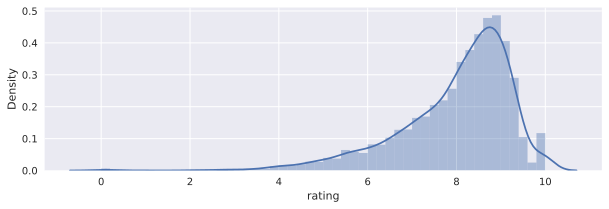

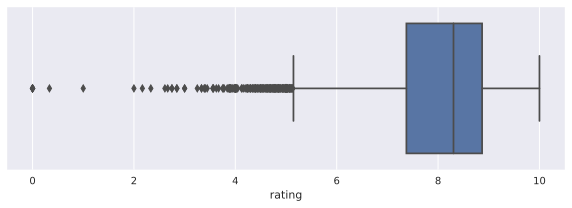

In [34]:
plt.figure(figsize=(10, 3))
sns.distplot(df_pr['rating'])
plt.show()

plt.figure(figsize=(10, 3))
sns.boxplot(df_pr['rating'], orient='h')
plt.show()

### Look at 5 movies for demo

* Чикатило ee48def6-c311-4b73-a878-1a5d3d1679a3,
* Манюня 9b202b16-55bf-418a-b01d-9f0329b18790,
* Оффлайн 49a3d528-44c0-408e-b6fc-a1507ce7641a
* Молодой человек 0271c9b5-b7b2-4e3f-96af-b9cefed99397
* Приплыли! 02eaefe0-296d-4e6f-b52f-2e2507d07103

In [47]:
demo_df = df_pr.loc[df_pr['element_uid'].isin(['ee48def6-c311-4b73-a878-1a5d3d1679a3', 
                                    '9b202b16-55bf-418a-b01d-9f0329b18790',
                                    '49a3d528-44c0-408e-b6fc-a1507ce7641a',
                                    '0271c9b5-b7b2-4e3f-96af-b9cefed99397',
                                    '02eaefe0-296d-4e6f-b52f-2e2507d07103'])]

In [48]:
ddf = demo_df.copy()

In [49]:
ddf.drop(['release_year', 'element_uid', 'name'], axis=1, inplace=True)

In [50]:
ddf.T

""
age_access_type
type
duration
BUDGET
MARKETING
...
Харви Вайнштейн
Боб Вайнштейн
Адриан Политовски
Люк Бессон


## Split

In [35]:
df_pr.columns

Index(['age_access_type', 'name', 'type', 'release_year', 'duration',
       'element_uid', 'BUDGET', 'MARKETING', 'RUS', 'USA',
       ...
       'Такер Гейтс', 'Крис Гилл', 'Майкл Кан', 'Джим Дено', 'Дариуш Вольски',
       'Харви Вайнштейн', 'Боб Вайнштейн', 'Адриан Политовски', 'Люк Бессон',
       'Стэн Ли'],
      dtype='object', length=1061)

In [36]:
from sklearn.model_selection import train_test_split

sorted_df = df_pr.sort_values('release_year')

test = sorted_df[sorted_df['release_year'] == 2022]
train = sorted_df[sorted_df['release_year'] != 2022]

# for looking at samples
test_df = test.copy(deep=True)
train_df = train.copy(deep=True)

test.drop(['release_year', 'element_uid', 'name'], axis=1, inplace=True)
train.drop(['release_year', 'element_uid', 'name'], axis=1, inplace=True)

X_test, y_test = test.drop('rating', axis=1), test['rating']
X, y = train.drop('rating', axis=1), train['rating']
X_train, X_val, y_train, y_val = train_test_split(X, y,
                                                  test_size=0.1, 
                                                  shuffle=False)
X_train.shape, X_val.shape, X_test.shape, y_train.shape, y_val.shape, y_test.shape


((4276, 1057), (476, 1057), (68, 1057), (4276,), (476,), (68,))

In [37]:
X_train.columns

Index(['age_access_type', 'type', 'duration', 'BUDGET', 'MARKETING', 'RUS',
       'USA', 'WORLD', 'джек', 'расследовать',
       ...
       'Такер Гейтс', 'Крис Гилл', 'Майкл Кан', 'Джим Дено', 'Дариуш Вольски',
       'Харви Вайнштейн', 'Боб Вайнштейн', 'Адриан Политовски', 'Люк Бессон',
       'Стэн Ли'],
      dtype='object', length=1057)

In [38]:
X_train

,age_access_type,type,duration,BUDGET,MARKETING,RUS,USA,WORLD,джек,расследовать,...,Такер Гейтс,Крис Гилл,Майкл Кан,Джим Дено,Дариуш Вольски,Харви Вайнштейн,Боб Вайнштейн,Адриан Политовски,Люк Бессон,Стэн Ли
4939,12,MOVIE,15.479437,NaN,NaN,13.270785,13.347369,17.921885,0,0,...,0,0,0,0,0,0,0,0,1,0
104,16,MOVIE,15.597220,17.216708,NaN,NaN,16.877041,16.877041,0,0,...,0,0,0,0,0,0,0,0,0,0
1269,18,MOVIE,16.039053,18.450240,17.56971,14.062371,19.050384,19.948006,0,0,...,0,0,0,0,0,0,0,0,0,0
1000,12,MOVIE,15.617221,17.989898,NaN,NaN,17.446812,18.323362,0,0,...,0,0,0,0,0,0,0,0,0,0
985,16,MOVIE,15.720599,14.508658,NaN,NaN,14.271217,14.531609,0,0,...,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7724,6,MOVIE,15.627073,NaN,NaN,11.215395,NaN,15.471098,0,0,...,0,0,0,0,0,0,0,1,0,0
7715,6,MOVIE,15.396549,NaN,NaN,12.058477,NaN,13.370281,0,0,...,0,0,0,0,0,0,0,0,0,0
7712,12,MOVIE,15.512960,NaN,NaN,NaN,NaN,NaN,0,0,...,0,0,0,0,0,0,0,0,0,0
4910,12,MOVIE,15.729488,NaN,NaN,10.309919,NaN,15.390878,0,0,...,0,0,0,0,0,0,0,0,0,0


In [39]:
cat_features = ['age_access_type', 'type']

# Modeling

In [40]:
import catboost as cat
from catboost import CatBoostRegressor
from sklearn.model_selection import GridSearchCV, RandomizedSearchCV

from scipy.stats import uniform, randint

In [59]:
train_dataset = cat.Pool(data=X_train,
                        label=y_train,
                         cat_features=cat_features)

test_dataset = cat.Pool(data=X_test, 
                        label=y_test,
                         cat_features=cat_features)

val_dataset = cat.Pool(X_val, y_val,
                       cat_features=cat_features)

cat_params = {
    'loss_function': 'RMSE',
    'eval_metric': 'MAE',
    'verbose': True,
    'random_seed': 321,
    'allow_writing_files': False, 
    'cat_features': cat_features
}

cat_model = cat.CatBoostRegressor(**cat_params)

cat_model.fit(
    train_dataset,
    eval_set=val_dataset,
    early_stopping_rounds=500,
    verbose=100,
    plot=False
)

Learning rate set to 0.063969
0:	learn: 0.9271335	test: 1.0422709	best: 1.0422709 (0)	total: 57.7ms	remaining: 57.7s
100:	learn: 0.6740296	test: 0.8553103	best: 0.8553103 (100)	total: 821ms	remaining: 7.31s
200:	learn: 0.6425239	test: 0.8450477	best: 0.8450477 (200)	total: 1.66s	remaining: 6.58s
300:	learn: 0.6197307	test: 0.8442835	best: 0.8437746 (271)	total: 2.52s	remaining: 5.85s
400:	learn: 0.6019034	test: 0.8452875	best: 0.8437746 (271)	total: 3.33s	remaining: 4.97s
500:	learn: 0.5863963	test: 0.8474008	best: 0.8437746 (271)	total: 4.15s	remaining: 4.14s
600:	learn: 0.5721029	test: 0.8465757	best: 0.8437746 (271)	total: 4.97s	remaining: 3.3s
700:	learn: 0.5581897	test: 0.8491144	best: 0.8437746 (271)	total: 5.8s	remaining: 2.48s
Stopped by overfitting detector  (500 iterations wait)

bestTest = 0.8437745772
bestIteration = 271

Shrink model to first 272 iterations.


In [60]:
y_pred = cat_model.predict(test_dataset)

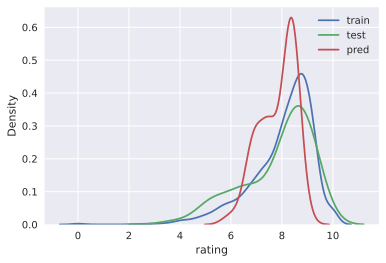

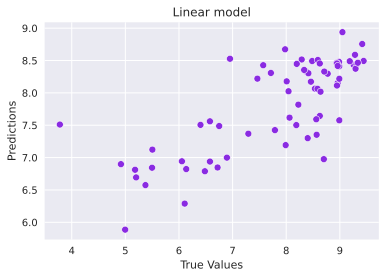

In [61]:
target_distr_linear(y_train, y_test, y_pred)   

In [62]:
calc_metrics(y_test, y_pred)

*** VAL **: 
MSE:   0.8774672744458103
RMSE:  0.9367322319883149
R2:    0.5227675572734165
MAE:   0.7279587929862675
MedAE: 0.6864724125969595
------------------------------


In [63]:
cat_model.save_model('cat_reg_okko_ratings_cat_ntop_scors_kws')

**Feature importance**

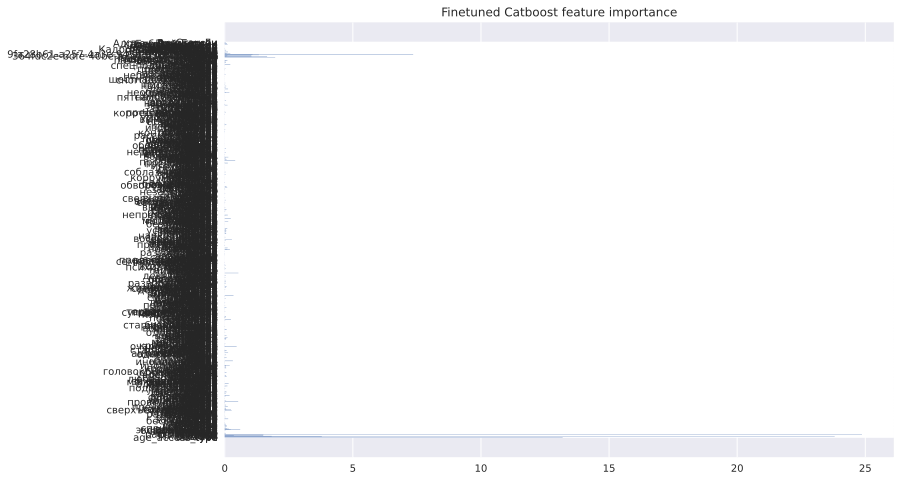

In [64]:
get_feature_imp(cat_model, train_dataset)

1)  The most influential features:  
    - duration  
    - average_rating  
    - age_access_type  

2)  The lowest influential features:  
    - actors and directors are not so important

**Detecting heteroscedasticity**

**Graphical Method:**

Firstly do the regression analysis and then plot the error terms against the predicted values. 
If there is a definite pattern (like linear or quadratic or funnel shaped) obtained from the scatter plot then heteroscedasticity is present.

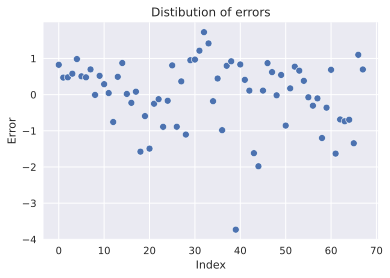

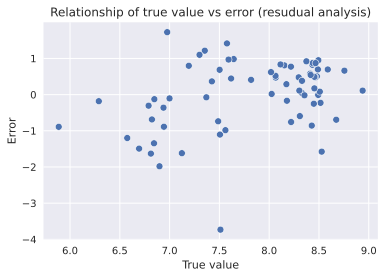

In [65]:
errors = y_test - y_pred
draw_res_analys(errors, y_pred)

**Conclusion**
* The trend in the second figure is not visible, now we will confirm the presence of heteroskedasticity on tests.

In [66]:
test_df['PREDS'] = y_pred.tolist()
test_df['TARGET'] = y_test.tolist()
test_df

,age_access_type,name,type,release_year,duration,element_uid,BUDGET,MARKETING,RUS,USA,...,Майкл Кан,Джим Дено,Дариуш Вольски,Харви Вайнштейн,Боб Вайнштейн,Адриан Политовски,Люк Бессон,Стэн Ли,PREDS,TARGET
10400,18,Не оставляй меня,SERIAL,2022,17.044733,00de4f79-d52d-4d2c-871c-e6e8432cc3df,NaN,NaN,NaN,NaN,...,0,0,0,0,0,0,0,0,8.433861,9.258333
10300,18,Индекс страха,SERIAL,2022,16.200597,e281b84c-bb78-466a-ac71-c557aacc5c13,NaN,NaN,NaN,NaN,...,0,0,0,0,0,0,0,0,8.065795,8.536232
10322,18,На взводе: Битва за UBER,SERIAL,2022,16.064695,fecde143-2a72-4a70-8efc-188079a62f1a,NaN,NaN,NaN,NaN,...,0,0,0,0,0,0,0,0,8.296337,8.773810
10439,18,Жена путешественника во времени,SERIAL,2022,16.626117,7becd8d8-1fb8-4ee6-b903-47817686ddd8,NaN,NaN,NaN,NaN,...,0,0,0,0,0,0,0,0,8.411406,8.990000
46,16,Боец: Король ринга,MOVIE,2022,15.665539,1f2481e2-55ec-429f-9e3d-6c3ea2087d00,15.894952,NaN,NaN,NaN,...,0,0,0,0,0,0,0,0,7.643850,8.626496
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
4414,18,Отряд «Призрак»,MOVIE,2022,15.656060,f132627d-5b3b-443f-bccd-feb92b51d08d,NaN,NaN,NaN,NaN,...,0,0,0,0,0,0,0,0,7.487621,6.750000
4415,12,Падение Луны,MOVIE,2022,15.869634,595c19b8-a22f-4beb-ab9f-5431fd3929ea,18.826146,NaN,15.237295,16.763137,...,0,0,0,0,0,0,0,0,8.673375,7.979399
4417,16,Парни под прикрытием,MOVIE,2022,15.501910,1b9df53f-e556-4f00-8d1f-67b2cc74e01a,NaN,NaN,12.266231,NaN,...,0,0,0,0,0,0,0,0,6.843320,5.497999
3392,16,9 жизней,MOVIE,2022,15.566448,a7979b64-cf82-4c7f-86d8-05670b07d1b0,NaN,NaN,12.154206,NaN,...,0,0,0,0,0,0,0,0,7.300300,8.400693


In [74]:
# predict demo dataset

In [75]:
X_demo, y_demo = ddf.drop('rating', axis=1), ddf['rating']

demo_dataset = cat.Pool(data=X_demo, 
                        label=y_demo,
                         cat_features=cat_features)

y_pred_demo = cat_model.predict(demo_dataset)

In [76]:
demo_df['TARGET'] = y_demo.tolist()
demo_df['PREDS'] = y_pred_demo.tolist()
demo_df

,age_access_type,name,type,release_year,duration,element_uid,BUDGET,MARKETING,RUS,USA,...,Оливер Вуд,Харви Вайнштейн,Боб Вайнштейн,Адриан Политовски,Арнон Милчен,Стэн Ли,Люк Бессон,Джек Кёрби,TARGET,PREDS
6469,16,Молодой человек,MOVIE,2022,15.702580,0271c9b5-b7b2-4e3f-96af-b9cefed99397,NaN,NaN,NaN,NaN,...,0,0,0,0,0,0,0,0,9.147352,7.398115
6550,18,Приплыли!,MOVIE,2022,15.479437,02eaefe0-296d-4e6f-b52f-2e2507d07103,NaN,NaN,12.593543,NaN,...,0,0,0,0,0,0,0,0,6.519242,6.877495
9998,18,Чикатило,SERIAL,2020,17.723526,ee48def6-c311-4b73-a878-1a5d3d1679a3,NaN,NaN,NaN,NaN,...,0,0,0,0,0,0,0,0,9.717041,8.749734
10433,6,Манюня,SERIAL,2021,16.269958,9b202b16-55bf-418a-b01d-9f0329b18790,NaN,NaN,NaN,NaN,...,0,0,0,0,0,0,0,0,9.192744,8.642376
10608,18,Оффлайн,SERIAL,2022,17.218706,49a3d528-44c0-408e-b6fc-a1507ce7641a,NaN,NaN,NaN,NaN,...,0,0,0,0,0,0,0,0,9.362527,8.468094


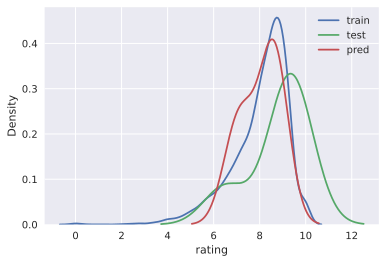

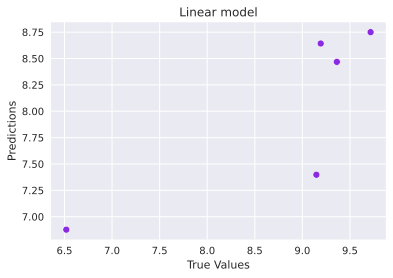

In [77]:
target_distr_linear(y_train, y_demo, y_pred_demo)   

# Tuning

In [41]:
train_dataset = cat.Pool(X_train, y_train, 
                         cat_features=cat_features) 

test_dataset = cat.Pool(X_test, y_test,
                         cat_features=cat_features)

cat_params = {
    'loss_function': 'RMSE',
    'eval_metric': 'MAE',
    'verbose': True,
    'random_seed': 321,
    'allow_writing_files': False, 
    'cat_features': cat_features
}

In [42]:
parameters_distr = {'depth': randint(5, 10),
              'learning_rate': uniform(0.01, 0.1),
              'iterations': [5000, 10000, 15000]
             }

cat_model = cat.CatBoostRegressor(**cat_params)
grid = RandomizedSearchCV(estimator=cat_model, param_distributions=parameters_distr, 
                            cv=5, 
#                           n_jobs=-1,
                          verbose=3)

grid.fit(X_train, y_train)

import pickle
with open('bestimator_okko_rat_ntop_scrs_kws', 'wb') as f:
    pickle.dump(grid.best_estimator_, f)
grid.best_params_

Fitting 5 folds for each of 10 candidates, totalling 50 fits
0:	learn: 0.9577517	total: 72.4ms	remaining: 6m 2s
1:	learn: 0.9290167	total: 96.2ms	remaining: 4m
2:	learn: 0.9037534	total: 116ms	remaining: 3m 13s
3:	learn: 0.8820401	total: 139ms	remaining: 2m 53s
4:	learn: 0.8632549	total: 158ms	remaining: 2m 37s
5:	learn: 0.8459537	total: 174ms	remaining: 2m 24s
6:	learn: 0.8296878	total: 189ms	remaining: 2m 14s
7:	learn: 0.8149973	total: 207ms	remaining: 2m 9s
8:	learn: 0.8027931	total: 234ms	remaining: 2m 10s
9:	learn: 0.7912472	total: 262ms	remaining: 2m 10s
10:	learn: 0.7800279	total: 289ms	remaining: 2m 10s
11:	learn: 0.7721720	total: 313ms	remaining: 2m 10s
12:	learn: 0.7648018	total: 339ms	remaining: 2m 9s
13:	learn: 0.7562953	total: 361ms	remaining: 2m 8s
14:	learn: 0.7476875	total: 380ms	remaining: 2m 6s
15:	learn: 0.7423315	total: 404ms	remaining: 2m 5s
16:	learn: 0.7374166	total: 424ms	remaining: 2m 4s
17:	learn: 0.7335161	total: 444ms	remaining: 2m 2s
18:	learn: 0.7290952	to

164:	learn: 0.6056272	total: 3.43s	remaining: 1m 40s
165:	learn: 0.6051688	total: 3.45s	remaining: 1m 40s
166:	learn: 0.6050075	total: 3.47s	remaining: 1m 40s
167:	learn: 0.6045153	total: 3.49s	remaining: 1m 40s
168:	learn: 0.6041986	total: 3.51s	remaining: 1m 40s
169:	learn: 0.6028940	total: 3.53s	remaining: 1m 40s
170:	learn: 0.6025697	total: 3.55s	remaining: 1m 40s
171:	learn: 0.6017426	total: 3.57s	remaining: 1m 40s
172:	learn: 0.6015028	total: 3.6s	remaining: 1m 40s
173:	learn: 0.6006294	total: 3.62s	remaining: 1m 40s
174:	learn: 0.6004680	total: 3.63s	remaining: 1m 40s
175:	learn: 0.5997576	total: 3.66s	remaining: 1m 40s
176:	learn: 0.5986018	total: 3.68s	remaining: 1m 40s
177:	learn: 0.5975174	total: 3.69s	remaining: 1m 40s
178:	learn: 0.5972508	total: 3.71s	remaining: 1m 40s
179:	learn: 0.5970746	total: 3.74s	remaining: 1m 40s
180:	learn: 0.5964736	total: 3.76s	remaining: 1m 40s
181:	learn: 0.5964051	total: 3.78s	remaining: 1m 40s
182:	learn: 0.5954422	total: 3.8s	remaining: 1m

320:	learn: 0.5339548	total: 6.79s	remaining: 1m 39s
321:	learn: 0.5335445	total: 6.81s	remaining: 1m 38s
322:	learn: 0.5335071	total: 6.83s	remaining: 1m 38s
323:	learn: 0.5334177	total: 6.85s	remaining: 1m 38s
324:	learn: 0.5332039	total: 6.88s	remaining: 1m 38s
325:	learn: 0.5329705	total: 6.9s	remaining: 1m 38s
326:	learn: 0.5321614	total: 6.92s	remaining: 1m 38s
327:	learn: 0.5317698	total: 6.95s	remaining: 1m 38s
328:	learn: 0.5316373	total: 6.97s	remaining: 1m 38s
329:	learn: 0.5304568	total: 6.99s	remaining: 1m 38s
330:	learn: 0.5301365	total: 7.01s	remaining: 1m 38s
331:	learn: 0.5294989	total: 7.02s	remaining: 1m 38s
332:	learn: 0.5293149	total: 7.04s	remaining: 1m 38s
333:	learn: 0.5288056	total: 7.06s	remaining: 1m 38s
334:	learn: 0.5286670	total: 7.08s	remaining: 1m 38s
335:	learn: 0.5284647	total: 7.1s	remaining: 1m 38s
336:	learn: 0.5280230	total: 7.12s	remaining: 1m 38s
337:	learn: 0.5278614	total: 7.15s	remaining: 1m 38s
338:	learn: 0.5277491	total: 7.18s	remaining: 1m

475:	learn: 0.4804737	total: 10.2s	remaining: 1m 36s
476:	learn: 0.4804207	total: 10.2s	remaining: 1m 36s
477:	learn: 0.4795136	total: 10.2s	remaining: 1m 36s
478:	learn: 0.4791672	total: 10.2s	remaining: 1m 36s
479:	learn: 0.4789791	total: 10.3s	remaining: 1m 36s
480:	learn: 0.4785487	total: 10.3s	remaining: 1m 36s
481:	learn: 0.4783738	total: 10.3s	remaining: 1m 36s
482:	learn: 0.4783057	total: 10.3s	remaining: 1m 36s
483:	learn: 0.4777852	total: 10.3s	remaining: 1m 36s
484:	learn: 0.4774528	total: 10.4s	remaining: 1m 36s
485:	learn: 0.4770875	total: 10.4s	remaining: 1m 36s
486:	learn: 0.4768723	total: 10.4s	remaining: 1m 36s
487:	learn: 0.4764365	total: 10.4s	remaining: 1m 36s
488:	learn: 0.4756948	total: 10.5s	remaining: 1m 36s
489:	learn: 0.4747105	total: 10.5s	remaining: 1m 36s
490:	learn: 0.4743536	total: 10.5s	remaining: 1m 36s
491:	learn: 0.4741105	total: 10.5s	remaining: 1m 36s
492:	learn: 0.4733788	total: 10.6s	remaining: 1m 36s
493:	learn: 0.4733137	total: 10.6s	remaining: 

632:	learn: 0.4336274	total: 13.5s	remaining: 1m 33s
633:	learn: 0.4335790	total: 13.5s	remaining: 1m 33s
634:	learn: 0.4335483	total: 13.6s	remaining: 1m 33s
635:	learn: 0.4330619	total: 13.6s	remaining: 1m 33s
636:	learn: 0.4329636	total: 13.6s	remaining: 1m 33s
637:	learn: 0.4328598	total: 13.6s	remaining: 1m 33s
638:	learn: 0.4328134	total: 13.6s	remaining: 1m 33s
639:	learn: 0.4326438	total: 13.7s	remaining: 1m 33s
640:	learn: 0.4323887	total: 13.7s	remaining: 1m 32s
641:	learn: 0.4322361	total: 13.7s	remaining: 1m 32s
642:	learn: 0.4317482	total: 13.7s	remaining: 1m 32s
643:	learn: 0.4315502	total: 13.7s	remaining: 1m 32s
644:	learn: 0.4313994	total: 13.7s	remaining: 1m 32s
645:	learn: 0.4313290	total: 13.7s	remaining: 1m 32s
646:	learn: 0.4309484	total: 13.8s	remaining: 1m 32s
647:	learn: 0.4307465	total: 13.8s	remaining: 1m 32s
648:	learn: 0.4306995	total: 13.8s	remaining: 1m 32s
649:	learn: 0.4298996	total: 13.8s	remaining: 1m 32s
650:	learn: 0.4296621	total: 13.8s	remaining: 

800:	learn: 0.3920804	total: 16.2s	remaining: 1m 25s
801:	learn: 0.3917710	total: 16.2s	remaining: 1m 24s
802:	learn: 0.3915695	total: 16.2s	remaining: 1m 24s
803:	learn: 0.3913905	total: 16.3s	remaining: 1m 24s
804:	learn: 0.3912442	total: 16.3s	remaining: 1m 24s
805:	learn: 0.3908185	total: 16.3s	remaining: 1m 24s
806:	learn: 0.3905831	total: 16.3s	remaining: 1m 24s
807:	learn: 0.3903439	total: 16.3s	remaining: 1m 24s
808:	learn: 0.3897542	total: 16.3s	remaining: 1m 24s
809:	learn: 0.3895407	total: 16.3s	remaining: 1m 24s
810:	learn: 0.3894569	total: 16.4s	remaining: 1m 24s
811:	learn: 0.3893009	total: 16.4s	remaining: 1m 24s
812:	learn: 0.3887627	total: 16.4s	remaining: 1m 24s
813:	learn: 0.3882863	total: 16.4s	remaining: 1m 24s
814:	learn: 0.3878858	total: 16.4s	remaining: 1m 24s
815:	learn: 0.3877450	total: 16.4s	remaining: 1m 24s
816:	learn: 0.3876306	total: 16.4s	remaining: 1m 24s
817:	learn: 0.3869726	total: 16.5s	remaining: 1m 24s
818:	learn: 0.3869036	total: 16.5s	remaining: 

968:	learn: 0.3621409	total: 18.5s	remaining: 1m 17s
969:	learn: 0.3614306	total: 18.5s	remaining: 1m 16s
970:	learn: 0.3612817	total: 18.5s	remaining: 1m 16s
971:	learn: 0.3612360	total: 18.6s	remaining: 1m 16s
972:	learn: 0.3607531	total: 18.6s	remaining: 1m 16s
973:	learn: 0.3605290	total: 18.6s	remaining: 1m 16s
974:	learn: 0.3604054	total: 18.6s	remaining: 1m 16s
975:	learn: 0.3601898	total: 18.6s	remaining: 1m 16s
976:	learn: 0.3601168	total: 18.6s	remaining: 1m 16s
977:	learn: 0.3600528	total: 18.6s	remaining: 1m 16s
978:	learn: 0.3600082	total: 18.7s	remaining: 1m 16s
979:	learn: 0.3596888	total: 18.7s	remaining: 1m 16s
980:	learn: 0.3594408	total: 18.7s	remaining: 1m 16s
981:	learn: 0.3593727	total: 18.7s	remaining: 1m 16s
982:	learn: 0.3593654	total: 18.7s	remaining: 1m 16s
983:	learn: 0.3593354	total: 18.7s	remaining: 1m 16s
984:	learn: 0.3589937	total: 18.7s	remaining: 1m 16s
985:	learn: 0.3589734	total: 18.8s	remaining: 1m 16s
986:	learn: 0.3588044	total: 18.8s	remaining: 

1135:	learn: 0.3330540	total: 21s	remaining: 1m 11s
1136:	learn: 0.3330097	total: 21s	remaining: 1m 11s
1137:	learn: 0.3326692	total: 21s	remaining: 1m 11s
1138:	learn: 0.3324744	total: 21s	remaining: 1m 11s
1139:	learn: 0.3322595	total: 21s	remaining: 1m 11s
1140:	learn: 0.3318709	total: 21.1s	remaining: 1m 11s
1141:	learn: 0.3316918	total: 21.1s	remaining: 1m 11s
1142:	learn: 0.3314110	total: 21.1s	remaining: 1m 11s
1143:	learn: 0.3313731	total: 21.1s	remaining: 1m 11s
1144:	learn: 0.3312413	total: 21.1s	remaining: 1m 11s
1145:	learn: 0.3309952	total: 21.1s	remaining: 1m 11s
1146:	learn: 0.3308639	total: 21.1s	remaining: 1m 11s
1147:	learn: 0.3308111	total: 21.2s	remaining: 1m 10s
1148:	learn: 0.3307594	total: 21.2s	remaining: 1m 10s
1149:	learn: 0.3307357	total: 21.2s	remaining: 1m 10s
1150:	learn: 0.3306516	total: 21.2s	remaining: 1m 10s
1151:	learn: 0.3305538	total: 21.2s	remaining: 1m 10s
1152:	learn: 0.3305363	total: 21.2s	remaining: 1m 10s
1153:	learn: 0.3303754	total: 21.2s	re

1302:	learn: 0.3056881	total: 23.3s	remaining: 1m 6s
1303:	learn: 0.3056631	total: 23.3s	remaining: 1m 6s
1304:	learn: 0.3055044	total: 23.3s	remaining: 1m 5s
1305:	learn: 0.3053835	total: 23.3s	remaining: 1m 5s
1306:	learn: 0.3052840	total: 23.3s	remaining: 1m 5s
1307:	learn: 0.3052149	total: 23.3s	remaining: 1m 5s
1308:	learn: 0.3049977	total: 23.4s	remaining: 1m 5s
1309:	learn: 0.3048917	total: 23.4s	remaining: 1m 5s
1310:	learn: 0.3047581	total: 23.4s	remaining: 1m 5s
1311:	learn: 0.3042631	total: 23.4s	remaining: 1m 5s
1312:	learn: 0.3042079	total: 23.4s	remaining: 1m 5s
1313:	learn: 0.3040594	total: 23.4s	remaining: 1m 5s
1314:	learn: 0.3038751	total: 23.4s	remaining: 1m 5s
1315:	learn: 0.3037027	total: 23.5s	remaining: 1m 5s
1316:	learn: 0.3035693	total: 23.5s	remaining: 1m 5s
1317:	learn: 0.3033838	total: 23.5s	remaining: 1m 5s
1318:	learn: 0.3031115	total: 23.5s	remaining: 1m 5s
1319:	learn: 0.3027868	total: 23.5s	remaining: 1m 5s
1320:	learn: 0.3026527	total: 23.5s	remaining:

1464:	learn: 0.2842959	total: 25.6s	remaining: 1m 1s
1465:	learn: 0.2841750	total: 25.6s	remaining: 1m 1s
1466:	learn: 0.2841662	total: 25.6s	remaining: 1m 1s
1467:	learn: 0.2841364	total: 25.6s	remaining: 1m 1s
1468:	learn: 0.2840526	total: 25.6s	remaining: 1m 1s
1469:	learn: 0.2837080	total: 25.6s	remaining: 1m 1s
1470:	learn: 0.2836312	total: 25.6s	remaining: 1m 1s
1471:	learn: 0.2836042	total: 25.7s	remaining: 1m 1s
1472:	learn: 0.2834773	total: 25.7s	remaining: 1m 1s
1473:	learn: 0.2831303	total: 25.7s	remaining: 1m 1s
1474:	learn: 0.2830098	total: 25.7s	remaining: 1m 1s
1475:	learn: 0.2829340	total: 25.7s	remaining: 1m 1s
1476:	learn: 0.2828591	total: 25.7s	remaining: 1m 1s
1477:	learn: 0.2827938	total: 25.7s	remaining: 1m 1s
1478:	learn: 0.2827119	total: 25.8s	remaining: 1m 1s
1479:	learn: 0.2825647	total: 25.8s	remaining: 1m 1s
1480:	learn: 0.2823561	total: 25.8s	remaining: 1m 1s
1481:	learn: 0.2823399	total: 25.8s	remaining: 1m 1s
1482:	learn: 0.2822611	total: 25.8s	remaining:

1630:	learn: 0.2653074	total: 27.8s	remaining: 57.5s
1631:	learn: 0.2649254	total: 27.8s	remaining: 57.5s
1632:	learn: 0.2646115	total: 27.9s	remaining: 57.4s
1633:	learn: 0.2644203	total: 27.9s	remaining: 57.4s
1634:	learn: 0.2643503	total: 27.9s	remaining: 57.4s
1635:	learn: 0.2643168	total: 27.9s	remaining: 57.4s
1636:	learn: 0.2642775	total: 27.9s	remaining: 57.4s
1637:	learn: 0.2641919	total: 27.9s	remaining: 57.3s
1638:	learn: 0.2641702	total: 27.9s	remaining: 57.3s
1639:	learn: 0.2635977	total: 28s	remaining: 57.3s
1640:	learn: 0.2635474	total: 28s	remaining: 57.3s
1641:	learn: 0.2634588	total: 28s	remaining: 57.2s
1642:	learn: 0.2632648	total: 28s	remaining: 57.2s
1643:	learn: 0.2632322	total: 28s	remaining: 57.2s
1644:	learn: 0.2631432	total: 28s	remaining: 57.2s
1645:	learn: 0.2629792	total: 28s	remaining: 57.1s
1646:	learn: 0.2628692	total: 28.1s	remaining: 57.1s
1647:	learn: 0.2628097	total: 28.1s	remaining: 57.1s
1648:	learn: 0.2627539	total: 28.1s	remaining: 57.1s
1649:	l

1788:	learn: 0.2486928	total: 30.1s	remaining: 54s
1789:	learn: 0.2486273	total: 30.1s	remaining: 54s
1790:	learn: 0.2485244	total: 30.1s	remaining: 54s
1791:	learn: 0.2484976	total: 30.2s	remaining: 54s
1792:	learn: 0.2483856	total: 30.2s	remaining: 54s
1793:	learn: 0.2481697	total: 30.2s	remaining: 53.9s
1794:	learn: 0.2480141	total: 30.2s	remaining: 53.9s
1795:	learn: 0.2478879	total: 30.2s	remaining: 53.9s
1796:	learn: 0.2475580	total: 30.2s	remaining: 53.9s
1797:	learn: 0.2474679	total: 30.2s	remaining: 53.8s
1798:	learn: 0.2474452	total: 30.2s	remaining: 53.8s
1799:	learn: 0.2472686	total: 30.3s	remaining: 53.8s
1800:	learn: 0.2470500	total: 30.3s	remaining: 53.8s
1801:	learn: 0.2470282	total: 30.3s	remaining: 53.8s
1802:	learn: 0.2469996	total: 30.3s	remaining: 53.7s
1803:	learn: 0.2469911	total: 30.3s	remaining: 53.7s
1804:	learn: 0.2469472	total: 30.3s	remaining: 53.7s
1805:	learn: 0.2468435	total: 30.3s	remaining: 53.7s
1806:	learn: 0.2467084	total: 30.4s	remaining: 53.6s
180

1947:	learn: 0.2319544	total: 32.4s	remaining: 50.7s
1948:	learn: 0.2319488	total: 32.4s	remaining: 50.7s
1949:	learn: 0.2319407	total: 32.4s	remaining: 50.7s
1950:	learn: 0.2318670	total: 32.4s	remaining: 50.7s
1951:	learn: 0.2316895	total: 32.4s	remaining: 50.6s
1952:	learn: 0.2316380	total: 32.5s	remaining: 50.6s
1953:	learn: 0.2316299	total: 32.5s	remaining: 50.6s
1954:	learn: 0.2314146	total: 32.5s	remaining: 50.6s
1955:	learn: 0.2313528	total: 32.5s	remaining: 50.6s
1956:	learn: 0.2313011	total: 32.5s	remaining: 50.5s
1957:	learn: 0.2312656	total: 32.5s	remaining: 50.5s
1958:	learn: 0.2312520	total: 32.5s	remaining: 50.5s
1959:	learn: 0.2311576	total: 32.5s	remaining: 50.5s
1960:	learn: 0.2311127	total: 32.6s	remaining: 50.5s
1961:	learn: 0.2310658	total: 32.6s	remaining: 50.4s
1962:	learn: 0.2310352	total: 32.6s	remaining: 50.4s
1963:	learn: 0.2309697	total: 32.6s	remaining: 50.4s
1964:	learn: 0.2309493	total: 32.6s	remaining: 50.4s
1965:	learn: 0.2309433	total: 32.6s	remaining:

2108:	learn: 0.2174404	total: 34.6s	remaining: 47.4s
2109:	learn: 0.2174075	total: 34.6s	remaining: 47.4s
2110:	learn: 0.2171556	total: 34.6s	remaining: 47.4s
2111:	learn: 0.2169794	total: 34.7s	remaining: 47.4s
2112:	learn: 0.2168654	total: 34.7s	remaining: 47.4s
2113:	learn: 0.2168637	total: 34.7s	remaining: 47.4s
2114:	learn: 0.2168254	total: 34.7s	remaining: 47.3s
2115:	learn: 0.2167671	total: 34.7s	remaining: 47.3s
2116:	learn: 0.2167438	total: 34.7s	remaining: 47.3s
2117:	learn: 0.2166089	total: 34.7s	remaining: 47.3s
2118:	learn: 0.2166072	total: 34.8s	remaining: 47.3s
2119:	learn: 0.2165728	total: 34.8s	remaining: 47.2s
2120:	learn: 0.2163964	total: 34.8s	remaining: 47.2s
2121:	learn: 0.2163802	total: 34.8s	remaining: 47.2s
2122:	learn: 0.2163441	total: 34.8s	remaining: 47.2s
2123:	learn: 0.2163053	total: 34.8s	remaining: 47.2s
2124:	learn: 0.2160472	total: 34.8s	remaining: 47.1s
2125:	learn: 0.2160259	total: 34.8s	remaining: 47.1s
2126:	learn: 0.2159573	total: 34.9s	remaining:

2274:	learn: 0.2046608	total: 36.9s	remaining: 44.2s
2275:	learn: 0.2046382	total: 36.9s	remaining: 44.1s
2276:	learn: 0.2044365	total: 36.9s	remaining: 44.1s
2277:	learn: 0.2044266	total: 36.9s	remaining: 44.1s
2278:	learn: 0.2044190	total: 36.9s	remaining: 44.1s
2279:	learn: 0.2044168	total: 36.9s	remaining: 44.1s
2280:	learn: 0.2043715	total: 36.9s	remaining: 44s
2281:	learn: 0.2043073	total: 37s	remaining: 44s
2282:	learn: 0.2042091	total: 37s	remaining: 44s
2283:	learn: 0.2042015	total: 37s	remaining: 44s
2284:	learn: 0.2041389	total: 37s	remaining: 44s
2285:	learn: 0.2040714	total: 37s	remaining: 43.9s
2286:	learn: 0.2039191	total: 37s	remaining: 43.9s
2287:	learn: 0.2038963	total: 37s	remaining: 43.9s
2288:	learn: 0.2037657	total: 37s	remaining: 43.9s
2289:	learn: 0.2037530	total: 37.1s	remaining: 43.9s
2290:	learn: 0.2037246	total: 37.1s	remaining: 43.8s
2291:	learn: 0.2036846	total: 37.1s	remaining: 43.8s
2292:	learn: 0.2035352	total: 37.1s	remaining: 43.8s
2293:	learn: 0.2034

2436:	learn: 0.1915610	total: 39.1s	remaining: 41.2s
2437:	learn: 0.1914207	total: 39.2s	remaining: 41.2s
2438:	learn: 0.1912938	total: 39.2s	remaining: 41.1s
2439:	learn: 0.1912892	total: 39.2s	remaining: 41.1s
2440:	learn: 0.1912707	total: 39.2s	remaining: 41.1s
2441:	learn: 0.1912527	total: 39.2s	remaining: 41.1s
2442:	learn: 0.1912164	total: 39.2s	remaining: 41.1s
2443:	learn: 0.1911514	total: 39.2s	remaining: 41s
2444:	learn: 0.1910992	total: 39.2s	remaining: 41s
2445:	learn: 0.1910278	total: 39.3s	remaining: 41s
2446:	learn: 0.1908053	total: 39.3s	remaining: 41s
2447:	learn: 0.1906773	total: 39.3s	remaining: 41s
2448:	learn: 0.1906195	total: 39.3s	remaining: 40.9s
2449:	learn: 0.1905958	total: 39.3s	remaining: 40.9s
2450:	learn: 0.1905259	total: 39.3s	remaining: 40.9s
2451:	learn: 0.1904812	total: 39.4s	remaining: 40.9s
2452:	learn: 0.1901960	total: 39.4s	remaining: 40.9s
2453:	learn: 0.1900550	total: 39.4s	remaining: 40.9s
2454:	learn: 0.1899371	total: 39.4s	remaining: 40.9s
245

2597:	learn: 0.1788155	total: 41.4s	remaining: 38.3s
2598:	learn: 0.1786433	total: 41.4s	remaining: 38.3s
2599:	learn: 0.1786180	total: 41.5s	remaining: 38.3s
2600:	learn: 0.1785546	total: 41.5s	remaining: 38.2s
2601:	learn: 0.1785330	total: 41.5s	remaining: 38.2s
2602:	learn: 0.1784990	total: 41.5s	remaining: 38.2s
2603:	learn: 0.1784752	total: 41.5s	remaining: 38.2s
2604:	learn: 0.1784341	total: 41.5s	remaining: 38.2s
2605:	learn: 0.1783689	total: 41.5s	remaining: 38.2s
2606:	learn: 0.1783054	total: 41.6s	remaining: 38.1s
2607:	learn: 0.1782800	total: 41.6s	remaining: 38.1s
2608:	learn: 0.1782324	total: 41.6s	remaining: 38.1s
2609:	learn: 0.1780884	total: 41.6s	remaining: 38.1s
2610:	learn: 0.1780805	total: 41.6s	remaining: 38.1s
2611:	learn: 0.1779785	total: 41.6s	remaining: 38.1s
2612:	learn: 0.1779177	total: 41.6s	remaining: 38s
2613:	learn: 0.1778630	total: 41.7s	remaining: 38s
2614:	learn: 0.1778036	total: 41.7s	remaining: 38s
2615:	learn: 0.1776179	total: 41.7s	remaining: 38s
2

2755:	learn: 0.1687158	total: 43.7s	remaining: 35.6s
2756:	learn: 0.1686638	total: 43.7s	remaining: 35.6s
2757:	learn: 0.1686256	total: 43.7s	remaining: 35.5s
2758:	learn: 0.1685767	total: 43.7s	remaining: 35.5s
2759:	learn: 0.1684968	total: 43.8s	remaining: 35.5s
2760:	learn: 0.1684196	total: 43.8s	remaining: 35.5s
2761:	learn: 0.1683267	total: 43.8s	remaining: 35.5s
2762:	learn: 0.1681926	total: 43.8s	remaining: 35.5s
2763:	learn: 0.1681733	total: 43.8s	remaining: 35.4s
2764:	learn: 0.1681225	total: 43.8s	remaining: 35.4s
2765:	learn: 0.1680834	total: 43.8s	remaining: 35.4s
2766:	learn: 0.1679921	total: 43.8s	remaining: 35.4s
2767:	learn: 0.1678892	total: 43.9s	remaining: 35.4s
2768:	learn: 0.1677974	total: 43.9s	remaining: 35.4s
2769:	learn: 0.1677692	total: 43.9s	remaining: 35.3s
2770:	learn: 0.1677282	total: 43.9s	remaining: 35.3s
2771:	learn: 0.1676959	total: 43.9s	remaining: 35.3s
2772:	learn: 0.1676327	total: 43.9s	remaining: 35.3s
2773:	learn: 0.1676206	total: 43.9s	remaining:

2920:	learn: 0.1577038	total: 46s	remaining: 32.7s
2921:	learn: 0.1576995	total: 46s	remaining: 32.7s
2922:	learn: 0.1576995	total: 46s	remaining: 32.7s
2923:	learn: 0.1576022	total: 46.1s	remaining: 32.7s
2924:	learn: 0.1575771	total: 46.1s	remaining: 32.7s
2925:	learn: 0.1575157	total: 46.1s	remaining: 32.7s
2926:	learn: 0.1574844	total: 46.1s	remaining: 32.6s
2927:	learn: 0.1574766	total: 46.1s	remaining: 32.6s
2928:	learn: 0.1574010	total: 46.1s	remaining: 32.6s
2929:	learn: 0.1573308	total: 46.1s	remaining: 32.6s
2930:	learn: 0.1573069	total: 46.1s	remaining: 32.6s
2931:	learn: 0.1571484	total: 46.2s	remaining: 32.6s
2932:	learn: 0.1571253	total: 46.2s	remaining: 32.5s
2933:	learn: 0.1571203	total: 46.2s	remaining: 32.5s
2934:	learn: 0.1570400	total: 46.2s	remaining: 32.5s
2935:	learn: 0.1570079	total: 46.2s	remaining: 32.5s
2936:	learn: 0.1570039	total: 46.2s	remaining: 32.5s
2937:	learn: 0.1569625	total: 46.2s	remaining: 32.5s
2938:	learn: 0.1568576	total: 46.3s	remaining: 32.4s

3084:	learn: 0.1483755	total: 48.3s	remaining: 30s
3085:	learn: 0.1483487	total: 48.3s	remaining: 30s
3086:	learn: 0.1481084	total: 48.3s	remaining: 29.9s
3087:	learn: 0.1480641	total: 48.3s	remaining: 29.9s
3088:	learn: 0.1480214	total: 48.4s	remaining: 29.9s
3089:	learn: 0.1479863	total: 48.4s	remaining: 29.9s
3090:	learn: 0.1477667	total: 48.4s	remaining: 29.9s
3091:	learn: 0.1477246	total: 48.4s	remaining: 29.9s
3092:	learn: 0.1476618	total: 48.4s	remaining: 29.8s
3093:	learn: 0.1475973	total: 48.4s	remaining: 29.8s
3094:	learn: 0.1475604	total: 48.4s	remaining: 29.8s
3095:	learn: 0.1474614	total: 48.5s	remaining: 29.8s
3096:	learn: 0.1474170	total: 48.5s	remaining: 29.8s
3097:	learn: 0.1474045	total: 48.5s	remaining: 29.8s
3098:	learn: 0.1473174	total: 48.5s	remaining: 29.7s
3099:	learn: 0.1471300	total: 48.5s	remaining: 29.7s
3100:	learn: 0.1471261	total: 48.5s	remaining: 29.7s
3101:	learn: 0.1471031	total: 48.5s	remaining: 29.7s
3102:	learn: 0.1470767	total: 48.5s	remaining: 29.

3251:	learn: 0.1396825	total: 50.6s	remaining: 27.2s
3252:	learn: 0.1396450	total: 50.6s	remaining: 27.2s
3253:	learn: 0.1395950	total: 50.6s	remaining: 27.1s
3254:	learn: 0.1394840	total: 50.6s	remaining: 27.1s
3255:	learn: 0.1394137	total: 50.6s	remaining: 27.1s
3256:	learn: 0.1393988	total: 50.6s	remaining: 27.1s
3257:	learn: 0.1392188	total: 50.6s	remaining: 27.1s
3258:	learn: 0.1391209	total: 50.6s	remaining: 27.1s
3259:	learn: 0.1390518	total: 50.7s	remaining: 27s
3260:	learn: 0.1390368	total: 50.7s	remaining: 27s
3261:	learn: 0.1390318	total: 50.7s	remaining: 27s
3262:	learn: 0.1390251	total: 50.7s	remaining: 27s
3263:	learn: 0.1389923	total: 50.7s	remaining: 27s
3264:	learn: 0.1389867	total: 50.7s	remaining: 27s
3265:	learn: 0.1389186	total: 50.7s	remaining: 26.9s
3266:	learn: 0.1388693	total: 50.8s	remaining: 26.9s
3267:	learn: 0.1388681	total: 50.8s	remaining: 26.9s
3268:	learn: 0.1388382	total: 50.8s	remaining: 26.9s
3269:	learn: 0.1387741	total: 50.8s	remaining: 26.9s
3270:

3418:	learn: 0.1324951	total: 52.8s	remaining: 24.4s
3419:	learn: 0.1324704	total: 52.8s	remaining: 24.4s
3420:	learn: 0.1324195	total: 52.8s	remaining: 24.4s
3421:	learn: 0.1322929	total: 52.9s	remaining: 24.4s
3422:	learn: 0.1322779	total: 52.9s	remaining: 24.4s
3423:	learn: 0.1322385	total: 52.9s	remaining: 24.3s
3424:	learn: 0.1322252	total: 52.9s	remaining: 24.3s
3425:	learn: 0.1322002	total: 52.9s	remaining: 24.3s
3426:	learn: 0.1321895	total: 52.9s	remaining: 24.3s
3427:	learn: 0.1321846	total: 52.9s	remaining: 24.3s
3428:	learn: 0.1321683	total: 52.9s	remaining: 24.3s
3429:	learn: 0.1320775	total: 53s	remaining: 24.2s
3430:	learn: 0.1319591	total: 53s	remaining: 24.2s
3431:	learn: 0.1317844	total: 53s	remaining: 24.2s
3432:	learn: 0.1317535	total: 53s	remaining: 24.2s
3433:	learn: 0.1317375	total: 53s	remaining: 24.2s
3434:	learn: 0.1316267	total: 53s	remaining: 24.2s
3435:	learn: 0.1314162	total: 53s	remaining: 24.1s
3436:	learn: 0.1313158	total: 53.1s	remaining: 24.1s
3437:	l

3586:	learn: 0.1257928	total: 55.1s	remaining: 21.7s
3587:	learn: 0.1257762	total: 55.1s	remaining: 21.7s
3588:	learn: 0.1257346	total: 55.1s	remaining: 21.7s
3589:	learn: 0.1257239	total: 55.1s	remaining: 21.7s
3590:	learn: 0.1256753	total: 55.2s	remaining: 21.6s
3591:	learn: 0.1256482	total: 55.2s	remaining: 21.6s
3592:	learn: 0.1255748	total: 55.2s	remaining: 21.6s
3593:	learn: 0.1255525	total: 55.2s	remaining: 21.6s
3594:	learn: 0.1255488	total: 55.2s	remaining: 21.6s
3595:	learn: 0.1255366	total: 55.2s	remaining: 21.6s
3596:	learn: 0.1254971	total: 55.2s	remaining: 21.5s
3597:	learn: 0.1254952	total: 55.2s	remaining: 21.5s
3598:	learn: 0.1254297	total: 55.3s	remaining: 21.5s
3599:	learn: 0.1254171	total: 55.3s	remaining: 21.5s
3600:	learn: 0.1253516	total: 55.3s	remaining: 21.5s
3601:	learn: 0.1253165	total: 55.3s	remaining: 21.5s
3602:	learn: 0.1253008	total: 55.3s	remaining: 21.4s
3603:	learn: 0.1252025	total: 55.3s	remaining: 21.4s
3604:	learn: 0.1251556	total: 55.3s	remaining:

3750:	learn: 0.1192790	total: 57.4s	remaining: 19.1s
3751:	learn: 0.1192649	total: 57.4s	remaining: 19.1s
3752:	learn: 0.1192220	total: 57.4s	remaining: 19.1s
3753:	learn: 0.1192008	total: 57.4s	remaining: 19.1s
3754:	learn: 0.1191905	total: 57.4s	remaining: 19s
3755:	learn: 0.1191170	total: 57.4s	remaining: 19s
3756:	learn: 0.1191076	total: 57.5s	remaining: 19s
3757:	learn: 0.1190327	total: 57.5s	remaining: 19s
3758:	learn: 0.1190273	total: 57.5s	remaining: 19s
3759:	learn: 0.1190241	total: 57.5s	remaining: 19s
3760:	learn: 0.1190200	total: 57.5s	remaining: 18.9s
3761:	learn: 0.1190028	total: 57.5s	remaining: 18.9s
3762:	learn: 0.1189642	total: 57.5s	remaining: 18.9s
3763:	learn: 0.1189045	total: 57.6s	remaining: 18.9s
3764:	learn: 0.1188856	total: 57.6s	remaining: 18.9s
3765:	learn: 0.1188867	total: 57.6s	remaining: 18.9s
3766:	learn: 0.1188595	total: 57.6s	remaining: 18.9s
3767:	learn: 0.1188499	total: 57.6s	remaining: 18.8s
3768:	learn: 0.1187998	total: 57.6s	remaining: 18.8s
3769:

3911:	learn: 0.1136078	total: 59.6s	remaining: 16.6s
3912:	learn: 0.1135368	total: 59.7s	remaining: 16.6s
3913:	learn: 0.1135021	total: 59.7s	remaining: 16.6s
3914:	learn: 0.1134890	total: 59.7s	remaining: 16.5s
3915:	learn: 0.1134749	total: 59.7s	remaining: 16.5s
3916:	learn: 0.1134727	total: 59.7s	remaining: 16.5s
3917:	learn: 0.1134426	total: 59.7s	remaining: 16.5s
3918:	learn: 0.1133426	total: 59.7s	remaining: 16.5s
3919:	learn: 0.1132853	total: 59.7s	remaining: 16.5s
3920:	learn: 0.1132636	total: 59.8s	remaining: 16.4s
3921:	learn: 0.1132461	total: 59.8s	remaining: 16.4s
3922:	learn: 0.1132223	total: 59.8s	remaining: 16.4s
3923:	learn: 0.1132164	total: 59.8s	remaining: 16.4s
3924:	learn: 0.1131547	total: 59.8s	remaining: 16.4s
3925:	learn: 0.1131434	total: 59.8s	remaining: 16.4s
3926:	learn: 0.1131371	total: 59.8s	remaining: 16.4s
3927:	learn: 0.1131362	total: 59.9s	remaining: 16.3s
3928:	learn: 0.1131266	total: 59.9s	remaining: 16.3s
3929:	learn: 0.1130746	total: 59.9s	remaining:

4076:	learn: 0.1082703	total: 1m 1s	remaining: 14s
4077:	learn: 0.1082547	total: 1m 1s	remaining: 14s
4078:	learn: 0.1081491	total: 1m 1s	remaining: 14s
4079:	learn: 0.1081139	total: 1m 1s	remaining: 14s
4080:	learn: 0.1080762	total: 1m 1s	remaining: 14s
4081:	learn: 0.1080361	total: 1m 1s	remaining: 13.9s
4082:	learn: 0.1080289	total: 1m 1s	remaining: 13.9s
4083:	learn: 0.1080090	total: 1m 1s	remaining: 13.9s
4084:	learn: 0.1079712	total: 1m 2s	remaining: 13.9s
4085:	learn: 0.1079201	total: 1m 2s	remaining: 13.9s
4086:	learn: 0.1079075	total: 1m 2s	remaining: 13.9s
4087:	learn: 0.1078820	total: 1m 2s	remaining: 13.8s
4088:	learn: 0.1077742	total: 1m 2s	remaining: 13.8s
4089:	learn: 0.1077571	total: 1m 2s	remaining: 13.8s
4090:	learn: 0.1077412	total: 1m 2s	remaining: 13.8s
4091:	learn: 0.1077119	total: 1m 2s	remaining: 13.8s
4092:	learn: 0.1077115	total: 1m 2s	remaining: 13.8s
4093:	learn: 0.1076840	total: 1m 2s	remaining: 13.8s
4094:	learn: 0.1076414	total: 1m 2s	remaining: 13.7s
409

4241:	learn: 0.1028252	total: 1m 4s	remaining: 11.5s
4242:	learn: 0.1028187	total: 1m 4s	remaining: 11.5s
4243:	learn: 0.1027488	total: 1m 4s	remaining: 11.4s
4244:	learn: 0.1027341	total: 1m 4s	remaining: 11.4s
4245:	learn: 0.1027026	total: 1m 4s	remaining: 11.4s
4246:	learn: 0.1026950	total: 1m 4s	remaining: 11.4s
4247:	learn: 0.1026335	total: 1m 4s	remaining: 11.4s
4248:	learn: 0.1026324	total: 1m 4s	remaining: 11.4s
4249:	learn: 0.1026299	total: 1m 4s	remaining: 11.3s
4250:	learn: 0.1025799	total: 1m 4s	remaining: 11.3s
4251:	learn: 0.1025321	total: 1m 4s	remaining: 11.3s
4252:	learn: 0.1025159	total: 1m 4s	remaining: 11.3s
4253:	learn: 0.1024005	total: 1m 4s	remaining: 11.3s
4254:	learn: 0.1023931	total: 1m 4s	remaining: 11.3s
4255:	learn: 0.1023664	total: 1m 4s	remaining: 11.3s
4256:	learn: 0.1023580	total: 1m 4s	remaining: 11.2s
4257:	learn: 0.1023485	total: 1m 4s	remaining: 11.2s
4258:	learn: 0.1023339	total: 1m 4s	remaining: 11.2s
4259:	learn: 0.1023261	total: 1m 4s	remaining:

4409:	learn: 0.0977668	total: 1m 6s	remaining: 8.89s
4410:	learn: 0.0976677	total: 1m 6s	remaining: 8.88s
4411:	learn: 0.0976453	total: 1m 6s	remaining: 8.86s
4412:	learn: 0.0976414	total: 1m 6s	remaining: 8.85s
4413:	learn: 0.0976130	total: 1m 6s	remaining: 8.83s
4414:	learn: 0.0975969	total: 1m 6s	remaining: 8.81s
4415:	learn: 0.0975528	total: 1m 6s	remaining: 8.8s
4416:	learn: 0.0975389	total: 1m 6s	remaining: 8.78s
4417:	learn: 0.0975208	total: 1m 6s	remaining: 8.77s
4418:	learn: 0.0975033	total: 1m 6s	remaining: 8.75s
4419:	learn: 0.0974512	total: 1m 6s	remaining: 8.74s
4420:	learn: 0.0974310	total: 1m 6s	remaining: 8.72s
4421:	learn: 0.0974241	total: 1m 6s	remaining: 8.71s
4422:	learn: 0.0973944	total: 1m 6s	remaining: 8.69s
4423:	learn: 0.0973661	total: 1m 6s	remaining: 8.68s
4424:	learn: 0.0972978	total: 1m 6s	remaining: 8.66s
4425:	learn: 0.0972666	total: 1m 6s	remaining: 8.65s
4426:	learn: 0.0972667	total: 1m 6s	remaining: 8.63s
4427:	learn: 0.0972543	total: 1m 6s	remaining: 

4571:	learn: 0.0929338	total: 1m 8s	remaining: 6.43s
4572:	learn: 0.0928829	total: 1m 8s	remaining: 6.42s
4573:	learn: 0.0928792	total: 1m 8s	remaining: 6.4s
4574:	learn: 0.0928711	total: 1m 8s	remaining: 6.39s
4575:	learn: 0.0928149	total: 1m 8s	remaining: 6.37s
4576:	learn: 0.0928101	total: 1m 8s	remaining: 6.36s
4577:	learn: 0.0928050	total: 1m 8s	remaining: 6.34s
4578:	learn: 0.0927933	total: 1m 8s	remaining: 6.33s
4579:	learn: 0.0927745	total: 1m 8s	remaining: 6.31s
4580:	learn: 0.0927201	total: 1m 8s	remaining: 6.3s
4581:	learn: 0.0927099	total: 1m 8s	remaining: 6.28s
4582:	learn: 0.0926638	total: 1m 8s	remaining: 6.27s
4583:	learn: 0.0926060	total: 1m 8s	remaining: 6.25s
4584:	learn: 0.0925686	total: 1m 8s	remaining: 6.24s
4585:	learn: 0.0925542	total: 1m 8s	remaining: 6.22s
4586:	learn: 0.0925307	total: 1m 8s	remaining: 6.21s
4587:	learn: 0.0925211	total: 1m 8s	remaining: 6.19s
4588:	learn: 0.0924285	total: 1m 8s	remaining: 6.18s
4589:	learn: 0.0923946	total: 1m 8s	remaining: 6

4740:	learn: 0.0883705	total: 1m 11s	remaining: 3.88s
4741:	learn: 0.0883497	total: 1m 11s	remaining: 3.86s
4742:	learn: 0.0883491	total: 1m 11s	remaining: 3.85s
4743:	learn: 0.0883409	total: 1m 11s	remaining: 3.83s
4744:	learn: 0.0883274	total: 1m 11s	remaining: 3.82s
4745:	learn: 0.0883205	total: 1m 11s	remaining: 3.8s
4746:	learn: 0.0882964	total: 1m 11s	remaining: 3.79s
4747:	learn: 0.0882898	total: 1m 11s	remaining: 3.77s
4748:	learn: 0.0882430	total: 1m 11s	remaining: 3.76s
4749:	learn: 0.0882259	total: 1m 11s	remaining: 3.74s
4750:	learn: 0.0881882	total: 1m 11s	remaining: 3.73s
4751:	learn: 0.0881889	total: 1m 11s	remaining: 3.71s
4752:	learn: 0.0881696	total: 1m 11s	remaining: 3.7s
4753:	learn: 0.0881399	total: 1m 11s	remaining: 3.68s
4754:	learn: 0.0880623	total: 1m 11s	remaining: 3.67s
4755:	learn: 0.0880329	total: 1m 11s	remaining: 3.65s
4756:	learn: 0.0880256	total: 1m 11s	remaining: 3.64s
4757:	learn: 0.0879688	total: 1m 11s	remaining: 3.62s
4758:	learn: 0.0879587	total: 

4904:	learn: 0.0843797	total: 1m 13s	remaining: 1.42s
4905:	learn: 0.0843607	total: 1m 13s	remaining: 1.4s
4906:	learn: 0.0843475	total: 1m 13s	remaining: 1.39s
4907:	learn: 0.0843272	total: 1m 13s	remaining: 1.37s
4908:	learn: 0.0842993	total: 1m 13s	remaining: 1.36s
4909:	learn: 0.0842485	total: 1m 13s	remaining: 1.34s
4910:	learn: 0.0841975	total: 1m 13s	remaining: 1.33s
4911:	learn: 0.0841665	total: 1m 13s	remaining: 1.31s
4912:	learn: 0.0841374	total: 1m 13s	remaining: 1.3s
4913:	learn: 0.0840906	total: 1m 13s	remaining: 1.28s
4914:	learn: 0.0840624	total: 1m 13s	remaining: 1.27s
4915:	learn: 0.0840416	total: 1m 13s	remaining: 1.25s
4916:	learn: 0.0840169	total: 1m 13s	remaining: 1.24s
4917:	learn: 0.0839953	total: 1m 13s	remaining: 1.22s
4918:	learn: 0.0839676	total: 1m 13s	remaining: 1.21s
4919:	learn: 0.0839420	total: 1m 13s	remaining: 1.2s
4920:	learn: 0.0839257	total: 1m 13s	remaining: 1.18s
4921:	learn: 0.0839161	total: 1m 13s	remaining: 1.17s
4922:	learn: 0.0838723	total: 1

65:	learn: 0.6604551	total: 892ms	remaining: 1m 6s
66:	learn: 0.6595556	total: 911ms	remaining: 1m 7s
67:	learn: 0.6592257	total: 930ms	remaining: 1m 7s
68:	learn: 0.6589847	total: 948ms	remaining: 1m 7s
69:	learn: 0.6579407	total: 964ms	remaining: 1m 7s
70:	learn: 0.6571161	total: 980ms	remaining: 1m 8s
71:	learn: 0.6559383	total: 994ms	remaining: 1m 8s
72:	learn: 0.6546759	total: 1.01s	remaining: 1m 7s
73:	learn: 0.6545279	total: 1.02s	remaining: 1m 7s
74:	learn: 0.6544018	total: 1.03s	remaining: 1m 7s
75:	learn: 0.6541504	total: 1.05s	remaining: 1m 7s
76:	learn: 0.6532407	total: 1.06s	remaining: 1m 7s
77:	learn: 0.6525815	total: 1.07s	remaining: 1m 7s
78:	learn: 0.6518543	total: 1.09s	remaining: 1m 7s
79:	learn: 0.6517826	total: 1.1s	remaining: 1m 7s
80:	learn: 0.6511315	total: 1.11s	remaining: 1m 7s
81:	learn: 0.6506134	total: 1.13s	remaining: 1m 7s
82:	learn: 0.6498260	total: 1.14s	remaining: 1m 7s
83:	learn: 0.6492689	total: 1.16s	remaining: 1m 7s
84:	learn: 0.6491621	total: 1.17

236:	learn: 0.5610698	total: 3.19s	remaining: 1m 4s
237:	learn: 0.5603246	total: 3.2s	remaining: 1m 4s
238:	learn: 0.5596491	total: 3.22s	remaining: 1m 4s
239:	learn: 0.5596267	total: 3.23s	remaining: 1m 4s
240:	learn: 0.5595130	total: 3.25s	remaining: 1m 4s
241:	learn: 0.5585052	total: 3.26s	remaining: 1m 4s
242:	learn: 0.5580702	total: 3.27s	remaining: 1m 4s
243:	learn: 0.5579578	total: 3.29s	remaining: 1m 4s
244:	learn: 0.5577730	total: 3.3s	remaining: 1m 4s
245:	learn: 0.5573243	total: 3.31s	remaining: 1m 4s
246:	learn: 0.5561327	total: 3.33s	remaining: 1m 4s
247:	learn: 0.5559784	total: 3.35s	remaining: 1m 4s
248:	learn: 0.5557137	total: 3.36s	remaining: 1m 4s
249:	learn: 0.5551374	total: 3.38s	remaining: 1m 4s
250:	learn: 0.5544410	total: 3.39s	remaining: 1m 4s
251:	learn: 0.5536788	total: 3.4s	remaining: 1m 4s
252:	learn: 0.5533658	total: 3.42s	remaining: 1m 4s
253:	learn: 0.5532592	total: 3.43s	remaining: 1m 4s
254:	learn: 0.5527023	total: 3.44s	remaining: 1m 4s
255:	learn: 0.5

401:	learn: 0.4934446	total: 5.44s	remaining: 1m 2s
402:	learn: 0.4925329	total: 5.45s	remaining: 1m 2s
403:	learn: 0.4921968	total: 5.47s	remaining: 1m 2s
404:	learn: 0.4921313	total: 5.49s	remaining: 1m 2s
405:	learn: 0.4920239	total: 5.51s	remaining: 1m 2s
406:	learn: 0.4915792	total: 5.52s	remaining: 1m 2s
407:	learn: 0.4911086	total: 5.54s	remaining: 1m 2s
408:	learn: 0.4906351	total: 5.56s	remaining: 1m 2s
409:	learn: 0.4903482	total: 5.58s	remaining: 1m 2s
410:	learn: 0.4899633	total: 5.59s	remaining: 1m 2s
411:	learn: 0.4898984	total: 5.61s	remaining: 1m 2s
412:	learn: 0.4891478	total: 5.62s	remaining: 1m 2s
413:	learn: 0.4891140	total: 5.64s	remaining: 1m 2s
414:	learn: 0.4889035	total: 5.65s	remaining: 1m 2s
415:	learn: 0.4886988	total: 5.66s	remaining: 1m 2s
416:	learn: 0.4885800	total: 5.68s	remaining: 1m 2s
417:	learn: 0.4885263	total: 5.69s	remaining: 1m 2s
418:	learn: 0.4879786	total: 5.71s	remaining: 1m 2s
419:	learn: 0.4879393	total: 5.72s	remaining: 1m 2s
420:	learn: 

562:	learn: 0.4397517	total: 7.71s	remaining: 1m
563:	learn: 0.4396180	total: 7.73s	remaining: 1m
564:	learn: 0.4395657	total: 7.74s	remaining: 1m
565:	learn: 0.4395064	total: 7.75s	remaining: 1m
566:	learn: 0.4392298	total: 7.76s	remaining: 1m
567:	learn: 0.4388478	total: 7.78s	remaining: 1m
568:	learn: 0.4386841	total: 7.79s	remaining: 1m
569:	learn: 0.4385289	total: 7.8s	remaining: 1m
570:	learn: 0.4381434	total: 7.81s	remaining: 1m
571:	learn: 0.4370917	total: 7.83s	remaining: 1m
572:	learn: 0.4369264	total: 7.84s	remaining: 1m
573:	learn: 0.4362590	total: 7.85s	remaining: 1m
574:	learn: 0.4353100	total: 7.86s	remaining: 1m
575:	learn: 0.4349074	total: 7.88s	remaining: 1m
576:	learn: 0.4349033	total: 7.89s	remaining: 1m
577:	learn: 0.4345734	total: 7.9s	remaining: 1m
578:	learn: 0.4345505	total: 7.92s	remaining: 1m
579:	learn: 0.4341546	total: 7.93s	remaining: 1m
580:	learn: 0.4340718	total: 7.94s	remaining: 1m
581:	learn: 0.4337537	total: 7.95s	remaining: 1m
582:	learn: 0.4334191	

726:	learn: 0.3988382	total: 10s	remaining: 58.8s
727:	learn: 0.3987200	total: 10s	remaining: 58.9s
728:	learn: 0.3981411	total: 10s	remaining: 58.9s
729:	learn: 0.3978971	total: 10.1s	remaining: 58.9s
730:	learn: 0.3977854	total: 10.1s	remaining: 58.9s
731:	learn: 0.3977537	total: 10.1s	remaining: 58.9s
732:	learn: 0.3977080	total: 10.1s	remaining: 58.9s
733:	learn: 0.3976606	total: 10.1s	remaining: 58.9s
734:	learn: 0.3973982	total: 10.2s	remaining: 58.9s
735:	learn: 0.3971432	total: 10.2s	remaining: 58.9s
736:	learn: 0.3970420	total: 10.2s	remaining: 58.9s
737:	learn: 0.3965918	total: 10.2s	remaining: 58.9s
738:	learn: 0.3962333	total: 10.2s	remaining: 58.9s
739:	learn: 0.3959462	total: 10.2s	remaining: 58.9s
740:	learn: 0.3955393	total: 10.2s	remaining: 58.8s
741:	learn: 0.3954549	total: 10.3s	remaining: 58.8s
742:	learn: 0.3950731	total: 10.3s	remaining: 58.8s
743:	learn: 0.3944422	total: 10.3s	remaining: 58.8s
744:	learn: 0.3944243	total: 10.3s	remaining: 58.8s
745:	learn: 0.3944

887:	learn: 0.3644644	total: 12.3s	remaining: 56.9s
888:	learn: 0.3640472	total: 12.3s	remaining: 56.8s
889:	learn: 0.3637715	total: 12.3s	remaining: 56.8s
890:	learn: 0.3636902	total: 12.3s	remaining: 56.8s
891:	learn: 0.3636451	total: 12.3s	remaining: 56.8s
892:	learn: 0.3635664	total: 12.3s	remaining: 56.8s
893:	learn: 0.3633529	total: 12.4s	remaining: 56.8s
894:	learn: 0.3629052	total: 12.4s	remaining: 56.8s
895:	learn: 0.3627200	total: 12.4s	remaining: 56.7s
896:	learn: 0.3624253	total: 12.4s	remaining: 56.7s
897:	learn: 0.3621904	total: 12.4s	remaining: 56.7s
898:	learn: 0.3620468	total: 12.4s	remaining: 56.7s
899:	learn: 0.3620315	total: 12.4s	remaining: 56.7s
900:	learn: 0.3619076	total: 12.5s	remaining: 56.7s
901:	learn: 0.3618940	total: 12.5s	remaining: 56.6s
902:	learn: 0.3618392	total: 12.5s	remaining: 56.6s
903:	learn: 0.3616386	total: 12.5s	remaining: 56.6s
904:	learn: 0.3615617	total: 12.5s	remaining: 56.6s
905:	learn: 0.3614534	total: 12.5s	remaining: 56.7s
906:	learn: 

1047:	learn: 0.3361839	total: 14.5s	remaining: 54.8s
1048:	learn: 0.3361782	total: 14.6s	remaining: 54.8s
1049:	learn: 0.3360388	total: 14.6s	remaining: 54.8s
1050:	learn: 0.3357424	total: 14.6s	remaining: 54.8s
1051:	learn: 0.3355007	total: 14.6s	remaining: 54.8s
1052:	learn: 0.3351154	total: 14.6s	remaining: 54.8s
1053:	learn: 0.3349878	total: 14.6s	remaining: 54.8s
1054:	learn: 0.3347477	total: 14.6s	remaining: 54.7s
1055:	learn: 0.3346089	total: 14.7s	remaining: 54.7s
1056:	learn: 0.3343824	total: 14.7s	remaining: 54.7s
1057:	learn: 0.3342628	total: 14.7s	remaining: 54.7s
1058:	learn: 0.3339986	total: 14.7s	remaining: 54.7s
1059:	learn: 0.3339144	total: 14.7s	remaining: 54.7s
1060:	learn: 0.3336185	total: 14.7s	remaining: 54.6s
1061:	learn: 0.3333031	total: 14.7s	remaining: 54.6s
1062:	learn: 0.3330718	total: 14.7s	remaining: 54.6s
1063:	learn: 0.3330636	total: 14.8s	remaining: 54.6s
1064:	learn: 0.3327043	total: 14.8s	remaining: 54.6s
1065:	learn: 0.3326820	total: 14.8s	remaining:

1217:	learn: 0.3122302	total: 16.8s	remaining: 52.2s
1218:	learn: 0.3117506	total: 16.8s	remaining: 52.2s
1219:	learn: 0.3115559	total: 16.8s	remaining: 52.2s
1220:	learn: 0.3115340	total: 16.9s	remaining: 52.2s
1221:	learn: 0.3113020	total: 16.9s	remaining: 52.2s
1222:	learn: 0.3112074	total: 16.9s	remaining: 52.1s
1223:	learn: 0.3110804	total: 16.9s	remaining: 52.1s
1224:	learn: 0.3109336	total: 16.9s	remaining: 52.1s
1225:	learn: 0.3105406	total: 16.9s	remaining: 52.1s
1226:	learn: 0.3103451	total: 16.9s	remaining: 52.1s
1227:	learn: 0.3098411	total: 16.9s	remaining: 52.1s
1228:	learn: 0.3098056	total: 17s	remaining: 52s
1229:	learn: 0.3096796	total: 17s	remaining: 52s
1230:	learn: 0.3096122	total: 17s	remaining: 52s
1231:	learn: 0.3094887	total: 17s	remaining: 52s
1232:	learn: 0.3093974	total: 17s	remaining: 52s
1233:	learn: 0.3092657	total: 17s	remaining: 52s
1234:	learn: 0.3090985	total: 17s	remaining: 52s
1235:	learn: 0.3087857	total: 17.1s	remaining: 51.9s
1236:	learn: 0.308356

1386:	learn: 0.2850513	total: 19.1s	remaining: 49.7s
1387:	learn: 0.2850374	total: 19.1s	remaining: 49.7s
1388:	learn: 0.2849875	total: 19.1s	remaining: 49.7s
1389:	learn: 0.2849538	total: 19.1s	remaining: 49.7s
1390:	learn: 0.2849507	total: 19.1s	remaining: 49.7s
1391:	learn: 0.2849386	total: 19.2s	remaining: 49.7s
1392:	learn: 0.2848217	total: 19.2s	remaining: 49.7s
1393:	learn: 0.2846612	total: 19.2s	remaining: 49.7s
1394:	learn: 0.2846407	total: 19.2s	remaining: 49.6s
1395:	learn: 0.2845396	total: 19.2s	remaining: 49.6s
1396:	learn: 0.2844698	total: 19.2s	remaining: 49.6s
1397:	learn: 0.2843919	total: 19.3s	remaining: 49.6s
1398:	learn: 0.2842691	total: 19.3s	remaining: 49.6s
1399:	learn: 0.2842097	total: 19.3s	remaining: 49.6s
1400:	learn: 0.2837712	total: 19.3s	remaining: 49.6s
1401:	learn: 0.2837107	total: 19.3s	remaining: 49.6s
1402:	learn: 0.2835968	total: 19.3s	remaining: 49.5s
1403:	learn: 0.2835116	total: 19.3s	remaining: 49.5s
1404:	learn: 0.2834763	total: 19.4s	remaining:

1548:	learn: 0.2627638	total: 21.4s	remaining: 47.6s
1549:	learn: 0.2626151	total: 21.4s	remaining: 47.6s
1550:	learn: 0.2626120	total: 21.4s	remaining: 47.6s
1551:	learn: 0.2625318	total: 21.4s	remaining: 47.6s
1552:	learn: 0.2623684	total: 21.4s	remaining: 47.5s
1553:	learn: 0.2622062	total: 21.4s	remaining: 47.5s
1554:	learn: 0.2622065	total: 21.4s	remaining: 47.5s
1555:	learn: 0.2620615	total: 21.5s	remaining: 47.5s
1556:	learn: 0.2618849	total: 21.5s	remaining: 47.5s
1557:	learn: 0.2618510	total: 21.5s	remaining: 47.5s
1558:	learn: 0.2618059	total: 21.5s	remaining: 47.4s
1559:	learn: 0.2616486	total: 21.5s	remaining: 47.4s
1560:	learn: 0.2615388	total: 21.5s	remaining: 47.4s
1561:	learn: 0.2614971	total: 21.5s	remaining: 47.4s
1562:	learn: 0.2614879	total: 21.5s	remaining: 47.4s
1563:	learn: 0.2613733	total: 21.6s	remaining: 47.4s
1564:	learn: 0.2612337	total: 21.6s	remaining: 47.3s
1565:	learn: 0.2611798	total: 21.6s	remaining: 47.3s
1566:	learn: 0.2610478	total: 21.6s	remaining:

1715:	learn: 0.2422510	total: 23.6s	remaining: 45.2s
1716:	learn: 0.2418583	total: 23.6s	remaining: 45.2s
1717:	learn: 0.2418228	total: 23.7s	remaining: 45.2s
1718:	learn: 0.2417549	total: 23.7s	remaining: 45.2s
1719:	learn: 0.2417078	total: 23.7s	remaining: 45.2s
1720:	learn: 0.2416397	total: 23.7s	remaining: 45.1s
1721:	learn: 0.2414722	total: 23.7s	remaining: 45.1s
1722:	learn: 0.2414434	total: 23.7s	remaining: 45.1s
1723:	learn: 0.2413629	total: 23.7s	remaining: 45.1s
1724:	learn: 0.2413414	total: 23.7s	remaining: 45.1s
1725:	learn: 0.2413193	total: 23.8s	remaining: 45.1s
1726:	learn: 0.2412486	total: 23.8s	remaining: 45.1s
1727:	learn: 0.2412240	total: 23.8s	remaining: 45s
1728:	learn: 0.2409051	total: 23.8s	remaining: 45s
1729:	learn: 0.2408622	total: 23.8s	remaining: 45s
1730:	learn: 0.2406414	total: 23.8s	remaining: 45s
1731:	learn: 0.2403087	total: 23.8s	remaining: 45s
1732:	learn: 0.2401384	total: 23.9s	remaining: 45s
1733:	learn: 0.2401392	total: 23.9s	remaining: 45s
1734:	l

1881:	learn: 0.2242708	total: 25.9s	remaining: 42.9s
1882:	learn: 0.2242652	total: 25.9s	remaining: 42.9s
1883:	learn: 0.2242574	total: 25.9s	remaining: 42.9s
1884:	learn: 0.2241972	total: 25.9s	remaining: 42.9s
1885:	learn: 0.2239302	total: 26s	remaining: 42.9s
1886:	learn: 0.2238261	total: 26s	remaining: 42.8s
1887:	learn: 0.2236611	total: 26s	remaining: 42.8s
1888:	learn: 0.2235365	total: 26s	remaining: 42.8s
1889:	learn: 0.2234196	total: 26s	remaining: 42.8s
1890:	learn: 0.2234089	total: 26s	remaining: 42.8s
1891:	learn: 0.2232875	total: 26s	remaining: 42.8s
1892:	learn: 0.2229426	total: 26.1s	remaining: 42.8s
1893:	learn: 0.2228744	total: 26.1s	remaining: 42.7s
1894:	learn: 0.2228255	total: 26.1s	remaining: 42.7s
1895:	learn: 0.2227567	total: 26.1s	remaining: 42.7s
1896:	learn: 0.2227241	total: 26.1s	remaining: 42.7s
1897:	learn: 0.2227101	total: 26.1s	remaining: 42.7s
1898:	learn: 0.2226646	total: 26.1s	remaining: 42.7s
1899:	learn: 0.2226186	total: 26.1s	remaining: 42.7s
1900:	l

2040:	learn: 0.2108186	total: 28.2s	remaining: 40.8s
2041:	learn: 0.2107478	total: 28.2s	remaining: 40.8s
2042:	learn: 0.2107257	total: 28.2s	remaining: 40.8s
2043:	learn: 0.2106878	total: 28.2s	remaining: 40.8s
2044:	learn: 0.2106676	total: 28.2s	remaining: 40.8s
2045:	learn: 0.2106626	total: 28.2s	remaining: 40.8s
2046:	learn: 0.2105450	total: 28.2s	remaining: 40.8s
2047:	learn: 0.2105168	total: 28.3s	remaining: 40.7s
2048:	learn: 0.2103961	total: 28.3s	remaining: 40.7s
2049:	learn: 0.2102965	total: 28.3s	remaining: 40.7s
2050:	learn: 0.2102616	total: 28.3s	remaining: 40.7s
2051:	learn: 0.2102489	total: 28.3s	remaining: 40.7s
2052:	learn: 0.2101401	total: 28.3s	remaining: 40.7s
2053:	learn: 0.2101350	total: 28.3s	remaining: 40.6s
2054:	learn: 0.2100155	total: 28.4s	remaining: 40.6s
2055:	learn: 0.2099795	total: 28.4s	remaining: 40.6s
2056:	learn: 0.2099563	total: 28.4s	remaining: 40.6s
2057:	learn: 0.2098969	total: 28.4s	remaining: 40.6s
2058:	learn: 0.2098154	total: 28.4s	remaining:

2209:	learn: 0.1977046	total: 30.4s	remaining: 38.4s
2210:	learn: 0.1976307	total: 30.5s	remaining: 38.4s
2211:	learn: 0.1975864	total: 30.5s	remaining: 38.4s
2212:	learn: 0.1975272	total: 30.5s	remaining: 38.4s
2213:	learn: 0.1975018	total: 30.5s	remaining: 38.4s
2214:	learn: 0.1974198	total: 30.5s	remaining: 38.4s
2215:	learn: 0.1973940	total: 30.5s	remaining: 38.3s
2216:	learn: 0.1973207	total: 30.5s	remaining: 38.3s
2217:	learn: 0.1973133	total: 30.6s	remaining: 38.3s
2218:	learn: 0.1973040	total: 30.6s	remaining: 38.3s
2219:	learn: 0.1972814	total: 30.6s	remaining: 38.3s
2220:	learn: 0.1971495	total: 30.6s	remaining: 38.3s
2221:	learn: 0.1971005	total: 30.6s	remaining: 38.3s
2222:	learn: 0.1969972	total: 30.6s	remaining: 38.3s
2223:	learn: 0.1969230	total: 30.6s	remaining: 38.2s
2224:	learn: 0.1967777	total: 30.7s	remaining: 38.2s
2225:	learn: 0.1966153	total: 30.7s	remaining: 38.2s
2226:	learn: 0.1965530	total: 30.7s	remaining: 38.2s
2227:	learn: 0.1962860	total: 30.7s	remaining:

2373:	learn: 0.1859379	total: 32.7s	remaining: 36.2s
2374:	learn: 0.1858920	total: 32.7s	remaining: 36.2s
2375:	learn: 0.1857332	total: 32.7s	remaining: 36.2s
2376:	learn: 0.1857037	total: 32.8s	remaining: 36.1s
2377:	learn: 0.1856834	total: 32.8s	remaining: 36.1s
2378:	learn: 0.1856582	total: 32.8s	remaining: 36.1s
2379:	learn: 0.1855922	total: 32.8s	remaining: 36.1s
2380:	learn: 0.1854970	total: 32.8s	remaining: 36.1s
2381:	learn: 0.1853364	total: 32.8s	remaining: 36.1s
2382:	learn: 0.1853317	total: 32.9s	remaining: 36.1s
2383:	learn: 0.1852434	total: 32.9s	remaining: 36.1s
2384:	learn: 0.1851505	total: 32.9s	remaining: 36s
2385:	learn: 0.1850860	total: 32.9s	remaining: 36s
2386:	learn: 0.1849787	total: 32.9s	remaining: 36s
2387:	learn: 0.1849192	total: 32.9s	remaining: 36s
2388:	learn: 0.1849129	total: 32.9s	remaining: 36s
2389:	learn: 0.1848559	total: 33s	remaining: 36s
2390:	learn: 0.1848316	total: 33s	remaining: 36s
2391:	learn: 0.1847732	total: 33s	remaining: 36s
2392:	learn: 0.

2536:	learn: 0.1764302	total: 35s	remaining: 34s
2537:	learn: 0.1764185	total: 35s	remaining: 34s
2538:	learn: 0.1763497	total: 35s	remaining: 33.9s
2539:	learn: 0.1762710	total: 35s	remaining: 33.9s
2540:	learn: 0.1762055	total: 35s	remaining: 33.9s
2541:	learn: 0.1761324	total: 35.1s	remaining: 33.9s
2542:	learn: 0.1761010	total: 35.1s	remaining: 33.9s
2543:	learn: 0.1760899	total: 35.1s	remaining: 33.9s
2544:	learn: 0.1760824	total: 35.1s	remaining: 33.9s
2545:	learn: 0.1760374	total: 35.1s	remaining: 33.8s
2546:	learn: 0.1759163	total: 35.1s	remaining: 33.8s
2547:	learn: 0.1758320	total: 35.1s	remaining: 33.8s
2548:	learn: 0.1757670	total: 35.1s	remaining: 33.8s
2549:	learn: 0.1757594	total: 35.2s	remaining: 33.8s
2550:	learn: 0.1756912	total: 35.2s	remaining: 33.8s
2551:	learn: 0.1756853	total: 35.2s	remaining: 33.7s
2552:	learn: 0.1756777	total: 35.2s	remaining: 33.7s
2553:	learn: 0.1756250	total: 35.2s	remaining: 33.7s
2554:	learn: 0.1755229	total: 35.2s	remaining: 33.7s
2555:	l

2700:	learn: 0.1670120	total: 37.3s	remaining: 31.7s
2701:	learn: 0.1668014	total: 37.3s	remaining: 31.7s
2702:	learn: 0.1667725	total: 37.3s	remaining: 31.7s
2703:	learn: 0.1666494	total: 37.3s	remaining: 31.7s
2704:	learn: 0.1665919	total: 37.3s	remaining: 31.7s
2705:	learn: 0.1663417	total: 37.3s	remaining: 31.6s
2706:	learn: 0.1662318	total: 37.3s	remaining: 31.6s
2707:	learn: 0.1661532	total: 37.4s	remaining: 31.6s
2708:	learn: 0.1661010	total: 37.4s	remaining: 31.6s
2709:	learn: 0.1660598	total: 37.4s	remaining: 31.6s
2710:	learn: 0.1660410	total: 37.4s	remaining: 31.6s
2711:	learn: 0.1658971	total: 37.4s	remaining: 31.6s
2712:	learn: 0.1658814	total: 37.4s	remaining: 31.6s
2713:	learn: 0.1658282	total: 37.5s	remaining: 31.5s
2714:	learn: 0.1657276	total: 37.5s	remaining: 31.5s
2715:	learn: 0.1656816	total: 37.5s	remaining: 31.5s
2716:	learn: 0.1656727	total: 37.5s	remaining: 31.5s
2717:	learn: 0.1654937	total: 37.5s	remaining: 31.5s
2718:	learn: 0.1654594	total: 37.5s	remaining:

2862:	learn: 0.1579962	total: 39.5s	remaining: 29.5s
2863:	learn: 0.1579585	total: 39.5s	remaining: 29.5s
2864:	learn: 0.1578166	total: 39.6s	remaining: 29.5s
2865:	learn: 0.1578138	total: 39.6s	remaining: 29.5s
2866:	learn: 0.1577315	total: 39.6s	remaining: 29.5s
2867:	learn: 0.1576984	total: 39.6s	remaining: 29.4s
2868:	learn: 0.1576638	total: 39.6s	remaining: 29.4s
2869:	learn: 0.1575869	total: 39.6s	remaining: 29.4s
2870:	learn: 0.1574888	total: 39.6s	remaining: 29.4s
2871:	learn: 0.1573730	total: 39.7s	remaining: 29.4s
2872:	learn: 0.1572830	total: 39.7s	remaining: 29.4s
2873:	learn: 0.1572721	total: 39.7s	remaining: 29.4s
2874:	learn: 0.1572379	total: 39.7s	remaining: 29.3s
2875:	learn: 0.1572373	total: 39.7s	remaining: 29.3s
2876:	learn: 0.1572214	total: 39.7s	remaining: 29.3s
2877:	learn: 0.1572180	total: 39.7s	remaining: 29.3s
2878:	learn: 0.1572025	total: 39.7s	remaining: 29.3s
2879:	learn: 0.1571869	total: 39.8s	remaining: 29.3s
2880:	learn: 0.1571739	total: 39.8s	remaining:

3027:	learn: 0.1489910	total: 41.8s	remaining: 27.2s
3028:	learn: 0.1489798	total: 41.8s	remaining: 27.2s
3029:	learn: 0.1488718	total: 41.8s	remaining: 27.2s
3030:	learn: 0.1488549	total: 41.8s	remaining: 27.2s
3031:	learn: 0.1487847	total: 41.8s	remaining: 27.2s
3032:	learn: 0.1487737	total: 41.9s	remaining: 27.1s
3033:	learn: 0.1487682	total: 41.9s	remaining: 27.1s
3034:	learn: 0.1486661	total: 41.9s	remaining: 27.1s
3035:	learn: 0.1486621	total: 41.9s	remaining: 27.1s
3036:	learn: 0.1485988	total: 41.9s	remaining: 27.1s
3037:	learn: 0.1485721	total: 41.9s	remaining: 27.1s
3038:	learn: 0.1485494	total: 41.9s	remaining: 27.1s
3039:	learn: 0.1484512	total: 42s	remaining: 27s
3040:	learn: 0.1484398	total: 42s	remaining: 27s
3041:	learn: 0.1484056	total: 42s	remaining: 27s
3042:	learn: 0.1483857	total: 42s	remaining: 27s
3043:	learn: 0.1483381	total: 42s	remaining: 27s
3044:	learn: 0.1483119	total: 42s	remaining: 27s
3045:	learn: 0.1482660	total: 42s	remaining: 27s
3046:	learn: 0.148201

3195:	learn: 0.1408355	total: 44.1s	remaining: 24.9s
3196:	learn: 0.1408134	total: 44.1s	remaining: 24.9s
3197:	learn: 0.1406786	total: 44.1s	remaining: 24.8s
3198:	learn: 0.1405203	total: 44.1s	remaining: 24.8s
3199:	learn: 0.1404397	total: 44.1s	remaining: 24.8s
3200:	learn: 0.1403881	total: 44.1s	remaining: 24.8s
3201:	learn: 0.1403676	total: 44.1s	remaining: 24.8s
3202:	learn: 0.1403585	total: 44.2s	remaining: 24.8s
3203:	learn: 0.1403351	total: 44.2s	remaining: 24.8s
3204:	learn: 0.1403072	total: 44.2s	remaining: 24.7s
3205:	learn: 0.1402821	total: 44.2s	remaining: 24.7s
3206:	learn: 0.1402114	total: 44.2s	remaining: 24.7s
3207:	learn: 0.1401775	total: 44.2s	remaining: 24.7s
3208:	learn: 0.1401691	total: 44.2s	remaining: 24.7s
3209:	learn: 0.1401351	total: 44.2s	remaining: 24.7s
3210:	learn: 0.1401227	total: 44.3s	remaining: 24.7s
3211:	learn: 0.1400953	total: 44.3s	remaining: 24.6s
3212:	learn: 0.1400791	total: 44.3s	remaining: 24.6s
3213:	learn: 0.1400468	total: 44.3s	remaining:

3359:	learn: 0.1332630	total: 46.3s	remaining: 22.6s
3360:	learn: 0.1331840	total: 46.3s	remaining: 22.6s
3361:	learn: 0.1331725	total: 46.4s	remaining: 22.6s
3362:	learn: 0.1331226	total: 46.4s	remaining: 22.6s
3363:	learn: 0.1331178	total: 46.4s	remaining: 22.6s
3364:	learn: 0.1331157	total: 46.4s	remaining: 22.5s
3365:	learn: 0.1330392	total: 46.4s	remaining: 22.5s
3366:	learn: 0.1329521	total: 46.4s	remaining: 22.5s
3367:	learn: 0.1329391	total: 46.4s	remaining: 22.5s
3368:	learn: 0.1328735	total: 46.4s	remaining: 22.5s
3369:	learn: 0.1328111	total: 46.5s	remaining: 22.5s
3370:	learn: 0.1326529	total: 46.5s	remaining: 22.5s
3371:	learn: 0.1326057	total: 46.5s	remaining: 22.4s
3372:	learn: 0.1325424	total: 46.5s	remaining: 22.4s
3373:	learn: 0.1324439	total: 46.5s	remaining: 22.4s
3374:	learn: 0.1324421	total: 46.5s	remaining: 22.4s
3375:	learn: 0.1324361	total: 46.5s	remaining: 22.4s
3376:	learn: 0.1323678	total: 46.6s	remaining: 22.4s
3377:	learn: 0.1323316	total: 46.6s	remaining:

3529:	learn: 0.1263263	total: 48.6s	remaining: 20.2s
3530:	learn: 0.1263141	total: 48.6s	remaining: 20.2s
3531:	learn: 0.1263056	total: 48.6s	remaining: 20.2s
3532:	learn: 0.1262887	total: 48.7s	remaining: 20.2s
3533:	learn: 0.1262760	total: 48.7s	remaining: 20.2s
3534:	learn: 0.1262359	total: 48.7s	remaining: 20.2s
3535:	learn: 0.1262021	total: 48.7s	remaining: 20.2s
3536:	learn: 0.1261643	total: 48.7s	remaining: 20.2s
3537:	learn: 0.1261131	total: 48.8s	remaining: 20.1s
3538:	learn: 0.1260743	total: 48.8s	remaining: 20.1s
3539:	learn: 0.1260490	total: 48.8s	remaining: 20.1s
3540:	learn: 0.1260329	total: 48.8s	remaining: 20.1s
3541:	learn: 0.1260257	total: 48.8s	remaining: 20.1s
3542:	learn: 0.1259848	total: 48.8s	remaining: 20.1s
3543:	learn: 0.1259570	total: 48.8s	remaining: 20.1s
3544:	learn: 0.1259082	total: 48.9s	remaining: 20.1s
3545:	learn: 0.1258707	total: 48.9s	remaining: 20s
3546:	learn: 0.1258539	total: 48.9s	remaining: 20s
3547:	learn: 0.1258451	total: 48.9s	remaining: 20s

3691:	learn: 0.1202764	total: 50.9s	remaining: 18s
3692:	learn: 0.1202232	total: 50.9s	remaining: 18s
3693:	learn: 0.1201730	total: 50.9s	remaining: 18s
3694:	learn: 0.1201573	total: 50.9s	remaining: 18s
3695:	learn: 0.1200799	total: 50.9s	remaining: 18s
3696:	learn: 0.1200391	total: 50.9s	remaining: 18s
3697:	learn: 0.1200356	total: 51s	remaining: 17.9s
3698:	learn: 0.1200324	total: 51s	remaining: 17.9s
3699:	learn: 0.1200293	total: 51s	remaining: 17.9s
3700:	learn: 0.1200101	total: 51s	remaining: 17.9s
3701:	learn: 0.1199915	total: 51s	remaining: 17.9s
3702:	learn: 0.1199879	total: 51s	remaining: 17.9s
3703:	learn: 0.1199692	total: 51s	remaining: 17.9s
3704:	learn: 0.1199479	total: 51s	remaining: 17.8s
3705:	learn: 0.1199359	total: 51.1s	remaining: 17.8s
3706:	learn: 0.1198265	total: 51.1s	remaining: 17.8s
3707:	learn: 0.1197615	total: 51.1s	remaining: 17.8s
3708:	learn: 0.1197007	total: 51.1s	remaining: 17.8s
3709:	learn: 0.1196620	total: 51.1s	remaining: 17.8s
3710:	learn: 0.119655

3861:	learn: 0.1135038	total: 53.1s	remaining: 15.7s
3862:	learn: 0.1134818	total: 53.2s	remaining: 15.6s
3863:	learn: 0.1133809	total: 53.2s	remaining: 15.6s
3864:	learn: 0.1133372	total: 53.2s	remaining: 15.6s
3865:	learn: 0.1132270	total: 53.2s	remaining: 15.6s
3866:	learn: 0.1130988	total: 53.2s	remaining: 15.6s
3867:	learn: 0.1130887	total: 53.2s	remaining: 15.6s
3868:	learn: 0.1130775	total: 53.2s	remaining: 15.6s
3869:	learn: 0.1130663	total: 53.3s	remaining: 15.5s
3870:	learn: 0.1130508	total: 53.3s	remaining: 15.5s
3871:	learn: 0.1129646	total: 53.3s	remaining: 15.5s
3872:	learn: 0.1129319	total: 53.3s	remaining: 15.5s
3873:	learn: 0.1129280	total: 53.3s	remaining: 15.5s
3874:	learn: 0.1128908	total: 53.3s	remaining: 15.5s
3875:	learn: 0.1128549	total: 53.3s	remaining: 15.5s
3876:	learn: 0.1128470	total: 53.3s	remaining: 15.5s
3877:	learn: 0.1127633	total: 53.4s	remaining: 15.4s
3878:	learn: 0.1127504	total: 53.4s	remaining: 15.4s
3879:	learn: 0.1127421	total: 53.4s	remaining:

4028:	learn: 0.1071607	total: 55.4s	remaining: 13.4s
4029:	learn: 0.1071550	total: 55.4s	remaining: 13.3s
4030:	learn: 0.1071349	total: 55.4s	remaining: 13.3s
4031:	learn: 0.1071264	total: 55.5s	remaining: 13.3s
4032:	learn: 0.1071101	total: 55.5s	remaining: 13.3s
4033:	learn: 0.1070959	total: 55.5s	remaining: 13.3s
4034:	learn: 0.1070469	total: 55.5s	remaining: 13.3s
4035:	learn: 0.1070032	total: 55.5s	remaining: 13.3s
4036:	learn: 0.1069665	total: 55.5s	remaining: 13.2s
4037:	learn: 0.1068481	total: 55.5s	remaining: 13.2s
4038:	learn: 0.1067454	total: 55.6s	remaining: 13.2s
4039:	learn: 0.1066967	total: 55.6s	remaining: 13.2s
4040:	learn: 0.1066322	total: 55.6s	remaining: 13.2s
4041:	learn: 0.1066055	total: 55.6s	remaining: 13.2s
4042:	learn: 0.1065601	total: 55.6s	remaining: 13.2s
4043:	learn: 0.1065556	total: 55.6s	remaining: 13.1s
4044:	learn: 0.1065305	total: 55.6s	remaining: 13.1s
4045:	learn: 0.1064905	total: 55.7s	remaining: 13.1s
4046:	learn: 0.1064732	total: 55.7s	remaining:

4196:	learn: 0.1018812	total: 57.7s	remaining: 11s
4197:	learn: 0.1018490	total: 57.7s	remaining: 11s
4198:	learn: 0.1018472	total: 57.7s	remaining: 11s
4199:	learn: 0.1018301	total: 57.7s	remaining: 11s
4200:	learn: 0.1018137	total: 57.8s	remaining: 11s
4201:	learn: 0.1017385	total: 57.8s	remaining: 11s
4202:	learn: 0.1016816	total: 57.8s	remaining: 11s
4203:	learn: 0.1016588	total: 57.8s	remaining: 10.9s
4204:	learn: 0.1016312	total: 57.8s	remaining: 10.9s
4205:	learn: 0.1015870	total: 57.8s	remaining: 10.9s
4206:	learn: 0.1015473	total: 57.8s	remaining: 10.9s
4207:	learn: 0.1015096	total: 57.8s	remaining: 10.9s
4208:	learn: 0.1015013	total: 57.9s	remaining: 10.9s
4209:	learn: 0.1014691	total: 57.9s	remaining: 10.9s
4210:	learn: 0.1014660	total: 57.9s	remaining: 10.8s
4211:	learn: 0.1014421	total: 57.9s	remaining: 10.8s
4212:	learn: 0.1013984	total: 57.9s	remaining: 10.8s
4213:	learn: 0.1013426	total: 57.9s	remaining: 10.8s
4214:	learn: 0.1013187	total: 57.9s	remaining: 10.8s
4215:	l

4365:	learn: 0.0965168	total: 60s	remaining: 8.71s
4366:	learn: 0.0965069	total: 60s	remaining: 8.69s
4367:	learn: 0.0964939	total: 60s	remaining: 8.68s
4368:	learn: 0.0964211	total: 1m	remaining: 8.66s
4369:	learn: 0.0963515	total: 1m	remaining: 8.65s
4370:	learn: 0.0963441	total: 1m	remaining: 8.64s
4371:	learn: 0.0963249	total: 1m	remaining: 8.62s
4372:	learn: 0.0962452	total: 1m	remaining: 8.61s
4373:	learn: 0.0962082	total: 1m	remaining: 8.6s
4374:	learn: 0.0961669	total: 1m	remaining: 8.58s
4375:	learn: 0.0961310	total: 1m	remaining: 8.57s
4376:	learn: 0.0961002	total: 1m	remaining: 8.56s
4377:	learn: 0.0960733	total: 1m	remaining: 8.54s
4378:	learn: 0.0960716	total: 1m	remaining: 8.53s
4379:	learn: 0.0960399	total: 1m	remaining: 8.52s
4380:	learn: 0.0960289	total: 1m	remaining: 8.5s
4381:	learn: 0.0960130	total: 1m	remaining: 8.49s
4382:	learn: 0.0959818	total: 1m	remaining: 8.47s
4383:	learn: 0.0959545	total: 1m	remaining: 8.46s
4384:	learn: 0.0959361	total: 1m	remaining: 8.45s

4531:	learn: 0.0921905	total: 1m 2s	remaining: 6.43s
4532:	learn: 0.0921847	total: 1m 2s	remaining: 6.42s
4533:	learn: 0.0921756	total: 1m 2s	remaining: 6.4s
4534:	learn: 0.0921676	total: 1m 2s	remaining: 6.39s
4535:	learn: 0.0921454	total: 1m 2s	remaining: 6.37s
4536:	learn: 0.0921007	total: 1m 2s	remaining: 6.36s
4537:	learn: 0.0919128	total: 1m 2s	remaining: 6.35s
4538:	learn: 0.0918653	total: 1m 2s	remaining: 6.33s
4539:	learn: 0.0918174	total: 1m 2s	remaining: 6.32s
4540:	learn: 0.0918053	total: 1m 2s	remaining: 6.3s
4541:	learn: 0.0917756	total: 1m 2s	remaining: 6.29s
4542:	learn: 0.0917519	total: 1m 2s	remaining: 6.28s
4543:	learn: 0.0917511	total: 1m 2s	remaining: 6.26s
4544:	learn: 0.0917412	total: 1m 2s	remaining: 6.25s
4545:	learn: 0.0917389	total: 1m 2s	remaining: 6.24s
4546:	learn: 0.0917234	total: 1m 2s	remaining: 6.22s
4547:	learn: 0.0917043	total: 1m 2s	remaining: 6.21s
4548:	learn: 0.0917039	total: 1m 2s	remaining: 6.2s
4549:	learn: 0.0916465	total: 1m 2s	remaining: 6.

4700:	learn: 0.0877653	total: 1m 4s	remaining: 4.1s
4701:	learn: 0.0877467	total: 1m 4s	remaining: 4.09s
4702:	learn: 0.0877422	total: 1m 4s	remaining: 4.08s
4703:	learn: 0.0877261	total: 1m 4s	remaining: 4.06s
4704:	learn: 0.0877241	total: 1m 4s	remaining: 4.05s
4705:	learn: 0.0877207	total: 1m 4s	remaining: 4.04s
4706:	learn: 0.0876549	total: 1m 4s	remaining: 4.02s
4707:	learn: 0.0876353	total: 1m 4s	remaining: 4.01s
4708:	learn: 0.0876247	total: 1m 4s	remaining: 3.99s
4709:	learn: 0.0876148	total: 1m 4s	remaining: 3.98s
4710:	learn: 0.0875379	total: 1m 4s	remaining: 3.97s
4711:	learn: 0.0875175	total: 1m 4s	remaining: 3.95s
4712:	learn: 0.0874666	total: 1m 4s	remaining: 3.94s
4713:	learn: 0.0874511	total: 1m 4s	remaining: 3.93s
4714:	learn: 0.0874332	total: 1m 4s	remaining: 3.91s
4715:	learn: 0.0874292	total: 1m 4s	remaining: 3.9s
4716:	learn: 0.0873472	total: 1m 4s	remaining: 3.88s
4717:	learn: 0.0873463	total: 1m 4s	remaining: 3.87s
4718:	learn: 0.0873339	total: 1m 4s	remaining: 3

4860:	learn: 0.0832846	total: 1m 6s	remaining: 1.91s
4861:	learn: 0.0832608	total: 1m 6s	remaining: 1.9s
4862:	learn: 0.0832563	total: 1m 6s	remaining: 1.88s
4863:	learn: 0.0832511	total: 1m 6s	remaining: 1.87s
4864:	learn: 0.0832284	total: 1m 6s	remaining: 1.85s
4865:	learn: 0.0832137	total: 1m 6s	remaining: 1.84s
4866:	learn: 0.0832093	total: 1m 6s	remaining: 1.83s
4867:	learn: 0.0831892	total: 1m 6s	remaining: 1.81s
4868:	learn: 0.0831883	total: 1m 6s	remaining: 1.8s
4869:	learn: 0.0831381	total: 1m 6s	remaining: 1.79s
4870:	learn: 0.0830863	total: 1m 6s	remaining: 1.77s
4871:	learn: 0.0830493	total: 1m 6s	remaining: 1.76s
4872:	learn: 0.0830397	total: 1m 6s	remaining: 1.75s
4873:	learn: 0.0830124	total: 1m 7s	remaining: 1.73s
4874:	learn: 0.0830031	total: 1m 7s	remaining: 1.72s
4875:	learn: 0.0829919	total: 1m 7s	remaining: 1.7s
4876:	learn: 0.0829787	total: 1m 7s	remaining: 1.69s
4877:	learn: 0.0829626	total: 1m 7s	remaining: 1.68s
4878:	learn: 0.0829459	total: 1m 7s	remaining: 1.

19:	learn: 0.6989264	total: 291ms	remaining: 1m 12s
20:	learn: 0.6950779	total: 309ms	remaining: 1m 13s
21:	learn: 0.6949922	total: 318ms	remaining: 1m 12s
22:	learn: 0.6923783	total: 332ms	remaining: 1m 11s
23:	learn: 0.6878234	total: 345ms	remaining: 1m 11s
24:	learn: 0.6845901	total: 358ms	remaining: 1m 11s
25:	learn: 0.6829748	total: 370ms	remaining: 1m 10s
26:	learn: 0.6803586	total: 383ms	remaining: 1m 10s
27:	learn: 0.6800582	total: 398ms	remaining: 1m 10s
28:	learn: 0.6798597	total: 411ms	remaining: 1m 10s
29:	learn: 0.6797544	total: 418ms	remaining: 1m 9s
30:	learn: 0.6796761	total: 424ms	remaining: 1m 7s
31:	learn: 0.6795255	total: 437ms	remaining: 1m 7s
32:	learn: 0.6777950	total: 450ms	remaining: 1m 7s
33:	learn: 0.6771328	total: 463ms	remaining: 1m 7s
34:	learn: 0.6755968	total: 477ms	remaining: 1m 7s
35:	learn: 0.6744877	total: 490ms	remaining: 1m 7s
36:	learn: 0.6741977	total: 503ms	remaining: 1m 7s
37:	learn: 0.6728931	total: 519ms	remaining: 1m 7s
38:	learn: 0.6715036	

187:	learn: 0.5715917	total: 2.58s	remaining: 1m 6s
188:	learn: 0.5709276	total: 2.6s	remaining: 1m 6s
189:	learn: 0.5705699	total: 2.61s	remaining: 1m 6s
190:	learn: 0.5689932	total: 2.63s	remaining: 1m 6s
191:	learn: 0.5684423	total: 2.64s	remaining: 1m 6s
192:	learn: 0.5676998	total: 2.65s	remaining: 1m 6s
193:	learn: 0.5669282	total: 2.67s	remaining: 1m 6s
194:	learn: 0.5667251	total: 2.68s	remaining: 1m 6s
195:	learn: 0.5661310	total: 2.7s	remaining: 1m 6s
196:	learn: 0.5659158	total: 2.71s	remaining: 1m 6s
197:	learn: 0.5654914	total: 2.72s	remaining: 1m 6s
198:	learn: 0.5653404	total: 2.74s	remaining: 1m 6s
199:	learn: 0.5650869	total: 2.76s	remaining: 1m 6s
200:	learn: 0.5645820	total: 2.77s	remaining: 1m 6s
201:	learn: 0.5640145	total: 2.79s	remaining: 1m 6s
202:	learn: 0.5632639	total: 2.8s	remaining: 1m 6s
203:	learn: 0.5626291	total: 2.81s	remaining: 1m 6s
204:	learn: 0.5624795	total: 2.82s	remaining: 1m 6s
205:	learn: 0.5621870	total: 2.84s	remaining: 1m 6s
206:	learn: 0.5

357:	learn: 0.5060159	total: 5.06s	remaining: 1m 5s
358:	learn: 0.5058250	total: 5.08s	remaining: 1m 5s
359:	learn: 0.5049536	total: 5.09s	remaining: 1m 5s
360:	learn: 0.5046954	total: 5.11s	remaining: 1m 5s
361:	learn: 0.5046349	total: 5.12s	remaining: 1m 5s
362:	learn: 0.5044937	total: 5.14s	remaining: 1m 5s
363:	learn: 0.5037836	total: 5.15s	remaining: 1m 5s
364:	learn: 0.5034128	total: 5.17s	remaining: 1m 5s
365:	learn: 0.5033645	total: 5.18s	remaining: 1m 5s
366:	learn: 0.5032224	total: 5.2s	remaining: 1m 5s
367:	learn: 0.5029005	total: 5.21s	remaining: 1m 5s
368:	learn: 0.5023637	total: 5.22s	remaining: 1m 5s
369:	learn: 0.5020599	total: 5.24s	remaining: 1m 5s
370:	learn: 0.5017859	total: 5.25s	remaining: 1m 5s
371:	learn: 0.5016427	total: 5.27s	remaining: 1m 5s
372:	learn: 0.5012612	total: 5.28s	remaining: 1m 5s
373:	learn: 0.5012013	total: 5.29s	remaining: 1m 5s
374:	learn: 0.5007810	total: 5.3s	remaining: 1m 5s
375:	learn: 0.5005245	total: 5.32s	remaining: 1m 5s
376:	learn: 0.

520:	learn: 0.4557029	total: 7.34s	remaining: 1m 3s
521:	learn: 0.4553865	total: 7.35s	remaining: 1m 3s
522:	learn: 0.4552860	total: 7.36s	remaining: 1m 3s
523:	learn: 0.4552224	total: 7.38s	remaining: 1m 3s
524:	learn: 0.4547961	total: 7.39s	remaining: 1m 2s
525:	learn: 0.4547247	total: 7.41s	remaining: 1m 2s
526:	learn: 0.4546447	total: 7.42s	remaining: 1m 2s
527:	learn: 0.4541243	total: 7.44s	remaining: 1m 2s
528:	learn: 0.4538602	total: 7.45s	remaining: 1m 2s
529:	learn: 0.4537138	total: 7.46s	remaining: 1m 2s
530:	learn: 0.4535295	total: 7.48s	remaining: 1m 2s
531:	learn: 0.4534423	total: 7.49s	remaining: 1m 2s
532:	learn: 0.4529362	total: 7.51s	remaining: 1m 2s
533:	learn: 0.4528905	total: 7.52s	remaining: 1m 2s
534:	learn: 0.4519412	total: 7.54s	remaining: 1m 2s
535:	learn: 0.4516493	total: 7.55s	remaining: 1m 2s
536:	learn: 0.4515961	total: 7.56s	remaining: 1m 2s
537:	learn: 0.4506566	total: 7.58s	remaining: 1m 2s
538:	learn: 0.4504170	total: 7.59s	remaining: 1m 2s
539:	learn: 

683:	learn: 0.4141484	total: 9.58s	remaining: 1m
684:	learn: 0.4139942	total: 9.6s	remaining: 1m
685:	learn: 0.4138962	total: 9.61s	remaining: 1m
686:	learn: 0.4138077	total: 9.63s	remaining: 1m
687:	learn: 0.4137603	total: 9.64s	remaining: 1m
688:	learn: 0.4133936	total: 9.65s	remaining: 1m
689:	learn: 0.4132847	total: 9.67s	remaining: 1m
690:	learn: 0.4131193	total: 9.68s	remaining: 1m
691:	learn: 0.4129698	total: 9.7s	remaining: 1m
692:	learn: 0.4129236	total: 9.71s	remaining: 1m
693:	learn: 0.4124442	total: 9.72s	remaining: 1m
694:	learn: 0.4122728	total: 9.74s	remaining: 1m
695:	learn: 0.4122128	total: 9.75s	remaining: 1m
696:	learn: 0.4120074	total: 9.76s	remaining: 1m
697:	learn: 0.4119891	total: 9.78s	remaining: 1m
698:	learn: 0.4113735	total: 9.79s	remaining: 1m
699:	learn: 0.4113098	total: 9.8s	remaining: 1m
700:	learn: 0.4110684	total: 9.81s	remaining: 1m
701:	learn: 0.4104824	total: 9.83s	remaining: 1m
702:	learn: 0.4103671	total: 9.84s	remaining: 1m
703:	learn: 0.4101987	t

844:	learn: 0.3767141	total: 11.8s	remaining: 58.2s
845:	learn: 0.3763745	total: 11.8s	remaining: 58.2s
846:	learn: 0.3754264	total: 11.9s	remaining: 58.2s
847:	learn: 0.3753791	total: 11.9s	remaining: 58.1s
848:	learn: 0.3753454	total: 11.9s	remaining: 58.1s
849:	learn: 0.3752986	total: 11.9s	remaining: 58.1s
850:	learn: 0.3746529	total: 11.9s	remaining: 58.1s
851:	learn: 0.3746245	total: 11.9s	remaining: 58.1s
852:	learn: 0.3742138	total: 11.9s	remaining: 58.1s
853:	learn: 0.3740367	total: 12s	remaining: 58s
854:	learn: 0.3740006	total: 12s	remaining: 58s
855:	learn: 0.3738751	total: 12s	remaining: 58s
856:	learn: 0.3736119	total: 12s	remaining: 58s
857:	learn: 0.3735570	total: 12s	remaining: 58s
858:	learn: 0.3733619	total: 12s	remaining: 57.9s
859:	learn: 0.3731500	total: 12s	remaining: 57.9s
860:	learn: 0.3728442	total: 12s	remaining: 57.9s
861:	learn: 0.3726688	total: 12.1s	remaining: 57.9s
862:	learn: 0.3725927	total: 12.1s	remaining: 57.9s
863:	learn: 0.3725720	total: 12.1s	rem

1007:	learn: 0.3447112	total: 14.1s	remaining: 55.9s
1008:	learn: 0.3446578	total: 14.1s	remaining: 55.9s
1009:	learn: 0.3445317	total: 14.1s	remaining: 55.9s
1010:	learn: 0.3442269	total: 14.2s	remaining: 55.8s
1011:	learn: 0.3442118	total: 14.2s	remaining: 55.8s
1012:	learn: 0.3439953	total: 14.2s	remaining: 55.8s
1013:	learn: 0.3437024	total: 14.2s	remaining: 55.8s
1014:	learn: 0.3434348	total: 14.2s	remaining: 55.8s
1015:	learn: 0.3433528	total: 14.2s	remaining: 55.7s
1016:	learn: 0.3433233	total: 14.2s	remaining: 55.7s
1017:	learn: 0.3431230	total: 14.3s	remaining: 55.7s
1018:	learn: 0.3430330	total: 14.3s	remaining: 55.7s
1019:	learn: 0.3425657	total: 14.3s	remaining: 55.7s
1020:	learn: 0.3425346	total: 14.3s	remaining: 55.7s
1021:	learn: 0.3425396	total: 14.3s	remaining: 55.7s
1022:	learn: 0.3424212	total: 14.3s	remaining: 55.7s
1023:	learn: 0.3423331	total: 14.4s	remaining: 55.7s
1024:	learn: 0.3422991	total: 14.4s	remaining: 55.7s
1025:	learn: 0.3422771	total: 14.4s	remaining:

1174:	learn: 0.3193157	total: 16.6s	remaining: 54.2s
1175:	learn: 0.3192946	total: 16.7s	remaining: 54.2s
1176:	learn: 0.3192446	total: 16.7s	remaining: 54.1s
1177:	learn: 0.3190250	total: 16.7s	remaining: 54.1s
1178:	learn: 0.3188750	total: 16.7s	remaining: 54.1s
1179:	learn: 0.3186812	total: 16.7s	remaining: 54.1s
1180:	learn: 0.3186266	total: 16.7s	remaining: 54.1s
1181:	learn: 0.3183608	total: 16.7s	remaining: 54.1s
1182:	learn: 0.3180590	total: 16.8s	remaining: 54.1s
1183:	learn: 0.3179205	total: 16.8s	remaining: 54.1s
1184:	learn: 0.3176267	total: 16.8s	remaining: 54.1s
1185:	learn: 0.3175328	total: 16.8s	remaining: 54.1s
1186:	learn: 0.3175064	total: 16.8s	remaining: 54.1s
1187:	learn: 0.3173666	total: 16.8s	remaining: 54s
1188:	learn: 0.3173055	total: 16.9s	remaining: 54s
1189:	learn: 0.3172679	total: 16.9s	remaining: 54s
1190:	learn: 0.3172453	total: 16.9s	remaining: 54s
1191:	learn: 0.3172052	total: 16.9s	remaining: 54s
1192:	learn: 0.3170359	total: 16.9s	remaining: 54s
1193:

1344:	learn: 0.2931757	total: 19.1s	remaining: 51.9s
1345:	learn: 0.2931385	total: 19.1s	remaining: 51.9s
1346:	learn: 0.2931276	total: 19.1s	remaining: 51.9s
1347:	learn: 0.2928116	total: 19.1s	remaining: 51.9s
1348:	learn: 0.2927431	total: 19.2s	remaining: 51.9s
1349:	learn: 0.2926678	total: 19.2s	remaining: 51.8s
1350:	learn: 0.2922877	total: 19.2s	remaining: 51.8s
1351:	learn: 0.2921622	total: 19.2s	remaining: 51.8s
1352:	learn: 0.2918839	total: 19.2s	remaining: 51.8s
1353:	learn: 0.2918016	total: 19.2s	remaining: 51.8s
1354:	learn: 0.2914172	total: 19.3s	remaining: 51.8s
1355:	learn: 0.2913852	total: 19.3s	remaining: 51.8s
1356:	learn: 0.2913301	total: 19.3s	remaining: 51.8s
1357:	learn: 0.2911836	total: 19.3s	remaining: 51.8s
1358:	learn: 0.2910796	total: 19.3s	remaining: 51.7s
1359:	learn: 0.2910316	total: 19.3s	remaining: 51.7s
1360:	learn: 0.2907050	total: 19.3s	remaining: 51.7s
1361:	learn: 0.2906347	total: 19.3s	remaining: 51.7s
1362:	learn: 0.2903895	total: 19.4s	remaining:

1513:	learn: 0.2704389	total: 21.6s	remaining: 49.8s
1514:	learn: 0.2697590	total: 21.6s	remaining: 49.8s
1515:	learn: 0.2696623	total: 21.7s	remaining: 49.8s
1516:	learn: 0.2696122	total: 21.7s	remaining: 49.8s
1517:	learn: 0.2692311	total: 21.7s	remaining: 49.7s
1518:	learn: 0.2690930	total: 21.7s	remaining: 49.7s
1519:	learn: 0.2690031	total: 21.7s	remaining: 49.7s
1520:	learn: 0.2684560	total: 21.7s	remaining: 49.7s
1521:	learn: 0.2681848	total: 21.7s	remaining: 49.7s
1522:	learn: 0.2680547	total: 21.7s	remaining: 49.6s
1523:	learn: 0.2679633	total: 21.8s	remaining: 49.6s
1524:	learn: 0.2678444	total: 21.8s	remaining: 49.6s
1525:	learn: 0.2677903	total: 21.8s	remaining: 49.6s
1526:	learn: 0.2674404	total: 21.8s	remaining: 49.6s
1527:	learn: 0.2673900	total: 21.8s	remaining: 49.6s
1528:	learn: 0.2673285	total: 21.8s	remaining: 49.5s
1529:	learn: 0.2671584	total: 21.8s	remaining: 49.5s
1530:	learn: 0.2671256	total: 21.9s	remaining: 49.5s
1531:	learn: 0.2670699	total: 21.9s	remaining:

1676:	learn: 0.2474984	total: 23.9s	remaining: 47.4s
1677:	learn: 0.2468774	total: 23.9s	remaining: 47.4s
1678:	learn: 0.2467220	total: 23.9s	remaining: 47.3s
1679:	learn: 0.2466281	total: 24s	remaining: 47.3s
1680:	learn: 0.2466009	total: 24s	remaining: 47.3s
1681:	learn: 0.2464873	total: 24s	remaining: 47.3s
1682:	learn: 0.2464824	total: 24s	remaining: 47.3s
1683:	learn: 0.2462072	total: 24s	remaining: 47.3s
1684:	learn: 0.2459676	total: 24s	remaining: 47.3s
1685:	learn: 0.2459084	total: 24s	remaining: 47.2s
1686:	learn: 0.2457308	total: 24s	remaining: 47.2s
1687:	learn: 0.2455575	total: 24.1s	remaining: 47.2s
1688:	learn: 0.2451780	total: 24.1s	remaining: 47.2s
1689:	learn: 0.2450923	total: 24.1s	remaining: 47.2s
1690:	learn: 0.2450763	total: 24.1s	remaining: 47.1s
1691:	learn: 0.2449965	total: 24.1s	remaining: 47.1s
1692:	learn: 0.2449604	total: 24.1s	remaining: 47.1s
1693:	learn: 0.2448799	total: 24.1s	remaining: 47.1s
1694:	learn: 0.2447858	total: 24.2s	remaining: 47.1s
1695:	lea

1842:	learn: 0.2308593	total: 26.2s	remaining: 44.8s
1843:	learn: 0.2307966	total: 26.2s	remaining: 44.8s
1844:	learn: 0.2307914	total: 26.2s	remaining: 44.8s
1845:	learn: 0.2305948	total: 26.2s	remaining: 44.8s
1846:	learn: 0.2304594	total: 26.2s	remaining: 44.8s
1847:	learn: 0.2304484	total: 26.3s	remaining: 44.8s
1848:	learn: 0.2303968	total: 26.3s	remaining: 44.8s
1849:	learn: 0.2303723	total: 26.3s	remaining: 44.8s
1850:	learn: 0.2303289	total: 26.3s	remaining: 44.7s
1851:	learn: 0.2303069	total: 26.3s	remaining: 44.7s
1852:	learn: 0.2302393	total: 26.3s	remaining: 44.7s
1853:	learn: 0.2301715	total: 26.3s	remaining: 44.7s
1854:	learn: 0.2300982	total: 26.4s	remaining: 44.7s
1855:	learn: 0.2300685	total: 26.4s	remaining: 44.7s
1856:	learn: 0.2299619	total: 26.4s	remaining: 44.7s
1857:	learn: 0.2297853	total: 26.4s	remaining: 44.7s
1858:	learn: 0.2297259	total: 26.4s	remaining: 44.7s
1859:	learn: 0.2296991	total: 26.4s	remaining: 44.7s
1860:	learn: 0.2295608	total: 26.5s	remaining:

2010:	learn: 0.2137494	total: 28.7s	remaining: 42.6s
2011:	learn: 0.2136934	total: 28.7s	remaining: 42.6s
2012:	learn: 0.2135069	total: 28.7s	remaining: 42.6s
2013:	learn: 0.2133880	total: 28.7s	remaining: 42.6s
2014:	learn: 0.2131366	total: 28.7s	remaining: 42.6s
2015:	learn: 0.2130852	total: 28.7s	remaining: 42.5s
2016:	learn: 0.2129911	total: 28.8s	remaining: 42.5s
2017:	learn: 0.2129480	total: 28.8s	remaining: 42.5s
2018:	learn: 0.2127758	total: 28.8s	remaining: 42.5s
2019:	learn: 0.2126745	total: 28.8s	remaining: 42.5s
2020:	learn: 0.2124714	total: 28.8s	remaining: 42.5s
2021:	learn: 0.2124019	total: 28.8s	remaining: 42.5s
2022:	learn: 0.2123343	total: 28.8s	remaining: 42.5s
2023:	learn: 0.2122541	total: 28.9s	remaining: 42.4s
2024:	learn: 0.2122292	total: 28.9s	remaining: 42.4s
2025:	learn: 0.2121678	total: 28.9s	remaining: 42.4s
2026:	learn: 0.2120593	total: 28.9s	remaining: 42.4s
2027:	learn: 0.2120159	total: 28.9s	remaining: 42.4s
2028:	learn: 0.2119330	total: 28.9s	remaining:

2179:	learn: 0.1992279	total: 31.2s	remaining: 40.3s
2180:	learn: 0.1991139	total: 31.2s	remaining: 40.3s
2181:	learn: 0.1990761	total: 31.2s	remaining: 40.3s
2182:	learn: 0.1989402	total: 31.2s	remaining: 40.3s
2183:	learn: 0.1988461	total: 31.2s	remaining: 40.2s
2184:	learn: 0.1987407	total: 31.2s	remaining: 40.2s
2185:	learn: 0.1987111	total: 31.3s	remaining: 40.2s
2186:	learn: 0.1986621	total: 31.3s	remaining: 40.2s
2187:	learn: 0.1985499	total: 31.3s	remaining: 40.2s
2188:	learn: 0.1985154	total: 31.3s	remaining: 40.2s
2189:	learn: 0.1984969	total: 31.3s	remaining: 40.2s
2190:	learn: 0.1984193	total: 31.3s	remaining: 40.2s
2191:	learn: 0.1983846	total: 31.3s	remaining: 40.1s
2192:	learn: 0.1983387	total: 31.4s	remaining: 40.1s
2193:	learn: 0.1982445	total: 31.4s	remaining: 40.1s
2194:	learn: 0.1982360	total: 31.4s	remaining: 40.1s
2195:	learn: 0.1982209	total: 31.4s	remaining: 40.1s
2196:	learn: 0.1981413	total: 31.4s	remaining: 40.1s
2197:	learn: 0.1980120	total: 31.4s	remaining:

2340:	learn: 0.1871617	total: 33.5s	remaining: 38s
2341:	learn: 0.1871105	total: 33.5s	remaining: 38s
2342:	learn: 0.1870443	total: 33.5s	remaining: 38s
2343:	learn: 0.1869497	total: 33.5s	remaining: 38s
2344:	learn: 0.1868250	total: 33.5s	remaining: 37.9s
2345:	learn: 0.1865610	total: 33.5s	remaining: 37.9s
2346:	learn: 0.1865310	total: 33.5s	remaining: 37.9s
2347:	learn: 0.1864798	total: 33.6s	remaining: 37.9s
2348:	learn: 0.1863688	total: 33.6s	remaining: 37.9s
2349:	learn: 0.1862806	total: 33.6s	remaining: 37.9s
2350:	learn: 0.1861315	total: 33.6s	remaining: 37.9s
2351:	learn: 0.1861091	total: 33.6s	remaining: 37.8s
2352:	learn: 0.1859312	total: 33.6s	remaining: 37.8s
2353:	learn: 0.1857729	total: 33.6s	remaining: 37.8s
2354:	learn: 0.1857207	total: 33.7s	remaining: 37.8s
2355:	learn: 0.1856417	total: 33.7s	remaining: 37.8s
2356:	learn: 0.1856361	total: 33.7s	remaining: 37.8s
2357:	learn: 0.1854833	total: 33.7s	remaining: 37.8s
2358:	learn: 0.1854767	total: 33.7s	remaining: 37.7s
2

2505:	learn: 0.1748335	total: 35.8s	remaining: 35.6s
2506:	learn: 0.1748219	total: 35.8s	remaining: 35.6s
2507:	learn: 0.1747920	total: 35.8s	remaining: 35.5s
2508:	learn: 0.1746496	total: 35.8s	remaining: 35.5s
2509:	learn: 0.1746391	total: 35.8s	remaining: 35.5s
2510:	learn: 0.1744162	total: 35.8s	remaining: 35.5s
2511:	learn: 0.1742933	total: 35.8s	remaining: 35.5s
2512:	learn: 0.1742231	total: 35.8s	remaining: 35.5s
2513:	learn: 0.1741448	total: 35.9s	remaining: 35.5s
2514:	learn: 0.1740317	total: 35.9s	remaining: 35.4s
2515:	learn: 0.1740159	total: 35.9s	remaining: 35.4s
2516:	learn: 0.1738468	total: 35.9s	remaining: 35.4s
2517:	learn: 0.1737343	total: 35.9s	remaining: 35.4s
2518:	learn: 0.1736262	total: 35.9s	remaining: 35.4s
2519:	learn: 0.1736187	total: 35.9s	remaining: 35.4s
2520:	learn: 0.1735557	total: 36s	remaining: 35.4s
2521:	learn: 0.1735490	total: 36s	remaining: 35.3s
2522:	learn: 0.1735234	total: 36s	remaining: 35.3s
2523:	learn: 0.1734335	total: 36s	remaining: 35.3s
2

2671:	learn: 0.1640586	total: 38s	remaining: 33.1s
2672:	learn: 0.1639812	total: 38s	remaining: 33.1s
2673:	learn: 0.1639358	total: 38s	remaining: 33.1s
2674:	learn: 0.1639074	total: 38.1s	remaining: 33.1s
2675:	learn: 0.1638505	total: 38.1s	remaining: 33.1s
2676:	learn: 0.1637379	total: 38.1s	remaining: 33.1s
2677:	learn: 0.1637093	total: 38.1s	remaining: 33s
2678:	learn: 0.1636578	total: 38.1s	remaining: 33s
2679:	learn: 0.1634103	total: 38.1s	remaining: 33s
2680:	learn: 0.1633166	total: 38.1s	remaining: 33s
2681:	learn: 0.1632843	total: 38.2s	remaining: 33s
2682:	learn: 0.1631262	total: 38.2s	remaining: 33s
2683:	learn: 0.1630821	total: 38.2s	remaining: 32.9s
2684:	learn: 0.1630087	total: 38.2s	remaining: 32.9s
2685:	learn: 0.1629844	total: 38.2s	remaining: 32.9s
2686:	learn: 0.1629454	total: 38.2s	remaining: 32.9s
2687:	learn: 0.1629398	total: 38.2s	remaining: 32.9s
2688:	learn: 0.1628851	total: 38.3s	remaining: 32.9s
2689:	learn: 0.1627817	total: 38.3s	remaining: 32.9s
2690:	learn

2833:	learn: 0.1532437	total: 40.3s	remaining: 30.8s
2834:	learn: 0.1531845	total: 40.3s	remaining: 30.8s
2835:	learn: 0.1531435	total: 40.3s	remaining: 30.7s
2836:	learn: 0.1531295	total: 40.3s	remaining: 30.7s
2837:	learn: 0.1531092	total: 40.3s	remaining: 30.7s
2838:	learn: 0.1530525	total: 40.3s	remaining: 30.7s
2839:	learn: 0.1530219	total: 40.4s	remaining: 30.7s
2840:	learn: 0.1530001	total: 40.4s	remaining: 30.7s
2841:	learn: 0.1529724	total: 40.4s	remaining: 30.7s
2842:	learn: 0.1529427	total: 40.4s	remaining: 30.7s
2843:	learn: 0.1529341	total: 40.4s	remaining: 30.6s
2844:	learn: 0.1528903	total: 40.4s	remaining: 30.6s
2845:	learn: 0.1528655	total: 40.4s	remaining: 30.6s
2846:	learn: 0.1528050	total: 40.5s	remaining: 30.6s
2847:	learn: 0.1527447	total: 40.5s	remaining: 30.6s
2848:	learn: 0.1526906	total: 40.5s	remaining: 30.6s
2849:	learn: 0.1526588	total: 40.5s	remaining: 30.6s
2850:	learn: 0.1525824	total: 40.5s	remaining: 30.5s
2851:	learn: 0.1525114	total: 40.5s	remaining:

2999:	learn: 0.1449696	total: 42.5s	remaining: 28.4s
3000:	learn: 0.1449562	total: 42.6s	remaining: 28.3s
3001:	learn: 0.1448236	total: 42.6s	remaining: 28.3s
3002:	learn: 0.1447479	total: 42.6s	remaining: 28.3s
3003:	learn: 0.1447131	total: 42.6s	remaining: 28.3s
3004:	learn: 0.1446996	total: 42.6s	remaining: 28.3s
3005:	learn: 0.1445356	total: 42.6s	remaining: 28.3s
3006:	learn: 0.1444981	total: 42.6s	remaining: 28.3s
3007:	learn: 0.1444431	total: 42.6s	remaining: 28.2s
3008:	learn: 0.1443441	total: 42.7s	remaining: 28.2s
3009:	learn: 0.1443119	total: 42.7s	remaining: 28.2s
3010:	learn: 0.1442879	total: 42.7s	remaining: 28.2s
3011:	learn: 0.1442853	total: 42.7s	remaining: 28.2s
3012:	learn: 0.1442791	total: 42.7s	remaining: 28.2s
3013:	learn: 0.1442748	total: 42.7s	remaining: 28.2s
3014:	learn: 0.1442166	total: 42.7s	remaining: 28.1s
3015:	learn: 0.1441534	total: 42.8s	remaining: 28.1s
3016:	learn: 0.1440315	total: 42.8s	remaining: 28.1s
3017:	learn: 0.1438988	total: 42.8s	remaining:

3159:	learn: 0.1374775	total: 44.8s	remaining: 26.1s
3160:	learn: 0.1374707	total: 44.8s	remaining: 26.1s
3161:	learn: 0.1374317	total: 44.8s	remaining: 26.1s
3162:	learn: 0.1374107	total: 44.9s	remaining: 26.1s
3163:	learn: 0.1373987	total: 44.9s	remaining: 26s
3164:	learn: 0.1373710	total: 44.9s	remaining: 26s
3165:	learn: 0.1371192	total: 44.9s	remaining: 26s
3166:	learn: 0.1369588	total: 44.9s	remaining: 26s
3167:	learn: 0.1369062	total: 44.9s	remaining: 26s
3168:	learn: 0.1368508	total: 44.9s	remaining: 26s
3169:	learn: 0.1368420	total: 44.9s	remaining: 25.9s
3170:	learn: 0.1368004	total: 45s	remaining: 25.9s
3171:	learn: 0.1367167	total: 45s	remaining: 25.9s
3172:	learn: 0.1366727	total: 45s	remaining: 25.9s
3173:	learn: 0.1366475	total: 45s	remaining: 25.9s
3174:	learn: 0.1366060	total: 45s	remaining: 25.9s
3175:	learn: 0.1365991	total: 45s	remaining: 25.9s
3176:	learn: 0.1365813	total: 45s	remaining: 25.8s
3177:	learn: 0.1365742	total: 45.1s	remaining: 25.8s
3178:	learn: 0.1364

3316:	learn: 0.1293140	total: 47.1s	remaining: 23.9s
3317:	learn: 0.1291867	total: 47.1s	remaining: 23.9s
3318:	learn: 0.1291468	total: 47.1s	remaining: 23.9s
3319:	learn: 0.1290439	total: 47.1s	remaining: 23.8s
3320:	learn: 0.1289424	total: 47.1s	remaining: 23.8s
3321:	learn: 0.1288539	total: 47.1s	remaining: 23.8s
3322:	learn: 0.1288357	total: 47.2s	remaining: 23.8s
3323:	learn: 0.1288108	total: 47.2s	remaining: 23.8s
3324:	learn: 0.1287398	total: 47.2s	remaining: 23.8s
3325:	learn: 0.1286957	total: 47.2s	remaining: 23.8s
3326:	learn: 0.1286524	total: 47.2s	remaining: 23.7s
3327:	learn: 0.1285977	total: 47.2s	remaining: 23.7s
3328:	learn: 0.1285314	total: 47.2s	remaining: 23.7s
3329:	learn: 0.1284843	total: 47.3s	remaining: 23.7s
3330:	learn: 0.1284765	total: 47.3s	remaining: 23.7s
3331:	learn: 0.1284721	total: 47.3s	remaining: 23.7s
3332:	learn: 0.1284662	total: 47.3s	remaining: 23.7s
3333:	learn: 0.1284306	total: 47.3s	remaining: 23.6s
3334:	learn: 0.1283895	total: 47.3s	remaining:

3474:	learn: 0.1228246	total: 49.4s	remaining: 21.7s
3475:	learn: 0.1227319	total: 49.4s	remaining: 21.7s
3476:	learn: 0.1226447	total: 49.4s	remaining: 21.6s
3477:	learn: 0.1226146	total: 49.4s	remaining: 21.6s
3478:	learn: 0.1225903	total: 49.4s	remaining: 21.6s
3479:	learn: 0.1225887	total: 49.5s	remaining: 21.6s
3480:	learn: 0.1224137	total: 49.5s	remaining: 21.6s
3481:	learn: 0.1224020	total: 49.5s	remaining: 21.6s
3482:	learn: 0.1223926	total: 49.5s	remaining: 21.6s
3483:	learn: 0.1223761	total: 49.5s	remaining: 21.5s
3484:	learn: 0.1222981	total: 49.5s	remaining: 21.5s
3485:	learn: 0.1222901	total: 49.5s	remaining: 21.5s
3486:	learn: 0.1221997	total: 49.6s	remaining: 21.5s
3487:	learn: 0.1221256	total: 49.6s	remaining: 21.5s
3488:	learn: 0.1221218	total: 49.6s	remaining: 21.5s
3489:	learn: 0.1220832	total: 49.6s	remaining: 21.5s
3490:	learn: 0.1220401	total: 49.6s	remaining: 21.4s
3491:	learn: 0.1220245	total: 49.6s	remaining: 21.4s
3492:	learn: 0.1219123	total: 49.6s	remaining:

3637:	learn: 0.1159649	total: 51.6s	remaining: 19.3s
3638:	learn: 0.1159232	total: 51.7s	remaining: 19.3s
3639:	learn: 0.1158692	total: 51.7s	remaining: 19.3s
3640:	learn: 0.1158561	total: 51.7s	remaining: 19.3s
3641:	learn: 0.1158165	total: 51.7s	remaining: 19.3s
3642:	learn: 0.1157846	total: 51.7s	remaining: 19.3s
3643:	learn: 0.1157730	total: 51.7s	remaining: 19.2s
3644:	learn: 0.1157602	total: 51.7s	remaining: 19.2s
3645:	learn: 0.1157325	total: 51.8s	remaining: 19.2s
3646:	learn: 0.1157141	total: 51.8s	remaining: 19.2s
3647:	learn: 0.1157117	total: 51.8s	remaining: 19.2s
3648:	learn: 0.1156486	total: 51.8s	remaining: 19.2s
3649:	learn: 0.1155387	total: 51.8s	remaining: 19.2s
3650:	learn: 0.1154938	total: 51.8s	remaining: 19.1s
3651:	learn: 0.1154515	total: 51.8s	remaining: 19.1s
3652:	learn: 0.1154122	total: 51.9s	remaining: 19.1s
3653:	learn: 0.1154093	total: 51.9s	remaining: 19.1s
3654:	learn: 0.1153800	total: 51.9s	remaining: 19.1s
3655:	learn: 0.1153590	total: 51.9s	remaining:

3795:	learn: 0.1103304	total: 53.9s	remaining: 17.1s
3796:	learn: 0.1103243	total: 53.9s	remaining: 17.1s
3797:	learn: 0.1103014	total: 53.9s	remaining: 17.1s
3798:	learn: 0.1102552	total: 53.9s	remaining: 17.1s
3799:	learn: 0.1102135	total: 54s	remaining: 17s
3800:	learn: 0.1101989	total: 54s	remaining: 17s
3801:	learn: 0.1100560	total: 54s	remaining: 17s
3802:	learn: 0.1100450	total: 54s	remaining: 17s
3803:	learn: 0.1100090	total: 54s	remaining: 17s
3804:	learn: 0.1099515	total: 54s	remaining: 17s
3805:	learn: 0.1099234	total: 54s	remaining: 17s
3806:	learn: 0.1098909	total: 54.1s	remaining: 16.9s
3807:	learn: 0.1098461	total: 54.1s	remaining: 16.9s
3808:	learn: 0.1098412	total: 54.1s	remaining: 16.9s
3809:	learn: 0.1098381	total: 54.1s	remaining: 16.9s
3810:	learn: 0.1098059	total: 54.1s	remaining: 16.9s
3811:	learn: 0.1097762	total: 54.1s	remaining: 16.9s
3812:	learn: 0.1097004	total: 54.1s	remaining: 16.9s
3813:	learn: 0.1096747	total: 54.2s	remaining: 16.8s
3814:	learn: 0.109671

3958:	learn: 0.1047075	total: 56.2s	remaining: 14.8s
3959:	learn: 0.1046860	total: 56.2s	remaining: 14.8s
3960:	learn: 0.1045682	total: 56.2s	remaining: 14.7s
3961:	learn: 0.1045515	total: 56.2s	remaining: 14.7s
3962:	learn: 0.1044866	total: 56.2s	remaining: 14.7s
3963:	learn: 0.1044861	total: 56.2s	remaining: 14.7s
3964:	learn: 0.1044512	total: 56.2s	remaining: 14.7s
3965:	learn: 0.1042432	total: 56.2s	remaining: 14.7s
3966:	learn: 0.1041999	total: 56.3s	remaining: 14.7s
3967:	learn: 0.1041042	total: 56.3s	remaining: 14.6s
3968:	learn: 0.1040930	total: 56.3s	remaining: 14.6s
3969:	learn: 0.1040390	total: 56.3s	remaining: 14.6s
3970:	learn: 0.1040121	total: 56.3s	remaining: 14.6s
3971:	learn: 0.1040101	total: 56.3s	remaining: 14.6s
3972:	learn: 0.1039501	total: 56.3s	remaining: 14.6s
3973:	learn: 0.1039391	total: 56.4s	remaining: 14.6s
3974:	learn: 0.1038681	total: 56.4s	remaining: 14.5s
3975:	learn: 0.1038586	total: 56.4s	remaining: 14.5s
3976:	learn: 0.1038096	total: 56.4s	remaining:

4121:	learn: 0.0996470	total: 58.4s	remaining: 12.4s
4122:	learn: 0.0996440	total: 58.4s	remaining: 12.4s
4123:	learn: 0.0996267	total: 58.4s	remaining: 12.4s
4124:	learn: 0.0996179	total: 58.5s	remaining: 12.4s
4125:	learn: 0.0996145	total: 58.5s	remaining: 12.4s
4126:	learn: 0.0995624	total: 58.5s	remaining: 12.4s
4127:	learn: 0.0995179	total: 58.5s	remaining: 12.4s
4128:	learn: 0.0994242	total: 58.5s	remaining: 12.3s
4129:	learn: 0.0994190	total: 58.5s	remaining: 12.3s
4130:	learn: 0.0994181	total: 58.5s	remaining: 12.3s
4131:	learn: 0.0993662	total: 58.6s	remaining: 12.3s
4132:	learn: 0.0993039	total: 58.6s	remaining: 12.3s
4133:	learn: 0.0992833	total: 58.6s	remaining: 12.3s
4134:	learn: 0.0992709	total: 58.6s	remaining: 12.3s
4135:	learn: 0.0992459	total: 58.6s	remaining: 12.2s
4136:	learn: 0.0992288	total: 58.6s	remaining: 12.2s
4137:	learn: 0.0992209	total: 58.6s	remaining: 12.2s
4138:	learn: 0.0991573	total: 58.6s	remaining: 12.2s
4139:	learn: 0.0991512	total: 58.7s	remaining:

4292:	learn: 0.0945708	total: 1m	remaining: 10s
4293:	learn: 0.0945690	total: 1m	remaining: 10s
4294:	learn: 0.0945236	total: 1m	remaining: 10s
4295:	learn: 0.0944118	total: 1m	remaining: 9.99s
4296:	learn: 0.0943949	total: 1m	remaining: 9.97s
4297:	learn: 0.0943766	total: 1m	remaining: 9.96s
4298:	learn: 0.0943516	total: 1m	remaining: 9.94s
4299:	learn: 0.0942923	total: 1m 1s	remaining: 9.93s
4300:	learn: 0.0941578	total: 1m 1s	remaining: 9.92s
4301:	learn: 0.0940915	total: 1m 1s	remaining: 9.9s
4302:	learn: 0.0940545	total: 1m 1s	remaining: 9.89s
4303:	learn: 0.0940140	total: 1m 1s	remaining: 9.87s
4304:	learn: 0.0940061	total: 1m 1s	remaining: 9.86s
4305:	learn: 0.0939575	total: 1m 1s	remaining: 9.85s
4306:	learn: 0.0939230	total: 1m 1s	remaining: 9.83s
4307:	learn: 0.0939049	total: 1m 1s	remaining: 9.82s
4308:	learn: 0.0938916	total: 1m 1s	remaining: 9.8s
4309:	learn: 0.0938406	total: 1m 1s	remaining: 9.79s
4310:	learn: 0.0938169	total: 1m 1s	remaining: 9.77s
4311:	learn: 0.0937370

4448:	learn: 0.0902496	total: 1m 3s	remaining: 7.82s
4449:	learn: 0.0902333	total: 1m 3s	remaining: 7.81s
4450:	learn: 0.0902237	total: 1m 3s	remaining: 7.79s
4451:	learn: 0.0902213	total: 1m 3s	remaining: 7.78s
4452:	learn: 0.0902081	total: 1m 3s	remaining: 7.76s
4453:	learn: 0.0900842	total: 1m 3s	remaining: 7.75s
4454:	learn: 0.0900746	total: 1m 3s	remaining: 7.74s
4455:	learn: 0.0900305	total: 1m 3s	remaining: 7.72s
4456:	learn: 0.0900074	total: 1m 3s	remaining: 7.71s
4457:	learn: 0.0899616	total: 1m 3s	remaining: 7.69s
4458:	learn: 0.0899510	total: 1m 3s	remaining: 7.68s
4459:	learn: 0.0898430	total: 1m 3s	remaining: 7.67s
4460:	learn: 0.0898411	total: 1m 3s	remaining: 7.65s
4461:	learn: 0.0898317	total: 1m 3s	remaining: 7.64s
4462:	learn: 0.0898003	total: 1m 3s	remaining: 7.62s
4463:	learn: 0.0896712	total: 1m 3s	remaining: 7.61s
4464:	learn: 0.0896570	total: 1m 3s	remaining: 7.59s
4465:	learn: 0.0896420	total: 1m 3s	remaining: 7.58s
4466:	learn: 0.0895964	total: 1m 3s	remaining:

4611:	learn: 0.0853961	total: 1m 5s	remaining: 5.5s
4612:	learn: 0.0853698	total: 1m 5s	remaining: 5.49s
4613:	learn: 0.0852937	total: 1m 5s	remaining: 5.48s
4614:	learn: 0.0852780	total: 1m 5s	remaining: 5.46s
4615:	learn: 0.0852567	total: 1m 5s	remaining: 5.45s
4616:	learn: 0.0852117	total: 1m 5s	remaining: 5.43s
4617:	learn: 0.0852006	total: 1m 5s	remaining: 5.42s
4618:	learn: 0.0851933	total: 1m 5s	remaining: 5.41s
4619:	learn: 0.0851670	total: 1m 5s	remaining: 5.39s
4620:	learn: 0.0851530	total: 1m 5s	remaining: 5.38s
4621:	learn: 0.0851196	total: 1m 5s	remaining: 5.36s
4622:	learn: 0.0850782	total: 1m 5s	remaining: 5.35s
4623:	learn: 0.0850701	total: 1m 5s	remaining: 5.33s
4624:	learn: 0.0850138	total: 1m 5s	remaining: 5.32s
4625:	learn: 0.0849670	total: 1m 5s	remaining: 5.31s
4626:	learn: 0.0849470	total: 1m 5s	remaining: 5.29s
4627:	learn: 0.0849299	total: 1m 5s	remaining: 5.28s
4628:	learn: 0.0848305	total: 1m 5s	remaining: 5.26s
4629:	learn: 0.0848163	total: 1m 5s	remaining: 

4770:	learn: 0.0814631	total: 1m 7s	remaining: 3.25s
4771:	learn: 0.0814379	total: 1m 7s	remaining: 3.24s
4772:	learn: 0.0813819	total: 1m 7s	remaining: 3.22s
4773:	learn: 0.0813659	total: 1m 7s	remaining: 3.21s
4774:	learn: 0.0813287	total: 1m 7s	remaining: 3.19s
4775:	learn: 0.0813114	total: 1m 7s	remaining: 3.18s
4776:	learn: 0.0812877	total: 1m 7s	remaining: 3.17s
4777:	learn: 0.0812591	total: 1m 7s	remaining: 3.15s
4778:	learn: 0.0811949	total: 1m 7s	remaining: 3.14s
4779:	learn: 0.0811921	total: 1m 7s	remaining: 3.12s
4780:	learn: 0.0811526	total: 1m 7s	remaining: 3.11s
4781:	learn: 0.0811421	total: 1m 7s	remaining: 3.09s
4782:	learn: 0.0811230	total: 1m 7s	remaining: 3.08s
4783:	learn: 0.0810978	total: 1m 7s	remaining: 3.07s
4784:	learn: 0.0810565	total: 1m 7s	remaining: 3.05s
4785:	learn: 0.0810279	total: 1m 7s	remaining: 3.04s
4786:	learn: 0.0809977	total: 1m 7s	remaining: 3.02s
4787:	learn: 0.0809708	total: 1m 7s	remaining: 3.01s
4788:	learn: 0.0809381	total: 1m 7s	remaining:

4925:	learn: 0.0777915	total: 1m 9s	remaining: 1.05s
4926:	learn: 0.0777640	total: 1m 9s	remaining: 1.04s
4927:	learn: 0.0776926	total: 1m 10s	remaining: 1.02s
4928:	learn: 0.0776695	total: 1m 10s	remaining: 1.01s
4929:	learn: 0.0776671	total: 1m 10s	remaining: 994ms
4930:	learn: 0.0776536	total: 1m 10s	remaining: 980ms
4931:	learn: 0.0776526	total: 1m 10s	remaining: 966ms
4932:	learn: 0.0776261	total: 1m 10s	remaining: 952ms
4933:	learn: 0.0776021	total: 1m 10s	remaining: 938ms
4934:	learn: 0.0775825	total: 1m 10s	remaining: 923ms
4935:	learn: 0.0774357	total: 1m 10s	remaining: 909ms
4936:	learn: 0.0774322	total: 1m 10s	remaining: 895ms
4937:	learn: 0.0774258	total: 1m 10s	remaining: 881ms
4938:	learn: 0.0774029	total: 1m 10s	remaining: 867ms
4939:	learn: 0.0773912	total: 1m 10s	remaining: 852ms
4940:	learn: 0.0773667	total: 1m 10s	remaining: 838ms
4941:	learn: 0.0773569	total: 1m 10s	remaining: 824ms
4942:	learn: 0.0773411	total: 1m 10s	remaining: 810ms
4943:	learn: 0.0772818	total: 

83:	learn: 0.6410493	total: 1.26s	remaining: 1m 13s
84:	learn: 0.6404147	total: 1.28s	remaining: 1m 14s
85:	learn: 0.6403375	total: 1.29s	remaining: 1m 14s
86:	learn: 0.6390859	total: 1.31s	remaining: 1m 13s
87:	learn: 0.6383387	total: 1.33s	remaining: 1m 14s
88:	learn: 0.6381729	total: 1.35s	remaining: 1m 14s
89:	learn: 0.6371605	total: 1.37s	remaining: 1m 14s
90:	learn: 0.6364449	total: 1.39s	remaining: 1m 15s
91:	learn: 0.6364041	total: 1.4s	remaining: 1m 14s
92:	learn: 0.6361983	total: 1.41s	remaining: 1m 14s
93:	learn: 0.6357830	total: 1.43s	remaining: 1m 14s
94:	learn: 0.6355216	total: 1.45s	remaining: 1m 14s
95:	learn: 0.6348816	total: 1.47s	remaining: 1m 15s
96:	learn: 0.6338528	total: 1.49s	remaining: 1m 15s
97:	learn: 0.6328524	total: 1.51s	remaining: 1m 15s
98:	learn: 0.6318076	total: 1.53s	remaining: 1m 15s
99:	learn: 0.6315068	total: 1.55s	remaining: 1m 15s
100:	learn: 0.6310670	total: 1.56s	remaining: 1m 15s
101:	learn: 0.6307219	total: 1.58s	remaining: 1m 15s
102:	learn:

243:	learn: 0.5557267	total: 3.74s	remaining: 1m 12s
244:	learn: 0.5551746	total: 3.75s	remaining: 1m 12s
245:	learn: 0.5550879	total: 3.77s	remaining: 1m 12s
246:	learn: 0.5539566	total: 3.78s	remaining: 1m 12s
247:	learn: 0.5535305	total: 3.8s	remaining: 1m 12s
248:	learn: 0.5529852	total: 3.81s	remaining: 1m 12s
249:	learn: 0.5519059	total: 3.83s	remaining: 1m 12s
250:	learn: 0.5517376	total: 3.85s	remaining: 1m 12s
251:	learn: 0.5513714	total: 3.86s	remaining: 1m 12s
252:	learn: 0.5512368	total: 3.88s	remaining: 1m 12s
253:	learn: 0.5511557	total: 3.89s	remaining: 1m 12s
254:	learn: 0.5506716	total: 3.9s	remaining: 1m 12s
255:	learn: 0.5496836	total: 3.92s	remaining: 1m 12s
256:	learn: 0.5495829	total: 3.93s	remaining: 1m 12s
257:	learn: 0.5494934	total: 3.95s	remaining: 1m 12s
258:	learn: 0.5491953	total: 3.96s	remaining: 1m 12s
259:	learn: 0.5488112	total: 3.97s	remaining: 1m 12s
260:	learn: 0.5483236	total: 3.99s	remaining: 1m 12s
261:	learn: 0.5481123	total: 4s	remaining: 1m 12

413:	learn: 0.4896656	total: 6.02s	remaining: 1m 6s
414:	learn: 0.4895564	total: 6.03s	remaining: 1m 6s
415:	learn: 0.4891290	total: 6.04s	remaining: 1m 6s
416:	learn: 0.4889317	total: 6.06s	remaining: 1m 6s
417:	learn: 0.4886718	total: 6.07s	remaining: 1m 6s
418:	learn: 0.4881098	total: 6.09s	remaining: 1m 6s
419:	learn: 0.4879342	total: 6.1s	remaining: 1m 6s
420:	learn: 0.4872095	total: 6.12s	remaining: 1m 6s
421:	learn: 0.4868377	total: 6.13s	remaining: 1m 6s
422:	learn: 0.4866312	total: 6.14s	remaining: 1m 6s
423:	learn: 0.4863627	total: 6.16s	remaining: 1m 6s
424:	learn: 0.4862259	total: 6.17s	remaining: 1m 6s
425:	learn: 0.4860352	total: 6.18s	remaining: 1m 6s
426:	learn: 0.4850298	total: 6.19s	remaining: 1m 6s
427:	learn: 0.4847402	total: 6.21s	remaining: 1m 6s
428:	learn: 0.4847031	total: 6.22s	remaining: 1m 6s
429:	learn: 0.4844683	total: 6.23s	remaining: 1m 6s
430:	learn: 0.4841208	total: 6.25s	remaining: 1m 6s
431:	learn: 0.4839243	total: 6.26s	remaining: 1m 6s
432:	learn: 0

572:	learn: 0.4426733	total: 8.29s	remaining: 1m 4s
573:	learn: 0.4424932	total: 8.3s	remaining: 1m 4s
574:	learn: 0.4419796	total: 8.32s	remaining: 1m 4s
575:	learn: 0.4415378	total: 8.34s	remaining: 1m 4s
576:	learn: 0.4411374	total: 8.35s	remaining: 1m 4s
577:	learn: 0.4410124	total: 8.36s	remaining: 1m 3s
578:	learn: 0.4408206	total: 8.38s	remaining: 1m 3s
579:	learn: 0.4403479	total: 8.39s	remaining: 1m 3s
580:	learn: 0.4402115	total: 8.4s	remaining: 1m 3s
581:	learn: 0.4399014	total: 8.42s	remaining: 1m 3s
582:	learn: 0.4397238	total: 8.43s	remaining: 1m 3s
583:	learn: 0.4388624	total: 8.45s	remaining: 1m 3s
584:	learn: 0.4388198	total: 8.46s	remaining: 1m 3s
585:	learn: 0.4384552	total: 8.48s	remaining: 1m 3s
586:	learn: 0.4380329	total: 8.49s	remaining: 1m 3s
587:	learn: 0.4375724	total: 8.51s	remaining: 1m 3s
588:	learn: 0.4369149	total: 8.52s	remaining: 1m 3s
589:	learn: 0.4368193	total: 8.53s	remaining: 1m 3s
590:	learn: 0.4364244	total: 8.54s	remaining: 1m 3s
591:	learn: 0.

735:	learn: 0.4026717	total: 10.6s	remaining: 1m 1s
736:	learn: 0.4025048	total: 10.6s	remaining: 1m 1s
737:	learn: 0.4021349	total: 10.6s	remaining: 1m 1s
738:	learn: 0.4020573	total: 10.6s	remaining: 1m 1s
739:	learn: 0.4019588	total: 10.6s	remaining: 1m 1s
740:	learn: 0.4018531	total: 10.7s	remaining: 1m 1s
741:	learn: 0.4016211	total: 10.7s	remaining: 1m 1s
742:	learn: 0.4011859	total: 10.7s	remaining: 1m 1s
743:	learn: 0.4007934	total: 10.7s	remaining: 1m 1s
744:	learn: 0.4004912	total: 10.7s	remaining: 1m 1s
745:	learn: 0.4004398	total: 10.7s	remaining: 1m 1s
746:	learn: 0.3997205	total: 10.7s	remaining: 1m 1s
747:	learn: 0.3996500	total: 10.8s	remaining: 1m 1s
748:	learn: 0.3995707	total: 10.8s	remaining: 1m 1s
749:	learn: 0.3993345	total: 10.8s	remaining: 1m 1s
750:	learn: 0.3989806	total: 10.8s	remaining: 1m 1s
751:	learn: 0.3989661	total: 10.8s	remaining: 1m 1s
752:	learn: 0.3987714	total: 10.8s	remaining: 1m 1s
753:	learn: 0.3983598	total: 10.8s	remaining: 1m 1s
754:	learn: 

900:	learn: 0.3673679	total: 12.9s	remaining: 58.6s
901:	learn: 0.3673310	total: 12.9s	remaining: 58.6s
902:	learn: 0.3668950	total: 12.9s	remaining: 58.5s
903:	learn: 0.3667067	total: 12.9s	remaining: 58.5s
904:	learn: 0.3664873	total: 12.9s	remaining: 58.5s
905:	learn: 0.3663817	total: 12.9s	remaining: 58.5s
906:	learn: 0.3663301	total: 13s	remaining: 58.5s
907:	learn: 0.3662429	total: 13s	remaining: 58.4s
908:	learn: 0.3662141	total: 13s	remaining: 58.4s
909:	learn: 0.3657751	total: 13s	remaining: 58.4s
910:	learn: 0.3653961	total: 13s	remaining: 58.4s
911:	learn: 0.3653320	total: 13s	remaining: 58.4s
912:	learn: 0.3653135	total: 13s	remaining: 58.3s
913:	learn: 0.3652260	total: 13s	remaining: 58.3s
914:	learn: 0.3651912	total: 13.1s	remaining: 58.3s
915:	learn: 0.3651643	total: 13.1s	remaining: 58.3s
916:	learn: 0.3650746	total: 13.1s	remaining: 58.3s
917:	learn: 0.3648272	total: 13.1s	remaining: 58.2s
918:	learn: 0.3646896	total: 13.1s	remaining: 58.2s
919:	learn: 0.3645488	total:

1068:	learn: 0.3350377	total: 15.2s	remaining: 55.8s
1069:	learn: 0.3349021	total: 15.2s	remaining: 55.8s
1070:	learn: 0.3348574	total: 15.2s	remaining: 55.7s
1071:	learn: 0.3347459	total: 15.2s	remaining: 55.7s
1072:	learn: 0.3346984	total: 15.2s	remaining: 55.7s
1073:	learn: 0.3346810	total: 15.2s	remaining: 55.7s
1074:	learn: 0.3345893	total: 15.3s	remaining: 55.7s
1075:	learn: 0.3344747	total: 15.3s	remaining: 55.7s
1076:	learn: 0.3343499	total: 15.3s	remaining: 55.7s
1077:	learn: 0.3338528	total: 15.3s	remaining: 55.7s
1078:	learn: 0.3336824	total: 15.3s	remaining: 55.7s
1079:	learn: 0.3334526	total: 15.3s	remaining: 55.7s
1080:	learn: 0.3334255	total: 15.4s	remaining: 55.7s
1081:	learn: 0.3333168	total: 15.4s	remaining: 55.6s
1082:	learn: 0.3331404	total: 15.4s	remaining: 55.6s
1083:	learn: 0.3326791	total: 15.4s	remaining: 55.6s
1084:	learn: 0.3324182	total: 15.4s	remaining: 55.6s
1085:	learn: 0.3316129	total: 15.4s	remaining: 55.6s
1086:	learn: 0.3315583	total: 15.4s	remaining:

1225:	learn: 0.3083144	total: 17.4s	remaining: 53.6s
1226:	learn: 0.3081431	total: 17.4s	remaining: 53.6s
1227:	learn: 0.3080588	total: 17.4s	remaining: 53.6s
1228:	learn: 0.3079866	total: 17.5s	remaining: 53.6s
1229:	learn: 0.3079602	total: 17.5s	remaining: 53.5s
1230:	learn: 0.3078561	total: 17.5s	remaining: 53.5s
1231:	learn: 0.3078146	total: 17.5s	remaining: 53.5s
1232:	learn: 0.3074662	total: 17.5s	remaining: 53.5s
1233:	learn: 0.3071060	total: 17.5s	remaining: 53.5s
1234:	learn: 0.3068993	total: 17.5s	remaining: 53.5s
1235:	learn: 0.3065150	total: 17.6s	remaining: 53.5s
1236:	learn: 0.3063475	total: 17.6s	remaining: 53.5s
1237:	learn: 0.3062548	total: 17.6s	remaining: 53.5s
1238:	learn: 0.3061091	total: 17.6s	remaining: 53.4s
1239:	learn: 0.3060583	total: 17.6s	remaining: 53.4s
1240:	learn: 0.3057260	total: 17.6s	remaining: 53.4s
1241:	learn: 0.3054532	total: 17.6s	remaining: 53.4s
1242:	learn: 0.3052316	total: 17.7s	remaining: 53.4s
1243:	learn: 0.3049541	total: 17.7s	remaining:

1383:	learn: 0.2847559	total: 19.7s	remaining: 51.4s
1384:	learn: 0.2847173	total: 19.7s	remaining: 51.4s
1385:	learn: 0.2846994	total: 19.7s	remaining: 51.4s
1386:	learn: 0.2846295	total: 19.7s	remaining: 51.4s
1387:	learn: 0.2845601	total: 19.8s	remaining: 51.4s
1388:	learn: 0.2843533	total: 19.8s	remaining: 51.4s
1389:	learn: 0.2842190	total: 19.8s	remaining: 51.4s
1390:	learn: 0.2841019	total: 19.8s	remaining: 51.4s
1391:	learn: 0.2839762	total: 19.8s	remaining: 51.3s
1392:	learn: 0.2839224	total: 19.8s	remaining: 51.3s
1393:	learn: 0.2836549	total: 19.8s	remaining: 51.3s
1394:	learn: 0.2834264	total: 19.9s	remaining: 51.3s
1395:	learn: 0.2834026	total: 19.9s	remaining: 51.3s
1396:	learn: 0.2832432	total: 19.9s	remaining: 51.3s
1397:	learn: 0.2829829	total: 19.9s	remaining: 51.2s
1398:	learn: 0.2828781	total: 19.9s	remaining: 51.2s
1399:	learn: 0.2824007	total: 19.9s	remaining: 51.2s
1400:	learn: 0.2823587	total: 19.9s	remaining: 51.2s
1401:	learn: 0.2823412	total: 19.9s	remaining:

1552:	learn: 0.2629153	total: 22.1s	remaining: 49.2s
1553:	learn: 0.2628906	total: 22.2s	remaining: 49.1s
1554:	learn: 0.2627899	total: 22.2s	remaining: 49.1s
1555:	learn: 0.2626682	total: 22.2s	remaining: 49.1s
1556:	learn: 0.2626282	total: 22.2s	remaining: 49.1s
1557:	learn: 0.2624223	total: 22.2s	remaining: 49.1s
1558:	learn: 0.2623477	total: 22.2s	remaining: 49.1s
1559:	learn: 0.2622447	total: 22.3s	remaining: 49.1s
1560:	learn: 0.2620820	total: 22.3s	remaining: 49.1s
1561:	learn: 0.2619735	total: 22.3s	remaining: 49s
1562:	learn: 0.2617802	total: 22.3s	remaining: 49s
1563:	learn: 0.2615968	total: 22.3s	remaining: 49s
1564:	learn: 0.2614233	total: 22.3s	remaining: 49s
1565:	learn: 0.2612775	total: 22.3s	remaining: 49s
1566:	learn: 0.2612599	total: 22.4s	remaining: 49s
1567:	learn: 0.2612149	total: 22.4s	remaining: 49s
1568:	learn: 0.2611253	total: 22.4s	remaining: 48.9s
1569:	learn: 0.2611231	total: 22.4s	remaining: 48.9s
1570:	learn: 0.2610329	total: 22.4s	remaining: 48.9s
1571:	l

1709:	learn: 0.2443807	total: 24.4s	remaining: 47s
1710:	learn: 0.2442791	total: 24.4s	remaining: 46.9s
1711:	learn: 0.2440986	total: 24.4s	remaining: 46.9s
1712:	learn: 0.2439784	total: 24.4s	remaining: 46.9s
1713:	learn: 0.2439618	total: 24.5s	remaining: 46.9s
1714:	learn: 0.2439587	total: 24.5s	remaining: 46.9s
1715:	learn: 0.2436097	total: 24.5s	remaining: 46.9s
1716:	learn: 0.2435871	total: 24.5s	remaining: 46.9s
1717:	learn: 0.2435784	total: 24.5s	remaining: 46.8s
1718:	learn: 0.2434660	total: 24.5s	remaining: 46.8s
1719:	learn: 0.2431098	total: 24.6s	remaining: 46.8s
1720:	learn: 0.2429566	total: 24.6s	remaining: 46.8s
1721:	learn: 0.2429392	total: 24.6s	remaining: 46.8s
1722:	learn: 0.2428905	total: 24.6s	remaining: 46.8s
1723:	learn: 0.2428176	total: 24.6s	remaining: 46.8s
1724:	learn: 0.2427016	total: 24.6s	remaining: 46.7s
1725:	learn: 0.2426684	total: 24.6s	remaining: 46.7s
1726:	learn: 0.2425853	total: 24.6s	remaining: 46.7s
1727:	learn: 0.2425507	total: 24.7s	remaining: 4

1869:	learn: 0.2287600	total: 26.6s	remaining: 44.6s
1870:	learn: 0.2287109	total: 26.7s	remaining: 44.6s
1871:	learn: 0.2285679	total: 26.7s	remaining: 44.6s
1872:	learn: 0.2284536	total: 26.7s	remaining: 44.6s
1873:	learn: 0.2283661	total: 26.7s	remaining: 44.6s
1874:	learn: 0.2283475	total: 26.7s	remaining: 44.5s
1875:	learn: 0.2283152	total: 26.7s	remaining: 44.5s
1876:	learn: 0.2282929	total: 26.8s	remaining: 44.5s
1877:	learn: 0.2280863	total: 26.8s	remaining: 44.5s
1878:	learn: 0.2279878	total: 26.8s	remaining: 44.5s
1879:	learn: 0.2279615	total: 26.8s	remaining: 44.5s
1880:	learn: 0.2279073	total: 26.8s	remaining: 44.5s
1881:	learn: 0.2278501	total: 26.8s	remaining: 44.4s
1882:	learn: 0.2278230	total: 26.8s	remaining: 44.4s
1883:	learn: 0.2277691	total: 26.8s	remaining: 44.4s
1884:	learn: 0.2275784	total: 26.9s	remaining: 44.4s
1885:	learn: 0.2273614	total: 26.9s	remaining: 44.4s
1886:	learn: 0.2273226	total: 26.9s	remaining: 44.4s
1887:	learn: 0.2270867	total: 26.9s	remaining:

2030:	learn: 0.2140716	total: 28.9s	remaining: 42.3s
2031:	learn: 0.2139115	total: 28.9s	remaining: 42.3s
2032:	learn: 0.2137686	total: 28.9s	remaining: 42.2s
2033:	learn: 0.2137495	total: 29s	remaining: 42.2s
2034:	learn: 0.2135409	total: 29s	remaining: 42.2s
2035:	learn: 0.2135023	total: 29s	remaining: 42.2s
2036:	learn: 0.2134873	total: 29s	remaining: 42.2s
2037:	learn: 0.2134801	total: 29s	remaining: 42.2s
2038:	learn: 0.2134587	total: 29s	remaining: 42.1s
2039:	learn: 0.2132362	total: 29s	remaining: 42.1s
2040:	learn: 0.2131444	total: 29s	remaining: 42.1s
2041:	learn: 0.2131360	total: 29.1s	remaining: 42.1s
2042:	learn: 0.2130284	total: 29.1s	remaining: 42.1s
2043:	learn: 0.2130154	total: 29.1s	remaining: 42.1s
2044:	learn: 0.2129986	total: 29.1s	remaining: 42s
2045:	learn: 0.2128889	total: 29.1s	remaining: 42s
2046:	learn: 0.2128856	total: 29.1s	remaining: 42s
2047:	learn: 0.2128520	total: 29.1s	remaining: 42s
2048:	learn: 0.2126208	total: 29.1s	remaining: 42s
2049:	learn: 0.2126

2201:	learn: 0.2002522	total: 31.2s	remaining: 39.6s
2202:	learn: 0.2001982	total: 31.2s	remaining: 39.6s
2203:	learn: 0.2001446	total: 31.2s	remaining: 39.6s
2204:	learn: 0.1998687	total: 31.2s	remaining: 39.6s
2205:	learn: 0.1996767	total: 31.2s	remaining: 39.6s
2206:	learn: 0.1995707	total: 31.3s	remaining: 39.6s
2207:	learn: 0.1995407	total: 31.3s	remaining: 39.5s
2208:	learn: 0.1995305	total: 31.3s	remaining: 39.5s
2209:	learn: 0.1993537	total: 31.3s	remaining: 39.5s
2210:	learn: 0.1990723	total: 31.3s	remaining: 39.5s
2211:	learn: 0.1990386	total: 31.3s	remaining: 39.5s
2212:	learn: 0.1987337	total: 31.3s	remaining: 39.5s
2213:	learn: 0.1985872	total: 31.3s	remaining: 39.4s
2214:	learn: 0.1984698	total: 31.4s	remaining: 39.4s
2215:	learn: 0.1983112	total: 31.4s	remaining: 39.4s
2216:	learn: 0.1982762	total: 31.4s	remaining: 39.4s
2217:	learn: 0.1981499	total: 31.4s	remaining: 39.4s
2218:	learn: 0.1981199	total: 31.4s	remaining: 39.4s
2219:	learn: 0.1980452	total: 31.4s	remaining:

2363:	learn: 0.1883292	total: 33.4s	remaining: 37.3s
2364:	learn: 0.1881601	total: 33.5s	remaining: 37.3s
2365:	learn: 0.1880267	total: 33.5s	remaining: 37.3s
2366:	learn: 0.1879647	total: 33.5s	remaining: 37.3s
2367:	learn: 0.1878730	total: 33.5s	remaining: 37.2s
2368:	learn: 0.1878640	total: 33.5s	remaining: 37.2s
2369:	learn: 0.1878210	total: 33.5s	remaining: 37.2s
2370:	learn: 0.1877657	total: 33.5s	remaining: 37.2s
2371:	learn: 0.1877358	total: 33.6s	remaining: 37.2s
2372:	learn: 0.1875442	total: 33.6s	remaining: 37.2s
2373:	learn: 0.1875028	total: 33.6s	remaining: 37.1s
2374:	learn: 0.1874793	total: 33.6s	remaining: 37.1s
2375:	learn: 0.1874490	total: 33.6s	remaining: 37.1s
2376:	learn: 0.1872362	total: 33.6s	remaining: 37.1s
2377:	learn: 0.1872027	total: 33.6s	remaining: 37.1s
2378:	learn: 0.1871452	total: 33.7s	remaining: 37.1s
2379:	learn: 0.1871397	total: 33.7s	remaining: 37.1s
2380:	learn: 0.1870285	total: 33.7s	remaining: 37s
2381:	learn: 0.1870027	total: 33.7s	remaining: 3

2528:	learn: 0.1767350	total: 35.7s	remaining: 34.9s
2529:	learn: 0.1767058	total: 35.7s	remaining: 34.9s
2530:	learn: 0.1765692	total: 35.7s	remaining: 34.9s
2531:	learn: 0.1765592	total: 35.8s	remaining: 34.9s
2532:	learn: 0.1765278	total: 35.8s	remaining: 34.8s
2533:	learn: 0.1764744	total: 35.8s	remaining: 34.8s
2534:	learn: 0.1763707	total: 35.8s	remaining: 34.8s
2535:	learn: 0.1762828	total: 35.8s	remaining: 34.8s
2536:	learn: 0.1762483	total: 35.8s	remaining: 34.8s
2537:	learn: 0.1761630	total: 35.8s	remaining: 34.8s
2538:	learn: 0.1760970	total: 35.9s	remaining: 34.7s
2539:	learn: 0.1759848	total: 35.9s	remaining: 34.7s
2540:	learn: 0.1756786	total: 35.9s	remaining: 34.7s
2541:	learn: 0.1755960	total: 35.9s	remaining: 34.7s
2542:	learn: 0.1755756	total: 35.9s	remaining: 34.7s
2543:	learn: 0.1754068	total: 35.9s	remaining: 34.7s
2544:	learn: 0.1753899	total: 35.9s	remaining: 34.7s
2545:	learn: 0.1753459	total: 35.9s	remaining: 34.6s
2546:	learn: 0.1752021	total: 36s	remaining: 3

2691:	learn: 0.1666291	total: 38s	remaining: 32.6s
2692:	learn: 0.1664735	total: 38s	remaining: 32.6s
2693:	learn: 0.1664608	total: 38s	remaining: 32.5s
2694:	learn: 0.1664213	total: 38s	remaining: 32.5s
2695:	learn: 0.1664002	total: 38s	remaining: 32.5s
2696:	learn: 0.1663591	total: 38.1s	remaining: 32.5s
2697:	learn: 0.1663297	total: 38.1s	remaining: 32.5s
2698:	learn: 0.1662418	total: 38.1s	remaining: 32.5s
2699:	learn: 0.1662157	total: 38.1s	remaining: 32.5s
2700:	learn: 0.1661369	total: 38.1s	remaining: 32.4s
2701:	learn: 0.1660493	total: 38.1s	remaining: 32.4s
2702:	learn: 0.1660287	total: 38.1s	remaining: 32.4s
2703:	learn: 0.1659987	total: 38.2s	remaining: 32.4s
2704:	learn: 0.1658244	total: 38.2s	remaining: 32.4s
2705:	learn: 0.1657710	total: 38.2s	remaining: 32.4s
2706:	learn: 0.1657425	total: 38.2s	remaining: 32.4s
2707:	learn: 0.1657035	total: 38.2s	remaining: 32.3s
2708:	learn: 0.1656241	total: 38.2s	remaining: 32.3s
2709:	learn: 0.1653216	total: 38.2s	remaining: 32.3s
271

2850:	learn: 0.1560854	total: 40.3s	remaining: 30.4s
2851:	learn: 0.1560463	total: 40.3s	remaining: 30.3s
2852:	learn: 0.1559494	total: 40.3s	remaining: 30.3s
2853:	learn: 0.1558020	total: 40.3s	remaining: 30.3s
2854:	learn: 0.1557900	total: 40.3s	remaining: 30.3s
2855:	learn: 0.1556268	total: 40.3s	remaining: 30.3s
2856:	learn: 0.1555730	total: 40.4s	remaining: 30.3s
2857:	learn: 0.1555571	total: 40.4s	remaining: 30.3s
2858:	learn: 0.1555454	total: 40.4s	remaining: 30.2s
2859:	learn: 0.1555181	total: 40.4s	remaining: 30.2s
2860:	learn: 0.1554265	total: 40.4s	remaining: 30.2s
2861:	learn: 0.1553370	total: 40.4s	remaining: 30.2s
2862:	learn: 0.1552280	total: 40.4s	remaining: 30.2s
2863:	learn: 0.1551827	total: 40.5s	remaining: 30.2s
2864:	learn: 0.1551768	total: 40.5s	remaining: 30.2s
2865:	learn: 0.1551599	total: 40.5s	remaining: 30.1s
2866:	learn: 0.1551264	total: 40.5s	remaining: 30.1s
2867:	learn: 0.1550458	total: 40.5s	remaining: 30.1s
2868:	learn: 0.1549551	total: 40.5s	remaining:

3017:	learn: 0.1471487	total: 42.7s	remaining: 28.1s
3018:	learn: 0.1470007	total: 42.7s	remaining: 28s
3019:	learn: 0.1469166	total: 42.8s	remaining: 28s
3020:	learn: 0.1468881	total: 42.8s	remaining: 28s
3021:	learn: 0.1467497	total: 42.8s	remaining: 28s
3022:	learn: 0.1466480	total: 42.8s	remaining: 28s
3023:	learn: 0.1466188	total: 42.8s	remaining: 28s
3024:	learn: 0.1465932	total: 42.8s	remaining: 28s
3025:	learn: 0.1465198	total: 42.8s	remaining: 27.9s
3026:	learn: 0.1464790	total: 42.9s	remaining: 27.9s
3027:	learn: 0.1463415	total: 42.9s	remaining: 27.9s
3028:	learn: 0.1462137	total: 42.9s	remaining: 27.9s
3029:	learn: 0.1461652	total: 42.9s	remaining: 27.9s
3030:	learn: 0.1461293	total: 42.9s	remaining: 27.9s
3031:	learn: 0.1461235	total: 42.9s	remaining: 27.9s
3032:	learn: 0.1460364	total: 42.9s	remaining: 27.8s
3033:	learn: 0.1460199	total: 42.9s	remaining: 27.8s
3034:	learn: 0.1459899	total: 43s	remaining: 27.8s
3035:	learn: 0.1459671	total: 43s	remaining: 27.8s
3036:	learn

3176:	learn: 0.1386594	total: 45s	remaining: 25.8s
3177:	learn: 0.1386524	total: 45s	remaining: 25.8s
3178:	learn: 0.1386242	total: 45s	remaining: 25.8s
3179:	learn: 0.1385635	total: 45s	remaining: 25.8s
3180:	learn: 0.1383322	total: 45s	remaining: 25.8s
3181:	learn: 0.1383152	total: 45.1s	remaining: 25.7s
3182:	learn: 0.1382253	total: 45.1s	remaining: 25.7s
3183:	learn: 0.1380827	total: 45.1s	remaining: 25.7s
3184:	learn: 0.1380511	total: 45.1s	remaining: 25.7s
3185:	learn: 0.1379932	total: 45.1s	remaining: 25.7s
3186:	learn: 0.1379563	total: 45.1s	remaining: 25.7s
3187:	learn: 0.1379038	total: 45.1s	remaining: 25.7s
3188:	learn: 0.1378901	total: 45.2s	remaining: 25.6s
3189:	learn: 0.1376129	total: 45.2s	remaining: 25.6s
3190:	learn: 0.1375981	total: 45.2s	remaining: 25.6s
3191:	learn: 0.1375256	total: 45.2s	remaining: 25.6s
3192:	learn: 0.1375091	total: 45.2s	remaining: 25.6s
3193:	learn: 0.1374966	total: 45.2s	remaining: 25.6s
3194:	learn: 0.1374191	total: 45.2s	remaining: 25.6s
319

3334:	learn: 0.1309593	total: 47.3s	remaining: 23.6s
3335:	learn: 0.1307915	total: 47.3s	remaining: 23.6s
3336:	learn: 0.1307568	total: 47.3s	remaining: 23.6s
3337:	learn: 0.1307315	total: 47.3s	remaining: 23.6s
3338:	learn: 0.1307168	total: 47.3s	remaining: 23.5s
3339:	learn: 0.1306510	total: 47.3s	remaining: 23.5s
3340:	learn: 0.1305819	total: 47.3s	remaining: 23.5s
3341:	learn: 0.1305770	total: 47.4s	remaining: 23.5s
3342:	learn: 0.1305348	total: 47.4s	remaining: 23.5s
3343:	learn: 0.1304985	total: 47.4s	remaining: 23.5s
3344:	learn: 0.1303624	total: 47.4s	remaining: 23.5s
3345:	learn: 0.1303121	total: 47.4s	remaining: 23.4s
3346:	learn: 0.1302757	total: 47.4s	remaining: 23.4s
3347:	learn: 0.1302583	total: 47.5s	remaining: 23.4s
3348:	learn: 0.1302524	total: 47.5s	remaining: 23.4s
3349:	learn: 0.1302028	total: 47.5s	remaining: 23.4s
3350:	learn: 0.1301511	total: 47.5s	remaining: 23.4s
3351:	learn: 0.1301261	total: 47.5s	remaining: 23.4s
3352:	learn: 0.1301134	total: 47.6s	remaining:

3491:	learn: 0.1233898	total: 49.5s	remaining: 21.4s
3492:	learn: 0.1233136	total: 49.6s	remaining: 21.4s
3493:	learn: 0.1233009	total: 49.6s	remaining: 21.4s
3494:	learn: 0.1232365	total: 49.6s	remaining: 21.4s
3495:	learn: 0.1232222	total: 49.6s	remaining: 21.3s
3496:	learn: 0.1231538	total: 49.6s	remaining: 21.3s
3497:	learn: 0.1231246	total: 49.6s	remaining: 21.3s
3498:	learn: 0.1230986	total: 49.7s	remaining: 21.3s
3499:	learn: 0.1230453	total: 49.7s	remaining: 21.3s
3500:	learn: 0.1230117	total: 49.7s	remaining: 21.3s
3501:	learn: 0.1228550	total: 49.7s	remaining: 21.3s
3502:	learn: 0.1228488	total: 49.7s	remaining: 21.2s
3503:	learn: 0.1228266	total: 49.7s	remaining: 21.2s
3504:	learn: 0.1226325	total: 49.7s	remaining: 21.2s
3505:	learn: 0.1226265	total: 49.8s	remaining: 21.2s
3506:	learn: 0.1226213	total: 49.8s	remaining: 21.2s
3507:	learn: 0.1225905	total: 49.8s	remaining: 21.2s
3508:	learn: 0.1224263	total: 49.8s	remaining: 21.2s
3509:	learn: 0.1223819	total: 49.8s	remaining:

3654:	learn: 0.1167123	total: 51.8s	remaining: 19.1s
3655:	learn: 0.1166797	total: 51.8s	remaining: 19.1s
3656:	learn: 0.1166252	total: 51.9s	remaining: 19s
3657:	learn: 0.1165655	total: 51.9s	remaining: 19s
3658:	learn: 0.1165595	total: 51.9s	remaining: 19s
3659:	learn: 0.1165482	total: 51.9s	remaining: 19s
3660:	learn: 0.1164402	total: 51.9s	remaining: 19s
3661:	learn: 0.1164025	total: 51.9s	remaining: 19s
3662:	learn: 0.1163297	total: 52s	remaining: 19s
3663:	learn: 0.1163004	total: 52s	remaining: 18.9s
3664:	learn: 0.1162746	total: 52s	remaining: 18.9s
3665:	learn: 0.1162548	total: 52s	remaining: 18.9s
3666:	learn: 0.1161889	total: 52s	remaining: 18.9s
3667:	learn: 0.1161464	total: 52s	remaining: 18.9s
3668:	learn: 0.1161222	total: 52.1s	remaining: 18.9s
3669:	learn: 0.1160892	total: 52.1s	remaining: 18.9s
3670:	learn: 0.1160738	total: 52.1s	remaining: 18.9s
3671:	learn: 0.1159431	total: 52.1s	remaining: 18.8s
3672:	learn: 0.1159276	total: 52.1s	remaining: 18.8s
3673:	learn: 0.1158

3812:	learn: 0.1107073	total: 54.1s	remaining: 16.8s
3813:	learn: 0.1105785	total: 54.1s	remaining: 16.8s
3814:	learn: 0.1105735	total: 54.1s	remaining: 16.8s
3815:	learn: 0.1105420	total: 54.1s	remaining: 16.8s
3816:	learn: 0.1105285	total: 54.2s	remaining: 16.8s
3817:	learn: 0.1104746	total: 54.2s	remaining: 16.8s
3818:	learn: 0.1104720	total: 54.2s	remaining: 16.8s
3819:	learn: 0.1104247	total: 54.2s	remaining: 16.7s
3820:	learn: 0.1103802	total: 54.2s	remaining: 16.7s
3821:	learn: 0.1103490	total: 54.2s	remaining: 16.7s
3822:	learn: 0.1103359	total: 54.3s	remaining: 16.7s
3823:	learn: 0.1103240	total: 54.3s	remaining: 16.7s
3824:	learn: 0.1102740	total: 54.3s	remaining: 16.7s
3825:	learn: 0.1102602	total: 54.3s	remaining: 16.7s
3826:	learn: 0.1101977	total: 54.3s	remaining: 16.6s
3827:	learn: 0.1101861	total: 54.3s	remaining: 16.6s
3828:	learn: 0.1101378	total: 54.3s	remaining: 16.6s
3829:	learn: 0.1101325	total: 54.4s	remaining: 16.6s
3830:	learn: 0.1101142	total: 54.4s	remaining:

3969:	learn: 0.1056322	total: 56.4s	remaining: 14.6s
3970:	learn: 0.1055950	total: 56.4s	remaining: 14.6s
3971:	learn: 0.1055716	total: 56.4s	remaining: 14.6s
3972:	learn: 0.1055463	total: 56.4s	remaining: 14.6s
3973:	learn: 0.1055252	total: 56.4s	remaining: 14.6s
3974:	learn: 0.1055036	total: 56.4s	remaining: 14.6s
3975:	learn: 0.1054805	total: 56.4s	remaining: 14.5s
3976:	learn: 0.1053735	total: 56.5s	remaining: 14.5s
3977:	learn: 0.1052822	total: 56.5s	remaining: 14.5s
3978:	learn: 0.1051961	total: 56.5s	remaining: 14.5s
3979:	learn: 0.1051664	total: 56.5s	remaining: 14.5s
3980:	learn: 0.1051031	total: 56.5s	remaining: 14.5s
3981:	learn: 0.1050274	total: 56.5s	remaining: 14.4s
3982:	learn: 0.1049183	total: 56.5s	remaining: 14.4s
3983:	learn: 0.1048902	total: 56.6s	remaining: 14.4s
3984:	learn: 0.1048762	total: 56.6s	remaining: 14.4s
3985:	learn: 0.1048431	total: 56.6s	remaining: 14.4s
3986:	learn: 0.1047432	total: 56.6s	remaining: 14.4s
3987:	learn: 0.1047285	total: 56.6s	remaining:

4133:	learn: 0.1002098	total: 58.6s	remaining: 12.3s
4134:	learn: 0.1001923	total: 58.7s	remaining: 12.3s
4135:	learn: 0.1001893	total: 58.7s	remaining: 12.3s
4136:	learn: 0.1001873	total: 58.7s	remaining: 12.2s
4137:	learn: 0.1001268	total: 58.7s	remaining: 12.2s
4138:	learn: 0.1000737	total: 58.7s	remaining: 12.2s
4139:	learn: 0.1000606	total: 58.7s	remaining: 12.2s
4140:	learn: 0.1000564	total: 58.8s	remaining: 12.2s
4141:	learn: 0.1000265	total: 58.8s	remaining: 12.2s
4142:	learn: 0.0999408	total: 58.8s	remaining: 12.2s
4143:	learn: 0.0999001	total: 58.8s	remaining: 12.1s
4144:	learn: 0.0998977	total: 58.8s	remaining: 12.1s
4145:	learn: 0.0998650	total: 58.8s	remaining: 12.1s
4146:	learn: 0.0998462	total: 58.8s	remaining: 12.1s
4147:	learn: 0.0998106	total: 58.8s	remaining: 12.1s
4148:	learn: 0.0997866	total: 58.9s	remaining: 12.1s
4149:	learn: 0.0997559	total: 58.9s	remaining: 12.1s
4150:	learn: 0.0996857	total: 58.9s	remaining: 12s
4151:	learn: 0.0996600	total: 58.9s	remaining: 1

4304:	learn: 0.0946763	total: 1m 1s	remaining: 9.89s
4305:	learn: 0.0946431	total: 1m 1s	remaining: 9.88s
4306:	learn: 0.0946286	total: 1m 1s	remaining: 9.87s
4307:	learn: 0.0946121	total: 1m 1s	remaining: 9.85s
4308:	learn: 0.0946083	total: 1m 1s	remaining: 9.84s
4309:	learn: 0.0946063	total: 1m 1s	remaining: 9.82s
4310:	learn: 0.0945220	total: 1m 1s	remaining: 9.81s
4311:	learn: 0.0944276	total: 1m 1s	remaining: 9.8s
4312:	learn: 0.0944050	total: 1m 1s	remaining: 9.78s
4313:	learn: 0.0943990	total: 1m 1s	remaining: 9.77s
4314:	learn: 0.0943806	total: 1m 1s	remaining: 9.75s
4315:	learn: 0.0943567	total: 1m 1s	remaining: 9.74s
4316:	learn: 0.0943531	total: 1m 1s	remaining: 9.72s
4317:	learn: 0.0943400	total: 1m 1s	remaining: 9.71s
4318:	learn: 0.0943268	total: 1m 1s	remaining: 9.7s
4319:	learn: 0.0943095	total: 1m 1s	remaining: 9.68s
4320:	learn: 0.0942777	total: 1m 1s	remaining: 9.67s
4321:	learn: 0.0942718	total: 1m 1s	remaining: 9.65s
4322:	learn: 0.0942100	total: 1m 1s	remaining: 9

4467:	learn: 0.0898449	total: 1m 3s	remaining: 7.57s
4468:	learn: 0.0898437	total: 1m 3s	remaining: 7.56s
4469:	learn: 0.0898165	total: 1m 3s	remaining: 7.54s
4470:	learn: 0.0897620	total: 1m 3s	remaining: 7.53s
4471:	learn: 0.0897538	total: 1m 3s	remaining: 7.51s
4472:	learn: 0.0897463	total: 1m 3s	remaining: 7.5s
4473:	learn: 0.0897400	total: 1m 3s	remaining: 7.49s
4474:	learn: 0.0896928	total: 1m 3s	remaining: 7.47s
4475:	learn: 0.0896874	total: 1m 3s	remaining: 7.46s
4476:	learn: 0.0896229	total: 1m 3s	remaining: 7.44s
4477:	learn: 0.0895681	total: 1m 3s	remaining: 7.43s
4478:	learn: 0.0895280	total: 1m 3s	remaining: 7.41s
4479:	learn: 0.0895003	total: 1m 3s	remaining: 7.4s
4480:	learn: 0.0894957	total: 1m 3s	remaining: 7.39s
4481:	learn: 0.0894459	total: 1m 3s	remaining: 7.37s
4482:	learn: 0.0893992	total: 1m 3s	remaining: 7.36s
4483:	learn: 0.0893542	total: 1m 3s	remaining: 7.34s
4484:	learn: 0.0892994	total: 1m 3s	remaining: 7.33s
4485:	learn: 0.0892803	total: 1m 3s	remaining: 7

4628:	learn: 0.0857847	total: 1m 5s	remaining: 5.28s
4629:	learn: 0.0857505	total: 1m 5s	remaining: 5.26s
4630:	learn: 0.0857219	total: 1m 5s	remaining: 5.25s
4631:	learn: 0.0856816	total: 1m 5s	remaining: 5.24s
4632:	learn: 0.0856679	total: 1m 5s	remaining: 5.22s
4633:	learn: 0.0856524	total: 1m 5s	remaining: 5.21s
4634:	learn: 0.0856251	total: 1m 5s	remaining: 5.19s
4635:	learn: 0.0855941	total: 1m 5s	remaining: 5.18s
4636:	learn: 0.0855903	total: 1m 5s	remaining: 5.17s
4637:	learn: 0.0855514	total: 1m 5s	remaining: 5.15s
4638:	learn: 0.0855438	total: 1m 6s	remaining: 5.14s
4639:	learn: 0.0855333	total: 1m 6s	remaining: 5.12s
4640:	learn: 0.0855152	total: 1m 6s	remaining: 5.11s
4641:	learn: 0.0854872	total: 1m 6s	remaining: 5.09s
4642:	learn: 0.0854702	total: 1m 6s	remaining: 5.08s
4643:	learn: 0.0854476	total: 1m 6s	remaining: 5.07s
4644:	learn: 0.0854351	total: 1m 6s	remaining: 5.05s
4645:	learn: 0.0854051	total: 1m 6s	remaining: 5.04s
4646:	learn: 0.0853822	total: 1m 6s	remaining:

4787:	learn: 0.0816802	total: 1m 8s	remaining: 3.02s
4788:	learn: 0.0816605	total: 1m 8s	remaining: 3s
4789:	learn: 0.0816459	total: 1m 8s	remaining: 2.99s
4790:	learn: 0.0816437	total: 1m 8s	remaining: 2.97s
4791:	learn: 0.0816408	total: 1m 8s	remaining: 2.96s
4792:	learn: 0.0816229	total: 1m 8s	remaining: 2.94s
4793:	learn: 0.0816135	total: 1m 8s	remaining: 2.93s
4794:	learn: 0.0815955	total: 1m 8s	remaining: 2.92s
4795:	learn: 0.0815914	total: 1m 8s	remaining: 2.9s
4796:	learn: 0.0815771	total: 1m 8s	remaining: 2.89s
4797:	learn: 0.0815652	total: 1m 8s	remaining: 2.87s
4798:	learn: 0.0815344	total: 1m 8s	remaining: 2.86s
4799:	learn: 0.0815271	total: 1m 8s	remaining: 2.85s
4800:	learn: 0.0815034	total: 1m 8s	remaining: 2.83s
4801:	learn: 0.0814844	total: 1m 8s	remaining: 2.82s
4802:	learn: 0.0814582	total: 1m 8s	remaining: 2.8s
4803:	learn: 0.0814459	total: 1m 8s	remaining: 2.79s
4804:	learn: 0.0814374	total: 1m 8s	remaining: 2.77s
4805:	learn: 0.0814086	total: 1m 8s	remaining: 2.76

4948:	learn: 0.0777726	total: 1m 10s	remaining: 725ms
4949:	learn: 0.0776923	total: 1m 10s	remaining: 711ms
4950:	learn: 0.0776838	total: 1m 10s	remaining: 697ms
4951:	learn: 0.0776557	total: 1m 10s	remaining: 683ms
4952:	learn: 0.0776545	total: 1m 10s	remaining: 669ms
4953:	learn: 0.0776289	total: 1m 10s	remaining: 654ms
4954:	learn: 0.0776178	total: 1m 10s	remaining: 640ms
4955:	learn: 0.0775919	total: 1m 10s	remaining: 626ms
4956:	learn: 0.0775765	total: 1m 10s	remaining: 612ms
4957:	learn: 0.0775275	total: 1m 10s	remaining: 597ms
4958:	learn: 0.0774955	total: 1m 10s	remaining: 583ms
4959:	learn: 0.0774240	total: 1m 10s	remaining: 569ms
4960:	learn: 0.0774104	total: 1m 10s	remaining: 555ms
4961:	learn: 0.0773838	total: 1m 10s	remaining: 540ms
4962:	learn: 0.0773761	total: 1m 10s	remaining: 526ms
4963:	learn: 0.0773502	total: 1m 10s	remaining: 512ms
4964:	learn: 0.0773117	total: 1m 10s	remaining: 498ms
4965:	learn: 0.0773007	total: 1m 10s	remaining: 484ms
4966:	learn: 0.0772821	total

116:	learn: 0.5851883	total: 1.57s	remaining: 1m 5s
117:	learn: 0.5848039	total: 1.58s	remaining: 1m 5s
118:	learn: 0.5845894	total: 1.6s	remaining: 1m 5s
119:	learn: 0.5844296	total: 1.61s	remaining: 1m 5s
120:	learn: 0.5844005	total: 1.62s	remaining: 1m 5s
121:	learn: 0.5836160	total: 1.64s	remaining: 1m 5s
122:	learn: 0.5831205	total: 1.65s	remaining: 1m 5s
123:	learn: 0.5809570	total: 1.66s	remaining: 1m 5s
124:	learn: 0.5797237	total: 1.67s	remaining: 1m 5s
125:	learn: 0.5786409	total: 1.69s	remaining: 1m 5s
126:	learn: 0.5776734	total: 1.7s	remaining: 1m 5s
127:	learn: 0.5769844	total: 1.71s	remaining: 1m 5s
128:	learn: 0.5767433	total: 1.72s	remaining: 1m 5s
129:	learn: 0.5761879	total: 1.74s	remaining: 1m 5s
130:	learn: 0.5756664	total: 1.75s	remaining: 1m 5s
131:	learn: 0.5745602	total: 1.76s	remaining: 1m 5s
132:	learn: 0.5739552	total: 1.78s	remaining: 1m 5s
133:	learn: 0.5736888	total: 1.8s	remaining: 1m 5s
134:	learn: 0.5731450	total: 1.81s	remaining: 1m 5s
135:	learn: 0.5

286:	learn: 0.4982939	total: 3.8s	remaining: 1m 2s
287:	learn: 0.4979148	total: 3.81s	remaining: 1m 2s
288:	learn: 0.4974316	total: 3.82s	remaining: 1m 2s
289:	learn: 0.4969702	total: 3.84s	remaining: 1m 2s
290:	learn: 0.4965755	total: 3.85s	remaining: 1m 2s
291:	learn: 0.4962175	total: 3.87s	remaining: 1m 2s
292:	learn: 0.4961086	total: 3.88s	remaining: 1m 2s
293:	learn: 0.4960467	total: 3.9s	remaining: 1m 2s
294:	learn: 0.4959318	total: 3.91s	remaining: 1m 2s
295:	learn: 0.4951494	total: 3.92s	remaining: 1m 2s
296:	learn: 0.4942234	total: 3.94s	remaining: 1m 2s
297:	learn: 0.4939278	total: 3.95s	remaining: 1m 2s
298:	learn: 0.4936069	total: 3.96s	remaining: 1m 2s
299:	learn: 0.4934247	total: 3.98s	remaining: 1m 2s
300:	learn: 0.4931901	total: 3.99s	remaining: 1m 2s
301:	learn: 0.4922625	total: 4s	remaining: 1m 2s
302:	learn: 0.4921022	total: 4.02s	remaining: 1m 2s
303:	learn: 0.4918068	total: 4.03s	remaining: 1m 2s
304:	learn: 0.4916099	total: 4.05s	remaining: 1m 2s
305:	learn: 0.491

454:	learn: 0.4411135	total: 6.08s	remaining: 1m
455:	learn: 0.4409914	total: 6.1s	remaining: 1m
456:	learn: 0.4408231	total: 6.11s	remaining: 1m
457:	learn: 0.4404615	total: 6.12s	remaining: 1m
458:	learn: 0.4403875	total: 6.14s	remaining: 1m
459:	learn: 0.4402170	total: 6.15s	remaining: 1m
460:	learn: 0.4396414	total: 6.16s	remaining: 1m
461:	learn: 0.4388276	total: 6.17s	remaining: 1m
462:	learn: 0.4383997	total: 6.18s	remaining: 1m
463:	learn: 0.4381989	total: 6.2s	remaining: 1m
464:	learn: 0.4380358	total: 6.21s	remaining: 1m
465:	learn: 0.4367017	total: 6.22s	remaining: 1m
466:	learn: 0.4365057	total: 6.24s	remaining: 1m
467:	learn: 0.4362511	total: 6.25s	remaining: 1m
468:	learn: 0.4355979	total: 6.26s	remaining: 1m
469:	learn: 0.4349368	total: 6.27s	remaining: 1m
470:	learn: 0.4348636	total: 6.29s	remaining: 1m
471:	learn: 0.4346095	total: 6.3s	remaining: 1m
472:	learn: 0.4339871	total: 6.31s	remaining: 1m
473:	learn: 0.4337130	total: 6.32s	remaining: 1m
474:	learn: 0.4332128	t

631:	learn: 0.3939567	total: 8.35s	remaining: 57.7s
632:	learn: 0.3935317	total: 8.36s	remaining: 57.7s
633:	learn: 0.3933225	total: 8.37s	remaining: 57.7s
634:	learn: 0.3931961	total: 8.38s	remaining: 57.6s
635:	learn: 0.3930037	total: 8.4s	remaining: 57.6s
636:	learn: 0.3928652	total: 8.41s	remaining: 57.6s
637:	learn: 0.3926935	total: 8.42s	remaining: 57.6s
638:	learn: 0.3923384	total: 8.44s	remaining: 57.6s
639:	learn: 0.3921563	total: 8.45s	remaining: 57.5s
640:	learn: 0.3919737	total: 8.46s	remaining: 57.5s
641:	learn: 0.3918590	total: 8.47s	remaining: 57.5s
642:	learn: 0.3913348	total: 8.49s	remaining: 57.5s
643:	learn: 0.3911336	total: 8.5s	remaining: 57.5s
644:	learn: 0.3909405	total: 8.52s	remaining: 57.5s
645:	learn: 0.3905574	total: 8.53s	remaining: 57.5s
646:	learn: 0.3901949	total: 8.55s	remaining: 57.5s
647:	learn: 0.3901061	total: 8.56s	remaining: 57.5s
648:	learn: 0.3896703	total: 8.57s	remaining: 57.5s
649:	learn: 0.3895155	total: 8.59s	remaining: 57.5s
650:	learn: 0.

803:	learn: 0.3549285	total: 10.6s	remaining: 55.5s
804:	learn: 0.3548909	total: 10.7s	remaining: 55.5s
805:	learn: 0.3544329	total: 10.7s	remaining: 55.5s
806:	learn: 0.3543126	total: 10.7s	remaining: 55.5s
807:	learn: 0.3540900	total: 10.7s	remaining: 55.5s
808:	learn: 0.3536850	total: 10.7s	remaining: 55.5s
809:	learn: 0.3536689	total: 10.7s	remaining: 55.5s
810:	learn: 0.3536300	total: 10.7s	remaining: 55.5s
811:	learn: 0.3535165	total: 10.8s	remaining: 55.5s
812:	learn: 0.3532211	total: 10.8s	remaining: 55.4s
813:	learn: 0.3531976	total: 10.8s	remaining: 55.4s
814:	learn: 0.3531296	total: 10.8s	remaining: 55.4s
815:	learn: 0.3531181	total: 10.8s	remaining: 55.4s
816:	learn: 0.3528882	total: 10.8s	remaining: 55.4s
817:	learn: 0.3527456	total: 10.8s	remaining: 55.4s
818:	learn: 0.3522208	total: 10.8s	remaining: 55.4s
819:	learn: 0.3521194	total: 10.9s	remaining: 55.4s
820:	learn: 0.3519933	total: 10.9s	remaining: 55.4s
821:	learn: 0.3519027	total: 10.9s	remaining: 55.4s
822:	learn: 

971:	learn: 0.3208958	total: 12.9s	remaining: 53.6s
972:	learn: 0.3204328	total: 12.9s	remaining: 53.6s
973:	learn: 0.3201677	total: 13s	remaining: 53.6s
974:	learn: 0.3201519	total: 13s	remaining: 53.6s
975:	learn: 0.3200124	total: 13s	remaining: 53.5s
976:	learn: 0.3198799	total: 13s	remaining: 53.5s
977:	learn: 0.3197561	total: 13s	remaining: 53.5s
978:	learn: 0.3195260	total: 13s	remaining: 53.5s
979:	learn: 0.3191991	total: 13s	remaining: 53.5s
980:	learn: 0.3190441	total: 13s	remaining: 53.5s
981:	learn: 0.3187666	total: 13.1s	remaining: 53.4s
982:	learn: 0.3187318	total: 13.1s	remaining: 53.4s
983:	learn: 0.3186111	total: 13.1s	remaining: 53.4s
984:	learn: 0.3182813	total: 13.1s	remaining: 53.4s
985:	learn: 0.3182677	total: 13.1s	remaining: 53.4s
986:	learn: 0.3176688	total: 13.1s	remaining: 53.4s
987:	learn: 0.3174351	total: 13.1s	remaining: 53.4s
988:	learn: 0.3171749	total: 13.2s	remaining: 53.4s
989:	learn: 0.3168991	total: 13.2s	remaining: 53.3s
990:	learn: 0.3166975	total:

1138:	learn: 0.2923246	total: 15.2s	remaining: 51.6s
1139:	learn: 0.2923055	total: 15.2s	remaining: 51.6s
1140:	learn: 0.2922235	total: 15.2s	remaining: 51.5s
1141:	learn: 0.2922099	total: 15.3s	remaining: 51.5s
1142:	learn: 0.2919280	total: 15.3s	remaining: 51.5s
1143:	learn: 0.2914853	total: 15.3s	remaining: 51.5s
1144:	learn: 0.2914022	total: 15.3s	remaining: 51.5s
1145:	learn: 0.2911455	total: 15.3s	remaining: 51.5s
1146:	learn: 0.2908579	total: 15.3s	remaining: 51.4s
1147:	learn: 0.2906724	total: 15.3s	remaining: 51.4s
1148:	learn: 0.2905767	total: 15.3s	remaining: 51.4s
1149:	learn: 0.2905227	total: 15.4s	remaining: 51.4s
1150:	learn: 0.2904203	total: 15.4s	remaining: 51.4s
1151:	learn: 0.2902830	total: 15.4s	remaining: 51.4s
1152:	learn: 0.2900838	total: 15.4s	remaining: 51.4s
1153:	learn: 0.2900407	total: 15.4s	remaining: 51.3s
1154:	learn: 0.2900261	total: 15.4s	remaining: 51.3s
1155:	learn: 0.2899896	total: 15.4s	remaining: 51.3s
1156:	learn: 0.2897952	total: 15.4s	remaining:

1307:	learn: 0.2684187	total: 17.5s	remaining: 49.4s
1308:	learn: 0.2682410	total: 17.5s	remaining: 49.4s
1309:	learn: 0.2681465	total: 17.5s	remaining: 49.4s
1310:	learn: 0.2677937	total: 17.5s	remaining: 49.3s
1311:	learn: 0.2677134	total: 17.5s	remaining: 49.3s
1312:	learn: 0.2676625	total: 17.6s	remaining: 49.3s
1313:	learn: 0.2676324	total: 17.6s	remaining: 49.3s
1314:	learn: 0.2675082	total: 17.6s	remaining: 49.3s
1315:	learn: 0.2674629	total: 17.6s	remaining: 49.3s
1316:	learn: 0.2673362	total: 17.6s	remaining: 49.3s
1317:	learn: 0.2671976	total: 17.6s	remaining: 49.2s
1318:	learn: 0.2668940	total: 17.6s	remaining: 49.2s
1319:	learn: 0.2668718	total: 17.7s	remaining: 49.2s
1320:	learn: 0.2667740	total: 17.7s	remaining: 49.2s
1321:	learn: 0.2664575	total: 17.7s	remaining: 49.2s
1322:	learn: 0.2660559	total: 17.7s	remaining: 49.2s
1323:	learn: 0.2659171	total: 17.7s	remaining: 49.2s
1324:	learn: 0.2658715	total: 17.7s	remaining: 49.2s
1325:	learn: 0.2658504	total: 17.7s	remaining:

1470:	learn: 0.2480604	total: 19.8s	remaining: 47.5s
1471:	learn: 0.2479391	total: 19.8s	remaining: 47.4s
1472:	learn: 0.2476322	total: 19.8s	remaining: 47.4s
1473:	learn: 0.2475357	total: 19.8s	remaining: 47.4s
1474:	learn: 0.2474363	total: 19.8s	remaining: 47.4s
1475:	learn: 0.2473507	total: 19.9s	remaining: 47.4s
1476:	learn: 0.2471619	total: 19.9s	remaining: 47.4s
1477:	learn: 0.2469035	total: 19.9s	remaining: 47.4s
1478:	learn: 0.2468709	total: 19.9s	remaining: 47.3s
1479:	learn: 0.2467795	total: 19.9s	remaining: 47.3s
1480:	learn: 0.2466925	total: 19.9s	remaining: 47.3s
1481:	learn: 0.2465573	total: 19.9s	remaining: 47.3s
1482:	learn: 0.2464046	total: 19.9s	remaining: 47.3s
1483:	learn: 0.2463239	total: 20s	remaining: 47.3s
1484:	learn: 0.2462364	total: 20s	remaining: 47.3s
1485:	learn: 0.2461547	total: 20s	remaining: 47.3s
1486:	learn: 0.2460920	total: 20s	remaining: 47.3s
1487:	learn: 0.2457642	total: 20s	remaining: 47.2s
1488:	learn: 0.2456853	total: 20s	remaining: 47.2s
1489:

1637:	learn: 0.2297789	total: 22.1s	remaining: 45.3s
1638:	learn: 0.2296767	total: 22.1s	remaining: 45.3s
1639:	learn: 0.2294924	total: 22.1s	remaining: 45.3s
1640:	learn: 0.2294400	total: 22.1s	remaining: 45.2s
1641:	learn: 0.2292765	total: 22.1s	remaining: 45.2s
1642:	learn: 0.2291859	total: 22.1s	remaining: 45.2s
1643:	learn: 0.2290337	total: 22.1s	remaining: 45.2s
1644:	learn: 0.2287353	total: 22.2s	remaining: 45.2s
1645:	learn: 0.2284961	total: 22.2s	remaining: 45.2s
1646:	learn: 0.2283658	total: 22.2s	remaining: 45.2s
1647:	learn: 0.2283172	total: 22.2s	remaining: 45.1s
1648:	learn: 0.2283113	total: 22.2s	remaining: 45.1s
1649:	learn: 0.2282901	total: 22.2s	remaining: 45.1s
1650:	learn: 0.2281161	total: 22.2s	remaining: 45.1s
1651:	learn: 0.2278347	total: 22.2s	remaining: 45.1s
1652:	learn: 0.2278117	total: 22.3s	remaining: 45.1s
1653:	learn: 0.2277598	total: 22.3s	remaining: 45s
1654:	learn: 0.2275314	total: 22.3s	remaining: 45s
1655:	learn: 0.2274626	total: 22.3s	remaining: 45s

1805:	learn: 0.2127676	total: 24.3s	remaining: 43s
1806:	learn: 0.2126219	total: 24.3s	remaining: 43s
1807:	learn: 0.2125729	total: 24.3s	remaining: 43s
1808:	learn: 0.2125621	total: 24.4s	remaining: 43s
1809:	learn: 0.2124835	total: 24.4s	remaining: 43s
1810:	learn: 0.2124354	total: 24.4s	remaining: 43s
1811:	learn: 0.2123225	total: 24.4s	remaining: 42.9s
1812:	learn: 0.2122987	total: 24.4s	remaining: 42.9s
1813:	learn: 0.2118447	total: 24.4s	remaining: 42.9s
1814:	learn: 0.2117809	total: 24.4s	remaining: 42.9s
1815:	learn: 0.2117756	total: 24.5s	remaining: 42.9s
1816:	learn: 0.2117384	total: 24.5s	remaining: 42.9s
1817:	learn: 0.2115622	total: 24.5s	remaining: 42.9s
1818:	learn: 0.2112956	total: 24.5s	remaining: 42.8s
1819:	learn: 0.2112177	total: 24.5s	remaining: 42.8s
1820:	learn: 0.2110168	total: 24.5s	remaining: 42.8s
1821:	learn: 0.2109393	total: 24.5s	remaining: 42.8s
1822:	learn: 0.2108857	total: 24.5s	remaining: 42.8s
1823:	learn: 0.2108463	total: 24.6s	remaining: 42.8s
1824:

1972:	learn: 0.1972387	total: 26.6s	remaining: 40.7s
1973:	learn: 0.1972030	total: 26.6s	remaining: 40.7s
1974:	learn: 0.1971803	total: 26.6s	remaining: 40.7s
1975:	learn: 0.1971390	total: 26.6s	remaining: 40.7s
1976:	learn: 0.1970496	total: 26.6s	remaining: 40.7s
1977:	learn: 0.1970061	total: 26.6s	remaining: 40.7s
1978:	learn: 0.1969467	total: 26.6s	remaining: 40.7s
1979:	learn: 0.1968633	total: 26.6s	remaining: 40.6s
1980:	learn: 0.1967168	total: 26.7s	remaining: 40.6s
1981:	learn: 0.1966656	total: 26.7s	remaining: 40.6s
1982:	learn: 0.1966333	total: 26.7s	remaining: 40.6s
1983:	learn: 0.1966140	total: 26.7s	remaining: 40.6s
1984:	learn: 0.1963844	total: 26.7s	remaining: 40.6s
1985:	learn: 0.1963648	total: 26.7s	remaining: 40.6s
1986:	learn: 0.1963522	total: 26.7s	remaining: 40.5s
1987:	learn: 0.1963060	total: 26.7s	remaining: 40.5s
1988:	learn: 0.1962608	total: 26.8s	remaining: 40.5s
1989:	learn: 0.1962358	total: 26.8s	remaining: 40.5s
1990:	learn: 0.1961225	total: 26.8s	remaining:

2142:	learn: 0.1839030	total: 28.8s	remaining: 38.4s
2143:	learn: 0.1838735	total: 28.9s	remaining: 38.4s
2144:	learn: 0.1837208	total: 28.9s	remaining: 38.4s
2145:	learn: 0.1835766	total: 28.9s	remaining: 38.4s
2146:	learn: 0.1835542	total: 28.9s	remaining: 38.4s
2147:	learn: 0.1835189	total: 28.9s	remaining: 38.4s
2148:	learn: 0.1831842	total: 28.9s	remaining: 38.4s
2149:	learn: 0.1829962	total: 28.9s	remaining: 38.3s
2150:	learn: 0.1829185	total: 28.9s	remaining: 38.3s
2151:	learn: 0.1828758	total: 29s	remaining: 38.3s
2152:	learn: 0.1828659	total: 29s	remaining: 38.3s
2153:	learn: 0.1827897	total: 29s	remaining: 38.3s
2154:	learn: 0.1827109	total: 29s	remaining: 38.3s
2155:	learn: 0.1826607	total: 29s	remaining: 38.3s
2156:	learn: 0.1823592	total: 29s	remaining: 38.2s
2157:	learn: 0.1820726	total: 29s	remaining: 38.2s
2158:	learn: 0.1819762	total: 29s	remaining: 38.2s
2159:	learn: 0.1817490	total: 29.1s	remaining: 38.2s
2160:	learn: 0.1817215	total: 29.1s	remaining: 38.2s
2161:	lea

2308:	learn: 0.1715757	total: 31.1s	remaining: 36.3s
2309:	learn: 0.1715125	total: 31.1s	remaining: 36.3s
2310:	learn: 0.1714875	total: 31.1s	remaining: 36.2s
2311:	learn: 0.1713962	total: 31.2s	remaining: 36.2s
2312:	learn: 0.1711509	total: 31.2s	remaining: 36.2s
2313:	learn: 0.1710462	total: 31.2s	remaining: 36.2s
2314:	learn: 0.1709525	total: 31.2s	remaining: 36.2s
2315:	learn: 0.1709219	total: 31.2s	remaining: 36.2s
2316:	learn: 0.1708776	total: 31.2s	remaining: 36.2s
2317:	learn: 0.1708546	total: 31.3s	remaining: 36.2s
2318:	learn: 0.1708064	total: 31.3s	remaining: 36.1s
2319:	learn: 0.1707567	total: 31.3s	remaining: 36.1s
2320:	learn: 0.1706050	total: 31.3s	remaining: 36.1s
2321:	learn: 0.1704126	total: 31.3s	remaining: 36.1s
2322:	learn: 0.1703751	total: 31.3s	remaining: 36.1s
2323:	learn: 0.1702993	total: 31.3s	remaining: 36.1s
2324:	learn: 0.1702288	total: 31.3s	remaining: 36.1s
2325:	learn: 0.1701982	total: 31.4s	remaining: 36.1s
2326:	learn: 0.1700595	total: 31.4s	remaining:

2470:	learn: 0.1603782	total: 33.4s	remaining: 34.2s
2471:	learn: 0.1603563	total: 33.4s	remaining: 34.2s
2472:	learn: 0.1602921	total: 33.4s	remaining: 34.1s
2473:	learn: 0.1602804	total: 33.4s	remaining: 34.1s
2474:	learn: 0.1601448	total: 33.4s	remaining: 34.1s
2475:	learn: 0.1599405	total: 33.5s	remaining: 34.1s
2476:	learn: 0.1599284	total: 33.5s	remaining: 34.1s
2477:	learn: 0.1598936	total: 33.5s	remaining: 34.1s
2478:	learn: 0.1597901	total: 33.5s	remaining: 34.1s
2479:	learn: 0.1597711	total: 33.5s	remaining: 34s
2480:	learn: 0.1597406	total: 33.5s	remaining: 34s
2481:	learn: 0.1596452	total: 33.5s	remaining: 34s
2482:	learn: 0.1595999	total: 33.5s	remaining: 34s
2483:	learn: 0.1595189	total: 33.6s	remaining: 34s
2484:	learn: 0.1593937	total: 33.6s	remaining: 34s
2485:	learn: 0.1593856	total: 33.6s	remaining: 34s
2486:	learn: 0.1593183	total: 33.6s	remaining: 34s
2487:	learn: 0.1593099	total: 33.6s	remaining: 33.9s
2488:	learn: 0.1592702	total: 33.6s	remaining: 33.9s
2489:	lea

2639:	learn: 0.1508032	total: 35.6s	remaining: 31.9s
2640:	learn: 0.1507335	total: 35.7s	remaining: 31.8s
2641:	learn: 0.1507106	total: 35.7s	remaining: 31.8s
2642:	learn: 0.1506789	total: 35.7s	remaining: 31.8s
2643:	learn: 0.1506448	total: 35.7s	remaining: 31.8s
2644:	learn: 0.1506393	total: 35.7s	remaining: 31.8s
2645:	learn: 0.1505953	total: 35.7s	remaining: 31.8s
2646:	learn: 0.1505664	total: 35.7s	remaining: 31.8s
2647:	learn: 0.1505313	total: 35.7s	remaining: 31.7s
2648:	learn: 0.1504530	total: 35.8s	remaining: 31.7s
2649:	learn: 0.1504380	total: 35.8s	remaining: 31.7s
2650:	learn: 0.1504268	total: 35.8s	remaining: 31.7s
2651:	learn: 0.1503971	total: 35.8s	remaining: 31.7s
2652:	learn: 0.1503439	total: 35.8s	remaining: 31.7s
2653:	learn: 0.1503323	total: 35.8s	remaining: 31.7s
2654:	learn: 0.1502984	total: 35.8s	remaining: 31.7s
2655:	learn: 0.1502705	total: 35.9s	remaining: 31.7s
2656:	learn: 0.1502608	total: 35.9s	remaining: 31.6s
2657:	learn: 0.1502351	total: 35.9s	remaining:

2802:	learn: 0.1412869	total: 37.9s	remaining: 29.7s
2803:	learn: 0.1412741	total: 37.9s	remaining: 29.7s
2804:	learn: 0.1412518	total: 37.9s	remaining: 29.7s
2805:	learn: 0.1412441	total: 37.9s	remaining: 29.7s
2806:	learn: 0.1412198	total: 37.9s	remaining: 29.6s
2807:	learn: 0.1411938	total: 38s	remaining: 29.6s
2808:	learn: 0.1411548	total: 38s	remaining: 29.6s
2809:	learn: 0.1411237	total: 38s	remaining: 29.6s
2810:	learn: 0.1411009	total: 38s	remaining: 29.6s
2811:	learn: 0.1410673	total: 38s	remaining: 29.6s
2812:	learn: 0.1408858	total: 38s	remaining: 29.6s
2813:	learn: 0.1408304	total: 38s	remaining: 29.5s
2814:	learn: 0.1408231	total: 38s	remaining: 29.5s
2815:	learn: 0.1407892	total: 38.1s	remaining: 29.5s
2816:	learn: 0.1407671	total: 38.1s	remaining: 29.5s
2817:	learn: 0.1405890	total: 38.1s	remaining: 29.5s
2818:	learn: 0.1405375	total: 38.1s	remaining: 29.5s
2819:	learn: 0.1405089	total: 38.1s	remaining: 29.5s
2820:	learn: 0.1404762	total: 38.1s	remaining: 29.4s
2821:	lea

2963:	learn: 0.1327334	total: 40.2s	remaining: 27.6s
2964:	learn: 0.1327070	total: 40.2s	remaining: 27.6s
2965:	learn: 0.1326192	total: 40.2s	remaining: 27.6s
2966:	learn: 0.1325962	total: 40.2s	remaining: 27.5s
2967:	learn: 0.1325482	total: 40.2s	remaining: 27.5s
2968:	learn: 0.1325303	total: 40.2s	remaining: 27.5s
2969:	learn: 0.1323539	total: 40.2s	remaining: 27.5s
2970:	learn: 0.1323242	total: 40.2s	remaining: 27.5s
2971:	learn: 0.1322431	total: 40.3s	remaining: 27.5s
2972:	learn: 0.1322234	total: 40.3s	remaining: 27.5s
2973:	learn: 0.1322153	total: 40.3s	remaining: 27.4s
2974:	learn: 0.1321533	total: 40.3s	remaining: 27.4s
2975:	learn: 0.1320341	total: 40.3s	remaining: 27.4s
2976:	learn: 0.1319981	total: 40.3s	remaining: 27.4s
2977:	learn: 0.1319674	total: 40.3s	remaining: 27.4s
2978:	learn: 0.1319120	total: 40.4s	remaining: 27.4s
2979:	learn: 0.1318828	total: 40.4s	remaining: 27.4s
2980:	learn: 0.1318729	total: 40.4s	remaining: 27.3s
2981:	learn: 0.1317445	total: 40.4s	remaining:

3119:	learn: 0.1252754	total: 42.2s	remaining: 25.4s
3120:	learn: 0.1252668	total: 42.2s	remaining: 25.4s
3121:	learn: 0.1252545	total: 42.2s	remaining: 25.4s
3122:	learn: 0.1252458	total: 42.3s	remaining: 25.4s
3123:	learn: 0.1252348	total: 42.3s	remaining: 25.4s
3124:	learn: 0.1251726	total: 42.3s	remaining: 25.4s
3125:	learn: 0.1251614	total: 42.3s	remaining: 25.4s
3126:	learn: 0.1251280	total: 42.3s	remaining: 25.3s
3127:	learn: 0.1250975	total: 42.3s	remaining: 25.3s
3128:	learn: 0.1249670	total: 42.3s	remaining: 25.3s
3129:	learn: 0.1248699	total: 42.4s	remaining: 25.3s
3130:	learn: 0.1248651	total: 42.4s	remaining: 25.3s
3131:	learn: 0.1248318	total: 42.4s	remaining: 25.3s
3132:	learn: 0.1248165	total: 42.4s	remaining: 25.3s
3133:	learn: 0.1247870	total: 42.4s	remaining: 25.3s
3134:	learn: 0.1246989	total: 42.4s	remaining: 25.2s
3135:	learn: 0.1246285	total: 42.4s	remaining: 25.2s
3136:	learn: 0.1245831	total: 42.5s	remaining: 25.2s
3137:	learn: 0.1245424	total: 42.5s	remaining:

3288:	learn: 0.1178104	total: 44.5s	remaining: 23.1s
3289:	learn: 0.1178012	total: 44.5s	remaining: 23.1s
3290:	learn: 0.1177787	total: 44.5s	remaining: 23.1s
3291:	learn: 0.1177589	total: 44.5s	remaining: 23.1s
3292:	learn: 0.1177290	total: 44.6s	remaining: 23.1s
3293:	learn: 0.1176810	total: 44.6s	remaining: 23.1s
3294:	learn: 0.1175922	total: 44.6s	remaining: 23.1s
3295:	learn: 0.1175762	total: 44.6s	remaining: 23.1s
3296:	learn: 0.1175570	total: 44.6s	remaining: 23s
3297:	learn: 0.1175525	total: 44.6s	remaining: 23s
3298:	learn: 0.1174809	total: 44.6s	remaining: 23s
3299:	learn: 0.1174743	total: 44.6s	remaining: 23s
3300:	learn: 0.1174625	total: 44.7s	remaining: 23s
3301:	learn: 0.1174065	total: 44.7s	remaining: 23s
3302:	learn: 0.1173652	total: 44.7s	remaining: 23s
3303:	learn: 0.1173471	total: 44.7s	remaining: 22.9s
3304:	learn: 0.1173363	total: 44.7s	remaining: 22.9s
3305:	learn: 0.1173083	total: 44.7s	remaining: 22.9s
3306:	learn: 0.1172903	total: 44.7s	remaining: 22.9s
3307:	l

3456:	learn: 0.1112115	total: 46.8s	remaining: 20.9s
3457:	learn: 0.1111903	total: 46.8s	remaining: 20.9s
3458:	learn: 0.1111697	total: 46.8s	remaining: 20.8s
3459:	learn: 0.1111165	total: 46.8s	remaining: 20.8s
3460:	learn: 0.1111090	total: 46.8s	remaining: 20.8s
3461:	learn: 0.1110516	total: 46.8s	remaining: 20.8s
3462:	learn: 0.1110380	total: 46.8s	remaining: 20.8s
3463:	learn: 0.1110194	total: 46.9s	remaining: 20.8s
3464:	learn: 0.1109398	total: 46.9s	remaining: 20.8s
3465:	learn: 0.1109273	total: 46.9s	remaining: 20.7s
3466:	learn: 0.1109259	total: 46.9s	remaining: 20.7s
3467:	learn: 0.1109115	total: 46.9s	remaining: 20.7s
3468:	learn: 0.1108793	total: 46.9s	remaining: 20.7s
3469:	learn: 0.1108679	total: 46.9s	remaining: 20.7s
3470:	learn: 0.1108432	total: 46.9s	remaining: 20.7s
3471:	learn: 0.1107635	total: 47s	remaining: 20.7s
3472:	learn: 0.1107424	total: 47s	remaining: 20.7s
3473:	learn: 0.1107142	total: 47s	remaining: 20.6s
3474:	learn: 0.1107012	total: 47s	remaining: 20.6s
3

3625:	learn: 0.1059881	total: 49s	remaining: 18.6s
3626:	learn: 0.1059795	total: 49.1s	remaining: 18.6s
3627:	learn: 0.1059365	total: 49.1s	remaining: 18.6s
3628:	learn: 0.1059014	total: 49.1s	remaining: 18.5s
3629:	learn: 0.1058874	total: 49.1s	remaining: 18.5s
3630:	learn: 0.1058693	total: 49.1s	remaining: 18.5s
3631:	learn: 0.1058594	total: 49.1s	remaining: 18.5s
3632:	learn: 0.1058207	total: 49.1s	remaining: 18.5s
3633:	learn: 0.1057697	total: 49.1s	remaining: 18.5s
3634:	learn: 0.1057490	total: 49.1s	remaining: 18.5s
3635:	learn: 0.1057340	total: 49.2s	remaining: 18.4s
3636:	learn: 0.1056796	total: 49.2s	remaining: 18.4s
3637:	learn: 0.1055544	total: 49.2s	remaining: 18.4s
3638:	learn: 0.1055076	total: 49.2s	remaining: 18.4s
3639:	learn: 0.1054075	total: 49.2s	remaining: 18.4s
3640:	learn: 0.1053956	total: 49.2s	remaining: 18.4s
3641:	learn: 0.1053876	total: 49.2s	remaining: 18.4s
3642:	learn: 0.1053594	total: 49.3s	remaining: 18.3s
3643:	learn: 0.1053433	total: 49.3s	remaining: 1

3789:	learn: 0.1000208	total: 51.3s	remaining: 16.4s
3790:	learn: 0.1000103	total: 51.3s	remaining: 16.4s
3791:	learn: 0.0999952	total: 51.3s	remaining: 16.4s
3792:	learn: 0.0999879	total: 51.3s	remaining: 16.3s
3793:	learn: 0.0999843	total: 51.4s	remaining: 16.3s
3794:	learn: 0.0999139	total: 51.4s	remaining: 16.3s
3795:	learn: 0.0998968	total: 51.4s	remaining: 16.3s
3796:	learn: 0.0998476	total: 51.4s	remaining: 16.3s
3797:	learn: 0.0998186	total: 51.4s	remaining: 16.3s
3798:	learn: 0.0997496	total: 51.4s	remaining: 16.3s
3799:	learn: 0.0997476	total: 51.4s	remaining: 16.2s
3800:	learn: 0.0997419	total: 51.4s	remaining: 16.2s
3801:	learn: 0.0997057	total: 51.5s	remaining: 16.2s
3802:	learn: 0.0996942	total: 51.5s	remaining: 16.2s
3803:	learn: 0.0996707	total: 51.5s	remaining: 16.2s
3804:	learn: 0.0996638	total: 51.5s	remaining: 16.2s
3805:	learn: 0.0996224	total: 51.5s	remaining: 16.2s
3806:	learn: 0.0995593	total: 51.5s	remaining: 16.1s
3807:	learn: 0.0994785	total: 51.6s	remaining:

3945:	learn: 0.0949906	total: 53.4s	remaining: 14.3s
3946:	learn: 0.0949882	total: 53.4s	remaining: 14.2s
3947:	learn: 0.0949729	total: 53.4s	remaining: 14.2s
3948:	learn: 0.0949468	total: 53.4s	remaining: 14.2s
3949:	learn: 0.0949462	total: 53.4s	remaining: 14.2s
3950:	learn: 0.0949385	total: 53.5s	remaining: 14.2s
3951:	learn: 0.0949203	total: 53.5s	remaining: 14.2s
3952:	learn: 0.0948862	total: 53.5s	remaining: 14.2s
3953:	learn: 0.0948442	total: 53.5s	remaining: 14.2s
3954:	learn: 0.0948189	total: 53.5s	remaining: 14.1s
3955:	learn: 0.0947639	total: 53.5s	remaining: 14.1s
3956:	learn: 0.0947052	total: 53.5s	remaining: 14.1s
3957:	learn: 0.0947012	total: 53.5s	remaining: 14.1s
3958:	learn: 0.0946929	total: 53.6s	remaining: 14.1s
3959:	learn: 0.0946761	total: 53.6s	remaining: 14.1s
3960:	learn: 0.0946355	total: 53.6s	remaining: 14.1s
3961:	learn: 0.0946238	total: 53.6s	remaining: 14s
3962:	learn: 0.0945939	total: 53.6s	remaining: 14s
3963:	learn: 0.0945505	total: 53.6s	remaining: 14s

4110:	learn: 0.0899265	total: 55.6s	remaining: 12s
4111:	learn: 0.0899210	total: 55.7s	remaining: 12s
4112:	learn: 0.0898964	total: 55.7s	remaining: 12s
4113:	learn: 0.0898772	total: 55.7s	remaining: 12s
4114:	learn: 0.0898454	total: 55.7s	remaining: 12s
4115:	learn: 0.0897618	total: 55.7s	remaining: 12s
4116:	learn: 0.0897364	total: 55.7s	remaining: 12s
4117:	learn: 0.0897234	total: 55.7s	remaining: 11.9s
4118:	learn: 0.0897169	total: 55.7s	remaining: 11.9s
4119:	learn: 0.0896845	total: 55.8s	remaining: 11.9s
4120:	learn: 0.0896392	total: 55.8s	remaining: 11.9s
4121:	learn: 0.0895871	total: 55.8s	remaining: 11.9s
4122:	learn: 0.0895541	total: 55.8s	remaining: 11.9s
4123:	learn: 0.0895208	total: 55.8s	remaining: 11.9s
4124:	learn: 0.0894924	total: 55.8s	remaining: 11.8s
4125:	learn: 0.0894718	total: 55.8s	remaining: 11.8s
4126:	learn: 0.0894425	total: 55.8s	remaining: 11.8s
4127:	learn: 0.0894413	total: 55.9s	remaining: 11.8s
4128:	learn: 0.0893042	total: 55.9s	remaining: 11.8s
4129:	l

4267:	learn: 0.0852348	total: 57.7s	remaining: 9.9s
4268:	learn: 0.0852245	total: 57.7s	remaining: 9.88s
4269:	learn: 0.0851817	total: 57.7s	remaining: 9.87s
4270:	learn: 0.0851447	total: 57.7s	remaining: 9.86s
4271:	learn: 0.0851315	total: 57.8s	remaining: 9.84s
4272:	learn: 0.0851119	total: 57.8s	remaining: 9.83s
4273:	learn: 0.0850862	total: 57.8s	remaining: 9.81s
4274:	learn: 0.0850183	total: 57.8s	remaining: 9.8s
4275:	learn: 0.0849940	total: 57.8s	remaining: 9.79s
4276:	learn: 0.0849797	total: 57.8s	remaining: 9.77s
4277:	learn: 0.0849424	total: 57.8s	remaining: 9.76s
4278:	learn: 0.0848813	total: 57.8s	remaining: 9.75s
4279:	learn: 0.0848342	total: 57.9s	remaining: 9.73s
4280:	learn: 0.0848157	total: 57.9s	remaining: 9.72s
4281:	learn: 0.0847491	total: 57.9s	remaining: 9.71s
4282:	learn: 0.0847192	total: 57.9s	remaining: 9.69s
4283:	learn: 0.0847086	total: 57.9s	remaining: 9.68s
4284:	learn: 0.0846562	total: 57.9s	remaining: 9.66s
4285:	learn: 0.0846558	total: 57.9s	remaining: 9

4436:	learn: 0.0805093	total: 60s	remaining: 7.61s
4437:	learn: 0.0805011	total: 60s	remaining: 7.59s
4438:	learn: 0.0804708	total: 60s	remaining: 7.58s
4439:	learn: 0.0804428	total: 60s	remaining: 7.57s
4440:	learn: 0.0804332	total: 1m	remaining: 7.55s
4441:	learn: 0.0804129	total: 1m	remaining: 7.54s
4442:	learn: 0.0803948	total: 1m	remaining: 7.53s
4443:	learn: 0.0803832	total: 1m	remaining: 7.51s
4444:	learn: 0.0803633	total: 1m	remaining: 7.5s
4445:	learn: 0.0803040	total: 1m	remaining: 7.49s
4446:	learn: 0.0802725	total: 1m	remaining: 7.47s
4447:	learn: 0.0801923	total: 1m	remaining: 7.46s
4448:	learn: 0.0801790	total: 1m	remaining: 7.45s
4449:	learn: 0.0801674	total: 1m	remaining: 7.43s
4450:	learn: 0.0801665	total: 1m	remaining: 7.42s
4451:	learn: 0.0801264	total: 1m	remaining: 7.41s
4452:	learn: 0.0801202	total: 1m	remaining: 7.39s
4453:	learn: 0.0801081	total: 1m	remaining: 7.38s
4454:	learn: 0.0800846	total: 1m	remaining: 7.36s
4455:	learn: 0.0800779	total: 1m	remaining: 7.3

4599:	learn: 0.0763114	total: 1m 2s	remaining: 5.41s
4600:	learn: 0.0762924	total: 1m 2s	remaining: 5.4s
4601:	learn: 0.0762241	total: 1m 2s	remaining: 5.38s
4602:	learn: 0.0762087	total: 1m 2s	remaining: 5.37s
4603:	learn: 0.0762013	total: 1m 2s	remaining: 5.36s
4604:	learn: 0.0761664	total: 1m 2s	remaining: 5.34s
4605:	learn: 0.0761394	total: 1m 2s	remaining: 5.33s
4606:	learn: 0.0761259	total: 1m 2s	remaining: 5.32s
4607:	learn: 0.0761252	total: 1m 2s	remaining: 5.3s
4608:	learn: 0.0760899	total: 1m 2s	remaining: 5.29s
4609:	learn: 0.0760725	total: 1m 2s	remaining: 5.28s
4610:	learn: 0.0760327	total: 1m 2s	remaining: 5.26s
4611:	learn: 0.0760258	total: 1m 2s	remaining: 5.25s
4612:	learn: 0.0759843	total: 1m 2s	remaining: 5.23s
4613:	learn: 0.0759665	total: 1m 2s	remaining: 5.22s
4614:	learn: 0.0759622	total: 1m 2s	remaining: 5.21s
4615:	learn: 0.0759430	total: 1m 2s	remaining: 5.19s
4616:	learn: 0.0759374	total: 1m 2s	remaining: 5.18s
4617:	learn: 0.0758978	total: 1m 2s	remaining: 5

4770:	learn: 0.0723120	total: 1m 4s	remaining: 3.1s
4771:	learn: 0.0723109	total: 1m 4s	remaining: 3.08s
4772:	learn: 0.0722935	total: 1m 4s	remaining: 3.07s
4773:	learn: 0.0722861	total: 1m 4s	remaining: 3.06s
4774:	learn: 0.0722614	total: 1m 4s	remaining: 3.04s
4775:	learn: 0.0722038	total: 1m 4s	remaining: 3.03s
4776:	learn: 0.0722012	total: 1m 4s	remaining: 3.01s
4777:	learn: 0.0721810	total: 1m 4s	remaining: 3s
4778:	learn: 0.0721456	total: 1m 4s	remaining: 2.99s
4779:	learn: 0.0721329	total: 1m 4s	remaining: 2.97s
4780:	learn: 0.0721054	total: 1m 4s	remaining: 2.96s
4781:	learn: 0.0720829	total: 1m 4s	remaining: 2.95s
4782:	learn: 0.0720711	total: 1m 4s	remaining: 2.93s
4783:	learn: 0.0720489	total: 1m 4s	remaining: 2.92s
4784:	learn: 0.0720467	total: 1m 4s	remaining: 2.91s
4785:	learn: 0.0720200	total: 1m 4s	remaining: 2.89s
4786:	learn: 0.0720093	total: 1m 4s	remaining: 2.88s
4787:	learn: 0.0720071	total: 1m 4s	remaining: 2.87s
4788:	learn: 0.0719915	total: 1m 4s	remaining: 2.8

4932:	learn: 0.0684263	total: 1m 6s	remaining: 907ms
4933:	learn: 0.0683187	total: 1m 6s	remaining: 894ms
4934:	learn: 0.0683110	total: 1m 6s	remaining: 880ms
4935:	learn: 0.0683043	total: 1m 6s	remaining: 867ms
4936:	learn: 0.0682763	total: 1m 6s	remaining: 853ms
4937:	learn: 0.0682403	total: 1m 6s	remaining: 840ms
4938:	learn: 0.0682143	total: 1m 6s	remaining: 826ms
4939:	learn: 0.0681927	total: 1m 6s	remaining: 813ms
4940:	learn: 0.0681375	total: 1m 6s	remaining: 799ms
4941:	learn: 0.0681293	total: 1m 6s	remaining: 786ms
4942:	learn: 0.0681242	total: 1m 6s	remaining: 772ms
4943:	learn: 0.0681206	total: 1m 6s	remaining: 759ms
4944:	learn: 0.0680978	total: 1m 6s	remaining: 745ms
4945:	learn: 0.0680890	total: 1m 7s	remaining: 732ms
4946:	learn: 0.0680695	total: 1m 7s	remaining: 718ms
4947:	learn: 0.0680641	total: 1m 7s	remaining: 704ms
4948:	learn: 0.0680585	total: 1m 7s	remaining: 691ms
4949:	learn: 0.0680240	total: 1m 7s	remaining: 677ms
4950:	learn: 0.0680061	total: 1m 7s	remaining:

93:	learn: 0.6679934	total: 518ms	remaining: 54.6s
94:	learn: 0.6673947	total: 524ms	remaining: 54.6s
95:	learn: 0.6671638	total: 529ms	remaining: 54.6s
96:	learn: 0.6669249	total: 535ms	remaining: 54.6s
97:	learn: 0.6666923	total: 540ms	remaining: 54.6s
98:	learn: 0.6665560	total: 545ms	remaining: 54.5s
99:	learn: 0.6663044	total: 551ms	remaining: 54.5s
100:	learn: 0.6661069	total: 556ms	remaining: 54.5s
101:	learn: 0.6660717	total: 562ms	remaining: 54.5s
102:	learn: 0.6649122	total: 567ms	remaining: 54.5s
103:	learn: 0.6634938	total: 573ms	remaining: 54.5s
104:	learn: 0.6633744	total: 579ms	remaining: 54.5s
105:	learn: 0.6624786	total: 584ms	remaining: 54.5s
106:	learn: 0.6610965	total: 589ms	remaining: 54.5s
107:	learn: 0.6603249	total: 595ms	remaining: 54.5s
108:	learn: 0.6599498	total: 601ms	remaining: 54.5s
109:	learn: 0.6598453	total: 606ms	remaining: 54.5s
110:	learn: 0.6597300	total: 612ms	remaining: 54.5s
111:	learn: 0.6594841	total: 617ms	remaining: 54.4s
112:	learn: 0.65834

270:	learn: 0.5968617	total: 1.52s	remaining: 54.7s
271:	learn: 0.5967080	total: 1.53s	remaining: 54.7s
272:	learn: 0.5965113	total: 1.53s	remaining: 54.7s
273:	learn: 0.5962601	total: 1.54s	remaining: 54.7s
274:	learn: 0.5961858	total: 1.55s	remaining: 54.7s
275:	learn: 0.5959825	total: 1.55s	remaining: 54.7s
276:	learn: 0.5949973	total: 1.56s	remaining: 54.7s
277:	learn: 0.5947917	total: 1.56s	remaining: 54.7s
278:	learn: 0.5946363	total: 1.57s	remaining: 54.6s
279:	learn: 0.5941516	total: 1.57s	remaining: 54.6s
280:	learn: 0.5935011	total: 1.58s	remaining: 54.6s
281:	learn: 0.5933030	total: 1.58s	remaining: 54.6s
282:	learn: 0.5926989	total: 1.59s	remaining: 54.6s
283:	learn: 0.5923663	total: 1.59s	remaining: 54.6s
284:	learn: 0.5921112	total: 1.6s	remaining: 54.6s
285:	learn: 0.5920684	total: 1.61s	remaining: 54.6s
286:	learn: 0.5919160	total: 1.61s	remaining: 54.6s
287:	learn: 0.5912129	total: 1.62s	remaining: 54.6s
288:	learn: 0.5910875	total: 1.62s	remaining: 54.6s
289:	learn: 0

444:	learn: 0.5484099	total: 2.53s	remaining: 54.4s
445:	learn: 0.5478999	total: 2.54s	remaining: 54.4s
446:	learn: 0.5477744	total: 2.54s	remaining: 54.3s
447:	learn: 0.5475425	total: 2.55s	remaining: 54.3s
448:	learn: 0.5472192	total: 2.55s	remaining: 54.3s
449:	learn: 0.5470204	total: 2.56s	remaining: 54.3s
450:	learn: 0.5469607	total: 2.57s	remaining: 54.3s
451:	learn: 0.5465352	total: 2.57s	remaining: 54.3s
452:	learn: 0.5462824	total: 2.58s	remaining: 54.3s
453:	learn: 0.5460207	total: 2.58s	remaining: 54.3s
454:	learn: 0.5453548	total: 2.59s	remaining: 54.3s
455:	learn: 0.5448928	total: 2.59s	remaining: 54.3s
456:	learn: 0.5440838	total: 2.6s	remaining: 54.3s
457:	learn: 0.5437977	total: 2.6s	remaining: 54.3s
458:	learn: 0.5436486	total: 2.61s	remaining: 54.3s
459:	learn: 0.5433165	total: 2.62s	remaining: 54.3s
460:	learn: 0.5430141	total: 2.62s	remaining: 54.3s
461:	learn: 0.5428343	total: 2.63s	remaining: 54.2s
462:	learn: 0.5419897	total: 2.63s	remaining: 54.2s
463:	learn: 0.

620:	learn: 0.5070846	total: 3.54s	remaining: 53.5s
621:	learn: 0.5067729	total: 3.54s	remaining: 53.5s
622:	learn: 0.5066170	total: 3.55s	remaining: 53.5s
623:	learn: 0.5065194	total: 3.56s	remaining: 53.4s
624:	learn: 0.5062274	total: 3.56s	remaining: 53.4s
625:	learn: 0.5061451	total: 3.57s	remaining: 53.4s
626:	learn: 0.5054305	total: 3.57s	remaining: 53.4s
627:	learn: 0.5053177	total: 3.58s	remaining: 53.4s
628:	learn: 0.5051114	total: 3.59s	remaining: 53.4s
629:	learn: 0.5048322	total: 3.59s	remaining: 53.4s
630:	learn: 0.5048061	total: 3.6s	remaining: 53.4s
631:	learn: 0.5046577	total: 3.6s	remaining: 53.4s
632:	learn: 0.5044693	total: 3.61s	remaining: 53.4s
633:	learn: 0.5043409	total: 3.62s	remaining: 53.4s
634:	learn: 0.5042646	total: 3.62s	remaining: 53.4s
635:	learn: 0.5042079	total: 3.63s	remaining: 53.4s
636:	learn: 0.5041069	total: 3.63s	remaining: 53.4s
637:	learn: 0.5040544	total: 3.64s	remaining: 53.4s
638:	learn: 0.5038245	total: 3.64s	remaining: 53.3s
639:	learn: 0.

798:	learn: 0.4663302	total: 4.56s	remaining: 52.5s
799:	learn: 0.4661952	total: 4.57s	remaining: 52.5s
800:	learn: 0.4661846	total: 4.58s	remaining: 52.5s
801:	learn: 0.4660643	total: 4.58s	remaining: 52.6s
802:	learn: 0.4659103	total: 4.59s	remaining: 52.6s
803:	learn: 0.4658050	total: 4.59s	remaining: 52.6s
804:	learn: 0.4656282	total: 4.6s	remaining: 52.6s
805:	learn: 0.4653297	total: 4.61s	remaining: 52.6s
806:	learn: 0.4651048	total: 4.61s	remaining: 52.6s
807:	learn: 0.4650704	total: 4.62s	remaining: 52.5s
808:	learn: 0.4644705	total: 4.62s	remaining: 52.5s
809:	learn: 0.4643074	total: 4.63s	remaining: 52.5s
810:	learn: 0.4640509	total: 4.64s	remaining: 52.5s
811:	learn: 0.4637235	total: 4.64s	remaining: 52.5s
812:	learn: 0.4633401	total: 4.65s	remaining: 52.5s
813:	learn: 0.4633203	total: 4.65s	remaining: 52.5s
814:	learn: 0.4631617	total: 4.66s	remaining: 52.5s
815:	learn: 0.4630814	total: 4.66s	remaining: 52.5s
816:	learn: 0.4629572	total: 4.67s	remaining: 52.5s
817:	learn: 0

974:	learn: 0.4350228	total: 5.57s	remaining: 51.6s
975:	learn: 0.4350062	total: 5.58s	remaining: 51.6s
976:	learn: 0.4348719	total: 5.59s	remaining: 51.6s
977:	learn: 0.4348424	total: 5.59s	remaining: 51.6s
978:	learn: 0.4347332	total: 5.6s	remaining: 51.6s
979:	learn: 0.4345512	total: 5.61s	remaining: 51.6s
980:	learn: 0.4344847	total: 5.61s	remaining: 51.6s
981:	learn: 0.4343691	total: 5.62s	remaining: 51.6s
982:	learn: 0.4343397	total: 5.63s	remaining: 51.6s
983:	learn: 0.4342362	total: 5.63s	remaining: 51.6s
984:	learn: 0.4337372	total: 5.64s	remaining: 51.6s
985:	learn: 0.4335681	total: 5.64s	remaining: 51.6s
986:	learn: 0.4335327	total: 5.65s	remaining: 51.6s
987:	learn: 0.4334386	total: 5.66s	remaining: 51.6s
988:	learn: 0.4334451	total: 5.66s	remaining: 51.6s
989:	learn: 0.4332978	total: 5.67s	remaining: 51.6s
990:	learn: 0.4332483	total: 5.68s	remaining: 51.6s
991:	learn: 0.4331393	total: 5.68s	remaining: 51.6s
992:	learn: 0.4331237	total: 5.69s	remaining: 51.6s
993:	learn: 0

1148:	learn: 0.4065444	total: 6.59s	remaining: 50.8s
1149:	learn: 0.4064960	total: 6.6s	remaining: 50.8s
1150:	learn: 0.4064012	total: 6.6s	remaining: 50.8s
1151:	learn: 0.4063276	total: 6.61s	remaining: 50.7s
1152:	learn: 0.4060307	total: 6.61s	remaining: 50.7s
1153:	learn: 0.4060320	total: 6.62s	remaining: 50.7s
1154:	learn: 0.4058686	total: 6.62s	remaining: 50.7s
1155:	learn: 0.4056982	total: 6.63s	remaining: 50.7s
1156:	learn: 0.4056556	total: 6.63s	remaining: 50.7s
1157:	learn: 0.4054926	total: 6.64s	remaining: 50.7s
1158:	learn: 0.4054492	total: 6.64s	remaining: 50.7s
1159:	learn: 0.4054130	total: 6.65s	remaining: 50.7s
1160:	learn: 0.4052035	total: 6.66s	remaining: 50.7s
1161:	learn: 0.4051214	total: 6.66s	remaining: 50.7s
1162:	learn: 0.4044675	total: 6.67s	remaining: 50.7s
1163:	learn: 0.4044555	total: 6.67s	remaining: 50.7s
1164:	learn: 0.4042523	total: 6.68s	remaining: 50.6s
1165:	learn: 0.4042100	total: 6.68s	remaining: 50.6s
1166:	learn: 0.4041582	total: 6.69s	remaining: 5

1323:	learn: 0.3817731	total: 7.6s	remaining: 49.8s
1324:	learn: 0.3815573	total: 7.6s	remaining: 49.8s
1325:	learn: 0.3814130	total: 7.61s	remaining: 49.8s
1326:	learn: 0.3812329	total: 7.61s	remaining: 49.8s
1327:	learn: 0.3808575	total: 7.62s	remaining: 49.8s
1328:	learn: 0.3808317	total: 7.62s	remaining: 49.7s
1329:	learn: 0.3806444	total: 7.63s	remaining: 49.7s
1330:	learn: 0.3806022	total: 7.64s	remaining: 49.7s
1331:	learn: 0.3805544	total: 7.64s	remaining: 49.7s
1332:	learn: 0.3803384	total: 7.65s	remaining: 49.7s
1333:	learn: 0.3802556	total: 7.65s	remaining: 49.7s
1334:	learn: 0.3801090	total: 7.66s	remaining: 49.7s
1335:	learn: 0.3800959	total: 7.67s	remaining: 49.7s
1336:	learn: 0.3800220	total: 7.67s	remaining: 49.7s
1337:	learn: 0.3798405	total: 7.68s	remaining: 49.7s
1338:	learn: 0.3798351	total: 7.68s	remaining: 49.7s
1339:	learn: 0.3798362	total: 7.69s	remaining: 49.7s
1340:	learn: 0.3796589	total: 7.69s	remaining: 49.7s
1341:	learn: 0.3794509	total: 7.7s	remaining: 49

1496:	learn: 0.3594632	total: 8.61s	remaining: 48.9s
1497:	learn: 0.3592487	total: 8.61s	remaining: 48.9s
1498:	learn: 0.3591321	total: 8.62s	remaining: 48.9s
1499:	learn: 0.3590854	total: 8.62s	remaining: 48.9s
1500:	learn: 0.3589108	total: 8.63s	remaining: 48.9s
1501:	learn: 0.3588658	total: 8.63s	remaining: 48.9s
1502:	learn: 0.3586269	total: 8.64s	remaining: 48.9s
1503:	learn: 0.3586153	total: 8.65s	remaining: 48.8s
1504:	learn: 0.3585938	total: 8.65s	remaining: 48.8s
1505:	learn: 0.3583921	total: 8.66s	remaining: 48.8s
1506:	learn: 0.3582948	total: 8.66s	remaining: 48.8s
1507:	learn: 0.3581250	total: 8.67s	remaining: 48.8s
1508:	learn: 0.3579805	total: 8.68s	remaining: 48.8s
1509:	learn: 0.3579346	total: 8.68s	remaining: 48.8s
1510:	learn: 0.3579303	total: 8.69s	remaining: 48.8s
1511:	learn: 0.3577229	total: 8.69s	remaining: 48.8s
1512:	learn: 0.3576527	total: 8.7s	remaining: 48.8s
1513:	learn: 0.3576082	total: 8.7s	remaining: 48.8s
1514:	learn: 0.3575546	total: 8.71s	remaining: 4

1668:	learn: 0.3417073	total: 9.61s	remaining: 48s
1669:	learn: 0.3416543	total: 9.62s	remaining: 48s
1670:	learn: 0.3415147	total: 9.62s	remaining: 48s
1671:	learn: 0.3414403	total: 9.63s	remaining: 48s
1672:	learn: 0.3414210	total: 9.64s	remaining: 48s
1673:	learn: 0.3414118	total: 9.64s	remaining: 48s
1674:	learn: 0.3413423	total: 9.65s	remaining: 47.9s
1675:	learn: 0.3412219	total: 9.65s	remaining: 47.9s
1676:	learn: 0.3411759	total: 9.66s	remaining: 47.9s
1677:	learn: 0.3410164	total: 9.66s	remaining: 47.9s
1678:	learn: 0.3409056	total: 9.67s	remaining: 47.9s
1679:	learn: 0.3408027	total: 9.68s	remaining: 47.9s
1680:	learn: 0.3407624	total: 9.68s	remaining: 47.9s
1681:	learn: 0.3406808	total: 9.69s	remaining: 47.9s
1682:	learn: 0.3405703	total: 9.69s	remaining: 47.9s
1683:	learn: 0.3405255	total: 9.7s	remaining: 47.9s
1684:	learn: 0.3404333	total: 9.71s	remaining: 47.9s
1685:	learn: 0.3403350	total: 9.71s	remaining: 47.9s
1686:	learn: 0.3401838	total: 9.72s	remaining: 47.9s
1687:	

1841:	learn: 0.3238347	total: 10.6s	remaining: 47s
1842:	learn: 0.3237096	total: 10.6s	remaining: 47s
1843:	learn: 0.3234967	total: 10.6s	remaining: 47s
1844:	learn: 0.3234467	total: 10.6s	remaining: 47s
1845:	learn: 0.3234401	total: 10.6s	remaining: 47s
1846:	learn: 0.3231305	total: 10.6s	remaining: 47s
1847:	learn: 0.3229926	total: 10.7s	remaining: 47s
1848:	learn: 0.3229834	total: 10.7s	remaining: 47s
1849:	learn: 0.3229041	total: 10.7s	remaining: 47s
1850:	learn: 0.3228842	total: 10.7s	remaining: 47s
1851:	learn: 0.3227671	total: 10.7s	remaining: 47s
1852:	learn: 0.3226340	total: 10.7s	remaining: 47s
1853:	learn: 0.3226202	total: 10.7s	remaining: 47s
1854:	learn: 0.3225750	total: 10.7s	remaining: 47s
1855:	learn: 0.3225495	total: 10.7s	remaining: 46.9s
1856:	learn: 0.3224585	total: 10.7s	remaining: 46.9s
1857:	learn: 0.3223516	total: 10.7s	remaining: 46.9s
1858:	learn: 0.3222477	total: 10.7s	remaining: 46.9s
1859:	learn: 0.3219483	total: 10.7s	remaining: 46.9s
1860:	learn: 0.321944

2016:	learn: 0.3082818	total: 11.6s	remaining: 46s
2017:	learn: 0.3081879	total: 11.6s	remaining: 46s
2018:	learn: 0.3081700	total: 11.6s	remaining: 46s
2019:	learn: 0.3081672	total: 11.6s	remaining: 46s
2020:	learn: 0.3080807	total: 11.7s	remaining: 46s
2021:	learn: 0.3079926	total: 11.7s	remaining: 46s
2022:	learn: 0.3079605	total: 11.7s	remaining: 46s
2023:	learn: 0.3077037	total: 11.7s	remaining: 46s
2024:	learn: 0.3077017	total: 11.7s	remaining: 46s
2025:	learn: 0.3076582	total: 11.7s	remaining: 46s
2026:	learn: 0.3075400	total: 11.7s	remaining: 46s
2027:	learn: 0.3075133	total: 11.7s	remaining: 46s
2028:	learn: 0.3074989	total: 11.7s	remaining: 45.9s
2029:	learn: 0.3073917	total: 11.7s	remaining: 45.9s
2030:	learn: 0.3071314	total: 11.7s	remaining: 45.9s
2031:	learn: 0.3070421	total: 11.7s	remaining: 45.9s
2032:	learn: 0.3068623	total: 11.7s	remaining: 45.9s
2033:	learn: 0.3067559	total: 11.7s	remaining: 45.9s
2034:	learn: 0.3067459	total: 11.7s	remaining: 45.9s
2035:	learn: 0.30

2190:	learn: 0.2940215	total: 12.6s	remaining: 45s
2191:	learn: 0.2939633	total: 12.6s	remaining: 45s
2192:	learn: 0.2938671	total: 12.7s	remaining: 45s
2193:	learn: 0.2937688	total: 12.7s	remaining: 45s
2194:	learn: 0.2936871	total: 12.7s	remaining: 45s
2195:	learn: 0.2935287	total: 12.7s	remaining: 45s
2196:	learn: 0.2935027	total: 12.7s	remaining: 45s
2197:	learn: 0.2935004	total: 12.7s	remaining: 45s
2198:	learn: 0.2934766	total: 12.7s	remaining: 45s
2199:	learn: 0.2933622	total: 12.7s	remaining: 45s
2200:	learn: 0.2932977	total: 12.7s	remaining: 45s
2201:	learn: 0.2932211	total: 12.7s	remaining: 45s
2202:	learn: 0.2930878	total: 12.7s	remaining: 45s
2203:	learn: 0.2929441	total: 12.7s	remaining: 45s
2204:	learn: 0.2928601	total: 12.7s	remaining: 45s
2205:	learn: 0.2928331	total: 12.7s	remaining: 45s
2206:	learn: 0.2927569	total: 12.7s	remaining: 45s
2207:	learn: 0.2925730	total: 12.7s	remaining: 45s
2208:	learn: 0.2925517	total: 12.7s	remaining: 45s
2209:	learn: 0.2922776	total: 1

2366:	learn: 0.2812601	total: 13.6s	remaining: 44s
2367:	learn: 0.2811452	total: 13.7s	remaining: 44s
2368:	learn: 0.2811025	total: 13.7s	remaining: 44s
2369:	learn: 0.2810983	total: 13.7s	remaining: 44s
2370:	learn: 0.2809893	total: 13.7s	remaining: 44s
2371:	learn: 0.2809817	total: 13.7s	remaining: 44s
2372:	learn: 0.2808701	total: 13.7s	remaining: 44s
2373:	learn: 0.2808007	total: 13.7s	remaining: 44s
2374:	learn: 0.2807722	total: 13.7s	remaining: 44s
2375:	learn: 0.2807034	total: 13.7s	remaining: 44s
2376:	learn: 0.2806229	total: 13.7s	remaining: 44s
2377:	learn: 0.2805916	total: 13.7s	remaining: 43.9s
2378:	learn: 0.2805814	total: 13.7s	remaining: 43.9s
2379:	learn: 0.2804153	total: 13.7s	remaining: 43.9s
2380:	learn: 0.2802799	total: 13.7s	remaining: 43.9s
2381:	learn: 0.2802517	total: 13.7s	remaining: 43.9s
2382:	learn: 0.2802127	total: 13.7s	remaining: 43.9s
2383:	learn: 0.2800876	total: 13.7s	remaining: 43.9s
2384:	learn: 0.2800628	total: 13.8s	remaining: 43.9s
2385:	learn: 0.

2543:	learn: 0.2684014	total: 14.7s	remaining: 43s
2544:	learn: 0.2683991	total: 14.7s	remaining: 43s
2545:	learn: 0.2682075	total: 14.7s	remaining: 43s
2546:	learn: 0.2680358	total: 14.7s	remaining: 42.9s
2547:	learn: 0.2680200	total: 14.7s	remaining: 42.9s
2548:	learn: 0.2679430	total: 14.7s	remaining: 42.9s
2549:	learn: 0.2679447	total: 14.7s	remaining: 42.9s
2550:	learn: 0.2678880	total: 14.7s	remaining: 42.9s
2551:	learn: 0.2678426	total: 14.7s	remaining: 42.9s
2552:	learn: 0.2675892	total: 14.7s	remaining: 42.9s
2553:	learn: 0.2675738	total: 14.7s	remaining: 42.9s
2554:	learn: 0.2675734	total: 14.7s	remaining: 42.9s
2555:	learn: 0.2673878	total: 14.7s	remaining: 42.9s
2556:	learn: 0.2673763	total: 14.7s	remaining: 42.9s
2557:	learn: 0.2673709	total: 14.7s	remaining: 42.9s
2558:	learn: 0.2673413	total: 14.7s	remaining: 42.9s
2559:	learn: 0.2671995	total: 14.8s	remaining: 42.9s
2560:	learn: 0.2670675	total: 14.8s	remaining: 42.9s
2561:	learn: 0.2670305	total: 14.8s	remaining: 42.9s

2712:	learn: 0.2576137	total: 15.7s	remaining: 42.1s
2713:	learn: 0.2575302	total: 15.7s	remaining: 42.1s
2714:	learn: 0.2573395	total: 15.7s	remaining: 42.1s
2715:	learn: 0.2572958	total: 15.7s	remaining: 42.1s
2716:	learn: 0.2572862	total: 15.7s	remaining: 42s
2717:	learn: 0.2570754	total: 15.7s	remaining: 42s
2718:	learn: 0.2570241	total: 15.7s	remaining: 42s
2719:	learn: 0.2569629	total: 15.7s	remaining: 42s
2720:	learn: 0.2569331	total: 15.7s	remaining: 42s
2721:	learn: 0.2568477	total: 15.7s	remaining: 42s
2722:	learn: 0.2568262	total: 15.7s	remaining: 42s
2723:	learn: 0.2568008	total: 15.7s	remaining: 42s
2724:	learn: 0.2567256	total: 15.7s	remaining: 42s
2725:	learn: 0.2566155	total: 15.7s	remaining: 42s
2726:	learn: 0.2565860	total: 15.7s	remaining: 42s
2727:	learn: 0.2565791	total: 15.8s	remaining: 42s
2728:	learn: 0.2565239	total: 15.8s	remaining: 42s
2729:	learn: 0.2564233	total: 15.8s	remaining: 42s
2730:	learn: 0.2563435	total: 15.8s	remaining: 42s
2731:	learn: 0.2563154	

2888:	learn: 0.2454978	total: 16.7s	remaining: 41s
2889:	learn: 0.2454199	total: 16.7s	remaining: 41s
2890:	learn: 0.2453638	total: 16.7s	remaining: 41s
2891:	learn: 0.2453381	total: 16.7s	remaining: 41s
2892:	learn: 0.2452635	total: 16.7s	remaining: 41s
2893:	learn: 0.2452170	total: 16.7s	remaining: 41s
2894:	learn: 0.2452130	total: 16.7s	remaining: 41s
2895:	learn: 0.2448499	total: 16.7s	remaining: 41s
2896:	learn: 0.2448362	total: 16.7s	remaining: 41s
2897:	learn: 0.2447466	total: 16.7s	remaining: 41s
2898:	learn: 0.2446223	total: 16.7s	remaining: 41s
2899:	learn: 0.2443580	total: 16.7s	remaining: 41s
2900:	learn: 0.2440842	total: 16.7s	remaining: 41s
2901:	learn: 0.2440068	total: 16.7s	remaining: 41s
2902:	learn: 0.2439821	total: 16.8s	remaining: 41s
2903:	learn: 0.2439214	total: 16.8s	remaining: 40.9s
2904:	learn: 0.2438342	total: 16.8s	remaining: 40.9s
2905:	learn: 0.2438168	total: 16.8s	remaining: 40.9s
2906:	learn: 0.2438147	total: 16.8s	remaining: 40.9s
2907:	learn: 0.2438070	

3064:	learn: 0.2343537	total: 17.7s	remaining: 40s
3065:	learn: 0.2342489	total: 17.7s	remaining: 40s
3066:	learn: 0.2342022	total: 17.7s	remaining: 40s
3067:	learn: 0.2341163	total: 17.7s	remaining: 40s
3068:	learn: 0.2341018	total: 17.7s	remaining: 40s
3069:	learn: 0.2340571	total: 17.7s	remaining: 40s
3070:	learn: 0.2340512	total: 17.7s	remaining: 40s
3071:	learn: 0.2339456	total: 17.7s	remaining: 40s
3072:	learn: 0.2339084	total: 17.7s	remaining: 40s
3073:	learn: 0.2338851	total: 17.7s	remaining: 40s
3074:	learn: 0.2338150	total: 17.7s	remaining: 40s
3075:	learn: 0.2337640	total: 17.7s	remaining: 39.9s
3076:	learn: 0.2336196	total: 17.8s	remaining: 39.9s
3077:	learn: 0.2335465	total: 17.8s	remaining: 39.9s
3078:	learn: 0.2333926	total: 17.8s	remaining: 39.9s
3079:	learn: 0.2333107	total: 17.8s	remaining: 39.9s
3080:	learn: 0.2331911	total: 17.8s	remaining: 39.9s
3081:	learn: 0.2331313	total: 17.8s	remaining: 39.9s
3082:	learn: 0.2328966	total: 17.8s	remaining: 39.9s
3083:	learn: 0.

3235:	learn: 0.2240938	total: 18.7s	remaining: 39.1s
3236:	learn: 0.2239286	total: 18.7s	remaining: 39.1s
3237:	learn: 0.2238962	total: 18.7s	remaining: 39.1s
3238:	learn: 0.2238694	total: 18.7s	remaining: 39s
3239:	learn: 0.2238345	total: 18.7s	remaining: 39s
3240:	learn: 0.2238037	total: 18.7s	remaining: 39s
3241:	learn: 0.2237903	total: 18.7s	remaining: 39s
3242:	learn: 0.2237738	total: 18.7s	remaining: 39s
3243:	learn: 0.2237624	total: 18.7s	remaining: 39s
3244:	learn: 0.2237434	total: 18.7s	remaining: 39s
3245:	learn: 0.2236694	total: 18.7s	remaining: 39s
3246:	learn: 0.2236387	total: 18.8s	remaining: 39s
3247:	learn: 0.2236286	total: 18.8s	remaining: 39s
3248:	learn: 0.2236071	total: 18.8s	remaining: 39s
3249:	learn: 0.2235307	total: 18.8s	remaining: 39s
3250:	learn: 0.2234324	total: 18.8s	remaining: 39s
3251:	learn: 0.2234118	total: 18.8s	remaining: 39s
3252:	learn: 0.2233560	total: 18.8s	remaining: 39s
3253:	learn: 0.2232690	total: 18.8s	remaining: 39s
3254:	learn: 0.2231192	to

3411:	learn: 0.2151008	total: 19.7s	remaining: 38s
3412:	learn: 0.2150329	total: 19.7s	remaining: 38s
3413:	learn: 0.2149789	total: 19.7s	remaining: 38s
3414:	learn: 0.2149337	total: 19.7s	remaining: 38s
3415:	learn: 0.2149090	total: 19.7s	remaining: 38s
3416:	learn: 0.2148598	total: 19.7s	remaining: 38s
3417:	learn: 0.2148399	total: 19.7s	remaining: 38s
3418:	learn: 0.2147412	total: 19.7s	remaining: 38s
3419:	learn: 0.2147132	total: 19.7s	remaining: 38s
3420:	learn: 0.2146995	total: 19.8s	remaining: 38s
3421:	learn: 0.2145753	total: 19.8s	remaining: 38s
3422:	learn: 0.2145425	total: 19.8s	remaining: 38s
3423:	learn: 0.2145079	total: 19.8s	remaining: 38s
3424:	learn: 0.2144682	total: 19.8s	remaining: 38s
3425:	learn: 0.2144421	total: 19.8s	remaining: 38s
3426:	learn: 0.2143754	total: 19.8s	remaining: 38s
3427:	learn: 0.2143467	total: 19.8s	remaining: 37.9s
3428:	learn: 0.2142810	total: 19.8s	remaining: 37.9s
3429:	learn: 0.2142521	total: 19.8s	remaining: 37.9s
3430:	learn: 0.2142238	to

3583:	learn: 0.2061394	total: 20.7s	remaining: 37.1s
3584:	learn: 0.2060456	total: 20.7s	remaining: 37.1s
3585:	learn: 0.2060244	total: 20.7s	remaining: 37.1s
3586:	learn: 0.2060153	total: 20.7s	remaining: 37.1s
3587:	learn: 0.2060055	total: 20.7s	remaining: 37s
3588:	learn: 0.2059833	total: 20.7s	remaining: 37s
3589:	learn: 0.2059350	total: 20.7s	remaining: 37s
3590:	learn: 0.2059179	total: 20.7s	remaining: 37s
3591:	learn: 0.2058527	total: 20.8s	remaining: 37s
3592:	learn: 0.2058357	total: 20.8s	remaining: 37s
3593:	learn: 0.2057042	total: 20.8s	remaining: 37s
3594:	learn: 0.2056921	total: 20.8s	remaining: 37s
3595:	learn: 0.2056738	total: 20.8s	remaining: 37s
3596:	learn: 0.2056317	total: 20.8s	remaining: 37s
3597:	learn: 0.2055492	total: 20.8s	remaining: 37s
3598:	learn: 0.2055183	total: 20.8s	remaining: 37s
3599:	learn: 0.2054587	total: 20.8s	remaining: 37s
3600:	learn: 0.2054454	total: 20.8s	remaining: 37s
3601:	learn: 0.2054098	total: 20.8s	remaining: 37s
3602:	learn: 0.2053848	

3758:	learn: 0.1979268	total: 21.7s	remaining: 36s
3759:	learn: 0.1978419	total: 21.7s	remaining: 36s
3760:	learn: 0.1977714	total: 21.7s	remaining: 36s
3761:	learn: 0.1977111	total: 21.7s	remaining: 36s
3762:	learn: 0.1975838	total: 21.7s	remaining: 36s
3763:	learn: 0.1974780	total: 21.7s	remaining: 36s
3764:	learn: 0.1973467	total: 21.8s	remaining: 36s
3765:	learn: 0.1973108	total: 21.8s	remaining: 36s
3766:	learn: 0.1972817	total: 21.8s	remaining: 36s
3767:	learn: 0.1972106	total: 21.8s	remaining: 36s
3768:	learn: 0.1971879	total: 21.8s	remaining: 36s
3769:	learn: 0.1971306	total: 21.8s	remaining: 36s
3770:	learn: 0.1970840	total: 21.8s	remaining: 36s
3771:	learn: 0.1970516	total: 21.8s	remaining: 36s
3772:	learn: 0.1969646	total: 21.8s	remaining: 36s
3773:	learn: 0.1969403	total: 21.8s	remaining: 36s
3774:	learn: 0.1969360	total: 21.8s	remaining: 36s
3775:	learn: 0.1968778	total: 21.8s	remaining: 36s
3776:	learn: 0.1968751	total: 21.8s	remaining: 36s
3777:	learn: 0.1968329	total: 2

3930:	learn: 0.1894774	total: 22.7s	remaining: 35.1s
3931:	learn: 0.1894793	total: 22.7s	remaining: 35.1s
3932:	learn: 0.1894420	total: 22.7s	remaining: 35.1s
3933:	learn: 0.1894110	total: 22.7s	remaining: 35.1s
3934:	learn: 0.1893660	total: 22.7s	remaining: 35.1s
3935:	learn: 0.1893099	total: 22.8s	remaining: 35.1s
3936:	learn: 0.1892559	total: 22.8s	remaining: 35s
3937:	learn: 0.1892320	total: 22.8s	remaining: 35s
3938:	learn: 0.1892148	total: 22.8s	remaining: 35s
3939:	learn: 0.1892068	total: 22.8s	remaining: 35s
3940:	learn: 0.1891315	total: 22.8s	remaining: 35s
3941:	learn: 0.1891322	total: 22.8s	remaining: 35s
3942:	learn: 0.1891145	total: 22.8s	remaining: 35s
3943:	learn: 0.1890523	total: 22.8s	remaining: 35s
3944:	learn: 0.1890048	total: 22.8s	remaining: 35s
3945:	learn: 0.1890028	total: 22.8s	remaining: 35s
3946:	learn: 0.1889366	total: 22.8s	remaining: 35s
3947:	learn: 0.1889152	total: 22.8s	remaining: 35s
3948:	learn: 0.1888859	total: 22.8s	remaining: 35s
3949:	learn: 0.1887

4103:	learn: 0.1823339	total: 23.7s	remaining: 34.1s
4104:	learn: 0.1822770	total: 23.7s	remaining: 34.1s
4105:	learn: 0.1822738	total: 23.7s	remaining: 34.1s
4106:	learn: 0.1821462	total: 23.7s	remaining: 34.1s
4107:	learn: 0.1821389	total: 23.8s	remaining: 34.1s
4108:	learn: 0.1820756	total: 23.8s	remaining: 34.1s
4109:	learn: 0.1820610	total: 23.8s	remaining: 34.1s
4110:	learn: 0.1820440	total: 23.8s	remaining: 34s
4111:	learn: 0.1819735	total: 23.8s	remaining: 34s
4112:	learn: 0.1819571	total: 23.8s	remaining: 34s
4113:	learn: 0.1819530	total: 23.8s	remaining: 34s
4114:	learn: 0.1819181	total: 23.8s	remaining: 34s
4115:	learn: 0.1818828	total: 23.8s	remaining: 34s
4116:	learn: 0.1818532	total: 23.8s	remaining: 34s
4117:	learn: 0.1818492	total: 23.8s	remaining: 34s
4118:	learn: 0.1818170	total: 23.8s	remaining: 34s
4119:	learn: 0.1817913	total: 23.8s	remaining: 34s
4120:	learn: 0.1817767	total: 23.8s	remaining: 34s
4121:	learn: 0.1817485	total: 23.8s	remaining: 34s
4122:	learn: 0.18

4277:	learn: 0.1749252	total: 24.7s	remaining: 33.1s
4278:	learn: 0.1748795	total: 24.7s	remaining: 33.1s
4279:	learn: 0.1748744	total: 24.8s	remaining: 33.1s
4280:	learn: 0.1748287	total: 24.8s	remaining: 33.1s
4281:	learn: 0.1747322	total: 24.8s	remaining: 33.1s
4282:	learn: 0.1747269	total: 24.8s	remaining: 33.1s
4283:	learn: 0.1747226	total: 24.8s	remaining: 33.1s
4284:	learn: 0.1746560	total: 24.8s	remaining: 33.1s
4285:	learn: 0.1746280	total: 24.8s	remaining: 33s
4286:	learn: 0.1745699	total: 24.8s	remaining: 33s
4287:	learn: 0.1745022	total: 24.8s	remaining: 33s
4288:	learn: 0.1744406	total: 24.8s	remaining: 33s
4289:	learn: 0.1743599	total: 24.8s	remaining: 33s
4290:	learn: 0.1743600	total: 24.8s	remaining: 33s
4291:	learn: 0.1742934	total: 24.8s	remaining: 33s
4292:	learn: 0.1742616	total: 24.8s	remaining: 33s
4293:	learn: 0.1742568	total: 24.8s	remaining: 33s
4294:	learn: 0.1742055	total: 24.8s	remaining: 33s
4295:	learn: 0.1741853	total: 24.8s	remaining: 33s
4296:	learn: 0.

4450:	learn: 0.1682748	total: 25.8s	remaining: 32.1s
4451:	learn: 0.1681930	total: 25.8s	remaining: 32.1s
4452:	learn: 0.1681507	total: 25.8s	remaining: 32.1s
4453:	learn: 0.1681339	total: 25.8s	remaining: 32.1s
4454:	learn: 0.1681028	total: 25.8s	remaining: 32.1s
4455:	learn: 0.1680950	total: 25.8s	remaining: 32.1s
4456:	learn: 0.1680168	total: 25.8s	remaining: 32.1s
4457:	learn: 0.1680129	total: 25.8s	remaining: 32.1s
4458:	learn: 0.1679927	total: 25.8s	remaining: 32.1s
4459:	learn: 0.1679753	total: 25.8s	remaining: 32.1s
4460:	learn: 0.1678165	total: 25.8s	remaining: 32s
4461:	learn: 0.1677990	total: 25.8s	remaining: 32s
4462:	learn: 0.1677737	total: 25.8s	remaining: 32s
4463:	learn: 0.1677479	total: 25.8s	remaining: 32s
4464:	learn: 0.1677234	total: 25.8s	remaining: 32s
4465:	learn: 0.1677051	total: 25.8s	remaining: 32s
4466:	learn: 0.1676698	total: 25.8s	remaining: 32s
4467:	learn: 0.1676135	total: 25.9s	remaining: 32s
4468:	learn: 0.1675516	total: 25.9s	remaining: 32s
4469:	learn

4623:	learn: 0.1616813	total: 26.8s	remaining: 31.1s
4624:	learn: 0.1616643	total: 26.8s	remaining: 31.1s
4625:	learn: 0.1616648	total: 26.8s	remaining: 31.1s
4626:	learn: 0.1616262	total: 26.8s	remaining: 31.1s
4627:	learn: 0.1616196	total: 26.8s	remaining: 31.1s
4628:	learn: 0.1616105	total: 26.8s	remaining: 31.1s
4629:	learn: 0.1615930	total: 26.8s	remaining: 31.1s
4630:	learn: 0.1615670	total: 26.8s	remaining: 31.1s
4631:	learn: 0.1615502	total: 26.8s	remaining: 31.1s
4632:	learn: 0.1614520	total: 26.8s	remaining: 31.1s
4633:	learn: 0.1614461	total: 26.8s	remaining: 31.1s
4634:	learn: 0.1614225	total: 26.8s	remaining: 31s
4635:	learn: 0.1614047	total: 26.8s	remaining: 31s
4636:	learn: 0.1614014	total: 26.8s	remaining: 31s
4637:	learn: 0.1613355	total: 26.8s	remaining: 31s
4638:	learn: 0.1613020	total: 26.8s	remaining: 31s
4639:	learn: 0.1612279	total: 26.9s	remaining: 31s
4640:	learn: 0.1612228	total: 26.9s	remaining: 31s
4641:	learn: 0.1611994	total: 26.9s	remaining: 31s
4642:	lea

4799:	learn: 0.1561774	total: 27.8s	remaining: 30.1s
4800:	learn: 0.1561393	total: 27.8s	remaining: 30.1s
4801:	learn: 0.1560970	total: 27.8s	remaining: 30.1s
4802:	learn: 0.1560817	total: 27.8s	remaining: 30.1s
4803:	learn: 0.1560794	total: 27.8s	remaining: 30.1s
4804:	learn: 0.1560736	total: 27.8s	remaining: 30.1s
4805:	learn: 0.1560511	total: 27.8s	remaining: 30.1s
4806:	learn: 0.1560389	total: 27.8s	remaining: 30.1s
4807:	learn: 0.1559665	total: 27.8s	remaining: 30s
4808:	learn: 0.1559614	total: 27.8s	remaining: 30s
4809:	learn: 0.1559542	total: 27.8s	remaining: 30s
4810:	learn: 0.1559427	total: 27.8s	remaining: 30s
4811:	learn: 0.1559297	total: 27.8s	remaining: 30s
4812:	learn: 0.1559188	total: 27.9s	remaining: 30s
4813:	learn: 0.1558607	total: 27.9s	remaining: 30s
4814:	learn: 0.1558549	total: 27.9s	remaining: 30s
4815:	learn: 0.1558390	total: 27.9s	remaining: 30s
4816:	learn: 0.1558373	total: 27.9s	remaining: 30s
4817:	learn: 0.1557652	total: 27.9s	remaining: 30s
4818:	learn: 0.

4971:	learn: 0.1508378	total: 28.8s	remaining: 29.1s
4972:	learn: 0.1508258	total: 28.8s	remaining: 29.1s
4973:	learn: 0.1506852	total: 28.8s	remaining: 29.1s
4974:	learn: 0.1506757	total: 28.8s	remaining: 29.1s
4975:	learn: 0.1506476	total: 28.8s	remaining: 29.1s
4976:	learn: 0.1506029	total: 28.8s	remaining: 29.1s
4977:	learn: 0.1505885	total: 28.8s	remaining: 29.1s
4978:	learn: 0.1505131	total: 28.8s	remaining: 29.1s
4979:	learn: 0.1504906	total: 28.8s	remaining: 29.1s
4980:	learn: 0.1504578	total: 28.8s	remaining: 29.1s
4981:	learn: 0.1504426	total: 28.8s	remaining: 29.1s
4982:	learn: 0.1503936	total: 28.9s	remaining: 29s
4983:	learn: 0.1503756	total: 28.9s	remaining: 29s
4984:	learn: 0.1503618	total: 28.9s	remaining: 29s
4985:	learn: 0.1503406	total: 28.9s	remaining: 29s
4986:	learn: 0.1503264	total: 28.9s	remaining: 29s
4987:	learn: 0.1503137	total: 28.9s	remaining: 29s
4988:	learn: 0.1502589	total: 28.9s	remaining: 29s
4989:	learn: 0.1501937	total: 28.9s	remaining: 29s
4990:	lea

5146:	learn: 0.1450106	total: 29.8s	remaining: 28.1s
5147:	learn: 0.1449375	total: 29.8s	remaining: 28.1s
5148:	learn: 0.1449058	total: 29.8s	remaining: 28.1s
5149:	learn: 0.1448404	total: 29.8s	remaining: 28.1s
5150:	learn: 0.1447927	total: 29.8s	remaining: 28.1s
5151:	learn: 0.1447822	total: 29.8s	remaining: 28.1s
5152:	learn: 0.1447417	total: 29.8s	remaining: 28.1s
5153:	learn: 0.1446990	total: 29.8s	remaining: 28.1s
5154:	learn: 0.1446770	total: 29.8s	remaining: 28s
5155:	learn: 0.1446616	total: 29.9s	remaining: 28s
5156:	learn: 0.1446581	total: 29.9s	remaining: 28s
5157:	learn: 0.1446185	total: 29.9s	remaining: 28s
5158:	learn: 0.1445201	total: 29.9s	remaining: 28s
5159:	learn: 0.1444987	total: 29.9s	remaining: 28s
5160:	learn: 0.1444848	total: 29.9s	remaining: 28s
5161:	learn: 0.1444695	total: 29.9s	remaining: 28s
5162:	learn: 0.1444420	total: 29.9s	remaining: 28s
5163:	learn: 0.1444299	total: 29.9s	remaining: 28s
5164:	learn: 0.1443729	total: 29.9s	remaining: 28s
5165:	learn: 0.

5321:	learn: 0.1397206	total: 30.8s	remaining: 27.1s
5322:	learn: 0.1396818	total: 30.8s	remaining: 27.1s
5323:	learn: 0.1396641	total: 30.8s	remaining: 27.1s
5324:	learn: 0.1396378	total: 30.8s	remaining: 27.1s
5325:	learn: 0.1396027	total: 30.8s	remaining: 27.1s
5326:	learn: 0.1395859	total: 30.8s	remaining: 27s
5327:	learn: 0.1395602	total: 30.8s	remaining: 27s
5328:	learn: 0.1394899	total: 30.8s	remaining: 27s
5329:	learn: 0.1394650	total: 30.9s	remaining: 27s
5330:	learn: 0.1394491	total: 30.9s	remaining: 27s
5331:	learn: 0.1394373	total: 30.9s	remaining: 27s
5332:	learn: 0.1394042	total: 30.9s	remaining: 27s
5333:	learn: 0.1393846	total: 30.9s	remaining: 27s
5334:	learn: 0.1393624	total: 30.9s	remaining: 27s
5335:	learn: 0.1393414	total: 30.9s	remaining: 27s
5336:	learn: 0.1393355	total: 30.9s	remaining: 27s
5337:	learn: 0.1393234	total: 30.9s	remaining: 27s
5338:	learn: 0.1393226	total: 30.9s	remaining: 27s
5339:	learn: 0.1393158	total: 30.9s	remaining: 27s
5340:	learn: 0.139308

5505:	learn: 0.1347279	total: 32s	remaining: 26.1s
5506:	learn: 0.1346430	total: 32s	remaining: 26.1s
5507:	learn: 0.1346373	total: 32s	remaining: 26.1s
5508:	learn: 0.1346302	total: 32s	remaining: 26.1s
5509:	learn: 0.1346134	total: 32s	remaining: 26.1s
5510:	learn: 0.1346019	total: 32.1s	remaining: 26.1s
5511:	learn: 0.1345521	total: 32.1s	remaining: 26.1s
5512:	learn: 0.1345449	total: 32.1s	remaining: 26.1s
5513:	learn: 0.1345218	total: 32.1s	remaining: 26.1s
5514:	learn: 0.1345096	total: 32.1s	remaining: 26.1s
5515:	learn: 0.1344610	total: 32.1s	remaining: 26.1s
5516:	learn: 0.1344175	total: 32.1s	remaining: 26.1s
5517:	learn: 0.1344057	total: 32.1s	remaining: 26.1s
5518:	learn: 0.1343872	total: 32.1s	remaining: 26.1s
5519:	learn: 0.1343368	total: 32.1s	remaining: 26.1s
5520:	learn: 0.1343190	total: 32.1s	remaining: 26.1s
5521:	learn: 0.1343111	total: 32.1s	remaining: 26s
5522:	learn: 0.1342733	total: 32.1s	remaining: 26s
5523:	learn: 0.1342742	total: 32.1s	remaining: 26s
5524:	lea

5679:	learn: 0.1303964	total: 33s	remaining: 25.1s
5680:	learn: 0.1303486	total: 33s	remaining: 25.1s
5681:	learn: 0.1303460	total: 33s	remaining: 25.1s
5682:	learn: 0.1303191	total: 33s	remaining: 25.1s
5683:	learn: 0.1303155	total: 33.1s	remaining: 25.1s
5684:	learn: 0.1302987	total: 33.1s	remaining: 25.1s
5685:	learn: 0.1302889	total: 33.1s	remaining: 25.1s
5686:	learn: 0.1301877	total: 33.1s	remaining: 25.1s
5687:	learn: 0.1301847	total: 33.1s	remaining: 25.1s
5688:	learn: 0.1301561	total: 33.1s	remaining: 25.1s
5689:	learn: 0.1301550	total: 33.1s	remaining: 25.1s
5690:	learn: 0.1301190	total: 33.1s	remaining: 25.1s
5691:	learn: 0.1299959	total: 33.1s	remaining: 25.1s
5692:	learn: 0.1299663	total: 33.1s	remaining: 25s
5693:	learn: 0.1299056	total: 33.1s	remaining: 25s
5694:	learn: 0.1298856	total: 33.1s	remaining: 25s
5695:	learn: 0.1298310	total: 33.1s	remaining: 25s
5696:	learn: 0.1298275	total: 33.1s	remaining: 25s
5697:	learn: 0.1297601	total: 33.1s	remaining: 25s
5698:	learn: 

5853:	learn: 0.1256854	total: 34s	remaining: 24.1s
5854:	learn: 0.1256838	total: 34s	remaining: 24.1s
5855:	learn: 0.1256191	total: 34.1s	remaining: 24.1s
5856:	learn: 0.1255872	total: 34.1s	remaining: 24.1s
5857:	learn: 0.1255748	total: 34.1s	remaining: 24.1s
5858:	learn: 0.1254942	total: 34.1s	remaining: 24.1s
5859:	learn: 0.1254377	total: 34.1s	remaining: 24.1s
5860:	learn: 0.1254332	total: 34.1s	remaining: 24.1s
5861:	learn: 0.1253760	total: 34.1s	remaining: 24.1s
5862:	learn: 0.1253642	total: 34.1s	remaining: 24.1s
5863:	learn: 0.1253349	total: 34.1s	remaining: 24s
5864:	learn: 0.1253332	total: 34.1s	remaining: 24s
5865:	learn: 0.1253259	total: 34.1s	remaining: 24s
5866:	learn: 0.1252888	total: 34.1s	remaining: 24s
5867:	learn: 0.1252574	total: 34.1s	remaining: 24s
5868:	learn: 0.1252565	total: 34.1s	remaining: 24s
5869:	learn: 0.1252533	total: 34.1s	remaining: 24s
5870:	learn: 0.1251666	total: 34.1s	remaining: 24s
5871:	learn: 0.1251343	total: 34.1s	remaining: 24s
5872:	learn: 0.

6026:	learn: 0.1219133	total: 35s	remaining: 23.1s
6027:	learn: 0.1218741	total: 35.1s	remaining: 23.1s
6028:	learn: 0.1218615	total: 35.1s	remaining: 23.1s
6029:	learn: 0.1217855	total: 35.1s	remaining: 23.1s
6030:	learn: 0.1217849	total: 35.1s	remaining: 23.1s
6031:	learn: 0.1217332	total: 35.1s	remaining: 23.1s
6032:	learn: 0.1217290	total: 35.1s	remaining: 23.1s
6033:	learn: 0.1217318	total: 35.1s	remaining: 23.1s
6034:	learn: 0.1217001	total: 35.1s	remaining: 23.1s
6035:	learn: 0.1216762	total: 35.1s	remaining: 23.1s
6036:	learn: 0.1216603	total: 35.1s	remaining: 23s
6037:	learn: 0.1216574	total: 35.1s	remaining: 23s
6038:	learn: 0.1216588	total: 35.1s	remaining: 23s
6039:	learn: 0.1216429	total: 35.1s	remaining: 23s
6040:	learn: 0.1216158	total: 35.1s	remaining: 23s
6041:	learn: 0.1215906	total: 35.1s	remaining: 23s
6042:	learn: 0.1215839	total: 35.1s	remaining: 23s
6043:	learn: 0.1215680	total: 35.1s	remaining: 23s
6044:	learn: 0.1215460	total: 35.2s	remaining: 23s
6045:	learn: 

6196:	learn: 0.1181810	total: 36.1s	remaining: 22.1s
6197:	learn: 0.1181752	total: 36.1s	remaining: 22.1s
6198:	learn: 0.1181503	total: 36.1s	remaining: 22.1s
6199:	learn: 0.1181045	total: 36.1s	remaining: 22.1s
6200:	learn: 0.1180693	total: 36.1s	remaining: 22.1s
6201:	learn: 0.1180409	total: 36.1s	remaining: 22.1s
6202:	learn: 0.1180291	total: 36.1s	remaining: 22.1s
6203:	learn: 0.1179688	total: 36.1s	remaining: 22.1s
6204:	learn: 0.1179572	total: 36.1s	remaining: 22.1s
6205:	learn: 0.1179189	total: 36.1s	remaining: 22.1s
6206:	learn: 0.1178361	total: 36.1s	remaining: 22.1s
6207:	learn: 0.1178108	total: 36.1s	remaining: 22.1s
6208:	learn: 0.1177718	total: 36.1s	remaining: 22.1s
6209:	learn: 0.1177577	total: 36.1s	remaining: 22.1s
6210:	learn: 0.1177200	total: 36.1s	remaining: 22s
6211:	learn: 0.1177043	total: 36.1s	remaining: 22s
6212:	learn: 0.1176871	total: 36.2s	remaining: 22s
6213:	learn: 0.1176683	total: 36.2s	remaining: 22s
6214:	learn: 0.1176625	total: 36.2s	remaining: 22s
621

6369:	learn: 0.1143845	total: 37.1s	remaining: 21.1s
6370:	learn: 0.1143821	total: 37.1s	remaining: 21.1s
6371:	learn: 0.1143202	total: 37.1s	remaining: 21.1s
6372:	learn: 0.1143088	total: 37.1s	remaining: 21.1s
6373:	learn: 0.1143045	total: 37.1s	remaining: 21.1s
6374:	learn: 0.1142937	total: 37.1s	remaining: 21.1s
6375:	learn: 0.1142858	total: 37.1s	remaining: 21.1s
6376:	learn: 0.1142612	total: 37.1s	remaining: 21.1s
6377:	learn: 0.1142299	total: 37.1s	remaining: 21.1s
6378:	learn: 0.1142147	total: 37.1s	remaining: 21.1s
6379:	learn: 0.1141928	total: 37.1s	remaining: 21.1s
6380:	learn: 0.1141870	total: 37.1s	remaining: 21.1s
6381:	learn: 0.1141868	total: 37.1s	remaining: 21.1s
6382:	learn: 0.1141690	total: 37.1s	remaining: 21s
6383:	learn: 0.1141556	total: 37.1s	remaining: 21s
6384:	learn: 0.1140722	total: 37.2s	remaining: 21s
6385:	learn: 0.1140414	total: 37.2s	remaining: 21s
6386:	learn: 0.1140280	total: 37.2s	remaining: 21s
6387:	learn: 0.1140135	total: 37.2s	remaining: 21s
6388:

6544:	learn: 0.1103634	total: 38.1s	remaining: 20.1s
6545:	learn: 0.1103602	total: 38.1s	remaining: 20.1s
6546:	learn: 0.1103481	total: 38.1s	remaining: 20.1s
6547:	learn: 0.1102916	total: 38.1s	remaining: 20.1s
6548:	learn: 0.1102885	total: 38.1s	remaining: 20.1s
6549:	learn: 0.1102777	total: 38.1s	remaining: 20.1s
6550:	learn: 0.1102686	total: 38.1s	remaining: 20.1s
6551:	learn: 0.1102294	total: 38.1s	remaining: 20.1s
6552:	learn: 0.1101596	total: 38.1s	remaining: 20.1s
6553:	learn: 0.1101161	total: 38.1s	remaining: 20.1s
6554:	learn: 0.1101034	total: 38.1s	remaining: 20s
6555:	learn: 0.1100945	total: 38.2s	remaining: 20s
6556:	learn: 0.1100845	total: 38.2s	remaining: 20s
6557:	learn: 0.1100710	total: 38.2s	remaining: 20s
6558:	learn: 0.1100553	total: 38.2s	remaining: 20s
6559:	learn: 0.1100539	total: 38.2s	remaining: 20s
6560:	learn: 0.1100496	total: 38.2s	remaining: 20s
6561:	learn: 0.1099606	total: 38.2s	remaining: 20s
6562:	learn: 0.1098981	total: 38.2s	remaining: 20s
6563:	learn

6715:	learn: 0.1065401	total: 39.1s	remaining: 19.1s
6716:	learn: 0.1065296	total: 39.1s	remaining: 19.1s
6717:	learn: 0.1065233	total: 39.1s	remaining: 19.1s
6718:	learn: 0.1065210	total: 39.1s	remaining: 19.1s
6719:	learn: 0.1065115	total: 39.1s	remaining: 19.1s
6720:	learn: 0.1064931	total: 39.1s	remaining: 19.1s
6721:	learn: 0.1064936	total: 39.1s	remaining: 19.1s
6722:	learn: 0.1064906	total: 39.1s	remaining: 19.1s
6723:	learn: 0.1064688	total: 39.1s	remaining: 19.1s
6724:	learn: 0.1064552	total: 39.1s	remaining: 19.1s
6725:	learn: 0.1064240	total: 39.1s	remaining: 19.1s
6726:	learn: 0.1064169	total: 39.2s	remaining: 19.1s
6727:	learn: 0.1064133	total: 39.2s	remaining: 19s
6728:	learn: 0.1063309	total: 39.2s	remaining: 19s
6729:	learn: 0.1062961	total: 39.2s	remaining: 19s
6730:	learn: 0.1062642	total: 39.2s	remaining: 19s
6731:	learn: 0.1062433	total: 39.2s	remaining: 19s
6732:	learn: 0.1062297	total: 39.2s	remaining: 19s
6733:	learn: 0.1062157	total: 39.2s	remaining: 19s
6734:	l

6890:	learn: 0.1031869	total: 40.1s	remaining: 18.1s
6891:	learn: 0.1031732	total: 40.1s	remaining: 18.1s
6892:	learn: 0.1031488	total: 40.1s	remaining: 18.1s
6893:	learn: 0.1031510	total: 40.1s	remaining: 18.1s
6894:	learn: 0.1031472	total: 40.1s	remaining: 18.1s
6895:	learn: 0.1031252	total: 40.1s	remaining: 18.1s
6896:	learn: 0.1031142	total: 40.1s	remaining: 18.1s
6897:	learn: 0.1031110	total: 40.1s	remaining: 18.1s
6898:	learn: 0.1031107	total: 40.1s	remaining: 18s
6899:	learn: 0.1030453	total: 40.2s	remaining: 18s
6900:	learn: 0.1030429	total: 40.2s	remaining: 18s
6901:	learn: 0.1030359	total: 40.2s	remaining: 18s
6902:	learn: 0.1030191	total: 40.2s	remaining: 18s
6903:	learn: 0.1029620	total: 40.2s	remaining: 18s
6904:	learn: 0.1029527	total: 40.2s	remaining: 18s
6905:	learn: 0.1029452	total: 40.2s	remaining: 18s
6906:	learn: 0.1029092	total: 40.2s	remaining: 18s
6907:	learn: 0.1028758	total: 40.2s	remaining: 18s
6908:	learn: 0.1028340	total: 40.2s	remaining: 18s
6909:	learn: 0.

7061:	learn: 0.0999772	total: 41.1s	remaining: 17.1s
7062:	learn: 0.0999654	total: 41.1s	remaining: 17.1s
7063:	learn: 0.0999122	total: 41.1s	remaining: 17.1s
7064:	learn: 0.0998714	total: 41.1s	remaining: 17.1s
7065:	learn: 0.0998590	total: 41.1s	remaining: 17.1s
7066:	learn: 0.0998079	total: 41.1s	remaining: 17.1s
7067:	learn: 0.0997632	total: 41.2s	remaining: 17.1s
7068:	learn: 0.0997610	total: 41.2s	remaining: 17.1s
7069:	learn: 0.0997488	total: 41.2s	remaining: 17.1s
7070:	learn: 0.0996966	total: 41.2s	remaining: 17.1s
7071:	learn: 0.0996868	total: 41.2s	remaining: 17s
7072:	learn: 0.0996537	total: 41.2s	remaining: 17s
7073:	learn: 0.0996382	total: 41.2s	remaining: 17s
7074:	learn: 0.0996287	total: 41.2s	remaining: 17s
7075:	learn: 0.0996286	total: 41.2s	remaining: 17s
7076:	learn: 0.0996207	total: 41.2s	remaining: 17s
7077:	learn: 0.0996041	total: 41.2s	remaining: 17s
7078:	learn: 0.0995667	total: 41.2s	remaining: 17s
7079:	learn: 0.0995643	total: 41.2s	remaining: 17s
7080:	learn

7234:	learn: 0.0967174	total: 42.1s	remaining: 16.1s
7235:	learn: 0.0967164	total: 42.1s	remaining: 16.1s
7236:	learn: 0.0967091	total: 42.1s	remaining: 16.1s
7237:	learn: 0.0966946	total: 42.1s	remaining: 16.1s
7238:	learn: 0.0966686	total: 42.2s	remaining: 16.1s
7239:	learn: 0.0966515	total: 42.2s	remaining: 16.1s
7240:	learn: 0.0966407	total: 42.2s	remaining: 16.1s
7241:	learn: 0.0965646	total: 42.2s	remaining: 16.1s
7242:	learn: 0.0965484	total: 42.2s	remaining: 16.1s
7243:	learn: 0.0965410	total: 42.2s	remaining: 16s
7244:	learn: 0.0965210	total: 42.2s	remaining: 16s
7245:	learn: 0.0964971	total: 42.2s	remaining: 16s
7246:	learn: 0.0964960	total: 42.2s	remaining: 16s
7247:	learn: 0.0964957	total: 42.2s	remaining: 16s
7248:	learn: 0.0964920	total: 42.2s	remaining: 16s
7249:	learn: 0.0964864	total: 42.2s	remaining: 16s
7250:	learn: 0.0964649	total: 42.2s	remaining: 16s
7251:	learn: 0.0964522	total: 42.2s	remaining: 16s
7252:	learn: 0.0964268	total: 42.2s	remaining: 16s
7253:	learn: 

7407:	learn: 0.0934530	total: 43.1s	remaining: 15.1s
7408:	learn: 0.0934466	total: 43.1s	remaining: 15.1s
7409:	learn: 0.0933976	total: 43.1s	remaining: 15.1s
7410:	learn: 0.0933845	total: 43.1s	remaining: 15.1s
7411:	learn: 0.0933843	total: 43.2s	remaining: 15.1s
7412:	learn: 0.0933558	total: 43.2s	remaining: 15.1s
7413:	learn: 0.0933280	total: 43.2s	remaining: 15.1s
7414:	learn: 0.0933216	total: 43.2s	remaining: 15.1s
7415:	learn: 0.0933118	total: 43.2s	remaining: 15s
7416:	learn: 0.0933090	total: 43.2s	remaining: 15s
7417:	learn: 0.0932974	total: 43.2s	remaining: 15s
7418:	learn: 0.0932939	total: 43.2s	remaining: 15s
7419:	learn: 0.0932820	total: 43.2s	remaining: 15s
7420:	learn: 0.0932566	total: 43.2s	remaining: 15s
7421:	learn: 0.0932505	total: 43.2s	remaining: 15s
7422:	learn: 0.0932443	total: 43.2s	remaining: 15s
7423:	learn: 0.0932259	total: 43.2s	remaining: 15s
7424:	learn: 0.0932161	total: 43.2s	remaining: 15s
7425:	learn: 0.0931935	total: 43.2s	remaining: 15s
7426:	learn: 0.

7578:	learn: 0.0908163	total: 44.1s	remaining: 14.1s
7579:	learn: 0.0907840	total: 44.2s	remaining: 14.1s
7580:	learn: 0.0907692	total: 44.2s	remaining: 14.1s
7581:	learn: 0.0907150	total: 44.2s	remaining: 14.1s
7582:	learn: 0.0907126	total: 44.2s	remaining: 14.1s
7583:	learn: 0.0906956	total: 44.2s	remaining: 14.1s
7584:	learn: 0.0906770	total: 44.2s	remaining: 14.1s
7585:	learn: 0.0906622	total: 44.2s	remaining: 14.1s
7586:	learn: 0.0906569	total: 44.2s	remaining: 14.1s
7587:	learn: 0.0906495	total: 44.2s	remaining: 14s
7588:	learn: 0.0906450	total: 44.2s	remaining: 14s
7589:	learn: 0.0906244	total: 44.2s	remaining: 14s
7590:	learn: 0.0905617	total: 44.2s	remaining: 14s
7591:	learn: 0.0905481	total: 44.2s	remaining: 14s
7592:	learn: 0.0905359	total: 44.2s	remaining: 14s
7593:	learn: 0.0905306	total: 44.2s	remaining: 14s
7594:	learn: 0.0904642	total: 44.2s	remaining: 14s
7595:	learn: 0.0904569	total: 44.2s	remaining: 14s
7596:	learn: 0.0904528	total: 44.3s	remaining: 14s
7597:	learn: 

7745:	learn: 0.0879875	total: 45.2s	remaining: 13.1s
7746:	learn: 0.0879853	total: 45.2s	remaining: 13.1s
7747:	learn: 0.0879620	total: 45.2s	remaining: 13.1s
7748:	learn: 0.0879403	total: 45.2s	remaining: 13.1s
7749:	learn: 0.0879114	total: 45.2s	remaining: 13.1s
7750:	learn: 0.0878964	total: 45.2s	remaining: 13.1s
7751:	learn: 0.0878857	total: 45.2s	remaining: 13.1s
7752:	learn: 0.0878754	total: 45.2s	remaining: 13.1s
7753:	learn: 0.0878127	total: 45.2s	remaining: 13.1s
7754:	learn: 0.0878019	total: 45.2s	remaining: 13.1s
7755:	learn: 0.0877888	total: 45.2s	remaining: 13.1s
7756:	learn: 0.0877823	total: 45.2s	remaining: 13.1s
7757:	learn: 0.0877755	total: 45.2s	remaining: 13.1s
7758:	learn: 0.0877526	total: 45.2s	remaining: 13.1s
7759:	learn: 0.0877468	total: 45.2s	remaining: 13.1s
7760:	learn: 0.0877265	total: 45.3s	remaining: 13.1s
7761:	learn: 0.0876986	total: 45.3s	remaining: 13s
7762:	learn: 0.0876618	total: 45.3s	remaining: 13s
7763:	learn: 0.0876461	total: 45.3s	remaining: 13s

7914:	learn: 0.0854308	total: 46.2s	remaining: 12.2s
7915:	learn: 0.0854278	total: 46.2s	remaining: 12.2s
7916:	learn: 0.0854038	total: 46.2s	remaining: 12.2s
7917:	learn: 0.0853943	total: 46.2s	remaining: 12.1s
7918:	learn: 0.0853928	total: 46.2s	remaining: 12.1s
7919:	learn: 0.0853873	total: 46.2s	remaining: 12.1s
7920:	learn: 0.0853702	total: 46.2s	remaining: 12.1s
7921:	learn: 0.0853629	total: 46.2s	remaining: 12.1s
7922:	learn: 0.0853586	total: 46.2s	remaining: 12.1s
7923:	learn: 0.0853547	total: 46.2s	remaining: 12.1s
7924:	learn: 0.0853382	total: 46.2s	remaining: 12.1s
7925:	learn: 0.0853372	total: 46.2s	remaining: 12.1s
7926:	learn: 0.0853198	total: 46.2s	remaining: 12.1s
7927:	learn: 0.0853107	total: 46.2s	remaining: 12.1s
7928:	learn: 0.0852968	total: 46.3s	remaining: 12.1s
7929:	learn: 0.0852738	total: 46.3s	remaining: 12.1s
7930:	learn: 0.0852305	total: 46.3s	remaining: 12.1s
7931:	learn: 0.0852265	total: 46.3s	remaining: 12.1s
7932:	learn: 0.0852138	total: 46.3s	remaining:

8086:	learn: 0.0829394	total: 47.2s	remaining: 11.2s
8087:	learn: 0.0829318	total: 47.2s	remaining: 11.2s
8088:	learn: 0.0828756	total: 47.2s	remaining: 11.1s
8089:	learn: 0.0828622	total: 47.2s	remaining: 11.1s
8090:	learn: 0.0828472	total: 47.2s	remaining: 11.1s
8091:	learn: 0.0828332	total: 47.2s	remaining: 11.1s
8092:	learn: 0.0828224	total: 47.2s	remaining: 11.1s
8093:	learn: 0.0828070	total: 47.2s	remaining: 11.1s
8094:	learn: 0.0827911	total: 47.2s	remaining: 11.1s
8095:	learn: 0.0827718	total: 47.2s	remaining: 11.1s
8096:	learn: 0.0827663	total: 47.2s	remaining: 11.1s
8097:	learn: 0.0827332	total: 47.2s	remaining: 11.1s
8098:	learn: 0.0827306	total: 47.3s	remaining: 11.1s
8099:	learn: 0.0827278	total: 47.3s	remaining: 11.1s
8100:	learn: 0.0827255	total: 47.3s	remaining: 11.1s
8101:	learn: 0.0827192	total: 47.3s	remaining: 11.1s
8102:	learn: 0.0827068	total: 47.3s	remaining: 11.1s
8103:	learn: 0.0827065	total: 47.3s	remaining: 11.1s
8104:	learn: 0.0826776	total: 47.3s	remaining:

8262:	learn: 0.0802202	total: 48.2s	remaining: 10.1s
8263:	learn: 0.0801991	total: 48.2s	remaining: 10.1s
8264:	learn: 0.0801963	total: 48.2s	remaining: 10.1s
8265:	learn: 0.0801941	total: 48.2s	remaining: 10.1s
8266:	learn: 0.0801800	total: 48.2s	remaining: 10.1s
8267:	learn: 0.0801739	total: 48.2s	remaining: 10.1s
8268:	learn: 0.0801725	total: 48.2s	remaining: 10.1s
8269:	learn: 0.0801380	total: 48.2s	remaining: 10.1s
8270:	learn: 0.0801346	total: 48.2s	remaining: 10.1s
8271:	learn: 0.0801243	total: 48.2s	remaining: 10.1s
8272:	learn: 0.0801179	total: 48.3s	remaining: 10.1s
8273:	learn: 0.0801146	total: 48.3s	remaining: 10.1s
8274:	learn: 0.0801107	total: 48.3s	remaining: 10.1s
8275:	learn: 0.0800905	total: 48.3s	remaining: 10.1s
8276:	learn: 0.0800888	total: 48.3s	remaining: 10s
8277:	learn: 0.0800804	total: 48.3s	remaining: 10s
8278:	learn: 0.0800611	total: 48.3s	remaining: 10s
8279:	learn: 0.0800491	total: 48.3s	remaining: 10s
8280:	learn: 0.0800195	total: 48.3s	remaining: 10s
828

8435:	learn: 0.0780055	total: 49.2s	remaining: 9.12s
8436:	learn: 0.0780000	total: 49.2s	remaining: 9.12s
8437:	learn: 0.0779929	total: 49.2s	remaining: 9.11s
8438:	learn: 0.0779883	total: 49.2s	remaining: 9.1s
8439:	learn: 0.0779785	total: 49.2s	remaining: 9.1s
8440:	learn: 0.0779763	total: 49.2s	remaining: 9.09s
8441:	learn: 0.0779634	total: 49.2s	remaining: 9.09s
8442:	learn: 0.0779432	total: 49.2s	remaining: 9.08s
8443:	learn: 0.0779231	total: 49.3s	remaining: 9.07s
8444:	learn: 0.0779139	total: 49.3s	remaining: 9.07s
8445:	learn: 0.0778947	total: 49.3s	remaining: 9.06s
8446:	learn: 0.0778783	total: 49.3s	remaining: 9.06s
8447:	learn: 0.0778481	total: 49.3s	remaining: 9.05s
8448:	learn: 0.0778432	total: 49.3s	remaining: 9.05s
8449:	learn: 0.0778104	total: 49.3s	remaining: 9.04s
8450:	learn: 0.0777570	total: 49.3s	remaining: 9.03s
8451:	learn: 0.0777416	total: 49.3s	remaining: 9.03s
8452:	learn: 0.0777169	total: 49.3s	remaining: 9.02s
8453:	learn: 0.0777083	total: 49.3s	remaining: 9

8610:	learn: 0.0756268	total: 50.2s	remaining: 8.1s
8611:	learn: 0.0756152	total: 50.2s	remaining: 8.09s
8612:	learn: 0.0755830	total: 50.2s	remaining: 8.09s
8613:	learn: 0.0755785	total: 50.2s	remaining: 8.08s
8614:	learn: 0.0755155	total: 50.2s	remaining: 8.08s
8615:	learn: 0.0755108	total: 50.2s	remaining: 8.07s
8616:	learn: 0.0754854	total: 50.2s	remaining: 8.06s
8617:	learn: 0.0754830	total: 50.3s	remaining: 8.06s
8618:	learn: 0.0754588	total: 50.3s	remaining: 8.05s
8619:	learn: 0.0754523	total: 50.3s	remaining: 8.05s
8620:	learn: 0.0754344	total: 50.3s	remaining: 8.04s
8621:	learn: 0.0754239	total: 50.3s	remaining: 8.04s
8622:	learn: 0.0754045	total: 50.3s	remaining: 8.03s
8623:	learn: 0.0753915	total: 50.3s	remaining: 8.02s
8624:	learn: 0.0753594	total: 50.3s	remaining: 8.02s
8625:	learn: 0.0753509	total: 50.3s	remaining: 8.01s
8626:	learn: 0.0753311	total: 50.3s	remaining: 8.01s
8627:	learn: 0.0753045	total: 50.3s	remaining: 8s
8628:	learn: 0.0752737	total: 50.3s	remaining: 8s


8781:	learn: 0.0731542	total: 51.2s	remaining: 7.1s
8782:	learn: 0.0731387	total: 51.2s	remaining: 7.1s
8783:	learn: 0.0731316	total: 51.2s	remaining: 7.09s
8784:	learn: 0.0731254	total: 51.2s	remaining: 7.09s
8785:	learn: 0.0731164	total: 51.2s	remaining: 7.08s
8786:	learn: 0.0731078	total: 51.3s	remaining: 7.07s
8787:	learn: 0.0730974	total: 51.3s	remaining: 7.07s
8788:	learn: 0.0730850	total: 51.3s	remaining: 7.06s
8789:	learn: 0.0730587	total: 51.3s	remaining: 7.06s
8790:	learn: 0.0730368	total: 51.3s	remaining: 7.05s
8791:	learn: 0.0730352	total: 51.3s	remaining: 7.04s
8792:	learn: 0.0730275	total: 51.3s	remaining: 7.04s
8793:	learn: 0.0730067	total: 51.3s	remaining: 7.03s
8794:	learn: 0.0729984	total: 51.3s	remaining: 7.03s
8795:	learn: 0.0729976	total: 51.3s	remaining: 7.02s
8796:	learn: 0.0729909	total: 51.3s	remaining: 7.02s
8797:	learn: 0.0729905	total: 51.3s	remaining: 7.01s
8798:	learn: 0.0729855	total: 51.3s	remaining: 7s
8799:	learn: 0.0729744	total: 51.3s	remaining: 7s
8

8956:	learn: 0.0712148	total: 52.2s	remaining: 6.08s
8957:	learn: 0.0712084	total: 52.2s	remaining: 6.08s
8958:	learn: 0.0711725	total: 52.2s	remaining: 6.07s
8959:	learn: 0.0711571	total: 52.3s	remaining: 6.06s
8960:	learn: 0.0711286	total: 52.3s	remaining: 6.06s
8961:	learn: 0.0711122	total: 52.3s	remaining: 6.05s
8962:	learn: 0.0711037	total: 52.3s	remaining: 6.05s
8963:	learn: 0.0710998	total: 52.3s	remaining: 6.04s
8964:	learn: 0.0710732	total: 52.3s	remaining: 6.04s
8965:	learn: 0.0710666	total: 52.3s	remaining: 6.03s
8966:	learn: 0.0710548	total: 52.3s	remaining: 6.02s
8967:	learn: 0.0710511	total: 52.3s	remaining: 6.02s
8968:	learn: 0.0710459	total: 52.3s	remaining: 6.01s
8969:	learn: 0.0710077	total: 52.3s	remaining: 6.01s
8970:	learn: 0.0710000	total: 52.3s	remaining: 6s
8971:	learn: 0.0709980	total: 52.3s	remaining: 5.99s
8972:	learn: 0.0709904	total: 52.3s	remaining: 5.99s
8973:	learn: 0.0709879	total: 52.3s	remaining: 5.98s
8974:	learn: 0.0709812	total: 52.3s	remaining: 5.

9133:	learn: 0.0690723	total: 53.2s	remaining: 5.05s
9134:	learn: 0.0690696	total: 53.3s	remaining: 5.04s
9135:	learn: 0.0690628	total: 53.3s	remaining: 5.04s
9136:	learn: 0.0690538	total: 53.3s	remaining: 5.03s
9137:	learn: 0.0690445	total: 53.3s	remaining: 5.03s
9138:	learn: 0.0690186	total: 53.3s	remaining: 5.02s
9139:	learn: 0.0690042	total: 53.3s	remaining: 5.01s
9140:	learn: 0.0689822	total: 53.3s	remaining: 5.01s
9141:	learn: 0.0689751	total: 53.3s	remaining: 5s
9142:	learn: 0.0689681	total: 53.3s	remaining: 5s
9143:	learn: 0.0689581	total: 53.3s	remaining: 4.99s
9144:	learn: 0.0689307	total: 53.3s	remaining: 4.98s
9145:	learn: 0.0689201	total: 53.3s	remaining: 4.98s
9146:	learn: 0.0689117	total: 53.3s	remaining: 4.97s
9147:	learn: 0.0688866	total: 53.3s	remaining: 4.97s
9148:	learn: 0.0688803	total: 53.3s	remaining: 4.96s
9149:	learn: 0.0688505	total: 53.3s	remaining: 4.96s
9150:	learn: 0.0688426	total: 53.4s	remaining: 4.95s
9151:	learn: 0.0688392	total: 53.4s	remaining: 4.94s

9306:	learn: 0.0671983	total: 54.3s	remaining: 4.04s
9307:	learn: 0.0671791	total: 54.3s	remaining: 4.03s
9308:	learn: 0.0671796	total: 54.3s	remaining: 4.03s
9309:	learn: 0.0671764	total: 54.3s	remaining: 4.02s
9310:	learn: 0.0671664	total: 54.3s	remaining: 4.02s
9311:	learn: 0.0671653	total: 54.3s	remaining: 4.01s
9312:	learn: 0.0671554	total: 54.3s	remaining: 4s
9313:	learn: 0.0671502	total: 54.3s	remaining: 4s
9314:	learn: 0.0671485	total: 54.3s	remaining: 3.99s
9315:	learn: 0.0671354	total: 54.3s	remaining: 3.99s
9316:	learn: 0.0671252	total: 54.3s	remaining: 3.98s
9317:	learn: 0.0671112	total: 54.3s	remaining: 3.98s
9318:	learn: 0.0670979	total: 54.3s	remaining: 3.97s
9319:	learn: 0.0670848	total: 54.3s	remaining: 3.96s
9320:	learn: 0.0670635	total: 54.3s	remaining: 3.96s
9321:	learn: 0.0670557	total: 54.3s	remaining: 3.95s
9322:	learn: 0.0670520	total: 54.4s	remaining: 3.95s
9323:	learn: 0.0670335	total: 54.4s	remaining: 3.94s
9324:	learn: 0.0670275	total: 54.4s	remaining: 3.94s

9481:	learn: 0.0652593	total: 55.3s	remaining: 3.02s
9482:	learn: 0.0652531	total: 55.3s	remaining: 3.01s
9483:	learn: 0.0652483	total: 55.3s	remaining: 3.01s
9484:	learn: 0.0652481	total: 55.3s	remaining: 3s
9485:	learn: 0.0652470	total: 55.3s	remaining: 3s
9486:	learn: 0.0652378	total: 55.3s	remaining: 2.99s
9487:	learn: 0.0652348	total: 55.3s	remaining: 2.98s
9488:	learn: 0.0652291	total: 55.3s	remaining: 2.98s
9489:	learn: 0.0652169	total: 55.3s	remaining: 2.97s
9490:	learn: 0.0652081	total: 55.3s	remaining: 2.97s
9491:	learn: 0.0652014	total: 55.3s	remaining: 2.96s
9492:	learn: 0.0652004	total: 55.3s	remaining: 2.96s
9493:	learn: 0.0651908	total: 55.3s	remaining: 2.95s
9494:	learn: 0.0651912	total: 55.3s	remaining: 2.94s
9495:	learn: 0.0651823	total: 55.4s	remaining: 2.94s
9496:	learn: 0.0651714	total: 55.4s	remaining: 2.93s
9497:	learn: 0.0651645	total: 55.4s	remaining: 2.93s
9498:	learn: 0.0651587	total: 55.4s	remaining: 2.92s
9499:	learn: 0.0651523	total: 55.4s	remaining: 2.91s

9651:	learn: 0.0635644	total: 56.3s	remaining: 2.03s
9652:	learn: 0.0635571	total: 56.3s	remaining: 2.02s
9653:	learn: 0.0635353	total: 56.3s	remaining: 2.02s
9654:	learn: 0.0635080	total: 56.3s	remaining: 2.01s
9655:	learn: 0.0635000	total: 56.3s	remaining: 2s
9656:	learn: 0.0634687	total: 56.3s	remaining: 2s
9657:	learn: 0.0634586	total: 56.3s	remaining: 1.99s
9658:	learn: 0.0634440	total: 56.3s	remaining: 1.99s
9659:	learn: 0.0634355	total: 56.3s	remaining: 1.98s
9660:	learn: 0.0634335	total: 56.3s	remaining: 1.98s
9661:	learn: 0.0634300	total: 56.3s	remaining: 1.97s
9662:	learn: 0.0634184	total: 56.3s	remaining: 1.96s
9663:	learn: 0.0634165	total: 56.3s	remaining: 1.96s
9664:	learn: 0.0634122	total: 56.4s	remaining: 1.95s
9665:	learn: 0.0634048	total: 56.4s	remaining: 1.95s
9666:	learn: 0.0633941	total: 56.4s	remaining: 1.94s
9667:	learn: 0.0633846	total: 56.4s	remaining: 1.94s
9668:	learn: 0.0633565	total: 56.4s	remaining: 1.93s
9669:	learn: 0.0633452	total: 56.4s	remaining: 1.92s

9826:	learn: 0.0617399	total: 57.3s	remaining: 1.01s
9827:	learn: 0.0617023	total: 57.3s	remaining: 1s
9828:	learn: 0.0616982	total: 57.3s	remaining: 997ms
9829:	learn: 0.0616677	total: 57.3s	remaining: 991ms
9830:	learn: 0.0616568	total: 57.3s	remaining: 985ms
9831:	learn: 0.0616426	total: 57.3s	remaining: 979ms
9832:	learn: 0.0616310	total: 57.3s	remaining: 974ms
9833:	learn: 0.0616065	total: 57.3s	remaining: 968ms
9834:	learn: 0.0616036	total: 57.3s	remaining: 962ms
9835:	learn: 0.0616008	total: 57.3s	remaining: 956ms
9836:	learn: 0.0615846	total: 57.3s	remaining: 950ms
9837:	learn: 0.0615808	total: 57.4s	remaining: 944ms
9838:	learn: 0.0615638	total: 57.4s	remaining: 939ms
9839:	learn: 0.0615574	total: 57.4s	remaining: 933ms
9840:	learn: 0.0615343	total: 57.4s	remaining: 927ms
9841:	learn: 0.0615310	total: 57.4s	remaining: 921ms
9842:	learn: 0.0615263	total: 57.4s	remaining: 915ms
9843:	learn: 0.0615242	total: 57.4s	remaining: 909ms
9844:	learn: 0.0615059	total: 57.4s	remaining: 90

9999:	learn: 0.0599758	total: 58.3s	remaining: 0us
[CV 1/5] END depth=7, iterations=10000, learning_rate=0.09479736167736949;, score=-0.292 total time=  59.1s
0:	learn: 0.9396133	total: 12.3ms	remaining: 2m 2s
1:	learn: 0.9100208	total: 21.1ms	remaining: 1m 45s
2:	learn: 0.8850644	total: 31ms	remaining: 1m 43s
3:	learn: 0.8633294	total: 37.9ms	remaining: 1m 34s
4:	learn: 0.8451447	total: 44.6ms	remaining: 1m 29s
5:	learn: 0.8293606	total: 50ms	remaining: 1m 23s
6:	learn: 0.8152515	total: 55.6ms	remaining: 1m 19s
7:	learn: 0.8022941	total: 61.2ms	remaining: 1m 16s
8:	learn: 0.7944585	total: 66.7ms	remaining: 1m 14s
9:	learn: 0.7835556	total: 72.1ms	remaining: 1m 12s
10:	learn: 0.7719435	total: 77.2ms	remaining: 1m 10s
11:	learn: 0.7642014	total: 83ms	remaining: 1m 9s
12:	learn: 0.7576508	total: 88.6ms	remaining: 1m 8s
13:	learn: 0.7509641	total: 94.2ms	remaining: 1m 7s
14:	learn: 0.7449279	total: 99.5ms	remaining: 1m 6s
15:	learn: 0.7386882	total: 106ms	remaining: 1m 6s
16:	learn: 0.733

170:	learn: 0.6202071	total: 1.02s	remaining: 59s
171:	learn: 0.6199787	total: 1.03s	remaining: 58.9s
172:	learn: 0.6190549	total: 1.04s	remaining: 58.9s
173:	learn: 0.6190036	total: 1.04s	remaining: 58.9s
174:	learn: 0.6188310	total: 1.05s	remaining: 58.9s
175:	learn: 0.6187452	total: 1.05s	remaining: 58.8s
176:	learn: 0.6185151	total: 1.06s	remaining: 58.8s
177:	learn: 0.6182946	total: 1.06s	remaining: 58.8s
178:	learn: 0.6173813	total: 1.07s	remaining: 58.8s
179:	learn: 0.6163829	total: 1.08s	remaining: 58.8s
180:	learn: 0.6154821	total: 1.08s	remaining: 58.7s
181:	learn: 0.6153662	total: 1.09s	remaining: 58.7s
182:	learn: 0.6149242	total: 1.09s	remaining: 58.7s
183:	learn: 0.6148719	total: 1.1s	remaining: 58.7s
184:	learn: 0.6143618	total: 1.11s	remaining: 58.7s
185:	learn: 0.6133313	total: 1.11s	remaining: 58.8s
186:	learn: 0.6128621	total: 1.12s	remaining: 58.8s
187:	learn: 0.6126396	total: 1.13s	remaining: 58.8s
188:	learn: 0.6122894	total: 1.13s	remaining: 58.7s
189:	learn: 0.6

341:	learn: 0.5578611	total: 2.04s	remaining: 57.6s
342:	learn: 0.5574233	total: 2.04s	remaining: 57.6s
343:	learn: 0.5573607	total: 2.05s	remaining: 57.5s
344:	learn: 0.5566346	total: 2.06s	remaining: 57.5s
345:	learn: 0.5565064	total: 2.06s	remaining: 57.5s
346:	learn: 0.5562118	total: 2.07s	remaining: 57.5s
347:	learn: 0.5561660	total: 2.07s	remaining: 57.5s
348:	learn: 0.5555085	total: 2.08s	remaining: 57.5s
349:	learn: 0.5549106	total: 2.08s	remaining: 57.4s
350:	learn: 0.5543354	total: 2.09s	remaining: 57.4s
351:	learn: 0.5540683	total: 2.1s	remaining: 57.4s
352:	learn: 0.5538074	total: 2.1s	remaining: 57.4s
353:	learn: 0.5536104	total: 2.11s	remaining: 57.4s
354:	learn: 0.5532974	total: 2.11s	remaining: 57.4s
355:	learn: 0.5531990	total: 2.12s	remaining: 57.4s
356:	learn: 0.5527126	total: 2.12s	remaining: 57.4s
357:	learn: 0.5524447	total: 2.13s	remaining: 57.3s
358:	learn: 0.5520623	total: 2.13s	remaining: 57.3s
359:	learn: 0.5518652	total: 2.14s	remaining: 57.3s
360:	learn: 0.

515:	learn: 0.5092529	total: 3.05s	remaining: 56s
516:	learn: 0.5092307	total: 3.05s	remaining: 56s
517:	learn: 0.5087677	total: 3.06s	remaining: 56s
518:	learn: 0.5079404	total: 3.07s	remaining: 56s
519:	learn: 0.5076946	total: 3.07s	remaining: 56s
520:	learn: 0.5071622	total: 3.08s	remaining: 56s
521:	learn: 0.5068653	total: 3.08s	remaining: 56s
522:	learn: 0.5067853	total: 3.09s	remaining: 56s
523:	learn: 0.5066383	total: 3.1s	remaining: 56s
524:	learn: 0.5066327	total: 3.1s	remaining: 56s
525:	learn: 0.5062989	total: 3.11s	remaining: 56s
526:	learn: 0.5061056	total: 3.11s	remaining: 56s
527:	learn: 0.5059355	total: 3.12s	remaining: 56s
528:	learn: 0.5055097	total: 3.13s	remaining: 56s
529:	learn: 0.5051877	total: 3.13s	remaining: 56s
530:	learn: 0.5046754	total: 3.14s	remaining: 55.9s
531:	learn: 0.5045313	total: 3.14s	remaining: 55.9s
532:	learn: 0.5044830	total: 3.15s	remaining: 55.9s
533:	learn: 0.5041574	total: 3.15s	remaining: 55.9s
534:	learn: 0.5040396	total: 3.16s	remaining

685:	learn: 0.4681216	total: 4.06s	remaining: 55.1s
686:	learn: 0.4680957	total: 4.06s	remaining: 55.1s
687:	learn: 0.4680391	total: 4.07s	remaining: 55.1s
688:	learn: 0.4679399	total: 4.08s	remaining: 55.1s
689:	learn: 0.4676380	total: 4.08s	remaining: 55.1s
690:	learn: 0.4673311	total: 4.09s	remaining: 55.1s
691:	learn: 0.4671498	total: 4.09s	remaining: 55.1s
692:	learn: 0.4668407	total: 4.1s	remaining: 55s
693:	learn: 0.4665851	total: 4.1s	remaining: 55s
694:	learn: 0.4664667	total: 4.11s	remaining: 55s
695:	learn: 0.4661742	total: 4.12s	remaining: 55s
696:	learn: 0.4661409	total: 4.12s	remaining: 55s
697:	learn: 0.4658381	total: 4.13s	remaining: 55s
698:	learn: 0.4656968	total: 4.13s	remaining: 55s
699:	learn: 0.4655516	total: 4.14s	remaining: 55s
700:	learn: 0.4650826	total: 4.15s	remaining: 55s
701:	learn: 0.4650268	total: 4.15s	remaining: 55s
702:	learn: 0.4650038	total: 4.16s	remaining: 55s
703:	learn: 0.4649212	total: 4.16s	remaining: 55s
704:	learn: 0.4645632	total: 4.17s	rem

855:	learn: 0.4386725	total: 5.07s	remaining: 54.1s
856:	learn: 0.4385834	total: 5.07s	remaining: 54.1s
857:	learn: 0.4385207	total: 5.08s	remaining: 54.1s
858:	learn: 0.4381916	total: 5.08s	remaining: 54.1s
859:	learn: 0.4381254	total: 5.09s	remaining: 54.1s
860:	learn: 0.4377096	total: 5.09s	remaining: 54.1s
861:	learn: 0.4374279	total: 5.1s	remaining: 54.1s
862:	learn: 0.4371961	total: 5.11s	remaining: 54.1s
863:	learn: 0.4371207	total: 5.11s	remaining: 54.1s
864:	learn: 0.4370447	total: 5.12s	remaining: 54.1s
865:	learn: 0.4368987	total: 5.12s	remaining: 54.1s
866:	learn: 0.4364894	total: 5.13s	remaining: 54s
867:	learn: 0.4363836	total: 5.14s	remaining: 54s
868:	learn: 0.4363305	total: 5.14s	remaining: 54s
869:	learn: 0.4363269	total: 5.15s	remaining: 54s
870:	learn: 0.4361784	total: 5.15s	remaining: 54s
871:	learn: 0.4360222	total: 5.16s	remaining: 54s
872:	learn: 0.4359381	total: 5.17s	remaining: 54s
873:	learn: 0.4354915	total: 5.17s	remaining: 54s
874:	learn: 0.4354250	total: 

1027:	learn: 0.4104737	total: 6.07s	remaining: 53s
1028:	learn: 0.4104311	total: 6.08s	remaining: 53s
1029:	learn: 0.4101990	total: 6.08s	remaining: 53s
1030:	learn: 0.4100154	total: 6.09s	remaining: 53s
1031:	learn: 0.4099397	total: 6.09s	remaining: 53s
1032:	learn: 0.4095597	total: 6.1s	remaining: 53s
1033:	learn: 0.4094858	total: 6.11s	remaining: 53s
1034:	learn: 0.4092926	total: 6.11s	remaining: 53s
1035:	learn: 0.4090293	total: 6.12s	remaining: 52.9s
1036:	learn: 0.4089784	total: 6.13s	remaining: 52.9s
1037:	learn: 0.4089056	total: 6.13s	remaining: 52.9s
1038:	learn: 0.4086280	total: 6.14s	remaining: 52.9s
1039:	learn: 0.4083790	total: 6.14s	remaining: 52.9s
1040:	learn: 0.4079610	total: 6.15s	remaining: 52.9s
1041:	learn: 0.4076311	total: 6.16s	remaining: 52.9s
1042:	learn: 0.4075445	total: 6.16s	remaining: 52.9s
1043:	learn: 0.4074222	total: 6.17s	remaining: 52.9s
1044:	learn: 0.4073900	total: 6.18s	remaining: 52.9s
1045:	learn: 0.4072231	total: 6.18s	remaining: 52.9s
1046:	lear

1194:	learn: 0.3858360	total: 7.08s	remaining: 52.2s
1195:	learn: 0.3856796	total: 7.08s	remaining: 52.2s
1196:	learn: 0.3853997	total: 7.09s	remaining: 52.1s
1197:	learn: 0.3852301	total: 7.1s	remaining: 52.1s
1198:	learn: 0.3852161	total: 7.1s	remaining: 52.1s
1199:	learn: 0.3851474	total: 7.11s	remaining: 52.1s
1200:	learn: 0.3851145	total: 7.11s	remaining: 52.1s
1201:	learn: 0.3850500	total: 7.12s	remaining: 52.1s
1202:	learn: 0.3850026	total: 7.12s	remaining: 52.1s
1203:	learn: 0.3846044	total: 7.13s	remaining: 52.1s
1204:	learn: 0.3845592	total: 7.14s	remaining: 52.1s
1205:	learn: 0.3845508	total: 7.14s	remaining: 52.1s
1206:	learn: 0.3844850	total: 7.15s	remaining: 52.1s
1207:	learn: 0.3842958	total: 7.15s	remaining: 52.1s
1208:	learn: 0.3842226	total: 7.16s	remaining: 52s
1209:	learn: 0.3840577	total: 7.16s	remaining: 52s
1210:	learn: 0.3840446	total: 7.17s	remaining: 52s
1211:	learn: 0.3839761	total: 7.17s	remaining: 52s
1212:	learn: 0.3835361	total: 7.18s	remaining: 52s
1213:

1363:	learn: 0.3651081	total: 8.09s	remaining: 51.2s
1364:	learn: 0.3650581	total: 8.09s	remaining: 51.2s
1365:	learn: 0.3648770	total: 8.1s	remaining: 51.2s
1366:	learn: 0.3648597	total: 8.11s	remaining: 51.2s
1367:	learn: 0.3646349	total: 8.11s	remaining: 51.2s
1368:	learn: 0.3643992	total: 8.12s	remaining: 51.2s
1369:	learn: 0.3642686	total: 8.12s	remaining: 51.2s
1370:	learn: 0.3641707	total: 8.13s	remaining: 51.2s
1371:	learn: 0.3640807	total: 8.13s	remaining: 51.2s
1372:	learn: 0.3638931	total: 8.14s	remaining: 51.1s
1373:	learn: 0.3637686	total: 8.15s	remaining: 51.1s
1374:	learn: 0.3635572	total: 8.15s	remaining: 51.1s
1375:	learn: 0.3635372	total: 8.16s	remaining: 51.1s
1376:	learn: 0.3635077	total: 8.16s	remaining: 51.1s
1377:	learn: 0.3633009	total: 8.17s	remaining: 51.1s
1378:	learn: 0.3631627	total: 8.18s	remaining: 51.1s
1379:	learn: 0.3631459	total: 8.18s	remaining: 51.1s
1380:	learn: 0.3630465	total: 8.19s	remaining: 51.1s
1381:	learn: 0.3627586	total: 8.2s	remaining: 5

1533:	learn: 0.3470099	total: 9.09s	remaining: 50.2s
1534:	learn: 0.3468691	total: 9.1s	remaining: 50.2s
1535:	learn: 0.3468173	total: 9.1s	remaining: 50.2s
1536:	learn: 0.3466242	total: 9.11s	remaining: 50.2s
1537:	learn: 0.3465583	total: 9.12s	remaining: 50.2s
1538:	learn: 0.3461167	total: 9.12s	remaining: 50.2s
1539:	learn: 0.3460255	total: 9.13s	remaining: 50.2s
1540:	learn: 0.3459799	total: 9.13s	remaining: 50.1s
1541:	learn: 0.3458919	total: 9.14s	remaining: 50.1s
1542:	learn: 0.3458852	total: 9.15s	remaining: 50.1s
1543:	learn: 0.3457658	total: 9.15s	remaining: 50.1s
1544:	learn: 0.3455802	total: 9.16s	remaining: 50.1s
1545:	learn: 0.3451914	total: 9.17s	remaining: 50.1s
1546:	learn: 0.3451555	total: 9.17s	remaining: 50.1s
1547:	learn: 0.3449786	total: 9.18s	remaining: 50.1s
1548:	learn: 0.3449475	total: 9.18s	remaining: 50.1s
1549:	learn: 0.3447927	total: 9.19s	remaining: 50.1s
1550:	learn: 0.3446987	total: 9.19s	remaining: 50.1s
1551:	learn: 0.3446686	total: 9.2s	remaining: 50

1707:	learn: 0.3257032	total: 10.1s	remaining: 49.1s
1708:	learn: 0.3256992	total: 10.1s	remaining: 49.1s
1709:	learn: 0.3255092	total: 10.1s	remaining: 49.1s
1710:	learn: 0.3253370	total: 10.1s	remaining: 49.1s
1711:	learn: 0.3252421	total: 10.1s	remaining: 49.1s
1712:	learn: 0.3251704	total: 10.1s	remaining: 49s
1713:	learn: 0.3250704	total: 10.1s	remaining: 49s
1714:	learn: 0.3249793	total: 10.2s	remaining: 49s
1715:	learn: 0.3249678	total: 10.2s	remaining: 49s
1716:	learn: 0.3249438	total: 10.2s	remaining: 49s
1717:	learn: 0.3249359	total: 10.2s	remaining: 49s
1718:	learn: 0.3249332	total: 10.2s	remaining: 49s
1719:	learn: 0.3246842	total: 10.2s	remaining: 49s
1720:	learn: 0.3246408	total: 10.2s	remaining: 49s
1721:	learn: 0.3241255	total: 10.2s	remaining: 49s
1722:	learn: 0.3240305	total: 10.2s	remaining: 49s
1723:	learn: 0.3238280	total: 10.2s	remaining: 49s
1724:	learn: 0.3237137	total: 10.2s	remaining: 49s
1725:	learn: 0.3235464	total: 10.2s	remaining: 49s
1726:	learn: 0.323458

1879:	learn: 0.3086378	total: 11.1s	remaining: 48s
1880:	learn: 0.3085235	total: 11.1s	remaining: 48s
1881:	learn: 0.3083004	total: 11.1s	remaining: 48s
1882:	learn: 0.3080904	total: 11.1s	remaining: 48s
1883:	learn: 0.3079868	total: 11.1s	remaining: 48s
1884:	learn: 0.3078524	total: 11.2s	remaining: 48s
1885:	learn: 0.3077087	total: 11.2s	remaining: 48s
1886:	learn: 0.3076451	total: 11.2s	remaining: 48s
1887:	learn: 0.3075714	total: 11.2s	remaining: 48s
1888:	learn: 0.3074637	total: 11.2s	remaining: 48s
1889:	learn: 0.3074372	total: 11.2s	remaining: 48s
1890:	learn: 0.3073584	total: 11.2s	remaining: 48s
1891:	learn: 0.3073074	total: 11.2s	remaining: 48s
1892:	learn: 0.3072681	total: 11.2s	remaining: 48s
1893:	learn: 0.3072087	total: 11.2s	remaining: 48s
1894:	learn: 0.3071943	total: 11.2s	remaining: 47.9s
1895:	learn: 0.3071150	total: 11.2s	remaining: 47.9s
1896:	learn: 0.3070819	total: 11.2s	remaining: 47.9s
1897:	learn: 0.3070689	total: 11.2s	remaining: 47.9s
1898:	learn: 0.3069867	

2049:	learn: 0.2904097	total: 12.1s	remaining: 47.1s
2050:	learn: 0.2903361	total: 12.1s	remaining: 47.1s
2051:	learn: 0.2902757	total: 12.2s	remaining: 47.1s
2052:	learn: 0.2901246	total: 12.2s	remaining: 47.1s
2053:	learn: 0.2900798	total: 12.2s	remaining: 47.1s
2054:	learn: 0.2897812	total: 12.2s	remaining: 47.1s
2055:	learn: 0.2897706	total: 12.2s	remaining: 47.1s
2056:	learn: 0.2897323	total: 12.2s	remaining: 47.1s
2057:	learn: 0.2897104	total: 12.2s	remaining: 47.1s
2058:	learn: 0.2896695	total: 12.2s	remaining: 47.1s
2059:	learn: 0.2895861	total: 12.2s	remaining: 47.1s
2060:	learn: 0.2894653	total: 12.2s	remaining: 47.1s
2061:	learn: 0.2894509	total: 12.2s	remaining: 47.1s
2062:	learn: 0.2893943	total: 12.2s	remaining: 47.1s
2063:	learn: 0.2893213	total: 12.3s	remaining: 47.1s
2064:	learn: 0.2891679	total: 12.3s	remaining: 47.1s
2065:	learn: 0.2889874	total: 12.3s	remaining: 47.1s
2066:	learn: 0.2889546	total: 12.3s	remaining: 47.1s
2067:	learn: 0.2885695	total: 12.3s	remaining:

2209:	learn: 0.2771621	total: 13.1s	remaining: 46.3s
2210:	learn: 0.2769908	total: 13.1s	remaining: 46.3s
2211:	learn: 0.2768513	total: 13.2s	remaining: 46.3s
2212:	learn: 0.2767966	total: 13.2s	remaining: 46.3s
2213:	learn: 0.2767210	total: 13.2s	remaining: 46.3s
2214:	learn: 0.2766366	total: 13.2s	remaining: 46.3s
2215:	learn: 0.2763124	total: 13.2s	remaining: 46.3s
2216:	learn: 0.2762944	total: 13.2s	remaining: 46.3s
2217:	learn: 0.2762852	total: 13.2s	remaining: 46.3s
2218:	learn: 0.2762674	total: 13.2s	remaining: 46.3s
2219:	learn: 0.2762084	total: 13.2s	remaining: 46.3s
2220:	learn: 0.2761747	total: 13.2s	remaining: 46.3s
2221:	learn: 0.2761618	total: 13.2s	remaining: 46.3s
2222:	learn: 0.2759686	total: 13.2s	remaining: 46.2s
2223:	learn: 0.2759439	total: 13.2s	remaining: 46.2s
2224:	learn: 0.2759098	total: 13.2s	remaining: 46.2s
2225:	learn: 0.2757856	total: 13.2s	remaining: 46.2s
2226:	learn: 0.2756030	total: 13.2s	remaining: 46.2s
2227:	learn: 0.2754956	total: 13.2s	remaining:

2381:	learn: 0.2646324	total: 14.2s	remaining: 45.3s
2382:	learn: 0.2645623	total: 14.2s	remaining: 45.3s
2383:	learn: 0.2643820	total: 14.2s	remaining: 45.3s
2384:	learn: 0.2642761	total: 14.2s	remaining: 45.3s
2385:	learn: 0.2641130	total: 14.2s	remaining: 45.3s
2386:	learn: 0.2641048	total: 14.2s	remaining: 45.3s
2387:	learn: 0.2639032	total: 14.2s	remaining: 45.2s
2388:	learn: 0.2638594	total: 14.2s	remaining: 45.2s
2389:	learn: 0.2638217	total: 14.2s	remaining: 45.2s
2390:	learn: 0.2637954	total: 14.2s	remaining: 45.2s
2391:	learn: 0.2636909	total: 14.2s	remaining: 45.2s
2392:	learn: 0.2636699	total: 14.2s	remaining: 45.2s
2393:	learn: 0.2634891	total: 14.2s	remaining: 45.2s
2394:	learn: 0.2634828	total: 14.2s	remaining: 45.2s
2395:	learn: 0.2633592	total: 14.2s	remaining: 45.2s
2396:	learn: 0.2633548	total: 14.2s	remaining: 45.2s
2397:	learn: 0.2633364	total: 14.3s	remaining: 45.2s
2398:	learn: 0.2633010	total: 14.3s	remaining: 45.2s
2399:	learn: 0.2632864	total: 14.3s	remaining:

2555:	learn: 0.2529967	total: 15.2s	remaining: 44.2s
2556:	learn: 0.2529385	total: 15.2s	remaining: 44.2s
2557:	learn: 0.2528922	total: 15.2s	remaining: 44.2s
2558:	learn: 0.2528241	total: 15.2s	remaining: 44.2s
2559:	learn: 0.2527817	total: 15.2s	remaining: 44.2s
2560:	learn: 0.2527370	total: 15.2s	remaining: 44.2s
2561:	learn: 0.2526387	total: 15.2s	remaining: 44.1s
2562:	learn: 0.2525978	total: 15.2s	remaining: 44.1s
2563:	learn: 0.2525361	total: 15.2s	remaining: 44.1s
2564:	learn: 0.2523692	total: 15.2s	remaining: 44.1s
2565:	learn: 0.2523466	total: 15.2s	remaining: 44.1s
2566:	learn: 0.2522844	total: 15.2s	remaining: 44.1s
2567:	learn: 0.2522785	total: 15.2s	remaining: 44.1s
2568:	learn: 0.2522505	total: 15.2s	remaining: 44.1s
2569:	learn: 0.2522468	total: 15.3s	remaining: 44.1s
2570:	learn: 0.2522366	total: 15.3s	remaining: 44.1s
2571:	learn: 0.2521799	total: 15.3s	remaining: 44.1s
2572:	learn: 0.2520893	total: 15.3s	remaining: 44.1s
2573:	learn: 0.2519176	total: 15.3s	remaining:

2721:	learn: 0.2413136	total: 16.2s	remaining: 43.3s
2722:	learn: 0.2412938	total: 16.2s	remaining: 43.3s
2723:	learn: 0.2412480	total: 16.2s	remaining: 43.3s
2724:	learn: 0.2411217	total: 16.2s	remaining: 43.3s
2725:	learn: 0.2411019	total: 16.2s	remaining: 43.3s
2726:	learn: 0.2408546	total: 16.2s	remaining: 43.3s
2727:	learn: 0.2407404	total: 16.2s	remaining: 43.3s
2728:	learn: 0.2406974	total: 16.2s	remaining: 43.3s
2729:	learn: 0.2405460	total: 16.2s	remaining: 43.2s
2730:	learn: 0.2404457	total: 16.2s	remaining: 43.2s
2731:	learn: 0.2404235	total: 16.3s	remaining: 43.2s
2732:	learn: 0.2403707	total: 16.3s	remaining: 43.2s
2733:	learn: 0.2402968	total: 16.3s	remaining: 43.2s
2734:	learn: 0.2402563	total: 16.3s	remaining: 43.2s
2735:	learn: 0.2402451	total: 16.3s	remaining: 43.2s
2736:	learn: 0.2402190	total: 16.3s	remaining: 43.2s
2737:	learn: 0.2400905	total: 16.3s	remaining: 43.2s
2738:	learn: 0.2399692	total: 16.3s	remaining: 43.2s
2739:	learn: 0.2399006	total: 16.3s	remaining:

2891:	learn: 0.2295467	total: 17.2s	remaining: 42.3s
2892:	learn: 0.2295377	total: 17.2s	remaining: 42.3s
2893:	learn: 0.2295068	total: 17.2s	remaining: 42.3s
2894:	learn: 0.2293705	total: 17.2s	remaining: 42.3s
2895:	learn: 0.2293368	total: 17.2s	remaining: 42.3s
2896:	learn: 0.2292885	total: 17.2s	remaining: 42.3s
2897:	learn: 0.2291829	total: 17.2s	remaining: 42.2s
2898:	learn: 0.2291497	total: 17.2s	remaining: 42.2s
2899:	learn: 0.2291456	total: 17.3s	remaining: 42.2s
2900:	learn: 0.2291313	total: 17.3s	remaining: 42.2s
2901:	learn: 0.2290680	total: 17.3s	remaining: 42.2s
2902:	learn: 0.2290193	total: 17.3s	remaining: 42.2s
2903:	learn: 0.2289809	total: 17.3s	remaining: 42.2s
2904:	learn: 0.2289026	total: 17.3s	remaining: 42.2s
2905:	learn: 0.2288411	total: 17.3s	remaining: 42.2s
2906:	learn: 0.2287839	total: 17.3s	remaining: 42.2s
2907:	learn: 0.2287463	total: 17.3s	remaining: 42.2s
2908:	learn: 0.2286431	total: 17.3s	remaining: 42.2s
2909:	learn: 0.2285567	total: 17.3s	remaining:

3063:	learn: 0.2196763	total: 18.2s	remaining: 41.2s
3064:	learn: 0.2196517	total: 18.2s	remaining: 41.2s
3065:	learn: 0.2196417	total: 18.2s	remaining: 41.2s
3066:	learn: 0.2196303	total: 18.2s	remaining: 41.2s
3067:	learn: 0.2196107	total: 18.2s	remaining: 41.2s
3068:	learn: 0.2195670	total: 18.2s	remaining: 41.2s
3069:	learn: 0.2195363	total: 18.3s	remaining: 41.2s
3070:	learn: 0.2194513	total: 18.3s	remaining: 41.2s
3071:	learn: 0.2193185	total: 18.3s	remaining: 41.2s
3072:	learn: 0.2193128	total: 18.3s	remaining: 41.2s
3073:	learn: 0.2192344	total: 18.3s	remaining: 41.2s
3074:	learn: 0.2190145	total: 18.3s	remaining: 41.2s
3075:	learn: 0.2189714	total: 18.3s	remaining: 41.2s
3076:	learn: 0.2189445	total: 18.3s	remaining: 41.2s
3077:	learn: 0.2189065	total: 18.3s	remaining: 41.2s
3078:	learn: 0.2187879	total: 18.3s	remaining: 41.1s
3079:	learn: 0.2187745	total: 18.3s	remaining: 41.1s
3080:	learn: 0.2187609	total: 18.3s	remaining: 41.1s
3081:	learn: 0.2187122	total: 18.3s	remaining:

3235:	learn: 0.2101317	total: 19.2s	remaining: 40.2s
3236:	learn: 0.2100364	total: 19.2s	remaining: 40.2s
3237:	learn: 0.2099962	total: 19.2s	remaining: 40.2s
3238:	learn: 0.2099909	total: 19.2s	remaining: 40.2s
3239:	learn: 0.2099880	total: 19.3s	remaining: 40.2s
3240:	learn: 0.2099112	total: 19.3s	remaining: 40.2s
3241:	learn: 0.2098604	total: 19.3s	remaining: 40.2s
3242:	learn: 0.2098379	total: 19.3s	remaining: 40.2s
3243:	learn: 0.2097758	total: 19.3s	remaining: 40.1s
3244:	learn: 0.2096241	total: 19.3s	remaining: 40.1s
3245:	learn: 0.2095714	total: 19.3s	remaining: 40.1s
3246:	learn: 0.2093827	total: 19.3s	remaining: 40.1s
3247:	learn: 0.2093274	total: 19.3s	remaining: 40.1s
3248:	learn: 0.2093009	total: 19.3s	remaining: 40.1s
3249:	learn: 0.2092524	total: 19.3s	remaining: 40.1s
3250:	learn: 0.2092082	total: 19.3s	remaining: 40.1s
3251:	learn: 0.2091994	total: 19.3s	remaining: 40.1s
3252:	learn: 0.2091859	total: 19.3s	remaining: 40.1s
3253:	learn: 0.2091499	total: 19.3s	remaining:

3406:	learn: 0.2015666	total: 20.2s	remaining: 39.2s
3407:	learn: 0.2015299	total: 20.2s	remaining: 39.2s
3408:	learn: 0.2014486	total: 20.3s	remaining: 39.2s
3409:	learn: 0.2014504	total: 20.3s	remaining: 39.2s
3410:	learn: 0.2014205	total: 20.3s	remaining: 39.2s
3411:	learn: 0.2013178	total: 20.3s	remaining: 39.1s
3412:	learn: 0.2013045	total: 20.3s	remaining: 39.1s
3413:	learn: 0.2012946	total: 20.3s	remaining: 39.1s
3414:	learn: 0.2012852	total: 20.3s	remaining: 39.1s
3415:	learn: 0.2012604	total: 20.3s	remaining: 39.1s
3416:	learn: 0.2012219	total: 20.3s	remaining: 39.1s
3417:	learn: 0.2010842	total: 20.3s	remaining: 39.1s
3418:	learn: 0.2009898	total: 20.3s	remaining: 39.1s
3419:	learn: 0.2009787	total: 20.3s	remaining: 39.1s
3420:	learn: 0.2009273	total: 20.3s	remaining: 39.1s
3421:	learn: 0.2009103	total: 20.3s	remaining: 39.1s
3422:	learn: 0.2008542	total: 20.3s	remaining: 39.1s
3423:	learn: 0.2008177	total: 20.3s	remaining: 39.1s
3424:	learn: 0.2007514	total: 20.4s	remaining:

3575:	learn: 0.1937776	total: 21.3s	remaining: 38.2s
3576:	learn: 0.1936305	total: 21.3s	remaining: 38.2s
3577:	learn: 0.1935738	total: 21.3s	remaining: 38.2s
3578:	learn: 0.1934465	total: 21.3s	remaining: 38.2s
3579:	learn: 0.1934097	total: 21.3s	remaining: 38.2s
3580:	learn: 0.1933886	total: 21.3s	remaining: 38.1s
3581:	learn: 0.1933630	total: 21.3s	remaining: 38.1s
3582:	learn: 0.1932918	total: 21.3s	remaining: 38.1s
3583:	learn: 0.1932808	total: 21.3s	remaining: 38.1s
3584:	learn: 0.1932502	total: 21.3s	remaining: 38.1s
3585:	learn: 0.1931647	total: 21.3s	remaining: 38.1s
3586:	learn: 0.1931424	total: 21.3s	remaining: 38.1s
3587:	learn: 0.1931295	total: 21.3s	remaining: 38.1s
3588:	learn: 0.1930226	total: 21.3s	remaining: 38.1s
3589:	learn: 0.1929797	total: 21.3s	remaining: 38.1s
3590:	learn: 0.1929558	total: 21.3s	remaining: 38.1s
3591:	learn: 0.1929122	total: 21.3s	remaining: 38.1s
3592:	learn: 0.1928009	total: 21.4s	remaining: 38.1s
3593:	learn: 0.1927781	total: 21.4s	remaining:

3746:	learn: 0.1858735	total: 22.3s	remaining: 37.2s
3747:	learn: 0.1858724	total: 22.3s	remaining: 37.2s
3748:	learn: 0.1858684	total: 22.3s	remaining: 37.1s
3749:	learn: 0.1858419	total: 22.3s	remaining: 37.1s
3750:	learn: 0.1858187	total: 22.3s	remaining: 37.1s
3751:	learn: 0.1857688	total: 22.3s	remaining: 37.1s
3752:	learn: 0.1857598	total: 22.3s	remaining: 37.1s
3753:	learn: 0.1857164	total: 22.3s	remaining: 37.1s
3754:	learn: 0.1856743	total: 22.3s	remaining: 37.1s
3755:	learn: 0.1856054	total: 22.3s	remaining: 37.1s
3756:	learn: 0.1855624	total: 22.3s	remaining: 37.1s
3757:	learn: 0.1855047	total: 22.3s	remaining: 37.1s
3758:	learn: 0.1854836	total: 22.3s	remaining: 37.1s
3759:	learn: 0.1853888	total: 22.3s	remaining: 37.1s
3760:	learn: 0.1853617	total: 22.3s	remaining: 37.1s
3761:	learn: 0.1852285	total: 22.4s	remaining: 37.1s
3762:	learn: 0.1851852	total: 22.4s	remaining: 37.1s
3763:	learn: 0.1851796	total: 22.4s	remaining: 37.1s
3764:	learn: 0.1851754	total: 22.4s	remaining:

3920:	learn: 0.1787187	total: 23.3s	remaining: 36.1s
3921:	learn: 0.1786912	total: 23.3s	remaining: 36.1s
3922:	learn: 0.1786801	total: 23.3s	remaining: 36.1s
3923:	learn: 0.1786795	total: 23.3s	remaining: 36.1s
3924:	learn: 0.1786700	total: 23.3s	remaining: 36.1s
3925:	learn: 0.1786558	total: 23.3s	remaining: 36.1s
3926:	learn: 0.1786347	total: 23.3s	remaining: 36.1s
3927:	learn: 0.1785401	total: 23.3s	remaining: 36s
3928:	learn: 0.1785214	total: 23.3s	remaining: 36s
3929:	learn: 0.1785213	total: 23.3s	remaining: 36s
3930:	learn: 0.1785172	total: 23.3s	remaining: 36s
3931:	learn: 0.1785035	total: 23.3s	remaining: 36s
3932:	learn: 0.1784714	total: 23.3s	remaining: 36s
3933:	learn: 0.1784277	total: 23.4s	remaining: 36s
3934:	learn: 0.1783767	total: 23.4s	remaining: 36s
3935:	learn: 0.1783718	total: 23.4s	remaining: 36s
3936:	learn: 0.1783289	total: 23.4s	remaining: 36s
3937:	learn: 0.1783264	total: 23.4s	remaining: 36s
3938:	learn: 0.1782982	total: 23.4s	remaining: 36s
3939:	learn: 0.17

4092:	learn: 0.1714623	total: 24.3s	remaining: 35.1s
4093:	learn: 0.1714366	total: 24.3s	remaining: 35.1s
4094:	learn: 0.1713702	total: 24.3s	remaining: 35.1s
4095:	learn: 0.1713519	total: 24.3s	remaining: 35.1s
4096:	learn: 0.1712887	total: 24.3s	remaining: 35s
4097:	learn: 0.1712589	total: 24.3s	remaining: 35s
4098:	learn: 0.1712333	total: 24.3s	remaining: 35s
4099:	learn: 0.1712044	total: 24.3s	remaining: 35s
4100:	learn: 0.1711534	total: 24.3s	remaining: 35s
4101:	learn: 0.1711353	total: 24.4s	remaining: 35s
4102:	learn: 0.1711137	total: 24.4s	remaining: 35s
4103:	learn: 0.1710715	total: 24.4s	remaining: 35s
4104:	learn: 0.1710217	total: 24.4s	remaining: 35s
4105:	learn: 0.1709360	total: 24.4s	remaining: 35s
4106:	learn: 0.1709070	total: 24.4s	remaining: 35s
4107:	learn: 0.1709052	total: 24.4s	remaining: 35s
4108:	learn: 0.1708855	total: 24.4s	remaining: 35s
4109:	learn: 0.1708596	total: 24.4s	remaining: 35s
4110:	learn: 0.1708514	total: 24.4s	remaining: 35s
4111:	learn: 0.1708246	

4261:	learn: 0.1649701	total: 25.3s	remaining: 34.1s
4262:	learn: 0.1648788	total: 25.3s	remaining: 34.1s
4263:	learn: 0.1648743	total: 25.3s	remaining: 34.1s
4264:	learn: 0.1648343	total: 25.3s	remaining: 34.1s
4265:	learn: 0.1648045	total: 25.3s	remaining: 34.1s
4266:	learn: 0.1647794	total: 25.3s	remaining: 34s
4267:	learn: 0.1647721	total: 25.3s	remaining: 34s
4268:	learn: 0.1647549	total: 25.4s	remaining: 34s
4269:	learn: 0.1647515	total: 25.4s	remaining: 34s
4270:	learn: 0.1647259	total: 25.4s	remaining: 34s
4271:	learn: 0.1647157	total: 25.4s	remaining: 34s
4272:	learn: 0.1646747	total: 25.4s	remaining: 34s
4273:	learn: 0.1646376	total: 25.4s	remaining: 34s
4274:	learn: 0.1646178	total: 25.4s	remaining: 34s
4275:	learn: 0.1646019	total: 25.4s	remaining: 34s
4276:	learn: 0.1645828	total: 25.4s	remaining: 34s
4277:	learn: 0.1645759	total: 25.4s	remaining: 34s
4278:	learn: 0.1645551	total: 25.4s	remaining: 34s
4279:	learn: 0.1645490	total: 25.4s	remaining: 34s
4280:	learn: 0.164525

4432:	learn: 0.1587888	total: 26.3s	remaining: 33.1s
4433:	learn: 0.1587811	total: 26.3s	remaining: 33.1s
4434:	learn: 0.1587741	total: 26.3s	remaining: 33s
4435:	learn: 0.1587167	total: 26.3s	remaining: 33s
4436:	learn: 0.1586160	total: 26.4s	remaining: 33s
4437:	learn: 0.1585157	total: 26.4s	remaining: 33s
4438:	learn: 0.1584675	total: 26.4s	remaining: 33s
4439:	learn: 0.1584554	total: 26.4s	remaining: 33s
4440:	learn: 0.1584113	total: 26.4s	remaining: 33s
4441:	learn: 0.1583872	total: 26.4s	remaining: 33s
4442:	learn: 0.1583795	total: 26.4s	remaining: 33s
4443:	learn: 0.1583666	total: 26.4s	remaining: 33s
4444:	learn: 0.1583201	total: 26.4s	remaining: 33s
4445:	learn: 0.1583034	total: 26.4s	remaining: 33s
4446:	learn: 0.1582875	total: 26.4s	remaining: 33s
4447:	learn: 0.1582817	total: 26.4s	remaining: 33s
4448:	learn: 0.1582344	total: 26.4s	remaining: 33s
4449:	learn: 0.1582284	total: 26.4s	remaining: 33s
4450:	learn: 0.1582028	total: 26.4s	remaining: 33s
4451:	learn: 0.1581863	tota

4604:	learn: 0.1533286	total: 27.3s	remaining: 32s
4605:	learn: 0.1532507	total: 27.3s	remaining: 32s
4606:	learn: 0.1531830	total: 27.4s	remaining: 32s
4607:	learn: 0.1531355	total: 27.4s	remaining: 32s
4608:	learn: 0.1530210	total: 27.4s	remaining: 32s
4609:	learn: 0.1529161	total: 27.4s	remaining: 32s
4610:	learn: 0.1528216	total: 27.4s	remaining: 32s
4611:	learn: 0.1527680	total: 27.4s	remaining: 32s
4612:	learn: 0.1527463	total: 27.4s	remaining: 32s
4613:	learn: 0.1526979	total: 27.4s	remaining: 32s
4614:	learn: 0.1526602	total: 27.4s	remaining: 32s
4615:	learn: 0.1526360	total: 27.4s	remaining: 32s
4616:	learn: 0.1526260	total: 27.4s	remaining: 32s
4617:	learn: 0.1526250	total: 27.4s	remaining: 32s
4618:	learn: 0.1526169	total: 27.4s	remaining: 31.9s
4619:	learn: 0.1525957	total: 27.4s	remaining: 31.9s
4620:	learn: 0.1525596	total: 27.4s	remaining: 31.9s
4621:	learn: 0.1524738	total: 27.4s	remaining: 31.9s
4622:	learn: 0.1524609	total: 27.4s	remaining: 31.9s
4623:	learn: 0.152451

4776:	learn: 0.1478287	total: 28.4s	remaining: 31s
4777:	learn: 0.1477910	total: 28.4s	remaining: 31s
4778:	learn: 0.1477787	total: 28.4s	remaining: 31s
4779:	learn: 0.1477374	total: 28.4s	remaining: 31s
4780:	learn: 0.1477357	total: 28.4s	remaining: 31s
4781:	learn: 0.1477110	total: 28.4s	remaining: 31s
4782:	learn: 0.1476840	total: 28.4s	remaining: 31s
4783:	learn: 0.1476784	total: 28.4s	remaining: 31s
4784:	learn: 0.1476635	total: 28.4s	remaining: 31s
4785:	learn: 0.1476217	total: 28.4s	remaining: 31s
4786:	learn: 0.1476046	total: 28.4s	remaining: 30.9s
4787:	learn: 0.1475948	total: 28.4s	remaining: 30.9s
4788:	learn: 0.1475763	total: 28.4s	remaining: 30.9s
4789:	learn: 0.1475235	total: 28.4s	remaining: 30.9s
4790:	learn: 0.1474743	total: 28.4s	remaining: 30.9s
4791:	learn: 0.1474220	total: 28.4s	remaining: 30.9s
4792:	learn: 0.1474109	total: 28.5s	remaining: 30.9s
4793:	learn: 0.1473840	total: 28.5s	remaining: 30.9s
4794:	learn: 0.1473797	total: 28.5s	remaining: 30.9s
4795:	learn: 

4946:	learn: 0.1426094	total: 29.4s	remaining: 30s
4947:	learn: 0.1425964	total: 29.4s	remaining: 30s
4948:	learn: 0.1425627	total: 29.4s	remaining: 30s
4949:	learn: 0.1425265	total: 29.4s	remaining: 30s
4950:	learn: 0.1424901	total: 29.4s	remaining: 30s
4951:	learn: 0.1424607	total: 29.4s	remaining: 30s
4952:	learn: 0.1424129	total: 29.4s	remaining: 30s
4953:	learn: 0.1423897	total: 29.4s	remaining: 30s
4954:	learn: 0.1423860	total: 29.4s	remaining: 29.9s
4955:	learn: 0.1423606	total: 29.4s	remaining: 29.9s
4956:	learn: 0.1423585	total: 29.4s	remaining: 29.9s
4957:	learn: 0.1423448	total: 29.4s	remaining: 29.9s
4958:	learn: 0.1423310	total: 29.4s	remaining: 29.9s
4959:	learn: 0.1423233	total: 29.4s	remaining: 29.9s
4960:	learn: 0.1423106	total: 29.4s	remaining: 29.9s
4961:	learn: 0.1422836	total: 29.5s	remaining: 29.9s
4962:	learn: 0.1422765	total: 29.5s	remaining: 29.9s
4963:	learn: 0.1422004	total: 29.5s	remaining: 29.9s
4964:	learn: 0.1421681	total: 29.5s	remaining: 29.9s
4965:	lea

5117:	learn: 0.1377071	total: 30.4s	remaining: 29s
5118:	learn: 0.1376976	total: 30.4s	remaining: 29s
5119:	learn: 0.1376464	total: 30.4s	remaining: 29s
5120:	learn: 0.1376366	total: 30.4s	remaining: 29s
5121:	learn: 0.1375953	total: 30.4s	remaining: 28.9s
5122:	learn: 0.1375715	total: 30.4s	remaining: 28.9s
5123:	learn: 0.1375323	total: 30.4s	remaining: 28.9s
5124:	learn: 0.1375245	total: 30.4s	remaining: 28.9s
5125:	learn: 0.1374678	total: 30.4s	remaining: 28.9s
5126:	learn: 0.1373832	total: 30.4s	remaining: 28.9s
5127:	learn: 0.1373741	total: 30.4s	remaining: 28.9s
5128:	learn: 0.1373197	total: 30.4s	remaining: 28.9s
5129:	learn: 0.1372940	total: 30.4s	remaining: 28.9s
5130:	learn: 0.1372819	total: 30.4s	remaining: 28.9s
5131:	learn: 0.1372301	total: 30.5s	remaining: 28.9s
5132:	learn: 0.1372310	total: 30.5s	remaining: 28.9s
5133:	learn: 0.1372121	total: 30.5s	remaining: 28.9s
5134:	learn: 0.1371886	total: 30.5s	remaining: 28.9s
5135:	learn: 0.1371868	total: 30.5s	remaining: 28.9s
5

5285:	learn: 0.1325089	total: 31.4s	remaining: 28s
5286:	learn: 0.1324823	total: 31.4s	remaining: 28s
5287:	learn: 0.1324483	total: 31.4s	remaining: 28s
5288:	learn: 0.1324236	total: 31.4s	remaining: 28s
5289:	learn: 0.1323993	total: 31.4s	remaining: 28s
5290:	learn: 0.1323804	total: 31.4s	remaining: 28s
5291:	learn: 0.1323586	total: 31.4s	remaining: 27.9s
5292:	learn: 0.1323432	total: 31.4s	remaining: 27.9s
5293:	learn: 0.1322746	total: 31.4s	remaining: 27.9s
5294:	learn: 0.1322402	total: 31.4s	remaining: 27.9s
5295:	learn: 0.1321956	total: 31.4s	remaining: 27.9s
5296:	learn: 0.1321951	total: 31.4s	remaining: 27.9s
5297:	learn: 0.1321890	total: 31.4s	remaining: 27.9s
5298:	learn: 0.1321633	total: 31.5s	remaining: 27.9s
5299:	learn: 0.1321296	total: 31.5s	remaining: 27.9s
5300:	learn: 0.1320985	total: 31.5s	remaining: 27.9s
5301:	learn: 0.1320533	total: 31.5s	remaining: 27.9s
5302:	learn: 0.1320334	total: 31.5s	remaining: 27.9s
5303:	learn: 0.1320144	total: 31.5s	remaining: 27.9s
5304:

5456:	learn: 0.1280865	total: 32.4s	remaining: 27s
5457:	learn: 0.1280534	total: 32.4s	remaining: 27s
5458:	learn: 0.1280443	total: 32.4s	remaining: 26.9s
5459:	learn: 0.1280190	total: 32.4s	remaining: 26.9s
5460:	learn: 0.1280094	total: 32.4s	remaining: 26.9s
5461:	learn: 0.1279336	total: 32.4s	remaining: 26.9s
5462:	learn: 0.1279250	total: 32.4s	remaining: 26.9s
5463:	learn: 0.1279225	total: 32.4s	remaining: 26.9s
5464:	learn: 0.1279017	total: 32.4s	remaining: 26.9s
5465:	learn: 0.1278652	total: 32.4s	remaining: 26.9s
5466:	learn: 0.1278542	total: 32.4s	remaining: 26.9s
5467:	learn: 0.1278496	total: 32.4s	remaining: 26.9s
5468:	learn: 0.1278339	total: 32.5s	remaining: 26.9s
5469:	learn: 0.1278044	total: 32.5s	remaining: 26.9s
5470:	learn: 0.1278035	total: 32.5s	remaining: 26.9s
5471:	learn: 0.1277859	total: 32.5s	remaining: 26.9s
5472:	learn: 0.1277414	total: 32.5s	remaining: 26.9s
5473:	learn: 0.1277357	total: 32.5s	remaining: 26.9s
5474:	learn: 0.1276961	total: 32.5s	remaining: 26.

5628:	learn: 0.1237347	total: 33.4s	remaining: 25.9s
5629:	learn: 0.1237261	total: 33.4s	remaining: 25.9s
5630:	learn: 0.1236496	total: 33.4s	remaining: 25.9s
5631:	learn: 0.1236244	total: 33.4s	remaining: 25.9s
5632:	learn: 0.1236040	total: 33.4s	remaining: 25.9s
5633:	learn: 0.1235832	total: 33.4s	remaining: 25.9s
5634:	learn: 0.1235691	total: 33.4s	remaining: 25.9s
5635:	learn: 0.1235556	total: 33.4s	remaining: 25.9s
5636:	learn: 0.1235288	total: 33.4s	remaining: 25.9s
5637:	learn: 0.1235197	total: 33.5s	remaining: 25.9s
5638:	learn: 0.1235104	total: 33.5s	remaining: 25.9s
5639:	learn: 0.1234815	total: 33.5s	remaining: 25.9s
5640:	learn: 0.1234348	total: 33.5s	remaining: 25.9s
5641:	learn: 0.1234289	total: 33.5s	remaining: 25.9s
5642:	learn: 0.1233532	total: 33.5s	remaining: 25.9s
5643:	learn: 0.1233314	total: 33.5s	remaining: 25.8s
5644:	learn: 0.1233203	total: 33.5s	remaining: 25.8s
5645:	learn: 0.1233080	total: 33.5s	remaining: 25.8s
5646:	learn: 0.1232351	total: 33.5s	remaining:

5800:	learn: 0.1195469	total: 34.4s	remaining: 24.9s
5801:	learn: 0.1195368	total: 34.4s	remaining: 24.9s
5802:	learn: 0.1194723	total: 34.4s	remaining: 24.9s
5803:	learn: 0.1194270	total: 34.4s	remaining: 24.9s
5804:	learn: 0.1193751	total: 34.4s	remaining: 24.9s
5805:	learn: 0.1193369	total: 34.4s	remaining: 24.9s
5806:	learn: 0.1192599	total: 34.5s	remaining: 24.9s
5807:	learn: 0.1192424	total: 34.5s	remaining: 24.9s
5808:	learn: 0.1191322	total: 34.5s	remaining: 24.9s
5809:	learn: 0.1190793	total: 34.5s	remaining: 24.9s
5810:	learn: 0.1190782	total: 34.5s	remaining: 24.9s
5811:	learn: 0.1190763	total: 34.5s	remaining: 24.8s
5812:	learn: 0.1190587	total: 34.5s	remaining: 24.8s
5813:	learn: 0.1190403	total: 34.5s	remaining: 24.8s
5814:	learn: 0.1190333	total: 34.5s	remaining: 24.8s
5815:	learn: 0.1190079	total: 34.5s	remaining: 24.8s
5816:	learn: 0.1190030	total: 34.5s	remaining: 24.8s
5817:	learn: 0.1189988	total: 34.5s	remaining: 24.8s
5818:	learn: 0.1189981	total: 34.5s	remaining:

5969:	learn: 0.1155869	total: 35.4s	remaining: 23.9s
5970:	learn: 0.1155288	total: 35.4s	remaining: 23.9s
5971:	learn: 0.1155133	total: 35.4s	remaining: 23.9s
5972:	learn: 0.1154529	total: 35.4s	remaining: 23.9s
5973:	learn: 0.1154020	total: 35.4s	remaining: 23.9s
5974:	learn: 0.1153508	total: 35.5s	remaining: 23.9s
5975:	learn: 0.1153328	total: 35.5s	remaining: 23.9s
5976:	learn: 0.1152955	total: 35.5s	remaining: 23.9s
5977:	learn: 0.1152589	total: 35.5s	remaining: 23.9s
5978:	learn: 0.1152359	total: 35.5s	remaining: 23.9s
5979:	learn: 0.1152332	total: 35.5s	remaining: 23.9s
5980:	learn: 0.1152184	total: 35.5s	remaining: 23.9s
5981:	learn: 0.1152102	total: 35.5s	remaining: 23.8s
5982:	learn: 0.1151792	total: 35.5s	remaining: 23.8s
5983:	learn: 0.1151668	total: 35.5s	remaining: 23.8s
5984:	learn: 0.1151425	total: 35.5s	remaining: 23.8s
5985:	learn: 0.1151074	total: 35.5s	remaining: 23.8s
5986:	learn: 0.1150845	total: 35.5s	remaining: 23.8s
5987:	learn: 0.1150414	total: 35.5s	remaining:

6137:	learn: 0.1117967	total: 36.4s	remaining: 22.9s
6138:	learn: 0.1117731	total: 36.4s	remaining: 22.9s
6139:	learn: 0.1117604	total: 36.4s	remaining: 22.9s
6140:	learn: 0.1117421	total: 36.5s	remaining: 22.9s
6141:	learn: 0.1117256	total: 36.5s	remaining: 22.9s
6142:	learn: 0.1117036	total: 36.5s	remaining: 22.9s
6143:	learn: 0.1116901	total: 36.5s	remaining: 22.9s
6144:	learn: 0.1116448	total: 36.5s	remaining: 22.9s
6145:	learn: 0.1116430	total: 36.5s	remaining: 22.9s
6146:	learn: 0.1116276	total: 36.5s	remaining: 22.9s
6147:	learn: 0.1116210	total: 36.5s	remaining: 22.9s
6148:	learn: 0.1115908	total: 36.5s	remaining: 22.9s
6149:	learn: 0.1115581	total: 36.5s	remaining: 22.9s
6150:	learn: 0.1115452	total: 36.5s	remaining: 22.8s
6151:	learn: 0.1114810	total: 36.5s	remaining: 22.8s
6152:	learn: 0.1114370	total: 36.5s	remaining: 22.8s
6153:	learn: 0.1114191	total: 36.5s	remaining: 22.8s
6154:	learn: 0.1113943	total: 36.5s	remaining: 22.8s
6155:	learn: 0.1113337	total: 36.5s	remaining:

6309:	learn: 0.1082001	total: 37.4s	remaining: 21.9s
6310:	learn: 0.1081786	total: 37.5s	remaining: 21.9s
6311:	learn: 0.1081720	total: 37.5s	remaining: 21.9s
6312:	learn: 0.1081455	total: 37.5s	remaining: 21.9s
6313:	learn: 0.1081207	total: 37.5s	remaining: 21.9s
6314:	learn: 0.1081015	total: 37.5s	remaining: 21.9s
6315:	learn: 0.1080761	total: 37.5s	remaining: 21.9s
6316:	learn: 0.1080015	total: 37.5s	remaining: 21.9s
6317:	learn: 0.1079993	total: 37.5s	remaining: 21.9s
6318:	learn: 0.1079946	total: 37.5s	remaining: 21.8s
6319:	learn: 0.1079883	total: 37.5s	remaining: 21.8s
6320:	learn: 0.1079562	total: 37.5s	remaining: 21.8s
6321:	learn: 0.1079374	total: 37.5s	remaining: 21.8s
6322:	learn: 0.1079190	total: 37.5s	remaining: 21.8s
6323:	learn: 0.1078869	total: 37.5s	remaining: 21.8s
6324:	learn: 0.1078750	total: 37.5s	remaining: 21.8s
6325:	learn: 0.1078694	total: 37.5s	remaining: 21.8s
6326:	learn: 0.1078213	total: 37.5s	remaining: 21.8s
6327:	learn: 0.1078113	total: 37.6s	remaining:

6477:	learn: 0.1044464	total: 38.5s	remaining: 20.9s
6478:	learn: 0.1044368	total: 38.5s	remaining: 20.9s
6479:	learn: 0.1044295	total: 38.5s	remaining: 20.9s
6480:	learn: 0.1043984	total: 38.5s	remaining: 20.9s
6481:	learn: 0.1043816	total: 38.5s	remaining: 20.9s
6482:	learn: 0.1043792	total: 38.5s	remaining: 20.9s
6483:	learn: 0.1043720	total: 38.5s	remaining: 20.9s
6484:	learn: 0.1043526	total: 38.5s	remaining: 20.9s
6485:	learn: 0.1043380	total: 38.5s	remaining: 20.9s
6486:	learn: 0.1043225	total: 38.5s	remaining: 20.9s
6487:	learn: 0.1043053	total: 38.5s	remaining: 20.9s
6488:	learn: 0.1042954	total: 38.5s	remaining: 20.8s
6489:	learn: 0.1042851	total: 38.5s	remaining: 20.8s
6490:	learn: 0.1042377	total: 38.5s	remaining: 20.8s
6491:	learn: 0.1042298	total: 38.5s	remaining: 20.8s
6492:	learn: 0.1042277	total: 38.5s	remaining: 20.8s
6493:	learn: 0.1042090	total: 38.6s	remaining: 20.8s
6494:	learn: 0.1042061	total: 38.6s	remaining: 20.8s
6495:	learn: 0.1041806	total: 38.6s	remaining:

6646:	learn: 0.1012451	total: 39.5s	remaining: 19.9s
6647:	learn: 0.1012455	total: 39.5s	remaining: 19.9s
6648:	learn: 0.1011753	total: 39.5s	remaining: 19.9s
6649:	learn: 0.1011519	total: 39.5s	remaining: 19.9s
6650:	learn: 0.1011504	total: 39.5s	remaining: 19.9s
6651:	learn: 0.1011317	total: 39.5s	remaining: 19.9s
6652:	learn: 0.1010948	total: 39.5s	remaining: 19.9s
6653:	learn: 0.1010870	total: 39.5s	remaining: 19.9s
6654:	learn: 0.1010657	total: 39.5s	remaining: 19.9s
6655:	learn: 0.1010443	total: 39.5s	remaining: 19.9s
6656:	learn: 0.1010385	total: 39.5s	remaining: 19.8s
6657:	learn: 0.1010362	total: 39.5s	remaining: 19.8s
6658:	learn: 0.1010011	total: 39.5s	remaining: 19.8s
6659:	learn: 0.1009985	total: 39.5s	remaining: 19.8s
6660:	learn: 0.1009580	total: 39.5s	remaining: 19.8s
6661:	learn: 0.1009283	total: 39.6s	remaining: 19.8s
6662:	learn: 0.1008970	total: 39.6s	remaining: 19.8s
6663:	learn: 0.1008744	total: 39.6s	remaining: 19.8s
6664:	learn: 0.1008235	total: 39.6s	remaining:

6818:	learn: 0.0977535	total: 40.5s	remaining: 18.9s
6819:	learn: 0.0977391	total: 40.5s	remaining: 18.9s
6820:	learn: 0.0976973	total: 40.5s	remaining: 18.9s
6821:	learn: 0.0976889	total: 40.5s	remaining: 18.9s
6822:	learn: 0.0976754	total: 40.5s	remaining: 18.9s
6823:	learn: 0.0976711	total: 40.5s	remaining: 18.9s
6824:	learn: 0.0976412	total: 40.5s	remaining: 18.9s
6825:	learn: 0.0976204	total: 40.5s	remaining: 18.8s
6826:	learn: 0.0976095	total: 40.5s	remaining: 18.8s
6827:	learn: 0.0976037	total: 40.5s	remaining: 18.8s
6828:	learn: 0.0975960	total: 40.5s	remaining: 18.8s
6829:	learn: 0.0975792	total: 40.5s	remaining: 18.8s
6830:	learn: 0.0975236	total: 40.6s	remaining: 18.8s
6831:	learn: 0.0975190	total: 40.6s	remaining: 18.8s
6832:	learn: 0.0975160	total: 40.6s	remaining: 18.8s
6833:	learn: 0.0975064	total: 40.6s	remaining: 18.8s
6834:	learn: 0.0975003	total: 40.6s	remaining: 18.8s
6835:	learn: 0.0974616	total: 40.6s	remaining: 18.8s
6836:	learn: 0.0974376	total: 40.6s	remaining:

6989:	learn: 0.0948946	total: 41.5s	remaining: 17.9s
6990:	learn: 0.0948917	total: 41.5s	remaining: 17.9s
6991:	learn: 0.0948918	total: 41.5s	remaining: 17.9s
6992:	learn: 0.0948620	total: 41.5s	remaining: 17.9s
6993:	learn: 0.0948503	total: 41.5s	remaining: 17.8s
6994:	learn: 0.0948357	total: 41.5s	remaining: 17.8s
6995:	learn: 0.0948302	total: 41.5s	remaining: 17.8s
6996:	learn: 0.0947871	total: 41.5s	remaining: 17.8s
6997:	learn: 0.0947485	total: 41.5s	remaining: 17.8s
6998:	learn: 0.0947141	total: 41.5s	remaining: 17.8s
6999:	learn: 0.0946914	total: 41.6s	remaining: 17.8s
7000:	learn: 0.0946834	total: 41.6s	remaining: 17.8s
7001:	learn: 0.0946470	total: 41.6s	remaining: 17.8s
7002:	learn: 0.0946273	total: 41.6s	remaining: 17.8s
7003:	learn: 0.0946219	total: 41.6s	remaining: 17.8s
7004:	learn: 0.0945988	total: 41.6s	remaining: 17.8s
7005:	learn: 0.0945930	total: 41.6s	remaining: 17.8s
7006:	learn: 0.0945933	total: 41.6s	remaining: 17.8s
7007:	learn: 0.0945711	total: 41.6s	remaining:

7153:	learn: 0.0922226	total: 42.5s	remaining: 16.9s
7154:	learn: 0.0922187	total: 42.5s	remaining: 16.9s
7155:	learn: 0.0922179	total: 42.5s	remaining: 16.9s
7156:	learn: 0.0922065	total: 42.5s	remaining: 16.9s
7157:	learn: 0.0922027	total: 42.5s	remaining: 16.9s
7158:	learn: 0.0921764	total: 42.5s	remaining: 16.9s
7159:	learn: 0.0921718	total: 42.5s	remaining: 16.9s
7160:	learn: 0.0921722	total: 42.6s	remaining: 16.9s
7161:	learn: 0.0921606	total: 42.6s	remaining: 16.9s
7162:	learn: 0.0921577	total: 42.6s	remaining: 16.9s
7163:	learn: 0.0921566	total: 42.6s	remaining: 16.9s
7164:	learn: 0.0921076	total: 42.6s	remaining: 16.8s
7165:	learn: 0.0920975	total: 42.6s	remaining: 16.8s
7166:	learn: 0.0920960	total: 42.6s	remaining: 16.8s
7167:	learn: 0.0920819	total: 42.6s	remaining: 16.8s
7168:	learn: 0.0920768	total: 42.6s	remaining: 16.8s
7169:	learn: 0.0920602	total: 42.6s	remaining: 16.8s
7170:	learn: 0.0920009	total: 42.6s	remaining: 16.8s
7171:	learn: 0.0919933	total: 42.6s	remaining:

7327:	learn: 0.0892920	total: 43.5s	remaining: 15.9s
7328:	learn: 0.0892829	total: 43.5s	remaining: 15.9s
7329:	learn: 0.0892579	total: 43.5s	remaining: 15.9s
7330:	learn: 0.0892447	total: 43.5s	remaining: 15.9s
7331:	learn: 0.0892308	total: 43.6s	remaining: 15.8s
7332:	learn: 0.0892087	total: 43.6s	remaining: 15.8s
7333:	learn: 0.0892073	total: 43.6s	remaining: 15.8s
7334:	learn: 0.0891972	total: 43.6s	remaining: 15.8s
7335:	learn: 0.0891891	total: 43.6s	remaining: 15.8s
7336:	learn: 0.0891712	total: 43.6s	remaining: 15.8s
7337:	learn: 0.0891694	total: 43.6s	remaining: 15.8s
7338:	learn: 0.0891672	total: 43.6s	remaining: 15.8s
7339:	learn: 0.0891317	total: 43.6s	remaining: 15.8s
7340:	learn: 0.0891294	total: 43.6s	remaining: 15.8s
7341:	learn: 0.0891081	total: 43.6s	remaining: 15.8s
7342:	learn: 0.0890915	total: 43.6s	remaining: 15.8s
7343:	learn: 0.0890816	total: 43.6s	remaining: 15.8s
7344:	learn: 0.0890629	total: 43.6s	remaining: 15.8s
7345:	learn: 0.0890309	total: 43.6s	remaining:

7501:	learn: 0.0864422	total: 44.5s	remaining: 14.8s
7502:	learn: 0.0864298	total: 44.5s	remaining: 14.8s
7503:	learn: 0.0864218	total: 44.5s	remaining: 14.8s
7504:	learn: 0.0864061	total: 44.6s	remaining: 14.8s
7505:	learn: 0.0863993	total: 44.6s	remaining: 14.8s
7506:	learn: 0.0863828	total: 44.6s	remaining: 14.8s
7507:	learn: 0.0863534	total: 44.6s	remaining: 14.8s
7508:	learn: 0.0863169	total: 44.6s	remaining: 14.8s
7509:	learn: 0.0862939	total: 44.6s	remaining: 14.8s
7510:	learn: 0.0862858	total: 44.6s	remaining: 14.8s
7511:	learn: 0.0862766	total: 44.6s	remaining: 14.8s
7512:	learn: 0.0862681	total: 44.6s	remaining: 14.8s
7513:	learn: 0.0862537	total: 44.6s	remaining: 14.8s
7514:	learn: 0.0862390	total: 44.6s	remaining: 14.8s
7515:	learn: 0.0862039	total: 44.6s	remaining: 14.7s
7516:	learn: 0.0861956	total: 44.6s	remaining: 14.7s
7517:	learn: 0.0861814	total: 44.6s	remaining: 14.7s
7518:	learn: 0.0861513	total: 44.6s	remaining: 14.7s
7519:	learn: 0.0861421	total: 44.6s	remaining:

7662:	learn: 0.0838030	total: 45.5s	remaining: 13.9s
7663:	learn: 0.0837847	total: 45.6s	remaining: 13.9s
7664:	learn: 0.0837806	total: 45.6s	remaining: 13.9s
7665:	learn: 0.0837800	total: 45.6s	remaining: 13.9s
7666:	learn: 0.0837430	total: 45.6s	remaining: 13.9s
7667:	learn: 0.0837381	total: 45.6s	remaining: 13.9s
7668:	learn: 0.0837298	total: 45.6s	remaining: 13.9s
7669:	learn: 0.0837225	total: 45.6s	remaining: 13.8s
7670:	learn: 0.0836955	total: 45.6s	remaining: 13.8s
7671:	learn: 0.0836952	total: 45.6s	remaining: 13.8s
7672:	learn: 0.0836815	total: 45.6s	remaining: 13.8s
7673:	learn: 0.0836775	total: 45.6s	remaining: 13.8s
7674:	learn: 0.0836371	total: 45.6s	remaining: 13.8s
7675:	learn: 0.0836358	total: 45.6s	remaining: 13.8s
7676:	learn: 0.0836353	total: 45.6s	remaining: 13.8s
7677:	learn: 0.0835842	total: 45.6s	remaining: 13.8s
7678:	learn: 0.0835811	total: 45.6s	remaining: 13.8s
7679:	learn: 0.0835658	total: 45.6s	remaining: 13.8s
7680:	learn: 0.0835592	total: 45.7s	remaining:

7827:	learn: 0.0813245	total: 46.6s	remaining: 12.9s
7828:	learn: 0.0813138	total: 46.6s	remaining: 12.9s
7829:	learn: 0.0813051	total: 46.6s	remaining: 12.9s
7830:	learn: 0.0812541	total: 46.6s	remaining: 12.9s
7831:	learn: 0.0812066	total: 46.6s	remaining: 12.9s
7832:	learn: 0.0811753	total: 46.6s	remaining: 12.9s
7833:	learn: 0.0811670	total: 46.6s	remaining: 12.9s
7834:	learn: 0.0811625	total: 46.6s	remaining: 12.9s
7835:	learn: 0.0811292	total: 46.6s	remaining: 12.9s
7836:	learn: 0.0811231	total: 46.6s	remaining: 12.9s
7837:	learn: 0.0811107	total: 46.6s	remaining: 12.9s
7838:	learn: 0.0811005	total: 46.6s	remaining: 12.9s
7839:	learn: 0.0810692	total: 46.6s	remaining: 12.8s
7840:	learn: 0.0810650	total: 46.6s	remaining: 12.8s
7841:	learn: 0.0810399	total: 46.7s	remaining: 12.8s
7842:	learn: 0.0810338	total: 46.7s	remaining: 12.8s
7843:	learn: 0.0809988	total: 46.7s	remaining: 12.8s
7844:	learn: 0.0809991	total: 46.7s	remaining: 12.8s
7845:	learn: 0.0809879	total: 46.7s	remaining:

7993:	learn: 0.0790432	total: 47.6s	remaining: 11.9s
7994:	learn: 0.0789894	total: 47.6s	remaining: 11.9s
7995:	learn: 0.0789767	total: 47.6s	remaining: 11.9s
7996:	learn: 0.0789758	total: 47.6s	remaining: 11.9s
7997:	learn: 0.0789358	total: 47.6s	remaining: 11.9s
7998:	learn: 0.0789341	total: 47.6s	remaining: 11.9s
7999:	learn: 0.0789154	total: 47.6s	remaining: 11.9s
8000:	learn: 0.0789137	total: 47.6s	remaining: 11.9s
8001:	learn: 0.0788768	total: 47.6s	remaining: 11.9s
8002:	learn: 0.0788463	total: 47.6s	remaining: 11.9s
8003:	learn: 0.0788428	total: 47.6s	remaining: 11.9s
8004:	learn: 0.0788420	total: 47.6s	remaining: 11.9s
8005:	learn: 0.0788361	total: 47.6s	remaining: 11.9s
8006:	learn: 0.0788275	total: 47.6s	remaining: 11.9s
8007:	learn: 0.0788215	total: 47.7s	remaining: 11.9s
8008:	learn: 0.0788097	total: 47.7s	remaining: 11.8s
8009:	learn: 0.0788047	total: 47.7s	remaining: 11.8s
8010:	learn: 0.0787580	total: 47.7s	remaining: 11.8s
8011:	learn: 0.0787504	total: 47.7s	remaining:

8167:	learn: 0.0766020	total: 48.6s	remaining: 10.9s
8168:	learn: 0.0765940	total: 48.6s	remaining: 10.9s
8169:	learn: 0.0765913	total: 48.6s	remaining: 10.9s
8170:	learn: 0.0765900	total: 48.6s	remaining: 10.9s
8171:	learn: 0.0765839	total: 48.6s	remaining: 10.9s
8172:	learn: 0.0765817	total: 48.6s	remaining: 10.9s
8173:	learn: 0.0765668	total: 48.6s	remaining: 10.9s
8174:	learn: 0.0765470	total: 48.6s	remaining: 10.9s
8175:	learn: 0.0765219	total: 48.6s	remaining: 10.8s
8176:	learn: 0.0765023	total: 48.6s	remaining: 10.8s
8177:	learn: 0.0765008	total: 48.6s	remaining: 10.8s
8178:	learn: 0.0764986	total: 48.7s	remaining: 10.8s
8179:	learn: 0.0764897	total: 48.7s	remaining: 10.8s
8180:	learn: 0.0764722	total: 48.7s	remaining: 10.8s
8181:	learn: 0.0764590	total: 48.7s	remaining: 10.8s
8182:	learn: 0.0764298	total: 48.7s	remaining: 10.8s
8183:	learn: 0.0764139	total: 48.7s	remaining: 10.8s
8184:	learn: 0.0763979	total: 48.7s	remaining: 10.8s
8185:	learn: 0.0763684	total: 48.7s	remaining:

8334:	learn: 0.0744322	total: 49.6s	remaining: 9.91s
8335:	learn: 0.0744008	total: 49.6s	remaining: 9.9s
8336:	learn: 0.0743992	total: 49.6s	remaining: 9.89s
8337:	learn: 0.0743875	total: 49.6s	remaining: 9.89s
8338:	learn: 0.0743654	total: 49.6s	remaining: 9.88s
8339:	learn: 0.0743585	total: 49.6s	remaining: 9.88s
8340:	learn: 0.0743535	total: 49.6s	remaining: 9.87s
8341:	learn: 0.0743474	total: 49.6s	remaining: 9.87s
8342:	learn: 0.0743477	total: 49.6s	remaining: 9.86s
8343:	learn: 0.0743223	total: 49.6s	remaining: 9.85s
8344:	learn: 0.0743024	total: 49.7s	remaining: 9.85s
8345:	learn: 0.0742860	total: 49.7s	remaining: 9.84s
8346:	learn: 0.0742837	total: 49.7s	remaining: 9.84s
8347:	learn: 0.0742758	total: 49.7s	remaining: 9.83s
8348:	learn: 0.0742403	total: 49.7s	remaining: 9.82s
8349:	learn: 0.0742242	total: 49.7s	remaining: 9.82s
8350:	learn: 0.0742139	total: 49.7s	remaining: 9.81s
8351:	learn: 0.0742089	total: 49.7s	remaining: 9.81s
8352:	learn: 0.0742031	total: 49.7s	remaining: 

8501:	learn: 0.0722637	total: 50.6s	remaining: 8.91s
8502:	learn: 0.0722207	total: 50.6s	remaining: 8.91s
8503:	learn: 0.0722128	total: 50.6s	remaining: 8.9s
8504:	learn: 0.0722098	total: 50.6s	remaining: 8.9s
8505:	learn: 0.0721935	total: 50.6s	remaining: 8.89s
8506:	learn: 0.0721919	total: 50.6s	remaining: 8.88s
8507:	learn: 0.0721852	total: 50.6s	remaining: 8.88s
8508:	learn: 0.0721773	total: 50.6s	remaining: 8.87s
8509:	learn: 0.0721678	total: 50.6s	remaining: 8.87s
8510:	learn: 0.0721592	total: 50.6s	remaining: 8.86s
8511:	learn: 0.0721582	total: 50.7s	remaining: 8.86s
8512:	learn: 0.0721446	total: 50.7s	remaining: 8.85s
8513:	learn: 0.0721388	total: 50.7s	remaining: 8.84s
8514:	learn: 0.0721277	total: 50.7s	remaining: 8.84s
8515:	learn: 0.0721193	total: 50.7s	remaining: 8.83s
8516:	learn: 0.0721083	total: 50.7s	remaining: 8.82s
8517:	learn: 0.0721059	total: 50.7s	remaining: 8.82s
8518:	learn: 0.0720962	total: 50.7s	remaining: 8.81s
8519:	learn: 0.0720739	total: 50.7s	remaining: 8

8674:	learn: 0.0702402	total: 51.6s	remaining: 7.88s
8675:	learn: 0.0702383	total: 51.6s	remaining: 7.88s
8676:	learn: 0.0702256	total: 51.6s	remaining: 7.87s
8677:	learn: 0.0702201	total: 51.6s	remaining: 7.87s
8678:	learn: 0.0702142	total: 51.6s	remaining: 7.86s
8679:	learn: 0.0701962	total: 51.6s	remaining: 7.85s
8680:	learn: 0.0701815	total: 51.6s	remaining: 7.85s
8681:	learn: 0.0701623	total: 51.7s	remaining: 7.84s
8682:	learn: 0.0700916	total: 51.7s	remaining: 7.83s
8683:	learn: 0.0700858	total: 51.7s	remaining: 7.83s
8684:	learn: 0.0700843	total: 51.7s	remaining: 7.82s
8685:	learn: 0.0700778	total: 51.7s	remaining: 7.82s
8686:	learn: 0.0700661	total: 51.7s	remaining: 7.81s
8687:	learn: 0.0700605	total: 51.7s	remaining: 7.81s
8688:	learn: 0.0700379	total: 51.7s	remaining: 7.8s
8689:	learn: 0.0700261	total: 51.7s	remaining: 7.79s
8690:	learn: 0.0700165	total: 51.7s	remaining: 7.79s
8691:	learn: 0.0700104	total: 51.7s	remaining: 7.78s
8692:	learn: 0.0699842	total: 51.7s	remaining: 

8831:	learn: 0.0681138	total: 52.6s	remaining: 6.96s
8832:	learn: 0.0680913	total: 52.6s	remaining: 6.95s
8833:	learn: 0.0680844	total: 52.6s	remaining: 6.95s
8834:	learn: 0.0680673	total: 52.6s	remaining: 6.94s
8835:	learn: 0.0680597	total: 52.6s	remaining: 6.93s
8836:	learn: 0.0680514	total: 52.7s	remaining: 6.93s
8837:	learn: 0.0680459	total: 52.7s	remaining: 6.92s
8838:	learn: 0.0680426	total: 52.7s	remaining: 6.92s
8839:	learn: 0.0680366	total: 52.7s	remaining: 6.91s
8840:	learn: 0.0680203	total: 52.7s	remaining: 6.91s
8841:	learn: 0.0680182	total: 52.7s	remaining: 6.9s
8842:	learn: 0.0680025	total: 52.7s	remaining: 6.89s
8843:	learn: 0.0679850	total: 52.7s	remaining: 6.89s
8844:	learn: 0.0679482	total: 52.7s	remaining: 6.88s
8845:	learn: 0.0679316	total: 52.7s	remaining: 6.88s
8846:	learn: 0.0679249	total: 52.7s	remaining: 6.87s
8847:	learn: 0.0679041	total: 52.7s	remaining: 6.86s
8848:	learn: 0.0678944	total: 52.7s	remaining: 6.86s
8849:	learn: 0.0678779	total: 52.7s	remaining: 

9004:	learn: 0.0659918	total: 53.6s	remaining: 5.93s
9005:	learn: 0.0659632	total: 53.6s	remaining: 5.92s
9006:	learn: 0.0659433	total: 53.7s	remaining: 5.92s
9007:	learn: 0.0659423	total: 53.7s	remaining: 5.91s
9008:	learn: 0.0659314	total: 53.7s	remaining: 5.9s
9009:	learn: 0.0659108	total: 53.7s	remaining: 5.9s
9010:	learn: 0.0658998	total: 53.7s	remaining: 5.89s
9011:	learn: 0.0658849	total: 53.7s	remaining: 5.88s
9012:	learn: 0.0658739	total: 53.7s	remaining: 5.88s
9013:	learn: 0.0658560	total: 53.7s	remaining: 5.87s
9014:	learn: 0.0658553	total: 53.7s	remaining: 5.87s
9015:	learn: 0.0658535	total: 53.7s	remaining: 5.86s
9016:	learn: 0.0658452	total: 53.7s	remaining: 5.86s
9017:	learn: 0.0658048	total: 53.7s	remaining: 5.85s
9018:	learn: 0.0657801	total: 53.7s	remaining: 5.84s
9019:	learn: 0.0657720	total: 53.7s	remaining: 5.84s
9020:	learn: 0.0657628	total: 53.7s	remaining: 5.83s
9021:	learn: 0.0657538	total: 53.7s	remaining: 5.83s
9022:	learn: 0.0657432	total: 53.8s	remaining: 5

9172:	learn: 0.0639190	total: 54.7s	remaining: 4.93s
9173:	learn: 0.0639038	total: 54.7s	remaining: 4.92s
9174:	learn: 0.0638339	total: 54.7s	remaining: 4.92s
9175:	learn: 0.0638281	total: 54.7s	remaining: 4.91s
9176:	learn: 0.0638235	total: 54.7s	remaining: 4.9s
9177:	learn: 0.0638042	total: 54.7s	remaining: 4.9s
9178:	learn: 0.0637976	total: 54.7s	remaining: 4.89s
9179:	learn: 0.0637901	total: 54.7s	remaining: 4.88s
9180:	learn: 0.0637791	total: 54.7s	remaining: 4.88s
9181:	learn: 0.0637786	total: 54.7s	remaining: 4.87s
9182:	learn: 0.0637658	total: 54.7s	remaining: 4.87s
9183:	learn: 0.0637460	total: 54.7s	remaining: 4.86s
9184:	learn: 0.0637456	total: 54.7s	remaining: 4.86s
9185:	learn: 0.0637368	total: 54.7s	remaining: 4.85s
9186:	learn: 0.0637309	total: 54.7s	remaining: 4.84s
9187:	learn: 0.0637093	total: 54.7s	remaining: 4.84s
9188:	learn: 0.0637031	total: 54.8s	remaining: 4.83s
9189:	learn: 0.0636979	total: 54.8s	remaining: 4.83s
9190:	learn: 0.0636918	total: 54.8s	remaining: 4

9343:	learn: 0.0618997	total: 55.7s	remaining: 3.91s
9344:	learn: 0.0618888	total: 55.7s	remaining: 3.9s
9345:	learn: 0.0618832	total: 55.7s	remaining: 3.9s
9346:	learn: 0.0618728	total: 55.7s	remaining: 3.89s
9347:	learn: 0.0618654	total: 55.7s	remaining: 3.88s
9348:	learn: 0.0618604	total: 55.7s	remaining: 3.88s
9349:	learn: 0.0618233	total: 55.7s	remaining: 3.87s
9350:	learn: 0.0618180	total: 55.7s	remaining: 3.87s
9351:	learn: 0.0618097	total: 55.7s	remaining: 3.86s
9352:	learn: 0.0617925	total: 55.7s	remaining: 3.85s
9353:	learn: 0.0617831	total: 55.7s	remaining: 3.85s
9354:	learn: 0.0617785	total: 55.7s	remaining: 3.84s
9355:	learn: 0.0617692	total: 55.7s	remaining: 3.84s
9356:	learn: 0.0617596	total: 55.7s	remaining: 3.83s
9357:	learn: 0.0617610	total: 55.8s	remaining: 3.82s
9358:	learn: 0.0617550	total: 55.8s	remaining: 3.82s
9359:	learn: 0.0617521	total: 55.8s	remaining: 3.81s
9360:	learn: 0.0617500	total: 55.8s	remaining: 3.81s
9361:	learn: 0.0617450	total: 55.8s	remaining: 3

9516:	learn: 0.0601589	total: 56.7s	remaining: 2.88s
9517:	learn: 0.0601420	total: 56.7s	remaining: 2.87s
9518:	learn: 0.0601349	total: 56.7s	remaining: 2.86s
9519:	learn: 0.0601324	total: 56.7s	remaining: 2.86s
9520:	learn: 0.0601128	total: 56.7s	remaining: 2.85s
9521:	learn: 0.0601071	total: 56.7s	remaining: 2.85s
9522:	learn: 0.0600939	total: 56.7s	remaining: 2.84s
9523:	learn: 0.0600871	total: 56.7s	remaining: 2.83s
9524:	learn: 0.0600836	total: 56.7s	remaining: 2.83s
9525:	learn: 0.0600838	total: 56.7s	remaining: 2.82s
9526:	learn: 0.0600722	total: 56.7s	remaining: 2.82s
9527:	learn: 0.0600622	total: 56.7s	remaining: 2.81s
9528:	learn: 0.0600617	total: 56.8s	remaining: 2.81s
9529:	learn: 0.0600261	total: 56.8s	remaining: 2.8s
9530:	learn: 0.0600150	total: 56.8s	remaining: 2.79s
9531:	learn: 0.0600070	total: 56.8s	remaining: 2.79s
9532:	learn: 0.0599994	total: 56.8s	remaining: 2.78s
9533:	learn: 0.0599765	total: 56.8s	remaining: 2.77s
9534:	learn: 0.0599516	total: 56.8s	remaining: 

9686:	learn: 0.0583674	total: 57.7s	remaining: 1.86s
9687:	learn: 0.0583498	total: 57.7s	remaining: 1.86s
9688:	learn: 0.0583486	total: 57.7s	remaining: 1.85s
9689:	learn: 0.0583398	total: 57.7s	remaining: 1.85s
9690:	learn: 0.0583359	total: 57.7s	remaining: 1.84s
9691:	learn: 0.0583322	total: 57.7s	remaining: 1.83s
9692:	learn: 0.0582998	total: 57.7s	remaining: 1.83s
9693:	learn: 0.0582912	total: 57.7s	remaining: 1.82s
9694:	learn: 0.0582829	total: 57.7s	remaining: 1.82s
9695:	learn: 0.0582810	total: 57.7s	remaining: 1.81s
9696:	learn: 0.0582697	total: 57.8s	remaining: 1.8s
9697:	learn: 0.0582607	total: 57.8s	remaining: 1.8s
9698:	learn: 0.0582398	total: 57.8s	remaining: 1.79s
9699:	learn: 0.0582390	total: 57.8s	remaining: 1.79s
9700:	learn: 0.0582139	total: 57.8s	remaining: 1.78s
9701:	learn: 0.0582053	total: 57.8s	remaining: 1.77s
9702:	learn: 0.0581977	total: 57.8s	remaining: 1.77s
9703:	learn: 0.0581941	total: 57.8s	remaining: 1.76s
9704:	learn: 0.0581839	total: 57.8s	remaining: 1

9857:	learn: 0.0563743	total: 58.7s	remaining: 846ms
9858:	learn: 0.0563616	total: 58.7s	remaining: 840ms
9859:	learn: 0.0563603	total: 58.7s	remaining: 834ms
9860:	learn: 0.0563589	total: 58.7s	remaining: 828ms
9861:	learn: 0.0563262	total: 58.7s	remaining: 822ms
9862:	learn: 0.0562822	total: 58.7s	remaining: 816ms
9863:	learn: 0.0562566	total: 58.7s	remaining: 810ms
9864:	learn: 0.0562491	total: 58.8s	remaining: 804ms
9865:	learn: 0.0562313	total: 58.8s	remaining: 798ms
9866:	learn: 0.0562294	total: 58.8s	remaining: 792ms
9867:	learn: 0.0562125	total: 58.8s	remaining: 786ms
9868:	learn: 0.0562113	total: 58.8s	remaining: 780ms
9869:	learn: 0.0561812	total: 58.8s	remaining: 774ms
9870:	learn: 0.0561721	total: 58.8s	remaining: 768ms
9871:	learn: 0.0561637	total: 58.8s	remaining: 762ms
9872:	learn: 0.0561568	total: 58.8s	remaining: 756ms
9873:	learn: 0.0561342	total: 58.8s	remaining: 750ms
9874:	learn: 0.0561327	total: 58.8s	remaining: 744ms
9875:	learn: 0.0561213	total: 58.8s	remaining:

17:	learn: 0.7205463	total: 110ms	remaining: 1m 1s
18:	learn: 0.7168872	total: 116ms	remaining: 1m
19:	learn: 0.7142407	total: 121ms	remaining: 1m
20:	learn: 0.7102636	total: 127ms	remaining: 1m
21:	learn: 0.7060717	total: 132ms	remaining: 1m
22:	learn: 0.7059146	total: 138ms	remaining: 60s
23:	learn: 0.7057327	total: 144ms	remaining: 59.7s
24:	learn: 0.7024273	total: 149ms	remaining: 59.5s
25:	learn: 0.7022315	total: 155ms	remaining: 59.5s
26:	learn: 0.7010798	total: 162ms	remaining: 59.7s
27:	learn: 0.7002368	total: 167ms	remaining: 59.5s
28:	learn: 0.6994902	total: 173ms	remaining: 59.5s
29:	learn: 0.6993744	total: 178ms	remaining: 59.3s
30:	learn: 0.6992699	total: 184ms	remaining: 59.3s
31:	learn: 0.6957422	total: 191ms	remaining: 59.4s
32:	learn: 0.6956024	total: 197ms	remaining: 59.6s
33:	learn: 0.6945346	total: 203ms	remaining: 59.6s
34:	learn: 0.6918220	total: 209ms	remaining: 59.6s
35:	learn: 0.6904096	total: 215ms	remaining: 59.4s
36:	learn: 0.6896308	total: 218ms	remaining: 

190:	learn: 0.5993657	total: 1.12s	remaining: 57.7s
191:	learn: 0.5989933	total: 1.13s	remaining: 57.7s
192:	learn: 0.5985795	total: 1.14s	remaining: 57.7s
193:	learn: 0.5984837	total: 1.14s	remaining: 57.7s
194:	learn: 0.5983466	total: 1.15s	remaining: 57.7s
195:	learn: 0.5979132	total: 1.15s	remaining: 57.7s
196:	learn: 0.5972342	total: 1.16s	remaining: 57.7s
197:	learn: 0.5969879	total: 1.17s	remaining: 57.7s
198:	learn: 0.5963519	total: 1.17s	remaining: 57.7s
199:	learn: 0.5959486	total: 1.18s	remaining: 57.7s
200:	learn: 0.5953598	total: 1.18s	remaining: 57.7s
201:	learn: 0.5947212	total: 1.19s	remaining: 57.7s
202:	learn: 0.5945980	total: 1.2s	remaining: 57.7s
203:	learn: 0.5941351	total: 1.2s	remaining: 57.7s
204:	learn: 0.5937616	total: 1.21s	remaining: 57.7s
205:	learn: 0.5935890	total: 1.21s	remaining: 57.7s
206:	learn: 0.5934016	total: 1.22s	remaining: 57.7s
207:	learn: 0.5932631	total: 1.22s	remaining: 57.7s
208:	learn: 0.5930004	total: 1.23s	remaining: 57.7s
209:	learn: 0.

362:	learn: 0.5496354	total: 2.14s	remaining: 56.8s
363:	learn: 0.5495358	total: 2.14s	remaining: 56.7s
364:	learn: 0.5494160	total: 2.15s	remaining: 56.7s
365:	learn: 0.5492560	total: 2.15s	remaining: 56.7s
366:	learn: 0.5482867	total: 2.16s	remaining: 56.8s
367:	learn: 0.5480063	total: 2.17s	remaining: 56.7s
368:	learn: 0.5476322	total: 2.17s	remaining: 56.7s
369:	learn: 0.5474085	total: 2.18s	remaining: 56.7s
370:	learn: 0.5471867	total: 2.18s	remaining: 56.7s
371:	learn: 0.5469325	total: 2.19s	remaining: 56.7s
372:	learn: 0.5468845	total: 2.2s	remaining: 56.7s
373:	learn: 0.5467129	total: 2.2s	remaining: 56.7s
374:	learn: 0.5464861	total: 2.21s	remaining: 56.7s
375:	learn: 0.5460298	total: 2.21s	remaining: 56.6s
376:	learn: 0.5459074	total: 2.22s	remaining: 56.6s
377:	learn: 0.5455149	total: 2.22s	remaining: 56.6s
378:	learn: 0.5453452	total: 2.23s	remaining: 56.6s
379:	learn: 0.5451097	total: 2.23s	remaining: 56.6s
380:	learn: 0.5450301	total: 2.24s	remaining: 56.6s
381:	learn: 0.

535:	learn: 0.5036394	total: 3.15s	remaining: 55.7s
536:	learn: 0.5036143	total: 3.16s	remaining: 55.7s
537:	learn: 0.5034978	total: 3.17s	remaining: 55.7s
538:	learn: 0.5033920	total: 3.17s	remaining: 55.7s
539:	learn: 0.5027321	total: 3.18s	remaining: 55.7s
540:	learn: 0.5025775	total: 3.18s	remaining: 55.7s
541:	learn: 0.5024941	total: 3.19s	remaining: 55.7s
542:	learn: 0.5022493	total: 3.2s	remaining: 55.7s
543:	learn: 0.5021941	total: 3.2s	remaining: 55.7s
544:	learn: 0.5021622	total: 3.21s	remaining: 55.7s
545:	learn: 0.5018155	total: 3.21s	remaining: 55.6s
546:	learn: 0.5014953	total: 3.22s	remaining: 55.6s
547:	learn: 0.5009201	total: 3.22s	remaining: 55.6s
548:	learn: 0.5006503	total: 3.23s	remaining: 55.6s
549:	learn: 0.5005236	total: 3.24s	remaining: 55.6s
550:	learn: 0.5001633	total: 3.24s	remaining: 55.6s
551:	learn: 0.4999462	total: 3.25s	remaining: 55.6s
552:	learn: 0.4997496	total: 3.25s	remaining: 55.6s
553:	learn: 0.4993337	total: 3.26s	remaining: 55.6s
554:	learn: 0.

707:	learn: 0.4676211	total: 4.17s	remaining: 54.7s
708:	learn: 0.4672346	total: 4.17s	remaining: 54.7s
709:	learn: 0.4667534	total: 4.18s	remaining: 54.7s
710:	learn: 0.4665531	total: 4.19s	remaining: 54.7s
711:	learn: 0.4662863	total: 4.19s	remaining: 54.7s
712:	learn: 0.4662413	total: 4.2s	remaining: 54.7s
713:	learn: 0.4662074	total: 4.2s	remaining: 54.7s
714:	learn: 0.4661223	total: 4.21s	remaining: 54.7s
715:	learn: 0.4661403	total: 4.21s	remaining: 54.6s
716:	learn: 0.4658731	total: 4.22s	remaining: 54.6s
717:	learn: 0.4656237	total: 4.23s	remaining: 54.6s
718:	learn: 0.4655333	total: 4.23s	remaining: 54.6s
719:	learn: 0.4654225	total: 4.24s	remaining: 54.6s
720:	learn: 0.4650469	total: 4.24s	remaining: 54.6s
721:	learn: 0.4646916	total: 4.25s	remaining: 54.6s
722:	learn: 0.4643233	total: 4.25s	remaining: 54.6s
723:	learn: 0.4642589	total: 4.26s	remaining: 54.6s
724:	learn: 0.4641883	total: 4.26s	remaining: 54.6s
725:	learn: 0.4641236	total: 4.27s	remaining: 54.6s
726:	learn: 0.

877:	learn: 0.4368137	total: 5.18s	remaining: 53.8s
878:	learn: 0.4366400	total: 5.18s	remaining: 53.8s
879:	learn: 0.4366307	total: 5.19s	remaining: 53.8s
880:	learn: 0.4366012	total: 5.2s	remaining: 53.8s
881:	learn: 0.4365521	total: 5.2s	remaining: 53.8s
882:	learn: 0.4363948	total: 5.21s	remaining: 53.8s
883:	learn: 0.4363227	total: 5.22s	remaining: 53.8s
884:	learn: 0.4362114	total: 5.22s	remaining: 53.8s
885:	learn: 0.4361829	total: 5.23s	remaining: 53.8s
886:	learn: 0.4358069	total: 5.24s	remaining: 53.8s
887:	learn: 0.4351602	total: 5.24s	remaining: 53.8s
888:	learn: 0.4350123	total: 5.25s	remaining: 53.8s
889:	learn: 0.4349048	total: 5.25s	remaining: 53.8s
890:	learn: 0.4348839	total: 5.26s	remaining: 53.8s
891:	learn: 0.4347844	total: 5.27s	remaining: 53.8s
892:	learn: 0.4343181	total: 5.27s	remaining: 53.8s
893:	learn: 0.4342658	total: 5.28s	remaining: 53.8s
894:	learn: 0.4342335	total: 5.28s	remaining: 53.8s
895:	learn: 0.4340240	total: 5.29s	remaining: 53.8s
896:	learn: 0.

1046:	learn: 0.4090594	total: 6.19s	remaining: 52.9s
1047:	learn: 0.4090321	total: 6.19s	remaining: 52.9s
1048:	learn: 0.4087714	total: 6.2s	remaining: 52.9s
1049:	learn: 0.4083392	total: 6.2s	remaining: 52.9s
1050:	learn: 0.4082730	total: 6.21s	remaining: 52.9s
1051:	learn: 0.4082336	total: 6.22s	remaining: 52.9s
1052:	learn: 0.4081606	total: 6.22s	remaining: 52.9s
1053:	learn: 0.4078209	total: 6.23s	remaining: 52.9s
1054:	learn: 0.4077950	total: 6.24s	remaining: 52.9s
1055:	learn: 0.4077632	total: 6.24s	remaining: 52.9s
1056:	learn: 0.4074848	total: 6.25s	remaining: 52.9s
1057:	learn: 0.4072388	total: 6.25s	remaining: 52.9s
1058:	learn: 0.4068907	total: 6.26s	remaining: 52.9s
1059:	learn: 0.4068396	total: 6.27s	remaining: 52.9s
1060:	learn: 0.4065473	total: 6.27s	remaining: 52.9s
1061:	learn: 0.4063517	total: 6.28s	remaining: 52.8s
1062:	learn: 0.4063224	total: 6.28s	remaining: 52.8s
1063:	learn: 0.4062398	total: 6.29s	remaining: 52.8s
1064:	learn: 0.4061802	total: 6.3s	remaining: 52

1218:	learn: 0.3844824	total: 7.2s	remaining: 51.9s
1219:	learn: 0.3843460	total: 7.2s	remaining: 51.8s
1220:	learn: 0.3842559	total: 7.21s	remaining: 51.8s
1221:	learn: 0.3840921	total: 7.22s	remaining: 51.8s
1222:	learn: 0.3837640	total: 7.22s	remaining: 51.8s
1223:	learn: 0.3837397	total: 7.23s	remaining: 51.8s
1224:	learn: 0.3836749	total: 7.23s	remaining: 51.8s
1225:	learn: 0.3834532	total: 7.24s	remaining: 51.8s
1226:	learn: 0.3833498	total: 7.25s	remaining: 51.8s
1227:	learn: 0.3833215	total: 7.25s	remaining: 51.8s
1228:	learn: 0.3832769	total: 7.26s	remaining: 51.8s
1229:	learn: 0.3830023	total: 7.26s	remaining: 51.8s
1230:	learn: 0.3829822	total: 7.27s	remaining: 51.8s
1231:	learn: 0.3828375	total: 7.27s	remaining: 51.8s
1232:	learn: 0.3827653	total: 7.28s	remaining: 51.8s
1233:	learn: 0.3825612	total: 7.29s	remaining: 51.8s
1234:	learn: 0.3825021	total: 7.29s	remaining: 51.8s
1235:	learn: 0.3822673	total: 7.3s	remaining: 51.8s
1236:	learn: 0.3821151	total: 7.3s	remaining: 51.

1390:	learn: 0.3620405	total: 8.21s	remaining: 50.8s
1391:	learn: 0.3618585	total: 8.22s	remaining: 50.8s
1392:	learn: 0.3617270	total: 8.23s	remaining: 50.8s
1393:	learn: 0.3614807	total: 8.23s	remaining: 50.8s
1394:	learn: 0.3613900	total: 8.24s	remaining: 50.8s
1395:	learn: 0.3613865	total: 8.24s	remaining: 50.8s
1396:	learn: 0.3613477	total: 8.25s	remaining: 50.8s
1397:	learn: 0.3611210	total: 8.26s	remaining: 50.8s
1398:	learn: 0.3610529	total: 8.26s	remaining: 50.8s
1399:	learn: 0.3608671	total: 8.27s	remaining: 50.8s
1400:	learn: 0.3608490	total: 8.27s	remaining: 50.8s
1401:	learn: 0.3603987	total: 8.28s	remaining: 50.8s
1402:	learn: 0.3603483	total: 8.28s	remaining: 50.8s
1403:	learn: 0.3602812	total: 8.29s	remaining: 50.8s
1404:	learn: 0.3601261	total: 8.3s	remaining: 50.8s
1405:	learn: 0.3601187	total: 8.3s	remaining: 50.7s
1406:	learn: 0.3600657	total: 8.31s	remaining: 50.7s
1407:	learn: 0.3599526	total: 8.31s	remaining: 50.7s
1408:	learn: 0.3599077	total: 8.32s	remaining: 5

1564:	learn: 0.3419791	total: 9.23s	remaining: 49.7s
1565:	learn: 0.3418905	total: 9.23s	remaining: 49.7s
1566:	learn: 0.3418590	total: 9.24s	remaining: 49.7s
1567:	learn: 0.3416025	total: 9.24s	remaining: 49.7s
1568:	learn: 0.3415877	total: 9.25s	remaining: 49.7s
1569:	learn: 0.3414608	total: 9.26s	remaining: 49.7s
1570:	learn: 0.3410305	total: 9.26s	remaining: 49.7s
1571:	learn: 0.3407835	total: 9.27s	remaining: 49.7s
1572:	learn: 0.3406493	total: 9.27s	remaining: 49.7s
1573:	learn: 0.3404596	total: 9.28s	remaining: 49.7s
1574:	learn: 0.3403749	total: 9.29s	remaining: 49.7s
1575:	learn: 0.3401974	total: 9.29s	remaining: 49.7s
1576:	learn: 0.3401090	total: 9.3s	remaining: 49.7s
1577:	learn: 0.3399554	total: 9.3s	remaining: 49.7s
1578:	learn: 0.3399180	total: 9.31s	remaining: 49.7s
1579:	learn: 0.3398181	total: 9.31s	remaining: 49.6s
1580:	learn: 0.3395767	total: 9.32s	remaining: 49.6s
1581:	learn: 0.3394116	total: 9.33s	remaining: 49.6s
1582:	learn: 0.3392686	total: 9.33s	remaining: 4

1735:	learn: 0.3225658	total: 10.2s	remaining: 48.8s
1736:	learn: 0.3223844	total: 10.2s	remaining: 48.7s
1737:	learn: 0.3220645	total: 10.3s	remaining: 48.7s
1738:	learn: 0.3218486	total: 10.3s	remaining: 48.7s
1739:	learn: 0.3217757	total: 10.3s	remaining: 48.7s
1740:	learn: 0.3216932	total: 10.3s	remaining: 48.7s
1741:	learn: 0.3216805	total: 10.3s	remaining: 48.7s
1742:	learn: 0.3216171	total: 10.3s	remaining: 48.7s
1743:	learn: 0.3215094	total: 10.3s	remaining: 48.7s
1744:	learn: 0.3213675	total: 10.3s	remaining: 48.7s
1745:	learn: 0.3213341	total: 10.3s	remaining: 48.7s
1746:	learn: 0.3213235	total: 10.3s	remaining: 48.7s
1747:	learn: 0.3213117	total: 10.3s	remaining: 48.7s
1748:	learn: 0.3212081	total: 10.3s	remaining: 48.7s
1749:	learn: 0.3210812	total: 10.3s	remaining: 48.7s
1750:	learn: 0.3210597	total: 10.3s	remaining: 48.7s
1751:	learn: 0.3208003	total: 10.3s	remaining: 48.7s
1752:	learn: 0.3207971	total: 10.3s	remaining: 48.7s
1753:	learn: 0.3204974	total: 10.3s	remaining:

1906:	learn: 0.3068959	total: 11.3s	remaining: 47.8s
1907:	learn: 0.3068554	total: 11.3s	remaining: 47.8s
1908:	learn: 0.3065928	total: 11.3s	remaining: 47.7s
1909:	learn: 0.3065675	total: 11.3s	remaining: 47.7s
1910:	learn: 0.3065076	total: 11.3s	remaining: 47.7s
1911:	learn: 0.3064681	total: 11.3s	remaining: 47.7s
1912:	learn: 0.3063702	total: 11.3s	remaining: 47.7s
1913:	learn: 0.3062564	total: 11.3s	remaining: 47.7s
1914:	learn: 0.3062523	total: 11.3s	remaining: 47.7s
1915:	learn: 0.3061599	total: 11.3s	remaining: 47.7s
1916:	learn: 0.3060953	total: 11.3s	remaining: 47.7s
1917:	learn: 0.3060287	total: 11.3s	remaining: 47.7s
1918:	learn: 0.3059867	total: 11.3s	remaining: 47.7s
1919:	learn: 0.3057687	total: 11.3s	remaining: 47.7s
1920:	learn: 0.3057446	total: 11.3s	remaining: 47.7s
1921:	learn: 0.3056385	total: 11.3s	remaining: 47.7s
1922:	learn: 0.3056127	total: 11.3s	remaining: 47.7s
1923:	learn: 0.3055331	total: 11.4s	remaining: 47.7s
1924:	learn: 0.3054749	total: 11.4s	remaining:

2077:	learn: 0.2919719	total: 12.3s	remaining: 46.8s
2078:	learn: 0.2918831	total: 12.3s	remaining: 46.7s
2079:	learn: 0.2918468	total: 12.3s	remaining: 46.7s
2080:	learn: 0.2918026	total: 12.3s	remaining: 46.7s
2081:	learn: 0.2917651	total: 12.3s	remaining: 46.7s
2082:	learn: 0.2916532	total: 12.3s	remaining: 46.7s
2083:	learn: 0.2915253	total: 12.3s	remaining: 46.7s
2084:	learn: 0.2914295	total: 12.3s	remaining: 46.7s
2085:	learn: 0.2912598	total: 12.3s	remaining: 46.7s
2086:	learn: 0.2911483	total: 12.3s	remaining: 46.7s
2087:	learn: 0.2910663	total: 12.3s	remaining: 46.7s
2088:	learn: 0.2910406	total: 12.3s	remaining: 46.7s
2089:	learn: 0.2908583	total: 12.3s	remaining: 46.7s
2090:	learn: 0.2907893	total: 12.3s	remaining: 46.7s
2091:	learn: 0.2907763	total: 12.3s	remaining: 46.7s
2092:	learn: 0.2906252	total: 12.3s	remaining: 46.7s
2093:	learn: 0.2905376	total: 12.4s	remaining: 46.6s
2094:	learn: 0.2904613	total: 12.4s	remaining: 46.6s
2095:	learn: 0.2902670	total: 12.4s	remaining:

2246:	learn: 0.2760425	total: 13.3s	remaining: 45.8s
2247:	learn: 0.2760176	total: 13.3s	remaining: 45.8s
2248:	learn: 0.2760071	total: 13.3s	remaining: 45.8s
2249:	learn: 0.2758494	total: 13.3s	remaining: 45.8s
2250:	learn: 0.2756505	total: 13.3s	remaining: 45.8s
2251:	learn: 0.2756353	total: 13.3s	remaining: 45.8s
2252:	learn: 0.2754888	total: 13.3s	remaining: 45.8s
2253:	learn: 0.2753903	total: 13.3s	remaining: 45.8s
2254:	learn: 0.2753569	total: 13.3s	remaining: 45.7s
2255:	learn: 0.2752793	total: 13.3s	remaining: 45.7s
2256:	learn: 0.2751693	total: 13.3s	remaining: 45.7s
2257:	learn: 0.2750746	total: 13.3s	remaining: 45.7s
2258:	learn: 0.2750604	total: 13.3s	remaining: 45.7s
2259:	learn: 0.2750306	total: 13.3s	remaining: 45.7s
2260:	learn: 0.2750278	total: 13.4s	remaining: 45.7s
2261:	learn: 0.2748577	total: 13.4s	remaining: 45.7s
2262:	learn: 0.2747952	total: 13.4s	remaining: 45.7s
2263:	learn: 0.2745879	total: 13.4s	remaining: 45.7s
2264:	learn: 0.2745605	total: 13.4s	remaining:

2419:	learn: 0.2621410	total: 14.3s	remaining: 44.7s
2420:	learn: 0.2621250	total: 14.3s	remaining: 44.7s
2421:	learn: 0.2618754	total: 14.3s	remaining: 44.7s
2422:	learn: 0.2617552	total: 14.3s	remaining: 44.7s
2423:	learn: 0.2617085	total: 14.3s	remaining: 44.7s
2424:	learn: 0.2616501	total: 14.3s	remaining: 44.7s
2425:	learn: 0.2615191	total: 14.3s	remaining: 44.7s
2426:	learn: 0.2612737	total: 14.3s	remaining: 44.7s
2427:	learn: 0.2611829	total: 14.3s	remaining: 44.7s
2428:	learn: 0.2611364	total: 14.3s	remaining: 44.7s
2429:	learn: 0.2611348	total: 14.3s	remaining: 44.7s
2430:	learn: 0.2610170	total: 14.3s	remaining: 44.7s
2431:	learn: 0.2610115	total: 14.4s	remaining: 44.7s
2432:	learn: 0.2609550	total: 14.4s	remaining: 44.7s
2433:	learn: 0.2609326	total: 14.4s	remaining: 44.7s
2434:	learn: 0.2609198	total: 14.4s	remaining: 44.6s
2435:	learn: 0.2608943	total: 14.4s	remaining: 44.6s
2436:	learn: 0.2608443	total: 14.4s	remaining: 44.6s
2437:	learn: 0.2608007	total: 14.4s	remaining:

2590:	learn: 0.2506221	total: 15.3s	remaining: 43.7s
2591:	learn: 0.2505546	total: 15.3s	remaining: 43.7s
2592:	learn: 0.2505211	total: 15.3s	remaining: 43.7s
2593:	learn: 0.2504627	total: 15.3s	remaining: 43.7s
2594:	learn: 0.2504071	total: 15.3s	remaining: 43.7s
2595:	learn: 0.2504024	total: 15.3s	remaining: 43.7s
2596:	learn: 0.2503424	total: 15.3s	remaining: 43.7s
2597:	learn: 0.2503004	total: 15.3s	remaining: 43.7s
2598:	learn: 0.2502230	total: 15.3s	remaining: 43.7s
2599:	learn: 0.2501821	total: 15.3s	remaining: 43.7s
2600:	learn: 0.2501069	total: 15.4s	remaining: 43.7s
2601:	learn: 0.2500845	total: 15.4s	remaining: 43.7s
2602:	learn: 0.2500485	total: 15.4s	remaining: 43.7s
2603:	learn: 0.2499956	total: 15.4s	remaining: 43.7s
2604:	learn: 0.2499383	total: 15.4s	remaining: 43.7s
2605:	learn: 0.2499103	total: 15.4s	remaining: 43.6s
2606:	learn: 0.2498385	total: 15.4s	remaining: 43.6s
2607:	learn: 0.2498304	total: 15.4s	remaining: 43.6s
2608:	learn: 0.2497994	total: 15.4s	remaining:

2758:	learn: 0.2391734	total: 16.3s	remaining: 42.8s
2759:	learn: 0.2390880	total: 16.3s	remaining: 42.8s
2760:	learn: 0.2390618	total: 16.3s	remaining: 42.8s
2761:	learn: 0.2389897	total: 16.3s	remaining: 42.8s
2762:	learn: 0.2388055	total: 16.3s	remaining: 42.8s
2763:	learn: 0.2385743	total: 16.3s	remaining: 42.8s
2764:	learn: 0.2385321	total: 16.3s	remaining: 42.8s
2765:	learn: 0.2385248	total: 16.3s	remaining: 42.7s
2766:	learn: 0.2384923	total: 16.3s	remaining: 42.7s
2767:	learn: 0.2384215	total: 16.4s	remaining: 42.7s
2768:	learn: 0.2383739	total: 16.4s	remaining: 42.7s
2769:	learn: 0.2383374	total: 16.4s	remaining: 42.7s
2770:	learn: 0.2383177	total: 16.4s	remaining: 42.7s
2771:	learn: 0.2382626	total: 16.4s	remaining: 42.7s
2772:	learn: 0.2382168	total: 16.4s	remaining: 42.7s
2773:	learn: 0.2381197	total: 16.4s	remaining: 42.7s
2774:	learn: 0.2379841	total: 16.4s	remaining: 42.7s
2775:	learn: 0.2378123	total: 16.4s	remaining: 42.7s
2776:	learn: 0.2376972	total: 16.4s	remaining:

2928:	learn: 0.2266802	total: 17.3s	remaining: 41.8s
2929:	learn: 0.2266461	total: 17.3s	remaining: 41.8s
2930:	learn: 0.2266021	total: 17.3s	remaining: 41.8s
2931:	learn: 0.2265709	total: 17.3s	remaining: 41.8s
2932:	learn: 0.2264655	total: 17.3s	remaining: 41.8s
2933:	learn: 0.2263989	total: 17.3s	remaining: 41.8s
2934:	learn: 0.2262659	total: 17.4s	remaining: 41.8s
2935:	learn: 0.2261193	total: 17.4s	remaining: 41.8s
2936:	learn: 0.2260966	total: 17.4s	remaining: 41.8s
2937:	learn: 0.2261001	total: 17.4s	remaining: 41.8s
2938:	learn: 0.2260326	total: 17.4s	remaining: 41.8s
2939:	learn: 0.2259811	total: 17.4s	remaining: 41.7s
2940:	learn: 0.2259518	total: 17.4s	remaining: 41.7s
2941:	learn: 0.2259125	total: 17.4s	remaining: 41.7s
2942:	learn: 0.2258382	total: 17.4s	remaining: 41.7s
2943:	learn: 0.2258192	total: 17.4s	remaining: 41.7s
2944:	learn: 0.2257799	total: 17.4s	remaining: 41.7s
2945:	learn: 0.2256599	total: 17.4s	remaining: 41.7s
2946:	learn: 0.2255526	total: 17.4s	remaining:

3095:	learn: 0.2176240	total: 18.3s	remaining: 40.9s
3096:	learn: 0.2175912	total: 18.3s	remaining: 40.9s
3097:	learn: 0.2175276	total: 18.3s	remaining: 40.9s
3098:	learn: 0.2174664	total: 18.3s	remaining: 40.9s
3099:	learn: 0.2174527	total: 18.4s	remaining: 40.8s
3100:	learn: 0.2174358	total: 18.4s	remaining: 40.8s
3101:	learn: 0.2172284	total: 18.4s	remaining: 40.8s
3102:	learn: 0.2171641	total: 18.4s	remaining: 40.8s
3103:	learn: 0.2171418	total: 18.4s	remaining: 40.8s
3104:	learn: 0.2170387	total: 18.4s	remaining: 40.8s
3105:	learn: 0.2169499	total: 18.4s	remaining: 40.8s
3106:	learn: 0.2169037	total: 18.4s	remaining: 40.8s
3107:	learn: 0.2168536	total: 18.4s	remaining: 40.8s
3108:	learn: 0.2168298	total: 18.4s	remaining: 40.8s
3109:	learn: 0.2167670	total: 18.4s	remaining: 40.8s
3110:	learn: 0.2167658	total: 18.4s	remaining: 40.8s
3111:	learn: 0.2167652	total: 18.4s	remaining: 40.8s
3112:	learn: 0.2166627	total: 18.4s	remaining: 40.8s
3113:	learn: 0.2165899	total: 18.4s	remaining:

3266:	learn: 0.2077480	total: 19.3s	remaining: 39.9s
3267:	learn: 0.2076303	total: 19.3s	remaining: 39.8s
3268:	learn: 0.2076059	total: 19.4s	remaining: 39.8s
3269:	learn: 0.2075851	total: 19.4s	remaining: 39.8s
3270:	learn: 0.2075421	total: 19.4s	remaining: 39.8s
3271:	learn: 0.2074617	total: 19.4s	remaining: 39.8s
3272:	learn: 0.2073743	total: 19.4s	remaining: 39.8s
3273:	learn: 0.2073596	total: 19.4s	remaining: 39.8s
3274:	learn: 0.2073145	total: 19.4s	remaining: 39.8s
3275:	learn: 0.2072839	total: 19.4s	remaining: 39.8s
3276:	learn: 0.2072794	total: 19.4s	remaining: 39.8s
3277:	learn: 0.2072678	total: 19.4s	remaining: 39.8s
3278:	learn: 0.2072361	total: 19.4s	remaining: 39.8s
3279:	learn: 0.2072106	total: 19.4s	remaining: 39.8s
3280:	learn: 0.2071613	total: 19.4s	remaining: 39.8s
3281:	learn: 0.2070810	total: 19.4s	remaining: 39.8s
3282:	learn: 0.2070235	total: 19.4s	remaining: 39.8s
3283:	learn: 0.2070190	total: 19.4s	remaining: 39.8s
3284:	learn: 0.2069052	total: 19.4s	remaining:

3433:	learn: 0.1988576	total: 20.3s	remaining: 38.9s
3434:	learn: 0.1988186	total: 20.4s	remaining: 38.9s
3435:	learn: 0.1988005	total: 20.4s	remaining: 38.9s
3436:	learn: 0.1987730	total: 20.4s	remaining: 38.9s
3437:	learn: 0.1987603	total: 20.4s	remaining: 38.9s
3438:	learn: 0.1987179	total: 20.4s	remaining: 38.9s
3439:	learn: 0.1987030	total: 20.4s	remaining: 38.9s
3440:	learn: 0.1985832	total: 20.4s	remaining: 38.9s
3441:	learn: 0.1985590	total: 20.4s	remaining: 38.9s
3442:	learn: 0.1985338	total: 20.4s	remaining: 38.9s
3443:	learn: 0.1984353	total: 20.4s	remaining: 38.8s
3444:	learn: 0.1984143	total: 20.4s	remaining: 38.8s
3445:	learn: 0.1984061	total: 20.4s	remaining: 38.8s
3446:	learn: 0.1983054	total: 20.4s	remaining: 38.8s
3447:	learn: 0.1982872	total: 20.4s	remaining: 38.8s
3448:	learn: 0.1982061	total: 20.4s	remaining: 38.8s
3449:	learn: 0.1981670	total: 20.4s	remaining: 38.8s
3450:	learn: 0.1981495	total: 20.4s	remaining: 38.8s
3451:	learn: 0.1980109	total: 20.5s	remaining:

3602:	learn: 0.1909436	total: 21.4s	remaining: 37.9s
3603:	learn: 0.1908951	total: 21.4s	remaining: 37.9s
3604:	learn: 0.1908710	total: 21.4s	remaining: 37.9s
3605:	learn: 0.1908592	total: 21.4s	remaining: 37.9s
3606:	learn: 0.1908326	total: 21.4s	remaining: 37.9s
3607:	learn: 0.1907581	total: 21.4s	remaining: 37.9s
3608:	learn: 0.1907355	total: 21.4s	remaining: 37.9s
3609:	learn: 0.1907085	total: 21.4s	remaining: 37.9s
3610:	learn: 0.1906482	total: 21.4s	remaining: 37.9s
3611:	learn: 0.1906383	total: 21.4s	remaining: 37.9s
3612:	learn: 0.1904772	total: 21.4s	remaining: 37.9s
3613:	learn: 0.1904269	total: 21.4s	remaining: 37.9s
3614:	learn: 0.1903978	total: 21.4s	remaining: 37.8s
3615:	learn: 0.1903870	total: 21.4s	remaining: 37.8s
3616:	learn: 0.1903276	total: 21.4s	remaining: 37.8s
3617:	learn: 0.1902894	total: 21.4s	remaining: 37.8s
3618:	learn: 0.1901515	total: 21.5s	remaining: 37.8s
3619:	learn: 0.1901479	total: 21.5s	remaining: 37.8s
3620:	learn: 0.1900981	total: 21.5s	remaining:

3772:	learn: 0.1834115	total: 22.4s	remaining: 36.9s
3773:	learn: 0.1833822	total: 22.4s	remaining: 36.9s
3774:	learn: 0.1833624	total: 22.4s	remaining: 36.9s
3775:	learn: 0.1833377	total: 22.4s	remaining: 36.9s
3776:	learn: 0.1833352	total: 22.4s	remaining: 36.9s
3777:	learn: 0.1831738	total: 22.4s	remaining: 36.9s
3778:	learn: 0.1830681	total: 22.4s	remaining: 36.9s
3779:	learn: 0.1830608	total: 22.4s	remaining: 36.9s
3780:	learn: 0.1830525	total: 22.4s	remaining: 36.9s
3781:	learn: 0.1830450	total: 22.4s	remaining: 36.9s
3782:	learn: 0.1830245	total: 22.4s	remaining: 36.9s
3783:	learn: 0.1830116	total: 22.4s	remaining: 36.9s
3784:	learn: 0.1829639	total: 22.4s	remaining: 36.8s
3785:	learn: 0.1829299	total: 22.4s	remaining: 36.8s
3786:	learn: 0.1829103	total: 22.5s	remaining: 36.8s
3787:	learn: 0.1828849	total: 22.5s	remaining: 36.8s
3788:	learn: 0.1828760	total: 22.5s	remaining: 36.8s
3789:	learn: 0.1828489	total: 22.5s	remaining: 36.8s
3790:	learn: 0.1828391	total: 22.5s	remaining:

3944:	learn: 0.1762768	total: 23.4s	remaining: 35.9s
3945:	learn: 0.1762320	total: 23.4s	remaining: 35.9s
3946:	learn: 0.1762136	total: 23.4s	remaining: 35.9s
3947:	learn: 0.1761567	total: 23.4s	remaining: 35.9s
3948:	learn: 0.1761428	total: 23.4s	remaining: 35.9s
3949:	learn: 0.1760627	total: 23.4s	remaining: 35.9s
3950:	learn: 0.1759837	total: 23.4s	remaining: 35.8s
3951:	learn: 0.1759682	total: 23.4s	remaining: 35.8s
3952:	learn: 0.1759639	total: 23.4s	remaining: 35.8s
3953:	learn: 0.1759546	total: 23.4s	remaining: 35.8s
3954:	learn: 0.1759155	total: 23.4s	remaining: 35.8s
3955:	learn: 0.1758089	total: 23.4s	remaining: 35.8s
3956:	learn: 0.1757990	total: 23.5s	remaining: 35.8s
3957:	learn: 0.1756972	total: 23.5s	remaining: 35.8s
3958:	learn: 0.1756929	total: 23.5s	remaining: 35.8s
3959:	learn: 0.1756092	total: 23.5s	remaining: 35.8s
3960:	learn: 0.1756019	total: 23.5s	remaining: 35.8s
3961:	learn: 0.1756020	total: 23.5s	remaining: 35.8s
3962:	learn: 0.1755177	total: 23.5s	remaining:

4113:	learn: 0.1684508	total: 24.4s	remaining: 34.9s
4114:	learn: 0.1684239	total: 24.4s	remaining: 34.9s
4115:	learn: 0.1684153	total: 24.4s	remaining: 34.9s
4116:	learn: 0.1683734	total: 24.4s	remaining: 34.9s
4117:	learn: 0.1683284	total: 24.4s	remaining: 34.9s
4118:	learn: 0.1682666	total: 24.4s	remaining: 34.9s
4119:	learn: 0.1682183	total: 24.4s	remaining: 34.9s
4120:	learn: 0.1682135	total: 24.4s	remaining: 34.9s
4121:	learn: 0.1680829	total: 24.4s	remaining: 34.9s
4122:	learn: 0.1680196	total: 24.4s	remaining: 34.9s
4123:	learn: 0.1679318	total: 24.5s	remaining: 34.8s
4124:	learn: 0.1679167	total: 24.5s	remaining: 34.8s
4125:	learn: 0.1678744	total: 24.5s	remaining: 34.8s
4126:	learn: 0.1678495	total: 24.5s	remaining: 34.8s
4127:	learn: 0.1678370	total: 24.5s	remaining: 34.8s
4128:	learn: 0.1678235	total: 24.5s	remaining: 34.8s
4129:	learn: 0.1677825	total: 24.5s	remaining: 34.8s
4130:	learn: 0.1677256	total: 24.5s	remaining: 34.8s
4131:	learn: 0.1676619	total: 24.5s	remaining:

4284:	learn: 0.1621172	total: 25.4s	remaining: 33.9s
4285:	learn: 0.1620908	total: 25.4s	remaining: 33.9s
4286:	learn: 0.1619708	total: 25.4s	remaining: 33.9s
4287:	learn: 0.1619689	total: 25.4s	remaining: 33.9s
4288:	learn: 0.1619421	total: 25.4s	remaining: 33.9s
4289:	learn: 0.1619143	total: 25.4s	remaining: 33.9s
4290:	learn: 0.1618560	total: 25.4s	remaining: 33.9s
4291:	learn: 0.1618419	total: 25.4s	remaining: 33.8s
4292:	learn: 0.1617955	total: 25.5s	remaining: 33.8s
4293:	learn: 0.1617298	total: 25.5s	remaining: 33.8s
4294:	learn: 0.1617125	total: 25.5s	remaining: 33.8s
4295:	learn: 0.1617046	total: 25.5s	remaining: 33.8s
4296:	learn: 0.1616831	total: 25.5s	remaining: 33.8s
4297:	learn: 0.1616468	total: 25.5s	remaining: 33.8s
4298:	learn: 0.1616316	total: 25.5s	remaining: 33.8s
4299:	learn: 0.1615366	total: 25.5s	remaining: 33.8s
4300:	learn: 0.1614486	total: 25.5s	remaining: 33.8s
4301:	learn: 0.1614497	total: 25.5s	remaining: 33.8s
4302:	learn: 0.1614308	total: 25.5s	remaining:

4455:	learn: 0.1567129	total: 26.4s	remaining: 32.9s
4456:	learn: 0.1566817	total: 26.4s	remaining: 32.9s
4457:	learn: 0.1566433	total: 26.4s	remaining: 32.9s
4458:	learn: 0.1565662	total: 26.4s	remaining: 32.9s
4459:	learn: 0.1565622	total: 26.4s	remaining: 32.9s
4460:	learn: 0.1565365	total: 26.5s	remaining: 32.8s
4461:	learn: 0.1565169	total: 26.5s	remaining: 32.8s
4462:	learn: 0.1565027	total: 26.5s	remaining: 32.8s
4463:	learn: 0.1564891	total: 26.5s	remaining: 32.8s
4464:	learn: 0.1564782	total: 26.5s	remaining: 32.8s
4465:	learn: 0.1564546	total: 26.5s	remaining: 32.8s
4466:	learn: 0.1564047	total: 26.5s	remaining: 32.8s
4467:	learn: 0.1564041	total: 26.5s	remaining: 32.8s
4468:	learn: 0.1563866	total: 26.5s	remaining: 32.8s
4469:	learn: 0.1563779	total: 26.5s	remaining: 32.8s
4470:	learn: 0.1563677	total: 26.5s	remaining: 32.8s
4471:	learn: 0.1563391	total: 26.5s	remaining: 32.8s
4472:	learn: 0.1563086	total: 26.5s	remaining: 32.8s
4473:	learn: 0.1563041	total: 26.5s	remaining:

4624:	learn: 0.1512581	total: 27.4s	remaining: 31.9s
4625:	learn: 0.1512151	total: 27.4s	remaining: 31.9s
4626:	learn: 0.1511852	total: 27.4s	remaining: 31.9s
4627:	learn: 0.1511536	total: 27.5s	remaining: 31.9s
4628:	learn: 0.1511485	total: 27.5s	remaining: 31.9s
4629:	learn: 0.1511376	total: 27.5s	remaining: 31.9s
4630:	learn: 0.1511309	total: 27.5s	remaining: 31.8s
4631:	learn: 0.1511181	total: 27.5s	remaining: 31.8s
4632:	learn: 0.1510660	total: 27.5s	remaining: 31.8s
4633:	learn: 0.1510625	total: 27.5s	remaining: 31.8s
4634:	learn: 0.1509833	total: 27.5s	remaining: 31.8s
4635:	learn: 0.1509180	total: 27.5s	remaining: 31.8s
4636:	learn: 0.1508766	total: 27.5s	remaining: 31.8s
4637:	learn: 0.1508667	total: 27.5s	remaining: 31.8s
4638:	learn: 0.1508412	total: 27.5s	remaining: 31.8s
4639:	learn: 0.1507671	total: 27.5s	remaining: 31.8s
4640:	learn: 0.1507544	total: 27.5s	remaining: 31.8s
4641:	learn: 0.1507084	total: 27.5s	remaining: 31.8s
4642:	learn: 0.1506630	total: 27.5s	remaining:

4793:	learn: 0.1461765	total: 28.4s	remaining: 30.9s
4794:	learn: 0.1461452	total: 28.4s	remaining: 30.9s
4795:	learn: 0.1461247	total: 28.5s	remaining: 30.9s
4796:	learn: 0.1460995	total: 28.5s	remaining: 30.9s
4797:	learn: 0.1460590	total: 28.5s	remaining: 30.9s
4798:	learn: 0.1460252	total: 28.5s	remaining: 30.9s
4799:	learn: 0.1460251	total: 28.5s	remaining: 30.8s
4800:	learn: 0.1459310	total: 28.5s	remaining: 30.8s
4801:	learn: 0.1458979	total: 28.5s	remaining: 30.8s
4802:	learn: 0.1458622	total: 28.5s	remaining: 30.8s
4803:	learn: 0.1458347	total: 28.5s	remaining: 30.8s
4804:	learn: 0.1458089	total: 28.5s	remaining: 30.8s
4805:	learn: 0.1457941	total: 28.5s	remaining: 30.8s
4806:	learn: 0.1457700	total: 28.5s	remaining: 30.8s
4807:	learn: 0.1457538	total: 28.5s	remaining: 30.8s
4808:	learn: 0.1457125	total: 28.5s	remaining: 30.8s
4809:	learn: 0.1456712	total: 28.5s	remaining: 30.8s
4810:	learn: 0.1456292	total: 28.5s	remaining: 30.8s
4811:	learn: 0.1455802	total: 28.5s	remaining:

4965:	learn: 0.1411992	total: 29.5s	remaining: 29.9s
4966:	learn: 0.1411844	total: 29.5s	remaining: 29.9s
4967:	learn: 0.1411794	total: 29.5s	remaining: 29.8s
4968:	learn: 0.1411520	total: 29.5s	remaining: 29.8s
4969:	learn: 0.1411402	total: 29.5s	remaining: 29.8s
4970:	learn: 0.1411375	total: 29.5s	remaining: 29.8s
4971:	learn: 0.1410870	total: 29.5s	remaining: 29.8s
4972:	learn: 0.1410716	total: 29.5s	remaining: 29.8s
4973:	learn: 0.1410434	total: 29.5s	remaining: 29.8s
4974:	learn: 0.1410395	total: 29.5s	remaining: 29.8s
4975:	learn: 0.1410373	total: 29.5s	remaining: 29.8s
4976:	learn: 0.1410230	total: 29.5s	remaining: 29.8s
4977:	learn: 0.1410162	total: 29.5s	remaining: 29.8s
4978:	learn: 0.1409943	total: 29.5s	remaining: 29.8s
4979:	learn: 0.1409815	total: 29.5s	remaining: 29.8s
4980:	learn: 0.1409773	total: 29.5s	remaining: 29.8s
4981:	learn: 0.1409726	total: 29.5s	remaining: 29.8s
4982:	learn: 0.1409436	total: 29.6s	remaining: 29.8s
4983:	learn: 0.1408684	total: 29.6s	remaining:

5135:	learn: 0.1359643	total: 30.5s	remaining: 28.8s
5136:	learn: 0.1359113	total: 30.5s	remaining: 28.8s
5137:	learn: 0.1358875	total: 30.5s	remaining: 28.8s
5138:	learn: 0.1358764	total: 30.5s	remaining: 28.8s
5139:	learn: 0.1357842	total: 30.5s	remaining: 28.8s
5140:	learn: 0.1357822	total: 30.5s	remaining: 28.8s
5141:	learn: 0.1357528	total: 30.5s	remaining: 28.8s
5142:	learn: 0.1357474	total: 30.5s	remaining: 28.8s
5143:	learn: 0.1356636	total: 30.5s	remaining: 28.8s
5144:	learn: 0.1356180	total: 30.5s	remaining: 28.8s
5145:	learn: 0.1356131	total: 30.5s	remaining: 28.8s
5146:	learn: 0.1356119	total: 30.5s	remaining: 28.8s
5147:	learn: 0.1356070	total: 30.5s	remaining: 28.8s
5148:	learn: 0.1355907	total: 30.5s	remaining: 28.8s
5149:	learn: 0.1355712	total: 30.5s	remaining: 28.8s
5150:	learn: 0.1355574	total: 30.6s	remaining: 28.8s
5151:	learn: 0.1355490	total: 30.6s	remaining: 28.8s
5152:	learn: 0.1355467	total: 30.6s	remaining: 28.7s
5153:	learn: 0.1354806	total: 30.6s	remaining:

5303:	learn: 0.1315407	total: 31.5s	remaining: 27.9s
5304:	learn: 0.1315274	total: 31.5s	remaining: 27.9s
5305:	learn: 0.1315226	total: 31.5s	remaining: 27.9s
5306:	learn: 0.1315068	total: 31.5s	remaining: 27.8s
5307:	learn: 0.1313610	total: 31.5s	remaining: 27.8s
5308:	learn: 0.1313178	total: 31.5s	remaining: 27.8s
5309:	learn: 0.1312799	total: 31.5s	remaining: 27.8s
5310:	learn: 0.1312769	total: 31.5s	remaining: 27.8s
5311:	learn: 0.1312451	total: 31.5s	remaining: 27.8s
5312:	learn: 0.1312252	total: 31.5s	remaining: 27.8s
5313:	learn: 0.1311764	total: 31.5s	remaining: 27.8s
5314:	learn: 0.1311485	total: 31.5s	remaining: 27.8s
5315:	learn: 0.1311345	total: 31.5s	remaining: 27.8s
5316:	learn: 0.1310938	total: 31.6s	remaining: 27.8s
5317:	learn: 0.1310805	total: 31.6s	remaining: 27.8s
5318:	learn: 0.1310541	total: 31.6s	remaining: 27.8s
5319:	learn: 0.1310078	total: 31.6s	remaining: 27.8s
5320:	learn: 0.1309721	total: 31.6s	remaining: 27.8s
5321:	learn: 0.1309233	total: 31.6s	remaining:

5486:	learn: 0.1270091	total: 32.7s	remaining: 26.9s
5487:	learn: 0.1269973	total: 32.7s	remaining: 26.9s
5488:	learn: 0.1269909	total: 32.7s	remaining: 26.9s
5489:	learn: 0.1269564	total: 32.7s	remaining: 26.9s
5490:	learn: 0.1268755	total: 32.7s	remaining: 26.9s
5491:	learn: 0.1268734	total: 32.7s	remaining: 26.9s
5492:	learn: 0.1268555	total: 32.7s	remaining: 26.8s
5493:	learn: 0.1268399	total: 32.7s	remaining: 26.8s
5494:	learn: 0.1268103	total: 32.7s	remaining: 26.8s
5495:	learn: 0.1267985	total: 32.7s	remaining: 26.8s
5496:	learn: 0.1267852	total: 32.7s	remaining: 26.8s
5497:	learn: 0.1267674	total: 32.8s	remaining: 26.8s
5498:	learn: 0.1267240	total: 32.8s	remaining: 26.8s
5499:	learn: 0.1266770	total: 32.8s	remaining: 26.8s
5500:	learn: 0.1266340	total: 32.8s	remaining: 26.8s
5501:	learn: 0.1266310	total: 32.8s	remaining: 26.8s
5502:	learn: 0.1266285	total: 32.8s	remaining: 26.8s
5503:	learn: 0.1266196	total: 32.8s	remaining: 26.8s
5504:	learn: 0.1266133	total: 32.8s	remaining:

5655:	learn: 0.1220404	total: 33.7s	remaining: 25.9s
5656:	learn: 0.1220325	total: 33.7s	remaining: 25.9s
5657:	learn: 0.1220279	total: 33.7s	remaining: 25.9s
5658:	learn: 0.1219934	total: 33.7s	remaining: 25.9s
5659:	learn: 0.1219777	total: 33.7s	remaining: 25.9s
5660:	learn: 0.1219531	total: 33.7s	remaining: 25.8s
5661:	learn: 0.1219535	total: 33.7s	remaining: 25.8s
5662:	learn: 0.1219537	total: 33.7s	remaining: 25.8s
5663:	learn: 0.1219228	total: 33.7s	remaining: 25.8s
5664:	learn: 0.1219200	total: 33.7s	remaining: 25.8s
5665:	learn: 0.1218927	total: 33.7s	remaining: 25.8s
5666:	learn: 0.1218696	total: 33.8s	remaining: 25.8s
5667:	learn: 0.1218660	total: 33.8s	remaining: 25.8s
5668:	learn: 0.1218643	total: 33.8s	remaining: 25.8s
5669:	learn: 0.1218587	total: 33.8s	remaining: 25.8s
5670:	learn: 0.1218567	total: 33.8s	remaining: 25.8s
5671:	learn: 0.1218554	total: 33.8s	remaining: 25.8s
5672:	learn: 0.1218277	total: 33.8s	remaining: 25.8s
5673:	learn: 0.1218051	total: 33.8s	remaining:

5826:	learn: 0.1176771	total: 34.7s	remaining: 24.9s
5827:	learn: 0.1176519	total: 34.7s	remaining: 24.8s
5828:	learn: 0.1176347	total: 34.7s	remaining: 24.8s
5829:	learn: 0.1176235	total: 34.7s	remaining: 24.8s
5830:	learn: 0.1176232	total: 34.7s	remaining: 24.8s
5831:	learn: 0.1175566	total: 34.7s	remaining: 24.8s
5832:	learn: 0.1175458	total: 34.7s	remaining: 24.8s
5833:	learn: 0.1175385	total: 34.7s	remaining: 24.8s
5834:	learn: 0.1175354	total: 34.8s	remaining: 24.8s
5835:	learn: 0.1175325	total: 34.8s	remaining: 24.8s
5836:	learn: 0.1175293	total: 34.8s	remaining: 24.8s
5837:	learn: 0.1175223	total: 34.8s	remaining: 24.8s
5838:	learn: 0.1174745	total: 34.8s	remaining: 24.8s
5839:	learn: 0.1174503	total: 34.8s	remaining: 24.8s
5840:	learn: 0.1173556	total: 34.8s	remaining: 24.8s
5841:	learn: 0.1173433	total: 34.8s	remaining: 24.8s
5842:	learn: 0.1173141	total: 34.8s	remaining: 24.8s
5843:	learn: 0.1172876	total: 34.8s	remaining: 24.8s
5844:	learn: 0.1172559	total: 34.8s	remaining:

5995:	learn: 0.1136499	total: 35.7s	remaining: 23.8s
5996:	learn: 0.1136039	total: 35.7s	remaining: 23.8s
5997:	learn: 0.1136017	total: 35.7s	remaining: 23.8s
5998:	learn: 0.1135896	total: 35.7s	remaining: 23.8s
5999:	learn: 0.1135890	total: 35.7s	remaining: 23.8s
6000:	learn: 0.1135434	total: 35.7s	remaining: 23.8s
6001:	learn: 0.1135434	total: 35.8s	remaining: 23.8s
6002:	learn: 0.1135382	total: 35.8s	remaining: 23.8s
6003:	learn: 0.1135305	total: 35.8s	remaining: 23.8s
6004:	learn: 0.1135121	total: 35.8s	remaining: 23.8s
6005:	learn: 0.1134936	total: 35.8s	remaining: 23.8s
6006:	learn: 0.1134614	total: 35.8s	remaining: 23.8s
6007:	learn: 0.1134420	total: 35.8s	remaining: 23.8s
6008:	learn: 0.1134141	total: 35.8s	remaining: 23.8s
6009:	learn: 0.1134048	total: 35.8s	remaining: 23.8s
6010:	learn: 0.1133338	total: 35.8s	remaining: 23.8s
6011:	learn: 0.1133161	total: 35.8s	remaining: 23.8s
6012:	learn: 0.1132773	total: 35.8s	remaining: 23.7s
6013:	learn: 0.1132749	total: 35.8s	remaining:

6166:	learn: 0.1098653	total: 36.7s	remaining: 22.8s
6167:	learn: 0.1098465	total: 36.7s	remaining: 22.8s
6168:	learn: 0.1097723	total: 36.7s	remaining: 22.8s
6169:	learn: 0.1097467	total: 36.7s	remaining: 22.8s
6170:	learn: 0.1096768	total: 36.7s	remaining: 22.8s
6171:	learn: 0.1096702	total: 36.8s	remaining: 22.8s
6172:	learn: 0.1096375	total: 36.8s	remaining: 22.8s
6173:	learn: 0.1096265	total: 36.8s	remaining: 22.8s
6174:	learn: 0.1095523	total: 36.8s	remaining: 22.8s
6175:	learn: 0.1095500	total: 36.8s	remaining: 22.8s
6176:	learn: 0.1095235	total: 36.8s	remaining: 22.8s
6177:	learn: 0.1095229	total: 36.8s	remaining: 22.8s
6178:	learn: 0.1095176	total: 36.8s	remaining: 22.8s
6179:	learn: 0.1094428	total: 36.8s	remaining: 22.7s
6180:	learn: 0.1094409	total: 36.8s	remaining: 22.7s
6181:	learn: 0.1094347	total: 36.8s	remaining: 22.7s
6182:	learn: 0.1093952	total: 36.8s	remaining: 22.7s
6183:	learn: 0.1093913	total: 36.8s	remaining: 22.7s
6184:	learn: 0.1093812	total: 36.8s	remaining:

6336:	learn: 0.1057952	total: 37.7s	remaining: 21.8s
6337:	learn: 0.1057945	total: 37.7s	remaining: 21.8s
6338:	learn: 0.1057300	total: 37.7s	remaining: 21.8s
6339:	learn: 0.1057242	total: 37.8s	remaining: 21.8s
6340:	learn: 0.1056942	total: 37.8s	remaining: 21.8s
6341:	learn: 0.1056938	total: 37.8s	remaining: 21.8s
6342:	learn: 0.1056559	total: 37.8s	remaining: 21.8s
6343:	learn: 0.1055861	total: 37.8s	remaining: 21.8s
6344:	learn: 0.1055795	total: 37.8s	remaining: 21.8s
6345:	learn: 0.1055690	total: 37.8s	remaining: 21.8s
6346:	learn: 0.1055608	total: 37.8s	remaining: 21.8s
6347:	learn: 0.1055467	total: 37.8s	remaining: 21.7s
6348:	learn: 0.1055383	total: 37.8s	remaining: 21.7s
6349:	learn: 0.1055199	total: 37.8s	remaining: 21.7s
6350:	learn: 0.1054816	total: 37.8s	remaining: 21.7s
6351:	learn: 0.1054754	total: 37.8s	remaining: 21.7s
6352:	learn: 0.1054485	total: 37.8s	remaining: 21.7s
6353:	learn: 0.1054347	total: 37.8s	remaining: 21.7s
6354:	learn: 0.1054284	total: 37.8s	remaining:

6505:	learn: 0.1023242	total: 38.7s	remaining: 20.8s
6506:	learn: 0.1022685	total: 38.8s	remaining: 20.8s
6507:	learn: 0.1022548	total: 38.8s	remaining: 20.8s
6508:	learn: 0.1022096	total: 38.8s	remaining: 20.8s
6509:	learn: 0.1021989	total: 38.8s	remaining: 20.8s
6510:	learn: 0.1021886	total: 38.8s	remaining: 20.8s
6511:	learn: 0.1021790	total: 38.8s	remaining: 20.8s
6512:	learn: 0.1021720	total: 38.8s	remaining: 20.8s
6513:	learn: 0.1021473	total: 38.8s	remaining: 20.8s
6514:	learn: 0.1021256	total: 38.8s	remaining: 20.8s
6515:	learn: 0.1021207	total: 38.8s	remaining: 20.7s
6516:	learn: 0.1021088	total: 38.8s	remaining: 20.7s
6517:	learn: 0.1020879	total: 38.8s	remaining: 20.7s
6518:	learn: 0.1020528	total: 38.8s	remaining: 20.7s
6519:	learn: 0.1020476	total: 38.8s	remaining: 20.7s
6520:	learn: 0.1020415	total: 38.8s	remaining: 20.7s
6521:	learn: 0.1020307	total: 38.8s	remaining: 20.7s
6522:	learn: 0.1019800	total: 38.8s	remaining: 20.7s
6523:	learn: 0.1019611	total: 38.9s	remaining:

6674:	learn: 0.0990005	total: 39.8s	remaining: 19.8s
6675:	learn: 0.0989882	total: 39.8s	remaining: 19.8s
6676:	learn: 0.0989715	total: 39.8s	remaining: 19.8s
6677:	learn: 0.0989704	total: 39.8s	remaining: 19.8s
6678:	learn: 0.0989580	total: 39.8s	remaining: 19.8s
6679:	learn: 0.0989192	total: 39.8s	remaining: 19.8s
6680:	learn: 0.0988614	total: 39.8s	remaining: 19.8s
6681:	learn: 0.0988408	total: 39.8s	remaining: 19.8s
6682:	learn: 0.0987941	total: 39.8s	remaining: 19.8s
6683:	learn: 0.0987772	total: 39.8s	remaining: 19.8s
6684:	learn: 0.0987752	total: 39.8s	remaining: 19.7s
6685:	learn: 0.0987745	total: 39.8s	remaining: 19.7s
6686:	learn: 0.0987565	total: 39.8s	remaining: 19.7s
6687:	learn: 0.0987436	total: 39.8s	remaining: 19.7s
6688:	learn: 0.0987205	total: 39.8s	remaining: 19.7s
6689:	learn: 0.0986886	total: 39.8s	remaining: 19.7s
6690:	learn: 0.0986713	total: 39.9s	remaining: 19.7s
6691:	learn: 0.0986584	total: 39.9s	remaining: 19.7s
6692:	learn: 0.0986066	total: 39.9s	remaining:

6844:	learn: 0.0956182	total: 40.8s	remaining: 18.8s
6845:	learn: 0.0956021	total: 40.8s	remaining: 18.8s
6846:	learn: 0.0955631	total: 40.8s	remaining: 18.8s
6847:	learn: 0.0955629	total: 40.8s	remaining: 18.8s
6848:	learn: 0.0955476	total: 40.8s	remaining: 18.8s
6849:	learn: 0.0955451	total: 40.8s	remaining: 18.8s
6850:	learn: 0.0955406	total: 40.8s	remaining: 18.8s
6851:	learn: 0.0955369	total: 40.8s	remaining: 18.7s
6852:	learn: 0.0955348	total: 40.8s	remaining: 18.7s
6853:	learn: 0.0955300	total: 40.8s	remaining: 18.7s
6854:	learn: 0.0955271	total: 40.8s	remaining: 18.7s
6855:	learn: 0.0955114	total: 40.8s	remaining: 18.7s
6856:	learn: 0.0955049	total: 40.8s	remaining: 18.7s
6857:	learn: 0.0954918	total: 40.8s	remaining: 18.7s
6858:	learn: 0.0954891	total: 40.9s	remaining: 18.7s
6859:	learn: 0.0954868	total: 40.9s	remaining: 18.7s
6860:	learn: 0.0954725	total: 40.9s	remaining: 18.7s
6861:	learn: 0.0954561	total: 40.9s	remaining: 18.7s
6862:	learn: 0.0954494	total: 40.9s	remaining:

7013:	learn: 0.0922632	total: 41.8s	remaining: 17.8s
7014:	learn: 0.0922533	total: 41.8s	remaining: 17.8s
7015:	learn: 0.0922103	total: 41.8s	remaining: 17.8s
7016:	learn: 0.0922107	total: 41.8s	remaining: 17.8s
7017:	learn: 0.0922019	total: 41.8s	remaining: 17.8s
7018:	learn: 0.0921609	total: 41.8s	remaining: 17.8s
7019:	learn: 0.0920835	total: 41.8s	remaining: 17.8s
7020:	learn: 0.0920772	total: 41.8s	remaining: 17.7s
7021:	learn: 0.0920356	total: 41.8s	remaining: 17.7s
7022:	learn: 0.0919995	total: 41.8s	remaining: 17.7s
7023:	learn: 0.0919785	total: 41.8s	remaining: 17.7s
7024:	learn: 0.0919436	total: 41.8s	remaining: 17.7s
7025:	learn: 0.0919242	total: 41.8s	remaining: 17.7s
7026:	learn: 0.0918860	total: 41.9s	remaining: 17.7s
7027:	learn: 0.0918757	total: 41.9s	remaining: 17.7s
7028:	learn: 0.0918549	total: 41.9s	remaining: 17.7s
7029:	learn: 0.0918420	total: 41.9s	remaining: 17.7s
7030:	learn: 0.0918340	total: 41.9s	remaining: 17.7s
7031:	learn: 0.0918006	total: 41.9s	remaining:

7184:	learn: 0.0891176	total: 42.8s	remaining: 16.8s
7185:	learn: 0.0891135	total: 42.8s	remaining: 16.8s
7186:	learn: 0.0891124	total: 42.8s	remaining: 16.8s
7187:	learn: 0.0891056	total: 42.8s	remaining: 16.7s
7188:	learn: 0.0890789	total: 42.8s	remaining: 16.7s
7189:	learn: 0.0890553	total: 42.8s	remaining: 16.7s
7190:	learn: 0.0890441	total: 42.8s	remaining: 16.7s
7191:	learn: 0.0890111	total: 42.8s	remaining: 16.7s
7192:	learn: 0.0889557	total: 42.8s	remaining: 16.7s
7193:	learn: 0.0889170	total: 42.8s	remaining: 16.7s
7194:	learn: 0.0889112	total: 42.8s	remaining: 16.7s
7195:	learn: 0.0888992	total: 42.9s	remaining: 16.7s
7196:	learn: 0.0888724	total: 42.9s	remaining: 16.7s
7197:	learn: 0.0888614	total: 42.9s	remaining: 16.7s
7198:	learn: 0.0888174	total: 42.9s	remaining: 16.7s
7199:	learn: 0.0888021	total: 42.9s	remaining: 16.7s
7200:	learn: 0.0887916	total: 42.9s	remaining: 16.7s
7201:	learn: 0.0887693	total: 42.9s	remaining: 16.7s
7202:	learn: 0.0887602	total: 42.9s	remaining:

7351:	learn: 0.0862114	total: 43.8s	remaining: 15.8s
7352:	learn: 0.0862008	total: 43.8s	remaining: 15.8s
7353:	learn: 0.0861958	total: 43.8s	remaining: 15.8s
7354:	learn: 0.0861780	total: 43.8s	remaining: 15.8s
7355:	learn: 0.0861499	total: 43.8s	remaining: 15.7s
7356:	learn: 0.0861395	total: 43.8s	remaining: 15.7s
7357:	learn: 0.0861317	total: 43.8s	remaining: 15.7s
7358:	learn: 0.0861133	total: 43.8s	remaining: 15.7s
7359:	learn: 0.0860761	total: 43.8s	remaining: 15.7s
7360:	learn: 0.0860749	total: 43.8s	remaining: 15.7s
7361:	learn: 0.0860570	total: 43.9s	remaining: 15.7s
7362:	learn: 0.0860554	total: 43.9s	remaining: 15.7s
7363:	learn: 0.0860422	total: 43.9s	remaining: 15.7s
7364:	learn: 0.0860197	total: 43.9s	remaining: 15.7s
7365:	learn: 0.0860112	total: 43.9s	remaining: 15.7s
7366:	learn: 0.0859909	total: 43.9s	remaining: 15.7s
7367:	learn: 0.0859906	total: 43.9s	remaining: 15.7s
7368:	learn: 0.0859857	total: 43.9s	remaining: 15.7s
7369:	learn: 0.0859593	total: 43.9s	remaining:

7518:	learn: 0.0832965	total: 44.8s	remaining: 14.8s
7519:	learn: 0.0832948	total: 44.8s	remaining: 14.8s
7520:	learn: 0.0832892	total: 44.8s	remaining: 14.8s
7521:	learn: 0.0832744	total: 44.8s	remaining: 14.8s
7522:	learn: 0.0832663	total: 44.8s	remaining: 14.8s
7523:	learn: 0.0832530	total: 44.8s	remaining: 14.7s
7524:	learn: 0.0832462	total: 44.8s	remaining: 14.7s
7525:	learn: 0.0832383	total: 44.8s	remaining: 14.7s
7526:	learn: 0.0832208	total: 44.8s	remaining: 14.7s
7527:	learn: 0.0832114	total: 44.8s	remaining: 14.7s
7528:	learn: 0.0831933	total: 44.9s	remaining: 14.7s
7529:	learn: 0.0831804	total: 44.9s	remaining: 14.7s
7530:	learn: 0.0831680	total: 44.9s	remaining: 14.7s
7531:	learn: 0.0831634	total: 44.9s	remaining: 14.7s
7532:	learn: 0.0831363	total: 44.9s	remaining: 14.7s
7533:	learn: 0.0831272	total: 44.9s	remaining: 14.7s
7534:	learn: 0.0830958	total: 44.9s	remaining: 14.7s
7535:	learn: 0.0830522	total: 44.9s	remaining: 14.7s
7536:	learn: 0.0830372	total: 44.9s	remaining:

7686:	learn: 0.0807131	total: 45.8s	remaining: 13.8s
7687:	learn: 0.0807024	total: 45.8s	remaining: 13.8s
7688:	learn: 0.0807004	total: 45.8s	remaining: 13.8s
7689:	learn: 0.0806967	total: 45.8s	remaining: 13.8s
7690:	learn: 0.0806958	total: 45.8s	remaining: 13.8s
7691:	learn: 0.0806721	total: 45.8s	remaining: 13.8s
7692:	learn: 0.0806679	total: 45.8s	remaining: 13.7s
7693:	learn: 0.0806590	total: 45.8s	remaining: 13.7s
7694:	learn: 0.0806532	total: 45.8s	remaining: 13.7s
7695:	learn: 0.0806479	total: 45.9s	remaining: 13.7s
7696:	learn: 0.0806421	total: 45.9s	remaining: 13.7s
7697:	learn: 0.0806301	total: 45.9s	remaining: 13.7s
7698:	learn: 0.0806158	total: 45.9s	remaining: 13.7s
7699:	learn: 0.0805991	total: 45.9s	remaining: 13.7s
7700:	learn: 0.0805730	total: 45.9s	remaining: 13.7s
7701:	learn: 0.0805627	total: 45.9s	remaining: 13.7s
7702:	learn: 0.0805607	total: 45.9s	remaining: 13.7s
7703:	learn: 0.0805575	total: 45.9s	remaining: 13.7s
7704:	learn: 0.0805524	total: 45.9s	remaining:

7855:	learn: 0.0784976	total: 46.8s	remaining: 12.8s
7856:	learn: 0.0784827	total: 46.8s	remaining: 12.8s
7857:	learn: 0.0784740	total: 46.8s	remaining: 12.8s
7858:	learn: 0.0784689	total: 46.8s	remaining: 12.8s
7859:	learn: 0.0784458	total: 46.8s	remaining: 12.8s
7860:	learn: 0.0784427	total: 46.8s	remaining: 12.7s
7861:	learn: 0.0784253	total: 46.8s	remaining: 12.7s
7862:	learn: 0.0784158	total: 46.9s	remaining: 12.7s
7863:	learn: 0.0784096	total: 46.9s	remaining: 12.7s
7864:	learn: 0.0784065	total: 46.9s	remaining: 12.7s
7865:	learn: 0.0783909	total: 46.9s	remaining: 12.7s
7866:	learn: 0.0783831	total: 46.9s	remaining: 12.7s
7867:	learn: 0.0783566	total: 46.9s	remaining: 12.7s
7868:	learn: 0.0783521	total: 46.9s	remaining: 12.7s
7869:	learn: 0.0783514	total: 46.9s	remaining: 12.7s
7870:	learn: 0.0783461	total: 46.9s	remaining: 12.7s
7871:	learn: 0.0783441	total: 46.9s	remaining: 12.7s
7872:	learn: 0.0783334	total: 46.9s	remaining: 12.7s
7873:	learn: 0.0783139	total: 46.9s	remaining:

8023:	learn: 0.0762552	total: 47.8s	remaining: 11.8s
8024:	learn: 0.0762467	total: 47.8s	remaining: 11.8s
8025:	learn: 0.0762210	total: 47.8s	remaining: 11.8s
8026:	learn: 0.0762213	total: 47.8s	remaining: 11.8s
8027:	learn: 0.0762174	total: 47.8s	remaining: 11.8s
8028:	learn: 0.0761604	total: 47.8s	remaining: 11.7s
8029:	learn: 0.0761500	total: 47.9s	remaining: 11.7s
8030:	learn: 0.0761425	total: 47.9s	remaining: 11.7s
8031:	learn: 0.0761234	total: 47.9s	remaining: 11.7s
8032:	learn: 0.0761149	total: 47.9s	remaining: 11.7s
8033:	learn: 0.0761136	total: 47.9s	remaining: 11.7s
8034:	learn: 0.0761070	total: 47.9s	remaining: 11.7s
8035:	learn: 0.0760978	total: 47.9s	remaining: 11.7s
8036:	learn: 0.0760874	total: 47.9s	remaining: 11.7s
8037:	learn: 0.0760537	total: 47.9s	remaining: 11.7s
8038:	learn: 0.0760262	total: 47.9s	remaining: 11.7s
8039:	learn: 0.0760151	total: 47.9s	remaining: 11.7s
8040:	learn: 0.0760066	total: 47.9s	remaining: 11.7s
8041:	learn: 0.0760035	total: 47.9s	remaining:

8189:	learn: 0.0739856	total: 48.8s	remaining: 10.8s
8190:	learn: 0.0739850	total: 48.8s	remaining: 10.8s
8191:	learn: 0.0739581	total: 48.8s	remaining: 10.8s
8192:	learn: 0.0739413	total: 48.8s	remaining: 10.8s
8193:	learn: 0.0739241	total: 48.9s	remaining: 10.8s
8194:	learn: 0.0739163	total: 48.9s	remaining: 10.8s
8195:	learn: 0.0739149	total: 48.9s	remaining: 10.8s
8196:	learn: 0.0739067	total: 48.9s	remaining: 10.7s
8197:	learn: 0.0739003	total: 48.9s	remaining: 10.7s
8198:	learn: 0.0738866	total: 48.9s	remaining: 10.7s
8199:	learn: 0.0738744	total: 48.9s	remaining: 10.7s
8200:	learn: 0.0738714	total: 48.9s	remaining: 10.7s
8201:	learn: 0.0738365	total: 48.9s	remaining: 10.7s
8202:	learn: 0.0738170	total: 48.9s	remaining: 10.7s
8203:	learn: 0.0738077	total: 48.9s	remaining: 10.7s
8204:	learn: 0.0738040	total: 48.9s	remaining: 10.7s
8205:	learn: 0.0737996	total: 48.9s	remaining: 10.7s
8206:	learn: 0.0737575	total: 48.9s	remaining: 10.7s
8207:	learn: 0.0737026	total: 48.9s	remaining:

8364:	learn: 0.0717173	total: 49.8s	remaining: 9.74s
8365:	learn: 0.0717085	total: 49.9s	remaining: 9.74s
8366:	learn: 0.0716810	total: 49.9s	remaining: 9.73s
8367:	learn: 0.0716701	total: 49.9s	remaining: 9.72s
8368:	learn: 0.0716689	total: 49.9s	remaining: 9.72s
8369:	learn: 0.0716662	total: 49.9s	remaining: 9.71s
8370:	learn: 0.0716602	total: 49.9s	remaining: 9.71s
8371:	learn: 0.0716516	total: 49.9s	remaining: 9.7s
8372:	learn: 0.0716410	total: 49.9s	remaining: 9.7s
8373:	learn: 0.0716295	total: 49.9s	remaining: 9.69s
8374:	learn: 0.0715976	total: 49.9s	remaining: 9.68s
8375:	learn: 0.0715926	total: 49.9s	remaining: 9.68s
8376:	learn: 0.0715842	total: 49.9s	remaining: 9.67s
8377:	learn: 0.0715831	total: 49.9s	remaining: 9.66s
8378:	learn: 0.0715646	total: 49.9s	remaining: 9.66s
8379:	learn: 0.0715533	total: 49.9s	remaining: 9.65s
8380:	learn: 0.0715487	total: 49.9s	remaining: 9.65s
8381:	learn: 0.0715288	total: 49.9s	remaining: 9.64s
8382:	learn: 0.0715262	total: 50s	remaining: 9.6

8534:	learn: 0.0696644	total: 50.9s	remaining: 8.73s
8535:	learn: 0.0696480	total: 50.9s	remaining: 8.72s
8536:	learn: 0.0696362	total: 50.9s	remaining: 8.72s
8537:	learn: 0.0696312	total: 50.9s	remaining: 8.71s
8538:	learn: 0.0696288	total: 50.9s	remaining: 8.71s
8539:	learn: 0.0696079	total: 50.9s	remaining: 8.7s
8540:	learn: 0.0695944	total: 50.9s	remaining: 8.69s
8541:	learn: 0.0695907	total: 50.9s	remaining: 8.69s
8542:	learn: 0.0695839	total: 50.9s	remaining: 8.68s
8543:	learn: 0.0695804	total: 50.9s	remaining: 8.68s
8544:	learn: 0.0695556	total: 50.9s	remaining: 8.67s
8545:	learn: 0.0695538	total: 50.9s	remaining: 8.66s
8546:	learn: 0.0695369	total: 50.9s	remaining: 8.66s
8547:	learn: 0.0695238	total: 50.9s	remaining: 8.65s
8548:	learn: 0.0695173	total: 50.9s	remaining: 8.65s
8549:	learn: 0.0694959	total: 51s	remaining: 8.64s
8550:	learn: 0.0694659	total: 51s	remaining: 8.63s
8551:	learn: 0.0694474	total: 51s	remaining: 8.63s
8552:	learn: 0.0694271	total: 51s	remaining: 8.62s
85

8704:	learn: 0.0674235	total: 51.9s	remaining: 7.72s
8705:	learn: 0.0674175	total: 51.9s	remaining: 7.71s
8706:	learn: 0.0674016	total: 51.9s	remaining: 7.71s
8707:	learn: 0.0673949	total: 51.9s	remaining: 7.7s
8708:	learn: 0.0673813	total: 51.9s	remaining: 7.69s
8709:	learn: 0.0673787	total: 51.9s	remaining: 7.69s
8710:	learn: 0.0673617	total: 51.9s	remaining: 7.68s
8711:	learn: 0.0673414	total: 51.9s	remaining: 7.67s
8712:	learn: 0.0673288	total: 51.9s	remaining: 7.67s
8713:	learn: 0.0673225	total: 51.9s	remaining: 7.66s
8714:	learn: 0.0673174	total: 51.9s	remaining: 7.66s
8715:	learn: 0.0673112	total: 51.9s	remaining: 7.65s
8716:	learn: 0.0672849	total: 51.9s	remaining: 7.65s
8717:	learn: 0.0672643	total: 52s	remaining: 7.64s
8718:	learn: 0.0672288	total: 52s	remaining: 7.63s
8719:	learn: 0.0672172	total: 52s	remaining: 7.63s
8720:	learn: 0.0672072	total: 52s	remaining: 7.62s
8721:	learn: 0.0671977	total: 52s	remaining: 7.62s
8722:	learn: 0.0671755	total: 52s	remaining: 7.61s
8723:	

8873:	learn: 0.0655073	total: 52.9s	remaining: 6.71s
8874:	learn: 0.0655010	total: 52.9s	remaining: 6.7s
8875:	learn: 0.0654892	total: 52.9s	remaining: 6.7s
8876:	learn: 0.0654614	total: 52.9s	remaining: 6.69s
8877:	learn: 0.0654486	total: 52.9s	remaining: 6.69s
8878:	learn: 0.0654394	total: 52.9s	remaining: 6.68s
8879:	learn: 0.0654250	total: 52.9s	remaining: 6.67s
8880:	learn: 0.0654196	total: 52.9s	remaining: 6.67s
8881:	learn: 0.0653700	total: 52.9s	remaining: 6.66s
8882:	learn: 0.0653628	total: 52.9s	remaining: 6.66s
8883:	learn: 0.0653618	total: 52.9s	remaining: 6.65s
8884:	learn: 0.0653547	total: 52.9s	remaining: 6.64s
8885:	learn: 0.0653463	total: 53s	remaining: 6.64s
8886:	learn: 0.0653465	total: 53s	remaining: 6.63s
8887:	learn: 0.0653421	total: 53s	remaining: 6.63s
8888:	learn: 0.0653329	total: 53s	remaining: 6.62s
8889:	learn: 0.0653197	total: 53s	remaining: 6.62s
8890:	learn: 0.0653113	total: 53s	remaining: 6.61s
8891:	learn: 0.0653026	total: 53s	remaining: 6.6s
8892:	lear

9042:	learn: 0.0635517	total: 53.9s	remaining: 5.7s
9043:	learn: 0.0635477	total: 53.9s	remaining: 5.7s
9044:	learn: 0.0635336	total: 53.9s	remaining: 5.69s
9045:	learn: 0.0635222	total: 53.9s	remaining: 5.68s
9046:	learn: 0.0635220	total: 53.9s	remaining: 5.68s
9047:	learn: 0.0634994	total: 53.9s	remaining: 5.67s
9048:	learn: 0.0634823	total: 53.9s	remaining: 5.67s
9049:	learn: 0.0634736	total: 53.9s	remaining: 5.66s
9050:	learn: 0.0634657	total: 53.9s	remaining: 5.66s
9051:	learn: 0.0634666	total: 54s	remaining: 5.65s
9052:	learn: 0.0634419	total: 54s	remaining: 5.64s
9053:	learn: 0.0634377	total: 54s	remaining: 5.64s
9054:	learn: 0.0634217	total: 54s	remaining: 5.63s
9055:	learn: 0.0634038	total: 54s	remaining: 5.63s
9056:	learn: 0.0633979	total: 54s	remaining: 5.62s
9057:	learn: 0.0633941	total: 54s	remaining: 5.61s
9058:	learn: 0.0633925	total: 54s	remaining: 5.61s
9059:	learn: 0.0633675	total: 54s	remaining: 5.6s
9060:	learn: 0.0633614	total: 54s	remaining: 5.6s
9061:	learn: 0.06

9215:	learn: 0.0615671	total: 54.9s	remaining: 4.67s
9216:	learn: 0.0615663	total: 54.9s	remaining: 4.67s
9217:	learn: 0.0615621	total: 54.9s	remaining: 4.66s
9218:	learn: 0.0615484	total: 54.9s	remaining: 4.65s
9219:	learn: 0.0615340	total: 54.9s	remaining: 4.65s
9220:	learn: 0.0615244	total: 54.9s	remaining: 4.64s
9221:	learn: 0.0615117	total: 55s	remaining: 4.63s
9222:	learn: 0.0614959	total: 55s	remaining: 4.63s
9223:	learn: 0.0614741	total: 55s	remaining: 4.62s
9224:	learn: 0.0614352	total: 55s	remaining: 4.62s
9225:	learn: 0.0614076	total: 55s	remaining: 4.61s
9226:	learn: 0.0614066	total: 55s	remaining: 4.61s
9227:	learn: 0.0613831	total: 55s	remaining: 4.6s
9228:	learn: 0.0613775	total: 55s	remaining: 4.59s
9229:	learn: 0.0613644	total: 55s	remaining: 4.59s
9230:	learn: 0.0613283	total: 55s	remaining: 4.58s
9231:	learn: 0.0613233	total: 55s	remaining: 4.58s
9232:	learn: 0.0613199	total: 55s	remaining: 4.57s
9233:	learn: 0.0613046	total: 55s	remaining: 4.56s
9234:	learn: 0.06129

9383:	learn: 0.0596066	total: 55.9s	remaining: 3.67s
9384:	learn: 0.0595816	total: 55.9s	remaining: 3.67s
9385:	learn: 0.0595742	total: 55.9s	remaining: 3.66s
9386:	learn: 0.0595670	total: 55.9s	remaining: 3.65s
9387:	learn: 0.0595662	total: 56s	remaining: 3.65s
9388:	learn: 0.0595550	total: 56s	remaining: 3.64s
9389:	learn: 0.0595495	total: 56s	remaining: 3.63s
9390:	learn: 0.0595365	total: 56s	remaining: 3.63s
9391:	learn: 0.0595318	total: 56s	remaining: 3.62s
9392:	learn: 0.0595181	total: 56s	remaining: 3.62s
9393:	learn: 0.0595168	total: 56s	remaining: 3.61s
9394:	learn: 0.0595125	total: 56s	remaining: 3.6s
9395:	learn: 0.0594904	total: 56s	remaining: 3.6s
9396:	learn: 0.0594877	total: 56s	remaining: 3.59s
9397:	learn: 0.0594733	total: 56s	remaining: 3.59s
9398:	learn: 0.0594381	total: 56s	remaining: 3.58s
9399:	learn: 0.0594346	total: 56s	remaining: 3.58s
9400:	learn: 0.0594113	total: 56s	remaining: 3.57s
9401:	learn: 0.0594068	total: 56s	remaining: 3.56s
9402:	learn: 0.0594014	to

9552:	learn: 0.0577259	total: 56.9s	remaining: 2.66s
9553:	learn: 0.0577100	total: 56.9s	remaining: 2.66s
9554:	learn: 0.0577062	total: 57s	remaining: 2.65s
9555:	learn: 0.0577010	total: 57s	remaining: 2.65s
9556:	learn: 0.0576920	total: 57s	remaining: 2.64s
9557:	learn: 0.0576835	total: 57s	remaining: 2.63s
9558:	learn: 0.0576771	total: 57s	remaining: 2.63s
9559:	learn: 0.0576761	total: 57s	remaining: 2.62s
9560:	learn: 0.0576581	total: 57s	remaining: 2.62s
9561:	learn: 0.0576469	total: 57s	remaining: 2.61s
9562:	learn: 0.0576437	total: 57s	remaining: 2.6s
9563:	learn: 0.0576358	total: 57s	remaining: 2.6s
9564:	learn: 0.0576306	total: 57s	remaining: 2.59s
9565:	learn: 0.0576206	total: 57s	remaining: 2.59s
9566:	learn: 0.0576195	total: 57s	remaining: 2.58s
9567:	learn: 0.0576113	total: 57s	remaining: 2.58s
9568:	learn: 0.0576027	total: 57s	remaining: 2.57s
9569:	learn: 0.0575954	total: 57s	remaining: 2.56s
9570:	learn: 0.0575893	total: 57s	remaining: 2.56s
9571:	learn: 0.0575687	total:

9721:	learn: 0.0559567	total: 57.9s	remaining: 1.66s
9722:	learn: 0.0559523	total: 58s	remaining: 1.65s
9723:	learn: 0.0559491	total: 58s	remaining: 1.65s
9724:	learn: 0.0559147	total: 58s	remaining: 1.64s
9725:	learn: 0.0559115	total: 58s	remaining: 1.63s
9726:	learn: 0.0559030	total: 58s	remaining: 1.63s
9727:	learn: 0.0559009	total: 58s	remaining: 1.62s
9728:	learn: 0.0558870	total: 58s	remaining: 1.61s
9729:	learn: 0.0558837	total: 58s	remaining: 1.61s
9730:	learn: 0.0558590	total: 58s	remaining: 1.6s
9731:	learn: 0.0558370	total: 58s	remaining: 1.6s
9732:	learn: 0.0558337	total: 58s	remaining: 1.59s
9733:	learn: 0.0558184	total: 58s	remaining: 1.58s
9734:	learn: 0.0558069	total: 58s	remaining: 1.58s
9735:	learn: 0.0557969	total: 58s	remaining: 1.57s
9736:	learn: 0.0557936	total: 58s	remaining: 1.57s
9737:	learn: 0.0557760	total: 58s	remaining: 1.56s
9738:	learn: 0.0557744	total: 58s	remaining: 1.55s
9739:	learn: 0.0557673	total: 58.1s	remaining: 1.55s
9740:	learn: 0.0557584	total:

9890:	learn: 0.0544261	total: 59s	remaining: 650ms
9891:	learn: 0.0544085	total: 59s	remaining: 644ms
9892:	learn: 0.0544012	total: 59s	remaining: 638ms
9893:	learn: 0.0544004	total: 59s	remaining: 632ms
9894:	learn: 0.0543916	total: 59s	remaining: 626ms
9895:	learn: 0.0543884	total: 59s	remaining: 620ms
9896:	learn: 0.0543848	total: 59s	remaining: 614ms
9897:	learn: 0.0543840	total: 59s	remaining: 608ms
9898:	learn: 0.0543695	total: 59s	remaining: 602ms
9899:	learn: 0.0543677	total: 59s	remaining: 596ms
9900:	learn: 0.0543590	total: 59s	remaining: 590ms
9901:	learn: 0.0543582	total: 59s	remaining: 584ms
9902:	learn: 0.0543518	total: 59s	remaining: 578ms
9903:	learn: 0.0543464	total: 59s	remaining: 572ms
9904:	learn: 0.0543414	total: 59s	remaining: 566ms
9905:	learn: 0.0543364	total: 59s	remaining: 560ms
9906:	learn: 0.0543337	total: 59.1s	remaining: 554ms
9907:	learn: 0.0543269	total: 59.1s	remaining: 548ms
9908:	learn: 0.0543233	total: 59.1s	remaining: 542ms
9909:	learn: 0.0543147	to

51:	learn: 0.6667301	total: 304ms	remaining: 58.1s
52:	learn: 0.6666422	total: 310ms	remaining: 58.1s
53:	learn: 0.6659677	total: 315ms	remaining: 58s
54:	learn: 0.6658044	total: 321ms	remaining: 58s
55:	learn: 0.6638705	total: 328ms	remaining: 58.2s
56:	learn: 0.6631478	total: 335ms	remaining: 58.4s
57:	learn: 0.6628295	total: 341ms	remaining: 58.4s
58:	learn: 0.6625385	total: 347ms	remaining: 58.5s
59:	learn: 0.6620087	total: 353ms	remaining: 58.4s
60:	learn: 0.6618120	total: 358ms	remaining: 58.4s
61:	learn: 0.6616166	total: 364ms	remaining: 58.4s
62:	learn: 0.6615344	total: 369ms	remaining: 58.1s
63:	learn: 0.6612669	total: 374ms	remaining: 58.1s
64:	learn: 0.6602497	total: 380ms	remaining: 58.1s
65:	learn: 0.6597227	total: 385ms	remaining: 58s
66:	learn: 0.6590585	total: 392ms	remaining: 58.1s
67:	learn: 0.6584410	total: 398ms	remaining: 58.1s
68:	learn: 0.6568341	total: 403ms	remaining: 58s
69:	learn: 0.6560980	total: 409ms	remaining: 58s
70:	learn: 0.6555138	total: 415ms	remaini

224:	learn: 0.5849936	total: 1.31s	remaining: 57.1s
225:	learn: 0.5849618	total: 1.32s	remaining: 57s
226:	learn: 0.5848524	total: 1.32s	remaining: 57s
227:	learn: 0.5844371	total: 1.33s	remaining: 57.1s
228:	learn: 0.5843495	total: 1.34s	remaining: 57.1s
229:	learn: 0.5838453	total: 1.34s	remaining: 57s
230:	learn: 0.5835214	total: 1.35s	remaining: 57s
231:	learn: 0.5834026	total: 1.35s	remaining: 57s
232:	learn: 0.5830437	total: 1.36s	remaining: 57s
233:	learn: 0.5829986	total: 1.36s	remaining: 57s
234:	learn: 0.5829140	total: 1.37s	remaining: 57s
235:	learn: 0.5823725	total: 1.38s	remaining: 56.9s
236:	learn: 0.5819458	total: 1.38s	remaining: 57s
237:	learn: 0.5817120	total: 1.39s	remaining: 57s
238:	learn: 0.5812680	total: 1.39s	remaining: 56.9s
239:	learn: 0.5808709	total: 1.4s	remaining: 56.9s
240:	learn: 0.5808232	total: 1.41s	remaining: 56.9s
241:	learn: 0.5806394	total: 1.41s	remaining: 56.9s
242:	learn: 0.5799113	total: 1.42s	remaining: 56.9s
243:	learn: 0.5797985	total: 1.42

395:	learn: 0.5384797	total: 2.33s	remaining: 56.5s
396:	learn: 0.5381553	total: 2.33s	remaining: 56.5s
397:	learn: 0.5381087	total: 2.34s	remaining: 56.5s
398:	learn: 0.5379562	total: 2.35s	remaining: 56.5s
399:	learn: 0.5378700	total: 2.35s	remaining: 56.4s
400:	learn: 0.5377758	total: 2.36s	remaining: 56.4s
401:	learn: 0.5376286	total: 2.36s	remaining: 56.4s
402:	learn: 0.5374432	total: 2.37s	remaining: 56.4s
403:	learn: 0.5370549	total: 2.38s	remaining: 56.4s
404:	learn: 0.5364792	total: 2.38s	remaining: 56.4s
405:	learn: 0.5358705	total: 2.39s	remaining: 56.4s
406:	learn: 0.5356691	total: 2.39s	remaining: 56.4s
407:	learn: 0.5351880	total: 2.4s	remaining: 56.4s
408:	learn: 0.5351524	total: 2.4s	remaining: 56.4s
409:	learn: 0.5349906	total: 2.41s	remaining: 56.4s
410:	learn: 0.5348012	total: 2.42s	remaining: 56.4s
411:	learn: 0.5346804	total: 2.42s	remaining: 56.4s
412:	learn: 0.5346521	total: 2.43s	remaining: 56.4s
413:	learn: 0.5344717	total: 2.43s	remaining: 56.3s
414:	learn: 0.

562:	learn: 0.4978238	total: 3.34s	remaining: 56s
563:	learn: 0.4977962	total: 3.34s	remaining: 56s
564:	learn: 0.4977796	total: 3.35s	remaining: 56s
565:	learn: 0.4976662	total: 3.36s	remaining: 55.9s
566:	learn: 0.4976165	total: 3.36s	remaining: 55.9s
567:	learn: 0.4972404	total: 3.37s	remaining: 55.9s
568:	learn: 0.4970070	total: 3.37s	remaining: 55.9s
569:	learn: 0.4968902	total: 3.38s	remaining: 55.9s
570:	learn: 0.4962710	total: 3.38s	remaining: 55.9s
571:	learn: 0.4962223	total: 3.39s	remaining: 55.9s
572:	learn: 0.4961348	total: 3.4s	remaining: 55.9s
573:	learn: 0.4959811	total: 3.4s	remaining: 55.9s
574:	learn: 0.4956158	total: 3.41s	remaining: 55.9s
575:	learn: 0.4949717	total: 3.41s	remaining: 55.9s
576:	learn: 0.4946385	total: 3.42s	remaining: 55.9s
577:	learn: 0.4943413	total: 3.43s	remaining: 55.9s
578:	learn: 0.4942853	total: 3.43s	remaining: 55.8s
579:	learn: 0.4940544	total: 3.44s	remaining: 55.9s
580:	learn: 0.4939346	total: 3.44s	remaining: 55.9s
581:	learn: 0.493443

733:	learn: 0.4591010	total: 4.35s	remaining: 55s
734:	learn: 0.4589566	total: 4.36s	remaining: 54.9s
735:	learn: 0.4589035	total: 4.37s	remaining: 55s
736:	learn: 0.4584608	total: 4.37s	remaining: 54.9s
737:	learn: 0.4583326	total: 4.38s	remaining: 54.9s
738:	learn: 0.4582684	total: 4.38s	remaining: 54.9s
739:	learn: 0.4581518	total: 4.39s	remaining: 54.9s
740:	learn: 0.4577906	total: 4.4s	remaining: 54.9s
741:	learn: 0.4575812	total: 4.4s	remaining: 54.9s
742:	learn: 0.4574882	total: 4.41s	remaining: 54.9s
743:	learn: 0.4572872	total: 4.41s	remaining: 54.9s
744:	learn: 0.4572322	total: 4.42s	remaining: 54.9s
745:	learn: 0.4570277	total: 4.42s	remaining: 54.9s
746:	learn: 0.4566309	total: 4.43s	remaining: 54.9s
747:	learn: 0.4565352	total: 4.44s	remaining: 54.9s
748:	learn: 0.4563304	total: 4.44s	remaining: 54.9s
749:	learn: 0.4563134	total: 4.45s	remaining: 54.9s
750:	learn: 0.4560481	total: 4.45s	remaining: 54.9s
751:	learn: 0.4556180	total: 4.46s	remaining: 54.9s
752:	learn: 0.4553

903:	learn: 0.4283190	total: 5.37s	remaining: 54s
904:	learn: 0.4281602	total: 5.37s	remaining: 54s
905:	learn: 0.4280251	total: 5.38s	remaining: 54s
906:	learn: 0.4279583	total: 5.38s	remaining: 54s
907:	learn: 0.4279212	total: 5.39s	remaining: 54s
908:	learn: 0.4278030	total: 5.39s	remaining: 54s
909:	learn: 0.4276309	total: 5.4s	remaining: 53.9s
910:	learn: 0.4272555	total: 5.41s	remaining: 53.9s
911:	learn: 0.4272141	total: 5.41s	remaining: 53.9s
912:	learn: 0.4267957	total: 5.42s	remaining: 53.9s
913:	learn: 0.4266242	total: 5.42s	remaining: 53.9s
914:	learn: 0.4261667	total: 5.43s	remaining: 53.9s
915:	learn: 0.4261445	total: 5.43s	remaining: 53.9s
916:	learn: 0.4260131	total: 5.44s	remaining: 53.9s
917:	learn: 0.4259358	total: 5.45s	remaining: 53.9s
918:	learn: 0.4258227	total: 5.45s	remaining: 53.9s
919:	learn: 0.4257880	total: 5.46s	remaining: 53.9s
920:	learn: 0.4257318	total: 5.46s	remaining: 53.9s
921:	learn: 0.4255624	total: 5.47s	remaining: 53.9s
922:	learn: 0.4255512	tot

1071:	learn: 0.4006583	total: 6.38s	remaining: 53.1s
1072:	learn: 0.4003302	total: 6.38s	remaining: 53.1s
1073:	learn: 0.4002775	total: 6.39s	remaining: 53.1s
1074:	learn: 0.4001801	total: 6.39s	remaining: 53.1s
1075:	learn: 0.3999882	total: 6.4s	remaining: 53.1s
1076:	learn: 0.3997928	total: 6.41s	remaining: 53.1s
1077:	learn: 0.3996550	total: 6.41s	remaining: 53.1s
1078:	learn: 0.3993506	total: 6.42s	remaining: 53.1s
1079:	learn: 0.3993318	total: 6.43s	remaining: 53.1s
1080:	learn: 0.3991002	total: 6.43s	remaining: 53.1s
1081:	learn: 0.3989840	total: 6.44s	remaining: 53.1s
1082:	learn: 0.3989220	total: 6.44s	remaining: 53.1s
1083:	learn: 0.3988547	total: 6.45s	remaining: 53s
1084:	learn: 0.3987032	total: 6.46s	remaining: 53s
1085:	learn: 0.3986332	total: 6.46s	remaining: 53s
1086:	learn: 0.3983294	total: 6.47s	remaining: 53s
1087:	learn: 0.3981707	total: 6.47s	remaining: 53s
1088:	learn: 0.3981376	total: 6.48s	remaining: 53s
1089:	learn: 0.3980315	total: 6.48s	remaining: 53s
1090:	le

1238:	learn: 0.3772490	total: 7.38s	remaining: 52.2s
1239:	learn: 0.3771662	total: 7.39s	remaining: 52.2s
1240:	learn: 0.3770725	total: 7.4s	remaining: 52.2s
1241:	learn: 0.3770288	total: 7.4s	remaining: 52.2s
1242:	learn: 0.3769289	total: 7.41s	remaining: 52.2s
1243:	learn: 0.3765437	total: 7.41s	remaining: 52.2s
1244:	learn: 0.3764932	total: 7.42s	remaining: 52.2s
1245:	learn: 0.3764235	total: 7.42s	remaining: 52.2s
1246:	learn: 0.3763604	total: 7.43s	remaining: 52.2s
1247:	learn: 0.3763368	total: 7.44s	remaining: 52.2s
1248:	learn: 0.3761091	total: 7.44s	remaining: 52.1s
1249:	learn: 0.3760876	total: 7.45s	remaining: 52.1s
1250:	learn: 0.3760668	total: 7.45s	remaining: 52.1s
1251:	learn: 0.3759209	total: 7.46s	remaining: 52.1s
1252:	learn: 0.3758947	total: 7.47s	remaining: 52.1s
1253:	learn: 0.3758613	total: 7.47s	remaining: 52.1s
1254:	learn: 0.3758028	total: 7.48s	remaining: 52.1s
1255:	learn: 0.3757396	total: 7.48s	remaining: 52.1s
1256:	learn: 0.3755382	total: 7.49s	remaining: 5

1405:	learn: 0.3586472	total: 8.39s	remaining: 51.3s
1406:	learn: 0.3585461	total: 8.4s	remaining: 51.3s
1407:	learn: 0.3582464	total: 8.4s	remaining: 51.3s
1408:	learn: 0.3581780	total: 8.41s	remaining: 51.3s
1409:	learn: 0.3580625	total: 8.42s	remaining: 51.3s
1410:	learn: 0.3579126	total: 8.42s	remaining: 51.3s
1411:	learn: 0.3577773	total: 8.43s	remaining: 51.3s
1412:	learn: 0.3576059	total: 8.43s	remaining: 51.3s
1413:	learn: 0.3574825	total: 8.44s	remaining: 51.3s
1414:	learn: 0.3572360	total: 8.45s	remaining: 51.2s
1415:	learn: 0.3571894	total: 8.45s	remaining: 51.2s
1416:	learn: 0.3570689	total: 8.46s	remaining: 51.2s
1417:	learn: 0.3568613	total: 8.46s	remaining: 51.2s
1418:	learn: 0.3567363	total: 8.47s	remaining: 51.2s
1419:	learn: 0.3565181	total: 8.47s	remaining: 51.2s
1420:	learn: 0.3564627	total: 8.48s	remaining: 51.2s
1421:	learn: 0.3563285	total: 8.49s	remaining: 51.2s
1422:	learn: 0.3561850	total: 8.49s	remaining: 51.2s
1423:	learn: 0.3560244	total: 8.5s	remaining: 51

1572:	learn: 0.3383293	total: 9.4s	remaining: 50.4s
1573:	learn: 0.3383138	total: 9.41s	remaining: 50.4s
1574:	learn: 0.3382073	total: 9.41s	remaining: 50.4s
1575:	learn: 0.3381390	total: 9.42s	remaining: 50.3s
1576:	learn: 0.3380484	total: 9.42s	remaining: 50.3s
1577:	learn: 0.3378659	total: 9.43s	remaining: 50.3s
1578:	learn: 0.3377983	total: 9.44s	remaining: 50.3s
1579:	learn: 0.3377918	total: 9.44s	remaining: 50.3s
1580:	learn: 0.3377597	total: 9.45s	remaining: 50.3s
1581:	learn: 0.3376356	total: 9.45s	remaining: 50.3s
1582:	learn: 0.3375525	total: 9.46s	remaining: 50.3s
1583:	learn: 0.3374121	total: 9.47s	remaining: 50.3s
1584:	learn: 0.3373932	total: 9.47s	remaining: 50.3s
1585:	learn: 0.3373386	total: 9.48s	remaining: 50.3s
1586:	learn: 0.3370910	total: 9.48s	remaining: 50.3s
1587:	learn: 0.3368207	total: 9.49s	remaining: 50.3s
1588:	learn: 0.3366512	total: 9.5s	remaining: 50.3s
1589:	learn: 0.3364629	total: 9.5s	remaining: 50.3s
1590:	learn: 0.3362888	total: 9.51s	remaining: 50

1738:	learn: 0.3184648	total: 10.4s	remaining: 49.5s
1739:	learn: 0.3184031	total: 10.4s	remaining: 49.5s
1740:	learn: 0.3181220	total: 10.4s	remaining: 49.4s
1741:	learn: 0.3180523	total: 10.4s	remaining: 49.4s
1742:	learn: 0.3179097	total: 10.4s	remaining: 49.4s
1743:	learn: 0.3178381	total: 10.4s	remaining: 49.4s
1744:	learn: 0.3176381	total: 10.4s	remaining: 49.4s
1745:	learn: 0.3175722	total: 10.5s	remaining: 49.4s
1746:	learn: 0.3175179	total: 10.5s	remaining: 49.4s
1747:	learn: 0.3174794	total: 10.5s	remaining: 49.4s
1748:	learn: 0.3171792	total: 10.5s	remaining: 49.4s
1749:	learn: 0.3171388	total: 10.5s	remaining: 49.4s
1750:	learn: 0.3169821	total: 10.5s	remaining: 49.4s
1751:	learn: 0.3169325	total: 10.5s	remaining: 49.4s
1752:	learn: 0.3168900	total: 10.5s	remaining: 49.4s
1753:	learn: 0.3168737	total: 10.5s	remaining: 49.4s
1754:	learn: 0.3167994	total: 10.5s	remaining: 49.3s
1755:	learn: 0.3167192	total: 10.5s	remaining: 49.3s
1756:	learn: 0.3166512	total: 10.5s	remaining:

1897:	learn: 0.3024831	total: 11.4s	remaining: 48.8s
1898:	learn: 0.3024468	total: 11.4s	remaining: 48.7s
1899:	learn: 0.3023110	total: 11.4s	remaining: 48.7s
1900:	learn: 0.3022285	total: 11.4s	remaining: 48.7s
1901:	learn: 0.3022066	total: 11.4s	remaining: 48.7s
1902:	learn: 0.3021685	total: 11.4s	remaining: 48.7s
1903:	learn: 0.3019237	total: 11.5s	remaining: 48.7s
1904:	learn: 0.3017879	total: 11.5s	remaining: 48.7s
1905:	learn: 0.3017152	total: 11.5s	remaining: 48.7s
1906:	learn: 0.3016884	total: 11.5s	remaining: 48.7s
1907:	learn: 0.3016842	total: 11.5s	remaining: 48.7s
1908:	learn: 0.3016147	total: 11.5s	remaining: 48.7s
1909:	learn: 0.3015726	total: 11.5s	remaining: 48.7s
1910:	learn: 0.3014262	total: 11.5s	remaining: 48.7s
1911:	learn: 0.3013033	total: 11.5s	remaining: 48.7s
1912:	learn: 0.3012699	total: 11.5s	remaining: 48.7s
1913:	learn: 0.3011073	total: 11.5s	remaining: 48.6s
1914:	learn: 0.3010328	total: 11.5s	remaining: 48.6s
1915:	learn: 0.3010300	total: 11.5s	remaining:

2057:	learn: 0.2895336	total: 12.4s	remaining: 48s
2058:	learn: 0.2895347	total: 12.4s	remaining: 48s
2059:	learn: 0.2894744	total: 12.4s	remaining: 48s
2060:	learn: 0.2893390	total: 12.5s	remaining: 48s
2061:	learn: 0.2891178	total: 12.5s	remaining: 48s
2062:	learn: 0.2890320	total: 12.5s	remaining: 48s
2063:	learn: 0.2889673	total: 12.5s	remaining: 48s
2064:	learn: 0.2888423	total: 12.5s	remaining: 47.9s
2065:	learn: 0.2887897	total: 12.5s	remaining: 47.9s
2066:	learn: 0.2887560	total: 12.5s	remaining: 47.9s
2067:	learn: 0.2887424	total: 12.5s	remaining: 47.9s
2068:	learn: 0.2887269	total: 12.5s	remaining: 47.9s
2069:	learn: 0.2885951	total: 12.5s	remaining: 47.9s
2070:	learn: 0.2885831	total: 12.5s	remaining: 47.9s
2071:	learn: 0.2885214	total: 12.5s	remaining: 47.9s
2072:	learn: 0.2884722	total: 12.5s	remaining: 47.9s
2073:	learn: 0.2884303	total: 12.5s	remaining: 47.9s
2074:	learn: 0.2884192	total: 12.5s	remaining: 47.9s
2075:	learn: 0.2882096	total: 12.5s	remaining: 47.9s
2076:	l

2245:	learn: 0.2728021	total: 13.7s	remaining: 47.1s
2246:	learn: 0.2727369	total: 13.7s	remaining: 47.1s
2247:	learn: 0.2727302	total: 13.7s	remaining: 47.1s
2248:	learn: 0.2725837	total: 13.7s	remaining: 47.1s
2249:	learn: 0.2724677	total: 13.7s	remaining: 47.1s
2250:	learn: 0.2724625	total: 13.7s	remaining: 47.1s
2251:	learn: 0.2724418	total: 13.7s	remaining: 47.1s
2252:	learn: 0.2722679	total: 13.7s	remaining: 47.1s
2253:	learn: 0.2719989	total: 13.7s	remaining: 47.1s
2254:	learn: 0.2719868	total: 13.7s	remaining: 47.1s
2255:	learn: 0.2719648	total: 13.7s	remaining: 47.1s
2256:	learn: 0.2719332	total: 13.7s	remaining: 47.1s
2257:	learn: 0.2719222	total: 13.7s	remaining: 47.1s
2258:	learn: 0.2718947	total: 13.7s	remaining: 47.1s
2259:	learn: 0.2717137	total: 13.7s	remaining: 47s
2260:	learn: 0.2716336	total: 13.7s	remaining: 47s
2261:	learn: 0.2713677	total: 13.7s	remaining: 47s
2262:	learn: 0.2712743	total: 13.8s	remaining: 47s
2263:	learn: 0.2712163	total: 13.8s	remaining: 47s
226

2407:	learn: 0.2591629	total: 14.7s	remaining: 46.2s
2408:	learn: 0.2590522	total: 14.7s	remaining: 46.2s
2409:	learn: 0.2590306	total: 14.7s	remaining: 46.2s
2410:	learn: 0.2590139	total: 14.7s	remaining: 46.2s
2411:	learn: 0.2589919	total: 14.7s	remaining: 46.2s
2412:	learn: 0.2589744	total: 14.7s	remaining: 46.2s
2413:	learn: 0.2589263	total: 14.7s	remaining: 46.2s
2414:	learn: 0.2585769	total: 14.7s	remaining: 46.2s
2415:	learn: 0.2585475	total: 14.7s	remaining: 46.2s
2416:	learn: 0.2584996	total: 14.7s	remaining: 46.2s
2417:	learn: 0.2584061	total: 14.7s	remaining: 46.2s
2418:	learn: 0.2582490	total: 14.7s	remaining: 46.2s
2419:	learn: 0.2582034	total: 14.7s	remaining: 46.2s
2420:	learn: 0.2581968	total: 14.7s	remaining: 46.1s
2421:	learn: 0.2581891	total: 14.7s	remaining: 46.1s
2422:	learn: 0.2581517	total: 14.8s	remaining: 46.1s
2423:	learn: 0.2581276	total: 14.8s	remaining: 46.1s
2424:	learn: 0.2579606	total: 14.8s	remaining: 46.1s
2425:	learn: 0.2578327	total: 14.8s	remaining:

2595:	learn: 0.2462524	total: 15.9s	remaining: 45.3s
2596:	learn: 0.2461602	total: 15.9s	remaining: 45.3s
2597:	learn: 0.2461536	total: 15.9s	remaining: 45.3s
2598:	learn: 0.2461284	total: 15.9s	remaining: 45.3s
2599:	learn: 0.2459691	total: 15.9s	remaining: 45.3s
2600:	learn: 0.2459183	total: 15.9s	remaining: 45.3s
2601:	learn: 0.2457550	total: 15.9s	remaining: 45.3s
2602:	learn: 0.2457113	total: 15.9s	remaining: 45.3s
2603:	learn: 0.2456822	total: 15.9s	remaining: 45.2s
2604:	learn: 0.2456093	total: 15.9s	remaining: 45.2s
2605:	learn: 0.2456065	total: 15.9s	remaining: 45.2s
2606:	learn: 0.2455595	total: 15.9s	remaining: 45.2s
2607:	learn: 0.2455170	total: 16s	remaining: 45.2s
2608:	learn: 0.2454900	total: 16s	remaining: 45.2s
2609:	learn: 0.2453880	total: 16s	remaining: 45.2s
2610:	learn: 0.2453757	total: 16s	remaining: 45.2s
2611:	learn: 0.2451559	total: 16s	remaining: 45.2s
2612:	learn: 0.2449759	total: 16s	remaining: 45.2s
2613:	learn: 0.2449246	total: 16s	remaining: 45.2s
2614:	l

2754:	learn: 0.2355776	total: 16.9s	remaining: 44.4s
2755:	learn: 0.2355505	total: 16.9s	remaining: 44.4s
2756:	learn: 0.2354019	total: 16.9s	remaining: 44.4s
2757:	learn: 0.2353576	total: 16.9s	remaining: 44.4s
2758:	learn: 0.2352676	total: 16.9s	remaining: 44.4s
2759:	learn: 0.2352506	total: 16.9s	remaining: 44.4s
2760:	learn: 0.2352403	total: 17s	remaining: 44.4s
2761:	learn: 0.2351377	total: 17s	remaining: 44.5s
2762:	learn: 0.2351141	total: 17s	remaining: 44.5s
2763:	learn: 0.2350716	total: 17s	remaining: 44.5s
2764:	learn: 0.2350066	total: 17s	remaining: 44.5s
2765:	learn: 0.2349780	total: 17s	remaining: 44.4s
2766:	learn: 0.2349684	total: 17s	remaining: 44.4s
2767:	learn: 0.2349030	total: 17s	remaining: 44.4s
2768:	learn: 0.2348237	total: 17s	remaining: 44.4s
2769:	learn: 0.2347800	total: 17s	remaining: 44.4s
2770:	learn: 0.2347224	total: 17s	remaining: 44.4s
2771:	learn: 0.2344206	total: 17s	remaining: 44.4s
2772:	learn: 0.2344109	total: 17s	remaining: 44.4s
2773:	learn: 0.2344

2931:	learn: 0.2254821	total: 18.1s	remaining: 43.6s
2932:	learn: 0.2254775	total: 18.1s	remaining: 43.6s
2933:	learn: 0.2253165	total: 18.1s	remaining: 43.6s
2934:	learn: 0.2252138	total: 18.1s	remaining: 43.6s
2935:	learn: 0.2251482	total: 18.1s	remaining: 43.6s
2936:	learn: 0.2251384	total: 18.1s	remaining: 43.6s
2937:	learn: 0.2250987	total: 18.1s	remaining: 43.6s
2938:	learn: 0.2250593	total: 18.1s	remaining: 43.6s
2939:	learn: 0.2250460	total: 18.1s	remaining: 43.6s
2940:	learn: 0.2249710	total: 18.2s	remaining: 43.6s
2941:	learn: 0.2249583	total: 18.2s	remaining: 43.6s
2942:	learn: 0.2249308	total: 18.2s	remaining: 43.6s
2943:	learn: 0.2248795	total: 18.2s	remaining: 43.6s
2944:	learn: 0.2247830	total: 18.2s	remaining: 43.5s
2945:	learn: 0.2247818	total: 18.2s	remaining: 43.5s
2946:	learn: 0.2247766	total: 18.2s	remaining: 43.5s
2947:	learn: 0.2247553	total: 18.2s	remaining: 43.5s
2948:	learn: 0.2247031	total: 18.2s	remaining: 43.5s
2949:	learn: 0.2246116	total: 18.2s	remaining:

3115:	learn: 0.2145014	total: 19.3s	remaining: 42.7s
3116:	learn: 0.2143164	total: 19.3s	remaining: 42.7s
3117:	learn: 0.2141470	total: 19.3s	remaining: 42.7s
3118:	learn: 0.2140906	total: 19.3s	remaining: 42.6s
3119:	learn: 0.2140634	total: 19.3s	remaining: 42.6s
3120:	learn: 0.2140561	total: 19.3s	remaining: 42.6s
3121:	learn: 0.2139839	total: 19.4s	remaining: 42.6s
3122:	learn: 0.2139671	total: 19.4s	remaining: 42.6s
3123:	learn: 0.2139488	total: 19.4s	remaining: 42.6s
3124:	learn: 0.2139496	total: 19.4s	remaining: 42.6s
3125:	learn: 0.2139343	total: 19.4s	remaining: 42.6s
3126:	learn: 0.2139226	total: 19.4s	remaining: 42.6s
3127:	learn: 0.2139172	total: 19.4s	remaining: 42.6s
3128:	learn: 0.2138718	total: 19.4s	remaining: 42.6s
3129:	learn: 0.2137919	total: 19.4s	remaining: 42.6s
3130:	learn: 0.2137635	total: 19.4s	remaining: 42.6s
3131:	learn: 0.2135326	total: 19.4s	remaining: 42.6s
3132:	learn: 0.2134770	total: 19.4s	remaining: 42.6s
3133:	learn: 0.2133996	total: 19.4s	remaining:

3302:	learn: 0.2039353	total: 20.5s	remaining: 41.6s
3303:	learn: 0.2038825	total: 20.5s	remaining: 41.6s
3304:	learn: 0.2038267	total: 20.5s	remaining: 41.6s
3305:	learn: 0.2037921	total: 20.5s	remaining: 41.6s
3306:	learn: 0.2037796	total: 20.6s	remaining: 41.6s
3307:	learn: 0.2037161	total: 20.6s	remaining: 41.6s
3308:	learn: 0.2036977	total: 20.6s	remaining: 41.6s
3309:	learn: 0.2036823	total: 20.6s	remaining: 41.6s
3310:	learn: 0.2036765	total: 20.6s	remaining: 41.6s
3311:	learn: 0.2035845	total: 20.6s	remaining: 41.6s
3312:	learn: 0.2035599	total: 20.6s	remaining: 41.6s
3313:	learn: 0.2035040	total: 20.6s	remaining: 41.6s
3314:	learn: 0.2034934	total: 20.6s	remaining: 41.5s
3315:	learn: 0.2034481	total: 20.6s	remaining: 41.5s
3316:	learn: 0.2034023	total: 20.6s	remaining: 41.5s
3317:	learn: 0.2033959	total: 20.6s	remaining: 41.5s
3318:	learn: 0.2033484	total: 20.6s	remaining: 41.5s
3319:	learn: 0.2033250	total: 20.6s	remaining: 41.5s
3320:	learn: 0.2031701	total: 20.6s	remaining:

3472:	learn: 0.1950463	total: 21.5s	remaining: 40.5s
3473:	learn: 0.1950052	total: 21.6s	remaining: 40.5s
3474:	learn: 0.1949854	total: 21.6s	remaining: 40.5s
3475:	learn: 0.1947226	total: 21.6s	remaining: 40.5s
3476:	learn: 0.1947180	total: 21.6s	remaining: 40.5s
3477:	learn: 0.1946946	total: 21.6s	remaining: 40.5s
3478:	learn: 0.1946808	total: 21.6s	remaining: 40.5s
3479:	learn: 0.1946486	total: 21.6s	remaining: 40.4s
3480:	learn: 0.1945889	total: 21.6s	remaining: 40.4s
3481:	learn: 0.1945816	total: 21.6s	remaining: 40.4s
3482:	learn: 0.1945115	total: 21.6s	remaining: 40.4s
3483:	learn: 0.1944196	total: 21.6s	remaining: 40.4s
3484:	learn: 0.1944081	total: 21.6s	remaining: 40.4s
3485:	learn: 0.1943750	total: 21.6s	remaining: 40.4s
3486:	learn: 0.1943561	total: 21.6s	remaining: 40.4s
3487:	learn: 0.1942667	total: 21.6s	remaining: 40.4s
3488:	learn: 0.1942475	total: 21.6s	remaining: 40.4s
3489:	learn: 0.1941807	total: 21.6s	remaining: 40.4s
3490:	learn: 0.1941387	total: 21.7s	remaining:

3640:	learn: 0.1872406	total: 22.6s	remaining: 39.4s
3641:	learn: 0.1872301	total: 22.6s	remaining: 39.4s
3642:	learn: 0.1871734	total: 22.6s	remaining: 39.4s
3643:	learn: 0.1871501	total: 22.6s	remaining: 39.4s
3644:	learn: 0.1870727	total: 22.6s	remaining: 39.4s
3645:	learn: 0.1870285	total: 22.6s	remaining: 39.4s
3646:	learn: 0.1870245	total: 22.6s	remaining: 39.4s
3647:	learn: 0.1869593	total: 22.6s	remaining: 39.3s
3648:	learn: 0.1868804	total: 22.6s	remaining: 39.3s
3649:	learn: 0.1868769	total: 22.6s	remaining: 39.3s
3650:	learn: 0.1868521	total: 22.6s	remaining: 39.3s
3651:	learn: 0.1868131	total: 22.6s	remaining: 39.3s
3652:	learn: 0.1868067	total: 22.6s	remaining: 39.3s
3653:	learn: 0.1867536	total: 22.6s	remaining: 39.3s
3654:	learn: 0.1867056	total: 22.6s	remaining: 39.3s
3655:	learn: 0.1866999	total: 22.6s	remaining: 39.3s
3656:	learn: 0.1866916	total: 22.6s	remaining: 39.3s
3657:	learn: 0.1866241	total: 22.7s	remaining: 39.3s
3658:	learn: 0.1865473	total: 22.7s	remaining:

3806:	learn: 0.1794855	total: 23.6s	remaining: 38.3s
3807:	learn: 0.1794537	total: 23.6s	remaining: 38.3s
3808:	learn: 0.1793998	total: 23.6s	remaining: 38.3s
3809:	learn: 0.1793074	total: 23.6s	remaining: 38.3s
3810:	learn: 0.1792664	total: 23.6s	remaining: 38.3s
3811:	learn: 0.1792614	total: 23.6s	remaining: 38.3s
3812:	learn: 0.1792500	total: 23.6s	remaining: 38.3s
3813:	learn: 0.1792087	total: 23.6s	remaining: 38.3s
3814:	learn: 0.1791605	total: 23.6s	remaining: 38.3s
3815:	learn: 0.1791547	total: 23.6s	remaining: 38.3s
3816:	learn: 0.1790614	total: 23.6s	remaining: 38.3s
3817:	learn: 0.1790079	total: 23.6s	remaining: 38.3s
3818:	learn: 0.1788414	total: 23.6s	remaining: 38.3s
3819:	learn: 0.1787714	total: 23.6s	remaining: 38.2s
3820:	learn: 0.1786860	total: 23.6s	remaining: 38.2s
3821:	learn: 0.1786774	total: 23.7s	remaining: 38.2s
3822:	learn: 0.1786661	total: 23.7s	remaining: 38.2s
3823:	learn: 0.1786177	total: 23.7s	remaining: 38.2s
3824:	learn: 0.1785795	total: 23.7s	remaining:

3973:	learn: 0.1724609	total: 24.6s	remaining: 37.3s
3974:	learn: 0.1723758	total: 24.6s	remaining: 37.3s
3975:	learn: 0.1723556	total: 24.6s	remaining: 37.3s
3976:	learn: 0.1723514	total: 24.6s	remaining: 37.2s
3977:	learn: 0.1723311	total: 24.6s	remaining: 37.2s
3978:	learn: 0.1723186	total: 24.6s	remaining: 37.2s
3979:	learn: 0.1723142	total: 24.6s	remaining: 37.2s
3980:	learn: 0.1722666	total: 24.6s	remaining: 37.2s
3981:	learn: 0.1722164	total: 24.6s	remaining: 37.2s
3982:	learn: 0.1722108	total: 24.6s	remaining: 37.2s
3983:	learn: 0.1721394	total: 24.6s	remaining: 37.2s
3984:	learn: 0.1720570	total: 24.6s	remaining: 37.2s
3985:	learn: 0.1720434	total: 24.6s	remaining: 37.2s
3986:	learn: 0.1720209	total: 24.7s	remaining: 37.2s
3987:	learn: 0.1719338	total: 24.7s	remaining: 37.2s
3988:	learn: 0.1719169	total: 24.7s	remaining: 37.2s
3989:	learn: 0.1719045	total: 24.7s	remaining: 37.2s
3990:	learn: 0.1718107	total: 24.7s	remaining: 37.2s
3991:	learn: 0.1717580	total: 24.7s	remaining:

4143:	learn: 0.1665188	total: 25.6s	remaining: 36.2s
4144:	learn: 0.1665058	total: 25.6s	remaining: 36.2s
4145:	learn: 0.1664823	total: 25.6s	remaining: 36.1s
4146:	learn: 0.1663907	total: 25.6s	remaining: 36.1s
4147:	learn: 0.1663539	total: 25.6s	remaining: 36.1s
4148:	learn: 0.1663104	total: 25.6s	remaining: 36.1s
4149:	learn: 0.1662862	total: 25.6s	remaining: 36.1s
4150:	learn: 0.1662572	total: 25.6s	remaining: 36.1s
4151:	learn: 0.1661506	total: 25.6s	remaining: 36.1s
4152:	learn: 0.1661469	total: 25.6s	remaining: 36.1s
4153:	learn: 0.1661245	total: 25.6s	remaining: 36.1s
4154:	learn: 0.1660985	total: 25.7s	remaining: 36.1s
4155:	learn: 0.1660070	total: 25.7s	remaining: 36.1s
4156:	learn: 0.1659664	total: 25.7s	remaining: 36.1s
4157:	learn: 0.1659367	total: 25.7s	remaining: 36.1s
4158:	learn: 0.1658518	total: 25.7s	remaining: 36.1s
4159:	learn: 0.1658225	total: 25.7s	remaining: 36.1s
4160:	learn: 0.1657996	total: 25.7s	remaining: 36s
4161:	learn: 0.1657880	total: 25.7s	remaining: 3

4311:	learn: 0.1599303	total: 26.6s	remaining: 35.1s
4312:	learn: 0.1599022	total: 26.6s	remaining: 35.1s
4313:	learn: 0.1598775	total: 26.6s	remaining: 35.1s
4314:	learn: 0.1598331	total: 26.6s	remaining: 35.1s
4315:	learn: 0.1598234	total: 26.6s	remaining: 35.1s
4316:	learn: 0.1597939	total: 26.6s	remaining: 35s
4317:	learn: 0.1596983	total: 26.6s	remaining: 35s
4318:	learn: 0.1596492	total: 26.6s	remaining: 35s
4319:	learn: 0.1596168	total: 26.6s	remaining: 35s
4320:	learn: 0.1594936	total: 26.6s	remaining: 35s
4321:	learn: 0.1594820	total: 26.7s	remaining: 35s
4322:	learn: 0.1594771	total: 26.7s	remaining: 35s
4323:	learn: 0.1594485	total: 26.7s	remaining: 35s
4324:	learn: 0.1594357	total: 26.7s	remaining: 35s
4325:	learn: 0.1593569	total: 26.7s	remaining: 35s
4326:	learn: 0.1593322	total: 26.7s	remaining: 35s
4327:	learn: 0.1592688	total: 26.7s	remaining: 35s
4328:	learn: 0.1592527	total: 26.7s	remaining: 35s
4329:	learn: 0.1592452	total: 26.7s	remaining: 35s
4330:	learn: 0.159197

4478:	learn: 0.1542724	total: 27.6s	remaining: 34s
4479:	learn: 0.1542421	total: 27.6s	remaining: 34s
4480:	learn: 0.1541887	total: 27.6s	remaining: 34s
4481:	learn: 0.1541831	total: 27.6s	remaining: 34s
4482:	learn: 0.1541830	total: 27.6s	remaining: 34s
4483:	learn: 0.1541177	total: 27.6s	remaining: 34s
4484:	learn: 0.1541050	total: 27.6s	remaining: 34s
4485:	learn: 0.1540946	total: 27.6s	remaining: 34s
4486:	learn: 0.1540743	total: 27.6s	remaining: 34s
4487:	learn: 0.1540418	total: 27.7s	remaining: 34s
4488:	learn: 0.1540220	total: 27.7s	remaining: 34s
4489:	learn: 0.1539389	total: 27.7s	remaining: 34s
4490:	learn: 0.1539336	total: 27.7s	remaining: 33.9s
4491:	learn: 0.1538332	total: 27.7s	remaining: 33.9s
4492:	learn: 0.1538013	total: 27.7s	remaining: 33.9s
4493:	learn: 0.1537890	total: 27.7s	remaining: 33.9s
4494:	learn: 0.1537716	total: 27.7s	remaining: 33.9s
4495:	learn: 0.1536603	total: 27.7s	remaining: 33.9s
4496:	learn: 0.1536156	total: 27.7s	remaining: 33.9s
4497:	learn: 0.15

4643:	learn: 0.1488134	total: 28.6s	remaining: 33s
4644:	learn: 0.1487738	total: 28.6s	remaining: 33s
4645:	learn: 0.1487734	total: 28.6s	remaining: 33s
4646:	learn: 0.1487668	total: 28.6s	remaining: 33s
4647:	learn: 0.1487353	total: 28.6s	remaining: 33s
4648:	learn: 0.1486959	total: 28.6s	remaining: 33s
4649:	learn: 0.1486720	total: 28.6s	remaining: 33s
4650:	learn: 0.1486269	total: 28.6s	remaining: 32.9s
4651:	learn: 0.1485927	total: 28.7s	remaining: 32.9s
4652:	learn: 0.1484967	total: 28.7s	remaining: 32.9s
4653:	learn: 0.1484888	total: 28.7s	remaining: 32.9s
4654:	learn: 0.1484322	total: 28.7s	remaining: 32.9s
4655:	learn: 0.1484137	total: 28.7s	remaining: 32.9s
4656:	learn: 0.1484072	total: 28.7s	remaining: 32.9s
4657:	learn: 0.1483617	total: 28.7s	remaining: 32.9s
4658:	learn: 0.1483573	total: 28.7s	remaining: 32.9s
4659:	learn: 0.1483518	total: 28.7s	remaining: 32.9s
4660:	learn: 0.1483372	total: 28.7s	remaining: 32.9s
4661:	learn: 0.1483050	total: 28.7s	remaining: 32.9s
4662:	l

4814:	learn: 0.1431919	total: 29.6s	remaining: 31.9s
4815:	learn: 0.1431670	total: 29.6s	remaining: 31.9s
4816:	learn: 0.1431665	total: 29.6s	remaining: 31.9s
4817:	learn: 0.1431625	total: 29.6s	remaining: 31.9s
4818:	learn: 0.1431467	total: 29.6s	remaining: 31.9s
4819:	learn: 0.1431392	total: 29.6s	remaining: 31.9s
4820:	learn: 0.1430424	total: 29.7s	remaining: 31.9s
4821:	learn: 0.1430243	total: 29.7s	remaining: 31.9s
4822:	learn: 0.1429981	total: 29.7s	remaining: 31.8s
4823:	learn: 0.1429741	total: 29.7s	remaining: 31.8s
4824:	learn: 0.1429710	total: 29.7s	remaining: 31.8s
4825:	learn: 0.1429668	total: 29.7s	remaining: 31.8s
4826:	learn: 0.1429457	total: 29.7s	remaining: 31.8s
4827:	learn: 0.1429020	total: 29.7s	remaining: 31.8s
4828:	learn: 0.1428657	total: 29.7s	remaining: 31.8s
4829:	learn: 0.1428130	total: 29.7s	remaining: 31.8s
4830:	learn: 0.1427999	total: 29.7s	remaining: 31.8s
4831:	learn: 0.1427697	total: 29.7s	remaining: 31.8s
4832:	learn: 0.1427395	total: 29.7s	remaining:

4985:	learn: 0.1377743	total: 30.6s	remaining: 30.8s
4986:	learn: 0.1377462	total: 30.6s	remaining: 30.8s
4987:	learn: 0.1376981	total: 30.6s	remaining: 30.8s
4988:	learn: 0.1376779	total: 30.6s	remaining: 30.8s
4989:	learn: 0.1376613	total: 30.7s	remaining: 30.8s
4990:	learn: 0.1376581	total: 30.7s	remaining: 30.8s
4991:	learn: 0.1376075	total: 30.7s	remaining: 30.8s
4992:	learn: 0.1375985	total: 30.7s	remaining: 30.8s
4993:	learn: 0.1375894	total: 30.7s	remaining: 30.8s
4994:	learn: 0.1375608	total: 30.7s	remaining: 30.7s
4995:	learn: 0.1375041	total: 30.7s	remaining: 30.7s
4996:	learn: 0.1374768	total: 30.7s	remaining: 30.7s
4997:	learn: 0.1373862	total: 30.7s	remaining: 30.7s
4998:	learn: 0.1373590	total: 30.7s	remaining: 30.7s
4999:	learn: 0.1372731	total: 30.7s	remaining: 30.7s
5000:	learn: 0.1372207	total: 30.7s	remaining: 30.7s
5001:	learn: 0.1371714	total: 30.7s	remaining: 30.7s
5002:	learn: 0.1371464	total: 30.7s	remaining: 30.7s
5003:	learn: 0.1371097	total: 30.7s	remaining:

5152:	learn: 0.1321348	total: 31.6s	remaining: 29.8s
5153:	learn: 0.1321329	total: 31.6s	remaining: 29.8s
5154:	learn: 0.1321191	total: 31.6s	remaining: 29.7s
5155:	learn: 0.1321123	total: 31.7s	remaining: 29.7s
5156:	learn: 0.1320367	total: 31.7s	remaining: 29.7s
5157:	learn: 0.1320079	total: 31.7s	remaining: 29.7s
5158:	learn: 0.1319523	total: 31.7s	remaining: 29.7s
5159:	learn: 0.1319117	total: 31.7s	remaining: 29.7s
5160:	learn: 0.1318576	total: 31.7s	remaining: 29.7s
5161:	learn: 0.1317957	total: 31.7s	remaining: 29.7s
5162:	learn: 0.1317763	total: 31.7s	remaining: 29.7s
5163:	learn: 0.1317662	total: 31.7s	remaining: 29.7s
5164:	learn: 0.1317217	total: 31.7s	remaining: 29.7s
5165:	learn: 0.1316932	total: 31.7s	remaining: 29.7s
5166:	learn: 0.1315783	total: 31.7s	remaining: 29.7s
5167:	learn: 0.1315381	total: 31.7s	remaining: 29.7s
5168:	learn: 0.1314059	total: 31.7s	remaining: 29.7s
5169:	learn: 0.1313753	total: 31.7s	remaining: 29.7s
5170:	learn: 0.1313306	total: 31.7s	remaining:

5320:	learn: 0.1270795	total: 32.6s	remaining: 28.7s
5321:	learn: 0.1268996	total: 32.7s	remaining: 28.7s
5322:	learn: 0.1268788	total: 32.7s	remaining: 28.7s
5323:	learn: 0.1268706	total: 32.7s	remaining: 28.7s
5324:	learn: 0.1268579	total: 32.7s	remaining: 28.7s
5325:	learn: 0.1268300	total: 32.7s	remaining: 28.7s
5326:	learn: 0.1268003	total: 32.7s	remaining: 28.7s
5327:	learn: 0.1267787	total: 32.7s	remaining: 28.7s
5328:	learn: 0.1267633	total: 32.7s	remaining: 28.7s
5329:	learn: 0.1267608	total: 32.7s	remaining: 28.7s
5330:	learn: 0.1267572	total: 32.7s	remaining: 28.6s
5331:	learn: 0.1267491	total: 32.7s	remaining: 28.6s
5332:	learn: 0.1267454	total: 32.7s	remaining: 28.6s
5333:	learn: 0.1267011	total: 32.7s	remaining: 28.6s
5334:	learn: 0.1266887	total: 32.7s	remaining: 28.6s
5335:	learn: 0.1266431	total: 32.7s	remaining: 28.6s
5336:	learn: 0.1266317	total: 32.7s	remaining: 28.6s
5337:	learn: 0.1266208	total: 32.7s	remaining: 28.6s
5338:	learn: 0.1266160	total: 32.8s	remaining:

5488:	learn: 0.1226069	total: 33.7s	remaining: 27.7s
5489:	learn: 0.1225674	total: 33.7s	remaining: 27.6s
5490:	learn: 0.1225457	total: 33.7s	remaining: 27.6s
5491:	learn: 0.1225310	total: 33.7s	remaining: 27.6s
5492:	learn: 0.1223947	total: 33.7s	remaining: 27.6s
5493:	learn: 0.1223430	total: 33.7s	remaining: 27.6s
5494:	learn: 0.1223266	total: 33.7s	remaining: 27.6s
5495:	learn: 0.1222725	total: 33.7s	remaining: 27.6s
5496:	learn: 0.1222521	total: 33.7s	remaining: 27.6s
5497:	learn: 0.1222492	total: 33.7s	remaining: 27.6s
5498:	learn: 0.1222463	total: 33.7s	remaining: 27.6s
5499:	learn: 0.1222293	total: 33.7s	remaining: 27.6s
5500:	learn: 0.1222217	total: 33.7s	remaining: 27.6s
5501:	learn: 0.1221484	total: 33.7s	remaining: 27.6s
5502:	learn: 0.1220955	total: 33.7s	remaining: 27.6s
5503:	learn: 0.1220724	total: 33.7s	remaining: 27.6s
5504:	learn: 0.1220488	total: 33.7s	remaining: 27.6s
5505:	learn: 0.1220320	total: 33.8s	remaining: 27.5s
5506:	learn: 0.1220219	total: 33.8s	remaining:

5655:	learn: 0.1182723	total: 34.7s	remaining: 26.6s
5656:	learn: 0.1182254	total: 34.7s	remaining: 26.6s
5657:	learn: 0.1181906	total: 34.7s	remaining: 26.6s
5658:	learn: 0.1181370	total: 34.7s	remaining: 26.6s
5659:	learn: 0.1181269	total: 34.7s	remaining: 26.6s
5660:	learn: 0.1180965	total: 34.7s	remaining: 26.6s
5661:	learn: 0.1180749	total: 34.7s	remaining: 26.6s
5662:	learn: 0.1180673	total: 34.7s	remaining: 26.6s
5663:	learn: 0.1180439	total: 34.7s	remaining: 26.6s
5664:	learn: 0.1180005	total: 34.7s	remaining: 26.6s
5665:	learn: 0.1179905	total: 34.7s	remaining: 26.6s
5666:	learn: 0.1179636	total: 34.7s	remaining: 26.5s
5667:	learn: 0.1179456	total: 34.7s	remaining: 26.5s
5668:	learn: 0.1179459	total: 34.7s	remaining: 26.5s
5669:	learn: 0.1178922	total: 34.7s	remaining: 26.5s
5670:	learn: 0.1178837	total: 34.7s	remaining: 26.5s
5671:	learn: 0.1178722	total: 34.8s	remaining: 26.5s
5672:	learn: 0.1178231	total: 34.8s	remaining: 26.5s
5673:	learn: 0.1177867	total: 34.8s	remaining:

5822:	learn: 0.1143484	total: 35.7s	remaining: 25.6s
5823:	learn: 0.1143372	total: 35.7s	remaining: 25.6s
5824:	learn: 0.1142906	total: 35.7s	remaining: 25.6s
5825:	learn: 0.1142753	total: 35.7s	remaining: 25.6s
5826:	learn: 0.1142633	total: 35.7s	remaining: 25.6s
5827:	learn: 0.1142434	total: 35.7s	remaining: 25.6s
5828:	learn: 0.1142060	total: 35.7s	remaining: 25.6s
5829:	learn: 0.1142042	total: 35.7s	remaining: 25.5s
5830:	learn: 0.1141752	total: 35.7s	remaining: 25.5s
5831:	learn: 0.1141732	total: 35.7s	remaining: 25.5s
5832:	learn: 0.1141635	total: 35.7s	remaining: 25.5s
5833:	learn: 0.1141274	total: 35.7s	remaining: 25.5s
5834:	learn: 0.1140692	total: 35.7s	remaining: 25.5s
5835:	learn: 0.1140246	total: 35.8s	remaining: 25.5s
5836:	learn: 0.1140003	total: 35.8s	remaining: 25.5s
5837:	learn: 0.1139811	total: 35.8s	remaining: 25.5s
5838:	learn: 0.1139433	total: 35.8s	remaining: 25.5s
5839:	learn: 0.1139311	total: 35.8s	remaining: 25.5s
5840:	learn: 0.1138805	total: 35.8s	remaining:

5991:	learn: 0.1106606	total: 36.7s	remaining: 24.5s
5992:	learn: 0.1106274	total: 36.7s	remaining: 24.5s
5993:	learn: 0.1106106	total: 36.7s	remaining: 24.5s
5994:	learn: 0.1106009	total: 36.7s	remaining: 24.5s
5995:	learn: 0.1105855	total: 36.7s	remaining: 24.5s
5996:	learn: 0.1105671	total: 36.7s	remaining: 24.5s
5997:	learn: 0.1105406	total: 36.7s	remaining: 24.5s
5998:	learn: 0.1105382	total: 36.7s	remaining: 24.5s
5999:	learn: 0.1105302	total: 36.7s	remaining: 24.5s
6000:	learn: 0.1105043	total: 36.7s	remaining: 24.5s
6001:	learn: 0.1105003	total: 36.7s	remaining: 24.5s
6002:	learn: 0.1104899	total: 36.8s	remaining: 24.5s
6003:	learn: 0.1104774	total: 36.8s	remaining: 24.5s
6004:	learn: 0.1104685	total: 36.8s	remaining: 24.5s
6005:	learn: 0.1103817	total: 36.8s	remaining: 24.5s
6006:	learn: 0.1103267	total: 36.8s	remaining: 24.4s
6007:	learn: 0.1103238	total: 36.8s	remaining: 24.4s
6008:	learn: 0.1103229	total: 36.8s	remaining: 24.4s
6009:	learn: 0.1103080	total: 36.8s	remaining:

6157:	learn: 0.1068399	total: 37.7s	remaining: 23.5s
6158:	learn: 0.1068274	total: 37.7s	remaining: 23.5s
6159:	learn: 0.1067946	total: 37.7s	remaining: 23.5s
6160:	learn: 0.1067873	total: 37.7s	remaining: 23.5s
6161:	learn: 0.1067811	total: 37.7s	remaining: 23.5s
6162:	learn: 0.1067593	total: 37.7s	remaining: 23.5s
6163:	learn: 0.1066764	total: 37.7s	remaining: 23.5s
6164:	learn: 0.1066736	total: 37.7s	remaining: 23.5s
6165:	learn: 0.1066672	total: 37.8s	remaining: 23.5s
6166:	learn: 0.1066362	total: 37.8s	remaining: 23.5s
6167:	learn: 0.1066216	total: 37.8s	remaining: 23.5s
6168:	learn: 0.1066109	total: 37.8s	remaining: 23.5s
6169:	learn: 0.1065448	total: 37.8s	remaining: 23.4s
6170:	learn: 0.1065385	total: 37.8s	remaining: 23.4s
6171:	learn: 0.1065368	total: 37.8s	remaining: 23.4s
6172:	learn: 0.1065235	total: 37.8s	remaining: 23.4s
6173:	learn: 0.1065078	total: 37.8s	remaining: 23.4s
6174:	learn: 0.1064791	total: 37.8s	remaining: 23.4s
6175:	learn: 0.1064448	total: 37.8s	remaining:

6328:	learn: 0.1030157	total: 38.7s	remaining: 22.5s
6329:	learn: 0.1030059	total: 38.7s	remaining: 22.4s
6330:	learn: 0.1029970	total: 38.7s	remaining: 22.4s
6331:	learn: 0.1029869	total: 38.7s	remaining: 22.4s
6332:	learn: 0.1029580	total: 38.7s	remaining: 22.4s
6333:	learn: 0.1029527	total: 38.7s	remaining: 22.4s
6334:	learn: 0.1029459	total: 38.7s	remaining: 22.4s
6335:	learn: 0.1028423	total: 38.8s	remaining: 22.4s
6336:	learn: 0.1027886	total: 38.8s	remaining: 22.4s
6337:	learn: 0.1027705	total: 38.8s	remaining: 22.4s
6338:	learn: 0.1027658	total: 38.8s	remaining: 22.4s
6339:	learn: 0.1027403	total: 38.8s	remaining: 22.4s
6340:	learn: 0.1027308	total: 38.8s	remaining: 22.4s
6341:	learn: 0.1027203	total: 38.8s	remaining: 22.4s
6342:	learn: 0.1027176	total: 38.8s	remaining: 22.4s
6343:	learn: 0.1027140	total: 38.8s	remaining: 22.4s
6344:	learn: 0.1026516	total: 38.8s	remaining: 22.4s
6345:	learn: 0.1026389	total: 38.8s	remaining: 22.4s
6346:	learn: 0.1026249	total: 38.8s	remaining:

6496:	learn: 0.0995691	total: 39.7s	remaining: 21.4s
6497:	learn: 0.0995690	total: 39.7s	remaining: 21.4s
6498:	learn: 0.0995592	total: 39.7s	remaining: 21.4s
6499:	learn: 0.0995355	total: 39.7s	remaining: 21.4s
6500:	learn: 0.0995148	total: 39.8s	remaining: 21.4s
6501:	learn: 0.0994992	total: 39.8s	remaining: 21.4s
6502:	learn: 0.0994992	total: 39.8s	remaining: 21.4s
6503:	learn: 0.0994968	total: 39.8s	remaining: 21.4s
6504:	learn: 0.0994755	total: 39.8s	remaining: 21.4s
6505:	learn: 0.0994591	total: 39.8s	remaining: 21.4s
6506:	learn: 0.0994226	total: 39.8s	remaining: 21.4s
6507:	learn: 0.0994198	total: 39.8s	remaining: 21.4s
6508:	learn: 0.0993803	total: 39.8s	remaining: 21.3s
6509:	learn: 0.0993585	total: 39.8s	remaining: 21.3s
6510:	learn: 0.0993337	total: 39.8s	remaining: 21.3s
6511:	learn: 0.0992858	total: 39.8s	remaining: 21.3s
6512:	learn: 0.0992757	total: 39.8s	remaining: 21.3s
6513:	learn: 0.0992699	total: 39.8s	remaining: 21.3s
6514:	learn: 0.0992580	total: 39.8s	remaining:

6666:	learn: 0.0963544	total: 40.7s	remaining: 20.4s
6667:	learn: 0.0963439	total: 40.8s	remaining: 20.4s
6668:	learn: 0.0963369	total: 40.8s	remaining: 20.4s
6669:	learn: 0.0962752	total: 40.8s	remaining: 20.4s
6670:	learn: 0.0962458	total: 40.8s	remaining: 20.3s
6671:	learn: 0.0962358	total: 40.8s	remaining: 20.3s
6672:	learn: 0.0962345	total: 40.8s	remaining: 20.3s
6673:	learn: 0.0962342	total: 40.8s	remaining: 20.3s
6674:	learn: 0.0962232	total: 40.8s	remaining: 20.3s
6675:	learn: 0.0962177	total: 40.8s	remaining: 20.3s
6676:	learn: 0.0961479	total: 40.8s	remaining: 20.3s
6677:	learn: 0.0961346	total: 40.8s	remaining: 20.3s
6678:	learn: 0.0961040	total: 40.8s	remaining: 20.3s
6679:	learn: 0.0960875	total: 40.8s	remaining: 20.3s
6680:	learn: 0.0960664	total: 40.8s	remaining: 20.3s
6681:	learn: 0.0960374	total: 40.8s	remaining: 20.3s
6682:	learn: 0.0960270	total: 40.8s	remaining: 20.3s
6683:	learn: 0.0960169	total: 40.8s	remaining: 20.3s
6684:	learn: 0.0960075	total: 40.9s	remaining:

6833:	learn: 0.0932575	total: 41.8s	remaining: 19.3s
6834:	learn: 0.0932402	total: 41.8s	remaining: 19.3s
6835:	learn: 0.0932300	total: 41.8s	remaining: 19.3s
6836:	learn: 0.0931867	total: 41.8s	remaining: 19.3s
6837:	learn: 0.0931809	total: 41.8s	remaining: 19.3s
6838:	learn: 0.0931382	total: 41.8s	remaining: 19.3s
6839:	learn: 0.0931390	total: 41.8s	remaining: 19.3s
6840:	learn: 0.0931329	total: 41.8s	remaining: 19.3s
6841:	learn: 0.0931218	total: 41.8s	remaining: 19.3s
6842:	learn: 0.0930937	total: 41.8s	remaining: 19.3s
6843:	learn: 0.0930709	total: 41.8s	remaining: 19.3s
6844:	learn: 0.0930708	total: 41.8s	remaining: 19.3s
6845:	learn: 0.0930690	total: 41.8s	remaining: 19.3s
6846:	learn: 0.0929826	total: 41.8s	remaining: 19.3s
6847:	learn: 0.0929200	total: 41.8s	remaining: 19.3s
6848:	learn: 0.0928953	total: 41.8s	remaining: 19.3s
6849:	learn: 0.0928593	total: 41.9s	remaining: 19.2s
6850:	learn: 0.0928359	total: 41.9s	remaining: 19.2s
6851:	learn: 0.0928193	total: 41.9s	remaining:

6999:	learn: 0.0902022	total: 42.8s	remaining: 18.3s
7000:	learn: 0.0901810	total: 42.8s	remaining: 18.3s
7001:	learn: 0.0901636	total: 42.8s	remaining: 18.3s
7002:	learn: 0.0901508	total: 42.8s	remaining: 18.3s
7003:	learn: 0.0901356	total: 42.8s	remaining: 18.3s
7004:	learn: 0.0901051	total: 42.8s	remaining: 18.3s
7005:	learn: 0.0900957	total: 42.8s	remaining: 18.3s
7006:	learn: 0.0900853	total: 42.8s	remaining: 18.3s
7007:	learn: 0.0900623	total: 42.8s	remaining: 18.3s
7008:	learn: 0.0900570	total: 42.8s	remaining: 18.3s
7009:	learn: 0.0900406	total: 42.8s	remaining: 18.3s
7010:	learn: 0.0900296	total: 42.8s	remaining: 18.3s
7011:	learn: 0.0900188	total: 42.8s	remaining: 18.3s
7012:	learn: 0.0900179	total: 42.8s	remaining: 18.2s
7013:	learn: 0.0899918	total: 42.8s	remaining: 18.2s
7014:	learn: 0.0899783	total: 42.8s	remaining: 18.2s
7015:	learn: 0.0899740	total: 42.9s	remaining: 18.2s
7016:	learn: 0.0899575	total: 42.9s	remaining: 18.2s
7017:	learn: 0.0899087	total: 42.9s	remaining:

7169:	learn: 0.0871601	total: 43.8s	remaining: 17.3s
7170:	learn: 0.0871505	total: 43.8s	remaining: 17.3s
7171:	learn: 0.0871415	total: 43.8s	remaining: 17.3s
7172:	learn: 0.0871187	total: 43.8s	remaining: 17.3s
7173:	learn: 0.0871086	total: 43.8s	remaining: 17.3s
7174:	learn: 0.0870783	total: 43.8s	remaining: 17.2s
7175:	learn: 0.0870656	total: 43.8s	remaining: 17.2s
7176:	learn: 0.0870507	total: 43.8s	remaining: 17.2s
7177:	learn: 0.0870316	total: 43.8s	remaining: 17.2s
7178:	learn: 0.0870236	total: 43.8s	remaining: 17.2s
7179:	learn: 0.0870224	total: 43.8s	remaining: 17.2s
7180:	learn: 0.0870207	total: 43.8s	remaining: 17.2s
7181:	learn: 0.0869843	total: 43.8s	remaining: 17.2s
7182:	learn: 0.0869654	total: 43.9s	remaining: 17.2s
7183:	learn: 0.0869508	total: 43.9s	remaining: 17.2s
7184:	learn: 0.0869407	total: 43.9s	remaining: 17.2s
7185:	learn: 0.0869331	total: 43.9s	remaining: 17.2s
7186:	learn: 0.0869322	total: 43.9s	remaining: 17.2s
7187:	learn: 0.0869186	total: 43.9s	remaining:

7336:	learn: 0.0845766	total: 44.8s	remaining: 16.3s
7337:	learn: 0.0845775	total: 44.8s	remaining: 16.2s
7338:	learn: 0.0845578	total: 44.8s	remaining: 16.2s
7339:	learn: 0.0845395	total: 44.8s	remaining: 16.2s
7340:	learn: 0.0845182	total: 44.8s	remaining: 16.2s
7341:	learn: 0.0845082	total: 44.8s	remaining: 16.2s
7342:	learn: 0.0845023	total: 44.8s	remaining: 16.2s
7343:	learn: 0.0844922	total: 44.8s	remaining: 16.2s
7344:	learn: 0.0844908	total: 44.8s	remaining: 16.2s
7345:	learn: 0.0844512	total: 44.8s	remaining: 16.2s
7346:	learn: 0.0844291	total: 44.8s	remaining: 16.2s
7347:	learn: 0.0844238	total: 44.9s	remaining: 16.2s
7348:	learn: 0.0844013	total: 44.9s	remaining: 16.2s
7349:	learn: 0.0843710	total: 44.9s	remaining: 16.2s
7350:	learn: 0.0843670	total: 44.9s	remaining: 16.2s
7351:	learn: 0.0843313	total: 44.9s	remaining: 16.2s
7352:	learn: 0.0843146	total: 44.9s	remaining: 16.2s
7353:	learn: 0.0843062	total: 44.9s	remaining: 16.2s
7354:	learn: 0.0842651	total: 44.9s	remaining:

7502:	learn: 0.0821181	total: 45.8s	remaining: 15.2s
7503:	learn: 0.0821172	total: 45.8s	remaining: 15.2s
7504:	learn: 0.0820830	total: 45.8s	remaining: 15.2s
7505:	learn: 0.0820786	total: 45.8s	remaining: 15.2s
7506:	learn: 0.0820781	total: 45.8s	remaining: 15.2s
7507:	learn: 0.0820557	total: 45.8s	remaining: 15.2s
7508:	learn: 0.0820401	total: 45.8s	remaining: 15.2s
7509:	learn: 0.0820285	total: 45.8s	remaining: 15.2s
7510:	learn: 0.0819393	total: 45.8s	remaining: 15.2s
7511:	learn: 0.0819248	total: 45.9s	remaining: 15.2s
7512:	learn: 0.0819058	total: 45.9s	remaining: 15.2s
7513:	learn: 0.0818842	total: 45.9s	remaining: 15.2s
7514:	learn: 0.0818813	total: 45.9s	remaining: 15.2s
7515:	learn: 0.0818540	total: 45.9s	remaining: 15.2s
7516:	learn: 0.0818481	total: 45.9s	remaining: 15.2s
7517:	learn: 0.0818462	total: 45.9s	remaining: 15.1s
7518:	learn: 0.0818261	total: 45.9s	remaining: 15.1s
7519:	learn: 0.0818083	total: 45.9s	remaining: 15.1s
7520:	learn: 0.0817983	total: 45.9s	remaining:

7670:	learn: 0.0793386	total: 46.8s	remaining: 14.2s
7671:	learn: 0.0793139	total: 46.8s	remaining: 14.2s
7672:	learn: 0.0793086	total: 46.8s	remaining: 14.2s
7673:	learn: 0.0792669	total: 46.8s	remaining: 14.2s
7674:	learn: 0.0792464	total: 46.8s	remaining: 14.2s
7675:	learn: 0.0792271	total: 46.8s	remaining: 14.2s
7676:	learn: 0.0792152	total: 46.8s	remaining: 14.2s
7677:	learn: 0.0792049	total: 46.9s	remaining: 14.2s
7678:	learn: 0.0791983	total: 46.9s	remaining: 14.2s
7679:	learn: 0.0791808	total: 46.9s	remaining: 14.2s
7680:	learn: 0.0791762	total: 46.9s	remaining: 14.2s
7681:	learn: 0.0791605	total: 46.9s	remaining: 14.1s
7682:	learn: 0.0791541	total: 46.9s	remaining: 14.1s
7683:	learn: 0.0791541	total: 46.9s	remaining: 14.1s
7684:	learn: 0.0791489	total: 46.9s	remaining: 14.1s
7685:	learn: 0.0790757	total: 46.9s	remaining: 14.1s
7686:	learn: 0.0790741	total: 46.9s	remaining: 14.1s
7687:	learn: 0.0790719	total: 46.9s	remaining: 14.1s
7688:	learn: 0.0790431	total: 46.9s	remaining:

7836:	learn: 0.0768773	total: 47.8s	remaining: 13.2s
7837:	learn: 0.0768641	total: 47.8s	remaining: 13.2s
7838:	learn: 0.0768513	total: 47.8s	remaining: 13.2s
7839:	learn: 0.0768197	total: 47.8s	remaining: 13.2s
7840:	learn: 0.0767980	total: 47.8s	remaining: 13.2s
7841:	learn: 0.0767970	total: 47.9s	remaining: 13.2s
7842:	learn: 0.0767868	total: 47.9s	remaining: 13.2s
7843:	learn: 0.0767871	total: 47.9s	remaining: 13.2s
7844:	learn: 0.0767811	total: 47.9s	remaining: 13.2s
7845:	learn: 0.0767697	total: 47.9s	remaining: 13.1s
7846:	learn: 0.0767458	total: 47.9s	remaining: 13.1s
7847:	learn: 0.0767333	total: 47.9s	remaining: 13.1s
7848:	learn: 0.0767180	total: 47.9s	remaining: 13.1s
7849:	learn: 0.0766802	total: 47.9s	remaining: 13.1s
7850:	learn: 0.0766417	total: 47.9s	remaining: 13.1s
7851:	learn: 0.0766152	total: 47.9s	remaining: 13.1s
7852:	learn: 0.0766126	total: 47.9s	remaining: 13.1s
7853:	learn: 0.0765942	total: 47.9s	remaining: 13.1s
7854:	learn: 0.0765457	total: 47.9s	remaining:

8003:	learn: 0.0743609	total: 48.8s	remaining: 12.2s
8004:	learn: 0.0743528	total: 48.8s	remaining: 12.2s
8005:	learn: 0.0743461	total: 48.8s	remaining: 12.2s
8006:	learn: 0.0743372	total: 48.9s	remaining: 12.2s
8007:	learn: 0.0743193	total: 48.9s	remaining: 12.2s
8008:	learn: 0.0742849	total: 48.9s	remaining: 12.1s
8009:	learn: 0.0742836	total: 48.9s	remaining: 12.1s
8010:	learn: 0.0742643	total: 48.9s	remaining: 12.1s
8011:	learn: 0.0742577	total: 48.9s	remaining: 12.1s
8012:	learn: 0.0742590	total: 48.9s	remaining: 12.1s
8013:	learn: 0.0742294	total: 48.9s	remaining: 12.1s
8014:	learn: 0.0742285	total: 48.9s	remaining: 12.1s
8015:	learn: 0.0741754	total: 48.9s	remaining: 12.1s
8016:	learn: 0.0741728	total: 48.9s	remaining: 12.1s
8017:	learn: 0.0741598	total: 48.9s	remaining: 12.1s
8018:	learn: 0.0741495	total: 48.9s	remaining: 12.1s
8019:	learn: 0.0741362	total: 48.9s	remaining: 12.1s
8020:	learn: 0.0741167	total: 48.9s	remaining: 12.1s
8021:	learn: 0.0741050	total: 48.9s	remaining:

8173:	learn: 0.0719104	total: 49.8s	remaining: 11.1s
8174:	learn: 0.0718949	total: 49.9s	remaining: 11.1s
8175:	learn: 0.0718856	total: 49.9s	remaining: 11.1s
8176:	learn: 0.0718840	total: 49.9s	remaining: 11.1s
8177:	learn: 0.0718718	total: 49.9s	remaining: 11.1s
8178:	learn: 0.0718644	total: 49.9s	remaining: 11.1s
8179:	learn: 0.0718532	total: 49.9s	remaining: 11.1s
8180:	learn: 0.0718398	total: 49.9s	remaining: 11.1s
8181:	learn: 0.0718373	total: 49.9s	remaining: 11.1s
8182:	learn: 0.0718305	total: 49.9s	remaining: 11.1s
8183:	learn: 0.0718274	total: 49.9s	remaining: 11.1s
8184:	learn: 0.0718246	total: 49.9s	remaining: 11.1s
8185:	learn: 0.0718208	total: 49.9s	remaining: 11.1s
8186:	learn: 0.0718111	total: 49.9s	remaining: 11.1s
8187:	learn: 0.0717840	total: 49.9s	remaining: 11s
8188:	learn: 0.0717777	total: 49.9s	remaining: 11s
8189:	learn: 0.0717761	total: 49.9s	remaining: 11s
8190:	learn: 0.0717748	total: 49.9s	remaining: 11s
8191:	learn: 0.0717703	total: 50s	remaining: 11s
8192:

8342:	learn: 0.0698351	total: 50.9s	remaining: 10.1s
8343:	learn: 0.0698302	total: 50.9s	remaining: 10.1s
8344:	learn: 0.0698268	total: 50.9s	remaining: 10.1s
8345:	learn: 0.0698225	total: 50.9s	remaining: 10.1s
8346:	learn: 0.0698124	total: 50.9s	remaining: 10.1s
8347:	learn: 0.0698094	total: 50.9s	remaining: 10.1s
8348:	learn: 0.0698050	total: 50.9s	remaining: 10.1s
8349:	learn: 0.0697763	total: 50.9s	remaining: 10.1s
8350:	learn: 0.0697624	total: 50.9s	remaining: 10.1s
8351:	learn: 0.0697421	total: 50.9s	remaining: 10s
8352:	learn: 0.0697353	total: 50.9s	remaining: 10s
8353:	learn: 0.0697312	total: 50.9s	remaining: 10s
8354:	learn: 0.0697303	total: 50.9s	remaining: 10s
8355:	learn: 0.0697303	total: 50.9s	remaining: 10s
8356:	learn: 0.0697131	total: 50.9s	remaining: 10s
8357:	learn: 0.0697064	total: 51s	remaining: 10s
8358:	learn: 0.0696613	total: 51s	remaining: 10s
8359:	learn: 0.0696464	total: 51s	remaining: 10s
8360:	learn: 0.0696139	total: 51s	remaining: 9.99s
8361:	learn: 0.0696

8514:	learn: 0.0678810	total: 51.9s	remaining: 9.05s
8515:	learn: 0.0678736	total: 51.9s	remaining: 9.04s
8516:	learn: 0.0678701	total: 51.9s	remaining: 9.03s
8517:	learn: 0.0678531	total: 51.9s	remaining: 9.03s
8518:	learn: 0.0678480	total: 51.9s	remaining: 9.02s
8519:	learn: 0.0678235	total: 51.9s	remaining: 9.02s
8520:	learn: 0.0678059	total: 51.9s	remaining: 9.01s
8521:	learn: 0.0677975	total: 51.9s	remaining: 9s
8522:	learn: 0.0677917	total: 51.9s	remaining: 9s
8523:	learn: 0.0677836	total: 51.9s	remaining: 8.99s
8524:	learn: 0.0677619	total: 51.9s	remaining: 8.98s
8525:	learn: 0.0677479	total: 51.9s	remaining: 8.98s
8526:	learn: 0.0677318	total: 51.9s	remaining: 8.97s
8527:	learn: 0.0677202	total: 52s	remaining: 8.97s
8528:	learn: 0.0677153	total: 52s	remaining: 8.96s
8529:	learn: 0.0677074	total: 52s	remaining: 8.95s
8530:	learn: 0.0677035	total: 52s	remaining: 8.95s
8531:	learn: 0.0677000	total: 52s	remaining: 8.94s
8532:	learn: 0.0676585	total: 52s	remaining: 8.94s
8533:	learn

8683:	learn: 0.0659827	total: 52.9s	remaining: 8.01s
8684:	learn: 0.0659761	total: 52.9s	remaining: 8.01s
8685:	learn: 0.0659736	total: 52.9s	remaining: 8s
8686:	learn: 0.0659631	total: 52.9s	remaining: 8s
8687:	learn: 0.0659589	total: 52.9s	remaining: 7.99s
8688:	learn: 0.0659501	total: 52.9s	remaining: 7.98s
8689:	learn: 0.0659325	total: 52.9s	remaining: 7.98s
8690:	learn: 0.0659199	total: 52.9s	remaining: 7.97s
8691:	learn: 0.0659038	total: 52.9s	remaining: 7.96s
8692:	learn: 0.0659001	total: 52.9s	remaining: 7.96s
8693:	learn: 0.0658955	total: 52.9s	remaining: 7.95s
8694:	learn: 0.0658912	total: 52.9s	remaining: 7.95s
8695:	learn: 0.0658653	total: 53s	remaining: 7.94s
8696:	learn: 0.0658647	total: 53s	remaining: 7.93s
8697:	learn: 0.0658640	total: 53s	remaining: 7.93s
8698:	learn: 0.0658281	total: 53s	remaining: 7.92s
8699:	learn: 0.0658069	total: 53s	remaining: 7.92s
8700:	learn: 0.0657973	total: 53s	remaining: 7.91s
8701:	learn: 0.0657852	total: 53s	remaining: 7.9s
8702:	learn: 0

8851:	learn: 0.0641334	total: 53.9s	remaining: 6.99s
8852:	learn: 0.0641304	total: 53.9s	remaining: 6.98s
8853:	learn: 0.0641055	total: 53.9s	remaining: 6.98s
8854:	learn: 0.0640949	total: 53.9s	remaining: 6.97s
8855:	learn: 0.0640809	total: 53.9s	remaining: 6.96s
8856:	learn: 0.0640748	total: 53.9s	remaining: 6.96s
8857:	learn: 0.0640408	total: 53.9s	remaining: 6.95s
8858:	learn: 0.0640328	total: 53.9s	remaining: 6.95s
8859:	learn: 0.0639858	total: 53.9s	remaining: 6.94s
8860:	learn: 0.0639575	total: 53.9s	remaining: 6.93s
8861:	learn: 0.0639529	total: 53.9s	remaining: 6.93s
8862:	learn: 0.0639051	total: 54s	remaining: 6.92s
8863:	learn: 0.0638924	total: 54s	remaining: 6.92s
8864:	learn: 0.0638878	total: 54s	remaining: 6.91s
8865:	learn: 0.0638839	total: 54s	remaining: 6.9s
8866:	learn: 0.0638609	total: 54s	remaining: 6.9s
8867:	learn: 0.0638498	total: 54s	remaining: 6.89s
8868:	learn: 0.0638469	total: 54s	remaining: 6.88s
8869:	learn: 0.0638356	total: 54s	remaining: 6.88s
8870:	learn

9017:	learn: 0.0621176	total: 54.9s	remaining: 5.98s
9018:	learn: 0.0621078	total: 54.9s	remaining: 5.97s
9019:	learn: 0.0621061	total: 54.9s	remaining: 5.97s
9020:	learn: 0.0620884	total: 54.9s	remaining: 5.96s
9021:	learn: 0.0620524	total: 54.9s	remaining: 5.95s
9022:	learn: 0.0620459	total: 54.9s	remaining: 5.95s
9023:	learn: 0.0620385	total: 54.9s	remaining: 5.94s
9024:	learn: 0.0620266	total: 54.9s	remaining: 5.94s
9025:	learn: 0.0620136	total: 55s	remaining: 5.93s
9026:	learn: 0.0620043	total: 55s	remaining: 5.92s
9027:	learn: 0.0619943	total: 55s	remaining: 5.92s
9028:	learn: 0.0619797	total: 55s	remaining: 5.91s
9029:	learn: 0.0619718	total: 55s	remaining: 5.91s
9030:	learn: 0.0619713	total: 55s	remaining: 5.9s
9031:	learn: 0.0619472	total: 55s	remaining: 5.89s
9032:	learn: 0.0619459	total: 55s	remaining: 5.89s
9033:	learn: 0.0619231	total: 55s	remaining: 5.88s
9034:	learn: 0.0619158	total: 55s	remaining: 5.88s
9035:	learn: 0.0619121	total: 55s	remaining: 5.87s
9036:	learn: 0.0

9187:	learn: 0.0604041	total: 55.9s	remaining: 4.94s
9188:	learn: 0.0603833	total: 55.9s	remaining: 4.93s
9189:	learn: 0.0603551	total: 55.9s	remaining: 4.93s
9190:	learn: 0.0603289	total: 55.9s	remaining: 4.92s
9191:	learn: 0.0603229	total: 55.9s	remaining: 4.92s
9192:	learn: 0.0603202	total: 56s	remaining: 4.91s
9193:	learn: 0.0603194	total: 56s	remaining: 4.91s
9194:	learn: 0.0603186	total: 56s	remaining: 4.9s
9195:	learn: 0.0603139	total: 56s	remaining: 4.89s
9196:	learn: 0.0603037	total: 56s	remaining: 4.89s
9197:	learn: 0.0602720	total: 56s	remaining: 4.88s
9198:	learn: 0.0602705	total: 56s	remaining: 4.87s
9199:	learn: 0.0602690	total: 56s	remaining: 4.87s
9200:	learn: 0.0602597	total: 56s	remaining: 4.86s
9201:	learn: 0.0602514	total: 56s	remaining: 4.86s
9202:	learn: 0.0602505	total: 56s	remaining: 4.85s
9203:	learn: 0.0602506	total: 56s	remaining: 4.84s
9204:	learn: 0.0602500	total: 56s	remaining: 4.84s
9205:	learn: 0.0602467	total: 56s	remaining: 4.83s
9206:	learn: 0.0602397

9358:	learn: 0.0588268	total: 56.9s	remaining: 3.9s
9359:	learn: 0.0588251	total: 56.9s	remaining: 3.89s
9360:	learn: 0.0588223	total: 56.9s	remaining: 3.89s
9361:	learn: 0.0588110	total: 56.9s	remaining: 3.88s
9362:	learn: 0.0588045	total: 57s	remaining: 3.87s
9363:	learn: 0.0588039	total: 57s	remaining: 3.87s
9364:	learn: 0.0587682	total: 57s	remaining: 3.86s
9365:	learn: 0.0587621	total: 57s	remaining: 3.86s
9366:	learn: 0.0587555	total: 57s	remaining: 3.85s
9367:	learn: 0.0587481	total: 57s	remaining: 3.84s
9368:	learn: 0.0587388	total: 57s	remaining: 3.84s
9369:	learn: 0.0587132	total: 57s	remaining: 3.83s
9370:	learn: 0.0587016	total: 57s	remaining: 3.83s
9371:	learn: 0.0586858	total: 57s	remaining: 3.82s
9372:	learn: 0.0586799	total: 57s	remaining: 3.81s
9373:	learn: 0.0586672	total: 57s	remaining: 3.81s
9374:	learn: 0.0586614	total: 57s	remaining: 3.8s
9375:	learn: 0.0586574	total: 57s	remaining: 3.79s
9376:	learn: 0.0586450	total: 57s	remaining: 3.79s
9377:	learn: 0.0586441	to

9526:	learn: 0.0572118	total: 57.9s	remaining: 2.88s
9527:	learn: 0.0572022	total: 58s	remaining: 2.87s
9528:	learn: 0.0571629	total: 58s	remaining: 2.86s
9529:	learn: 0.0571511	total: 58s	remaining: 2.86s
9530:	learn: 0.0571347	total: 58s	remaining: 2.85s
9531:	learn: 0.0571317	total: 58s	remaining: 2.85s
9532:	learn: 0.0571225	total: 58s	remaining: 2.84s
9533:	learn: 0.0571171	total: 58s	remaining: 2.83s
9534:	learn: 0.0571045	total: 58s	remaining: 2.83s
9535:	learn: 0.0571021	total: 58s	remaining: 2.82s
9536:	learn: 0.0570762	total: 58s	remaining: 2.82s
9537:	learn: 0.0570552	total: 58s	remaining: 2.81s
9538:	learn: 0.0570492	total: 58s	remaining: 2.8s
9539:	learn: 0.0570445	total: 58s	remaining: 2.8s
9540:	learn: 0.0570179	total: 58s	remaining: 2.79s
9541:	learn: 0.0570078	total: 58s	remaining: 2.79s
9542:	learn: 0.0569664	total: 58s	remaining: 2.78s
9543:	learn: 0.0569493	total: 58s	remaining: 2.77s
9544:	learn: 0.0569211	total: 58.1s	remaining: 2.77s
9545:	learn: 0.0569201	total:

9695:	learn: 0.0554199	total: 59s	remaining: 1.85s
9696:	learn: 0.0554118	total: 59s	remaining: 1.84s
9697:	learn: 0.0554044	total: 59s	remaining: 1.84s
9698:	learn: 0.0553980	total: 59s	remaining: 1.83s
9699:	learn: 0.0553945	total: 59s	remaining: 1.82s
9700:	learn: 0.0553786	total: 59s	remaining: 1.82s
9701:	learn: 0.0553750	total: 59s	remaining: 1.81s
9702:	learn: 0.0553641	total: 59s	remaining: 1.81s
9703:	learn: 0.0553598	total: 59s	remaining: 1.8s
9704:	learn: 0.0553585	total: 59s	remaining: 1.79s
9705:	learn: 0.0553572	total: 59s	remaining: 1.79s
9706:	learn: 0.0553492	total: 59s	remaining: 1.78s
9707:	learn: 0.0553493	total: 59s	remaining: 1.77s
9708:	learn: 0.0553298	total: 59s	remaining: 1.77s
9709:	learn: 0.0553201	total: 59s	remaining: 1.76s
9710:	learn: 0.0553170	total: 59s	remaining: 1.76s
9711:	learn: 0.0553138	total: 59.1s	remaining: 1.75s
9712:	learn: 0.0553130	total: 59.1s	remaining: 1.75s
9713:	learn: 0.0552924	total: 59.1s	remaining: 1.74s
9714:	learn: 0.0552695	tot

9863:	learn: 0.0539087	total: 60s	remaining: 827ms
9864:	learn: 0.0539064	total: 60s	remaining: 821ms
9865:	learn: 0.0538939	total: 60s	remaining: 815ms
9866:	learn: 0.0538874	total: 60s	remaining: 809ms
9867:	learn: 0.0538783	total: 60s	remaining: 803ms
9868:	learn: 0.0538645	total: 1m	remaining: 796ms
9869:	learn: 0.0538529	total: 1m	remaining: 790ms
9870:	learn: 0.0538503	total: 1m	remaining: 784ms
9871:	learn: 0.0538452	total: 1m	remaining: 778ms
9872:	learn: 0.0538335	total: 1m	remaining: 772ms
9873:	learn: 0.0538250	total: 1m	remaining: 766ms
9874:	learn: 0.0538155	total: 1m	remaining: 760ms
9875:	learn: 0.0538015	total: 1m	remaining: 754ms
9876:	learn: 0.0537587	total: 1m	remaining: 748ms
9877:	learn: 0.0537366	total: 1m	remaining: 742ms
9878:	learn: 0.0537309	total: 1m	remaining: 736ms
9879:	learn: 0.0537081	total: 1m	remaining: 730ms
9880:	learn: 0.0536839	total: 1m	remaining: 724ms
9881:	learn: 0.0536769	total: 1m	remaining: 717ms
9882:	learn: 0.0536579	total: 1m	remaining: 7

52:	learn: 0.6382899	total: 304ms	remaining: 57.1s
53:	learn: 0.6374257	total: 310ms	remaining: 57.2s
54:	learn: 0.6372806	total: 315ms	remaining: 57s
55:	learn: 0.6369936	total: 322ms	remaining: 57.1s
56:	learn: 0.6366462	total: 327ms	remaining: 57.1s
57:	learn: 0.6357019	total: 333ms	remaining: 57.1s
58:	learn: 0.6356781	total: 334ms	remaining: 56.3s
59:	learn: 0.6356762	total: 340ms	remaining: 56.4s
60:	learn: 0.6346623	total: 347ms	remaining: 56.5s
61:	learn: 0.6339146	total: 352ms	remaining: 56.4s
62:	learn: 0.6334256	total: 358ms	remaining: 56.5s
63:	learn: 0.6333978	total: 363ms	remaining: 56.4s
64:	learn: 0.6330265	total: 369ms	remaining: 56.4s
65:	learn: 0.6324381	total: 376ms	remaining: 56.6s
66:	learn: 0.6314660	total: 381ms	remaining: 56.5s
67:	learn: 0.6313943	total: 385ms	remaining: 56.2s
68:	learn: 0.6305056	total: 390ms	remaining: 56.2s
69:	learn: 0.6298897	total: 396ms	remaining: 56.2s
70:	learn: 0.6294549	total: 402ms	remaining: 56.3s
71:	learn: 0.6293008	total: 409ms

227:	learn: 0.5555961	total: 1.31s	remaining: 56.3s
228:	learn: 0.5549779	total: 1.32s	remaining: 56.3s
229:	learn: 0.5549136	total: 1.32s	remaining: 56.3s
230:	learn: 0.5543208	total: 1.33s	remaining: 56.4s
231:	learn: 0.5542276	total: 1.34s	remaining: 56.4s
232:	learn: 0.5541515	total: 1.35s	remaining: 56.5s
233:	learn: 0.5540209	total: 1.35s	remaining: 56.5s
234:	learn: 0.5538271	total: 1.36s	remaining: 56.5s
235:	learn: 0.5534756	total: 1.36s	remaining: 56.4s
236:	learn: 0.5526427	total: 1.37s	remaining: 56.4s
237:	learn: 0.5524483	total: 1.37s	remaining: 56.4s
238:	learn: 0.5521896	total: 1.38s	remaining: 56.4s
239:	learn: 0.5521346	total: 1.39s	remaining: 56.4s
240:	learn: 0.5514226	total: 1.39s	remaining: 56.4s
241:	learn: 0.5509422	total: 1.4s	remaining: 56.4s
242:	learn: 0.5506474	total: 1.4s	remaining: 56.4s
243:	learn: 0.5502654	total: 1.41s	remaining: 56.4s
244:	learn: 0.5500798	total: 1.42s	remaining: 56.4s
245:	learn: 0.5497294	total: 1.42s	remaining: 56.4s
246:	learn: 0.

399:	learn: 0.5029905	total: 2.33s	remaining: 55.9s
400:	learn: 0.5027578	total: 2.33s	remaining: 55.9s
401:	learn: 0.5024323	total: 2.34s	remaining: 55.9s
402:	learn: 0.5022065	total: 2.35s	remaining: 55.9s
403:	learn: 0.5016814	total: 2.35s	remaining: 55.9s
404:	learn: 0.5014044	total: 2.36s	remaining: 55.9s
405:	learn: 0.5008884	total: 2.37s	remaining: 55.9s
406:	learn: 0.5001751	total: 2.37s	remaining: 55.9s
407:	learn: 0.4999598	total: 2.38s	remaining: 55.9s
408:	learn: 0.4997034	total: 2.38s	remaining: 55.9s
409:	learn: 0.4995232	total: 2.39s	remaining: 55.9s
410:	learn: 0.4993969	total: 2.39s	remaining: 55.8s
411:	learn: 0.4992311	total: 2.4s	remaining: 55.8s
412:	learn: 0.4990416	total: 2.4s	remaining: 55.8s
413:	learn: 0.4986009	total: 2.41s	remaining: 55.8s
414:	learn: 0.4983710	total: 2.42s	remaining: 55.8s
415:	learn: 0.4978376	total: 2.42s	remaining: 55.8s
416:	learn: 0.4976924	total: 2.43s	remaining: 55.8s
417:	learn: 0.4974000	total: 2.43s	remaining: 55.8s
418:	learn: 0.

573:	learn: 0.4591830	total: 3.34s	remaining: 54.8s
574:	learn: 0.4590226	total: 3.35s	remaining: 54.8s
575:	learn: 0.4584409	total: 3.35s	remaining: 54.8s
576:	learn: 0.4582215	total: 3.36s	remaining: 54.8s
577:	learn: 0.4580367	total: 3.36s	remaining: 54.8s
578:	learn: 0.4578612	total: 3.37s	remaining: 54.8s
579:	learn: 0.4575774	total: 3.38s	remaining: 54.8s
580:	learn: 0.4573668	total: 3.38s	remaining: 54.8s
581:	learn: 0.4571591	total: 3.39s	remaining: 54.8s
582:	learn: 0.4570454	total: 3.39s	remaining: 54.8s
583:	learn: 0.4569278	total: 3.4s	remaining: 54.8s
584:	learn: 0.4567155	total: 3.4s	remaining: 54.8s
585:	learn: 0.4566558	total: 3.41s	remaining: 54.8s
586:	learn: 0.4564634	total: 3.42s	remaining: 54.8s
587:	learn: 0.4563869	total: 3.42s	remaining: 54.8s
588:	learn: 0.4561774	total: 3.43s	remaining: 54.8s
589:	learn: 0.4561041	total: 3.43s	remaining: 54.8s
590:	learn: 0.4559192	total: 3.44s	remaining: 54.8s
591:	learn: 0.4557625	total: 3.44s	remaining: 54.8s
592:	learn: 0.

745:	learn: 0.4260309	total: 4.34s	remaining: 53.9s
746:	learn: 0.4254854	total: 4.35s	remaining: 53.9s
747:	learn: 0.4254641	total: 4.36s	remaining: 53.9s
748:	learn: 0.4253653	total: 4.36s	remaining: 53.9s
749:	learn: 0.4251291	total: 4.37s	remaining: 53.9s
750:	learn: 0.4249795	total: 4.37s	remaining: 53.9s
751:	learn: 0.4247443	total: 4.38s	remaining: 53.9s
752:	learn: 0.4246457	total: 4.38s	remaining: 53.8s
753:	learn: 0.4244864	total: 4.39s	remaining: 53.8s
754:	learn: 0.4240863	total: 4.4s	remaining: 53.8s
755:	learn: 0.4238724	total: 4.4s	remaining: 53.8s
756:	learn: 0.4237678	total: 4.41s	remaining: 53.8s
757:	learn: 0.4233662	total: 4.41s	remaining: 53.8s
758:	learn: 0.4231468	total: 4.42s	remaining: 53.8s
759:	learn: 0.4231056	total: 4.43s	remaining: 53.8s
760:	learn: 0.4227747	total: 4.43s	remaining: 53.8s
761:	learn: 0.4226663	total: 4.44s	remaining: 53.8s
762:	learn: 0.4220936	total: 4.45s	remaining: 53.8s
763:	learn: 0.4220356	total: 4.45s	remaining: 53.8s
764:	learn: 0.

917:	learn: 0.3961796	total: 5.36s	remaining: 53s
918:	learn: 0.3959521	total: 5.36s	remaining: 53s
919:	learn: 0.3958480	total: 5.37s	remaining: 53s
920:	learn: 0.3957792	total: 5.37s	remaining: 53s
921:	learn: 0.3957210	total: 5.38s	remaining: 53s
922:	learn: 0.3954655	total: 5.39s	remaining: 53s
923:	learn: 0.3953921	total: 5.39s	remaining: 53s
924:	learn: 0.3950957	total: 5.4s	remaining: 53s
925:	learn: 0.3950756	total: 5.4s	remaining: 53s
926:	learn: 0.3950280	total: 5.41s	remaining: 52.9s
927:	learn: 0.3949592	total: 5.42s	remaining: 52.9s
928:	learn: 0.3948410	total: 5.42s	remaining: 52.9s
929:	learn: 0.3946914	total: 5.43s	remaining: 52.9s
930:	learn: 0.3945721	total: 5.43s	remaining: 52.9s
931:	learn: 0.3945628	total: 5.44s	remaining: 52.9s
932:	learn: 0.3945454	total: 5.44s	remaining: 52.9s
933:	learn: 0.3944707	total: 5.45s	remaining: 52.9s
934:	learn: 0.3943915	total: 5.46s	remaining: 52.9s
935:	learn: 0.3943295	total: 5.46s	remaining: 52.9s
936:	learn: 0.3942066	total: 5.4

1089:	learn: 0.3678959	total: 6.37s	remaining: 52.1s
1090:	learn: 0.3678801	total: 6.37s	remaining: 52.1s
1091:	learn: 0.3675382	total: 6.38s	remaining: 52s
1092:	learn: 0.3675250	total: 6.38s	remaining: 52s
1093:	learn: 0.3673497	total: 6.39s	remaining: 52s
1094:	learn: 0.3671401	total: 6.4s	remaining: 52s
1095:	learn: 0.3669606	total: 6.4s	remaining: 52s
1096:	learn: 0.3669461	total: 6.41s	remaining: 52s
1097:	learn: 0.3668059	total: 6.41s	remaining: 52s
1098:	learn: 0.3667769	total: 6.42s	remaining: 52s
1099:	learn: 0.3666729	total: 6.43s	remaining: 52s
1100:	learn: 0.3665003	total: 6.43s	remaining: 52s
1101:	learn: 0.3664021	total: 6.44s	remaining: 52s
1102:	learn: 0.3662177	total: 6.44s	remaining: 52s
1103:	learn: 0.3661877	total: 6.45s	remaining: 52s
1104:	learn: 0.3660260	total: 6.46s	remaining: 52s
1105:	learn: 0.3659787	total: 6.46s	remaining: 52s
1106:	learn: 0.3658790	total: 6.47s	remaining: 51.9s
1107:	learn: 0.3656967	total: 6.47s	remaining: 51.9s
1108:	learn: 0.3654512	to

1263:	learn: 0.3443820	total: 7.38s	remaining: 51s
1264:	learn: 0.3443286	total: 7.38s	remaining: 51s
1265:	learn: 0.3442502	total: 7.39s	remaining: 51s
1266:	learn: 0.3439489	total: 7.4s	remaining: 51s
1267:	learn: 0.3439276	total: 7.4s	remaining: 51s
1268:	learn: 0.3439022	total: 7.41s	remaining: 51s
1269:	learn: 0.3437058	total: 7.41s	remaining: 51s
1270:	learn: 0.3435738	total: 7.42s	remaining: 51s
1271:	learn: 0.3435078	total: 7.42s	remaining: 50.9s
1272:	learn: 0.3434430	total: 7.43s	remaining: 50.9s
1273:	learn: 0.3431596	total: 7.43s	remaining: 50.9s
1274:	learn: 0.3431484	total: 7.44s	remaining: 50.9s
1275:	learn: 0.3431059	total: 7.45s	remaining: 50.9s
1276:	learn: 0.3430494	total: 7.45s	remaining: 50.9s
1277:	learn: 0.3430423	total: 7.46s	remaining: 50.9s
1278:	learn: 0.3429823	total: 7.46s	remaining: 50.9s
1279:	learn: 0.3427311	total: 7.47s	remaining: 50.9s
1280:	learn: 0.3426356	total: 7.48s	remaining: 50.9s
1281:	learn: 0.3426175	total: 7.48s	remaining: 50.9s
1282:	learn

1432:	learn: 0.3255548	total: 8.38s	remaining: 50.1s
1433:	learn: 0.3254869	total: 8.39s	remaining: 50.1s
1434:	learn: 0.3254259	total: 8.4s	remaining: 50.1s
1435:	learn: 0.3253806	total: 8.4s	remaining: 50.1s
1436:	learn: 0.3251484	total: 8.41s	remaining: 50.1s
1437:	learn: 0.3250804	total: 8.41s	remaining: 50.1s
1438:	learn: 0.3249749	total: 8.42s	remaining: 50.1s
1439:	learn: 0.3248865	total: 8.43s	remaining: 50.1s
1440:	learn: 0.3248551	total: 8.43s	remaining: 50.1s
1441:	learn: 0.3245097	total: 8.44s	remaining: 50.1s
1442:	learn: 0.3244879	total: 8.45s	remaining: 50.1s
1443:	learn: 0.3244231	total: 8.45s	remaining: 50.1s
1444:	learn: 0.3243680	total: 8.46s	remaining: 50.1s
1445:	learn: 0.3243328	total: 8.46s	remaining: 50.1s
1446:	learn: 0.3241274	total: 8.47s	remaining: 50.1s
1447:	learn: 0.3239151	total: 8.47s	remaining: 50s
1448:	learn: 0.3238378	total: 8.48s	remaining: 50s
1449:	learn: 0.3238074	total: 8.49s	remaining: 50s
1450:	learn: 0.3235647	total: 8.49s	remaining: 50s
145

1600:	learn: 0.3062429	total: 9.39s	remaining: 49.3s
1601:	learn: 0.3060695	total: 9.4s	remaining: 49.3s
1602:	learn: 0.3060284	total: 9.41s	remaining: 49.3s
1603:	learn: 0.3059071	total: 9.41s	remaining: 49.3s
1604:	learn: 0.3058915	total: 9.42s	remaining: 49.3s
1605:	learn: 0.3057418	total: 9.42s	remaining: 49.3s
1606:	learn: 0.3057080	total: 9.43s	remaining: 49.2s
1607:	learn: 0.3056926	total: 9.44s	remaining: 49.2s
1608:	learn: 0.3056428	total: 9.44s	remaining: 49.2s
1609:	learn: 0.3055986	total: 9.45s	remaining: 49.2s
1610:	learn: 0.3055018	total: 9.45s	remaining: 49.2s
1611:	learn: 0.3054873	total: 9.46s	remaining: 49.2s
1612:	learn: 0.3053059	total: 9.46s	remaining: 49.2s
1613:	learn: 0.3052601	total: 9.47s	remaining: 49.2s
1614:	learn: 0.3052532	total: 9.48s	remaining: 49.2s
1615:	learn: 0.3050346	total: 9.48s	remaining: 49.2s
1616:	learn: 0.3049248	total: 9.49s	remaining: 49.2s
1617:	learn: 0.3047312	total: 9.49s	remaining: 49.2s
1618:	learn: 0.3045209	total: 9.5s	remaining: 4

1764:	learn: 0.2890154	total: 10.4s	remaining: 48.5s
1765:	learn: 0.2889624	total: 10.4s	remaining: 48.5s
1766:	learn: 0.2889343	total: 10.4s	remaining: 48.5s
1767:	learn: 0.2888510	total: 10.4s	remaining: 48.5s
1768:	learn: 0.2888295	total: 10.4s	remaining: 48.5s
1769:	learn: 0.2887168	total: 10.4s	remaining: 48.5s
1770:	learn: 0.2886528	total: 10.4s	remaining: 48.5s
1771:	learn: 0.2885087	total: 10.4s	remaining: 48.5s
1772:	learn: 0.2884542	total: 10.5s	remaining: 48.5s
1773:	learn: 0.2883519	total: 10.5s	remaining: 48.5s
1774:	learn: 0.2882770	total: 10.5s	remaining: 48.5s
1775:	learn: 0.2882232	total: 10.5s	remaining: 48.5s
1776:	learn: 0.2881872	total: 10.5s	remaining: 48.5s
1777:	learn: 0.2881626	total: 10.5s	remaining: 48.5s
1778:	learn: 0.2879580	total: 10.5s	remaining: 48.5s
1779:	learn: 0.2879113	total: 10.5s	remaining: 48.5s
1780:	learn: 0.2878545	total: 10.5s	remaining: 48.5s
1781:	learn: 0.2877589	total: 10.5s	remaining: 48.5s
1782:	learn: 0.2876802	total: 10.5s	remaining:

1935:	learn: 0.2736928	total: 11.4s	remaining: 47.6s
1936:	learn: 0.2735784	total: 11.4s	remaining: 47.6s
1937:	learn: 0.2733869	total: 11.4s	remaining: 47.6s
1938:	learn: 0.2732946	total: 11.4s	remaining: 47.6s
1939:	learn: 0.2732394	total: 11.4s	remaining: 47.6s
1940:	learn: 0.2731861	total: 11.5s	remaining: 47.5s
1941:	learn: 0.2729975	total: 11.5s	remaining: 47.5s
1942:	learn: 0.2729261	total: 11.5s	remaining: 47.5s
1943:	learn: 0.2729111	total: 11.5s	remaining: 47.5s
1944:	learn: 0.2728917	total: 11.5s	remaining: 47.5s
1945:	learn: 0.2727679	total: 11.5s	remaining: 47.5s
1946:	learn: 0.2726774	total: 11.5s	remaining: 47.5s
1947:	learn: 0.2725383	total: 11.5s	remaining: 47.5s
1948:	learn: 0.2725349	total: 11.5s	remaining: 47.5s
1949:	learn: 0.2724948	total: 11.5s	remaining: 47.5s
1950:	learn: 0.2724680	total: 11.5s	remaining: 47.5s
1951:	learn: 0.2724302	total: 11.5s	remaining: 47.5s
1952:	learn: 0.2722753	total: 11.5s	remaining: 47.5s
1953:	learn: 0.2721991	total: 11.5s	remaining:

2105:	learn: 0.2594306	total: 12.4s	remaining: 46.6s
2106:	learn: 0.2593960	total: 12.4s	remaining: 46.6s
2107:	learn: 0.2593101	total: 12.4s	remaining: 46.6s
2108:	learn: 0.2592709	total: 12.5s	remaining: 46.6s
2109:	learn: 0.2591602	total: 12.5s	remaining: 46.6s
2110:	learn: 0.2589350	total: 12.5s	remaining: 46.6s
2111:	learn: 0.2589134	total: 12.5s	remaining: 46.6s
2112:	learn: 0.2588831	total: 12.5s	remaining: 46.6s
2113:	learn: 0.2588327	total: 12.5s	remaining: 46.6s
2114:	learn: 0.2587554	total: 12.5s	remaining: 46.6s
2115:	learn: 0.2587227	total: 12.5s	remaining: 46.6s
2116:	learn: 0.2586399	total: 12.5s	remaining: 46.6s
2117:	learn: 0.2585849	total: 12.5s	remaining: 46.5s
2118:	learn: 0.2585477	total: 12.5s	remaining: 46.5s
2119:	learn: 0.2585381	total: 12.5s	remaining: 46.5s
2120:	learn: 0.2585311	total: 12.5s	remaining: 46.5s
2121:	learn: 0.2584470	total: 12.5s	remaining: 46.5s
2122:	learn: 0.2584050	total: 12.5s	remaining: 46.5s
2123:	learn: 0.2583805	total: 12.5s	remaining:

2275:	learn: 0.2466663	total: 13.5s	remaining: 45.6s
2276:	learn: 0.2466010	total: 13.5s	remaining: 45.6s
2277:	learn: 0.2465596	total: 13.5s	remaining: 45.6s
2278:	learn: 0.2465430	total: 13.5s	remaining: 45.6s
2279:	learn: 0.2464994	total: 13.5s	remaining: 45.6s
2280:	learn: 0.2464917	total: 13.5s	remaining: 45.6s
2281:	learn: 0.2464196	total: 13.5s	remaining: 45.6s
2282:	learn: 0.2462910	total: 13.5s	remaining: 45.6s
2283:	learn: 0.2462363	total: 13.5s	remaining: 45.6s
2284:	learn: 0.2461721	total: 13.5s	remaining: 45.6s
2285:	learn: 0.2461187	total: 13.5s	remaining: 45.6s
2286:	learn: 0.2460624	total: 13.5s	remaining: 45.6s
2287:	learn: 0.2460458	total: 13.5s	remaining: 45.6s
2288:	learn: 0.2460143	total: 13.5s	remaining: 45.6s
2289:	learn: 0.2459177	total: 13.5s	remaining: 45.5s
2290:	learn: 0.2457382	total: 13.5s	remaining: 45.5s
2291:	learn: 0.2456549	total: 13.5s	remaining: 45.5s
2292:	learn: 0.2456432	total: 13.5s	remaining: 45.5s
2293:	learn: 0.2455532	total: 13.6s	remaining:

2444:	learn: 0.2352959	total: 14.5s	remaining: 44.7s
2445:	learn: 0.2352868	total: 14.5s	remaining: 44.7s
2446:	learn: 0.2351724	total: 14.5s	remaining: 44.7s
2447:	learn: 0.2351339	total: 14.5s	remaining: 44.7s
2448:	learn: 0.2349842	total: 14.5s	remaining: 44.7s
2449:	learn: 0.2349259	total: 14.5s	remaining: 44.6s
2450:	learn: 0.2349194	total: 14.5s	remaining: 44.6s
2451:	learn: 0.2346267	total: 14.5s	remaining: 44.6s
2452:	learn: 0.2345734	total: 14.5s	remaining: 44.6s
2453:	learn: 0.2343241	total: 14.5s	remaining: 44.6s
2454:	learn: 0.2342822	total: 14.5s	remaining: 44.6s
2455:	learn: 0.2342426	total: 14.5s	remaining: 44.6s
2456:	learn: 0.2341239	total: 14.5s	remaining: 44.6s
2457:	learn: 0.2339814	total: 14.5s	remaining: 44.6s
2458:	learn: 0.2339558	total: 14.5s	remaining: 44.6s
2459:	learn: 0.2338294	total: 14.5s	remaining: 44.6s
2460:	learn: 0.2338093	total: 14.6s	remaining: 44.6s
2461:	learn: 0.2337938	total: 14.6s	remaining: 44.6s
2462:	learn: 0.2337686	total: 14.6s	remaining:

2615:	learn: 0.2249844	total: 15.5s	remaining: 43.7s
2616:	learn: 0.2248301	total: 15.5s	remaining: 43.7s
2617:	learn: 0.2247175	total: 15.5s	remaining: 43.6s
2618:	learn: 0.2246938	total: 15.5s	remaining: 43.6s
2619:	learn: 0.2246627	total: 15.5s	remaining: 43.6s
2620:	learn: 0.2246603	total: 15.5s	remaining: 43.6s
2621:	learn: 0.2246361	total: 15.5s	remaining: 43.6s
2622:	learn: 0.2246228	total: 15.5s	remaining: 43.6s
2623:	learn: 0.2246107	total: 15.5s	remaining: 43.6s
2624:	learn: 0.2244551	total: 15.5s	remaining: 43.6s
2625:	learn: 0.2244043	total: 15.5s	remaining: 43.6s
2626:	learn: 0.2242138	total: 15.5s	remaining: 43.6s
2627:	learn: 0.2241889	total: 15.5s	remaining: 43.6s
2628:	learn: 0.2241777	total: 15.5s	remaining: 43.6s
2629:	learn: 0.2241302	total: 15.5s	remaining: 43.6s
2630:	learn: 0.2241030	total: 15.6s	remaining: 43.6s
2631:	learn: 0.2240757	total: 15.6s	remaining: 43.6s
2632:	learn: 0.2240230	total: 15.6s	remaining: 43.6s
2633:	learn: 0.2238780	total: 15.6s	remaining:

2784:	learn: 0.2148532	total: 16.5s	remaining: 42.7s
2785:	learn: 0.2147430	total: 16.5s	remaining: 42.7s
2786:	learn: 0.2147011	total: 16.5s	remaining: 42.7s
2787:	learn: 0.2145885	total: 16.5s	remaining: 42.7s
2788:	learn: 0.2144556	total: 16.5s	remaining: 42.7s
2789:	learn: 0.2144093	total: 16.5s	remaining: 42.7s
2790:	learn: 0.2143868	total: 16.5s	remaining: 42.6s
2791:	learn: 0.2143312	total: 16.5s	remaining: 42.6s
2792:	learn: 0.2142497	total: 16.5s	remaining: 42.6s
2793:	learn: 0.2140815	total: 16.5s	remaining: 42.6s
2794:	learn: 0.2140058	total: 16.5s	remaining: 42.6s
2795:	learn: 0.2139444	total: 16.5s	remaining: 42.6s
2796:	learn: 0.2137834	total: 16.5s	remaining: 42.6s
2797:	learn: 0.2137603	total: 16.6s	remaining: 42.6s
2798:	learn: 0.2136495	total: 16.6s	remaining: 42.6s
2799:	learn: 0.2135506	total: 16.6s	remaining: 42.6s
2800:	learn: 0.2135447	total: 16.6s	remaining: 42.6s
2801:	learn: 0.2135108	total: 16.6s	remaining: 42.6s
2802:	learn: 0.2133136	total: 16.6s	remaining:

2955:	learn: 0.2051257	total: 17.5s	remaining: 41.7s
2956:	learn: 0.2050545	total: 17.5s	remaining: 41.7s
2957:	learn: 0.2049964	total: 17.5s	remaining: 41.7s
2958:	learn: 0.2048850	total: 17.5s	remaining: 41.7s
2959:	learn: 0.2048491	total: 17.5s	remaining: 41.6s
2960:	learn: 0.2048194	total: 17.5s	remaining: 41.6s
2961:	learn: 0.2048059	total: 17.5s	remaining: 41.6s
2962:	learn: 0.2047543	total: 17.5s	remaining: 41.6s
2963:	learn: 0.2047429	total: 17.5s	remaining: 41.6s
2964:	learn: 0.2047340	total: 17.5s	remaining: 41.6s
2965:	learn: 0.2047310	total: 17.5s	remaining: 41.6s
2966:	learn: 0.2046359	total: 17.6s	remaining: 41.6s
2967:	learn: 0.2046099	total: 17.6s	remaining: 41.6s
2968:	learn: 0.2045281	total: 17.6s	remaining: 41.6s
2969:	learn: 0.2044705	total: 17.6s	remaining: 41.6s
2970:	learn: 0.2043481	total: 17.6s	remaining: 41.6s
2971:	learn: 0.2043393	total: 17.6s	remaining: 41.6s
2972:	learn: 0.2042649	total: 17.6s	remaining: 41.6s
2973:	learn: 0.2042063	total: 17.6s	remaining:

3127:	learn: 0.1950513	total: 18.5s	remaining: 40.6s
3128:	learn: 0.1948914	total: 18.5s	remaining: 40.6s
3129:	learn: 0.1948899	total: 18.5s	remaining: 40.6s
3130:	learn: 0.1948833	total: 18.5s	remaining: 40.6s
3131:	learn: 0.1948627	total: 18.5s	remaining: 40.6s
3132:	learn: 0.1947872	total: 18.5s	remaining: 40.6s
3133:	learn: 0.1947306	total: 18.5s	remaining: 40.6s
3134:	learn: 0.1946983	total: 18.5s	remaining: 40.6s
3135:	learn: 0.1946193	total: 18.5s	remaining: 40.6s
3136:	learn: 0.1945372	total: 18.6s	remaining: 40.6s
3137:	learn: 0.1945037	total: 18.6s	remaining: 40.6s
3138:	learn: 0.1944443	total: 18.6s	remaining: 40.6s
3139:	learn: 0.1944011	total: 18.6s	remaining: 40.6s
3140:	learn: 0.1943207	total: 18.6s	remaining: 40.6s
3141:	learn: 0.1941699	total: 18.6s	remaining: 40.6s
3142:	learn: 0.1941630	total: 18.6s	remaining: 40.6s
3143:	learn: 0.1941560	total: 18.6s	remaining: 40.6s
3144:	learn: 0.1940463	total: 18.6s	remaining: 40.6s
3145:	learn: 0.1940226	total: 18.6s	remaining:

3298:	learn: 0.1867737	total: 19.5s	remaining: 39.6s
3299:	learn: 0.1867578	total: 19.5s	remaining: 39.6s
3300:	learn: 0.1867382	total: 19.5s	remaining: 39.6s
3301:	learn: 0.1866919	total: 19.5s	remaining: 39.6s
3302:	learn: 0.1866745	total: 19.5s	remaining: 39.6s
3303:	learn: 0.1866540	total: 19.5s	remaining: 39.6s
3304:	learn: 0.1866232	total: 19.5s	remaining: 39.6s
3305:	learn: 0.1865675	total: 19.6s	remaining: 39.6s
3306:	learn: 0.1865337	total: 19.6s	remaining: 39.6s
3307:	learn: 0.1864765	total: 19.6s	remaining: 39.6s
3308:	learn: 0.1864329	total: 19.6s	remaining: 39.6s
3309:	learn: 0.1863641	total: 19.6s	remaining: 39.6s
3310:	learn: 0.1863369	total: 19.6s	remaining: 39.6s
3311:	learn: 0.1861982	total: 19.6s	remaining: 39.6s
3312:	learn: 0.1861207	total: 19.6s	remaining: 39.5s
3313:	learn: 0.1861124	total: 19.6s	remaining: 39.5s
3314:	learn: 0.1860997	total: 19.6s	remaining: 39.5s
3315:	learn: 0.1860540	total: 19.6s	remaining: 39.5s
3316:	learn: 0.1860124	total: 19.6s	remaining:

3468:	learn: 0.1792535	total: 20.5s	remaining: 38.6s
3469:	learn: 0.1792380	total: 20.5s	remaining: 38.6s
3470:	learn: 0.1792040	total: 20.5s	remaining: 38.6s
3471:	learn: 0.1791445	total: 20.5s	remaining: 38.6s
3472:	learn: 0.1791399	total: 20.5s	remaining: 38.6s
3473:	learn: 0.1791178	total: 20.5s	remaining: 38.6s
3474:	learn: 0.1791116	total: 20.6s	remaining: 38.6s
3475:	learn: 0.1790783	total: 20.6s	remaining: 38.6s
3476:	learn: 0.1790681	total: 20.6s	remaining: 38.6s
3477:	learn: 0.1790177	total: 20.6s	remaining: 38.6s
3478:	learn: 0.1788338	total: 20.6s	remaining: 38.6s
3479:	learn: 0.1788129	total: 20.6s	remaining: 38.6s
3480:	learn: 0.1787992	total: 20.6s	remaining: 38.6s
3481:	learn: 0.1787969	total: 20.6s	remaining: 38.6s
3482:	learn: 0.1787819	total: 20.6s	remaining: 38.5s
3483:	learn: 0.1787740	total: 20.6s	remaining: 38.5s
3484:	learn: 0.1786783	total: 20.6s	remaining: 38.5s
3485:	learn: 0.1786376	total: 20.6s	remaining: 38.5s
3486:	learn: 0.1785853	total: 20.6s	remaining:

3639:	learn: 0.1725067	total: 21.5s	remaining: 37.6s
3640:	learn: 0.1724770	total: 21.5s	remaining: 37.6s
3641:	learn: 0.1723836	total: 21.5s	remaining: 37.6s
3642:	learn: 0.1722434	total: 21.6s	remaining: 37.6s
3643:	learn: 0.1721363	total: 21.6s	remaining: 37.6s
3644:	learn: 0.1720636	total: 21.6s	remaining: 37.6s
3645:	learn: 0.1719987	total: 21.6s	remaining: 37.6s
3646:	learn: 0.1719266	total: 21.6s	remaining: 37.6s
3647:	learn: 0.1719236	total: 21.6s	remaining: 37.6s
3648:	learn: 0.1718775	total: 21.6s	remaining: 37.6s
3649:	learn: 0.1718546	total: 21.6s	remaining: 37.6s
3650:	learn: 0.1717853	total: 21.6s	remaining: 37.6s
3651:	learn: 0.1717743	total: 21.6s	remaining: 37.6s
3652:	learn: 0.1717467	total: 21.6s	remaining: 37.6s
3653:	learn: 0.1717372	total: 21.6s	remaining: 37.5s
3654:	learn: 0.1717081	total: 21.6s	remaining: 37.5s
3655:	learn: 0.1716792	total: 21.6s	remaining: 37.5s
3656:	learn: 0.1716061	total: 21.6s	remaining: 37.5s
3657:	learn: 0.1716051	total: 21.6s	remaining:

3810:	learn: 0.1653564	total: 22.5s	remaining: 36.6s
3811:	learn: 0.1652928	total: 22.5s	remaining: 36.6s
3812:	learn: 0.1652762	total: 22.6s	remaining: 36.6s
3813:	learn: 0.1651666	total: 22.6s	remaining: 36.6s
3814:	learn: 0.1651162	total: 22.6s	remaining: 36.6s
3815:	learn: 0.1649662	total: 22.6s	remaining: 36.6s
3816:	learn: 0.1649639	total: 22.6s	remaining: 36.6s
3817:	learn: 0.1649445	total: 22.6s	remaining: 36.6s
3818:	learn: 0.1649295	total: 22.6s	remaining: 36.6s
3819:	learn: 0.1648779	total: 22.6s	remaining: 36.6s
3820:	learn: 0.1648300	total: 22.6s	remaining: 36.6s
3821:	learn: 0.1647604	total: 22.6s	remaining: 36.5s
3822:	learn: 0.1647412	total: 22.6s	remaining: 36.5s
3823:	learn: 0.1647295	total: 22.6s	remaining: 36.5s
3824:	learn: 0.1647010	total: 22.6s	remaining: 36.5s
3825:	learn: 0.1646667	total: 22.6s	remaining: 36.5s
3826:	learn: 0.1646612	total: 22.6s	remaining: 36.5s
3827:	learn: 0.1646178	total: 22.6s	remaining: 36.5s
3828:	learn: 0.1645739	total: 22.6s	remaining:

3981:	learn: 0.1582013	total: 23.6s	remaining: 35.6s
3982:	learn: 0.1581569	total: 23.6s	remaining: 35.6s
3983:	learn: 0.1580943	total: 23.6s	remaining: 35.6s
3984:	learn: 0.1580924	total: 23.6s	remaining: 35.6s
3985:	learn: 0.1580541	total: 23.6s	remaining: 35.6s
3986:	learn: 0.1580054	total: 23.6s	remaining: 35.6s
3987:	learn: 0.1579715	total: 23.6s	remaining: 35.6s
3988:	learn: 0.1579529	total: 23.6s	remaining: 35.6s
3989:	learn: 0.1579420	total: 23.6s	remaining: 35.5s
3990:	learn: 0.1578898	total: 23.6s	remaining: 35.5s
3991:	learn: 0.1578716	total: 23.6s	remaining: 35.5s
3992:	learn: 0.1578318	total: 23.6s	remaining: 35.5s
3993:	learn: 0.1578220	total: 23.6s	remaining: 35.5s
3994:	learn: 0.1578150	total: 23.6s	remaining: 35.5s
3995:	learn: 0.1577968	total: 23.6s	remaining: 35.5s
3996:	learn: 0.1577695	total: 23.6s	remaining: 35.5s
3997:	learn: 0.1576953	total: 23.6s	remaining: 35.5s
3998:	learn: 0.1576764	total: 23.7s	remaining: 35.5s
3999:	learn: 0.1575610	total: 23.7s	remaining:

4148:	learn: 0.1522714	total: 24.6s	remaining: 34.6s
4149:	learn: 0.1522394	total: 24.6s	remaining: 34.6s
4150:	learn: 0.1521685	total: 24.6s	remaining: 34.6s
4151:	learn: 0.1521643	total: 24.6s	remaining: 34.6s
4152:	learn: 0.1520574	total: 24.6s	remaining: 34.6s
4153:	learn: 0.1520360	total: 24.6s	remaining: 34.6s
4154:	learn: 0.1520203	total: 24.6s	remaining: 34.6s
4155:	learn: 0.1519379	total: 24.6s	remaining: 34.6s
4156:	learn: 0.1518669	total: 24.6s	remaining: 34.6s
4157:	learn: 0.1518241	total: 24.6s	remaining: 34.6s
4158:	learn: 0.1517840	total: 24.6s	remaining: 34.6s
4159:	learn: 0.1517756	total: 24.6s	remaining: 34.6s
4160:	learn: 0.1517637	total: 24.6s	remaining: 34.6s
4161:	learn: 0.1516456	total: 24.6s	remaining: 34.6s
4162:	learn: 0.1515514	total: 24.6s	remaining: 34.6s
4163:	learn: 0.1514965	total: 24.7s	remaining: 34.6s
4164:	learn: 0.1514831	total: 24.7s	remaining: 34.5s
4165:	learn: 0.1514620	total: 24.7s	remaining: 34.5s
4166:	learn: 0.1514342	total: 24.7s	remaining:

4320:	learn: 0.1454909	total: 25.6s	remaining: 33.6s
4321:	learn: 0.1454671	total: 25.6s	remaining: 33.6s
4322:	learn: 0.1454577	total: 25.6s	remaining: 33.6s
4323:	learn: 0.1454327	total: 25.6s	remaining: 33.6s
4324:	learn: 0.1454288	total: 25.6s	remaining: 33.6s
4325:	learn: 0.1454087	total: 25.6s	remaining: 33.6s
4326:	learn: 0.1453641	total: 25.6s	remaining: 33.6s
4327:	learn: 0.1453076	total: 25.6s	remaining: 33.6s
4328:	learn: 0.1452854	total: 25.6s	remaining: 33.6s
4329:	learn: 0.1451261	total: 25.6s	remaining: 33.6s
4330:	learn: 0.1450145	total: 25.6s	remaining: 33.6s
4331:	learn: 0.1449710	total: 25.6s	remaining: 33.5s
4332:	learn: 0.1449391	total: 25.6s	remaining: 33.5s
4333:	learn: 0.1449369	total: 25.7s	remaining: 33.5s
4334:	learn: 0.1449043	total: 25.7s	remaining: 33.5s
4335:	learn: 0.1448784	total: 25.7s	remaining: 33.5s
4336:	learn: 0.1448522	total: 25.7s	remaining: 33.5s
4337:	learn: 0.1447270	total: 25.7s	remaining: 33.5s
4338:	learn: 0.1447238	total: 25.7s	remaining:

4492:	learn: 0.1390813	total: 26.6s	remaining: 32.6s
4493:	learn: 0.1390009	total: 26.6s	remaining: 32.6s
4494:	learn: 0.1389097	total: 26.6s	remaining: 32.6s
4495:	learn: 0.1388867	total: 26.6s	remaining: 32.6s
4496:	learn: 0.1388716	total: 26.6s	remaining: 32.6s
4497:	learn: 0.1388388	total: 26.6s	remaining: 32.6s
4498:	learn: 0.1387450	total: 26.6s	remaining: 32.6s
4499:	learn: 0.1387054	total: 26.6s	remaining: 32.5s
4500:	learn: 0.1386982	total: 26.6s	remaining: 32.5s
4501:	learn: 0.1386748	total: 26.6s	remaining: 32.5s
4502:	learn: 0.1386747	total: 26.6s	remaining: 32.5s
4503:	learn: 0.1386345	total: 26.7s	remaining: 32.5s
4504:	learn: 0.1385953	total: 26.7s	remaining: 32.5s
4505:	learn: 0.1385735	total: 26.7s	remaining: 32.5s
4506:	learn: 0.1385540	total: 26.7s	remaining: 32.5s
4507:	learn: 0.1385094	total: 26.7s	remaining: 32.5s
4508:	learn: 0.1384805	total: 26.7s	remaining: 32.5s
4509:	learn: 0.1384604	total: 26.7s	remaining: 32.5s
4510:	learn: 0.1383992	total: 26.7s	remaining:

4662:	learn: 0.1338567	total: 27.6s	remaining: 31.6s
4663:	learn: 0.1338193	total: 27.6s	remaining: 31.6s
4664:	learn: 0.1337913	total: 27.6s	remaining: 31.6s
4665:	learn: 0.1337333	total: 27.6s	remaining: 31.6s
4666:	learn: 0.1336826	total: 27.6s	remaining: 31.6s
4667:	learn: 0.1336723	total: 27.6s	remaining: 31.6s
4668:	learn: 0.1336508	total: 27.6s	remaining: 31.6s
4669:	learn: 0.1336476	total: 27.6s	remaining: 31.6s
4670:	learn: 0.1334850	total: 27.7s	remaining: 31.5s
4671:	learn: 0.1334574	total: 27.7s	remaining: 31.5s
4672:	learn: 0.1334202	total: 27.7s	remaining: 31.5s
4673:	learn: 0.1334032	total: 27.7s	remaining: 31.5s
4674:	learn: 0.1334018	total: 27.7s	remaining: 31.5s
4675:	learn: 0.1333548	total: 27.7s	remaining: 31.5s
4676:	learn: 0.1333328	total: 27.7s	remaining: 31.5s
4677:	learn: 0.1332976	total: 27.7s	remaining: 31.5s
4678:	learn: 0.1332750	total: 27.7s	remaining: 31.5s
4679:	learn: 0.1332636	total: 27.7s	remaining: 31.5s
4680:	learn: 0.1332251	total: 27.7s	remaining:

4835:	learn: 0.1286285	total: 28.6s	remaining: 30.6s
4836:	learn: 0.1285837	total: 28.6s	remaining: 30.6s
4837:	learn: 0.1285645	total: 28.6s	remaining: 30.6s
4838:	learn: 0.1285587	total: 28.6s	remaining: 30.5s
4839:	learn: 0.1285414	total: 28.6s	remaining: 30.5s
4840:	learn: 0.1285307	total: 28.6s	remaining: 30.5s
4841:	learn: 0.1285143	total: 28.7s	remaining: 30.5s
4842:	learn: 0.1284277	total: 28.7s	remaining: 30.5s
4843:	learn: 0.1283558	total: 28.7s	remaining: 30.5s
4844:	learn: 0.1283454	total: 28.7s	remaining: 30.5s
4845:	learn: 0.1283329	total: 28.7s	remaining: 30.5s
4846:	learn: 0.1282831	total: 28.7s	remaining: 30.5s
4847:	learn: 0.1282070	total: 28.7s	remaining: 30.5s
4848:	learn: 0.1281632	total: 28.7s	remaining: 30.5s
4849:	learn: 0.1281464	total: 28.7s	remaining: 30.5s
4850:	learn: 0.1281268	total: 28.7s	remaining: 30.5s
4851:	learn: 0.1281173	total: 28.7s	remaining: 30.5s
4852:	learn: 0.1280099	total: 28.7s	remaining: 30.5s
4853:	learn: 0.1279924	total: 28.7s	remaining:

5006:	learn: 0.1232119	total: 29.6s	remaining: 29.6s
5007:	learn: 0.1231762	total: 29.6s	remaining: 29.5s
5008:	learn: 0.1231518	total: 29.6s	remaining: 29.5s
5009:	learn: 0.1231184	total: 29.7s	remaining: 29.5s
5010:	learn: 0.1231090	total: 29.7s	remaining: 29.5s
5011:	learn: 0.1230890	total: 29.7s	remaining: 29.5s
5012:	learn: 0.1230769	total: 29.7s	remaining: 29.5s
5013:	learn: 0.1230710	total: 29.7s	remaining: 29.5s
5014:	learn: 0.1230537	total: 29.7s	remaining: 29.5s
5015:	learn: 0.1230464	total: 29.7s	remaining: 29.5s
5016:	learn: 0.1230221	total: 29.7s	remaining: 29.5s
5017:	learn: 0.1230193	total: 29.7s	remaining: 29.5s
5018:	learn: 0.1229438	total: 29.7s	remaining: 29.5s
5019:	learn: 0.1229366	total: 29.7s	remaining: 29.5s
5020:	learn: 0.1229244	total: 29.7s	remaining: 29.5s
5021:	learn: 0.1228823	total: 29.7s	remaining: 29.5s
5022:	learn: 0.1228670	total: 29.7s	remaining: 29.5s
5023:	learn: 0.1228083	total: 29.7s	remaining: 29.4s
5024:	learn: 0.1227914	total: 29.7s	remaining:

5173:	learn: 0.1189447	total: 30.6s	remaining: 28.6s
5174:	learn: 0.1189447	total: 30.6s	remaining: 28.6s
5175:	learn: 0.1189442	total: 30.7s	remaining: 28.6s
5176:	learn: 0.1189286	total: 30.7s	remaining: 28.6s
5177:	learn: 0.1189043	total: 30.7s	remaining: 28.6s
5178:	learn: 0.1188716	total: 30.7s	remaining: 28.6s
5179:	learn: 0.1188446	total: 30.7s	remaining: 28.5s
5180:	learn: 0.1188429	total: 30.7s	remaining: 28.5s
5181:	learn: 0.1187915	total: 30.7s	remaining: 28.5s
5182:	learn: 0.1187405	total: 30.7s	remaining: 28.5s
5183:	learn: 0.1187125	total: 30.7s	remaining: 28.5s
5184:	learn: 0.1186297	total: 30.7s	remaining: 28.5s
5185:	learn: 0.1186242	total: 30.7s	remaining: 28.5s
5186:	learn: 0.1186119	total: 30.7s	remaining: 28.5s
5187:	learn: 0.1186069	total: 30.7s	remaining: 28.5s
5188:	learn: 0.1185944	total: 30.7s	remaining: 28.5s
5189:	learn: 0.1185429	total: 30.7s	remaining: 28.5s
5190:	learn: 0.1185037	total: 30.7s	remaining: 28.5s
5191:	learn: 0.1184734	total: 30.7s	remaining:

5344:	learn: 0.1140332	total: 31.7s	remaining: 27.6s
5345:	learn: 0.1139991	total: 31.7s	remaining: 27.6s
5346:	learn: 0.1139937	total: 31.7s	remaining: 27.6s
5347:	learn: 0.1139809	total: 31.7s	remaining: 27.6s
5348:	learn: 0.1139557	total: 31.7s	remaining: 27.5s
5349:	learn: 0.1139557	total: 31.7s	remaining: 27.5s
5350:	learn: 0.1139433	total: 31.7s	remaining: 27.5s
5351:	learn: 0.1139331	total: 31.7s	remaining: 27.5s
5352:	learn: 0.1139227	total: 31.7s	remaining: 27.5s
5353:	learn: 0.1139241	total: 31.7s	remaining: 27.5s
5354:	learn: 0.1138991	total: 31.7s	remaining: 27.5s
5355:	learn: 0.1138930	total: 31.7s	remaining: 27.5s
5356:	learn: 0.1138748	total: 31.7s	remaining: 27.5s
5357:	learn: 0.1137801	total: 31.7s	remaining: 27.5s
5358:	learn: 0.1137322	total: 31.7s	remaining: 27.5s
5359:	learn: 0.1137106	total: 31.7s	remaining: 27.5s
5360:	learn: 0.1136823	total: 31.8s	remaining: 27.5s
5361:	learn: 0.1136198	total: 31.8s	remaining: 27.5s
5362:	learn: 0.1135906	total: 31.8s	remaining:

5515:	learn: 0.1098661	total: 32.7s	remaining: 26.6s
5516:	learn: 0.1098308	total: 32.7s	remaining: 26.6s
5517:	learn: 0.1098084	total: 32.7s	remaining: 26.5s
5518:	learn: 0.1098075	total: 32.7s	remaining: 26.5s
5519:	learn: 0.1097789	total: 32.7s	remaining: 26.5s
5520:	learn: 0.1097694	total: 32.7s	remaining: 26.5s
5521:	learn: 0.1097592	total: 32.7s	remaining: 26.5s
5522:	learn: 0.1097521	total: 32.7s	remaining: 26.5s
5523:	learn: 0.1097509	total: 32.7s	remaining: 26.5s
5524:	learn: 0.1097384	total: 32.7s	remaining: 26.5s
5525:	learn: 0.1096953	total: 32.7s	remaining: 26.5s
5526:	learn: 0.1096814	total: 32.7s	remaining: 26.5s
5527:	learn: 0.1096657	total: 32.7s	remaining: 26.5s
5528:	learn: 0.1096205	total: 32.7s	remaining: 26.5s
5529:	learn: 0.1096045	total: 32.8s	remaining: 26.5s
5530:	learn: 0.1095848	total: 32.8s	remaining: 26.5s
5531:	learn: 0.1095724	total: 32.8s	remaining: 26.5s
5532:	learn: 0.1095423	total: 32.8s	remaining: 26.5s
5533:	learn: 0.1095233	total: 32.8s	remaining:

5683:	learn: 0.1059334	total: 33.7s	remaining: 25.6s
5684:	learn: 0.1059068	total: 33.7s	remaining: 25.6s
5685:	learn: 0.1058915	total: 33.7s	remaining: 25.6s
5686:	learn: 0.1058382	total: 33.7s	remaining: 25.6s
5687:	learn: 0.1058050	total: 33.7s	remaining: 25.5s
5688:	learn: 0.1057988	total: 33.7s	remaining: 25.5s
5689:	learn: 0.1057902	total: 33.7s	remaining: 25.5s
5690:	learn: 0.1057744	total: 33.7s	remaining: 25.5s
5691:	learn: 0.1057699	total: 33.7s	remaining: 25.5s
5692:	learn: 0.1057595	total: 33.7s	remaining: 25.5s
5693:	learn: 0.1057206	total: 33.7s	remaining: 25.5s
5694:	learn: 0.1057214	total: 33.7s	remaining: 25.5s
5695:	learn: 0.1057213	total: 33.7s	remaining: 25.5s
5696:	learn: 0.1057103	total: 33.7s	remaining: 25.5s
5697:	learn: 0.1057018	total: 33.8s	remaining: 25.5s
5698:	learn: 0.1056908	total: 33.8s	remaining: 25.5s
5699:	learn: 0.1056432	total: 33.8s	remaining: 25.5s
5700:	learn: 0.1056225	total: 33.8s	remaining: 25.5s
5701:	learn: 0.1056059	total: 33.8s	remaining:

5855:	learn: 0.1022460	total: 34.7s	remaining: 24.5s
5856:	learn: 0.1021844	total: 34.7s	remaining: 24.5s
5857:	learn: 0.1021680	total: 34.7s	remaining: 24.5s
5858:	learn: 0.1021682	total: 34.7s	remaining: 24.5s
5859:	learn: 0.1021509	total: 34.7s	remaining: 24.5s
5860:	learn: 0.1021278	total: 34.7s	remaining: 24.5s
5861:	learn: 0.1020789	total: 34.7s	remaining: 24.5s
5862:	learn: 0.1020557	total: 34.7s	remaining: 24.5s
5863:	learn: 0.1020502	total: 34.7s	remaining: 24.5s
5864:	learn: 0.1020388	total: 34.7s	remaining: 24.5s
5865:	learn: 0.1020105	total: 34.7s	remaining: 24.5s
5866:	learn: 0.1019918	total: 34.8s	remaining: 24.5s
5867:	learn: 0.1019906	total: 34.8s	remaining: 24.5s
5868:	learn: 0.1019366	total: 34.8s	remaining: 24.5s
5869:	learn: 0.1019128	total: 34.8s	remaining: 24.5s
5870:	learn: 0.1019059	total: 34.8s	remaining: 24.5s
5871:	learn: 0.1018877	total: 34.8s	remaining: 24.4s
5872:	learn: 0.1018187	total: 34.8s	remaining: 24.4s
5873:	learn: 0.1018110	total: 34.8s	remaining:

6023:	learn: 0.0987043	total: 35.7s	remaining: 23.6s
6024:	learn: 0.0986688	total: 35.7s	remaining: 23.5s
6025:	learn: 0.0986285	total: 35.7s	remaining: 23.5s
6026:	learn: 0.0986159	total: 35.7s	remaining: 23.5s
6027:	learn: 0.0985862	total: 35.7s	remaining: 23.5s
6028:	learn: 0.0985536	total: 35.7s	remaining: 23.5s
6029:	learn: 0.0985361	total: 35.7s	remaining: 23.5s
6030:	learn: 0.0985188	total: 35.7s	remaining: 23.5s
6031:	learn: 0.0985005	total: 35.7s	remaining: 23.5s
6032:	learn: 0.0984920	total: 35.7s	remaining: 23.5s
6033:	learn: 0.0984839	total: 35.7s	remaining: 23.5s
6034:	learn: 0.0984444	total: 35.8s	remaining: 23.5s
6035:	learn: 0.0983874	total: 35.8s	remaining: 23.5s
6036:	learn: 0.0983687	total: 35.8s	remaining: 23.5s
6037:	learn: 0.0983383	total: 35.8s	remaining: 23.5s
6038:	learn: 0.0983324	total: 35.8s	remaining: 23.5s
6039:	learn: 0.0983113	total: 35.8s	remaining: 23.5s
6040:	learn: 0.0982932	total: 35.8s	remaining: 23.5s
6041:	learn: 0.0982876	total: 35.8s	remaining:

6192:	learn: 0.0950965	total: 36.7s	remaining: 22.6s
6193:	learn: 0.0950812	total: 36.7s	remaining: 22.6s
6194:	learn: 0.0950412	total: 36.7s	remaining: 22.5s
6195:	learn: 0.0950254	total: 36.7s	remaining: 22.5s
6196:	learn: 0.0950160	total: 36.7s	remaining: 22.5s
6197:	learn: 0.0950108	total: 36.7s	remaining: 22.5s
6198:	learn: 0.0950067	total: 36.7s	remaining: 22.5s
6199:	learn: 0.0950016	total: 36.7s	remaining: 22.5s
6200:	learn: 0.0949890	total: 36.7s	remaining: 22.5s
6201:	learn: 0.0949823	total: 36.8s	remaining: 22.5s
6202:	learn: 0.0949727	total: 36.8s	remaining: 22.5s
6203:	learn: 0.0949644	total: 36.8s	remaining: 22.5s
6204:	learn: 0.0949640	total: 36.8s	remaining: 22.5s
6205:	learn: 0.0949043	total: 36.8s	remaining: 22.5s
6206:	learn: 0.0948896	total: 36.8s	remaining: 22.5s
6207:	learn: 0.0948863	total: 36.8s	remaining: 22.5s
6208:	learn: 0.0948705	total: 36.8s	remaining: 22.5s
6209:	learn: 0.0948557	total: 36.8s	remaining: 22.5s
6210:	learn: 0.0948329	total: 36.8s	remaining:

6360:	learn: 0.0918189	total: 37.7s	remaining: 21.6s
6361:	learn: 0.0917958	total: 37.7s	remaining: 21.6s
6362:	learn: 0.0917858	total: 37.7s	remaining: 21.6s
6363:	learn: 0.0917585	total: 37.7s	remaining: 21.6s
6364:	learn: 0.0917496	total: 37.7s	remaining: 21.5s
6365:	learn: 0.0917396	total: 37.7s	remaining: 21.5s
6366:	learn: 0.0917343	total: 37.7s	remaining: 21.5s
6367:	learn: 0.0917323	total: 37.8s	remaining: 21.5s
6368:	learn: 0.0916973	total: 37.8s	remaining: 21.5s
6369:	learn: 0.0916957	total: 37.8s	remaining: 21.5s
6370:	learn: 0.0916493	total: 37.8s	remaining: 21.5s
6371:	learn: 0.0916354	total: 37.8s	remaining: 21.5s
6372:	learn: 0.0916239	total: 37.8s	remaining: 21.5s
6373:	learn: 0.0916155	total: 37.8s	remaining: 21.5s
6374:	learn: 0.0916089	total: 37.8s	remaining: 21.5s
6375:	learn: 0.0916023	total: 37.8s	remaining: 21.5s
6376:	learn: 0.0915806	total: 37.8s	remaining: 21.5s
6377:	learn: 0.0915445	total: 37.8s	remaining: 21.5s
6378:	learn: 0.0915329	total: 37.8s	remaining:

6526:	learn: 0.0891396	total: 38.7s	remaining: 20.6s
6527:	learn: 0.0891299	total: 38.7s	remaining: 20.6s
6528:	learn: 0.0891226	total: 38.7s	remaining: 20.6s
6529:	learn: 0.0891125	total: 38.7s	remaining: 20.6s
6530:	learn: 0.0890895	total: 38.7s	remaining: 20.6s
6531:	learn: 0.0890739	total: 38.8s	remaining: 20.6s
6532:	learn: 0.0890654	total: 38.8s	remaining: 20.6s
6533:	learn: 0.0890599	total: 38.8s	remaining: 20.6s
6534:	learn: 0.0890466	total: 38.8s	remaining: 20.6s
6535:	learn: 0.0890348	total: 38.8s	remaining: 20.6s
6536:	learn: 0.0889878	total: 38.8s	remaining: 20.5s
6537:	learn: 0.0889819	total: 38.8s	remaining: 20.5s
6538:	learn: 0.0889756	total: 38.8s	remaining: 20.5s
6539:	learn: 0.0889606	total: 38.8s	remaining: 20.5s
6540:	learn: 0.0889510	total: 38.8s	remaining: 20.5s
6541:	learn: 0.0889216	total: 38.8s	remaining: 20.5s
6542:	learn: 0.0889063	total: 38.8s	remaining: 20.5s
6543:	learn: 0.0888967	total: 38.8s	remaining: 20.5s
6544:	learn: 0.0888486	total: 38.8s	remaining:

6698:	learn: 0.0858501	total: 39.7s	remaining: 19.6s
6699:	learn: 0.0857872	total: 39.7s	remaining: 19.6s
6700:	learn: 0.0857578	total: 39.7s	remaining: 19.6s
6701:	learn: 0.0857238	total: 39.7s	remaining: 19.6s
6702:	learn: 0.0857150	total: 39.8s	remaining: 19.6s
6703:	learn: 0.0857087	total: 39.8s	remaining: 19.5s
6704:	learn: 0.0856825	total: 39.8s	remaining: 19.5s
6705:	learn: 0.0856592	total: 39.8s	remaining: 19.5s
6706:	learn: 0.0856473	total: 39.8s	remaining: 19.5s
6707:	learn: 0.0856196	total: 39.8s	remaining: 19.5s
6708:	learn: 0.0856040	total: 39.8s	remaining: 19.5s
6709:	learn: 0.0856013	total: 39.8s	remaining: 19.5s
6710:	learn: 0.0855993	total: 39.8s	remaining: 19.5s
6711:	learn: 0.0855893	total: 39.8s	remaining: 19.5s
6712:	learn: 0.0855635	total: 39.8s	remaining: 19.5s
6713:	learn: 0.0855599	total: 39.8s	remaining: 19.5s
6714:	learn: 0.0854927	total: 39.8s	remaining: 19.5s
6715:	learn: 0.0854816	total: 39.8s	remaining: 19.5s
6716:	learn: 0.0854605	total: 39.8s	remaining:

6870:	learn: 0.0828444	total: 40.7s	remaining: 18.6s
6871:	learn: 0.0828392	total: 40.7s	remaining: 18.5s
6872:	learn: 0.0828277	total: 40.8s	remaining: 18.5s
6873:	learn: 0.0828175	total: 40.8s	remaining: 18.5s
6874:	learn: 0.0827808	total: 40.8s	remaining: 18.5s
6875:	learn: 0.0827747	total: 40.8s	remaining: 18.5s
6876:	learn: 0.0827663	total: 40.8s	remaining: 18.5s
6877:	learn: 0.0827647	total: 40.8s	remaining: 18.5s
6878:	learn: 0.0827445	total: 40.8s	remaining: 18.5s
6879:	learn: 0.0827292	total: 40.8s	remaining: 18.5s
6880:	learn: 0.0827252	total: 40.8s	remaining: 18.5s
6881:	learn: 0.0827243	total: 40.8s	remaining: 18.5s
6882:	learn: 0.0826871	total: 40.8s	remaining: 18.5s
6883:	learn: 0.0826806	total: 40.8s	remaining: 18.5s
6884:	learn: 0.0826684	total: 40.8s	remaining: 18.5s
6885:	learn: 0.0826570	total: 40.8s	remaining: 18.5s
6886:	learn: 0.0826479	total: 40.8s	remaining: 18.5s
6887:	learn: 0.0826319	total: 40.8s	remaining: 18.5s
6888:	learn: 0.0826170	total: 40.8s	remaining:

7040:	learn: 0.0800358	total: 41.8s	remaining: 17.5s
7041:	learn: 0.0800167	total: 41.8s	remaining: 17.5s
7042:	learn: 0.0800155	total: 41.8s	remaining: 17.5s
7043:	learn: 0.0800145	total: 41.8s	remaining: 17.5s
7044:	learn: 0.0799985	total: 41.8s	remaining: 17.5s
7045:	learn: 0.0799953	total: 41.8s	remaining: 17.5s
7046:	learn: 0.0799912	total: 41.8s	remaining: 17.5s
7047:	learn: 0.0799519	total: 41.8s	remaining: 17.5s
7048:	learn: 0.0799424	total: 41.8s	remaining: 17.5s
7049:	learn: 0.0799373	total: 41.8s	remaining: 17.5s
7050:	learn: 0.0798925	total: 41.8s	remaining: 17.5s
7051:	learn: 0.0798726	total: 41.8s	remaining: 17.5s
7052:	learn: 0.0798603	total: 41.8s	remaining: 17.5s
7053:	learn: 0.0798490	total: 41.8s	remaining: 17.5s
7054:	learn: 0.0798261	total: 41.8s	remaining: 17.5s
7055:	learn: 0.0798008	total: 41.8s	remaining: 17.5s
7056:	learn: 0.0797911	total: 41.8s	remaining: 17.4s
7057:	learn: 0.0797806	total: 41.9s	remaining: 17.4s
7058:	learn: 0.0797503	total: 41.9s	remaining:

7210:	learn: 0.0774497	total: 42.8s	remaining: 16.5s
7211:	learn: 0.0774428	total: 42.8s	remaining: 16.5s
7212:	learn: 0.0774254	total: 42.8s	remaining: 16.5s
7213:	learn: 0.0774177	total: 42.8s	remaining: 16.5s
7214:	learn: 0.0774177	total: 42.8s	remaining: 16.5s
7215:	learn: 0.0774122	total: 42.8s	remaining: 16.5s
7216:	learn: 0.0773899	total: 42.8s	remaining: 16.5s
7217:	learn: 0.0773843	total: 42.8s	remaining: 16.5s
7218:	learn: 0.0773770	total: 42.8s	remaining: 16.5s
7219:	learn: 0.0773704	total: 42.8s	remaining: 16.5s
7220:	learn: 0.0773676	total: 42.8s	remaining: 16.5s
7221:	learn: 0.0773554	total: 42.8s	remaining: 16.5s
7222:	learn: 0.0773320	total: 42.8s	remaining: 16.5s
7223:	learn: 0.0773224	total: 42.8s	remaining: 16.5s
7224:	learn: 0.0772726	total: 42.8s	remaining: 16.5s
7225:	learn: 0.0772674	total: 42.8s	remaining: 16.4s
7226:	learn: 0.0772507	total: 42.9s	remaining: 16.4s
7227:	learn: 0.0772353	total: 42.9s	remaining: 16.4s
7228:	learn: 0.0772346	total: 42.9s	remaining:

7380:	learn: 0.0751708	total: 43.8s	remaining: 15.5s
7381:	learn: 0.0751386	total: 43.8s	remaining: 15.5s
7382:	learn: 0.0751223	total: 43.8s	remaining: 15.5s
7383:	learn: 0.0750987	total: 43.8s	remaining: 15.5s
7384:	learn: 0.0750729	total: 43.8s	remaining: 15.5s
7385:	learn: 0.0750597	total: 43.8s	remaining: 15.5s
7386:	learn: 0.0750436	total: 43.8s	remaining: 15.5s
7387:	learn: 0.0750339	total: 43.8s	remaining: 15.5s
7388:	learn: 0.0750263	total: 43.8s	remaining: 15.5s
7389:	learn: 0.0750092	total: 43.8s	remaining: 15.5s
7390:	learn: 0.0750012	total: 43.8s	remaining: 15.5s
7391:	learn: 0.0749934	total: 43.8s	remaining: 15.5s
7392:	learn: 0.0749892	total: 43.8s	remaining: 15.5s
7393:	learn: 0.0749793	total: 43.8s	remaining: 15.5s
7394:	learn: 0.0749713	total: 43.8s	remaining: 15.4s
7395:	learn: 0.0749706	total: 43.9s	remaining: 15.4s
7396:	learn: 0.0749608	total: 43.9s	remaining: 15.4s
7397:	learn: 0.0749521	total: 43.9s	remaining: 15.4s
7398:	learn: 0.0749103	total: 43.9s	remaining:

7551:	learn: 0.0722868	total: 44.8s	remaining: 14.5s
7552:	learn: 0.0722830	total: 44.8s	remaining: 14.5s
7553:	learn: 0.0722780	total: 44.8s	remaining: 14.5s
7554:	learn: 0.0722640	total: 44.8s	remaining: 14.5s
7555:	learn: 0.0722530	total: 44.8s	remaining: 14.5s
7556:	learn: 0.0722437	total: 44.8s	remaining: 14.5s
7557:	learn: 0.0722368	total: 44.8s	remaining: 14.5s
7558:	learn: 0.0722321	total: 44.8s	remaining: 14.5s
7559:	learn: 0.0722053	total: 44.8s	remaining: 14.5s
7560:	learn: 0.0721797	total: 44.8s	remaining: 14.5s
7561:	learn: 0.0721604	total: 44.8s	remaining: 14.5s
7562:	learn: 0.0721465	total: 44.8s	remaining: 14.4s
7563:	learn: 0.0721323	total: 44.8s	remaining: 14.4s
7564:	learn: 0.0721313	total: 44.9s	remaining: 14.4s
7565:	learn: 0.0721107	total: 44.9s	remaining: 14.4s
7566:	learn: 0.0721060	total: 44.9s	remaining: 14.4s
7567:	learn: 0.0721061	total: 44.9s	remaining: 14.4s
7568:	learn: 0.0720936	total: 44.9s	remaining: 14.4s
7569:	learn: 0.0720855	total: 44.9s	remaining:

7719:	learn: 0.0697988	total: 45.8s	remaining: 13.5s
7720:	learn: 0.0697916	total: 45.8s	remaining: 13.5s
7721:	learn: 0.0697907	total: 45.8s	remaining: 13.5s
7722:	learn: 0.0697728	total: 45.8s	remaining: 13.5s
7723:	learn: 0.0697595	total: 45.8s	remaining: 13.5s
7724:	learn: 0.0697563	total: 45.8s	remaining: 13.5s
7725:	learn: 0.0697423	total: 45.8s	remaining: 13.5s
7726:	learn: 0.0697185	total: 45.8s	remaining: 13.5s
7727:	learn: 0.0696865	total: 45.8s	remaining: 13.5s
7728:	learn: 0.0696683	total: 45.9s	remaining: 13.5s
7729:	learn: 0.0696632	total: 45.9s	remaining: 13.5s
7730:	learn: 0.0696531	total: 45.9s	remaining: 13.5s
7731:	learn: 0.0696464	total: 45.9s	remaining: 13.5s
7732:	learn: 0.0696425	total: 45.9s	remaining: 13.4s
7733:	learn: 0.0696348	total: 45.9s	remaining: 13.4s
7734:	learn: 0.0696218	total: 45.9s	remaining: 13.4s
7735:	learn: 0.0696050	total: 45.9s	remaining: 13.4s
7736:	learn: 0.0695900	total: 45.9s	remaining: 13.4s
7737:	learn: 0.0695859	total: 45.9s	remaining:

7888:	learn: 0.0676683	total: 46.8s	remaining: 12.5s
7889:	learn: 0.0676625	total: 46.8s	remaining: 12.5s
7890:	learn: 0.0676620	total: 46.8s	remaining: 12.5s
7891:	learn: 0.0676467	total: 46.8s	remaining: 12.5s
7892:	learn: 0.0676399	total: 46.8s	remaining: 12.5s
7893:	learn: 0.0676357	total: 46.8s	remaining: 12.5s
7894:	learn: 0.0676304	total: 46.8s	remaining: 12.5s
7895:	learn: 0.0676189	total: 46.9s	remaining: 12.5s
7896:	learn: 0.0676015	total: 46.9s	remaining: 12.5s
7897:	learn: 0.0675406	total: 46.9s	remaining: 12.5s
7898:	learn: 0.0675259	total: 46.9s	remaining: 12.5s
7899:	learn: 0.0675049	total: 46.9s	remaining: 12.5s
7900:	learn: 0.0674870	total: 46.9s	remaining: 12.5s
7901:	learn: 0.0674638	total: 46.9s	remaining: 12.4s
7902:	learn: 0.0674634	total: 46.9s	remaining: 12.4s
7903:	learn: 0.0674309	total: 46.9s	remaining: 12.4s
7904:	learn: 0.0674277	total: 46.9s	remaining: 12.4s
7905:	learn: 0.0674245	total: 46.9s	remaining: 12.4s
7906:	learn: 0.0674164	total: 46.9s	remaining:

8061:	learn: 0.0654580	total: 47.8s	remaining: 11.5s
8062:	learn: 0.0653852	total: 47.8s	remaining: 11.5s
8063:	learn: 0.0653735	total: 47.8s	remaining: 11.5s
8064:	learn: 0.0653673	total: 47.8s	remaining: 11.5s
8065:	learn: 0.0653269	total: 47.8s	remaining: 11.5s
8066:	learn: 0.0653217	total: 47.9s	remaining: 11.5s
8067:	learn: 0.0653119	total: 47.9s	remaining: 11.5s
8068:	learn: 0.0653031	total: 47.9s	remaining: 11.5s
8069:	learn: 0.0652940	total: 47.9s	remaining: 11.4s
8070:	learn: 0.0652911	total: 47.9s	remaining: 11.4s
8071:	learn: 0.0652799	total: 47.9s	remaining: 11.4s
8072:	learn: 0.0652701	total: 47.9s	remaining: 11.4s
8073:	learn: 0.0652607	total: 47.9s	remaining: 11.4s
8074:	learn: 0.0652520	total: 47.9s	remaining: 11.4s
8075:	learn: 0.0652475	total: 47.9s	remaining: 11.4s
8076:	learn: 0.0652435	total: 47.9s	remaining: 11.4s
8077:	learn: 0.0652379	total: 47.9s	remaining: 11.4s
8078:	learn: 0.0652301	total: 47.9s	remaining: 11.4s
8079:	learn: 0.0652169	total: 47.9s	remaining:

8229:	learn: 0.0635042	total: 48.8s	remaining: 10.5s
8230:	learn: 0.0635020	total: 48.8s	remaining: 10.5s
8231:	learn: 0.0634778	total: 48.8s	remaining: 10.5s
8232:	learn: 0.0634599	total: 48.9s	remaining: 10.5s
8233:	learn: 0.0634347	total: 48.9s	remaining: 10.5s
8234:	learn: 0.0634043	total: 48.9s	remaining: 10.5s
8235:	learn: 0.0633528	total: 48.9s	remaining: 10.5s
8236:	learn: 0.0633415	total: 48.9s	remaining: 10.5s
8237:	learn: 0.0633402	total: 48.9s	remaining: 10.5s
8238:	learn: 0.0633164	total: 48.9s	remaining: 10.4s
8239:	learn: 0.0633040	total: 48.9s	remaining: 10.4s
8240:	learn: 0.0632986	total: 48.9s	remaining: 10.4s
8241:	learn: 0.0632835	total: 48.9s	remaining: 10.4s
8242:	learn: 0.0632553	total: 48.9s	remaining: 10.4s
8243:	learn: 0.0632333	total: 48.9s	remaining: 10.4s
8244:	learn: 0.0632308	total: 48.9s	remaining: 10.4s
8245:	learn: 0.0632088	total: 48.9s	remaining: 10.4s
8246:	learn: 0.0632079	total: 48.9s	remaining: 10.4s
8247:	learn: 0.0631833	total: 48.9s	remaining:

8400:	learn: 0.0612307	total: 49.8s	remaining: 9.49s
8401:	learn: 0.0612194	total: 49.9s	remaining: 9.48s
8402:	learn: 0.0611860	total: 49.9s	remaining: 9.47s
8403:	learn: 0.0611784	total: 49.9s	remaining: 9.47s
8404:	learn: 0.0611763	total: 49.9s	remaining: 9.46s
8405:	learn: 0.0611630	total: 49.9s	remaining: 9.46s
8406:	learn: 0.0611523	total: 49.9s	remaining: 9.45s
8407:	learn: 0.0611494	total: 49.9s	remaining: 9.45s
8408:	learn: 0.0611459	total: 49.9s	remaining: 9.44s
8409:	learn: 0.0611424	total: 49.9s	remaining: 9.43s
8410:	learn: 0.0611395	total: 49.9s	remaining: 9.43s
8411:	learn: 0.0611384	total: 49.9s	remaining: 9.42s
8412:	learn: 0.0611369	total: 49.9s	remaining: 9.41s
8413:	learn: 0.0611360	total: 49.9s	remaining: 9.41s
8414:	learn: 0.0611225	total: 49.9s	remaining: 9.4s
8415:	learn: 0.0611206	total: 49.9s	remaining: 9.4s
8416:	learn: 0.0611117	total: 49.9s	remaining: 9.39s
8417:	learn: 0.0610837	total: 49.9s	remaining: 9.38s
8418:	learn: 0.0610755	total: 49.9s	remaining: 9

8571:	learn: 0.0594725	total: 50.9s	remaining: 8.47s
8572:	learn: 0.0594581	total: 50.9s	remaining: 8.47s
8573:	learn: 0.0594533	total: 50.9s	remaining: 8.46s
8574:	learn: 0.0594477	total: 50.9s	remaining: 8.45s
8575:	learn: 0.0594420	total: 50.9s	remaining: 8.45s
8576:	learn: 0.0594314	total: 50.9s	remaining: 8.44s
8577:	learn: 0.0594245	total: 50.9s	remaining: 8.44s
8578:	learn: 0.0594019	total: 50.9s	remaining: 8.43s
8579:	learn: 0.0593976	total: 50.9s	remaining: 8.42s
8580:	learn: 0.0593921	total: 50.9s	remaining: 8.42s
8581:	learn: 0.0593790	total: 50.9s	remaining: 8.41s
8582:	learn: 0.0593705	total: 50.9s	remaining: 8.41s
8583:	learn: 0.0593571	total: 50.9s	remaining: 8.4s
8584:	learn: 0.0593478	total: 50.9s	remaining: 8.39s
8585:	learn: 0.0593389	total: 50.9s	remaining: 8.39s
8586:	learn: 0.0593269	total: 50.9s	remaining: 8.38s
8587:	learn: 0.0593197	total: 51s	remaining: 8.38s
8588:	learn: 0.0593095	total: 51s	remaining: 8.37s
8589:	learn: 0.0593088	total: 51s	remaining: 8.37s


8759:	learn: 0.0576452	total: 52.1s	remaining: 7.37s
8760:	learn: 0.0576338	total: 52.1s	remaining: 7.36s
8761:	learn: 0.0576156	total: 52.1s	remaining: 7.36s
8762:	learn: 0.0575860	total: 52.1s	remaining: 7.35s
8763:	learn: 0.0575785	total: 52.1s	remaining: 7.35s
8764:	learn: 0.0575679	total: 52.1s	remaining: 7.34s
8765:	learn: 0.0575529	total: 52.1s	remaining: 7.33s
8766:	learn: 0.0575313	total: 52.1s	remaining: 7.33s
8767:	learn: 0.0575074	total: 52.1s	remaining: 7.32s
8768:	learn: 0.0574976	total: 52.1s	remaining: 7.32s
8769:	learn: 0.0574930	total: 52.1s	remaining: 7.31s
8770:	learn: 0.0574821	total: 52.1s	remaining: 7.3s
8771:	learn: 0.0574798	total: 52.1s	remaining: 7.3s
8772:	learn: 0.0574784	total: 52.1s	remaining: 7.29s
8773:	learn: 0.0574712	total: 52.2s	remaining: 7.29s
8774:	learn: 0.0574550	total: 52.2s	remaining: 7.28s
8775:	learn: 0.0574319	total: 52.2s	remaining: 7.28s
8776:	learn: 0.0574176	total: 52.2s	remaining: 7.27s
8777:	learn: 0.0573850	total: 52.2s	remaining: 7

8930:	learn: 0.0557952	total: 53.1s	remaining: 6.35s
8931:	learn: 0.0557925	total: 53.1s	remaining: 6.35s
8932:	learn: 0.0557838	total: 53.1s	remaining: 6.34s
8933:	learn: 0.0557783	total: 53.1s	remaining: 6.34s
8934:	learn: 0.0557758	total: 53.1s	remaining: 6.33s
8935:	learn: 0.0557730	total: 53.1s	remaining: 6.32s
8936:	learn: 0.0557624	total: 53.1s	remaining: 6.32s
8937:	learn: 0.0557601	total: 53.1s	remaining: 6.31s
8938:	learn: 0.0557514	total: 53.1s	remaining: 6.31s
8939:	learn: 0.0557404	total: 53.1s	remaining: 6.3s
8940:	learn: 0.0557333	total: 53.1s	remaining: 6.29s
8941:	learn: 0.0557275	total: 53.1s	remaining: 6.29s
8942:	learn: 0.0557237	total: 53.2s	remaining: 6.28s
8943:	learn: 0.0557211	total: 53.2s	remaining: 6.28s
8944:	learn: 0.0557003	total: 53.2s	remaining: 6.27s
8945:	learn: 0.0556891	total: 53.2s	remaining: 6.26s
8946:	learn: 0.0556773	total: 53.2s	remaining: 6.26s
8947:	learn: 0.0556777	total: 53.2s	remaining: 6.25s
8948:	learn: 0.0556695	total: 53.2s	remaining: 

9101:	learn: 0.0538703	total: 54.1s	remaining: 5.34s
9102:	learn: 0.0538663	total: 54.1s	remaining: 5.33s
9103:	learn: 0.0538617	total: 54.1s	remaining: 5.33s
9104:	learn: 0.0538576	total: 54.1s	remaining: 5.32s
9105:	learn: 0.0538572	total: 54.1s	remaining: 5.31s
9106:	learn: 0.0538503	total: 54.1s	remaining: 5.31s
9107:	learn: 0.0538497	total: 54.1s	remaining: 5.3s
9108:	learn: 0.0538467	total: 54.1s	remaining: 5.29s
9109:	learn: 0.0538344	total: 54.1s	remaining: 5.29s
9110:	learn: 0.0538317	total: 54.1s	remaining: 5.28s
9111:	learn: 0.0538147	total: 54.2s	remaining: 5.28s
9112:	learn: 0.0538115	total: 54.2s	remaining: 5.27s
9113:	learn: 0.0538102	total: 54.2s	remaining: 5.26s
9114:	learn: 0.0537888	total: 54.2s	remaining: 5.26s
9115:	learn: 0.0537860	total: 54.2s	remaining: 5.25s
9116:	learn: 0.0537815	total: 54.2s	remaining: 5.25s
9117:	learn: 0.0537724	total: 54.2s	remaining: 5.24s
9118:	learn: 0.0537644	total: 54.2s	remaining: 5.24s
9119:	learn: 0.0537458	total: 54.2s	remaining: 

9271:	learn: 0.0523575	total: 55.1s	remaining: 4.33s
9272:	learn: 0.0523326	total: 55.1s	remaining: 4.32s
9273:	learn: 0.0523222	total: 55.1s	remaining: 4.31s
9274:	learn: 0.0523127	total: 55.1s	remaining: 4.31s
9275:	learn: 0.0522738	total: 55.1s	remaining: 4.3s
9276:	learn: 0.0522673	total: 55.1s	remaining: 4.3s
9277:	learn: 0.0522607	total: 55.1s	remaining: 4.29s
9278:	learn: 0.0522568	total: 55.1s	remaining: 4.28s
9279:	learn: 0.0522512	total: 55.2s	remaining: 4.28s
9280:	learn: 0.0522479	total: 55.2s	remaining: 4.27s
9281:	learn: 0.0522432	total: 55.2s	remaining: 4.27s
9282:	learn: 0.0522235	total: 55.2s	remaining: 4.26s
9283:	learn: 0.0522212	total: 55.2s	remaining: 4.25s
9284:	learn: 0.0522083	total: 55.2s	remaining: 4.25s
9285:	learn: 0.0521999	total: 55.2s	remaining: 4.24s
9286:	learn: 0.0521840	total: 55.2s	remaining: 4.24s
9287:	learn: 0.0521742	total: 55.2s	remaining: 4.23s
9288:	learn: 0.0521685	total: 55.2s	remaining: 4.22s
9289:	learn: 0.0521601	total: 55.2s	remaining: 4

9441:	learn: 0.0509057	total: 56.1s	remaining: 3.32s
9442:	learn: 0.0508993	total: 56.1s	remaining: 3.31s
9443:	learn: 0.0508880	total: 56.1s	remaining: 3.3s
9444:	learn: 0.0508840	total: 56.1s	remaining: 3.3s
9445:	learn: 0.0508642	total: 56.1s	remaining: 3.29s
9446:	learn: 0.0508607	total: 56.1s	remaining: 3.29s
9447:	learn: 0.0508546	total: 56.1s	remaining: 3.28s
9448:	learn: 0.0508516	total: 56.2s	remaining: 3.27s
9449:	learn: 0.0508389	total: 56.2s	remaining: 3.27s
9450:	learn: 0.0508391	total: 56.2s	remaining: 3.26s
9451:	learn: 0.0508390	total: 56.2s	remaining: 3.26s
9452:	learn: 0.0508280	total: 56.2s	remaining: 3.25s
9453:	learn: 0.0508097	total: 56.2s	remaining: 3.24s
9454:	learn: 0.0508065	total: 56.2s	remaining: 3.24s
9455:	learn: 0.0508013	total: 56.2s	remaining: 3.23s
9456:	learn: 0.0507798	total: 56.2s	remaining: 3.23s
9457:	learn: 0.0507791	total: 56.2s	remaining: 3.22s
9458:	learn: 0.0507773	total: 56.2s	remaining: 3.21s
9459:	learn: 0.0507481	total: 56.2s	remaining: 3

9610:	learn: 0.0495548	total: 57.1s	remaining: 2.31s
9611:	learn: 0.0495347	total: 57.1s	remaining: 2.31s
9612:	learn: 0.0495310	total: 57.1s	remaining: 2.3s
9613:	learn: 0.0495258	total: 57.1s	remaining: 2.29s
9614:	learn: 0.0495136	total: 57.1s	remaining: 2.29s
9615:	learn: 0.0495104	total: 57.2s	remaining: 2.28s
9616:	learn: 0.0495035	total: 57.2s	remaining: 2.28s
9617:	learn: 0.0494854	total: 57.2s	remaining: 2.27s
9618:	learn: 0.0494645	total: 57.2s	remaining: 2.26s
9619:	learn: 0.0494588	total: 57.2s	remaining: 2.26s
9620:	learn: 0.0494532	total: 57.2s	remaining: 2.25s
9621:	learn: 0.0494229	total: 57.2s	remaining: 2.25s
9622:	learn: 0.0494196	total: 57.2s	remaining: 2.24s
9623:	learn: 0.0494196	total: 57.2s	remaining: 2.23s
9624:	learn: 0.0494159	total: 57.2s	remaining: 2.23s
9625:	learn: 0.0493958	total: 57.2s	remaining: 2.22s
9626:	learn: 0.0493926	total: 57.2s	remaining: 2.22s
9627:	learn: 0.0493816	total: 57.2s	remaining: 2.21s
9628:	learn: 0.0493804	total: 57.2s	remaining: 

9778:	learn: 0.0480893	total: 58.1s	remaining: 1.31s
9779:	learn: 0.0480759	total: 58.1s	remaining: 1.31s
9780:	learn: 0.0480616	total: 58.1s	remaining: 1.3s
9781:	learn: 0.0480610	total: 58.2s	remaining: 1.3s
9782:	learn: 0.0480463	total: 58.2s	remaining: 1.29s
9783:	learn: 0.0480432	total: 58.2s	remaining: 1.28s
9784:	learn: 0.0480421	total: 58.2s	remaining: 1.28s
9785:	learn: 0.0480362	total: 58.2s	remaining: 1.27s
9786:	learn: 0.0480257	total: 58.2s	remaining: 1.27s
9787:	learn: 0.0480169	total: 58.2s	remaining: 1.26s
9788:	learn: 0.0480126	total: 58.2s	remaining: 1.25s
9789:	learn: 0.0480108	total: 58.2s	remaining: 1.25s
9790:	learn: 0.0480101	total: 58.2s	remaining: 1.24s
9791:	learn: 0.0480059	total: 58.2s	remaining: 1.24s
9792:	learn: 0.0479971	total: 58.2s	remaining: 1.23s
9793:	learn: 0.0479775	total: 58.2s	remaining: 1.22s
9794:	learn: 0.0479748	total: 58.2s	remaining: 1.22s
9795:	learn: 0.0479713	total: 58.2s	remaining: 1.21s
9796:	learn: 0.0479644	total: 58.2s	remaining: 1

9947:	learn: 0.0468111	total: 59.1s	remaining: 309ms
9948:	learn: 0.0468065	total: 59.2s	remaining: 303ms
9949:	learn: 0.0468064	total: 59.2s	remaining: 297ms
9950:	learn: 0.0467797	total: 59.2s	remaining: 291ms
9951:	learn: 0.0467758	total: 59.2s	remaining: 285ms
9952:	learn: 0.0467708	total: 59.2s	remaining: 279ms
9953:	learn: 0.0467705	total: 59.2s	remaining: 273ms
9954:	learn: 0.0467463	total: 59.2s	remaining: 268ms
9955:	learn: 0.0467102	total: 59.2s	remaining: 262ms
9956:	learn: 0.0467085	total: 59.2s	remaining: 256ms
9957:	learn: 0.0466919	total: 59.2s	remaining: 250ms
9958:	learn: 0.0466837	total: 59.2s	remaining: 244ms
9959:	learn: 0.0466683	total: 59.2s	remaining: 238ms
9960:	learn: 0.0466511	total: 59.2s	remaining: 232ms
9961:	learn: 0.0466485	total: 59.2s	remaining: 226ms
9962:	learn: 0.0466366	total: 59.2s	remaining: 220ms
9963:	learn: 0.0466193	total: 59.2s	remaining: 214ms
9964:	learn: 0.0466082	total: 59.2s	remaining: 208ms
9965:	learn: 0.0465989	total: 59.3s	remaining:

109:	learn: 0.6482631	total: 1.55s	remaining: 2m 19s
110:	learn: 0.6474369	total: 1.56s	remaining: 2m 19s
111:	learn: 0.6467404	total: 1.58s	remaining: 2m 19s
112:	learn: 0.6462957	total: 1.59s	remaining: 2m 19s
113:	learn: 0.6453915	total: 1.6s	remaining: 2m 19s
114:	learn: 0.6452313	total: 1.62s	remaining: 2m 18s
115:	learn: 0.6450229	total: 1.63s	remaining: 2m 18s
116:	learn: 0.6448788	total: 1.64s	remaining: 2m 18s
117:	learn: 0.6441140	total: 1.66s	remaining: 2m 18s
118:	learn: 0.6438835	total: 1.67s	remaining: 2m 18s
119:	learn: 0.6434207	total: 1.68s	remaining: 2m 18s
120:	learn: 0.6425668	total: 1.69s	remaining: 2m 18s
121:	learn: 0.6421311	total: 1.71s	remaining: 2m 18s
122:	learn: 0.6420647	total: 1.72s	remaining: 2m 18s
123:	learn: 0.6418677	total: 1.74s	remaining: 2m 18s
124:	learn: 0.6417733	total: 1.75s	remaining: 2m 18s
125:	learn: 0.6412716	total: 1.77s	remaining: 2m 18s
126:	learn: 0.6412128	total: 1.79s	remaining: 2m 18s
127:	learn: 0.6401381	total: 1.8s	remaining: 2m

268:	learn: 0.5687888	total: 3.82s	remaining: 2m 18s
269:	learn: 0.5685563	total: 3.83s	remaining: 2m 18s
270:	learn: 0.5683530	total: 3.85s	remaining: 2m 18s
271:	learn: 0.5673016	total: 3.86s	remaining: 2m 18s
272:	learn: 0.5670162	total: 3.88s	remaining: 2m 18s
273:	learn: 0.5666800	total: 3.89s	remaining: 2m 18s
274:	learn: 0.5665923	total: 3.9s	remaining: 2m 18s
275:	learn: 0.5664700	total: 3.92s	remaining: 2m 18s
276:	learn: 0.5663725	total: 3.93s	remaining: 2m 18s
277:	learn: 0.5661567	total: 3.95s	remaining: 2m 18s
278:	learn: 0.5653239	total: 3.96s	remaining: 2m 17s
279:	learn: 0.5651818	total: 3.97s	remaining: 2m 17s
280:	learn: 0.5647213	total: 3.99s	remaining: 2m 17s
281:	learn: 0.5646693	total: 4s	remaining: 2m 17s
282:	learn: 0.5644970	total: 4.01s	remaining: 2m 17s
283:	learn: 0.5635469	total: 4.02s	remaining: 2m 17s
284:	learn: 0.5632558	total: 4.04s	remaining: 2m 17s
285:	learn: 0.5628515	total: 4.05s	remaining: 2m 17s
286:	learn: 0.5627794	total: 4.07s	remaining: 2m 1

432:	learn: 0.5097782	total: 6.32s	remaining: 2m 19s
433:	learn: 0.5094451	total: 6.33s	remaining: 2m 19s
434:	learn: 0.5092404	total: 6.34s	remaining: 2m 19s
435:	learn: 0.5086808	total: 6.36s	remaining: 2m 19s
436:	learn: 0.5086476	total: 6.37s	remaining: 2m 19s
437:	learn: 0.5084203	total: 6.39s	remaining: 2m 19s
438:	learn: 0.5079165	total: 6.4s	remaining: 2m 19s
439:	learn: 0.5077488	total: 6.42s	remaining: 2m 19s
440:	learn: 0.5072296	total: 6.43s	remaining: 2m 19s
441:	learn: 0.5069847	total: 6.45s	remaining: 2m 19s
442:	learn: 0.5061326	total: 6.47s	remaining: 2m 19s
443:	learn: 0.5060077	total: 6.49s	remaining: 2m 19s
444:	learn: 0.5051372	total: 6.51s	remaining: 2m 19s
445:	learn: 0.5051132	total: 6.53s	remaining: 2m 19s
446:	learn: 0.5050069	total: 6.55s	remaining: 2m 19s
447:	learn: 0.5046623	total: 6.56s	remaining: 2m 19s
448:	learn: 0.5044272	total: 6.58s	remaining: 2m 19s
449:	learn: 0.5043143	total: 6.59s	remaining: 2m 19s
450:	learn: 0.5035342	total: 6.61s	remaining: 2

587:	learn: 0.4629516	total: 8.82s	remaining: 2m 21s
588:	learn: 0.4627187	total: 8.83s	remaining: 2m 21s
589:	learn: 0.4623286	total: 8.85s	remaining: 2m 21s
590:	learn: 0.4619358	total: 8.86s	remaining: 2m 21s
591:	learn: 0.4617476	total: 8.88s	remaining: 2m 21s
592:	learn: 0.4616894	total: 8.89s	remaining: 2m 21s
593:	learn: 0.4615659	total: 8.91s	remaining: 2m 21s
594:	learn: 0.4612495	total: 8.93s	remaining: 2m 21s
595:	learn: 0.4611501	total: 8.95s	remaining: 2m 21s
596:	learn: 0.4611197	total: 8.96s	remaining: 2m 21s
597:	learn: 0.4610459	total: 8.97s	remaining: 2m 21s
598:	learn: 0.4609161	total: 8.99s	remaining: 2m 21s
599:	learn: 0.4607307	total: 9s	remaining: 2m 20s
600:	learn: 0.4605422	total: 9.01s	remaining: 2m 20s
601:	learn: 0.4604330	total: 9.03s	remaining: 2m 21s
602:	learn: 0.4603288	total: 9.05s	remaining: 2m 21s
603:	learn: 0.4599256	total: 9.06s	remaining: 2m 20s
604:	learn: 0.4598209	total: 9.08s	remaining: 2m 20s
605:	learn: 0.4597759	total: 9.09s	remaining: 2m 

755:	learn: 0.4197911	total: 11.3s	remaining: 2m 18s
756:	learn: 0.4195726	total: 11.4s	remaining: 2m 18s
757:	learn: 0.4193851	total: 11.4s	remaining: 2m 18s
758:	learn: 0.4193195	total: 11.4s	remaining: 2m 18s
759:	learn: 0.4192411	total: 11.4s	remaining: 2m 18s
760:	learn: 0.4188477	total: 11.4s	remaining: 2m 18s
761:	learn: 0.4186911	total: 11.4s	remaining: 2m 18s
762:	learn: 0.4186297	total: 11.5s	remaining: 2m 18s
763:	learn: 0.4182716	total: 11.5s	remaining: 2m 18s
764:	learn: 0.4181050	total: 11.5s	remaining: 2m 18s
765:	learn: 0.4179371	total: 11.5s	remaining: 2m 18s
766:	learn: 0.4177883	total: 11.5s	remaining: 2m 18s
767:	learn: 0.4177024	total: 11.5s	remaining: 2m 18s
768:	learn: 0.4176420	total: 11.6s	remaining: 2m 18s
769:	learn: 0.4172782	total: 11.6s	remaining: 2m 18s
770:	learn: 0.4169979	total: 11.6s	remaining: 2m 18s
771:	learn: 0.4169648	total: 11.6s	remaining: 2m 18s
772:	learn: 0.4169486	total: 11.6s	remaining: 2m 18s
773:	learn: 0.4168796	total: 11.6s	remaining: 

916:	learn: 0.3872020	total: 13.8s	remaining: 2m 17s
917:	learn: 0.3871659	total: 13.9s	remaining: 2m 17s
918:	learn: 0.3870422	total: 13.9s	remaining: 2m 17s
919:	learn: 0.3868404	total: 13.9s	remaining: 2m 17s
920:	learn: 0.3862632	total: 13.9s	remaining: 2m 17s
921:	learn: 0.3859984	total: 13.9s	remaining: 2m 16s
922:	learn: 0.3857109	total: 13.9s	remaining: 2m 17s
923:	learn: 0.3856775	total: 13.9s	remaining: 2m 16s
924:	learn: 0.3856005	total: 14s	remaining: 2m 16s
925:	learn: 0.3855721	total: 14s	remaining: 2m 16s
926:	learn: 0.3853523	total: 14s	remaining: 2m 16s
927:	learn: 0.3848973	total: 14s	remaining: 2m 16s
928:	learn: 0.3847706	total: 14s	remaining: 2m 16s
929:	learn: 0.3845042	total: 14s	remaining: 2m 16s
930:	learn: 0.3844696	total: 14.1s	remaining: 2m 16s
931:	learn: 0.3841959	total: 14.1s	remaining: 2m 16s
932:	learn: 0.3839636	total: 14.1s	remaining: 2m 16s
933:	learn: 0.3839378	total: 14.1s	remaining: 2m 16s
934:	learn: 0.3839103	total: 14.1s	remaining: 2m 16s
935:	

1071:	learn: 0.3589236	total: 16.1s	remaining: 2m 14s
1072:	learn: 0.3587239	total: 16.1s	remaining: 2m 14s
1073:	learn: 0.3586223	total: 16.1s	remaining: 2m 14s
1074:	learn: 0.3585941	total: 16.2s	remaining: 2m 14s
1075:	learn: 0.3584794	total: 16.2s	remaining: 2m 14s
1076:	learn: 0.3584507	total: 16.2s	remaining: 2m 14s
1077:	learn: 0.3582270	total: 16.2s	remaining: 2m 14s
1078:	learn: 0.3581182	total: 16.2s	remaining: 2m 14s
1079:	learn: 0.3580193	total: 16.2s	remaining: 2m 14s
1080:	learn: 0.3579935	total: 16.2s	remaining: 2m 14s
1081:	learn: 0.3577134	total: 16.3s	remaining: 2m 13s
1082:	learn: 0.3576186	total: 16.3s	remaining: 2m 13s
1083:	learn: 0.3572679	total: 16.3s	remaining: 2m 13s
1084:	learn: 0.3571288	total: 16.3s	remaining: 2m 13s
1085:	learn: 0.3564488	total: 16.3s	remaining: 2m 13s
1086:	learn: 0.3563950	total: 16.3s	remaining: 2m 13s
1087:	learn: 0.3562791	total: 16.3s	remaining: 2m 13s
1088:	learn: 0.3562281	total: 16.3s	remaining: 2m 13s
1089:	learn: 0.3560772	total

1230:	learn: 0.3307473	total: 18.4s	remaining: 2m 10s
1231:	learn: 0.3306820	total: 18.4s	remaining: 2m 10s
1232:	learn: 0.3305934	total: 18.4s	remaining: 2m 10s
1233:	learn: 0.3303050	total: 18.4s	remaining: 2m 10s
1234:	learn: 0.3300616	total: 18.4s	remaining: 2m 10s
1235:	learn: 0.3298912	total: 18.5s	remaining: 2m 10s
1236:	learn: 0.3298000	total: 18.5s	remaining: 2m 10s
1237:	learn: 0.3295835	total: 18.5s	remaining: 2m 10s
1238:	learn: 0.3290570	total: 18.5s	remaining: 2m 10s
1239:	learn: 0.3290266	total: 18.5s	remaining: 2m 10s
1240:	learn: 0.3288310	total: 18.5s	remaining: 2m 10s
1241:	learn: 0.3285956	total: 18.5s	remaining: 2m 10s
1242:	learn: 0.3285575	total: 18.6s	remaining: 2m 10s
1243:	learn: 0.3285187	total: 18.6s	remaining: 2m 10s
1244:	learn: 0.3279223	total: 18.6s	remaining: 2m 10s
1245:	learn: 0.3278518	total: 18.6s	remaining: 2m 10s
1246:	learn: 0.3277727	total: 18.6s	remaining: 2m 10s
1247:	learn: 0.3276975	total: 18.6s	remaining: 2m 10s
1248:	learn: 0.3274721	total

1389:	learn: 0.3069465	total: 20.7s	remaining: 2m 8s
1390:	learn: 0.3065022	total: 20.7s	remaining: 2m 8s
1391:	learn: 0.3064403	total: 20.7s	remaining: 2m 8s
1392:	learn: 0.3062100	total: 20.7s	remaining: 2m 8s
1393:	learn: 0.3058893	total: 20.7s	remaining: 2m 8s
1394:	learn: 0.3057915	total: 20.8s	remaining: 2m 8s
1395:	learn: 0.3051879	total: 20.8s	remaining: 2m 8s
1396:	learn: 0.3051645	total: 20.8s	remaining: 2m 8s
1397:	learn: 0.3049588	total: 20.8s	remaining: 2m 7s
1398:	learn: 0.3048999	total: 20.8s	remaining: 2m 7s
1399:	learn: 0.3048750	total: 20.8s	remaining: 2m 7s
1400:	learn: 0.3046546	total: 20.8s	remaining: 2m 7s
1401:	learn: 0.3045582	total: 20.8s	remaining: 2m 7s
1402:	learn: 0.3044678	total: 20.9s	remaining: 2m 7s
1403:	learn: 0.3042501	total: 20.9s	remaining: 2m 7s
1404:	learn: 0.3040980	total: 20.9s	remaining: 2m 7s
1405:	learn: 0.3038853	total: 20.9s	remaining: 2m 7s
1406:	learn: 0.3037646	total: 20.9s	remaining: 2m 7s
1407:	learn: 0.3036590	total: 20.9s	remaining:

1556:	learn: 0.2859976	total: 23.2s	remaining: 2m 5s
1557:	learn: 0.2859665	total: 23.2s	remaining: 2m 5s
1558:	learn: 0.2857600	total: 23.2s	remaining: 2m 5s
1559:	learn: 0.2857170	total: 23.2s	remaining: 2m 5s
1560:	learn: 0.2855623	total: 23.2s	remaining: 2m 5s
1561:	learn: 0.2853185	total: 23.2s	remaining: 2m 5s
1562:	learn: 0.2850026	total: 23.2s	remaining: 2m 5s
1563:	learn: 0.2848192	total: 23.3s	remaining: 2m 5s
1564:	learn: 0.2846494	total: 23.3s	remaining: 2m 5s
1565:	learn: 0.2844564	total: 23.3s	remaining: 2m 5s
1566:	learn: 0.2842957	total: 23.3s	remaining: 2m 5s
1567:	learn: 0.2840236	total: 23.3s	remaining: 2m 5s
1568:	learn: 0.2840107	total: 23.3s	remaining: 2m 5s
1569:	learn: 0.2837874	total: 23.3s	remaining: 2m 5s
1570:	learn: 0.2837369	total: 23.3s	remaining: 2m 5s
1571:	learn: 0.2836075	total: 23.4s	remaining: 2m 5s
1572:	learn: 0.2831770	total: 23.4s	remaining: 2m 5s
1573:	learn: 0.2831367	total: 23.4s	remaining: 2m 5s
1574:	learn: 0.2830486	total: 23.4s	remaining:

1715:	learn: 0.2682000	total: 25.4s	remaining: 2m 2s
1716:	learn: 0.2679191	total: 25.4s	remaining: 2m 2s
1717:	learn: 0.2678734	total: 25.4s	remaining: 2m 2s
1718:	learn: 0.2676906	total: 25.5s	remaining: 2m 2s
1719:	learn: 0.2676524	total: 25.5s	remaining: 2m 2s
1720:	learn: 0.2675715	total: 25.5s	remaining: 2m 2s
1721:	learn: 0.2674089	total: 25.5s	remaining: 2m 2s
1722:	learn: 0.2672292	total: 25.5s	remaining: 2m 2s
1723:	learn: 0.2672010	total: 25.5s	remaining: 2m 2s
1724:	learn: 0.2671380	total: 25.5s	remaining: 2m 2s
1725:	learn: 0.2671296	total: 25.6s	remaining: 2m 2s
1726:	learn: 0.2670443	total: 25.6s	remaining: 2m 2s
1727:	learn: 0.2670178	total: 25.6s	remaining: 2m 2s
1728:	learn: 0.2669520	total: 25.6s	remaining: 2m 2s
1729:	learn: 0.2668696	total: 25.6s	remaining: 2m 2s
1730:	learn: 0.2667507	total: 25.6s	remaining: 2m 2s
1731:	learn: 0.2666157	total: 25.6s	remaining: 2m 2s
1732:	learn: 0.2665554	total: 25.6s	remaining: 2m 2s
1733:	learn: 0.2665227	total: 25.7s	remaining:

1888:	learn: 0.2514444	total: 27.9s	remaining: 1m 59s
1889:	learn: 0.2513902	total: 27.9s	remaining: 1m 59s
1890:	learn: 0.2511638	total: 27.9s	remaining: 1m 59s
1891:	learn: 0.2511139	total: 27.9s	remaining: 1m 59s
1892:	learn: 0.2510168	total: 28s	remaining: 1m 59s
1893:	learn: 0.2509706	total: 28s	remaining: 1m 59s
1894:	learn: 0.2509445	total: 28s	remaining: 1m 59s
1895:	learn: 0.2508824	total: 28s	remaining: 1m 59s
1896:	learn: 0.2508597	total: 28s	remaining: 1m 59s
1897:	learn: 0.2507013	total: 28s	remaining: 1m 59s
1898:	learn: 0.2506449	total: 28s	remaining: 1m 59s
1899:	learn: 0.2506197	total: 28.1s	remaining: 1m 59s
1900:	learn: 0.2505538	total: 28.1s	remaining: 1m 59s
1901:	learn: 0.2502718	total: 28.1s	remaining: 1m 59s
1902:	learn: 0.2500940	total: 28.1s	remaining: 1m 59s
1903:	learn: 0.2500118	total: 28.1s	remaining: 1m 59s
1904:	learn: 0.2496742	total: 28.2s	remaining: 1m 59s
1905:	learn: 0.2496133	total: 28.2s	remaining: 1m 59s
1906:	learn: 0.2496094	total: 28.2s	remain

2046:	learn: 0.2353740	total: 30.2s	remaining: 1m 57s
2047:	learn: 0.2351300	total: 30.2s	remaining: 1m 57s
2048:	learn: 0.2349596	total: 30.2s	remaining: 1m 57s
2049:	learn: 0.2349025	total: 30.2s	remaining: 1m 57s
2050:	learn: 0.2348705	total: 30.2s	remaining: 1m 57s
2051:	learn: 0.2347737	total: 30.2s	remaining: 1m 57s
2052:	learn: 0.2347548	total: 30.2s	remaining: 1m 57s
2053:	learn: 0.2347096	total: 30.3s	remaining: 1m 57s
2054:	learn: 0.2346927	total: 30.3s	remaining: 1m 57s
2055:	learn: 0.2346049	total: 30.3s	remaining: 1m 56s
2056:	learn: 0.2345472	total: 30.3s	remaining: 1m 56s
2057:	learn: 0.2343960	total: 30.3s	remaining: 1m 56s
2058:	learn: 0.2343661	total: 30.3s	remaining: 1m 56s
2059:	learn: 0.2343119	total: 30.3s	remaining: 1m 56s
2060:	learn: 0.2342147	total: 30.3s	remaining: 1m 56s
2061:	learn: 0.2340224	total: 30.4s	remaining: 1m 56s
2062:	learn: 0.2339606	total: 30.4s	remaining: 1m 56s
2063:	learn: 0.2337765	total: 30.4s	remaining: 1m 56s
2064:	learn: 0.2337237	total

2210:	learn: 0.2224748	total: 32.4s	remaining: 1m 54s
2211:	learn: 0.2224051	total: 32.4s	remaining: 1m 54s
2212:	learn: 0.2223475	total: 32.5s	remaining: 1m 54s
2213:	learn: 0.2223230	total: 32.5s	remaining: 1m 54s
2214:	learn: 0.2222576	total: 32.5s	remaining: 1m 54s
2215:	learn: 0.2221938	total: 32.5s	remaining: 1m 54s
2216:	learn: 0.2221506	total: 32.5s	remaining: 1m 54s
2217:	learn: 0.2220258	total: 32.5s	remaining: 1m 54s
2218:	learn: 0.2220081	total: 32.5s	remaining: 1m 54s
2219:	learn: 0.2219690	total: 32.6s	remaining: 1m 54s
2220:	learn: 0.2219170	total: 32.6s	remaining: 1m 54s
2221:	learn: 0.2219015	total: 32.6s	remaining: 1m 54s
2222:	learn: 0.2218940	total: 32.6s	remaining: 1m 54s
2223:	learn: 0.2216957	total: 32.6s	remaining: 1m 54s
2224:	learn: 0.2216601	total: 32.6s	remaining: 1m 54s
2225:	learn: 0.2216318	total: 32.6s	remaining: 1m 54s
2226:	learn: 0.2215732	total: 32.7s	remaining: 1m 54s
2227:	learn: 0.2213733	total: 32.7s	remaining: 1m 53s
2228:	learn: 0.2213271	total

2369:	learn: 0.2104374	total: 34.7s	remaining: 1m 51s
2370:	learn: 0.2103290	total: 34.7s	remaining: 1m 51s
2371:	learn: 0.2101234	total: 34.7s	remaining: 1m 51s
2372:	learn: 0.2099035	total: 34.7s	remaining: 1m 51s
2373:	learn: 0.2098920	total: 34.8s	remaining: 1m 51s
2374:	learn: 0.2098540	total: 34.8s	remaining: 1m 51s
2375:	learn: 0.2098047	total: 34.8s	remaining: 1m 51s
2376:	learn: 0.2097211	total: 34.8s	remaining: 1m 51s
2377:	learn: 0.2096791	total: 34.8s	remaining: 1m 51s
2378:	learn: 0.2094565	total: 34.8s	remaining: 1m 51s
2379:	learn: 0.2094419	total: 34.8s	remaining: 1m 51s
2380:	learn: 0.2093523	total: 34.8s	remaining: 1m 51s
2381:	learn: 0.2091691	total: 34.9s	remaining: 1m 51s
2382:	learn: 0.2091637	total: 34.9s	remaining: 1m 51s
2383:	learn: 0.2090306	total: 34.9s	remaining: 1m 51s
2384:	learn: 0.2089874	total: 34.9s	remaining: 1m 51s
2385:	learn: 0.2089575	total: 34.9s	remaining: 1m 51s
2386:	learn: 0.2089516	total: 34.9s	remaining: 1m 51s
2387:	learn: 0.2089421	total

2531:	learn: 0.1985997	total: 37s	remaining: 1m 49s
2532:	learn: 0.1985914	total: 37s	remaining: 1m 49s
2533:	learn: 0.1985754	total: 37s	remaining: 1m 49s
2534:	learn: 0.1984669	total: 37s	remaining: 1m 49s
2535:	learn: 0.1983860	total: 37.1s	remaining: 1m 49s
2536:	learn: 0.1983265	total: 37.1s	remaining: 1m 49s
2537:	learn: 0.1982616	total: 37.1s	remaining: 1m 49s
2538:	learn: 0.1981925	total: 37.1s	remaining: 1m 49s
2539:	learn: 0.1981617	total: 37.1s	remaining: 1m 49s
2540:	learn: 0.1981131	total: 37.2s	remaining: 1m 49s
2541:	learn: 0.1980765	total: 37.2s	remaining: 1m 49s
2542:	learn: 0.1980445	total: 37.2s	remaining: 1m 49s
2543:	learn: 0.1980036	total: 37.2s	remaining: 1m 49s
2544:	learn: 0.1979568	total: 37.2s	remaining: 1m 49s
2545:	learn: 0.1979305	total: 37.2s	remaining: 1m 48s
2546:	learn: 0.1976557	total: 37.2s	remaining: 1m 48s
2547:	learn: 0.1975632	total: 37.3s	remaining: 1m 48s
2548:	learn: 0.1975216	total: 37.3s	remaining: 1m 48s
2549:	learn: 0.1975074	total: 37.3s	

2691:	learn: 0.1879739	total: 39.3s	remaining: 1m 46s
2692:	learn: 0.1879400	total: 39.3s	remaining: 1m 46s
2693:	learn: 0.1879160	total: 39.3s	remaining: 1m 46s
2694:	learn: 0.1878799	total: 39.3s	remaining: 1m 46s
2695:	learn: 0.1876976	total: 39.3s	remaining: 1m 46s
2696:	learn: 0.1876565	total: 39.3s	remaining: 1m 46s
2697:	learn: 0.1876094	total: 39.3s	remaining: 1m 46s
2698:	learn: 0.1875733	total: 39.3s	remaining: 1m 46s
2699:	learn: 0.1875204	total: 39.4s	remaining: 1m 46s
2700:	learn: 0.1874448	total: 39.4s	remaining: 1m 46s
2701:	learn: 0.1874401	total: 39.4s	remaining: 1m 46s
2702:	learn: 0.1873292	total: 39.4s	remaining: 1m 46s
2703:	learn: 0.1873064	total: 39.4s	remaining: 1m 46s
2704:	learn: 0.1872766	total: 39.4s	remaining: 1m 46s
2705:	learn: 0.1871192	total: 39.5s	remaining: 1m 46s
2706:	learn: 0.1871111	total: 39.5s	remaining: 1m 46s
2707:	learn: 0.1870875	total: 39.5s	remaining: 1m 46s
2708:	learn: 0.1870783	total: 39.5s	remaining: 1m 46s
2709:	learn: 0.1870418	total

2849:	learn: 0.1788930	total: 41.5s	remaining: 1m 44s
2850:	learn: 0.1788479	total: 41.5s	remaining: 1m 44s
2851:	learn: 0.1788408	total: 41.5s	remaining: 1m 44s
2852:	learn: 0.1788196	total: 41.6s	remaining: 1m 44s
2853:	learn: 0.1787963	total: 41.6s	remaining: 1m 44s
2854:	learn: 0.1787024	total: 41.6s	remaining: 1m 44s
2855:	learn: 0.1786612	total: 41.6s	remaining: 1m 44s
2856:	learn: 0.1786390	total: 41.6s	remaining: 1m 44s
2857:	learn: 0.1786029	total: 41.6s	remaining: 1m 44s
2858:	learn: 0.1785741	total: 41.6s	remaining: 1m 44s
2859:	learn: 0.1785416	total: 41.7s	remaining: 1m 43s
2860:	learn: 0.1785216	total: 41.7s	remaining: 1m 43s
2861:	learn: 0.1785143	total: 41.7s	remaining: 1m 43s
2862:	learn: 0.1784953	total: 41.7s	remaining: 1m 43s
2863:	learn: 0.1783915	total: 41.7s	remaining: 1m 43s
2864:	learn: 0.1783602	total: 41.7s	remaining: 1m 43s
2865:	learn: 0.1783550	total: 41.7s	remaining: 1m 43s
2866:	learn: 0.1783350	total: 41.7s	remaining: 1m 43s
2867:	learn: 0.1783235	total

3010:	learn: 0.1704536	total: 43.8s	remaining: 1m 41s
3011:	learn: 0.1704138	total: 43.8s	remaining: 1m 41s
3012:	learn: 0.1703777	total: 43.8s	remaining: 1m 41s
3013:	learn: 0.1703584	total: 43.8s	remaining: 1m 41s
3014:	learn: 0.1703089	total: 43.9s	remaining: 1m 41s
3015:	learn: 0.1702678	total: 43.9s	remaining: 1m 41s
3016:	learn: 0.1702624	total: 43.9s	remaining: 1m 41s
3017:	learn: 0.1702247	total: 43.9s	remaining: 1m 41s
3018:	learn: 0.1702170	total: 43.9s	remaining: 1m 41s
3019:	learn: 0.1701833	total: 43.9s	remaining: 1m 41s
3020:	learn: 0.1701441	total: 43.9s	remaining: 1m 41s
3021:	learn: 0.1701034	total: 43.9s	remaining: 1m 41s
3022:	learn: 0.1700789	total: 44s	remaining: 1m 41s
3023:	learn: 0.1700377	total: 44s	remaining: 1m 41s
3024:	learn: 0.1699879	total: 44s	remaining: 1m 41s
3025:	learn: 0.1698358	total: 44s	remaining: 1m 41s
3026:	learn: 0.1697489	total: 44s	remaining: 1m 41s
3027:	learn: 0.1696275	total: 44s	remaining: 1m 41s
3028:	learn: 0.1696065	total: 44s	remain

3176:	learn: 0.1624159	total: 46.1s	remaining: 1m 38s
3177:	learn: 0.1622974	total: 46.1s	remaining: 1m 38s
3178:	learn: 0.1621519	total: 46.1s	remaining: 1m 38s
3179:	learn: 0.1621456	total: 46.1s	remaining: 1m 38s
3180:	learn: 0.1620574	total: 46.1s	remaining: 1m 38s
3181:	learn: 0.1620567	total: 46.2s	remaining: 1m 38s
3182:	learn: 0.1619861	total: 46.2s	remaining: 1m 38s
3183:	learn: 0.1618881	total: 46.2s	remaining: 1m 38s
3184:	learn: 0.1618776	total: 46.2s	remaining: 1m 38s
3185:	learn: 0.1618675	total: 46.2s	remaining: 1m 38s
3186:	learn: 0.1617821	total: 46.2s	remaining: 1m 38s
3187:	learn: 0.1617228	total: 46.2s	remaining: 1m 38s
3188:	learn: 0.1616535	total: 46.2s	remaining: 1m 38s
3189:	learn: 0.1616357	total: 46.3s	remaining: 1m 38s
3190:	learn: 0.1614946	total: 46.3s	remaining: 1m 38s
3191:	learn: 0.1614891	total: 46.3s	remaining: 1m 38s
3192:	learn: 0.1614666	total: 46.3s	remaining: 1m 38s
3193:	learn: 0.1613457	total: 46.3s	remaining: 1m 38s
3194:	learn: 0.1613180	total

3334:	learn: 0.1543192	total: 48.4s	remaining: 1m 36s
3335:	learn: 0.1543062	total: 48.4s	remaining: 1m 36s
3336:	learn: 0.1543044	total: 48.4s	remaining: 1m 36s
3337:	learn: 0.1542821	total: 48.4s	remaining: 1m 36s
3338:	learn: 0.1541931	total: 48.4s	remaining: 1m 36s
3339:	learn: 0.1541841	total: 48.4s	remaining: 1m 36s
3340:	learn: 0.1541731	total: 48.5s	remaining: 1m 36s
3341:	learn: 0.1540726	total: 48.5s	remaining: 1m 36s
3342:	learn: 0.1540639	total: 48.5s	remaining: 1m 36s
3343:	learn: 0.1540336	total: 48.5s	remaining: 1m 36s
3344:	learn: 0.1538264	total: 48.5s	remaining: 1m 36s
3345:	learn: 0.1537666	total: 48.5s	remaining: 1m 36s
3346:	learn: 0.1536931	total: 48.5s	remaining: 1m 36s
3347:	learn: 0.1535939	total: 48.5s	remaining: 1m 36s
3348:	learn: 0.1535456	total: 48.6s	remaining: 1m 36s
3349:	learn: 0.1535178	total: 48.6s	remaining: 1m 36s
3350:	learn: 0.1533821	total: 48.6s	remaining: 1m 36s
3351:	learn: 0.1533377	total: 48.6s	remaining: 1m 36s
3352:	learn: 0.1533287	total

3496:	learn: 0.1467236	total: 50.7s	remaining: 1m 34s
3497:	learn: 0.1466271	total: 50.7s	remaining: 1m 34s
3498:	learn: 0.1466168	total: 50.7s	remaining: 1m 34s
3499:	learn: 0.1465339	total: 50.7s	remaining: 1m 34s
3500:	learn: 0.1465032	total: 50.7s	remaining: 1m 34s
3501:	learn: 0.1464822	total: 50.7s	remaining: 1m 34s
3502:	learn: 0.1464034	total: 50.8s	remaining: 1m 34s
3503:	learn: 0.1463487	total: 50.8s	remaining: 1m 34s
3504:	learn: 0.1463322	total: 50.8s	remaining: 1m 34s
3505:	learn: 0.1463103	total: 50.8s	remaining: 1m 34s
3506:	learn: 0.1462819	total: 50.8s	remaining: 1m 34s
3507:	learn: 0.1462238	total: 50.8s	remaining: 1m 34s
3508:	learn: 0.1462168	total: 50.8s	remaining: 1m 34s
3509:	learn: 0.1461009	total: 50.9s	remaining: 1m 34s
3510:	learn: 0.1460943	total: 50.9s	remaining: 1m 34s
3511:	learn: 0.1460460	total: 50.9s	remaining: 1m 33s
3512:	learn: 0.1459858	total: 50.9s	remaining: 1m 33s
3513:	learn: 0.1459696	total: 50.9s	remaining: 1m 33s
3514:	learn: 0.1459551	total

3653:	learn: 0.1389924	total: 52.9s	remaining: 1m 31s
3654:	learn: 0.1389202	total: 52.9s	remaining: 1m 31s
3655:	learn: 0.1389046	total: 53s	remaining: 1m 31s
3656:	learn: 0.1388805	total: 53s	remaining: 1m 31s
3657:	learn: 0.1388746	total: 53s	remaining: 1m 31s
3658:	learn: 0.1388185	total: 53s	remaining: 1m 31s
3659:	learn: 0.1387415	total: 53s	remaining: 1m 31s
3660:	learn: 0.1387324	total: 53s	remaining: 1m 31s
3661:	learn: 0.1386922	total: 53s	remaining: 1m 31s
3662:	learn: 0.1386241	total: 53.1s	remaining: 1m 31s
3663:	learn: 0.1386033	total: 53.1s	remaining: 1m 31s
3664:	learn: 0.1384904	total: 53.1s	remaining: 1m 31s
3665:	learn: 0.1383878	total: 53.1s	remaining: 1m 31s
3666:	learn: 0.1383646	total: 53.1s	remaining: 1m 31s
3667:	learn: 0.1383525	total: 53.1s	remaining: 1m 31s
3668:	learn: 0.1383390	total: 53.1s	remaining: 1m 31s
3669:	learn: 0.1383390	total: 53.2s	remaining: 1m 31s
3670:	learn: 0.1382956	total: 53.2s	remaining: 1m 31s
3671:	learn: 0.1382821	total: 53.2s	remain

3821:	learn: 0.1316867	total: 55.2s	remaining: 1m 29s
3822:	learn: 0.1316327	total: 55.2s	remaining: 1m 29s
3823:	learn: 0.1315405	total: 55.2s	remaining: 1m 29s
3824:	learn: 0.1315212	total: 55.3s	remaining: 1m 29s
3825:	learn: 0.1314686	total: 55.3s	remaining: 1m 29s
3826:	learn: 0.1314616	total: 55.3s	remaining: 1m 29s
3827:	learn: 0.1313616	total: 55.3s	remaining: 1m 29s
3828:	learn: 0.1313550	total: 55.3s	remaining: 1m 29s
3829:	learn: 0.1312377	total: 55.3s	remaining: 1m 29s
3830:	learn: 0.1312196	total: 55.3s	remaining: 1m 29s
3831:	learn: 0.1311695	total: 55.4s	remaining: 1m 29s
3832:	learn: 0.1311265	total: 55.4s	remaining: 1m 29s
3833:	learn: 0.1311078	total: 55.4s	remaining: 1m 29s
3834:	learn: 0.1310682	total: 55.4s	remaining: 1m 29s
3835:	learn: 0.1309893	total: 55.4s	remaining: 1m 29s
3836:	learn: 0.1309856	total: 55.4s	remaining: 1m 29s
3837:	learn: 0.1309495	total: 55.5s	remaining: 1m 29s
3838:	learn: 0.1308853	total: 55.5s	remaining: 1m 29s
3839:	learn: 0.1308657	total

3983:	learn: 0.1254614	total: 57.5s	remaining: 1m 26s
3984:	learn: 0.1254558	total: 57.5s	remaining: 1m 26s
3985:	learn: 0.1254403	total: 57.5s	remaining: 1m 26s
3986:	learn: 0.1253947	total: 57.5s	remaining: 1m 26s
3987:	learn: 0.1253604	total: 57.5s	remaining: 1m 26s
3988:	learn: 0.1253057	total: 57.6s	remaining: 1m 26s
3989:	learn: 0.1253035	total: 57.6s	remaining: 1m 26s
3990:	learn: 0.1252871	total: 57.6s	remaining: 1m 26s
3991:	learn: 0.1252421	total: 57.6s	remaining: 1m 26s
3992:	learn: 0.1252374	total: 57.6s	remaining: 1m 26s
3993:	learn: 0.1252202	total: 57.6s	remaining: 1m 26s
3994:	learn: 0.1251978	total: 57.6s	remaining: 1m 26s
3995:	learn: 0.1251663	total: 57.7s	remaining: 1m 26s
3996:	learn: 0.1250977	total: 57.7s	remaining: 1m 26s
3997:	learn: 0.1250900	total: 57.7s	remaining: 1m 26s
3998:	learn: 0.1250113	total: 57.7s	remaining: 1m 26s
3999:	learn: 0.1249723	total: 57.7s	remaining: 1m 26s
4000:	learn: 0.1249660	total: 57.7s	remaining: 1m 26s
4001:	learn: 0.1249394	total

4150:	learn: 0.1198082	total: 60s	remaining: 1m 24s
4151:	learn: 0.1198063	total: 60s	remaining: 1m 24s
4152:	learn: 0.1197164	total: 60s	remaining: 1m 24s
4153:	learn: 0.1197100	total: 1m	remaining: 1m 24s
4154:	learn: 0.1196973	total: 1m	remaining: 1m 24s
4155:	learn: 0.1196396	total: 1m	remaining: 1m 24s
4156:	learn: 0.1196106	total: 1m	remaining: 1m 24s
4157:	learn: 0.1195662	total: 1m	remaining: 1m 24s
4158:	learn: 0.1195396	total: 1m	remaining: 1m 24s
4159:	learn: 0.1195099	total: 1m	remaining: 1m 24s
4160:	learn: 0.1194887	total: 1m	remaining: 1m 24s
4161:	learn: 0.1194291	total: 1m	remaining: 1m 24s
4162:	learn: 0.1192992	total: 1m	remaining: 1m 24s
4163:	learn: 0.1192611	total: 1m	remaining: 1m 24s
4164:	learn: 0.1192414	total: 1m	remaining: 1m 24s
4165:	learn: 0.1192198	total: 1m	remaining: 1m 24s
4166:	learn: 0.1191888	total: 1m	remaining: 1m 24s
4167:	learn: 0.1191376	total: 1m	remaining: 1m 24s
4168:	learn: 0.1190996	total: 1m	remaining: 1m 24s
4169:	learn: 0.1190733	total

4313:	learn: 0.1143645	total: 1m 2s	remaining: 1m 22s
4314:	learn: 0.1143220	total: 1m 2s	remaining: 1m 21s
4315:	learn: 0.1143061	total: 1m 2s	remaining: 1m 21s
4316:	learn: 0.1142942	total: 1m 2s	remaining: 1m 21s
4317:	learn: 0.1142760	total: 1m 2s	remaining: 1m 21s
4318:	learn: 0.1142295	total: 1m 2s	remaining: 1m 21s
4319:	learn: 0.1142217	total: 1m 2s	remaining: 1m 21s
4320:	learn: 0.1142021	total: 1m 2s	remaining: 1m 21s
4321:	learn: 0.1141197	total: 1m 2s	remaining: 1m 21s
4322:	learn: 0.1140893	total: 1m 2s	remaining: 1m 21s
4323:	learn: 0.1140728	total: 1m 2s	remaining: 1m 21s
4324:	learn: 0.1140699	total: 1m 2s	remaining: 1m 21s
4325:	learn: 0.1139518	total: 1m 2s	remaining: 1m 21s
4326:	learn: 0.1139439	total: 1m 2s	remaining: 1m 21s
4327:	learn: 0.1139296	total: 1m 2s	remaining: 1m 21s
4328:	learn: 0.1139167	total: 1m 2s	remaining: 1m 21s
4329:	learn: 0.1138878	total: 1m 2s	remaining: 1m 21s
4330:	learn: 0.1138861	total: 1m 2s	remaining: 1m 21s
4331:	learn: 0.1138403	total

4476:	learn: 0.1086617	total: 1m 4s	remaining: 1m 19s
4477:	learn: 0.1086604	total: 1m 4s	remaining: 1m 19s
4478:	learn: 0.1086485	total: 1m 4s	remaining: 1m 19s
4479:	learn: 0.1086426	total: 1m 4s	remaining: 1m 19s
4480:	learn: 0.1086273	total: 1m 4s	remaining: 1m 19s
4481:	learn: 0.1086160	total: 1m 4s	remaining: 1m 19s
4482:	learn: 0.1085817	total: 1m 4s	remaining: 1m 19s
4483:	learn: 0.1085169	total: 1m 4s	remaining: 1m 19s
4484:	learn: 0.1084933	total: 1m 4s	remaining: 1m 19s
4485:	learn: 0.1084889	total: 1m 4s	remaining: 1m 19s
4486:	learn: 0.1084415	total: 1m 4s	remaining: 1m 19s
4487:	learn: 0.1084277	total: 1m 4s	remaining: 1m 19s
4488:	learn: 0.1084083	total: 1m 4s	remaining: 1m 19s
4489:	learn: 0.1083994	total: 1m 4s	remaining: 1m 19s
4490:	learn: 0.1083733	total: 1m 4s	remaining: 1m 19s
4491:	learn: 0.1083689	total: 1m 4s	remaining: 1m 19s
4492:	learn: 0.1083212	total: 1m 4s	remaining: 1m 19s
4493:	learn: 0.1083025	total: 1m 4s	remaining: 1m 19s
4494:	learn: 0.1082658	total

4638:	learn: 0.1038063	total: 1m 6s	remaining: 1m 17s
4639:	learn: 0.1036990	total: 1m 6s	remaining: 1m 17s
4640:	learn: 0.1036816	total: 1m 6s	remaining: 1m 17s
4641:	learn: 0.1036375	total: 1m 6s	remaining: 1m 17s
4642:	learn: 0.1036264	total: 1m 6s	remaining: 1m 17s
4643:	learn: 0.1035938	total: 1m 6s	remaining: 1m 17s
4644:	learn: 0.1035120	total: 1m 6s	remaining: 1m 17s
4645:	learn: 0.1034543	total: 1m 6s	remaining: 1m 17s
4646:	learn: 0.1033892	total: 1m 6s	remaining: 1m 17s
4647:	learn: 0.1033688	total: 1m 6s	remaining: 1m 17s
4648:	learn: 0.1033223	total: 1m 6s	remaining: 1m 16s
4649:	learn: 0.1033185	total: 1m 6s	remaining: 1m 16s
4650:	learn: 0.1033017	total: 1m 6s	remaining: 1m 16s
4651:	learn: 0.1032857	total: 1m 6s	remaining: 1m 16s
4652:	learn: 0.1032333	total: 1m 6s	remaining: 1m 16s
4653:	learn: 0.1032228	total: 1m 6s	remaining: 1m 16s
4654:	learn: 0.1031908	total: 1m 6s	remaining: 1m 16s
4655:	learn: 0.1031768	total: 1m 6s	remaining: 1m 16s
4656:	learn: 0.1030410	total

4797:	learn: 0.0986707	total: 1m 9s	remaining: 1m 14s
4798:	learn: 0.0986530	total: 1m 9s	remaining: 1m 14s
4799:	learn: 0.0986471	total: 1m 9s	remaining: 1m 14s
4800:	learn: 0.0986345	total: 1m 9s	remaining: 1m 14s
4801:	learn: 0.0985472	total: 1m 9s	remaining: 1m 14s
4802:	learn: 0.0985308	total: 1m 9s	remaining: 1m 14s
4803:	learn: 0.0985122	total: 1m 9s	remaining: 1m 14s
4804:	learn: 0.0985107	total: 1m 9s	remaining: 1m 14s
4805:	learn: 0.0984784	total: 1m 9s	remaining: 1m 14s
4806:	learn: 0.0984767	total: 1m 9s	remaining: 1m 14s
4807:	learn: 0.0984753	total: 1m 9s	remaining: 1m 14s
4808:	learn: 0.0984666	total: 1m 9s	remaining: 1m 14s
4809:	learn: 0.0984569	total: 1m 9s	remaining: 1m 14s
4810:	learn: 0.0984502	total: 1m 9s	remaining: 1m 14s
4811:	learn: 0.0984500	total: 1m 9s	remaining: 1m 14s
4812:	learn: 0.0984401	total: 1m 9s	remaining: 1m 14s
4813:	learn: 0.0983266	total: 1m 9s	remaining: 1m 14s
4814:	learn: 0.0982887	total: 1m 9s	remaining: 1m 14s
4815:	learn: 0.0982825	total

4956:	learn: 0.0946799	total: 1m 11s	remaining: 1m 12s
4957:	learn: 0.0946754	total: 1m 11s	remaining: 1m 12s
4958:	learn: 0.0946586	total: 1m 11s	remaining: 1m 12s
4959:	learn: 0.0946381	total: 1m 11s	remaining: 1m 12s
4960:	learn: 0.0946149	total: 1m 11s	remaining: 1m 12s
4961:	learn: 0.0945674	total: 1m 11s	remaining: 1m 12s
4962:	learn: 0.0945119	total: 1m 11s	remaining: 1m 12s
4963:	learn: 0.0944782	total: 1m 11s	remaining: 1m 12s
4964:	learn: 0.0944457	total: 1m 11s	remaining: 1m 12s
4965:	learn: 0.0943974	total: 1m 11s	remaining: 1m 12s
4966:	learn: 0.0943767	total: 1m 11s	remaining: 1m 12s
4967:	learn: 0.0943073	total: 1m 11s	remaining: 1m 12s
4968:	learn: 0.0942767	total: 1m 11s	remaining: 1m 12s
4969:	learn: 0.0942538	total: 1m 11s	remaining: 1m 12s
4970:	learn: 0.0942532	total: 1m 11s	remaining: 1m 12s
4971:	learn: 0.0942335	total: 1m 11s	remaining: 1m 12s
4972:	learn: 0.0942144	total: 1m 11s	remaining: 1m 12s
4973:	learn: 0.0941725	total: 1m 11s	remaining: 1m 12s
4974:	lear

5114:	learn: 0.0906260	total: 1m 13s	remaining: 1m 10s
5115:	learn: 0.0905772	total: 1m 13s	remaining: 1m 10s
5116:	learn: 0.0905372	total: 1m 13s	remaining: 1m 10s
5117:	learn: 0.0905314	total: 1m 13s	remaining: 1m 10s
5118:	learn: 0.0905155	total: 1m 13s	remaining: 1m 10s
5119:	learn: 0.0904458	total: 1m 13s	remaining: 1m 10s
5120:	learn: 0.0904199	total: 1m 13s	remaining: 1m 10s
5121:	learn: 0.0904120	total: 1m 13s	remaining: 1m 10s
5122:	learn: 0.0903343	total: 1m 13s	remaining: 1m 10s
5123:	learn: 0.0902922	total: 1m 13s	remaining: 1m 10s
5124:	learn: 0.0902681	total: 1m 13s	remaining: 1m 10s
5125:	learn: 0.0902555	total: 1m 13s	remaining: 1m 10s
5126:	learn: 0.0902476	total: 1m 13s	remaining: 1m 10s
5127:	learn: 0.0901961	total: 1m 13s	remaining: 1m 10s
5128:	learn: 0.0901622	total: 1m 13s	remaining: 1m 10s
5129:	learn: 0.0901389	total: 1m 13s	remaining: 1m 10s
5130:	learn: 0.0901357	total: 1m 13s	remaining: 1m 10s
5131:	learn: 0.0901316	total: 1m 13s	remaining: 1m 10s
5132:	lear

5268:	learn: 0.0869208	total: 1m 15s	remaining: 1m 8s
5269:	learn: 0.0868746	total: 1m 15s	remaining: 1m 8s
5270:	learn: 0.0868581	total: 1m 15s	remaining: 1m 8s
5271:	learn: 0.0868477	total: 1m 15s	remaining: 1m 8s
5272:	learn: 0.0868372	total: 1m 15s	remaining: 1m 8s
5273:	learn: 0.0868257	total: 1m 15s	remaining: 1m 8s
5274:	learn: 0.0867856	total: 1m 16s	remaining: 1m 8s
5275:	learn: 0.0867597	total: 1m 16s	remaining: 1m 8s
5276:	learn: 0.0867466	total: 1m 16s	remaining: 1m 8s
5277:	learn: 0.0866975	total: 1m 16s	remaining: 1m 8s
5278:	learn: 0.0866602	total: 1m 16s	remaining: 1m 8s
5279:	learn: 0.0866248	total: 1m 16s	remaining: 1m 8s
5280:	learn: 0.0866046	total: 1m 16s	remaining: 1m 7s
5281:	learn: 0.0865961	total: 1m 16s	remaining: 1m 7s
5282:	learn: 0.0865897	total: 1m 16s	remaining: 1m 7s
5283:	learn: 0.0865805	total: 1m 16s	remaining: 1m 7s
5284:	learn: 0.0865700	total: 1m 16s	remaining: 1m 7s
5285:	learn: 0.0865693	total: 1m 16s	remaining: 1m 7s
5286:	learn: 0.0865625	total

5427:	learn: 0.0828908	total: 1m 18s	remaining: 1m 5s
5428:	learn: 0.0828673	total: 1m 18s	remaining: 1m 5s
5429:	learn: 0.0828412	total: 1m 18s	remaining: 1m 5s
5430:	learn: 0.0828262	total: 1m 18s	remaining: 1m 5s
5431:	learn: 0.0828123	total: 1m 18s	remaining: 1m 5s
5432:	learn: 0.0827941	total: 1m 18s	remaining: 1m 5s
5433:	learn: 0.0827909	total: 1m 18s	remaining: 1m 5s
5434:	learn: 0.0827783	total: 1m 18s	remaining: 1m 5s
5435:	learn: 0.0827692	total: 1m 18s	remaining: 1m 5s
5436:	learn: 0.0827602	total: 1m 18s	remaining: 1m 5s
5437:	learn: 0.0826888	total: 1m 18s	remaining: 1m 5s
5438:	learn: 0.0826839	total: 1m 18s	remaining: 1m 5s
5439:	learn: 0.0826605	total: 1m 18s	remaining: 1m 5s
5440:	learn: 0.0826361	total: 1m 18s	remaining: 1m 5s
5441:	learn: 0.0826023	total: 1m 18s	remaining: 1m 5s
5442:	learn: 0.0825968	total: 1m 18s	remaining: 1m 5s
5443:	learn: 0.0825879	total: 1m 18s	remaining: 1m 5s
5444:	learn: 0.0825871	total: 1m 18s	remaining: 1m 5s
5445:	learn: 0.0825818	total

5590:	learn: 0.0790969	total: 1m 20s	remaining: 1m 3s
5591:	learn: 0.0790810	total: 1m 20s	remaining: 1m 3s
5592:	learn: 0.0790739	total: 1m 20s	remaining: 1m 3s
5593:	learn: 0.0790484	total: 1m 20s	remaining: 1m 3s
5594:	learn: 0.0790133	total: 1m 20s	remaining: 1m 3s
5595:	learn: 0.0789872	total: 1m 20s	remaining: 1m 3s
5596:	learn: 0.0789860	total: 1m 20s	remaining: 1m 3s
5597:	learn: 0.0789636	total: 1m 20s	remaining: 1m 3s
5598:	learn: 0.0789246	total: 1m 20s	remaining: 1m 3s
5599:	learn: 0.0789067	total: 1m 20s	remaining: 1m 3s
5600:	learn: 0.0788849	total: 1m 20s	remaining: 1m 3s
5601:	learn: 0.0788822	total: 1m 20s	remaining: 1m 3s
5602:	learn: 0.0788228	total: 1m 20s	remaining: 1m 3s
5603:	learn: 0.0788072	total: 1m 20s	remaining: 1m 3s
5604:	learn: 0.0788032	total: 1m 20s	remaining: 1m 3s
5605:	learn: 0.0787857	total: 1m 20s	remaining: 1m 3s
5606:	learn: 0.0787776	total: 1m 20s	remaining: 1m 3s
5607:	learn: 0.0787752	total: 1m 20s	remaining: 1m 3s
5608:	learn: 0.0787198	total

5753:	learn: 0.0754056	total: 1m 22s	remaining: 1m 1s
5754:	learn: 0.0753679	total: 1m 22s	remaining: 1m 1s
5755:	learn: 0.0753571	total: 1m 23s	remaining: 1m 1s
5756:	learn: 0.0753289	total: 1m 23s	remaining: 1m 1s
5757:	learn: 0.0753264	total: 1m 23s	remaining: 1m 1s
5758:	learn: 0.0752833	total: 1m 23s	remaining: 1m 1s
5759:	learn: 0.0752731	total: 1m 23s	remaining: 1m 1s
5760:	learn: 0.0752527	total: 1m 23s	remaining: 1m 1s
5761:	learn: 0.0752436	total: 1m 23s	remaining: 1m 1s
5762:	learn: 0.0752010	total: 1m 23s	remaining: 1m 1s
5763:	learn: 0.0751786	total: 1m 23s	remaining: 1m 1s
5764:	learn: 0.0751756	total: 1m 23s	remaining: 1m 1s
5765:	learn: 0.0751740	total: 1m 23s	remaining: 1m 1s
5766:	learn: 0.0751734	total: 1m 23s	remaining: 1m 1s
5767:	learn: 0.0751231	total: 1m 23s	remaining: 1m 1s
5768:	learn: 0.0751220	total: 1m 23s	remaining: 1m 1s
5769:	learn: 0.0750918	total: 1m 23s	remaining: 1m
5770:	learn: 0.0750679	total: 1m 23s	remaining: 1m
5771:	learn: 0.0750464	total: 1m 2

5913:	learn: 0.0724702	total: 1m 25s	remaining: 58.9s
5914:	learn: 0.0724505	total: 1m 25s	remaining: 58.9s
5915:	learn: 0.0724403	total: 1m 25s	remaining: 58.9s
5916:	learn: 0.0724317	total: 1m 25s	remaining: 58.8s
5917:	learn: 0.0724211	total: 1m 25s	remaining: 58.8s
5918:	learn: 0.0723418	total: 1m 25s	remaining: 58.8s
5919:	learn: 0.0723158	total: 1m 25s	remaining: 58.8s
5920:	learn: 0.0723010	total: 1m 25s	remaining: 58.8s
5921:	learn: 0.0722668	total: 1m 25s	remaining: 58.8s
5922:	learn: 0.0722664	total: 1m 25s	remaining: 58.8s
5923:	learn: 0.0722478	total: 1m 25s	remaining: 58.7s
5924:	learn: 0.0722383	total: 1m 25s	remaining: 58.7s
5925:	learn: 0.0722256	total: 1m 25s	remaining: 58.7s
5926:	learn: 0.0722179	total: 1m 25s	remaining: 58.7s
5927:	learn: 0.0721973	total: 1m 25s	remaining: 58.7s
5928:	learn: 0.0721940	total: 1m 25s	remaining: 58.7s
5929:	learn: 0.0721667	total: 1m 25s	remaining: 58.7s
5930:	learn: 0.0721579	total: 1m 25s	remaining: 58.6s
5931:	learn: 0.0721410	total

6069:	learn: 0.0694885	total: 1m 27s	remaining: 56.7s
6070:	learn: 0.0694655	total: 1m 27s	remaining: 56.6s
6071:	learn: 0.0694624	total: 1m 27s	remaining: 56.6s
6072:	learn: 0.0694458	total: 1m 27s	remaining: 56.6s
6073:	learn: 0.0694217	total: 1m 27s	remaining: 56.6s
6074:	learn: 0.0694203	total: 1m 27s	remaining: 56.6s
6075:	learn: 0.0694076	total: 1m 27s	remaining: 56.6s
6076:	learn: 0.0693641	total: 1m 27s	remaining: 56.6s
6077:	learn: 0.0693597	total: 1m 27s	remaining: 56.5s
6078:	learn: 0.0693401	total: 1m 27s	remaining: 56.5s
6079:	learn: 0.0693153	total: 1m 27s	remaining: 56.5s
6080:	learn: 0.0693122	total: 1m 27s	remaining: 56.5s
6081:	learn: 0.0692812	total: 1m 27s	remaining: 56.5s
6082:	learn: 0.0692701	total: 1m 27s	remaining: 56.5s
6083:	learn: 0.0692455	total: 1m 27s	remaining: 56.5s
6084:	learn: 0.0692390	total: 1m 27s	remaining: 56.4s
6085:	learn: 0.0692381	total: 1m 27s	remaining: 56.4s
6086:	learn: 0.0692156	total: 1m 27s	remaining: 56.4s
6087:	learn: 0.0692145	total

6225:	learn: 0.0670538	total: 1m 29s	remaining: 54.4s
6226:	learn: 0.0670178	total: 1m 29s	remaining: 54.4s
6227:	learn: 0.0670072	total: 1m 29s	remaining: 54.4s
6228:	learn: 0.0670012	total: 1m 29s	remaining: 54.4s
6229:	learn: 0.0669932	total: 1m 29s	remaining: 54.4s
6230:	learn: 0.0669571	total: 1m 29s	remaining: 54.4s
6231:	learn: 0.0669212	total: 1m 29s	remaining: 54.3s
6232:	learn: 0.0669149	total: 1m 29s	remaining: 54.3s
6233:	learn: 0.0668918	total: 1m 29s	remaining: 54.3s
6234:	learn: 0.0668905	total: 1m 29s	remaining: 54.3s
6235:	learn: 0.0668829	total: 1m 29s	remaining: 54.3s
6236:	learn: 0.0668771	total: 1m 29s	remaining: 54.3s
6237:	learn: 0.0668728	total: 1m 29s	remaining: 54.3s
6238:	learn: 0.0668539	total: 1m 29s	remaining: 54.2s
6239:	learn: 0.0668406	total: 1m 29s	remaining: 54.2s
6240:	learn: 0.0668272	total: 1m 30s	remaining: 54.2s
6241:	learn: 0.0667977	total: 1m 30s	remaining: 54.2s
6242:	learn: 0.0667783	total: 1m 30s	remaining: 54.2s
6243:	learn: 0.0667707	total

6383:	learn: 0.0643879	total: 1m 32s	remaining: 52.1s
6384:	learn: 0.0643797	total: 1m 32s	remaining: 52.1s
6385:	learn: 0.0643719	total: 1m 32s	remaining: 52.1s
6386:	learn: 0.0643309	total: 1m 32s	remaining: 52.1s
6387:	learn: 0.0643018	total: 1m 32s	remaining: 52.1s
6388:	learn: 0.0642900	total: 1m 32s	remaining: 52.1s
6389:	learn: 0.0642728	total: 1m 32s	remaining: 52s
6390:	learn: 0.0642710	total: 1m 32s	remaining: 52s
6391:	learn: 0.0642533	total: 1m 32s	remaining: 52s
6392:	learn: 0.0642528	total: 1m 32s	remaining: 52s
6393:	learn: 0.0642129	total: 1m 32s	remaining: 52s
6394:	learn: 0.0642111	total: 1m 32s	remaining: 52s
6395:	learn: 0.0642053	total: 1m 32s	remaining: 51.9s
6396:	learn: 0.0641954	total: 1m 32s	remaining: 51.9s
6397:	learn: 0.0641854	total: 1m 32s	remaining: 51.9s
6398:	learn: 0.0641375	total: 1m 32s	remaining: 51.9s
6399:	learn: 0.0640869	total: 1m 32s	remaining: 51.9s
6400:	learn: 0.0640610	total: 1m 32s	remaining: 51.9s
6401:	learn: 0.0640563	total: 1m 32s	rem

6547:	learn: 0.0616965	total: 1m 34s	remaining: 49.7s
6548:	learn: 0.0616937	total: 1m 34s	remaining: 49.7s
6549:	learn: 0.0616795	total: 1m 34s	remaining: 49.7s
6550:	learn: 0.0616471	total: 1m 34s	remaining: 49.7s
6551:	learn: 0.0616389	total: 1m 34s	remaining: 49.7s
6552:	learn: 0.0616250	total: 1m 34s	remaining: 49.6s
6553:	learn: 0.0616027	total: 1m 34s	remaining: 49.6s
6554:	learn: 0.0615870	total: 1m 34s	remaining: 49.6s
6555:	learn: 0.0615791	total: 1m 34s	remaining: 49.6s
6556:	learn: 0.0615716	total: 1m 34s	remaining: 49.6s
6557:	learn: 0.0615567	total: 1m 34s	remaining: 49.6s
6558:	learn: 0.0615261	total: 1m 34s	remaining: 49.6s
6559:	learn: 0.0615255	total: 1m 34s	remaining: 49.5s
6560:	learn: 0.0615159	total: 1m 34s	remaining: 49.5s
6561:	learn: 0.0614869	total: 1m 34s	remaining: 49.5s
6562:	learn: 0.0614793	total: 1m 34s	remaining: 49.5s
6563:	learn: 0.0614726	total: 1m 34s	remaining: 49.5s
6564:	learn: 0.0614624	total: 1m 34s	remaining: 49.5s
6565:	learn: 0.0614603	total

6703:	learn: 0.0593490	total: 1m 36s	remaining: 47.5s
6704:	learn: 0.0593429	total: 1m 36s	remaining: 47.5s
6705:	learn: 0.0593331	total: 1m 36s	remaining: 47.4s
6706:	learn: 0.0593251	total: 1m 36s	remaining: 47.4s
6707:	learn: 0.0592886	total: 1m 36s	remaining: 47.4s
6708:	learn: 0.0592392	total: 1m 36s	remaining: 47.4s
6709:	learn: 0.0592314	total: 1m 36s	remaining: 47.4s
6710:	learn: 0.0592285	total: 1m 36s	remaining: 47.4s
6711:	learn: 0.0592158	total: 1m 36s	remaining: 47.4s
6712:	learn: 0.0592106	total: 1m 36s	remaining: 47.3s
6713:	learn: 0.0591887	total: 1m 36s	remaining: 47.3s
6714:	learn: 0.0591755	total: 1m 36s	remaining: 47.3s
6715:	learn: 0.0591679	total: 1m 36s	remaining: 47.3s
6716:	learn: 0.0591544	total: 1m 36s	remaining: 47.3s
6717:	learn: 0.0591537	total: 1m 36s	remaining: 47.3s
6718:	learn: 0.0591474	total: 1m 36s	remaining: 47.2s
6719:	learn: 0.0591388	total: 1m 36s	remaining: 47.2s
6720:	learn: 0.0591340	total: 1m 36s	remaining: 47.2s
6721:	learn: 0.0591251	total

6857:	learn: 0.0571301	total: 1m 38s	remaining: 45.3s
6858:	learn: 0.0571228	total: 1m 38s	remaining: 45.3s
6859:	learn: 0.0570877	total: 1m 38s	remaining: 45.2s
6860:	learn: 0.0570689	total: 1m 38s	remaining: 45.2s
6861:	learn: 0.0570556	total: 1m 38s	remaining: 45.2s
6862:	learn: 0.0570350	total: 1m 38s	remaining: 45.2s
6863:	learn: 0.0570348	total: 1m 38s	remaining: 45.2s
6864:	learn: 0.0570298	total: 1m 38s	remaining: 45.2s
6865:	learn: 0.0570222	total: 1m 38s	remaining: 45.2s
6866:	learn: 0.0569794	total: 1m 38s	remaining: 45.1s
6867:	learn: 0.0569704	total: 1m 38s	remaining: 45.1s
6868:	learn: 0.0569669	total: 1m 38s	remaining: 45.1s
6869:	learn: 0.0569568	total: 1m 38s	remaining: 45.1s
6870:	learn: 0.0569493	total: 1m 38s	remaining: 45.1s
6871:	learn: 0.0569475	total: 1m 39s	remaining: 45.1s
6872:	learn: 0.0569439	total: 1m 39s	remaining: 45.1s
6873:	learn: 0.0569239	total: 1m 39s	remaining: 45s
6874:	learn: 0.0569135	total: 1m 39s	remaining: 45s
6875:	learn: 0.0569058	total: 1m

7019:	learn: 0.0546723	total: 1m 41s	remaining: 42.9s
7020:	learn: 0.0546667	total: 1m 41s	remaining: 42.9s
7021:	learn: 0.0546410	total: 1m 41s	remaining: 42.9s
7022:	learn: 0.0546258	total: 1m 41s	remaining: 42.9s
7023:	learn: 0.0546241	total: 1m 41s	remaining: 42.9s
7024:	learn: 0.0546223	total: 1m 41s	remaining: 42.8s
7025:	learn: 0.0545987	total: 1m 41s	remaining: 42.8s
7026:	learn: 0.0545709	total: 1m 41s	remaining: 42.8s
7027:	learn: 0.0545504	total: 1m 41s	remaining: 42.8s
7028:	learn: 0.0545438	total: 1m 41s	remaining: 42.8s
7029:	learn: 0.0545367	total: 1m 41s	remaining: 42.8s
7030:	learn: 0.0545178	total: 1m 41s	remaining: 42.8s
7031:	learn: 0.0544973	total: 1m 41s	remaining: 42.7s
7032:	learn: 0.0544888	total: 1m 41s	remaining: 42.7s
7033:	learn: 0.0544737	total: 1m 41s	remaining: 42.7s
7034:	learn: 0.0544394	total: 1m 41s	remaining: 42.7s
7035:	learn: 0.0544337	total: 1m 41s	remaining: 42.7s
7036:	learn: 0.0544240	total: 1m 41s	remaining: 42.7s
7037:	learn: 0.0544110	total

7183:	learn: 0.0525617	total: 1m 43s	remaining: 40.5s
7184:	learn: 0.0525534	total: 1m 43s	remaining: 40.5s
7185:	learn: 0.0525355	total: 1m 43s	remaining: 40.5s
7186:	learn: 0.0524957	total: 1m 43s	remaining: 40.5s
7187:	learn: 0.0524944	total: 1m 43s	remaining: 40.5s
7188:	learn: 0.0524897	total: 1m 43s	remaining: 40.4s
7189:	learn: 0.0524799	total: 1m 43s	remaining: 40.4s
7190:	learn: 0.0524445	total: 1m 43s	remaining: 40.4s
7191:	learn: 0.0524391	total: 1m 43s	remaining: 40.4s
7192:	learn: 0.0524347	total: 1m 43s	remaining: 40.4s
7193:	learn: 0.0524318	total: 1m 43s	remaining: 40.4s
7194:	learn: 0.0524189	total: 1m 43s	remaining: 40.4s
7195:	learn: 0.0524072	total: 1m 43s	remaining: 40.3s
7196:	learn: 0.0523951	total: 1m 43s	remaining: 40.3s
7197:	learn: 0.0523920	total: 1m 43s	remaining: 40.3s
7198:	learn: 0.0523889	total: 1m 43s	remaining: 40.3s
7199:	learn: 0.0523784	total: 1m 43s	remaining: 40.3s
7200:	learn: 0.0523563	total: 1m 43s	remaining: 40.3s
7201:	learn: 0.0523385	total

7345:	learn: 0.0506476	total: 1m 45s	remaining: 38.2s
7346:	learn: 0.0506380	total: 1m 45s	remaining: 38.1s
7347:	learn: 0.0506136	total: 1m 45s	remaining: 38.1s
7348:	learn: 0.0506010	total: 1m 45s	remaining: 38.1s
7349:	learn: 0.0505774	total: 1m 45s	remaining: 38.1s
7350:	learn: 0.0505705	total: 1m 45s	remaining: 38.1s
7351:	learn: 0.0505098	total: 1m 45s	remaining: 38.1s
7352:	learn: 0.0505029	total: 1m 45s	remaining: 38.1s
7353:	learn: 0.0504912	total: 1m 45s	remaining: 38s
7354:	learn: 0.0504705	total: 1m 45s	remaining: 38s
7355:	learn: 0.0504644	total: 1m 45s	remaining: 38s
7356:	learn: 0.0504495	total: 1m 45s	remaining: 38s
7357:	learn: 0.0504405	total: 1m 45s	remaining: 38s
7358:	learn: 0.0504391	total: 1m 45s	remaining: 38s
7359:	learn: 0.0504353	total: 1m 45s	remaining: 38s
7360:	learn: 0.0504133	total: 1m 45s	remaining: 37.9s
7361:	learn: 0.0503992	total: 1m 45s	remaining: 37.9s
7362:	learn: 0.0503914	total: 1m 45s	remaining: 37.9s
7363:	learn: 0.0503856	total: 1m 45s	remai

7508:	learn: 0.0487630	total: 1m 47s	remaining: 35.8s
7509:	learn: 0.0487396	total: 1m 47s	remaining: 35.8s
7510:	learn: 0.0487239	total: 1m 47s	remaining: 35.8s
7511:	learn: 0.0487088	total: 1m 47s	remaining: 35.8s
7512:	learn: 0.0486880	total: 1m 47s	remaining: 35.7s
7513:	learn: 0.0486730	total: 1m 48s	remaining: 35.7s
7514:	learn: 0.0486513	total: 1m 48s	remaining: 35.7s
7515:	learn: 0.0486500	total: 1m 48s	remaining: 35.7s
7516:	learn: 0.0485862	total: 1m 48s	remaining: 35.7s
7517:	learn: 0.0485802	total: 1m 48s	remaining: 35.7s
7518:	learn: 0.0485544	total: 1m 48s	remaining: 35.7s
7519:	learn: 0.0485292	total: 1m 48s	remaining: 35.6s
7520:	learn: 0.0485187	total: 1m 48s	remaining: 35.6s
7521:	learn: 0.0485154	total: 1m 48s	remaining: 35.6s
7522:	learn: 0.0484851	total: 1m 48s	remaining: 35.6s
7523:	learn: 0.0484588	total: 1m 48s	remaining: 35.6s
7524:	learn: 0.0484511	total: 1m 48s	remaining: 35.6s
7525:	learn: 0.0484409	total: 1m 48s	remaining: 35.6s
7526:	learn: 0.0483974	total

7664:	learn: 0.0467503	total: 1m 50s	remaining: 33.6s
7665:	learn: 0.0467481	total: 1m 50s	remaining: 33.6s
7666:	learn: 0.0467393	total: 1m 50s	remaining: 33.5s
7667:	learn: 0.0467088	total: 1m 50s	remaining: 33.5s
7668:	learn: 0.0466750	total: 1m 50s	remaining: 33.5s
7669:	learn: 0.0466733	total: 1m 50s	remaining: 33.5s
7670:	learn: 0.0466699	total: 1m 50s	remaining: 33.5s
7671:	learn: 0.0466605	total: 1m 50s	remaining: 33.5s
7672:	learn: 0.0466426	total: 1m 50s	remaining: 33.5s
7673:	learn: 0.0466381	total: 1m 50s	remaining: 33.4s
7674:	learn: 0.0466238	total: 1m 50s	remaining: 33.4s
7675:	learn: 0.0466244	total: 1m 50s	remaining: 33.4s
7676:	learn: 0.0466222	total: 1m 50s	remaining: 33.4s
7677:	learn: 0.0466121	total: 1m 50s	remaining: 33.4s
7678:	learn: 0.0466025	total: 1m 50s	remaining: 33.4s
7679:	learn: 0.0465852	total: 1m 50s	remaining: 33.4s
7680:	learn: 0.0465831	total: 1m 50s	remaining: 33.4s
7681:	learn: 0.0465700	total: 1m 50s	remaining: 33.3s
7682:	learn: 0.0465595	total

7820:	learn: 0.0450749	total: 1m 52s	remaining: 31.3s
7821:	learn: 0.0450640	total: 1m 52s	remaining: 31.3s
7822:	learn: 0.0450415	total: 1m 52s	remaining: 31.3s
7823:	learn: 0.0450341	total: 1m 52s	remaining: 31.3s
7824:	learn: 0.0450333	total: 1m 52s	remaining: 31.3s
7825:	learn: 0.0450338	total: 1m 52s	remaining: 31.3s
7826:	learn: 0.0450267	total: 1m 52s	remaining: 31.3s
7827:	learn: 0.0450206	total: 1m 52s	remaining: 31.2s
7828:	learn: 0.0450029	total: 1m 52s	remaining: 31.2s
7829:	learn: 0.0449970	total: 1m 52s	remaining: 31.2s
7830:	learn: 0.0449815	total: 1m 52s	remaining: 31.2s
7831:	learn: 0.0449741	total: 1m 52s	remaining: 31.2s
7832:	learn: 0.0449719	total: 1m 52s	remaining: 31.2s
7833:	learn: 0.0449591	total: 1m 52s	remaining: 31.1s
7834:	learn: 0.0449529	total: 1m 52s	remaining: 31.1s
7835:	learn: 0.0449317	total: 1m 52s	remaining: 31.1s
7836:	learn: 0.0449246	total: 1m 52s	remaining: 31.1s
7837:	learn: 0.0449243	total: 1m 52s	remaining: 31.1s
7838:	learn: 0.0449060	total

7977:	learn: 0.0434678	total: 1m 54s	remaining: 29.1s
7978:	learn: 0.0434544	total: 1m 54s	remaining: 29.1s
7979:	learn: 0.0434347	total: 1m 54s	remaining: 29.1s
7980:	learn: 0.0434314	total: 1m 54s	remaining: 29s
7981:	learn: 0.0434278	total: 1m 54s	remaining: 29s
7982:	learn: 0.0434269	total: 1m 54s	remaining: 29s
7983:	learn: 0.0434199	total: 1m 54s	remaining: 29s
7984:	learn: 0.0434152	total: 1m 54s	remaining: 29s
7985:	learn: 0.0434074	total: 1m 54s	remaining: 29s
7986:	learn: 0.0434040	total: 1m 54s	remaining: 29s
7987:	learn: 0.0433952	total: 1m 54s	remaining: 28.9s
7988:	learn: 0.0433892	total: 1m 54s	remaining: 28.9s
7989:	learn: 0.0433862	total: 1m 54s	remaining: 28.9s
7990:	learn: 0.0433851	total: 1m 54s	remaining: 28.9s
7991:	learn: 0.0433640	total: 1m 54s	remaining: 28.9s
7992:	learn: 0.0433536	total: 1m 54s	remaining: 28.9s
7993:	learn: 0.0433401	total: 1m 54s	remaining: 28.9s
7994:	learn: 0.0433335	total: 1m 54s	remaining: 28.8s
7995:	learn: 0.0433333	total: 1m 55s	remai

8135:	learn: 0.0418535	total: 1m 57s	remaining: 26.8s
8136:	learn: 0.0418156	total: 1m 57s	remaining: 26.8s
8137:	learn: 0.0418099	total: 1m 57s	remaining: 26.8s
8138:	learn: 0.0418096	total: 1m 57s	remaining: 26.8s
8139:	learn: 0.0417914	total: 1m 57s	remaining: 26.8s
8140:	learn: 0.0417872	total: 1m 57s	remaining: 26.7s
8141:	learn: 0.0417729	total: 1m 57s	remaining: 26.7s
8142:	learn: 0.0417723	total: 1m 57s	remaining: 26.7s
8143:	learn: 0.0417706	total: 1m 57s	remaining: 26.7s
8144:	learn: 0.0417604	total: 1m 57s	remaining: 26.7s
8145:	learn: 0.0417389	total: 1m 57s	remaining: 26.7s
8146:	learn: 0.0417362	total: 1m 57s	remaining: 26.7s
8147:	learn: 0.0417095	total: 1m 57s	remaining: 26.6s
8148:	learn: 0.0417021	total: 1m 57s	remaining: 26.6s
8149:	learn: 0.0416971	total: 1m 57s	remaining: 26.6s
8150:	learn: 0.0416967	total: 1m 57s	remaining: 26.6s
8151:	learn: 0.0416929	total: 1m 57s	remaining: 26.6s
8152:	learn: 0.0416776	total: 1m 57s	remaining: 26.6s
8153:	learn: 0.0416751	total

8301:	learn: 0.0403127	total: 1m 59s	remaining: 24.4s
8302:	learn: 0.0402909	total: 1m 59s	remaining: 24.4s
8303:	learn: 0.0402896	total: 1m 59s	remaining: 24.4s
8304:	learn: 0.0402733	total: 1m 59s	remaining: 24.4s
8305:	learn: 0.0402730	total: 1m 59s	remaining: 24.3s
8306:	learn: 0.0402687	total: 1m 59s	remaining: 24.3s
8307:	learn: 0.0402619	total: 1m 59s	remaining: 24.3s
8308:	learn: 0.0402548	total: 1m 59s	remaining: 24.3s
8309:	learn: 0.0402295	total: 1m 59s	remaining: 24.3s
8310:	learn: 0.0402210	total: 1m 59s	remaining: 24.3s
8311:	learn: 0.0402122	total: 1m 59s	remaining: 24.3s
8312:	learn: 0.0401882	total: 1m 59s	remaining: 24.2s
8313:	learn: 0.0401876	total: 1m 59s	remaining: 24.2s
8314:	learn: 0.0401712	total: 1m 59s	remaining: 24.2s
8315:	learn: 0.0401672	total: 1m 59s	remaining: 24.2s
8316:	learn: 0.0401583	total: 1m 59s	remaining: 24.2s
8317:	learn: 0.0401534	total: 1m 59s	remaining: 24.2s
8318:	learn: 0.0401455	total: 1m 59s	remaining: 24.2s
8319:	learn: 0.0401405	total

8462:	learn: 0.0388656	total: 2m 1s	remaining: 22.1s
8463:	learn: 0.0388571	total: 2m 1s	remaining: 22.1s
8464:	learn: 0.0388447	total: 2m 1s	remaining: 22.1s
8465:	learn: 0.0388356	total: 2m 1s	remaining: 22s
8466:	learn: 0.0388337	total: 2m 1s	remaining: 22s
8467:	learn: 0.0388316	total: 2m 1s	remaining: 22s
8468:	learn: 0.0388171	total: 2m 1s	remaining: 22s
8469:	learn: 0.0388145	total: 2m 1s	remaining: 22s
8470:	learn: 0.0388024	total: 2m 1s	remaining: 22s
8471:	learn: 0.0388020	total: 2m 1s	remaining: 22s
8472:	learn: 0.0387996	total: 2m 1s	remaining: 21.9s
8473:	learn: 0.0387879	total: 2m 1s	remaining: 21.9s
8474:	learn: 0.0387864	total: 2m 1s	remaining: 21.9s
8475:	learn: 0.0387768	total: 2m 1s	remaining: 21.9s
8476:	learn: 0.0387712	total: 2m 1s	remaining: 21.9s
8477:	learn: 0.0387648	total: 2m 1s	remaining: 21.9s
8478:	learn: 0.0387493	total: 2m 1s	remaining: 21.9s
8479:	learn: 0.0387434	total: 2m 1s	remaining: 21.8s
8480:	learn: 0.0387360	total: 2m 1s	remaining: 21.8s
8481:	l

8629:	learn: 0.0374267	total: 2m 4s	remaining: 19.7s
8630:	learn: 0.0374140	total: 2m 4s	remaining: 19.7s
8631:	learn: 0.0374093	total: 2m 4s	remaining: 19.7s
8632:	learn: 0.0374052	total: 2m 4s	remaining: 19.7s
8633:	learn: 0.0373794	total: 2m 4s	remaining: 19.6s
8634:	learn: 0.0373712	total: 2m 4s	remaining: 19.6s
8635:	learn: 0.0373706	total: 2m 4s	remaining: 19.6s
8636:	learn: 0.0373552	total: 2m 4s	remaining: 19.6s
8637:	learn: 0.0373440	total: 2m 4s	remaining: 19.6s
8638:	learn: 0.0373363	total: 2m 4s	remaining: 19.6s
8639:	learn: 0.0373241	total: 2m 4s	remaining: 19.6s
8640:	learn: 0.0373104	total: 2m 4s	remaining: 19.5s
8641:	learn: 0.0373041	total: 2m 4s	remaining: 19.5s
8642:	learn: 0.0372796	total: 2m 4s	remaining: 19.5s
8643:	learn: 0.0372674	total: 2m 4s	remaining: 19.5s
8644:	learn: 0.0372639	total: 2m 4s	remaining: 19.5s
8645:	learn: 0.0372613	total: 2m 4s	remaining: 19.5s
8646:	learn: 0.0372493	total: 2m 4s	remaining: 19.5s
8647:	learn: 0.0372459	total: 2m 4s	remaining:

8792:	learn: 0.0360914	total: 2m 6s	remaining: 17.3s
8793:	learn: 0.0360871	total: 2m 6s	remaining: 17.3s
8794:	learn: 0.0360542	total: 2m 6s	remaining: 17.3s
8795:	learn: 0.0360476	total: 2m 6s	remaining: 17.3s
8796:	learn: 0.0360419	total: 2m 6s	remaining: 17.3s
8797:	learn: 0.0360098	total: 2m 6s	remaining: 17.3s
8798:	learn: 0.0360043	total: 2m 6s	remaining: 17.3s
8799:	learn: 0.0359811	total: 2m 6s	remaining: 17.2s
8800:	learn: 0.0359760	total: 2m 6s	remaining: 17.2s
8801:	learn: 0.0359615	total: 2m 6s	remaining: 17.2s
8802:	learn: 0.0359592	total: 2m 6s	remaining: 17.2s
8803:	learn: 0.0359450	total: 2m 6s	remaining: 17.2s
8804:	learn: 0.0359400	total: 2m 6s	remaining: 17.2s
8805:	learn: 0.0359382	total: 2m 6s	remaining: 17.2s
8806:	learn: 0.0359298	total: 2m 6s	remaining: 17.1s
8807:	learn: 0.0359295	total: 2m 6s	remaining: 17.1s
8808:	learn: 0.0359294	total: 2m 6s	remaining: 17.1s
8809:	learn: 0.0359259	total: 2m 6s	remaining: 17.1s
8810:	learn: 0.0359201	total: 2m 6s	remaining:

8948:	learn: 0.0348344	total: 2m 8s	remaining: 15.1s
8949:	learn: 0.0348219	total: 2m 8s	remaining: 15.1s
8950:	learn: 0.0348159	total: 2m 8s	remaining: 15.1s
8951:	learn: 0.0348018	total: 2m 8s	remaining: 15.1s
8952:	learn: 0.0347931	total: 2m 8s	remaining: 15.1s
8953:	learn: 0.0347711	total: 2m 8s	remaining: 15s
8954:	learn: 0.0347710	total: 2m 8s	remaining: 15s
8955:	learn: 0.0347674	total: 2m 8s	remaining: 15s
8956:	learn: 0.0347672	total: 2m 8s	remaining: 15s
8957:	learn: 0.0347615	total: 2m 8s	remaining: 15s
8958:	learn: 0.0347533	total: 2m 8s	remaining: 15s
8959:	learn: 0.0347343	total: 2m 8s	remaining: 15s
8960:	learn: 0.0347322	total: 2m 8s	remaining: 14.9s
8961:	learn: 0.0347297	total: 2m 8s	remaining: 14.9s
8962:	learn: 0.0347232	total: 2m 8s	remaining: 14.9s
8963:	learn: 0.0347061	total: 2m 8s	remaining: 14.9s
8964:	learn: 0.0346995	total: 2m 8s	remaining: 14.9s
8965:	learn: 0.0346989	total: 2m 8s	remaining: 14.9s
8966:	learn: 0.0346976	total: 2m 8s	remaining: 14.9s
8967:	l

9110:	learn: 0.0335583	total: 2m 10s	remaining: 12.8s
9111:	learn: 0.0335407	total: 2m 10s	remaining: 12.8s
9112:	learn: 0.0335403	total: 2m 10s	remaining: 12.7s
9113:	learn: 0.0335344	total: 2m 10s	remaining: 12.7s
9114:	learn: 0.0335333	total: 2m 11s	remaining: 12.7s
9115:	learn: 0.0335244	total: 2m 11s	remaining: 12.7s
9116:	learn: 0.0335197	total: 2m 11s	remaining: 12.7s
9117:	learn: 0.0335133	total: 2m 11s	remaining: 12.7s
9118:	learn: 0.0335093	total: 2m 11s	remaining: 12.7s
9119:	learn: 0.0335088	total: 2m 11s	remaining: 12.6s
9120:	learn: 0.0335037	total: 2m 11s	remaining: 12.6s
9121:	learn: 0.0334995	total: 2m 11s	remaining: 12.6s
9122:	learn: 0.0334932	total: 2m 11s	remaining: 12.6s
9123:	learn: 0.0334902	total: 2m 11s	remaining: 12.6s
9124:	learn: 0.0334748	total: 2m 11s	remaining: 12.6s
9125:	learn: 0.0334720	total: 2m 11s	remaining: 12.6s
9126:	learn: 0.0334430	total: 2m 11s	remaining: 12.5s
9127:	learn: 0.0334399	total: 2m 11s	remaining: 12.5s
9128:	learn: 0.0334126	total

9271:	learn: 0.0323981	total: 2m 13s	remaining: 10.5s
9272:	learn: 0.0323864	total: 2m 13s	remaining: 10.4s
9273:	learn: 0.0323839	total: 2m 13s	remaining: 10.4s
9274:	learn: 0.0323608	total: 2m 13s	remaining: 10.4s
9275:	learn: 0.0323583	total: 2m 13s	remaining: 10.4s
9276:	learn: 0.0323528	total: 2m 13s	remaining: 10.4s
9277:	learn: 0.0323379	total: 2m 13s	remaining: 10.4s
9278:	learn: 0.0323229	total: 2m 13s	remaining: 10.4s
9279:	learn: 0.0323189	total: 2m 13s	remaining: 10.3s
9280:	learn: 0.0323091	total: 2m 13s	remaining: 10.3s
9281:	learn: 0.0322918	total: 2m 13s	remaining: 10.3s
9282:	learn: 0.0322812	total: 2m 13s	remaining: 10.3s
9283:	learn: 0.0322720	total: 2m 13s	remaining: 10.3s
9284:	learn: 0.0322294	total: 2m 13s	remaining: 10.3s
9285:	learn: 0.0322304	total: 2m 13s	remaining: 10.3s
9286:	learn: 0.0322146	total: 2m 13s	remaining: 10.2s
9287:	learn: 0.0322002	total: 2m 13s	remaining: 10.2s
9288:	learn: 0.0321993	total: 2m 13s	remaining: 10.2s
9289:	learn: 0.0321937	total

9424:	learn: 0.0312807	total: 2m 15s	remaining: 8.27s
9425:	learn: 0.0312761	total: 2m 15s	remaining: 8.25s
9426:	learn: 0.0312734	total: 2m 15s	remaining: 8.24s
9427:	learn: 0.0312592	total: 2m 15s	remaining: 8.22s
9428:	learn: 0.0312399	total: 2m 15s	remaining: 8.21s
9429:	learn: 0.0312287	total: 2m 15s	remaining: 8.19s
9430:	learn: 0.0312232	total: 2m 15s	remaining: 8.18s
9431:	learn: 0.0312189	total: 2m 15s	remaining: 8.16s
9432:	learn: 0.0312096	total: 2m 15s	remaining: 8.15s
9433:	learn: 0.0312083	total: 2m 15s	remaining: 8.14s
9434:	learn: 0.0311963	total: 2m 15s	remaining: 8.12s
9435:	learn: 0.0311837	total: 2m 15s	remaining: 8.11s
9436:	learn: 0.0311805	total: 2m 15s	remaining: 8.09s
9437:	learn: 0.0311788	total: 2m 15s	remaining: 8.08s
9438:	learn: 0.0311686	total: 2m 15s	remaining: 8.06s
9439:	learn: 0.0311548	total: 2m 15s	remaining: 8.05s
9440:	learn: 0.0311531	total: 2m 15s	remaining: 8.04s
9441:	learn: 0.0311491	total: 2m 15s	remaining: 8.02s
9442:	learn: 0.0311382	total

9589:	learn: 0.0302971	total: 2m 17s	remaining: 5.89s
9590:	learn: 0.0302918	total: 2m 17s	remaining: 5.88s
9591:	learn: 0.0302846	total: 2m 17s	remaining: 5.86s
9592:	learn: 0.0302816	total: 2m 17s	remaining: 5.85s
9593:	learn: 0.0302663	total: 2m 17s	remaining: 5.83s
9594:	learn: 0.0302638	total: 2m 17s	remaining: 5.82s
9595:	learn: 0.0302619	total: 2m 17s	remaining: 5.8s
9596:	learn: 0.0302584	total: 2m 17s	remaining: 5.79s
9597:	learn: 0.0302451	total: 2m 17s	remaining: 5.78s
9598:	learn: 0.0302439	total: 2m 17s	remaining: 5.76s
9599:	learn: 0.0302389	total: 2m 17s	remaining: 5.75s
9600:	learn: 0.0302352	total: 2m 17s	remaining: 5.73s
9601:	learn: 0.0302253	total: 2m 17s	remaining: 5.72s
9602:	learn: 0.0302253	total: 2m 17s	remaining: 5.7s
9603:	learn: 0.0302194	total: 2m 17s	remaining: 5.69s
9604:	learn: 0.0302119	total: 2m 17s	remaining: 5.67s
9605:	learn: 0.0302111	total: 2m 18s	remaining: 5.66s
9606:	learn: 0.0302095	total: 2m 18s	remaining: 5.64s
9607:	learn: 0.0302080	total: 

9753:	learn: 0.0291518	total: 2m 20s	remaining: 3.53s
9754:	learn: 0.0291506	total: 2m 20s	remaining: 3.52s
9755:	learn: 0.0291468	total: 2m 20s	remaining: 3.5s
9756:	learn: 0.0291398	total: 2m 20s	remaining: 3.49s
9757:	learn: 0.0291307	total: 2m 20s	remaining: 3.48s
9758:	learn: 0.0291120	total: 2m 20s	remaining: 3.46s
9759:	learn: 0.0291112	total: 2m 20s	remaining: 3.45s
9760:	learn: 0.0291059	total: 2m 20s	remaining: 3.43s
9761:	learn: 0.0291027	total: 2m 20s	remaining: 3.42s
9762:	learn: 0.0290895	total: 2m 20s	remaining: 3.4s
9763:	learn: 0.0290869	total: 2m 20s	remaining: 3.39s
9764:	learn: 0.0290865	total: 2m 20s	remaining: 3.37s
9765:	learn: 0.0290804	total: 2m 20s	remaining: 3.36s
9766:	learn: 0.0290750	total: 2m 20s	remaining: 3.35s
9767:	learn: 0.0290720	total: 2m 20s	remaining: 3.33s
9768:	learn: 0.0290698	total: 2m 20s	remaining: 3.32s
9769:	learn: 0.0290668	total: 2m 20s	remaining: 3.3s
9770:	learn: 0.0290628	total: 2m 20s	remaining: 3.29s
9771:	learn: 0.0290531	total: 2

9919:	learn: 0.0281440	total: 2m 22s	remaining: 1.15s
9920:	learn: 0.0281333	total: 2m 22s	remaining: 1.13s
9921:	learn: 0.0281187	total: 2m 22s	remaining: 1.12s
9922:	learn: 0.0281077	total: 2m 22s	remaining: 1.1s
9923:	learn: 0.0281024	total: 2m 22s	remaining: 1.09s
9924:	learn: 0.0281004	total: 2m 22s	remaining: 1.08s
9925:	learn: 0.0280989	total: 2m 22s	remaining: 1.06s
9926:	learn: 0.0280960	total: 2m 22s	remaining: 1.05s
9927:	learn: 0.0280921	total: 2m 22s	remaining: 1.03s
9928:	learn: 0.0280893	total: 2m 22s	remaining: 1.02s
9929:	learn: 0.0280840	total: 2m 22s	remaining: 1s
9930:	learn: 0.0280845	total: 2m 22s	remaining: 990ms
9931:	learn: 0.0280719	total: 2m 22s	remaining: 976ms
9932:	learn: 0.0280693	total: 2m 22s	remaining: 961ms
9933:	learn: 0.0280655	total: 2m 22s	remaining: 947ms
9934:	learn: 0.0280637	total: 2m 22s	remaining: 933ms
9935:	learn: 0.0280622	total: 2m 22s	remaining: 918ms
9936:	learn: 0.0280590	total: 2m 22s	remaining: 904ms
9937:	learn: 0.0280373	total: 2m

83:	learn: 0.6572107	total: 1.13s	remaining: 2m 13s
84:	learn: 0.6566843	total: 1.15s	remaining: 2m 13s
85:	learn: 0.6561702	total: 1.16s	remaining: 2m 13s
86:	learn: 0.6557889	total: 1.17s	remaining: 2m 13s
87:	learn: 0.6552939	total: 1.18s	remaining: 2m 13s
88:	learn: 0.6552408	total: 1.2s	remaining: 2m 13s
89:	learn: 0.6549599	total: 1.21s	remaining: 2m 13s
90:	learn: 0.6548949	total: 1.21s	remaining: 2m 12s
91:	learn: 0.6547751	total: 1.22s	remaining: 2m 11s
92:	learn: 0.6537357	total: 1.23s	remaining: 2m 11s
93:	learn: 0.6530886	total: 1.25s	remaining: 2m 11s
94:	learn: 0.6527970	total: 1.27s	remaining: 2m 12s
95:	learn: 0.6526427	total: 1.28s	remaining: 2m 12s
96:	learn: 0.6519021	total: 1.3s	remaining: 2m 13s
97:	learn: 0.6517106	total: 1.32s	remaining: 2m 13s
98:	learn: 0.6508050	total: 1.34s	remaining: 2m 13s
99:	learn: 0.6507120	total: 1.36s	remaining: 2m 14s
100:	learn: 0.6504572	total: 1.37s	remaining: 2m 14s
101:	learn: 0.6498318	total: 1.39s	remaining: 2m 15s
102:	learn: 

251:	learn: 0.5631760	total: 3.4s	remaining: 2m 11s
252:	learn: 0.5627004	total: 3.41s	remaining: 2m 11s
253:	learn: 0.5625758	total: 3.42s	remaining: 2m 11s
254:	learn: 0.5612620	total: 3.44s	remaining: 2m 11s
255:	learn: 0.5609616	total: 3.45s	remaining: 2m 11s
256:	learn: 0.5601425	total: 3.46s	remaining: 2m 11s
257:	learn: 0.5596976	total: 3.48s	remaining: 2m 11s
258:	learn: 0.5588147	total: 3.49s	remaining: 2m 11s
259:	learn: 0.5586778	total: 3.5s	remaining: 2m 11s
260:	learn: 0.5584807	total: 3.51s	remaining: 2m 11s
261:	learn: 0.5583537	total: 3.53s	remaining: 2m 11s
262:	learn: 0.5583096	total: 3.54s	remaining: 2m 11s
263:	learn: 0.5582064	total: 3.55s	remaining: 2m 11s
264:	learn: 0.5576736	total: 3.56s	remaining: 2m 10s
265:	learn: 0.5574596	total: 3.58s	remaining: 2m 10s
266:	learn: 0.5571314	total: 3.59s	remaining: 2m 10s
267:	learn: 0.5570595	total: 3.6s	remaining: 2m 10s
268:	learn: 0.5568416	total: 3.61s	remaining: 2m 10s
269:	learn: 0.5560823	total: 3.63s	remaining: 2m 

417:	learn: 0.4966976	total: 5.65s	remaining: 2m 9s
418:	learn: 0.4966169	total: 5.66s	remaining: 2m 9s
419:	learn: 0.4964854	total: 5.68s	remaining: 2m 9s
420:	learn: 0.4959867	total: 5.69s	remaining: 2m 9s
421:	learn: 0.4956172	total: 5.71s	remaining: 2m 9s
422:	learn: 0.4949683	total: 5.72s	remaining: 2m 9s
423:	learn: 0.4949215	total: 5.73s	remaining: 2m 9s
424:	learn: 0.4944123	total: 5.75s	remaining: 2m 9s
425:	learn: 0.4942319	total: 5.76s	remaining: 2m 9s
426:	learn: 0.4940231	total: 5.77s	remaining: 2m 9s
427:	learn: 0.4934518	total: 5.79s	remaining: 2m 9s
428:	learn: 0.4933475	total: 5.8s	remaining: 2m 9s
429:	learn: 0.4932207	total: 5.82s	remaining: 2m 9s
430:	learn: 0.4920877	total: 5.83s	remaining: 2m 9s
431:	learn: 0.4913661	total: 5.84s	remaining: 2m 9s
432:	learn: 0.4911640	total: 5.86s	remaining: 2m 9s
433:	learn: 0.4908758	total: 5.88s	remaining: 2m 9s
434:	learn: 0.4902048	total: 5.89s	remaining: 2m 9s
435:	learn: 0.4898810	total: 5.91s	remaining: 2m 9s
436:	learn: 0

585:	learn: 0.4460262	total: 7.94s	remaining: 2m 7s
586:	learn: 0.4460038	total: 7.96s	remaining: 2m 7s
587:	learn: 0.4458407	total: 7.97s	remaining: 2m 7s
588:	learn: 0.4452536	total: 7.98s	remaining: 2m 7s
589:	learn: 0.4450848	total: 7.99s	remaining: 2m 7s
590:	learn: 0.4445632	total: 8.01s	remaining: 2m 7s
591:	learn: 0.4441219	total: 8.02s	remaining: 2m 7s
592:	learn: 0.4440671	total: 8.03s	remaining: 2m 7s
593:	learn: 0.4439938	total: 8.04s	remaining: 2m 7s
594:	learn: 0.4434035	total: 8.06s	remaining: 2m 7s
595:	learn: 0.4431768	total: 8.07s	remaining: 2m 7s
596:	learn: 0.4430721	total: 8.09s	remaining: 2m 7s
597:	learn: 0.4426833	total: 8.1s	remaining: 2m 7s
598:	learn: 0.4425318	total: 8.11s	remaining: 2m 7s
599:	learn: 0.4422380	total: 8.13s	remaining: 2m 7s
600:	learn: 0.4419803	total: 8.14s	remaining: 2m 7s
601:	learn: 0.4417447	total: 8.15s	remaining: 2m 7s
602:	learn: 0.4415400	total: 8.17s	remaining: 2m 7s
603:	learn: 0.4409619	total: 8.18s	remaining: 2m 7s
604:	learn: 0

752:	learn: 0.4070908	total: 10.2s	remaining: 2m 5s
753:	learn: 0.4070269	total: 10.2s	remaining: 2m 5s
754:	learn: 0.4065529	total: 10.2s	remaining: 2m 5s
755:	learn: 0.4065215	total: 10.3s	remaining: 2m 5s
756:	learn: 0.4064375	total: 10.3s	remaining: 2m 5s
757:	learn: 0.4063777	total: 10.3s	remaining: 2m 5s
758:	learn: 0.4063540	total: 10.3s	remaining: 2m 5s
759:	learn: 0.4059827	total: 10.3s	remaining: 2m 5s
760:	learn: 0.4058687	total: 10.3s	remaining: 2m 5s
761:	learn: 0.4057640	total: 10.3s	remaining: 2m 5s
762:	learn: 0.4056344	total: 10.4s	remaining: 2m 5s
763:	learn: 0.4053623	total: 10.4s	remaining: 2m 5s
764:	learn: 0.4053107	total: 10.4s	remaining: 2m 5s
765:	learn: 0.4051929	total: 10.4s	remaining: 2m 5s
766:	learn: 0.4051532	total: 10.4s	remaining: 2m 5s
767:	learn: 0.4050793	total: 10.4s	remaining: 2m 5s
768:	learn: 0.4050512	total: 10.4s	remaining: 2m 5s
769:	learn: 0.4044408	total: 10.5s	remaining: 2m 5s
770:	learn: 0.4042995	total: 10.5s	remaining: 2m 5s
771:	learn: 

916:	learn: 0.3713703	total: 12.7s	remaining: 2m 6s
917:	learn: 0.3710766	total: 12.7s	remaining: 2m 6s
918:	learn: 0.3707245	total: 12.8s	remaining: 2m 6s
919:	learn: 0.3704773	total: 12.8s	remaining: 2m 5s
920:	learn: 0.3702192	total: 12.8s	remaining: 2m 5s
921:	learn: 0.3701487	total: 12.8s	remaining: 2m 5s
922:	learn: 0.3700970	total: 12.8s	remaining: 2m 5s
923:	learn: 0.3698870	total: 12.8s	remaining: 2m 5s
924:	learn: 0.3698366	total: 12.8s	remaining: 2m 5s
925:	learn: 0.3698049	total: 12.8s	remaining: 2m 5s
926:	learn: 0.3695858	total: 12.9s	remaining: 2m 5s
927:	learn: 0.3693839	total: 12.9s	remaining: 2m 5s
928:	learn: 0.3691856	total: 12.9s	remaining: 2m 5s
929:	learn: 0.3687345	total: 12.9s	remaining: 2m 5s
930:	learn: 0.3685850	total: 12.9s	remaining: 2m 5s
931:	learn: 0.3682513	total: 12.9s	remaining: 2m 5s
932:	learn: 0.3682170	total: 12.9s	remaining: 2m 5s
933:	learn: 0.3681746	total: 13s	remaining: 2m 5s
934:	learn: 0.3681364	total: 13s	remaining: 2m 5s
935:	learn: 0.36

1086:	learn: 0.3436116	total: 15.2s	remaining: 2m 4s
1087:	learn: 0.3434102	total: 15.2s	remaining: 2m 4s
1088:	learn: 0.3433354	total: 15.2s	remaining: 2m 4s
1089:	learn: 0.3432853	total: 15.2s	remaining: 2m 4s
1090:	learn: 0.3430796	total: 15.3s	remaining: 2m 4s
1091:	learn: 0.3430503	total: 15.3s	remaining: 2m 4s
1092:	learn: 0.3430067	total: 15.3s	remaining: 2m 4s
1093:	learn: 0.3427666	total: 15.3s	remaining: 2m 4s
1094:	learn: 0.3427485	total: 15.3s	remaining: 2m 4s
1095:	learn: 0.3424315	total: 15.3s	remaining: 2m 4s
1096:	learn: 0.3420413	total: 15.3s	remaining: 2m 4s
1097:	learn: 0.3418892	total: 15.4s	remaining: 2m 4s
1098:	learn: 0.3418641	total: 15.4s	remaining: 2m 4s
1099:	learn: 0.3416588	total: 15.4s	remaining: 2m 4s
1100:	learn: 0.3414376	total: 15.4s	remaining: 2m 4s
1101:	learn: 0.3413998	total: 15.4s	remaining: 2m 4s
1102:	learn: 0.3410797	total: 15.4s	remaining: 2m 4s
1103:	learn: 0.3409137	total: 15.5s	remaining: 2m 4s
1104:	learn: 0.3407844	total: 15.5s	remaining:

1251:	learn: 0.3175788	total: 17.5s	remaining: 2m 2s
1252:	learn: 0.3171926	total: 17.5s	remaining: 2m 2s
1253:	learn: 0.3170346	total: 17.5s	remaining: 2m 2s
1254:	learn: 0.3167915	total: 17.5s	remaining: 2m 2s
1255:	learn: 0.3166540	total: 17.5s	remaining: 2m 2s
1256:	learn: 0.3166239	total: 17.5s	remaining: 2m 2s
1257:	learn: 0.3166092	total: 17.6s	remaining: 2m 1s
1258:	learn: 0.3165671	total: 17.6s	remaining: 2m 1s
1259:	learn: 0.3163760	total: 17.6s	remaining: 2m 1s
1260:	learn: 0.3162037	total: 17.6s	remaining: 2m 1s
1261:	learn: 0.3160015	total: 17.6s	remaining: 2m 1s
1262:	learn: 0.3159788	total: 17.6s	remaining: 2m 1s
1263:	learn: 0.3156790	total: 17.6s	remaining: 2m 1s
1264:	learn: 0.3154654	total: 17.6s	remaining: 2m 1s
1265:	learn: 0.3151774	total: 17.7s	remaining: 2m 1s
1266:	learn: 0.3148699	total: 17.7s	remaining: 2m 1s
1267:	learn: 0.3145432	total: 17.7s	remaining: 2m 1s
1268:	learn: 0.3143097	total: 17.7s	remaining: 2m 1s
1269:	learn: 0.3142875	total: 17.7s	remaining:

1413:	learn: 0.2952028	total: 19.7s	remaining: 1m 59s
1414:	learn: 0.2951301	total: 19.8s	remaining: 1m 59s
1415:	learn: 0.2951187	total: 19.8s	remaining: 1m 59s
1416:	learn: 0.2950629	total: 19.8s	remaining: 1m 59s
1417:	learn: 0.2946063	total: 19.8s	remaining: 1m 59s
1418:	learn: 0.2942369	total: 19.8s	remaining: 1m 59s
1419:	learn: 0.2938286	total: 19.8s	remaining: 1m 59s
1420:	learn: 0.2936800	total: 19.8s	remaining: 1m 59s
1421:	learn: 0.2934677	total: 19.9s	remaining: 1m 59s
1422:	learn: 0.2932405	total: 19.9s	remaining: 1m 59s
1423:	learn: 0.2932261	total: 19.9s	remaining: 1m 59s
1424:	learn: 0.2930316	total: 19.9s	remaining: 1m 59s
1425:	learn: 0.2928036	total: 19.9s	remaining: 1m 59s
1426:	learn: 0.2924474	total: 19.9s	remaining: 1m 59s
1427:	learn: 0.2924359	total: 19.9s	remaining: 1m 59s
1428:	learn: 0.2923976	total: 19.9s	remaining: 1m 59s
1429:	learn: 0.2922810	total: 20s	remaining: 1m 59s
1430:	learn: 0.2922477	total: 20s	remaining: 1m 59s
1431:	learn: 0.2921946	total: 20

1575:	learn: 0.2758153	total: 22s	remaining: 1m 57s
1576:	learn: 0.2757838	total: 22.1s	remaining: 1m 57s
1577:	learn: 0.2757646	total: 22.1s	remaining: 1m 57s
1578:	learn: 0.2757106	total: 22.1s	remaining: 1m 57s
1579:	learn: 0.2756755	total: 22.1s	remaining: 1m 57s
1580:	learn: 0.2756667	total: 22.1s	remaining: 1m 57s
1581:	learn: 0.2755243	total: 22.1s	remaining: 1m 57s
1582:	learn: 0.2754518	total: 22.1s	remaining: 1m 57s
1583:	learn: 0.2754433	total: 22.2s	remaining: 1m 57s
1584:	learn: 0.2749543	total: 22.2s	remaining: 1m 57s
1585:	learn: 0.2749377	total: 22.2s	remaining: 1m 57s
1586:	learn: 0.2748578	total: 22.2s	remaining: 1m 57s
1587:	learn: 0.2746878	total: 22.2s	remaining: 1m 57s
1588:	learn: 0.2744822	total: 22.2s	remaining: 1m 57s
1589:	learn: 0.2744315	total: 22.2s	remaining: 1m 57s
1590:	learn: 0.2743597	total: 22.3s	remaining: 1m 57s
1591:	learn: 0.2743421	total: 22.3s	remaining: 1m 57s
1592:	learn: 0.2740819	total: 22.3s	remaining: 1m 57s
1593:	learn: 0.2739920	total: 

1731:	learn: 0.2579237	total: 24.1s	remaining: 1m 55s
1732:	learn: 0.2578883	total: 24.1s	remaining: 1m 55s
1733:	learn: 0.2577080	total: 24.1s	remaining: 1m 55s
1734:	learn: 0.2576409	total: 24.2s	remaining: 1m 55s
1735:	learn: 0.2574484	total: 24.2s	remaining: 1m 55s
1736:	learn: 0.2574365	total: 24.2s	remaining: 1m 55s
1737:	learn: 0.2573890	total: 24.2s	remaining: 1m 55s
1738:	learn: 0.2571576	total: 24.2s	remaining: 1m 54s
1739:	learn: 0.2569058	total: 24.2s	remaining: 1m 54s
1740:	learn: 0.2568891	total: 24.2s	remaining: 1m 54s
1741:	learn: 0.2567653	total: 24.3s	remaining: 1m 54s
1742:	learn: 0.2567540	total: 24.3s	remaining: 1m 54s
1743:	learn: 0.2567511	total: 24.3s	remaining: 1m 54s
1744:	learn: 0.2567087	total: 24.3s	remaining: 1m 54s
1745:	learn: 0.2566288	total: 24.3s	remaining: 1m 54s
1746:	learn: 0.2565614	total: 24.3s	remaining: 1m 54s
1747:	learn: 0.2564965	total: 24.3s	remaining: 1m 54s
1748:	learn: 0.2564707	total: 24.3s	remaining: 1m 54s
1749:	learn: 0.2564547	total

1897:	learn: 0.2409937	total: 26.4s	remaining: 1m 52s
1898:	learn: 0.2409293	total: 26.4s	remaining: 1m 52s
1899:	learn: 0.2408833	total: 26.4s	remaining: 1m 52s
1900:	learn: 0.2408242	total: 26.4s	remaining: 1m 52s
1901:	learn: 0.2407062	total: 26.5s	remaining: 1m 52s
1902:	learn: 0.2406739	total: 26.5s	remaining: 1m 52s
1903:	learn: 0.2406202	total: 26.5s	remaining: 1m 52s
1904:	learn: 0.2405405	total: 26.5s	remaining: 1m 52s
1905:	learn: 0.2402644	total: 26.5s	remaining: 1m 52s
1906:	learn: 0.2399566	total: 26.5s	remaining: 1m 52s
1907:	learn: 0.2398873	total: 26.5s	remaining: 1m 52s
1908:	learn: 0.2398001	total: 26.5s	remaining: 1m 52s
1909:	learn: 0.2396581	total: 26.6s	remaining: 1m 52s
1910:	learn: 0.2393605	total: 26.6s	remaining: 1m 52s
1911:	learn: 0.2391625	total: 26.6s	remaining: 1m 52s
1912:	learn: 0.2391052	total: 26.6s	remaining: 1m 52s
1913:	learn: 0.2388693	total: 26.6s	remaining: 1m 52s
1914:	learn: 0.2385740	total: 26.6s	remaining: 1m 52s
1915:	learn: 0.2385261	total

2062:	learn: 0.2243967	total: 28.7s	remaining: 1m 50s
2063:	learn: 0.2243892	total: 28.7s	remaining: 1m 50s
2064:	learn: 0.2243499	total: 28.7s	remaining: 1m 50s
2065:	learn: 0.2242359	total: 28.7s	remaining: 1m 50s
2066:	learn: 0.2241924	total: 28.7s	remaining: 1m 50s
2067:	learn: 0.2241475	total: 28.7s	remaining: 1m 50s
2068:	learn: 0.2239669	total: 28.7s	remaining: 1m 50s
2069:	learn: 0.2239269	total: 28.7s	remaining: 1m 50s
2070:	learn: 0.2238054	total: 28.8s	remaining: 1m 50s
2071:	learn: 0.2237207	total: 28.8s	remaining: 1m 50s
2072:	learn: 0.2235752	total: 28.8s	remaining: 1m 50s
2073:	learn: 0.2235582	total: 28.8s	remaining: 1m 50s
2074:	learn: 0.2235601	total: 28.8s	remaining: 1m 50s
2075:	learn: 0.2234944	total: 28.8s	remaining: 1m 50s
2076:	learn: 0.2232728	total: 28.8s	remaining: 1m 49s
2077:	learn: 0.2232240	total: 28.8s	remaining: 1m 49s
2078:	learn: 0.2232096	total: 28.9s	remaining: 1m 49s
2079:	learn: 0.2229814	total: 28.9s	remaining: 1m 49s
2080:	learn: 0.2229149	total

2219:	learn: 0.2111027	total: 30.7s	remaining: 1m 47s
2220:	learn: 0.2109567	total: 30.8s	remaining: 1m 47s
2221:	learn: 0.2108292	total: 30.8s	remaining: 1m 47s
2222:	learn: 0.2108146	total: 30.8s	remaining: 1m 47s
2223:	learn: 0.2106866	total: 30.8s	remaining: 1m 47s
2224:	learn: 0.2106111	total: 30.8s	remaining: 1m 47s
2225:	learn: 0.2105329	total: 30.8s	remaining: 1m 47s
2226:	learn: 0.2105240	total: 30.8s	remaining: 1m 47s
2227:	learn: 0.2104010	total: 30.8s	remaining: 1m 47s
2228:	learn: 0.2103893	total: 30.9s	remaining: 1m 47s
2229:	learn: 0.2102901	total: 30.9s	remaining: 1m 47s
2230:	learn: 0.2102208	total: 30.9s	remaining: 1m 47s
2231:	learn: 0.2101713	total: 30.9s	remaining: 1m 47s
2232:	learn: 0.2101171	total: 30.9s	remaining: 1m 47s
2233:	learn: 0.2101134	total: 30.9s	remaining: 1m 47s
2234:	learn: 0.2100726	total: 30.9s	remaining: 1m 47s
2235:	learn: 0.2100657	total: 30.9s	remaining: 1m 47s
2236:	learn: 0.2100421	total: 31s	remaining: 1m 47s
2237:	learn: 0.2099395	total: 

2381:	learn: 0.1987419	total: 33s	remaining: 1m 45s
2382:	learn: 0.1987034	total: 33s	remaining: 1m 45s
2383:	learn: 0.1986542	total: 33s	remaining: 1m 45s
2384:	learn: 0.1984547	total: 33.1s	remaining: 1m 45s
2385:	learn: 0.1984254	total: 33.1s	remaining: 1m 45s
2386:	learn: 0.1981765	total: 33.1s	remaining: 1m 45s
2387:	learn: 0.1981362	total: 33.1s	remaining: 1m 45s
2388:	learn: 0.1981184	total: 33.1s	remaining: 1m 45s
2389:	learn: 0.1979186	total: 33.1s	remaining: 1m 45s
2390:	learn: 0.1978662	total: 33.1s	remaining: 1m 45s
2391:	learn: 0.1978633	total: 33.2s	remaining: 1m 45s
2392:	learn: 0.1978379	total: 33.2s	remaining: 1m 45s
2393:	learn: 0.1978137	total: 33.2s	remaining: 1m 45s
2394:	learn: 0.1976916	total: 33.2s	remaining: 1m 45s
2395:	learn: 0.1976377	total: 33.2s	remaining: 1m 45s
2396:	learn: 0.1975417	total: 33.2s	remaining: 1m 45s
2397:	learn: 0.1974888	total: 33.2s	remaining: 1m 45s
2398:	learn: 0.1974033	total: 33.2s	remaining: 1m 45s
2399:	learn: 0.1973670	total: 33.3

2545:	learn: 0.1877248	total: 35.3s	remaining: 1m 43s
2546:	learn: 0.1875744	total: 35.3s	remaining: 1m 43s
2547:	learn: 0.1875208	total: 35.3s	remaining: 1m 43s
2548:	learn: 0.1875090	total: 35.3s	remaining: 1m 43s
2549:	learn: 0.1874874	total: 35.3s	remaining: 1m 43s
2550:	learn: 0.1873097	total: 35.3s	remaining: 1m 43s
2551:	learn: 0.1872766	total: 35.4s	remaining: 1m 43s
2552:	learn: 0.1872528	total: 35.4s	remaining: 1m 43s
2553:	learn: 0.1872202	total: 35.4s	remaining: 1m 43s
2554:	learn: 0.1870368	total: 35.4s	remaining: 1m 43s
2555:	learn: 0.1867538	total: 35.4s	remaining: 1m 43s
2556:	learn: 0.1867486	total: 35.4s	remaining: 1m 43s
2557:	learn: 0.1866111	total: 35.4s	remaining: 1m 43s
2558:	learn: 0.1865845	total: 35.4s	remaining: 1m 43s
2559:	learn: 0.1865446	total: 35.5s	remaining: 1m 43s
2560:	learn: 0.1865418	total: 35.5s	remaining: 1m 43s
2561:	learn: 0.1864976	total: 35.5s	remaining: 1m 43s
2562:	learn: 0.1863959	total: 35.5s	remaining: 1m 42s
2563:	learn: 0.1863050	total

2713:	learn: 0.1777097	total: 37.5s	remaining: 1m 40s
2714:	learn: 0.1776354	total: 37.5s	remaining: 1m 40s
2715:	learn: 0.1775306	total: 37.6s	remaining: 1m 40s
2716:	learn: 0.1775193	total: 37.6s	remaining: 1m 40s
2717:	learn: 0.1775181	total: 37.6s	remaining: 1m 40s
2718:	learn: 0.1774933	total: 37.6s	remaining: 1m 40s
2719:	learn: 0.1773853	total: 37.6s	remaining: 1m 40s
2720:	learn: 0.1773669	total: 37.6s	remaining: 1m 40s
2721:	learn: 0.1772300	total: 37.6s	remaining: 1m 40s
2722:	learn: 0.1772192	total: 37.6s	remaining: 1m 40s
2723:	learn: 0.1771489	total: 37.7s	remaining: 1m 40s
2724:	learn: 0.1770534	total: 37.7s	remaining: 1m 40s
2725:	learn: 0.1770112	total: 37.7s	remaining: 1m 40s
2726:	learn: 0.1769363	total: 37.7s	remaining: 1m 40s
2727:	learn: 0.1769293	total: 37.7s	remaining: 1m 40s
2728:	learn: 0.1768826	total: 37.7s	remaining: 1m 40s
2729:	learn: 0.1768774	total: 37.7s	remaining: 1m 40s
2730:	learn: 0.1768495	total: 37.8s	remaining: 1m 40s
2731:	learn: 0.1766266	total

2877:	learn: 0.1678945	total: 39.8s	remaining: 1m 38s
2878:	learn: 0.1677502	total: 39.8s	remaining: 1m 38s
2879:	learn: 0.1676527	total: 39.8s	remaining: 1m 38s
2880:	learn: 0.1675690	total: 39.8s	remaining: 1m 38s
2881:	learn: 0.1675214	total: 39.8s	remaining: 1m 38s
2882:	learn: 0.1675112	total: 39.9s	remaining: 1m 38s
2883:	learn: 0.1674995	total: 39.9s	remaining: 1m 38s
2884:	learn: 0.1674444	total: 39.9s	remaining: 1m 38s
2885:	learn: 0.1673586	total: 39.9s	remaining: 1m 38s
2886:	learn: 0.1673270	total: 39.9s	remaining: 1m 38s
2887:	learn: 0.1672570	total: 39.9s	remaining: 1m 38s
2888:	learn: 0.1672504	total: 40s	remaining: 1m 38s
2889:	learn: 0.1670971	total: 40s	remaining: 1m 38s
2890:	learn: 0.1670884	total: 40s	remaining: 1m 38s
2891:	learn: 0.1670702	total: 40s	remaining: 1m 38s
2892:	learn: 0.1668707	total: 40s	remaining: 1m 38s
2893:	learn: 0.1668322	total: 40s	remaining: 1m 38s
2894:	learn: 0.1667927	total: 40s	remaining: 1m 38s
2895:	learn: 0.1667118	total: 40s	remainin

3041:	learn: 0.1585825	total: 42.1s	remaining: 1m 36s
3042:	learn: 0.1584141	total: 42.1s	remaining: 1m 36s
3043:	learn: 0.1583868	total: 42.1s	remaining: 1m 36s
3044:	learn: 0.1582011	total: 42.1s	remaining: 1m 36s
3045:	learn: 0.1581881	total: 42.1s	remaining: 1m 36s
3046:	learn: 0.1581397	total: 42.1s	remaining: 1m 36s
3047:	learn: 0.1580538	total: 42.2s	remaining: 1m 36s
3048:	learn: 0.1580313	total: 42.2s	remaining: 1m 36s
3049:	learn: 0.1580105	total: 42.2s	remaining: 1m 36s
3050:	learn: 0.1580044	total: 42.2s	remaining: 1m 36s
3051:	learn: 0.1578951	total: 42.2s	remaining: 1m 36s
3052:	learn: 0.1578807	total: 42.2s	remaining: 1m 36s
3053:	learn: 0.1578518	total: 42.3s	remaining: 1m 36s
3054:	learn: 0.1578235	total: 42.3s	remaining: 1m 36s
3055:	learn: 0.1576285	total: 42.3s	remaining: 1m 36s
3056:	learn: 0.1575573	total: 42.3s	remaining: 1m 36s
3057:	learn: 0.1575545	total: 42.3s	remaining: 1m 36s
3058:	learn: 0.1575507	total: 42.3s	remaining: 1m 36s
3059:	learn: 0.1575370	total

3208:	learn: 0.1504042	total: 44.4s	remaining: 1m 33s
3209:	learn: 0.1503471	total: 44.4s	remaining: 1m 33s
3210:	learn: 0.1502964	total: 44.4s	remaining: 1m 33s
3211:	learn: 0.1502725	total: 44.4s	remaining: 1m 33s
3212:	learn: 0.1502555	total: 44.4s	remaining: 1m 33s
3213:	learn: 0.1502146	total: 44.4s	remaining: 1m 33s
3214:	learn: 0.1501863	total: 44.4s	remaining: 1m 33s
3215:	learn: 0.1501677	total: 44.4s	remaining: 1m 33s
3216:	learn: 0.1500192	total: 44.5s	remaining: 1m 33s
3217:	learn: 0.1499754	total: 44.5s	remaining: 1m 33s
3218:	learn: 0.1499348	total: 44.5s	remaining: 1m 33s
3219:	learn: 0.1499132	total: 44.5s	remaining: 1m 33s
3220:	learn: 0.1498937	total: 44.5s	remaining: 1m 33s
3221:	learn: 0.1498448	total: 44.5s	remaining: 1m 33s
3222:	learn: 0.1497670	total: 44.6s	remaining: 1m 33s
3223:	learn: 0.1497427	total: 44.6s	remaining: 1m 33s
3224:	learn: 0.1496904	total: 44.6s	remaining: 1m 33s
3225:	learn: 0.1496643	total: 44.6s	remaining: 1m 33s
3226:	learn: 0.1496428	total

3361:	learn: 0.1428484	total: 46.4s	remaining: 1m 31s
3362:	learn: 0.1427924	total: 46.4s	remaining: 1m 31s
3363:	learn: 0.1427871	total: 46.4s	remaining: 1m 31s
3364:	learn: 0.1426783	total: 46.4s	remaining: 1m 31s
3365:	learn: 0.1426470	total: 46.5s	remaining: 1m 31s
3366:	learn: 0.1426229	total: 46.5s	remaining: 1m 31s
3367:	learn: 0.1426142	total: 46.5s	remaining: 1m 31s
3368:	learn: 0.1425781	total: 46.5s	remaining: 1m 31s
3369:	learn: 0.1425649	total: 46.5s	remaining: 1m 31s
3370:	learn: 0.1424983	total: 46.5s	remaining: 1m 31s
3371:	learn: 0.1424770	total: 46.5s	remaining: 1m 31s
3372:	learn: 0.1424120	total: 46.6s	remaining: 1m 31s
3373:	learn: 0.1423910	total: 46.6s	remaining: 1m 31s
3374:	learn: 0.1422100	total: 46.6s	remaining: 1m 31s
3375:	learn: 0.1421740	total: 46.6s	remaining: 1m 31s
3376:	learn: 0.1420726	total: 46.6s	remaining: 1m 31s
3377:	learn: 0.1419936	total: 46.6s	remaining: 1m 31s
3378:	learn: 0.1419095	total: 46.6s	remaining: 1m 31s
3379:	learn: 0.1418903	total

3526:	learn: 0.1349702	total: 48.7s	remaining: 1m 29s
3527:	learn: 0.1348650	total: 48.7s	remaining: 1m 29s
3528:	learn: 0.1348433	total: 48.7s	remaining: 1m 29s
3529:	learn: 0.1348217	total: 48.7s	remaining: 1m 29s
3530:	learn: 0.1348050	total: 48.8s	remaining: 1m 29s
3531:	learn: 0.1347584	total: 48.8s	remaining: 1m 29s
3532:	learn: 0.1347050	total: 48.8s	remaining: 1m 29s
3533:	learn: 0.1346377	total: 48.8s	remaining: 1m 29s
3534:	learn: 0.1345824	total: 48.8s	remaining: 1m 29s
3535:	learn: 0.1345806	total: 48.8s	remaining: 1m 29s
3536:	learn: 0.1345576	total: 48.8s	remaining: 1m 29s
3537:	learn: 0.1345524	total: 48.9s	remaining: 1m 29s
3538:	learn: 0.1345502	total: 48.9s	remaining: 1m 29s
3539:	learn: 0.1345389	total: 48.9s	remaining: 1m 29s
3540:	learn: 0.1345155	total: 48.9s	remaining: 1m 29s
3541:	learn: 0.1344899	total: 48.9s	remaining: 1m 29s
3542:	learn: 0.1344830	total: 48.9s	remaining: 1m 29s
3543:	learn: 0.1344362	total: 48.9s	remaining: 1m 29s
3544:	learn: 0.1344174	total

3686:	learn: 0.1282189	total: 51s	remaining: 1m 27s
3687:	learn: 0.1281872	total: 51s	remaining: 1m 27s
3688:	learn: 0.1281621	total: 51s	remaining: 1m 27s
3689:	learn: 0.1281417	total: 51s	remaining: 1m 27s
3690:	learn: 0.1280830	total: 51s	remaining: 1m 27s
3691:	learn: 0.1279807	total: 51s	remaining: 1m 27s
3692:	learn: 0.1279467	total: 51.1s	remaining: 1m 27s
3693:	learn: 0.1279350	total: 51.1s	remaining: 1m 27s
3694:	learn: 0.1279168	total: 51.1s	remaining: 1m 27s
3695:	learn: 0.1277189	total: 51.1s	remaining: 1m 27s
3696:	learn: 0.1276806	total: 51.1s	remaining: 1m 27s
3697:	learn: 0.1276245	total: 51.1s	remaining: 1m 27s
3698:	learn: 0.1276063	total: 51.1s	remaining: 1m 27s
3699:	learn: 0.1276021	total: 51.1s	remaining: 1m 27s
3700:	learn: 0.1275758	total: 51.2s	remaining: 1m 27s
3701:	learn: 0.1275335	total: 51.2s	remaining: 1m 27s
3702:	learn: 0.1275064	total: 51.2s	remaining: 1m 27s
3703:	learn: 0.1275049	total: 51.2s	remaining: 1m 27s
3704:	learn: 0.1274575	total: 51.2s	rema

3848:	learn: 0.1220030	total: 53.3s	remaining: 1m 25s
3849:	learn: 0.1219778	total: 53.3s	remaining: 1m 25s
3850:	learn: 0.1219664	total: 53.3s	remaining: 1m 25s
3851:	learn: 0.1219468	total: 53.3s	remaining: 1m 25s
3852:	learn: 0.1217987	total: 53.3s	remaining: 1m 25s
3853:	learn: 0.1217516	total: 53.3s	remaining: 1m 25s
3854:	learn: 0.1217170	total: 53.3s	remaining: 1m 25s
3855:	learn: 0.1216899	total: 53.4s	remaining: 1m 25s
3856:	learn: 0.1216679	total: 53.4s	remaining: 1m 25s
3857:	learn: 0.1216537	total: 53.4s	remaining: 1m 24s
3858:	learn: 0.1216511	total: 53.4s	remaining: 1m 24s
3859:	learn: 0.1215743	total: 53.4s	remaining: 1m 24s
3860:	learn: 0.1215405	total: 53.4s	remaining: 1m 24s
3861:	learn: 0.1215112	total: 53.4s	remaining: 1m 24s
3862:	learn: 0.1214990	total: 53.5s	remaining: 1m 24s
3863:	learn: 0.1214348	total: 53.5s	remaining: 1m 24s
3864:	learn: 0.1213978	total: 53.5s	remaining: 1m 24s
3865:	learn: 0.1213256	total: 53.5s	remaining: 1m 24s
3866:	learn: 0.1213234	total

4012:	learn: 0.1162835	total: 55.5s	remaining: 1m 22s
4013:	learn: 0.1162172	total: 55.5s	remaining: 1m 22s
4014:	learn: 0.1161521	total: 55.5s	remaining: 1m 22s
4015:	learn: 0.1161478	total: 55.6s	remaining: 1m 22s
4016:	learn: 0.1161316	total: 55.6s	remaining: 1m 22s
4017:	learn: 0.1160848	total: 55.6s	remaining: 1m 22s
4018:	learn: 0.1160122	total: 55.6s	remaining: 1m 22s
4019:	learn: 0.1159819	total: 55.6s	remaining: 1m 22s
4020:	learn: 0.1159719	total: 55.6s	remaining: 1m 22s
4021:	learn: 0.1159500	total: 55.6s	remaining: 1m 22s
4022:	learn: 0.1159412	total: 55.6s	remaining: 1m 22s
4023:	learn: 0.1158931	total: 55.7s	remaining: 1m 22s
4024:	learn: 0.1158424	total: 55.7s	remaining: 1m 22s
4025:	learn: 0.1157799	total: 55.7s	remaining: 1m 22s
4026:	learn: 0.1157787	total: 55.7s	remaining: 1m 22s
4027:	learn: 0.1157452	total: 55.7s	remaining: 1m 22s
4028:	learn: 0.1157224	total: 55.7s	remaining: 1m 22s
4029:	learn: 0.1156339	total: 55.7s	remaining: 1m 22s
4030:	learn: 0.1155640	total

4176:	learn: 0.1109998	total: 57.8s	remaining: 1m 20s
4177:	learn: 0.1109775	total: 57.8s	remaining: 1m 20s
4178:	learn: 0.1109730	total: 57.8s	remaining: 1m 20s
4179:	learn: 0.1108763	total: 57.8s	remaining: 1m 20s
4180:	learn: 0.1108641	total: 57.8s	remaining: 1m 20s
4181:	learn: 0.1108476	total: 57.8s	remaining: 1m 20s
4182:	learn: 0.1107944	total: 57.8s	remaining: 1m 20s
4183:	learn: 0.1107640	total: 57.9s	remaining: 1m 20s
4184:	learn: 0.1107435	total: 57.9s	remaining: 1m 20s
4185:	learn: 0.1107138	total: 57.9s	remaining: 1m 20s
4186:	learn: 0.1106847	total: 57.9s	remaining: 1m 20s
4187:	learn: 0.1105884	total: 57.9s	remaining: 1m 20s
4188:	learn: 0.1105728	total: 57.9s	remaining: 1m 20s
4189:	learn: 0.1105706	total: 57.9s	remaining: 1m 20s
4190:	learn: 0.1105167	total: 57.9s	remaining: 1m 20s
4191:	learn: 0.1104429	total: 58s	remaining: 1m 20s
4192:	learn: 0.1104362	total: 58s	remaining: 1m 20s
4193:	learn: 0.1103199	total: 58s	remaining: 1m 20s
4194:	learn: 0.1103153	total: 58s	

4330:	learn: 0.1065363	total: 59.8s	remaining: 1m 18s
4331:	learn: 0.1065347	total: 59.8s	remaining: 1m 18s
4332:	learn: 0.1065092	total: 59.8s	remaining: 1m 18s
4333:	learn: 0.1064876	total: 59.9s	remaining: 1m 18s
4334:	learn: 0.1063505	total: 59.9s	remaining: 1m 18s
4335:	learn: 0.1063491	total: 59.9s	remaining: 1m 18s
4336:	learn: 0.1063302	total: 59.9s	remaining: 1m 18s
4337:	learn: 0.1063198	total: 59.9s	remaining: 1m 18s
4338:	learn: 0.1062697	total: 59.9s	remaining: 1m 18s
4339:	learn: 0.1062234	total: 59.9s	remaining: 1m 18s
4340:	learn: 0.1061575	total: 59.9s	remaining: 1m 18s
4341:	learn: 0.1061337	total: 60s	remaining: 1m 18s
4342:	learn: 0.1060027	total: 60s	remaining: 1m 18s
4343:	learn: 0.1059849	total: 60s	remaining: 1m 18s
4344:	learn: 0.1059653	total: 60s	remaining: 1m 18s
4345:	learn: 0.1059404	total: 1m	remaining: 1m 18s
4346:	learn: 0.1059381	total: 1m	remaining: 1m 18s
4347:	learn: 0.1059114	total: 1m	remaining: 1m 18s
4348:	learn: 0.1058732	total: 1m	remaining: 1

4488:	learn: 0.1011856	total: 1m 2s	remaining: 1m 16s
4489:	learn: 0.1011824	total: 1m 2s	remaining: 1m 16s
4490:	learn: 0.1011064	total: 1m 2s	remaining: 1m 16s
4491:	learn: 0.1010677	total: 1m 2s	remaining: 1m 16s
4492:	learn: 0.1010315	total: 1m 2s	remaining: 1m 16s
4493:	learn: 0.1010276	total: 1m 2s	remaining: 1m 16s
4494:	learn: 0.1010178	total: 1m 2s	remaining: 1m 16s
4495:	learn: 0.1009835	total: 1m 2s	remaining: 1m 16s
4496:	learn: 0.1009424	total: 1m 2s	remaining: 1m 16s
4497:	learn: 0.1008971	total: 1m 2s	remaining: 1m 16s
4498:	learn: 0.1008165	total: 1m 2s	remaining: 1m 16s
4499:	learn: 0.1007578	total: 1m 2s	remaining: 1m 16s
4500:	learn: 0.1007475	total: 1m 2s	remaining: 1m 16s
4501:	learn: 0.1007119	total: 1m 2s	remaining: 1m 16s
4502:	learn: 0.1007059	total: 1m 2s	remaining: 1m 16s
4503:	learn: 0.1006480	total: 1m 2s	remaining: 1m 16s
4504:	learn: 0.1006419	total: 1m 2s	remaining: 1m 15s
4505:	learn: 0.1006300	total: 1m 2s	remaining: 1m 15s
4506:	learn: 0.1006267	total

4652:	learn: 0.0963877	total: 1m 4s	remaining: 1m 13s
4653:	learn: 0.0963693	total: 1m 4s	remaining: 1m 13s
4654:	learn: 0.0963546	total: 1m 4s	remaining: 1m 13s
4655:	learn: 0.0963522	total: 1m 4s	remaining: 1m 13s
4656:	learn: 0.0962680	total: 1m 4s	remaining: 1m 13s
4657:	learn: 0.0962533	total: 1m 4s	remaining: 1m 13s
4658:	learn: 0.0962236	total: 1m 4s	remaining: 1m 13s
4659:	learn: 0.0962047	total: 1m 4s	remaining: 1m 13s
4660:	learn: 0.0961975	total: 1m 4s	remaining: 1m 13s
4661:	learn: 0.0961772	total: 1m 4s	remaining: 1m 13s
4662:	learn: 0.0961364	total: 1m 4s	remaining: 1m 13s
4663:	learn: 0.0961287	total: 1m 4s	remaining: 1m 13s
4664:	learn: 0.0961187	total: 1m 4s	remaining: 1m 13s
4665:	learn: 0.0961157	total: 1m 4s	remaining: 1m 13s
4666:	learn: 0.0960960	total: 1m 4s	remaining: 1m 13s
4667:	learn: 0.0960493	total: 1m 4s	remaining: 1m 13s
4668:	learn: 0.0960420	total: 1m 4s	remaining: 1m 13s
4669:	learn: 0.0959698	total: 1m 4s	remaining: 1m 13s
4670:	learn: 0.0959669	total

4809:	learn: 0.0919375	total: 1m 6s	remaining: 1m 11s
4810:	learn: 0.0919300	total: 1m 6s	remaining: 1m 11s
4811:	learn: 0.0919123	total: 1m 6s	remaining: 1m 11s
4812:	learn: 0.0918978	total: 1m 6s	remaining: 1m 11s
4813:	learn: 0.0918956	total: 1m 6s	remaining: 1m 11s
4814:	learn: 0.0917910	total: 1m 6s	remaining: 1m 11s
4815:	learn: 0.0916999	total: 1m 6s	remaining: 1m 11s
4816:	learn: 0.0916703	total: 1m 6s	remaining: 1m 11s
4817:	learn: 0.0916541	total: 1m 6s	remaining: 1m 11s
4818:	learn: 0.0916436	total: 1m 6s	remaining: 1m 11s
4819:	learn: 0.0915866	total: 1m 6s	remaining: 1m 11s
4820:	learn: 0.0915794	total: 1m 6s	remaining: 1m 11s
4821:	learn: 0.0915461	total: 1m 6s	remaining: 1m 11s
4822:	learn: 0.0915221	total: 1m 6s	remaining: 1m 11s
4823:	learn: 0.0915034	total: 1m 6s	remaining: 1m 11s
4824:	learn: 0.0914766	total: 1m 6s	remaining: 1m 11s
4825:	learn: 0.0914571	total: 1m 6s	remaining: 1m 11s
4826:	learn: 0.0914241	total: 1m 6s	remaining: 1m 11s
4827:	learn: 0.0914213	total

4962:	learn: 0.0883096	total: 1m 8s	remaining: 1m 9s
4963:	learn: 0.0882907	total: 1m 8s	remaining: 1m 9s
4964:	learn: 0.0882878	total: 1m 8s	remaining: 1m 9s
4965:	learn: 0.0882749	total: 1m 8s	remaining: 1m 9s
4966:	learn: 0.0882698	total: 1m 8s	remaining: 1m 9s
4967:	learn: 0.0882622	total: 1m 8s	remaining: 1m 9s
4968:	learn: 0.0882559	total: 1m 8s	remaining: 1m 9s
4969:	learn: 0.0882361	total: 1m 8s	remaining: 1m 9s
4970:	learn: 0.0882028	total: 1m 8s	remaining: 1m 9s
4971:	learn: 0.0881855	total: 1m 8s	remaining: 1m 9s
4972:	learn: 0.0881765	total: 1m 8s	remaining: 1m 9s
4973:	learn: 0.0881419	total: 1m 8s	remaining: 1m 9s
4974:	learn: 0.0881265	total: 1m 8s	remaining: 1m 9s
4975:	learn: 0.0881061	total: 1m 8s	remaining: 1m 9s
4976:	learn: 0.0880929	total: 1m 8s	remaining: 1m 9s
4977:	learn: 0.0880731	total: 1m 8s	remaining: 1m 9s
4978:	learn: 0.0880000	total: 1m 8s	remaining: 1m 9s
4979:	learn: 0.0879979	total: 1m 8s	remaining: 1m 9s
4980:	learn: 0.0879880	total: 1m 8s	remaining:

5130:	learn: 0.0839369	total: 1m 11s	remaining: 1m 7s
5131:	learn: 0.0839020	total: 1m 11s	remaining: 1m 7s
5132:	learn: 0.0838933	total: 1m 11s	remaining: 1m 7s
5133:	learn: 0.0838612	total: 1m 11s	remaining: 1m 7s
5134:	learn: 0.0838502	total: 1m 11s	remaining: 1m 7s
5135:	learn: 0.0838354	total: 1m 11s	remaining: 1m 7s
5136:	learn: 0.0838296	total: 1m 11s	remaining: 1m 7s
5137:	learn: 0.0838131	total: 1m 11s	remaining: 1m 7s
5138:	learn: 0.0837657	total: 1m 11s	remaining: 1m 7s
5139:	learn: 0.0837266	total: 1m 11s	remaining: 1m 7s
5140:	learn: 0.0837253	total: 1m 11s	remaining: 1m 7s
5141:	learn: 0.0837043	total: 1m 11s	remaining: 1m 7s
5142:	learn: 0.0836943	total: 1m 11s	remaining: 1m 7s
5143:	learn: 0.0836807	total: 1m 11s	remaining: 1m 7s
5144:	learn: 0.0836703	total: 1m 11s	remaining: 1m 7s
5145:	learn: 0.0836311	total: 1m 11s	remaining: 1m 7s
5146:	learn: 0.0835966	total: 1m 11s	remaining: 1m 7s
5147:	learn: 0.0835775	total: 1m 11s	remaining: 1m 7s
5148:	learn: 0.0835542	total

5295:	learn: 0.0804809	total: 1m 13s	remaining: 1m 5s
5296:	learn: 0.0804036	total: 1m 13s	remaining: 1m 5s
5297:	learn: 0.0803890	total: 1m 13s	remaining: 1m 5s
5298:	learn: 0.0803155	total: 1m 13s	remaining: 1m 5s
5299:	learn: 0.0803106	total: 1m 13s	remaining: 1m 5s
5300:	learn: 0.0802669	total: 1m 13s	remaining: 1m 5s
5301:	learn: 0.0802457	total: 1m 13s	remaining: 1m 5s
5302:	learn: 0.0802431	total: 1m 13s	remaining: 1m 5s
5303:	learn: 0.0801984	total: 1m 13s	remaining: 1m 4s
5304:	learn: 0.0801184	total: 1m 13s	remaining: 1m 4s
5305:	learn: 0.0800775	total: 1m 13s	remaining: 1m 4s
5306:	learn: 0.0800705	total: 1m 13s	remaining: 1m 4s
5307:	learn: 0.0800476	total: 1m 13s	remaining: 1m 4s
5308:	learn: 0.0800206	total: 1m 13s	remaining: 1m 4s
5309:	learn: 0.0800038	total: 1m 13s	remaining: 1m 4s
5310:	learn: 0.0799901	total: 1m 13s	remaining: 1m 4s
5311:	learn: 0.0799732	total: 1m 13s	remaining: 1m 4s
5312:	learn: 0.0799683	total: 1m 13s	remaining: 1m 4s
5313:	learn: 0.0799533	total

5458:	learn: 0.0764340	total: 1m 15s	remaining: 1m 2s
5459:	learn: 0.0764063	total: 1m 15s	remaining: 1m 2s
5460:	learn: 0.0763310	total: 1m 15s	remaining: 1m 2s
5461:	learn: 0.0762911	total: 1m 15s	remaining: 1m 2s
5462:	learn: 0.0762874	total: 1m 15s	remaining: 1m 2s
5463:	learn: 0.0762756	total: 1m 15s	remaining: 1m 2s
5464:	learn: 0.0762489	total: 1m 15s	remaining: 1m 2s
5465:	learn: 0.0762396	total: 1m 15s	remaining: 1m 2s
5466:	learn: 0.0762084	total: 1m 15s	remaining: 1m 2s
5467:	learn: 0.0762058	total: 1m 15s	remaining: 1m 2s
5468:	learn: 0.0761746	total: 1m 15s	remaining: 1m 2s
5469:	learn: 0.0761511	total: 1m 15s	remaining: 1m 2s
5470:	learn: 0.0761230	total: 1m 15s	remaining: 1m 2s
5471:	learn: 0.0760623	total: 1m 15s	remaining: 1m 2s
5472:	learn: 0.0760599	total: 1m 15s	remaining: 1m 2s
5473:	learn: 0.0760447	total: 1m 15s	remaining: 1m 2s
5474:	learn: 0.0760233	total: 1m 15s	remaining: 1m 2s
5475:	learn: 0.0759892	total: 1m 15s	remaining: 1m 2s
5476:	learn: 0.0759586	total

5625:	learn: 0.0729998	total: 1m 17s	remaining: 1m
5626:	learn: 0.0729794	total: 1m 17s	remaining: 1m
5627:	learn: 0.0729772	total: 1m 17s	remaining: 1m
5628:	learn: 0.0729646	total: 1m 17s	remaining: 1m
5629:	learn: 0.0729620	total: 1m 17s	remaining: 1m
5630:	learn: 0.0729373	total: 1m 17s	remaining: 1m
5631:	learn: 0.0729260	total: 1m 17s	remaining: 1m
5632:	learn: 0.0729163	total: 1m 17s	remaining: 1m
5633:	learn: 0.0728898	total: 1m 17s	remaining: 1m
5634:	learn: 0.0728829	total: 1m 17s	remaining: 1m
5635:	learn: 0.0728679	total: 1m 17s	remaining: 1m
5636:	learn: 0.0728378	total: 1m 18s	remaining: 1m
5637:	learn: 0.0728279	total: 1m 18s	remaining: 1m
5638:	learn: 0.0728142	total: 1m 18s	remaining: 1m
5639:	learn: 0.0728034	total: 1m 18s	remaining: 1m
5640:	learn: 0.0727684	total: 1m 18s	remaining: 1m
5641:	learn: 0.0727612	total: 1m 18s	remaining: 1m
5642:	learn: 0.0727578	total: 1m 18s	remaining: 1m
5643:	learn: 0.0727371	total: 1m 18s	remaining: 1m
5644:	learn: 0.0727076	total: 1

5784:	learn: 0.0700283	total: 1m 20s	remaining: 58.4s
5785:	learn: 0.0699878	total: 1m 20s	remaining: 58.3s
5786:	learn: 0.0699760	total: 1m 20s	remaining: 58.3s
5787:	learn: 0.0699398	total: 1m 20s	remaining: 58.3s
5788:	learn: 0.0699250	total: 1m 20s	remaining: 58.3s
5789:	learn: 0.0698885	total: 1m 20s	remaining: 58.3s
5790:	learn: 0.0698866	total: 1m 20s	remaining: 58.3s
5791:	learn: 0.0698767	total: 1m 20s	remaining: 58.3s
5792:	learn: 0.0698482	total: 1m 20s	remaining: 58.2s
5793:	learn: 0.0698387	total: 1m 20s	remaining: 58.2s
5794:	learn: 0.0698353	total: 1m 20s	remaining: 58.2s
5795:	learn: 0.0698240	total: 1m 20s	remaining: 58.2s
5796:	learn: 0.0698211	total: 1m 20s	remaining: 58.2s
5797:	learn: 0.0697964	total: 1m 20s	remaining: 58.2s
5798:	learn: 0.0697819	total: 1m 20s	remaining: 58.2s
5799:	learn: 0.0697622	total: 1m 20s	remaining: 58.1s
5800:	learn: 0.0697333	total: 1m 20s	remaining: 58.1s
5801:	learn: 0.0697144	total: 1m 20s	remaining: 58.1s
5802:	learn: 0.0697072	total

5947:	learn: 0.0673145	total: 1m 22s	remaining: 56.1s
5948:	learn: 0.0673121	total: 1m 22s	remaining: 56.1s
5949:	learn: 0.0673096	total: 1m 22s	remaining: 56.1s
5950:	learn: 0.0673025	total: 1m 22s	remaining: 56.1s
5951:	learn: 0.0673016	total: 1m 22s	remaining: 56.1s
5952:	learn: 0.0672947	total: 1m 22s	remaining: 56s
5953:	learn: 0.0672744	total: 1m 22s	remaining: 56s
5954:	learn: 0.0672444	total: 1m 22s	remaining: 56s
5955:	learn: 0.0672009	total: 1m 22s	remaining: 56s
5956:	learn: 0.0671984	total: 1m 22s	remaining: 56s
5957:	learn: 0.0671909	total: 1m 22s	remaining: 56s
5958:	learn: 0.0671812	total: 1m 22s	remaining: 56s
5959:	learn: 0.0671645	total: 1m 22s	remaining: 56s
5960:	learn: 0.0671295	total: 1m 22s	remaining: 55.9s
5961:	learn: 0.0671257	total: 1m 22s	remaining: 55.9s
5962:	learn: 0.0670992	total: 1m 22s	remaining: 55.9s
5963:	learn: 0.0670843	total: 1m 22s	remaining: 55.9s
5964:	learn: 0.0670592	total: 1m 22s	remaining: 55.9s
5965:	learn: 0.0670493	total: 1m 22s	remaini

6113:	learn: 0.0646988	total: 1m 24s	remaining: 53.8s
6114:	learn: 0.0646911	total: 1m 24s	remaining: 53.8s
6115:	learn: 0.0646787	total: 1m 24s	remaining: 53.8s
6116:	learn: 0.0646773	total: 1m 24s	remaining: 53.8s
6117:	learn: 0.0646653	total: 1m 24s	remaining: 53.7s
6118:	learn: 0.0646585	total: 1m 24s	remaining: 53.7s
6119:	learn: 0.0646513	total: 1m 24s	remaining: 53.7s
6120:	learn: 0.0646439	total: 1m 24s	remaining: 53.7s
6121:	learn: 0.0646381	total: 1m 24s	remaining: 53.7s
6122:	learn: 0.0646212	total: 1m 24s	remaining: 53.7s
6123:	learn: 0.0646020	total: 1m 24s	remaining: 53.7s
6124:	learn: 0.0645905	total: 1m 24s	remaining: 53.6s
6125:	learn: 0.0645837	total: 1m 24s	remaining: 53.6s
6126:	learn: 0.0645742	total: 1m 24s	remaining: 53.6s
6127:	learn: 0.0645495	total: 1m 24s	remaining: 53.6s
6128:	learn: 0.0645336	total: 1m 24s	remaining: 53.6s
6129:	learn: 0.0645267	total: 1m 24s	remaining: 53.6s
6130:	learn: 0.0644605	total: 1m 24s	remaining: 53.6s
6131:	learn: 0.0644352	total

6279:	learn: 0.0619294	total: 1m 26s	remaining: 51.5s
6280:	learn: 0.0619136	total: 1m 26s	remaining: 51.5s
6281:	learn: 0.0619091	total: 1m 26s	remaining: 51.5s
6282:	learn: 0.0619046	total: 1m 26s	remaining: 51.4s
6283:	learn: 0.0618969	total: 1m 26s	remaining: 51.4s
6284:	learn: 0.0618774	total: 1m 26s	remaining: 51.4s
6285:	learn: 0.0618630	total: 1m 26s	remaining: 51.4s
6286:	learn: 0.0618518	total: 1m 26s	remaining: 51.4s
6287:	learn: 0.0618406	total: 1m 27s	remaining: 51.4s
6288:	learn: 0.0618284	total: 1m 27s	remaining: 51.4s
6289:	learn: 0.0618186	total: 1m 27s	remaining: 51.3s
6290:	learn: 0.0618060	total: 1m 27s	remaining: 51.3s
6291:	learn: 0.0618048	total: 1m 27s	remaining: 51.3s
6292:	learn: 0.0617934	total: 1m 27s	remaining: 51.3s
6293:	learn: 0.0617910	total: 1m 27s	remaining: 51.3s
6294:	learn: 0.0617794	total: 1m 27s	remaining: 51.3s
6295:	learn: 0.0617495	total: 1m 27s	remaining: 51.3s
6296:	learn: 0.0617447	total: 1m 27s	remaining: 51.2s
6297:	learn: 0.0617325	total

6442:	learn: 0.0596253	total: 1m 29s	remaining: 49.2s
6443:	learn: 0.0595903	total: 1m 29s	remaining: 49.2s
6444:	learn: 0.0595576	total: 1m 29s	remaining: 49.2s
6445:	learn: 0.0595330	total: 1m 29s	remaining: 49.2s
6446:	learn: 0.0595291	total: 1m 29s	remaining: 49.2s
6447:	learn: 0.0595133	total: 1m 29s	remaining: 49.1s
6448:	learn: 0.0595033	total: 1m 29s	remaining: 49.1s
6449:	learn: 0.0594906	total: 1m 29s	remaining: 49.1s
6450:	learn: 0.0594727	total: 1m 29s	remaining: 49.1s
6451:	learn: 0.0594581	total: 1m 29s	remaining: 49.1s
6452:	learn: 0.0594511	total: 1m 29s	remaining: 49.1s
6453:	learn: 0.0594460	total: 1m 29s	remaining: 49.1s
6454:	learn: 0.0594047	total: 1m 29s	remaining: 49.1s
6455:	learn: 0.0593735	total: 1m 29s	remaining: 49s
6456:	learn: 0.0593705	total: 1m 29s	remaining: 49s
6457:	learn: 0.0593333	total: 1m 29s	remaining: 49s
6458:	learn: 0.0593305	total: 1m 29s	remaining: 49s
6459:	learn: 0.0593123	total: 1m 29s	remaining: 49s
6460:	learn: 0.0592915	total: 1m 29s	r

6601:	learn: 0.0573085	total: 1m 31s	remaining: 47.1s
6602:	learn: 0.0573084	total: 1m 31s	remaining: 47.1s
6603:	learn: 0.0573073	total: 1m 31s	remaining: 47s
6604:	learn: 0.0572995	total: 1m 31s	remaining: 47s
6605:	learn: 0.0572643	total: 1m 31s	remaining: 47s
6606:	learn: 0.0572525	total: 1m 31s	remaining: 47s
6607:	learn: 0.0572227	total: 1m 31s	remaining: 47s
6608:	learn: 0.0572136	total: 1m 31s	remaining: 47s
6609:	learn: 0.0571925	total: 1m 31s	remaining: 47s
6610:	learn: 0.0571820	total: 1m 31s	remaining: 46.9s
6611:	learn: 0.0571715	total: 1m 31s	remaining: 46.9s
6612:	learn: 0.0571687	total: 1m 31s	remaining: 46.9s
6613:	learn: 0.0571495	total: 1m 31s	remaining: 46.9s
6614:	learn: 0.0571360	total: 1m 31s	remaining: 46.9s
6615:	learn: 0.0571233	total: 1m 31s	remaining: 46.9s
6616:	learn: 0.0570952	total: 1m 31s	remaining: 46.9s
6617:	learn: 0.0570920	total: 1m 31s	remaining: 46.9s
6618:	learn: 0.0570902	total: 1m 31s	remaining: 46.8s
6619:	learn: 0.0570794	total: 1m 31s	remai

6763:	learn: 0.0551045	total: 1m 33s	remaining: 44.8s
6764:	learn: 0.0550538	total: 1m 33s	remaining: 44.8s
6765:	learn: 0.0550467	total: 1m 33s	remaining: 44.8s
6766:	learn: 0.0550422	total: 1m 33s	remaining: 44.8s
6767:	learn: 0.0550360	total: 1m 33s	remaining: 44.8s
6768:	learn: 0.0550240	total: 1m 33s	remaining: 44.8s
6769:	learn: 0.0549778	total: 1m 33s	remaining: 44.7s
6770:	learn: 0.0549685	total: 1m 33s	remaining: 44.7s
6771:	learn: 0.0549577	total: 1m 33s	remaining: 44.7s
6772:	learn: 0.0549380	total: 1m 33s	remaining: 44.7s
6773:	learn: 0.0549271	total: 1m 33s	remaining: 44.7s
6774:	learn: 0.0549120	total: 1m 33s	remaining: 44.7s
6775:	learn: 0.0549011	total: 1m 33s	remaining: 44.7s
6776:	learn: 0.0548898	total: 1m 33s	remaining: 44.6s
6777:	learn: 0.0548813	total: 1m 33s	remaining: 44.6s
6778:	learn: 0.0548782	total: 1m 33s	remaining: 44.6s
6779:	learn: 0.0548707	total: 1m 33s	remaining: 44.6s
6780:	learn: 0.0548593	total: 1m 33s	remaining: 44.6s
6781:	learn: 0.0548405	total

6917:	learn: 0.0530322	total: 1m 35s	remaining: 42.7s
6918:	learn: 0.0530237	total: 1m 35s	remaining: 42.6s
6919:	learn: 0.0530070	total: 1m 35s	remaining: 42.6s
6920:	learn: 0.0529788	total: 1m 35s	remaining: 42.6s
6921:	learn: 0.0529740	total: 1m 35s	remaining: 42.6s
6922:	learn: 0.0529653	total: 1m 35s	remaining: 42.6s
6923:	learn: 0.0529602	total: 1m 35s	remaining: 42.6s
6924:	learn: 0.0529562	total: 1m 35s	remaining: 42.6s
6925:	learn: 0.0529461	total: 1m 35s	remaining: 42.5s
6926:	learn: 0.0529421	total: 1m 35s	remaining: 42.5s
6927:	learn: 0.0529186	total: 1m 35s	remaining: 42.5s
6928:	learn: 0.0529116	total: 1m 35s	remaining: 42.5s
6929:	learn: 0.0528890	total: 1m 35s	remaining: 42.5s
6930:	learn: 0.0528697	total: 1m 35s	remaining: 42.5s
6931:	learn: 0.0528561	total: 1m 35s	remaining: 42.5s
6932:	learn: 0.0528435	total: 1m 35s	remaining: 42.5s
6933:	learn: 0.0528303	total: 1m 35s	remaining: 42.4s
6934:	learn: 0.0528121	total: 1m 35s	remaining: 42.4s
6935:	learn: 0.0528092	total

7070:	learn: 0.0510243	total: 1m 37s	remaining: 40.5s
7071:	learn: 0.0510236	total: 1m 37s	remaining: 40.5s
7072:	learn: 0.0510181	total: 1m 37s	remaining: 40.5s
7073:	learn: 0.0509701	total: 1m 37s	remaining: 40.5s
7074:	learn: 0.0509587	total: 1m 37s	remaining: 40.5s
7075:	learn: 0.0509510	total: 1m 37s	remaining: 40.4s
7076:	learn: 0.0509388	total: 1m 37s	remaining: 40.4s
7077:	learn: 0.0509092	total: 1m 37s	remaining: 40.4s
7078:	learn: 0.0509067	total: 1m 37s	remaining: 40.4s
7079:	learn: 0.0509026	total: 1m 37s	remaining: 40.4s
7080:	learn: 0.0508919	total: 1m 37s	remaining: 40.4s
7081:	learn: 0.0508635	total: 1m 37s	remaining: 40.4s
7082:	learn: 0.0508605	total: 1m 37s	remaining: 40.3s
7083:	learn: 0.0508488	total: 1m 37s	remaining: 40.3s
7084:	learn: 0.0508343	total: 1m 38s	remaining: 40.3s
7085:	learn: 0.0507290	total: 1m 38s	remaining: 40.3s
7086:	learn: 0.0507214	total: 1m 38s	remaining: 40.3s
7087:	learn: 0.0506922	total: 1m 38s	remaining: 40.3s
7088:	learn: 0.0506608	total

7225:	learn: 0.0488201	total: 1m 39s	remaining: 38.3s
7226:	learn: 0.0488148	total: 1m 39s	remaining: 38.3s
7227:	learn: 0.0488090	total: 1m 39s	remaining: 38.3s
7228:	learn: 0.0488021	total: 1m 39s	remaining: 38.3s
7229:	learn: 0.0487888	total: 1m 39s	remaining: 38.3s
7230:	learn: 0.0487847	total: 1m 39s	remaining: 38.3s
7231:	learn: 0.0487628	total: 1m 39s	remaining: 38.3s
7232:	learn: 0.0487570	total: 1m 39s	remaining: 38.2s
7233:	learn: 0.0487549	total: 1m 39s	remaining: 38.2s
7234:	learn: 0.0487499	total: 1m 40s	remaining: 38.2s
7235:	learn: 0.0487286	total: 1m 40s	remaining: 38.2s
7236:	learn: 0.0487121	total: 1m 40s	remaining: 38.2s
7237:	learn: 0.0487093	total: 1m 40s	remaining: 38.2s
7238:	learn: 0.0486980	total: 1m 40s	remaining: 38.2s
7239:	learn: 0.0486849	total: 1m 40s	remaining: 38.1s
7240:	learn: 0.0486380	total: 1m 40s	remaining: 38.1s
7241:	learn: 0.0486273	total: 1m 40s	remaining: 38.1s
7242:	learn: 0.0486230	total: 1m 40s	remaining: 38.1s
7243:	learn: 0.0486219	total

7381:	learn: 0.0469893	total: 1m 41s	remaining: 36.2s
7382:	learn: 0.0469826	total: 1m 41s	remaining: 36.1s
7383:	learn: 0.0469846	total: 1m 41s	remaining: 36.1s
7384:	learn: 0.0469689	total: 1m 41s	remaining: 36.1s
7385:	learn: 0.0469403	total: 1m 42s	remaining: 36.1s
7386:	learn: 0.0469251	total: 1m 42s	remaining: 36.1s
7387:	learn: 0.0469186	total: 1m 42s	remaining: 36.1s
7388:	learn: 0.0468740	total: 1m 42s	remaining: 36.1s
7389:	learn: 0.0468696	total: 1m 42s	remaining: 36.1s
7390:	learn: 0.0468555	total: 1m 42s	remaining: 36s
7391:	learn: 0.0468489	total: 1m 42s	remaining: 36s
7392:	learn: 0.0468415	total: 1m 42s	remaining: 36s
7393:	learn: 0.0468276	total: 1m 42s	remaining: 36s
7394:	learn: 0.0468231	total: 1m 42s	remaining: 36s
7395:	learn: 0.0468161	total: 1m 42s	remaining: 36s
7396:	learn: 0.0468110	total: 1m 42s	remaining: 36s
7397:	learn: 0.0468059	total: 1m 42s	remaining: 35.9s
7398:	learn: 0.0467971	total: 1m 42s	remaining: 35.9s
7399:	learn: 0.0467967	total: 1m 42s	remai

7541:	learn: 0.0451425	total: 1m 44s	remaining: 34s
7542:	learn: 0.0451401	total: 1m 44s	remaining: 34s
7543:	learn: 0.0451370	total: 1m 44s	remaining: 33.9s
7544:	learn: 0.0451275	total: 1m 44s	remaining: 33.9s
7545:	learn: 0.0451214	total: 1m 44s	remaining: 33.9s
7546:	learn: 0.0451000	total: 1m 44s	remaining: 33.9s
7547:	learn: 0.0450947	total: 1m 44s	remaining: 33.9s
7548:	learn: 0.0450860	total: 1m 44s	remaining: 33.9s
7549:	learn: 0.0450769	total: 1m 44s	remaining: 33.9s
7550:	learn: 0.0450655	total: 1m 44s	remaining: 33.8s
7551:	learn: 0.0450640	total: 1m 44s	remaining: 33.8s
7552:	learn: 0.0450562	total: 1m 44s	remaining: 33.8s
7553:	learn: 0.0450271	total: 1m 44s	remaining: 33.8s
7554:	learn: 0.0450180	total: 1m 44s	remaining: 33.8s
7555:	learn: 0.0450145	total: 1m 44s	remaining: 33.8s
7556:	learn: 0.0450047	total: 1m 44s	remaining: 33.8s
7557:	learn: 0.0449898	total: 1m 44s	remaining: 33.8s
7558:	learn: 0.0449880	total: 1m 44s	remaining: 33.7s
7559:	learn: 0.0449739	total: 1m

7705:	learn: 0.0434336	total: 1m 46s	remaining: 31.7s
7706:	learn: 0.0434183	total: 1m 46s	remaining: 31.7s
7707:	learn: 0.0434149	total: 1m 46s	remaining: 31.7s
7708:	learn: 0.0433894	total: 1m 46s	remaining: 31.7s
7709:	learn: 0.0433465	total: 1m 46s	remaining: 31.6s
7710:	learn: 0.0433345	total: 1m 46s	remaining: 31.6s
7711:	learn: 0.0433284	total: 1m 46s	remaining: 31.6s
7712:	learn: 0.0433042	total: 1m 46s	remaining: 31.6s
7713:	learn: 0.0433045	total: 1m 46s	remaining: 31.6s
7714:	learn: 0.0432946	total: 1m 46s	remaining: 31.6s
7715:	learn: 0.0432907	total: 1m 46s	remaining: 31.6s
7716:	learn: 0.0432796	total: 1m 46s	remaining: 31.6s
7717:	learn: 0.0432782	total: 1m 46s	remaining: 31.5s
7718:	learn: 0.0432722	total: 1m 46s	remaining: 31.5s
7719:	learn: 0.0432685	total: 1m 46s	remaining: 31.5s
7720:	learn: 0.0432595	total: 1m 46s	remaining: 31.5s
7721:	learn: 0.0432538	total: 1m 46s	remaining: 31.5s
7722:	learn: 0.0432372	total: 1m 46s	remaining: 31.5s
7723:	learn: 0.0432315	total

7873:	learn: 0.0416512	total: 1m 48s	remaining: 29.4s
7874:	learn: 0.0416152	total: 1m 48s	remaining: 29.4s
7875:	learn: 0.0416113	total: 1m 48s	remaining: 29.4s
7876:	learn: 0.0415955	total: 1m 48s	remaining: 29.4s
7877:	learn: 0.0415860	total: 1m 48s	remaining: 29.4s
7878:	learn: 0.0415799	total: 1m 49s	remaining: 29.3s
7879:	learn: 0.0415759	total: 1m 49s	remaining: 29.3s
7880:	learn: 0.0415467	total: 1m 49s	remaining: 29.3s
7881:	learn: 0.0415439	total: 1m 49s	remaining: 29.3s
7882:	learn: 0.0415439	total: 1m 49s	remaining: 29.3s
7883:	learn: 0.0415416	total: 1m 49s	remaining: 29.3s
7884:	learn: 0.0415287	total: 1m 49s	remaining: 29.3s
7885:	learn: 0.0415169	total: 1m 49s	remaining: 29.2s
7886:	learn: 0.0415138	total: 1m 49s	remaining: 29.2s
7887:	learn: 0.0415123	total: 1m 49s	remaining: 29.2s
7888:	learn: 0.0415027	total: 1m 49s	remaining: 29.2s
7889:	learn: 0.0414936	total: 1m 49s	remaining: 29.2s
7890:	learn: 0.0414873	total: 1m 49s	remaining: 29.2s
7891:	learn: 0.0414689	total

8032:	learn: 0.0401137	total: 1m 51s	remaining: 27.2s
8033:	learn: 0.0401110	total: 1m 51s	remaining: 27.2s
8034:	learn: 0.0400951	total: 1m 51s	remaining: 27.2s
8035:	learn: 0.0400883	total: 1m 51s	remaining: 27.2s
8036:	learn: 0.0400765	total: 1m 51s	remaining: 27.2s
8037:	learn: 0.0400608	total: 1m 51s	remaining: 27.2s
8038:	learn: 0.0400500	total: 1m 51s	remaining: 27.1s
8039:	learn: 0.0400478	total: 1m 51s	remaining: 27.1s
8040:	learn: 0.0400126	total: 1m 51s	remaining: 27.1s
8041:	learn: 0.0399879	total: 1m 51s	remaining: 27.1s
8042:	learn: 0.0399714	total: 1m 51s	remaining: 27.1s
8043:	learn: 0.0399543	total: 1m 51s	remaining: 27.1s
8044:	learn: 0.0399414	total: 1m 51s	remaining: 27.1s
8045:	learn: 0.0399265	total: 1m 51s	remaining: 27s
8046:	learn: 0.0399219	total: 1m 51s	remaining: 27s
8047:	learn: 0.0399150	total: 1m 51s	remaining: 27s
8048:	learn: 0.0399071	total: 1m 51s	remaining: 27s
8049:	learn: 0.0398906	total: 1m 51s	remaining: 27s
8050:	learn: 0.0398789	total: 1m 51s	r

8200:	learn: 0.0385949	total: 1m 53s	remaining: 24.9s
8201:	learn: 0.0385754	total: 1m 53s	remaining: 24.9s
8202:	learn: 0.0385689	total: 1m 53s	remaining: 24.9s
8203:	learn: 0.0385650	total: 1m 53s	remaining: 24.9s
8204:	learn: 0.0385584	total: 1m 53s	remaining: 24.8s
8205:	learn: 0.0385546	total: 1m 53s	remaining: 24.8s
8206:	learn: 0.0385501	total: 1m 53s	remaining: 24.8s
8207:	learn: 0.0385497	total: 1m 53s	remaining: 24.8s
8208:	learn: 0.0385332	total: 1m 53s	remaining: 24.8s
8209:	learn: 0.0385318	total: 1m 53s	remaining: 24.8s
8210:	learn: 0.0385171	total: 1m 53s	remaining: 24.8s
8211:	learn: 0.0385169	total: 1m 53s	remaining: 24.7s
8212:	learn: 0.0385122	total: 1m 53s	remaining: 24.7s
8213:	learn: 0.0385102	total: 1m 53s	remaining: 24.7s
8214:	learn: 0.0384952	total: 1m 53s	remaining: 24.7s
8215:	learn: 0.0384784	total: 1m 53s	remaining: 24.7s
8216:	learn: 0.0384785	total: 1m 53s	remaining: 24.7s
8217:	learn: 0.0384639	total: 1m 53s	remaining: 24.7s
8218:	learn: 0.0384635	total

8364:	learn: 0.0372698	total: 1m 55s	remaining: 22.6s
8365:	learn: 0.0372631	total: 1m 55s	remaining: 22.6s
8366:	learn: 0.0372471	total: 1m 55s	remaining: 22.6s
8367:	learn: 0.0372376	total: 1m 55s	remaining: 22.6s
8368:	learn: 0.0372317	total: 1m 55s	remaining: 22.6s
8369:	learn: 0.0372206	total: 1m 55s	remaining: 22.6s
8370:	learn: 0.0372153	total: 1m 55s	remaining: 22.5s
8371:	learn: 0.0372045	total: 1m 55s	remaining: 22.5s
8372:	learn: 0.0371954	total: 1m 55s	remaining: 22.5s
8373:	learn: 0.0371772	total: 1m 55s	remaining: 22.5s
8374:	learn: 0.0371736	total: 1m 55s	remaining: 22.5s
8375:	learn: 0.0371700	total: 1m 55s	remaining: 22.5s
8376:	learn: 0.0371637	total: 1m 55s	remaining: 22.5s
8377:	learn: 0.0371612	total: 1m 55s	remaining: 22.4s
8378:	learn: 0.0371522	total: 1m 55s	remaining: 22.4s
8379:	learn: 0.0371467	total: 1m 55s	remaining: 22.4s
8380:	learn: 0.0371459	total: 1m 56s	remaining: 22.4s
8381:	learn: 0.0371433	total: 1m 56s	remaining: 22.4s
8382:	learn: 0.0371393	total

8527:	learn: 0.0358707	total: 1m 58s	remaining: 20.4s
8528:	learn: 0.0358652	total: 1m 58s	remaining: 20.4s
8529:	learn: 0.0358541	total: 1m 58s	remaining: 20.4s
8530:	learn: 0.0358520	total: 1m 58s	remaining: 20.3s
8531:	learn: 0.0358215	total: 1m 58s	remaining: 20.3s
8532:	learn: 0.0358208	total: 1m 58s	remaining: 20.3s
8533:	learn: 0.0358117	total: 1m 58s	remaining: 20.3s
8534:	learn: 0.0358029	total: 1m 58s	remaining: 20.3s
8535:	learn: 0.0357998	total: 1m 58s	remaining: 20.3s
8536:	learn: 0.0357947	total: 1m 58s	remaining: 20.3s
8537:	learn: 0.0357863	total: 1m 58s	remaining: 20.2s
8538:	learn: 0.0357768	total: 1m 58s	remaining: 20.2s
8539:	learn: 0.0357729	total: 1m 58s	remaining: 20.2s
8540:	learn: 0.0357663	total: 1m 58s	remaining: 20.2s
8541:	learn: 0.0357400	total: 1m 58s	remaining: 20.2s
8542:	learn: 0.0357260	total: 1m 58s	remaining: 20.2s
8543:	learn: 0.0357258	total: 1m 58s	remaining: 20.2s
8544:	learn: 0.0357211	total: 1m 58s	remaining: 20.1s
8545:	learn: 0.0357181	total

8681:	learn: 0.0346539	total: 2m	remaining: 18.2s
8682:	learn: 0.0346507	total: 2m	remaining: 18.2s
8683:	learn: 0.0346461	total: 2m	remaining: 18.2s
8684:	learn: 0.0346457	total: 2m	remaining: 18.2s
8685:	learn: 0.0346380	total: 2m	remaining: 18.2s
8686:	learn: 0.0346333	total: 2m	remaining: 18.2s
8687:	learn: 0.0346256	total: 2m	remaining: 18.2s
8688:	learn: 0.0346093	total: 2m	remaining: 18.1s
8689:	learn: 0.0346064	total: 2m	remaining: 18.1s
8690:	learn: 0.0345949	total: 2m	remaining: 18.1s
8691:	learn: 0.0345892	total: 2m	remaining: 18.1s
8692:	learn: 0.0345874	total: 2m	remaining: 18.1s
8693:	learn: 0.0345835	total: 2m	remaining: 18.1s
8694:	learn: 0.0345793	total: 2m	remaining: 18.1s
8695:	learn: 0.0345734	total: 2m	remaining: 18s
8696:	learn: 0.0345578	total: 2m	remaining: 18s
8697:	learn: 0.0345485	total: 2m	remaining: 18s
8698:	learn: 0.0345458	total: 2m	remaining: 18s
8699:	learn: 0.0345345	total: 2m	remaining: 18s
8700:	learn: 0.0345288	total: 2m	remaining: 18s
8701:	learn:

8851:	learn: 0.0333546	total: 2m 2s	remaining: 15.9s
8852:	learn: 0.0333510	total: 2m 2s	remaining: 15.9s
8853:	learn: 0.0333414	total: 2m 2s	remaining: 15.8s
8854:	learn: 0.0333293	total: 2m 2s	remaining: 15.8s
8855:	learn: 0.0333177	total: 2m 2s	remaining: 15.8s
8856:	learn: 0.0333140	total: 2m 2s	remaining: 15.8s
8857:	learn: 0.0333075	total: 2m 2s	remaining: 15.8s
8858:	learn: 0.0332967	total: 2m 2s	remaining: 15.8s
8859:	learn: 0.0332901	total: 2m 2s	remaining: 15.8s
8860:	learn: 0.0332797	total: 2m 2s	remaining: 15.7s
8861:	learn: 0.0332740	total: 2m 2s	remaining: 15.7s
8862:	learn: 0.0332720	total: 2m 2s	remaining: 15.7s
8863:	learn: 0.0332664	total: 2m 2s	remaining: 15.7s
8864:	learn: 0.0332386	total: 2m 2s	remaining: 15.7s
8865:	learn: 0.0332388	total: 2m 2s	remaining: 15.7s
8866:	learn: 0.0332262	total: 2m 2s	remaining: 15.7s
8867:	learn: 0.0332133	total: 2m 2s	remaining: 15.7s
8868:	learn: 0.0332089	total: 2m 2s	remaining: 15.6s
8869:	learn: 0.0331856	total: 2m 2s	remaining:

9017:	learn: 0.0321545	total: 2m 4s	remaining: 13.6s
9018:	learn: 0.0321513	total: 2m 4s	remaining: 13.6s
9019:	learn: 0.0321245	total: 2m 4s	remaining: 13.5s
9020:	learn: 0.0321177	total: 2m 4s	remaining: 13.5s
9021:	learn: 0.0321105	total: 2m 4s	remaining: 13.5s
9022:	learn: 0.0320820	total: 2m 4s	remaining: 13.5s
9023:	learn: 0.0320704	total: 2m 4s	remaining: 13.5s
9024:	learn: 0.0320674	total: 2m 4s	remaining: 13.5s
9025:	learn: 0.0320566	total: 2m 4s	remaining: 13.5s
9026:	learn: 0.0320511	total: 2m 4s	remaining: 13.4s
9027:	learn: 0.0320476	total: 2m 4s	remaining: 13.4s
9028:	learn: 0.0320437	total: 2m 4s	remaining: 13.4s
9029:	learn: 0.0320378	total: 2m 4s	remaining: 13.4s
9030:	learn: 0.0320350	total: 2m 4s	remaining: 13.4s
9031:	learn: 0.0320333	total: 2m 4s	remaining: 13.4s
9032:	learn: 0.0320235	total: 2m 4s	remaining: 13.4s
9033:	learn: 0.0319945	total: 2m 4s	remaining: 13.4s
9034:	learn: 0.0319932	total: 2m 4s	remaining: 13.3s
9035:	learn: 0.0319726	total: 2m 4s	remaining:

9175:	learn: 0.0309663	total: 2m 6s	remaining: 11.4s
9176:	learn: 0.0309647	total: 2m 6s	remaining: 11.4s
9177:	learn: 0.0309614	total: 2m 6s	remaining: 11.4s
9178:	learn: 0.0309566	total: 2m 6s	remaining: 11.4s
9179:	learn: 0.0309521	total: 2m 7s	remaining: 11.3s
9180:	learn: 0.0309521	total: 2m 7s	remaining: 11.3s
9181:	learn: 0.0309305	total: 2m 7s	remaining: 11.3s
9182:	learn: 0.0309267	total: 2m 7s	remaining: 11.3s
9183:	learn: 0.0309101	total: 2m 7s	remaining: 11.3s
9184:	learn: 0.0309056	total: 2m 7s	remaining: 11.3s
9185:	learn: 0.0308980	total: 2m 7s	remaining: 11.3s
9186:	learn: 0.0308958	total: 2m 7s	remaining: 11.2s
9187:	learn: 0.0308929	total: 2m 7s	remaining: 11.2s
9188:	learn: 0.0308898	total: 2m 7s	remaining: 11.2s
9189:	learn: 0.0308821	total: 2m 7s	remaining: 11.2s
9190:	learn: 0.0308735	total: 2m 7s	remaining: 11.2s
9191:	learn: 0.0308650	total: 2m 7s	remaining: 11.2s
9192:	learn: 0.0308613	total: 2m 7s	remaining: 11.2s
9193:	learn: 0.0308580	total: 2m 7s	remaining:

9341:	learn: 0.0297485	total: 2m 9s	remaining: 9.1s
9342:	learn: 0.0297309	total: 2m 9s	remaining: 9.09s
9343:	learn: 0.0297191	total: 2m 9s	remaining: 9.07s
9344:	learn: 0.0297119	total: 2m 9s	remaining: 9.06s
9345:	learn: 0.0297007	total: 2m 9s	remaining: 9.04s
9346:	learn: 0.0296910	total: 2m 9s	remaining: 9.03s
9347:	learn: 0.0296842	total: 2m 9s	remaining: 9.02s
9348:	learn: 0.0296770	total: 2m 9s	remaining: 9s
9349:	learn: 0.0296769	total: 2m 9s	remaining: 8.99s
9350:	learn: 0.0296693	total: 2m 9s	remaining: 8.98s
9351:	learn: 0.0296564	total: 2m 9s	remaining: 8.96s
9352:	learn: 0.0296414	total: 2m 9s	remaining: 8.95s
9353:	learn: 0.0296338	total: 2m 9s	remaining: 8.94s
9354:	learn: 0.0296307	total: 2m 9s	remaining: 8.92s
9355:	learn: 0.0296290	total: 2m 9s	remaining: 8.91s
9356:	learn: 0.0296199	total: 2m 9s	remaining: 8.89s
9357:	learn: 0.0296093	total: 2m 9s	remaining: 8.88s
9358:	learn: 0.0296002	total: 2m 9s	remaining: 8.87s
9359:	learn: 0.0295875	total: 2m 9s	remaining: 8.8

9504:	learn: 0.0286064	total: 2m 11s	remaining: 6.85s
9505:	learn: 0.0285997	total: 2m 11s	remaining: 6.83s
9506:	learn: 0.0285992	total: 2m 11s	remaining: 6.82s
9507:	learn: 0.0285904	total: 2m 11s	remaining: 6.8s
9508:	learn: 0.0285847	total: 2m 11s	remaining: 6.79s
9509:	learn: 0.0285754	total: 2m 11s	remaining: 6.78s
9510:	learn: 0.0285677	total: 2m 11s	remaining: 6.76s
9511:	learn: 0.0285591	total: 2m 11s	remaining: 6.75s
9512:	learn: 0.0285477	total: 2m 11s	remaining: 6.74s
9513:	learn: 0.0285470	total: 2m 11s	remaining: 6.72s
9514:	learn: 0.0285418	total: 2m 11s	remaining: 6.71s
9515:	learn: 0.0285379	total: 2m 11s	remaining: 6.69s
9516:	learn: 0.0285332	total: 2m 11s	remaining: 6.68s
9517:	learn: 0.0285282	total: 2m 11s	remaining: 6.67s
9518:	learn: 0.0285222	total: 2m 11s	remaining: 6.65s
9519:	learn: 0.0285165	total: 2m 11s	remaining: 6.64s
9520:	learn: 0.0284937	total: 2m 11s	remaining: 6.63s
9521:	learn: 0.0284934	total: 2m 11s	remaining: 6.61s
9522:	learn: 0.0284844	total:

9665:	learn: 0.0275551	total: 2m 13s	remaining: 4.62s
9666:	learn: 0.0275528	total: 2m 13s	remaining: 4.61s
9667:	learn: 0.0275482	total: 2m 13s	remaining: 4.59s
9668:	learn: 0.0275466	total: 2m 13s	remaining: 4.58s
9669:	learn: 0.0275440	total: 2m 13s	remaining: 4.57s
9670:	learn: 0.0275389	total: 2m 13s	remaining: 4.55s
9671:	learn: 0.0275331	total: 2m 13s	remaining: 4.54s
9672:	learn: 0.0275268	total: 2m 13s	remaining: 4.52s
9673:	learn: 0.0275234	total: 2m 13s	remaining: 4.51s
9674:	learn: 0.0275204	total: 2m 13s	remaining: 4.5s
9675:	learn: 0.0275112	total: 2m 13s	remaining: 4.48s
9676:	learn: 0.0275072	total: 2m 13s	remaining: 4.47s
9677:	learn: 0.0275010	total: 2m 13s	remaining: 4.46s
9678:	learn: 0.0274939	total: 2m 13s	remaining: 4.44s
9679:	learn: 0.0274850	total: 2m 13s	remaining: 4.43s
9680:	learn: 0.0274842	total: 2m 13s	remaining: 4.41s
9681:	learn: 0.0274691	total: 2m 13s	remaining: 4.4s
9682:	learn: 0.0274539	total: 2m 13s	remaining: 4.38s
9683:	learn: 0.0274469	total: 

9829:	learn: 0.0265569	total: 2m 15s	remaining: 2.35s
9830:	learn: 0.0265510	total: 2m 15s	remaining: 2.34s
9831:	learn: 0.0265461	total: 2m 16s	remaining: 2.32s
9832:	learn: 0.0265396	total: 2m 16s	remaining: 2.31s
9833:	learn: 0.0265341	total: 2m 16s	remaining: 2.3s
9834:	learn: 0.0265264	total: 2m 16s	remaining: 2.28s
9835:	learn: 0.0265220	total: 2m 16s	remaining: 2.27s
9836:	learn: 0.0265149	total: 2m 16s	remaining: 2.25s
9837:	learn: 0.0265036	total: 2m 16s	remaining: 2.24s
9838:	learn: 0.0265018	total: 2m 16s	remaining: 2.23s
9839:	learn: 0.0264977	total: 2m 16s	remaining: 2.21s
9840:	learn: 0.0264928	total: 2m 16s	remaining: 2.2s
9841:	learn: 0.0264899	total: 2m 16s	remaining: 2.19s
9842:	learn: 0.0264880	total: 2m 16s	remaining: 2.17s
9843:	learn: 0.0264710	total: 2m 16s	remaining: 2.16s
9844:	learn: 0.0264614	total: 2m 16s	remaining: 2.14s
9845:	learn: 0.0264560	total: 2m 16s	remaining: 2.13s
9846:	learn: 0.0264470	total: 2m 16s	remaining: 2.12s
9847:	learn: 0.0264249	total: 

9992:	learn: 0.0256373	total: 2m 18s	remaining: 96.8ms
9993:	learn: 0.0256265	total: 2m 18s	remaining: 83ms
9994:	learn: 0.0256237	total: 2m 18s	remaining: 69.2ms
9995:	learn: 0.0256230	total: 2m 18s	remaining: 55.3ms
9996:	learn: 0.0256141	total: 2m 18s	remaining: 41.5ms
9997:	learn: 0.0256107	total: 2m 18s	remaining: 27.7ms
9998:	learn: 0.0255974	total: 2m 18s	remaining: 13.8ms
9999:	learn: 0.0255956	total: 2m 18s	remaining: 0us
[CV 2/5] END depth=9, iterations=10000, learning_rate=0.08341363164409082;, score=0.162 total time= 2.3min
0:	learn: 0.9264596	total: 14.9ms	remaining: 2m 29s
1:	learn: 0.8982873	total: 32.2ms	remaining: 2m 40s
2:	learn: 0.8758604	total: 49ms	remaining: 2m 43s
3:	learn: 0.8538866	total: 65.5ms	remaining: 2m 43s
4:	learn: 0.8364662	total: 79.4ms	remaining: 2m 38s
5:	learn: 0.8191260	total: 94ms	remaining: 2m 36s
6:	learn: 0.8054628	total: 113ms	remaining: 2m 40s
7:	learn: 0.7916342	total: 130ms	remaining: 2m 41s
8:	learn: 0.7787643	total: 143ms	remaining: 2m 3

151:	learn: 0.6019408	total: 2.37s	remaining: 2m 33s
152:	learn: 0.6017990	total: 2.38s	remaining: 2m 33s
153:	learn: 0.6010428	total: 2.4s	remaining: 2m 33s
154:	learn: 0.6004925	total: 2.41s	remaining: 2m 33s
155:	learn: 0.6002020	total: 2.42s	remaining: 2m 33s
156:	learn: 0.5994751	total: 2.44s	remaining: 2m 32s
157:	learn: 0.5991508	total: 2.45s	remaining: 2m 32s
158:	learn: 0.5990140	total: 2.46s	remaining: 2m 32s
159:	learn: 0.5984072	total: 2.48s	remaining: 2m 32s
160:	learn: 0.5972158	total: 2.5s	remaining: 2m 32s
161:	learn: 0.5969590	total: 2.51s	remaining: 2m 32s
162:	learn: 0.5964081	total: 2.52s	remaining: 2m 32s
163:	learn: 0.5952464	total: 2.54s	remaining: 2m 32s
164:	learn: 0.5950566	total: 2.55s	remaining: 2m 32s
165:	learn: 0.5943583	total: 2.56s	remaining: 2m 31s
166:	learn: 0.5942622	total: 2.58s	remaining: 2m 31s
167:	learn: 0.5940229	total: 2.59s	remaining: 2m 31s
168:	learn: 0.5934526	total: 2.61s	remaining: 2m 31s
169:	learn: 0.5933399	total: 2.62s	remaining: 2m

308:	learn: 0.5344573	total: 4.66s	remaining: 2m 26s
309:	learn: 0.5339257	total: 4.68s	remaining: 2m 26s
310:	learn: 0.5336380	total: 4.69s	remaining: 2m 26s
311:	learn: 0.5334932	total: 4.71s	remaining: 2m 26s
312:	learn: 0.5333274	total: 4.72s	remaining: 2m 26s
313:	learn: 0.5332539	total: 4.74s	remaining: 2m 26s
314:	learn: 0.5328551	total: 4.75s	remaining: 2m 26s
315:	learn: 0.5327164	total: 4.77s	remaining: 2m 26s
316:	learn: 0.5325743	total: 4.79s	remaining: 2m 26s
317:	learn: 0.5314764	total: 4.8s	remaining: 2m 26s
318:	learn: 0.5312986	total: 4.82s	remaining: 2m 26s
319:	learn: 0.5308468	total: 4.84s	remaining: 2m 26s
320:	learn: 0.5306477	total: 4.85s	remaining: 2m 26s
321:	learn: 0.5303866	total: 4.88s	remaining: 2m 26s
322:	learn: 0.5302477	total: 4.89s	remaining: 2m 26s
323:	learn: 0.5297989	total: 4.91s	remaining: 2m 26s
324:	learn: 0.5297596	total: 4.92s	remaining: 2m 26s
325:	learn: 0.5296429	total: 4.95s	remaining: 2m 26s
326:	learn: 0.5291896	total: 4.96s	remaining: 2

469:	learn: 0.4821115	total: 7.15s	remaining: 2m 24s
470:	learn: 0.4819712	total: 7.16s	remaining: 2m 24s
471:	learn: 0.4818293	total: 7.18s	remaining: 2m 25s
472:	learn: 0.4813253	total: 7.2s	remaining: 2m 25s
473:	learn: 0.4812753	total: 7.22s	remaining: 2m 25s
474:	learn: 0.4810872	total: 7.23s	remaining: 2m 25s
475:	learn: 0.4809599	total: 7.25s	remaining: 2m 24s
476:	learn: 0.4803504	total: 7.26s	remaining: 2m 24s
477:	learn: 0.4798289	total: 7.27s	remaining: 2m 24s
478:	learn: 0.4797922	total: 7.29s	remaining: 2m 24s
479:	learn: 0.4795554	total: 7.3s	remaining: 2m 24s
480:	learn: 0.4789481	total: 7.31s	remaining: 2m 24s
481:	learn: 0.4786764	total: 7.33s	remaining: 2m 24s
482:	learn: 0.4785049	total: 7.34s	remaining: 2m 24s
483:	learn: 0.4781140	total: 7.35s	remaining: 2m 24s
484:	learn: 0.4778916	total: 7.37s	remaining: 2m 24s
485:	learn: 0.4777576	total: 7.38s	remaining: 2m 24s
486:	learn: 0.4776428	total: 7.39s	remaining: 2m 24s
487:	learn: 0.4774797	total: 7.41s	remaining: 2m

638:	learn: 0.4351456	total: 9.63s	remaining: 2m 21s
639:	learn: 0.4351214	total: 9.64s	remaining: 2m 21s
640:	learn: 0.4347476	total: 9.66s	remaining: 2m 21s
641:	learn: 0.4346102	total: 9.67s	remaining: 2m 20s
642:	learn: 0.4345716	total: 9.68s	remaining: 2m 20s
643:	learn: 0.4344919	total: 9.7s	remaining: 2m 20s
644:	learn: 0.4339577	total: 9.71s	remaining: 2m 20s
645:	learn: 0.4338767	total: 9.72s	remaining: 2m 20s
646:	learn: 0.4331494	total: 9.73s	remaining: 2m 20s
647:	learn: 0.4330990	total: 9.75s	remaining: 2m 20s
648:	learn: 0.4329343	total: 9.76s	remaining: 2m 20s
649:	learn: 0.4328082	total: 9.77s	remaining: 2m 20s
650:	learn: 0.4325112	total: 9.79s	remaining: 2m 20s
651:	learn: 0.4324721	total: 9.8s	remaining: 2m 20s
652:	learn: 0.4323228	total: 9.81s	remaining: 2m 20s
653:	learn: 0.4321614	total: 9.82s	remaining: 2m 20s
654:	learn: 0.4321057	total: 9.84s	remaining: 2m 20s
655:	learn: 0.4318474	total: 9.85s	remaining: 2m 20s
656:	learn: 0.4317685	total: 9.86s	remaining: 2m

804:	learn: 0.4006651	total: 11.9s	remaining: 2m 16s
805:	learn: 0.4005371	total: 11.9s	remaining: 2m 16s
806:	learn: 0.4004452	total: 11.9s	remaining: 2m 16s
807:	learn: 0.4001071	total: 12s	remaining: 2m 16s
808:	learn: 0.3997702	total: 12s	remaining: 2m 16s
809:	learn: 0.3995225	total: 12s	remaining: 2m 16s
810:	learn: 0.3994657	total: 12s	remaining: 2m 16s
811:	learn: 0.3991233	total: 12s	remaining: 2m 15s
812:	learn: 0.3987632	total: 12s	remaining: 2m 15s
813:	learn: 0.3983216	total: 12s	remaining: 2m 15s
814:	learn: 0.3978997	total: 12.1s	remaining: 2m 15s
815:	learn: 0.3978615	total: 12.1s	remaining: 2m 15s
816:	learn: 0.3978367	total: 12.1s	remaining: 2m 15s
817:	learn: 0.3976463	total: 12.1s	remaining: 2m 15s
818:	learn: 0.3975792	total: 12.1s	remaining: 2m 15s
819:	learn: 0.3975093	total: 12.1s	remaining: 2m 15s
820:	learn: 0.3973620	total: 12.1s	remaining: 2m 15s
821:	learn: 0.3972729	total: 12.2s	remaining: 2m 15s
822:	learn: 0.3972391	total: 12.2s	remaining: 2m 15s
823:	le

963:	learn: 0.3649228	total: 14.2s	remaining: 2m 12s
964:	learn: 0.3646226	total: 14.2s	remaining: 2m 12s
965:	learn: 0.3643215	total: 14.2s	remaining: 2m 12s
966:	learn: 0.3642681	total: 14.2s	remaining: 2m 12s
967:	learn: 0.3639281	total: 14.2s	remaining: 2m 12s
968:	learn: 0.3635044	total: 14.2s	remaining: 2m 12s
969:	learn: 0.3628742	total: 14.3s	remaining: 2m 12s
970:	learn: 0.3627194	total: 14.3s	remaining: 2m 12s
971:	learn: 0.3626201	total: 14.3s	remaining: 2m 12s
972:	learn: 0.3622969	total: 14.3s	remaining: 2m 12s
973:	learn: 0.3621449	total: 14.3s	remaining: 2m 12s
974:	learn: 0.3620188	total: 14.3s	remaining: 2m 12s
975:	learn: 0.3616414	total: 14.3s	remaining: 2m 12s
976:	learn: 0.3615560	total: 14.4s	remaining: 2m 12s
977:	learn: 0.3614572	total: 14.4s	remaining: 2m 12s
978:	learn: 0.3612609	total: 14.4s	remaining: 2m 12s
979:	learn: 0.3609764	total: 14.4s	remaining: 2m 12s
980:	learn: 0.3609453	total: 14.4s	remaining: 2m 12s
981:	learn: 0.3609111	total: 14.4s	remaining: 

1117:	learn: 0.3352590	total: 16.5s	remaining: 2m 10s
1118:	learn: 0.3347720	total: 16.5s	remaining: 2m 10s
1119:	learn: 0.3346960	total: 16.5s	remaining: 2m 10s
1120:	learn: 0.3345074	total: 16.5s	remaining: 2m 10s
1121:	learn: 0.3344471	total: 16.5s	remaining: 2m 10s
1122:	learn: 0.3339874	total: 16.6s	remaining: 2m 10s
1123:	learn: 0.3335907	total: 16.6s	remaining: 2m 10s
1124:	learn: 0.3335617	total: 16.6s	remaining: 2m 10s
1125:	learn: 0.3331603	total: 16.6s	remaining: 2m 10s
1126:	learn: 0.3329845	total: 16.6s	remaining: 2m 10s
1127:	learn: 0.3329781	total: 16.6s	remaining: 2m 10s
1128:	learn: 0.3328170	total: 16.6s	remaining: 2m 10s
1129:	learn: 0.3326862	total: 16.7s	remaining: 2m 10s
1130:	learn: 0.3324568	total: 16.7s	remaining: 2m 10s
1131:	learn: 0.3323766	total: 16.7s	remaining: 2m 10s
1132:	learn: 0.3322756	total: 16.7s	remaining: 2m 10s
1133:	learn: 0.3322017	total: 16.7s	remaining: 2m 10s
1134:	learn: 0.3319471	total: 16.7s	remaining: 2m 10s
1135:	learn: 0.3317235	total

1273:	learn: 0.3103471	total: 18.8s	remaining: 2m 8s
1274:	learn: 0.3097340	total: 18.8s	remaining: 2m 8s
1275:	learn: 0.3095604	total: 18.8s	remaining: 2m 8s
1276:	learn: 0.3095124	total: 18.8s	remaining: 2m 8s
1277:	learn: 0.3094760	total: 18.8s	remaining: 2m 8s
1278:	learn: 0.3092681	total: 18.8s	remaining: 2m 8s
1279:	learn: 0.3091099	total: 18.9s	remaining: 2m 8s
1280:	learn: 0.3089813	total: 18.9s	remaining: 2m 8s
1281:	learn: 0.3088704	total: 18.9s	remaining: 2m 8s
1282:	learn: 0.3087535	total: 18.9s	remaining: 2m 8s
1283:	learn: 0.3085660	total: 18.9s	remaining: 2m 8s
1284:	learn: 0.3084963	total: 18.9s	remaining: 2m 8s
1285:	learn: 0.3084623	total: 18.9s	remaining: 2m 8s
1286:	learn: 0.3081661	total: 18.9s	remaining: 2m 8s
1287:	learn: 0.3081189	total: 19s	remaining: 2m 8s
1288:	learn: 0.3081065	total: 19s	remaining: 2m 8s
1289:	learn: 0.3080333	total: 19s	remaining: 2m 8s
1290:	learn: 0.3079581	total: 19s	remaining: 2m 8s
1291:	learn: 0.3078777	total: 19s	remaining: 2m 8s
129

1433:	learn: 0.2871811	total: 21s	remaining: 2m 5s
1434:	learn: 0.2870330	total: 21.1s	remaining: 2m 5s
1435:	learn: 0.2870311	total: 21.1s	remaining: 2m 5s
1436:	learn: 0.2869092	total: 21.1s	remaining: 2m 5s
1437:	learn: 0.2868931	total: 21.1s	remaining: 2m 5s
1438:	learn: 0.2868577	total: 21.1s	remaining: 2m 5s
1439:	learn: 0.2867423	total: 21.1s	remaining: 2m 5s
1440:	learn: 0.2865222	total: 21.1s	remaining: 2m 5s
1441:	learn: 0.2864937	total: 21.2s	remaining: 2m 5s
1442:	learn: 0.2864611	total: 21.2s	remaining: 2m 5s
1443:	learn: 0.2864228	total: 21.2s	remaining: 2m 5s
1444:	learn: 0.2863430	total: 21.2s	remaining: 2m 5s
1445:	learn: 0.2861994	total: 21.2s	remaining: 2m 5s
1446:	learn: 0.2860145	total: 21.2s	remaining: 2m 5s
1447:	learn: 0.2860147	total: 21.2s	remaining: 2m 5s
1448:	learn: 0.2859668	total: 21.2s	remaining: 2m 5s
1449:	learn: 0.2855582	total: 21.3s	remaining: 2m 5s
1450:	learn: 0.2852391	total: 21.3s	remaining: 2m 5s
1451:	learn: 0.2847931	total: 21.3s	remaining: 2

1596:	learn: 0.2654839	total: 23.3s	remaining: 2m 2s
1597:	learn: 0.2654779	total: 23.3s	remaining: 2m 2s
1598:	learn: 0.2654208	total: 23.3s	remaining: 2m 2s
1599:	learn: 0.2654065	total: 23.4s	remaining: 2m 2s
1600:	learn: 0.2652783	total: 23.4s	remaining: 2m 2s
1601:	learn: 0.2651466	total: 23.4s	remaining: 2m 2s
1602:	learn: 0.2651034	total: 23.4s	remaining: 2m 2s
1603:	learn: 0.2650945	total: 23.4s	remaining: 2m 2s
1604:	learn: 0.2645205	total: 23.4s	remaining: 2m 2s
1605:	learn: 0.2644308	total: 23.4s	remaining: 2m 2s
1606:	learn: 0.2643214	total: 23.4s	remaining: 2m 2s
1607:	learn: 0.2642565	total: 23.5s	remaining: 2m 2s
1608:	learn: 0.2640976	total: 23.5s	remaining: 2m 2s
1609:	learn: 0.2640381	total: 23.5s	remaining: 2m 2s
1610:	learn: 0.2639947	total: 23.5s	remaining: 2m 2s
1611:	learn: 0.2639399	total: 23.5s	remaining: 2m 2s
1612:	learn: 0.2638850	total: 23.5s	remaining: 2m 2s
1613:	learn: 0.2638057	total: 23.5s	remaining: 2m 2s
1614:	learn: 0.2637111	total: 23.6s	remaining:

1763:	learn: 0.2450958	total: 25.6s	remaining: 1m 59s
1764:	learn: 0.2448631	total: 25.6s	remaining: 1m 59s
1765:	learn: 0.2447907	total: 25.6s	remaining: 1m 59s
1766:	learn: 0.2447319	total: 25.6s	remaining: 1m 59s
1767:	learn: 0.2446021	total: 25.7s	remaining: 1m 59s
1768:	learn: 0.2444750	total: 25.7s	remaining: 1m 59s
1769:	learn: 0.2444049	total: 25.7s	remaining: 1m 59s
1770:	learn: 0.2441288	total: 25.7s	remaining: 1m 59s
1771:	learn: 0.2440118	total: 25.7s	remaining: 1m 59s
1772:	learn: 0.2438605	total: 25.7s	remaining: 1m 59s
1773:	learn: 0.2437966	total: 25.7s	remaining: 1m 59s
1774:	learn: 0.2437509	total: 25.8s	remaining: 1m 59s
1775:	learn: 0.2436890	total: 25.8s	remaining: 1m 59s
1776:	learn: 0.2434378	total: 25.8s	remaining: 1m 59s
1777:	learn: 0.2433992	total: 25.8s	remaining: 1m 59s
1778:	learn: 0.2432807	total: 25.8s	remaining: 1m 59s
1779:	learn: 0.2432522	total: 25.8s	remaining: 1m 59s
1780:	learn: 0.2432188	total: 25.8s	remaining: 1m 59s
1781:	learn: 0.2430345	total

1929:	learn: 0.2292429	total: 27.9s	remaining: 1m 56s
1930:	learn: 0.2290496	total: 27.9s	remaining: 1m 56s
1931:	learn: 0.2289128	total: 27.9s	remaining: 1m 56s
1932:	learn: 0.2288758	total: 27.9s	remaining: 1m 56s
1933:	learn: 0.2287069	total: 27.9s	remaining: 1m 56s
1934:	learn: 0.2286714	total: 27.9s	remaining: 1m 56s
1935:	learn: 0.2286184	total: 28s	remaining: 1m 56s
1936:	learn: 0.2283082	total: 28s	remaining: 1m 56s
1937:	learn: 0.2282950	total: 28s	remaining: 1m 56s
1938:	learn: 0.2282718	total: 28s	remaining: 1m 56s
1939:	learn: 0.2281875	total: 28s	remaining: 1m 56s
1940:	learn: 0.2281413	total: 28s	remaining: 1m 56s
1941:	learn: 0.2281011	total: 28s	remaining: 1m 56s
1942:	learn: 0.2280439	total: 28.1s	remaining: 1m 56s
1943:	learn: 0.2279173	total: 28.1s	remaining: 1m 56s
1944:	learn: 0.2279069	total: 28.1s	remaining: 1m 56s
1945:	learn: 0.2278218	total: 28.1s	remaining: 1m 56s
1946:	learn: 0.2274163	total: 28.1s	remaining: 1m 56s
1947:	learn: 0.2273384	total: 28.1s	remain

2092:	learn: 0.2153541	total: 30.1s	remaining: 1m 53s
2093:	learn: 0.2153338	total: 30.2s	remaining: 1m 53s
2094:	learn: 0.2151857	total: 30.2s	remaining: 1m 53s
2095:	learn: 0.2151535	total: 30.2s	remaining: 1m 53s
2096:	learn: 0.2150845	total: 30.2s	remaining: 1m 53s
2097:	learn: 0.2150111	total: 30.2s	remaining: 1m 53s
2098:	learn: 0.2149733	total: 30.2s	remaining: 1m 53s
2099:	learn: 0.2148994	total: 30.3s	remaining: 1m 53s
2100:	learn: 0.2147424	total: 30.3s	remaining: 1m 53s
2101:	learn: 0.2145840	total: 30.3s	remaining: 1m 53s
2102:	learn: 0.2145795	total: 30.3s	remaining: 1m 53s
2103:	learn: 0.2145329	total: 30.3s	remaining: 1m 53s
2104:	learn: 0.2144882	total: 30.3s	remaining: 1m 53s
2105:	learn: 0.2144613	total: 30.4s	remaining: 1m 53s
2106:	learn: 0.2144586	total: 30.4s	remaining: 1m 53s
2107:	learn: 0.2143253	total: 30.4s	remaining: 1m 53s
2108:	learn: 0.2143249	total: 30.4s	remaining: 1m 53s
2109:	learn: 0.2141926	total: 30.4s	remaining: 1m 53s
2110:	learn: 0.2140830	total

2258:	learn: 0.2020776	total: 32.6s	remaining: 1m 51s
2259:	learn: 0.2020611	total: 32.6s	remaining: 1m 51s
2260:	learn: 0.2020119	total: 32.6s	remaining: 1m 51s
2261:	learn: 0.2019683	total: 32.6s	remaining: 1m 51s
2262:	learn: 0.2019194	total: 32.7s	remaining: 1m 51s
2263:	learn: 0.2017741	total: 32.7s	remaining: 1m 51s
2264:	learn: 0.2017302	total: 32.7s	remaining: 1m 51s
2265:	learn: 0.2017138	total: 32.7s	remaining: 1m 51s
2266:	learn: 0.2016759	total: 32.7s	remaining: 1m 51s
2267:	learn: 0.2016331	total: 32.7s	remaining: 1m 51s
2268:	learn: 0.2016284	total: 32.8s	remaining: 1m 51s
2269:	learn: 0.2015496	total: 32.8s	remaining: 1m 51s
2270:	learn: 0.2014894	total: 32.8s	remaining: 1m 51s
2271:	learn: 0.2013669	total: 32.8s	remaining: 1m 51s
2272:	learn: 0.2012944	total: 32.8s	remaining: 1m 51s
2273:	learn: 0.2012374	total: 32.8s	remaining: 1m 51s
2274:	learn: 0.2012250	total: 32.8s	remaining: 1m 51s
2275:	learn: 0.2009742	total: 32.9s	remaining: 1m 51s
2276:	learn: 0.2008799	total

2420:	learn: 0.1901820	total: 34.9s	remaining: 1m 49s
2421:	learn: 0.1901563	total: 34.9s	remaining: 1m 49s
2422:	learn: 0.1899709	total: 34.9s	remaining: 1m 49s
2423:	learn: 0.1899407	total: 34.9s	remaining: 1m 49s
2424:	learn: 0.1896921	total: 35s	remaining: 1m 49s
2425:	learn: 0.1896561	total: 35s	remaining: 1m 49s
2426:	learn: 0.1896082	total: 35s	remaining: 1m 49s
2427:	learn: 0.1895628	total: 35s	remaining: 1m 49s
2428:	learn: 0.1895301	total: 35s	remaining: 1m 49s
2429:	learn: 0.1894746	total: 35s	remaining: 1m 49s
2430:	learn: 0.1894708	total: 35s	remaining: 1m 49s
2431:	learn: 0.1893337	total: 35.1s	remaining: 1m 49s
2432:	learn: 0.1893162	total: 35.1s	remaining: 1m 49s
2433:	learn: 0.1890877	total: 35.1s	remaining: 1m 49s
2434:	learn: 0.1889300	total: 35.1s	remaining: 1m 49s
2435:	learn: 0.1888483	total: 35.1s	remaining: 1m 49s
2436:	learn: 0.1888451	total: 35.1s	remaining: 1m 49s
2437:	learn: 0.1887011	total: 35.1s	remaining: 1m 49s
2438:	learn: 0.1886130	total: 35.2s	remain

2574:	learn: 0.1796466	total: 37.1s	remaining: 1m 47s
2575:	learn: 0.1796191	total: 37.2s	remaining: 1m 47s
2576:	learn: 0.1795896	total: 37.2s	remaining: 1m 47s
2577:	learn: 0.1795483	total: 37.2s	remaining: 1m 47s
2578:	learn: 0.1795119	total: 37.2s	remaining: 1m 47s
2579:	learn: 0.1794443	total: 37.2s	remaining: 1m 47s
2580:	learn: 0.1794092	total: 37.2s	remaining: 1m 47s
2581:	learn: 0.1793816	total: 37.2s	remaining: 1m 47s
2582:	learn: 0.1793591	total: 37.3s	remaining: 1m 46s
2583:	learn: 0.1793091	total: 37.3s	remaining: 1m 46s
2584:	learn: 0.1792537	total: 37.3s	remaining: 1m 46s
2585:	learn: 0.1792277	total: 37.3s	remaining: 1m 46s
2586:	learn: 0.1792194	total: 37.3s	remaining: 1m 46s
2587:	learn: 0.1792013	total: 37.3s	remaining: 1m 46s
2588:	learn: 0.1791704	total: 37.3s	remaining: 1m 46s
2589:	learn: 0.1790556	total: 37.4s	remaining: 1m 46s
2590:	learn: 0.1790214	total: 37.4s	remaining: 1m 46s
2591:	learn: 0.1789923	total: 37.4s	remaining: 1m 46s
2592:	learn: 0.1789743	total

2734:	learn: 0.1698659	total: 39.4s	remaining: 1m 44s
2735:	learn: 0.1698463	total: 39.4s	remaining: 1m 44s
2736:	learn: 0.1698363	total: 39.4s	remaining: 1m 44s
2737:	learn: 0.1697687	total: 39.5s	remaining: 1m 44s
2738:	learn: 0.1697687	total: 39.5s	remaining: 1m 44s
2739:	learn: 0.1697390	total: 39.5s	remaining: 1m 44s
2740:	learn: 0.1696986	total: 39.5s	remaining: 1m 44s
2741:	learn: 0.1696946	total: 39.5s	remaining: 1m 44s
2742:	learn: 0.1696700	total: 39.5s	remaining: 1m 44s
2743:	learn: 0.1695301	total: 39.5s	remaining: 1m 44s
2744:	learn: 0.1694546	total: 39.6s	remaining: 1m 44s
2745:	learn: 0.1694502	total: 39.6s	remaining: 1m 44s
2746:	learn: 0.1693720	total: 39.6s	remaining: 1m 44s
2747:	learn: 0.1691663	total: 39.6s	remaining: 1m 44s
2748:	learn: 0.1691560	total: 39.6s	remaining: 1m 44s
2749:	learn: 0.1691497	total: 39.6s	remaining: 1m 44s
2750:	learn: 0.1691042	total: 39.6s	remaining: 1m 44s
2751:	learn: 0.1690375	total: 39.7s	remaining: 1m 44s
2752:	learn: 0.1689640	total

2895:	learn: 0.1616630	total: 41.7s	remaining: 1m 42s
2896:	learn: 0.1616284	total: 41.7s	remaining: 1m 42s
2897:	learn: 0.1616232	total: 41.7s	remaining: 1m 42s
2898:	learn: 0.1615907	total: 41.7s	remaining: 1m 42s
2899:	learn: 0.1615485	total: 41.7s	remaining: 1m 42s
2900:	learn: 0.1615429	total: 41.7s	remaining: 1m 42s
2901:	learn: 0.1615412	total: 41.8s	remaining: 1m 42s
2902:	learn: 0.1615129	total: 41.8s	remaining: 1m 42s
2903:	learn: 0.1614961	total: 41.8s	remaining: 1m 42s
2904:	learn: 0.1614847	total: 41.8s	remaining: 1m 42s
2905:	learn: 0.1613999	total: 41.8s	remaining: 1m 42s
2906:	learn: 0.1613900	total: 41.8s	remaining: 1m 42s
2907:	learn: 0.1613379	total: 41.8s	remaining: 1m 42s
2908:	learn: 0.1610852	total: 41.9s	remaining: 1m 42s
2909:	learn: 0.1610040	total: 41.9s	remaining: 1m 42s
2910:	learn: 0.1609499	total: 41.9s	remaining: 1m 42s
2911:	learn: 0.1608942	total: 41.9s	remaining: 1m 42s
2912:	learn: 0.1607444	total: 41.9s	remaining: 1m 42s
2913:	learn: 0.1607420	total

3056:	learn: 0.1528029	total: 44s	remaining: 1m 39s
3057:	learn: 0.1526582	total: 44s	remaining: 1m 39s
3058:	learn: 0.1525798	total: 44s	remaining: 1m 39s
3059:	learn: 0.1525568	total: 44s	remaining: 1m 39s
3060:	learn: 0.1525177	total: 44s	remaining: 1m 39s
3061:	learn: 0.1524778	total: 44.1s	remaining: 1m 39s
3062:	learn: 0.1524188	total: 44.1s	remaining: 1m 39s
3063:	learn: 0.1524113	total: 44.1s	remaining: 1m 39s
3064:	learn: 0.1524051	total: 44.1s	remaining: 1m 39s
3065:	learn: 0.1523965	total: 44.1s	remaining: 1m 39s
3066:	learn: 0.1523539	total: 44.1s	remaining: 1m 39s
3067:	learn: 0.1523431	total: 44.1s	remaining: 1m 39s
3068:	learn: 0.1523227	total: 44.2s	remaining: 1m 39s
3069:	learn: 0.1521508	total: 44.2s	remaining: 1m 39s
3070:	learn: 0.1521280	total: 44.2s	remaining: 1m 39s
3071:	learn: 0.1520644	total: 44.2s	remaining: 1m 39s
3072:	learn: 0.1519920	total: 44.2s	remaining: 1m 39s
3073:	learn: 0.1519618	total: 44.2s	remaining: 1m 39s
3074:	learn: 0.1519259	total: 44.2s	re

3222:	learn: 0.1454490	total: 46.5s	remaining: 1m 37s
3223:	learn: 0.1454365	total: 46.5s	remaining: 1m 37s
3224:	learn: 0.1453903	total: 46.5s	remaining: 1m 37s
3225:	learn: 0.1453606	total: 46.5s	remaining: 1m 37s
3226:	learn: 0.1453536	total: 46.5s	remaining: 1m 37s
3227:	learn: 0.1453140	total: 46.5s	remaining: 1m 37s
3228:	learn: 0.1452698	total: 46.6s	remaining: 1m 37s
3229:	learn: 0.1452544	total: 46.6s	remaining: 1m 37s
3230:	learn: 0.1452498	total: 46.6s	remaining: 1m 37s
3231:	learn: 0.1452362	total: 46.6s	remaining: 1m 37s
3232:	learn: 0.1451476	total: 46.6s	remaining: 1m 37s
3233:	learn: 0.1451338	total: 46.6s	remaining: 1m 37s
3234:	learn: 0.1450512	total: 46.7s	remaining: 1m 37s
3235:	learn: 0.1449973	total: 46.7s	remaining: 1m 37s
3236:	learn: 0.1449681	total: 46.7s	remaining: 1m 37s
3237:	learn: 0.1449577	total: 46.7s	remaining: 1m 37s
3238:	learn: 0.1449500	total: 46.7s	remaining: 1m 37s
3239:	learn: 0.1449326	total: 46.7s	remaining: 1m 37s
3240:	learn: 0.1449258	total

3389:	learn: 0.1383814	total: 48.9s	remaining: 1m 35s
3390:	learn: 0.1383244	total: 49s	remaining: 1m 35s
3391:	learn: 0.1382974	total: 49s	remaining: 1m 35s
3392:	learn: 0.1382734	total: 49s	remaining: 1m 35s
3393:	learn: 0.1382383	total: 49s	remaining: 1m 35s
3394:	learn: 0.1382097	total: 49s	remaining: 1m 35s
3395:	learn: 0.1381032	total: 49s	remaining: 1m 35s
3396:	learn: 0.1380845	total: 49s	remaining: 1m 35s
3397:	learn: 0.1380657	total: 49.1s	remaining: 1m 35s
3398:	learn: 0.1380667	total: 49.1s	remaining: 1m 35s
3399:	learn: 0.1380101	total: 49.1s	remaining: 1m 35s
3400:	learn: 0.1379332	total: 49.1s	remaining: 1m 35s
3401:	learn: 0.1379169	total: 49.1s	remaining: 1m 35s
3402:	learn: 0.1377801	total: 49.1s	remaining: 1m 35s
3403:	learn: 0.1376973	total: 49.1s	remaining: 1m 35s
3404:	learn: 0.1376939	total: 49.2s	remaining: 1m 35s
3405:	learn: 0.1376695	total: 49.2s	remaining: 1m 35s
3406:	learn: 0.1375694	total: 49.2s	remaining: 1m 35s
3407:	learn: 0.1375363	total: 49.2s	remain

3545:	learn: 0.1314157	total: 51.2s	remaining: 1m 33s
3546:	learn: 0.1313645	total: 51.2s	remaining: 1m 33s
3547:	learn: 0.1313591	total: 51.2s	remaining: 1m 33s
3548:	learn: 0.1313378	total: 51.3s	remaining: 1m 33s
3549:	learn: 0.1312993	total: 51.3s	remaining: 1m 33s
3550:	learn: 0.1312699	total: 51.3s	remaining: 1m 33s
3551:	learn: 0.1312436	total: 51.3s	remaining: 1m 33s
3552:	learn: 0.1312294	total: 51.3s	remaining: 1m 33s
3553:	learn: 0.1312259	total: 51.3s	remaining: 1m 33s
3554:	learn: 0.1312164	total: 51.3s	remaining: 1m 33s
3555:	learn: 0.1311627	total: 51.4s	remaining: 1m 33s
3556:	learn: 0.1311296	total: 51.4s	remaining: 1m 33s
3557:	learn: 0.1311241	total: 51.4s	remaining: 1m 33s
3558:	learn: 0.1310223	total: 51.4s	remaining: 1m 33s
3559:	learn: 0.1310056	total: 51.4s	remaining: 1m 33s
3560:	learn: 0.1309594	total: 51.4s	remaining: 1m 33s
3561:	learn: 0.1309233	total: 51.5s	remaining: 1m 33s
3562:	learn: 0.1308991	total: 51.5s	remaining: 1m 32s
3563:	learn: 0.1308855	total

3700:	learn: 0.1263414	total: 53.5s	remaining: 1m 31s
3701:	learn: 0.1262215	total: 53.5s	remaining: 1m 30s
3702:	learn: 0.1261979	total: 53.5s	remaining: 1m 30s
3703:	learn: 0.1261932	total: 53.5s	remaining: 1m 30s
3704:	learn: 0.1261490	total: 53.5s	remaining: 1m 30s
3705:	learn: 0.1261287	total: 53.5s	remaining: 1m 30s
3706:	learn: 0.1261063	total: 53.6s	remaining: 1m 30s
3707:	learn: 0.1260747	total: 53.6s	remaining: 1m 30s
3708:	learn: 0.1259819	total: 53.6s	remaining: 1m 30s
3709:	learn: 0.1259747	total: 53.6s	remaining: 1m 30s
3710:	learn: 0.1259414	total: 53.6s	remaining: 1m 30s
3711:	learn: 0.1258434	total: 53.6s	remaining: 1m 30s
3712:	learn: 0.1258100	total: 53.7s	remaining: 1m 30s
3713:	learn: 0.1256996	total: 53.7s	remaining: 1m 30s
3714:	learn: 0.1256902	total: 53.7s	remaining: 1m 30s
3715:	learn: 0.1256695	total: 53.7s	remaining: 1m 30s
3716:	learn: 0.1256397	total: 53.7s	remaining: 1m 30s
3717:	learn: 0.1256312	total: 53.7s	remaining: 1m 30s
3718:	learn: 0.1255547	total

3866:	learn: 0.1203827	total: 56s	remaining: 1m 28s
3867:	learn: 0.1202994	total: 56s	remaining: 1m 28s
3868:	learn: 0.1202959	total: 56s	remaining: 1m 28s
3869:	learn: 0.1202836	total: 56s	remaining: 1m 28s
3870:	learn: 0.1202524	total: 56s	remaining: 1m 28s
3871:	learn: 0.1202449	total: 56s	remaining: 1m 28s
3872:	learn: 0.1201636	total: 56s	remaining: 1m 28s
3873:	learn: 0.1201587	total: 56.1s	remaining: 1m 28s
3874:	learn: 0.1201571	total: 56.1s	remaining: 1m 28s
3875:	learn: 0.1200541	total: 56.1s	remaining: 1m 28s
3876:	learn: 0.1200150	total: 56.1s	remaining: 1m 28s
3877:	learn: 0.1199976	total: 56.1s	remaining: 1m 28s
3878:	learn: 0.1199746	total: 56.1s	remaining: 1m 28s
3879:	learn: 0.1199587	total: 56.1s	remaining: 1m 28s
3880:	learn: 0.1199527	total: 56.1s	remaining: 1m 28s
3881:	learn: 0.1199495	total: 56.2s	remaining: 1m 28s
3882:	learn: 0.1199317	total: 56.2s	remaining: 1m 28s
3883:	learn: 0.1199041	total: 56.2s	remaining: 1m 28s
3884:	learn: 0.1198617	total: 56.2s	remain

4033:	learn: 0.1149644	total: 58.6s	remaining: 1m 26s
4034:	learn: 0.1149615	total: 58.7s	remaining: 1m 26s
4035:	learn: 0.1149521	total: 58.7s	remaining: 1m 26s
4036:	learn: 0.1149441	total: 58.7s	remaining: 1m 26s
4037:	learn: 0.1149309	total: 58.7s	remaining: 1m 26s
4038:	learn: 0.1148496	total: 58.7s	remaining: 1m 26s
4039:	learn: 0.1148428	total: 58.7s	remaining: 1m 26s
4040:	learn: 0.1148269	total: 58.7s	remaining: 1m 26s
4041:	learn: 0.1148068	total: 58.8s	remaining: 1m 26s
4042:	learn: 0.1148052	total: 58.8s	remaining: 1m 26s
4043:	learn: 0.1147646	total: 58.8s	remaining: 1m 26s
4044:	learn: 0.1146432	total: 58.8s	remaining: 1m 26s
4045:	learn: 0.1146403	total: 58.8s	remaining: 1m 26s
4046:	learn: 0.1146292	total: 58.8s	remaining: 1m 26s
4047:	learn: 0.1146073	total: 58.8s	remaining: 1m 26s
4048:	learn: 0.1145106	total: 58.9s	remaining: 1m 26s
4049:	learn: 0.1144449	total: 58.9s	remaining: 1m 26s
4050:	learn: 0.1144391	total: 58.9s	remaining: 1m 26s
4051:	learn: 0.1144202	total

4197:	learn: 0.1097697	total: 1m 1s	remaining: 1m 24s
4198:	learn: 0.1097475	total: 1m 1s	remaining: 1m 24s
4199:	learn: 0.1097090	total: 1m 1s	remaining: 1m 24s
4200:	learn: 0.1097044	total: 1m 1s	remaining: 1m 24s
4201:	learn: 0.1096959	total: 1m 1s	remaining: 1m 24s
4202:	learn: 0.1096253	total: 1m 1s	remaining: 1m 24s
4203:	learn: 0.1095081	total: 1m 1s	remaining: 1m 24s
4204:	learn: 0.1095060	total: 1m 1s	remaining: 1m 24s
4205:	learn: 0.1095027	total: 1m 1s	remaining: 1m 24s
4206:	learn: 0.1094868	total: 1m 1s	remaining: 1m 24s
4207:	learn: 0.1094663	total: 1m 1s	remaining: 1m 24s
4208:	learn: 0.1094563	total: 1m 1s	remaining: 1m 24s
4209:	learn: 0.1094532	total: 1m 1s	remaining: 1m 24s
4210:	learn: 0.1094513	total: 1m 1s	remaining: 1m 24s
4211:	learn: 0.1094374	total: 1m 1s	remaining: 1m 24s
4212:	learn: 0.1094087	total: 1m 1s	remaining: 1m 24s
4213:	learn: 0.1093875	total: 1m 1s	remaining: 1m 24s
4214:	learn: 0.1093387	total: 1m 1s	remaining: 1m 24s
4215:	learn: 0.1093264	total

4357:	learn: 0.1052803	total: 1m 3s	remaining: 1m 22s
4358:	learn: 0.1052200	total: 1m 3s	remaining: 1m 22s
4359:	learn: 0.1052018	total: 1m 3s	remaining: 1m 22s
4360:	learn: 0.1051885	total: 1m 3s	remaining: 1m 22s
4361:	learn: 0.1051438	total: 1m 3s	remaining: 1m 22s
4362:	learn: 0.1051249	total: 1m 3s	remaining: 1m 22s
4363:	learn: 0.1051093	total: 1m 3s	remaining: 1m 22s
4364:	learn: 0.1051071	total: 1m 3s	remaining: 1m 22s
4365:	learn: 0.1050814	total: 1m 3s	remaining: 1m 22s
4366:	learn: 0.1050628	total: 1m 3s	remaining: 1m 22s
4367:	learn: 0.1049887	total: 1m 3s	remaining: 1m 22s
4368:	learn: 0.1049801	total: 1m 3s	remaining: 1m 22s
4369:	learn: 0.1049571	total: 1m 3s	remaining: 1m 22s
4370:	learn: 0.1048602	total: 1m 3s	remaining: 1m 22s
4371:	learn: 0.1048545	total: 1m 3s	remaining: 1m 22s
4372:	learn: 0.1048413	total: 1m 3s	remaining: 1m 22s
4373:	learn: 0.1046629	total: 1m 3s	remaining: 1m 22s
4374:	learn: 0.1045960	total: 1m 3s	remaining: 1m 22s
4375:	learn: 0.1045748	total

4512:	learn: 0.1003801	total: 1m 5s	remaining: 1m 20s
4513:	learn: 0.1003721	total: 1m 5s	remaining: 1m 20s
4514:	learn: 0.1003475	total: 1m 5s	remaining: 1m 20s
4515:	learn: 0.1002866	total: 1m 5s	remaining: 1m 20s
4516:	learn: 0.1002778	total: 1m 5s	remaining: 1m 20s
4517:	learn: 0.1002564	total: 1m 5s	remaining: 1m 20s
4518:	learn: 0.1002351	total: 1m 5s	remaining: 1m 20s
4519:	learn: 0.1001380	total: 1m 5s	remaining: 1m 19s
4520:	learn: 0.1000300	total: 1m 5s	remaining: 1m 19s
4521:	learn: 0.0999850	total: 1m 6s	remaining: 1m 19s
4522:	learn: 0.0999705	total: 1m 6s	remaining: 1m 19s
4523:	learn: 0.0999550	total: 1m 6s	remaining: 1m 19s
4524:	learn: 0.0999418	total: 1m 6s	remaining: 1m 19s
4525:	learn: 0.0999128	total: 1m 6s	remaining: 1m 19s
4526:	learn: 0.0998888	total: 1m 6s	remaining: 1m 19s
4527:	learn: 0.0998510	total: 1m 6s	remaining: 1m 19s
4528:	learn: 0.0998438	total: 1m 6s	remaining: 1m 19s
4529:	learn: 0.0998309	total: 1m 6s	remaining: 1m 19s
4530:	learn: 0.0998136	total

4667:	learn: 0.0962013	total: 1m 8s	remaining: 1m 17s
4668:	learn: 0.0961464	total: 1m 8s	remaining: 1m 17s
4669:	learn: 0.0961347	total: 1m 8s	remaining: 1m 17s
4670:	learn: 0.0961139	total: 1m 8s	remaining: 1m 17s
4671:	learn: 0.0960303	total: 1m 8s	remaining: 1m 17s
4672:	learn: 0.0959752	total: 1m 8s	remaining: 1m 17s
4673:	learn: 0.0959500	total: 1m 8s	remaining: 1m 17s
4674:	learn: 0.0959344	total: 1m 8s	remaining: 1m 17s
4675:	learn: 0.0958596	total: 1m 8s	remaining: 1m 17s
4676:	learn: 0.0958606	total: 1m 8s	remaining: 1m 17s
4677:	learn: 0.0957394	total: 1m 8s	remaining: 1m 17s
4678:	learn: 0.0957009	total: 1m 8s	remaining: 1m 17s
4679:	learn: 0.0955966	total: 1m 8s	remaining: 1m 17s
4680:	learn: 0.0955878	total: 1m 8s	remaining: 1m 17s
4681:	learn: 0.0955601	total: 1m 8s	remaining: 1m 17s
4682:	learn: 0.0955301	total: 1m 8s	remaining: 1m 17s
4683:	learn: 0.0955227	total: 1m 8s	remaining: 1m 17s
4684:	learn: 0.0955134	total: 1m 8s	remaining: 1m 17s
4685:	learn: 0.0955073	total

4827:	learn: 0.0917306	total: 1m 10s	remaining: 1m 15s
4828:	learn: 0.0915988	total: 1m 10s	remaining: 1m 15s
4829:	learn: 0.0915553	total: 1m 10s	remaining: 1m 15s
4830:	learn: 0.0915445	total: 1m 10s	remaining: 1m 15s
4831:	learn: 0.0915338	total: 1m 10s	remaining: 1m 15s
4832:	learn: 0.0915180	total: 1m 10s	remaining: 1m 15s
4833:	learn: 0.0915162	total: 1m 10s	remaining: 1m 15s
4834:	learn: 0.0914843	total: 1m 10s	remaining: 1m 15s
4835:	learn: 0.0914650	total: 1m 10s	remaining: 1m 15s
4836:	learn: 0.0914154	total: 1m 10s	remaining: 1m 15s
4837:	learn: 0.0914007	total: 1m 10s	remaining: 1m 15s
4838:	learn: 0.0913884	total: 1m 10s	remaining: 1m 15s
4839:	learn: 0.0912591	total: 1m 10s	remaining: 1m 15s
4840:	learn: 0.0912529	total: 1m 10s	remaining: 1m 15s
4841:	learn: 0.0912280	total: 1m 10s	remaining: 1m 15s
4842:	learn: 0.0912247	total: 1m 10s	remaining: 1m 15s
4843:	learn: 0.0912055	total: 1m 10s	remaining: 1m 15s
4844:	learn: 0.0911967	total: 1m 10s	remaining: 1m 15s
4845:	lear

4982:	learn: 0.0882089	total: 1m 12s	remaining: 1m 13s
4983:	learn: 0.0881983	total: 1m 12s	remaining: 1m 13s
4984:	learn: 0.0881815	total: 1m 12s	remaining: 1m 13s
4985:	learn: 0.0881400	total: 1m 12s	remaining: 1m 13s
4986:	learn: 0.0881204	total: 1m 12s	remaining: 1m 13s
4987:	learn: 0.0880839	total: 1m 12s	remaining: 1m 13s
4988:	learn: 0.0880614	total: 1m 12s	remaining: 1m 13s
4989:	learn: 0.0880475	total: 1m 12s	remaining: 1m 13s
4990:	learn: 0.0880279	total: 1m 12s	remaining: 1m 13s
4991:	learn: 0.0879821	total: 1m 12s	remaining: 1m 13s
4992:	learn: 0.0879804	total: 1m 12s	remaining: 1m 13s
4993:	learn: 0.0879662	total: 1m 12s	remaining: 1m 13s
4994:	learn: 0.0879543	total: 1m 12s	remaining: 1m 13s
4995:	learn: 0.0879356	total: 1m 12s	remaining: 1m 13s
4996:	learn: 0.0879234	total: 1m 12s	remaining: 1m 13s
4997:	learn: 0.0879006	total: 1m 12s	remaining: 1m 13s
4998:	learn: 0.0878870	total: 1m 12s	remaining: 1m 12s
4999:	learn: 0.0878621	total: 1m 12s	remaining: 1m 12s
5000:	lear

5136:	learn: 0.0844678	total: 1m 14s	remaining: 1m 10s
5137:	learn: 0.0844653	total: 1m 14s	remaining: 1m 10s
5138:	learn: 0.0844548	total: 1m 15s	remaining: 1m 10s
5139:	learn: 0.0844522	total: 1m 15s	remaining: 1m 10s
5140:	learn: 0.0844147	total: 1m 15s	remaining: 1m 10s
5141:	learn: 0.0843869	total: 1m 15s	remaining: 1m 10s
5142:	learn: 0.0843708	total: 1m 15s	remaining: 1m 10s
5143:	learn: 0.0843663	total: 1m 15s	remaining: 1m 10s
5144:	learn: 0.0843604	total: 1m 15s	remaining: 1m 10s
5145:	learn: 0.0843445	total: 1m 15s	remaining: 1m 10s
5146:	learn: 0.0842211	total: 1m 15s	remaining: 1m 10s
5147:	learn: 0.0841686	total: 1m 15s	remaining: 1m 10s
5148:	learn: 0.0841582	total: 1m 15s	remaining: 1m 10s
5149:	learn: 0.0841055	total: 1m 15s	remaining: 1m 10s
5150:	learn: 0.0840549	total: 1m 15s	remaining: 1m 10s
5151:	learn: 0.0840527	total: 1m 15s	remaining: 1m 10s
5152:	learn: 0.0840389	total: 1m 15s	remaining: 1m 10s
5153:	learn: 0.0840311	total: 1m 15s	remaining: 1m 10s
5154:	lear

5294:	learn: 0.0805810	total: 1m 17s	remaining: 1m 8s
5295:	learn: 0.0805541	total: 1m 17s	remaining: 1m 8s
5296:	learn: 0.0805443	total: 1m 17s	remaining: 1m 8s
5297:	learn: 0.0805350	total: 1m 17s	remaining: 1m 8s
5298:	learn: 0.0805248	total: 1m 17s	remaining: 1m 8s
5299:	learn: 0.0805000	total: 1m 17s	remaining: 1m 8s
5300:	learn: 0.0804983	total: 1m 17s	remaining: 1m 8s
5301:	learn: 0.0804738	total: 1m 17s	remaining: 1m 8s
5302:	learn: 0.0804130	total: 1m 17s	remaining: 1m 8s
5303:	learn: 0.0803858	total: 1m 17s	remaining: 1m 8s
5304:	learn: 0.0803797	total: 1m 17s	remaining: 1m 8s
5305:	learn: 0.0803420	total: 1m 17s	remaining: 1m 8s
5306:	learn: 0.0803405	total: 1m 17s	remaining: 1m 8s
5307:	learn: 0.0803343	total: 1m 17s	remaining: 1m 8s
5308:	learn: 0.0803066	total: 1m 17s	remaining: 1m 8s
5309:	learn: 0.0802877	total: 1m 17s	remaining: 1m 8s
5310:	learn: 0.0802633	total: 1m 17s	remaining: 1m 8s
5311:	learn: 0.0801951	total: 1m 17s	remaining: 1m 8s
5312:	learn: 0.0801907	total

5451:	learn: 0.0774316	total: 1m 19s	remaining: 1m 6s
5452:	learn: 0.0774266	total: 1m 19s	remaining: 1m 6s
5453:	learn: 0.0773585	total: 1m 19s	remaining: 1m 6s
5454:	learn: 0.0773376	total: 1m 19s	remaining: 1m 6s
5455:	learn: 0.0773226	total: 1m 19s	remaining: 1m 6s
5456:	learn: 0.0772893	total: 1m 19s	remaining: 1m 6s
5457:	learn: 0.0772561	total: 1m 19s	remaining: 1m 6s
5458:	learn: 0.0772424	total: 1m 19s	remaining: 1m 6s
5459:	learn: 0.0772351	total: 1m 19s	remaining: 1m 6s
5460:	learn: 0.0771941	total: 1m 19s	remaining: 1m 6s
5461:	learn: 0.0771934	total: 1m 19s	remaining: 1m 6s
5462:	learn: 0.0771592	total: 1m 19s	remaining: 1m 6s
5463:	learn: 0.0771448	total: 1m 19s	remaining: 1m 6s
5464:	learn: 0.0771404	total: 1m 19s	remaining: 1m 6s
5465:	learn: 0.0771362	total: 1m 19s	remaining: 1m 6s
5466:	learn: 0.0771357	total: 1m 19s	remaining: 1m 6s
5467:	learn: 0.0771304	total: 1m 19s	remaining: 1m 6s
5468:	learn: 0.0771165	total: 1m 19s	remaining: 1m 6s
5469:	learn: 0.0770840	total

5607:	learn: 0.0738109	total: 1m 21s	remaining: 1m 4s
5608:	learn: 0.0737564	total: 1m 21s	remaining: 1m 4s
5609:	learn: 0.0737506	total: 1m 21s	remaining: 1m 4s
5610:	learn: 0.0737195	total: 1m 21s	remaining: 1m 4s
5611:	learn: 0.0737072	total: 1m 21s	remaining: 1m 4s
5612:	learn: 0.0737065	total: 1m 21s	remaining: 1m 4s
5613:	learn: 0.0736923	total: 1m 21s	remaining: 1m 4s
5614:	learn: 0.0736801	total: 1m 21s	remaining: 1m 3s
5615:	learn: 0.0736750	total: 1m 21s	remaining: 1m 3s
5616:	learn: 0.0736603	total: 1m 21s	remaining: 1m 3s
5617:	learn: 0.0736276	total: 1m 21s	remaining: 1m 3s
5618:	learn: 0.0735923	total: 1m 22s	remaining: 1m 3s
5619:	learn: 0.0735796	total: 1m 22s	remaining: 1m 3s
5620:	learn: 0.0735688	total: 1m 22s	remaining: 1m 3s
5621:	learn: 0.0735550	total: 1m 22s	remaining: 1m 3s
5622:	learn: 0.0734808	total: 1m 22s	remaining: 1m 3s
5623:	learn: 0.0734587	total: 1m 22s	remaining: 1m 3s
5624:	learn: 0.0734172	total: 1m 22s	remaining: 1m 3s
5625:	learn: 0.0734157	total

5763:	learn: 0.0709044	total: 1m 24s	remaining: 1m 1s
5764:	learn: 0.0709035	total: 1m 24s	remaining: 1m 1s
5765:	learn: 0.0709037	total: 1m 24s	remaining: 1m 1s
5766:	learn: 0.0708873	total: 1m 24s	remaining: 1m 1s
5767:	learn: 0.0708631	total: 1m 24s	remaining: 1m 1s
5768:	learn: 0.0708526	total: 1m 24s	remaining: 1m 1s
5769:	learn: 0.0708462	total: 1m 24s	remaining: 1m 1s
5770:	learn: 0.0708382	total: 1m 24s	remaining: 1m 1s
5771:	learn: 0.0708201	total: 1m 24s	remaining: 1m 1s
5772:	learn: 0.0708061	total: 1m 24s	remaining: 1m 1s
5773:	learn: 0.0707928	total: 1m 24s	remaining: 1m 1s
5774:	learn: 0.0707878	total: 1m 24s	remaining: 1m 1s
5775:	learn: 0.0707816	total: 1m 24s	remaining: 1m 1s
5776:	learn: 0.0707520	total: 1m 24s	remaining: 1m 1s
5777:	learn: 0.0707054	total: 1m 24s	remaining: 1m 1s
5778:	learn: 0.0706766	total: 1m 24s	remaining: 1m 1s
5779:	learn: 0.0706695	total: 1m 24s	remaining: 1m 1s
5780:	learn: 0.0706534	total: 1m 24s	remaining: 1m 1s
5781:	learn: 0.0705712	total

5930:	learn: 0.0674817	total: 1m 26s	remaining: 59.4s
5931:	learn: 0.0674671	total: 1m 26s	remaining: 59.4s
5932:	learn: 0.0674516	total: 1m 26s	remaining: 59.4s
5933:	learn: 0.0674235	total: 1m 26s	remaining: 59.4s
5934:	learn: 0.0674118	total: 1m 26s	remaining: 59.4s
5935:	learn: 0.0674048	total: 1m 26s	remaining: 59.3s
5936:	learn: 0.0673886	total: 1m 26s	remaining: 59.3s
5937:	learn: 0.0673789	total: 1m 26s	remaining: 59.3s
5938:	learn: 0.0673395	total: 1m 26s	remaining: 59.3s
5939:	learn: 0.0673243	total: 1m 26s	remaining: 59.3s
5940:	learn: 0.0673072	total: 1m 26s	remaining: 59.3s
5941:	learn: 0.0672762	total: 1m 26s	remaining: 59.3s
5942:	learn: 0.0672661	total: 1m 26s	remaining: 59.2s
5943:	learn: 0.0672468	total: 1m 26s	remaining: 59.2s
5944:	learn: 0.0672229	total: 1m 26s	remaining: 59.2s
5945:	learn: 0.0672122	total: 1m 26s	remaining: 59.2s
5946:	learn: 0.0672110	total: 1m 26s	remaining: 59.2s
5947:	learn: 0.0672004	total: 1m 26s	remaining: 59.2s
5948:	learn: 0.0671973	total

6095:	learn: 0.0649447	total: 1m 29s	remaining: 57.1s
6096:	learn: 0.0649095	total: 1m 29s	remaining: 57s
6097:	learn: 0.0648904	total: 1m 29s	remaining: 57s
6098:	learn: 0.0648824	total: 1m 29s	remaining: 57s
6099:	learn: 0.0648816	total: 1m 29s	remaining: 57s
6100:	learn: 0.0648717	total: 1m 29s	remaining: 57s
6101:	learn: 0.0648640	total: 1m 29s	remaining: 57s
6102:	learn: 0.0648419	total: 1m 29s	remaining: 57s
6103:	learn: 0.0648119	total: 1m 29s	remaining: 56.9s
6104:	learn: 0.0648029	total: 1m 29s	remaining: 56.9s
6105:	learn: 0.0647880	total: 1m 29s	remaining: 56.9s
6106:	learn: 0.0647858	total: 1m 29s	remaining: 56.9s
6107:	learn: 0.0647659	total: 1m 29s	remaining: 56.9s
6108:	learn: 0.0647410	total: 1m 29s	remaining: 56.9s
6109:	learn: 0.0647054	total: 1m 29s	remaining: 56.8s
6110:	learn: 0.0646898	total: 1m 29s	remaining: 56.8s
6111:	learn: 0.0646779	total: 1m 29s	remaining: 56.8s
6112:	learn: 0.0646319	total: 1m 29s	remaining: 56.8s
6113:	learn: 0.0646201	total: 1m 29s	remai

6248:	learn: 0.0624324	total: 1m 31s	remaining: 54.8s
6249:	learn: 0.0624308	total: 1m 31s	remaining: 54.8s
6250:	learn: 0.0624206	total: 1m 31s	remaining: 54.8s
6251:	learn: 0.0624086	total: 1m 31s	remaining: 54.8s
6252:	learn: 0.0624074	total: 1m 31s	remaining: 54.8s
6253:	learn: 0.0623869	total: 1m 31s	remaining: 54.8s
6254:	learn: 0.0623611	total: 1m 31s	remaining: 54.8s
6255:	learn: 0.0623471	total: 1m 31s	remaining: 54.7s
6256:	learn: 0.0623415	total: 1m 31s	remaining: 54.7s
6257:	learn: 0.0623392	total: 1m 31s	remaining: 54.7s
6258:	learn: 0.0623211	total: 1m 31s	remaining: 54.7s
6259:	learn: 0.0623052	total: 1m 31s	remaining: 54.7s
6260:	learn: 0.0622561	total: 1m 31s	remaining: 54.7s
6261:	learn: 0.0622328	total: 1m 31s	remaining: 54.6s
6262:	learn: 0.0622157	total: 1m 31s	remaining: 54.6s
6263:	learn: 0.0622103	total: 1m 31s	remaining: 54.6s
6264:	learn: 0.0621743	total: 1m 31s	remaining: 54.6s
6265:	learn: 0.0621596	total: 1m 31s	remaining: 54.6s
6266:	learn: 0.0621377	total

6404:	learn: 0.0600013	total: 1m 33s	remaining: 52.6s
6405:	learn: 0.0600007	total: 1m 33s	remaining: 52.5s
6406:	learn: 0.0599880	total: 1m 33s	remaining: 52.5s
6407:	learn: 0.0599501	total: 1m 33s	remaining: 52.5s
6408:	learn: 0.0599412	total: 1m 33s	remaining: 52.5s
6409:	learn: 0.0599398	total: 1m 33s	remaining: 52.5s
6410:	learn: 0.0599325	total: 1m 33s	remaining: 52.5s
6411:	learn: 0.0599288	total: 1m 33s	remaining: 52.5s
6412:	learn: 0.0599239	total: 1m 33s	remaining: 52.4s
6413:	learn: 0.0599064	total: 1m 33s	remaining: 52.4s
6414:	learn: 0.0598991	total: 1m 33s	remaining: 52.4s
6415:	learn: 0.0598906	total: 1m 33s	remaining: 52.4s
6416:	learn: 0.0598886	total: 1m 33s	remaining: 52.4s
6417:	learn: 0.0598816	total: 1m 33s	remaining: 52.4s
6418:	learn: 0.0598710	total: 1m 33s	remaining: 52.4s
6419:	learn: 0.0598682	total: 1m 33s	remaining: 52.3s
6420:	learn: 0.0598619	total: 1m 33s	remaining: 52.3s
6421:	learn: 0.0598530	total: 1m 33s	remaining: 52.3s
6422:	learn: 0.0598383	total

6567:	learn: 0.0577035	total: 1m 36s	remaining: 50.2s
6568:	learn: 0.0576872	total: 1m 36s	remaining: 50.2s
6569:	learn: 0.0576733	total: 1m 36s	remaining: 50.2s
6570:	learn: 0.0576690	total: 1m 36s	remaining: 50.2s
6571:	learn: 0.0576350	total: 1m 36s	remaining: 50.2s
6572:	learn: 0.0576166	total: 1m 36s	remaining: 50.2s
6573:	learn: 0.0576064	total: 1m 36s	remaining: 50.2s
6574:	learn: 0.0575973	total: 1m 36s	remaining: 50.2s
6575:	learn: 0.0575964	total: 1m 36s	remaining: 50.1s
6576:	learn: 0.0575640	total: 1m 36s	remaining: 50.1s
6577:	learn: 0.0575515	total: 1m 36s	remaining: 50.1s
6578:	learn: 0.0575396	total: 1m 36s	remaining: 50.1s
6579:	learn: 0.0575328	total: 1m 36s	remaining: 50.1s
6580:	learn: 0.0575152	total: 1m 36s	remaining: 50.1s
6581:	learn: 0.0575117	total: 1m 36s	remaining: 50.1s
6582:	learn: 0.0574838	total: 1m 36s	remaining: 50s
6583:	learn: 0.0574540	total: 1m 36s	remaining: 50s
6584:	learn: 0.0574254	total: 1m 36s	remaining: 50s
6585:	learn: 0.0574152	total: 1m 3

6723:	learn: 0.0554107	total: 1m 38s	remaining: 48s
6724:	learn: 0.0554001	total: 1m 38s	remaining: 47.9s
6725:	learn: 0.0553823	total: 1m 38s	remaining: 47.9s
6726:	learn: 0.0553671	total: 1m 38s	remaining: 47.9s
6727:	learn: 0.0553600	total: 1m 38s	remaining: 47.9s
6728:	learn: 0.0553050	total: 1m 38s	remaining: 47.9s
6729:	learn: 0.0553022	total: 1m 38s	remaining: 47.9s
6730:	learn: 0.0553010	total: 1m 38s	remaining: 47.9s
6731:	learn: 0.0552977	total: 1m 38s	remaining: 47.8s
6732:	learn: 0.0552545	total: 1m 38s	remaining: 47.8s
6733:	learn: 0.0552319	total: 1m 38s	remaining: 47.8s
6734:	learn: 0.0552258	total: 1m 38s	remaining: 47.8s
6735:	learn: 0.0552131	total: 1m 38s	remaining: 47.8s
6736:	learn: 0.0552022	total: 1m 38s	remaining: 47.8s
6737:	learn: 0.0551785	total: 1m 38s	remaining: 47.8s
6738:	learn: 0.0551730	total: 1m 38s	remaining: 47.7s
6739:	learn: 0.0551685	total: 1m 38s	remaining: 47.7s
6740:	learn: 0.0551376	total: 1m 38s	remaining: 47.7s
6741:	learn: 0.0551312	total: 

6882:	learn: 0.0531277	total: 1m 40s	remaining: 45.6s
6883:	learn: 0.0531174	total: 1m 40s	remaining: 45.6s
6884:	learn: 0.0530958	total: 1m 40s	remaining: 45.6s
6885:	learn: 0.0530949	total: 1m 40s	remaining: 45.6s
6886:	learn: 0.0530813	total: 1m 40s	remaining: 45.6s
6887:	learn: 0.0530701	total: 1m 40s	remaining: 45.5s
6888:	learn: 0.0530653	total: 1m 40s	remaining: 45.5s
6889:	learn: 0.0530599	total: 1m 40s	remaining: 45.5s
6890:	learn: 0.0530498	total: 1m 40s	remaining: 45.5s
6891:	learn: 0.0530194	total: 1m 40s	remaining: 45.5s
6892:	learn: 0.0530122	total: 1m 40s	remaining: 45.5s
6893:	learn: 0.0530062	total: 1m 40s	remaining: 45.5s
6894:	learn: 0.0529856	total: 1m 40s	remaining: 45.4s
6895:	learn: 0.0529770	total: 1m 40s	remaining: 45.4s
6896:	learn: 0.0529645	total: 1m 40s	remaining: 45.4s
6897:	learn: 0.0529491	total: 1m 40s	remaining: 45.4s
6898:	learn: 0.0529436	total: 1m 40s	remaining: 45.4s
6899:	learn: 0.0529248	total: 1m 40s	remaining: 45.4s
6900:	learn: 0.0528827	total

7042:	learn: 0.0509146	total: 1m 43s	remaining: 43.3s
7043:	learn: 0.0508913	total: 1m 43s	remaining: 43.2s
7044:	learn: 0.0508833	total: 1m 43s	remaining: 43.2s
7045:	learn: 0.0508505	total: 1m 43s	remaining: 43.2s
7046:	learn: 0.0508499	total: 1m 43s	remaining: 43.2s
7047:	learn: 0.0508270	total: 1m 43s	remaining: 43.2s
7048:	learn: 0.0508168	total: 1m 43s	remaining: 43.2s
7049:	learn: 0.0508093	total: 1m 43s	remaining: 43.2s
7050:	learn: 0.0507979	total: 1m 43s	remaining: 43.1s
7051:	learn: 0.0507965	total: 1m 43s	remaining: 43.1s
7052:	learn: 0.0507893	total: 1m 43s	remaining: 43.1s
7053:	learn: 0.0507807	total: 1m 43s	remaining: 43.1s
7054:	learn: 0.0507727	total: 1m 43s	remaining: 43.1s
7055:	learn: 0.0507591	total: 1m 43s	remaining: 43.1s
7056:	learn: 0.0507497	total: 1m 43s	remaining: 43.1s
7057:	learn: 0.0507266	total: 1m 43s	remaining: 43s
7058:	learn: 0.0507156	total: 1m 43s	remaining: 43s
7059:	learn: 0.0507155	total: 1m 43s	remaining: 43s
7060:	learn: 0.0507151	total: 1m 4

7196:	learn: 0.0488590	total: 1m 45s	remaining: 41s
7197:	learn: 0.0488564	total: 1m 45s	remaining: 41s
7198:	learn: 0.0488543	total: 1m 45s	remaining: 41s
7199:	learn: 0.0488475	total: 1m 45s	remaining: 41s
7200:	learn: 0.0488387	total: 1m 45s	remaining: 41s
7201:	learn: 0.0488047	total: 1m 45s	remaining: 41s
7202:	learn: 0.0488018	total: 1m 45s	remaining: 40.9s
7203:	learn: 0.0487962	total: 1m 45s	remaining: 40.9s
7204:	learn: 0.0487670	total: 1m 45s	remaining: 40.9s
7205:	learn: 0.0487431	total: 1m 45s	remaining: 40.9s
7206:	learn: 0.0487362	total: 1m 45s	remaining: 40.9s
7207:	learn: 0.0487260	total: 1m 45s	remaining: 40.9s
7208:	learn: 0.0487103	total: 1m 45s	remaining: 40.8s
7209:	learn: 0.0487060	total: 1m 45s	remaining: 40.8s
7210:	learn: 0.0486810	total: 1m 45s	remaining: 40.8s
7211:	learn: 0.0486682	total: 1m 45s	remaining: 40.8s
7212:	learn: 0.0486494	total: 1m 45s	remaining: 40.8s
7213:	learn: 0.0486372	total: 1m 45s	remaining: 40.8s
7214:	learn: 0.0486268	total: 1m 45s	rem

7361:	learn: 0.0465735	total: 1m 47s	remaining: 38.6s
7362:	learn: 0.0465688	total: 1m 47s	remaining: 38.6s
7363:	learn: 0.0465684	total: 1m 47s	remaining: 38.6s
7364:	learn: 0.0465560	total: 1m 47s	remaining: 38.6s
7365:	learn: 0.0465541	total: 1m 47s	remaining: 38.6s
7366:	learn: 0.0465470	total: 1m 47s	remaining: 38.6s
7367:	learn: 0.0465348	total: 1m 47s	remaining: 38.5s
7368:	learn: 0.0465209	total: 1m 47s	remaining: 38.5s
7369:	learn: 0.0465080	total: 1m 47s	remaining: 38.5s
7370:	learn: 0.0464891	total: 1m 47s	remaining: 38.5s
7371:	learn: 0.0464764	total: 1m 47s	remaining: 38.5s
7372:	learn: 0.0464569	total: 1m 47s	remaining: 38.5s
7373:	learn: 0.0464416	total: 1m 47s	remaining: 38.5s
7374:	learn: 0.0464413	total: 1m 48s	remaining: 38.4s
7375:	learn: 0.0464049	total: 1m 48s	remaining: 38.4s
7376:	learn: 0.0463732	total: 1m 48s	remaining: 38.4s
7377:	learn: 0.0463539	total: 1m 48s	remaining: 38.4s
7378:	learn: 0.0463518	total: 1m 48s	remaining: 38.4s
7379:	learn: 0.0463436	total

7519:	learn: 0.0447215	total: 1m 50s	remaining: 36.3s
7520:	learn: 0.0447198	total: 1m 50s	remaining: 36.3s
7521:	learn: 0.0447169	total: 1m 50s	remaining: 36.3s
7522:	learn: 0.0447025	total: 1m 50s	remaining: 36.3s
7523:	learn: 0.0446951	total: 1m 50s	remaining: 36.2s
7524:	learn: 0.0446823	total: 1m 50s	remaining: 36.2s
7525:	learn: 0.0446570	total: 1m 50s	remaining: 36.2s
7526:	learn: 0.0446491	total: 1m 50s	remaining: 36.2s
7527:	learn: 0.0446453	total: 1m 50s	remaining: 36.2s
7528:	learn: 0.0446384	total: 1m 50s	remaining: 36.2s
7529:	learn: 0.0446257	total: 1m 50s	remaining: 36.2s
7530:	learn: 0.0446206	total: 1m 50s	remaining: 36.1s
7531:	learn: 0.0446115	total: 1m 50s	remaining: 36.1s
7532:	learn: 0.0445958	total: 1m 50s	remaining: 36.1s
7533:	learn: 0.0445874	total: 1m 50s	remaining: 36.1s
7534:	learn: 0.0445805	total: 1m 50s	remaining: 36.1s
7535:	learn: 0.0445713	total: 1m 50s	remaining: 36.1s
7536:	learn: 0.0445545	total: 1m 50s	remaining: 36s
7537:	learn: 0.0445156	total: 

7683:	learn: 0.0430126	total: 1m 52s	remaining: 33.9s
7684:	learn: 0.0430056	total: 1m 52s	remaining: 33.9s
7685:	learn: 0.0429977	total: 1m 52s	remaining: 33.9s
7686:	learn: 0.0429757	total: 1m 52s	remaining: 33.9s
7687:	learn: 0.0429727	total: 1m 52s	remaining: 33.9s
7688:	learn: 0.0429684	total: 1m 52s	remaining: 33.9s
7689:	learn: 0.0429586	total: 1m 52s	remaining: 33.8s
7690:	learn: 0.0429483	total: 1m 52s	remaining: 33.8s
7691:	learn: 0.0429398	total: 1m 52s	remaining: 33.8s
7692:	learn: 0.0429242	total: 1m 52s	remaining: 33.8s
7693:	learn: 0.0429199	total: 1m 52s	remaining: 33.8s
7694:	learn: 0.0429086	total: 1m 52s	remaining: 33.8s
7695:	learn: 0.0428900	total: 1m 52s	remaining: 33.8s
7696:	learn: 0.0428821	total: 1m 52s	remaining: 33.7s
7697:	learn: 0.0428727	total: 1m 52s	remaining: 33.7s
7698:	learn: 0.0428517	total: 1m 52s	remaining: 33.7s
7699:	learn: 0.0428422	total: 1m 52s	remaining: 33.7s
7700:	learn: 0.0428388	total: 1m 52s	remaining: 33.7s
7701:	learn: 0.0428168	total

7841:	learn: 0.0414460	total: 1m 55s	remaining: 31.7s
7842:	learn: 0.0414367	total: 1m 55s	remaining: 31.6s
7843:	learn: 0.0414345	total: 1m 55s	remaining: 31.6s
7844:	learn: 0.0414339	total: 1m 55s	remaining: 31.6s
7845:	learn: 0.0414242	total: 1m 55s	remaining: 31.6s
7846:	learn: 0.0414153	total: 1m 55s	remaining: 31.6s
7847:	learn: 0.0413956	total: 1m 55s	remaining: 31.6s
7848:	learn: 0.0413875	total: 1m 55s	remaining: 31.6s
7849:	learn: 0.0413742	total: 1m 55s	remaining: 31.5s
7850:	learn: 0.0413594	total: 1m 55s	remaining: 31.5s
7851:	learn: 0.0413544	total: 1m 55s	remaining: 31.5s
7852:	learn: 0.0413447	total: 1m 55s	remaining: 31.5s
7853:	learn: 0.0413365	total: 1m 55s	remaining: 31.5s
7854:	learn: 0.0413261	total: 1m 55s	remaining: 31.5s
7855:	learn: 0.0413267	total: 1m 55s	remaining: 31.5s
7856:	learn: 0.0413219	total: 1m 55s	remaining: 31.4s
7857:	learn: 0.0412993	total: 1m 55s	remaining: 31.4s
7858:	learn: 0.0412960	total: 1m 55s	remaining: 31.4s
7859:	learn: 0.0412872	total

8001:	learn: 0.0399295	total: 1m 57s	remaining: 29.3s
8002:	learn: 0.0399194	total: 1m 57s	remaining: 29.3s
8003:	learn: 0.0399180	total: 1m 57s	remaining: 29.3s
8004:	learn: 0.0399103	total: 1m 57s	remaining: 29.3s
8005:	learn: 0.0398956	total: 1m 57s	remaining: 29.3s
8006:	learn: 0.0398844	total: 1m 57s	remaining: 29.3s
8007:	learn: 0.0398812	total: 1m 57s	remaining: 29.3s
8008:	learn: 0.0398733	total: 1m 57s	remaining: 29.2s
8009:	learn: 0.0398673	total: 1m 57s	remaining: 29.2s
8010:	learn: 0.0398539	total: 1m 57s	remaining: 29.2s
8011:	learn: 0.0398432	total: 1m 57s	remaining: 29.2s
8012:	learn: 0.0398361	total: 1m 57s	remaining: 29.2s
8013:	learn: 0.0398337	total: 1m 57s	remaining: 29.2s
8014:	learn: 0.0398289	total: 1m 57s	remaining: 29.2s
8015:	learn: 0.0398278	total: 1m 57s	remaining: 29.2s
8016:	learn: 0.0398168	total: 1m 57s	remaining: 29.1s
8017:	learn: 0.0398142	total: 1m 57s	remaining: 29.1s
8018:	learn: 0.0398081	total: 1m 57s	remaining: 29.1s
8019:	learn: 0.0398028	total

8167:	learn: 0.0382928	total: 2m	remaining: 26.9s
8168:	learn: 0.0382804	total: 2m	remaining: 26.9s
8169:	learn: 0.0382727	total: 2m	remaining: 26.9s
8170:	learn: 0.0382687	total: 2m	remaining: 26.9s
8171:	learn: 0.0382645	total: 2m	remaining: 26.9s
8172:	learn: 0.0382414	total: 2m	remaining: 26.8s
8173:	learn: 0.0382204	total: 2m	remaining: 26.8s
8174:	learn: 0.0381906	total: 2m	remaining: 26.8s
8175:	learn: 0.0381862	total: 2m	remaining: 26.8s
8176:	learn: 0.0381795	total: 2m	remaining: 26.8s
8177:	learn: 0.0381782	total: 2m	remaining: 26.8s
8178:	learn: 0.0381720	total: 2m	remaining: 26.8s
8179:	learn: 0.0381692	total: 2m	remaining: 26.7s
8180:	learn: 0.0381461	total: 2m	remaining: 26.7s
8181:	learn: 0.0381437	total: 2m	remaining: 26.7s
8182:	learn: 0.0381309	total: 2m	remaining: 26.7s
8183:	learn: 0.0381263	total: 2m	remaining: 26.7s
8184:	learn: 0.0381189	total: 2m	remaining: 26.7s
8185:	learn: 0.0381128	total: 2m	remaining: 26.7s
8186:	learn: 0.0380770	total: 2m	remaining: 26.6s


8336:	learn: 0.0367919	total: 2m 2s	remaining: 24.4s
8337:	learn: 0.0367819	total: 2m 2s	remaining: 24.4s
8338:	learn: 0.0367710	total: 2m 2s	remaining: 24.4s
8339:	learn: 0.0367675	total: 2m 2s	remaining: 24.4s
8340:	learn: 0.0367602	total: 2m 2s	remaining: 24.4s
8341:	learn: 0.0367589	total: 2m 2s	remaining: 24.4s
8342:	learn: 0.0367526	total: 2m 2s	remaining: 24.3s
8343:	learn: 0.0367426	total: 2m 2s	remaining: 24.3s
8344:	learn: 0.0367340	total: 2m 2s	remaining: 24.3s
8345:	learn: 0.0367275	total: 2m 2s	remaining: 24.3s
8346:	learn: 0.0367126	total: 2m 2s	remaining: 24.3s
8347:	learn: 0.0367072	total: 2m 2s	remaining: 24.3s
8348:	learn: 0.0367026	total: 2m 2s	remaining: 24.3s
8349:	learn: 0.0366995	total: 2m 2s	remaining: 24.2s
8350:	learn: 0.0366931	total: 2m 2s	remaining: 24.2s
8351:	learn: 0.0366779	total: 2m 2s	remaining: 24.2s
8352:	learn: 0.0366696	total: 2m 2s	remaining: 24.2s
8353:	learn: 0.0366626	total: 2m 2s	remaining: 24.2s
8354:	learn: 0.0366620	total: 2m 2s	remaining:

8503:	learn: 0.0353825	total: 2m 4s	remaining: 22s
8504:	learn: 0.0353790	total: 2m 4s	remaining: 22s
8505:	learn: 0.0353593	total: 2m 4s	remaining: 22s
8506:	learn: 0.0353540	total: 2m 4s	remaining: 21.9s
8507:	learn: 0.0353402	total: 2m 5s	remaining: 21.9s
8508:	learn: 0.0353378	total: 2m 5s	remaining: 21.9s
8509:	learn: 0.0353065	total: 2m 5s	remaining: 21.9s
8510:	learn: 0.0353047	total: 2m 5s	remaining: 21.9s
8511:	learn: 0.0353023	total: 2m 5s	remaining: 21.9s
8512:	learn: 0.0352990	total: 2m 5s	remaining: 21.8s
8513:	learn: 0.0352943	total: 2m 5s	remaining: 21.8s
8514:	learn: 0.0352893	total: 2m 5s	remaining: 21.8s
8515:	learn: 0.0352882	total: 2m 5s	remaining: 21.8s
8516:	learn: 0.0352818	total: 2m 5s	remaining: 21.8s
8517:	learn: 0.0352759	total: 2m 5s	remaining: 21.8s
8518:	learn: 0.0352716	total: 2m 5s	remaining: 21.8s
8519:	learn: 0.0352708	total: 2m 5s	remaining: 21.7s
8520:	learn: 0.0352703	total: 2m 5s	remaining: 21.7s
8521:	learn: 0.0352641	total: 2m 5s	remaining: 21.7s

8661:	learn: 0.0341313	total: 2m 7s	remaining: 19.7s
8662:	learn: 0.0341305	total: 2m 7s	remaining: 19.6s
8663:	learn: 0.0341301	total: 2m 7s	remaining: 19.6s
8664:	learn: 0.0340999	total: 2m 7s	remaining: 19.6s
8665:	learn: 0.0340948	total: 2m 7s	remaining: 19.6s
8666:	learn: 0.0340739	total: 2m 7s	remaining: 19.6s
8667:	learn: 0.0340706	total: 2m 7s	remaining: 19.6s
8668:	learn: 0.0340417	total: 2m 7s	remaining: 19.5s
8669:	learn: 0.0340351	total: 2m 7s	remaining: 19.5s
8670:	learn: 0.0340243	total: 2m 7s	remaining: 19.5s
8671:	learn: 0.0340178	total: 2m 7s	remaining: 19.5s
8672:	learn: 0.0340129	total: 2m 7s	remaining: 19.5s
8673:	learn: 0.0340028	total: 2m 7s	remaining: 19.5s
8674:	learn: 0.0340001	total: 2m 7s	remaining: 19.5s
8675:	learn: 0.0339906	total: 2m 7s	remaining: 19.4s
8676:	learn: 0.0339898	total: 2m 7s	remaining: 19.4s
8677:	learn: 0.0339850	total: 2m 7s	remaining: 19.4s
8678:	learn: 0.0339783	total: 2m 7s	remaining: 19.4s
8679:	learn: 0.0339759	total: 2m 7s	remaining:

8829:	learn: 0.0327983	total: 2m 9s	remaining: 17.2s
8830:	learn: 0.0327738	total: 2m 9s	remaining: 17.2s
8831:	learn: 0.0327682	total: 2m 9s	remaining: 17.2s
8832:	learn: 0.0327620	total: 2m 9s	remaining: 17.1s
8833:	learn: 0.0327595	total: 2m 9s	remaining: 17.1s
8834:	learn: 0.0327592	total: 2m 9s	remaining: 17.1s
8835:	learn: 0.0327490	total: 2m 9s	remaining: 17.1s
8836:	learn: 0.0327433	total: 2m 9s	remaining: 17.1s
8837:	learn: 0.0327339	total: 2m 9s	remaining: 17.1s
8838:	learn: 0.0327245	total: 2m 9s	remaining: 17.1s
8839:	learn: 0.0327231	total: 2m 9s	remaining: 17s
8840:	learn: 0.0327014	total: 2m 9s	remaining: 17s
8841:	learn: 0.0326747	total: 2m 9s	remaining: 17s
8842:	learn: 0.0326661	total: 2m 9s	remaining: 17s
8843:	learn: 0.0326436	total: 2m 9s	remaining: 17s
8844:	learn: 0.0326368	total: 2m 9s	remaining: 17s
8845:	learn: 0.0326267	total: 2m 9s	remaining: 17s
8846:	learn: 0.0326197	total: 2m 10s	remaining: 16.9s
8847:	learn: 0.0326174	total: 2m 10s	remaining: 16.9s
8848:

8995:	learn: 0.0317104	total: 2m 12s	remaining: 14.8s
8996:	learn: 0.0317097	total: 2m 12s	remaining: 14.7s
8997:	learn: 0.0317047	total: 2m 12s	remaining: 14.7s
8998:	learn: 0.0316863	total: 2m 12s	remaining: 14.7s
8999:	learn: 0.0316835	total: 2m 12s	remaining: 14.7s
9000:	learn: 0.0316833	total: 2m 12s	remaining: 14.7s
9001:	learn: 0.0316789	total: 2m 12s	remaining: 14.7s
9002:	learn: 0.0316751	total: 2m 12s	remaining: 14.6s
9003:	learn: 0.0316642	total: 2m 12s	remaining: 14.6s
9004:	learn: 0.0316351	total: 2m 12s	remaining: 14.6s
9005:	learn: 0.0316303	total: 2m 12s	remaining: 14.6s
9006:	learn: 0.0316218	total: 2m 12s	remaining: 14.6s
9007:	learn: 0.0316060	total: 2m 12s	remaining: 14.6s
9008:	learn: 0.0315846	total: 2m 12s	remaining: 14.6s
9009:	learn: 0.0315816	total: 2m 12s	remaining: 14.5s
9010:	learn: 0.0315810	total: 2m 12s	remaining: 14.5s
9011:	learn: 0.0315766	total: 2m 12s	remaining: 14.5s
9012:	learn: 0.0315715	total: 2m 12s	remaining: 14.5s
9013:	learn: 0.0315621	total

9154:	learn: 0.0305501	total: 2m 14s	remaining: 12.4s
9155:	learn: 0.0305464	total: 2m 14s	remaining: 12.4s
9156:	learn: 0.0305383	total: 2m 14s	remaining: 12.4s
9157:	learn: 0.0305172	total: 2m 14s	remaining: 12.4s
9158:	learn: 0.0305123	total: 2m 14s	remaining: 12.4s
9159:	learn: 0.0304985	total: 2m 14s	remaining: 12.3s
9160:	learn: 0.0304892	total: 2m 14s	remaining: 12.3s
9161:	learn: 0.0304830	total: 2m 14s	remaining: 12.3s
9162:	learn: 0.0304802	total: 2m 14s	remaining: 12.3s
9163:	learn: 0.0304749	total: 2m 14s	remaining: 12.3s
9164:	learn: 0.0304648	total: 2m 14s	remaining: 12.3s
9165:	learn: 0.0304531	total: 2m 14s	remaining: 12.2s
9166:	learn: 0.0304395	total: 2m 14s	remaining: 12.2s
9167:	learn: 0.0304393	total: 2m 14s	remaining: 12.2s
9168:	learn: 0.0304284	total: 2m 14s	remaining: 12.2s
9169:	learn: 0.0304234	total: 2m 14s	remaining: 12.2s
9170:	learn: 0.0304187	total: 2m 14s	remaining: 12.2s
9171:	learn: 0.0303916	total: 2m 14s	remaining: 12.2s
9172:	learn: 0.0303794	total

9308:	learn: 0.0295038	total: 2m 16s	remaining: 10.1s
9309:	learn: 0.0295005	total: 2m 16s	remaining: 10.1s
9310:	learn: 0.0294994	total: 2m 16s	remaining: 10.1s
9311:	learn: 0.0294974	total: 2m 16s	remaining: 10.1s
9312:	learn: 0.0294912	total: 2m 16s	remaining: 10.1s
9313:	learn: 0.0294834	total: 2m 16s	remaining: 10.1s
9314:	learn: 0.0294744	total: 2m 16s	remaining: 10.1s
9315:	learn: 0.0294641	total: 2m 16s	remaining: 10s
9316:	learn: 0.0294538	total: 2m 16s	remaining: 10s
9317:	learn: 0.0294499	total: 2m 16s	remaining: 10s
9318:	learn: 0.0294481	total: 2m 16s	remaining: 10s
9319:	learn: 0.0294386	total: 2m 16s	remaining: 9.99s
9320:	learn: 0.0294368	total: 2m 16s	remaining: 9.97s
9321:	learn: 0.0294310	total: 2m 16s	remaining: 9.96s
9322:	learn: 0.0294263	total: 2m 16s	remaining: 9.94s
9323:	learn: 0.0294253	total: 2m 16s	remaining: 9.93s
9324:	learn: 0.0293952	total: 2m 16s	remaining: 9.91s
9325:	learn: 0.0293928	total: 2m 16s	remaining: 9.9s
9326:	learn: 0.0293901	total: 2m 16s	

9463:	learn: 0.0283913	total: 2m 18s	remaining: 7.87s
9464:	learn: 0.0283866	total: 2m 19s	remaining: 7.86s
9465:	learn: 0.0283653	total: 2m 19s	remaining: 7.84s
9466:	learn: 0.0283437	total: 2m 19s	remaining: 7.83s
9467:	learn: 0.0283400	total: 2m 19s	remaining: 7.81s
9468:	learn: 0.0283369	total: 2m 19s	remaining: 7.8s
9469:	learn: 0.0283226	total: 2m 19s	remaining: 7.78s
9470:	learn: 0.0283210	total: 2m 19s	remaining: 7.77s
9471:	learn: 0.0283179	total: 2m 19s	remaining: 7.75s
9472:	learn: 0.0283048	total: 2m 19s	remaining: 7.74s
9473:	learn: 0.0283022	total: 2m 19s	remaining: 7.72s
9474:	learn: 0.0282960	total: 2m 19s	remaining: 7.71s
9475:	learn: 0.0282824	total: 2m 19s	remaining: 7.69s
9476:	learn: 0.0282752	total: 2m 19s	remaining: 7.68s
9477:	learn: 0.0282731	total: 2m 19s	remaining: 7.67s
9478:	learn: 0.0282721	total: 2m 19s	remaining: 7.65s
9479:	learn: 0.0282698	total: 2m 19s	remaining: 7.64s
9480:	learn: 0.0282675	total: 2m 19s	remaining: 7.62s
9481:	learn: 0.0282525	total:

9617:	learn: 0.0273439	total: 2m 21s	remaining: 5.61s
9618:	learn: 0.0273435	total: 2m 21s	remaining: 5.6s
9619:	learn: 0.0273365	total: 2m 21s	remaining: 5.58s
9620:	learn: 0.0273363	total: 2m 21s	remaining: 5.57s
9621:	learn: 0.0273314	total: 2m 21s	remaining: 5.55s
9622:	learn: 0.0273281	total: 2m 21s	remaining: 5.54s
9623:	learn: 0.0273274	total: 2m 21s	remaining: 5.52s
9624:	learn: 0.0273231	total: 2m 21s	remaining: 5.51s
9625:	learn: 0.0273226	total: 2m 21s	remaining: 5.49s
9626:	learn: 0.0273216	total: 2m 21s	remaining: 5.48s
9627:	learn: 0.0273125	total: 2m 21s	remaining: 5.46s
9628:	learn: 0.0273085	total: 2m 21s	remaining: 5.45s
9629:	learn: 0.0273085	total: 2m 21s	remaining: 5.43s
9630:	learn: 0.0273049	total: 2m 21s	remaining: 5.42s
9631:	learn: 0.0272984	total: 2m 21s	remaining: 5.41s
9632:	learn: 0.0272929	total: 2m 21s	remaining: 5.39s
9633:	learn: 0.0272870	total: 2m 21s	remaining: 5.38s
9634:	learn: 0.0272873	total: 2m 21s	remaining: 5.36s
9635:	learn: 0.0272852	total:

9770:	learn: 0.0264562	total: 2m 23s	remaining: 3.36s
9771:	learn: 0.0264548	total: 2m 23s	remaining: 3.35s
9772:	learn: 0.0264505	total: 2m 23s	remaining: 3.33s
9773:	learn: 0.0264485	total: 2m 23s	remaining: 3.32s
9774:	learn: 0.0264479	total: 2m 23s	remaining: 3.31s
9775:	learn: 0.0264477	total: 2m 23s	remaining: 3.29s
9776:	learn: 0.0264423	total: 2m 23s	remaining: 3.28s
9777:	learn: 0.0264390	total: 2m 23s	remaining: 3.26s
9778:	learn: 0.0264245	total: 2m 23s	remaining: 3.25s
9779:	learn: 0.0264141	total: 2m 23s	remaining: 3.23s
9780:	learn: 0.0264018	total: 2m 23s	remaining: 3.22s
9781:	learn: 0.0264016	total: 2m 23s	remaining: 3.2s
9782:	learn: 0.0263928	total: 2m 23s	remaining: 3.19s
9783:	learn: 0.0263798	total: 2m 23s	remaining: 3.17s
9784:	learn: 0.0263780	total: 2m 23s	remaining: 3.16s
9785:	learn: 0.0263733	total: 2m 23s	remaining: 3.14s
9786:	learn: 0.0263699	total: 2m 23s	remaining: 3.13s
9787:	learn: 0.0263640	total: 2m 23s	remaining: 3.12s
9788:	learn: 0.0263617	total:

9926:	learn: 0.0256300	total: 2m 25s	remaining: 1.07s
9927:	learn: 0.0256245	total: 2m 25s	remaining: 1.06s
9928:	learn: 0.0256210	total: 2m 25s	remaining: 1.04s
9929:	learn: 0.0256149	total: 2m 25s	remaining: 1.03s
9930:	learn: 0.0256143	total: 2m 25s	remaining: 1.01s
9931:	learn: 0.0256031	total: 2m 25s	remaining: 999ms
9932:	learn: 0.0255993	total: 2m 25s	remaining: 984ms
9933:	learn: 0.0255977	total: 2m 25s	remaining: 970ms
9934:	learn: 0.0255971	total: 2m 25s	remaining: 955ms
9935:	learn: 0.0255912	total: 2m 25s	remaining: 940ms
9936:	learn: 0.0255888	total: 2m 25s	remaining: 926ms
9937:	learn: 0.0255837	total: 2m 26s	remaining: 911ms
9938:	learn: 0.0255695	total: 2m 26s	remaining: 896ms
9939:	learn: 0.0255660	total: 2m 26s	remaining: 881ms
9940:	learn: 0.0255616	total: 2m 26s	remaining: 867ms
9941:	learn: 0.0255533	total: 2m 26s	remaining: 852ms
9942:	learn: 0.0255528	total: 2m 26s	remaining: 837ms
9943:	learn: 0.0255476	total: 2m 26s	remaining: 823ms
9944:	learn: 0.0255434	total

91:	learn: 0.6379486	total: 1.32s	remaining: 2m 22s
92:	learn: 0.6367849	total: 1.34s	remaining: 2m 23s
93:	learn: 0.6365629	total: 1.36s	remaining: 2m 22s
94:	learn: 0.6356657	total: 1.38s	remaining: 2m 23s
95:	learn: 0.6355995	total: 1.39s	remaining: 2m 23s
96:	learn: 0.6344986	total: 1.4s	remaining: 2m 23s
97:	learn: 0.6341007	total: 1.42s	remaining: 2m 23s
98:	learn: 0.6339191	total: 1.43s	remaining: 2m 23s
99:	learn: 0.6328746	total: 1.45s	remaining: 2m 23s
100:	learn: 0.6327080	total: 1.46s	remaining: 2m 23s
101:	learn: 0.6325303	total: 1.48s	remaining: 2m 23s
102:	learn: 0.6323665	total: 1.49s	remaining: 2m 23s
103:	learn: 0.6322685	total: 1.5s	remaining: 2m 22s
104:	learn: 0.6313053	total: 1.51s	remaining: 2m 22s
105:	learn: 0.6304872	total: 1.53s	remaining: 2m 22s
106:	learn: 0.6301439	total: 1.54s	remaining: 2m 22s
107:	learn: 0.6299719	total: 1.56s	remaining: 2m 22s
108:	learn: 0.6297992	total: 1.58s	remaining: 2m 23s
109:	learn: 0.6296537	total: 1.59s	remaining: 2m 23s
110:

260:	learn: 0.5535173	total: 3.78s	remaining: 2m 21s
261:	learn: 0.5533679	total: 3.8s	remaining: 2m 21s
262:	learn: 0.5530970	total: 3.81s	remaining: 2m 21s
263:	learn: 0.5529604	total: 3.82s	remaining: 2m 21s
264:	learn: 0.5527975	total: 3.84s	remaining: 2m 21s
265:	learn: 0.5525182	total: 3.85s	remaining: 2m 20s
266:	learn: 0.5522687	total: 3.87s	remaining: 2m 20s
267:	learn: 0.5521530	total: 3.88s	remaining: 2m 20s
268:	learn: 0.5517548	total: 3.89s	remaining: 2m 20s
269:	learn: 0.5513886	total: 3.91s	remaining: 2m 20s
270:	learn: 0.5504132	total: 3.92s	remaining: 2m 20s
271:	learn: 0.5498046	total: 3.94s	remaining: 2m 20s
272:	learn: 0.5496638	total: 3.95s	remaining: 2m 20s
273:	learn: 0.5493605	total: 3.97s	remaining: 2m 20s
274:	learn: 0.5492222	total: 3.98s	remaining: 2m 20s
275:	learn: 0.5490549	total: 3.99s	remaining: 2m 20s
276:	learn: 0.5489599	total: 4.01s	remaining: 2m 20s
277:	learn: 0.5476550	total: 4.02s	remaining: 2m 20s
278:	learn: 0.5473917	total: 4.04s	remaining: 2

425:	learn: 0.4983460	total: 6.27s	remaining: 2m 20s
426:	learn: 0.4981318	total: 6.29s	remaining: 2m 20s
427:	learn: 0.4980686	total: 6.3s	remaining: 2m 20s
428:	learn: 0.4974396	total: 6.31s	remaining: 2m 20s
429:	learn: 0.4972662	total: 6.33s	remaining: 2m 20s
430:	learn: 0.4968294	total: 6.34s	remaining: 2m 20s
431:	learn: 0.4966603	total: 6.35s	remaining: 2m 20s
432:	learn: 0.4961001	total: 6.37s	remaining: 2m 20s
433:	learn: 0.4956957	total: 6.38s	remaining: 2m 20s
434:	learn: 0.4953965	total: 6.4s	remaining: 2m 20s
435:	learn: 0.4953389	total: 6.41s	remaining: 2m 20s
436:	learn: 0.4950505	total: 6.42s	remaining: 2m 20s
437:	learn: 0.4948380	total: 6.43s	remaining: 2m 20s
438:	learn: 0.4941221	total: 6.45s	remaining: 2m 20s
439:	learn: 0.4938838	total: 6.46s	remaining: 2m 20s
440:	learn: 0.4937137	total: 6.47s	remaining: 2m 20s
441:	learn: 0.4936419	total: 6.49s	remaining: 2m 20s
442:	learn: 0.4933297	total: 6.5s	remaining: 2m 20s
443:	learn: 0.4929005	total: 6.51s	remaining: 2m 

592:	learn: 0.4448246	total: 8.77s	remaining: 2m 19s
593:	learn: 0.4445032	total: 8.8s	remaining: 2m 19s
594:	learn: 0.4443611	total: 8.81s	remaining: 2m 19s
595:	learn: 0.4441700	total: 8.83s	remaining: 2m 19s
596:	learn: 0.4439850	total: 8.85s	remaining: 2m 19s
597:	learn: 0.4438338	total: 8.87s	remaining: 2m 19s
598:	learn: 0.4435750	total: 8.88s	remaining: 2m 19s
599:	learn: 0.4431985	total: 8.89s	remaining: 2m 19s
600:	learn: 0.4431066	total: 8.91s	remaining: 2m 19s
601:	learn: 0.4428003	total: 8.92s	remaining: 2m 19s
602:	learn: 0.4424810	total: 8.94s	remaining: 2m 19s
603:	learn: 0.4423459	total: 8.96s	remaining: 2m 19s
604:	learn: 0.4422241	total: 8.98s	remaining: 2m 19s
605:	learn: 0.4421937	total: 9s	remaining: 2m 19s
606:	learn: 0.4417786	total: 9.02s	remaining: 2m 19s
607:	learn: 0.4414953	total: 9.04s	remaining: 2m 19s
608:	learn: 0.4413560	total: 9.06s	remaining: 2m 19s
609:	learn: 0.4409400	total: 9.08s	remaining: 2m 19s
610:	learn: 0.4408929	total: 9.1s	remaining: 2m 19

753:	learn: 0.4061835	total: 11.3s	remaining: 2m 18s
754:	learn: 0.4060037	total: 11.3s	remaining: 2m 18s
755:	learn: 0.4059919	total: 11.3s	remaining: 2m 18s
756:	learn: 0.4059399	total: 11.3s	remaining: 2m 18s
757:	learn: 0.4058527	total: 11.3s	remaining: 2m 18s
758:	learn: 0.4052074	total: 11.3s	remaining: 2m 18s
759:	learn: 0.4047627	total: 11.3s	remaining: 2m 17s
760:	learn: 0.4044863	total: 11.4s	remaining: 2m 17s
761:	learn: 0.4042334	total: 11.4s	remaining: 2m 17s
762:	learn: 0.4037039	total: 11.4s	remaining: 2m 17s
763:	learn: 0.4036686	total: 11.4s	remaining: 2m 17s
764:	learn: 0.4035337	total: 11.4s	remaining: 2m 17s
765:	learn: 0.4032347	total: 11.4s	remaining: 2m 17s
766:	learn: 0.4031094	total: 11.4s	remaining: 2m 17s
767:	learn: 0.4029875	total: 11.5s	remaining: 2m 17s
768:	learn: 0.4028954	total: 11.5s	remaining: 2m 17s
769:	learn: 0.4028865	total: 11.5s	remaining: 2m 17s
770:	learn: 0.4025359	total: 11.5s	remaining: 2m 17s
771:	learn: 0.4024303	total: 11.5s	remaining: 

915:	learn: 0.3725540	total: 13.5s	remaining: 2m 14s
916:	learn: 0.3724954	total: 13.5s	remaining: 2m 14s
917:	learn: 0.3721878	total: 13.6s	remaining: 2m 14s
918:	learn: 0.3719509	total: 13.6s	remaining: 2m 14s
919:	learn: 0.3719137	total: 13.6s	remaining: 2m 14s
920:	learn: 0.3718363	total: 13.6s	remaining: 2m 14s
921:	learn: 0.3713102	total: 13.6s	remaining: 2m 14s
922:	learn: 0.3711974	total: 13.6s	remaining: 2m 14s
923:	learn: 0.3711541	total: 13.6s	remaining: 2m 14s
924:	learn: 0.3709573	total: 13.7s	remaining: 2m 14s
925:	learn: 0.3709363	total: 13.7s	remaining: 2m 14s
926:	learn: 0.3707953	total: 13.7s	remaining: 2m 14s
927:	learn: 0.3707335	total: 13.7s	remaining: 2m 14s
928:	learn: 0.3706504	total: 13.7s	remaining: 2m 14s
929:	learn: 0.3706031	total: 13.7s	remaining: 2m 14s
930:	learn: 0.3705066	total: 13.8s	remaining: 2m 14s
931:	learn: 0.3704256	total: 13.8s	remaining: 2m 14s
932:	learn: 0.3703644	total: 13.8s	remaining: 2m 13s
933:	learn: 0.3701845	total: 13.8s	remaining: 

1080:	learn: 0.3450607	total: 16s	remaining: 2m 12s
1081:	learn: 0.3449987	total: 16s	remaining: 2m 12s
1082:	learn: 0.3449175	total: 16.1s	remaining: 2m 12s
1083:	learn: 0.3447264	total: 16.1s	remaining: 2m 12s
1084:	learn: 0.3445417	total: 16.1s	remaining: 2m 12s
1085:	learn: 0.3441516	total: 16.1s	remaining: 2m 12s
1086:	learn: 0.3438607	total: 16.1s	remaining: 2m 12s
1087:	learn: 0.3437403	total: 16.1s	remaining: 2m 12s
1088:	learn: 0.3435522	total: 16.2s	remaining: 2m 12s
1089:	learn: 0.3434013	total: 16.2s	remaining: 2m 12s
1090:	learn: 0.3433454	total: 16.2s	remaining: 2m 12s
1091:	learn: 0.3433177	total: 16.2s	remaining: 2m 12s
1092:	learn: 0.3432851	total: 16.2s	remaining: 2m 12s
1093:	learn: 0.3428901	total: 16.2s	remaining: 2m 12s
1094:	learn: 0.3427055	total: 16.2s	remaining: 2m 12s
1095:	learn: 0.3424249	total: 16.3s	remaining: 2m 12s
1096:	learn: 0.3421785	total: 16.3s	remaining: 2m 12s
1097:	learn: 0.3421508	total: 16.3s	remaining: 2m 12s
1098:	learn: 0.3419057	total: 16

1237:	learn: 0.3175228	total: 18.3s	remaining: 2m 9s
1238:	learn: 0.3172077	total: 18.3s	remaining: 2m 9s
1239:	learn: 0.3171645	total: 18.3s	remaining: 2m 9s
1240:	learn: 0.3169535	total: 18.4s	remaining: 2m 9s
1241:	learn: 0.3167337	total: 18.4s	remaining: 2m 9s
1242:	learn: 0.3165751	total: 18.4s	remaining: 2m 9s
1243:	learn: 0.3160129	total: 18.4s	remaining: 2m 9s
1244:	learn: 0.3159421	total: 18.4s	remaining: 2m 9s
1245:	learn: 0.3155401	total: 18.5s	remaining: 2m 9s
1246:	learn: 0.3155103	total: 18.5s	remaining: 2m 9s
1247:	learn: 0.3154667	total: 18.5s	remaining: 2m 9s
1248:	learn: 0.3153020	total: 18.5s	remaining: 2m 9s
1249:	learn: 0.3152240	total: 18.5s	remaining: 2m 9s
1250:	learn: 0.3149964	total: 18.5s	remaining: 2m 9s
1251:	learn: 0.3149553	total: 18.6s	remaining: 2m 9s
1252:	learn: 0.3148953	total: 18.6s	remaining: 2m 9s
1253:	learn: 0.3141926	total: 18.6s	remaining: 2m 9s
1254:	learn: 0.3137851	total: 18.6s	remaining: 2m 9s
1255:	learn: 0.3136926	total: 18.6s	remaining:

1406:	learn: 0.2934333	total: 20.8s	remaining: 2m 7s
1407:	learn: 0.2934126	total: 20.8s	remaining: 2m 7s
1408:	learn: 0.2933233	total: 20.8s	remaining: 2m 7s
1409:	learn: 0.2930329	total: 20.8s	remaining: 2m 7s
1410:	learn: 0.2930159	total: 20.9s	remaining: 2m 6s
1411:	learn: 0.2928991	total: 20.9s	remaining: 2m 6s
1412:	learn: 0.2928133	total: 20.9s	remaining: 2m 6s
1413:	learn: 0.2925950	total: 20.9s	remaining: 2m 6s
1414:	learn: 0.2924561	total: 20.9s	remaining: 2m 6s
1415:	learn: 0.2923849	total: 20.9s	remaining: 2m 6s
1416:	learn: 0.2923666	total: 20.9s	remaining: 2m 6s
1417:	learn: 0.2921626	total: 21s	remaining: 2m 6s
1418:	learn: 0.2920186	total: 21s	remaining: 2m 6s
1419:	learn: 0.2919209	total: 21s	remaining: 2m 6s
1420:	learn: 0.2915166	total: 21s	remaining: 2m 6s
1421:	learn: 0.2914521	total: 21s	remaining: 2m 6s
1422:	learn: 0.2914144	total: 21s	remaining: 2m 6s
1423:	learn: 0.2913903	total: 21s	remaining: 2m 6s
1424:	learn: 0.2910555	total: 21.1s	remaining: 2m 6s
1425:	l

1573:	learn: 0.2724035	total: 23.3s	remaining: 2m 4s
1574:	learn: 0.2723141	total: 23.3s	remaining: 2m 4s
1575:	learn: 0.2722404	total: 23.3s	remaining: 2m 4s
1576:	learn: 0.2722364	total: 23.4s	remaining: 2m 4s
1577:	learn: 0.2721524	total: 23.4s	remaining: 2m 4s
1578:	learn: 0.2720490	total: 23.4s	remaining: 2m 4s
1579:	learn: 0.2719568	total: 23.4s	remaining: 2m 4s
1580:	learn: 0.2718637	total: 23.4s	remaining: 2m 4s
1581:	learn: 0.2717142	total: 23.4s	remaining: 2m 4s
1582:	learn: 0.2713342	total: 23.4s	remaining: 2m 4s
1583:	learn: 0.2712886	total: 23.5s	remaining: 2m 4s
1584:	learn: 0.2712789	total: 23.5s	remaining: 2m 4s
1585:	learn: 0.2711362	total: 23.5s	remaining: 2m 4s
1586:	learn: 0.2708122	total: 23.5s	remaining: 2m 4s
1587:	learn: 0.2705084	total: 23.5s	remaining: 2m 4s
1588:	learn: 0.2701628	total: 23.5s	remaining: 2m 4s
1589:	learn: 0.2701544	total: 23.6s	remaining: 2m 4s
1590:	learn: 0.2699670	total: 23.6s	remaining: 2m 4s
1591:	learn: 0.2698465	total: 23.6s	remaining:

1735:	learn: 0.2538047	total: 25.8s	remaining: 2m 2s
1736:	learn: 0.2537977	total: 25.8s	remaining: 2m 2s
1737:	learn: 0.2536311	total: 25.8s	remaining: 2m 2s
1738:	learn: 0.2536293	total: 25.8s	remaining: 2m 2s
1739:	learn: 0.2536196	total: 25.8s	remaining: 2m 2s
1740:	learn: 0.2534579	total: 25.8s	remaining: 2m 2s
1741:	learn: 0.2533751	total: 25.9s	remaining: 2m 2s
1742:	learn: 0.2533432	total: 25.9s	remaining: 2m 2s
1743:	learn: 0.2531151	total: 25.9s	remaining: 2m 2s
1744:	learn: 0.2526125	total: 25.9s	remaining: 2m 2s
1745:	learn: 0.2525752	total: 25.9s	remaining: 2m 2s
1746:	learn: 0.2525262	total: 25.9s	remaining: 2m 2s
1747:	learn: 0.2524457	total: 26s	remaining: 2m 2s
1748:	learn: 0.2523205	total: 26s	remaining: 2m 2s
1749:	learn: 0.2523124	total: 26s	remaining: 2m 2s
1750:	learn: 0.2522610	total: 26s	remaining: 2m 2s
1751:	learn: 0.2522185	total: 26s	remaining: 2m 2s
1752:	learn: 0.2522087	total: 26s	remaining: 2m 2s
1753:	learn: 0.2520573	total: 26s	remaining: 2m 2s
1754:	l

1895:	learn: 0.2381922	total: 28.1s	remaining: 1m 59s
1896:	learn: 0.2379693	total: 28.1s	remaining: 1m 59s
1897:	learn: 0.2379596	total: 28.1s	remaining: 1m 59s
1898:	learn: 0.2376473	total: 28.1s	remaining: 1m 59s
1899:	learn: 0.2376209	total: 28.1s	remaining: 1m 59s
1900:	learn: 0.2375395	total: 28.1s	remaining: 1m 59s
1901:	learn: 0.2374381	total: 28.1s	remaining: 1m 59s
1902:	learn: 0.2374132	total: 28.1s	remaining: 1m 59s
1903:	learn: 0.2371475	total: 28.2s	remaining: 1m 59s
1904:	learn: 0.2370453	total: 28.2s	remaining: 1m 59s
1905:	learn: 0.2369064	total: 28.2s	remaining: 1m 59s
1906:	learn: 0.2365011	total: 28.2s	remaining: 1m 59s
1907:	learn: 0.2364386	total: 28.2s	remaining: 1m 59s
1908:	learn: 0.2364232	total: 28.2s	remaining: 1m 59s
1909:	learn: 0.2363480	total: 28.3s	remaining: 1m 59s
1910:	learn: 0.2363214	total: 28.3s	remaining: 1m 59s
1911:	learn: 0.2360843	total: 28.3s	remaining: 1m 59s
1912:	learn: 0.2359967	total: 28.3s	remaining: 1m 59s
1913:	learn: 0.2359895	total

2052:	learn: 0.2221866	total: 30.3s	remaining: 1m 57s
2053:	learn: 0.2220824	total: 30.3s	remaining: 1m 57s
2054:	learn: 0.2219547	total: 30.3s	remaining: 1m 57s
2055:	learn: 0.2218295	total: 30.4s	remaining: 1m 57s
2056:	learn: 0.2217683	total: 30.4s	remaining: 1m 57s
2057:	learn: 0.2217227	total: 30.4s	remaining: 1m 57s
2058:	learn: 0.2215380	total: 30.4s	remaining: 1m 57s
2059:	learn: 0.2215396	total: 30.4s	remaining: 1m 57s
2060:	learn: 0.2214742	total: 30.4s	remaining: 1m 57s
2061:	learn: 0.2213867	total: 30.4s	remaining: 1m 57s
2062:	learn: 0.2213499	total: 30.5s	remaining: 1m 57s
2063:	learn: 0.2213148	total: 30.5s	remaining: 1m 57s
2064:	learn: 0.2212628	total: 30.5s	remaining: 1m 57s
2065:	learn: 0.2212224	total: 30.5s	remaining: 1m 57s
2066:	learn: 0.2209636	total: 30.5s	remaining: 1m 57s
2067:	learn: 0.2209546	total: 30.5s	remaining: 1m 57s
2068:	learn: 0.2208305	total: 30.5s	remaining: 1m 57s
2069:	learn: 0.2208051	total: 30.6s	remaining: 1m 57s
2070:	learn: 0.2207756	total

2213:	learn: 0.2090700	total: 32.6s	remaining: 1m 54s
2214:	learn: 0.2088677	total: 32.6s	remaining: 1m 54s
2215:	learn: 0.2088439	total: 32.6s	remaining: 1m 54s
2216:	learn: 0.2088301	total: 32.7s	remaining: 1m 54s
2217:	learn: 0.2087950	total: 32.7s	remaining: 1m 54s
2218:	learn: 0.2087548	total: 32.7s	remaining: 1m 54s
2219:	learn: 0.2087059	total: 32.7s	remaining: 1m 54s
2220:	learn: 0.2085722	total: 32.7s	remaining: 1m 54s
2221:	learn: 0.2085247	total: 32.7s	remaining: 1m 54s
2222:	learn: 0.2085119	total: 32.7s	remaining: 1m 54s
2223:	learn: 0.2082996	total: 32.8s	remaining: 1m 54s
2224:	learn: 0.2082737	total: 32.8s	remaining: 1m 54s
2225:	learn: 0.2082616	total: 32.8s	remaining: 1m 54s
2226:	learn: 0.2081961	total: 32.8s	remaining: 1m 54s
2227:	learn: 0.2081745	total: 32.8s	remaining: 1m 54s
2228:	learn: 0.2081469	total: 32.8s	remaining: 1m 54s
2229:	learn: 0.2078677	total: 32.8s	remaining: 1m 54s
2230:	learn: 0.2076860	total: 32.9s	remaining: 1m 54s
2231:	learn: 0.2075750	total

2370:	learn: 0.1976509	total: 34.9s	remaining: 1m 52s
2371:	learn: 0.1976150	total: 34.9s	remaining: 1m 52s
2372:	learn: 0.1975666	total: 34.9s	remaining: 1m 52s
2373:	learn: 0.1975520	total: 34.9s	remaining: 1m 52s
2374:	learn: 0.1974158	total: 34.9s	remaining: 1m 52s
2375:	learn: 0.1973679	total: 35s	remaining: 1m 52s
2376:	learn: 0.1972368	total: 35s	remaining: 1m 52s
2377:	learn: 0.1971497	total: 35s	remaining: 1m 52s
2378:	learn: 0.1969990	total: 35s	remaining: 1m 52s
2379:	learn: 0.1969550	total: 35s	remaining: 1m 52s
2380:	learn: 0.1968184	total: 35s	remaining: 1m 52s
2381:	learn: 0.1968003	total: 35.1s	remaining: 1m 52s
2382:	learn: 0.1966810	total: 35.1s	remaining: 1m 52s
2383:	learn: 0.1966408	total: 35.1s	remaining: 1m 52s
2384:	learn: 0.1965677	total: 35.1s	remaining: 1m 52s
2385:	learn: 0.1964609	total: 35.1s	remaining: 1m 52s
2386:	learn: 0.1964297	total: 35.1s	remaining: 1m 52s
2387:	learn: 0.1963846	total: 35.1s	remaining: 1m 51s
2388:	learn: 0.1963649	total: 35.1s	rema

2525:	learn: 0.1862851	total: 37.2s	remaining: 1m 49s
2526:	learn: 0.1862723	total: 37.2s	remaining: 1m 49s
2527:	learn: 0.1862422	total: 37.2s	remaining: 1m 49s
2528:	learn: 0.1862177	total: 37.2s	remaining: 1m 49s
2529:	learn: 0.1861938	total: 37.2s	remaining: 1m 49s
2530:	learn: 0.1861364	total: 37.2s	remaining: 1m 49s
2531:	learn: 0.1860995	total: 37.2s	remaining: 1m 49s
2532:	learn: 0.1860953	total: 37.3s	remaining: 1m 49s
2533:	learn: 0.1860619	total: 37.3s	remaining: 1m 49s
2534:	learn: 0.1860172	total: 37.3s	remaining: 1m 49s
2535:	learn: 0.1859935	total: 37.3s	remaining: 1m 49s
2536:	learn: 0.1859526	total: 37.3s	remaining: 1m 49s
2537:	learn: 0.1859329	total: 37.3s	remaining: 1m 49s
2538:	learn: 0.1858658	total: 37.4s	remaining: 1m 49s
2539:	learn: 0.1858455	total: 37.4s	remaining: 1m 49s
2540:	learn: 0.1858422	total: 37.4s	remaining: 1m 49s
2541:	learn: 0.1858287	total: 37.4s	remaining: 1m 49s
2542:	learn: 0.1857670	total: 37.4s	remaining: 1m 49s
2543:	learn: 0.1857413	total

2690:	learn: 0.1771232	total: 39.6s	remaining: 1m 47s
2691:	learn: 0.1770536	total: 39.7s	remaining: 1m 47s
2692:	learn: 0.1770428	total: 39.7s	remaining: 1m 47s
2693:	learn: 0.1768730	total: 39.7s	remaining: 1m 47s
2694:	learn: 0.1768654	total: 39.7s	remaining: 1m 47s
2695:	learn: 0.1767837	total: 39.7s	remaining: 1m 47s
2696:	learn: 0.1767515	total: 39.7s	remaining: 1m 47s
2697:	learn: 0.1766644	total: 39.7s	remaining: 1m 47s
2698:	learn: 0.1765777	total: 39.8s	remaining: 1m 47s
2699:	learn: 0.1765633	total: 39.8s	remaining: 1m 47s
2700:	learn: 0.1765132	total: 39.8s	remaining: 1m 47s
2701:	learn: 0.1764864	total: 39.8s	remaining: 1m 47s
2702:	learn: 0.1764521	total: 39.8s	remaining: 1m 47s
2703:	learn: 0.1763924	total: 39.8s	remaining: 1m 47s
2704:	learn: 0.1762197	total: 39.8s	remaining: 1m 47s
2705:	learn: 0.1760964	total: 39.8s	remaining: 1m 47s
2706:	learn: 0.1760348	total: 39.9s	remaining: 1m 47s
2707:	learn: 0.1760026	total: 39.9s	remaining: 1m 47s
2708:	learn: 0.1759464	total

2845:	learn: 0.1687114	total: 41.9s	remaining: 1m 45s
2846:	learn: 0.1687062	total: 41.9s	remaining: 1m 45s
2847:	learn: 0.1686540	total: 41.9s	remaining: 1m 45s
2848:	learn: 0.1684969	total: 41.9s	remaining: 1m 45s
2849:	learn: 0.1684379	total: 41.9s	remaining: 1m 45s
2850:	learn: 0.1684301	total: 42s	remaining: 1m 45s
2851:	learn: 0.1684080	total: 42s	remaining: 1m 45s
2852:	learn: 0.1683907	total: 42s	remaining: 1m 45s
2853:	learn: 0.1683835	total: 42s	remaining: 1m 45s
2854:	learn: 0.1682162	total: 42s	remaining: 1m 45s
2855:	learn: 0.1681841	total: 42s	remaining: 1m 45s
2856:	learn: 0.1681529	total: 42s	remaining: 1m 45s
2857:	learn: 0.1681451	total: 42.1s	remaining: 1m 45s
2858:	learn: 0.1681173	total: 42.1s	remaining: 1m 45s
2859:	learn: 0.1680664	total: 42.1s	remaining: 1m 45s
2860:	learn: 0.1680616	total: 42.1s	remaining: 1m 45s
2861:	learn: 0.1680559	total: 42.1s	remaining: 1m 45s
2862:	learn: 0.1679976	total: 42.1s	remaining: 1m 44s
2863:	learn: 0.1679449	total: 42.1s	remain

3007:	learn: 0.1600644	total: 44.2s	remaining: 1m 42s
3008:	learn: 0.1600373	total: 44.2s	remaining: 1m 42s
3009:	learn: 0.1600008	total: 44.2s	remaining: 1m 42s
3010:	learn: 0.1599546	total: 44.2s	remaining: 1m 42s
3011:	learn: 0.1599238	total: 44.2s	remaining: 1m 42s
3012:	learn: 0.1599211	total: 44.2s	remaining: 1m 42s
3013:	learn: 0.1597054	total: 44.3s	remaining: 1m 42s
3014:	learn: 0.1596497	total: 44.3s	remaining: 1m 42s
3015:	learn: 0.1596239	total: 44.3s	remaining: 1m 42s
3016:	learn: 0.1596189	total: 44.3s	remaining: 1m 42s
3017:	learn: 0.1595921	total: 44.3s	remaining: 1m 42s
3018:	learn: 0.1595823	total: 44.3s	remaining: 1m 42s
3019:	learn: 0.1595523	total: 44.4s	remaining: 1m 42s
3020:	learn: 0.1594552	total: 44.4s	remaining: 1m 42s
3021:	learn: 0.1594281	total: 44.4s	remaining: 1m 42s
3022:	learn: 0.1593485	total: 44.4s	remaining: 1m 42s
3023:	learn: 0.1593211	total: 44.4s	remaining: 1m 42s
3024:	learn: 0.1592655	total: 44.4s	remaining: 1m 42s
3025:	learn: 0.1592569	total

3162:	learn: 0.1519909	total: 46.4s	remaining: 1m 40s
3163:	learn: 0.1519505	total: 46.5s	remaining: 1m 40s
3164:	learn: 0.1518139	total: 46.5s	remaining: 1m 40s
3165:	learn: 0.1518041	total: 46.5s	remaining: 1m 40s
3166:	learn: 0.1516712	total: 46.5s	remaining: 1m 40s
3167:	learn: 0.1516453	total: 46.5s	remaining: 1m 40s
3168:	learn: 0.1516429	total: 46.5s	remaining: 1m 40s
3169:	learn: 0.1516369	total: 46.6s	remaining: 1m 40s
3170:	learn: 0.1516062	total: 46.6s	remaining: 1m 40s
3171:	learn: 0.1515960	total: 46.6s	remaining: 1m 40s
3172:	learn: 0.1513631	total: 46.6s	remaining: 1m 40s
3173:	learn: 0.1513505	total: 46.6s	remaining: 1m 40s
3174:	learn: 0.1513310	total: 46.6s	remaining: 1m 40s
3175:	learn: 0.1513113	total: 46.7s	remaining: 1m 40s
3176:	learn: 0.1512579	total: 46.7s	remaining: 1m 40s
3177:	learn: 0.1511674	total: 46.7s	remaining: 1m 40s
3178:	learn: 0.1511496	total: 46.7s	remaining: 1m 40s
3179:	learn: 0.1511365	total: 46.7s	remaining: 1m 40s
3180:	learn: 0.1510744	total

3319:	learn: 0.1447893	total: 48.7s	remaining: 1m 38s
3320:	learn: 0.1447495	total: 48.7s	remaining: 1m 37s
3321:	learn: 0.1447273	total: 48.7s	remaining: 1m 37s
3322:	learn: 0.1447045	total: 48.8s	remaining: 1m 37s
3323:	learn: 0.1446739	total: 48.8s	remaining: 1m 37s
3324:	learn: 0.1446568	total: 48.8s	remaining: 1m 37s
3325:	learn: 0.1445888	total: 48.8s	remaining: 1m 37s
3326:	learn: 0.1445225	total: 48.8s	remaining: 1m 37s
3327:	learn: 0.1444579	total: 48.8s	remaining: 1m 37s
3328:	learn: 0.1443017	total: 48.9s	remaining: 1m 37s
3329:	learn: 0.1442664	total: 48.9s	remaining: 1m 37s
3330:	learn: 0.1442425	total: 48.9s	remaining: 1m 37s
3331:	learn: 0.1441761	total: 48.9s	remaining: 1m 37s
3332:	learn: 0.1441132	total: 48.9s	remaining: 1m 37s
3333:	learn: 0.1440461	total: 48.9s	remaining: 1m 37s
3334:	learn: 0.1439402	total: 48.9s	remaining: 1m 37s
3335:	learn: 0.1439072	total: 49s	remaining: 1m 37s
3336:	learn: 0.1438765	total: 49s	remaining: 1m 37s
3337:	learn: 0.1437605	total: 49

3475:	learn: 0.1368038	total: 51.2s	remaining: 1m 36s
3476:	learn: 0.1367132	total: 51.3s	remaining: 1m 36s
3477:	learn: 0.1366994	total: 51.3s	remaining: 1m 36s
3478:	learn: 0.1366530	total: 51.3s	remaining: 1m 36s
3479:	learn: 0.1366170	total: 51.3s	remaining: 1m 36s
3480:	learn: 0.1365791	total: 51.3s	remaining: 1m 36s
3481:	learn: 0.1365573	total: 51.3s	remaining: 1m 36s
3482:	learn: 0.1365341	total: 51.4s	remaining: 1m 36s
3483:	learn: 0.1365136	total: 51.4s	remaining: 1m 36s
3484:	learn: 0.1364891	total: 51.4s	remaining: 1m 36s
3485:	learn: 0.1364510	total: 51.4s	remaining: 1m 36s
3486:	learn: 0.1364162	total: 51.4s	remaining: 1m 36s
3487:	learn: 0.1362565	total: 51.4s	remaining: 1m 36s
3488:	learn: 0.1361930	total: 51.5s	remaining: 1m 36s
3489:	learn: 0.1361328	total: 51.5s	remaining: 1m 36s
3490:	learn: 0.1361117	total: 51.5s	remaining: 1m 35s
3491:	learn: 0.1360885	total: 51.5s	remaining: 1m 35s
3492:	learn: 0.1360574	total: 51.5s	remaining: 1m 35s
3493:	learn: 0.1359944	total

3631:	learn: 0.1296765	total: 53.8s	remaining: 1m 34s
3632:	learn: 0.1296169	total: 53.8s	remaining: 1m 34s
3633:	learn: 0.1295627	total: 53.8s	remaining: 1m 34s
3634:	learn: 0.1295575	total: 53.8s	remaining: 1m 34s
3635:	learn: 0.1295357	total: 53.8s	remaining: 1m 34s
3636:	learn: 0.1293893	total: 53.9s	remaining: 1m 34s
3637:	learn: 0.1293698	total: 53.9s	remaining: 1m 34s
3638:	learn: 0.1293286	total: 53.9s	remaining: 1m 34s
3639:	learn: 0.1293226	total: 53.9s	remaining: 1m 34s
3640:	learn: 0.1292826	total: 53.9s	remaining: 1m 34s
3641:	learn: 0.1292555	total: 53.9s	remaining: 1m 34s
3642:	learn: 0.1292278	total: 54s	remaining: 1m 34s
3643:	learn: 0.1292199	total: 54s	remaining: 1m 34s
3644:	learn: 0.1291746	total: 54s	remaining: 1m 34s
3645:	learn: 0.1291168	total: 54s	remaining: 1m 34s
3646:	learn: 0.1290952	total: 54s	remaining: 1m 34s
3647:	learn: 0.1290740	total: 54s	remaining: 1m 34s
3648:	learn: 0.1290440	total: 54.1s	remaining: 1m 34s
3649:	learn: 0.1290285	total: 54.1s	rema

3787:	learn: 0.1236624	total: 56.3s	remaining: 1m 32s
3788:	learn: 0.1235047	total: 56.3s	remaining: 1m 32s
3789:	learn: 0.1235021	total: 56.3s	remaining: 1m 32s
3790:	learn: 0.1234926	total: 56.4s	remaining: 1m 32s
3791:	learn: 0.1234648	total: 56.4s	remaining: 1m 32s
3792:	learn: 0.1234609	total: 56.4s	remaining: 1m 32s
3793:	learn: 0.1234508	total: 56.4s	remaining: 1m 32s
3794:	learn: 0.1233793	total: 56.4s	remaining: 1m 32s
3795:	learn: 0.1233770	total: 56.4s	remaining: 1m 32s
3796:	learn: 0.1232753	total: 56.5s	remaining: 1m 32s
3797:	learn: 0.1232711	total: 56.5s	remaining: 1m 32s
3798:	learn: 0.1232416	total: 56.5s	remaining: 1m 32s
3799:	learn: 0.1232136	total: 56.5s	remaining: 1m 32s
3800:	learn: 0.1231479	total: 56.5s	remaining: 1m 32s
3801:	learn: 0.1230914	total: 56.5s	remaining: 1m 32s
3802:	learn: 0.1230699	total: 56.5s	remaining: 1m 32s
3803:	learn: 0.1230603	total: 56.6s	remaining: 1m 32s
3804:	learn: 0.1230299	total: 56.6s	remaining: 1m 32s
3805:	learn: 0.1230008	total

3943:	learn: 0.1184323	total: 58.8s	remaining: 1m 30s
3944:	learn: 0.1184223	total: 58.8s	remaining: 1m 30s
3945:	learn: 0.1182852	total: 58.9s	remaining: 1m 30s
3946:	learn: 0.1182746	total: 58.9s	remaining: 1m 30s
3947:	learn: 0.1182613	total: 58.9s	remaining: 1m 30s
3948:	learn: 0.1181273	total: 58.9s	remaining: 1m 30s
3949:	learn: 0.1181000	total: 58.9s	remaining: 1m 30s
3950:	learn: 0.1180693	total: 58.9s	remaining: 1m 30s
3951:	learn: 0.1180590	total: 59s	remaining: 1m 30s
3952:	learn: 0.1179815	total: 59s	remaining: 1m 30s
3953:	learn: 0.1179802	total: 59s	remaining: 1m 30s
3954:	learn: 0.1179230	total: 59s	remaining: 1m 30s
3955:	learn: 0.1178852	total: 59s	remaining: 1m 30s
3956:	learn: 0.1178379	total: 59s	remaining: 1m 30s
3957:	learn: 0.1178032	total: 59.1s	remaining: 1m 30s
3958:	learn: 0.1177740	total: 59.1s	remaining: 1m 30s
3959:	learn: 0.1177289	total: 59.1s	remaining: 1m 30s
3960:	learn: 0.1177075	total: 59.1s	remaining: 1m 30s
3961:	learn: 0.1176720	total: 59.1s	rema

4099:	learn: 0.1127718	total: 1m 1s	remaining: 1m 28s
4100:	learn: 0.1127568	total: 1m 1s	remaining: 1m 28s
4101:	learn: 0.1127412	total: 1m 1s	remaining: 1m 28s
4102:	learn: 0.1126957	total: 1m 1s	remaining: 1m 28s
4103:	learn: 0.1126928	total: 1m 1s	remaining: 1m 28s
4104:	learn: 0.1126678	total: 1m 1s	remaining: 1m 28s
4105:	learn: 0.1126553	total: 1m 1s	remaining: 1m 28s
4106:	learn: 0.1126550	total: 1m 1s	remaining: 1m 28s
4107:	learn: 0.1126505	total: 1m 1s	remaining: 1m 28s
4108:	learn: 0.1126326	total: 1m 1s	remaining: 1m 28s
4109:	learn: 0.1126191	total: 1m 1s	remaining: 1m 28s
4110:	learn: 0.1125946	total: 1m 1s	remaining: 1m 28s
4111:	learn: 0.1125453	total: 1m 1s	remaining: 1m 28s
4112:	learn: 0.1125305	total: 1m 1s	remaining: 1m 28s
4113:	learn: 0.1125082	total: 1m 1s	remaining: 1m 28s
4114:	learn: 0.1124864	total: 1m 1s	remaining: 1m 28s
4115:	learn: 0.1124447	total: 1m 1s	remaining: 1m 28s
4116:	learn: 0.1124427	total: 1m 1s	remaining: 1m 28s
4117:	learn: 0.1123782	total

4253:	learn: 0.1080531	total: 1m 3s	remaining: 1m 26s
4254:	learn: 0.1080423	total: 1m 3s	remaining: 1m 26s
4255:	learn: 0.1080226	total: 1m 3s	remaining: 1m 26s
4256:	learn: 0.1079907	total: 1m 3s	remaining: 1m 26s
4257:	learn: 0.1079733	total: 1m 3s	remaining: 1m 26s
4258:	learn: 0.1079397	total: 1m 3s	remaining: 1m 26s
4259:	learn: 0.1078664	total: 1m 3s	remaining: 1m 26s
4260:	learn: 0.1078650	total: 1m 3s	remaining: 1m 26s
4261:	learn: 0.1077891	total: 1m 4s	remaining: 1m 26s
4262:	learn: 0.1077165	total: 1m 4s	remaining: 1m 26s
4263:	learn: 0.1076937	total: 1m 4s	remaining: 1m 26s
4264:	learn: 0.1076772	total: 1m 4s	remaining: 1m 26s
4265:	learn: 0.1076635	total: 1m 4s	remaining: 1m 26s
4266:	learn: 0.1076480	total: 1m 4s	remaining: 1m 26s
4267:	learn: 0.1075924	total: 1m 4s	remaining: 1m 26s
4268:	learn: 0.1075775	total: 1m 4s	remaining: 1m 26s
4269:	learn: 0.1075497	total: 1m 4s	remaining: 1m 26s
4270:	learn: 0.1074174	total: 1m 4s	remaining: 1m 26s
4271:	learn: 0.1073636	total

4408:	learn: 0.1031614	total: 1m 6s	remaining: 1m 24s
4409:	learn: 0.1031582	total: 1m 6s	remaining: 1m 24s
4410:	learn: 0.1031526	total: 1m 6s	remaining: 1m 24s
4411:	learn: 0.1030494	total: 1m 6s	remaining: 1m 24s
4412:	learn: 0.1030331	total: 1m 6s	remaining: 1m 24s
4413:	learn: 0.1030214	total: 1m 6s	remaining: 1m 24s
4414:	learn: 0.1030017	total: 1m 6s	remaining: 1m 24s
4415:	learn: 0.1029630	total: 1m 6s	remaining: 1m 24s
4416:	learn: 0.1029340	total: 1m 6s	remaining: 1m 24s
4417:	learn: 0.1028972	total: 1m 6s	remaining: 1m 24s
4418:	learn: 0.1028895	total: 1m 6s	remaining: 1m 24s
4419:	learn: 0.1028866	total: 1m 6s	remaining: 1m 24s
4420:	learn: 0.1028848	total: 1m 6s	remaining: 1m 24s
4421:	learn: 0.1028422	total: 1m 6s	remaining: 1m 24s
4422:	learn: 0.1028370	total: 1m 6s	remaining: 1m 24s
4423:	learn: 0.1027560	total: 1m 6s	remaining: 1m 24s
4424:	learn: 0.1027079	total: 1m 6s	remaining: 1m 24s
4425:	learn: 0.1026609	total: 1m 6s	remaining: 1m 23s
4426:	learn: 0.1026062	total

4564:	learn: 0.0990165	total: 1m 8s	remaining: 1m 22s
4565:	learn: 0.0989365	total: 1m 8s	remaining: 1m 22s
4566:	learn: 0.0988438	total: 1m 8s	remaining: 1m 22s
4567:	learn: 0.0988393	total: 1m 8s	remaining: 1m 22s
4568:	learn: 0.0987771	total: 1m 9s	remaining: 1m 22s
4569:	learn: 0.0987322	total: 1m 9s	remaining: 1m 22s
4570:	learn: 0.0987289	total: 1m 9s	remaining: 1m 22s
4571:	learn: 0.0987237	total: 1m 9s	remaining: 1m 21s
4572:	learn: 0.0986974	total: 1m 9s	remaining: 1m 21s
4573:	learn: 0.0986831	total: 1m 9s	remaining: 1m 21s
4574:	learn: 0.0986754	total: 1m 9s	remaining: 1m 21s
4575:	learn: 0.0986625	total: 1m 9s	remaining: 1m 21s
4576:	learn: 0.0986477	total: 1m 9s	remaining: 1m 21s
4577:	learn: 0.0986414	total: 1m 9s	remaining: 1m 21s
4578:	learn: 0.0986291	total: 1m 9s	remaining: 1m 21s
4579:	learn: 0.0986206	total: 1m 9s	remaining: 1m 21s
4580:	learn: 0.0986105	total: 1m 9s	remaining: 1m 21s
4581:	learn: 0.0986042	total: 1m 9s	remaining: 1m 21s
4582:	learn: 0.0985707	total

4720:	learn: 0.0944862	total: 1m 11s	remaining: 1m 19s
4721:	learn: 0.0944559	total: 1m 11s	remaining: 1m 19s
4722:	learn: 0.0944040	total: 1m 11s	remaining: 1m 19s
4723:	learn: 0.0943902	total: 1m 11s	remaining: 1m 19s
4724:	learn: 0.0943477	total: 1m 11s	remaining: 1m 19s
4725:	learn: 0.0943263	total: 1m 11s	remaining: 1m 19s
4726:	learn: 0.0942948	total: 1m 11s	remaining: 1m 19s
4727:	learn: 0.0942634	total: 1m 11s	remaining: 1m 19s
4728:	learn: 0.0942393	total: 1m 11s	remaining: 1m 19s
4729:	learn: 0.0942154	total: 1m 11s	remaining: 1m 19s
4730:	learn: 0.0942131	total: 1m 11s	remaining: 1m 19s
4731:	learn: 0.0941831	total: 1m 11s	remaining: 1m 19s
4732:	learn: 0.0941775	total: 1m 11s	remaining: 1m 19s
4733:	learn: 0.0941620	total: 1m 11s	remaining: 1m 19s
4734:	learn: 0.0941367	total: 1m 11s	remaining: 1m 19s
4735:	learn: 0.0941184	total: 1m 11s	remaining: 1m 19s
4736:	learn: 0.0941147	total: 1m 11s	remaining: 1m 19s
4737:	learn: 0.0940914	total: 1m 11s	remaining: 1m 19s
4738:	lear

4874:	learn: 0.0905143	total: 1m 13s	remaining: 1m 17s
4875:	learn: 0.0904661	total: 1m 14s	remaining: 1m 17s
4876:	learn: 0.0904647	total: 1m 14s	remaining: 1m 17s
4877:	learn: 0.0904468	total: 1m 14s	remaining: 1m 17s
4878:	learn: 0.0903994	total: 1m 14s	remaining: 1m 17s
4879:	learn: 0.0903944	total: 1m 14s	remaining: 1m 17s
4880:	learn: 0.0903837	total: 1m 14s	remaining: 1m 17s
4881:	learn: 0.0903806	total: 1m 14s	remaining: 1m 17s
4882:	learn: 0.0903501	total: 1m 14s	remaining: 1m 17s
4883:	learn: 0.0903342	total: 1m 14s	remaining: 1m 17s
4884:	learn: 0.0903184	total: 1m 14s	remaining: 1m 17s
4885:	learn: 0.0903143	total: 1m 14s	remaining: 1m 17s
4886:	learn: 0.0903018	total: 1m 14s	remaining: 1m 17s
4887:	learn: 0.0902872	total: 1m 14s	remaining: 1m 17s
4888:	learn: 0.0902796	total: 1m 14s	remaining: 1m 17s
4889:	learn: 0.0902472	total: 1m 14s	remaining: 1m 17s
4890:	learn: 0.0901839	total: 1m 14s	remaining: 1m 17s
4891:	learn: 0.0901781	total: 1m 14s	remaining: 1m 17s
4892:	lear

5030:	learn: 0.0868049	total: 1m 16s	remaining: 1m 15s
5031:	learn: 0.0868023	total: 1m 16s	remaining: 1m 15s
5032:	learn: 0.0867891	total: 1m 16s	remaining: 1m 15s
5033:	learn: 0.0867697	total: 1m 16s	remaining: 1m 15s
5034:	learn: 0.0867475	total: 1m 16s	remaining: 1m 15s
5035:	learn: 0.0867391	total: 1m 16s	remaining: 1m 15s
5036:	learn: 0.0866980	total: 1m 16s	remaining: 1m 15s
5037:	learn: 0.0866758	total: 1m 16s	remaining: 1m 15s
5038:	learn: 0.0866651	total: 1m 16s	remaining: 1m 15s
5039:	learn: 0.0866210	total: 1m 16s	remaining: 1m 15s
5040:	learn: 0.0866129	total: 1m 16s	remaining: 1m 15s
5041:	learn: 0.0865631	total: 1m 16s	remaining: 1m 15s
5042:	learn: 0.0865440	total: 1m 16s	remaining: 1m 15s
5043:	learn: 0.0865280	total: 1m 16s	remaining: 1m 15s
5044:	learn: 0.0865109	total: 1m 16s	remaining: 1m 15s
5045:	learn: 0.0864871	total: 1m 16s	remaining: 1m 15s
5046:	learn: 0.0864568	total: 1m 16s	remaining: 1m 15s
5047:	learn: 0.0864364	total: 1m 16s	remaining: 1m 15s
5048:	lear

5186:	learn: 0.0833330	total: 1m 19s	remaining: 1m 13s
5187:	learn: 0.0833133	total: 1m 19s	remaining: 1m 13s
5188:	learn: 0.0832685	total: 1m 19s	remaining: 1m 13s
5189:	learn: 0.0832436	total: 1m 19s	remaining: 1m 13s
5190:	learn: 0.0832273	total: 1m 19s	remaining: 1m 13s
5191:	learn: 0.0832257	total: 1m 19s	remaining: 1m 13s
5192:	learn: 0.0832231	total: 1m 19s	remaining: 1m 13s
5193:	learn: 0.0832130	total: 1m 19s	remaining: 1m 13s
5194:	learn: 0.0831704	total: 1m 19s	remaining: 1m 13s
5195:	learn: 0.0831600	total: 1m 19s	remaining: 1m 13s
5196:	learn: 0.0831568	total: 1m 19s	remaining: 1m 13s
5197:	learn: 0.0831365	total: 1m 19s	remaining: 1m 13s
5198:	learn: 0.0830029	total: 1m 19s	remaining: 1m 13s
5199:	learn: 0.0829764	total: 1m 19s	remaining: 1m 13s
5200:	learn: 0.0829617	total: 1m 19s	remaining: 1m 13s
5201:	learn: 0.0829501	total: 1m 19s	remaining: 1m 13s
5202:	learn: 0.0829459	total: 1m 19s	remaining: 1m 13s
5203:	learn: 0.0829444	total: 1m 19s	remaining: 1m 13s
5204:	lear

5342:	learn: 0.0798647	total: 1m 21s	remaining: 1m 11s
5343:	learn: 0.0798228	total: 1m 21s	remaining: 1m 11s
5344:	learn: 0.0798064	total: 1m 21s	remaining: 1m 11s
5345:	learn: 0.0797931	total: 1m 21s	remaining: 1m 11s
5346:	learn: 0.0797686	total: 1m 21s	remaining: 1m 11s
5347:	learn: 0.0797670	total: 1m 21s	remaining: 1m 11s
5348:	learn: 0.0797487	total: 1m 21s	remaining: 1m 11s
5349:	learn: 0.0796448	total: 1m 21s	remaining: 1m 11s
5350:	learn: 0.0796231	total: 1m 21s	remaining: 1m 11s
5351:	learn: 0.0796041	total: 1m 21s	remaining: 1m 10s
5352:	learn: 0.0795957	total: 1m 21s	remaining: 1m 10s
5353:	learn: 0.0795773	total: 1m 21s	remaining: 1m 10s
5354:	learn: 0.0794871	total: 1m 21s	remaining: 1m 10s
5355:	learn: 0.0794856	total: 1m 21s	remaining: 1m 10s
5356:	learn: 0.0794612	total: 1m 21s	remaining: 1m 10s
5357:	learn: 0.0794545	total: 1m 21s	remaining: 1m 10s
5358:	learn: 0.0794399	total: 1m 21s	remaining: 1m 10s
5359:	learn: 0.0794221	total: 1m 21s	remaining: 1m 10s
5360:	lear

5494:	learn: 0.0766758	total: 1m 24s	remaining: 1m 8s
5495:	learn: 0.0766638	total: 1m 24s	remaining: 1m 8s
5496:	learn: 0.0766191	total: 1m 24s	remaining: 1m 8s
5497:	learn: 0.0766182	total: 1m 24s	remaining: 1m 8s
5498:	learn: 0.0766119	total: 1m 24s	remaining: 1m 8s
5499:	learn: 0.0766103	total: 1m 24s	remaining: 1m 8s
5500:	learn: 0.0765974	total: 1m 24s	remaining: 1m 8s
5501:	learn: 0.0765963	total: 1m 24s	remaining: 1m 8s
5502:	learn: 0.0765249	total: 1m 24s	remaining: 1m 8s
5503:	learn: 0.0764932	total: 1m 24s	remaining: 1m 8s
5504:	learn: 0.0764716	total: 1m 24s	remaining: 1m 8s
5505:	learn: 0.0764154	total: 1m 24s	remaining: 1m 8s
5506:	learn: 0.0764054	total: 1m 24s	remaining: 1m 8s
5507:	learn: 0.0764047	total: 1m 24s	remaining: 1m 8s
5508:	learn: 0.0763828	total: 1m 24s	remaining: 1m 8s
5509:	learn: 0.0763184	total: 1m 24s	remaining: 1m 8s
5510:	learn: 0.0763029	total: 1m 24s	remaining: 1m 8s
5511:	learn: 0.0762367	total: 1m 24s	remaining: 1m 8s
5512:	learn: 0.0762088	total

5648:	learn: 0.0733031	total: 1m 26s	remaining: 1m 6s
5649:	learn: 0.0732839	total: 1m 26s	remaining: 1m 6s
5650:	learn: 0.0732819	total: 1m 26s	remaining: 1m 6s
5651:	learn: 0.0732431	total: 1m 26s	remaining: 1m 6s
5652:	learn: 0.0731921	total: 1m 26s	remaining: 1m 6s
5653:	learn: 0.0731575	total: 1m 26s	remaining: 1m 6s
5654:	learn: 0.0731378	total: 1m 26s	remaining: 1m 6s
5655:	learn: 0.0731240	total: 1m 26s	remaining: 1m 6s
5656:	learn: 0.0731019	total: 1m 26s	remaining: 1m 6s
5657:	learn: 0.0730603	total: 1m 26s	remaining: 1m 6s
5658:	learn: 0.0730565	total: 1m 26s	remaining: 1m 6s
5659:	learn: 0.0730377	total: 1m 26s	remaining: 1m 6s
5660:	learn: 0.0730372	total: 1m 26s	remaining: 1m 6s
5661:	learn: 0.0729981	total: 1m 26s	remaining: 1m 6s
5662:	learn: 0.0729550	total: 1m 26s	remaining: 1m 6s
5663:	learn: 0.0729543	total: 1m 26s	remaining: 1m 6s
5664:	learn: 0.0729348	total: 1m 26s	remaining: 1m 6s
5665:	learn: 0.0729192	total: 1m 26s	remaining: 1m 6s
5666:	learn: 0.0729065	total

5804:	learn: 0.0703107	total: 1m 29s	remaining: 1m 4s
5805:	learn: 0.0703057	total: 1m 29s	remaining: 1m 4s
5806:	learn: 0.0702924	total: 1m 29s	remaining: 1m 4s
5807:	learn: 0.0702655	total: 1m 29s	remaining: 1m 4s
5808:	learn: 0.0702507	total: 1m 29s	remaining: 1m 4s
5809:	learn: 0.0702402	total: 1m 29s	remaining: 1m 4s
5810:	learn: 0.0702398	total: 1m 29s	remaining: 1m 4s
5811:	learn: 0.0702331	total: 1m 29s	remaining: 1m 4s
5812:	learn: 0.0702150	total: 1m 29s	remaining: 1m 4s
5813:	learn: 0.0702004	total: 1m 29s	remaining: 1m 4s
5814:	learn: 0.0701972	total: 1m 29s	remaining: 1m 4s
5815:	learn: 0.0701551	total: 1m 29s	remaining: 1m 4s
5816:	learn: 0.0701421	total: 1m 29s	remaining: 1m 4s
5817:	learn: 0.0701361	total: 1m 29s	remaining: 1m 4s
5818:	learn: 0.0700850	total: 1m 29s	remaining: 1m 4s
5819:	learn: 0.0700404	total: 1m 29s	remaining: 1m 4s
5820:	learn: 0.0700010	total: 1m 29s	remaining: 1m 4s
5821:	learn: 0.0699984	total: 1m 29s	remaining: 1m 4s
5822:	learn: 0.0699908	total

5959:	learn: 0.0672778	total: 1m 31s	remaining: 1m 2s
5960:	learn: 0.0672523	total: 1m 31s	remaining: 1m 2s
5961:	learn: 0.0672350	total: 1m 31s	remaining: 1m 2s
5962:	learn: 0.0672227	total: 1m 31s	remaining: 1m 2s
5963:	learn: 0.0672196	total: 1m 31s	remaining: 1m 2s
5964:	learn: 0.0672156	total: 1m 31s	remaining: 1m 2s
5965:	learn: 0.0672091	total: 1m 31s	remaining: 1m 2s
5966:	learn: 0.0671469	total: 1m 31s	remaining: 1m 2s
5967:	learn: 0.0671443	total: 1m 31s	remaining: 1m 2s
5968:	learn: 0.0671280	total: 1m 31s	remaining: 1m 2s
5969:	learn: 0.0671235	total: 1m 31s	remaining: 1m 2s
5970:	learn: 0.0671161	total: 1m 31s	remaining: 1m 2s
5971:	learn: 0.0670965	total: 1m 31s	remaining: 1m 1s
5972:	learn: 0.0670550	total: 1m 31s	remaining: 1m 1s
5973:	learn: 0.0670256	total: 1m 31s	remaining: 1m 1s
5974:	learn: 0.0670127	total: 1m 31s	remaining: 1m 1s
5975:	learn: 0.0670085	total: 1m 31s	remaining: 1m 1s
5976:	learn: 0.0670016	total: 1m 31s	remaining: 1m 1s
5977:	learn: 0.0669729	total

6124:	learn: 0.0644286	total: 1m 34s	remaining: 59.7s
6125:	learn: 0.0644139	total: 1m 34s	remaining: 59.7s
6126:	learn: 0.0644090	total: 1m 34s	remaining: 59.7s
6127:	learn: 0.0643666	total: 1m 34s	remaining: 59.7s
6128:	learn: 0.0643586	total: 1m 34s	remaining: 59.7s
6129:	learn: 0.0643385	total: 1m 34s	remaining: 59.7s
6130:	learn: 0.0643250	total: 1m 34s	remaining: 59.6s
6131:	learn: 0.0643200	total: 1m 34s	remaining: 59.6s
6132:	learn: 0.0642822	total: 1m 34s	remaining: 59.6s
6133:	learn: 0.0642678	total: 1m 34s	remaining: 59.6s
6134:	learn: 0.0642540	total: 1m 34s	remaining: 59.6s
6135:	learn: 0.0642445	total: 1m 34s	remaining: 59.6s
6136:	learn: 0.0642434	total: 1m 34s	remaining: 59.6s
6137:	learn: 0.0642419	total: 1m 34s	remaining: 59.5s
6138:	learn: 0.0642359	total: 1m 34s	remaining: 59.5s
6139:	learn: 0.0642216	total: 1m 34s	remaining: 59.5s
6140:	learn: 0.0642062	total: 1m 34s	remaining: 59.5s
6141:	learn: 0.0641891	total: 1m 34s	remaining: 59.5s
6142:	learn: 0.0641531	total

6280:	learn: 0.0618486	total: 1m 36s	remaining: 57.4s
6281:	learn: 0.0618348	total: 1m 36s	remaining: 57.4s
6282:	learn: 0.0618140	total: 1m 36s	remaining: 57.4s
6283:	learn: 0.0617967	total: 1m 37s	remaining: 57.4s
6284:	learn: 0.0617638	total: 1m 37s	remaining: 57.3s
6285:	learn: 0.0617576	total: 1m 37s	remaining: 57.3s
6286:	learn: 0.0617416	total: 1m 37s	remaining: 57.3s
6287:	learn: 0.0617324	total: 1m 37s	remaining: 57.3s
6288:	learn: 0.0617171	total: 1m 37s	remaining: 57.3s
6289:	learn: 0.0617042	total: 1m 37s	remaining: 57.3s
6290:	learn: 0.0616545	total: 1m 37s	remaining: 57.3s
6291:	learn: 0.0616456	total: 1m 37s	remaining: 57.2s
6292:	learn: 0.0616427	total: 1m 37s	remaining: 57.2s
6293:	learn: 0.0616376	total: 1m 37s	remaining: 57.2s
6294:	learn: 0.0616289	total: 1m 37s	remaining: 57.2s
6295:	learn: 0.0616267	total: 1m 37s	remaining: 57.2s
6296:	learn: 0.0616215	total: 1m 37s	remaining: 57.2s
6297:	learn: 0.0616040	total: 1m 37s	remaining: 57.2s
6298:	learn: 0.0616003	total

6435:	learn: 0.0593570	total: 1m 39s	remaining: 55.1s
6436:	learn: 0.0593384	total: 1m 39s	remaining: 55.1s
6437:	learn: 0.0593300	total: 1m 39s	remaining: 55.1s
6438:	learn: 0.0593231	total: 1m 39s	remaining: 55s
6439:	learn: 0.0592862	total: 1m 39s	remaining: 55s
6440:	learn: 0.0592680	total: 1m 39s	remaining: 55s
6441:	learn: 0.0592300	total: 1m 39s	remaining: 55s
6442:	learn: 0.0592219	total: 1m 39s	remaining: 55s
6443:	learn: 0.0591979	total: 1m 39s	remaining: 55s
6444:	learn: 0.0591793	total: 1m 39s	remaining: 54.9s
6445:	learn: 0.0591608	total: 1m 39s	remaining: 54.9s
6446:	learn: 0.0591570	total: 1m 39s	remaining: 54.9s
6447:	learn: 0.0591559	total: 1m 39s	remaining: 54.9s
6448:	learn: 0.0590664	total: 1m 39s	remaining: 54.9s
6449:	learn: 0.0590614	total: 1m 39s	remaining: 54.9s
6450:	learn: 0.0590579	total: 1m 39s	remaining: 54.9s
6451:	learn: 0.0590379	total: 1m 39s	remaining: 54.8s
6452:	learn: 0.0590287	total: 1m 39s	remaining: 54.8s
6453:	learn: 0.0590017	total: 1m 39s	rem

6589:	learn: 0.0567181	total: 1m 41s	remaining: 52.8s
6590:	learn: 0.0567017	total: 1m 42s	remaining: 52.8s
6591:	learn: 0.0566932	total: 1m 42s	remaining: 52.7s
6592:	learn: 0.0566864	total: 1m 42s	remaining: 52.7s
6593:	learn: 0.0566537	total: 1m 42s	remaining: 52.7s
6594:	learn: 0.0566018	total: 1m 42s	remaining: 52.7s
6595:	learn: 0.0565909	total: 1m 42s	remaining: 52.7s
6596:	learn: 0.0565789	total: 1m 42s	remaining: 52.7s
6597:	learn: 0.0565403	total: 1m 42s	remaining: 52.7s
6598:	learn: 0.0565322	total: 1m 42s	remaining: 52.6s
6599:	learn: 0.0565267	total: 1m 42s	remaining: 52.6s
6600:	learn: 0.0565121	total: 1m 42s	remaining: 52.6s
6601:	learn: 0.0565068	total: 1m 42s	remaining: 52.6s
6602:	learn: 0.0564893	total: 1m 42s	remaining: 52.6s
6603:	learn: 0.0564776	total: 1m 42s	remaining: 52.6s
6604:	learn: 0.0564616	total: 1m 42s	remaining: 52.6s
6605:	learn: 0.0564561	total: 1m 42s	remaining: 52.5s
6606:	learn: 0.0564530	total: 1m 42s	remaining: 52.5s
6607:	learn: 0.0564331	total

6743:	learn: 0.0545543	total: 1m 44s	remaining: 50.5s
6744:	learn: 0.0545450	total: 1m 44s	remaining: 50.4s
6745:	learn: 0.0545291	total: 1m 44s	remaining: 50.4s
6746:	learn: 0.0545247	total: 1m 44s	remaining: 50.4s
6747:	learn: 0.0545184	total: 1m 44s	remaining: 50.4s
6748:	learn: 0.0544913	total: 1m 44s	remaining: 50.4s
6749:	learn: 0.0544698	total: 1m 44s	remaining: 50.4s
6750:	learn: 0.0544552	total: 1m 44s	remaining: 50.4s
6751:	learn: 0.0544482	total: 1m 44s	remaining: 50.3s
6752:	learn: 0.0544130	total: 1m 44s	remaining: 50.3s
6753:	learn: 0.0544016	total: 1m 44s	remaining: 50.3s
6754:	learn: 0.0543974	total: 1m 44s	remaining: 50.3s
6755:	learn: 0.0543857	total: 1m 44s	remaining: 50.3s
6756:	learn: 0.0543757	total: 1m 44s	remaining: 50.3s
6757:	learn: 0.0543659	total: 1m 44s	remaining: 50.3s
6758:	learn: 0.0543598	total: 1m 44s	remaining: 50.2s
6759:	learn: 0.0543345	total: 1m 44s	remaining: 50.2s
6760:	learn: 0.0543251	total: 1m 44s	remaining: 50.2s
6761:	learn: 0.0543163	total

6899:	learn: 0.0525845	total: 1m 47s	remaining: 48.1s
6900:	learn: 0.0525726	total: 1m 47s	remaining: 48.1s
6901:	learn: 0.0525421	total: 1m 47s	remaining: 48.1s
6902:	learn: 0.0524975	total: 1m 47s	remaining: 48.1s
6903:	learn: 0.0524877	total: 1m 47s	remaining: 48s
6904:	learn: 0.0524490	total: 1m 47s	remaining: 48s
6905:	learn: 0.0524463	total: 1m 47s	remaining: 48s
6906:	learn: 0.0524452	total: 1m 47s	remaining: 48s
6907:	learn: 0.0524419	total: 1m 47s	remaining: 48s
6908:	learn: 0.0524346	total: 1m 47s	remaining: 48s
6909:	learn: 0.0524251	total: 1m 47s	remaining: 48s
6910:	learn: 0.0524183	total: 1m 47s	remaining: 47.9s
6911:	learn: 0.0523833	total: 1m 47s	remaining: 47.9s
6912:	learn: 0.0523744	total: 1m 47s	remaining: 47.9s
6913:	learn: 0.0523709	total: 1m 47s	remaining: 47.9s
6914:	learn: 0.0523466	total: 1m 47s	remaining: 47.9s
6915:	learn: 0.0523235	total: 1m 47s	remaining: 47.9s
6916:	learn: 0.0522849	total: 1m 47s	remaining: 47.9s
6917:	learn: 0.0522406	total: 1m 47s	remai

7055:	learn: 0.0501456	total: 1m 49s	remaining: 45.7s
7056:	learn: 0.0501394	total: 1m 49s	remaining: 45.7s
7057:	learn: 0.0501193	total: 1m 49s	remaining: 45.7s
7058:	learn: 0.0500652	total: 1m 49s	remaining: 45.7s
7059:	learn: 0.0500545	total: 1m 49s	remaining: 45.7s
7060:	learn: 0.0500460	total: 1m 49s	remaining: 45.7s
7061:	learn: 0.0500350	total: 1m 49s	remaining: 45.7s
7062:	learn: 0.0500327	total: 1m 49s	remaining: 45.6s
7063:	learn: 0.0500074	total: 1m 49s	remaining: 45.6s
7064:	learn: 0.0499989	total: 1m 49s	remaining: 45.6s
7065:	learn: 0.0499998	total: 1m 49s	remaining: 45.6s
7066:	learn: 0.0499672	total: 1m 49s	remaining: 45.6s
7067:	learn: 0.0499541	total: 1m 49s	remaining: 45.6s
7068:	learn: 0.0499452	total: 1m 49s	remaining: 45.5s
7069:	learn: 0.0499421	total: 1m 49s	remaining: 45.5s
7070:	learn: 0.0499278	total: 1m 49s	remaining: 45.5s
7071:	learn: 0.0499113	total: 1m 49s	remaining: 45.5s
7072:	learn: 0.0498769	total: 1m 49s	remaining: 45.5s
7073:	learn: 0.0498704	total

7208:	learn: 0.0483479	total: 1m 52s	remaining: 43.4s
7209:	learn: 0.0483437	total: 1m 52s	remaining: 43.4s
7210:	learn: 0.0483433	total: 1m 52s	remaining: 43.4s
7211:	learn: 0.0483387	total: 1m 52s	remaining: 43.4s
7212:	learn: 0.0483375	total: 1m 52s	remaining: 43.4s
7213:	learn: 0.0483300	total: 1m 52s	remaining: 43.3s
7214:	learn: 0.0483231	total: 1m 52s	remaining: 43.3s
7215:	learn: 0.0482861	total: 1m 52s	remaining: 43.3s
7216:	learn: 0.0482757	total: 1m 52s	remaining: 43.3s
7217:	learn: 0.0482514	total: 1m 52s	remaining: 43.3s
7218:	learn: 0.0482329	total: 1m 52s	remaining: 43.3s
7219:	learn: 0.0482249	total: 1m 52s	remaining: 43.3s
7220:	learn: 0.0482054	total: 1m 52s	remaining: 43.2s
7221:	learn: 0.0481691	total: 1m 52s	remaining: 43.2s
7222:	learn: 0.0481351	total: 1m 52s	remaining: 43.2s
7223:	learn: 0.0481042	total: 1m 52s	remaining: 43.2s
7224:	learn: 0.0481036	total: 1m 52s	remaining: 43.2s
7225:	learn: 0.0480886	total: 1m 52s	remaining: 43.2s
7226:	learn: 0.0480771	total

7362:	learn: 0.0464673	total: 1m 54s	remaining: 41.1s
7363:	learn: 0.0464663	total: 1m 54s	remaining: 41.1s
7364:	learn: 0.0464588	total: 1m 54s	remaining: 41s
7365:	learn: 0.0464485	total: 1m 54s	remaining: 41s
7366:	learn: 0.0464310	total: 1m 54s	remaining: 41s
7367:	learn: 0.0464099	total: 1m 54s	remaining: 41s
7368:	learn: 0.0463978	total: 1m 54s	remaining: 41s
7369:	learn: 0.0463852	total: 1m 54s	remaining: 41s
7370:	learn: 0.0463757	total: 1m 54s	remaining: 41s
7371:	learn: 0.0463746	total: 1m 54s	remaining: 40.9s
7372:	learn: 0.0463487	total: 1m 54s	remaining: 40.9s
7373:	learn: 0.0463413	total: 1m 54s	remaining: 40.9s
7374:	learn: 0.0463396	total: 1m 54s	remaining: 40.9s
7375:	learn: 0.0462806	total: 1m 54s	remaining: 40.9s
7376:	learn: 0.0462730	total: 1m 54s	remaining: 40.9s
7377:	learn: 0.0462728	total: 1m 54s	remaining: 40.8s
7378:	learn: 0.0462719	total: 1m 54s	remaining: 40.8s
7379:	learn: 0.0462665	total: 1m 54s	remaining: 40.8s
7380:	learn: 0.0462662	total: 1m 54s	remai

7517:	learn: 0.0448843	total: 1m 57s	remaining: 38.7s
7518:	learn: 0.0448688	total: 1m 57s	remaining: 38.7s
7519:	learn: 0.0448583	total: 1m 57s	remaining: 38.7s
7520:	learn: 0.0448509	total: 1m 57s	remaining: 38.7s
7521:	learn: 0.0448277	total: 1m 57s	remaining: 38.6s
7522:	learn: 0.0447868	total: 1m 57s	remaining: 38.6s
7523:	learn: 0.0447777	total: 1m 57s	remaining: 38.6s
7524:	learn: 0.0447735	total: 1m 57s	remaining: 38.6s
7525:	learn: 0.0447678	total: 1m 57s	remaining: 38.6s
7526:	learn: 0.0447618	total: 1m 57s	remaining: 38.6s
7527:	learn: 0.0447445	total: 1m 57s	remaining: 38.5s
7528:	learn: 0.0447242	total: 1m 57s	remaining: 38.5s
7529:	learn: 0.0447165	total: 1m 57s	remaining: 38.5s
7530:	learn: 0.0447008	total: 1m 57s	remaining: 38.5s
7531:	learn: 0.0446993	total: 1m 57s	remaining: 38.5s
7532:	learn: 0.0446839	total: 1m 57s	remaining: 38.5s
7533:	learn: 0.0446663	total: 1m 57s	remaining: 38.5s
7534:	learn: 0.0446538	total: 1m 57s	remaining: 38.4s
7535:	learn: 0.0446256	total

7672:	learn: 0.0429994	total: 1m 59s	remaining: 36.3s
7673:	learn: 0.0429878	total: 1m 59s	remaining: 36.3s
7674:	learn: 0.0429858	total: 1m 59s	remaining: 36.3s
7675:	learn: 0.0429599	total: 1m 59s	remaining: 36.3s
7676:	learn: 0.0429516	total: 1m 59s	remaining: 36.3s
7677:	learn: 0.0429510	total: 1m 59s	remaining: 36.2s
7678:	learn: 0.0429314	total: 1m 59s	remaining: 36.2s
7679:	learn: 0.0429280	total: 1m 59s	remaining: 36.2s
7680:	learn: 0.0429080	total: 1m 59s	remaining: 36.2s
7681:	learn: 0.0429047	total: 1m 59s	remaining: 36.2s
7682:	learn: 0.0428933	total: 1m 59s	remaining: 36.2s
7683:	learn: 0.0428865	total: 1m 59s	remaining: 36.1s
7684:	learn: 0.0428579	total: 1m 59s	remaining: 36.1s
7685:	learn: 0.0428523	total: 1m 59s	remaining: 36.1s
7686:	learn: 0.0428311	total: 1m 59s	remaining: 36.1s
7687:	learn: 0.0428197	total: 2m	remaining: 36.1s
7688:	learn: 0.0428176	total: 2m	remaining: 36.1s
7689:	learn: 0.0428076	total: 2m	remaining: 36.1s
7690:	learn: 0.0428002	total: 2m	remaini

7841:	learn: 0.0413070	total: 2m 2s	remaining: 33.7s
7842:	learn: 0.0413063	total: 2m 2s	remaining: 33.7s
7843:	learn: 0.0412905	total: 2m 2s	remaining: 33.7s
7844:	learn: 0.0412530	total: 2m 2s	remaining: 33.7s
7845:	learn: 0.0412254	total: 2m 2s	remaining: 33.6s
7846:	learn: 0.0411951	total: 2m 2s	remaining: 33.6s
7847:	learn: 0.0411878	total: 2m 2s	remaining: 33.6s
7848:	learn: 0.0411827	total: 2m 2s	remaining: 33.6s
7849:	learn: 0.0411704	total: 2m 2s	remaining: 33.6s
7850:	learn: 0.0411535	total: 2m 2s	remaining: 33.6s
7851:	learn: 0.0411379	total: 2m 2s	remaining: 33.6s
7852:	learn: 0.0411313	total: 2m 2s	remaining: 33.5s
7853:	learn: 0.0411069	total: 2m 2s	remaining: 33.5s
7854:	learn: 0.0411044	total: 2m 2s	remaining: 33.5s
7855:	learn: 0.0410693	total: 2m 2s	remaining: 33.5s
7856:	learn: 0.0410684	total: 2m 2s	remaining: 33.5s
7857:	learn: 0.0410650	total: 2m 2s	remaining: 33.5s
7858:	learn: 0.0410573	total: 2m 2s	remaining: 33.4s
7859:	learn: 0.0410479	total: 2m 2s	remaining:

8009:	learn: 0.0396318	total: 2m 5s	remaining: 31.1s
8010:	learn: 0.0396254	total: 2m 5s	remaining: 31.1s
8011:	learn: 0.0396102	total: 2m 5s	remaining: 31.1s
8012:	learn: 0.0396089	total: 2m 5s	remaining: 31.1s
8013:	learn: 0.0395885	total: 2m 5s	remaining: 31.1s
8014:	learn: 0.0395617	total: 2m 5s	remaining: 31s
8015:	learn: 0.0395525	total: 2m 5s	remaining: 31s
8016:	learn: 0.0395486	total: 2m 5s	remaining: 31s
8017:	learn: 0.0395228	total: 2m 5s	remaining: 31s
8018:	learn: 0.0395158	total: 2m 5s	remaining: 31s
8019:	learn: 0.0394875	total: 2m 5s	remaining: 31s
8020:	learn: 0.0394801	total: 2m 5s	remaining: 30.9s
8021:	learn: 0.0394621	total: 2m 5s	remaining: 30.9s
8022:	learn: 0.0394582	total: 2m 5s	remaining: 30.9s
8023:	learn: 0.0394373	total: 2m 5s	remaining: 30.9s
8024:	learn: 0.0394168	total: 2m 5s	remaining: 30.9s
8025:	learn: 0.0394091	total: 2m 5s	remaining: 30.9s
8026:	learn: 0.0393995	total: 2m 5s	remaining: 30.8s
8027:	learn: 0.0393897	total: 2m 5s	remaining: 30.8s
8028:

8165:	learn: 0.0379650	total: 2m 7s	remaining: 28.7s
8166:	learn: 0.0379597	total: 2m 7s	remaining: 28.7s
8167:	learn: 0.0379476	total: 2m 7s	remaining: 28.7s
8168:	learn: 0.0379336	total: 2m 7s	remaining: 28.6s
8169:	learn: 0.0379279	total: 2m 7s	remaining: 28.6s
8170:	learn: 0.0379257	total: 2m 7s	remaining: 28.6s
8171:	learn: 0.0379123	total: 2m 7s	remaining: 28.6s
8172:	learn: 0.0379074	total: 2m 7s	remaining: 28.6s
8173:	learn: 0.0379035	total: 2m 7s	remaining: 28.6s
8174:	learn: 0.0378973	total: 2m 7s	remaining: 28.6s
8175:	learn: 0.0378948	total: 2m 7s	remaining: 28.5s
8176:	learn: 0.0378685	total: 2m 7s	remaining: 28.5s
8177:	learn: 0.0378637	total: 2m 7s	remaining: 28.5s
8178:	learn: 0.0378520	total: 2m 7s	remaining: 28.5s
8179:	learn: 0.0378335	total: 2m 7s	remaining: 28.5s
8180:	learn: 0.0378329	total: 2m 8s	remaining: 28.5s
8181:	learn: 0.0378303	total: 2m 8s	remaining: 28.4s
8182:	learn: 0.0378243	total: 2m 8s	remaining: 28.4s
8183:	learn: 0.0378195	total: 2m 8s	remaining:

8321:	learn: 0.0365556	total: 2m 10s	remaining: 26.3s
8322:	learn: 0.0365496	total: 2m 10s	remaining: 26.3s
8323:	learn: 0.0365487	total: 2m 10s	remaining: 26.2s
8324:	learn: 0.0365479	total: 2m 10s	remaining: 26.2s
8325:	learn: 0.0365286	total: 2m 10s	remaining: 26.2s
8326:	learn: 0.0365240	total: 2m 10s	remaining: 26.2s
8327:	learn: 0.0365202	total: 2m 10s	remaining: 26.2s
8328:	learn: 0.0365046	total: 2m 10s	remaining: 26.2s
8329:	learn: 0.0365012	total: 2m 10s	remaining: 26.1s
8330:	learn: 0.0364927	total: 2m 10s	remaining: 26.1s
8331:	learn: 0.0364907	total: 2m 10s	remaining: 26.1s
8332:	learn: 0.0364886	total: 2m 10s	remaining: 26.1s
8333:	learn: 0.0364776	total: 2m 10s	remaining: 26.1s
8334:	learn: 0.0364740	total: 2m 10s	remaining: 26.1s
8335:	learn: 0.0364630	total: 2m 10s	remaining: 26.1s
8336:	learn: 0.0364275	total: 2m 10s	remaining: 26s
8337:	learn: 0.0364052	total: 2m 10s	remaining: 26s
8338:	learn: 0.0364000	total: 2m 10s	remaining: 26s
8339:	learn: 0.0363946	total: 2m 1

8477:	learn: 0.0350167	total: 2m 12s	remaining: 23.8s
8478:	learn: 0.0350116	total: 2m 12s	remaining: 23.8s
8479:	learn: 0.0350023	total: 2m 12s	remaining: 23.8s
8480:	learn: 0.0349990	total: 2m 12s	remaining: 23.8s
8481:	learn: 0.0349893	total: 2m 12s	remaining: 23.8s
8482:	learn: 0.0349837	total: 2m 12s	remaining: 23.8s
8483:	learn: 0.0349738	total: 2m 12s	remaining: 23.7s
8484:	learn: 0.0349734	total: 2m 12s	remaining: 23.7s
8485:	learn: 0.0349658	total: 2m 12s	remaining: 23.7s
8486:	learn: 0.0349647	total: 2m 12s	remaining: 23.7s
8487:	learn: 0.0349628	total: 2m 12s	remaining: 23.7s
8488:	learn: 0.0349565	total: 2m 12s	remaining: 23.7s
8489:	learn: 0.0349424	total: 2m 12s	remaining: 23.7s
8490:	learn: 0.0349403	total: 2m 13s	remaining: 23.6s
8491:	learn: 0.0349322	total: 2m 13s	remaining: 23.6s
8492:	learn: 0.0349297	total: 2m 13s	remaining: 23.6s
8493:	learn: 0.0349121	total: 2m 13s	remaining: 23.6s
8494:	learn: 0.0349113	total: 2m 13s	remaining: 23.6s
8495:	learn: 0.0349070	total

8633:	learn: 0.0337198	total: 2m 15s	remaining: 21.4s
8634:	learn: 0.0337177	total: 2m 15s	remaining: 21.4s
8635:	learn: 0.0337102	total: 2m 15s	remaining: 21.4s
8636:	learn: 0.0337010	total: 2m 15s	remaining: 21.4s
8637:	learn: 0.0336942	total: 2m 15s	remaining: 21.3s
8638:	learn: 0.0336872	total: 2m 15s	remaining: 21.3s
8639:	learn: 0.0336845	total: 2m 15s	remaining: 21.3s
8640:	learn: 0.0336715	total: 2m 15s	remaining: 21.3s
8641:	learn: 0.0336629	total: 2m 15s	remaining: 21.3s
8642:	learn: 0.0336561	total: 2m 15s	remaining: 21.3s
8643:	learn: 0.0336511	total: 2m 15s	remaining: 21.3s
8644:	learn: 0.0336495	total: 2m 15s	remaining: 21.2s
8645:	learn: 0.0336472	total: 2m 15s	remaining: 21.2s
8646:	learn: 0.0336426	total: 2m 15s	remaining: 21.2s
8647:	learn: 0.0336251	total: 2m 15s	remaining: 21.2s
8648:	learn: 0.0336245	total: 2m 15s	remaining: 21.2s
8649:	learn: 0.0336135	total: 2m 15s	remaining: 21.2s
8650:	learn: 0.0336109	total: 2m 15s	remaining: 21.1s
8651:	learn: 0.0336050	total

8789:	learn: 0.0324214	total: 2m 17s	remaining: 19s
8790:	learn: 0.0324179	total: 2m 17s	remaining: 19s
8791:	learn: 0.0324141	total: 2m 17s	remaining: 18.9s
8792:	learn: 0.0324114	total: 2m 17s	remaining: 18.9s
8793:	learn: 0.0324111	total: 2m 17s	remaining: 18.9s
8794:	learn: 0.0323955	total: 2m 17s	remaining: 18.9s
8795:	learn: 0.0323876	total: 2m 17s	remaining: 18.9s
8796:	learn: 0.0323868	total: 2m 17s	remaining: 18.9s
8797:	learn: 0.0323855	total: 2m 17s	remaining: 18.9s
8798:	learn: 0.0323733	total: 2m 18s	remaining: 18.8s
8799:	learn: 0.0323717	total: 2m 18s	remaining: 18.8s
8800:	learn: 0.0323604	total: 2m 18s	remaining: 18.8s
8801:	learn: 0.0323381	total: 2m 18s	remaining: 18.8s
8802:	learn: 0.0323352	total: 2m 18s	remaining: 18.8s
8803:	learn: 0.0323314	total: 2m 18s	remaining: 18.8s
8804:	learn: 0.0323307	total: 2m 18s	remaining: 18.7s
8805:	learn: 0.0323101	total: 2m 18s	remaining: 18.7s
8806:	learn: 0.0323038	total: 2m 18s	remaining: 18.7s
8807:	learn: 0.0323019	total: 2m

8945:	learn: 0.0312702	total: 2m 20s	remaining: 16.5s
8946:	learn: 0.0312688	total: 2m 20s	remaining: 16.5s
8947:	learn: 0.0312668	total: 2m 20s	remaining: 16.5s
8948:	learn: 0.0312646	total: 2m 20s	remaining: 16.5s
8949:	learn: 0.0312622	total: 2m 20s	remaining: 16.5s
8950:	learn: 0.0312574	total: 2m 20s	remaining: 16.5s
8951:	learn: 0.0312551	total: 2m 20s	remaining: 16.4s
8952:	learn: 0.0312523	total: 2m 20s	remaining: 16.4s
8953:	learn: 0.0312516	total: 2m 20s	remaining: 16.4s
8954:	learn: 0.0312490	total: 2m 20s	remaining: 16.4s
8955:	learn: 0.0312437	total: 2m 20s	remaining: 16.4s
8956:	learn: 0.0312392	total: 2m 20s	remaining: 16.4s
8957:	learn: 0.0312383	total: 2m 20s	remaining: 16.4s
8958:	learn: 0.0312370	total: 2m 20s	remaining: 16.3s
8959:	learn: 0.0312290	total: 2m 20s	remaining: 16.3s
8960:	learn: 0.0312230	total: 2m 20s	remaining: 16.3s
8961:	learn: 0.0312176	total: 2m 20s	remaining: 16.3s
8962:	learn: 0.0312117	total: 2m 20s	remaining: 16.3s
8963:	learn: 0.0312083	total

9101:	learn: 0.0301965	total: 2m 22s	remaining: 14.1s
9102:	learn: 0.0301914	total: 2m 22s	remaining: 14.1s
9103:	learn: 0.0301856	total: 2m 22s	remaining: 14.1s
9104:	learn: 0.0301838	total: 2m 22s	remaining: 14.1s
9105:	learn: 0.0301817	total: 2m 22s	remaining: 14s
9106:	learn: 0.0301472	total: 2m 22s	remaining: 14s
9107:	learn: 0.0301461	total: 2m 23s	remaining: 14s
9108:	learn: 0.0301307	total: 2m 23s	remaining: 14s
9109:	learn: 0.0301281	total: 2m 23s	remaining: 14s
9110:	learn: 0.0301262	total: 2m 23s	remaining: 14s
9111:	learn: 0.0301099	total: 2m 23s	remaining: 13.9s
9112:	learn: 0.0301074	total: 2m 23s	remaining: 13.9s
9113:	learn: 0.0300981	total: 2m 23s	remaining: 13.9s
9114:	learn: 0.0300901	total: 2m 23s	remaining: 13.9s
9115:	learn: 0.0300838	total: 2m 23s	remaining: 13.9s
9116:	learn: 0.0300823	total: 2m 23s	remaining: 13.9s
9117:	learn: 0.0300790	total: 2m 23s	remaining: 13.8s
9118:	learn: 0.0300767	total: 2m 23s	remaining: 13.8s
9119:	learn: 0.0300641	total: 2m 23s	rem

9256:	learn: 0.0292603	total: 2m 25s	remaining: 11.7s
9257:	learn: 0.0292574	total: 2m 25s	remaining: 11.7s
9258:	learn: 0.0292521	total: 2m 25s	remaining: 11.6s
9259:	learn: 0.0292403	total: 2m 25s	remaining: 11.6s
9260:	learn: 0.0292291	total: 2m 25s	remaining: 11.6s
9261:	learn: 0.0292203	total: 2m 25s	remaining: 11.6s
9262:	learn: 0.0292197	total: 2m 25s	remaining: 11.6s
9263:	learn: 0.0292178	total: 2m 25s	remaining: 11.6s
9264:	learn: 0.0292175	total: 2m 25s	remaining: 11.5s
9265:	learn: 0.0292161	total: 2m 25s	remaining: 11.5s
9266:	learn: 0.0292063	total: 2m 25s	remaining: 11.5s
9267:	learn: 0.0291966	total: 2m 25s	remaining: 11.5s
9268:	learn: 0.0291966	total: 2m 25s	remaining: 11.5s
9269:	learn: 0.0291896	total: 2m 25s	remaining: 11.5s
9270:	learn: 0.0291729	total: 2m 25s	remaining: 11.5s
9271:	learn: 0.0291718	total: 2m 25s	remaining: 11.4s
9272:	learn: 0.0291615	total: 2m 25s	remaining: 11.4s
9273:	learn: 0.0291583	total: 2m 25s	remaining: 11.4s
9274:	learn: 0.0291547	total

9412:	learn: 0.0283416	total: 2m 27s	remaining: 9.23s
9413:	learn: 0.0283342	total: 2m 27s	remaining: 9.21s
9414:	learn: 0.0283311	total: 2m 27s	remaining: 9.19s
9415:	learn: 0.0283164	total: 2m 27s	remaining: 9.18s
9416:	learn: 0.0283094	total: 2m 28s	remaining: 9.16s
9417:	learn: 0.0283021	total: 2m 28s	remaining: 9.15s
9418:	learn: 0.0282939	total: 2m 28s	remaining: 9.13s
9419:	learn: 0.0282852	total: 2m 28s	remaining: 9.12s
9420:	learn: 0.0282795	total: 2m 28s	remaining: 9.1s
9421:	learn: 0.0282791	total: 2m 28s	remaining: 9.09s
9422:	learn: 0.0282708	total: 2m 28s	remaining: 9.07s
9423:	learn: 0.0282699	total: 2m 28s	remaining: 9.05s
9424:	learn: 0.0282648	total: 2m 28s	remaining: 9.04s
9425:	learn: 0.0282611	total: 2m 28s	remaining: 9.02s
9426:	learn: 0.0282590	total: 2m 28s	remaining: 9.01s
9427:	learn: 0.0282500	total: 2m 28s	remaining: 8.99s
9428:	learn: 0.0282481	total: 2m 28s	remaining: 8.97s
9429:	learn: 0.0282469	total: 2m 28s	remaining: 8.96s
9430:	learn: 0.0282461	total:

9568:	learn: 0.0273660	total: 2m 30s	remaining: 6.78s
9569:	learn: 0.0273520	total: 2m 30s	remaining: 6.76s
9570:	learn: 0.0273434	total: 2m 30s	remaining: 6.75s
9571:	learn: 0.0273383	total: 2m 30s	remaining: 6.73s
9572:	learn: 0.0273148	total: 2m 30s	remaining: 6.71s
9573:	learn: 0.0273109	total: 2m 30s	remaining: 6.7s
9574:	learn: 0.0273078	total: 2m 30s	remaining: 6.68s
9575:	learn: 0.0273074	total: 2m 30s	remaining: 6.67s
9576:	learn: 0.0272853	total: 2m 30s	remaining: 6.65s
9577:	learn: 0.0272835	total: 2m 30s	remaining: 6.64s
9578:	learn: 0.0272753	total: 2m 30s	remaining: 6.62s
9579:	learn: 0.0272738	total: 2m 30s	remaining: 6.6s
9580:	learn: 0.0272650	total: 2m 30s	remaining: 6.59s
9581:	learn: 0.0272605	total: 2m 30s	remaining: 6.57s
9582:	learn: 0.0272498	total: 2m 30s	remaining: 6.56s
9583:	learn: 0.0272467	total: 2m 30s	remaining: 6.54s
9584:	learn: 0.0272444	total: 2m 30s	remaining: 6.53s
9585:	learn: 0.0272373	total: 2m 30s	remaining: 6.51s
9586:	learn: 0.0272346	total: 

9722:	learn: 0.0264352	total: 2m 32s	remaining: 4.36s
9723:	learn: 0.0264152	total: 2m 33s	remaining: 4.34s
9724:	learn: 0.0264134	total: 2m 33s	remaining: 4.33s
9725:	learn: 0.0264127	total: 2m 33s	remaining: 4.31s
9726:	learn: 0.0264116	total: 2m 33s	remaining: 4.29s
9727:	learn: 0.0264111	total: 2m 33s	remaining: 4.28s
9728:	learn: 0.0264081	total: 2m 33s	remaining: 4.26s
9729:	learn: 0.0264043	total: 2m 33s	remaining: 4.25s
9730:	learn: 0.0264036	total: 2m 33s	remaining: 4.23s
9731:	learn: 0.0263991	total: 2m 33s	remaining: 4.22s
9732:	learn: 0.0263852	total: 2m 33s	remaining: 4.2s
9733:	learn: 0.0263851	total: 2m 33s	remaining: 4.18s
9734:	learn: 0.0263852	total: 2m 33s	remaining: 4.17s
9735:	learn: 0.0263800	total: 2m 33s	remaining: 4.15s
9736:	learn: 0.0263729	total: 2m 33s	remaining: 4.14s
9737:	learn: 0.0263662	total: 2m 33s	remaining: 4.12s
9738:	learn: 0.0263616	total: 2m 33s	remaining: 4.11s
9739:	learn: 0.0263605	total: 2m 33s	remaining: 4.09s
9740:	learn: 0.0263595	total:

9878:	learn: 0.0255480	total: 2m 35s	remaining: 1.9s
9879:	learn: 0.0255454	total: 2m 35s	remaining: 1.89s
9880:	learn: 0.0255398	total: 2m 35s	remaining: 1.87s
9881:	learn: 0.0255260	total: 2m 35s	remaining: 1.86s
9882:	learn: 0.0255188	total: 2m 35s	remaining: 1.84s
9883:	learn: 0.0255164	total: 2m 35s	remaining: 1.82s
9884:	learn: 0.0255037	total: 2m 35s	remaining: 1.81s
9885:	learn: 0.0255001	total: 2m 35s	remaining: 1.79s
9886:	learn: 0.0254979	total: 2m 35s	remaining: 1.78s
9887:	learn: 0.0254966	total: 2m 35s	remaining: 1.76s
9888:	learn: 0.0254947	total: 2m 35s	remaining: 1.75s
9889:	learn: 0.0254925	total: 2m 35s	remaining: 1.73s
9890:	learn: 0.0254899	total: 2m 35s	remaining: 1.72s
9891:	learn: 0.0254869	total: 2m 35s	remaining: 1.7s
9892:	learn: 0.0254814	total: 2m 35s	remaining: 1.68s
9893:	learn: 0.0254784	total: 2m 35s	remaining: 1.67s
9894:	learn: 0.0254607	total: 2m 35s	remaining: 1.65s
9895:	learn: 0.0254536	total: 2m 35s	remaining: 1.64s
9896:	learn: 0.0254388	total: 

36:	learn: 0.6499761	total: 553ms	remaining: 2m 28s
37:	learn: 0.6499228	total: 560ms	remaining: 2m 26s
38:	learn: 0.6480720	total: 575ms	remaining: 2m 26s
39:	learn: 0.6459359	total: 591ms	remaining: 2m 27s
40:	learn: 0.6458379	total: 607ms	remaining: 2m 27s
41:	learn: 0.6458056	total: 611ms	remaining: 2m 24s
42:	learn: 0.6457652	total: 625ms	remaining: 2m 24s
43:	learn: 0.6439335	total: 641ms	remaining: 2m 25s
44:	learn: 0.6417468	total: 657ms	remaining: 2m 25s
45:	learn: 0.6400838	total: 674ms	remaining: 2m 25s
46:	learn: 0.6392127	total: 689ms	remaining: 2m 25s
47:	learn: 0.6389849	total: 704ms	remaining: 2m 25s
48:	learn: 0.6387421	total: 719ms	remaining: 2m 25s
49:	learn: 0.6365616	total: 735ms	remaining: 2m 26s
50:	learn: 0.6363552	total: 750ms	remaining: 2m 26s
51:	learn: 0.6349179	total: 766ms	remaining: 2m 26s
52:	learn: 0.6348563	total: 782ms	remaining: 2m 26s
53:	learn: 0.6346882	total: 794ms	remaining: 2m 26s
54:	learn: 0.6334853	total: 810ms	remaining: 2m 26s
55:	learn: 0

200:	learn: 0.5481497	total: 3.03s	remaining: 2m 27s
201:	learn: 0.5480310	total: 3.05s	remaining: 2m 27s
202:	learn: 0.5476461	total: 3.06s	remaining: 2m 27s
203:	learn: 0.5471694	total: 3.08s	remaining: 2m 27s
204:	learn: 0.5467498	total: 3.1s	remaining: 2m 28s
205:	learn: 0.5463371	total: 3.11s	remaining: 2m 28s
206:	learn: 0.5452137	total: 3.13s	remaining: 2m 28s
207:	learn: 0.5441426	total: 3.15s	remaining: 2m 28s
208:	learn: 0.5436317	total: 3.16s	remaining: 2m 28s
209:	learn: 0.5433134	total: 3.18s	remaining: 2m 28s
210:	learn: 0.5431735	total: 3.19s	remaining: 2m 28s
211:	learn: 0.5429067	total: 3.21s	remaining: 2m 28s
212:	learn: 0.5426746	total: 3.22s	remaining: 2m 28s
213:	learn: 0.5425653	total: 3.24s	remaining: 2m 28s
214:	learn: 0.5423968	total: 3.25s	remaining: 2m 28s
215:	learn: 0.5422608	total: 3.27s	remaining: 2m 28s
216:	learn: 0.5416340	total: 3.29s	remaining: 2m 28s
217:	learn: 0.5415640	total: 3.3s	remaining: 2m 28s
218:	learn: 0.5411794	total: 3.32s	remaining: 2m

356:	learn: 0.4829276	total: 5.5s	remaining: 2m 28s
357:	learn: 0.4820440	total: 5.51s	remaining: 2m 28s
358:	learn: 0.4814288	total: 5.53s	remaining: 2m 28s
359:	learn: 0.4811780	total: 5.54s	remaining: 2m 28s
360:	learn: 0.4807648	total: 5.56s	remaining: 2m 28s
361:	learn: 0.4806106	total: 5.58s	remaining: 2m 28s
362:	learn: 0.4800599	total: 5.59s	remaining: 2m 28s
363:	learn: 0.4796942	total: 5.61s	remaining: 2m 28s
364:	learn: 0.4793472	total: 5.62s	remaining: 2m 28s
365:	learn: 0.4791563	total: 5.64s	remaining: 2m 28s
366:	learn: 0.4790231	total: 5.65s	remaining: 2m 28s
367:	learn: 0.4786494	total: 5.67s	remaining: 2m 28s
368:	learn: 0.4782832	total: 5.69s	remaining: 2m 28s
369:	learn: 0.4780655	total: 5.7s	remaining: 2m 28s
370:	learn: 0.4772452	total: 5.72s	remaining: 2m 28s
371:	learn: 0.4768661	total: 5.74s	remaining: 2m 28s
372:	learn: 0.4764796	total: 5.75s	remaining: 2m 28s
373:	learn: 0.4763063	total: 5.76s	remaining: 2m 28s
374:	learn: 0.4751750	total: 5.78s	remaining: 2m

512:	learn: 0.4333545	total: 7.96s	remaining: 2m 27s
513:	learn: 0.4327873	total: 7.97s	remaining: 2m 27s
514:	learn: 0.4325537	total: 7.99s	remaining: 2m 27s
515:	learn: 0.4322262	total: 8s	remaining: 2m 27s
516:	learn: 0.4321465	total: 8.02s	remaining: 2m 27s
517:	learn: 0.4320369	total: 8.04s	remaining: 2m 27s
518:	learn: 0.4317901	total: 8.05s	remaining: 2m 27s
519:	learn: 0.4315617	total: 8.07s	remaining: 2m 27s
520:	learn: 0.4310340	total: 8.08s	remaining: 2m 27s
521:	learn: 0.4309118	total: 8.1s	remaining: 2m 27s
522:	learn: 0.4304852	total: 8.11s	remaining: 2m 27s
523:	learn: 0.4300032	total: 8.13s	remaining: 2m 27s
524:	learn: 0.4294276	total: 8.14s	remaining: 2m 27s
525:	learn: 0.4290613	total: 8.16s	remaining: 2m 26s
526:	learn: 0.4290349	total: 8.18s	remaining: 2m 26s
527:	learn: 0.4288231	total: 8.19s	remaining: 2m 26s
528:	learn: 0.4279590	total: 8.21s	remaining: 2m 26s
529:	learn: 0.4277022	total: 8.22s	remaining: 2m 26s
530:	learn: 0.4275354	total: 8.24s	remaining: 2m 2

668:	learn: 0.3921631	total: 10.4s	remaining: 2m 25s
669:	learn: 0.3918768	total: 10.5s	remaining: 2m 25s
670:	learn: 0.3915858	total: 10.5s	remaining: 2m 25s
671:	learn: 0.3914852	total: 10.5s	remaining: 2m 25s
672:	learn: 0.3913925	total: 10.5s	remaining: 2m 25s
673:	learn: 0.3912018	total: 10.5s	remaining: 2m 25s
674:	learn: 0.3910885	total: 10.5s	remaining: 2m 25s
675:	learn: 0.3907690	total: 10.6s	remaining: 2m 25s
676:	learn: 0.3904045	total: 10.6s	remaining: 2m 25s
677:	learn: 0.3903647	total: 10.6s	remaining: 2m 25s
678:	learn: 0.3896116	total: 10.6s	remaining: 2m 25s
679:	learn: 0.3889293	total: 10.6s	remaining: 2m 25s
680:	learn: 0.3888510	total: 10.6s	remaining: 2m 25s
681:	learn: 0.3884694	total: 10.6s	remaining: 2m 25s
682:	learn: 0.3879967	total: 10.7s	remaining: 2m 25s
683:	learn: 0.3878393	total: 10.7s	remaining: 2m 25s
684:	learn: 0.3875883	total: 10.7s	remaining: 2m 25s
685:	learn: 0.3873887	total: 10.7s	remaining: 2m 25s
686:	learn: 0.3872691	total: 10.7s	remaining: 

836:	learn: 0.3547557	total: 13.1s	remaining: 2m 23s
837:	learn: 0.3546807	total: 13.2s	remaining: 2m 23s
838:	learn: 0.3546091	total: 13.2s	remaining: 2m 23s
839:	learn: 0.3538243	total: 13.2s	remaining: 2m 23s
840:	learn: 0.3535959	total: 13.2s	remaining: 2m 23s
841:	learn: 0.3532754	total: 13.2s	remaining: 2m 23s
842:	learn: 0.3531672	total: 13.2s	remaining: 2m 23s
843:	learn: 0.3531367	total: 13.2s	remaining: 2m 23s
844:	learn: 0.3521893	total: 13.3s	remaining: 2m 23s
845:	learn: 0.3519939	total: 13.3s	remaining: 2m 23s
846:	learn: 0.3510908	total: 13.3s	remaining: 2m 23s
847:	learn: 0.3509878	total: 13.3s	remaining: 2m 23s
848:	learn: 0.3506519	total: 13.3s	remaining: 2m 23s
849:	learn: 0.3505601	total: 13.3s	remaining: 2m 23s
850:	learn: 0.3503274	total: 13.4s	remaining: 2m 23s
851:	learn: 0.3498946	total: 13.4s	remaining: 2m 23s
852:	learn: 0.3496325	total: 13.4s	remaining: 2m 23s
853:	learn: 0.3494935	total: 13.4s	remaining: 2m 23s
854:	learn: 0.3493286	total: 13.4s	remaining: 

992:	learn: 0.3272122	total: 15.6s	remaining: 2m 21s
993:	learn: 0.3269766	total: 15.6s	remaining: 2m 21s
994:	learn: 0.3269056	total: 15.6s	remaining: 2m 21s
995:	learn: 0.3264760	total: 15.6s	remaining: 2m 21s
996:	learn: 0.3262874	total: 15.7s	remaining: 2m 21s
997:	learn: 0.3260917	total: 15.7s	remaining: 2m 21s
998:	learn: 0.3258811	total: 15.7s	remaining: 2m 21s
999:	learn: 0.3255708	total: 15.7s	remaining: 2m 21s
1000:	learn: 0.3253598	total: 15.7s	remaining: 2m 21s
1001:	learn: 0.3249639	total: 15.7s	remaining: 2m 21s
1002:	learn: 0.3247754	total: 15.8s	remaining: 2m 21s
1003:	learn: 0.3246169	total: 15.8s	remaining: 2m 21s
1004:	learn: 0.3243038	total: 15.8s	remaining: 2m 21s
1005:	learn: 0.3241472	total: 15.8s	remaining: 2m 21s
1006:	learn: 0.3238687	total: 15.8s	remaining: 2m 21s
1007:	learn: 0.3237882	total: 15.8s	remaining: 2m 21s
1008:	learn: 0.3237135	total: 15.8s	remaining: 2m 21s
1009:	learn: 0.3231459	total: 15.9s	remaining: 2m 21s
1010:	learn: 0.3229237	total: 15.9s	

1148:	learn: 0.3023669	total: 18s	remaining: 2m 19s
1149:	learn: 0.3023054	total: 18.1s	remaining: 2m 19s
1150:	learn: 0.3020068	total: 18.1s	remaining: 2m 18s
1151:	learn: 0.3018389	total: 18.1s	remaining: 2m 18s
1152:	learn: 0.3017647	total: 18.1s	remaining: 2m 18s
1153:	learn: 0.3016929	total: 18.1s	remaining: 2m 18s
1154:	learn: 0.3015965	total: 18.1s	remaining: 2m 18s
1155:	learn: 0.3014834	total: 18.2s	remaining: 2m 18s
1156:	learn: 0.3013408	total: 18.2s	remaining: 2m 18s
1157:	learn: 0.3012169	total: 18.2s	remaining: 2m 18s
1158:	learn: 0.3010277	total: 18.2s	remaining: 2m 18s
1159:	learn: 0.3008387	total: 18.2s	remaining: 2m 18s
1160:	learn: 0.3007344	total: 18.2s	remaining: 2m 18s
1161:	learn: 0.3007116	total: 18.3s	remaining: 2m 18s
1162:	learn: 0.3006102	total: 18.3s	remaining: 2m 18s
1163:	learn: 0.3002431	total: 18.3s	remaining: 2m 18s
1164:	learn: 0.3001337	total: 18.3s	remaining: 2m 18s
1165:	learn: 0.3000913	total: 18.3s	remaining: 2m 18s
1166:	learn: 0.3000674	total: 

1304:	learn: 0.2814403	total: 20.5s	remaining: 2m 16s
1305:	learn: 0.2812559	total: 20.5s	remaining: 2m 16s
1306:	learn: 0.2810675	total: 20.5s	remaining: 2m 16s
1307:	learn: 0.2808959	total: 20.6s	remaining: 2m 16s
1308:	learn: 0.2805296	total: 20.6s	remaining: 2m 16s
1309:	learn: 0.2803877	total: 20.6s	remaining: 2m 16s
1310:	learn: 0.2803636	total: 20.6s	remaining: 2m 16s
1311:	learn: 0.2803484	total: 20.6s	remaining: 2m 16s
1312:	learn: 0.2802649	total: 20.6s	remaining: 2m 16s
1313:	learn: 0.2801949	total: 20.7s	remaining: 2m 16s
1314:	learn: 0.2800199	total: 20.7s	remaining: 2m 16s
1315:	learn: 0.2799348	total: 20.7s	remaining: 2m 16s
1316:	learn: 0.2799313	total: 20.7s	remaining: 2m 16s
1317:	learn: 0.2797780	total: 20.7s	remaining: 2m 16s
1318:	learn: 0.2796834	total: 20.7s	remaining: 2m 16s
1319:	learn: 0.2796269	total: 20.8s	remaining: 2m 16s
1320:	learn: 0.2793611	total: 20.8s	remaining: 2m 16s
1321:	learn: 0.2792952	total: 20.8s	remaining: 2m 16s
1322:	learn: 0.2791933	total

1460:	learn: 0.2604188	total: 23s	remaining: 2m 14s
1461:	learn: 0.2603409	total: 23s	remaining: 2m 14s
1462:	learn: 0.2603226	total: 23s	remaining: 2m 14s
1463:	learn: 0.2601623	total: 23s	remaining: 2m 14s
1464:	learn: 0.2600778	total: 23s	remaining: 2m 14s
1465:	learn: 0.2599401	total: 23.1s	remaining: 2m 14s
1466:	learn: 0.2597752	total: 23.1s	remaining: 2m 14s
1467:	learn: 0.2596411	total: 23.1s	remaining: 2m 14s
1468:	learn: 0.2595955	total: 23.1s	remaining: 2m 14s
1469:	learn: 0.2594906	total: 23.1s	remaining: 2m 14s
1470:	learn: 0.2594169	total: 23.1s	remaining: 2m 14s
1471:	learn: 0.2593100	total: 23.1s	remaining: 2m 14s
1472:	learn: 0.2590614	total: 23.2s	remaining: 2m 14s
1473:	learn: 0.2589788	total: 23.2s	remaining: 2m 14s
1474:	learn: 0.2589387	total: 23.2s	remaining: 2m 14s
1475:	learn: 0.2589269	total: 23.2s	remaining: 2m 14s
1476:	learn: 0.2588721	total: 23.2s	remaining: 2m 14s
1477:	learn: 0.2586745	total: 23.2s	remaining: 2m 14s
1478:	learn: 0.2584673	total: 23.3s	re

1616:	learn: 0.2429396	total: 25.4s	remaining: 2m 11s
1617:	learn: 0.2429115	total: 25.5s	remaining: 2m 11s
1618:	learn: 0.2426987	total: 25.5s	remaining: 2m 11s
1619:	learn: 0.2424844	total: 25.5s	remaining: 2m 11s
1620:	learn: 0.2423841	total: 25.5s	remaining: 2m 11s
1621:	learn: 0.2423194	total: 25.5s	remaining: 2m 11s
1622:	learn: 0.2423106	total: 25.5s	remaining: 2m 11s
1623:	learn: 0.2418949	total: 25.5s	remaining: 2m 11s
1624:	learn: 0.2417745	total: 25.6s	remaining: 2m 11s
1625:	learn: 0.2416916	total: 25.6s	remaining: 2m 11s
1626:	learn: 0.2415634	total: 25.6s	remaining: 2m 11s
1627:	learn: 0.2415282	total: 25.6s	remaining: 2m 11s
1628:	learn: 0.2414268	total: 25.6s	remaining: 2m 11s
1629:	learn: 0.2413452	total: 25.6s	remaining: 2m 11s
1630:	learn: 0.2413324	total: 25.7s	remaining: 2m 11s
1631:	learn: 0.2412745	total: 25.7s	remaining: 2m 11s
1632:	learn: 0.2411736	total: 25.7s	remaining: 2m 11s
1633:	learn: 0.2411412	total: 25.7s	remaining: 2m 11s
1634:	learn: 0.2408170	total

1772:	learn: 0.2254643	total: 27.9s	remaining: 2m 9s
1773:	learn: 0.2253807	total: 27.9s	remaining: 2m 9s
1774:	learn: 0.2252883	total: 27.9s	remaining: 2m 9s
1775:	learn: 0.2252398	total: 27.9s	remaining: 2m 9s
1776:	learn: 0.2251925	total: 28s	remaining: 2m 9s
1777:	learn: 0.2251788	total: 28s	remaining: 2m 9s
1778:	learn: 0.2251438	total: 28s	remaining: 2m 9s
1779:	learn: 0.2250731	total: 28s	remaining: 2m 9s
1780:	learn: 0.2249897	total: 28s	remaining: 2m 9s
1781:	learn: 0.2249157	total: 28s	remaining: 2m 9s
1782:	learn: 0.2248316	total: 28s	remaining: 2m 9s
1783:	learn: 0.2247327	total: 28.1s	remaining: 2m 9s
1784:	learn: 0.2245229	total: 28.1s	remaining: 2m 9s
1785:	learn: 0.2244341	total: 28.1s	remaining: 2m 9s
1786:	learn: 0.2244139	total: 28.1s	remaining: 2m 9s
1787:	learn: 0.2243217	total: 28.1s	remaining: 2m 9s
1788:	learn: 0.2242843	total: 28.1s	remaining: 2m 9s
1789:	learn: 0.2241986	total: 28.2s	remaining: 2m 9s
1790:	learn: 0.2241457	total: 28.2s	remaining: 2m 9s
1791:	l

1928:	learn: 0.2120061	total: 30.4s	remaining: 2m 6s
1929:	learn: 0.2119066	total: 30.4s	remaining: 2m 6s
1930:	learn: 0.2118735	total: 30.4s	remaining: 2m 6s
1931:	learn: 0.2118651	total: 30.4s	remaining: 2m 6s
1932:	learn: 0.2117539	total: 30.4s	remaining: 2m 6s
1933:	learn: 0.2117095	total: 30.4s	remaining: 2m 6s
1934:	learn: 0.2116446	total: 30.4s	remaining: 2m 6s
1935:	learn: 0.2116035	total: 30.5s	remaining: 2m 6s
1936:	learn: 0.2114693	total: 30.5s	remaining: 2m 6s
1937:	learn: 0.2113663	total: 30.5s	remaining: 2m 6s
1938:	learn: 0.2113119	total: 30.5s	remaining: 2m 6s
1939:	learn: 0.2113002	total: 30.5s	remaining: 2m 6s
1940:	learn: 0.2112372	total: 30.5s	remaining: 2m 6s
1941:	learn: 0.2111854	total: 30.6s	remaining: 2m 6s
1942:	learn: 0.2110543	total: 30.6s	remaining: 2m 6s
1943:	learn: 0.2110228	total: 30.6s	remaining: 2m 6s
1944:	learn: 0.2110041	total: 30.6s	remaining: 2m 6s
1945:	learn: 0.2108984	total: 30.6s	remaining: 2m 6s
1946:	learn: 0.2108149	total: 30.6s	remaining:

2084:	learn: 0.1980018	total: 32.8s	remaining: 2m 4s
2085:	learn: 0.1979183	total: 32.8s	remaining: 2m 4s
2086:	learn: 0.1977995	total: 32.9s	remaining: 2m 4s
2087:	learn: 0.1976898	total: 32.9s	remaining: 2m 4s
2088:	learn: 0.1975695	total: 32.9s	remaining: 2m 4s
2089:	learn: 0.1975159	total: 32.9s	remaining: 2m 4s
2090:	learn: 0.1972823	total: 32.9s	remaining: 2m 4s
2091:	learn: 0.1971607	total: 32.9s	remaining: 2m 4s
2092:	learn: 0.1971208	total: 32.9s	remaining: 2m 4s
2093:	learn: 0.1969885	total: 33s	remaining: 2m 4s
2094:	learn: 0.1969732	total: 33s	remaining: 2m 4s
2095:	learn: 0.1968681	total: 33s	remaining: 2m 4s
2096:	learn: 0.1967730	total: 33s	remaining: 2m 4s
2097:	learn: 0.1966305	total: 33s	remaining: 2m 4s
2098:	learn: 0.1965296	total: 33s	remaining: 2m 4s
2099:	learn: 0.1964458	total: 33.1s	remaining: 2m 4s
2100:	learn: 0.1964109	total: 33.1s	remaining: 2m 4s
2101:	learn: 0.1963764	total: 33.1s	remaining: 2m 4s
2102:	learn: 0.1963292	total: 33.1s	remaining: 2m 4s
2103:

2240:	learn: 0.1858006	total: 35.3s	remaining: 2m 2s
2241:	learn: 0.1857839	total: 35.3s	remaining: 2m 2s
2242:	learn: 0.1856395	total: 35.3s	remaining: 2m 2s
2243:	learn: 0.1856258	total: 35.3s	remaining: 2m 2s
2244:	learn: 0.1855747	total: 35.4s	remaining: 2m 2s
2245:	learn: 0.1855072	total: 35.4s	remaining: 2m 2s
2246:	learn: 0.1852863	total: 35.4s	remaining: 2m 2s
2247:	learn: 0.1852587	total: 35.4s	remaining: 2m 2s
2248:	learn: 0.1852416	total: 35.4s	remaining: 2m 2s
2249:	learn: 0.1851951	total: 35.4s	remaining: 2m 2s
2250:	learn: 0.1849491	total: 35.5s	remaining: 2m 2s
2251:	learn: 0.1849026	total: 35.5s	remaining: 2m 2s
2252:	learn: 0.1848827	total: 35.5s	remaining: 2m 2s
2253:	learn: 0.1848441	total: 35.5s	remaining: 2m 2s
2254:	learn: 0.1847692	total: 35.5s	remaining: 2m 2s
2255:	learn: 0.1847366	total: 35.5s	remaining: 2m 1s
2256:	learn: 0.1845939	total: 35.6s	remaining: 2m 1s
2257:	learn: 0.1844451	total: 35.6s	remaining: 2m 1s
2258:	learn: 0.1843695	total: 35.6s	remaining:

2409:	learn: 0.1725245	total: 38s	remaining: 1m 59s
2410:	learn: 0.1724600	total: 38s	remaining: 1m 59s
2411:	learn: 0.1723998	total: 38s	remaining: 1m 59s
2412:	learn: 0.1723946	total: 38s	remaining: 1m 59s
2413:	learn: 0.1723712	total: 38.1s	remaining: 1m 59s
2414:	learn: 0.1722168	total: 38.1s	remaining: 1m 59s
2415:	learn: 0.1721623	total: 38.1s	remaining: 1m 59s
2416:	learn: 0.1720359	total: 38.1s	remaining: 1m 59s
2417:	learn: 0.1719259	total: 38.1s	remaining: 1m 59s
2418:	learn: 0.1717046	total: 38.1s	remaining: 1m 59s
2419:	learn: 0.1715852	total: 38.2s	remaining: 1m 59s
2420:	learn: 0.1715722	total: 38.2s	remaining: 1m 59s
2421:	learn: 0.1715145	total: 38.2s	remaining: 1m 59s
2422:	learn: 0.1714345	total: 38.2s	remaining: 1m 59s
2423:	learn: 0.1714172	total: 38.2s	remaining: 1m 59s
2424:	learn: 0.1714066	total: 38.2s	remaining: 1m 59s
2425:	learn: 0.1713730	total: 38.2s	remaining: 1m 59s
2426:	learn: 0.1712956	total: 38.3s	remaining: 1m 59s
2427:	learn: 0.1712625	total: 38.3s	

2565:	learn: 0.1630719	total: 40.5s	remaining: 1m 57s
2566:	learn: 0.1630589	total: 40.5s	remaining: 1m 57s
2567:	learn: 0.1629761	total: 40.5s	remaining: 1m 57s
2568:	learn: 0.1629080	total: 40.5s	remaining: 1m 57s
2569:	learn: 0.1628632	total: 40.5s	remaining: 1m 57s
2570:	learn: 0.1628257	total: 40.5s	remaining: 1m 57s
2571:	learn: 0.1628001	total: 40.6s	remaining: 1m 57s
2572:	learn: 0.1627460	total: 40.6s	remaining: 1m 57s
2573:	learn: 0.1627154	total: 40.6s	remaining: 1m 57s
2574:	learn: 0.1627021	total: 40.6s	remaining: 1m 57s
2575:	learn: 0.1626808	total: 40.6s	remaining: 1m 57s
2576:	learn: 0.1626747	total: 40.6s	remaining: 1m 57s
2577:	learn: 0.1626436	total: 40.7s	remaining: 1m 57s
2578:	learn: 0.1626335	total: 40.7s	remaining: 1m 57s
2579:	learn: 0.1625340	total: 40.7s	remaining: 1m 57s
2580:	learn: 0.1625057	total: 40.7s	remaining: 1m 57s
2581:	learn: 0.1624757	total: 40.7s	remaining: 1m 57s
2582:	learn: 0.1624273	total: 40.7s	remaining: 1m 56s
2583:	learn: 0.1623968	total

2721:	learn: 0.1560264	total: 42.9s	remaining: 1m 54s
2722:	learn: 0.1559778	total: 42.9s	remaining: 1m 54s
2723:	learn: 0.1559469	total: 43s	remaining: 1m 54s
2724:	learn: 0.1558581	total: 43s	remaining: 1m 54s
2725:	learn: 0.1556775	total: 43s	remaining: 1m 54s
2726:	learn: 0.1556734	total: 43s	remaining: 1m 54s
2727:	learn: 0.1556646	total: 43s	remaining: 1m 54s
2728:	learn: 0.1556584	total: 43s	remaining: 1m 54s
2729:	learn: 0.1556023	total: 43.1s	remaining: 1m 54s
2730:	learn: 0.1555862	total: 43.1s	remaining: 1m 54s
2731:	learn: 0.1555425	total: 43.1s	remaining: 1m 54s
2732:	learn: 0.1553127	total: 43.1s	remaining: 1m 54s
2733:	learn: 0.1553001	total: 43.1s	remaining: 1m 54s
2734:	learn: 0.1552848	total: 43.1s	remaining: 1m 54s
2735:	learn: 0.1552617	total: 43.2s	remaining: 1m 54s
2736:	learn: 0.1551118	total: 43.2s	remaining: 1m 54s
2737:	learn: 0.1550403	total: 43.2s	remaining: 1m 54s
2738:	learn: 0.1549089	total: 43.2s	remaining: 1m 54s
2739:	learn: 0.1548814	total: 43.2s	rema

2877:	learn: 0.1474614	total: 45.4s	remaining: 1m 52s
2878:	learn: 0.1474503	total: 45.4s	remaining: 1m 52s
2879:	learn: 0.1473668	total: 45.4s	remaining: 1m 52s
2880:	learn: 0.1473333	total: 45.5s	remaining: 1m 52s
2881:	learn: 0.1473095	total: 45.5s	remaining: 1m 52s
2882:	learn: 0.1472735	total: 45.5s	remaining: 1m 52s
2883:	learn: 0.1472281	total: 45.5s	remaining: 1m 52s
2884:	learn: 0.1472086	total: 45.5s	remaining: 1m 52s
2885:	learn: 0.1471943	total: 45.5s	remaining: 1m 52s
2886:	learn: 0.1471633	total: 45.5s	remaining: 1m 52s
2887:	learn: 0.1471178	total: 45.6s	remaining: 1m 52s
2888:	learn: 0.1471131	total: 45.6s	remaining: 1m 52s
2889:	learn: 0.1470812	total: 45.6s	remaining: 1m 52s
2890:	learn: 0.1470165	total: 45.6s	remaining: 1m 52s
2891:	learn: 0.1469887	total: 45.6s	remaining: 1m 52s
2892:	learn: 0.1468945	total: 45.6s	remaining: 1m 52s
2893:	learn: 0.1468213	total: 45.7s	remaining: 1m 52s
2894:	learn: 0.1468168	total: 45.7s	remaining: 1m 52s
2895:	learn: 0.1467879	total

3033:	learn: 0.1402007	total: 47.9s	remaining: 1m 49s
3034:	learn: 0.1401056	total: 47.9s	remaining: 1m 49s
3035:	learn: 0.1400863	total: 47.9s	remaining: 1m 49s
3036:	learn: 0.1400719	total: 47.9s	remaining: 1m 49s
3037:	learn: 0.1400702	total: 47.9s	remaining: 1m 49s
3038:	learn: 0.1399760	total: 48s	remaining: 1m 49s
3039:	learn: 0.1399594	total: 48s	remaining: 1m 49s
3040:	learn: 0.1399322	total: 48s	remaining: 1m 49s
3041:	learn: 0.1398791	total: 48s	remaining: 1m 49s
3042:	learn: 0.1397686	total: 48s	remaining: 1m 49s
3043:	learn: 0.1396535	total: 48s	remaining: 1m 49s
3044:	learn: 0.1395815	total: 48s	remaining: 1m 49s
3045:	learn: 0.1395578	total: 48.1s	remaining: 1m 49s
3046:	learn: 0.1395085	total: 48.1s	remaining: 1m 49s
3047:	learn: 0.1393368	total: 48.1s	remaining: 1m 49s
3048:	learn: 0.1392332	total: 48.1s	remaining: 1m 49s
3049:	learn: 0.1392080	total: 48.1s	remaining: 1m 49s
3050:	learn: 0.1390709	total: 48.1s	remaining: 1m 49s
3051:	learn: 0.1390639	total: 48.2s	remain

3189:	learn: 0.1324021	total: 50.3s	remaining: 1m 47s
3190:	learn: 0.1324008	total: 50.4s	remaining: 1m 47s
3191:	learn: 0.1323859	total: 50.4s	remaining: 1m 47s
3192:	learn: 0.1323692	total: 50.4s	remaining: 1m 47s
3193:	learn: 0.1323546	total: 50.4s	remaining: 1m 47s
3194:	learn: 0.1323486	total: 50.4s	remaining: 1m 47s
3195:	learn: 0.1322912	total: 50.4s	remaining: 1m 47s
3196:	learn: 0.1322876	total: 50.4s	remaining: 1m 47s
3197:	learn: 0.1321365	total: 50.5s	remaining: 1m 47s
3198:	learn: 0.1321059	total: 50.5s	remaining: 1m 47s
3199:	learn: 0.1320788	total: 50.5s	remaining: 1m 47s
3200:	learn: 0.1320641	total: 50.5s	remaining: 1m 47s
3201:	learn: 0.1318814	total: 50.5s	remaining: 1m 47s
3202:	learn: 0.1318656	total: 50.5s	remaining: 1m 47s
3203:	learn: 0.1318534	total: 50.6s	remaining: 1m 47s
3204:	learn: 0.1318406	total: 50.6s	remaining: 1m 47s
3205:	learn: 0.1317748	total: 50.6s	remaining: 1m 47s
3206:	learn: 0.1317277	total: 50.6s	remaining: 1m 47s
3207:	learn: 0.1315640	total

3345:	learn: 0.1260345	total: 52.8s	remaining: 1m 45s
3346:	learn: 0.1259324	total: 52.8s	remaining: 1m 45s
3347:	learn: 0.1259277	total: 52.8s	remaining: 1m 44s
3348:	learn: 0.1258815	total: 52.9s	remaining: 1m 44s
3349:	learn: 0.1258461	total: 52.9s	remaining: 1m 44s
3350:	learn: 0.1258420	total: 52.9s	remaining: 1m 44s
3351:	learn: 0.1258034	total: 52.9s	remaining: 1m 44s
3352:	learn: 0.1257343	total: 52.9s	remaining: 1m 44s
3353:	learn: 0.1257088	total: 52.9s	remaining: 1m 44s
3354:	learn: 0.1256293	total: 53s	remaining: 1m 44s
3355:	learn: 0.1255749	total: 53s	remaining: 1m 44s
3356:	learn: 0.1255468	total: 53s	remaining: 1m 44s
3357:	learn: 0.1255433	total: 53s	remaining: 1m 44s
3358:	learn: 0.1255310	total: 53s	remaining: 1m 44s
3359:	learn: 0.1255202	total: 53s	remaining: 1m 44s
3360:	learn: 0.1254490	total: 53s	remaining: 1m 44s
3361:	learn: 0.1254406	total: 53.1s	remaining: 1m 44s
3362:	learn: 0.1254056	total: 53.1s	remaining: 1m 44s
3363:	learn: 0.1253760	total: 53.1s	remain

3500:	learn: 0.1196693	total: 55.3s	remaining: 1m 42s
3501:	learn: 0.1195980	total: 55.3s	remaining: 1m 42s
3502:	learn: 0.1194621	total: 55.3s	remaining: 1m 42s
3503:	learn: 0.1193916	total: 55.3s	remaining: 1m 42s
3504:	learn: 0.1193773	total: 55.3s	remaining: 1m 42s
3505:	learn: 0.1193624	total: 55.4s	remaining: 1m 42s
3506:	learn: 0.1193518	total: 55.4s	remaining: 1m 42s
3507:	learn: 0.1192611	total: 55.4s	remaining: 1m 42s
3508:	learn: 0.1192510	total: 55.4s	remaining: 1m 42s
3509:	learn: 0.1192279	total: 55.4s	remaining: 1m 42s
3510:	learn: 0.1192097	total: 55.4s	remaining: 1m 42s
3511:	learn: 0.1191499	total: 55.5s	remaining: 1m 42s
3512:	learn: 0.1191098	total: 55.5s	remaining: 1m 42s
3513:	learn: 0.1190713	total: 55.5s	remaining: 1m 42s
3514:	learn: 0.1190046	total: 55.5s	remaining: 1m 42s
3515:	learn: 0.1189907	total: 55.5s	remaining: 1m 42s
3516:	learn: 0.1189651	total: 55.5s	remaining: 1m 42s
3517:	learn: 0.1189505	total: 55.5s	remaining: 1m 42s
3518:	learn: 0.1189383	total

3655:	learn: 0.1134546	total: 57.8s	remaining: 1m 40s
3656:	learn: 0.1134103	total: 57.8s	remaining: 1m 40s
3657:	learn: 0.1133769	total: 57.8s	remaining: 1m 40s
3658:	learn: 0.1132666	total: 57.8s	remaining: 1m 40s
3659:	learn: 0.1132461	total: 57.8s	remaining: 1m 40s
3660:	learn: 0.1132077	total: 57.8s	remaining: 1m 40s
3661:	learn: 0.1132067	total: 57.9s	remaining: 1m 40s
3662:	learn: 0.1132075	total: 57.9s	remaining: 1m 40s
3663:	learn: 0.1132039	total: 57.9s	remaining: 1m 40s
3664:	learn: 0.1130982	total: 57.9s	remaining: 1m 40s
3665:	learn: 0.1130826	total: 57.9s	remaining: 1m 40s
3666:	learn: 0.1130678	total: 57.9s	remaining: 1m 40s
3667:	learn: 0.1129494	total: 57.9s	remaining: 1m 40s
3668:	learn: 0.1128413	total: 58s	remaining: 1m 40s
3669:	learn: 0.1127689	total: 58s	remaining: 1m 40s
3670:	learn: 0.1127584	total: 58s	remaining: 1m 39s
3671:	learn: 0.1127437	total: 58s	remaining: 1m 39s
3672:	learn: 0.1127386	total: 58s	remaining: 1m 39s
3673:	learn: 0.1127170	total: 58s	rema

3811:	learn: 0.1080941	total: 1m	remaining: 1m 37s
3812:	learn: 0.1080755	total: 1m	remaining: 1m 37s
3813:	learn: 0.1080380	total: 1m	remaining: 1m 37s
3814:	learn: 0.1080347	total: 1m	remaining: 1m 37s
3815:	learn: 0.1079365	total: 1m	remaining: 1m 37s
3816:	learn: 0.1079243	total: 1m	remaining: 1m 37s
3817:	learn: 0.1078836	total: 1m	remaining: 1m 37s
3818:	learn: 0.1078377	total: 1m	remaining: 1m 37s
3819:	learn: 0.1077947	total: 1m	remaining: 1m 37s
3820:	learn: 0.1077380	total: 1m	remaining: 1m 37s
3821:	learn: 0.1077237	total: 1m	remaining: 1m 37s
3822:	learn: 0.1076921	total: 1m	remaining: 1m 37s
3823:	learn: 0.1076234	total: 1m	remaining: 1m 37s
3824:	learn: 0.1075867	total: 1m	remaining: 1m 37s
3825:	learn: 0.1075636	total: 1m	remaining: 1m 37s
3826:	learn: 0.1074850	total: 1m	remaining: 1m 37s
3827:	learn: 0.1074459	total: 1m	remaining: 1m 37s
3828:	learn: 0.1074141	total: 1m	remaining: 1m 37s
3829:	learn: 0.1073880	total: 1m	remaining: 1m 37s
3830:	learn: 0.1073653	total: 1

3967:	learn: 0.1027016	total: 1m 2s	remaining: 1m 35s
3968:	learn: 0.1026885	total: 1m 2s	remaining: 1m 35s
3969:	learn: 0.1026722	total: 1m 2s	remaining: 1m 35s
3970:	learn: 0.1026626	total: 1m 2s	remaining: 1m 35s
3971:	learn: 0.1026553	total: 1m 2s	remaining: 1m 35s
3972:	learn: 0.1025782	total: 1m 2s	remaining: 1m 35s
3973:	learn: 0.1025362	total: 1m 2s	remaining: 1m 35s
3974:	learn: 0.1025331	total: 1m 2s	remaining: 1m 35s
3975:	learn: 0.1025257	total: 1m 2s	remaining: 1m 35s
3976:	learn: 0.1025105	total: 1m 2s	remaining: 1m 35s
3977:	learn: 0.1025042	total: 1m 2s	remaining: 1m 35s
3978:	learn: 0.1024267	total: 1m 2s	remaining: 1m 35s
3979:	learn: 0.1023560	total: 1m 2s	remaining: 1m 35s
3980:	learn: 0.1023431	total: 1m 2s	remaining: 1m 35s
3981:	learn: 0.1022038	total: 1m 2s	remaining: 1m 35s
3982:	learn: 0.1021957	total: 1m 2s	remaining: 1m 35s
3983:	learn: 0.1021170	total: 1m 2s	remaining: 1m 35s
3984:	learn: 0.1021096	total: 1m 2s	remaining: 1m 35s
3985:	learn: 0.1020493	total

4123:	learn: 0.0976129	total: 1m 5s	remaining: 1m 32s
4124:	learn: 0.0975644	total: 1m 5s	remaining: 1m 32s
4125:	learn: 0.0975209	total: 1m 5s	remaining: 1m 32s
4126:	learn: 0.0975075	total: 1m 5s	remaining: 1m 32s
4127:	learn: 0.0974825	total: 1m 5s	remaining: 1m 32s
4128:	learn: 0.0974492	total: 1m 5s	remaining: 1m 32s
4129:	learn: 0.0974254	total: 1m 5s	remaining: 1m 32s
4130:	learn: 0.0973740	total: 1m 5s	remaining: 1m 32s
4131:	learn: 0.0973281	total: 1m 5s	remaining: 1m 32s
4132:	learn: 0.0973184	total: 1m 5s	remaining: 1m 32s
4133:	learn: 0.0973060	total: 1m 5s	remaining: 1m 32s
4134:	learn: 0.0972945	total: 1m 5s	remaining: 1m 32s
4135:	learn: 0.0972784	total: 1m 5s	remaining: 1m 32s
4136:	learn: 0.0972680	total: 1m 5s	remaining: 1m 32s
4137:	learn: 0.0972580	total: 1m 5s	remaining: 1m 32s
4138:	learn: 0.0972381	total: 1m 5s	remaining: 1m 32s
4139:	learn: 0.0971972	total: 1m 5s	remaining: 1m 32s
4140:	learn: 0.0971685	total: 1m 5s	remaining: 1m 32s
4141:	learn: 0.0971411	total

4279:	learn: 0.0935372	total: 1m 7s	remaining: 1m 30s
4280:	learn: 0.0935086	total: 1m 7s	remaining: 1m 30s
4281:	learn: 0.0934913	total: 1m 7s	remaining: 1m 30s
4282:	learn: 0.0934795	total: 1m 7s	remaining: 1m 30s
4283:	learn: 0.0933411	total: 1m 7s	remaining: 1m 30s
4284:	learn: 0.0932337	total: 1m 7s	remaining: 1m 30s
4285:	learn: 0.0931631	total: 1m 7s	remaining: 1m 30s
4286:	learn: 0.0931077	total: 1m 7s	remaining: 1m 30s
4287:	learn: 0.0930936	total: 1m 7s	remaining: 1m 30s
4288:	learn: 0.0930843	total: 1m 7s	remaining: 1m 30s
4289:	learn: 0.0930774	total: 1m 7s	remaining: 1m 30s
4290:	learn: 0.0930306	total: 1m 7s	remaining: 1m 30s
4291:	learn: 0.0929865	total: 1m 7s	remaining: 1m 30s
4292:	learn: 0.0929740	total: 1m 7s	remaining: 1m 30s
4293:	learn: 0.0929605	total: 1m 7s	remaining: 1m 30s
4294:	learn: 0.0929373	total: 1m 7s	remaining: 1m 30s
4295:	learn: 0.0929365	total: 1m 7s	remaining: 1m 30s
4296:	learn: 0.0928855	total: 1m 7s	remaining: 1m 30s
4297:	learn: 0.0928074	total

4435:	learn: 0.0895510	total: 1m 10s	remaining: 1m 27s
4436:	learn: 0.0895450	total: 1m 10s	remaining: 1m 27s
4437:	learn: 0.0895031	total: 1m 10s	remaining: 1m 27s
4438:	learn: 0.0894319	total: 1m 10s	remaining: 1m 27s
4439:	learn: 0.0893672	total: 1m 10s	remaining: 1m 27s
4440:	learn: 0.0893522	total: 1m 10s	remaining: 1m 27s
4441:	learn: 0.0893082	total: 1m 10s	remaining: 1m 27s
4442:	learn: 0.0892973	total: 1m 10s	remaining: 1m 27s
4443:	learn: 0.0892893	total: 1m 10s	remaining: 1m 27s
4444:	learn: 0.0892722	total: 1m 10s	remaining: 1m 27s
4445:	learn: 0.0891654	total: 1m 10s	remaining: 1m 27s
4446:	learn: 0.0891620	total: 1m 10s	remaining: 1m 27s
4447:	learn: 0.0891579	total: 1m 10s	remaining: 1m 27s
4448:	learn: 0.0891437	total: 1m 10s	remaining: 1m 27s
4449:	learn: 0.0891378	total: 1m 10s	remaining: 1m 27s
4450:	learn: 0.0890547	total: 1m 10s	remaining: 1m 27s
4451:	learn: 0.0890410	total: 1m 10s	remaining: 1m 27s
4452:	learn: 0.0890135	total: 1m 10s	remaining: 1m 27s
4453:	lear

4591:	learn: 0.0850644	total: 1m 12s	remaining: 1m 25s
4592:	learn: 0.0850548	total: 1m 12s	remaining: 1m 25s
4593:	learn: 0.0849911	total: 1m 12s	remaining: 1m 25s
4594:	learn: 0.0849666	total: 1m 12s	remaining: 1m 25s
4595:	learn: 0.0849685	total: 1m 12s	remaining: 1m 25s
4596:	learn: 0.0849647	total: 1m 12s	remaining: 1m 25s
4597:	learn: 0.0849209	total: 1m 12s	remaining: 1m 25s
4598:	learn: 0.0848955	total: 1m 12s	remaining: 1m 25s
4599:	learn: 0.0848730	total: 1m 12s	remaining: 1m 25s
4600:	learn: 0.0848715	total: 1m 12s	remaining: 1m 25s
4601:	learn: 0.0848662	total: 1m 12s	remaining: 1m 25s
4602:	learn: 0.0848595	total: 1m 12s	remaining: 1m 25s
4603:	learn: 0.0848317	total: 1m 12s	remaining: 1m 25s
4604:	learn: 0.0847251	total: 1m 12s	remaining: 1m 25s
4605:	learn: 0.0846561	total: 1m 12s	remaining: 1m 25s
4606:	learn: 0.0846352	total: 1m 12s	remaining: 1m 25s
4607:	learn: 0.0845698	total: 1m 12s	remaining: 1m 25s
4608:	learn: 0.0845667	total: 1m 12s	remaining: 1m 25s
4609:	lear

4747:	learn: 0.0810813	total: 1m 15s	remaining: 1m 23s
4748:	learn: 0.0810502	total: 1m 15s	remaining: 1m 23s
4749:	learn: 0.0810188	total: 1m 15s	remaining: 1m 22s
4750:	learn: 0.0810127	total: 1m 15s	remaining: 1m 22s
4751:	learn: 0.0809851	total: 1m 15s	remaining: 1m 22s
4752:	learn: 0.0809829	total: 1m 15s	remaining: 1m 22s
4753:	learn: 0.0809692	total: 1m 15s	remaining: 1m 22s
4754:	learn: 0.0809555	total: 1m 15s	remaining: 1m 22s
4755:	learn: 0.0809069	total: 1m 15s	remaining: 1m 22s
4756:	learn: 0.0808963	total: 1m 15s	remaining: 1m 22s
4757:	learn: 0.0808699	total: 1m 15s	remaining: 1m 22s
4758:	learn: 0.0808326	total: 1m 15s	remaining: 1m 22s
4759:	learn: 0.0808135	total: 1m 15s	remaining: 1m 22s
4760:	learn: 0.0807901	total: 1m 15s	remaining: 1m 22s
4761:	learn: 0.0807846	total: 1m 15s	remaining: 1m 22s
4762:	learn: 0.0807432	total: 1m 15s	remaining: 1m 22s
4763:	learn: 0.0807357	total: 1m 15s	remaining: 1m 22s
4764:	learn: 0.0806549	total: 1m 15s	remaining: 1m 22s
4765:	lear

4903:	learn: 0.0778248	total: 1m 17s	remaining: 1m 20s
4904:	learn: 0.0778176	total: 1m 17s	remaining: 1m 20s
4905:	learn: 0.0777831	total: 1m 17s	remaining: 1m 20s
4906:	learn: 0.0777550	total: 1m 17s	remaining: 1m 20s
4907:	learn: 0.0776916	total: 1m 17s	remaining: 1m 20s
4908:	learn: 0.0776837	total: 1m 17s	remaining: 1m 20s
4909:	learn: 0.0776606	total: 1m 17s	remaining: 1m 20s
4910:	learn: 0.0776210	total: 1m 17s	remaining: 1m 20s
4911:	learn: 0.0776035	total: 1m 17s	remaining: 1m 20s
4912:	learn: 0.0775983	total: 1m 17s	remaining: 1m 20s
4913:	learn: 0.0775666	total: 1m 17s	remaining: 1m 20s
4914:	learn: 0.0775657	total: 1m 17s	remaining: 1m 20s
4915:	learn: 0.0775415	total: 1m 17s	remaining: 1m 20s
4916:	learn: 0.0774719	total: 1m 17s	remaining: 1m 20s
4917:	learn: 0.0774591	total: 1m 17s	remaining: 1m 20s
4918:	learn: 0.0774257	total: 1m 17s	remaining: 1m 20s
4919:	learn: 0.0773958	total: 1m 17s	remaining: 1m 20s
4920:	learn: 0.0773845	total: 1m 17s	remaining: 1m 20s
4921:	lear

5059:	learn: 0.0743851	total: 1m 20s	remaining: 1m 18s
5060:	learn: 0.0743785	total: 1m 20s	remaining: 1m 18s
5061:	learn: 0.0743779	total: 1m 20s	remaining: 1m 18s
5062:	learn: 0.0743487	total: 1m 20s	remaining: 1m 18s
5063:	learn: 0.0743135	total: 1m 20s	remaining: 1m 18s
5064:	learn: 0.0742931	total: 1m 20s	remaining: 1m 18s
5065:	learn: 0.0742905	total: 1m 20s	remaining: 1m 18s
5066:	learn: 0.0742612	total: 1m 20s	remaining: 1m 18s
5067:	learn: 0.0742429	total: 1m 20s	remaining: 1m 18s
5068:	learn: 0.0742426	total: 1m 20s	remaining: 1m 17s
5069:	learn: 0.0741915	total: 1m 20s	remaining: 1m 17s
5070:	learn: 0.0741900	total: 1m 20s	remaining: 1m 17s
5071:	learn: 0.0741601	total: 1m 20s	remaining: 1m 17s
5072:	learn: 0.0741575	total: 1m 20s	remaining: 1m 17s
5073:	learn: 0.0741434	total: 1m 20s	remaining: 1m 17s
5074:	learn: 0.0741271	total: 1m 20s	remaining: 1m 17s
5075:	learn: 0.0740890	total: 1m 20s	remaining: 1m 17s
5076:	learn: 0.0740350	total: 1m 20s	remaining: 1m 17s
5077:	lear

5214:	learn: 0.0712954	total: 1m 22s	remaining: 1m 15s
5215:	learn: 0.0712812	total: 1m 22s	remaining: 1m 15s
5216:	learn: 0.0712771	total: 1m 22s	remaining: 1m 15s
5217:	learn: 0.0712678	total: 1m 22s	remaining: 1m 15s
5218:	learn: 0.0712633	total: 1m 22s	remaining: 1m 15s
5219:	learn: 0.0712382	total: 1m 22s	remaining: 1m 15s
5220:	learn: 0.0712282	total: 1m 22s	remaining: 1m 15s
5221:	learn: 0.0712153	total: 1m 22s	remaining: 1m 15s
5222:	learn: 0.0711526	total: 1m 22s	remaining: 1m 15s
5223:	learn: 0.0711481	total: 1m 22s	remaining: 1m 15s
5224:	learn: 0.0711361	total: 1m 22s	remaining: 1m 15s
5225:	learn: 0.0711248	total: 1m 22s	remaining: 1m 15s
5226:	learn: 0.0710984	total: 1m 22s	remaining: 1m 15s
5227:	learn: 0.0710718	total: 1m 22s	remaining: 1m 15s
5228:	learn: 0.0710148	total: 1m 22s	remaining: 1m 15s
5229:	learn: 0.0709788	total: 1m 22s	remaining: 1m 15s
5230:	learn: 0.0709695	total: 1m 22s	remaining: 1m 15s
5231:	learn: 0.0709633	total: 1m 22s	remaining: 1m 15s
5232:	lear

5370:	learn: 0.0681433	total: 1m 24s	remaining: 1m 13s
5371:	learn: 0.0681288	total: 1m 25s	remaining: 1m 13s
5372:	learn: 0.0680828	total: 1m 25s	remaining: 1m 13s
5373:	learn: 0.0680653	total: 1m 25s	remaining: 1m 13s
5374:	learn: 0.0680116	total: 1m 25s	remaining: 1m 13s
5375:	learn: 0.0679882	total: 1m 25s	remaining: 1m 13s
5376:	learn: 0.0679871	total: 1m 25s	remaining: 1m 13s
5377:	learn: 0.0679777	total: 1m 25s	remaining: 1m 13s
5378:	learn: 0.0679511	total: 1m 25s	remaining: 1m 13s
5379:	learn: 0.0679378	total: 1m 25s	remaining: 1m 13s
5380:	learn: 0.0678952	total: 1m 25s	remaining: 1m 13s
5381:	learn: 0.0678941	total: 1m 25s	remaining: 1m 13s
5382:	learn: 0.0678870	total: 1m 25s	remaining: 1m 13s
5383:	learn: 0.0678805	total: 1m 25s	remaining: 1m 13s
5384:	learn: 0.0678541	total: 1m 25s	remaining: 1m 13s
5385:	learn: 0.0678455	total: 1m 25s	remaining: 1m 13s
5386:	learn: 0.0678434	total: 1m 25s	remaining: 1m 13s
5387:	learn: 0.0678405	total: 1m 25s	remaining: 1m 12s
5388:	lear

5526:	learn: 0.0650546	total: 1m 27s	remaining: 1m 10s
5527:	learn: 0.0650259	total: 1m 27s	remaining: 1m 10s
5528:	learn: 0.0649986	total: 1m 27s	remaining: 1m 10s
5529:	learn: 0.0649765	total: 1m 27s	remaining: 1m 10s
5530:	learn: 0.0649481	total: 1m 27s	remaining: 1m 10s
5531:	learn: 0.0649471	total: 1m 27s	remaining: 1m 10s
5532:	learn: 0.0649458	total: 1m 27s	remaining: 1m 10s
5533:	learn: 0.0649384	total: 1m 27s	remaining: 1m 10s
5534:	learn: 0.0648588	total: 1m 27s	remaining: 1m 10s
5535:	learn: 0.0648443	total: 1m 27s	remaining: 1m 10s
5536:	learn: 0.0648204	total: 1m 27s	remaining: 1m 10s
5537:	learn: 0.0648022	total: 1m 27s	remaining: 1m 10s
5538:	learn: 0.0648011	total: 1m 27s	remaining: 1m 10s
5539:	learn: 0.0647897	total: 1m 27s	remaining: 1m 10s
5540:	learn: 0.0647612	total: 1m 27s	remaining: 1m 10s
5541:	learn: 0.0647537	total: 1m 27s	remaining: 1m 10s
5542:	learn: 0.0647493	total: 1m 27s	remaining: 1m 10s
5543:	learn: 0.0647300	total: 1m 27s	remaining: 1m 10s
5544:	lear

5682:	learn: 0.0624266	total: 1m 29s	remaining: 1m 8s
5683:	learn: 0.0624253	total: 1m 29s	remaining: 1m 8s
5684:	learn: 0.0624244	total: 1m 29s	remaining: 1m 8s
5685:	learn: 0.0624118	total: 1m 30s	remaining: 1m 8s
5686:	learn: 0.0623917	total: 1m 30s	remaining: 1m 8s
5687:	learn: 0.0623778	total: 1m 30s	remaining: 1m 8s
5688:	learn: 0.0623717	total: 1m 30s	remaining: 1m 8s
5689:	learn: 0.0623319	total: 1m 30s	remaining: 1m 8s
5690:	learn: 0.0623294	total: 1m 30s	remaining: 1m 8s
5691:	learn: 0.0623151	total: 1m 30s	remaining: 1m 8s
5692:	learn: 0.0623086	total: 1m 30s	remaining: 1m 8s
5693:	learn: 0.0622670	total: 1m 30s	remaining: 1m 8s
5694:	learn: 0.0622642	total: 1m 30s	remaining: 1m 8s
5695:	learn: 0.0622367	total: 1m 30s	remaining: 1m 8s
5696:	learn: 0.0622299	total: 1m 30s	remaining: 1m 8s
5697:	learn: 0.0622132	total: 1m 30s	remaining: 1m 8s
5698:	learn: 0.0621759	total: 1m 30s	remaining: 1m 8s
5699:	learn: 0.0621412	total: 1m 30s	remaining: 1m 8s
5700:	learn: 0.0621398	total

5838:	learn: 0.0600269	total: 1m 32s	remaining: 1m 5s
5839:	learn: 0.0600259	total: 1m 32s	remaining: 1m 5s
5840:	learn: 0.0599980	total: 1m 32s	remaining: 1m 5s
5841:	learn: 0.0599585	total: 1m 32s	remaining: 1m 5s
5842:	learn: 0.0599047	total: 1m 32s	remaining: 1m 5s
5843:	learn: 0.0598902	total: 1m 32s	remaining: 1m 5s
5844:	learn: 0.0598799	total: 1m 32s	remaining: 1m 5s
5845:	learn: 0.0598712	total: 1m 32s	remaining: 1m 5s
5846:	learn: 0.0598703	total: 1m 32s	remaining: 1m 5s
5847:	learn: 0.0598348	total: 1m 32s	remaining: 1m 5s
5848:	learn: 0.0598148	total: 1m 32s	remaining: 1m 5s
5849:	learn: 0.0598027	total: 1m 32s	remaining: 1m 5s
5850:	learn: 0.0597716	total: 1m 32s	remaining: 1m 5s
5851:	learn: 0.0597541	total: 1m 32s	remaining: 1m 5s
5852:	learn: 0.0596882	total: 1m 32s	remaining: 1m 5s
5853:	learn: 0.0596726	total: 1m 32s	remaining: 1m 5s
5854:	learn: 0.0596685	total: 1m 32s	remaining: 1m 5s
5855:	learn: 0.0596597	total: 1m 32s	remaining: 1m 5s
5856:	learn: 0.0596256	total

5994:	learn: 0.0574824	total: 1m 34s	remaining: 1m 3s
5995:	learn: 0.0574756	total: 1m 34s	remaining: 1m 3s
5996:	learn: 0.0574398	total: 1m 34s	remaining: 1m 3s
5997:	learn: 0.0574351	total: 1m 34s	remaining: 1m 3s
5998:	learn: 0.0574164	total: 1m 34s	remaining: 1m 3s
5999:	learn: 0.0574112	total: 1m 34s	remaining: 1m 3s
6000:	learn: 0.0574025	total: 1m 35s	remaining: 1m 3s
6001:	learn: 0.0573791	total: 1m 35s	remaining: 1m 3s
6002:	learn: 0.0573516	total: 1m 35s	remaining: 1m 3s
6003:	learn: 0.0573453	total: 1m 35s	remaining: 1m 3s
6004:	learn: 0.0573419	total: 1m 35s	remaining: 1m 3s
6005:	learn: 0.0573339	total: 1m 35s	remaining: 1m 3s
6006:	learn: 0.0573114	total: 1m 35s	remaining: 1m 3s
6007:	learn: 0.0573038	total: 1m 35s	remaining: 1m 3s
6008:	learn: 0.0572628	total: 1m 35s	remaining: 1m 3s
6009:	learn: 0.0572468	total: 1m 35s	remaining: 1m 3s
6010:	learn: 0.0572370	total: 1m 35s	remaining: 1m 3s
6011:	learn: 0.0572334	total: 1m 35s	remaining: 1m 3s
6012:	learn: 0.0572266	total

6150:	learn: 0.0548948	total: 1m 37s	remaining: 1m
6151:	learn: 0.0548912	total: 1m 37s	remaining: 1m
6152:	learn: 0.0548873	total: 1m 37s	remaining: 1m
6153:	learn: 0.0548811	total: 1m 37s	remaining: 1m
6154:	learn: 0.0548753	total: 1m 37s	remaining: 1m
6155:	learn: 0.0548715	total: 1m 37s	remaining: 1m
6156:	learn: 0.0548605	total: 1m 37s	remaining: 1m
6157:	learn: 0.0548492	total: 1m 37s	remaining: 1m
6158:	learn: 0.0548262	total: 1m 37s	remaining: 1m
6159:	learn: 0.0548191	total: 1m 37s	remaining: 1m
6160:	learn: 0.0547667	total: 1m 37s	remaining: 1m
6161:	learn: 0.0547607	total: 1m 37s	remaining: 1m
6162:	learn: 0.0547497	total: 1m 37s	remaining: 1m
6163:	learn: 0.0547333	total: 1m 37s	remaining: 1m
6164:	learn: 0.0547233	total: 1m 37s	remaining: 1m
6165:	learn: 0.0547211	total: 1m 37s	remaining: 1m
6166:	learn: 0.0547136	total: 1m 37s	remaining: 1m
6167:	learn: 0.0547114	total: 1m 37s	remaining: 1m
6168:	learn: 0.0547108	total: 1m 37s	remaining: 1m
6169:	learn: 0.0547079	total: 1

6318:	learn: 0.0524892	total: 1m 40s	remaining: 58.3s
6319:	learn: 0.0524849	total: 1m 40s	remaining: 58.3s
6320:	learn: 0.0524707	total: 1m 40s	remaining: 58.3s
6321:	learn: 0.0524658	total: 1m 40s	remaining: 58.3s
6322:	learn: 0.0524268	total: 1m 40s	remaining: 58.3s
6323:	learn: 0.0524222	total: 1m 40s	remaining: 58.2s
6324:	learn: 0.0524142	total: 1m 40s	remaining: 58.2s
6325:	learn: 0.0523986	total: 1m 40s	remaining: 58.2s
6326:	learn: 0.0523973	total: 1m 40s	remaining: 58.2s
6327:	learn: 0.0523910	total: 1m 40s	remaining: 58.2s
6328:	learn: 0.0523661	total: 1m 40s	remaining: 58.2s
6329:	learn: 0.0523611	total: 1m 40s	remaining: 58.1s
6330:	learn: 0.0523611	total: 1m 40s	remaining: 58.1s
6331:	learn: 0.0523394	total: 1m 40s	remaining: 58.1s
6332:	learn: 0.0523369	total: 1m 40s	remaining: 58.1s
6333:	learn: 0.0523291	total: 1m 40s	remaining: 58.1s
6334:	learn: 0.0523231	total: 1m 40s	remaining: 58.1s
6335:	learn: 0.0523189	total: 1m 40s	remaining: 58s
6336:	learn: 0.0523097	total: 

6474:	learn: 0.0506673	total: 1m 42s	remaining: 55.9s
6475:	learn: 0.0506624	total: 1m 42s	remaining: 55.8s
6476:	learn: 0.0506527	total: 1m 42s	remaining: 55.8s
6477:	learn: 0.0506395	total: 1m 42s	remaining: 55.8s
6478:	learn: 0.0506106	total: 1m 42s	remaining: 55.8s
6479:	learn: 0.0506042	total: 1m 42s	remaining: 55.8s
6480:	learn: 0.0506000	total: 1m 42s	remaining: 55.8s
6481:	learn: 0.0505994	total: 1m 42s	remaining: 55.7s
6482:	learn: 0.0505667	total: 1m 42s	remaining: 55.7s
6483:	learn: 0.0505608	total: 1m 42s	remaining: 55.7s
6484:	learn: 0.0505552	total: 1m 42s	remaining: 55.7s
6485:	learn: 0.0505456	total: 1m 42s	remaining: 55.7s
6486:	learn: 0.0505267	total: 1m 42s	remaining: 55.7s
6487:	learn: 0.0505186	total: 1m 42s	remaining: 55.7s
6488:	learn: 0.0504945	total: 1m 42s	remaining: 55.6s
6489:	learn: 0.0504932	total: 1m 42s	remaining: 55.6s
6490:	learn: 0.0504827	total: 1m 42s	remaining: 55.6s
6491:	learn: 0.0504683	total: 1m 42s	remaining: 55.6s
6492:	learn: 0.0504543	total

6630:	learn: 0.0486301	total: 1m 45s	remaining: 53.4s
6631:	learn: 0.0486263	total: 1m 45s	remaining: 53.4s
6632:	learn: 0.0486190	total: 1m 45s	remaining: 53.4s
6633:	learn: 0.0485943	total: 1m 45s	remaining: 53.4s
6634:	learn: 0.0485748	total: 1m 45s	remaining: 53.3s
6635:	learn: 0.0485683	total: 1m 45s	remaining: 53.3s
6636:	learn: 0.0485417	total: 1m 45s	remaining: 53.3s
6637:	learn: 0.0485276	total: 1m 45s	remaining: 53.3s
6638:	learn: 0.0485223	total: 1m 45s	remaining: 53.3s
6639:	learn: 0.0484711	total: 1m 45s	remaining: 53.3s
6640:	learn: 0.0484298	total: 1m 45s	remaining: 53.2s
6641:	learn: 0.0484275	total: 1m 45s	remaining: 53.2s
6642:	learn: 0.0484139	total: 1m 45s	remaining: 53.2s
6643:	learn: 0.0484145	total: 1m 45s	remaining: 53.2s
6644:	learn: 0.0484019	total: 1m 45s	remaining: 53.2s
6645:	learn: 0.0483718	total: 1m 45s	remaining: 53.2s
6646:	learn: 0.0483609	total: 1m 45s	remaining: 53.1s
6647:	learn: 0.0483597	total: 1m 45s	remaining: 53.1s
6648:	learn: 0.0483547	total

6786:	learn: 0.0464258	total: 1m 47s	remaining: 50.9s
6787:	learn: 0.0464185	total: 1m 47s	remaining: 50.9s
6788:	learn: 0.0463851	total: 1m 47s	remaining: 50.9s
6789:	learn: 0.0463603	total: 1m 47s	remaining: 50.9s
6790:	learn: 0.0463490	total: 1m 47s	remaining: 50.9s
6791:	learn: 0.0463438	total: 1m 47s	remaining: 50.9s
6792:	learn: 0.0463409	total: 1m 47s	remaining: 50.8s
6793:	learn: 0.0463200	total: 1m 47s	remaining: 50.8s
6794:	learn: 0.0463105	total: 1m 47s	remaining: 50.8s
6795:	learn: 0.0463067	total: 1m 47s	remaining: 50.8s
6796:	learn: 0.0462998	total: 1m 47s	remaining: 50.8s
6797:	learn: 0.0462960	total: 1m 47s	remaining: 50.8s
6798:	learn: 0.0462878	total: 1m 47s	remaining: 50.7s
6799:	learn: 0.0462868	total: 1m 47s	remaining: 50.7s
6800:	learn: 0.0462532	total: 1m 47s	remaining: 50.7s
6801:	learn: 0.0462439	total: 1m 47s	remaining: 50.7s
6802:	learn: 0.0462393	total: 1m 47s	remaining: 50.7s
6803:	learn: 0.0462375	total: 1m 47s	remaining: 50.7s
6804:	learn: 0.0462372	total

6942:	learn: 0.0444752	total: 1m 50s	remaining: 48.5s
6943:	learn: 0.0444554	total: 1m 50s	remaining: 48.4s
6944:	learn: 0.0444298	total: 1m 50s	remaining: 48.4s
6945:	learn: 0.0444137	total: 1m 50s	remaining: 48.4s
6946:	learn: 0.0444041	total: 1m 50s	remaining: 48.4s
6947:	learn: 0.0444003	total: 1m 50s	remaining: 48.4s
6948:	learn: 0.0443879	total: 1m 50s	remaining: 48.4s
6949:	learn: 0.0443389	total: 1m 50s	remaining: 48.4s
6950:	learn: 0.0443222	total: 1m 50s	remaining: 48.3s
6951:	learn: 0.0442670	total: 1m 50s	remaining: 48.3s
6952:	learn: 0.0442603	total: 1m 50s	remaining: 48.3s
6953:	learn: 0.0442534	total: 1m 50s	remaining: 48.3s
6954:	learn: 0.0442499	total: 1m 50s	remaining: 48.3s
6955:	learn: 0.0442397	total: 1m 50s	remaining: 48.3s
6956:	learn: 0.0442322	total: 1m 50s	remaining: 48.2s
6957:	learn: 0.0442119	total: 1m 50s	remaining: 48.2s
6958:	learn: 0.0441689	total: 1m 50s	remaining: 48.2s
6959:	learn: 0.0441686	total: 1m 50s	remaining: 48.2s
6960:	learn: 0.0441630	total

7098:	learn: 0.0425849	total: 1m 52s	remaining: 46s
7099:	learn: 0.0425823	total: 1m 52s	remaining: 46s
7100:	learn: 0.0425785	total: 1m 52s	remaining: 46s
7101:	learn: 0.0425703	total: 1m 52s	remaining: 45.9s
7102:	learn: 0.0425659	total: 1m 52s	remaining: 45.9s
7103:	learn: 0.0425353	total: 1m 52s	remaining: 45.9s
7104:	learn: 0.0425269	total: 1m 52s	remaining: 45.9s
7105:	learn: 0.0425188	total: 1m 52s	remaining: 45.9s
7106:	learn: 0.0425102	total: 1m 52s	remaining: 45.9s
7107:	learn: 0.0424977	total: 1m 52s	remaining: 45.9s
7108:	learn: 0.0424951	total: 1m 52s	remaining: 45.8s
7109:	learn: 0.0424911	total: 1m 52s	remaining: 45.8s
7110:	learn: 0.0424887	total: 1m 52s	remaining: 45.8s
7111:	learn: 0.0424569	total: 1m 52s	remaining: 45.8s
7112:	learn: 0.0424408	total: 1m 52s	remaining: 45.8s
7113:	learn: 0.0424218	total: 1m 52s	remaining: 45.8s
7114:	learn: 0.0424163	total: 1m 52s	remaining: 45.7s
7115:	learn: 0.0423979	total: 1m 52s	remaining: 45.7s
7116:	learn: 0.0423961	total: 1m 5

7254:	learn: 0.0409270	total: 1m 55s	remaining: 43.5s
7255:	learn: 0.0409190	total: 1m 55s	remaining: 43.5s
7256:	learn: 0.0409117	total: 1m 55s	remaining: 43.5s
7257:	learn: 0.0409036	total: 1m 55s	remaining: 43.5s
7258:	learn: 0.0408931	total: 1m 55s	remaining: 43.5s
7259:	learn: 0.0408888	total: 1m 55s	remaining: 43.4s
7260:	learn: 0.0408802	total: 1m 55s	remaining: 43.4s
7261:	learn: 0.0408769	total: 1m 55s	remaining: 43.4s
7262:	learn: 0.0408704	total: 1m 55s	remaining: 43.4s
7263:	learn: 0.0408706	total: 1m 55s	remaining: 43.4s
7264:	learn: 0.0408461	total: 1m 55s	remaining: 43.4s
7265:	learn: 0.0408199	total: 1m 55s	remaining: 43.4s
7266:	learn: 0.0408088	total: 1m 55s	remaining: 43.3s
7267:	learn: 0.0407805	total: 1m 55s	remaining: 43.3s
7268:	learn: 0.0407663	total: 1m 55s	remaining: 43.3s
7269:	learn: 0.0407520	total: 1m 55s	remaining: 43.3s
7270:	learn: 0.0407491	total: 1m 55s	remaining: 43.3s
7271:	learn: 0.0407340	total: 1m 55s	remaining: 43.3s
7272:	learn: 0.0407211	total

7410:	learn: 0.0393312	total: 1m 57s	remaining: 41.1s
7411:	learn: 0.0393266	total: 1m 57s	remaining: 41s
7412:	learn: 0.0393226	total: 1m 57s	remaining: 41s
7413:	learn: 0.0392994	total: 1m 57s	remaining: 41s
7414:	learn: 0.0392898	total: 1m 57s	remaining: 41s
7415:	learn: 0.0392870	total: 1m 57s	remaining: 41s
7416:	learn: 0.0392857	total: 1m 57s	remaining: 41s
7417:	learn: 0.0392835	total: 1m 57s	remaining: 40.9s
7418:	learn: 0.0392788	total: 1m 57s	remaining: 40.9s
7419:	learn: 0.0392664	total: 1m 57s	remaining: 40.9s
7420:	learn: 0.0392520	total: 1m 57s	remaining: 40.9s
7421:	learn: 0.0392450	total: 1m 57s	remaining: 40.9s
7422:	learn: 0.0392303	total: 1m 57s	remaining: 40.9s
7423:	learn: 0.0391943	total: 1m 57s	remaining: 40.9s
7424:	learn: 0.0391522	total: 1m 57s	remaining: 40.8s
7425:	learn: 0.0391442	total: 1m 57s	remaining: 40.8s
7426:	learn: 0.0391245	total: 1m 57s	remaining: 40.8s
7427:	learn: 0.0391199	total: 1m 57s	remaining: 40.8s
7428:	learn: 0.0391159	total: 1m 57s	rem

7565:	learn: 0.0378205	total: 2m	remaining: 38.6s
7566:	learn: 0.0378094	total: 2m	remaining: 38.6s
7567:	learn: 0.0378092	total: 2m	remaining: 38.6s
7568:	learn: 0.0378024	total: 2m	remaining: 38.6s
7569:	learn: 0.0377841	total: 2m	remaining: 38.5s
7570:	learn: 0.0377832	total: 2m	remaining: 38.5s
7571:	learn: 0.0377621	total: 2m	remaining: 38.5s
7572:	learn: 0.0377446	total: 2m	remaining: 38.5s
7573:	learn: 0.0377328	total: 2m	remaining: 38.5s
7574:	learn: 0.0377318	total: 2m	remaining: 38.5s
7575:	learn: 0.0377303	total: 2m	remaining: 38.5s
7576:	learn: 0.0377297	total: 2m	remaining: 38.4s
7577:	learn: 0.0377296	total: 2m	remaining: 38.4s
7578:	learn: 0.0377267	total: 2m	remaining: 38.4s
7579:	learn: 0.0377179	total: 2m	remaining: 38.4s
7580:	learn: 0.0377062	total: 2m	remaining: 38.4s
7581:	learn: 0.0377020	total: 2m	remaining: 38.4s
7582:	learn: 0.0376900	total: 2m	remaining: 38.3s
7583:	learn: 0.0376794	total: 2m	remaining: 38.3s
7584:	learn: 0.0376658	total: 2m	remaining: 38.3s


7734:	learn: 0.0365384	total: 2m 2s	remaining: 35.9s
7735:	learn: 0.0365377	total: 2m 2s	remaining: 35.9s
7736:	learn: 0.0365153	total: 2m 2s	remaining: 35.9s
7737:	learn: 0.0365121	total: 2m 2s	remaining: 35.9s
7738:	learn: 0.0365054	total: 2m 2s	remaining: 35.9s
7739:	learn: 0.0365023	total: 2m 2s	remaining: 35.9s
7740:	learn: 0.0364968	total: 2m 2s	remaining: 35.8s
7741:	learn: 0.0364936	total: 2m 2s	remaining: 35.8s
7742:	learn: 0.0364882	total: 2m 2s	remaining: 35.8s
7743:	learn: 0.0364765	total: 2m 2s	remaining: 35.8s
7744:	learn: 0.0364720	total: 2m 2s	remaining: 35.8s
7745:	learn: 0.0364599	total: 2m 2s	remaining: 35.8s
7746:	learn: 0.0364593	total: 2m 2s	remaining: 35.7s
7747:	learn: 0.0364505	total: 2m 2s	remaining: 35.7s
7748:	learn: 0.0364422	total: 2m 2s	remaining: 35.7s
7749:	learn: 0.0364403	total: 2m 2s	remaining: 35.7s
7750:	learn: 0.0364353	total: 2m 2s	remaining: 35.7s
7751:	learn: 0.0364340	total: 2m 3s	remaining: 35.7s
7752:	learn: 0.0364123	total: 2m 3s	remaining:

7890:	learn: 0.0352777	total: 2m 5s	remaining: 33.5s
7891:	learn: 0.0352759	total: 2m 5s	remaining: 33.5s
7892:	learn: 0.0352667	total: 2m 5s	remaining: 33.4s
7893:	learn: 0.0352491	total: 2m 5s	remaining: 33.4s
7894:	learn: 0.0352414	total: 2m 5s	remaining: 33.4s
7895:	learn: 0.0352392	total: 2m 5s	remaining: 33.4s
7896:	learn: 0.0352324	total: 2m 5s	remaining: 33.4s
7897:	learn: 0.0352313	total: 2m 5s	remaining: 33.4s
7898:	learn: 0.0352263	total: 2m 5s	remaining: 33.3s
7899:	learn: 0.0352198	total: 2m 5s	remaining: 33.3s
7900:	learn: 0.0352187	total: 2m 5s	remaining: 33.3s
7901:	learn: 0.0351809	total: 2m 5s	remaining: 33.3s
7902:	learn: 0.0351721	total: 2m 5s	remaining: 33.3s
7903:	learn: 0.0351680	total: 2m 5s	remaining: 33.3s
7904:	learn: 0.0351563	total: 2m 5s	remaining: 33.3s
7905:	learn: 0.0351505	total: 2m 5s	remaining: 33.2s
7906:	learn: 0.0351470	total: 2m 5s	remaining: 33.2s
7907:	learn: 0.0351427	total: 2m 5s	remaining: 33.2s
7908:	learn: 0.0351389	total: 2m 5s	remaining:

8046:	learn: 0.0339501	total: 2m 7s	remaining: 31s
8047:	learn: 0.0339372	total: 2m 7s	remaining: 31s
8048:	learn: 0.0339283	total: 2m 7s	remaining: 31s
8049:	learn: 0.0338998	total: 2m 7s	remaining: 31s
8050:	learn: 0.0339001	total: 2m 7s	remaining: 30.9s
8051:	learn: 0.0338908	total: 2m 7s	remaining: 30.9s
8052:	learn: 0.0338846	total: 2m 7s	remaining: 30.9s
8053:	learn: 0.0338829	total: 2m 7s	remaining: 30.9s
8054:	learn: 0.0338769	total: 2m 7s	remaining: 30.9s
8055:	learn: 0.0338604	total: 2m 7s	remaining: 30.9s
8056:	learn: 0.0338550	total: 2m 7s	remaining: 30.8s
8057:	learn: 0.0338538	total: 2m 7s	remaining: 30.8s
8058:	learn: 0.0338485	total: 2m 7s	remaining: 30.8s
8059:	learn: 0.0338368	total: 2m 7s	remaining: 30.8s
8060:	learn: 0.0338363	total: 2m 7s	remaining: 30.8s
8061:	learn: 0.0338277	total: 2m 7s	remaining: 30.8s
8062:	learn: 0.0338261	total: 2m 8s	remaining: 30.7s
8063:	learn: 0.0338166	total: 2m 8s	remaining: 30.7s
8064:	learn: 0.0338066	total: 2m 8s	remaining: 30.7s
8

8202:	learn: 0.0326709	total: 2m 10s	remaining: 28.5s
8203:	learn: 0.0326687	total: 2m 10s	remaining: 28.5s
8204:	learn: 0.0326646	total: 2m 10s	remaining: 28.5s
8205:	learn: 0.0326605	total: 2m 10s	remaining: 28.5s
8206:	learn: 0.0326480	total: 2m 10s	remaining: 28.5s
8207:	learn: 0.0326435	total: 2m 10s	remaining: 28.5s
8208:	learn: 0.0326220	total: 2m 10s	remaining: 28.4s
8209:	learn: 0.0326173	total: 2m 10s	remaining: 28.4s
8210:	learn: 0.0326083	total: 2m 10s	remaining: 28.4s
8211:	learn: 0.0326057	total: 2m 10s	remaining: 28.4s
8212:	learn: 0.0325978	total: 2m 10s	remaining: 28.4s
8213:	learn: 0.0325799	total: 2m 10s	remaining: 28.4s
8214:	learn: 0.0325727	total: 2m 10s	remaining: 28.3s
8215:	learn: 0.0325649	total: 2m 10s	remaining: 28.3s
8216:	learn: 0.0325642	total: 2m 10s	remaining: 28.3s
8217:	learn: 0.0325597	total: 2m 10s	remaining: 28.3s
8218:	learn: 0.0325577	total: 2m 10s	remaining: 28.3s
8219:	learn: 0.0325527	total: 2m 10s	remaining: 28.3s
8220:	learn: 0.0325524	total

8358:	learn: 0.0314817	total: 2m 12s	remaining: 26.1s
8359:	learn: 0.0314752	total: 2m 12s	remaining: 26s
8360:	learn: 0.0314683	total: 2m 12s	remaining: 26s
8361:	learn: 0.0314552	total: 2m 12s	remaining: 26s
8362:	learn: 0.0314498	total: 2m 12s	remaining: 26s
8363:	learn: 0.0314243	total: 2m 12s	remaining: 26s
8364:	learn: 0.0314191	total: 2m 12s	remaining: 26s
8365:	learn: 0.0314071	total: 2m 12s	remaining: 25.9s
8366:	learn: 0.0314039	total: 2m 12s	remaining: 25.9s
8367:	learn: 0.0314005	total: 2m 12s	remaining: 25.9s
8368:	learn: 0.0313985	total: 2m 12s	remaining: 25.9s
8369:	learn: 0.0313913	total: 2m 12s	remaining: 25.9s
8370:	learn: 0.0313825	total: 2m 12s	remaining: 25.9s
8371:	learn: 0.0313788	total: 2m 12s	remaining: 25.9s
8372:	learn: 0.0313773	total: 2m 12s	remaining: 25.8s
8373:	learn: 0.0313730	total: 2m 12s	remaining: 25.8s
8374:	learn: 0.0313683	total: 2m 13s	remaining: 25.8s
8375:	learn: 0.0313409	total: 2m 13s	remaining: 25.8s
8376:	learn: 0.0313298	total: 2m 13s	rem

8514:	learn: 0.0302114	total: 2m 15s	remaining: 23.6s
8515:	learn: 0.0301946	total: 2m 15s	remaining: 23.6s
8516:	learn: 0.0301846	total: 2m 15s	remaining: 23.6s
8517:	learn: 0.0301599	total: 2m 15s	remaining: 23.5s
8518:	learn: 0.0301495	total: 2m 15s	remaining: 23.5s
8519:	learn: 0.0301428	total: 2m 15s	remaining: 23.5s
8520:	learn: 0.0301410	total: 2m 15s	remaining: 23.5s
8521:	learn: 0.0301356	total: 2m 15s	remaining: 23.5s
8522:	learn: 0.0301337	total: 2m 15s	remaining: 23.5s
8523:	learn: 0.0301274	total: 2m 15s	remaining: 23.4s
8524:	learn: 0.0301261	total: 2m 15s	remaining: 23.4s
8525:	learn: 0.0301195	total: 2m 15s	remaining: 23.4s
8526:	learn: 0.0301132	total: 2m 15s	remaining: 23.4s
8527:	learn: 0.0301098	total: 2m 15s	remaining: 23.4s
8528:	learn: 0.0301066	total: 2m 15s	remaining: 23.4s
8529:	learn: 0.0301030	total: 2m 15s	remaining: 23.3s
8530:	learn: 0.0301003	total: 2m 15s	remaining: 23.3s
8531:	learn: 0.0300944	total: 2m 15s	remaining: 23.3s
8532:	learn: 0.0300867	total

8669:	learn: 0.0291827	total: 2m 17s	remaining: 21.1s
8670:	learn: 0.0291699	total: 2m 17s	remaining: 21.1s
8671:	learn: 0.0291602	total: 2m 17s	remaining: 21.1s
8672:	learn: 0.0291540	total: 2m 17s	remaining: 21.1s
8673:	learn: 0.0291518	total: 2m 17s	remaining: 21.1s
8674:	learn: 0.0291329	total: 2m 17s	remaining: 21s
8675:	learn: 0.0291293	total: 2m 17s	remaining: 21s
8676:	learn: 0.0291024	total: 2m 17s	remaining: 21s
8677:	learn: 0.0290958	total: 2m 17s	remaining: 21s
8678:	learn: 0.0290948	total: 2m 17s	remaining: 21s
8679:	learn: 0.0290884	total: 2m 17s	remaining: 21s
8680:	learn: 0.0290821	total: 2m 17s	remaining: 20.9s
8681:	learn: 0.0290742	total: 2m 17s	remaining: 20.9s
8682:	learn: 0.0290738	total: 2m 17s	remaining: 20.9s
8683:	learn: 0.0290673	total: 2m 17s	remaining: 20.9s
8684:	learn: 0.0290635	total: 2m 17s	remaining: 20.9s
8685:	learn: 0.0290574	total: 2m 17s	remaining: 20.9s
8686:	learn: 0.0290424	total: 2m 17s	remaining: 20.9s
8687:	learn: 0.0290363	total: 2m 17s	rem

8825:	learn: 0.0280545	total: 2m 20s	remaining: 18.6s
8826:	learn: 0.0280508	total: 2m 20s	remaining: 18.6s
8827:	learn: 0.0280499	total: 2m 20s	remaining: 18.6s
8828:	learn: 0.0280391	total: 2m 20s	remaining: 18.6s
8829:	learn: 0.0280356	total: 2m 20s	remaining: 18.6s
8830:	learn: 0.0280304	total: 2m 20s	remaining: 18.6s
8831:	learn: 0.0280220	total: 2m 20s	remaining: 18.6s
8832:	learn: 0.0280199	total: 2m 20s	remaining: 18.5s
8833:	learn: 0.0280149	total: 2m 20s	remaining: 18.5s
8834:	learn: 0.0280096	total: 2m 20s	remaining: 18.5s
8835:	learn: 0.0279976	total: 2m 20s	remaining: 18.5s
8836:	learn: 0.0279848	total: 2m 20s	remaining: 18.5s
8837:	learn: 0.0279843	total: 2m 20s	remaining: 18.5s
8838:	learn: 0.0279836	total: 2m 20s	remaining: 18.4s
8839:	learn: 0.0279815	total: 2m 20s	remaining: 18.4s
8840:	learn: 0.0279621	total: 2m 20s	remaining: 18.4s
8841:	learn: 0.0279576	total: 2m 20s	remaining: 18.4s
8842:	learn: 0.0279509	total: 2m 20s	remaining: 18.4s
8843:	learn: 0.0279399	total

8980:	learn: 0.0271048	total: 2m 22s	remaining: 16.2s
8981:	learn: 0.0271008	total: 2m 22s	remaining: 16.2s
8982:	learn: 0.0270984	total: 2m 22s	remaining: 16.2s
8983:	learn: 0.0270924	total: 2m 22s	remaining: 16.1s
8984:	learn: 0.0270901	total: 2m 22s	remaining: 16.1s
8985:	learn: 0.0270802	total: 2m 22s	remaining: 16.1s
8986:	learn: 0.0270800	total: 2m 22s	remaining: 16.1s
8987:	learn: 0.0270769	total: 2m 22s	remaining: 16.1s
8988:	learn: 0.0270655	total: 2m 22s	remaining: 16.1s
8989:	learn: 0.0270508	total: 2m 22s	remaining: 16s
8990:	learn: 0.0270504	total: 2m 22s	remaining: 16s
8991:	learn: 0.0270495	total: 2m 22s	remaining: 16s
8992:	learn: 0.0270453	total: 2m 22s	remaining: 16s
8993:	learn: 0.0270432	total: 2m 22s	remaining: 16s
8994:	learn: 0.0270410	total: 2m 22s	remaining: 16s
8995:	learn: 0.0270376	total: 2m 22s	remaining: 15.9s
8996:	learn: 0.0270345	total: 2m 22s	remaining: 15.9s
8997:	learn: 0.0270334	total: 2m 22s	remaining: 15.9s
8998:	learn: 0.0270281	total: 2m 22s	rem

9136:	learn: 0.0261853	total: 2m 25s	remaining: 13.7s
9137:	learn: 0.0261768	total: 2m 25s	remaining: 13.7s
9138:	learn: 0.0261756	total: 2m 25s	remaining: 13.7s
9139:	learn: 0.0261726	total: 2m 25s	remaining: 13.7s
9140:	learn: 0.0261634	total: 2m 25s	remaining: 13.6s
9141:	learn: 0.0261621	total: 2m 25s	remaining: 13.6s
9142:	learn: 0.0261601	total: 2m 25s	remaining: 13.6s
9143:	learn: 0.0261568	total: 2m 25s	remaining: 13.6s
9144:	learn: 0.0261497	total: 2m 25s	remaining: 13.6s
9145:	learn: 0.0261414	total: 2m 25s	remaining: 13.6s
9146:	learn: 0.0261398	total: 2m 25s	remaining: 13.5s
9147:	learn: 0.0261410	total: 2m 25s	remaining: 13.5s
9148:	learn: 0.0261350	total: 2m 25s	remaining: 13.5s
9149:	learn: 0.0261353	total: 2m 25s	remaining: 13.5s
9150:	learn: 0.0261304	total: 2m 25s	remaining: 13.5s
9151:	learn: 0.0261267	total: 2m 25s	remaining: 13.5s
9152:	learn: 0.0261229	total: 2m 25s	remaining: 13.5s
9153:	learn: 0.0261038	total: 2m 25s	remaining: 13.4s
9154:	learn: 0.0260999	total

9292:	learn: 0.0253895	total: 2m 27s	remaining: 11.2s
9293:	learn: 0.0253873	total: 2m 27s	remaining: 11.2s
9294:	learn: 0.0253853	total: 2m 27s	remaining: 11.2s
9295:	learn: 0.0253786	total: 2m 27s	remaining: 11.2s
9296:	learn: 0.0253718	total: 2m 27s	remaining: 11.2s
9297:	learn: 0.0253706	total: 2m 27s	remaining: 11.1s
9298:	learn: 0.0253657	total: 2m 27s	remaining: 11.1s
9299:	learn: 0.0253598	total: 2m 27s	remaining: 11.1s
9300:	learn: 0.0253538	total: 2m 27s	remaining: 11.1s
9301:	learn: 0.0253487	total: 2m 27s	remaining: 11.1s
9302:	learn: 0.0253465	total: 2m 27s	remaining: 11.1s
9303:	learn: 0.0253446	total: 2m 27s	remaining: 11.1s
9304:	learn: 0.0253399	total: 2m 27s	remaining: 11s
9305:	learn: 0.0253343	total: 2m 27s	remaining: 11s
9306:	learn: 0.0253344	total: 2m 27s	remaining: 11s
9307:	learn: 0.0253311	total: 2m 27s	remaining: 11s
9308:	learn: 0.0253272	total: 2m 27s	remaining: 11s
9309:	learn: 0.0253263	total: 2m 27s	remaining: 11s
9310:	learn: 0.0253175	total: 2m 27s	rem

9448:	learn: 0.0245760	total: 2m 30s	remaining: 8.75s
9449:	learn: 0.0245723	total: 2m 30s	remaining: 8.73s
9450:	learn: 0.0245658	total: 2m 30s	remaining: 8.72s
9451:	learn: 0.0245639	total: 2m 30s	remaining: 8.7s
9452:	learn: 0.0245586	total: 2m 30s	remaining: 8.69s
9453:	learn: 0.0245545	total: 2m 30s	remaining: 8.67s
9454:	learn: 0.0245528	total: 2m 30s	remaining: 8.65s
9455:	learn: 0.0245514	total: 2m 30s	remaining: 8.64s
9456:	learn: 0.0245505	total: 2m 30s	remaining: 8.62s
9457:	learn: 0.0245453	total: 2m 30s	remaining: 8.61s
9458:	learn: 0.0245362	total: 2m 30s	remaining: 8.59s
9459:	learn: 0.0245330	total: 2m 30s	remaining: 8.57s
9460:	learn: 0.0245254	total: 2m 30s	remaining: 8.56s
9461:	learn: 0.0245251	total: 2m 30s	remaining: 8.54s
9462:	learn: 0.0245151	total: 2m 30s	remaining: 8.53s
9463:	learn: 0.0245128	total: 2m 30s	remaining: 8.51s
9464:	learn: 0.0245070	total: 2m 30s	remaining: 8.49s
9465:	learn: 0.0245038	total: 2m 30s	remaining: 8.48s
9466:	learn: 0.0244905	total:

9604:	learn: 0.0237889	total: 2m 32s	remaining: 6.27s
9605:	learn: 0.0237887	total: 2m 32s	remaining: 6.26s
9606:	learn: 0.0237866	total: 2m 32s	remaining: 6.24s
9607:	learn: 0.0237816	total: 2m 32s	remaining: 6.22s
9608:	learn: 0.0237768	total: 2m 32s	remaining: 6.21s
9609:	learn: 0.0237749	total: 2m 32s	remaining: 6.19s
9610:	learn: 0.0237724	total: 2m 32s	remaining: 6.18s
9611:	learn: 0.0237685	total: 2m 32s	remaining: 6.16s
9612:	learn: 0.0237672	total: 2m 32s	remaining: 6.14s
9613:	learn: 0.0237626	total: 2m 32s	remaining: 6.13s
9614:	learn: 0.0237614	total: 2m 32s	remaining: 6.11s
9615:	learn: 0.0237527	total: 2m 32s	remaining: 6.1s
9616:	learn: 0.0237468	total: 2m 32s	remaining: 6.08s
9617:	learn: 0.0237422	total: 2m 32s	remaining: 6.07s
9618:	learn: 0.0237345	total: 2m 32s	remaining: 6.05s
9619:	learn: 0.0237226	total: 2m 32s	remaining: 6.03s
9620:	learn: 0.0237222	total: 2m 32s	remaining: 6.02s
9621:	learn: 0.0237104	total: 2m 32s	remaining: 6s
9622:	learn: 0.0237053	total: 2m

9760:	learn: 0.0229226	total: 2m 34s	remaining: 3.79s
9761:	learn: 0.0229193	total: 2m 35s	remaining: 3.78s
9762:	learn: 0.0229157	total: 2m 35s	remaining: 3.76s
9763:	learn: 0.0229117	total: 2m 35s	remaining: 3.75s
9764:	learn: 0.0229036	total: 2m 35s	remaining: 3.73s
9765:	learn: 0.0228973	total: 2m 35s	remaining: 3.71s
9766:	learn: 0.0228899	total: 2m 35s	remaining: 3.7s
9767:	learn: 0.0228896	total: 2m 35s	remaining: 3.68s
9768:	learn: 0.0228793	total: 2m 35s	remaining: 3.67s
9769:	learn: 0.0228780	total: 2m 35s	remaining: 3.65s
9770:	learn: 0.0228753	total: 2m 35s	remaining: 3.64s
9771:	learn: 0.0228725	total: 2m 35s	remaining: 3.62s
9772:	learn: 0.0228703	total: 2m 35s	remaining: 3.6s
9773:	learn: 0.0228639	total: 2m 35s	remaining: 3.59s
9774:	learn: 0.0228622	total: 2m 35s	remaining: 3.57s
9775:	learn: 0.0228605	total: 2m 35s	remaining: 3.56s
9776:	learn: 0.0228600	total: 2m 35s	remaining: 3.54s
9777:	learn: 0.0228552	total: 2m 35s	remaining: 3.52s
9778:	learn: 0.0228517	total: 

9916:	learn: 0.0221327	total: 2m 37s	remaining: 1.32s
9917:	learn: 0.0221306	total: 2m 37s	remaining: 1.3s
9918:	learn: 0.0221273	total: 2m 37s	remaining: 1.29s
9919:	learn: 0.0221221	total: 2m 37s	remaining: 1.27s
9920:	learn: 0.0221171	total: 2m 37s	remaining: 1.25s
9921:	learn: 0.0221067	total: 2m 37s	remaining: 1.24s
9922:	learn: 0.0221030	total: 2m 37s	remaining: 1.22s
9923:	learn: 0.0220979	total: 2m 37s	remaining: 1.21s
9924:	learn: 0.0220903	total: 2m 37s	remaining: 1.19s
9925:	learn: 0.0220833	total: 2m 37s	remaining: 1.17s
9926:	learn: 0.0220827	total: 2m 37s	remaining: 1.16s
9927:	learn: 0.0220799	total: 2m 37s	remaining: 1.14s
9928:	learn: 0.0220781	total: 2m 37s	remaining: 1.13s
9929:	learn: 0.0220725	total: 2m 37s	remaining: 1.11s
9930:	learn: 0.0220687	total: 2m 37s	remaining: 1.09s
9931:	learn: 0.0220630	total: 2m 37s	remaining: 1.08s
9932:	learn: 0.0220586	total: 2m 37s	remaining: 1.06s
9933:	learn: 0.0220523	total: 2m 37s	remaining: 1.05s
9934:	learn: 0.0220500	total:

75:	learn: 0.6675264	total: 1.17s	remaining: 3m 49s
76:	learn: 0.6667910	total: 1.18s	remaining: 3m 49s
77:	learn: 0.6659861	total: 1.2s	remaining: 3m 49s
78:	learn: 0.6658558	total: 1.21s	remaining: 3m 49s
79:	learn: 0.6658390	total: 1.22s	remaining: 3m 47s
80:	learn: 0.6657618	total: 1.23s	remaining: 3m 47s
81:	learn: 0.6647526	total: 1.25s	remaining: 3m 47s
82:	learn: 0.6640318	total: 1.26s	remaining: 3m 47s
83:	learn: 0.6629029	total: 1.28s	remaining: 3m 47s
84:	learn: 0.6613163	total: 1.29s	remaining: 3m 47s
85:	learn: 0.6613180	total: 1.3s	remaining: 3m 45s
86:	learn: 0.6606515	total: 1.31s	remaining: 3m 45s
87:	learn: 0.6597269	total: 1.33s	remaining: 3m 45s
88:	learn: 0.6594203	total: 1.35s	remaining: 3m 45s
89:	learn: 0.6585022	total: 1.36s	remaining: 3m 45s
90:	learn: 0.6574456	total: 1.38s	remaining: 3m 45s
91:	learn: 0.6566050	total: 1.39s	remaining: 3m 45s
92:	learn: 0.6563201	total: 1.41s	remaining: 3m 45s
93:	learn: 0.6560290	total: 1.43s	remaining: 3m 46s
94:	learn: 0.6

234:	learn: 0.5697385	total: 3.63s	remaining: 3m 48s
235:	learn: 0.5696814	total: 3.65s	remaining: 3m 48s
236:	learn: 0.5692932	total: 3.66s	remaining: 3m 48s
237:	learn: 0.5686487	total: 3.68s	remaining: 3m 48s
238:	learn: 0.5679421	total: 3.69s	remaining: 3m 48s
239:	learn: 0.5674775	total: 3.71s	remaining: 3m 48s
240:	learn: 0.5670571	total: 3.73s	remaining: 3m 48s
241:	learn: 0.5668369	total: 3.74s	remaining: 3m 48s
242:	learn: 0.5665972	total: 3.76s	remaining: 3m 48s
243:	learn: 0.5661882	total: 3.77s	remaining: 3m 48s
244:	learn: 0.5660254	total: 3.79s	remaining: 3m 48s
245:	learn: 0.5657513	total: 3.8s	remaining: 3m 48s
246:	learn: 0.5656892	total: 3.82s	remaining: 3m 48s
247:	learn: 0.5655800	total: 3.83s	remaining: 3m 48s
248:	learn: 0.5653033	total: 3.85s	remaining: 3m 48s
249:	learn: 0.5647191	total: 3.87s	remaining: 3m 48s
250:	learn: 0.5644361	total: 3.88s	remaining: 3m 48s
251:	learn: 0.5635344	total: 3.9s	remaining: 3m 48s
252:	learn: 0.5630667	total: 3.91s	remaining: 3m

390:	learn: 0.5165740	total: 6.1s	remaining: 3m 47s
391:	learn: 0.5156242	total: 6.13s	remaining: 3m 48s
392:	learn: 0.5155830	total: 6.14s	remaining: 3m 48s
393:	learn: 0.5151443	total: 6.16s	remaining: 3m 48s
394:	learn: 0.5147565	total: 6.18s	remaining: 3m 48s
395:	learn: 0.5141059	total: 6.19s	remaining: 3m 48s
396:	learn: 0.5138293	total: 6.21s	remaining: 3m 48s
397:	learn: 0.5135327	total: 6.22s	remaining: 3m 48s
398:	learn: 0.5127751	total: 6.24s	remaining: 3m 48s
399:	learn: 0.5122949	total: 6.25s	remaining: 3m 48s
400:	learn: 0.5121240	total: 6.27s	remaining: 3m 48s
401:	learn: 0.5120599	total: 6.29s	remaining: 3m 48s
402:	learn: 0.5118769	total: 6.3s	remaining: 3m 48s
403:	learn: 0.5117352	total: 6.32s	remaining: 3m 48s
404:	learn: 0.5115258	total: 6.34s	remaining: 3m 48s
405:	learn: 0.5109016	total: 6.35s	remaining: 3m 48s
406:	learn: 0.5106836	total: 6.37s	remaining: 3m 48s
407:	learn: 0.5105946	total: 6.38s	remaining: 3m 48s
408:	learn: 0.5100238	total: 6.4s	remaining: 3m 

545:	learn: 0.4651098	total: 8.57s	remaining: 3m 46s
546:	learn: 0.4648898	total: 8.59s	remaining: 3m 46s
547:	learn: 0.4648416	total: 8.6s	remaining: 3m 46s
548:	learn: 0.4642708	total: 8.62s	remaining: 3m 46s
549:	learn: 0.4637869	total: 8.63s	remaining: 3m 46s
550:	learn: 0.4636957	total: 8.65s	remaining: 3m 46s
551:	learn: 0.4635252	total: 8.66s	remaining: 3m 46s
552:	learn: 0.4627679	total: 8.68s	remaining: 3m 46s
553:	learn: 0.4626229	total: 8.7s	remaining: 3m 46s
554:	learn: 0.4623777	total: 8.71s	remaining: 3m 46s
555:	learn: 0.4620874	total: 8.73s	remaining: 3m 46s
556:	learn: 0.4616999	total: 8.74s	remaining: 3m 46s
557:	learn: 0.4610029	total: 8.76s	remaining: 3m 46s
558:	learn: 0.4608114	total: 8.77s	remaining: 3m 46s
559:	learn: 0.4607064	total: 8.79s	remaining: 3m 46s
560:	learn: 0.4606780	total: 8.81s	remaining: 3m 46s
561:	learn: 0.4603567	total: 8.82s	remaining: 3m 46s
562:	learn: 0.4600572	total: 8.84s	remaining: 3m 46s
563:	learn: 0.4596014	total: 8.85s	remaining: 3m

701:	learn: 0.4244311	total: 11s	remaining: 3m 44s
702:	learn: 0.4240121	total: 11s	remaining: 3m 44s
703:	learn: 0.4239818	total: 11.1s	remaining: 3m 44s
704:	learn: 0.4238825	total: 11.1s	remaining: 3m 44s
705:	learn: 0.4237599	total: 11.1s	remaining: 3m 44s
706:	learn: 0.4237290	total: 11.1s	remaining: 3m 44s
707:	learn: 0.4236461	total: 11.1s	remaining: 3m 44s
708:	learn: 0.4235454	total: 11.1s	remaining: 3m 44s
709:	learn: 0.4232148	total: 11.2s	remaining: 3m 44s
710:	learn: 0.4230366	total: 11.2s	remaining: 3m 44s
711:	learn: 0.4228960	total: 11.2s	remaining: 3m 44s
712:	learn: 0.4228143	total: 11.2s	remaining: 3m 44s
713:	learn: 0.4225117	total: 11.2s	remaining: 3m 44s
714:	learn: 0.4224970	total: 11.2s	remaining: 3m 44s
715:	learn: 0.4221043	total: 11.3s	remaining: 3m 44s
716:	learn: 0.4218160	total: 11.3s	remaining: 3m 44s
717:	learn: 0.4214020	total: 11.3s	remaining: 3m 44s
718:	learn: 0.4212620	total: 11.3s	remaining: 3m 44s
719:	learn: 0.4210587	total: 11.3s	remaining: 3m 4

857:	learn: 0.3876616	total: 13.5s	remaining: 3m 42s
858:	learn: 0.3873852	total: 13.5s	remaining: 3m 42s
859:	learn: 0.3871744	total: 13.5s	remaining: 3m 42s
860:	learn: 0.3870161	total: 13.5s	remaining: 3m 42s
861:	learn: 0.3869482	total: 13.6s	remaining: 3m 42s
862:	learn: 0.3868205	total: 13.6s	remaining: 3m 42s
863:	learn: 0.3865544	total: 13.6s	remaining: 3m 42s
864:	learn: 0.3864973	total: 13.6s	remaining: 3m 42s
865:	learn: 0.3864350	total: 13.6s	remaining: 3m 42s
866:	learn: 0.3861458	total: 13.6s	remaining: 3m 42s
867:	learn: 0.3859697	total: 13.7s	remaining: 3m 42s
868:	learn: 0.3858507	total: 13.7s	remaining: 3m 42s
869:	learn: 0.3857117	total: 13.7s	remaining: 3m 42s
870:	learn: 0.3854646	total: 13.7s	remaining: 3m 42s
871:	learn: 0.3852533	total: 13.7s	remaining: 3m 42s
872:	learn: 0.3851703	total: 13.7s	remaining: 3m 42s
873:	learn: 0.3846431	total: 13.7s	remaining: 3m 42s
874:	learn: 0.3846142	total: 13.8s	remaining: 3m 42s
875:	learn: 0.3840663	total: 13.8s	remaining: 

1013:	learn: 0.3590122	total: 16s	remaining: 3m 40s
1014:	learn: 0.3587547	total: 16s	remaining: 3m 40s
1015:	learn: 0.3584998	total: 16s	remaining: 3m 40s
1016:	learn: 0.3584806	total: 16s	remaining: 3m 40s
1017:	learn: 0.3583547	total: 16s	remaining: 3m 40s
1018:	learn: 0.3582999	total: 16.1s	remaining: 3m 40s
1019:	learn: 0.3580348	total: 16.1s	remaining: 3m 40s
1020:	learn: 0.3579530	total: 16.1s	remaining: 3m 40s
1021:	learn: 0.3576311	total: 16.1s	remaining: 3m 40s
1022:	learn: 0.3575121	total: 16.1s	remaining: 3m 40s
1023:	learn: 0.3572559	total: 16.1s	remaining: 3m 40s
1024:	learn: 0.3571632	total: 16.1s	remaining: 3m 40s
1025:	learn: 0.3566185	total: 16.2s	remaining: 3m 40s
1026:	learn: 0.3565224	total: 16.2s	remaining: 3m 40s
1027:	learn: 0.3562752	total: 16.2s	remaining: 3m 40s
1028:	learn: 0.3561387	total: 16.2s	remaining: 3m 40s
1029:	learn: 0.3559956	total: 16.2s	remaining: 3m 40s
1030:	learn: 0.3557761	total: 16.2s	remaining: 3m 40s
1031:	learn: 0.3555506	total: 16.3s	re

1169:	learn: 0.3336430	total: 18.4s	remaining: 3m 38s
1170:	learn: 0.3335127	total: 18.5s	remaining: 3m 37s
1171:	learn: 0.3332424	total: 18.5s	remaining: 3m 37s
1172:	learn: 0.3331349	total: 18.5s	remaining: 3m 37s
1173:	learn: 0.3331029	total: 18.5s	remaining: 3m 37s
1174:	learn: 0.3329256	total: 18.5s	remaining: 3m 37s
1175:	learn: 0.3328792	total: 18.5s	remaining: 3m 37s
1176:	learn: 0.3327464	total: 18.6s	remaining: 3m 37s
1177:	learn: 0.3327239	total: 18.6s	remaining: 3m 37s
1178:	learn: 0.3326763	total: 18.6s	remaining: 3m 37s
1179:	learn: 0.3326194	total: 18.6s	remaining: 3m 37s
1180:	learn: 0.3324692	total: 18.6s	remaining: 3m 37s
1181:	learn: 0.3324199	total: 18.6s	remaining: 3m 37s
1182:	learn: 0.3323090	total: 18.6s	remaining: 3m 37s
1183:	learn: 0.3321736	total: 18.7s	remaining: 3m 37s
1184:	learn: 0.3321116	total: 18.7s	remaining: 3m 37s
1185:	learn: 0.3320522	total: 18.7s	remaining: 3m 37s
1186:	learn: 0.3316639	total: 18.7s	remaining: 3m 37s
1187:	learn: 0.3314979	total

1325:	learn: 0.3089985	total: 20.9s	remaining: 3m 35s
1326:	learn: 0.3086060	total: 20.9s	remaining: 3m 35s
1327:	learn: 0.3083958	total: 20.9s	remaining: 3m 35s
1328:	learn: 0.3077905	total: 21s	remaining: 3m 35s
1329:	learn: 0.3076386	total: 21s	remaining: 3m 35s
1330:	learn: 0.3074685	total: 21s	remaining: 3m 35s
1331:	learn: 0.3073443	total: 21s	remaining: 3m 35s
1332:	learn: 0.3072456	total: 21s	remaining: 3m 35s
1333:	learn: 0.3072034	total: 21s	remaining: 3m 35s
1334:	learn: 0.3071865	total: 21.1s	remaining: 3m 35s
1335:	learn: 0.3070274	total: 21.1s	remaining: 3m 35s
1336:	learn: 0.3068447	total: 21.1s	remaining: 3m 35s
1337:	learn: 0.3067953	total: 21.1s	remaining: 3m 35s
1338:	learn: 0.3066905	total: 21.1s	remaining: 3m 35s
1339:	learn: 0.3066047	total: 21.1s	remaining: 3m 35s
1340:	learn: 0.3065160	total: 21.1s	remaining: 3m 35s
1341:	learn: 0.3064499	total: 21.2s	remaining: 3m 35s
1342:	learn: 0.3064323	total: 21.2s	remaining: 3m 35s
1343:	learn: 0.3063575	total: 21.2s	rema

1480:	learn: 0.2874549	total: 23.4s	remaining: 3m 33s
1481:	learn: 0.2873935	total: 23.4s	remaining: 3m 33s
1482:	learn: 0.2873847	total: 23.4s	remaining: 3m 33s
1483:	learn: 0.2873697	total: 23.4s	remaining: 3m 33s
1484:	learn: 0.2873201	total: 23.4s	remaining: 3m 33s
1485:	learn: 0.2872441	total: 23.5s	remaining: 3m 33s
1486:	learn: 0.2871976	total: 23.5s	remaining: 3m 33s
1487:	learn: 0.2869387	total: 23.5s	remaining: 3m 33s
1488:	learn: 0.2868786	total: 23.5s	remaining: 3m 33s
1489:	learn: 0.2867900	total: 23.5s	remaining: 3m 33s
1490:	learn: 0.2866860	total: 23.5s	remaining: 3m 33s
1491:	learn: 0.2866549	total: 23.6s	remaining: 3m 33s
1492:	learn: 0.2865807	total: 23.6s	remaining: 3m 33s
1493:	learn: 0.2865678	total: 23.6s	remaining: 3m 33s
1494:	learn: 0.2858829	total: 23.6s	remaining: 3m 33s
1495:	learn: 0.2857292	total: 23.6s	remaining: 3m 33s
1496:	learn: 0.2856611	total: 23.6s	remaining: 3m 33s
1497:	learn: 0.2852405	total: 23.7s	remaining: 3m 33s
1498:	learn: 0.2851615	total

1635:	learn: 0.2686066	total: 25.9s	remaining: 3m 31s
1636:	learn: 0.2684483	total: 25.9s	remaining: 3m 31s
1637:	learn: 0.2683284	total: 25.9s	remaining: 3m 31s
1638:	learn: 0.2683261	total: 25.9s	remaining: 3m 31s
1639:	learn: 0.2682236	total: 25.9s	remaining: 3m 31s
1640:	learn: 0.2680542	total: 26s	remaining: 3m 31s
1641:	learn: 0.2679242	total: 26s	remaining: 3m 31s
1642:	learn: 0.2678824	total: 26s	remaining: 3m 31s
1643:	learn: 0.2677225	total: 26s	remaining: 3m 31s
1644:	learn: 0.2676755	total: 26s	remaining: 3m 31s
1645:	learn: 0.2675827	total: 26s	remaining: 3m 31s
1646:	learn: 0.2674576	total: 26.1s	remaining: 3m 31s
1647:	learn: 0.2673900	total: 26.1s	remaining: 3m 31s
1648:	learn: 0.2673478	total: 26.1s	remaining: 3m 31s
1649:	learn: 0.2672777	total: 26.1s	remaining: 3m 31s
1650:	learn: 0.2672638	total: 26.1s	remaining: 3m 31s
1651:	learn: 0.2668339	total: 26.1s	remaining: 3m 31s
1652:	learn: 0.2667821	total: 26.2s	remaining: 3m 31s
1653:	learn: 0.2665655	total: 26.2s	rema

1791:	learn: 0.2521838	total: 28.4s	remaining: 3m 29s
1792:	learn: 0.2521714	total: 28.4s	remaining: 3m 29s
1793:	learn: 0.2520982	total: 28.4s	remaining: 3m 29s
1794:	learn: 0.2520904	total: 28.4s	remaining: 3m 28s
1795:	learn: 0.2520499	total: 28.4s	remaining: 3m 28s
1796:	learn: 0.2520484	total: 28.4s	remaining: 3m 28s
1797:	learn: 0.2518823	total: 28.5s	remaining: 3m 28s
1798:	learn: 0.2518703	total: 28.5s	remaining: 3m 28s
1799:	learn: 0.2516830	total: 28.5s	remaining: 3m 28s
1800:	learn: 0.2512632	total: 28.5s	remaining: 3m 28s
1801:	learn: 0.2512349	total: 28.5s	remaining: 3m 28s
1802:	learn: 0.2511427	total: 28.5s	remaining: 3m 28s
1803:	learn: 0.2510751	total: 28.6s	remaining: 3m 28s
1804:	learn: 0.2510285	total: 28.6s	remaining: 3m 28s
1805:	learn: 0.2509974	total: 28.6s	remaining: 3m 28s
1806:	learn: 0.2509374	total: 28.6s	remaining: 3m 28s
1807:	learn: 0.2507851	total: 28.6s	remaining: 3m 28s
1808:	learn: 0.2505182	total: 28.6s	remaining: 3m 28s
1809:	learn: 0.2504557	total

1947:	learn: 0.2365501	total: 30.8s	remaining: 3m 26s
1948:	learn: 0.2363761	total: 30.8s	remaining: 3m 26s
1949:	learn: 0.2362260	total: 30.8s	remaining: 3m 26s
1950:	learn: 0.2361050	total: 30.9s	remaining: 3m 26s
1951:	learn: 0.2359950	total: 30.9s	remaining: 3m 26s
1952:	learn: 0.2358227	total: 30.9s	remaining: 3m 26s
1953:	learn: 0.2357942	total: 30.9s	remaining: 3m 26s
1954:	learn: 0.2357164	total: 30.9s	remaining: 3m 26s
1955:	learn: 0.2357033	total: 30.9s	remaining: 3m 26s
1956:	learn: 0.2355666	total: 31s	remaining: 3m 26s
1957:	learn: 0.2355286	total: 31s	remaining: 3m 26s
1958:	learn: 0.2354057	total: 31s	remaining: 3m 26s
1959:	learn: 0.2353327	total: 31s	remaining: 3m 26s
1960:	learn: 0.2351574	total: 31s	remaining: 3m 26s
1961:	learn: 0.2350425	total: 31s	remaining: 3m 26s
1962:	learn: 0.2349588	total: 31.1s	remaining: 3m 26s
1963:	learn: 0.2349260	total: 31.1s	remaining: 3m 26s
1964:	learn: 0.2346193	total: 31.1s	remaining: 3m 26s
1965:	learn: 0.2345788	total: 31.1s	rema

2103:	learn: 0.2233363	total: 33.3s	remaining: 3m 23s
2104:	learn: 0.2233071	total: 33.3s	remaining: 3m 23s
2105:	learn: 0.2230185	total: 33.3s	remaining: 3m 23s
2106:	learn: 0.2229850	total: 33.3s	remaining: 3m 23s
2107:	learn: 0.2228680	total: 33.3s	remaining: 3m 23s
2108:	learn: 0.2228259	total: 33.4s	remaining: 3m 23s
2109:	learn: 0.2227903	total: 33.4s	remaining: 3m 23s
2110:	learn: 0.2227373	total: 33.4s	remaining: 3m 23s
2111:	learn: 0.2227227	total: 33.4s	remaining: 3m 23s
2112:	learn: 0.2226845	total: 33.4s	remaining: 3m 23s
2113:	learn: 0.2225537	total: 33.4s	remaining: 3m 23s
2114:	learn: 0.2225024	total: 33.5s	remaining: 3m 23s
2115:	learn: 0.2224560	total: 33.5s	remaining: 3m 23s
2116:	learn: 0.2224180	total: 33.5s	remaining: 3m 23s
2117:	learn: 0.2223920	total: 33.5s	remaining: 3m 23s
2118:	learn: 0.2222759	total: 33.5s	remaining: 3m 23s
2119:	learn: 0.2220184	total: 33.5s	remaining: 3m 23s
2120:	learn: 0.2219690	total: 33.5s	remaining: 3m 23s
2121:	learn: 0.2219573	total

2259:	learn: 0.2103557	total: 35.7s	remaining: 3m 21s
2260:	learn: 0.2102586	total: 35.8s	remaining: 3m 21s
2261:	learn: 0.2102242	total: 35.8s	remaining: 3m 21s
2262:	learn: 0.2101765	total: 35.8s	remaining: 3m 21s
2263:	learn: 0.2101696	total: 35.8s	remaining: 3m 21s
2264:	learn: 0.2100726	total: 35.8s	remaining: 3m 21s
2265:	learn: 0.2100242	total: 35.9s	remaining: 3m 21s
2266:	learn: 0.2099230	total: 35.9s	remaining: 3m 21s
2267:	learn: 0.2098482	total: 35.9s	remaining: 3m 21s
2268:	learn: 0.2097927	total: 35.9s	remaining: 3m 21s
2269:	learn: 0.2095525	total: 35.9s	remaining: 3m 21s
2270:	learn: 0.2095004	total: 35.9s	remaining: 3m 21s
2271:	learn: 0.2093233	total: 35.9s	remaining: 3m 21s
2272:	learn: 0.2092840	total: 36s	remaining: 3m 21s
2273:	learn: 0.2092733	total: 36s	remaining: 3m 21s
2274:	learn: 0.2092383	total: 36s	remaining: 3m 21s
2275:	learn: 0.2090454	total: 36s	remaining: 3m 21s
2276:	learn: 0.2090345	total: 36s	remaining: 3m 21s
2277:	learn: 0.2089440	total: 36s	rema

2414:	learn: 0.1983716	total: 38.2s	remaining: 3m 19s
2415:	learn: 0.1983283	total: 38.2s	remaining: 3m 19s
2416:	learn: 0.1983172	total: 38.2s	remaining: 3m 19s
2417:	learn: 0.1982527	total: 38.3s	remaining: 3m 19s
2418:	learn: 0.1982275	total: 38.3s	remaining: 3m 19s
2419:	learn: 0.1979960	total: 38.3s	remaining: 3m 19s
2420:	learn: 0.1979412	total: 38.3s	remaining: 3m 19s
2421:	learn: 0.1979128	total: 38.3s	remaining: 3m 19s
2422:	learn: 0.1978498	total: 38.3s	remaining: 3m 19s
2423:	learn: 0.1978260	total: 38.4s	remaining: 3m 19s
2424:	learn: 0.1977972	total: 38.4s	remaining: 3m 19s
2425:	learn: 0.1976779	total: 38.4s	remaining: 3m 19s
2426:	learn: 0.1975141	total: 38.4s	remaining: 3m 18s
2427:	learn: 0.1974768	total: 38.4s	remaining: 3m 18s
2428:	learn: 0.1973994	total: 38.4s	remaining: 3m 18s
2429:	learn: 0.1970840	total: 38.5s	remaining: 3m 18s
2430:	learn: 0.1970499	total: 38.5s	remaining: 3m 18s
2431:	learn: 0.1970114	total: 38.5s	remaining: 3m 18s
2432:	learn: 0.1969293	total

2570:	learn: 0.1861542	total: 40.7s	remaining: 3m 16s
2571:	learn: 0.1858092	total: 40.7s	remaining: 3m 16s
2572:	learn: 0.1857232	total: 40.7s	remaining: 3m 16s
2573:	learn: 0.1857065	total: 40.7s	remaining: 3m 16s
2574:	learn: 0.1856916	total: 40.8s	remaining: 3m 16s
2575:	learn: 0.1853368	total: 40.8s	remaining: 3m 16s
2576:	learn: 0.1853130	total: 40.8s	remaining: 3m 16s
2577:	learn: 0.1852205	total: 40.8s	remaining: 3m 16s
2578:	learn: 0.1852120	total: 40.8s	remaining: 3m 16s
2579:	learn: 0.1851705	total: 40.8s	remaining: 3m 16s
2580:	learn: 0.1851057	total: 40.9s	remaining: 3m 16s
2581:	learn: 0.1850550	total: 40.9s	remaining: 3m 16s
2582:	learn: 0.1850260	total: 40.9s	remaining: 3m 16s
2583:	learn: 0.1849878	total: 40.9s	remaining: 3m 16s
2584:	learn: 0.1849776	total: 40.9s	remaining: 3m 16s
2585:	learn: 0.1847865	total: 40.9s	remaining: 3m 16s
2586:	learn: 0.1847360	total: 40.9s	remaining: 3m 16s
2587:	learn: 0.1846588	total: 41s	remaining: 3m 16s
2588:	learn: 0.1846435	total: 

2726:	learn: 0.1752287	total: 43.2s	remaining: 3m 14s
2727:	learn: 0.1750132	total: 43.2s	remaining: 3m 14s
2728:	learn: 0.1750006	total: 43.2s	remaining: 3m 14s
2729:	learn: 0.1749646	total: 43.2s	remaining: 3m 14s
2730:	learn: 0.1748870	total: 43.2s	remaining: 3m 14s
2731:	learn: 0.1748862	total: 43.2s	remaining: 3m 14s
2732:	learn: 0.1748345	total: 43.3s	remaining: 3m 14s
2733:	learn: 0.1747841	total: 43.3s	remaining: 3m 14s
2734:	learn: 0.1747301	total: 43.3s	remaining: 3m 14s
2735:	learn: 0.1747271	total: 43.3s	remaining: 3m 14s
2736:	learn: 0.1747022	total: 43.3s	remaining: 3m 14s
2737:	learn: 0.1746977	total: 43.3s	remaining: 3m 14s
2738:	learn: 0.1745887	total: 43.4s	remaining: 3m 14s
2739:	learn: 0.1745259	total: 43.4s	remaining: 3m 14s
2740:	learn: 0.1744988	total: 43.4s	remaining: 3m 14s
2741:	learn: 0.1743914	total: 43.4s	remaining: 3m 14s
2742:	learn: 0.1743174	total: 43.4s	remaining: 3m 14s
2743:	learn: 0.1742686	total: 43.4s	remaining: 3m 14s
2744:	learn: 0.1742479	total

2882:	learn: 0.1654515	total: 45.6s	remaining: 3m 11s
2883:	learn: 0.1654363	total: 45.6s	remaining: 3m 11s
2884:	learn: 0.1654108	total: 45.7s	remaining: 3m 11s
2885:	learn: 0.1653238	total: 45.7s	remaining: 3m 11s
2886:	learn: 0.1652368	total: 45.7s	remaining: 3m 11s
2887:	learn: 0.1649606	total: 45.7s	remaining: 3m 11s
2888:	learn: 0.1649298	total: 45.7s	remaining: 3m 11s
2889:	learn: 0.1649056	total: 45.7s	remaining: 3m 11s
2890:	learn: 0.1648376	total: 45.7s	remaining: 3m 11s
2891:	learn: 0.1647975	total: 45.8s	remaining: 3m 11s
2892:	learn: 0.1647931	total: 45.8s	remaining: 3m 11s
2893:	learn: 0.1647717	total: 45.8s	remaining: 3m 11s
2894:	learn: 0.1646050	total: 45.8s	remaining: 3m 11s
2895:	learn: 0.1645557	total: 45.8s	remaining: 3m 11s
2896:	learn: 0.1644974	total: 45.8s	remaining: 3m 11s
2897:	learn: 0.1643880	total: 45.9s	remaining: 3m 11s
2898:	learn: 0.1642051	total: 45.9s	remaining: 3m 11s
2899:	learn: 0.1641384	total: 45.9s	remaining: 3m 11s
2900:	learn: 0.1641146	total

3038:	learn: 0.1572937	total: 48.1s	remaining: 3m 9s
3039:	learn: 0.1571745	total: 48.1s	remaining: 3m 9s
3040:	learn: 0.1570738	total: 48.1s	remaining: 3m 9s
3041:	learn: 0.1569672	total: 48.1s	remaining: 3m 9s
3042:	learn: 0.1567455	total: 48.1s	remaining: 3m 9s
3043:	learn: 0.1567131	total: 48.2s	remaining: 3m 9s
3044:	learn: 0.1566256	total: 48.2s	remaining: 3m 9s
3045:	learn: 0.1565852	total: 48.2s	remaining: 3m 9s
3046:	learn: 0.1565126	total: 48.2s	remaining: 3m 9s
3047:	learn: 0.1564656	total: 48.2s	remaining: 3m 9s
3048:	learn: 0.1563860	total: 48.2s	remaining: 3m 9s
3049:	learn: 0.1563690	total: 48.3s	remaining: 3m 9s
3050:	learn: 0.1563466	total: 48.3s	remaining: 3m 9s
3051:	learn: 0.1562419	total: 48.3s	remaining: 3m 9s
3052:	learn: 0.1561354	total: 48.3s	remaining: 3m 9s
3053:	learn: 0.1561098	total: 48.3s	remaining: 3m 8s
3054:	learn: 0.1560711	total: 48.3s	remaining: 3m 8s
3055:	learn: 0.1559187	total: 48.3s	remaining: 3m 8s
3056:	learn: 0.1559030	total: 48.4s	remaining:

3194:	learn: 0.1475967	total: 50.5s	remaining: 3m 6s
3195:	learn: 0.1475685	total: 50.6s	remaining: 3m 6s
3196:	learn: 0.1475370	total: 50.6s	remaining: 3m 6s
3197:	learn: 0.1474373	total: 50.6s	remaining: 3m 6s
3198:	learn: 0.1473962	total: 50.6s	remaining: 3m 6s
3199:	learn: 0.1472998	total: 50.6s	remaining: 3m 6s
3200:	learn: 0.1472609	total: 50.6s	remaining: 3m 6s
3201:	learn: 0.1472074	total: 50.7s	remaining: 3m 6s
3202:	learn: 0.1471312	total: 50.7s	remaining: 3m 6s
3203:	learn: 0.1470602	total: 50.7s	remaining: 3m 6s
3204:	learn: 0.1469970	total: 50.7s	remaining: 3m 6s
3205:	learn: 0.1469539	total: 50.7s	remaining: 3m 6s
3206:	learn: 0.1469057	total: 50.7s	remaining: 3m 6s
3207:	learn: 0.1468912	total: 50.7s	remaining: 3m 6s
3208:	learn: 0.1468854	total: 50.8s	remaining: 3m 6s
3209:	learn: 0.1467547	total: 50.8s	remaining: 3m 6s
3210:	learn: 0.1467236	total: 50.8s	remaining: 3m 6s
3211:	learn: 0.1466943	total: 50.8s	remaining: 3m 6s
3212:	learn: 0.1466667	total: 50.8s	remaining:

3362:	learn: 0.1402690	total: 53.2s	remaining: 3m 4s
3363:	learn: 0.1402506	total: 53.3s	remaining: 3m 4s
3364:	learn: 0.1402308	total: 53.3s	remaining: 3m 4s
3365:	learn: 0.1402154	total: 53.3s	remaining: 3m 4s
3366:	learn: 0.1401824	total: 53.3s	remaining: 3m 4s
3367:	learn: 0.1401534	total: 53.3s	remaining: 3m 4s
3368:	learn: 0.1400961	total: 53.3s	remaining: 3m 4s
3369:	learn: 0.1399409	total: 53.4s	remaining: 3m 4s
3370:	learn: 0.1399138	total: 53.4s	remaining: 3m 4s
3371:	learn: 0.1398552	total: 53.4s	remaining: 3m 4s
3372:	learn: 0.1398341	total: 53.4s	remaining: 3m 4s
3373:	learn: 0.1397024	total: 53.4s	remaining: 3m 4s
3374:	learn: 0.1396815	total: 53.4s	remaining: 3m 4s
3375:	learn: 0.1396734	total: 53.5s	remaining: 3m 4s
3376:	learn: 0.1396082	total: 53.5s	remaining: 3m 4s
3377:	learn: 0.1395928	total: 53.5s	remaining: 3m 4s
3378:	learn: 0.1395484	total: 53.5s	remaining: 3m 3s
3379:	learn: 0.1395061	total: 53.5s	remaining: 3m 3s
3380:	learn: 0.1394392	total: 53.5s	remaining:

3518:	learn: 0.1334775	total: 55.7s	remaining: 3m 1s
3519:	learn: 0.1334554	total: 55.7s	remaining: 3m 1s
3520:	learn: 0.1334480	total: 55.7s	remaining: 3m 1s
3521:	learn: 0.1333857	total: 55.8s	remaining: 3m 1s
3522:	learn: 0.1333829	total: 55.8s	remaining: 3m 1s
3523:	learn: 0.1333724	total: 55.8s	remaining: 3m 1s
3524:	learn: 0.1333648	total: 55.8s	remaining: 3m 1s
3525:	learn: 0.1333466	total: 55.8s	remaining: 3m 1s
3526:	learn: 0.1332997	total: 55.8s	remaining: 3m 1s
3527:	learn: 0.1332509	total: 55.9s	remaining: 3m 1s
3528:	learn: 0.1332389	total: 55.9s	remaining: 3m 1s
3529:	learn: 0.1331930	total: 55.9s	remaining: 3m 1s
3530:	learn: 0.1331817	total: 55.9s	remaining: 3m 1s
3531:	learn: 0.1330818	total: 55.9s	remaining: 3m 1s
3532:	learn: 0.1330778	total: 55.9s	remaining: 3m 1s
3533:	learn: 0.1330737	total: 56s	remaining: 3m 1s
3534:	learn: 0.1330380	total: 56s	remaining: 3m 1s
3535:	learn: 0.1330090	total: 56s	remaining: 3m 1s
3536:	learn: 0.1329878	total: 56s	remaining: 3m 1s
3

3687:	learn: 0.1257881	total: 58.4s	remaining: 2m 59s
3688:	learn: 0.1257662	total: 58.4s	remaining: 2m 59s
3689:	learn: 0.1257612	total: 58.4s	remaining: 2m 59s
3690:	learn: 0.1256490	total: 58.5s	remaining: 2m 59s
3691:	learn: 0.1256104	total: 58.5s	remaining: 2m 59s
3692:	learn: 0.1256014	total: 58.5s	remaining: 2m 59s
3693:	learn: 0.1255582	total: 58.5s	remaining: 2m 59s
3694:	learn: 0.1255275	total: 58.5s	remaining: 2m 59s
3695:	learn: 0.1255256	total: 58.5s	remaining: 2m 59s
3696:	learn: 0.1254491	total: 58.6s	remaining: 2m 59s
3697:	learn: 0.1254231	total: 58.6s	remaining: 2m 59s
3698:	learn: 0.1253372	total: 58.6s	remaining: 2m 58s
3699:	learn: 0.1253191	total: 58.6s	remaining: 2m 58s
3700:	learn: 0.1253029	total: 58.6s	remaining: 2m 58s
3701:	learn: 0.1252780	total: 58.6s	remaining: 2m 58s
3702:	learn: 0.1252620	total: 58.6s	remaining: 2m 58s
3703:	learn: 0.1251984	total: 58.7s	remaining: 2m 58s
3704:	learn: 0.1251736	total: 58.7s	remaining: 2m 58s
3705:	learn: 0.1250958	total

3843:	learn: 0.1199848	total: 1m	remaining: 2m 56s
3844:	learn: 0.1198974	total: 1m	remaining: 2m 56s
3845:	learn: 0.1198578	total: 1m	remaining: 2m 56s
3846:	learn: 0.1198029	total: 1m	remaining: 2m 56s
3847:	learn: 0.1197604	total: 1m	remaining: 2m 56s
3848:	learn: 0.1197471	total: 1m	remaining: 2m 56s
3849:	learn: 0.1197340	total: 1m	remaining: 2m 56s
3850:	learn: 0.1197295	total: 1m 1s	remaining: 2m 56s
3851:	learn: 0.1197155	total: 1m 1s	remaining: 2m 56s
3852:	learn: 0.1196793	total: 1m 1s	remaining: 2m 56s
3853:	learn: 0.1196307	total: 1m 1s	remaining: 2m 56s
3854:	learn: 0.1196108	total: 1m 1s	remaining: 2m 56s
3855:	learn: 0.1195933	total: 1m 1s	remaining: 2m 56s
3856:	learn: 0.1195568	total: 1m 1s	remaining: 2m 56s
3857:	learn: 0.1195505	total: 1m 1s	remaining: 2m 56s
3858:	learn: 0.1195285	total: 1m 1s	remaining: 2m 56s
3859:	learn: 0.1195011	total: 1m 1s	remaining: 2m 56s
3860:	learn: 0.1194981	total: 1m 1s	remaining: 2m 56s
3861:	learn: 0.1192992	total: 1m 1s	remaining: 2m

3999:	learn: 0.1143648	total: 1m 3s	remaining: 2m 54s
4000:	learn: 0.1143202	total: 1m 3s	remaining: 2m 54s
4001:	learn: 0.1143059	total: 1m 3s	remaining: 2m 54s
4002:	learn: 0.1142750	total: 1m 3s	remaining: 2m 54s
4003:	learn: 0.1142628	total: 1m 3s	remaining: 2m 54s
4004:	learn: 0.1142037	total: 1m 3s	remaining: 2m 54s
4005:	learn: 0.1141918	total: 1m 3s	remaining: 2m 54s
4006:	learn: 0.1141453	total: 1m 3s	remaining: 2m 54s
4007:	learn: 0.1141334	total: 1m 3s	remaining: 2m 54s
4008:	learn: 0.1141316	total: 1m 3s	remaining: 2m 54s
4009:	learn: 0.1141060	total: 1m 3s	remaining: 2m 54s
4010:	learn: 0.1140783	total: 1m 3s	remaining: 2m 54s
4011:	learn: 0.1140413	total: 1m 3s	remaining: 2m 54s
4012:	learn: 0.1139603	total: 1m 3s	remaining: 2m 54s
4013:	learn: 0.1139559	total: 1m 3s	remaining: 2m 54s
4014:	learn: 0.1139274	total: 1m 3s	remaining: 2m 54s
4015:	learn: 0.1139093	total: 1m 3s	remaining: 2m 54s
4016:	learn: 0.1138897	total: 1m 3s	remaining: 2m 53s
4017:	learn: 0.1138879	total

4155:	learn: 0.1091728	total: 1m 5s	remaining: 2m 51s
4156:	learn: 0.1090594	total: 1m 5s	remaining: 2m 51s
4157:	learn: 0.1090528	total: 1m 5s	remaining: 2m 51s
4158:	learn: 0.1090054	total: 1m 5s	remaining: 2m 51s
4159:	learn: 0.1089938	total: 1m 5s	remaining: 2m 51s
4160:	learn: 0.1089794	total: 1m 5s	remaining: 2m 51s
4161:	learn: 0.1089555	total: 1m 5s	remaining: 2m 51s
4162:	learn: 0.1089316	total: 1m 5s	remaining: 2m 51s
4163:	learn: 0.1088913	total: 1m 5s	remaining: 2m 51s
4164:	learn: 0.1088634	total: 1m 5s	remaining: 2m 51s
4165:	learn: 0.1088457	total: 1m 6s	remaining: 2m 51s
4166:	learn: 0.1087934	total: 1m 6s	remaining: 2m 51s
4167:	learn: 0.1087908	total: 1m 6s	remaining: 2m 51s
4168:	learn: 0.1087630	total: 1m 6s	remaining: 2m 51s
4169:	learn: 0.1087434	total: 1m 6s	remaining: 2m 51s
4170:	learn: 0.1087385	total: 1m 6s	remaining: 2m 51s
4171:	learn: 0.1087261	total: 1m 6s	remaining: 2m 51s
4172:	learn: 0.1087052	total: 1m 6s	remaining: 2m 51s
4173:	learn: 0.1086369	total

4310:	learn: 0.1036457	total: 1m 8s	remaining: 2m 49s
4311:	learn: 0.1036157	total: 1m 8s	remaining: 2m 49s
4312:	learn: 0.1036128	total: 1m 8s	remaining: 2m 49s
4313:	learn: 0.1035786	total: 1m 8s	remaining: 2m 49s
4314:	learn: 0.1035131	total: 1m 8s	remaining: 2m 49s
4315:	learn: 0.1035102	total: 1m 8s	remaining: 2m 49s
4316:	learn: 0.1034750	total: 1m 8s	remaining: 2m 49s
4317:	learn: 0.1034575	total: 1m 8s	remaining: 2m 49s
4318:	learn: 0.1034414	total: 1m 8s	remaining: 2m 49s
4319:	learn: 0.1034136	total: 1m 8s	remaining: 2m 49s
4320:	learn: 0.1034079	total: 1m 8s	remaining: 2m 49s
4321:	learn: 0.1033969	total: 1m 8s	remaining: 2m 49s
4322:	learn: 0.1033778	total: 1m 8s	remaining: 2m 49s
4323:	learn: 0.1032762	total: 1m 8s	remaining: 2m 49s
4324:	learn: 0.1032699	total: 1m 8s	remaining: 2m 49s
4325:	learn: 0.1032606	total: 1m 8s	remaining: 2m 49s
4326:	learn: 0.1031881	total: 1m 8s	remaining: 2m 49s
4327:	learn: 0.1031517	total: 1m 8s	remaining: 2m 49s
4328:	learn: 0.1031326	total

4466:	learn: 0.0985902	total: 1m 10s	remaining: 2m 47s
4467:	learn: 0.0985598	total: 1m 10s	remaining: 2m 47s
4468:	learn: 0.0985214	total: 1m 10s	remaining: 2m 46s
4469:	learn: 0.0985048	total: 1m 10s	remaining: 2m 46s
4470:	learn: 0.0984824	total: 1m 10s	remaining: 2m 46s
4471:	learn: 0.0984664	total: 1m 10s	remaining: 2m 46s
4472:	learn: 0.0984266	total: 1m 10s	remaining: 2m 46s
4473:	learn: 0.0982720	total: 1m 10s	remaining: 2m 46s
4474:	learn: 0.0982533	total: 1m 10s	remaining: 2m 46s
4475:	learn: 0.0981297	total: 1m 10s	remaining: 2m 46s
4476:	learn: 0.0981116	total: 1m 10s	remaining: 2m 46s
4477:	learn: 0.0981090	total: 1m 11s	remaining: 2m 46s
4478:	learn: 0.0980584	total: 1m 11s	remaining: 2m 46s
4479:	learn: 0.0980439	total: 1m 11s	remaining: 2m 46s
4480:	learn: 0.0980214	total: 1m 11s	remaining: 2m 46s
4481:	learn: 0.0980156	total: 1m 11s	remaining: 2m 46s
4482:	learn: 0.0979988	total: 1m 11s	remaining: 2m 46s
4483:	learn: 0.0979598	total: 1m 11s	remaining: 2m 46s
4484:	lear

4622:	learn: 0.0939932	total: 1m 13s	remaining: 2m 44s
4623:	learn: 0.0939921	total: 1m 13s	remaining: 2m 44s
4624:	learn: 0.0939708	total: 1m 13s	remaining: 2m 44s
4625:	learn: 0.0939633	total: 1m 13s	remaining: 2m 44s
4626:	learn: 0.0939479	total: 1m 13s	remaining: 2m 44s
4627:	learn: 0.0938842	total: 1m 13s	remaining: 2m 44s
4628:	learn: 0.0938722	total: 1m 13s	remaining: 2m 44s
4629:	learn: 0.0938695	total: 1m 13s	remaining: 2m 44s
4630:	learn: 0.0938588	total: 1m 13s	remaining: 2m 44s
4631:	learn: 0.0938407	total: 1m 13s	remaining: 2m 44s
4632:	learn: 0.0938295	total: 1m 13s	remaining: 2m 44s
4633:	learn: 0.0938191	total: 1m 13s	remaining: 2m 44s
4634:	learn: 0.0938052	total: 1m 13s	remaining: 2m 44s
4635:	learn: 0.0938013	total: 1m 13s	remaining: 2m 44s
4636:	learn: 0.0937933	total: 1m 13s	remaining: 2m 44s
4637:	learn: 0.0937360	total: 1m 13s	remaining: 2m 44s
4638:	learn: 0.0937187	total: 1m 13s	remaining: 2m 44s
4639:	learn: 0.0936933	total: 1m 13s	remaining: 2m 44s
4640:	lear

4778:	learn: 0.0900540	total: 1m 15s	remaining: 2m 42s
4779:	learn: 0.0900399	total: 1m 15s	remaining: 2m 42s
4780:	learn: 0.0900366	total: 1m 15s	remaining: 2m 42s
4781:	learn: 0.0899952	total: 1m 15s	remaining: 2m 42s
4782:	learn: 0.0899620	total: 1m 15s	remaining: 2m 42s
4783:	learn: 0.0899490	total: 1m 15s	remaining: 2m 42s
4784:	learn: 0.0899406	total: 1m 15s	remaining: 2m 42s
4785:	learn: 0.0899360	total: 1m 15s	remaining: 2m 42s
4786:	learn: 0.0899299	total: 1m 15s	remaining: 2m 41s
4787:	learn: 0.0898856	total: 1m 15s	remaining: 2m 41s
4788:	learn: 0.0898762	total: 1m 15s	remaining: 2m 41s
4789:	learn: 0.0898761	total: 1m 15s	remaining: 2m 41s
4790:	learn: 0.0898612	total: 1m 15s	remaining: 2m 41s
4791:	learn: 0.0898417	total: 1m 16s	remaining: 2m 41s
4792:	learn: 0.0898356	total: 1m 16s	remaining: 2m 41s
4793:	learn: 0.0898346	total: 1m 16s	remaining: 2m 41s
4794:	learn: 0.0898200	total: 1m 16s	remaining: 2m 41s
4795:	learn: 0.0897897	total: 1m 16s	remaining: 2m 41s
4796:	lear

4934:	learn: 0.0860777	total: 1m 18s	remaining: 2m 39s
4935:	learn: 0.0860648	total: 1m 18s	remaining: 2m 39s
4936:	learn: 0.0860646	total: 1m 18s	remaining: 2m 39s
4937:	learn: 0.0860583	total: 1m 18s	remaining: 2m 39s
4938:	learn: 0.0860391	total: 1m 18s	remaining: 2m 39s
4939:	learn: 0.0860336	total: 1m 18s	remaining: 2m 39s
4940:	learn: 0.0860240	total: 1m 18s	remaining: 2m 39s
4941:	learn: 0.0860109	total: 1m 18s	remaining: 2m 39s
4942:	learn: 0.0859996	total: 1m 18s	remaining: 2m 39s
4943:	learn: 0.0859809	total: 1m 18s	remaining: 2m 39s
4944:	learn: 0.0859614	total: 1m 18s	remaining: 2m 39s
4945:	learn: 0.0858599	total: 1m 18s	remaining: 2m 39s
4946:	learn: 0.0858582	total: 1m 18s	remaining: 2m 39s
4947:	learn: 0.0858521	total: 1m 18s	remaining: 2m 39s
4948:	learn: 0.0858446	total: 1m 18s	remaining: 2m 39s
4949:	learn: 0.0858337	total: 1m 18s	remaining: 2m 39s
4950:	learn: 0.0857254	total: 1m 18s	remaining: 2m 39s
4951:	learn: 0.0857040	total: 1m 18s	remaining: 2m 39s
4952:	lear

5090:	learn: 0.0824808	total: 1m 20s	remaining: 2m 37s
5091:	learn: 0.0824734	total: 1m 20s	remaining: 2m 37s
5092:	learn: 0.0824453	total: 1m 20s	remaining: 2m 37s
5093:	learn: 0.0824110	total: 1m 20s	remaining: 2m 37s
5094:	learn: 0.0824022	total: 1m 20s	remaining: 2m 37s
5095:	learn: 0.0823122	total: 1m 20s	remaining: 2m 37s
5096:	learn: 0.0823117	total: 1m 20s	remaining: 2m 37s
5097:	learn: 0.0822768	total: 1m 20s	remaining: 2m 37s
5098:	learn: 0.0822784	total: 1m 20s	remaining: 2m 37s
5099:	learn: 0.0822749	total: 1m 20s	remaining: 2m 37s
5100:	learn: 0.0822424	total: 1m 20s	remaining: 2m 37s
5101:	learn: 0.0822265	total: 1m 20s	remaining: 2m 37s
5102:	learn: 0.0822060	total: 1m 20s	remaining: 2m 37s
5103:	learn: 0.0821932	total: 1m 20s	remaining: 2m 37s
5104:	learn: 0.0821242	total: 1m 21s	remaining: 2m 37s
5105:	learn: 0.0821209	total: 1m 21s	remaining: 2m 36s
5106:	learn: 0.0821084	total: 1m 21s	remaining: 2m 36s
5107:	learn: 0.0821023	total: 1m 21s	remaining: 2m 36s
5108:	lear

5246:	learn: 0.0792480	total: 1m 23s	remaining: 2m 34s
5247:	learn: 0.0792328	total: 1m 23s	remaining: 2m 34s
5248:	learn: 0.0792320	total: 1m 23s	remaining: 2m 34s
5249:	learn: 0.0791861	total: 1m 23s	remaining: 2m 34s
5250:	learn: 0.0791788	total: 1m 23s	remaining: 2m 34s
5251:	learn: 0.0791092	total: 1m 23s	remaining: 2m 34s
5252:	learn: 0.0790967	total: 1m 23s	remaining: 2m 34s
5253:	learn: 0.0790863	total: 1m 23s	remaining: 2m 34s
5254:	learn: 0.0790856	total: 1m 23s	remaining: 2m 34s
5255:	learn: 0.0790769	total: 1m 23s	remaining: 2m 34s
5256:	learn: 0.0790633	total: 1m 23s	remaining: 2m 34s
5257:	learn: 0.0790560	total: 1m 23s	remaining: 2m 34s
5258:	learn: 0.0790491	total: 1m 23s	remaining: 2m 34s
5259:	learn: 0.0790373	total: 1m 23s	remaining: 2m 34s
5260:	learn: 0.0790242	total: 1m 23s	remaining: 2m 34s
5261:	learn: 0.0790009	total: 1m 23s	remaining: 2m 34s
5262:	learn: 0.0789869	total: 1m 23s	remaining: 2m 34s
5263:	learn: 0.0789756	total: 1m 23s	remaining: 2m 34s
5264:	lear

5402:	learn: 0.0758880	total: 1m 25s	remaining: 2m 32s
5403:	learn: 0.0758764	total: 1m 25s	remaining: 2m 32s
5404:	learn: 0.0758669	total: 1m 25s	remaining: 2m 32s
5405:	learn: 0.0758649	total: 1m 25s	remaining: 2m 32s
5406:	learn: 0.0758549	total: 1m 25s	remaining: 2m 32s
5407:	learn: 0.0758250	total: 1m 25s	remaining: 2m 32s
5408:	learn: 0.0757902	total: 1m 25s	remaining: 2m 32s
5409:	learn: 0.0757841	total: 1m 25s	remaining: 2m 32s
5410:	learn: 0.0757540	total: 1m 25s	remaining: 2m 32s
5411:	learn: 0.0757442	total: 1m 25s	remaining: 2m 32s
5412:	learn: 0.0757375	total: 1m 25s	remaining: 2m 32s
5413:	learn: 0.0757316	total: 1m 25s	remaining: 2m 32s
5414:	learn: 0.0757213	total: 1m 25s	remaining: 2m 32s
5415:	learn: 0.0756926	total: 1m 25s	remaining: 2m 32s
5416:	learn: 0.0756757	total: 1m 25s	remaining: 2m 32s
5417:	learn: 0.0756402	total: 1m 25s	remaining: 2m 32s
5418:	learn: 0.0756231	total: 1m 26s	remaining: 2m 32s
5419:	learn: 0.0756176	total: 1m 26s	remaining: 2m 32s
5420:	lear

5557:	learn: 0.0731935	total: 1m 28s	remaining: 2m 29s
5558:	learn: 0.0731679	total: 1m 28s	remaining: 2m 29s
5559:	learn: 0.0731331	total: 1m 28s	remaining: 2m 29s
5560:	learn: 0.0730998	total: 1m 28s	remaining: 2m 29s
5561:	learn: 0.0730908	total: 1m 28s	remaining: 2m 29s
5562:	learn: 0.0730247	total: 1m 28s	remaining: 2m 29s
5563:	learn: 0.0730129	total: 1m 28s	remaining: 2m 29s
5564:	learn: 0.0730064	total: 1m 28s	remaining: 2m 29s
5565:	learn: 0.0729860	total: 1m 28s	remaining: 2m 29s
5566:	learn: 0.0729698	total: 1m 28s	remaining: 2m 29s
5567:	learn: 0.0729659	total: 1m 28s	remaining: 2m 29s
5568:	learn: 0.0729525	total: 1m 28s	remaining: 2m 29s
5569:	learn: 0.0729318	total: 1m 28s	remaining: 2m 29s
5570:	learn: 0.0729301	total: 1m 28s	remaining: 2m 29s
5571:	learn: 0.0728720	total: 1m 28s	remaining: 2m 29s
5572:	learn: 0.0728380	total: 1m 28s	remaining: 2m 29s
5573:	learn: 0.0728074	total: 1m 28s	remaining: 2m 29s
5574:	learn: 0.0728011	total: 1m 28s	remaining: 2m 29s
5575:	lear

5713:	learn: 0.0700083	total: 1m 30s	remaining: 2m 27s
5714:	learn: 0.0699994	total: 1m 30s	remaining: 2m 27s
5715:	learn: 0.0699987	total: 1m 30s	remaining: 2m 27s
5716:	learn: 0.0699883	total: 1m 30s	remaining: 2m 27s
5717:	learn: 0.0699806	total: 1m 30s	remaining: 2m 27s
5718:	learn: 0.0699695	total: 1m 30s	remaining: 2m 27s
5719:	learn: 0.0699679	total: 1m 30s	remaining: 2m 27s
5720:	learn: 0.0699351	total: 1m 30s	remaining: 2m 27s
5721:	learn: 0.0698911	total: 1m 30s	remaining: 2m 27s
5722:	learn: 0.0698813	total: 1m 30s	remaining: 2m 27s
5723:	learn: 0.0698225	total: 1m 30s	remaining: 2m 27s
5724:	learn: 0.0697574	total: 1m 30s	remaining: 2m 27s
5725:	learn: 0.0697394	total: 1m 30s	remaining: 2m 27s
5726:	learn: 0.0697301	total: 1m 30s	remaining: 2m 27s
5727:	learn: 0.0697186	total: 1m 30s	remaining: 2m 27s
5728:	learn: 0.0697113	total: 1m 30s	remaining: 2m 27s
5729:	learn: 0.0697099	total: 1m 30s	remaining: 2m 27s
5730:	learn: 0.0696862	total: 1m 30s	remaining: 2m 27s
5731:	lear

5869:	learn: 0.0673619	total: 1m 33s	remaining: 2m 24s
5870:	learn: 0.0673593	total: 1m 33s	remaining: 2m 24s
5871:	learn: 0.0673337	total: 1m 33s	remaining: 2m 24s
5872:	learn: 0.0673174	total: 1m 33s	remaining: 2m 24s
5873:	learn: 0.0673080	total: 1m 33s	remaining: 2m 24s
5874:	learn: 0.0673022	total: 1m 33s	remaining: 2m 24s
5875:	learn: 0.0673012	total: 1m 33s	remaining: 2m 24s
5876:	learn: 0.0672819	total: 1m 33s	remaining: 2m 24s
5877:	learn: 0.0672657	total: 1m 33s	remaining: 2m 24s
5878:	learn: 0.0672405	total: 1m 33s	remaining: 2m 24s
5879:	learn: 0.0672323	total: 1m 33s	remaining: 2m 24s
5880:	learn: 0.0672309	total: 1m 33s	remaining: 2m 24s
5881:	learn: 0.0672138	total: 1m 33s	remaining: 2m 24s
5882:	learn: 0.0672006	total: 1m 33s	remaining: 2m 24s
5883:	learn: 0.0671953	total: 1m 33s	remaining: 2m 24s
5884:	learn: 0.0671912	total: 1m 33s	remaining: 2m 24s
5885:	learn: 0.0671893	total: 1m 33s	remaining: 2m 24s
5886:	learn: 0.0671855	total: 1m 33s	remaining: 2m 24s
5887:	lear

6025:	learn: 0.0647574	total: 1m 35s	remaining: 2m 22s
6026:	learn: 0.0647358	total: 1m 35s	remaining: 2m 22s
6027:	learn: 0.0646503	total: 1m 35s	remaining: 2m 22s
6028:	learn: 0.0646488	total: 1m 35s	remaining: 2m 22s
6029:	learn: 0.0646098	total: 1m 35s	remaining: 2m 22s
6030:	learn: 0.0645596	total: 1m 35s	remaining: 2m 22s
6031:	learn: 0.0645588	total: 1m 35s	remaining: 2m 22s
6032:	learn: 0.0645407	total: 1m 35s	remaining: 2m 22s
6033:	learn: 0.0645185	total: 1m 35s	remaining: 2m 22s
6034:	learn: 0.0644277	total: 1m 35s	remaining: 2m 22s
6035:	learn: 0.0644163	total: 1m 35s	remaining: 2m 22s
6036:	learn: 0.0644075	total: 1m 35s	remaining: 2m 22s
6037:	learn: 0.0643789	total: 1m 35s	remaining: 2m 22s
6038:	learn: 0.0643676	total: 1m 35s	remaining: 2m 22s
6039:	learn: 0.0643618	total: 1m 35s	remaining: 2m 22s
6040:	learn: 0.0643621	total: 1m 35s	remaining: 2m 22s
6041:	learn: 0.0643325	total: 1m 35s	remaining: 2m 22s
6042:	learn: 0.0643306	total: 1m 35s	remaining: 2m 22s
6043:	lear

6181:	learn: 0.0618228	total: 1m 38s	remaining: 2m 19s
6182:	learn: 0.0618137	total: 1m 38s	remaining: 2m 19s
6183:	learn: 0.0618056	total: 1m 38s	remaining: 2m 19s
6184:	learn: 0.0617843	total: 1m 38s	remaining: 2m 19s
6185:	learn: 0.0617645	total: 1m 38s	remaining: 2m 19s
6186:	learn: 0.0616833	total: 1m 38s	remaining: 2m 19s
6187:	learn: 0.0616817	total: 1m 38s	remaining: 2m 19s
6188:	learn: 0.0616776	total: 1m 38s	remaining: 2m 19s
6189:	learn: 0.0616397	total: 1m 38s	remaining: 2m 19s
6190:	learn: 0.0616260	total: 1m 38s	remaining: 2m 19s
6191:	learn: 0.0616256	total: 1m 38s	remaining: 2m 19s
6192:	learn: 0.0616040	total: 1m 38s	remaining: 2m 19s
6193:	learn: 0.0615916	total: 1m 38s	remaining: 2m 19s
6194:	learn: 0.0615911	total: 1m 38s	remaining: 2m 19s
6195:	learn: 0.0615722	total: 1m 38s	remaining: 2m 19s
6196:	learn: 0.0615598	total: 1m 38s	remaining: 2m 19s
6197:	learn: 0.0615104	total: 1m 38s	remaining: 2m 19s
6198:	learn: 0.0615047	total: 1m 38s	remaining: 2m 19s
6199:	lear

6337:	learn: 0.0592760	total: 1m 40s	remaining: 2m 17s
6338:	learn: 0.0592668	total: 1m 40s	remaining: 2m 17s
6339:	learn: 0.0592528	total: 1m 40s	remaining: 2m 17s
6340:	learn: 0.0592389	total: 1m 40s	remaining: 2m 17s
6341:	learn: 0.0592290	total: 1m 40s	remaining: 2m 17s
6342:	learn: 0.0592209	total: 1m 40s	remaining: 2m 17s
6343:	learn: 0.0592158	total: 1m 40s	remaining: 2m 17s
6344:	learn: 0.0592024	total: 1m 40s	remaining: 2m 17s
6345:	learn: 0.0591858	total: 1m 40s	remaining: 2m 17s
6346:	learn: 0.0591711	total: 1m 40s	remaining: 2m 17s
6347:	learn: 0.0591703	total: 1m 40s	remaining: 2m 17s
6348:	learn: 0.0591518	total: 1m 40s	remaining: 2m 17s
6349:	learn: 0.0591401	total: 1m 40s	remaining: 2m 17s
6350:	learn: 0.0591255	total: 1m 40s	remaining: 2m 17s
6351:	learn: 0.0591199	total: 1m 40s	remaining: 2m 17s
6352:	learn: 0.0591189	total: 1m 40s	remaining: 2m 17s
6353:	learn: 0.0591126	total: 1m 40s	remaining: 2m 17s
6354:	learn: 0.0590489	total: 1m 40s	remaining: 2m 17s
6355:	lear

6493:	learn: 0.0569205	total: 1m 43s	remaining: 2m 15s
6494:	learn: 0.0569108	total: 1m 43s	remaining: 2m 15s
6495:	learn: 0.0568968	total: 1m 43s	remaining: 2m 15s
6496:	learn: 0.0568777	total: 1m 43s	remaining: 2m 15s
6497:	learn: 0.0568543	total: 1m 43s	remaining: 2m 14s
6498:	learn: 0.0568507	total: 1m 43s	remaining: 2m 14s
6499:	learn: 0.0568210	total: 1m 43s	remaining: 2m 14s
6500:	learn: 0.0568200	total: 1m 43s	remaining: 2m 14s
6501:	learn: 0.0568174	total: 1m 43s	remaining: 2m 14s
6502:	learn: 0.0567718	total: 1m 43s	remaining: 2m 14s
6503:	learn: 0.0567712	total: 1m 43s	remaining: 2m 14s
6504:	learn: 0.0567590	total: 1m 43s	remaining: 2m 14s
6505:	learn: 0.0567560	total: 1m 43s	remaining: 2m 14s
6506:	learn: 0.0567423	total: 1m 43s	remaining: 2m 14s
6507:	learn: 0.0567337	total: 1m 43s	remaining: 2m 14s
6508:	learn: 0.0567004	total: 1m 43s	remaining: 2m 14s
6509:	learn: 0.0566504	total: 1m 43s	remaining: 2m 14s
6510:	learn: 0.0566467	total: 1m 43s	remaining: 2m 14s
6511:	lear

6649:	learn: 0.0546176	total: 1m 45s	remaining: 2m 12s
6650:	learn: 0.0546100	total: 1m 45s	remaining: 2m 12s
6651:	learn: 0.0546011	total: 1m 45s	remaining: 2m 12s
6652:	learn: 0.0545851	total: 1m 45s	remaining: 2m 12s
6653:	learn: 0.0545497	total: 1m 45s	remaining: 2m 12s
6654:	learn: 0.0545393	total: 1m 45s	remaining: 2m 12s
6655:	learn: 0.0545073	total: 1m 45s	remaining: 2m 12s
6656:	learn: 0.0544920	total: 1m 45s	remaining: 2m 12s
6657:	learn: 0.0544786	total: 1m 45s	remaining: 2m 12s
6658:	learn: 0.0544783	total: 1m 45s	remaining: 2m 12s
6659:	learn: 0.0544392	total: 1m 45s	remaining: 2m 12s
6660:	learn: 0.0544292	total: 1m 45s	remaining: 2m 12s
6661:	learn: 0.0544266	total: 1m 45s	remaining: 2m 12s
6662:	learn: 0.0543929	total: 1m 45s	remaining: 2m 12s
6663:	learn: 0.0543848	total: 1m 45s	remaining: 2m 12s
6664:	learn: 0.0543800	total: 1m 45s	remaining: 2m 12s
6665:	learn: 0.0543658	total: 1m 45s	remaining: 2m 12s
6666:	learn: 0.0543565	total: 1m 45s	remaining: 2m 12s
6667:	lear

6805:	learn: 0.0522474	total: 1m 48s	remaining: 2m 10s
6806:	learn: 0.0522361	total: 1m 48s	remaining: 2m 10s
6807:	learn: 0.0522229	total: 1m 48s	remaining: 2m 10s
6808:	learn: 0.0522190	total: 1m 48s	remaining: 2m 10s
6809:	learn: 0.0522106	total: 1m 48s	remaining: 2m 10s
6810:	learn: 0.0522075	total: 1m 48s	remaining: 2m 10s
6811:	learn: 0.0522024	total: 1m 48s	remaining: 2m 10s
6812:	learn: 0.0521882	total: 1m 48s	remaining: 2m 9s
6813:	learn: 0.0521637	total: 1m 48s	remaining: 2m 9s
6814:	learn: 0.0521408	total: 1m 48s	remaining: 2m 9s
6815:	learn: 0.0520917	total: 1m 48s	remaining: 2m 9s
6816:	learn: 0.0520865	total: 1m 48s	remaining: 2m 9s
6817:	learn: 0.0520603	total: 1m 48s	remaining: 2m 9s
6818:	learn: 0.0520537	total: 1m 48s	remaining: 2m 9s
6819:	learn: 0.0520531	total: 1m 48s	remaining: 2m 9s
6820:	learn: 0.0520405	total: 1m 48s	remaining: 2m 9s
6821:	learn: 0.0520352	total: 1m 48s	remaining: 2m 9s
6822:	learn: 0.0520342	total: 1m 48s	remaining: 2m 9s
6823:	learn: 0.052028

6961:	learn: 0.0503324	total: 1m 50s	remaining: 2m 7s
6962:	learn: 0.0503178	total: 1m 50s	remaining: 2m 7s
6963:	learn: 0.0503141	total: 1m 50s	remaining: 2m 7s
6964:	learn: 0.0502463	total: 1m 50s	remaining: 2m 7s
6965:	learn: 0.0502383	total: 1m 50s	remaining: 2m 7s
6966:	learn: 0.0502267	total: 1m 50s	remaining: 2m 7s
6967:	learn: 0.0502186	total: 1m 50s	remaining: 2m 7s
6968:	learn: 0.0502117	total: 1m 50s	remaining: 2m 7s
6969:	learn: 0.0502102	total: 1m 50s	remaining: 2m 7s
6970:	learn: 0.0502053	total: 1m 50s	remaining: 2m 7s
6971:	learn: 0.0502041	total: 1m 50s	remaining: 2m 7s
6972:	learn: 0.0502039	total: 1m 50s	remaining: 2m 7s
6973:	learn: 0.0501734	total: 1m 50s	remaining: 2m 7s
6974:	learn: 0.0501678	total: 1m 50s	remaining: 2m 7s
6975:	learn: 0.0501517	total: 1m 50s	remaining: 2m 7s
6976:	learn: 0.0501507	total: 1m 50s	remaining: 2m 7s
6977:	learn: 0.0501442	total: 1m 50s	remaining: 2m 7s
6978:	learn: 0.0501334	total: 1m 50s	remaining: 2m 7s
6979:	learn: 0.0500903	total

7117:	learn: 0.0483078	total: 1m 53s	remaining: 2m 5s
7118:	learn: 0.0483003	total: 1m 53s	remaining: 2m 5s
7119:	learn: 0.0482872	total: 1m 53s	remaining: 2m 5s
7120:	learn: 0.0482712	total: 1m 53s	remaining: 2m 5s
7121:	learn: 0.0482448	total: 1m 53s	remaining: 2m 5s
7122:	learn: 0.0481947	total: 1m 53s	remaining: 2m 5s
7123:	learn: 0.0481752	total: 1m 53s	remaining: 2m 5s
7124:	learn: 0.0481613	total: 1m 53s	remaining: 2m 5s
7125:	learn: 0.0481364	total: 1m 53s	remaining: 2m 5s
7126:	learn: 0.0481249	total: 1m 53s	remaining: 2m 5s
7127:	learn: 0.0481116	total: 1m 53s	remaining: 2m 5s
7128:	learn: 0.0481103	total: 1m 53s	remaining: 2m 4s
7129:	learn: 0.0481020	total: 1m 53s	remaining: 2m 4s
7130:	learn: 0.0480981	total: 1m 53s	remaining: 2m 4s
7131:	learn: 0.0480874	total: 1m 53s	remaining: 2m 4s
7132:	learn: 0.0480862	total: 1m 53s	remaining: 2m 4s
7133:	learn: 0.0480797	total: 1m 53s	remaining: 2m 4s
7134:	learn: 0.0480560	total: 1m 53s	remaining: 2m 4s
7135:	learn: 0.0480551	total

7273:	learn: 0.0465570	total: 1m 55s	remaining: 2m 2s
7274:	learn: 0.0465376	total: 1m 55s	remaining: 2m 2s
7275:	learn: 0.0465172	total: 1m 55s	remaining: 2m 2s
7276:	learn: 0.0465032	total: 1m 55s	remaining: 2m 2s
7277:	learn: 0.0464845	total: 1m 55s	remaining: 2m 2s
7278:	learn: 0.0464718	total: 1m 55s	remaining: 2m 2s
7279:	learn: 0.0464685	total: 1m 55s	remaining: 2m 2s
7280:	learn: 0.0464547	total: 1m 55s	remaining: 2m 2s
7281:	learn: 0.0464462	total: 1m 55s	remaining: 2m 2s
7282:	learn: 0.0464303	total: 1m 55s	remaining: 2m 2s
7283:	learn: 0.0463861	total: 1m 55s	remaining: 2m 2s
7284:	learn: 0.0463804	total: 1m 55s	remaining: 2m 2s
7285:	learn: 0.0463795	total: 1m 55s	remaining: 2m 2s
7286:	learn: 0.0463655	total: 1m 55s	remaining: 2m 2s
7287:	learn: 0.0463569	total: 1m 55s	remaining: 2m 2s
7288:	learn: 0.0463357	total: 1m 55s	remaining: 2m 2s
7289:	learn: 0.0463348	total: 1m 55s	remaining: 2m 2s
7290:	learn: 0.0463235	total: 1m 55s	remaining: 2m 2s
7291:	learn: 0.0463154	total

7429:	learn: 0.0449852	total: 1m 57s	remaining: 2m
7430:	learn: 0.0449823	total: 1m 58s	remaining: 2m
7431:	learn: 0.0449820	total: 1m 58s	remaining: 2m
7432:	learn: 0.0449703	total: 1m 58s	remaining: 2m
7433:	learn: 0.0449603	total: 1m 58s	remaining: 2m
7434:	learn: 0.0449520	total: 1m 58s	remaining: 2m
7435:	learn: 0.0449494	total: 1m 58s	remaining: 2m
7436:	learn: 0.0449461	total: 1m 58s	remaining: 2m
7437:	learn: 0.0449384	total: 1m 58s	remaining: 2m
7438:	learn: 0.0449346	total: 1m 58s	remaining: 2m
7439:	learn: 0.0449063	total: 1m 58s	remaining: 2m
7440:	learn: 0.0449059	total: 1m 58s	remaining: 2m
7441:	learn: 0.0449058	total: 1m 58s	remaining: 2m
7442:	learn: 0.0448919	total: 1m 58s	remaining: 2m
7443:	learn: 0.0448651	total: 1m 58s	remaining: 1m 59s
7444:	learn: 0.0448606	total: 1m 58s	remaining: 1m 59s
7445:	learn: 0.0448511	total: 1m 58s	remaining: 1m 59s
7446:	learn: 0.0448509	total: 1m 58s	remaining: 1m 59s
7447:	learn: 0.0448441	total: 1m 58s	remaining: 1m 59s
7448:	learn

7585:	learn: 0.0432622	total: 2m	remaining: 1m 57s
7586:	learn: 0.0432569	total: 2m	remaining: 1m 57s
7587:	learn: 0.0432528	total: 2m	remaining: 1m 57s
7588:	learn: 0.0432427	total: 2m	remaining: 1m 57s
7589:	learn: 0.0432313	total: 2m	remaining: 1m 57s
7590:	learn: 0.0432286	total: 2m	remaining: 1m 57s
7591:	learn: 0.0432232	total: 2m	remaining: 1m 57s
7592:	learn: 0.0432045	total: 2m	remaining: 1m 57s
7593:	learn: 0.0431890	total: 2m	remaining: 1m 57s
7594:	learn: 0.0431848	total: 2m	remaining: 1m 57s
7595:	learn: 0.0431791	total: 2m	remaining: 1m 57s
7596:	learn: 0.0431655	total: 2m	remaining: 1m 57s
7597:	learn: 0.0431610	total: 2m	remaining: 1m 57s
7598:	learn: 0.0431368	total: 2m	remaining: 1m 57s
7599:	learn: 0.0431196	total: 2m	remaining: 1m 57s
7600:	learn: 0.0431187	total: 2m	remaining: 1m 57s
7601:	learn: 0.0431182	total: 2m	remaining: 1m 57s
7602:	learn: 0.0430896	total: 2m	remaining: 1m 57s
7603:	learn: 0.0430865	total: 2m	remaining: 1m 57s
7604:	learn: 0.0430683	total: 2

7741:	learn: 0.0415748	total: 2m 2s	remaining: 1m 55s
7742:	learn: 0.0415667	total: 2m 2s	remaining: 1m 55s
7743:	learn: 0.0415626	total: 2m 3s	remaining: 1m 55s
7744:	learn: 0.0415540	total: 2m 3s	remaining: 1m 55s
7745:	learn: 0.0415518	total: 2m 3s	remaining: 1m 55s
7746:	learn: 0.0415514	total: 2m 3s	remaining: 1m 55s
7747:	learn: 0.0415447	total: 2m 3s	remaining: 1m 55s
7748:	learn: 0.0415404	total: 2m 3s	remaining: 1m 55s
7749:	learn: 0.0415234	total: 2m 3s	remaining: 1m 55s
7750:	learn: 0.0415049	total: 2m 3s	remaining: 1m 55s
7751:	learn: 0.0414959	total: 2m 3s	remaining: 1m 55s
7752:	learn: 0.0414794	total: 2m 3s	remaining: 1m 55s
7753:	learn: 0.0414793	total: 2m 3s	remaining: 1m 55s
7754:	learn: 0.0414676	total: 2m 3s	remaining: 1m 55s
7755:	learn: 0.0414610	total: 2m 3s	remaining: 1m 55s
7756:	learn: 0.0414161	total: 2m 3s	remaining: 1m 55s
7757:	learn: 0.0414059	total: 2m 3s	remaining: 1m 55s
7758:	learn: 0.0413987	total: 2m 3s	remaining: 1m 55s
7759:	learn: 0.0413875	total

7897:	learn: 0.0401212	total: 2m 5s	remaining: 1m 52s
7898:	learn: 0.0401125	total: 2m 5s	remaining: 1m 52s
7899:	learn: 0.0401098	total: 2m 5s	remaining: 1m 52s
7900:	learn: 0.0401052	total: 2m 5s	remaining: 1m 52s
7901:	learn: 0.0401004	total: 2m 5s	remaining: 1m 52s
7902:	learn: 0.0400937	total: 2m 5s	remaining: 1m 52s
7903:	learn: 0.0400777	total: 2m 5s	remaining: 1m 52s
7904:	learn: 0.0400765	total: 2m 5s	remaining: 1m 52s
7905:	learn: 0.0400740	total: 2m 5s	remaining: 1m 52s
7906:	learn: 0.0400438	total: 2m 5s	remaining: 1m 52s
7907:	learn: 0.0400366	total: 2m 5s	remaining: 1m 52s
7908:	learn: 0.0400375	total: 2m 5s	remaining: 1m 52s
7909:	learn: 0.0400345	total: 2m 5s	remaining: 1m 52s
7910:	learn: 0.0400255	total: 2m 5s	remaining: 1m 52s
7911:	learn: 0.0400028	total: 2m 5s	remaining: 1m 52s
7912:	learn: 0.0399941	total: 2m 5s	remaining: 1m 52s
7913:	learn: 0.0399917	total: 2m 5s	remaining: 1m 52s
7914:	learn: 0.0399741	total: 2m 5s	remaining: 1m 52s
7915:	learn: 0.0399580	total

8053:	learn: 0.0386004	total: 2m 7s	remaining: 1m 50s
8054:	learn: 0.0385952	total: 2m 7s	remaining: 1m 50s
8055:	learn: 0.0385846	total: 2m 7s	remaining: 1m 50s
8056:	learn: 0.0385813	total: 2m 7s	remaining: 1m 50s
8057:	learn: 0.0385801	total: 2m 7s	remaining: 1m 50s
8058:	learn: 0.0385734	total: 2m 8s	remaining: 1m 50s
8059:	learn: 0.0385669	total: 2m 8s	remaining: 1m 50s
8060:	learn: 0.0385661	total: 2m 8s	remaining: 1m 50s
8061:	learn: 0.0385497	total: 2m 8s	remaining: 1m 50s
8062:	learn: 0.0385254	total: 2m 8s	remaining: 1m 50s
8063:	learn: 0.0385202	total: 2m 8s	remaining: 1m 50s
8064:	learn: 0.0385090	total: 2m 8s	remaining: 1m 50s
8065:	learn: 0.0384980	total: 2m 8s	remaining: 1m 50s
8066:	learn: 0.0384950	total: 2m 8s	remaining: 1m 50s
8067:	learn: 0.0384906	total: 2m 8s	remaining: 1m 50s
8068:	learn: 0.0384830	total: 2m 8s	remaining: 1m 50s
8069:	learn: 0.0384780	total: 2m 8s	remaining: 1m 50s
8070:	learn: 0.0384596	total: 2m 8s	remaining: 1m 50s
8071:	learn: 0.0384567	total

8209:	learn: 0.0371856	total: 2m 10s	remaining: 1m 47s
8210:	learn: 0.0371841	total: 2m 10s	remaining: 1m 47s
8211:	learn: 0.0371737	total: 2m 10s	remaining: 1m 47s
8212:	learn: 0.0371554	total: 2m 10s	remaining: 1m 47s
8213:	learn: 0.0371514	total: 2m 10s	remaining: 1m 47s
8214:	learn: 0.0371466	total: 2m 10s	remaining: 1m 47s
8215:	learn: 0.0371323	total: 2m 10s	remaining: 1m 47s
8216:	learn: 0.0371317	total: 2m 10s	remaining: 1m 47s
8217:	learn: 0.0371181	total: 2m 10s	remaining: 1m 47s
8218:	learn: 0.0371168	total: 2m 10s	remaining: 1m 47s
8219:	learn: 0.0371083	total: 2m 10s	remaining: 1m 47s
8220:	learn: 0.0371021	total: 2m 10s	remaining: 1m 47s
8221:	learn: 0.0370862	total: 2m 10s	remaining: 1m 47s
8222:	learn: 0.0370822	total: 2m 10s	remaining: 1m 47s
8223:	learn: 0.0370688	total: 2m 10s	remaining: 1m 47s
8224:	learn: 0.0370612	total: 2m 10s	remaining: 1m 47s
8225:	learn: 0.0370253	total: 2m 10s	remaining: 1m 47s
8226:	learn: 0.0370229	total: 2m 10s	remaining: 1m 47s
8227:	lear

8365:	learn: 0.0358010	total: 2m 12s	remaining: 1m 45s
8366:	learn: 0.0357982	total: 2m 12s	remaining: 1m 45s
8367:	learn: 0.0357857	total: 2m 12s	remaining: 1m 45s
8368:	learn: 0.0357786	total: 2m 12s	remaining: 1m 45s
8369:	learn: 0.0357723	total: 2m 12s	remaining: 1m 45s
8370:	learn: 0.0357658	total: 2m 13s	remaining: 1m 45s
8371:	learn: 0.0357581	total: 2m 13s	remaining: 1m 45s
8372:	learn: 0.0357522	total: 2m 13s	remaining: 1m 45s
8373:	learn: 0.0357484	total: 2m 13s	remaining: 1m 45s
8374:	learn: 0.0357481	total: 2m 13s	remaining: 1m 45s
8375:	learn: 0.0357352	total: 2m 13s	remaining: 1m 45s
8376:	learn: 0.0357257	total: 2m 13s	remaining: 1m 45s
8377:	learn: 0.0357222	total: 2m 13s	remaining: 1m 45s
8378:	learn: 0.0357219	total: 2m 13s	remaining: 1m 45s
8379:	learn: 0.0357131	total: 2m 13s	remaining: 1m 45s
8380:	learn: 0.0357013	total: 2m 13s	remaining: 1m 45s
8381:	learn: 0.0356952	total: 2m 13s	remaining: 1m 45s
8382:	learn: 0.0356908	total: 2m 13s	remaining: 1m 45s
8383:	lear

8521:	learn: 0.0346462	total: 2m 15s	remaining: 1m 42s
8522:	learn: 0.0346463	total: 2m 15s	remaining: 1m 42s
8523:	learn: 0.0346417	total: 2m 15s	remaining: 1m 42s
8524:	learn: 0.0346386	total: 2m 15s	remaining: 1m 42s
8525:	learn: 0.0346282	total: 2m 15s	remaining: 1m 42s
8526:	learn: 0.0346269	total: 2m 15s	remaining: 1m 42s
8527:	learn: 0.0346110	total: 2m 15s	remaining: 1m 42s
8528:	learn: 0.0345920	total: 2m 15s	remaining: 1m 42s
8529:	learn: 0.0345711	total: 2m 15s	remaining: 1m 42s
8530:	learn: 0.0345699	total: 2m 15s	remaining: 1m 42s
8531:	learn: 0.0345668	total: 2m 15s	remaining: 1m 42s
8532:	learn: 0.0345608	total: 2m 15s	remaining: 1m 42s
8533:	learn: 0.0345538	total: 2m 15s	remaining: 1m 42s
8534:	learn: 0.0345483	total: 2m 15s	remaining: 1m 42s
8535:	learn: 0.0345354	total: 2m 15s	remaining: 1m 42s
8536:	learn: 0.0345251	total: 2m 15s	remaining: 1m 42s
8537:	learn: 0.0345228	total: 2m 15s	remaining: 1m 42s
8538:	learn: 0.0345083	total: 2m 15s	remaining: 1m 42s
8539:	lear

8677:	learn: 0.0333341	total: 2m 17s	remaining: 1m 40s
8678:	learn: 0.0333308	total: 2m 17s	remaining: 1m 40s
8679:	learn: 0.0333183	total: 2m 17s	remaining: 1m 40s
8680:	learn: 0.0333086	total: 2m 17s	remaining: 1m 40s
8681:	learn: 0.0333044	total: 2m 17s	remaining: 1m 40s
8682:	learn: 0.0332986	total: 2m 18s	remaining: 1m 40s
8683:	learn: 0.0332869	total: 2m 18s	remaining: 1m 40s
8684:	learn: 0.0332694	total: 2m 18s	remaining: 1m 40s
8685:	learn: 0.0332653	total: 2m 18s	remaining: 1m 40s
8686:	learn: 0.0332543	total: 2m 18s	remaining: 1m 40s
8687:	learn: 0.0332533	total: 2m 18s	remaining: 1m 40s
8688:	learn: 0.0332523	total: 2m 18s	remaining: 1m 40s
8689:	learn: 0.0332468	total: 2m 18s	remaining: 1m 40s
8690:	learn: 0.0332460	total: 2m 18s	remaining: 1m 40s
8691:	learn: 0.0332412	total: 2m 18s	remaining: 1m 40s
8692:	learn: 0.0332377	total: 2m 18s	remaining: 1m 40s
8693:	learn: 0.0332315	total: 2m 18s	remaining: 1m 40s
8694:	learn: 0.0332136	total: 2m 18s	remaining: 1m 40s
8695:	lear

8833:	learn: 0.0321387	total: 2m 20s	remaining: 1m 38s
8834:	learn: 0.0321345	total: 2m 20s	remaining: 1m 38s
8835:	learn: 0.0321250	total: 2m 20s	remaining: 1m 37s
8836:	learn: 0.0320719	total: 2m 20s	remaining: 1m 37s
8837:	learn: 0.0320472	total: 2m 20s	remaining: 1m 37s
8838:	learn: 0.0320442	total: 2m 20s	remaining: 1m 37s
8839:	learn: 0.0320361	total: 2m 20s	remaining: 1m 37s
8840:	learn: 0.0320312	total: 2m 20s	remaining: 1m 37s
8841:	learn: 0.0320186	total: 2m 20s	remaining: 1m 37s
8842:	learn: 0.0320061	total: 2m 20s	remaining: 1m 37s
8843:	learn: 0.0320024	total: 2m 20s	remaining: 1m 37s
8844:	learn: 0.0319906	total: 2m 20s	remaining: 1m 37s
8845:	learn: 0.0319904	total: 2m 20s	remaining: 1m 37s
8846:	learn: 0.0319777	total: 2m 20s	remaining: 1m 37s
8847:	learn: 0.0319715	total: 2m 20s	remaining: 1m 37s
8848:	learn: 0.0319703	total: 2m 20s	remaining: 1m 37s
8849:	learn: 0.0319666	total: 2m 20s	remaining: 1m 37s
8850:	learn: 0.0319671	total: 2m 20s	remaining: 1m 37s
8851:	lear

8989:	learn: 0.0309208	total: 2m 22s	remaining: 1m 35s
8990:	learn: 0.0309125	total: 2m 22s	remaining: 1m 35s
8991:	learn: 0.0308966	total: 2m 22s	remaining: 1m 35s
8992:	learn: 0.0308912	total: 2m 22s	remaining: 1m 35s
8993:	learn: 0.0308896	total: 2m 22s	remaining: 1m 35s
8994:	learn: 0.0308869	total: 2m 23s	remaining: 1m 35s
8995:	learn: 0.0308847	total: 2m 23s	remaining: 1m 35s
8996:	learn: 0.0308744	total: 2m 23s	remaining: 1m 35s
8997:	learn: 0.0308688	total: 2m 23s	remaining: 1m 35s
8998:	learn: 0.0308601	total: 2m 23s	remaining: 1m 35s
8999:	learn: 0.0308459	total: 2m 23s	remaining: 1m 35s
9000:	learn: 0.0308451	total: 2m 23s	remaining: 1m 35s
9001:	learn: 0.0308262	total: 2m 23s	remaining: 1m 35s
9002:	learn: 0.0308192	total: 2m 23s	remaining: 1m 35s
9003:	learn: 0.0308122	total: 2m 23s	remaining: 1m 35s
9004:	learn: 0.0308012	total: 2m 23s	remaining: 1m 35s
9005:	learn: 0.0307960	total: 2m 23s	remaining: 1m 35s
9006:	learn: 0.0307928	total: 2m 23s	remaining: 1m 35s
9007:	lear

9144:	learn: 0.0297220	total: 2m 25s	remaining: 1m 33s
9145:	learn: 0.0297215	total: 2m 25s	remaining: 1m 33s
9146:	learn: 0.0297185	total: 2m 25s	remaining: 1m 33s
9147:	learn: 0.0296848	total: 2m 25s	remaining: 1m 33s
9148:	learn: 0.0296752	total: 2m 25s	remaining: 1m 33s
9149:	learn: 0.0296723	total: 2m 25s	remaining: 1m 33s
9150:	learn: 0.0296714	total: 2m 25s	remaining: 1m 32s
9151:	learn: 0.0296677	total: 2m 25s	remaining: 1m 32s
9152:	learn: 0.0296666	total: 2m 25s	remaining: 1m 32s
9153:	learn: 0.0296586	total: 2m 25s	remaining: 1m 32s
9154:	learn: 0.0296570	total: 2m 25s	remaining: 1m 32s
9155:	learn: 0.0296522	total: 2m 25s	remaining: 1m 32s
9156:	learn: 0.0296429	total: 2m 25s	remaining: 1m 32s
9157:	learn: 0.0296365	total: 2m 25s	remaining: 1m 32s
9158:	learn: 0.0296294	total: 2m 25s	remaining: 1m 32s
9159:	learn: 0.0296275	total: 2m 25s	remaining: 1m 32s
9160:	learn: 0.0296083	total: 2m 25s	remaining: 1m 32s
9161:	learn: 0.0296014	total: 2m 25s	remaining: 1m 32s
9162:	lear

9300:	learn: 0.0284967	total: 2m 27s	remaining: 1m 30s
9301:	learn: 0.0284920	total: 2m 27s	remaining: 1m 30s
9302:	learn: 0.0284813	total: 2m 27s	remaining: 1m 30s
9303:	learn: 0.0284794	total: 2m 27s	remaining: 1m 30s
9304:	learn: 0.0284767	total: 2m 27s	remaining: 1m 30s
9305:	learn: 0.0284630	total: 2m 27s	remaining: 1m 30s
9306:	learn: 0.0284546	total: 2m 27s	remaining: 1m 30s
9307:	learn: 0.0284546	total: 2m 27s	remaining: 1m 30s
9308:	learn: 0.0284359	total: 2m 27s	remaining: 1m 30s
9309:	learn: 0.0284272	total: 2m 27s	remaining: 1m 30s
9310:	learn: 0.0284183	total: 2m 27s	remaining: 1m 30s
9311:	learn: 0.0284153	total: 2m 28s	remaining: 1m 30s
9312:	learn: 0.0283906	total: 2m 28s	remaining: 1m 30s
9313:	learn: 0.0283892	total: 2m 28s	remaining: 1m 30s
9314:	learn: 0.0283846	total: 2m 28s	remaining: 1m 30s
9315:	learn: 0.0283832	total: 2m 28s	remaining: 1m 30s
9316:	learn: 0.0283711	total: 2m 28s	remaining: 1m 30s
9317:	learn: 0.0283690	total: 2m 28s	remaining: 1m 30s
9318:	lear

9456:	learn: 0.0274803	total: 2m 30s	remaining: 1m 28s
9457:	learn: 0.0274783	total: 2m 30s	remaining: 1m 28s
9458:	learn: 0.0274769	total: 2m 30s	remaining: 1m 28s
9459:	learn: 0.0274741	total: 2m 30s	remaining: 1m 28s
9460:	learn: 0.0274716	total: 2m 30s	remaining: 1m 28s
9461:	learn: 0.0274645	total: 2m 30s	remaining: 1m 28s
9462:	learn: 0.0274538	total: 2m 30s	remaining: 1m 28s
9463:	learn: 0.0274493	total: 2m 30s	remaining: 1m 27s
9464:	learn: 0.0274412	total: 2m 30s	remaining: 1m 27s
9465:	learn: 0.0274368	total: 2m 30s	remaining: 1m 27s
9466:	learn: 0.0274325	total: 2m 30s	remaining: 1m 27s
9467:	learn: 0.0274258	total: 2m 30s	remaining: 1m 27s
9468:	learn: 0.0274223	total: 2m 30s	remaining: 1m 27s
9469:	learn: 0.0274153	total: 2m 30s	remaining: 1m 27s
9470:	learn: 0.0274072	total: 2m 30s	remaining: 1m 27s
9471:	learn: 0.0274072	total: 2m 30s	remaining: 1m 27s
9472:	learn: 0.0274036	total: 2m 30s	remaining: 1m 27s
9473:	learn: 0.0274003	total: 2m 30s	remaining: 1m 27s
9474:	lear

9612:	learn: 0.0265091	total: 2m 32s	remaining: 1m 25s
9613:	learn: 0.0264979	total: 2m 32s	remaining: 1m 25s
9614:	learn: 0.0264978	total: 2m 32s	remaining: 1m 25s
9615:	learn: 0.0264956	total: 2m 32s	remaining: 1m 25s
9616:	learn: 0.0264924	total: 2m 32s	remaining: 1m 25s
9617:	learn: 0.0264904	total: 2m 32s	remaining: 1m 25s
9618:	learn: 0.0264872	total: 2m 32s	remaining: 1m 25s
9619:	learn: 0.0264827	total: 2m 32s	remaining: 1m 25s
9620:	learn: 0.0264776	total: 2m 32s	remaining: 1m 25s
9621:	learn: 0.0264747	total: 2m 32s	remaining: 1m 25s
9622:	learn: 0.0264586	total: 2m 32s	remaining: 1m 25s
9623:	learn: 0.0264515	total: 2m 32s	remaining: 1m 25s
9624:	learn: 0.0264437	total: 2m 32s	remaining: 1m 25s
9625:	learn: 0.0264355	total: 2m 32s	remaining: 1m 25s
9626:	learn: 0.0264280	total: 2m 32s	remaining: 1m 25s
9627:	learn: 0.0264228	total: 2m 33s	remaining: 1m 25s
9628:	learn: 0.0264169	total: 2m 33s	remaining: 1m 25s
9629:	learn: 0.0264051	total: 2m 33s	remaining: 1m 25s
9630:	lear

9768:	learn: 0.0256722	total: 2m 35s	remaining: 1m 23s
9769:	learn: 0.0256649	total: 2m 35s	remaining: 1m 23s
9770:	learn: 0.0256605	total: 2m 35s	remaining: 1m 23s
9771:	learn: 0.0256557	total: 2m 35s	remaining: 1m 23s
9772:	learn: 0.0256554	total: 2m 35s	remaining: 1m 23s
9773:	learn: 0.0256409	total: 2m 35s	remaining: 1m 23s
9774:	learn: 0.0256400	total: 2m 35s	remaining: 1m 23s
9775:	learn: 0.0256347	total: 2m 35s	remaining: 1m 22s
9776:	learn: 0.0256321	total: 2m 35s	remaining: 1m 22s
9777:	learn: 0.0256237	total: 2m 35s	remaining: 1m 22s
9778:	learn: 0.0256213	total: 2m 35s	remaining: 1m 22s
9779:	learn: 0.0256152	total: 2m 35s	remaining: 1m 22s
9780:	learn: 0.0256131	total: 2m 35s	remaining: 1m 22s
9781:	learn: 0.0256015	total: 2m 35s	remaining: 1m 22s
9782:	learn: 0.0255985	total: 2m 35s	remaining: 1m 22s
9783:	learn: 0.0255965	total: 2m 35s	remaining: 1m 22s
9784:	learn: 0.0255961	total: 2m 35s	remaining: 1m 22s
9785:	learn: 0.0255863	total: 2m 35s	remaining: 1m 22s
9786:	lear

9924:	learn: 0.0248426	total: 2m 37s	remaining: 1m 20s
9925:	learn: 0.0248401	total: 2m 37s	remaining: 1m 20s
9926:	learn: 0.0248354	total: 2m 37s	remaining: 1m 20s
9927:	learn: 0.0248333	total: 2m 37s	remaining: 1m 20s
9928:	learn: 0.0248332	total: 2m 37s	remaining: 1m 20s
9929:	learn: 0.0248265	total: 2m 37s	remaining: 1m 20s
9930:	learn: 0.0248235	total: 2m 37s	remaining: 1m 20s
9931:	learn: 0.0248213	total: 2m 37s	remaining: 1m 20s
9932:	learn: 0.0248136	total: 2m 37s	remaining: 1m 20s
9933:	learn: 0.0248042	total: 2m 37s	remaining: 1m 20s
9934:	learn: 0.0247879	total: 2m 37s	remaining: 1m 20s
9935:	learn: 0.0247860	total: 2m 37s	remaining: 1m 20s
9936:	learn: 0.0247858	total: 2m 37s	remaining: 1m 20s
9937:	learn: 0.0247852	total: 2m 37s	remaining: 1m 20s
9938:	learn: 0.0247738	total: 2m 37s	remaining: 1m 20s
9939:	learn: 0.0247675	total: 2m 37s	remaining: 1m 20s
9940:	learn: 0.0247661	total: 2m 37s	remaining: 1m 20s
9941:	learn: 0.0247641	total: 2m 37s	remaining: 1m 20s
9942:	lear

10080:	learn: 0.0240699	total: 2m 40s	remaining: 1m 18s
10081:	learn: 0.0240636	total: 2m 40s	remaining: 1m 18s
10082:	learn: 0.0240633	total: 2m 40s	remaining: 1m 18s
10083:	learn: 0.0240632	total: 2m 40s	remaining: 1m 18s
10084:	learn: 0.0240572	total: 2m 40s	remaining: 1m 18s
10085:	learn: 0.0240549	total: 2m 40s	remaining: 1m 18s
10086:	learn: 0.0240500	total: 2m 40s	remaining: 1m 18s
10087:	learn: 0.0240461	total: 2m 40s	remaining: 1m 18s
10088:	learn: 0.0240426	total: 2m 40s	remaining: 1m 18s
10089:	learn: 0.0240397	total: 2m 40s	remaining: 1m 17s
10090:	learn: 0.0240364	total: 2m 40s	remaining: 1m 17s
10091:	learn: 0.0240346	total: 2m 40s	remaining: 1m 17s
10092:	learn: 0.0240225	total: 2m 40s	remaining: 1m 17s
10093:	learn: 0.0240168	total: 2m 40s	remaining: 1m 17s
10094:	learn: 0.0240135	total: 2m 40s	remaining: 1m 17s
10095:	learn: 0.0240103	total: 2m 40s	remaining: 1m 17s
10096:	learn: 0.0239977	total: 2m 40s	remaining: 1m 17s
10097:	learn: 0.0239974	total: 2m 40s	remaining:

10236:	learn: 0.0231863	total: 2m 42s	remaining: 1m 15s
10237:	learn: 0.0231834	total: 2m 42s	remaining: 1m 15s
10238:	learn: 0.0231828	total: 2m 42s	remaining: 1m 15s
10239:	learn: 0.0231760	total: 2m 42s	remaining: 1m 15s
10240:	learn: 0.0231743	total: 2m 42s	remaining: 1m 15s
10241:	learn: 0.0231676	total: 2m 42s	remaining: 1m 15s
10242:	learn: 0.0231654	total: 2m 42s	remaining: 1m 15s
10243:	learn: 0.0231564	total: 2m 42s	remaining: 1m 15s
10244:	learn: 0.0231360	total: 2m 42s	remaining: 1m 15s
10245:	learn: 0.0231274	total: 2m 42s	remaining: 1m 15s
10246:	learn: 0.0231273	total: 2m 42s	remaining: 1m 15s
10247:	learn: 0.0231219	total: 2m 42s	remaining: 1m 15s
10248:	learn: 0.0231156	total: 2m 42s	remaining: 1m 15s
10249:	learn: 0.0231102	total: 2m 42s	remaining: 1m 15s
10250:	learn: 0.0231082	total: 2m 42s	remaining: 1m 15s
10251:	learn: 0.0230961	total: 2m 42s	remaining: 1m 15s
10252:	learn: 0.0230955	total: 2m 42s	remaining: 1m 15s
10253:	learn: 0.0230900	total: 2m 42s	remaining:

10392:	learn: 0.0224421	total: 2m 45s	remaining: 1m 13s
10393:	learn: 0.0224304	total: 2m 45s	remaining: 1m 13s
10394:	learn: 0.0224294	total: 2m 45s	remaining: 1m 13s
10395:	learn: 0.0224121	total: 2m 45s	remaining: 1m 13s
10396:	learn: 0.0224081	total: 2m 45s	remaining: 1m 13s
10397:	learn: 0.0223998	total: 2m 45s	remaining: 1m 13s
10398:	learn: 0.0223985	total: 2m 45s	remaining: 1m 13s
10399:	learn: 0.0223907	total: 2m 45s	remaining: 1m 13s
10400:	learn: 0.0223869	total: 2m 45s	remaining: 1m 13s
10401:	learn: 0.0223845	total: 2m 45s	remaining: 1m 13s
10402:	learn: 0.0223852	total: 2m 45s	remaining: 1m 13s
10403:	learn: 0.0223850	total: 2m 45s	remaining: 1m 12s
10404:	learn: 0.0223832	total: 2m 45s	remaining: 1m 12s
10405:	learn: 0.0223737	total: 2m 45s	remaining: 1m 12s
10406:	learn: 0.0223659	total: 2m 45s	remaining: 1m 12s
10407:	learn: 0.0223519	total: 2m 45s	remaining: 1m 12s
10408:	learn: 0.0223494	total: 2m 45s	remaining: 1m 12s
10409:	learn: 0.0223469	total: 2m 45s	remaining:

10548:	learn: 0.0216612	total: 2m 47s	remaining: 1m 10s
10549:	learn: 0.0216594	total: 2m 47s	remaining: 1m 10s
10550:	learn: 0.0216575	total: 2m 47s	remaining: 1m 10s
10551:	learn: 0.0216537	total: 2m 47s	remaining: 1m 10s
10552:	learn: 0.0216500	total: 2m 47s	remaining: 1m 10s
10553:	learn: 0.0216484	total: 2m 47s	remaining: 1m 10s
10554:	learn: 0.0216459	total: 2m 47s	remaining: 1m 10s
10555:	learn: 0.0216390	total: 2m 47s	remaining: 1m 10s
10556:	learn: 0.0216371	total: 2m 47s	remaining: 1m 10s
10557:	learn: 0.0216335	total: 2m 47s	remaining: 1m 10s
10558:	learn: 0.0216300	total: 2m 47s	remaining: 1m 10s
10559:	learn: 0.0216280	total: 2m 47s	remaining: 1m 10s
10560:	learn: 0.0216258	total: 2m 47s	remaining: 1m 10s
10561:	learn: 0.0216157	total: 2m 47s	remaining: 1m 10s
10562:	learn: 0.0216133	total: 2m 47s	remaining: 1m 10s
10563:	learn: 0.0216103	total: 2m 47s	remaining: 1m 10s
10564:	learn: 0.0216020	total: 2m 47s	remaining: 1m 10s
10565:	learn: 0.0215984	total: 2m 47s	remaining:

10704:	learn: 0.0209717	total: 2m 50s	remaining: 1m 8s
10705:	learn: 0.0209691	total: 2m 50s	remaining: 1m 8s
10706:	learn: 0.0209682	total: 2m 50s	remaining: 1m 8s
10707:	learn: 0.0209660	total: 2m 50s	remaining: 1m 8s
10708:	learn: 0.0209648	total: 2m 50s	remaining: 1m 8s
10709:	learn: 0.0209618	total: 2m 50s	remaining: 1m 8s
10710:	learn: 0.0209579	total: 2m 50s	remaining: 1m 8s
10711:	learn: 0.0209441	total: 2m 50s	remaining: 1m 8s
10712:	learn: 0.0209440	total: 2m 50s	remaining: 1m 8s
10713:	learn: 0.0209396	total: 2m 50s	remaining: 1m 8s
10714:	learn: 0.0209257	total: 2m 50s	remaining: 1m 8s
10715:	learn: 0.0209241	total: 2m 50s	remaining: 1m 8s
10716:	learn: 0.0209231	total: 2m 50s	remaining: 1m 8s
10717:	learn: 0.0209222	total: 2m 50s	remaining: 1m 8s
10718:	learn: 0.0209214	total: 2m 50s	remaining: 1m 7s
10719:	learn: 0.0209186	total: 2m 50s	remaining: 1m 7s
10720:	learn: 0.0209023	total: 2m 50s	remaining: 1m 7s
10721:	learn: 0.0208999	total: 2m 50s	remaining: 1m 7s
10722:	lea

10860:	learn: 0.0203544	total: 2m 52s	remaining: 1m 5s
10861:	learn: 0.0203499	total: 2m 52s	remaining: 1m 5s
10862:	learn: 0.0203479	total: 2m 52s	remaining: 1m 5s
10863:	learn: 0.0203478	total: 2m 52s	remaining: 1m 5s
10864:	learn: 0.0203468	total: 2m 52s	remaining: 1m 5s
10865:	learn: 0.0203365	total: 2m 52s	remaining: 1m 5s
10866:	learn: 0.0203361	total: 2m 52s	remaining: 1m 5s
10867:	learn: 0.0203296	total: 2m 52s	remaining: 1m 5s
10868:	learn: 0.0203233	total: 2m 52s	remaining: 1m 5s
10869:	learn: 0.0203191	total: 2m 52s	remaining: 1m 5s
10870:	learn: 0.0203116	total: 2m 52s	remaining: 1m 5s
10871:	learn: 0.0203106	total: 2m 52s	remaining: 1m 5s
10872:	learn: 0.0203029	total: 2m 52s	remaining: 1m 5s
10873:	learn: 0.0202995	total: 2m 52s	remaining: 1m 5s
10874:	learn: 0.0202962	total: 2m 52s	remaining: 1m 5s
10875:	learn: 0.0202956	total: 2m 52s	remaining: 1m 5s
10876:	learn: 0.0202941	total: 2m 52s	remaining: 1m 5s
10877:	learn: 0.0202740	total: 2m 52s	remaining: 1m 5s
10878:	lea

11016:	learn: 0.0197493	total: 2m 54s	remaining: 1m 3s
11017:	learn: 0.0197487	total: 2m 55s	remaining: 1m 3s
11018:	learn: 0.0197455	total: 2m 55s	remaining: 1m 3s
11019:	learn: 0.0197438	total: 2m 55s	remaining: 1m 3s
11020:	learn: 0.0197418	total: 2m 55s	remaining: 1m 3s
11021:	learn: 0.0197399	total: 2m 55s	remaining: 1m 3s
11022:	learn: 0.0197340	total: 2m 55s	remaining: 1m 3s
11023:	learn: 0.0197289	total: 2m 55s	remaining: 1m 3s
11024:	learn: 0.0197264	total: 2m 55s	remaining: 1m 3s
11025:	learn: 0.0197242	total: 2m 55s	remaining: 1m 3s
11026:	learn: 0.0197212	total: 2m 55s	remaining: 1m 3s
11027:	learn: 0.0197190	total: 2m 55s	remaining: 1m 3s
11028:	learn: 0.0197089	total: 2m 55s	remaining: 1m 3s
11029:	learn: 0.0197048	total: 2m 55s	remaining: 1m 3s
11030:	learn: 0.0197002	total: 2m 55s	remaining: 1m 3s
11031:	learn: 0.0196925	total: 2m 55s	remaining: 1m 3s
11032:	learn: 0.0196780	total: 2m 55s	remaining: 1m 3s
11033:	learn: 0.0196787	total: 2m 55s	remaining: 1m 2s
11034:	lea

11172:	learn: 0.0190414	total: 2m 57s	remaining: 1m
11173:	learn: 0.0190396	total: 2m 57s	remaining: 1m
11174:	learn: 0.0190368	total: 2m 57s	remaining: 1m
11175:	learn: 0.0190335	total: 2m 57s	remaining: 1m
11176:	learn: 0.0190304	total: 2m 57s	remaining: 1m
11177:	learn: 0.0190250	total: 2m 57s	remaining: 1m
11178:	learn: 0.0190173	total: 2m 57s	remaining: 1m
11179:	learn: 0.0190130	total: 2m 57s	remaining: 1m
11180:	learn: 0.0189990	total: 2m 57s	remaining: 1m
11181:	learn: 0.0189977	total: 2m 57s	remaining: 1m
11182:	learn: 0.0189963	total: 2m 57s	remaining: 1m
11183:	learn: 0.0189952	total: 2m 57s	remaining: 1m
11184:	learn: 0.0189882	total: 2m 57s	remaining: 1m
11185:	learn: 0.0189848	total: 2m 57s	remaining: 1m
11186:	learn: 0.0189738	total: 2m 57s	remaining: 1m
11187:	learn: 0.0189709	total: 2m 57s	remaining: 1m
11188:	learn: 0.0189456	total: 2m 57s	remaining: 1m
11189:	learn: 0.0189429	total: 2m 57s	remaining: 1m
11190:	learn: 0.0189331	total: 2m 57s	remaining: 1m
11191:	learn

11328:	learn: 0.0183986	total: 2m 59s	remaining: 58.3s
11329:	learn: 0.0183955	total: 2m 59s	remaining: 58.3s
11330:	learn: 0.0183878	total: 2m 59s	remaining: 58.3s
11331:	learn: 0.0183658	total: 2m 59s	remaining: 58.3s
11332:	learn: 0.0183635	total: 3m	remaining: 58.2s
11333:	learn: 0.0183541	total: 3m	remaining: 58.2s
11334:	learn: 0.0183517	total: 3m	remaining: 58.2s
11335:	learn: 0.0183509	total: 3m	remaining: 58.2s
11336:	learn: 0.0183366	total: 3m	remaining: 58.2s
11337:	learn: 0.0183348	total: 3m	remaining: 58.2s
11338:	learn: 0.0183347	total: 3m	remaining: 58.1s
11339:	learn: 0.0183329	total: 3m	remaining: 58.1s
11340:	learn: 0.0183315	total: 3m	remaining: 58.1s
11341:	learn: 0.0183316	total: 3m	remaining: 58.1s
11342:	learn: 0.0183293	total: 3m	remaining: 58.1s
11343:	learn: 0.0183229	total: 3m	remaining: 58.1s
11344:	learn: 0.0183163	total: 3m	remaining: 58.1s
11345:	learn: 0.0183137	total: 3m	remaining: 58s
11346:	learn: 0.0183092	total: 3m	remaining: 58s
11347:	learn: 0.018

11484:	learn: 0.0177650	total: 3m 2s	remaining: 55.8s
11485:	learn: 0.0177630	total: 3m 2s	remaining: 55.8s
11486:	learn: 0.0177618	total: 3m 2s	remaining: 55.8s
11487:	learn: 0.0177587	total: 3m 2s	remaining: 55.8s
11488:	learn: 0.0177556	total: 3m 2s	remaining: 55.8s
11489:	learn: 0.0177495	total: 3m 2s	remaining: 55.8s
11490:	learn: 0.0177471	total: 3m 2s	remaining: 55.7s
11491:	learn: 0.0177453	total: 3m 2s	remaining: 55.7s
11492:	learn: 0.0177401	total: 3m 2s	remaining: 55.7s
11493:	learn: 0.0177336	total: 3m 2s	remaining: 55.7s
11494:	learn: 0.0177262	total: 3m 2s	remaining: 55.7s
11495:	learn: 0.0177237	total: 3m 2s	remaining: 55.7s
11496:	learn: 0.0177141	total: 3m 2s	remaining: 55.6s
11497:	learn: 0.0177042	total: 3m 2s	remaining: 55.6s
11498:	learn: 0.0177041	total: 3m 2s	remaining: 55.6s
11499:	learn: 0.0177027	total: 3m 2s	remaining: 55.6s
11500:	learn: 0.0176985	total: 3m 2s	remaining: 55.6s
11501:	learn: 0.0176968	total: 3m 2s	remaining: 55.6s
11502:	learn: 0.0176948	tota

11640:	learn: 0.0172212	total: 3m 4s	remaining: 53.4s
11641:	learn: 0.0172191	total: 3m 4s	remaining: 53.3s
11642:	learn: 0.0172071	total: 3m 4s	remaining: 53.3s
11643:	learn: 0.0172052	total: 3m 4s	remaining: 53.3s
11644:	learn: 0.0171979	total: 3m 4s	remaining: 53.3s
11645:	learn: 0.0171915	total: 3m 4s	remaining: 53.3s
11646:	learn: 0.0171911	total: 3m 4s	remaining: 53.3s
11647:	learn: 0.0171683	total: 3m 5s	remaining: 53.2s
11648:	learn: 0.0171674	total: 3m 5s	remaining: 53.2s
11649:	learn: 0.0171649	total: 3m 5s	remaining: 53.2s
11650:	learn: 0.0171644	total: 3m 5s	remaining: 53.2s
11651:	learn: 0.0171601	total: 3m 5s	remaining: 53.2s
11652:	learn: 0.0171596	total: 3m 5s	remaining: 53.2s
11653:	learn: 0.0171565	total: 3m 5s	remaining: 53.1s
11654:	learn: 0.0171541	total: 3m 5s	remaining: 53.1s
11655:	learn: 0.0171441	total: 3m 5s	remaining: 53.1s
11656:	learn: 0.0171410	total: 3m 5s	remaining: 53.1s
11657:	learn: 0.0171400	total: 3m 5s	remaining: 53.1s
11658:	learn: 0.0171396	tota

11796:	learn: 0.0166642	total: 3m 7s	remaining: 50.9s
11797:	learn: 0.0166609	total: 3m 7s	remaining: 50.9s
11798:	learn: 0.0166572	total: 3m 7s	remaining: 50.8s
11799:	learn: 0.0166534	total: 3m 7s	remaining: 50.8s
11800:	learn: 0.0166514	total: 3m 7s	remaining: 50.8s
11801:	learn: 0.0166515	total: 3m 7s	remaining: 50.8s
11802:	learn: 0.0166474	total: 3m 7s	remaining: 50.8s
11803:	learn: 0.0166468	total: 3m 7s	remaining: 50.8s
11804:	learn: 0.0166298	total: 3m 7s	remaining: 50.7s
11805:	learn: 0.0166211	total: 3m 7s	remaining: 50.7s
11806:	learn: 0.0166194	total: 3m 7s	remaining: 50.7s
11807:	learn: 0.0166139	total: 3m 7s	remaining: 50.7s
11808:	learn: 0.0166113	total: 3m 7s	remaining: 50.7s
11809:	learn: 0.0166065	total: 3m 7s	remaining: 50.7s
11810:	learn: 0.0166026	total: 3m 7s	remaining: 50.6s
11811:	learn: 0.0166003	total: 3m 7s	remaining: 50.6s
11812:	learn: 0.0165913	total: 3m 7s	remaining: 50.6s
11813:	learn: 0.0165883	total: 3m 7s	remaining: 50.6s
11814:	learn: 0.0165821	tota

11952:	learn: 0.0161268	total: 3m 9s	remaining: 48.4s
11953:	learn: 0.0161237	total: 3m 9s	remaining: 48.4s
11954:	learn: 0.0161229	total: 3m 9s	remaining: 48.4s
11955:	learn: 0.0161162	total: 3m 9s	remaining: 48.3s
11956:	learn: 0.0161143	total: 3m 9s	remaining: 48.3s
11957:	learn: 0.0161121	total: 3m 9s	remaining: 48.3s
11958:	learn: 0.0161070	total: 3m 9s	remaining: 48.3s
11959:	learn: 0.0161046	total: 3m 9s	remaining: 48.3s
11960:	learn: 0.0161040	total: 3m 9s	remaining: 48.3s
11961:	learn: 0.0161010	total: 3m 9s	remaining: 48.3s
11962:	learn: 0.0160988	total: 3m 10s	remaining: 48.2s
11963:	learn: 0.0160978	total: 3m 10s	remaining: 48.2s
11964:	learn: 0.0160936	total: 3m 10s	remaining: 48.2s
11965:	learn: 0.0160937	total: 3m 10s	remaining: 48.2s
11966:	learn: 0.0160924	total: 3m 10s	remaining: 48.2s
11967:	learn: 0.0160883	total: 3m 10s	remaining: 48.2s
11968:	learn: 0.0160878	total: 3m 10s	remaining: 48.1s
11969:	learn: 0.0160864	total: 3m 10s	remaining: 48.1s
11970:	learn: 0.0160

12107:	learn: 0.0156951	total: 3m 12s	remaining: 45.9s
12108:	learn: 0.0156926	total: 3m 12s	remaining: 45.9s
12109:	learn: 0.0156906	total: 3m 12s	remaining: 45.9s
12110:	learn: 0.0156893	total: 3m 12s	remaining: 45.9s
12111:	learn: 0.0156814	total: 3m 12s	remaining: 45.9s
12112:	learn: 0.0156799	total: 3m 12s	remaining: 45.9s
12113:	learn: 0.0156793	total: 3m 12s	remaining: 45.8s
12114:	learn: 0.0156787	total: 3m 12s	remaining: 45.8s
12115:	learn: 0.0156665	total: 3m 12s	remaining: 45.8s
12116:	learn: 0.0156633	total: 3m 12s	remaining: 45.8s
12117:	learn: 0.0156536	total: 3m 12s	remaining: 45.8s
12118:	learn: 0.0156466	total: 3m 12s	remaining: 45.8s
12119:	learn: 0.0156460	total: 3m 12s	remaining: 45.7s
12120:	learn: 0.0156450	total: 3m 12s	remaining: 45.7s
12121:	learn: 0.0156371	total: 3m 12s	remaining: 45.7s
12122:	learn: 0.0156332	total: 3m 12s	remaining: 45.7s
12123:	learn: 0.0156265	total: 3m 12s	remaining: 45.7s
12124:	learn: 0.0156241	total: 3m 12s	remaining: 45.7s
12125:	lea

12263:	learn: 0.0151935	total: 3m 14s	remaining: 43.5s
12264:	learn: 0.0151917	total: 3m 14s	remaining: 43.4s
12265:	learn: 0.0151908	total: 3m 14s	remaining: 43.4s
12266:	learn: 0.0151898	total: 3m 14s	remaining: 43.4s
12267:	learn: 0.0151858	total: 3m 14s	remaining: 43.4s
12268:	learn: 0.0151831	total: 3m 14s	remaining: 43.4s
12269:	learn: 0.0151806	total: 3m 14s	remaining: 43.4s
12270:	learn: 0.0151754	total: 3m 14s	remaining: 43.4s
12271:	learn: 0.0151736	total: 3m 14s	remaining: 43.3s
12272:	learn: 0.0151721	total: 3m 14s	remaining: 43.3s
12273:	learn: 0.0151685	total: 3m 14s	remaining: 43.3s
12274:	learn: 0.0151674	total: 3m 14s	remaining: 43.3s
12275:	learn: 0.0151666	total: 3m 15s	remaining: 43.3s
12276:	learn: 0.0151667	total: 3m 15s	remaining: 43.3s
12277:	learn: 0.0151575	total: 3m 15s	remaining: 43.2s
12278:	learn: 0.0151510	total: 3m 15s	remaining: 43.2s
12279:	learn: 0.0151476	total: 3m 15s	remaining: 43.2s
12280:	learn: 0.0151464	total: 3m 15s	remaining: 43.2s
12281:	lea

12419:	learn: 0.0147061	total: 3m 17s	remaining: 41s
12420:	learn: 0.0146982	total: 3m 17s	remaining: 41s
12421:	learn: 0.0146954	total: 3m 17s	remaining: 41s
12422:	learn: 0.0146945	total: 3m 17s	remaining: 40.9s
12423:	learn: 0.0146919	total: 3m 17s	remaining: 40.9s
12424:	learn: 0.0146903	total: 3m 17s	remaining: 40.9s
12425:	learn: 0.0146896	total: 3m 17s	remaining: 40.9s
12426:	learn: 0.0146847	total: 3m 17s	remaining: 40.9s
12427:	learn: 0.0146710	total: 3m 17s	remaining: 40.9s
12428:	learn: 0.0146678	total: 3m 17s	remaining: 40.8s
12429:	learn: 0.0146667	total: 3m 17s	remaining: 40.8s
12430:	learn: 0.0146650	total: 3m 17s	remaining: 40.8s
12431:	learn: 0.0146617	total: 3m 17s	remaining: 40.8s
12432:	learn: 0.0146600	total: 3m 17s	remaining: 40.8s
12433:	learn: 0.0146591	total: 3m 17s	remaining: 40.8s
12434:	learn: 0.0146578	total: 3m 17s	remaining: 40.7s
12435:	learn: 0.0146529	total: 3m 17s	remaining: 40.7s
12436:	learn: 0.0146499	total: 3m 17s	remaining: 40.7s
12437:	learn: 0.

12575:	learn: 0.0142730	total: 3m 19s	remaining: 38.5s
12576:	learn: 0.0142730	total: 3m 19s	remaining: 38.5s
12577:	learn: 0.0142704	total: 3m 19s	remaining: 38.5s
12578:	learn: 0.0142663	total: 3m 19s	remaining: 38.5s
12579:	learn: 0.0142631	total: 3m 19s	remaining: 38.4s
12580:	learn: 0.0142593	total: 3m 19s	remaining: 38.4s
12581:	learn: 0.0142551	total: 3m 19s	remaining: 38.4s
12582:	learn: 0.0142536	total: 3m 19s	remaining: 38.4s
12583:	learn: 0.0142516	total: 3m 19s	remaining: 38.4s
12584:	learn: 0.0142512	total: 3m 19s	remaining: 38.4s
12585:	learn: 0.0142500	total: 3m 19s	remaining: 38.4s
12586:	learn: 0.0142483	total: 3m 19s	remaining: 38.3s
12587:	learn: 0.0142444	total: 3m 20s	remaining: 38.3s
12588:	learn: 0.0142418	total: 3m 20s	remaining: 38.3s
12589:	learn: 0.0142392	total: 3m 20s	remaining: 38.3s
12590:	learn: 0.0142371	total: 3m 20s	remaining: 38.3s
12591:	learn: 0.0142355	total: 3m 20s	remaining: 38.3s
12592:	learn: 0.0142289	total: 3m 20s	remaining: 38.2s
12593:	lea

12731:	learn: 0.0138357	total: 3m 22s	remaining: 36s
12732:	learn: 0.0138322	total: 3m 22s	remaining: 36s
12733:	learn: 0.0138314	total: 3m 22s	remaining: 36s
12734:	learn: 0.0138241	total: 3m 22s	remaining: 36s
12735:	learn: 0.0138231	total: 3m 22s	remaining: 36s
12736:	learn: 0.0138196	total: 3m 22s	remaining: 36s
12737:	learn: 0.0138179	total: 3m 22s	remaining: 35.9s
12738:	learn: 0.0138165	total: 3m 22s	remaining: 35.9s
12739:	learn: 0.0138147	total: 3m 22s	remaining: 35.9s
12740:	learn: 0.0138136	total: 3m 22s	remaining: 35.9s
12741:	learn: 0.0138117	total: 3m 22s	remaining: 35.9s
12742:	learn: 0.0138125	total: 3m 22s	remaining: 35.9s
12743:	learn: 0.0138121	total: 3m 22s	remaining: 35.8s
12744:	learn: 0.0138047	total: 3m 22s	remaining: 35.8s
12745:	learn: 0.0137994	total: 3m 22s	remaining: 35.8s
12746:	learn: 0.0137989	total: 3m 22s	remaining: 35.8s
12747:	learn: 0.0137969	total: 3m 22s	remaining: 35.8s
12748:	learn: 0.0137956	total: 3m 22s	remaining: 35.8s
12749:	learn: 0.013784

12887:	learn: 0.0133341	total: 3m 24s	remaining: 33.6s
12888:	learn: 0.0133332	total: 3m 24s	remaining: 33.5s
12889:	learn: 0.0133313	total: 3m 24s	remaining: 33.5s
12890:	learn: 0.0133268	total: 3m 24s	remaining: 33.5s
12891:	learn: 0.0133239	total: 3m 24s	remaining: 33.5s
12892:	learn: 0.0133235	total: 3m 24s	remaining: 33.5s
12893:	learn: 0.0133174	total: 3m 24s	remaining: 33.5s
12894:	learn: 0.0133136	total: 3m 24s	remaining: 33.4s
12895:	learn: 0.0133130	total: 3m 24s	remaining: 33.4s
12896:	learn: 0.0133124	total: 3m 24s	remaining: 33.4s
12897:	learn: 0.0133083	total: 3m 24s	remaining: 33.4s
12898:	learn: 0.0133046	total: 3m 24s	remaining: 33.4s
12899:	learn: 0.0133033	total: 3m 24s	remaining: 33.4s
12900:	learn: 0.0133004	total: 3m 24s	remaining: 33.4s
12901:	learn: 0.0133008	total: 3m 24s	remaining: 33.3s
12902:	learn: 0.0132957	total: 3m 25s	remaining: 33.3s
12903:	learn: 0.0132942	total: 3m 25s	remaining: 33.3s
12904:	learn: 0.0132927	total: 3m 25s	remaining: 33.3s
12905:	lea

13043:	learn: 0.0129117	total: 3m 27s	remaining: 31.1s
13044:	learn: 0.0129077	total: 3m 27s	remaining: 31.1s
13045:	learn: 0.0129061	total: 3m 27s	remaining: 31s
13046:	learn: 0.0128991	total: 3m 27s	remaining: 31s
13047:	learn: 0.0128980	total: 3m 27s	remaining: 31s
13048:	learn: 0.0128976	total: 3m 27s	remaining: 31s
13049:	learn: 0.0128952	total: 3m 27s	remaining: 31s
13050:	learn: 0.0128944	total: 3m 27s	remaining: 31s
13051:	learn: 0.0128925	total: 3m 27s	remaining: 31s
13052:	learn: 0.0128862	total: 3m 27s	remaining: 30.9s
13053:	learn: 0.0128802	total: 3m 27s	remaining: 30.9s
13054:	learn: 0.0128751	total: 3m 27s	remaining: 30.9s
13055:	learn: 0.0128721	total: 3m 27s	remaining: 30.9s
13056:	learn: 0.0128716	total: 3m 27s	remaining: 30.9s
13057:	learn: 0.0128673	total: 3m 27s	remaining: 30.9s
13058:	learn: 0.0128657	total: 3m 27s	remaining: 30.8s
13059:	learn: 0.0128656	total: 3m 27s	remaining: 30.8s
13060:	learn: 0.0128632	total: 3m 27s	remaining: 30.8s
13061:	learn: 0.0128621	

13200:	learn: 0.0125162	total: 3m 29s	remaining: 28.6s
13201:	learn: 0.0125101	total: 3m 29s	remaining: 28.6s
13202:	learn: 0.0125064	total: 3m 29s	remaining: 28.6s
13203:	learn: 0.0125057	total: 3m 29s	remaining: 28.5s
13204:	learn: 0.0125028	total: 3m 29s	remaining: 28.5s
13205:	learn: 0.0125020	total: 3m 29s	remaining: 28.5s
13206:	learn: 0.0124959	total: 3m 29s	remaining: 28.5s
13207:	learn: 0.0124933	total: 3m 29s	remaining: 28.5s
13208:	learn: 0.0124916	total: 3m 29s	remaining: 28.5s
13209:	learn: 0.0124889	total: 3m 29s	remaining: 28.4s
13210:	learn: 0.0124883	total: 3m 29s	remaining: 28.4s
13211:	learn: 0.0124860	total: 3m 29s	remaining: 28.4s
13212:	learn: 0.0124851	total: 3m 29s	remaining: 28.4s
13213:	learn: 0.0124821	total: 3m 29s	remaining: 28.4s
13214:	learn: 0.0124795	total: 3m 29s	remaining: 28.4s
13215:	learn: 0.0124793	total: 3m 29s	remaining: 28.3s
13216:	learn: 0.0124748	total: 3m 29s	remaining: 28.3s
13217:	learn: 0.0124742	total: 3m 30s	remaining: 28.3s
13218:	lea

13356:	learn: 0.0121035	total: 3m 32s	remaining: 26.1s
13357:	learn: 0.0121010	total: 3m 32s	remaining: 26.1s
13358:	learn: 0.0121000	total: 3m 32s	remaining: 26.1s
13359:	learn: 0.0120993	total: 3m 32s	remaining: 26.1s
13360:	learn: 0.0120972	total: 3m 32s	remaining: 26s
13361:	learn: 0.0120962	total: 3m 32s	remaining: 26s
13362:	learn: 0.0120946	total: 3m 32s	remaining: 26s
13363:	learn: 0.0120906	total: 3m 32s	remaining: 26s
13364:	learn: 0.0120879	total: 3m 32s	remaining: 26s
13365:	learn: 0.0120875	total: 3m 32s	remaining: 26s
13366:	learn: 0.0120870	total: 3m 32s	remaining: 25.9s
13367:	learn: 0.0120855	total: 3m 32s	remaining: 25.9s
13368:	learn: 0.0120834	total: 3m 32s	remaining: 25.9s
13369:	learn: 0.0120830	total: 3m 32s	remaining: 25.9s
13370:	learn: 0.0120819	total: 3m 32s	remaining: 25.9s
13371:	learn: 0.0120709	total: 3m 32s	remaining: 25.9s
13372:	learn: 0.0120688	total: 3m 32s	remaining: 25.9s
13373:	learn: 0.0120679	total: 3m 32s	remaining: 25.8s
13374:	learn: 0.012066

13512:	learn: 0.0117196	total: 3m 34s	remaining: 23.6s
13513:	learn: 0.0117196	total: 3m 34s	remaining: 23.6s
13514:	learn: 0.0117103	total: 3m 34s	remaining: 23.6s
13515:	learn: 0.0117085	total: 3m 34s	remaining: 23.6s
13516:	learn: 0.0117040	total: 3m 34s	remaining: 23.6s
13517:	learn: 0.0117033	total: 3m 34s	remaining: 23.5s
13518:	learn: 0.0116967	total: 3m 34s	remaining: 23.5s
13519:	learn: 0.0116901	total: 3m 34s	remaining: 23.5s
13520:	learn: 0.0116888	total: 3m 34s	remaining: 23.5s
13521:	learn: 0.0116858	total: 3m 34s	remaining: 23.5s
13522:	learn: 0.0116848	total: 3m 34s	remaining: 23.5s
13523:	learn: 0.0116837	total: 3m 34s	remaining: 23.5s
13524:	learn: 0.0116817	total: 3m 34s	remaining: 23.4s
13525:	learn: 0.0116818	total: 3m 34s	remaining: 23.4s
13526:	learn: 0.0116801	total: 3m 34s	remaining: 23.4s
13527:	learn: 0.0116785	total: 3m 34s	remaining: 23.4s
13528:	learn: 0.0116812	total: 3m 34s	remaining: 23.4s
13529:	learn: 0.0116808	total: 3m 34s	remaining: 23.4s
13530:	lea

13668:	learn: 0.0113761	total: 3m 37s	remaining: 21.1s
13669:	learn: 0.0113748	total: 3m 37s	remaining: 21.1s
13670:	learn: 0.0113745	total: 3m 37s	remaining: 21.1s
13671:	learn: 0.0113734	total: 3m 37s	remaining: 21.1s
13672:	learn: 0.0113692	total: 3m 37s	remaining: 21.1s
13673:	learn: 0.0113670	total: 3m 37s	remaining: 21.1s
13674:	learn: 0.0113636	total: 3m 37s	remaining: 21.1s
13675:	learn: 0.0113636	total: 3m 37s	remaining: 21s
13676:	learn: 0.0113605	total: 3m 37s	remaining: 21s
13677:	learn: 0.0113600	total: 3m 37s	remaining: 21s
13678:	learn: 0.0113569	total: 3m 37s	remaining: 21s
13679:	learn: 0.0113544	total: 3m 37s	remaining: 21s
13680:	learn: 0.0113505	total: 3m 37s	remaining: 21s
13681:	learn: 0.0113492	total: 3m 37s	remaining: 20.9s
13682:	learn: 0.0113486	total: 3m 37s	remaining: 20.9s
13683:	learn: 0.0113463	total: 3m 37s	remaining: 20.9s
13684:	learn: 0.0113454	total: 3m 37s	remaining: 20.9s
13685:	learn: 0.0113446	total: 3m 37s	remaining: 20.9s
13686:	learn: 0.011336

13824:	learn: 0.0110215	total: 3m 39s	remaining: 18.7s
13825:	learn: 0.0110212	total: 3m 39s	remaining: 18.7s
13826:	learn: 0.0110167	total: 3m 39s	remaining: 18.6s
13827:	learn: 0.0110136	total: 3m 39s	remaining: 18.6s
13828:	learn: 0.0110092	total: 3m 39s	remaining: 18.6s
13829:	learn: 0.0110077	total: 3m 39s	remaining: 18.6s
13830:	learn: 0.0110069	total: 3m 39s	remaining: 18.6s
13831:	learn: 0.0110013	total: 3m 39s	remaining: 18.6s
13832:	learn: 0.0109975	total: 3m 39s	remaining: 18.5s
13833:	learn: 0.0109954	total: 3m 39s	remaining: 18.5s
13834:	learn: 0.0109952	total: 3m 39s	remaining: 18.5s
13835:	learn: 0.0109946	total: 3m 39s	remaining: 18.5s
13836:	learn: 0.0109879	total: 3m 39s	remaining: 18.5s
13837:	learn: 0.0109873	total: 3m 39s	remaining: 18.5s
13838:	learn: 0.0109856	total: 3m 39s	remaining: 18.4s
13839:	learn: 0.0109807	total: 3m 39s	remaining: 18.4s
13840:	learn: 0.0109798	total: 3m 39s	remaining: 18.4s
13841:	learn: 0.0109793	total: 3m 39s	remaining: 18.4s
13842:	lea

13980:	learn: 0.0106990	total: 3m 42s	remaining: 16.2s
13981:	learn: 0.0106915	total: 3m 42s	remaining: 16.2s
13982:	learn: 0.0106899	total: 3m 42s	remaining: 16.2s
13983:	learn: 0.0106864	total: 3m 42s	remaining: 16.1s
13984:	learn: 0.0106843	total: 3m 42s	remaining: 16.1s
13985:	learn: 0.0106830	total: 3m 42s	remaining: 16.1s
13986:	learn: 0.0106820	total: 3m 42s	remaining: 16.1s
13987:	learn: 0.0106794	total: 3m 42s	remaining: 16.1s
13988:	learn: 0.0106781	total: 3m 42s	remaining: 16.1s
13989:	learn: 0.0106767	total: 3m 42s	remaining: 16s
13990:	learn: 0.0106734	total: 3m 42s	remaining: 16s
13991:	learn: 0.0106731	total: 3m 42s	remaining: 16s
13992:	learn: 0.0106712	total: 3m 42s	remaining: 16s
13993:	learn: 0.0106691	total: 3m 42s	remaining: 16s
13994:	learn: 0.0106687	total: 3m 42s	remaining: 16s
13995:	learn: 0.0106643	total: 3m 42s	remaining: 16s
13996:	learn: 0.0106624	total: 3m 42s	remaining: 15.9s
13997:	learn: 0.0106607	total: 3m 42s	remaining: 15.9s
13998:	learn: 0.0106604	

14136:	learn: 0.0103327	total: 3m 44s	remaining: 13.7s
14137:	learn: 0.0103351	total: 3m 44s	remaining: 13.7s
14138:	learn: 0.0103306	total: 3m 44s	remaining: 13.7s
14139:	learn: 0.0103253	total: 3m 44s	remaining: 13.7s
14140:	learn: 0.0103229	total: 3m 44s	remaining: 13.7s
14141:	learn: 0.0103226	total: 3m 44s	remaining: 13.6s
14142:	learn: 0.0103197	total: 3m 44s	remaining: 13.6s
14143:	learn: 0.0103181	total: 3m 44s	remaining: 13.6s
14144:	learn: 0.0103176	total: 3m 44s	remaining: 13.6s
14145:	learn: 0.0103164	total: 3m 44s	remaining: 13.6s
14146:	learn: 0.0103136	total: 3m 44s	remaining: 13.6s
14147:	learn: 0.0103128	total: 3m 44s	remaining: 13.5s
14148:	learn: 0.0103124	total: 3m 44s	remaining: 13.5s
14149:	learn: 0.0103113	total: 3m 44s	remaining: 13.5s
14150:	learn: 0.0103088	total: 3m 44s	remaining: 13.5s
14151:	learn: 0.0103077	total: 3m 44s	remaining: 13.5s
14152:	learn: 0.0103063	total: 3m 44s	remaining: 13.5s
14153:	learn: 0.0103052	total: 3m 44s	remaining: 13.4s
14154:	lea

14292:	learn: 0.0100220	total: 3m 47s	remaining: 11.2s
14293:	learn: 0.0100213	total: 3m 47s	remaining: 11.2s
14294:	learn: 0.0100187	total: 3m 47s	remaining: 11.2s
14295:	learn: 0.0100169	total: 3m 47s	remaining: 11.2s
14296:	learn: 0.0100148	total: 3m 47s	remaining: 11.2s
14297:	learn: 0.0100121	total: 3m 47s	remaining: 11.2s
14298:	learn: 0.0100099	total: 3m 47s	remaining: 11.1s
14299:	learn: 0.0100092	total: 3m 47s	remaining: 11.1s
14300:	learn: 0.0100085	total: 3m 47s	remaining: 11.1s
14301:	learn: 0.0100067	total: 3m 47s	remaining: 11.1s
14302:	learn: 0.0100060	total: 3m 47s	remaining: 11.1s
14303:	learn: 0.0100036	total: 3m 47s	remaining: 11.1s
14304:	learn: 0.0099924	total: 3m 47s	remaining: 11s
14305:	learn: 0.0099903	total: 3m 47s	remaining: 11s
14306:	learn: 0.0099880	total: 3m 47s	remaining: 11s
14307:	learn: 0.0099850	total: 3m 47s	remaining: 11s
14308:	learn: 0.0099846	total: 3m 47s	remaining: 11s
14309:	learn: 0.0099841	total: 3m 47s	remaining: 11s
14310:	learn: 0.009983

14448:	learn: 0.0097330	total: 3m 49s	remaining: 8.76s
14449:	learn: 0.0097301	total: 3m 49s	remaining: 8.74s
14450:	learn: 0.0097286	total: 3m 49s	remaining: 8.72s
14451:	learn: 0.0097281	total: 3m 49s	remaining: 8.71s
14452:	learn: 0.0097218	total: 3m 49s	remaining: 8.69s
14453:	learn: 0.0097185	total: 3m 49s	remaining: 8.68s
14454:	learn: 0.0097177	total: 3m 49s	remaining: 8.66s
14455:	learn: 0.0097166	total: 3m 49s	remaining: 8.64s
14456:	learn: 0.0097111	total: 3m 49s	remaining: 8.63s
14457:	learn: 0.0097102	total: 3m 49s	remaining: 8.61s
14458:	learn: 0.0097094	total: 3m 49s	remaining: 8.6s
14459:	learn: 0.0097092	total: 3m 49s	remaining: 8.58s
14460:	learn: 0.0097090	total: 3m 49s	remaining: 8.57s
14461:	learn: 0.0097068	total: 3m 49s	remaining: 8.55s
14462:	learn: 0.0097066	total: 3m 49s	remaining: 8.53s
14463:	learn: 0.0097022	total: 3m 49s	remaining: 8.52s
14464:	learn: 0.0097018	total: 3m 49s	remaining: 8.5s
14465:	learn: 0.0097017	total: 3m 49s	remaining: 8.49s
14466:	learn

14604:	learn: 0.0094514	total: 3m 52s	remaining: 6.28s
14605:	learn: 0.0094504	total: 3m 52s	remaining: 6.26s
14606:	learn: 0.0094472	total: 3m 52s	remaining: 6.25s
14607:	learn: 0.0094436	total: 3m 52s	remaining: 6.23s
14608:	learn: 0.0094428	total: 3m 52s	remaining: 6.21s
14609:	learn: 0.0094402	total: 3m 52s	remaining: 6.2s
14610:	learn: 0.0094371	total: 3m 52s	remaining: 6.18s
14611:	learn: 0.0094333	total: 3m 52s	remaining: 6.17s
14612:	learn: 0.0094326	total: 3m 52s	remaining: 6.15s
14613:	learn: 0.0094306	total: 3m 52s	remaining: 6.13s
14614:	learn: 0.0094288	total: 3m 52s	remaining: 6.12s
14615:	learn: 0.0094281	total: 3m 52s	remaining: 6.1s
14616:	learn: 0.0094247	total: 3m 52s	remaining: 6.09s
14617:	learn: 0.0094233	total: 3m 52s	remaining: 6.07s
14618:	learn: 0.0094226	total: 3m 52s	remaining: 6.05s
14619:	learn: 0.0094224	total: 3m 52s	remaining: 6.04s
14620:	learn: 0.0094210	total: 3m 52s	remaining: 6.02s
14621:	learn: 0.0094201	total: 3m 52s	remaining: 6.01s
14622:	learn

14760:	learn: 0.0092002	total: 3m 54s	remaining: 3.8s
14761:	learn: 0.0092000	total: 3m 54s	remaining: 3.78s
14762:	learn: 0.0092000	total: 3m 54s	remaining: 3.77s
14763:	learn: 0.0091994	total: 3m 54s	remaining: 3.75s
14764:	learn: 0.0091985	total: 3m 54s	remaining: 3.73s
14765:	learn: 0.0091977	total: 3m 54s	remaining: 3.72s
14766:	learn: 0.0091973	total: 3m 54s	remaining: 3.7s
14767:	learn: 0.0091962	total: 3m 54s	remaining: 3.69s
14768:	learn: 0.0091950	total: 3m 54s	remaining: 3.67s
14769:	learn: 0.0091880	total: 3m 54s	remaining: 3.65s
14770:	learn: 0.0091874	total: 3m 54s	remaining: 3.64s
14771:	learn: 0.0091870	total: 3m 54s	remaining: 3.62s
14772:	learn: 0.0091863	total: 3m 54s	remaining: 3.61s
14773:	learn: 0.0091861	total: 3m 54s	remaining: 3.59s
14774:	learn: 0.0091858	total: 3m 54s	remaining: 3.58s
14775:	learn: 0.0091855	total: 3m 54s	remaining: 3.56s
14776:	learn: 0.0091846	total: 3m 54s	remaining: 3.54s
14777:	learn: 0.0091842	total: 3m 54s	remaining: 3.53s
14778:	learn

14915:	learn: 0.0089736	total: 3m 57s	remaining: 1.33s
14916:	learn: 0.0089687	total: 3m 57s	remaining: 1.32s
14917:	learn: 0.0089662	total: 3m 57s	remaining: 1.3s
14918:	learn: 0.0089662	total: 3m 57s	remaining: 1.29s
14919:	learn: 0.0089643	total: 3m 57s	remaining: 1.27s
14920:	learn: 0.0089640	total: 3m 57s	remaining: 1.25s
14921:	learn: 0.0089621	total: 3m 57s	remaining: 1.24s
14922:	learn: 0.0089619	total: 3m 57s	remaining: 1.22s
14923:	learn: 0.0089557	total: 3m 57s	remaining: 1.21s
14924:	learn: 0.0089550	total: 3m 57s	remaining: 1.19s
14925:	learn: 0.0089541	total: 3m 57s	remaining: 1.18s
14926:	learn: 0.0089524	total: 3m 57s	remaining: 1.16s
14927:	learn: 0.0089501	total: 3m 57s	remaining: 1.14s
14928:	learn: 0.0089481	total: 3m 57s	remaining: 1.13s
14929:	learn: 0.0089484	total: 3m 57s	remaining: 1.11s
14930:	learn: 0.0089469	total: 3m 57s	remaining: 1.1s
14931:	learn: 0.0089463	total: 3m 57s	remaining: 1.08s
14932:	learn: 0.0089450	total: 3m 57s	remaining: 1.06s
14933:	learn

69:	learn: 0.6617970	total: 1.06s	remaining: 3m 46s
70:	learn: 0.6615006	total: 1.08s	remaining: 3m 47s
71:	learn: 0.6608383	total: 1.09s	remaining: 3m 47s
72:	learn: 0.6598596	total: 1.11s	remaining: 3m 47s
73:	learn: 0.6591268	total: 1.13s	remaining: 3m 47s
74:	learn: 0.6590276	total: 1.14s	remaining: 3m 46s
75:	learn: 0.6583884	total: 1.15s	remaining: 3m 46s
76:	learn: 0.6573638	total: 1.17s	remaining: 3m 46s
77:	learn: 0.6563166	total: 1.18s	remaining: 3m 46s
78:	learn: 0.6554506	total: 1.2s	remaining: 3m 46s
79:	learn: 0.6551726	total: 1.22s	remaining: 3m 46s
80:	learn: 0.6548509	total: 1.23s	remaining: 3m 46s
81:	learn: 0.6541214	total: 1.25s	remaining: 3m 46s
82:	learn: 0.6539743	total: 1.26s	remaining: 3m 46s
83:	learn: 0.6533756	total: 1.28s	remaining: 3m 46s
84:	learn: 0.6527032	total: 1.29s	remaining: 3m 46s
85:	learn: 0.6518577	total: 1.31s	remaining: 3m 47s
86:	learn: 0.6508486	total: 1.32s	remaining: 3m 46s
87:	learn: 0.6496611	total: 1.34s	remaining: 3m 46s
88:	learn: 0.

226:	learn: 0.5705804	total: 3.53s	remaining: 3m 49s
227:	learn: 0.5703967	total: 3.55s	remaining: 3m 49s
228:	learn: 0.5691969	total: 3.56s	remaining: 3m 49s
229:	learn: 0.5690405	total: 3.58s	remaining: 3m 49s
230:	learn: 0.5688415	total: 3.6s	remaining: 3m 49s
231:	learn: 0.5685654	total: 3.61s	remaining: 3m 49s
232:	learn: 0.5678781	total: 3.63s	remaining: 3m 49s
233:	learn: 0.5676321	total: 3.64s	remaining: 3m 49s
234:	learn: 0.5669099	total: 3.66s	remaining: 3m 49s
235:	learn: 0.5664092	total: 3.67s	remaining: 3m 49s
236:	learn: 0.5652231	total: 3.69s	remaining: 3m 49s
237:	learn: 0.5647146	total: 3.71s	remaining: 3m 50s
238:	learn: 0.5646588	total: 3.72s	remaining: 3m 49s
239:	learn: 0.5645707	total: 3.74s	remaining: 3m 49s
240:	learn: 0.5637778	total: 3.75s	remaining: 3m 49s
241:	learn: 0.5625766	total: 3.77s	remaining: 3m 49s
242:	learn: 0.5623131	total: 3.79s	remaining: 3m 49s
243:	learn: 0.5621239	total: 3.8s	remaining: 3m 49s
244:	learn: 0.5620134	total: 3.82s	remaining: 3m

382:	learn: 0.5073228	total: 6.02s	remaining: 3m 49s
383:	learn: 0.5065016	total: 6.03s	remaining: 3m 49s
384:	learn: 0.5063336	total: 6.05s	remaining: 3m 49s
385:	learn: 0.5058281	total: 6.07s	remaining: 3m 49s
386:	learn: 0.5057388	total: 6.08s	remaining: 3m 49s
387:	learn: 0.5050952	total: 6.1s	remaining: 3m 49s
388:	learn: 0.5044073	total: 6.11s	remaining: 3m 49s
389:	learn: 0.5031599	total: 6.13s	remaining: 3m 49s
390:	learn: 0.5022972	total: 6.15s	remaining: 3m 49s
391:	learn: 0.5016814	total: 6.16s	remaining: 3m 49s
392:	learn: 0.5012762	total: 6.18s	remaining: 3m 49s
393:	learn: 0.5000808	total: 6.19s	remaining: 3m 49s
394:	learn: 0.4994448	total: 6.21s	remaining: 3m 49s
395:	learn: 0.4990204	total: 6.23s	remaining: 3m 49s
396:	learn: 0.4989049	total: 6.24s	remaining: 3m 49s
397:	learn: 0.4988636	total: 6.26s	remaining: 3m 49s
398:	learn: 0.4988255	total: 6.27s	remaining: 3m 49s
399:	learn: 0.4986416	total: 6.29s	remaining: 3m 49s
400:	learn: 0.4984395	total: 6.3s	remaining: 3m

538:	learn: 0.4525964	total: 8.5s	remaining: 3m 48s
539:	learn: 0.4525204	total: 8.52s	remaining: 3m 48s
540:	learn: 0.4522150	total: 8.53s	remaining: 3m 48s
541:	learn: 0.4521281	total: 8.55s	remaining: 3m 48s
542:	learn: 0.4517896	total: 8.56s	remaining: 3m 48s
543:	learn: 0.4514921	total: 8.58s	remaining: 3m 48s
544:	learn: 0.4513401	total: 8.6s	remaining: 3m 48s
545:	learn: 0.4511523	total: 8.61s	remaining: 3m 47s
546:	learn: 0.4504547	total: 8.63s	remaining: 3m 47s
547:	learn: 0.4497286	total: 8.64s	remaining: 3m 47s
548:	learn: 0.4496881	total: 8.66s	remaining: 3m 47s
549:	learn: 0.4496312	total: 8.67s	remaining: 3m 47s
550:	learn: 0.4493980	total: 8.69s	remaining: 3m 47s
551:	learn: 0.4490904	total: 8.71s	remaining: 3m 47s
552:	learn: 0.4486268	total: 8.72s	remaining: 3m 47s
553:	learn: 0.4483602	total: 8.74s	remaining: 3m 47s
554:	learn: 0.4476470	total: 8.75s	remaining: 3m 47s
555:	learn: 0.4476003	total: 8.77s	remaining: 3m 47s
556:	learn: 0.4475410	total: 8.79s	remaining: 3m

694:	learn: 0.4066390	total: 11s	remaining: 3m 46s
695:	learn: 0.4063846	total: 11s	remaining: 3m 45s
696:	learn: 0.4063166	total: 11s	remaining: 3m 45s
697:	learn: 0.4062511	total: 11s	remaining: 3m 45s
698:	learn: 0.4061216	total: 11s	remaining: 3m 45s
699:	learn: 0.4059925	total: 11.1s	remaining: 3m 45s
700:	learn: 0.4058184	total: 11.1s	remaining: 3m 45s
701:	learn: 0.4052838	total: 11.1s	remaining: 3m 45s
702:	learn: 0.4048262	total: 11.1s	remaining: 3m 45s
703:	learn: 0.4042751	total: 11.1s	remaining: 3m 45s
704:	learn: 0.4039670	total: 11.1s	remaining: 3m 45s
705:	learn: 0.4039206	total: 11.2s	remaining: 3m 45s
706:	learn: 0.4037544	total: 11.2s	remaining: 3m 45s
707:	learn: 0.4031423	total: 11.2s	remaining: 3m 45s
708:	learn: 0.4030203	total: 11.2s	remaining: 3m 45s
709:	learn: 0.4028022	total: 11.2s	remaining: 3m 45s
710:	learn: 0.4023945	total: 11.2s	remaining: 3m 45s
711:	learn: 0.4021388	total: 11.3s	remaining: 3m 45s
712:	learn: 0.4021332	total: 11.3s	remaining: 3m 45s
713

850:	learn: 0.3726655	total: 13.5s	remaining: 3m 43s
851:	learn: 0.3725091	total: 13.5s	remaining: 3m 43s
852:	learn: 0.3720928	total: 13.5s	remaining: 3m 43s
853:	learn: 0.3718207	total: 13.5s	remaining: 3m 43s
854:	learn: 0.3716061	total: 13.5s	remaining: 3m 43s
855:	learn: 0.3713549	total: 13.6s	remaining: 3m 43s
856:	learn: 0.3709689	total: 13.6s	remaining: 3m 43s
857:	learn: 0.3709107	total: 13.6s	remaining: 3m 43s
858:	learn: 0.3708666	total: 13.6s	remaining: 3m 43s
859:	learn: 0.3703938	total: 13.6s	remaining: 3m 43s
860:	learn: 0.3703905	total: 13.6s	remaining: 3m 43s
861:	learn: 0.3703703	total: 13.6s	remaining: 3m 43s
862:	learn: 0.3702281	total: 13.7s	remaining: 3m 43s
863:	learn: 0.3700450	total: 13.7s	remaining: 3m 43s
864:	learn: 0.3698924	total: 13.7s	remaining: 3m 43s
865:	learn: 0.3695828	total: 13.7s	remaining: 3m 43s
866:	learn: 0.3694311	total: 13.7s	remaining: 3m 43s
867:	learn: 0.3693100	total: 13.7s	remaining: 3m 43s
868:	learn: 0.3691297	total: 13.8s	remaining: 

1018:	learn: 0.3414367	total: 16.2s	remaining: 3m 42s
1019:	learn: 0.3413543	total: 16.2s	remaining: 3m 42s
1020:	learn: 0.3413377	total: 16.2s	remaining: 3m 42s
1021:	learn: 0.3413280	total: 16.2s	remaining: 3m 42s
1022:	learn: 0.3412408	total: 16.3s	remaining: 3m 42s
1023:	learn: 0.3408198	total: 16.3s	remaining: 3m 42s
1024:	learn: 0.3407272	total: 16.3s	remaining: 3m 42s
1025:	learn: 0.3404517	total: 16.3s	remaining: 3m 42s
1026:	learn: 0.3404251	total: 16.3s	remaining: 3m 42s
1027:	learn: 0.3402822	total: 16.3s	remaining: 3m 42s
1028:	learn: 0.3398244	total: 16.4s	remaining: 3m 42s
1029:	learn: 0.3397919	total: 16.4s	remaining: 3m 42s
1030:	learn: 0.3395791	total: 16.4s	remaining: 3m 42s
1031:	learn: 0.3394922	total: 16.4s	remaining: 3m 41s
1032:	learn: 0.3394688	total: 16.4s	remaining: 3m 41s
1033:	learn: 0.3393929	total: 16.4s	remaining: 3m 41s
1034:	learn: 0.3390574	total: 16.4s	remaining: 3m 41s
1035:	learn: 0.3390287	total: 16.5s	remaining: 3m 41s
1036:	learn: 0.3384940	total

1174:	learn: 0.3165750	total: 18.7s	remaining: 3m 39s
1175:	learn: 0.3165615	total: 18.7s	remaining: 3m 39s
1176:	learn: 0.3164661	total: 18.7s	remaining: 3m 39s
1177:	learn: 0.3163694	total: 18.7s	remaining: 3m 39s
1178:	learn: 0.3163104	total: 18.7s	remaining: 3m 39s
1179:	learn: 0.3161987	total: 18.8s	remaining: 3m 39s
1180:	learn: 0.3160829	total: 18.8s	remaining: 3m 39s
1181:	learn: 0.3159025	total: 18.8s	remaining: 3m 39s
1182:	learn: 0.3158294	total: 18.8s	remaining: 3m 39s
1183:	learn: 0.3156029	total: 18.8s	remaining: 3m 39s
1184:	learn: 0.3153310	total: 18.8s	remaining: 3m 39s
1185:	learn: 0.3152878	total: 18.9s	remaining: 3m 39s
1186:	learn: 0.3149224	total: 18.9s	remaining: 3m 39s
1187:	learn: 0.3148909	total: 18.9s	remaining: 3m 39s
1188:	learn: 0.3147896	total: 18.9s	remaining: 3m 39s
1189:	learn: 0.3144914	total: 18.9s	remaining: 3m 39s
1190:	learn: 0.3143364	total: 18.9s	remaining: 3m 39s
1191:	learn: 0.3143323	total: 19s	remaining: 3m 39s
1192:	learn: 0.3140000	total: 

1329:	learn: 0.2958787	total: 21.2s	remaining: 3m 37s
1330:	learn: 0.2958637	total: 21.2s	remaining: 3m 37s
1331:	learn: 0.2957995	total: 21.2s	remaining: 3m 37s
1332:	learn: 0.2957554	total: 21.2s	remaining: 3m 37s
1333:	learn: 0.2955307	total: 21.2s	remaining: 3m 37s
1334:	learn: 0.2953902	total: 21.3s	remaining: 3m 37s
1335:	learn: 0.2953443	total: 21.3s	remaining: 3m 37s
1336:	learn: 0.2953346	total: 21.3s	remaining: 3m 37s
1337:	learn: 0.2953283	total: 21.3s	remaining: 3m 37s
1338:	learn: 0.2952187	total: 21.3s	remaining: 3m 37s
1339:	learn: 0.2949698	total: 21.3s	remaining: 3m 37s
1340:	learn: 0.2947631	total: 21.3s	remaining: 3m 37s
1341:	learn: 0.2946214	total: 21.4s	remaining: 3m 37s
1342:	learn: 0.2946021	total: 21.4s	remaining: 3m 37s
1343:	learn: 0.2944648	total: 21.4s	remaining: 3m 37s
1344:	learn: 0.2944410	total: 21.4s	remaining: 3m 37s
1345:	learn: 0.2944145	total: 21.4s	remaining: 3m 37s
1346:	learn: 0.2943012	total: 21.4s	remaining: 3m 37s
1347:	learn: 0.2937937	total

1484:	learn: 0.2781441	total: 23.7s	remaining: 3m 35s
1485:	learn: 0.2781138	total: 23.7s	remaining: 3m 35s
1486:	learn: 0.2779561	total: 23.7s	remaining: 3m 35s
1487:	learn: 0.2774959	total: 23.7s	remaining: 3m 35s
1488:	learn: 0.2774479	total: 23.7s	remaining: 3m 35s
1489:	learn: 0.2771449	total: 23.8s	remaining: 3m 35s
1490:	learn: 0.2770498	total: 23.8s	remaining: 3m 35s
1491:	learn: 0.2769492	total: 23.8s	remaining: 3m 35s
1492:	learn: 0.2769248	total: 23.8s	remaining: 3m 35s
1493:	learn: 0.2766072	total: 23.8s	remaining: 3m 35s
1494:	learn: 0.2764650	total: 23.8s	remaining: 3m 35s
1495:	learn: 0.2764435	total: 23.9s	remaining: 3m 35s
1496:	learn: 0.2763513	total: 23.9s	remaining: 3m 35s
1497:	learn: 0.2762778	total: 23.9s	remaining: 3m 35s
1498:	learn: 0.2762534	total: 23.9s	remaining: 3m 35s
1499:	learn: 0.2762258	total: 23.9s	remaining: 3m 35s
1500:	learn: 0.2758271	total: 23.9s	remaining: 3m 35s
1501:	learn: 0.2758132	total: 24s	remaining: 3m 35s
1502:	learn: 0.2757829	total: 

1640:	learn: 0.2596910	total: 26.2s	remaining: 3m 33s
1641:	learn: 0.2596359	total: 26.2s	remaining: 3m 33s
1642:	learn: 0.2595429	total: 26.2s	remaining: 3m 32s
1643:	learn: 0.2594788	total: 26.2s	remaining: 3m 32s
1644:	learn: 0.2594737	total: 26.2s	remaining: 3m 32s
1645:	learn: 0.2594206	total: 26.2s	remaining: 3m 32s
1646:	learn: 0.2591500	total: 26.3s	remaining: 3m 32s
1647:	learn: 0.2591151	total: 26.3s	remaining: 3m 32s
1648:	learn: 0.2590641	total: 26.3s	remaining: 3m 32s
1649:	learn: 0.2587912	total: 26.3s	remaining: 3m 32s
1650:	learn: 0.2584808	total: 26.3s	remaining: 3m 32s
1651:	learn: 0.2581752	total: 26.3s	remaining: 3m 32s
1652:	learn: 0.2581323	total: 26.4s	remaining: 3m 32s
1653:	learn: 0.2579365	total: 26.4s	remaining: 3m 32s
1654:	learn: 0.2576795	total: 26.4s	remaining: 3m 32s
1655:	learn: 0.2576474	total: 26.4s	remaining: 3m 32s
1656:	learn: 0.2574666	total: 26.4s	remaining: 3m 32s
1657:	learn: 0.2572772	total: 26.4s	remaining: 3m 32s
1658:	learn: 0.2569215	total

1796:	learn: 0.2424105	total: 28.6s	remaining: 3m 30s
1797:	learn: 0.2423671	total: 28.6s	remaining: 3m 30s
1798:	learn: 0.2422849	total: 28.7s	remaining: 3m 30s
1799:	learn: 0.2422458	total: 28.7s	remaining: 3m 30s
1800:	learn: 0.2422323	total: 28.7s	remaining: 3m 30s
1801:	learn: 0.2422095	total: 28.7s	remaining: 3m 30s
1802:	learn: 0.2421794	total: 28.7s	remaining: 3m 30s
1803:	learn: 0.2421634	total: 28.7s	remaining: 3m 30s
1804:	learn: 0.2419151	total: 28.8s	remaining: 3m 30s
1805:	learn: 0.2418538	total: 28.8s	remaining: 3m 30s
1806:	learn: 0.2416226	total: 28.8s	remaining: 3m 30s
1807:	learn: 0.2415771	total: 28.8s	remaining: 3m 30s
1808:	learn: 0.2415676	total: 28.8s	remaining: 3m 30s
1809:	learn: 0.2413577	total: 28.8s	remaining: 3m 30s
1810:	learn: 0.2410751	total: 28.9s	remaining: 3m 30s
1811:	learn: 0.2409958	total: 28.9s	remaining: 3m 30s
1812:	learn: 0.2408601	total: 28.9s	remaining: 3m 30s
1813:	learn: 0.2407257	total: 28.9s	remaining: 3m 30s
1814:	learn: 0.2405500	total

1952:	learn: 0.2258205	total: 31.1s	remaining: 3m 27s
1953:	learn: 0.2255229	total: 31.1s	remaining: 3m 27s
1954:	learn: 0.2254338	total: 31.1s	remaining: 3m 27s
1955:	learn: 0.2253976	total: 31.2s	remaining: 3m 27s
1956:	learn: 0.2252063	total: 31.2s	remaining: 3m 27s
1957:	learn: 0.2251875	total: 31.2s	remaining: 3m 27s
1958:	learn: 0.2251115	total: 31.2s	remaining: 3m 27s
1959:	learn: 0.2251053	total: 31.2s	remaining: 3m 27s
1960:	learn: 0.2250677	total: 31.2s	remaining: 3m 27s
1961:	learn: 0.2249720	total: 31.2s	remaining: 3m 27s
1962:	learn: 0.2249054	total: 31.3s	remaining: 3m 27s
1963:	learn: 0.2248587	total: 31.3s	remaining: 3m 27s
1964:	learn: 0.2246941	total: 31.3s	remaining: 3m 27s
1965:	learn: 0.2246546	total: 31.3s	remaining: 3m 27s
1966:	learn: 0.2246116	total: 31.3s	remaining: 3m 27s
1967:	learn: 0.2244403	total: 31.3s	remaining: 3m 27s
1968:	learn: 0.2244059	total: 31.4s	remaining: 3m 27s
1969:	learn: 0.2243673	total: 31.4s	remaining: 3m 27s
1970:	learn: 0.2243404	total

2108:	learn: 0.2128675	total: 33.6s	remaining: 3m 25s
2109:	learn: 0.2127084	total: 33.6s	remaining: 3m 25s
2110:	learn: 0.2126466	total: 33.6s	remaining: 3m 25s
2111:	learn: 0.2125872	total: 33.7s	remaining: 3m 25s
2112:	learn: 0.2124564	total: 33.7s	remaining: 3m 25s
2113:	learn: 0.2123525	total: 33.7s	remaining: 3m 25s
2114:	learn: 0.2123013	total: 33.7s	remaining: 3m 25s
2115:	learn: 0.2122677	total: 33.7s	remaining: 3m 25s
2116:	learn: 0.2121890	total: 33.7s	remaining: 3m 25s
2117:	learn: 0.2120610	total: 33.7s	remaining: 3m 25s
2118:	learn: 0.2119751	total: 33.8s	remaining: 3m 25s
2119:	learn: 0.2119479	total: 33.8s	remaining: 3m 25s
2120:	learn: 0.2118827	total: 33.8s	remaining: 3m 25s
2121:	learn: 0.2118572	total: 33.8s	remaining: 3m 25s
2122:	learn: 0.2117875	total: 33.8s	remaining: 3m 25s
2123:	learn: 0.2116881	total: 33.8s	remaining: 3m 25s
2124:	learn: 0.2116651	total: 33.9s	remaining: 3m 25s
2125:	learn: 0.2115371	total: 33.9s	remaining: 3m 25s
2126:	learn: 0.2114404	total

2264:	learn: 0.2015244	total: 36.1s	remaining: 3m 22s
2265:	learn: 0.2013842	total: 36.1s	remaining: 3m 22s
2266:	learn: 0.2013465	total: 36.1s	remaining: 3m 22s
2267:	learn: 0.2013168	total: 36.1s	remaining: 3m 22s
2268:	learn: 0.2010999	total: 36.1s	remaining: 3m 22s
2269:	learn: 0.2010131	total: 36.1s	remaining: 3m 22s
2270:	learn: 0.2009760	total: 36.2s	remaining: 3m 22s
2271:	learn: 0.2008807	total: 36.2s	remaining: 3m 22s
2272:	learn: 0.2008601	total: 36.2s	remaining: 3m 22s
2273:	learn: 0.2007805	total: 36.2s	remaining: 3m 22s
2274:	learn: 0.2007567	total: 36.2s	remaining: 3m 22s
2275:	learn: 0.2006936	total: 36.2s	remaining: 3m 22s
2276:	learn: 0.2006626	total: 36.3s	remaining: 3m 22s
2277:	learn: 0.2005861	total: 36.3s	remaining: 3m 22s
2278:	learn: 0.2005462	total: 36.3s	remaining: 3m 22s
2279:	learn: 0.2004820	total: 36.3s	remaining: 3m 22s
2280:	learn: 0.2004205	total: 36.3s	remaining: 3m 22s
2281:	learn: 0.2002512	total: 36.3s	remaining: 3m 22s
2282:	learn: 0.2000860	total

2420:	learn: 0.1902556	total: 38.5s	remaining: 3m 20s
2421:	learn: 0.1901487	total: 38.5s	remaining: 3m 20s
2422:	learn: 0.1901192	total: 38.5s	remaining: 3m 20s
2423:	learn: 0.1899013	total: 38.6s	remaining: 3m 20s
2424:	learn: 0.1898781	total: 38.6s	remaining: 3m 20s
2425:	learn: 0.1898660	total: 38.6s	remaining: 3m 20s
2426:	learn: 0.1898286	total: 38.6s	remaining: 3m 20s
2427:	learn: 0.1897987	total: 38.6s	remaining: 3m 20s
2428:	learn: 0.1897912	total: 38.6s	remaining: 3m 20s
2429:	learn: 0.1896640	total: 38.7s	remaining: 3m 19s
2430:	learn: 0.1896129	total: 38.7s	remaining: 3m 19s
2431:	learn: 0.1896023	total: 38.7s	remaining: 3m 19s
2432:	learn: 0.1895898	total: 38.7s	remaining: 3m 19s
2433:	learn: 0.1895344	total: 38.7s	remaining: 3m 19s
2434:	learn: 0.1895035	total: 38.7s	remaining: 3m 19s
2435:	learn: 0.1894970	total: 38.8s	remaining: 3m 19s
2436:	learn: 0.1894891	total: 38.8s	remaining: 3m 19s
2437:	learn: 0.1893203	total: 38.8s	remaining: 3m 19s
2438:	learn: 0.1892651	total

2576:	learn: 0.1789921	total: 41s	remaining: 3m 17s
2577:	learn: 0.1789306	total: 41s	remaining: 3m 17s
2578:	learn: 0.1788406	total: 41s	remaining: 3m 17s
2579:	learn: 0.1787635	total: 41s	remaining: 3m 17s
2580:	learn: 0.1787181	total: 41s	remaining: 3m 17s
2581:	learn: 0.1786473	total: 41.1s	remaining: 3m 17s
2582:	learn: 0.1786347	total: 41.1s	remaining: 3m 17s
2583:	learn: 0.1786128	total: 41.1s	remaining: 3m 17s
2584:	learn: 0.1785536	total: 41.1s	remaining: 3m 17s
2585:	learn: 0.1785499	total: 41.1s	remaining: 3m 17s
2586:	learn: 0.1783316	total: 41.1s	remaining: 3m 17s
2587:	learn: 0.1781813	total: 41.2s	remaining: 3m 17s
2588:	learn: 0.1781224	total: 41.2s	remaining: 3m 17s
2589:	learn: 0.1781131	total: 41.2s	remaining: 3m 17s
2590:	learn: 0.1779720	total: 41.2s	remaining: 3m 17s
2591:	learn: 0.1779243	total: 41.2s	remaining: 3m 17s
2592:	learn: 0.1778224	total: 41.2s	remaining: 3m 17s
2593:	learn: 0.1776930	total: 41.3s	remaining: 3m 17s
2594:	learn: 0.1776787	total: 41.3s	re

2732:	learn: 0.1693615	total: 43.5s	remaining: 3m 15s
2733:	learn: 0.1693228	total: 43.5s	remaining: 3m 15s
2734:	learn: 0.1692755	total: 43.5s	remaining: 3m 15s
2735:	learn: 0.1692636	total: 43.5s	remaining: 3m 15s
2736:	learn: 0.1692498	total: 43.5s	remaining: 3m 15s
2737:	learn: 0.1692127	total: 43.5s	remaining: 3m 14s
2738:	learn: 0.1691475	total: 43.6s	remaining: 3m 14s
2739:	learn: 0.1691242	total: 43.6s	remaining: 3m 14s
2740:	learn: 0.1691008	total: 43.6s	remaining: 3m 14s
2741:	learn: 0.1689091	total: 43.6s	remaining: 3m 14s
2742:	learn: 0.1688046	total: 43.6s	remaining: 3m 14s
2743:	learn: 0.1687158	total: 43.6s	remaining: 3m 14s
2744:	learn: 0.1686330	total: 43.6s	remaining: 3m 14s
2745:	learn: 0.1686180	total: 43.7s	remaining: 3m 14s
2746:	learn: 0.1685851	total: 43.7s	remaining: 3m 14s
2747:	learn: 0.1685605	total: 43.7s	remaining: 3m 14s
2748:	learn: 0.1685065	total: 43.7s	remaining: 3m 14s
2749:	learn: 0.1684630	total: 43.7s	remaining: 3m 14s
2750:	learn: 0.1684513	total

2888:	learn: 0.1613097	total: 45.9s	remaining: 3m 12s
2889:	learn: 0.1612352	total: 46s	remaining: 3m 12s
2890:	learn: 0.1611718	total: 46s	remaining: 3m 12s
2891:	learn: 0.1611561	total: 46s	remaining: 3m 12s
2892:	learn: 0.1609641	total: 46s	remaining: 3m 12s
2893:	learn: 0.1609334	total: 46s	remaining: 3m 12s
2894:	learn: 0.1608692	total: 46s	remaining: 3m 12s
2895:	learn: 0.1608661	total: 46s	remaining: 3m 12s
2896:	learn: 0.1608185	total: 46.1s	remaining: 3m 12s
2897:	learn: 0.1608075	total: 46.1s	remaining: 3m 12s
2898:	learn: 0.1607554	total: 46.1s	remaining: 3m 12s
2899:	learn: 0.1606980	total: 46.1s	remaining: 3m 12s
2900:	learn: 0.1606207	total: 46.1s	remaining: 3m 12s
2901:	learn: 0.1605745	total: 46.1s	remaining: 3m 12s
2902:	learn: 0.1605560	total: 46.2s	remaining: 3m 12s
2903:	learn: 0.1605346	total: 46.2s	remaining: 3m 12s
2904:	learn: 0.1602592	total: 46.2s	remaining: 3m 12s
2905:	learn: 0.1601969	total: 46.2s	remaining: 3m 12s
2906:	learn: 0.1601782	total: 46.2s	remain

3043:	learn: 0.1530820	total: 48.4s	remaining: 3m 10s
3044:	learn: 0.1530100	total: 48.4s	remaining: 3m 10s
3045:	learn: 0.1529017	total: 48.4s	remaining: 3m 10s
3046:	learn: 0.1528996	total: 48.5s	remaining: 3m 10s
3047:	learn: 0.1528134	total: 48.5s	remaining: 3m 10s
3048:	learn: 0.1528015	total: 48.5s	remaining: 3m 10s
3049:	learn: 0.1527777	total: 48.5s	remaining: 3m 10s
3050:	learn: 0.1527323	total: 48.5s	remaining: 3m 10s
3051:	learn: 0.1527142	total: 48.5s	remaining: 3m 9s
3052:	learn: 0.1526377	total: 48.5s	remaining: 3m 9s
3053:	learn: 0.1526182	total: 48.6s	remaining: 3m 9s
3054:	learn: 0.1524074	total: 48.6s	remaining: 3m 9s
3055:	learn: 0.1523150	total: 48.6s	remaining: 3m 9s
3056:	learn: 0.1522366	total: 48.6s	remaining: 3m 9s
3057:	learn: 0.1522028	total: 48.6s	remaining: 3m 9s
3058:	learn: 0.1521933	total: 48.6s	remaining: 3m 9s
3059:	learn: 0.1521596	total: 48.7s	remaining: 3m 9s
3060:	learn: 0.1521130	total: 48.7s	remaining: 3m 9s
3061:	learn: 0.1520829	total: 48.7s	re

3199:	learn: 0.1452147	total: 50.9s	remaining: 3m 7s
3200:	learn: 0.1451897	total: 50.9s	remaining: 3m 7s
3201:	learn: 0.1451720	total: 50.9s	remaining: 3m 7s
3202:	learn: 0.1450634	total: 50.9s	remaining: 3m 7s
3203:	learn: 0.1450483	total: 50.9s	remaining: 3m 7s
3204:	learn: 0.1450384	total: 51s	remaining: 3m 7s
3205:	learn: 0.1450338	total: 51s	remaining: 3m 7s
3206:	learn: 0.1449774	total: 51s	remaining: 3m 7s
3207:	learn: 0.1449244	total: 51s	remaining: 3m 7s
3208:	learn: 0.1449006	total: 51s	remaining: 3m 7s
3209:	learn: 0.1448410	total: 51s	remaining: 3m 7s
3210:	learn: 0.1447931	total: 51.1s	remaining: 3m 7s
3211:	learn: 0.1447877	total: 51.1s	remaining: 3m 7s
3212:	learn: 0.1447736	total: 51.1s	remaining: 3m 7s
3213:	learn: 0.1447310	total: 51.1s	remaining: 3m 7s
3214:	learn: 0.1446115	total: 51.1s	remaining: 3m 7s
3215:	learn: 0.1446035	total: 51.1s	remaining: 3m 7s
3216:	learn: 0.1445712	total: 51.2s	remaining: 3m 7s
3217:	learn: 0.1445638	total: 51.2s	remaining: 3m 7s
3218:

3355:	learn: 0.1379747	total: 53.3s	remaining: 3m 5s
3356:	learn: 0.1379568	total: 53.4s	remaining: 3m 5s
3357:	learn: 0.1379067	total: 53.4s	remaining: 3m 5s
3358:	learn: 0.1378818	total: 53.4s	remaining: 3m 5s
3359:	learn: 0.1378523	total: 53.4s	remaining: 3m 5s
3360:	learn: 0.1377951	total: 53.4s	remaining: 3m 5s
3361:	learn: 0.1377808	total: 53.4s	remaining: 3m 4s
3362:	learn: 0.1377595	total: 53.5s	remaining: 3m 4s
3363:	learn: 0.1377457	total: 53.5s	remaining: 3m 4s
3364:	learn: 0.1377172	total: 53.5s	remaining: 3m 4s
3365:	learn: 0.1376345	total: 53.5s	remaining: 3m 4s
3366:	learn: 0.1375818	total: 53.5s	remaining: 3m 4s
3367:	learn: 0.1375749	total: 53.5s	remaining: 3m 4s
3368:	learn: 0.1375555	total: 53.6s	remaining: 3m 4s
3369:	learn: 0.1374771	total: 53.6s	remaining: 3m 4s
3370:	learn: 0.1374594	total: 53.6s	remaining: 3m 4s
3371:	learn: 0.1374265	total: 53.6s	remaining: 3m 4s
3372:	learn: 0.1374064	total: 53.6s	remaining: 3m 4s
3373:	learn: 0.1373616	total: 53.6s	remaining:

3511:	learn: 0.1321877	total: 55.8s	remaining: 3m 2s
3512:	learn: 0.1320963	total: 55.8s	remaining: 3m 2s
3513:	learn: 0.1320948	total: 55.8s	remaining: 3m 2s
3514:	learn: 0.1319816	total: 55.9s	remaining: 3m 2s
3515:	learn: 0.1319607	total: 55.9s	remaining: 3m 2s
3516:	learn: 0.1319065	total: 55.9s	remaining: 3m 2s
3517:	learn: 0.1318957	total: 55.9s	remaining: 3m 2s
3518:	learn: 0.1318640	total: 55.9s	remaining: 3m 2s
3519:	learn: 0.1318500	total: 55.9s	remaining: 3m 2s
3520:	learn: 0.1318329	total: 55.9s	remaining: 3m 2s
3521:	learn: 0.1317616	total: 56s	remaining: 3m 2s
3522:	learn: 0.1317378	total: 56s	remaining: 3m 2s
3523:	learn: 0.1317259	total: 56s	remaining: 3m 2s
3524:	learn: 0.1316736	total: 56s	remaining: 3m 2s
3525:	learn: 0.1316462	total: 56s	remaining: 3m 2s
3526:	learn: 0.1315987	total: 56s	remaining: 3m 2s
3527:	learn: 0.1315644	total: 56.1s	remaining: 3m 2s
3528:	learn: 0.1315369	total: 56.1s	remaining: 3m 2s
3529:	learn: 0.1315007	total: 56.1s	remaining: 3m 2s
3530:

3680:	learn: 0.1244591	total: 58.5s	remaining: 2m 59s
3681:	learn: 0.1244385	total: 58.5s	remaining: 2m 59s
3682:	learn: 0.1244372	total: 58.5s	remaining: 2m 59s
3683:	learn: 0.1243626	total: 58.5s	remaining: 2m 59s
3684:	learn: 0.1243487	total: 58.5s	remaining: 2m 59s
3685:	learn: 0.1243114	total: 58.6s	remaining: 2m 59s
3686:	learn: 0.1242949	total: 58.6s	remaining: 2m 59s
3687:	learn: 0.1242663	total: 58.6s	remaining: 2m 59s
3688:	learn: 0.1242377	total: 58.6s	remaining: 2m 59s
3689:	learn: 0.1241580	total: 58.6s	remaining: 2m 59s
3690:	learn: 0.1240217	total: 58.6s	remaining: 2m 59s
3691:	learn: 0.1238982	total: 58.7s	remaining: 2m 59s
3692:	learn: 0.1238646	total: 58.7s	remaining: 2m 59s
3693:	learn: 0.1238440	total: 58.7s	remaining: 2m 59s
3694:	learn: 0.1237864	total: 58.7s	remaining: 2m 59s
3695:	learn: 0.1237383	total: 58.7s	remaining: 2m 59s
3696:	learn: 0.1237252	total: 58.7s	remaining: 2m 59s
3697:	learn: 0.1237238	total: 58.8s	remaining: 2m 59s
3698:	learn: 0.1236363	total

3836:	learn: 0.1183751	total: 1m	remaining: 2m 57s
3837:	learn: 0.1183479	total: 1m	remaining: 2m 57s
3838:	learn: 0.1183479	total: 1m	remaining: 2m 57s
3839:	learn: 0.1182927	total: 1m 1s	remaining: 2m 57s
3840:	learn: 0.1181155	total: 1m 1s	remaining: 2m 57s
3841:	learn: 0.1180747	total: 1m 1s	remaining: 2m 57s
3842:	learn: 0.1180526	total: 1m 1s	remaining: 2m 57s
3843:	learn: 0.1179724	total: 1m 1s	remaining: 2m 57s
3844:	learn: 0.1179440	total: 1m 1s	remaining: 2m 57s
3845:	learn: 0.1178953	total: 1m 1s	remaining: 2m 57s
3846:	learn: 0.1178418	total: 1m 1s	remaining: 2m 57s
3847:	learn: 0.1177566	total: 1m 1s	remaining: 2m 57s
3848:	learn: 0.1177222	total: 1m 1s	remaining: 2m 57s
3849:	learn: 0.1176896	total: 1m 1s	remaining: 2m 57s
3850:	learn: 0.1176578	total: 1m 1s	remaining: 2m 57s
3851:	learn: 0.1176258	total: 1m 1s	remaining: 2m 57s
3852:	learn: 0.1176060	total: 1m 1s	remaining: 2m 57s
3853:	learn: 0.1175969	total: 1m 1s	remaining: 2m 57s
3854:	learn: 0.1175927	total: 1m 1s	r

3992:	learn: 0.1123977	total: 1m 3s	remaining: 2m 54s
3993:	learn: 0.1123834	total: 1m 3s	remaining: 2m 54s
3994:	learn: 0.1123581	total: 1m 3s	remaining: 2m 54s
3995:	learn: 0.1123054	total: 1m 3s	remaining: 2m 54s
3996:	learn: 0.1122942	total: 1m 3s	remaining: 2m 54s
3997:	learn: 0.1122228	total: 1m 3s	remaining: 2m 54s
3998:	learn: 0.1121700	total: 1m 3s	remaining: 2m 54s
3999:	learn: 0.1121394	total: 1m 3s	remaining: 2m 54s
4000:	learn: 0.1121296	total: 1m 3s	remaining: 2m 54s
4001:	learn: 0.1121218	total: 1m 3s	remaining: 2m 54s
4002:	learn: 0.1121018	total: 1m 3s	remaining: 2m 54s
4003:	learn: 0.1120827	total: 1m 3s	remaining: 2m 54s
4004:	learn: 0.1120790	total: 1m 3s	remaining: 2m 54s
4005:	learn: 0.1120696	total: 1m 3s	remaining: 2m 54s
4006:	learn: 0.1120667	total: 1m 3s	remaining: 2m 54s
4007:	learn: 0.1120635	total: 1m 3s	remaining: 2m 54s
4008:	learn: 0.1120414	total: 1m 3s	remaining: 2m 54s
4009:	learn: 0.1120395	total: 1m 3s	remaining: 2m 54s
4010:	learn: 0.1120247	total

4147:	learn: 0.1070222	total: 1m 5s	remaining: 2m 52s
4148:	learn: 0.1070207	total: 1m 5s	remaining: 2m 52s
4149:	learn: 0.1070123	total: 1m 5s	remaining: 2m 52s
4150:	learn: 0.1069790	total: 1m 5s	remaining: 2m 52s
4151:	learn: 0.1069118	total: 1m 5s	remaining: 2m 52s
4152:	learn: 0.1068135	total: 1m 6s	remaining: 2m 52s
4153:	learn: 0.1068016	total: 1m 6s	remaining: 2m 52s
4154:	learn: 0.1067316	total: 1m 6s	remaining: 2m 52s
4155:	learn: 0.1067154	total: 1m 6s	remaining: 2m 52s
4156:	learn: 0.1066766	total: 1m 6s	remaining: 2m 52s
4157:	learn: 0.1066502	total: 1m 6s	remaining: 2m 52s
4158:	learn: 0.1065062	total: 1m 6s	remaining: 2m 52s
4159:	learn: 0.1064869	total: 1m 6s	remaining: 2m 52s
4160:	learn: 0.1064608	total: 1m 6s	remaining: 2m 52s
4161:	learn: 0.1064237	total: 1m 6s	remaining: 2m 52s
4162:	learn: 0.1063738	total: 1m 6s	remaining: 2m 52s
4163:	learn: 0.1063429	total: 1m 6s	remaining: 2m 52s
4164:	learn: 0.1062987	total: 1m 6s	remaining: 2m 52s
4165:	learn: 0.1062476	total

4303:	learn: 0.1021508	total: 1m 8s	remaining: 2m 49s
4304:	learn: 0.1021253	total: 1m 8s	remaining: 2m 49s
4305:	learn: 0.1021110	total: 1m 8s	remaining: 2m 49s
4306:	learn: 0.1020332	total: 1m 8s	remaining: 2m 49s
4307:	learn: 0.1020161	total: 1m 8s	remaining: 2m 49s
4308:	learn: 0.1019779	total: 1m 8s	remaining: 2m 49s
4309:	learn: 0.1019588	total: 1m 8s	remaining: 2m 49s
4310:	learn: 0.1019519	total: 1m 8s	remaining: 2m 49s
4311:	learn: 0.1018401	total: 1m 8s	remaining: 2m 49s
4312:	learn: 0.1017457	total: 1m 8s	remaining: 2m 49s
4313:	learn: 0.1017191	total: 1m 8s	remaining: 2m 49s
4314:	learn: 0.1017043	total: 1m 8s	remaining: 2m 49s
4315:	learn: 0.1016848	total: 1m 8s	remaining: 2m 49s
4316:	learn: 0.1015995	total: 1m 8s	remaining: 2m 49s
4317:	learn: 0.1015689	total: 1m 8s	remaining: 2m 49s
4318:	learn: 0.1015515	total: 1m 8s	remaining: 2m 49s
4319:	learn: 0.1015469	total: 1m 8s	remaining: 2m 49s
4320:	learn: 0.1015204	total: 1m 8s	remaining: 2m 49s
4321:	learn: 0.1015080	total

4459:	learn: 0.0967916	total: 1m 10s	remaining: 2m 47s
4460:	learn: 0.0967637	total: 1m 10s	remaining: 2m 47s
4461:	learn: 0.0967396	total: 1m 10s	remaining: 2m 47s
4462:	learn: 0.0966897	total: 1m 10s	remaining: 2m 47s
4463:	learn: 0.0966824	total: 1m 10s	remaining: 2m 47s
4464:	learn: 0.0966651	total: 1m 10s	remaining: 2m 47s
4465:	learn: 0.0966025	total: 1m 10s	remaining: 2m 47s
4466:	learn: 0.0965875	total: 1m 10s	remaining: 2m 47s
4467:	learn: 0.0965610	total: 1m 11s	remaining: 2m 47s
4468:	learn: 0.0965118	total: 1m 11s	remaining: 2m 47s
4469:	learn: 0.0965095	total: 1m 11s	remaining: 2m 47s
4470:	learn: 0.0964840	total: 1m 11s	remaining: 2m 47s
4471:	learn: 0.0963949	total: 1m 11s	remaining: 2m 47s
4472:	learn: 0.0963461	total: 1m 11s	remaining: 2m 47s
4473:	learn: 0.0962490	total: 1m 11s	remaining: 2m 47s
4474:	learn: 0.0962060	total: 1m 11s	remaining: 2m 47s
4475:	learn: 0.0961992	total: 1m 11s	remaining: 2m 47s
4476:	learn: 0.0961843	total: 1m 11s	remaining: 2m 47s
4477:	lear

4615:	learn: 0.0928762	total: 1m 13s	remaining: 2m 45s
4616:	learn: 0.0928640	total: 1m 13s	remaining: 2m 44s
4617:	learn: 0.0928515	total: 1m 13s	remaining: 2m 44s
4618:	learn: 0.0928448	total: 1m 13s	remaining: 2m 44s
4619:	learn: 0.0928372	total: 1m 13s	remaining: 2m 44s
4620:	learn: 0.0928274	total: 1m 13s	remaining: 2m 44s
4621:	learn: 0.0928154	total: 1m 13s	remaining: 2m 44s
4622:	learn: 0.0928058	total: 1m 13s	remaining: 2m 44s
4623:	learn: 0.0928033	total: 1m 13s	remaining: 2m 44s
4624:	learn: 0.0927479	total: 1m 13s	remaining: 2m 44s
4625:	learn: 0.0927375	total: 1m 13s	remaining: 2m 44s
4626:	learn: 0.0927132	total: 1m 13s	remaining: 2m 44s
4627:	learn: 0.0926993	total: 1m 13s	remaining: 2m 44s
4628:	learn: 0.0926845	total: 1m 13s	remaining: 2m 44s
4629:	learn: 0.0926646	total: 1m 13s	remaining: 2m 44s
4630:	learn: 0.0926078	total: 1m 13s	remaining: 2m 44s
4631:	learn: 0.0925956	total: 1m 13s	remaining: 2m 44s
4632:	learn: 0.0925836	total: 1m 13s	remaining: 2m 44s
4633:	lear

4772:	learn: 0.0892536	total: 1m 15s	remaining: 2m 42s
4773:	learn: 0.0891859	total: 1m 15s	remaining: 2m 42s
4774:	learn: 0.0891839	total: 1m 15s	remaining: 2m 42s
4775:	learn: 0.0891605	total: 1m 15s	remaining: 2m 42s
4776:	learn: 0.0891382	total: 1m 15s	remaining: 2m 42s
4777:	learn: 0.0891153	total: 1m 15s	remaining: 2m 42s
4778:	learn: 0.0891005	total: 1m 15s	remaining: 2m 42s
4779:	learn: 0.0890701	total: 1m 15s	remaining: 2m 42s
4780:	learn: 0.0890610	total: 1m 15s	remaining: 2m 42s
4781:	learn: 0.0890445	total: 1m 15s	remaining: 2m 42s
4782:	learn: 0.0890402	total: 1m 15s	remaining: 2m 42s
4783:	learn: 0.0890262	total: 1m 16s	remaining: 2m 42s
4784:	learn: 0.0889745	total: 1m 16s	remaining: 2m 42s
4785:	learn: 0.0889572	total: 1m 16s	remaining: 2m 42s
4786:	learn: 0.0889155	total: 1m 16s	remaining: 2m 42s
4787:	learn: 0.0888896	total: 1m 16s	remaining: 2m 42s
4788:	learn: 0.0888719	total: 1m 16s	remaining: 2m 42s
4789:	learn: 0.0888659	total: 1m 16s	remaining: 2m 42s
4790:	lear

4928:	learn: 0.0851211	total: 1m 18s	remaining: 2m 39s
4929:	learn: 0.0850935	total: 1m 18s	remaining: 2m 39s
4930:	learn: 0.0850820	total: 1m 18s	remaining: 2m 39s
4931:	learn: 0.0850475	total: 1m 18s	remaining: 2m 39s
4932:	learn: 0.0850379	total: 1m 18s	remaining: 2m 39s
4933:	learn: 0.0850008	total: 1m 18s	remaining: 2m 39s
4934:	learn: 0.0849961	total: 1m 18s	remaining: 2m 39s
4935:	learn: 0.0849446	total: 1m 18s	remaining: 2m 39s
4936:	learn: 0.0849373	total: 1m 18s	remaining: 2m 39s
4937:	learn: 0.0848775	total: 1m 18s	remaining: 2m 39s
4938:	learn: 0.0848475	total: 1m 18s	remaining: 2m 39s
4939:	learn: 0.0848362	total: 1m 18s	remaining: 2m 39s
4940:	learn: 0.0848080	total: 1m 18s	remaining: 2m 39s
4941:	learn: 0.0847806	total: 1m 18s	remaining: 2m 39s
4942:	learn: 0.0847585	total: 1m 18s	remaining: 2m 39s
4943:	learn: 0.0847266	total: 1m 18s	remaining: 2m 39s
4944:	learn: 0.0847137	total: 1m 18s	remaining: 2m 39s
4945:	learn: 0.0846912	total: 1m 18s	remaining: 2m 39s
4946:	lear

5083:	learn: 0.0815235	total: 1m 20s	remaining: 2m 37s
5084:	learn: 0.0815059	total: 1m 20s	remaining: 2m 37s
5085:	learn: 0.0815037	total: 1m 20s	remaining: 2m 37s
5086:	learn: 0.0814686	total: 1m 20s	remaining: 2m 37s
5087:	learn: 0.0814109	total: 1m 20s	remaining: 2m 37s
5088:	learn: 0.0814032	total: 1m 20s	remaining: 2m 37s
5089:	learn: 0.0813519	total: 1m 20s	remaining: 2m 37s
5090:	learn: 0.0813421	total: 1m 20s	remaining: 2m 37s
5091:	learn: 0.0813356	total: 1m 20s	remaining: 2m 37s
5092:	learn: 0.0813308	total: 1m 20s	remaining: 2m 37s
5093:	learn: 0.0812619	total: 1m 20s	remaining: 2m 37s
5094:	learn: 0.0812391	total: 1m 20s	remaining: 2m 37s
5095:	learn: 0.0812088	total: 1m 20s	remaining: 2m 37s
5096:	learn: 0.0811948	total: 1m 20s	remaining: 2m 37s
5097:	learn: 0.0811479	total: 1m 21s	remaining: 2m 37s
5098:	learn: 0.0811176	total: 1m 21s	remaining: 2m 37s
5099:	learn: 0.0810804	total: 1m 21s	remaining: 2m 37s
5100:	learn: 0.0810561	total: 1m 21s	remaining: 2m 37s
5101:	lear

5239:	learn: 0.0779711	total: 1m 23s	remaining: 2m 35s
5240:	learn: 0.0779694	total: 1m 23s	remaining: 2m 35s
5241:	learn: 0.0779497	total: 1m 23s	remaining: 2m 35s
5242:	learn: 0.0778873	total: 1m 23s	remaining: 2m 35s
5243:	learn: 0.0778793	total: 1m 23s	remaining: 2m 35s
5244:	learn: 0.0778699	total: 1m 23s	remaining: 2m 35s
5245:	learn: 0.0778031	total: 1m 23s	remaining: 2m 35s
5246:	learn: 0.0777964	total: 1m 23s	remaining: 2m 35s
5247:	learn: 0.0777930	total: 1m 23s	remaining: 2m 35s
5248:	learn: 0.0777755	total: 1m 23s	remaining: 2m 35s
5249:	learn: 0.0777475	total: 1m 23s	remaining: 2m 34s
5250:	learn: 0.0777150	total: 1m 23s	remaining: 2m 34s
5251:	learn: 0.0777078	total: 1m 23s	remaining: 2m 34s
5252:	learn: 0.0776839	total: 1m 23s	remaining: 2m 34s
5253:	learn: 0.0776674	total: 1m 23s	remaining: 2m 34s
5254:	learn: 0.0776557	total: 1m 23s	remaining: 2m 34s
5255:	learn: 0.0776072	total: 1m 23s	remaining: 2m 34s
5256:	learn: 0.0775788	total: 1m 23s	remaining: 2m 34s
5257:	lear

5394:	learn: 0.0747168	total: 1m 25s	remaining: 2m 32s
5395:	learn: 0.0747107	total: 1m 25s	remaining: 2m 32s
5396:	learn: 0.0747031	total: 1m 25s	remaining: 2m 32s
5397:	learn: 0.0746572	total: 1m 25s	remaining: 2m 32s
5398:	learn: 0.0746347	total: 1m 25s	remaining: 2m 32s
5399:	learn: 0.0746219	total: 1m 25s	remaining: 2m 32s
5400:	learn: 0.0745386	total: 1m 25s	remaining: 2m 32s
5401:	learn: 0.0745341	total: 1m 25s	remaining: 2m 32s
5402:	learn: 0.0745247	total: 1m 25s	remaining: 2m 32s
5403:	learn: 0.0745001	total: 1m 25s	remaining: 2m 32s
5404:	learn: 0.0744828	total: 1m 25s	remaining: 2m 32s
5405:	learn: 0.0744709	total: 1m 25s	remaining: 2m 32s
5406:	learn: 0.0744572	total: 1m 25s	remaining: 2m 32s
5407:	learn: 0.0744408	total: 1m 25s	remaining: 2m 32s
5408:	learn: 0.0744323	total: 1m 25s	remaining: 2m 32s
5409:	learn: 0.0743910	total: 1m 26s	remaining: 2m 32s
5410:	learn: 0.0743379	total: 1m 26s	remaining: 2m 32s
5411:	learn: 0.0743257	total: 1m 26s	remaining: 2m 32s
5412:	lear

5551:	learn: 0.0712584	total: 1m 28s	remaining: 2m 30s
5552:	learn: 0.0712565	total: 1m 28s	remaining: 2m 30s
5553:	learn: 0.0712463	total: 1m 28s	remaining: 2m 30s
5554:	learn: 0.0712391	total: 1m 28s	remaining: 2m 30s
5555:	learn: 0.0712152	total: 1m 28s	remaining: 2m 30s
5556:	learn: 0.0712045	total: 1m 28s	remaining: 2m 30s
5557:	learn: 0.0711996	total: 1m 28s	remaining: 2m 30s
5558:	learn: 0.0711967	total: 1m 28s	remaining: 2m 30s
5559:	learn: 0.0711840	total: 1m 28s	remaining: 2m 30s
5560:	learn: 0.0711687	total: 1m 28s	remaining: 2m 30s
5561:	learn: 0.0711677	total: 1m 28s	remaining: 2m 30s
5562:	learn: 0.0710850	total: 1m 28s	remaining: 2m 30s
5563:	learn: 0.0710645	total: 1m 28s	remaining: 2m 30s
5564:	learn: 0.0710634	total: 1m 28s	remaining: 2m 29s
5565:	learn: 0.0710575	total: 1m 28s	remaining: 2m 29s
5566:	learn: 0.0710432	total: 1m 28s	remaining: 2m 29s
5567:	learn: 0.0709598	total: 1m 28s	remaining: 2m 29s
5568:	learn: 0.0709465	total: 1m 28s	remaining: 2m 29s
5569:	lear

5707:	learn: 0.0680998	total: 1m 30s	remaining: 2m 27s
5708:	learn: 0.0680862	total: 1m 30s	remaining: 2m 27s
5709:	learn: 0.0680778	total: 1m 30s	remaining: 2m 27s
5710:	learn: 0.0680440	total: 1m 30s	remaining: 2m 27s
5711:	learn: 0.0680296	total: 1m 30s	remaining: 2m 27s
5712:	learn: 0.0680099	total: 1m 30s	remaining: 2m 27s
5713:	learn: 0.0679674	total: 1m 30s	remaining: 2m 27s
5714:	learn: 0.0679635	total: 1m 30s	remaining: 2m 27s
5715:	learn: 0.0679442	total: 1m 30s	remaining: 2m 27s
5716:	learn: 0.0679250	total: 1m 30s	remaining: 2m 27s
5717:	learn: 0.0679087	total: 1m 30s	remaining: 2m 27s
5718:	learn: 0.0678903	total: 1m 30s	remaining: 2m 27s
5719:	learn: 0.0678559	total: 1m 30s	remaining: 2m 27s
5720:	learn: 0.0678366	total: 1m 30s	remaining: 2m 27s
5721:	learn: 0.0678280	total: 1m 30s	remaining: 2m 27s
5722:	learn: 0.0677973	total: 1m 30s	remaining: 2m 27s
5723:	learn: 0.0677798	total: 1m 30s	remaining: 2m 27s
5724:	learn: 0.0677683	total: 1m 31s	remaining: 2m 27s
5725:	lear

5863:	learn: 0.0651319	total: 1m 33s	remaining: 2m 25s
5864:	learn: 0.0650993	total: 1m 33s	remaining: 2m 25s
5865:	learn: 0.0650958	total: 1m 33s	remaining: 2m 25s
5866:	learn: 0.0650841	total: 1m 33s	remaining: 2m 25s
5867:	learn: 0.0650674	total: 1m 33s	remaining: 2m 25s
5868:	learn: 0.0650555	total: 1m 33s	remaining: 2m 25s
5869:	learn: 0.0650480	total: 1m 33s	remaining: 2m 25s
5870:	learn: 0.0650362	total: 1m 33s	remaining: 2m 25s
5871:	learn: 0.0650346	total: 1m 33s	remaining: 2m 25s
5872:	learn: 0.0650199	total: 1m 33s	remaining: 2m 25s
5873:	learn: 0.0650043	total: 1m 33s	remaining: 2m 25s
5874:	learn: 0.0649867	total: 1m 33s	remaining: 2m 25s
5875:	learn: 0.0649451	total: 1m 33s	remaining: 2m 25s
5876:	learn: 0.0649386	total: 1m 33s	remaining: 2m 25s
5877:	learn: 0.0649206	total: 1m 33s	remaining: 2m 25s
5878:	learn: 0.0649103	total: 1m 33s	remaining: 2m 24s
5879:	learn: 0.0648941	total: 1m 33s	remaining: 2m 24s
5880:	learn: 0.0648858	total: 1m 33s	remaining: 2m 24s
5881:	lear

6019:	learn: 0.0623306	total: 1m 35s	remaining: 2m 22s
6020:	learn: 0.0622933	total: 1m 35s	remaining: 2m 22s
6021:	learn: 0.0622747	total: 1m 35s	remaining: 2m 22s
6022:	learn: 0.0622637	total: 1m 35s	remaining: 2m 22s
6023:	learn: 0.0622125	total: 1m 35s	remaining: 2m 22s
6024:	learn: 0.0621875	total: 1m 35s	remaining: 2m 22s
6025:	learn: 0.0621733	total: 1m 35s	remaining: 2m 22s
6026:	learn: 0.0621463	total: 1m 35s	remaining: 2m 22s
6027:	learn: 0.0620866	total: 1m 35s	remaining: 2m 22s
6028:	learn: 0.0620784	total: 1m 35s	remaining: 2m 22s
6029:	learn: 0.0620752	total: 1m 35s	remaining: 2m 22s
6030:	learn: 0.0620742	total: 1m 35s	remaining: 2m 22s
6031:	learn: 0.0620519	total: 1m 35s	remaining: 2m 22s
6032:	learn: 0.0620402	total: 1m 35s	remaining: 2m 22s
6033:	learn: 0.0620165	total: 1m 35s	remaining: 2m 22s
6034:	learn: 0.0620035	total: 1m 35s	remaining: 2m 22s
6035:	learn: 0.0619829	total: 1m 35s	remaining: 2m 22s
6036:	learn: 0.0619753	total: 1m 35s	remaining: 2m 22s
6037:	lear

6174:	learn: 0.0596361	total: 1m 38s	remaining: 2m 20s
6175:	learn: 0.0596349	total: 1m 38s	remaining: 2m 20s
6176:	learn: 0.0596337	total: 1m 38s	remaining: 2m 20s
6177:	learn: 0.0596082	total: 1m 38s	remaining: 2m 20s
6178:	learn: 0.0596028	total: 1m 38s	remaining: 2m 20s
6179:	learn: 0.0595927	total: 1m 38s	remaining: 2m 20s
6180:	learn: 0.0595855	total: 1m 38s	remaining: 2m 20s
6181:	learn: 0.0595786	total: 1m 38s	remaining: 2m 20s
6182:	learn: 0.0595662	total: 1m 38s	remaining: 2m 20s
6183:	learn: 0.0595404	total: 1m 38s	remaining: 2m 20s
6184:	learn: 0.0595379	total: 1m 38s	remaining: 2m 20s
6185:	learn: 0.0595292	total: 1m 38s	remaining: 2m 20s
6186:	learn: 0.0594968	total: 1m 38s	remaining: 2m 20s
6187:	learn: 0.0594943	total: 1m 38s	remaining: 2m 20s
6188:	learn: 0.0594575	total: 1m 38s	remaining: 2m 20s
6189:	learn: 0.0594156	total: 1m 38s	remaining: 2m 20s
6190:	learn: 0.0594069	total: 1m 38s	remaining: 2m 20s
6191:	learn: 0.0594025	total: 1m 38s	remaining: 2m 20s
6192:	lear

6330:	learn: 0.0570236	total: 1m 40s	remaining: 2m 17s
6331:	learn: 0.0570046	total: 1m 40s	remaining: 2m 17s
6332:	learn: 0.0570005	total: 1m 40s	remaining: 2m 17s
6333:	learn: 0.0569955	total: 1m 40s	remaining: 2m 17s
6334:	learn: 0.0569866	total: 1m 40s	remaining: 2m 17s
6335:	learn: 0.0569612	total: 1m 40s	remaining: 2m 17s
6336:	learn: 0.0569532	total: 1m 40s	remaining: 2m 17s
6337:	learn: 0.0569204	total: 1m 40s	remaining: 2m 17s
6338:	learn: 0.0569193	total: 1m 40s	remaining: 2m 17s
6339:	learn: 0.0569080	total: 1m 40s	remaining: 2m 17s
6340:	learn: 0.0568635	total: 1m 40s	remaining: 2m 17s
6341:	learn: 0.0568577	total: 1m 40s	remaining: 2m 17s
6342:	learn: 0.0568502	total: 1m 40s	remaining: 2m 17s
6343:	learn: 0.0567873	total: 1m 40s	remaining: 2m 17s
6344:	learn: 0.0567811	total: 1m 40s	remaining: 2m 17s
6345:	learn: 0.0567792	total: 1m 40s	remaining: 2m 17s
6346:	learn: 0.0567706	total: 1m 40s	remaining: 2m 17s
6347:	learn: 0.0567615	total: 1m 40s	remaining: 2m 17s
6348:	lear

6486:	learn: 0.0547265	total: 1m 43s	remaining: 2m 15s
6487:	learn: 0.0547165	total: 1m 43s	remaining: 2m 15s
6488:	learn: 0.0547017	total: 1m 43s	remaining: 2m 15s
6489:	learn: 0.0546990	total: 1m 43s	remaining: 2m 15s
6490:	learn: 0.0546823	total: 1m 43s	remaining: 2m 15s
6491:	learn: 0.0546594	total: 1m 43s	remaining: 2m 15s
6492:	learn: 0.0546479	total: 1m 43s	remaining: 2m 15s
6493:	learn: 0.0546470	total: 1m 43s	remaining: 2m 15s
6494:	learn: 0.0546377	total: 1m 43s	remaining: 2m 15s
6495:	learn: 0.0546311	total: 1m 43s	remaining: 2m 15s
6496:	learn: 0.0546165	total: 1m 43s	remaining: 2m 15s
6497:	learn: 0.0545902	total: 1m 43s	remaining: 2m 15s
6498:	learn: 0.0545713	total: 1m 43s	remaining: 2m 15s
6499:	learn: 0.0545525	total: 1m 43s	remaining: 2m 15s
6500:	learn: 0.0545493	total: 1m 43s	remaining: 2m 15s
6501:	learn: 0.0545305	total: 1m 43s	remaining: 2m 15s
6502:	learn: 0.0545135	total: 1m 43s	remaining: 2m 15s
6503:	learn: 0.0545130	total: 1m 43s	remaining: 2m 15s
6504:	lear

6646:	learn: 0.0525560	total: 1m 45s	remaining: 2m 12s
6647:	learn: 0.0525494	total: 1m 45s	remaining: 2m 12s
6648:	learn: 0.0525368	total: 1m 45s	remaining: 2m 12s
6649:	learn: 0.0525104	total: 1m 45s	remaining: 2m 12s
6650:	learn: 0.0524987	total: 1m 45s	remaining: 2m 12s
6651:	learn: 0.0524928	total: 1m 45s	remaining: 2m 12s
6652:	learn: 0.0524922	total: 1m 45s	remaining: 2m 12s
6653:	learn: 0.0524841	total: 1m 45s	remaining: 2m 12s
6654:	learn: 0.0524550	total: 1m 45s	remaining: 2m 12s
6655:	learn: 0.0524462	total: 1m 45s	remaining: 2m 12s
6656:	learn: 0.0524290	total: 1m 45s	remaining: 2m 12s
6657:	learn: 0.0524116	total: 1m 45s	remaining: 2m 12s
6658:	learn: 0.0523972	total: 1m 45s	remaining: 2m 12s
6659:	learn: 0.0523905	total: 1m 45s	remaining: 2m 12s
6660:	learn: 0.0523815	total: 1m 45s	remaining: 2m 12s
6661:	learn: 0.0523577	total: 1m 45s	remaining: 2m 12s
6662:	learn: 0.0523524	total: 1m 45s	remaining: 2m 12s
6663:	learn: 0.0523507	total: 1m 45s	remaining: 2m 12s
6664:	lear

6807:	learn: 0.0502763	total: 1m 47s	remaining: 2m 9s
6808:	learn: 0.0502743	total: 1m 47s	remaining: 2m 9s
6809:	learn: 0.0502612	total: 1m 47s	remaining: 2m 9s
6810:	learn: 0.0502595	total: 1m 47s	remaining: 2m 9s
6811:	learn: 0.0502314	total: 1m 47s	remaining: 2m 9s
6812:	learn: 0.0502039	total: 1m 47s	remaining: 2m 9s
6813:	learn: 0.0501824	total: 1m 47s	remaining: 2m 9s
6814:	learn: 0.0501710	total: 1m 47s	remaining: 2m 9s
6815:	learn: 0.0501604	total: 1m 47s	remaining: 2m 9s
6816:	learn: 0.0501506	total: 1m 47s	remaining: 2m 9s
6817:	learn: 0.0501256	total: 1m 47s	remaining: 2m 9s
6818:	learn: 0.0501167	total: 1m 47s	remaining: 2m 9s
6819:	learn: 0.0501123	total: 1m 47s	remaining: 2m 9s
6820:	learn: 0.0500943	total: 1m 47s	remaining: 2m 9s
6821:	learn: 0.0500834	total: 1m 47s	remaining: 2m 9s
6822:	learn: 0.0500780	total: 1m 47s	remaining: 2m 9s
6823:	learn: 0.0500588	total: 1m 47s	remaining: 2m 9s
6824:	learn: 0.0500561	total: 1m 47s	remaining: 2m 9s
6825:	learn: 0.0500489	total

6963:	learn: 0.0483024	total: 1m 50s	remaining: 2m 7s
6964:	learn: 0.0483010	total: 1m 50s	remaining: 2m 7s
6965:	learn: 0.0483002	total: 1m 50s	remaining: 2m 7s
6966:	learn: 0.0482955	total: 1m 50s	remaining: 2m 6s
6967:	learn: 0.0482786	total: 1m 50s	remaining: 2m 6s
6968:	learn: 0.0482727	total: 1m 50s	remaining: 2m 6s
6969:	learn: 0.0482444	total: 1m 50s	remaining: 2m 6s
6970:	learn: 0.0482244	total: 1m 50s	remaining: 2m 6s
6971:	learn: 0.0482172	total: 1m 50s	remaining: 2m 6s
6972:	learn: 0.0482052	total: 1m 50s	remaining: 2m 6s
6973:	learn: 0.0482014	total: 1m 50s	remaining: 2m 6s
6974:	learn: 0.0481869	total: 1m 50s	remaining: 2m 6s
6975:	learn: 0.0481679	total: 1m 50s	remaining: 2m 6s
6976:	learn: 0.0481557	total: 1m 50s	remaining: 2m 6s
6977:	learn: 0.0481463	total: 1m 50s	remaining: 2m 6s
6978:	learn: 0.0481241	total: 1m 50s	remaining: 2m 6s
6979:	learn: 0.0481043	total: 1m 50s	remaining: 2m 6s
6980:	learn: 0.0481004	total: 1m 50s	remaining: 2m 6s
6981:	learn: 0.0480770	total

7119:	learn: 0.0463830	total: 1m 52s	remaining: 2m 4s
7120:	learn: 0.0463821	total: 1m 52s	remaining: 2m 4s
7121:	learn: 0.0463539	total: 1m 52s	remaining: 2m 4s
7122:	learn: 0.0463464	total: 1m 52s	remaining: 2m 4s
7123:	learn: 0.0463421	total: 1m 52s	remaining: 2m 4s
7124:	learn: 0.0463370	total: 1m 52s	remaining: 2m 4s
7125:	learn: 0.0463333	total: 1m 52s	remaining: 2m 4s
7126:	learn: 0.0463189	total: 1m 52s	remaining: 2m 4s
7127:	learn: 0.0463182	total: 1m 52s	remaining: 2m 4s
7128:	learn: 0.0463082	total: 1m 52s	remaining: 2m 4s
7129:	learn: 0.0463030	total: 1m 52s	remaining: 2m 4s
7130:	learn: 0.0462744	total: 1m 52s	remaining: 2m 4s
7131:	learn: 0.0462681	total: 1m 52s	remaining: 2m 4s
7132:	learn: 0.0462646	total: 1m 52s	remaining: 2m 4s
7133:	learn: 0.0462448	total: 1m 52s	remaining: 2m 4s
7134:	learn: 0.0462334	total: 1m 52s	remaining: 2m 4s
7135:	learn: 0.0462202	total: 1m 52s	remaining: 2m 4s
7136:	learn: 0.0462154	total: 1m 52s	remaining: 2m 4s
7137:	learn: 0.0462019	total

7275:	learn: 0.0444473	total: 1m 55s	remaining: 2m 2s
7276:	learn: 0.0444058	total: 1m 55s	remaining: 2m 2s
7277:	learn: 0.0443973	total: 1m 55s	remaining: 2m 2s
7278:	learn: 0.0443933	total: 1m 55s	remaining: 2m 2s
7279:	learn: 0.0443808	total: 1m 55s	remaining: 2m 2s
7280:	learn: 0.0443634	total: 1m 55s	remaining: 2m 2s
7281:	learn: 0.0443551	total: 1m 55s	remaining: 2m 2s
7282:	learn: 0.0443424	total: 1m 55s	remaining: 2m 1s
7283:	learn: 0.0443352	total: 1m 55s	remaining: 2m 1s
7284:	learn: 0.0443329	total: 1m 55s	remaining: 2m 1s
7285:	learn: 0.0443264	total: 1m 55s	remaining: 2m 1s
7286:	learn: 0.0443069	total: 1m 55s	remaining: 2m 1s
7287:	learn: 0.0442796	total: 1m 55s	remaining: 2m 1s
7288:	learn: 0.0442737	total: 1m 55s	remaining: 2m 1s
7289:	learn: 0.0442571	total: 1m 55s	remaining: 2m 1s
7290:	learn: 0.0442333	total: 1m 55s	remaining: 2m 1s
7291:	learn: 0.0442241	total: 1m 55s	remaining: 2m 1s
7292:	learn: 0.0442055	total: 1m 55s	remaining: 2m 1s
7293:	learn: 0.0441964	total

7430:	learn: 0.0425118	total: 1m 57s	remaining: 1m 59s
7431:	learn: 0.0424927	total: 1m 57s	remaining: 1m 59s
7432:	learn: 0.0424827	total: 1m 57s	remaining: 1m 59s
7433:	learn: 0.0424745	total: 1m 57s	remaining: 1m 59s
7434:	learn: 0.0424548	total: 1m 57s	remaining: 1m 59s
7435:	learn: 0.0424500	total: 1m 57s	remaining: 1m 59s
7436:	learn: 0.0424482	total: 1m 57s	remaining: 1m 59s
7437:	learn: 0.0424473	total: 1m 57s	remaining: 1m 59s
7438:	learn: 0.0424369	total: 1m 57s	remaining: 1m 59s
7439:	learn: 0.0424343	total: 1m 57s	remaining: 1m 59s
7440:	learn: 0.0424297	total: 1m 57s	remaining: 1m 59s
7441:	learn: 0.0424126	total: 1m 57s	remaining: 1m 59s
7442:	learn: 0.0424044	total: 1m 57s	remaining: 1m 59s
7443:	learn: 0.0424024	total: 1m 57s	remaining: 1m 59s
7444:	learn: 0.0423881	total: 1m 57s	remaining: 1m 59s
7445:	learn: 0.0423867	total: 1m 57s	remaining: 1m 59s
7446:	learn: 0.0423826	total: 1m 57s	remaining: 1m 59s
7447:	learn: 0.0423784	total: 1m 57s	remaining: 1m 59s
7448:	lear

7586:	learn: 0.0408259	total: 1m 59s	remaining: 1m 57s
7587:	learn: 0.0408143	total: 1m 59s	remaining: 1m 57s
7588:	learn: 0.0408086	total: 1m 59s	remaining: 1m 57s
7589:	learn: 0.0408039	total: 1m 59s	remaining: 1m 57s
7590:	learn: 0.0407967	total: 1m 59s	remaining: 1m 57s
7591:	learn: 0.0407824	total: 2m	remaining: 1m 57s
7592:	learn: 0.0407623	total: 2m	remaining: 1m 57s
7593:	learn: 0.0407463	total: 2m	remaining: 1m 57s
7594:	learn: 0.0407230	total: 2m	remaining: 1m 57s
7595:	learn: 0.0406818	total: 2m	remaining: 1m 57s
7596:	learn: 0.0406682	total: 2m	remaining: 1m 57s
7597:	learn: 0.0406618	total: 2m	remaining: 1m 57s
7598:	learn: 0.0406309	total: 2m	remaining: 1m 56s
7599:	learn: 0.0406245	total: 2m	remaining: 1m 56s
7600:	learn: 0.0406233	total: 2m	remaining: 1m 56s
7601:	learn: 0.0406122	total: 2m	remaining: 1m 56s
7602:	learn: 0.0406029	total: 2m	remaining: 1m 56s
7603:	learn: 0.0405951	total: 2m	remaining: 1m 56s
7604:	learn: 0.0405902	total: 2m	remaining: 1m 56s
7605:	learn

7742:	learn: 0.0391547	total: 2m 2s	remaining: 1m 54s
7743:	learn: 0.0391450	total: 2m 2s	remaining: 1m 54s
7744:	learn: 0.0391421	total: 2m 2s	remaining: 1m 54s
7745:	learn: 0.0391349	total: 2m 2s	remaining: 1m 54s
7746:	learn: 0.0391238	total: 2m 2s	remaining: 1m 54s
7747:	learn: 0.0391242	total: 2m 2s	remaining: 1m 54s
7748:	learn: 0.0390967	total: 2m 2s	remaining: 1m 54s
7749:	learn: 0.0390777	total: 2m 2s	remaining: 1m 54s
7750:	learn: 0.0390607	total: 2m 2s	remaining: 1m 54s
7751:	learn: 0.0390319	total: 2m 2s	remaining: 1m 54s
7752:	learn: 0.0390183	total: 2m 2s	remaining: 1m 54s
7753:	learn: 0.0390179	total: 2m 2s	remaining: 1m 54s
7754:	learn: 0.0390137	total: 2m 2s	remaining: 1m 54s
7755:	learn: 0.0390004	total: 2m 2s	remaining: 1m 54s
7756:	learn: 0.0389900	total: 2m 2s	remaining: 1m 54s
7757:	learn: 0.0389844	total: 2m 2s	remaining: 1m 54s
7758:	learn: 0.0389740	total: 2m 2s	remaining: 1m 54s
7759:	learn: 0.0389662	total: 2m 2s	remaining: 1m 54s
7760:	learn: 0.0389639	total

7898:	learn: 0.0374362	total: 2m 4s	remaining: 1m 52s
7899:	learn: 0.0374312	total: 2m 4s	remaining: 1m 52s
7900:	learn: 0.0374302	total: 2m 4s	remaining: 1m 52s
7901:	learn: 0.0374057	total: 2m 4s	remaining: 1m 52s
7902:	learn: 0.0373841	total: 2m 4s	remaining: 1m 52s
7903:	learn: 0.0373800	total: 2m 4s	remaining: 1m 52s
7904:	learn: 0.0373685	total: 2m 4s	remaining: 1m 52s
7905:	learn: 0.0373670	total: 2m 4s	remaining: 1m 52s
7906:	learn: 0.0373627	total: 2m 4s	remaining: 1m 52s
7907:	learn: 0.0373572	total: 2m 4s	remaining: 1m 52s
7908:	learn: 0.0373527	total: 2m 5s	remaining: 1m 52s
7909:	learn: 0.0373199	total: 2m 5s	remaining: 1m 52s
7910:	learn: 0.0373098	total: 2m 5s	remaining: 1m 52s
7911:	learn: 0.0372921	total: 2m 5s	remaining: 1m 52s
7912:	learn: 0.0372807	total: 2m 5s	remaining: 1m 52s
7913:	learn: 0.0372692	total: 2m 5s	remaining: 1m 52s
7914:	learn: 0.0372561	total: 2m 5s	remaining: 1m 51s
7915:	learn: 0.0372493	total: 2m 5s	remaining: 1m 51s
7916:	learn: 0.0372462	total

8054:	learn: 0.0359441	total: 2m 7s	remaining: 1m 49s
8055:	learn: 0.0359376	total: 2m 7s	remaining: 1m 49s
8056:	learn: 0.0359221	total: 2m 7s	remaining: 1m 49s
8057:	learn: 0.0359150	total: 2m 7s	remaining: 1m 49s
8058:	learn: 0.0359037	total: 2m 7s	remaining: 1m 49s
8059:	learn: 0.0358958	total: 2m 7s	remaining: 1m 49s
8060:	learn: 0.0358801	total: 2m 7s	remaining: 1m 49s
8061:	learn: 0.0358592	total: 2m 7s	remaining: 1m 49s
8062:	learn: 0.0358559	total: 2m 7s	remaining: 1m 49s
8063:	learn: 0.0358508	total: 2m 7s	remaining: 1m 49s
8064:	learn: 0.0358195	total: 2m 7s	remaining: 1m 49s
8065:	learn: 0.0358186	total: 2m 7s	remaining: 1m 49s
8066:	learn: 0.0358145	total: 2m 7s	remaining: 1m 49s
8067:	learn: 0.0358094	total: 2m 7s	remaining: 1m 49s
8068:	learn: 0.0358029	total: 2m 7s	remaining: 1m 49s
8069:	learn: 0.0358007	total: 2m 7s	remaining: 1m 49s
8070:	learn: 0.0357964	total: 2m 7s	remaining: 1m 49s
8071:	learn: 0.0357937	total: 2m 7s	remaining: 1m 49s
8072:	learn: 0.0357893	total

8210:	learn: 0.0344805	total: 2m 9s	remaining: 1m 47s
8211:	learn: 0.0344764	total: 2m 9s	remaining: 1m 47s
8212:	learn: 0.0344755	total: 2m 9s	remaining: 1m 47s
8213:	learn: 0.0344719	total: 2m 9s	remaining: 1m 47s
8214:	learn: 0.0344663	total: 2m 9s	remaining: 1m 47s
8215:	learn: 0.0344656	total: 2m 9s	remaining: 1m 47s
8216:	learn: 0.0344589	total: 2m 9s	remaining: 1m 47s
8217:	learn: 0.0344426	total: 2m 9s	remaining: 1m 47s
8218:	learn: 0.0344380	total: 2m 9s	remaining: 1m 47s
8219:	learn: 0.0344355	total: 2m 9s	remaining: 1m 47s
8220:	learn: 0.0344309	total: 2m 9s	remaining: 1m 47s
8221:	learn: 0.0344233	total: 2m 9s	remaining: 1m 47s
8222:	learn: 0.0343963	total: 2m 9s	remaining: 1m 47s
8223:	learn: 0.0343871	total: 2m 10s	remaining: 1m 47s
8224:	learn: 0.0343818	total: 2m 10s	remaining: 1m 47s
8225:	learn: 0.0343751	total: 2m 10s	remaining: 1m 47s
8226:	learn: 0.0343717	total: 2m 10s	remaining: 1m 47s
8227:	learn: 0.0343631	total: 2m 10s	remaining: 1m 47s
8228:	learn: 0.0343540	

8365:	learn: 0.0331340	total: 2m 12s	remaining: 1m 44s
8366:	learn: 0.0331288	total: 2m 12s	remaining: 1m 44s
8367:	learn: 0.0331232	total: 2m 12s	remaining: 1m 44s
8368:	learn: 0.0331174	total: 2m 12s	remaining: 1m 44s
8369:	learn: 0.0331053	total: 2m 12s	remaining: 1m 44s
8370:	learn: 0.0330982	total: 2m 12s	remaining: 1m 44s
8371:	learn: 0.0330954	total: 2m 12s	remaining: 1m 44s
8372:	learn: 0.0330909	total: 2m 12s	remaining: 1m 44s
8373:	learn: 0.0330854	total: 2m 12s	remaining: 1m 44s
8374:	learn: 0.0330844	total: 2m 12s	remaining: 1m 44s
8375:	learn: 0.0330798	total: 2m 12s	remaining: 1m 44s
8376:	learn: 0.0330738	total: 2m 12s	remaining: 1m 44s
8377:	learn: 0.0330682	total: 2m 12s	remaining: 1m 44s
8378:	learn: 0.0330647	total: 2m 12s	remaining: 1m 44s
8379:	learn: 0.0330591	total: 2m 12s	remaining: 1m 44s
8380:	learn: 0.0330433	total: 2m 12s	remaining: 1m 44s
8381:	learn: 0.0330394	total: 2m 12s	remaining: 1m 44s
8382:	learn: 0.0330260	total: 2m 12s	remaining: 1m 44s
8383:	lear

8521:	learn: 0.0319002	total: 2m 14s	remaining: 1m 42s
8522:	learn: 0.0318840	total: 2m 14s	remaining: 1m 42s
8523:	learn: 0.0318727	total: 2m 14s	remaining: 1m 42s
8524:	learn: 0.0318666	total: 2m 14s	remaining: 1m 42s
8525:	learn: 0.0318183	total: 2m 14s	remaining: 1m 42s
8526:	learn: 0.0318137	total: 2m 14s	remaining: 1m 42s
8527:	learn: 0.0318121	total: 2m 14s	remaining: 1m 42s
8528:	learn: 0.0318114	total: 2m 14s	remaining: 1m 42s
8529:	learn: 0.0318074	total: 2m 14s	remaining: 1m 42s
8530:	learn: 0.0317951	total: 2m 14s	remaining: 1m 42s
8531:	learn: 0.0317819	total: 2m 14s	remaining: 1m 42s
8532:	learn: 0.0317785	total: 2m 14s	remaining: 1m 42s
8533:	learn: 0.0317679	total: 2m 14s	remaining: 1m 42s
8534:	learn: 0.0317658	total: 2m 14s	remaining: 1m 42s
8535:	learn: 0.0317643	total: 2m 14s	remaining: 1m 42s
8536:	learn: 0.0317618	total: 2m 14s	remaining: 1m 42s
8537:	learn: 0.0317388	total: 2m 14s	remaining: 1m 42s
8538:	learn: 0.0317223	total: 2m 15s	remaining: 1m 42s
8539:	lear

8677:	learn: 0.0307462	total: 2m 17s	remaining: 1m 39s
8678:	learn: 0.0307453	total: 2m 17s	remaining: 1m 39s
8679:	learn: 0.0307387	total: 2m 17s	remaining: 1m 39s
8680:	learn: 0.0307351	total: 2m 17s	remaining: 1m 39s
8681:	learn: 0.0307240	total: 2m 17s	remaining: 1m 39s
8682:	learn: 0.0307179	total: 2m 17s	remaining: 1m 39s
8683:	learn: 0.0307044	total: 2m 17s	remaining: 1m 39s
8684:	learn: 0.0306999	total: 2m 17s	remaining: 1m 39s
8685:	learn: 0.0306824	total: 2m 17s	remaining: 1m 39s
8686:	learn: 0.0306811	total: 2m 17s	remaining: 1m 39s
8687:	learn: 0.0306745	total: 2m 17s	remaining: 1m 39s
8688:	learn: 0.0306737	total: 2m 17s	remaining: 1m 39s
8689:	learn: 0.0306708	total: 2m 17s	remaining: 1m 39s
8690:	learn: 0.0306666	total: 2m 17s	remaining: 1m 39s
8691:	learn: 0.0306485	total: 2m 17s	remaining: 1m 39s
8692:	learn: 0.0306419	total: 2m 17s	remaining: 1m 39s
8693:	learn: 0.0306338	total: 2m 17s	remaining: 1m 39s
8694:	learn: 0.0306283	total: 2m 17s	remaining: 1m 39s
8695:	lear

8833:	learn: 0.0296681	total: 2m 19s	remaining: 1m 37s
8834:	learn: 0.0296372	total: 2m 19s	remaining: 1m 37s
8835:	learn: 0.0296286	total: 2m 19s	remaining: 1m 37s
8836:	learn: 0.0296181	total: 2m 19s	remaining: 1m 37s
8837:	learn: 0.0296093	total: 2m 19s	remaining: 1m 37s
8838:	learn: 0.0296060	total: 2m 19s	remaining: 1m 37s
8839:	learn: 0.0296033	total: 2m 19s	remaining: 1m 37s
8840:	learn: 0.0295985	total: 2m 19s	remaining: 1m 37s
8841:	learn: 0.0295965	total: 2m 19s	remaining: 1m 37s
8842:	learn: 0.0295830	total: 2m 19s	remaining: 1m 37s
8843:	learn: 0.0295482	total: 2m 19s	remaining: 1m 37s
8844:	learn: 0.0295383	total: 2m 19s	remaining: 1m 37s
8845:	learn: 0.0295238	total: 2m 19s	remaining: 1m 37s
8846:	learn: 0.0295169	total: 2m 19s	remaining: 1m 37s
8847:	learn: 0.0295050	total: 2m 19s	remaining: 1m 37s
8848:	learn: 0.0294945	total: 2m 19s	remaining: 1m 37s
8849:	learn: 0.0294907	total: 2m 19s	remaining: 1m 37s
8850:	learn: 0.0294859	total: 2m 19s	remaining: 1m 37s
8851:	lear

8989:	learn: 0.0283979	total: 2m 22s	remaining: 1m 35s
8990:	learn: 0.0283918	total: 2m 22s	remaining: 1m 35s
8991:	learn: 0.0283862	total: 2m 22s	remaining: 1m 35s
8992:	learn: 0.0283852	total: 2m 22s	remaining: 1m 35s
8993:	learn: 0.0283797	total: 2m 22s	remaining: 1m 34s
8994:	learn: 0.0283742	total: 2m 22s	remaining: 1m 34s
8995:	learn: 0.0283638	total: 2m 22s	remaining: 1m 34s
8996:	learn: 0.0283584	total: 2m 22s	remaining: 1m 34s
8997:	learn: 0.0283579	total: 2m 22s	remaining: 1m 34s
8998:	learn: 0.0283501	total: 2m 22s	remaining: 1m 34s
8999:	learn: 0.0283409	total: 2m 22s	remaining: 1m 34s
9000:	learn: 0.0283374	total: 2m 22s	remaining: 1m 34s
9001:	learn: 0.0283348	total: 2m 22s	remaining: 1m 34s
9002:	learn: 0.0283296	total: 2m 22s	remaining: 1m 34s
9003:	learn: 0.0283176	total: 2m 22s	remaining: 1m 34s
9004:	learn: 0.0283153	total: 2m 22s	remaining: 1m 34s
9005:	learn: 0.0282933	total: 2m 22s	remaining: 1m 34s
9006:	learn: 0.0282902	total: 2m 22s	remaining: 1m 34s
9007:	lear

9145:	learn: 0.0272593	total: 2m 24s	remaining: 1m 32s
9146:	learn: 0.0272479	total: 2m 24s	remaining: 1m 32s
9147:	learn: 0.0272458	total: 2m 24s	remaining: 1m 32s
9148:	learn: 0.0272407	total: 2m 24s	remaining: 1m 32s
9149:	learn: 0.0272181	total: 2m 24s	remaining: 1m 32s
9150:	learn: 0.0272142	total: 2m 24s	remaining: 1m 32s
9151:	learn: 0.0272081	total: 2m 24s	remaining: 1m 32s
9152:	learn: 0.0271993	total: 2m 24s	remaining: 1m 32s
9153:	learn: 0.0271896	total: 2m 24s	remaining: 1m 32s
9154:	learn: 0.0271815	total: 2m 24s	remaining: 1m 32s
9155:	learn: 0.0271730	total: 2m 24s	remaining: 1m 32s
9156:	learn: 0.0271652	total: 2m 24s	remaining: 1m 32s
9157:	learn: 0.0271616	total: 2m 24s	remaining: 1m 32s
9158:	learn: 0.0271584	total: 2m 24s	remaining: 1m 32s
9159:	learn: 0.0271556	total: 2m 24s	remaining: 1m 32s
9160:	learn: 0.0271557	total: 2m 24s	remaining: 1m 32s
9161:	learn: 0.0271541	total: 2m 24s	remaining: 1m 32s
9162:	learn: 0.0271448	total: 2m 24s	remaining: 1m 32s
9163:	lear

9301:	learn: 0.0263079	total: 2m 27s	remaining: 1m 30s
9302:	learn: 0.0262959	total: 2m 27s	remaining: 1m 30s
9303:	learn: 0.0262952	total: 2m 27s	remaining: 1m 30s
9304:	learn: 0.0262918	total: 2m 27s	remaining: 1m 30s
9305:	learn: 0.0262894	total: 2m 27s	remaining: 1m 30s
9306:	learn: 0.0262850	total: 2m 27s	remaining: 1m 30s
9307:	learn: 0.0262725	total: 2m 27s	remaining: 1m 30s
9308:	learn: 0.0262590	total: 2m 27s	remaining: 1m 29s
9309:	learn: 0.0262581	total: 2m 27s	remaining: 1m 29s
9310:	learn: 0.0262566	total: 2m 27s	remaining: 1m 29s
9311:	learn: 0.0262425	total: 2m 27s	remaining: 1m 29s
9312:	learn: 0.0262326	total: 2m 27s	remaining: 1m 29s
9313:	learn: 0.0262301	total: 2m 27s	remaining: 1m 29s
9314:	learn: 0.0262290	total: 2m 27s	remaining: 1m 29s
9315:	learn: 0.0262268	total: 2m 27s	remaining: 1m 29s
9316:	learn: 0.0262252	total: 2m 27s	remaining: 1m 29s
9317:	learn: 0.0262192	total: 2m 27s	remaining: 1m 29s
9318:	learn: 0.0262174	total: 2m 27s	remaining: 1m 29s
9319:	lear

9457:	learn: 0.0253828	total: 2m 29s	remaining: 1m 27s
9458:	learn: 0.0253798	total: 2m 29s	remaining: 1m 27s
9459:	learn: 0.0253785	total: 2m 29s	remaining: 1m 27s
9460:	learn: 0.0253605	total: 2m 29s	remaining: 1m 27s
9461:	learn: 0.0253554	total: 2m 29s	remaining: 1m 27s
9462:	learn: 0.0253543	total: 2m 29s	remaining: 1m 27s
9463:	learn: 0.0253540	total: 2m 29s	remaining: 1m 27s
9464:	learn: 0.0253518	total: 2m 29s	remaining: 1m 27s
9465:	learn: 0.0253399	total: 2m 29s	remaining: 1m 27s
9466:	learn: 0.0253386	total: 2m 29s	remaining: 1m 27s
9467:	learn: 0.0253305	total: 2m 29s	remaining: 1m 27s
9468:	learn: 0.0253204	total: 2m 29s	remaining: 1m 27s
9469:	learn: 0.0253132	total: 2m 29s	remaining: 1m 27s
9470:	learn: 0.0253079	total: 2m 29s	remaining: 1m 27s
9471:	learn: 0.0253028	total: 2m 29s	remaining: 1m 27s
9472:	learn: 0.0252793	total: 2m 29s	remaining: 1m 27s
9473:	learn: 0.0252740	total: 2m 29s	remaining: 1m 27s
9474:	learn: 0.0252646	total: 2m 29s	remaining: 1m 27s
9475:	lear

9613:	learn: 0.0245166	total: 2m 32s	remaining: 1m 25s
9614:	learn: 0.0245092	total: 2m 32s	remaining: 1m 25s
9615:	learn: 0.0244906	total: 2m 32s	remaining: 1m 25s
9616:	learn: 0.0244883	total: 2m 32s	remaining: 1m 25s
9617:	learn: 0.0244838	total: 2m 32s	remaining: 1m 25s
9618:	learn: 0.0244689	total: 2m 32s	remaining: 1m 25s
9619:	learn: 0.0244673	total: 2m 32s	remaining: 1m 25s
9620:	learn: 0.0244627	total: 2m 32s	remaining: 1m 25s
9621:	learn: 0.0244603	total: 2m 32s	remaining: 1m 25s
9622:	learn: 0.0244500	total: 2m 32s	remaining: 1m 25s
9623:	learn: 0.0244490	total: 2m 32s	remaining: 1m 25s
9624:	learn: 0.0244403	total: 2m 32s	remaining: 1m 25s
9625:	learn: 0.0244373	total: 2m 32s	remaining: 1m 25s
9626:	learn: 0.0244306	total: 2m 32s	remaining: 1m 24s
9627:	learn: 0.0244304	total: 2m 32s	remaining: 1m 24s
9628:	learn: 0.0244276	total: 2m 32s	remaining: 1m 24s
9629:	learn: 0.0244159	total: 2m 32s	remaining: 1m 24s
9630:	learn: 0.0244145	total: 2m 32s	remaining: 1m 24s
9631:	lear

9769:	learn: 0.0236978	total: 2m 34s	remaining: 1m 22s
9770:	learn: 0.0236964	total: 2m 34s	remaining: 1m 22s
9771:	learn: 0.0236877	total: 2m 34s	remaining: 1m 22s
9772:	learn: 0.0236838	total: 2m 34s	remaining: 1m 22s
9773:	learn: 0.0236765	total: 2m 34s	remaining: 1m 22s
9774:	learn: 0.0236733	total: 2m 34s	remaining: 1m 22s
9775:	learn: 0.0236636	total: 2m 34s	remaining: 1m 22s
9776:	learn: 0.0236623	total: 2m 34s	remaining: 1m 22s
9777:	learn: 0.0236584	total: 2m 34s	remaining: 1m 22s
9778:	learn: 0.0236484	total: 2m 34s	remaining: 1m 22s
9779:	learn: 0.0236461	total: 2m 34s	remaining: 1m 22s
9780:	learn: 0.0236432	total: 2m 34s	remaining: 1m 22s
9781:	learn: 0.0236309	total: 2m 34s	remaining: 1m 22s
9782:	learn: 0.0236287	total: 2m 34s	remaining: 1m 22s
9783:	learn: 0.0236230	total: 2m 34s	remaining: 1m 22s
9784:	learn: 0.0236188	total: 2m 34s	remaining: 1m 22s
9785:	learn: 0.0236117	total: 2m 34s	remaining: 1m 22s
9786:	learn: 0.0236103	total: 2m 34s	remaining: 1m 22s
9787:	lear

9925:	learn: 0.0229080	total: 2m 37s	remaining: 1m 20s
9926:	learn: 0.0229039	total: 2m 37s	remaining: 1m 20s
9927:	learn: 0.0229009	total: 2m 37s	remaining: 1m 20s
9928:	learn: 0.0228981	total: 2m 37s	remaining: 1m 20s
9929:	learn: 0.0228882	total: 2m 37s	remaining: 1m 20s
9930:	learn: 0.0228837	total: 2m 37s	remaining: 1m 20s
9931:	learn: 0.0228790	total: 2m 37s	remaining: 1m 20s
9932:	learn: 0.0228782	total: 2m 37s	remaining: 1m 20s
9933:	learn: 0.0228695	total: 2m 37s	remaining: 1m 20s
9934:	learn: 0.0228633	total: 2m 37s	remaining: 1m 20s
9935:	learn: 0.0228423	total: 2m 37s	remaining: 1m 20s
9936:	learn: 0.0228395	total: 2m 37s	remaining: 1m 20s
9937:	learn: 0.0228322	total: 2m 37s	remaining: 1m 20s
9938:	learn: 0.0228230	total: 2m 37s	remaining: 1m 20s
9939:	learn: 0.0228132	total: 2m 37s	remaining: 1m 20s
9940:	learn: 0.0228114	total: 2m 37s	remaining: 1m 20s
9941:	learn: 0.0228040	total: 2m 37s	remaining: 1m 20s
9942:	learn: 0.0227951	total: 2m 37s	remaining: 1m 19s
9943:	lear

10081:	learn: 0.0221545	total: 2m 39s	remaining: 1m 17s
10082:	learn: 0.0221335	total: 2m 39s	remaining: 1m 17s
10083:	learn: 0.0221228	total: 2m 39s	remaining: 1m 17s
10084:	learn: 0.0221144	total: 2m 39s	remaining: 1m 17s
10085:	learn: 0.0221138	total: 2m 39s	remaining: 1m 17s
10086:	learn: 0.0221116	total: 2m 39s	remaining: 1m 17s
10087:	learn: 0.0221113	total: 2m 39s	remaining: 1m 17s
10088:	learn: 0.0220966	total: 2m 39s	remaining: 1m 17s
10089:	learn: 0.0220937	total: 2m 39s	remaining: 1m 17s
10090:	learn: 0.0220921	total: 2m 39s	remaining: 1m 17s
10091:	learn: 0.0220876	total: 2m 39s	remaining: 1m 17s
10092:	learn: 0.0220863	total: 2m 39s	remaining: 1m 17s
10093:	learn: 0.0220827	total: 2m 39s	remaining: 1m 17s
10094:	learn: 0.0220697	total: 2m 39s	remaining: 1m 17s
10095:	learn: 0.0220676	total: 2m 39s	remaining: 1m 17s
10096:	learn: 0.0220639	total: 2m 39s	remaining: 1m 17s
10097:	learn: 0.0220620	total: 2m 39s	remaining: 1m 17s
10098:	learn: 0.0220419	total: 2m 39s	remaining:

10238:	learn: 0.0213255	total: 2m 41s	remaining: 1m 15s
10239:	learn: 0.0213217	total: 2m 41s	remaining: 1m 15s
10240:	learn: 0.0213188	total: 2m 42s	remaining: 1m 15s
10241:	learn: 0.0213164	total: 2m 42s	remaining: 1m 15s
10242:	learn: 0.0213068	total: 2m 42s	remaining: 1m 15s
10243:	learn: 0.0213040	total: 2m 42s	remaining: 1m 15s
10244:	learn: 0.0213037	total: 2m 42s	remaining: 1m 15s
10245:	learn: 0.0212985	total: 2m 42s	remaining: 1m 15s
10246:	learn: 0.0212969	total: 2m 42s	remaining: 1m 15s
10247:	learn: 0.0212938	total: 2m 42s	remaining: 1m 15s
10248:	learn: 0.0212894	total: 2m 42s	remaining: 1m 15s
10249:	learn: 0.0212774	total: 2m 42s	remaining: 1m 15s
10250:	learn: 0.0212730	total: 2m 42s	remaining: 1m 15s
10251:	learn: 0.0212692	total: 2m 42s	remaining: 1m 15s
10252:	learn: 0.0212648	total: 2m 42s	remaining: 1m 15s
10253:	learn: 0.0212615	total: 2m 42s	remaining: 1m 15s
10254:	learn: 0.0212465	total: 2m 42s	remaining: 1m 15s
10255:	learn: 0.0212392	total: 2m 42s	remaining:

10394:	learn: 0.0205826	total: 2m 44s	remaining: 1m 12s
10395:	learn: 0.0205796	total: 2m 44s	remaining: 1m 12s
10396:	learn: 0.0205771	total: 2m 44s	remaining: 1m 12s
10397:	learn: 0.0205737	total: 2m 44s	remaining: 1m 12s
10398:	learn: 0.0205735	total: 2m 44s	remaining: 1m 12s
10399:	learn: 0.0205728	total: 2m 44s	remaining: 1m 12s
10400:	learn: 0.0205683	total: 2m 44s	remaining: 1m 12s
10401:	learn: 0.0205632	total: 2m 44s	remaining: 1m 12s
10402:	learn: 0.0205594	total: 2m 44s	remaining: 1m 12s
10403:	learn: 0.0205543	total: 2m 44s	remaining: 1m 12s
10404:	learn: 0.0205494	total: 2m 44s	remaining: 1m 12s
10405:	learn: 0.0205460	total: 2m 44s	remaining: 1m 12s
10406:	learn: 0.0205404	total: 2m 44s	remaining: 1m 12s
10407:	learn: 0.0205384	total: 2m 44s	remaining: 1m 12s
10408:	learn: 0.0205268	total: 2m 44s	remaining: 1m 12s
10409:	learn: 0.0205202	total: 2m 44s	remaining: 1m 12s
10410:	learn: 0.0205099	total: 2m 44s	remaining: 1m 12s
10411:	learn: 0.0205043	total: 2m 44s	remaining:

10550:	learn: 0.0197284	total: 2m 46s	remaining: 1m 10s
10551:	learn: 0.0197252	total: 2m 46s	remaining: 1m 10s
10552:	learn: 0.0197236	total: 2m 46s	remaining: 1m 10s
10553:	learn: 0.0197200	total: 2m 46s	remaining: 1m 10s
10554:	learn: 0.0197161	total: 2m 46s	remaining: 1m 10s
10555:	learn: 0.0197092	total: 2m 46s	remaining: 1m 10s
10556:	learn: 0.0197083	total: 2m 47s	remaining: 1m 10s
10557:	learn: 0.0197040	total: 2m 47s	remaining: 1m 10s
10558:	learn: 0.0197016	total: 2m 47s	remaining: 1m 10s
10559:	learn: 0.0196991	total: 2m 47s	remaining: 1m 10s
10560:	learn: 0.0196910	total: 2m 47s	remaining: 1m 10s
10561:	learn: 0.0196903	total: 2m 47s	remaining: 1m 10s
10562:	learn: 0.0196853	total: 2m 47s	remaining: 1m 10s
10563:	learn: 0.0196783	total: 2m 47s	remaining: 1m 10s
10564:	learn: 0.0196726	total: 2m 47s	remaining: 1m 10s
10565:	learn: 0.0196719	total: 2m 47s	remaining: 1m 10s
10566:	learn: 0.0196571	total: 2m 47s	remaining: 1m 10s
10567:	learn: 0.0196534	total: 2m 47s	remaining:

10706:	learn: 0.0189501	total: 2m 49s	remaining: 1m 7s
10707:	learn: 0.0189467	total: 2m 49s	remaining: 1m 7s
10708:	learn: 0.0189429	total: 2m 49s	remaining: 1m 7s
10709:	learn: 0.0189328	total: 2m 49s	remaining: 1m 7s
10710:	learn: 0.0189300	total: 2m 49s	remaining: 1m 7s
10711:	learn: 0.0189241	total: 2m 49s	remaining: 1m 7s
10712:	learn: 0.0189190	total: 2m 49s	remaining: 1m 7s
10713:	learn: 0.0189159	total: 2m 49s	remaining: 1m 7s
10714:	learn: 0.0189111	total: 2m 49s	remaining: 1m 7s
10715:	learn: 0.0189097	total: 2m 49s	remaining: 1m 7s
10716:	learn: 0.0189007	total: 2m 49s	remaining: 1m 7s
10717:	learn: 0.0188983	total: 2m 49s	remaining: 1m 7s
10718:	learn: 0.0188922	total: 2m 49s	remaining: 1m 7s
10719:	learn: 0.0188894	total: 2m 49s	remaining: 1m 7s
10720:	learn: 0.0188858	total: 2m 49s	remaining: 1m 7s
10721:	learn: 0.0188835	total: 2m 49s	remaining: 1m 7s
10722:	learn: 0.0188798	total: 2m 49s	remaining: 1m 7s
10723:	learn: 0.0188794	total: 2m 49s	remaining: 1m 7s
10724:	lea

10863:	learn: 0.0182799	total: 2m 51s	remaining: 1m 5s
10864:	learn: 0.0182516	total: 2m 51s	remaining: 1m 5s
10865:	learn: 0.0182490	total: 2m 51s	remaining: 1m 5s
10866:	learn: 0.0182442	total: 2m 51s	remaining: 1m 5s
10867:	learn: 0.0182400	total: 2m 51s	remaining: 1m 5s
10868:	learn: 0.0182381	total: 2m 51s	remaining: 1m 5s
10869:	learn: 0.0182368	total: 2m 51s	remaining: 1m 5s
10870:	learn: 0.0182278	total: 2m 51s	remaining: 1m 5s
10871:	learn: 0.0182224	total: 2m 51s	remaining: 1m 5s
10872:	learn: 0.0182216	total: 2m 51s	remaining: 1m 5s
10873:	learn: 0.0182183	total: 2m 52s	remaining: 1m 5s
10874:	learn: 0.0182165	total: 2m 52s	remaining: 1m 5s
10875:	learn: 0.0182037	total: 2m 52s	remaining: 1m 5s
10876:	learn: 0.0182028	total: 2m 52s	remaining: 1m 5s
10877:	learn: 0.0182003	total: 2m 52s	remaining: 1m 5s
10878:	learn: 0.0181980	total: 2m 52s	remaining: 1m 5s
10879:	learn: 0.0181891	total: 2m 52s	remaining: 1m 5s
10880:	learn: 0.0181863	total: 2m 52s	remaining: 1m 5s
10881:	lea

11019:	learn: 0.0176176	total: 2m 54s	remaining: 1m 2s
11020:	learn: 0.0176146	total: 2m 54s	remaining: 1m 2s
11021:	learn: 0.0176056	total: 2m 54s	remaining: 1m 2s
11022:	learn: 0.0176019	total: 2m 54s	remaining: 1m 2s
11023:	learn: 0.0175997	total: 2m 54s	remaining: 1m 2s
11024:	learn: 0.0175968	total: 2m 54s	remaining: 1m 2s
11025:	learn: 0.0175861	total: 2m 54s	remaining: 1m 2s
11026:	learn: 0.0175832	total: 2m 54s	remaining: 1m 2s
11027:	learn: 0.0175750	total: 2m 54s	remaining: 1m 2s
11028:	learn: 0.0175693	total: 2m 54s	remaining: 1m 2s
11029:	learn: 0.0175686	total: 2m 54s	remaining: 1m 2s
11030:	learn: 0.0175660	total: 2m 54s	remaining: 1m 2s
11031:	learn: 0.0175640	total: 2m 54s	remaining: 1m 2s
11032:	learn: 0.0175500	total: 2m 54s	remaining: 1m 2s
11033:	learn: 0.0175484	total: 2m 54s	remaining: 1m 2s
11034:	learn: 0.0175479	total: 2m 54s	remaining: 1m 2s
11035:	learn: 0.0175476	total: 2m 54s	remaining: 1m 2s
11036:	learn: 0.0175470	total: 2m 54s	remaining: 1m 2s
11037:	lea

11175:	learn: 0.0170177	total: 2m 56s	remaining: 1m
11176:	learn: 0.0170162	total: 2m 56s	remaining: 1m
11177:	learn: 0.0170101	total: 2m 56s	remaining: 1m
11178:	learn: 0.0169988	total: 2m 56s	remaining: 1m
11179:	learn: 0.0169979	total: 2m 56s	remaining: 1m
11180:	learn: 0.0169910	total: 2m 56s	remaining: 1m
11181:	learn: 0.0169888	total: 2m 56s	remaining: 1m
11182:	learn: 0.0169830	total: 2m 56s	remaining: 1m
11183:	learn: 0.0169811	total: 2m 56s	remaining: 1m
11184:	learn: 0.0169757	total: 2m 56s	remaining: 1m
11185:	learn: 0.0169743	total: 2m 56s	remaining: 1m
11186:	learn: 0.0169722	total: 2m 56s	remaining: 1m
11187:	learn: 0.0169671	total: 2m 56s	remaining: 1m
11188:	learn: 0.0169657	total: 2m 56s	remaining: 1m
11189:	learn: 0.0169614	total: 2m 57s	remaining: 1m
11190:	learn: 0.0169607	total: 2m 57s	remaining: 1m
11191:	learn: 0.0169575	total: 2m 57s	remaining: 1m
11192:	learn: 0.0169554	total: 2m 57s	remaining: 1m
11193:	learn: 0.0169538	total: 2m 57s	remaining: 1m
11194:	learn

11331:	learn: 0.0164177	total: 2m 59s	remaining: 58s
11332:	learn: 0.0164133	total: 2m 59s	remaining: 58s
11333:	learn: 0.0164129	total: 2m 59s	remaining: 58s
11334:	learn: 0.0164111	total: 2m 59s	remaining: 58s
11335:	learn: 0.0164080	total: 2m 59s	remaining: 58s
11336:	learn: 0.0164057	total: 2m 59s	remaining: 57.9s
11337:	learn: 0.0163977	total: 2m 59s	remaining: 57.9s
11338:	learn: 0.0163957	total: 2m 59s	remaining: 57.9s
11339:	learn: 0.0163954	total: 2m 59s	remaining: 57.9s
11340:	learn: 0.0163918	total: 2m 59s	remaining: 57.9s
11341:	learn: 0.0163914	total: 2m 59s	remaining: 57.9s
11342:	learn: 0.0163844	total: 2m 59s	remaining: 57.9s
11343:	learn: 0.0163809	total: 2m 59s	remaining: 57.8s
11344:	learn: 0.0163744	total: 2m 59s	remaining: 57.8s
11345:	learn: 0.0163645	total: 2m 59s	remaining: 57.8s
11346:	learn: 0.0163597	total: 2m 59s	remaining: 57.8s
11347:	learn: 0.0163511	total: 2m 59s	remaining: 57.8s
11348:	learn: 0.0163452	total: 2m 59s	remaining: 57.8s
11349:	learn: 0.0163

11487:	learn: 0.0158214	total: 3m 1s	remaining: 55.6s
11488:	learn: 0.0158193	total: 3m 1s	remaining: 55.5s
11489:	learn: 0.0158181	total: 3m 1s	remaining: 55.5s
11490:	learn: 0.0158157	total: 3m 1s	remaining: 55.5s
11491:	learn: 0.0158095	total: 3m 1s	remaining: 55.5s
11492:	learn: 0.0158023	total: 3m 1s	remaining: 55.5s
11493:	learn: 0.0158001	total: 3m 1s	remaining: 55.5s
11494:	learn: 0.0157953	total: 3m 1s	remaining: 55.4s
11495:	learn: 0.0157923	total: 3m 1s	remaining: 55.4s
11496:	learn: 0.0157900	total: 3m 1s	remaining: 55.4s
11497:	learn: 0.0157876	total: 3m 1s	remaining: 55.4s
11498:	learn: 0.0157872	total: 3m 1s	remaining: 55.4s
11499:	learn: 0.0157847	total: 3m 1s	remaining: 55.4s
11500:	learn: 0.0157829	total: 3m 1s	remaining: 55.4s
11501:	learn: 0.0157801	total: 3m 1s	remaining: 55.3s
11502:	learn: 0.0157752	total: 3m 1s	remaining: 55.3s
11503:	learn: 0.0157717	total: 3m 1s	remaining: 55.3s
11504:	learn: 0.0157660	total: 3m 2s	remaining: 55.3s
11505:	learn: 0.0157439	tota

11643:	learn: 0.0152405	total: 3m 4s	remaining: 53.1s
11644:	learn: 0.0152364	total: 3m 4s	remaining: 53.1s
11645:	learn: 0.0152318	total: 3m 4s	remaining: 53.1s
11646:	learn: 0.0152303	total: 3m 4s	remaining: 53s
11647:	learn: 0.0152210	total: 3m 4s	remaining: 53s
11648:	learn: 0.0152111	total: 3m 4s	remaining: 53s
11649:	learn: 0.0152089	total: 3m 4s	remaining: 53s
11650:	learn: 0.0152070	total: 3m 4s	remaining: 53s
11651:	learn: 0.0152051	total: 3m 4s	remaining: 53s
11652:	learn: 0.0152043	total: 3m 4s	remaining: 52.9s
11653:	learn: 0.0152014	total: 3m 4s	remaining: 52.9s
11654:	learn: 0.0152011	total: 3m 4s	remaining: 52.9s
11655:	learn: 0.0152004	total: 3m 4s	remaining: 52.9s
11656:	learn: 0.0152001	total: 3m 4s	remaining: 52.9s
11657:	learn: 0.0151988	total: 3m 4s	remaining: 52.9s
11658:	learn: 0.0151962	total: 3m 4s	remaining: 52.9s
11659:	learn: 0.0151922	total: 3m 4s	remaining: 52.8s
11660:	learn: 0.0151898	total: 3m 4s	remaining: 52.8s
11661:	learn: 0.0151888	total: 3m 4s	rem

11799:	learn: 0.0146865	total: 3m 6s	remaining: 50.6s
11800:	learn: 0.0146843	total: 3m 6s	remaining: 50.6s
11801:	learn: 0.0146808	total: 3m 6s	remaining: 50.6s
11802:	learn: 0.0146796	total: 3m 6s	remaining: 50.6s
11803:	learn: 0.0146754	total: 3m 6s	remaining: 50.6s
11804:	learn: 0.0146735	total: 3m 6s	remaining: 50.5s
11805:	learn: 0.0146691	total: 3m 6s	remaining: 50.5s
11806:	learn: 0.0146593	total: 3m 6s	remaining: 50.5s
11807:	learn: 0.0146576	total: 3m 6s	remaining: 50.5s
11808:	learn: 0.0146570	total: 3m 6s	remaining: 50.5s
11809:	learn: 0.0146547	total: 3m 6s	remaining: 50.5s
11810:	learn: 0.0146511	total: 3m 6s	remaining: 50.5s
11811:	learn: 0.0146500	total: 3m 6s	remaining: 50.4s
11812:	learn: 0.0146463	total: 3m 6s	remaining: 50.4s
11813:	learn: 0.0146391	total: 3m 6s	remaining: 50.4s
11814:	learn: 0.0146394	total: 3m 6s	remaining: 50.4s
11815:	learn: 0.0146368	total: 3m 6s	remaining: 50.4s
11816:	learn: 0.0146345	total: 3m 6s	remaining: 50.4s
11817:	learn: 0.0146280	tota

11955:	learn: 0.0141797	total: 3m 9s	remaining: 48.2s
11956:	learn: 0.0141785	total: 3m 9s	remaining: 48.1s
11957:	learn: 0.0141751	total: 3m 9s	remaining: 48.1s
11958:	learn: 0.0141732	total: 3m 9s	remaining: 48.1s
11959:	learn: 0.0141709	total: 3m 9s	remaining: 48.1s
11960:	learn: 0.0141667	total: 3m 9s	remaining: 48.1s
11961:	learn: 0.0141632	total: 3m 9s	remaining: 48.1s
11962:	learn: 0.0141584	total: 3m 9s	remaining: 48s
11963:	learn: 0.0141528	total: 3m 9s	remaining: 48s
11964:	learn: 0.0141525	total: 3m 9s	remaining: 48s
11965:	learn: 0.0141472	total: 3m 9s	remaining: 48s
11966:	learn: 0.0141465	total: 3m 9s	remaining: 48s
11967:	learn: 0.0141452	total: 3m 9s	remaining: 48s
11968:	learn: 0.0141425	total: 3m 9s	remaining: 48s
11969:	learn: 0.0141415	total: 3m 9s	remaining: 47.9s
11970:	learn: 0.0141369	total: 3m 9s	remaining: 47.9s
11971:	learn: 0.0141355	total: 3m 9s	remaining: 47.9s
11972:	learn: 0.0141327	total: 3m 9s	remaining: 47.9s
11973:	learn: 0.0141290	total: 3m 9s	remai

12111:	learn: 0.0136432	total: 3m 11s	remaining: 45.7s
12112:	learn: 0.0136418	total: 3m 11s	remaining: 45.7s
12113:	learn: 0.0136415	total: 3m 11s	remaining: 45.7s
12114:	learn: 0.0136384	total: 3m 11s	remaining: 45.6s
12115:	learn: 0.0136366	total: 3m 11s	remaining: 45.6s
12116:	learn: 0.0136317	total: 3m 11s	remaining: 45.6s
12117:	learn: 0.0136283	total: 3m 11s	remaining: 45.6s
12118:	learn: 0.0136265	total: 3m 11s	remaining: 45.6s
12119:	learn: 0.0136252	total: 3m 11s	remaining: 45.6s
12120:	learn: 0.0136224	total: 3m 11s	remaining: 45.6s
12121:	learn: 0.0136215	total: 3m 11s	remaining: 45.5s
12122:	learn: 0.0136183	total: 3m 11s	remaining: 45.5s
12123:	learn: 0.0136167	total: 3m 11s	remaining: 45.5s
12124:	learn: 0.0136162	total: 3m 11s	remaining: 45.5s
12125:	learn: 0.0136114	total: 3m 11s	remaining: 45.5s
12126:	learn: 0.0136104	total: 3m 11s	remaining: 45.5s
12127:	learn: 0.0136092	total: 3m 11s	remaining: 45.4s
12128:	learn: 0.0136057	total: 3m 11s	remaining: 45.4s
12129:	lea

12267:	learn: 0.0132064	total: 3m 14s	remaining: 43.2s
12268:	learn: 0.0132051	total: 3m 14s	remaining: 43.2s
12269:	learn: 0.0131948	total: 3m 14s	remaining: 43.2s
12270:	learn: 0.0131913	total: 3m 14s	remaining: 43.2s
12271:	learn: 0.0131888	total: 3m 14s	remaining: 43.2s
12272:	learn: 0.0131877	total: 3m 14s	remaining: 43.2s
12273:	learn: 0.0131851	total: 3m 14s	remaining: 43.1s
12274:	learn: 0.0131796	total: 3m 14s	remaining: 43.1s
12275:	learn: 0.0131782	total: 3m 14s	remaining: 43.1s
12276:	learn: 0.0131767	total: 3m 14s	remaining: 43.1s
12277:	learn: 0.0131731	total: 3m 14s	remaining: 43.1s
12278:	learn: 0.0131704	total: 3m 14s	remaining: 43.1s
12279:	learn: 0.0131480	total: 3m 14s	remaining: 43s
12280:	learn: 0.0131457	total: 3m 14s	remaining: 43s
12281:	learn: 0.0131453	total: 3m 14s	remaining: 43s
12282:	learn: 0.0131454	total: 3m 14s	remaining: 43s
12283:	learn: 0.0131441	total: 3m 14s	remaining: 43s
12284:	learn: 0.0131407	total: 3m 14s	remaining: 43s
12285:	learn: 0.013138

12422:	learn: 0.0127634	total: 3m 16s	remaining: 40.8s
12423:	learn: 0.0127609	total: 3m 16s	remaining: 40.8s
12424:	learn: 0.0127584	total: 3m 16s	remaining: 40.7s
12425:	learn: 0.0127559	total: 3m 16s	remaining: 40.7s
12426:	learn: 0.0127519	total: 3m 16s	remaining: 40.7s
12427:	learn: 0.0127480	total: 3m 16s	remaining: 40.7s
12428:	learn: 0.0127472	total: 3m 16s	remaining: 40.7s
12429:	learn: 0.0127384	total: 3m 16s	remaining: 40.7s
12430:	learn: 0.0127381	total: 3m 16s	remaining: 40.7s
12431:	learn: 0.0127362	total: 3m 16s	remaining: 40.6s
12432:	learn: 0.0127346	total: 3m 16s	remaining: 40.6s
12433:	learn: 0.0127318	total: 3m 16s	remaining: 40.6s
12434:	learn: 0.0127293	total: 3m 16s	remaining: 40.6s
12435:	learn: 0.0127278	total: 3m 16s	remaining: 40.6s
12436:	learn: 0.0127277	total: 3m 16s	remaining: 40.6s
12437:	learn: 0.0127237	total: 3m 16s	remaining: 40.5s
12438:	learn: 0.0127214	total: 3m 16s	remaining: 40.5s
12439:	learn: 0.0127204	total: 3m 16s	remaining: 40.5s
12440:	lea

12578:	learn: 0.0123683	total: 3m 19s	remaining: 38.3s
12579:	learn: 0.0123636	total: 3m 19s	remaining: 38.3s
12580:	learn: 0.0123606	total: 3m 19s	remaining: 38.3s
12581:	learn: 0.0123584	total: 3m 19s	remaining: 38.3s
12582:	learn: 0.0123565	total: 3m 19s	remaining: 38.2s
12583:	learn: 0.0123523	total: 3m 19s	remaining: 38.2s
12584:	learn: 0.0123494	total: 3m 19s	remaining: 38.2s
12585:	learn: 0.0123485	total: 3m 19s	remaining: 38.2s
12586:	learn: 0.0123474	total: 3m 19s	remaining: 38.2s
12587:	learn: 0.0123453	total: 3m 19s	remaining: 38.2s
12588:	learn: 0.0123422	total: 3m 19s	remaining: 38.2s
12589:	learn: 0.0123382	total: 3m 19s	remaining: 38.1s
12590:	learn: 0.0123351	total: 3m 19s	remaining: 38.1s
12591:	learn: 0.0123340	total: 3m 19s	remaining: 38.1s
12592:	learn: 0.0123298	total: 3m 19s	remaining: 38.1s
12593:	learn: 0.0123256	total: 3m 19s	remaining: 38.1s
12594:	learn: 0.0123231	total: 3m 19s	remaining: 38.1s
12595:	learn: 0.0123229	total: 3m 19s	remaining: 38s
12596:	learn

12733:	learn: 0.0119917	total: 3m 21s	remaining: 35.9s
12734:	learn: 0.0119888	total: 3m 21s	remaining: 35.8s
12735:	learn: 0.0119855	total: 3m 21s	remaining: 35.8s
12736:	learn: 0.0119848	total: 3m 21s	remaining: 35.8s
12737:	learn: 0.0119834	total: 3m 21s	remaining: 35.8s
12738:	learn: 0.0119827	total: 3m 21s	remaining: 35.8s
12739:	learn: 0.0119816	total: 3m 21s	remaining: 35.8s
12740:	learn: 0.0119792	total: 3m 21s	remaining: 35.8s
12741:	learn: 0.0119766	total: 3m 21s	remaining: 35.7s
12742:	learn: 0.0119699	total: 3m 21s	remaining: 35.7s
12743:	learn: 0.0119695	total: 3m 21s	remaining: 35.7s
12744:	learn: 0.0119653	total: 3m 21s	remaining: 35.7s
12745:	learn: 0.0119609	total: 3m 21s	remaining: 35.7s
12746:	learn: 0.0119603	total: 3m 21s	remaining: 35.7s
12747:	learn: 0.0119595	total: 3m 21s	remaining: 35.6s
12748:	learn: 0.0119592	total: 3m 21s	remaining: 35.6s
12749:	learn: 0.0119579	total: 3m 21s	remaining: 35.6s
12750:	learn: 0.0119570	total: 3m 21s	remaining: 35.6s
12751:	lea

12889:	learn: 0.0116469	total: 3m 24s	remaining: 33.4s
12890:	learn: 0.0116465	total: 3m 24s	remaining: 33.4s
12891:	learn: 0.0116455	total: 3m 24s	remaining: 33.4s
12892:	learn: 0.0116443	total: 3m 24s	remaining: 33.3s
12893:	learn: 0.0116437	total: 3m 24s	remaining: 33.3s
12894:	learn: 0.0116387	total: 3m 24s	remaining: 33.3s
12895:	learn: 0.0116344	total: 3m 24s	remaining: 33.3s
12896:	learn: 0.0116294	total: 3m 24s	remaining: 33.3s
12897:	learn: 0.0116284	total: 3m 24s	remaining: 33.3s
12898:	learn: 0.0116264	total: 3m 24s	remaining: 33.3s
12899:	learn: 0.0116246	total: 3m 24s	remaining: 33.2s
12900:	learn: 0.0116222	total: 3m 24s	remaining: 33.2s
12901:	learn: 0.0116217	total: 3m 24s	remaining: 33.2s
12902:	learn: 0.0116202	total: 3m 24s	remaining: 33.2s
12903:	learn: 0.0116139	total: 3m 24s	remaining: 33.2s
12904:	learn: 0.0116118	total: 3m 24s	remaining: 33.2s
12905:	learn: 0.0116108	total: 3m 24s	remaining: 33.1s
12906:	learn: 0.0116090	total: 3m 24s	remaining: 33.1s
12907:	lea

13045:	learn: 0.0112842	total: 3m 26s	remaining: 30.9s
13046:	learn: 0.0112829	total: 3m 26s	remaining: 30.9s
13047:	learn: 0.0112802	total: 3m 26s	remaining: 30.9s
13048:	learn: 0.0112793	total: 3m 26s	remaining: 30.9s
13049:	learn: 0.0112774	total: 3m 26s	remaining: 30.9s
13050:	learn: 0.0112757	total: 3m 26s	remaining: 30.8s
13051:	learn: 0.0112689	total: 3m 26s	remaining: 30.8s
13052:	learn: 0.0112683	total: 3m 26s	remaining: 30.8s
13053:	learn: 0.0112673	total: 3m 26s	remaining: 30.8s
13054:	learn: 0.0112659	total: 3m 26s	remaining: 30.8s
13055:	learn: 0.0112635	total: 3m 26s	remaining: 30.8s
13056:	learn: 0.0112632	total: 3m 26s	remaining: 30.8s
13057:	learn: 0.0112620	total: 3m 26s	remaining: 30.7s
13058:	learn: 0.0112580	total: 3m 26s	remaining: 30.7s
13059:	learn: 0.0112568	total: 3m 26s	remaining: 30.7s
13060:	learn: 0.0112572	total: 3m 26s	remaining: 30.7s
13061:	learn: 0.0112536	total: 3m 26s	remaining: 30.7s
13062:	learn: 0.0112531	total: 3m 26s	remaining: 30.7s
13063:	lea

13201:	learn: 0.0109393	total: 3m 28s	remaining: 28.5s
13202:	learn: 0.0109387	total: 3m 28s	remaining: 28.4s
13203:	learn: 0.0109376	total: 3m 28s	remaining: 28.4s
13204:	learn: 0.0109357	total: 3m 29s	remaining: 28.4s
13205:	learn: 0.0109351	total: 3m 29s	remaining: 28.4s
13206:	learn: 0.0109338	total: 3m 29s	remaining: 28.4s
13207:	learn: 0.0109324	total: 3m 29s	remaining: 28.4s
13208:	learn: 0.0109318	total: 3m 29s	remaining: 28.3s
13209:	learn: 0.0109269	total: 3m 29s	remaining: 28.3s
13210:	learn: 0.0109264	total: 3m 29s	remaining: 28.3s
13211:	learn: 0.0109217	total: 3m 29s	remaining: 28.3s
13212:	learn: 0.0109205	total: 3m 29s	remaining: 28.3s
13213:	learn: 0.0109205	total: 3m 29s	remaining: 28.3s
13214:	learn: 0.0109177	total: 3m 29s	remaining: 28.3s
13215:	learn: 0.0109128	total: 3m 29s	remaining: 28.2s
13216:	learn: 0.0109084	total: 3m 29s	remaining: 28.2s
13217:	learn: 0.0109042	total: 3m 29s	remaining: 28.2s
13218:	learn: 0.0109023	total: 3m 29s	remaining: 28.2s
13219:	lea

13357:	learn: 0.0106105	total: 3m 31s	remaining: 26s
13358:	learn: 0.0106097	total: 3m 31s	remaining: 26s
13359:	learn: 0.0106082	total: 3m 31s	remaining: 26s
13360:	learn: 0.0106077	total: 3m 31s	remaining: 25.9s
13361:	learn: 0.0106016	total: 3m 31s	remaining: 25.9s
13362:	learn: 0.0106010	total: 3m 31s	remaining: 25.9s
13363:	learn: 0.0106005	total: 3m 31s	remaining: 25.9s
13364:	learn: 0.0105977	total: 3m 31s	remaining: 25.9s
13365:	learn: 0.0105975	total: 3m 31s	remaining: 25.9s
13366:	learn: 0.0105950	total: 3m 31s	remaining: 25.8s
13367:	learn: 0.0105934	total: 3m 31s	remaining: 25.8s
13368:	learn: 0.0105926	total: 3m 31s	remaining: 25.8s
13369:	learn: 0.0105903	total: 3m 31s	remaining: 25.8s
13370:	learn: 0.0105872	total: 3m 31s	remaining: 25.8s
13371:	learn: 0.0105868	total: 3m 31s	remaining: 25.8s
13372:	learn: 0.0105822	total: 3m 31s	remaining: 25.8s
13373:	learn: 0.0105795	total: 3m 31s	remaining: 25.7s
13374:	learn: 0.0105759	total: 3m 31s	remaining: 25.7s
13375:	learn: 0.

13513:	learn: 0.0102915	total: 3m 33s	remaining: 23.5s
13514:	learn: 0.0102896	total: 3m 33s	remaining: 23.5s
13515:	learn: 0.0102893	total: 3m 33s	remaining: 23.5s
13516:	learn: 0.0102877	total: 3m 33s	remaining: 23.5s
13517:	learn: 0.0102863	total: 3m 33s	remaining: 23.5s
13518:	learn: 0.0102833	total: 3m 33s	remaining: 23.4s
13519:	learn: 0.0102832	total: 3m 33s	remaining: 23.4s
13520:	learn: 0.0102812	total: 3m 33s	remaining: 23.4s
13521:	learn: 0.0102806	total: 3m 34s	remaining: 23.4s
13522:	learn: 0.0102794	total: 3m 34s	remaining: 23.4s
13523:	learn: 0.0102764	total: 3m 34s	remaining: 23.4s
13524:	learn: 0.0102743	total: 3m 34s	remaining: 23.3s
13525:	learn: 0.0102740	total: 3m 34s	remaining: 23.3s
13526:	learn: 0.0102720	total: 3m 34s	remaining: 23.3s
13527:	learn: 0.0102701	total: 3m 34s	remaining: 23.3s
13528:	learn: 0.0102690	total: 3m 34s	remaining: 23.3s
13529:	learn: 0.0102645	total: 3m 34s	remaining: 23.3s
13530:	learn: 0.0102615	total: 3m 34s	remaining: 23.2s
13531:	lea

13669:	learn: 0.0100003	total: 3m 36s	remaining: 21s
13670:	learn: 0.0099979	total: 3m 36s	remaining: 21s
13671:	learn: 0.0099937	total: 3m 36s	remaining: 21s
13672:	learn: 0.0099906	total: 3m 36s	remaining: 21s
13673:	learn: 0.0099873	total: 3m 36s	remaining: 21s
13674:	learn: 0.0099861	total: 3m 36s	remaining: 21s
13675:	learn: 0.0099848	total: 3m 36s	remaining: 21s
13676:	learn: 0.0099808	total: 3m 36s	remaining: 20.9s
13677:	learn: 0.0099804	total: 3m 36s	remaining: 20.9s
13678:	learn: 0.0099796	total: 3m 36s	remaining: 20.9s
13679:	learn: 0.0099790	total: 3m 36s	remaining: 20.9s
13680:	learn: 0.0099773	total: 3m 36s	remaining: 20.9s
13681:	learn: 0.0099747	total: 3m 36s	remaining: 20.9s
13682:	learn: 0.0099737	total: 3m 36s	remaining: 20.8s
13683:	learn: 0.0099716	total: 3m 36s	remaining: 20.8s
13684:	learn: 0.0099667	total: 3m 36s	remaining: 20.8s
13685:	learn: 0.0099597	total: 3m 36s	remaining: 20.8s
13686:	learn: 0.0099579	total: 3m 36s	remaining: 20.8s
13687:	learn: 0.0099570	

13824:	learn: 0.0096812	total: 3m 38s	remaining: 18.6s
13825:	learn: 0.0096800	total: 3m 38s	remaining: 18.6s
13826:	learn: 0.0096791	total: 3m 38s	remaining: 18.6s
13827:	learn: 0.0096778	total: 3m 38s	remaining: 18.5s
13828:	learn: 0.0096733	total: 3m 38s	remaining: 18.5s
13829:	learn: 0.0096709	total: 3m 38s	remaining: 18.5s
13830:	learn: 0.0096689	total: 3m 38s	remaining: 18.5s
13831:	learn: 0.0096669	total: 3m 38s	remaining: 18.5s
13832:	learn: 0.0096668	total: 3m 38s	remaining: 18.5s
13833:	learn: 0.0096648	total: 3m 38s	remaining: 18.5s
13834:	learn: 0.0096621	total: 3m 38s	remaining: 18.4s
13835:	learn: 0.0096553	total: 3m 38s	remaining: 18.4s
13836:	learn: 0.0096522	total: 3m 38s	remaining: 18.4s
13837:	learn: 0.0096473	total: 3m 38s	remaining: 18.4s
13838:	learn: 0.0096463	total: 3m 38s	remaining: 18.4s
13839:	learn: 0.0096461	total: 3m 39s	remaining: 18.4s
13840:	learn: 0.0096458	total: 3m 39s	remaining: 18.3s
13841:	learn: 0.0096453	total: 3m 39s	remaining: 18.3s
13842:	lea

13980:	learn: 0.0093750	total: 3m 41s	remaining: 16.1s
13981:	learn: 0.0093733	total: 3m 41s	remaining: 16.1s
13982:	learn: 0.0093700	total: 3m 41s	remaining: 16.1s
13983:	learn: 0.0093676	total: 3m 41s	remaining: 16.1s
13984:	learn: 0.0093672	total: 3m 41s	remaining: 16.1s
13985:	learn: 0.0093660	total: 3m 41s	remaining: 16s
13986:	learn: 0.0093628	total: 3m 41s	remaining: 16s
13987:	learn: 0.0093607	total: 3m 41s	remaining: 16s
13988:	learn: 0.0093546	total: 3m 41s	remaining: 16s
13989:	learn: 0.0093528	total: 3m 41s	remaining: 16s
13990:	learn: 0.0093527	total: 3m 41s	remaining: 16s
13991:	learn: 0.0093488	total: 3m 41s	remaining: 15.9s
13992:	learn: 0.0093471	total: 3m 41s	remaining: 15.9s
13993:	learn: 0.0093455	total: 3m 41s	remaining: 15.9s
13994:	learn: 0.0093452	total: 3m 41s	remaining: 15.9s
13995:	learn: 0.0093401	total: 3m 41s	remaining: 15.9s
13996:	learn: 0.0093398	total: 3m 41s	remaining: 15.9s
13997:	learn: 0.0093398	total: 3m 41s	remaining: 15.9s
13998:	learn: 0.009339

14136:	learn: 0.0090900	total: 3m 43s	remaining: 13.7s
14137:	learn: 0.0090888	total: 3m 43s	remaining: 13.6s
14138:	learn: 0.0090882	total: 3m 43s	remaining: 13.6s
14139:	learn: 0.0090873	total: 3m 43s	remaining: 13.6s
14140:	learn: 0.0090846	total: 3m 43s	remaining: 13.6s
14141:	learn: 0.0090830	total: 3m 43s	remaining: 13.6s
14142:	learn: 0.0090736	total: 3m 43s	remaining: 13.6s
14143:	learn: 0.0090744	total: 3m 43s	remaining: 13.5s
14144:	learn: 0.0090741	total: 3m 43s	remaining: 13.5s
14145:	learn: 0.0090722	total: 3m 43s	remaining: 13.5s
14146:	learn: 0.0090667	total: 3m 43s	remaining: 13.5s
14147:	learn: 0.0090640	total: 3m 43s	remaining: 13.5s
14148:	learn: 0.0090625	total: 3m 43s	remaining: 13.5s
14149:	learn: 0.0090618	total: 3m 43s	remaining: 13.4s
14150:	learn: 0.0090595	total: 3m 43s	remaining: 13.4s
14151:	learn: 0.0090582	total: 3m 43s	remaining: 13.4s
14152:	learn: 0.0090566	total: 3m 43s	remaining: 13.4s
14153:	learn: 0.0090567	total: 3m 43s	remaining: 13.4s
14154:	lea

14292:	learn: 0.0087634	total: 3m 46s	remaining: 11.2s
14293:	learn: 0.0087611	total: 3m 46s	remaining: 11.2s
14294:	learn: 0.0087604	total: 3m 46s	remaining: 11.2s
14295:	learn: 0.0087564	total: 3m 46s	remaining: 11.1s
14296:	learn: 0.0087549	total: 3m 46s	remaining: 11.1s
14297:	learn: 0.0087536	total: 3m 46s	remaining: 11.1s
14298:	learn: 0.0087528	total: 3m 46s	remaining: 11.1s
14299:	learn: 0.0087471	total: 3m 46s	remaining: 11.1s
14300:	learn: 0.0087448	total: 3m 46s	remaining: 11.1s
14301:	learn: 0.0087445	total: 3m 46s	remaining: 11s
14302:	learn: 0.0087390	total: 3m 46s	remaining: 11s
14303:	learn: 0.0087374	total: 3m 46s	remaining: 11s
14304:	learn: 0.0087320	total: 3m 46s	remaining: 11s
14305:	learn: 0.0087302	total: 3m 46s	remaining: 11s
14306:	learn: 0.0087281	total: 3m 46s	remaining: 11s
14307:	learn: 0.0087274	total: 3m 46s	remaining: 10.9s
14308:	learn: 0.0087258	total: 3m 46s	remaining: 10.9s
14309:	learn: 0.0087231	total: 3m 46s	remaining: 10.9s
14310:	learn: 0.008722

14448:	learn: 0.0085180	total: 3m 48s	remaining: 8.72s
14449:	learn: 0.0085153	total: 3m 48s	remaining: 8.7s
14450:	learn: 0.0085150	total: 3m 48s	remaining: 8.69s
14451:	learn: 0.0085141	total: 3m 48s	remaining: 8.67s
14452:	learn: 0.0085130	total: 3m 48s	remaining: 8.65s
14453:	learn: 0.0085130	total: 3m 48s	remaining: 8.64s
14454:	learn: 0.0085115	total: 3m 48s	remaining: 8.62s
14455:	learn: 0.0085045	total: 3m 48s	remaining: 8.61s
14456:	learn: 0.0085039	total: 3m 48s	remaining: 8.59s
14457:	learn: 0.0085041	total: 3m 48s	remaining: 8.57s
14458:	learn: 0.0085035	total: 3m 48s	remaining: 8.56s
14459:	learn: 0.0085033	total: 3m 48s	remaining: 8.54s
14460:	learn: 0.0085013	total: 3m 48s	remaining: 8.53s
14461:	learn: 0.0085004	total: 3m 48s	remaining: 8.51s
14462:	learn: 0.0084956	total: 3m 48s	remaining: 8.49s
14463:	learn: 0.0084940	total: 3m 48s	remaining: 8.48s
14464:	learn: 0.0084874	total: 3m 48s	remaining: 8.46s
14465:	learn: 0.0084850	total: 3m 48s	remaining: 8.45s
14466:	lear

14604:	learn: 0.0082710	total: 3m 51s	remaining: 6.25s
14605:	learn: 0.0082689	total: 3m 51s	remaining: 6.23s
14606:	learn: 0.0082671	total: 3m 51s	remaining: 6.22s
14607:	learn: 0.0082654	total: 3m 51s	remaining: 6.2s
14608:	learn: 0.0082650	total: 3m 51s	remaining: 6.18s
14609:	learn: 0.0082645	total: 3m 51s	remaining: 6.17s
14610:	learn: 0.0082633	total: 3m 51s	remaining: 6.15s
14611:	learn: 0.0082630	total: 3m 51s	remaining: 6.14s
14612:	learn: 0.0082619	total: 3m 51s	remaining: 6.12s
14613:	learn: 0.0082605	total: 3m 51s	remaining: 6.11s
14614:	learn: 0.0082597	total: 3m 51s	remaining: 6.09s
14615:	learn: 0.0082541	total: 3m 51s	remaining: 6.07s
14616:	learn: 0.0082532	total: 3m 51s	remaining: 6.06s
14617:	learn: 0.0082528	total: 3m 51s	remaining: 6.04s
14618:	learn: 0.0082515	total: 3m 51s	remaining: 6.03s
14619:	learn: 0.0082501	total: 3m 51s	remaining: 6.01s
14620:	learn: 0.0082499	total: 3m 51s	remaining: 6s
14621:	learn: 0.0082492	total: 3m 51s	remaining: 5.98s
14622:	learn: 

14760:	learn: 0.0080124	total: 3m 53s	remaining: 3.78s
14761:	learn: 0.0080113	total: 3m 53s	remaining: 3.76s
14762:	learn: 0.0080101	total: 3m 53s	remaining: 3.75s
14763:	learn: 0.0080091	total: 3m 53s	remaining: 3.73s
14764:	learn: 0.0080047	total: 3m 53s	remaining: 3.72s
14765:	learn: 0.0080045	total: 3m 53s	remaining: 3.7s
14766:	learn: 0.0080027	total: 3m 53s	remaining: 3.69s
14767:	learn: 0.0080022	total: 3m 53s	remaining: 3.67s
14768:	learn: 0.0080010	total: 3m 53s	remaining: 3.65s
14769:	learn: 0.0080006	total: 3m 53s	remaining: 3.64s
14770:	learn: 0.0079986	total: 3m 53s	remaining: 3.62s
14771:	learn: 0.0079975	total: 3m 53s	remaining: 3.61s
14772:	learn: 0.0079960	total: 3m 53s	remaining: 3.59s
14773:	learn: 0.0079939	total: 3m 53s	remaining: 3.57s
14774:	learn: 0.0079929	total: 3m 53s	remaining: 3.56s
14775:	learn: 0.0079919	total: 3m 53s	remaining: 3.54s
14776:	learn: 0.0079906	total: 3m 53s	remaining: 3.53s
14777:	learn: 0.0079887	total: 3m 53s	remaining: 3.51s
14778:	lear

14916:	learn: 0.0077963	total: 3m 55s	remaining: 1.31s
14917:	learn: 0.0077936	total: 3m 55s	remaining: 1.3s
14918:	learn: 0.0077910	total: 3m 55s	remaining: 1.28s
14919:	learn: 0.0077908	total: 3m 56s	remaining: 1.26s
14920:	learn: 0.0077897	total: 3m 56s	remaining: 1.25s
14921:	learn: 0.0077893	total: 3m 56s	remaining: 1.23s
14922:	learn: 0.0077890	total: 3m 56s	remaining: 1.22s
14923:	learn: 0.0077879	total: 3m 56s	remaining: 1.2s
14924:	learn: 0.0077867	total: 3m 56s	remaining: 1.19s
14925:	learn: 0.0077852	total: 3m 56s	remaining: 1.17s
14926:	learn: 0.0077822	total: 3m 56s	remaining: 1.15s
14927:	learn: 0.0077804	total: 3m 56s	remaining: 1.14s
14928:	learn: 0.0077783	total: 3m 56s	remaining: 1.12s
14929:	learn: 0.0077777	total: 3m 56s	remaining: 1.11s
14930:	learn: 0.0077766	total: 3m 56s	remaining: 1.09s
14931:	learn: 0.0077763	total: 3m 56s	remaining: 1.07s
14932:	learn: 0.0077759	total: 3m 56s	remaining: 1.06s
14933:	learn: 0.0077717	total: 3m 56s	remaining: 1.04s
14934:	learn

75:	learn: 0.6450910	total: 1.16s	remaining: 3m 46s
76:	learn: 0.6450470	total: 1.16s	remaining: 3m 44s
77:	learn: 0.6445106	total: 1.17s	remaining: 3m 44s
78:	learn: 0.6441968	total: 1.19s	remaining: 3m 44s
79:	learn: 0.6430405	total: 1.21s	remaining: 3m 44s
80:	learn: 0.6426308	total: 1.22s	remaining: 3m 45s
81:	learn: 0.6420030	total: 1.24s	remaining: 3m 45s
82:	learn: 0.6416528	total: 1.25s	remaining: 3m 45s
83:	learn: 0.6408578	total: 1.27s	remaining: 3m 45s
84:	learn: 0.6399594	total: 1.28s	remaining: 3m 45s
85:	learn: 0.6394207	total: 1.3s	remaining: 3m 45s
86:	learn: 0.6393975	total: 1.3s	remaining: 3m 43s
87:	learn: 0.6386229	total: 1.32s	remaining: 3m 43s
88:	learn: 0.6376572	total: 1.33s	remaining: 3m 43s
89:	learn: 0.6371005	total: 1.35s	remaining: 3m 43s
90:	learn: 0.6356634	total: 1.37s	remaining: 3m 43s
91:	learn: 0.6349091	total: 1.38s	remaining: 3m 44s
92:	learn: 0.6347919	total: 1.4s	remaining: 3m 44s
93:	learn: 0.6343638	total: 1.41s	remaining: 3m 44s
94:	learn: 0.63

233:	learn: 0.5615140	total: 3.63s	remaining: 3m 48s
234:	learn: 0.5608070	total: 3.64s	remaining: 3m 48s
235:	learn: 0.5604871	total: 3.66s	remaining: 3m 48s
236:	learn: 0.5603317	total: 3.67s	remaining: 3m 48s
237:	learn: 0.5602589	total: 3.69s	remaining: 3m 48s
238:	learn: 0.5601740	total: 3.7s	remaining: 3m 48s
239:	learn: 0.5595595	total: 3.72s	remaining: 3m 48s
240:	learn: 0.5592302	total: 3.74s	remaining: 3m 48s
241:	learn: 0.5591307	total: 3.75s	remaining: 3m 48s
242:	learn: 0.5575776	total: 3.77s	remaining: 3m 48s
243:	learn: 0.5574879	total: 3.78s	remaining: 3m 48s
244:	learn: 0.5569341	total: 3.8s	remaining: 3m 48s
245:	learn: 0.5562023	total: 3.81s	remaining: 3m 48s
246:	learn: 0.5561943	total: 3.83s	remaining: 3m 48s
247:	learn: 0.5554839	total: 3.85s	remaining: 3m 48s
248:	learn: 0.5546026	total: 3.86s	remaining: 3m 48s
249:	learn: 0.5541358	total: 3.88s	remaining: 3m 48s
250:	learn: 0.5539031	total: 3.89s	remaining: 3m 48s
251:	learn: 0.5530704	total: 3.91s	remaining: 3m

389:	learn: 0.5023815	total: 6.08s	remaining: 3m 47s
390:	learn: 0.5006211	total: 6.1s	remaining: 3m 47s
391:	learn: 0.5003910	total: 6.12s	remaining: 3m 47s
392:	learn: 0.4999216	total: 6.13s	remaining: 3m 47s
393:	learn: 0.4997599	total: 6.15s	remaining: 3m 47s
394:	learn: 0.4993590	total: 6.17s	remaining: 3m 47s
395:	learn: 0.4993190	total: 6.18s	remaining: 3m 47s
396:	learn: 0.4991049	total: 6.2s	remaining: 3m 47s
397:	learn: 0.4987859	total: 6.21s	remaining: 3m 47s
398:	learn: 0.4986443	total: 6.23s	remaining: 3m 47s
399:	learn: 0.4983574	total: 6.24s	remaining: 3m 47s
400:	learn: 0.4981190	total: 6.26s	remaining: 3m 47s
401:	learn: 0.4979525	total: 6.27s	remaining: 3m 47s
402:	learn: 0.4976986	total: 6.29s	remaining: 3m 47s
403:	learn: 0.4976091	total: 6.3s	remaining: 3m 47s
404:	learn: 0.4973465	total: 6.32s	remaining: 3m 47s
405:	learn: 0.4968681	total: 6.34s	remaining: 3m 47s
406:	learn: 0.4963741	total: 6.35s	remaining: 3m 47s
407:	learn: 0.4958832	total: 6.37s	remaining: 3m 

545:	learn: 0.4570667	total: 8.56s	remaining: 3m 46s
546:	learn: 0.4566562	total: 8.58s	remaining: 3m 46s
547:	learn: 0.4565880	total: 8.6s	remaining: 3m 46s
548:	learn: 0.4564468	total: 8.61s	remaining: 3m 46s
549:	learn: 0.4559626	total: 8.63s	remaining: 3m 46s
550:	learn: 0.4558835	total: 8.64s	remaining: 3m 46s
551:	learn: 0.4555798	total: 8.66s	remaining: 3m 46s
552:	learn: 0.4551475	total: 8.67s	remaining: 3m 46s
553:	learn: 0.4550501	total: 8.69s	remaining: 3m 46s
554:	learn: 0.4544950	total: 8.7s	remaining: 3m 46s
555:	learn: 0.4541963	total: 8.72s	remaining: 3m 46s
556:	learn: 0.4541593	total: 8.73s	remaining: 3m 46s
557:	learn: 0.4539507	total: 8.75s	remaining: 3m 46s
558:	learn: 0.4538594	total: 8.77s	remaining: 3m 46s
559:	learn: 0.4537142	total: 8.78s	remaining: 3m 46s
560:	learn: 0.4534922	total: 8.8s	remaining: 3m 46s
561:	learn: 0.4529850	total: 8.81s	remaining: 3m 46s
562:	learn: 0.4528460	total: 8.83s	remaining: 3m 46s
563:	learn: 0.4526633	total: 8.85s	remaining: 3m 

701:	learn: 0.4167917	total: 11s	remaining: 3m 44s
702:	learn: 0.4166528	total: 11s	remaining: 3m 44s
703:	learn: 0.4163697	total: 11.1s	remaining: 3m 44s
704:	learn: 0.4163458	total: 11.1s	remaining: 3m 44s
705:	learn: 0.4162827	total: 11.1s	remaining: 3m 44s
706:	learn: 0.4160227	total: 11.1s	remaining: 3m 44s
707:	learn: 0.4160055	total: 11.1s	remaining: 3m 44s
708:	learn: 0.4154341	total: 11.1s	remaining: 3m 44s
709:	learn: 0.4152392	total: 11.1s	remaining: 3m 44s
710:	learn: 0.4151312	total: 11.2s	remaining: 3m 44s
711:	learn: 0.4150927	total: 11.2s	remaining: 3m 44s
712:	learn: 0.4150656	total: 11.2s	remaining: 3m 44s
713:	learn: 0.4149627	total: 11.2s	remaining: 3m 44s
714:	learn: 0.4143952	total: 11.2s	remaining: 3m 44s
715:	learn: 0.4143399	total: 11.2s	remaining: 3m 44s
716:	learn: 0.4141348	total: 11.3s	remaining: 3m 44s
717:	learn: 0.4140039	total: 11.3s	remaining: 3m 44s
718:	learn: 0.4139052	total: 11.3s	remaining: 3m 44s
719:	learn: 0.4138313	total: 11.3s	remaining: 3m 4

857:	learn: 0.3842176	total: 13.5s	remaining: 3m 42s
858:	learn: 0.3841068	total: 13.5s	remaining: 3m 42s
859:	learn: 0.3838758	total: 13.5s	remaining: 3m 42s
860:	learn: 0.3835311	total: 13.5s	remaining: 3m 42s
861:	learn: 0.3832671	total: 13.6s	remaining: 3m 42s
862:	learn: 0.3831863	total: 13.6s	remaining: 3m 42s
863:	learn: 0.3831444	total: 13.6s	remaining: 3m 42s
864:	learn: 0.3831060	total: 13.6s	remaining: 3m 42s
865:	learn: 0.3829149	total: 13.6s	remaining: 3m 42s
866:	learn: 0.3827110	total: 13.6s	remaining: 3m 42s
867:	learn: 0.3826540	total: 13.7s	remaining: 3m 42s
868:	learn: 0.3822464	total: 13.7s	remaining: 3m 42s
869:	learn: 0.3817902	total: 13.7s	remaining: 3m 42s
870:	learn: 0.3816204	total: 13.7s	remaining: 3m 42s
871:	learn: 0.3815774	total: 13.7s	remaining: 3m 42s
872:	learn: 0.3813904	total: 13.7s	remaining: 3m 42s
873:	learn: 0.3813527	total: 13.7s	remaining: 3m 42s
874:	learn: 0.3810497	total: 13.8s	remaining: 3m 42s
875:	learn: 0.3809797	total: 13.8s	remaining: 

1013:	learn: 0.3536265	total: 16s	remaining: 3m 40s
1014:	learn: 0.3535950	total: 16s	remaining: 3m 40s
1015:	learn: 0.3535272	total: 16s	remaining: 3m 40s
1016:	learn: 0.3534132	total: 16s	remaining: 3m 40s
1017:	learn: 0.3533842	total: 16s	remaining: 3m 40s
1018:	learn: 0.3532844	total: 16.1s	remaining: 3m 40s
1019:	learn: 0.3529254	total: 16.1s	remaining: 3m 40s
1020:	learn: 0.3526995	total: 16.1s	remaining: 3m 40s
1021:	learn: 0.3525081	total: 16.1s	remaining: 3m 40s
1022:	learn: 0.3524359	total: 16.1s	remaining: 3m 40s
1023:	learn: 0.3523703	total: 16.1s	remaining: 3m 40s
1024:	learn: 0.3522767	total: 16.2s	remaining: 3m 40s
1025:	learn: 0.3522517	total: 16.2s	remaining: 3m 40s
1026:	learn: 0.3521218	total: 16.2s	remaining: 3m 40s
1027:	learn: 0.3517895	total: 16.2s	remaining: 3m 40s
1028:	learn: 0.3516843	total: 16.2s	remaining: 3m 40s
1029:	learn: 0.3515714	total: 16.2s	remaining: 3m 40s
1030:	learn: 0.3511361	total: 16.3s	remaining: 3m 40s
1031:	learn: 0.3510727	total: 16.3s	re

1169:	learn: 0.3267480	total: 18.4s	remaining: 3m 38s
1170:	learn: 0.3266647	total: 18.5s	remaining: 3m 38s
1171:	learn: 0.3261747	total: 18.5s	remaining: 3m 38s
1172:	learn: 0.3261187	total: 18.5s	remaining: 3m 38s
1173:	learn: 0.3259077	total: 18.5s	remaining: 3m 38s
1174:	learn: 0.3257898	total: 18.5s	remaining: 3m 38s
1175:	learn: 0.3256618	total: 18.5s	remaining: 3m 38s
1176:	learn: 0.3254108	total: 18.6s	remaining: 3m 38s
1177:	learn: 0.3253012	total: 18.6s	remaining: 3m 38s
1178:	learn: 0.3251074	total: 18.6s	remaining: 3m 37s
1179:	learn: 0.3249839	total: 18.6s	remaining: 3m 37s
1180:	learn: 0.3249494	total: 18.6s	remaining: 3m 37s
1181:	learn: 0.3248195	total: 18.6s	remaining: 3m 37s
1182:	learn: 0.3246836	total: 18.7s	remaining: 3m 37s
1183:	learn: 0.3244637	total: 18.7s	remaining: 3m 37s
1184:	learn: 0.3240929	total: 18.7s	remaining: 3m 37s
1185:	learn: 0.3240192	total: 18.7s	remaining: 3m 37s
1186:	learn: 0.3238242	total: 18.7s	remaining: 3m 37s
1187:	learn: 0.3236106	total

1325:	learn: 0.3027682	total: 21s	remaining: 3m 36s
1326:	learn: 0.3027486	total: 21s	remaining: 3m 36s
1327:	learn: 0.3027034	total: 21s	remaining: 3m 36s
1328:	learn: 0.3023887	total: 21s	remaining: 3m 36s
1329:	learn: 0.3023464	total: 21s	remaining: 3m 35s
1330:	learn: 0.3022803	total: 21s	remaining: 3m 35s
1331:	learn: 0.3019531	total: 21s	remaining: 3m 35s
1332:	learn: 0.3018427	total: 21.1s	remaining: 3m 35s
1333:	learn: 0.3017693	total: 21.1s	remaining: 3m 35s
1334:	learn: 0.3016894	total: 21.1s	remaining: 3m 35s
1335:	learn: 0.3016721	total: 21.1s	remaining: 3m 35s
1336:	learn: 0.3015619	total: 21.1s	remaining: 3m 35s
1337:	learn: 0.3011138	total: 21.1s	remaining: 3m 35s
1338:	learn: 0.3005214	total: 21.2s	remaining: 3m 35s
1339:	learn: 0.3004848	total: 21.2s	remaining: 3m 35s
1340:	learn: 0.3002603	total: 21.2s	remaining: 3m 35s
1341:	learn: 0.3002353	total: 21.2s	remaining: 3m 35s
1342:	learn: 0.2999104	total: 21.2s	remaining: 3m 35s
1343:	learn: 0.2998327	total: 21.2s	remain

1481:	learn: 0.2807820	total: 23.4s	remaining: 3m 33s
1482:	learn: 0.2807484	total: 23.5s	remaining: 3m 33s
1483:	learn: 0.2806852	total: 23.5s	remaining: 3m 33s
1484:	learn: 0.2806126	total: 23.5s	remaining: 3m 33s
1485:	learn: 0.2804871	total: 23.5s	remaining: 3m 33s
1486:	learn: 0.2800645	total: 23.5s	remaining: 3m 33s
1487:	learn: 0.2798547	total: 23.5s	remaining: 3m 33s
1488:	learn: 0.2797080	total: 23.5s	remaining: 3m 33s
1489:	learn: 0.2796486	total: 23.6s	remaining: 3m 33s
1490:	learn: 0.2795249	total: 23.6s	remaining: 3m 33s
1491:	learn: 0.2793340	total: 23.6s	remaining: 3m 33s
1492:	learn: 0.2792623	total: 23.6s	remaining: 3m 33s
1493:	learn: 0.2790121	total: 23.6s	remaining: 3m 33s
1494:	learn: 0.2789712	total: 23.6s	remaining: 3m 33s
1495:	learn: 0.2787929	total: 23.7s	remaining: 3m 33s
1496:	learn: 0.2787521	total: 23.7s	remaining: 3m 33s
1497:	learn: 0.2787142	total: 23.7s	remaining: 3m 33s
1498:	learn: 0.2785122	total: 23.7s	remaining: 3m 33s
1499:	learn: 0.2784595	total

1636:	learn: 0.2621548	total: 25.9s	remaining: 3m 31s
1637:	learn: 0.2621540	total: 25.9s	remaining: 3m 31s
1638:	learn: 0.2619612	total: 26s	remaining: 3m 31s
1639:	learn: 0.2619583	total: 26s	remaining: 3m 31s
1640:	learn: 0.2616499	total: 26s	remaining: 3m 31s
1641:	learn: 0.2615727	total: 26s	remaining: 3m 31s
1642:	learn: 0.2615264	total: 26s	remaining: 3m 31s
1643:	learn: 0.2614996	total: 26s	remaining: 3m 31s
1644:	learn: 0.2613880	total: 26s	remaining: 3m 31s
1645:	learn: 0.2611913	total: 26.1s	remaining: 3m 31s
1646:	learn: 0.2608668	total: 26.1s	remaining: 3m 31s
1647:	learn: 0.2607652	total: 26.1s	remaining: 3m 31s
1648:	learn: 0.2606960	total: 26.1s	remaining: 3m 31s
1649:	learn: 0.2606194	total: 26.1s	remaining: 3m 31s
1650:	learn: 0.2605962	total: 26.1s	remaining: 3m 31s
1651:	learn: 0.2603898	total: 26.2s	remaining: 3m 31s
1652:	learn: 0.2603267	total: 26.2s	remaining: 3m 31s
1653:	learn: 0.2602351	total: 26.2s	remaining: 3m 31s
1654:	learn: 0.2601450	total: 26.2s	remain

1792:	learn: 0.2434050	total: 28.4s	remaining: 3m 29s
1793:	learn: 0.2430600	total: 28.4s	remaining: 3m 29s
1794:	learn: 0.2429331	total: 28.4s	remaining: 3m 29s
1795:	learn: 0.2428266	total: 28.5s	remaining: 3m 29s
1796:	learn: 0.2427244	total: 28.5s	remaining: 3m 29s
1797:	learn: 0.2426134	total: 28.5s	remaining: 3m 29s
1798:	learn: 0.2425536	total: 28.5s	remaining: 3m 29s
1799:	learn: 0.2421913	total: 28.5s	remaining: 3m 29s
1800:	learn: 0.2419186	total: 28.5s	remaining: 3m 29s
1801:	learn: 0.2417895	total: 28.6s	remaining: 3m 29s
1802:	learn: 0.2416142	total: 28.6s	remaining: 3m 29s
1803:	learn: 0.2415318	total: 28.6s	remaining: 3m 29s
1804:	learn: 0.2413919	total: 28.6s	remaining: 3m 29s
1805:	learn: 0.2412060	total: 28.6s	remaining: 3m 29s
1806:	learn: 0.2412049	total: 28.6s	remaining: 3m 29s
1807:	learn: 0.2411638	total: 28.6s	remaining: 3m 29s
1808:	learn: 0.2409730	total: 28.7s	remaining: 3m 29s
1809:	learn: 0.2409518	total: 28.7s	remaining: 3m 29s
1810:	learn: 0.2409372	total

1948:	learn: 0.2259657	total: 30.9s	remaining: 3m 27s
1949:	learn: 0.2258162	total: 30.9s	remaining: 3m 26s
1950:	learn: 0.2257445	total: 30.9s	remaining: 3m 26s
1951:	learn: 0.2256974	total: 31s	remaining: 3m 26s
1952:	learn: 0.2255265	total: 31s	remaining: 3m 26s
1953:	learn: 0.2254551	total: 31s	remaining: 3m 26s
1954:	learn: 0.2254372	total: 31s	remaining: 3m 26s
1955:	learn: 0.2253924	total: 31s	remaining: 3m 26s
1956:	learn: 0.2253381	total: 31s	remaining: 3m 26s
1957:	learn: 0.2252398	total: 31.1s	remaining: 3m 26s
1958:	learn: 0.2251728	total: 31.1s	remaining: 3m 26s
1959:	learn: 0.2250006	total: 31.1s	remaining: 3m 26s
1960:	learn: 0.2249679	total: 31.1s	remaining: 3m 26s
1961:	learn: 0.2249611	total: 31.1s	remaining: 3m 26s
1962:	learn: 0.2247421	total: 31.1s	remaining: 3m 26s
1963:	learn: 0.2246647	total: 31.1s	remaining: 3m 26s
1964:	learn: 0.2246137	total: 31.2s	remaining: 3m 26s
1965:	learn: 0.2245855	total: 31.2s	remaining: 3m 26s
1966:	learn: 0.2245056	total: 31.2s	rema

2104:	learn: 0.2141998	total: 33.4s	remaining: 3m 24s
2105:	learn: 0.2141797	total: 33.4s	remaining: 3m 24s
2106:	learn: 0.2141102	total: 33.4s	remaining: 3m 24s
2107:	learn: 0.2139791	total: 33.4s	remaining: 3m 24s
2108:	learn: 0.2137442	total: 33.5s	remaining: 3m 24s
2109:	learn: 0.2134755	total: 33.5s	remaining: 3m 24s
2110:	learn: 0.2132522	total: 33.5s	remaining: 3m 24s
2111:	learn: 0.2131508	total: 33.5s	remaining: 3m 24s
2112:	learn: 0.2130362	total: 33.5s	remaining: 3m 24s
2113:	learn: 0.2127798	total: 33.5s	remaining: 3m 24s
2114:	learn: 0.2126924	total: 33.5s	remaining: 3m 24s
2115:	learn: 0.2126687	total: 33.6s	remaining: 3m 24s
2116:	learn: 0.2126356	total: 33.6s	remaining: 3m 24s
2117:	learn: 0.2124703	total: 33.6s	remaining: 3m 24s
2118:	learn: 0.2122402	total: 33.6s	remaining: 3m 24s
2119:	learn: 0.2121667	total: 33.6s	remaining: 3m 24s
2120:	learn: 0.2120542	total: 33.6s	remaining: 3m 24s
2121:	learn: 0.2120259	total: 33.7s	remaining: 3m 24s
2122:	learn: 0.2119637	total

2260:	learn: 0.2015337	total: 35.9s	remaining: 3m 22s
2261:	learn: 0.2015183	total: 35.9s	remaining: 3m 22s
2262:	learn: 0.2014914	total: 35.9s	remaining: 3m 22s
2263:	learn: 0.2014347	total: 35.9s	remaining: 3m 22s
2264:	learn: 0.2013776	total: 35.9s	remaining: 3m 22s
2265:	learn: 0.2012173	total: 36s	remaining: 3m 22s
2266:	learn: 0.2012067	total: 36s	remaining: 3m 22s
2267:	learn: 0.2012011	total: 36s	remaining: 3m 22s
2268:	learn: 0.2011461	total: 36s	remaining: 3m 22s
2269:	learn: 0.2011356	total: 36s	remaining: 3m 22s
2270:	learn: 0.2011354	total: 36s	remaining: 3m 22s
2271:	learn: 0.2009594	total: 36.1s	remaining: 3m 21s
2272:	learn: 0.2008732	total: 36.1s	remaining: 3m 21s
2273:	learn: 0.2008411	total: 36.1s	remaining: 3m 21s
2274:	learn: 0.2007983	total: 36.1s	remaining: 3m 21s
2275:	learn: 0.2007660	total: 36.1s	remaining: 3m 21s
2276:	learn: 0.2006349	total: 36.1s	remaining: 3m 21s
2277:	learn: 0.2005929	total: 36.2s	remaining: 3m 21s
2278:	learn: 0.2005762	total: 36.2s	rema

2416:	learn: 0.1904276	total: 38.4s	remaining: 3m 19s
2417:	learn: 0.1904087	total: 38.4s	remaining: 3m 19s
2418:	learn: 0.1903775	total: 38.4s	remaining: 3m 19s
2419:	learn: 0.1903636	total: 38.4s	remaining: 3m 19s
2420:	learn: 0.1903134	total: 38.5s	remaining: 3m 19s
2421:	learn: 0.1902949	total: 38.5s	remaining: 3m 19s
2422:	learn: 0.1902269	total: 38.5s	remaining: 3m 19s
2423:	learn: 0.1902230	total: 38.5s	remaining: 3m 19s
2424:	learn: 0.1901026	total: 38.5s	remaining: 3m 19s
2425:	learn: 0.1900983	total: 38.5s	remaining: 3m 19s
2426:	learn: 0.1900333	total: 38.5s	remaining: 3m 19s
2427:	learn: 0.1899014	total: 38.6s	remaining: 3m 19s
2428:	learn: 0.1898596	total: 38.6s	remaining: 3m 19s
2429:	learn: 0.1897233	total: 38.6s	remaining: 3m 19s
2430:	learn: 0.1896842	total: 38.6s	remaining: 3m 19s
2431:	learn: 0.1896725	total: 38.6s	remaining: 3m 19s
2432:	learn: 0.1896565	total: 38.6s	remaining: 3m 19s
2433:	learn: 0.1896207	total: 38.7s	remaining: 3m 19s
2434:	learn: 0.1894488	total

2572:	learn: 0.1806754	total: 40.9s	remaining: 3m 17s
2573:	learn: 0.1806232	total: 40.9s	remaining: 3m 17s
2574:	learn: 0.1805800	total: 40.9s	remaining: 3m 17s
2575:	learn: 0.1805696	total: 40.9s	remaining: 3m 17s
2576:	learn: 0.1805306	total: 41s	remaining: 3m 17s
2577:	learn: 0.1805186	total: 41s	remaining: 3m 17s
2578:	learn: 0.1804402	total: 41s	remaining: 3m 17s
2579:	learn: 0.1803457	total: 41s	remaining: 3m 17s
2580:	learn: 0.1802543	total: 41s	remaining: 3m 17s
2581:	learn: 0.1802436	total: 41s	remaining: 3m 17s
2582:	learn: 0.1802124	total: 41.1s	remaining: 3m 17s
2583:	learn: 0.1801374	total: 41.1s	remaining: 3m 17s
2584:	learn: 0.1801237	total: 41.1s	remaining: 3m 17s
2585:	learn: 0.1801193	total: 41.1s	remaining: 3m 17s
2586:	learn: 0.1800160	total: 41.1s	remaining: 3m 17s
2587:	learn: 0.1799939	total: 41.1s	remaining: 3m 17s
2588:	learn: 0.1799536	total: 41.2s	remaining: 3m 17s
2589:	learn: 0.1799002	total: 41.2s	remaining: 3m 17s
2590:	learn: 0.1797976	total: 41.2s	rema

2728:	learn: 0.1703107	total: 43.4s	remaining: 3m 15s
2729:	learn: 0.1702891	total: 43.4s	remaining: 3m 15s
2730:	learn: 0.1701654	total: 43.4s	remaining: 3m 15s
2731:	learn: 0.1701180	total: 43.4s	remaining: 3m 15s
2732:	learn: 0.1700995	total: 43.5s	remaining: 3m 15s
2733:	learn: 0.1700730	total: 43.5s	remaining: 3m 15s
2734:	learn: 0.1700364	total: 43.5s	remaining: 3m 15s
2735:	learn: 0.1699971	total: 43.5s	remaining: 3m 15s
2736:	learn: 0.1699464	total: 43.5s	remaining: 3m 14s
2737:	learn: 0.1698445	total: 43.5s	remaining: 3m 14s
2738:	learn: 0.1697592	total: 43.6s	remaining: 3m 14s
2739:	learn: 0.1697018	total: 43.6s	remaining: 3m 14s
2740:	learn: 0.1696719	total: 43.6s	remaining: 3m 14s
2741:	learn: 0.1696685	total: 43.6s	remaining: 3m 14s
2742:	learn: 0.1696451	total: 43.6s	remaining: 3m 14s
2743:	learn: 0.1695924	total: 43.6s	remaining: 3m 14s
2744:	learn: 0.1695814	total: 43.6s	remaining: 3m 14s
2745:	learn: 0.1695381	total: 43.7s	remaining: 3m 14s
2746:	learn: 0.1695070	total

2884:	learn: 0.1609268	total: 45.9s	remaining: 3m 12s
2885:	learn: 0.1608902	total: 45.9s	remaining: 3m 12s
2886:	learn: 0.1607799	total: 45.9s	remaining: 3m 12s
2887:	learn: 0.1606481	total: 45.9s	remaining: 3m 12s
2888:	learn: 0.1606257	total: 46s	remaining: 3m 12s
2889:	learn: 0.1605767	total: 46s	remaining: 3m 12s
2890:	learn: 0.1605649	total: 46s	remaining: 3m 12s
2891:	learn: 0.1605198	total: 46s	remaining: 3m 12s
2892:	learn: 0.1604608	total: 46s	remaining: 3m 12s
2893:	learn: 0.1603838	total: 46s	remaining: 3m 12s
2894:	learn: 0.1601601	total: 46.1s	remaining: 3m 12s
2895:	learn: 0.1600996	total: 46.1s	remaining: 3m 12s
2896:	learn: 0.1600002	total: 46.1s	remaining: 3m 12s
2897:	learn: 0.1599717	total: 46.1s	remaining: 3m 12s
2898:	learn: 0.1599199	total: 46.1s	remaining: 3m 12s
2899:	learn: 0.1599005	total: 46.1s	remaining: 3m 12s
2900:	learn: 0.1598904	total: 46.2s	remaining: 3m 12s
2901:	learn: 0.1598509	total: 46.2s	remaining: 3m 12s
2902:	learn: 0.1598420	total: 46.2s	rema

3040:	learn: 0.1519596	total: 48.4s	remaining: 3m 10s
3041:	learn: 0.1519289	total: 48.4s	remaining: 3m 10s
3042:	learn: 0.1518706	total: 48.4s	remaining: 3m 10s
3043:	learn: 0.1518380	total: 48.4s	remaining: 3m 10s
3044:	learn: 0.1518078	total: 48.5s	remaining: 3m 10s
3045:	learn: 0.1517764	total: 48.5s	remaining: 3m 10s
3046:	learn: 0.1517381	total: 48.5s	remaining: 3m 10s
3047:	learn: 0.1517284	total: 48.5s	remaining: 3m 10s
3048:	learn: 0.1516913	total: 48.5s	remaining: 3m 10s
3049:	learn: 0.1516831	total: 48.5s	remaining: 3m 10s
3050:	learn: 0.1516674	total: 48.6s	remaining: 3m 10s
3051:	learn: 0.1516153	total: 48.6s	remaining: 3m 10s
3052:	learn: 0.1516012	total: 48.6s	remaining: 3m 10s
3053:	learn: 0.1515451	total: 48.6s	remaining: 3m 10s
3054:	learn: 0.1514861	total: 48.6s	remaining: 3m 10s
3055:	learn: 0.1514668	total: 48.6s	remaining: 3m 10s
3056:	learn: 0.1512919	total: 48.6s	remaining: 3m 10s
3057:	learn: 0.1510672	total: 48.7s	remaining: 3m 10s
3058:	learn: 0.1510263	total

3195:	learn: 0.1440372	total: 50.9s	remaining: 3m 7s
3196:	learn: 0.1439751	total: 50.9s	remaining: 3m 7s
3197:	learn: 0.1439317	total: 50.9s	remaining: 3m 7s
3198:	learn: 0.1438920	total: 50.9s	remaining: 3m 7s
3199:	learn: 0.1438614	total: 51s	remaining: 3m 7s
3200:	learn: 0.1438267	total: 51s	remaining: 3m 7s
3201:	learn: 0.1437960	total: 51s	remaining: 3m 7s
3202:	learn: 0.1437716	total: 51s	remaining: 3m 7s
3203:	learn: 0.1437002	total: 51s	remaining: 3m 7s
3204:	learn: 0.1436188	total: 51s	remaining: 3m 7s
3205:	learn: 0.1436019	total: 51.1s	remaining: 3m 7s
3206:	learn: 0.1435704	total: 51.1s	remaining: 3m 7s
3207:	learn: 0.1433989	total: 51.1s	remaining: 3m 7s
3208:	learn: 0.1433822	total: 51.1s	remaining: 3m 7s
3209:	learn: 0.1433306	total: 51.1s	remaining: 3m 7s
3210:	learn: 0.1433223	total: 51.1s	remaining: 3m 7s
3211:	learn: 0.1431452	total: 51.2s	remaining: 3m 7s
3212:	learn: 0.1430762	total: 51.2s	remaining: 3m 7s
3213:	learn: 0.1430638	total: 51.2s	remaining: 3m 7s
3214:

3351:	learn: 0.1364106	total: 53.4s	remaining: 3m 5s
3352:	learn: 0.1364081	total: 53.4s	remaining: 3m 5s
3353:	learn: 0.1363803	total: 53.4s	remaining: 3m 5s
3354:	learn: 0.1363487	total: 53.5s	remaining: 3m 5s
3355:	learn: 0.1362926	total: 53.5s	remaining: 3m 5s
3356:	learn: 0.1362787	total: 53.5s	remaining: 3m 5s
3357:	learn: 0.1362730	total: 53.5s	remaining: 3m 5s
3358:	learn: 0.1362690	total: 53.5s	remaining: 3m 5s
3359:	learn: 0.1361633	total: 53.5s	remaining: 3m 5s
3360:	learn: 0.1360834	total: 53.5s	remaining: 3m 5s
3361:	learn: 0.1360668	total: 53.6s	remaining: 3m 5s
3362:	learn: 0.1360543	total: 53.6s	remaining: 3m 5s
3363:	learn: 0.1359480	total: 53.6s	remaining: 3m 5s
3364:	learn: 0.1359047	total: 53.6s	remaining: 3m 5s
3365:	learn: 0.1358412	total: 53.6s	remaining: 3m 5s
3366:	learn: 0.1358167	total: 53.6s	remaining: 3m 5s
3367:	learn: 0.1357638	total: 53.7s	remaining: 3m 5s
3368:	learn: 0.1356806	total: 53.7s	remaining: 3m 5s
3369:	learn: 0.1356544	total: 53.7s	remaining:

3507:	learn: 0.1300589	total: 55.9s	remaining: 3m 3s
3508:	learn: 0.1300080	total: 55.9s	remaining: 3m 3s
3509:	learn: 0.1299577	total: 55.9s	remaining: 3m 3s
3510:	learn: 0.1299561	total: 55.9s	remaining: 3m 3s
3511:	learn: 0.1298657	total: 56s	remaining: 3m 3s
3512:	learn: 0.1298175	total: 56s	remaining: 3m 3s
3513:	learn: 0.1298116	total: 56s	remaining: 3m 3s
3514:	learn: 0.1297324	total: 56s	remaining: 3m 3s
3515:	learn: 0.1297127	total: 56s	remaining: 3m 3s
3516:	learn: 0.1296746	total: 56s	remaining: 3m 2s
3517:	learn: 0.1296574	total: 56.1s	remaining: 3m 2s
3518:	learn: 0.1295455	total: 56.1s	remaining: 3m 2s
3519:	learn: 0.1295431	total: 56.1s	remaining: 3m 2s
3520:	learn: 0.1295239	total: 56.1s	remaining: 3m 2s
3521:	learn: 0.1294298	total: 56.1s	remaining: 3m 2s
3522:	learn: 0.1293215	total: 56.1s	remaining: 3m 2s
3523:	learn: 0.1292043	total: 56.2s	remaining: 3m 2s
3524:	learn: 0.1292024	total: 56.2s	remaining: 3m 2s
3525:	learn: 0.1291542	total: 56.2s	remaining: 3m 2s
3526:

3676:	learn: 0.1227046	total: 58.6s	remaining: 3m
3677:	learn: 0.1226897	total: 58.6s	remaining: 3m
3678:	learn: 0.1226342	total: 58.6s	remaining: 3m
3679:	learn: 0.1226274	total: 58.7s	remaining: 3m
3680:	learn: 0.1225979	total: 58.7s	remaining: 3m
3681:	learn: 0.1225343	total: 58.7s	remaining: 3m
3682:	learn: 0.1225344	total: 58.7s	remaining: 3m
3683:	learn: 0.1224984	total: 58.7s	remaining: 3m
3684:	learn: 0.1224905	total: 58.7s	remaining: 3m
3685:	learn: 0.1224621	total: 58.8s	remaining: 3m
3686:	learn: 0.1224214	total: 58.8s	remaining: 3m
3687:	learn: 0.1224131	total: 58.8s	remaining: 3m
3688:	learn: 0.1223869	total: 58.8s	remaining: 3m
3689:	learn: 0.1223257	total: 58.8s	remaining: 3m
3690:	learn: 0.1223199	total: 58.8s	remaining: 3m
3691:	learn: 0.1222887	total: 58.8s	remaining: 3m
3692:	learn: 0.1222847	total: 58.9s	remaining: 3m
3693:	learn: 0.1222639	total: 58.9s	remaining: 3m
3694:	learn: 0.1222527	total: 58.9s	remaining: 3m
3695:	learn: 0.1222313	total: 58.9s	remaining: 3m


3845:	learn: 0.1170956	total: 1m 1s	remaining: 2m 57s
3846:	learn: 0.1170734	total: 1m 1s	remaining: 2m 57s
3847:	learn: 0.1170409	total: 1m 1s	remaining: 2m 57s
3848:	learn: 0.1170283	total: 1m 1s	remaining: 2m 57s
3849:	learn: 0.1170121	total: 1m 1s	remaining: 2m 57s
3850:	learn: 0.1169979	total: 1m 1s	remaining: 2m 57s
3851:	learn: 0.1169493	total: 1m 1s	remaining: 2m 57s
3852:	learn: 0.1169070	total: 1m 1s	remaining: 2m 57s
3853:	learn: 0.1168735	total: 1m 1s	remaining: 2m 57s
3854:	learn: 0.1168186	total: 1m 1s	remaining: 2m 57s
3855:	learn: 0.1167914	total: 1m 1s	remaining: 2m 57s
3856:	learn: 0.1167187	total: 1m 1s	remaining: 2m 57s
3857:	learn: 0.1167044	total: 1m 1s	remaining: 2m 57s
3858:	learn: 0.1166672	total: 1m 1s	remaining: 2m 57s
3859:	learn: 0.1166179	total: 1m 1s	remaining: 2m 57s
3860:	learn: 0.1166120	total: 1m 1s	remaining: 2m 57s
3861:	learn: 0.1165460	total: 1m 1s	remaining: 2m 57s
3862:	learn: 0.1164474	total: 1m 1s	remaining: 2m 57s
3863:	learn: 0.1164276	total

4001:	learn: 0.1103957	total: 1m 3s	remaining: 2m 55s
4002:	learn: 0.1103333	total: 1m 3s	remaining: 2m 55s
4003:	learn: 0.1103038	total: 1m 3s	remaining: 2m 55s
4004:	learn: 0.1102122	total: 1m 3s	remaining: 2m 55s
4005:	learn: 0.1101413	total: 1m 3s	remaining: 2m 55s
4006:	learn: 0.1101151	total: 1m 3s	remaining: 2m 55s
4007:	learn: 0.1100884	total: 1m 3s	remaining: 2m 55s
4008:	learn: 0.1100141	total: 1m 3s	remaining: 2m 55s
4009:	learn: 0.1099321	total: 1m 3s	remaining: 2m 55s
4010:	learn: 0.1098436	total: 1m 3s	remaining: 2m 55s
4011:	learn: 0.1097919	total: 1m 3s	remaining: 2m 55s
4012:	learn: 0.1097629	total: 1m 3s	remaining: 2m 55s
4013:	learn: 0.1097571	total: 1m 3s	remaining: 2m 55s
4014:	learn: 0.1097291	total: 1m 4s	remaining: 2m 55s
4015:	learn: 0.1097008	total: 1m 4s	remaining: 2m 55s
4016:	learn: 0.1096787	total: 1m 4s	remaining: 2m 55s
4017:	learn: 0.1096729	total: 1m 4s	remaining: 2m 55s
4018:	learn: 0.1095885	total: 1m 4s	remaining: 2m 55s
4019:	learn: 0.1095720	total

4157:	learn: 0.1048635	total: 1m 6s	remaining: 2m 52s
4158:	learn: 0.1048554	total: 1m 6s	remaining: 2m 52s
4159:	learn: 0.1048458	total: 1m 6s	remaining: 2m 52s
4160:	learn: 0.1048300	total: 1m 6s	remaining: 2m 52s
4161:	learn: 0.1047909	total: 1m 6s	remaining: 2m 52s
4162:	learn: 0.1047555	total: 1m 6s	remaining: 2m 52s
4163:	learn: 0.1046621	total: 1m 6s	remaining: 2m 52s
4164:	learn: 0.1046526	total: 1m 6s	remaining: 2m 52s
4165:	learn: 0.1046113	total: 1m 6s	remaining: 2m 52s
4166:	learn: 0.1046021	total: 1m 6s	remaining: 2m 52s
4167:	learn: 0.1045779	total: 1m 6s	remaining: 2m 52s
4168:	learn: 0.1045445	total: 1m 6s	remaining: 2m 52s
4169:	learn: 0.1045296	total: 1m 6s	remaining: 2m 52s
4170:	learn: 0.1044894	total: 1m 6s	remaining: 2m 52s
4171:	learn: 0.1044862	total: 1m 6s	remaining: 2m 52s
4172:	learn: 0.1044856	total: 1m 6s	remaining: 2m 52s
4173:	learn: 0.1044700	total: 1m 6s	remaining: 2m 52s
4174:	learn: 0.1044434	total: 1m 6s	remaining: 2m 52s
4175:	learn: 0.1044386	total

4313:	learn: 0.0997471	total: 1m 8s	remaining: 2m 50s
4314:	learn: 0.0997311	total: 1m 8s	remaining: 2m 50s
4315:	learn: 0.0997089	total: 1m 8s	remaining: 2m 50s
4316:	learn: 0.0996977	total: 1m 8s	remaining: 2m 50s
4317:	learn: 0.0996848	total: 1m 8s	remaining: 2m 50s
4318:	learn: 0.0996793	total: 1m 8s	remaining: 2m 50s
4319:	learn: 0.0996069	total: 1m 8s	remaining: 2m 50s
4320:	learn: 0.0995868	total: 1m 8s	remaining: 2m 50s
4321:	learn: 0.0995860	total: 1m 8s	remaining: 2m 50s
4322:	learn: 0.0995790	total: 1m 8s	remaining: 2m 50s
4323:	learn: 0.0995741	total: 1m 8s	remaining: 2m 50s
4324:	learn: 0.0995572	total: 1m 8s	remaining: 2m 50s
4325:	learn: 0.0995240	total: 1m 9s	remaining: 2m 50s
4326:	learn: 0.0995116	total: 1m 9s	remaining: 2m 50s
4327:	learn: 0.0994861	total: 1m 9s	remaining: 2m 50s
4328:	learn: 0.0994802	total: 1m 9s	remaining: 2m 50s
4329:	learn: 0.0994492	total: 1m 9s	remaining: 2m 50s
4330:	learn: 0.0992825	total: 1m 9s	remaining: 2m 50s
4331:	learn: 0.0992632	total

4468:	learn: 0.0957285	total: 1m 11s	remaining: 2m 48s
4469:	learn: 0.0956933	total: 1m 11s	remaining: 2m 48s
4470:	learn: 0.0956136	total: 1m 11s	remaining: 2m 48s
4471:	learn: 0.0956056	total: 1m 11s	remaining: 2m 48s
4472:	learn: 0.0955924	total: 1m 11s	remaining: 2m 47s
4473:	learn: 0.0955752	total: 1m 11s	remaining: 2m 47s
4474:	learn: 0.0955730	total: 1m 11s	remaining: 2m 47s
4475:	learn: 0.0955460	total: 1m 11s	remaining: 2m 47s
4476:	learn: 0.0955170	total: 1m 11s	remaining: 2m 47s
4477:	learn: 0.0954318	total: 1m 11s	remaining: 2m 47s
4478:	learn: 0.0954232	total: 1m 11s	remaining: 2m 47s
4479:	learn: 0.0954036	total: 1m 11s	remaining: 2m 47s
4480:	learn: 0.0953755	total: 1m 11s	remaining: 2m 47s
4481:	learn: 0.0953519	total: 1m 11s	remaining: 2m 47s
4482:	learn: 0.0952945	total: 1m 11s	remaining: 2m 47s
4483:	learn: 0.0952935	total: 1m 11s	remaining: 2m 47s
4484:	learn: 0.0952921	total: 1m 11s	remaining: 2m 47s
4485:	learn: 0.0952629	total: 1m 11s	remaining: 2m 47s
4486:	lear

4624:	learn: 0.0909858	total: 1m 13s	remaining: 2m 45s
4625:	learn: 0.0909289	total: 1m 13s	remaining: 2m 45s
4626:	learn: 0.0908814	total: 1m 13s	remaining: 2m 45s
4627:	learn: 0.0908522	total: 1m 13s	remaining: 2m 45s
4628:	learn: 0.0908432	total: 1m 13s	remaining: 2m 45s
4629:	learn: 0.0908376	total: 1m 13s	remaining: 2m 45s
4630:	learn: 0.0908000	total: 1m 13s	remaining: 2m 45s
4631:	learn: 0.0907391	total: 1m 13s	remaining: 2m 45s
4632:	learn: 0.0907347	total: 1m 13s	remaining: 2m 45s
4633:	learn: 0.0907102	total: 1m 13s	remaining: 2m 45s
4634:	learn: 0.0907094	total: 1m 13s	remaining: 2m 45s
4635:	learn: 0.0906715	total: 1m 13s	remaining: 2m 45s
4636:	learn: 0.0906491	total: 1m 13s	remaining: 2m 45s
4637:	learn: 0.0906280	total: 1m 14s	remaining: 2m 45s
4638:	learn: 0.0905619	total: 1m 14s	remaining: 2m 45s
4639:	learn: 0.0905528	total: 1m 14s	remaining: 2m 45s
4640:	learn: 0.0905465	total: 1m 14s	remaining: 2m 45s
4641:	learn: 0.0905236	total: 1m 14s	remaining: 2m 45s
4642:	lear

4780:	learn: 0.0866355	total: 1m 16s	remaining: 2m 43s
4781:	learn: 0.0865762	total: 1m 16s	remaining: 2m 43s
4782:	learn: 0.0865582	total: 1m 16s	remaining: 2m 43s
4783:	learn: 0.0865342	total: 1m 16s	remaining: 2m 43s
4784:	learn: 0.0865220	total: 1m 16s	remaining: 2m 43s
4785:	learn: 0.0865021	total: 1m 16s	remaining: 2m 43s
4786:	learn: 0.0864712	total: 1m 16s	remaining: 2m 42s
4787:	learn: 0.0864473	total: 1m 16s	remaining: 2m 42s
4788:	learn: 0.0864288	total: 1m 16s	remaining: 2m 42s
4789:	learn: 0.0864047	total: 1m 16s	remaining: 2m 42s
4790:	learn: 0.0863815	total: 1m 16s	remaining: 2m 42s
4791:	learn: 0.0863682	total: 1m 16s	remaining: 2m 42s
4792:	learn: 0.0863512	total: 1m 16s	remaining: 2m 42s
4793:	learn: 0.0863230	total: 1m 16s	remaining: 2m 42s
4794:	learn: 0.0863106	total: 1m 16s	remaining: 2m 42s
4795:	learn: 0.0862994	total: 1m 16s	remaining: 2m 42s
4796:	learn: 0.0862734	total: 1m 16s	remaining: 2m 42s
4797:	learn: 0.0862154	total: 1m 16s	remaining: 2m 42s
4798:	lear

4936:	learn: 0.0826425	total: 1m 18s	remaining: 2m 40s
4937:	learn: 0.0825950	total: 1m 18s	remaining: 2m 40s
4938:	learn: 0.0825846	total: 1m 18s	remaining: 2m 40s
4939:	learn: 0.0825602	total: 1m 18s	remaining: 2m 40s
4940:	learn: 0.0825349	total: 1m 18s	remaining: 2m 40s
4941:	learn: 0.0825196	total: 1m 18s	remaining: 2m 40s
4942:	learn: 0.0824981	total: 1m 18s	remaining: 2m 40s
4943:	learn: 0.0824791	total: 1m 18s	remaining: 2m 40s
4944:	learn: 0.0824771	total: 1m 18s	remaining: 2m 40s
4945:	learn: 0.0824523	total: 1m 18s	remaining: 2m 40s
4946:	learn: 0.0824386	total: 1m 18s	remaining: 2m 40s
4947:	learn: 0.0824348	total: 1m 18s	remaining: 2m 40s
4948:	learn: 0.0824244	total: 1m 18s	remaining: 2m 40s
4949:	learn: 0.0824118	total: 1m 19s	remaining: 2m 40s
4950:	learn: 0.0823642	total: 1m 19s	remaining: 2m 40s
4951:	learn: 0.0822967	total: 1m 19s	remaining: 2m 40s
4952:	learn: 0.0822702	total: 1m 19s	remaining: 2m 40s
4953:	learn: 0.0822146	total: 1m 19s	remaining: 2m 40s
4954:	lear

5092:	learn: 0.0793279	total: 1m 21s	remaining: 2m 38s
5093:	learn: 0.0793186	total: 1m 21s	remaining: 2m 38s
5094:	learn: 0.0793104	total: 1m 21s	remaining: 2m 38s
5095:	learn: 0.0792914	total: 1m 21s	remaining: 2m 38s
5096:	learn: 0.0792779	total: 1m 21s	remaining: 2m 38s
5097:	learn: 0.0792589	total: 1m 21s	remaining: 2m 38s
5098:	learn: 0.0792430	total: 1m 21s	remaining: 2m 38s
5099:	learn: 0.0792353	total: 1m 21s	remaining: 2m 38s
5100:	learn: 0.0792066	total: 1m 21s	remaining: 2m 38s
5101:	learn: 0.0791962	total: 1m 21s	remaining: 2m 38s
5102:	learn: 0.0791771	total: 1m 21s	remaining: 2m 38s
5103:	learn: 0.0791670	total: 1m 21s	remaining: 2m 38s
5104:	learn: 0.0791564	total: 1m 21s	remaining: 2m 37s
5105:	learn: 0.0791389	total: 1m 21s	remaining: 2m 37s
5106:	learn: 0.0790729	total: 1m 21s	remaining: 2m 37s
5107:	learn: 0.0790057	total: 1m 21s	remaining: 2m 37s
5108:	learn: 0.0789986	total: 1m 21s	remaining: 2m 37s
5109:	learn: 0.0789963	total: 1m 21s	remaining: 2m 37s
5110:	lear

5247:	learn: 0.0760585	total: 1m 23s	remaining: 2m 35s
5248:	learn: 0.0760243	total: 1m 23s	remaining: 2m 35s
5249:	learn: 0.0760198	total: 1m 23s	remaining: 2m 35s
5250:	learn: 0.0759933	total: 1m 23s	remaining: 2m 35s
5251:	learn: 0.0759842	total: 1m 23s	remaining: 2m 35s
5252:	learn: 0.0759655	total: 1m 23s	remaining: 2m 35s
5253:	learn: 0.0759594	total: 1m 23s	remaining: 2m 35s
5254:	learn: 0.0759328	total: 1m 23s	remaining: 2m 35s
5255:	learn: 0.0759248	total: 1m 23s	remaining: 2m 35s
5256:	learn: 0.0759153	total: 1m 23s	remaining: 2m 35s
5257:	learn: 0.0758914	total: 1m 23s	remaining: 2m 35s
5258:	learn: 0.0758874	total: 1m 24s	remaining: 2m 35s
5259:	learn: 0.0758843	total: 1m 24s	remaining: 2m 35s
5260:	learn: 0.0758628	total: 1m 24s	remaining: 2m 35s
5261:	learn: 0.0758611	total: 1m 24s	remaining: 2m 35s
5262:	learn: 0.0758192	total: 1m 24s	remaining: 2m 35s
5263:	learn: 0.0758000	total: 1m 24s	remaining: 2m 35s
5264:	learn: 0.0757413	total: 1m 24s	remaining: 2m 35s
5265:	lear

5402:	learn: 0.0727301	total: 1m 26s	remaining: 2m 33s
5403:	learn: 0.0727165	total: 1m 26s	remaining: 2m 33s
5404:	learn: 0.0726983	total: 1m 26s	remaining: 2m 33s
5405:	learn: 0.0726809	total: 1m 26s	remaining: 2m 33s
5406:	learn: 0.0726613	total: 1m 26s	remaining: 2m 33s
5407:	learn: 0.0726468	total: 1m 26s	remaining: 2m 33s
5408:	learn: 0.0726189	total: 1m 26s	remaining: 2m 33s
5409:	learn: 0.0726050	total: 1m 26s	remaining: 2m 33s
5410:	learn: 0.0725911	total: 1m 26s	remaining: 2m 33s
5411:	learn: 0.0725850	total: 1m 26s	remaining: 2m 33s
5412:	learn: 0.0725712	total: 1m 26s	remaining: 2m 33s
5413:	learn: 0.0725606	total: 1m 26s	remaining: 2m 33s
5414:	learn: 0.0725292	total: 1m 26s	remaining: 2m 33s
5415:	learn: 0.0725186	total: 1m 26s	remaining: 2m 33s
5416:	learn: 0.0725075	total: 1m 26s	remaining: 2m 33s
5417:	learn: 0.0724882	total: 1m 26s	remaining: 2m 33s
5418:	learn: 0.0724778	total: 1m 26s	remaining: 2m 33s
5419:	learn: 0.0724712	total: 1m 26s	remaining: 2m 33s
5420:	lear

5558:	learn: 0.0696238	total: 1m 28s	remaining: 2m 30s
5559:	learn: 0.0696117	total: 1m 28s	remaining: 2m 30s
5560:	learn: 0.0695907	total: 1m 28s	remaining: 2m 30s
5561:	learn: 0.0695685	total: 1m 28s	remaining: 2m 30s
5562:	learn: 0.0695515	total: 1m 28s	remaining: 2m 30s
5563:	learn: 0.0695458	total: 1m 28s	remaining: 2m 30s
5564:	learn: 0.0695121	total: 1m 28s	remaining: 2m 30s
5565:	learn: 0.0694985	total: 1m 28s	remaining: 2m 30s
5566:	learn: 0.0694580	total: 1m 28s	remaining: 2m 30s
5567:	learn: 0.0694364	total: 1m 28s	remaining: 2m 30s
5568:	learn: 0.0693998	total: 1m 29s	remaining: 2m 30s
5569:	learn: 0.0693258	total: 1m 29s	remaining: 2m 30s
5570:	learn: 0.0693148	total: 1m 29s	remaining: 2m 30s
5571:	learn: 0.0693055	total: 1m 29s	remaining: 2m 30s
5572:	learn: 0.0692923	total: 1m 29s	remaining: 2m 30s
5573:	learn: 0.0692670	total: 1m 29s	remaining: 2m 30s
5574:	learn: 0.0692390	total: 1m 29s	remaining: 2m 30s
5575:	learn: 0.0692330	total: 1m 29s	remaining: 2m 30s
5576:	lear

5714:	learn: 0.0667896	total: 1m 31s	remaining: 2m 28s
5715:	learn: 0.0667468	total: 1m 31s	remaining: 2m 28s
5716:	learn: 0.0667207	total: 1m 31s	remaining: 2m 28s
5717:	learn: 0.0667156	total: 1m 31s	remaining: 2m 28s
5718:	learn: 0.0666495	total: 1m 31s	remaining: 2m 28s
5719:	learn: 0.0666417	total: 1m 31s	remaining: 2m 28s
5720:	learn: 0.0666394	total: 1m 31s	remaining: 2m 28s
5721:	learn: 0.0666337	total: 1m 31s	remaining: 2m 28s
5722:	learn: 0.0666220	total: 1m 31s	remaining: 2m 28s
5723:	learn: 0.0666177	total: 1m 31s	remaining: 2m 28s
5724:	learn: 0.0666065	total: 1m 31s	remaining: 2m 28s
5725:	learn: 0.0665563	total: 1m 31s	remaining: 2m 28s
5726:	learn: 0.0664772	total: 1m 31s	remaining: 2m 28s
5727:	learn: 0.0664743	total: 1m 31s	remaining: 2m 28s
5728:	learn: 0.0664426	total: 1m 31s	remaining: 2m 28s
5729:	learn: 0.0663996	total: 1m 31s	remaining: 2m 28s
5730:	learn: 0.0663995	total: 1m 31s	remaining: 2m 28s
5731:	learn: 0.0663610	total: 1m 31s	remaining: 2m 28s
5732:	lear

5870:	learn: 0.0637988	total: 1m 33s	remaining: 2m 25s
5871:	learn: 0.0637925	total: 1m 33s	remaining: 2m 25s
5872:	learn: 0.0637864	total: 1m 33s	remaining: 2m 25s
5873:	learn: 0.0637713	total: 1m 33s	remaining: 2m 25s
5874:	learn: 0.0637539	total: 1m 33s	remaining: 2m 25s
5875:	learn: 0.0637311	total: 1m 33s	remaining: 2m 25s
5876:	learn: 0.0637052	total: 1m 33s	remaining: 2m 25s
5877:	learn: 0.0636782	total: 1m 33s	remaining: 2m 25s
5878:	learn: 0.0636337	total: 1m 33s	remaining: 2m 25s
5879:	learn: 0.0635987	total: 1m 33s	remaining: 2m 25s
5880:	learn: 0.0635912	total: 1m 33s	remaining: 2m 25s
5881:	learn: 0.0635559	total: 1m 34s	remaining: 2m 25s
5882:	learn: 0.0634884	total: 1m 34s	remaining: 2m 25s
5883:	learn: 0.0634662	total: 1m 34s	remaining: 2m 25s
5884:	learn: 0.0634422	total: 1m 34s	remaining: 2m 25s
5885:	learn: 0.0634346	total: 1m 34s	remaining: 2m 25s
5886:	learn: 0.0634267	total: 1m 34s	remaining: 2m 25s
5887:	learn: 0.0634095	total: 1m 34s	remaining: 2m 25s
5888:	lear

6026:	learn: 0.0612521	total: 1m 36s	remaining: 2m 23s
6027:	learn: 0.0612407	total: 1m 36s	remaining: 2m 23s
6028:	learn: 0.0612188	total: 1m 36s	remaining: 2m 23s
6029:	learn: 0.0611873	total: 1m 36s	remaining: 2m 23s
6030:	learn: 0.0611598	total: 1m 36s	remaining: 2m 23s
6031:	learn: 0.0611554	total: 1m 36s	remaining: 2m 23s
6032:	learn: 0.0611469	total: 1m 36s	remaining: 2m 23s
6033:	learn: 0.0611382	total: 1m 36s	remaining: 2m 23s
6034:	learn: 0.0611133	total: 1m 36s	remaining: 2m 23s
6035:	learn: 0.0610897	total: 1m 36s	remaining: 2m 23s
6036:	learn: 0.0610814	total: 1m 36s	remaining: 2m 23s
6037:	learn: 0.0610756	total: 1m 36s	remaining: 2m 23s
6038:	learn: 0.0610505	total: 1m 36s	remaining: 2m 23s
6039:	learn: 0.0610219	total: 1m 36s	remaining: 2m 23s
6040:	learn: 0.0610198	total: 1m 36s	remaining: 2m 23s
6041:	learn: 0.0610154	total: 1m 36s	remaining: 2m 23s
6042:	learn: 0.0610009	total: 1m 36s	remaining: 2m 23s
6043:	learn: 0.0609975	total: 1m 36s	remaining: 2m 23s
6044:	lear

6182:	learn: 0.0587409	total: 1m 38s	remaining: 2m 20s
6183:	learn: 0.0587306	total: 1m 38s	remaining: 2m 20s
6184:	learn: 0.0587162	total: 1m 38s	remaining: 2m 20s
6185:	learn: 0.0587142	total: 1m 38s	remaining: 2m 20s
6186:	learn: 0.0586958	total: 1m 38s	remaining: 2m 20s
6187:	learn: 0.0586799	total: 1m 38s	remaining: 2m 20s
6188:	learn: 0.0586721	total: 1m 38s	remaining: 2m 20s
6189:	learn: 0.0586452	total: 1m 38s	remaining: 2m 20s
6190:	learn: 0.0586400	total: 1m 38s	remaining: 2m 20s
6191:	learn: 0.0586378	total: 1m 38s	remaining: 2m 20s
6192:	learn: 0.0586171	total: 1m 38s	remaining: 2m 20s
6193:	learn: 0.0586150	total: 1m 38s	remaining: 2m 20s
6194:	learn: 0.0586023	total: 1m 38s	remaining: 2m 20s
6195:	learn: 0.0585981	total: 1m 39s	remaining: 2m 20s
6196:	learn: 0.0585874	total: 1m 39s	remaining: 2m 20s
6197:	learn: 0.0585863	total: 1m 39s	remaining: 2m 20s
6198:	learn: 0.0585824	total: 1m 39s	remaining: 2m 20s
6199:	learn: 0.0585741	total: 1m 39s	remaining: 2m 20s
6200:	lear

6338:	learn: 0.0565575	total: 1m 41s	remaining: 2m 18s
6339:	learn: 0.0565529	total: 1m 41s	remaining: 2m 18s
6340:	learn: 0.0565355	total: 1m 41s	remaining: 2m 18s
6341:	learn: 0.0565220	total: 1m 41s	remaining: 2m 18s
6342:	learn: 0.0565043	total: 1m 41s	remaining: 2m 18s
6343:	learn: 0.0565003	total: 1m 41s	remaining: 2m 18s
6344:	learn: 0.0564827	total: 1m 41s	remaining: 2m 18s
6345:	learn: 0.0564820	total: 1m 41s	remaining: 2m 18s
6346:	learn: 0.0564729	total: 1m 41s	remaining: 2m 18s
6347:	learn: 0.0564702	total: 1m 41s	remaining: 2m 18s
6348:	learn: 0.0564601	total: 1m 41s	remaining: 2m 18s
6349:	learn: 0.0564591	total: 1m 41s	remaining: 2m 18s
6350:	learn: 0.0564318	total: 1m 41s	remaining: 2m 18s
6351:	learn: 0.0564242	total: 1m 41s	remaining: 2m 18s
6352:	learn: 0.0564148	total: 1m 41s	remaining: 2m 18s
6353:	learn: 0.0564135	total: 1m 41s	remaining: 2m 18s
6354:	learn: 0.0564076	total: 1m 41s	remaining: 2m 18s
6355:	learn: 0.0563994	total: 1m 41s	remaining: 2m 18s
6356:	lear

6493:	learn: 0.0545368	total: 1m 43s	remaining: 2m 15s
6494:	learn: 0.0545365	total: 1m 43s	remaining: 2m 15s
6495:	learn: 0.0545347	total: 1m 43s	remaining: 2m 15s
6496:	learn: 0.0545288	total: 1m 43s	remaining: 2m 15s
6497:	learn: 0.0545175	total: 1m 43s	remaining: 2m 15s
6498:	learn: 0.0545005	total: 1m 43s	remaining: 2m 15s
6499:	learn: 0.0544736	total: 1m 43s	remaining: 2m 15s
6500:	learn: 0.0544663	total: 1m 43s	remaining: 2m 15s
6501:	learn: 0.0544647	total: 1m 43s	remaining: 2m 15s
6502:	learn: 0.0544086	total: 1m 43s	remaining: 2m 15s
6503:	learn: 0.0543561	total: 1m 43s	remaining: 2m 15s
6504:	learn: 0.0543455	total: 1m 43s	remaining: 2m 15s
6505:	learn: 0.0543328	total: 1m 43s	remaining: 2m 15s
6506:	learn: 0.0542742	total: 1m 43s	remaining: 2m 15s
6507:	learn: 0.0542636	total: 1m 44s	remaining: 2m 15s
6508:	learn: 0.0542375	total: 1m 44s	remaining: 2m 15s
6509:	learn: 0.0542122	total: 1m 44s	remaining: 2m 15s
6510:	learn: 0.0541994	total: 1m 44s	remaining: 2m 15s
6511:	lear

6649:	learn: 0.0523423	total: 1m 46s	remaining: 2m 13s
6650:	learn: 0.0523423	total: 1m 46s	remaining: 2m 13s
6651:	learn: 0.0523312	total: 1m 46s	remaining: 2m 13s
6652:	learn: 0.0523288	total: 1m 46s	remaining: 2m 13s
6653:	learn: 0.0522916	total: 1m 46s	remaining: 2m 13s
6654:	learn: 0.0522883	total: 1m 46s	remaining: 2m 13s
6655:	learn: 0.0522857	total: 1m 46s	remaining: 2m 13s
6656:	learn: 0.0522721	total: 1m 46s	remaining: 2m 13s
6657:	learn: 0.0522627	total: 1m 46s	remaining: 2m 13s
6658:	learn: 0.0522578	total: 1m 46s	remaining: 2m 13s
6659:	learn: 0.0522310	total: 1m 46s	remaining: 2m 13s
6660:	learn: 0.0522157	total: 1m 46s	remaining: 2m 13s
6661:	learn: 0.0522150	total: 1m 46s	remaining: 2m 13s
6662:	learn: 0.0521748	total: 1m 46s	remaining: 2m 13s
6663:	learn: 0.0521468	total: 1m 46s	remaining: 2m 13s
6664:	learn: 0.0521388	total: 1m 46s	remaining: 2m 13s
6665:	learn: 0.0521125	total: 1m 46s	remaining: 2m 13s
6666:	learn: 0.0521086	total: 1m 46s	remaining: 2m 13s
6667:	lear

6805:	learn: 0.0500703	total: 1m 48s	remaining: 2m 10s
6806:	learn: 0.0500572	total: 1m 48s	remaining: 2m 10s
6807:	learn: 0.0500537	total: 1m 48s	remaining: 2m 10s
6808:	learn: 0.0500475	total: 1m 48s	remaining: 2m 10s
6809:	learn: 0.0500409	total: 1m 48s	remaining: 2m 10s
6810:	learn: 0.0500191	total: 1m 48s	remaining: 2m 10s
6811:	learn: 0.0499578	total: 1m 48s	remaining: 2m 10s
6812:	learn: 0.0499465	total: 1m 48s	remaining: 2m 10s
6813:	learn: 0.0499373	total: 1m 48s	remaining: 2m 10s
6814:	learn: 0.0499180	total: 1m 48s	remaining: 2m 10s
6815:	learn: 0.0499171	total: 1m 48s	remaining: 2m 10s
6816:	learn: 0.0498893	total: 1m 48s	remaining: 2m 10s
6817:	learn: 0.0498843	total: 1m 48s	remaining: 2m 10s
6818:	learn: 0.0498717	total: 1m 49s	remaining: 2m 10s
6819:	learn: 0.0498711	total: 1m 49s	remaining: 2m 10s
6820:	learn: 0.0498564	total: 1m 49s	remaining: 2m 10s
6821:	learn: 0.0498445	total: 1m 49s	remaining: 2m 10s
6822:	learn: 0.0498209	total: 1m 49s	remaining: 2m 10s
6823:	lear

6961:	learn: 0.0480773	total: 1m 51s	remaining: 2m 8s
6962:	learn: 0.0480643	total: 1m 51s	remaining: 2m 8s
6963:	learn: 0.0480078	total: 1m 51s	remaining: 2m 8s
6964:	learn: 0.0480039	total: 1m 51s	remaining: 2m 8s
6965:	learn: 0.0480028	total: 1m 51s	remaining: 2m 8s
6966:	learn: 0.0479932	total: 1m 51s	remaining: 2m 8s
6967:	learn: 0.0479858	total: 1m 51s	remaining: 2m 8s
6968:	learn: 0.0479860	total: 1m 51s	remaining: 2m 8s
6969:	learn: 0.0479805	total: 1m 51s	remaining: 2m 8s
6970:	learn: 0.0479770	total: 1m 51s	remaining: 2m 8s
6971:	learn: 0.0479545	total: 1m 51s	remaining: 2m 8s
6972:	learn: 0.0479068	total: 1m 51s	remaining: 2m 8s
6973:	learn: 0.0479049	total: 1m 51s	remaining: 2m 8s
6974:	learn: 0.0478864	total: 1m 51s	remaining: 2m 8s
6975:	learn: 0.0478829	total: 1m 51s	remaining: 2m 8s
6976:	learn: 0.0478681	total: 1m 51s	remaining: 2m 8s
6977:	learn: 0.0478593	total: 1m 51s	remaining: 2m 8s
6978:	learn: 0.0478507	total: 1m 51s	remaining: 2m 8s
6979:	learn: 0.0478381	total

7117:	learn: 0.0462653	total: 1m 53s	remaining: 2m 5s
7118:	learn: 0.0462569	total: 1m 53s	remaining: 2m 5s
7119:	learn: 0.0462536	total: 1m 53s	remaining: 2m 5s
7120:	learn: 0.0462363	total: 1m 53s	remaining: 2m 5s
7121:	learn: 0.0462310	total: 1m 53s	remaining: 2m 5s
7122:	learn: 0.0462210	total: 1m 53s	remaining: 2m 5s
7123:	learn: 0.0462022	total: 1m 53s	remaining: 2m 5s
7124:	learn: 0.0461657	total: 1m 53s	remaining: 2m 5s
7125:	learn: 0.0461657	total: 1m 53s	remaining: 2m 5s
7126:	learn: 0.0461648	total: 1m 53s	remaining: 2m 5s
7127:	learn: 0.0461526	total: 1m 53s	remaining: 2m 5s
7128:	learn: 0.0461457	total: 1m 53s	remaining: 2m 5s
7129:	learn: 0.0461366	total: 1m 53s	remaining: 2m 5s
7130:	learn: 0.0461346	total: 1m 53s	remaining: 2m 5s
7131:	learn: 0.0461154	total: 1m 53s	remaining: 2m 5s
7132:	learn: 0.0460944	total: 1m 54s	remaining: 2m 5s
7133:	learn: 0.0460926	total: 1m 54s	remaining: 2m 5s
7134:	learn: 0.0460870	total: 1m 54s	remaining: 2m 5s
7135:	learn: 0.0460769	total

7272:	learn: 0.0445201	total: 1m 56s	remaining: 2m 3s
7273:	learn: 0.0445086	total: 1m 56s	remaining: 2m 3s
7274:	learn: 0.0445049	total: 1m 56s	remaining: 2m 3s
7275:	learn: 0.0444649	total: 1m 56s	remaining: 2m 3s
7276:	learn: 0.0444625	total: 1m 56s	remaining: 2m 3s
7277:	learn: 0.0444525	total: 1m 56s	remaining: 2m 3s
7278:	learn: 0.0444185	total: 1m 56s	remaining: 2m 3s
7279:	learn: 0.0444123	total: 1m 56s	remaining: 2m 3s
7280:	learn: 0.0443899	total: 1m 56s	remaining: 2m 3s
7281:	learn: 0.0443844	total: 1m 56s	remaining: 2m 3s
7282:	learn: 0.0443806	total: 1m 56s	remaining: 2m 3s
7283:	learn: 0.0443740	total: 1m 56s	remaining: 2m 3s
7284:	learn: 0.0443579	total: 1m 56s	remaining: 2m 3s
7285:	learn: 0.0443569	total: 1m 56s	remaining: 2m 3s
7286:	learn: 0.0443551	total: 1m 56s	remaining: 2m 3s
7287:	learn: 0.0443166	total: 1m 56s	remaining: 2m 3s
7288:	learn: 0.0442996	total: 1m 56s	remaining: 2m 3s
7289:	learn: 0.0442788	total: 1m 56s	remaining: 2m 3s
7290:	learn: 0.0442723	total

7428:	learn: 0.0428304	total: 1m 58s	remaining: 2m 1s
7429:	learn: 0.0427915	total: 1m 58s	remaining: 2m 1s
7430:	learn: 0.0427888	total: 1m 58s	remaining: 2m
7431:	learn: 0.0427871	total: 1m 58s	remaining: 2m
7432:	learn: 0.0427864	total: 1m 58s	remaining: 2m
7433:	learn: 0.0427826	total: 1m 58s	remaining: 2m
7434:	learn: 0.0427622	total: 1m 58s	remaining: 2m
7435:	learn: 0.0427588	total: 1m 58s	remaining: 2m
7436:	learn: 0.0427503	total: 1m 58s	remaining: 2m
7437:	learn: 0.0427486	total: 1m 58s	remaining: 2m
7438:	learn: 0.0427167	total: 1m 58s	remaining: 2m
7439:	learn: 0.0427135	total: 1m 58s	remaining: 2m
7440:	learn: 0.0426962	total: 1m 58s	remaining: 2m
7441:	learn: 0.0426937	total: 1m 58s	remaining: 2m
7442:	learn: 0.0426857	total: 1m 58s	remaining: 2m
7443:	learn: 0.0426653	total: 1m 58s	remaining: 2m
7444:	learn: 0.0426543	total: 1m 59s	remaining: 2m
7445:	learn: 0.0426529	total: 1m 59s	remaining: 2m
7446:	learn: 0.0426410	total: 1m 59s	remaining: 2m
7447:	learn: 0.0426321	to

7596:	learn: 0.0411077	total: 2m 1s	remaining: 1m 58s
7597:	learn: 0.0410936	total: 2m 1s	remaining: 1m 58s
7598:	learn: 0.0410789	total: 2m 1s	remaining: 1m 58s
7599:	learn: 0.0410684	total: 2m 1s	remaining: 1m 58s
7600:	learn: 0.0410639	total: 2m 1s	remaining: 1m 58s
7601:	learn: 0.0410546	total: 2m 1s	remaining: 1m 58s
7602:	learn: 0.0410494	total: 2m 1s	remaining: 1m 58s
7603:	learn: 0.0410467	total: 2m 1s	remaining: 1m 58s
7604:	learn: 0.0410457	total: 2m 1s	remaining: 1m 58s
7605:	learn: 0.0410427	total: 2m 1s	remaining: 1m 58s
7606:	learn: 0.0410390	total: 2m 1s	remaining: 1m 58s
7607:	learn: 0.0410296	total: 2m 1s	remaining: 1m 58s
7608:	learn: 0.0410186	total: 2m 1s	remaining: 1m 58s
7609:	learn: 0.0410013	total: 2m 1s	remaining: 1m 58s
7610:	learn: 0.0409906	total: 2m 1s	remaining: 1m 58s
7611:	learn: 0.0409801	total: 2m 1s	remaining: 1m 58s
7612:	learn: 0.0409733	total: 2m 1s	remaining: 1m 58s
7613:	learn: 0.0409687	total: 2m 1s	remaining: 1m 58s
7614:	learn: 0.0409676	total

7755:	learn: 0.0397371	total: 2m 3s	remaining: 1m 55s
7756:	learn: 0.0397269	total: 2m 3s	remaining: 1m 55s
7757:	learn: 0.0397265	total: 2m 3s	remaining: 1m 55s
7758:	learn: 0.0397126	total: 2m 3s	remaining: 1m 55s
7759:	learn: 0.0396911	total: 2m 4s	remaining: 1m 55s
7760:	learn: 0.0396911	total: 2m 4s	remaining: 1m 55s
7761:	learn: 0.0396786	total: 2m 4s	remaining: 1m 55s
7762:	learn: 0.0396678	total: 2m 4s	remaining: 1m 55s
7763:	learn: 0.0396487	total: 2m 4s	remaining: 1m 55s
7764:	learn: 0.0396405	total: 2m 4s	remaining: 1m 55s
7765:	learn: 0.0396060	total: 2m 4s	remaining: 1m 55s
7766:	learn: 0.0395824	total: 2m 4s	remaining: 1m 55s
7767:	learn: 0.0395817	total: 2m 4s	remaining: 1m 55s
7768:	learn: 0.0395762	total: 2m 4s	remaining: 1m 55s
7769:	learn: 0.0395656	total: 2m 4s	remaining: 1m 55s
7770:	learn: 0.0395416	total: 2m 4s	remaining: 1m 55s
7771:	learn: 0.0395272	total: 2m 4s	remaining: 1m 55s
7772:	learn: 0.0395195	total: 2m 4s	remaining: 1m 55s
7773:	learn: 0.0395179	total

7913:	learn: 0.0383690	total: 2m 6s	remaining: 1m 53s
7914:	learn: 0.0383616	total: 2m 6s	remaining: 1m 53s
7915:	learn: 0.0383295	total: 2m 6s	remaining: 1m 52s
7916:	learn: 0.0383256	total: 2m 6s	remaining: 1m 52s
7917:	learn: 0.0383240	total: 2m 6s	remaining: 1m 52s
7918:	learn: 0.0383215	total: 2m 6s	remaining: 1m 52s
7919:	learn: 0.0383080	total: 2m 6s	remaining: 1m 52s
7920:	learn: 0.0383059	total: 2m 6s	remaining: 1m 52s
7921:	learn: 0.0382968	total: 2m 6s	remaining: 1m 52s
7922:	learn: 0.0382880	total: 2m 6s	remaining: 1m 52s
7923:	learn: 0.0382824	total: 2m 6s	remaining: 1m 52s
7924:	learn: 0.0382737	total: 2m 6s	remaining: 1m 52s
7925:	learn: 0.0382727	total: 2m 6s	remaining: 1m 52s
7926:	learn: 0.0382674	total: 2m 6s	remaining: 1m 52s
7927:	learn: 0.0382623	total: 2m 6s	remaining: 1m 52s
7928:	learn: 0.0382547	total: 2m 6s	remaining: 1m 52s
7929:	learn: 0.0382462	total: 2m 6s	remaining: 1m 52s
7930:	learn: 0.0382445	total: 2m 6s	remaining: 1m 52s
7931:	learn: 0.0382350	total

8067:	learn: 0.0369154	total: 2m 8s	remaining: 1m 50s
8068:	learn: 0.0369139	total: 2m 8s	remaining: 1m 50s
8069:	learn: 0.0368994	total: 2m 8s	remaining: 1m 50s
8070:	learn: 0.0368894	total: 2m 8s	remaining: 1m 50s
8071:	learn: 0.0368832	total: 2m 8s	remaining: 1m 50s
8072:	learn: 0.0368782	total: 2m 8s	remaining: 1m 50s
8073:	learn: 0.0368715	total: 2m 8s	remaining: 1m 50s
8074:	learn: 0.0368636	total: 2m 8s	remaining: 1m 50s
8075:	learn: 0.0368551	total: 2m 8s	remaining: 1m 50s
8076:	learn: 0.0368499	total: 2m 8s	remaining: 1m 50s
8077:	learn: 0.0368294	total: 2m 8s	remaining: 1m 50s
8078:	learn: 0.0368272	total: 2m 8s	remaining: 1m 50s
8079:	learn: 0.0367952	total: 2m 8s	remaining: 1m 50s
8080:	learn: 0.0367800	total: 2m 8s	remaining: 1m 49s
8081:	learn: 0.0367657	total: 2m 8s	remaining: 1m 49s
8082:	learn: 0.0367589	total: 2m 8s	remaining: 1m 49s
8083:	learn: 0.0367567	total: 2m 8s	remaining: 1m 49s
8084:	learn: 0.0367296	total: 2m 8s	remaining: 1m 49s
8085:	learn: 0.0367243	total

8219:	learn: 0.0355981	total: 2m 10s	remaining: 1m 47s
8220:	learn: 0.0355727	total: 2m 10s	remaining: 1m 47s
8221:	learn: 0.0355661	total: 2m 10s	remaining: 1m 47s
8222:	learn: 0.0355618	total: 2m 10s	remaining: 1m 47s
8223:	learn: 0.0355297	total: 2m 10s	remaining: 1m 47s
8224:	learn: 0.0355269	total: 2m 10s	remaining: 1m 47s
8225:	learn: 0.0355232	total: 2m 10s	remaining: 1m 47s
8226:	learn: 0.0355134	total: 2m 10s	remaining: 1m 47s
8227:	learn: 0.0355086	total: 2m 10s	remaining: 1m 47s
8228:	learn: 0.0355011	total: 2m 10s	remaining: 1m 47s
8229:	learn: 0.0354932	total: 2m 10s	remaining: 1m 47s
8230:	learn: 0.0354811	total: 2m 10s	remaining: 1m 47s
8231:	learn: 0.0354668	total: 2m 10s	remaining: 1m 47s
8232:	learn: 0.0354641	total: 2m 10s	remaining: 1m 47s
8233:	learn: 0.0354497	total: 2m 10s	remaining: 1m 47s
8234:	learn: 0.0354429	total: 2m 10s	remaining: 1m 47s
8235:	learn: 0.0354399	total: 2m 10s	remaining: 1m 47s
8236:	learn: 0.0354239	total: 2m 10s	remaining: 1m 47s
8237:	lear

8368:	learn: 0.0341605	total: 2m 12s	remaining: 1m 44s
8369:	learn: 0.0341446	total: 2m 12s	remaining: 1m 44s
8370:	learn: 0.0341226	total: 2m 12s	remaining: 1m 44s
8371:	learn: 0.0341212	total: 2m 12s	remaining: 1m 44s
8372:	learn: 0.0341095	total: 2m 12s	remaining: 1m 44s
8373:	learn: 0.0340863	total: 2m 12s	remaining: 1m 44s
8374:	learn: 0.0340676	total: 2m 12s	remaining: 1m 44s
8375:	learn: 0.0340661	total: 2m 12s	remaining: 1m 44s
8376:	learn: 0.0340615	total: 2m 12s	remaining: 1m 44s
8377:	learn: 0.0340567	total: 2m 12s	remaining: 1m 44s
8378:	learn: 0.0340560	total: 2m 12s	remaining: 1m 44s
8379:	learn: 0.0340518	total: 2m 12s	remaining: 1m 44s
8380:	learn: 0.0340201	total: 2m 12s	remaining: 1m 44s
8381:	learn: 0.0340151	total: 2m 12s	remaining: 1m 44s
8382:	learn: 0.0339912	total: 2m 12s	remaining: 1m 44s
8383:	learn: 0.0339882	total: 2m 12s	remaining: 1m 44s
8384:	learn: 0.0339784	total: 2m 12s	remaining: 1m 44s
8385:	learn: 0.0339777	total: 2m 12s	remaining: 1m 44s
8386:	lear

8520:	learn: 0.0329829	total: 2m 14s	remaining: 1m 42s
8521:	learn: 0.0329748	total: 2m 14s	remaining: 1m 42s
8522:	learn: 0.0329727	total: 2m 14s	remaining: 1m 42s
8523:	learn: 0.0329505	total: 2m 14s	remaining: 1m 42s
8524:	learn: 0.0329341	total: 2m 14s	remaining: 1m 42s
8525:	learn: 0.0329292	total: 2m 14s	remaining: 1m 42s
8526:	learn: 0.0329278	total: 2m 14s	remaining: 1m 42s
8527:	learn: 0.0329266	total: 2m 14s	remaining: 1m 42s
8528:	learn: 0.0329220	total: 2m 14s	remaining: 1m 42s
8529:	learn: 0.0329191	total: 2m 14s	remaining: 1m 42s
8530:	learn: 0.0329154	total: 2m 14s	remaining: 1m 42s
8531:	learn: 0.0329016	total: 2m 14s	remaining: 1m 42s
8532:	learn: 0.0328911	total: 2m 14s	remaining: 1m 42s
8533:	learn: 0.0328811	total: 2m 14s	remaining: 1m 42s
8534:	learn: 0.0328752	total: 2m 14s	remaining: 1m 42s
8535:	learn: 0.0328586	total: 2m 14s	remaining: 1m 42s
8536:	learn: 0.0328478	total: 2m 14s	remaining: 1m 42s
8537:	learn: 0.0328467	total: 2m 14s	remaining: 1m 42s
8538:	lear

8674:	learn: 0.0315347	total: 2m 16s	remaining: 1m 39s
8675:	learn: 0.0315252	total: 2m 16s	remaining: 1m 39s
8676:	learn: 0.0315139	total: 2m 16s	remaining: 1m 39s
8677:	learn: 0.0315067	total: 2m 16s	remaining: 1m 39s
8678:	learn: 0.0315037	total: 2m 16s	remaining: 1m 39s
8679:	learn: 0.0314964	total: 2m 16s	remaining: 1m 39s
8680:	learn: 0.0314857	total: 2m 16s	remaining: 1m 39s
8681:	learn: 0.0314824	total: 2m 17s	remaining: 1m 39s
8682:	learn: 0.0314815	total: 2m 17s	remaining: 1m 39s
8683:	learn: 0.0314796	total: 2m 17s	remaining: 1m 39s
8684:	learn: 0.0314787	total: 2m 17s	remaining: 1m 39s
8685:	learn: 0.0314746	total: 2m 17s	remaining: 1m 39s
8686:	learn: 0.0314730	total: 2m 17s	remaining: 1m 39s
8687:	learn: 0.0314670	total: 2m 17s	remaining: 1m 39s
8688:	learn: 0.0314608	total: 2m 17s	remaining: 1m 39s
8689:	learn: 0.0314580	total: 2m 17s	remaining: 1m 39s
8690:	learn: 0.0314542	total: 2m 17s	remaining: 1m 39s
8691:	learn: 0.0314451	total: 2m 17s	remaining: 1m 39s
8692:	lear

8823:	learn: 0.0305702	total: 2m 18s	remaining: 1m 37s
8824:	learn: 0.0305669	total: 2m 18s	remaining: 1m 37s
8825:	learn: 0.0305639	total: 2m 18s	remaining: 1m 37s
8826:	learn: 0.0305575	total: 2m 19s	remaining: 1m 37s
8827:	learn: 0.0305428	total: 2m 19s	remaining: 1m 37s
8828:	learn: 0.0305366	total: 2m 19s	remaining: 1m 37s
8829:	learn: 0.0305337	total: 2m 19s	remaining: 1m 37s
8830:	learn: 0.0305162	total: 2m 19s	remaining: 1m 37s
8831:	learn: 0.0305137	total: 2m 19s	remaining: 1m 37s
8832:	learn: 0.0305101	total: 2m 19s	remaining: 1m 37s
8833:	learn: 0.0304933	total: 2m 19s	remaining: 1m 37s
8834:	learn: 0.0304879	total: 2m 19s	remaining: 1m 37s
8835:	learn: 0.0304751	total: 2m 19s	remaining: 1m 37s
8836:	learn: 0.0304673	total: 2m 19s	remaining: 1m 37s
8837:	learn: 0.0304566	total: 2m 19s	remaining: 1m 37s
8838:	learn: 0.0304364	total: 2m 19s	remaining: 1m 37s
8839:	learn: 0.0304232	total: 2m 19s	remaining: 1m 36s
8840:	learn: 0.0304231	total: 2m 19s	remaining: 1m 36s
8841:	lear

8973:	learn: 0.0293932	total: 2m 21s	remaining: 1m 34s
8974:	learn: 0.0293883	total: 2m 21s	remaining: 1m 34s
8975:	learn: 0.0293852	total: 2m 21s	remaining: 1m 34s
8976:	learn: 0.0293847	total: 2m 21s	remaining: 1m 34s
8977:	learn: 0.0293762	total: 2m 21s	remaining: 1m 34s
8978:	learn: 0.0293708	total: 2m 21s	remaining: 1m 34s
8979:	learn: 0.0293658	total: 2m 21s	remaining: 1m 34s
8980:	learn: 0.0293442	total: 2m 21s	remaining: 1m 34s
8981:	learn: 0.0293231	total: 2m 21s	remaining: 1m 34s
8982:	learn: 0.0293113	total: 2m 21s	remaining: 1m 34s
8983:	learn: 0.0293058	total: 2m 21s	remaining: 1m 34s
8984:	learn: 0.0292991	total: 2m 21s	remaining: 1m 34s
8985:	learn: 0.0292960	total: 2m 21s	remaining: 1m 34s
8986:	learn: 0.0292882	total: 2m 21s	remaining: 1m 34s
8987:	learn: 0.0292863	total: 2m 21s	remaining: 1m 34s
8988:	learn: 0.0292759	total: 2m 21s	remaining: 1m 34s
8989:	learn: 0.0292757	total: 2m 21s	remaining: 1m 34s
8990:	learn: 0.0292729	total: 2m 21s	remaining: 1m 34s
8991:	lear

9134:	learn: 0.0282749	total: 2m 23s	remaining: 1m 32s
9135:	learn: 0.0282745	total: 2m 23s	remaining: 1m 31s
9136:	learn: 0.0282644	total: 2m 23s	remaining: 1m 31s
9137:	learn: 0.0282578	total: 2m 23s	remaining: 1m 31s
9138:	learn: 0.0282556	total: 2m 23s	remaining: 1m 31s
9139:	learn: 0.0282325	total: 2m 23s	remaining: 1m 31s
9140:	learn: 0.0282191	total: 2m 23s	remaining: 1m 31s
9141:	learn: 0.0281992	total: 2m 23s	remaining: 1m 31s
9142:	learn: 0.0281966	total: 2m 23s	remaining: 1m 31s
9143:	learn: 0.0281882	total: 2m 23s	remaining: 1m 31s
9144:	learn: 0.0281864	total: 2m 23s	remaining: 1m 31s
9145:	learn: 0.0281808	total: 2m 23s	remaining: 1m 31s
9146:	learn: 0.0281763	total: 2m 23s	remaining: 1m 31s
9147:	learn: 0.0281720	total: 2m 23s	remaining: 1m 31s
9148:	learn: 0.0281572	total: 2m 23s	remaining: 1m 31s
9149:	learn: 0.0281545	total: 2m 23s	remaining: 1m 31s
9150:	learn: 0.0281457	total: 2m 23s	remaining: 1m 31s
9151:	learn: 0.0281448	total: 2m 23s	remaining: 1m 31s
9152:	lear

9295:	learn: 0.0273160	total: 2m 25s	remaining: 1m 29s
9296:	learn: 0.0273136	total: 2m 25s	remaining: 1m 29s
9297:	learn: 0.0273095	total: 2m 25s	remaining: 1m 29s
9298:	learn: 0.0273057	total: 2m 25s	remaining: 1m 29s
9299:	learn: 0.0273007	total: 2m 25s	remaining: 1m 29s
9300:	learn: 0.0272981	total: 2m 25s	remaining: 1m 29s
9301:	learn: 0.0272866	total: 2m 25s	remaining: 1m 29s
9302:	learn: 0.0272849	total: 2m 25s	remaining: 1m 29s
9303:	learn: 0.0272800	total: 2m 25s	remaining: 1m 29s
9304:	learn: 0.0272645	total: 2m 25s	remaining: 1m 29s
9305:	learn: 0.0272518	total: 2m 25s	remaining: 1m 29s
9306:	learn: 0.0272469	total: 2m 25s	remaining: 1m 29s
9307:	learn: 0.0272365	total: 2m 25s	remaining: 1m 29s
9308:	learn: 0.0272320	total: 2m 25s	remaining: 1m 29s
9309:	learn: 0.0272222	total: 2m 25s	remaining: 1m 29s
9310:	learn: 0.0272217	total: 2m 25s	remaining: 1m 29s
9311:	learn: 0.0272182	total: 2m 25s	remaining: 1m 29s
9312:	learn: 0.0272129	total: 2m 25s	remaining: 1m 29s
9313:	lear

9455:	learn: 0.0262761	total: 2m 27s	remaining: 1m 26s
9456:	learn: 0.0262628	total: 2m 27s	remaining: 1m 26s
9457:	learn: 0.0262575	total: 2m 27s	remaining: 1m 26s
9458:	learn: 0.0262564	total: 2m 27s	remaining: 1m 26s
9459:	learn: 0.0262547	total: 2m 27s	remaining: 1m 26s
9460:	learn: 0.0262451	total: 2m 27s	remaining: 1m 26s
9461:	learn: 0.0262381	total: 2m 27s	remaining: 1m 26s
9462:	learn: 0.0262317	total: 2m 27s	remaining: 1m 26s
9463:	learn: 0.0262185	total: 2m 27s	remaining: 1m 26s
9464:	learn: 0.0262108	total: 2m 27s	remaining: 1m 26s
9465:	learn: 0.0262030	total: 2m 27s	remaining: 1m 26s
9466:	learn: 0.0261991	total: 2m 27s	remaining: 1m 26s
9467:	learn: 0.0261980	total: 2m 27s	remaining: 1m 26s
9468:	learn: 0.0261714	total: 2m 28s	remaining: 1m 26s
9469:	learn: 0.0261660	total: 2m 28s	remaining: 1m 26s
9470:	learn: 0.0261383	total: 2m 28s	remaining: 1m 26s
9471:	learn: 0.0261356	total: 2m 28s	remaining: 1m 26s
9472:	learn: 0.0261322	total: 2m 28s	remaining: 1m 26s
9473:	lear

9607:	learn: 0.0252836	total: 2m 29s	remaining: 1m 24s
9608:	learn: 0.0252792	total: 2m 29s	remaining: 1m 24s
9609:	learn: 0.0252717	total: 2m 29s	remaining: 1m 24s
9610:	learn: 0.0252680	total: 2m 29s	remaining: 1m 24s
9611:	learn: 0.0252646	total: 2m 29s	remaining: 1m 24s
9612:	learn: 0.0252463	total: 2m 29s	remaining: 1m 24s
9613:	learn: 0.0252431	total: 2m 30s	remaining: 1m 24s
9614:	learn: 0.0252379	total: 2m 30s	remaining: 1m 24s
9615:	learn: 0.0252365	total: 2m 30s	remaining: 1m 24s
9616:	learn: 0.0252347	total: 2m 30s	remaining: 1m 23s
9617:	learn: 0.0252305	total: 2m 30s	remaining: 1m 23s
9618:	learn: 0.0252227	total: 2m 30s	remaining: 1m 23s
9619:	learn: 0.0252174	total: 2m 30s	remaining: 1m 23s
9620:	learn: 0.0252044	total: 2m 30s	remaining: 1m 23s
9621:	learn: 0.0252022	total: 2m 30s	remaining: 1m 23s
9622:	learn: 0.0252015	total: 2m 30s	remaining: 1m 23s
9623:	learn: 0.0251988	total: 2m 30s	remaining: 1m 23s
9624:	learn: 0.0251876	total: 2m 30s	remaining: 1m 23s
9625:	lear

9758:	learn: 0.0244638	total: 2m 31s	remaining: 1m 21s
9759:	learn: 0.0244584	total: 2m 31s	remaining: 1m 21s
9760:	learn: 0.0244512	total: 2m 31s	remaining: 1m 21s
9761:	learn: 0.0244484	total: 2m 32s	remaining: 1m 21s
9762:	learn: 0.0244423	total: 2m 32s	remaining: 1m 21s
9763:	learn: 0.0244343	total: 2m 32s	remaining: 1m 21s
9764:	learn: 0.0244334	total: 2m 32s	remaining: 1m 21s
9765:	learn: 0.0244299	total: 2m 32s	remaining: 1m 21s
9766:	learn: 0.0244128	total: 2m 32s	remaining: 1m 21s
9767:	learn: 0.0244096	total: 2m 32s	remaining: 1m 21s
9768:	learn: 0.0244059	total: 2m 32s	remaining: 1m 21s
9769:	learn: 0.0244002	total: 2m 32s	remaining: 1m 21s
9770:	learn: 0.0243957	total: 2m 32s	remaining: 1m 21s
9771:	learn: 0.0243952	total: 2m 32s	remaining: 1m 21s
9772:	learn: 0.0243868	total: 2m 32s	remaining: 1m 21s
9773:	learn: 0.0243776	total: 2m 32s	remaining: 1m 21s
9774:	learn: 0.0243774	total: 2m 32s	remaining: 1m 21s
9775:	learn: 0.0243738	total: 2m 32s	remaining: 1m 21s
9776:	lear

9916:	learn: 0.0236782	total: 2m 34s	remaining: 1m 18s
9917:	learn: 0.0236748	total: 2m 34s	remaining: 1m 18s
9918:	learn: 0.0236735	total: 2m 34s	remaining: 1m 18s
9919:	learn: 0.0236682	total: 2m 34s	remaining: 1m 18s
9920:	learn: 0.0236656	total: 2m 34s	remaining: 1m 18s
9921:	learn: 0.0236622	total: 2m 34s	remaining: 1m 18s
9922:	learn: 0.0236611	total: 2m 34s	remaining: 1m 18s
9923:	learn: 0.0236595	total: 2m 34s	remaining: 1m 18s
9924:	learn: 0.0236534	total: 2m 34s	remaining: 1m 18s
9925:	learn: 0.0236442	total: 2m 34s	remaining: 1m 18s
9926:	learn: 0.0236342	total: 2m 34s	remaining: 1m 18s
9927:	learn: 0.0236235	total: 2m 34s	remaining: 1m 18s
9928:	learn: 0.0236229	total: 2m 34s	remaining: 1m 18s
9929:	learn: 0.0236147	total: 2m 34s	remaining: 1m 18s
9930:	learn: 0.0236120	total: 2m 34s	remaining: 1m 18s
9931:	learn: 0.0236110	total: 2m 34s	remaining: 1m 18s
9932:	learn: 0.0236069	total: 2m 34s	remaining: 1m 18s
9933:	learn: 0.0235956	total: 2m 34s	remaining: 1m 18s
9934:	lear

10069:	learn: 0.0228147	total: 2m 36s	remaining: 1m 16s
10070:	learn: 0.0228119	total: 2m 36s	remaining: 1m 16s
10071:	learn: 0.0228115	total: 2m 36s	remaining: 1m 16s
10072:	learn: 0.0228052	total: 2m 36s	remaining: 1m 16s
10073:	learn: 0.0228045	total: 2m 36s	remaining: 1m 16s
10074:	learn: 0.0227968	total: 2m 36s	remaining: 1m 16s
10075:	learn: 0.0227771	total: 2m 36s	remaining: 1m 16s
10076:	learn: 0.0227759	total: 2m 36s	remaining: 1m 16s
10077:	learn: 0.0227717	total: 2m 36s	remaining: 1m 16s
10078:	learn: 0.0227676	total: 2m 36s	remaining: 1m 16s
10079:	learn: 0.0227645	total: 2m 36s	remaining: 1m 16s
10080:	learn: 0.0227593	total: 2m 36s	remaining: 1m 16s
10081:	learn: 0.0227568	total: 2m 36s	remaining: 1m 16s
10082:	learn: 0.0227481	total: 2m 36s	remaining: 1m 16s
10083:	learn: 0.0227434	total: 2m 36s	remaining: 1m 16s
10084:	learn: 0.0227385	total: 2m 36s	remaining: 1m 16s
10085:	learn: 0.0227365	total: 2m 36s	remaining: 1m 16s
10086:	learn: 0.0227178	total: 2m 36s	remaining:

10219:	learn: 0.0219590	total: 2m 38s	remaining: 1m 13s
10220:	learn: 0.0219552	total: 2m 38s	remaining: 1m 13s
10221:	learn: 0.0219513	total: 2m 38s	remaining: 1m 13s
10222:	learn: 0.0219425	total: 2m 38s	remaining: 1m 13s
10223:	learn: 0.0219386	total: 2m 38s	remaining: 1m 13s
10224:	learn: 0.0219365	total: 2m 38s	remaining: 1m 13s
10225:	learn: 0.0219216	total: 2m 38s	remaining: 1m 13s
10226:	learn: 0.0219167	total: 2m 38s	remaining: 1m 13s
10227:	learn: 0.0219107	total: 2m 38s	remaining: 1m 13s
10228:	learn: 0.0218985	total: 2m 38s	remaining: 1m 13s
10229:	learn: 0.0218953	total: 2m 38s	remaining: 1m 13s
10230:	learn: 0.0218936	total: 2m 38s	remaining: 1m 13s
10231:	learn: 0.0218923	total: 2m 38s	remaining: 1m 13s
10232:	learn: 0.0218869	total: 2m 38s	remaining: 1m 13s
10233:	learn: 0.0218822	total: 2m 38s	remaining: 1m 13s
10234:	learn: 0.0218615	total: 2m 38s	remaining: 1m 13s
10235:	learn: 0.0218545	total: 2m 38s	remaining: 1m 13s
10236:	learn: 0.0218537	total: 2m 38s	remaining:

10370:	learn: 0.0212467	total: 2m 40s	remaining: 1m 11s
10371:	learn: 0.0212384	total: 2m 40s	remaining: 1m 11s
10372:	learn: 0.0212369	total: 2m 40s	remaining: 1m 11s
10373:	learn: 0.0212376	total: 2m 40s	remaining: 1m 11s
10374:	learn: 0.0212312	total: 2m 40s	remaining: 1m 11s
10375:	learn: 0.0212284	total: 2m 40s	remaining: 1m 11s
10376:	learn: 0.0212275	total: 2m 40s	remaining: 1m 11s
10377:	learn: 0.0212229	total: 2m 40s	remaining: 1m 11s
10378:	learn: 0.0212186	total: 2m 40s	remaining: 1m 11s
10379:	learn: 0.0212148	total: 2m 40s	remaining: 1m 11s
10380:	learn: 0.0212140	total: 2m 40s	remaining: 1m 11s
10381:	learn: 0.0212124	total: 2m 40s	remaining: 1m 11s
10382:	learn: 0.0212049	total: 2m 40s	remaining: 1m 11s
10383:	learn: 0.0212046	total: 2m 40s	remaining: 1m 11s
10384:	learn: 0.0212013	total: 2m 40s	remaining: 1m 11s
10385:	learn: 0.0211933	total: 2m 40s	remaining: 1m 11s
10386:	learn: 0.0211883	total: 2m 40s	remaining: 1m 11s
10387:	learn: 0.0211881	total: 2m 40s	remaining:

10525:	learn: 0.0206313	total: 2m 42s	remaining: 1m 8s
10526:	learn: 0.0206190	total: 2m 42s	remaining: 1m 8s
10527:	learn: 0.0206186	total: 2m 42s	remaining: 1m 8s
10528:	learn: 0.0206166	total: 2m 42s	remaining: 1m 8s
10529:	learn: 0.0206145	total: 2m 42s	remaining: 1m 8s
10530:	learn: 0.0206118	total: 2m 42s	remaining: 1m 8s
10531:	learn: 0.0205801	total: 2m 42s	remaining: 1m 8s
10532:	learn: 0.0205743	total: 2m 42s	remaining: 1m 8s
10533:	learn: 0.0205681	total: 2m 42s	remaining: 1m 8s
10534:	learn: 0.0205673	total: 2m 42s	remaining: 1m 8s
10535:	learn: 0.0205659	total: 2m 42s	remaining: 1m 8s
10536:	learn: 0.0205651	total: 2m 42s	remaining: 1m 8s
10537:	learn: 0.0205621	total: 2m 42s	remaining: 1m 8s
10538:	learn: 0.0205505	total: 2m 42s	remaining: 1m 8s
10539:	learn: 0.0205456	total: 2m 42s	remaining: 1m 8s
10540:	learn: 0.0205430	total: 2m 42s	remaining: 1m 8s
10541:	learn: 0.0205319	total: 2m 42s	remaining: 1m 8s
10542:	learn: 0.0205309	total: 2m 42s	remaining: 1m 8s
10543:	lea

10684:	learn: 0.0199187	total: 2m 44s	remaining: 1m 6s
10685:	learn: 0.0199127	total: 2m 44s	remaining: 1m 6s
10686:	learn: 0.0199107	total: 2m 44s	remaining: 1m 6s
10687:	learn: 0.0199035	total: 2m 44s	remaining: 1m 6s
10688:	learn: 0.0198985	total: 2m 44s	remaining: 1m 6s
10689:	learn: 0.0198977	total: 2m 44s	remaining: 1m 6s
10690:	learn: 0.0198955	total: 2m 44s	remaining: 1m 6s
10691:	learn: 0.0198934	total: 2m 44s	remaining: 1m 6s
10692:	learn: 0.0198922	total: 2m 44s	remaining: 1m 6s
10693:	learn: 0.0198860	total: 2m 44s	remaining: 1m 6s
10694:	learn: 0.0198564	total: 2m 44s	remaining: 1m 6s
10695:	learn: 0.0198483	total: 2m 44s	remaining: 1m 6s
10696:	learn: 0.0198466	total: 2m 44s	remaining: 1m 6s
10697:	learn: 0.0198465	total: 2m 44s	remaining: 1m 6s
10698:	learn: 0.0198277	total: 2m 44s	remaining: 1m 6s
10699:	learn: 0.0198233	total: 2m 44s	remaining: 1m 6s
10700:	learn: 0.0198213	total: 2m 44s	remaining: 1m 6s
10701:	learn: 0.0198163	total: 2m 44s	remaining: 1m 6s
10702:	lea

10839:	learn: 0.0191884	total: 2m 46s	remaining: 1m 3s
10840:	learn: 0.0191829	total: 2m 46s	remaining: 1m 3s
10841:	learn: 0.0191764	total: 2m 46s	remaining: 1m 3s
10842:	learn: 0.0191751	total: 2m 46s	remaining: 1m 3s
10843:	learn: 0.0191668	total: 2m 46s	remaining: 1m 3s
10844:	learn: 0.0191619	total: 2m 46s	remaining: 1m 3s
10845:	learn: 0.0191516	total: 2m 46s	remaining: 1m 3s
10846:	learn: 0.0191495	total: 2m 46s	remaining: 1m 3s
10847:	learn: 0.0191480	total: 2m 46s	remaining: 1m 3s
10848:	learn: 0.0191445	total: 2m 46s	remaining: 1m 3s
10849:	learn: 0.0191397	total: 2m 46s	remaining: 1m 3s
10850:	learn: 0.0191382	total: 2m 46s	remaining: 1m 3s
10851:	learn: 0.0191325	total: 2m 46s	remaining: 1m 3s
10852:	learn: 0.0191313	total: 2m 46s	remaining: 1m 3s
10853:	learn: 0.0191255	total: 2m 46s	remaining: 1m 3s
10854:	learn: 0.0191245	total: 2m 46s	remaining: 1m 3s
10855:	learn: 0.0191241	total: 2m 46s	remaining: 1m 3s
10856:	learn: 0.0191236	total: 2m 46s	remaining: 1m 3s
10857:	lea

10998:	learn: 0.0185420	total: 2m 48s	remaining: 1m 1s
10999:	learn: 0.0185374	total: 2m 48s	remaining: 1m 1s
11000:	learn: 0.0185092	total: 2m 48s	remaining: 1m 1s
11001:	learn: 0.0185084	total: 2m 48s	remaining: 1m 1s
11002:	learn: 0.0185014	total: 2m 48s	remaining: 1m 1s
11003:	learn: 0.0185002	total: 2m 48s	remaining: 1m 1s
11004:	learn: 0.0184964	total: 2m 48s	remaining: 1m 1s
11005:	learn: 0.0184865	total: 2m 48s	remaining: 1m 1s
11006:	learn: 0.0184834	total: 2m 48s	remaining: 1m 1s
11007:	learn: 0.0184802	total: 2m 48s	remaining: 1m 1s
11008:	learn: 0.0184720	total: 2m 48s	remaining: 1m 1s
11009:	learn: 0.0184696	total: 2m 48s	remaining: 1m 1s
11010:	learn: 0.0184691	total: 2m 48s	remaining: 1m 1s
11011:	learn: 0.0184636	total: 2m 48s	remaining: 1m 1s
11012:	learn: 0.0184603	total: 2m 48s	remaining: 1m 1s
11013:	learn: 0.0184568	total: 2m 48s	remaining: 1m 1s
11014:	learn: 0.0184538	total: 2m 48s	remaining: 1m 1s
11015:	learn: 0.0184495	total: 2m 48s	remaining: 1m 1s
11016:	lea

11156:	learn: 0.0178112	total: 2m 50s	remaining: 58.7s
11157:	learn: 0.0178109	total: 2m 50s	remaining: 58.7s
11158:	learn: 0.0178104	total: 2m 50s	remaining: 58.7s
11159:	learn: 0.0178092	total: 2m 50s	remaining: 58.7s
11160:	learn: 0.0178097	total: 2m 50s	remaining: 58.7s
11161:	learn: 0.0178017	total: 2m 50s	remaining: 58.7s
11162:	learn: 0.0178005	total: 2m 50s	remaining: 58.6s
11163:	learn: 0.0177993	total: 2m 50s	remaining: 58.6s
11164:	learn: 0.0177964	total: 2m 50s	remaining: 58.6s
11165:	learn: 0.0177928	total: 2m 50s	remaining: 58.6s
11166:	learn: 0.0177909	total: 2m 50s	remaining: 58.6s
11167:	learn: 0.0177889	total: 2m 50s	remaining: 58.6s
11168:	learn: 0.0177883	total: 2m 50s	remaining: 58.5s
11169:	learn: 0.0177832	total: 2m 50s	remaining: 58.5s
11170:	learn: 0.0177798	total: 2m 50s	remaining: 58.5s
11171:	learn: 0.0177753	total: 2m 50s	remaining: 58.5s
11172:	learn: 0.0177743	total: 2m 50s	remaining: 58.5s
11173:	learn: 0.0177659	total: 2m 50s	remaining: 58.5s
11174:	lea

11314:	learn: 0.0172478	total: 2m 52s	remaining: 56.2s
11315:	learn: 0.0172475	total: 2m 52s	remaining: 56.2s
11316:	learn: 0.0172435	total: 2m 52s	remaining: 56.2s
11317:	learn: 0.0172410	total: 2m 52s	remaining: 56.2s
11318:	learn: 0.0172388	total: 2m 52s	remaining: 56.2s
11319:	learn: 0.0172371	total: 2m 52s	remaining: 56.1s
11320:	learn: 0.0172356	total: 2m 52s	remaining: 56.1s
11321:	learn: 0.0172349	total: 2m 52s	remaining: 56.1s
11322:	learn: 0.0172340	total: 2m 52s	remaining: 56.1s
11323:	learn: 0.0172314	total: 2m 52s	remaining: 56.1s
11324:	learn: 0.0172245	total: 2m 52s	remaining: 56.1s
11325:	learn: 0.0172124	total: 2m 52s	remaining: 56s
11326:	learn: 0.0172115	total: 2m 52s	remaining: 56s
11327:	learn: 0.0172070	total: 2m 52s	remaining: 56s
11328:	learn: 0.0172056	total: 2m 52s	remaining: 56s
11329:	learn: 0.0172025	total: 2m 52s	remaining: 56s
11330:	learn: 0.0171969	total: 2m 52s	remaining: 56s
11331:	learn: 0.0171925	total: 2m 52s	remaining: 55.9s
11332:	learn: 0.017189

11474:	learn: 0.0166700	total: 2m 54s	remaining: 53.7s
11475:	learn: 0.0166684	total: 2m 54s	remaining: 53.6s
11476:	learn: 0.0166643	total: 2m 54s	remaining: 53.6s
11477:	learn: 0.0166626	total: 2m 54s	remaining: 53.6s
11478:	learn: 0.0166613	total: 2m 54s	remaining: 53.6s
11479:	learn: 0.0166592	total: 2m 54s	remaining: 53.6s
11480:	learn: 0.0166495	total: 2m 54s	remaining: 53.6s
11481:	learn: 0.0166403	total: 2m 54s	remaining: 53.6s
11482:	learn: 0.0166390	total: 2m 54s	remaining: 53.5s
11483:	learn: 0.0166365	total: 2m 54s	remaining: 53.5s
11484:	learn: 0.0166334	total: 2m 54s	remaining: 53.5s
11485:	learn: 0.0166257	total: 2m 54s	remaining: 53.5s
11486:	learn: 0.0166205	total: 2m 54s	remaining: 53.5s
11487:	learn: 0.0166157	total: 2m 54s	remaining: 53.5s
11488:	learn: 0.0166125	total: 2m 54s	remaining: 53.4s
11489:	learn: 0.0165953	total: 2m 54s	remaining: 53.4s
11490:	learn: 0.0165907	total: 2m 54s	remaining: 53.4s
11491:	learn: 0.0165852	total: 2m 54s	remaining: 53.4s
11492:	lea

11633:	learn: 0.0160567	total: 2m 56s	remaining: 51.1s
11634:	learn: 0.0160508	total: 2m 56s	remaining: 51.1s
11635:	learn: 0.0160487	total: 2m 56s	remaining: 51.1s
11636:	learn: 0.0160451	total: 2m 56s	remaining: 51.1s
11637:	learn: 0.0160433	total: 2m 56s	remaining: 51.1s
11638:	learn: 0.0160362	total: 2m 56s	remaining: 51.1s
11639:	learn: 0.0160352	total: 2m 56s	remaining: 51s
11640:	learn: 0.0160298	total: 2m 56s	remaining: 51s
11641:	learn: 0.0160286	total: 2m 56s	remaining: 51s
11642:	learn: 0.0160273	total: 2m 56s	remaining: 51s
11643:	learn: 0.0160231	total: 2m 56s	remaining: 51s
11644:	learn: 0.0160207	total: 2m 56s	remaining: 51s
11645:	learn: 0.0160119	total: 2m 56s	remaining: 51s
11646:	learn: 0.0160092	total: 2m 56s	remaining: 50.9s
11647:	learn: 0.0160006	total: 2m 56s	remaining: 50.9s
11648:	learn: 0.0159991	total: 2m 56s	remaining: 50.9s
11649:	learn: 0.0159941	total: 2m 56s	remaining: 50.9s
11650:	learn: 0.0159908	total: 2m 56s	remaining: 50.9s
11651:	learn: 0.0159857	

11789:	learn: 0.0154710	total: 2m 58s	remaining: 48.7s
11790:	learn: 0.0154687	total: 2m 58s	remaining: 48.7s
11791:	learn: 0.0154667	total: 2m 58s	remaining: 48.7s
11792:	learn: 0.0154661	total: 2m 58s	remaining: 48.6s
11793:	learn: 0.0154593	total: 2m 58s	remaining: 48.6s
11794:	learn: 0.0154585	total: 2m 58s	remaining: 48.6s
11795:	learn: 0.0154560	total: 2m 58s	remaining: 48.6s
11796:	learn: 0.0154505	total: 2m 58s	remaining: 48.6s
11797:	learn: 0.0154467	total: 2m 58s	remaining: 48.6s
11798:	learn: 0.0154425	total: 2m 58s	remaining: 48.5s
11799:	learn: 0.0154362	total: 2m 58s	remaining: 48.5s
11800:	learn: 0.0154298	total: 2m 58s	remaining: 48.5s
11801:	learn: 0.0154286	total: 2m 58s	remaining: 48.5s
11802:	learn: 0.0154269	total: 2m 59s	remaining: 48.5s
11803:	learn: 0.0154266	total: 2m 59s	remaining: 48.5s
11804:	learn: 0.0154241	total: 2m 59s	remaining: 48.5s
11805:	learn: 0.0154192	total: 2m 59s	remaining: 48.4s
11806:	learn: 0.0154137	total: 2m 59s	remaining: 48.4s
11807:	lea

11945:	learn: 0.0149746	total: 3m	remaining: 46.2s
11946:	learn: 0.0149735	total: 3m	remaining: 46.2s
11947:	learn: 0.0149734	total: 3m	remaining: 46.2s
11948:	learn: 0.0149703	total: 3m	remaining: 46.2s
11949:	learn: 0.0149660	total: 3m	remaining: 46.2s
11950:	learn: 0.0149635	total: 3m	remaining: 46.2s
11951:	learn: 0.0149595	total: 3m	remaining: 46.2s
11952:	learn: 0.0149592	total: 3m	remaining: 46.1s
11953:	learn: 0.0149578	total: 3m 1s	remaining: 46.1s
11954:	learn: 0.0149552	total: 3m 1s	remaining: 46.1s
11955:	learn: 0.0149492	total: 3m 1s	remaining: 46.1s
11956:	learn: 0.0149461	total: 3m 1s	remaining: 46.1s
11957:	learn: 0.0149456	total: 3m 1s	remaining: 46.1s
11958:	learn: 0.0149432	total: 3m 1s	remaining: 46s
11959:	learn: 0.0149432	total: 3m 1s	remaining: 46s
11960:	learn: 0.0149411	total: 3m 1s	remaining: 46s
11961:	learn: 0.0149387	total: 3m 1s	remaining: 46s
11962:	learn: 0.0149382	total: 3m 1s	remaining: 46s
11963:	learn: 0.0149365	total: 3m 1s	remaining: 46s
11964:	lea

12102:	learn: 0.0145264	total: 3m 2s	remaining: 43.8s
12103:	learn: 0.0145255	total: 3m 2s	remaining: 43.8s
12104:	learn: 0.0145238	total: 3m 3s	remaining: 43.8s
12105:	learn: 0.0145217	total: 3m 3s	remaining: 43.8s
12106:	learn: 0.0145184	total: 3m 3s	remaining: 43.7s
12107:	learn: 0.0145102	total: 3m 3s	remaining: 43.7s
12108:	learn: 0.0145077	total: 3m 3s	remaining: 43.7s
12109:	learn: 0.0145061	total: 3m 3s	remaining: 43.7s
12110:	learn: 0.0145036	total: 3m 3s	remaining: 43.7s
12111:	learn: 0.0145017	total: 3m 3s	remaining: 43.7s
12112:	learn: 0.0144967	total: 3m 3s	remaining: 43.6s
12113:	learn: 0.0144944	total: 3m 3s	remaining: 43.6s
12114:	learn: 0.0144928	total: 3m 3s	remaining: 43.6s
12115:	learn: 0.0144925	total: 3m 3s	remaining: 43.6s
12116:	learn: 0.0144907	total: 3m 3s	remaining: 43.6s
12117:	learn: 0.0144879	total: 3m 3s	remaining: 43.6s
12118:	learn: 0.0144876	total: 3m 3s	remaining: 43.5s
12119:	learn: 0.0144783	total: 3m 3s	remaining: 43.5s
12120:	learn: 0.0144704	tota

12261:	learn: 0.0140621	total: 3m 5s	remaining: 41.3s
12262:	learn: 0.0140598	total: 3m 5s	remaining: 41.3s
12263:	learn: 0.0140595	total: 3m 5s	remaining: 41.3s
12264:	learn: 0.0140575	total: 3m 5s	remaining: 41.3s
12265:	learn: 0.0140550	total: 3m 5s	remaining: 41.3s
12266:	learn: 0.0140521	total: 3m 5s	remaining: 41.2s
12267:	learn: 0.0140421	total: 3m 5s	remaining: 41.2s
12268:	learn: 0.0140418	total: 3m 5s	remaining: 41.2s
12269:	learn: 0.0140393	total: 3m 5s	remaining: 41.2s
12270:	learn: 0.0140367	total: 3m 5s	remaining: 41.2s
12271:	learn: 0.0140330	total: 3m 5s	remaining: 41.2s
12272:	learn: 0.0140315	total: 3m 5s	remaining: 41.1s
12273:	learn: 0.0140291	total: 3m 5s	remaining: 41.1s
12274:	learn: 0.0140283	total: 3m 5s	remaining: 41.1s
12275:	learn: 0.0140256	total: 3m 5s	remaining: 41.1s
12276:	learn: 0.0140238	total: 3m 5s	remaining: 41.1s
12277:	learn: 0.0140216	total: 3m 5s	remaining: 41.1s
12278:	learn: 0.0140206	total: 3m 5s	remaining: 41.1s
12279:	learn: 0.0140193	tota

12420:	learn: 0.0135818	total: 3m 7s	remaining: 38.9s
12421:	learn: 0.0135750	total: 3m 7s	remaining: 38.8s
12422:	learn: 0.0135723	total: 3m 7s	remaining: 38.8s
12423:	learn: 0.0135705	total: 3m 7s	remaining: 38.8s
12424:	learn: 0.0135704	total: 3m 7s	remaining: 38.8s
12425:	learn: 0.0135702	total: 3m 7s	remaining: 38.8s
12426:	learn: 0.0135694	total: 3m 7s	remaining: 38.8s
12427:	learn: 0.0135680	total: 3m 7s	remaining: 38.7s
12428:	learn: 0.0135632	total: 3m 7s	remaining: 38.7s
12429:	learn: 0.0135618	total: 3m 7s	remaining: 38.7s
12430:	learn: 0.0135589	total: 3m 7s	remaining: 38.7s
12431:	learn: 0.0135578	total: 3m 7s	remaining: 38.7s
12432:	learn: 0.0135506	total: 3m 7s	remaining: 38.7s
12433:	learn: 0.0135461	total: 3m 7s	remaining: 38.6s
12434:	learn: 0.0135452	total: 3m 7s	remaining: 38.6s
12435:	learn: 0.0135444	total: 3m 7s	remaining: 38.6s
12436:	learn: 0.0135404	total: 3m 7s	remaining: 38.6s
12437:	learn: 0.0135360	total: 3m 7s	remaining: 38.6s
12438:	learn: 0.0135337	tota

12579:	learn: 0.0131419	total: 3m 9s	remaining: 36.4s
12580:	learn: 0.0131349	total: 3m 9s	remaining: 36.4s
12581:	learn: 0.0131327	total: 3m 9s	remaining: 36.4s
12582:	learn: 0.0131283	total: 3m 9s	remaining: 36.3s
12583:	learn: 0.0131242	total: 3m 9s	remaining: 36.3s
12584:	learn: 0.0131235	total: 3m 9s	remaining: 36.3s
12585:	learn: 0.0131171	total: 3m 9s	remaining: 36.3s
12586:	learn: 0.0131168	total: 3m 9s	remaining: 36.3s
12587:	learn: 0.0131149	total: 3m 9s	remaining: 36.3s
12588:	learn: 0.0131129	total: 3m 9s	remaining: 36.3s
12589:	learn: 0.0131104	total: 3m 9s	remaining: 36.2s
12590:	learn: 0.0131071	total: 3m 9s	remaining: 36.2s
12591:	learn: 0.0131051	total: 3m 9s	remaining: 36.2s
12592:	learn: 0.0131008	total: 3m 9s	remaining: 36.2s
12593:	learn: 0.0130994	total: 3m 9s	remaining: 36.2s
12594:	learn: 0.0130960	total: 3m 9s	remaining: 36.2s
12595:	learn: 0.0130956	total: 3m 9s	remaining: 36.1s
12596:	learn: 0.0130924	total: 3m 9s	remaining: 36.1s
12597:	learn: 0.0130867	tota

12738:	learn: 0.0127489	total: 3m 11s	remaining: 33.9s
12739:	learn: 0.0127478	total: 3m 11s	remaining: 33.9s
12740:	learn: 0.0127453	total: 3m 11s	remaining: 33.9s
12741:	learn: 0.0127439	total: 3m 11s	remaining: 33.9s
12742:	learn: 0.0127403	total: 3m 11s	remaining: 33.9s
12743:	learn: 0.0127389	total: 3m 11s	remaining: 33.9s
12744:	learn: 0.0127369	total: 3m 11s	remaining: 33.9s
12745:	learn: 0.0127342	total: 3m 11s	remaining: 33.8s
12746:	learn: 0.0127312	total: 3m 11s	remaining: 33.8s
12747:	learn: 0.0127307	total: 3m 11s	remaining: 33.8s
12748:	learn: 0.0127293	total: 3m 11s	remaining: 33.8s
12749:	learn: 0.0127276	total: 3m 11s	remaining: 33.8s
12750:	learn: 0.0127251	total: 3m 11s	remaining: 33.8s
12751:	learn: 0.0127196	total: 3m 11s	remaining: 33.7s
12752:	learn: 0.0127183	total: 3m 11s	remaining: 33.7s
12753:	learn: 0.0127170	total: 3m 11s	remaining: 33.7s
12754:	learn: 0.0127144	total: 3m 11s	remaining: 33.7s
12755:	learn: 0.0127136	total: 3m 11s	remaining: 33.7s
12756:	lea

12896:	learn: 0.0123649	total: 3m 13s	remaining: 31.5s
12897:	learn: 0.0123607	total: 3m 13s	remaining: 31.5s
12898:	learn: 0.0123590	total: 3m 13s	remaining: 31.5s
12899:	learn: 0.0123553	total: 3m 13s	remaining: 31.5s
12900:	learn: 0.0123528	total: 3m 13s	remaining: 31.5s
12901:	learn: 0.0123442	total: 3m 13s	remaining: 31.4s
12902:	learn: 0.0123437	total: 3m 13s	remaining: 31.4s
12903:	learn: 0.0123400	total: 3m 13s	remaining: 31.4s
12904:	learn: 0.0123355	total: 3m 13s	remaining: 31.4s
12905:	learn: 0.0123334	total: 3m 13s	remaining: 31.4s
12906:	learn: 0.0123331	total: 3m 13s	remaining: 31.4s
12907:	learn: 0.0123326	total: 3m 13s	remaining: 31.4s
12908:	learn: 0.0123322	total: 3m 13s	remaining: 31.3s
12909:	learn: 0.0123316	total: 3m 13s	remaining: 31.3s
12910:	learn: 0.0123288	total: 3m 13s	remaining: 31.3s
12911:	learn: 0.0123284	total: 3m 13s	remaining: 31.3s
12912:	learn: 0.0123253	total: 3m 13s	remaining: 31.3s
12913:	learn: 0.0123242	total: 3m 13s	remaining: 31.3s
12914:	lea

13053:	learn: 0.0120032	total: 3m 15s	remaining: 29.1s
13054:	learn: 0.0120027	total: 3m 15s	remaining: 29.1s
13055:	learn: 0.0120014	total: 3m 15s	remaining: 29.1s
13056:	learn: 0.0119974	total: 3m 15s	remaining: 29.1s
13057:	learn: 0.0119955	total: 3m 15s	remaining: 29.1s
13058:	learn: 0.0119908	total: 3m 15s	remaining: 29.1s
13059:	learn: 0.0119900	total: 3m 15s	remaining: 29s
13060:	learn: 0.0119893	total: 3m 15s	remaining: 29s
13061:	learn: 0.0119874	total: 3m 15s	remaining: 29s
13062:	learn: 0.0119833	total: 3m 15s	remaining: 29s
13063:	learn: 0.0119785	total: 3m 15s	remaining: 29s
13064:	learn: 0.0119761	total: 3m 15s	remaining: 29s
13065:	learn: 0.0119723	total: 3m 15s	remaining: 28.9s
13066:	learn: 0.0119682	total: 3m 15s	remaining: 28.9s
13067:	learn: 0.0119652	total: 3m 15s	remaining: 28.9s
13068:	learn: 0.0119623	total: 3m 15s	remaining: 28.9s
13069:	learn: 0.0119586	total: 3m 15s	remaining: 28.9s
13070:	learn: 0.0119551	total: 3m 15s	remaining: 28.9s
13071:	learn: 0.011954

13211:	learn: 0.0115814	total: 3m 17s	remaining: 26.7s
13212:	learn: 0.0115782	total: 3m 17s	remaining: 26.7s
13213:	learn: 0.0115748	total: 3m 17s	remaining: 26.7s
13214:	learn: 0.0115725	total: 3m 17s	remaining: 26.7s
13215:	learn: 0.0115684	total: 3m 17s	remaining: 26.7s
13216:	learn: 0.0115663	total: 3m 17s	remaining: 26.6s
13217:	learn: 0.0115649	total: 3m 17s	remaining: 26.6s
13218:	learn: 0.0115609	total: 3m 17s	remaining: 26.6s
13219:	learn: 0.0115603	total: 3m 17s	remaining: 26.6s
13220:	learn: 0.0115575	total: 3m 17s	remaining: 26.6s
13221:	learn: 0.0115545	total: 3m 17s	remaining: 26.6s
13222:	learn: 0.0115518	total: 3m 17s	remaining: 26.6s
13223:	learn: 0.0115493	total: 3m 17s	remaining: 26.5s
13224:	learn: 0.0115478	total: 3m 17s	remaining: 26.5s
13225:	learn: 0.0115435	total: 3m 17s	remaining: 26.5s
13226:	learn: 0.0115429	total: 3m 17s	remaining: 26.5s
13227:	learn: 0.0115401	total: 3m 17s	remaining: 26.5s
13228:	learn: 0.0115351	total: 3m 17s	remaining: 26.5s
13229:	lea

13369:	learn: 0.0111827	total: 3m 19s	remaining: 24.3s
13370:	learn: 0.0111817	total: 3m 19s	remaining: 24.3s
13371:	learn: 0.0111809	total: 3m 19s	remaining: 24.3s
13372:	learn: 0.0111794	total: 3m 19s	remaining: 24.3s
13373:	learn: 0.0111774	total: 3m 19s	remaining: 24.3s
13374:	learn: 0.0111744	total: 3m 19s	remaining: 24.2s
13375:	learn: 0.0111712	total: 3m 19s	remaining: 24.2s
13376:	learn: 0.0111676	total: 3m 19s	remaining: 24.2s
13377:	learn: 0.0111708	total: 3m 19s	remaining: 24.2s
13378:	learn: 0.0111681	total: 3m 19s	remaining: 24.2s
13379:	learn: 0.0111674	total: 3m 19s	remaining: 24.2s
13380:	learn: 0.0111626	total: 3m 19s	remaining: 24.2s
13381:	learn: 0.0111616	total: 3m 19s	remaining: 24.1s
13382:	learn: 0.0111602	total: 3m 19s	remaining: 24.1s
13383:	learn: 0.0111562	total: 3m 19s	remaining: 24.1s
13384:	learn: 0.0111546	total: 3m 19s	remaining: 24.1s
13385:	learn: 0.0111526	total: 3m 19s	remaining: 24.1s
13386:	learn: 0.0111505	total: 3m 19s	remaining: 24.1s
13387:	lea

13528:	learn: 0.0108735	total: 3m 21s	remaining: 21.9s
13529:	learn: 0.0108733	total: 3m 21s	remaining: 21.9s
13530:	learn: 0.0108719	total: 3m 21s	remaining: 21.9s
13531:	learn: 0.0108713	total: 3m 21s	remaining: 21.9s
13532:	learn: 0.0108700	total: 3m 21s	remaining: 21.9s
13533:	learn: 0.0108686	total: 3m 21s	remaining: 21.8s
13534:	learn: 0.0108669	total: 3m 21s	remaining: 21.8s
13535:	learn: 0.0108644	total: 3m 21s	remaining: 21.8s
13536:	learn: 0.0108551	total: 3m 21s	remaining: 21.8s
13537:	learn: 0.0108516	total: 3m 21s	remaining: 21.8s
13538:	learn: 0.0108508	total: 3m 21s	remaining: 21.8s
13539:	learn: 0.0108491	total: 3m 21s	remaining: 21.8s
13540:	learn: 0.0108479	total: 3m 21s	remaining: 21.7s
13541:	learn: 0.0108431	total: 3m 21s	remaining: 21.7s
13542:	learn: 0.0108419	total: 3m 21s	remaining: 21.7s
13543:	learn: 0.0108404	total: 3m 21s	remaining: 21.7s
13544:	learn: 0.0108390	total: 3m 21s	remaining: 21.7s
13545:	learn: 0.0108382	total: 3m 21s	remaining: 21.7s
13546:	lea

13687:	learn: 0.0105216	total: 3m 23s	remaining: 19.5s
13688:	learn: 0.0105201	total: 3m 23s	remaining: 19.5s
13689:	learn: 0.0105187	total: 3m 23s	remaining: 19.5s
13690:	learn: 0.0105168	total: 3m 23s	remaining: 19.5s
13691:	learn: 0.0105159	total: 3m 23s	remaining: 19.5s
13692:	learn: 0.0105157	total: 3m 23s	remaining: 19.4s
13693:	learn: 0.0105151	total: 3m 23s	remaining: 19.4s
13694:	learn: 0.0105129	total: 3m 23s	remaining: 19.4s
13695:	learn: 0.0105113	total: 3m 23s	remaining: 19.4s
13696:	learn: 0.0105086	total: 3m 23s	remaining: 19.4s
13697:	learn: 0.0105063	total: 3m 23s	remaining: 19.4s
13698:	learn: 0.0104912	total: 3m 23s	remaining: 19.4s
13699:	learn: 0.0104909	total: 3m 23s	remaining: 19.3s
13700:	learn: 0.0104908	total: 3m 23s	remaining: 19.3s
13701:	learn: 0.0104865	total: 3m 23s	remaining: 19.3s
13702:	learn: 0.0104855	total: 3m 23s	remaining: 19.3s
13703:	learn: 0.0104837	total: 3m 23s	remaining: 19.3s
13704:	learn: 0.0104830	total: 3m 23s	remaining: 19.3s
13705:	lea

13846:	learn: 0.0101820	total: 3m 25s	remaining: 17.1s
13847:	learn: 0.0101775	total: 3m 25s	remaining: 17.1s
13848:	learn: 0.0101772	total: 3m 25s	remaining: 17.1s
13849:	learn: 0.0101746	total: 3m 25s	remaining: 17.1s
13850:	learn: 0.0101740	total: 3m 25s	remaining: 17.1s
13851:	learn: 0.0101728	total: 3m 25s	remaining: 17.1s
13852:	learn: 0.0101717	total: 3m 25s	remaining: 17s
13853:	learn: 0.0101695	total: 3m 25s	remaining: 17s
13854:	learn: 0.0101671	total: 3m 25s	remaining: 17s
13855:	learn: 0.0101663	total: 3m 25s	remaining: 17s
13856:	learn: 0.0101655	total: 3m 25s	remaining: 17s
13857:	learn: 0.0101591	total: 3m 25s	remaining: 17s
13858:	learn: 0.0101573	total: 3m 25s	remaining: 17s
13859:	learn: 0.0101553	total: 3m 25s	remaining: 16.9s
13860:	learn: 0.0101547	total: 3m 25s	remaining: 16.9s
13861:	learn: 0.0101532	total: 3m 25s	remaining: 16.9s
13862:	learn: 0.0101522	total: 3m 25s	remaining: 16.9s
13863:	learn: 0.0101518	total: 3m 25s	remaining: 16.9s
13864:	learn: 0.0101509	

14004:	learn: 0.0098539	total: 3m 27s	remaining: 14.8s
14005:	learn: 0.0098527	total: 3m 27s	remaining: 14.7s
14006:	learn: 0.0098510	total: 3m 27s	remaining: 14.7s
14007:	learn: 0.0098494	total: 3m 27s	remaining: 14.7s
14008:	learn: 0.0098480	total: 3m 27s	remaining: 14.7s
14009:	learn: 0.0098457	total: 3m 27s	remaining: 14.7s
14010:	learn: 0.0098441	total: 3m 27s	remaining: 14.7s
14011:	learn: 0.0098436	total: 3m 27s	remaining: 14.7s
14012:	learn: 0.0098433	total: 3m 27s	remaining: 14.6s
14013:	learn: 0.0098389	total: 3m 27s	remaining: 14.6s
14014:	learn: 0.0098367	total: 3m 27s	remaining: 14.6s
14015:	learn: 0.0098329	total: 3m 27s	remaining: 14.6s
14016:	learn: 0.0098318	total: 3m 27s	remaining: 14.6s
14017:	learn: 0.0098313	total: 3m 27s	remaining: 14.6s
14018:	learn: 0.0098309	total: 3m 27s	remaining: 14.6s
14019:	learn: 0.0098277	total: 3m 28s	remaining: 14.5s
14020:	learn: 0.0098270	total: 3m 28s	remaining: 14.5s
14021:	learn: 0.0098224	total: 3m 28s	remaining: 14.5s
14022:	lea

14161:	learn: 0.0095548	total: 3m 29s	remaining: 12.4s
14162:	learn: 0.0095542	total: 3m 29s	remaining: 12.4s
14163:	learn: 0.0095532	total: 3m 29s	remaining: 12.4s
14164:	learn: 0.0095520	total: 3m 29s	remaining: 12.4s
14165:	learn: 0.0095491	total: 3m 29s	remaining: 12.4s
14166:	learn: 0.0095481	total: 3m 29s	remaining: 12.3s
14167:	learn: 0.0095467	total: 3m 29s	remaining: 12.3s
14168:	learn: 0.0095453	total: 3m 29s	remaining: 12.3s
14169:	learn: 0.0095437	total: 3m 29s	remaining: 12.3s
14170:	learn: 0.0095414	total: 3m 29s	remaining: 12.3s
14171:	learn: 0.0095405	total: 3m 29s	remaining: 12.3s
14172:	learn: 0.0095402	total: 3m 30s	remaining: 12.3s
14173:	learn: 0.0095391	total: 3m 30s	remaining: 12.2s
14174:	learn: 0.0095358	total: 3m 30s	remaining: 12.2s
14175:	learn: 0.0095355	total: 3m 30s	remaining: 12.2s
14176:	learn: 0.0095333	total: 3m 30s	remaining: 12.2s
14177:	learn: 0.0095325	total: 3m 30s	remaining: 12.2s
14178:	learn: 0.0095310	total: 3m 30s	remaining: 12.2s
14179:	lea

14315:	learn: 0.0092978	total: 3m 31s	remaining: 10.1s
14316:	learn: 0.0092971	total: 3m 31s	remaining: 10.1s
14317:	learn: 0.0092969	total: 3m 31s	remaining: 10.1s
14318:	learn: 0.0092960	total: 3m 31s	remaining: 10.1s
14319:	learn: 0.0092946	total: 3m 31s	remaining: 10.1s
14320:	learn: 0.0092917	total: 3m 32s	remaining: 10.1s
14321:	learn: 0.0092878	total: 3m 32s	remaining: 10s
14322:	learn: 0.0092849	total: 3m 32s	remaining: 10s
14323:	learn: 0.0092846	total: 3m 32s	remaining: 10s
14324:	learn: 0.0092816	total: 3m 32s	remaining: 9.99s
14325:	learn: 0.0092788	total: 3m 32s	remaining: 9.98s
14326:	learn: 0.0092774	total: 3m 32s	remaining: 9.96s
14327:	learn: 0.0092771	total: 3m 32s	remaining: 9.95s
14328:	learn: 0.0092767	total: 3m 32s	remaining: 9.93s
14329:	learn: 0.0092738	total: 3m 32s	remaining: 9.92s
14330:	learn: 0.0092722	total: 3m 32s	remaining: 9.9s
14331:	learn: 0.0092709	total: 3m 32s	remaining: 9.89s
14332:	learn: 0.0092694	total: 3m 32s	remaining: 9.87s
14333:	learn: 0.0

14475:	learn: 0.0089952	total: 3m 34s	remaining: 7.75s
14476:	learn: 0.0089938	total: 3m 34s	remaining: 7.73s
14477:	learn: 0.0089933	total: 3m 34s	remaining: 7.72s
14478:	learn: 0.0089916	total: 3m 34s	remaining: 7.7s
14479:	learn: 0.0089861	total: 3m 34s	remaining: 7.69s
14480:	learn: 0.0089855	total: 3m 34s	remaining: 7.67s
14481:	learn: 0.0089850	total: 3m 34s	remaining: 7.66s
14482:	learn: 0.0089848	total: 3m 34s	remaining: 7.64s
14483:	learn: 0.0089819	total: 3m 34s	remaining: 7.63s
14484:	learn: 0.0089816	total: 3m 34s	remaining: 7.61s
14485:	learn: 0.0089792	total: 3m 34s	remaining: 7.6s
14486:	learn: 0.0089780	total: 3m 34s	remaining: 7.58s
14487:	learn: 0.0089764	total: 3m 34s	remaining: 7.57s
14488:	learn: 0.0089715	total: 3m 34s	remaining: 7.55s
14489:	learn: 0.0089704	total: 3m 34s	remaining: 7.54s
14490:	learn: 0.0089681	total: 3m 34s	remaining: 7.52s
14491:	learn: 0.0089665	total: 3m 34s	remaining: 7.51s
14492:	learn: 0.0089637	total: 3m 34s	remaining: 7.49s
14493:	learn

14634:	learn: 0.0086832	total: 3m 36s	remaining: 5.39s
14635:	learn: 0.0086780	total: 3m 36s	remaining: 5.37s
14636:	learn: 0.0086748	total: 3m 36s	remaining: 5.36s
14637:	learn: 0.0086739	total: 3m 36s	remaining: 5.34s
14638:	learn: 0.0086726	total: 3m 36s	remaining: 5.33s
14639:	learn: 0.0086713	total: 3m 36s	remaining: 5.32s
14640:	learn: 0.0086677	total: 3m 36s	remaining: 5.3s
14641:	learn: 0.0086674	total: 3m 36s	remaining: 5.29s
14642:	learn: 0.0086668	total: 3m 36s	remaining: 5.27s
14643:	learn: 0.0086658	total: 3m 36s	remaining: 5.25s
14644:	learn: 0.0086654	total: 3m 36s	remaining: 5.24s
14645:	learn: 0.0086639	total: 3m 36s	remaining: 5.23s
14646:	learn: 0.0086636	total: 3m 36s	remaining: 5.21s
14647:	learn: 0.0086604	total: 3m 36s	remaining: 5.2s
14648:	learn: 0.0086596	total: 3m 36s	remaining: 5.18s
14649:	learn: 0.0086576	total: 3m 36s	remaining: 5.17s
14650:	learn: 0.0086532	total: 3m 36s	remaining: 5.15s
14651:	learn: 0.0086492	total: 3m 36s	remaining: 5.14s
14652:	learn

14794:	learn: 0.0083865	total: 3m 38s	remaining: 3.02s
14795:	learn: 0.0083863	total: 3m 38s	remaining: 3.01s
14796:	learn: 0.0083819	total: 3m 38s	remaining: 2.99s
14797:	learn: 0.0083814	total: 3m 38s	remaining: 2.98s
14798:	learn: 0.0083813	total: 3m 38s	remaining: 2.96s
14799:	learn: 0.0083777	total: 3m 38s	remaining: 2.95s
14800:	learn: 0.0083766	total: 3m 38s	remaining: 2.93s
14801:	learn: 0.0083749	total: 3m 38s	remaining: 2.92s
14802:	learn: 0.0083744	total: 3m 38s	remaining: 2.9s
14803:	learn: 0.0083723	total: 3m 38s	remaining: 2.89s
14804:	learn: 0.0083711	total: 3m 38s	remaining: 2.87s
14805:	learn: 0.0083710	total: 3m 38s	remaining: 2.86s
14806:	learn: 0.0083698	total: 3m 38s	remaining: 2.85s
14807:	learn: 0.0083684	total: 3m 38s	remaining: 2.83s
14808:	learn: 0.0083703	total: 3m 38s	remaining: 2.81s
14809:	learn: 0.0083696	total: 3m 38s	remaining: 2.8s
14810:	learn: 0.0083683	total: 3m 38s	remaining: 2.79s
14811:	learn: 0.0083672	total: 3m 38s	remaining: 2.77s
14812:	learn

14954:	learn: 0.0081570	total: 3m 40s	remaining: 663ms
14955:	learn: 0.0081568	total: 3m 40s	remaining: 648ms
14956:	learn: 0.0081516	total: 3m 40s	remaining: 633ms
14957:	learn: 0.0081515	total: 3m 40s	remaining: 618ms
14958:	learn: 0.0081482	total: 3m 40s	remaining: 604ms
14959:	learn: 0.0081468	total: 3m 40s	remaining: 589ms
14960:	learn: 0.0081462	total: 3m 40s	remaining: 574ms
14961:	learn: 0.0081440	total: 3m 40s	remaining: 559ms
14962:	learn: 0.0081432	total: 3m 40s	remaining: 545ms
14963:	learn: 0.0081423	total: 3m 40s	remaining: 530ms
14964:	learn: 0.0081421	total: 3m 40s	remaining: 515ms
14965:	learn: 0.0081396	total: 3m 40s	remaining: 501ms
14966:	learn: 0.0081386	total: 3m 40s	remaining: 486ms
14967:	learn: 0.0081374	total: 3m 40s	remaining: 471ms
14968:	learn: 0.0081352	total: 3m 40s	remaining: 456ms
14969:	learn: 0.0081329	total: 3m 40s	remaining: 442ms
14970:	learn: 0.0081306	total: 3m 40s	remaining: 427ms
14971:	learn: 0.0081289	total: 3m 40s	remaining: 412ms
14972:	lea

114:	learn: 0.6185919	total: 1.36s	remaining: 2m 56s
115:	learn: 0.6173701	total: 1.38s	remaining: 2m 56s
116:	learn: 0.6171279	total: 1.39s	remaining: 2m 56s
117:	learn: 0.6168785	total: 1.4s	remaining: 2m 56s
118:	learn: 0.6166037	total: 1.41s	remaining: 2m 56s
119:	learn: 0.6163337	total: 1.42s	remaining: 2m 56s
120:	learn: 0.6152545	total: 1.44s	remaining: 2m 56s
121:	learn: 0.6151262	total: 1.45s	remaining: 2m 56s
122:	learn: 0.6145233	total: 1.46s	remaining: 2m 56s
123:	learn: 0.6140755	total: 1.47s	remaining: 2m 56s
124:	learn: 0.6138548	total: 1.49s	remaining: 2m 56s
125:	learn: 0.6136309	total: 1.5s	remaining: 2m 57s
126:	learn: 0.6130093	total: 1.51s	remaining: 2m 57s
127:	learn: 0.6113666	total: 1.52s	remaining: 2m 57s
128:	learn: 0.6112385	total: 1.54s	remaining: 2m 57s
129:	learn: 0.6100190	total: 1.55s	remaining: 2m 57s
130:	learn: 0.6089650	total: 1.56s	remaining: 2m 57s
131:	learn: 0.6085004	total: 1.57s	remaining: 2m 57s
132:	learn: 0.6083678	total: 1.59s	remaining: 2m

278:	learn: 0.5431452	total: 3.42s	remaining: 3m
279:	learn: 0.5430892	total: 3.43s	remaining: 3m
280:	learn: 0.5426759	total: 3.44s	remaining: 3m
281:	learn: 0.5422955	total: 3.46s	remaining: 3m
282:	learn: 0.5416891	total: 3.47s	remaining: 3m
283:	learn: 0.5415883	total: 3.48s	remaining: 3m
284:	learn: 0.5413248	total: 3.49s	remaining: 3m
285:	learn: 0.5405560	total: 3.51s	remaining: 3m
286:	learn: 0.5403983	total: 3.52s	remaining: 3m
287:	learn: 0.5402704	total: 3.53s	remaining: 3m
288:	learn: 0.5397656	total: 3.54s	remaining: 3m
289:	learn: 0.5392127	total: 3.56s	remaining: 3m
290:	learn: 0.5391414	total: 3.57s	remaining: 3m
291:	learn: 0.5386431	total: 3.58s	remaining: 3m
292:	learn: 0.5379928	total: 3.59s	remaining: 3m
293:	learn: 0.5367343	total: 3.6s	remaining: 3m
294:	learn: 0.5365605	total: 3.62s	remaining: 3m
295:	learn: 0.5363595	total: 3.63s	remaining: 3m
296:	learn: 0.5361118	total: 3.64s	remaining: 3m
297:	learn: 0.5356323	total: 3.65s	remaining: 3m
298:	learn: 0.5353008

456:	learn: 0.4753934	total: 5.68s	remaining: 3m
457:	learn: 0.4748366	total: 5.69s	remaining: 3m
458:	learn: 0.4747580	total: 5.71s	remaining: 3m
459:	learn: 0.4743233	total: 5.72s	remaining: 3m
460:	learn: 0.4740518	total: 5.73s	remaining: 3m
461:	learn: 0.4733644	total: 5.74s	remaining: 3m
462:	learn: 0.4732060	total: 5.76s	remaining: 3m
463:	learn: 0.4725583	total: 5.77s	remaining: 3m
464:	learn: 0.4723521	total: 5.78s	remaining: 3m
465:	learn: 0.4717006	total: 5.8s	remaining: 3m
466:	learn: 0.4715389	total: 5.81s	remaining: 3m
467:	learn: 0.4709624	total: 5.82s	remaining: 3m
468:	learn: 0.4708362	total: 5.83s	remaining: 3m
469:	learn: 0.4704934	total: 5.85s	remaining: 3m
470:	learn: 0.4704453	total: 5.86s	remaining: 3m
471:	learn: 0.4702131	total: 5.87s	remaining: 3m
472:	learn: 0.4698735	total: 5.89s	remaining: 3m
473:	learn: 0.4696079	total: 5.9s	remaining: 3m
474:	learn: 0.4694628	total: 5.91s	remaining: 3m
475:	learn: 0.4694055	total: 5.92s	remaining: 3m
476:	learn: 0.4691398	

632:	learn: 0.4257991	total: 7.95s	remaining: 3m
633:	learn: 0.4254814	total: 7.96s	remaining: 3m
634:	learn: 0.4251938	total: 7.97s	remaining: 3m
635:	learn: 0.4250909	total: 7.98s	remaining: 3m
636:	learn: 0.4248410	total: 8s	remaining: 3m
637:	learn: 0.4246635	total: 8.01s	remaining: 3m
638:	learn: 0.4246142	total: 8.02s	remaining: 3m
639:	learn: 0.4244591	total: 8.03s	remaining: 3m
640:	learn: 0.4243161	total: 8.04s	remaining: 3m
641:	learn: 0.4242196	total: 8.06s	remaining: 3m
642:	learn: 0.4241740	total: 8.07s	remaining: 3m
643:	learn: 0.4239584	total: 8.08s	remaining: 3m
644:	learn: 0.4238801	total: 8.1s	remaining: 3m
645:	learn: 0.4235836	total: 8.11s	remaining: 3m
646:	learn: 0.4234861	total: 8.12s	remaining: 3m
647:	learn: 0.4230679	total: 8.13s	remaining: 3m
648:	learn: 0.4229686	total: 8.15s	remaining: 3m
649:	learn: 0.4229093	total: 8.16s	remaining: 3m
650:	learn: 0.4222141	total: 8.17s	remaining: 3m
651:	learn: 0.4220205	total: 8.19s	remaining: 3m
652:	learn: 0.4218988	to

806:	learn: 0.3880703	total: 10.2s	remaining: 2m 59s
807:	learn: 0.3880009	total: 10.2s	remaining: 2m 59s
808:	learn: 0.3879319	total: 10.2s	remaining: 2m 59s
809:	learn: 0.3879099	total: 10.2s	remaining: 2m 59s
810:	learn: 0.3876718	total: 10.2s	remaining: 2m 59s
811:	learn: 0.3874947	total: 10.2s	remaining: 2m 59s
812:	learn: 0.3865357	total: 10.3s	remaining: 2m 59s
813:	learn: 0.3861820	total: 10.3s	remaining: 2m 59s
814:	learn: 0.3861538	total: 10.3s	remaining: 2m 59s
815:	learn: 0.3860217	total: 10.3s	remaining: 2m 59s
816:	learn: 0.3854624	total: 10.3s	remaining: 2m 59s
817:	learn: 0.3853701	total: 10.3s	remaining: 2m 59s
818:	learn: 0.3852857	total: 10.3s	remaining: 2m 59s
819:	learn: 0.3849292	total: 10.4s	remaining: 2m 58s
820:	learn: 0.3848145	total: 10.4s	remaining: 2m 58s
821:	learn: 0.3848005	total: 10.4s	remaining: 2m 58s
822:	learn: 0.3846758	total: 10.4s	remaining: 2m 58s
823:	learn: 0.3840929	total: 10.4s	remaining: 2m 58s
824:	learn: 0.3839289	total: 10.4s	remaining: 

965:	learn: 0.3535186	total: 12.2s	remaining: 2m 57s
966:	learn: 0.3531162	total: 12.3s	remaining: 2m 57s
967:	learn: 0.3527194	total: 12.3s	remaining: 2m 57s
968:	learn: 0.3526775	total: 12.3s	remaining: 2m 57s
969:	learn: 0.3525334	total: 12.3s	remaining: 2m 57s
970:	learn: 0.3525143	total: 12.3s	remaining: 2m 57s
971:	learn: 0.3524472	total: 12.3s	remaining: 2m 57s
972:	learn: 0.3518538	total: 12.3s	remaining: 2m 57s
973:	learn: 0.3517452	total: 12.3s	remaining: 2m 57s
974:	learn: 0.3515426	total: 12.4s	remaining: 2m 57s
975:	learn: 0.3514297	total: 12.4s	remaining: 2m 57s
976:	learn: 0.3510913	total: 12.4s	remaining: 2m 57s
977:	learn: 0.3505136	total: 12.4s	remaining: 2m 57s
978:	learn: 0.3504869	total: 12.4s	remaining: 2m 57s
979:	learn: 0.3503979	total: 12.4s	remaining: 2m 57s
980:	learn: 0.3502345	total: 12.4s	remaining: 2m 57s
981:	learn: 0.3500338	total: 12.4s	remaining: 2m 57s
982:	learn: 0.3496438	total: 12.5s	remaining: 2m 57s
983:	learn: 0.3495977	total: 12.5s	remaining: 

1124:	learn: 0.3254111	total: 14.3s	remaining: 2m 56s
1125:	learn: 0.3253586	total: 14.3s	remaining: 2m 56s
1126:	learn: 0.3251724	total: 14.4s	remaining: 2m 56s
1127:	learn: 0.3251181	total: 14.4s	remaining: 2m 56s
1128:	learn: 0.3251057	total: 14.4s	remaining: 2m 56s
1129:	learn: 0.3250352	total: 14.4s	remaining: 2m 56s
1130:	learn: 0.3248990	total: 14.4s	remaining: 2m 56s
1131:	learn: 0.3248407	total: 14.4s	remaining: 2m 56s
1132:	learn: 0.3244077	total: 14.4s	remaining: 2m 56s
1133:	learn: 0.3240996	total: 14.4s	remaining: 2m 56s
1134:	learn: 0.3238817	total: 14.5s	remaining: 2m 56s
1135:	learn: 0.3235854	total: 14.5s	remaining: 2m 56s
1136:	learn: 0.3234604	total: 14.5s	remaining: 2m 56s
1137:	learn: 0.3229332	total: 14.5s	remaining: 2m 56s
1138:	learn: 0.3227692	total: 14.5s	remaining: 2m 56s
1139:	learn: 0.3227062	total: 14.5s	remaining: 2m 56s
1140:	learn: 0.3226570	total: 14.5s	remaining: 2m 56s
1141:	learn: 0.3226021	total: 14.5s	remaining: 2m 56s
1142:	learn: 0.3225440	total

1278:	learn: 0.3020096	total: 16.4s	remaining: 2m 55s
1279:	learn: 0.3019815	total: 16.4s	remaining: 2m 55s
1280:	learn: 0.3018587	total: 16.4s	remaining: 2m 55s
1281:	learn: 0.3016473	total: 16.4s	remaining: 2m 55s
1282:	learn: 0.3015186	total: 16.5s	remaining: 2m 55s
1283:	learn: 0.3014052	total: 16.5s	remaining: 2m 55s
1284:	learn: 0.3013906	total: 16.5s	remaining: 2m 55s
1285:	learn: 0.3013607	total: 16.5s	remaining: 2m 55s
1286:	learn: 0.3013259	total: 16.5s	remaining: 2m 55s
1287:	learn: 0.3012294	total: 16.5s	remaining: 2m 55s
1288:	learn: 0.3009799	total: 16.5s	remaining: 2m 55s
1289:	learn: 0.3009184	total: 16.5s	remaining: 2m 55s
1290:	learn: 0.3008927	total: 16.6s	remaining: 2m 55s
1291:	learn: 0.3006057	total: 16.6s	remaining: 2m 55s
1292:	learn: 0.3005943	total: 16.6s	remaining: 2m 55s
1293:	learn: 0.3003499	total: 16.6s	remaining: 2m 55s
1294:	learn: 0.3002998	total: 16.6s	remaining: 2m 55s
1295:	learn: 0.2998572	total: 16.6s	remaining: 2m 55s
1296:	learn: 0.2998054	total

1436:	learn: 0.2807750	total: 18.4s	remaining: 2m 54s
1437:	learn: 0.2807431	total: 18.5s	remaining: 2m 54s
1438:	learn: 0.2806206	total: 18.5s	remaining: 2m 54s
1439:	learn: 0.2806018	total: 18.5s	remaining: 2m 54s
1440:	learn: 0.2805633	total: 18.5s	remaining: 2m 54s
1441:	learn: 0.2804472	total: 18.5s	remaining: 2m 54s
1442:	learn: 0.2803995	total: 18.5s	remaining: 2m 54s
1443:	learn: 0.2802716	total: 18.5s	remaining: 2m 54s
1444:	learn: 0.2801889	total: 18.5s	remaining: 2m 54s
1445:	learn: 0.2800045	total: 18.6s	remaining: 2m 54s
1446:	learn: 0.2798731	total: 18.6s	remaining: 2m 53s
1447:	learn: 0.2798116	total: 18.6s	remaining: 2m 53s
1448:	learn: 0.2797903	total: 18.6s	remaining: 2m 53s
1449:	learn: 0.2797339	total: 18.6s	remaining: 2m 53s
1450:	learn: 0.2796331	total: 18.6s	remaining: 2m 53s
1451:	learn: 0.2793449	total: 18.6s	remaining: 2m 53s
1452:	learn: 0.2791128	total: 18.6s	remaining: 2m 53s
1453:	learn: 0.2787986	total: 18.7s	remaining: 2m 53s
1454:	learn: 0.2787446	total

1596:	learn: 0.2623216	total: 20.5s	remaining: 2m 52s
1597:	learn: 0.2622145	total: 20.5s	remaining: 2m 51s
1598:	learn: 0.2620699	total: 20.5s	remaining: 2m 51s
1599:	learn: 0.2617489	total: 20.5s	remaining: 2m 51s
1600:	learn: 0.2616929	total: 20.5s	remaining: 2m 51s
1601:	learn: 0.2616243	total: 20.6s	remaining: 2m 51s
1602:	learn: 0.2615184	total: 20.6s	remaining: 2m 51s
1603:	learn: 0.2614759	total: 20.6s	remaining: 2m 51s
1604:	learn: 0.2613510	total: 20.6s	remaining: 2m 51s
1605:	learn: 0.2612883	total: 20.6s	remaining: 2m 51s
1606:	learn: 0.2611881	total: 20.6s	remaining: 2m 51s
1607:	learn: 0.2610179	total: 20.6s	remaining: 2m 51s
1608:	learn: 0.2608926	total: 20.7s	remaining: 2m 51s
1609:	learn: 0.2607937	total: 20.7s	remaining: 2m 51s
1610:	learn: 0.2607071	total: 20.7s	remaining: 2m 51s
1611:	learn: 0.2606564	total: 20.7s	remaining: 2m 51s
1612:	learn: 0.2606138	total: 20.7s	remaining: 2m 51s
1613:	learn: 0.2605001	total: 20.7s	remaining: 2m 51s
1614:	learn: 0.2604044	total

1757:	learn: 0.2444639	total: 22.6s	remaining: 2m 50s
1758:	learn: 0.2443317	total: 22.6s	remaining: 2m 50s
1759:	learn: 0.2442099	total: 22.6s	remaining: 2m 49s
1760:	learn: 0.2441473	total: 22.6s	remaining: 2m 49s
1761:	learn: 0.2440306	total: 22.6s	remaining: 2m 49s
1762:	learn: 0.2438030	total: 22.6s	remaining: 2m 49s
1763:	learn: 0.2437819	total: 22.7s	remaining: 2m 49s
1764:	learn: 0.2434536	total: 22.7s	remaining: 2m 49s
1765:	learn: 0.2434093	total: 22.7s	remaining: 2m 49s
1766:	learn: 0.2433305	total: 22.7s	remaining: 2m 49s
1767:	learn: 0.2432642	total: 22.7s	remaining: 2m 49s
1768:	learn: 0.2432551	total: 22.7s	remaining: 2m 49s
1769:	learn: 0.2432176	total: 22.7s	remaining: 2m 49s
1770:	learn: 0.2430477	total: 22.7s	remaining: 2m 49s
1771:	learn: 0.2430235	total: 22.8s	remaining: 2m 49s
1772:	learn: 0.2429620	total: 22.8s	remaining: 2m 49s
1773:	learn: 0.2429000	total: 22.8s	remaining: 2m 49s
1774:	learn: 0.2426048	total: 22.8s	remaining: 2m 49s
1775:	learn: 0.2425374	total

1918:	learn: 0.2284788	total: 24.6s	remaining: 2m 47s
1919:	learn: 0.2284128	total: 24.7s	remaining: 2m 47s
1920:	learn: 0.2282598	total: 24.7s	remaining: 2m 47s
1921:	learn: 0.2280998	total: 24.7s	remaining: 2m 47s
1922:	learn: 0.2279486	total: 24.7s	remaining: 2m 47s
1923:	learn: 0.2278507	total: 24.7s	remaining: 2m 47s
1924:	learn: 0.2277142	total: 24.7s	remaining: 2m 47s
1925:	learn: 0.2274563	total: 24.7s	remaining: 2m 47s
1926:	learn: 0.2272803	total: 24.7s	remaining: 2m 47s
1927:	learn: 0.2271853	total: 24.8s	remaining: 2m 47s
1928:	learn: 0.2270695	total: 24.8s	remaining: 2m 47s
1929:	learn: 0.2269283	total: 24.8s	remaining: 2m 47s
1930:	learn: 0.2268534	total: 24.8s	remaining: 2m 47s
1931:	learn: 0.2268191	total: 24.8s	remaining: 2m 47s
1932:	learn: 0.2267512	total: 24.8s	remaining: 2m 47s
1933:	learn: 0.2267361	total: 24.8s	remaining: 2m 47s
1934:	learn: 0.2264545	total: 24.8s	remaining: 2m 47s
1935:	learn: 0.2263169	total: 24.9s	remaining: 2m 47s
1936:	learn: 0.2262596	total

2078:	learn: 0.2127644	total: 26.7s	remaining: 2m 45s
2079:	learn: 0.2126818	total: 26.7s	remaining: 2m 45s
2080:	learn: 0.2126630	total: 26.7s	remaining: 2m 45s
2081:	learn: 0.2126165	total: 26.7s	remaining: 2m 45s
2082:	learn: 0.2122735	total: 26.7s	remaining: 2m 45s
2083:	learn: 0.2122672	total: 26.8s	remaining: 2m 45s
2084:	learn: 0.2122311	total: 26.8s	remaining: 2m 45s
2085:	learn: 0.2121841	total: 26.8s	remaining: 2m 45s
2086:	learn: 0.2120439	total: 26.8s	remaining: 2m 45s
2087:	learn: 0.2119916	total: 26.8s	remaining: 2m 45s
2088:	learn: 0.2118743	total: 26.8s	remaining: 2m 45s
2089:	learn: 0.2117798	total: 26.8s	remaining: 2m 45s
2090:	learn: 0.2116823	total: 26.8s	remaining: 2m 45s
2091:	learn: 0.2115912	total: 26.9s	remaining: 2m 45s
2092:	learn: 0.2114436	total: 26.9s	remaining: 2m 45s
2093:	learn: 0.2114098	total: 26.9s	remaining: 2m 45s
2094:	learn: 0.2114073	total: 26.9s	remaining: 2m 45s
2095:	learn: 0.2111944	total: 26.9s	remaining: 2m 45s
2096:	learn: 0.2111689	total

2238:	learn: 0.2007213	total: 28.7s	remaining: 2m 43s
2239:	learn: 0.2006667	total: 28.7s	remaining: 2m 43s
2240:	learn: 0.2006625	total: 28.8s	remaining: 2m 43s
2241:	learn: 0.2006123	total: 28.8s	remaining: 2m 43s
2242:	learn: 0.2005558	total: 28.8s	remaining: 2m 43s
2243:	learn: 0.2004555	total: 28.8s	remaining: 2m 43s
2244:	learn: 0.2003850	total: 28.8s	remaining: 2m 43s
2245:	learn: 0.2003515	total: 28.8s	remaining: 2m 43s
2246:	learn: 0.2003425	total: 28.8s	remaining: 2m 43s
2247:	learn: 0.2003057	total: 28.8s	remaining: 2m 43s
2248:	learn: 0.2001499	total: 28.9s	remaining: 2m 43s
2249:	learn: 0.2001399	total: 28.9s	remaining: 2m 43s
2250:	learn: 0.2000869	total: 28.9s	remaining: 2m 43s
2251:	learn: 0.1998629	total: 28.9s	remaining: 2m 43s
2252:	learn: 0.1997674	total: 28.9s	remaining: 2m 43s
2253:	learn: 0.1996671	total: 28.9s	remaining: 2m 43s
2254:	learn: 0.1996657	total: 28.9s	remaining: 2m 43s
2255:	learn: 0.1996429	total: 28.9s	remaining: 2m 43s
2256:	learn: 0.1994174	total

2397:	learn: 0.1883147	total: 30.8s	remaining: 2m 41s
2398:	learn: 0.1882988	total: 30.8s	remaining: 2m 41s
2399:	learn: 0.1882312	total: 30.8s	remaining: 2m 41s
2400:	learn: 0.1881787	total: 30.8s	remaining: 2m 41s
2401:	learn: 0.1881395	total: 30.8s	remaining: 2m 41s
2402:	learn: 0.1880986	total: 30.8s	remaining: 2m 41s
2403:	learn: 0.1880717	total: 30.9s	remaining: 2m 41s
2404:	learn: 0.1880000	total: 30.9s	remaining: 2m 41s
2405:	learn: 0.1879944	total: 30.9s	remaining: 2m 41s
2406:	learn: 0.1879593	total: 30.9s	remaining: 2m 41s
2407:	learn: 0.1878086	total: 30.9s	remaining: 2m 41s
2408:	learn: 0.1877679	total: 30.9s	remaining: 2m 41s
2409:	learn: 0.1877552	total: 30.9s	remaining: 2m 41s
2410:	learn: 0.1877017	total: 30.9s	remaining: 2m 41s
2411:	learn: 0.1876995	total: 31s	remaining: 2m 41s
2412:	learn: 0.1876944	total: 31s	remaining: 2m 41s
2413:	learn: 0.1875839	total: 31s	remaining: 2m 41s
2414:	learn: 0.1873889	total: 31s	remaining: 2m 41s
2415:	learn: 0.1873359	total: 31s	re

2556:	learn: 0.1775770	total: 32.8s	remaining: 2m 39s
2557:	learn: 0.1775146	total: 32.8s	remaining: 2m 39s
2558:	learn: 0.1773656	total: 32.8s	remaining: 2m 39s
2559:	learn: 0.1773367	total: 32.9s	remaining: 2m 39s
2560:	learn: 0.1772970	total: 32.9s	remaining: 2m 39s
2561:	learn: 0.1772378	total: 32.9s	remaining: 2m 39s
2562:	learn: 0.1771562	total: 32.9s	remaining: 2m 39s
2563:	learn: 0.1770915	total: 32.9s	remaining: 2m 39s
2564:	learn: 0.1770162	total: 32.9s	remaining: 2m 39s
2565:	learn: 0.1769840	total: 32.9s	remaining: 2m 39s
2566:	learn: 0.1769475	total: 32.9s	remaining: 2m 39s
2567:	learn: 0.1768708	total: 33s	remaining: 2m 39s
2568:	learn: 0.1768571	total: 33s	remaining: 2m 39s
2569:	learn: 0.1766127	total: 33s	remaining: 2m 39s
2570:	learn: 0.1765203	total: 33s	remaining: 2m 39s
2571:	learn: 0.1764840	total: 33s	remaining: 2m 39s
2572:	learn: 0.1764804	total: 33s	remaining: 2m 39s
2573:	learn: 0.1764327	total: 33s	remaining: 2m 39s
2574:	learn: 0.1763668	total: 33.1s	remain

2716:	learn: 0.1665693	total: 34.9s	remaining: 2m 37s
2717:	learn: 0.1665498	total: 34.9s	remaining: 2m 37s
2718:	learn: 0.1665380	total: 34.9s	remaining: 2m 37s
2719:	learn: 0.1663535	total: 34.9s	remaining: 2m 37s
2720:	learn: 0.1663488	total: 34.9s	remaining: 2m 37s
2721:	learn: 0.1662271	total: 34.9s	remaining: 2m 37s
2722:	learn: 0.1661407	total: 35s	remaining: 2m 37s
2723:	learn: 0.1660710	total: 35s	remaining: 2m 37s
2724:	learn: 0.1660521	total: 35s	remaining: 2m 37s
2725:	learn: 0.1659418	total: 35s	remaining: 2m 37s
2726:	learn: 0.1659162	total: 35s	remaining: 2m 37s
2727:	learn: 0.1658844	total: 35s	remaining: 2m 37s
2728:	learn: 0.1658453	total: 35s	remaining: 2m 37s
2729:	learn: 0.1658096	total: 35s	remaining: 2m 37s
2730:	learn: 0.1657837	total: 35.1s	remaining: 2m 37s
2731:	learn: 0.1657830	total: 35.1s	remaining: 2m 37s
2732:	learn: 0.1657616	total: 35.1s	remaining: 2m 37s
2733:	learn: 0.1656975	total: 35.1s	remaining: 2m 37s
2734:	learn: 0.1656814	total: 35.1s	remainin

2875:	learn: 0.1578617	total: 36.9s	remaining: 2m 35s
2876:	learn: 0.1578227	total: 36.9s	remaining: 2m 35s
2877:	learn: 0.1577525	total: 37s	remaining: 2m 35s
2878:	learn: 0.1577302	total: 37s	remaining: 2m 35s
2879:	learn: 0.1576821	total: 37s	remaining: 2m 35s
2880:	learn: 0.1576723	total: 37s	remaining: 2m 35s
2881:	learn: 0.1576371	total: 37s	remaining: 2m 35s
2882:	learn: 0.1576044	total: 37s	remaining: 2m 35s
2883:	learn: 0.1575945	total: 37s	remaining: 2m 35s
2884:	learn: 0.1575788	total: 37s	remaining: 2m 35s
2885:	learn: 0.1575757	total: 37.1s	remaining: 2m 35s
2886:	learn: 0.1575247	total: 37.1s	remaining: 2m 35s
2887:	learn: 0.1574955	total: 37.1s	remaining: 2m 35s
2888:	learn: 0.1574896	total: 37.1s	remaining: 2m 35s
2889:	learn: 0.1574746	total: 37.1s	remaining: 2m 35s
2890:	learn: 0.1573591	total: 37.1s	remaining: 2m 35s
2891:	learn: 0.1573332	total: 37.1s	remaining: 2m 35s
2892:	learn: 0.1572958	total: 37.2s	remaining: 2m 35s
2893:	learn: 0.1572784	total: 37.2s	remainin

3035:	learn: 0.1502784	total: 39s	remaining: 2m 33s
3036:	learn: 0.1501946	total: 39s	remaining: 2m 33s
3037:	learn: 0.1501884	total: 39s	remaining: 2m 33s
3038:	learn: 0.1501353	total: 39s	remaining: 2m 33s
3039:	learn: 0.1501055	total: 39s	remaining: 2m 33s
3040:	learn: 0.1500998	total: 39.1s	remaining: 2m 33s
3041:	learn: 0.1499797	total: 39.1s	remaining: 2m 33s
3042:	learn: 0.1499700	total: 39.1s	remaining: 2m 33s
3043:	learn: 0.1499576	total: 39.1s	remaining: 2m 33s
3044:	learn: 0.1499272	total: 39.1s	remaining: 2m 33s
3045:	learn: 0.1499155	total: 39.1s	remaining: 2m 33s
3046:	learn: 0.1498517	total: 39.1s	remaining: 2m 33s
3047:	learn: 0.1498450	total: 39.1s	remaining: 2m 33s
3048:	learn: 0.1498140	total: 39.2s	remaining: 2m 33s
3049:	learn: 0.1497096	total: 39.2s	remaining: 2m 33s
3050:	learn: 0.1495240	total: 39.2s	remaining: 2m 33s
3051:	learn: 0.1494376	total: 39.2s	remaining: 2m 33s
3052:	learn: 0.1493280	total: 39.2s	remaining: 2m 33s
3053:	learn: 0.1492896	total: 39.2s	re

3195:	learn: 0.1425355	total: 41s	remaining: 2m 31s
3196:	learn: 0.1425001	total: 41.1s	remaining: 2m 31s
3197:	learn: 0.1423048	total: 41.1s	remaining: 2m 31s
3198:	learn: 0.1423014	total: 41.1s	remaining: 2m 31s
3199:	learn: 0.1422508	total: 41.1s	remaining: 2m 31s
3200:	learn: 0.1422359	total: 41.1s	remaining: 2m 31s
3201:	learn: 0.1422307	total: 41.1s	remaining: 2m 31s
3202:	learn: 0.1422021	total: 41.1s	remaining: 2m 31s
3203:	learn: 0.1421409	total: 41.1s	remaining: 2m 31s
3204:	learn: 0.1421060	total: 41.2s	remaining: 2m 31s
3205:	learn: 0.1420550	total: 41.2s	remaining: 2m 31s
3206:	learn: 0.1420448	total: 41.2s	remaining: 2m 31s
3207:	learn: 0.1420361	total: 41.2s	remaining: 2m 31s
3208:	learn: 0.1419660	total: 41.2s	remaining: 2m 31s
3209:	learn: 0.1419428	total: 41.2s	remaining: 2m 31s
3210:	learn: 0.1417729	total: 41.2s	remaining: 2m 31s
3211:	learn: 0.1417458	total: 41.2s	remaining: 2m 31s
3212:	learn: 0.1417304	total: 41.3s	remaining: 2m 31s
3213:	learn: 0.1416990	total: 

3353:	learn: 0.1344915	total: 43.1s	remaining: 2m 29s
3354:	learn: 0.1344646	total: 43.1s	remaining: 2m 29s
3355:	learn: 0.1344492	total: 43.1s	remaining: 2m 29s
3356:	learn: 0.1344254	total: 43.1s	remaining: 2m 29s
3357:	learn: 0.1344215	total: 43.2s	remaining: 2m 29s
3358:	learn: 0.1344178	total: 43.2s	remaining: 2m 29s
3359:	learn: 0.1344114	total: 43.2s	remaining: 2m 29s
3360:	learn: 0.1343317	total: 43.2s	remaining: 2m 29s
3361:	learn: 0.1342109	total: 43.2s	remaining: 2m 29s
3362:	learn: 0.1340796	total: 43.2s	remaining: 2m 29s
3363:	learn: 0.1340419	total: 43.2s	remaining: 2m 29s
3364:	learn: 0.1340326	total: 43.3s	remaining: 2m 29s
3365:	learn: 0.1340206	total: 43.3s	remaining: 2m 29s
3366:	learn: 0.1339711	total: 43.3s	remaining: 2m 29s
3367:	learn: 0.1339434	total: 43.3s	remaining: 2m 29s
3368:	learn: 0.1339352	total: 43.3s	remaining: 2m 29s
3369:	learn: 0.1339000	total: 43.3s	remaining: 2m 29s
3370:	learn: 0.1338478	total: 43.3s	remaining: 2m 29s
3371:	learn: 0.1337790	total

3513:	learn: 0.1270326	total: 45.2s	remaining: 2m 27s
3514:	learn: 0.1270098	total: 45.2s	remaining: 2m 27s
3515:	learn: 0.1270005	total: 45.2s	remaining: 2m 27s
3516:	learn: 0.1269776	total: 45.2s	remaining: 2m 27s
3517:	learn: 0.1269748	total: 45.2s	remaining: 2m 27s
3518:	learn: 0.1269696	total: 45.2s	remaining: 2m 27s
3519:	learn: 0.1269646	total: 45.2s	remaining: 2m 27s
3520:	learn: 0.1269497	total: 45.3s	remaining: 2m 27s
3521:	learn: 0.1269444	total: 45.3s	remaining: 2m 27s
3522:	learn: 0.1269218	total: 45.3s	remaining: 2m 27s
3523:	learn: 0.1268780	total: 45.3s	remaining: 2m 27s
3524:	learn: 0.1268381	total: 45.3s	remaining: 2m 27s
3525:	learn: 0.1268102	total: 45.3s	remaining: 2m 27s
3526:	learn: 0.1267671	total: 45.3s	remaining: 2m 27s
3527:	learn: 0.1267239	total: 45.4s	remaining: 2m 27s
3528:	learn: 0.1267144	total: 45.4s	remaining: 2m 27s
3529:	learn: 0.1267072	total: 45.4s	remaining: 2m 27s
3530:	learn: 0.1266776	total: 45.4s	remaining: 2m 27s
3531:	learn: 0.1266543	total

3672:	learn: 0.1210077	total: 47.2s	remaining: 2m 25s
3673:	learn: 0.1209817	total: 47.3s	remaining: 2m 25s
3674:	learn: 0.1209221	total: 47.3s	remaining: 2m 25s
3675:	learn: 0.1208814	total: 47.3s	remaining: 2m 25s
3676:	learn: 0.1208413	total: 47.3s	remaining: 2m 25s
3677:	learn: 0.1208309	total: 47.3s	remaining: 2m 25s
3678:	learn: 0.1208120	total: 47.3s	remaining: 2m 25s
3679:	learn: 0.1207930	total: 47.3s	remaining: 2m 25s
3680:	learn: 0.1207437	total: 47.3s	remaining: 2m 25s
3681:	learn: 0.1207299	total: 47.4s	remaining: 2m 25s
3682:	learn: 0.1207144	total: 47.4s	remaining: 2m 25s
3683:	learn: 0.1207098	total: 47.4s	remaining: 2m 25s
3684:	learn: 0.1206821	total: 47.4s	remaining: 2m 25s
3685:	learn: 0.1206197	total: 47.4s	remaining: 2m 25s
3686:	learn: 0.1205951	total: 47.4s	remaining: 2m 25s
3687:	learn: 0.1205697	total: 47.4s	remaining: 2m 25s
3688:	learn: 0.1205639	total: 47.5s	remaining: 2m 25s
3689:	learn: 0.1205504	total: 47.5s	remaining: 2m 25s
3690:	learn: 0.1204861	total

3831:	learn: 0.1153791	total: 49.3s	remaining: 2m 23s
3832:	learn: 0.1152529	total: 49.3s	remaining: 2m 23s
3833:	learn: 0.1152211	total: 49.3s	remaining: 2m 23s
3834:	learn: 0.1151533	total: 49.4s	remaining: 2m 23s
3835:	learn: 0.1151245	total: 49.4s	remaining: 2m 23s
3836:	learn: 0.1151011	total: 49.4s	remaining: 2m 23s
3837:	learn: 0.1150644	total: 49.4s	remaining: 2m 23s
3838:	learn: 0.1150096	total: 49.4s	remaining: 2m 23s
3839:	learn: 0.1149594	total: 49.4s	remaining: 2m 23s
3840:	learn: 0.1148976	total: 49.4s	remaining: 2m 23s
3841:	learn: 0.1147848	total: 49.4s	remaining: 2m 23s
3842:	learn: 0.1147638	total: 49.5s	remaining: 2m 23s
3843:	learn: 0.1147326	total: 49.5s	remaining: 2m 23s
3844:	learn: 0.1147203	total: 49.5s	remaining: 2m 23s
3845:	learn: 0.1146633	total: 49.5s	remaining: 2m 23s
3846:	learn: 0.1145743	total: 49.5s	remaining: 2m 23s
3847:	learn: 0.1145117	total: 49.5s	remaining: 2m 23s
3848:	learn: 0.1144476	total: 49.5s	remaining: 2m 23s
3849:	learn: 0.1144434	total

3990:	learn: 0.1098130	total: 51.4s	remaining: 2m 21s
3991:	learn: 0.1097841	total: 51.4s	remaining: 2m 21s
3992:	learn: 0.1097730	total: 51.4s	remaining: 2m 21s
3993:	learn: 0.1096602	total: 51.4s	remaining: 2m 21s
3994:	learn: 0.1096273	total: 51.4s	remaining: 2m 21s
3995:	learn: 0.1095733	total: 51.4s	remaining: 2m 21s
3996:	learn: 0.1095157	total: 51.5s	remaining: 2m 21s
3997:	learn: 0.1094994	total: 51.5s	remaining: 2m 21s
3998:	learn: 0.1093930	total: 51.5s	remaining: 2m 21s
3999:	learn: 0.1093608	total: 51.5s	remaining: 2m 21s
4000:	learn: 0.1093569	total: 51.5s	remaining: 2m 21s
4001:	learn: 0.1093275	total: 51.5s	remaining: 2m 21s
4002:	learn: 0.1092719	total: 51.5s	remaining: 2m 21s
4003:	learn: 0.1092518	total: 51.5s	remaining: 2m 21s
4004:	learn: 0.1092452	total: 51.6s	remaining: 2m 21s
4005:	learn: 0.1092138	total: 51.6s	remaining: 2m 21s
4006:	learn: 0.1091920	total: 51.6s	remaining: 2m 21s
4007:	learn: 0.1091878	total: 51.6s	remaining: 2m 21s
4008:	learn: 0.1091272	total

4147:	learn: 0.1040605	total: 53.5s	remaining: 2m 19s
4148:	learn: 0.1040272	total: 53.5s	remaining: 2m 19s
4149:	learn: 0.1040056	total: 53.5s	remaining: 2m 19s
4150:	learn: 0.1039441	total: 53.5s	remaining: 2m 19s
4151:	learn: 0.1039099	total: 53.5s	remaining: 2m 19s
4152:	learn: 0.1039011	total: 53.5s	remaining: 2m 19s
4153:	learn: 0.1038987	total: 53.5s	remaining: 2m 19s
4154:	learn: 0.1038950	total: 53.5s	remaining: 2m 19s
4155:	learn: 0.1038709	total: 53.6s	remaining: 2m 19s
4156:	learn: 0.1038536	total: 53.6s	remaining: 2m 19s
4157:	learn: 0.1037889	total: 53.6s	remaining: 2m 19s
4158:	learn: 0.1037844	total: 53.6s	remaining: 2m 19s
4159:	learn: 0.1037706	total: 53.6s	remaining: 2m 19s
4160:	learn: 0.1037147	total: 53.6s	remaining: 2m 19s
4161:	learn: 0.1037100	total: 53.6s	remaining: 2m 19s
4162:	learn: 0.1036944	total: 53.6s	remaining: 2m 19s
4163:	learn: 0.1035892	total: 53.7s	remaining: 2m 19s
4164:	learn: 0.1035775	total: 53.7s	remaining: 2m 19s
4165:	learn: 0.1035166	total

4306:	learn: 0.0995616	total: 55.5s	remaining: 2m 17s
4307:	learn: 0.0995514	total: 55.5s	remaining: 2m 17s
4308:	learn: 0.0995492	total: 55.5s	remaining: 2m 17s
4309:	learn: 0.0995311	total: 55.5s	remaining: 2m 17s
4310:	learn: 0.0995176	total: 55.6s	remaining: 2m 17s
4311:	learn: 0.0995147	total: 55.6s	remaining: 2m 17s
4312:	learn: 0.0995101	total: 55.6s	remaining: 2m 17s
4313:	learn: 0.0994977	total: 55.6s	remaining: 2m 17s
4314:	learn: 0.0994605	total: 55.6s	remaining: 2m 17s
4315:	learn: 0.0994341	total: 55.6s	remaining: 2m 17s
4316:	learn: 0.0994219	total: 55.6s	remaining: 2m 17s
4317:	learn: 0.0993078	total: 55.6s	remaining: 2m 17s
4318:	learn: 0.0992770	total: 55.7s	remaining: 2m 17s
4319:	learn: 0.0992452	total: 55.7s	remaining: 2m 17s
4320:	learn: 0.0992354	total: 55.7s	remaining: 2m 17s
4321:	learn: 0.0992206	total: 55.7s	remaining: 2m 17s
4322:	learn: 0.0992108	total: 55.7s	remaining: 2m 17s
4323:	learn: 0.0991970	total: 55.7s	remaining: 2m 17s
4324:	learn: 0.0991883	total

4466:	learn: 0.0942384	total: 57.5s	remaining: 2m 15s
4467:	learn: 0.0942057	total: 57.6s	remaining: 2m 15s
4468:	learn: 0.0941660	total: 57.6s	remaining: 2m 15s
4469:	learn: 0.0941400	total: 57.6s	remaining: 2m 15s
4470:	learn: 0.0941374	total: 57.6s	remaining: 2m 15s
4471:	learn: 0.0941117	total: 57.6s	remaining: 2m 15s
4472:	learn: 0.0941092	total: 57.6s	remaining: 2m 15s
4473:	learn: 0.0940752	total: 57.6s	remaining: 2m 15s
4474:	learn: 0.0940720	total: 57.6s	remaining: 2m 15s
4475:	learn: 0.0940239	total: 57.7s	remaining: 2m 15s
4476:	learn: 0.0939830	total: 57.7s	remaining: 2m 15s
4477:	learn: 0.0939653	total: 57.7s	remaining: 2m 15s
4478:	learn: 0.0939363	total: 57.7s	remaining: 2m 15s
4479:	learn: 0.0939250	total: 57.7s	remaining: 2m 15s
4480:	learn: 0.0939053	total: 57.7s	remaining: 2m 15s
4481:	learn: 0.0938868	total: 57.7s	remaining: 2m 15s
4482:	learn: 0.0938815	total: 57.7s	remaining: 2m 15s
4483:	learn: 0.0938684	total: 57.8s	remaining: 2m 15s
4484:	learn: 0.0938280	total

4624:	learn: 0.0899862	total: 59.6s	remaining: 2m 13s
4625:	learn: 0.0899560	total: 59.6s	remaining: 2m 13s
4626:	learn: 0.0899177	total: 59.6s	remaining: 2m 13s
4627:	learn: 0.0899019	total: 59.6s	remaining: 2m 13s
4628:	learn: 0.0898875	total: 59.7s	remaining: 2m 13s
4629:	learn: 0.0898743	total: 59.7s	remaining: 2m 13s
4630:	learn: 0.0897723	total: 59.7s	remaining: 2m 13s
4631:	learn: 0.0897669	total: 59.7s	remaining: 2m 13s
4632:	learn: 0.0897253	total: 59.7s	remaining: 2m 13s
4633:	learn: 0.0896987	total: 59.7s	remaining: 2m 13s
4634:	learn: 0.0896791	total: 59.7s	remaining: 2m 13s
4635:	learn: 0.0896717	total: 59.7s	remaining: 2m 13s
4636:	learn: 0.0896680	total: 59.8s	remaining: 2m 13s
4637:	learn: 0.0895705	total: 59.8s	remaining: 2m 13s
4638:	learn: 0.0894691	total: 59.8s	remaining: 2m 13s
4639:	learn: 0.0894186	total: 59.8s	remaining: 2m 13s
4640:	learn: 0.0894025	total: 59.8s	remaining: 2m 13s
4641:	learn: 0.0893976	total: 59.8s	remaining: 2m 13s
4642:	learn: 0.0893932	total

4784:	learn: 0.0857089	total: 1m 1s	remaining: 2m 11s
4785:	learn: 0.0856996	total: 1m 1s	remaining: 2m 11s
4786:	learn: 0.0856871	total: 1m 1s	remaining: 2m 11s
4787:	learn: 0.0856691	total: 1m 1s	remaining: 2m 11s
4788:	learn: 0.0855811	total: 1m 1s	remaining: 2m 11s
4789:	learn: 0.0855725	total: 1m 1s	remaining: 2m 11s
4790:	learn: 0.0855395	total: 1m 1s	remaining: 2m 11s
4791:	learn: 0.0854959	total: 1m 1s	remaining: 2m 11s
4792:	learn: 0.0854842	total: 1m 1s	remaining: 2m 11s
4793:	learn: 0.0854526	total: 1m 1s	remaining: 2m 11s
4794:	learn: 0.0853889	total: 1m 1s	remaining: 2m 11s
4795:	learn: 0.0853544	total: 1m 1s	remaining: 2m 11s
4796:	learn: 0.0853189	total: 1m 1s	remaining: 2m 11s
4797:	learn: 0.0853115	total: 1m 1s	remaining: 2m 11s
4798:	learn: 0.0852497	total: 1m 1s	remaining: 2m 11s
4799:	learn: 0.0852393	total: 1m 1s	remaining: 2m 11s
4800:	learn: 0.0852329	total: 1m 1s	remaining: 2m 11s
4801:	learn: 0.0852115	total: 1m 1s	remaining: 2m 11s
4802:	learn: 0.0852053	total

4944:	learn: 0.0817252	total: 1m 3s	remaining: 2m 9s
4945:	learn: 0.0817192	total: 1m 3s	remaining: 2m 9s
4946:	learn: 0.0817141	total: 1m 3s	remaining: 2m 9s
4947:	learn: 0.0817122	total: 1m 3s	remaining: 2m 9s
4948:	learn: 0.0817014	total: 1m 3s	remaining: 2m 9s
4949:	learn: 0.0816963	total: 1m 3s	remaining: 2m 9s
4950:	learn: 0.0816695	total: 1m 3s	remaining: 2m 9s
4951:	learn: 0.0816512	total: 1m 3s	remaining: 2m 9s
4952:	learn: 0.0816290	total: 1m 3s	remaining: 2m 9s
4953:	learn: 0.0815962	total: 1m 3s	remaining: 2m 9s
4954:	learn: 0.0815539	total: 1m 3s	remaining: 2m 9s
4955:	learn: 0.0815320	total: 1m 3s	remaining: 2m 9s
4956:	learn: 0.0815089	total: 1m 3s	remaining: 2m 9s
4957:	learn: 0.0815035	total: 1m 3s	remaining: 2m 9s
4958:	learn: 0.0814655	total: 1m 3s	remaining: 2m 9s
4959:	learn: 0.0814444	total: 1m 3s	remaining: 2m 9s
4960:	learn: 0.0813624	total: 1m 3s	remaining: 2m 9s
4961:	learn: 0.0813534	total: 1m 3s	remaining: 2m 9s
4962:	learn: 0.0813145	total: 1m 3s	remaining:

5105:	learn: 0.0781189	total: 1m 5s	remaining: 2m 7s
5106:	learn: 0.0781090	total: 1m 5s	remaining: 2m 7s
5107:	learn: 0.0780691	total: 1m 5s	remaining: 2m 7s
5108:	learn: 0.0780535	total: 1m 5s	remaining: 2m 7s
5109:	learn: 0.0780514	total: 1m 5s	remaining: 2m 7s
5110:	learn: 0.0779620	total: 1m 5s	remaining: 2m 7s
5111:	learn: 0.0779401	total: 1m 5s	remaining: 2m 7s
5112:	learn: 0.0779345	total: 1m 5s	remaining: 2m 7s
5113:	learn: 0.0778928	total: 1m 5s	remaining: 2m 7s
5114:	learn: 0.0778399	total: 1m 5s	remaining: 2m 7s
5115:	learn: 0.0778263	total: 1m 5s	remaining: 2m 7s
5116:	learn: 0.0778126	total: 1m 5s	remaining: 2m 7s
5117:	learn: 0.0778077	total: 1m 5s	remaining: 2m 7s
5118:	learn: 0.0777948	total: 1m 5s	remaining: 2m 7s
5119:	learn: 0.0777943	total: 1m 5s	remaining: 2m 7s
5120:	learn: 0.0777836	total: 1m 5s	remaining: 2m 7s
5121:	learn: 0.0777314	total: 1m 5s	remaining: 2m 7s
5122:	learn: 0.0777134	total: 1m 5s	remaining: 2m 7s
5123:	learn: 0.0776933	total: 1m 5s	remaining:

5265:	learn: 0.0748662	total: 1m 7s	remaining: 2m 5s
5266:	learn: 0.0748282	total: 1m 7s	remaining: 2m 5s
5267:	learn: 0.0748031	total: 1m 7s	remaining: 2m 5s
5268:	learn: 0.0748009	total: 1m 7s	remaining: 2m 5s
5269:	learn: 0.0747950	total: 1m 7s	remaining: 2m 5s
5270:	learn: 0.0747873	total: 1m 7s	remaining: 2m 5s
5271:	learn: 0.0747726	total: 1m 7s	remaining: 2m 5s
5272:	learn: 0.0747611	total: 1m 7s	remaining: 2m 5s
5273:	learn: 0.0746800	total: 1m 7s	remaining: 2m 5s
5274:	learn: 0.0746108	total: 1m 7s	remaining: 2m 5s
5275:	learn: 0.0745862	total: 1m 7s	remaining: 2m 5s
5276:	learn: 0.0745692	total: 1m 7s	remaining: 2m 5s
5277:	learn: 0.0745416	total: 1m 7s	remaining: 2m 5s
5278:	learn: 0.0745364	total: 1m 7s	remaining: 2m 5s
5279:	learn: 0.0745032	total: 1m 8s	remaining: 2m 5s
5280:	learn: 0.0744593	total: 1m 8s	remaining: 2m 5s
5281:	learn: 0.0744546	total: 1m 8s	remaining: 2m 5s
5282:	learn: 0.0744420	total: 1m 8s	remaining: 2m 5s
5283:	learn: 0.0744364	total: 1m 8s	remaining:

5425:	learn: 0.0712801	total: 1m 9s	remaining: 2m 3s
5426:	learn: 0.0712656	total: 1m 9s	remaining: 2m 3s
5427:	learn: 0.0712311	total: 1m 9s	remaining: 2m 3s
5428:	learn: 0.0711797	total: 1m 9s	remaining: 2m 3s
5429:	learn: 0.0711538	total: 1m 9s	remaining: 2m 3s
5430:	learn: 0.0711506	total: 1m 9s	remaining: 2m 3s
5431:	learn: 0.0711328	total: 1m 9s	remaining: 2m 3s
5432:	learn: 0.0711243	total: 1m 9s	remaining: 2m 3s
5433:	learn: 0.0710884	total: 1m 9s	remaining: 2m 3s
5434:	learn: 0.0710413	total: 1m 10s	remaining: 2m 3s
5435:	learn: 0.0710273	total: 1m 10s	remaining: 2m 3s
5436:	learn: 0.0710139	total: 1m 10s	remaining: 2m 3s
5437:	learn: 0.0710078	total: 1m 10s	remaining: 2m 3s
5438:	learn: 0.0710047	total: 1m 10s	remaining: 2m 3s
5439:	learn: 0.0709923	total: 1m 10s	remaining: 2m 3s
5440:	learn: 0.0709421	total: 1m 10s	remaining: 2m 3s
5441:	learn: 0.0708816	total: 1m 10s	remaining: 2m 3s
5442:	learn: 0.0708795	total: 1m 10s	remaining: 2m 3s
5443:	learn: 0.0708620	total: 1m 10s	

5584:	learn: 0.0685153	total: 1m 11s	remaining: 2m 1s
5585:	learn: 0.0685109	total: 1m 11s	remaining: 2m 1s
5586:	learn: 0.0685073	total: 1m 11s	remaining: 2m 1s
5587:	learn: 0.0684614	total: 1m 11s	remaining: 2m 1s
5588:	learn: 0.0684318	total: 1m 11s	remaining: 2m 1s
5589:	learn: 0.0684068	total: 1m 12s	remaining: 2m 1s
5590:	learn: 0.0684031	total: 1m 12s	remaining: 2m 1s
5591:	learn: 0.0683846	total: 1m 12s	remaining: 2m 1s
5592:	learn: 0.0683714	total: 1m 12s	remaining: 2m 1s
5593:	learn: 0.0683569	total: 1m 12s	remaining: 2m 1s
5594:	learn: 0.0683359	total: 1m 12s	remaining: 2m 1s
5595:	learn: 0.0683118	total: 1m 12s	remaining: 2m 1s
5596:	learn: 0.0683047	total: 1m 12s	remaining: 2m 1s
5597:	learn: 0.0682927	total: 1m 12s	remaining: 2m 1s
5598:	learn: 0.0682849	total: 1m 12s	remaining: 2m 1s
5599:	learn: 0.0682787	total: 1m 12s	remaining: 2m 1s
5600:	learn: 0.0682782	total: 1m 12s	remaining: 2m 1s
5601:	learn: 0.0682642	total: 1m 12s	remaining: 2m 1s
5602:	learn: 0.0682545	total

5744:	learn: 0.0650517	total: 1m 14s	remaining: 1m 59s
5745:	learn: 0.0650363	total: 1m 14s	remaining: 1m 59s
5746:	learn: 0.0650193	total: 1m 14s	remaining: 1m 59s
5747:	learn: 0.0650176	total: 1m 14s	remaining: 1m 59s
5748:	learn: 0.0650070	total: 1m 14s	remaining: 1m 59s
5749:	learn: 0.0650067	total: 1m 14s	remaining: 1m 59s
5750:	learn: 0.0649699	total: 1m 14s	remaining: 1m 59s
5751:	learn: 0.0649423	total: 1m 14s	remaining: 1m 59s
5752:	learn: 0.0649125	total: 1m 14s	remaining: 1m 59s
5753:	learn: 0.0648997	total: 1m 14s	remaining: 1m 59s
5754:	learn: 0.0648774	total: 1m 14s	remaining: 1m 59s
5755:	learn: 0.0648697	total: 1m 14s	remaining: 1m 59s
5756:	learn: 0.0648537	total: 1m 14s	remaining: 1m 59s
5757:	learn: 0.0648439	total: 1m 14s	remaining: 1m 59s
5758:	learn: 0.0648388	total: 1m 14s	remaining: 1m 59s
5759:	learn: 0.0648214	total: 1m 14s	remaining: 1m 59s
5760:	learn: 0.0647874	total: 1m 14s	remaining: 1m 59s
5761:	learn: 0.0647759	total: 1m 14s	remaining: 1m 59s
5762:	lear

5904:	learn: 0.0619857	total: 1m 16s	remaining: 1m 57s
5905:	learn: 0.0619530	total: 1m 16s	remaining: 1m 57s
5906:	learn: 0.0619499	total: 1m 16s	remaining: 1m 57s
5907:	learn: 0.0619164	total: 1m 16s	remaining: 1m 57s
5908:	learn: 0.0619020	total: 1m 16s	remaining: 1m 57s
5909:	learn: 0.0618890	total: 1m 16s	remaining: 1m 57s
5910:	learn: 0.0618691	total: 1m 16s	remaining: 1m 57s
5911:	learn: 0.0618663	total: 1m 16s	remaining: 1m 57s
5912:	learn: 0.0618527	total: 1m 16s	remaining: 1m 57s
5913:	learn: 0.0618404	total: 1m 16s	remaining: 1m 57s
5914:	learn: 0.0618362	total: 1m 16s	remaining: 1m 57s
5915:	learn: 0.0618195	total: 1m 16s	remaining: 1m 57s
5916:	learn: 0.0618127	total: 1m 16s	remaining: 1m 57s
5917:	learn: 0.0618065	total: 1m 16s	remaining: 1m 56s
5918:	learn: 0.0617981	total: 1m 16s	remaining: 1m 56s
5919:	learn: 0.0617766	total: 1m 16s	remaining: 1m 56s
5920:	learn: 0.0617707	total: 1m 16s	remaining: 1m 56s
5921:	learn: 0.0617592	total: 1m 16s	remaining: 1m 56s
5922:	lear

6062:	learn: 0.0595505	total: 1m 18s	remaining: 1m 55s
6063:	learn: 0.0595348	total: 1m 18s	remaining: 1m 55s
6064:	learn: 0.0595351	total: 1m 18s	remaining: 1m 55s
6065:	learn: 0.0595176	total: 1m 18s	remaining: 1m 55s
6066:	learn: 0.0595152	total: 1m 18s	remaining: 1m 55s
6067:	learn: 0.0595073	total: 1m 18s	remaining: 1m 55s
6068:	learn: 0.0594997	total: 1m 18s	remaining: 1m 55s
6069:	learn: 0.0594866	total: 1m 18s	remaining: 1m 55s
6070:	learn: 0.0594514	total: 1m 18s	remaining: 1m 55s
6071:	learn: 0.0594495	total: 1m 18s	remaining: 1m 55s
6072:	learn: 0.0594385	total: 1m 18s	remaining: 1m 55s
6073:	learn: 0.0594364	total: 1m 18s	remaining: 1m 54s
6074:	learn: 0.0594255	total: 1m 18s	remaining: 1m 54s
6075:	learn: 0.0594191	total: 1m 18s	remaining: 1m 54s
6076:	learn: 0.0594134	total: 1m 18s	remaining: 1m 54s
6077:	learn: 0.0594107	total: 1m 18s	remaining: 1m 54s
6078:	learn: 0.0594024	total: 1m 18s	remaining: 1m 54s
6079:	learn: 0.0593922	total: 1m 18s	remaining: 1m 54s
6080:	lear

6220:	learn: 0.0572098	total: 1m 20s	remaining: 1m 53s
6221:	learn: 0.0571885	total: 1m 20s	remaining: 1m 53s
6222:	learn: 0.0571850	total: 1m 20s	remaining: 1m 53s
6223:	learn: 0.0571770	total: 1m 20s	remaining: 1m 53s
6224:	learn: 0.0571658	total: 1m 20s	remaining: 1m 53s
6225:	learn: 0.0571503	total: 1m 20s	remaining: 1m 53s
6226:	learn: 0.0571372	total: 1m 20s	remaining: 1m 53s
6227:	learn: 0.0571336	total: 1m 20s	remaining: 1m 53s
6228:	learn: 0.0571259	total: 1m 20s	remaining: 1m 52s
6229:	learn: 0.0571077	total: 1m 20s	remaining: 1m 52s
6230:	learn: 0.0571037	total: 1m 20s	remaining: 1m 52s
6231:	learn: 0.0570849	total: 1m 20s	remaining: 1m 52s
6232:	learn: 0.0570647	total: 1m 20s	remaining: 1m 52s
6233:	learn: 0.0570553	total: 1m 20s	remaining: 1m 52s
6234:	learn: 0.0570527	total: 1m 20s	remaining: 1m 52s
6235:	learn: 0.0570439	total: 1m 20s	remaining: 1m 52s
6236:	learn: 0.0570310	total: 1m 20s	remaining: 1m 52s
6237:	learn: 0.0570296	total: 1m 20s	remaining: 1m 52s
6238:	lear

6379:	learn: 0.0548965	total: 1m 22s	remaining: 1m 51s
6380:	learn: 0.0548498	total: 1m 22s	remaining: 1m 51s
6381:	learn: 0.0548379	total: 1m 22s	remaining: 1m 51s
6382:	learn: 0.0548309	total: 1m 22s	remaining: 1m 51s
6383:	learn: 0.0548208	total: 1m 22s	remaining: 1m 51s
6384:	learn: 0.0548190	total: 1m 22s	remaining: 1m 50s
6385:	learn: 0.0548113	total: 1m 22s	remaining: 1m 50s
6386:	learn: 0.0548059	total: 1m 22s	remaining: 1m 50s
6387:	learn: 0.0547985	total: 1m 22s	remaining: 1m 50s
6388:	learn: 0.0547842	total: 1m 22s	remaining: 1m 50s
6389:	learn: 0.0547832	total: 1m 22s	remaining: 1m 50s
6390:	learn: 0.0547645	total: 1m 22s	remaining: 1m 50s
6391:	learn: 0.0547461	total: 1m 22s	remaining: 1m 50s
6392:	learn: 0.0547305	total: 1m 22s	remaining: 1m 50s
6393:	learn: 0.0547255	total: 1m 22s	remaining: 1m 50s
6394:	learn: 0.0546847	total: 1m 22s	remaining: 1m 50s
6395:	learn: 0.0546714	total: 1m 22s	remaining: 1m 50s
6396:	learn: 0.0546540	total: 1m 22s	remaining: 1m 50s
6397:	lear

6536:	learn: 0.0527675	total: 1m 24s	remaining: 1m 49s
6537:	learn: 0.0527558	total: 1m 24s	remaining: 1m 49s
6538:	learn: 0.0527347	total: 1m 24s	remaining: 1m 49s
6539:	learn: 0.0527189	total: 1m 24s	remaining: 1m 49s
6540:	learn: 0.0526765	total: 1m 24s	remaining: 1m 49s
6541:	learn: 0.0526643	total: 1m 24s	remaining: 1m 49s
6542:	learn: 0.0526576	total: 1m 24s	remaining: 1m 48s
6543:	learn: 0.0526368	total: 1m 24s	remaining: 1m 48s
6544:	learn: 0.0526301	total: 1m 24s	remaining: 1m 48s
6545:	learn: 0.0526172	total: 1m 24s	remaining: 1m 48s
6546:	learn: 0.0525966	total: 1m 24s	remaining: 1m 48s
6547:	learn: 0.0525751	total: 1m 24s	remaining: 1m 48s
6548:	learn: 0.0525642	total: 1m 24s	remaining: 1m 48s
6549:	learn: 0.0525593	total: 1m 24s	remaining: 1m 48s
6550:	learn: 0.0525525	total: 1m 24s	remaining: 1m 48s
6551:	learn: 0.0525370	total: 1m 24s	remaining: 1m 48s
6552:	learn: 0.0525240	total: 1m 24s	remaining: 1m 48s
6553:	learn: 0.0525214	total: 1m 24s	remaining: 1m 48s
6554:	lear

6695:	learn: 0.0504105	total: 1m 26s	remaining: 1m 47s
6696:	learn: 0.0504020	total: 1m 26s	remaining: 1m 47s
6697:	learn: 0.0503920	total: 1m 26s	remaining: 1m 46s
6698:	learn: 0.0503871	total: 1m 26s	remaining: 1m 46s
6699:	learn: 0.0503859	total: 1m 26s	remaining: 1m 46s
6700:	learn: 0.0503779	total: 1m 26s	remaining: 1m 46s
6701:	learn: 0.0503723	total: 1m 26s	remaining: 1m 46s
6702:	learn: 0.0503628	total: 1m 26s	remaining: 1m 46s
6703:	learn: 0.0503449	total: 1m 26s	remaining: 1m 46s
6704:	learn: 0.0503337	total: 1m 26s	remaining: 1m 46s
6705:	learn: 0.0503272	total: 1m 26s	remaining: 1m 46s
6706:	learn: 0.0503227	total: 1m 26s	remaining: 1m 46s
6707:	learn: 0.0503221	total: 1m 26s	remaining: 1m 46s
6708:	learn: 0.0503067	total: 1m 26s	remaining: 1m 46s
6709:	learn: 0.0503036	total: 1m 26s	remaining: 1m 46s
6710:	learn: 0.0502949	total: 1m 26s	remaining: 1m 46s
6711:	learn: 0.0502841	total: 1m 26s	remaining: 1m 46s
6712:	learn: 0.0502757	total: 1m 26s	remaining: 1m 46s
6713:	lear

6853:	learn: 0.0484254	total: 1m 28s	remaining: 1m 45s
6854:	learn: 0.0484176	total: 1m 28s	remaining: 1m 44s
6855:	learn: 0.0484077	total: 1m 28s	remaining: 1m 44s
6856:	learn: 0.0483705	total: 1m 28s	remaining: 1m 44s
6857:	learn: 0.0483670	total: 1m 28s	remaining: 1m 44s
6858:	learn: 0.0483447	total: 1m 28s	remaining: 1m 44s
6859:	learn: 0.0483421	total: 1m 28s	remaining: 1m 44s
6860:	learn: 0.0483364	total: 1m 28s	remaining: 1m 44s
6861:	learn: 0.0483281	total: 1m 28s	remaining: 1m 44s
6862:	learn: 0.0483102	total: 1m 28s	remaining: 1m 44s
6863:	learn: 0.0483056	total: 1m 28s	remaining: 1m 44s
6864:	learn: 0.0482935	total: 1m 28s	remaining: 1m 44s
6865:	learn: 0.0482811	total: 1m 28s	remaining: 1m 44s
6866:	learn: 0.0482760	total: 1m 28s	remaining: 1m 44s
6867:	learn: 0.0482702	total: 1m 28s	remaining: 1m 44s
6868:	learn: 0.0482690	total: 1m 28s	remaining: 1m 44s
6869:	learn: 0.0482434	total: 1m 28s	remaining: 1m 44s
6870:	learn: 0.0482412	total: 1m 28s	remaining: 1m 44s
6871:	lear

7013:	learn: 0.0463671	total: 1m 30s	remaining: 1m 42s
7014:	learn: 0.0463655	total: 1m 30s	remaining: 1m 42s
7015:	learn: 0.0463328	total: 1m 30s	remaining: 1m 42s
7016:	learn: 0.0463305	total: 1m 30s	remaining: 1m 42s
7017:	learn: 0.0463231	total: 1m 30s	remaining: 1m 42s
7018:	learn: 0.0463176	total: 1m 30s	remaining: 1m 42s
7019:	learn: 0.0463132	total: 1m 30s	remaining: 1m 42s
7020:	learn: 0.0462977	total: 1m 30s	remaining: 1m 42s
7021:	learn: 0.0462938	total: 1m 30s	remaining: 1m 42s
7022:	learn: 0.0462927	total: 1m 30s	remaining: 1m 42s
7023:	learn: 0.0462898	total: 1m 30s	remaining: 1m 42s
7024:	learn: 0.0462864	total: 1m 30s	remaining: 1m 42s
7025:	learn: 0.0462849	total: 1m 30s	remaining: 1m 42s
7026:	learn: 0.0462721	total: 1m 30s	remaining: 1m 42s
7027:	learn: 0.0462715	total: 1m 30s	remaining: 1m 42s
7028:	learn: 0.0462568	total: 1m 30s	remaining: 1m 42s
7029:	learn: 0.0462511	total: 1m 30s	remaining: 1m 42s
7030:	learn: 0.0462502	total: 1m 30s	remaining: 1m 42s
7031:	lear

7172:	learn: 0.0446223	total: 1m 32s	remaining: 1m 40s
7173:	learn: 0.0446150	total: 1m 32s	remaining: 1m 40s
7174:	learn: 0.0446136	total: 1m 32s	remaining: 1m 40s
7175:	learn: 0.0446079	total: 1m 32s	remaining: 1m 40s
7176:	learn: 0.0445712	total: 1m 32s	remaining: 1m 40s
7177:	learn: 0.0445480	total: 1m 32s	remaining: 1m 40s
7178:	learn: 0.0445425	total: 1m 32s	remaining: 1m 40s
7179:	learn: 0.0445408	total: 1m 32s	remaining: 1m 40s
7180:	learn: 0.0445378	total: 1m 32s	remaining: 1m 40s
7181:	learn: 0.0445305	total: 1m 32s	remaining: 1m 40s
7182:	learn: 0.0445163	total: 1m 32s	remaining: 1m 40s
7183:	learn: 0.0445158	total: 1m 32s	remaining: 1m 40s
7184:	learn: 0.0445138	total: 1m 32s	remaining: 1m 40s
7185:	learn: 0.0445120	total: 1m 32s	remaining: 1m 40s
7186:	learn: 0.0445028	total: 1m 32s	remaining: 1m 40s
7187:	learn: 0.0445000	total: 1m 32s	remaining: 1m 40s
7188:	learn: 0.0444969	total: 1m 32s	remaining: 1m 40s
7189:	learn: 0.0444828	total: 1m 32s	remaining: 1m 40s
7190:	lear

7332:	learn: 0.0428977	total: 1m 34s	remaining: 1m 38s
7333:	learn: 0.0428916	total: 1m 34s	remaining: 1m 38s
7334:	learn: 0.0428905	total: 1m 34s	remaining: 1m 38s
7335:	learn: 0.0428768	total: 1m 34s	remaining: 1m 38s
7336:	learn: 0.0428493	total: 1m 34s	remaining: 1m 38s
7337:	learn: 0.0428229	total: 1m 34s	remaining: 1m 38s
7338:	learn: 0.0428165	total: 1m 34s	remaining: 1m 38s
7339:	learn: 0.0428097	total: 1m 34s	remaining: 1m 38s
7340:	learn: 0.0428010	total: 1m 34s	remaining: 1m 38s
7341:	learn: 0.0428002	total: 1m 34s	remaining: 1m 38s
7342:	learn: 0.0427731	total: 1m 34s	remaining: 1m 38s
7343:	learn: 0.0427631	total: 1m 34s	remaining: 1m 38s
7344:	learn: 0.0427541	total: 1m 34s	remaining: 1m 38s
7345:	learn: 0.0427499	total: 1m 34s	remaining: 1m 38s
7346:	learn: 0.0427398	total: 1m 34s	remaining: 1m 38s
7347:	learn: 0.0427264	total: 1m 34s	remaining: 1m 38s
7348:	learn: 0.0427175	total: 1m 34s	remaining: 1m 38s
7349:	learn: 0.0426880	total: 1m 34s	remaining: 1m 38s
7350:	lear

7492:	learn: 0.0412939	total: 1m 36s	remaining: 1m 36s
7493:	learn: 0.0412876	total: 1m 36s	remaining: 1m 36s
7494:	learn: 0.0412619	total: 1m 36s	remaining: 1m 36s
7495:	learn: 0.0412582	total: 1m 36s	remaining: 1m 36s
7496:	learn: 0.0412539	total: 1m 36s	remaining: 1m 36s
7497:	learn: 0.0412501	total: 1m 36s	remaining: 1m 36s
7498:	learn: 0.0412439	total: 1m 36s	remaining: 1m 36s
7499:	learn: 0.0412269	total: 1m 36s	remaining: 1m 36s
7500:	learn: 0.0412166	total: 1m 36s	remaining: 1m 36s
7501:	learn: 0.0411929	total: 1m 36s	remaining: 1m 36s
7502:	learn: 0.0411847	total: 1m 36s	remaining: 1m 36s
7503:	learn: 0.0411780	total: 1m 36s	remaining: 1m 36s
7504:	learn: 0.0411478	total: 1m 36s	remaining: 1m 36s
7505:	learn: 0.0411459	total: 1m 36s	remaining: 1m 36s
7506:	learn: 0.0411402	total: 1m 36s	remaining: 1m 36s
7507:	learn: 0.0411353	total: 1m 36s	remaining: 1m 36s
7508:	learn: 0.0411277	total: 1m 36s	remaining: 1m 36s
7509:	learn: 0.0411216	total: 1m 36s	remaining: 1m 36s
7510:	lear

7650:	learn: 0.0396010	total: 1m 38s	remaining: 1m 34s
7651:	learn: 0.0395987	total: 1m 38s	remaining: 1m 34s
7652:	learn: 0.0395947	total: 1m 38s	remaining: 1m 34s
7653:	learn: 0.0395940	total: 1m 38s	remaining: 1m 34s
7654:	learn: 0.0395792	total: 1m 38s	remaining: 1m 34s
7655:	learn: 0.0395707	total: 1m 38s	remaining: 1m 34s
7656:	learn: 0.0395600	total: 1m 38s	remaining: 1m 34s
7657:	learn: 0.0395309	total: 1m 38s	remaining: 1m 34s
7658:	learn: 0.0395297	total: 1m 38s	remaining: 1m 34s
7659:	learn: 0.0395267	total: 1m 38s	remaining: 1m 34s
7660:	learn: 0.0395238	total: 1m 38s	remaining: 1m 34s
7661:	learn: 0.0395164	total: 1m 38s	remaining: 1m 34s
7662:	learn: 0.0395043	total: 1m 38s	remaining: 1m 34s
7663:	learn: 0.0394982	total: 1m 38s	remaining: 1m 34s
7664:	learn: 0.0394963	total: 1m 38s	remaining: 1m 34s
7665:	learn: 0.0394935	total: 1m 38s	remaining: 1m 34s
7666:	learn: 0.0394380	total: 1m 38s	remaining: 1m 34s
7667:	learn: 0.0394290	total: 1m 38s	remaining: 1m 34s
7668:	lear

7810:	learn: 0.0382330	total: 1m 40s	remaining: 1m 32s
7811:	learn: 0.0382287	total: 1m 40s	remaining: 1m 32s
7812:	learn: 0.0382244	total: 1m 40s	remaining: 1m 32s
7813:	learn: 0.0382200	total: 1m 40s	remaining: 1m 32s
7814:	learn: 0.0382032	total: 1m 40s	remaining: 1m 32s
7815:	learn: 0.0381998	total: 1m 40s	remaining: 1m 32s
7816:	learn: 0.0381973	total: 1m 40s	remaining: 1m 32s
7817:	learn: 0.0381961	total: 1m 40s	remaining: 1m 32s
7818:	learn: 0.0381913	total: 1m 40s	remaining: 1m 32s
7819:	learn: 0.0381846	total: 1m 40s	remaining: 1m 32s
7820:	learn: 0.0381757	total: 1m 40s	remaining: 1m 32s
7821:	learn: 0.0381742	total: 1m 40s	remaining: 1m 32s
7822:	learn: 0.0381673	total: 1m 40s	remaining: 1m 32s
7823:	learn: 0.0381636	total: 1m 40s	remaining: 1m 32s
7824:	learn: 0.0381601	total: 1m 40s	remaining: 1m 32s
7825:	learn: 0.0381177	total: 1m 40s	remaining: 1m 32s
7826:	learn: 0.0381033	total: 1m 40s	remaining: 1m 32s
7827:	learn: 0.0380942	total: 1m 41s	remaining: 1m 32s
7828:	lear

7972:	learn: 0.0367496	total: 1m 43s	remaining: 1m 30s
7973:	learn: 0.0367338	total: 1m 43s	remaining: 1m 30s
7974:	learn: 0.0367269	total: 1m 43s	remaining: 1m 30s
7975:	learn: 0.0367213	total: 1m 43s	remaining: 1m 30s
7976:	learn: 0.0367153	total: 1m 43s	remaining: 1m 30s
7977:	learn: 0.0367074	total: 1m 43s	remaining: 1m 30s
7978:	learn: 0.0366950	total: 1m 43s	remaining: 1m 30s
7979:	learn: 0.0366779	total: 1m 43s	remaining: 1m 30s
7980:	learn: 0.0366547	total: 1m 43s	remaining: 1m 30s
7981:	learn: 0.0366499	total: 1m 43s	remaining: 1m 30s
7982:	learn: 0.0366457	total: 1m 43s	remaining: 1m 30s
7983:	learn: 0.0366329	total: 1m 43s	remaining: 1m 30s
7984:	learn: 0.0366150	total: 1m 43s	remaining: 1m 30s
7985:	learn: 0.0366069	total: 1m 43s	remaining: 1m 30s
7986:	learn: 0.0365956	total: 1m 43s	remaining: 1m 30s
7987:	learn: 0.0365953	total: 1m 43s	remaining: 1m 30s
7988:	learn: 0.0365888	total: 1m 43s	remaining: 1m 30s
7989:	learn: 0.0365795	total: 1m 43s	remaining: 1m 30s
7990:	lear

8130:	learn: 0.0351132	total: 1m 45s	remaining: 1m 28s
8131:	learn: 0.0351100	total: 1m 45s	remaining: 1m 28s
8132:	learn: 0.0350983	total: 1m 45s	remaining: 1m 28s
8133:	learn: 0.0350909	total: 1m 45s	remaining: 1m 28s
8134:	learn: 0.0350871	total: 1m 45s	remaining: 1m 28s
8135:	learn: 0.0350604	total: 1m 45s	remaining: 1m 28s
8136:	learn: 0.0350531	total: 1m 45s	remaining: 1m 28s
8137:	learn: 0.0350439	total: 1m 45s	remaining: 1m 28s
8138:	learn: 0.0349985	total: 1m 45s	remaining: 1m 28s
8139:	learn: 0.0349981	total: 1m 45s	remaining: 1m 28s
8140:	learn: 0.0349922	total: 1m 45s	remaining: 1m 28s
8141:	learn: 0.0349890	total: 1m 45s	remaining: 1m 28s
8142:	learn: 0.0349871	total: 1m 45s	remaining: 1m 28s
8143:	learn: 0.0349816	total: 1m 45s	remaining: 1m 28s
8144:	learn: 0.0349745	total: 1m 45s	remaining: 1m 28s
8145:	learn: 0.0349684	total: 1m 45s	remaining: 1m 28s
8146:	learn: 0.0349581	total: 1m 45s	remaining: 1m 28s
8147:	learn: 0.0349537	total: 1m 45s	remaining: 1m 28s
8148:	lear

8284:	learn: 0.0337282	total: 1m 47s	remaining: 1m 26s
8285:	learn: 0.0337251	total: 1m 47s	remaining: 1m 26s
8286:	learn: 0.0337190	total: 1m 47s	remaining: 1m 26s
8287:	learn: 0.0337027	total: 1m 47s	remaining: 1m 26s
8288:	learn: 0.0337006	total: 1m 47s	remaining: 1m 26s
8289:	learn: 0.0336847	total: 1m 47s	remaining: 1m 26s
8290:	learn: 0.0336739	total: 1m 47s	remaining: 1m 26s
8291:	learn: 0.0336718	total: 1m 47s	remaining: 1m 26s
8292:	learn: 0.0336680	total: 1m 47s	remaining: 1m 26s
8293:	learn: 0.0336642	total: 1m 47s	remaining: 1m 26s
8294:	learn: 0.0336568	total: 1m 47s	remaining: 1m 26s
8295:	learn: 0.0336422	total: 1m 47s	remaining: 1m 26s
8296:	learn: 0.0336295	total: 1m 47s	remaining: 1m 26s
8297:	learn: 0.0336256	total: 1m 47s	remaining: 1m 26s
8298:	learn: 0.0336241	total: 1m 47s	remaining: 1m 26s
8299:	learn: 0.0336136	total: 1m 47s	remaining: 1m 26s
8300:	learn: 0.0336089	total: 1m 47s	remaining: 1m 26s
8301:	learn: 0.0336045	total: 1m 47s	remaining: 1m 26s
8302:	lear

8438:	learn: 0.0325669	total: 1m 49s	remaining: 1m 24s
8439:	learn: 0.0325661	total: 1m 49s	remaining: 1m 24s
8440:	learn: 0.0325660	total: 1m 49s	remaining: 1m 24s
8441:	learn: 0.0325546	total: 1m 49s	remaining: 1m 24s
8442:	learn: 0.0325453	total: 1m 49s	remaining: 1m 24s
8443:	learn: 0.0325343	total: 1m 49s	remaining: 1m 24s
8444:	learn: 0.0325258	total: 1m 49s	remaining: 1m 24s
8445:	learn: 0.0325227	total: 1m 49s	remaining: 1m 24s
8446:	learn: 0.0325225	total: 1m 49s	remaining: 1m 24s
8447:	learn: 0.0325191	total: 1m 49s	remaining: 1m 24s
8448:	learn: 0.0325168	total: 1m 49s	remaining: 1m 24s
8449:	learn: 0.0325117	total: 1m 49s	remaining: 1m 24s
8450:	learn: 0.0324873	total: 1m 49s	remaining: 1m 24s
8451:	learn: 0.0324834	total: 1m 49s	remaining: 1m 24s
8452:	learn: 0.0324758	total: 1m 49s	remaining: 1m 24s
8453:	learn: 0.0324702	total: 1m 49s	remaining: 1m 24s
8454:	learn: 0.0324661	total: 1m 49s	remaining: 1m 24s
8455:	learn: 0.0324627	total: 1m 49s	remaining: 1m 24s
8456:	lear

8596:	learn: 0.0312869	total: 1m 51s	remaining: 1m 22s
8597:	learn: 0.0312855	total: 1m 51s	remaining: 1m 22s
8598:	learn: 0.0312723	total: 1m 51s	remaining: 1m 22s
8599:	learn: 0.0312668	total: 1m 51s	remaining: 1m 22s
8600:	learn: 0.0312622	total: 1m 51s	remaining: 1m 22s
8601:	learn: 0.0312604	total: 1m 51s	remaining: 1m 22s
8602:	learn: 0.0312547	total: 1m 51s	remaining: 1m 22s
8603:	learn: 0.0312539	total: 1m 51s	remaining: 1m 22s
8604:	learn: 0.0312441	total: 1m 51s	remaining: 1m 22s
8605:	learn: 0.0312439	total: 1m 51s	remaining: 1m 22s
8606:	learn: 0.0312315	total: 1m 51s	remaining: 1m 22s
8607:	learn: 0.0312231	total: 1m 51s	remaining: 1m 22s
8608:	learn: 0.0312068	total: 1m 51s	remaining: 1m 22s
8609:	learn: 0.0312048	total: 1m 51s	remaining: 1m 22s
8610:	learn: 0.0312009	total: 1m 51s	remaining: 1m 22s
8611:	learn: 0.0312003	total: 1m 51s	remaining: 1m 22s
8612:	learn: 0.0311929	total: 1m 51s	remaining: 1m 22s
8613:	learn: 0.0311832	total: 1m 51s	remaining: 1m 22s
8614:	lear

8754:	learn: 0.0300056	total: 1m 53s	remaining: 1m 20s
8755:	learn: 0.0299869	total: 1m 53s	remaining: 1m 20s
8756:	learn: 0.0299804	total: 1m 53s	remaining: 1m 20s
8757:	learn: 0.0299604	total: 1m 53s	remaining: 1m 20s
8758:	learn: 0.0299597	total: 1m 53s	remaining: 1m 20s
8759:	learn: 0.0299393	total: 1m 53s	remaining: 1m 20s
8760:	learn: 0.0299249	total: 1m 53s	remaining: 1m 20s
8761:	learn: 0.0299146	total: 1m 53s	remaining: 1m 20s
8762:	learn: 0.0298963	total: 1m 53s	remaining: 1m 20s
8763:	learn: 0.0298979	total: 1m 53s	remaining: 1m 20s
8764:	learn: 0.0298832	total: 1m 53s	remaining: 1m 20s
8765:	learn: 0.0298736	total: 1m 53s	remaining: 1m 20s
8766:	learn: 0.0298675	total: 1m 53s	remaining: 1m 20s
8767:	learn: 0.0298648	total: 1m 53s	remaining: 1m 20s
8768:	learn: 0.0298627	total: 1m 53s	remaining: 1m 20s
8769:	learn: 0.0298603	total: 1m 53s	remaining: 1m 20s
8770:	learn: 0.0298512	total: 1m 53s	remaining: 1m 20s
8771:	learn: 0.0298402	total: 1m 53s	remaining: 1m 20s
8772:	lear

8911:	learn: 0.0288658	total: 1m 55s	remaining: 1m 18s
8912:	learn: 0.0288634	total: 1m 55s	remaining: 1m 18s
8913:	learn: 0.0288515	total: 1m 55s	remaining: 1m 18s
8914:	learn: 0.0288415	total: 1m 55s	remaining: 1m 18s
8915:	learn: 0.0288339	total: 1m 55s	remaining: 1m 18s
8916:	learn: 0.0288311	total: 1m 55s	remaining: 1m 18s
8917:	learn: 0.0288270	total: 1m 55s	remaining: 1m 18s
8918:	learn: 0.0288264	total: 1m 55s	remaining: 1m 18s
8919:	learn: 0.0288005	total: 1m 55s	remaining: 1m 18s
8920:	learn: 0.0287974	total: 1m 55s	remaining: 1m 18s
8921:	learn: 0.0287923	total: 1m 55s	remaining: 1m 18s
8922:	learn: 0.0287913	total: 1m 55s	remaining: 1m 18s
8923:	learn: 0.0287793	total: 1m 55s	remaining: 1m 18s
8924:	learn: 0.0287768	total: 1m 55s	remaining: 1m 18s
8925:	learn: 0.0287689	total: 1m 55s	remaining: 1m 18s
8926:	learn: 0.0287660	total: 1m 55s	remaining: 1m 18s
8927:	learn: 0.0287624	total: 1m 55s	remaining: 1m 18s
8928:	learn: 0.0287587	total: 1m 55s	remaining: 1m 18s
8929:	lear

9068:	learn: 0.0278557	total: 1m 57s	remaining: 1m 16s
9069:	learn: 0.0278455	total: 1m 57s	remaining: 1m 16s
9070:	learn: 0.0278377	total: 1m 57s	remaining: 1m 16s
9071:	learn: 0.0278375	total: 1m 57s	remaining: 1m 16s
9072:	learn: 0.0278362	total: 1m 57s	remaining: 1m 16s
9073:	learn: 0.0278317	total: 1m 57s	remaining: 1m 16s
9074:	learn: 0.0278281	total: 1m 57s	remaining: 1m 16s
9075:	learn: 0.0278086	total: 1m 57s	remaining: 1m 16s
9076:	learn: 0.0278061	total: 1m 57s	remaining: 1m 16s
9077:	learn: 0.0277943	total: 1m 57s	remaining: 1m 16s
9078:	learn: 0.0277848	total: 1m 57s	remaining: 1m 16s
9079:	learn: 0.0277843	total: 1m 57s	remaining: 1m 16s
9080:	learn: 0.0277776	total: 1m 57s	remaining: 1m 16s
9081:	learn: 0.0277741	total: 1m 57s	remaining: 1m 16s
9082:	learn: 0.0277683	total: 1m 57s	remaining: 1m 16s
9083:	learn: 0.0277669	total: 1m 57s	remaining: 1m 16s
9084:	learn: 0.0277580	total: 1m 57s	remaining: 1m 16s
9085:	learn: 0.0277360	total: 1m 57s	remaining: 1m 16s
9086:	lear

9225:	learn: 0.0267886	total: 1m 59s	remaining: 1m 14s
9226:	learn: 0.0267790	total: 1m 59s	remaining: 1m 14s
9227:	learn: 0.0267732	total: 1m 59s	remaining: 1m 14s
9228:	learn: 0.0267685	total: 1m 59s	remaining: 1m 14s
9229:	learn: 0.0267547	total: 1m 59s	remaining: 1m 14s
9230:	learn: 0.0267433	total: 1m 59s	remaining: 1m 14s
9231:	learn: 0.0267353	total: 1m 59s	remaining: 1m 14s
9232:	learn: 0.0267241	total: 1m 59s	remaining: 1m 14s
9233:	learn: 0.0267228	total: 1m 59s	remaining: 1m 14s
9234:	learn: 0.0267225	total: 1m 59s	remaining: 1m 14s
9235:	learn: 0.0267004	total: 1m 59s	remaining: 1m 14s
9236:	learn: 0.0266895	total: 1m 59s	remaining: 1m 14s
9237:	learn: 0.0266877	total: 1m 59s	remaining: 1m 14s
9238:	learn: 0.0266828	total: 1m 59s	remaining: 1m 14s
9239:	learn: 0.0266790	total: 1m 59s	remaining: 1m 14s
9240:	learn: 0.0266754	total: 1m 59s	remaining: 1m 14s
9241:	learn: 0.0266672	total: 1m 59s	remaining: 1m 14s
9242:	learn: 0.0266621	total: 1m 59s	remaining: 1m 14s
9243:	lear

9382:	learn: 0.0257099	total: 2m 1s	remaining: 1m 12s
9383:	learn: 0.0256933	total: 2m 1s	remaining: 1m 12s
9384:	learn: 0.0256798	total: 2m 1s	remaining: 1m 12s
9385:	learn: 0.0256754	total: 2m 1s	remaining: 1m 12s
9386:	learn: 0.0256728	total: 2m 1s	remaining: 1m 12s
9387:	learn: 0.0256709	total: 2m 1s	remaining: 1m 12s
9388:	learn: 0.0256654	total: 2m 1s	remaining: 1m 12s
9389:	learn: 0.0256623	total: 2m 1s	remaining: 1m 12s
9390:	learn: 0.0256606	total: 2m 1s	remaining: 1m 12s
9391:	learn: 0.0256584	total: 2m 1s	remaining: 1m 12s
9392:	learn: 0.0256569	total: 2m 1s	remaining: 1m 12s
9393:	learn: 0.0256498	total: 2m 1s	remaining: 1m 12s
9394:	learn: 0.0256227	total: 2m 1s	remaining: 1m 12s
9395:	learn: 0.0256119	total: 2m 1s	remaining: 1m 12s
9396:	learn: 0.0256105	total: 2m 1s	remaining: 1m 12s
9397:	learn: 0.0256082	total: 2m 1s	remaining: 1m 12s
9398:	learn: 0.0256014	total: 2m 1s	remaining: 1m 12s
9399:	learn: 0.0255938	total: 2m 1s	remaining: 1m 12s
9400:	learn: 0.0255897	total

9539:	learn: 0.0247532	total: 2m 3s	remaining: 1m 10s
9540:	learn: 0.0247485	total: 2m 3s	remaining: 1m 10s
9541:	learn: 0.0247454	total: 2m 3s	remaining: 1m 10s
9542:	learn: 0.0247397	total: 2m 3s	remaining: 1m 10s
9543:	learn: 0.0247367	total: 2m 3s	remaining: 1m 10s
9544:	learn: 0.0247327	total: 2m 3s	remaining: 1m 10s
9545:	learn: 0.0247098	total: 2m 3s	remaining: 1m 10s
9546:	learn: 0.0246986	total: 2m 3s	remaining: 1m 10s
9547:	learn: 0.0246854	total: 2m 3s	remaining: 1m 10s
9548:	learn: 0.0246815	total: 2m 3s	remaining: 1m 10s
9549:	learn: 0.0246389	total: 2m 3s	remaining: 1m 10s
9550:	learn: 0.0246293	total: 2m 3s	remaining: 1m 10s
9551:	learn: 0.0246207	total: 2m 3s	remaining: 1m 10s
9552:	learn: 0.0246173	total: 2m 3s	remaining: 1m 10s
9553:	learn: 0.0246151	total: 2m 3s	remaining: 1m 10s
9554:	learn: 0.0246118	total: 2m 3s	remaining: 1m 10s
9555:	learn: 0.0245941	total: 2m 3s	remaining: 1m 10s
9556:	learn: 0.0245920	total: 2m 3s	remaining: 1m 10s
9557:	learn: 0.0245908	total

9693:	learn: 0.0238710	total: 2m 5s	remaining: 1m 8s
9694:	learn: 0.0238675	total: 2m 5s	remaining: 1m 8s
9695:	learn: 0.0238615	total: 2m 5s	remaining: 1m 8s
9696:	learn: 0.0238596	total: 2m 5s	remaining: 1m 8s
9697:	learn: 0.0238481	total: 2m 5s	remaining: 1m 8s
9698:	learn: 0.0238311	total: 2m 5s	remaining: 1m 8s
9699:	learn: 0.0238240	total: 2m 5s	remaining: 1m 8s
9700:	learn: 0.0238223	total: 2m 5s	remaining: 1m 8s
9701:	learn: 0.0238193	total: 2m 5s	remaining: 1m 8s
9702:	learn: 0.0238172	total: 2m 5s	remaining: 1m 8s
9703:	learn: 0.0237915	total: 2m 5s	remaining: 1m 8s
9704:	learn: 0.0237894	total: 2m 5s	remaining: 1m 8s
9705:	learn: 0.0237867	total: 2m 5s	remaining: 1m 8s
9706:	learn: 0.0237852	total: 2m 5s	remaining: 1m 8s
9707:	learn: 0.0237797	total: 2m 5s	remaining: 1m 8s
9708:	learn: 0.0237654	total: 2m 6s	remaining: 1m 8s
9709:	learn: 0.0237531	total: 2m 6s	remaining: 1m 8s
9710:	learn: 0.0237481	total: 2m 6s	remaining: 1m 8s
9711:	learn: 0.0237461	total: 2m 6s	remaining:

9851:	learn: 0.0229877	total: 2m 7s	remaining: 1m 6s
9852:	learn: 0.0229805	total: 2m 7s	remaining: 1m 6s
9853:	learn: 0.0229754	total: 2m 7s	remaining: 1m 6s
9854:	learn: 0.0229710	total: 2m 7s	remaining: 1m 6s
9855:	learn: 0.0229692	total: 2m 7s	remaining: 1m 6s
9856:	learn: 0.0229597	total: 2m 7s	remaining: 1m 6s
9857:	learn: 0.0229582	total: 2m 7s	remaining: 1m 6s
9858:	learn: 0.0229561	total: 2m 7s	remaining: 1m 6s
9859:	learn: 0.0229394	total: 2m 7s	remaining: 1m 6s
9860:	learn: 0.0229381	total: 2m 8s	remaining: 1m 6s
9861:	learn: 0.0229350	total: 2m 8s	remaining: 1m 6s
9862:	learn: 0.0229295	total: 2m 8s	remaining: 1m 6s
9863:	learn: 0.0229129	total: 2m 8s	remaining: 1m 6s
9864:	learn: 0.0229071	total: 2m 8s	remaining: 1m 6s
9865:	learn: 0.0228994	total: 2m 8s	remaining: 1m 6s
9866:	learn: 0.0228981	total: 2m 8s	remaining: 1m 6s
9867:	learn: 0.0228879	total: 2m 8s	remaining: 1m 6s
9868:	learn: 0.0228803	total: 2m 8s	remaining: 1m 6s
9869:	learn: 0.0228710	total: 2m 8s	remaining:

10019:	learn: 0.0220977	total: 2m 10s	remaining: 1m 4s
10020:	learn: 0.0220902	total: 2m 10s	remaining: 1m 4s
10021:	learn: 0.0220836	total: 2m 10s	remaining: 1m 4s
10022:	learn: 0.0220783	total: 2m 10s	remaining: 1m 4s
10023:	learn: 0.0220738	total: 2m 10s	remaining: 1m 4s
10024:	learn: 0.0220653	total: 2m 10s	remaining: 1m 4s
10025:	learn: 0.0220613	total: 2m 10s	remaining: 1m 4s
10026:	learn: 0.0220588	total: 2m 10s	remaining: 1m 4s
10027:	learn: 0.0220576	total: 2m 10s	remaining: 1m 4s
10028:	learn: 0.0220527	total: 2m 10s	remaining: 1m 4s
10029:	learn: 0.0220491	total: 2m 10s	remaining: 1m 4s
10030:	learn: 0.0220465	total: 2m 10s	remaining: 1m 4s
10031:	learn: 0.0220433	total: 2m 10s	remaining: 1m 4s
10032:	learn: 0.0220284	total: 2m 10s	remaining: 1m 4s
10033:	learn: 0.0220181	total: 2m 10s	remaining: 1m 4s
10034:	learn: 0.0220164	total: 2m 10s	remaining: 1m 4s
10035:	learn: 0.0220134	total: 2m 10s	remaining: 1m 4s
10036:	learn: 0.0220074	total: 2m 10s	remaining: 1m 4s
10037:	lea

10172:	learn: 0.0213776	total: 2m 12s	remaining: 1m 2s
10173:	learn: 0.0213700	total: 2m 12s	remaining: 1m 2s
10174:	learn: 0.0213631	total: 2m 12s	remaining: 1m 2s
10175:	learn: 0.0213559	total: 2m 12s	remaining: 1m 2s
10176:	learn: 0.0213502	total: 2m 12s	remaining: 1m 2s
10177:	learn: 0.0213434	total: 2m 12s	remaining: 1m 2s
10178:	learn: 0.0213391	total: 2m 12s	remaining: 1m 2s
10179:	learn: 0.0213360	total: 2m 12s	remaining: 1m 2s
10180:	learn: 0.0213349	total: 2m 12s	remaining: 1m 2s
10181:	learn: 0.0213331	total: 2m 12s	remaining: 1m 2s
10182:	learn: 0.0213280	total: 2m 12s	remaining: 1m 2s
10183:	learn: 0.0213221	total: 2m 12s	remaining: 1m 2s
10184:	learn: 0.0213220	total: 2m 12s	remaining: 1m 2s
10185:	learn: 0.0213197	total: 2m 12s	remaining: 1m 2s
10186:	learn: 0.0213142	total: 2m 12s	remaining: 1m 2s
10187:	learn: 0.0213092	total: 2m 12s	remaining: 1m 2s
10188:	learn: 0.0213034	total: 2m 12s	remaining: 1m 2s
10189:	learn: 0.0212944	total: 2m 12s	remaining: 1m 2s
10190:	lea

10328:	learn: 0.0206409	total: 2m 14s	remaining: 1m
10329:	learn: 0.0206387	total: 2m 14s	remaining: 1m
10330:	learn: 0.0206315	total: 2m 14s	remaining: 1m
10331:	learn: 0.0206292	total: 2m 14s	remaining: 1m
10332:	learn: 0.0206267	total: 2m 14s	remaining: 1m
10333:	learn: 0.0206264	total: 2m 14s	remaining: 1m
10334:	learn: 0.0206257	total: 2m 14s	remaining: 1m
10335:	learn: 0.0206220	total: 2m 14s	remaining: 1m
10336:	learn: 0.0206173	total: 2m 14s	remaining: 1m
10337:	learn: 0.0206141	total: 2m 14s	remaining: 1m
10338:	learn: 0.0206108	total: 2m 14s	remaining: 1m
10339:	learn: 0.0206081	total: 2m 14s	remaining: 1m
10340:	learn: 0.0206070	total: 2m 14s	remaining: 1m
10341:	learn: 0.0206063	total: 2m 14s	remaining: 1m
10342:	learn: 0.0206012	total: 2m 14s	remaining: 1m
10343:	learn: 0.0205990	total: 2m 14s	remaining: 1m
10344:	learn: 0.0205945	total: 2m 14s	remaining: 1m
10345:	learn: 0.0205917	total: 2m 14s	remaining: 1m
10346:	learn: 0.0205853	total: 2m 14s	remaining: 1m
10347:	learn

10485:	learn: 0.0199979	total: 2m 16s	remaining: 58.7s
10486:	learn: 0.0199943	total: 2m 16s	remaining: 58.7s
10487:	learn: 0.0199909	total: 2m 16s	remaining: 58.6s
10488:	learn: 0.0199880	total: 2m 16s	remaining: 58.6s
10489:	learn: 0.0199850	total: 2m 16s	remaining: 58.6s
10490:	learn: 0.0199769	total: 2m 16s	remaining: 58.6s
10491:	learn: 0.0199763	total: 2m 16s	remaining: 58.6s
10492:	learn: 0.0199706	total: 2m 16s	remaining: 58.6s
10493:	learn: 0.0199629	total: 2m 16s	remaining: 58.6s
10494:	learn: 0.0199602	total: 2m 16s	remaining: 58.6s
10495:	learn: 0.0199491	total: 2m 16s	remaining: 58.5s
10496:	learn: 0.0199450	total: 2m 16s	remaining: 58.5s
10497:	learn: 0.0199441	total: 2m 16s	remaining: 58.5s
10498:	learn: 0.0199366	total: 2m 16s	remaining: 58.5s
10499:	learn: 0.0199293	total: 2m 16s	remaining: 58.5s
10500:	learn: 0.0199205	total: 2m 16s	remaining: 58.5s
10501:	learn: 0.0199202	total: 2m 16s	remaining: 58.5s
10502:	learn: 0.0199183	total: 2m 16s	remaining: 58.5s
10503:	lea

10642:	learn: 0.0192749	total: 2m 18s	remaining: 56.6s
10643:	learn: 0.0192740	total: 2m 18s	remaining: 56.6s
10644:	learn: 0.0192728	total: 2m 18s	remaining: 56.6s
10645:	learn: 0.0192709	total: 2m 18s	remaining: 56.6s
10646:	learn: 0.0192709	total: 2m 18s	remaining: 56.6s
10647:	learn: 0.0192705	total: 2m 18s	remaining: 56.6s
10648:	learn: 0.0192670	total: 2m 18s	remaining: 56.6s
10649:	learn: 0.0192649	total: 2m 18s	remaining: 56.6s
10650:	learn: 0.0192612	total: 2m 18s	remaining: 56.5s
10651:	learn: 0.0192579	total: 2m 18s	remaining: 56.5s
10652:	learn: 0.0192570	total: 2m 18s	remaining: 56.5s
10653:	learn: 0.0192546	total: 2m 18s	remaining: 56.5s
10654:	learn: 0.0192532	total: 2m 18s	remaining: 56.5s
10655:	learn: 0.0192516	total: 2m 18s	remaining: 56.5s
10656:	learn: 0.0192447	total: 2m 18s	remaining: 56.5s
10657:	learn: 0.0192420	total: 2m 18s	remaining: 56.4s
10658:	learn: 0.0192387	total: 2m 18s	remaining: 56.4s
10659:	learn: 0.0192355	total: 2m 18s	remaining: 56.4s
10660:	lea

10800:	learn: 0.0186641	total: 2m 20s	remaining: 54.6s
10801:	learn: 0.0186627	total: 2m 20s	remaining: 54.6s
10802:	learn: 0.0186557	total: 2m 20s	remaining: 54.6s
10803:	learn: 0.0186527	total: 2m 20s	remaining: 54.6s
10804:	learn: 0.0186466	total: 2m 20s	remaining: 54.5s
10805:	learn: 0.0186453	total: 2m 20s	remaining: 54.5s
10806:	learn: 0.0186418	total: 2m 20s	remaining: 54.5s
10807:	learn: 0.0186361	total: 2m 20s	remaining: 54.5s
10808:	learn: 0.0186304	total: 2m 20s	remaining: 54.5s
10809:	learn: 0.0186302	total: 2m 20s	remaining: 54.5s
10810:	learn: 0.0186293	total: 2m 20s	remaining: 54.5s
10811:	learn: 0.0186237	total: 2m 20s	remaining: 54.5s
10812:	learn: 0.0186214	total: 2m 20s	remaining: 54.4s
10813:	learn: 0.0186206	total: 2m 20s	remaining: 54.4s
10814:	learn: 0.0186196	total: 2m 20s	remaining: 54.4s
10815:	learn: 0.0186141	total: 2m 20s	remaining: 54.4s
10816:	learn: 0.0186109	total: 2m 20s	remaining: 54.4s
10817:	learn: 0.0185984	total: 2m 20s	remaining: 54.4s
10818:	lea

10955:	learn: 0.0180485	total: 2m 22s	remaining: 52.6s
10956:	learn: 0.0180483	total: 2m 22s	remaining: 52.6s
10957:	learn: 0.0180466	total: 2m 22s	remaining: 52.6s
10958:	learn: 0.0180374	total: 2m 22s	remaining: 52.6s
10959:	learn: 0.0180370	total: 2m 22s	remaining: 52.5s
10960:	learn: 0.0180325	total: 2m 22s	remaining: 52.5s
10961:	learn: 0.0180314	total: 2m 22s	remaining: 52.5s
10962:	learn: 0.0180279	total: 2m 22s	remaining: 52.5s
10963:	learn: 0.0180127	total: 2m 22s	remaining: 52.5s
10964:	learn: 0.0180048	total: 2m 22s	remaining: 52.5s
10965:	learn: 0.0180032	total: 2m 22s	remaining: 52.5s
10966:	learn: 0.0179985	total: 2m 22s	remaining: 52.5s
10967:	learn: 0.0179976	total: 2m 22s	remaining: 52.4s
10968:	learn: 0.0179916	total: 2m 22s	remaining: 52.4s
10969:	learn: 0.0179848	total: 2m 22s	remaining: 52.4s
10970:	learn: 0.0179763	total: 2m 22s	remaining: 52.4s
10971:	learn: 0.0179716	total: 2m 22s	remaining: 52.4s
10972:	learn: 0.0179707	total: 2m 22s	remaining: 52.4s
10973:	lea

11108:	learn: 0.0174955	total: 2m 24s	remaining: 50.6s
11109:	learn: 0.0174912	total: 2m 24s	remaining: 50.6s
11110:	learn: 0.0174877	total: 2m 24s	remaining: 50.6s
11111:	learn: 0.0174851	total: 2m 24s	remaining: 50.6s
11112:	learn: 0.0174833	total: 2m 24s	remaining: 50.6s
11113:	learn: 0.0174824	total: 2m 24s	remaining: 50.6s
11114:	learn: 0.0174753	total: 2m 24s	remaining: 50.6s
11115:	learn: 0.0174752	total: 2m 24s	remaining: 50.5s
11116:	learn: 0.0174686	total: 2m 24s	remaining: 50.5s
11117:	learn: 0.0174682	total: 2m 24s	remaining: 50.5s
11118:	learn: 0.0174667	total: 2m 24s	remaining: 50.5s
11119:	learn: 0.0174659	total: 2m 24s	remaining: 50.5s
11120:	learn: 0.0174658	total: 2m 24s	remaining: 50.5s
11121:	learn: 0.0174637	total: 2m 24s	remaining: 50.5s
11122:	learn: 0.0174611	total: 2m 24s	remaining: 50.5s
11123:	learn: 0.0174591	total: 2m 24s	remaining: 50.4s
11124:	learn: 0.0174532	total: 2m 24s	remaining: 50.4s
11125:	learn: 0.0174505	total: 2m 24s	remaining: 50.4s
11126:	lea

11262:	learn: 0.0169887	total: 2m 26s	remaining: 48.6s
11263:	learn: 0.0169854	total: 2m 26s	remaining: 48.6s
11264:	learn: 0.0169830	total: 2m 26s	remaining: 48.6s
11265:	learn: 0.0169756	total: 2m 26s	remaining: 48.6s
11266:	learn: 0.0169658	total: 2m 26s	remaining: 48.6s
11267:	learn: 0.0169643	total: 2m 26s	remaining: 48.6s
11268:	learn: 0.0169624	total: 2m 26s	remaining: 48.6s
11269:	learn: 0.0169547	total: 2m 26s	remaining: 48.6s
11270:	learn: 0.0169513	total: 2m 26s	remaining: 48.5s
11271:	learn: 0.0169439	total: 2m 26s	remaining: 48.5s
11272:	learn: 0.0169433	total: 2m 26s	remaining: 48.5s
11273:	learn: 0.0169410	total: 2m 26s	remaining: 48.5s
11274:	learn: 0.0169339	total: 2m 26s	remaining: 48.5s
11275:	learn: 0.0169300	total: 2m 26s	remaining: 48.5s
11276:	learn: 0.0169279	total: 2m 26s	remaining: 48.5s
11277:	learn: 0.0169095	total: 2m 26s	remaining: 48.5s
11278:	learn: 0.0169064	total: 2m 26s	remaining: 48.4s
11279:	learn: 0.0168968	total: 2m 26s	remaining: 48.4s
11280:	lea

11417:	learn: 0.0163512	total: 2m 28s	remaining: 46.6s
11418:	learn: 0.0163485	total: 2m 28s	remaining: 46.6s
11419:	learn: 0.0163372	total: 2m 28s	remaining: 46.6s
11420:	learn: 0.0163347	total: 2m 28s	remaining: 46.6s
11421:	learn: 0.0163294	total: 2m 28s	remaining: 46.6s
11422:	learn: 0.0163277	total: 2m 28s	remaining: 46.6s
11423:	learn: 0.0163267	total: 2m 28s	remaining: 46.6s
11424:	learn: 0.0163245	total: 2m 28s	remaining: 46.5s
11425:	learn: 0.0163228	total: 2m 28s	remaining: 46.5s
11426:	learn: 0.0163191	total: 2m 28s	remaining: 46.5s
11427:	learn: 0.0163091	total: 2m 28s	remaining: 46.5s
11428:	learn: 0.0163084	total: 2m 28s	remaining: 46.5s
11429:	learn: 0.0163069	total: 2m 28s	remaining: 46.5s
11430:	learn: 0.0163035	total: 2m 28s	remaining: 46.5s
11431:	learn: 0.0163012	total: 2m 28s	remaining: 46.5s
11432:	learn: 0.0162993	total: 2m 28s	remaining: 46.4s
11433:	learn: 0.0162958	total: 2m 28s	remaining: 46.4s
11434:	learn: 0.0162957	total: 2m 28s	remaining: 46.4s
11435:	lea

11572:	learn: 0.0157515	total: 2m 30s	remaining: 44.6s
11573:	learn: 0.0157500	total: 2m 30s	remaining: 44.6s
11574:	learn: 0.0157487	total: 2m 30s	remaining: 44.6s
11575:	learn: 0.0157460	total: 2m 30s	remaining: 44.6s
11576:	learn: 0.0157458	total: 2m 30s	remaining: 44.6s
11577:	learn: 0.0157437	total: 2m 30s	remaining: 44.6s
11578:	learn: 0.0157427	total: 2m 30s	remaining: 44.6s
11579:	learn: 0.0157417	total: 2m 30s	remaining: 44.5s
11580:	learn: 0.0157387	total: 2m 30s	remaining: 44.5s
11581:	learn: 0.0157360	total: 2m 30s	remaining: 44.5s
11582:	learn: 0.0157359	total: 2m 30s	remaining: 44.5s
11583:	learn: 0.0157317	total: 2m 30s	remaining: 44.5s
11584:	learn: 0.0157291	total: 2m 30s	remaining: 44.5s
11585:	learn: 0.0157261	total: 2m 30s	remaining: 44.5s
11586:	learn: 0.0157133	total: 2m 30s	remaining: 44.5s
11587:	learn: 0.0157129	total: 2m 30s	remaining: 44.4s
11588:	learn: 0.0157112	total: 2m 30s	remaining: 44.4s
11589:	learn: 0.0157089	total: 2m 30s	remaining: 44.4s
11590:	lea

11729:	learn: 0.0152332	total: 2m 32s	remaining: 42.6s
11730:	learn: 0.0152302	total: 2m 32s	remaining: 42.6s
11731:	learn: 0.0152290	total: 2m 32s	remaining: 42.6s
11732:	learn: 0.0152280	total: 2m 32s	remaining: 42.6s
11733:	learn: 0.0152248	total: 2m 32s	remaining: 42.5s
11734:	learn: 0.0152210	total: 2m 32s	remaining: 42.5s
11735:	learn: 0.0152194	total: 2m 32s	remaining: 42.5s
11736:	learn: 0.0152175	total: 2m 32s	remaining: 42.5s
11737:	learn: 0.0152172	total: 2m 32s	remaining: 42.5s
11738:	learn: 0.0152158	total: 2m 32s	remaining: 42.5s
11739:	learn: 0.0152125	total: 2m 32s	remaining: 42.5s
11740:	learn: 0.0152113	total: 2m 32s	remaining: 42.5s
11741:	learn: 0.0152024	total: 2m 32s	remaining: 42.4s
11742:	learn: 0.0151988	total: 2m 32s	remaining: 42.4s
11743:	learn: 0.0151883	total: 2m 32s	remaining: 42.4s
11744:	learn: 0.0151873	total: 2m 33s	remaining: 42.4s
11745:	learn: 0.0151870	total: 2m 33s	remaining: 42.4s
11746:	learn: 0.0151853	total: 2m 33s	remaining: 42.4s
11747:	lea

11887:	learn: 0.0147041	total: 2m 34s	remaining: 40.5s
11888:	learn: 0.0146979	total: 2m 34s	remaining: 40.5s
11889:	learn: 0.0146950	total: 2m 34s	remaining: 40.5s
11890:	learn: 0.0146926	total: 2m 34s	remaining: 40.5s
11891:	learn: 0.0146910	total: 2m 34s	remaining: 40.5s
11892:	learn: 0.0146899	total: 2m 34s	remaining: 40.5s
11893:	learn: 0.0146890	total: 2m 34s	remaining: 40.5s
11894:	learn: 0.0146877	total: 2m 34s	remaining: 40.5s
11895:	learn: 0.0146751	total: 2m 34s	remaining: 40.4s
11896:	learn: 0.0146738	total: 2m 35s	remaining: 40.4s
11897:	learn: 0.0146732	total: 2m 35s	remaining: 40.4s
11898:	learn: 0.0146718	total: 2m 35s	remaining: 40.4s
11899:	learn: 0.0146701	total: 2m 35s	remaining: 40.4s
11900:	learn: 0.0146627	total: 2m 35s	remaining: 40.4s
11901:	learn: 0.0146583	total: 2m 35s	remaining: 40.4s
11902:	learn: 0.0146533	total: 2m 35s	remaining: 40.4s
11903:	learn: 0.0146508	total: 2m 35s	remaining: 40.3s
11904:	learn: 0.0146498	total: 2m 35s	remaining: 40.3s
11905:	lea

12037:	learn: 0.0142472	total: 2m 36s	remaining: 38.6s
12038:	learn: 0.0142438	total: 2m 36s	remaining: 38.6s
12039:	learn: 0.0142404	total: 2m 36s	remaining: 38.6s
12040:	learn: 0.0142389	total: 2m 36s	remaining: 38.6s
12041:	learn: 0.0142338	total: 2m 36s	remaining: 38.6s
12042:	learn: 0.0142337	total: 2m 37s	remaining: 38.6s
12043:	learn: 0.0142313	total: 2m 37s	remaining: 38.5s
12044:	learn: 0.0142303	total: 2m 37s	remaining: 38.5s
12045:	learn: 0.0142295	total: 2m 37s	remaining: 38.5s
12046:	learn: 0.0142269	total: 2m 37s	remaining: 38.5s
12047:	learn: 0.0142223	total: 2m 37s	remaining: 38.5s
12048:	learn: 0.0142191	total: 2m 37s	remaining: 38.5s
12049:	learn: 0.0142177	total: 2m 37s	remaining: 38.5s
12050:	learn: 0.0142167	total: 2m 37s	remaining: 38.4s
12051:	learn: 0.0142167	total: 2m 37s	remaining: 38.4s
12052:	learn: 0.0142158	total: 2m 37s	remaining: 38.4s
12053:	learn: 0.0142121	total: 2m 37s	remaining: 38.4s
12054:	learn: 0.0142103	total: 2m 37s	remaining: 38.4s
12055:	lea

12195:	learn: 0.0137974	total: 2m 39s	remaining: 36.6s
12196:	learn: 0.0137960	total: 2m 39s	remaining: 36.5s
12197:	learn: 0.0137955	total: 2m 39s	remaining: 36.5s
12198:	learn: 0.0137941	total: 2m 39s	remaining: 36.5s
12199:	learn: 0.0137869	total: 2m 39s	remaining: 36.5s
12200:	learn: 0.0137832	total: 2m 39s	remaining: 36.5s
12201:	learn: 0.0137808	total: 2m 39s	remaining: 36.5s
12202:	learn: 0.0137795	total: 2m 39s	remaining: 36.5s
12203:	learn: 0.0137784	total: 2m 39s	remaining: 36.5s
12204:	learn: 0.0137758	total: 2m 39s	remaining: 36.4s
12205:	learn: 0.0137749	total: 2m 39s	remaining: 36.4s
12206:	learn: 0.0137748	total: 2m 39s	remaining: 36.4s
12207:	learn: 0.0137744	total: 2m 39s	remaining: 36.4s
12208:	learn: 0.0137706	total: 2m 39s	remaining: 36.4s
12209:	learn: 0.0137616	total: 2m 39s	remaining: 36.4s
12210:	learn: 0.0137598	total: 2m 39s	remaining: 36.4s
12211:	learn: 0.0137592	total: 2m 39s	remaining: 36.4s
12212:	learn: 0.0137563	total: 2m 39s	remaining: 36.3s
12213:	lea

12355:	learn: 0.0133520	total: 2m 41s	remaining: 34.5s
12356:	learn: 0.0133515	total: 2m 41s	remaining: 34.5s
12357:	learn: 0.0133411	total: 2m 41s	remaining: 34.5s
12358:	learn: 0.0133399	total: 2m 41s	remaining: 34.4s
12359:	learn: 0.0133394	total: 2m 41s	remaining: 34.4s
12360:	learn: 0.0133366	total: 2m 41s	remaining: 34.4s
12361:	learn: 0.0133343	total: 2m 41s	remaining: 34.4s
12362:	learn: 0.0133332	total: 2m 41s	remaining: 34.4s
12363:	learn: 0.0133320	total: 2m 41s	remaining: 34.4s
12364:	learn: 0.0133255	total: 2m 41s	remaining: 34.4s
12365:	learn: 0.0133173	total: 2m 41s	remaining: 34.3s
12366:	learn: 0.0133167	total: 2m 41s	remaining: 34.3s
12367:	learn: 0.0133103	total: 2m 41s	remaining: 34.3s
12368:	learn: 0.0133050	total: 2m 41s	remaining: 34.3s
12369:	learn: 0.0133008	total: 2m 41s	remaining: 34.3s
12370:	learn: 0.0133003	total: 2m 41s	remaining: 34.3s
12371:	learn: 0.0132970	total: 2m 41s	remaining: 34.3s
12372:	learn: 0.0132958	total: 2m 41s	remaining: 34.3s
12373:	lea

12514:	learn: 0.0129038	total: 2m 43s	remaining: 32.4s
12515:	learn: 0.0129026	total: 2m 43s	remaining: 32.4s
12516:	learn: 0.0129012	total: 2m 43s	remaining: 32.4s
12517:	learn: 0.0128983	total: 2m 43s	remaining: 32.4s
12518:	learn: 0.0128936	total: 2m 43s	remaining: 32.4s
12519:	learn: 0.0128923	total: 2m 43s	remaining: 32.3s
12520:	learn: 0.0128907	total: 2m 43s	remaining: 32.3s
12521:	learn: 0.0128890	total: 2m 43s	remaining: 32.3s
12522:	learn: 0.0128865	total: 2m 43s	remaining: 32.3s
12523:	learn: 0.0128841	total: 2m 43s	remaining: 32.3s
12524:	learn: 0.0128835	total: 2m 43s	remaining: 32.3s
12525:	learn: 0.0128808	total: 2m 43s	remaining: 32.3s
12526:	learn: 0.0128803	total: 2m 43s	remaining: 32.3s
12527:	learn: 0.0128793	total: 2m 43s	remaining: 32.2s
12528:	learn: 0.0128785	total: 2m 43s	remaining: 32.2s
12529:	learn: 0.0128668	total: 2m 43s	remaining: 32.2s
12530:	learn: 0.0128656	total: 2m 43s	remaining: 32.2s
12531:	learn: 0.0128626	total: 2m 43s	remaining: 32.2s
12532:	lea

12669:	learn: 0.0125218	total: 2m 45s	remaining: 30.4s
12670:	learn: 0.0125159	total: 2m 45s	remaining: 30.4s
12671:	learn: 0.0125146	total: 2m 45s	remaining: 30.4s
12672:	learn: 0.0125122	total: 2m 45s	remaining: 30.4s
12673:	learn: 0.0125110	total: 2m 45s	remaining: 30.3s
12674:	learn: 0.0125106	total: 2m 45s	remaining: 30.3s
12675:	learn: 0.0125058	total: 2m 45s	remaining: 30.3s
12676:	learn: 0.0125029	total: 2m 45s	remaining: 30.3s
12677:	learn: 0.0125024	total: 2m 45s	remaining: 30.3s
12678:	learn: 0.0125005	total: 2m 45s	remaining: 30.3s
12679:	learn: 0.0124966	total: 2m 45s	remaining: 30.3s
12680:	learn: 0.0124956	total: 2m 45s	remaining: 30.2s
12681:	learn: 0.0124937	total: 2m 45s	remaining: 30.2s
12682:	learn: 0.0124901	total: 2m 45s	remaining: 30.2s
12683:	learn: 0.0124874	total: 2m 45s	remaining: 30.2s
12684:	learn: 0.0124856	total: 2m 45s	remaining: 30.2s
12685:	learn: 0.0124807	total: 2m 45s	remaining: 30.2s
12686:	learn: 0.0124808	total: 2m 45s	remaining: 30.2s
12687:	lea

12826:	learn: 0.0121108	total: 2m 47s	remaining: 28.3s
12827:	learn: 0.0121076	total: 2m 47s	remaining: 28.3s
12828:	learn: 0.0121060	total: 2m 47s	remaining: 28.3s
12829:	learn: 0.0121055	total: 2m 47s	remaining: 28.3s
12830:	learn: 0.0121029	total: 2m 47s	remaining: 28.3s
12831:	learn: 0.0121013	total: 2m 47s	remaining: 28.3s
12832:	learn: 0.0121001	total: 2m 47s	remaining: 28.3s
12833:	learn: 0.0120981	total: 2m 47s	remaining: 28.3s
12834:	learn: 0.0120960	total: 2m 47s	remaining: 28.2s
12835:	learn: 0.0120942	total: 2m 47s	remaining: 28.2s
12836:	learn: 0.0120922	total: 2m 47s	remaining: 28.2s
12837:	learn: 0.0120881	total: 2m 47s	remaining: 28.2s
12838:	learn: 0.0120869	total: 2m 47s	remaining: 28.2s
12839:	learn: 0.0120860	total: 2m 47s	remaining: 28.2s
12840:	learn: 0.0120851	total: 2m 47s	remaining: 28.2s
12841:	learn: 0.0120841	total: 2m 47s	remaining: 28.2s
12842:	learn: 0.0120815	total: 2m 47s	remaining: 28.1s
12843:	learn: 0.0120769	total: 2m 47s	remaining: 28.1s
12844:	lea

12985:	learn: 0.0116814	total: 2m 49s	remaining: 26.3s
12986:	learn: 0.0116785	total: 2m 49s	remaining: 26.3s
12987:	learn: 0.0116779	total: 2m 49s	remaining: 26.3s
12988:	learn: 0.0116749	total: 2m 49s	remaining: 26.2s
12989:	learn: 0.0116726	total: 2m 49s	remaining: 26.2s
12990:	learn: 0.0116717	total: 2m 49s	remaining: 26.2s
12991:	learn: 0.0116710	total: 2m 49s	remaining: 26.2s
12992:	learn: 0.0116704	total: 2m 49s	remaining: 26.2s
12993:	learn: 0.0116694	total: 2m 49s	remaining: 26.2s
12994:	learn: 0.0116677	total: 2m 49s	remaining: 26.2s
12995:	learn: 0.0116627	total: 2m 49s	remaining: 26.1s
12996:	learn: 0.0116622	total: 2m 49s	remaining: 26.1s
12997:	learn: 0.0116611	total: 2m 49s	remaining: 26.1s
12998:	learn: 0.0116598	total: 2m 49s	remaining: 26.1s
12999:	learn: 0.0116592	total: 2m 49s	remaining: 26.1s
13000:	learn: 0.0116551	total: 2m 49s	remaining: 26.1s
13001:	learn: 0.0116533	total: 2m 49s	remaining: 26.1s
13002:	learn: 0.0116503	total: 2m 49s	remaining: 26.1s
13003:	lea

13144:	learn: 0.0113425	total: 2m 51s	remaining: 24.2s
13145:	learn: 0.0113373	total: 2m 51s	remaining: 24.2s
13146:	learn: 0.0113355	total: 2m 51s	remaining: 24.2s
13147:	learn: 0.0113326	total: 2m 51s	remaining: 24.2s
13148:	learn: 0.0113273	total: 2m 51s	remaining: 24.2s
13149:	learn: 0.0113254	total: 2m 51s	remaining: 24.1s
13150:	learn: 0.0113238	total: 2m 51s	remaining: 24.1s
13151:	learn: 0.0113236	total: 2m 51s	remaining: 24.1s
13152:	learn: 0.0113223	total: 2m 51s	remaining: 24.1s
13153:	learn: 0.0113209	total: 2m 51s	remaining: 24.1s
13154:	learn: 0.0113200	total: 2m 51s	remaining: 24.1s
13155:	learn: 0.0113130	total: 2m 51s	remaining: 24.1s
13156:	learn: 0.0113144	total: 2m 51s	remaining: 24s
13157:	learn: 0.0113130	total: 2m 51s	remaining: 24s
13158:	learn: 0.0113078	total: 2m 51s	remaining: 24s
13159:	learn: 0.0113061	total: 2m 51s	remaining: 24s
13160:	learn: 0.0113059	total: 2m 51s	remaining: 24s
13161:	learn: 0.0113036	total: 2m 51s	remaining: 24s
13162:	learn: 0.011298

13303:	learn: 0.0109783	total: 2m 53s	remaining: 22.1s
13304:	learn: 0.0109773	total: 2m 53s	remaining: 22.1s
13305:	learn: 0.0109743	total: 2m 53s	remaining: 22.1s
13306:	learn: 0.0109717	total: 2m 53s	remaining: 22.1s
13307:	learn: 0.0109708	total: 2m 53s	remaining: 22.1s
13308:	learn: 0.0109686	total: 2m 53s	remaining: 22.1s
13309:	learn: 0.0109674	total: 2m 53s	remaining: 22.1s
13310:	learn: 0.0109654	total: 2m 53s	remaining: 22s
13311:	learn: 0.0109625	total: 2m 53s	remaining: 22s
13312:	learn: 0.0109612	total: 2m 53s	remaining: 22s
13313:	learn: 0.0109556	total: 2m 53s	remaining: 22s
13314:	learn: 0.0109525	total: 2m 53s	remaining: 22s
13315:	learn: 0.0109522	total: 2m 53s	remaining: 22s
13316:	learn: 0.0109470	total: 2m 53s	remaining: 22s
13317:	learn: 0.0109457	total: 2m 53s	remaining: 21.9s
13318:	learn: 0.0109435	total: 2m 53s	remaining: 21.9s
13319:	learn: 0.0109433	total: 2m 53s	remaining: 21.9s
13320:	learn: 0.0109415	total: 2m 53s	remaining: 21.9s
13321:	learn: 0.0109403	

13463:	learn: 0.0106198	total: 2m 55s	remaining: 20s
13464:	learn: 0.0106190	total: 2m 55s	remaining: 20s
13465:	learn: 0.0106149	total: 2m 55s	remaining: 20s
13466:	learn: 0.0106142	total: 2m 55s	remaining: 20s
13467:	learn: 0.0106124	total: 2m 55s	remaining: 20s
13468:	learn: 0.0106069	total: 2m 55s	remaining: 20s
13469:	learn: 0.0106045	total: 2m 55s	remaining: 20s
13470:	learn: 0.0106010	total: 2m 55s	remaining: 19.9s
13471:	learn: 0.0105942	total: 2m 55s	remaining: 19.9s
13472:	learn: 0.0105867	total: 2m 55s	remaining: 19.9s
13473:	learn: 0.0105858	total: 2m 55s	remaining: 19.9s
13474:	learn: 0.0105843	total: 2m 55s	remaining: 19.9s
13475:	learn: 0.0105832	total: 2m 55s	remaining: 19.9s
13476:	learn: 0.0105810	total: 2m 55s	remaining: 19.9s
13477:	learn: 0.0105817	total: 2m 55s	remaining: 19.9s
13478:	learn: 0.0105739	total: 2m 55s	remaining: 19.8s
13479:	learn: 0.0105720	total: 2m 55s	remaining: 19.8s
13480:	learn: 0.0105694	total: 2m 55s	remaining: 19.8s
13481:	learn: 0.0105675	

13623:	learn: 0.0102739	total: 2m 57s	remaining: 18s
13624:	learn: 0.0102720	total: 2m 57s	remaining: 17.9s
13625:	learn: 0.0102703	total: 2m 57s	remaining: 17.9s
13626:	learn: 0.0102681	total: 2m 57s	remaining: 17.9s
13627:	learn: 0.0102660	total: 2m 57s	remaining: 17.9s
13628:	learn: 0.0102633	total: 2m 57s	remaining: 17.9s
13629:	learn: 0.0102598	total: 2m 57s	remaining: 17.9s
13630:	learn: 0.0102589	total: 2m 57s	remaining: 17.9s
13631:	learn: 0.0102559	total: 2m 57s	remaining: 17.8s
13632:	learn: 0.0102555	total: 2m 57s	remaining: 17.8s
13633:	learn: 0.0102552	total: 2m 57s	remaining: 17.8s
13634:	learn: 0.0102534	total: 2m 57s	remaining: 17.8s
13635:	learn: 0.0102524	total: 2m 57s	remaining: 17.8s
13636:	learn: 0.0102519	total: 2m 57s	remaining: 17.8s
13637:	learn: 0.0102511	total: 2m 57s	remaining: 17.8s
13638:	learn: 0.0102455	total: 2m 57s	remaining: 17.8s
13639:	learn: 0.0102430	total: 2m 57s	remaining: 17.7s
13640:	learn: 0.0102423	total: 2m 57s	remaining: 17.7s
13641:	learn

13783:	learn: 0.0099706	total: 2m 59s	remaining: 15.9s
13784:	learn: 0.0099693	total: 2m 59s	remaining: 15.8s
13785:	learn: 0.0099670	total: 2m 59s	remaining: 15.8s
13786:	learn: 0.0099615	total: 2m 59s	remaining: 15.8s
13787:	learn: 0.0099566	total: 2m 59s	remaining: 15.8s
13788:	learn: 0.0099523	total: 2m 59s	remaining: 15.8s
13789:	learn: 0.0099511	total: 2m 59s	remaining: 15.8s
13790:	learn: 0.0099500	total: 2m 59s	remaining: 15.8s
13791:	learn: 0.0099479	total: 2m 59s	remaining: 15.8s
13792:	learn: 0.0099472	total: 2m 59s	remaining: 15.7s
13793:	learn: 0.0099464	total: 2m 59s	remaining: 15.7s
13794:	learn: 0.0099448	total: 2m 59s	remaining: 15.7s
13795:	learn: 0.0099441	total: 2m 59s	remaining: 15.7s
13796:	learn: 0.0099433	total: 2m 59s	remaining: 15.7s
13797:	learn: 0.0099381	total: 2m 59s	remaining: 15.7s
13798:	learn: 0.0099356	total: 3m	remaining: 15.7s
13799:	learn: 0.0099349	total: 3m	remaining: 15.7s
13800:	learn: 0.0099329	total: 3m	remaining: 15.6s
13801:	learn: 0.009932

13943:	learn: 0.0096082	total: 3m 1s	remaining: 13.8s
13944:	learn: 0.0096056	total: 3m 1s	remaining: 13.8s
13945:	learn: 0.0096051	total: 3m 1s	remaining: 13.7s
13946:	learn: 0.0096020	total: 3m 1s	remaining: 13.7s
13947:	learn: 0.0096020	total: 3m 1s	remaining: 13.7s
13948:	learn: 0.0096001	total: 3m 1s	remaining: 13.7s
13949:	learn: 0.0095981	total: 3m 1s	remaining: 13.7s
13950:	learn: 0.0095972	total: 3m 1s	remaining: 13.7s
13951:	learn: 0.0095926	total: 3m 1s	remaining: 13.7s
13952:	learn: 0.0095891	total: 3m 2s	remaining: 13.7s
13953:	learn: 0.0095878	total: 3m 2s	remaining: 13.6s
13954:	learn: 0.0095867	total: 3m 2s	remaining: 13.6s
13955:	learn: 0.0095831	total: 3m 2s	remaining: 13.6s
13956:	learn: 0.0095795	total: 3m 2s	remaining: 13.6s
13957:	learn: 0.0095791	total: 3m 2s	remaining: 13.6s
13958:	learn: 0.0095788	total: 3m 2s	remaining: 13.6s
13959:	learn: 0.0095771	total: 3m 2s	remaining: 13.6s
13960:	learn: 0.0095750	total: 3m 2s	remaining: 13.6s
13961:	learn: 0.0095745	tota

14103:	learn: 0.0093077	total: 3m 3s	remaining: 11.7s
14104:	learn: 0.0093070	total: 3m 3s	remaining: 11.7s
14105:	learn: 0.0093026	total: 3m 3s	remaining: 11.7s
14106:	learn: 0.0093015	total: 3m 4s	remaining: 11.6s
14107:	learn: 0.0093014	total: 3m 4s	remaining: 11.6s
14108:	learn: 0.0093003	total: 3m 4s	remaining: 11.6s
14109:	learn: 0.0092975	total: 3m 4s	remaining: 11.6s
14110:	learn: 0.0092959	total: 3m 4s	remaining: 11.6s
14111:	learn: 0.0092957	total: 3m 4s	remaining: 11.6s
14112:	learn: 0.0092937	total: 3m 4s	remaining: 11.6s
14113:	learn: 0.0092923	total: 3m 4s	remaining: 11.6s
14114:	learn: 0.0092916	total: 3m 4s	remaining: 11.5s
14115:	learn: 0.0092912	total: 3m 4s	remaining: 11.5s
14116:	learn: 0.0092881	total: 3m 4s	remaining: 11.5s
14117:	learn: 0.0092869	total: 3m 4s	remaining: 11.5s
14118:	learn: 0.0092838	total: 3m 4s	remaining: 11.5s
14119:	learn: 0.0092780	total: 3m 4s	remaining: 11.5s
14120:	learn: 0.0092743	total: 3m 4s	remaining: 11.5s
14121:	learn: 0.0092737	tota

14261:	learn: 0.0090119	total: 3m 6s	remaining: 9.63s
14262:	learn: 0.0090108	total: 3m 6s	remaining: 9.61s
14263:	learn: 0.0090105	total: 3m 6s	remaining: 9.6s
14264:	learn: 0.0090089	total: 3m 6s	remaining: 9.59s
14265:	learn: 0.0090081	total: 3m 6s	remaining: 9.57s
14266:	learn: 0.0090063	total: 3m 6s	remaining: 9.56s
14267:	learn: 0.0090042	total: 3m 6s	remaining: 9.55s
14268:	learn: 0.0090038	total: 3m 6s	remaining: 9.54s
14269:	learn: 0.0090025	total: 3m 6s	remaining: 9.52s
14270:	learn: 0.0090000	total: 3m 6s	remaining: 9.51s
14271:	learn: 0.0089993	total: 3m 6s	remaining: 9.49s
14272:	learn: 0.0089984	total: 3m 6s	remaining: 9.48s
14273:	learn: 0.0089972	total: 3m 6s	remaining: 9.47s
14274:	learn: 0.0089949	total: 3m 6s	remaining: 9.46s
14275:	learn: 0.0089936	total: 3m 6s	remaining: 9.44s
14276:	learn: 0.0089916	total: 3m 6s	remaining: 9.43s
14277:	learn: 0.0089891	total: 3m 6s	remaining: 9.42s
14278:	learn: 0.0089881	total: 3m 6s	remaining: 9.4s
14279:	learn: 0.0089873	total:

14420:	learn: 0.0087568	total: 3m 8s	remaining: 7.55s
14421:	learn: 0.0087562	total: 3m 8s	remaining: 7.54s
14422:	learn: 0.0087556	total: 3m 8s	remaining: 7.53s
14423:	learn: 0.0087550	total: 3m 8s	remaining: 7.51s
14424:	learn: 0.0087521	total: 3m 8s	remaining: 7.5s
14425:	learn: 0.0087516	total: 3m 8s	remaining: 7.49s
14426:	learn: 0.0087509	total: 3m 8s	remaining: 7.47s
14427:	learn: 0.0087455	total: 3m 8s	remaining: 7.46s
14428:	learn: 0.0087430	total: 3m 8s	remaining: 7.45s
14429:	learn: 0.0087422	total: 3m 8s	remaining: 7.43s
14430:	learn: 0.0087418	total: 3m 8s	remaining: 7.42s
14431:	learn: 0.0087398	total: 3m 8s	remaining: 7.41s
14432:	learn: 0.0087379	total: 3m 8s	remaining: 7.39s
14433:	learn: 0.0087327	total: 3m 8s	remaining: 7.38s
14434:	learn: 0.0087318	total: 3m 8s	remaining: 7.37s
14435:	learn: 0.0087305	total: 3m 8s	remaining: 7.36s
14436:	learn: 0.0087268	total: 3m 8s	remaining: 7.34s
14437:	learn: 0.0087242	total: 3m 8s	remaining: 7.33s
14438:	learn: 0.0087221	total

14579:	learn: 0.0084829	total: 3m 10s	remaining: 5.48s
14580:	learn: 0.0084815	total: 3m 10s	remaining: 5.46s
14581:	learn: 0.0084802	total: 3m 10s	remaining: 5.45s
14582:	learn: 0.0084772	total: 3m 10s	remaining: 5.44s
14583:	learn: 0.0084756	total: 3m 10s	remaining: 5.43s
14584:	learn: 0.0084745	total: 3m 10s	remaining: 5.41s
14585:	learn: 0.0084740	total: 3m 10s	remaining: 5.4s
14586:	learn: 0.0084731	total: 3m 10s	remaining: 5.39s
14587:	learn: 0.0084725	total: 3m 10s	remaining: 5.37s
14588:	learn: 0.0084699	total: 3m 10s	remaining: 5.36s
14589:	learn: 0.0084678	total: 3m 10s	remaining: 5.35s
14590:	learn: 0.0084667	total: 3m 10s	remaining: 5.33s
14591:	learn: 0.0084651	total: 3m 10s	remaining: 5.32s
14592:	learn: 0.0084644	total: 3m 10s	remaining: 5.31s
14593:	learn: 0.0084627	total: 3m 10s	remaining: 5.3s
14594:	learn: 0.0084625	total: 3m 10s	remaining: 5.28s
14595:	learn: 0.0084617	total: 3m 10s	remaining: 5.27s
14596:	learn: 0.0084600	total: 3m 10s	remaining: 5.26s
14597:	learn

14738:	learn: 0.0082399	total: 3m 12s	remaining: 3.4s
14739:	learn: 0.0082383	total: 3m 12s	remaining: 3.39s
14740:	learn: 0.0082366	total: 3m 12s	remaining: 3.38s
14741:	learn: 0.0082339	total: 3m 12s	remaining: 3.37s
14742:	learn: 0.0082332	total: 3m 12s	remaining: 3.35s
14743:	learn: 0.0082319	total: 3m 12s	remaining: 3.34s
14744:	learn: 0.0082264	total: 3m 12s	remaining: 3.33s
14745:	learn: 0.0082256	total: 3m 12s	remaining: 3.31s
14746:	learn: 0.0082224	total: 3m 12s	remaining: 3.3s
14747:	learn: 0.0082214	total: 3m 12s	remaining: 3.29s
14748:	learn: 0.0082177	total: 3m 12s	remaining: 3.27s
14749:	learn: 0.0082173	total: 3m 12s	remaining: 3.26s
14750:	learn: 0.0082152	total: 3m 12s	remaining: 3.25s
14751:	learn: 0.0082136	total: 3m 12s	remaining: 3.23s
14752:	learn: 0.0082126	total: 3m 12s	remaining: 3.22s
14753:	learn: 0.0082125	total: 3m 12s	remaining: 3.21s
14754:	learn: 0.0082117	total: 3m 12s	remaining: 3.2s
14755:	learn: 0.0082111	total: 3m 12s	remaining: 3.18s
14756:	learn:

14896:	learn: 0.0079699	total: 3m 14s	remaining: 1.34s
14897:	learn: 0.0079678	total: 3m 14s	remaining: 1.33s
14898:	learn: 0.0079672	total: 3m 14s	remaining: 1.32s
14899:	learn: 0.0079650	total: 3m 14s	remaining: 1.3s
14900:	learn: 0.0079649	total: 3m 14s	remaining: 1.29s
14901:	learn: 0.0079641	total: 3m 14s	remaining: 1.28s
14902:	learn: 0.0079639	total: 3m 14s	remaining: 1.26s
14903:	learn: 0.0079629	total: 3m 14s	remaining: 1.25s
14904:	learn: 0.0079615	total: 3m 14s	remaining: 1.24s
14905:	learn: 0.0079608	total: 3m 14s	remaining: 1.23s
14906:	learn: 0.0079599	total: 3m 14s	remaining: 1.21s
14907:	learn: 0.0079590	total: 3m 14s	remaining: 1.2s
14908:	learn: 0.0079576	total: 3m 14s	remaining: 1.19s
14909:	learn: 0.0079568	total: 3m 14s	remaining: 1.17s
14910:	learn: 0.0079559	total: 3m 14s	remaining: 1.16s
14911:	learn: 0.0079467	total: 3m 14s	remaining: 1.15s
14912:	learn: 0.0079439	total: 3m 14s	remaining: 1.14s
14913:	learn: 0.0079434	total: 3m 14s	remaining: 1.12s
14914:	learn

61:	learn: 0.6229251	total: 680ms	remaining: 2m 43s
62:	learn: 0.6218141	total: 694ms	remaining: 2m 44s
63:	learn: 0.6215321	total: 706ms	remaining: 2m 44s
64:	learn: 0.6205209	total: 718ms	remaining: 2m 44s
65:	learn: 0.6199543	total: 727ms	remaining: 2m 44s
66:	learn: 0.6197974	total: 738ms	remaining: 2m 44s
67:	learn: 0.6186868	total: 751ms	remaining: 2m 45s
68:	learn: 0.6180471	total: 764ms	remaining: 2m 45s
69:	learn: 0.6170989	total: 775ms	remaining: 2m 45s
70:	learn: 0.6168811	total: 787ms	remaining: 2m 45s
71:	learn: 0.6158545	total: 800ms	remaining: 2m 45s
72:	learn: 0.6152010	total: 811ms	remaining: 2m 45s
73:	learn: 0.6146350	total: 822ms	remaining: 2m 45s
74:	learn: 0.6142575	total: 834ms	remaining: 2m 45s
75:	learn: 0.6141917	total: 846ms	remaining: 2m 46s
76:	learn: 0.6141687	total: 858ms	remaining: 2m 46s
77:	learn: 0.6138407	total: 871ms	remaining: 2m 46s
78:	learn: 0.6127042	total: 883ms	remaining: 2m 46s
79:	learn: 0.6118247	total: 895ms	remaining: 2m 46s
80:	learn: 0

231:	learn: 0.5261628	total: 2.75s	remaining: 2m 54s
232:	learn: 0.5258634	total: 2.76s	remaining: 2m 54s
233:	learn: 0.5251342	total: 2.77s	remaining: 2m 54s
234:	learn: 0.5246241	total: 2.78s	remaining: 2m 54s
235:	learn: 0.5241146	total: 2.8s	remaining: 2m 55s
236:	learn: 0.5237515	total: 2.81s	remaining: 2m 55s
237:	learn: 0.5232613	total: 2.82s	remaining: 2m 55s
238:	learn: 0.5229974	total: 2.84s	remaining: 2m 55s
239:	learn: 0.5216249	total: 2.85s	remaining: 2m 55s
240:	learn: 0.5213254	total: 2.86s	remaining: 2m 55s
241:	learn: 0.5211007	total: 2.88s	remaining: 2m 55s
242:	learn: 0.5209658	total: 2.89s	remaining: 2m 55s
243:	learn: 0.5202295	total: 2.9s	remaining: 2m 55s
244:	learn: 0.5193683	total: 2.91s	remaining: 2m 55s
245:	learn: 0.5190619	total: 2.93s	remaining: 2m 55s
246:	learn: 0.5187401	total: 2.94s	remaining: 2m 55s
247:	learn: 0.5179142	total: 2.95s	remaining: 2m 55s
248:	learn: 0.5167329	total: 2.96s	remaining: 2m 55s
249:	learn: 0.5164650	total: 2.98s	remaining: 2m

395:	learn: 0.4633619	total: 4.8s	remaining: 2m 57s
396:	learn: 0.4632445	total: 4.82s	remaining: 2m 57s
397:	learn: 0.4629330	total: 4.83s	remaining: 2m 57s
398:	learn: 0.4627791	total: 4.84s	remaining: 2m 57s
399:	learn: 0.4622686	total: 4.85s	remaining: 2m 57s
400:	learn: 0.4618871	total: 4.86s	remaining: 2m 57s
401:	learn: 0.4616095	total: 4.88s	remaining: 2m 57s
402:	learn: 0.4613045	total: 4.89s	remaining: 2m 57s
403:	learn: 0.4610661	total: 4.9s	remaining: 2m 57s
404:	learn: 0.4602172	total: 4.91s	remaining: 2m 57s
405:	learn: 0.4593866	total: 4.92s	remaining: 2m 57s
406:	learn: 0.4590818	total: 4.94s	remaining: 2m 57s
407:	learn: 0.4589863	total: 4.95s	remaining: 2m 57s
408:	learn: 0.4587477	total: 4.96s	remaining: 2m 57s
409:	learn: 0.4577661	total: 4.97s	remaining: 2m 57s
410:	learn: 0.4575111	total: 4.99s	remaining: 2m 57s
411:	learn: 0.4573410	total: 5s	remaining: 2m 57s
412:	learn: 0.4568496	total: 5.01s	remaining: 2m 57s
413:	learn: 0.4566918	total: 5.03s	remaining: 2m 57

563:	learn: 0.4122246	total: 6.89s	remaining: 2m 56s
564:	learn: 0.4118878	total: 6.91s	remaining: 2m 56s
565:	learn: 0.4114424	total: 6.92s	remaining: 2m 56s
566:	learn: 0.4114193	total: 6.93s	remaining: 2m 56s
567:	learn: 0.4111328	total: 6.95s	remaining: 2m 56s
568:	learn: 0.4110495	total: 6.96s	remaining: 2m 56s
569:	learn: 0.4107057	total: 6.97s	remaining: 2m 56s
570:	learn: 0.4105015	total: 6.98s	remaining: 2m 56s
571:	learn: 0.4103839	total: 7s	remaining: 2m 56s
572:	learn: 0.4100819	total: 7.01s	remaining: 2m 56s
573:	learn: 0.4100149	total: 7.02s	remaining: 2m 56s
574:	learn: 0.4099144	total: 7.03s	remaining: 2m 56s
575:	learn: 0.4097247	total: 7.04s	remaining: 2m 56s
576:	learn: 0.4096761	total: 7.06s	remaining: 2m 56s
577:	learn: 0.4094744	total: 7.07s	remaining: 2m 56s
578:	learn: 0.4093677	total: 7.08s	remaining: 2m 56s
579:	learn: 0.4089689	total: 7.09s	remaining: 2m 56s
580:	learn: 0.4087442	total: 7.11s	remaining: 2m 56s
581:	learn: 0.4086468	total: 7.12s	remaining: 2m 

728:	learn: 0.3696666	total: 8.95s	remaining: 2m 55s
729:	learn: 0.3694118	total: 8.96s	remaining: 2m 55s
730:	learn: 0.3693027	total: 8.97s	remaining: 2m 55s
731:	learn: 0.3692350	total: 8.98s	remaining: 2m 55s
732:	learn: 0.3691009	total: 9s	remaining: 2m 55s
733:	learn: 0.3688321	total: 9.01s	remaining: 2m 55s
734:	learn: 0.3687236	total: 9.02s	remaining: 2m 55s
735:	learn: 0.3685252	total: 9.04s	remaining: 2m 55s
736:	learn: 0.3682114	total: 9.05s	remaining: 2m 55s
737:	learn: 0.3680568	total: 9.06s	remaining: 2m 55s
738:	learn: 0.3676753	total: 9.07s	remaining: 2m 55s
739:	learn: 0.3675541	total: 9.08s	remaining: 2m 55s
740:	learn: 0.3671995	total: 9.1s	remaining: 2m 55s
741:	learn: 0.3668769	total: 9.11s	remaining: 2m 55s
742:	learn: 0.3667071	total: 9.12s	remaining: 2m 55s
743:	learn: 0.3665852	total: 9.13s	remaining: 2m 55s
744:	learn: 0.3662610	total: 9.14s	remaining: 2m 54s
745:	learn: 0.3660216	total: 9.16s	remaining: 2m 54s
746:	learn: 0.3658517	total: 9.17s	remaining: 2m 5

891:	learn: 0.3372681	total: 11s	remaining: 2m 54s
892:	learn: 0.3369675	total: 11s	remaining: 2m 54s
893:	learn: 0.3369073	total: 11s	remaining: 2m 54s
894:	learn: 0.3368152	total: 11.1s	remaining: 2m 54s
895:	learn: 0.3365161	total: 11.1s	remaining: 2m 54s
896:	learn: 0.3364365	total: 11.1s	remaining: 2m 54s
897:	learn: 0.3362454	total: 11.1s	remaining: 2m 54s
898:	learn: 0.3361792	total: 11.1s	remaining: 2m 54s
899:	learn: 0.3360401	total: 11.1s	remaining: 2m 54s
900:	learn: 0.3358724	total: 11.1s	remaining: 2m 54s
901:	learn: 0.3355864	total: 11.1s	remaining: 2m 54s
902:	learn: 0.3352680	total: 11.2s	remaining: 2m 54s
903:	learn: 0.3351228	total: 11.2s	remaining: 2m 54s
904:	learn: 0.3349742	total: 11.2s	remaining: 2m 54s
905:	learn: 0.3344632	total: 11.2s	remaining: 2m 54s
906:	learn: 0.3344175	total: 11.2s	remaining: 2m 54s
907:	learn: 0.3343794	total: 11.2s	remaining: 2m 54s
908:	learn: 0.3343141	total: 11.2s	remaining: 2m 54s
909:	learn: 0.3341916	total: 11.2s	remaining: 2m 54s

1057:	learn: 0.3117421	total: 13.1s	remaining: 2m 52s
1058:	learn: 0.3115191	total: 13.1s	remaining: 2m 52s
1059:	learn: 0.3114671	total: 13.1s	remaining: 2m 52s
1060:	learn: 0.3113692	total: 13.1s	remaining: 2m 52s
1061:	learn: 0.3112041	total: 13.1s	remaining: 2m 52s
1062:	learn: 0.3108386	total: 13.1s	remaining: 2m 52s
1063:	learn: 0.3104830	total: 13.2s	remaining: 2m 52s
1064:	learn: 0.3102918	total: 13.2s	remaining: 2m 52s
1065:	learn: 0.3101773	total: 13.2s	remaining: 2m 52s
1066:	learn: 0.3100902	total: 13.2s	remaining: 2m 52s
1067:	learn: 0.3099747	total: 13.2s	remaining: 2m 52s
1068:	learn: 0.3098417	total: 13.2s	remaining: 2m 52s
1069:	learn: 0.3097462	total: 13.2s	remaining: 2m 52s
1070:	learn: 0.3096983	total: 13.2s	remaining: 2m 52s
1071:	learn: 0.3096193	total: 13.3s	remaining: 2m 52s
1072:	learn: 0.3095421	total: 13.3s	remaining: 2m 52s
1073:	learn: 0.3094731	total: 13.3s	remaining: 2m 52s
1074:	learn: 0.3090603	total: 13.3s	remaining: 2m 52s
1075:	learn: 0.3090297	total

1221:	learn: 0.2882284	total: 15.1s	remaining: 2m 50s
1222:	learn: 0.2882174	total: 15.1s	remaining: 2m 50s
1223:	learn: 0.2881263	total: 15.2s	remaining: 2m 50s
1224:	learn: 0.2877326	total: 15.2s	remaining: 2m 50s
1225:	learn: 0.2874987	total: 15.2s	remaining: 2m 50s
1226:	learn: 0.2874273	total: 15.2s	remaining: 2m 50s
1227:	learn: 0.2873100	total: 15.2s	remaining: 2m 50s
1228:	learn: 0.2872622	total: 15.2s	remaining: 2m 50s
1229:	learn: 0.2872467	total: 15.2s	remaining: 2m 50s
1230:	learn: 0.2870527	total: 15.2s	remaining: 2m 50s
1231:	learn: 0.2869613	total: 15.2s	remaining: 2m 50s
1232:	learn: 0.2869142	total: 15.3s	remaining: 2m 50s
1233:	learn: 0.2868158	total: 15.3s	remaining: 2m 50s
1234:	learn: 0.2867297	total: 15.3s	remaining: 2m 50s
1235:	learn: 0.2866347	total: 15.3s	remaining: 2m 50s
1236:	learn: 0.2862182	total: 15.3s	remaining: 2m 50s
1237:	learn: 0.2860062	total: 15.3s	remaining: 2m 50s
1238:	learn: 0.2859907	total: 15.3s	remaining: 2m 50s
1239:	learn: 0.2859633	total

1375:	learn: 0.2661123	total: 17.2s	remaining: 2m 50s
1376:	learn: 0.2660938	total: 17.2s	remaining: 2m 50s
1377:	learn: 0.2660001	total: 17.2s	remaining: 2m 50s
1378:	learn: 0.2659171	total: 17.2s	remaining: 2m 50s
1379:	learn: 0.2658296	total: 17.2s	remaining: 2m 50s
1380:	learn: 0.2658100	total: 17.2s	remaining: 2m 50s
1381:	learn: 0.2655967	total: 17.3s	remaining: 2m 50s
1382:	learn: 0.2655888	total: 17.3s	remaining: 2m 50s
1383:	learn: 0.2655050	total: 17.3s	remaining: 2m 50s
1384:	learn: 0.2654483	total: 17.3s	remaining: 2m 49s
1385:	learn: 0.2654019	total: 17.3s	remaining: 2m 49s
1386:	learn: 0.2653499	total: 17.3s	remaining: 2m 49s
1387:	learn: 0.2653102	total: 17.3s	remaining: 2m 49s
1388:	learn: 0.2652536	total: 17.3s	remaining: 2m 49s
1389:	learn: 0.2650038	total: 17.4s	remaining: 2m 49s
1390:	learn: 0.2649620	total: 17.4s	remaining: 2m 49s
1391:	learn: 0.2649254	total: 17.4s	remaining: 2m 49s
1392:	learn: 0.2648384	total: 17.4s	remaining: 2m 49s
1393:	learn: 0.2647930	total

1540:	learn: 0.2484013	total: 19.2s	remaining: 2m 48s
1541:	learn: 0.2483772	total: 19.3s	remaining: 2m 48s
1542:	learn: 0.2483007	total: 19.3s	remaining: 2m 48s
1543:	learn: 0.2479003	total: 19.3s	remaining: 2m 48s
1544:	learn: 0.2475716	total: 19.3s	remaining: 2m 48s
1545:	learn: 0.2475607	total: 19.3s	remaining: 2m 47s
1546:	learn: 0.2474428	total: 19.3s	remaining: 2m 47s
1547:	learn: 0.2473008	total: 19.3s	remaining: 2m 47s
1548:	learn: 0.2472874	total: 19.3s	remaining: 2m 47s
1549:	learn: 0.2472738	total: 19.4s	remaining: 2m 47s
1550:	learn: 0.2470238	total: 19.4s	remaining: 2m 47s
1551:	learn: 0.2469386	total: 19.4s	remaining: 2m 47s
1552:	learn: 0.2468089	total: 19.4s	remaining: 2m 47s
1553:	learn: 0.2466269	total: 19.4s	remaining: 2m 47s
1554:	learn: 0.2464927	total: 19.4s	remaining: 2m 47s
1555:	learn: 0.2464504	total: 19.4s	remaining: 2m 47s
1556:	learn: 0.2463649	total: 19.4s	remaining: 2m 47s
1557:	learn: 0.2462590	total: 19.5s	remaining: 2m 47s
1558:	learn: 0.2461534	total

1703:	learn: 0.2310889	total: 21.3s	remaining: 2m 46s
1704:	learn: 0.2310321	total: 21.3s	remaining: 2m 46s
1705:	learn: 0.2309124	total: 21.3s	remaining: 2m 46s
1706:	learn: 0.2307673	total: 21.3s	remaining: 2m 46s
1707:	learn: 0.2305888	total: 21.3s	remaining: 2m 46s
1708:	learn: 0.2305303	total: 21.4s	remaining: 2m 46s
1709:	learn: 0.2304087	total: 21.4s	remaining: 2m 46s
1710:	learn: 0.2303117	total: 21.4s	remaining: 2m 46s
1711:	learn: 0.2301045	total: 21.4s	remaining: 2m 46s
1712:	learn: 0.2300905	total: 21.4s	remaining: 2m 46s
1713:	learn: 0.2300534	total: 21.4s	remaining: 2m 46s
1714:	learn: 0.2299615	total: 21.4s	remaining: 2m 46s
1715:	learn: 0.2297300	total: 21.4s	remaining: 2m 46s
1716:	learn: 0.2296949	total: 21.5s	remaining: 2m 45s
1717:	learn: 0.2296692	total: 21.5s	remaining: 2m 45s
1718:	learn: 0.2295088	total: 21.5s	remaining: 2m 45s
1719:	learn: 0.2294576	total: 21.5s	remaining: 2m 45s
1720:	learn: 0.2293818	total: 21.5s	remaining: 2m 45s
1721:	learn: 0.2293208	total

1866:	learn: 0.2147997	total: 23.3s	remaining: 2m 44s
1867:	learn: 0.2147083	total: 23.4s	remaining: 2m 44s
1868:	learn: 0.2146616	total: 23.4s	remaining: 2m 44s
1869:	learn: 0.2146568	total: 23.4s	remaining: 2m 44s
1870:	learn: 0.2144942	total: 23.4s	remaining: 2m 44s
1871:	learn: 0.2143941	total: 23.4s	remaining: 2m 44s
1872:	learn: 0.2142072	total: 23.4s	remaining: 2m 44s
1873:	learn: 0.2139419	total: 23.4s	remaining: 2m 44s
1874:	learn: 0.2137465	total: 23.5s	remaining: 2m 44s
1875:	learn: 0.2137403	total: 23.5s	remaining: 2m 44s
1876:	learn: 0.2136693	total: 23.5s	remaining: 2m 44s
1877:	learn: 0.2136346	total: 23.5s	remaining: 2m 44s
1878:	learn: 0.2135677	total: 23.5s	remaining: 2m 44s
1879:	learn: 0.2134870	total: 23.5s	remaining: 2m 44s
1880:	learn: 0.2134456	total: 23.5s	remaining: 2m 44s
1881:	learn: 0.2134192	total: 23.5s	remaining: 2m 44s
1882:	learn: 0.2133689	total: 23.6s	remaining: 2m 44s
1883:	learn: 0.2133432	total: 23.6s	remaining: 2m 44s
1884:	learn: 0.2131739	total

2029:	learn: 0.2009431	total: 25.4s	remaining: 2m 42s
2030:	learn: 0.2008837	total: 25.4s	remaining: 2m 42s
2031:	learn: 0.2008607	total: 25.4s	remaining: 2m 42s
2032:	learn: 0.2008504	total: 25.4s	remaining: 2m 42s
2033:	learn: 0.2007375	total: 25.4s	remaining: 2m 42s
2034:	learn: 0.2006812	total: 25.5s	remaining: 2m 42s
2035:	learn: 0.2006250	total: 25.5s	remaining: 2m 42s
2036:	learn: 0.2005433	total: 25.5s	remaining: 2m 42s
2037:	learn: 0.2005142	total: 25.5s	remaining: 2m 42s
2038:	learn: 0.2003046	total: 25.5s	remaining: 2m 42s
2039:	learn: 0.2002506	total: 25.5s	remaining: 2m 42s
2040:	learn: 0.2002124	total: 25.5s	remaining: 2m 42s
2041:	learn: 0.1998555	total: 25.5s	remaining: 2m 42s
2042:	learn: 0.1997848	total: 25.6s	remaining: 2m 42s
2043:	learn: 0.1997539	total: 25.6s	remaining: 2m 42s
2044:	learn: 0.1996671	total: 25.6s	remaining: 2m 42s
2045:	learn: 0.1995801	total: 25.6s	remaining: 2m 42s
2046:	learn: 0.1995653	total: 25.6s	remaining: 2m 42s
2047:	learn: 0.1994143	total

2189:	learn: 0.1887826	total: 27.4s	remaining: 2m 40s
2190:	learn: 0.1887407	total: 27.4s	remaining: 2m 40s
2191:	learn: 0.1886671	total: 27.4s	remaining: 2m 40s
2192:	learn: 0.1885762	total: 27.4s	remaining: 2m 40s
2193:	learn: 0.1885559	total: 27.5s	remaining: 2m 40s
2194:	learn: 0.1883082	total: 27.5s	remaining: 2m 40s
2195:	learn: 0.1883048	total: 27.5s	remaining: 2m 40s
2196:	learn: 0.1880469	total: 27.5s	remaining: 2m 40s
2197:	learn: 0.1879639	total: 27.5s	remaining: 2m 40s
2198:	learn: 0.1878962	total: 27.5s	remaining: 2m 40s
2199:	learn: 0.1877724	total: 27.5s	remaining: 2m 40s
2200:	learn: 0.1877032	total: 27.5s	remaining: 2m 40s
2201:	learn: 0.1876605	total: 27.6s	remaining: 2m 40s
2202:	learn: 0.1874821	total: 27.6s	remaining: 2m 40s
2203:	learn: 0.1874372	total: 27.6s	remaining: 2m 40s
2204:	learn: 0.1874269	total: 27.6s	remaining: 2m 40s
2205:	learn: 0.1874053	total: 27.6s	remaining: 2m 40s
2206:	learn: 0.1872048	total: 27.6s	remaining: 2m 40s
2207:	learn: 0.1870652	total

2350:	learn: 0.1764763	total: 29.5s	remaining: 2m 38s
2351:	learn: 0.1764033	total: 29.5s	remaining: 2m 38s
2352:	learn: 0.1763365	total: 29.5s	remaining: 2m 38s
2353:	learn: 0.1763210	total: 29.5s	remaining: 2m 38s
2354:	learn: 0.1761914	total: 29.5s	remaining: 2m 38s
2355:	learn: 0.1761055	total: 29.5s	remaining: 2m 38s
2356:	learn: 0.1760976	total: 29.5s	remaining: 2m 38s
2357:	learn: 0.1760913	total: 29.5s	remaining: 2m 38s
2358:	learn: 0.1760534	total: 29.6s	remaining: 2m 38s
2359:	learn: 0.1760317	total: 29.6s	remaining: 2m 38s
2360:	learn: 0.1759608	total: 29.6s	remaining: 2m 38s
2361:	learn: 0.1759329	total: 29.6s	remaining: 2m 38s
2362:	learn: 0.1757431	total: 29.6s	remaining: 2m 38s
2363:	learn: 0.1756781	total: 29.6s	remaining: 2m 38s
2364:	learn: 0.1756358	total: 29.6s	remaining: 2m 38s
2365:	learn: 0.1755125	total: 29.6s	remaining: 2m 38s
2366:	learn: 0.1753662	total: 29.7s	remaining: 2m 38s
2367:	learn: 0.1752630	total: 29.7s	remaining: 2m 38s
2368:	learn: 0.1752306	total

2510:	learn: 0.1659178	total: 31.5s	remaining: 2m 36s
2511:	learn: 0.1658279	total: 31.5s	remaining: 2m 36s
2512:	learn: 0.1658128	total: 31.5s	remaining: 2m 36s
2513:	learn: 0.1657820	total: 31.5s	remaining: 2m 36s
2514:	learn: 0.1657376	total: 31.5s	remaining: 2m 36s
2515:	learn: 0.1656017	total: 31.6s	remaining: 2m 36s
2516:	learn: 0.1655797	total: 31.6s	remaining: 2m 36s
2517:	learn: 0.1655095	total: 31.6s	remaining: 2m 36s
2518:	learn: 0.1654353	total: 31.6s	remaining: 2m 36s
2519:	learn: 0.1654221	total: 31.6s	remaining: 2m 36s
2520:	learn: 0.1653989	total: 31.6s	remaining: 2m 36s
2521:	learn: 0.1653808	total: 31.6s	remaining: 2m 36s
2522:	learn: 0.1653478	total: 31.6s	remaining: 2m 36s
2523:	learn: 0.1651754	total: 31.7s	remaining: 2m 36s
2524:	learn: 0.1651165	total: 31.7s	remaining: 2m 36s
2525:	learn: 0.1650901	total: 31.7s	remaining: 2m 36s
2526:	learn: 0.1648793	total: 31.7s	remaining: 2m 36s
2527:	learn: 0.1648001	total: 31.7s	remaining: 2m 36s
2528:	learn: 0.1647193	total

2673:	learn: 0.1561793	total: 33.5s	remaining: 2m 34s
2674:	learn: 0.1561706	total: 33.5s	remaining: 2m 34s
2675:	learn: 0.1561378	total: 33.6s	remaining: 2m 34s
2676:	learn: 0.1560936	total: 33.6s	remaining: 2m 34s
2677:	learn: 0.1560595	total: 33.6s	remaining: 2m 34s
2678:	learn: 0.1560608	total: 33.6s	remaining: 2m 34s
2679:	learn: 0.1559462	total: 33.6s	remaining: 2m 34s
2680:	learn: 0.1558611	total: 33.6s	remaining: 2m 34s
2681:	learn: 0.1558165	total: 33.6s	remaining: 2m 34s
2682:	learn: 0.1558151	total: 33.6s	remaining: 2m 34s
2683:	learn: 0.1557474	total: 33.7s	remaining: 2m 34s
2684:	learn: 0.1557428	total: 33.7s	remaining: 2m 34s
2685:	learn: 0.1557230	total: 33.7s	remaining: 2m 34s
2686:	learn: 0.1555500	total: 33.7s	remaining: 2m 34s
2687:	learn: 0.1554790	total: 33.7s	remaining: 2m 34s
2688:	learn: 0.1552933	total: 33.7s	remaining: 2m 34s
2689:	learn: 0.1552717	total: 33.7s	remaining: 2m 34s
2690:	learn: 0.1552441	total: 33.8s	remaining: 2m 34s
2691:	learn: 0.1552081	total

2833:	learn: 0.1469460	total: 35.6s	remaining: 2m 32s
2834:	learn: 0.1469395	total: 35.6s	remaining: 2m 32s
2835:	learn: 0.1469332	total: 35.6s	remaining: 2m 32s
2836:	learn: 0.1469098	total: 35.6s	remaining: 2m 32s
2837:	learn: 0.1469008	total: 35.6s	remaining: 2m 32s
2838:	learn: 0.1468449	total: 35.7s	remaining: 2m 32s
2839:	learn: 0.1467943	total: 35.7s	remaining: 2m 32s
2840:	learn: 0.1466624	total: 35.7s	remaining: 2m 32s
2841:	learn: 0.1465524	total: 35.7s	remaining: 2m 32s
2842:	learn: 0.1465144	total: 35.7s	remaining: 2m 32s
2843:	learn: 0.1464927	total: 35.7s	remaining: 2m 32s
2844:	learn: 0.1464703	total: 35.7s	remaining: 2m 32s
2845:	learn: 0.1464600	total: 35.7s	remaining: 2m 32s
2846:	learn: 0.1464340	total: 35.8s	remaining: 2m 32s
2847:	learn: 0.1464302	total: 35.8s	remaining: 2m 32s
2848:	learn: 0.1464152	total: 35.8s	remaining: 2m 32s
2849:	learn: 0.1463122	total: 35.8s	remaining: 2m 32s
2850:	learn: 0.1462637	total: 35.8s	remaining: 2m 32s
2851:	learn: 0.1462580	total

2998:	learn: 0.1397910	total: 37.6s	remaining: 2m 30s
2999:	learn: 0.1397504	total: 37.7s	remaining: 2m 30s
3000:	learn: 0.1396669	total: 37.7s	remaining: 2m 30s
3001:	learn: 0.1396335	total: 37.7s	remaining: 2m 30s
3002:	learn: 0.1395828	total: 37.7s	remaining: 2m 30s
3003:	learn: 0.1395486	total: 37.7s	remaining: 2m 30s
3004:	learn: 0.1394863	total: 37.7s	remaining: 2m 30s
3005:	learn: 0.1394675	total: 37.7s	remaining: 2m 30s
3006:	learn: 0.1394540	total: 37.7s	remaining: 2m 30s
3007:	learn: 0.1394102	total: 37.8s	remaining: 2m 30s
3008:	learn: 0.1393724	total: 37.8s	remaining: 2m 30s
3009:	learn: 0.1392780	total: 37.8s	remaining: 2m 30s
3010:	learn: 0.1392195	total: 37.8s	remaining: 2m 30s
3011:	learn: 0.1390475	total: 37.8s	remaining: 2m 30s
3012:	learn: 0.1389008	total: 37.8s	remaining: 2m 30s
3013:	learn: 0.1388963	total: 37.8s	remaining: 2m 30s
3014:	learn: 0.1387979	total: 37.8s	remaining: 2m 30s
3015:	learn: 0.1386864	total: 37.9s	remaining: 2m 30s
3016:	learn: 0.1384497	total

3163:	learn: 0.1314242	total: 39.7s	remaining: 2m 28s
3164:	learn: 0.1314228	total: 39.7s	remaining: 2m 28s
3165:	learn: 0.1314134	total: 39.7s	remaining: 2m 28s
3166:	learn: 0.1313781	total: 39.7s	remaining: 2m 28s
3167:	learn: 0.1313651	total: 39.7s	remaining: 2m 28s
3168:	learn: 0.1313389	total: 39.8s	remaining: 2m 28s
3169:	learn: 0.1312527	total: 39.8s	remaining: 2m 28s
3170:	learn: 0.1312342	total: 39.8s	remaining: 2m 28s
3171:	learn: 0.1311953	total: 39.8s	remaining: 2m 28s
3172:	learn: 0.1311903	total: 39.8s	remaining: 2m 28s
3173:	learn: 0.1311444	total: 39.8s	remaining: 2m 28s
3174:	learn: 0.1310770	total: 39.8s	remaining: 2m 28s
3175:	learn: 0.1310687	total: 39.8s	remaining: 2m 28s
3176:	learn: 0.1310094	total: 39.8s	remaining: 2m 28s
3177:	learn: 0.1309757	total: 39.9s	remaining: 2m 28s
3178:	learn: 0.1309722	total: 39.9s	remaining: 2m 28s
3179:	learn: 0.1309577	total: 39.9s	remaining: 2m 28s
3180:	learn: 0.1308022	total: 39.9s	remaining: 2m 28s
3181:	learn: 0.1308018	total

3330:	learn: 0.1248807	total: 41.8s	remaining: 2m 26s
3331:	learn: 0.1248401	total: 41.8s	remaining: 2m 26s
3332:	learn: 0.1248005	total: 41.8s	remaining: 2m 26s
3333:	learn: 0.1244302	total: 41.8s	remaining: 2m 26s
3334:	learn: 0.1244224	total: 41.8s	remaining: 2m 26s
3335:	learn: 0.1244100	total: 41.8s	remaining: 2m 26s
3336:	learn: 0.1242923	total: 41.8s	remaining: 2m 26s
3337:	learn: 0.1242891	total: 41.8s	remaining: 2m 26s
3338:	learn: 0.1241626	total: 41.9s	remaining: 2m 26s
3339:	learn: 0.1240941	total: 41.9s	remaining: 2m 26s
3340:	learn: 0.1240834	total: 41.9s	remaining: 2m 26s
3341:	learn: 0.1240665	total: 41.9s	remaining: 2m 26s
3342:	learn: 0.1240639	total: 41.9s	remaining: 2m 26s
3343:	learn: 0.1240321	total: 41.9s	remaining: 2m 26s
3344:	learn: 0.1240015	total: 41.9s	remaining: 2m 26s
3345:	learn: 0.1239584	total: 41.9s	remaining: 2m 26s
3346:	learn: 0.1239338	total: 42s	remaining: 2m 26s
3347:	learn: 0.1239087	total: 42s	remaining: 2m 26s
3348:	learn: 0.1238741	total: 42

3493:	learn: 0.1175706	total: 43.8s	remaining: 2m 24s
3494:	learn: 0.1175189	total: 43.8s	remaining: 2m 24s
3495:	learn: 0.1174951	total: 43.8s	remaining: 2m 24s
3496:	learn: 0.1174478	total: 43.9s	remaining: 2m 24s
3497:	learn: 0.1173991	total: 43.9s	remaining: 2m 24s
3498:	learn: 0.1173762	total: 43.9s	remaining: 2m 24s
3499:	learn: 0.1173587	total: 43.9s	remaining: 2m 24s
3500:	learn: 0.1173290	total: 43.9s	remaining: 2m 24s
3501:	learn: 0.1171848	total: 43.9s	remaining: 2m 24s
3502:	learn: 0.1171631	total: 43.9s	remaining: 2m 24s
3503:	learn: 0.1170612	total: 43.9s	remaining: 2m 24s
3504:	learn: 0.1170603	total: 44s	remaining: 2m 24s
3505:	learn: 0.1170500	total: 44s	remaining: 2m 24s
3506:	learn: 0.1170176	total: 44s	remaining: 2m 24s
3507:	learn: 0.1170001	total: 44s	remaining: 2m 24s
3508:	learn: 0.1169347	total: 44s	remaining: 2m 24s
3509:	learn: 0.1168733	total: 44s	remaining: 2m 24s
3510:	learn: 0.1168259	total: 44s	remaining: 2m 24s
3511:	learn: 0.1168091	total: 44s	remainin

3662:	learn: 0.1113044	total: 45.9s	remaining: 2m 22s
3663:	learn: 0.1112948	total: 45.9s	remaining: 2m 22s
3664:	learn: 0.1112157	total: 45.9s	remaining: 2m 22s
3665:	learn: 0.1111781	total: 45.9s	remaining: 2m 22s
3666:	learn: 0.1111300	total: 45.9s	remaining: 2m 21s
3667:	learn: 0.1110772	total: 46s	remaining: 2m 21s
3668:	learn: 0.1110324	total: 46s	remaining: 2m 21s
3669:	learn: 0.1108998	total: 46s	remaining: 2m 21s
3670:	learn: 0.1108587	total: 46s	remaining: 2m 21s
3671:	learn: 0.1108433	total: 46s	remaining: 2m 21s
3672:	learn: 0.1107558	total: 46s	remaining: 2m 21s
3673:	learn: 0.1106763	total: 46s	remaining: 2m 21s
3674:	learn: 0.1106212	total: 46s	remaining: 2m 21s
3675:	learn: 0.1105851	total: 46.1s	remaining: 2m 21s
3676:	learn: 0.1105514	total: 46.1s	remaining: 2m 21s
3677:	learn: 0.1104731	total: 46.1s	remaining: 2m 21s
3678:	learn: 0.1104539	total: 46.1s	remaining: 2m 21s
3679:	learn: 0.1104284	total: 46.1s	remaining: 2m 21s
3680:	learn: 0.1103557	total: 46.1s	remainin

3826:	learn: 0.1052051	total: 48s	remaining: 2m 20s
3827:	learn: 0.1052021	total: 48s	remaining: 2m 20s
3828:	learn: 0.1051757	total: 48s	remaining: 2m 20s
3829:	learn: 0.1050946	total: 48s	remaining: 2m 19s
3830:	learn: 0.1050808	total: 48s	remaining: 2m 19s
3831:	learn: 0.1050729	total: 48s	remaining: 2m 19s
3832:	learn: 0.1049972	total: 48s	remaining: 2m 19s
3833:	learn: 0.1049698	total: 48s	remaining: 2m 19s
3834:	learn: 0.1049593	total: 48.1s	remaining: 2m 19s
3835:	learn: 0.1048780	total: 48.1s	remaining: 2m 19s
3836:	learn: 0.1047936	total: 48.1s	remaining: 2m 19s
3837:	learn: 0.1047584	total: 48.1s	remaining: 2m 19s
3838:	learn: 0.1046167	total: 48.1s	remaining: 2m 19s
3839:	learn: 0.1045884	total: 48.1s	remaining: 2m 19s
3840:	learn: 0.1045857	total: 48.1s	remaining: 2m 19s
3841:	learn: 0.1045773	total: 48.1s	remaining: 2m 19s
3842:	learn: 0.1045553	total: 48.2s	remaining: 2m 19s
3843:	learn: 0.1044498	total: 48.2s	remaining: 2m 19s
3844:	learn: 0.1043853	total: 48.2s	remainin

3994:	learn: 0.0991104	total: 50s	remaining: 2m 17s
3995:	learn: 0.0990860	total: 50.1s	remaining: 2m 17s
3996:	learn: 0.0990687	total: 50.1s	remaining: 2m 17s
3997:	learn: 0.0990252	total: 50.1s	remaining: 2m 17s
3998:	learn: 0.0990189	total: 50.1s	remaining: 2m 17s
3999:	learn: 0.0990161	total: 50.1s	remaining: 2m 17s
4000:	learn: 0.0990019	total: 50.1s	remaining: 2m 17s
4001:	learn: 0.0989910	total: 50.1s	remaining: 2m 17s
4002:	learn: 0.0989847	total: 50.1s	remaining: 2m 17s
4003:	learn: 0.0989726	total: 50.2s	remaining: 2m 17s
4004:	learn: 0.0989196	total: 50.2s	remaining: 2m 17s
4005:	learn: 0.0988888	total: 50.2s	remaining: 2m 17s
4006:	learn: 0.0988802	total: 50.2s	remaining: 2m 17s
4007:	learn: 0.0988587	total: 50.2s	remaining: 2m 17s
4008:	learn: 0.0988001	total: 50.2s	remaining: 2m 17s
4009:	learn: 0.0987983	total: 50.2s	remaining: 2m 17s
4010:	learn: 0.0987824	total: 50.2s	remaining: 2m 17s
4011:	learn: 0.0987420	total: 50.3s	remaining: 2m 17s
4012:	learn: 0.0987315	total: 

4160:	learn: 0.0941174	total: 52.1s	remaining: 2m 15s
4161:	learn: 0.0941092	total: 52.1s	remaining: 2m 15s
4162:	learn: 0.0940901	total: 52.1s	remaining: 2m 15s
4163:	learn: 0.0940873	total: 52.1s	remaining: 2m 15s
4164:	learn: 0.0940607	total: 52.2s	remaining: 2m 15s
4165:	learn: 0.0939637	total: 52.2s	remaining: 2m 15s
4166:	learn: 0.0939457	total: 52.2s	remaining: 2m 15s
4167:	learn: 0.0938945	total: 52.2s	remaining: 2m 15s
4168:	learn: 0.0938637	total: 52.2s	remaining: 2m 15s
4169:	learn: 0.0938567	total: 52.2s	remaining: 2m 15s
4170:	learn: 0.0938428	total: 52.2s	remaining: 2m 15s
4171:	learn: 0.0938114	total: 52.2s	remaining: 2m 15s
4172:	learn: 0.0938019	total: 52.3s	remaining: 2m 15s
4173:	learn: 0.0937475	total: 52.3s	remaining: 2m 15s
4174:	learn: 0.0937033	total: 52.3s	remaining: 2m 15s
4175:	learn: 0.0937012	total: 52.3s	remaining: 2m 15s
4176:	learn: 0.0936570	total: 52.3s	remaining: 2m 15s
4177:	learn: 0.0936394	total: 52.3s	remaining: 2m 15s
4178:	learn: 0.0936161	total

4326:	learn: 0.0890506	total: 54.2s	remaining: 2m 13s
4327:	learn: 0.0889952	total: 54.2s	remaining: 2m 13s
4328:	learn: 0.0889407	total: 54.2s	remaining: 2m 13s
4329:	learn: 0.0889065	total: 54.2s	remaining: 2m 13s
4330:	learn: 0.0888117	total: 54.2s	remaining: 2m 13s
4331:	learn: 0.0887669	total: 54.2s	remaining: 2m 13s
4332:	learn: 0.0887580	total: 54.2s	remaining: 2m 13s
4333:	learn: 0.0886893	total: 54.3s	remaining: 2m 13s
4334:	learn: 0.0886658	total: 54.3s	remaining: 2m 13s
4335:	learn: 0.0885865	total: 54.3s	remaining: 2m 13s
4336:	learn: 0.0885588	total: 54.3s	remaining: 2m 13s
4337:	learn: 0.0884808	total: 54.3s	remaining: 2m 13s
4338:	learn: 0.0884516	total: 54.3s	remaining: 2m 13s
4339:	learn: 0.0884420	total: 54.3s	remaining: 2m 13s
4340:	learn: 0.0884387	total: 54.4s	remaining: 2m 13s
4341:	learn: 0.0884288	total: 54.4s	remaining: 2m 13s
4342:	learn: 0.0884111	total: 54.4s	remaining: 2m 13s
4343:	learn: 0.0883866	total: 54.4s	remaining: 2m 13s
4344:	learn: 0.0883789	total

4493:	learn: 0.0838673	total: 56.2s	remaining: 2m 11s
4494:	learn: 0.0837735	total: 56.3s	remaining: 2m 11s
4495:	learn: 0.0837661	total: 56.3s	remaining: 2m 11s
4496:	learn: 0.0837452	total: 56.3s	remaining: 2m 11s
4497:	learn: 0.0837405	total: 56.3s	remaining: 2m 11s
4498:	learn: 0.0837373	total: 56.3s	remaining: 2m 11s
4499:	learn: 0.0837305	total: 56.3s	remaining: 2m 11s
4500:	learn: 0.0837030	total: 56.3s	remaining: 2m 11s
4501:	learn: 0.0836927	total: 56.3s	remaining: 2m 11s
4502:	learn: 0.0835690	total: 56.4s	remaining: 2m 11s
4503:	learn: 0.0834848	total: 56.4s	remaining: 2m 11s
4504:	learn: 0.0834731	total: 56.4s	remaining: 2m 11s
4505:	learn: 0.0834466	total: 56.4s	remaining: 2m 11s
4506:	learn: 0.0834429	total: 56.4s	remaining: 2m 11s
4507:	learn: 0.0834235	total: 56.4s	remaining: 2m 11s
4508:	learn: 0.0834168	total: 56.4s	remaining: 2m 11s
4509:	learn: 0.0834139	total: 56.5s	remaining: 2m 11s
4510:	learn: 0.0833951	total: 56.5s	remaining: 2m 11s
4511:	learn: 0.0833793	total

4654:	learn: 0.0801321	total: 58.3s	remaining: 2m 9s
4655:	learn: 0.0800779	total: 58.3s	remaining: 2m 9s
4656:	learn: 0.0800770	total: 58.3s	remaining: 2m 9s
4657:	learn: 0.0800483	total: 58.3s	remaining: 2m 9s
4658:	learn: 0.0800449	total: 58.3s	remaining: 2m 9s
4659:	learn: 0.0800346	total: 58.3s	remaining: 2m 9s
4660:	learn: 0.0800160	total: 58.4s	remaining: 2m 9s
4661:	learn: 0.0799713	total: 58.4s	remaining: 2m 9s
4662:	learn: 0.0799576	total: 58.4s	remaining: 2m 9s
4663:	learn: 0.0799295	total: 58.4s	remaining: 2m 9s
4664:	learn: 0.0798894	total: 58.4s	remaining: 2m 9s
4665:	learn: 0.0798719	total: 58.4s	remaining: 2m 9s
4666:	learn: 0.0798536	total: 58.4s	remaining: 2m 9s
4667:	learn: 0.0798533	total: 58.4s	remaining: 2m 9s
4668:	learn: 0.0798127	total: 58.5s	remaining: 2m 9s
4669:	learn: 0.0798029	total: 58.5s	remaining: 2m 9s
4670:	learn: 0.0797743	total: 58.5s	remaining: 2m 9s
4671:	learn: 0.0796594	total: 58.5s	remaining: 2m 9s
4672:	learn: 0.0796280	total: 58.5s	remaining:

4818:	learn: 0.0763078	total: 1m	remaining: 2m 7s
4819:	learn: 0.0763058	total: 1m	remaining: 2m 7s
4820:	learn: 0.0763019	total: 1m	remaining: 2m 7s
4821:	learn: 0.0762627	total: 1m	remaining: 2m 7s
4822:	learn: 0.0762564	total: 1m	remaining: 2m 7s
4823:	learn: 0.0762430	total: 1m	remaining: 2m 7s
4824:	learn: 0.0762415	total: 1m	remaining: 2m 7s
4825:	learn: 0.0762326	total: 1m	remaining: 2m 7s
4826:	learn: 0.0762074	total: 1m	remaining: 2m 7s
4827:	learn: 0.0762005	total: 1m	remaining: 2m 7s
4828:	learn: 0.0761633	total: 1m	remaining: 2m 7s
4829:	learn: 0.0761583	total: 1m	remaining: 2m 7s
4830:	learn: 0.0761561	total: 1m	remaining: 2m 7s
4831:	learn: 0.0761485	total: 1m	remaining: 2m 7s
4832:	learn: 0.0761169	total: 1m	remaining: 2m 7s
4833:	learn: 0.0761017	total: 1m	remaining: 2m 7s
4834:	learn: 0.0760682	total: 1m	remaining: 2m 7s
4835:	learn: 0.0760490	total: 1m	remaining: 2m 7s
4836:	learn: 0.0760232	total: 1m	remaining: 2m 7s
4837:	learn: 0.0759192	total: 1m	remaining: 2m 7s


4978:	learn: 0.0732267	total: 1m 2s	remaining: 2m 5s
4979:	learn: 0.0732245	total: 1m 2s	remaining: 2m 5s
4980:	learn: 0.0732039	total: 1m 2s	remaining: 2m 5s
4981:	learn: 0.0731909	total: 1m 2s	remaining: 2m 5s
4982:	learn: 0.0731777	total: 1m 2s	remaining: 2m 5s
4983:	learn: 0.0731716	total: 1m 2s	remaining: 2m 5s
4984:	learn: 0.0731033	total: 1m 2s	remaining: 2m 5s
4985:	learn: 0.0730962	total: 1m 2s	remaining: 2m 5s
4986:	learn: 0.0730650	total: 1m 2s	remaining: 2m 5s
4987:	learn: 0.0730531	total: 1m 2s	remaining: 2m 5s
4988:	learn: 0.0729926	total: 1m 2s	remaining: 2m 5s
4989:	learn: 0.0729905	total: 1m 2s	remaining: 2m 5s
4990:	learn: 0.0729749	total: 1m 2s	remaining: 2m 5s
4991:	learn: 0.0729548	total: 1m 2s	remaining: 2m 5s
4992:	learn: 0.0729392	total: 1m 2s	remaining: 2m 5s
4993:	learn: 0.0729309	total: 1m 2s	remaining: 2m 5s
4994:	learn: 0.0728948	total: 1m 2s	remaining: 2m 5s
4995:	learn: 0.0728366	total: 1m 2s	remaining: 2m 5s
4996:	learn: 0.0728259	total: 1m 2s	remaining:

5142:	learn: 0.0693455	total: 1m 4s	remaining: 2m 3s
5143:	learn: 0.0693056	total: 1m 4s	remaining: 2m 3s
5144:	learn: 0.0693026	total: 1m 4s	remaining: 2m 3s
5145:	learn: 0.0692862	total: 1m 4s	remaining: 2m 3s
5146:	learn: 0.0692763	total: 1m 4s	remaining: 2m 3s
5147:	learn: 0.0692667	total: 1m 4s	remaining: 2m 3s
5148:	learn: 0.0692602	total: 1m 4s	remaining: 2m 3s
5149:	learn: 0.0692449	total: 1m 4s	remaining: 2m 3s
5150:	learn: 0.0692420	total: 1m 4s	remaining: 2m 3s
5151:	learn: 0.0692005	total: 1m 4s	remaining: 2m 3s
5152:	learn: 0.0691906	total: 1m 4s	remaining: 2m 3s
5153:	learn: 0.0691682	total: 1m 4s	remaining: 2m 3s
5154:	learn: 0.0691104	total: 1m 4s	remaining: 2m 3s
5155:	learn: 0.0690966	total: 1m 4s	remaining: 2m 3s
5156:	learn: 0.0690795	total: 1m 4s	remaining: 2m 3s
5157:	learn: 0.0690554	total: 1m 4s	remaining: 2m 3s
5158:	learn: 0.0690189	total: 1m 4s	remaining: 2m 3s
5159:	learn: 0.0689861	total: 1m 4s	remaining: 2m 3s
5160:	learn: 0.0689804	total: 1m 4s	remaining:

5306:	learn: 0.0659381	total: 1m 6s	remaining: 2m 1s
5307:	learn: 0.0659290	total: 1m 6s	remaining: 2m 1s
5308:	learn: 0.0658894	total: 1m 6s	remaining: 2m 1s
5309:	learn: 0.0658708	total: 1m 6s	remaining: 2m 1s
5310:	learn: 0.0658371	total: 1m 6s	remaining: 2m 1s
5311:	learn: 0.0657911	total: 1m 6s	remaining: 2m 1s
5312:	learn: 0.0657664	total: 1m 6s	remaining: 2m 1s
5313:	learn: 0.0657267	total: 1m 6s	remaining: 2m 1s
5314:	learn: 0.0657103	total: 1m 6s	remaining: 2m 1s
5315:	learn: 0.0657025	total: 1m 6s	remaining: 2m 1s
5316:	learn: 0.0656975	total: 1m 6s	remaining: 2m 1s
5317:	learn: 0.0656917	total: 1m 6s	remaining: 2m 1s
5318:	learn: 0.0656788	total: 1m 6s	remaining: 2m 1s
5319:	learn: 0.0656780	total: 1m 6s	remaining: 2m 1s
5320:	learn: 0.0656772	total: 1m 6s	remaining: 2m 1s
5321:	learn: 0.0656761	total: 1m 6s	remaining: 2m 1s
5322:	learn: 0.0656456	total: 1m 6s	remaining: 2m 1s
5323:	learn: 0.0656430	total: 1m 6s	remaining: 2m 1s
5324:	learn: 0.0656368	total: 1m 6s	remaining:

5469:	learn: 0.0627773	total: 1m 8s	remaining: 1m 59s
5470:	learn: 0.0627619	total: 1m 8s	remaining: 1m 59s
5471:	learn: 0.0627449	total: 1m 8s	remaining: 1m 59s
5472:	learn: 0.0627397	total: 1m 8s	remaining: 1m 59s
5473:	learn: 0.0627218	total: 1m 8s	remaining: 1m 59s
5474:	learn: 0.0627067	total: 1m 8s	remaining: 1m 59s
5475:	learn: 0.0626409	total: 1m 8s	remaining: 1m 59s
5476:	learn: 0.0626375	total: 1m 8s	remaining: 1m 59s
5477:	learn: 0.0626316	total: 1m 8s	remaining: 1m 59s
5478:	learn: 0.0625982	total: 1m 8s	remaining: 1m 59s
5479:	learn: 0.0625764	total: 1m 8s	remaining: 1m 59s
5480:	learn: 0.0625725	total: 1m 8s	remaining: 1m 59s
5481:	learn: 0.0625620	total: 1m 8s	remaining: 1m 59s
5482:	learn: 0.0625468	total: 1m 8s	remaining: 1m 59s
5483:	learn: 0.0625259	total: 1m 8s	remaining: 1m 59s
5484:	learn: 0.0625213	total: 1m 8s	remaining: 1m 59s
5485:	learn: 0.0624911	total: 1m 8s	remaining: 1m 59s
5486:	learn: 0.0624890	total: 1m 8s	remaining: 1m 59s
5487:	learn: 0.0624742	total

5632:	learn: 0.0597755	total: 1m 10s	remaining: 1m 57s
5633:	learn: 0.0597724	total: 1m 10s	remaining: 1m 57s
5634:	learn: 0.0597527	total: 1m 10s	remaining: 1m 57s
5635:	learn: 0.0597372	total: 1m 10s	remaining: 1m 57s
5636:	learn: 0.0597150	total: 1m 10s	remaining: 1m 57s
5637:	learn: 0.0597071	total: 1m 10s	remaining: 1m 57s
5638:	learn: 0.0596853	total: 1m 10s	remaining: 1m 57s
5639:	learn: 0.0596851	total: 1m 10s	remaining: 1m 57s
5640:	learn: 0.0596732	total: 1m 10s	remaining: 1m 57s
5641:	learn: 0.0596548	total: 1m 10s	remaining: 1m 57s
5642:	learn: 0.0596399	total: 1m 10s	remaining: 1m 57s
5643:	learn: 0.0596152	total: 1m 10s	remaining: 1m 57s
5644:	learn: 0.0595990	total: 1m 10s	remaining: 1m 57s
5645:	learn: 0.0595980	total: 1m 10s	remaining: 1m 57s
5646:	learn: 0.0595904	total: 1m 10s	remaining: 1m 57s
5647:	learn: 0.0595732	total: 1m 10s	remaining: 1m 57s
5648:	learn: 0.0595586	total: 1m 10s	remaining: 1m 57s
5649:	learn: 0.0595513	total: 1m 10s	remaining: 1m 57s
5650:	lear

5782:	learn: 0.0572058	total: 1m 12s	remaining: 1m 55s
5783:	learn: 0.0571887	total: 1m 12s	remaining: 1m 55s
5784:	learn: 0.0571815	total: 1m 12s	remaining: 1m 55s
5785:	learn: 0.0571806	total: 1m 12s	remaining: 1m 55s
5786:	learn: 0.0571750	total: 1m 12s	remaining: 1m 55s
5787:	learn: 0.0571660	total: 1m 12s	remaining: 1m 55s
5788:	learn: 0.0571650	total: 1m 12s	remaining: 1m 55s
5789:	learn: 0.0571445	total: 1m 12s	remaining: 1m 55s
5790:	learn: 0.0571272	total: 1m 12s	remaining: 1m 55s
5791:	learn: 0.0571155	total: 1m 12s	remaining: 1m 55s
5792:	learn: 0.0570975	total: 1m 12s	remaining: 1m 55s
5793:	learn: 0.0570938	total: 1m 12s	remaining: 1m 55s
5794:	learn: 0.0570833	total: 1m 12s	remaining: 1m 55s
5795:	learn: 0.0570314	total: 1m 12s	remaining: 1m 55s
5796:	learn: 0.0570204	total: 1m 12s	remaining: 1m 55s
5797:	learn: 0.0569774	total: 1m 12s	remaining: 1m 55s
5798:	learn: 0.0569552	total: 1m 12s	remaining: 1m 55s
5799:	learn: 0.0569347	total: 1m 12s	remaining: 1m 55s
5800:	lear

5938:	learn: 0.0547614	total: 1m 14s	remaining: 1m 53s
5939:	learn: 0.0547307	total: 1m 14s	remaining: 1m 53s
5940:	learn: 0.0546643	total: 1m 14s	remaining: 1m 53s
5941:	learn: 0.0546465	total: 1m 14s	remaining: 1m 53s
5942:	learn: 0.0546375	total: 1m 14s	remaining: 1m 53s
5943:	learn: 0.0546260	total: 1m 14s	remaining: 1m 53s
5944:	learn: 0.0546180	total: 1m 14s	remaining: 1m 53s
5945:	learn: 0.0546091	total: 1m 14s	remaining: 1m 53s
5946:	learn: 0.0545888	total: 1m 14s	remaining: 1m 53s
5947:	learn: 0.0545735	total: 1m 14s	remaining: 1m 53s
5948:	learn: 0.0545725	total: 1m 14s	remaining: 1m 53s
5949:	learn: 0.0545110	total: 1m 14s	remaining: 1m 53s
5950:	learn: 0.0544988	total: 1m 14s	remaining: 1m 53s
5951:	learn: 0.0544924	total: 1m 14s	remaining: 1m 53s
5952:	learn: 0.0544780	total: 1m 14s	remaining: 1m 53s
5953:	learn: 0.0544737	total: 1m 14s	remaining: 1m 53s
5954:	learn: 0.0544601	total: 1m 14s	remaining: 1m 53s
5955:	learn: 0.0544538	total: 1m 14s	remaining: 1m 53s
5956:	lear

6102:	learn: 0.0523204	total: 1m 16s	remaining: 1m 51s
6103:	learn: 0.0523131	total: 1m 16s	remaining: 1m 51s
6104:	learn: 0.0522877	total: 1m 16s	remaining: 1m 51s
6105:	learn: 0.0522777	total: 1m 16s	remaining: 1m 51s
6106:	learn: 0.0522757	total: 1m 16s	remaining: 1m 51s
6107:	learn: 0.0522524	total: 1m 16s	remaining: 1m 51s
6108:	learn: 0.0522380	total: 1m 16s	remaining: 1m 51s
6109:	learn: 0.0522274	total: 1m 16s	remaining: 1m 51s
6110:	learn: 0.0522154	total: 1m 16s	remaining: 1m 51s
6111:	learn: 0.0521600	total: 1m 16s	remaining: 1m 51s
6112:	learn: 0.0521384	total: 1m 16s	remaining: 1m 51s
6113:	learn: 0.0521363	total: 1m 16s	remaining: 1m 51s
6114:	learn: 0.0520875	total: 1m 16s	remaining: 1m 51s
6115:	learn: 0.0520695	total: 1m 16s	remaining: 1m 51s
6116:	learn: 0.0520446	total: 1m 16s	remaining: 1m 51s
6117:	learn: 0.0520275	total: 1m 16s	remaining: 1m 51s
6118:	learn: 0.0520262	total: 1m 16s	remaining: 1m 51s
6119:	learn: 0.0520192	total: 1m 16s	remaining: 1m 51s
6120:	lear

6251:	learn: 0.0499738	total: 1m 18s	remaining: 1m 49s
6252:	learn: 0.0499616	total: 1m 18s	remaining: 1m 49s
6253:	learn: 0.0499247	total: 1m 18s	remaining: 1m 49s
6254:	learn: 0.0499166	total: 1m 18s	remaining: 1m 49s
6255:	learn: 0.0498690	total: 1m 18s	remaining: 1m 49s
6256:	learn: 0.0498070	total: 1m 18s	remaining: 1m 49s
6257:	learn: 0.0498063	total: 1m 18s	remaining: 1m 49s
6258:	learn: 0.0497946	total: 1m 18s	remaining: 1m 49s
6259:	learn: 0.0497904	total: 1m 18s	remaining: 1m 49s
6260:	learn: 0.0497873	total: 1m 18s	remaining: 1m 49s
6261:	learn: 0.0497871	total: 1m 18s	remaining: 1m 49s
6262:	learn: 0.0497763	total: 1m 18s	remaining: 1m 49s
6263:	learn: 0.0497743	total: 1m 18s	remaining: 1m 49s
6264:	learn: 0.0497603	total: 1m 18s	remaining: 1m 49s
6265:	learn: 0.0497418	total: 1m 18s	remaining: 1m 49s
6266:	learn: 0.0497361	total: 1m 18s	remaining: 1m 49s
6267:	learn: 0.0497339	total: 1m 18s	remaining: 1m 49s
6268:	learn: 0.0497069	total: 1m 18s	remaining: 1m 49s
6269:	lear

6411:	learn: 0.0477938	total: 1m 20s	remaining: 1m 47s
6412:	learn: 0.0477845	total: 1m 20s	remaining: 1m 47s
6413:	learn: 0.0477803	total: 1m 20s	remaining: 1m 47s
6414:	learn: 0.0477743	total: 1m 20s	remaining: 1m 47s
6415:	learn: 0.0477629	total: 1m 20s	remaining: 1m 47s
6416:	learn: 0.0477481	total: 1m 20s	remaining: 1m 47s
6417:	learn: 0.0477426	total: 1m 20s	remaining: 1m 47s
6418:	learn: 0.0477226	total: 1m 20s	remaining: 1m 47s
6419:	learn: 0.0477217	total: 1m 20s	remaining: 1m 47s
6420:	learn: 0.0477186	total: 1m 20s	remaining: 1m 47s
6421:	learn: 0.0477016	total: 1m 20s	remaining: 1m 47s
6422:	learn: 0.0476985	total: 1m 20s	remaining: 1m 47s
6423:	learn: 0.0476946	total: 1m 20s	remaining: 1m 47s
6424:	learn: 0.0476809	total: 1m 20s	remaining: 1m 47s
6425:	learn: 0.0476765	total: 1m 20s	remaining: 1m 47s
6426:	learn: 0.0476726	total: 1m 20s	remaining: 1m 47s
6427:	learn: 0.0476328	total: 1m 20s	remaining: 1m 47s
6428:	learn: 0.0476321	total: 1m 20s	remaining: 1m 47s
6429:	lear

6575:	learn: 0.0457486	total: 1m 22s	remaining: 1m 45s
6576:	learn: 0.0457395	total: 1m 22s	remaining: 1m 45s
6577:	learn: 0.0457319	total: 1m 22s	remaining: 1m 45s
6578:	learn: 0.0457289	total: 1m 22s	remaining: 1m 45s
6579:	learn: 0.0457078	total: 1m 22s	remaining: 1m 45s
6580:	learn: 0.0457034	total: 1m 22s	remaining: 1m 45s
6581:	learn: 0.0456882	total: 1m 22s	remaining: 1m 45s
6582:	learn: 0.0456820	total: 1m 22s	remaining: 1m 45s
6583:	learn: 0.0456791	total: 1m 22s	remaining: 1m 45s
6584:	learn: 0.0456755	total: 1m 22s	remaining: 1m 45s
6585:	learn: 0.0456650	total: 1m 22s	remaining: 1m 45s
6586:	learn: 0.0456459	total: 1m 22s	remaining: 1m 45s
6587:	learn: 0.0456306	total: 1m 22s	remaining: 1m 45s
6588:	learn: 0.0456141	total: 1m 22s	remaining: 1m 45s
6589:	learn: 0.0455867	total: 1m 22s	remaining: 1m 45s
6590:	learn: 0.0455785	total: 1m 22s	remaining: 1m 45s
6591:	learn: 0.0455606	total: 1m 22s	remaining: 1m 45s
6592:	learn: 0.0455550	total: 1m 22s	remaining: 1m 45s
6593:	lear

6738:	learn: 0.0437303	total: 1m 24s	remaining: 1m 43s
6739:	learn: 0.0437227	total: 1m 24s	remaining: 1m 43s
6740:	learn: 0.0437219	total: 1m 24s	remaining: 1m 43s
6741:	learn: 0.0437103	total: 1m 24s	remaining: 1m 43s
6742:	learn: 0.0436980	total: 1m 24s	remaining: 1m 43s
6743:	learn: 0.0436954	total: 1m 24s	remaining: 1m 43s
6744:	learn: 0.0436640	total: 1m 24s	remaining: 1m 43s
6745:	learn: 0.0436612	total: 1m 24s	remaining: 1m 43s
6746:	learn: 0.0436489	total: 1m 24s	remaining: 1m 43s
6747:	learn: 0.0436252	total: 1m 24s	remaining: 1m 43s
6748:	learn: 0.0436105	total: 1m 24s	remaining: 1m 43s
6749:	learn: 0.0435978	total: 1m 24s	remaining: 1m 43s
6750:	learn: 0.0435910	total: 1m 24s	remaining: 1m 43s
6751:	learn: 0.0435708	total: 1m 24s	remaining: 1m 43s
6752:	learn: 0.0435513	total: 1m 24s	remaining: 1m 43s
6753:	learn: 0.0435172	total: 1m 24s	remaining: 1m 43s
6754:	learn: 0.0435149	total: 1m 24s	remaining: 1m 43s
6755:	learn: 0.0435061	total: 1m 24s	remaining: 1m 43s
6756:	lear

6887:	learn: 0.0417106	total: 1m 26s	remaining: 1m 41s
6888:	learn: 0.0417026	total: 1m 26s	remaining: 1m 41s
6889:	learn: 0.0416814	total: 1m 26s	remaining: 1m 41s
6890:	learn: 0.0416746	total: 1m 26s	remaining: 1m 41s
6891:	learn: 0.0416540	total: 1m 26s	remaining: 1m 41s
6892:	learn: 0.0416501	total: 1m 26s	remaining: 1m 41s
6893:	learn: 0.0416181	total: 1m 26s	remaining: 1m 41s
6894:	learn: 0.0415878	total: 1m 26s	remaining: 1m 41s
6895:	learn: 0.0415672	total: 1m 26s	remaining: 1m 41s
6896:	learn: 0.0415495	total: 1m 26s	remaining: 1m 41s
6897:	learn: 0.0415423	total: 1m 26s	remaining: 1m 41s
6898:	learn: 0.0415358	total: 1m 26s	remaining: 1m 41s
6899:	learn: 0.0415306	total: 1m 26s	remaining: 1m 41s
6900:	learn: 0.0415253	total: 1m 26s	remaining: 1m 41s
6901:	learn: 0.0415221	total: 1m 26s	remaining: 1m 41s
6902:	learn: 0.0415154	total: 1m 26s	remaining: 1m 41s
6903:	learn: 0.0415119	total: 1m 26s	remaining: 1m 41s
6904:	learn: 0.0414857	total: 1m 26s	remaining: 1m 41s
6905:	lear

7048:	learn: 0.0399131	total: 1m 28s	remaining: 1m 39s
7049:	learn: 0.0399114	total: 1m 28s	remaining: 1m 39s
7050:	learn: 0.0399063	total: 1m 28s	remaining: 1m 39s
7051:	learn: 0.0399019	total: 1m 28s	remaining: 1m 39s
7052:	learn: 0.0398971	total: 1m 28s	remaining: 1m 39s
7053:	learn: 0.0398940	total: 1m 28s	remaining: 1m 39s
7054:	learn: 0.0398824	total: 1m 28s	remaining: 1m 39s
7055:	learn: 0.0398734	total: 1m 28s	remaining: 1m 39s
7056:	learn: 0.0398594	total: 1m 28s	remaining: 1m 39s
7057:	learn: 0.0398433	total: 1m 28s	remaining: 1m 39s
7058:	learn: 0.0398335	total: 1m 28s	remaining: 1m 39s
7059:	learn: 0.0398200	total: 1m 28s	remaining: 1m 39s
7060:	learn: 0.0398195	total: 1m 28s	remaining: 1m 39s
7061:	learn: 0.0398185	total: 1m 28s	remaining: 1m 39s
7062:	learn: 0.0398147	total: 1m 28s	remaining: 1m 39s
7063:	learn: 0.0398052	total: 1m 28s	remaining: 1m 39s
7064:	learn: 0.0397893	total: 1m 28s	remaining: 1m 39s
7065:	learn: 0.0397660	total: 1m 28s	remaining: 1m 39s
7066:	lear

7208:	learn: 0.0384178	total: 1m 30s	remaining: 1m 37s
7209:	learn: 0.0384123	total: 1m 30s	remaining: 1m 37s
7210:	learn: 0.0384021	total: 1m 30s	remaining: 1m 37s
7211:	learn: 0.0383970	total: 1m 30s	remaining: 1m 37s
7212:	learn: 0.0383954	total: 1m 30s	remaining: 1m 37s
7213:	learn: 0.0383779	total: 1m 30s	remaining: 1m 37s
7214:	learn: 0.0383719	total: 1m 30s	remaining: 1m 37s
7215:	learn: 0.0383707	total: 1m 30s	remaining: 1m 37s
7216:	learn: 0.0383693	total: 1m 30s	remaining: 1m 37s
7217:	learn: 0.0383598	total: 1m 30s	remaining: 1m 37s
7218:	learn: 0.0383516	total: 1m 30s	remaining: 1m 37s
7219:	learn: 0.0383448	total: 1m 30s	remaining: 1m 37s
7220:	learn: 0.0383421	total: 1m 30s	remaining: 1m 37s
7221:	learn: 0.0383355	total: 1m 30s	remaining: 1m 37s
7222:	learn: 0.0383170	total: 1m 30s	remaining: 1m 37s
7223:	learn: 0.0383128	total: 1m 30s	remaining: 1m 37s
7224:	learn: 0.0382849	total: 1m 30s	remaining: 1m 37s
7225:	learn: 0.0382809	total: 1m 30s	remaining: 1m 37s
7226:	lear

7370:	learn: 0.0366573	total: 1m 32s	remaining: 1m 35s
7371:	learn: 0.0366534	total: 1m 32s	remaining: 1m 35s
7372:	learn: 0.0366427	total: 1m 32s	remaining: 1m 35s
7373:	learn: 0.0366338	total: 1m 32s	remaining: 1m 35s
7374:	learn: 0.0366143	total: 1m 32s	remaining: 1m 35s
7375:	learn: 0.0366096	total: 1m 32s	remaining: 1m 35s
7376:	learn: 0.0366086	total: 1m 32s	remaining: 1m 35s
7377:	learn: 0.0366058	total: 1m 32s	remaining: 1m 35s
7378:	learn: 0.0365990	total: 1m 32s	remaining: 1m 35s
7379:	learn: 0.0365918	total: 1m 32s	remaining: 1m 35s
7380:	learn: 0.0365389	total: 1m 32s	remaining: 1m 35s
7381:	learn: 0.0365362	total: 1m 32s	remaining: 1m 35s
7382:	learn: 0.0365135	total: 1m 32s	remaining: 1m 35s
7383:	learn: 0.0365064	total: 1m 32s	remaining: 1m 35s
7384:	learn: 0.0365006	total: 1m 32s	remaining: 1m 35s
7385:	learn: 0.0364938	total: 1m 32s	remaining: 1m 35s
7386:	learn: 0.0364875	total: 1m 32s	remaining: 1m 35s
7387:	learn: 0.0364768	total: 1m 32s	remaining: 1m 35s
7388:	lear

7531:	learn: 0.0351527	total: 1m 34s	remaining: 1m 33s
7532:	learn: 0.0351499	total: 1m 34s	remaining: 1m 33s
7533:	learn: 0.0351489	total: 1m 34s	remaining: 1m 33s
7534:	learn: 0.0351416	total: 1m 34s	remaining: 1m 33s
7535:	learn: 0.0351327	total: 1m 34s	remaining: 1m 33s
7536:	learn: 0.0351211	total: 1m 34s	remaining: 1m 33s
7537:	learn: 0.0351075	total: 1m 34s	remaining: 1m 33s
7538:	learn: 0.0351001	total: 1m 34s	remaining: 1m 33s
7539:	learn: 0.0351002	total: 1m 34s	remaining: 1m 33s
7540:	learn: 0.0350857	total: 1m 34s	remaining: 1m 33s
7541:	learn: 0.0350768	total: 1m 34s	remaining: 1m 33s
7542:	learn: 0.0350745	total: 1m 34s	remaining: 1m 33s
7543:	learn: 0.0350723	total: 1m 34s	remaining: 1m 33s
7544:	learn: 0.0350625	total: 1m 34s	remaining: 1m 33s
7545:	learn: 0.0350609	total: 1m 34s	remaining: 1m 33s
7546:	learn: 0.0350569	total: 1m 34s	remaining: 1m 33s
7547:	learn: 0.0350400	total: 1m 34s	remaining: 1m 33s
7548:	learn: 0.0350300	total: 1m 34s	remaining: 1m 33s
7549:	lear

7695:	learn: 0.0337745	total: 1m 36s	remaining: 1m 31s
7696:	learn: 0.0337730	total: 1m 36s	remaining: 1m 31s
7697:	learn: 0.0337592	total: 1m 36s	remaining: 1m 31s
7698:	learn: 0.0337571	total: 1m 36s	remaining: 1m 31s
7699:	learn: 0.0337477	total: 1m 36s	remaining: 1m 31s
7700:	learn: 0.0337416	total: 1m 36s	remaining: 1m 31s
7701:	learn: 0.0337356	total: 1m 36s	remaining: 1m 31s
7702:	learn: 0.0337351	total: 1m 36s	remaining: 1m 31s
7703:	learn: 0.0337249	total: 1m 36s	remaining: 1m 31s
7704:	learn: 0.0336903	total: 1m 36s	remaining: 1m 31s
7705:	learn: 0.0336826	total: 1m 36s	remaining: 1m 31s
7706:	learn: 0.0336750	total: 1m 36s	remaining: 1m 31s
7707:	learn: 0.0336738	total: 1m 36s	remaining: 1m 31s
7708:	learn: 0.0336515	total: 1m 36s	remaining: 1m 31s
7709:	learn: 0.0336475	total: 1m 36s	remaining: 1m 31s
7710:	learn: 0.0336273	total: 1m 36s	remaining: 1m 31s
7711:	learn: 0.0336198	total: 1m 36s	remaining: 1m 31s
7712:	learn: 0.0336034	total: 1m 36s	remaining: 1m 31s
7713:	lear

7845:	learn: 0.0325118	total: 1m 38s	remaining: 1m 29s
7846:	learn: 0.0324874	total: 1m 38s	remaining: 1m 29s
7847:	learn: 0.0324591	total: 1m 38s	remaining: 1m 29s
7848:	learn: 0.0324574	total: 1m 38s	remaining: 1m 29s
7849:	learn: 0.0324408	total: 1m 38s	remaining: 1m 29s
7850:	learn: 0.0324306	total: 1m 38s	remaining: 1m 29s
7851:	learn: 0.0324243	total: 1m 38s	remaining: 1m 29s
7852:	learn: 0.0324196	total: 1m 38s	remaining: 1m 29s
7853:	learn: 0.0324159	total: 1m 38s	remaining: 1m 29s
7854:	learn: 0.0324116	total: 1m 38s	remaining: 1m 29s
7855:	learn: 0.0323987	total: 1m 38s	remaining: 1m 29s
7856:	learn: 0.0323940	total: 1m 38s	remaining: 1m 29s
7857:	learn: 0.0323921	total: 1m 38s	remaining: 1m 29s
7858:	learn: 0.0323823	total: 1m 38s	remaining: 1m 29s
7859:	learn: 0.0323664	total: 1m 38s	remaining: 1m 29s
7860:	learn: 0.0323624	total: 1m 38s	remaining: 1m 29s
7861:	learn: 0.0323506	total: 1m 38s	remaining: 1m 29s
7862:	learn: 0.0323308	total: 1m 38s	remaining: 1m 29s
7863:	lear

8007:	learn: 0.0310490	total: 1m 40s	remaining: 1m 27s
8008:	learn: 0.0310450	total: 1m 40s	remaining: 1m 27s
8009:	learn: 0.0310389	total: 1m 40s	remaining: 1m 27s
8010:	learn: 0.0310295	total: 1m 40s	remaining: 1m 27s
8011:	learn: 0.0310193	total: 1m 40s	remaining: 1m 27s
8012:	learn: 0.0310077	total: 1m 40s	remaining: 1m 27s
8013:	learn: 0.0309889	total: 1m 40s	remaining: 1m 27s
8014:	learn: 0.0309802	total: 1m 40s	remaining: 1m 27s
8015:	learn: 0.0309752	total: 1m 40s	remaining: 1m 27s
8016:	learn: 0.0309704	total: 1m 40s	remaining: 1m 27s
8017:	learn: 0.0309643	total: 1m 40s	remaining: 1m 27s
8018:	learn: 0.0309589	total: 1m 40s	remaining: 1m 27s
8019:	learn: 0.0309438	total: 1m 40s	remaining: 1m 27s
8020:	learn: 0.0309339	total: 1m 40s	remaining: 1m 27s
8021:	learn: 0.0309264	total: 1m 40s	remaining: 1m 27s
8022:	learn: 0.0309210	total: 1m 40s	remaining: 1m 27s
8023:	learn: 0.0309175	total: 1m 40s	remaining: 1m 27s
8024:	learn: 0.0308843	total: 1m 40s	remaining: 1m 27s
8025:	lear

8169:	learn: 0.0296761	total: 1m 42s	remaining: 1m 25s
8170:	learn: 0.0296600	total: 1m 42s	remaining: 1m 25s
8171:	learn: 0.0296444	total: 1m 42s	remaining: 1m 25s
8172:	learn: 0.0296370	total: 1m 42s	remaining: 1m 25s
8173:	learn: 0.0296152	total: 1m 42s	remaining: 1m 25s
8174:	learn: 0.0296093	total: 1m 42s	remaining: 1m 25s
8175:	learn: 0.0296075	total: 1m 42s	remaining: 1m 25s
8176:	learn: 0.0296015	total: 1m 42s	remaining: 1m 25s
8177:	learn: 0.0295996	total: 1m 42s	remaining: 1m 25s
8178:	learn: 0.0295982	total: 1m 42s	remaining: 1m 25s
8179:	learn: 0.0295927	total: 1m 42s	remaining: 1m 25s
8180:	learn: 0.0295892	total: 1m 42s	remaining: 1m 25s
8181:	learn: 0.0295689	total: 1m 42s	remaining: 1m 25s
8182:	learn: 0.0295663	total: 1m 42s	remaining: 1m 25s
8183:	learn: 0.0295611	total: 1m 42s	remaining: 1m 25s
8184:	learn: 0.0295446	total: 1m 42s	remaining: 1m 25s
8185:	learn: 0.0295377	total: 1m 42s	remaining: 1m 25s
8186:	learn: 0.0295368	total: 1m 42s	remaining: 1m 25s
8187:	lear

8330:	learn: 0.0284296	total: 1m 44s	remaining: 1m 23s
8331:	learn: 0.0284228	total: 1m 44s	remaining: 1m 23s
8332:	learn: 0.0284186	total: 1m 44s	remaining: 1m 23s
8333:	learn: 0.0284149	total: 1m 44s	remaining: 1m 23s
8334:	learn: 0.0284110	total: 1m 44s	remaining: 1m 23s
8335:	learn: 0.0284009	total: 1m 44s	remaining: 1m 23s
8336:	learn: 0.0283986	total: 1m 44s	remaining: 1m 23s
8337:	learn: 0.0283924	total: 1m 44s	remaining: 1m 23s
8338:	learn: 0.0283838	total: 1m 44s	remaining: 1m 23s
8339:	learn: 0.0283835	total: 1m 44s	remaining: 1m 23s
8340:	learn: 0.0283753	total: 1m 44s	remaining: 1m 23s
8341:	learn: 0.0283601	total: 1m 44s	remaining: 1m 23s
8342:	learn: 0.0283540	total: 1m 44s	remaining: 1m 23s
8343:	learn: 0.0283490	total: 1m 44s	remaining: 1m 23s
8344:	learn: 0.0283463	total: 1m 44s	remaining: 1m 23s
8345:	learn: 0.0283391	total: 1m 44s	remaining: 1m 23s
8346:	learn: 0.0283353	total: 1m 44s	remaining: 1m 23s
8347:	learn: 0.0283294	total: 1m 44s	remaining: 1m 23s
8348:	lear

8490:	learn: 0.0272806	total: 1m 46s	remaining: 1m 21s
8491:	learn: 0.0272800	total: 1m 46s	remaining: 1m 21s
8492:	learn: 0.0272718	total: 1m 46s	remaining: 1m 21s
8493:	learn: 0.0272695	total: 1m 46s	remaining: 1m 21s
8494:	learn: 0.0272634	total: 1m 46s	remaining: 1m 21s
8495:	learn: 0.0272560	total: 1m 46s	remaining: 1m 21s
8496:	learn: 0.0272488	total: 1m 46s	remaining: 1m 21s
8497:	learn: 0.0272388	total: 1m 46s	remaining: 1m 21s
8498:	learn: 0.0272087	total: 1m 46s	remaining: 1m 21s
8499:	learn: 0.0272036	total: 1m 46s	remaining: 1m 21s
8500:	learn: 0.0271981	total: 1m 46s	remaining: 1m 21s
8501:	learn: 0.0271901	total: 1m 46s	remaining: 1m 21s
8502:	learn: 0.0271785	total: 1m 46s	remaining: 1m 21s
8503:	learn: 0.0271779	total: 1m 46s	remaining: 1m 21s
8504:	learn: 0.0271761	total: 1m 46s	remaining: 1m 21s
8505:	learn: 0.0271676	total: 1m 46s	remaining: 1m 21s
8506:	learn: 0.0271481	total: 1m 46s	remaining: 1m 21s
8507:	learn: 0.0271449	total: 1m 46s	remaining: 1m 21s
8508:	lear

8651:	learn: 0.0261263	total: 1m 48s	remaining: 1m 19s
8652:	learn: 0.0261251	total: 1m 48s	remaining: 1m 19s
8653:	learn: 0.0261213	total: 1m 48s	remaining: 1m 19s
8654:	learn: 0.0261209	total: 1m 48s	remaining: 1m 19s
8655:	learn: 0.0261192	total: 1m 48s	remaining: 1m 19s
8656:	learn: 0.0261108	total: 1m 48s	remaining: 1m 19s
8657:	learn: 0.0261023	total: 1m 48s	remaining: 1m 19s
8658:	learn: 0.0260981	total: 1m 48s	remaining: 1m 19s
8659:	learn: 0.0260977	total: 1m 48s	remaining: 1m 19s
8660:	learn: 0.0260956	total: 1m 48s	remaining: 1m 19s
8661:	learn: 0.0260905	total: 1m 48s	remaining: 1m 19s
8662:	learn: 0.0260727	total: 1m 48s	remaining: 1m 19s
8663:	learn: 0.0260694	total: 1m 48s	remaining: 1m 19s
8664:	learn: 0.0260682	total: 1m 48s	remaining: 1m 19s
8665:	learn: 0.0260654	total: 1m 48s	remaining: 1m 19s
8666:	learn: 0.0260635	total: 1m 48s	remaining: 1m 19s
8667:	learn: 0.0260472	total: 1m 48s	remaining: 1m 19s
8668:	learn: 0.0260355	total: 1m 48s	remaining: 1m 19s
8669:	lear

8812:	learn: 0.0250819	total: 1m 50s	remaining: 1m 17s
8813:	learn: 0.0250668	total: 1m 50s	remaining: 1m 17s
8814:	learn: 0.0250526	total: 1m 50s	remaining: 1m 17s
8815:	learn: 0.0250416	total: 1m 50s	remaining: 1m 17s
8816:	learn: 0.0250275	total: 1m 50s	remaining: 1m 17s
8817:	learn: 0.0250179	total: 1m 50s	remaining: 1m 17s
8818:	learn: 0.0250121	total: 1m 50s	remaining: 1m 17s
8819:	learn: 0.0250087	total: 1m 50s	remaining: 1m 17s
8820:	learn: 0.0249938	total: 1m 50s	remaining: 1m 17s
8821:	learn: 0.0249898	total: 1m 50s	remaining: 1m 17s
8822:	learn: 0.0249844	total: 1m 50s	remaining: 1m 17s
8823:	learn: 0.0249804	total: 1m 50s	remaining: 1m 17s
8824:	learn: 0.0249783	total: 1m 50s	remaining: 1m 17s
8825:	learn: 0.0249580	total: 1m 50s	remaining: 1m 17s
8826:	learn: 0.0249546	total: 1m 50s	remaining: 1m 17s
8827:	learn: 0.0249519	total: 1m 50s	remaining: 1m 17s
8828:	learn: 0.0249512	total: 1m 50s	remaining: 1m 17s
8829:	learn: 0.0249396	total: 1m 50s	remaining: 1m 17s
8830:	lear

8972:	learn: 0.0240847	total: 1m 52s	remaining: 1m 15s
8973:	learn: 0.0240815	total: 1m 52s	remaining: 1m 15s
8974:	learn: 0.0240799	total: 1m 52s	remaining: 1m 15s
8975:	learn: 0.0240723	total: 1m 52s	remaining: 1m 15s
8976:	learn: 0.0240715	total: 1m 52s	remaining: 1m 15s
8977:	learn: 0.0240682	total: 1m 52s	remaining: 1m 15s
8978:	learn: 0.0240593	total: 1m 52s	remaining: 1m 15s
8979:	learn: 0.0240525	total: 1m 52s	remaining: 1m 15s
8980:	learn: 0.0240501	total: 1m 52s	remaining: 1m 15s
8981:	learn: 0.0240433	total: 1m 52s	remaining: 1m 15s
8982:	learn: 0.0240218	total: 1m 52s	remaining: 1m 15s
8983:	learn: 0.0240214	total: 1m 52s	remaining: 1m 15s
8984:	learn: 0.0240001	total: 1m 52s	remaining: 1m 15s
8985:	learn: 0.0239925	total: 1m 52s	remaining: 1m 15s
8986:	learn: 0.0239845	total: 1m 52s	remaining: 1m 15s
8987:	learn: 0.0239787	total: 1m 52s	remaining: 1m 15s
8988:	learn: 0.0239676	total: 1m 52s	remaining: 1m 15s
8989:	learn: 0.0239518	total: 1m 52s	remaining: 1m 15s
8990:	lear

9134:	learn: 0.0231000	total: 1m 54s	remaining: 1m 13s
9135:	learn: 0.0230994	total: 1m 54s	remaining: 1m 13s
9136:	learn: 0.0230955	total: 1m 54s	remaining: 1m 13s
9137:	learn: 0.0230907	total: 1m 54s	remaining: 1m 13s
9138:	learn: 0.0230875	total: 1m 54s	remaining: 1m 13s
9139:	learn: 0.0230728	total: 1m 54s	remaining: 1m 13s
9140:	learn: 0.0230704	total: 1m 54s	remaining: 1m 13s
9141:	learn: 0.0230662	total: 1m 54s	remaining: 1m 13s
9142:	learn: 0.0230613	total: 1m 54s	remaining: 1m 13s
9143:	learn: 0.0230557	total: 1m 54s	remaining: 1m 13s
9144:	learn: 0.0230501	total: 1m 54s	remaining: 1m 13s
9145:	learn: 0.0230501	total: 1m 54s	remaining: 1m 13s
9146:	learn: 0.0230464	total: 1m 54s	remaining: 1m 13s
9147:	learn: 0.0230268	total: 1m 54s	remaining: 1m 13s
9148:	learn: 0.0230244	total: 1m 54s	remaining: 1m 13s
9149:	learn: 0.0230167	total: 1m 55s	remaining: 1m 13s
9150:	learn: 0.0230126	total: 1m 55s	remaining: 1m 13s
9151:	learn: 0.0229958	total: 1m 55s	remaining: 1m 13s
9152:	lear

9295:	learn: 0.0222177	total: 1m 56s	remaining: 1m 11s
9296:	learn: 0.0222097	total: 1m 56s	remaining: 1m 11s
9297:	learn: 0.0222092	total: 1m 56s	remaining: 1m 11s
9298:	learn: 0.0222039	total: 1m 56s	remaining: 1m 11s
9299:	learn: 0.0221999	total: 1m 56s	remaining: 1m 11s
9300:	learn: 0.0221954	total: 1m 56s	remaining: 1m 11s
9301:	learn: 0.0221955	total: 1m 56s	remaining: 1m 11s
9302:	learn: 0.0221945	total: 1m 56s	remaining: 1m 11s
9303:	learn: 0.0221694	total: 1m 56s	remaining: 1m 11s
9304:	learn: 0.0221686	total: 1m 56s	remaining: 1m 11s
9305:	learn: 0.0221663	total: 1m 56s	remaining: 1m 11s
9306:	learn: 0.0221648	total: 1m 57s	remaining: 1m 11s
9307:	learn: 0.0221645	total: 1m 57s	remaining: 1m 11s
9308:	learn: 0.0221488	total: 1m 57s	remaining: 1m 11s
9309:	learn: 0.0221460	total: 1m 57s	remaining: 1m 11s
9310:	learn: 0.0221378	total: 1m 57s	remaining: 1m 11s
9311:	learn: 0.0221259	total: 1m 57s	remaining: 1m 11s
9312:	learn: 0.0221216	total: 1m 57s	remaining: 1m 11s
9313:	lear

9457:	learn: 0.0213745	total: 1m 58s	remaining: 1m 9s
9458:	learn: 0.0213715	total: 1m 58s	remaining: 1m 9s
9459:	learn: 0.0213601	total: 1m 58s	remaining: 1m 9s
9460:	learn: 0.0213595	total: 1m 58s	remaining: 1m 9s
9461:	learn: 0.0213548	total: 1m 58s	remaining: 1m 9s
9462:	learn: 0.0213534	total: 1m 58s	remaining: 1m 9s
9463:	learn: 0.0213392	total: 1m 58s	remaining: 1m 9s
9464:	learn: 0.0213352	total: 1m 58s	remaining: 1m 9s
9465:	learn: 0.0213322	total: 1m 59s	remaining: 1m 9s
9466:	learn: 0.0213287	total: 1m 59s	remaining: 1m 9s
9467:	learn: 0.0213271	total: 1m 59s	remaining: 1m 9s
9468:	learn: 0.0213179	total: 1m 59s	remaining: 1m 9s
9469:	learn: 0.0213128	total: 1m 59s	remaining: 1m 9s
9470:	learn: 0.0213095	total: 1m 59s	remaining: 1m 9s
9471:	learn: 0.0213054	total: 1m 59s	remaining: 1m 9s
9472:	learn: 0.0213037	total: 1m 59s	remaining: 1m 9s
9473:	learn: 0.0213008	total: 1m 59s	remaining: 1m 9s
9474:	learn: 0.0212975	total: 1m 59s	remaining: 1m 9s
9475:	learn: 0.0212937	total

9619:	learn: 0.0206408	total: 2m	remaining: 1m 7s
9620:	learn: 0.0206385	total: 2m	remaining: 1m 7s
9621:	learn: 0.0206380	total: 2m	remaining: 1m 7s
9622:	learn: 0.0206287	total: 2m	remaining: 1m 7s
9623:	learn: 0.0206253	total: 2m 1s	remaining: 1m 7s
9624:	learn: 0.0206226	total: 2m 1s	remaining: 1m 7s
9625:	learn: 0.0206143	total: 2m 1s	remaining: 1m 7s
9626:	learn: 0.0206048	total: 2m 1s	remaining: 1m 7s
9627:	learn: 0.0206030	total: 2m 1s	remaining: 1m 7s
9628:	learn: 0.0205961	total: 2m 1s	remaining: 1m 7s
9629:	learn: 0.0205946	total: 2m 1s	remaining: 1m 7s
9630:	learn: 0.0205943	total: 2m 1s	remaining: 1m 7s
9631:	learn: 0.0205912	total: 2m 1s	remaining: 1m 7s
9632:	learn: 0.0205883	total: 2m 1s	remaining: 1m 7s
9633:	learn: 0.0205877	total: 2m 1s	remaining: 1m 7s
9634:	learn: 0.0205810	total: 2m 1s	remaining: 1m 7s
9635:	learn: 0.0205792	total: 2m 1s	remaining: 1m 7s
9636:	learn: 0.0205766	total: 2m 1s	remaining: 1m 7s
9637:	learn: 0.0205734	total: 2m 1s	remaining: 1m 7s
9638:

9781:	learn: 0.0197736	total: 2m 2s	remaining: 1m 5s
9782:	learn: 0.0197740	total: 2m 3s	remaining: 1m 5s
9783:	learn: 0.0197692	total: 2m 3s	remaining: 1m 5s
9784:	learn: 0.0197582	total: 2m 3s	remaining: 1m 5s
9785:	learn: 0.0197568	total: 2m 3s	remaining: 1m 5s
9786:	learn: 0.0197487	total: 2m 3s	remaining: 1m 5s
9787:	learn: 0.0197475	total: 2m 3s	remaining: 1m 5s
9788:	learn: 0.0197460	total: 2m 3s	remaining: 1m 5s
9789:	learn: 0.0197319	total: 2m 3s	remaining: 1m 5s
9790:	learn: 0.0197226	total: 2m 3s	remaining: 1m 5s
9791:	learn: 0.0197213	total: 2m 3s	remaining: 1m 5s
9792:	learn: 0.0197203	total: 2m 3s	remaining: 1m 5s
9793:	learn: 0.0197187	total: 2m 3s	remaining: 1m 5s
9794:	learn: 0.0197098	total: 2m 3s	remaining: 1m 5s
9795:	learn: 0.0197065	total: 2m 3s	remaining: 1m 5s
9796:	learn: 0.0197009	total: 2m 3s	remaining: 1m 5s
9797:	learn: 0.0196897	total: 2m 3s	remaining: 1m 5s
9798:	learn: 0.0196843	total: 2m 3s	remaining: 1m 5s
9799:	learn: 0.0196831	total: 2m 3s	remaining:

9947:	learn: 0.0189860	total: 2m 5s	remaining: 1m 3s
9948:	learn: 0.0189842	total: 2m 5s	remaining: 1m 3s
9949:	learn: 0.0189831	total: 2m 5s	remaining: 1m 3s
9950:	learn: 0.0189826	total: 2m 5s	remaining: 1m 3s
9951:	learn: 0.0189772	total: 2m 5s	remaining: 1m 3s
9952:	learn: 0.0189764	total: 2m 5s	remaining: 1m 3s
9953:	learn: 0.0189748	total: 2m 5s	remaining: 1m 3s
9954:	learn: 0.0189712	total: 2m 5s	remaining: 1m 3s
9955:	learn: 0.0189669	total: 2m 5s	remaining: 1m 3s
9956:	learn: 0.0189656	total: 2m 5s	remaining: 1m 3s
9957:	learn: 0.0189631	total: 2m 5s	remaining: 1m 3s
9958:	learn: 0.0189604	total: 2m 5s	remaining: 1m 3s
9959:	learn: 0.0189481	total: 2m 5s	remaining: 1m 3s
9960:	learn: 0.0189420	total: 2m 5s	remaining: 1m 3s
9961:	learn: 0.0189403	total: 2m 5s	remaining: 1m 3s
9962:	learn: 0.0189376	total: 2m 5s	remaining: 1m 3s
9963:	learn: 0.0189344	total: 2m 5s	remaining: 1m 3s
9964:	learn: 0.0189310	total: 2m 5s	remaining: 1m 3s
9965:	learn: 0.0189308	total: 2m 5s	remaining:

10111:	learn: 0.0182485	total: 2m 7s	remaining: 1m 1s
10112:	learn: 0.0182262	total: 2m 7s	remaining: 1m 1s
10113:	learn: 0.0182227	total: 2m 7s	remaining: 1m 1s
10114:	learn: 0.0182136	total: 2m 7s	remaining: 1m 1s
10115:	learn: 0.0182089	total: 2m 7s	remaining: 1m 1s
10116:	learn: 0.0182071	total: 2m 7s	remaining: 1m 1s
10117:	learn: 0.0182048	total: 2m 7s	remaining: 1m 1s
10118:	learn: 0.0181915	total: 2m 7s	remaining: 1m 1s
10119:	learn: 0.0181863	total: 2m 7s	remaining: 1m 1s
10120:	learn: 0.0181837	total: 2m 7s	remaining: 1m 1s
10121:	learn: 0.0181829	total: 2m 7s	remaining: 1m 1s
10122:	learn: 0.0181801	total: 2m 7s	remaining: 1m 1s
10123:	learn: 0.0181801	total: 2m 7s	remaining: 1m 1s
10124:	learn: 0.0181788	total: 2m 7s	remaining: 1m 1s
10125:	learn: 0.0181779	total: 2m 7s	remaining: 1m 1s
10126:	learn: 0.0181756	total: 2m 7s	remaining: 1m 1s
10127:	learn: 0.0181697	total: 2m 7s	remaining: 1m 1s
10128:	learn: 0.0181652	total: 2m 7s	remaining: 1m 1s
10129:	learn: 0.0181643	tota

10275:	learn: 0.0175868	total: 2m 9s	remaining: 59.4s
10276:	learn: 0.0175829	total: 2m 9s	remaining: 59.4s
10277:	learn: 0.0175801	total: 2m 9s	remaining: 59.4s
10278:	learn: 0.0175747	total: 2m 9s	remaining: 59.3s
10279:	learn: 0.0175747	total: 2m 9s	remaining: 59.3s
10280:	learn: 0.0175729	total: 2m 9s	remaining: 59.3s
10281:	learn: 0.0175676	total: 2m 9s	remaining: 59.3s
10282:	learn: 0.0175657	total: 2m 9s	remaining: 59.3s
10283:	learn: 0.0175623	total: 2m 9s	remaining: 59.3s
10284:	learn: 0.0175474	total: 2m 9s	remaining: 59.3s
10285:	learn: 0.0175447	total: 2m 9s	remaining: 59.3s
10286:	learn: 0.0175370	total: 2m 9s	remaining: 59.2s
10287:	learn: 0.0175340	total: 2m 9s	remaining: 59.2s
10288:	learn: 0.0175328	total: 2m 9s	remaining: 59.2s
10289:	learn: 0.0175320	total: 2m 9s	remaining: 59.2s
10290:	learn: 0.0175287	total: 2m 9s	remaining: 59.2s
10291:	learn: 0.0175232	total: 2m 9s	remaining: 59.2s
10292:	learn: 0.0175187	total: 2m 9s	remaining: 59.2s
10293:	learn: 0.0175189	tota

10435:	learn: 0.0169515	total: 2m 11s	remaining: 57.4s
10436:	learn: 0.0169508	total: 2m 11s	remaining: 57.4s
10437:	learn: 0.0169452	total: 2m 11s	remaining: 57.4s
10438:	learn: 0.0169335	total: 2m 11s	remaining: 57.4s
10439:	learn: 0.0169325	total: 2m 11s	remaining: 57.4s
10440:	learn: 0.0169305	total: 2m 11s	remaining: 57.3s
10441:	learn: 0.0169264	total: 2m 11s	remaining: 57.3s
10442:	learn: 0.0169248	total: 2m 11s	remaining: 57.3s
10443:	learn: 0.0169247	total: 2m 11s	remaining: 57.3s
10444:	learn: 0.0169183	total: 2m 11s	remaining: 57.3s
10445:	learn: 0.0169182	total: 2m 11s	remaining: 57.3s
10446:	learn: 0.0169154	total: 2m 11s	remaining: 57.3s
10447:	learn: 0.0169148	total: 2m 11s	remaining: 57.3s
10448:	learn: 0.0169144	total: 2m 11s	remaining: 57.2s
10449:	learn: 0.0169132	total: 2m 11s	remaining: 57.2s
10450:	learn: 0.0169041	total: 2m 11s	remaining: 57.2s
10451:	learn: 0.0168983	total: 2m 11s	remaining: 57.2s
10452:	learn: 0.0168983	total: 2m 11s	remaining: 57.2s
10453:	lea

10586:	learn: 0.0163513	total: 2m 13s	remaining: 55.5s
10587:	learn: 0.0163405	total: 2m 13s	remaining: 55.5s
10588:	learn: 0.0163380	total: 2m 13s	remaining: 55.5s
10589:	learn: 0.0163351	total: 2m 13s	remaining: 55.5s
10590:	learn: 0.0163341	total: 2m 13s	remaining: 55.4s
10591:	learn: 0.0163322	total: 2m 13s	remaining: 55.4s
10592:	learn: 0.0163280	total: 2m 13s	remaining: 55.4s
10593:	learn: 0.0163200	total: 2m 13s	remaining: 55.4s
10594:	learn: 0.0163181	total: 2m 13s	remaining: 55.4s
10595:	learn: 0.0163149	total: 2m 13s	remaining: 55.4s
10596:	learn: 0.0163124	total: 2m 13s	remaining: 55.4s
10597:	learn: 0.0163112	total: 2m 13s	remaining: 55.4s
10598:	learn: 0.0163087	total: 2m 13s	remaining: 55.3s
10599:	learn: 0.0163052	total: 2m 13s	remaining: 55.3s
10600:	learn: 0.0163034	total: 2m 13s	remaining: 55.3s
10601:	learn: 0.0162899	total: 2m 13s	remaining: 55.3s
10602:	learn: 0.0162879	total: 2m 13s	remaining: 55.3s
10603:	learn: 0.0162818	total: 2m 13s	remaining: 55.3s
10604:	lea

10737:	learn: 0.0157783	total: 2m 14s	remaining: 53.6s
10738:	learn: 0.0157712	total: 2m 15s	remaining: 53.6s
10739:	learn: 0.0157662	total: 2m 15s	remaining: 53.6s
10740:	learn: 0.0157652	total: 2m 15s	remaining: 53.5s
10741:	learn: 0.0157538	total: 2m 15s	remaining: 53.5s
10742:	learn: 0.0157499	total: 2m 15s	remaining: 53.5s
10743:	learn: 0.0157441	total: 2m 15s	remaining: 53.5s
10744:	learn: 0.0157397	total: 2m 15s	remaining: 53.5s
10745:	learn: 0.0157394	total: 2m 15s	remaining: 53.5s
10746:	learn: 0.0157273	total: 2m 15s	remaining: 53.5s
10747:	learn: 0.0157183	total: 2m 15s	remaining: 53.5s
10748:	learn: 0.0157161	total: 2m 15s	remaining: 53.4s
10749:	learn: 0.0157158	total: 2m 15s	remaining: 53.4s
10750:	learn: 0.0157134	total: 2m 15s	remaining: 53.4s
10751:	learn: 0.0157104	total: 2m 15s	remaining: 53.4s
10752:	learn: 0.0156944	total: 2m 15s	remaining: 53.4s
10753:	learn: 0.0156890	total: 2m 15s	remaining: 53.4s
10754:	learn: 0.0156846	total: 2m 15s	remaining: 53.4s
10755:	lea

10901:	learn: 0.0152603	total: 2m 17s	remaining: 51.5s
10902:	learn: 0.0152598	total: 2m 17s	remaining: 51.5s
10903:	learn: 0.0152583	total: 2m 17s	remaining: 51.5s
10904:	learn: 0.0152549	total: 2m 17s	remaining: 51.5s
10905:	learn: 0.0152548	total: 2m 17s	remaining: 51.5s
10906:	learn: 0.0152545	total: 2m 17s	remaining: 51.4s
10907:	learn: 0.0152435	total: 2m 17s	remaining: 51.4s
10908:	learn: 0.0152425	total: 2m 17s	remaining: 51.4s
10909:	learn: 0.0152375	total: 2m 17s	remaining: 51.4s
10910:	learn: 0.0152227	total: 2m 17s	remaining: 51.4s
10911:	learn: 0.0152221	total: 2m 17s	remaining: 51.4s
10912:	learn: 0.0152191	total: 2m 17s	remaining: 51.4s
10913:	learn: 0.0152186	total: 2m 17s	remaining: 51.4s
10914:	learn: 0.0152176	total: 2m 17s	remaining: 51.3s
10915:	learn: 0.0152170	total: 2m 17s	remaining: 51.3s
10916:	learn: 0.0152155	total: 2m 17s	remaining: 51.3s
10917:	learn: 0.0152136	total: 2m 17s	remaining: 51.3s
10918:	learn: 0.0152132	total: 2m 17s	remaining: 51.3s
10919:	lea

11062:	learn: 0.0146783	total: 2m 19s	remaining: 49.5s
11063:	learn: 0.0146776	total: 2m 19s	remaining: 49.5s
11064:	learn: 0.0146736	total: 2m 19s	remaining: 49.5s
11065:	learn: 0.0146732	total: 2m 19s	remaining: 49.4s
11066:	learn: 0.0146721	total: 2m 19s	remaining: 49.4s
11067:	learn: 0.0146706	total: 2m 19s	remaining: 49.4s
11068:	learn: 0.0146705	total: 2m 19s	remaining: 49.4s
11069:	learn: 0.0146705	total: 2m 19s	remaining: 49.4s
11070:	learn: 0.0146694	total: 2m 19s	remaining: 49.4s
11071:	learn: 0.0146676	total: 2m 19s	remaining: 49.4s
11072:	learn: 0.0146669	total: 2m 19s	remaining: 49.4s
11073:	learn: 0.0146629	total: 2m 19s	remaining: 49.3s
11074:	learn: 0.0146625	total: 2m 19s	remaining: 49.3s
11075:	learn: 0.0146553	total: 2m 19s	remaining: 49.3s
11076:	learn: 0.0146512	total: 2m 19s	remaining: 49.3s
11077:	learn: 0.0146490	total: 2m 19s	remaining: 49.3s
11078:	learn: 0.0146482	total: 2m 19s	remaining: 49.3s
11079:	learn: 0.0146470	total: 2m 19s	remaining: 49.3s
11080:	lea

11225:	learn: 0.0141018	total: 2m 21s	remaining: 47.4s
11226:	learn: 0.0140978	total: 2m 21s	remaining: 47.4s
11227:	learn: 0.0140975	total: 2m 21s	remaining: 47.4s
11228:	learn: 0.0140965	total: 2m 21s	remaining: 47.4s
11229:	learn: 0.0140949	total: 2m 21s	remaining: 47.4s
11230:	learn: 0.0140924	total: 2m 21s	remaining: 47.4s
11231:	learn: 0.0140859	total: 2m 21s	remaining: 47.4s
11232:	learn: 0.0140860	total: 2m 21s	remaining: 47.4s
11233:	learn: 0.0140845	total: 2m 21s	remaining: 47.3s
11234:	learn: 0.0140818	total: 2m 21s	remaining: 47.3s
11235:	learn: 0.0140804	total: 2m 21s	remaining: 47.3s
11236:	learn: 0.0140718	total: 2m 21s	remaining: 47.3s
11237:	learn: 0.0140682	total: 2m 21s	remaining: 47.3s
11238:	learn: 0.0140579	total: 2m 21s	remaining: 47.3s
11239:	learn: 0.0140553	total: 2m 21s	remaining: 47.3s
11240:	learn: 0.0140529	total: 2m 21s	remaining: 47.2s
11241:	learn: 0.0140496	total: 2m 21s	remaining: 47.2s
11242:	learn: 0.0140384	total: 2m 21s	remaining: 47.2s
11243:	lea

11385:	learn: 0.0135660	total: 2m 23s	remaining: 45.4s
11386:	learn: 0.0135565	total: 2m 23s	remaining: 45.4s
11387:	learn: 0.0135505	total: 2m 23s	remaining: 45.4s
11388:	learn: 0.0135493	total: 2m 23s	remaining: 45.4s
11389:	learn: 0.0135418	total: 2m 23s	remaining: 45.4s
11390:	learn: 0.0135409	total: 2m 23s	remaining: 45.4s
11391:	learn: 0.0135393	total: 2m 23s	remaining: 45.4s
11392:	learn: 0.0135332	total: 2m 23s	remaining: 45.4s
11393:	learn: 0.0135291	total: 2m 23s	remaining: 45.3s
11394:	learn: 0.0135262	total: 2m 23s	remaining: 45.3s
11395:	learn: 0.0135239	total: 2m 23s	remaining: 45.3s
11396:	learn: 0.0135205	total: 2m 23s	remaining: 45.3s
11397:	learn: 0.0135204	total: 2m 23s	remaining: 45.3s
11398:	learn: 0.0135133	total: 2m 23s	remaining: 45.3s
11399:	learn: 0.0135101	total: 2m 23s	remaining: 45.3s
11400:	learn: 0.0135087	total: 2m 23s	remaining: 45.3s
11401:	learn: 0.0134961	total: 2m 23s	remaining: 45.2s
11402:	learn: 0.0134931	total: 2m 23s	remaining: 45.2s
11403:	lea

11537:	learn: 0.0130734	total: 2m 25s	remaining: 43.5s
11538:	learn: 0.0130730	total: 2m 25s	remaining: 43.5s
11539:	learn: 0.0130704	total: 2m 25s	remaining: 43.5s
11540:	learn: 0.0130690	total: 2m 25s	remaining: 43.5s
11541:	learn: 0.0130678	total: 2m 25s	remaining: 43.5s
11542:	learn: 0.0130673	total: 2m 25s	remaining: 43.5s
11543:	learn: 0.0130619	total: 2m 25s	remaining: 43.4s
11544:	learn: 0.0130610	total: 2m 25s	remaining: 43.4s
11545:	learn: 0.0130572	total: 2m 25s	remaining: 43.4s
11546:	learn: 0.0130560	total: 2m 25s	remaining: 43.4s
11547:	learn: 0.0130546	total: 2m 25s	remaining: 43.4s
11548:	learn: 0.0130540	total: 2m 25s	remaining: 43.4s
11549:	learn: 0.0130486	total: 2m 25s	remaining: 43.4s
11550:	learn: 0.0130464	total: 2m 25s	remaining: 43.4s
11551:	learn: 0.0130452	total: 2m 25s	remaining: 43.3s
11552:	learn: 0.0130432	total: 2m 25s	remaining: 43.3s
11553:	learn: 0.0130417	total: 2m 25s	remaining: 43.3s
11554:	learn: 0.0130358	total: 2m 25s	remaining: 43.3s
11555:	lea

11701:	learn: 0.0126180	total: 2m 27s	remaining: 41.5s
11702:	learn: 0.0126163	total: 2m 27s	remaining: 41.4s
11703:	learn: 0.0126120	total: 2m 27s	remaining: 41.4s
11704:	learn: 0.0126106	total: 2m 27s	remaining: 41.4s
11705:	learn: 0.0126091	total: 2m 27s	remaining: 41.4s
11706:	learn: 0.0126082	total: 2m 27s	remaining: 41.4s
11707:	learn: 0.0126062	total: 2m 27s	remaining: 41.4s
11708:	learn: 0.0126044	total: 2m 27s	remaining: 41.4s
11709:	learn: 0.0126038	total: 2m 27s	remaining: 41.4s
11710:	learn: 0.0126035	total: 2m 27s	remaining: 41.3s
11711:	learn: 0.0126035	total: 2m 27s	remaining: 41.3s
11712:	learn: 0.0125982	total: 2m 27s	remaining: 41.3s
11713:	learn: 0.0125972	total: 2m 27s	remaining: 41.3s
11714:	learn: 0.0125943	total: 2m 27s	remaining: 41.3s
11715:	learn: 0.0125922	total: 2m 27s	remaining: 41.3s
11716:	learn: 0.0125916	total: 2m 27s	remaining: 41.3s
11717:	learn: 0.0125916	total: 2m 27s	remaining: 41.3s
11718:	learn: 0.0125901	total: 2m 27s	remaining: 41.2s
11719:	lea

11862:	learn: 0.0122535	total: 2m 29s	remaining: 39.4s
11863:	learn: 0.0122530	total: 2m 29s	remaining: 39.4s
11864:	learn: 0.0122486	total: 2m 29s	remaining: 39.4s
11865:	learn: 0.0122481	total: 2m 29s	remaining: 39.4s
11866:	learn: 0.0122460	total: 2m 29s	remaining: 39.4s
11867:	learn: 0.0122430	total: 2m 29s	remaining: 39.4s
11868:	learn: 0.0122364	total: 2m 29s	remaining: 39.4s
11869:	learn: 0.0122327	total: 2m 29s	remaining: 39.3s
11870:	learn: 0.0122299	total: 2m 29s	remaining: 39.3s
11871:	learn: 0.0122225	total: 2m 29s	remaining: 39.3s
11872:	learn: 0.0122180	total: 2m 29s	remaining: 39.3s
11873:	learn: 0.0122166	total: 2m 29s	remaining: 39.3s
11874:	learn: 0.0122154	total: 2m 29s	remaining: 39.3s
11875:	learn: 0.0122140	total: 2m 29s	remaining: 39.3s
11876:	learn: 0.0122123	total: 2m 29s	remaining: 39.3s
11877:	learn: 0.0122108	total: 2m 29s	remaining: 39.2s
11878:	learn: 0.0122074	total: 2m 29s	remaining: 39.2s
11879:	learn: 0.0122059	total: 2m 29s	remaining: 39.2s
11880:	lea

12022:	learn: 0.0118172	total: 2m 31s	remaining: 37.4s
12023:	learn: 0.0118148	total: 2m 31s	remaining: 37.4s
12024:	learn: 0.0118070	total: 2m 31s	remaining: 37.4s
12025:	learn: 0.0118054	total: 2m 31s	remaining: 37.4s
12026:	learn: 0.0118032	total: 2m 31s	remaining: 37.4s
12027:	learn: 0.0118013	total: 2m 31s	remaining: 37.4s
12028:	learn: 0.0117930	total: 2m 31s	remaining: 37.4s
12029:	learn: 0.0117925	total: 2m 31s	remaining: 37.3s
12030:	learn: 0.0117878	total: 2m 31s	remaining: 37.3s
12031:	learn: 0.0117846	total: 2m 31s	remaining: 37.3s
12032:	learn: 0.0117819	total: 2m 31s	remaining: 37.3s
12033:	learn: 0.0117814	total: 2m 31s	remaining: 37.3s
12034:	learn: 0.0117797	total: 2m 31s	remaining: 37.3s
12035:	learn: 0.0117723	total: 2m 31s	remaining: 37.3s
12036:	learn: 0.0117710	total: 2m 31s	remaining: 37.3s
12037:	learn: 0.0117707	total: 2m 31s	remaining: 37.3s
12038:	learn: 0.0117662	total: 2m 31s	remaining: 37.2s
12039:	learn: 0.0117655	total: 2m 31s	remaining: 37.2s
12040:	lea

12184:	learn: 0.0113920	total: 2m 33s	remaining: 35.4s
12185:	learn: 0.0113921	total: 2m 33s	remaining: 35.4s
12186:	learn: 0.0113895	total: 2m 33s	remaining: 35.4s
12187:	learn: 0.0113778	total: 2m 33s	remaining: 35.4s
12188:	learn: 0.0113769	total: 2m 33s	remaining: 35.4s
12189:	learn: 0.0113747	total: 2m 33s	remaining: 35.3s
12190:	learn: 0.0113738	total: 2m 33s	remaining: 35.3s
12191:	learn: 0.0113719	total: 2m 33s	remaining: 35.3s
12192:	learn: 0.0113702	total: 2m 33s	remaining: 35.3s
12193:	learn: 0.0113685	total: 2m 33s	remaining: 35.3s
12194:	learn: 0.0113639	total: 2m 33s	remaining: 35.3s
12195:	learn: 0.0113630	total: 2m 33s	remaining: 35.3s
12196:	learn: 0.0113617	total: 2m 33s	remaining: 35.3s
12197:	learn: 0.0113588	total: 2m 33s	remaining: 35.2s
12198:	learn: 0.0113572	total: 2m 33s	remaining: 35.2s
12199:	learn: 0.0113510	total: 2m 33s	remaining: 35.2s
12200:	learn: 0.0113506	total: 2m 33s	remaining: 35.2s
12201:	learn: 0.0113498	total: 2m 33s	remaining: 35.2s
12202:	lea

12344:	learn: 0.0110065	total: 2m 35s	remaining: 33.4s
12345:	learn: 0.0110042	total: 2m 35s	remaining: 33.4s
12346:	learn: 0.0109952	total: 2m 35s	remaining: 33.4s
12347:	learn: 0.0109949	total: 2m 35s	remaining: 33.4s
12348:	learn: 0.0109922	total: 2m 35s	remaining: 33.3s
12349:	learn: 0.0109898	total: 2m 35s	remaining: 33.3s
12350:	learn: 0.0109878	total: 2m 35s	remaining: 33.3s
12351:	learn: 0.0109877	total: 2m 35s	remaining: 33.3s
12352:	learn: 0.0109821	total: 2m 35s	remaining: 33.3s
12353:	learn: 0.0109811	total: 2m 35s	remaining: 33.3s
12354:	learn: 0.0109797	total: 2m 35s	remaining: 33.3s
12355:	learn: 0.0109776	total: 2m 35s	remaining: 33.3s
12356:	learn: 0.0109746	total: 2m 35s	remaining: 33.2s
12357:	learn: 0.0109730	total: 2m 35s	remaining: 33.2s
12358:	learn: 0.0109722	total: 2m 35s	remaining: 33.2s
12359:	learn: 0.0109708	total: 2m 35s	remaining: 33.2s
12360:	learn: 0.0109683	total: 2m 35s	remaining: 33.2s
12361:	learn: 0.0109682	total: 2m 35s	remaining: 33.2s
12362:	lea

12504:	learn: 0.0105922	total: 2m 37s	remaining: 31.4s
12505:	learn: 0.0105913	total: 2m 37s	remaining: 31.4s
12506:	learn: 0.0105885	total: 2m 37s	remaining: 31.4s
12507:	learn: 0.0105881	total: 2m 37s	remaining: 31.3s
12508:	learn: 0.0105880	total: 2m 37s	remaining: 31.3s
12509:	learn: 0.0105872	total: 2m 37s	remaining: 31.3s
12510:	learn: 0.0105866	total: 2m 37s	remaining: 31.3s
12511:	learn: 0.0105860	total: 2m 37s	remaining: 31.3s
12512:	learn: 0.0105787	total: 2m 37s	remaining: 31.3s
12513:	learn: 0.0105773	total: 2m 37s	remaining: 31.3s
12514:	learn: 0.0105747	total: 2m 37s	remaining: 31.3s
12515:	learn: 0.0105741	total: 2m 37s	remaining: 31.2s
12516:	learn: 0.0105714	total: 2m 37s	remaining: 31.2s
12517:	learn: 0.0105689	total: 2m 37s	remaining: 31.2s
12518:	learn: 0.0105659	total: 2m 37s	remaining: 31.2s
12519:	learn: 0.0105641	total: 2m 37s	remaining: 31.2s
12520:	learn: 0.0105627	total: 2m 37s	remaining: 31.2s
12521:	learn: 0.0105611	total: 2m 37s	remaining: 31.2s
12522:	lea

12668:	learn: 0.0102410	total: 2m 39s	remaining: 29.3s
12669:	learn: 0.0102347	total: 2m 39s	remaining: 29.3s
12670:	learn: 0.0102298	total: 2m 39s	remaining: 29.3s
12671:	learn: 0.0102295	total: 2m 39s	remaining: 29.3s
12672:	learn: 0.0102286	total: 2m 39s	remaining: 29.3s
12673:	learn: 0.0102277	total: 2m 39s	remaining: 29.3s
12674:	learn: 0.0102277	total: 2m 39s	remaining: 29.2s
12675:	learn: 0.0102262	total: 2m 39s	remaining: 29.2s
12676:	learn: 0.0102258	total: 2m 39s	remaining: 29.2s
12677:	learn: 0.0102253	total: 2m 39s	remaining: 29.2s
12678:	learn: 0.0102218	total: 2m 39s	remaining: 29.2s
12679:	learn: 0.0102211	total: 2m 39s	remaining: 29.2s
12680:	learn: 0.0102189	total: 2m 39s	remaining: 29.2s
12681:	learn: 0.0102177	total: 2m 39s	remaining: 29.2s
12682:	learn: 0.0102166	total: 2m 39s	remaining: 29.1s
12683:	learn: 0.0102147	total: 2m 39s	remaining: 29.1s
12684:	learn: 0.0102119	total: 2m 39s	remaining: 29.1s
12685:	learn: 0.0102048	total: 2m 39s	remaining: 29.1s
12686:	lea

12829:	learn: 0.0098555	total: 2m 41s	remaining: 27.3s
12830:	learn: 0.0098497	total: 2m 41s	remaining: 27.3s
12831:	learn: 0.0098465	total: 2m 41s	remaining: 27.3s
12832:	learn: 0.0098452	total: 2m 41s	remaining: 27.3s
12833:	learn: 0.0098435	total: 2m 41s	remaining: 27.3s
12834:	learn: 0.0098423	total: 2m 41s	remaining: 27.2s
12835:	learn: 0.0098415	total: 2m 41s	remaining: 27.2s
12836:	learn: 0.0098391	total: 2m 41s	remaining: 27.2s
12837:	learn: 0.0098387	total: 2m 41s	remaining: 27.2s
12838:	learn: 0.0098353	total: 2m 41s	remaining: 27.2s
12839:	learn: 0.0098331	total: 2m 41s	remaining: 27.2s
12840:	learn: 0.0098311	total: 2m 41s	remaining: 27.2s
12841:	learn: 0.0098302	total: 2m 41s	remaining: 27.1s
12842:	learn: 0.0098282	total: 2m 41s	remaining: 27.1s
12843:	learn: 0.0098269	total: 2m 41s	remaining: 27.1s
12844:	learn: 0.0098263	total: 2m 41s	remaining: 27.1s
12845:	learn: 0.0098252	total: 2m 41s	remaining: 27.1s
12846:	learn: 0.0098247	total: 2m 41s	remaining: 27.1s
12847:	lea

12995:	learn: 0.0094677	total: 2m 43s	remaining: 25.2s
12996:	learn: 0.0094666	total: 2m 43s	remaining: 25.2s
12997:	learn: 0.0094655	total: 2m 43s	remaining: 25.2s
12998:	learn: 0.0094600	total: 2m 43s	remaining: 25.2s
12999:	learn: 0.0094536	total: 2m 43s	remaining: 25.2s
13000:	learn: 0.0094515	total: 2m 43s	remaining: 25.1s
13001:	learn: 0.0094498	total: 2m 43s	remaining: 25.1s
13002:	learn: 0.0094491	total: 2m 43s	remaining: 25.1s
13003:	learn: 0.0094485	total: 2m 43s	remaining: 25.1s
13004:	learn: 0.0094429	total: 2m 43s	remaining: 25.1s
13005:	learn: 0.0094422	total: 2m 43s	remaining: 25.1s
13006:	learn: 0.0094393	total: 2m 43s	remaining: 25.1s
13007:	learn: 0.0094353	total: 2m 43s	remaining: 25.1s
13008:	learn: 0.0094345	total: 2m 43s	remaining: 25s
13009:	learn: 0.0094337	total: 2m 43s	remaining: 25s
13010:	learn: 0.0094298	total: 2m 43s	remaining: 25s
13011:	learn: 0.0094288	total: 2m 43s	remaining: 25s
13012:	learn: 0.0094271	total: 2m 43s	remaining: 25s
13013:	learn: 0.0094

13161:	learn: 0.0091018	total: 2m 45s	remaining: 23.1s
13162:	learn: 0.0090983	total: 2m 45s	remaining: 23.1s
13163:	learn: 0.0090955	total: 2m 45s	remaining: 23.1s
13164:	learn: 0.0090951	total: 2m 45s	remaining: 23.1s
13165:	learn: 0.0090929	total: 2m 45s	remaining: 23.1s
13166:	learn: 0.0090909	total: 2m 45s	remaining: 23.1s
13167:	learn: 0.0090863	total: 2m 45s	remaining: 23s
13168:	learn: 0.0090848	total: 2m 45s	remaining: 23s
13169:	learn: 0.0090843	total: 2m 45s	remaining: 23s
13170:	learn: 0.0090839	total: 2m 45s	remaining: 23s
13171:	learn: 0.0090815	total: 2m 45s	remaining: 23s
13172:	learn: 0.0090797	total: 2m 45s	remaining: 23s
13173:	learn: 0.0090793	total: 2m 45s	remaining: 23s
13174:	learn: 0.0090790	total: 2m 45s	remaining: 23s
13175:	learn: 0.0090729	total: 2m 45s	remaining: 22.9s
13176:	learn: 0.0090727	total: 2m 45s	remaining: 22.9s
13177:	learn: 0.0090720	total: 2m 45s	remaining: 22.9s
13178:	learn: 0.0090701	total: 2m 45s	remaining: 22.9s
13179:	learn: 0.0090700	to

13326:	learn: 0.0088174	total: 2m 47s	remaining: 21s
13327:	learn: 0.0088171	total: 2m 47s	remaining: 21s
13328:	learn: 0.0088166	total: 2m 47s	remaining: 21s
13329:	learn: 0.0088159	total: 2m 47s	remaining: 21s
13330:	learn: 0.0088130	total: 2m 47s	remaining: 21s
13331:	learn: 0.0088122	total: 2m 47s	remaining: 21s
13332:	learn: 0.0088113	total: 2m 47s	remaining: 21s
13333:	learn: 0.0088088	total: 2m 47s	remaining: 21s
13334:	learn: 0.0088081	total: 2m 47s	remaining: 20.9s
13335:	learn: 0.0088079	total: 2m 47s	remaining: 20.9s
13336:	learn: 0.0088071	total: 2m 47s	remaining: 20.9s
13337:	learn: 0.0088065	total: 2m 47s	remaining: 20.9s
13338:	learn: 0.0088061	total: 2m 47s	remaining: 20.9s
13339:	learn: 0.0088048	total: 2m 47s	remaining: 20.9s
13340:	learn: 0.0088036	total: 2m 47s	remaining: 20.9s
13341:	learn: 0.0088010	total: 2m 47s	remaining: 20.9s
13342:	learn: 0.0087988	total: 2m 47s	remaining: 20.8s
13343:	learn: 0.0087977	total: 2m 47s	remaining: 20.8s
13344:	learn: 0.0087936	to

13491:	learn: 0.0085617	total: 2m 49s	remaining: 19s
13492:	learn: 0.0085585	total: 2m 49s	remaining: 19s
13493:	learn: 0.0085542	total: 2m 49s	remaining: 18.9s
13494:	learn: 0.0085488	total: 2m 49s	remaining: 18.9s
13495:	learn: 0.0085429	total: 2m 49s	remaining: 18.9s
13496:	learn: 0.0085414	total: 2m 49s	remaining: 18.9s
13497:	learn: 0.0085411	total: 2m 49s	remaining: 18.9s
13498:	learn: 0.0085410	total: 2m 49s	remaining: 18.9s
13499:	learn: 0.0085387	total: 2m 49s	remaining: 18.9s
13500:	learn: 0.0085377	total: 2m 49s	remaining: 18.9s
13501:	learn: 0.0085342	total: 2m 49s	remaining: 18.8s
13502:	learn: 0.0085337	total: 2m 49s	remaining: 18.8s
13503:	learn: 0.0085306	total: 2m 49s	remaining: 18.8s
13504:	learn: 0.0085294	total: 2m 49s	remaining: 18.8s
13505:	learn: 0.0085283	total: 2m 49s	remaining: 18.8s
13506:	learn: 0.0085208	total: 2m 49s	remaining: 18.8s
13507:	learn: 0.0085186	total: 2m 49s	remaining: 18.8s
13508:	learn: 0.0085167	total: 2m 49s	remaining: 18.8s
13509:	learn: 

13656:	learn: 0.0082476	total: 2m 51s	remaining: 16.9s
13657:	learn: 0.0082468	total: 2m 51s	remaining: 16.9s
13658:	learn: 0.0082456	total: 2m 51s	remaining: 16.9s
13659:	learn: 0.0082446	total: 2m 51s	remaining: 16.9s
13660:	learn: 0.0082441	total: 2m 51s	remaining: 16.8s
13661:	learn: 0.0082429	total: 2m 51s	remaining: 16.8s
13662:	learn: 0.0082425	total: 2m 51s	remaining: 16.8s
13663:	learn: 0.0082414	total: 2m 51s	remaining: 16.8s
13664:	learn: 0.0082394	total: 2m 51s	remaining: 16.8s
13665:	learn: 0.0082380	total: 2m 51s	remaining: 16.8s
13666:	learn: 0.0082340	total: 2m 51s	remaining: 16.8s
13667:	learn: 0.0082336	total: 2m 51s	remaining: 16.8s
13668:	learn: 0.0082332	total: 2m 51s	remaining: 16.7s
13669:	learn: 0.0082309	total: 2m 51s	remaining: 16.7s
13670:	learn: 0.0082303	total: 2m 51s	remaining: 16.7s
13671:	learn: 0.0082302	total: 2m 51s	remaining: 16.7s
13672:	learn: 0.0082296	total: 2m 51s	remaining: 16.7s
13673:	learn: 0.0082283	total: 2m 51s	remaining: 16.7s
13674:	lea

13807:	learn: 0.0080055	total: 2m 53s	remaining: 15s
13808:	learn: 0.0080046	total: 2m 53s	remaining: 15s
13809:	learn: 0.0080005	total: 2m 53s	remaining: 15s
13810:	learn: 0.0079953	total: 2m 53s	remaining: 15s
13811:	learn: 0.0079931	total: 2m 53s	remaining: 14.9s
13812:	learn: 0.0079912	total: 2m 53s	remaining: 14.9s
13813:	learn: 0.0079905	total: 2m 53s	remaining: 14.9s
13814:	learn: 0.0079887	total: 2m 53s	remaining: 14.9s
13815:	learn: 0.0079876	total: 2m 53s	remaining: 14.9s
13816:	learn: 0.0079853	total: 2m 53s	remaining: 14.9s
13817:	learn: 0.0079829	total: 2m 53s	remaining: 14.9s
13818:	learn: 0.0079792	total: 2m 53s	remaining: 14.8s
13819:	learn: 0.0079769	total: 2m 53s	remaining: 14.8s
13820:	learn: 0.0079759	total: 2m 53s	remaining: 14.8s
13821:	learn: 0.0079755	total: 2m 53s	remaining: 14.8s
13822:	learn: 0.0079753	total: 2m 53s	remaining: 14.8s
13823:	learn: 0.0079732	total: 2m 53s	remaining: 14.8s
13824:	learn: 0.0079714	total: 2m 53s	remaining: 14.8s
13825:	learn: 0.00

13969:	learn: 0.0077615	total: 2m 55s	remaining: 13s
13970:	learn: 0.0077602	total: 2m 55s	remaining: 12.9s
13971:	learn: 0.0077598	total: 2m 55s	remaining: 12.9s
13972:	learn: 0.0077586	total: 2m 55s	remaining: 12.9s
13973:	learn: 0.0077556	total: 2m 55s	remaining: 12.9s
13974:	learn: 0.0077547	total: 2m 55s	remaining: 12.9s
13975:	learn: 0.0077539	total: 2m 55s	remaining: 12.9s
13976:	learn: 0.0077526	total: 2m 55s	remaining: 12.9s
13977:	learn: 0.0077487	total: 2m 55s	remaining: 12.8s
13978:	learn: 0.0077484	total: 2m 55s	remaining: 12.8s
13979:	learn: 0.0077481	total: 2m 55s	remaining: 12.8s
13980:	learn: 0.0077471	total: 2m 55s	remaining: 12.8s
13981:	learn: 0.0077457	total: 2m 55s	remaining: 12.8s
13982:	learn: 0.0077441	total: 2m 55s	remaining: 12.8s
13983:	learn: 0.0077419	total: 2m 55s	remaining: 12.8s
13984:	learn: 0.0077417	total: 2m 55s	remaining: 12.8s
13985:	learn: 0.0077388	total: 2m 55s	remaining: 12.8s
13986:	learn: 0.0077383	total: 2m 55s	remaining: 12.7s
13987:	learn

14133:	learn: 0.0074767	total: 2m 57s	remaining: 10.9s
14134:	learn: 0.0074761	total: 2m 57s	remaining: 10.9s
14135:	learn: 0.0074761	total: 2m 57s	remaining: 10.9s
14136:	learn: 0.0074755	total: 2m 57s	remaining: 10.8s
14137:	learn: 0.0074748	total: 2m 57s	remaining: 10.8s
14138:	learn: 0.0074732	total: 2m 57s	remaining: 10.8s
14139:	learn: 0.0074723	total: 2m 57s	remaining: 10.8s
14140:	learn: 0.0074712	total: 2m 57s	remaining: 10.8s
14141:	learn: 0.0074703	total: 2m 57s	remaining: 10.8s
14142:	learn: 0.0074693	total: 2m 57s	remaining: 10.8s
14143:	learn: 0.0074668	total: 2m 57s	remaining: 10.8s
14144:	learn: 0.0074663	total: 2m 57s	remaining: 10.8s
14145:	learn: 0.0074661	total: 2m 57s	remaining: 10.7s
14146:	learn: 0.0074644	total: 2m 57s	remaining: 10.7s
14147:	learn: 0.0074618	total: 2m 57s	remaining: 10.7s
14148:	learn: 0.0074562	total: 2m 57s	remaining: 10.7s
14149:	learn: 0.0074544	total: 2m 57s	remaining: 10.7s
14150:	learn: 0.0074532	total: 2m 57s	remaining: 10.7s
14151:	lea

14295:	learn: 0.0072116	total: 2m 59s	remaining: 8.85s
14296:	learn: 0.0072108	total: 2m 59s	remaining: 8.84s
14297:	learn: 0.0072083	total: 2m 59s	remaining: 8.83s
14298:	learn: 0.0072067	total: 2m 59s	remaining: 8.81s
14299:	learn: 0.0072048	total: 2m 59s	remaining: 8.8s
14300:	learn: 0.0072032	total: 2m 59s	remaining: 8.79s
14301:	learn: 0.0072028	total: 2m 59s	remaining: 8.78s
14302:	learn: 0.0071996	total: 2m 59s	remaining: 8.76s
14303:	learn: 0.0071984	total: 2m 59s	remaining: 8.75s
14304:	learn: 0.0071977	total: 2m 59s	remaining: 8.74s
14305:	learn: 0.0071965	total: 2m 59s	remaining: 8.73s
14306:	learn: 0.0071963	total: 2m 59s	remaining: 8.71s
14307:	learn: 0.0071955	total: 2m 59s	remaining: 8.7s
14308:	learn: 0.0071947	total: 2m 59s	remaining: 8.69s
14309:	learn: 0.0071932	total: 2m 59s	remaining: 8.68s
14310:	learn: 0.0071899	total: 2m 59s	remaining: 8.66s
14311:	learn: 0.0071892	total: 2m 59s	remaining: 8.65s
14312:	learn: 0.0071869	total: 2m 59s	remaining: 8.64s
14313:	learn

14457:	learn: 0.0069616	total: 3m 1s	remaining: 6.82s
14458:	learn: 0.0069604	total: 3m 1s	remaining: 6.8s
14459:	learn: 0.0069589	total: 3m 1s	remaining: 6.79s
14460:	learn: 0.0069554	total: 3m 1s	remaining: 6.78s
14461:	learn: 0.0069521	total: 3m 1s	remaining: 6.76s
14462:	learn: 0.0069510	total: 3m 1s	remaining: 6.75s
14463:	learn: 0.0069497	total: 3m 1s	remaining: 6.74s
14464:	learn: 0.0069492	total: 3m 1s	remaining: 6.73s
14465:	learn: 0.0069485	total: 3m 1s	remaining: 6.71s
14466:	learn: 0.0069480	total: 3m 1s	remaining: 6.7s
14467:	learn: 0.0069473	total: 3m 1s	remaining: 6.69s
14468:	learn: 0.0069466	total: 3m 1s	remaining: 6.68s
14469:	learn: 0.0069442	total: 3m 1s	remaining: 6.66s
14470:	learn: 0.0069419	total: 3m 1s	remaining: 6.65s
14471:	learn: 0.0069410	total: 3m 1s	remaining: 6.64s
14472:	learn: 0.0069406	total: 3m 1s	remaining: 6.63s
14473:	learn: 0.0069387	total: 3m 2s	remaining: 6.61s
14474:	learn: 0.0069374	total: 3m 2s	remaining: 6.6s
14475:	learn: 0.0069342	total: 

14616:	learn: 0.0067027	total: 3m 3s	remaining: 4.82s
14617:	learn: 0.0067011	total: 3m 3s	remaining: 4.8s
14618:	learn: 0.0066987	total: 3m 3s	remaining: 4.79s
14619:	learn: 0.0066970	total: 3m 3s	remaining: 4.78s
14620:	learn: 0.0066948	total: 3m 3s	remaining: 4.77s
14621:	learn: 0.0066931	total: 3m 3s	remaining: 4.75s
14622:	learn: 0.0066911	total: 3m 3s	remaining: 4.74s
14623:	learn: 0.0066907	total: 3m 3s	remaining: 4.73s
14624:	learn: 0.0066899	total: 3m 3s	remaining: 4.71s
14625:	learn: 0.0066895	total: 3m 3s	remaining: 4.7s
14626:	learn: 0.0066875	total: 3m 3s	remaining: 4.69s
14627:	learn: 0.0066872	total: 3m 3s	remaining: 4.68s
14628:	learn: 0.0066857	total: 3m 3s	remaining: 4.67s
14629:	learn: 0.0066845	total: 3m 3s	remaining: 4.65s
14630:	learn: 0.0066830	total: 3m 3s	remaining: 4.64s
14631:	learn: 0.0066822	total: 3m 4s	remaining: 4.63s
14632:	learn: 0.0066811	total: 3m 4s	remaining: 4.62s
14633:	learn: 0.0066762	total: 3m 4s	remaining: 4.6s
14634:	learn: 0.0066740	total: 

14778:	learn: 0.0064584	total: 3m 5s	remaining: 2.78s
14779:	learn: 0.0064572	total: 3m 5s	remaining: 2.77s
14780:	learn: 0.0064542	total: 3m 5s	remaining: 2.75s
14781:	learn: 0.0064510	total: 3m 5s	remaining: 2.74s
14782:	learn: 0.0064505	total: 3m 5s	remaining: 2.73s
14783:	learn: 0.0064499	total: 3m 5s	remaining: 2.72s
14784:	learn: 0.0064483	total: 3m 5s	remaining: 2.7s
14785:	learn: 0.0064473	total: 3m 5s	remaining: 2.69s
14786:	learn: 0.0064473	total: 3m 5s	remaining: 2.68s
14787:	learn: 0.0064437	total: 3m 5s	remaining: 2.67s
14788:	learn: 0.0064433	total: 3m 5s	remaining: 2.65s
14789:	learn: 0.0064414	total: 3m 5s	remaining: 2.64s
14790:	learn: 0.0064412	total: 3m 6s	remaining: 2.63s
14791:	learn: 0.0064405	total: 3m 6s	remaining: 2.62s
14792:	learn: 0.0064397	total: 3m 6s	remaining: 2.6s
14793:	learn: 0.0064389	total: 3m 6s	remaining: 2.59s
14794:	learn: 0.0064360	total: 3m 6s	remaining: 2.58s
14795:	learn: 0.0064333	total: 3m 6s	remaining: 2.56s
14796:	learn: 0.0064328	total:

14944:	learn: 0.0062522	total: 3m 7s	remaining: 692ms
14945:	learn: 0.0062503	total: 3m 7s	remaining: 679ms
14946:	learn: 0.0062497	total: 3m 7s	remaining: 666ms
14947:	learn: 0.0062489	total: 3m 7s	remaining: 654ms
14948:	learn: 0.0062446	total: 3m 7s	remaining: 641ms
14949:	learn: 0.0062440	total: 3m 7s	remaining: 629ms
14950:	learn: 0.0062401	total: 3m 7s	remaining: 616ms
14951:	learn: 0.0062397	total: 3m 7s	remaining: 604ms
14952:	learn: 0.0062389	total: 3m 8s	remaining: 591ms
14953:	learn: 0.0062386	total: 3m 8s	remaining: 578ms
14954:	learn: 0.0062379	total: 3m 8s	remaining: 566ms
14955:	learn: 0.0062288	total: 3m 8s	remaining: 553ms
14956:	learn: 0.0062271	total: 3m 8s	remaining: 541ms
14957:	learn: 0.0062255	total: 3m 8s	remaining: 528ms
14958:	learn: 0.0062255	total: 3m 8s	remaining: 515ms
14959:	learn: 0.0062245	total: 3m 8s	remaining: 503ms
14960:	learn: 0.0062243	total: 3m 8s	remaining: 490ms
14961:	learn: 0.0062242	total: 3m 8s	remaining: 478ms
14962:	learn: 0.0062240	tota

102:	learn: 0.6845837	total: 484ms	remaining: 23s
103:	learn: 0.6844172	total: 489ms	remaining: 23s
104:	learn: 0.6843166	total: 493ms	remaining: 23s
105:	learn: 0.6839298	total: 498ms	remaining: 23s
106:	learn: 0.6836765	total: 502ms	remaining: 23s
107:	learn: 0.6833088	total: 506ms	remaining: 22.9s
108:	learn: 0.6827502	total: 511ms	remaining: 22.9s
109:	learn: 0.6826547	total: 516ms	remaining: 22.9s
110:	learn: 0.6812629	total: 520ms	remaining: 22.9s
111:	learn: 0.6809961	total: 525ms	remaining: 22.9s
112:	learn: 0.6807888	total: 530ms	remaining: 22.9s
113:	learn: 0.6807574	total: 535ms	remaining: 22.9s
114:	learn: 0.6807305	total: 539ms	remaining: 22.9s
115:	learn: 0.6806403	total: 544ms	remaining: 22.9s
116:	learn: 0.6799942	total: 549ms	remaining: 22.9s
117:	learn: 0.6795210	total: 554ms	remaining: 22.9s
118:	learn: 0.6788956	total: 559ms	remaining: 22.9s
119:	learn: 0.6787590	total: 564ms	remaining: 22.9s
120:	learn: 0.6784776	total: 568ms	remaining: 22.9s
121:	learn: 0.6776541	

274:	learn: 0.6273964	total: 1.29s	remaining: 22.1s
275:	learn: 0.6273959	total: 1.29s	remaining: 22.1s
276:	learn: 0.6271578	total: 1.29s	remaining: 22.1s
277:	learn: 0.6268436	total: 1.3s	remaining: 22.1s
278:	learn: 0.6267640	total: 1.3s	remaining: 22.1s
279:	learn: 0.6266008	total: 1.31s	remaining: 22.1s
280:	learn: 0.6263348	total: 1.31s	remaining: 22.1s
281:	learn: 0.6263122	total: 1.32s	remaining: 22.1s
282:	learn: 0.6259378	total: 1.32s	remaining: 22.1s
283:	learn: 0.6256804	total: 1.33s	remaining: 22.1s
284:	learn: 0.6255792	total: 1.33s	remaining: 22s
285:	learn: 0.6252878	total: 1.34s	remaining: 22s
286:	learn: 0.6249616	total: 1.34s	remaining: 22s
287:	learn: 0.6243568	total: 1.34s	remaining: 22s
288:	learn: 0.6236479	total: 1.35s	remaining: 22s
289:	learn: 0.6236564	total: 1.35s	remaining: 22s
290:	learn: 0.6234435	total: 1.36s	remaining: 22s
291:	learn: 0.6229013	total: 1.36s	remaining: 22s
292:	learn: 0.6226468	total: 1.37s	remaining: 22s
293:	learn: 0.6222737	total: 1.3

445:	learn: 0.5898679	total: 2.1s	remaining: 21.4s
446:	learn: 0.5897514	total: 2.1s	remaining: 21.4s
447:	learn: 0.5895558	total: 2.11s	remaining: 21.4s
448:	learn: 0.5891155	total: 2.11s	remaining: 21.4s
449:	learn: 0.5889965	total: 2.12s	remaining: 21.4s
450:	learn: 0.5889488	total: 2.12s	remaining: 21.4s
451:	learn: 0.5888748	total: 2.13s	remaining: 21.4s
452:	learn: 0.5885768	total: 2.13s	remaining: 21.4s
453:	learn: 0.5884926	total: 2.14s	remaining: 21.4s
454:	learn: 0.5884134	total: 2.14s	remaining: 21.4s
455:	learn: 0.5878685	total: 2.15s	remaining: 21.4s
456:	learn: 0.5876393	total: 2.15s	remaining: 21.4s
457:	learn: 0.5875114	total: 2.15s	remaining: 21.4s
458:	learn: 0.5872217	total: 2.16s	remaining: 21.4s
459:	learn: 0.5869133	total: 2.16s	remaining: 21.4s
460:	learn: 0.5868593	total: 2.17s	remaining: 21.4s
461:	learn: 0.5866650	total: 2.17s	remaining: 21.4s
462:	learn: 0.5862814	total: 2.18s	remaining: 21.4s
463:	learn: 0.5861522	total: 2.18s	remaining: 21.3s
464:	learn: 0.

613:	learn: 0.5602555	total: 2.91s	remaining: 20.8s
614:	learn: 0.5601564	total: 2.91s	remaining: 20.8s
615:	learn: 0.5600924	total: 2.92s	remaining: 20.8s
616:	learn: 0.5600577	total: 2.92s	remaining: 20.8s
617:	learn: 0.5599890	total: 2.93s	remaining: 20.7s
618:	learn: 0.5599009	total: 2.93s	remaining: 20.7s
619:	learn: 0.5595033	total: 2.94s	remaining: 20.7s
620:	learn: 0.5593429	total: 2.94s	remaining: 20.7s
621:	learn: 0.5591927	total: 2.94s	remaining: 20.7s
622:	learn: 0.5589515	total: 2.95s	remaining: 20.7s
623:	learn: 0.5585657	total: 2.95s	remaining: 20.7s
624:	learn: 0.5584897	total: 2.96s	remaining: 20.7s
625:	learn: 0.5583106	total: 2.96s	remaining: 20.7s
626:	learn: 0.5581823	total: 2.97s	remaining: 20.7s
627:	learn: 0.5580157	total: 2.97s	remaining: 20.7s
628:	learn: 0.5579438	total: 2.98s	remaining: 20.7s
629:	learn: 0.5578659	total: 2.98s	remaining: 20.7s
630:	learn: 0.5577419	total: 2.99s	remaining: 20.7s
631:	learn: 0.5577227	total: 2.99s	remaining: 20.7s
632:	learn: 

786:	learn: 0.5330306	total: 3.92s	remaining: 21s
787:	learn: 0.5330150	total: 3.92s	remaining: 21s
788:	learn: 0.5326299	total: 3.93s	remaining: 21s
789:	learn: 0.5325805	total: 3.93s	remaining: 21s
790:	learn: 0.5324806	total: 3.94s	remaining: 21s
791:	learn: 0.5323801	total: 3.94s	remaining: 20.9s
792:	learn: 0.5322520	total: 3.95s	remaining: 20.9s
793:	learn: 0.5319503	total: 3.95s	remaining: 20.9s
794:	learn: 0.5318784	total: 3.96s	remaining: 20.9s
795:	learn: 0.5315188	total: 3.96s	remaining: 20.9s
796:	learn: 0.5313529	total: 3.96s	remaining: 20.9s
797:	learn: 0.5311393	total: 3.97s	remaining: 20.9s
798:	learn: 0.5309501	total: 3.97s	remaining: 20.9s
799:	learn: 0.5308525	total: 3.98s	remaining: 20.9s
800:	learn: 0.5308391	total: 3.98s	remaining: 20.9s
801:	learn: 0.5308078	total: 3.99s	remaining: 20.9s
802:	learn: 0.5306101	total: 3.99s	remaining: 20.9s
803:	learn: 0.5305708	total: 4s	remaining: 20.9s
804:	learn: 0.5301696	total: 4s	remaining: 20.9s
805:	learn: 0.5301482	total:

958:	learn: 0.5090295	total: 4.72s	remaining: 19.9s
959:	learn: 0.5089476	total: 4.73s	remaining: 19.9s
960:	learn: 0.5088118	total: 4.73s	remaining: 19.9s
961:	learn: 0.5084376	total: 4.74s	remaining: 19.9s
962:	learn: 0.5083349	total: 4.74s	remaining: 19.9s
963:	learn: 0.5079295	total: 4.75s	remaining: 19.9s
964:	learn: 0.5078240	total: 4.75s	remaining: 19.9s
965:	learn: 0.5077973	total: 4.76s	remaining: 19.9s
966:	learn: 0.5077194	total: 4.76s	remaining: 19.9s
967:	learn: 0.5075520	total: 4.77s	remaining: 19.9s
968:	learn: 0.5074750	total: 4.77s	remaining: 19.9s
969:	learn: 0.5073199	total: 4.78s	remaining: 19.9s
970:	learn: 0.5070044	total: 4.79s	remaining: 19.9s
971:	learn: 0.5069671	total: 4.79s	remaining: 19.9s
972:	learn: 0.5068203	total: 4.8s	remaining: 19.9s
973:	learn: 0.5065635	total: 4.8s	remaining: 19.9s
974:	learn: 0.5064686	total: 4.81s	remaining: 19.9s
975:	learn: 0.5063012	total: 4.81s	remaining: 19.8s
976:	learn: 0.5062201	total: 4.82s	remaining: 19.8s
977:	learn: 0.

1126:	learn: 0.4873727	total: 5.53s	remaining: 19s
1127:	learn: 0.4871146	total: 5.53s	remaining: 19s
1128:	learn: 0.4870042	total: 5.54s	remaining: 19s
1129:	learn: 0.4868877	total: 5.54s	remaining: 19s
1130:	learn: 0.4866021	total: 5.55s	remaining: 19s
1131:	learn: 0.4865078	total: 5.55s	remaining: 19s
1132:	learn: 0.4863634	total: 5.56s	remaining: 19s
1133:	learn: 0.4862972	total: 5.56s	remaining: 19s
1134:	learn: 0.4862330	total: 5.57s	remaining: 19s
1135:	learn: 0.4861995	total: 5.57s	remaining: 18.9s
1136:	learn: 0.4860858	total: 5.57s	remaining: 18.9s
1137:	learn: 0.4859616	total: 5.58s	remaining: 18.9s
1138:	learn: 0.4858611	total: 5.58s	remaining: 18.9s
1139:	learn: 0.4858063	total: 5.59s	remaining: 18.9s
1140:	learn: 0.4856722	total: 5.59s	remaining: 18.9s
1141:	learn: 0.4856512	total: 5.6s	remaining: 18.9s
1142:	learn: 0.4855104	total: 5.6s	remaining: 18.9s
1143:	learn: 0.4854723	total: 5.61s	remaining: 18.9s
1144:	learn: 0.4854246	total: 5.61s	remaining: 18.9s
1145:	learn: 

1300:	learn: 0.4691595	total: 6.34s	remaining: 18s
1301:	learn: 0.4689750	total: 6.34s	remaining: 18s
1302:	learn: 0.4688685	total: 6.34s	remaining: 18s
1303:	learn: 0.4688166	total: 6.35s	remaining: 18s
1304:	learn: 0.4686805	total: 6.36s	remaining: 18s
1305:	learn: 0.4685383	total: 6.36s	remaining: 18s
1306:	learn: 0.4683953	total: 6.36s	remaining: 18s
1307:	learn: 0.4683362	total: 6.37s	remaining: 18s
1308:	learn: 0.4682240	total: 6.37s	remaining: 18s
1309:	learn: 0.4681960	total: 6.38s	remaining: 18s
1310:	learn: 0.4680836	total: 6.38s	remaining: 18s
1311:	learn: 0.4676034	total: 6.39s	remaining: 18s
1312:	learn: 0.4675388	total: 6.39s	remaining: 17.9s
1313:	learn: 0.4674679	total: 6.4s	remaining: 17.9s
1314:	learn: 0.4673080	total: 6.4s	remaining: 17.9s
1315:	learn: 0.4671736	total: 6.41s	remaining: 17.9s
1316:	learn: 0.4671487	total: 6.41s	remaining: 17.9s
1317:	learn: 0.4670622	total: 6.42s	remaining: 17.9s
1318:	learn: 0.4669719	total: 6.42s	remaining: 17.9s
1319:	learn: 0.4668

1472:	learn: 0.4504195	total: 7.14s	remaining: 17.1s
1473:	learn: 0.4503590	total: 7.15s	remaining: 17.1s
1474:	learn: 0.4499938	total: 7.15s	remaining: 17.1s
1475:	learn: 0.4497015	total: 7.16s	remaining: 17.1s
1476:	learn: 0.4496834	total: 7.16s	remaining: 17.1s
1477:	learn: 0.4495917	total: 7.16s	remaining: 17.1s
1478:	learn: 0.4495176	total: 7.17s	remaining: 17.1s
1479:	learn: 0.4493105	total: 7.17s	remaining: 17.1s
1480:	learn: 0.4492524	total: 7.18s	remaining: 17.1s
1481:	learn: 0.4491566	total: 7.18s	remaining: 17.1s
1482:	learn: 0.4490623	total: 7.19s	remaining: 17s
1483:	learn: 0.4489207	total: 7.19s	remaining: 17s
1484:	learn: 0.4488890	total: 7.2s	remaining: 17s
1485:	learn: 0.4487946	total: 7.2s	remaining: 17s
1486:	learn: 0.4485770	total: 7.21s	remaining: 17s
1487:	learn: 0.4483302	total: 7.21s	remaining: 17s
1488:	learn: 0.4482493	total: 7.22s	remaining: 17s
1489:	learn: 0.4482460	total: 7.22s	remaining: 17s
1490:	learn: 0.4481189	total: 7.22s	remaining: 17s
1491:	learn: 

1644:	learn: 0.4322650	total: 7.94s	remaining: 16.2s
1645:	learn: 0.4322471	total: 7.95s	remaining: 16.2s
1646:	learn: 0.4321939	total: 7.95s	remaining: 16.2s
1647:	learn: 0.4321506	total: 7.96s	remaining: 16.2s
1648:	learn: 0.4320208	total: 7.96s	remaining: 16.2s
1649:	learn: 0.4319602	total: 7.96s	remaining: 16.2s
1650:	learn: 0.4318576	total: 7.97s	remaining: 16.2s
1651:	learn: 0.4316396	total: 7.97s	remaining: 16.2s
1652:	learn: 0.4315395	total: 7.98s	remaining: 16.2s
1653:	learn: 0.4313633	total: 7.98s	remaining: 16.1s
1654:	learn: 0.4312903	total: 7.99s	remaining: 16.1s
1655:	learn: 0.4312101	total: 7.99s	remaining: 16.1s
1656:	learn: 0.4311727	total: 8s	remaining: 16.1s
1657:	learn: 0.4310682	total: 8s	remaining: 16.1s
1658:	learn: 0.4310326	total: 8.01s	remaining: 16.1s
1659:	learn: 0.4309842	total: 8.01s	remaining: 16.1s
1660:	learn: 0.4309737	total: 8.01s	remaining: 16.1s
1661:	learn: 0.4309471	total: 8.02s	remaining: 16.1s
1662:	learn: 0.4309150	total: 8.02s	remaining: 16.1s

1816:	learn: 0.4166871	total: 8.75s	remaining: 15.3s
1817:	learn: 0.4165212	total: 8.75s	remaining: 15.3s
1818:	learn: 0.4164828	total: 8.76s	remaining: 15.3s
1819:	learn: 0.4163172	total: 8.76s	remaining: 15.3s
1820:	learn: 0.4161762	total: 8.77s	remaining: 15.3s
1821:	learn: 0.4160598	total: 8.77s	remaining: 15.3s
1822:	learn: 0.4160343	total: 8.78s	remaining: 15.3s
1823:	learn: 0.4159827	total: 8.78s	remaining: 15.3s
1824:	learn: 0.4159182	total: 8.79s	remaining: 15.3s
1825:	learn: 0.4159104	total: 8.79s	remaining: 15.3s
1826:	learn: 0.4154822	total: 8.79s	remaining: 15.3s
1827:	learn: 0.4154517	total: 8.8s	remaining: 15.3s
1828:	learn: 0.4152747	total: 8.8s	remaining: 15.3s
1829:	learn: 0.4151564	total: 8.81s	remaining: 15.3s
1830:	learn: 0.4150997	total: 8.81s	remaining: 15.3s
1831:	learn: 0.4150032	total: 8.82s	remaining: 15.3s
1832:	learn: 0.4149186	total: 8.82s	remaining: 15.2s
1833:	learn: 0.4148473	total: 8.83s	remaining: 15.2s
1834:	learn: 0.4147956	total: 8.83s	remaining: 1

1987:	learn: 0.4029058	total: 9.55s	remaining: 14.5s
1988:	learn: 0.4026464	total: 9.55s	remaining: 14.5s
1989:	learn: 0.4025797	total: 9.56s	remaining: 14.5s
1990:	learn: 0.4025597	total: 9.56s	remaining: 14.5s
1991:	learn: 0.4024003	total: 9.57s	remaining: 14.4s
1992:	learn: 0.4023553	total: 9.57s	remaining: 14.4s
1993:	learn: 0.4023265	total: 9.58s	remaining: 14.4s
1994:	learn: 0.4021697	total: 9.58s	remaining: 14.4s
1995:	learn: 0.4020921	total: 9.59s	remaining: 14.4s
1996:	learn: 0.4019946	total: 9.59s	remaining: 14.4s
1997:	learn: 0.4019512	total: 9.6s	remaining: 14.4s
1998:	learn: 0.4019088	total: 9.6s	remaining: 14.4s
1999:	learn: 0.4018528	total: 9.61s	remaining: 14.4s
2000:	learn: 0.4017634	total: 9.61s	remaining: 14.4s
2001:	learn: 0.4017294	total: 9.62s	remaining: 14.4s
2002:	learn: 0.4016437	total: 9.62s	remaining: 14.4s
2003:	learn: 0.4016068	total: 9.63s	remaining: 14.4s
2004:	learn: 0.4016007	total: 9.63s	remaining: 14.4s
2005:	learn: 0.4015907	total: 9.64s	remaining: 1

2159:	learn: 0.3890669	total: 10.4s	remaining: 13.6s
2160:	learn: 0.3889817	total: 10.4s	remaining: 13.6s
2161:	learn: 0.3888723	total: 10.4s	remaining: 13.6s
2162:	learn: 0.3888729	total: 10.4s	remaining: 13.6s
2163:	learn: 0.3887423	total: 10.4s	remaining: 13.6s
2164:	learn: 0.3886921	total: 10.4s	remaining: 13.6s
2165:	learn: 0.3886292	total: 10.4s	remaining: 13.6s
2166:	learn: 0.3885727	total: 10.4s	remaining: 13.6s
2167:	learn: 0.3884663	total: 10.4s	remaining: 13.6s
2168:	learn: 0.3884131	total: 10.4s	remaining: 13.6s
2169:	learn: 0.3882679	total: 10.4s	remaining: 13.6s
2170:	learn: 0.3882208	total: 10.4s	remaining: 13.6s
2171:	learn: 0.3881860	total: 10.4s	remaining: 13.6s
2172:	learn: 0.3880533	total: 10.4s	remaining: 13.6s
2173:	learn: 0.3880501	total: 10.4s	remaining: 13.5s
2174:	learn: 0.3879328	total: 10.4s	remaining: 13.5s
2175:	learn: 0.3878093	total: 10.4s	remaining: 13.5s
2176:	learn: 0.3878023	total: 10.4s	remaining: 13.5s
2177:	learn: 0.3877167	total: 10.4s	remaining:

2331:	learn: 0.3761366	total: 11.2s	remaining: 12.8s
2332:	learn: 0.3760648	total: 11.2s	remaining: 12.8s
2333:	learn: 0.3760582	total: 11.2s	remaining: 12.8s
2334:	learn: 0.3758962	total: 11.2s	remaining: 12.8s
2335:	learn: 0.3758972	total: 11.2s	remaining: 12.8s
2336:	learn: 0.3758021	total: 11.2s	remaining: 12.7s
2337:	learn: 0.3757905	total: 11.2s	remaining: 12.7s
2338:	learn: 0.3757673	total: 11.2s	remaining: 12.7s
2339:	learn: 0.3757198	total: 11.2s	remaining: 12.7s
2340:	learn: 0.3756553	total: 11.2s	remaining: 12.7s
2341:	learn: 0.3756378	total: 11.2s	remaining: 12.7s
2342:	learn: 0.3755744	total: 11.2s	remaining: 12.7s
2343:	learn: 0.3755649	total: 11.2s	remaining: 12.7s
2344:	learn: 0.3755537	total: 11.2s	remaining: 12.7s
2345:	learn: 0.3755496	total: 11.2s	remaining: 12.7s
2346:	learn: 0.3755298	total: 11.2s	remaining: 12.7s
2347:	learn: 0.3754570	total: 11.2s	remaining: 12.7s
2348:	learn: 0.3753604	total: 11.2s	remaining: 12.7s
2349:	learn: 0.3751538	total: 11.2s	remaining:

2505:	learn: 0.3634034	total: 12s	remaining: 11.9s
2506:	learn: 0.3633806	total: 12s	remaining: 11.9s
2507:	learn: 0.3631835	total: 12s	remaining: 11.9s
2508:	learn: 0.3631300	total: 12s	remaining: 11.9s
2509:	learn: 0.3631066	total: 12s	remaining: 11.9s
2510:	learn: 0.3630748	total: 12s	remaining: 11.9s
2511:	learn: 0.3630434	total: 12s	remaining: 11.9s
2512:	learn: 0.3629755	total: 12s	remaining: 11.9s
2513:	learn: 0.3628885	total: 12s	remaining: 11.9s
2514:	learn: 0.3628761	total: 12s	remaining: 11.9s
2515:	learn: 0.3627498	total: 12s	remaining: 11.9s
2516:	learn: 0.3627450	total: 12s	remaining: 11.9s
2517:	learn: 0.3627034	total: 12s	remaining: 11.9s
2518:	learn: 0.3625028	total: 12s	remaining: 11.9s
2519:	learn: 0.3624145	total: 12s	remaining: 11.8s
2520:	learn: 0.3621996	total: 12s	remaining: 11.8s
2521:	learn: 0.3621648	total: 12s	remaining: 11.8s
2522:	learn: 0.3621614	total: 12.1s	remaining: 11.8s
2523:	learn: 0.3620917	total: 12.1s	remaining: 11.8s
2524:	learn: 0.3620515	tota

2679:	learn: 0.3523902	total: 12.8s	remaining: 11.1s
2680:	learn: 0.3523125	total: 12.8s	remaining: 11.1s
2681:	learn: 0.3522843	total: 12.8s	remaining: 11s
2682:	learn: 0.3522633	total: 12.8s	remaining: 11s
2683:	learn: 0.3522287	total: 12.8s	remaining: 11s
2684:	learn: 0.3522017	total: 12.8s	remaining: 11s
2685:	learn: 0.3521408	total: 12.8s	remaining: 11s
2686:	learn: 0.3521024	total: 12.8s	remaining: 11s
2687:	learn: 0.3520533	total: 12.8s	remaining: 11s
2688:	learn: 0.3519368	total: 12.8s	remaining: 11s
2689:	learn: 0.3517492	total: 12.8s	remaining: 11s
2690:	learn: 0.3516762	total: 12.8s	remaining: 11s
2691:	learn: 0.3515890	total: 12.8s	remaining: 11s
2692:	learn: 0.3515764	total: 12.8s	remaining: 11s
2693:	learn: 0.3515658	total: 12.8s	remaining: 11s
2694:	learn: 0.3514924	total: 12.8s	remaining: 11s
2695:	learn: 0.3514575	total: 12.8s	remaining: 11s
2696:	learn: 0.3514476	total: 12.9s	remaining: 11s
2697:	learn: 0.3514208	total: 12.9s	remaining: 11s
2698:	learn: 0.3513822	tota

2853:	learn: 0.3411768	total: 13.6s	remaining: 10.2s
2854:	learn: 0.3411197	total: 13.6s	remaining: 10.2s
2855:	learn: 0.3410722	total: 13.6s	remaining: 10.2s
2856:	learn: 0.3410637	total: 13.6s	remaining: 10.2s
2857:	learn: 0.3410242	total: 13.6s	remaining: 10.2s
2858:	learn: 0.3409392	total: 13.6s	remaining: 10.2s
2859:	learn: 0.3407956	total: 13.6s	remaining: 10.2s
2860:	learn: 0.3407900	total: 13.6s	remaining: 10.2s
2861:	learn: 0.3407591	total: 13.6s	remaining: 10.2s
2862:	learn: 0.3406365	total: 13.6s	remaining: 10.2s
2863:	learn: 0.3406315	total: 13.6s	remaining: 10.2s
2864:	learn: 0.3406088	total: 13.6s	remaining: 10.2s
2865:	learn: 0.3405962	total: 13.6s	remaining: 10.2s
2866:	learn: 0.3405916	total: 13.6s	remaining: 10.1s
2867:	learn: 0.3405160	total: 13.6s	remaining: 10.1s
2868:	learn: 0.3404235	total: 13.6s	remaining: 10.1s
2869:	learn: 0.3404057	total: 13.7s	remaining: 10.1s
2870:	learn: 0.3403520	total: 13.7s	remaining: 10.1s
2871:	learn: 0.3402879	total: 13.7s	remaining:

3027:	learn: 0.3309242	total: 14.4s	remaining: 9.37s
3028:	learn: 0.3308425	total: 14.4s	remaining: 9.36s
3029:	learn: 0.3308155	total: 14.4s	remaining: 9.36s
3030:	learn: 0.3307486	total: 14.4s	remaining: 9.36s
3031:	learn: 0.3306755	total: 14.4s	remaining: 9.35s
3032:	learn: 0.3306126	total: 14.4s	remaining: 9.35s
3033:	learn: 0.3306008	total: 14.4s	remaining: 9.34s
3034:	learn: 0.3304901	total: 14.4s	remaining: 9.34s
3035:	learn: 0.3304052	total: 14.4s	remaining: 9.33s
3036:	learn: 0.3303491	total: 14.4s	remaining: 9.32s
3037:	learn: 0.3303381	total: 14.4s	remaining: 9.32s
3038:	learn: 0.3303251	total: 14.4s	remaining: 9.32s
3039:	learn: 0.3302456	total: 14.4s	remaining: 9.31s
3040:	learn: 0.3301856	total: 14.4s	remaining: 9.31s
3041:	learn: 0.3300257	total: 14.5s	remaining: 9.3s
3042:	learn: 0.3299483	total: 14.5s	remaining: 9.3s
3043:	learn: 0.3299075	total: 14.5s	remaining: 9.29s
3044:	learn: 0.3298102	total: 14.5s	remaining: 9.29s
3045:	learn: 0.3297813	total: 14.5s	remaining: 9

3194:	learn: 0.3223880	total: 15.2s	remaining: 8.58s
3195:	learn: 0.3223788	total: 15.2s	remaining: 8.58s
3196:	learn: 0.3221660	total: 15.2s	remaining: 8.57s
3197:	learn: 0.3221105	total: 15.2s	remaining: 8.57s
3198:	learn: 0.3220092	total: 15.2s	remaining: 8.56s
3199:	learn: 0.3219833	total: 15.2s	remaining: 8.56s
3200:	learn: 0.3219238	total: 15.2s	remaining: 8.55s
3201:	learn: 0.3218476	total: 15.2s	remaining: 8.55s
3202:	learn: 0.3218003	total: 15.2s	remaining: 8.54s
3203:	learn: 0.3217354	total: 15.2s	remaining: 8.54s
3204:	learn: 0.3217023	total: 15.2s	remaining: 8.53s
3205:	learn: 0.3216797	total: 15.2s	remaining: 8.53s
3206:	learn: 0.3216166	total: 15.2s	remaining: 8.52s
3207:	learn: 0.3215962	total: 15.3s	remaining: 8.52s
3208:	learn: 0.3215674	total: 15.3s	remaining: 8.52s
3209:	learn: 0.3215400	total: 15.3s	remaining: 8.51s
3210:	learn: 0.3213984	total: 15.3s	remaining: 8.51s
3211:	learn: 0.3212664	total: 15.3s	remaining: 8.5s
3212:	learn: 0.3212637	total: 15.3s	remaining: 

3365:	learn: 0.3131596	total: 16s	remaining: 7.76s
3366:	learn: 0.3130640	total: 16s	remaining: 7.76s
3367:	learn: 0.3129178	total: 16s	remaining: 7.75s
3368:	learn: 0.3128569	total: 16s	remaining: 7.75s
3369:	learn: 0.3127850	total: 16s	remaining: 7.75s
3370:	learn: 0.3127427	total: 16s	remaining: 7.74s
3371:	learn: 0.3127320	total: 16s	remaining: 7.74s
3372:	learn: 0.3126886	total: 16s	remaining: 7.73s
3373:	learn: 0.3125860	total: 16s	remaining: 7.73s
3374:	learn: 0.3125146	total: 16s	remaining: 7.72s
3375:	learn: 0.3125086	total: 16s	remaining: 7.72s
3376:	learn: 0.3125032	total: 16s	remaining: 7.71s
3377:	learn: 0.3124726	total: 16.1s	remaining: 7.71s
3378:	learn: 0.3123392	total: 16.1s	remaining: 7.7s
3379:	learn: 0.3123005	total: 16.1s	remaining: 7.7s
3380:	learn: 0.3122273	total: 16.1s	remaining: 7.69s
3381:	learn: 0.3121993	total: 16.1s	remaining: 7.69s
3382:	learn: 0.3121271	total: 16.1s	remaining: 7.68s
3383:	learn: 0.3121036	total: 16.1s	remaining: 7.68s
3384:	learn: 0.3120

3538:	learn: 0.3047571	total: 16.8s	remaining: 6.93s
3539:	learn: 0.3046497	total: 16.8s	remaining: 6.93s
3540:	learn: 0.3045993	total: 16.8s	remaining: 6.92s
3541:	learn: 0.3045475	total: 16.8s	remaining: 6.92s
3542:	learn: 0.3044786	total: 16.8s	remaining: 6.92s
3543:	learn: 0.3044696	total: 16.8s	remaining: 6.91s
3544:	learn: 0.3043962	total: 16.8s	remaining: 6.91s
3545:	learn: 0.3043962	total: 16.8s	remaining: 6.9s
3546:	learn: 0.3042901	total: 16.8s	remaining: 6.9s
3547:	learn: 0.3042769	total: 16.8s	remaining: 6.89s
3548:	learn: 0.3042547	total: 16.8s	remaining: 6.89s
3549:	learn: 0.3042379	total: 16.9s	remaining: 6.88s
3550:	learn: 0.3042389	total: 16.9s	remaining: 6.88s
3551:	learn: 0.3041573	total: 16.9s	remaining: 6.87s
3552:	learn: 0.3039559	total: 16.9s	remaining: 6.87s
3553:	learn: 0.3039498	total: 16.9s	remaining: 6.86s
3554:	learn: 0.3039413	total: 16.9s	remaining: 6.86s
3555:	learn: 0.3038140	total: 16.9s	remaining: 6.85s
3556:	learn: 0.3037945	total: 16.9s	remaining: 6

3706:	learn: 0.2969331	total: 17.6s	remaining: 6.14s
3707:	learn: 0.2968878	total: 17.6s	remaining: 6.13s
3708:	learn: 0.2968478	total: 17.6s	remaining: 6.13s
3709:	learn: 0.2968216	total: 17.6s	remaining: 6.13s
3710:	learn: 0.2967991	total: 17.6s	remaining: 6.12s
3711:	learn: 0.2966740	total: 17.6s	remaining: 6.12s
3712:	learn: 0.2966399	total: 17.6s	remaining: 6.11s
3713:	learn: 0.2965582	total: 17.6s	remaining: 6.11s
3714:	learn: 0.2965271	total: 17.6s	remaining: 6.1s
3715:	learn: 0.2964706	total: 17.6s	remaining: 6.1s
3716:	learn: 0.2964127	total: 17.7s	remaining: 6.09s
3717:	learn: 0.2964112	total: 17.7s	remaining: 6.09s
3718:	learn: 0.2962307	total: 17.7s	remaining: 6.08s
3719:	learn: 0.2961648	total: 17.7s	remaining: 6.08s
3720:	learn: 0.2961285	total: 17.7s	remaining: 6.07s
3721:	learn: 0.2960574	total: 17.7s	remaining: 6.07s
3722:	learn: 0.2959751	total: 17.7s	remaining: 6.06s
3723:	learn: 0.2959287	total: 17.7s	remaining: 6.06s
3724:	learn: 0.2959259	total: 17.7s	remaining: 6

3874:	learn: 0.2891307	total: 18.4s	remaining: 5.34s
3875:	learn: 0.2889657	total: 18.4s	remaining: 5.34s
3876:	learn: 0.2888895	total: 18.4s	remaining: 5.33s
3877:	learn: 0.2888318	total: 18.4s	remaining: 5.33s
3878:	learn: 0.2888079	total: 18.4s	remaining: 5.33s
3879:	learn: 0.2887545	total: 18.4s	remaining: 5.32s
3880:	learn: 0.2887089	total: 18.4s	remaining: 5.32s
3881:	learn: 0.2886930	total: 18.4s	remaining: 5.31s
3882:	learn: 0.2886375	total: 18.4s	remaining: 5.31s
3883:	learn: 0.2886160	total: 18.4s	remaining: 5.3s
3884:	learn: 0.2885921	total: 18.5s	remaining: 5.3s
3885:	learn: 0.2885877	total: 18.5s	remaining: 5.29s
3886:	learn: 0.2885465	total: 18.5s	remaining: 5.29s
3887:	learn: 0.2884944	total: 18.5s	remaining: 5.28s
3888:	learn: 0.2884260	total: 18.5s	remaining: 5.28s
3889:	learn: 0.2883977	total: 18.5s	remaining: 5.27s
3890:	learn: 0.2883660	total: 18.5s	remaining: 5.27s
3891:	learn: 0.2883171	total: 18.5s	remaining: 5.26s
3892:	learn: 0.2882872	total: 18.5s	remaining: 5

4045:	learn: 0.2822256	total: 19.2s	remaining: 4.53s
4046:	learn: 0.2821006	total: 19.2s	remaining: 4.53s
4047:	learn: 0.2820718	total: 19.2s	remaining: 4.52s
4048:	learn: 0.2820352	total: 19.2s	remaining: 4.51s
4049:	learn: 0.2820043	total: 19.2s	remaining: 4.51s
4050:	learn: 0.2819951	total: 19.2s	remaining: 4.5s
4051:	learn: 0.2819576	total: 19.2s	remaining: 4.5s
4052:	learn: 0.2818697	total: 19.2s	remaining: 4.5s
4053:	learn: 0.2817936	total: 19.2s	remaining: 4.49s
4054:	learn: 0.2817324	total: 19.3s	remaining: 4.49s
4055:	learn: 0.2816138	total: 19.3s	remaining: 4.48s
4056:	learn: 0.2815737	total: 19.3s	remaining: 4.48s
4057:	learn: 0.2815222	total: 19.3s	remaining: 4.47s
4058:	learn: 0.2814904	total: 19.3s	remaining: 4.47s
4059:	learn: 0.2813678	total: 19.3s	remaining: 4.46s
4060:	learn: 0.2813668	total: 19.3s	remaining: 4.46s
4061:	learn: 0.2812915	total: 19.3s	remaining: 4.45s
4062:	learn: 0.2812573	total: 19.3s	remaining: 4.45s
4063:	learn: 0.2812390	total: 19.3s	remaining: 4.

4215:	learn: 0.2746131	total: 20s	remaining: 3.72s
4216:	learn: 0.2745999	total: 20s	remaining: 3.72s
4217:	learn: 0.2745751	total: 20s	remaining: 3.71s
4218:	learn: 0.2745170	total: 20s	remaining: 3.71s
4219:	learn: 0.2744624	total: 20s	remaining: 3.7s
4220:	learn: 0.2744544	total: 20s	remaining: 3.7s
4221:	learn: 0.2743974	total: 20s	remaining: 3.69s
4222:	learn: 0.2743809	total: 20.1s	remaining: 3.69s
4223:	learn: 0.2743049	total: 20.1s	remaining: 3.68s
4224:	learn: 0.2742956	total: 20.1s	remaining: 3.68s
4225:	learn: 0.2742671	total: 20.1s	remaining: 3.67s
4226:	learn: 0.2742592	total: 20.1s	remaining: 3.67s
4227:	learn: 0.2742461	total: 20.1s	remaining: 3.67s
4228:	learn: 0.2741414	total: 20.1s	remaining: 3.66s
4229:	learn: 0.2740242	total: 20.1s	remaining: 3.65s
4230:	learn: 0.2740239	total: 20.1s	remaining: 3.65s
4231:	learn: 0.2739736	total: 20.1s	remaining: 3.65s
4232:	learn: 0.2739692	total: 20.1s	remaining: 3.64s
4233:	learn: 0.2739136	total: 20.1s	remaining: 3.64s
4234:	lea

4383:	learn: 0.2675797	total: 20.8s	remaining: 2.93s
4384:	learn: 0.2675782	total: 20.8s	remaining: 2.92s
4385:	learn: 0.2675294	total: 20.8s	remaining: 2.92s
4386:	learn: 0.2674556	total: 20.8s	remaining: 2.91s
4387:	learn: 0.2674082	total: 20.8s	remaining: 2.91s
4388:	learn: 0.2673868	total: 20.8s	remaining: 2.9s
4389:	learn: 0.2673871	total: 20.9s	remaining: 2.9s
4390:	learn: 0.2673417	total: 20.9s	remaining: 2.89s
4391:	learn: 0.2672565	total: 20.9s	remaining: 2.89s
4392:	learn: 0.2672491	total: 20.9s	remaining: 2.88s
4393:	learn: 0.2672358	total: 20.9s	remaining: 2.88s
4394:	learn: 0.2672314	total: 20.9s	remaining: 2.87s
4395:	learn: 0.2671841	total: 20.9s	remaining: 2.87s
4396:	learn: 0.2671125	total: 20.9s	remaining: 2.86s
4397:	learn: 0.2670811	total: 20.9s	remaining: 2.86s
4398:	learn: 0.2670225	total: 20.9s	remaining: 2.85s
4399:	learn: 0.2669987	total: 20.9s	remaining: 2.85s
4400:	learn: 0.2669218	total: 20.9s	remaining: 2.85s
4401:	learn: 0.2669117	total: 20.9s	remaining: 2

4554:	learn: 0.2602752	total: 21.6s	remaining: 2.11s
4555:	learn: 0.2602640	total: 21.6s	remaining: 2.11s
4556:	learn: 0.2602053	total: 21.6s	remaining: 2.1s
4557:	learn: 0.2601860	total: 21.6s	remaining: 2.1s
4558:	learn: 0.2601834	total: 21.7s	remaining: 2.09s
4559:	learn: 0.2601675	total: 21.7s	remaining: 2.09s
4560:	learn: 0.2600806	total: 21.7s	remaining: 2.08s
4561:	learn: 0.2600760	total: 21.7s	remaining: 2.08s
4562:	learn: 0.2600364	total: 21.7s	remaining: 2.08s
4563:	learn: 0.2600153	total: 21.7s	remaining: 2.07s
4564:	learn: 0.2598862	total: 21.7s	remaining: 2.06s
4565:	learn: 0.2598587	total: 21.7s	remaining: 2.06s
4566:	learn: 0.2598042	total: 21.7s	remaining: 2.06s
4567:	learn: 0.2597537	total: 21.7s	remaining: 2.05s
4568:	learn: 0.2596449	total: 21.7s	remaining: 2.05s
4569:	learn: 0.2596295	total: 21.7s	remaining: 2.04s
4570:	learn: 0.2596181	total: 21.7s	remaining: 2.04s
4571:	learn: 0.2595836	total: 21.7s	remaining: 2.03s
4572:	learn: 0.2595494	total: 21.7s	remaining: 2

4725:	learn: 0.2532075	total: 22.4s	remaining: 1.3s
4726:	learn: 0.2531924	total: 22.4s	remaining: 1.3s
4727:	learn: 0.2531480	total: 22.4s	remaining: 1.29s
4728:	learn: 0.2530911	total: 22.4s	remaining: 1.29s
4729:	learn: 0.2530921	total: 22.5s	remaining: 1.28s
4730:	learn: 0.2530010	total: 22.5s	remaining: 1.28s
4731:	learn: 0.2529365	total: 22.5s	remaining: 1.27s
4732:	learn: 0.2529343	total: 22.5s	remaining: 1.27s
4733:	learn: 0.2529203	total: 22.5s	remaining: 1.26s
4734:	learn: 0.2529002	total: 22.5s	remaining: 1.26s
4735:	learn: 0.2528900	total: 22.5s	remaining: 1.25s
4736:	learn: 0.2528873	total: 22.5s	remaining: 1.25s
4737:	learn: 0.2528654	total: 22.5s	remaining: 1.24s
4738:	learn: 0.2528580	total: 22.5s	remaining: 1.24s
4739:	learn: 0.2527698	total: 22.5s	remaining: 1.23s
4740:	learn: 0.2526332	total: 22.5s	remaining: 1.23s
4741:	learn: 0.2526231	total: 22.5s	remaining: 1.22s
4742:	learn: 0.2525944	total: 22.5s	remaining: 1.22s
4743:	learn: 0.2525900	total: 22.5s	remaining: 1

4895:	learn: 0.2469799	total: 23.2s	remaining: 494ms
4896:	learn: 0.2469776	total: 23.2s	remaining: 489ms
4897:	learn: 0.2469486	total: 23.3s	remaining: 484ms
4898:	learn: 0.2469221	total: 23.3s	remaining: 479ms
4899:	learn: 0.2469113	total: 23.3s	remaining: 475ms
4900:	learn: 0.2468833	total: 23.3s	remaining: 470ms
4901:	learn: 0.2468522	total: 23.3s	remaining: 465ms
4902:	learn: 0.2468201	total: 23.3s	remaining: 460ms
4903:	learn: 0.2467881	total: 23.3s	remaining: 456ms
4904:	learn: 0.2467776	total: 23.3s	remaining: 451ms
4905:	learn: 0.2467648	total: 23.3s	remaining: 446ms
4906:	learn: 0.2467428	total: 23.3s	remaining: 441ms
4907:	learn: 0.2466771	total: 23.3s	remaining: 437ms
4908:	learn: 0.2466701	total: 23.3s	remaining: 432ms
4909:	learn: 0.2466626	total: 23.3s	remaining: 427ms
4910:	learn: 0.2466447	total: 23.3s	remaining: 422ms
4911:	learn: 0.2465934	total: 23.3s	remaining: 418ms
4912:	learn: 0.2465115	total: 23.3s	remaining: 413ms
4913:	learn: 0.2465024	total: 23.3s	remaining:

74:	learn: 0.6898731	total: 321ms	remaining: 21.1s
75:	learn: 0.6892333	total: 326ms	remaining: 21.1s
76:	learn: 0.6875453	total: 330ms	remaining: 21.1s
77:	learn: 0.6874014	total: 335ms	remaining: 21.1s
78:	learn: 0.6863479	total: 340ms	remaining: 21.2s
79:	learn: 0.6861525	total: 344ms	remaining: 21.2s
80:	learn: 0.6855769	total: 349ms	remaining: 21.2s
81:	learn: 0.6855184	total: 353ms	remaining: 21.2s
82:	learn: 0.6854056	total: 357ms	remaining: 21.2s
83:	learn: 0.6844786	total: 362ms	remaining: 21.2s
84:	learn: 0.6842664	total: 367ms	remaining: 21.2s
85:	learn: 0.6841610	total: 371ms	remaining: 21.2s
86:	learn: 0.6834899	total: 376ms	remaining: 21.2s
87:	learn: 0.6830824	total: 380ms	remaining: 21.2s
88:	learn: 0.6830150	total: 384ms	remaining: 21.2s
89:	learn: 0.6828087	total: 389ms	remaining: 21.2s
90:	learn: 0.6822767	total: 394ms	remaining: 21.2s
91:	learn: 0.6821680	total: 398ms	remaining: 21.2s
92:	learn: 0.6811571	total: 404ms	remaining: 21.3s
93:	learn: 0.6808973	total: 408

245:	learn: 0.6231741	total: 1.12s	remaining: 21.7s
246:	learn: 0.6230450	total: 1.13s	remaining: 21.7s
247:	learn: 0.6228794	total: 1.13s	remaining: 21.7s
248:	learn: 0.6226014	total: 1.14s	remaining: 21.7s
249:	learn: 0.6223396	total: 1.14s	remaining: 21.7s
250:	learn: 0.6221157	total: 1.15s	remaining: 21.7s
251:	learn: 0.6220332	total: 1.15s	remaining: 21.7s
252:	learn: 0.6215756	total: 1.16s	remaining: 21.7s
253:	learn: 0.6211744	total: 1.16s	remaining: 21.7s
254:	learn: 0.6210332	total: 1.17s	remaining: 21.7s
255:	learn: 0.6209860	total: 1.17s	remaining: 21.7s
256:	learn: 0.6205709	total: 1.18s	remaining: 21.7s
257:	learn: 0.6204565	total: 1.18s	remaining: 21.7s
258:	learn: 0.6203667	total: 1.19s	remaining: 21.7s
259:	learn: 0.6201035	total: 1.19s	remaining: 21.7s
260:	learn: 0.6196862	total: 1.2s	remaining: 21.7s
261:	learn: 0.6192891	total: 1.2s	remaining: 21.7s
262:	learn: 0.6192095	total: 1.21s	remaining: 21.7s
263:	learn: 0.6185308	total: 1.21s	remaining: 21.7s
264:	learn: 0.

413:	learn: 0.5826124	total: 1.93s	remaining: 21.3s
414:	learn: 0.5825923	total: 1.93s	remaining: 21.3s
415:	learn: 0.5823261	total: 1.94s	remaining: 21.3s
416:	learn: 0.5819726	total: 1.94s	remaining: 21.4s
417:	learn: 0.5818421	total: 1.95s	remaining: 21.3s
418:	learn: 0.5816352	total: 1.95s	remaining: 21.3s
419:	learn: 0.5815418	total: 1.96s	remaining: 21.3s
420:	learn: 0.5811548	total: 1.96s	remaining: 21.3s
421:	learn: 0.5809666	total: 1.97s	remaining: 21.3s
422:	learn: 0.5807393	total: 1.97s	remaining: 21.3s
423:	learn: 0.5806683	total: 1.98s	remaining: 21.3s
424:	learn: 0.5805448	total: 1.98s	remaining: 21.3s
425:	learn: 0.5803377	total: 1.98s	remaining: 21.3s
426:	learn: 0.5802862	total: 1.99s	remaining: 21.3s
427:	learn: 0.5801757	total: 2s	remaining: 21.3s
428:	learn: 0.5800328	total: 2s	remaining: 21.3s
429:	learn: 0.5797097	total: 2s	remaining: 21.3s
430:	learn: 0.5795278	total: 2.01s	remaining: 21.3s
431:	learn: 0.5791420	total: 2.02s	remaining: 21.3s
432:	learn: 0.5786166

581:	learn: 0.5515789	total: 2.73s	remaining: 20.8s
582:	learn: 0.5514421	total: 2.74s	remaining: 20.8s
583:	learn: 0.5510129	total: 2.74s	remaining: 20.8s
584:	learn: 0.5509916	total: 2.75s	remaining: 20.8s
585:	learn: 0.5507898	total: 2.75s	remaining: 20.7s
586:	learn: 0.5507316	total: 2.76s	remaining: 20.7s
587:	learn: 0.5502431	total: 2.76s	remaining: 20.7s
588:	learn: 0.5502054	total: 2.77s	remaining: 20.7s
589:	learn: 0.5499452	total: 2.77s	remaining: 20.7s
590:	learn: 0.5499033	total: 2.78s	remaining: 20.7s
591:	learn: 0.5496279	total: 2.78s	remaining: 20.7s
592:	learn: 0.5492375	total: 2.79s	remaining: 20.7s
593:	learn: 0.5490203	total: 2.79s	remaining: 20.7s
594:	learn: 0.5487704	total: 2.8s	remaining: 20.7s
595:	learn: 0.5486496	total: 2.8s	remaining: 20.7s
596:	learn: 0.5482314	total: 2.81s	remaining: 20.7s
597:	learn: 0.5481880	total: 2.81s	remaining: 20.7s
598:	learn: 0.5480683	total: 2.81s	remaining: 20.7s
599:	learn: 0.5479422	total: 2.82s	remaining: 20.7s
600:	learn: 0.

745:	learn: 0.5244404	total: 3.54s	remaining: 20.2s
746:	learn: 0.5243571	total: 3.54s	remaining: 20.2s
747:	learn: 0.5243028	total: 3.55s	remaining: 20.2s
748:	learn: 0.5242635	total: 3.55s	remaining: 20.2s
749:	learn: 0.5241567	total: 3.56s	remaining: 20.2s
750:	learn: 0.5240114	total: 3.56s	remaining: 20.2s
751:	learn: 0.5239826	total: 3.57s	remaining: 20.1s
752:	learn: 0.5237383	total: 3.57s	remaining: 20.1s
753:	learn: 0.5232786	total: 3.58s	remaining: 20.1s
754:	learn: 0.5230921	total: 3.58s	remaining: 20.1s
755:	learn: 0.5228167	total: 3.58s	remaining: 20.1s
756:	learn: 0.5225766	total: 3.59s	remaining: 20.1s
757:	learn: 0.5222030	total: 3.59s	remaining: 20.1s
758:	learn: 0.5219640	total: 3.6s	remaining: 20.1s
759:	learn: 0.5219535	total: 3.6s	remaining: 20.1s
760:	learn: 0.5219357	total: 3.61s	remaining: 20.1s
761:	learn: 0.5216785	total: 3.61s	remaining: 20.1s
762:	learn: 0.5214596	total: 3.62s	remaining: 20.1s
763:	learn: 0.5213649	total: 3.62s	remaining: 20.1s
764:	learn: 0.

914:	learn: 0.4979609	total: 4.34s	remaining: 19.4s
915:	learn: 0.4978231	total: 4.35s	remaining: 19.4s
916:	learn: 0.4977607	total: 4.35s	remaining: 19.4s
917:	learn: 0.4975386	total: 4.36s	remaining: 19.4s
918:	learn: 0.4973483	total: 4.36s	remaining: 19.4s
919:	learn: 0.4972248	total: 4.37s	remaining: 19.4s
920:	learn: 0.4970544	total: 4.37s	remaining: 19.4s
921:	learn: 0.4968889	total: 4.37s	remaining: 19.3s
922:	learn: 0.4967677	total: 4.38s	remaining: 19.3s
923:	learn: 0.4965277	total: 4.38s	remaining: 19.3s
924:	learn: 0.4963294	total: 4.39s	remaining: 19.3s
925:	learn: 0.4959995	total: 4.39s	remaining: 19.3s
926:	learn: 0.4958025	total: 4.4s	remaining: 19.3s
927:	learn: 0.4958003	total: 4.4s	remaining: 19.3s
928:	learn: 0.4957512	total: 4.41s	remaining: 19.3s
929:	learn: 0.4957408	total: 4.41s	remaining: 19.3s
930:	learn: 0.4957300	total: 4.42s	remaining: 19.3s
931:	learn: 0.4957204	total: 4.42s	remaining: 19.3s
932:	learn: 0.4955858	total: 4.42s	remaining: 19.3s
933:	learn: 0.

1084:	learn: 0.4761914	total: 5.14s	remaining: 18.6s
1085:	learn: 0.4761783	total: 5.15s	remaining: 18.6s
1086:	learn: 0.4759326	total: 5.16s	remaining: 18.6s
1087:	learn: 0.4758746	total: 5.16s	remaining: 18.6s
1088:	learn: 0.4756602	total: 5.16s	remaining: 18.5s
1089:	learn: 0.4754225	total: 5.17s	remaining: 18.5s
1090:	learn: 0.4754130	total: 5.17s	remaining: 18.5s
1091:	learn: 0.4752678	total: 5.18s	remaining: 18.5s
1092:	learn: 0.4752366	total: 5.18s	remaining: 18.5s
1093:	learn: 0.4751504	total: 5.19s	remaining: 18.5s
1094:	learn: 0.4751091	total: 5.19s	remaining: 18.5s
1095:	learn: 0.4750958	total: 5.2s	remaining: 18.5s
1096:	learn: 0.4748749	total: 5.2s	remaining: 18.5s
1097:	learn: 0.4748403	total: 5.21s	remaining: 18.5s
1098:	learn: 0.4747312	total: 5.21s	remaining: 18.5s
1099:	learn: 0.4746024	total: 5.21s	remaining: 18.5s
1100:	learn: 0.4743554	total: 5.22s	remaining: 18.5s
1101:	learn: 0.4741784	total: 5.22s	remaining: 18.5s
1102:	learn: 0.4740091	total: 5.23s	remaining: 1

1253:	learn: 0.4578144	total: 5.95s	remaining: 17.8s
1254:	learn: 0.4577242	total: 5.96s	remaining: 17.8s
1255:	learn: 0.4575242	total: 5.96s	remaining: 17.8s
1256:	learn: 0.4572996	total: 5.97s	remaining: 17.8s
1257:	learn: 0.4572356	total: 5.97s	remaining: 17.8s
1258:	learn: 0.4571928	total: 5.98s	remaining: 17.8s
1259:	learn: 0.4568789	total: 5.98s	remaining: 17.8s
1260:	learn: 0.4568619	total: 5.99s	remaining: 17.8s
1261:	learn: 0.4568142	total: 5.99s	remaining: 17.7s
1262:	learn: 0.4565511	total: 6s	remaining: 17.7s
1263:	learn: 0.4565398	total: 6s	remaining: 17.7s
1264:	learn: 0.4564397	total: 6.01s	remaining: 17.7s
1265:	learn: 0.4563196	total: 6.01s	remaining: 17.7s
1266:	learn: 0.4561008	total: 6.01s	remaining: 17.7s
1267:	learn: 0.4560791	total: 6.02s	remaining: 17.7s
1268:	learn: 0.4558926	total: 6.03s	remaining: 17.7s
1269:	learn: 0.4558400	total: 6.03s	remaining: 17.7s
1270:	learn: 0.4555641	total: 6.03s	remaining: 17.7s
1271:	learn: 0.4554313	total: 6.04s	remaining: 17.7s

1421:	learn: 0.4382746	total: 6.76s	remaining: 17s
1422:	learn: 0.4381811	total: 6.76s	remaining: 17s
1423:	learn: 0.4381491	total: 6.77s	remaining: 17s
1424:	learn: 0.4381376	total: 6.77s	remaining: 17s
1425:	learn: 0.4381138	total: 6.78s	remaining: 17s
1426:	learn: 0.4380584	total: 6.78s	remaining: 17s
1427:	learn: 0.4380218	total: 6.79s	remaining: 17s
1428:	learn: 0.4379567	total: 6.79s	remaining: 17s
1429:	learn: 0.4379423	total: 6.8s	remaining: 17s
1430:	learn: 0.4379369	total: 6.8s	remaining: 17s
1431:	learn: 0.4379311	total: 6.81s	remaining: 17s
1432:	learn: 0.4378980	total: 6.81s	remaining: 17s
1433:	learn: 0.4375540	total: 6.82s	remaining: 17s
1434:	learn: 0.4375399	total: 6.83s	remaining: 17s
1435:	learn: 0.4374825	total: 6.83s	remaining: 17s
1436:	learn: 0.4372531	total: 6.84s	remaining: 16.9s
1437:	learn: 0.4370423	total: 6.84s	remaining: 16.9s
1438:	learn: 0.4367721	total: 6.84s	remaining: 16.9s
1439:	learn: 0.4367018	total: 6.85s	remaining: 16.9s
1440:	learn: 0.4364818	to

1582:	learn: 0.4219446	total: 7.56s	remaining: 16.3s
1583:	learn: 0.4218895	total: 7.57s	remaining: 16.3s
1584:	learn: 0.4217918	total: 7.57s	remaining: 16.3s
1585:	learn: 0.4217626	total: 7.58s	remaining: 16.3s
1586:	learn: 0.4215955	total: 7.59s	remaining: 16.3s
1587:	learn: 0.4214971	total: 7.59s	remaining: 16.3s
1588:	learn: 0.4213920	total: 7.6s	remaining: 16.3s
1589:	learn: 0.4213882	total: 7.61s	remaining: 16.3s
1590:	learn: 0.4213707	total: 7.61s	remaining: 16.3s
1591:	learn: 0.4213063	total: 7.61s	remaining: 16.3s
1592:	learn: 0.4212698	total: 7.62s	remaining: 16.3s
1593:	learn: 0.4212579	total: 7.62s	remaining: 16.3s
1594:	learn: 0.4211973	total: 7.63s	remaining: 16.3s
1595:	learn: 0.4211235	total: 7.63s	remaining: 16.3s
1596:	learn: 0.4210094	total: 7.64s	remaining: 16.3s
1597:	learn: 0.4209215	total: 7.64s	remaining: 16.3s
1598:	learn: 0.4208329	total: 7.65s	remaining: 16.3s
1599:	learn: 0.4207510	total: 7.65s	remaining: 16.3s
1600:	learn: 0.4206573	total: 7.66s	remaining: 

1745:	learn: 0.4069885	total: 8.37s	remaining: 15.6s
1746:	learn: 0.4069743	total: 8.38s	remaining: 15.6s
1747:	learn: 0.4069474	total: 8.38s	remaining: 15.6s
1748:	learn: 0.4069201	total: 8.39s	remaining: 15.6s
1749:	learn: 0.4068410	total: 8.39s	remaining: 15.6s
1750:	learn: 0.4066240	total: 8.4s	remaining: 15.6s
1751:	learn: 0.4063916	total: 8.4s	remaining: 15.6s
1752:	learn: 0.4063165	total: 8.4s	remaining: 15.6s
1753:	learn: 0.4062799	total: 8.41s	remaining: 15.6s
1754:	learn: 0.4062310	total: 8.41s	remaining: 15.6s
1755:	learn: 0.4062190	total: 8.42s	remaining: 15.6s
1756:	learn: 0.4060083	total: 8.42s	remaining: 15.5s
1757:	learn: 0.4058657	total: 8.43s	remaining: 15.5s
1758:	learn: 0.4056375	total: 8.43s	remaining: 15.5s
1759:	learn: 0.4055061	total: 8.44s	remaining: 15.5s
1760:	learn: 0.4055007	total: 8.44s	remaining: 15.5s
1761:	learn: 0.4054979	total: 8.45s	remaining: 15.5s
1762:	learn: 0.4052552	total: 8.45s	remaining: 15.5s
1763:	learn: 0.4051154	total: 8.46s	remaining: 15

1914:	learn: 0.3915727	total: 9.18s	remaining: 14.8s
1915:	learn: 0.3915390	total: 9.19s	remaining: 14.8s
1916:	learn: 0.3914285	total: 9.19s	remaining: 14.8s
1917:	learn: 0.3913521	total: 9.2s	remaining: 14.8s
1918:	learn: 0.3913224	total: 9.2s	remaining: 14.8s
1919:	learn: 0.3912727	total: 9.2s	remaining: 14.8s
1920:	learn: 0.3912115	total: 9.21s	remaining: 14.8s
1921:	learn: 0.3911179	total: 9.21s	remaining: 14.8s
1922:	learn: 0.3910909	total: 9.22s	remaining: 14.8s
1923:	learn: 0.3909994	total: 9.22s	remaining: 14.7s
1924:	learn: 0.3909223	total: 9.23s	remaining: 14.7s
1925:	learn: 0.3907340	total: 9.23s	remaining: 14.7s
1926:	learn: 0.3906929	total: 9.24s	remaining: 14.7s
1927:	learn: 0.3905959	total: 9.24s	remaining: 14.7s
1928:	learn: 0.3904916	total: 9.25s	remaining: 14.7s
1929:	learn: 0.3904469	total: 9.25s	remaining: 14.7s
1930:	learn: 0.3904069	total: 9.26s	remaining: 14.7s
1931:	learn: 0.3903527	total: 9.26s	remaining: 14.7s
1932:	learn: 0.3903271	total: 9.27s	remaining: 14

2082:	learn: 0.3782014	total: 9.98s	remaining: 14s
2083:	learn: 0.3781087	total: 9.99s	remaining: 14s
2084:	learn: 0.3780118	total: 9.99s	remaining: 14s
2085:	learn: 0.3777451	total: 10s	remaining: 14s
2086:	learn: 0.3776432	total: 10s	remaining: 14s
2087:	learn: 0.3775840	total: 10s	remaining: 14s
2088:	learn: 0.3775804	total: 10s	remaining: 13.9s
2089:	learn: 0.3774552	total: 10s	remaining: 13.9s
2090:	learn: 0.3773681	total: 10s	remaining: 13.9s
2091:	learn: 0.3771011	total: 10s	remaining: 13.9s
2092:	learn: 0.3770396	total: 10s	remaining: 13.9s
2093:	learn: 0.3770187	total: 10s	remaining: 13.9s
2094:	learn: 0.3769526	total: 10s	remaining: 13.9s
2095:	learn: 0.3769364	total: 10s	remaining: 13.9s
2096:	learn: 0.3769354	total: 10s	remaining: 13.9s
2097:	learn: 0.3768770	total: 10.1s	remaining: 13.9s
2098:	learn: 0.3766485	total: 10.1s	remaining: 13.9s
2099:	learn: 0.3765687	total: 10.1s	remaining: 13.9s
2100:	learn: 0.3764200	total: 10.1s	remaining: 13.9s
2101:	learn: 0.3764192	total:

2249:	learn: 0.3654648	total: 10.8s	remaining: 13.2s
2250:	learn: 0.3654504	total: 10.8s	remaining: 13.2s
2251:	learn: 0.3651776	total: 10.8s	remaining: 13.2s
2252:	learn: 0.3651068	total: 10.8s	remaining: 13.2s
2253:	learn: 0.3650566	total: 10.8s	remaining: 13.2s
2254:	learn: 0.3649040	total: 10.8s	remaining: 13.2s
2255:	learn: 0.3648989	total: 10.8s	remaining: 13.2s
2256:	learn: 0.3648828	total: 10.8s	remaining: 13.2s
2257:	learn: 0.3647151	total: 10.8s	remaining: 13.2s
2258:	learn: 0.3646996	total: 10.8s	remaining: 13.1s
2259:	learn: 0.3644040	total: 10.8s	remaining: 13.1s
2260:	learn: 0.3642273	total: 10.8s	remaining: 13.1s
2261:	learn: 0.3640759	total: 10.8s	remaining: 13.1s
2262:	learn: 0.3639881	total: 10.9s	remaining: 13.1s
2263:	learn: 0.3639584	total: 10.9s	remaining: 13.1s
2264:	learn: 0.3638388	total: 10.9s	remaining: 13.1s
2265:	learn: 0.3637907	total: 10.9s	remaining: 13.1s
2266:	learn: 0.3637366	total: 10.9s	remaining: 13.1s
2267:	learn: 0.3637142	total: 10.9s	remaining:

2421:	learn: 0.3528133	total: 11.6s	remaining: 12.3s
2422:	learn: 0.3527757	total: 11.6s	remaining: 12.3s
2423:	learn: 0.3526675	total: 11.6s	remaining: 12.3s
2424:	learn: 0.3523816	total: 11.6s	remaining: 12.3s
2425:	learn: 0.3523361	total: 11.6s	remaining: 12.3s
2426:	learn: 0.3521871	total: 11.6s	remaining: 12.3s
2427:	learn: 0.3521240	total: 11.6s	remaining: 12.3s
2428:	learn: 0.3520007	total: 11.6s	remaining: 12.3s
2429:	learn: 0.3518151	total: 11.6s	remaining: 12.3s
2430:	learn: 0.3517350	total: 11.6s	remaining: 12.3s
2431:	learn: 0.3516815	total: 11.6s	remaining: 12.3s
2432:	learn: 0.3516486	total: 11.7s	remaining: 12.3s
2433:	learn: 0.3515837	total: 11.7s	remaining: 12.3s
2434:	learn: 0.3514366	total: 11.7s	remaining: 12.3s
2435:	learn: 0.3513188	total: 11.7s	remaining: 12.3s
2436:	learn: 0.3512736	total: 11.7s	remaining: 12.3s
2437:	learn: 0.3512174	total: 11.7s	remaining: 12.3s
2438:	learn: 0.3511815	total: 11.7s	remaining: 12.3s
2439:	learn: 0.3511368	total: 11.7s	remaining:

2585:	learn: 0.3422683	total: 12.4s	remaining: 11.6s
2586:	learn: 0.3422301	total: 12.4s	remaining: 11.6s
2587:	learn: 0.3421672	total: 12.4s	remaining: 11.6s
2588:	learn: 0.3418703	total: 12.4s	remaining: 11.6s
2589:	learn: 0.3415630	total: 12.4s	remaining: 11.6s
2590:	learn: 0.3415420	total: 12.4s	remaining: 11.6s
2591:	learn: 0.3415313	total: 12.4s	remaining: 11.5s
2592:	learn: 0.3415029	total: 12.4s	remaining: 11.5s
2593:	learn: 0.3412644	total: 12.4s	remaining: 11.5s
2594:	learn: 0.3411508	total: 12.4s	remaining: 11.5s
2595:	learn: 0.3410853	total: 12.4s	remaining: 11.5s
2596:	learn: 0.3410448	total: 12.5s	remaining: 11.5s
2597:	learn: 0.3409547	total: 12.5s	remaining: 11.5s
2598:	learn: 0.3409224	total: 12.5s	remaining: 11.5s
2599:	learn: 0.3408708	total: 12.5s	remaining: 11.5s
2600:	learn: 0.3408578	total: 12.5s	remaining: 11.5s
2601:	learn: 0.3408303	total: 12.5s	remaining: 11.5s
2602:	learn: 0.3407933	total: 12.5s	remaining: 11.5s
2603:	learn: 0.3407655	total: 12.5s	remaining:

2751:	learn: 0.3317058	total: 13.2s	remaining: 10.8s
2752:	learn: 0.3316751	total: 13.2s	remaining: 10.8s
2753:	learn: 0.3315558	total: 13.2s	remaining: 10.8s
2754:	learn: 0.3315237	total: 13.2s	remaining: 10.8s
2755:	learn: 0.3314843	total: 13.2s	remaining: 10.8s
2756:	learn: 0.3314042	total: 13.2s	remaining: 10.8s
2757:	learn: 0.3313782	total: 13.2s	remaining: 10.8s
2758:	learn: 0.3312139	total: 13.2s	remaining: 10.8s
2759:	learn: 0.3311945	total: 13.2s	remaining: 10.8s
2760:	learn: 0.3310617	total: 13.3s	remaining: 10.7s
2761:	learn: 0.3310304	total: 13.3s	remaining: 10.7s
2762:	learn: 0.3309306	total: 13.3s	remaining: 10.7s
2763:	learn: 0.3309011	total: 13.3s	remaining: 10.7s
2764:	learn: 0.3308233	total: 13.3s	remaining: 10.7s
2765:	learn: 0.3308129	total: 13.3s	remaining: 10.7s
2766:	learn: 0.3306495	total: 13.3s	remaining: 10.7s
2767:	learn: 0.3306335	total: 13.3s	remaining: 10.7s
2768:	learn: 0.3306093	total: 13.3s	remaining: 10.7s
2769:	learn: 0.3305831	total: 13.3s	remaining:

2920:	learn: 0.3218956	total: 14s	remaining: 9.97s
2921:	learn: 0.3218427	total: 14s	remaining: 9.97s
2922:	learn: 0.3217411	total: 14s	remaining: 9.96s
2923:	learn: 0.3217003	total: 14s	remaining: 9.96s
2924:	learn: 0.3216299	total: 14s	remaining: 9.95s
2925:	learn: 0.3215302	total: 14s	remaining: 9.95s
2926:	learn: 0.3215239	total: 14s	remaining: 9.94s
2927:	learn: 0.3214798	total: 14s	remaining: 9.94s
2928:	learn: 0.3213521	total: 14s	remaining: 9.93s
2929:	learn: 0.3213058	total: 14.1s	remaining: 9.93s
2930:	learn: 0.3212742	total: 14.1s	remaining: 9.93s
2931:	learn: 0.3212073	total: 14.1s	remaining: 9.92s
2932:	learn: 0.3212014	total: 14.1s	remaining: 9.91s
2933:	learn: 0.3211746	total: 14.1s	remaining: 9.91s
2934:	learn: 0.3211012	total: 14.1s	remaining: 9.91s
2935:	learn: 0.3210882	total: 14.1s	remaining: 9.9s
2936:	learn: 0.3209608	total: 14.1s	remaining: 9.9s
2937:	learn: 0.3208781	total: 14.1s	remaining: 9.89s
2938:	learn: 0.3208369	total: 14.1s	remaining: 9.89s
2939:	learn: 

3088:	learn: 0.3127046	total: 14.8s	remaining: 9.17s
3089:	learn: 0.3126684	total: 14.8s	remaining: 9.16s
3090:	learn: 0.3126333	total: 14.8s	remaining: 9.16s
3091:	learn: 0.3125690	total: 14.8s	remaining: 9.15s
3092:	learn: 0.3125717	total: 14.8s	remaining: 9.15s
3093:	learn: 0.3125712	total: 14.8s	remaining: 9.14s
3094:	learn: 0.3125365	total: 14.8s	remaining: 9.14s
3095:	learn: 0.3125081	total: 14.9s	remaining: 9.13s
3096:	learn: 0.3124997	total: 14.9s	remaining: 9.13s
3097:	learn: 0.3124865	total: 14.9s	remaining: 9.12s
3098:	learn: 0.3124582	total: 14.9s	remaining: 9.12s
3099:	learn: 0.3124319	total: 14.9s	remaining: 9.11s
3100:	learn: 0.3124236	total: 14.9s	remaining: 9.11s
3101:	learn: 0.3123848	total: 14.9s	remaining: 9.11s
3102:	learn: 0.3123510	total: 14.9s	remaining: 9.1s
3103:	learn: 0.3121923	total: 14.9s	remaining: 9.1s
3104:	learn: 0.3121614	total: 14.9s	remaining: 9.09s
3105:	learn: 0.3121497	total: 14.9s	remaining: 9.09s
3106:	learn: 0.3121127	total: 14.9s	remaining: 9

3259:	learn: 0.3038803	total: 15.6s	remaining: 8.34s
3260:	learn: 0.3037924	total: 15.6s	remaining: 8.34s
3261:	learn: 0.3037881	total: 15.6s	remaining: 8.33s
3262:	learn: 0.3037739	total: 15.6s	remaining: 8.33s
3263:	learn: 0.3036589	total: 15.7s	remaining: 8.32s
3264:	learn: 0.3036476	total: 15.7s	remaining: 8.32s
3265:	learn: 0.3035659	total: 15.7s	remaining: 8.31s
3266:	learn: 0.3035438	total: 15.7s	remaining: 8.31s
3267:	learn: 0.3034941	total: 15.7s	remaining: 8.3s
3268:	learn: 0.3034869	total: 15.7s	remaining: 8.3s
3269:	learn: 0.3034535	total: 15.7s	remaining: 8.29s
3270:	learn: 0.3033674	total: 15.7s	remaining: 8.29s
3271:	learn: 0.3033483	total: 15.7s	remaining: 8.29s
3272:	learn: 0.3033071	total: 15.7s	remaining: 8.28s
3273:	learn: 0.3032562	total: 15.7s	remaining: 8.28s
3274:	learn: 0.3032504	total: 15.7s	remaining: 8.27s
3275:	learn: 0.3031985	total: 15.7s	remaining: 8.27s
3276:	learn: 0.3031383	total: 15.7s	remaining: 8.26s
3277:	learn: 0.3030696	total: 15.7s	remaining: 8

3426:	learn: 0.2946700	total: 16.4s	remaining: 7.54s
3427:	learn: 0.2946531	total: 16.4s	remaining: 7.54s
3428:	learn: 0.2946172	total: 16.4s	remaining: 7.53s
3429:	learn: 0.2945114	total: 16.4s	remaining: 7.53s
3430:	learn: 0.2944645	total: 16.5s	remaining: 7.52s
3431:	learn: 0.2944609	total: 16.5s	remaining: 7.52s
3432:	learn: 0.2944083	total: 16.5s	remaining: 7.51s
3433:	learn: 0.2944052	total: 16.5s	remaining: 7.51s
3434:	learn: 0.2943129	total: 16.5s	remaining: 7.5s
3435:	learn: 0.2942548	total: 16.5s	remaining: 7.5s
3436:	learn: 0.2942221	total: 16.5s	remaining: 7.5s
3437:	learn: 0.2940595	total: 16.5s	remaining: 7.49s
3438:	learn: 0.2939791	total: 16.5s	remaining: 7.49s
3439:	learn: 0.2939722	total: 16.5s	remaining: 7.48s
3440:	learn: 0.2939526	total: 16.5s	remaining: 7.48s
3441:	learn: 0.2938559	total: 16.5s	remaining: 7.47s
3442:	learn: 0.2937984	total: 16.5s	remaining: 7.47s
3443:	learn: 0.2937754	total: 16.5s	remaining: 7.46s
3444:	learn: 0.2937698	total: 16.5s	remaining: 7.

3593:	learn: 0.2856047	total: 17.2s	remaining: 6.75s
3594:	learn: 0.2855615	total: 17.2s	remaining: 6.74s
3595:	learn: 0.2855463	total: 17.3s	remaining: 6.74s
3596:	learn: 0.2854967	total: 17.3s	remaining: 6.73s
3597:	learn: 0.2854854	total: 17.3s	remaining: 6.73s
3598:	learn: 0.2854693	total: 17.3s	remaining: 6.72s
3599:	learn: 0.2854594	total: 17.3s	remaining: 6.72s
3600:	learn: 0.2854382	total: 17.3s	remaining: 6.71s
3601:	learn: 0.2854168	total: 17.3s	remaining: 6.71s
3602:	learn: 0.2853852	total: 17.3s	remaining: 6.7s
3603:	learn: 0.2853304	total: 17.3s	remaining: 6.7s
3604:	learn: 0.2852957	total: 17.3s	remaining: 6.69s
3605:	learn: 0.2852610	total: 17.3s	remaining: 6.69s
3606:	learn: 0.2852119	total: 17.3s	remaining: 6.68s
3607:	learn: 0.2851338	total: 17.3s	remaining: 6.68s
3608:	learn: 0.2850968	total: 17.3s	remaining: 6.67s
3609:	learn: 0.2850519	total: 17.3s	remaining: 6.67s
3610:	learn: 0.2850489	total: 17.3s	remaining: 6.66s
3611:	learn: 0.2850353	total: 17.3s	remaining: 6

3761:	learn: 0.2780776	total: 18.1s	remaining: 5.94s
3762:	learn: 0.2780782	total: 18.1s	remaining: 5.93s
3763:	learn: 0.2780759	total: 18.1s	remaining: 5.93s
3764:	learn: 0.2780652	total: 18.1s	remaining: 5.93s
3765:	learn: 0.2780617	total: 18.1s	remaining: 5.92s
3766:	learn: 0.2780219	total: 18.1s	remaining: 5.92s
3767:	learn: 0.2779224	total: 18.1s	remaining: 5.91s
3768:	learn: 0.2779054	total: 18.1s	remaining: 5.91s
3769:	learn: 0.2778061	total: 18.1s	remaining: 5.9s
3770:	learn: 0.2777634	total: 18.1s	remaining: 5.9s
3771:	learn: 0.2777130	total: 18.1s	remaining: 5.89s
3772:	learn: 0.2776919	total: 18.1s	remaining: 5.89s
3773:	learn: 0.2776702	total: 18.1s	remaining: 5.88s
3774:	learn: 0.2776442	total: 18.1s	remaining: 5.88s
3775:	learn: 0.2776444	total: 18.1s	remaining: 5.87s
3776:	learn: 0.2775958	total: 18.1s	remaining: 5.87s
3777:	learn: 0.2775478	total: 18.1s	remaining: 5.86s
3778:	learn: 0.2775152	total: 18.1s	remaining: 5.86s
3779:	learn: 0.2774943	total: 18.1s	remaining: 5

3927:	learn: 0.2711298	total: 18.9s	remaining: 5.15s
3928:	learn: 0.2710549	total: 18.9s	remaining: 5.14s
3929:	learn: 0.2709639	total: 18.9s	remaining: 5.14s
3930:	learn: 0.2709611	total: 18.9s	remaining: 5.13s
3931:	learn: 0.2709561	total: 18.9s	remaining: 5.13s
3932:	learn: 0.2707643	total: 18.9s	remaining: 5.12s
3933:	learn: 0.2705957	total: 18.9s	remaining: 5.12s
3934:	learn: 0.2705745	total: 18.9s	remaining: 5.11s
3935:	learn: 0.2705156	total: 18.9s	remaining: 5.11s
3936:	learn: 0.2704826	total: 18.9s	remaining: 5.1s
3937:	learn: 0.2704544	total: 18.9s	remaining: 5.1s
3938:	learn: 0.2704192	total: 18.9s	remaining: 5.09s
3939:	learn: 0.2703297	total: 18.9s	remaining: 5.09s
3940:	learn: 0.2702171	total: 18.9s	remaining: 5.08s
3941:	learn: 0.2701632	total: 18.9s	remaining: 5.08s
3942:	learn: 0.2700852	total: 18.9s	remaining: 5.07s
3943:	learn: 0.2700293	total: 18.9s	remaining: 5.07s
3944:	learn: 0.2700281	total: 18.9s	remaining: 5.07s
3945:	learn: 0.2699503	total: 18.9s	remaining: 5

4095:	learn: 0.2633466	total: 19.7s	remaining: 4.34s
4096:	learn: 0.2632062	total: 19.7s	remaining: 4.33s
4097:	learn: 0.2631704	total: 19.7s	remaining: 4.33s
4098:	learn: 0.2631621	total: 19.7s	remaining: 4.33s
4099:	learn: 0.2631421	total: 19.7s	remaining: 4.32s
4100:	learn: 0.2631065	total: 19.7s	remaining: 4.32s
4101:	learn: 0.2630813	total: 19.7s	remaining: 4.31s
4102:	learn: 0.2630134	total: 19.7s	remaining: 4.31s
4103:	learn: 0.2629565	total: 19.7s	remaining: 4.3s
4104:	learn: 0.2628728	total: 19.7s	remaining: 4.3s
4105:	learn: 0.2627916	total: 19.7s	remaining: 4.29s
4106:	learn: 0.2627624	total: 19.7s	remaining: 4.29s
4107:	learn: 0.2627338	total: 19.7s	remaining: 4.28s
4108:	learn: 0.2627128	total: 19.7s	remaining: 4.28s
4109:	learn: 0.2626233	total: 19.7s	remaining: 4.27s
4110:	learn: 0.2625902	total: 19.7s	remaining: 4.27s
4111:	learn: 0.2625588	total: 19.7s	remaining: 4.26s
4112:	learn: 0.2625537	total: 19.7s	remaining: 4.26s
4113:	learn: 0.2625157	total: 19.8s	remaining: 4

4261:	learn: 0.2568415	total: 20.5s	remaining: 3.54s
4262:	learn: 0.2567726	total: 20.5s	remaining: 3.54s
4263:	learn: 0.2567661	total: 20.5s	remaining: 3.53s
4264:	learn: 0.2567555	total: 20.5s	remaining: 3.53s
4265:	learn: 0.2566901	total: 20.5s	remaining: 3.52s
4266:	learn: 0.2566733	total: 20.5s	remaining: 3.52s
4267:	learn: 0.2566575	total: 20.5s	remaining: 3.52s
4268:	learn: 0.2566223	total: 20.5s	remaining: 3.51s
4269:	learn: 0.2565989	total: 20.5s	remaining: 3.5s
4270:	learn: 0.2565814	total: 20.5s	remaining: 3.5s
4271:	learn: 0.2565634	total: 20.5s	remaining: 3.5s
4272:	learn: 0.2564338	total: 20.5s	remaining: 3.49s
4273:	learn: 0.2563880	total: 20.5s	remaining: 3.49s
4274:	learn: 0.2563807	total: 20.5s	remaining: 3.48s
4275:	learn: 0.2562964	total: 20.5s	remaining: 3.48s
4276:	learn: 0.2562416	total: 20.5s	remaining: 3.47s
4277:	learn: 0.2562348	total: 20.5s	remaining: 3.47s
4278:	learn: 0.2562154	total: 20.5s	remaining: 3.46s
4279:	learn: 0.2561735	total: 20.6s	remaining: 3.

4429:	learn: 0.2495130	total: 21.3s	remaining: 2.74s
4430:	learn: 0.2495061	total: 21.3s	remaining: 2.73s
4431:	learn: 0.2494906	total: 21.3s	remaining: 2.73s
4432:	learn: 0.2494826	total: 21.3s	remaining: 2.72s
4433:	learn: 0.2493746	total: 21.3s	remaining: 2.72s
4434:	learn: 0.2493717	total: 21.3s	remaining: 2.71s
4435:	learn: 0.2493363	total: 21.3s	remaining: 2.71s
4436:	learn: 0.2493172	total: 21.3s	remaining: 2.7s
4437:	learn: 0.2492993	total: 21.3s	remaining: 2.7s
4438:	learn: 0.2492922	total: 21.3s	remaining: 2.69s
4439:	learn: 0.2492578	total: 21.3s	remaining: 2.69s
4440:	learn: 0.2492231	total: 21.3s	remaining: 2.68s
4441:	learn: 0.2491598	total: 21.3s	remaining: 2.68s
4442:	learn: 0.2491432	total: 21.3s	remaining: 2.67s
4443:	learn: 0.2491409	total: 21.3s	remaining: 2.67s
4444:	learn: 0.2491098	total: 21.3s	remaining: 2.67s
4445:	learn: 0.2489650	total: 21.4s	remaining: 2.66s
4446:	learn: 0.2488296	total: 21.4s	remaining: 2.65s
4447:	learn: 0.2488252	total: 21.4s	remaining: 2

4598:	learn: 0.2435559	total: 22.1s	remaining: 1.93s
4599:	learn: 0.2435334	total: 22.1s	remaining: 1.92s
4600:	learn: 0.2435303	total: 22.1s	remaining: 1.92s
4601:	learn: 0.2434867	total: 22.1s	remaining: 1.91s
4602:	learn: 0.2434857	total: 22.1s	remaining: 1.91s
4603:	learn: 0.2434801	total: 22.1s	remaining: 1.9s
4604:	learn: 0.2434538	total: 22.1s	remaining: 1.9s
4605:	learn: 0.2433885	total: 22.1s	remaining: 1.89s
4606:	learn: 0.2433762	total: 22.1s	remaining: 1.89s
4607:	learn: 0.2433511	total: 22.1s	remaining: 1.88s
4608:	learn: 0.2433119	total: 22.1s	remaining: 1.88s
4609:	learn: 0.2432909	total: 22.1s	remaining: 1.87s
4610:	learn: 0.2432896	total: 22.1s	remaining: 1.87s
4611:	learn: 0.2432188	total: 22.1s	remaining: 1.86s
4612:	learn: 0.2431612	total: 22.2s	remaining: 1.86s
4613:	learn: 0.2431300	total: 22.2s	remaining: 1.85s
4614:	learn: 0.2431268	total: 22.2s	remaining: 1.85s
4615:	learn: 0.2430013	total: 22.2s	remaining: 1.84s
4616:	learn: 0.2429843	total: 22.2s	remaining: 1

4767:	learn: 0.2376370	total: 22.9s	remaining: 1.11s
4768:	learn: 0.2376331	total: 22.9s	remaining: 1.11s
4769:	learn: 0.2375905	total: 22.9s	remaining: 1.1s
4770:	learn: 0.2375717	total: 22.9s	remaining: 1.1s
4771:	learn: 0.2375414	total: 22.9s	remaining: 1.09s
4772:	learn: 0.2375323	total: 22.9s	remaining: 1.09s
4773:	learn: 0.2374617	total: 22.9s	remaining: 1.08s
4774:	learn: 0.2373855	total: 22.9s	remaining: 1.08s
4775:	learn: 0.2373701	total: 22.9s	remaining: 1.07s
4776:	learn: 0.2373657	total: 22.9s	remaining: 1.07s
4777:	learn: 0.2373096	total: 22.9s	remaining: 1.06s
4778:	learn: 0.2372433	total: 22.9s	remaining: 1.06s
4779:	learn: 0.2371888	total: 22.9s	remaining: 1.06s
4780:	learn: 0.2371492	total: 23s	remaining: 1.05s
4781:	learn: 0.2371122	total: 23s	remaining: 1.05s
4782:	learn: 0.2370806	total: 23s	remaining: 1.04s
4783:	learn: 0.2370066	total: 23s	remaining: 1.04s
4784:	learn: 0.2369763	total: 23s	remaining: 1.03s
4785:	learn: 0.2369692	total: 23s	remaining: 1.03s
4786:	l

4937:	learn: 0.2320165	total: 23.7s	remaining: 298ms
4938:	learn: 0.2319940	total: 23.7s	remaining: 293ms
4939:	learn: 0.2319610	total: 23.7s	remaining: 288ms
4940:	learn: 0.2319526	total: 23.7s	remaining: 283ms
4941:	learn: 0.2319442	total: 23.7s	remaining: 278ms
4942:	learn: 0.2319385	total: 23.7s	remaining: 274ms
4943:	learn: 0.2319334	total: 23.7s	remaining: 269ms
4944:	learn: 0.2318998	total: 23.7s	remaining: 264ms
4945:	learn: 0.2318590	total: 23.7s	remaining: 259ms
4946:	learn: 0.2317960	total: 23.7s	remaining: 254ms
4947:	learn: 0.2317403	total: 23.7s	remaining: 250ms
4948:	learn: 0.2317290	total: 23.8s	remaining: 245ms
4949:	learn: 0.2316995	total: 23.8s	remaining: 240ms
4950:	learn: 0.2316792	total: 23.8s	remaining: 235ms
4951:	learn: 0.2315545	total: 23.8s	remaining: 230ms
4952:	learn: 0.2315265	total: 23.8s	remaining: 226ms
4953:	learn: 0.2314561	total: 23.8s	remaining: 221ms
4954:	learn: 0.2314476	total: 23.8s	remaining: 216ms
4955:	learn: 0.2314463	total: 23.8s	remaining:

108:	learn: 0.6601435	total: 506ms	remaining: 22.7s
109:	learn: 0.6601066	total: 511ms	remaining: 22.7s
110:	learn: 0.6599633	total: 515ms	remaining: 22.7s
111:	learn: 0.6598672	total: 520ms	remaining: 22.7s
112:	learn: 0.6597715	total: 524ms	remaining: 22.7s
113:	learn: 0.6597213	total: 529ms	remaining: 22.7s
114:	learn: 0.6588791	total: 534ms	remaining: 22.7s
115:	learn: 0.6581867	total: 538ms	remaining: 22.7s
116:	learn: 0.6579229	total: 543ms	remaining: 22.7s
117:	learn: 0.6570250	total: 548ms	remaining: 22.7s
118:	learn: 0.6565012	total: 553ms	remaining: 22.7s
119:	learn: 0.6560292	total: 558ms	remaining: 22.7s
120:	learn: 0.6556145	total: 563ms	remaining: 22.7s
121:	learn: 0.6551753	total: 568ms	remaining: 22.7s
122:	learn: 0.6547813	total: 573ms	remaining: 22.7s
123:	learn: 0.6546784	total: 578ms	remaining: 22.7s
124:	learn: 0.6546093	total: 583ms	remaining: 22.7s
125:	learn: 0.6545046	total: 588ms	remaining: 22.7s
126:	learn: 0.6544174	total: 594ms	remaining: 22.8s
127:	learn: 

275:	learn: 0.6026403	total: 1.3s	remaining: 22.4s
276:	learn: 0.6023500	total: 1.31s	remaining: 22.4s
277:	learn: 0.6020556	total: 1.31s	remaining: 22.3s
278:	learn: 0.6018211	total: 1.32s	remaining: 22.3s
279:	learn: 0.6017256	total: 1.32s	remaining: 22.3s
280:	learn: 0.6015861	total: 1.33s	remaining: 22.3s
281:	learn: 0.6013363	total: 1.33s	remaining: 22.3s
282:	learn: 0.6010508	total: 1.34s	remaining: 22.3s
283:	learn: 0.6009463	total: 1.34s	remaining: 22.3s
284:	learn: 0.6008876	total: 1.35s	remaining: 22.3s
285:	learn: 0.6003194	total: 1.35s	remaining: 22.3s
286:	learn: 0.6000979	total: 1.36s	remaining: 22.3s
287:	learn: 0.5998920	total: 1.36s	remaining: 22.3s
288:	learn: 0.5993051	total: 1.37s	remaining: 22.3s
289:	learn: 0.5988520	total: 1.37s	remaining: 22.3s
290:	learn: 0.5986040	total: 1.38s	remaining: 22.3s
291:	learn: 0.5985498	total: 1.38s	remaining: 22.3s
292:	learn: 0.5982496	total: 1.39s	remaining: 22.3s
293:	learn: 0.5981448	total: 1.39s	remaining: 22.3s
294:	learn: 0

443:	learn: 0.5689469	total: 2.11s	remaining: 21.7s
444:	learn: 0.5687880	total: 2.12s	remaining: 21.7s
445:	learn: 0.5686070	total: 2.12s	remaining: 21.7s
446:	learn: 0.5684854	total: 2.13s	remaining: 21.7s
447:	learn: 0.5679190	total: 2.13s	remaining: 21.7s
448:	learn: 0.5678124	total: 2.14s	remaining: 21.7s
449:	learn: 0.5677732	total: 2.14s	remaining: 21.7s
450:	learn: 0.5677175	total: 2.15s	remaining: 21.7s
451:	learn: 0.5676098	total: 2.15s	remaining: 21.7s
452:	learn: 0.5674022	total: 2.16s	remaining: 21.7s
453:	learn: 0.5672020	total: 2.16s	remaining: 21.7s
454:	learn: 0.5671603	total: 2.17s	remaining: 21.7s
455:	learn: 0.5670783	total: 2.17s	remaining: 21.7s
456:	learn: 0.5665880	total: 2.18s	remaining: 21.6s
457:	learn: 0.5664563	total: 2.18s	remaining: 21.6s
458:	learn: 0.5662086	total: 2.19s	remaining: 21.6s
459:	learn: 0.5659406	total: 2.19s	remaining: 21.6s
460:	learn: 0.5654088	total: 2.2s	remaining: 21.6s
461:	learn: 0.5652279	total: 2.2s	remaining: 21.6s
462:	learn: 0.

611:	learn: 0.5397898	total: 2.92s	remaining: 20.9s
612:	learn: 0.5397500	total: 2.92s	remaining: 20.9s
613:	learn: 0.5396468	total: 2.93s	remaining: 20.9s
614:	learn: 0.5395782	total: 2.93s	remaining: 20.9s
615:	learn: 0.5394359	total: 2.94s	remaining: 20.9s
616:	learn: 0.5392302	total: 2.94s	remaining: 20.9s
617:	learn: 0.5391825	total: 2.95s	remaining: 20.9s
618:	learn: 0.5388317	total: 2.95s	remaining: 20.9s
619:	learn: 0.5385928	total: 2.96s	remaining: 20.9s
620:	learn: 0.5385034	total: 2.96s	remaining: 20.9s
621:	learn: 0.5384951	total: 2.97s	remaining: 20.9s
622:	learn: 0.5384396	total: 2.97s	remaining: 20.9s
623:	learn: 0.5384033	total: 2.98s	remaining: 20.9s
624:	learn: 0.5383857	total: 2.98s	remaining: 20.9s
625:	learn: 0.5383709	total: 2.98s	remaining: 20.9s
626:	learn: 0.5383191	total: 2.99s	remaining: 20.9s
627:	learn: 0.5380076	total: 2.99s	remaining: 20.8s
628:	learn: 0.5377118	total: 3s	remaining: 20.8s
629:	learn: 0.5376603	total: 3s	remaining: 20.8s
630:	learn: 0.5375

779:	learn: 0.5156813	total: 3.72s	remaining: 20.1s
780:	learn: 0.5152570	total: 3.73s	remaining: 20.1s
781:	learn: 0.5152296	total: 3.73s	remaining: 20.1s
782:	learn: 0.5151580	total: 3.74s	remaining: 20.1s
783:	learn: 0.5149686	total: 3.74s	remaining: 20.1s
784:	learn: 0.5149126	total: 3.75s	remaining: 20.1s
785:	learn: 0.5148782	total: 3.75s	remaining: 20.1s
786:	learn: 0.5148492	total: 3.76s	remaining: 20.1s
787:	learn: 0.5147275	total: 3.76s	remaining: 20.1s
788:	learn: 0.5146215	total: 3.77s	remaining: 20.1s
789:	learn: 0.5144133	total: 3.77s	remaining: 20.1s
790:	learn: 0.5143561	total: 3.77s	remaining: 20.1s
791:	learn: 0.5142795	total: 3.78s	remaining: 20.1s
792:	learn: 0.5141753	total: 3.79s	remaining: 20.1s
793:	learn: 0.5139779	total: 3.79s	remaining: 20.1s
794:	learn: 0.5139493	total: 3.79s	remaining: 20.1s
795:	learn: 0.5139117	total: 3.8s	remaining: 20.1s
796:	learn: 0.5137747	total: 3.81s	remaining: 20.1s
797:	learn: 0.5136508	total: 3.81s	remaining: 20.1s
798:	learn: 0

948:	learn: 0.4938157	total: 4.53s	remaining: 19.3s
949:	learn: 0.4937965	total: 4.53s	remaining: 19.3s
950:	learn: 0.4937080	total: 4.54s	remaining: 19.3s
951:	learn: 0.4934188	total: 4.54s	remaining: 19.3s
952:	learn: 0.4930630	total: 4.54s	remaining: 19.3s
953:	learn: 0.4930392	total: 4.55s	remaining: 19.3s
954:	learn: 0.4928619	total: 4.55s	remaining: 19.3s
955:	learn: 0.4927528	total: 4.56s	remaining: 19.3s
956:	learn: 0.4926144	total: 4.56s	remaining: 19.3s
957:	learn: 0.4924535	total: 4.57s	remaining: 19.3s
958:	learn: 0.4924119	total: 4.57s	remaining: 19.3s
959:	learn: 0.4923445	total: 4.58s	remaining: 19.3s
960:	learn: 0.4922742	total: 4.58s	remaining: 19.3s
961:	learn: 0.4922375	total: 4.59s	remaining: 19.3s
962:	learn: 0.4919934	total: 4.59s	remaining: 19.3s
963:	learn: 0.4917929	total: 4.6s	remaining: 19.2s
964:	learn: 0.4916272	total: 4.6s	remaining: 19.2s
965:	learn: 0.4913118	total: 4.61s	remaining: 19.2s
966:	learn: 0.4911288	total: 4.61s	remaining: 19.2s
967:	learn: 0.

1114:	learn: 0.4732371	total: 5.33s	remaining: 18.6s
1115:	learn: 0.4731525	total: 5.33s	remaining: 18.6s
1116:	learn: 0.4727924	total: 5.34s	remaining: 18.6s
1117:	learn: 0.4727516	total: 5.34s	remaining: 18.6s
1118:	learn: 0.4726275	total: 5.35s	remaining: 18.5s
1119:	learn: 0.4725089	total: 5.35s	remaining: 18.5s
1120:	learn: 0.4724575	total: 5.36s	remaining: 18.5s
1121:	learn: 0.4724134	total: 5.36s	remaining: 18.5s
1122:	learn: 0.4722452	total: 5.37s	remaining: 18.5s
1123:	learn: 0.4722008	total: 5.37s	remaining: 18.5s
1124:	learn: 0.4721184	total: 5.38s	remaining: 18.5s
1125:	learn: 0.4720846	total: 5.38s	remaining: 18.5s
1126:	learn: 0.4720568	total: 5.39s	remaining: 18.5s
1127:	learn: 0.4720400	total: 5.39s	remaining: 18.5s
1128:	learn: 0.4717157	total: 5.4s	remaining: 18.5s
1129:	learn: 0.4715981	total: 5.4s	remaining: 18.5s
1130:	learn: 0.4715446	total: 5.41s	remaining: 18.5s
1131:	learn: 0.4713247	total: 5.41s	remaining: 18.5s
1132:	learn: 0.4710840	total: 5.42s	remaining: 1

1274:	learn: 0.4561238	total: 6.13s	remaining: 17.9s
1275:	learn: 0.4560969	total: 6.14s	remaining: 17.9s
1276:	learn: 0.4559816	total: 6.14s	remaining: 17.9s
1277:	learn: 0.4559121	total: 6.15s	remaining: 17.9s
1278:	learn: 0.4558862	total: 6.15s	remaining: 17.9s
1279:	learn: 0.4558472	total: 6.16s	remaining: 17.9s
1280:	learn: 0.4557644	total: 6.16s	remaining: 17.9s
1281:	learn: 0.4557100	total: 6.17s	remaining: 17.9s
1282:	learn: 0.4556544	total: 6.17s	remaining: 17.9s
1283:	learn: 0.4556379	total: 6.17s	remaining: 17.9s
1284:	learn: 0.4555356	total: 6.18s	remaining: 17.9s
1285:	learn: 0.4554330	total: 6.18s	remaining: 17.9s
1286:	learn: 0.4553751	total: 6.19s	remaining: 17.9s
1287:	learn: 0.4551802	total: 6.19s	remaining: 17.9s
1288:	learn: 0.4548414	total: 6.2s	remaining: 17.8s
1289:	learn: 0.4547247	total: 6.2s	remaining: 17.8s
1290:	learn: 0.4546459	total: 6.21s	remaining: 17.8s
1291:	learn: 0.4544545	total: 6.21s	remaining: 17.8s
1292:	learn: 0.4544415	total: 6.22s	remaining: 1

1439:	learn: 0.4394649	total: 6.93s	remaining: 17.1s
1440:	learn: 0.4392894	total: 6.94s	remaining: 17.1s
1441:	learn: 0.4390865	total: 6.94s	remaining: 17.1s
1442:	learn: 0.4388321	total: 6.95s	remaining: 17.1s
1443:	learn: 0.4388215	total: 6.95s	remaining: 17.1s
1444:	learn: 0.4388310	total: 6.96s	remaining: 17.1s
1445:	learn: 0.4387876	total: 6.96s	remaining: 17.1s
1446:	learn: 0.4387726	total: 6.97s	remaining: 17.1s
1447:	learn: 0.4387203	total: 6.97s	remaining: 17.1s
1448:	learn: 0.4386366	total: 6.98s	remaining: 17.1s
1449:	learn: 0.4385740	total: 6.98s	remaining: 17.1s
1450:	learn: 0.4385583	total: 6.99s	remaining: 17.1s
1451:	learn: 0.4385417	total: 6.99s	remaining: 17.1s
1452:	learn: 0.4384500	total: 7s	remaining: 17.1s
1453:	learn: 0.4381275	total: 7s	remaining: 17.1s
1454:	learn: 0.4380287	total: 7s	remaining: 17.1s
1455:	learn: 0.4380229	total: 7.01s	remaining: 17.1s
1456:	learn: 0.4378267	total: 7.02s	remaining: 17.1s
1457:	learn: 0.4377466	total: 7.02s	remaining: 17.1s
14

1605:	learn: 0.4238185	total: 7.74s	remaining: 16.4s
1606:	learn: 0.4237848	total: 7.74s	remaining: 16.3s
1607:	learn: 0.4237603	total: 7.75s	remaining: 16.3s
1608:	learn: 0.4237080	total: 7.75s	remaining: 16.3s
1609:	learn: 0.4235435	total: 7.76s	remaining: 16.3s
1610:	learn: 0.4234760	total: 7.76s	remaining: 16.3s
1611:	learn: 0.4232835	total: 7.77s	remaining: 16.3s
1612:	learn: 0.4232749	total: 7.77s	remaining: 16.3s
1613:	learn: 0.4231419	total: 7.78s	remaining: 16.3s
1614:	learn: 0.4231414	total: 7.78s	remaining: 16.3s
1615:	learn: 0.4228626	total: 7.79s	remaining: 16.3s
1616:	learn: 0.4225346	total: 7.79s	remaining: 16.3s
1617:	learn: 0.4223572	total: 7.79s	remaining: 16.3s
1618:	learn: 0.4221359	total: 7.8s	remaining: 16.3s
1619:	learn: 0.4220632	total: 7.8s	remaining: 16.3s
1620:	learn: 0.4219812	total: 7.81s	remaining: 16.3s
1621:	learn: 0.4219264	total: 7.82s	remaining: 16.3s
1622:	learn: 0.4218613	total: 7.82s	remaining: 16.3s
1623:	learn: 0.4217871	total: 7.82s	remaining: 1

1766:	learn: 0.4102008	total: 8.55s	remaining: 15.6s
1767:	learn: 0.4100954	total: 8.55s	remaining: 15.6s
1768:	learn: 0.4100214	total: 8.56s	remaining: 15.6s
1769:	learn: 0.4098674	total: 8.56s	remaining: 15.6s
1770:	learn: 0.4098466	total: 8.56s	remaining: 15.6s
1771:	learn: 0.4095585	total: 8.57s	remaining: 15.6s
1772:	learn: 0.4094687	total: 8.57s	remaining: 15.6s
1773:	learn: 0.4093846	total: 8.58s	remaining: 15.6s
1774:	learn: 0.4091763	total: 8.59s	remaining: 15.6s
1775:	learn: 0.4090633	total: 8.59s	remaining: 15.6s
1776:	learn: 0.4090125	total: 8.6s	remaining: 15.6s
1777:	learn: 0.4089039	total: 8.6s	remaining: 15.6s
1778:	learn: 0.4088835	total: 8.61s	remaining: 15.6s
1779:	learn: 0.4087199	total: 8.61s	remaining: 15.6s
1780:	learn: 0.4086714	total: 8.62s	remaining: 15.6s
1781:	learn: 0.4084909	total: 8.62s	remaining: 15.6s
1782:	learn: 0.4084831	total: 8.63s	remaining: 15.6s
1783:	learn: 0.4082596	total: 8.63s	remaining: 15.6s
1784:	learn: 0.4082470	total: 8.64s	remaining: 1

1931:	learn: 0.3967021	total: 9.35s	remaining: 14.8s
1932:	learn: 0.3966653	total: 9.36s	remaining: 14.8s
1933:	learn: 0.3966003	total: 9.36s	remaining: 14.8s
1934:	learn: 0.3965874	total: 9.37s	remaining: 14.8s
1935:	learn: 0.3965040	total: 9.37s	remaining: 14.8s
1936:	learn: 0.3965022	total: 9.38s	remaining: 14.8s
1937:	learn: 0.3964671	total: 9.38s	remaining: 14.8s
1938:	learn: 0.3964189	total: 9.39s	remaining: 14.8s
1939:	learn: 0.3964029	total: 9.4s	remaining: 14.8s
1940:	learn: 0.3964079	total: 9.4s	remaining: 14.8s
1941:	learn: 0.3962735	total: 9.41s	remaining: 14.8s
1942:	learn: 0.3962650	total: 9.41s	remaining: 14.8s
1943:	learn: 0.3962457	total: 9.42s	remaining: 14.8s
1944:	learn: 0.3962351	total: 9.43s	remaining: 14.8s
1945:	learn: 0.3960881	total: 9.43s	remaining: 14.8s
1946:	learn: 0.3960784	total: 9.44s	remaining: 14.8s
1947:	learn: 0.3960303	total: 9.44s	remaining: 14.8s
1948:	learn: 0.3959218	total: 9.45s	remaining: 14.8s
1949:	learn: 0.3958325	total: 9.45s	remaining: 1

2091:	learn: 0.3851377	total: 10.2s	remaining: 14.1s
2092:	learn: 0.3848099	total: 10.2s	remaining: 14.1s
2093:	learn: 0.3847851	total: 10.2s	remaining: 14.1s
2094:	learn: 0.3845158	total: 10.2s	remaining: 14.1s
2095:	learn: 0.3844960	total: 10.2s	remaining: 14.1s
2096:	learn: 0.3844678	total: 10.2s	remaining: 14.1s
2097:	learn: 0.3844615	total: 10.2s	remaining: 14.1s
2098:	learn: 0.3842442	total: 10.2s	remaining: 14.1s
2099:	learn: 0.3840359	total: 10.2s	remaining: 14.1s
2100:	learn: 0.3839752	total: 10.2s	remaining: 14.1s
2101:	learn: 0.3837509	total: 10.2s	remaining: 14.1s
2102:	learn: 0.3837073	total: 10.2s	remaining: 14.1s
2103:	learn: 0.3835860	total: 10.2s	remaining: 14.1s
2104:	learn: 0.3834933	total: 10.2s	remaining: 14.1s
2105:	learn: 0.3834821	total: 10.2s	remaining: 14.1s
2106:	learn: 0.3833226	total: 10.2s	remaining: 14s
2107:	learn: 0.3832318	total: 10.2s	remaining: 14s
2108:	learn: 0.3831292	total: 10.2s	remaining: 14s
2109:	learn: 0.3830823	total: 10.2s	remaining: 14s
2

2257:	learn: 0.3719375	total: 11.2s	remaining: 13.6s
2258:	learn: 0.3718677	total: 11.2s	remaining: 13.6s
2259:	learn: 0.3717441	total: 11.2s	remaining: 13.5s
2260:	learn: 0.3717422	total: 11.2s	remaining: 13.5s
2261:	learn: 0.3717355	total: 11.2s	remaining: 13.5s
2262:	learn: 0.3716753	total: 11.2s	remaining: 13.5s
2263:	learn: 0.3716630	total: 11.2s	remaining: 13.5s
2264:	learn: 0.3716088	total: 11.2s	remaining: 13.5s
2265:	learn: 0.3715600	total: 11.2s	remaining: 13.5s
2266:	learn: 0.3715540	total: 11.2s	remaining: 13.5s
2267:	learn: 0.3712892	total: 11.2s	remaining: 13.5s
2268:	learn: 0.3712303	total: 11.2s	remaining: 13.5s
2269:	learn: 0.3712098	total: 11.2s	remaining: 13.5s
2270:	learn: 0.3711271	total: 11.2s	remaining: 13.5s
2271:	learn: 0.3711174	total: 11.2s	remaining: 13.5s
2272:	learn: 0.3710212	total: 11.2s	remaining: 13.5s
2273:	learn: 0.3709900	total: 11.2s	remaining: 13.5s
2274:	learn: 0.3709859	total: 11.2s	remaining: 13.5s
2275:	learn: 0.3709683	total: 11.3s	remaining:

2422:	learn: 0.3599266	total: 12s	remaining: 12.7s
2423:	learn: 0.3598920	total: 12s	remaining: 12.7s
2424:	learn: 0.3598590	total: 12s	remaining: 12.7s
2425:	learn: 0.3597263	total: 12s	remaining: 12.7s
2426:	learn: 0.3596690	total: 12s	remaining: 12.7s
2427:	learn: 0.3595851	total: 12s	remaining: 12.7s
2428:	learn: 0.3593382	total: 12s	remaining: 12.7s
2429:	learn: 0.3591544	total: 12s	remaining: 12.7s
2430:	learn: 0.3590272	total: 12s	remaining: 12.7s
2431:	learn: 0.3588821	total: 12s	remaining: 12.7s
2432:	learn: 0.3588278	total: 12s	remaining: 12.7s
2433:	learn: 0.3588267	total: 12s	remaining: 12.7s
2434:	learn: 0.3587929	total: 12s	remaining: 12.7s
2435:	learn: 0.3586793	total: 12s	remaining: 12.7s
2436:	learn: 0.3586128	total: 12s	remaining: 12.7s
2437:	learn: 0.3584774	total: 12s	remaining: 12.7s
2438:	learn: 0.3584620	total: 12s	remaining: 12.6s
2439:	learn: 0.3583230	total: 12s	remaining: 12.6s
2440:	learn: 0.3581378	total: 12.1s	remaining: 12.6s
2441:	learn: 0.3580581	total:

2589:	learn: 0.3485939	total: 12.8s	remaining: 11.9s
2590:	learn: 0.3485263	total: 12.8s	remaining: 11.9s
2591:	learn: 0.3484385	total: 12.8s	remaining: 11.9s
2592:	learn: 0.3483358	total: 12.8s	remaining: 11.9s
2593:	learn: 0.3483205	total: 12.8s	remaining: 11.9s
2594:	learn: 0.3482674	total: 12.8s	remaining: 11.9s
2595:	learn: 0.3481727	total: 12.8s	remaining: 11.9s
2596:	learn: 0.3480598	total: 12.8s	remaining: 11.9s
2597:	learn: 0.3480164	total: 12.8s	remaining: 11.8s
2598:	learn: 0.3480134	total: 12.8s	remaining: 11.8s
2599:	learn: 0.3480023	total: 12.8s	remaining: 11.8s
2600:	learn: 0.3479901	total: 12.8s	remaining: 11.8s
2601:	learn: 0.3479304	total: 12.8s	remaining: 11.8s
2602:	learn: 0.3478218	total: 12.8s	remaining: 11.8s
2603:	learn: 0.3478239	total: 12.8s	remaining: 11.8s
2604:	learn: 0.3478185	total: 12.8s	remaining: 11.8s
2605:	learn: 0.3476805	total: 12.9s	remaining: 11.8s
2606:	learn: 0.3474663	total: 12.9s	remaining: 11.8s
2607:	learn: 0.3474081	total: 12.9s	remaining:

2751:	learn: 0.3385210	total: 13.6s	remaining: 11.1s
2752:	learn: 0.3384954	total: 13.6s	remaining: 11.1s
2753:	learn: 0.3383369	total: 13.6s	remaining: 11.1s
2754:	learn: 0.3382940	total: 13.6s	remaining: 11.1s
2755:	learn: 0.3382818	total: 13.6s	remaining: 11.1s
2756:	learn: 0.3382752	total: 13.6s	remaining: 11.1s
2757:	learn: 0.3382538	total: 13.6s	remaining: 11.1s
2758:	learn: 0.3382403	total: 13.6s	remaining: 11.1s
2759:	learn: 0.3380981	total: 13.6s	remaining: 11.1s
2760:	learn: 0.3379649	total: 13.6s	remaining: 11.1s
2761:	learn: 0.3379609	total: 13.6s	remaining: 11s
2762:	learn: 0.3377468	total: 13.6s	remaining: 11s
2763:	learn: 0.3376972	total: 13.6s	remaining: 11s
2764:	learn: 0.3376352	total: 13.6s	remaining: 11s
2765:	learn: 0.3376328	total: 13.7s	remaining: 11s
2766:	learn: 0.3376092	total: 13.7s	remaining: 11s
2767:	learn: 0.3376032	total: 13.7s	remaining: 11s
2768:	learn: 0.3375988	total: 13.7s	remaining: 11s
2769:	learn: 0.3375740	total: 13.7s	remaining: 11s
2770:	learn

2915:	learn: 0.3293600	total: 14.4s	remaining: 10.3s
2916:	learn: 0.3292487	total: 14.4s	remaining: 10.3s
2917:	learn: 0.3292217	total: 14.4s	remaining: 10.3s
2918:	learn: 0.3291524	total: 14.4s	remaining: 10.3s
2919:	learn: 0.3290765	total: 14.4s	remaining: 10.3s
2920:	learn: 0.3290639	total: 14.4s	remaining: 10.3s
2921:	learn: 0.3289959	total: 14.4s	remaining: 10.3s
2922:	learn: 0.3288454	total: 14.4s	remaining: 10.3s
2923:	learn: 0.3287459	total: 14.4s	remaining: 10.2s
2924:	learn: 0.3287200	total: 14.4s	remaining: 10.2s
2925:	learn: 0.3286738	total: 14.4s	remaining: 10.2s
2926:	learn: 0.3286438	total: 14.4s	remaining: 10.2s
2927:	learn: 0.3286149	total: 14.5s	remaining: 10.2s
2928:	learn: 0.3286009	total: 14.5s	remaining: 10.2s
2929:	learn: 0.3285833	total: 14.5s	remaining: 10.2s
2930:	learn: 0.3285628	total: 14.5s	remaining: 10.2s
2931:	learn: 0.3284446	total: 14.5s	remaining: 10.2s
2932:	learn: 0.3284325	total: 14.5s	remaining: 10.2s
2933:	learn: 0.3282898	total: 14.5s	remaining:

3080:	learn: 0.3191265	total: 15.2s	remaining: 9.46s
3081:	learn: 0.3189264	total: 15.2s	remaining: 9.46s
3082:	learn: 0.3188957	total: 15.2s	remaining: 9.45s
3083:	learn: 0.3188502	total: 15.2s	remaining: 9.45s
3084:	learn: 0.3188260	total: 15.2s	remaining: 9.44s
3085:	learn: 0.3187987	total: 15.2s	remaining: 9.44s
3086:	learn: 0.3187436	total: 15.2s	remaining: 9.43s
3087:	learn: 0.3187409	total: 15.2s	remaining: 9.43s
3088:	learn: 0.3187001	total: 15.2s	remaining: 9.42s
3089:	learn: 0.3185759	total: 15.2s	remaining: 9.42s
3090:	learn: 0.3185230	total: 15.2s	remaining: 9.41s
3091:	learn: 0.3184076	total: 15.2s	remaining: 9.41s
3092:	learn: 0.3183614	total: 15.2s	remaining: 9.4s
3093:	learn: 0.3183540	total: 15.3s	remaining: 9.4s
3094:	learn: 0.3183460	total: 15.3s	remaining: 9.39s
3095:	learn: 0.3182939	total: 15.3s	remaining: 9.39s
3096:	learn: 0.3182000	total: 15.3s	remaining: 9.38s
3097:	learn: 0.3181526	total: 15.3s	remaining: 9.38s
3098:	learn: 0.3180881	total: 15.3s	remaining: 9

3243:	learn: 0.3099237	total: 16s	remaining: 8.65s
3244:	learn: 0.3098134	total: 16s	remaining: 8.65s
3245:	learn: 0.3098124	total: 16s	remaining: 8.64s
3246:	learn: 0.3097731	total: 16s	remaining: 8.64s
3247:	learn: 0.3097342	total: 16s	remaining: 8.63s
3248:	learn: 0.3096797	total: 16s	remaining: 8.63s
3249:	learn: 0.3095868	total: 16s	remaining: 8.62s
3250:	learn: 0.3095597	total: 16s	remaining: 8.62s
3251:	learn: 0.3095460	total: 16s	remaining: 8.61s
3252:	learn: 0.3093441	total: 16s	remaining: 8.61s
3253:	learn: 0.3092608	total: 16s	remaining: 8.6s
3254:	learn: 0.3092185	total: 16s	remaining: 8.6s
3255:	learn: 0.3090983	total: 16s	remaining: 8.59s
3256:	learn: 0.3090530	total: 16s	remaining: 8.59s
3257:	learn: 0.3089618	total: 16.1s	remaining: 8.58s
3258:	learn: 0.3089568	total: 16.1s	remaining: 8.58s
3259:	learn: 0.3088354	total: 16.1s	remaining: 8.57s
3260:	learn: 0.3087806	total: 16.1s	remaining: 8.57s
3261:	learn: 0.3087681	total: 16.1s	remaining: 8.56s
3262:	learn: 0.3087487	

3408:	learn: 0.3003815	total: 16.8s	remaining: 7.84s
3409:	learn: 0.3003589	total: 16.8s	remaining: 7.83s
3410:	learn: 0.3003543	total: 16.8s	remaining: 7.83s
3411:	learn: 0.3003306	total: 16.8s	remaining: 7.82s
3412:	learn: 0.3003156	total: 16.8s	remaining: 7.82s
3413:	learn: 0.3002845	total: 16.8s	remaining: 7.81s
3414:	learn: 0.3002387	total: 16.8s	remaining: 7.81s
3415:	learn: 0.3001853	total: 16.8s	remaining: 7.8s
3416:	learn: 0.3001890	total: 16.8s	remaining: 7.8s
3417:	learn: 0.3001474	total: 16.8s	remaining: 7.79s
3418:	learn: 0.3001311	total: 16.8s	remaining: 7.79s
3419:	learn: 0.3000603	total: 16.8s	remaining: 7.78s
3420:	learn: 0.3000194	total: 16.9s	remaining: 7.78s
3421:	learn: 0.2999932	total: 16.9s	remaining: 7.77s
3422:	learn: 0.2998103	total: 16.9s	remaining: 7.77s
3423:	learn: 0.2997850	total: 16.9s	remaining: 7.76s
3424:	learn: 0.2997491	total: 16.9s	remaining: 7.76s
3425:	learn: 0.2997001	total: 16.9s	remaining: 7.75s
3426:	learn: 0.2996944	total: 16.9s	remaining: 7

3573:	learn: 0.2924961	total: 17.6s	remaining: 7.02s
3574:	learn: 0.2924873	total: 17.6s	remaining: 7.02s
3575:	learn: 0.2924563	total: 17.6s	remaining: 7.01s
3576:	learn: 0.2923792	total: 17.6s	remaining: 7.01s
3577:	learn: 0.2922886	total: 17.6s	remaining: 7s
3578:	learn: 0.2922666	total: 17.6s	remaining: 7s
3579:	learn: 0.2921338	total: 17.6s	remaining: 6.99s
3580:	learn: 0.2921163	total: 17.6s	remaining: 6.99s
3581:	learn: 0.2920766	total: 17.6s	remaining: 6.98s
3582:	learn: 0.2920493	total: 17.6s	remaining: 6.98s
3583:	learn: 0.2919805	total: 17.7s	remaining: 6.97s
3584:	learn: 0.2919806	total: 17.7s	remaining: 6.97s
3585:	learn: 0.2918707	total: 17.7s	remaining: 6.96s
3586:	learn: 0.2918282	total: 17.7s	remaining: 6.96s
3587:	learn: 0.2917858	total: 17.7s	remaining: 6.95s
3588:	learn: 0.2917585	total: 17.7s	remaining: 6.95s
3589:	learn: 0.2917223	total: 17.7s	remaining: 6.95s
3590:	learn: 0.2916623	total: 17.7s	remaining: 6.94s
3591:	learn: 0.2916454	total: 17.7s	remaining: 6.93s

3736:	learn: 0.2847521	total: 18.4s	remaining: 6.22s
3737:	learn: 0.2847211	total: 18.4s	remaining: 6.22s
3738:	learn: 0.2847087	total: 18.4s	remaining: 6.21s
3739:	learn: 0.2846220	total: 18.4s	remaining: 6.21s
3740:	learn: 0.2845943	total: 18.4s	remaining: 6.2s
3741:	learn: 0.2845881	total: 18.4s	remaining: 6.2s
3742:	learn: 0.2845874	total: 18.4s	remaining: 6.19s
3743:	learn: 0.2845646	total: 18.4s	remaining: 6.19s
3744:	learn: 0.2844760	total: 18.5s	remaining: 6.18s
3745:	learn: 0.2844471	total: 18.5s	remaining: 6.18s
3746:	learn: 0.2844176	total: 18.5s	remaining: 6.17s
3747:	learn: 0.2843113	total: 18.5s	remaining: 6.17s
3748:	learn: 0.2842824	total: 18.5s	remaining: 6.16s
3749:	learn: 0.2842365	total: 18.5s	remaining: 6.16s
3750:	learn: 0.2842340	total: 18.5s	remaining: 6.15s
3751:	learn: 0.2842283	total: 18.5s	remaining: 6.15s
3752:	learn: 0.2842055	total: 18.5s	remaining: 6.14s
3753:	learn: 0.2841720	total: 18.5s	remaining: 6.14s
3754:	learn: 0.2841084	total: 18.5s	remaining: 6

3897:	learn: 0.2772687	total: 19.2s	remaining: 5.43s
3898:	learn: 0.2772622	total: 19.2s	remaining: 5.43s
3899:	learn: 0.2772397	total: 19.2s	remaining: 5.42s
3900:	learn: 0.2771954	total: 19.2s	remaining: 5.42s
3901:	learn: 0.2771872	total: 19.2s	remaining: 5.42s
3902:	learn: 0.2771421	total: 19.2s	remaining: 5.41s
3903:	learn: 0.2771393	total: 19.3s	remaining: 5.41s
3904:	learn: 0.2770636	total: 19.3s	remaining: 5.4s
3905:	learn: 0.2770511	total: 19.3s	remaining: 5.39s
3906:	learn: 0.2770218	total: 19.3s	remaining: 5.39s
3907:	learn: 0.2769751	total: 19.3s	remaining: 5.38s
3908:	learn: 0.2769442	total: 19.3s	remaining: 5.38s
3909:	learn: 0.2768881	total: 19.3s	remaining: 5.38s
3910:	learn: 0.2768799	total: 19.3s	remaining: 5.37s
3911:	learn: 0.2768667	total: 19.3s	remaining: 5.37s
3912:	learn: 0.2768429	total: 19.3s	remaining: 5.36s
3913:	learn: 0.2768383	total: 19.3s	remaining: 5.36s
3914:	learn: 0.2767783	total: 19.3s	remaining: 5.35s
3915:	learn: 0.2767726	total: 19.3s	remaining: 

4060:	learn: 0.2704154	total: 20s	remaining: 4.63s
4061:	learn: 0.2703980	total: 20s	remaining: 4.63s
4062:	learn: 0.2703670	total: 20s	remaining: 4.62s
4063:	learn: 0.2703545	total: 20s	remaining: 4.62s
4064:	learn: 0.2702750	total: 20.1s	remaining: 4.61s
4065:	learn: 0.2701861	total: 20.1s	remaining: 4.61s
4066:	learn: 0.2701509	total: 20.1s	remaining: 4.6s
4067:	learn: 0.2700366	total: 20.1s	remaining: 4.6s
4068:	learn: 0.2700201	total: 20.1s	remaining: 4.59s
4069:	learn: 0.2699641	total: 20.1s	remaining: 4.59s
4070:	learn: 0.2699386	total: 20.1s	remaining: 4.58s
4071:	learn: 0.2698413	total: 20.1s	remaining: 4.58s
4072:	learn: 0.2698037	total: 20.1s	remaining: 4.57s
4073:	learn: 0.2696457	total: 20.1s	remaining: 4.57s
4074:	learn: 0.2694490	total: 20.1s	remaining: 4.56s
4075:	learn: 0.2693420	total: 20.1s	remaining: 4.56s
4076:	learn: 0.2693070	total: 20.1s	remaining: 4.55s
4077:	learn: 0.2692474	total: 20.1s	remaining: 4.55s
4078:	learn: 0.2692290	total: 20.1s	remaining: 4.54s
407

4221:	learn: 0.2630254	total: 20.8s	remaining: 3.84s
4222:	learn: 0.2628462	total: 20.8s	remaining: 3.83s
4223:	learn: 0.2627324	total: 20.8s	remaining: 3.83s
4224:	learn: 0.2626740	total: 20.9s	remaining: 3.82s
4225:	learn: 0.2626603	total: 20.9s	remaining: 3.82s
4226:	learn: 0.2625620	total: 20.9s	remaining: 3.81s
4227:	learn: 0.2625316	total: 20.9s	remaining: 3.81s
4228:	learn: 0.2624683	total: 20.9s	remaining: 3.8s
4229:	learn: 0.2624500	total: 20.9s	remaining: 3.8s
4230:	learn: 0.2624487	total: 20.9s	remaining: 3.79s
4231:	learn: 0.2623536	total: 20.9s	remaining: 3.79s
4232:	learn: 0.2623439	total: 20.9s	remaining: 3.79s
4233:	learn: 0.2623040	total: 20.9s	remaining: 3.78s
4234:	learn: 0.2622939	total: 20.9s	remaining: 3.77s
4235:	learn: 0.2622851	total: 20.9s	remaining: 3.77s
4236:	learn: 0.2622634	total: 20.9s	remaining: 3.77s
4237:	learn: 0.2620842	total: 20.9s	remaining: 3.76s
4238:	learn: 0.2620653	total: 20.9s	remaining: 3.75s
4239:	learn: 0.2620636	total: 20.9s	remaining: 3

4384:	learn: 0.2563190	total: 21.6s	remaining: 3.04s
4385:	learn: 0.2562998	total: 21.6s	remaining: 3.03s
4386:	learn: 0.2562261	total: 21.7s	remaining: 3.02s
4387:	learn: 0.2561596	total: 21.7s	remaining: 3.02s
4388:	learn: 0.2560900	total: 21.7s	remaining: 3.02s
4389:	learn: 0.2560543	total: 21.7s	remaining: 3.01s
4390:	learn: 0.2560387	total: 21.7s	remaining: 3s
4391:	learn: 0.2560237	total: 21.7s	remaining: 3s
4392:	learn: 0.2559799	total: 21.7s	remaining: 3s
4393:	learn: 0.2559276	total: 21.7s	remaining: 2.99s
4394:	learn: 0.2559312	total: 21.7s	remaining: 2.99s
4395:	learn: 0.2558810	total: 21.7s	remaining: 2.98s
4396:	learn: 0.2558020	total: 21.7s	remaining: 2.98s
4397:	learn: 0.2558011	total: 21.7s	remaining: 2.97s
4398:	learn: 0.2557573	total: 21.7s	remaining: 2.97s
4399:	learn: 0.2557185	total: 21.7s	remaining: 2.96s
4400:	learn: 0.2557157	total: 21.7s	remaining: 2.96s
4401:	learn: 0.2556483	total: 21.7s	remaining: 2.95s
4402:	learn: 0.2555452	total: 21.7s	remaining: 2.95s
44

4547:	learn: 0.2501999	total: 22.4s	remaining: 2.23s
4548:	learn: 0.2501918	total: 22.5s	remaining: 2.23s
4549:	learn: 0.2501539	total: 22.5s	remaining: 2.22s
4550:	learn: 0.2501353	total: 22.5s	remaining: 2.22s
4551:	learn: 0.2501258	total: 22.5s	remaining: 2.21s
4552:	learn: 0.2500891	total: 22.5s	remaining: 2.21s
4553:	learn: 0.2500482	total: 22.5s	remaining: 2.2s
4554:	learn: 0.2500491	total: 22.5s	remaining: 2.2s
4555:	learn: 0.2499537	total: 22.5s	remaining: 2.19s
4556:	learn: 0.2499555	total: 22.5s	remaining: 2.19s
4557:	learn: 0.2499500	total: 22.5s	remaining: 2.18s
4558:	learn: 0.2499339	total: 22.5s	remaining: 2.18s
4559:	learn: 0.2498426	total: 22.5s	remaining: 2.17s
4560:	learn: 0.2497545	total: 22.5s	remaining: 2.17s
4561:	learn: 0.2497459	total: 22.5s	remaining: 2.16s
4562:	learn: 0.2496846	total: 22.5s	remaining: 2.16s
4563:	learn: 0.2496685	total: 22.5s	remaining: 2.15s
4564:	learn: 0.2496627	total: 22.5s	remaining: 2.15s
4565:	learn: 0.2496366	total: 22.5s	remaining: 2

4708:	learn: 0.2446233	total: 23.3s	remaining: 1.44s
4709:	learn: 0.2446012	total: 23.3s	remaining: 1.43s
4710:	learn: 0.2445778	total: 23.3s	remaining: 1.43s
4711:	learn: 0.2444272	total: 23.3s	remaining: 1.42s
4712:	learn: 0.2444128	total: 23.3s	remaining: 1.42s
4713:	learn: 0.2443906	total: 23.3s	remaining: 1.41s
4714:	learn: 0.2443484	total: 23.3s	remaining: 1.41s
4715:	learn: 0.2443181	total: 23.3s	remaining: 1.4s
4716:	learn: 0.2443113	total: 23.3s	remaining: 1.4s
4717:	learn: 0.2442867	total: 23.3s	remaining: 1.39s
4718:	learn: 0.2442018	total: 23.3s	remaining: 1.39s
4719:	learn: 0.2441208	total: 23.3s	remaining: 1.38s
4720:	learn: 0.2441131	total: 23.3s	remaining: 1.38s
4721:	learn: 0.2440429	total: 23.3s	remaining: 1.37s
4722:	learn: 0.2439834	total: 23.3s	remaining: 1.37s
4723:	learn: 0.2439704	total: 23.3s	remaining: 1.36s
4724:	learn: 0.2439685	total: 23.3s	remaining: 1.36s
4725:	learn: 0.2439373	total: 23.3s	remaining: 1.35s
4726:	learn: 0.2439304	total: 23.3s	remaining: 1

4874:	learn: 0.2386785	total: 24.1s	remaining: 617ms
4875:	learn: 0.2386577	total: 24.1s	remaining: 612ms
4876:	learn: 0.2386507	total: 24.1s	remaining: 607ms
4877:	learn: 0.2386333	total: 24.1s	remaining: 602ms
4878:	learn: 0.2385912	total: 24.1s	remaining: 597ms
4879:	learn: 0.2385461	total: 24.1s	remaining: 592ms
4880:	learn: 0.2384667	total: 24.1s	remaining: 587ms
4881:	learn: 0.2384286	total: 24.1s	remaining: 582ms
4882:	learn: 0.2384062	total: 24.1s	remaining: 577ms
4883:	learn: 0.2383784	total: 24.1s	remaining: 572ms
4884:	learn: 0.2383432	total: 24.1s	remaining: 568ms
4885:	learn: 0.2383336	total: 24.1s	remaining: 563ms
4886:	learn: 0.2383259	total: 24.1s	remaining: 558ms
4887:	learn: 0.2382644	total: 24.1s	remaining: 553ms
4888:	learn: 0.2382580	total: 24.1s	remaining: 548ms
4889:	learn: 0.2382135	total: 24.1s	remaining: 543ms
4890:	learn: 0.2381814	total: 24.1s	remaining: 538ms
4891:	learn: 0.2380627	total: 24.1s	remaining: 533ms
4892:	learn: 0.2380410	total: 24.1s	remaining:

43:	learn: 0.6954681	total: 209ms	remaining: 23.5s
44:	learn: 0.6946417	total: 214ms	remaining: 23.6s
45:	learn: 0.6932075	total: 219ms	remaining: 23.6s
46:	learn: 0.6922809	total: 224ms	remaining: 23.6s
47:	learn: 0.6899739	total: 228ms	remaining: 23.5s
48:	learn: 0.6888272	total: 232ms	remaining: 23.5s
49:	learn: 0.6887603	total: 237ms	remaining: 23.5s
50:	learn: 0.6876250	total: 242ms	remaining: 23.5s
51:	learn: 0.6874276	total: 246ms	remaining: 23.4s
52:	learn: 0.6872402	total: 251ms	remaining: 23.4s
53:	learn: 0.6862665	total: 256ms	remaining: 23.4s
54:	learn: 0.6859572	total: 260ms	remaining: 23.3s
55:	learn: 0.6857961	total: 264ms	remaining: 23.3s
56:	learn: 0.6849054	total: 269ms	remaining: 23.3s
57:	learn: 0.6838655	total: 274ms	remaining: 23.4s
58:	learn: 0.6838186	total: 279ms	remaining: 23.3s
59:	learn: 0.6830441	total: 284ms	remaining: 23.3s
60:	learn: 0.6829888	total: 289ms	remaining: 23.4s
61:	learn: 0.6825441	total: 293ms	remaining: 23.3s
62:	learn: 0.6819953	total: 297

213:	learn: 0.6248198	total: 1.01s	remaining: 22.6s
214:	learn: 0.6246530	total: 1.02s	remaining: 22.7s
215:	learn: 0.6245897	total: 1.02s	remaining: 22.7s
216:	learn: 0.6243109	total: 1.03s	remaining: 22.7s
217:	learn: 0.6239169	total: 1.03s	remaining: 22.7s
218:	learn: 0.6231776	total: 1.04s	remaining: 22.7s
219:	learn: 0.6230011	total: 1.04s	remaining: 22.7s
220:	learn: 0.6224468	total: 1.05s	remaining: 22.7s
221:	learn: 0.6221778	total: 1.05s	remaining: 22.7s
222:	learn: 0.6213071	total: 1.06s	remaining: 22.7s
223:	learn: 0.6212547	total: 1.06s	remaining: 22.7s
224:	learn: 0.6211982	total: 1.07s	remaining: 22.7s
225:	learn: 0.6211166	total: 1.07s	remaining: 22.7s
226:	learn: 0.6210785	total: 1.08s	remaining: 22.7s
227:	learn: 0.6208804	total: 1.08s	remaining: 22.7s
228:	learn: 0.6205527	total: 1.09s	remaining: 22.6s
229:	learn: 0.6204034	total: 1.09s	remaining: 22.6s
230:	learn: 0.6203500	total: 1.1s	remaining: 22.6s
231:	learn: 0.6202907	total: 1.1s	remaining: 22.6s
232:	learn: 0.

378:	learn: 0.5854066	total: 1.82s	remaining: 22.1s
379:	learn: 0.5853617	total: 1.82s	remaining: 22.1s
380:	learn: 0.5851606	total: 1.83s	remaining: 22.1s
381:	learn: 0.5846641	total: 1.83s	remaining: 22.1s
382:	learn: 0.5840318	total: 1.83s	remaining: 22.1s
383:	learn: 0.5836211	total: 1.84s	remaining: 22.1s
384:	learn: 0.5835531	total: 1.85s	remaining: 22.1s
385:	learn: 0.5834223	total: 1.85s	remaining: 22.1s
386:	learn: 0.5831448	total: 1.85s	remaining: 22.1s
387:	learn: 0.5830128	total: 1.86s	remaining: 22.1s
388:	learn: 0.5829379	total: 1.86s	remaining: 22.1s
389:	learn: 0.5827282	total: 1.87s	remaining: 22.1s
390:	learn: 0.5826518	total: 1.88s	remaining: 22.1s
391:	learn: 0.5821439	total: 1.88s	remaining: 22.1s
392:	learn: 0.5818408	total: 1.88s	remaining: 22.1s
393:	learn: 0.5818075	total: 1.89s	remaining: 22.1s
394:	learn: 0.5815287	total: 1.89s	remaining: 22.1s
395:	learn: 0.5814521	total: 1.9s	remaining: 22.1s
396:	learn: 0.5813668	total: 1.9s	remaining: 22.1s
397:	learn: 0.

544:	learn: 0.5547310	total: 2.62s	remaining: 21.4s
545:	learn: 0.5542079	total: 2.63s	remaining: 21.4s
546:	learn: 0.5537902	total: 2.63s	remaining: 21.4s
547:	learn: 0.5537413	total: 2.64s	remaining: 21.4s
548:	learn: 0.5535091	total: 2.64s	remaining: 21.4s
549:	learn: 0.5532927	total: 2.65s	remaining: 21.4s
550:	learn: 0.5529035	total: 2.65s	remaining: 21.4s
551:	learn: 0.5527798	total: 2.66s	remaining: 21.4s
552:	learn: 0.5527217	total: 2.66s	remaining: 21.4s
553:	learn: 0.5523048	total: 2.67s	remaining: 21.4s
554:	learn: 0.5520087	total: 2.67s	remaining: 21.4s
555:	learn: 0.5518650	total: 2.68s	remaining: 21.4s
556:	learn: 0.5518500	total: 2.68s	remaining: 21.4s
557:	learn: 0.5516659	total: 2.69s	remaining: 21.4s
558:	learn: 0.5515267	total: 2.69s	remaining: 21.4s
559:	learn: 0.5514383	total: 2.7s	remaining: 21.4s
560:	learn: 0.5513652	total: 2.7s	remaining: 21.4s
561:	learn: 0.5513067	total: 2.71s	remaining: 21.4s
562:	learn: 0.5512817	total: 2.71s	remaining: 21.4s
563:	learn: 0.

708:	learn: 0.5272426	total: 3.43s	remaining: 20.8s
709:	learn: 0.5272273	total: 3.43s	remaining: 20.7s
710:	learn: 0.5271052	total: 3.44s	remaining: 20.7s
711:	learn: 0.5270276	total: 3.44s	remaining: 20.7s
712:	learn: 0.5266617	total: 3.45s	remaining: 20.7s
713:	learn: 0.5266113	total: 3.45s	remaining: 20.7s
714:	learn: 0.5265078	total: 3.46s	remaining: 20.7s
715:	learn: 0.5264779	total: 3.46s	remaining: 20.7s
716:	learn: 0.5260882	total: 3.47s	remaining: 20.7s
717:	learn: 0.5258517	total: 3.47s	remaining: 20.7s
718:	learn: 0.5256520	total: 3.48s	remaining: 20.7s
719:	learn: 0.5255181	total: 3.48s	remaining: 20.7s
720:	learn: 0.5253658	total: 3.49s	remaining: 20.7s
721:	learn: 0.5253175	total: 3.49s	remaining: 20.7s
722:	learn: 0.5252502	total: 3.5s	remaining: 20.7s
723:	learn: 0.5251092	total: 3.5s	remaining: 20.7s
724:	learn: 0.5248748	total: 3.5s	remaining: 20.7s
725:	learn: 0.5248018	total: 3.51s	remaining: 20.7s
726:	learn: 0.5245729	total: 3.52s	remaining: 20.7s
727:	learn: 0.5

877:	learn: 0.5019024	total: 4.24s	remaining: 19.9s
878:	learn: 0.5018376	total: 4.24s	remaining: 19.9s
879:	learn: 0.5017124	total: 4.25s	remaining: 19.9s
880:	learn: 0.5013742	total: 4.25s	remaining: 19.9s
881:	learn: 0.5012197	total: 4.25s	remaining: 19.9s
882:	learn: 0.5011410	total: 4.26s	remaining: 19.9s
883:	learn: 0.5010318	total: 4.26s	remaining: 19.9s
884:	learn: 0.5009212	total: 4.27s	remaining: 19.9s
885:	learn: 0.5009129	total: 4.27s	remaining: 19.8s
886:	learn: 0.5008937	total: 4.28s	remaining: 19.8s
887:	learn: 0.5007019	total: 4.28s	remaining: 19.8s
888:	learn: 0.5006623	total: 4.29s	remaining: 19.8s
889:	learn: 0.5004911	total: 4.29s	remaining: 19.8s
890:	learn: 0.5004236	total: 4.3s	remaining: 19.8s
891:	learn: 0.5003978	total: 4.3s	remaining: 19.8s
892:	learn: 0.5002585	total: 4.31s	remaining: 19.8s
893:	learn: 0.5000582	total: 4.31s	remaining: 19.8s
894:	learn: 0.4998675	total: 4.32s	remaining: 19.8s
895:	learn: 0.4994405	total: 4.32s	remaining: 19.8s
896:	learn: 0.

1045:	learn: 0.4792550	total: 5.04s	remaining: 19.1s
1046:	learn: 0.4788988	total: 5.05s	remaining: 19.1s
1047:	learn: 0.4787328	total: 5.05s	remaining: 19s
1048:	learn: 0.4786152	total: 5.05s	remaining: 19s
1049:	learn: 0.4782287	total: 5.06s	remaining: 19s
1050:	learn: 0.4782194	total: 5.07s	remaining: 19s
1051:	learn: 0.4782090	total: 5.07s	remaining: 19s
1052:	learn: 0.4781550	total: 5.08s	remaining: 19s
1053:	learn: 0.4781059	total: 5.08s	remaining: 19s
1054:	learn: 0.4780083	total: 5.09s	remaining: 19s
1055:	learn: 0.4776990	total: 5.09s	remaining: 19s
1056:	learn: 0.4775978	total: 5.1s	remaining: 19s
1057:	learn: 0.4774858	total: 5.1s	remaining: 19s
1058:	learn: 0.4774324	total: 5.11s	remaining: 19s
1059:	learn: 0.4773396	total: 5.11s	remaining: 19s
1060:	learn: 0.4770360	total: 5.12s	remaining: 19s
1061:	learn: 0.4767518	total: 5.12s	remaining: 19s
1062:	learn: 0.4766731	total: 5.13s	remaining: 19s
1063:	learn: 0.4766202	total: 5.13s	remaining: 19s
1064:	learn: 0.4763966	total:

1213:	learn: 0.4596452	total: 5.85s	remaining: 18.2s
1214:	learn: 0.4595607	total: 5.85s	remaining: 18.2s
1215:	learn: 0.4591721	total: 5.86s	remaining: 18.2s
1216:	learn: 0.4590021	total: 5.86s	remaining: 18.2s
1217:	learn: 0.4587942	total: 5.87s	remaining: 18.2s
1218:	learn: 0.4584206	total: 5.87s	remaining: 18.2s
1219:	learn: 0.4583053	total: 5.88s	remaining: 18.2s
1220:	learn: 0.4581349	total: 5.88s	remaining: 18.2s
1221:	learn: 0.4580555	total: 5.89s	remaining: 18.2s
1222:	learn: 0.4579425	total: 5.89s	remaining: 18.2s
1223:	learn: 0.4578969	total: 5.9s	remaining: 18.2s
1224:	learn: 0.4576521	total: 5.9s	remaining: 18.2s
1225:	learn: 0.4575613	total: 5.91s	remaining: 18.2s
1226:	learn: 0.4573368	total: 5.91s	remaining: 18.2s
1227:	learn: 0.4572434	total: 5.91s	remaining: 18.2s
1228:	learn: 0.4572163	total: 5.92s	remaining: 18.2s
1229:	learn: 0.4570783	total: 5.92s	remaining: 18.2s
1230:	learn: 0.4570653	total: 5.93s	remaining: 18.2s
1231:	learn: 0.4569847	total: 5.93s	remaining: 1

1378:	learn: 0.4410441	total: 6.65s	remaining: 17.5s
1379:	learn: 0.4409641	total: 6.66s	remaining: 17.5s
1380:	learn: 0.4408041	total: 6.66s	remaining: 17.5s
1381:	learn: 0.4407719	total: 6.67s	remaining: 17.5s
1382:	learn: 0.4406373	total: 6.67s	remaining: 17.5s
1383:	learn: 0.4405762	total: 6.68s	remaining: 17.4s
1384:	learn: 0.4404376	total: 6.68s	remaining: 17.4s
1385:	learn: 0.4403596	total: 6.69s	remaining: 17.4s
1386:	learn: 0.4402823	total: 6.69s	remaining: 17.4s
1387:	learn: 0.4401586	total: 6.7s	remaining: 17.4s
1388:	learn: 0.4400669	total: 6.7s	remaining: 17.4s
1389:	learn: 0.4399897	total: 6.71s	remaining: 17.4s
1390:	learn: 0.4397584	total: 6.71s	remaining: 17.4s
1391:	learn: 0.4394379	total: 6.72s	remaining: 17.4s
1392:	learn: 0.4392945	total: 6.72s	remaining: 17.4s
1393:	learn: 0.4391396	total: 6.72s	remaining: 17.4s
1394:	learn: 0.4390614	total: 6.73s	remaining: 17.4s
1395:	learn: 0.4389954	total: 6.74s	remaining: 17.4s
1396:	learn: 0.4388288	total: 6.74s	remaining: 1

1544:	learn: 0.4243625	total: 7.46s	remaining: 16.7s
1545:	learn: 0.4241385	total: 7.46s	remaining: 16.7s
1546:	learn: 0.4240884	total: 7.46s	remaining: 16.7s
1547:	learn: 0.4240119	total: 7.47s	remaining: 16.7s
1548:	learn: 0.4239279	total: 7.47s	remaining: 16.7s
1549:	learn: 0.4237981	total: 7.48s	remaining: 16.6s
1550:	learn: 0.4237494	total: 7.48s	remaining: 16.6s
1551:	learn: 0.4237092	total: 7.49s	remaining: 16.6s
1552:	learn: 0.4236375	total: 7.49s	remaining: 16.6s
1553:	learn: 0.4235718	total: 7.5s	remaining: 16.6s
1554:	learn: 0.4235501	total: 7.51s	remaining: 16.6s
1555:	learn: 0.4234691	total: 7.51s	remaining: 16.6s
1556:	learn: 0.4234645	total: 7.52s	remaining: 16.6s
1557:	learn: 0.4234450	total: 7.52s	remaining: 16.6s
1558:	learn: 0.4234094	total: 7.53s	remaining: 16.6s
1559:	learn: 0.4232970	total: 7.53s	remaining: 16.6s
1560:	learn: 0.4232020	total: 7.54s	remaining: 16.6s
1561:	learn: 0.4231265	total: 7.54s	remaining: 16.6s
1562:	learn: 0.4230364	total: 7.54s	remaining: 

1708:	learn: 0.4102549	total: 8.26s	remaining: 15.9s
1709:	learn: 0.4102168	total: 8.26s	remaining: 15.9s
1710:	learn: 0.4100939	total: 8.27s	remaining: 15.9s
1711:	learn: 0.4096299	total: 8.27s	remaining: 15.9s
1712:	learn: 0.4095899	total: 8.28s	remaining: 15.9s
1713:	learn: 0.4095096	total: 8.28s	remaining: 15.9s
1714:	learn: 0.4094863	total: 8.29s	remaining: 15.9s
1715:	learn: 0.4094488	total: 8.29s	remaining: 15.9s
1716:	learn: 0.4094249	total: 8.3s	remaining: 15.9s
1717:	learn: 0.4092840	total: 8.3s	remaining: 15.9s
1718:	learn: 0.4092010	total: 8.31s	remaining: 15.9s
1719:	learn: 0.4091217	total: 8.31s	remaining: 15.8s
1720:	learn: 0.4091230	total: 8.32s	remaining: 15.8s
1721:	learn: 0.4091030	total: 8.32s	remaining: 15.8s
1722:	learn: 0.4088688	total: 8.32s	remaining: 15.8s
1723:	learn: 0.4086843	total: 8.33s	remaining: 15.8s
1724:	learn: 0.4086611	total: 8.33s	remaining: 15.8s
1725:	learn: 0.4086021	total: 8.34s	remaining: 15.8s
1726:	learn: 0.4085005	total: 8.34s	remaining: 1

1874:	learn: 0.3960370	total: 9.06s	remaining: 15.1s
1875:	learn: 0.3958825	total: 9.07s	remaining: 15.1s
1876:	learn: 0.3958544	total: 9.07s	remaining: 15.1s
1877:	learn: 0.3958279	total: 9.08s	remaining: 15.1s
1878:	learn: 0.3958005	total: 9.08s	remaining: 15.1s
1879:	learn: 0.3957971	total: 9.09s	remaining: 15.1s
1880:	learn: 0.3957038	total: 9.09s	remaining: 15.1s
1881:	learn: 0.3955669	total: 9.1s	remaining: 15.1s
1882:	learn: 0.3955373	total: 9.1s	remaining: 15.1s
1883:	learn: 0.3954404	total: 9.11s	remaining: 15.1s
1884:	learn: 0.3953424	total: 9.11s	remaining: 15.1s
1885:	learn: 0.3953101	total: 9.12s	remaining: 15.1s
1886:	learn: 0.3950657	total: 9.12s	remaining: 15s
1887:	learn: 0.3948850	total: 9.13s	remaining: 15s
1888:	learn: 0.3948745	total: 9.13s	remaining: 15s
1889:	learn: 0.3948546	total: 9.13s	remaining: 15s
1890:	learn: 0.3948156	total: 9.14s	remaining: 15s
1891:	learn: 0.3948006	total: 9.14s	remaining: 15s
1892:	learn: 0.3946453	total: 9.15s	remaining: 15s
1893:	lea

2041:	learn: 0.3806160	total: 9.87s	remaining: 14.3s
2042:	learn: 0.3805818	total: 9.87s	remaining: 14.3s
2043:	learn: 0.3805437	total: 9.88s	remaining: 14.3s
2044:	learn: 0.3804898	total: 9.88s	remaining: 14.3s
2045:	learn: 0.3804574	total: 9.89s	remaining: 14.3s
2046:	learn: 0.3802572	total: 9.89s	remaining: 14.3s
2047:	learn: 0.3801796	total: 9.9s	remaining: 14.3s
2048:	learn: 0.3801430	total: 9.9s	remaining: 14.3s
2049:	learn: 0.3800675	total: 9.91s	remaining: 14.3s
2050:	learn: 0.3800656	total: 9.91s	remaining: 14.3s
2051:	learn: 0.3799883	total: 9.92s	remaining: 14.2s
2052:	learn: 0.3799195	total: 9.92s	remaining: 14.2s
2053:	learn: 0.3799070	total: 9.93s	remaining: 14.2s
2054:	learn: 0.3797077	total: 9.93s	remaining: 14.2s
2055:	learn: 0.3796834	total: 9.94s	remaining: 14.2s
2056:	learn: 0.3794916	total: 9.94s	remaining: 14.2s
2057:	learn: 0.3794671	total: 9.95s	remaining: 14.2s
2058:	learn: 0.3794522	total: 9.95s	remaining: 14.2s
2059:	learn: 0.3792062	total: 9.96s	remaining: 1

2205:	learn: 0.3677389	total: 10.7s	remaining: 13.5s
2206:	learn: 0.3676895	total: 10.7s	remaining: 13.5s
2207:	learn: 0.3676312	total: 10.7s	remaining: 13.5s
2208:	learn: 0.3675162	total: 10.7s	remaining: 13.5s
2209:	learn: 0.3674581	total: 10.7s	remaining: 13.5s
2210:	learn: 0.3673409	total: 10.7s	remaining: 13.5s
2211:	learn: 0.3672719	total: 10.7s	remaining: 13.5s
2212:	learn: 0.3671129	total: 10.7s	remaining: 13.5s
2213:	learn: 0.3671011	total: 10.7s	remaining: 13.5s
2214:	learn: 0.3670591	total: 10.7s	remaining: 13.5s
2215:	learn: 0.3669536	total: 10.7s	remaining: 13.5s
2216:	learn: 0.3668436	total: 10.7s	remaining: 13.5s
2217:	learn: 0.3668309	total: 10.7s	remaining: 13.5s
2218:	learn: 0.3667739	total: 10.7s	remaining: 13.5s
2219:	learn: 0.3667542	total: 10.7s	remaining: 13.4s
2220:	learn: 0.3667306	total: 10.7s	remaining: 13.4s
2221:	learn: 0.3666049	total: 10.7s	remaining: 13.4s
2222:	learn: 0.3663388	total: 10.8s	remaining: 13.4s
2223:	learn: 0.3663250	total: 10.8s	remaining:

2367:	learn: 0.3569894	total: 11.5s	remaining: 12.8s
2368:	learn: 0.3568467	total: 11.5s	remaining: 12.8s
2369:	learn: 0.3568451	total: 11.5s	remaining: 12.7s
2370:	learn: 0.3567325	total: 11.5s	remaining: 12.7s
2371:	learn: 0.3566801	total: 11.5s	remaining: 12.7s
2372:	learn: 0.3565597	total: 11.5s	remaining: 12.7s
2373:	learn: 0.3564413	total: 11.5s	remaining: 12.7s
2374:	learn: 0.3562888	total: 11.5s	remaining: 12.7s
2375:	learn: 0.3562781	total: 11.5s	remaining: 12.7s
2376:	learn: 0.3560341	total: 11.5s	remaining: 12.7s
2377:	learn: 0.3560316	total: 11.5s	remaining: 12.7s
2378:	learn: 0.3560015	total: 11.5s	remaining: 12.7s
2379:	learn: 0.3559731	total: 11.5s	remaining: 12.7s
2380:	learn: 0.3558067	total: 11.5s	remaining: 12.7s
2381:	learn: 0.3557448	total: 11.5s	remaining: 12.7s
2382:	learn: 0.3557122	total: 11.6s	remaining: 12.7s
2383:	learn: 0.3554713	total: 11.6s	remaining: 12.7s
2384:	learn: 0.3554647	total: 11.6s	remaining: 12.7s
2385:	learn: 0.3554046	total: 11.6s	remaining:

2530:	learn: 0.3452496	total: 12.3s	remaining: 12s
2531:	learn: 0.3452369	total: 12.3s	remaining: 12s
2532:	learn: 0.3452035	total: 12.3s	remaining: 12s
2533:	learn: 0.3451248	total: 12.3s	remaining: 12s
2534:	learn: 0.3451078	total: 12.3s	remaining: 12s
2535:	learn: 0.3450026	total: 12.3s	remaining: 12s
2536:	learn: 0.3449269	total: 12.3s	remaining: 12s
2537:	learn: 0.3448548	total: 12.3s	remaining: 11.9s
2538:	learn: 0.3447839	total: 12.3s	remaining: 11.9s
2539:	learn: 0.3446703	total: 12.3s	remaining: 11.9s
2540:	learn: 0.3446413	total: 12.3s	remaining: 11.9s
2541:	learn: 0.3445484	total: 12.3s	remaining: 11.9s
2542:	learn: 0.3444174	total: 12.3s	remaining: 11.9s
2543:	learn: 0.3443573	total: 12.3s	remaining: 11.9s
2544:	learn: 0.3443059	total: 12.4s	remaining: 11.9s
2545:	learn: 0.3442140	total: 12.4s	remaining: 11.9s
2546:	learn: 0.3441580	total: 12.4s	remaining: 11.9s
2547:	learn: 0.3440922	total: 12.4s	remaining: 11.9s
2548:	learn: 0.3438742	total: 12.4s	remaining: 11.9s
2549:	l

2693:	learn: 0.3351680	total: 13.1s	remaining: 11.2s
2694:	learn: 0.3351584	total: 13.1s	remaining: 11.2s
2695:	learn: 0.3351200	total: 13.1s	remaining: 11.2s
2696:	learn: 0.3350736	total: 13.1s	remaining: 11.2s
2697:	learn: 0.3350245	total: 13.1s	remaining: 11.2s
2698:	learn: 0.3349150	total: 13.1s	remaining: 11.2s
2699:	learn: 0.3348987	total: 13.1s	remaining: 11.2s
2700:	learn: 0.3348002	total: 13.1s	remaining: 11.2s
2701:	learn: 0.3347982	total: 13.1s	remaining: 11.2s
2702:	learn: 0.3347075	total: 13.1s	remaining: 11.2s
2703:	learn: 0.3347017	total: 13.1s	remaining: 11.2s
2704:	learn: 0.3346987	total: 13.1s	remaining: 11.2s
2705:	learn: 0.3346572	total: 13.1s	remaining: 11.1s
2706:	learn: 0.3346600	total: 13.2s	remaining: 11.1s
2707:	learn: 0.3345633	total: 13.2s	remaining: 11.1s
2708:	learn: 0.3344897	total: 13.2s	remaining: 11.1s
2709:	learn: 0.3344684	total: 13.2s	remaining: 11.1s
2710:	learn: 0.3344293	total: 13.2s	remaining: 11.1s
2711:	learn: 0.3344134	total: 13.2s	remaining:

2855:	learn: 0.3261843	total: 13.9s	remaining: 10.4s
2856:	learn: 0.3260788	total: 13.9s	remaining: 10.4s
2857:	learn: 0.3260739	total: 13.9s	remaining: 10.4s
2858:	learn: 0.3260408	total: 13.9s	remaining: 10.4s
2859:	learn: 0.3259341	total: 13.9s	remaining: 10.4s
2860:	learn: 0.3258283	total: 13.9s	remaining: 10.4s
2861:	learn: 0.3258134	total: 14s	remaining: 10.4s
2862:	learn: 0.3258063	total: 14s	remaining: 10.4s
2863:	learn: 0.3257653	total: 14s	remaining: 10.4s
2864:	learn: 0.3257066	total: 14s	remaining: 10.4s
2865:	learn: 0.3257035	total: 14s	remaining: 10.4s
2866:	learn: 0.3256711	total: 14s	remaining: 10.4s
2867:	learn: 0.3255173	total: 14s	remaining: 10.4s
2868:	learn: 0.3253331	total: 14s	remaining: 10.4s
2869:	learn: 0.3253080	total: 14s	remaining: 10.4s
2870:	learn: 0.3250784	total: 14s	remaining: 10.4s
2871:	learn: 0.3250082	total: 14s	remaining: 10.4s
2872:	learn: 0.3248360	total: 14s	remaining: 10.4s
2873:	learn: 0.3247821	total: 14s	remaining: 10.4s
2874:	learn: 0.3247

3015:	learn: 0.3159180	total: 14.7s	remaining: 9.67s
3016:	learn: 0.3158989	total: 14.7s	remaining: 9.67s
3017:	learn: 0.3158295	total: 14.7s	remaining: 9.66s
3018:	learn: 0.3158205	total: 14.7s	remaining: 9.66s
3019:	learn: 0.3157914	total: 14.7s	remaining: 9.65s
3020:	learn: 0.3157818	total: 14.7s	remaining: 9.65s
3021:	learn: 0.3157362	total: 14.7s	remaining: 9.64s
3022:	learn: 0.3157081	total: 14.7s	remaining: 9.64s
3023:	learn: 0.3156892	total: 14.7s	remaining: 9.63s
3024:	learn: 0.3156829	total: 14.8s	remaining: 9.63s
3025:	learn: 0.3155142	total: 14.8s	remaining: 9.63s
3026:	learn: 0.3154449	total: 14.8s	remaining: 9.62s
3027:	learn: 0.3153933	total: 14.8s	remaining: 9.62s
3028:	learn: 0.3153732	total: 14.8s	remaining: 9.61s
3029:	learn: 0.3153461	total: 14.8s	remaining: 9.6s
3030:	learn: 0.3153127	total: 14.8s	remaining: 9.6s
3031:	learn: 0.3152988	total: 14.8s	remaining: 9.59s
3032:	learn: 0.3151962	total: 14.8s	remaining: 9.59s
3033:	learn: 0.3150457	total: 14.8s	remaining: 9

3176:	learn: 0.3073361	total: 15.5s	remaining: 8.9s
3177:	learn: 0.3072161	total: 15.5s	remaining: 8.89s
3178:	learn: 0.3071801	total: 15.5s	remaining: 8.89s
3179:	learn: 0.3070385	total: 15.5s	remaining: 8.88s
3180:	learn: 0.3069976	total: 15.5s	remaining: 8.88s
3181:	learn: 0.3069544	total: 15.5s	remaining: 8.88s
3182:	learn: 0.3069539	total: 15.5s	remaining: 8.87s
3183:	learn: 0.3068777	total: 15.5s	remaining: 8.87s
3184:	learn: 0.3067780	total: 15.6s	remaining: 8.86s
3185:	learn: 0.3066550	total: 15.6s	remaining: 8.86s
3186:	learn: 0.3065700	total: 15.6s	remaining: 8.85s
3187:	learn: 0.3064527	total: 15.6s	remaining: 8.85s
3188:	learn: 0.3064395	total: 15.6s	remaining: 8.84s
3189:	learn: 0.3064075	total: 15.6s	remaining: 8.84s
3190:	learn: 0.3063696	total: 15.6s	remaining: 8.83s
3191:	learn: 0.3063673	total: 15.6s	remaining: 8.83s
3192:	learn: 0.3063093	total: 15.6s	remaining: 8.82s
3193:	learn: 0.3062397	total: 15.6s	remaining: 8.82s
3194:	learn: 0.3062052	total: 15.6s	remaining: 

3342:	learn: 0.2985350	total: 16.3s	remaining: 8.09s
3343:	learn: 0.2983859	total: 16.3s	remaining: 8.08s
3344:	learn: 0.2983417	total: 16.3s	remaining: 8.08s
3345:	learn: 0.2983360	total: 16.3s	remaining: 8.07s
3346:	learn: 0.2983067	total: 16.3s	remaining: 8.07s
3347:	learn: 0.2982006	total: 16.3s	remaining: 8.06s
3348:	learn: 0.2981709	total: 16.3s	remaining: 8.06s
3349:	learn: 0.2980332	total: 16.4s	remaining: 8.05s
3350:	learn: 0.2980250	total: 16.4s	remaining: 8.05s
3351:	learn: 0.2979506	total: 16.4s	remaining: 8.04s
3352:	learn: 0.2979196	total: 16.4s	remaining: 8.04s
3353:	learn: 0.2978456	total: 16.4s	remaining: 8.04s
3354:	learn: 0.2978145	total: 16.4s	remaining: 8.03s
3355:	learn: 0.2977940	total: 16.4s	remaining: 8.03s
3356:	learn: 0.2977708	total: 16.4s	remaining: 8.02s
3357:	learn: 0.2977719	total: 16.4s	remaining: 8.02s
3358:	learn: 0.2976667	total: 16.4s	remaining: 8.01s
3359:	learn: 0.2976448	total: 16.4s	remaining: 8.01s
3360:	learn: 0.2975829	total: 16.4s	remaining:

3505:	learn: 0.2901733	total: 17.1s	remaining: 7.29s
3506:	learn: 0.2901373	total: 17.1s	remaining: 7.29s
3507:	learn: 0.2900605	total: 17.1s	remaining: 7.29s
3508:	learn: 0.2900168	total: 17.1s	remaining: 7.28s
3509:	learn: 0.2899587	total: 17.1s	remaining: 7.28s
3510:	learn: 0.2899569	total: 17.1s	remaining: 7.27s
3511:	learn: 0.2899533	total: 17.1s	remaining: 7.27s
3512:	learn: 0.2898224	total: 17.2s	remaining: 7.26s
3513:	learn: 0.2898135	total: 17.2s	remaining: 7.26s
3514:	learn: 0.2898018	total: 17.2s	remaining: 7.25s
3515:	learn: 0.2897985	total: 17.2s	remaining: 7.25s
3516:	learn: 0.2896821	total: 17.2s	remaining: 7.24s
3517:	learn: 0.2896143	total: 17.2s	remaining: 7.24s
3518:	learn: 0.2895196	total: 17.2s	remaining: 7.23s
3519:	learn: 0.2895048	total: 17.2s	remaining: 7.23s
3520:	learn: 0.2894967	total: 17.2s	remaining: 7.22s
3521:	learn: 0.2893933	total: 17.2s	remaining: 7.22s
3522:	learn: 0.2893684	total: 17.2s	remaining: 7.21s
3523:	learn: 0.2892333	total: 17.2s	remaining:

3668:	learn: 0.2809292	total: 17.9s	remaining: 6.5s
3669:	learn: 0.2808855	total: 17.9s	remaining: 6.5s
3670:	learn: 0.2808805	total: 17.9s	remaining: 6.49s
3671:	learn: 0.2808760	total: 17.9s	remaining: 6.49s
3672:	learn: 0.2808672	total: 17.9s	remaining: 6.48s
3673:	learn: 0.2808269	total: 17.9s	remaining: 6.48s
3674:	learn: 0.2808126	total: 18s	remaining: 6.47s
3675:	learn: 0.2807529	total: 18s	remaining: 6.47s
3676:	learn: 0.2806688	total: 18s	remaining: 6.46s
3677:	learn: 0.2806260	total: 18s	remaining: 6.46s
3678:	learn: 0.2805494	total: 18s	remaining: 6.45s
3679:	learn: 0.2805089	total: 18s	remaining: 6.45s
3680:	learn: 0.2803972	total: 18s	remaining: 6.44s
3681:	learn: 0.2803510	total: 18s	remaining: 6.44s
3682:	learn: 0.2803285	total: 18s	remaining: 6.43s
3683:	learn: 0.2803213	total: 18s	remaining: 6.43s
3684:	learn: 0.2802595	total: 18s	remaining: 6.42s
3685:	learn: 0.2802493	total: 18s	remaining: 6.42s
3686:	learn: 0.2802064	total: 18s	remaining: 6.41s
3687:	learn: 0.280200

3835:	learn: 0.2728430	total: 18.7s	remaining: 5.68s
3836:	learn: 0.2728264	total: 18.7s	remaining: 5.68s
3837:	learn: 0.2727666	total: 18.7s	remaining: 5.67s
3838:	learn: 0.2727166	total: 18.7s	remaining: 5.67s
3839:	learn: 0.2726782	total: 18.8s	remaining: 5.67s
3840:	learn: 0.2726408	total: 18.8s	remaining: 5.66s
3841:	learn: 0.2725728	total: 18.8s	remaining: 5.66s
3842:	learn: 0.2725422	total: 18.8s	remaining: 5.65s
3843:	learn: 0.2724951	total: 18.8s	remaining: 5.64s
3844:	learn: 0.2724551	total: 18.8s	remaining: 5.64s
3845:	learn: 0.2723218	total: 18.8s	remaining: 5.63s
3846:	learn: 0.2722499	total: 18.8s	remaining: 5.63s
3847:	learn: 0.2721957	total: 18.8s	remaining: 5.63s
3848:	learn: 0.2721324	total: 18.8s	remaining: 5.62s
3849:	learn: 0.2721153	total: 18.8s	remaining: 5.62s
3850:	learn: 0.2720612	total: 18.8s	remaining: 5.61s
3851:	learn: 0.2720541	total: 18.8s	remaining: 5.61s
3852:	learn: 0.2720532	total: 18.8s	remaining: 5.6s
3853:	learn: 0.2719230	total: 18.8s	remaining: 

4002:	learn: 0.2652617	total: 19.5s	remaining: 4.87s
4003:	learn: 0.2652128	total: 19.5s	remaining: 4.86s
4004:	learn: 0.2651383	total: 19.6s	remaining: 4.86s
4005:	learn: 0.2650597	total: 19.6s	remaining: 4.85s
4006:	learn: 0.2650435	total: 19.6s	remaining: 4.85s
4007:	learn: 0.2650252	total: 19.6s	remaining: 4.84s
4008:	learn: 0.2649916	total: 19.6s	remaining: 4.84s
4009:	learn: 0.2649766	total: 19.6s	remaining: 4.83s
4010:	learn: 0.2649539	total: 19.6s	remaining: 4.83s
4011:	learn: 0.2649242	total: 19.6s	remaining: 4.82s
4012:	learn: 0.2649108	total: 19.6s	remaining: 4.82s
4013:	learn: 0.2648913	total: 19.6s	remaining: 4.81s
4014:	learn: 0.2648599	total: 19.6s	remaining: 4.81s
4015:	learn: 0.2647573	total: 19.6s	remaining: 4.8s
4016:	learn: 0.2647254	total: 19.6s	remaining: 4.8s
4017:	learn: 0.2647035	total: 19.6s	remaining: 4.79s
4018:	learn: 0.2646206	total: 19.6s	remaining: 4.79s
4019:	learn: 0.2645969	total: 19.6s	remaining: 4.78s
4020:	learn: 0.2645889	total: 19.6s	remaining: 4

4168:	learn: 0.2575551	total: 20.4s	remaining: 4.06s
4169:	learn: 0.2575051	total: 20.4s	remaining: 4.05s
4170:	learn: 0.2574065	total: 20.4s	remaining: 4.05s
4171:	learn: 0.2574036	total: 20.4s	remaining: 4.04s
4172:	learn: 0.2573890	total: 20.4s	remaining: 4.04s
4173:	learn: 0.2573238	total: 20.4s	remaining: 4.03s
4174:	learn: 0.2572379	total: 20.4s	remaining: 4.03s
4175:	learn: 0.2571830	total: 20.4s	remaining: 4.02s
4176:	learn: 0.2571136	total: 20.4s	remaining: 4.02s
4177:	learn: 0.2570960	total: 20.4s	remaining: 4.01s
4178:	learn: 0.2570875	total: 20.4s	remaining: 4.01s
4179:	learn: 0.2570587	total: 20.4s	remaining: 4s
4180:	learn: 0.2570471	total: 20.4s	remaining: 4s
4181:	learn: 0.2570405	total: 20.4s	remaining: 3.99s
4182:	learn: 0.2570290	total: 20.4s	remaining: 3.99s
4183:	learn: 0.2570171	total: 20.4s	remaining: 3.98s
4184:	learn: 0.2569113	total: 20.4s	remaining: 3.98s
4185:	learn: 0.2568170	total: 20.4s	remaining: 3.97s
4186:	learn: 0.2568070	total: 20.4s	remaining: 3.97s

4332:	learn: 0.2515105	total: 21.2s	remaining: 3.26s
4333:	learn: 0.2514982	total: 21.2s	remaining: 3.25s
4334:	learn: 0.2514418	total: 21.2s	remaining: 3.25s
4335:	learn: 0.2513679	total: 21.2s	remaining: 3.24s
4336:	learn: 0.2513264	total: 21.2s	remaining: 3.24s
4337:	learn: 0.2512781	total: 21.2s	remaining: 3.23s
4338:	learn: 0.2512722	total: 21.2s	remaining: 3.23s
4339:	learn: 0.2511698	total: 21.2s	remaining: 3.22s
4340:	learn: 0.2511415	total: 21.2s	remaining: 3.22s
4341:	learn: 0.2511356	total: 21.2s	remaining: 3.21s
4342:	learn: 0.2511304	total: 21.2s	remaining: 3.21s
4343:	learn: 0.2510808	total: 21.2s	remaining: 3.2s
4344:	learn: 0.2510421	total: 21.2s	remaining: 3.2s
4345:	learn: 0.2510122	total: 21.2s	remaining: 3.19s
4346:	learn: 0.2509487	total: 21.2s	remaining: 3.19s
4347:	learn: 0.2508821	total: 21.2s	remaining: 3.18s
4348:	learn: 0.2508693	total: 21.2s	remaining: 3.18s
4349:	learn: 0.2508286	total: 21.2s	remaining: 3.17s
4350:	learn: 0.2508105	total: 21.2s	remaining: 3

4499:	learn: 0.2445419	total: 22s	remaining: 2.44s
4500:	learn: 0.2445182	total: 22s	remaining: 2.44s
4501:	learn: 0.2444362	total: 22s	remaining: 2.43s
4502:	learn: 0.2443738	total: 22s	remaining: 2.43s
4503:	learn: 0.2443692	total: 22s	remaining: 2.42s
4504:	learn: 0.2443241	total: 22s	remaining: 2.42s
4505:	learn: 0.2442792	total: 22s	remaining: 2.41s
4506:	learn: 0.2442616	total: 22s	remaining: 2.41s
4507:	learn: 0.2442371	total: 22s	remaining: 2.4s
4508:	learn: 0.2441996	total: 22s	remaining: 2.4s
4509:	learn: 0.2441002	total: 22s	remaining: 2.39s
4510:	learn: 0.2440779	total: 22s	remaining: 2.39s
4511:	learn: 0.2440603	total: 22s	remaining: 2.38s
4512:	learn: 0.2440311	total: 22s	remaining: 2.38s
4513:	learn: 0.2440229	total: 22s	remaining: 2.37s
4514:	learn: 0.2439824	total: 22s	remaining: 2.37s
4515:	learn: 0.2439192	total: 22s	remaining: 2.36s
4516:	learn: 0.2439076	total: 22.1s	remaining: 2.36s
4517:	learn: 0.2438881	total: 22.1s	remaining: 2.35s
4518:	learn: 0.2438494	total:

4667:	learn: 0.2383274	total: 22.8s	remaining: 1.62s
4668:	learn: 0.2383095	total: 22.8s	remaining: 1.61s
4669:	learn: 0.2382840	total: 22.8s	remaining: 1.61s
4670:	learn: 0.2382366	total: 22.8s	remaining: 1.6s
4671:	learn: 0.2381826	total: 22.8s	remaining: 1.6s
4672:	learn: 0.2381080	total: 22.8s	remaining: 1.59s
4673:	learn: 0.2381035	total: 22.8s	remaining: 1.59s
4674:	learn: 0.2380747	total: 22.8s	remaining: 1.58s
4675:	learn: 0.2378843	total: 22.8s	remaining: 1.58s
4676:	learn: 0.2378631	total: 22.8s	remaining: 1.57s
4677:	learn: 0.2378467	total: 22.8s	remaining: 1.57s
4678:	learn: 0.2378206	total: 22.8s	remaining: 1.57s
4679:	learn: 0.2377625	total: 22.8s	remaining: 1.56s
4680:	learn: 0.2377510	total: 22.8s	remaining: 1.56s
4681:	learn: 0.2376937	total: 22.8s	remaining: 1.55s
4682:	learn: 0.2375649	total: 22.8s	remaining: 1.55s
4683:	learn: 0.2375555	total: 22.9s	remaining: 1.54s
4684:	learn: 0.2375315	total: 22.9s	remaining: 1.54s
4685:	learn: 0.2374982	total: 22.9s	remaining: 1

4835:	learn: 0.2315776	total: 23.6s	remaining: 800ms
4836:	learn: 0.2315635	total: 23.6s	remaining: 795ms
4837:	learn: 0.2315389	total: 23.6s	remaining: 790ms
4838:	learn: 0.2315086	total: 23.6s	remaining: 785ms
4839:	learn: 0.2314711	total: 23.6s	remaining: 780ms
4840:	learn: 0.2314365	total: 23.6s	remaining: 775ms
4841:	learn: 0.2313996	total: 23.6s	remaining: 771ms
4842:	learn: 0.2313580	total: 23.6s	remaining: 766ms
4843:	learn: 0.2313265	total: 23.6s	remaining: 761ms
4844:	learn: 0.2312511	total: 23.6s	remaining: 756ms
4845:	learn: 0.2311878	total: 23.6s	remaining: 751ms
4846:	learn: 0.2311202	total: 23.6s	remaining: 746ms
4847:	learn: 0.2309696	total: 23.6s	remaining: 741ms
4848:	learn: 0.2309017	total: 23.7s	remaining: 737ms
4849:	learn: 0.2308649	total: 23.7s	remaining: 732ms
4850:	learn: 0.2308172	total: 23.7s	remaining: 727ms
4851:	learn: 0.2307771	total: 23.7s	remaining: 722ms
4852:	learn: 0.2307363	total: 23.7s	remaining: 717ms
4853:	learn: 0.2307166	total: 23.7s	remaining:

[CV 4/5] END depth=6, iterations=5000, learning_rate=0.07419190194549238;, score=0.262 total time=  25.2s
0:	learn: 0.8648637	total: 5.59ms	remaining: 28s
1:	learn: 0.8479901	total: 10.6ms	remaining: 26.4s
2:	learn: 0.8318466	total: 16ms	remaining: 26.7s
3:	learn: 0.8161420	total: 20.8ms	remaining: 26s
4:	learn: 0.8017945	total: 26.1ms	remaining: 26.1s
5:	learn: 0.7873743	total: 30.7ms	remaining: 25.5s
6:	learn: 0.7755713	total: 35.5ms	remaining: 25.3s
7:	learn: 0.7666517	total: 40.2ms	remaining: 25.1s
8:	learn: 0.7568853	total: 44.9ms	remaining: 24.9s
9:	learn: 0.7476337	total: 49.2ms	remaining: 24.6s
10:	learn: 0.7387771	total: 53.1ms	remaining: 24.1s
11:	learn: 0.7299975	total: 58ms	remaining: 24.1s
12:	learn: 0.7229410	total: 63ms	remaining: 24.2s
13:	learn: 0.7173358	total: 67.6ms	remaining: 24.1s
14:	learn: 0.7113279	total: 71.7ms	remaining: 23.8s
15:	learn: 0.7076553	total: 76.6ms	remaining: 23.9s
16:	learn: 0.7019773	total: 80.8ms	remaining: 23.7s
17:	learn: 0.6986569	total: 85

198:	learn: 0.5946511	total: 910ms	remaining: 21.9s
199:	learn: 0.5945014	total: 914ms	remaining: 21.9s
200:	learn: 0.5940706	total: 918ms	remaining: 21.9s
201:	learn: 0.5939972	total: 923ms	remaining: 21.9s
202:	learn: 0.5937011	total: 928ms	remaining: 21.9s
203:	learn: 0.5935187	total: 933ms	remaining: 21.9s
204:	learn: 0.5931783	total: 938ms	remaining: 21.9s
205:	learn: 0.5927551	total: 943ms	remaining: 21.9s
206:	learn: 0.5925298	total: 948ms	remaining: 21.9s
207:	learn: 0.5921440	total: 953ms	remaining: 22s
208:	learn: 0.5917013	total: 957ms	remaining: 21.9s
209:	learn: 0.5911731	total: 962ms	remaining: 21.9s
210:	learn: 0.5909795	total: 967ms	remaining: 21.9s
211:	learn: 0.5908613	total: 972ms	remaining: 21.9s
212:	learn: 0.5905284	total: 977ms	remaining: 21.9s
213:	learn: 0.5900483	total: 981ms	remaining: 21.9s
214:	learn: 0.5897539	total: 986ms	remaining: 21.9s
215:	learn: 0.5891735	total: 991ms	remaining: 21.9s
216:	learn: 0.5887152	total: 996ms	remaining: 22s
217:	learn: 0.58

369:	learn: 0.5528259	total: 1.72s	remaining: 21.5s
370:	learn: 0.5526549	total: 1.72s	remaining: 21.5s
371:	learn: 0.5525252	total: 1.73s	remaining: 21.5s
372:	learn: 0.5523412	total: 1.73s	remaining: 21.5s
373:	learn: 0.5519905	total: 1.74s	remaining: 21.5s
374:	learn: 0.5516637	total: 1.74s	remaining: 21.5s
375:	learn: 0.5515953	total: 1.75s	remaining: 21.5s
376:	learn: 0.5514083	total: 1.75s	remaining: 21.5s
377:	learn: 0.5509494	total: 1.75s	remaining: 21.5s
378:	learn: 0.5504079	total: 1.76s	remaining: 21.5s
379:	learn: 0.5503416	total: 1.76s	remaining: 21.5s
380:	learn: 0.5502171	total: 1.77s	remaining: 21.4s
381:	learn: 0.5500668	total: 1.77s	remaining: 21.4s
382:	learn: 0.5499631	total: 1.78s	remaining: 21.4s
383:	learn: 0.5498259	total: 1.78s	remaining: 21.4s
384:	learn: 0.5496266	total: 1.79s	remaining: 21.4s
385:	learn: 0.5493967	total: 1.79s	remaining: 21.4s
386:	learn: 0.5492413	total: 1.8s	remaining: 21.4s
387:	learn: 0.5491130	total: 1.8s	remaining: 21.4s
388:	learn: 0.

534:	learn: 0.5224049	total: 2.52s	remaining: 21.1s
535:	learn: 0.5222353	total: 2.53s	remaining: 21.1s
536:	learn: 0.5220658	total: 2.53s	remaining: 21.1s
537:	learn: 0.5219231	total: 2.54s	remaining: 21s
538:	learn: 0.5215012	total: 2.55s	remaining: 21.1s
539:	learn: 0.5209999	total: 2.55s	remaining: 21.1s
540:	learn: 0.5209646	total: 2.56s	remaining: 21.1s
541:	learn: 0.5205789	total: 2.56s	remaining: 21.1s
542:	learn: 0.5205267	total: 2.57s	remaining: 21.1s
543:	learn: 0.5204066	total: 2.57s	remaining: 21.1s
544:	learn: 0.5203421	total: 2.58s	remaining: 21.1s
545:	learn: 0.5202024	total: 2.58s	remaining: 21.1s
546:	learn: 0.5198545	total: 2.59s	remaining: 21.1s
547:	learn: 0.5197782	total: 2.59s	remaining: 21s
548:	learn: 0.5196489	total: 2.6s	remaining: 21s
549:	learn: 0.5192645	total: 2.6s	remaining: 21s
550:	learn: 0.5190807	total: 2.6s	remaining: 21s
551:	learn: 0.5188168	total: 2.61s	remaining: 21s
552:	learn: 0.5186904	total: 2.62s	remaining: 21s
553:	learn: 0.5186306	total: 

695:	learn: 0.4959864	total: 3.33s	remaining: 20.6s
696:	learn: 0.4957335	total: 3.34s	remaining: 20.6s
697:	learn: 0.4954167	total: 3.34s	remaining: 20.6s
698:	learn: 0.4953497	total: 3.35s	remaining: 20.6s
699:	learn: 0.4952279	total: 3.35s	remaining: 20.6s
700:	learn: 0.4950707	total: 3.36s	remaining: 20.6s
701:	learn: 0.4949716	total: 3.36s	remaining: 20.6s
702:	learn: 0.4948902	total: 3.37s	remaining: 20.6s
703:	learn: 0.4946892	total: 3.37s	remaining: 20.6s
704:	learn: 0.4946577	total: 3.38s	remaining: 20.6s
705:	learn: 0.4946099	total: 3.38s	remaining: 20.6s
706:	learn: 0.4945915	total: 3.38s	remaining: 20.5s
707:	learn: 0.4945862	total: 3.39s	remaining: 20.5s
708:	learn: 0.4943914	total: 3.39s	remaining: 20.5s
709:	learn: 0.4942563	total: 3.4s	remaining: 20.5s
710:	learn: 0.4942056	total: 3.4s	remaining: 20.5s
711:	learn: 0.4939791	total: 3.41s	remaining: 20.5s
712:	learn: 0.4939643	total: 3.41s	remaining: 20.5s
713:	learn: 0.4938954	total: 3.42s	remaining: 20.5s
714:	learn: 0.

863:	learn: 0.4732715	total: 4.14s	remaining: 19.8s
864:	learn: 0.4732340	total: 4.15s	remaining: 19.8s
865:	learn: 0.4729830	total: 4.15s	remaining: 19.8s
866:	learn: 0.4727272	total: 4.16s	remaining: 19.8s
867:	learn: 0.4726565	total: 4.16s	remaining: 19.8s
868:	learn: 0.4725964	total: 4.17s	remaining: 19.8s
869:	learn: 0.4724682	total: 4.18s	remaining: 19.8s
870:	learn: 0.4723445	total: 4.18s	remaining: 19.8s
871:	learn: 0.4723224	total: 4.19s	remaining: 19.8s
872:	learn: 0.4720729	total: 4.2s	remaining: 19.8s
873:	learn: 0.4720695	total: 4.2s	remaining: 19.8s
874:	learn: 0.4718886	total: 4.21s	remaining: 19.8s
875:	learn: 0.4717013	total: 4.22s	remaining: 19.9s
876:	learn: 0.4716078	total: 4.22s	remaining: 19.9s
877:	learn: 0.4713100	total: 4.23s	remaining: 19.9s
878:	learn: 0.4713071	total: 4.23s	remaining: 19.8s
879:	learn: 0.4711365	total: 4.24s	remaining: 19.8s
880:	learn: 0.4710661	total: 4.24s	remaining: 19.8s
881:	learn: 0.4709701	total: 4.25s	remaining: 19.8s
882:	learn: 0.

1025:	learn: 0.4509720	total: 4.94s	remaining: 19.1s
1026:	learn: 0.4508479	total: 4.94s	remaining: 19.1s
1027:	learn: 0.4508238	total: 4.95s	remaining: 19.1s
1028:	learn: 0.4507593	total: 4.95s	remaining: 19.1s
1029:	learn: 0.4506942	total: 4.96s	remaining: 19.1s
1030:	learn: 0.4505977	total: 4.96s	remaining: 19.1s
1031:	learn: 0.4502602	total: 4.96s	remaining: 19.1s
1032:	learn: 0.4502592	total: 4.97s	remaining: 19.1s
1033:	learn: 0.4499153	total: 4.97s	remaining: 19.1s
1034:	learn: 0.4498393	total: 4.98s	remaining: 19.1s
1035:	learn: 0.4496847	total: 4.98s	remaining: 19.1s
1036:	learn: 0.4495855	total: 4.99s	remaining: 19.1s
1037:	learn: 0.4495343	total: 4.99s	remaining: 19.1s
1038:	learn: 0.4494993	total: 5s	remaining: 19s
1039:	learn: 0.4492178	total: 5s	remaining: 19s
1040:	learn: 0.4491200	total: 5s	remaining: 19s
1041:	learn: 0.4489751	total: 5.01s	remaining: 19s
1042:	learn: 0.4486609	total: 5.01s	remaining: 19s
1043:	learn: 0.4486148	total: 5.02s	remaining: 19s
1044:	learn: 0

1195:	learn: 0.4295208	total: 5.74s	remaining: 18.3s
1196:	learn: 0.4294225	total: 5.75s	remaining: 18.3s
1197:	learn: 0.4293515	total: 5.75s	remaining: 18.3s
1198:	learn: 0.4292158	total: 5.76s	remaining: 18.3s
1199:	learn: 0.4291506	total: 5.76s	remaining: 18.2s
1200:	learn: 0.4290962	total: 5.77s	remaining: 18.2s
1201:	learn: 0.4288217	total: 5.77s	remaining: 18.2s
1202:	learn: 0.4285544	total: 5.78s	remaining: 18.2s
1203:	learn: 0.4284753	total: 5.78s	remaining: 18.2s
1204:	learn: 0.4282600	total: 5.79s	remaining: 18.2s
1205:	learn: 0.4281424	total: 5.79s	remaining: 18.2s
1206:	learn: 0.4281358	total: 5.8s	remaining: 18.2s
1207:	learn: 0.4280217	total: 5.8s	remaining: 18.2s
1208:	learn: 0.4278445	total: 5.81s	remaining: 18.2s
1209:	learn: 0.4276457	total: 5.81s	remaining: 18.2s
1210:	learn: 0.4276124	total: 5.82s	remaining: 18.2s
1211:	learn: 0.4275660	total: 5.82s	remaining: 18.2s
1212:	learn: 0.4275213	total: 5.82s	remaining: 18.2s
1213:	learn: 0.4274669	total: 5.83s	remaining: 1

1365:	learn: 0.4122348	total: 6.55s	remaining: 17.4s
1366:	learn: 0.4121175	total: 6.56s	remaining: 17.4s
1367:	learn: 0.4120643	total: 6.56s	remaining: 17.4s
1368:	learn: 0.4120373	total: 6.57s	remaining: 17.4s
1369:	learn: 0.4120054	total: 6.57s	remaining: 17.4s
1370:	learn: 0.4117893	total: 6.58s	remaining: 17.4s
1371:	learn: 0.4116666	total: 6.58s	remaining: 17.4s
1372:	learn: 0.4114597	total: 6.58s	remaining: 17.4s
1373:	learn: 0.4113564	total: 6.59s	remaining: 17.4s
1374:	learn: 0.4112820	total: 6.59s	remaining: 17.4s
1375:	learn: 0.4112080	total: 6.6s	remaining: 17.4s
1376:	learn: 0.4111221	total: 6.6s	remaining: 17.4s
1377:	learn: 0.4110190	total: 6.61s	remaining: 17.4s
1378:	learn: 0.4109094	total: 6.61s	remaining: 17.4s
1379:	learn: 0.4107889	total: 6.62s	remaining: 17.4s
1380:	learn: 0.4107736	total: 6.62s	remaining: 17.4s
1381:	learn: 0.4107691	total: 6.63s	remaining: 17.4s
1382:	learn: 0.4107541	total: 6.63s	remaining: 17.3s
1383:	learn: 0.4107363	total: 6.64s	remaining: 1

1536:	learn: 0.3936962	total: 7.36s	remaining: 16.6s
1537:	learn: 0.3936227	total: 7.37s	remaining: 16.6s
1538:	learn: 0.3934605	total: 7.37s	remaining: 16.6s
1539:	learn: 0.3931464	total: 7.38s	remaining: 16.6s
1540:	learn: 0.3930566	total: 7.38s	remaining: 16.6s
1541:	learn: 0.3930375	total: 7.38s	remaining: 16.6s
1542:	learn: 0.3927653	total: 7.39s	remaining: 16.6s
1543:	learn: 0.3927568	total: 7.39s	remaining: 16.6s
1544:	learn: 0.3926476	total: 7.4s	remaining: 16.5s
1545:	learn: 0.3925819	total: 7.4s	remaining: 16.5s
1546:	learn: 0.3925282	total: 7.41s	remaining: 16.5s
1547:	learn: 0.3923728	total: 7.41s	remaining: 16.5s
1548:	learn: 0.3923073	total: 7.42s	remaining: 16.5s
1549:	learn: 0.3921916	total: 7.42s	remaining: 16.5s
1550:	learn: 0.3921343	total: 7.43s	remaining: 16.5s
1551:	learn: 0.3920282	total: 7.43s	remaining: 16.5s
1552:	learn: 0.3919198	total: 7.44s	remaining: 16.5s
1553:	learn: 0.3917106	total: 7.44s	remaining: 16.5s
1554:	learn: 0.3916780	total: 7.45s	remaining: 1

1704:	learn: 0.3767486	total: 8.16s	remaining: 15.8s
1705:	learn: 0.3766508	total: 8.17s	remaining: 15.8s
1706:	learn: 0.3764611	total: 8.17s	remaining: 15.8s
1707:	learn: 0.3764443	total: 8.18s	remaining: 15.8s
1708:	learn: 0.3763854	total: 8.18s	remaining: 15.8s
1709:	learn: 0.3763200	total: 8.19s	remaining: 15.8s
1710:	learn: 0.3762069	total: 8.19s	remaining: 15.7s
1711:	learn: 0.3761907	total: 8.2s	remaining: 15.7s
1712:	learn: 0.3761469	total: 8.2s	remaining: 15.7s
1713:	learn: 0.3760221	total: 8.21s	remaining: 15.7s
1714:	learn: 0.3759381	total: 8.21s	remaining: 15.7s
1715:	learn: 0.3758185	total: 8.21s	remaining: 15.7s
1716:	learn: 0.3758045	total: 8.22s	remaining: 15.7s
1717:	learn: 0.3757979	total: 8.22s	remaining: 15.7s
1718:	learn: 0.3756808	total: 8.23s	remaining: 15.7s
1719:	learn: 0.3754930	total: 8.23s	remaining: 15.7s
1720:	learn: 0.3754447	total: 8.24s	remaining: 15.7s
1721:	learn: 0.3754175	total: 8.24s	remaining: 15.7s
1722:	learn: 0.3751743	total: 8.25s	remaining: 1

1872:	learn: 0.3622066	total: 8.97s	remaining: 15s
1873:	learn: 0.3621621	total: 8.97s	remaining: 15s
1874:	learn: 0.3620325	total: 8.98s	remaining: 15s
1875:	learn: 0.3620055	total: 8.98s	remaining: 15s
1876:	learn: 0.3619367	total: 8.99s	remaining: 15s
1877:	learn: 0.3618922	total: 8.99s	remaining: 15s
1878:	learn: 0.3618256	total: 9s	remaining: 14.9s
1879:	learn: 0.3617560	total: 9s	remaining: 14.9s
1880:	learn: 0.3617495	total: 9.01s	remaining: 14.9s
1881:	learn: 0.3617158	total: 9.01s	remaining: 14.9s
1882:	learn: 0.3617017	total: 9.02s	remaining: 14.9s
1883:	learn: 0.3614861	total: 9.02s	remaining: 14.9s
1884:	learn: 0.3613839	total: 9.03s	remaining: 14.9s
1885:	learn: 0.3612529	total: 9.03s	remaining: 14.9s
1886:	learn: 0.3610483	total: 9.04s	remaining: 14.9s
1887:	learn: 0.3610142	total: 9.04s	remaining: 14.9s
1888:	learn: 0.3609375	total: 9.04s	remaining: 14.9s
1889:	learn: 0.3608829	total: 9.05s	remaining: 14.9s
1890:	learn: 0.3607831	total: 9.05s	remaining: 14.9s
1891:	learn

2039:	learn: 0.3490784	total: 9.77s	remaining: 14.2s
2040:	learn: 0.3490395	total: 9.78s	remaining: 14.2s
2041:	learn: 0.3490368	total: 9.78s	remaining: 14.2s
2042:	learn: 0.3489603	total: 9.79s	remaining: 14.2s
2043:	learn: 0.3488800	total: 9.79s	remaining: 14.2s
2044:	learn: 0.3487396	total: 9.8s	remaining: 14.2s
2045:	learn: 0.3485795	total: 9.8s	remaining: 14.2s
2046:	learn: 0.3484683	total: 9.8s	remaining: 14.1s
2047:	learn: 0.3484531	total: 9.81s	remaining: 14.1s
2048:	learn: 0.3484258	total: 9.81s	remaining: 14.1s
2049:	learn: 0.3484205	total: 9.82s	remaining: 14.1s
2050:	learn: 0.3480707	total: 9.82s	remaining: 14.1s
2051:	learn: 0.3480378	total: 9.83s	remaining: 14.1s
2052:	learn: 0.3479683	total: 9.83s	remaining: 14.1s
2053:	learn: 0.3477626	total: 9.84s	remaining: 14.1s
2054:	learn: 0.3475535	total: 9.84s	remaining: 14.1s
2055:	learn: 0.3475341	total: 9.85s	remaining: 14.1s
2056:	learn: 0.3474879	total: 9.85s	remaining: 14.1s
2057:	learn: 0.3474442	total: 9.86s	remaining: 14

2204:	learn: 0.3369318	total: 10.6s	remaining: 13.4s
2205:	learn: 0.3368600	total: 10.6s	remaining: 13.4s
2206:	learn: 0.3368431	total: 10.6s	remaining: 13.4s
2207:	learn: 0.3368032	total: 10.6s	remaining: 13.4s
2208:	learn: 0.3366099	total: 10.6s	remaining: 13.4s
2209:	learn: 0.3365627	total: 10.6s	remaining: 13.4s
2210:	learn: 0.3363678	total: 10.6s	remaining: 13.4s
2211:	learn: 0.3363485	total: 10.6s	remaining: 13.4s
2212:	learn: 0.3363051	total: 10.6s	remaining: 13.4s
2213:	learn: 0.3362726	total: 10.6s	remaining: 13.4s
2214:	learn: 0.3361938	total: 10.6s	remaining: 13.4s
2215:	learn: 0.3361009	total: 10.6s	remaining: 13.4s
2216:	learn: 0.3360727	total: 10.6s	remaining: 13.4s
2217:	learn: 0.3358596	total: 10.6s	remaining: 13.3s
2218:	learn: 0.3357975	total: 10.6s	remaining: 13.3s
2219:	learn: 0.3357612	total: 10.7s	remaining: 13.3s
2220:	learn: 0.3357297	total: 10.7s	remaining: 13.3s
2221:	learn: 0.3356300	total: 10.7s	remaining: 13.3s
2222:	learn: 0.3355612	total: 10.7s	remaining:

2373:	learn: 0.3247927	total: 11.4s	remaining: 12.6s
2374:	learn: 0.3246509	total: 11.4s	remaining: 12.6s
2375:	learn: 0.3245991	total: 11.4s	remaining: 12.6s
2376:	learn: 0.3245613	total: 11.4s	remaining: 12.6s
2377:	learn: 0.3244664	total: 11.4s	remaining: 12.6s
2378:	learn: 0.3243665	total: 11.4s	remaining: 12.6s
2379:	learn: 0.3243110	total: 11.4s	remaining: 12.6s
2380:	learn: 0.3242961	total: 11.4s	remaining: 12.6s
2381:	learn: 0.3242415	total: 11.4s	remaining: 12.6s
2382:	learn: 0.3241746	total: 11.4s	remaining: 12.6s
2383:	learn: 0.3240969	total: 11.4s	remaining: 12.5s
2384:	learn: 0.3240387	total: 11.4s	remaining: 12.5s
2385:	learn: 0.3240124	total: 11.4s	remaining: 12.5s
2386:	learn: 0.3239267	total: 11.4s	remaining: 12.5s
2387:	learn: 0.3238121	total: 11.5s	remaining: 12.5s
2388:	learn: 0.3237517	total: 11.5s	remaining: 12.5s
2389:	learn: 0.3236693	total: 11.5s	remaining: 12.5s
2390:	learn: 0.3235885	total: 11.5s	remaining: 12.5s
2391:	learn: 0.3235512	total: 11.5s	remaining:

2534:	learn: 0.3146856	total: 12.2s	remaining: 11.9s
2535:	learn: 0.3146781	total: 12.2s	remaining: 11.8s
2536:	learn: 0.3145371	total: 12.2s	remaining: 11.8s
2537:	learn: 0.3145370	total: 12.2s	remaining: 11.8s
2538:	learn: 0.3144859	total: 12.2s	remaining: 11.8s
2539:	learn: 0.3143763	total: 12.2s	remaining: 11.8s
2540:	learn: 0.3143395	total: 12.2s	remaining: 11.8s
2541:	learn: 0.3142616	total: 12.2s	remaining: 11.8s
2542:	learn: 0.3142511	total: 12.2s	remaining: 11.8s
2543:	learn: 0.3142335	total: 12.2s	remaining: 11.8s
2544:	learn: 0.3142105	total: 12.2s	remaining: 11.8s
2545:	learn: 0.3141700	total: 12.2s	remaining: 11.8s
2546:	learn: 0.3141316	total: 12.2s	remaining: 11.8s
2547:	learn: 0.3141218	total: 12.3s	remaining: 11.8s
2548:	learn: 0.3140561	total: 12.3s	remaining: 11.8s
2549:	learn: 0.3139851	total: 12.3s	remaining: 11.8s
2550:	learn: 0.3138684	total: 12.3s	remaining: 11.8s
2551:	learn: 0.3137376	total: 12.3s	remaining: 11.8s
2552:	learn: 0.3137139	total: 12.3s	remaining:

2700:	learn: 0.3050352	total: 13s	remaining: 11.1s
2701:	learn: 0.3050217	total: 13s	remaining: 11.1s
2702:	learn: 0.3049840	total: 13s	remaining: 11.1s
2703:	learn: 0.3049598	total: 13s	remaining: 11s
2704:	learn: 0.3048650	total: 13s	remaining: 11s
2705:	learn: 0.3047254	total: 13s	remaining: 11s
2706:	learn: 0.3045521	total: 13s	remaining: 11s
2707:	learn: 0.3045482	total: 13s	remaining: 11s
2708:	learn: 0.3043969	total: 13s	remaining: 11s
2709:	learn: 0.3042660	total: 13s	remaining: 11s
2710:	learn: 0.3042307	total: 13s	remaining: 11s
2711:	learn: 0.3041706	total: 13.1s	remaining: 11s
2712:	learn: 0.3041319	total: 13.1s	remaining: 11s
2713:	learn: 0.3039725	total: 13.1s	remaining: 11s
2714:	learn: 0.3039125	total: 13.1s	remaining: 11s
2715:	learn: 0.3038471	total: 13.1s	remaining: 11s
2716:	learn: 0.3037584	total: 13.1s	remaining: 11s
2717:	learn: 0.3035828	total: 13.1s	remaining: 11s
2718:	learn: 0.3035628	total: 13.1s	remaining: 11s
2719:	learn: 0.3035447	total: 13.1s	remaining: 

2866:	learn: 0.2951079	total: 13.8s	remaining: 10.3s
2867:	learn: 0.2949982	total: 13.8s	remaining: 10.3s
2868:	learn: 0.2949571	total: 13.8s	remaining: 10.3s
2869:	learn: 0.2948403	total: 13.8s	remaining: 10.3s
2870:	learn: 0.2948093	total: 13.8s	remaining: 10.3s
2871:	learn: 0.2947862	total: 13.8s	remaining: 10.2s
2872:	learn: 0.2947803	total: 13.8s	remaining: 10.2s
2873:	learn: 0.2947453	total: 13.8s	remaining: 10.2s
2874:	learn: 0.2944712	total: 13.8s	remaining: 10.2s
2875:	learn: 0.2944265	total: 13.8s	remaining: 10.2s
2876:	learn: 0.2943631	total: 13.9s	remaining: 10.2s
2877:	learn: 0.2943199	total: 13.9s	remaining: 10.2s
2878:	learn: 0.2943022	total: 13.9s	remaining: 10.2s
2879:	learn: 0.2942696	total: 13.9s	remaining: 10.2s
2880:	learn: 0.2942239	total: 13.9s	remaining: 10.2s
2881:	learn: 0.2941403	total: 13.9s	remaining: 10.2s
2882:	learn: 0.2939824	total: 13.9s	remaining: 10.2s
2883:	learn: 0.2938660	total: 13.9s	remaining: 10.2s
2884:	learn: 0.2938326	total: 13.9s	remaining:

3030:	learn: 0.2867876	total: 14.6s	remaining: 9.49s
3031:	learn: 0.2867766	total: 14.6s	remaining: 9.48s
3032:	learn: 0.2867559	total: 14.6s	remaining: 9.48s
3033:	learn: 0.2866906	total: 14.6s	remaining: 9.47s
3034:	learn: 0.2866200	total: 14.6s	remaining: 9.47s
3035:	learn: 0.2865638	total: 14.6s	remaining: 9.46s
3036:	learn: 0.2865538	total: 14.6s	remaining: 9.46s
3037:	learn: 0.2864545	total: 14.6s	remaining: 9.46s
3038:	learn: 0.2864278	total: 14.6s	remaining: 9.45s
3039:	learn: 0.2863704	total: 14.7s	remaining: 9.45s
3040:	learn: 0.2863506	total: 14.7s	remaining: 9.44s
3041:	learn: 0.2863205	total: 14.7s	remaining: 9.44s
3042:	learn: 0.2862814	total: 14.7s	remaining: 9.43s
3043:	learn: 0.2862070	total: 14.7s	remaining: 9.43s
3044:	learn: 0.2861520	total: 14.7s	remaining: 9.42s
3045:	learn: 0.2859784	total: 14.7s	remaining: 9.42s
3046:	learn: 0.2859682	total: 14.7s	remaining: 9.41s
3047:	learn: 0.2859116	total: 14.7s	remaining: 9.41s
3048:	learn: 0.2857354	total: 14.7s	remaining:

3190:	learn: 0.2788781	total: 15.4s	remaining: 8.74s
3191:	learn: 0.2788659	total: 15.4s	remaining: 8.73s
3192:	learn: 0.2787793	total: 15.4s	remaining: 8.73s
3193:	learn: 0.2786908	total: 15.4s	remaining: 8.72s
3194:	learn: 0.2785991	total: 15.4s	remaining: 8.72s
3195:	learn: 0.2785963	total: 15.4s	remaining: 8.71s
3196:	learn: 0.2785678	total: 15.4s	remaining: 8.71s
3197:	learn: 0.2785226	total: 15.4s	remaining: 8.71s
3198:	learn: 0.2784940	total: 15.5s	remaining: 8.7s
3199:	learn: 0.2784704	total: 15.5s	remaining: 8.7s
3200:	learn: 0.2783874	total: 15.5s	remaining: 8.69s
3201:	learn: 0.2783335	total: 15.5s	remaining: 8.69s
3202:	learn: 0.2782797	total: 15.5s	remaining: 8.68s
3203:	learn: 0.2782164	total: 15.5s	remaining: 8.68s
3204:	learn: 0.2782088	total: 15.5s	remaining: 8.67s
3205:	learn: 0.2781421	total: 15.5s	remaining: 8.67s
3206:	learn: 0.2780825	total: 15.5s	remaining: 8.66s
3207:	learn: 0.2780040	total: 15.5s	remaining: 8.66s
3208:	learn: 0.2779321	total: 15.5s	remaining: 8

3357:	learn: 0.2709141	total: 16.2s	remaining: 7.93s
3358:	learn: 0.2708795	total: 16.2s	remaining: 7.93s
3359:	learn: 0.2707968	total: 16.2s	remaining: 7.92s
3360:	learn: 0.2706275	total: 16.2s	remaining: 7.92s
3361:	learn: 0.2706101	total: 16.2s	remaining: 7.91s
3362:	learn: 0.2705462	total: 16.2s	remaining: 7.91s
3363:	learn: 0.2704396	total: 16.3s	remaining: 7.9s
3364:	learn: 0.2704047	total: 16.3s	remaining: 7.9s
3365:	learn: 0.2703144	total: 16.3s	remaining: 7.89s
3366:	learn: 0.2702805	total: 16.3s	remaining: 7.89s
3367:	learn: 0.2701852	total: 16.3s	remaining: 7.88s
3368:	learn: 0.2701797	total: 16.3s	remaining: 7.88s
3369:	learn: 0.2701575	total: 16.3s	remaining: 7.87s
3370:	learn: 0.2701458	total: 16.3s	remaining: 7.87s
3371:	learn: 0.2700629	total: 16.3s	remaining: 7.87s
3372:	learn: 0.2699899	total: 16.3s	remaining: 7.86s
3373:	learn: 0.2699159	total: 16.3s	remaining: 7.86s
3374:	learn: 0.2698830	total: 16.3s	remaining: 7.85s
3375:	learn: 0.2698095	total: 16.3s	remaining: 7

3522:	learn: 0.2635385	total: 17s	remaining: 7.14s
3523:	learn: 0.2635178	total: 17s	remaining: 7.13s
3524:	learn: 0.2635086	total: 17s	remaining: 7.13s
3525:	learn: 0.2633503	total: 17s	remaining: 7.13s
3526:	learn: 0.2633207	total: 17s	remaining: 7.12s
3527:	learn: 0.2632905	total: 17.1s	remaining: 7.12s
3528:	learn: 0.2631984	total: 17.1s	remaining: 7.11s
3529:	learn: 0.2631959	total: 17.1s	remaining: 7.11s
3530:	learn: 0.2631671	total: 17.1s	remaining: 7.1s
3531:	learn: 0.2631313	total: 17.1s	remaining: 7.09s
3532:	learn: 0.2631290	total: 17.1s	remaining: 7.09s
3533:	learn: 0.2630709	total: 17.1s	remaining: 7.08s
3534:	learn: 0.2630737	total: 17.1s	remaining: 7.08s
3535:	learn: 0.2629714	total: 17.1s	remaining: 7.08s
3536:	learn: 0.2629466	total: 17.1s	remaining: 7.07s
3537:	learn: 0.2629058	total: 17.1s	remaining: 7.07s
3538:	learn: 0.2628032	total: 17.1s	remaining: 7.06s
3539:	learn: 0.2627426	total: 17.1s	remaining: 7.06s
3540:	learn: 0.2626770	total: 17.1s	remaining: 7.05s
3541

3698:	learn: 0.2552110	total: 18s	remaining: 6.34s
3699:	learn: 0.2551878	total: 18s	remaining: 6.34s
3700:	learn: 0.2551884	total: 18s	remaining: 6.33s
3701:	learn: 0.2551740	total: 18.1s	remaining: 6.33s
3702:	learn: 0.2551575	total: 18.1s	remaining: 6.32s
3703:	learn: 0.2551306	total: 18.1s	remaining: 6.32s
3704:	learn: 0.2550988	total: 18.1s	remaining: 6.31s
3705:	learn: 0.2550760	total: 18.1s	remaining: 6.31s
3706:	learn: 0.2550458	total: 18.1s	remaining: 6.3s
3707:	learn: 0.2550327	total: 18.1s	remaining: 6.3s
3708:	learn: 0.2549482	total: 18.1s	remaining: 6.29s
3709:	learn: 0.2548851	total: 18.1s	remaining: 6.29s
3710:	learn: 0.2547771	total: 18.1s	remaining: 6.28s
3711:	learn: 0.2546556	total: 18.1s	remaining: 6.28s
3712:	learn: 0.2545888	total: 18.1s	remaining: 6.27s
3713:	learn: 0.2545663	total: 18.1s	remaining: 6.27s
3714:	learn: 0.2544825	total: 18.1s	remaining: 6.26s
3715:	learn: 0.2544729	total: 18.1s	remaining: 6.26s
3716:	learn: 0.2544588	total: 18.1s	remaining: 6.25s
3

3870:	learn: 0.2481055	total: 18.8s	remaining: 5.5s
3871:	learn: 0.2480657	total: 18.9s	remaining: 5.49s
3872:	learn: 0.2480444	total: 18.9s	remaining: 5.49s
3873:	learn: 0.2479936	total: 18.9s	remaining: 5.48s
3874:	learn: 0.2479418	total: 18.9s	remaining: 5.48s
3875:	learn: 0.2479114	total: 18.9s	remaining: 5.47s
3876:	learn: 0.2479061	total: 18.9s	remaining: 5.47s
3877:	learn: 0.2478801	total: 18.9s	remaining: 5.46s
3878:	learn: 0.2478802	total: 18.9s	remaining: 5.46s
3879:	learn: 0.2478590	total: 18.9s	remaining: 5.45s
3880:	learn: 0.2478211	total: 18.9s	remaining: 5.45s
3881:	learn: 0.2478135	total: 18.9s	remaining: 5.44s
3882:	learn: 0.2477729	total: 18.9s	remaining: 5.44s
3883:	learn: 0.2477044	total: 18.9s	remaining: 5.43s
3884:	learn: 0.2476677	total: 18.9s	remaining: 5.43s
3885:	learn: 0.2476450	total: 18.9s	remaining: 5.42s
3886:	learn: 0.2476281	total: 18.9s	remaining: 5.42s
3887:	learn: 0.2475955	total: 18.9s	remaining: 5.41s
3888:	learn: 0.2475638	total: 18.9s	remaining: 

4037:	learn: 0.2418321	total: 19.7s	remaining: 4.68s
4038:	learn: 0.2417948	total: 19.7s	remaining: 4.68s
4039:	learn: 0.2417759	total: 19.7s	remaining: 4.67s
4040:	learn: 0.2417481	total: 19.7s	remaining: 4.67s
4041:	learn: 0.2417337	total: 19.7s	remaining: 4.66s
4042:	learn: 0.2416955	total: 19.7s	remaining: 4.66s
4043:	learn: 0.2416423	total: 19.7s	remaining: 4.65s
4044:	learn: 0.2416407	total: 19.7s	remaining: 4.65s
4045:	learn: 0.2415426	total: 19.7s	remaining: 4.64s
4046:	learn: 0.2415093	total: 19.7s	remaining: 4.64s
4047:	learn: 0.2414962	total: 19.7s	remaining: 4.63s
4048:	learn: 0.2414776	total: 19.7s	remaining: 4.63s
4049:	learn: 0.2414777	total: 19.7s	remaining: 4.62s
4050:	learn: 0.2414394	total: 19.7s	remaining: 4.62s
4051:	learn: 0.2414170	total: 19.7s	remaining: 4.61s
4052:	learn: 0.2413940	total: 19.7s	remaining: 4.61s
4053:	learn: 0.2413790	total: 19.7s	remaining: 4.6s
4054:	learn: 0.2413280	total: 19.7s	remaining: 4.6s
4055:	learn: 0.2412964	total: 19.7s	remaining: 4

4200:	learn: 0.2359948	total: 20.5s	remaining: 3.89s
4201:	learn: 0.2359887	total: 20.5s	remaining: 3.88s
4202:	learn: 0.2359732	total: 20.5s	remaining: 3.88s
4203:	learn: 0.2359601	total: 20.5s	remaining: 3.88s
4204:	learn: 0.2359165	total: 20.5s	remaining: 3.87s
4205:	learn: 0.2359147	total: 20.5s	remaining: 3.87s
4206:	learn: 0.2359118	total: 20.5s	remaining: 3.86s
4207:	learn: 0.2359034	total: 20.5s	remaining: 3.86s
4208:	learn: 0.2358757	total: 20.5s	remaining: 3.85s
4209:	learn: 0.2358172	total: 20.5s	remaining: 3.85s
4210:	learn: 0.2357425	total: 20.5s	remaining: 3.84s
4211:	learn: 0.2356875	total: 20.5s	remaining: 3.84s
4212:	learn: 0.2356344	total: 20.5s	remaining: 3.83s
4213:	learn: 0.2355514	total: 20.5s	remaining: 3.83s
4214:	learn: 0.2355239	total: 20.5s	remaining: 3.82s
4215:	learn: 0.2355104	total: 20.5s	remaining: 3.82s
4216:	learn: 0.2354415	total: 20.5s	remaining: 3.81s
4217:	learn: 0.2354350	total: 20.5s	remaining: 3.81s
4218:	learn: 0.2354050	total: 20.5s	remaining:

4369:	learn: 0.2300909	total: 21.3s	remaining: 3.06s
4370:	learn: 0.2300771	total: 21.3s	remaining: 3.06s
4371:	learn: 0.2300604	total: 21.3s	remaining: 3.06s
4372:	learn: 0.2300374	total: 21.3s	remaining: 3.05s
4373:	learn: 0.2300070	total: 21.3s	remaining: 3.04s
4374:	learn: 0.2299470	total: 21.3s	remaining: 3.04s
4375:	learn: 0.2298901	total: 21.3s	remaining: 3.04s
4376:	learn: 0.2297933	total: 21.3s	remaining: 3.03s
4377:	learn: 0.2297793	total: 21.3s	remaining: 3.03s
4378:	learn: 0.2297114	total: 21.3s	remaining: 3.02s
4379:	learn: 0.2297019	total: 21.3s	remaining: 3.02s
4380:	learn: 0.2296905	total: 21.3s	remaining: 3.01s
4381:	learn: 0.2296500	total: 21.3s	remaining: 3.01s
4382:	learn: 0.2296403	total: 21.3s	remaining: 3s
4383:	learn: 0.2295985	total: 21.3s	remaining: 3s
4384:	learn: 0.2295230	total: 21.3s	remaining: 2.99s
4385:	learn: 0.2295182	total: 21.3s	remaining: 2.99s
4386:	learn: 0.2294789	total: 21.3s	remaining: 2.98s
4387:	learn: 0.2294576	total: 21.3s	remaining: 2.98s

4536:	learn: 0.2245863	total: 22.1s	remaining: 2.25s
4537:	learn: 0.2245120	total: 22.1s	remaining: 2.25s
4538:	learn: 0.2244805	total: 22.1s	remaining: 2.24s
4539:	learn: 0.2244244	total: 22.1s	remaining: 2.24s
4540:	learn: 0.2244145	total: 22.1s	remaining: 2.23s
4541:	learn: 0.2243655	total: 22.1s	remaining: 2.23s
4542:	learn: 0.2243095	total: 22.1s	remaining: 2.22s
4543:	learn: 0.2242982	total: 22.1s	remaining: 2.22s
4544:	learn: 0.2242137	total: 22.1s	remaining: 2.21s
4545:	learn: 0.2241842	total: 22.1s	remaining: 2.21s
4546:	learn: 0.2241445	total: 22.1s	remaining: 2.2s
4547:	learn: 0.2241397	total: 22.1s	remaining: 2.2s
4548:	learn: 0.2240654	total: 22.1s	remaining: 2.19s
4549:	learn: 0.2240592	total: 22.1s	remaining: 2.19s
4550:	learn: 0.2240362	total: 22.1s	remaining: 2.18s
4551:	learn: 0.2240114	total: 22.1s	remaining: 2.18s
4552:	learn: 0.2239771	total: 22.1s	remaining: 2.17s
4553:	learn: 0.2239578	total: 22.1s	remaining: 2.17s
4554:	learn: 0.2239577	total: 22.2s	remaining: 2

4703:	learn: 0.2188393	total: 22.9s	remaining: 1.44s
4704:	learn: 0.2188112	total: 22.9s	remaining: 1.43s
4705:	learn: 0.2187040	total: 22.9s	remaining: 1.43s
4706:	learn: 0.2185354	total: 22.9s	remaining: 1.42s
4707:	learn: 0.2184733	total: 22.9s	remaining: 1.42s
4708:	learn: 0.2184448	total: 22.9s	remaining: 1.41s
4709:	learn: 0.2184182	total: 22.9s	remaining: 1.41s
4710:	learn: 0.2183603	total: 22.9s	remaining: 1.41s
4711:	learn: 0.2183390	total: 22.9s	remaining: 1.4s
4712:	learn: 0.2182948	total: 22.9s	remaining: 1.4s
4713:	learn: 0.2182687	total: 22.9s	remaining: 1.39s
4714:	learn: 0.2182190	total: 22.9s	remaining: 1.39s
4715:	learn: 0.2181990	total: 22.9s	remaining: 1.38s
4716:	learn: 0.2181302	total: 22.9s	remaining: 1.38s
4717:	learn: 0.2181030	total: 22.9s	remaining: 1.37s
4718:	learn: 0.2180703	total: 22.9s	remaining: 1.37s
4719:	learn: 0.2180539	total: 22.9s	remaining: 1.36s
4720:	learn: 0.2180506	total: 23s	remaining: 1.36s
4721:	learn: 0.2180232	total: 23s	remaining: 1.35s

4871:	learn: 0.2132339	total: 23.7s	remaining: 622ms
4872:	learn: 0.2132309	total: 23.7s	remaining: 617ms
4873:	learn: 0.2132283	total: 23.7s	remaining: 612ms
4874:	learn: 0.2132055	total: 23.7s	remaining: 608ms
4875:	learn: 0.2131878	total: 23.7s	remaining: 603ms
4876:	learn: 0.2131174	total: 23.7s	remaining: 598ms
4877:	learn: 0.2130806	total: 23.7s	remaining: 593ms
4878:	learn: 0.2130423	total: 23.7s	remaining: 588ms
4879:	learn: 0.2129903	total: 23.7s	remaining: 583ms
4880:	learn: 0.2129887	total: 23.7s	remaining: 578ms
4881:	learn: 0.2129583	total: 23.7s	remaining: 574ms
4882:	learn: 0.2129265	total: 23.7s	remaining: 569ms
4883:	learn: 0.2129020	total: 23.7s	remaining: 564ms
4884:	learn: 0.2128774	total: 23.7s	remaining: 559ms
4885:	learn: 0.2128195	total: 23.7s	remaining: 554ms
4886:	learn: 0.2128039	total: 23.8s	remaining: 549ms
4887:	learn: 0.2127830	total: 23.8s	remaining: 544ms
4888:	learn: 0.2127743	total: 23.8s	remaining: 540ms
4889:	learn: 0.2127429	total: 23.8s	remaining:

29:	learn: 0.7026243	total: 421ms	remaining: 2m 19s
30:	learn: 0.6997042	total: 435ms	remaining: 2m 19s
31:	learn: 0.6980486	total: 448ms	remaining: 2m 19s
32:	learn: 0.6955800	total: 464ms	remaining: 2m 20s
33:	learn: 0.6950072	total: 478ms	remaining: 2m 19s
34:	learn: 0.6926438	total: 492ms	remaining: 2m 20s
35:	learn: 0.6923721	total: 506ms	remaining: 2m 19s
36:	learn: 0.6922728	total: 512ms	remaining: 2m 17s
37:	learn: 0.6920578	total: 525ms	remaining: 2m 17s
38:	learn: 0.6918655	total: 539ms	remaining: 2m 17s
39:	learn: 0.6905273	total: 553ms	remaining: 2m 17s
40:	learn: 0.6877945	total: 568ms	remaining: 2m 17s
41:	learn: 0.6843218	total: 582ms	remaining: 2m 18s
42:	learn: 0.6828624	total: 596ms	remaining: 2m 17s
43:	learn: 0.6824953	total: 609ms	remaining: 2m 17s
44:	learn: 0.6795498	total: 624ms	remaining: 2m 18s
45:	learn: 0.6790274	total: 636ms	remaining: 2m 17s
46:	learn: 0.6781373	total: 650ms	remaining: 2m 17s
47:	learn: 0.6775095	total: 664ms	remaining: 2m 17s
48:	learn: 0

196:	learn: 0.5772168	total: 2.68s	remaining: 2m 13s
197:	learn: 0.5770472	total: 2.69s	remaining: 2m 13s
198:	learn: 0.5767224	total: 2.7s	remaining: 2m 13s
199:	learn: 0.5761143	total: 2.71s	remaining: 2m 13s
200:	learn: 0.5759644	total: 2.73s	remaining: 2m 13s
201:	learn: 0.5756832	total: 2.74s	remaining: 2m 13s
202:	learn: 0.5756017	total: 2.75s	remaining: 2m 12s
203:	learn: 0.5755227	total: 2.77s	remaining: 2m 12s
204:	learn: 0.5744910	total: 2.78s	remaining: 2m 12s
205:	learn: 0.5736631	total: 2.8s	remaining: 2m 12s
206:	learn: 0.5726415	total: 2.81s	remaining: 2m 12s
207:	learn: 0.5717580	total: 2.82s	remaining: 2m 12s
208:	learn: 0.5716127	total: 2.83s	remaining: 2m 12s
209:	learn: 0.5714047	total: 2.85s	remaining: 2m 12s
210:	learn: 0.5713065	total: 2.86s	remaining: 2m 12s
211:	learn: 0.5705748	total: 2.88s	remaining: 2m 12s
212:	learn: 0.5699616	total: 2.89s	remaining: 2m 12s
213:	learn: 0.5690435	total: 2.9s	remaining: 2m 12s
214:	learn: 0.5683412	total: 2.92s	remaining: 2m 

361:	learn: 0.5095405	total: 4.94s	remaining: 2m 11s
362:	learn: 0.5090294	total: 4.96s	remaining: 2m 11s
363:	learn: 0.5085446	total: 4.97s	remaining: 2m 11s
364:	learn: 0.5083903	total: 4.98s	remaining: 2m 11s
365:	learn: 0.5082045	total: 5s	remaining: 2m 11s
366:	learn: 0.5074689	total: 5.01s	remaining: 2m 11s
367:	learn: 0.5070302	total: 5.02s	remaining: 2m 11s
368:	learn: 0.5069934	total: 5.04s	remaining: 2m 11s
369:	learn: 0.5067334	total: 5.05s	remaining: 2m 11s
370:	learn: 0.5061460	total: 5.07s	remaining: 2m 11s
371:	learn: 0.5059047	total: 5.08s	remaining: 2m 11s
372:	learn: 0.5057225	total: 5.09s	remaining: 2m 11s
373:	learn: 0.5056521	total: 5.11s	remaining: 2m 11s
374:	learn: 0.5053865	total: 5.12s	remaining: 2m 11s
375:	learn: 0.5049541	total: 5.13s	remaining: 2m 11s
376:	learn: 0.5045322	total: 5.15s	remaining: 2m 11s
377:	learn: 0.5043129	total: 5.16s	remaining: 2m 11s
378:	learn: 0.5039810	total: 5.17s	remaining: 2m 11s
379:	learn: 0.5036990	total: 5.19s	remaining: 2m 

526:	learn: 0.4522796	total: 7.19s	remaining: 2m 9s
527:	learn: 0.4518780	total: 7.21s	remaining: 2m 9s
528:	learn: 0.4517750	total: 7.22s	remaining: 2m 9s
529:	learn: 0.4516744	total: 7.24s	remaining: 2m 9s
530:	learn: 0.4512072	total: 7.25s	remaining: 2m 9s
531:	learn: 0.4510926	total: 7.26s	remaining: 2m 9s
532:	learn: 0.4510188	total: 7.28s	remaining: 2m 9s
533:	learn: 0.4506641	total: 7.29s	remaining: 2m 9s
534:	learn: 0.4504913	total: 7.3s	remaining: 2m 9s
535:	learn: 0.4503877	total: 7.32s	remaining: 2m 9s
536:	learn: 0.4502688	total: 7.33s	remaining: 2m 9s
537:	learn: 0.4501876	total: 7.34s	remaining: 2m 9s
538:	learn: 0.4500720	total: 7.36s	remaining: 2m 9s
539:	learn: 0.4499572	total: 7.37s	remaining: 2m 9s
540:	learn: 0.4499337	total: 7.38s	remaining: 2m 9s
541:	learn: 0.4496676	total: 7.4s	remaining: 2m 9s
542:	learn: 0.4493908	total: 7.41s	remaining: 2m 9s
543:	learn: 0.4488693	total: 7.42s	remaining: 2m 9s
544:	learn: 0.4483200	total: 7.43s	remaining: 2m 9s
545:	learn: 0.

692:	learn: 0.4089300	total: 9.43s	remaining: 2m 6s
693:	learn: 0.4088976	total: 9.45s	remaining: 2m 6s
694:	learn: 0.4086457	total: 9.46s	remaining: 2m 6s
695:	learn: 0.4084592	total: 9.47s	remaining: 2m 6s
696:	learn: 0.4083437	total: 9.49s	remaining: 2m 6s
697:	learn: 0.4076798	total: 9.5s	remaining: 2m 6s
698:	learn: 0.4074628	total: 9.52s	remaining: 2m 6s
699:	learn: 0.4072703	total: 9.53s	remaining: 2m 6s
700:	learn: 0.4070234	total: 9.54s	remaining: 2m 6s
701:	learn: 0.4068647	total: 9.55s	remaining: 2m 6s
702:	learn: 0.4068529	total: 9.57s	remaining: 2m 6s
703:	learn: 0.4067099	total: 9.58s	remaining: 2m 6s
704:	learn: 0.4064965	total: 9.59s	remaining: 2m 6s
705:	learn: 0.4064655	total: 9.61s	remaining: 2m 6s
706:	learn: 0.4061443	total: 9.62s	remaining: 2m 6s
707:	learn: 0.4060919	total: 9.63s	remaining: 2m 6s
708:	learn: 0.4057626	total: 9.65s	remaining: 2m 6s
709:	learn: 0.4052401	total: 9.66s	remaining: 2m 6s
710:	learn: 0.4047041	total: 9.68s	remaining: 2m 6s
711:	learn: 0

859:	learn: 0.3686115	total: 11.7s	remaining: 2m 4s
860:	learn: 0.3681091	total: 11.7s	remaining: 2m 4s
861:	learn: 0.3674995	total: 11.7s	remaining: 2m 4s
862:	learn: 0.3673686	total: 11.7s	remaining: 2m 4s
863:	learn: 0.3671686	total: 11.7s	remaining: 2m 4s
864:	learn: 0.3670381	total: 11.8s	remaining: 2m 4s
865:	learn: 0.3669555	total: 11.8s	remaining: 2m 4s
866:	learn: 0.3669274	total: 11.8s	remaining: 2m 4s
867:	learn: 0.3668141	total: 11.8s	remaining: 2m 4s
868:	learn: 0.3664064	total: 11.8s	remaining: 2m 4s
869:	learn: 0.3663458	total: 11.8s	remaining: 2m 4s
870:	learn: 0.3662547	total: 11.8s	remaining: 2m 4s
871:	learn: 0.3661131	total: 11.8s	remaining: 2m 4s
872:	learn: 0.3660976	total: 11.9s	remaining: 2m 4s
873:	learn: 0.3659204	total: 11.9s	remaining: 2m 3s
874:	learn: 0.3657115	total: 11.9s	remaining: 2m 3s
875:	learn: 0.3656532	total: 11.9s	remaining: 2m 3s
876:	learn: 0.3656358	total: 11.9s	remaining: 2m 3s
877:	learn: 0.3654131	total: 11.9s	remaining: 2m 3s
878:	learn: 

1025:	learn: 0.3360449	total: 13.9s	remaining: 2m 1s
1026:	learn: 0.3358762	total: 13.9s	remaining: 2m 1s
1027:	learn: 0.3358062	total: 14s	remaining: 2m 1s
1028:	learn: 0.3357899	total: 14s	remaining: 2m 1s
1029:	learn: 0.3351872	total: 14s	remaining: 2m 1s
1030:	learn: 0.3351016	total: 14s	remaining: 2m 1s
1031:	learn: 0.3347883	total: 14s	remaining: 2m 1s
1032:	learn: 0.3347798	total: 14s	remaining: 2m 1s
1033:	learn: 0.3346665	total: 14s	remaining: 2m 1s
1034:	learn: 0.3344686	total: 14s	remaining: 2m 1s
1035:	learn: 0.3342271	total: 14.1s	remaining: 2m 1s
1036:	learn: 0.3341343	total: 14.1s	remaining: 2m 1s
1037:	learn: 0.3339946	total: 14.1s	remaining: 2m 1s
1038:	learn: 0.3338293	total: 14.1s	remaining: 2m 1s
1039:	learn: 0.3337021	total: 14.1s	remaining: 2m 1s
1040:	learn: 0.3336283	total: 14.1s	remaining: 2m 1s
1041:	learn: 0.3336166	total: 14.1s	remaining: 2m 1s
1042:	learn: 0.3334205	total: 14.2s	remaining: 2m 1s
1043:	learn: 0.3333056	total: 14.2s	remaining: 2m 1s
1044:	lea

1192:	learn: 0.3074231	total: 16.2s	remaining: 1m 59s
1193:	learn: 0.3071237	total: 16.2s	remaining: 1m 59s
1194:	learn: 0.3070775	total: 16.2s	remaining: 1m 59s
1195:	learn: 0.3067050	total: 16.2s	remaining: 1m 59s
1196:	learn: 0.3066483	total: 16.2s	remaining: 1m 59s
1197:	learn: 0.3066099	total: 16.2s	remaining: 1m 59s
1198:	learn: 0.3065594	total: 16.3s	remaining: 1m 59s
1199:	learn: 0.3061706	total: 16.3s	remaining: 1m 59s
1200:	learn: 0.3061196	total: 16.3s	remaining: 1m 59s
1201:	learn: 0.3060054	total: 16.3s	remaining: 1m 59s
1202:	learn: 0.3058548	total: 16.3s	remaining: 1m 59s
1203:	learn: 0.3057595	total: 16.3s	remaining: 1m 59s
1204:	learn: 0.3054928	total: 16.3s	remaining: 1m 59s
1205:	learn: 0.3053570	total: 16.4s	remaining: 1m 59s
1206:	learn: 0.3051972	total: 16.4s	remaining: 1m 59s
1207:	learn: 0.3051146	total: 16.4s	remaining: 1m 59s
1208:	learn: 0.3050590	total: 16.4s	remaining: 1m 59s
1209:	learn: 0.3049131	total: 16.4s	remaining: 1m 59s
1210:	learn: 0.3046666	total

1355:	learn: 0.2836935	total: 18.5s	remaining: 1m 57s
1356:	learn: 0.2836802	total: 18.5s	remaining: 1m 57s
1357:	learn: 0.2832342	total: 18.5s	remaining: 1m 57s
1358:	learn: 0.2831301	total: 18.5s	remaining: 1m 57s
1359:	learn: 0.2831131	total: 18.5s	remaining: 1m 57s
1360:	learn: 0.2830962	total: 18.5s	remaining: 1m 57s
1361:	learn: 0.2828891	total: 18.5s	remaining: 1m 57s
1362:	learn: 0.2828505	total: 18.6s	remaining: 1m 57s
1363:	learn: 0.2826303	total: 18.6s	remaining: 1m 57s
1364:	learn: 0.2825816	total: 18.6s	remaining: 1m 57s
1365:	learn: 0.2823721	total: 18.6s	remaining: 1m 57s
1366:	learn: 0.2822784	total: 18.6s	remaining: 1m 57s
1367:	learn: 0.2821778	total: 18.6s	remaining: 1m 57s
1368:	learn: 0.2819356	total: 18.6s	remaining: 1m 57s
1369:	learn: 0.2816950	total: 18.7s	remaining: 1m 57s
1370:	learn: 0.2816155	total: 18.7s	remaining: 1m 57s
1371:	learn: 0.2813440	total: 18.7s	remaining: 1m 57s
1372:	learn: 0.2813024	total: 18.7s	remaining: 1m 57s
1373:	learn: 0.2812678	total

1519:	learn: 0.2633714	total: 20.7s	remaining: 1m 55s
1520:	learn: 0.2632562	total: 20.8s	remaining: 1m 55s
1521:	learn: 0.2629843	total: 20.8s	remaining: 1m 55s
1522:	learn: 0.2628960	total: 20.8s	remaining: 1m 55s
1523:	learn: 0.2628503	total: 20.8s	remaining: 1m 55s
1524:	learn: 0.2627952	total: 20.8s	remaining: 1m 55s
1525:	learn: 0.2627534	total: 20.8s	remaining: 1m 55s
1526:	learn: 0.2627090	total: 20.8s	remaining: 1m 55s
1527:	learn: 0.2623060	total: 20.9s	remaining: 1m 55s
1528:	learn: 0.2621646	total: 20.9s	remaining: 1m 55s
1529:	learn: 0.2621067	total: 20.9s	remaining: 1m 55s
1530:	learn: 0.2619920	total: 20.9s	remaining: 1m 55s
1531:	learn: 0.2618829	total: 20.9s	remaining: 1m 55s
1532:	learn: 0.2618304	total: 20.9s	remaining: 1m 55s
1533:	learn: 0.2618278	total: 20.9s	remaining: 1m 55s
1534:	learn: 0.2615868	total: 21s	remaining: 1m 55s
1535:	learn: 0.2615232	total: 21s	remaining: 1m 55s
1536:	learn: 0.2613286	total: 21s	remaining: 1m 55s
1537:	learn: 0.2612344	total: 21s	

1684:	learn: 0.2453820	total: 23s	remaining: 1m 53s
1685:	learn: 0.2453279	total: 23s	remaining: 1m 53s
1686:	learn: 0.2451052	total: 23.1s	remaining: 1m 53s
1687:	learn: 0.2446704	total: 23.1s	remaining: 1m 53s
1688:	learn: 0.2446456	total: 23.1s	remaining: 1m 53s
1689:	learn: 0.2445347	total: 23.1s	remaining: 1m 53s
1690:	learn: 0.2445203	total: 23.1s	remaining: 1m 53s
1691:	learn: 0.2444322	total: 23.1s	remaining: 1m 53s
1692:	learn: 0.2443099	total: 23.1s	remaining: 1m 53s
1693:	learn: 0.2441695	total: 23.1s	remaining: 1m 53s
1694:	learn: 0.2439796	total: 23.2s	remaining: 1m 53s
1695:	learn: 0.2439347	total: 23.2s	remaining: 1m 53s
1696:	learn: 0.2439162	total: 23.2s	remaining: 1m 53s
1697:	learn: 0.2438213	total: 23.2s	remaining: 1m 53s
1698:	learn: 0.2438126	total: 23.2s	remaining: 1m 53s
1699:	learn: 0.2436890	total: 23.2s	remaining: 1m 53s
1700:	learn: 0.2436830	total: 23.2s	remaining: 1m 53s
1701:	learn: 0.2436518	total: 23.3s	remaining: 1m 53s
1702:	learn: 0.2435428	total: 23

1848:	learn: 0.2280750	total: 25.3s	remaining: 1m 51s
1849:	learn: 0.2279866	total: 25.3s	remaining: 1m 51s
1850:	learn: 0.2279153	total: 25.3s	remaining: 1m 51s
1851:	learn: 0.2278153	total: 25.3s	remaining: 1m 51s
1852:	learn: 0.2277481	total: 25.4s	remaining: 1m 51s
1853:	learn: 0.2276323	total: 25.4s	remaining: 1m 51s
1854:	learn: 0.2274600	total: 25.4s	remaining: 1m 51s
1855:	learn: 0.2274146	total: 25.4s	remaining: 1m 51s
1856:	learn: 0.2271656	total: 25.4s	remaining: 1m 51s
1857:	learn: 0.2271598	total: 25.4s	remaining: 1m 51s
1858:	learn: 0.2269237	total: 25.4s	remaining: 1m 51s
1859:	learn: 0.2269186	total: 25.5s	remaining: 1m 51s
1860:	learn: 0.2269140	total: 25.5s	remaining: 1m 51s
1861:	learn: 0.2269052	total: 25.5s	remaining: 1m 51s
1862:	learn: 0.2266551	total: 25.5s	remaining: 1m 51s
1863:	learn: 0.2264937	total: 25.5s	remaining: 1m 51s
1864:	learn: 0.2264031	total: 25.5s	remaining: 1m 51s
1865:	learn: 0.2263578	total: 25.5s	remaining: 1m 51s
1866:	learn: 0.2261336	total

2013:	learn: 0.2100838	total: 27.6s	remaining: 1m 49s
2014:	learn: 0.2099230	total: 27.6s	remaining: 1m 49s
2015:	learn: 0.2099210	total: 27.6s	remaining: 1m 49s
2016:	learn: 0.2098421	total: 27.6s	remaining: 1m 49s
2017:	learn: 0.2097050	total: 27.6s	remaining: 1m 49s
2018:	learn: 0.2096780	total: 27.7s	remaining: 1m 49s
2019:	learn: 0.2094544	total: 27.7s	remaining: 1m 49s
2020:	learn: 0.2093821	total: 27.7s	remaining: 1m 49s
2021:	learn: 0.2092673	total: 27.7s	remaining: 1m 49s
2022:	learn: 0.2090968	total: 27.7s	remaining: 1m 49s
2023:	learn: 0.2090844	total: 27.7s	remaining: 1m 49s
2024:	learn: 0.2090543	total: 27.7s	remaining: 1m 49s
2025:	learn: 0.2086541	total: 27.8s	remaining: 1m 49s
2026:	learn: 0.2085106	total: 27.8s	remaining: 1m 49s
2027:	learn: 0.2083591	total: 27.8s	remaining: 1m 49s
2028:	learn: 0.2081157	total: 27.8s	remaining: 1m 49s
2029:	learn: 0.2080739	total: 27.8s	remaining: 1m 49s
2030:	learn: 0.2079525	total: 27.8s	remaining: 1m 49s
2031:	learn: 0.2079119	total

2178:	learn: 0.1949780	total: 29.9s	remaining: 1m 47s
2179:	learn: 0.1948459	total: 29.9s	remaining: 1m 47s
2180:	learn: 0.1948087	total: 29.9s	remaining: 1m 47s
2181:	learn: 0.1946928	total: 29.9s	remaining: 1m 47s
2182:	learn: 0.1946443	total: 29.9s	remaining: 1m 47s
2183:	learn: 0.1946126	total: 29.9s	remaining: 1m 47s
2184:	learn: 0.1945282	total: 29.9s	remaining: 1m 47s
2185:	learn: 0.1944334	total: 29.9s	remaining: 1m 47s
2186:	learn: 0.1943725	total: 30s	remaining: 1m 47s
2187:	learn: 0.1942917	total: 30s	remaining: 1m 47s
2188:	learn: 0.1942799	total: 30s	remaining: 1m 47s
2189:	learn: 0.1942469	total: 30s	remaining: 1m 47s
2190:	learn: 0.1942009	total: 30s	remaining: 1m 46s
2191:	learn: 0.1941099	total: 30s	remaining: 1m 46s
2192:	learn: 0.1940866	total: 30s	remaining: 1m 46s
2193:	learn: 0.1940735	total: 30.1s	remaining: 1m 46s
2194:	learn: 0.1940204	total: 30.1s	remaining: 1m 46s
2195:	learn: 0.1938601	total: 30.1s	remaining: 1m 46s
2196:	learn: 0.1938255	total: 30.1s	remain

2343:	learn: 0.1821043	total: 32.1s	remaining: 1m 44s
2344:	learn: 0.1819604	total: 32.1s	remaining: 1m 44s
2345:	learn: 0.1819515	total: 32.2s	remaining: 1m 44s
2346:	learn: 0.1818580	total: 32.2s	remaining: 1m 44s
2347:	learn: 0.1817241	total: 32.2s	remaining: 1m 44s
2348:	learn: 0.1814716	total: 32.2s	remaining: 1m 44s
2349:	learn: 0.1814275	total: 32.2s	remaining: 1m 44s
2350:	learn: 0.1813837	total: 32.2s	remaining: 1m 44s
2351:	learn: 0.1813535	total: 32.2s	remaining: 1m 44s
2352:	learn: 0.1812609	total: 32.3s	remaining: 1m 44s
2353:	learn: 0.1810784	total: 32.3s	remaining: 1m 44s
2354:	learn: 0.1808561	total: 32.3s	remaining: 1m 44s
2355:	learn: 0.1808239	total: 32.3s	remaining: 1m 44s
2356:	learn: 0.1807723	total: 32.3s	remaining: 1m 44s
2357:	learn: 0.1807266	total: 32.3s	remaining: 1m 44s
2358:	learn: 0.1805725	total: 32.3s	remaining: 1m 44s
2359:	learn: 0.1805323	total: 32.4s	remaining: 1m 44s
2360:	learn: 0.1804890	total: 32.4s	remaining: 1m 44s
2361:	learn: 0.1804551	total

2508:	learn: 0.1705165	total: 34.4s	remaining: 1m 42s
2509:	learn: 0.1705094	total: 34.4s	remaining: 1m 42s
2510:	learn: 0.1704709	total: 34.4s	remaining: 1m 42s
2511:	learn: 0.1703723	total: 34.4s	remaining: 1m 42s
2512:	learn: 0.1703282	total: 34.5s	remaining: 1m 42s
2513:	learn: 0.1702855	total: 34.5s	remaining: 1m 42s
2514:	learn: 0.1702839	total: 34.5s	remaining: 1m 42s
2515:	learn: 0.1702631	total: 34.5s	remaining: 1m 42s
2516:	learn: 0.1702286	total: 34.5s	remaining: 1m 42s
2517:	learn: 0.1702100	total: 34.5s	remaining: 1m 42s
2518:	learn: 0.1701447	total: 34.5s	remaining: 1m 42s
2519:	learn: 0.1699090	total: 34.5s	remaining: 1m 42s
2520:	learn: 0.1697789	total: 34.6s	remaining: 1m 42s
2521:	learn: 0.1696131	total: 34.6s	remaining: 1m 42s
2522:	learn: 0.1695415	total: 34.6s	remaining: 1m 42s
2523:	learn: 0.1694944	total: 34.6s	remaining: 1m 42s
2524:	learn: 0.1693179	total: 34.6s	remaining: 1m 42s
2525:	learn: 0.1692708	total: 34.6s	remaining: 1m 42s
2526:	learn: 0.1692555	total

2674:	learn: 0.1595424	total: 36.7s	remaining: 1m 40s
2675:	learn: 0.1594722	total: 36.7s	remaining: 1m 40s
2676:	learn: 0.1593706	total: 36.7s	remaining: 1m 40s
2677:	learn: 0.1592296	total: 36.7s	remaining: 1m 40s
2678:	learn: 0.1591668	total: 36.7s	remaining: 1m 40s
2679:	learn: 0.1590939	total: 36.7s	remaining: 1m 40s
2680:	learn: 0.1590444	total: 36.8s	remaining: 1m 40s
2681:	learn: 0.1590301	total: 36.8s	remaining: 1m 40s
2682:	learn: 0.1590159	total: 36.8s	remaining: 1m 40s
2683:	learn: 0.1589854	total: 36.8s	remaining: 1m 40s
2684:	learn: 0.1589518	total: 36.8s	remaining: 1m 40s
2685:	learn: 0.1587988	total: 36.8s	remaining: 1m 40s
2686:	learn: 0.1587739	total: 36.8s	remaining: 1m 40s
2687:	learn: 0.1585984	total: 36.9s	remaining: 1m 40s
2688:	learn: 0.1585843	total: 36.9s	remaining: 1m 40s
2689:	learn: 0.1585333	total: 36.9s	remaining: 1m 40s
2690:	learn: 0.1584742	total: 36.9s	remaining: 1m 40s
2691:	learn: 0.1584397	total: 36.9s	remaining: 1m 40s
2692:	learn: 0.1584029	total

2839:	learn: 0.1506180	total: 38.9s	remaining: 1m 38s
2840:	learn: 0.1506172	total: 39s	remaining: 1m 38s
2841:	learn: 0.1506093	total: 39s	remaining: 1m 38s
2842:	learn: 0.1506068	total: 39s	remaining: 1m 38s
2843:	learn: 0.1505996	total: 39s	remaining: 1m 38s
2844:	learn: 0.1505741	total: 39s	remaining: 1m 38s
2845:	learn: 0.1505237	total: 39s	remaining: 1m 38s
2846:	learn: 0.1505059	total: 39s	remaining: 1m 38s
2847:	learn: 0.1504937	total: 39.1s	remaining: 1m 38s
2848:	learn: 0.1504945	total: 39.1s	remaining: 1m 38s
2849:	learn: 0.1504734	total: 39.1s	remaining: 1m 38s
2850:	learn: 0.1503810	total: 39.1s	remaining: 1m 38s
2851:	learn: 0.1502892	total: 39.1s	remaining: 1m 38s
2852:	learn: 0.1500890	total: 39.1s	remaining: 1m 38s
2853:	learn: 0.1500744	total: 39.1s	remaining: 1m 37s
2854:	learn: 0.1500538	total: 39.2s	remaining: 1m 37s
2855:	learn: 0.1500159	total: 39.2s	remaining: 1m 37s
2856:	learn: 0.1499597	total: 39.2s	remaining: 1m 37s
2857:	learn: 0.1499548	total: 39.2s	remain

3004:	learn: 0.1420506	total: 41.2s	remaining: 1m 35s
3005:	learn: 0.1419067	total: 41.2s	remaining: 1m 35s
3006:	learn: 0.1418807	total: 41.3s	remaining: 1m 35s
3007:	learn: 0.1418744	total: 41.3s	remaining: 1m 35s
3008:	learn: 0.1418329	total: 41.3s	remaining: 1m 35s
3009:	learn: 0.1418289	total: 41.3s	remaining: 1m 35s
3010:	learn: 0.1416391	total: 41.3s	remaining: 1m 35s
3011:	learn: 0.1416036	total: 41.3s	remaining: 1m 35s
3012:	learn: 0.1415665	total: 41.3s	remaining: 1m 35s
3013:	learn: 0.1415428	total: 41.3s	remaining: 1m 35s
3014:	learn: 0.1415096	total: 41.4s	remaining: 1m 35s
3015:	learn: 0.1413514	total: 41.4s	remaining: 1m 35s
3016:	learn: 0.1413506	total: 41.4s	remaining: 1m 35s
3017:	learn: 0.1413178	total: 41.4s	remaining: 1m 35s
3018:	learn: 0.1411653	total: 41.4s	remaining: 1m 35s
3019:	learn: 0.1411540	total: 41.4s	remaining: 1m 35s
3020:	learn: 0.1410730	total: 41.4s	remaining: 1m 35s
3021:	learn: 0.1410696	total: 41.5s	remaining: 1m 35s
3022:	learn: 0.1409753	total

3169:	learn: 0.1332320	total: 43.5s	remaining: 1m 33s
3170:	learn: 0.1331821	total: 43.5s	remaining: 1m 33s
3171:	learn: 0.1331213	total: 43.5s	remaining: 1m 33s
3172:	learn: 0.1330763	total: 43.5s	remaining: 1m 33s
3173:	learn: 0.1330533	total: 43.5s	remaining: 1m 33s
3174:	learn: 0.1330267	total: 43.6s	remaining: 1m 33s
3175:	learn: 0.1329245	total: 43.6s	remaining: 1m 33s
3176:	learn: 0.1327601	total: 43.6s	remaining: 1m 33s
3177:	learn: 0.1327576	total: 43.6s	remaining: 1m 33s
3178:	learn: 0.1327469	total: 43.6s	remaining: 1m 33s
3179:	learn: 0.1326515	total: 43.6s	remaining: 1m 33s
3180:	learn: 0.1325287	total: 43.6s	remaining: 1m 33s
3181:	learn: 0.1325036	total: 43.7s	remaining: 1m 33s
3182:	learn: 0.1324855	total: 43.7s	remaining: 1m 33s
3183:	learn: 0.1324170	total: 43.7s	remaining: 1m 33s
3184:	learn: 0.1323925	total: 43.7s	remaining: 1m 33s
3185:	learn: 0.1323075	total: 43.7s	remaining: 1m 33s
3186:	learn: 0.1322019	total: 43.7s	remaining: 1m 33s
3187:	learn: 0.1321928	total

3334:	learn: 0.1256289	total: 45.7s	remaining: 1m 31s
3335:	learn: 0.1256017	total: 45.8s	remaining: 1m 31s
3336:	learn: 0.1255387	total: 45.8s	remaining: 1m 31s
3337:	learn: 0.1255355	total: 45.8s	remaining: 1m 31s
3338:	learn: 0.1255127	total: 45.8s	remaining: 1m 31s
3339:	learn: 0.1254788	total: 45.8s	remaining: 1m 31s
3340:	learn: 0.1254473	total: 45.8s	remaining: 1m 31s
3341:	learn: 0.1253428	total: 45.8s	remaining: 1m 31s
3342:	learn: 0.1253047	total: 45.9s	remaining: 1m 31s
3343:	learn: 0.1252048	total: 45.9s	remaining: 1m 31s
3344:	learn: 0.1251675	total: 45.9s	remaining: 1m 31s
3345:	learn: 0.1251297	total: 45.9s	remaining: 1m 31s
3346:	learn: 0.1251209	total: 45.9s	remaining: 1m 31s
3347:	learn: 0.1251131	total: 45.9s	remaining: 1m 31s
3348:	learn: 0.1250789	total: 45.9s	remaining: 1m 31s
3349:	learn: 0.1250190	total: 45.9s	remaining: 1m 31s
3350:	learn: 0.1249952	total: 46s	remaining: 1m 31s
3351:	learn: 0.1249646	total: 46s	remaining: 1m 31s
3352:	learn: 0.1249483	total: 46

3497:	learn: 0.1186814	total: 48s	remaining: 1m 29s
3498:	learn: 0.1186360	total: 48s	remaining: 1m 29s
3499:	learn: 0.1185985	total: 48s	remaining: 1m 29s
3500:	learn: 0.1185665	total: 48s	remaining: 1m 29s
3501:	learn: 0.1185320	total: 48.1s	remaining: 1m 29s
3502:	learn: 0.1184835	total: 48.1s	remaining: 1m 29s
3503:	learn: 0.1184660	total: 48.1s	remaining: 1m 29s
3504:	learn: 0.1183474	total: 48.1s	remaining: 1m 29s
3505:	learn: 0.1183341	total: 48.1s	remaining: 1m 29s
3506:	learn: 0.1182364	total: 48.1s	remaining: 1m 29s
3507:	learn: 0.1182163	total: 48.1s	remaining: 1m 29s
3508:	learn: 0.1182013	total: 48.2s	remaining: 1m 29s
3509:	learn: 0.1181494	total: 48.2s	remaining: 1m 29s
3510:	learn: 0.1181495	total: 48.2s	remaining: 1m 29s
3511:	learn: 0.1180757	total: 48.2s	remaining: 1m 29s
3512:	learn: 0.1179345	total: 48.2s	remaining: 1m 29s
3513:	learn: 0.1177871	total: 48.2s	remaining: 1m 29s
3514:	learn: 0.1177575	total: 48.2s	remaining: 1m 28s
3515:	learn: 0.1177319	total: 48.2s	

3662:	learn: 0.1118557	total: 50.3s	remaining: 1m 26s
3663:	learn: 0.1118397	total: 50.3s	remaining: 1m 26s
3664:	learn: 0.1118326	total: 50.3s	remaining: 1m 26s
3665:	learn: 0.1117793	total: 50.3s	remaining: 1m 26s
3666:	learn: 0.1116119	total: 50.3s	remaining: 1m 26s
3667:	learn: 0.1115876	total: 50.3s	remaining: 1m 26s
3668:	learn: 0.1115346	total: 50.4s	remaining: 1m 26s
3669:	learn: 0.1115104	total: 50.4s	remaining: 1m 26s
3670:	learn: 0.1114544	total: 50.4s	remaining: 1m 26s
3671:	learn: 0.1114335	total: 50.4s	remaining: 1m 26s
3672:	learn: 0.1113973	total: 50.4s	remaining: 1m 26s
3673:	learn: 0.1113473	total: 50.4s	remaining: 1m 26s
3674:	learn: 0.1113427	total: 50.4s	remaining: 1m 26s
3675:	learn: 0.1112627	total: 50.5s	remaining: 1m 26s
3676:	learn: 0.1112336	total: 50.5s	remaining: 1m 26s
3677:	learn: 0.1112248	total: 50.5s	remaining: 1m 26s
3678:	learn: 0.1112108	total: 50.5s	remaining: 1m 26s
3679:	learn: 0.1110009	total: 50.5s	remaining: 1m 26s
3680:	learn: 0.1109320	total

3827:	learn: 0.1057884	total: 52.5s	remaining: 1m 24s
3828:	learn: 0.1057871	total: 52.6s	remaining: 1m 24s
3829:	learn: 0.1057254	total: 52.6s	remaining: 1m 24s
3830:	learn: 0.1056936	total: 52.6s	remaining: 1m 24s
3831:	learn: 0.1056899	total: 52.6s	remaining: 1m 24s
3832:	learn: 0.1056593	total: 52.6s	remaining: 1m 24s
3833:	learn: 0.1056041	total: 52.6s	remaining: 1m 24s
3834:	learn: 0.1055542	total: 52.6s	remaining: 1m 24s
3835:	learn: 0.1055311	total: 52.7s	remaining: 1m 24s
3836:	learn: 0.1055273	total: 52.7s	remaining: 1m 24s
3837:	learn: 0.1054647	total: 52.7s	remaining: 1m 24s
3838:	learn: 0.1054220	total: 52.7s	remaining: 1m 24s
3839:	learn: 0.1054029	total: 52.7s	remaining: 1m 24s
3840:	learn: 0.1053975	total: 52.7s	remaining: 1m 24s
3841:	learn: 0.1053814	total: 52.7s	remaining: 1m 24s
3842:	learn: 0.1053580	total: 52.8s	remaining: 1m 24s
3843:	learn: 0.1053319	total: 52.8s	remaining: 1m 24s
3844:	learn: 0.1053182	total: 52.8s	remaining: 1m 24s
3845:	learn: 0.1053089	total

3992:	learn: 0.1002642	total: 54.8s	remaining: 1m 22s
3993:	learn: 0.1002436	total: 54.8s	remaining: 1m 22s
3994:	learn: 0.1001307	total: 54.9s	remaining: 1m 22s
3995:	learn: 0.1001259	total: 54.9s	remaining: 1m 22s
3996:	learn: 0.1000602	total: 54.9s	remaining: 1m 22s
3997:	learn: 0.1000486	total: 54.9s	remaining: 1m 22s
3998:	learn: 0.1000474	total: 54.9s	remaining: 1m 22s
3999:	learn: 0.0999388	total: 54.9s	remaining: 1m 22s
4000:	learn: 0.0999089	total: 54.9s	remaining: 1m 22s
4001:	learn: 0.0998951	total: 55s	remaining: 1m 22s
4002:	learn: 0.0998557	total: 55s	remaining: 1m 22s
4003:	learn: 0.0998327	total: 55s	remaining: 1m 22s
4004:	learn: 0.0997879	total: 55s	remaining: 1m 22s
4005:	learn: 0.0997523	total: 55s	remaining: 1m 22s
4006:	learn: 0.0997216	total: 55s	remaining: 1m 22s
4007:	learn: 0.0996894	total: 55s	remaining: 1m 22s
4008:	learn: 0.0996508	total: 55s	remaining: 1m 22s
4009:	learn: 0.0996439	total: 55.1s	remaining: 1m 22s
4010:	learn: 0.0996129	total: 55.1s	remainin

4156:	learn: 0.0949639	total: 57.1s	remaining: 1m 20s
4157:	learn: 0.0949572	total: 57.1s	remaining: 1m 20s
4158:	learn: 0.0949163	total: 57.1s	remaining: 1m 20s
4159:	learn: 0.0949069	total: 57.1s	remaining: 1m 20s
4160:	learn: 0.0948914	total: 57.2s	remaining: 1m 20s
4161:	learn: 0.0948494	total: 57.2s	remaining: 1m 20s
4162:	learn: 0.0948195	total: 57.2s	remaining: 1m 20s
4163:	learn: 0.0947981	total: 57.2s	remaining: 1m 20s
4164:	learn: 0.0947745	total: 57.2s	remaining: 1m 20s
4165:	learn: 0.0947594	total: 57.2s	remaining: 1m 20s
4166:	learn: 0.0947503	total: 57.3s	remaining: 1m 20s
4167:	learn: 0.0947497	total: 57.3s	remaining: 1m 20s
4168:	learn: 0.0947460	total: 57.3s	remaining: 1m 20s
4169:	learn: 0.0946986	total: 57.3s	remaining: 1m 20s
4170:	learn: 0.0946750	total: 57.3s	remaining: 1m 20s
4171:	learn: 0.0945603	total: 57.3s	remaining: 1m 20s
4172:	learn: 0.0945413	total: 57.4s	remaining: 1m 20s
4173:	learn: 0.0944808	total: 57.4s	remaining: 1m 20s
4174:	learn: 0.0944396	total

4318:	learn: 0.0893950	total: 59.4s	remaining: 1m 18s
4319:	learn: 0.0893892	total: 59.4s	remaining: 1m 18s
4320:	learn: 0.0893756	total: 59.4s	remaining: 1m 18s
4321:	learn: 0.0893344	total: 59.4s	remaining: 1m 18s
4322:	learn: 0.0893293	total: 59.4s	remaining: 1m 18s
4323:	learn: 0.0893216	total: 59.4s	remaining: 1m 18s
4324:	learn: 0.0892440	total: 59.4s	remaining: 1m 17s
4325:	learn: 0.0892332	total: 59.5s	remaining: 1m 17s
4326:	learn: 0.0892180	total: 59.5s	remaining: 1m 17s
4327:	learn: 0.0892053	total: 59.5s	remaining: 1m 17s
4328:	learn: 0.0891796	total: 59.5s	remaining: 1m 17s
4329:	learn: 0.0891792	total: 59.5s	remaining: 1m 17s
4330:	learn: 0.0891649	total: 59.5s	remaining: 1m 17s
4331:	learn: 0.0891569	total: 59.5s	remaining: 1m 17s
4332:	learn: 0.0891254	total: 59.5s	remaining: 1m 17s
4333:	learn: 0.0890891	total: 59.6s	remaining: 1m 17s
4334:	learn: 0.0890558	total: 59.6s	remaining: 1m 17s
4335:	learn: 0.0890048	total: 59.6s	remaining: 1m 17s
4336:	learn: 0.0889985	total

4483:	learn: 0.0847842	total: 1m 1s	remaining: 1m 15s
4484:	learn: 0.0847635	total: 1m 1s	remaining: 1m 15s
4485:	learn: 0.0846735	total: 1m 1s	remaining: 1m 15s
4486:	learn: 0.0846713	total: 1m 1s	remaining: 1m 15s
4487:	learn: 0.0846136	total: 1m 1s	remaining: 1m 15s
4488:	learn: 0.0845978	total: 1m 1s	remaining: 1m 15s
4489:	learn: 0.0845762	total: 1m 1s	remaining: 1m 15s
4490:	learn: 0.0845671	total: 1m 1s	remaining: 1m 15s
4491:	learn: 0.0845559	total: 1m 1s	remaining: 1m 15s
4492:	learn: 0.0844943	total: 1m 1s	remaining: 1m 15s
4493:	learn: 0.0844445	total: 1m 1s	remaining: 1m 15s
4494:	learn: 0.0844133	total: 1m 1s	remaining: 1m 15s
4495:	learn: 0.0844034	total: 1m 1s	remaining: 1m 15s
4496:	learn: 0.0844015	total: 1m 1s	remaining: 1m 15s
4497:	learn: 0.0843864	total: 1m 1s	remaining: 1m 15s
4498:	learn: 0.0843351	total: 1m 1s	remaining: 1m 15s
4499:	learn: 0.0843209	total: 1m 1s	remaining: 1m 15s
4500:	learn: 0.0842847	total: 1m 1s	remaining: 1m 15s
4501:	learn: 0.0842437	total

4648:	learn: 0.0799652	total: 1m 3s	remaining: 1m 13s
4649:	learn: 0.0799260	total: 1m 3s	remaining: 1m 13s
4650:	learn: 0.0798773	total: 1m 3s	remaining: 1m 13s
4651:	learn: 0.0798358	total: 1m 3s	remaining: 1m 13s
4652:	learn: 0.0798223	total: 1m 3s	remaining: 1m 13s
4653:	learn: 0.0798158	total: 1m 3s	remaining: 1m 13s
4654:	learn: 0.0797547	total: 1m 3s	remaining: 1m 13s
4655:	learn: 0.0797258	total: 1m 3s	remaining: 1m 13s
4656:	learn: 0.0797133	total: 1m 3s	remaining: 1m 13s
4657:	learn: 0.0796820	total: 1m 3s	remaining: 1m 13s
4658:	learn: 0.0796317	total: 1m 4s	remaining: 1m 13s
4659:	learn: 0.0796126	total: 1m 4s	remaining: 1m 13s
4660:	learn: 0.0796063	total: 1m 4s	remaining: 1m 13s
4661:	learn: 0.0795910	total: 1m 4s	remaining: 1m 13s
4662:	learn: 0.0795855	total: 1m 4s	remaining: 1m 13s
4663:	learn: 0.0794998	total: 1m 4s	remaining: 1m 13s
4664:	learn: 0.0794866	total: 1m 4s	remaining: 1m 13s
4665:	learn: 0.0794729	total: 1m 4s	remaining: 1m 13s
4666:	learn: 0.0794626	total

4813:	learn: 0.0757244	total: 1m 6s	remaining: 1m 11s
4814:	learn: 0.0757014	total: 1m 6s	remaining: 1m 11s
4815:	learn: 0.0756715	total: 1m 6s	remaining: 1m 11s
4816:	learn: 0.0756645	total: 1m 6s	remaining: 1m 11s
4817:	learn: 0.0756417	total: 1m 6s	remaining: 1m 11s
4818:	learn: 0.0756398	total: 1m 6s	remaining: 1m 11s
4819:	learn: 0.0756228	total: 1m 6s	remaining: 1m 11s
4820:	learn: 0.0756200	total: 1m 6s	remaining: 1m 11s
4821:	learn: 0.0755755	total: 1m 6s	remaining: 1m 11s
4822:	learn: 0.0755713	total: 1m 6s	remaining: 1m 11s
4823:	learn: 0.0754725	total: 1m 6s	remaining: 1m 11s
4824:	learn: 0.0753709	total: 1m 6s	remaining: 1m 11s
4825:	learn: 0.0753659	total: 1m 6s	remaining: 1m 11s
4826:	learn: 0.0753553	total: 1m 6s	remaining: 1m 11s
4827:	learn: 0.0753341	total: 1m 6s	remaining: 1m 11s
4828:	learn: 0.0753053	total: 1m 6s	remaining: 1m 11s
4829:	learn: 0.0752960	total: 1m 6s	remaining: 1m 11s
4830:	learn: 0.0752538	total: 1m 6s	remaining: 1m 11s
4831:	learn: 0.0752450	total

4977:	learn: 0.0721146	total: 1m 8s	remaining: 1m 8s
4978:	learn: 0.0720895	total: 1m 8s	remaining: 1m 8s
4979:	learn: 0.0720566	total: 1m 8s	remaining: 1m 8s
4980:	learn: 0.0720320	total: 1m 8s	remaining: 1m 8s
4981:	learn: 0.0720245	total: 1m 8s	remaining: 1m 8s
4982:	learn: 0.0720072	total: 1m 8s	remaining: 1m 8s
4983:	learn: 0.0719962	total: 1m 8s	remaining: 1m 8s
4984:	learn: 0.0719740	total: 1m 8s	remaining: 1m 8s
4985:	learn: 0.0719625	total: 1m 8s	remaining: 1m 8s
4986:	learn: 0.0719048	total: 1m 8s	remaining: 1m 8s
4987:	learn: 0.0718704	total: 1m 8s	remaining: 1m 8s
4988:	learn: 0.0718605	total: 1m 8s	remaining: 1m 8s
4989:	learn: 0.0718591	total: 1m 8s	remaining: 1m 8s
4990:	learn: 0.0718480	total: 1m 8s	remaining: 1m 8s
4991:	learn: 0.0718373	total: 1m 8s	remaining: 1m 8s
4992:	learn: 0.0718197	total: 1m 8s	remaining: 1m 8s
4993:	learn: 0.0717963	total: 1m 8s	remaining: 1m 8s
4994:	learn: 0.0717916	total: 1m 8s	remaining: 1m 8s
4995:	learn: 0.0717436	total: 1m 8s	remaining:

5142:	learn: 0.0686803	total: 1m 10s	remaining: 1m 6s
5143:	learn: 0.0686590	total: 1m 10s	remaining: 1m 6s
5144:	learn: 0.0686458	total: 1m 10s	remaining: 1m 6s
5145:	learn: 0.0685976	total: 1m 10s	remaining: 1m 6s
5146:	learn: 0.0685730	total: 1m 10s	remaining: 1m 6s
5147:	learn: 0.0685584	total: 1m 10s	remaining: 1m 6s
5148:	learn: 0.0684628	total: 1m 10s	remaining: 1m 6s
5149:	learn: 0.0684352	total: 1m 10s	remaining: 1m 6s
5150:	learn: 0.0684261	total: 1m 10s	remaining: 1m 6s
5151:	learn: 0.0683662	total: 1m 10s	remaining: 1m 6s
5152:	learn: 0.0683617	total: 1m 10s	remaining: 1m 6s
5153:	learn: 0.0683307	total: 1m 10s	remaining: 1m 6s
5154:	learn: 0.0683201	total: 1m 10s	remaining: 1m 6s
5155:	learn: 0.0683104	total: 1m 10s	remaining: 1m 6s
5156:	learn: 0.0682972	total: 1m 10s	remaining: 1m 6s
5157:	learn: 0.0682666	total: 1m 10s	remaining: 1m 6s
5158:	learn: 0.0682414	total: 1m 10s	remaining: 1m 6s
5159:	learn: 0.0682371	total: 1m 10s	remaining: 1m 6s
5160:	learn: 0.0682152	total

5307:	learn: 0.0651227	total: 1m 12s	remaining: 1m 4s
5308:	learn: 0.0651065	total: 1m 12s	remaining: 1m 4s
5309:	learn: 0.0650633	total: 1m 12s	remaining: 1m 4s
5310:	learn: 0.0650230	total: 1m 12s	remaining: 1m 4s
5311:	learn: 0.0650222	total: 1m 12s	remaining: 1m 4s
5312:	learn: 0.0649949	total: 1m 12s	remaining: 1m 4s
5313:	learn: 0.0649846	total: 1m 12s	remaining: 1m 4s
5314:	learn: 0.0649724	total: 1m 13s	remaining: 1m 4s
5315:	learn: 0.0649605	total: 1m 13s	remaining: 1m 4s
5316:	learn: 0.0649468	total: 1m 13s	remaining: 1m 4s
5317:	learn: 0.0649024	total: 1m 13s	remaining: 1m 4s
5318:	learn: 0.0648851	total: 1m 13s	remaining: 1m 4s
5319:	learn: 0.0648624	total: 1m 13s	remaining: 1m 4s
5320:	learn: 0.0648412	total: 1m 13s	remaining: 1m 4s
5321:	learn: 0.0648404	total: 1m 13s	remaining: 1m 4s
5322:	learn: 0.0648289	total: 1m 13s	remaining: 1m 4s
5323:	learn: 0.0648208	total: 1m 13s	remaining: 1m 4s
5324:	learn: 0.0647984	total: 1m 13s	remaining: 1m 4s
5325:	learn: 0.0647907	total

5472:	learn: 0.0620263	total: 1m 15s	remaining: 1m 2s
5473:	learn: 0.0620078	total: 1m 15s	remaining: 1m 2s
5474:	learn: 0.0619692	total: 1m 15s	remaining: 1m 2s
5475:	learn: 0.0619654	total: 1m 15s	remaining: 1m 2s
5476:	learn: 0.0619414	total: 1m 15s	remaining: 1m 2s
5477:	learn: 0.0619386	total: 1m 15s	remaining: 1m 2s
5478:	learn: 0.0619187	total: 1m 15s	remaining: 1m 2s
5479:	learn: 0.0619101	total: 1m 15s	remaining: 1m 2s
5480:	learn: 0.0618376	total: 1m 15s	remaining: 1m 2s
5481:	learn: 0.0618266	total: 1m 15s	remaining: 1m 2s
5482:	learn: 0.0617791	total: 1m 15s	remaining: 1m 2s
5483:	learn: 0.0617771	total: 1m 15s	remaining: 1m 2s
5484:	learn: 0.0617361	total: 1m 15s	remaining: 1m 2s
5485:	learn: 0.0617123	total: 1m 15s	remaining: 1m 2s
5486:	learn: 0.0616921	total: 1m 15s	remaining: 1m 1s
5487:	learn: 0.0616869	total: 1m 15s	remaining: 1m 1s
5488:	learn: 0.0616770	total: 1m 15s	remaining: 1m 1s
5489:	learn: 0.0616479	total: 1m 15s	remaining: 1m 1s
5490:	learn: 0.0616431	total

5637:	learn: 0.0589347	total: 1m 17s	remaining: 59.9s
5638:	learn: 0.0589094	total: 1m 17s	remaining: 59.9s
5639:	learn: 0.0588884	total: 1m 17s	remaining: 59.9s
5640:	learn: 0.0588616	total: 1m 17s	remaining: 59.9s
5641:	learn: 0.0588382	total: 1m 17s	remaining: 59.9s
5642:	learn: 0.0587990	total: 1m 17s	remaining: 59.8s
5643:	learn: 0.0587823	total: 1m 17s	remaining: 59.8s
5644:	learn: 0.0587626	total: 1m 17s	remaining: 59.8s
5645:	learn: 0.0587462	total: 1m 17s	remaining: 59.8s
5646:	learn: 0.0587433	total: 1m 17s	remaining: 59.8s
5647:	learn: 0.0587397	total: 1m 17s	remaining: 59.8s
5648:	learn: 0.0587345	total: 1m 17s	remaining: 59.8s
5649:	learn: 0.0587288	total: 1m 17s	remaining: 59.7s
5650:	learn: 0.0587289	total: 1m 17s	remaining: 59.7s
5651:	learn: 0.0586628	total: 1m 17s	remaining: 59.7s
5652:	learn: 0.0586545	total: 1m 17s	remaining: 59.7s
5653:	learn: 0.0586138	total: 1m 17s	remaining: 59.7s
5654:	learn: 0.0585852	total: 1m 17s	remaining: 59.7s
5655:	learn: 0.0585579	total

5802:	learn: 0.0562295	total: 1m 19s	remaining: 57.7s
5803:	learn: 0.0562132	total: 1m 19s	remaining: 57.6s
5804:	learn: 0.0561854	total: 1m 19s	remaining: 57.6s
5805:	learn: 0.0561834	total: 1m 19s	remaining: 57.6s
5806:	learn: 0.0561822	total: 1m 19s	remaining: 57.6s
5807:	learn: 0.0561753	total: 1m 19s	remaining: 57.6s
5808:	learn: 0.0561756	total: 1m 19s	remaining: 57.6s
5809:	learn: 0.0561634	total: 1m 19s	remaining: 57.6s
5810:	learn: 0.0561393	total: 1m 19s	remaining: 57.6s
5811:	learn: 0.0561152	total: 1m 19s	remaining: 57.5s
5812:	learn: 0.0561052	total: 1m 19s	remaining: 57.5s
5813:	learn: 0.0560929	total: 1m 19s	remaining: 57.5s
5814:	learn: 0.0560734	total: 1m 19s	remaining: 57.5s
5815:	learn: 0.0560690	total: 1m 19s	remaining: 57.5s
5816:	learn: 0.0560585	total: 1m 19s	remaining: 57.5s
5817:	learn: 0.0560496	total: 1m 19s	remaining: 57.5s
5818:	learn: 0.0560124	total: 1m 19s	remaining: 57.4s
5819:	learn: 0.0559948	total: 1m 19s	remaining: 57.4s
5820:	learn: 0.0559678	total

5966:	learn: 0.0537698	total: 1m 21s	remaining: 55.4s
5967:	learn: 0.0537556	total: 1m 21s	remaining: 55.4s
5968:	learn: 0.0536918	total: 1m 21s	remaining: 55.4s
5969:	learn: 0.0536726	total: 1m 22s	remaining: 55.4s
5970:	learn: 0.0536721	total: 1m 22s	remaining: 55.3s
5971:	learn: 0.0536555	total: 1m 22s	remaining: 55.3s
5972:	learn: 0.0536483	total: 1m 22s	remaining: 55.3s
5973:	learn: 0.0536414	total: 1m 22s	remaining: 55.3s
5974:	learn: 0.0536006	total: 1m 22s	remaining: 55.3s
5975:	learn: 0.0535906	total: 1m 22s	remaining: 55.3s
5976:	learn: 0.0535901	total: 1m 22s	remaining: 55.3s
5977:	learn: 0.0535647	total: 1m 22s	remaining: 55.3s
5978:	learn: 0.0535574	total: 1m 22s	remaining: 55.2s
5979:	learn: 0.0535484	total: 1m 22s	remaining: 55.2s
5980:	learn: 0.0535393	total: 1m 22s	remaining: 55.2s
5981:	learn: 0.0535248	total: 1m 22s	remaining: 55.2s
5982:	learn: 0.0535227	total: 1m 22s	remaining: 55.2s
5983:	learn: 0.0535203	total: 1m 22s	remaining: 55.2s
5984:	learn: 0.0534624	total

6131:	learn: 0.0513522	total: 1m 24s	remaining: 53.2s
6132:	learn: 0.0513270	total: 1m 24s	remaining: 53.1s
6133:	learn: 0.0513110	total: 1m 24s	remaining: 53.1s
6134:	learn: 0.0513077	total: 1m 24s	remaining: 53.1s
6135:	learn: 0.0513016	total: 1m 24s	remaining: 53.1s
6136:	learn: 0.0512893	total: 1m 24s	remaining: 53.1s
6137:	learn: 0.0512749	total: 1m 24s	remaining: 53.1s
6138:	learn: 0.0512433	total: 1m 24s	remaining: 53.1s
6139:	learn: 0.0512263	total: 1m 24s	remaining: 53s
6140:	learn: 0.0511951	total: 1m 24s	remaining: 53s
6141:	learn: 0.0511870	total: 1m 24s	remaining: 53s
6142:	learn: 0.0511868	total: 1m 24s	remaining: 53s
6143:	learn: 0.0511698	total: 1m 24s	remaining: 53s
6144:	learn: 0.0511484	total: 1m 24s	remaining: 53s
6145:	learn: 0.0511440	total: 1m 24s	remaining: 53s
6146:	learn: 0.0511310	total: 1m 24s	remaining: 53s
6147:	learn: 0.0511176	total: 1m 24s	remaining: 52.9s
6148:	learn: 0.0511044	total: 1m 24s	remaining: 52.9s
6149:	learn: 0.0510563	total: 1m 24s	remaini

6296:	learn: 0.0489145	total: 1m 26s	remaining: 50.9s
6297:	learn: 0.0489020	total: 1m 26s	remaining: 50.9s
6298:	learn: 0.0488942	total: 1m 26s	remaining: 50.9s
6299:	learn: 0.0488904	total: 1m 26s	remaining: 50.9s
6300:	learn: 0.0488713	total: 1m 26s	remaining: 50.8s
6301:	learn: 0.0488489	total: 1m 26s	remaining: 50.8s
6302:	learn: 0.0488167	total: 1m 26s	remaining: 50.8s
6303:	learn: 0.0488165	total: 1m 26s	remaining: 50.8s
6304:	learn: 0.0488031	total: 1m 26s	remaining: 50.8s
6305:	learn: 0.0487517	total: 1m 26s	remaining: 50.8s
6306:	learn: 0.0487465	total: 1m 26s	remaining: 50.8s
6307:	learn: 0.0487407	total: 1m 26s	remaining: 50.8s
6308:	learn: 0.0487258	total: 1m 26s	remaining: 50.7s
6309:	learn: 0.0487057	total: 1m 26s	remaining: 50.7s
6310:	learn: 0.0486921	total: 1m 26s	remaining: 50.7s
6311:	learn: 0.0486803	total: 1m 26s	remaining: 50.7s
6312:	learn: 0.0486599	total: 1m 26s	remaining: 50.7s
6313:	learn: 0.0486551	total: 1m 26s	remaining: 50.7s
6314:	learn: 0.0486467	total

6461:	learn: 0.0468371	total: 1m 28s	remaining: 48.6s
6462:	learn: 0.0467482	total: 1m 28s	remaining: 48.6s
6463:	learn: 0.0467295	total: 1m 28s	remaining: 48.6s
6464:	learn: 0.0466975	total: 1m 28s	remaining: 48.6s
6465:	learn: 0.0466886	total: 1m 28s	remaining: 48.6s
6466:	learn: 0.0466806	total: 1m 28s	remaining: 48.6s
6467:	learn: 0.0466615	total: 1m 28s	remaining: 48.5s
6468:	learn: 0.0466225	total: 1m 28s	remaining: 48.5s
6469:	learn: 0.0465875	total: 1m 28s	remaining: 48.5s
6470:	learn: 0.0465735	total: 1m 28s	remaining: 48.5s
6471:	learn: 0.0465592	total: 1m 28s	remaining: 48.5s
6472:	learn: 0.0465519	total: 1m 28s	remaining: 48.5s
6473:	learn: 0.0465493	total: 1m 28s	remaining: 48.5s
6474:	learn: 0.0465256	total: 1m 29s	remaining: 48.5s
6475:	learn: 0.0464882	total: 1m 29s	remaining: 48.4s
6476:	learn: 0.0464415	total: 1m 29s	remaining: 48.4s
6477:	learn: 0.0464341	total: 1m 29s	remaining: 48.4s
6478:	learn: 0.0464293	total: 1m 29s	remaining: 48.4s
6479:	learn: 0.0464251	total

6626:	learn: 0.0443765	total: 1m 31s	remaining: 46.4s
6627:	learn: 0.0443681	total: 1m 31s	remaining: 46.4s
6628:	learn: 0.0443581	total: 1m 31s	remaining: 46.3s
6629:	learn: 0.0443308	total: 1m 31s	remaining: 46.3s
6630:	learn: 0.0443303	total: 1m 31s	remaining: 46.3s
6631:	learn: 0.0443164	total: 1m 31s	remaining: 46.3s
6632:	learn: 0.0443014	total: 1m 31s	remaining: 46.3s
6633:	learn: 0.0443015	total: 1m 31s	remaining: 46.3s
6634:	learn: 0.0442770	total: 1m 31s	remaining: 46.3s
6635:	learn: 0.0442683	total: 1m 31s	remaining: 46.2s
6636:	learn: 0.0442604	total: 1m 31s	remaining: 46.2s
6637:	learn: 0.0442515	total: 1m 31s	remaining: 46.2s
6638:	learn: 0.0442411	total: 1m 31s	remaining: 46.2s
6639:	learn: 0.0442229	total: 1m 31s	remaining: 46.2s
6640:	learn: 0.0442150	total: 1m 31s	remaining: 46.2s
6641:	learn: 0.0441717	total: 1m 31s	remaining: 46.2s
6642:	learn: 0.0441627	total: 1m 31s	remaining: 46.1s
6643:	learn: 0.0441623	total: 1m 31s	remaining: 46.1s
6644:	learn: 0.0441552	total

6792:	learn: 0.0423885	total: 1m 33s	remaining: 44.1s
6793:	learn: 0.0423567	total: 1m 33s	remaining: 44.1s
6794:	learn: 0.0423493	total: 1m 33s	remaining: 44s
6795:	learn: 0.0423437	total: 1m 33s	remaining: 44s
6796:	learn: 0.0423226	total: 1m 33s	remaining: 44s
6797:	learn: 0.0423214	total: 1m 33s	remaining: 44s
6798:	learn: 0.0422980	total: 1m 33s	remaining: 44s
6799:	learn: 0.0422848	total: 1m 33s	remaining: 44s
6800:	learn: 0.0422778	total: 1m 33s	remaining: 44s
6801:	learn: 0.0422747	total: 1m 33s	remaining: 43.9s
6802:	learn: 0.0422690	total: 1m 33s	remaining: 43.9s
6803:	learn: 0.0422631	total: 1m 33s	remaining: 43.9s
6804:	learn: 0.0422402	total: 1m 33s	remaining: 43.9s
6805:	learn: 0.0422390	total: 1m 33s	remaining: 43.9s
6806:	learn: 0.0422345	total: 1m 33s	remaining: 43.9s
6807:	learn: 0.0422337	total: 1m 33s	remaining: 43.9s
6808:	learn: 0.0422182	total: 1m 33s	remaining: 43.9s
6809:	learn: 0.0422108	total: 1m 33s	remaining: 43.8s
6810:	learn: 0.0422058	total: 1m 33s	remai

6957:	learn: 0.0405198	total: 1m 35s	remaining: 41.8s
6958:	learn: 0.0405180	total: 1m 35s	remaining: 41.8s
6959:	learn: 0.0405136	total: 1m 35s	remaining: 41.8s
6960:	learn: 0.0404998	total: 1m 35s	remaining: 41.8s
6961:	learn: 0.0404904	total: 1m 35s	remaining: 41.8s
6962:	learn: 0.0404889	total: 1m 35s	remaining: 41.7s
6963:	learn: 0.0404788	total: 1m 35s	remaining: 41.7s
6964:	learn: 0.0404757	total: 1m 35s	remaining: 41.7s
6965:	learn: 0.0404699	total: 1m 35s	remaining: 41.7s
6966:	learn: 0.0404690	total: 1m 35s	remaining: 41.7s
6967:	learn: 0.0404593	total: 1m 35s	remaining: 41.7s
6968:	learn: 0.0404250	total: 1m 35s	remaining: 41.7s
6969:	learn: 0.0404236	total: 1m 35s	remaining: 41.6s
6970:	learn: 0.0404178	total: 1m 35s	remaining: 41.6s
6971:	learn: 0.0404043	total: 1m 35s	remaining: 41.6s
6972:	learn: 0.0403944	total: 1m 35s	remaining: 41.6s
6973:	learn: 0.0403782	total: 1m 35s	remaining: 41.6s
6974:	learn: 0.0403703	total: 1m 35s	remaining: 41.6s
6975:	learn: 0.0403659	total

7122:	learn: 0.0387768	total: 1m 37s	remaining: 39.5s
7123:	learn: 0.0387764	total: 1m 37s	remaining: 39.5s
7124:	learn: 0.0387663	total: 1m 37s	remaining: 39.5s
7125:	learn: 0.0387605	total: 1m 37s	remaining: 39.5s
7126:	learn: 0.0387538	total: 1m 37s	remaining: 39.5s
7127:	learn: 0.0387447	total: 1m 37s	remaining: 39.5s
7128:	learn: 0.0387332	total: 1m 37s	remaining: 39.5s
7129:	learn: 0.0387118	total: 1m 37s	remaining: 39.4s
7130:	learn: 0.0386556	total: 1m 37s	remaining: 39.4s
7131:	learn: 0.0386261	total: 1m 38s	remaining: 39.4s
7132:	learn: 0.0385800	total: 1m 38s	remaining: 39.4s
7133:	learn: 0.0385802	total: 1m 38s	remaining: 39.4s
7134:	learn: 0.0385627	total: 1m 38s	remaining: 39.4s
7135:	learn: 0.0385550	total: 1m 38s	remaining: 39.4s
7136:	learn: 0.0385547	total: 1m 38s	remaining: 39.3s
7137:	learn: 0.0385465	total: 1m 38s	remaining: 39.3s
7138:	learn: 0.0385243	total: 1m 38s	remaining: 39.3s
7139:	learn: 0.0385185	total: 1m 38s	remaining: 39.3s
7140:	learn: 0.0385027	total

7287:	learn: 0.0369809	total: 1m 40s	remaining: 37.3s
7288:	learn: 0.0369802	total: 1m 40s	remaining: 37.3s
7289:	learn: 0.0369690	total: 1m 40s	remaining: 37.2s
7290:	learn: 0.0369648	total: 1m 40s	remaining: 37.2s
7291:	learn: 0.0369550	total: 1m 40s	remaining: 37.2s
7292:	learn: 0.0369486	total: 1m 40s	remaining: 37.2s
7293:	learn: 0.0369271	total: 1m 40s	remaining: 37.2s
7294:	learn: 0.0369094	total: 1m 40s	remaining: 37.2s
7295:	learn: 0.0369031	total: 1m 40s	remaining: 37.2s
7296:	learn: 0.0368982	total: 1m 40s	remaining: 37.1s
7297:	learn: 0.0368707	total: 1m 40s	remaining: 37.1s
7298:	learn: 0.0368667	total: 1m 40s	remaining: 37.1s
7299:	learn: 0.0368630	total: 1m 40s	remaining: 37.1s
7300:	learn: 0.0368594	total: 1m 40s	remaining: 37.1s
7301:	learn: 0.0368559	total: 1m 40s	remaining: 37.1s
7302:	learn: 0.0368523	total: 1m 40s	remaining: 37.1s
7303:	learn: 0.0368431	total: 1m 40s	remaining: 37.1s
7304:	learn: 0.0368372	total: 1m 40s	remaining: 37s
7305:	learn: 0.0368340	total: 

7452:	learn: 0.0355429	total: 1m 42s	remaining: 35s
7453:	learn: 0.0355241	total: 1m 42s	remaining: 35s
7454:	learn: 0.0355226	total: 1m 42s	remaining: 35s
7455:	learn: 0.0355126	total: 1m 42s	remaining: 35s
7456:	learn: 0.0354996	total: 1m 42s	remaining: 35s
7457:	learn: 0.0354918	total: 1m 42s	remaining: 34.9s
7458:	learn: 0.0354769	total: 1m 42s	remaining: 34.9s
7459:	learn: 0.0354758	total: 1m 42s	remaining: 34.9s
7460:	learn: 0.0354681	total: 1m 42s	remaining: 34.9s
7461:	learn: 0.0354543	total: 1m 42s	remaining: 34.9s
7462:	learn: 0.0354415	total: 1m 42s	remaining: 34.9s
7463:	learn: 0.0354379	total: 1m 42s	remaining: 34.9s
7464:	learn: 0.0354220	total: 1m 42s	remaining: 34.8s
7465:	learn: 0.0353982	total: 1m 42s	remaining: 34.8s
7466:	learn: 0.0353936	total: 1m 42s	remaining: 34.8s
7467:	learn: 0.0353927	total: 1m 42s	remaining: 34.8s
7468:	learn: 0.0353913	total: 1m 42s	remaining: 34.8s
7469:	learn: 0.0353892	total: 1m 42s	remaining: 34.8s
7470:	learn: 0.0353877	total: 1m 42s	r

7617:	learn: 0.0339158	total: 1m 44s	remaining: 32.7s
7618:	learn: 0.0339112	total: 1m 44s	remaining: 32.7s
7619:	learn: 0.0339014	total: 1m 44s	remaining: 32.7s
7620:	learn: 0.0338943	total: 1m 44s	remaining: 32.7s
7621:	learn: 0.0338909	total: 1m 44s	remaining: 32.7s
7622:	learn: 0.0338797	total: 1m 44s	remaining: 32.7s
7623:	learn: 0.0338589	total: 1m 44s	remaining: 32.7s
7624:	learn: 0.0338522	total: 1m 44s	remaining: 32.6s
7625:	learn: 0.0338213	total: 1m 44s	remaining: 32.6s
7626:	learn: 0.0338169	total: 1m 44s	remaining: 32.6s
7627:	learn: 0.0338072	total: 1m 44s	remaining: 32.6s
7628:	learn: 0.0337999	total: 1m 44s	remaining: 32.6s
7629:	learn: 0.0337825	total: 1m 44s	remaining: 32.6s
7630:	learn: 0.0337628	total: 1m 44s	remaining: 32.6s
7631:	learn: 0.0337530	total: 1m 44s	remaining: 32.5s
7632:	learn: 0.0337481	total: 1m 44s	remaining: 32.5s
7633:	learn: 0.0337359	total: 1m 44s	remaining: 32.5s
7634:	learn: 0.0337241	total: 1m 44s	remaining: 32.5s
7635:	learn: 0.0337186	total

7782:	learn: 0.0322233	total: 1m 46s	remaining: 30.5s
7783:	learn: 0.0321975	total: 1m 46s	remaining: 30.5s
7784:	learn: 0.0321898	total: 1m 46s	remaining: 30.4s
7785:	learn: 0.0321881	total: 1m 47s	remaining: 30.4s
7786:	learn: 0.0321728	total: 1m 47s	remaining: 30.4s
7787:	learn: 0.0321595	total: 1m 47s	remaining: 30.4s
7788:	learn: 0.0321595	total: 1m 47s	remaining: 30.4s
7789:	learn: 0.0321587	total: 1m 47s	remaining: 30.4s
7790:	learn: 0.0321576	total: 1m 47s	remaining: 30.4s
7791:	learn: 0.0321452	total: 1m 47s	remaining: 30.3s
7792:	learn: 0.0321424	total: 1m 47s	remaining: 30.3s
7793:	learn: 0.0321409	total: 1m 47s	remaining: 30.3s
7794:	learn: 0.0321369	total: 1m 47s	remaining: 30.3s
7795:	learn: 0.0321315	total: 1m 47s	remaining: 30.3s
7796:	learn: 0.0321312	total: 1m 47s	remaining: 30.3s
7797:	learn: 0.0321240	total: 1m 47s	remaining: 30.3s
7798:	learn: 0.0321165	total: 1m 47s	remaining: 30.3s
7799:	learn: 0.0321148	total: 1m 47s	remaining: 30.2s
7800:	learn: 0.0321128	total

7945:	learn: 0.0307407	total: 1m 49s	remaining: 28.2s
7946:	learn: 0.0307395	total: 1m 49s	remaining: 28.2s
7947:	learn: 0.0307219	total: 1m 49s	remaining: 28.2s
7948:	learn: 0.0307217	total: 1m 49s	remaining: 28.2s
7949:	learn: 0.0307134	total: 1m 49s	remaining: 28.2s
7950:	learn: 0.0307101	total: 1m 49s	remaining: 28.2s
7951:	learn: 0.0307045	total: 1m 49s	remaining: 28.1s
7952:	learn: 0.0307007	total: 1m 49s	remaining: 28.1s
7953:	learn: 0.0306948	total: 1m 49s	remaining: 28.1s
7954:	learn: 0.0306944	total: 1m 49s	remaining: 28.1s
7955:	learn: 0.0306869	total: 1m 49s	remaining: 28.1s
7956:	learn: 0.0306758	total: 1m 49s	remaining: 28.1s
7957:	learn: 0.0306736	total: 1m 49s	remaining: 28.1s
7958:	learn: 0.0306500	total: 1m 49s	remaining: 28s
7959:	learn: 0.0306482	total: 1m 49s	remaining: 28s
7960:	learn: 0.0306478	total: 1m 49s	remaining: 28s
7961:	learn: 0.0306435	total: 1m 49s	remaining: 28s
7962:	learn: 0.0306352	total: 1m 49s	remaining: 28s
7963:	learn: 0.0306218	total: 1m 49s	r

8111:	learn: 0.0294531	total: 1m 51s	remaining: 25.9s
8112:	learn: 0.0294505	total: 1m 51s	remaining: 25.9s
8113:	learn: 0.0294487	total: 1m 51s	remaining: 25.9s
8114:	learn: 0.0294342	total: 1m 51s	remaining: 25.9s
8115:	learn: 0.0294285	total: 1m 51s	remaining: 25.9s
8116:	learn: 0.0294118	total: 1m 51s	remaining: 25.9s
8117:	learn: 0.0294084	total: 1m 51s	remaining: 25.9s
8118:	learn: 0.0294071	total: 1m 51s	remaining: 25.8s
8119:	learn: 0.0293992	total: 1m 51s	remaining: 25.8s
8120:	learn: 0.0293931	total: 1m 51s	remaining: 25.8s
8121:	learn: 0.0293911	total: 1m 51s	remaining: 25.8s
8122:	learn: 0.0293716	total: 1m 51s	remaining: 25.8s
8123:	learn: 0.0293664	total: 1m 51s	remaining: 25.8s
8124:	learn: 0.0293602	total: 1m 51s	remaining: 25.8s
8125:	learn: 0.0293579	total: 1m 51s	remaining: 25.7s
8126:	learn: 0.0293555	total: 1m 51s	remaining: 25.7s
8127:	learn: 0.0293509	total: 1m 51s	remaining: 25.7s
8128:	learn: 0.0293413	total: 1m 51s	remaining: 25.7s
8129:	learn: 0.0293314	total

8277:	learn: 0.0282711	total: 1m 53s	remaining: 23.7s
8278:	learn: 0.0282653	total: 1m 53s	remaining: 23.6s
8279:	learn: 0.0282635	total: 1m 53s	remaining: 23.6s
8280:	learn: 0.0282602	total: 1m 53s	remaining: 23.6s
8281:	learn: 0.0282573	total: 1m 53s	remaining: 23.6s
8282:	learn: 0.0282255	total: 1m 53s	remaining: 23.6s
8283:	learn: 0.0282159	total: 1m 53s	remaining: 23.6s
8284:	learn: 0.0282097	total: 1m 53s	remaining: 23.6s
8285:	learn: 0.0282000	total: 1m 53s	remaining: 23.5s
8286:	learn: 0.0281922	total: 1m 53s	remaining: 23.5s
8287:	learn: 0.0281811	total: 1m 53s	remaining: 23.5s
8288:	learn: 0.0281768	total: 1m 53s	remaining: 23.5s
8289:	learn: 0.0281765	total: 1m 53s	remaining: 23.5s
8290:	learn: 0.0281685	total: 1m 53s	remaining: 23.5s
8291:	learn: 0.0281464	total: 1m 53s	remaining: 23.5s
8292:	learn: 0.0281324	total: 1m 53s	remaining: 23.4s
8293:	learn: 0.0281292	total: 1m 53s	remaining: 23.4s
8294:	learn: 0.0281287	total: 1m 53s	remaining: 23.4s
8295:	learn: 0.0281286	total

8442:	learn: 0.0271595	total: 1m 55s	remaining: 21.4s
8443:	learn: 0.0271578	total: 1m 55s	remaining: 21.4s
8444:	learn: 0.0271512	total: 1m 55s	remaining: 21.4s
8445:	learn: 0.0271477	total: 1m 56s	remaining: 21.3s
8446:	learn: 0.0271418	total: 1m 56s	remaining: 21.3s
8447:	learn: 0.0271405	total: 1m 56s	remaining: 21.3s
8448:	learn: 0.0271295	total: 1m 56s	remaining: 21.3s
8449:	learn: 0.0271226	total: 1m 56s	remaining: 21.3s
8450:	learn: 0.0271034	total: 1m 56s	remaining: 21.3s
8451:	learn: 0.0270798	total: 1m 56s	remaining: 21.3s
8452:	learn: 0.0270792	total: 1m 56s	remaining: 21.2s
8453:	learn: 0.0270786	total: 1m 56s	remaining: 21.2s
8454:	learn: 0.0270695	total: 1m 56s	remaining: 21.2s
8455:	learn: 0.0270557	total: 1m 56s	remaining: 21.2s
8456:	learn: 0.0270538	total: 1m 56s	remaining: 21.2s
8457:	learn: 0.0270341	total: 1m 56s	remaining: 21.2s
8458:	learn: 0.0270279	total: 1m 56s	remaining: 21.2s
8459:	learn: 0.0270277	total: 1m 56s	remaining: 21.2s
8460:	learn: 0.0270170	total

8607:	learn: 0.0260294	total: 1m 58s	remaining: 19.1s
8608:	learn: 0.0260248	total: 1m 58s	remaining: 19.1s
8609:	learn: 0.0260144	total: 1m 58s	remaining: 19.1s
8610:	learn: 0.0260145	total: 1m 58s	remaining: 19.1s
8611:	learn: 0.0260127	total: 1m 58s	remaining: 19.1s
8612:	learn: 0.0260052	total: 1m 58s	remaining: 19.1s
8613:	learn: 0.0259997	total: 1m 58s	remaining: 19s
8614:	learn: 0.0259987	total: 1m 58s	remaining: 19s
8615:	learn: 0.0259934	total: 1m 58s	remaining: 19s
8616:	learn: 0.0259892	total: 1m 58s	remaining: 19s
8617:	learn: 0.0259813	total: 1m 58s	remaining: 19s
8618:	learn: 0.0259800	total: 1m 58s	remaining: 19s
8619:	learn: 0.0259717	total: 1m 58s	remaining: 19s
8620:	learn: 0.0259619	total: 1m 58s	remaining: 18.9s
8621:	learn: 0.0259575	total: 1m 58s	remaining: 18.9s
8622:	learn: 0.0259565	total: 1m 58s	remaining: 18.9s
8623:	learn: 0.0259285	total: 1m 58s	remaining: 18.9s
8624:	learn: 0.0259244	total: 1m 58s	remaining: 18.9s
8625:	learn: 0.0259239	total: 1m 58s	remai

8772:	learn: 0.0249307	total: 2m	remaining: 16.9s
8773:	learn: 0.0249227	total: 2m	remaining: 16.8s
8774:	learn: 0.0249206	total: 2m	remaining: 16.8s
8775:	learn: 0.0249195	total: 2m	remaining: 16.8s
8776:	learn: 0.0249195	total: 2m	remaining: 16.8s
8777:	learn: 0.0249111	total: 2m	remaining: 16.8s
8778:	learn: 0.0248933	total: 2m	remaining: 16.8s
8779:	learn: 0.0248932	total: 2m	remaining: 16.8s
8780:	learn: 0.0248888	total: 2m	remaining: 16.7s
8781:	learn: 0.0248847	total: 2m	remaining: 16.7s
8782:	learn: 0.0248847	total: 2m	remaining: 16.7s
8783:	learn: 0.0248844	total: 2m	remaining: 16.7s
8784:	learn: 0.0248769	total: 2m	remaining: 16.7s
8785:	learn: 0.0248761	total: 2m	remaining: 16.7s
8786:	learn: 0.0248724	total: 2m	remaining: 16.7s
8787:	learn: 0.0248541	total: 2m	remaining: 16.6s
8788:	learn: 0.0248532	total: 2m	remaining: 16.6s
8789:	learn: 0.0248446	total: 2m	remaining: 16.6s
8790:	learn: 0.0248383	total: 2m	remaining: 16.6s
8791:	learn: 0.0248291	total: 2m	remaining: 16.6s


8933:	learn: 0.0238507	total: 2m 2s	remaining: 14.6s
8934:	learn: 0.0238468	total: 2m 2s	remaining: 14.6s
8935:	learn: 0.0238396	total: 2m 2s	remaining: 14.6s
8936:	learn: 0.0238388	total: 2m 2s	remaining: 14.6s
8937:	learn: 0.0238339	total: 2m 2s	remaining: 14.6s
8938:	learn: 0.0238249	total: 2m 2s	remaining: 14.6s
8939:	learn: 0.0238229	total: 2m 2s	remaining: 14.6s
8940:	learn: 0.0238166	total: 2m 2s	remaining: 14.6s
8941:	learn: 0.0238146	total: 2m 2s	remaining: 14.5s
8942:	learn: 0.0238110	total: 2m 2s	remaining: 14.5s
8943:	learn: 0.0238029	total: 2m 2s	remaining: 14.5s
8944:	learn: 0.0237964	total: 2m 2s	remaining: 14.5s
8945:	learn: 0.0237898	total: 2m 2s	remaining: 14.5s
8946:	learn: 0.0237818	total: 2m 2s	remaining: 14.5s
8947:	learn: 0.0237809	total: 2m 2s	remaining: 14.5s
8948:	learn: 0.0237779	total: 2m 2s	remaining: 14.4s
8949:	learn: 0.0237772	total: 2m 2s	remaining: 14.4s
8950:	learn: 0.0237764	total: 2m 3s	remaining: 14.4s
8951:	learn: 0.0237651	total: 2m 3s	remaining:

9098:	learn: 0.0228803	total: 2m 5s	remaining: 12.4s
9099:	learn: 0.0228742	total: 2m 5s	remaining: 12.4s
9100:	learn: 0.0228597	total: 2m 5s	remaining: 12.4s
9101:	learn: 0.0228570	total: 2m 5s	remaining: 12.3s
9102:	learn: 0.0228550	total: 2m 5s	remaining: 12.3s
9103:	learn: 0.0228492	total: 2m 5s	remaining: 12.3s
9104:	learn: 0.0228474	total: 2m 5s	remaining: 12.3s
9105:	learn: 0.0228403	total: 2m 5s	remaining: 12.3s
9106:	learn: 0.0228328	total: 2m 5s	remaining: 12.3s
9107:	learn: 0.0228219	total: 2m 5s	remaining: 12.3s
9108:	learn: 0.0228126	total: 2m 5s	remaining: 12.2s
9109:	learn: 0.0228117	total: 2m 5s	remaining: 12.2s
9110:	learn: 0.0228081	total: 2m 5s	remaining: 12.2s
9111:	learn: 0.0228028	total: 2m 5s	remaining: 12.2s
9112:	learn: 0.0227821	total: 2m 5s	remaining: 12.2s
9113:	learn: 0.0227630	total: 2m 5s	remaining: 12.2s
9114:	learn: 0.0227607	total: 2m 5s	remaining: 12.2s
9115:	learn: 0.0227515	total: 2m 5s	remaining: 12.1s
9116:	learn: 0.0227486	total: 2m 5s	remaining:

9262:	learn: 0.0219270	total: 2m 7s	remaining: 10.1s
9263:	learn: 0.0219239	total: 2m 7s	remaining: 10.1s
9264:	learn: 0.0219237	total: 2m 7s	remaining: 10.1s
9265:	learn: 0.0219204	total: 2m 7s	remaining: 10.1s
9266:	learn: 0.0219077	total: 2m 7s	remaining: 10.1s
9267:	learn: 0.0218981	total: 2m 7s	remaining: 10.1s
9268:	learn: 0.0218939	total: 2m 7s	remaining: 10s
9269:	learn: 0.0218892	total: 2m 7s	remaining: 10s
9270:	learn: 0.0218842	total: 2m 7s	remaining: 10s
9271:	learn: 0.0218824	total: 2m 7s	remaining: 10s
9272:	learn: 0.0218766	total: 2m 7s	remaining: 9.99s
9273:	learn: 0.0218757	total: 2m 7s	remaining: 9.98s
9274:	learn: 0.0218697	total: 2m 7s	remaining: 9.96s
9275:	learn: 0.0218611	total: 2m 7s	remaining: 9.95s
9276:	learn: 0.0218552	total: 2m 7s	remaining: 9.94s
9277:	learn: 0.0218457	total: 2m 7s	remaining: 9.92s
9278:	learn: 0.0218334	total: 2m 7s	remaining: 9.91s
9279:	learn: 0.0218187	total: 2m 7s	remaining: 9.89s
9280:	learn: 0.0218155	total: 2m 7s	remaining: 9.88s
9

9426:	learn: 0.0209881	total: 2m 9s	remaining: 7.87s
9427:	learn: 0.0209868	total: 2m 9s	remaining: 7.86s
9428:	learn: 0.0209807	total: 2m 9s	remaining: 7.85s
9429:	learn: 0.0209721	total: 2m 9s	remaining: 7.83s
9430:	learn: 0.0209703	total: 2m 9s	remaining: 7.82s
9431:	learn: 0.0209673	total: 2m 9s	remaining: 7.8s
9432:	learn: 0.0209656	total: 2m 9s	remaining: 7.79s
9433:	learn: 0.0209633	total: 2m 9s	remaining: 7.78s
9434:	learn: 0.0209616	total: 2m 9s	remaining: 7.76s
9435:	learn: 0.0209536	total: 2m 9s	remaining: 7.75s
9436:	learn: 0.0209475	total: 2m 9s	remaining: 7.74s
9437:	learn: 0.0209432	total: 2m 9s	remaining: 7.72s
9438:	learn: 0.0209415	total: 2m 9s	remaining: 7.71s
9439:	learn: 0.0209390	total: 2m 9s	remaining: 7.7s
9440:	learn: 0.0209256	total: 2m 9s	remaining: 7.68s
9441:	learn: 0.0209227	total: 2m 9s	remaining: 7.67s
9442:	learn: 0.0209149	total: 2m 9s	remaining: 7.65s
9443:	learn: 0.0209095	total: 2m 9s	remaining: 7.64s
9444:	learn: 0.0209050	total: 2m 9s	remaining: 7

9590:	learn: 0.0201656	total: 2m 11s	remaining: 5.62s
9591:	learn: 0.0201653	total: 2m 11s	remaining: 5.61s
9592:	learn: 0.0201593	total: 2m 11s	remaining: 5.59s
9593:	learn: 0.0201547	total: 2m 11s	remaining: 5.58s
9594:	learn: 0.0201522	total: 2m 11s	remaining: 5.57s
9595:	learn: 0.0201451	total: 2m 11s	remaining: 5.55s
9596:	learn: 0.0201412	total: 2m 11s	remaining: 5.54s
9597:	learn: 0.0201374	total: 2m 11s	remaining: 5.53s
9598:	learn: 0.0201240	total: 2m 11s	remaining: 5.51s
9599:	learn: 0.0201198	total: 2m 11s	remaining: 5.5s
9600:	learn: 0.0201180	total: 2m 11s	remaining: 5.48s
9601:	learn: 0.0201151	total: 2m 11s	remaining: 5.47s
9602:	learn: 0.0201104	total: 2m 11s	remaining: 5.46s
9603:	learn: 0.0201052	total: 2m 11s	remaining: 5.44s
9604:	learn: 0.0201012	total: 2m 12s	remaining: 5.43s
9605:	learn: 0.0200954	total: 2m 12s	remaining: 5.42s
9606:	learn: 0.0200908	total: 2m 12s	remaining: 5.4s
9607:	learn: 0.0200887	total: 2m 12s	remaining: 5.39s
9608:	learn: 0.0200881	total: 

9755:	learn: 0.0193174	total: 2m 14s	remaining: 3.35s
9756:	learn: 0.0193094	total: 2m 14s	remaining: 3.34s
9757:	learn: 0.0193093	total: 2m 14s	remaining: 3.33s
9758:	learn: 0.0193037	total: 2m 14s	remaining: 3.31s
9759:	learn: 0.0192985	total: 2m 14s	remaining: 3.3s
9760:	learn: 0.0192921	total: 2m 14s	remaining: 3.28s
9761:	learn: 0.0192917	total: 2m 14s	remaining: 3.27s
9762:	learn: 0.0192863	total: 2m 14s	remaining: 3.26s
9763:	learn: 0.0192836	total: 2m 14s	remaining: 3.24s
9764:	learn: 0.0192778	total: 2m 14s	remaining: 3.23s
9765:	learn: 0.0192708	total: 2m 14s	remaining: 3.22s
9766:	learn: 0.0192692	total: 2m 14s	remaining: 3.2s
9767:	learn: 0.0192586	total: 2m 14s	remaining: 3.19s
9768:	learn: 0.0192530	total: 2m 14s	remaining: 3.17s
9769:	learn: 0.0192518	total: 2m 14s	remaining: 3.16s
9770:	learn: 0.0192464	total: 2m 14s	remaining: 3.15s
9771:	learn: 0.0192394	total: 2m 14s	remaining: 3.13s
9772:	learn: 0.0192382	total: 2m 14s	remaining: 3.12s
9773:	learn: 0.0192354	total: 

9921:	learn: 0.0186196	total: 2m 16s	remaining: 1.07s
9922:	learn: 0.0186186	total: 2m 16s	remaining: 1.06s
9923:	learn: 0.0186171	total: 2m 16s	remaining: 1.04s
9924:	learn: 0.0186114	total: 2m 16s	remaining: 1.03s
9925:	learn: 0.0186095	total: 2m 16s	remaining: 1.02s
9926:	learn: 0.0186017	total: 2m 16s	remaining: 1s
9927:	learn: 0.0186001	total: 2m 16s	remaining: 989ms
9928:	learn: 0.0185990	total: 2m 16s	remaining: 976ms
9929:	learn: 0.0185991	total: 2m 16s	remaining: 962ms
9930:	learn: 0.0185949	total: 2m 16s	remaining: 948ms
9931:	learn: 0.0185860	total: 2m 16s	remaining: 934ms
9932:	learn: 0.0185859	total: 2m 16s	remaining: 921ms
9933:	learn: 0.0185766	total: 2m 16s	remaining: 907ms
9934:	learn: 0.0185812	total: 2m 16s	remaining: 893ms
9935:	learn: 0.0185762	total: 2m 16s	remaining: 879ms
9936:	learn: 0.0185613	total: 2m 16s	remaining: 866ms
9937:	learn: 0.0185593	total: 2m 16s	remaining: 852ms
9938:	learn: 0.0185588	total: 2m 16s	remaining: 838ms
9939:	learn: 0.0185514	total: 2

88:	learn: 0.6400948	total: 1.12s	remaining: 2m 4s
89:	learn: 0.6399212	total: 1.13s	remaining: 2m 4s
90:	learn: 0.6385059	total: 1.15s	remaining: 2m 4s
91:	learn: 0.6374946	total: 1.16s	remaining: 2m 4s
92:	learn: 0.6373818	total: 1.17s	remaining: 2m 4s
93:	learn: 0.6365597	total: 1.19s	remaining: 2m 4s
94:	learn: 0.6353594	total: 1.2s	remaining: 2m 4s
95:	learn: 0.6351239	total: 1.21s	remaining: 2m 4s
96:	learn: 0.6350077	total: 1.23s	remaining: 2m 5s
97:	learn: 0.6348780	total: 1.24s	remaining: 2m 5s
98:	learn: 0.6346309	total: 1.25s	remaining: 2m 5s
99:	learn: 0.6342543	total: 1.26s	remaining: 2m 5s
100:	learn: 0.6324806	total: 1.28s	remaining: 2m 5s
101:	learn: 0.6304900	total: 1.29s	remaining: 2m 5s
102:	learn: 0.6288730	total: 1.3s	remaining: 2m 5s
103:	learn: 0.6286203	total: 1.32s	remaining: 2m 5s
104:	learn: 0.6277817	total: 1.33s	remaining: 2m 5s
105:	learn: 0.6276981	total: 1.34s	remaining: 2m 5s
106:	learn: 0.6272741	total: 1.36s	remaining: 2m 5s
107:	learn: 0.6271541	tota

262:	learn: 0.5324405	total: 3.4s	remaining: 2m 6s
263:	learn: 0.5320492	total: 3.42s	remaining: 2m 6s
264:	learn: 0.5315731	total: 3.43s	remaining: 2m 5s
265:	learn: 0.5314495	total: 3.44s	remaining: 2m 5s
266:	learn: 0.5304804	total: 3.46s	remaining: 2m 5s
267:	learn: 0.5299773	total: 3.47s	remaining: 2m 5s
268:	learn: 0.5299170	total: 3.48s	remaining: 2m 5s
269:	learn: 0.5293322	total: 3.5s	remaining: 2m 5s
270:	learn: 0.5292032	total: 3.51s	remaining: 2m 5s
271:	learn: 0.5288573	total: 3.52s	remaining: 2m 5s
272:	learn: 0.5281929	total: 3.54s	remaining: 2m 5s
273:	learn: 0.5279801	total: 3.55s	remaining: 2m 5s
274:	learn: 0.5278076	total: 3.56s	remaining: 2m 5s
275:	learn: 0.5276763	total: 3.57s	remaining: 2m 5s
276:	learn: 0.5274360	total: 3.59s	remaining: 2m 5s
277:	learn: 0.5269339	total: 3.6s	remaining: 2m 5s
278:	learn: 0.5264886	total: 3.61s	remaining: 2m 5s
279:	learn: 0.5253877	total: 3.63s	remaining: 2m 5s
280:	learn: 0.5252432	total: 3.64s	remaining: 2m 5s
281:	learn: 0.5

422:	learn: 0.4664491	total: 5.5s	remaining: 2m 4s
423:	learn: 0.4663598	total: 5.51s	remaining: 2m 4s
424:	learn: 0.4661977	total: 5.53s	remaining: 2m 4s
425:	learn: 0.4659316	total: 5.54s	remaining: 2m 4s
426:	learn: 0.4653739	total: 5.55s	remaining: 2m 4s
427:	learn: 0.4647094	total: 5.57s	remaining: 2m 4s
428:	learn: 0.4645434	total: 5.58s	remaining: 2m 4s
429:	learn: 0.4644575	total: 5.59s	remaining: 2m 4s
430:	learn: 0.4641293	total: 5.6s	remaining: 2m 4s
431:	learn: 0.4635201	total: 5.62s	remaining: 2m 4s
432:	learn: 0.4628533	total: 5.63s	remaining: 2m 4s
433:	learn: 0.4626679	total: 5.64s	remaining: 2m 4s
434:	learn: 0.4622827	total: 5.66s	remaining: 2m 4s
435:	learn: 0.4614626	total: 5.67s	remaining: 2m 4s
436:	learn: 0.4613861	total: 5.68s	remaining: 2m 4s
437:	learn: 0.4607733	total: 5.7s	remaining: 2m 4s
438:	learn: 0.4603532	total: 5.71s	remaining: 2m 4s
439:	learn: 0.4597527	total: 5.72s	remaining: 2m 4s
440:	learn: 0.4590069	total: 5.74s	remaining: 2m 4s
441:	learn: 0.4

589:	learn: 0.4129629	total: 7.77s	remaining: 2m 3s
590:	learn: 0.4128948	total: 7.78s	remaining: 2m 3s
591:	learn: 0.4122985	total: 7.79s	remaining: 2m 3s
592:	learn: 0.4118524	total: 7.81s	remaining: 2m 3s
593:	learn: 0.4115006	total: 7.82s	remaining: 2m 3s
594:	learn: 0.4114668	total: 7.83s	remaining: 2m 3s
595:	learn: 0.4109054	total: 7.85s	remaining: 2m 3s
596:	learn: 0.4108922	total: 7.86s	remaining: 2m 3s
597:	learn: 0.4108478	total: 7.87s	remaining: 2m 3s
598:	learn: 0.4107336	total: 7.89s	remaining: 2m 3s
599:	learn: 0.4106199	total: 7.9s	remaining: 2m 3s
600:	learn: 0.4100615	total: 7.91s	remaining: 2m 3s
601:	learn: 0.4100104	total: 7.93s	remaining: 2m 3s
602:	learn: 0.4091944	total: 7.94s	remaining: 2m 3s
603:	learn: 0.4091078	total: 7.95s	remaining: 2m 3s
604:	learn: 0.4086853	total: 7.96s	remaining: 2m 3s
605:	learn: 0.4083886	total: 7.98s	remaining: 2m 3s
606:	learn: 0.4083583	total: 7.99s	remaining: 2m 3s
607:	learn: 0.4082634	total: 8.01s	remaining: 2m 3s
608:	learn: 0

747:	learn: 0.3784758	total: 9.86s	remaining: 2m 1s
748:	learn: 0.3782342	total: 9.88s	remaining: 2m 1s
749:	learn: 0.3778661	total: 9.89s	remaining: 2m 1s
750:	learn: 0.3777329	total: 9.9s	remaining: 2m 1s
751:	learn: 0.3777053	total: 9.91s	remaining: 2m 1s
752:	learn: 0.3774820	total: 9.93s	remaining: 2m 1s
753:	learn: 0.3772991	total: 9.94s	remaining: 2m 1s
754:	learn: 0.3767412	total: 9.95s	remaining: 2m 1s
755:	learn: 0.3764009	total: 9.97s	remaining: 2m 1s
756:	learn: 0.3762640	total: 9.98s	remaining: 2m 1s
757:	learn: 0.3761720	total: 9.99s	remaining: 2m 1s
758:	learn: 0.3757160	total: 10s	remaining: 2m 1s
759:	learn: 0.3755883	total: 10s	remaining: 2m 1s
760:	learn: 0.3755580	total: 10s	remaining: 2m 1s
761:	learn: 0.3754714	total: 10.1s	remaining: 2m 1s
762:	learn: 0.3750570	total: 10.1s	remaining: 2m 1s
763:	learn: 0.3746151	total: 10.1s	remaining: 2m 1s
764:	learn: 0.3743039	total: 10.1s	remaining: 2m 1s
765:	learn: 0.3742302	total: 10.1s	remaining: 2m 1s
766:	learn: 0.37362

918:	learn: 0.3419568	total: 12.1s	remaining: 1m 59s
919:	learn: 0.3418284	total: 12.1s	remaining: 1m 59s
920:	learn: 0.3418182	total: 12.2s	remaining: 1m 59s
921:	learn: 0.3414253	total: 12.2s	remaining: 1m 59s
922:	learn: 0.3413179	total: 12.2s	remaining: 1m 59s
923:	learn: 0.3411514	total: 12.2s	remaining: 1m 59s
924:	learn: 0.3409570	total: 12.2s	remaining: 1m 59s
925:	learn: 0.3406680	total: 12.2s	remaining: 1m 59s
926:	learn: 0.3406408	total: 12.2s	remaining: 1m 59s
927:	learn: 0.3403815	total: 12.3s	remaining: 1m 59s
928:	learn: 0.3400784	total: 12.3s	remaining: 1m 59s
929:	learn: 0.3399535	total: 12.3s	remaining: 1m 59s
930:	learn: 0.3399295	total: 12.3s	remaining: 1m 59s
931:	learn: 0.3397771	total: 12.3s	remaining: 1m 59s
932:	learn: 0.3393061	total: 12.3s	remaining: 1m 59s
933:	learn: 0.3391289	total: 12.3s	remaining: 1m 59s
934:	learn: 0.3391048	total: 12.3s	remaining: 1m 59s
935:	learn: 0.3390625	total: 12.4s	remaining: 1m 59s
936:	learn: 0.3389536	total: 12.4s	remaining: 

1074:	learn: 0.3111513	total: 14.2s	remaining: 1m 57s
1075:	learn: 0.3109349	total: 14.2s	remaining: 1m 57s
1076:	learn: 0.3105871	total: 14.2s	remaining: 1m 57s
1077:	learn: 0.3103118	total: 14.2s	remaining: 1m 57s
1078:	learn: 0.3100167	total: 14.2s	remaining: 1m 57s
1079:	learn: 0.3096542	total: 14.3s	remaining: 1m 57s
1080:	learn: 0.3096414	total: 14.3s	remaining: 1m 57s
1081:	learn: 0.3092593	total: 14.3s	remaining: 1m 57s
1082:	learn: 0.3089381	total: 14.3s	remaining: 1m 57s
1083:	learn: 0.3084383	total: 14.3s	remaining: 1m 57s
1084:	learn: 0.3082271	total: 14.3s	remaining: 1m 57s
1085:	learn: 0.3079533	total: 14.3s	remaining: 1m 57s
1086:	learn: 0.3078531	total: 14.4s	remaining: 1m 57s
1087:	learn: 0.3077202	total: 14.4s	remaining: 1m 57s
1088:	learn: 0.3070757	total: 14.4s	remaining: 1m 57s
1089:	learn: 0.3069686	total: 14.4s	remaining: 1m 57s
1090:	learn: 0.3068260	total: 14.4s	remaining: 1m 57s
1091:	learn: 0.3067649	total: 14.4s	remaining: 1m 57s
1092:	learn: 0.3066734	total

1232:	learn: 0.2823578	total: 16.3s	remaining: 1m 55s
1233:	learn: 0.2820727	total: 16.3s	remaining: 1m 55s
1234:	learn: 0.2820145	total: 16.3s	remaining: 1m 55s
1235:	learn: 0.2820015	total: 16.3s	remaining: 1m 55s
1236:	learn: 0.2815595	total: 16.3s	remaining: 1m 55s
1237:	learn: 0.2814832	total: 16.3s	remaining: 1m 55s
1238:	learn: 0.2813433	total: 16.4s	remaining: 1m 55s
1239:	learn: 0.2809339	total: 16.4s	remaining: 1m 55s
1240:	learn: 0.2808275	total: 16.4s	remaining: 1m 55s
1241:	learn: 0.2804871	total: 16.4s	remaining: 1m 55s
1242:	learn: 0.2803710	total: 16.4s	remaining: 1m 55s
1243:	learn: 0.2802176	total: 16.4s	remaining: 1m 55s
1244:	learn: 0.2800845	total: 16.4s	remaining: 1m 55s
1245:	learn: 0.2798828	total: 16.5s	remaining: 1m 55s
1246:	learn: 0.2797605	total: 16.5s	remaining: 1m 55s
1247:	learn: 0.2797252	total: 16.5s	remaining: 1m 55s
1248:	learn: 0.2795433	total: 16.5s	remaining: 1m 55s
1249:	learn: 0.2791900	total: 16.5s	remaining: 1m 55s
1250:	learn: 0.2790421	total

1391:	learn: 0.2592628	total: 18.4s	remaining: 1m 53s
1392:	learn: 0.2591719	total: 18.4s	remaining: 1m 53s
1393:	learn: 0.2590203	total: 18.4s	remaining: 1m 53s
1394:	learn: 0.2588628	total: 18.4s	remaining: 1m 53s
1395:	learn: 0.2586655	total: 18.4s	remaining: 1m 53s
1396:	learn: 0.2586318	total: 18.4s	remaining: 1m 53s
1397:	learn: 0.2579131	total: 18.5s	remaining: 1m 53s
1398:	learn: 0.2578570	total: 18.5s	remaining: 1m 53s
1399:	learn: 0.2577360	total: 18.5s	remaining: 1m 53s
1400:	learn: 0.2574537	total: 18.5s	remaining: 1m 53s
1401:	learn: 0.2574038	total: 18.5s	remaining: 1m 53s
1402:	learn: 0.2573390	total: 18.5s	remaining: 1m 53s
1403:	learn: 0.2571824	total: 18.5s	remaining: 1m 53s
1404:	learn: 0.2569447	total: 18.5s	remaining: 1m 53s
1405:	learn: 0.2566474	total: 18.6s	remaining: 1m 53s
1406:	learn: 0.2564050	total: 18.6s	remaining: 1m 53s
1407:	learn: 0.2564061	total: 18.6s	remaining: 1m 53s
1408:	learn: 0.2563922	total: 18.6s	remaining: 1m 53s
1409:	learn: 0.2563793	total

1548:	learn: 0.2379954	total: 20.4s	remaining: 1m 51s
1549:	learn: 0.2376292	total: 20.5s	remaining: 1m 51s
1550:	learn: 0.2375144	total: 20.5s	remaining: 1m 51s
1551:	learn: 0.2374243	total: 20.5s	remaining: 1m 51s
1552:	learn: 0.2374127	total: 20.5s	remaining: 1m 51s
1553:	learn: 0.2373240	total: 20.5s	remaining: 1m 51s
1554:	learn: 0.2372909	total: 20.5s	remaining: 1m 51s
1555:	learn: 0.2370640	total: 20.5s	remaining: 1m 51s
1556:	learn: 0.2369762	total: 20.6s	remaining: 1m 51s
1557:	learn: 0.2368212	total: 20.6s	remaining: 1m 51s
1558:	learn: 0.2365274	total: 20.6s	remaining: 1m 51s
1559:	learn: 0.2363882	total: 20.6s	remaining: 1m 51s
1560:	learn: 0.2360692	total: 20.6s	remaining: 1m 51s
1561:	learn: 0.2360335	total: 20.6s	remaining: 1m 51s
1562:	learn: 0.2359990	total: 20.6s	remaining: 1m 51s
1563:	learn: 0.2359715	total: 20.6s	remaining: 1m 51s
1564:	learn: 0.2355685	total: 20.7s	remaining: 1m 51s
1565:	learn: 0.2354778	total: 20.7s	remaining: 1m 51s
1566:	learn: 0.2354438	total

1707:	learn: 0.2208084	total: 22.5s	remaining: 1m 49s
1708:	learn: 0.2207384	total: 22.5s	remaining: 1m 49s
1709:	learn: 0.2206779	total: 22.6s	remaining: 1m 49s
1710:	learn: 0.2206245	total: 22.6s	remaining: 1m 49s
1711:	learn: 0.2204886	total: 22.6s	remaining: 1m 49s
1712:	learn: 0.2204206	total: 22.6s	remaining: 1m 49s
1713:	learn: 0.2203159	total: 22.6s	remaining: 1m 49s
1714:	learn: 0.2202635	total: 22.6s	remaining: 1m 49s
1715:	learn: 0.2200780	total: 22.6s	remaining: 1m 49s
1716:	learn: 0.2200260	total: 22.7s	remaining: 1m 49s
1717:	learn: 0.2200246	total: 22.7s	remaining: 1m 49s
1718:	learn: 0.2197984	total: 22.7s	remaining: 1m 49s
1719:	learn: 0.2196304	total: 22.7s	remaining: 1m 49s
1720:	learn: 0.2195631	total: 22.7s	remaining: 1m 49s
1721:	learn: 0.2195492	total: 22.7s	remaining: 1m 49s
1722:	learn: 0.2194497	total: 22.7s	remaining: 1m 49s
1723:	learn: 0.2193886	total: 22.7s	remaining: 1m 49s
1724:	learn: 0.2192860	total: 22.8s	remaining: 1m 49s
1725:	learn: 0.2190447	total

1864:	learn: 0.2038284	total: 24.6s	remaining: 1m 47s
1865:	learn: 0.2038161	total: 24.6s	remaining: 1m 47s
1866:	learn: 0.2037700	total: 24.6s	remaining: 1m 47s
1867:	learn: 0.2037121	total: 24.6s	remaining: 1m 47s
1868:	learn: 0.2037004	total: 24.7s	remaining: 1m 47s
1869:	learn: 0.2036535	total: 24.7s	remaining: 1m 47s
1870:	learn: 0.2035913	total: 24.7s	remaining: 1m 47s
1871:	learn: 0.2035612	total: 24.7s	remaining: 1m 47s
1872:	learn: 0.2034497	total: 24.7s	remaining: 1m 47s
1873:	learn: 0.2034450	total: 24.7s	remaining: 1m 47s
1874:	learn: 0.2034180	total: 24.7s	remaining: 1m 47s
1875:	learn: 0.2032232	total: 24.7s	remaining: 1m 47s
1876:	learn: 0.2032136	total: 24.8s	remaining: 1m 47s
1877:	learn: 0.2031416	total: 24.8s	remaining: 1m 47s
1878:	learn: 0.2030866	total: 24.8s	remaining: 1m 47s
1879:	learn: 0.2030000	total: 24.8s	remaining: 1m 47s
1880:	learn: 0.2029102	total: 24.8s	remaining: 1m 47s
1881:	learn: 0.2028624	total: 24.8s	remaining: 1m 47s
1882:	learn: 0.2028256	total

2020:	learn: 0.1902132	total: 26.7s	remaining: 1m 45s
2021:	learn: 0.1901351	total: 26.7s	remaining: 1m 45s
2022:	learn: 0.1900765	total: 26.7s	remaining: 1m 45s
2023:	learn: 0.1899722	total: 26.7s	remaining: 1m 45s
2024:	learn: 0.1899497	total: 26.7s	remaining: 1m 45s
2025:	learn: 0.1898270	total: 26.7s	remaining: 1m 45s
2026:	learn: 0.1898225	total: 26.7s	remaining: 1m 45s
2027:	learn: 0.1894962	total: 26.8s	remaining: 1m 45s
2028:	learn: 0.1891545	total: 26.8s	remaining: 1m 45s
2029:	learn: 0.1890687	total: 26.8s	remaining: 1m 45s
2030:	learn: 0.1889518	total: 26.8s	remaining: 1m 45s
2031:	learn: 0.1888660	total: 26.8s	remaining: 1m 45s
2032:	learn: 0.1887905	total: 26.8s	remaining: 1m 45s
2033:	learn: 0.1887247	total: 26.8s	remaining: 1m 45s
2034:	learn: 0.1886619	total: 26.8s	remaining: 1m 45s
2035:	learn: 0.1885872	total: 26.9s	remaining: 1m 45s
2036:	learn: 0.1884215	total: 26.9s	remaining: 1m 45s
2037:	learn: 0.1883446	total: 26.9s	remaining: 1m 45s
2038:	learn: 0.1882199	total

2176:	learn: 0.1782324	total: 28.8s	remaining: 1m 43s
2177:	learn: 0.1780687	total: 28.8s	remaining: 1m 43s
2178:	learn: 0.1780594	total: 28.8s	remaining: 1m 43s
2179:	learn: 0.1780393	total: 28.8s	remaining: 1m 43s
2180:	learn: 0.1778853	total: 28.8s	remaining: 1m 43s
2181:	learn: 0.1778439	total: 28.8s	remaining: 1m 43s
2182:	learn: 0.1778296	total: 28.8s	remaining: 1m 43s
2183:	learn: 0.1777315	total: 28.8s	remaining: 1m 43s
2184:	learn: 0.1776898	total: 28.9s	remaining: 1m 43s
2185:	learn: 0.1776599	total: 28.9s	remaining: 1m 43s
2186:	learn: 0.1776058	total: 28.9s	remaining: 1m 43s
2187:	learn: 0.1775552	total: 28.9s	remaining: 1m 43s
2188:	learn: 0.1775375	total: 28.9s	remaining: 1m 43s
2189:	learn: 0.1773746	total: 28.9s	remaining: 1m 43s
2190:	learn: 0.1773082	total: 28.9s	remaining: 1m 43s
2191:	learn: 0.1772785	total: 29s	remaining: 1m 43s
2192:	learn: 0.1772011	total: 29s	remaining: 1m 43s
2193:	learn: 0.1770919	total: 29s	remaining: 1m 43s
2194:	learn: 0.1769889	total: 29s	

2334:	learn: 0.1686441	total: 30.8s	remaining: 1m 41s
2335:	learn: 0.1685808	total: 30.8s	remaining: 1m 41s
2336:	learn: 0.1685172	total: 30.9s	remaining: 1m 41s
2337:	learn: 0.1684994	total: 30.9s	remaining: 1m 41s
2338:	learn: 0.1684731	total: 30.9s	remaining: 1m 41s
2339:	learn: 0.1683512	total: 30.9s	remaining: 1m 41s
2340:	learn: 0.1682991	total: 30.9s	remaining: 1m 41s
2341:	learn: 0.1682288	total: 30.9s	remaining: 1m 41s
2342:	learn: 0.1680533	total: 30.9s	remaining: 1m 41s
2343:	learn: 0.1680410	total: 31s	remaining: 1m 41s
2344:	learn: 0.1679666	total: 31s	remaining: 1m 41s
2345:	learn: 0.1678945	total: 31s	remaining: 1m 41s
2346:	learn: 0.1677869	total: 31s	remaining: 1m 41s
2347:	learn: 0.1677747	total: 31s	remaining: 1m 41s
2348:	learn: 0.1677247	total: 31s	remaining: 1m 41s
2349:	learn: 0.1677062	total: 31s	remaining: 1m 41s
2350:	learn: 0.1676461	total: 31s	remaining: 1m 41s
2351:	learn: 0.1675646	total: 31.1s	remaining: 1m 41s
2352:	learn: 0.1675516	total: 31.1s	remainin

2493:	learn: 0.1591183	total: 32.9s	remaining: 1m 39s
2494:	learn: 0.1590695	total: 33s	remaining: 1m 39s
2495:	learn: 0.1590263	total: 33s	remaining: 1m 39s
2496:	learn: 0.1590166	total: 33s	remaining: 1m 39s
2497:	learn: 0.1589754	total: 33s	remaining: 1m 39s
2498:	learn: 0.1587342	total: 33s	remaining: 1m 39s
2499:	learn: 0.1587096	total: 33s	remaining: 1m 39s
2500:	learn: 0.1586732	total: 33s	remaining: 1m 39s
2501:	learn: 0.1586449	total: 33s	remaining: 1m 39s
2502:	learn: 0.1585553	total: 33.1s	remaining: 1m 39s
2503:	learn: 0.1585114	total: 33.1s	remaining: 1m 38s
2504:	learn: 0.1584853	total: 33.1s	remaining: 1m 38s
2505:	learn: 0.1584028	total: 33.1s	remaining: 1m 38s
2506:	learn: 0.1583704	total: 33.1s	remaining: 1m 38s
2507:	learn: 0.1583208	total: 33.1s	remaining: 1m 38s
2508:	learn: 0.1583001	total: 33.1s	remaining: 1m 38s
2509:	learn: 0.1582714	total: 33.1s	remaining: 1m 38s
2510:	learn: 0.1582700	total: 33.2s	remaining: 1m 38s
2511:	learn: 0.1582537	total: 33.2s	remainin

2650:	learn: 0.1495162	total: 35s	remaining: 1m 37s
2651:	learn: 0.1494905	total: 35s	remaining: 1m 37s
2652:	learn: 0.1494869	total: 35s	remaining: 1m 37s
2653:	learn: 0.1494010	total: 35.1s	remaining: 1m 37s
2654:	learn: 0.1493740	total: 35.1s	remaining: 1m 37s
2655:	learn: 0.1493189	total: 35.1s	remaining: 1m 37s
2656:	learn: 0.1491919	total: 35.1s	remaining: 1m 37s
2657:	learn: 0.1491676	total: 35.1s	remaining: 1m 36s
2658:	learn: 0.1491584	total: 35.1s	remaining: 1m 36s
2659:	learn: 0.1491161	total: 35.1s	remaining: 1m 36s
2660:	learn: 0.1490998	total: 35.2s	remaining: 1m 36s
2661:	learn: 0.1490817	total: 35.2s	remaining: 1m 36s
2662:	learn: 0.1490640	total: 35.2s	remaining: 1m 36s
2663:	learn: 0.1490338	total: 35.2s	remaining: 1m 36s
2664:	learn: 0.1490265	total: 35.2s	remaining: 1m 36s
2665:	learn: 0.1489918	total: 35.2s	remaining: 1m 36s
2666:	learn: 0.1489438	total: 35.2s	remaining: 1m 36s
2667:	learn: 0.1489322	total: 35.2s	remaining: 1m 36s
2668:	learn: 0.1489080	total: 35.3

2809:	learn: 0.1417352	total: 37.1s	remaining: 1m 34s
2810:	learn: 0.1416265	total: 37.1s	remaining: 1m 34s
2811:	learn: 0.1415488	total: 37.1s	remaining: 1m 34s
2812:	learn: 0.1415105	total: 37.2s	remaining: 1m 34s
2813:	learn: 0.1415058	total: 37.2s	remaining: 1m 34s
2814:	learn: 0.1414995	total: 37.2s	remaining: 1m 34s
2815:	learn: 0.1414526	total: 37.2s	remaining: 1m 34s
2816:	learn: 0.1412896	total: 37.2s	remaining: 1m 34s
2817:	learn: 0.1412823	total: 37.2s	remaining: 1m 34s
2818:	learn: 0.1412487	total: 37.2s	remaining: 1m 34s
2819:	learn: 0.1411154	total: 37.3s	remaining: 1m 34s
2820:	learn: 0.1410496	total: 37.3s	remaining: 1m 34s
2821:	learn: 0.1409630	total: 37.3s	remaining: 1m 34s
2822:	learn: 0.1409520	total: 37.3s	remaining: 1m 34s
2823:	learn: 0.1409508	total: 37.3s	remaining: 1m 34s
2824:	learn: 0.1408569	total: 37.3s	remaining: 1m 34s
2825:	learn: 0.1407630	total: 37.3s	remaining: 1m 34s
2826:	learn: 0.1407258	total: 37.3s	remaining: 1m 34s
2827:	learn: 0.1406750	total

2967:	learn: 0.1329420	total: 39.2s	remaining: 1m 32s
2968:	learn: 0.1329394	total: 39.2s	remaining: 1m 32s
2969:	learn: 0.1329272	total: 39.2s	remaining: 1m 32s
2970:	learn: 0.1329142	total: 39.2s	remaining: 1m 32s
2971:	learn: 0.1328832	total: 39.3s	remaining: 1m 32s
2972:	learn: 0.1328770	total: 39.3s	remaining: 1m 32s
2973:	learn: 0.1328631	total: 39.3s	remaining: 1m 32s
2974:	learn: 0.1328572	total: 39.3s	remaining: 1m 32s
2975:	learn: 0.1328470	total: 39.3s	remaining: 1m 32s
2976:	learn: 0.1328419	total: 39.3s	remaining: 1m 32s
2977:	learn: 0.1327708	total: 39.3s	remaining: 1m 32s
2978:	learn: 0.1327599	total: 39.3s	remaining: 1m 32s
2979:	learn: 0.1327543	total: 39.4s	remaining: 1m 32s
2980:	learn: 0.1327280	total: 39.4s	remaining: 1m 32s
2981:	learn: 0.1326915	total: 39.4s	remaining: 1m 32s
2982:	learn: 0.1326702	total: 39.4s	remaining: 1m 32s
2983:	learn: 0.1326284	total: 39.4s	remaining: 1m 32s
2984:	learn: 0.1325970	total: 39.4s	remaining: 1m 32s
2985:	learn: 0.1324962	total

3124:	learn: 0.1260056	total: 41.3s	remaining: 1m 30s
3125:	learn: 0.1259348	total: 41.3s	remaining: 1m 30s
3126:	learn: 0.1259287	total: 41.3s	remaining: 1m 30s
3127:	learn: 0.1258280	total: 41.3s	remaining: 1m 30s
3128:	learn: 0.1258193	total: 41.3s	remaining: 1m 30s
3129:	learn: 0.1258171	total: 41.3s	remaining: 1m 30s
3130:	learn: 0.1258081	total: 41.4s	remaining: 1m 30s
3131:	learn: 0.1257676	total: 41.4s	remaining: 1m 30s
3132:	learn: 0.1257465	total: 41.4s	remaining: 1m 30s
3133:	learn: 0.1257267	total: 41.4s	remaining: 1m 30s
3134:	learn: 0.1256973	total: 41.4s	remaining: 1m 30s
3135:	learn: 0.1256729	total: 41.4s	remaining: 1m 30s
3136:	learn: 0.1256328	total: 41.4s	remaining: 1m 30s
3137:	learn: 0.1256121	total: 41.4s	remaining: 1m 30s
3138:	learn: 0.1256032	total: 41.5s	remaining: 1m 30s
3139:	learn: 0.1255612	total: 41.5s	remaining: 1m 30s
3140:	learn: 0.1255240	total: 41.5s	remaining: 1m 30s
3141:	learn: 0.1253631	total: 41.5s	remaining: 1m 30s
3142:	learn: 0.1253447	total

3279:	learn: 0.1186488	total: 43.3s	remaining: 1m 28s
3280:	learn: 0.1186183	total: 43.3s	remaining: 1m 28s
3281:	learn: 0.1185813	total: 43.3s	remaining: 1m 28s
3282:	learn: 0.1185338	total: 43.4s	remaining: 1m 28s
3283:	learn: 0.1185018	total: 43.4s	remaining: 1m 28s
3284:	learn: 0.1184362	total: 43.4s	remaining: 1m 28s
3285:	learn: 0.1184191	total: 43.4s	remaining: 1m 28s
3286:	learn: 0.1184150	total: 43.4s	remaining: 1m 28s
3287:	learn: 0.1183896	total: 43.4s	remaining: 1m 28s
3288:	learn: 0.1183331	total: 43.4s	remaining: 1m 28s
3289:	learn: 0.1183222	total: 43.4s	remaining: 1m 28s
3290:	learn: 0.1182357	total: 43.5s	remaining: 1m 28s
3291:	learn: 0.1181944	total: 43.5s	remaining: 1m 28s
3292:	learn: 0.1181205	total: 43.5s	remaining: 1m 28s
3293:	learn: 0.1181102	total: 43.5s	remaining: 1m 28s
3294:	learn: 0.1180552	total: 43.5s	remaining: 1m 28s
3295:	learn: 0.1180123	total: 43.5s	remaining: 1m 28s
3296:	learn: 0.1179783	total: 43.5s	remaining: 1m 28s
3297:	learn: 0.1179185	total

3437:	learn: 0.1128871	total: 45.4s	remaining: 1m 26s
3438:	learn: 0.1127987	total: 45.4s	remaining: 1m 26s
3439:	learn: 0.1127881	total: 45.4s	remaining: 1m 26s
3440:	learn: 0.1127383	total: 45.4s	remaining: 1m 26s
3441:	learn: 0.1126075	total: 45.5s	remaining: 1m 26s
3442:	learn: 0.1125969	total: 45.5s	remaining: 1m 26s
3443:	learn: 0.1125634	total: 45.5s	remaining: 1m 26s
3444:	learn: 0.1125526	total: 45.5s	remaining: 1m 26s
3445:	learn: 0.1124516	total: 45.5s	remaining: 1m 26s
3446:	learn: 0.1124008	total: 45.5s	remaining: 1m 26s
3447:	learn: 0.1123947	total: 45.5s	remaining: 1m 26s
3448:	learn: 0.1123471	total: 45.5s	remaining: 1m 26s
3449:	learn: 0.1122741	total: 45.6s	remaining: 1m 26s
3450:	learn: 0.1122653	total: 45.6s	remaining: 1m 26s
3451:	learn: 0.1121730	total: 45.6s	remaining: 1m 26s
3452:	learn: 0.1121681	total: 45.6s	remaining: 1m 26s
3453:	learn: 0.1121647	total: 45.6s	remaining: 1m 26s
3454:	learn: 0.1121483	total: 45.6s	remaining: 1m 26s
3455:	learn: 0.1121095	total

3590:	learn: 0.1062173	total: 47.5s	remaining: 1m 24s
3591:	learn: 0.1061287	total: 47.5s	remaining: 1m 24s
3592:	learn: 0.1061245	total: 47.5s	remaining: 1m 24s
3593:	learn: 0.1061127	total: 47.5s	remaining: 1m 24s
3594:	learn: 0.1060434	total: 47.5s	remaining: 1m 24s
3595:	learn: 0.1060292	total: 47.5s	remaining: 1m 24s
3596:	learn: 0.1058748	total: 47.6s	remaining: 1m 24s
3597:	learn: 0.1058687	total: 47.6s	remaining: 1m 24s
3598:	learn: 0.1058547	total: 47.6s	remaining: 1m 24s
3599:	learn: 0.1058514	total: 47.6s	remaining: 1m 24s
3600:	learn: 0.1057877	total: 47.6s	remaining: 1m 24s
3601:	learn: 0.1057114	total: 47.6s	remaining: 1m 24s
3602:	learn: 0.1056859	total: 47.6s	remaining: 1m 24s
3603:	learn: 0.1056299	total: 47.6s	remaining: 1m 24s
3604:	learn: 0.1055798	total: 47.7s	remaining: 1m 24s
3605:	learn: 0.1055628	total: 47.7s	remaining: 1m 24s
3606:	learn: 0.1055588	total: 47.7s	remaining: 1m 24s
3607:	learn: 0.1055319	total: 47.7s	remaining: 1m 24s
3608:	learn: 0.1055231	total

3751:	learn: 0.1004441	total: 49.7s	remaining: 1m 22s
3752:	learn: 0.1004269	total: 49.8s	remaining: 1m 22s
3753:	learn: 0.1003633	total: 49.8s	remaining: 1m 22s
3754:	learn: 0.1003489	total: 49.8s	remaining: 1m 22s
3755:	learn: 0.1002927	total: 49.8s	remaining: 1m 22s
3756:	learn: 0.1002749	total: 49.8s	remaining: 1m 22s
3757:	learn: 0.1002577	total: 49.8s	remaining: 1m 22s
3758:	learn: 0.1001994	total: 49.8s	remaining: 1m 22s
3759:	learn: 0.1001898	total: 49.8s	remaining: 1m 22s
3760:	learn: 0.1001273	total: 49.9s	remaining: 1m 22s
3761:	learn: 0.1001209	total: 49.9s	remaining: 1m 22s
3762:	learn: 0.1001060	total: 49.9s	remaining: 1m 22s
3763:	learn: 0.1000950	total: 49.9s	remaining: 1m 22s
3764:	learn: 0.1000466	total: 49.9s	remaining: 1m 22s
3765:	learn: 0.1000192	total: 49.9s	remaining: 1m 22s
3766:	learn: 0.1000069	total: 49.9s	remaining: 1m 22s
3767:	learn: 0.1000000	total: 50s	remaining: 1m 22s
3768:	learn: 0.0999467	total: 50s	remaining: 1m 22s
3769:	learn: 0.0999179	total: 50

3917:	learn: 0.0950200	total: 52s	remaining: 1m 20s
3918:	learn: 0.0950101	total: 52s	remaining: 1m 20s
3919:	learn: 0.0950013	total: 52s	remaining: 1m 20s
3920:	learn: 0.0949718	total: 52s	remaining: 1m 20s
3921:	learn: 0.0949689	total: 52.1s	remaining: 1m 20s
3922:	learn: 0.0949509	total: 52.1s	remaining: 1m 20s
3923:	learn: 0.0949251	total: 52.1s	remaining: 1m 20s
3924:	learn: 0.0948717	total: 52.1s	remaining: 1m 20s
3925:	learn: 0.0948539	total: 52.1s	remaining: 1m 20s
3926:	learn: 0.0948358	total: 52.1s	remaining: 1m 20s
3927:	learn: 0.0948248	total: 52.1s	remaining: 1m 20s
3928:	learn: 0.0947800	total: 52.1s	remaining: 1m 20s
3929:	learn: 0.0947663	total: 52.2s	remaining: 1m 20s
3930:	learn: 0.0947432	total: 52.2s	remaining: 1m 20s
3931:	learn: 0.0947253	total: 52.2s	remaining: 1m 20s
3932:	learn: 0.0947222	total: 52.2s	remaining: 1m 20s
3933:	learn: 0.0947207	total: 52.2s	remaining: 1m 20s
3934:	learn: 0.0946918	total: 52.2s	remaining: 1m 20s
3935:	learn: 0.0946020	total: 52.2s	

4084:	learn: 0.0895918	total: 54.2s	remaining: 1m 18s
4085:	learn: 0.0895801	total: 54.3s	remaining: 1m 18s
4086:	learn: 0.0895618	total: 54.3s	remaining: 1m 18s
4087:	learn: 0.0895601	total: 54.3s	remaining: 1m 18s
4088:	learn: 0.0895181	total: 54.3s	remaining: 1m 18s
4089:	learn: 0.0894765	total: 54.3s	remaining: 1m 18s
4090:	learn: 0.0894548	total: 54.3s	remaining: 1m 18s
4091:	learn: 0.0894398	total: 54.3s	remaining: 1m 18s
4092:	learn: 0.0894146	total: 54.4s	remaining: 1m 18s
4093:	learn: 0.0893796	total: 54.4s	remaining: 1m 18s
4094:	learn: 0.0893508	total: 54.4s	remaining: 1m 18s
4095:	learn: 0.0893176	total: 54.4s	remaining: 1m 18s
4096:	learn: 0.0892982	total: 54.4s	remaining: 1m 18s
4097:	learn: 0.0892177	total: 54.4s	remaining: 1m 18s
4098:	learn: 0.0892004	total: 54.4s	remaining: 1m 18s
4099:	learn: 0.0891874	total: 54.5s	remaining: 1m 18s
4100:	learn: 0.0891758	total: 54.6s	remaining: 1m 18s
4101:	learn: 0.0891537	total: 54.6s	remaining: 1m 18s
4102:	learn: 0.0891422	total

4243:	learn: 0.0851763	total: 56.5s	remaining: 1m 16s
4244:	learn: 0.0851754	total: 56.5s	remaining: 1m 16s
4245:	learn: 0.0851627	total: 56.6s	remaining: 1m 16s
4246:	learn: 0.0851159	total: 56.6s	remaining: 1m 16s
4247:	learn: 0.0851044	total: 56.6s	remaining: 1m 16s
4248:	learn: 0.0850282	total: 56.6s	remaining: 1m 16s
4249:	learn: 0.0850214	total: 56.6s	remaining: 1m 16s
4250:	learn: 0.0849892	total: 56.6s	remaining: 1m 16s
4251:	learn: 0.0849560	total: 56.6s	remaining: 1m 16s
4252:	learn: 0.0849457	total: 56.7s	remaining: 1m 16s
4253:	learn: 0.0848692	total: 56.7s	remaining: 1m 16s
4254:	learn: 0.0848471	total: 56.7s	remaining: 1m 16s
4255:	learn: 0.0848351	total: 56.7s	remaining: 1m 16s
4256:	learn: 0.0848088	total: 56.7s	remaining: 1m 16s
4257:	learn: 0.0847856	total: 56.7s	remaining: 1m 16s
4258:	learn: 0.0847834	total: 56.7s	remaining: 1m 16s
4259:	learn: 0.0847372	total: 56.8s	remaining: 1m 16s
4260:	learn: 0.0846110	total: 56.8s	remaining: 1m 16s
4261:	learn: 0.0845385	total

4396:	learn: 0.0808457	total: 58.6s	remaining: 1m 14s
4397:	learn: 0.0808340	total: 58.6s	remaining: 1m 14s
4398:	learn: 0.0807979	total: 58.6s	remaining: 1m 14s
4399:	learn: 0.0807059	total: 58.6s	remaining: 1m 14s
4400:	learn: 0.0806537	total: 58.6s	remaining: 1m 14s
4401:	learn: 0.0806381	total: 58.6s	remaining: 1m 14s
4402:	learn: 0.0806129	total: 58.7s	remaining: 1m 14s
4403:	learn: 0.0805968	total: 58.7s	remaining: 1m 14s
4404:	learn: 0.0805237	total: 58.7s	remaining: 1m 14s
4405:	learn: 0.0805044	total: 58.7s	remaining: 1m 14s
4406:	learn: 0.0804505	total: 58.7s	remaining: 1m 14s
4407:	learn: 0.0803903	total: 58.7s	remaining: 1m 14s
4408:	learn: 0.0803779	total: 58.7s	remaining: 1m 14s
4409:	learn: 0.0803275	total: 58.8s	remaining: 1m 14s
4410:	learn: 0.0803140	total: 58.8s	remaining: 1m 14s
4411:	learn: 0.0802891	total: 58.8s	remaining: 1m 14s
4412:	learn: 0.0802582	total: 58.8s	remaining: 1m 14s
4413:	learn: 0.0801922	total: 58.8s	remaining: 1m 14s
4414:	learn: 0.0801748	total

4565:	learn: 0.0765706	total: 1m	remaining: 1m 12s
4566:	learn: 0.0765696	total: 1m	remaining: 1m 12s
4567:	learn: 0.0765266	total: 1m	remaining: 1m 12s
4568:	learn: 0.0764822	total: 1m	remaining: 1m 12s
4569:	learn: 0.0764563	total: 1m	remaining: 1m 12s
4570:	learn: 0.0764165	total: 1m	remaining: 1m 12s
4571:	learn: 0.0764147	total: 1m	remaining: 1m 12s
4572:	learn: 0.0763996	total: 1m	remaining: 1m 12s
4573:	learn: 0.0763320	total: 1m	remaining: 1m 12s
4574:	learn: 0.0763179	total: 1m	remaining: 1m 12s
4575:	learn: 0.0763142	total: 1m	remaining: 1m 12s
4576:	learn: 0.0762796	total: 1m	remaining: 1m 12s
4577:	learn: 0.0762702	total: 1m 1s	remaining: 1m 12s
4578:	learn: 0.0762635	total: 1m 1s	remaining: 1m 12s
4579:	learn: 0.0762390	total: 1m 1s	remaining: 1m 12s
4580:	learn: 0.0761982	total: 1m 1s	remaining: 1m 12s
4581:	learn: 0.0761568	total: 1m 1s	remaining: 1m 12s
4582:	learn: 0.0761133	total: 1m 1s	remaining: 1m 12s
4583:	learn: 0.0760762	total: 1m 1s	remaining: 1m 12s
4584:	lear

4731:	learn: 0.0725760	total: 1m 3s	remaining: 1m 10s
4732:	learn: 0.0725680	total: 1m 3s	remaining: 1m 10s
4733:	learn: 0.0725512	total: 1m 3s	remaining: 1m 10s
4734:	learn: 0.0725443	total: 1m 3s	remaining: 1m 10s
4735:	learn: 0.0725306	total: 1m 3s	remaining: 1m 10s
4736:	learn: 0.0724973	total: 1m 3s	remaining: 1m 10s
4737:	learn: 0.0724792	total: 1m 3s	remaining: 1m 10s
4738:	learn: 0.0724557	total: 1m 3s	remaining: 1m 10s
4739:	learn: 0.0724438	total: 1m 3s	remaining: 1m 10s
4740:	learn: 0.0724223	total: 1m 3s	remaining: 1m 10s
4741:	learn: 0.0723949	total: 1m 3s	remaining: 1m 10s
4742:	learn: 0.0723634	total: 1m 3s	remaining: 1m 10s
4743:	learn: 0.0723418	total: 1m 3s	remaining: 1m 10s
4744:	learn: 0.0722697	total: 1m 3s	remaining: 1m 10s
4745:	learn: 0.0722552	total: 1m 3s	remaining: 1m 10s
4746:	learn: 0.0722540	total: 1m 3s	remaining: 1m 10s
4747:	learn: 0.0722212	total: 1m 3s	remaining: 1m 10s
4748:	learn: 0.0722060	total: 1m 3s	remaining: 1m 10s
4749:	learn: 0.0721280	total

4896:	learn: 0.0690134	total: 1m 5s	remaining: 1m 8s
4897:	learn: 0.0690032	total: 1m 5s	remaining: 1m 8s
4898:	learn: 0.0689676	total: 1m 5s	remaining: 1m 8s
4899:	learn: 0.0689662	total: 1m 5s	remaining: 1m 8s
4900:	learn: 0.0689214	total: 1m 5s	remaining: 1m 8s
4901:	learn: 0.0688975	total: 1m 5s	remaining: 1m 7s
4902:	learn: 0.0688924	total: 1m 5s	remaining: 1m 7s
4903:	learn: 0.0688326	total: 1m 5s	remaining: 1m 7s
4904:	learn: 0.0688284	total: 1m 5s	remaining: 1m 7s
4905:	learn: 0.0688187	total: 1m 5s	remaining: 1m 7s
4906:	learn: 0.0688067	total: 1m 5s	remaining: 1m 7s
4907:	learn: 0.0688038	total: 1m 5s	remaining: 1m 7s
4908:	learn: 0.0688035	total: 1m 5s	remaining: 1m 7s
4909:	learn: 0.0687997	total: 1m 5s	remaining: 1m 7s
4910:	learn: 0.0687888	total: 1m 5s	remaining: 1m 7s
4911:	learn: 0.0687488	total: 1m 5s	remaining: 1m 7s
4912:	learn: 0.0687104	total: 1m 5s	remaining: 1m 7s
4913:	learn: 0.0687009	total: 1m 5s	remaining: 1m 7s
4914:	learn: 0.0686559	total: 1m 5s	remaining:

5061:	learn: 0.0653358	total: 1m 7s	remaining: 1m 5s
5062:	learn: 0.0653203	total: 1m 7s	remaining: 1m 5s
5063:	learn: 0.0653123	total: 1m 7s	remaining: 1m 5s
5064:	learn: 0.0652624	total: 1m 7s	remaining: 1m 5s
5065:	learn: 0.0652614	total: 1m 7s	remaining: 1m 5s
5066:	learn: 0.0652499	total: 1m 7s	remaining: 1m 5s
5067:	learn: 0.0652326	total: 1m 7s	remaining: 1m 5s
5068:	learn: 0.0652189	total: 1m 7s	remaining: 1m 5s
5069:	learn: 0.0652117	total: 1m 7s	remaining: 1m 5s
5070:	learn: 0.0652104	total: 1m 7s	remaining: 1m 5s
5071:	learn: 0.0651920	total: 1m 7s	remaining: 1m 5s
5072:	learn: 0.0651844	total: 1m 7s	remaining: 1m 5s
5073:	learn: 0.0651814	total: 1m 7s	remaining: 1m 5s
5074:	learn: 0.0651681	total: 1m 7s	remaining: 1m 5s
5075:	learn: 0.0651207	total: 1m 7s	remaining: 1m 5s
5076:	learn: 0.0650678	total: 1m 7s	remaining: 1m 5s
5077:	learn: 0.0650137	total: 1m 7s	remaining: 1m 5s
5078:	learn: 0.0649703	total: 1m 7s	remaining: 1m 5s
5079:	learn: 0.0649627	total: 1m 7s	remaining:

5223:	learn: 0.0620008	total: 1m 9s	remaining: 1m 3s
5224:	learn: 0.0619888	total: 1m 9s	remaining: 1m 3s
5225:	learn: 0.0619660	total: 1m 9s	remaining: 1m 3s
5226:	learn: 0.0619542	total: 1m 9s	remaining: 1m 3s
5227:	learn: 0.0619456	total: 1m 9s	remaining: 1m 3s
5228:	learn: 0.0619339	total: 1m 9s	remaining: 1m 3s
5229:	learn: 0.0619177	total: 1m 9s	remaining: 1m 3s
5230:	learn: 0.0618869	total: 1m 9s	remaining: 1m 3s
5231:	learn: 0.0618676	total: 1m 9s	remaining: 1m 3s
5232:	learn: 0.0618093	total: 1m 9s	remaining: 1m 3s
5233:	learn: 0.0617621	total: 1m 9s	remaining: 1m 3s
5234:	learn: 0.0617486	total: 1m 9s	remaining: 1m 3s
5235:	learn: 0.0617410	total: 1m 9s	remaining: 1m 3s
5236:	learn: 0.0617117	total: 1m 10s	remaining: 1m 3s
5237:	learn: 0.0616990	total: 1m 10s	remaining: 1m 3s
5238:	learn: 0.0616927	total: 1m 10s	remaining: 1m 3s
5239:	learn: 0.0616907	total: 1m 10s	remaining: 1m 3s
5240:	learn: 0.0616687	total: 1m 10s	remaining: 1m 3s
5241:	learn: 0.0616595	total: 1m 10s	rema

5387:	learn: 0.0588415	total: 1m 12s	remaining: 1m 1s
5388:	learn: 0.0588150	total: 1m 12s	remaining: 1m 1s
5389:	learn: 0.0587810	total: 1m 12s	remaining: 1m 1s
5390:	learn: 0.0587806	total: 1m 12s	remaining: 1m 1s
5391:	learn: 0.0587538	total: 1m 12s	remaining: 1m 1s
5392:	learn: 0.0587540	total: 1m 12s	remaining: 1m 1s
5393:	learn: 0.0587445	total: 1m 12s	remaining: 1m 1s
5394:	learn: 0.0587370	total: 1m 12s	remaining: 1m 1s
5395:	learn: 0.0587276	total: 1m 12s	remaining: 1m 1s
5396:	learn: 0.0586655	total: 1m 12s	remaining: 1m 1s
5397:	learn: 0.0586553	total: 1m 12s	remaining: 1m 1s
5398:	learn: 0.0586365	total: 1m 12s	remaining: 1m 1s
5399:	learn: 0.0586086	total: 1m 12s	remaining: 1m 1s
5400:	learn: 0.0585878	total: 1m 12s	remaining: 1m 1s
5401:	learn: 0.0585869	total: 1m 12s	remaining: 1m 1s
5402:	learn: 0.0585667	total: 1m 12s	remaining: 1m 1s
5403:	learn: 0.0585367	total: 1m 12s	remaining: 1m 1s
5404:	learn: 0.0585148	total: 1m 12s	remaining: 1m 1s
5405:	learn: 0.0584978	total

5552:	learn: 0.0558728	total: 1m 14s	remaining: 59.6s
5553:	learn: 0.0558503	total: 1m 14s	remaining: 59.5s
5554:	learn: 0.0558443	total: 1m 14s	remaining: 59.5s
5555:	learn: 0.0558221	total: 1m 14s	remaining: 59.5s
5556:	learn: 0.0558185	total: 1m 14s	remaining: 59.5s
5557:	learn: 0.0558135	total: 1m 14s	remaining: 59.5s
5558:	learn: 0.0557897	total: 1m 14s	remaining: 59.5s
5559:	learn: 0.0557842	total: 1m 14s	remaining: 59.5s
5560:	learn: 0.0557784	total: 1m 14s	remaining: 59.4s
5561:	learn: 0.0557752	total: 1m 14s	remaining: 59.4s
5562:	learn: 0.0557748	total: 1m 14s	remaining: 59.4s
5563:	learn: 0.0557713	total: 1m 14s	remaining: 59.4s
5564:	learn: 0.0557584	total: 1m 14s	remaining: 59.4s
5565:	learn: 0.0557546	total: 1m 14s	remaining: 59.4s
5566:	learn: 0.0557220	total: 1m 14s	remaining: 59.4s
5567:	learn: 0.0557198	total: 1m 14s	remaining: 59.4s
5568:	learn: 0.0557179	total: 1m 14s	remaining: 59.3s
5569:	learn: 0.0557072	total: 1m 14s	remaining: 59.3s
5570:	learn: 0.0556916	total

5718:	learn: 0.0530025	total: 1m 16s	remaining: 57.4s
5719:	learn: 0.0529875	total: 1m 16s	remaining: 57.3s
5720:	learn: 0.0529775	total: 1m 16s	remaining: 57.3s
5721:	learn: 0.0529757	total: 1m 16s	remaining: 57.3s
5722:	learn: 0.0529686	total: 1m 16s	remaining: 57.3s
5723:	learn: 0.0529570	total: 1m 16s	remaining: 57.3s
5724:	learn: 0.0529536	total: 1m 16s	remaining: 57.3s
5725:	learn: 0.0529057	total: 1m 16s	remaining: 57.3s
5726:	learn: 0.0529006	total: 1m 16s	remaining: 57.2s
5727:	learn: 0.0529000	total: 1m 16s	remaining: 57.2s
5728:	learn: 0.0528947	total: 1m 16s	remaining: 57.2s
5729:	learn: 0.0528749	total: 1m 16s	remaining: 57.2s
5730:	learn: 0.0528687	total: 1m 16s	remaining: 57.2s
5731:	learn: 0.0528661	total: 1m 16s	remaining: 57.2s
5732:	learn: 0.0528606	total: 1m 16s	remaining: 57.2s
5733:	learn: 0.0528194	total: 1m 16s	remaining: 57.2s
5734:	learn: 0.0527943	total: 1m 16s	remaining: 57.1s
5735:	learn: 0.0527498	total: 1m 16s	remaining: 57.1s
5736:	learn: 0.0527321	total

5884:	learn: 0.0505554	total: 1m 18s	remaining: 55.1s
5885:	learn: 0.0505411	total: 1m 18s	remaining: 55.1s
5886:	learn: 0.0505346	total: 1m 18s	remaining: 55.1s
5887:	learn: 0.0505257	total: 1m 18s	remaining: 55.1s
5888:	learn: 0.0505198	total: 1m 18s	remaining: 55.1s
5889:	learn: 0.0505129	total: 1m 18s	remaining: 55.1s
5890:	learn: 0.0505094	total: 1m 18s	remaining: 55.1s
5891:	learn: 0.0504900	total: 1m 18s	remaining: 55s
5892:	learn: 0.0504854	total: 1m 18s	remaining: 55s
5893:	learn: 0.0504686	total: 1m 18s	remaining: 55s
5894:	learn: 0.0504539	total: 1m 18s	remaining: 55s
5895:	learn: 0.0504415	total: 1m 18s	remaining: 55s
5896:	learn: 0.0503930	total: 1m 19s	remaining: 55s
5897:	learn: 0.0503126	total: 1m 19s	remaining: 55s
5898:	learn: 0.0503099	total: 1m 19s	remaining: 54.9s
5899:	learn: 0.0503005	total: 1m 19s	remaining: 54.9s
5900:	learn: 0.0502905	total: 1m 19s	remaining: 54.9s
5901:	learn: 0.0502885	total: 1m 19s	remaining: 54.9s
5902:	learn: 0.0502474	total: 1m 19s	remai

6050:	learn: 0.0478990	total: 1m 21s	remaining: 52.9s
6051:	learn: 0.0478693	total: 1m 21s	remaining: 52.9s
6052:	learn: 0.0478593	total: 1m 21s	remaining: 52.9s
6053:	learn: 0.0478259	total: 1m 21s	remaining: 52.9s
6054:	learn: 0.0478155	total: 1m 21s	remaining: 52.9s
6055:	learn: 0.0478128	total: 1m 21s	remaining: 52.8s
6056:	learn: 0.0477995	total: 1m 21s	remaining: 52.8s
6057:	learn: 0.0477983	total: 1m 21s	remaining: 52.8s
6058:	learn: 0.0477646	total: 1m 21s	remaining: 52.8s
6059:	learn: 0.0477604	total: 1m 21s	remaining: 52.8s
6060:	learn: 0.0477504	total: 1m 21s	remaining: 52.8s
6061:	learn: 0.0477286	total: 1m 21s	remaining: 52.8s
6062:	learn: 0.0477259	total: 1m 21s	remaining: 52.7s
6063:	learn: 0.0476913	total: 1m 21s	remaining: 52.7s
6064:	learn: 0.0476846	total: 1m 21s	remaining: 52.7s
6065:	learn: 0.0476704	total: 1m 21s	remaining: 52.7s
6066:	learn: 0.0476648	total: 1m 21s	remaining: 52.7s
6067:	learn: 0.0476385	total: 1m 21s	remaining: 52.7s
6068:	learn: 0.0476219	total

6205:	learn: 0.0457953	total: 1m 23s	remaining: 50.8s
6206:	learn: 0.0457890	total: 1m 23s	remaining: 50.8s
6207:	learn: 0.0457780	total: 1m 23s	remaining: 50.8s
6208:	learn: 0.0457729	total: 1m 23s	remaining: 50.8s
6209:	learn: 0.0457282	total: 1m 23s	remaining: 50.8s
6210:	learn: 0.0457275	total: 1m 23s	remaining: 50.8s
6211:	learn: 0.0457182	total: 1m 23s	remaining: 50.7s
6212:	learn: 0.0457060	total: 1m 23s	remaining: 50.7s
6213:	learn: 0.0457052	total: 1m 23s	remaining: 50.7s
6214:	learn: 0.0456920	total: 1m 23s	remaining: 50.7s
6215:	learn: 0.0456870	total: 1m 23s	remaining: 50.7s
6216:	learn: 0.0456712	total: 1m 23s	remaining: 50.7s
6217:	learn: 0.0456683	total: 1m 23s	remaining: 50.7s
6218:	learn: 0.0456660	total: 1m 23s	remaining: 50.6s
6219:	learn: 0.0456632	total: 1m 23s	remaining: 50.6s
6220:	learn: 0.0456594	total: 1m 23s	remaining: 50.6s
6221:	learn: 0.0456501	total: 1m 23s	remaining: 50.6s
6222:	learn: 0.0456326	total: 1m 23s	remaining: 50.6s
6223:	learn: 0.0456277	total

6359:	learn: 0.0438989	total: 1m 25s	remaining: 48.8s
6360:	learn: 0.0438739	total: 1m 25s	remaining: 48.7s
6361:	learn: 0.0438541	total: 1m 25s	remaining: 48.7s
6362:	learn: 0.0438432	total: 1m 25s	remaining: 48.7s
6363:	learn: 0.0438428	total: 1m 25s	remaining: 48.7s
6364:	learn: 0.0438137	total: 1m 25s	remaining: 48.7s
6365:	learn: 0.0438041	total: 1m 25s	remaining: 48.7s
6366:	learn: 0.0437825	total: 1m 25s	remaining: 48.7s
6367:	learn: 0.0437686	total: 1m 25s	remaining: 48.6s
6368:	learn: 0.0437524	total: 1m 25s	remaining: 48.6s
6369:	learn: 0.0437392	total: 1m 25s	remaining: 48.6s
6370:	learn: 0.0436818	total: 1m 25s	remaining: 48.6s
6371:	learn: 0.0436761	total: 1m 25s	remaining: 48.6s
6372:	learn: 0.0436640	total: 1m 25s	remaining: 48.6s
6373:	learn: 0.0436517	total: 1m 25s	remaining: 48.6s
6374:	learn: 0.0436474	total: 1m 25s	remaining: 48.6s
6375:	learn: 0.0436390	total: 1m 25s	remaining: 48.5s
6376:	learn: 0.0436376	total: 1m 25s	remaining: 48.5s
6377:	learn: 0.0436354	total

6512:	learn: 0.0419587	total: 1m 27s	remaining: 46.7s
6513:	learn: 0.0419537	total: 1m 27s	remaining: 46.7s
6514:	learn: 0.0419534	total: 1m 27s	remaining: 46.7s
6515:	learn: 0.0419508	total: 1m 27s	remaining: 46.7s
6516:	learn: 0.0419451	total: 1m 27s	remaining: 46.7s
6517:	learn: 0.0419316	total: 1m 27s	remaining: 46.6s
6518:	learn: 0.0419258	total: 1m 27s	remaining: 46.6s
6519:	learn: 0.0419137	total: 1m 27s	remaining: 46.6s
6520:	learn: 0.0419093	total: 1m 27s	remaining: 46.6s
6521:	learn: 0.0418890	total: 1m 27s	remaining: 46.6s
6522:	learn: 0.0418851	total: 1m 27s	remaining: 46.6s
6523:	learn: 0.0418642	total: 1m 27s	remaining: 46.6s
6524:	learn: 0.0418604	total: 1m 27s	remaining: 46.5s
6525:	learn: 0.0418575	total: 1m 27s	remaining: 46.5s
6526:	learn: 0.0418484	total: 1m 27s	remaining: 46.5s
6527:	learn: 0.0418443	total: 1m 27s	remaining: 46.5s
6528:	learn: 0.0418100	total: 1m 27s	remaining: 46.5s
6529:	learn: 0.0417932	total: 1m 27s	remaining: 46.5s
6530:	learn: 0.0417830	total

6680:	learn: 0.0402586	total: 1m 29s	remaining: 44.5s
6681:	learn: 0.0402488	total: 1m 29s	remaining: 44.4s
6682:	learn: 0.0402410	total: 1m 29s	remaining: 44.4s
6683:	learn: 0.0402376	total: 1m 29s	remaining: 44.4s
6684:	learn: 0.0402254	total: 1m 29s	remaining: 44.4s
6685:	learn: 0.0402239	total: 1m 29s	remaining: 44.4s
6686:	learn: 0.0402083	total: 1m 29s	remaining: 44.4s
6687:	learn: 0.0401967	total: 1m 29s	remaining: 44.4s
6688:	learn: 0.0401912	total: 1m 29s	remaining: 44.4s
6689:	learn: 0.0401860	total: 1m 29s	remaining: 44.3s
6690:	learn: 0.0401839	total: 1m 29s	remaining: 44.3s
6691:	learn: 0.0401733	total: 1m 29s	remaining: 44.3s
6692:	learn: 0.0401461	total: 1m 29s	remaining: 44.3s
6693:	learn: 0.0401158	total: 1m 29s	remaining: 44.3s
6694:	learn: 0.0400999	total: 1m 29s	remaining: 44.3s
6695:	learn: 0.0400785	total: 1m 29s	remaining: 44.3s
6696:	learn: 0.0400674	total: 1m 29s	remaining: 44.2s
6697:	learn: 0.0400282	total: 1m 29s	remaining: 44.2s
6698:	learn: 0.0400050	total

6847:	learn: 0.0379576	total: 1m 31s	remaining: 42.2s
6848:	learn: 0.0379352	total: 1m 31s	remaining: 42.2s
6849:	learn: 0.0379266	total: 1m 31s	remaining: 42.2s
6850:	learn: 0.0379006	total: 1m 31s	remaining: 42.2s
6851:	learn: 0.0378952	total: 1m 31s	remaining: 42.2s
6852:	learn: 0.0378920	total: 1m 31s	remaining: 42.2s
6853:	learn: 0.0378754	total: 1m 31s	remaining: 42.1s
6854:	learn: 0.0378680	total: 1m 31s	remaining: 42.1s
6855:	learn: 0.0378638	total: 1m 31s	remaining: 42.1s
6856:	learn: 0.0378308	total: 1m 31s	remaining: 42.1s
6857:	learn: 0.0378203	total: 1m 31s	remaining: 42.1s
6858:	learn: 0.0378179	total: 1m 31s	remaining: 42.1s
6859:	learn: 0.0378159	total: 1m 31s	remaining: 42.1s
6860:	learn: 0.0378046	total: 1m 31s	remaining: 42.1s
6861:	learn: 0.0377981	total: 1m 31s	remaining: 42s
6862:	learn: 0.0377926	total: 1m 31s	remaining: 42s
6863:	learn: 0.0377826	total: 1m 31s	remaining: 42s
6864:	learn: 0.0377787	total: 1m 31s	remaining: 42s
6865:	learn: 0.0377698	total: 1m 31s

7009:	learn: 0.0361656	total: 1m 33s	remaining: 40.1s
7010:	learn: 0.0361555	total: 1m 33s	remaining: 40.1s
7011:	learn: 0.0361482	total: 1m 34s	remaining: 40.1s
7012:	learn: 0.0361411	total: 1m 34s	remaining: 40s
7013:	learn: 0.0361227	total: 1m 34s	remaining: 40s
7014:	learn: 0.0361075	total: 1m 34s	remaining: 40s
7015:	learn: 0.0361011	total: 1m 34s	remaining: 40s
7016:	learn: 0.0361004	total: 1m 34s	remaining: 40s
7017:	learn: 0.0360982	total: 1m 34s	remaining: 40s
7018:	learn: 0.0360908	total: 1m 34s	remaining: 40s
7019:	learn: 0.0360851	total: 1m 34s	remaining: 40s
7020:	learn: 0.0360768	total: 1m 34s	remaining: 39.9s
7021:	learn: 0.0360708	total: 1m 34s	remaining: 39.9s
7022:	learn: 0.0360572	total: 1m 34s	remaining: 39.9s
7023:	learn: 0.0360512	total: 1m 34s	remaining: 39.9s
7024:	learn: 0.0360443	total: 1m 34s	remaining: 39.9s
7025:	learn: 0.0360360	total: 1m 34s	remaining: 39.9s
7026:	learn: 0.0360165	total: 1m 34s	remaining: 39.9s
7027:	learn: 0.0360086	total: 1m 34s	remaini

7174:	learn: 0.0343204	total: 1m 36s	remaining: 37.9s
7175:	learn: 0.0343103	total: 1m 36s	remaining: 37.9s
7176:	learn: 0.0342991	total: 1m 36s	remaining: 37.9s
7177:	learn: 0.0342975	total: 1m 36s	remaining: 37.8s
7178:	learn: 0.0342935	total: 1m 36s	remaining: 37.8s
7179:	learn: 0.0342862	total: 1m 36s	remaining: 37.8s
7180:	learn: 0.0342850	total: 1m 36s	remaining: 37.8s
7181:	learn: 0.0342843	total: 1m 36s	remaining: 37.8s
7182:	learn: 0.0342705	total: 1m 36s	remaining: 37.8s
7183:	learn: 0.0342676	total: 1m 36s	remaining: 37.8s
7184:	learn: 0.0342460	total: 1m 36s	remaining: 37.8s
7185:	learn: 0.0342425	total: 1m 36s	remaining: 37.7s
7186:	learn: 0.0342291	total: 1m 36s	remaining: 37.7s
7187:	learn: 0.0342203	total: 1m 36s	remaining: 37.7s
7188:	learn: 0.0342170	total: 1m 36s	remaining: 37.7s
7189:	learn: 0.0341725	total: 1m 36s	remaining: 37.7s
7190:	learn: 0.0341580	total: 1m 36s	remaining: 37.7s
7191:	learn: 0.0341579	total: 1m 36s	remaining: 37.7s
7192:	learn: 0.0341538	total

7339:	learn: 0.0327611	total: 1m 38s	remaining: 35.7s
7340:	learn: 0.0327477	total: 1m 38s	remaining: 35.7s
7341:	learn: 0.0327390	total: 1m 38s	remaining: 35.7s
7342:	learn: 0.0327327	total: 1m 38s	remaining: 35.6s
7343:	learn: 0.0327287	total: 1m 38s	remaining: 35.6s
7344:	learn: 0.0327248	total: 1m 38s	remaining: 35.6s
7345:	learn: 0.0327163	total: 1m 38s	remaining: 35.6s
7346:	learn: 0.0327090	total: 1m 38s	remaining: 35.6s
7347:	learn: 0.0327068	total: 1m 38s	remaining: 35.6s
7348:	learn: 0.0327008	total: 1m 38s	remaining: 35.6s
7349:	learn: 0.0326873	total: 1m 38s	remaining: 35.5s
7350:	learn: 0.0326814	total: 1m 38s	remaining: 35.5s
7351:	learn: 0.0326730	total: 1m 38s	remaining: 35.5s
7352:	learn: 0.0326634	total: 1m 38s	remaining: 35.5s
7353:	learn: 0.0326446	total: 1m 38s	remaining: 35.5s
7354:	learn: 0.0326268	total: 1m 38s	remaining: 35.5s
7355:	learn: 0.0326129	total: 1m 38s	remaining: 35.5s
7356:	learn: 0.0326062	total: 1m 38s	remaining: 35.5s
7357:	learn: 0.0325871	total

7504:	learn: 0.0313098	total: 1m 40s	remaining: 33.5s
7505:	learn: 0.0313075	total: 1m 40s	remaining: 33.5s
7506:	learn: 0.0312994	total: 1m 40s	remaining: 33.4s
7507:	learn: 0.0312956	total: 1m 40s	remaining: 33.4s
7508:	learn: 0.0312855	total: 1m 40s	remaining: 33.4s
7509:	learn: 0.0312812	total: 1m 40s	remaining: 33.4s
7510:	learn: 0.0312539	total: 1m 40s	remaining: 33.4s
7511:	learn: 0.0312523	total: 1m 40s	remaining: 33.4s
7512:	learn: 0.0312447	total: 1m 40s	remaining: 33.4s
7513:	learn: 0.0312363	total: 1m 40s	remaining: 33.4s
7514:	learn: 0.0312315	total: 1m 40s	remaining: 33.3s
7515:	learn: 0.0312051	total: 1m 40s	remaining: 33.3s
7516:	learn: 0.0312026	total: 1m 40s	remaining: 33.3s
7517:	learn: 0.0311940	total: 1m 40s	remaining: 33.3s
7518:	learn: 0.0311749	total: 1m 40s	remaining: 33.3s
7519:	learn: 0.0311650	total: 1m 40s	remaining: 33.3s
7520:	learn: 0.0311372	total: 1m 40s	remaining: 33.3s
7521:	learn: 0.0311244	total: 1m 40s	remaining: 33.2s
7522:	learn: 0.0311163	total

7660:	learn: 0.0299560	total: 1m 42s	remaining: 31.4s
7661:	learn: 0.0299530	total: 1m 42s	remaining: 31.4s
7662:	learn: 0.0299500	total: 1m 42s	remaining: 31.3s
7663:	learn: 0.0299499	total: 1m 42s	remaining: 31.3s
7664:	learn: 0.0299457	total: 1m 42s	remaining: 31.3s
7665:	learn: 0.0299400	total: 1m 42s	remaining: 31.3s
7666:	learn: 0.0299342	total: 1m 42s	remaining: 31.3s
7667:	learn: 0.0299288	total: 1m 42s	remaining: 31.3s
7668:	learn: 0.0298922	total: 1m 42s	remaining: 31.3s
7669:	learn: 0.0298870	total: 1m 42s	remaining: 31.3s
7670:	learn: 0.0298787	total: 1m 42s	remaining: 31.2s
7671:	learn: 0.0298747	total: 1m 42s	remaining: 31.2s
7672:	learn: 0.0298677	total: 1m 42s	remaining: 31.2s
7673:	learn: 0.0298583	total: 1m 42s	remaining: 31.2s
7674:	learn: 0.0298556	total: 1m 42s	remaining: 31.2s
7675:	learn: 0.0298520	total: 1m 42s	remaining: 31.2s
7676:	learn: 0.0298480	total: 1m 42s	remaining: 31.2s
7677:	learn: 0.0298372	total: 1m 42s	remaining: 31.1s
7678:	learn: 0.0298312	total

7827:	learn: 0.0285825	total: 1m 45s	remaining: 29.1s
7828:	learn: 0.0285662	total: 1m 45s	remaining: 29.1s
7829:	learn: 0.0285633	total: 1m 45s	remaining: 29.1s
7830:	learn: 0.0285624	total: 1m 45s	remaining: 29.1s
7831:	learn: 0.0285554	total: 1m 45s	remaining: 29.1s
7832:	learn: 0.0285517	total: 1m 45s	remaining: 29.1s
7833:	learn: 0.0285350	total: 1m 45s	remaining: 29.1s
7834:	learn: 0.0285336	total: 1m 45s	remaining: 29s
7835:	learn: 0.0285304	total: 1m 45s	remaining: 29s
7836:	learn: 0.0285227	total: 1m 45s	remaining: 29s
7837:	learn: 0.0285189	total: 1m 45s	remaining: 29s
7838:	learn: 0.0285164	total: 1m 45s	remaining: 29s
7839:	learn: 0.0285141	total: 1m 45s	remaining: 29s
7840:	learn: 0.0285134	total: 1m 45s	remaining: 29s
7841:	learn: 0.0284959	total: 1m 45s	remaining: 29s
7842:	learn: 0.0284882	total: 1m 45s	remaining: 28.9s
7843:	learn: 0.0284825	total: 1m 45s	remaining: 28.9s
7844:	learn: 0.0284639	total: 1m 45s	remaining: 28.9s
7845:	learn: 0.0284345	total: 1m 45s	remaini

7993:	learn: 0.0273493	total: 1m 47s	remaining: 26.9s
7994:	learn: 0.0273470	total: 1m 47s	remaining: 26.9s
7995:	learn: 0.0273414	total: 1m 47s	remaining: 26.9s
7996:	learn: 0.0273357	total: 1m 47s	remaining: 26.9s
7997:	learn: 0.0273355	total: 1m 47s	remaining: 26.9s
7998:	learn: 0.0273275	total: 1m 47s	remaining: 26.8s
7999:	learn: 0.0273009	total: 1m 47s	remaining: 26.8s
8000:	learn: 0.0272993	total: 1m 47s	remaining: 26.8s
8001:	learn: 0.0272821	total: 1m 47s	remaining: 26.8s
8002:	learn: 0.0272797	total: 1m 47s	remaining: 26.8s
8003:	learn: 0.0272609	total: 1m 47s	remaining: 26.8s
8004:	learn: 0.0272530	total: 1m 47s	remaining: 26.8s
8005:	learn: 0.0272424	total: 1m 47s	remaining: 26.8s
8006:	learn: 0.0272349	total: 1m 47s	remaining: 26.7s
8007:	learn: 0.0272159	total: 1m 47s	remaining: 26.7s
8008:	learn: 0.0272087	total: 1m 47s	remaining: 26.7s
8009:	learn: 0.0271825	total: 1m 47s	remaining: 26.7s
8010:	learn: 0.0271808	total: 1m 47s	remaining: 26.7s
8011:	learn: 0.0271745	total

8159:	learn: 0.0261913	total: 1m 49s	remaining: 24.7s
8160:	learn: 0.0261815	total: 1m 49s	remaining: 24.7s
8161:	learn: 0.0261763	total: 1m 49s	remaining: 24.7s
8162:	learn: 0.0261699	total: 1m 49s	remaining: 24.7s
8163:	learn: 0.0261531	total: 1m 49s	remaining: 24.6s
8164:	learn: 0.0261517	total: 1m 49s	remaining: 24.6s
8165:	learn: 0.0261495	total: 1m 49s	remaining: 24.6s
8166:	learn: 0.0261478	total: 1m 49s	remaining: 24.6s
8167:	learn: 0.0261283	total: 1m 49s	remaining: 24.6s
8168:	learn: 0.0261256	total: 1m 49s	remaining: 24.6s
8169:	learn: 0.0261187	total: 1m 49s	remaining: 24.6s
8170:	learn: 0.0261085	total: 1m 49s	remaining: 24.5s
8171:	learn: 0.0260974	total: 1m 49s	remaining: 24.5s
8172:	learn: 0.0260962	total: 1m 49s	remaining: 24.5s
8173:	learn: 0.0260821	total: 1m 49s	remaining: 24.5s
8174:	learn: 0.0260763	total: 1m 49s	remaining: 24.5s
8175:	learn: 0.0260571	total: 1m 49s	remaining: 24.5s
8176:	learn: 0.0260495	total: 1m 49s	remaining: 24.5s
8177:	learn: 0.0260458	total

8313:	learn: 0.0250922	total: 1m 51s	remaining: 22.6s
8314:	learn: 0.0250705	total: 1m 51s	remaining: 22.6s
8315:	learn: 0.0250584	total: 1m 51s	remaining: 22.6s
8316:	learn: 0.0250548	total: 1m 51s	remaining: 22.6s
8317:	learn: 0.0250503	total: 1m 51s	remaining: 22.6s
8318:	learn: 0.0250406	total: 1m 51s	remaining: 22.6s
8319:	learn: 0.0250265	total: 1m 51s	remaining: 22.5s
8320:	learn: 0.0250154	total: 1m 51s	remaining: 22.5s
8321:	learn: 0.0250129	total: 1m 51s	remaining: 22.5s
8322:	learn: 0.0249641	total: 1m 51s	remaining: 22.5s
8323:	learn: 0.0249622	total: 1m 51s	remaining: 22.5s
8324:	learn: 0.0249618	total: 1m 51s	remaining: 22.5s
8325:	learn: 0.0249583	total: 1m 51s	remaining: 22.5s
8326:	learn: 0.0249468	total: 1m 51s	remaining: 22.4s
8327:	learn: 0.0249316	total: 1m 51s	remaining: 22.4s
8328:	learn: 0.0249289	total: 1m 51s	remaining: 22.4s
8329:	learn: 0.0249228	total: 1m 51s	remaining: 22.4s
8330:	learn: 0.0249219	total: 1m 51s	remaining: 22.4s
8331:	learn: 0.0249173	total

8467:	learn: 0.0241017	total: 1m 53s	remaining: 20.6s
8468:	learn: 0.0240991	total: 1m 53s	remaining: 20.5s
8469:	learn: 0.0240934	total: 1m 53s	remaining: 20.5s
8470:	learn: 0.0240847	total: 1m 53s	remaining: 20.5s
8471:	learn: 0.0240787	total: 1m 53s	remaining: 20.5s
8472:	learn: 0.0240665	total: 1m 53s	remaining: 20.5s
8473:	learn: 0.0240635	total: 1m 53s	remaining: 20.5s
8474:	learn: 0.0240533	total: 1m 53s	remaining: 20.5s
8475:	learn: 0.0240453	total: 1m 53s	remaining: 20.4s
8476:	learn: 0.0240331	total: 1m 53s	remaining: 20.4s
8477:	learn: 0.0240232	total: 1m 53s	remaining: 20.4s
8478:	learn: 0.0240179	total: 1m 53s	remaining: 20.4s
8479:	learn: 0.0240131	total: 1m 53s	remaining: 20.4s
8480:	learn: 0.0240054	total: 1m 53s	remaining: 20.4s
8481:	learn: 0.0239914	total: 1m 53s	remaining: 20.4s
8482:	learn: 0.0239701	total: 1m 53s	remaining: 20.4s
8483:	learn: 0.0239681	total: 1m 53s	remaining: 20.3s
8484:	learn: 0.0239622	total: 1m 53s	remaining: 20.3s
8485:	learn: 0.0239591	total

8621:	learn: 0.0230596	total: 1m 55s	remaining: 18.5s
8622:	learn: 0.0230460	total: 1m 55s	remaining: 18.5s
8623:	learn: 0.0230366	total: 1m 55s	remaining: 18.5s
8624:	learn: 0.0230355	total: 1m 55s	remaining: 18.4s
8625:	learn: 0.0230273	total: 1m 55s	remaining: 18.4s
8626:	learn: 0.0230270	total: 1m 55s	remaining: 18.4s
8627:	learn: 0.0230241	total: 1m 55s	remaining: 18.4s
8628:	learn: 0.0230215	total: 1m 55s	remaining: 18.4s
8629:	learn: 0.0230178	total: 1m 55s	remaining: 18.4s
8630:	learn: 0.0230161	total: 1m 55s	remaining: 18.4s
8631:	learn: 0.0230084	total: 1m 55s	remaining: 18.4s
8632:	learn: 0.0230000	total: 1m 55s	remaining: 18.3s
8633:	learn: 0.0229954	total: 1m 55s	remaining: 18.3s
8634:	learn: 0.0229815	total: 1m 55s	remaining: 18.3s
8635:	learn: 0.0229770	total: 1m 55s	remaining: 18.3s
8636:	learn: 0.0229580	total: 1m 55s	remaining: 18.3s
8637:	learn: 0.0229553	total: 1m 55s	remaining: 18.3s
8638:	learn: 0.0229542	total: 1m 55s	remaining: 18.3s
8639:	learn: 0.0229508	total

8777:	learn: 0.0221456	total: 1m 57s	remaining: 16.4s
8778:	learn: 0.0221442	total: 1m 57s	remaining: 16.4s
8779:	learn: 0.0221406	total: 1m 57s	remaining: 16.4s
8780:	learn: 0.0221375	total: 1m 57s	remaining: 16.3s
8781:	learn: 0.0221350	total: 1m 57s	remaining: 16.3s
8782:	learn: 0.0221297	total: 1m 57s	remaining: 16.3s
8783:	learn: 0.0221277	total: 1m 57s	remaining: 16.3s
8784:	learn: 0.0221244	total: 1m 57s	remaining: 16.3s
8785:	learn: 0.0221210	total: 1m 57s	remaining: 16.3s
8786:	learn: 0.0221155	total: 1m 57s	remaining: 16.3s
8787:	learn: 0.0221150	total: 1m 57s	remaining: 16.3s
8788:	learn: 0.0221138	total: 1m 57s	remaining: 16.2s
8789:	learn: 0.0221079	total: 1m 57s	remaining: 16.2s
8790:	learn: 0.0221042	total: 1m 57s	remaining: 16.2s
8791:	learn: 0.0221008	total: 1m 57s	remaining: 16.2s
8792:	learn: 0.0220905	total: 1m 57s	remaining: 16.2s
8793:	learn: 0.0220896	total: 1m 57s	remaining: 16.2s
8794:	learn: 0.0220817	total: 1m 57s	remaining: 16.2s
8795:	learn: 0.0220797	total

8931:	learn: 0.0212764	total: 1m 59s	remaining: 14.3s
8932:	learn: 0.0212668	total: 1m 59s	remaining: 14.3s
8933:	learn: 0.0212663	total: 1m 59s	remaining: 14.3s
8934:	learn: 0.0212646	total: 1m 59s	remaining: 14.3s
8935:	learn: 0.0212520	total: 1m 59s	remaining: 14.3s
8936:	learn: 0.0212507	total: 1m 59s	remaining: 14.3s
8937:	learn: 0.0212463	total: 1m 59s	remaining: 14.2s
8938:	learn: 0.0212303	total: 1m 59s	remaining: 14.2s
8939:	learn: 0.0212271	total: 1m 59s	remaining: 14.2s
8940:	learn: 0.0212175	total: 1m 59s	remaining: 14.2s
8941:	learn: 0.0212159	total: 1m 59s	remaining: 14.2s
8942:	learn: 0.0212126	total: 1m 59s	remaining: 14.2s
8943:	learn: 0.0212092	total: 1m 59s	remaining: 14.2s
8944:	learn: 0.0212034	total: 1m 59s	remaining: 14.1s
8945:	learn: 0.0211998	total: 1m 59s	remaining: 14.1s
8946:	learn: 0.0211910	total: 1m 59s	remaining: 14.1s
8947:	learn: 0.0211902	total: 2m	remaining: 14.1s
8948:	learn: 0.0211761	total: 2m	remaining: 14.1s
8949:	learn: 0.0211747	total: 2m	rem

9097:	learn: 0.0203948	total: 2m 2s	remaining: 12.1s
9098:	learn: 0.0203916	total: 2m 2s	remaining: 12.1s
9099:	learn: 0.0203868	total: 2m 2s	remaining: 12.1s
9100:	learn: 0.0203862	total: 2m 2s	remaining: 12.1s
9101:	learn: 0.0203843	total: 2m 2s	remaining: 12s
9102:	learn: 0.0203700	total: 2m 2s	remaining: 12s
9103:	learn: 0.0203646	total: 2m 2s	remaining: 12s
9104:	learn: 0.0203499	total: 2m 2s	remaining: 12s
9105:	learn: 0.0203479	total: 2m 2s	remaining: 12s
9106:	learn: 0.0203442	total: 2m 2s	remaining: 12s
9107:	learn: 0.0203366	total: 2m 2s	remaining: 12s
9108:	learn: 0.0203242	total: 2m 2s	remaining: 12s
9109:	learn: 0.0203231	total: 2m 2s	remaining: 11.9s
9110:	learn: 0.0203179	total: 2m 2s	remaining: 11.9s
9111:	learn: 0.0203061	total: 2m 2s	remaining: 11.9s
9112:	learn: 0.0203020	total: 2m 2s	remaining: 11.9s
9113:	learn: 0.0202903	total: 2m 2s	remaining: 11.9s
9114:	learn: 0.0202789	total: 2m 2s	remaining: 11.9s
9115:	learn: 0.0202598	total: 2m 2s	remaining: 11.9s
9116:	lea

9266:	learn: 0.0195598	total: 2m 4s	remaining: 9.83s
9267:	learn: 0.0195572	total: 2m 4s	remaining: 9.82s
9268:	learn: 0.0195558	total: 2m 4s	remaining: 9.8s
9269:	learn: 0.0195543	total: 2m 4s	remaining: 9.79s
9270:	learn: 0.0195491	total: 2m 4s	remaining: 9.78s
9271:	learn: 0.0195456	total: 2m 4s	remaining: 9.76s
9272:	learn: 0.0195407	total: 2m 4s	remaining: 9.75s
9273:	learn: 0.0195376	total: 2m 4s	remaining: 9.74s
9274:	learn: 0.0195335	total: 2m 4s	remaining: 9.72s
9275:	learn: 0.0195362	total: 2m 4s	remaining: 9.71s
9276:	learn: 0.0195290	total: 2m 4s	remaining: 9.7s
9277:	learn: 0.0195282	total: 2m 4s	remaining: 9.68s
9278:	learn: 0.0195233	total: 2m 4s	remaining: 9.67s
9279:	learn: 0.0195167	total: 2m 4s	remaining: 9.66s
9280:	learn: 0.0195118	total: 2m 4s	remaining: 9.64s
9281:	learn: 0.0195074	total: 2m 4s	remaining: 9.63s
9282:	learn: 0.0195007	total: 2m 4s	remaining: 9.62s
9283:	learn: 0.0194982	total: 2m 4s	remaining: 9.6s
9284:	learn: 0.0194962	total: 2m 4s	remaining: 9.

9435:	learn: 0.0187810	total: 2m 6s	remaining: 7.57s
9436:	learn: 0.0187807	total: 2m 6s	remaining: 7.55s
9437:	learn: 0.0187738	total: 2m 6s	remaining: 7.54s
9438:	learn: 0.0187663	total: 2m 6s	remaining: 7.52s
9439:	learn: 0.0187659	total: 2m 6s	remaining: 7.51s
9440:	learn: 0.0187548	total: 2m 6s	remaining: 7.5s
9441:	learn: 0.0187528	total: 2m 6s	remaining: 7.48s
9442:	learn: 0.0187477	total: 2m 6s	remaining: 7.47s
9443:	learn: 0.0187471	total: 2m 6s	remaining: 7.46s
9444:	learn: 0.0187449	total: 2m 6s	remaining: 7.44s
9445:	learn: 0.0187376	total: 2m 6s	remaining: 7.43s
9446:	learn: 0.0187302	total: 2m 6s	remaining: 7.42s
9447:	learn: 0.0187273	total: 2m 6s	remaining: 7.4s
9448:	learn: 0.0187216	total: 2m 6s	remaining: 7.39s
9449:	learn: 0.0187207	total: 2m 6s	remaining: 7.38s
9450:	learn: 0.0187200	total: 2m 6s	remaining: 7.36s
9451:	learn: 0.0187182	total: 2m 6s	remaining: 7.35s
9452:	learn: 0.0187134	total: 2m 6s	remaining: 7.34s
9453:	learn: 0.0187110	total: 2m 6s	remaining: 7

9604:	learn: 0.0179698	total: 2m 8s	remaining: 5.3s
9605:	learn: 0.0179665	total: 2m 8s	remaining: 5.28s
9606:	learn: 0.0179640	total: 2m 8s	remaining: 5.27s
9607:	learn: 0.0179635	total: 2m 8s	remaining: 5.26s
9608:	learn: 0.0179618	total: 2m 8s	remaining: 5.24s
9609:	learn: 0.0179592	total: 2m 8s	remaining: 5.23s
9610:	learn: 0.0179575	total: 2m 8s	remaining: 5.22s
9611:	learn: 0.0179550	total: 2m 8s	remaining: 5.2s
9612:	learn: 0.0179513	total: 2m 8s	remaining: 5.19s
9613:	learn: 0.0179484	total: 2m 8s	remaining: 5.18s
9614:	learn: 0.0179437	total: 2m 8s	remaining: 5.16s
9615:	learn: 0.0179430	total: 2m 8s	remaining: 5.15s
9616:	learn: 0.0179404	total: 2m 9s	remaining: 5.14s
9617:	learn: 0.0179342	total: 2m 9s	remaining: 5.12s
9618:	learn: 0.0179231	total: 2m 9s	remaining: 5.11s
9619:	learn: 0.0179158	total: 2m 9s	remaining: 5.1s
9620:	learn: 0.0179136	total: 2m 9s	remaining: 5.08s
9621:	learn: 0.0179106	total: 2m 9s	remaining: 5.07s
9622:	learn: 0.0179093	total: 2m 9s	remaining: 5.

9769:	learn: 0.0172230	total: 2m 11s	remaining: 3.08s
9770:	learn: 0.0172192	total: 2m 11s	remaining: 3.07s
9771:	learn: 0.0172159	total: 2m 11s	remaining: 3.06s
9772:	learn: 0.0172103	total: 2m 11s	remaining: 3.04s
9773:	learn: 0.0172045	total: 2m 11s	remaining: 3.03s
9774:	learn: 0.0171874	total: 2m 11s	remaining: 3.02s
9775:	learn: 0.0171808	total: 2m 11s	remaining: 3s
9776:	learn: 0.0171766	total: 2m 11s	remaining: 2.99s
9777:	learn: 0.0171750	total: 2m 11s	remaining: 2.98s
9778:	learn: 0.0171728	total: 2m 11s	remaining: 2.96s
9779:	learn: 0.0171700	total: 2m 11s	remaining: 2.95s
9780:	learn: 0.0171646	total: 2m 11s	remaining: 2.94s
9781:	learn: 0.0171394	total: 2m 11s	remaining: 2.92s
9782:	learn: 0.0171356	total: 2m 11s	remaining: 2.91s
9783:	learn: 0.0171226	total: 2m 11s	remaining: 2.9s
9784:	learn: 0.0171146	total: 2m 11s	remaining: 2.88s
9785:	learn: 0.0171107	total: 2m 11s	remaining: 2.87s
9786:	learn: 0.0171108	total: 2m 11s	remaining: 2.86s
9787:	learn: 0.0171055	total: 2m

9935:	learn: 0.0164350	total: 2m 13s	remaining: 859ms
9936:	learn: 0.0164319	total: 2m 13s	remaining: 845ms
9937:	learn: 0.0164258	total: 2m 13s	remaining: 832ms
9938:	learn: 0.0164209	total: 2m 13s	remaining: 819ms
9939:	learn: 0.0164109	total: 2m 13s	remaining: 805ms
9940:	learn: 0.0164092	total: 2m 13s	remaining: 792ms
9941:	learn: 0.0164069	total: 2m 13s	remaining: 778ms
9942:	learn: 0.0164028	total: 2m 13s	remaining: 765ms
9943:	learn: 0.0163914	total: 2m 13s	remaining: 751ms
9944:	learn: 0.0163840	total: 2m 13s	remaining: 738ms
9945:	learn: 0.0163824	total: 2m 13s	remaining: 725ms
9946:	learn: 0.0163801	total: 2m 13s	remaining: 711ms
9947:	learn: 0.0163768	total: 2m 13s	remaining: 698ms
9948:	learn: 0.0163757	total: 2m 13s	remaining: 684ms
9949:	learn: 0.0163737	total: 2m 13s	remaining: 671ms
9950:	learn: 0.0163722	total: 2m 13s	remaining: 658ms
9951:	learn: 0.0163719	total: 2m 13s	remaining: 644ms
9952:	learn: 0.0163666	total: 2m 13s	remaining: 631ms
9953:	learn: 0.0163627	total

92:	learn: 0.6271873	total: 1.24s	remaining: 2m 11s
93:	learn: 0.6260362	total: 1.25s	remaining: 2m 11s
94:	learn: 0.6252048	total: 1.26s	remaining: 2m 11s
95:	learn: 0.6243432	total: 1.28s	remaining: 2m 11s
96:	learn: 0.6239486	total: 1.29s	remaining: 2m 11s
97:	learn: 0.6223742	total: 1.3s	remaining: 2m 11s
98:	learn: 0.6220572	total: 1.32s	remaining: 2m 11s
99:	learn: 0.6211024	total: 1.33s	remaining: 2m 11s
100:	learn: 0.6202089	total: 1.35s	remaining: 2m 12s
101:	learn: 0.6200252	total: 1.36s	remaining: 2m 12s
102:	learn: 0.6198242	total: 1.38s	remaining: 2m 12s
103:	learn: 0.6197013	total: 1.39s	remaining: 2m 12s
104:	learn: 0.6195673	total: 1.4s	remaining: 2m 12s
105:	learn: 0.6173572	total: 1.42s	remaining: 2m 12s
106:	learn: 0.6172396	total: 1.43s	remaining: 2m 12s
107:	learn: 0.6165148	total: 1.44s	remaining: 2m 12s
108:	learn: 0.6157814	total: 1.46s	remaining: 2m 12s
109:	learn: 0.6151815	total: 1.47s	remaining: 2m 12s
110:	learn: 0.6142169	total: 1.49s	remaining: 2m 12s
111

257:	learn: 0.5313953	total: 3.54s	remaining: 2m 13s
258:	learn: 0.5312567	total: 3.55s	remaining: 2m 13s
259:	learn: 0.5303081	total: 3.56s	remaining: 2m 13s
260:	learn: 0.5292554	total: 3.58s	remaining: 2m 13s
261:	learn: 0.5290740	total: 3.59s	remaining: 2m 13s
262:	learn: 0.5286071	total: 3.61s	remaining: 2m 13s
263:	learn: 0.5281218	total: 3.62s	remaining: 2m 13s
264:	learn: 0.5279122	total: 3.63s	remaining: 2m 13s
265:	learn: 0.5277965	total: 3.65s	remaining: 2m 13s
266:	learn: 0.5276511	total: 3.66s	remaining: 2m 13s
267:	learn: 0.5270666	total: 3.67s	remaining: 2m 13s
268:	learn: 0.5259628	total: 3.69s	remaining: 2m 13s
269:	learn: 0.5254285	total: 3.7s	remaining: 2m 13s
270:	learn: 0.5248240	total: 3.71s	remaining: 2m 13s
271:	learn: 0.5244885	total: 3.73s	remaining: 2m 13s
272:	learn: 0.5244358	total: 3.74s	remaining: 2m 13s
273:	learn: 0.5238959	total: 3.76s	remaining: 2m 13s
274:	learn: 0.5234814	total: 3.77s	remaining: 2m 13s
275:	learn: 0.5228460	total: 3.79s	remaining: 2

419:	learn: 0.4738163	total: 5.82s	remaining: 2m 12s
420:	learn: 0.4736127	total: 5.83s	remaining: 2m 12s
421:	learn: 0.4734255	total: 5.84s	remaining: 2m 12s
422:	learn: 0.4731285	total: 5.86s	remaining: 2m 12s
423:	learn: 0.4730725	total: 5.87s	remaining: 2m 12s
424:	learn: 0.4730303	total: 5.89s	remaining: 2m 12s
425:	learn: 0.4727240	total: 5.9s	remaining: 2m 12s
426:	learn: 0.4724909	total: 5.91s	remaining: 2m 12s
427:	learn: 0.4717101	total: 5.93s	remaining: 2m 12s
428:	learn: 0.4714098	total: 5.94s	remaining: 2m 12s
429:	learn: 0.4700092	total: 5.96s	remaining: 2m 12s
430:	learn: 0.4699147	total: 5.97s	remaining: 2m 12s
431:	learn: 0.4690858	total: 5.99s	remaining: 2m 12s
432:	learn: 0.4687181	total: 6s	remaining: 2m 12s
433:	learn: 0.4683559	total: 6.01s	remaining: 2m 12s
434:	learn: 0.4681773	total: 6.03s	remaining: 2m 12s
435:	learn: 0.4672458	total: 6.04s	remaining: 2m 12s
436:	learn: 0.4672293	total: 6.06s	remaining: 2m 12s
437:	learn: 0.4668875	total: 6.07s	remaining: 2m 1

583:	learn: 0.4242056	total: 8.11s	remaining: 2m 10s
584:	learn: 0.4241729	total: 8.13s	remaining: 2m 10s
585:	learn: 0.4238647	total: 8.14s	remaining: 2m 10s
586:	learn: 0.4236770	total: 8.15s	remaining: 2m 10s
587:	learn: 0.4235948	total: 8.17s	remaining: 2m 10s
588:	learn: 0.4223845	total: 8.19s	remaining: 2m 10s
589:	learn: 0.4223247	total: 8.2s	remaining: 2m 10s
590:	learn: 0.4219781	total: 8.21s	remaining: 2m 10s
591:	learn: 0.4217928	total: 8.23s	remaining: 2m 10s
592:	learn: 0.4217600	total: 8.24s	remaining: 2m 10s
593:	learn: 0.4216747	total: 8.26s	remaining: 2m 10s
594:	learn: 0.4214574	total: 8.27s	remaining: 2m 10s
595:	learn: 0.4211782	total: 8.28s	remaining: 2m 10s
596:	learn: 0.4209265	total: 8.3s	remaining: 2m 10s
597:	learn: 0.4208085	total: 8.31s	remaining: 2m 10s
598:	learn: 0.4206291	total: 8.32s	remaining: 2m 10s
599:	learn: 0.4204370	total: 8.34s	remaining: 2m 10s
600:	learn: 0.4200643	total: 8.35s	remaining: 2m 10s
601:	learn: 0.4198989	total: 8.37s	remaining: 2m

744:	learn: 0.3845095	total: 10.4s	remaining: 2m 9s
745:	learn: 0.3843131	total: 10.4s	remaining: 2m 9s
746:	learn: 0.3842255	total: 10.4s	remaining: 2m 9s
747:	learn: 0.3841690	total: 10.4s	remaining: 2m 9s
748:	learn: 0.3840057	total: 10.5s	remaining: 2m 9s
749:	learn: 0.3837574	total: 10.5s	remaining: 2m 9s
750:	learn: 0.3836647	total: 10.5s	remaining: 2m 9s
751:	learn: 0.3833876	total: 10.5s	remaining: 2m 9s
752:	learn: 0.3830871	total: 10.5s	remaining: 2m 9s
753:	learn: 0.3828427	total: 10.5s	remaining: 2m 9s
754:	learn: 0.3827853	total: 10.5s	remaining: 2m 9s
755:	learn: 0.3824444	total: 10.6s	remaining: 2m 9s
756:	learn: 0.3819893	total: 10.6s	remaining: 2m 9s
757:	learn: 0.3818659	total: 10.6s	remaining: 2m 9s
758:	learn: 0.3816377	total: 10.6s	remaining: 2m 9s
759:	learn: 0.3813125	total: 10.6s	remaining: 2m 9s
760:	learn: 0.3810513	total: 10.6s	remaining: 2m 9s
761:	learn: 0.3807758	total: 10.6s	remaining: 2m 9s
762:	learn: 0.3806579	total: 10.7s	remaining: 2m 9s
763:	learn: 

906:	learn: 0.3479175	total: 12.7s	remaining: 2m 7s
907:	learn: 0.3477932	total: 12.7s	remaining: 2m 7s
908:	learn: 0.3475021	total: 12.7s	remaining: 2m 7s
909:	learn: 0.3473651	total: 12.8s	remaining: 2m 7s
910:	learn: 0.3472243	total: 12.8s	remaining: 2m 7s
911:	learn: 0.3471882	total: 12.8s	remaining: 2m 7s
912:	learn: 0.3468347	total: 12.8s	remaining: 2m 7s
913:	learn: 0.3463910	total: 12.8s	remaining: 2m 7s
914:	learn: 0.3460341	total: 12.8s	remaining: 2m 7s
915:	learn: 0.3457667	total: 12.8s	remaining: 2m 7s
916:	learn: 0.3457006	total: 12.8s	remaining: 2m 7s
917:	learn: 0.3455051	total: 12.9s	remaining: 2m 7s
918:	learn: 0.3454561	total: 12.9s	remaining: 2m 7s
919:	learn: 0.3451773	total: 12.9s	remaining: 2m 7s
920:	learn: 0.3449517	total: 12.9s	remaining: 2m 7s
921:	learn: 0.3448447	total: 12.9s	remaining: 2m 7s
922:	learn: 0.3447834	total: 12.9s	remaining: 2m 7s
923:	learn: 0.3446712	total: 12.9s	remaining: 2m 7s
924:	learn: 0.3444943	total: 13s	remaining: 2m 7s
925:	learn: 0.

1066:	learn: 0.3165716	total: 15s	remaining: 2m 5s
1067:	learn: 0.3164710	total: 15s	remaining: 2m 5s
1068:	learn: 0.3163992	total: 15s	remaining: 2m 5s
1069:	learn: 0.3163774	total: 15s	remaining: 2m 5s
1070:	learn: 0.3163679	total: 15.1s	remaining: 2m 5s
1071:	learn: 0.3161921	total: 15.1s	remaining: 2m 5s
1072:	learn: 0.3160912	total: 15.1s	remaining: 2m 5s
1073:	learn: 0.3158191	total: 15.1s	remaining: 2m 5s
1074:	learn: 0.3157564	total: 15.1s	remaining: 2m 5s
1075:	learn: 0.3157559	total: 15.1s	remaining: 2m 5s
1076:	learn: 0.3157265	total: 15.1s	remaining: 2m 5s
1077:	learn: 0.3154254	total: 15.2s	remaining: 2m 5s
1078:	learn: 0.3153789	total: 15.2s	remaining: 2m 5s
1079:	learn: 0.3152345	total: 15.2s	remaining: 2m 5s
1080:	learn: 0.3147572	total: 15.2s	remaining: 2m 5s
1081:	learn: 0.3147157	total: 15.2s	remaining: 2m 5s
1082:	learn: 0.3146234	total: 15.2s	remaining: 2m 5s
1083:	learn: 0.3146007	total: 15.2s	remaining: 2m 5s
1084:	learn: 0.3141221	total: 15.2s	remaining: 2m 5s
1

1223:	learn: 0.2904583	total: 17.3s	remaining: 2m 3s
1224:	learn: 0.2900084	total: 17.3s	remaining: 2m 3s
1225:	learn: 0.2899579	total: 17.3s	remaining: 2m 3s
1226:	learn: 0.2897950	total: 17.3s	remaining: 2m 3s
1227:	learn: 0.2897877	total: 17.3s	remaining: 2m 3s
1228:	learn: 0.2892836	total: 17.3s	remaining: 2m 3s
1229:	learn: 0.2889186	total: 17.3s	remaining: 2m 3s
1230:	learn: 0.2883399	total: 17.4s	remaining: 2m 3s
1231:	learn: 0.2881005	total: 17.4s	remaining: 2m 3s
1232:	learn: 0.2880244	total: 17.4s	remaining: 2m 3s
1233:	learn: 0.2880156	total: 17.4s	remaining: 2m 3s
1234:	learn: 0.2879886	total: 17.4s	remaining: 2m 3s
1235:	learn: 0.2878991	total: 17.4s	remaining: 2m 3s
1236:	learn: 0.2876784	total: 17.4s	remaining: 2m 3s
1237:	learn: 0.2875063	total: 17.5s	remaining: 2m 3s
1238:	learn: 0.2872105	total: 17.5s	remaining: 2m 3s
1239:	learn: 0.2871737	total: 17.5s	remaining: 2m 3s
1240:	learn: 0.2870780	total: 17.5s	remaining: 2m 3s
1241:	learn: 0.2870057	total: 17.5s	remaining:

1387:	learn: 0.2662806	total: 19.6s	remaining: 2m 1s
1388:	learn: 0.2662792	total: 19.6s	remaining: 2m 1s
1389:	learn: 0.2662501	total: 19.6s	remaining: 2m 1s
1390:	learn: 0.2660789	total: 19.6s	remaining: 2m 1s
1391:	learn: 0.2660381	total: 19.6s	remaining: 2m 1s
1392:	learn: 0.2655121	total: 19.6s	remaining: 2m 1s
1393:	learn: 0.2654894	total: 19.6s	remaining: 2m 1s
1394:	learn: 0.2653655	total: 19.7s	remaining: 2m 1s
1395:	learn: 0.2652597	total: 19.7s	remaining: 2m 1s
1396:	learn: 0.2652354	total: 19.7s	remaining: 2m 1s
1397:	learn: 0.2651054	total: 19.7s	remaining: 2m 1s
1398:	learn: 0.2650592	total: 19.7s	remaining: 2m 1s
1399:	learn: 0.2648556	total: 19.7s	remaining: 2m 1s
1400:	learn: 0.2647006	total: 19.7s	remaining: 2m 1s
1401:	learn: 0.2646432	total: 19.8s	remaining: 2m 1s
1402:	learn: 0.2645094	total: 19.8s	remaining: 2m 1s
1403:	learn: 0.2642832	total: 19.8s	remaining: 2m 1s
1404:	learn: 0.2639630	total: 19.8s	remaining: 2m 1s
1405:	learn: 0.2639169	total: 19.8s	remaining:

1549:	learn: 0.2466855	total: 21.9s	remaining: 1m 59s
1550:	learn: 0.2466326	total: 21.9s	remaining: 1m 59s
1551:	learn: 0.2466037	total: 21.9s	remaining: 1m 59s
1552:	learn: 0.2465093	total: 21.9s	remaining: 1m 59s
1553:	learn: 0.2464836	total: 21.9s	remaining: 1m 59s
1554:	learn: 0.2464379	total: 21.9s	remaining: 1m 59s
1555:	learn: 0.2462805	total: 21.9s	remaining: 1m 59s
1556:	learn: 0.2462085	total: 22s	remaining: 1m 59s
1557:	learn: 0.2462067	total: 22s	remaining: 1m 59s
1558:	learn: 0.2461238	total: 22s	remaining: 1m 59s
1559:	learn: 0.2459114	total: 22s	remaining: 1m 59s
1560:	learn: 0.2456488	total: 22s	remaining: 1m 58s
1561:	learn: 0.2456509	total: 22s	remaining: 1m 58s
1562:	learn: 0.2455885	total: 22s	remaining: 1m 58s
1563:	learn: 0.2455487	total: 22.1s	remaining: 1m 58s
1564:	learn: 0.2452728	total: 22.1s	remaining: 1m 58s
1565:	learn: 0.2452139	total: 22.1s	remaining: 1m 58s
1566:	learn: 0.2449341	total: 22.1s	remaining: 1m 58s
1567:	learn: 0.2447986	total: 22.1s	remain

1704:	learn: 0.2277956	total: 24.1s	remaining: 1m 57s
1705:	learn: 0.2277150	total: 24.1s	remaining: 1m 57s
1706:	learn: 0.2276824	total: 24.1s	remaining: 1m 57s
1707:	learn: 0.2275676	total: 24.2s	remaining: 1m 57s
1708:	learn: 0.2273440	total: 24.2s	remaining: 1m 57s
1709:	learn: 0.2273034	total: 24.2s	remaining: 1m 57s
1710:	learn: 0.2272983	total: 24.2s	remaining: 1m 57s
1711:	learn: 0.2271698	total: 24.2s	remaining: 1m 57s
1712:	learn: 0.2270537	total: 24.2s	remaining: 1m 57s
1713:	learn: 0.2266472	total: 24.3s	remaining: 1m 57s
1714:	learn: 0.2266250	total: 24.3s	remaining: 1m 57s
1715:	learn: 0.2265428	total: 24.3s	remaining: 1m 57s
1716:	learn: 0.2264794	total: 24.3s	remaining: 1m 57s
1717:	learn: 0.2264038	total: 24.3s	remaining: 1m 57s
1718:	learn: 0.2263731	total: 24.3s	remaining: 1m 57s
1719:	learn: 0.2260800	total: 24.3s	remaining: 1m 57s
1720:	learn: 0.2260471	total: 24.4s	remaining: 1m 57s
1721:	learn: 0.2257532	total: 24.4s	remaining: 1m 57s
1722:	learn: 0.2254305	total

1862:	learn: 0.2105745	total: 26.4s	remaining: 1m 55s
1863:	learn: 0.2105213	total: 26.4s	remaining: 1m 55s
1864:	learn: 0.2104543	total: 26.4s	remaining: 1m 55s
1865:	learn: 0.2103810	total: 26.4s	remaining: 1m 55s
1866:	learn: 0.2103070	total: 26.5s	remaining: 1m 55s
1867:	learn: 0.2102177	total: 26.5s	remaining: 1m 55s
1868:	learn: 0.2101337	total: 26.5s	remaining: 1m 55s
1869:	learn: 0.2101113	total: 26.5s	remaining: 1m 55s
1870:	learn: 0.2099703	total: 26.5s	remaining: 1m 55s
1871:	learn: 0.2098318	total: 26.5s	remaining: 1m 55s
1872:	learn: 0.2097780	total: 26.5s	remaining: 1m 55s
1873:	learn: 0.2097228	total: 26.6s	remaining: 1m 55s
1874:	learn: 0.2096511	total: 26.6s	remaining: 1m 55s
1875:	learn: 0.2095455	total: 26.6s	remaining: 1m 55s
1876:	learn: 0.2094120	total: 26.6s	remaining: 1m 55s
1877:	learn: 0.2093324	total: 26.6s	remaining: 1m 55s
1878:	learn: 0.2091641	total: 26.6s	remaining: 1m 55s
1879:	learn: 0.2090128	total: 26.7s	remaining: 1m 55s
1880:	learn: 0.2089458	total

2024:	learn: 0.1960128	total: 28.7s	remaining: 1m 53s
2025:	learn: 0.1959276	total: 28.7s	remaining: 1m 53s
2026:	learn: 0.1958115	total: 28.7s	remaining: 1m 53s
2027:	learn: 0.1955705	total: 28.7s	remaining: 1m 53s
2028:	learn: 0.1954577	total: 28.8s	remaining: 1m 52s
2029:	learn: 0.1952724	total: 28.8s	remaining: 1m 52s
2030:	learn: 0.1951810	total: 28.8s	remaining: 1m 52s
2031:	learn: 0.1951421	total: 28.8s	remaining: 1m 52s
2032:	learn: 0.1951286	total: 28.8s	remaining: 1m 52s
2033:	learn: 0.1950861	total: 28.8s	remaining: 1m 52s
2034:	learn: 0.1950435	total: 28.8s	remaining: 1m 52s
2035:	learn: 0.1947311	total: 28.9s	remaining: 1m 52s
2036:	learn: 0.1946742	total: 28.9s	remaining: 1m 52s
2037:	learn: 0.1945771	total: 28.9s	remaining: 1m 52s
2038:	learn: 0.1944971	total: 28.9s	remaining: 1m 52s
2039:	learn: 0.1943901	total: 28.9s	remaining: 1m 52s
2040:	learn: 0.1943236	total: 28.9s	remaining: 1m 52s
2041:	learn: 0.1942913	total: 28.9s	remaining: 1m 52s
2042:	learn: 0.1941981	total

2182:	learn: 0.1825424	total: 31s	remaining: 1m 51s
2183:	learn: 0.1825297	total: 31s	remaining: 1m 50s
2184:	learn: 0.1822914	total: 31s	remaining: 1m 50s
2185:	learn: 0.1822850	total: 31s	remaining: 1m 50s
2186:	learn: 0.1821171	total: 31.1s	remaining: 1m 50s
2187:	learn: 0.1819028	total: 31.1s	remaining: 1m 50s
2188:	learn: 0.1818504	total: 31.1s	remaining: 1m 50s
2189:	learn: 0.1818188	total: 31.1s	remaining: 1m 50s
2190:	learn: 0.1817558	total: 31.1s	remaining: 1m 50s
2191:	learn: 0.1816406	total: 31.1s	remaining: 1m 50s
2192:	learn: 0.1816288	total: 31.1s	remaining: 1m 50s
2193:	learn: 0.1815518	total: 31.2s	remaining: 1m 50s
2194:	learn: 0.1814335	total: 31.2s	remaining: 1m 50s
2195:	learn: 0.1813088	total: 31.2s	remaining: 1m 50s
2196:	learn: 0.1813026	total: 31.2s	remaining: 1m 50s
2197:	learn: 0.1812412	total: 31.2s	remaining: 1m 50s
2198:	learn: 0.1811974	total: 31.2s	remaining: 1m 50s
2199:	learn: 0.1810195	total: 31.2s	remaining: 1m 50s
2200:	learn: 0.1809522	total: 31.3s	

2344:	learn: 0.1719339	total: 33.3s	remaining: 1m 48s
2345:	learn: 0.1718191	total: 33.3s	remaining: 1m 48s
2346:	learn: 0.1716677	total: 33.3s	remaining: 1m 48s
2347:	learn: 0.1716427	total: 33.3s	remaining: 1m 48s
2348:	learn: 0.1715762	total: 33.3s	remaining: 1m 48s
2349:	learn: 0.1715696	total: 33.4s	remaining: 1m 48s
2350:	learn: 0.1712688	total: 33.4s	remaining: 1m 48s
2351:	learn: 0.1712448	total: 33.4s	remaining: 1m 48s
2352:	learn: 0.1712281	total: 33.4s	remaining: 1m 48s
2353:	learn: 0.1711557	total: 33.4s	remaining: 1m 48s
2354:	learn: 0.1711131	total: 33.4s	remaining: 1m 48s
2355:	learn: 0.1710747	total: 33.4s	remaining: 1m 48s
2356:	learn: 0.1710590	total: 33.5s	remaining: 1m 48s
2357:	learn: 0.1710283	total: 33.5s	remaining: 1m 48s
2358:	learn: 0.1709439	total: 33.5s	remaining: 1m 48s
2359:	learn: 0.1708367	total: 33.5s	remaining: 1m 48s
2360:	learn: 0.1708013	total: 33.5s	remaining: 1m 48s
2361:	learn: 0.1707870	total: 33.5s	remaining: 1m 48s
2362:	learn: 0.1707648	total

2506:	learn: 0.1606838	total: 35.6s	remaining: 1m 46s
2507:	learn: 0.1606799	total: 35.6s	remaining: 1m 46s
2508:	learn: 0.1606772	total: 35.6s	remaining: 1m 46s
2509:	learn: 0.1605631	total: 35.6s	remaining: 1m 46s
2510:	learn: 0.1605066	total: 35.6s	remaining: 1m 46s
2511:	learn: 0.1604733	total: 35.7s	remaining: 1m 46s
2512:	learn: 0.1604351	total: 35.7s	remaining: 1m 46s
2513:	learn: 0.1603999	total: 35.7s	remaining: 1m 46s
2514:	learn: 0.1603658	total: 35.7s	remaining: 1m 46s
2515:	learn: 0.1601051	total: 35.7s	remaining: 1m 46s
2516:	learn: 0.1600804	total: 35.7s	remaining: 1m 46s
2517:	learn: 0.1598946	total: 35.7s	remaining: 1m 46s
2518:	learn: 0.1598406	total: 35.8s	remaining: 1m 46s
2519:	learn: 0.1597574	total: 35.8s	remaining: 1m 46s
2520:	learn: 0.1596565	total: 35.8s	remaining: 1m 46s
2521:	learn: 0.1596479	total: 35.8s	remaining: 1m 46s
2522:	learn: 0.1596081	total: 35.8s	remaining: 1m 46s
2523:	learn: 0.1595721	total: 35.8s	remaining: 1m 46s
2524:	learn: 0.1595238	total

2668:	learn: 0.1503721	total: 37.9s	remaining: 1m 44s
2669:	learn: 0.1503529	total: 37.9s	remaining: 1m 44s
2670:	learn: 0.1502553	total: 37.9s	remaining: 1m 44s
2671:	learn: 0.1502253	total: 37.9s	remaining: 1m 44s
2672:	learn: 0.1501242	total: 37.9s	remaining: 1m 43s
2673:	learn: 0.1500910	total: 38s	remaining: 1m 43s
2674:	learn: 0.1500041	total: 38s	remaining: 1m 43s
2675:	learn: 0.1499580	total: 38s	remaining: 1m 43s
2676:	learn: 0.1499393	total: 38s	remaining: 1m 43s
2677:	learn: 0.1498209	total: 38s	remaining: 1m 43s
2678:	learn: 0.1497646	total: 38s	remaining: 1m 43s
2679:	learn: 0.1497033	total: 38s	remaining: 1m 43s
2680:	learn: 0.1496759	total: 38.1s	remaining: 1m 43s
2681:	learn: 0.1496189	total: 38.1s	remaining: 1m 43s
2682:	learn: 0.1495908	total: 38.1s	remaining: 1m 43s
2683:	learn: 0.1495228	total: 38.1s	remaining: 1m 43s
2684:	learn: 0.1494982	total: 38.1s	remaining: 1m 43s
2685:	learn: 0.1494808	total: 38.1s	remaining: 1m 43s
2686:	learn: 0.1494525	total: 38.1s	remain

2829:	learn: 0.1413218	total: 40.2s	remaining: 1m 41s
2830:	learn: 0.1412235	total: 40.2s	remaining: 1m 41s
2831:	learn: 0.1412009	total: 40.2s	remaining: 1m 41s
2832:	learn: 0.1411712	total: 40.2s	remaining: 1m 41s
2833:	learn: 0.1411432	total: 40.2s	remaining: 1m 41s
2834:	learn: 0.1411197	total: 40.2s	remaining: 1m 41s
2835:	learn: 0.1409414	total: 40.2s	remaining: 1m 41s
2836:	learn: 0.1409098	total: 40.3s	remaining: 1m 41s
2837:	learn: 0.1408317	total: 40.3s	remaining: 1m 41s
2838:	learn: 0.1408112	total: 40.3s	remaining: 1m 41s
2839:	learn: 0.1407958	total: 40.3s	remaining: 1m 41s
2840:	learn: 0.1407057	total: 40.3s	remaining: 1m 41s
2841:	learn: 0.1406749	total: 40.3s	remaining: 1m 41s
2842:	learn: 0.1406387	total: 40.3s	remaining: 1m 41s
2843:	learn: 0.1406134	total: 40.4s	remaining: 1m 41s
2844:	learn: 0.1405486	total: 40.4s	remaining: 1m 41s
2845:	learn: 0.1405122	total: 40.4s	remaining: 1m 41s
2846:	learn: 0.1404738	total: 40.4s	remaining: 1m 41s
2847:	learn: 0.1404592	total

2992:	learn: 0.1324923	total: 42.5s	remaining: 1m 39s
2993:	learn: 0.1323194	total: 42.5s	remaining: 1m 39s
2994:	learn: 0.1323113	total: 42.5s	remaining: 1m 39s
2995:	learn: 0.1322906	total: 42.5s	remaining: 1m 39s
2996:	learn: 0.1322297	total: 42.5s	remaining: 1m 39s
2997:	learn: 0.1321797	total: 42.5s	remaining: 1m 39s
2998:	learn: 0.1321578	total: 42.5s	remaining: 1m 39s
2999:	learn: 0.1321208	total: 42.6s	remaining: 1m 39s
3000:	learn: 0.1320586	total: 42.6s	remaining: 1m 39s
3001:	learn: 0.1320298	total: 42.6s	remaining: 1m 39s
3002:	learn: 0.1320200	total: 42.6s	remaining: 1m 39s
3003:	learn: 0.1319961	total: 42.6s	remaining: 1m 39s
3004:	learn: 0.1319879	total: 42.6s	remaining: 1m 39s
3005:	learn: 0.1319637	total: 42.6s	remaining: 1m 39s
3006:	learn: 0.1319191	total: 42.7s	remaining: 1m 39s
3007:	learn: 0.1318813	total: 42.7s	remaining: 1m 39s
3008:	learn: 0.1318460	total: 42.7s	remaining: 1m 39s
3009:	learn: 0.1317619	total: 42.7s	remaining: 1m 39s
3010:	learn: 0.1317263	total

3152:	learn: 0.1248068	total: 44.7s	remaining: 1m 37s
3153:	learn: 0.1247929	total: 44.7s	remaining: 1m 37s
3154:	learn: 0.1247555	total: 44.8s	remaining: 1m 37s
3155:	learn: 0.1246569	total: 44.8s	remaining: 1m 37s
3156:	learn: 0.1246350	total: 44.8s	remaining: 1m 37s
3157:	learn: 0.1245826	total: 44.8s	remaining: 1m 37s
3158:	learn: 0.1245348	total: 44.8s	remaining: 1m 37s
3159:	learn: 0.1245118	total: 44.8s	remaining: 1m 37s
3160:	learn: 0.1244903	total: 44.8s	remaining: 1m 37s
3161:	learn: 0.1244839	total: 44.8s	remaining: 1m 36s
3162:	learn: 0.1244820	total: 44.9s	remaining: 1m 36s
3163:	learn: 0.1244496	total: 44.9s	remaining: 1m 36s
3164:	learn: 0.1244007	total: 44.9s	remaining: 1m 36s
3165:	learn: 0.1243604	total: 44.9s	remaining: 1m 36s
3166:	learn: 0.1243428	total: 44.9s	remaining: 1m 36s
3167:	learn: 0.1243044	total: 44.9s	remaining: 1m 36s
3168:	learn: 0.1242769	total: 45s	remaining: 1m 36s
3169:	learn: 0.1242761	total: 45s	remaining: 1m 36s
3170:	learn: 0.1242451	total: 45

3309:	learn: 0.1169434	total: 47s	remaining: 1m 34s
3310:	learn: 0.1168889	total: 47s	remaining: 1m 34s
3311:	learn: 0.1168674	total: 47s	remaining: 1m 34s
3312:	learn: 0.1168141	total: 47s	remaining: 1m 34s
3313:	learn: 0.1167995	total: 47s	remaining: 1m 34s
3314:	learn: 0.1167755	total: 47.1s	remaining: 1m 34s
3315:	learn: 0.1167297	total: 47.1s	remaining: 1m 34s
3316:	learn: 0.1167075	total: 47.1s	remaining: 1m 34s
3317:	learn: 0.1166327	total: 47.1s	remaining: 1m 34s
3318:	learn: 0.1166060	total: 47.1s	remaining: 1m 34s
3319:	learn: 0.1165550	total: 47.1s	remaining: 1m 34s
3320:	learn: 0.1165282	total: 47.2s	remaining: 1m 34s
3321:	learn: 0.1165203	total: 47.2s	remaining: 1m 34s
3322:	learn: 0.1164811	total: 47.2s	remaining: 1m 34s
3323:	learn: 0.1164569	total: 47.2s	remaining: 1m 34s
3324:	learn: 0.1164288	total: 47.2s	remaining: 1m 34s
3325:	learn: 0.1164255	total: 47.2s	remaining: 1m 34s
3326:	learn: 0.1164239	total: 47.2s	remaining: 1m 34s
3327:	learn: 0.1163947	total: 47.3s	re

3473:	learn: 0.1099524	total: 49.3s	remaining: 1m 32s
3474:	learn: 0.1099267	total: 49.3s	remaining: 1m 32s
3475:	learn: 0.1098424	total: 49.3s	remaining: 1m 32s
3476:	learn: 0.1098190	total: 49.3s	remaining: 1m 32s
3477:	learn: 0.1098120	total: 49.4s	remaining: 1m 32s
3478:	learn: 0.1097673	total: 49.4s	remaining: 1m 32s
3479:	learn: 0.1097643	total: 49.4s	remaining: 1m 32s
3480:	learn: 0.1096196	total: 49.4s	remaining: 1m 32s
3481:	learn: 0.1095707	total: 49.4s	remaining: 1m 32s
3482:	learn: 0.1094679	total: 49.4s	remaining: 1m 32s
3483:	learn: 0.1094467	total: 49.4s	remaining: 1m 32s
3484:	learn: 0.1094278	total: 49.5s	remaining: 1m 32s
3485:	learn: 0.1093769	total: 49.5s	remaining: 1m 32s
3486:	learn: 0.1093705	total: 49.5s	remaining: 1m 32s
3487:	learn: 0.1093525	total: 49.5s	remaining: 1m 32s
3488:	learn: 0.1093473	total: 49.5s	remaining: 1m 32s
3489:	learn: 0.1093264	total: 49.5s	remaining: 1m 32s
3490:	learn: 0.1092104	total: 49.5s	remaining: 1m 32s
3491:	learn: 0.1091974	total

3636:	learn: 0.1046199	total: 51.6s	remaining: 1m 30s
3637:	learn: 0.1046002	total: 51.6s	remaining: 1m 30s
3638:	learn: 0.1045915	total: 51.6s	remaining: 1m 30s
3639:	learn: 0.1045745	total: 51.6s	remaining: 1m 30s
3640:	learn: 0.1045624	total: 51.7s	remaining: 1m 30s
3641:	learn: 0.1045315	total: 51.7s	remaining: 1m 30s
3642:	learn: 0.1045229	total: 51.7s	remaining: 1m 30s
3643:	learn: 0.1045093	total: 51.7s	remaining: 1m 30s
3644:	learn: 0.1044998	total: 51.7s	remaining: 1m 30s
3645:	learn: 0.1044785	total: 51.7s	remaining: 1m 30s
3646:	learn: 0.1044216	total: 51.7s	remaining: 1m 30s
3647:	learn: 0.1043310	total: 51.8s	remaining: 1m 30s
3648:	learn: 0.1043051	total: 51.8s	remaining: 1m 30s
3649:	learn: 0.1042650	total: 51.8s	remaining: 1m 30s
3650:	learn: 0.1042264	total: 51.8s	remaining: 1m 30s
3651:	learn: 0.1040924	total: 51.8s	remaining: 1m 30s
3652:	learn: 0.1040822	total: 51.8s	remaining: 1m 30s
3653:	learn: 0.1040543	total: 51.8s	remaining: 1m 30s
3654:	learn: 0.1040445	total

3797:	learn: 0.0994857	total: 53.9s	remaining: 1m 27s
3798:	learn: 0.0994336	total: 53.9s	remaining: 1m 27s
3799:	learn: 0.0993757	total: 53.9s	remaining: 1m 27s
3800:	learn: 0.0993567	total: 53.9s	remaining: 1m 27s
3801:	learn: 0.0993304	total: 53.9s	remaining: 1m 27s
3802:	learn: 0.0992670	total: 54s	remaining: 1m 27s
3803:	learn: 0.0991905	total: 54s	remaining: 1m 27s
3804:	learn: 0.0991815	total: 54s	remaining: 1m 27s
3805:	learn: 0.0991285	total: 54s	remaining: 1m 27s
3806:	learn: 0.0991154	total: 54s	remaining: 1m 27s
3807:	learn: 0.0991002	total: 54s	remaining: 1m 27s
3808:	learn: 0.0990027	total: 54s	remaining: 1m 27s
3809:	learn: 0.0989758	total: 54.1s	remaining: 1m 27s
3810:	learn: 0.0987801	total: 54.1s	remaining: 1m 27s
3811:	learn: 0.0987642	total: 54.1s	remaining: 1m 27s
3812:	learn: 0.0987481	total: 54.1s	remaining: 1m 27s
3813:	learn: 0.0987282	total: 54.1s	remaining: 1m 27s
3814:	learn: 0.0986867	total: 54.1s	remaining: 1m 27s
3815:	learn: 0.0986683	total: 54.1s	remain

3959:	learn: 0.0941572	total: 56.2s	remaining: 1m 25s
3960:	learn: 0.0941529	total: 56.2s	remaining: 1m 25s
3961:	learn: 0.0941113	total: 56.2s	remaining: 1m 25s
3962:	learn: 0.0939587	total: 56.2s	remaining: 1m 25s
3963:	learn: 0.0939565	total: 56.2s	remaining: 1m 25s
3964:	learn: 0.0939343	total: 56.3s	remaining: 1m 25s
3965:	learn: 0.0938664	total: 56.3s	remaining: 1m 25s
3966:	learn: 0.0938568	total: 56.3s	remaining: 1m 25s
3967:	learn: 0.0938527	total: 56.3s	remaining: 1m 25s
3968:	learn: 0.0938126	total: 56.3s	remaining: 1m 25s
3969:	learn: 0.0937211	total: 56.3s	remaining: 1m 25s
3970:	learn: 0.0936473	total: 56.3s	remaining: 1m 25s
3971:	learn: 0.0936093	total: 56.3s	remaining: 1m 25s
3972:	learn: 0.0935871	total: 56.4s	remaining: 1m 25s
3973:	learn: 0.0935822	total: 56.4s	remaining: 1m 25s
3974:	learn: 0.0935572	total: 56.4s	remaining: 1m 25s
3975:	learn: 0.0935251	total: 56.4s	remaining: 1m 25s
3976:	learn: 0.0934357	total: 56.4s	remaining: 1m 25s
3977:	learn: 0.0933823	total

4119:	learn: 0.0890983	total: 58.4s	remaining: 1m 23s
4120:	learn: 0.0890624	total: 58.5s	remaining: 1m 23s
4121:	learn: 0.0890404	total: 58.5s	remaining: 1m 23s
4122:	learn: 0.0890239	total: 58.5s	remaining: 1m 23s
4123:	learn: 0.0889438	total: 58.5s	remaining: 1m 23s
4124:	learn: 0.0889420	total: 58.5s	remaining: 1m 23s
4125:	learn: 0.0889399	total: 58.5s	remaining: 1m 23s
4126:	learn: 0.0888540	total: 58.6s	remaining: 1m 23s
4127:	learn: 0.0888389	total: 58.6s	remaining: 1m 23s
4128:	learn: 0.0887692	total: 58.6s	remaining: 1m 23s
4129:	learn: 0.0886464	total: 58.6s	remaining: 1m 23s
4130:	learn: 0.0886364	total: 58.6s	remaining: 1m 23s
4131:	learn: 0.0886115	total: 58.6s	remaining: 1m 23s
4132:	learn: 0.0885943	total: 58.6s	remaining: 1m 23s
4133:	learn: 0.0884934	total: 58.7s	remaining: 1m 23s
4134:	learn: 0.0884635	total: 58.7s	remaining: 1m 23s
4135:	learn: 0.0884351	total: 58.7s	remaining: 1m 23s
4136:	learn: 0.0884171	total: 58.7s	remaining: 1m 23s
4137:	learn: 0.0884142	total

4280:	learn: 0.0840332	total: 1m	remaining: 1m 21s
4281:	learn: 0.0839477	total: 1m	remaining: 1m 21s
4282:	learn: 0.0838891	total: 1m	remaining: 1m 21s
4283:	learn: 0.0837366	total: 1m	remaining: 1m 21s
4284:	learn: 0.0837120	total: 1m	remaining: 1m 21s
4285:	learn: 0.0836859	total: 1m	remaining: 1m 21s
4286:	learn: 0.0836848	total: 1m	remaining: 1m 21s
4287:	learn: 0.0836435	total: 1m	remaining: 1m 21s
4288:	learn: 0.0836419	total: 1m	remaining: 1m 20s
4289:	learn: 0.0835821	total: 1m	remaining: 1m 20s
4290:	learn: 0.0835472	total: 1m	remaining: 1m 20s
4291:	learn: 0.0835254	total: 1m	remaining: 1m 20s
4292:	learn: 0.0835166	total: 1m	remaining: 1m 20s
4293:	learn: 0.0834233	total: 1m	remaining: 1m 20s
4294:	learn: 0.0834075	total: 1m	remaining: 1m 20s
4295:	learn: 0.0834082	total: 1m	remaining: 1m 20s
4296:	learn: 0.0834050	total: 1m	remaining: 1m 20s
4297:	learn: 0.0833667	total: 1m	remaining: 1m 20s
4298:	learn: 0.0833142	total: 1m	remaining: 1m 20s
4299:	learn: 0.0833141	total: 1

4443:	learn: 0.0790176	total: 1m 3s	remaining: 1m 18s
4444:	learn: 0.0789799	total: 1m 3s	remaining: 1m 18s
4445:	learn: 0.0789786	total: 1m 3s	remaining: 1m 18s
4446:	learn: 0.0789428	total: 1m 3s	remaining: 1m 18s
4447:	learn: 0.0789023	total: 1m 3s	remaining: 1m 18s
4448:	learn: 0.0788856	total: 1m 3s	remaining: 1m 18s
4449:	learn: 0.0788358	total: 1m 3s	remaining: 1m 18s
4450:	learn: 0.0787995	total: 1m 3s	remaining: 1m 18s
4451:	learn: 0.0787560	total: 1m 3s	remaining: 1m 18s
4452:	learn: 0.0787109	total: 1m 3s	remaining: 1m 18s
4453:	learn: 0.0786742	total: 1m 3s	remaining: 1m 18s
4454:	learn: 0.0786611	total: 1m 3s	remaining: 1m 18s
4455:	learn: 0.0786273	total: 1m 3s	remaining: 1m 18s
4456:	learn: 0.0785733	total: 1m 3s	remaining: 1m 18s
4457:	learn: 0.0785188	total: 1m 3s	remaining: 1m 18s
4458:	learn: 0.0785013	total: 1m 3s	remaining: 1m 18s
4459:	learn: 0.0784849	total: 1m 3s	remaining: 1m 18s
4460:	learn: 0.0784551	total: 1m 3s	remaining: 1m 18s
4461:	learn: 0.0784267	total

4608:	learn: 0.0745987	total: 1m 5s	remaining: 1m 16s
4609:	learn: 0.0745787	total: 1m 5s	remaining: 1m 16s
4610:	learn: 0.0745715	total: 1m 5s	remaining: 1m 16s
4611:	learn: 0.0745448	total: 1m 5s	remaining: 1m 16s
4612:	learn: 0.0745312	total: 1m 5s	remaining: 1m 16s
4613:	learn: 0.0744838	total: 1m 5s	remaining: 1m 16s
4614:	learn: 0.0744501	total: 1m 5s	remaining: 1m 16s
4615:	learn: 0.0744097	total: 1m 5s	remaining: 1m 16s
4616:	learn: 0.0743992	total: 1m 5s	remaining: 1m 16s
4617:	learn: 0.0743818	total: 1m 5s	remaining: 1m 16s
4618:	learn: 0.0743365	total: 1m 5s	remaining: 1m 16s
4619:	learn: 0.0743337	total: 1m 5s	remaining: 1m 16s
4620:	learn: 0.0742889	total: 1m 5s	remaining: 1m 16s
4621:	learn: 0.0742626	total: 1m 5s	remaining: 1m 16s
4622:	learn: 0.0742451	total: 1m 5s	remaining: 1m 16s
4623:	learn: 0.0742202	total: 1m 5s	remaining: 1m 16s
4624:	learn: 0.0742185	total: 1m 5s	remaining: 1m 16s
4625:	learn: 0.0742074	total: 1m 5s	remaining: 1m 16s
4626:	learn: 0.0742061	total

4771:	learn: 0.0704691	total: 1m 7s	remaining: 1m 14s
4772:	learn: 0.0704571	total: 1m 7s	remaining: 1m 14s
4773:	learn: 0.0704464	total: 1m 7s	remaining: 1m 14s
4774:	learn: 0.0704189	total: 1m 7s	remaining: 1m 14s
4775:	learn: 0.0703923	total: 1m 7s	remaining: 1m 13s
4776:	learn: 0.0703841	total: 1m 7s	remaining: 1m 13s
4777:	learn: 0.0703742	total: 1m 7s	remaining: 1m 13s
4778:	learn: 0.0703493	total: 1m 7s	remaining: 1m 13s
4779:	learn: 0.0703468	total: 1m 7s	remaining: 1m 13s
4780:	learn: 0.0703389	total: 1m 7s	remaining: 1m 13s
4781:	learn: 0.0703186	total: 1m 7s	remaining: 1m 13s
4782:	learn: 0.0702635	total: 1m 7s	remaining: 1m 13s
4783:	learn: 0.0702552	total: 1m 7s	remaining: 1m 13s
4784:	learn: 0.0702429	total: 1m 7s	remaining: 1m 13s
4785:	learn: 0.0702312	total: 1m 7s	remaining: 1m 13s
4786:	learn: 0.0702124	total: 1m 7s	remaining: 1m 13s
4787:	learn: 0.0701855	total: 1m 7s	remaining: 1m 13s
4788:	learn: 0.0701799	total: 1m 7s	remaining: 1m 13s
4789:	learn: 0.0701794	total

4935:	learn: 0.0669294	total: 1m 9s	remaining: 1m 11s
4936:	learn: 0.0668957	total: 1m 9s	remaining: 1m 11s
4937:	learn: 0.0668834	total: 1m 9s	remaining: 1m 11s
4938:	learn: 0.0668545	total: 1m 9s	remaining: 1m 11s
4939:	learn: 0.0668217	total: 1m 9s	remaining: 1m 11s
4940:	learn: 0.0668030	total: 1m 9s	remaining: 1m 11s
4941:	learn: 0.0667872	total: 1m 9s	remaining: 1m 11s
4942:	learn: 0.0667725	total: 1m 10s	remaining: 1m 11s
4943:	learn: 0.0667492	total: 1m 10s	remaining: 1m 11s
4944:	learn: 0.0667207	total: 1m 10s	remaining: 1m 11s
4945:	learn: 0.0666929	total: 1m 10s	remaining: 1m 11s
4946:	learn: 0.0666875	total: 1m 10s	remaining: 1m 11s
4947:	learn: 0.0666850	total: 1m 10s	remaining: 1m 11s
4948:	learn: 0.0666200	total: 1m 10s	remaining: 1m 11s
4949:	learn: 0.0665980	total: 1m 10s	remaining: 1m 11s
4950:	learn: 0.0665534	total: 1m 10s	remaining: 1m 11s
4951:	learn: 0.0665502	total: 1m 10s	remaining: 1m 11s
4952:	learn: 0.0665319	total: 1m 10s	remaining: 1m 11s
4953:	learn: 0.06

5098:	learn: 0.0636556	total: 1m 12s	remaining: 1m 9s
5099:	learn: 0.0636315	total: 1m 12s	remaining: 1m 9s
5100:	learn: 0.0635942	total: 1m 12s	remaining: 1m 9s
5101:	learn: 0.0634895	total: 1m 12s	remaining: 1m 9s
5102:	learn: 0.0634891	total: 1m 12s	remaining: 1m 9s
5103:	learn: 0.0634869	total: 1m 12s	remaining: 1m 9s
5104:	learn: 0.0633761	total: 1m 12s	remaining: 1m 9s
5105:	learn: 0.0633359	total: 1m 12s	remaining: 1m 9s
5106:	learn: 0.0632704	total: 1m 12s	remaining: 1m 9s
5107:	learn: 0.0632685	total: 1m 12s	remaining: 1m 9s
5108:	learn: 0.0632590	total: 1m 12s	remaining: 1m 9s
5109:	learn: 0.0632266	total: 1m 12s	remaining: 1m 9s
5110:	learn: 0.0632084	total: 1m 12s	remaining: 1m 9s
5111:	learn: 0.0632076	total: 1m 12s	remaining: 1m 9s
5112:	learn: 0.0631945	total: 1m 12s	remaining: 1m 9s
5113:	learn: 0.0631754	total: 1m 12s	remaining: 1m 9s
5114:	learn: 0.0631591	total: 1m 12s	remaining: 1m 9s
5115:	learn: 0.0631477	total: 1m 12s	remaining: 1m 9s
5116:	learn: 0.0631305	total

5263:	learn: 0.0605340	total: 1m 14s	remaining: 1m 7s
5264:	learn: 0.0605103	total: 1m 14s	remaining: 1m 7s
5265:	learn: 0.0605086	total: 1m 14s	remaining: 1m 7s
5266:	learn: 0.0604906	total: 1m 14s	remaining: 1m 6s
5267:	learn: 0.0604864	total: 1m 14s	remaining: 1m 6s
5268:	learn: 0.0604758	total: 1m 14s	remaining: 1m 6s
5269:	learn: 0.0604575	total: 1m 14s	remaining: 1m 6s
5270:	learn: 0.0604308	total: 1m 14s	remaining: 1m 6s
5271:	learn: 0.0604146	total: 1m 14s	remaining: 1m 6s
5272:	learn: 0.0604072	total: 1m 14s	remaining: 1m 6s
5273:	learn: 0.0603832	total: 1m 14s	remaining: 1m 6s
5274:	learn: 0.0603579	total: 1m 14s	remaining: 1m 6s
5275:	learn: 0.0603252	total: 1m 14s	remaining: 1m 6s
5276:	learn: 0.0603104	total: 1m 14s	remaining: 1m 6s
5277:	learn: 0.0602881	total: 1m 14s	remaining: 1m 6s
5278:	learn: 0.0602766	total: 1m 14s	remaining: 1m 6s
5279:	learn: 0.0602393	total: 1m 14s	remaining: 1m 6s
5280:	learn: 0.0602263	total: 1m 14s	remaining: 1m 6s
5281:	learn: 0.0602151	total

5421:	learn: 0.0576101	total: 1m 16s	remaining: 1m 4s
5422:	learn: 0.0575953	total: 1m 16s	remaining: 1m 4s
5423:	learn: 0.0575768	total: 1m 16s	remaining: 1m 4s
5424:	learn: 0.0575283	total: 1m 16s	remaining: 1m 4s
5425:	learn: 0.0575191	total: 1m 16s	remaining: 1m 4s
5426:	learn: 0.0575030	total: 1m 16s	remaining: 1m 4s
5427:	learn: 0.0574653	total: 1m 16s	remaining: 1m 4s
5428:	learn: 0.0574358	total: 1m 16s	remaining: 1m 4s
5429:	learn: 0.0574184	total: 1m 16s	remaining: 1m 4s
5430:	learn: 0.0574075	total: 1m 16s	remaining: 1m 4s
5431:	learn: 0.0573933	total: 1m 16s	remaining: 1m 4s
5432:	learn: 0.0573845	total: 1m 16s	remaining: 1m 4s
5433:	learn: 0.0573821	total: 1m 16s	remaining: 1m 4s
5434:	learn: 0.0573806	total: 1m 16s	remaining: 1m 4s
5435:	learn: 0.0573593	total: 1m 16s	remaining: 1m 4s
5436:	learn: 0.0573258	total: 1m 17s	remaining: 1m 4s
5437:	learn: 0.0573245	total: 1m 17s	remaining: 1m 4s
5438:	learn: 0.0573027	total: 1m 17s	remaining: 1m 4s
5439:	learn: 0.0572891	total

5583:	learn: 0.0545422	total: 1m 19s	remaining: 1m 2s
5584:	learn: 0.0545407	total: 1m 19s	remaining: 1m 2s
5585:	learn: 0.0544990	total: 1m 19s	remaining: 1m 2s
5586:	learn: 0.0544786	total: 1m 19s	remaining: 1m 2s
5587:	learn: 0.0544655	total: 1m 19s	remaining: 1m 2s
5588:	learn: 0.0544595	total: 1m 19s	remaining: 1m 2s
5589:	learn: 0.0544468	total: 1m 19s	remaining: 1m 2s
5590:	learn: 0.0544371	total: 1m 19s	remaining: 1m 2s
5591:	learn: 0.0544253	total: 1m 19s	remaining: 1m 2s
5592:	learn: 0.0544133	total: 1m 19s	remaining: 1m 2s
5593:	learn: 0.0544072	total: 1m 19s	remaining: 1m 2s
5594:	learn: 0.0543973	total: 1m 19s	remaining: 1m 2s
5595:	learn: 0.0543831	total: 1m 19s	remaining: 1m 2s
5596:	learn: 0.0543651	total: 1m 19s	remaining: 1m 2s
5597:	learn: 0.0543560	total: 1m 19s	remaining: 1m 2s
5598:	learn: 0.0543262	total: 1m 19s	remaining: 1m 2s
5599:	learn: 0.0542841	total: 1m 19s	remaining: 1m 2s
5600:	learn: 0.0542670	total: 1m 19s	remaining: 1m 2s
5601:	learn: 0.0542635	total

5744:	learn: 0.0521575	total: 1m 21s	remaining: 1m
5745:	learn: 0.0521435	total: 1m 21s	remaining: 1m
5746:	learn: 0.0521421	total: 1m 21s	remaining: 1m
5747:	learn: 0.0521021	total: 1m 21s	remaining: 1m
5748:	learn: 0.0520878	total: 1m 21s	remaining: 1m
5749:	learn: 0.0520860	total: 1m 21s	remaining: 1m
5750:	learn: 0.0520740	total: 1m 21s	remaining: 1m
5751:	learn: 0.0520679	total: 1m 21s	remaining: 1m
5752:	learn: 0.0520343	total: 1m 21s	remaining: 1m
5753:	learn: 0.0520236	total: 1m 21s	remaining: 1m
5754:	learn: 0.0520192	total: 1m 21s	remaining: 1m
5755:	learn: 0.0520069	total: 1m 21s	remaining: 1m
5756:	learn: 0.0519945	total: 1m 21s	remaining: 1m
5757:	learn: 0.0519804	total: 1m 21s	remaining: 1m
5758:	learn: 0.0519036	total: 1m 21s	remaining: 1m
5759:	learn: 0.0518917	total: 1m 21s	remaining: 1m
5760:	learn: 0.0518528	total: 1m 21s	remaining: 1m
5761:	learn: 0.0518379	total: 1m 21s	remaining: 1m
5762:	learn: 0.0518170	total: 1m 21s	remaining: 1m
5763:	learn: 0.0518073	total: 1

5907:	learn: 0.0495296	total: 1m 23s	remaining: 58s
5908:	learn: 0.0495248	total: 1m 23s	remaining: 57.9s
5909:	learn: 0.0495220	total: 1m 23s	remaining: 57.9s
5910:	learn: 0.0495124	total: 1m 23s	remaining: 57.9s
5911:	learn: 0.0494841	total: 1m 23s	remaining: 57.9s
5912:	learn: 0.0494683	total: 1m 23s	remaining: 57.9s
5913:	learn: 0.0494575	total: 1m 23s	remaining: 57.9s
5914:	learn: 0.0494431	total: 1m 23s	remaining: 57.9s
5915:	learn: 0.0494353	total: 1m 23s	remaining: 57.8s
5916:	learn: 0.0494285	total: 1m 23s	remaining: 57.8s
5917:	learn: 0.0494223	total: 1m 23s	remaining: 57.8s
5918:	learn: 0.0493892	total: 1m 23s	remaining: 57.8s
5919:	learn: 0.0493809	total: 1m 23s	remaining: 57.8s
5920:	learn: 0.0493541	total: 1m 23s	remaining: 57.8s
5921:	learn: 0.0493378	total: 1m 23s	remaining: 57.8s
5922:	learn: 0.0493249	total: 1m 23s	remaining: 57.7s
5923:	learn: 0.0493156	total: 1m 23s	remaining: 57.7s
5924:	learn: 0.0493067	total: 1m 23s	remaining: 57.7s
5925:	learn: 0.0493052	total: 

6071:	learn: 0.0469918	total: 1m 25s	remaining: 55.6s
6072:	learn: 0.0469896	total: 1m 25s	remaining: 55.6s
6073:	learn: 0.0469723	total: 1m 25s	remaining: 55.6s
6074:	learn: 0.0469585	total: 1m 26s	remaining: 55.6s
6075:	learn: 0.0469511	total: 1m 26s	remaining: 55.6s
6076:	learn: 0.0469324	total: 1m 26s	remaining: 55.5s
6077:	learn: 0.0468903	total: 1m 26s	remaining: 55.5s
6078:	learn: 0.0468891	total: 1m 26s	remaining: 55.5s
6079:	learn: 0.0468789	total: 1m 26s	remaining: 55.5s
6080:	learn: 0.0468639	total: 1m 26s	remaining: 55.5s
6081:	learn: 0.0468530	total: 1m 26s	remaining: 55.5s
6082:	learn: 0.0468438	total: 1m 26s	remaining: 55.5s
6083:	learn: 0.0468014	total: 1m 26s	remaining: 55.4s
6084:	learn: 0.0467948	total: 1m 26s	remaining: 55.4s
6085:	learn: 0.0467845	total: 1m 26s	remaining: 55.4s
6086:	learn: 0.0467493	total: 1m 26s	remaining: 55.4s
6087:	learn: 0.0467289	total: 1m 26s	remaining: 55.4s
6088:	learn: 0.0467081	total: 1m 26s	remaining: 55.4s
6089:	learn: 0.0467007	total

6233:	learn: 0.0449392	total: 1m 28s	remaining: 53.3s
6234:	learn: 0.0449299	total: 1m 28s	remaining: 53.3s
6235:	learn: 0.0448938	total: 1m 28s	remaining: 53.3s
6236:	learn: 0.0448497	total: 1m 28s	remaining: 53.3s
6237:	learn: 0.0448239	total: 1m 28s	remaining: 53.2s
6238:	learn: 0.0448160	total: 1m 28s	remaining: 53.2s
6239:	learn: 0.0448144	total: 1m 28s	remaining: 53.2s
6240:	learn: 0.0448075	total: 1m 28s	remaining: 53.2s
6241:	learn: 0.0447888	total: 1m 28s	remaining: 53.2s
6242:	learn: 0.0447790	total: 1m 28s	remaining: 53.2s
6243:	learn: 0.0447748	total: 1m 28s	remaining: 53.2s
6244:	learn: 0.0447564	total: 1m 28s	remaining: 53.1s
6245:	learn: 0.0447421	total: 1m 28s	remaining: 53.1s
6246:	learn: 0.0447398	total: 1m 28s	remaining: 53.1s
6247:	learn: 0.0447315	total: 1m 28s	remaining: 53.1s
6248:	learn: 0.0447219	total: 1m 28s	remaining: 53.1s
6249:	learn: 0.0447037	total: 1m 28s	remaining: 53.1s
6250:	learn: 0.0446700	total: 1m 28s	remaining: 53.1s
6251:	learn: 0.0446646	total

6394:	learn: 0.0426097	total: 1m 30s	remaining: 51s
6395:	learn: 0.0425918	total: 1m 30s	remaining: 51s
6396:	learn: 0.0425912	total: 1m 30s	remaining: 51s
6397:	learn: 0.0425868	total: 1m 30s	remaining: 51s
6398:	learn: 0.0425744	total: 1m 30s	remaining: 51s
6399:	learn: 0.0425541	total: 1m 30s	remaining: 51s
6400:	learn: 0.0425114	total: 1m 30s	remaining: 50.9s
6401:	learn: 0.0425019	total: 1m 30s	remaining: 50.9s
6402:	learn: 0.0424867	total: 1m 30s	remaining: 50.9s
6403:	learn: 0.0424774	total: 1m 30s	remaining: 50.9s
6404:	learn: 0.0424711	total: 1m 30s	remaining: 50.9s
6405:	learn: 0.0424658	total: 1m 30s	remaining: 50.9s
6406:	learn: 0.0424591	total: 1m 30s	remaining: 50.9s
6407:	learn: 0.0424566	total: 1m 30s	remaining: 50.8s
6408:	learn: 0.0424498	total: 1m 30s	remaining: 50.8s
6409:	learn: 0.0424464	total: 1m 30s	remaining: 50.8s
6410:	learn: 0.0424407	total: 1m 30s	remaining: 50.8s
6411:	learn: 0.0424302	total: 1m 30s	remaining: 50.8s
6412:	learn: 0.0424191	total: 1m 30s	rem

6550:	learn: 0.0408913	total: 1m 32s	remaining: 48.7s
6551:	learn: 0.0408836	total: 1m 32s	remaining: 48.7s
6552:	learn: 0.0408544	total: 1m 32s	remaining: 48.7s
6553:	learn: 0.0408438	total: 1m 32s	remaining: 48.7s
6554:	learn: 0.0408410	total: 1m 32s	remaining: 48.7s
6555:	learn: 0.0408330	total: 1m 32s	remaining: 48.7s
6556:	learn: 0.0408321	total: 1m 32s	remaining: 48.7s
6557:	learn: 0.0408301	total: 1m 32s	remaining: 48.6s
6558:	learn: 0.0408226	total: 1m 32s	remaining: 48.6s
6559:	learn: 0.0408165	total: 1m 32s	remaining: 48.6s
6560:	learn: 0.0408121	total: 1m 32s	remaining: 48.6s
6561:	learn: 0.0407768	total: 1m 32s	remaining: 48.6s
6562:	learn: 0.0407698	total: 1m 32s	remaining: 48.6s
6563:	learn: 0.0407660	total: 1m 32s	remaining: 48.6s
6564:	learn: 0.0407399	total: 1m 32s	remaining: 48.5s
6565:	learn: 0.0407237	total: 1m 32s	remaining: 48.5s
6566:	learn: 0.0407188	total: 1m 32s	remaining: 48.5s
6567:	learn: 0.0407155	total: 1m 32s	remaining: 48.5s
6568:	learn: 0.0406787	total

6704:	learn: 0.0388677	total: 1m 34s	remaining: 46.6s
6705:	learn: 0.0388622	total: 1m 34s	remaining: 46.6s
6706:	learn: 0.0388490	total: 1m 34s	remaining: 46.6s
6707:	learn: 0.0388426	total: 1m 34s	remaining: 46.6s
6708:	learn: 0.0388404	total: 1m 34s	remaining: 46.6s
6709:	learn: 0.0388281	total: 1m 34s	remaining: 46.6s
6710:	learn: 0.0388228	total: 1m 34s	remaining: 46.6s
6711:	learn: 0.0388176	total: 1m 35s	remaining: 46.5s
6712:	learn: 0.0388151	total: 1m 35s	remaining: 46.5s
6713:	learn: 0.0388106	total: 1m 35s	remaining: 46.5s
6714:	learn: 0.0388011	total: 1m 35s	remaining: 46.5s
6715:	learn: 0.0387956	total: 1m 35s	remaining: 46.5s
6716:	learn: 0.0387952	total: 1m 35s	remaining: 46.5s
6717:	learn: 0.0387868	total: 1m 35s	remaining: 46.5s
6718:	learn: 0.0387833	total: 1m 35s	remaining: 46.5s
6719:	learn: 0.0387704	total: 1m 35s	remaining: 46.5s
6720:	learn: 0.0387696	total: 1m 35s	remaining: 46.4s
6721:	learn: 0.0387655	total: 1m 35s	remaining: 46.4s
6722:	learn: 0.0387600	total

6857:	learn: 0.0372897	total: 1m 37s	remaining: 44.8s
6858:	learn: 0.0372596	total: 1m 37s	remaining: 44.8s
6859:	learn: 0.0372488	total: 1m 37s	remaining: 44.8s
6860:	learn: 0.0372426	total: 1m 37s	remaining: 44.8s
6861:	learn: 0.0372333	total: 1m 37s	remaining: 44.8s
6862:	learn: 0.0372297	total: 1m 37s	remaining: 44.8s
6863:	learn: 0.0372192	total: 1m 37s	remaining: 44.8s
6864:	learn: 0.0372063	total: 1m 37s	remaining: 44.7s
6865:	learn: 0.0371822	total: 1m 37s	remaining: 44.7s
6866:	learn: 0.0371757	total: 1m 38s	remaining: 44.7s
6867:	learn: 0.0371679	total: 1m 38s	remaining: 44.7s
6868:	learn: 0.0371668	total: 1m 38s	remaining: 44.7s
6869:	learn: 0.0371612	total: 1m 38s	remaining: 44.7s
6870:	learn: 0.0371521	total: 1m 38s	remaining: 44.7s
6871:	learn: 0.0371501	total: 1m 38s	remaining: 44.7s
6872:	learn: 0.0371317	total: 1m 38s	remaining: 44.6s
6873:	learn: 0.0371119	total: 1m 38s	remaining: 44.6s
6874:	learn: 0.0371022	total: 1m 38s	remaining: 44.6s
6875:	learn: 0.0371011	total

7019:	learn: 0.0355201	total: 1m 41s	remaining: 43s
7020:	learn: 0.0355160	total: 1m 41s	remaining: 42.9s
7021:	learn: 0.0355125	total: 1m 41s	remaining: 42.9s
7022:	learn: 0.0355116	total: 1m 41s	remaining: 42.9s
7023:	learn: 0.0355106	total: 1m 41s	remaining: 42.9s
7024:	learn: 0.0355098	total: 1m 41s	remaining: 42.9s
7025:	learn: 0.0354925	total: 1m 41s	remaining: 42.9s
7026:	learn: 0.0354867	total: 1m 41s	remaining: 42.9s
7027:	learn: 0.0354695	total: 1m 41s	remaining: 42.9s
7028:	learn: 0.0354689	total: 1m 41s	remaining: 42.8s
7029:	learn: 0.0354412	total: 1m 41s	remaining: 42.8s
7030:	learn: 0.0354240	total: 1m 41s	remaining: 42.8s
7031:	learn: 0.0354118	total: 1m 41s	remaining: 42.8s
7032:	learn: 0.0353938	total: 1m 41s	remaining: 42.8s
7033:	learn: 0.0353848	total: 1m 41s	remaining: 42.8s
7034:	learn: 0.0353777	total: 1m 41s	remaining: 42.8s
7035:	learn: 0.0353611	total: 1m 41s	remaining: 42.8s
7036:	learn: 0.0353518	total: 1m 41s	remaining: 42.7s
7037:	learn: 0.0353409	total: 

7175:	learn: 0.0340741	total: 1m 43s	remaining: 40.8s
7176:	learn: 0.0340659	total: 1m 43s	remaining: 40.8s
7177:	learn: 0.0340650	total: 1m 43s	remaining: 40.8s
7178:	learn: 0.0340433	total: 1m 43s	remaining: 40.8s
7179:	learn: 0.0340377	total: 1m 43s	remaining: 40.7s
7180:	learn: 0.0340305	total: 1m 43s	remaining: 40.7s
7181:	learn: 0.0340176	total: 1m 43s	remaining: 40.7s
7182:	learn: 0.0340167	total: 1m 43s	remaining: 40.7s
7183:	learn: 0.0340029	total: 1m 43s	remaining: 40.7s
7184:	learn: 0.0339891	total: 1m 43s	remaining: 40.7s
7185:	learn: 0.0339805	total: 1m 43s	remaining: 40.7s
7186:	learn: 0.0339806	total: 1m 43s	remaining: 40.6s
7187:	learn: 0.0339773	total: 1m 43s	remaining: 40.6s
7188:	learn: 0.0339746	total: 1m 43s	remaining: 40.6s
7189:	learn: 0.0339597	total: 1m 43s	remaining: 40.6s
7190:	learn: 0.0339529	total: 1m 43s	remaining: 40.6s
7191:	learn: 0.0339492	total: 1m 43s	remaining: 40.6s
7192:	learn: 0.0339444	total: 1m 43s	remaining: 40.6s
7193:	learn: 0.0339400	total

7330:	learn: 0.0326699	total: 1m 45s	remaining: 38.5s
7331:	learn: 0.0326637	total: 1m 45s	remaining: 38.5s
7332:	learn: 0.0326597	total: 1m 45s	remaining: 38.5s
7333:	learn: 0.0326320	total: 1m 45s	remaining: 38.5s
7334:	learn: 0.0326299	total: 1m 45s	remaining: 38.4s
7335:	learn: 0.0326222	total: 1m 45s	remaining: 38.4s
7336:	learn: 0.0326062	total: 1m 45s	remaining: 38.4s
7337:	learn: 0.0326011	total: 1m 45s	remaining: 38.4s
7338:	learn: 0.0325903	total: 1m 45s	remaining: 38.4s
7339:	learn: 0.0325837	total: 1m 45s	remaining: 38.4s
7340:	learn: 0.0325742	total: 1m 45s	remaining: 38.4s
7341:	learn: 0.0325597	total: 1m 45s	remaining: 38.3s
7342:	learn: 0.0325578	total: 1m 45s	remaining: 38.3s
7343:	learn: 0.0325555	total: 1m 45s	remaining: 38.3s
7344:	learn: 0.0325405	total: 1m 45s	remaining: 38.3s
7345:	learn: 0.0325283	total: 1m 45s	remaining: 38.3s
7346:	learn: 0.0325080	total: 1m 45s	remaining: 38.3s
7347:	learn: 0.0324857	total: 1m 45s	remaining: 38.3s
7348:	learn: 0.0324418	total

7489:	learn: 0.0311788	total: 1m 47s	remaining: 36.1s
7490:	learn: 0.0311717	total: 1m 47s	remaining: 36.1s
7491:	learn: 0.0311589	total: 1m 47s	remaining: 36.1s
7492:	learn: 0.0311526	total: 1m 47s	remaining: 36.1s
7493:	learn: 0.0311487	total: 1m 47s	remaining: 36.1s
7494:	learn: 0.0311338	total: 1m 47s	remaining: 36.1s
7495:	learn: 0.0311282	total: 1m 47s	remaining: 36s
7496:	learn: 0.0311244	total: 1m 47s	remaining: 36s
7497:	learn: 0.0311116	total: 1m 47s	remaining: 36s
7498:	learn: 0.0311114	total: 1m 47s	remaining: 36s
7499:	learn: 0.0310579	total: 1m 47s	remaining: 36s
7500:	learn: 0.0310479	total: 1m 47s	remaining: 36s
7501:	learn: 0.0310454	total: 1m 47s	remaining: 36s
7502:	learn: 0.0310352	total: 1m 48s	remaining: 35.9s
7503:	learn: 0.0310162	total: 1m 48s	remaining: 35.9s
7504:	learn: 0.0310138	total: 1m 48s	remaining: 35.9s
7505:	learn: 0.0310095	total: 1m 48s	remaining: 35.9s
7506:	learn: 0.0310047	total: 1m 48s	remaining: 35.9s
7507:	learn: 0.0309968	total: 1m 48s	remai

7645:	learn: 0.0297936	total: 1m 49s	remaining: 33.8s
7646:	learn: 0.0297923	total: 1m 49s	remaining: 33.8s
7647:	learn: 0.0297882	total: 1m 49s	remaining: 33.8s
7648:	learn: 0.0297833	total: 1m 49s	remaining: 33.8s
7649:	learn: 0.0297708	total: 1m 49s	remaining: 33.8s
7650:	learn: 0.0297675	total: 1m 49s	remaining: 33.8s
7651:	learn: 0.0297647	total: 1m 49s	remaining: 33.7s
7652:	learn: 0.0297597	total: 1m 49s	remaining: 33.7s
7653:	learn: 0.0297585	total: 1m 50s	remaining: 33.7s
7654:	learn: 0.0297480	total: 1m 50s	remaining: 33.7s
7655:	learn: 0.0297477	total: 1m 50s	remaining: 33.7s
7656:	learn: 0.0297449	total: 1m 50s	remaining: 33.7s
7657:	learn: 0.0297432	total: 1m 50s	remaining: 33.7s
7658:	learn: 0.0297271	total: 1m 50s	remaining: 33.6s
7659:	learn: 0.0297172	total: 1m 50s	remaining: 33.6s
7660:	learn: 0.0297120	total: 1m 50s	remaining: 33.6s
7661:	learn: 0.0297035	total: 1m 50s	remaining: 33.6s
7662:	learn: 0.0296918	total: 1m 50s	remaining: 33.6s
7663:	learn: 0.0296855	total

7799:	learn: 0.0287158	total: 1m 51s	remaining: 31.6s
7800:	learn: 0.0287040	total: 1m 51s	remaining: 31.6s
7801:	learn: 0.0286951	total: 1m 51s	remaining: 31.5s
7802:	learn: 0.0286912	total: 1m 51s	remaining: 31.5s
7803:	learn: 0.0286839	total: 1m 51s	remaining: 31.5s
7804:	learn: 0.0286764	total: 1m 52s	remaining: 31.5s
7805:	learn: 0.0286654	total: 1m 52s	remaining: 31.5s
7806:	learn: 0.0286578	total: 1m 52s	remaining: 31.5s
7807:	learn: 0.0286553	total: 1m 52s	remaining: 31.5s
7808:	learn: 0.0286496	total: 1m 52s	remaining: 31.4s
7809:	learn: 0.0286465	total: 1m 52s	remaining: 31.4s
7810:	learn: 0.0286399	total: 1m 52s	remaining: 31.4s
7811:	learn: 0.0286380	total: 1m 52s	remaining: 31.4s
7812:	learn: 0.0286317	total: 1m 52s	remaining: 31.4s
7813:	learn: 0.0286241	total: 1m 52s	remaining: 31.4s
7814:	learn: 0.0286123	total: 1m 52s	remaining: 31.4s
7815:	learn: 0.0286079	total: 1m 52s	remaining: 31.3s
7816:	learn: 0.0285976	total: 1m 52s	remaining: 31.3s
7817:	learn: 0.0285637	total

7961:	learn: 0.0274566	total: 1m 54s	remaining: 29.2s
7962:	learn: 0.0274511	total: 1m 54s	remaining: 29.2s
7963:	learn: 0.0274392	total: 1m 54s	remaining: 29.2s
7964:	learn: 0.0274352	total: 1m 54s	remaining: 29.2s
7965:	learn: 0.0274284	total: 1m 54s	remaining: 29.2s
7966:	learn: 0.0274213	total: 1m 54s	remaining: 29.2s
7967:	learn: 0.0274195	total: 1m 54s	remaining: 29.1s
7968:	learn: 0.0274187	total: 1m 54s	remaining: 29.1s
7969:	learn: 0.0274165	total: 1m 54s	remaining: 29.1s
7970:	learn: 0.0274000	total: 1m 54s	remaining: 29.1s
7971:	learn: 0.0273984	total: 1m 54s	remaining: 29.1s
7972:	learn: 0.0273850	total: 1m 54s	remaining: 29.1s
7973:	learn: 0.0273846	total: 1m 54s	remaining: 29.1s
7974:	learn: 0.0273825	total: 1m 54s	remaining: 29s
7975:	learn: 0.0273800	total: 1m 54s	remaining: 29s
7976:	learn: 0.0273754	total: 1m 54s	remaining: 29s
7977:	learn: 0.0273699	total: 1m 54s	remaining: 29s
7978:	learn: 0.0273620	total: 1m 54s	remaining: 29s
7979:	learn: 0.0273531	total: 1m 54s	r

8126:	learn: 0.0261853	total: 1m 56s	remaining: 26.8s
8127:	learn: 0.0261818	total: 1m 56s	remaining: 26.8s
8128:	learn: 0.0261786	total: 1m 56s	remaining: 26.8s
8129:	learn: 0.0261780	total: 1m 56s	remaining: 26.8s
8130:	learn: 0.0261744	total: 1m 56s	remaining: 26.8s
8131:	learn: 0.0261677	total: 1m 56s	remaining: 26.8s
8132:	learn: 0.0261678	total: 1m 56s	remaining: 26.7s
8133:	learn: 0.0261606	total: 1m 56s	remaining: 26.7s
8134:	learn: 0.0261545	total: 1m 56s	remaining: 26.7s
8135:	learn: 0.0261288	total: 1m 56s	remaining: 26.7s
8136:	learn: 0.0261191	total: 1m 56s	remaining: 26.7s
8137:	learn: 0.0260997	total: 1m 56s	remaining: 26.7s
8138:	learn: 0.0260897	total: 1m 56s	remaining: 26.7s
8139:	learn: 0.0260814	total: 1m 56s	remaining: 26.6s
8140:	learn: 0.0260732	total: 1m 56s	remaining: 26.6s
8141:	learn: 0.0260604	total: 1m 56s	remaining: 26.6s
8142:	learn: 0.0260589	total: 1m 56s	remaining: 26.6s
8143:	learn: 0.0260509	total: 1m 56s	remaining: 26.6s
8144:	learn: 0.0260289	total

8283:	learn: 0.0250114	total: 1m 58s	remaining: 24.5s
8284:	learn: 0.0250072	total: 1m 58s	remaining: 24.5s
8285:	learn: 0.0250076	total: 1m 58s	remaining: 24.5s
8286:	learn: 0.0250045	total: 1m 58s	remaining: 24.5s
8287:	learn: 0.0249993	total: 1m 58s	remaining: 24.5s
8288:	learn: 0.0249903	total: 1m 58s	remaining: 24.5s
8289:	learn: 0.0249820	total: 1m 58s	remaining: 24.5s
8290:	learn: 0.0249779	total: 1m 58s	remaining: 24.4s
8291:	learn: 0.0249704	total: 1m 58s	remaining: 24.4s
8292:	learn: 0.0249697	total: 1m 58s	remaining: 24.4s
8293:	learn: 0.0249585	total: 1m 58s	remaining: 24.4s
8294:	learn: 0.0249573	total: 1m 58s	remaining: 24.4s
8295:	learn: 0.0249568	total: 1m 58s	remaining: 24.4s
8296:	learn: 0.0249554	total: 1m 58s	remaining: 24.4s
8297:	learn: 0.0249539	total: 1m 58s	remaining: 24.3s
8298:	learn: 0.0249499	total: 1m 58s	remaining: 24.3s
8299:	learn: 0.0249313	total: 1m 58s	remaining: 24.3s
8300:	learn: 0.0249252	total: 1m 58s	remaining: 24.3s
8301:	learn: 0.0249188	total

8439:	learn: 0.0239936	total: 2m	remaining: 22.3s
8440:	learn: 0.0239846	total: 2m	remaining: 22.3s
8441:	learn: 0.0239820	total: 2m	remaining: 22.3s
8442:	learn: 0.0239809	total: 2m	remaining: 22.2s
8443:	learn: 0.0239712	total: 2m	remaining: 22.2s
8444:	learn: 0.0239669	total: 2m	remaining: 22.2s
8445:	learn: 0.0239589	total: 2m	remaining: 22.2s
8446:	learn: 0.0239563	total: 2m	remaining: 22.2s
8447:	learn: 0.0239539	total: 2m	remaining: 22.2s
8448:	learn: 0.0239440	total: 2m	remaining: 22.2s
8449:	learn: 0.0239262	total: 2m	remaining: 22.1s
8450:	learn: 0.0239081	total: 2m	remaining: 22.1s
8451:	learn: 0.0238962	total: 2m	remaining: 22.1s
8452:	learn: 0.0238954	total: 2m	remaining: 22.1s
8453:	learn: 0.0238918	total: 2m	remaining: 22.1s
8454:	learn: 0.0238845	total: 2m	remaining: 22.1s
8455:	learn: 0.0238827	total: 2m	remaining: 22.1s
8456:	learn: 0.0238727	total: 2m	remaining: 22s
8457:	learn: 0.0238567	total: 2m	remaining: 22s
8458:	learn: 0.0238511	total: 2m	remaining: 22s
8459:	

8609:	learn: 0.0229223	total: 2m 2s	remaining: 19.8s
8610:	learn: 0.0229183	total: 2m 2s	remaining: 19.8s
8611:	learn: 0.0229135	total: 2m 2s	remaining: 19.8s
8612:	learn: 0.0229007	total: 2m 2s	remaining: 19.8s
8613:	learn: 0.0228970	total: 2m 2s	remaining: 19.8s
8614:	learn: 0.0228931	total: 2m 2s	remaining: 19.8s
8615:	learn: 0.0228896	total: 2m 2s	remaining: 19.7s
8616:	learn: 0.0228763	total: 2m 2s	remaining: 19.7s
8617:	learn: 0.0228601	total: 2m 2s	remaining: 19.7s
8618:	learn: 0.0228545	total: 2m 2s	remaining: 19.7s
8619:	learn: 0.0228466	total: 2m 2s	remaining: 19.7s
8620:	learn: 0.0228419	total: 2m 3s	remaining: 19.7s
8621:	learn: 0.0228383	total: 2m 3s	remaining: 19.7s
8622:	learn: 0.0228267	total: 2m 3s	remaining: 19.6s
8623:	learn: 0.0228262	total: 2m 3s	remaining: 19.6s
8624:	learn: 0.0228224	total: 2m 3s	remaining: 19.6s
8625:	learn: 0.0228186	total: 2m 3s	remaining: 19.6s
8626:	learn: 0.0228152	total: 2m 3s	remaining: 19.6s
8627:	learn: 0.0228111	total: 2m 3s	remaining:

8774:	learn: 0.0220230	total: 2m 5s	remaining: 17.5s
8775:	learn: 0.0220126	total: 2m 5s	remaining: 17.5s
8776:	learn: 0.0220072	total: 2m 5s	remaining: 17.4s
8777:	learn: 0.0220047	total: 2m 5s	remaining: 17.4s
8778:	learn: 0.0219924	total: 2m 5s	remaining: 17.4s
8779:	learn: 0.0219920	total: 2m 5s	remaining: 17.4s
8780:	learn: 0.0219809	total: 2m 5s	remaining: 17.4s
8781:	learn: 0.0219770	total: 2m 5s	remaining: 17.4s
8782:	learn: 0.0219751	total: 2m 5s	remaining: 17.4s
8783:	learn: 0.0219738	total: 2m 5s	remaining: 17.3s
8784:	learn: 0.0219732	total: 2m 5s	remaining: 17.3s
8785:	learn: 0.0219657	total: 2m 5s	remaining: 17.3s
8786:	learn: 0.0219618	total: 2m 5s	remaining: 17.3s
8787:	learn: 0.0219526	total: 2m 5s	remaining: 17.3s
8788:	learn: 0.0219521	total: 2m 5s	remaining: 17.3s
8789:	learn: 0.0219478	total: 2m 5s	remaining: 17.3s
8790:	learn: 0.0219315	total: 2m 5s	remaining: 17.2s
8791:	learn: 0.0219276	total: 2m 5s	remaining: 17.2s
8792:	learn: 0.0219241	total: 2m 5s	remaining:

8940:	learn: 0.0211600	total: 2m 7s	remaining: 15.1s
8941:	learn: 0.0211508	total: 2m 7s	remaining: 15.1s
8942:	learn: 0.0211489	total: 2m 7s	remaining: 15.1s
8943:	learn: 0.0211446	total: 2m 7s	remaining: 15s
8944:	learn: 0.0211441	total: 2m 7s	remaining: 15s
8945:	learn: 0.0211415	total: 2m 7s	remaining: 15s
8946:	learn: 0.0211217	total: 2m 7s	remaining: 15s
8947:	learn: 0.0211190	total: 2m 7s	remaining: 15s
8948:	learn: 0.0211160	total: 2m 7s	remaining: 15s
8949:	learn: 0.0211127	total: 2m 7s	remaining: 15s
8950:	learn: 0.0211096	total: 2m 7s	remaining: 14.9s
8951:	learn: 0.0210906	total: 2m 7s	remaining: 14.9s
8952:	learn: 0.0210856	total: 2m 7s	remaining: 14.9s
8953:	learn: 0.0210600	total: 2m 7s	remaining: 14.9s
8954:	learn: 0.0210513	total: 2m 7s	remaining: 14.9s
8955:	learn: 0.0210460	total: 2m 7s	remaining: 14.9s
8956:	learn: 0.0210411	total: 2m 7s	remaining: 14.9s
8957:	learn: 0.0210330	total: 2m 7s	remaining: 14.8s
8958:	learn: 0.0210239	total: 2m 7s	remaining: 14.8s
8959:	l

9102:	learn: 0.0202836	total: 2m 9s	remaining: 12.8s
9103:	learn: 0.0202799	total: 2m 9s	remaining: 12.8s
9104:	learn: 0.0202782	total: 2m 9s	remaining: 12.7s
9105:	learn: 0.0202770	total: 2m 9s	remaining: 12.7s
9106:	learn: 0.0202753	total: 2m 9s	remaining: 12.7s
9107:	learn: 0.0202749	total: 2m 9s	remaining: 12.7s
9108:	learn: 0.0202724	total: 2m 9s	remaining: 12.7s
9109:	learn: 0.0202682	total: 2m 9s	remaining: 12.7s
9110:	learn: 0.0202637	total: 2m 9s	remaining: 12.7s
9111:	learn: 0.0202502	total: 2m 9s	remaining: 12.6s
9112:	learn: 0.0202408	total: 2m 9s	remaining: 12.6s
9113:	learn: 0.0202347	total: 2m 9s	remaining: 12.6s
9114:	learn: 0.0202271	total: 2m 9s	remaining: 12.6s
9115:	learn: 0.0202208	total: 2m 9s	remaining: 12.6s
9116:	learn: 0.0202156	total: 2m 9s	remaining: 12.6s
9117:	learn: 0.0202071	total: 2m 9s	remaining: 12.6s
9118:	learn: 0.0201936	total: 2m 9s	remaining: 12.5s
9119:	learn: 0.0201858	total: 2m 9s	remaining: 12.5s
9120:	learn: 0.0201865	total: 2m 9s	remaining:

9266:	learn: 0.0194055	total: 2m 11s	remaining: 10.4s
9267:	learn: 0.0194039	total: 2m 11s	remaining: 10.4s
9268:	learn: 0.0194026	total: 2m 11s	remaining: 10.4s
9269:	learn: 0.0193954	total: 2m 11s	remaining: 10.4s
9270:	learn: 0.0193935	total: 2m 11s	remaining: 10.4s
9271:	learn: 0.0193898	total: 2m 11s	remaining: 10.4s
9272:	learn: 0.0193820	total: 2m 11s	remaining: 10.3s
9273:	learn: 0.0193791	total: 2m 11s	remaining: 10.3s
9274:	learn: 0.0193779	total: 2m 12s	remaining: 10.3s
9275:	learn: 0.0193754	total: 2m 12s	remaining: 10.3s
9276:	learn: 0.0193709	total: 2m 12s	remaining: 10.3s
9277:	learn: 0.0193673	total: 2m 12s	remaining: 10.3s
9278:	learn: 0.0193638	total: 2m 12s	remaining: 10.3s
9279:	learn: 0.0193563	total: 2m 12s	remaining: 10.2s
9280:	learn: 0.0193469	total: 2m 12s	remaining: 10.2s
9281:	learn: 0.0193431	total: 2m 12s	remaining: 10.2s
9282:	learn: 0.0193397	total: 2m 12s	remaining: 10.2s
9283:	learn: 0.0193333	total: 2m 12s	remaining: 10.2s
9284:	learn: 0.0193311	total

9429:	learn: 0.0186397	total: 2m 14s	remaining: 8.11s
9430:	learn: 0.0186336	total: 2m 14s	remaining: 8.09s
9431:	learn: 0.0186318	total: 2m 14s	remaining: 8.08s
9432:	learn: 0.0186300	total: 2m 14s	remaining: 8.07s
9433:	learn: 0.0186279	total: 2m 14s	remaining: 8.05s
9434:	learn: 0.0186222	total: 2m 14s	remaining: 8.04s
9435:	learn: 0.0186151	total: 2m 14s	remaining: 8.02s
9436:	learn: 0.0186118	total: 2m 14s	remaining: 8.01s
9437:	learn: 0.0186113	total: 2m 14s	remaining: 7.99s
9438:	learn: 0.0186065	total: 2m 14s	remaining: 7.98s
9439:	learn: 0.0186058	total: 2m 14s	remaining: 7.97s
9440:	learn: 0.0185973	total: 2m 14s	remaining: 7.95s
9441:	learn: 0.0185966	total: 2m 14s	remaining: 7.94s
9442:	learn: 0.0185925	total: 2m 14s	remaining: 7.92s
9443:	learn: 0.0185890	total: 2m 14s	remaining: 7.91s
9444:	learn: 0.0185876	total: 2m 14s	remaining: 7.89s
9445:	learn: 0.0185809	total: 2m 14s	remaining: 7.88s
9446:	learn: 0.0185793	total: 2m 14s	remaining: 7.87s
9447:	learn: 0.0185694	total

9594:	learn: 0.0179238	total: 2m 16s	remaining: 5.76s
9595:	learn: 0.0179196	total: 2m 16s	remaining: 5.74s
9596:	learn: 0.0179135	total: 2m 16s	remaining: 5.73s
9597:	learn: 0.0179113	total: 2m 16s	remaining: 5.71s
9598:	learn: 0.0179106	total: 2m 16s	remaining: 5.7s
9599:	learn: 0.0179000	total: 2m 16s	remaining: 5.69s
9600:	learn: 0.0178823	total: 2m 16s	remaining: 5.67s
9601:	learn: 0.0178755	total: 2m 16s	remaining: 5.66s
9602:	learn: 0.0178750	total: 2m 16s	remaining: 5.64s
9603:	learn: 0.0178723	total: 2m 16s	remaining: 5.63s
9604:	learn: 0.0178710	total: 2m 16s	remaining: 5.62s
9605:	learn: 0.0178676	total: 2m 16s	remaining: 5.6s
9606:	learn: 0.0178617	total: 2m 16s	remaining: 5.59s
9607:	learn: 0.0178585	total: 2m 16s	remaining: 5.57s
9608:	learn: 0.0178520	total: 2m 16s	remaining: 5.56s
9609:	learn: 0.0178516	total: 2m 16s	remaining: 5.54s
9610:	learn: 0.0178468	total: 2m 16s	remaining: 5.53s
9611:	learn: 0.0178319	total: 2m 16s	remaining: 5.51s
9612:	learn: 0.0178301	total: 

9759:	learn: 0.0171819	total: 2m 18s	remaining: 3.41s
9760:	learn: 0.0171771	total: 2m 18s	remaining: 3.4s
9761:	learn: 0.0171770	total: 2m 18s	remaining: 3.38s
9762:	learn: 0.0171749	total: 2m 18s	remaining: 3.37s
9763:	learn: 0.0171726	total: 2m 18s	remaining: 3.35s
9764:	learn: 0.0171710	total: 2m 18s	remaining: 3.34s
9765:	learn: 0.0171599	total: 2m 18s	remaining: 3.32s
9766:	learn: 0.0171397	total: 2m 18s	remaining: 3.31s
9767:	learn: 0.0171339	total: 2m 18s	remaining: 3.29s
9768:	learn: 0.0171312	total: 2m 18s	remaining: 3.28s
9769:	learn: 0.0171288	total: 2m 18s	remaining: 3.27s
9770:	learn: 0.0171123	total: 2m 18s	remaining: 3.25s
9771:	learn: 0.0171036	total: 2m 18s	remaining: 3.24s
9772:	learn: 0.0171001	total: 2m 18s	remaining: 3.22s
9773:	learn: 0.0170972	total: 2m 18s	remaining: 3.21s
9774:	learn: 0.0170966	total: 2m 18s	remaining: 3.2s
9775:	learn: 0.0170923	total: 2m 18s	remaining: 3.18s
9776:	learn: 0.0170884	total: 2m 18s	remaining: 3.17s
9777:	learn: 0.0170795	total: 

9924:	learn: 0.0164667	total: 2m 20s	remaining: 1.06s
9925:	learn: 0.0164651	total: 2m 20s	remaining: 1.05s
9926:	learn: 0.0164624	total: 2m 20s	remaining: 1.04s
9927:	learn: 0.0164592	total: 2m 20s	remaining: 1.02s
9928:	learn: 0.0164511	total: 2m 20s	remaining: 1.01s
9929:	learn: 0.0164488	total: 2m 20s	remaining: 994ms
9930:	learn: 0.0164412	total: 2m 21s	remaining: 980ms
9931:	learn: 0.0164405	total: 2m 21s	remaining: 966ms
9932:	learn: 0.0164370	total: 2m 21s	remaining: 951ms
9933:	learn: 0.0164348	total: 2m 21s	remaining: 937ms
9934:	learn: 0.0164288	total: 2m 21s	remaining: 923ms
9935:	learn: 0.0164279	total: 2m 21s	remaining: 909ms
9936:	learn: 0.0164256	total: 2m 21s	remaining: 894ms
9937:	learn: 0.0164238	total: 2m 21s	remaining: 880ms
9938:	learn: 0.0164202	total: 2m 21s	remaining: 866ms
9939:	learn: 0.0164172	total: 2m 21s	remaining: 852ms
9940:	learn: 0.0164160	total: 2m 21s	remaining: 838ms
9941:	learn: 0.0164095	total: 2m 21s	remaining: 823ms
9942:	learn: 0.0164069	total

88:	learn: 0.6257802	total: 1.13s	remaining: 2m 6s
89:	learn: 0.6254707	total: 1.15s	remaining: 2m 6s
90:	learn: 0.6245789	total: 1.16s	remaining: 2m 6s
91:	learn: 0.6242559	total: 1.17s	remaining: 2m 6s
92:	learn: 0.6238872	total: 1.18s	remaining: 2m 6s
93:	learn: 0.6220316	total: 1.2s	remaining: 2m 6s
94:	learn: 0.6208320	total: 1.21s	remaining: 2m 6s
95:	learn: 0.6205512	total: 1.22s	remaining: 2m 6s
96:	learn: 0.6192919	total: 1.24s	remaining: 2m 6s
97:	learn: 0.6186570	total: 1.25s	remaining: 2m 6s
98:	learn: 0.6184979	total: 1.26s	remaining: 2m 6s
99:	learn: 0.6183068	total: 1.27s	remaining: 2m 6s
100:	learn: 0.6173937	total: 1.29s	remaining: 2m 6s
101:	learn: 0.6160636	total: 1.3s	remaining: 2m 6s
102:	learn: 0.6158503	total: 1.31s	remaining: 2m 6s
103:	learn: 0.6148221	total: 1.33s	remaining: 2m 6s
104:	learn: 0.6141383	total: 1.34s	remaining: 2m 6s
105:	learn: 0.6139742	total: 1.35s	remaining: 2m 6s
106:	learn: 0.6138186	total: 1.36s	remaining: 2m 6s
107:	learn: 0.6134347	tota

258:	learn: 0.5344659	total: 3.39s	remaining: 2m 7s
259:	learn: 0.5325716	total: 3.41s	remaining: 2m 7s
260:	learn: 0.5323159	total: 3.42s	remaining: 2m 7s
261:	learn: 0.5316275	total: 3.43s	remaining: 2m 7s
262:	learn: 0.5312774	total: 3.45s	remaining: 2m 7s
263:	learn: 0.5311637	total: 3.46s	remaining: 2m 7s
264:	learn: 0.5309992	total: 3.47s	remaining: 2m 7s
265:	learn: 0.5307322	total: 3.49s	remaining: 2m 7s
266:	learn: 0.5305265	total: 3.5s	remaining: 2m 7s
267:	learn: 0.5301710	total: 3.52s	remaining: 2m 7s
268:	learn: 0.5298180	total: 3.53s	remaining: 2m 7s
269:	learn: 0.5297115	total: 3.54s	remaining: 2m 7s
270:	learn: 0.5295771	total: 3.56s	remaining: 2m 7s
271:	learn: 0.5293019	total: 3.57s	remaining: 2m 7s
272:	learn: 0.5290623	total: 3.58s	remaining: 2m 7s
273:	learn: 0.5289172	total: 3.6s	remaining: 2m 7s
274:	learn: 0.5288373	total: 3.61s	remaining: 2m 7s
275:	learn: 0.5285310	total: 3.62s	remaining: 2m 7s
276:	learn: 0.5284457	total: 3.64s	remaining: 2m 7s
277:	learn: 0.

423:	learn: 0.4688897	total: 5.65s	remaining: 2m 7s
424:	learn: 0.4683733	total: 5.66s	remaining: 2m 7s
425:	learn: 0.4681508	total: 5.68s	remaining: 2m 7s
426:	learn: 0.4679373	total: 5.69s	remaining: 2m 7s
427:	learn: 0.4677547	total: 5.7s	remaining: 2m 7s
428:	learn: 0.4677084	total: 5.72s	remaining: 2m 7s
429:	learn: 0.4672283	total: 5.73s	remaining: 2m 7s
430:	learn: 0.4666666	total: 5.75s	remaining: 2m 7s
431:	learn: 0.4662041	total: 5.76s	remaining: 2m 7s
432:	learn: 0.4654368	total: 5.77s	remaining: 2m 7s
433:	learn: 0.4651843	total: 5.79s	remaining: 2m 7s
434:	learn: 0.4648137	total: 5.8s	remaining: 2m 7s
435:	learn: 0.4641985	total: 5.81s	remaining: 2m 7s
436:	learn: 0.4637538	total: 5.83s	remaining: 2m 7s
437:	learn: 0.4632172	total: 5.84s	remaining: 2m 7s
438:	learn: 0.4630952	total: 5.86s	remaining: 2m 7s
439:	learn: 0.4623727	total: 5.87s	remaining: 2m 7s
440:	learn: 0.4615529	total: 5.88s	remaining: 2m 7s
441:	learn: 0.4614202	total: 5.9s	remaining: 2m 7s
442:	learn: 0.4

589:	learn: 0.4171636	total: 7.91s	remaining: 2m 6s
590:	learn: 0.4167696	total: 7.92s	remaining: 2m 6s
591:	learn: 0.4167034	total: 7.93s	remaining: 2m 6s
592:	learn: 0.4165390	total: 7.95s	remaining: 2m 6s
593:	learn: 0.4157637	total: 7.96s	remaining: 2m 6s
594:	learn: 0.4153010	total: 7.98s	remaining: 2m 6s
595:	learn: 0.4152216	total: 7.99s	remaining: 2m 6s
596:	learn: 0.4148335	total: 8.01s	remaining: 2m 6s
597:	learn: 0.4146707	total: 8.02s	remaining: 2m 6s
598:	learn: 0.4143375	total: 8.03s	remaining: 2m 6s
599:	learn: 0.4140791	total: 8.05s	remaining: 2m 6s
600:	learn: 0.4138242	total: 8.06s	remaining: 2m 6s
601:	learn: 0.4136867	total: 8.07s	remaining: 2m 6s
602:	learn: 0.4135711	total: 8.09s	remaining: 2m 6s
603:	learn: 0.4134112	total: 8.1s	remaining: 2m 6s
604:	learn: 0.4133050	total: 8.11s	remaining: 2m 6s
605:	learn: 0.4119827	total: 8.13s	remaining: 2m 6s
606:	learn: 0.4119086	total: 8.14s	remaining: 2m 5s
607:	learn: 0.4112441	total: 8.15s	remaining: 2m 5s
608:	learn: 0

756:	learn: 0.3763534	total: 10.2s	remaining: 2m 4s
757:	learn: 0.3757305	total: 10.2s	remaining: 2m 4s
758:	learn: 0.3754429	total: 10.2s	remaining: 2m 4s
759:	learn: 0.3753280	total: 10.2s	remaining: 2m 4s
760:	learn: 0.3746790	total: 10.2s	remaining: 2m 4s
761:	learn: 0.3742338	total: 10.2s	remaining: 2m 4s
762:	learn: 0.3740796	total: 10.3s	remaining: 2m 4s
763:	learn: 0.3740339	total: 10.3s	remaining: 2m 4s
764:	learn: 0.3737910	total: 10.3s	remaining: 2m 4s
765:	learn: 0.3734279	total: 10.3s	remaining: 2m 4s
766:	learn: 0.3731572	total: 10.3s	remaining: 2m 4s
767:	learn: 0.3721391	total: 10.3s	remaining: 2m 4s
768:	learn: 0.3719553	total: 10.3s	remaining: 2m 4s
769:	learn: 0.3705743	total: 10.3s	remaining: 2m 4s
770:	learn: 0.3701392	total: 10.4s	remaining: 2m 4s
771:	learn: 0.3700809	total: 10.4s	remaining: 2m 4s
772:	learn: 0.3697188	total: 10.4s	remaining: 2m 3s
773:	learn: 0.3691123	total: 10.4s	remaining: 2m 3s
774:	learn: 0.3689135	total: 10.4s	remaining: 2m 3s
775:	learn: 

920:	learn: 0.3412825	total: 12.4s	remaining: 2m 2s
921:	learn: 0.3410848	total: 12.4s	remaining: 2m 2s
922:	learn: 0.3408258	total: 12.5s	remaining: 2m 2s
923:	learn: 0.3406132	total: 12.5s	remaining: 2m 2s
924:	learn: 0.3402816	total: 12.5s	remaining: 2m 2s
925:	learn: 0.3400354	total: 12.5s	remaining: 2m 2s
926:	learn: 0.3399960	total: 12.5s	remaining: 2m 2s
927:	learn: 0.3393571	total: 12.5s	remaining: 2m 2s
928:	learn: 0.3392943	total: 12.5s	remaining: 2m 2s
929:	learn: 0.3392553	total: 12.6s	remaining: 2m 2s
930:	learn: 0.3391948	total: 12.6s	remaining: 2m 2s
931:	learn: 0.3390735	total: 12.6s	remaining: 2m 2s
932:	learn: 0.3390358	total: 12.6s	remaining: 2m 2s
933:	learn: 0.3383906	total: 12.6s	remaining: 2m 2s
934:	learn: 0.3382003	total: 12.6s	remaining: 2m 2s
935:	learn: 0.3376222	total: 12.6s	remaining: 2m 2s
936:	learn: 0.3373155	total: 12.7s	remaining: 2m 2s
937:	learn: 0.3372747	total: 12.7s	remaining: 2m 2s
938:	learn: 0.3371735	total: 12.7s	remaining: 2m 2s
939:	learn: 

1085:	learn: 0.3114717	total: 14.7s	remaining: 2m
1086:	learn: 0.3110413	total: 14.7s	remaining: 2m
1087:	learn: 0.3108925	total: 14.7s	remaining: 2m
1088:	learn: 0.3108445	total: 14.7s	remaining: 2m
1089:	learn: 0.3105783	total: 14.7s	remaining: 2m
1090:	learn: 0.3105575	total: 14.8s	remaining: 2m
1091:	learn: 0.3103489	total: 14.8s	remaining: 2m
1092:	learn: 0.3103146	total: 14.8s	remaining: 2m
1093:	learn: 0.3097882	total: 14.8s	remaining: 2m
1094:	learn: 0.3096548	total: 14.8s	remaining: 2m
1095:	learn: 0.3096026	total: 14.8s	remaining: 2m
1096:	learn: 0.3089487	total: 14.8s	remaining: 2m
1097:	learn: 0.3087281	total: 14.8s	remaining: 2m
1098:	learn: 0.3085084	total: 14.9s	remaining: 2m
1099:	learn: 0.3084157	total: 14.9s	remaining: 2m
1100:	learn: 0.3078425	total: 14.9s	remaining: 2m
1101:	learn: 0.3075507	total: 14.9s	remaining: 2m
1102:	learn: 0.3074583	total: 14.9s	remaining: 2m
1103:	learn: 0.3073831	total: 14.9s	remaining: 2m
1104:	learn: 0.3071743	total: 14.9s	remaining: 2m


1253:	learn: 0.2813990	total: 17s	remaining: 1m 58s
1254:	learn: 0.2811913	total: 17s	remaining: 1m 58s
1255:	learn: 0.2809178	total: 17s	remaining: 1m 58s
1256:	learn: 0.2806888	total: 17s	remaining: 1m 58s
1257:	learn: 0.2803105	total: 17s	remaining: 1m 58s
1258:	learn: 0.2802218	total: 17s	remaining: 1m 58s
1259:	learn: 0.2801583	total: 17s	remaining: 1m 58s
1260:	learn: 0.2800655	total: 17.1s	remaining: 1m 58s
1261:	learn: 0.2797429	total: 17.1s	remaining: 1m 58s
1262:	learn: 0.2795703	total: 17.1s	remaining: 1m 58s
1263:	learn: 0.2793972	total: 17.1s	remaining: 1m 58s
1264:	learn: 0.2790846	total: 17.1s	remaining: 1m 58s
1265:	learn: 0.2789418	total: 17.1s	remaining: 1m 58s
1266:	learn: 0.2788967	total: 17.1s	remaining: 1m 58s
1267:	learn: 0.2787486	total: 17.2s	remaining: 1m 58s
1268:	learn: 0.2784658	total: 17.2s	remaining: 1m 58s
1269:	learn: 0.2784506	total: 17.2s	remaining: 1m 58s
1270:	learn: 0.2783696	total: 17.2s	remaining: 1m 58s
1271:	learn: 0.2779479	total: 17.2s	remain

1418:	learn: 0.2563015	total: 19.2s	remaining: 1m 56s
1419:	learn: 0.2561541	total: 19.2s	remaining: 1m 56s
1420:	learn: 0.2561050	total: 19.2s	remaining: 1m 56s
1421:	learn: 0.2560591	total: 19.3s	remaining: 1m 56s
1422:	learn: 0.2560326	total: 19.3s	remaining: 1m 56s
1423:	learn: 0.2556560	total: 19.3s	remaining: 1m 56s
1424:	learn: 0.2554759	total: 19.3s	remaining: 1m 56s
1425:	learn: 0.2554269	total: 19.3s	remaining: 1m 56s
1426:	learn: 0.2553547	total: 19.3s	remaining: 1m 56s
1427:	learn: 0.2552514	total: 19.3s	remaining: 1m 56s
1428:	learn: 0.2551961	total: 19.3s	remaining: 1m 56s
1429:	learn: 0.2551363	total: 19.4s	remaining: 1m 56s
1430:	learn: 0.2550220	total: 19.4s	remaining: 1m 55s
1431:	learn: 0.2549877	total: 19.4s	remaining: 1m 55s
1432:	learn: 0.2548785	total: 19.4s	remaining: 1m 55s
1433:	learn: 0.2548659	total: 19.4s	remaining: 1m 55s
1434:	learn: 0.2547633	total: 19.4s	remaining: 1m 55s
1435:	learn: 0.2546791	total: 19.4s	remaining: 1m 55s
1436:	learn: 0.2546008	total

1575:	learn: 0.2393541	total: 21.3s	remaining: 1m 53s
1576:	learn: 0.2390555	total: 21.3s	remaining: 1m 53s
1577:	learn: 0.2384960	total: 21.3s	remaining: 1m 53s
1578:	learn: 0.2384069	total: 21.3s	remaining: 1m 53s
1579:	learn: 0.2383113	total: 21.3s	remaining: 1m 53s
1580:	learn: 0.2382483	total: 21.4s	remaining: 1m 53s
1581:	learn: 0.2381592	total: 21.4s	remaining: 1m 53s
1582:	learn: 0.2381462	total: 21.4s	remaining: 1m 53s
1583:	learn: 0.2379924	total: 21.4s	remaining: 1m 53s
1584:	learn: 0.2378803	total: 21.4s	remaining: 1m 53s
1585:	learn: 0.2377549	total: 21.4s	remaining: 1m 53s
1586:	learn: 0.2377096	total: 21.5s	remaining: 1m 53s
1587:	learn: 0.2375260	total: 21.5s	remaining: 1m 53s
1588:	learn: 0.2372150	total: 21.5s	remaining: 1m 53s
1589:	learn: 0.2369122	total: 21.5s	remaining: 1m 53s
1590:	learn: 0.2365827	total: 21.5s	remaining: 1m 53s
1591:	learn: 0.2365021	total: 21.5s	remaining: 1m 53s
1592:	learn: 0.2361200	total: 21.6s	remaining: 1m 53s
1593:	learn: 0.2360386	total

1736:	learn: 0.2217456	total: 23.6s	remaining: 1m 52s
1737:	learn: 0.2216841	total: 23.6s	remaining: 1m 52s
1738:	learn: 0.2216202	total: 23.6s	remaining: 1m 52s
1739:	learn: 0.2216059	total: 23.6s	remaining: 1m 52s
1740:	learn: 0.2215579	total: 23.6s	remaining: 1m 51s
1741:	learn: 0.2214284	total: 23.6s	remaining: 1m 51s
1742:	learn: 0.2212554	total: 23.6s	remaining: 1m 51s
1743:	learn: 0.2211178	total: 23.6s	remaining: 1m 51s
1744:	learn: 0.2210898	total: 23.7s	remaining: 1m 51s
1745:	learn: 0.2208412	total: 23.7s	remaining: 1m 51s
1746:	learn: 0.2207659	total: 23.7s	remaining: 1m 51s
1747:	learn: 0.2204131	total: 23.7s	remaining: 1m 51s
1748:	learn: 0.2202742	total: 23.7s	remaining: 1m 51s
1749:	learn: 0.2202469	total: 23.7s	remaining: 1m 51s
1750:	learn: 0.2202186	total: 23.8s	remaining: 1m 51s
1751:	learn: 0.2201218	total: 23.8s	remaining: 1m 51s
1752:	learn: 0.2200920	total: 23.8s	remaining: 1m 51s
1753:	learn: 0.2200266	total: 23.8s	remaining: 1m 51s
1754:	learn: 0.2197661	total

1901:	learn: 0.2050911	total: 25.8s	remaining: 1m 50s
1902:	learn: 0.2050559	total: 25.9s	remaining: 1m 50s
1903:	learn: 0.2050284	total: 25.9s	remaining: 1m 50s
1904:	learn: 0.2049573	total: 25.9s	remaining: 1m 49s
1905:	learn: 0.2049155	total: 25.9s	remaining: 1m 49s
1906:	learn: 0.2048141	total: 25.9s	remaining: 1m 49s
1907:	learn: 0.2046563	total: 25.9s	remaining: 1m 49s
1908:	learn: 0.2045955	total: 25.9s	remaining: 1m 49s
1909:	learn: 0.2045881	total: 26s	remaining: 1m 49s
1910:	learn: 0.2044225	total: 26s	remaining: 1m 49s
1911:	learn: 0.2044060	total: 26s	remaining: 1m 49s
1912:	learn: 0.2043778	total: 26s	remaining: 1m 49s
1913:	learn: 0.2041077	total: 26s	remaining: 1m 49s
1914:	learn: 0.2040556	total: 26s	remaining: 1m 49s
1915:	learn: 0.2039834	total: 26s	remaining: 1m 49s
1916:	learn: 0.2038705	total: 26.1s	remaining: 1m 49s
1917:	learn: 0.2038194	total: 26.1s	remaining: 1m 49s
1918:	learn: 0.2035726	total: 26.1s	remaining: 1m 49s
1919:	learn: 0.2035197	total: 26.1s	remain

2066:	learn: 0.1898333	total: 28.1s	remaining: 1m 47s
2067:	learn: 0.1897298	total: 28.1s	remaining: 1m 47s
2068:	learn: 0.1897200	total: 28.2s	remaining: 1m 47s
2069:	learn: 0.1895665	total: 28.2s	remaining: 1m 47s
2070:	learn: 0.1894875	total: 28.2s	remaining: 1m 47s
2071:	learn: 0.1894572	total: 28.2s	remaining: 1m 47s
2072:	learn: 0.1894431	total: 28.2s	remaining: 1m 47s
2073:	learn: 0.1894306	total: 28.2s	remaining: 1m 47s
2074:	learn: 0.1893607	total: 28.2s	remaining: 1m 47s
2075:	learn: 0.1893381	total: 28.3s	remaining: 1m 47s
2076:	learn: 0.1893235	total: 28.3s	remaining: 1m 47s
2077:	learn: 0.1892484	total: 28.3s	remaining: 1m 47s
2078:	learn: 0.1890815	total: 28.3s	remaining: 1m 47s
2079:	learn: 0.1890537	total: 28.3s	remaining: 1m 47s
2080:	learn: 0.1888906	total: 28.3s	remaining: 1m 47s
2081:	learn: 0.1886680	total: 28.3s	remaining: 1m 47s
2082:	learn: 0.1886318	total: 28.3s	remaining: 1m 47s
2083:	learn: 0.1885328	total: 28.4s	remaining: 1m 47s
2084:	learn: 0.1884605	total

2232:	learn: 0.1757197	total: 30.4s	remaining: 1m 45s
2233:	learn: 0.1756548	total: 30.4s	remaining: 1m 45s
2234:	learn: 0.1753674	total: 30.4s	remaining: 1m 45s
2235:	learn: 0.1753366	total: 30.4s	remaining: 1m 45s
2236:	learn: 0.1753165	total: 30.4s	remaining: 1m 45s
2237:	learn: 0.1752724	total: 30.5s	remaining: 1m 45s
2238:	learn: 0.1752390	total: 30.5s	remaining: 1m 45s
2239:	learn: 0.1751928	total: 30.5s	remaining: 1m 45s
2240:	learn: 0.1751657	total: 30.5s	remaining: 1m 45s
2241:	learn: 0.1751453	total: 30.5s	remaining: 1m 45s
2242:	learn: 0.1751259	total: 30.5s	remaining: 1m 45s
2243:	learn: 0.1750159	total: 30.5s	remaining: 1m 45s
2244:	learn: 0.1747960	total: 30.6s	remaining: 1m 45s
2245:	learn: 0.1747915	total: 30.6s	remaining: 1m 45s
2246:	learn: 0.1747103	total: 30.6s	remaining: 1m 45s
2247:	learn: 0.1746949	total: 30.6s	remaining: 1m 45s
2248:	learn: 0.1746778	total: 30.6s	remaining: 1m 45s
2249:	learn: 0.1746707	total: 30.6s	remaining: 1m 45s
2250:	learn: 0.1745207	total

2398:	learn: 0.1631931	total: 32.6s	remaining: 1m 43s
2399:	learn: 0.1630610	total: 32.7s	remaining: 1m 43s
2400:	learn: 0.1630448	total: 32.7s	remaining: 1m 43s
2401:	learn: 0.1630094	total: 32.7s	remaining: 1m 43s
2402:	learn: 0.1629547	total: 32.7s	remaining: 1m 43s
2403:	learn: 0.1628648	total: 32.7s	remaining: 1m 43s
2404:	learn: 0.1628301	total: 32.7s	remaining: 1m 43s
2405:	learn: 0.1626964	total: 32.7s	remaining: 1m 43s
2406:	learn: 0.1626963	total: 32.7s	remaining: 1m 43s
2407:	learn: 0.1626602	total: 32.8s	remaining: 1m 43s
2408:	learn: 0.1624721	total: 32.8s	remaining: 1m 43s
2409:	learn: 0.1623490	total: 32.8s	remaining: 1m 43s
2410:	learn: 0.1623129	total: 32.8s	remaining: 1m 43s
2411:	learn: 0.1623123	total: 32.8s	remaining: 1m 43s
2412:	learn: 0.1622760	total: 32.8s	remaining: 1m 43s
2413:	learn: 0.1620820	total: 32.8s	remaining: 1m 43s
2414:	learn: 0.1619497	total: 32.9s	remaining: 1m 43s
2415:	learn: 0.1619133	total: 32.9s	remaining: 1m 43s
2416:	learn: 0.1618306	total

2554:	learn: 0.1518834	total: 34.7s	remaining: 1m 41s
2555:	learn: 0.1518094	total: 34.7s	remaining: 1m 41s
2556:	learn: 0.1517314	total: 34.8s	remaining: 1m 41s
2557:	learn: 0.1517066	total: 34.8s	remaining: 1m 41s
2558:	learn: 0.1516825	total: 34.8s	remaining: 1m 41s
2559:	learn: 0.1514279	total: 34.8s	remaining: 1m 41s
2560:	learn: 0.1513364	total: 34.8s	remaining: 1m 41s
2561:	learn: 0.1512991	total: 34.8s	remaining: 1m 41s
2562:	learn: 0.1510856	total: 34.8s	remaining: 1m 41s
2563:	learn: 0.1510312	total: 34.8s	remaining: 1m 41s
2564:	learn: 0.1509294	total: 34.9s	remaining: 1m 41s
2565:	learn: 0.1508749	total: 34.9s	remaining: 1m 41s
2566:	learn: 0.1506771	total: 34.9s	remaining: 1m 41s
2567:	learn: 0.1506586	total: 34.9s	remaining: 1m 41s
2568:	learn: 0.1505518	total: 34.9s	remaining: 1m 41s
2569:	learn: 0.1504392	total: 34.9s	remaining: 1m 40s
2570:	learn: 0.1504176	total: 34.9s	remaining: 1m 40s
2571:	learn: 0.1504032	total: 35s	remaining: 1m 40s
2572:	learn: 0.1503677	total: 

2719:	learn: 0.1406227	total: 37s	remaining: 1m 39s
2720:	learn: 0.1406142	total: 37s	remaining: 1m 39s
2721:	learn: 0.1404935	total: 37.1s	remaining: 1m 39s
2722:	learn: 0.1404764	total: 37.1s	remaining: 1m 39s
2723:	learn: 0.1404682	total: 37.1s	remaining: 1m 39s
2724:	learn: 0.1403471	total: 37.1s	remaining: 1m 39s
2725:	learn: 0.1402062	total: 37.1s	remaining: 1m 39s
2726:	learn: 0.1401669	total: 37.1s	remaining: 1m 39s
2727:	learn: 0.1401323	total: 37.1s	remaining: 1m 39s
2728:	learn: 0.1401200	total: 37.2s	remaining: 1m 39s
2729:	learn: 0.1400744	total: 37.2s	remaining: 1m 38s
2730:	learn: 0.1399059	total: 37.2s	remaining: 1m 38s
2731:	learn: 0.1397088	total: 37.2s	remaining: 1m 38s
2732:	learn: 0.1396144	total: 37.2s	remaining: 1m 38s
2733:	learn: 0.1393847	total: 37.2s	remaining: 1m 38s
2734:	learn: 0.1393200	total: 37.2s	remaining: 1m 38s
2735:	learn: 0.1392577	total: 37.3s	remaining: 1m 38s
2736:	learn: 0.1392217	total: 37.3s	remaining: 1m 38s
2737:	learn: 0.1391633	total: 37

2883:	learn: 0.1323314	total: 39.3s	remaining: 1m 36s
2884:	learn: 0.1323060	total: 39.3s	remaining: 1m 36s
2885:	learn: 0.1322494	total: 39.3s	remaining: 1m 36s
2886:	learn: 0.1322356	total: 39.3s	remaining: 1m 36s
2887:	learn: 0.1322291	total: 39.4s	remaining: 1m 36s
2888:	learn: 0.1322207	total: 39.4s	remaining: 1m 36s
2889:	learn: 0.1321619	total: 39.4s	remaining: 1m 36s
2890:	learn: 0.1320745	total: 39.4s	remaining: 1m 36s
2891:	learn: 0.1320137	total: 39.4s	remaining: 1m 36s
2892:	learn: 0.1319593	total: 39.4s	remaining: 1m 36s
2893:	learn: 0.1319332	total: 39.4s	remaining: 1m 36s
2894:	learn: 0.1319185	total: 39.5s	remaining: 1m 36s
2895:	learn: 0.1317721	total: 39.5s	remaining: 1m 36s
2896:	learn: 0.1316730	total: 39.5s	remaining: 1m 36s
2897:	learn: 0.1316652	total: 39.5s	remaining: 1m 36s
2898:	learn: 0.1316351	total: 39.5s	remaining: 1m 36s
2899:	learn: 0.1315461	total: 39.5s	remaining: 1m 36s
2900:	learn: 0.1314940	total: 39.5s	remaining: 1m 36s
2901:	learn: 0.1314292	total

3047:	learn: 0.1240340	total: 41.6s	remaining: 1m 34s
3048:	learn: 0.1240191	total: 41.6s	remaining: 1m 34s
3049:	learn: 0.1239569	total: 41.6s	remaining: 1m 34s
3050:	learn: 0.1237978	total: 41.6s	remaining: 1m 34s
3051:	learn: 0.1237863	total: 41.6s	remaining: 1m 34s
3052:	learn: 0.1236363	total: 41.6s	remaining: 1m 34s
3053:	learn: 0.1235126	total: 41.6s	remaining: 1m 34s
3054:	learn: 0.1234935	total: 41.7s	remaining: 1m 34s
3055:	learn: 0.1234404	total: 41.7s	remaining: 1m 34s
3056:	learn: 0.1233939	total: 41.7s	remaining: 1m 34s
3057:	learn: 0.1233491	total: 41.7s	remaining: 1m 34s
3058:	learn: 0.1233060	total: 41.7s	remaining: 1m 34s
3059:	learn: 0.1232849	total: 41.7s	remaining: 1m 34s
3060:	learn: 0.1232797	total: 41.7s	remaining: 1m 34s
3061:	learn: 0.1232562	total: 41.8s	remaining: 1m 34s
3062:	learn: 0.1232221	total: 41.8s	remaining: 1m 34s
3063:	learn: 0.1231678	total: 41.8s	remaining: 1m 34s
3064:	learn: 0.1231421	total: 41.8s	remaining: 1m 34s
3065:	learn: 0.1231292	total

3212:	learn: 0.1158943	total: 43.9s	remaining: 1m 32s
3213:	learn: 0.1158741	total: 43.9s	remaining: 1m 32s
3214:	learn: 0.1158565	total: 43.9s	remaining: 1m 32s
3215:	learn: 0.1158256	total: 43.9s	remaining: 1m 32s
3216:	learn: 0.1156415	total: 43.9s	remaining: 1m 32s
3217:	learn: 0.1156177	total: 43.9s	remaining: 1m 32s
3218:	learn: 0.1155767	total: 43.9s	remaining: 1m 32s
3219:	learn: 0.1153890	total: 44s	remaining: 1m 32s
3220:	learn: 0.1153237	total: 44s	remaining: 1m 32s
3221:	learn: 0.1152751	total: 44s	remaining: 1m 32s
3222:	learn: 0.1152269	total: 44s	remaining: 1m 32s
3223:	learn: 0.1151594	total: 44s	remaining: 1m 32s
3224:	learn: 0.1151398	total: 44s	remaining: 1m 32s
3225:	learn: 0.1150692	total: 44s	remaining: 1m 32s
3226:	learn: 0.1150404	total: 44.1s	remaining: 1m 32s
3227:	learn: 0.1149616	total: 44.1s	remaining: 1m 32s
3228:	learn: 0.1149264	total: 44.1s	remaining: 1m 32s
3229:	learn: 0.1149002	total: 44.1s	remaining: 1m 32s
3230:	learn: 0.1148308	total: 44.1s	remain

3377:	learn: 0.1088470	total: 46.1s	remaining: 1m 30s
3378:	learn: 0.1088055	total: 46.1s	remaining: 1m 30s
3379:	learn: 0.1087853	total: 46.2s	remaining: 1m 30s
3380:	learn: 0.1087256	total: 46.2s	remaining: 1m 30s
3381:	learn: 0.1086321	total: 46.2s	remaining: 1m 30s
3382:	learn: 0.1084849	total: 46.2s	remaining: 1m 30s
3383:	learn: 0.1084490	total: 46.2s	remaining: 1m 30s
3384:	learn: 0.1084430	total: 46.2s	remaining: 1m 30s
3385:	learn: 0.1084025	total: 46.3s	remaining: 1m 30s
3386:	learn: 0.1083947	total: 46.3s	remaining: 1m 30s
3387:	learn: 0.1083571	total: 46.3s	remaining: 1m 30s
3388:	learn: 0.1082901	total: 46.3s	remaining: 1m 30s
3389:	learn: 0.1082741	total: 46.3s	remaining: 1m 30s
3390:	learn: 0.1082369	total: 46.3s	remaining: 1m 30s
3391:	learn: 0.1082113	total: 46.3s	remaining: 1m 30s
3392:	learn: 0.1081837	total: 46.3s	remaining: 1m 30s
3393:	learn: 0.1080264	total: 46.4s	remaining: 1m 30s
3394:	learn: 0.1080088	total: 46.4s	remaining: 1m 30s
3395:	learn: 0.1079688	total

3541:	learn: 0.1026387	total: 48.4s	remaining: 1m 28s
3542:	learn: 0.1025632	total: 48.4s	remaining: 1m 28s
3543:	learn: 0.1025106	total: 48.4s	remaining: 1m 28s
3544:	learn: 0.1025063	total: 48.4s	remaining: 1m 28s
3545:	learn: 0.1024975	total: 48.4s	remaining: 1m 28s
3546:	learn: 0.1024690	total: 48.5s	remaining: 1m 28s
3547:	learn: 0.1024362	total: 48.5s	remaining: 1m 28s
3548:	learn: 0.1024155	total: 48.5s	remaining: 1m 28s
3549:	learn: 0.1023547	total: 48.5s	remaining: 1m 28s
3550:	learn: 0.1023389	total: 48.5s	remaining: 1m 28s
3551:	learn: 0.1023091	total: 48.5s	remaining: 1m 28s
3552:	learn: 0.1022687	total: 48.5s	remaining: 1m 28s
3553:	learn: 0.1022450	total: 48.6s	remaining: 1m 28s
3554:	learn: 0.1021657	total: 48.6s	remaining: 1m 28s
3555:	learn: 0.1021147	total: 48.6s	remaining: 1m 28s
3556:	learn: 0.1021050	total: 48.6s	remaining: 1m 28s
3557:	learn: 0.1020516	total: 48.6s	remaining: 1m 28s
3558:	learn: 0.1019209	total: 48.6s	remaining: 1m 27s
3559:	learn: 0.1018806	total

3705:	learn: 0.0960481	total: 50.7s	remaining: 1m 26s
3706:	learn: 0.0960375	total: 50.7s	remaining: 1m 26s
3707:	learn: 0.0960320	total: 50.7s	remaining: 1m 26s
3708:	learn: 0.0959830	total: 50.7s	remaining: 1m 26s
3709:	learn: 0.0959608	total: 50.7s	remaining: 1m 25s
3710:	learn: 0.0959168	total: 50.7s	remaining: 1m 25s
3711:	learn: 0.0958694	total: 50.7s	remaining: 1m 25s
3712:	learn: 0.0958659	total: 50.8s	remaining: 1m 25s
3713:	learn: 0.0958206	total: 50.8s	remaining: 1m 25s
3714:	learn: 0.0957486	total: 50.8s	remaining: 1m 25s
3715:	learn: 0.0957297	total: 50.8s	remaining: 1m 25s
3716:	learn: 0.0957117	total: 50.8s	remaining: 1m 25s
3717:	learn: 0.0956736	total: 50.8s	remaining: 1m 25s
3718:	learn: 0.0956704	total: 50.8s	remaining: 1m 25s
3719:	learn: 0.0956647	total: 50.9s	remaining: 1m 25s
3720:	learn: 0.0955880	total: 50.9s	remaining: 1m 25s
3721:	learn: 0.0955652	total: 50.9s	remaining: 1m 25s
3722:	learn: 0.0955476	total: 50.9s	remaining: 1m 25s
3723:	learn: 0.0954982	total

3870:	learn: 0.0907848	total: 53s	remaining: 1m 23s
3871:	learn: 0.0907651	total: 53s	remaining: 1m 23s
3872:	learn: 0.0907371	total: 53s	remaining: 1m 23s
3873:	learn: 0.0907206	total: 53s	remaining: 1m 23s
3874:	learn: 0.0906929	total: 53s	remaining: 1m 23s
3875:	learn: 0.0906776	total: 53s	remaining: 1m 23s
3876:	learn: 0.0906758	total: 53s	remaining: 1m 23s
3877:	learn: 0.0906680	total: 53s	remaining: 1m 23s
3878:	learn: 0.0906155	total: 53.1s	remaining: 1m 23s
3879:	learn: 0.0905935	total: 53.1s	remaining: 1m 23s
3880:	learn: 0.0905829	total: 53.1s	remaining: 1m 23s
3881:	learn: 0.0905703	total: 53.1s	remaining: 1m 23s
3882:	learn: 0.0904530	total: 53.1s	remaining: 1m 23s
3883:	learn: 0.0904298	total: 53.1s	remaining: 1m 23s
3884:	learn: 0.0903674	total: 53.1s	remaining: 1m 23s
3885:	learn: 0.0903090	total: 53.2s	remaining: 1m 23s
3886:	learn: 0.0902673	total: 53.2s	remaining: 1m 23s
3887:	learn: 0.0902548	total: 53.2s	remaining: 1m 23s
3888:	learn: 0.0902265	total: 53.2s	remainin

4035:	learn: 0.0856253	total: 55.2s	remaining: 1m 21s
4036:	learn: 0.0855762	total: 55.2s	remaining: 1m 21s
4037:	learn: 0.0855487	total: 55.2s	remaining: 1m 21s
4038:	learn: 0.0855435	total: 55.3s	remaining: 1m 21s
4039:	learn: 0.0855386	total: 55.3s	remaining: 1m 21s
4040:	learn: 0.0855342	total: 55.3s	remaining: 1m 21s
4041:	learn: 0.0854954	total: 55.3s	remaining: 1m 21s
4042:	learn: 0.0854726	total: 55.3s	remaining: 1m 21s
4043:	learn: 0.0854130	total: 55.3s	remaining: 1m 21s
4044:	learn: 0.0853295	total: 55.3s	remaining: 1m 21s
4045:	learn: 0.0852821	total: 55.3s	remaining: 1m 21s
4046:	learn: 0.0852643	total: 55.4s	remaining: 1m 21s
4047:	learn: 0.0852624	total: 55.4s	remaining: 1m 21s
4048:	learn: 0.0852544	total: 55.4s	remaining: 1m 21s
4049:	learn: 0.0852187	total: 55.4s	remaining: 1m 21s
4050:	learn: 0.0851979	total: 55.4s	remaining: 1m 21s
4051:	learn: 0.0851326	total: 55.4s	remaining: 1m 21s
4052:	learn: 0.0850942	total: 55.4s	remaining: 1m 21s
4053:	learn: 0.0850907	total

4200:	learn: 0.0804736	total: 57.5s	remaining: 1m 19s
4201:	learn: 0.0804449	total: 57.5s	remaining: 1m 19s
4202:	learn: 0.0804167	total: 57.5s	remaining: 1m 19s
4203:	learn: 0.0803763	total: 57.5s	remaining: 1m 19s
4204:	learn: 0.0803741	total: 57.5s	remaining: 1m 19s
4205:	learn: 0.0803553	total: 57.5s	remaining: 1m 19s
4206:	learn: 0.0803438	total: 57.6s	remaining: 1m 19s
4207:	learn: 0.0802924	total: 57.6s	remaining: 1m 19s
4208:	learn: 0.0802768	total: 57.6s	remaining: 1m 19s
4209:	learn: 0.0802437	total: 57.6s	remaining: 1m 19s
4210:	learn: 0.0802318	total: 57.6s	remaining: 1m 19s
4211:	learn: 0.0802291	total: 57.6s	remaining: 1m 19s
4212:	learn: 0.0802023	total: 57.6s	remaining: 1m 19s
4213:	learn: 0.0801781	total: 57.6s	remaining: 1m 19s
4214:	learn: 0.0801689	total: 57.7s	remaining: 1m 19s
4215:	learn: 0.0801490	total: 57.7s	remaining: 1m 19s
4216:	learn: 0.0801173	total: 57.7s	remaining: 1m 19s
4217:	learn: 0.0800670	total: 57.7s	remaining: 1m 19s
4218:	learn: 0.0800451	total

4365:	learn: 0.0763471	total: 59.7s	remaining: 1m 17s
4366:	learn: 0.0763350	total: 59.8s	remaining: 1m 17s
4367:	learn: 0.0763116	total: 59.8s	remaining: 1m 17s
4368:	learn: 0.0763014	total: 59.8s	remaining: 1m 17s
4369:	learn: 0.0762897	total: 59.8s	remaining: 1m 17s
4370:	learn: 0.0762310	total: 59.8s	remaining: 1m 17s
4371:	learn: 0.0761482	total: 59.8s	remaining: 1m 17s
4372:	learn: 0.0761340	total: 59.8s	remaining: 1m 16s
4373:	learn: 0.0761243	total: 59.8s	remaining: 1m 16s
4374:	learn: 0.0760664	total: 59.9s	remaining: 1m 16s
4375:	learn: 0.0760503	total: 59.9s	remaining: 1m 16s
4376:	learn: 0.0760330	total: 59.9s	remaining: 1m 16s
4377:	learn: 0.0760142	total: 59.9s	remaining: 1m 16s
4378:	learn: 0.0760080	total: 59.9s	remaining: 1m 16s
4379:	learn: 0.0759951	total: 59.9s	remaining: 1m 16s
4380:	learn: 0.0759778	total: 59.9s	remaining: 1m 16s
4381:	learn: 0.0759390	total: 60s	remaining: 1m 16s
4382:	learn: 0.0758990	total: 60s	remaining: 1m 16s
4383:	learn: 0.0758905	total: 60

4530:	learn: 0.0723089	total: 1m 2s	remaining: 1m 14s
4531:	learn: 0.0722908	total: 1m 2s	remaining: 1m 14s
4532:	learn: 0.0722809	total: 1m 2s	remaining: 1m 14s
4533:	learn: 0.0722756	total: 1m 2s	remaining: 1m 14s
4534:	learn: 0.0722562	total: 1m 2s	remaining: 1m 14s
4535:	learn: 0.0722441	total: 1m 2s	remaining: 1m 14s
4536:	learn: 0.0721974	total: 1m 2s	remaining: 1m 14s
4537:	learn: 0.0721813	total: 1m 2s	remaining: 1m 14s
4538:	learn: 0.0721141	total: 1m 2s	remaining: 1m 14s
4539:	learn: 0.0721015	total: 1m 2s	remaining: 1m 14s
4540:	learn: 0.0720928	total: 1m 2s	remaining: 1m 14s
4541:	learn: 0.0720735	total: 1m 2s	remaining: 1m 14s
4542:	learn: 0.0720462	total: 1m 2s	remaining: 1m 14s
4543:	learn: 0.0720205	total: 1m 2s	remaining: 1m 14s
4544:	learn: 0.0719905	total: 1m 2s	remaining: 1m 14s
4545:	learn: 0.0719296	total: 1m 2s	remaining: 1m 14s
4546:	learn: 0.0718942	total: 1m 2s	remaining: 1m 14s
4547:	learn: 0.0718660	total: 1m 2s	remaining: 1m 14s
4548:	learn: 0.0717903	total

4695:	learn: 0.0689204	total: 1m 4s	remaining: 1m 12s
4696:	learn: 0.0689106	total: 1m 4s	remaining: 1m 12s
4697:	learn: 0.0688738	total: 1m 4s	remaining: 1m 12s
4698:	learn: 0.0688511	total: 1m 4s	remaining: 1m 12s
4699:	learn: 0.0687892	total: 1m 4s	remaining: 1m 12s
4700:	learn: 0.0687651	total: 1m 4s	remaining: 1m 12s
4701:	learn: 0.0687438	total: 1m 4s	remaining: 1m 12s
4702:	learn: 0.0687221	total: 1m 4s	remaining: 1m 12s
4703:	learn: 0.0687047	total: 1m 4s	remaining: 1m 12s
4704:	learn: 0.0686803	total: 1m 4s	remaining: 1m 12s
4705:	learn: 0.0686685	total: 1m 4s	remaining: 1m 12s
4706:	learn: 0.0686573	total: 1m 4s	remaining: 1m 12s
4707:	learn: 0.0686532	total: 1m 4s	remaining: 1m 12s
4708:	learn: 0.0686441	total: 1m 4s	remaining: 1m 12s
4709:	learn: 0.0686405	total: 1m 4s	remaining: 1m 12s
4710:	learn: 0.0685348	total: 1m 4s	remaining: 1m 12s
4711:	learn: 0.0685168	total: 1m 4s	remaining: 1m 12s
4712:	learn: 0.0684849	total: 1m 4s	remaining: 1m 12s
4713:	learn: 0.0684656	total

4859:	learn: 0.0650776	total: 1m 6s	remaining: 1m 10s
4860:	learn: 0.0650587	total: 1m 6s	remaining: 1m 10s
4861:	learn: 0.0650542	total: 1m 6s	remaining: 1m 10s
4862:	learn: 0.0650219	total: 1m 6s	remaining: 1m 10s
4863:	learn: 0.0650083	total: 1m 6s	remaining: 1m 10s
4864:	learn: 0.0650005	total: 1m 6s	remaining: 1m 10s
4865:	learn: 0.0649673	total: 1m 6s	remaining: 1m 10s
4866:	learn: 0.0649548	total: 1m 6s	remaining: 1m 10s
4867:	learn: 0.0649441	total: 1m 6s	remaining: 1m 10s
4868:	learn: 0.0649349	total: 1m 6s	remaining: 1m 10s
4869:	learn: 0.0649248	total: 1m 6s	remaining: 1m 10s
4870:	learn: 0.0649236	total: 1m 6s	remaining: 1m 10s
4871:	learn: 0.0649085	total: 1m 6s	remaining: 1m 10s
4872:	learn: 0.0648404	total: 1m 6s	remaining: 1m 10s
4873:	learn: 0.0648063	total: 1m 6s	remaining: 1m 10s
4874:	learn: 0.0647558	total: 1m 6s	remaining: 1m 10s
4875:	learn: 0.0647394	total: 1m 6s	remaining: 1m 10s
4876:	learn: 0.0647270	total: 1m 6s	remaining: 1m 10s
4877:	learn: 0.0647160	total

5024:	learn: 0.0616046	total: 1m 8s	remaining: 1m 8s
5025:	learn: 0.0615925	total: 1m 8s	remaining: 1m 8s
5026:	learn: 0.0615851	total: 1m 8s	remaining: 1m 8s
5027:	learn: 0.0615781	total: 1m 8s	remaining: 1m 8s
5028:	learn: 0.0615544	total: 1m 8s	remaining: 1m 8s
5029:	learn: 0.0615130	total: 1m 8s	remaining: 1m 8s
5030:	learn: 0.0615103	total: 1m 8s	remaining: 1m 8s
5031:	learn: 0.0614909	total: 1m 8s	remaining: 1m 8s
5032:	learn: 0.0614840	total: 1m 8s	remaining: 1m 8s
5033:	learn: 0.0614544	total: 1m 8s	remaining: 1m 8s
5034:	learn: 0.0614525	total: 1m 8s	remaining: 1m 8s
5035:	learn: 0.0613785	total: 1m 8s	remaining: 1m 8s
5036:	learn: 0.0613638	total: 1m 9s	remaining: 1m 7s
5037:	learn: 0.0613480	total: 1m 9s	remaining: 1m 7s
5038:	learn: 0.0613458	total: 1m 9s	remaining: 1m 7s
5039:	learn: 0.0613280	total: 1m 9s	remaining: 1m 7s
5040:	learn: 0.0612998	total: 1m 9s	remaining: 1m 7s
5041:	learn: 0.0612921	total: 1m 9s	remaining: 1m 7s
5042:	learn: 0.0612848	total: 1m 9s	remaining:

5189:	learn: 0.0586369	total: 1m 11s	remaining: 1m 5s
5190:	learn: 0.0586261	total: 1m 11s	remaining: 1m 5s
5191:	learn: 0.0586243	total: 1m 11s	remaining: 1m 5s
5192:	learn: 0.0586178	total: 1m 11s	remaining: 1m 5s
5193:	learn: 0.0586065	total: 1m 11s	remaining: 1m 5s
5194:	learn: 0.0585950	total: 1m 11s	remaining: 1m 5s
5195:	learn: 0.0585230	total: 1m 11s	remaining: 1m 5s
5196:	learn: 0.0585213	total: 1m 11s	remaining: 1m 5s
5197:	learn: 0.0585150	total: 1m 11s	remaining: 1m 5s
5198:	learn: 0.0585020	total: 1m 11s	remaining: 1m 5s
5199:	learn: 0.0584808	total: 1m 11s	remaining: 1m 5s
5200:	learn: 0.0584597	total: 1m 11s	remaining: 1m 5s
5201:	learn: 0.0584460	total: 1m 11s	remaining: 1m 5s
5202:	learn: 0.0584457	total: 1m 11s	remaining: 1m 5s
5203:	learn: 0.0584248	total: 1m 11s	remaining: 1m 5s
5204:	learn: 0.0584073	total: 1m 11s	remaining: 1m 5s
5205:	learn: 0.0583983	total: 1m 11s	remaining: 1m 5s
5206:	learn: 0.0583894	total: 1m 11s	remaining: 1m 5s
5207:	learn: 0.0583709	total

5353:	learn: 0.0556655	total: 1m 13s	remaining: 1m 3s
5354:	learn: 0.0556577	total: 1m 13s	remaining: 1m 3s
5355:	learn: 0.0556544	total: 1m 13s	remaining: 1m 3s
5356:	learn: 0.0556053	total: 1m 13s	remaining: 1m 3s
5357:	learn: 0.0555805	total: 1m 13s	remaining: 1m 3s
5358:	learn: 0.0555187	total: 1m 13s	remaining: 1m 3s
5359:	learn: 0.0554957	total: 1m 13s	remaining: 1m 3s
5360:	learn: 0.0554922	total: 1m 13s	remaining: 1m 3s
5361:	learn: 0.0554347	total: 1m 13s	remaining: 1m 3s
5362:	learn: 0.0554231	total: 1m 13s	remaining: 1m 3s
5363:	learn: 0.0554220	total: 1m 13s	remaining: 1m 3s
5364:	learn: 0.0553979	total: 1m 13s	remaining: 1m 3s
5365:	learn: 0.0553865	total: 1m 13s	remaining: 1m 3s
5366:	learn: 0.0553751	total: 1m 13s	remaining: 1m 3s
5367:	learn: 0.0552964	total: 1m 13s	remaining: 1m 3s
5368:	learn: 0.0552788	total: 1m 13s	remaining: 1m 3s
5369:	learn: 0.0552653	total: 1m 13s	remaining: 1m 3s
5370:	learn: 0.0552512	total: 1m 13s	remaining: 1m 3s
5371:	learn: 0.0552373	total

5516:	learn: 0.0528467	total: 1m 15s	remaining: 1m 1s
5517:	learn: 0.0528379	total: 1m 15s	remaining: 1m 1s
5518:	learn: 0.0528322	total: 1m 15s	remaining: 1m 1s
5519:	learn: 0.0528259	total: 1m 15s	remaining: 1m 1s
5520:	learn: 0.0528236	total: 1m 15s	remaining: 1m 1s
5521:	learn: 0.0527915	total: 1m 15s	remaining: 1m 1s
5522:	learn: 0.0527488	total: 1m 15s	remaining: 1m 1s
5523:	learn: 0.0527364	total: 1m 15s	remaining: 1m 1s
5524:	learn: 0.0527269	total: 1m 15s	remaining: 1m 1s
5525:	learn: 0.0526954	total: 1m 15s	remaining: 1m 1s
5526:	learn: 0.0526778	total: 1m 15s	remaining: 1m 1s
5527:	learn: 0.0526693	total: 1m 15s	remaining: 1m 1s
5528:	learn: 0.0526619	total: 1m 15s	remaining: 1m 1s
5529:	learn: 0.0526436	total: 1m 15s	remaining: 1m 1s
5530:	learn: 0.0526272	total: 1m 15s	remaining: 1m 1s
5531:	learn: 0.0526050	total: 1m 15s	remaining: 1m 1s
5532:	learn: 0.0526042	total: 1m 15s	remaining: 1m 1s
5533:	learn: 0.0525850	total: 1m 15s	remaining: 1m 1s
5534:	learn: 0.0525548	total

5682:	learn: 0.0498606	total: 1m 17s	remaining: 59.2s
5683:	learn: 0.0498416	total: 1m 17s	remaining: 59.2s
5684:	learn: 0.0498272	total: 1m 17s	remaining: 59.2s
5685:	learn: 0.0498094	total: 1m 17s	remaining: 59.2s
5686:	learn: 0.0498068	total: 1m 18s	remaining: 59.2s
5687:	learn: 0.0498029	total: 1m 18s	remaining: 59.1s
5688:	learn: 0.0497869	total: 1m 18s	remaining: 59.1s
5689:	learn: 0.0497692	total: 1m 18s	remaining: 59.1s
5690:	learn: 0.0497661	total: 1m 18s	remaining: 59.1s
5691:	learn: 0.0497655	total: 1m 18s	remaining: 59.1s
5692:	learn: 0.0497625	total: 1m 18s	remaining: 59.1s
5693:	learn: 0.0497408	total: 1m 18s	remaining: 59.1s
5694:	learn: 0.0497108	total: 1m 18s	remaining: 59s
5695:	learn: 0.0496931	total: 1m 18s	remaining: 59s
5696:	learn: 0.0496845	total: 1m 18s	remaining: 59s
5697:	learn: 0.0496619	total: 1m 18s	remaining: 59s
5698:	learn: 0.0496428	total: 1m 18s	remaining: 59s
5699:	learn: 0.0496402	total: 1m 18s	remaining: 59s
5700:	learn: 0.0496082	total: 1m 18s	rem

5847:	learn: 0.0476920	total: 1m 20s	remaining: 57s
5848:	learn: 0.0476825	total: 1m 20s	remaining: 57s
5849:	learn: 0.0476706	total: 1m 20s	remaining: 56.9s
5850:	learn: 0.0476694	total: 1m 20s	remaining: 56.9s
5851:	learn: 0.0476561	total: 1m 20s	remaining: 56.9s
5852:	learn: 0.0476481	total: 1m 20s	remaining: 56.9s
5853:	learn: 0.0476188	total: 1m 20s	remaining: 56.9s
5854:	learn: 0.0475879	total: 1m 20s	remaining: 56.9s
5855:	learn: 0.0475867	total: 1m 20s	remaining: 56.9s
5856:	learn: 0.0475722	total: 1m 20s	remaining: 56.8s
5857:	learn: 0.0475545	total: 1m 20s	remaining: 56.8s
5858:	learn: 0.0475412	total: 1m 20s	remaining: 56.8s
5859:	learn: 0.0475252	total: 1m 20s	remaining: 56.8s
5860:	learn: 0.0474988	total: 1m 20s	remaining: 56.8s
5861:	learn: 0.0474895	total: 1m 20s	remaining: 56.8s
5862:	learn: 0.0474850	total: 1m 20s	remaining: 56.8s
5863:	learn: 0.0474745	total: 1m 20s	remaining: 56.7s
5864:	learn: 0.0474746	total: 1m 20s	remaining: 56.7s
5865:	learn: 0.0474731	total: 1m

6001:	learn: 0.0456153	total: 1m 22s	remaining: 54.8s
6002:	learn: 0.0456154	total: 1m 22s	remaining: 54.8s
6003:	learn: 0.0455984	total: 1m 22s	remaining: 54.8s
6004:	learn: 0.0455939	total: 1m 22s	remaining: 54.8s
6005:	learn: 0.0455851	total: 1m 22s	remaining: 54.8s
6006:	learn: 0.0455691	total: 1m 22s	remaining: 54.8s
6007:	learn: 0.0455578	total: 1m 22s	remaining: 54.8s
6008:	learn: 0.0455346	total: 1m 22s	remaining: 54.7s
6009:	learn: 0.0455251	total: 1m 22s	remaining: 54.7s
6010:	learn: 0.0455111	total: 1m 22s	remaining: 54.7s
6011:	learn: 0.0454959	total: 1m 22s	remaining: 54.7s
6012:	learn: 0.0454903	total: 1m 22s	remaining: 54.7s
6013:	learn: 0.0454828	total: 1m 22s	remaining: 54.7s
6014:	learn: 0.0454768	total: 1m 22s	remaining: 54.7s
6015:	learn: 0.0454699	total: 1m 22s	remaining: 54.6s
6016:	learn: 0.0454415	total: 1m 22s	remaining: 54.6s
6017:	learn: 0.0454153	total: 1m 22s	remaining: 54.6s
6018:	learn: 0.0453922	total: 1m 22s	remaining: 54.6s
6019:	learn: 0.0453844	total

6165:	learn: 0.0432612	total: 1m 24s	remaining: 52.6s
6166:	learn: 0.0432367	total: 1m 24s	remaining: 52.6s
6167:	learn: 0.0432235	total: 1m 24s	remaining: 52.6s
6168:	learn: 0.0432165	total: 1m 24s	remaining: 52.6s
6169:	learn: 0.0432123	total: 1m 24s	remaining: 52.6s
6170:	learn: 0.0431821	total: 1m 24s	remaining: 52.5s
6171:	learn: 0.0431669	total: 1m 24s	remaining: 52.5s
6172:	learn: 0.0431485	total: 1m 24s	remaining: 52.5s
6173:	learn: 0.0431368	total: 1m 24s	remaining: 52.5s
6174:	learn: 0.0431080	total: 1m 24s	remaining: 52.5s
6175:	learn: 0.0431071	total: 1m 24s	remaining: 52.5s
6176:	learn: 0.0431036	total: 1m 24s	remaining: 52.5s
6177:	learn: 0.0431006	total: 1m 24s	remaining: 52.4s
6178:	learn: 0.0430850	total: 1m 24s	remaining: 52.4s
6179:	learn: 0.0430643	total: 1m 24s	remaining: 52.4s
6180:	learn: 0.0430598	total: 1m 24s	remaining: 52.4s
6181:	learn: 0.0430474	total: 1m 24s	remaining: 52.4s
6182:	learn: 0.0430453	total: 1m 24s	remaining: 52.4s
6183:	learn: 0.0430198	total

6330:	learn: 0.0411771	total: 1m 26s	remaining: 50.4s
6331:	learn: 0.0411688	total: 1m 26s	remaining: 50.3s
6332:	learn: 0.0411479	total: 1m 26s	remaining: 50.3s
6333:	learn: 0.0411313	total: 1m 26s	remaining: 50.3s
6334:	learn: 0.0411259	total: 1m 26s	remaining: 50.3s
6335:	learn: 0.0411020	total: 1m 26s	remaining: 50.3s
6336:	learn: 0.0410924	total: 1m 26s	remaining: 50.3s
6337:	learn: 0.0410893	total: 1m 26s	remaining: 50.3s
6338:	learn: 0.0410866	total: 1m 27s	remaining: 50.2s
6339:	learn: 0.0410830	total: 1m 27s	remaining: 50.2s
6340:	learn: 0.0410536	total: 1m 27s	remaining: 50.2s
6341:	learn: 0.0410390	total: 1m 27s	remaining: 50.2s
6342:	learn: 0.0410104	total: 1m 27s	remaining: 50.2s
6343:	learn: 0.0409998	total: 1m 27s	remaining: 50.2s
6344:	learn: 0.0409812	total: 1m 27s	remaining: 50.2s
6345:	learn: 0.0409620	total: 1m 27s	remaining: 50.2s
6346:	learn: 0.0409545	total: 1m 27s	remaining: 50.1s
6347:	learn: 0.0409564	total: 1m 27s	remaining: 50.1s
6348:	learn: 0.0409475	total

6494:	learn: 0.0392369	total: 1m 29s	remaining: 48.1s
6495:	learn: 0.0392187	total: 1m 29s	remaining: 48.1s
6496:	learn: 0.0392144	total: 1m 29s	remaining: 48.1s
6497:	learn: 0.0392005	total: 1m 29s	remaining: 48.1s
6498:	learn: 0.0391941	total: 1m 29s	remaining: 48.1s
6499:	learn: 0.0391907	total: 1m 29s	remaining: 48.1s
6500:	learn: 0.0391866	total: 1m 29s	remaining: 48s
6501:	learn: 0.0391853	total: 1m 29s	remaining: 48s
6502:	learn: 0.0391795	total: 1m 29s	remaining: 48s
6503:	learn: 0.0391696	total: 1m 29s	remaining: 48s
6504:	learn: 0.0391603	total: 1m 29s	remaining: 48s
6505:	learn: 0.0391536	total: 1m 29s	remaining: 48s
6506:	learn: 0.0391422	total: 1m 29s	remaining: 48s
6507:	learn: 0.0391295	total: 1m 29s	remaining: 47.9s
6508:	learn: 0.0391107	total: 1m 29s	remaining: 47.9s
6509:	learn: 0.0391065	total: 1m 29s	remaining: 47.9s
6510:	learn: 0.0390876	total: 1m 29s	remaining: 47.9s
6511:	learn: 0.0390760	total: 1m 29s	remaining: 47.9s
6512:	learn: 0.0390699	total: 1m 29s	remai

6659:	learn: 0.0372641	total: 1m 31s	remaining: 45.9s
6660:	learn: 0.0372611	total: 1m 31s	remaining: 45.9s
6661:	learn: 0.0372428	total: 1m 31s	remaining: 45.8s
6662:	learn: 0.0372248	total: 1m 31s	remaining: 45.8s
6663:	learn: 0.0372223	total: 1m 31s	remaining: 45.8s
6664:	learn: 0.0372158	total: 1m 31s	remaining: 45.8s
6665:	learn: 0.0372060	total: 1m 31s	remaining: 45.8s
6666:	learn: 0.0371901	total: 1m 31s	remaining: 45.8s
6667:	learn: 0.0371804	total: 1m 31s	remaining: 45.8s
6668:	learn: 0.0371552	total: 1m 31s	remaining: 45.8s
6669:	learn: 0.0371294	total: 1m 31s	remaining: 45.7s
6670:	learn: 0.0370955	total: 1m 31s	remaining: 45.7s
6671:	learn: 0.0370949	total: 1m 31s	remaining: 45.7s
6672:	learn: 0.0370876	total: 1m 31s	remaining: 45.7s
6673:	learn: 0.0370819	total: 1m 31s	remaining: 45.7s
6674:	learn: 0.0370741	total: 1m 31s	remaining: 45.7s
6675:	learn: 0.0370709	total: 1m 31s	remaining: 45.7s
6676:	learn: 0.0370582	total: 1m 31s	remaining: 45.6s
6677:	learn: 0.0370514	total

6823:	learn: 0.0356021	total: 1m 33s	remaining: 43.6s
6824:	learn: 0.0355922	total: 1m 33s	remaining: 43.6s
6825:	learn: 0.0355910	total: 1m 33s	remaining: 43.6s
6826:	learn: 0.0355639	total: 1m 33s	remaining: 43.6s
6827:	learn: 0.0355570	total: 1m 33s	remaining: 43.6s
6828:	learn: 0.0355482	total: 1m 33s	remaining: 43.6s
6829:	learn: 0.0355381	total: 1m 33s	remaining: 43.6s
6830:	learn: 0.0355303	total: 1m 33s	remaining: 43.5s
6831:	learn: 0.0355181	total: 1m 33s	remaining: 43.5s
6832:	learn: 0.0355145	total: 1m 33s	remaining: 43.5s
6833:	learn: 0.0354880	total: 1m 33s	remaining: 43.5s
6834:	learn: 0.0354797	total: 1m 33s	remaining: 43.5s
6835:	learn: 0.0354429	total: 1m 33s	remaining: 43.5s
6836:	learn: 0.0354350	total: 1m 33s	remaining: 43.5s
6837:	learn: 0.0354262	total: 1m 33s	remaining: 43.4s
6838:	learn: 0.0354063	total: 1m 33s	remaining: 43.4s
6839:	learn: 0.0354057	total: 1m 33s	remaining: 43.4s
6840:	learn: 0.0353976	total: 1m 33s	remaining: 43.4s
6841:	learn: 0.0353931	total

6987:	learn: 0.0338648	total: 1m 36s	remaining: 41.4s
6988:	learn: 0.0338641	total: 1m 36s	remaining: 41.4s
6989:	learn: 0.0338518	total: 1m 36s	remaining: 41.4s
6990:	learn: 0.0338300	total: 1m 36s	remaining: 41.4s
6991:	learn: 0.0338253	total: 1m 36s	remaining: 41.3s
6992:	learn: 0.0338109	total: 1m 36s	remaining: 41.3s
6993:	learn: 0.0338004	total: 1m 36s	remaining: 41.3s
6994:	learn: 0.0337929	total: 1m 36s	remaining: 41.3s
6995:	learn: 0.0337880	total: 1m 36s	remaining: 41.3s
6996:	learn: 0.0337862	total: 1m 36s	remaining: 41.3s
6997:	learn: 0.0337841	total: 1m 36s	remaining: 41.3s
6998:	learn: 0.0337753	total: 1m 36s	remaining: 41.2s
6999:	learn: 0.0337703	total: 1m 36s	remaining: 41.2s
7000:	learn: 0.0337671	total: 1m 36s	remaining: 41.2s
7001:	learn: 0.0337604	total: 1m 36s	remaining: 41.2s
7002:	learn: 0.0337580	total: 1m 36s	remaining: 41.2s
7003:	learn: 0.0337275	total: 1m 36s	remaining: 41.2s
7004:	learn: 0.0337244	total: 1m 36s	remaining: 41.2s
7005:	learn: 0.0337172	total

7149:	learn: 0.0325359	total: 1m 38s	remaining: 39.2s
7150:	learn: 0.0325346	total: 1m 38s	remaining: 39.2s
7151:	learn: 0.0325298	total: 1m 38s	remaining: 39.2s
7152:	learn: 0.0325172	total: 1m 38s	remaining: 39.1s
7153:	learn: 0.0325152	total: 1m 38s	remaining: 39.1s
7154:	learn: 0.0325114	total: 1m 38s	remaining: 39.1s
7155:	learn: 0.0324923	total: 1m 38s	remaining: 39.1s
7156:	learn: 0.0324915	total: 1m 38s	remaining: 39.1s
7157:	learn: 0.0324696	total: 1m 38s	remaining: 39.1s
7158:	learn: 0.0324667	total: 1m 38s	remaining: 39.1s
7159:	learn: 0.0324470	total: 1m 38s	remaining: 39.1s
7160:	learn: 0.0324287	total: 1m 38s	remaining: 39s
7161:	learn: 0.0324249	total: 1m 38s	remaining: 39s
7162:	learn: 0.0324236	total: 1m 38s	remaining: 39s
7163:	learn: 0.0324228	total: 1m 38s	remaining: 39s
7164:	learn: 0.0324218	total: 1m 38s	remaining: 39s
7165:	learn: 0.0324174	total: 1m 38s	remaining: 39s
7166:	learn: 0.0324082	total: 1m 38s	remaining: 39s
7167:	learn: 0.0323753	total: 1m 38s	remai

7313:	learn: 0.0311348	total: 1m 40s	remaining: 37s
7314:	learn: 0.0311319	total: 1m 40s	remaining: 36.9s
7315:	learn: 0.0311275	total: 1m 40s	remaining: 36.9s
7316:	learn: 0.0311108	total: 1m 40s	remaining: 36.9s
7317:	learn: 0.0311026	total: 1m 40s	remaining: 36.9s
7318:	learn: 0.0310957	total: 1m 40s	remaining: 36.9s
7319:	learn: 0.0310888	total: 1m 40s	remaining: 36.9s
7320:	learn: 0.0310855	total: 1m 40s	remaining: 36.9s
7321:	learn: 0.0310432	total: 1m 40s	remaining: 36.8s
7322:	learn: 0.0310319	total: 1m 40s	remaining: 36.8s
7323:	learn: 0.0310277	total: 1m 40s	remaining: 36.8s
7324:	learn: 0.0310240	total: 1m 40s	remaining: 36.8s
7325:	learn: 0.0310214	total: 1m 40s	remaining: 36.8s
7326:	learn: 0.0309662	total: 1m 40s	remaining: 36.8s
7327:	learn: 0.0309518	total: 1m 40s	remaining: 36.8s
7328:	learn: 0.0309455	total: 1m 40s	remaining: 36.7s
7329:	learn: 0.0309386	total: 1m 40s	remaining: 36.7s
7330:	learn: 0.0309185	total: 1m 40s	remaining: 36.7s
7331:	learn: 0.0309174	total: 

7477:	learn: 0.0298356	total: 1m 42s	remaining: 34.7s
7478:	learn: 0.0298299	total: 1m 42s	remaining: 34.7s
7479:	learn: 0.0298149	total: 1m 42s	remaining: 34.7s
7480:	learn: 0.0297976	total: 1m 42s	remaining: 34.7s
7481:	learn: 0.0297740	total: 1m 42s	remaining: 34.6s
7482:	learn: 0.0297628	total: 1m 42s	remaining: 34.6s
7483:	learn: 0.0297471	total: 1m 42s	remaining: 34.6s
7484:	learn: 0.0297443	total: 1m 42s	remaining: 34.6s
7485:	learn: 0.0297277	total: 1m 43s	remaining: 34.6s
7486:	learn: 0.0297072	total: 1m 43s	remaining: 34.6s
7487:	learn: 0.0297015	total: 1m 43s	remaining: 34.6s
7488:	learn: 0.0296944	total: 1m 43s	remaining: 34.6s
7489:	learn: 0.0296739	total: 1m 43s	remaining: 34.5s
7490:	learn: 0.0296612	total: 1m 43s	remaining: 34.5s
7491:	learn: 0.0296302	total: 1m 43s	remaining: 34.5s
7492:	learn: 0.0296284	total: 1m 43s	remaining: 34.5s
7493:	learn: 0.0296168	total: 1m 43s	remaining: 34.5s
7494:	learn: 0.0295911	total: 1m 43s	remaining: 34.5s
7495:	learn: 0.0295610	total

7638:	learn: 0.0282913	total: 1m 45s	remaining: 32.5s
7639:	learn: 0.0282702	total: 1m 45s	remaining: 32.5s
7640:	learn: 0.0282636	total: 1m 45s	remaining: 32.5s
7641:	learn: 0.0282574	total: 1m 45s	remaining: 32.5s
7642:	learn: 0.0282498	total: 1m 45s	remaining: 32.5s
7643:	learn: 0.0282480	total: 1m 45s	remaining: 32.4s
7644:	learn: 0.0282413	total: 1m 45s	remaining: 32.4s
7645:	learn: 0.0282380	total: 1m 45s	remaining: 32.4s
7646:	learn: 0.0282302	total: 1m 45s	remaining: 32.4s
7647:	learn: 0.0282114	total: 1m 45s	remaining: 32.4s
7648:	learn: 0.0281985	total: 1m 45s	remaining: 32.4s
7649:	learn: 0.0281855	total: 1m 45s	remaining: 32.4s
7650:	learn: 0.0281821	total: 1m 45s	remaining: 32.3s
7651:	learn: 0.0281766	total: 1m 45s	remaining: 32.3s
7652:	learn: 0.0281761	total: 1m 45s	remaining: 32.3s
7653:	learn: 0.0281712	total: 1m 45s	remaining: 32.3s
7654:	learn: 0.0281670	total: 1m 45s	remaining: 32.3s
7655:	learn: 0.0281544	total: 1m 45s	remaining: 32.3s
7656:	learn: 0.0281510	total

7799:	learn: 0.0269767	total: 1m 47s	remaining: 30.3s
7800:	learn: 0.0269646	total: 1m 47s	remaining: 30.3s
7801:	learn: 0.0269518	total: 1m 47s	remaining: 30.3s
7802:	learn: 0.0269509	total: 1m 47s	remaining: 30.3s
7803:	learn: 0.0269405	total: 1m 47s	remaining: 30.3s
7804:	learn: 0.0269397	total: 1m 47s	remaining: 30.2s
7805:	learn: 0.0269245	total: 1m 47s	remaining: 30.2s
7806:	learn: 0.0269185	total: 1m 47s	remaining: 30.2s
7807:	learn: 0.0269154	total: 1m 47s	remaining: 30.2s
7808:	learn: 0.0269139	total: 1m 47s	remaining: 30.2s
7809:	learn: 0.0269086	total: 1m 47s	remaining: 30.2s
7810:	learn: 0.0269072	total: 1m 47s	remaining: 30.2s
7811:	learn: 0.0268878	total: 1m 47s	remaining: 30.1s
7812:	learn: 0.0268822	total: 1m 47s	remaining: 30.1s
7813:	learn: 0.0268753	total: 1m 47s	remaining: 30.1s
7814:	learn: 0.0268685	total: 1m 47s	remaining: 30.1s
7815:	learn: 0.0268617	total: 1m 47s	remaining: 30.1s
7816:	learn: 0.0268587	total: 1m 47s	remaining: 30.1s
7817:	learn: 0.0268493	total

7961:	learn: 0.0258189	total: 1m 49s	remaining: 28.1s
7962:	learn: 0.0258164	total: 1m 49s	remaining: 28.1s
7963:	learn: 0.0258147	total: 1m 49s	remaining: 28.1s
7964:	learn: 0.0258044	total: 1m 49s	remaining: 28s
7965:	learn: 0.0257966	total: 1m 49s	remaining: 28s
7966:	learn: 0.0257891	total: 1m 49s	remaining: 28s
7967:	learn: 0.0257834	total: 1m 49s	remaining: 28s
7968:	learn: 0.0257772	total: 1m 49s	remaining: 28s
7969:	learn: 0.0257720	total: 1m 49s	remaining: 28s
7970:	learn: 0.0257693	total: 1m 49s	remaining: 28s
7971:	learn: 0.0257610	total: 1m 49s	remaining: 27.9s
7972:	learn: 0.0257591	total: 1m 49s	remaining: 27.9s
7973:	learn: 0.0257586	total: 1m 49s	remaining: 27.9s
7974:	learn: 0.0257572	total: 1m 49s	remaining: 27.9s
7975:	learn: 0.0257530	total: 1m 49s	remaining: 27.9s
7976:	learn: 0.0257361	total: 1m 49s	remaining: 27.9s
7977:	learn: 0.0257353	total: 1m 49s	remaining: 27.9s
7978:	learn: 0.0257224	total: 1m 49s	remaining: 27.9s
7979:	learn: 0.0257199	total: 1m 49s	remai

8123:	learn: 0.0246537	total: 1m 52s	remaining: 25.9s
8124:	learn: 0.0246466	total: 1m 52s	remaining: 25.9s
8125:	learn: 0.0246435	total: 1m 52s	remaining: 25.8s
8126:	learn: 0.0246338	total: 1m 52s	remaining: 25.8s
8127:	learn: 0.0246270	total: 1m 52s	remaining: 25.8s
8128:	learn: 0.0246203	total: 1m 52s	remaining: 25.8s
8129:	learn: 0.0246195	total: 1m 52s	remaining: 25.8s
8130:	learn: 0.0246093	total: 1m 52s	remaining: 25.8s
8131:	learn: 0.0246071	total: 1m 52s	remaining: 25.8s
8132:	learn: 0.0246030	total: 1m 52s	remaining: 25.7s
8133:	learn: 0.0245986	total: 1m 52s	remaining: 25.7s
8134:	learn: 0.0245893	total: 1m 52s	remaining: 25.7s
8135:	learn: 0.0245850	total: 1m 52s	remaining: 25.7s
8136:	learn: 0.0245794	total: 1m 52s	remaining: 25.7s
8137:	learn: 0.0245784	total: 1m 52s	remaining: 25.7s
8138:	learn: 0.0245695	total: 1m 52s	remaining: 25.7s
8139:	learn: 0.0245620	total: 1m 52s	remaining: 25.7s
8140:	learn: 0.0245613	total: 1m 52s	remaining: 25.6s
8141:	learn: 0.0245551	total

8283:	learn: 0.0236683	total: 1m 54s	remaining: 23.7s
8284:	learn: 0.0236635	total: 1m 54s	remaining: 23.7s
8285:	learn: 0.0236455	total: 1m 54s	remaining: 23.6s
8286:	learn: 0.0236390	total: 1m 54s	remaining: 23.6s
8287:	learn: 0.0236267	total: 1m 54s	remaining: 23.6s
8288:	learn: 0.0236248	total: 1m 54s	remaining: 23.6s
8289:	learn: 0.0236093	total: 1m 54s	remaining: 23.6s
8290:	learn: 0.0235994	total: 1m 54s	remaining: 23.6s
8291:	learn: 0.0235982	total: 1m 54s	remaining: 23.6s
8292:	learn: 0.0235869	total: 1m 54s	remaining: 23.5s
8293:	learn: 0.0235802	total: 1m 54s	remaining: 23.5s
8294:	learn: 0.0235780	total: 1m 54s	remaining: 23.5s
8295:	learn: 0.0235725	total: 1m 54s	remaining: 23.5s
8296:	learn: 0.0235607	total: 1m 54s	remaining: 23.5s
8297:	learn: 0.0235567	total: 1m 54s	remaining: 23.5s
8298:	learn: 0.0235496	total: 1m 54s	remaining: 23.5s
8299:	learn: 0.0235429	total: 1m 54s	remaining: 23.4s
8300:	learn: 0.0235329	total: 1m 54s	remaining: 23.4s
8301:	learn: 0.0235289	total

8447:	learn: 0.0227602	total: 1m 56s	remaining: 21.4s
8448:	learn: 0.0227569	total: 1m 56s	remaining: 21.4s
8449:	learn: 0.0227494	total: 1m 56s	remaining: 21.4s
8450:	learn: 0.0227465	total: 1m 56s	remaining: 21.4s
8451:	learn: 0.0227432	total: 1m 56s	remaining: 21.4s
8452:	learn: 0.0227413	total: 1m 56s	remaining: 21.3s
8453:	learn: 0.0227353	total: 1m 56s	remaining: 21.3s
8454:	learn: 0.0227339	total: 1m 56s	remaining: 21.3s
8455:	learn: 0.0227339	total: 1m 56s	remaining: 21.3s
8456:	learn: 0.0227258	total: 1m 56s	remaining: 21.3s
8457:	learn: 0.0227178	total: 1m 56s	remaining: 21.3s
8458:	learn: 0.0227158	total: 1m 56s	remaining: 21.3s
8459:	learn: 0.0227122	total: 1m 56s	remaining: 21.2s
8460:	learn: 0.0227034	total: 1m 56s	remaining: 21.2s
8461:	learn: 0.0226979	total: 1m 56s	remaining: 21.2s
8462:	learn: 0.0226946	total: 1m 56s	remaining: 21.2s
8463:	learn: 0.0226785	total: 1m 56s	remaining: 21.2s
8464:	learn: 0.0226746	total: 1m 56s	remaining: 21.2s
8465:	learn: 0.0226725	total

8611:	learn: 0.0219177	total: 1m 58s	remaining: 19.2s
8612:	learn: 0.0219132	total: 1m 58s	remaining: 19.1s
8613:	learn: 0.0219090	total: 1m 58s	remaining: 19.1s
8614:	learn: 0.0219030	total: 1m 58s	remaining: 19.1s
8615:	learn: 0.0218973	total: 1m 58s	remaining: 19.1s
8616:	learn: 0.0218929	total: 1m 58s	remaining: 19.1s
8617:	learn: 0.0218895	total: 1m 58s	remaining: 19.1s
8618:	learn: 0.0218892	total: 1m 58s	remaining: 19.1s
8619:	learn: 0.0218869	total: 1m 58s	remaining: 19s
8620:	learn: 0.0218796	total: 1m 58s	remaining: 19s
8621:	learn: 0.0218765	total: 1m 58s	remaining: 19s
8622:	learn: 0.0218718	total: 1m 58s	remaining: 19s
8623:	learn: 0.0218692	total: 1m 58s	remaining: 19s
8624:	learn: 0.0218662	total: 1m 59s	remaining: 19s
8625:	learn: 0.0218660	total: 1m 59s	remaining: 19s
8626:	learn: 0.0218585	total: 1m 59s	remaining: 18.9s
8627:	learn: 0.0218497	total: 1m 59s	remaining: 18.9s
8628:	learn: 0.0218454	total: 1m 59s	remaining: 18.9s
8629:	learn: 0.0218446	total: 1m 59s	remai

8773:	learn: 0.0209610	total: 2m 1s	remaining: 16.9s
8774:	learn: 0.0209530	total: 2m 1s	remaining: 16.9s
8775:	learn: 0.0209485	total: 2m 1s	remaining: 16.9s
8776:	learn: 0.0209404	total: 2m 1s	remaining: 16.9s
8777:	learn: 0.0209374	total: 2m 1s	remaining: 16.9s
8778:	learn: 0.0209359	total: 2m 1s	remaining: 16.9s
8779:	learn: 0.0209314	total: 2m 1s	remaining: 16.8s
8780:	learn: 0.0209300	total: 2m 1s	remaining: 16.8s
8781:	learn: 0.0209218	total: 2m 1s	remaining: 16.8s
8782:	learn: 0.0209218	total: 2m 1s	remaining: 16.8s
8783:	learn: 0.0209148	total: 2m 1s	remaining: 16.8s
8784:	learn: 0.0209094	total: 2m 1s	remaining: 16.8s
8785:	learn: 0.0209052	total: 2m 1s	remaining: 16.8s
8786:	learn: 0.0209009	total: 2m 1s	remaining: 16.7s
8787:	learn: 0.0208918	total: 2m 1s	remaining: 16.7s
8788:	learn: 0.0208903	total: 2m 1s	remaining: 16.7s
8789:	learn: 0.0208894	total: 2m 1s	remaining: 16.7s
8790:	learn: 0.0208868	total: 2m 1s	remaining: 16.7s
8791:	learn: 0.0208805	total: 2m 1s	remaining:

8933:	learn: 0.0201571	total: 2m 3s	remaining: 14.7s
8934:	learn: 0.0201565	total: 2m 3s	remaining: 14.7s
8935:	learn: 0.0201522	total: 2m 3s	remaining: 14.7s
8936:	learn: 0.0201519	total: 2m 3s	remaining: 14.7s
8937:	learn: 0.0201429	total: 2m 3s	remaining: 14.7s
8938:	learn: 0.0201395	total: 2m 3s	remaining: 14.7s
8939:	learn: 0.0201378	total: 2m 3s	remaining: 14.6s
8940:	learn: 0.0201339	total: 2m 3s	remaining: 14.6s
8941:	learn: 0.0201302	total: 2m 3s	remaining: 14.6s
8942:	learn: 0.0201308	total: 2m 3s	remaining: 14.6s
8943:	learn: 0.0201233	total: 2m 3s	remaining: 14.6s
8944:	learn: 0.0201207	total: 2m 3s	remaining: 14.6s
8945:	learn: 0.0201137	total: 2m 3s	remaining: 14.6s
8946:	learn: 0.0201002	total: 2m 3s	remaining: 14.5s
8947:	learn: 0.0200999	total: 2m 3s	remaining: 14.5s
8948:	learn: 0.0200899	total: 2m 3s	remaining: 14.5s
8949:	learn: 0.0200801	total: 2m 3s	remaining: 14.5s
8950:	learn: 0.0200813	total: 2m 3s	remaining: 14.5s
8951:	learn: 0.0200778	total: 2m 3s	remaining:

9095:	learn: 0.0193519	total: 2m 5s	remaining: 12.5s
9096:	learn: 0.0193505	total: 2m 5s	remaining: 12.5s
9097:	learn: 0.0193443	total: 2m 5s	remaining: 12.5s
9098:	learn: 0.0193264	total: 2m 5s	remaining: 12.4s
9099:	learn: 0.0193222	total: 2m 5s	remaining: 12.4s
9100:	learn: 0.0193153	total: 2m 5s	remaining: 12.4s
9101:	learn: 0.0192999	total: 2m 5s	remaining: 12.4s
9102:	learn: 0.0192948	total: 2m 5s	remaining: 12.4s
9103:	learn: 0.0192894	total: 2m 5s	remaining: 12.4s
9104:	learn: 0.0192876	total: 2m 5s	remaining: 12.4s
9105:	learn: 0.0192772	total: 2m 5s	remaining: 12.4s
9106:	learn: 0.0192722	total: 2m 5s	remaining: 12.3s
9107:	learn: 0.0192676	total: 2m 5s	remaining: 12.3s
9108:	learn: 0.0192605	total: 2m 5s	remaining: 12.3s
9109:	learn: 0.0192521	total: 2m 5s	remaining: 12.3s
9110:	learn: 0.0192481	total: 2m 5s	remaining: 12.3s
9111:	learn: 0.0192463	total: 2m 5s	remaining: 12.3s
9112:	learn: 0.0192433	total: 2m 5s	remaining: 12.3s
9113:	learn: 0.0192394	total: 2m 5s	remaining:

9259:	learn: 0.0185940	total: 2m 7s	remaining: 10.2s
9260:	learn: 0.0185911	total: 2m 7s	remaining: 10.2s
9261:	learn: 0.0185821	total: 2m 7s	remaining: 10.2s
9262:	learn: 0.0185777	total: 2m 7s	remaining: 10.2s
9263:	learn: 0.0185732	total: 2m 8s	remaining: 10.2s
9264:	learn: 0.0185702	total: 2m 8s	remaining: 10.2s
9265:	learn: 0.0185659	total: 2m 8s	remaining: 10.1s
9266:	learn: 0.0185461	total: 2m 8s	remaining: 10.1s
9267:	learn: 0.0185420	total: 2m 8s	remaining: 10.1s
9268:	learn: 0.0185410	total: 2m 8s	remaining: 10.1s
9269:	learn: 0.0185408	total: 2m 8s	remaining: 10.1s
9270:	learn: 0.0185380	total: 2m 8s	remaining: 10.1s
9271:	learn: 0.0185347	total: 2m 8s	remaining: 10.1s
9272:	learn: 0.0185317	total: 2m 8s	remaining: 10s
9273:	learn: 0.0185236	total: 2m 8s	remaining: 10s
9274:	learn: 0.0185223	total: 2m 8s	remaining: 10s
9275:	learn: 0.0185174	total: 2m 8s	remaining: 10s
9276:	learn: 0.0185158	total: 2m 8s	remaining: 9.99s
9277:	learn: 0.0185129	total: 2m 8s	remaining: 9.98s
9

9423:	learn: 0.0178942	total: 2m 10s	remaining: 7.96s
9424:	learn: 0.0178811	total: 2m 10s	remaining: 7.95s
9425:	learn: 0.0178787	total: 2m 10s	remaining: 7.93s
9426:	learn: 0.0178764	total: 2m 10s	remaining: 7.92s
9427:	learn: 0.0178743	total: 2m 10s	remaining: 7.9s
9428:	learn: 0.0178606	total: 2m 10s	remaining: 7.89s
9429:	learn: 0.0178490	total: 2m 10s	remaining: 7.88s
9430:	learn: 0.0178457	total: 2m 10s	remaining: 7.86s
9431:	learn: 0.0178450	total: 2m 10s	remaining: 7.85s
9432:	learn: 0.0178436	total: 2m 10s	remaining: 7.83s
9433:	learn: 0.0178426	total: 2m 10s	remaining: 7.82s
9434:	learn: 0.0178401	total: 2m 10s	remaining: 7.81s
9435:	learn: 0.0178316	total: 2m 10s	remaining: 7.79s
9436:	learn: 0.0178225	total: 2m 10s	remaining: 7.78s
9437:	learn: 0.0178207	total: 2m 10s	remaining: 7.77s
9438:	learn: 0.0177946	total: 2m 10s	remaining: 7.75s
9439:	learn: 0.0177923	total: 2m 10s	remaining: 7.74s
9440:	learn: 0.0177921	total: 2m 10s	remaining: 7.72s
9441:	learn: 0.0177893	total:

9587:	learn: 0.0171689	total: 2m 12s	remaining: 5.69s
9588:	learn: 0.0171604	total: 2m 12s	remaining: 5.68s
9589:	learn: 0.0171589	total: 2m 12s	remaining: 5.67s
9590:	learn: 0.0171549	total: 2m 12s	remaining: 5.65s
9591:	learn: 0.0171538	total: 2m 12s	remaining: 5.64s
9592:	learn: 0.0171453	total: 2m 12s	remaining: 5.63s
9593:	learn: 0.0171447	total: 2m 12s	remaining: 5.61s
9594:	learn: 0.0171440	total: 2m 12s	remaining: 5.6s
9595:	learn: 0.0171396	total: 2m 12s	remaining: 5.58s
9596:	learn: 0.0171392	total: 2m 12s	remaining: 5.57s
9597:	learn: 0.0171340	total: 2m 12s	remaining: 5.56s
9598:	learn: 0.0171317	total: 2m 12s	remaining: 5.54s
9599:	learn: 0.0171258	total: 2m 12s	remaining: 5.53s
9600:	learn: 0.0171228	total: 2m 12s	remaining: 5.51s
9601:	learn: 0.0171194	total: 2m 12s	remaining: 5.5s
9602:	learn: 0.0171089	total: 2m 12s	remaining: 5.49s
9603:	learn: 0.0171056	total: 2m 12s	remaining: 5.47s
9604:	learn: 0.0170980	total: 2m 12s	remaining: 5.46s
9605:	learn: 0.0170934	total: 

9752:	learn: 0.0163947	total: 2m 14s	remaining: 3.41s
9753:	learn: 0.0163936	total: 2m 14s	remaining: 3.4s
9754:	learn: 0.0163897	total: 2m 14s	remaining: 3.39s
9755:	learn: 0.0163893	total: 2m 14s	remaining: 3.37s
9756:	learn: 0.0163860	total: 2m 14s	remaining: 3.36s
9757:	learn: 0.0163844	total: 2m 14s	remaining: 3.35s
9758:	learn: 0.0163839	total: 2m 14s	remaining: 3.33s
9759:	learn: 0.0163771	total: 2m 14s	remaining: 3.32s
9760:	learn: 0.0163731	total: 2m 14s	remaining: 3.3s
9761:	learn: 0.0163629	total: 2m 14s	remaining: 3.29s
9762:	learn: 0.0163611	total: 2m 14s	remaining: 3.28s
9763:	learn: 0.0163569	total: 2m 14s	remaining: 3.26s
9764:	learn: 0.0163536	total: 2m 14s	remaining: 3.25s
9765:	learn: 0.0163459	total: 2m 15s	remaining: 3.23s
9766:	learn: 0.0163428	total: 2m 15s	remaining: 3.22s
9767:	learn: 0.0163414	total: 2m 15s	remaining: 3.21s
9768:	learn: 0.0163353	total: 2m 15s	remaining: 3.19s
9769:	learn: 0.0163300	total: 2m 15s	remaining: 3.18s
9770:	learn: 0.0163234	total: 

9910:	learn: 0.0157282	total: 2m 17s	remaining: 1.23s
9911:	learn: 0.0157241	total: 2m 17s	remaining: 1.22s
9912:	learn: 0.0157144	total: 2m 17s	remaining: 1.2s
9913:	learn: 0.0157115	total: 2m 17s	remaining: 1.19s
9914:	learn: 0.0157085	total: 2m 17s	remaining: 1.18s
9915:	learn: 0.0157076	total: 2m 17s	remaining: 1.16s
9916:	learn: 0.0157049	total: 2m 17s	remaining: 1.15s
9917:	learn: 0.0157035	total: 2m 17s	remaining: 1.13s
9918:	learn: 0.0156990	total: 2m 17s	remaining: 1.12s
9919:	learn: 0.0156977	total: 2m 17s	remaining: 1.11s
9920:	learn: 0.0156958	total: 2m 17s	remaining: 1.09s
9921:	learn: 0.0156931	total: 2m 17s	remaining: 1.08s
9922:	learn: 0.0156914	total: 2m 17s	remaining: 1.06s
9923:	learn: 0.0156903	total: 2m 17s	remaining: 1.05s
9924:	learn: 0.0156825	total: 2m 17s	remaining: 1.04s
9925:	learn: 0.0156765	total: 2m 17s	remaining: 1.02s
9926:	learn: 0.0156737	total: 2m 17s	remaining: 1.01s
9927:	learn: 0.0156701	total: 2m 17s	remaining: 996ms
9928:	learn: 0.0156664	total:

75:	learn: 0.6017939	total: 938ms	remaining: 2m 2s
76:	learn: 0.6010914	total: 952ms	remaining: 2m 2s
77:	learn: 0.5991817	total: 965ms	remaining: 2m 2s
78:	learn: 0.5987118	total: 978ms	remaining: 2m 2s
79:	learn: 0.5984817	total: 992ms	remaining: 2m 2s
80:	learn: 0.5983119	total: 1s	remaining: 2m 3s
81:	learn: 0.5961064	total: 1.02s	remaining: 2m 3s
82:	learn: 0.5959176	total: 1.03s	remaining: 2m 2s
83:	learn: 0.5954929	total: 1.04s	remaining: 2m 2s
84:	learn: 0.5951503	total: 1.05s	remaining: 2m 3s
85:	learn: 0.5938177	total: 1.07s	remaining: 2m 3s
86:	learn: 0.5934351	total: 1.08s	remaining: 2m 3s
87:	learn: 0.5922316	total: 1.1s	remaining: 2m 3s
88:	learn: 0.5910123	total: 1.11s	remaining: 2m 3s
89:	learn: 0.5907462	total: 1.12s	remaining: 2m 3s
90:	learn: 0.5904456	total: 1.14s	remaining: 2m 3s
91:	learn: 0.5902654	total: 1.15s	remaining: 2m 3s
92:	learn: 0.5901739	total: 1.16s	remaining: 2m 3s
93:	learn: 0.5894499	total: 1.18s	remaining: 2m 3s
94:	learn: 0.5886710	total: 1.19s	r

249:	learn: 0.4964649	total: 3.2s	remaining: 2m 4s
250:	learn: 0.4964026	total: 3.22s	remaining: 2m 4s
251:	learn: 0.4960997	total: 3.23s	remaining: 2m 4s
252:	learn: 0.4957625	total: 3.24s	remaining: 2m 4s
253:	learn: 0.4954695	total: 3.26s	remaining: 2m 4s
254:	learn: 0.4954207	total: 3.27s	remaining: 2m 4s
255:	learn: 0.4950589	total: 3.28s	remaining: 2m 4s
256:	learn: 0.4949455	total: 3.29s	remaining: 2m 4s
257:	learn: 0.4944543	total: 3.31s	remaining: 2m 4s
258:	learn: 0.4940871	total: 3.32s	remaining: 2m 4s
259:	learn: 0.4934776	total: 3.33s	remaining: 2m 4s
260:	learn: 0.4932690	total: 3.35s	remaining: 2m 4s
261:	learn: 0.4929925	total: 3.36s	remaining: 2m 4s
262:	learn: 0.4922172	total: 3.37s	remaining: 2m 4s
263:	learn: 0.4915211	total: 3.38s	remaining: 2m 4s
264:	learn: 0.4913221	total: 3.4s	remaining: 2m 4s
265:	learn: 0.4909006	total: 3.41s	remaining: 2m 4s
266:	learn: 0.4905092	total: 3.42s	remaining: 2m 4s
267:	learn: 0.4902244	total: 3.44s	remaining: 2m 4s
268:	learn: 0.

420:	learn: 0.4353778	total: 5.47s	remaining: 2m 4s
421:	learn: 0.4351782	total: 5.49s	remaining: 2m 4s
422:	learn: 0.4343987	total: 5.5s	remaining: 2m 4s
423:	learn: 0.4341036	total: 5.51s	remaining: 2m 4s
424:	learn: 0.4338844	total: 5.53s	remaining: 2m 4s
425:	learn: 0.4336411	total: 5.54s	remaining: 2m 4s
426:	learn: 0.4336442	total: 5.55s	remaining: 2m 4s
427:	learn: 0.4333163	total: 5.57s	remaining: 2m 4s
428:	learn: 0.4330704	total: 5.58s	remaining: 2m 4s
429:	learn: 0.4329769	total: 5.59s	remaining: 2m 4s
430:	learn: 0.4328134	total: 5.61s	remaining: 2m 4s
431:	learn: 0.4325510	total: 5.62s	remaining: 2m 4s
432:	learn: 0.4320023	total: 5.63s	remaining: 2m 4s
433:	learn: 0.4319214	total: 5.65s	remaining: 2m 4s
434:	learn: 0.4318314	total: 5.66s	remaining: 2m 4s
435:	learn: 0.4317834	total: 5.67s	remaining: 2m 4s
436:	learn: 0.4316803	total: 5.69s	remaining: 2m 4s
437:	learn: 0.4313379	total: 5.7s	remaining: 2m 4s
438:	learn: 0.4311353	total: 5.71s	remaining: 2m 4s
439:	learn: 0.

587:	learn: 0.3875805	total: 7.74s	remaining: 2m 3s
588:	learn: 0.3874659	total: 7.75s	remaining: 2m 3s
589:	learn: 0.3871396	total: 7.76s	remaining: 2m 3s
590:	learn: 0.3870283	total: 7.78s	remaining: 2m 3s
591:	learn: 0.3868043	total: 7.79s	remaining: 2m 3s
592:	learn: 0.3862547	total: 7.8s	remaining: 2m 3s
593:	learn: 0.3858857	total: 7.82s	remaining: 2m 3s
594:	learn: 0.3856020	total: 7.83s	remaining: 2m 3s
595:	learn: 0.3852069	total: 7.84s	remaining: 2m 3s
596:	learn: 0.3851126	total: 7.85s	remaining: 2m 3s
597:	learn: 0.3850871	total: 7.87s	remaining: 2m 3s
598:	learn: 0.3846713	total: 7.88s	remaining: 2m 3s
599:	learn: 0.3841882	total: 7.89s	remaining: 2m 3s
600:	learn: 0.3840832	total: 7.91s	remaining: 2m 3s
601:	learn: 0.3838828	total: 7.92s	remaining: 2m 3s
602:	learn: 0.3837135	total: 7.93s	remaining: 2m 3s
603:	learn: 0.3834007	total: 7.95s	remaining: 2m 3s
604:	learn: 0.3833014	total: 7.96s	remaining: 2m 3s
605:	learn: 0.3831656	total: 7.97s	remaining: 2m 3s
606:	learn: 0

759:	learn: 0.3440382	total: 10s	remaining: 2m 1s
760:	learn: 0.3438879	total: 10s	remaining: 2m 1s
761:	learn: 0.3436036	total: 10s	remaining: 2m 1s
762:	learn: 0.3435483	total: 10.1s	remaining: 2m 1s
763:	learn: 0.3431771	total: 10.1s	remaining: 2m 1s
764:	learn: 0.3429637	total: 10.1s	remaining: 2m 1s
765:	learn: 0.3427877	total: 10.1s	remaining: 2m 1s
766:	learn: 0.3427027	total: 10.1s	remaining: 2m 1s
767:	learn: 0.3423537	total: 10.1s	remaining: 2m 1s
768:	learn: 0.3423035	total: 10.1s	remaining: 2m 1s
769:	learn: 0.3421825	total: 10.2s	remaining: 2m 1s
770:	learn: 0.3419759	total: 10.2s	remaining: 2m 1s
771:	learn: 0.3418672	total: 10.2s	remaining: 2m 1s
772:	learn: 0.3418536	total: 10.2s	remaining: 2m 1s
773:	learn: 0.3415761	total: 10.2s	remaining: 2m 1s
774:	learn: 0.3412609	total: 10.2s	remaining: 2m 1s
775:	learn: 0.3406137	total: 10.3s	remaining: 2m 1s
776:	learn: 0.3405759	total: 10.3s	remaining: 2m 1s
777:	learn: 0.3403026	total: 10.3s	remaining: 2m 1s
778:	learn: 0.3402

926:	learn: 0.3055782	total: 12.3s	remaining: 2m
927:	learn: 0.3054440	total: 12.3s	remaining: 2m
928:	learn: 0.3053351	total: 12.3s	remaining: 2m
929:	learn: 0.3051843	total: 12.3s	remaining: 2m
930:	learn: 0.3050054	total: 12.3s	remaining: 2m
931:	learn: 0.3048878	total: 12.4s	remaining: 2m
932:	learn: 0.3048169	total: 12.4s	remaining: 2m
933:	learn: 0.3047656	total: 12.4s	remaining: 2m
934:	learn: 0.3047060	total: 12.4s	remaining: 2m
935:	learn: 0.3045589	total: 12.4s	remaining: 2m
936:	learn: 0.3042462	total: 12.4s	remaining: 2m
937:	learn: 0.3039861	total: 12.4s	remaining: 2m
938:	learn: 0.3039102	total: 12.5s	remaining: 2m
939:	learn: 0.3038849	total: 12.5s	remaining: 2m
940:	learn: 0.3033737	total: 12.5s	remaining: 2m
941:	learn: 0.3032004	total: 12.5s	remaining: 2m
942:	learn: 0.3031384	total: 12.5s	remaining: 2m
943:	learn: 0.3031274	total: 12.5s	remaining: 2m
944:	learn: 0.3029836	total: 12.5s	remaining: 2m
945:	learn: 0.3028383	total: 12.6s	remaining: 2m
946:	learn: 0.302818

1095:	learn: 0.2790688	total: 14.6s	remaining: 1m 58s
1096:	learn: 0.2790250	total: 14.6s	remaining: 1m 58s
1097:	learn: 0.2789195	total: 14.6s	remaining: 1m 58s
1098:	learn: 0.2786804	total: 14.6s	remaining: 1m 58s
1099:	learn: 0.2786538	total: 14.6s	remaining: 1m 58s
1100:	learn: 0.2786150	total: 14.6s	remaining: 1m 58s
1101:	learn: 0.2784665	total: 14.6s	remaining: 1m 58s
1102:	learn: 0.2784357	total: 14.6s	remaining: 1m 58s
1103:	learn: 0.2781426	total: 14.7s	remaining: 1m 58s
1104:	learn: 0.2780148	total: 14.7s	remaining: 1m 58s
1105:	learn: 0.2778727	total: 14.7s	remaining: 1m 58s
1106:	learn: 0.2777264	total: 14.7s	remaining: 1m 58s
1107:	learn: 0.2775458	total: 14.7s	remaining: 1m 58s
1108:	learn: 0.2775123	total: 14.7s	remaining: 1m 58s
1109:	learn: 0.2774398	total: 14.7s	remaining: 1m 58s
1110:	learn: 0.2772985	total: 14.8s	remaining: 1m 58s
1111:	learn: 0.2770477	total: 14.8s	remaining: 1m 58s
1112:	learn: 0.2768263	total: 14.8s	remaining: 1m 58s
1113:	learn: 0.2766303	total

1248:	learn: 0.2560850	total: 16.6s	remaining: 1m 56s
1249:	learn: 0.2560440	total: 16.6s	remaining: 1m 56s
1250:	learn: 0.2558780	total: 16.6s	remaining: 1m 56s
1251:	learn: 0.2556673	total: 16.6s	remaining: 1m 56s
1252:	learn: 0.2554223	total: 16.7s	remaining: 1m 56s
1253:	learn: 0.2554176	total: 16.7s	remaining: 1m 56s
1254:	learn: 0.2553183	total: 16.7s	remaining: 1m 56s
1255:	learn: 0.2552979	total: 16.7s	remaining: 1m 56s
1256:	learn: 0.2552349	total: 16.7s	remaining: 1m 56s
1257:	learn: 0.2551426	total: 16.7s	remaining: 1m 56s
1258:	learn: 0.2550700	total: 16.7s	remaining: 1m 56s
1259:	learn: 0.2549540	total: 16.8s	remaining: 1m 56s
1260:	learn: 0.2548773	total: 16.8s	remaining: 1m 56s
1261:	learn: 0.2548704	total: 16.8s	remaining: 1m 56s
1262:	learn: 0.2547512	total: 16.8s	remaining: 1m 56s
1263:	learn: 0.2546767	total: 16.8s	remaining: 1m 56s
1264:	learn: 0.2545064	total: 16.8s	remaining: 1m 56s
1265:	learn: 0.2542752	total: 16.8s	remaining: 1m 56s
1266:	learn: 0.2539752	total

1401:	learn: 0.2369673	total: 18.7s	remaining: 1m 54s
1402:	learn: 0.2369449	total: 18.7s	remaining: 1m 54s
1403:	learn: 0.2368345	total: 18.7s	remaining: 1m 54s
1404:	learn: 0.2367387	total: 18.7s	remaining: 1m 54s
1405:	learn: 0.2367216	total: 18.7s	remaining: 1m 54s
1406:	learn: 0.2366246	total: 18.7s	remaining: 1m 54s
1407:	learn: 0.2365911	total: 18.7s	remaining: 1m 54s
1408:	learn: 0.2363637	total: 18.8s	remaining: 1m 54s
1409:	learn: 0.2363480	total: 18.8s	remaining: 1m 54s
1410:	learn: 0.2359732	total: 18.8s	remaining: 1m 54s
1411:	learn: 0.2359216	total: 18.8s	remaining: 1m 54s
1412:	learn: 0.2359045	total: 18.8s	remaining: 1m 54s
1413:	learn: 0.2355028	total: 18.8s	remaining: 1m 54s
1414:	learn: 0.2353194	total: 18.8s	remaining: 1m 54s
1415:	learn: 0.2352047	total: 18.8s	remaining: 1m 54s
1416:	learn: 0.2350998	total: 18.9s	remaining: 1m 54s
1417:	learn: 0.2350536	total: 18.9s	remaining: 1m 54s
1418:	learn: 0.2349017	total: 18.9s	remaining: 1m 54s
1419:	learn: 0.2348441	total

1566:	learn: 0.2175166	total: 20.9s	remaining: 1m 52s
1567:	learn: 0.2173969	total: 20.9s	remaining: 1m 52s
1568:	learn: 0.2173638	total: 20.9s	remaining: 1m 52s
1569:	learn: 0.2171853	total: 20.9s	remaining: 1m 52s
1570:	learn: 0.2171307	total: 20.9s	remaining: 1m 52s
1571:	learn: 0.2170582	total: 21s	remaining: 1m 52s
1572:	learn: 0.2169753	total: 21s	remaining: 1m 52s
1573:	learn: 0.2168979	total: 21s	remaining: 1m 52s
1574:	learn: 0.2165034	total: 21s	remaining: 1m 52s
1575:	learn: 0.2163139	total: 21s	remaining: 1m 52s
1576:	learn: 0.2163010	total: 21s	remaining: 1m 52s
1577:	learn: 0.2159877	total: 21s	remaining: 1m 52s
1578:	learn: 0.2157660	total: 21.1s	remaining: 1m 52s
1579:	learn: 0.2152795	total: 21.1s	remaining: 1m 52s
1580:	learn: 0.2152268	total: 21.1s	remaining: 1m 52s
1581:	learn: 0.2150237	total: 21.1s	remaining: 1m 52s
1582:	learn: 0.2149434	total: 21.1s	remaining: 1m 52s
1583:	learn: 0.2149184	total: 21.1s	remaining: 1m 52s
1584:	learn: 0.2148883	total: 21.1s	remain

1724:	learn: 0.2023712	total: 23s	remaining: 1m 50s
1725:	learn: 0.2021223	total: 23s	remaining: 1m 50s
1726:	learn: 0.2018420	total: 23s	remaining: 1m 50s
1727:	learn: 0.2017590	total: 23s	remaining: 1m 50s
1728:	learn: 0.2016432	total: 23s	remaining: 1m 50s
1729:	learn: 0.2014565	total: 23s	remaining: 1m 50s
1730:	learn: 0.2013815	total: 23.1s	remaining: 1m 50s
1731:	learn: 0.2013680	total: 23.1s	remaining: 1m 50s
1732:	learn: 0.2013211	total: 23.1s	remaining: 1m 50s
1733:	learn: 0.2013178	total: 23.1s	remaining: 1m 50s
1734:	learn: 0.2012841	total: 23.1s	remaining: 1m 50s
1735:	learn: 0.2011704	total: 23.1s	remaining: 1m 50s
1736:	learn: 0.2008800	total: 23.1s	remaining: 1m 50s
1737:	learn: 0.2006705	total: 23.1s	remaining: 1m 50s
1738:	learn: 0.2005971	total: 23.2s	remaining: 1m 50s
1739:	learn: 0.2005141	total: 23.2s	remaining: 1m 50s
1740:	learn: 0.2003174	total: 23.2s	remaining: 1m 50s
1741:	learn: 0.2002788	total: 23.2s	remaining: 1m 49s
1742:	learn: 0.2002202	total: 23.2s	rema

1881:	learn: 0.1867509	total: 25s	remaining: 1m 48s
1882:	learn: 0.1867344	total: 25.1s	remaining: 1m 48s
1883:	learn: 0.1866648	total: 25.1s	remaining: 1m 48s
1884:	learn: 0.1862615	total: 25.1s	remaining: 1m 48s
1885:	learn: 0.1862485	total: 25.1s	remaining: 1m 47s
1886:	learn: 0.1861685	total: 25.1s	remaining: 1m 47s
1887:	learn: 0.1861470	total: 25.1s	remaining: 1m 47s
1888:	learn: 0.1860986	total: 25.1s	remaining: 1m 47s
1889:	learn: 0.1860738	total: 25.2s	remaining: 1m 47s
1890:	learn: 0.1859972	total: 25.2s	remaining: 1m 47s
1891:	learn: 0.1859442	total: 25.2s	remaining: 1m 47s
1892:	learn: 0.1859382	total: 25.2s	remaining: 1m 47s
1893:	learn: 0.1858028	total: 25.2s	remaining: 1m 47s
1894:	learn: 0.1857232	total: 25.2s	remaining: 1m 47s
1895:	learn: 0.1856838	total: 25.2s	remaining: 1m 47s
1896:	learn: 0.1854264	total: 25.2s	remaining: 1m 47s
1897:	learn: 0.1852026	total: 25.3s	remaining: 1m 47s
1898:	learn: 0.1850993	total: 25.3s	remaining: 1m 47s
1899:	learn: 0.1850466	total: 

2048:	learn: 0.1738324	total: 27.3s	remaining: 1m 45s
2049:	learn: 0.1736770	total: 27.3s	remaining: 1m 45s
2050:	learn: 0.1735317	total: 27.3s	remaining: 1m 45s
2051:	learn: 0.1734526	total: 27.3s	remaining: 1m 45s
2052:	learn: 0.1734405	total: 27.3s	remaining: 1m 45s
2053:	learn: 0.1733276	total: 27.4s	remaining: 1m 45s
2054:	learn: 0.1733150	total: 27.4s	remaining: 1m 45s
2055:	learn: 0.1732502	total: 27.4s	remaining: 1m 45s
2056:	learn: 0.1732001	total: 27.4s	remaining: 1m 45s
2057:	learn: 0.1731370	total: 27.4s	remaining: 1m 45s
2058:	learn: 0.1730387	total: 27.4s	remaining: 1m 45s
2059:	learn: 0.1728581	total: 27.4s	remaining: 1m 45s
2060:	learn: 0.1727925	total: 27.5s	remaining: 1m 45s
2061:	learn: 0.1726211	total: 27.5s	remaining: 1m 45s
2062:	learn: 0.1725901	total: 27.5s	remaining: 1m 45s
2063:	learn: 0.1724095	total: 27.5s	remaining: 1m 45s
2064:	learn: 0.1723587	total: 27.5s	remaining: 1m 45s
2065:	learn: 0.1723084	total: 27.5s	remaining: 1m 45s
2066:	learn: 0.1723005	total

2201:	learn: 0.1626606	total: 29.3s	remaining: 1m 43s
2202:	learn: 0.1626164	total: 29.4s	remaining: 1m 43s
2203:	learn: 0.1625589	total: 29.4s	remaining: 1m 43s
2204:	learn: 0.1625228	total: 29.4s	remaining: 1m 43s
2205:	learn: 0.1625108	total: 29.4s	remaining: 1m 43s
2206:	learn: 0.1622922	total: 29.4s	remaining: 1m 43s
2207:	learn: 0.1621232	total: 29.4s	remaining: 1m 43s
2208:	learn: 0.1619546	total: 29.4s	remaining: 1m 43s
2209:	learn: 0.1619480	total: 29.5s	remaining: 1m 43s
2210:	learn: 0.1618755	total: 29.5s	remaining: 1m 43s
2211:	learn: 0.1618513	total: 29.5s	remaining: 1m 43s
2212:	learn: 0.1618453	total: 29.5s	remaining: 1m 43s
2213:	learn: 0.1616920	total: 29.5s	remaining: 1m 43s
2214:	learn: 0.1616191	total: 29.5s	remaining: 1m 43s
2215:	learn: 0.1616118	total: 29.5s	remaining: 1m 43s
2216:	learn: 0.1613393	total: 29.6s	remaining: 1m 43s
2217:	learn: 0.1613179	total: 29.6s	remaining: 1m 43s
2218:	learn: 0.1612255	total: 29.6s	remaining: 1m 43s
2219:	learn: 0.1609510	total

2355:	learn: 0.1517495	total: 31.4s	remaining: 1m 41s
2356:	learn: 0.1516862	total: 31.4s	remaining: 1m 41s
2357:	learn: 0.1516667	total: 31.4s	remaining: 1m 41s
2358:	learn: 0.1516047	total: 31.4s	remaining: 1m 41s
2359:	learn: 0.1515119	total: 31.4s	remaining: 1m 41s
2360:	learn: 0.1514893	total: 31.5s	remaining: 1m 41s
2361:	learn: 0.1514678	total: 31.5s	remaining: 1m 41s
2362:	learn: 0.1514228	total: 31.5s	remaining: 1m 41s
2363:	learn: 0.1511432	total: 31.5s	remaining: 1m 41s
2364:	learn: 0.1511265	total: 31.5s	remaining: 1m 41s
2365:	learn: 0.1511161	total: 31.5s	remaining: 1m 41s
2366:	learn: 0.1511062	total: 31.5s	remaining: 1m 41s
2367:	learn: 0.1509492	total: 31.6s	remaining: 1m 41s
2368:	learn: 0.1509034	total: 31.6s	remaining: 1m 41s
2369:	learn: 0.1508785	total: 31.6s	remaining: 1m 41s
2370:	learn: 0.1508750	total: 31.6s	remaining: 1m 41s
2371:	learn: 0.1507776	total: 31.6s	remaining: 1m 41s
2372:	learn: 0.1507729	total: 31.6s	remaining: 1m 41s
2373:	learn: 0.1507332	total

2511:	learn: 0.1430946	total: 33.5s	remaining: 1m 39s
2512:	learn: 0.1429783	total: 33.5s	remaining: 1m 39s
2513:	learn: 0.1429566	total: 33.5s	remaining: 1m 39s
2514:	learn: 0.1429370	total: 33.5s	remaining: 1m 39s
2515:	learn: 0.1428397	total: 33.5s	remaining: 1m 39s
2516:	learn: 0.1427550	total: 33.5s	remaining: 1m 39s
2517:	learn: 0.1426870	total: 33.6s	remaining: 1m 39s
2518:	learn: 0.1426549	total: 33.6s	remaining: 1m 39s
2519:	learn: 0.1425984	total: 33.6s	remaining: 1m 39s
2520:	learn: 0.1425764	total: 33.6s	remaining: 1m 39s
2521:	learn: 0.1424745	total: 33.6s	remaining: 1m 39s
2522:	learn: 0.1423616	total: 33.6s	remaining: 1m 39s
2523:	learn: 0.1423322	total: 33.6s	remaining: 1m 39s
2524:	learn: 0.1422729	total: 33.7s	remaining: 1m 39s
2525:	learn: 0.1422141	total: 33.7s	remaining: 1m 39s
2526:	learn: 0.1419659	total: 33.7s	remaining: 1m 39s
2527:	learn: 0.1418468	total: 33.7s	remaining: 1m 39s
2528:	learn: 0.1417981	total: 33.7s	remaining: 1m 39s
2529:	learn: 0.1417477	total

2667:	learn: 0.1339980	total: 35.6s	remaining: 1m 37s
2668:	learn: 0.1339579	total: 35.6s	remaining: 1m 37s
2669:	learn: 0.1338953	total: 35.6s	remaining: 1m 37s
2670:	learn: 0.1338653	total: 35.6s	remaining: 1m 37s
2671:	learn: 0.1338190	total: 35.6s	remaining: 1m 37s
2672:	learn: 0.1337724	total: 35.6s	remaining: 1m 37s
2673:	learn: 0.1337611	total: 35.6s	remaining: 1m 37s
2674:	learn: 0.1337208	total: 35.6s	remaining: 1m 37s
2675:	learn: 0.1336936	total: 35.7s	remaining: 1m 37s
2676:	learn: 0.1336417	total: 35.7s	remaining: 1m 37s
2677:	learn: 0.1333636	total: 35.7s	remaining: 1m 37s
2678:	learn: 0.1333535	total: 35.7s	remaining: 1m 37s
2679:	learn: 0.1333488	total: 35.7s	remaining: 1m 37s
2680:	learn: 0.1333191	total: 35.7s	remaining: 1m 37s
2681:	learn: 0.1332663	total: 35.7s	remaining: 1m 37s
2682:	learn: 0.1332592	total: 35.8s	remaining: 1m 37s
2683:	learn: 0.1332404	total: 35.8s	remaining: 1m 37s
2684:	learn: 0.1332260	total: 35.8s	remaining: 1m 37s
2685:	learn: 0.1331884	total

2821:	learn: 0.1260331	total: 37.6s	remaining: 1m 35s
2822:	learn: 0.1260093	total: 37.6s	remaining: 1m 35s
2823:	learn: 0.1260038	total: 37.6s	remaining: 1m 35s
2824:	learn: 0.1259998	total: 37.6s	remaining: 1m 35s
2825:	learn: 0.1259695	total: 37.7s	remaining: 1m 35s
2826:	learn: 0.1259523	total: 37.7s	remaining: 1m 35s
2827:	learn: 0.1259271	total: 37.7s	remaining: 1m 35s
2828:	learn: 0.1259180	total: 37.7s	remaining: 1m 35s
2829:	learn: 0.1259127	total: 37.7s	remaining: 1m 35s
2830:	learn: 0.1258047	total: 37.7s	remaining: 1m 35s
2831:	learn: 0.1257847	total: 37.7s	remaining: 1m 35s
2832:	learn: 0.1257064	total: 37.8s	remaining: 1m 35s
2833:	learn: 0.1256995	total: 37.8s	remaining: 1m 35s
2834:	learn: 0.1256978	total: 37.8s	remaining: 1m 35s
2835:	learn: 0.1256931	total: 37.8s	remaining: 1m 35s
2836:	learn: 0.1256638	total: 37.8s	remaining: 1m 35s
2837:	learn: 0.1256239	total: 37.8s	remaining: 1m 35s
2838:	learn: 0.1255499	total: 37.8s	remaining: 1m 35s
2839:	learn: 0.1255096	total

2979:	learn: 0.1186491	total: 39.7s	remaining: 1m 33s
2980:	learn: 0.1186348	total: 39.7s	remaining: 1m 33s
2981:	learn: 0.1186233	total: 39.7s	remaining: 1m 33s
2982:	learn: 0.1185224	total: 39.7s	remaining: 1m 33s
2983:	learn: 0.1185183	total: 39.8s	remaining: 1m 33s
2984:	learn: 0.1183412	total: 39.8s	remaining: 1m 33s
2985:	learn: 0.1183383	total: 39.8s	remaining: 1m 33s
2986:	learn: 0.1183349	total: 39.8s	remaining: 1m 33s
2987:	learn: 0.1183287	total: 39.8s	remaining: 1m 33s
2988:	learn: 0.1183044	total: 39.8s	remaining: 1m 33s
2989:	learn: 0.1182543	total: 39.8s	remaining: 1m 33s
2990:	learn: 0.1182504	total: 39.9s	remaining: 1m 33s
2991:	learn: 0.1181931	total: 39.9s	remaining: 1m 33s
2992:	learn: 0.1181510	total: 39.9s	remaining: 1m 33s
2993:	learn: 0.1181450	total: 39.9s	remaining: 1m 33s
2994:	learn: 0.1181371	total: 39.9s	remaining: 1m 33s
2995:	learn: 0.1180248	total: 39.9s	remaining: 1m 33s
2996:	learn: 0.1180235	total: 39.9s	remaining: 1m 33s
2997:	learn: 0.1179962	total

3132:	learn: 0.1115998	total: 41.7s	remaining: 1m 31s
3133:	learn: 0.1115649	total: 41.8s	remaining: 1m 31s
3134:	learn: 0.1114484	total: 41.8s	remaining: 1m 31s
3135:	learn: 0.1113307	total: 41.8s	remaining: 1m 31s
3136:	learn: 0.1112969	total: 41.8s	remaining: 1m 31s
3137:	learn: 0.1112274	total: 41.8s	remaining: 1m 31s
3138:	learn: 0.1112100	total: 41.8s	remaining: 1m 31s
3139:	learn: 0.1112020	total: 41.8s	remaining: 1m 31s
3140:	learn: 0.1111875	total: 41.9s	remaining: 1m 31s
3141:	learn: 0.1111403	total: 41.9s	remaining: 1m 31s
3142:	learn: 0.1111115	total: 41.9s	remaining: 1m 31s
3143:	learn: 0.1108793	total: 41.9s	remaining: 1m 31s
3144:	learn: 0.1107785	total: 41.9s	remaining: 1m 31s
3145:	learn: 0.1107543	total: 41.9s	remaining: 1m 31s
3146:	learn: 0.1106481	total: 41.9s	remaining: 1m 31s
3147:	learn: 0.1104140	total: 42s	remaining: 1m 31s
3148:	learn: 0.1103944	total: 42s	remaining: 1m 31s
3149:	learn: 0.1103523	total: 42s	remaining: 1m 31s
3150:	learn: 0.1102133	total: 42s	

3299:	learn: 0.1047785	total: 44s	remaining: 1m 29s
3300:	learn: 0.1047375	total: 44s	remaining: 1m 29s
3301:	learn: 0.1047369	total: 44s	remaining: 1m 29s
3302:	learn: 0.1046646	total: 44s	remaining: 1m 29s
3303:	learn: 0.1046640	total: 44s	remaining: 1m 29s
3304:	learn: 0.1046472	total: 44.1s	remaining: 1m 29s
3305:	learn: 0.1046333	total: 44.1s	remaining: 1m 29s
3306:	learn: 0.1046119	total: 44.1s	remaining: 1m 29s
3307:	learn: 0.1046028	total: 44.1s	remaining: 1m 29s
3308:	learn: 0.1045765	total: 44.1s	remaining: 1m 29s
3309:	learn: 0.1045305	total: 44.1s	remaining: 1m 29s
3310:	learn: 0.1044743	total: 44.1s	remaining: 1m 29s
3311:	learn: 0.1044656	total: 44.2s	remaining: 1m 29s
3312:	learn: 0.1044311	total: 44.2s	remaining: 1m 29s
3313:	learn: 0.1044100	total: 44.2s	remaining: 1m 29s
3314:	learn: 0.1043437	total: 44.2s	remaining: 1m 29s
3315:	learn: 0.1043290	total: 44.2s	remaining: 1m 29s
3316:	learn: 0.1043028	total: 44.2s	remaining: 1m 29s
3317:	learn: 0.1042816	total: 44.2s	re

3453:	learn: 0.0989771	total: 46.1s	remaining: 1m 27s
3454:	learn: 0.0989564	total: 46.1s	remaining: 1m 27s
3455:	learn: 0.0989170	total: 46.1s	remaining: 1m 27s
3456:	learn: 0.0988702	total: 46.1s	remaining: 1m 27s
3457:	learn: 0.0988658	total: 46.1s	remaining: 1m 27s
3458:	learn: 0.0988430	total: 46.1s	remaining: 1m 27s
3459:	learn: 0.0988087	total: 46.1s	remaining: 1m 27s
3460:	learn: 0.0987565	total: 46.1s	remaining: 1m 27s
3461:	learn: 0.0987449	total: 46.2s	remaining: 1m 27s
3462:	learn: 0.0987166	total: 46.2s	remaining: 1m 27s
3463:	learn: 0.0987150	total: 46.2s	remaining: 1m 27s
3464:	learn: 0.0986448	total: 46.2s	remaining: 1m 27s
3465:	learn: 0.0986342	total: 46.2s	remaining: 1m 27s
3466:	learn: 0.0985711	total: 46.2s	remaining: 1m 27s
3467:	learn: 0.0985463	total: 46.2s	remaining: 1m 27s
3468:	learn: 0.0985074	total: 46.3s	remaining: 1m 27s
3469:	learn: 0.0984793	total: 46.3s	remaining: 1m 27s
3470:	learn: 0.0984374	total: 46.3s	remaining: 1m 27s
3471:	learn: 0.0983850	total

3607:	learn: 0.0931041	total: 48.1s	remaining: 1m 25s
3608:	learn: 0.0930652	total: 48.1s	remaining: 1m 25s
3609:	learn: 0.0930301	total: 48.1s	remaining: 1m 25s
3610:	learn: 0.0929981	total: 48.2s	remaining: 1m 25s
3611:	learn: 0.0929522	total: 48.2s	remaining: 1m 25s
3612:	learn: 0.0929466	total: 48.2s	remaining: 1m 25s
3613:	learn: 0.0929058	total: 48.2s	remaining: 1m 25s
3614:	learn: 0.0928726	total: 48.2s	remaining: 1m 25s
3615:	learn: 0.0928681	total: 48.2s	remaining: 1m 25s
3616:	learn: 0.0928628	total: 48.2s	remaining: 1m 25s
3617:	learn: 0.0928161	total: 48.3s	remaining: 1m 25s
3618:	learn: 0.0927842	total: 48.3s	remaining: 1m 25s
3619:	learn: 0.0927728	total: 48.3s	remaining: 1m 25s
3620:	learn: 0.0927594	total: 48.3s	remaining: 1m 25s
3621:	learn: 0.0926939	total: 48.3s	remaining: 1m 25s
3622:	learn: 0.0926917	total: 48.3s	remaining: 1m 25s
3623:	learn: 0.0926808	total: 48.3s	remaining: 1m 25s
3624:	learn: 0.0926792	total: 48.3s	remaining: 1m 25s
3625:	learn: 0.0926754	total

3774:	learn: 0.0876338	total: 50.4s	remaining: 1m 23s
3775:	learn: 0.0876237	total: 50.4s	remaining: 1m 23s
3776:	learn: 0.0876127	total: 50.4s	remaining: 1m 23s
3777:	learn: 0.0875904	total: 50.4s	remaining: 1m 22s
3778:	learn: 0.0875692	total: 50.4s	remaining: 1m 22s
3779:	learn: 0.0875451	total: 50.4s	remaining: 1m 22s
3780:	learn: 0.0874963	total: 50.4s	remaining: 1m 22s
3781:	learn: 0.0874516	total: 50.4s	remaining: 1m 22s
3782:	learn: 0.0874191	total: 50.5s	remaining: 1m 22s
3783:	learn: 0.0874114	total: 50.5s	remaining: 1m 22s
3784:	learn: 0.0873662	total: 50.5s	remaining: 1m 22s
3785:	learn: 0.0873486	total: 50.5s	remaining: 1m 22s
3786:	learn: 0.0873312	total: 50.5s	remaining: 1m 22s
3787:	learn: 0.0873210	total: 50.5s	remaining: 1m 22s
3788:	learn: 0.0872823	total: 50.5s	remaining: 1m 22s
3789:	learn: 0.0872423	total: 50.6s	remaining: 1m 22s
3790:	learn: 0.0871522	total: 50.6s	remaining: 1m 22s
3791:	learn: 0.0871349	total: 50.6s	remaining: 1m 22s
3792:	learn: 0.0870493	total

3931:	learn: 0.0833489	total: 52.4s	remaining: 1m 20s
3932:	learn: 0.0832527	total: 52.4s	remaining: 1m 20s
3933:	learn: 0.0832049	total: 52.5s	remaining: 1m 20s
3934:	learn: 0.0831924	total: 52.5s	remaining: 1m 20s
3935:	learn: 0.0831822	total: 52.5s	remaining: 1m 20s
3936:	learn: 0.0831732	total: 52.5s	remaining: 1m 20s
3937:	learn: 0.0831228	total: 52.5s	remaining: 1m 20s
3938:	learn: 0.0831065	total: 52.5s	remaining: 1m 20s
3939:	learn: 0.0830742	total: 52.5s	remaining: 1m 20s
3940:	learn: 0.0830583	total: 52.6s	remaining: 1m 20s
3941:	learn: 0.0830555	total: 52.6s	remaining: 1m 20s
3942:	learn: 0.0830498	total: 52.6s	remaining: 1m 20s
3943:	learn: 0.0830290	total: 52.6s	remaining: 1m 20s
3944:	learn: 0.0829664	total: 52.6s	remaining: 1m 20s
3945:	learn: 0.0829604	total: 52.6s	remaining: 1m 20s
3946:	learn: 0.0829247	total: 52.6s	remaining: 1m 20s
3947:	learn: 0.0829113	total: 52.6s	remaining: 1m 20s
3948:	learn: 0.0828984	total: 52.7s	remaining: 1m 20s
3949:	learn: 0.0828597	total

4085:	learn: 0.0784739	total: 54.5s	remaining: 1m 18s
4086:	learn: 0.0783972	total: 54.5s	remaining: 1m 18s
4087:	learn: 0.0783755	total: 54.5s	remaining: 1m 18s
4088:	learn: 0.0783337	total: 54.5s	remaining: 1m 18s
4089:	learn: 0.0783032	total: 54.6s	remaining: 1m 18s
4090:	learn: 0.0782925	total: 54.6s	remaining: 1m 18s
4091:	learn: 0.0782825	total: 54.6s	remaining: 1m 18s
4092:	learn: 0.0782778	total: 54.6s	remaining: 1m 18s
4093:	learn: 0.0782438	total: 54.6s	remaining: 1m 18s
4094:	learn: 0.0782416	total: 54.6s	remaining: 1m 18s
4095:	learn: 0.0781736	total: 54.6s	remaining: 1m 18s
4096:	learn: 0.0781517	total: 54.6s	remaining: 1m 18s
4097:	learn: 0.0781242	total: 54.7s	remaining: 1m 18s
4098:	learn: 0.0781142	total: 54.7s	remaining: 1m 18s
4099:	learn: 0.0781012	total: 54.7s	remaining: 1m 18s
4100:	learn: 0.0780881	total: 54.7s	remaining: 1m 18s
4101:	learn: 0.0779871	total: 54.7s	remaining: 1m 18s
4102:	learn: 0.0779601	total: 54.7s	remaining: 1m 18s
4103:	learn: 0.0779140	total

4246:	learn: 0.0742800	total: 56.8s	remaining: 1m 16s
4247:	learn: 0.0742759	total: 56.8s	remaining: 1m 16s
4248:	learn: 0.0742491	total: 56.8s	remaining: 1m 16s
4249:	learn: 0.0742319	total: 56.8s	remaining: 1m 16s
4250:	learn: 0.0742158	total: 56.8s	remaining: 1m 16s
4251:	learn: 0.0742056	total: 56.8s	remaining: 1m 16s
4252:	learn: 0.0741391	total: 56.9s	remaining: 1m 16s
4253:	learn: 0.0741359	total: 56.9s	remaining: 1m 16s
4254:	learn: 0.0741079	total: 56.9s	remaining: 1m 16s
4255:	learn: 0.0741052	total: 56.9s	remaining: 1m 16s
4256:	learn: 0.0740453	total: 56.9s	remaining: 1m 16s
4257:	learn: 0.0740429	total: 56.9s	remaining: 1m 16s
4258:	learn: 0.0740321	total: 56.9s	remaining: 1m 16s
4259:	learn: 0.0740052	total: 57s	remaining: 1m 16s
4260:	learn: 0.0739411	total: 57s	remaining: 1m 16s
4261:	learn: 0.0739184	total: 57s	remaining: 1m 16s
4262:	learn: 0.0739149	total: 57s	remaining: 1m 16s
4263:	learn: 0.0738970	total: 57s	remaining: 1m 16s
4264:	learn: 0.0738619	total: 57s	rema

4412:	learn: 0.0703572	total: 59s	remaining: 1m 14s
4413:	learn: 0.0703243	total: 59s	remaining: 1m 14s
4414:	learn: 0.0703113	total: 59.1s	remaining: 1m 14s
4415:	learn: 0.0703027	total: 59.1s	remaining: 1m 14s
4416:	learn: 0.0702942	total: 59.1s	remaining: 1m 14s
4417:	learn: 0.0702859	total: 59.1s	remaining: 1m 14s
4418:	learn: 0.0702193	total: 59.1s	remaining: 1m 14s
4419:	learn: 0.0701874	total: 59.1s	remaining: 1m 14s
4420:	learn: 0.0701856	total: 59.1s	remaining: 1m 14s
4421:	learn: 0.0701659	total: 59.2s	remaining: 1m 14s
4422:	learn: 0.0701645	total: 59.2s	remaining: 1m 14s
4423:	learn: 0.0701471	total: 59.2s	remaining: 1m 14s
4424:	learn: 0.0701445	total: 59.2s	remaining: 1m 14s
4425:	learn: 0.0701329	total: 59.2s	remaining: 1m 14s
4426:	learn: 0.0701321	total: 59.2s	remaining: 1m 14s
4427:	learn: 0.0701072	total: 59.2s	remaining: 1m 14s
4428:	learn: 0.0700790	total: 59.2s	remaining: 1m 14s
4429:	learn: 0.0700495	total: 59.3s	remaining: 1m 14s
4430:	learn: 0.0700181	total: 59

4583:	learn: 0.0667416	total: 1m 1s	remaining: 1m 12s
4584:	learn: 0.0667247	total: 1m 1s	remaining: 1m 12s
4585:	learn: 0.0667161	total: 1m 1s	remaining: 1m 12s
4586:	learn: 0.0667038	total: 1m 1s	remaining: 1m 12s
4587:	learn: 0.0666121	total: 1m 1s	remaining: 1m 12s
4588:	learn: 0.0665851	total: 1m 1s	remaining: 1m 12s
4589:	learn: 0.0665740	total: 1m 1s	remaining: 1m 12s
4590:	learn: 0.0665578	total: 1m 1s	remaining: 1m 12s
4591:	learn: 0.0665436	total: 1m 1s	remaining: 1m 12s
4592:	learn: 0.0665113	total: 1m 1s	remaining: 1m 12s
4593:	learn: 0.0664940	total: 1m 1s	remaining: 1m 12s
4594:	learn: 0.0664866	total: 1m 1s	remaining: 1m 12s
4595:	learn: 0.0664813	total: 1m 1s	remaining: 1m 12s
4596:	learn: 0.0664559	total: 1m 1s	remaining: 1m 12s
4597:	learn: 0.0664538	total: 1m 1s	remaining: 1m 12s
4598:	learn: 0.0664248	total: 1m 1s	remaining: 1m 12s
4599:	learn: 0.0664109	total: 1m 1s	remaining: 1m 12s
4600:	learn: 0.0664055	total: 1m 1s	remaining: 1m 12s
4601:	learn: 0.0664007	total

4738:	learn: 0.0639714	total: 1m 3s	remaining: 1m 10s
4739:	learn: 0.0639710	total: 1m 3s	remaining: 1m 10s
4740:	learn: 0.0639616	total: 1m 3s	remaining: 1m 10s
4741:	learn: 0.0639452	total: 1m 3s	remaining: 1m 10s
4742:	learn: 0.0639232	total: 1m 3s	remaining: 1m 10s
4743:	learn: 0.0638990	total: 1m 3s	remaining: 1m 10s
4744:	learn: 0.0638975	total: 1m 3s	remaining: 1m 10s
4745:	learn: 0.0638708	total: 1m 3s	remaining: 1m 10s
4746:	learn: 0.0638369	total: 1m 3s	remaining: 1m 10s
4747:	learn: 0.0638254	total: 1m 3s	remaining: 1m 10s
4748:	learn: 0.0638172	total: 1m 3s	remaining: 1m 10s
4749:	learn: 0.0638146	total: 1m 3s	remaining: 1m 10s
4750:	learn: 0.0637879	total: 1m 3s	remaining: 1m 10s
4751:	learn: 0.0637758	total: 1m 3s	remaining: 1m 10s
4752:	learn: 0.0637413	total: 1m 3s	remaining: 1m 10s
4753:	learn: 0.0637191	total: 1m 3s	remaining: 1m 10s
4754:	learn: 0.0636771	total: 1m 3s	remaining: 1m 10s
4755:	learn: 0.0636729	total: 1m 3s	remaining: 1m 10s
4756:	learn: 0.0636423	total

4908:	learn: 0.0606180	total: 1m 5s	remaining: 1m 8s
4909:	learn: 0.0606018	total: 1m 5s	remaining: 1m 8s
4910:	learn: 0.0605824	total: 1m 5s	remaining: 1m 8s
4911:	learn: 0.0605672	total: 1m 5s	remaining: 1m 8s
4912:	learn: 0.0605301	total: 1m 5s	remaining: 1m 8s
4913:	learn: 0.0605057	total: 1m 5s	remaining: 1m 8s
4914:	learn: 0.0604994	total: 1m 5s	remaining: 1m 8s
4915:	learn: 0.0604853	total: 1m 5s	remaining: 1m 7s
4916:	learn: 0.0604831	total: 1m 5s	remaining: 1m 7s
4917:	learn: 0.0604771	total: 1m 5s	remaining: 1m 7s
4918:	learn: 0.0604599	total: 1m 5s	remaining: 1m 7s
4919:	learn: 0.0604515	total: 1m 5s	remaining: 1m 7s
4920:	learn: 0.0604431	total: 1m 5s	remaining: 1m 7s
4921:	learn: 0.0604111	total: 1m 5s	remaining: 1m 7s
4922:	learn: 0.0603905	total: 1m 5s	remaining: 1m 7s
4923:	learn: 0.0603781	total: 1m 5s	remaining: 1m 7s
4924:	learn: 0.0603711	total: 1m 5s	remaining: 1m 7s
4925:	learn: 0.0603483	total: 1m 5s	remaining: 1m 7s
4926:	learn: 0.0603202	total: 1m 5s	remaining:

5067:	learn: 0.0572186	total: 1m 7s	remaining: 1m 5s
5068:	learn: 0.0571812	total: 1m 7s	remaining: 1m 5s
5069:	learn: 0.0570950	total: 1m 7s	remaining: 1m 5s
5070:	learn: 0.0570793	total: 1m 7s	remaining: 1m 5s
5071:	learn: 0.0570746	total: 1m 7s	remaining: 1m 5s
5072:	learn: 0.0570575	total: 1m 7s	remaining: 1m 5s
5073:	learn: 0.0570550	total: 1m 7s	remaining: 1m 5s
5074:	learn: 0.0570530	total: 1m 7s	remaining: 1m 5s
5075:	learn: 0.0569661	total: 1m 7s	remaining: 1m 5s
5076:	learn: 0.0569354	total: 1m 7s	remaining: 1m 5s
5077:	learn: 0.0569059	total: 1m 7s	remaining: 1m 5s
5078:	learn: 0.0569056	total: 1m 7s	remaining: 1m 5s
5079:	learn: 0.0568992	total: 1m 7s	remaining: 1m 5s
5080:	learn: 0.0568921	total: 1m 7s	remaining: 1m 5s
5081:	learn: 0.0568822	total: 1m 7s	remaining: 1m 5s
5082:	learn: 0.0568746	total: 1m 7s	remaining: 1m 5s
5083:	learn: 0.0568667	total: 1m 7s	remaining: 1m 5s
5084:	learn: 0.0568602	total: 1m 7s	remaining: 1m 5s
5085:	learn: 0.0567798	total: 1m 7s	remaining:

5224:	learn: 0.0544262	total: 1m 9s	remaining: 1m 3s
5225:	learn: 0.0544121	total: 1m 9s	remaining: 1m 3s
5226:	learn: 0.0544044	total: 1m 9s	remaining: 1m 3s
5227:	learn: 0.0543938	total: 1m 9s	remaining: 1m 3s
5228:	learn: 0.0543815	total: 1m 9s	remaining: 1m 3s
5229:	learn: 0.0543773	total: 1m 9s	remaining: 1m 3s
5230:	learn: 0.0543328	total: 1m 9s	remaining: 1m 3s
5231:	learn: 0.0543280	total: 1m 9s	remaining: 1m 3s
5232:	learn: 0.0542929	total: 1m 9s	remaining: 1m 3s
5233:	learn: 0.0542784	total: 1m 9s	remaining: 1m 3s
5234:	learn: 0.0542698	total: 1m 9s	remaining: 1m 3s
5235:	learn: 0.0542374	total: 1m 9s	remaining: 1m 3s
5236:	learn: 0.0541892	total: 1m 9s	remaining: 1m 3s
5237:	learn: 0.0541645	total: 1m 9s	remaining: 1m 3s
5238:	learn: 0.0541554	total: 1m 9s	remaining: 1m 3s
5239:	learn: 0.0541494	total: 1m 10s	remaining: 1m 3s
5240:	learn: 0.0541359	total: 1m 10s	remaining: 1m 3s
5241:	learn: 0.0540737	total: 1m 10s	remaining: 1m 3s
5242:	learn: 0.0540660	total: 1m 10s	remain

5382:	learn: 0.0517608	total: 1m 11s	remaining: 1m 1s
5383:	learn: 0.0516913	total: 1m 11s	remaining: 1m 1s
5384:	learn: 0.0516878	total: 1m 11s	remaining: 1m 1s
5385:	learn: 0.0516755	total: 1m 11s	remaining: 1m 1s
5386:	learn: 0.0516739	total: 1m 11s	remaining: 1m 1s
5387:	learn: 0.0516675	total: 1m 11s	remaining: 1m 1s
5388:	learn: 0.0516348	total: 1m 11s	remaining: 1m 1s
5389:	learn: 0.0516080	total: 1m 11s	remaining: 1m 1s
5390:	learn: 0.0515758	total: 1m 12s	remaining: 1m 1s
5391:	learn: 0.0515439	total: 1m 12s	remaining: 1m 1s
5392:	learn: 0.0515369	total: 1m 12s	remaining: 1m 1s
5393:	learn: 0.0515242	total: 1m 12s	remaining: 1m 1s
5394:	learn: 0.0515219	total: 1m 12s	remaining: 1m 1s
5395:	learn: 0.0515004	total: 1m 12s	remaining: 1m 1s
5396:	learn: 0.0514680	total: 1m 12s	remaining: 1m 1s
5397:	learn: 0.0514662	total: 1m 12s	remaining: 1m 1s
5398:	learn: 0.0514461	total: 1m 12s	remaining: 1m 1s
5399:	learn: 0.0514382	total: 1m 12s	remaining: 1m 1s
5400:	learn: 0.0514316	total

5538:	learn: 0.0492637	total: 1m 13s	remaining: 59.6s
5539:	learn: 0.0492603	total: 1m 13s	remaining: 59.5s
5540:	learn: 0.0492548	total: 1m 13s	remaining: 59.5s
5541:	learn: 0.0492378	total: 1m 13s	remaining: 59.5s
5542:	learn: 0.0492196	total: 1m 14s	remaining: 59.5s
5543:	learn: 0.0491580	total: 1m 14s	remaining: 59.5s
5544:	learn: 0.0491490	total: 1m 14s	remaining: 59.5s
5545:	learn: 0.0491336	total: 1m 14s	remaining: 59.5s
5546:	learn: 0.0491302	total: 1m 14s	remaining: 59.5s
5547:	learn: 0.0491273	total: 1m 14s	remaining: 59.4s
5548:	learn: 0.0491225	total: 1m 14s	remaining: 59.4s
5549:	learn: 0.0490899	total: 1m 14s	remaining: 59.4s
5550:	learn: 0.0490854	total: 1m 14s	remaining: 59.4s
5551:	learn: 0.0490745	total: 1m 14s	remaining: 59.4s
5552:	learn: 0.0490723	total: 1m 14s	remaining: 59.4s
5553:	learn: 0.0490570	total: 1m 14s	remaining: 59.4s
5554:	learn: 0.0490511	total: 1m 14s	remaining: 59.4s
5555:	learn: 0.0490124	total: 1m 14s	remaining: 59.3s
5556:	learn: 0.0490002	total

5705:	learn: 0.0468535	total: 1m 16s	remaining: 57.4s
5706:	learn: 0.0468427	total: 1m 16s	remaining: 57.3s
5707:	learn: 0.0468257	total: 1m 16s	remaining: 57.3s
5708:	learn: 0.0468127	total: 1m 16s	remaining: 57.3s
5709:	learn: 0.0468068	total: 1m 16s	remaining: 57.3s
5710:	learn: 0.0467955	total: 1m 16s	remaining: 57.3s
5711:	learn: 0.0467878	total: 1m 16s	remaining: 57.3s
5712:	learn: 0.0467636	total: 1m 16s	remaining: 57.3s
5713:	learn: 0.0467580	total: 1m 16s	remaining: 57.3s
5714:	learn: 0.0467498	total: 1m 16s	remaining: 57.2s
5715:	learn: 0.0467446	total: 1m 16s	remaining: 57.2s
5716:	learn: 0.0467319	total: 1m 16s	remaining: 57.2s
5717:	learn: 0.0467233	total: 1m 16s	remaining: 57.2s
5718:	learn: 0.0467152	total: 1m 16s	remaining: 57.2s
5719:	learn: 0.0467047	total: 1m 16s	remaining: 57.2s
5720:	learn: 0.0466712	total: 1m 16s	remaining: 57.2s
5721:	learn: 0.0466575	total: 1m 16s	remaining: 57.1s
5722:	learn: 0.0466547	total: 1m 16s	remaining: 57.1s
5723:	learn: 0.0466446	total

5859:	learn: 0.0448629	total: 1m 18s	remaining: 55.3s
5860:	learn: 0.0448553	total: 1m 18s	remaining: 55.3s
5861:	learn: 0.0448409	total: 1m 18s	remaining: 55.3s
5862:	learn: 0.0448387	total: 1m 18s	remaining: 55.3s
5863:	learn: 0.0448007	total: 1m 18s	remaining: 55.3s
5864:	learn: 0.0447984	total: 1m 18s	remaining: 55.2s
5865:	learn: 0.0447880	total: 1m 18s	remaining: 55.2s
5866:	learn: 0.0447693	total: 1m 18s	remaining: 55.2s
5867:	learn: 0.0447667	total: 1m 18s	remaining: 55.2s
5868:	learn: 0.0447480	total: 1m 18s	remaining: 55.2s
5869:	learn: 0.0447286	total: 1m 18s	remaining: 55.2s
5870:	learn: 0.0447036	total: 1m 18s	remaining: 55.2s
5871:	learn: 0.0446859	total: 1m 18s	remaining: 55.1s
5872:	learn: 0.0446830	total: 1m 18s	remaining: 55.1s
5873:	learn: 0.0446517	total: 1m 18s	remaining: 55.1s
5874:	learn: 0.0446451	total: 1m 18s	remaining: 55.1s
5875:	learn: 0.0446433	total: 1m 18s	remaining: 55.1s
5876:	learn: 0.0446355	total: 1m 18s	remaining: 55.1s
5877:	learn: 0.0446072	total

6025:	learn: 0.0425793	total: 1m 20s	remaining: 53.1s
6026:	learn: 0.0425440	total: 1m 20s	remaining: 53.1s
6027:	learn: 0.0425426	total: 1m 20s	remaining: 53.1s
6028:	learn: 0.0425195	total: 1m 20s	remaining: 53.1s
6029:	learn: 0.0425113	total: 1m 20s	remaining: 53s
6030:	learn: 0.0424750	total: 1m 20s	remaining: 53s
6031:	learn: 0.0424716	total: 1m 20s	remaining: 53s
6032:	learn: 0.0424657	total: 1m 20s	remaining: 53s
6033:	learn: 0.0424636	total: 1m 20s	remaining: 53s
6034:	learn: 0.0424409	total: 1m 20s	remaining: 53s
6035:	learn: 0.0424322	total: 1m 20s	remaining: 53s
6036:	learn: 0.0424229	total: 1m 20s	remaining: 53s
6037:	learn: 0.0423882	total: 1m 20s	remaining: 52.9s
6038:	learn: 0.0423858	total: 1m 20s	remaining: 52.9s
6039:	learn: 0.0423726	total: 1m 20s	remaining: 52.9s
6040:	learn: 0.0423612	total: 1m 20s	remaining: 52.9s
6041:	learn: 0.0423375	total: 1m 20s	remaining: 52.9s
6042:	learn: 0.0423311	total: 1m 20s	remaining: 52.9s
6043:	learn: 0.0423162	total: 1m 20s	remaini

6192:	learn: 0.0406474	total: 1m 22s	remaining: 50.9s
6193:	learn: 0.0406349	total: 1m 22s	remaining: 50.9s
6194:	learn: 0.0406307	total: 1m 22s	remaining: 50.8s
6195:	learn: 0.0405931	total: 1m 22s	remaining: 50.8s
6196:	learn: 0.0405823	total: 1m 22s	remaining: 50.8s
6197:	learn: 0.0405660	total: 1m 22s	remaining: 50.8s
6198:	learn: 0.0405641	total: 1m 22s	remaining: 50.8s
6199:	learn: 0.0405510	total: 1m 22s	remaining: 50.8s
6200:	learn: 0.0405503	total: 1m 22s	remaining: 50.8s
6201:	learn: 0.0405388	total: 1m 22s	remaining: 50.7s
6202:	learn: 0.0405222	total: 1m 22s	remaining: 50.7s
6203:	learn: 0.0405129	total: 1m 22s	remaining: 50.7s
6204:	learn: 0.0405074	total: 1m 22s	remaining: 50.7s
6205:	learn: 0.0404948	total: 1m 22s	remaining: 50.7s
6206:	learn: 0.0404656	total: 1m 22s	remaining: 50.7s
6207:	learn: 0.0404611	total: 1m 22s	remaining: 50.7s
6208:	learn: 0.0404607	total: 1m 22s	remaining: 50.7s
6209:	learn: 0.0404572	total: 1m 22s	remaining: 50.6s
6210:	learn: 0.0404420	total

6349:	learn: 0.0385807	total: 1m 24s	remaining: 48.8s
6350:	learn: 0.0385687	total: 1m 24s	remaining: 48.7s
6351:	learn: 0.0385329	total: 1m 24s	remaining: 48.7s
6352:	learn: 0.0385073	total: 1m 24s	remaining: 48.7s
6353:	learn: 0.0384955	total: 1m 24s	remaining: 48.7s
6354:	learn: 0.0384799	total: 1m 24s	remaining: 48.7s
6355:	learn: 0.0384726	total: 1m 24s	remaining: 48.7s
6356:	learn: 0.0384593	total: 1m 24s	remaining: 48.7s
6357:	learn: 0.0384583	total: 1m 24s	remaining: 48.7s
6358:	learn: 0.0384217	total: 1m 24s	remaining: 48.6s
6359:	learn: 0.0384104	total: 1m 24s	remaining: 48.6s
6360:	learn: 0.0384078	total: 1m 24s	remaining: 48.6s
6361:	learn: 0.0384035	total: 1m 24s	remaining: 48.6s
6362:	learn: 0.0383660	total: 1m 25s	remaining: 48.6s
6363:	learn: 0.0383622	total: 1m 25s	remaining: 48.6s
6364:	learn: 0.0383396	total: 1m 25s	remaining: 48.6s
6365:	learn: 0.0383269	total: 1m 25s	remaining: 48.5s
6366:	learn: 0.0383242	total: 1m 25s	remaining: 48.5s
6367:	learn: 0.0382734	total

6502:	learn: 0.0368149	total: 1m 26s	remaining: 46.7s
6503:	learn: 0.0368135	total: 1m 26s	remaining: 46.7s
6504:	learn: 0.0368123	total: 1m 26s	remaining: 46.7s
6505:	learn: 0.0368086	total: 1m 26s	remaining: 46.7s
6506:	learn: 0.0368025	total: 1m 26s	remaining: 46.7s
6507:	learn: 0.0367968	total: 1m 26s	remaining: 46.6s
6508:	learn: 0.0367922	total: 1m 26s	remaining: 46.6s
6509:	learn: 0.0367772	total: 1m 26s	remaining: 46.6s
6510:	learn: 0.0367542	total: 1m 26s	remaining: 46.6s
6511:	learn: 0.0367472	total: 1m 26s	remaining: 46.6s
6512:	learn: 0.0367382	total: 1m 27s	remaining: 46.6s
6513:	learn: 0.0367096	total: 1m 27s	remaining: 46.6s
6514:	learn: 0.0366959	total: 1m 27s	remaining: 46.6s
6515:	learn: 0.0366868	total: 1m 27s	remaining: 46.5s
6516:	learn: 0.0366851	total: 1m 27s	remaining: 46.5s
6517:	learn: 0.0366838	total: 1m 27s	remaining: 46.5s
6518:	learn: 0.0366795	total: 1m 27s	remaining: 46.5s
6519:	learn: 0.0366713	total: 1m 27s	remaining: 46.5s
6520:	learn: 0.0366551	total

6661:	learn: 0.0352887	total: 1m 28s	remaining: 44.6s
6662:	learn: 0.0352866	total: 1m 28s	remaining: 44.5s
6663:	learn: 0.0352863	total: 1m 28s	remaining: 44.5s
6664:	learn: 0.0352666	total: 1m 28s	remaining: 44.5s
6665:	learn: 0.0352452	total: 1m 28s	remaining: 44.5s
6666:	learn: 0.0352412	total: 1m 29s	remaining: 44.5s
6667:	learn: 0.0352396	total: 1m 29s	remaining: 44.5s
6668:	learn: 0.0352330	total: 1m 29s	remaining: 44.5s
6669:	learn: 0.0352276	total: 1m 29s	remaining: 44.5s
6670:	learn: 0.0352203	total: 1m 29s	remaining: 44.4s
6671:	learn: 0.0352194	total: 1m 29s	remaining: 44.4s
6672:	learn: 0.0351949	total: 1m 29s	remaining: 44.4s
6673:	learn: 0.0351912	total: 1m 29s	remaining: 44.4s
6674:	learn: 0.0351825	total: 1m 29s	remaining: 44.4s
6675:	learn: 0.0351729	total: 1m 29s	remaining: 44.4s
6676:	learn: 0.0351704	total: 1m 29s	remaining: 44.4s
6677:	learn: 0.0351648	total: 1m 29s	remaining: 44.3s
6678:	learn: 0.0351529	total: 1m 29s	remaining: 44.3s
6679:	learn: 0.0351361	total

6821:	learn: 0.0335883	total: 1m 31s	remaining: 42.4s
6822:	learn: 0.0335734	total: 1m 31s	remaining: 42.4s
6823:	learn: 0.0335624	total: 1m 31s	remaining: 42.4s
6824:	learn: 0.0335616	total: 1m 31s	remaining: 42.4s
6825:	learn: 0.0335572	total: 1m 31s	remaining: 42.3s
6826:	learn: 0.0335541	total: 1m 31s	remaining: 42.3s
6827:	learn: 0.0335535	total: 1m 31s	remaining: 42.3s
6828:	learn: 0.0335526	total: 1m 31s	remaining: 42.3s
6829:	learn: 0.0335454	total: 1m 31s	remaining: 42.3s
6830:	learn: 0.0335406	total: 1m 31s	remaining: 42.3s
6831:	learn: 0.0335209	total: 1m 31s	remaining: 42.3s
6832:	learn: 0.0334902	total: 1m 31s	remaining: 42.2s
6833:	learn: 0.0334763	total: 1m 31s	remaining: 42.2s
6834:	learn: 0.0334621	total: 1m 31s	remaining: 42.2s
6835:	learn: 0.0334562	total: 1m 31s	remaining: 42.2s
6836:	learn: 0.0334430	total: 1m 31s	remaining: 42.2s
6837:	learn: 0.0334419	total: 1m 31s	remaining: 42.2s
6838:	learn: 0.0334414	total: 1m 31s	remaining: 42.2s
6839:	learn: 0.0334312	total

6979:	learn: 0.0318081	total: 1m 33s	remaining: 40.3s
6980:	learn: 0.0317960	total: 1m 33s	remaining: 40.3s
6981:	learn: 0.0317922	total: 1m 33s	remaining: 40.2s
6982:	learn: 0.0317904	total: 1m 33s	remaining: 40.2s
6983:	learn: 0.0317778	total: 1m 33s	remaining: 40.2s
6984:	learn: 0.0317729	total: 1m 33s	remaining: 40.2s
6985:	learn: 0.0317666	total: 1m 33s	remaining: 40.2s
6986:	learn: 0.0317595	total: 1m 33s	remaining: 40.2s
6987:	learn: 0.0317498	total: 1m 33s	remaining: 40.2s
6988:	learn: 0.0317492	total: 1m 33s	remaining: 40.1s
6989:	learn: 0.0317346	total: 1m 33s	remaining: 40.1s
6990:	learn: 0.0317306	total: 1m 33s	remaining: 40.1s
6991:	learn: 0.0317282	total: 1m 33s	remaining: 40.1s
6992:	learn: 0.0317019	total: 1m 33s	remaining: 40.1s
6993:	learn: 0.0316977	total: 1m 33s	remaining: 40.1s
6994:	learn: 0.0316821	total: 1m 33s	remaining: 40.1s
6995:	learn: 0.0316777	total: 1m 33s	remaining: 40.1s
6996:	learn: 0.0316490	total: 1m 33s	remaining: 40s
6997:	learn: 0.0316461	total: 

7139:	learn: 0.0300015	total: 1m 35s	remaining: 38.1s
7140:	learn: 0.0299925	total: 1m 35s	remaining: 38.1s
7141:	learn: 0.0299886	total: 1m 35s	remaining: 38.1s
7142:	learn: 0.0299833	total: 1m 35s	remaining: 38.1s
7143:	learn: 0.0299704	total: 1m 35s	remaining: 38.1s
7144:	learn: 0.0299651	total: 1m 35s	remaining: 38s
7145:	learn: 0.0299620	total: 1m 35s	remaining: 38s
7146:	learn: 0.0299548	total: 1m 35s	remaining: 38s
7147:	learn: 0.0299453	total: 1m 35s	remaining: 38s
7148:	learn: 0.0299344	total: 1m 35s	remaining: 38s
7149:	learn: 0.0299287	total: 1m 35s	remaining: 38s
7150:	learn: 0.0299253	total: 1m 35s	remaining: 38s
7151:	learn: 0.0299149	total: 1m 35s	remaining: 37.9s
7152:	learn: 0.0298977	total: 1m 35s	remaining: 37.9s
7153:	learn: 0.0298871	total: 1m 35s	remaining: 37.9s
7154:	learn: 0.0298806	total: 1m 35s	remaining: 37.9s
7155:	learn: 0.0298744	total: 1m 35s	remaining: 37.9s
7156:	learn: 0.0298693	total: 1m 35s	remaining: 37.9s
7157:	learn: 0.0298642	total: 1m 35s	remai

7293:	learn: 0.0288117	total: 1m 37s	remaining: 36.1s
7294:	learn: 0.0287922	total: 1m 37s	remaining: 36.1s
7295:	learn: 0.0287813	total: 1m 37s	remaining: 36s
7296:	learn: 0.0287773	total: 1m 37s	remaining: 36s
7297:	learn: 0.0287698	total: 1m 37s	remaining: 36s
7298:	learn: 0.0287621	total: 1m 37s	remaining: 36s
7299:	learn: 0.0287538	total: 1m 37s	remaining: 36s
7300:	learn: 0.0287364	total: 1m 37s	remaining: 36s
7301:	learn: 0.0287355	total: 1m 37s	remaining: 36s
7302:	learn: 0.0287304	total: 1m 37s	remaining: 35.9s
7303:	learn: 0.0287286	total: 1m 37s	remaining: 35.9s
7304:	learn: 0.0287280	total: 1m 37s	remaining: 35.9s
7305:	learn: 0.0287133	total: 1m 37s	remaining: 35.9s
7306:	learn: 0.0287075	total: 1m 37s	remaining: 35.9s
7307:	learn: 0.0286944	total: 1m 37s	remaining: 35.9s
7308:	learn: 0.0286811	total: 1m 37s	remaining: 35.9s
7309:	learn: 0.0286788	total: 1m 37s	remaining: 35.9s
7310:	learn: 0.0286728	total: 1m 37s	remaining: 35.8s
7311:	learn: 0.0286703	total: 1m 37s	remai

7446:	learn: 0.0275937	total: 1m 39s	remaining: 34s
7447:	learn: 0.0275889	total: 1m 39s	remaining: 34s
7448:	learn: 0.0275795	total: 1m 39s	remaining: 34s
7449:	learn: 0.0275738	total: 1m 39s	remaining: 34s
7450:	learn: 0.0275548	total: 1m 39s	remaining: 34s
7451:	learn: 0.0275519	total: 1m 39s	remaining: 34s
7452:	learn: 0.0275481	total: 1m 39s	remaining: 34s
7453:	learn: 0.0275461	total: 1m 39s	remaining: 33.9s
7454:	learn: 0.0275427	total: 1m 39s	remaining: 33.9s
7455:	learn: 0.0275324	total: 1m 39s	remaining: 33.9s
7456:	learn: 0.0275300	total: 1m 39s	remaining: 33.9s
7457:	learn: 0.0275122	total: 1m 39s	remaining: 33.9s
7458:	learn: 0.0275104	total: 1m 39s	remaining: 33.9s
7459:	learn: 0.0274888	total: 1m 39s	remaining: 33.9s
7460:	learn: 0.0274876	total: 1m 39s	remaining: 33.8s
7461:	learn: 0.0274742	total: 1m 39s	remaining: 33.8s
7462:	learn: 0.0274657	total: 1m 39s	remaining: 33.8s
7463:	learn: 0.0274648	total: 1m 39s	remaining: 33.8s
7464:	learn: 0.0274437	total: 1m 39s	remai

7602:	learn: 0.0264457	total: 1m 41s	remaining: 31.9s
7603:	learn: 0.0264450	total: 1m 41s	remaining: 31.9s
7604:	learn: 0.0264375	total: 1m 41s	remaining: 31.9s
7605:	learn: 0.0264313	total: 1m 41s	remaining: 31.9s
7606:	learn: 0.0264274	total: 1m 41s	remaining: 31.9s
7607:	learn: 0.0264189	total: 1m 41s	remaining: 31.9s
7608:	learn: 0.0264180	total: 1m 41s	remaining: 31.9s
7609:	learn: 0.0264083	total: 1m 41s	remaining: 31.8s
7610:	learn: 0.0264024	total: 1m 41s	remaining: 31.8s
7611:	learn: 0.0263954	total: 1m 41s	remaining: 31.8s
7612:	learn: 0.0263834	total: 1m 41s	remaining: 31.8s
7613:	learn: 0.0263807	total: 1m 41s	remaining: 31.8s
7614:	learn: 0.0263760	total: 1m 41s	remaining: 31.8s
7615:	learn: 0.0263513	total: 1m 41s	remaining: 31.8s
7616:	learn: 0.0263399	total: 1m 41s	remaining: 31.8s
7617:	learn: 0.0263306	total: 1m 41s	remaining: 31.7s
7618:	learn: 0.0263255	total: 1m 41s	remaining: 31.7s
7619:	learn: 0.0263109	total: 1m 41s	remaining: 31.7s
7620:	learn: 0.0262987	total

7761:	learn: 0.0253256	total: 1m 43s	remaining: 29.8s
7762:	learn: 0.0253139	total: 1m 43s	remaining: 29.8s
7763:	learn: 0.0253096	total: 1m 43s	remaining: 29.8s
7764:	learn: 0.0253045	total: 1m 43s	remaining: 29.8s
7765:	learn: 0.0252983	total: 1m 43s	remaining: 29.7s
7766:	learn: 0.0252752	total: 1m 43s	remaining: 29.7s
7767:	learn: 0.0252699	total: 1m 43s	remaining: 29.7s
7768:	learn: 0.0252669	total: 1m 43s	remaining: 29.7s
7769:	learn: 0.0252634	total: 1m 43s	remaining: 29.7s
7770:	learn: 0.0252603	total: 1m 43s	remaining: 29.7s
7771:	learn: 0.0252408	total: 1m 43s	remaining: 29.7s
7772:	learn: 0.0252359	total: 1m 43s	remaining: 29.6s
7773:	learn: 0.0252293	total: 1m 43s	remaining: 29.6s
7774:	learn: 0.0252196	total: 1m 43s	remaining: 29.6s
7775:	learn: 0.0252166	total: 1m 43s	remaining: 29.6s
7776:	learn: 0.0252133	total: 1m 43s	remaining: 29.6s
7777:	learn: 0.0252069	total: 1m 43s	remaining: 29.6s
7778:	learn: 0.0252019	total: 1m 43s	remaining: 29.6s
7779:	learn: 0.0251896	total

7921:	learn: 0.0243065	total: 1m 45s	remaining: 27.6s
7922:	learn: 0.0243045	total: 1m 45s	remaining: 27.6s
7923:	learn: 0.0242981	total: 1m 45s	remaining: 27.6s
7924:	learn: 0.0242968	total: 1m 45s	remaining: 27.6s
7925:	learn: 0.0242951	total: 1m 45s	remaining: 27.6s
7926:	learn: 0.0242940	total: 1m 45s	remaining: 27.6s
7927:	learn: 0.0242800	total: 1m 45s	remaining: 27.6s
7928:	learn: 0.0242702	total: 1m 45s	remaining: 27.6s
7929:	learn: 0.0242479	total: 1m 45s	remaining: 27.5s
7930:	learn: 0.0242469	total: 1m 45s	remaining: 27.5s
7931:	learn: 0.0242464	total: 1m 45s	remaining: 27.5s
7932:	learn: 0.0242307	total: 1m 45s	remaining: 27.5s
7933:	learn: 0.0242257	total: 1m 45s	remaining: 27.5s
7934:	learn: 0.0241966	total: 1m 45s	remaining: 27.5s
7935:	learn: 0.0241710	total: 1m 45s	remaining: 27.5s
7936:	learn: 0.0241682	total: 1m 45s	remaining: 27.4s
7937:	learn: 0.0241619	total: 1m 45s	remaining: 27.4s
7938:	learn: 0.0241424	total: 1m 45s	remaining: 27.4s
7939:	learn: 0.0241359	total

8080:	learn: 0.0231822	total: 1m 47s	remaining: 25.5s
8081:	learn: 0.0231815	total: 1m 47s	remaining: 25.5s
8082:	learn: 0.0231776	total: 1m 47s	remaining: 25.5s
8083:	learn: 0.0231757	total: 1m 47s	remaining: 25.5s
8084:	learn: 0.0231712	total: 1m 47s	remaining: 25.5s
8085:	learn: 0.0231700	total: 1m 47s	remaining: 25.4s
8086:	learn: 0.0231562	total: 1m 47s	remaining: 25.4s
8087:	learn: 0.0231469	total: 1m 47s	remaining: 25.4s
8088:	learn: 0.0231418	total: 1m 47s	remaining: 25.4s
8089:	learn: 0.0231373	total: 1m 47s	remaining: 25.4s
8090:	learn: 0.0231293	total: 1m 47s	remaining: 25.4s
8091:	learn: 0.0231279	total: 1m 47s	remaining: 25.4s
8092:	learn: 0.0231258	total: 1m 47s	remaining: 25.4s
8093:	learn: 0.0231233	total: 1m 47s	remaining: 25.3s
8094:	learn: 0.0231110	total: 1m 47s	remaining: 25.3s
8095:	learn: 0.0231077	total: 1m 47s	remaining: 25.3s
8096:	learn: 0.0231041	total: 1m 47s	remaining: 25.3s
8097:	learn: 0.0230994	total: 1m 47s	remaining: 25.3s
8098:	learn: 0.0230959	total

8240:	learn: 0.0222648	total: 1m 50s	remaining: 23.5s
8241:	learn: 0.0222623	total: 1m 50s	remaining: 23.5s
8242:	learn: 0.0222567	total: 1m 50s	remaining: 23.5s
8243:	learn: 0.0222369	total: 1m 50s	remaining: 23.5s
8244:	learn: 0.0222358	total: 1m 50s	remaining: 23.5s
8245:	learn: 0.0222330	total: 1m 50s	remaining: 23.5s
8246:	learn: 0.0222291	total: 1m 50s	remaining: 23.4s
8247:	learn: 0.0222066	total: 1m 50s	remaining: 23.4s
8248:	learn: 0.0222020	total: 1m 50s	remaining: 23.4s
8249:	learn: 0.0221975	total: 1m 50s	remaining: 23.4s
8250:	learn: 0.0221970	total: 1m 50s	remaining: 23.4s
8251:	learn: 0.0221848	total: 1m 50s	remaining: 23.4s
8252:	learn: 0.0221839	total: 1m 50s	remaining: 23.4s
8253:	learn: 0.0221708	total: 1m 50s	remaining: 23.4s
8254:	learn: 0.0221684	total: 1m 50s	remaining: 23.3s
8255:	learn: 0.0221670	total: 1m 50s	remaining: 23.3s
8256:	learn: 0.0221659	total: 1m 50s	remaining: 23.3s
8257:	learn: 0.0221641	total: 1m 50s	remaining: 23.3s
8258:	learn: 0.0221527	total

8397:	learn: 0.0213260	total: 1m 53s	remaining: 21.6s
8398:	learn: 0.0213255	total: 1m 53s	remaining: 21.6s
8399:	learn: 0.0213178	total: 1m 53s	remaining: 21.6s
8400:	learn: 0.0213168	total: 1m 53s	remaining: 21.6s
8401:	learn: 0.0213113	total: 1m 53s	remaining: 21.6s
8402:	learn: 0.0213078	total: 1m 53s	remaining: 21.6s
8403:	learn: 0.0212944	total: 1m 53s	remaining: 21.5s
8404:	learn: 0.0212932	total: 1m 53s	remaining: 21.5s
8405:	learn: 0.0212856	total: 1m 53s	remaining: 21.5s
8406:	learn: 0.0212791	total: 1m 53s	remaining: 21.5s
8407:	learn: 0.0212788	total: 1m 53s	remaining: 21.5s
8408:	learn: 0.0212779	total: 1m 53s	remaining: 21.5s
8409:	learn: 0.0212707	total: 1m 53s	remaining: 21.5s
8410:	learn: 0.0212701	total: 1m 53s	remaining: 21.5s
8411:	learn: 0.0212689	total: 1m 53s	remaining: 21.5s
8412:	learn: 0.0212665	total: 1m 53s	remaining: 21.4s
8413:	learn: 0.0212652	total: 1m 53s	remaining: 21.4s
8414:	learn: 0.0212527	total: 1m 53s	remaining: 21.4s
8415:	learn: 0.0212395	total

8550:	learn: 0.0203508	total: 1m 56s	remaining: 19.7s
8551:	learn: 0.0203379	total: 1m 56s	remaining: 19.7s
8552:	learn: 0.0203353	total: 1m 56s	remaining: 19.7s
8553:	learn: 0.0203207	total: 1m 56s	remaining: 19.7s
8554:	learn: 0.0203021	total: 1m 56s	remaining: 19.7s
8555:	learn: 0.0202883	total: 1m 56s	remaining: 19.6s
8556:	learn: 0.0202785	total: 1m 56s	remaining: 19.6s
8557:	learn: 0.0202767	total: 1m 56s	remaining: 19.6s
8558:	learn: 0.0202744	total: 1m 56s	remaining: 19.6s
8559:	learn: 0.0202719	total: 1m 56s	remaining: 19.6s
8560:	learn: 0.0202678	total: 1m 56s	remaining: 19.6s
8561:	learn: 0.0202666	total: 1m 56s	remaining: 19.6s
8562:	learn: 0.0202604	total: 1m 56s	remaining: 19.6s
8563:	learn: 0.0202564	total: 1m 56s	remaining: 19.5s
8564:	learn: 0.0202513	total: 1m 56s	remaining: 19.5s
8565:	learn: 0.0202502	total: 1m 56s	remaining: 19.5s
8566:	learn: 0.0202422	total: 1m 56s	remaining: 19.5s
8567:	learn: 0.0202393	total: 1m 56s	remaining: 19.5s
8568:	learn: 0.0202379	total

8705:	learn: 0.0194879	total: 1m 59s	remaining: 17.8s
8706:	learn: 0.0194756	total: 1m 59s	remaining: 17.7s
8707:	learn: 0.0194686	total: 1m 59s	remaining: 17.7s
8708:	learn: 0.0194550	total: 1m 59s	remaining: 17.7s
8709:	learn: 0.0194521	total: 1m 59s	remaining: 17.7s
8710:	learn: 0.0194479	total: 1m 59s	remaining: 17.7s
8711:	learn: 0.0194434	total: 1m 59s	remaining: 17.7s
8712:	learn: 0.0194389	total: 1m 59s	remaining: 17.7s
8713:	learn: 0.0194384	total: 1m 59s	remaining: 17.6s
8714:	learn: 0.0194329	total: 1m 59s	remaining: 17.6s
8715:	learn: 0.0194297	total: 1m 59s	remaining: 17.6s
8716:	learn: 0.0194201	total: 1m 59s	remaining: 17.6s
8717:	learn: 0.0194123	total: 1m 59s	remaining: 17.6s
8718:	learn: 0.0194121	total: 1m 59s	remaining: 17.6s
8719:	learn: 0.0194070	total: 1m 59s	remaining: 17.6s
8720:	learn: 0.0194049	total: 1m 59s	remaining: 17.6s
8721:	learn: 0.0193955	total: 1m 59s	remaining: 17.5s
8722:	learn: 0.0193882	total: 1m 59s	remaining: 17.5s
8723:	learn: 0.0193838	total

8867:	learn: 0.0186809	total: 2m 2s	remaining: 15.7s
8868:	learn: 0.0186765	total: 2m 2s	remaining: 15.7s
8869:	learn: 0.0186709	total: 2m 2s	remaining: 15.7s
8870:	learn: 0.0186693	total: 2m 2s	remaining: 15.6s
8871:	learn: 0.0186677	total: 2m 2s	remaining: 15.6s
8872:	learn: 0.0186668	total: 2m 2s	remaining: 15.6s
8873:	learn: 0.0186643	total: 2m 2s	remaining: 15.6s
8874:	learn: 0.0186642	total: 2m 2s	remaining: 15.6s
8875:	learn: 0.0186606	total: 2m 2s	remaining: 15.6s
8876:	learn: 0.0186569	total: 2m 3s	remaining: 15.6s
8877:	learn: 0.0186531	total: 2m 3s	remaining: 15.5s
8878:	learn: 0.0186509	total: 2m 3s	remaining: 15.5s
8879:	learn: 0.0186459	total: 2m 3s	remaining: 15.5s
8880:	learn: 0.0186442	total: 2m 3s	remaining: 15.5s
8881:	learn: 0.0186390	total: 2m 3s	remaining: 15.5s
8882:	learn: 0.0186370	total: 2m 3s	remaining: 15.5s
8883:	learn: 0.0186219	total: 2m 3s	remaining: 15.5s
8884:	learn: 0.0186155	total: 2m 3s	remaining: 15.5s
8885:	learn: 0.0186150	total: 2m 3s	remaining:

9028:	learn: 0.0179380	total: 2m 6s	remaining: 13.6s
9029:	learn: 0.0179367	total: 2m 6s	remaining: 13.6s
9030:	learn: 0.0179337	total: 2m 6s	remaining: 13.5s
9031:	learn: 0.0179315	total: 2m 6s	remaining: 13.5s
9032:	learn: 0.0179229	total: 2m 6s	remaining: 13.5s
9033:	learn: 0.0179218	total: 2m 6s	remaining: 13.5s
9034:	learn: 0.0179130	total: 2m 6s	remaining: 13.5s
9035:	learn: 0.0179118	total: 2m 6s	remaining: 13.5s
9036:	learn: 0.0179025	total: 2m 6s	remaining: 13.5s
9037:	learn: 0.0179008	total: 2m 6s	remaining: 13.4s
9038:	learn: 0.0178977	total: 2m 6s	remaining: 13.4s
9039:	learn: 0.0178961	total: 2m 6s	remaining: 13.4s
9040:	learn: 0.0178958	total: 2m 6s	remaining: 13.4s
9041:	learn: 0.0178929	total: 2m 6s	remaining: 13.4s
9042:	learn: 0.0178896	total: 2m 6s	remaining: 13.4s
9043:	learn: 0.0178823	total: 2m 6s	remaining: 13.4s
9044:	learn: 0.0178799	total: 2m 6s	remaining: 13.4s
9045:	learn: 0.0178755	total: 2m 6s	remaining: 13.3s
9046:	learn: 0.0178732	total: 2m 6s	remaining:

9188:	learn: 0.0172560	total: 2m 9s	remaining: 11.4s
9189:	learn: 0.0172458	total: 2m 9s	remaining: 11.4s
9190:	learn: 0.0172424	total: 2m 9s	remaining: 11.4s
9191:	learn: 0.0172394	total: 2m 9s	remaining: 11.4s
9192:	learn: 0.0172324	total: 2m 9s	remaining: 11.4s
9193:	learn: 0.0172275	total: 2m 9s	remaining: 11.4s
9194:	learn: 0.0172240	total: 2m 9s	remaining: 11.3s
9195:	learn: 0.0172188	total: 2m 9s	remaining: 11.3s
9196:	learn: 0.0172123	total: 2m 9s	remaining: 11.3s
9197:	learn: 0.0172016	total: 2m 9s	remaining: 11.3s
9198:	learn: 0.0172001	total: 2m 9s	remaining: 11.3s
9199:	learn: 0.0171981	total: 2m 9s	remaining: 11.3s
9200:	learn: 0.0171979	total: 2m 9s	remaining: 11.3s
9201:	learn: 0.0171976	total: 2m 9s	remaining: 11.3s
9202:	learn: 0.0171975	total: 2m 9s	remaining: 11.2s
9203:	learn: 0.0171952	total: 2m 9s	remaining: 11.2s
9204:	learn: 0.0171890	total: 2m 9s	remaining: 11.2s
9205:	learn: 0.0171866	total: 2m 9s	remaining: 11.2s
9206:	learn: 0.0171761	total: 2m 9s	remaining:

9346:	learn: 0.0165850	total: 2m 12s	remaining: 9.27s
9347:	learn: 0.0165846	total: 2m 12s	remaining: 9.25s
9348:	learn: 0.0165779	total: 2m 12s	remaining: 9.24s
9349:	learn: 0.0165775	total: 2m 12s	remaining: 9.22s
9350:	learn: 0.0165768	total: 2m 12s	remaining: 9.21s
9351:	learn: 0.0165720	total: 2m 12s	remaining: 9.2s
9352:	learn: 0.0165708	total: 2m 12s	remaining: 9.18s
9353:	learn: 0.0165582	total: 2m 12s	remaining: 9.17s
9354:	learn: 0.0165540	total: 2m 12s	remaining: 9.15s
9355:	learn: 0.0165531	total: 2m 12s	remaining: 9.14s
9356:	learn: 0.0165493	total: 2m 12s	remaining: 9.13s
9357:	learn: 0.0165493	total: 2m 12s	remaining: 9.11s
9358:	learn: 0.0165487	total: 2m 12s	remaining: 9.1s
9359:	learn: 0.0165293	total: 2m 12s	remaining: 9.08s
9360:	learn: 0.0165288	total: 2m 12s	remaining: 9.07s
9361:	learn: 0.0165261	total: 2m 12s	remaining: 9.06s
9362:	learn: 0.0165180	total: 2m 12s	remaining: 9.04s
9363:	learn: 0.0165167	total: 2m 12s	remaining: 9.03s
9364:	learn: 0.0165152	total: 

9504:	learn: 0.0160603	total: 2m 15s	remaining: 7.07s
9505:	learn: 0.0160526	total: 2m 15s	remaining: 7.06s
9506:	learn: 0.0160503	total: 2m 15s	remaining: 7.04s
9507:	learn: 0.0160441	total: 2m 15s	remaining: 7.03s
9508:	learn: 0.0160402	total: 2m 15s	remaining: 7.01s
9509:	learn: 0.0160394	total: 2m 15s	remaining: 7s
9510:	learn: 0.0160367	total: 2m 15s	remaining: 6.99s
9511:	learn: 0.0160352	total: 2m 15s	remaining: 6.97s
9512:	learn: 0.0160293	total: 2m 15s	remaining: 6.96s
9513:	learn: 0.0160251	total: 2m 15s	remaining: 6.94s
9514:	learn: 0.0160250	total: 2m 15s	remaining: 6.93s
9515:	learn: 0.0160215	total: 2m 15s	remaining: 6.92s
9516:	learn: 0.0160214	total: 2m 16s	remaining: 6.9s
9517:	learn: 0.0160179	total: 2m 16s	remaining: 6.89s
9518:	learn: 0.0160086	total: 2m 16s	remaining: 6.87s
9519:	learn: 0.0160078	total: 2m 16s	remaining: 6.86s
9520:	learn: 0.0160045	total: 2m 16s	remaining: 6.85s
9521:	learn: 0.0160030	total: 2m 16s	remaining: 6.83s
9522:	learn: 0.0160022	total: 2m

9664:	learn: 0.0153794	total: 2m 18s	remaining: 4.82s
9665:	learn: 0.0153744	total: 2m 18s	remaining: 4.8s
9666:	learn: 0.0153718	total: 2m 18s	remaining: 4.79s
9667:	learn: 0.0153625	total: 2m 19s	remaining: 4.77s
9668:	learn: 0.0153529	total: 2m 19s	remaining: 4.76s
9669:	learn: 0.0153483	total: 2m 19s	remaining: 4.74s
9670:	learn: 0.0153435	total: 2m 19s	remaining: 4.73s
9671:	learn: 0.0153345	total: 2m 19s	remaining: 4.72s
9672:	learn: 0.0153286	total: 2m 19s	remaining: 4.7s
9673:	learn: 0.0153160	total: 2m 19s	remaining: 4.69s
9674:	learn: 0.0153065	total: 2m 19s	remaining: 4.67s
9675:	learn: 0.0153057	total: 2m 19s	remaining: 4.66s
9676:	learn: 0.0153036	total: 2m 19s	remaining: 4.64s
9677:	learn: 0.0153020	total: 2m 19s	remaining: 4.63s
9678:	learn: 0.0152909	total: 2m 19s	remaining: 4.62s
9679:	learn: 0.0152907	total: 2m 19s	remaining: 4.6s
9680:	learn: 0.0152899	total: 2m 19s	remaining: 4.59s
9681:	learn: 0.0152896	total: 2m 19s	remaining: 4.57s
9682:	learn: 0.0152763	total: 2

9825:	learn: 0.0147453	total: 2m 22s	remaining: 2.52s
9826:	learn: 0.0147426	total: 2m 22s	remaining: 2.5s
9827:	learn: 0.0147334	total: 2m 22s	remaining: 2.49s
9828:	learn: 0.0147300	total: 2m 22s	remaining: 2.48s
9829:	learn: 0.0147290	total: 2m 22s	remaining: 2.46s
9830:	learn: 0.0147241	total: 2m 22s	remaining: 2.45s
9831:	learn: 0.0147168	total: 2m 22s	remaining: 2.43s
9832:	learn: 0.0147106	total: 2m 22s	remaining: 2.42s
9833:	learn: 0.0147102	total: 2m 22s	remaining: 2.4s
9834:	learn: 0.0147066	total: 2m 22s	remaining: 2.39s
9835:	learn: 0.0147041	total: 2m 22s	remaining: 2.38s
9836:	learn: 0.0147040	total: 2m 22s	remaining: 2.36s
9837:	learn: 0.0147036	total: 2m 22s	remaining: 2.35s
9838:	learn: 0.0147024	total: 2m 22s	remaining: 2.33s
9839:	learn: 0.0147015	total: 2m 22s	remaining: 2.32s
9840:	learn: 0.0147010	total: 2m 22s	remaining: 2.3s
9841:	learn: 0.0146974	total: 2m 22s	remaining: 2.29s
9842:	learn: 0.0146924	total: 2m 22s	remaining: 2.27s
9843:	learn: 0.0146915	total: 2

9982:	learn: 0.0142509	total: 2m 25s	remaining: 248ms
9983:	learn: 0.0142461	total: 2m 25s	remaining: 233ms
9984:	learn: 0.0142352	total: 2m 25s	remaining: 218ms
9985:	learn: 0.0142320	total: 2m 25s	remaining: 204ms
9986:	learn: 0.0142292	total: 2m 25s	remaining: 189ms
9987:	learn: 0.0142276	total: 2m 25s	remaining: 175ms
9988:	learn: 0.0142250	total: 2m 25s	remaining: 160ms
9989:	learn: 0.0142213	total: 2m 25s	remaining: 146ms
9990:	learn: 0.0142212	total: 2m 25s	remaining: 131ms
9991:	learn: 0.0142184	total: 2m 25s	remaining: 117ms
9992:	learn: 0.0142168	total: 2m 25s	remaining: 102ms
9993:	learn: 0.0142165	total: 2m 25s	remaining: 87.4ms
9994:	learn: 0.0142090	total: 2m 25s	remaining: 72.9ms
9995:	learn: 0.0142074	total: 2m 25s	remaining: 58.3ms
9996:	learn: 0.0142071	total: 2m 25s	remaining: 43.7ms
9997:	learn: 0.0142067	total: 2m 25s	remaining: 29.2ms
9998:	learn: 0.0142013	total: 2m 25s	remaining: 14.6ms
9999:	learn: 0.0141974	total: 2m 25s	remaining: 0us
[CV 5/5] END depth=9, it

168:	learn: 0.7033278	total: 1.23s	remaining: 1m 48s
169:	learn: 0.7032545	total: 1.24s	remaining: 1m 48s
170:	learn: 0.7030993	total: 1.25s	remaining: 1m 48s
171:	learn: 0.7029472	total: 1.25s	remaining: 1m 47s
172:	learn: 0.7025753	total: 1.26s	remaining: 1m 47s
173:	learn: 0.7025645	total: 1.26s	remaining: 1m 47s
174:	learn: 0.7021491	total: 1.27s	remaining: 1m 47s
175:	learn: 0.7019623	total: 1.27s	remaining: 1m 47s
176:	learn: 0.7019464	total: 1.28s	remaining: 1m 47s
177:	learn: 0.7016549	total: 1.28s	remaining: 1m 46s
178:	learn: 0.7015702	total: 1.29s	remaining: 1m 46s
179:	learn: 0.7014087	total: 1.3s	remaining: 1m 46s
180:	learn: 0.7013928	total: 1.3s	remaining: 1m 46s
181:	learn: 0.7013502	total: 1.3s	remaining: 1m 46s
182:	learn: 0.7011769	total: 1.31s	remaining: 1m 46s
183:	learn: 0.7009666	total: 1.32s	remaining: 1m 46s
184:	learn: 0.7004766	total: 1.32s	remaining: 1m 45s
185:	learn: 0.7000133	total: 1.33s	remaining: 1m 45s
186:	learn: 0.6999839	total: 1.33s	remaining: 1m 

335:	learn: 0.6745575	total: 2.24s	remaining: 1m 37s
336:	learn: 0.6743972	total: 2.25s	remaining: 1m 37s
337:	learn: 0.6743680	total: 2.25s	remaining: 1m 37s
338:	learn: 0.6743388	total: 2.26s	remaining: 1m 37s
339:	learn: 0.6741578	total: 2.27s	remaining: 1m 37s
340:	learn: 0.6738524	total: 2.27s	remaining: 1m 37s
341:	learn: 0.6737989	total: 2.28s	remaining: 1m 37s
342:	learn: 0.6737409	total: 2.28s	remaining: 1m 37s
343:	learn: 0.6737005	total: 2.29s	remaining: 1m 37s
344:	learn: 0.6735342	total: 2.29s	remaining: 1m 37s
345:	learn: 0.6734384	total: 2.3s	remaining: 1m 37s
346:	learn: 0.6734217	total: 2.31s	remaining: 1m 37s
347:	learn: 0.6734121	total: 2.31s	remaining: 1m 37s
348:	learn: 0.6733405	total: 2.32s	remaining: 1m 37s
349:	learn: 0.6731618	total: 2.33s	remaining: 1m 37s
350:	learn: 0.6729492	total: 2.33s	remaining: 1m 37s
351:	learn: 0.6728707	total: 2.34s	remaining: 1m 37s
352:	learn: 0.6727348	total: 2.35s	remaining: 1m 37s
353:	learn: 0.6726575	total: 2.35s	remaining: 1

509:	learn: 0.6516529	total: 3.26s	remaining: 1m 32s
510:	learn: 0.6516329	total: 3.26s	remaining: 1m 32s
511:	learn: 0.6515193	total: 3.27s	remaining: 1m 32s
512:	learn: 0.6513355	total: 3.27s	remaining: 1m 32s
513:	learn: 0.6513119	total: 3.28s	remaining: 1m 32s
514:	learn: 0.6510266	total: 3.29s	remaining: 1m 32s
515:	learn: 0.6508968	total: 3.29s	remaining: 1m 32s
516:	learn: 0.6508212	total: 3.3s	remaining: 1m 32s
517:	learn: 0.6508126	total: 3.3s	remaining: 1m 32s
518:	learn: 0.6507809	total: 3.31s	remaining: 1m 32s
519:	learn: 0.6505477	total: 3.32s	remaining: 1m 32s
520:	learn: 0.6503470	total: 3.32s	remaining: 1m 32s
521:	learn: 0.6502348	total: 3.33s	remaining: 1m 32s
522:	learn: 0.6500949	total: 3.33s	remaining: 1m 32s
523:	learn: 0.6499527	total: 3.34s	remaining: 1m 32s
524:	learn: 0.6499028	total: 3.35s	remaining: 1m 32s
525:	learn: 0.6496173	total: 3.36s	remaining: 1m 32s
526:	learn: 0.6493529	total: 3.36s	remaining: 1m 32s
527:	learn: 0.6493151	total: 3.37s	remaining: 1m

675:	learn: 0.6300327	total: 4.27s	remaining: 1m 30s
676:	learn: 0.6299399	total: 4.28s	remaining: 1m 30s
677:	learn: 0.6298600	total: 4.28s	remaining: 1m 30s
678:	learn: 0.6298005	total: 4.29s	remaining: 1m 30s
679:	learn: 0.6296613	total: 4.3s	remaining: 1m 30s
680:	learn: 0.6295438	total: 4.3s	remaining: 1m 30s
681:	learn: 0.6294240	total: 4.31s	remaining: 1m 30s
682:	learn: 0.6292100	total: 4.31s	remaining: 1m 30s
683:	learn: 0.6290600	total: 4.32s	remaining: 1m 30s
684:	learn: 0.6288479	total: 4.33s	remaining: 1m 30s
685:	learn: 0.6286925	total: 4.33s	remaining: 1m 30s
686:	learn: 0.6286303	total: 4.34s	remaining: 1m 30s
687:	learn: 0.6285954	total: 4.34s	remaining: 1m 30s
688:	learn: 0.6285109	total: 4.35s	remaining: 1m 30s
689:	learn: 0.6282685	total: 4.36s	remaining: 1m 30s
690:	learn: 0.6281553	total: 4.36s	remaining: 1m 30s
691:	learn: 0.6278716	total: 4.37s	remaining: 1m 30s
692:	learn: 0.6278600	total: 4.38s	remaining: 1m 30s
693:	learn: 0.6277614	total: 4.39s	remaining: 1m

844:	learn: 0.6131187	total: 5.28s	remaining: 1m 28s
845:	learn: 0.6129427	total: 5.28s	remaining: 1m 28s
846:	learn: 0.6128291	total: 5.29s	remaining: 1m 28s
847:	learn: 0.6127470	total: 5.29s	remaining: 1m 28s
848:	learn: 0.6125781	total: 5.3s	remaining: 1m 28s
849:	learn: 0.6124750	total: 5.31s	remaining: 1m 28s
850:	learn: 0.6123490	total: 5.32s	remaining: 1m 28s
851:	learn: 0.6123337	total: 5.32s	remaining: 1m 28s
852:	learn: 0.6121948	total: 5.33s	remaining: 1m 28s
853:	learn: 0.6121819	total: 5.33s	remaining: 1m 28s
854:	learn: 0.6121644	total: 5.34s	remaining: 1m 28s
855:	learn: 0.6120997	total: 5.34s	remaining: 1m 28s
856:	learn: 0.6120361	total: 5.35s	remaining: 1m 28s
857:	learn: 0.6119842	total: 5.36s	remaining: 1m 28s
858:	learn: 0.6119598	total: 5.36s	remaining: 1m 28s
859:	learn: 0.6119339	total: 5.37s	remaining: 1m 28s
860:	learn: 0.6118835	total: 5.37s	remaining: 1m 28s
861:	learn: 0.6117994	total: 5.38s	remaining: 1m 28s
862:	learn: 0.6116260	total: 5.38s	remaining: 1

1017:	learn: 0.5997270	total: 6.29s	remaining: 1m 26s
1018:	learn: 0.5994820	total: 6.29s	remaining: 1m 26s
1019:	learn: 0.5994538	total: 6.3s	remaining: 1m 26s
1020:	learn: 0.5994422	total: 6.3s	remaining: 1m 26s
1021:	learn: 0.5992806	total: 6.31s	remaining: 1m 26s
1022:	learn: 0.5992106	total: 6.31s	remaining: 1m 26s
1023:	learn: 0.5991829	total: 6.32s	remaining: 1m 26s
1024:	learn: 0.5991271	total: 6.33s	remaining: 1m 26s
1025:	learn: 0.5987814	total: 6.33s	remaining: 1m 26s
1026:	learn: 0.5987110	total: 6.34s	remaining: 1m 26s
1027:	learn: 0.5985740	total: 6.34s	remaining: 1m 26s
1028:	learn: 0.5985199	total: 6.35s	remaining: 1m 26s
1029:	learn: 0.5984443	total: 6.35s	remaining: 1m 26s
1030:	learn: 0.5983696	total: 6.36s	remaining: 1m 26s
1031:	learn: 0.5982234	total: 6.37s	remaining: 1m 26s
1032:	learn: 0.5981890	total: 6.37s	remaining: 1m 26s
1033:	learn: 0.5981855	total: 6.38s	remaining: 1m 26s
1034:	learn: 0.5980510	total: 6.38s	remaining: 1m 26s
1035:	learn: 0.5979109	total: 

1185:	learn: 0.5857196	total: 7.3s	remaining: 1m 25s
1186:	learn: 0.5856987	total: 7.31s	remaining: 1m 25s
1187:	learn: 0.5856880	total: 7.31s	remaining: 1m 25s
1188:	learn: 0.5855816	total: 7.32s	remaining: 1m 25s
1189:	learn: 0.5855143	total: 7.33s	remaining: 1m 25s
1190:	learn: 0.5854230	total: 7.33s	remaining: 1m 25s
1191:	learn: 0.5854129	total: 7.34s	remaining: 1m 25s
1192:	learn: 0.5853668	total: 7.34s	remaining: 1m 25s
1193:	learn: 0.5852129	total: 7.35s	remaining: 1m 25s
1194:	learn: 0.5851259	total: 7.36s	remaining: 1m 25s
1195:	learn: 0.5851155	total: 7.37s	remaining: 1m 25s
1196:	learn: 0.5850778	total: 7.37s	remaining: 1m 25s
1197:	learn: 0.5850041	total: 7.38s	remaining: 1m 25s
1198:	learn: 0.5848314	total: 7.39s	remaining: 1m 25s
1199:	learn: 0.5847189	total: 7.4s	remaining: 1m 25s
1200:	learn: 0.5845961	total: 7.41s	remaining: 1m 25s
1201:	learn: 0.5845499	total: 7.41s	remaining: 1m 25s
1202:	learn: 0.5844811	total: 7.42s	remaining: 1m 25s
1203:	learn: 0.5844403	total: 

1346:	learn: 0.5726816	total: 8.31s	remaining: 1m 24s
1347:	learn: 0.5726677	total: 8.32s	remaining: 1m 24s
1348:	learn: 0.5726427	total: 8.32s	remaining: 1m 24s
1349:	learn: 0.5725067	total: 8.33s	remaining: 1m 24s
1350:	learn: 0.5724936	total: 8.33s	remaining: 1m 24s
1351:	learn: 0.5724262	total: 8.34s	remaining: 1m 24s
1352:	learn: 0.5723899	total: 8.35s	remaining: 1m 24s
1353:	learn: 0.5723390	total: 8.35s	remaining: 1m 24s
1354:	learn: 0.5723026	total: 8.36s	remaining: 1m 24s
1355:	learn: 0.5722346	total: 8.36s	remaining: 1m 24s
1356:	learn: 0.5721995	total: 8.37s	remaining: 1m 24s
1357:	learn: 0.5721062	total: 8.37s	remaining: 1m 24s
1358:	learn: 0.5720983	total: 8.38s	remaining: 1m 24s
1359:	learn: 0.5720161	total: 8.39s	remaining: 1m 24s
1360:	learn: 0.5719784	total: 8.39s	remaining: 1m 24s
1361:	learn: 0.5718329	total: 8.4s	remaining: 1m 24s
1362:	learn: 0.5717316	total: 8.4s	remaining: 1m 24s
1363:	learn: 0.5715554	total: 8.41s	remaining: 1m 24s
1364:	learn: 0.5715390	total: 

1520:	learn: 0.5612539	total: 9.32s	remaining: 1m 22s
1521:	learn: 0.5612281	total: 9.33s	remaining: 1m 22s
1522:	learn: 0.5611932	total: 9.34s	remaining: 1m 22s
1523:	learn: 0.5610662	total: 9.34s	remaining: 1m 22s
1524:	learn: 0.5610552	total: 9.35s	remaining: 1m 22s
1525:	learn: 0.5608844	total: 9.36s	remaining: 1m 22s
1526:	learn: 0.5607921	total: 9.36s	remaining: 1m 22s
1527:	learn: 0.5607431	total: 9.37s	remaining: 1m 22s
1528:	learn: 0.5605944	total: 9.37s	remaining: 1m 22s
1529:	learn: 0.5605529	total: 9.38s	remaining: 1m 22s
1530:	learn: 0.5604875	total: 9.38s	remaining: 1m 22s
1531:	learn: 0.5603702	total: 9.39s	remaining: 1m 22s
1532:	learn: 0.5603111	total: 9.4s	remaining: 1m 22s
1533:	learn: 0.5602958	total: 9.4s	remaining: 1m 22s
1534:	learn: 0.5602099	total: 9.41s	remaining: 1m 22s
1535:	learn: 0.5601104	total: 9.41s	remaining: 1m 22s
1536:	learn: 0.5600869	total: 9.42s	remaining: 1m 22s
1537:	learn: 0.5599963	total: 9.43s	remaining: 1m 22s
1538:	learn: 0.5597762	total: 

1692:	learn: 0.5498903	total: 10.3s	remaining: 1m 21s
1693:	learn: 0.5497169	total: 10.3s	remaining: 1m 21s
1694:	learn: 0.5496850	total: 10.3s	remaining: 1m 21s
1695:	learn: 0.5495713	total: 10.4s	remaining: 1m 21s
1696:	learn: 0.5495433	total: 10.4s	remaining: 1m 21s
1697:	learn: 0.5494319	total: 10.4s	remaining: 1m 21s
1698:	learn: 0.5494125	total: 10.4s	remaining: 1m 21s
1699:	learn: 0.5493346	total: 10.4s	remaining: 1m 21s
1700:	learn: 0.5493033	total: 10.4s	remaining: 1m 21s
1701:	learn: 0.5491349	total: 10.4s	remaining: 1m 21s
1702:	learn: 0.5490604	total: 10.4s	remaining: 1m 21s
1703:	learn: 0.5490047	total: 10.4s	remaining: 1m 21s
1704:	learn: 0.5488784	total: 10.4s	remaining: 1m 21s
1705:	learn: 0.5487664	total: 10.4s	remaining: 1m 21s
1706:	learn: 0.5487341	total: 10.4s	remaining: 1m 21s
1707:	learn: 0.5487234	total: 10.4s	remaining: 1m 21s
1708:	learn: 0.5487041	total: 10.4s	remaining: 1m 21s
1709:	learn: 0.5486762	total: 10.4s	remaining: 1m 21s
1710:	learn: 0.5486477	total

1853:	learn: 0.5395489	total: 11.3s	remaining: 1m 20s
1854:	learn: 0.5395221	total: 11.4s	remaining: 1m 20s
1855:	learn: 0.5394959	total: 11.4s	remaining: 1m 20s
1856:	learn: 0.5394833	total: 11.4s	remaining: 1m 20s
1857:	learn: 0.5393348	total: 11.4s	remaining: 1m 20s
1858:	learn: 0.5393242	total: 11.4s	remaining: 1m 20s
1859:	learn: 0.5392731	total: 11.4s	remaining: 1m 20s
1860:	learn: 0.5392100	total: 11.4s	remaining: 1m 20s
1861:	learn: 0.5390881	total: 11.4s	remaining: 1m 20s
1862:	learn: 0.5390608	total: 11.4s	remaining: 1m 20s
1863:	learn: 0.5389937	total: 11.4s	remaining: 1m 20s
1864:	learn: 0.5389545	total: 11.4s	remaining: 1m 20s
1865:	learn: 0.5388415	total: 11.4s	remaining: 1m 20s
1866:	learn: 0.5388372	total: 11.4s	remaining: 1m 20s
1867:	learn: 0.5388237	total: 11.4s	remaining: 1m 20s
1868:	learn: 0.5387840	total: 11.4s	remaining: 1m 20s
1869:	learn: 0.5387104	total: 11.4s	remaining: 1m 20s
1870:	learn: 0.5386987	total: 11.5s	remaining: 1m 20s
1871:	learn: 0.5386591	total

2020:	learn: 0.5301717	total: 12.4s	remaining: 1m 19s
2021:	learn: 0.5300912	total: 12.4s	remaining: 1m 19s
2022:	learn: 0.5300819	total: 12.4s	remaining: 1m 19s
2023:	learn: 0.5300192	total: 12.4s	remaining: 1m 19s
2024:	learn: 0.5300070	total: 12.4s	remaining: 1m 19s
2025:	learn: 0.5299755	total: 12.4s	remaining: 1m 19s
2026:	learn: 0.5299137	total: 12.4s	remaining: 1m 19s
2027:	learn: 0.5298312	total: 12.4s	remaining: 1m 19s
2028:	learn: 0.5296453	total: 12.4s	remaining: 1m 19s
2029:	learn: 0.5295581	total: 12.4s	remaining: 1m 19s
2030:	learn: 0.5294852	total: 12.4s	remaining: 1m 19s
2031:	learn: 0.5294720	total: 12.4s	remaining: 1m 19s
2032:	learn: 0.5294386	total: 12.4s	remaining: 1m 19s
2033:	learn: 0.5293241	total: 12.4s	remaining: 1m 19s
2034:	learn: 0.5292954	total: 12.4s	remaining: 1m 19s
2035:	learn: 0.5292689	total: 12.5s	remaining: 1m 19s
2036:	learn: 0.5292172	total: 12.5s	remaining: 1m 19s
2037:	learn: 0.5291561	total: 12.5s	remaining: 1m 19s
2038:	learn: 0.5291243	total

2185:	learn: 0.5203119	total: 13.4s	remaining: 1m 18s
2186:	learn: 0.5202694	total: 13.4s	remaining: 1m 18s
2187:	learn: 0.5202447	total: 13.4s	remaining: 1m 18s
2188:	learn: 0.5201786	total: 13.4s	remaining: 1m 18s
2189:	learn: 0.5200218	total: 13.4s	remaining: 1m 18s
2190:	learn: 0.5198734	total: 13.4s	remaining: 1m 18s
2191:	learn: 0.5197965	total: 13.4s	remaining: 1m 18s
2192:	learn: 0.5196883	total: 13.4s	remaining: 1m 18s
2193:	learn: 0.5195853	total: 13.4s	remaining: 1m 18s
2194:	learn: 0.5194861	total: 13.4s	remaining: 1m 18s
2195:	learn: 0.5194404	total: 13.4s	remaining: 1m 18s
2196:	learn: 0.5193410	total: 13.4s	remaining: 1m 18s
2197:	learn: 0.5192975	total: 13.4s	remaining: 1m 18s
2198:	learn: 0.5192740	total: 13.5s	remaining: 1m 18s
2199:	learn: 0.5192583	total: 13.5s	remaining: 1m 18s
2200:	learn: 0.5191569	total: 13.5s	remaining: 1m 18s
2201:	learn: 0.5190931	total: 13.5s	remaining: 1m 18s
2202:	learn: 0.5190682	total: 13.5s	remaining: 1m 18s
2203:	learn: 0.5189644	total

2353:	learn: 0.5101627	total: 14.4s	remaining: 1m 17s
2354:	learn: 0.5101458	total: 14.4s	remaining: 1m 17s
2355:	learn: 0.5100772	total: 14.4s	remaining: 1m 17s
2356:	learn: 0.5099431	total: 14.4s	remaining: 1m 17s
2357:	learn: 0.5099363	total: 14.4s	remaining: 1m 17s
2358:	learn: 0.5099146	total: 14.4s	remaining: 1m 17s
2359:	learn: 0.5098278	total: 14.4s	remaining: 1m 17s
2360:	learn: 0.5097054	total: 14.4s	remaining: 1m 17s
2361:	learn: 0.5096886	total: 14.4s	remaining: 1m 17s
2362:	learn: 0.5096653	total: 14.4s	remaining: 1m 17s
2363:	learn: 0.5096499	total: 14.4s	remaining: 1m 17s
2364:	learn: 0.5095225	total: 14.4s	remaining: 1m 17s
2365:	learn: 0.5094821	total: 14.5s	remaining: 1m 17s
2366:	learn: 0.5094167	total: 14.5s	remaining: 1m 17s
2367:	learn: 0.5093741	total: 14.5s	remaining: 1m 17s
2368:	learn: 0.5093521	total: 14.5s	remaining: 1m 17s
2369:	learn: 0.5093116	total: 14.5s	remaining: 1m 17s
2370:	learn: 0.5092862	total: 14.5s	remaining: 1m 17s
2371:	learn: 0.5092229	total

2515:	learn: 0.5019282	total: 15.4s	remaining: 1m 16s
2516:	learn: 0.5018660	total: 15.4s	remaining: 1m 16s
2517:	learn: 0.5017774	total: 15.4s	remaining: 1m 16s
2518:	learn: 0.5017476	total: 15.4s	remaining: 1m 16s
2519:	learn: 0.5016562	total: 15.4s	remaining: 1m 16s
2520:	learn: 0.5016419	total: 15.4s	remaining: 1m 16s
2521:	learn: 0.5015562	total: 15.4s	remaining: 1m 16s
2522:	learn: 0.5015040	total: 15.4s	remaining: 1m 16s
2523:	learn: 0.5014142	total: 15.4s	remaining: 1m 16s
2524:	learn: 0.5012978	total: 15.4s	remaining: 1m 16s
2525:	learn: 0.5011783	total: 15.5s	remaining: 1m 16s
2526:	learn: 0.5011573	total: 15.5s	remaining: 1m 16s
2527:	learn: 0.5009767	total: 15.5s	remaining: 1m 16s
2528:	learn: 0.5007852	total: 15.5s	remaining: 1m 16s
2529:	learn: 0.5007613	total: 15.5s	remaining: 1m 16s
2530:	learn: 0.5006613	total: 15.5s	remaining: 1m 16s
2531:	learn: 0.5005797	total: 15.5s	remaining: 1m 16s
2532:	learn: 0.5005693	total: 15.5s	remaining: 1m 16s
2533:	learn: 0.5005425	total

2669:	learn: 0.4940430	total: 16.4s	remaining: 1m 15s
2670:	learn: 0.4940240	total: 16.4s	remaining: 1m 15s
2671:	learn: 0.4939642	total: 16.4s	remaining: 1m 15s
2672:	learn: 0.4939505	total: 16.4s	remaining: 1m 15s
2673:	learn: 0.4939387	total: 16.4s	remaining: 1m 15s
2674:	learn: 0.4938837	total: 16.5s	remaining: 1m 15s
2675:	learn: 0.4938802	total: 16.5s	remaining: 1m 15s
2676:	learn: 0.4937980	total: 16.5s	remaining: 1m 15s
2677:	learn: 0.4937634	total: 16.5s	remaining: 1m 15s
2678:	learn: 0.4937605	total: 16.5s	remaining: 1m 15s
2679:	learn: 0.4936586	total: 16.5s	remaining: 1m 15s
2680:	learn: 0.4936555	total: 16.5s	remaining: 1m 15s
2681:	learn: 0.4936327	total: 16.5s	remaining: 1m 15s
2682:	learn: 0.4935817	total: 16.5s	remaining: 1m 15s
2683:	learn: 0.4935760	total: 16.5s	remaining: 1m 15s
2684:	learn: 0.4934378	total: 16.5s	remaining: 1m 15s
2685:	learn: 0.4934183	total: 16.5s	remaining: 1m 15s
2686:	learn: 0.4933901	total: 16.5s	remaining: 1m 15s
2687:	learn: 0.4933164	total

2833:	learn: 0.4856691	total: 17.4s	remaining: 1m 14s
2834:	learn: 0.4856580	total: 17.4s	remaining: 1m 14s
2835:	learn: 0.4856192	total: 17.4s	remaining: 1m 14s
2836:	learn: 0.4855907	total: 17.5s	remaining: 1m 14s
2837:	learn: 0.4855724	total: 17.5s	remaining: 1m 14s
2838:	learn: 0.4855419	total: 17.5s	remaining: 1m 14s
2839:	learn: 0.4855268	total: 17.5s	remaining: 1m 14s
2840:	learn: 0.4854958	total: 17.5s	remaining: 1m 14s
2841:	learn: 0.4854830	total: 17.5s	remaining: 1m 14s
2842:	learn: 0.4854467	total: 17.5s	remaining: 1m 14s
2843:	learn: 0.4854317	total: 17.5s	remaining: 1m 14s
2844:	learn: 0.4854101	total: 17.5s	remaining: 1m 14s
2845:	learn: 0.4853742	total: 17.5s	remaining: 1m 14s
2846:	learn: 0.4853645	total: 17.5s	remaining: 1m 14s
2847:	learn: 0.4852974	total: 17.5s	remaining: 1m 14s
2848:	learn: 0.4852877	total: 17.5s	remaining: 1m 14s
2849:	learn: 0.4852815	total: 17.5s	remaining: 1m 14s
2850:	learn: 0.4852244	total: 17.5s	remaining: 1m 14s
2851:	learn: 0.4852036	total

2998:	learn: 0.4780703	total: 18.4s	remaining: 1m 13s
2999:	learn: 0.4780161	total: 18.5s	remaining: 1m 13s
3000:	learn: 0.4779692	total: 18.5s	remaining: 1m 13s
3001:	learn: 0.4779158	total: 18.5s	remaining: 1m 13s
3002:	learn: 0.4778640	total: 18.5s	remaining: 1m 13s
3003:	learn: 0.4777793	total: 18.5s	remaining: 1m 13s
3004:	learn: 0.4777127	total: 18.5s	remaining: 1m 13s
3005:	learn: 0.4776885	total: 18.5s	remaining: 1m 13s
3006:	learn: 0.4776596	total: 18.5s	remaining: 1m 13s
3007:	learn: 0.4776431	total: 18.5s	remaining: 1m 13s
3008:	learn: 0.4776348	total: 18.5s	remaining: 1m 13s
3009:	learn: 0.4776221	total: 18.5s	remaining: 1m 13s
3010:	learn: 0.4775310	total: 18.5s	remaining: 1m 13s
3011:	learn: 0.4774547	total: 18.5s	remaining: 1m 13s
3012:	learn: 0.4774403	total: 18.5s	remaining: 1m 13s
3013:	learn: 0.4773983	total: 18.5s	remaining: 1m 13s
3014:	learn: 0.4772950	total: 18.5s	remaining: 1m 13s
3015:	learn: 0.4772350	total: 18.6s	remaining: 1m 13s
3016:	learn: 0.4772231	total

3162:	learn: 0.4698376	total: 19.5s	remaining: 1m 12s
3163:	learn: 0.4697450	total: 19.5s	remaining: 1m 12s
3164:	learn: 0.4697058	total: 19.5s	remaining: 1m 12s
3165:	learn: 0.4696843	total: 19.5s	remaining: 1m 12s
3166:	learn: 0.4696781	total: 19.5s	remaining: 1m 12s
3167:	learn: 0.4696647	total: 19.5s	remaining: 1m 12s
3168:	learn: 0.4696426	total: 19.5s	remaining: 1m 12s
3169:	learn: 0.4696000	total: 19.5s	remaining: 1m 12s
3170:	learn: 0.4695024	total: 19.5s	remaining: 1m 12s
3171:	learn: 0.4693084	total: 19.5s	remaining: 1m 12s
3172:	learn: 0.4692912	total: 19.5s	remaining: 1m 12s
3173:	learn: 0.4692783	total: 19.5s	remaining: 1m 12s
3174:	learn: 0.4692698	total: 19.5s	remaining: 1m 12s
3175:	learn: 0.4692370	total: 19.5s	remaining: 1m 12s
3176:	learn: 0.4692170	total: 19.5s	remaining: 1m 12s
3177:	learn: 0.4692138	total: 19.5s	remaining: 1m 12s
3178:	learn: 0.4691957	total: 19.5s	remaining: 1m 12s
3179:	learn: 0.4691530	total: 19.6s	remaining: 1m 12s
3180:	learn: 0.4691352	total

3328:	learn: 0.4630668	total: 20.5s	remaining: 1m 11s
3329:	learn: 0.4630477	total: 20.5s	remaining: 1m 11s
3330:	learn: 0.4629879	total: 20.5s	remaining: 1m 11s
3331:	learn: 0.4629048	total: 20.5s	remaining: 1m 11s
3332:	learn: 0.4628094	total: 20.5s	remaining: 1m 11s
3333:	learn: 0.4627261	total: 20.5s	remaining: 1m 11s
3334:	learn: 0.4626957	total: 20.5s	remaining: 1m 11s
3335:	learn: 0.4626681	total: 20.5s	remaining: 1m 11s
3336:	learn: 0.4626564	total: 20.5s	remaining: 1m 11s
3337:	learn: 0.4626382	total: 20.5s	remaining: 1m 11s
3338:	learn: 0.4626255	total: 20.5s	remaining: 1m 11s
3339:	learn: 0.4625840	total: 20.5s	remaining: 1m 11s
3340:	learn: 0.4625555	total: 20.5s	remaining: 1m 11s
3341:	learn: 0.4624900	total: 20.5s	remaining: 1m 11s
3342:	learn: 0.4623736	total: 20.6s	remaining: 1m 11s
3343:	learn: 0.4623221	total: 20.6s	remaining: 1m 11s
3344:	learn: 0.4622239	total: 20.6s	remaining: 1m 11s
3345:	learn: 0.4622157	total: 20.6s	remaining: 1m 11s
3346:	learn: 0.4621797	total

3485:	learn: 0.4561116	total: 21.5s	remaining: 1m 10s
3486:	learn: 0.4561078	total: 21.5s	remaining: 1m 10s
3487:	learn: 0.4560586	total: 21.5s	remaining: 1m 10s
3488:	learn: 0.4560516	total: 21.5s	remaining: 1m 10s
3489:	learn: 0.4560342	total: 21.5s	remaining: 1m 10s
3490:	learn: 0.4560142	total: 21.5s	remaining: 1m 10s
3491:	learn: 0.4560054	total: 21.5s	remaining: 1m 10s
3492:	learn: 0.4559579	total: 21.5s	remaining: 1m 10s
3493:	learn: 0.4559310	total: 21.5s	remaining: 1m 10s
3494:	learn: 0.4558666	total: 21.5s	remaining: 1m 10s
3495:	learn: 0.4558618	total: 21.5s	remaining: 1m 10s
3496:	learn: 0.4558368	total: 21.6s	remaining: 1m 10s
3497:	learn: 0.4557557	total: 21.6s	remaining: 1m 10s
3498:	learn: 0.4557186	total: 21.6s	remaining: 1m 10s
3499:	learn: 0.4556613	total: 21.6s	remaining: 1m 10s
3500:	learn: 0.4556288	total: 21.6s	remaining: 1m 10s
3501:	learn: 0.4556108	total: 21.6s	remaining: 1m 10s
3502:	learn: 0.4555466	total: 21.6s	remaining: 1m 10s
3503:	learn: 0.4554331	total

3649:	learn: 0.4490563	total: 22.5s	remaining: 1m 9s
3650:	learn: 0.4490450	total: 22.5s	remaining: 1m 9s
3651:	learn: 0.4489571	total: 22.5s	remaining: 1m 9s
3652:	learn: 0.4488431	total: 22.5s	remaining: 1m 9s
3653:	learn: 0.4488214	total: 22.5s	remaining: 1m 9s
3654:	learn: 0.4487254	total: 22.5s	remaining: 1m 9s
3655:	learn: 0.4486901	total: 22.5s	remaining: 1m 9s
3656:	learn: 0.4485560	total: 22.5s	remaining: 1m 9s
3657:	learn: 0.4484266	total: 22.5s	remaining: 1m 9s
3658:	learn: 0.4483921	total: 22.6s	remaining: 1m 9s
3659:	learn: 0.4483650	total: 22.6s	remaining: 1m 9s
3660:	learn: 0.4483470	total: 22.6s	remaining: 1m 9s
3661:	learn: 0.4482918	total: 22.6s	remaining: 1m 9s
3662:	learn: 0.4482836	total: 22.6s	remaining: 1m 9s
3663:	learn: 0.4482706	total: 22.6s	remaining: 1m 9s
3664:	learn: 0.4482143	total: 22.6s	remaining: 1m 9s
3665:	learn: 0.4481365	total: 22.6s	remaining: 1m 9s
3666:	learn: 0.4481078	total: 22.6s	remaining: 1m 9s
3667:	learn: 0.4480804	total: 22.6s	remaining:

3807:	learn: 0.4421748	total: 23.5s	remaining: 1m 9s
3808:	learn: 0.4420117	total: 23.5s	remaining: 1m 9s
3809:	learn: 0.4419628	total: 23.5s	remaining: 1m 9s
3810:	learn: 0.4419262	total: 23.5s	remaining: 1m 9s
3811:	learn: 0.4419036	total: 23.5s	remaining: 1m 9s
3812:	learn: 0.4418886	total: 23.5s	remaining: 1m 9s
3813:	learn: 0.4418790	total: 23.5s	remaining: 1m 9s
3814:	learn: 0.4418480	total: 23.6s	remaining: 1m 9s
3815:	learn: 0.4418346	total: 23.6s	remaining: 1m 9s
3816:	learn: 0.4417148	total: 23.6s	remaining: 1m 9s
3817:	learn: 0.4417023	total: 23.6s	remaining: 1m 9s
3818:	learn: 0.4416718	total: 23.6s	remaining: 1m 9s
3819:	learn: 0.4416429	total: 23.6s	remaining: 1m 9s
3820:	learn: 0.4416201	total: 23.6s	remaining: 1m 9s
3821:	learn: 0.4416168	total: 23.6s	remaining: 1m 9s
3822:	learn: 0.4415594	total: 23.6s	remaining: 1m 8s
3823:	learn: 0.4415502	total: 23.6s	remaining: 1m 8s
3824:	learn: 0.4415069	total: 23.6s	remaining: 1m 8s
3825:	learn: 0.4414831	total: 23.6s	remaining:

3964:	learn: 0.4355725	total: 24.5s	remaining: 1m 8s
3965:	learn: 0.4355389	total: 24.5s	remaining: 1m 8s
3966:	learn: 0.4354932	total: 24.5s	remaining: 1m 8s
3967:	learn: 0.4354789	total: 24.5s	remaining: 1m 8s
3968:	learn: 0.4354526	total: 24.5s	remaining: 1m 8s
3969:	learn: 0.4354144	total: 24.6s	remaining: 1m 8s
3970:	learn: 0.4354012	total: 24.6s	remaining: 1m 8s
3971:	learn: 0.4353531	total: 24.6s	remaining: 1m 8s
3972:	learn: 0.4353484	total: 24.6s	remaining: 1m 8s
3973:	learn: 0.4352326	total: 24.6s	remaining: 1m 8s
3974:	learn: 0.4351928	total: 24.6s	remaining: 1m 8s
3975:	learn: 0.4351915	total: 24.6s	remaining: 1m 8s
3976:	learn: 0.4351875	total: 24.6s	remaining: 1m 8s
3977:	learn: 0.4351319	total: 24.6s	remaining: 1m 8s
3978:	learn: 0.4351214	total: 24.6s	remaining: 1m 8s
3979:	learn: 0.4351119	total: 24.6s	remaining: 1m 8s
3980:	learn: 0.4350548	total: 24.6s	remaining: 1m 8s
3981:	learn: 0.4350296	total: 24.6s	remaining: 1m 8s
3982:	learn: 0.4350209	total: 24.6s	remaining:

4130:	learn: 0.4292283	total: 25.5s	remaining: 1m 7s
4131:	learn: 0.4292131	total: 25.5s	remaining: 1m 7s
4132:	learn: 0.4292062	total: 25.6s	remaining: 1m 7s
4133:	learn: 0.4290905	total: 25.6s	remaining: 1m 7s
4134:	learn: 0.4290773	total: 25.6s	remaining: 1m 7s
4135:	learn: 0.4290563	total: 25.6s	remaining: 1m 7s
4136:	learn: 0.4290415	total: 25.6s	remaining: 1m 7s
4137:	learn: 0.4290058	total: 25.6s	remaining: 1m 7s
4138:	learn: 0.4289969	total: 25.6s	remaining: 1m 7s
4139:	learn: 0.4289608	total: 25.6s	remaining: 1m 7s
4140:	learn: 0.4289333	total: 25.6s	remaining: 1m 7s
4141:	learn: 0.4288987	total: 25.6s	remaining: 1m 7s
4142:	learn: 0.4288749	total: 25.6s	remaining: 1m 7s
4143:	learn: 0.4287620	total: 25.6s	remaining: 1m 7s
4144:	learn: 0.4287214	total: 25.6s	remaining: 1m 7s
4145:	learn: 0.4287040	total: 25.6s	remaining: 1m 7s
4146:	learn: 0.4286113	total: 25.6s	remaining: 1m 7s
4147:	learn: 0.4285135	total: 25.6s	remaining: 1m 7s
4148:	learn: 0.4284835	total: 25.7s	remaining:

4288:	learn: 0.4233340	total: 26.5s	remaining: 1m 6s
4289:	learn: 0.4233076	total: 26.5s	remaining: 1m 6s
4290:	learn: 0.4232897	total: 26.6s	remaining: 1m 6s
4291:	learn: 0.4232150	total: 26.6s	remaining: 1m 6s
4292:	learn: 0.4231875	total: 26.6s	remaining: 1m 6s
4293:	learn: 0.4230831	total: 26.6s	remaining: 1m 6s
4294:	learn: 0.4230338	total: 26.6s	remaining: 1m 6s
4295:	learn: 0.4229232	total: 26.6s	remaining: 1m 6s
4296:	learn: 0.4229062	total: 26.6s	remaining: 1m 6s
4297:	learn: 0.4228917	total: 26.6s	remaining: 1m 6s
4298:	learn: 0.4228866	total: 26.6s	remaining: 1m 6s
4299:	learn: 0.4227892	total: 26.6s	remaining: 1m 6s
4300:	learn: 0.4227263	total: 26.6s	remaining: 1m 6s
4301:	learn: 0.4227169	total: 26.6s	remaining: 1m 6s
4302:	learn: 0.4227133	total: 26.6s	remaining: 1m 6s
4303:	learn: 0.4226905	total: 26.6s	remaining: 1m 6s
4304:	learn: 0.4226829	total: 26.6s	remaining: 1m 6s
4305:	learn: 0.4226664	total: 26.6s	remaining: 1m 6s
4306:	learn: 0.4226142	total: 26.6s	remaining:

4454:	learn: 0.4172910	total: 27.6s	remaining: 1m 5s
4455:	learn: 0.4172373	total: 27.6s	remaining: 1m 5s
4456:	learn: 0.4171721	total: 27.6s	remaining: 1m 5s
4457:	learn: 0.4170356	total: 27.6s	remaining: 1m 5s
4458:	learn: 0.4170324	total: 27.6s	remaining: 1m 5s
4459:	learn: 0.4170057	total: 27.6s	remaining: 1m 5s
4460:	learn: 0.4170054	total: 27.6s	remaining: 1m 5s
4461:	learn: 0.4169723	total: 27.6s	remaining: 1m 5s
4462:	learn: 0.4169591	total: 27.6s	remaining: 1m 5s
4463:	learn: 0.4169409	total: 27.6s	remaining: 1m 5s
4464:	learn: 0.4169379	total: 27.6s	remaining: 1m 5s
4465:	learn: 0.4168741	total: 27.6s	remaining: 1m 5s
4466:	learn: 0.4168445	total: 27.6s	remaining: 1m 5s
4467:	learn: 0.4168146	total: 27.6s	remaining: 1m 5s
4468:	learn: 0.4168013	total: 27.6s	remaining: 1m 5s
4469:	learn: 0.4167897	total: 27.6s	remaining: 1m 5s
4470:	learn: 0.4167433	total: 27.7s	remaining: 1m 5s
4471:	learn: 0.4166993	total: 27.7s	remaining: 1m 5s
4472:	learn: 0.4166949	total: 27.7s	remaining:

4625:	learn: 0.4111541	total: 28.6s	remaining: 1m 4s
4626:	learn: 0.4111352	total: 28.6s	remaining: 1m 4s
4627:	learn: 0.4111268	total: 28.6s	remaining: 1m 4s
4628:	learn: 0.4111288	total: 28.6s	remaining: 1m 4s
4629:	learn: 0.4110907	total: 28.6s	remaining: 1m 4s
4630:	learn: 0.4110594	total: 28.6s	remaining: 1m 4s
4631:	learn: 0.4110405	total: 28.6s	remaining: 1m 4s
4632:	learn: 0.4110328	total: 28.6s	remaining: 1m 4s
4633:	learn: 0.4110210	total: 28.6s	remaining: 1m 4s
4634:	learn: 0.4110180	total: 28.6s	remaining: 1m 4s
4635:	learn: 0.4110024	total: 28.6s	remaining: 1m 3s
4636:	learn: 0.4109154	total: 28.6s	remaining: 1m 3s
4637:	learn: 0.4109047	total: 28.6s	remaining: 1m 3s
4638:	learn: 0.4108552	total: 28.6s	remaining: 1m 3s
4639:	learn: 0.4108483	total: 28.6s	remaining: 1m 3s
4640:	learn: 0.4108313	total: 28.7s	remaining: 1m 3s
4641:	learn: 0.4108047	total: 28.7s	remaining: 1m 3s
4642:	learn: 0.4107825	total: 28.7s	remaining: 1m 3s
4643:	learn: 0.4107655	total: 28.7s	remaining:

4786:	learn: 0.4053663	total: 29.6s	remaining: 1m 3s
4787:	learn: 0.4053600	total: 29.6s	remaining: 1m 3s
4788:	learn: 0.4052571	total: 29.6s	remaining: 1m 3s
4789:	learn: 0.4052402	total: 29.6s	remaining: 1m 3s
4790:	learn: 0.4052205	total: 29.6s	remaining: 1m 3s
4791:	learn: 0.4051995	total: 29.6s	remaining: 1m 3s
4792:	learn: 0.4051664	total: 29.6s	remaining: 1m 3s
4793:	learn: 0.4051648	total: 29.6s	remaining: 1m 3s
4794:	learn: 0.4051634	total: 29.6s	remaining: 1m 3s
4795:	learn: 0.4051534	total: 29.6s	remaining: 1m 3s
4796:	learn: 0.4051514	total: 29.6s	remaining: 1m 3s
4797:	learn: 0.4051466	total: 29.6s	remaining: 1m 3s
4798:	learn: 0.4050748	total: 29.7s	remaining: 1m 3s
4799:	learn: 0.4050558	total: 29.7s	remaining: 1m 3s
4800:	learn: 0.4050388	total: 29.7s	remaining: 1m 3s
4801:	learn: 0.4049685	total: 29.7s	remaining: 1m 3s
4802:	learn: 0.4049623	total: 29.7s	remaining: 1m 3s
4803:	learn: 0.4049413	total: 29.7s	remaining: 1m 3s
4804:	learn: 0.4049299	total: 29.7s	remaining:

4967:	learn: 0.3990567	total: 30.8s	remaining: 1m 2s
4968:	learn: 0.3990044	total: 30.8s	remaining: 1m 2s
4969:	learn: 0.3989747	total: 30.8s	remaining: 1m 2s
4970:	learn: 0.3988932	total: 30.8s	remaining: 1m 2s
4971:	learn: 0.3988631	total: 30.8s	remaining: 1m 2s
4972:	learn: 0.3988529	total: 30.8s	remaining: 1m 2s
4973:	learn: 0.3988447	total: 30.8s	remaining: 1m 2s
4974:	learn: 0.3988252	total: 30.8s	remaining: 1m 2s
4975:	learn: 0.3987981	total: 30.8s	remaining: 1m 2s
4976:	learn: 0.3987880	total: 30.9s	remaining: 1m 2s
4977:	learn: 0.3987817	total: 30.9s	remaining: 1m 2s
4978:	learn: 0.3987733	total: 30.9s	remaining: 1m 2s
4979:	learn: 0.3987625	total: 30.9s	remaining: 1m 2s
4980:	learn: 0.3987084	total: 30.9s	remaining: 1m 2s
4981:	learn: 0.3986444	total: 30.9s	remaining: 1m 2s
4982:	learn: 0.3986384	total: 30.9s	remaining: 1m 2s
4983:	learn: 0.3985804	total: 30.9s	remaining: 1m 2s
4984:	learn: 0.3985612	total: 30.9s	remaining: 1m 2s
4985:	learn: 0.3984520	total: 30.9s	remaining:

5144:	learn: 0.3930385	total: 32s	remaining: 1m 1s
5145:	learn: 0.3930367	total: 32s	remaining: 1m 1s
5146:	learn: 0.3929869	total: 32s	remaining: 1m 1s
5147:	learn: 0.3929461	total: 32s	remaining: 1m 1s
5148:	learn: 0.3929252	total: 32s	remaining: 1m 1s
5149:	learn: 0.3929118	total: 32s	remaining: 1m 1s
5150:	learn: 0.3929047	total: 32.1s	remaining: 1m 1s
5151:	learn: 0.3928409	total: 32.1s	remaining: 1m 1s
5152:	learn: 0.3927816	total: 32.1s	remaining: 1m 1s
5153:	learn: 0.3927472	total: 32.1s	remaining: 1m 1s
5154:	learn: 0.3927092	total: 32.1s	remaining: 1m 1s
5155:	learn: 0.3926974	total: 32.1s	remaining: 1m 1s
5156:	learn: 0.3926658	total: 32.1s	remaining: 1m 1s
5157:	learn: 0.3926238	total: 32.1s	remaining: 1m 1s
5158:	learn: 0.3926211	total: 32.1s	remaining: 1m 1s
5159:	learn: 0.3926202	total: 32.1s	remaining: 1m 1s
5160:	learn: 0.3926132	total: 32.1s	remaining: 1m 1s
5161:	learn: 0.3925827	total: 32.1s	remaining: 1m 1s
5162:	learn: 0.3925585	total: 32.1s	remaining: 1m 1s
5163:

5335:	learn: 0.3871899	total: 33.2s	remaining: 1m
5336:	learn: 0.3871564	total: 33.2s	remaining: 1m
5337:	learn: 0.3871466	total: 33.3s	remaining: 1m
5338:	learn: 0.3871362	total: 33.3s	remaining: 1m
5339:	learn: 0.3871255	total: 33.3s	remaining: 1m
5340:	learn: 0.3870628	total: 33.3s	remaining: 1m
5341:	learn: 0.3870072	total: 33.3s	remaining: 1m
5342:	learn: 0.3869496	total: 33.3s	remaining: 1m
5343:	learn: 0.3869168	total: 33.3s	remaining: 1m
5344:	learn: 0.3869113	total: 33.3s	remaining: 1m
5345:	learn: 0.3868501	total: 33.3s	remaining: 1m
5346:	learn: 0.3868153	total: 33.3s	remaining: 1m
5347:	learn: 0.3868074	total: 33.3s	remaining: 1m
5348:	learn: 0.3867545	total: 33.3s	remaining: 1m
5349:	learn: 0.3867319	total: 33.3s	remaining: 1m
5350:	learn: 0.3867137	total: 33.3s	remaining: 1m
5351:	learn: 0.3866973	total: 33.3s	remaining: 1m
5352:	learn: 0.3866942	total: 33.3s	remaining: 1m
5353:	learn: 0.3866531	total: 33.4s	remaining: 1m
5354:	learn: 0.3866307	total: 33.4s	remaining: 1m


5496:	learn: 0.3823326	total: 34.2s	remaining: 59.2s
5497:	learn: 0.3823245	total: 34.3s	remaining: 59.2s
5498:	learn: 0.3822438	total: 34.3s	remaining: 59.2s
5499:	learn: 0.3822413	total: 34.3s	remaining: 59.2s
5500:	learn: 0.3821949	total: 34.3s	remaining: 59.2s
5501:	learn: 0.3821725	total: 34.3s	remaining: 59.2s
5502:	learn: 0.3821688	total: 34.3s	remaining: 59.2s
5503:	learn: 0.3821562	total: 34.3s	remaining: 59.2s
5504:	learn: 0.3820921	total: 34.3s	remaining: 59.2s
5505:	learn: 0.3820895	total: 34.3s	remaining: 59.1s
5506:	learn: 0.3820488	total: 34.3s	remaining: 59.1s
5507:	learn: 0.3819938	total: 34.3s	remaining: 59.1s
5508:	learn: 0.3819664	total: 34.3s	remaining: 59.1s
5509:	learn: 0.3819584	total: 34.3s	remaining: 59.1s
5510:	learn: 0.3819211	total: 34.3s	remaining: 59.1s
5511:	learn: 0.3819172	total: 34.3s	remaining: 59.1s
5512:	learn: 0.3819017	total: 34.3s	remaining: 59.1s
5513:	learn: 0.3818774	total: 34.4s	remaining: 59.1s
5514:	learn: 0.3817786	total: 34.4s	remaining:

5654:	learn: 0.3773013	total: 35.3s	remaining: 58.3s
5655:	learn: 0.3772384	total: 35.3s	remaining: 58.3s
5656:	learn: 0.3772134	total: 35.3s	remaining: 58.3s
5657:	learn: 0.3771883	total: 35.3s	remaining: 58.3s
5658:	learn: 0.3771759	total: 35.3s	remaining: 58.3s
5659:	learn: 0.3770868	total: 35.3s	remaining: 58.3s
5660:	learn: 0.3770279	total: 35.3s	remaining: 58.3s
5661:	learn: 0.3769714	total: 35.3s	remaining: 58.3s
5662:	learn: 0.3769599	total: 35.3s	remaining: 58.3s
5663:	learn: 0.3769152	total: 35.4s	remaining: 58.3s
5664:	learn: 0.3768722	total: 35.4s	remaining: 58.3s
5665:	learn: 0.3768421	total: 35.4s	remaining: 58.3s
5666:	learn: 0.3767932	total: 35.4s	remaining: 58.3s
5667:	learn: 0.3767839	total: 35.4s	remaining: 58.3s
5668:	learn: 0.3767533	total: 35.4s	remaining: 58.3s
5669:	learn: 0.3766806	total: 35.4s	remaining: 58.3s
5670:	learn: 0.3766497	total: 35.4s	remaining: 58.3s
5671:	learn: 0.3766323	total: 35.4s	remaining: 58.3s
5672:	learn: 0.3765709	total: 35.4s	remaining:

5830:	learn: 0.3713307	total: 36.5s	remaining: 57.4s
5831:	learn: 0.3713128	total: 36.5s	remaining: 57.4s
5832:	learn: 0.3713015	total: 36.5s	remaining: 57.4s
5833:	learn: 0.3712511	total: 36.5s	remaining: 57.4s
5834:	learn: 0.3712484	total: 36.5s	remaining: 57.3s
5835:	learn: 0.3711951	total: 36.5s	remaining: 57.3s
5836:	learn: 0.3711377	total: 36.5s	remaining: 57.3s
5837:	learn: 0.3711348	total: 36.5s	remaining: 57.3s
5838:	learn: 0.3711308	total: 36.5s	remaining: 57.3s
5839:	learn: 0.3710921	total: 36.5s	remaining: 57.3s
5840:	learn: 0.3710903	total: 36.5s	remaining: 57.3s
5841:	learn: 0.3710873	total: 36.6s	remaining: 57.3s
5842:	learn: 0.3710728	total: 36.6s	remaining: 57.3s
5843:	learn: 0.3710571	total: 36.6s	remaining: 57.3s
5844:	learn: 0.3709548	total: 36.6s	remaining: 57.3s
5845:	learn: 0.3709296	total: 36.6s	remaining: 57.3s
5846:	learn: 0.3709185	total: 36.6s	remaining: 57.3s
5847:	learn: 0.3708952	total: 36.6s	remaining: 57.3s
5848:	learn: 0.3708903	total: 36.6s	remaining:

5992:	learn: 0.3667543	total: 37.7s	remaining: 56.7s
5993:	learn: 0.3667274	total: 37.7s	remaining: 56.6s
5994:	learn: 0.3667073	total: 37.7s	remaining: 56.6s
5995:	learn: 0.3667059	total: 37.7s	remaining: 56.6s
5996:	learn: 0.3666671	total: 37.7s	remaining: 56.6s
5997:	learn: 0.3666163	total: 37.7s	remaining: 56.6s
5998:	learn: 0.3666084	total: 37.7s	remaining: 56.6s
5999:	learn: 0.3665599	total: 37.7s	remaining: 56.6s
6000:	learn: 0.3665211	total: 37.7s	remaining: 56.6s
6001:	learn: 0.3665025	total: 37.7s	remaining: 56.6s
6002:	learn: 0.3664663	total: 37.8s	remaining: 56.6s
6003:	learn: 0.3664571	total: 37.8s	remaining: 56.6s
6004:	learn: 0.3664527	total: 37.8s	remaining: 56.6s
6005:	learn: 0.3664383	total: 37.8s	remaining: 56.6s
6006:	learn: 0.3663879	total: 37.8s	remaining: 56.5s
6007:	learn: 0.3663521	total: 37.8s	remaining: 56.5s
6008:	learn: 0.3662853	total: 37.8s	remaining: 56.5s
6009:	learn: 0.3662662	total: 37.8s	remaining: 56.5s
6010:	learn: 0.3662300	total: 37.8s	remaining:

6155:	learn: 0.3621032	total: 38.7s	remaining: 55.6s
6156:	learn: 0.3620858	total: 38.7s	remaining: 55.6s
6157:	learn: 0.3620502	total: 38.7s	remaining: 55.6s
6158:	learn: 0.3620423	total: 38.7s	remaining: 55.6s
6159:	learn: 0.3619950	total: 38.7s	remaining: 55.6s
6160:	learn: 0.3619832	total: 38.7s	remaining: 55.6s
6161:	learn: 0.3619825	total: 38.7s	remaining: 55.6s
6162:	learn: 0.3619595	total: 38.8s	remaining: 55.6s
6163:	learn: 0.3618783	total: 38.8s	remaining: 55.6s
6164:	learn: 0.3618681	total: 38.8s	remaining: 55.6s
6165:	learn: 0.3618593	total: 38.8s	remaining: 55.5s
6166:	learn: 0.3618511	total: 38.8s	remaining: 55.5s
6167:	learn: 0.3618237	total: 38.8s	remaining: 55.5s
6168:	learn: 0.3617996	total: 38.8s	remaining: 55.5s
6169:	learn: 0.3617956	total: 38.8s	remaining: 55.5s
6170:	learn: 0.3617900	total: 38.8s	remaining: 55.5s
6171:	learn: 0.3617319	total: 38.8s	remaining: 55.5s
6172:	learn: 0.3617065	total: 38.8s	remaining: 55.5s
6173:	learn: 0.3616791	total: 38.8s	remaining:

6316:	learn: 0.3577237	total: 39.7s	remaining: 54.6s
6317:	learn: 0.3576907	total: 39.7s	remaining: 54.6s
6318:	learn: 0.3576850	total: 39.7s	remaining: 54.6s
6319:	learn: 0.3576537	total: 39.7s	remaining: 54.6s
6320:	learn: 0.3576403	total: 39.7s	remaining: 54.6s
6321:	learn: 0.3576080	total: 39.8s	remaining: 54.6s
6322:	learn: 0.3575780	total: 39.8s	remaining: 54.6s
6323:	learn: 0.3575714	total: 39.8s	remaining: 54.6s
6324:	learn: 0.3575272	total: 39.8s	remaining: 54.5s
6325:	learn: 0.3575115	total: 39.8s	remaining: 54.5s
6326:	learn: 0.3574051	total: 39.8s	remaining: 54.5s
6327:	learn: 0.3573732	total: 39.8s	remaining: 54.5s
6328:	learn: 0.3573230	total: 39.8s	remaining: 54.5s
6329:	learn: 0.3573008	total: 39.8s	remaining: 54.5s
6330:	learn: 0.3572749	total: 39.8s	remaining: 54.5s
6331:	learn: 0.3572608	total: 39.8s	remaining: 54.5s
6332:	learn: 0.3572296	total: 39.8s	remaining: 54.5s
6333:	learn: 0.3572000	total: 39.8s	remaining: 54.5s
6334:	learn: 0.3571692	total: 39.8s	remaining:

6478:	learn: 0.3537451	total: 40.7s	remaining: 53.6s
6479:	learn: 0.3537083	total: 40.7s	remaining: 53.6s
6480:	learn: 0.3536723	total: 40.7s	remaining: 53.5s
6481:	learn: 0.3536725	total: 40.7s	remaining: 53.5s
6482:	learn: 0.3536687	total: 40.8s	remaining: 53.5s
6483:	learn: 0.3536370	total: 40.8s	remaining: 53.5s
6484:	learn: 0.3536235	total: 40.8s	remaining: 53.5s
6485:	learn: 0.3535787	total: 40.8s	remaining: 53.5s
6486:	learn: 0.3535553	total: 40.8s	remaining: 53.5s
6487:	learn: 0.3535338	total: 40.8s	remaining: 53.5s
6488:	learn: 0.3534521	total: 40.8s	remaining: 53.5s
6489:	learn: 0.3534001	total: 40.8s	remaining: 53.5s
6490:	learn: 0.3533512	total: 40.8s	remaining: 53.5s
6491:	learn: 0.3533072	total: 40.8s	remaining: 53.5s
6492:	learn: 0.3532949	total: 40.8s	remaining: 53.5s
6493:	learn: 0.3532922	total: 40.8s	remaining: 53.5s
6494:	learn: 0.3532637	total: 40.8s	remaining: 53.5s
6495:	learn: 0.3532500	total: 40.8s	remaining: 53.5s
6496:	learn: 0.3532297	total: 40.8s	remaining:

6638:	learn: 0.3493217	total: 41.7s	remaining: 52.6s
6639:	learn: 0.3492701	total: 41.7s	remaining: 52.6s
6640:	learn: 0.3492585	total: 41.8s	remaining: 52.6s
6641:	learn: 0.3492412	total: 41.8s	remaining: 52.6s
6642:	learn: 0.3491855	total: 41.8s	remaining: 52.5s
6643:	learn: 0.3491628	total: 41.8s	remaining: 52.5s
6644:	learn: 0.3491084	total: 41.8s	remaining: 52.5s
6645:	learn: 0.3490605	total: 41.8s	remaining: 52.5s
6646:	learn: 0.3490447	total: 41.8s	remaining: 52.5s
6647:	learn: 0.3489926	total: 41.8s	remaining: 52.5s
6648:	learn: 0.3489761	total: 41.8s	remaining: 52.5s
6649:	learn: 0.3489701	total: 41.8s	remaining: 52.5s
6650:	learn: 0.3489067	total: 41.8s	remaining: 52.5s
6651:	learn: 0.3488829	total: 41.8s	remaining: 52.5s
6652:	learn: 0.3488833	total: 41.8s	remaining: 52.5s
6653:	learn: 0.3488765	total: 41.8s	remaining: 52.5s
6654:	learn: 0.3488613	total: 41.8s	remaining: 52.5s
6655:	learn: 0.3488606	total: 41.8s	remaining: 52.5s
6656:	learn: 0.3488580	total: 41.9s	remaining:

6797:	learn: 0.3450115	total: 42.8s	remaining: 51.6s
6798:	learn: 0.3450058	total: 42.8s	remaining: 51.6s
6799:	learn: 0.3449334	total: 42.8s	remaining: 51.6s
6800:	learn: 0.3449172	total: 42.8s	remaining: 51.6s
6801:	learn: 0.3449156	total: 42.8s	remaining: 51.6s
6802:	learn: 0.3448883	total: 42.8s	remaining: 51.6s
6803:	learn: 0.3447995	total: 42.8s	remaining: 51.6s
6804:	learn: 0.3447580	total: 42.8s	remaining: 51.5s
6805:	learn: 0.3447463	total: 42.8s	remaining: 51.5s
6806:	learn: 0.3447185	total: 42.8s	remaining: 51.5s
6807:	learn: 0.3447065	total: 42.8s	remaining: 51.5s
6808:	learn: 0.3446966	total: 42.8s	remaining: 51.5s
6809:	learn: 0.3446831	total: 42.8s	remaining: 51.5s
6810:	learn: 0.3446441	total: 42.8s	remaining: 51.5s
6811:	learn: 0.3446324	total: 42.8s	remaining: 51.5s
6812:	learn: 0.3445348	total: 42.8s	remaining: 51.5s
6813:	learn: 0.3445182	total: 42.9s	remaining: 51.5s
6814:	learn: 0.3445088	total: 42.9s	remaining: 51.5s
6815:	learn: 0.3444566	total: 42.9s	remaining:

6967:	learn: 0.3404705	total: 43.8s	remaining: 50.5s
6968:	learn: 0.3404481	total: 43.8s	remaining: 50.5s
6969:	learn: 0.3404465	total: 43.8s	remaining: 50.5s
6970:	learn: 0.3404286	total: 43.8s	remaining: 50.4s
6971:	learn: 0.3403870	total: 43.8s	remaining: 50.4s
6972:	learn: 0.3403775	total: 43.8s	remaining: 50.4s
6973:	learn: 0.3403680	total: 43.8s	remaining: 50.4s
6974:	learn: 0.3403341	total: 43.8s	remaining: 50.4s
6975:	learn: 0.3403091	total: 43.8s	remaining: 50.4s
6976:	learn: 0.3402718	total: 43.8s	remaining: 50.4s
6977:	learn: 0.3402513	total: 43.8s	remaining: 50.4s
6978:	learn: 0.3402492	total: 43.8s	remaining: 50.4s
6979:	learn: 0.3402109	total: 43.8s	remaining: 50.4s
6980:	learn: 0.3401964	total: 43.9s	remaining: 50.4s
6981:	learn: 0.3401761	total: 43.9s	remaining: 50.4s
6982:	learn: 0.3401521	total: 43.9s	remaining: 50.4s
6983:	learn: 0.3401281	total: 43.9s	remaining: 50.4s
6984:	learn: 0.3401216	total: 43.9s	remaining: 50.4s
6985:	learn: 0.3400998	total: 43.9s	remaining:

7156:	learn: 0.3361715	total: 45s	remaining: 49.3s
7157:	learn: 0.3361558	total: 45s	remaining: 49.3s
7158:	learn: 0.3361467	total: 45s	remaining: 49.3s
7159:	learn: 0.3360652	total: 45s	remaining: 49.3s
7160:	learn: 0.3360549	total: 45s	remaining: 49.3s
7161:	learn: 0.3360361	total: 45s	remaining: 49.3s
7162:	learn: 0.3360348	total: 45s	remaining: 49.3s
7163:	learn: 0.3359944	total: 45s	remaining: 49.3s
7164:	learn: 0.3359915	total: 45s	remaining: 49.3s
7165:	learn: 0.3359843	total: 45.1s	remaining: 49.3s
7166:	learn: 0.3359752	total: 45.1s	remaining: 49.2s
7167:	learn: 0.3359722	total: 45.1s	remaining: 49.2s
7168:	learn: 0.3359549	total: 45.1s	remaining: 49.2s
7169:	learn: 0.3359265	total: 45.1s	remaining: 49.2s
7170:	learn: 0.3359023	total: 45.1s	remaining: 49.2s
7171:	learn: 0.3358815	total: 45.1s	remaining: 49.2s
7172:	learn: 0.3358731	total: 45.1s	remaining: 49.2s
7173:	learn: 0.3358091	total: 45.1s	remaining: 49.2s
7174:	learn: 0.3357960	total: 45.1s	remaining: 49.2s
7175:	learn

7317:	learn: 0.3318712	total: 46s	remaining: 48.3s
7318:	learn: 0.3318674	total: 46s	remaining: 48.3s
7319:	learn: 0.3318578	total: 46s	remaining: 48.3s
7320:	learn: 0.3318215	total: 46s	remaining: 48.3s
7321:	learn: 0.3317950	total: 46s	remaining: 48.3s
7322:	learn: 0.3317631	total: 46s	remaining: 48.3s
7323:	learn: 0.3317600	total: 46.1s	remaining: 48.3s
7324:	learn: 0.3317371	total: 46.1s	remaining: 48.3s
7325:	learn: 0.3317222	total: 46.1s	remaining: 48.3s
7326:	learn: 0.3317155	total: 46.1s	remaining: 48.2s
7327:	learn: 0.3316745	total: 46.1s	remaining: 48.2s
7328:	learn: 0.3316734	total: 46.1s	remaining: 48.2s
7329:	learn: 0.3316696	total: 46.1s	remaining: 48.2s
7330:	learn: 0.3316643	total: 46.1s	remaining: 48.2s
7331:	learn: 0.3316380	total: 46.1s	remaining: 48.2s
7332:	learn: 0.3316186	total: 46.1s	remaining: 48.2s
7333:	learn: 0.3315795	total: 46.1s	remaining: 48.2s
7334:	learn: 0.3315727	total: 46.1s	remaining: 48.2s
7335:	learn: 0.3315378	total: 46.1s	remaining: 48.2s
7336:

7476:	learn: 0.3278748	total: 47s	remaining: 47.3s
7477:	learn: 0.3277976	total: 47s	remaining: 47.3s
7478:	learn: 0.3277805	total: 47s	remaining: 47.3s
7479:	learn: 0.3277682	total: 47s	remaining: 47.3s
7480:	learn: 0.3277532	total: 47.1s	remaining: 47.3s
7481:	learn: 0.3277374	total: 47.1s	remaining: 47.3s
7482:	learn: 0.3277160	total: 47.1s	remaining: 47.3s
7483:	learn: 0.3277151	total: 47.1s	remaining: 47.3s
7484:	learn: 0.3276857	total: 47.1s	remaining: 47.3s
7485:	learn: 0.3276574	total: 47.1s	remaining: 47.3s
7486:	learn: 0.3276495	total: 47.1s	remaining: 47.3s
7487:	learn: 0.3276464	total: 47.1s	remaining: 47.2s
7488:	learn: 0.3276331	total: 47.1s	remaining: 47.2s
7489:	learn: 0.3275728	total: 47.1s	remaining: 47.2s
7490:	learn: 0.3275717	total: 47.1s	remaining: 47.2s
7491:	learn: 0.3275691	total: 47.1s	remaining: 47.2s
7492:	learn: 0.3275170	total: 47.1s	remaining: 47.2s
7493:	learn: 0.3275002	total: 47.1s	remaining: 47.2s
7494:	learn: 0.3274357	total: 47.1s	remaining: 47.2s
7

7663:	learn: 0.3232872	total: 48.2s	remaining: 46.2s
7664:	learn: 0.3232491	total: 48.2s	remaining: 46.2s
7665:	learn: 0.3232418	total: 48.3s	remaining: 46.2s
7666:	learn: 0.3232211	total: 48.3s	remaining: 46.2s
7667:	learn: 0.3232003	total: 48.3s	remaining: 46.1s
7668:	learn: 0.3231809	total: 48.3s	remaining: 46.1s
7669:	learn: 0.3231728	total: 48.3s	remaining: 46.1s
7670:	learn: 0.3231575	total: 48.3s	remaining: 46.1s
7671:	learn: 0.3231559	total: 48.3s	remaining: 46.1s
7672:	learn: 0.3231353	total: 48.3s	remaining: 46.1s
7673:	learn: 0.3231114	total: 48.3s	remaining: 46.1s
7674:	learn: 0.3231074	total: 48.3s	remaining: 46.1s
7675:	learn: 0.3230931	total: 48.3s	remaining: 46.1s
7676:	learn: 0.3230408	total: 48.3s	remaining: 46.1s
7677:	learn: 0.3230192	total: 48.3s	remaining: 46.1s
7678:	learn: 0.3230065	total: 48.3s	remaining: 46.1s
7679:	learn: 0.3229346	total: 48.3s	remaining: 46.1s
7680:	learn: 0.3229278	total: 48.3s	remaining: 46.1s
7681:	learn: 0.3229234	total: 48.3s	remaining:

7827:	learn: 0.3197013	total: 49.3s	remaining: 45.1s
7828:	learn: 0.3197002	total: 49.3s	remaining: 45.1s
7829:	learn: 0.3196718	total: 49.3s	remaining: 45.1s
7830:	learn: 0.3195926	total: 49.3s	remaining: 45.1s
7831:	learn: 0.3195368	total: 49.3s	remaining: 45.1s
7832:	learn: 0.3195155	total: 49.3s	remaining: 45.1s
7833:	learn: 0.3195082	total: 49.3s	remaining: 45.1s
7834:	learn: 0.3194909	total: 49.3s	remaining: 45.1s
7835:	learn: 0.3194365	total: 49.3s	remaining: 45.1s
7836:	learn: 0.3194161	total: 49.3s	remaining: 45.1s
7837:	learn: 0.3193735	total: 49.3s	remaining: 45.1s
7838:	learn: 0.3193339	total: 49.3s	remaining: 45.1s
7839:	learn: 0.3193302	total: 49.3s	remaining: 45s
7840:	learn: 0.3193226	total: 49.3s	remaining: 45s
7841:	learn: 0.3193140	total: 49.3s	remaining: 45s
7842:	learn: 0.3193043	total: 49.3s	remaining: 45s
7843:	learn: 0.3192587	total: 49.3s	remaining: 45s
7844:	learn: 0.3192565	total: 49.4s	remaining: 45s
7845:	learn: 0.3192509	total: 49.4s	remaining: 45s
7846:	l

7989:	learn: 0.3163283	total: 50.3s	remaining: 44.1s
7990:	learn: 0.3162802	total: 50.3s	remaining: 44.1s
7991:	learn: 0.3162610	total: 50.3s	remaining: 44.1s
7992:	learn: 0.3162356	total: 50.3s	remaining: 44.1s
7993:	learn: 0.3161589	total: 50.3s	remaining: 44.1s
7994:	learn: 0.3161443	total: 50.3s	remaining: 44.1s
7995:	learn: 0.3161222	total: 50.3s	remaining: 44.1s
7996:	learn: 0.3160887	total: 50.3s	remaining: 44.1s
7997:	learn: 0.3160553	total: 50.3s	remaining: 44.1s
7998:	learn: 0.3160293	total: 50.3s	remaining: 44s
7999:	learn: 0.3160141	total: 50.3s	remaining: 44s
8000:	learn: 0.3159975	total: 50.3s	remaining: 44s
8001:	learn: 0.3159442	total: 50.3s	remaining: 44s
8002:	learn: 0.3159252	total: 50.3s	remaining: 44s
8003:	learn: 0.3158834	total: 50.4s	remaining: 44s
8004:	learn: 0.3158585	total: 50.4s	remaining: 44s
8005:	learn: 0.3158376	total: 50.4s	remaining: 44s
8006:	learn: 0.3158358	total: 50.4s	remaining: 44s
8007:	learn: 0.3158124	total: 50.4s	remaining: 44s
8008:	learn: 

8145:	learn: 0.3126014	total: 51.3s	remaining: 43.1s
8146:	learn: 0.3125784	total: 51.3s	remaining: 43.1s
8147:	learn: 0.3125768	total: 51.3s	remaining: 43.1s
8148:	learn: 0.3125663	total: 51.3s	remaining: 43.1s
8149:	learn: 0.3125526	total: 51.3s	remaining: 43.1s
8150:	learn: 0.3125407	total: 51.3s	remaining: 43.1s
8151:	learn: 0.3125229	total: 51.3s	remaining: 43.1s
8152:	learn: 0.3124937	total: 51.3s	remaining: 43.1s
8153:	learn: 0.3124725	total: 51.3s	remaining: 43.1s
8154:	learn: 0.3124624	total: 51.3s	remaining: 43.1s
8155:	learn: 0.3124565	total: 51.3s	remaining: 43.1s
8156:	learn: 0.3124553	total: 51.3s	remaining: 43.1s
8157:	learn: 0.3124511	total: 51.3s	remaining: 43.1s
8158:	learn: 0.3123897	total: 51.3s	remaining: 43.1s
8159:	learn: 0.3123836	total: 51.4s	remaining: 43s
8160:	learn: 0.3123667	total: 51.4s	remaining: 43s
8161:	learn: 0.3122994	total: 51.4s	remaining: 43s
8162:	learn: 0.3122965	total: 51.4s	remaining: 43s
8163:	learn: 0.3122894	total: 51.4s	remaining: 43s
816

8332:	learn: 0.3090904	total: 52.5s	remaining: 42s
8333:	learn: 0.3090458	total: 52.5s	remaining: 42s
8334:	learn: 0.3090343	total: 52.5s	remaining: 42s
8335:	learn: 0.3089896	total: 52.5s	remaining: 42s
8336:	learn: 0.3089868	total: 52.5s	remaining: 42s
8337:	learn: 0.3089711	total: 52.5s	remaining: 42s
8338:	learn: 0.3089600	total: 52.5s	remaining: 42s
8339:	learn: 0.3088909	total: 52.5s	remaining: 41.9s
8340:	learn: 0.3088557	total: 52.5s	remaining: 41.9s
8341:	learn: 0.3088410	total: 52.5s	remaining: 41.9s
8342:	learn: 0.3088260	total: 52.5s	remaining: 41.9s
8343:	learn: 0.3088148	total: 52.6s	remaining: 41.9s
8344:	learn: 0.3088084	total: 52.6s	remaining: 41.9s
8345:	learn: 0.3088003	total: 52.6s	remaining: 41.9s
8346:	learn: 0.3087989	total: 52.6s	remaining: 41.9s
8347:	learn: 0.3087981	total: 52.6s	remaining: 41.9s
8348:	learn: 0.3087875	total: 52.6s	remaining: 41.9s
8349:	learn: 0.3087661	total: 52.6s	remaining: 41.9s
8350:	learn: 0.3087435	total: 52.6s	remaining: 41.9s
8351:	l

8495:	learn: 0.3052862	total: 53.5s	remaining: 41s
8496:	learn: 0.3052408	total: 53.5s	remaining: 40.9s
8497:	learn: 0.3052224	total: 53.5s	remaining: 40.9s
8498:	learn: 0.3052226	total: 53.5s	remaining: 40.9s
8499:	learn: 0.3052184	total: 53.5s	remaining: 40.9s
8500:	learn: 0.3051991	total: 53.5s	remaining: 40.9s
8501:	learn: 0.3051850	total: 53.5s	remaining: 40.9s
8502:	learn: 0.3051181	total: 53.5s	remaining: 40.9s
8503:	learn: 0.3050657	total: 53.5s	remaining: 40.9s
8504:	learn: 0.3050600	total: 53.6s	remaining: 40.9s
8505:	learn: 0.3049828	total: 53.6s	remaining: 40.9s
8506:	learn: 0.3049668	total: 53.6s	remaining: 40.9s
8507:	learn: 0.3049594	total: 53.6s	remaining: 40.9s
8508:	learn: 0.3049289	total: 53.6s	remaining: 40.9s
8509:	learn: 0.3048982	total: 53.6s	remaining: 40.9s
8510:	learn: 0.3048837	total: 53.6s	remaining: 40.9s
8511:	learn: 0.3048007	total: 53.6s	remaining: 40.9s
8512:	learn: 0.3047520	total: 53.6s	remaining: 40.9s
8513:	learn: 0.3047442	total: 53.6s	remaining: 4

8652:	learn: 0.3015473	total: 54.5s	remaining: 40s
8653:	learn: 0.3015188	total: 54.5s	remaining: 40s
8654:	learn: 0.3015190	total: 54.5s	remaining: 40s
8655:	learn: 0.3015158	total: 54.5s	remaining: 40s
8656:	learn: 0.3014987	total: 54.5s	remaining: 40s
8657:	learn: 0.3014569	total: 54.5s	remaining: 40s
8658:	learn: 0.3014484	total: 54.5s	remaining: 39.9s
8659:	learn: 0.3014116	total: 54.6s	remaining: 39.9s
8660:	learn: 0.3013867	total: 54.6s	remaining: 39.9s
8661:	learn: 0.3013820	total: 54.6s	remaining: 39.9s
8662:	learn: 0.3013751	total: 54.6s	remaining: 39.9s
8663:	learn: 0.3013637	total: 54.6s	remaining: 39.9s
8664:	learn: 0.3013387	total: 54.6s	remaining: 39.9s
8665:	learn: 0.3013271	total: 54.6s	remaining: 39.9s
8666:	learn: 0.3013151	total: 54.6s	remaining: 39.9s
8667:	learn: 0.3013053	total: 54.6s	remaining: 39.9s
8668:	learn: 0.3012852	total: 54.6s	remaining: 39.9s
8669:	learn: 0.3012806	total: 54.6s	remaining: 39.9s
8670:	learn: 0.3012715	total: 54.6s	remaining: 39.9s
8671:

8838:	learn: 0.2982272	total: 55.7s	remaining: 38.8s
8839:	learn: 0.2982184	total: 55.7s	remaining: 38.8s
8840:	learn: 0.2982124	total: 55.7s	remaining: 38.8s
8841:	learn: 0.2981444	total: 55.8s	remaining: 38.8s
8842:	learn: 0.2981254	total: 55.8s	remaining: 38.8s
8843:	learn: 0.2980971	total: 55.8s	remaining: 38.8s
8844:	learn: 0.2980546	total: 55.8s	remaining: 38.8s
8845:	learn: 0.2980225	total: 55.8s	remaining: 38.8s
8846:	learn: 0.2980108	total: 55.8s	remaining: 38.8s
8847:	learn: 0.2979870	total: 55.8s	remaining: 38.8s
8848:	learn: 0.2979533	total: 55.8s	remaining: 38.8s
8849:	learn: 0.2979423	total: 55.8s	remaining: 38.8s
8850:	learn: 0.2979107	total: 55.8s	remaining: 38.8s
8851:	learn: 0.2978957	total: 55.9s	remaining: 38.8s
8852:	learn: 0.2978408	total: 55.9s	remaining: 38.8s
8853:	learn: 0.2978375	total: 55.9s	remaining: 38.8s
8854:	learn: 0.2977874	total: 55.9s	remaining: 38.8s
8855:	learn: 0.2977802	total: 55.9s	remaining: 38.8s
8856:	learn: 0.2977677	total: 55.9s	remaining:

9021:	learn: 0.2945116	total: 56.9s	remaining: 37.7s
9022:	learn: 0.2944531	total: 57s	remaining: 37.7s
9023:	learn: 0.2944307	total: 57s	remaining: 37.7s
9024:	learn: 0.2944191	total: 57s	remaining: 37.7s
9025:	learn: 0.2944105	total: 57s	remaining: 37.7s
9026:	learn: 0.2944000	total: 57s	remaining: 37.7s
9027:	learn: 0.2943822	total: 57s	remaining: 37.7s
9028:	learn: 0.2943736	total: 57s	remaining: 37.7s
9029:	learn: 0.2943691	total: 57s	remaining: 37.7s
9030:	learn: 0.2943430	total: 57s	remaining: 37.7s
9031:	learn: 0.2942941	total: 57s	remaining: 37.7s
9032:	learn: 0.2942067	total: 57s	remaining: 37.7s
9033:	learn: 0.2941976	total: 57s	remaining: 37.7s
9034:	learn: 0.2941869	total: 57s	remaining: 37.7s
9035:	learn: 0.2941823	total: 57s	remaining: 37.6s
9036:	learn: 0.2941713	total: 57s	remaining: 37.6s
9037:	learn: 0.2941309	total: 57.1s	remaining: 37.6s
9038:	learn: 0.2941295	total: 57.1s	remaining: 37.6s
9039:	learn: 0.2941054	total: 57.1s	remaining: 37.6s
9040:	learn: 0.2940958	

9203:	learn: 0.2906956	total: 58.2s	remaining: 36.6s
9204:	learn: 0.2906527	total: 58.2s	remaining: 36.6s
9205:	learn: 0.2906233	total: 58.2s	remaining: 36.6s
9206:	learn: 0.2906058	total: 58.2s	remaining: 36.6s
9207:	learn: 0.2906001	total: 58.2s	remaining: 36.6s
9208:	learn: 0.2905864	total: 58.2s	remaining: 36.6s
9209:	learn: 0.2905507	total: 58.2s	remaining: 36.6s
9210:	learn: 0.2905138	total: 58.2s	remaining: 36.6s
9211:	learn: 0.2904956	total: 58.2s	remaining: 36.6s
9212:	learn: 0.2904902	total: 58.2s	remaining: 36.6s
9213:	learn: 0.2904285	total: 58.2s	remaining: 36.6s
9214:	learn: 0.2904195	total: 58.2s	remaining: 36.5s
9215:	learn: 0.2903541	total: 58.2s	remaining: 36.5s
9216:	learn: 0.2903316	total: 58.2s	remaining: 36.5s
9217:	learn: 0.2903153	total: 58.2s	remaining: 36.5s
9218:	learn: 0.2902986	total: 58.2s	remaining: 36.5s
9219:	learn: 0.2902781	total: 58.3s	remaining: 36.5s
9220:	learn: 0.2902402	total: 58.3s	remaining: 36.5s
9221:	learn: 0.2902343	total: 58.3s	remaining:

9370:	learn: 0.2871238	total: 59.4s	remaining: 35.7s
9371:	learn: 0.2871108	total: 59.4s	remaining: 35.7s
9372:	learn: 0.2871045	total: 59.4s	remaining: 35.7s
9373:	learn: 0.2870936	total: 59.4s	remaining: 35.6s
9374:	learn: 0.2870714	total: 59.4s	remaining: 35.6s
9375:	learn: 0.2870526	total: 59.4s	remaining: 35.6s
9376:	learn: 0.2870486	total: 59.4s	remaining: 35.6s
9377:	learn: 0.2870318	total: 59.4s	remaining: 35.6s
9378:	learn: 0.2870214	total: 59.5s	remaining: 35.6s
9379:	learn: 0.2870136	total: 59.5s	remaining: 35.6s
9380:	learn: 0.2870076	total: 59.5s	remaining: 35.6s
9381:	learn: 0.2869848	total: 59.5s	remaining: 35.6s
9382:	learn: 0.2869227	total: 59.5s	remaining: 35.6s
9383:	learn: 0.2869152	total: 59.5s	remaining: 35.6s
9384:	learn: 0.2869137	total: 59.5s	remaining: 35.6s
9385:	learn: 0.2869060	total: 59.5s	remaining: 35.6s
9386:	learn: 0.2868881	total: 59.5s	remaining: 35.6s
9387:	learn: 0.2868805	total: 59.5s	remaining: 35.6s
9388:	learn: 0.2868735	total: 59.5s	remaining:

9534:	learn: 0.2842138	total: 1m	remaining: 34.6s
9535:	learn: 0.2841871	total: 1m	remaining: 34.6s
9536:	learn: 0.2841511	total: 1m	remaining: 34.6s
9537:	learn: 0.2841482	total: 1m	remaining: 34.6s
9538:	learn: 0.2841364	total: 1m	remaining: 34.6s
9539:	learn: 0.2841193	total: 1m	remaining: 34.6s
9540:	learn: 0.2841076	total: 1m	remaining: 34.6s
9541:	learn: 0.2841035	total: 1m	remaining: 34.6s
9542:	learn: 0.2841030	total: 1m	remaining: 34.6s
9543:	learn: 0.2840929	total: 1m	remaining: 34.5s
9544:	learn: 0.2840646	total: 1m	remaining: 34.5s
9545:	learn: 0.2840631	total: 1m	remaining: 34.5s
9546:	learn: 0.2840542	total: 1m	remaining: 34.5s
9547:	learn: 0.2840501	total: 1m	remaining: 34.5s
9548:	learn: 0.2840227	total: 1m	remaining: 34.5s
9549:	learn: 0.2839905	total: 1m	remaining: 34.5s
9550:	learn: 0.2839870	total: 1m	remaining: 34.5s
9551:	learn: 0.2839696	total: 1m	remaining: 34.5s
9552:	learn: 0.2839556	total: 1m	remaining: 34.5s
9553:	learn: 0.2839396	total: 1m	remaining: 34.5s


9705:	learn: 0.2810387	total: 1m 1s	remaining: 33.5s
9706:	learn: 0.2810358	total: 1m 1s	remaining: 33.5s
9707:	learn: 0.2810302	total: 1m 1s	remaining: 33.5s
9708:	learn: 0.2810282	total: 1m 1s	remaining: 33.5s
9709:	learn: 0.2809720	total: 1m 1s	remaining: 33.5s
9710:	learn: 0.2809571	total: 1m 1s	remaining: 33.5s
9711:	learn: 0.2809276	total: 1m 1s	remaining: 33.4s
9712:	learn: 0.2809159	total: 1m 1s	remaining: 33.4s
9713:	learn: 0.2809091	total: 1m 1s	remaining: 33.4s
9714:	learn: 0.2808952	total: 1m 1s	remaining: 33.4s
9715:	learn: 0.2808911	total: 1m 1s	remaining: 33.4s
9716:	learn: 0.2808833	total: 1m 1s	remaining: 33.4s
9717:	learn: 0.2808751	total: 1m 1s	remaining: 33.4s
9718:	learn: 0.2808447	total: 1m 1s	remaining: 33.4s
9719:	learn: 0.2808072	total: 1m 1s	remaining: 33.4s
9720:	learn: 0.2807890	total: 1m 1s	remaining: 33.4s
9721:	learn: 0.2807784	total: 1m 1s	remaining: 33.4s
9722:	learn: 0.2807717	total: 1m 1s	remaining: 33.4s
9723:	learn: 0.2807600	total: 1m 1s	remaining:

9863:	learn: 0.2781972	total: 1m 2s	remaining: 32.5s
9864:	learn: 0.2781894	total: 1m 2s	remaining: 32.5s
9865:	learn: 0.2781735	total: 1m 2s	remaining: 32.5s
9866:	learn: 0.2781621	total: 1m 2s	remaining: 32.5s
9867:	learn: 0.2781570	total: 1m 2s	remaining: 32.5s
9868:	learn: 0.2781438	total: 1m 2s	remaining: 32.5s
9869:	learn: 0.2781388	total: 1m 2s	remaining: 32.5s
9870:	learn: 0.2781125	total: 1m 2s	remaining: 32.4s
9871:	learn: 0.2780994	total: 1m 2s	remaining: 32.4s
9872:	learn: 0.2780984	total: 1m 2s	remaining: 32.4s
9873:	learn: 0.2780860	total: 1m 2s	remaining: 32.4s
9874:	learn: 0.2780525	total: 1m 2s	remaining: 32.4s
9875:	learn: 0.2780444	total: 1m 2s	remaining: 32.4s
9876:	learn: 0.2780220	total: 1m 2s	remaining: 32.4s
9877:	learn: 0.2780186	total: 1m 2s	remaining: 32.4s
9878:	learn: 0.2779960	total: 1m 2s	remaining: 32.4s
9879:	learn: 0.2779779	total: 1m 2s	remaining: 32.4s
9880:	learn: 0.2779656	total: 1m 2s	remaining: 32.4s
9881:	learn: 0.2779420	total: 1m 2s	remaining:

10034:	learn: 0.2750370	total: 1m 3s	remaining: 31.5s
10035:	learn: 0.2749922	total: 1m 3s	remaining: 31.5s
10036:	learn: 0.2749550	total: 1m 3s	remaining: 31.5s
10037:	learn: 0.2749395	total: 1m 3s	remaining: 31.5s
10038:	learn: 0.2749225	total: 1m 3s	remaining: 31.5s
10039:	learn: 0.2749086	total: 1m 3s	remaining: 31.4s
10040:	learn: 0.2749060	total: 1m 3s	remaining: 31.4s
10041:	learn: 0.2748629	total: 1m 3s	remaining: 31.4s
10042:	learn: 0.2748508	total: 1m 3s	remaining: 31.4s
10043:	learn: 0.2748326	total: 1m 3s	remaining: 31.4s
10044:	learn: 0.2748172	total: 1m 3s	remaining: 31.4s
10045:	learn: 0.2748044	total: 1m 3s	remaining: 31.4s
10046:	learn: 0.2747967	total: 1m 3s	remaining: 31.4s
10047:	learn: 0.2747858	total: 1m 3s	remaining: 31.4s
10048:	learn: 0.2747669	total: 1m 3s	remaining: 31.4s
10049:	learn: 0.2747395	total: 1m 3s	remaining: 31.4s
10050:	learn: 0.2747231	total: 1m 3s	remaining: 31.4s
10051:	learn: 0.2746815	total: 1m 3s	remaining: 31.4s
10052:	learn: 0.2746750	tota

10187:	learn: 0.2722075	total: 1m 4s	remaining: 30.5s
10188:	learn: 0.2722019	total: 1m 4s	remaining: 30.5s
10189:	learn: 0.2721786	total: 1m 4s	remaining: 30.5s
10190:	learn: 0.2721526	total: 1m 4s	remaining: 30.5s
10191:	learn: 0.2721491	total: 1m 4s	remaining: 30.5s
10192:	learn: 0.2721142	total: 1m 4s	remaining: 30.5s
10193:	learn: 0.2721078	total: 1m 4s	remaining: 30.5s
10194:	learn: 0.2721066	total: 1m 4s	remaining: 30.5s
10195:	learn: 0.2720907	total: 1m 4s	remaining: 30.5s
10196:	learn: 0.2720858	total: 1m 4s	remaining: 30.5s
10197:	learn: 0.2720765	total: 1m 4s	remaining: 30.5s
10198:	learn: 0.2720610	total: 1m 4s	remaining: 30.5s
10199:	learn: 0.2720440	total: 1m 4s	remaining: 30.4s
10200:	learn: 0.2720384	total: 1m 4s	remaining: 30.4s
10201:	learn: 0.2720375	total: 1m 4s	remaining: 30.4s
10202:	learn: 0.2720145	total: 1m 4s	remaining: 30.4s
10203:	learn: 0.2720149	total: 1m 4s	remaining: 30.4s
10204:	learn: 0.2720048	total: 1m 4s	remaining: 30.4s
10205:	learn: 0.2719938	tota

10348:	learn: 0.2693226	total: 1m 5s	remaining: 29.5s
10349:	learn: 0.2693182	total: 1m 5s	remaining: 29.5s
10350:	learn: 0.2692658	total: 1m 5s	remaining: 29.5s
10351:	learn: 0.2692017	total: 1m 5s	remaining: 29.5s
10352:	learn: 0.2691903	total: 1m 5s	remaining: 29.5s
10353:	learn: 0.2691589	total: 1m 5s	remaining: 29.5s
10354:	learn: 0.2691414	total: 1m 5s	remaining: 29.5s
10355:	learn: 0.2691354	total: 1m 5s	remaining: 29.5s
10356:	learn: 0.2691252	total: 1m 5s	remaining: 29.4s
10357:	learn: 0.2691175	total: 1m 5s	remaining: 29.4s
10358:	learn: 0.2690944	total: 1m 5s	remaining: 29.4s
10359:	learn: 0.2690710	total: 1m 5s	remaining: 29.4s
10360:	learn: 0.2690495	total: 1m 5s	remaining: 29.4s
10361:	learn: 0.2690309	total: 1m 5s	remaining: 29.4s
10362:	learn: 0.2689734	total: 1m 5s	remaining: 29.4s
10363:	learn: 0.2689674	total: 1m 5s	remaining: 29.4s
10364:	learn: 0.2689648	total: 1m 5s	remaining: 29.4s
10365:	learn: 0.2689632	total: 1m 5s	remaining: 29.4s
10366:	learn: 0.2689592	tota

10503:	learn: 0.2662906	total: 1m 6s	remaining: 28.5s
10504:	learn: 0.2662660	total: 1m 6s	remaining: 28.5s
10505:	learn: 0.2662360	total: 1m 6s	remaining: 28.5s
10506:	learn: 0.2662257	total: 1m 6s	remaining: 28.5s
10507:	learn: 0.2661449	total: 1m 6s	remaining: 28.5s
10508:	learn: 0.2661047	total: 1m 6s	remaining: 28.5s
10509:	learn: 0.2660779	total: 1m 6s	remaining: 28.5s
10510:	learn: 0.2660506	total: 1m 6s	remaining: 28.5s
10511:	learn: 0.2660237	total: 1m 6s	remaining: 28.5s
10512:	learn: 0.2660166	total: 1m 6s	remaining: 28.5s
10513:	learn: 0.2659804	total: 1m 6s	remaining: 28.5s
10514:	learn: 0.2659696	total: 1m 6s	remaining: 28.5s
10515:	learn: 0.2659293	total: 1m 6s	remaining: 28.5s
10516:	learn: 0.2659075	total: 1m 6s	remaining: 28.4s
10517:	learn: 0.2658824	total: 1m 6s	remaining: 28.4s
10518:	learn: 0.2658783	total: 1m 6s	remaining: 28.4s
10519:	learn: 0.2658345	total: 1m 6s	remaining: 28.4s
10520:	learn: 0.2658168	total: 1m 6s	remaining: 28.4s
10521:	learn: 0.2657855	tota

10658:	learn: 0.2637029	total: 1m 7s	remaining: 27.6s
10659:	learn: 0.2636959	total: 1m 7s	remaining: 27.6s
10660:	learn: 0.2636850	total: 1m 7s	remaining: 27.5s
10661:	learn: 0.2636740	total: 1m 7s	remaining: 27.5s
10662:	learn: 0.2636696	total: 1m 7s	remaining: 27.5s
10663:	learn: 0.2636488	total: 1m 7s	remaining: 27.5s
10664:	learn: 0.2636476	total: 1m 7s	remaining: 27.5s
10665:	learn: 0.2636309	total: 1m 7s	remaining: 27.5s
10666:	learn: 0.2635871	total: 1m 7s	remaining: 27.5s
10667:	learn: 0.2635861	total: 1m 7s	remaining: 27.5s
10668:	learn: 0.2635385	total: 1m 7s	remaining: 27.5s
10669:	learn: 0.2635276	total: 1m 7s	remaining: 27.5s
10670:	learn: 0.2635013	total: 1m 7s	remaining: 27.5s
10671:	learn: 0.2634894	total: 1m 7s	remaining: 27.5s
10672:	learn: 0.2634580	total: 1m 7s	remaining: 27.5s
10673:	learn: 0.2634411	total: 1m 7s	remaining: 27.5s
10674:	learn: 0.2634234	total: 1m 7s	remaining: 27.5s
10675:	learn: 0.2634153	total: 1m 7s	remaining: 27.5s
10676:	learn: 0.2633907	tota

10819:	learn: 0.2609381	total: 1m 8s	remaining: 26.5s
10820:	learn: 0.2609290	total: 1m 8s	remaining: 26.5s
10821:	learn: 0.2609068	total: 1m 8s	remaining: 26.5s
10822:	learn: 0.2609010	total: 1m 8s	remaining: 26.5s
10823:	learn: 0.2608813	total: 1m 8s	remaining: 26.5s
10824:	learn: 0.2608765	total: 1m 8s	remaining: 26.5s
10825:	learn: 0.2608581	total: 1m 8s	remaining: 26.5s
10826:	learn: 0.2608519	total: 1m 8s	remaining: 26.5s
10827:	learn: 0.2608146	total: 1m 8s	remaining: 26.5s
10828:	learn: 0.2607904	total: 1m 8s	remaining: 26.5s
10829:	learn: 0.2607687	total: 1m 8s	remaining: 26.5s
10830:	learn: 0.2607603	total: 1m 8s	remaining: 26.5s
10831:	learn: 0.2607126	total: 1m 8s	remaining: 26.5s
10832:	learn: 0.2607055	total: 1m 8s	remaining: 26.5s
10833:	learn: 0.2607024	total: 1m 8s	remaining: 26.4s
10834:	learn: 0.2606942	total: 1m 8s	remaining: 26.4s
10835:	learn: 0.2606763	total: 1m 8s	remaining: 26.4s
10836:	learn: 0.2606730	total: 1m 8s	remaining: 26.4s
10837:	learn: 0.2606306	tota

11002:	learn: 0.2580214	total: 1m 9s	remaining: 25.4s
11003:	learn: 0.2580166	total: 1m 9s	remaining: 25.4s
11004:	learn: 0.2580066	total: 1m 9s	remaining: 25.4s
11005:	learn: 0.2580072	total: 1m 9s	remaining: 25.4s
11006:	learn: 0.2579849	total: 1m 9s	remaining: 25.4s
11007:	learn: 0.2579177	total: 1m 9s	remaining: 25.4s
11008:	learn: 0.2578824	total: 1m 9s	remaining: 25.4s
11009:	learn: 0.2578151	total: 1m 9s	remaining: 25.3s
11010:	learn: 0.2578087	total: 1m 9s	remaining: 25.3s
11011:	learn: 0.2578070	total: 1m 9s	remaining: 25.3s
11012:	learn: 0.2577783	total: 1m 9s	remaining: 25.3s
11013:	learn: 0.2577759	total: 1m 9s	remaining: 25.3s
11014:	learn: 0.2577747	total: 1m 9s	remaining: 25.3s
11015:	learn: 0.2577509	total: 1m 9s	remaining: 25.3s
11016:	learn: 0.2577338	total: 1m 9s	remaining: 25.3s
11017:	learn: 0.2576961	total: 1m 10s	remaining: 25.3s
11018:	learn: 0.2576764	total: 1m 10s	remaining: 25.3s
11019:	learn: 0.2576329	total: 1m 10s	remaining: 25.3s
11020:	learn: 0.2576192	t

11179:	learn: 0.2549484	total: 1m 11s	remaining: 24.3s
11180:	learn: 0.2549192	total: 1m 11s	remaining: 24.3s
11181:	learn: 0.2548780	total: 1m 11s	remaining: 24.3s
11182:	learn: 0.2548729	total: 1m 11s	remaining: 24.3s
11183:	learn: 0.2548481	total: 1m 11s	remaining: 24.3s
11184:	learn: 0.2548353	total: 1m 11s	remaining: 24.3s
11185:	learn: 0.2548231	total: 1m 11s	remaining: 24.3s
11186:	learn: 0.2547969	total: 1m 11s	remaining: 24.3s
11187:	learn: 0.2547910	total: 1m 11s	remaining: 24.2s
11188:	learn: 0.2547873	total: 1m 11s	remaining: 24.2s
11189:	learn: 0.2547730	total: 1m 11s	remaining: 24.2s
11190:	learn: 0.2547619	total: 1m 11s	remaining: 24.2s
11191:	learn: 0.2547411	total: 1m 11s	remaining: 24.2s
11192:	learn: 0.2547156	total: 1m 11s	remaining: 24.2s
11193:	learn: 0.2546968	total: 1m 11s	remaining: 24.2s
11194:	learn: 0.2546959	total: 1m 11s	remaining: 24.2s
11195:	learn: 0.2546876	total: 1m 11s	remaining: 24.2s
11196:	learn: 0.2546863	total: 1m 11s	remaining: 24.2s
11197:	lea

11336:	learn: 0.2527069	total: 1m 12s	remaining: 23.3s
11337:	learn: 0.2526765	total: 1m 12s	remaining: 23.3s
11338:	learn: 0.2526737	total: 1m 12s	remaining: 23.3s
11339:	learn: 0.2526662	total: 1m 12s	remaining: 23.3s
11340:	learn: 0.2526627	total: 1m 12s	remaining: 23.3s
11341:	learn: 0.2526541	total: 1m 12s	remaining: 23.3s
11342:	learn: 0.2526465	total: 1m 12s	remaining: 23.3s
11343:	learn: 0.2526364	total: 1m 12s	remaining: 23.3s
11344:	learn: 0.2526318	total: 1m 12s	remaining: 23.3s
11345:	learn: 0.2526140	total: 1m 12s	remaining: 23.2s
11346:	learn: 0.2526049	total: 1m 12s	remaining: 23.2s
11347:	learn: 0.2525920	total: 1m 12s	remaining: 23.2s
11348:	learn: 0.2525822	total: 1m 12s	remaining: 23.2s
11349:	learn: 0.2525701	total: 1m 12s	remaining: 23.2s
11350:	learn: 0.2525697	total: 1m 12s	remaining: 23.2s
11351:	learn: 0.2525677	total: 1m 12s	remaining: 23.2s
11352:	learn: 0.2525569	total: 1m 12s	remaining: 23.2s
11353:	learn: 0.2525567	total: 1m 12s	remaining: 23.2s
11354:	lea

11493:	learn: 0.2502503	total: 1m 13s	remaining: 22.3s
11494:	learn: 0.2502367	total: 1m 13s	remaining: 22.3s
11495:	learn: 0.2502260	total: 1m 13s	remaining: 22.3s
11496:	learn: 0.2502008	total: 1m 13s	remaining: 22.3s
11497:	learn: 0.2502006	total: 1m 13s	remaining: 22.3s
11498:	learn: 0.2501958	total: 1m 13s	remaining: 22.3s
11499:	learn: 0.2501956	total: 1m 13s	remaining: 22.3s
11500:	learn: 0.2501870	total: 1m 13s	remaining: 22.3s
11501:	learn: 0.2501753	total: 1m 13s	remaining: 22.3s
11502:	learn: 0.2501631	total: 1m 13s	remaining: 22.3s
11503:	learn: 0.2501606	total: 1m 13s	remaining: 22.2s
11504:	learn: 0.2501528	total: 1m 13s	remaining: 22.2s
11505:	learn: 0.2501213	total: 1m 13s	remaining: 22.2s
11506:	learn: 0.2501072	total: 1m 13s	remaining: 22.2s
11507:	learn: 0.2500956	total: 1m 13s	remaining: 22.2s
11508:	learn: 0.2500949	total: 1m 13s	remaining: 22.2s
11509:	learn: 0.2500886	total: 1m 13s	remaining: 22.2s
11510:	learn: 0.2500858	total: 1m 13s	remaining: 22.2s
11511:	lea

11645:	learn: 0.2476047	total: 1m 14s	remaining: 21.4s
11646:	learn: 0.2475739	total: 1m 14s	remaining: 21.3s
11647:	learn: 0.2475325	total: 1m 14s	remaining: 21.3s
11648:	learn: 0.2475177	total: 1m 14s	remaining: 21.3s
11649:	learn: 0.2475062	total: 1m 14s	remaining: 21.3s
11650:	learn: 0.2475037	total: 1m 14s	remaining: 21.3s
11651:	learn: 0.2474800	total: 1m 14s	remaining: 21.3s
11652:	learn: 0.2474742	total: 1m 14s	remaining: 21.3s
11653:	learn: 0.2474574	total: 1m 14s	remaining: 21.3s
11654:	learn: 0.2474507	total: 1m 14s	remaining: 21.3s
11655:	learn: 0.2474403	total: 1m 14s	remaining: 21.3s
11656:	learn: 0.2474284	total: 1m 14s	remaining: 21.3s
11657:	learn: 0.2473951	total: 1m 14s	remaining: 21.3s
11658:	learn: 0.2473813	total: 1m 14s	remaining: 21.3s
11659:	learn: 0.2473728	total: 1m 14s	remaining: 21.3s
11660:	learn: 0.2473694	total: 1m 14s	remaining: 21.3s
11661:	learn: 0.2473622	total: 1m 14s	remaining: 21.2s
11662:	learn: 0.2473346	total: 1m 14s	remaining: 21.2s
11663:	lea

11808:	learn: 0.2449972	total: 1m 15s	remaining: 20.3s
11809:	learn: 0.2449857	total: 1m 15s	remaining: 20.3s
11810:	learn: 0.2449774	total: 1m 15s	remaining: 20.3s
11811:	learn: 0.2449262	total: 1m 15s	remaining: 20.3s
11812:	learn: 0.2449143	total: 1m 15s	remaining: 20.3s
11813:	learn: 0.2448581	total: 1m 15s	remaining: 20.3s
11814:	learn: 0.2448542	total: 1m 15s	remaining: 20.3s
11815:	learn: 0.2448537	total: 1m 15s	remaining: 20.3s
11816:	learn: 0.2448320	total: 1m 15s	remaining: 20.3s
11817:	learn: 0.2448211	total: 1m 15s	remaining: 20.2s
11818:	learn: 0.2447914	total: 1m 15s	remaining: 20.2s
11819:	learn: 0.2447494	total: 1m 15s	remaining: 20.2s
11820:	learn: 0.2447368	total: 1m 15s	remaining: 20.2s
11821:	learn: 0.2447121	total: 1m 15s	remaining: 20.2s
11822:	learn: 0.2446670	total: 1m 15s	remaining: 20.2s
11823:	learn: 0.2446515	total: 1m 15s	remaining: 20.2s
11824:	learn: 0.2446400	total: 1m 15s	remaining: 20.2s
11825:	learn: 0.2446258	total: 1m 15s	remaining: 20.2s
11826:	lea

11960:	learn: 0.2424485	total: 1m 16s	remaining: 19.4s
11961:	learn: 0.2424415	total: 1m 16s	remaining: 19.3s
11962:	learn: 0.2424243	total: 1m 16s	remaining: 19.3s
11963:	learn: 0.2424182	total: 1m 16s	remaining: 19.3s
11964:	learn: 0.2424144	total: 1m 16s	remaining: 19.3s
11965:	learn: 0.2424128	total: 1m 16s	remaining: 19.3s
11966:	learn: 0.2423953	total: 1m 16s	remaining: 19.3s
11967:	learn: 0.2423875	total: 1m 16s	remaining: 19.3s
11968:	learn: 0.2423617	total: 1m 16s	remaining: 19.3s
11969:	learn: 0.2423370	total: 1m 16s	remaining: 19.3s
11970:	learn: 0.2423300	total: 1m 16s	remaining: 19.3s
11971:	learn: 0.2423133	total: 1m 16s	remaining: 19.3s
11972:	learn: 0.2423121	total: 1m 16s	remaining: 19.3s
11973:	learn: 0.2423011	total: 1m 16s	remaining: 19.3s
11974:	learn: 0.2422741	total: 1m 16s	remaining: 19.3s
11975:	learn: 0.2422669	total: 1m 16s	remaining: 19.3s
11976:	learn: 0.2422582	total: 1m 16s	remaining: 19.2s
11977:	learn: 0.2422541	total: 1m 16s	remaining: 19.2s
11978:	lea

12116:	learn: 0.2401874	total: 1m 17s	remaining: 18.4s
12117:	learn: 0.2401664	total: 1m 17s	remaining: 18.4s
12118:	learn: 0.2401634	total: 1m 17s	remaining: 18.3s
12119:	learn: 0.2401505	total: 1m 17s	remaining: 18.3s
12120:	learn: 0.2401493	total: 1m 17s	remaining: 18.3s
12121:	learn: 0.2401160	total: 1m 17s	remaining: 18.3s
12122:	learn: 0.2401101	total: 1m 17s	remaining: 18.3s
12123:	learn: 0.2401008	total: 1m 17s	remaining: 18.3s
12124:	learn: 0.2400935	total: 1m 17s	remaining: 18.3s
12125:	learn: 0.2400848	total: 1m 17s	remaining: 18.3s
12126:	learn: 0.2400516	total: 1m 17s	remaining: 18.3s
12127:	learn: 0.2400474	total: 1m 17s	remaining: 18.3s
12128:	learn: 0.2400435	total: 1m 17s	remaining: 18.3s
12129:	learn: 0.2400346	total: 1m 17s	remaining: 18.3s
12130:	learn: 0.2400335	total: 1m 17s	remaining: 18.3s
12131:	learn: 0.2400083	total: 1m 17s	remaining: 18.3s
12132:	learn: 0.2399992	total: 1m 17s	remaining: 18.3s
12133:	learn: 0.2399984	total: 1m 17s	remaining: 18.3s
12134:	lea

12277:	learn: 0.2377832	total: 1m 18s	remaining: 17.3s
12278:	learn: 0.2377812	total: 1m 18s	remaining: 17.3s
12279:	learn: 0.2377596	total: 1m 18s	remaining: 17.3s
12280:	learn: 0.2377570	total: 1m 18s	remaining: 17.3s
12281:	learn: 0.2377422	total: 1m 18s	remaining: 17.3s
12282:	learn: 0.2377357	total: 1m 18s	remaining: 17.3s
12283:	learn: 0.2377349	total: 1m 18s	remaining: 17.3s
12284:	learn: 0.2376852	total: 1m 18s	remaining: 17.3s
12285:	learn: 0.2376688	total: 1m 18s	remaining: 17.3s
12286:	learn: 0.2376353	total: 1m 18s	remaining: 17.3s
12287:	learn: 0.2376327	total: 1m 18s	remaining: 17.3s
12288:	learn: 0.2376163	total: 1m 18s	remaining: 17.3s
12289:	learn: 0.2375816	total: 1m 18s	remaining: 17.3s
12290:	learn: 0.2375819	total: 1m 18s	remaining: 17.3s
12291:	learn: 0.2375754	total: 1m 18s	remaining: 17.3s
12292:	learn: 0.2375506	total: 1m 18s	remaining: 17.2s
12293:	learn: 0.2375287	total: 1m 18s	remaining: 17.2s
12294:	learn: 0.2375280	total: 1m 18s	remaining: 17.2s
12295:	lea

12429:	learn: 0.2355681	total: 1m 19s	remaining: 16.4s
12430:	learn: 0.2355676	total: 1m 19s	remaining: 16.4s
12431:	learn: 0.2355305	total: 1m 19s	remaining: 16.4s
12432:	learn: 0.2355189	total: 1m 19s	remaining: 16.4s
12433:	learn: 0.2354991	total: 1m 19s	remaining: 16.3s
12434:	learn: 0.2354676	total: 1m 19s	remaining: 16.3s
12435:	learn: 0.2354647	total: 1m 19s	remaining: 16.3s
12436:	learn: 0.2354451	total: 1m 19s	remaining: 16.3s
12437:	learn: 0.2354329	total: 1m 19s	remaining: 16.3s
12438:	learn: 0.2354030	total: 1m 19s	remaining: 16.3s
12439:	learn: 0.2354006	total: 1m 19s	remaining: 16.3s
12440:	learn: 0.2353960	total: 1m 19s	remaining: 16.3s
12441:	learn: 0.2353917	total: 1m 19s	remaining: 16.3s
12442:	learn: 0.2353833	total: 1m 19s	remaining: 16.3s
12443:	learn: 0.2353750	total: 1m 19s	remaining: 16.3s
12444:	learn: 0.2353744	total: 1m 19s	remaining: 16.3s
12445:	learn: 0.2353519	total: 1m 19s	remaining: 16.3s
12446:	learn: 0.2353184	total: 1m 19s	remaining: 16.3s
12447:	lea

12588:	learn: 0.2329561	total: 1m 20s	remaining: 15.4s
12589:	learn: 0.2329502	total: 1m 20s	remaining: 15.4s
12590:	learn: 0.2329307	total: 1m 20s	remaining: 15.3s
12591:	learn: 0.2328708	total: 1m 20s	remaining: 15.3s
12592:	learn: 0.2328645	total: 1m 20s	remaining: 15.3s
12593:	learn: 0.2328577	total: 1m 20s	remaining: 15.3s
12594:	learn: 0.2328396	total: 1m 20s	remaining: 15.3s
12595:	learn: 0.2328278	total: 1m 20s	remaining: 15.3s
12596:	learn: 0.2328163	total: 1m 20s	remaining: 15.3s
12597:	learn: 0.2328001	total: 1m 20s	remaining: 15.3s
12598:	learn: 0.2327855	total: 1m 20s	remaining: 15.3s
12599:	learn: 0.2327742	total: 1m 20s	remaining: 15.3s
12600:	learn: 0.2327735	total: 1m 20s	remaining: 15.3s
12601:	learn: 0.2327527	total: 1m 20s	remaining: 15.3s
12602:	learn: 0.2327504	total: 1m 20s	remaining: 15.3s
12603:	learn: 0.2327370	total: 1m 20s	remaining: 15.3s
12604:	learn: 0.2327117	total: 1m 20s	remaining: 15.3s
12605:	learn: 0.2326724	total: 1m 20s	remaining: 15.3s
12606:	lea

12744:	learn: 0.2307250	total: 1m 21s	remaining: 14.4s
12745:	learn: 0.2307226	total: 1m 21s	remaining: 14.4s
12746:	learn: 0.2307150	total: 1m 21s	remaining: 14.4s
12747:	learn: 0.2306808	total: 1m 21s	remaining: 14.4s
12748:	learn: 0.2306793	total: 1m 21s	remaining: 14.3s
12749:	learn: 0.2306698	total: 1m 21s	remaining: 14.3s
12750:	learn: 0.2306563	total: 1m 21s	remaining: 14.3s
12751:	learn: 0.2306535	total: 1m 21s	remaining: 14.3s
12752:	learn: 0.2306418	total: 1m 21s	remaining: 14.3s
12753:	learn: 0.2305909	total: 1m 21s	remaining: 14.3s
12754:	learn: 0.2305874	total: 1m 21s	remaining: 14.3s
12755:	learn: 0.2305803	total: 1m 21s	remaining: 14.3s
12756:	learn: 0.2305760	total: 1m 21s	remaining: 14.3s
12757:	learn: 0.2305438	total: 1m 21s	remaining: 14.3s
12758:	learn: 0.2305217	total: 1m 21s	remaining: 14.3s
12759:	learn: 0.2305160	total: 1m 21s	remaining: 14.3s
12760:	learn: 0.2305099	total: 1m 21s	remaining: 14.3s
12761:	learn: 0.2304983	total: 1m 21s	remaining: 14.3s
12762:	lea

12901:	learn: 0.2288270	total: 1m 22s	remaining: 13.4s
12902:	learn: 0.2288214	total: 1m 22s	remaining: 13.4s
12903:	learn: 0.2288159	total: 1m 22s	remaining: 13.4s
12904:	learn: 0.2288156	total: 1m 22s	remaining: 13.4s
12905:	learn: 0.2288154	total: 1m 22s	remaining: 13.4s
12906:	learn: 0.2287997	total: 1m 22s	remaining: 13.4s
12907:	learn: 0.2287891	total: 1m 22s	remaining: 13.4s
12908:	learn: 0.2287844	total: 1m 22s	remaining: 13.4s
12909:	learn: 0.2287757	total: 1m 22s	remaining: 13.4s
12910:	learn: 0.2287624	total: 1m 22s	remaining: 13.4s
12911:	learn: 0.2287440	total: 1m 22s	remaining: 13.4s
12912:	learn: 0.2287405	total: 1m 22s	remaining: 13.3s
12913:	learn: 0.2287216	total: 1m 22s	remaining: 13.3s
12914:	learn: 0.2287150	total: 1m 22s	remaining: 13.3s
12915:	learn: 0.2286900	total: 1m 22s	remaining: 13.3s
12916:	learn: 0.2286652	total: 1m 22s	remaining: 13.3s
12917:	learn: 0.2286639	total: 1m 22s	remaining: 13.3s
12918:	learn: 0.2286524	total: 1m 22s	remaining: 13.3s
12919:	lea

13069:	learn: 0.2265763	total: 1m 23s	remaining: 12.4s
13070:	learn: 0.2265438	total: 1m 23s	remaining: 12.3s
13071:	learn: 0.2265392	total: 1m 23s	remaining: 12.3s
13072:	learn: 0.2265268	total: 1m 23s	remaining: 12.3s
13073:	learn: 0.2265234	total: 1m 23s	remaining: 12.3s
13074:	learn: 0.2265143	total: 1m 23s	remaining: 12.3s
13075:	learn: 0.2265094	total: 1m 23s	remaining: 12.3s
13076:	learn: 0.2264885	total: 1m 23s	remaining: 12.3s
13077:	learn: 0.2264493	total: 1m 23s	remaining: 12.3s
13078:	learn: 0.2264376	total: 1m 23s	remaining: 12.3s
13079:	learn: 0.2264361	total: 1m 23s	remaining: 12.3s
13080:	learn: 0.2264120	total: 1m 23s	remaining: 12.3s
13081:	learn: 0.2263979	total: 1m 23s	remaining: 12.3s
13082:	learn: 0.2263802	total: 1m 23s	remaining: 12.3s
13083:	learn: 0.2263643	total: 1m 23s	remaining: 12.3s
13084:	learn: 0.2263603	total: 1m 23s	remaining: 12.3s
13085:	learn: 0.2263539	total: 1m 23s	remaining: 12.3s
13086:	learn: 0.2263277	total: 1m 23s	remaining: 12.2s
13087:	lea

13246:	learn: 0.2241282	total: 1m 24s	remaining: 11.2s
13247:	learn: 0.2241225	total: 1m 24s	remaining: 11.2s
13248:	learn: 0.2241198	total: 1m 24s	remaining: 11.2s
13249:	learn: 0.2241180	total: 1m 24s	remaining: 11.2s
13250:	learn: 0.2241088	total: 1m 24s	remaining: 11.2s
13251:	learn: 0.2241062	total: 1m 24s	remaining: 11.2s
13252:	learn: 0.2240988	total: 1m 24s	remaining: 11.2s
13253:	learn: 0.2240995	total: 1m 24s	remaining: 11.2s
13254:	learn: 0.2240957	total: 1m 24s	remaining: 11.2s
13255:	learn: 0.2240304	total: 1m 24s	remaining: 11.2s
13256:	learn: 0.2240209	total: 1m 24s	remaining: 11.2s
13257:	learn: 0.2239963	total: 1m 24s	remaining: 11.2s
13258:	learn: 0.2239947	total: 1m 24s	remaining: 11.2s
13259:	learn: 0.2239867	total: 1m 24s	remaining: 11.2s
13260:	learn: 0.2239736	total: 1m 24s	remaining: 11.1s
13261:	learn: 0.2239606	total: 1m 24s	remaining: 11.1s
13262:	learn: 0.2239401	total: 1m 25s	remaining: 11.1s
13263:	learn: 0.2239277	total: 1m 25s	remaining: 11.1s
13264:	lea

13403:	learn: 0.2220174	total: 1m 25s	remaining: 10.2s
13404:	learn: 0.2220159	total: 1m 25s	remaining: 10.2s
13405:	learn: 0.2220089	total: 1m 25s	remaining: 10.2s
13406:	learn: 0.2219826	total: 1m 25s	remaining: 10.2s
13407:	learn: 0.2219517	total: 1m 25s	remaining: 10.2s
13408:	learn: 0.2219469	total: 1m 25s	remaining: 10.2s
13409:	learn: 0.2219448	total: 1m 25s	remaining: 10.2s
13410:	learn: 0.2219443	total: 1m 25s	remaining: 10.2s
13411:	learn: 0.2219353	total: 1m 25s	remaining: 10.2s
13412:	learn: 0.2219304	total: 1m 25s	remaining: 10.2s
13413:	learn: 0.2219301	total: 1m 25s	remaining: 10.2s
13414:	learn: 0.2219221	total: 1m 25s	remaining: 10.2s
13415:	learn: 0.2219198	total: 1m 25s	remaining: 10.2s
13416:	learn: 0.2219148	total: 1m 25s	remaining: 10.1s
13417:	learn: 0.2219026	total: 1m 25s	remaining: 10.1s
13418:	learn: 0.2218781	total: 1m 25s	remaining: 10.1s
13419:	learn: 0.2218758	total: 1m 25s	remaining: 10.1s
13420:	learn: 0.2218325	total: 1m 26s	remaining: 10.1s
13421:	lea

13573:	learn: 0.2199500	total: 1m 26s	remaining: 9.13s
13574:	learn: 0.2199149	total: 1m 26s	remaining: 9.12s
13575:	learn: 0.2199061	total: 1m 26s	remaining: 9.12s
13576:	learn: 0.2198624	total: 1m 26s	remaining: 9.11s
13577:	learn: 0.2198588	total: 1m 26s	remaining: 9.11s
13578:	learn: 0.2198415	total: 1m 26s	remaining: 9.1s
13579:	learn: 0.2198393	total: 1m 26s	remaining: 9.09s
13580:	learn: 0.2198268	total: 1m 26s	remaining: 9.09s
13581:	learn: 0.2198190	total: 1m 26s	remaining: 9.08s
13582:	learn: 0.2198039	total: 1m 26s	remaining: 9.07s
13583:	learn: 0.2197665	total: 1m 26s	remaining: 9.07s
13584:	learn: 0.2197540	total: 1m 26s	remaining: 9.06s
13585:	learn: 0.2197445	total: 1m 26s	remaining: 9.05s
13586:	learn: 0.2197384	total: 1m 26s	remaining: 9.05s
13587:	learn: 0.2197343	total: 1m 27s	remaining: 9.04s
13588:	learn: 0.2197189	total: 1m 27s	remaining: 9.03s
13589:	learn: 0.2197142	total: 1m 27s	remaining: 9.03s
13590:	learn: 0.2197099	total: 1m 27s	remaining: 9.02s
13591:	lear

13736:	learn: 0.2177418	total: 1m 27s	remaining: 8.08s
13737:	learn: 0.2177254	total: 1m 27s	remaining: 8.08s
13738:	learn: 0.2177172	total: 1m 27s	remaining: 8.07s
13739:	learn: 0.2177134	total: 1m 27s	remaining: 8.06s
13740:	learn: 0.2177060	total: 1m 27s	remaining: 8.06s
13741:	learn: 0.2176928	total: 1m 27s	remaining: 8.05s
13742:	learn: 0.2176443	total: 1m 27s	remaining: 8.05s
13743:	learn: 0.2176382	total: 1m 27s	remaining: 8.04s
13744:	learn: 0.2176316	total: 1m 27s	remaining: 8.03s
13745:	learn: 0.2176221	total: 1m 27s	remaining: 8.03s
13746:	learn: 0.2176081	total: 1m 28s	remaining: 8.02s
13747:	learn: 0.2176049	total: 1m 28s	remaining: 8.01s
13748:	learn: 0.2176039	total: 1m 28s	remaining: 8.01s
13749:	learn: 0.2175957	total: 1m 28s	remaining: 8s
13750:	learn: 0.2175842	total: 1m 28s	remaining: 8s
13751:	learn: 0.2175764	total: 1m 28s	remaining: 7.99s
13752:	learn: 0.2175615	total: 1m 28s	remaining: 7.98s
13753:	learn: 0.2175587	total: 1m 28s	remaining: 7.98s
13754:	learn: 0.

13902:	learn: 0.2155457	total: 1m 28s	remaining: 7.02s
13903:	learn: 0.2155148	total: 1m 28s	remaining: 7.01s
13904:	learn: 0.2154780	total: 1m 28s	remaining: 7s
13905:	learn: 0.2154596	total: 1m 28s	remaining: 7s
13906:	learn: 0.2154543	total: 1m 28s	remaining: 6.99s
13907:	learn: 0.2154415	total: 1m 28s	remaining: 6.99s
13908:	learn: 0.2154301	total: 1m 28s	remaining: 6.98s
13909:	learn: 0.2154281	total: 1m 28s	remaining: 6.97s
13910:	learn: 0.2154272	total: 1m 28s	remaining: 6.97s
13911:	learn: 0.2154205	total: 1m 29s	remaining: 6.96s
13912:	learn: 0.2154161	total: 1m 29s	remaining: 6.95s
13913:	learn: 0.2153967	total: 1m 29s	remaining: 6.95s
13914:	learn: 0.2153839	total: 1m 29s	remaining: 6.94s
13915:	learn: 0.2153539	total: 1m 29s	remaining: 6.93s
13916:	learn: 0.2153416	total: 1m 29s	remaining: 6.93s
13917:	learn: 0.2153146	total: 1m 29s	remaining: 6.92s
13918:	learn: 0.2153049	total: 1m 29s	remaining: 6.92s
13919:	learn: 0.2152943	total: 1m 29s	remaining: 6.91s
13920:	learn: 0.

14065:	learn: 0.2133549	total: 1m 29s	remaining: 5.97s
14066:	learn: 0.2133296	total: 1m 29s	remaining: 5.97s
14067:	learn: 0.2133015	total: 1m 29s	remaining: 5.96s
14068:	learn: 0.2132879	total: 1m 29s	remaining: 5.95s
14069:	learn: 0.2132789	total: 1m 29s	remaining: 5.95s
14070:	learn: 0.2132563	total: 1m 29s	remaining: 5.94s
14071:	learn: 0.2132224	total: 1m 30s	remaining: 5.93s
14072:	learn: 0.2132153	total: 1m 30s	remaining: 5.93s
14073:	learn: 0.2132102	total: 1m 30s	remaining: 5.92s
14074:	learn: 0.2131892	total: 1m 30s	remaining: 5.92s
14075:	learn: 0.2131747	total: 1m 30s	remaining: 5.91s
14076:	learn: 0.2131738	total: 1m 30s	remaining: 5.9s
14077:	learn: 0.2131621	total: 1m 30s	remaining: 5.9s
14078:	learn: 0.2131166	total: 1m 30s	remaining: 5.89s
14079:	learn: 0.2131169	total: 1m 30s	remaining: 5.88s
14080:	learn: 0.2131075	total: 1m 30s	remaining: 5.88s
14081:	learn: 0.2131053	total: 1m 30s	remaining: 5.87s
14082:	learn: 0.2130937	total: 1m 30s	remaining: 5.86s
14083:	learn

14230:	learn: 0.2112221	total: 1m 30s	remaining: 4.92s
14231:	learn: 0.2112148	total: 1m 30s	remaining: 4.91s
14232:	learn: 0.2111959	total: 1m 30s	remaining: 4.9s
14233:	learn: 0.2111860	total: 1m 30s	remaining: 4.9s
14234:	learn: 0.2111803	total: 1m 30s	remaining: 4.89s
14235:	learn: 0.2111649	total: 1m 30s	remaining: 4.88s
14236:	learn: 0.2111498	total: 1m 31s	remaining: 4.88s
14237:	learn: 0.2111348	total: 1m 31s	remaining: 4.87s
14238:	learn: 0.2111193	total: 1m 31s	remaining: 4.86s
14239:	learn: 0.2111079	total: 1m 31s	remaining: 4.86s
14240:	learn: 0.2110995	total: 1m 31s	remaining: 4.85s
14241:	learn: 0.2110876	total: 1m 31s	remaining: 4.84s
14242:	learn: 0.2110750	total: 1m 31s	remaining: 4.84s
14243:	learn: 0.2110741	total: 1m 31s	remaining: 4.83s
14244:	learn: 0.2110651	total: 1m 31s	remaining: 4.83s
14245:	learn: 0.2110551	total: 1m 31s	remaining: 4.82s
14246:	learn: 0.2110326	total: 1m 31s	remaining: 4.81s
14247:	learn: 0.2110068	total: 1m 31s	remaining: 4.81s
14248:	learn

14397:	learn: 0.2092458	total: 1m 31s	remaining: 3.85s
14398:	learn: 0.2092432	total: 1m 31s	remaining: 3.84s
14399:	learn: 0.2092415	total: 1m 31s	remaining: 3.83s
14400:	learn: 0.2092307	total: 1m 32s	remaining: 3.83s
14401:	learn: 0.2092179	total: 1m 32s	remaining: 3.82s
14402:	learn: 0.2092160	total: 1m 32s	remaining: 3.81s
14403:	learn: 0.2092135	total: 1m 32s	remaining: 3.81s
14404:	learn: 0.2092016	total: 1m 32s	remaining: 3.8s
14405:	learn: 0.2091814	total: 1m 32s	remaining: 3.79s
14406:	learn: 0.2091779	total: 1m 32s	remaining: 3.79s
14407:	learn: 0.2091706	total: 1m 32s	remaining: 3.78s
14408:	learn: 0.2091547	total: 1m 32s	remaining: 3.77s
14409:	learn: 0.2091401	total: 1m 32s	remaining: 3.77s
14410:	learn: 0.2091280	total: 1m 32s	remaining: 3.76s
14411:	learn: 0.2091284	total: 1m 32s	remaining: 3.76s
14412:	learn: 0.2091210	total: 1m 32s	remaining: 3.75s
14413:	learn: 0.2091147	total: 1m 32s	remaining: 3.74s
14414:	learn: 0.2090955	total: 1m 32s	remaining: 3.74s
14415:	lear

14554:	learn: 0.2071776	total: 1m 32s	remaining: 2.84s
14555:	learn: 0.2071638	total: 1m 33s	remaining: 2.84s
14556:	learn: 0.2071530	total: 1m 33s	remaining: 2.83s
14557:	learn: 0.2071224	total: 1m 33s	remaining: 2.82s
14558:	learn: 0.2071203	total: 1m 33s	remaining: 2.82s
14559:	learn: 0.2071032	total: 1m 33s	remaining: 2.81s
14560:	learn: 0.2070785	total: 1m 33s	remaining: 2.81s
14561:	learn: 0.2070634	total: 1m 33s	remaining: 2.8s
14562:	learn: 0.2070429	total: 1m 33s	remaining: 2.79s
14563:	learn: 0.2070393	total: 1m 33s	remaining: 2.79s
14564:	learn: 0.2070075	total: 1m 33s	remaining: 2.78s
14565:	learn: 0.2069945	total: 1m 33s	remaining: 2.77s
14566:	learn: 0.2069932	total: 1m 33s	remaining: 2.77s
14567:	learn: 0.2069848	total: 1m 33s	remaining: 2.76s
14568:	learn: 0.2069729	total: 1m 33s	remaining: 2.75s
14569:	learn: 0.2069610	total: 1m 33s	remaining: 2.75s
14570:	learn: 0.2069332	total: 1m 33s	remaining: 2.74s
14571:	learn: 0.2069288	total: 1m 33s	remaining: 2.73s
14572:	lear

14710:	learn: 0.2053020	total: 1m 34s	remaining: 1.85s
14711:	learn: 0.2053001	total: 1m 34s	remaining: 1.84s
14712:	learn: 0.2052928	total: 1m 34s	remaining: 1.83s
14713:	learn: 0.2052831	total: 1m 34s	remaining: 1.83s
14714:	learn: 0.2052810	total: 1m 34s	remaining: 1.82s
14715:	learn: 0.2052807	total: 1m 34s	remaining: 1.81s
14716:	learn: 0.2052796	total: 1m 34s	remaining: 1.81s
14717:	learn: 0.2052783	total: 1m 34s	remaining: 1.8s
14718:	learn: 0.2052492	total: 1m 34s	remaining: 1.8s
14719:	learn: 0.2052384	total: 1m 34s	remaining: 1.79s
14720:	learn: 0.2052334	total: 1m 34s	remaining: 1.78s
14721:	learn: 0.2052244	total: 1m 34s	remaining: 1.78s
14722:	learn: 0.2052205	total: 1m 34s	remaining: 1.77s
14723:	learn: 0.2052075	total: 1m 34s	remaining: 1.76s
14724:	learn: 0.2052068	total: 1m 34s	remaining: 1.76s
14725:	learn: 0.2051911	total: 1m 34s	remaining: 1.75s
14726:	learn: 0.2051885	total: 1m 34s	remaining: 1.74s
14727:	learn: 0.2051820	total: 1m 34s	remaining: 1.74s
14728:	learn

14882:	learn: 0.2033314	total: 1m 35s	remaining: 749ms
14883:	learn: 0.2033228	total: 1m 35s	remaining: 742ms
14884:	learn: 0.2033147	total: 1m 35s	remaining: 736ms
14885:	learn: 0.2033036	total: 1m 35s	remaining: 729ms
14886:	learn: 0.2032919	total: 1m 35s	remaining: 723ms
14887:	learn: 0.2032707	total: 1m 35s	remaining: 717ms
14888:	learn: 0.2032675	total: 1m 35s	remaining: 710ms
14889:	learn: 0.2032302	total: 1m 35s	remaining: 704ms
14890:	learn: 0.2032249	total: 1m 35s	remaining: 697ms
14891:	learn: 0.2032205	total: 1m 35s	remaining: 691ms
14892:	learn: 0.2032153	total: 1m 35s	remaining: 685ms
14893:	learn: 0.2032121	total: 1m 35s	remaining: 678ms
14894:	learn: 0.2031886	total: 1m 35s	remaining: 672ms
14895:	learn: 0.2031761	total: 1m 35s	remaining: 665ms
14896:	learn: 0.2031641	total: 1m 35s	remaining: 659ms
14897:	learn: 0.2031341	total: 1m 35s	remaining: 653ms
14898:	learn: 0.2031304	total: 1m 35s	remaining: 646ms
14899:	learn: 0.2031241	total: 1m 35s	remaining: 640ms
14900:	lea

35:	learn: 0.7943221	total: 255ms	remaining: 1m 46s
36:	learn: 0.7916635	total: 262ms	remaining: 1m 45s
37:	learn: 0.7889526	total: 268ms	remaining: 1m 45s
38:	learn: 0.7861012	total: 276ms	remaining: 1m 45s
39:	learn: 0.7836830	total: 283ms	remaining: 1m 45s
40:	learn: 0.7812079	total: 293ms	remaining: 1m 46s
41:	learn: 0.7792374	total: 301ms	remaining: 1m 47s
42:	learn: 0.7773578	total: 308ms	remaining: 1m 47s
43:	learn: 0.7748021	total: 317ms	remaining: 1m 47s
44:	learn: 0.7727624	total: 332ms	remaining: 1m 50s
45:	learn: 0.7706635	total: 338ms	remaining: 1m 49s
46:	learn: 0.7685757	total: 346ms	remaining: 1m 50s
47:	learn: 0.7667278	total: 352ms	remaining: 1m 49s
48:	learn: 0.7648642	total: 359ms	remaining: 1m 49s
49:	learn: 0.7629714	total: 366ms	remaining: 1m 49s
50:	learn: 0.7615013	total: 373ms	remaining: 1m 49s
51:	learn: 0.7593343	total: 380ms	remaining: 1m 49s
52:	learn: 0.7577856	total: 385ms	remaining: 1m 48s
53:	learn: 0.7557388	total: 393ms	remaining: 1m 48s
54:	learn: 0

194:	learn: 0.6875000	total: 1.27s	remaining: 1m 36s
195:	learn: 0.6873880	total: 1.28s	remaining: 1m 36s
196:	learn: 0.6870531	total: 1.29s	remaining: 1m 36s
197:	learn: 0.6869420	total: 1.29s	remaining: 1m 36s
198:	learn: 0.6866314	total: 1.3s	remaining: 1m 36s
199:	learn: 0.6864229	total: 1.31s	remaining: 1m 36s
200:	learn: 0.6862445	total: 1.31s	remaining: 1m 36s
201:	learn: 0.6858222	total: 1.32s	remaining: 1m 36s
202:	learn: 0.6854448	total: 1.33s	remaining: 1m 36s
203:	learn: 0.6853390	total: 1.33s	remaining: 1m 36s
204:	learn: 0.6849720	total: 1.34s	remaining: 1m 36s
205:	learn: 0.6849527	total: 1.34s	remaining: 1m 36s
206:	learn: 0.6848725	total: 1.35s	remaining: 1m 36s
207:	learn: 0.6845177	total: 1.36s	remaining: 1m 36s
208:	learn: 0.6844879	total: 1.37s	remaining: 1m 36s
209:	learn: 0.6842028	total: 1.37s	remaining: 1m 36s
210:	learn: 0.6841932	total: 1.37s	remaining: 1m 36s
211:	learn: 0.6838679	total: 1.38s	remaining: 1m 36s
212:	learn: 0.6835567	total: 1.39s	remaining: 1

359:	learn: 0.6614357	total: 2.29s	remaining: 1m 33s
360:	learn: 0.6612844	total: 2.3s	remaining: 1m 33s
361:	learn: 0.6609602	total: 2.3s	remaining: 1m 33s
362:	learn: 0.6609065	total: 2.31s	remaining: 1m 33s
363:	learn: 0.6606658	total: 2.32s	remaining: 1m 33s
364:	learn: 0.6605310	total: 2.32s	remaining: 1m 33s
365:	learn: 0.6604644	total: 2.33s	remaining: 1m 33s
366:	learn: 0.6604347	total: 2.34s	remaining: 1m 33s
367:	learn: 0.6602546	total: 2.34s	remaining: 1m 33s
368:	learn: 0.6600893	total: 2.35s	remaining: 1m 33s
369:	learn: 0.6599421	total: 2.36s	remaining: 1m 33s
370:	learn: 0.6599118	total: 2.36s	remaining: 1m 33s
371:	learn: 0.6598909	total: 2.37s	remaining: 1m 33s
372:	learn: 0.6598527	total: 2.37s	remaining: 1m 33s
373:	learn: 0.6597343	total: 2.38s	remaining: 1m 32s
374:	learn: 0.6596983	total: 2.38s	remaining: 1m 32s
375:	learn: 0.6592959	total: 2.39s	remaining: 1m 32s
376:	learn: 0.6592564	total: 2.4s	remaining: 1m 32s
377:	learn: 0.6589077	total: 2.4s	remaining: 1m 3

534:	learn: 0.6368406	total: 3.51s	remaining: 1m 34s
535:	learn: 0.6367778	total: 3.52s	remaining: 1m 34s
536:	learn: 0.6367602	total: 3.52s	remaining: 1m 34s
537:	learn: 0.6367258	total: 3.53s	remaining: 1m 34s
538:	learn: 0.6365882	total: 3.54s	remaining: 1m 34s
539:	learn: 0.6365113	total: 3.54s	remaining: 1m 34s
540:	learn: 0.6363876	total: 3.55s	remaining: 1m 34s
541:	learn: 0.6363622	total: 3.56s	remaining: 1m 34s
542:	learn: 0.6362140	total: 3.56s	remaining: 1m 34s
543:	learn: 0.6361400	total: 3.57s	remaining: 1m 34s
544:	learn: 0.6361039	total: 3.58s	remaining: 1m 34s
545:	learn: 0.6358179	total: 3.59s	remaining: 1m 34s
546:	learn: 0.6357146	total: 3.6s	remaining: 1m 35s
547:	learn: 0.6356516	total: 3.6s	remaining: 1m 35s
548:	learn: 0.6354172	total: 3.61s	remaining: 1m 35s
549:	learn: 0.6351575	total: 3.62s	remaining: 1m 35s
550:	learn: 0.6351020	total: 3.63s	remaining: 1m 35s
551:	learn: 0.6350342	total: 3.63s	remaining: 1m 35s
552:	learn: 0.6349182	total: 3.64s	remaining: 1m

712:	learn: 0.6164203	total: 4.73s	remaining: 1m 34s
713:	learn: 0.6162007	total: 4.73s	remaining: 1m 34s
714:	learn: 0.6161605	total: 4.74s	remaining: 1m 34s
715:	learn: 0.6160883	total: 4.75s	remaining: 1m 34s
716:	learn: 0.6159173	total: 4.75s	remaining: 1m 34s
717:	learn: 0.6158490	total: 4.76s	remaining: 1m 34s
718:	learn: 0.6157795	total: 4.77s	remaining: 1m 34s
719:	learn: 0.6157009	total: 4.77s	remaining: 1m 34s
720:	learn: 0.6156299	total: 4.78s	remaining: 1m 34s
721:	learn: 0.6155857	total: 4.79s	remaining: 1m 34s
722:	learn: 0.6154941	total: 4.79s	remaining: 1m 34s
723:	learn: 0.6153647	total: 4.8s	remaining: 1m 34s
724:	learn: 0.6152107	total: 4.81s	remaining: 1m 34s
725:	learn: 0.6151906	total: 4.82s	remaining: 1m 34s
726:	learn: 0.6151705	total: 4.83s	remaining: 1m 34s
727:	learn: 0.6150574	total: 4.83s	remaining: 1m 34s
728:	learn: 0.6148939	total: 4.84s	remaining: 1m 34s
729:	learn: 0.6146485	total: 4.85s	remaining: 1m 34s
730:	learn: 0.6144683	total: 4.86s	remaining: 1

883:	learn: 0.5998671	total: 5.95s	remaining: 1m 34s
884:	learn: 0.5996905	total: 5.95s	remaining: 1m 34s
885:	learn: 0.5996759	total: 5.96s	remaining: 1m 34s
886:	learn: 0.5995932	total: 5.97s	remaining: 1m 34s
887:	learn: 0.5995712	total: 5.97s	remaining: 1m 34s
888:	learn: 0.5993817	total: 5.98s	remaining: 1m 34s
889:	learn: 0.5992233	total: 5.99s	remaining: 1m 34s
890:	learn: 0.5990434	total: 6s	remaining: 1m 34s
891:	learn: 0.5989427	total: 6.01s	remaining: 1m 35s
892:	learn: 0.5988349	total: 6.02s	remaining: 1m 35s
893:	learn: 0.5987303	total: 6.02s	remaining: 1m 35s
894:	learn: 0.5986911	total: 6.03s	remaining: 1m 35s
895:	learn: 0.5986725	total: 6.04s	remaining: 1m 35s
896:	learn: 0.5986556	total: 6.04s	remaining: 1m 35s
897:	learn: 0.5985371	total: 6.05s	remaining: 1m 35s
898:	learn: 0.5984148	total: 6.06s	remaining: 1m 35s
899:	learn: 0.5982624	total: 6.07s	remaining: 1m 35s
900:	learn: 0.5981057	total: 6.07s	remaining: 1m 35s
901:	learn: 0.5978916	total: 6.08s	remaining: 1m 

1061:	learn: 0.5837156	total: 7.16s	remaining: 1m 33s
1062:	learn: 0.5835783	total: 7.16s	remaining: 1m 33s
1063:	learn: 0.5835378	total: 7.17s	remaining: 1m 33s
1064:	learn: 0.5833863	total: 7.18s	remaining: 1m 33s
1065:	learn: 0.5833494	total: 7.18s	remaining: 1m 33s
1066:	learn: 0.5832090	total: 7.19s	remaining: 1m 33s
1067:	learn: 0.5831997	total: 7.2s	remaining: 1m 33s
1068:	learn: 0.5831497	total: 7.2s	remaining: 1m 33s
1069:	learn: 0.5830982	total: 7.21s	remaining: 1m 33s
1070:	learn: 0.5829510	total: 7.22s	remaining: 1m 33s
1071:	learn: 0.5829082	total: 7.22s	remaining: 1m 33s
1072:	learn: 0.5828371	total: 7.23s	remaining: 1m 33s
1073:	learn: 0.5827751	total: 7.23s	remaining: 1m 33s
1074:	learn: 0.5827310	total: 7.24s	remaining: 1m 33s
1075:	learn: 0.5826375	total: 7.25s	remaining: 1m 33s
1076:	learn: 0.5825964	total: 7.25s	remaining: 1m 33s
1077:	learn: 0.5825297	total: 7.26s	remaining: 1m 33s
1078:	learn: 0.5824515	total: 7.27s	remaining: 1m 33s
1079:	learn: 0.5823407	total: 

1216:	learn: 0.5710489	total: 8.17s	remaining: 1m 32s
1217:	learn: 0.5709633	total: 8.18s	remaining: 1m 32s
1218:	learn: 0.5708535	total: 8.18s	remaining: 1m 32s
1219:	learn: 0.5708448	total: 8.19s	remaining: 1m 32s
1220:	learn: 0.5708053	total: 8.19s	remaining: 1m 32s
1221:	learn: 0.5707279	total: 8.2s	remaining: 1m 32s
1222:	learn: 0.5706543	total: 8.21s	remaining: 1m 32s
1223:	learn: 0.5705773	total: 8.21s	remaining: 1m 32s
1224:	learn: 0.5705340	total: 8.22s	remaining: 1m 32s
1225:	learn: 0.5704538	total: 8.23s	remaining: 1m 32s
1226:	learn: 0.5703696	total: 8.23s	remaining: 1m 32s
1227:	learn: 0.5700457	total: 8.24s	remaining: 1m 32s
1228:	learn: 0.5700351	total: 8.25s	remaining: 1m 32s
1229:	learn: 0.5699214	total: 8.25s	remaining: 1m 32s
1230:	learn: 0.5698207	total: 8.26s	remaining: 1m 32s
1231:	learn: 0.5697204	total: 8.27s	remaining: 1m 32s
1232:	learn: 0.5696635	total: 8.27s	remaining: 1m 32s
1233:	learn: 0.5696362	total: 8.28s	remaining: 1m 32s
1234:	learn: 0.5695551	total:

1387:	learn: 0.5578681	total: 9.38s	remaining: 1m 32s
1388:	learn: 0.5577755	total: 9.39s	remaining: 1m 32s
1389:	learn: 0.5576128	total: 9.4s	remaining: 1m 32s
1390:	learn: 0.5575853	total: 9.4s	remaining: 1m 32s
1391:	learn: 0.5575222	total: 9.41s	remaining: 1m 31s
1392:	learn: 0.5574106	total: 9.42s	remaining: 1m 31s
1393:	learn: 0.5573463	total: 9.42s	remaining: 1m 31s
1394:	learn: 0.5573374	total: 9.43s	remaining: 1m 31s
1395:	learn: 0.5573095	total: 9.44s	remaining: 1m 31s
1396:	learn: 0.5572567	total: 9.44s	remaining: 1m 31s
1397:	learn: 0.5572465	total: 9.45s	remaining: 1m 31s
1398:	learn: 0.5570987	total: 9.46s	remaining: 1m 31s
1399:	learn: 0.5569350	total: 9.46s	remaining: 1m 31s
1400:	learn: 0.5568844	total: 9.47s	remaining: 1m 31s
1401:	learn: 0.5567852	total: 9.47s	remaining: 1m 31s
1402:	learn: 0.5567024	total: 9.48s	remaining: 1m 31s
1403:	learn: 0.5566553	total: 9.49s	remaining: 1m 31s
1404:	learn: 0.5565467	total: 9.49s	remaining: 1m 31s
1405:	learn: 0.5564473	total: 

1570:	learn: 0.5439033	total: 10.6s	remaining: 1m 30s
1571:	learn: 0.5438698	total: 10.6s	remaining: 1m 30s
1572:	learn: 0.5438407	total: 10.6s	remaining: 1m 30s
1573:	learn: 0.5437443	total: 10.6s	remaining: 1m 30s
1574:	learn: 0.5436782	total: 10.6s	remaining: 1m 30s
1575:	learn: 0.5435838	total: 10.6s	remaining: 1m 30s
1576:	learn: 0.5435572	total: 10.6s	remaining: 1m 30s
1577:	learn: 0.5435239	total: 10.7s	remaining: 1m 30s
1578:	learn: 0.5434907	total: 10.7s	remaining: 1m 30s
1579:	learn: 0.5434475	total: 10.7s	remaining: 1m 30s
1580:	learn: 0.5433988	total: 10.7s	remaining: 1m 30s
1581:	learn: 0.5433752	total: 10.7s	remaining: 1m 30s
1582:	learn: 0.5433021	total: 10.7s	remaining: 1m 30s
1583:	learn: 0.5432000	total: 10.7s	remaining: 1m 30s
1584:	learn: 0.5431132	total: 10.7s	remaining: 1m 30s
1585:	learn: 0.5431015	total: 10.7s	remaining: 1m 30s
1586:	learn: 0.5430278	total: 10.7s	remaining: 1m 30s
1587:	learn: 0.5428658	total: 10.8s	remaining: 1m 30s
1588:	learn: 0.5428252	total

1725:	learn: 0.5332824	total: 11.8s	remaining: 1m 30s
1726:	learn: 0.5331746	total: 11.8s	remaining: 1m 30s
1727:	learn: 0.5331265	total: 11.8s	remaining: 1m 30s
1728:	learn: 0.5329354	total: 11.8s	remaining: 1m 30s
1729:	learn: 0.5329143	total: 11.9s	remaining: 1m 30s
1730:	learn: 0.5328419	total: 11.9s	remaining: 1m 30s
1731:	learn: 0.5326817	total: 11.9s	remaining: 1m 30s
1732:	learn: 0.5325911	total: 11.9s	remaining: 1m 30s
1733:	learn: 0.5325843	total: 11.9s	remaining: 1m 30s
1734:	learn: 0.5325065	total: 11.9s	remaining: 1m 30s
1735:	learn: 0.5324920	total: 11.9s	remaining: 1m 30s
1736:	learn: 0.5323935	total: 11.9s	remaining: 1m 30s
1737:	learn: 0.5322761	total: 11.9s	remaining: 1m 30s
1738:	learn: 0.5322543	total: 11.9s	remaining: 1m 30s
1739:	learn: 0.5320807	total: 11.9s	remaining: 1m 30s
1740:	learn: 0.5320675	total: 11.9s	remaining: 1m 30s
1741:	learn: 0.5320423	total: 11.9s	remaining: 1m 30s
1742:	learn: 0.5320437	total: 11.9s	remaining: 1m 30s
1743:	learn: 0.5319987	total

1897:	learn: 0.5211806	total: 13s	remaining: 1m 30s
1898:	learn: 0.5211525	total: 13.1s	remaining: 1m 30s
1899:	learn: 0.5211471	total: 13.1s	remaining: 1m 30s
1900:	learn: 0.5211102	total: 13.1s	remaining: 1m 30s
1901:	learn: 0.5210171	total: 13.1s	remaining: 1m 30s
1902:	learn: 0.5209631	total: 13.1s	remaining: 1m 30s
1903:	learn: 0.5208766	total: 13.1s	remaining: 1m 30s
1904:	learn: 0.5208489	total: 13.1s	remaining: 1m 30s
1905:	learn: 0.5207185	total: 13.1s	remaining: 1m 30s
1906:	learn: 0.5206457	total: 13.1s	remaining: 1m 29s
1907:	learn: 0.5205773	total: 13.1s	remaining: 1m 29s
1908:	learn: 0.5204467	total: 13.1s	remaining: 1m 29s
1909:	learn: 0.5202427	total: 13.1s	remaining: 1m 29s
1910:	learn: 0.5202147	total: 13.1s	remaining: 1m 29s
1911:	learn: 0.5198959	total: 13.1s	remaining: 1m 29s
1912:	learn: 0.5196913	total: 13.1s	remaining: 1m 29s
1913:	learn: 0.5195622	total: 13.2s	remaining: 1m 29s
1914:	learn: 0.5195310	total: 13.2s	remaining: 1m 29s
1915:	learn: 0.5195158	total: 

2053:	learn: 0.5110649	total: 14.1s	remaining: 1m 28s
2054:	learn: 0.5110154	total: 14.1s	remaining: 1m 28s
2055:	learn: 0.5109800	total: 14.1s	remaining: 1m 28s
2056:	learn: 0.5109062	total: 14.1s	remaining: 1m 28s
2057:	learn: 0.5108598	total: 14.1s	remaining: 1m 28s
2058:	learn: 0.5107429	total: 14.1s	remaining: 1m 28s
2059:	learn: 0.5105969	total: 14.1s	remaining: 1m 28s
2060:	learn: 0.5105627	total: 14.1s	remaining: 1m 28s
2061:	learn: 0.5104277	total: 14.1s	remaining: 1m 28s
2062:	learn: 0.5103599	total: 14.1s	remaining: 1m 28s
2063:	learn: 0.5102647	total: 14.1s	remaining: 1m 28s
2064:	learn: 0.5102270	total: 14.1s	remaining: 1m 28s
2065:	learn: 0.5101474	total: 14.1s	remaining: 1m 28s
2066:	learn: 0.5101061	total: 14.1s	remaining: 1m 28s
2067:	learn: 0.5100579	total: 14.1s	remaining: 1m 28s
2068:	learn: 0.5099920	total: 14.2s	remaining: 1m 28s
2069:	learn: 0.5099828	total: 14.2s	remaining: 1m 28s
2070:	learn: 0.5098719	total: 14.2s	remaining: 1m 28s
2071:	learn: 0.5098483	total

2237:	learn: 0.4994545	total: 15.3s	remaining: 1m 27s
2238:	learn: 0.4993618	total: 15.3s	remaining: 1m 27s
2239:	learn: 0.4991667	total: 15.3s	remaining: 1m 27s
2240:	learn: 0.4990149	total: 15.3s	remaining: 1m 27s
2241:	learn: 0.4989753	total: 15.3s	remaining: 1m 27s
2242:	learn: 0.4989518	total: 15.3s	remaining: 1m 27s
2243:	learn: 0.4989245	total: 15.3s	remaining: 1m 27s
2244:	learn: 0.4988789	total: 15.3s	remaining: 1m 27s
2245:	learn: 0.4988481	total: 15.3s	remaining: 1m 27s
2246:	learn: 0.4987068	total: 15.3s	remaining: 1m 27s
2247:	learn: 0.4986327	total: 15.3s	remaining: 1m 27s
2248:	learn: 0.4986071	total: 15.3s	remaining: 1m 27s
2249:	learn: 0.4985059	total: 15.4s	remaining: 1m 26s
2250:	learn: 0.4984366	total: 15.4s	remaining: 1m 27s
2251:	learn: 0.4984118	total: 15.4s	remaining: 1m 26s
2252:	learn: 0.4983861	total: 15.4s	remaining: 1m 26s
2253:	learn: 0.4982999	total: 15.4s	remaining: 1m 26s
2254:	learn: 0.4982279	total: 15.4s	remaining: 1m 26s
2255:	learn: 0.4981913	total

2394:	learn: 0.4898093	total: 16.3s	remaining: 1m 25s
2395:	learn: 0.4897083	total: 16.3s	remaining: 1m 25s
2396:	learn: 0.4896353	total: 16.3s	remaining: 1m 25s
2397:	learn: 0.4895222	total: 16.3s	remaining: 1m 25s
2398:	learn: 0.4894946	total: 16.3s	remaining: 1m 25s
2399:	learn: 0.4894251	total: 16.3s	remaining: 1m 25s
2400:	learn: 0.4894124	total: 16.3s	remaining: 1m 25s
2401:	learn: 0.4893730	total: 16.3s	remaining: 1m 25s
2402:	learn: 0.4892254	total: 16.3s	remaining: 1m 25s
2403:	learn: 0.4891572	total: 16.3s	remaining: 1m 25s
2404:	learn: 0.4890632	total: 16.3s	remaining: 1m 25s
2405:	learn: 0.4890001	total: 16.4s	remaining: 1m 25s
2406:	learn: 0.4889938	total: 16.4s	remaining: 1m 25s
2407:	learn: 0.4888970	total: 16.4s	remaining: 1m 25s
2408:	learn: 0.4888606	total: 16.4s	remaining: 1m 25s
2409:	learn: 0.4888541	total: 16.4s	remaining: 1m 25s
2410:	learn: 0.4888281	total: 16.4s	remaining: 1m 25s
2411:	learn: 0.4888161	total: 16.4s	remaining: 1m 25s
2412:	learn: 0.4887945	total

2573:	learn: 0.4802414	total: 17.5s	remaining: 1m 24s
2574:	learn: 0.4802189	total: 17.5s	remaining: 1m 24s
2575:	learn: 0.4801938	total: 17.5s	remaining: 1m 24s
2576:	learn: 0.4801544	total: 17.5s	remaining: 1m 24s
2577:	learn: 0.4801445	total: 17.5s	remaining: 1m 24s
2578:	learn: 0.4801344	total: 17.6s	remaining: 1m 24s
2579:	learn: 0.4800163	total: 17.6s	remaining: 1m 24s
2580:	learn: 0.4800088	total: 17.6s	remaining: 1m 24s
2581:	learn: 0.4799433	total: 17.6s	remaining: 1m 24s
2582:	learn: 0.4798718	total: 17.6s	remaining: 1m 24s
2583:	learn: 0.4797568	total: 17.6s	remaining: 1m 24s
2584:	learn: 0.4797456	total: 17.6s	remaining: 1m 24s
2585:	learn: 0.4795742	total: 17.6s	remaining: 1m 24s
2586:	learn: 0.4795599	total: 17.6s	remaining: 1m 24s
2587:	learn: 0.4795513	total: 17.6s	remaining: 1m 24s
2588:	learn: 0.4795472	total: 17.6s	remaining: 1m 24s
2589:	learn: 0.4794556	total: 17.6s	remaining: 1m 24s
2590:	learn: 0.4794087	total: 17.6s	remaining: 1m 24s
2591:	learn: 0.4793552	total

2748:	learn: 0.4707567	total: 18.7s	remaining: 1m 23s
2749:	learn: 0.4706168	total: 18.7s	remaining: 1m 23s
2750:	learn: 0.4705901	total: 18.7s	remaining: 1m 23s
2751:	learn: 0.4705446	total: 18.7s	remaining: 1m 23s
2752:	learn: 0.4705278	total: 18.8s	remaining: 1m 23s
2753:	learn: 0.4704153	total: 18.8s	remaining: 1m 23s
2754:	learn: 0.4703065	total: 18.8s	remaining: 1m 23s
2755:	learn: 0.4702908	total: 18.8s	remaining: 1m 23s
2756:	learn: 0.4701662	total: 18.8s	remaining: 1m 23s
2757:	learn: 0.4701484	total: 18.8s	remaining: 1m 23s
2758:	learn: 0.4701320	total: 18.8s	remaining: 1m 23s
2759:	learn: 0.4701097	total: 18.8s	remaining: 1m 23s
2760:	learn: 0.4700718	total: 18.8s	remaining: 1m 23s
2761:	learn: 0.4700412	total: 18.8s	remaining: 1m 23s
2762:	learn: 0.4699758	total: 18.8s	remaining: 1m 23s
2763:	learn: 0.4699755	total: 18.8s	remaining: 1m 23s
2764:	learn: 0.4699550	total: 18.8s	remaining: 1m 23s
2765:	learn: 0.4699372	total: 18.8s	remaining: 1m 23s
2766:	learn: 0.4699153	total

2909:	learn: 0.4625381	total: 19.7s	remaining: 1m 21s
2910:	learn: 0.4625197	total: 19.7s	remaining: 1m 21s
2911:	learn: 0.4624228	total: 19.7s	remaining: 1m 21s
2912:	learn: 0.4622989	total: 19.8s	remaining: 1m 21s
2913:	learn: 0.4622841	total: 19.8s	remaining: 1m 21s
2914:	learn: 0.4622723	total: 19.8s	remaining: 1m 21s
2915:	learn: 0.4622438	total: 19.8s	remaining: 1m 21s
2916:	learn: 0.4621700	total: 19.8s	remaining: 1m 21s
2917:	learn: 0.4620973	total: 19.8s	remaining: 1m 21s
2918:	learn: 0.4619832	total: 19.8s	remaining: 1m 21s
2919:	learn: 0.4619668	total: 19.8s	remaining: 1m 21s
2920:	learn: 0.4619300	total: 19.8s	remaining: 1m 21s
2921:	learn: 0.4619076	total: 19.8s	remaining: 1m 21s
2922:	learn: 0.4618803	total: 19.8s	remaining: 1m 21s
2923:	learn: 0.4618676	total: 19.8s	remaining: 1m 21s
2924:	learn: 0.4618599	total: 19.8s	remaining: 1m 21s
2925:	learn: 0.4618074	total: 19.8s	remaining: 1m 21s
2926:	learn: 0.4617787	total: 19.8s	remaining: 1m 21s
2927:	learn: 0.4617430	total

3074:	learn: 0.4541397	total: 20.7s	remaining: 1m 20s
3075:	learn: 0.4541153	total: 20.7s	remaining: 1m 20s
3076:	learn: 0.4540853	total: 20.8s	remaining: 1m 20s
3077:	learn: 0.4540372	total: 20.8s	remaining: 1m 20s
3078:	learn: 0.4540314	total: 20.8s	remaining: 1m 20s
3079:	learn: 0.4539764	total: 20.8s	remaining: 1m 20s
3080:	learn: 0.4539310	total: 20.8s	remaining: 1m 20s
3081:	learn: 0.4538739	total: 20.8s	remaining: 1m 20s
3082:	learn: 0.4537146	total: 20.8s	remaining: 1m 20s
3083:	learn: 0.4536221	total: 20.8s	remaining: 1m 20s
3084:	learn: 0.4535585	total: 20.8s	remaining: 1m 20s
3085:	learn: 0.4535135	total: 20.8s	remaining: 1m 20s
3086:	learn: 0.4534687	total: 20.8s	remaining: 1m 20s
3087:	learn: 0.4534419	total: 20.8s	remaining: 1m 20s
3088:	learn: 0.4534004	total: 20.8s	remaining: 1m 20s
3089:	learn: 0.4533459	total: 20.8s	remaining: 1m 20s
3090:	learn: 0.4533367	total: 20.8s	remaining: 1m 20s
3091:	learn: 0.4533318	total: 20.8s	remaining: 1m 20s
3092:	learn: 0.4533039	total

3233:	learn: 0.4468368	total: 21.8s	remaining: 1m 19s
3234:	learn: 0.4468205	total: 21.8s	remaining: 1m 19s
3235:	learn: 0.4468138	total: 21.8s	remaining: 1m 19s
3236:	learn: 0.4467937	total: 21.8s	remaining: 1m 19s
3237:	learn: 0.4466748	total: 21.8s	remaining: 1m 19s
3238:	learn: 0.4466166	total: 21.8s	remaining: 1m 19s
3239:	learn: 0.4466092	total: 21.8s	remaining: 1m 19s
3240:	learn: 0.4465959	total: 21.8s	remaining: 1m 19s
3241:	learn: 0.4465850	total: 21.8s	remaining: 1m 19s
3242:	learn: 0.4464817	total: 21.8s	remaining: 1m 19s
3243:	learn: 0.4464594	total: 21.8s	remaining: 1m 19s
3244:	learn: 0.4463598	total: 21.8s	remaining: 1m 19s
3245:	learn: 0.4463173	total: 21.8s	remaining: 1m 19s
3246:	learn: 0.4462419	total: 21.8s	remaining: 1m 19s
3247:	learn: 0.4462100	total: 21.8s	remaining: 1m 19s
3248:	learn: 0.4461312	total: 21.8s	remaining: 1m 19s
3249:	learn: 0.4461031	total: 21.9s	remaining: 1m 19s
3250:	learn: 0.4460463	total: 21.9s	remaining: 1m 18s
3251:	learn: 0.4459175	total

3397:	learn: 0.4394587	total: 22.8s	remaining: 1m 17s
3398:	learn: 0.4393975	total: 22.8s	remaining: 1m 17s
3399:	learn: 0.4393958	total: 22.8s	remaining: 1m 17s
3400:	learn: 0.4393534	total: 22.8s	remaining: 1m 17s
3401:	learn: 0.4393346	total: 22.8s	remaining: 1m 17s
3402:	learn: 0.4393202	total: 22.8s	remaining: 1m 17s
3403:	learn: 0.4393003	total: 22.8s	remaining: 1m 17s
3404:	learn: 0.4392750	total: 22.8s	remaining: 1m 17s
3405:	learn: 0.4392409	total: 22.8s	remaining: 1m 17s
3406:	learn: 0.4392209	total: 22.8s	remaining: 1m 17s
3407:	learn: 0.4391882	total: 22.8s	remaining: 1m 17s
3408:	learn: 0.4391153	total: 22.8s	remaining: 1m 17s
3409:	learn: 0.4391052	total: 22.8s	remaining: 1m 17s
3410:	learn: 0.4391033	total: 22.8s	remaining: 1m 17s
3411:	learn: 0.4390580	total: 22.9s	remaining: 1m 17s
3412:	learn: 0.4390201	total: 22.9s	remaining: 1m 17s
3413:	learn: 0.4389132	total: 22.9s	remaining: 1m 17s
3414:	learn: 0.4388878	total: 22.9s	remaining: 1m 17s
3415:	learn: 0.4388689	total

3550:	learn: 0.4330539	total: 23.8s	remaining: 1m 16s
3551:	learn: 0.4329817	total: 23.8s	remaining: 1m 16s
3552:	learn: 0.4329784	total: 23.8s	remaining: 1m 16s
3553:	learn: 0.4329030	total: 23.8s	remaining: 1m 16s
3554:	learn: 0.4327884	total: 23.8s	remaining: 1m 16s
3555:	learn: 0.4327174	total: 23.8s	remaining: 1m 16s
3556:	learn: 0.4326530	total: 23.8s	remaining: 1m 16s
3557:	learn: 0.4326126	total: 23.8s	remaining: 1m 16s
3558:	learn: 0.4325775	total: 23.8s	remaining: 1m 16s
3559:	learn: 0.4325167	total: 23.8s	remaining: 1m 16s
3560:	learn: 0.4324464	total: 23.9s	remaining: 1m 16s
3561:	learn: 0.4324087	total: 23.9s	remaining: 1m 16s
3562:	learn: 0.4323958	total: 23.9s	remaining: 1m 16s
3563:	learn: 0.4323676	total: 23.9s	remaining: 1m 16s
3564:	learn: 0.4322699	total: 23.9s	remaining: 1m 16s
3565:	learn: 0.4322332	total: 23.9s	remaining: 1m 16s
3566:	learn: 0.4321679	total: 23.9s	remaining: 1m 16s
3567:	learn: 0.4321412	total: 23.9s	remaining: 1m 16s
3568:	learn: 0.4320693	total

3730:	learn: 0.4254896	total: 25s	remaining: 1m 15s
3731:	learn: 0.4254584	total: 25s	remaining: 1m 15s
3732:	learn: 0.4254208	total: 25s	remaining: 1m 15s
3733:	learn: 0.4253915	total: 25s	remaining: 1m 15s
3734:	learn: 0.4253562	total: 25s	remaining: 1m 15s
3735:	learn: 0.4252822	total: 25s	remaining: 1m 15s
3736:	learn: 0.4251952	total: 25s	remaining: 1m 15s
3737:	learn: 0.4251850	total: 25s	remaining: 1m 15s
3738:	learn: 0.4250838	total: 25s	remaining: 1m 15s
3739:	learn: 0.4250802	total: 25.1s	remaining: 1m 15s
3740:	learn: 0.4250506	total: 25.1s	remaining: 1m 15s
3741:	learn: 0.4250445	total: 25.1s	remaining: 1m 15s
3742:	learn: 0.4249975	total: 25.1s	remaining: 1m 15s
3743:	learn: 0.4249469	total: 25.1s	remaining: 1m 15s
3744:	learn: 0.4248354	total: 25.1s	remaining: 1m 15s
3745:	learn: 0.4247749	total: 25.1s	remaining: 1m 15s
3746:	learn: 0.4247346	total: 25.1s	remaining: 1m 15s
3747:	learn: 0.4246274	total: 25.1s	remaining: 1m 15s
3748:	learn: 0.4245818	total: 25.1s	remaining:

3889:	learn: 0.4186702	total: 26s	remaining: 1m 14s
3890:	learn: 0.4185822	total: 26s	remaining: 1m 14s
3891:	learn: 0.4185396	total: 26s	remaining: 1m 14s
3892:	learn: 0.4184506	total: 26s	remaining: 1m 14s
3893:	learn: 0.4184394	total: 26s	remaining: 1m 14s
3894:	learn: 0.4183600	total: 26s	remaining: 1m 14s
3895:	learn: 0.4183570	total: 26s	remaining: 1m 14s
3896:	learn: 0.4183230	total: 26s	remaining: 1m 14s
3897:	learn: 0.4182425	total: 26.1s	remaining: 1m 14s
3898:	learn: 0.4182249	total: 26.1s	remaining: 1m 14s
3899:	learn: 0.4182141	total: 26.1s	remaining: 1m 14s
3900:	learn: 0.4181607	total: 26.1s	remaining: 1m 14s
3901:	learn: 0.4181199	total: 26.1s	remaining: 1m 14s
3902:	learn: 0.4180234	total: 26.1s	remaining: 1m 14s
3903:	learn: 0.4179884	total: 26.1s	remaining: 1m 14s
3904:	learn: 0.4179482	total: 26.1s	remaining: 1m 14s
3905:	learn: 0.4179222	total: 26.1s	remaining: 1m 14s
3906:	learn: 0.4179098	total: 26.1s	remaining: 1m 14s
3907:	learn: 0.4179080	total: 26.1s	remainin

4048:	learn: 0.4120842	total: 27s	remaining: 1m 13s
4049:	learn: 0.4120337	total: 27s	remaining: 1m 13s
4050:	learn: 0.4119808	total: 27s	remaining: 1m 13s
4051:	learn: 0.4119535	total: 27s	remaining: 1m 13s
4052:	learn: 0.4118995	total: 27s	remaining: 1m 13s
4053:	learn: 0.4117566	total: 27s	remaining: 1m 13s
4054:	learn: 0.4117209	total: 27.1s	remaining: 1m 13s
4055:	learn: 0.4117166	total: 27.1s	remaining: 1m 13s
4056:	learn: 0.4117124	total: 27.1s	remaining: 1m 13s
4057:	learn: 0.4116587	total: 27.1s	remaining: 1m 12s
4058:	learn: 0.4116514	total: 27.1s	remaining: 1m 12s
4059:	learn: 0.4116296	total: 27.1s	remaining: 1m 12s
4060:	learn: 0.4116045	total: 27.1s	remaining: 1m 12s
4061:	learn: 0.4115652	total: 27.1s	remaining: 1m 12s
4062:	learn: 0.4115293	total: 27.1s	remaining: 1m 12s
4063:	learn: 0.4115110	total: 27.1s	remaining: 1m 12s
4064:	learn: 0.4114694	total: 27.1s	remaining: 1m 12s
4065:	learn: 0.4113956	total: 27.1s	remaining: 1m 12s
4066:	learn: 0.4113657	total: 27.1s	rema

4202:	learn: 0.4058261	total: 28s	remaining: 1m 12s
4203:	learn: 0.4057924	total: 28s	remaining: 1m 12s
4204:	learn: 0.4057575	total: 28s	remaining: 1m 12s
4205:	learn: 0.4057545	total: 28.1s	remaining: 1m 11s
4206:	learn: 0.4057221	total: 28.1s	remaining: 1m 11s
4207:	learn: 0.4057107	total: 28.1s	remaining: 1m 11s
4208:	learn: 0.4056944	total: 28.1s	remaining: 1m 11s
4209:	learn: 0.4056856	total: 28.1s	remaining: 1m 11s
4210:	learn: 0.4056428	total: 28.1s	remaining: 1m 11s
4211:	learn: 0.4056278	total: 28.1s	remaining: 1m 11s
4212:	learn: 0.4056003	total: 28.1s	remaining: 1m 11s
4213:	learn: 0.4055758	total: 28.1s	remaining: 1m 11s
4214:	learn: 0.4054908	total: 28.1s	remaining: 1m 11s
4215:	learn: 0.4054746	total: 28.1s	remaining: 1m 11s
4216:	learn: 0.4053974	total: 28.1s	remaining: 1m 11s
4217:	learn: 0.4053013	total: 28.1s	remaining: 1m 11s
4218:	learn: 0.4052861	total: 28.1s	remaining: 1m 11s
4219:	learn: 0.4052639	total: 28.1s	remaining: 1m 11s
4220:	learn: 0.4052378	total: 28.2

4360:	learn: 0.4000673	total: 29.1s	remaining: 1m 10s
4361:	learn: 0.4000657	total: 29.1s	remaining: 1m 10s
4362:	learn: 0.4000330	total: 29.1s	remaining: 1m 10s
4363:	learn: 0.4000264	total: 29.1s	remaining: 1m 10s
4364:	learn: 0.4000020	total: 29.1s	remaining: 1m 10s
4365:	learn: 0.3999870	total: 29.1s	remaining: 1m 10s
4366:	learn: 0.3999456	total: 29.1s	remaining: 1m 10s
4367:	learn: 0.3999270	total: 29.1s	remaining: 1m 10s
4368:	learn: 0.3998935	total: 29.1s	remaining: 1m 10s
4369:	learn: 0.3998847	total: 29.1s	remaining: 1m 10s
4370:	learn: 0.3998616	total: 29.1s	remaining: 1m 10s
4371:	learn: 0.3998332	total: 29.1s	remaining: 1m 10s
4372:	learn: 0.3998238	total: 29.1s	remaining: 1m 10s
4373:	learn: 0.3998126	total: 29.1s	remaining: 1m 10s
4374:	learn: 0.3998051	total: 29.2s	remaining: 1m 10s
4375:	learn: 0.3997427	total: 29.2s	remaining: 1m 10s
4376:	learn: 0.3996997	total: 29.2s	remaining: 1m 10s
4377:	learn: 0.3996824	total: 29.2s	remaining: 1m 10s
4378:	learn: 0.3996364	total

4519:	learn: 0.3951110	total: 30.1s	remaining: 1m 9s
4520:	learn: 0.3950992	total: 30.1s	remaining: 1m 9s
4521:	learn: 0.3950684	total: 30.1s	remaining: 1m 9s
4522:	learn: 0.3950166	total: 30.1s	remaining: 1m 9s
4523:	learn: 0.3949709	total: 30.1s	remaining: 1m 9s
4524:	learn: 0.3949433	total: 30.1s	remaining: 1m 9s
4525:	learn: 0.3949227	total: 30.1s	remaining: 1m 9s
4526:	learn: 0.3948699	total: 30.1s	remaining: 1m 9s
4527:	learn: 0.3948223	total: 30.1s	remaining: 1m 9s
4528:	learn: 0.3948046	total: 30.1s	remaining: 1m 9s
4529:	learn: 0.3947476	total: 30.1s	remaining: 1m 9s
4530:	learn: 0.3947392	total: 30.1s	remaining: 1m 9s
4531:	learn: 0.3946618	total: 30.1s	remaining: 1m 9s
4532:	learn: 0.3946389	total: 30.1s	remaining: 1m 9s
4533:	learn: 0.3946263	total: 30.2s	remaining: 1m 9s
4534:	learn: 0.3945525	total: 30.2s	remaining: 1m 9s
4535:	learn: 0.3945062	total: 30.2s	remaining: 1m 9s
4536:	learn: 0.3944693	total: 30.2s	remaining: 1m 9s
4537:	learn: 0.3944144	total: 30.2s	remaining:

4689:	learn: 0.3890969	total: 31.1s	remaining: 1m 8s
4690:	learn: 0.3890578	total: 31.1s	remaining: 1m 8s
4691:	learn: 0.3890483	total: 31.1s	remaining: 1m 8s
4692:	learn: 0.3890404	total: 31.1s	remaining: 1m 8s
4693:	learn: 0.3890344	total: 31.1s	remaining: 1m 8s
4694:	learn: 0.3889707	total: 31.1s	remaining: 1m 8s
4695:	learn: 0.3889620	total: 31.1s	remaining: 1m 8s
4696:	learn: 0.3888900	total: 31.1s	remaining: 1m 8s
4697:	learn: 0.3888762	total: 31.1s	remaining: 1m 8s
4698:	learn: 0.3887933	total: 31.1s	remaining: 1m 8s
4699:	learn: 0.3886823	total: 31.1s	remaining: 1m 8s
4700:	learn: 0.3886801	total: 31.1s	remaining: 1m 8s
4701:	learn: 0.3886356	total: 31.1s	remaining: 1m 8s
4702:	learn: 0.3885971	total: 31.2s	remaining: 1m 8s
4703:	learn: 0.3885087	total: 31.2s	remaining: 1m 8s
4704:	learn: 0.3885038	total: 31.2s	remaining: 1m 8s
4705:	learn: 0.3884870	total: 31.2s	remaining: 1m 8s
4706:	learn: 0.3884267	total: 31.2s	remaining: 1m 8s
4707:	learn: 0.3884019	total: 31.2s	remaining:

4851:	learn: 0.3832873	total: 32.1s	remaining: 1m 7s
4852:	learn: 0.3832728	total: 32.1s	remaining: 1m 7s
4853:	learn: 0.3832177	total: 32.1s	remaining: 1m 7s
4854:	learn: 0.3832054	total: 32.1s	remaining: 1m 7s
4855:	learn: 0.3831956	total: 32.1s	remaining: 1m 7s
4856:	learn: 0.3831554	total: 32.1s	remaining: 1m 7s
4857:	learn: 0.3831524	total: 32.1s	remaining: 1m 7s
4858:	learn: 0.3831259	total: 32.1s	remaining: 1m 7s
4859:	learn: 0.3831220	total: 32.2s	remaining: 1m 7s
4860:	learn: 0.3831140	total: 32.2s	remaining: 1m 7s
4861:	learn: 0.3830771	total: 32.2s	remaining: 1m 7s
4862:	learn: 0.3830614	total: 32.2s	remaining: 1m 7s
4863:	learn: 0.3830275	total: 32.2s	remaining: 1m 7s
4864:	learn: 0.3830226	total: 32.2s	remaining: 1m 7s
4865:	learn: 0.3829549	total: 32.2s	remaining: 1m 7s
4866:	learn: 0.3828536	total: 32.2s	remaining: 1m 7s
4867:	learn: 0.3828431	total: 32.2s	remaining: 1m 7s
4868:	learn: 0.3828376	total: 32.2s	remaining: 1m 7s
4869:	learn: 0.3828175	total: 32.2s	remaining:

5008:	learn: 0.3782205	total: 33.1s	remaining: 1m 6s
5009:	learn: 0.3782119	total: 33.1s	remaining: 1m 6s
5010:	learn: 0.3781864	total: 33.1s	remaining: 1m 6s
5011:	learn: 0.3781717	total: 33.1s	remaining: 1m 6s
5012:	learn: 0.3781427	total: 33.1s	remaining: 1m 6s
5013:	learn: 0.3781261	total: 33.1s	remaining: 1m 6s
5014:	learn: 0.3780978	total: 33.1s	remaining: 1m 5s
5015:	learn: 0.3780247	total: 33.2s	remaining: 1m 5s
5016:	learn: 0.3779920	total: 33.2s	remaining: 1m 5s
5017:	learn: 0.3779645	total: 33.2s	remaining: 1m 5s
5018:	learn: 0.3779346	total: 33.2s	remaining: 1m 5s
5019:	learn: 0.3779196	total: 33.2s	remaining: 1m 5s
5020:	learn: 0.3779003	total: 33.2s	remaining: 1m 5s
5021:	learn: 0.3778675	total: 33.2s	remaining: 1m 5s
5022:	learn: 0.3778341	total: 33.2s	remaining: 1m 5s
5023:	learn: 0.3778244	total: 33.2s	remaining: 1m 5s
5024:	learn: 0.3778032	total: 33.2s	remaining: 1m 5s
5025:	learn: 0.3777891	total: 33.2s	remaining: 1m 5s
5026:	learn: 0.3777247	total: 33.2s	remaining:

5173:	learn: 0.3730103	total: 34.1s	remaining: 1m 4s
5174:	learn: 0.3729951	total: 34.1s	remaining: 1m 4s
5175:	learn: 0.3729576	total: 34.1s	remaining: 1m 4s
5176:	learn: 0.3729453	total: 34.1s	remaining: 1m 4s
5177:	learn: 0.3729381	total: 34.1s	remaining: 1m 4s
5178:	learn: 0.3729034	total: 34.2s	remaining: 1m 4s
5179:	learn: 0.3728904	total: 34.2s	remaining: 1m 4s
5180:	learn: 0.3728774	total: 34.2s	remaining: 1m 4s
5181:	learn: 0.3728497	total: 34.2s	remaining: 1m 4s
5182:	learn: 0.3727176	total: 34.2s	remaining: 1m 4s
5183:	learn: 0.3726783	total: 34.2s	remaining: 1m 4s
5184:	learn: 0.3726750	total: 34.2s	remaining: 1m 4s
5185:	learn: 0.3726657	total: 34.2s	remaining: 1m 4s
5186:	learn: 0.3726446	total: 34.2s	remaining: 1m 4s
5187:	learn: 0.3726363	total: 34.2s	remaining: 1m 4s
5188:	learn: 0.3726073	total: 34.2s	remaining: 1m 4s
5189:	learn: 0.3725432	total: 34.2s	remaining: 1m 4s
5190:	learn: 0.3724869	total: 34.2s	remaining: 1m 4s
5191:	learn: 0.3724677	total: 34.2s	remaining:

5353:	learn: 0.3672139	total: 35.3s	remaining: 1m 3s
5354:	learn: 0.3671994	total: 35.3s	remaining: 1m 3s
5355:	learn: 0.3671819	total: 35.3s	remaining: 1m 3s
5356:	learn: 0.3671780	total: 35.4s	remaining: 1m 3s
5357:	learn: 0.3671728	total: 35.4s	remaining: 1m 3s
5358:	learn: 0.3671469	total: 35.4s	remaining: 1m 3s
5359:	learn: 0.3671447	total: 35.4s	remaining: 1m 3s
5360:	learn: 0.3671148	total: 35.4s	remaining: 1m 3s
5361:	learn: 0.3670163	total: 35.4s	remaining: 1m 3s
5362:	learn: 0.3670163	total: 35.4s	remaining: 1m 3s
5363:	learn: 0.3669912	total: 35.4s	remaining: 1m 3s
5364:	learn: 0.3669324	total: 35.4s	remaining: 1m 3s
5365:	learn: 0.3668600	total: 35.4s	remaining: 1m 3s
5366:	learn: 0.3667959	total: 35.4s	remaining: 1m 3s
5367:	learn: 0.3667098	total: 35.4s	remaining: 1m 3s
5368:	learn: 0.3666453	total: 35.4s	remaining: 1m 3s
5369:	learn: 0.3666426	total: 35.4s	remaining: 1m 3s
5370:	learn: 0.3666297	total: 35.4s	remaining: 1m 3s
5371:	learn: 0.3665634	total: 35.5s	remaining:

5538:	learn: 0.3617377	total: 36.5s	remaining: 1m 2s
5539:	learn: 0.3616005	total: 36.5s	remaining: 1m 2s
5540:	learn: 0.3615996	total: 36.6s	remaining: 1m 2s
5541:	learn: 0.3615940	total: 36.6s	remaining: 1m 2s
5542:	learn: 0.3615843	total: 36.6s	remaining: 1m 2s
5543:	learn: 0.3615766	total: 36.6s	remaining: 1m 2s
5544:	learn: 0.3615407	total: 36.6s	remaining: 1m 2s
5545:	learn: 0.3615345	total: 36.6s	remaining: 1m 2s
5546:	learn: 0.3615114	total: 36.6s	remaining: 1m 2s
5547:	learn: 0.3615011	total: 36.6s	remaining: 1m 2s
5548:	learn: 0.3614712	total: 36.6s	remaining: 1m 2s
5549:	learn: 0.3614415	total: 36.6s	remaining: 1m 2s
5550:	learn: 0.3614030	total: 36.6s	remaining: 1m 2s
5551:	learn: 0.3613110	total: 36.6s	remaining: 1m 2s
5552:	learn: 0.3613023	total: 36.6s	remaining: 1m 2s
5553:	learn: 0.3612509	total: 36.6s	remaining: 1m 2s
5554:	learn: 0.3612452	total: 36.7s	remaining: 1m 2s
5555:	learn: 0.3612157	total: 36.7s	remaining: 1m 2s
5556:	learn: 0.3612034	total: 36.7s	remaining:

5715:	learn: 0.3566374	total: 37.8s	remaining: 1m 1s
5716:	learn: 0.3566091	total: 37.8s	remaining: 1m 1s
5717:	learn: 0.3565983	total: 37.8s	remaining: 1m 1s
5718:	learn: 0.3565951	total: 37.8s	remaining: 1m 1s
5719:	learn: 0.3565786	total: 37.8s	remaining: 1m 1s
5720:	learn: 0.3565598	total: 37.8s	remaining: 1m 1s
5721:	learn: 0.3565548	total: 37.8s	remaining: 1m 1s
5722:	learn: 0.3565502	total: 37.8s	remaining: 1m 1s
5723:	learn: 0.3565304	total: 37.8s	remaining: 1m 1s
5724:	learn: 0.3565188	total: 37.8s	remaining: 1m 1s
5725:	learn: 0.3565069	total: 37.8s	remaining: 1m 1s
5726:	learn: 0.3564824	total: 37.8s	remaining: 1m 1s
5727:	learn: 0.3564684	total: 37.8s	remaining: 1m 1s
5728:	learn: 0.3564642	total: 37.8s	remaining: 1m 1s
5729:	learn: 0.3564055	total: 37.8s	remaining: 1m 1s
5730:	learn: 0.3563997	total: 37.8s	remaining: 1m 1s
5731:	learn: 0.3563825	total: 37.8s	remaining: 1m 1s
5732:	learn: 0.3563238	total: 37.9s	remaining: 1m 1s
5733:	learn: 0.3563007	total: 37.9s	remaining:

5891:	learn: 0.3519263	total: 39s	remaining: 1m
5892:	learn: 0.3519142	total: 39s	remaining: 1m
5893:	learn: 0.3519088	total: 39s	remaining: 1m
5894:	learn: 0.3519051	total: 39s	remaining: 1m
5895:	learn: 0.3518987	total: 39s	remaining: 1m
5896:	learn: 0.3518394	total: 39s	remaining: 1m
5897:	learn: 0.3518305	total: 39s	remaining: 1m
5898:	learn: 0.3518256	total: 39s	remaining: 1m
5899:	learn: 0.3517733	total: 39s	remaining: 1m
5900:	learn: 0.3517481	total: 39s	remaining: 1m
5901:	learn: 0.3517101	total: 39s	remaining: 1m
5902:	learn: 0.3516956	total: 39s	remaining: 1m
5903:	learn: 0.3516565	total: 39s	remaining: 1m
5904:	learn: 0.3516032	total: 39s	remaining: 1m
5905:	learn: 0.3515636	total: 39.1s	remaining: 1m
5906:	learn: 0.3515421	total: 39.1s	remaining: 1m
5907:	learn: 0.3515153	total: 39.1s	remaining: 1m
5908:	learn: 0.3514812	total: 39.1s	remaining: 1m
5909:	learn: 0.3514306	total: 39.1s	remaining: 1m
5910:	learn: 0.3514107	total: 39.1s	remaining: 1m
5911:	learn: 0.3513976	total

6069:	learn: 0.3467477	total: 40.2s	remaining: 59.1s
6070:	learn: 0.3466738	total: 40.2s	remaining: 59.1s
6071:	learn: 0.3466292	total: 40.2s	remaining: 59.1s
6072:	learn: 0.3465833	total: 40.2s	remaining: 59.1s
6073:	learn: 0.3465798	total: 40.2s	remaining: 59.1s
6074:	learn: 0.3465716	total: 40.2s	remaining: 59.1s
6075:	learn: 0.3465493	total: 40.2s	remaining: 59.1s
6076:	learn: 0.3465457	total: 40.2s	remaining: 59s
6077:	learn: 0.3465344	total: 40.2s	remaining: 59s
6078:	learn: 0.3464917	total: 40.2s	remaining: 59s
6079:	learn: 0.3464718	total: 40.2s	remaining: 59s
6080:	learn: 0.3464570	total: 40.2s	remaining: 59s
6081:	learn: 0.3464508	total: 40.2s	remaining: 59s
6082:	learn: 0.3464450	total: 40.2s	remaining: 59s
6083:	learn: 0.3464331	total: 40.3s	remaining: 59s
6084:	learn: 0.3464229	total: 40.3s	remaining: 59s
6085:	learn: 0.3463904	total: 40.3s	remaining: 59s
6086:	learn: 0.3463831	total: 40.3s	remaining: 59s
6087:	learn: 0.3463577	total: 40.3s	remaining: 59s
6088:	learn: 0.34

6233:	learn: 0.3422644	total: 41.2s	remaining: 57.9s
6234:	learn: 0.3422462	total: 41.2s	remaining: 57.9s
6235:	learn: 0.3422399	total: 41.2s	remaining: 57.9s
6236:	learn: 0.3422145	total: 41.2s	remaining: 57.9s
6237:	learn: 0.3421784	total: 41.2s	remaining: 57.9s
6238:	learn: 0.3421376	total: 41.2s	remaining: 57.9s
6239:	learn: 0.3421170	total: 41.2s	remaining: 57.9s
6240:	learn: 0.3421079	total: 41.2s	remaining: 57.9s
6241:	learn: 0.3420838	total: 41.2s	remaining: 57.8s
6242:	learn: 0.3420491	total: 41.2s	remaining: 57.8s
6243:	learn: 0.3419669	total: 41.2s	remaining: 57.8s
6244:	learn: 0.3419667	total: 41.2s	remaining: 57.8s
6245:	learn: 0.3419625	total: 41.3s	remaining: 57.8s
6246:	learn: 0.3419442	total: 41.3s	remaining: 57.8s
6247:	learn: 0.3419115	total: 41.3s	remaining: 57.8s
6248:	learn: 0.3418985	total: 41.3s	remaining: 57.8s
6249:	learn: 0.3418791	total: 41.3s	remaining: 57.8s
6250:	learn: 0.3417489	total: 41.3s	remaining: 57.8s
6251:	learn: 0.3417424	total: 41.3s	remaining:

6390:	learn: 0.3379829	total: 42.2s	remaining: 56.8s
6391:	learn: 0.3379451	total: 42.2s	remaining: 56.8s
6392:	learn: 0.3379424	total: 42.2s	remaining: 56.8s
6393:	learn: 0.3379100	total: 42.2s	remaining: 56.8s
6394:	learn: 0.3378927	total: 42.2s	remaining: 56.8s
6395:	learn: 0.3378633	total: 42.2s	remaining: 56.8s
6396:	learn: 0.3378613	total: 42.2s	remaining: 56.8s
6397:	learn: 0.3378273	total: 42.2s	remaining: 56.8s
6398:	learn: 0.3378124	total: 42.2s	remaining: 56.8s
6399:	learn: 0.3377793	total: 42.2s	remaining: 56.8s
6400:	learn: 0.3377764	total: 42.3s	remaining: 56.8s
6401:	learn: 0.3377467	total: 42.3s	remaining: 56.8s
6402:	learn: 0.3376725	total: 42.3s	remaining: 56.7s
6403:	learn: 0.3376583	total: 42.3s	remaining: 56.7s
6404:	learn: 0.3376340	total: 42.3s	remaining: 56.7s
6405:	learn: 0.3376217	total: 42.3s	remaining: 56.7s
6406:	learn: 0.3376008	total: 42.3s	remaining: 56.7s
6407:	learn: 0.3375692	total: 42.3s	remaining: 56.7s
6408:	learn: 0.3375670	total: 42.3s	remaining:

6549:	learn: 0.3337690	total: 43.2s	remaining: 55.7s
6550:	learn: 0.3337387	total: 43.2s	remaining: 55.7s
6551:	learn: 0.3337032	total: 43.2s	remaining: 55.7s
6552:	learn: 0.3336879	total: 43.2s	remaining: 55.7s
6553:	learn: 0.3336837	total: 43.2s	remaining: 55.7s
6554:	learn: 0.3336829	total: 43.2s	remaining: 55.7s
6555:	learn: 0.3336668	total: 43.2s	remaining: 55.7s
6556:	learn: 0.3336632	total: 43.2s	remaining: 55.7s
6557:	learn: 0.3336306	total: 43.3s	remaining: 55.7s
6558:	learn: 0.3336138	total: 43.3s	remaining: 55.7s
6559:	learn: 0.3335641	total: 43.3s	remaining: 55.7s
6560:	learn: 0.3335632	total: 43.3s	remaining: 55.7s
6561:	learn: 0.3335524	total: 43.3s	remaining: 55.7s
6562:	learn: 0.3335078	total: 43.3s	remaining: 55.6s
6563:	learn: 0.3334938	total: 43.3s	remaining: 55.6s
6564:	learn: 0.3334711	total: 43.3s	remaining: 55.6s
6565:	learn: 0.3334343	total: 43.3s	remaining: 55.6s
6566:	learn: 0.3334300	total: 43.3s	remaining: 55.6s
6567:	learn: 0.3334173	total: 43.3s	remaining:

6706:	learn: 0.3295910	total: 44.2s	remaining: 54.7s
6707:	learn: 0.3295789	total: 44.2s	remaining: 54.7s
6708:	learn: 0.3295777	total: 44.2s	remaining: 54.6s
6709:	learn: 0.3295569	total: 44.2s	remaining: 54.6s
6710:	learn: 0.3295520	total: 44.2s	remaining: 54.6s
6711:	learn: 0.3295454	total: 44.2s	remaining: 54.6s
6712:	learn: 0.3294679	total: 44.2s	remaining: 54.6s
6713:	learn: 0.3294117	total: 44.2s	remaining: 54.6s
6714:	learn: 0.3293994	total: 44.3s	remaining: 54.6s
6715:	learn: 0.3293770	total: 44.3s	remaining: 54.6s
6716:	learn: 0.3293726	total: 44.3s	remaining: 54.6s
6717:	learn: 0.3293623	total: 44.3s	remaining: 54.6s
6718:	learn: 0.3293415	total: 44.3s	remaining: 54.6s
6719:	learn: 0.3293299	total: 44.3s	remaining: 54.6s
6720:	learn: 0.3292570	total: 44.3s	remaining: 54.6s
6721:	learn: 0.3292292	total: 44.3s	remaining: 54.6s
6722:	learn: 0.3292053	total: 44.3s	remaining: 54.5s
6723:	learn: 0.3291839	total: 44.3s	remaining: 54.5s
6724:	learn: 0.3291745	total: 44.3s	remaining:

6863:	learn: 0.3251309	total: 45.2s	remaining: 53.6s
6864:	learn: 0.3251064	total: 45.2s	remaining: 53.6s
6865:	learn: 0.3250922	total: 45.2s	remaining: 53.6s
6866:	learn: 0.3250530	total: 45.2s	remaining: 53.6s
6867:	learn: 0.3250355	total: 45.3s	remaining: 53.6s
6868:	learn: 0.3250252	total: 45.3s	remaining: 53.6s
6869:	learn: 0.3249813	total: 45.3s	remaining: 53.6s
6870:	learn: 0.3249474	total: 45.3s	remaining: 53.6s
6871:	learn: 0.3248529	total: 45.3s	remaining: 53.6s
6872:	learn: 0.3248457	total: 45.3s	remaining: 53.5s
6873:	learn: 0.3248431	total: 45.3s	remaining: 53.5s
6874:	learn: 0.3248340	total: 45.3s	remaining: 53.5s
6875:	learn: 0.3248282	total: 45.3s	remaining: 53.5s
6876:	learn: 0.3248180	total: 45.3s	remaining: 53.5s
6877:	learn: 0.3247893	total: 45.3s	remaining: 53.5s
6878:	learn: 0.3247607	total: 45.3s	remaining: 53.5s
6879:	learn: 0.3247552	total: 45.3s	remaining: 53.5s
6880:	learn: 0.3247500	total: 45.3s	remaining: 53.5s
6881:	learn: 0.3247498	total: 45.3s	remaining:

7028:	learn: 0.3212833	total: 46.2s	remaining: 52.4s
7029:	learn: 0.3212407	total: 46.2s	remaining: 52.4s
7030:	learn: 0.3212268	total: 46.2s	remaining: 52.4s
7031:	learn: 0.3212227	total: 46.3s	remaining: 52.4s
7032:	learn: 0.3212198	total: 46.3s	remaining: 52.4s
7033:	learn: 0.3211908	total: 46.3s	remaining: 52.4s
7034:	learn: 0.3211551	total: 46.3s	remaining: 52.4s
7035:	learn: 0.3211374	total: 46.3s	remaining: 52.4s
7036:	learn: 0.3211100	total: 46.3s	remaining: 52.4s
7037:	learn: 0.3211078	total: 46.3s	remaining: 52.4s
7038:	learn: 0.3210834	total: 46.3s	remaining: 52.4s
7039:	learn: 0.3210826	total: 46.3s	remaining: 52.3s
7040:	learn: 0.3210818	total: 46.3s	remaining: 52.3s
7041:	learn: 0.3210615	total: 46.3s	remaining: 52.3s
7042:	learn: 0.3210284	total: 46.3s	remaining: 52.3s
7043:	learn: 0.3210104	total: 46.3s	remaining: 52.3s
7044:	learn: 0.3209941	total: 46.3s	remaining: 52.3s
7045:	learn: 0.3209629	total: 46.3s	remaining: 52.3s
7046:	learn: 0.3209165	total: 46.3s	remaining:

7193:	learn: 0.3172867	total: 47.2s	remaining: 51.3s
7194:	learn: 0.3172732	total: 47.2s	remaining: 51.3s
7195:	learn: 0.3172664	total: 47.3s	remaining: 51.2s
7196:	learn: 0.3172135	total: 47.3s	remaining: 51.2s
7197:	learn: 0.3171918	total: 47.3s	remaining: 51.2s
7198:	learn: 0.3171874	total: 47.3s	remaining: 51.2s
7199:	learn: 0.3171623	total: 47.3s	remaining: 51.2s
7200:	learn: 0.3171510	total: 47.3s	remaining: 51.2s
7201:	learn: 0.3171368	total: 47.3s	remaining: 51.2s
7202:	learn: 0.3171290	total: 47.3s	remaining: 51.2s
7203:	learn: 0.3171176	total: 47.3s	remaining: 51.2s
7204:	learn: 0.3170741	total: 47.3s	remaining: 51.2s
7205:	learn: 0.3170667	total: 47.3s	remaining: 51.2s
7206:	learn: 0.3170620	total: 47.3s	remaining: 51.2s
7207:	learn: 0.3170000	total: 47.3s	remaining: 51.2s
7208:	learn: 0.3169985	total: 47.3s	remaining: 51.2s
7209:	learn: 0.3169391	total: 47.3s	remaining: 51.1s
7210:	learn: 0.3169269	total: 47.3s	remaining: 51.1s
7211:	learn: 0.3169242	total: 47.4s	remaining:

7353:	learn: 0.3138652	total: 48.3s	remaining: 50.2s
7354:	learn: 0.3138213	total: 48.3s	remaining: 50.2s
7355:	learn: 0.3137733	total: 48.3s	remaining: 50.2s
7356:	learn: 0.3137304	total: 48.3s	remaining: 50.2s
7357:	learn: 0.3136982	total: 48.3s	remaining: 50.1s
7358:	learn: 0.3136961	total: 48.3s	remaining: 50.1s
7359:	learn: 0.3136887	total: 48.3s	remaining: 50.1s
7360:	learn: 0.3136213	total: 48.3s	remaining: 50.1s
7361:	learn: 0.3136160	total: 48.3s	remaining: 50.1s
7362:	learn: 0.3136000	total: 48.3s	remaining: 50.1s
7363:	learn: 0.3135342	total: 48.3s	remaining: 50.1s
7364:	learn: 0.3134761	total: 48.3s	remaining: 50.1s
7365:	learn: 0.3134623	total: 48.3s	remaining: 50.1s
7366:	learn: 0.3134320	total: 48.3s	remaining: 50.1s
7367:	learn: 0.3134272	total: 48.4s	remaining: 50.1s
7368:	learn: 0.3133914	total: 48.4s	remaining: 50.1s
7369:	learn: 0.3133727	total: 48.4s	remaining: 50.1s
7370:	learn: 0.3133617	total: 48.4s	remaining: 50.1s
7371:	learn: 0.3133340	total: 48.4s	remaining:

7513:	learn: 0.3097645	total: 49.3s	remaining: 49.1s
7514:	learn: 0.3097529	total: 49.3s	remaining: 49.1s
7515:	learn: 0.3097379	total: 49.3s	remaining: 49.1s
7516:	learn: 0.3097127	total: 49.3s	remaining: 49.1s
7517:	learn: 0.3096463	total: 49.3s	remaining: 49.1s
7518:	learn: 0.3096382	total: 49.3s	remaining: 49s
7519:	learn: 0.3096259	total: 49.3s	remaining: 49s
7520:	learn: 0.3096164	total: 49.3s	remaining: 49s
7521:	learn: 0.3095789	total: 49.3s	remaining: 49s
7522:	learn: 0.3095734	total: 49.3s	remaining: 49s
7523:	learn: 0.3095694	total: 49.3s	remaining: 49s
7524:	learn: 0.3095607	total: 49.3s	remaining: 49s
7525:	learn: 0.3095570	total: 49.3s	remaining: 49s
7526:	learn: 0.3095306	total: 49.3s	remaining: 49s
7527:	learn: 0.3095155	total: 49.4s	remaining: 49s
7528:	learn: 0.3094767	total: 49.4s	remaining: 49s
7529:	learn: 0.3094438	total: 49.4s	remaining: 49s
7530:	learn: 0.3094064	total: 49.4s	remaining: 49s
7531:	learn: 0.3093385	total: 49.4s	remaining: 49s
7532:	learn: 0.309328

7678:	learn: 0.3061215	total: 50.3s	remaining: 47.9s
7679:	learn: 0.3061011	total: 50.3s	remaining: 47.9s
7680:	learn: 0.3060910	total: 50.3s	remaining: 47.9s
7681:	learn: 0.3060538	total: 50.3s	remaining: 47.9s
7682:	learn: 0.3060110	total: 50.3s	remaining: 47.9s
7683:	learn: 0.3059789	total: 50.3s	remaining: 47.9s
7684:	learn: 0.3059700	total: 50.3s	remaining: 47.9s
7685:	learn: 0.3059466	total: 50.3s	remaining: 47.9s
7686:	learn: 0.3059357	total: 50.3s	remaining: 47.9s
7687:	learn: 0.3059318	total: 50.3s	remaining: 47.9s
7688:	learn: 0.3058428	total: 50.3s	remaining: 47.9s
7689:	learn: 0.3057971	total: 50.3s	remaining: 47.9s
7690:	learn: 0.3057868	total: 50.4s	remaining: 47.9s
7691:	learn: 0.3057692	total: 50.4s	remaining: 47.8s
7692:	learn: 0.3057567	total: 50.4s	remaining: 47.8s
7693:	learn: 0.3057379	total: 50.4s	remaining: 47.8s
7694:	learn: 0.3056920	total: 50.4s	remaining: 47.8s
7695:	learn: 0.3056683	total: 50.4s	remaining: 47.8s
7696:	learn: 0.3056520	total: 50.4s	remaining:

7836:	learn: 0.3024053	total: 51.3s	remaining: 46.9s
7837:	learn: 0.3023806	total: 51.3s	remaining: 46.9s
7838:	learn: 0.3023554	total: 51.3s	remaining: 46.9s
7839:	learn: 0.3023500	total: 51.3s	remaining: 46.9s
7840:	learn: 0.3023476	total: 51.3s	remaining: 46.9s
7841:	learn: 0.3023168	total: 51.3s	remaining: 46.9s
7842:	learn: 0.3022688	total: 51.3s	remaining: 46.9s
7843:	learn: 0.3022327	total: 51.3s	remaining: 46.8s
7844:	learn: 0.3022234	total: 51.4s	remaining: 46.8s
7845:	learn: 0.3022202	total: 51.4s	remaining: 46.8s
7846:	learn: 0.3022029	total: 51.4s	remaining: 46.8s
7847:	learn: 0.3021994	total: 51.4s	remaining: 46.8s
7848:	learn: 0.3021745	total: 51.4s	remaining: 46.8s
7849:	learn: 0.3021630	total: 51.4s	remaining: 46.8s
7850:	learn: 0.3021592	total: 51.4s	remaining: 46.8s
7851:	learn: 0.3021304	total: 51.4s	remaining: 46.8s
7852:	learn: 0.3021069	total: 51.4s	remaining: 46.8s
7853:	learn: 0.3020576	total: 51.4s	remaining: 46.8s
7854:	learn: 0.3020548	total: 51.4s	remaining:

7998:	learn: 0.2985255	total: 52.3s	remaining: 45.8s
7999:	learn: 0.2984793	total: 52.3s	remaining: 45.8s
8000:	learn: 0.2984201	total: 52.3s	remaining: 45.8s
8001:	learn: 0.2984129	total: 52.3s	remaining: 45.8s
8002:	learn: 0.2984119	total: 52.3s	remaining: 45.8s
8003:	learn: 0.2983386	total: 52.3s	remaining: 45.7s
8004:	learn: 0.2983335	total: 52.3s	remaining: 45.7s
8005:	learn: 0.2982848	total: 52.3s	remaining: 45.7s
8006:	learn: 0.2982461	total: 52.4s	remaining: 45.7s
8007:	learn: 0.2982242	total: 52.4s	remaining: 45.7s
8008:	learn: 0.2982204	total: 52.4s	remaining: 45.7s
8009:	learn: 0.2981433	total: 52.4s	remaining: 45.7s
8010:	learn: 0.2980946	total: 52.4s	remaining: 45.7s
8011:	learn: 0.2980925	total: 52.4s	remaining: 45.7s
8012:	learn: 0.2980773	total: 52.4s	remaining: 45.7s
8013:	learn: 0.2980676	total: 52.4s	remaining: 45.7s
8014:	learn: 0.2980601	total: 52.4s	remaining: 45.7s
8015:	learn: 0.2980569	total: 52.4s	remaining: 45.7s
8016:	learn: 0.2980470	total: 52.4s	remaining:

8163:	learn: 0.2949324	total: 53.3s	remaining: 44.6s
8164:	learn: 0.2949069	total: 53.3s	remaining: 44.6s
8165:	learn: 0.2949000	total: 53.3s	remaining: 44.6s
8166:	learn: 0.2948863	total: 53.3s	remaining: 44.6s
8167:	learn: 0.2948855	total: 53.3s	remaining: 44.6s
8168:	learn: 0.2948647	total: 53.4s	remaining: 44.6s
8169:	learn: 0.2948411	total: 53.4s	remaining: 44.6s
8170:	learn: 0.2947867	total: 53.4s	remaining: 44.6s
8171:	learn: 0.2947465	total: 53.4s	remaining: 44.6s
8172:	learn: 0.2946518	total: 53.4s	remaining: 44.6s
8173:	learn: 0.2946425	total: 53.4s	remaining: 44.6s
8174:	learn: 0.2946215	total: 53.4s	remaining: 44.6s
8175:	learn: 0.2946111	total: 53.4s	remaining: 44.6s
8176:	learn: 0.2946003	total: 53.4s	remaining: 44.6s
8177:	learn: 0.2945879	total: 53.4s	remaining: 44.5s
8178:	learn: 0.2945707	total: 53.4s	remaining: 44.5s
8179:	learn: 0.2945239	total: 53.4s	remaining: 44.5s
8180:	learn: 0.2945063	total: 53.4s	remaining: 44.5s
8181:	learn: 0.2944582	total: 53.4s	remaining:

8333:	learn: 0.2912915	total: 54.3s	remaining: 43.5s
8334:	learn: 0.2912604	total: 54.3s	remaining: 43.5s
8335:	learn: 0.2912491	total: 54.3s	remaining: 43.4s
8336:	learn: 0.2912498	total: 54.4s	remaining: 43.4s
8337:	learn: 0.2912288	total: 54.4s	remaining: 43.4s
8338:	learn: 0.2912122	total: 54.4s	remaining: 43.4s
8339:	learn: 0.2911895	total: 54.4s	remaining: 43.4s
8340:	learn: 0.2911844	total: 54.4s	remaining: 43.4s
8341:	learn: 0.2911396	total: 54.4s	remaining: 43.4s
8342:	learn: 0.2911349	total: 54.4s	remaining: 43.4s
8343:	learn: 0.2911247	total: 54.4s	remaining: 43.4s
8344:	learn: 0.2911038	total: 54.4s	remaining: 43.4s
8345:	learn: 0.2910963	total: 54.4s	remaining: 43.4s
8346:	learn: 0.2910494	total: 54.4s	remaining: 43.4s
8347:	learn: 0.2910339	total: 54.4s	remaining: 43.4s
8348:	learn: 0.2910173	total: 54.4s	remaining: 43.4s
8349:	learn: 0.2910156	total: 54.4s	remaining: 43.4s
8350:	learn: 0.2910033	total: 54.4s	remaining: 43.3s
8351:	learn: 0.2910020	total: 54.5s	remaining:

8495:	learn: 0.2878942	total: 55.3s	remaining: 42.4s
8496:	learn: 0.2878360	total: 55.4s	remaining: 42.4s
8497:	learn: 0.2878347	total: 55.4s	remaining: 42.4s
8498:	learn: 0.2878009	total: 55.4s	remaining: 42.4s
8499:	learn: 0.2877657	total: 55.4s	remaining: 42.3s
8500:	learn: 0.2877460	total: 55.4s	remaining: 42.3s
8501:	learn: 0.2877302	total: 55.4s	remaining: 42.3s
8502:	learn: 0.2876970	total: 55.4s	remaining: 42.3s
8503:	learn: 0.2876776	total: 55.4s	remaining: 42.3s
8504:	learn: 0.2876696	total: 55.4s	remaining: 42.3s
8505:	learn: 0.2876463	total: 55.4s	remaining: 42.3s
8506:	learn: 0.2876265	total: 55.4s	remaining: 42.3s
8507:	learn: 0.2876176	total: 55.4s	remaining: 42.3s
8508:	learn: 0.2875545	total: 55.4s	remaining: 42.3s
8509:	learn: 0.2875498	total: 55.4s	remaining: 42.3s
8510:	learn: 0.2875275	total: 55.4s	remaining: 42.3s
8511:	learn: 0.2875163	total: 55.5s	remaining: 42.3s
8512:	learn: 0.2875024	total: 55.5s	remaining: 42.3s
8513:	learn: 0.2875008	total: 55.5s	remaining:

8657:	learn: 0.2844296	total: 56.4s	remaining: 41.3s
8658:	learn: 0.2844282	total: 56.4s	remaining: 41.3s
8659:	learn: 0.2844016	total: 56.4s	remaining: 41.3s
8660:	learn: 0.2843944	total: 56.4s	remaining: 41.3s
8661:	learn: 0.2843854	total: 56.4s	remaining: 41.3s
8662:	learn: 0.2843759	total: 56.4s	remaining: 41.2s
8663:	learn: 0.2843705	total: 56.4s	remaining: 41.2s
8664:	learn: 0.2843579	total: 56.4s	remaining: 41.2s
8665:	learn: 0.2843173	total: 56.4s	remaining: 41.2s
8666:	learn: 0.2843128	total: 56.4s	remaining: 41.2s
8667:	learn: 0.2843013	total: 56.4s	remaining: 41.2s
8668:	learn: 0.2842786	total: 56.4s	remaining: 41.2s
8669:	learn: 0.2842602	total: 56.4s	remaining: 41.2s
8670:	learn: 0.2842170	total: 56.4s	remaining: 41.2s
8671:	learn: 0.2842029	total: 56.4s	remaining: 41.2s
8672:	learn: 0.2841889	total: 56.5s	remaining: 41.2s
8673:	learn: 0.2841671	total: 56.5s	remaining: 41.2s
8674:	learn: 0.2841448	total: 56.5s	remaining: 41.2s
8675:	learn: 0.2841344	total: 56.5s	remaining:

8819:	learn: 0.2809770	total: 57.4s	remaining: 40.2s
8820:	learn: 0.2809266	total: 57.4s	remaining: 40.2s
8821:	learn: 0.2809137	total: 57.4s	remaining: 40.2s
8822:	learn: 0.2809037	total: 57.4s	remaining: 40.2s
8823:	learn: 0.2808781	total: 57.4s	remaining: 40.2s
8824:	learn: 0.2808439	total: 57.4s	remaining: 40.2s
8825:	learn: 0.2808380	total: 57.4s	remaining: 40.2s
8826:	learn: 0.2808173	total: 57.4s	remaining: 40.2s
8827:	learn: 0.2808078	total: 57.4s	remaining: 40.1s
8828:	learn: 0.2807899	total: 57.4s	remaining: 40.1s
8829:	learn: 0.2807732	total: 57.4s	remaining: 40.1s
8830:	learn: 0.2807696	total: 57.4s	remaining: 40.1s
8831:	learn: 0.2807373	total: 57.4s	remaining: 40.1s
8832:	learn: 0.2806974	total: 57.5s	remaining: 40.1s
8833:	learn: 0.2806661	total: 57.5s	remaining: 40.1s
8834:	learn: 0.2806427	total: 57.5s	remaining: 40.1s
8835:	learn: 0.2806301	total: 57.5s	remaining: 40.1s
8836:	learn: 0.2806223	total: 57.5s	remaining: 40.1s
8837:	learn: 0.2805937	total: 57.5s	remaining:

8978:	learn: 0.2779437	total: 58.4s	remaining: 39.1s
8979:	learn: 0.2779222	total: 58.4s	remaining: 39.1s
8980:	learn: 0.2778760	total: 58.4s	remaining: 39.1s
8981:	learn: 0.2778688	total: 58.4s	remaining: 39.1s
8982:	learn: 0.2778491	total: 58.4s	remaining: 39.1s
8983:	learn: 0.2778227	total: 58.4s	remaining: 39.1s
8984:	learn: 0.2778182	total: 58.4s	remaining: 39.1s
8985:	learn: 0.2777447	total: 58.4s	remaining: 39.1s
8986:	learn: 0.2777423	total: 58.4s	remaining: 39.1s
8987:	learn: 0.2777210	total: 58.4s	remaining: 39.1s
8988:	learn: 0.2777039	total: 58.4s	remaining: 39.1s
8989:	learn: 0.2776946	total: 58.4s	remaining: 39.1s
8990:	learn: 0.2776866	total: 58.4s	remaining: 39.1s
8991:	learn: 0.2776850	total: 58.5s	remaining: 39.1s
8992:	learn: 0.2776691	total: 58.5s	remaining: 39.1s
8993:	learn: 0.2776582	total: 58.5s	remaining: 39s
8994:	learn: 0.2776184	total: 58.5s	remaining: 39s
8995:	learn: 0.2776040	total: 58.5s	remaining: 39s
8996:	learn: 0.2775602	total: 58.5s	remaining: 39s
8

9137:	learn: 0.2748015	total: 59.4s	remaining: 38.1s
9138:	learn: 0.2747846	total: 59.4s	remaining: 38.1s
9139:	learn: 0.2747819	total: 59.4s	remaining: 38.1s
9140:	learn: 0.2747770	total: 59.4s	remaining: 38.1s
9141:	learn: 0.2747721	total: 59.4s	remaining: 38.1s
9142:	learn: 0.2747561	total: 59.4s	remaining: 38.1s
9143:	learn: 0.2746917	total: 59.4s	remaining: 38.1s
9144:	learn: 0.2746617	total: 59.4s	remaining: 38.1s
9145:	learn: 0.2746574	total: 59.5s	remaining: 38.1s
9146:	learn: 0.2746573	total: 59.5s	remaining: 38s
9147:	learn: 0.2746269	total: 59.5s	remaining: 38s
9148:	learn: 0.2745946	total: 59.5s	remaining: 38s
9149:	learn: 0.2745899	total: 59.5s	remaining: 38s
9150:	learn: 0.2745756	total: 59.5s	remaining: 38s
9151:	learn: 0.2745480	total: 59.5s	remaining: 38s
9152:	learn: 0.2744943	total: 59.5s	remaining: 38s
9153:	learn: 0.2744616	total: 59.5s	remaining: 38s
9154:	learn: 0.2744300	total: 59.5s	remaining: 38s
9155:	learn: 0.2744179	total: 59.6s	remaining: 38s
9156:	learn: 

9320:	learn: 0.2710753	total: 1m	remaining: 36.9s
9321:	learn: 0.2710206	total: 1m	remaining: 36.9s
9322:	learn: 0.2710178	total: 1m	remaining: 36.9s
9323:	learn: 0.2709829	total: 1m	remaining: 36.9s
9324:	learn: 0.2709170	total: 1m	remaining: 36.9s
9325:	learn: 0.2709064	total: 1m	remaining: 36.9s
9326:	learn: 0.2708960	total: 1m	remaining: 36.9s
9327:	learn: 0.2708866	total: 1m	remaining: 36.9s
9328:	learn: 0.2708785	total: 1m	remaining: 36.9s
9329:	learn: 0.2708726	total: 1m	remaining: 36.9s
9330:	learn: 0.2708606	total: 1m	remaining: 36.9s
9331:	learn: 0.2708353	total: 1m	remaining: 36.9s
9332:	learn: 0.2708330	total: 1m	remaining: 36.8s
9333:	learn: 0.2708098	total: 1m	remaining: 36.8s
9334:	learn: 0.2708012	total: 1m	remaining: 36.8s
9335:	learn: 0.2707858	total: 1m	remaining: 36.8s
9336:	learn: 0.2707714	total: 1m	remaining: 36.8s
9337:	learn: 0.2707639	total: 1m	remaining: 36.8s
9338:	learn: 0.2707361	total: 1m	remaining: 36.8s
9339:	learn: 0.2707260	total: 1m	remaining: 36.8s


9484:	learn: 0.2679653	total: 1m 1s	remaining: 35.8s
9485:	learn: 0.2679509	total: 1m 1s	remaining: 35.8s
9486:	learn: 0.2679486	total: 1m 1s	remaining: 35.8s
9487:	learn: 0.2679466	total: 1m 1s	remaining: 35.8s
9488:	learn: 0.2678833	total: 1m 1s	remaining: 35.8s
9489:	learn: 0.2678723	total: 1m 1s	remaining: 35.8s
9490:	learn: 0.2678625	total: 1m 1s	remaining: 35.8s
9491:	learn: 0.2678508	total: 1m 1s	remaining: 35.8s
9492:	learn: 0.2677752	total: 1m 1s	remaining: 35.8s
9493:	learn: 0.2677597	total: 1m 1s	remaining: 35.8s
9494:	learn: 0.2677361	total: 1m 1s	remaining: 35.8s
9495:	learn: 0.2676842	total: 1m 1s	remaining: 35.7s
9496:	learn: 0.2676671	total: 1m 1s	remaining: 35.7s
9497:	learn: 0.2676580	total: 1m 1s	remaining: 35.7s
9498:	learn: 0.2676543	total: 1m 1s	remaining: 35.7s
9499:	learn: 0.2676524	total: 1m 1s	remaining: 35.7s
9500:	learn: 0.2675998	total: 1m 1s	remaining: 35.7s
9501:	learn: 0.2675890	total: 1m 1s	remaining: 35.7s
9502:	learn: 0.2675826	total: 1m 1s	remaining:

9650:	learn: 0.2647866	total: 1m 2s	remaining: 34.7s
9651:	learn: 0.2647569	total: 1m 2s	remaining: 34.7s
9652:	learn: 0.2647531	total: 1m 2s	remaining: 34.7s
9653:	learn: 0.2647342	total: 1m 2s	remaining: 34.7s
9654:	learn: 0.2647304	total: 1m 2s	remaining: 34.7s
9655:	learn: 0.2647257	total: 1m 2s	remaining: 34.7s
9656:	learn: 0.2647098	total: 1m 2s	remaining: 34.7s
9657:	learn: 0.2647066	total: 1m 2s	remaining: 34.7s
9658:	learn: 0.2647055	total: 1m 2s	remaining: 34.7s
9659:	learn: 0.2646902	total: 1m 2s	remaining: 34.6s
9660:	learn: 0.2646870	total: 1m 2s	remaining: 34.6s
9661:	learn: 0.2646803	total: 1m 2s	remaining: 34.6s
9662:	learn: 0.2646649	total: 1m 2s	remaining: 34.6s
9663:	learn: 0.2646514	total: 1m 2s	remaining: 34.6s
9664:	learn: 0.2646491	total: 1m 2s	remaining: 34.6s
9665:	learn: 0.2646472	total: 1m 2s	remaining: 34.6s
9666:	learn: 0.2646217	total: 1m 2s	remaining: 34.6s
9667:	learn: 0.2646200	total: 1m 2s	remaining: 34.6s
9668:	learn: 0.2646046	total: 1m 2s	remaining:

9808:	learn: 0.2619319	total: 1m 3s	remaining: 33.7s
9809:	learn: 0.2619283	total: 1m 3s	remaining: 33.7s
9810:	learn: 0.2618916	total: 1m 3s	remaining: 33.7s
9811:	learn: 0.2618687	total: 1m 3s	remaining: 33.7s
9812:	learn: 0.2618652	total: 1m 3s	remaining: 33.6s
9813:	learn: 0.2618276	total: 1m 3s	remaining: 33.6s
9814:	learn: 0.2618214	total: 1m 3s	remaining: 33.6s
9815:	learn: 0.2617820	total: 1m 3s	remaining: 33.6s
9816:	learn: 0.2617689	total: 1m 3s	remaining: 33.6s
9817:	learn: 0.2617502	total: 1m 3s	remaining: 33.6s
9818:	learn: 0.2617121	total: 1m 3s	remaining: 33.6s
9819:	learn: 0.2616980	total: 1m 3s	remaining: 33.6s
9820:	learn: 0.2616805	total: 1m 3s	remaining: 33.6s
9821:	learn: 0.2616778	total: 1m 3s	remaining: 33.6s
9822:	learn: 0.2616390	total: 1m 3s	remaining: 33.6s
9823:	learn: 0.2616372	total: 1m 3s	remaining: 33.6s
9824:	learn: 0.2616214	total: 1m 3s	remaining: 33.6s
9825:	learn: 0.2616133	total: 1m 3s	remaining: 33.6s
9826:	learn: 0.2616069	total: 1m 3s	remaining:

9964:	learn: 0.2591663	total: 1m 4s	remaining: 32.7s
9965:	learn: 0.2591447	total: 1m 4s	remaining: 32.7s
9966:	learn: 0.2591371	total: 1m 4s	remaining: 32.6s
9967:	learn: 0.2591150	total: 1m 4s	remaining: 32.6s
9968:	learn: 0.2590614	total: 1m 4s	remaining: 32.6s
9969:	learn: 0.2590492	total: 1m 4s	remaining: 32.6s
9970:	learn: 0.2590281	total: 1m 4s	remaining: 32.6s
9971:	learn: 0.2590254	total: 1m 4s	remaining: 32.6s
9972:	learn: 0.2590227	total: 1m 4s	remaining: 32.6s
9973:	learn: 0.2590102	total: 1m 4s	remaining: 32.6s
9974:	learn: 0.2589917	total: 1m 4s	remaining: 32.6s
9975:	learn: 0.2589837	total: 1m 4s	remaining: 32.6s
9976:	learn: 0.2589524	total: 1m 4s	remaining: 32.6s
9977:	learn: 0.2589414	total: 1m 4s	remaining: 32.6s
9978:	learn: 0.2588963	total: 1m 4s	remaining: 32.6s
9979:	learn: 0.2588837	total: 1m 4s	remaining: 32.6s
9980:	learn: 0.2588512	total: 1m 4s	remaining: 32.6s
9981:	learn: 0.2588341	total: 1m 4s	remaining: 32.5s
9982:	learn: 0.2588164	total: 1m 4s	remaining:

10125:	learn: 0.2560424	total: 1m 5s	remaining: 31.6s
10126:	learn: 0.2560283	total: 1m 5s	remaining: 31.6s
10127:	learn: 0.2560215	total: 1m 5s	remaining: 31.6s
10128:	learn: 0.2560117	total: 1m 5s	remaining: 31.6s
10129:	learn: 0.2560000	total: 1m 5s	remaining: 31.6s
10130:	learn: 0.2559827	total: 1m 5s	remaining: 31.6s
10131:	learn: 0.2559515	total: 1m 5s	remaining: 31.6s
10132:	learn: 0.2559434	total: 1m 5s	remaining: 31.6s
10133:	learn: 0.2559404	total: 1m 5s	remaining: 31.6s
10134:	learn: 0.2559355	total: 1m 5s	remaining: 31.5s
10135:	learn: 0.2559304	total: 1m 5s	remaining: 31.5s
10136:	learn: 0.2559229	total: 1m 5s	remaining: 31.5s
10137:	learn: 0.2559009	total: 1m 5s	remaining: 31.5s
10138:	learn: 0.2558498	total: 1m 5s	remaining: 31.5s
10139:	learn: 0.2558365	total: 1m 5s	remaining: 31.5s
10140:	learn: 0.2558223	total: 1m 5s	remaining: 31.5s
10141:	learn: 0.2558052	total: 1m 5s	remaining: 31.5s
10142:	learn: 0.2557939	total: 1m 5s	remaining: 31.5s
10143:	learn: 0.2557876	tota

10297:	learn: 0.2534097	total: 1m 6s	remaining: 30.4s
10298:	learn: 0.2533991	total: 1m 6s	remaining: 30.4s
10299:	learn: 0.2533079	total: 1m 6s	remaining: 30.4s
10300:	learn: 0.2532694	total: 1m 6s	remaining: 30.4s
10301:	learn: 0.2532650	total: 1m 6s	remaining: 30.4s
10302:	learn: 0.2532302	total: 1m 6s	remaining: 30.4s
10303:	learn: 0.2531994	total: 1m 6s	remaining: 30.4s
10304:	learn: 0.2531950	total: 1m 6s	remaining: 30.4s
10305:	learn: 0.2531884	total: 1m 6s	remaining: 30.4s
10306:	learn: 0.2531788	total: 1m 6s	remaining: 30.4s
10307:	learn: 0.2531784	total: 1m 6s	remaining: 30.4s
10308:	learn: 0.2531770	total: 1m 6s	remaining: 30.4s
10309:	learn: 0.2531582	total: 1m 6s	remaining: 30.4s
10310:	learn: 0.2531425	total: 1m 6s	remaining: 30.4s
10311:	learn: 0.2531419	total: 1m 6s	remaining: 30.3s
10312:	learn: 0.2531303	total: 1m 6s	remaining: 30.3s
10313:	learn: 0.2531138	total: 1m 6s	remaining: 30.3s
10314:	learn: 0.2531104	total: 1m 6s	remaining: 30.3s
10315:	learn: 0.2531094	tota

10464:	learn: 0.2505721	total: 1m 7s	remaining: 29.3s
10465:	learn: 0.2505384	total: 1m 7s	remaining: 29.3s
10466:	learn: 0.2505285	total: 1m 7s	remaining: 29.3s
10467:	learn: 0.2505150	total: 1m 7s	remaining: 29.3s
10468:	learn: 0.2504797	total: 1m 7s	remaining: 29.3s
10469:	learn: 0.2504779	total: 1m 7s	remaining: 29.3s
10470:	learn: 0.2504597	total: 1m 7s	remaining: 29.3s
10471:	learn: 0.2504507	total: 1m 7s	remaining: 29.3s
10472:	learn: 0.2504450	total: 1m 7s	remaining: 29.3s
10473:	learn: 0.2504329	total: 1m 7s	remaining: 29.3s
10474:	learn: 0.2504264	total: 1m 7s	remaining: 29.3s
10475:	learn: 0.2504226	total: 1m 7s	remaining: 29.3s
10476:	learn: 0.2504147	total: 1m 7s	remaining: 29.2s
10477:	learn: 0.2504039	total: 1m 7s	remaining: 29.2s
10478:	learn: 0.2503927	total: 1m 7s	remaining: 29.2s
10479:	learn: 0.2503737	total: 1m 7s	remaining: 29.2s
10480:	learn: 0.2503685	total: 1m 7s	remaining: 29.2s
10481:	learn: 0.2503615	total: 1m 7s	remaining: 29.2s
10482:	learn: 0.2503559	tota

10627:	learn: 0.2481608	total: 1m 8s	remaining: 28.3s
10628:	learn: 0.2481466	total: 1m 8s	remaining: 28.3s
10629:	learn: 0.2481386	total: 1m 8s	remaining: 28.2s
10630:	learn: 0.2481225	total: 1m 8s	remaining: 28.2s
10631:	learn: 0.2481121	total: 1m 8s	remaining: 28.2s
10632:	learn: 0.2481033	total: 1m 8s	remaining: 28.2s
10633:	learn: 0.2480933	total: 1m 8s	remaining: 28.2s
10634:	learn: 0.2480897	total: 1m 8s	remaining: 28.2s
10635:	learn: 0.2480856	total: 1m 8s	remaining: 28.2s
10636:	learn: 0.2480752	total: 1m 8s	remaining: 28.2s
10637:	learn: 0.2480549	total: 1m 8s	remaining: 28.2s
10638:	learn: 0.2480491	total: 1m 8s	remaining: 28.2s
10639:	learn: 0.2480420	total: 1m 8s	remaining: 28.2s
10640:	learn: 0.2480376	total: 1m 8s	remaining: 28.2s
10641:	learn: 0.2480286	total: 1m 8s	remaining: 28.2s
10642:	learn: 0.2480135	total: 1m 8s	remaining: 28.2s
10643:	learn: 0.2480030	total: 1m 8s	remaining: 28.2s
10644:	learn: 0.2479664	total: 1m 8s	remaining: 28.1s
10645:	learn: 0.2479660	tota

10792:	learn: 0.2456043	total: 1m 9s	remaining: 27.2s
10793:	learn: 0.2455970	total: 1m 9s	remaining: 27.2s
10794:	learn: 0.2455905	total: 1m 9s	remaining: 27.2s
10795:	learn: 0.2455853	total: 1m 9s	remaining: 27.2s
10796:	learn: 0.2455716	total: 1m 9s	remaining: 27.1s
10797:	learn: 0.2455220	total: 1m 9s	remaining: 27.1s
10798:	learn: 0.2455113	total: 1m 9s	remaining: 27.1s
10799:	learn: 0.2454617	total: 1m 9s	remaining: 27.1s
10800:	learn: 0.2454115	total: 1m 9s	remaining: 27.1s
10801:	learn: 0.2454074	total: 1m 9s	remaining: 27.1s
10802:	learn: 0.2453839	total: 1m 9s	remaining: 27.1s
10803:	learn: 0.2453685	total: 1m 9s	remaining: 27.1s
10804:	learn: 0.2453550	total: 1m 9s	remaining: 27.1s
10805:	learn: 0.2453337	total: 1m 9s	remaining: 27.1s
10806:	learn: 0.2453224	total: 1m 9s	remaining: 27.1s
10807:	learn: 0.2453121	total: 1m 9s	remaining: 27.1s
10808:	learn: 0.2453119	total: 1m 9s	remaining: 27.1s
10809:	learn: 0.2452993	total: 1m 9s	remaining: 27.1s
10810:	learn: 0.2452704	tota

10946:	learn: 0.2433647	total: 1m 10s	remaining: 26.2s
10947:	learn: 0.2433577	total: 1m 10s	remaining: 26.2s
10948:	learn: 0.2433395	total: 1m 10s	remaining: 26.2s
10949:	learn: 0.2433282	total: 1m 10s	remaining: 26.2s
10950:	learn: 0.2433226	total: 1m 10s	remaining: 26.2s
10951:	learn: 0.2433026	total: 1m 10s	remaining: 26.1s
10952:	learn: 0.2432833	total: 1m 10s	remaining: 26.1s
10953:	learn: 0.2432820	total: 1m 10s	remaining: 26.1s
10954:	learn: 0.2432810	total: 1m 10s	remaining: 26.1s
10955:	learn: 0.2432639	total: 1m 10s	remaining: 26.1s
10956:	learn: 0.2432594	total: 1m 10s	remaining: 26.1s
10957:	learn: 0.2432483	total: 1m 10s	remaining: 26.1s
10958:	learn: 0.2432408	total: 1m 10s	remaining: 26.1s
10959:	learn: 0.2432115	total: 1m 10s	remaining: 26.1s
10960:	learn: 0.2432091	total: 1m 10s	remaining: 26.1s
10961:	learn: 0.2431770	total: 1m 10s	remaining: 26.1s
10962:	learn: 0.2431744	total: 1m 10s	remaining: 26.1s
10963:	learn: 0.2431630	total: 1m 10s	remaining: 26.1s
10964:	lea

11103:	learn: 0.2409552	total: 1m 11s	remaining: 25.2s
11104:	learn: 0.2409414	total: 1m 11s	remaining: 25.2s
11105:	learn: 0.2409211	total: 1m 11s	remaining: 25.2s
11106:	learn: 0.2408944	total: 1m 11s	remaining: 25.1s
11107:	learn: 0.2408687	total: 1m 11s	remaining: 25.1s
11108:	learn: 0.2408670	total: 1m 11s	remaining: 25.1s
11109:	learn: 0.2408594	total: 1m 11s	remaining: 25.1s
11110:	learn: 0.2408552	total: 1m 11s	remaining: 25.1s
11111:	learn: 0.2408465	total: 1m 11s	remaining: 25.1s
11112:	learn: 0.2408118	total: 1m 11s	remaining: 25.1s
11113:	learn: 0.2408010	total: 1m 11s	remaining: 25.1s
11114:	learn: 0.2408002	total: 1m 11s	remaining: 25.1s
11115:	learn: 0.2407695	total: 1m 11s	remaining: 25.1s
11116:	learn: 0.2407667	total: 1m 11s	remaining: 25.1s
11117:	learn: 0.2407590	total: 1m 11s	remaining: 25.1s
11118:	learn: 0.2407469	total: 1m 11s	remaining: 25.1s
11119:	learn: 0.2407453	total: 1m 11s	remaining: 25.1s
11120:	learn: 0.2407433	total: 1m 11s	remaining: 25.1s
11121:	lea

11270:	learn: 0.2385746	total: 1m 12s	remaining: 24.1s
11271:	learn: 0.2385665	total: 1m 12s	remaining: 24.1s
11272:	learn: 0.2385379	total: 1m 12s	remaining: 24.1s
11273:	learn: 0.2385283	total: 1m 12s	remaining: 24s
11274:	learn: 0.2385155	total: 1m 12s	remaining: 24s
11275:	learn: 0.2385116	total: 1m 12s	remaining: 24s
11276:	learn: 0.2385077	total: 1m 12s	remaining: 24s
11277:	learn: 0.2384970	total: 1m 12s	remaining: 24s
11278:	learn: 0.2384656	total: 1m 12s	remaining: 24s
11279:	learn: 0.2384453	total: 1m 12s	remaining: 24s
11280:	learn: 0.2384415	total: 1m 12s	remaining: 24s
11281:	learn: 0.2384263	total: 1m 12s	remaining: 24s
11282:	learn: 0.2384246	total: 1m 12s	remaining: 24s
11283:	learn: 0.2384229	total: 1m 12s	remaining: 24s
11284:	learn: 0.2383669	total: 1m 12s	remaining: 24s
11285:	learn: 0.2383576	total: 1m 12s	remaining: 24s
11286:	learn: 0.2383072	total: 1m 12s	remaining: 24s
11287:	learn: 0.2382899	total: 1m 12s	remaining: 24s
11288:	learn: 0.2382788	total: 1m 12s	re

11430:	learn: 0.2362318	total: 1m 13s	remaining: 23s
11431:	learn: 0.2362232	total: 1m 13s	remaining: 23s
11432:	learn: 0.2362218	total: 1m 13s	remaining: 23s
11433:	learn: 0.2362112	total: 1m 13s	remaining: 23s
11434:	learn: 0.2362048	total: 1m 13s	remaining: 23s
11435:	learn: 0.2361796	total: 1m 13s	remaining: 23s
11436:	learn: 0.2361745	total: 1m 13s	remaining: 23s
11437:	learn: 0.2361671	total: 1m 13s	remaining: 23s
11438:	learn: 0.2361650	total: 1m 13s	remaining: 23s
11439:	learn: 0.2361611	total: 1m 13s	remaining: 23s
11440:	learn: 0.2361503	total: 1m 13s	remaining: 23s
11441:	learn: 0.2361431	total: 1m 13s	remaining: 23s
11442:	learn: 0.2361377	total: 1m 13s	remaining: 22.9s
11443:	learn: 0.2361367	total: 1m 13s	remaining: 22.9s
11444:	learn: 0.2361262	total: 1m 13s	remaining: 22.9s
11445:	learn: 0.2361145	total: 1m 13s	remaining: 22.9s
11446:	learn: 0.2361131	total: 1m 13s	remaining: 22.9s
11447:	learn: 0.2360835	total: 1m 13s	remaining: 22.9s
11448:	learn: 0.2360546	total: 1m 

11591:	learn: 0.2339762	total: 1m 14s	remaining: 22s
11592:	learn: 0.2339663	total: 1m 14s	remaining: 22s
11593:	learn: 0.2339569	total: 1m 14s	remaining: 22s
11594:	learn: 0.2339168	total: 1m 14s	remaining: 22s
11595:	learn: 0.2339144	total: 1m 14s	remaining: 22s
11596:	learn: 0.2338923	total: 1m 14s	remaining: 21.9s
11597:	learn: 0.2338877	total: 1m 14s	remaining: 21.9s
11598:	learn: 0.2338850	total: 1m 14s	remaining: 21.9s
11599:	learn: 0.2338544	total: 1m 14s	remaining: 21.9s
11600:	learn: 0.2338510	total: 1m 14s	remaining: 21.9s
11601:	learn: 0.2338489	total: 1m 14s	remaining: 21.9s
11602:	learn: 0.2338263	total: 1m 14s	remaining: 21.9s
11603:	learn: 0.2338199	total: 1m 14s	remaining: 21.9s
11604:	learn: 0.2338181	total: 1m 14s	remaining: 21.9s
11605:	learn: 0.2337910	total: 1m 14s	remaining: 21.9s
11606:	learn: 0.2337899	total: 1m 14s	remaining: 21.9s
11607:	learn: 0.2337726	total: 1m 14s	remaining: 21.9s
11608:	learn: 0.2337557	total: 1m 14s	remaining: 21.9s
11609:	learn: 0.2337

11762:	learn: 0.2316255	total: 1m 15s	remaining: 20.8s
11763:	learn: 0.2316208	total: 1m 15s	remaining: 20.8s
11764:	learn: 0.2316078	total: 1m 15s	remaining: 20.8s
11765:	learn: 0.2316057	total: 1m 15s	remaining: 20.8s
11766:	learn: 0.2315722	total: 1m 15s	remaining: 20.8s
11767:	learn: 0.2315581	total: 1m 15s	remaining: 20.8s
11768:	learn: 0.2315353	total: 1m 15s	remaining: 20.8s
11769:	learn: 0.2314944	total: 1m 15s	remaining: 20.8s
11770:	learn: 0.2314828	total: 1m 15s	remaining: 20.8s
11771:	learn: 0.2314314	total: 1m 15s	remaining: 20.8s
11772:	learn: 0.2314131	total: 1m 15s	remaining: 20.8s
11773:	learn: 0.2314120	total: 1m 15s	remaining: 20.8s
11774:	learn: 0.2314104	total: 1m 15s	remaining: 20.8s
11775:	learn: 0.2314049	total: 1m 15s	remaining: 20.8s
11776:	learn: 0.2313630	total: 1m 15s	remaining: 20.8s
11777:	learn: 0.2313372	total: 1m 15s	remaining: 20.8s
11778:	learn: 0.2313268	total: 1m 15s	remaining: 20.7s
11779:	learn: 0.2313128	total: 1m 15s	remaining: 20.7s
11780:	lea

11926:	learn: 0.2289427	total: 1m 16s	remaining: 19.8s
11927:	learn: 0.2289371	total: 1m 16s	remaining: 19.8s
11928:	learn: 0.2289325	total: 1m 16s	remaining: 19.8s
11929:	learn: 0.2289266	total: 1m 16s	remaining: 19.8s
11930:	learn: 0.2289257	total: 1m 16s	remaining: 19.8s
11931:	learn: 0.2289143	total: 1m 16s	remaining: 19.7s
11932:	learn: 0.2289126	total: 1m 16s	remaining: 19.7s
11933:	learn: 0.2289064	total: 1m 16s	remaining: 19.7s
11934:	learn: 0.2288978	total: 1m 16s	remaining: 19.7s
11935:	learn: 0.2288725	total: 1m 16s	remaining: 19.7s
11936:	learn: 0.2288676	total: 1m 16s	remaining: 19.7s
11937:	learn: 0.2288567	total: 1m 16s	remaining: 19.7s
11938:	learn: 0.2288460	total: 1m 16s	remaining: 19.7s
11939:	learn: 0.2288344	total: 1m 16s	remaining: 19.7s
11940:	learn: 0.2288183	total: 1m 16s	remaining: 19.7s
11941:	learn: 0.2287825	total: 1m 16s	remaining: 19.7s
11942:	learn: 0.2287320	total: 1m 16s	remaining: 19.7s
11943:	learn: 0.2287153	total: 1m 16s	remaining: 19.7s
11944:	lea

12080:	learn: 0.2268463	total: 1m 17s	remaining: 18.8s
12081:	learn: 0.2268399	total: 1m 17s	remaining: 18.8s
12082:	learn: 0.2268399	total: 1m 17s	remaining: 18.8s
12083:	learn: 0.2268371	total: 1m 17s	remaining: 18.8s
12084:	learn: 0.2268355	total: 1m 17s	remaining: 18.8s
12085:	learn: 0.2268262	total: 1m 17s	remaining: 18.8s
12086:	learn: 0.2268140	total: 1m 17s	remaining: 18.8s
12087:	learn: 0.2267942	total: 1m 17s	remaining: 18.7s
12088:	learn: 0.2267710	total: 1m 17s	remaining: 18.7s
12089:	learn: 0.2267520	total: 1m 17s	remaining: 18.7s
12090:	learn: 0.2266811	total: 1m 17s	remaining: 18.7s
12091:	learn: 0.2266652	total: 1m 17s	remaining: 18.7s
12092:	learn: 0.2266636	total: 1m 17s	remaining: 18.7s
12093:	learn: 0.2266432	total: 1m 17s	remaining: 18.7s
12094:	learn: 0.2266412	total: 1m 17s	remaining: 18.7s
12095:	learn: 0.2266171	total: 1m 17s	remaining: 18.7s
12096:	learn: 0.2265928	total: 1m 17s	remaining: 18.7s
12097:	learn: 0.2265832	total: 1m 17s	remaining: 18.7s
12098:	lea

12242:	learn: 0.2245298	total: 1m 18s	remaining: 17.7s
12243:	learn: 0.2245248	total: 1m 18s	remaining: 17.7s
12244:	learn: 0.2245196	total: 1m 18s	remaining: 17.7s
12245:	learn: 0.2245098	total: 1m 18s	remaining: 17.7s
12246:	learn: 0.2244627	total: 1m 18s	remaining: 17.7s
12247:	learn: 0.2244379	total: 1m 18s	remaining: 17.7s
12248:	learn: 0.2244210	total: 1m 18s	remaining: 17.7s
12249:	learn: 0.2243904	total: 1m 18s	remaining: 17.7s
12250:	learn: 0.2243572	total: 1m 18s	remaining: 17.7s
12251:	learn: 0.2243367	total: 1m 18s	remaining: 17.7s
12252:	learn: 0.2243343	total: 1m 18s	remaining: 17.7s
12253:	learn: 0.2243153	total: 1m 18s	remaining: 17.7s
12254:	learn: 0.2242869	total: 1m 18s	remaining: 17.7s
12255:	learn: 0.2242748	total: 1m 18s	remaining: 17.7s
12256:	learn: 0.2242693	total: 1m 18s	remaining: 17.7s
12257:	learn: 0.2242297	total: 1m 18s	remaining: 17.6s
12258:	learn: 0.2242087	total: 1m 18s	remaining: 17.6s
12259:	learn: 0.2241889	total: 1m 18s	remaining: 17.6s
12260:	lea

12405:	learn: 0.2221698	total: 1m 19s	remaining: 16.7s
12406:	learn: 0.2221662	total: 1m 19s	remaining: 16.7s
12407:	learn: 0.2221158	total: 1m 19s	remaining: 16.7s
12408:	learn: 0.2221093	total: 1m 19s	remaining: 16.7s
12409:	learn: 0.2221023	total: 1m 19s	remaining: 16.7s
12410:	learn: 0.2220896	total: 1m 19s	remaining: 16.7s
12411:	learn: 0.2220653	total: 1m 19s	remaining: 16.6s
12412:	learn: 0.2220579	total: 1m 19s	remaining: 16.6s
12413:	learn: 0.2220410	total: 1m 19s	remaining: 16.6s
12414:	learn: 0.2220015	total: 1m 19s	remaining: 16.6s
12415:	learn: 0.2219716	total: 1m 19s	remaining: 16.6s
12416:	learn: 0.2219642	total: 1m 19s	remaining: 16.6s
12417:	learn: 0.2219609	total: 1m 19s	remaining: 16.6s
12418:	learn: 0.2219448	total: 1m 19s	remaining: 16.6s
12419:	learn: 0.2219358	total: 1m 19s	remaining: 16.6s
12420:	learn: 0.2219251	total: 1m 19s	remaining: 16.6s
12421:	learn: 0.2219240	total: 1m 19s	remaining: 16.6s
12422:	learn: 0.2219226	total: 1m 19s	remaining: 16.6s
12423:	lea

12572:	learn: 0.2198585	total: 1m 20s	remaining: 15.6s
12573:	learn: 0.2198206	total: 1m 20s	remaining: 15.6s
12574:	learn: 0.2198078	total: 1m 20s	remaining: 15.6s
12575:	learn: 0.2197967	total: 1m 20s	remaining: 15.6s
12576:	learn: 0.2197904	total: 1m 20s	remaining: 15.6s
12577:	learn: 0.2197816	total: 1m 20s	remaining: 15.6s
12578:	learn: 0.2197731	total: 1m 20s	remaining: 15.6s
12579:	learn: 0.2197604	total: 1m 20s	remaining: 15.6s
12580:	learn: 0.2197514	total: 1m 20s	remaining: 15.5s
12581:	learn: 0.2197421	total: 1m 20s	remaining: 15.5s
12582:	learn: 0.2197347	total: 1m 20s	remaining: 15.5s
12583:	learn: 0.2196901	total: 1m 20s	remaining: 15.5s
12584:	learn: 0.2196782	total: 1m 20s	remaining: 15.5s
12585:	learn: 0.2196690	total: 1m 20s	remaining: 15.5s
12586:	learn: 0.2196594	total: 1m 20s	remaining: 15.5s
12587:	learn: 0.2196521	total: 1m 20s	remaining: 15.5s
12588:	learn: 0.2196441	total: 1m 20s	remaining: 15.5s
12589:	learn: 0.2196425	total: 1m 20s	remaining: 15.5s
12590:	lea

12730:	learn: 0.2177788	total: 1m 21s	remaining: 14.6s
12731:	learn: 0.2177624	total: 1m 21s	remaining: 14.6s
12732:	learn: 0.2177550	total: 1m 21s	remaining: 14.6s
12733:	learn: 0.2177382	total: 1m 21s	remaining: 14.6s
12734:	learn: 0.2177206	total: 1m 21s	remaining: 14.6s
12735:	learn: 0.2176918	total: 1m 21s	remaining: 14.6s
12736:	learn: 0.2176839	total: 1m 21s	remaining: 14.5s
12737:	learn: 0.2176680	total: 1m 21s	remaining: 14.5s
12738:	learn: 0.2176637	total: 1m 21s	remaining: 14.5s
12739:	learn: 0.2176568	total: 1m 21s	remaining: 14.5s
12740:	learn: 0.2176403	total: 1m 21s	remaining: 14.5s
12741:	learn: 0.2176206	total: 1m 21s	remaining: 14.5s
12742:	learn: 0.2175983	total: 1m 21s	remaining: 14.5s
12743:	learn: 0.2175894	total: 1m 21s	remaining: 14.5s
12744:	learn: 0.2175867	total: 1m 21s	remaining: 14.5s
12745:	learn: 0.2175416	total: 1m 21s	remaining: 14.5s
12746:	learn: 0.2175333	total: 1m 21s	remaining: 14.5s
12747:	learn: 0.2175278	total: 1m 21s	remaining: 14.5s
12748:	lea

12899:	learn: 0.2156188	total: 1m 22s	remaining: 13.5s
12900:	learn: 0.2155963	total: 1m 22s	remaining: 13.5s
12901:	learn: 0.2155911	total: 1m 22s	remaining: 13.5s
12902:	learn: 0.2155875	total: 1m 22s	remaining: 13.5s
12903:	learn: 0.2155707	total: 1m 22s	remaining: 13.5s
12904:	learn: 0.2155699	total: 1m 22s	remaining: 13.5s
12905:	learn: 0.2155598	total: 1m 22s	remaining: 13.4s
12906:	learn: 0.2155517	total: 1m 22s	remaining: 13.4s
12907:	learn: 0.2155441	total: 1m 22s	remaining: 13.4s
12908:	learn: 0.2155303	total: 1m 22s	remaining: 13.4s
12909:	learn: 0.2155124	total: 1m 22s	remaining: 13.4s
12910:	learn: 0.2155110	total: 1m 22s	remaining: 13.4s
12911:	learn: 0.2154879	total: 1m 22s	remaining: 13.4s
12912:	learn: 0.2154826	total: 1m 22s	remaining: 13.4s
12913:	learn: 0.2154810	total: 1m 22s	remaining: 13.4s
12914:	learn: 0.2154737	total: 1m 22s	remaining: 13.4s
12915:	learn: 0.2154704	total: 1m 22s	remaining: 13.4s
12916:	learn: 0.2154516	total: 1m 22s	remaining: 13.4s
12917:	lea

13062:	learn: 0.2135623	total: 1m 23s	remaining: 12.4s
13063:	learn: 0.2135432	total: 1m 23s	remaining: 12.4s
13064:	learn: 0.2135424	total: 1m 23s	remaining: 12.4s
13065:	learn: 0.2135214	total: 1m 23s	remaining: 12.4s
13066:	learn: 0.2135122	total: 1m 23s	remaining: 12.4s
13067:	learn: 0.2135049	total: 1m 23s	remaining: 12.4s
13068:	learn: 0.2134980	total: 1m 23s	remaining: 12.4s
13069:	learn: 0.2134943	total: 1m 23s	remaining: 12.4s
13070:	learn: 0.2134788	total: 1m 23s	remaining: 12.4s
13071:	learn: 0.2134759	total: 1m 23s	remaining: 12.4s
13072:	learn: 0.2134632	total: 1m 23s	remaining: 12.4s
13073:	learn: 0.2134617	total: 1m 23s	remaining: 12.4s
13074:	learn: 0.2134546	total: 1m 23s	remaining: 12.4s
13075:	learn: 0.2134495	total: 1m 23s	remaining: 12.3s
13076:	learn: 0.2134486	total: 1m 23s	remaining: 12.3s
13077:	learn: 0.2134469	total: 1m 23s	remaining: 12.3s
13078:	learn: 0.2134409	total: 1m 23s	remaining: 12.3s
13079:	learn: 0.2134360	total: 1m 23s	remaining: 12.3s
13080:	lea

13222:	learn: 0.2116789	total: 1m 24s	remaining: 11.4s
13223:	learn: 0.2116713	total: 1m 24s	remaining: 11.4s
13224:	learn: 0.2116676	total: 1m 24s	remaining: 11.4s
13225:	learn: 0.2116567	total: 1m 24s	remaining: 11.4s
13226:	learn: 0.2116564	total: 1m 24s	remaining: 11.4s
13227:	learn: 0.2116470	total: 1m 24s	remaining: 11.4s
13228:	learn: 0.2116406	total: 1m 24s	remaining: 11.4s
13229:	learn: 0.2116397	total: 1m 24s	remaining: 11.4s
13230:	learn: 0.2116369	total: 1m 24s	remaining: 11.4s
13231:	learn: 0.2116355	total: 1m 24s	remaining: 11.3s
13232:	learn: 0.2116349	total: 1m 24s	remaining: 11.3s
13233:	learn: 0.2116344	total: 1m 24s	remaining: 11.3s
13234:	learn: 0.2116172	total: 1m 24s	remaining: 11.3s
13235:	learn: 0.2116145	total: 1m 24s	remaining: 11.3s
13236:	learn: 0.2116021	total: 1m 24s	remaining: 11.3s
13237:	learn: 0.2115926	total: 1m 24s	remaining: 11.3s
13238:	learn: 0.2115879	total: 1m 24s	remaining: 11.3s
13239:	learn: 0.2115729	total: 1m 24s	remaining: 11.3s
13240:	lea

13387:	learn: 0.2096124	total: 1m 25s	remaining: 10.3s
13388:	learn: 0.2095917	total: 1m 25s	remaining: 10.3s
13389:	learn: 0.2095872	total: 1m 25s	remaining: 10.3s
13390:	learn: 0.2095750	total: 1m 25s	remaining: 10.3s
13391:	learn: 0.2095731	total: 1m 25s	remaining: 10.3s
13392:	learn: 0.2095391	total: 1m 25s	remaining: 10.3s
13393:	learn: 0.2095175	total: 1m 25s	remaining: 10.3s
13394:	learn: 0.2095142	total: 1m 25s	remaining: 10.3s
13395:	learn: 0.2095119	total: 1m 25s	remaining: 10.3s
13396:	learn: 0.2094920	total: 1m 25s	remaining: 10.3s
13397:	learn: 0.2094602	total: 1m 25s	remaining: 10.3s
13398:	learn: 0.2094323	total: 1m 25s	remaining: 10.3s
13399:	learn: 0.2094290	total: 1m 25s	remaining: 10.3s
13400:	learn: 0.2094140	total: 1m 25s	remaining: 10.3s
13401:	learn: 0.2094080	total: 1m 25s	remaining: 10.2s
13402:	learn: 0.2093990	total: 1m 25s	remaining: 10.2s
13403:	learn: 0.2093882	total: 1m 25s	remaining: 10.2s
13404:	learn: 0.2093715	total: 1m 25s	remaining: 10.2s
13405:	lea

13554:	learn: 0.2075952	total: 1m 26s	remaining: 9.26s
13555:	learn: 0.2075560	total: 1m 26s	remaining: 9.26s
13556:	learn: 0.2075538	total: 1m 26s	remaining: 9.25s
13557:	learn: 0.2075284	total: 1m 26s	remaining: 9.24s
13558:	learn: 0.2075217	total: 1m 26s	remaining: 9.24s
13559:	learn: 0.2075063	total: 1m 26s	remaining: 9.23s
13560:	learn: 0.2074976	total: 1m 26s	remaining: 9.22s
13561:	learn: 0.2074810	total: 1m 26s	remaining: 9.22s
13562:	learn: 0.2074709	total: 1m 26s	remaining: 9.21s
13563:	learn: 0.2074628	total: 1m 26s	remaining: 9.2s
13564:	learn: 0.2074217	total: 1m 26s	remaining: 9.2s
13565:	learn: 0.2074176	total: 1m 26s	remaining: 9.19s
13566:	learn: 0.2074108	total: 1m 26s	remaining: 9.18s
13567:	learn: 0.2074014	total: 1m 26s	remaining: 9.18s
13568:	learn: 0.2073987	total: 1m 26s	remaining: 9.17s
13569:	learn: 0.2073886	total: 1m 26s	remaining: 9.16s
13570:	learn: 0.2073731	total: 1m 26s	remaining: 9.16s
13571:	learn: 0.2073711	total: 1m 26s	remaining: 9.15s
13572:	learn

13713:	learn: 0.2055803	total: 1m 27s	remaining: 8.24s
13714:	learn: 0.2055616	total: 1m 27s	remaining: 8.24s
13715:	learn: 0.2055102	total: 1m 27s	remaining: 8.23s
13716:	learn: 0.2054986	total: 1m 27s	remaining: 8.22s
13717:	learn: 0.2054728	total: 1m 27s	remaining: 8.22s
13718:	learn: 0.2054491	total: 1m 27s	remaining: 8.21s
13719:	learn: 0.2054300	total: 1m 27s	remaining: 8.2s
13720:	learn: 0.2054285	total: 1m 27s	remaining: 8.2s
13721:	learn: 0.2054043	total: 1m 27s	remaining: 8.19s
13722:	learn: 0.2054021	total: 1m 27s	remaining: 8.18s
13723:	learn: 0.2053713	total: 1m 27s	remaining: 8.18s
13724:	learn: 0.2053584	total: 1m 27s	remaining: 8.17s
13725:	learn: 0.2053567	total: 1m 27s	remaining: 8.16s
13726:	learn: 0.2053543	total: 1m 27s	remaining: 8.16s
13727:	learn: 0.2053509	total: 1m 27s	remaining: 8.15s
13728:	learn: 0.2053499	total: 1m 27s	remaining: 8.15s
13729:	learn: 0.2053385	total: 1m 27s	remaining: 8.14s
13730:	learn: 0.2053222	total: 1m 28s	remaining: 8.13s
13731:	learn

13880:	learn: 0.2035225	total: 1m 28s	remaining: 7.17s
13881:	learn: 0.2035096	total: 1m 28s	remaining: 7.16s
13882:	learn: 0.2035002	total: 1m 28s	remaining: 7.15s
13883:	learn: 0.2034786	total: 1m 28s	remaining: 7.15s
13884:	learn: 0.2034657	total: 1m 28s	remaining: 7.14s
13885:	learn: 0.2034647	total: 1m 28s	remaining: 7.13s
13886:	learn: 0.2034548	total: 1m 28s	remaining: 7.13s
13887:	learn: 0.2034234	total: 1m 28s	remaining: 7.12s
13888:	learn: 0.2034099	total: 1m 28s	remaining: 7.12s
13889:	learn: 0.2034037	total: 1m 28s	remaining: 7.11s
13890:	learn: 0.2034007	total: 1m 28s	remaining: 7.1s
13891:	learn: 0.2033894	total: 1m 28s	remaining: 7.1s
13892:	learn: 0.2033824	total: 1m 28s	remaining: 7.09s
13893:	learn: 0.2033724	total: 1m 28s	remaining: 7.08s
13894:	learn: 0.2033656	total: 1m 28s	remaining: 7.08s
13895:	learn: 0.2033621	total: 1m 29s	remaining: 7.07s
13896:	learn: 0.2033509	total: 1m 29s	remaining: 7.06s
13897:	learn: 0.2033455	total: 1m 29s	remaining: 7.06s
13898:	learn

14044:	learn: 0.2015168	total: 1m 29s	remaining: 6.11s
14045:	learn: 0.2014717	total: 1m 29s	remaining: 6.11s
14046:	learn: 0.2014640	total: 1m 29s	remaining: 6.1s
14047:	learn: 0.2014596	total: 1m 29s	remaining: 6.09s
14048:	learn: 0.2014544	total: 1m 29s	remaining: 6.09s
14049:	learn: 0.2014484	total: 1m 29s	remaining: 6.08s
14050:	learn: 0.2014283	total: 1m 29s	remaining: 6.08s
14051:	learn: 0.2014228	total: 1m 29s	remaining: 6.07s
14052:	learn: 0.2014200	total: 1m 29s	remaining: 6.06s
14053:	learn: 0.2014177	total: 1m 29s	remaining: 6.06s
14054:	learn: 0.2014135	total: 1m 29s	remaining: 6.05s
14055:	learn: 0.2014113	total: 1m 29s	remaining: 6.04s
14056:	learn: 0.2014084	total: 1m 29s	remaining: 6.04s
14057:	learn: 0.2013867	total: 1m 30s	remaining: 6.03s
14058:	learn: 0.2013772	total: 1m 30s	remaining: 6.02s
14059:	learn: 0.2013392	total: 1m 30s	remaining: 6.02s
14060:	learn: 0.2013324	total: 1m 30s	remaining: 6.01s
14061:	learn: 0.2013227	total: 1m 30s	remaining: 6s
14062:	learn: 

14206:	learn: 0.1996037	total: 1m 30s	remaining: 5.08s
14207:	learn: 0.1995915	total: 1m 30s	remaining: 5.07s
14208:	learn: 0.1995682	total: 1m 30s	remaining: 5.06s
14209:	learn: 0.1995574	total: 1m 30s	remaining: 5.06s
14210:	learn: 0.1995284	total: 1m 30s	remaining: 5.05s
14211:	learn: 0.1995188	total: 1m 30s	remaining: 5.04s
14212:	learn: 0.1995169	total: 1m 30s	remaining: 5.04s
14213:	learn: 0.1995109	total: 1m 30s	remaining: 5.03s
14214:	learn: 0.1995074	total: 1m 30s	remaining: 5.02s
14215:	learn: 0.1995058	total: 1m 30s	remaining: 5.02s
14216:	learn: 0.1995044	total: 1m 30s	remaining: 5.01s
14217:	learn: 0.1995040	total: 1m 31s	remaining: 5s
14218:	learn: 0.1994905	total: 1m 31s	remaining: 5s
14219:	learn: 0.1994769	total: 1m 31s	remaining: 4.99s
14220:	learn: 0.1994709	total: 1m 31s	remaining: 4.99s
14221:	learn: 0.1994274	total: 1m 31s	remaining: 4.98s
14222:	learn: 0.1994207	total: 1m 31s	remaining: 4.97s
14223:	learn: 0.1994201	total: 1m 31s	remaining: 4.97s
14224:	learn: 0.

14371:	learn: 0.1976994	total: 1m 31s	remaining: 4.02s
14372:	learn: 0.1976890	total: 1m 31s	remaining: 4.01s
14373:	learn: 0.1976776	total: 1m 31s	remaining: 4s
14374:	learn: 0.1976698	total: 1m 31s	remaining: 4s
14375:	learn: 0.1976691	total: 1m 31s	remaining: 3.99s
14376:	learn: 0.1976626	total: 1m 31s	remaining: 3.98s
14377:	learn: 0.1976595	total: 1m 31s	remaining: 3.98s
14378:	learn: 0.1976420	total: 1m 31s	remaining: 3.97s
14379:	learn: 0.1976406	total: 1m 31s	remaining: 3.97s
14380:	learn: 0.1976363	total: 1m 31s	remaining: 3.96s
14381:	learn: 0.1976342	total: 1m 32s	remaining: 3.95s
14382:	learn: 0.1976239	total: 1m 32s	remaining: 3.95s
14383:	learn: 0.1976196	total: 1m 32s	remaining: 3.94s
14384:	learn: 0.1976161	total: 1m 32s	remaining: 3.93s
14385:	learn: 0.1976006	total: 1m 32s	remaining: 3.93s
14386:	learn: 0.1975866	total: 1m 32s	remaining: 3.92s
14387:	learn: 0.1975706	total: 1m 32s	remaining: 3.92s
14388:	learn: 0.1975464	total: 1m 32s	remaining: 3.91s
14389:	learn: 0.

14534:	learn: 0.1958472	total: 1m 32s	remaining: 2.97s
14535:	learn: 0.1958271	total: 1m 32s	remaining: 2.97s
14536:	learn: 0.1958252	total: 1m 32s	remaining: 2.96s
14537:	learn: 0.1958059	total: 1m 32s	remaining: 2.95s
14538:	learn: 0.1958049	total: 1m 32s	remaining: 2.95s
14539:	learn: 0.1957909	total: 1m 32s	remaining: 2.94s
14540:	learn: 0.1957644	total: 1m 32s	remaining: 2.94s
14541:	learn: 0.1957283	total: 1m 32s	remaining: 2.93s
14542:	learn: 0.1957227	total: 1m 32s	remaining: 2.92s
14543:	learn: 0.1957119	total: 1m 33s	remaining: 2.92s
14544:	learn: 0.1957025	total: 1m 33s	remaining: 2.91s
14545:	learn: 0.1956996	total: 1m 33s	remaining: 2.9s
14546:	learn: 0.1956941	total: 1m 33s	remaining: 2.9s
14547:	learn: 0.1956897	total: 1m 33s	remaining: 2.89s
14548:	learn: 0.1956845	total: 1m 33s	remaining: 2.88s
14549:	learn: 0.1956707	total: 1m 33s	remaining: 2.88s
14550:	learn: 0.1956403	total: 1m 33s	remaining: 2.87s
14551:	learn: 0.1956351	total: 1m 33s	remaining: 2.86s
14552:	learn

14698:	learn: 0.1940024	total: 1m 33s	remaining: 1.92s
14699:	learn: 0.1940002	total: 1m 33s	remaining: 1.92s
14700:	learn: 0.1939993	total: 1m 33s	remaining: 1.91s
14701:	learn: 0.1939964	total: 1m 33s	remaining: 1.9s
14702:	learn: 0.1939950	total: 1m 33s	remaining: 1.9s
14703:	learn: 0.1939875	total: 1m 33s	remaining: 1.89s
14704:	learn: 0.1939779	total: 1m 33s	remaining: 1.89s
14705:	learn: 0.1939682	total: 1m 34s	remaining: 1.88s
14706:	learn: 0.1939660	total: 1m 34s	remaining: 1.87s
14707:	learn: 0.1939639	total: 1m 34s	remaining: 1.87s
14708:	learn: 0.1939388	total: 1m 34s	remaining: 1.86s
14709:	learn: 0.1939304	total: 1m 34s	remaining: 1.85s
14710:	learn: 0.1939296	total: 1m 34s	remaining: 1.85s
14711:	learn: 0.1939243	total: 1m 34s	remaining: 1.84s
14712:	learn: 0.1939040	total: 1m 34s	remaining: 1.83s
14713:	learn: 0.1939011	total: 1m 34s	remaining: 1.83s
14714:	learn: 0.1938997	total: 1m 34s	remaining: 1.82s
14715:	learn: 0.1938847	total: 1m 34s	remaining: 1.81s
14716:	learn

14862:	learn: 0.1924854	total: 1m 34s	remaining: 875ms
14863:	learn: 0.1924752	total: 1m 34s	remaining: 869ms
14864:	learn: 0.1924661	total: 1m 34s	remaining: 863ms
14865:	learn: 0.1924473	total: 1m 34s	remaining: 856ms
14866:	learn: 0.1924387	total: 1m 34s	remaining: 850ms
14867:	learn: 0.1924251	total: 1m 35s	remaining: 843ms
14868:	learn: 0.1924210	total: 1m 35s	remaining: 837ms
14869:	learn: 0.1924118	total: 1m 35s	remaining: 831ms
14870:	learn: 0.1924105	total: 1m 35s	remaining: 824ms
14871:	learn: 0.1924082	total: 1m 35s	remaining: 818ms
14872:	learn: 0.1923952	total: 1m 35s	remaining: 812ms
14873:	learn: 0.1923899	total: 1m 35s	remaining: 805ms
14874:	learn: 0.1923861	total: 1m 35s	remaining: 799ms
14875:	learn: 0.1923766	total: 1m 35s	remaining: 792ms
14876:	learn: 0.1923745	total: 1m 35s	remaining: 786ms
14877:	learn: 0.1923738	total: 1m 35s	remaining: 780ms
14878:	learn: 0.1923694	total: 1m 35s	remaining: 773ms
14879:	learn: 0.1923628	total: 1m 35s	remaining: 767ms
14880:	lea

37:	learn: 0.7743380	total: 263ms	remaining: 1m 43s
38:	learn: 0.7720426	total: 268ms	remaining: 1m 42s
39:	learn: 0.7696428	total: 274ms	remaining: 1m 42s
40:	learn: 0.7672004	total: 279ms	remaining: 1m 41s
41:	learn: 0.7648899	total: 284ms	remaining: 1m 41s
42:	learn: 0.7627832	total: 290ms	remaining: 1m 40s
43:	learn: 0.7603738	total: 296ms	remaining: 1m 40s
44:	learn: 0.7581078	total: 301ms	remaining: 1m 40s
45:	learn: 0.7561380	total: 307ms	remaining: 1m 39s
46:	learn: 0.7538551	total: 313ms	remaining: 1m 39s
47:	learn: 0.7515384	total: 318ms	remaining: 1m 39s
48:	learn: 0.7492908	total: 324ms	remaining: 1m 38s
49:	learn: 0.7473040	total: 330ms	remaining: 1m 38s
50:	learn: 0.7452990	total: 335ms	remaining: 1m 38s
51:	learn: 0.7438252	total: 342ms	remaining: 1m 38s
52:	learn: 0.7419011	total: 347ms	remaining: 1m 37s
53:	learn: 0.7401672	total: 353ms	remaining: 1m 37s
54:	learn: 0.7389084	total: 358ms	remaining: 1m 37s
55:	learn: 0.7372400	total: 364ms	remaining: 1m 37s
56:	learn: 0

223:	learn: 0.6683662	total: 1.27s	remaining: 1m 23s
224:	learn: 0.6683097	total: 1.28s	remaining: 1m 23s
225:	learn: 0.6681906	total: 1.28s	remaining: 1m 23s
226:	learn: 0.6679997	total: 1.29s	remaining: 1m 23s
227:	learn: 0.6677944	total: 1.29s	remaining: 1m 23s
228:	learn: 0.6677842	total: 1.3s	remaining: 1m 23s
229:	learn: 0.6677780	total: 1.3s	remaining: 1m 23s
230:	learn: 0.6674296	total: 1.31s	remaining: 1m 23s
231:	learn: 0.6671887	total: 1.31s	remaining: 1m 23s
232:	learn: 0.6669260	total: 1.32s	remaining: 1m 23s
233:	learn: 0.6665438	total: 1.32s	remaining: 1m 23s
234:	learn: 0.6665254	total: 1.33s	remaining: 1m 23s
235:	learn: 0.6665005	total: 1.33s	remaining: 1m 23s
236:	learn: 0.6662268	total: 1.34s	remaining: 1m 23s
237:	learn: 0.6662114	total: 1.34s	remaining: 1m 23s
238:	learn: 0.6657930	total: 1.35s	remaining: 1m 23s
239:	learn: 0.6657378	total: 1.36s	remaining: 1m 23s
240:	learn: 0.6654186	total: 1.36s	remaining: 1m 23s
241:	learn: 0.6654094	total: 1.37s	remaining: 1m

396:	learn: 0.6440527	total: 2.29s	remaining: 1m 24s
397:	learn: 0.6438629	total: 2.29s	remaining: 1m 24s
398:	learn: 0.6438242	total: 2.3s	remaining: 1m 24s
399:	learn: 0.6437570	total: 2.31s	remaining: 1m 24s
400:	learn: 0.6432766	total: 2.31s	remaining: 1m 24s
401:	learn: 0.6429965	total: 2.32s	remaining: 1m 24s
402:	learn: 0.6428006	total: 2.32s	remaining: 1m 24s
403:	learn: 0.6424151	total: 2.33s	remaining: 1m 24s
404:	learn: 0.6423922	total: 2.33s	remaining: 1m 24s
405:	learn: 0.6421203	total: 2.34s	remaining: 1m 24s
406:	learn: 0.6417587	total: 2.35s	remaining: 1m 24s
407:	learn: 0.6417416	total: 2.35s	remaining: 1m 24s
408:	learn: 0.6415412	total: 2.36s	remaining: 1m 24s
409:	learn: 0.6414775	total: 2.36s	remaining: 1m 24s
410:	learn: 0.6413598	total: 2.37s	remaining: 1m 24s
411:	learn: 0.6413357	total: 2.38s	remaining: 1m 24s
412:	learn: 0.6411068	total: 2.38s	remaining: 1m 24s
413:	learn: 0.6410858	total: 2.39s	remaining: 1m 24s
414:	learn: 0.6410565	total: 2.39s	remaining: 1

566:	learn: 0.6199819	total: 3.3s	remaining: 1m 23s
567:	learn: 0.6198343	total: 3.3s	remaining: 1m 23s
568:	learn: 0.6197314	total: 3.31s	remaining: 1m 23s
569:	learn: 0.6196687	total: 3.32s	remaining: 1m 23s
570:	learn: 0.6196406	total: 3.32s	remaining: 1m 23s
571:	learn: 0.6194544	total: 3.33s	remaining: 1m 23s
572:	learn: 0.6193608	total: 3.33s	remaining: 1m 23s
573:	learn: 0.6192397	total: 3.34s	remaining: 1m 23s
574:	learn: 0.6192180	total: 3.35s	remaining: 1m 23s
575:	learn: 0.6187973	total: 3.35s	remaining: 1m 23s
576:	learn: 0.6187510	total: 3.36s	remaining: 1m 23s
577:	learn: 0.6186349	total: 3.36s	remaining: 1m 23s
578:	learn: 0.6185184	total: 3.37s	remaining: 1m 23s
579:	learn: 0.6183271	total: 3.38s	remaining: 1m 23s
580:	learn: 0.6181652	total: 3.38s	remaining: 1m 23s
581:	learn: 0.6180548	total: 3.39s	remaining: 1m 23s
582:	learn: 0.6179548	total: 3.39s	remaining: 1m 23s
583:	learn: 0.6179268	total: 3.4s	remaining: 1m 23s
584:	learn: 0.6178446	total: 3.4s	remaining: 1m 2

728:	learn: 0.6020216	total: 4.3s	remaining: 1m 24s
729:	learn: 0.6019139	total: 4.31s	remaining: 1m 24s
730:	learn: 0.6018721	total: 4.31s	remaining: 1m 24s
731:	learn: 0.6017471	total: 4.32s	remaining: 1m 24s
732:	learn: 0.6016452	total: 4.32s	remaining: 1m 24s
733:	learn: 0.6016208	total: 4.33s	remaining: 1m 24s
734:	learn: 0.6014861	total: 4.34s	remaining: 1m 24s
735:	learn: 0.6013676	total: 4.34s	remaining: 1m 24s
736:	learn: 0.6012605	total: 4.35s	remaining: 1m 24s
737:	learn: 0.6011693	total: 4.35s	remaining: 1m 24s
738:	learn: 0.6011383	total: 4.36s	remaining: 1m 24s
739:	learn: 0.6010029	total: 4.37s	remaining: 1m 24s
740:	learn: 0.6009414	total: 4.37s	remaining: 1m 24s
741:	learn: 0.6008146	total: 4.38s	remaining: 1m 24s
742:	learn: 0.6007429	total: 4.38s	remaining: 1m 24s
743:	learn: 0.6006908	total: 4.39s	remaining: 1m 24s
744:	learn: 0.6006027	total: 4.39s	remaining: 1m 24s
745:	learn: 0.6005678	total: 4.4s	remaining: 1m 24s
746:	learn: 0.6005544	total: 4.41s	remaining: 1m

888:	learn: 0.5882569	total: 5.3s	remaining: 1m 24s
889:	learn: 0.5882534	total: 5.31s	remaining: 1m 24s
890:	learn: 0.5881335	total: 5.32s	remaining: 1m 24s
891:	learn: 0.5880508	total: 5.32s	remaining: 1m 24s
892:	learn: 0.5879428	total: 5.33s	remaining: 1m 24s
893:	learn: 0.5878757	total: 5.33s	remaining: 1m 24s
894:	learn: 0.5878629	total: 5.34s	remaining: 1m 24s
895:	learn: 0.5877240	total: 5.35s	remaining: 1m 24s
896:	learn: 0.5876556	total: 5.35s	remaining: 1m 24s
897:	learn: 0.5876002	total: 5.36s	remaining: 1m 24s
898:	learn: 0.5875762	total: 5.36s	remaining: 1m 24s
899:	learn: 0.5874394	total: 5.37s	remaining: 1m 24s
900:	learn: 0.5873888	total: 5.38s	remaining: 1m 24s
901:	learn: 0.5873578	total: 5.38s	remaining: 1m 24s
902:	learn: 0.5873269	total: 5.39s	remaining: 1m 24s
903:	learn: 0.5872637	total: 5.39s	remaining: 1m 24s
904:	learn: 0.5872114	total: 5.4s	remaining: 1m 24s
905:	learn: 0.5871824	total: 5.4s	remaining: 1m 24s
906:	learn: 0.5870757	total: 5.41s	remaining: 1m 

1052:	learn: 0.5745885	total: 6.32s	remaining: 1m 23s
1053:	learn: 0.5745656	total: 6.32s	remaining: 1m 23s
1054:	learn: 0.5745075	total: 6.33s	remaining: 1m 23s
1055:	learn: 0.5742870	total: 6.34s	remaining: 1m 23s
1056:	learn: 0.5742041	total: 6.34s	remaining: 1m 23s
1057:	learn: 0.5741521	total: 6.35s	remaining: 1m 23s
1058:	learn: 0.5741293	total: 6.35s	remaining: 1m 23s
1059:	learn: 0.5741147	total: 6.36s	remaining: 1m 23s
1060:	learn: 0.5740597	total: 6.36s	remaining: 1m 23s
1061:	learn: 0.5737397	total: 6.37s	remaining: 1m 23s
1062:	learn: 0.5737103	total: 6.38s	remaining: 1m 23s
1063:	learn: 0.5736746	total: 6.38s	remaining: 1m 23s
1064:	learn: 0.5735455	total: 6.39s	remaining: 1m 23s
1065:	learn: 0.5734768	total: 6.39s	remaining: 1m 23s
1066:	learn: 0.5733633	total: 6.4s	remaining: 1m 23s
1067:	learn: 0.5731521	total: 6.41s	remaining: 1m 23s
1068:	learn: 0.5730645	total: 6.41s	remaining: 1m 23s
1069:	learn: 0.5729993	total: 6.42s	remaining: 1m 23s
1070:	learn: 0.5729622	total:

1213:	learn: 0.5645649	total: 7.33s	remaining: 1m 23s
1214:	learn: 0.5645597	total: 7.34s	remaining: 1m 23s
1215:	learn: 0.5644780	total: 7.34s	remaining: 1m 23s
1216:	learn: 0.5644450	total: 7.35s	remaining: 1m 23s
1217:	learn: 0.5643200	total: 7.35s	remaining: 1m 23s
1218:	learn: 0.5642589	total: 7.36s	remaining: 1m 23s
1219:	learn: 0.5641530	total: 7.37s	remaining: 1m 23s
1220:	learn: 0.5641258	total: 7.37s	remaining: 1m 23s
1221:	learn: 0.5640958	total: 7.38s	remaining: 1m 23s
1222:	learn: 0.5639751	total: 7.38s	remaining: 1m 23s
1223:	learn: 0.5639504	total: 7.39s	remaining: 1m 23s
1224:	learn: 0.5639003	total: 7.4s	remaining: 1m 23s
1225:	learn: 0.5638897	total: 7.4s	remaining: 1m 23s
1226:	learn: 0.5638219	total: 7.41s	remaining: 1m 23s
1227:	learn: 0.5638089	total: 7.42s	remaining: 1m 23s
1228:	learn: 0.5637858	total: 7.42s	remaining: 1m 23s
1229:	learn: 0.5635775	total: 7.43s	remaining: 1m 23s
1230:	learn: 0.5635056	total: 7.43s	remaining: 1m 23s
1231:	learn: 0.5634087	total: 

1375:	learn: 0.5541254	total: 8.34s	remaining: 1m 22s
1376:	learn: 0.5540971	total: 8.35s	remaining: 1m 22s
1377:	learn: 0.5540023	total: 8.36s	remaining: 1m 22s
1378:	learn: 0.5537692	total: 8.36s	remaining: 1m 22s
1379:	learn: 0.5536983	total: 8.37s	remaining: 1m 22s
1380:	learn: 0.5536752	total: 8.38s	remaining: 1m 22s
1381:	learn: 0.5535718	total: 8.38s	remaining: 1m 22s
1382:	learn: 0.5535015	total: 8.39s	remaining: 1m 22s
1383:	learn: 0.5534678	total: 8.4s	remaining: 1m 22s
1384:	learn: 0.5534614	total: 8.4s	remaining: 1m 22s
1385:	learn: 0.5533096	total: 8.41s	remaining: 1m 22s
1386:	learn: 0.5532572	total: 8.42s	remaining: 1m 22s
1387:	learn: 0.5532350	total: 8.42s	remaining: 1m 22s
1388:	learn: 0.5532198	total: 8.43s	remaining: 1m 22s
1389:	learn: 0.5531446	total: 8.44s	remaining: 1m 22s
1390:	learn: 0.5531215	total: 8.44s	remaining: 1m 22s
1391:	learn: 0.5530954	total: 8.45s	remaining: 1m 22s
1392:	learn: 0.5529832	total: 8.45s	remaining: 1m 22s
1393:	learn: 0.5529206	total: 

1544:	learn: 0.5434634	total: 9.36s	remaining: 1m 21s
1545:	learn: 0.5433366	total: 9.36s	remaining: 1m 21s
1546:	learn: 0.5433139	total: 9.37s	remaining: 1m 21s
1547:	learn: 0.5432717	total: 9.38s	remaining: 1m 21s
1548:	learn: 0.5431791	total: 9.38s	remaining: 1m 21s
1549:	learn: 0.5430622	total: 9.39s	remaining: 1m 21s
1550:	learn: 0.5430242	total: 9.39s	remaining: 1m 21s
1551:	learn: 0.5428082	total: 9.4s	remaining: 1m 21s
1552:	learn: 0.5425398	total: 9.41s	remaining: 1m 21s
1553:	learn: 0.5423872	total: 9.41s	remaining: 1m 21s
1554:	learn: 0.5423619	total: 9.42s	remaining: 1m 21s
1555:	learn: 0.5423498	total: 9.42s	remaining: 1m 21s
1556:	learn: 0.5423253	total: 9.43s	remaining: 1m 21s
1557:	learn: 0.5422495	total: 9.43s	remaining: 1m 21s
1558:	learn: 0.5421437	total: 9.44s	remaining: 1m 21s
1559:	learn: 0.5421036	total: 9.45s	remaining: 1m 21s
1560:	learn: 0.5420449	total: 9.45s	remaining: 1m 21s
1561:	learn: 0.5419721	total: 9.46s	remaining: 1m 21s
1562:	learn: 0.5419457	total:

1712:	learn: 0.5321065	total: 10.4s	remaining: 1m 20s
1713:	learn: 0.5320397	total: 10.4s	remaining: 1m 20s
1714:	learn: 0.5319590	total: 10.4s	remaining: 1m 20s
1715:	learn: 0.5318598	total: 10.4s	remaining: 1m 20s
1716:	learn: 0.5317168	total: 10.4s	remaining: 1m 20s
1717:	learn: 0.5316286	total: 10.4s	remaining: 1m 20s
1718:	learn: 0.5315177	total: 10.4s	remaining: 1m 20s
1719:	learn: 0.5313076	total: 10.4s	remaining: 1m 20s
1720:	learn: 0.5312595	total: 10.4s	remaining: 1m 20s
1721:	learn: 0.5312483	total: 10.4s	remaining: 1m 20s
1722:	learn: 0.5312301	total: 10.4s	remaining: 1m 20s
1723:	learn: 0.5312129	total: 10.4s	remaining: 1m 20s
1724:	learn: 0.5311802	total: 10.4s	remaining: 1m 20s
1725:	learn: 0.5311417	total: 10.4s	remaining: 1m 20s
1726:	learn: 0.5311106	total: 10.4s	remaining: 1m 20s
1727:	learn: 0.5310629	total: 10.5s	remaining: 1m 20s
1728:	learn: 0.5310357	total: 10.5s	remaining: 1m 20s
1729:	learn: 0.5310109	total: 10.5s	remaining: 1m 20s
1730:	learn: 0.5308441	total

1895:	learn: 0.5217035	total: 11.6s	remaining: 1m 20s
1896:	learn: 0.5216386	total: 11.6s	remaining: 1m 20s
1897:	learn: 0.5214786	total: 11.6s	remaining: 1m 20s
1898:	learn: 0.5214634	total: 11.6s	remaining: 1m 20s
1899:	learn: 0.5213537	total: 11.6s	remaining: 1m 20s
1900:	learn: 0.5213456	total: 11.6s	remaining: 1m 20s
1901:	learn: 0.5212202	total: 11.6s	remaining: 1m 20s
1902:	learn: 0.5211576	total: 11.6s	remaining: 1m 20s
1903:	learn: 0.5211249	total: 11.6s	remaining: 1m 20s
1904:	learn: 0.5211198	total: 11.6s	remaining: 1m 20s
1905:	learn: 0.5210978	total: 11.7s	remaining: 1m 20s
1906:	learn: 0.5210340	total: 11.7s	remaining: 1m 20s
1907:	learn: 0.5209580	total: 11.7s	remaining: 1m 20s
1908:	learn: 0.5209484	total: 11.7s	remaining: 1m 20s
1909:	learn: 0.5208740	total: 11.7s	remaining: 1m 20s
1910:	learn: 0.5208658	total: 11.7s	remaining: 1m 20s
1911:	learn: 0.5208244	total: 11.7s	remaining: 1m 20s
1912:	learn: 0.5207213	total: 11.7s	remaining: 1m 20s
1913:	learn: 0.5206455	total

2057:	learn: 0.5123813	total: 12.6s	remaining: 1m 19s
2058:	learn: 0.5122486	total: 12.6s	remaining: 1m 19s
2059:	learn: 0.5122244	total: 12.6s	remaining: 1m 19s
2060:	learn: 0.5122192	total: 12.6s	remaining: 1m 19s
2061:	learn: 0.5121603	total: 12.6s	remaining: 1m 19s
2062:	learn: 0.5120107	total: 12.6s	remaining: 1m 19s
2063:	learn: 0.5119637	total: 12.6s	remaining: 1m 19s
2064:	learn: 0.5119391	total: 12.6s	remaining: 1m 19s
2065:	learn: 0.5119257	total: 12.6s	remaining: 1m 19s
2066:	learn: 0.5118903	total: 12.6s	remaining: 1m 19s
2067:	learn: 0.5117380	total: 12.7s	remaining: 1m 19s
2068:	learn: 0.5117201	total: 12.7s	remaining: 1m 19s
2069:	learn: 0.5116618	total: 12.7s	remaining: 1m 19s
2070:	learn: 0.5116044	total: 12.7s	remaining: 1m 19s
2071:	learn: 0.5115213	total: 12.7s	remaining: 1m 19s
2072:	learn: 0.5114585	total: 12.7s	remaining: 1m 19s
2073:	learn: 0.5114177	total: 12.7s	remaining: 1m 19s
2074:	learn: 0.5113201	total: 12.7s	remaining: 1m 19s
2075:	learn: 0.5112243	total

2226:	learn: 0.5035459	total: 13.6s	remaining: 1m 18s
2227:	learn: 0.5035358	total: 13.6s	remaining: 1m 18s
2228:	learn: 0.5034625	total: 13.6s	remaining: 1m 18s
2229:	learn: 0.5034503	total: 13.6s	remaining: 1m 18s
2230:	learn: 0.5033037	total: 13.6s	remaining: 1m 18s
2231:	learn: 0.5032524	total: 13.6s	remaining: 1m 18s
2232:	learn: 0.5032370	total: 13.6s	remaining: 1m 18s
2233:	learn: 0.5032294	total: 13.7s	remaining: 1m 18s
2234:	learn: 0.5032109	total: 13.7s	remaining: 1m 18s
2235:	learn: 0.5031415	total: 13.7s	remaining: 1m 18s
2236:	learn: 0.5031249	total: 13.7s	remaining: 1m 18s
2237:	learn: 0.5030643	total: 13.7s	remaining: 1m 18s
2238:	learn: 0.5030431	total: 13.7s	remaining: 1m 17s
2239:	learn: 0.5030028	total: 13.7s	remaining: 1m 17s
2240:	learn: 0.5029376	total: 13.7s	remaining: 1m 17s
2241:	learn: 0.5029164	total: 13.7s	remaining: 1m 17s
2242:	learn: 0.5028697	total: 13.7s	remaining: 1m 17s
2243:	learn: 0.5027728	total: 13.7s	remaining: 1m 17s
2244:	learn: 0.5027527	total

2391:	learn: 0.4947780	total: 14.6s	remaining: 1m 17s
2392:	learn: 0.4946505	total: 14.6s	remaining: 1m 17s
2393:	learn: 0.4946112	total: 14.6s	remaining: 1m 17s
2394:	learn: 0.4944626	total: 14.6s	remaining: 1m 17s
2395:	learn: 0.4944086	total: 14.6s	remaining: 1m 17s
2396:	learn: 0.4942955	total: 14.7s	remaining: 1m 17s
2397:	learn: 0.4942662	total: 14.7s	remaining: 1m 17s
2398:	learn: 0.4941482	total: 14.7s	remaining: 1m 17s
2399:	learn: 0.4940732	total: 14.7s	remaining: 1m 17s
2400:	learn: 0.4940426	total: 14.7s	remaining: 1m 17s
2401:	learn: 0.4939175	total: 14.7s	remaining: 1m 17s
2402:	learn: 0.4937925	total: 14.7s	remaining: 1m 17s
2403:	learn: 0.4937603	total: 14.7s	remaining: 1m 17s
2404:	learn: 0.4936761	total: 14.7s	remaining: 1m 16s
2405:	learn: 0.4935504	total: 14.7s	remaining: 1m 16s
2406:	learn: 0.4935386	total: 14.7s	remaining: 1m 16s
2407:	learn: 0.4935316	total: 14.7s	remaining: 1m 16s
2408:	learn: 0.4934885	total: 14.7s	remaining: 1m 16s
2409:	learn: 0.4934623	total

2555:	learn: 0.4857026	total: 15.6s	remaining: 1m 16s
2556:	learn: 0.4856569	total: 15.6s	remaining: 1m 16s
2557:	learn: 0.4855306	total: 15.7s	remaining: 1m 16s
2558:	learn: 0.4854638	total: 15.7s	remaining: 1m 16s
2559:	learn: 0.4853255	total: 15.7s	remaining: 1m 16s
2560:	learn: 0.4852748	total: 15.7s	remaining: 1m 16s
2561:	learn: 0.4852324	total: 15.7s	remaining: 1m 16s
2562:	learn: 0.4851131	total: 15.7s	remaining: 1m 16s
2563:	learn: 0.4850991	total: 15.7s	remaining: 1m 16s
2564:	learn: 0.4850754	total: 15.7s	remaining: 1m 16s
2565:	learn: 0.4850654	total: 15.7s	remaining: 1m 16s
2566:	learn: 0.4850390	total: 15.7s	remaining: 1m 16s
2567:	learn: 0.4849467	total: 15.7s	remaining: 1m 16s
2568:	learn: 0.4848489	total: 15.7s	remaining: 1m 16s
2569:	learn: 0.4848272	total: 15.7s	remaining: 1m 16s
2570:	learn: 0.4847822	total: 15.7s	remaining: 1m 16s
2571:	learn: 0.4846571	total: 15.7s	remaining: 1m 16s
2572:	learn: 0.4846156	total: 15.7s	remaining: 1m 16s
2573:	learn: 0.4845897	total

2725:	learn: 0.4770082	total: 16.6s	remaining: 1m 14s
2726:	learn: 0.4770030	total: 16.7s	remaining: 1m 14s
2727:	learn: 0.4769520	total: 16.7s	remaining: 1m 14s
2728:	learn: 0.4769294	total: 16.7s	remaining: 1m 14s
2729:	learn: 0.4768913	total: 16.7s	remaining: 1m 14s
2730:	learn: 0.4768312	total: 16.7s	remaining: 1m 14s
2731:	learn: 0.4768201	total: 16.7s	remaining: 1m 14s
2732:	learn: 0.4767123	total: 16.7s	remaining: 1m 14s
2733:	learn: 0.4766320	total: 16.7s	remaining: 1m 14s
2734:	learn: 0.4764403	total: 16.7s	remaining: 1m 14s
2735:	learn: 0.4764304	total: 16.7s	remaining: 1m 14s
2736:	learn: 0.4764012	total: 16.7s	remaining: 1m 14s
2737:	learn: 0.4763795	total: 16.7s	remaining: 1m 14s
2738:	learn: 0.4763304	total: 16.7s	remaining: 1m 14s
2739:	learn: 0.4763270	total: 16.7s	remaining: 1m 14s
2740:	learn: 0.4762702	total: 16.7s	remaining: 1m 14s
2741:	learn: 0.4762254	total: 16.7s	remaining: 1m 14s
2742:	learn: 0.4761658	total: 16.7s	remaining: 1m 14s
2743:	learn: 0.4760023	total

2895:	learn: 0.4686944	total: 17.7s	remaining: 1m 13s
2896:	learn: 0.4686172	total: 17.7s	remaining: 1m 13s
2897:	learn: 0.4686049	total: 17.7s	remaining: 1m 13s
2898:	learn: 0.4685433	total: 17.7s	remaining: 1m 13s
2899:	learn: 0.4685349	total: 17.7s	remaining: 1m 13s
2900:	learn: 0.4685282	total: 17.7s	remaining: 1m 13s
2901:	learn: 0.4683999	total: 17.7s	remaining: 1m 13s
2902:	learn: 0.4683639	total: 17.7s	remaining: 1m 13s
2903:	learn: 0.4682235	total: 17.7s	remaining: 1m 13s
2904:	learn: 0.4681527	total: 17.7s	remaining: 1m 13s
2905:	learn: 0.4681408	total: 17.7s	remaining: 1m 13s
2906:	learn: 0.4681124	total: 17.7s	remaining: 1m 13s
2907:	learn: 0.4681081	total: 17.7s	remaining: 1m 13s
2908:	learn: 0.4680727	total: 17.7s	remaining: 1m 13s
2909:	learn: 0.4680382	total: 17.7s	remaining: 1m 13s
2910:	learn: 0.4680123	total: 17.8s	remaining: 1m 13s
2911:	learn: 0.4679892	total: 17.8s	remaining: 1m 13s
2912:	learn: 0.4678721	total: 17.8s	remaining: 1m 13s
2913:	learn: 0.4678266	total

3063:	learn: 0.4608990	total: 18.7s	remaining: 1m 12s
3064:	learn: 0.4608502	total: 18.7s	remaining: 1m 12s
3065:	learn: 0.4608223	total: 18.7s	remaining: 1m 12s
3066:	learn: 0.4607502	total: 18.7s	remaining: 1m 12s
3067:	learn: 0.4607131	total: 18.7s	remaining: 1m 12s
3068:	learn: 0.4606949	total: 18.7s	remaining: 1m 12s
3069:	learn: 0.4606864	total: 18.7s	remaining: 1m 12s
3070:	learn: 0.4606415	total: 18.7s	remaining: 1m 12s
3071:	learn: 0.4606386	total: 18.7s	remaining: 1m 12s
3072:	learn: 0.4605882	total: 18.7s	remaining: 1m 12s
3073:	learn: 0.4605571	total: 18.7s	remaining: 1m 12s
3074:	learn: 0.4605369	total: 18.7s	remaining: 1m 12s
3075:	learn: 0.4604340	total: 18.8s	remaining: 1m 12s
3076:	learn: 0.4604095	total: 18.8s	remaining: 1m 12s
3077:	learn: 0.4603902	total: 18.8s	remaining: 1m 12s
3078:	learn: 0.4603531	total: 18.8s	remaining: 1m 12s
3079:	learn: 0.4603474	total: 18.8s	remaining: 1m 12s
3080:	learn: 0.4603078	total: 18.8s	remaining: 1m 12s
3081:	learn: 0.4602897	total

3233:	learn: 0.4540028	total: 19.7s	remaining: 1m 11s
3234:	learn: 0.4539522	total: 19.7s	remaining: 1m 11s
3235:	learn: 0.4539406	total: 19.7s	remaining: 1m 11s
3236:	learn: 0.4539151	total: 19.7s	remaining: 1m 11s
3237:	learn: 0.4539091	total: 19.7s	remaining: 1m 11s
3238:	learn: 0.4538814	total: 19.7s	remaining: 1m 11s
3239:	learn: 0.4538648	total: 19.7s	remaining: 1m 11s
3240:	learn: 0.4538485	total: 19.7s	remaining: 1m 11s
3241:	learn: 0.4538406	total: 19.7s	remaining: 1m 11s
3242:	learn: 0.4538230	total: 19.7s	remaining: 1m 11s
3243:	learn: 0.4537308	total: 19.8s	remaining: 1m 11s
3244:	learn: 0.4537054	total: 19.8s	remaining: 1m 11s
3245:	learn: 0.4536123	total: 19.8s	remaining: 1m 11s
3246:	learn: 0.4535993	total: 19.8s	remaining: 1m 11s
3247:	learn: 0.4534484	total: 19.8s	remaining: 1m 11s
3248:	learn: 0.4533920	total: 19.8s	remaining: 1m 11s
3249:	learn: 0.4533580	total: 19.8s	remaining: 1m 11s
3250:	learn: 0.4533179	total: 19.8s	remaining: 1m 11s
3251:	learn: 0.4532948	total

3400:	learn: 0.4470191	total: 20.7s	remaining: 1m 10s
3401:	learn: 0.4469983	total: 20.7s	remaining: 1m 10s
3402:	learn: 0.4469661	total: 20.7s	remaining: 1m 10s
3403:	learn: 0.4469186	total: 20.7s	remaining: 1m 10s
3404:	learn: 0.4469071	total: 20.7s	remaining: 1m 10s
3405:	learn: 0.4468928	total: 20.7s	remaining: 1m 10s
3406:	learn: 0.4468912	total: 20.7s	remaining: 1m 10s
3407:	learn: 0.4468425	total: 20.7s	remaining: 1m 10s
3408:	learn: 0.4468346	total: 20.8s	remaining: 1m 10s
3409:	learn: 0.4468257	total: 20.8s	remaining: 1m 10s
3410:	learn: 0.4468104	total: 20.8s	remaining: 1m 10s
3411:	learn: 0.4467919	total: 20.8s	remaining: 1m 10s
3412:	learn: 0.4467482	total: 20.8s	remaining: 1m 10s
3413:	learn: 0.4466992	total: 20.8s	remaining: 1m 10s
3414:	learn: 0.4465947	total: 20.8s	remaining: 1m 10s
3415:	learn: 0.4465056	total: 20.8s	remaining: 1m 10s
3416:	learn: 0.4464843	total: 20.8s	remaining: 1m 10s
3417:	learn: 0.4464268	total: 20.8s	remaining: 1m 10s
3418:	learn: 0.4464220	total

3562:	learn: 0.4409488	total: 21.7s	remaining: 1m 9s
3563:	learn: 0.4409256	total: 21.7s	remaining: 1m 9s
3564:	learn: 0.4408988	total: 21.7s	remaining: 1m 9s
3565:	learn: 0.4408713	total: 21.7s	remaining: 1m 9s
3566:	learn: 0.4407759	total: 21.7s	remaining: 1m 9s
3567:	learn: 0.4407586	total: 21.7s	remaining: 1m 9s
3568:	learn: 0.4407488	total: 21.8s	remaining: 1m 9s
3569:	learn: 0.4406749	total: 21.8s	remaining: 1m 9s
3570:	learn: 0.4406475	total: 21.8s	remaining: 1m 9s
3571:	learn: 0.4406027	total: 21.8s	remaining: 1m 9s
3572:	learn: 0.4404997	total: 21.8s	remaining: 1m 9s
3573:	learn: 0.4404576	total: 21.8s	remaining: 1m 9s
3574:	learn: 0.4404459	total: 21.8s	remaining: 1m 9s
3575:	learn: 0.4403702	total: 21.8s	remaining: 1m 9s
3576:	learn: 0.4403600	total: 21.8s	remaining: 1m 9s
3577:	learn: 0.4403450	total: 21.8s	remaining: 1m 9s
3578:	learn: 0.4402717	total: 21.8s	remaining: 1m 9s
3579:	learn: 0.4402654	total: 21.8s	remaining: 1m 9s
3580:	learn: 0.4402356	total: 21.8s	remaining:

3720:	learn: 0.4348108	total: 22.7s	remaining: 1m 8s
3721:	learn: 0.4348030	total: 22.7s	remaining: 1m 8s
3722:	learn: 0.4347634	total: 22.7s	remaining: 1m 8s
3723:	learn: 0.4347621	total: 22.7s	remaining: 1m 8s
3724:	learn: 0.4347514	total: 22.7s	remaining: 1m 8s
3725:	learn: 0.4347472	total: 22.8s	remaining: 1m 8s
3726:	learn: 0.4347430	total: 22.8s	remaining: 1m 8s
3727:	learn: 0.4345980	total: 22.8s	remaining: 1m 8s
3728:	learn: 0.4345016	total: 22.8s	remaining: 1m 8s
3729:	learn: 0.4344317	total: 22.8s	remaining: 1m 8s
3730:	learn: 0.4344239	total: 22.8s	remaining: 1m 8s
3731:	learn: 0.4342696	total: 22.8s	remaining: 1m 8s
3732:	learn: 0.4341676	total: 22.8s	remaining: 1m 8s
3733:	learn: 0.4341107	total: 22.8s	remaining: 1m 8s
3734:	learn: 0.4340634	total: 22.8s	remaining: 1m 8s
3735:	learn: 0.4340308	total: 22.8s	remaining: 1m 8s
3736:	learn: 0.4339834	total: 22.8s	remaining: 1m 8s
3737:	learn: 0.4338418	total: 22.9s	remaining: 1m 8s
3738:	learn: 0.4338267	total: 22.9s	remaining:

3877:	learn: 0.4277054	total: 23.7s	remaining: 1m 8s
3878:	learn: 0.4276918	total: 23.7s	remaining: 1m 8s
3879:	learn: 0.4276654	total: 23.7s	remaining: 1m 8s
3880:	learn: 0.4276482	total: 23.8s	remaining: 1m 8s
3881:	learn: 0.4275902	total: 23.8s	remaining: 1m 8s
3882:	learn: 0.4275312	total: 23.8s	remaining: 1m 8s
3883:	learn: 0.4274699	total: 23.8s	remaining: 1m 8s
3884:	learn: 0.4274164	total: 23.8s	remaining: 1m 8s
3885:	learn: 0.4273686	total: 23.8s	remaining: 1m 8s
3886:	learn: 0.4273417	total: 23.8s	remaining: 1m 8s
3887:	learn: 0.4272787	total: 23.8s	remaining: 1m 8s
3888:	learn: 0.4272690	total: 23.8s	remaining: 1m 7s
3889:	learn: 0.4272580	total: 23.8s	remaining: 1m 7s
3890:	learn: 0.4272519	total: 23.8s	remaining: 1m 7s
3891:	learn: 0.4272055	total: 23.8s	remaining: 1m 7s
3892:	learn: 0.4271958	total: 23.8s	remaining: 1m 7s
3893:	learn: 0.4271711	total: 23.8s	remaining: 1m 7s
3894:	learn: 0.4271447	total: 23.8s	remaining: 1m 7s
3895:	learn: 0.4270145	total: 23.8s	remaining:

4045:	learn: 0.4216781	total: 24.7s	remaining: 1m 6s
4046:	learn: 0.4216101	total: 24.7s	remaining: 1m 6s
4047:	learn: 0.4215184	total: 24.7s	remaining: 1m 6s
4048:	learn: 0.4214865	total: 24.8s	remaining: 1m 6s
4049:	learn: 0.4213956	total: 24.8s	remaining: 1m 6s
4050:	learn: 0.4213757	total: 24.8s	remaining: 1m 6s
4051:	learn: 0.4213616	total: 24.8s	remaining: 1m 6s
4052:	learn: 0.4212060	total: 24.8s	remaining: 1m 6s
4053:	learn: 0.4211265	total: 24.8s	remaining: 1m 6s
4054:	learn: 0.4211208	total: 24.8s	remaining: 1m 6s
4055:	learn: 0.4210924	total: 24.8s	remaining: 1m 6s
4056:	learn: 0.4210747	total: 24.8s	remaining: 1m 6s
4057:	learn: 0.4210214	total: 24.8s	remaining: 1m 6s
4058:	learn: 0.4210134	total: 24.8s	remaining: 1m 6s
4059:	learn: 0.4209852	total: 24.8s	remaining: 1m 6s
4060:	learn: 0.4209520	total: 24.8s	remaining: 1m 6s
4061:	learn: 0.4209211	total: 24.8s	remaining: 1m 6s
4062:	learn: 0.4209176	total: 24.9s	remaining: 1m 6s
4063:	learn: 0.4208968	total: 24.9s	remaining:

4228:	learn: 0.4138007	total: 26s	remaining: 1m 6s
4229:	learn: 0.4137825	total: 26s	remaining: 1m 6s
4230:	learn: 0.4137584	total: 26s	remaining: 1m 6s
4231:	learn: 0.4137094	total: 26s	remaining: 1m 6s
4232:	learn: 0.4136499	total: 26s	remaining: 1m 6s
4233:	learn: 0.4136021	total: 26s	remaining: 1m 6s
4234:	learn: 0.4135341	total: 26s	remaining: 1m 6s
4235:	learn: 0.4133853	total: 26s	remaining: 1m 6s
4236:	learn: 0.4132605	total: 26s	remaining: 1m 6s
4237:	learn: 0.4132060	total: 26s	remaining: 1m 6s
4238:	learn: 0.4131296	total: 26s	remaining: 1m 6s
4239:	learn: 0.4131149	total: 26s	remaining: 1m 6s
4240:	learn: 0.4130893	total: 26s	remaining: 1m 6s
4241:	learn: 0.4130071	total: 26.1s	remaining: 1m 6s
4242:	learn: 0.4129962	total: 26.1s	remaining: 1m 6s
4243:	learn: 0.4129789	total: 26.1s	remaining: 1m 6s
4244:	learn: 0.4129646	total: 26.1s	remaining: 1m 6s
4245:	learn: 0.4129074	total: 26.1s	remaining: 1m 6s
4246:	learn: 0.4128763	total: 26.1s	remaining: 1m 6s
4247:	learn: 0.4128

4413:	learn: 0.4066482	total: 27.2s	remaining: 1m 5s
4414:	learn: 0.4066041	total: 27.2s	remaining: 1m 5s
4415:	learn: 0.4065819	total: 27.2s	remaining: 1m 5s
4416:	learn: 0.4065579	total: 27.2s	remaining: 1m 5s
4417:	learn: 0.4065526	total: 27.2s	remaining: 1m 5s
4418:	learn: 0.4065414	total: 27.2s	remaining: 1m 5s
4419:	learn: 0.4064755	total: 27.2s	remaining: 1m 5s
4420:	learn: 0.4064704	total: 27.2s	remaining: 1m 5s
4421:	learn: 0.4063645	total: 27.2s	remaining: 1m 5s
4422:	learn: 0.4063590	total: 27.2s	remaining: 1m 5s
4423:	learn: 0.4062651	total: 27.2s	remaining: 1m 5s
4424:	learn: 0.4062561	total: 27.2s	remaining: 1m 5s
4425:	learn: 0.4061455	total: 27.3s	remaining: 1m 5s
4426:	learn: 0.4061106	total: 27.3s	remaining: 1m 5s
4427:	learn: 0.4060488	total: 27.3s	remaining: 1m 5s
4428:	learn: 0.4060050	total: 27.3s	remaining: 1m 5s
4429:	learn: 0.4059551	total: 27.3s	remaining: 1m 5s
4430:	learn: 0.4059328	total: 27.3s	remaining: 1m 5s
4431:	learn: 0.4059068	total: 27.3s	remaining:

4579:	learn: 0.4003687	total: 28.2s	remaining: 1m 4s
4580:	learn: 0.4003431	total: 28.2s	remaining: 1m 4s
4581:	learn: 0.4002819	total: 28.2s	remaining: 1m 4s
4582:	learn: 0.4002257	total: 28.2s	remaining: 1m 4s
4583:	learn: 0.4002158	total: 28.2s	remaining: 1m 4s
4584:	learn: 0.4001464	total: 28.2s	remaining: 1m 4s
4585:	learn: 0.4000880	total: 28.2s	remaining: 1m 4s
4586:	learn: 0.4000710	total: 28.2s	remaining: 1m 4s
4587:	learn: 0.4000046	total: 28.2s	remaining: 1m 4s
4588:	learn: 0.3999079	total: 28.2s	remaining: 1m 4s
4589:	learn: 0.3998730	total: 28.3s	remaining: 1m 4s
4590:	learn: 0.3998428	total: 28.3s	remaining: 1m 4s
4591:	learn: 0.3998006	total: 28.3s	remaining: 1m 4s
4592:	learn: 0.3997729	total: 28.3s	remaining: 1m 4s
4593:	learn: 0.3997563	total: 28.3s	remaining: 1m 4s
4594:	learn: 0.3996869	total: 28.3s	remaining: 1m 4s
4595:	learn: 0.3996374	total: 28.3s	remaining: 1m 4s
4596:	learn: 0.3995793	total: 28.3s	remaining: 1m 4s
4597:	learn: 0.3995598	total: 28.3s	remaining:

4747:	learn: 0.3943558	total: 29.2s	remaining: 1m 3s
4748:	learn: 0.3943347	total: 29.2s	remaining: 1m 3s
4749:	learn: 0.3943211	total: 29.2s	remaining: 1m 3s
4750:	learn: 0.3941796	total: 29.2s	remaining: 1m 3s
4751:	learn: 0.3941626	total: 29.2s	remaining: 1m 3s
4752:	learn: 0.3941437	total: 29.2s	remaining: 1m 3s
4753:	learn: 0.3941218	total: 29.2s	remaining: 1m 3s
4754:	learn: 0.3941134	total: 29.2s	remaining: 1m 3s
4755:	learn: 0.3940897	total: 29.2s	remaining: 1m 2s
4756:	learn: 0.3940346	total: 29.3s	remaining: 1m 2s
4757:	learn: 0.3939818	total: 29.3s	remaining: 1m 2s
4758:	learn: 0.3939515	total: 29.3s	remaining: 1m 2s
4759:	learn: 0.3939407	total: 29.3s	remaining: 1m 2s
4760:	learn: 0.3939196	total: 29.3s	remaining: 1m 2s
4761:	learn: 0.3939165	total: 29.3s	remaining: 1m 2s
4762:	learn: 0.3938861	total: 29.3s	remaining: 1m 2s
4763:	learn: 0.3938814	total: 29.3s	remaining: 1m 2s
4764:	learn: 0.3938743	total: 29.3s	remaining: 1m 2s
4765:	learn: 0.3938659	total: 29.3s	remaining:

4907:	learn: 0.3885244	total: 30.2s	remaining: 1m 2s
4908:	learn: 0.3884928	total: 30.2s	remaining: 1m 2s
4909:	learn: 0.3884833	total: 30.2s	remaining: 1m 2s
4910:	learn: 0.3884264	total: 30.2s	remaining: 1m 2s
4911:	learn: 0.3884090	total: 30.2s	remaining: 1m 2s
4912:	learn: 0.3883888	total: 30.2s	remaining: 1m 2s
4913:	learn: 0.3883193	total: 30.3s	remaining: 1m 2s
4914:	learn: 0.3882453	total: 30.3s	remaining: 1m 2s
4915:	learn: 0.3882275	total: 30.3s	remaining: 1m 2s
4916:	learn: 0.3881978	total: 30.3s	remaining: 1m 2s
4917:	learn: 0.3880957	total: 30.3s	remaining: 1m 2s
4918:	learn: 0.3880556	total: 30.3s	remaining: 1m 2s
4919:	learn: 0.3880075	total: 30.3s	remaining: 1m 2s
4920:	learn: 0.3879672	total: 30.3s	remaining: 1m 2s
4921:	learn: 0.3879432	total: 30.3s	remaining: 1m 2s
4922:	learn: 0.3879335	total: 30.3s	remaining: 1m 2s
4923:	learn: 0.3879276	total: 30.3s	remaining: 1m 2s
4924:	learn: 0.3878663	total: 30.3s	remaining: 1m 2s
4925:	learn: 0.3878660	total: 30.3s	remaining:

5068:	learn: 0.3827661	total: 31.2s	remaining: 1m 1s
5069:	learn: 0.3827074	total: 31.2s	remaining: 1m 1s
5070:	learn: 0.3826667	total: 31.2s	remaining: 1m 1s
5071:	learn: 0.3826470	total: 31.2s	remaining: 1m 1s
5072:	learn: 0.3826424	total: 31.3s	remaining: 1m 1s
5073:	learn: 0.3826110	total: 31.3s	remaining: 1m 1s
5074:	learn: 0.3825512	total: 31.3s	remaining: 1m 1s
5075:	learn: 0.3824336	total: 31.3s	remaining: 1m 1s
5076:	learn: 0.3824266	total: 31.3s	remaining: 1m 1s
5077:	learn: 0.3824069	total: 31.3s	remaining: 1m 1s
5078:	learn: 0.3823835	total: 31.3s	remaining: 1m 1s
5079:	learn: 0.3823633	total: 31.3s	remaining: 1m 1s
5080:	learn: 0.3823260	total: 31.3s	remaining: 1m 1s
5081:	learn: 0.3822829	total: 31.3s	remaining: 1m 1s
5082:	learn: 0.3822264	total: 31.3s	remaining: 1m 1s
5083:	learn: 0.3822230	total: 31.3s	remaining: 1m 1s
5084:	learn: 0.3821961	total: 31.3s	remaining: 1m 1s
5085:	learn: 0.3821485	total: 31.3s	remaining: 1m 1s
5086:	learn: 0.3821398	total: 31.3s	remaining:

5254:	learn: 0.3766385	total: 32.4s	remaining: 1m
5255:	learn: 0.3766307	total: 32.4s	remaining: 1m
5256:	learn: 0.3766130	total: 32.5s	remaining: 1m
5257:	learn: 0.3765492	total: 32.5s	remaining: 1m
5258:	learn: 0.3765009	total: 32.5s	remaining: 1m
5259:	learn: 0.3764986	total: 32.5s	remaining: 1m
5260:	learn: 0.3764793	total: 32.5s	remaining: 1m
5261:	learn: 0.3763396	total: 32.5s	remaining: 1m
5262:	learn: 0.3763276	total: 32.5s	remaining: 1m
5263:	learn: 0.3762968	total: 32.5s	remaining: 1m
5264:	learn: 0.3762667	total: 32.5s	remaining: 1m
5265:	learn: 0.3762629	total: 32.5s	remaining: 1m
5266:	learn: 0.3762486	total: 32.5s	remaining: 1m
5267:	learn: 0.3762196	total: 32.5s	remaining: 1m
5268:	learn: 0.3761965	total: 32.5s	remaining: 1m
5269:	learn: 0.3761886	total: 32.5s	remaining: 1m
5270:	learn: 0.3761667	total: 32.5s	remaining: 1m
5271:	learn: 0.3761203	total: 32.5s	remaining: 1m
5272:	learn: 0.3760973	total: 32.6s	remaining: 1m
5273:	learn: 0.3760852	total: 32.6s	remaining: 1m


5433:	learn: 0.3710232	total: 33.7s	remaining: 59.2s
5434:	learn: 0.3709783	total: 33.7s	remaining: 59.2s
5435:	learn: 0.3709629	total: 33.7s	remaining: 59.2s
5436:	learn: 0.3708915	total: 33.7s	remaining: 59.2s
5437:	learn: 0.3708881	total: 33.7s	remaining: 59.2s
5438:	learn: 0.3708755	total: 33.7s	remaining: 59.2s
5439:	learn: 0.3708470	total: 33.7s	remaining: 59.2s
5440:	learn: 0.3708331	total: 33.7s	remaining: 59.2s
5441:	learn: 0.3708139	total: 33.7s	remaining: 59.2s
5442:	learn: 0.3707986	total: 33.7s	remaining: 59.2s
5443:	learn: 0.3707657	total: 33.7s	remaining: 59.2s
5444:	learn: 0.3707281	total: 33.7s	remaining: 59.2s
5445:	learn: 0.3707106	total: 33.7s	remaining: 59.2s
5446:	learn: 0.3706817	total: 33.7s	remaining: 59.2s
5447:	learn: 0.3706429	total: 33.7s	remaining: 59.2s
5448:	learn: 0.3705970	total: 33.8s	remaining: 59.2s
5449:	learn: 0.3705080	total: 33.8s	remaining: 59.1s
5450:	learn: 0.3704271	total: 33.8s	remaining: 59.1s
5451:	learn: 0.3704091	total: 33.8s	remaining:

5599:	learn: 0.3653426	total: 34.7s	remaining: 58.2s
5600:	learn: 0.3653238	total: 34.7s	remaining: 58.2s
5601:	learn: 0.3652604	total: 34.7s	remaining: 58.2s
5602:	learn: 0.3652383	total: 34.7s	remaining: 58.2s
5603:	learn: 0.3652043	total: 34.7s	remaining: 58.2s
5604:	learn: 0.3650893	total: 34.7s	remaining: 58.1s
5605:	learn: 0.3650447	total: 34.7s	remaining: 58.1s
5606:	learn: 0.3650095	total: 34.7s	remaining: 58.1s
5607:	learn: 0.3649612	total: 34.7s	remaining: 58.1s
5608:	learn: 0.3649401	total: 34.7s	remaining: 58.1s
5609:	learn: 0.3649313	total: 34.7s	remaining: 58.1s
5610:	learn: 0.3649066	total: 34.7s	remaining: 58.1s
5611:	learn: 0.3648336	total: 34.7s	remaining: 58.1s
5612:	learn: 0.3648237	total: 34.7s	remaining: 58.1s
5613:	learn: 0.3648195	total: 34.7s	remaining: 58.1s
5614:	learn: 0.3648121	total: 34.7s	remaining: 58.1s
5615:	learn: 0.3648071	total: 34.8s	remaining: 58.1s
5616:	learn: 0.3648053	total: 34.8s	remaining: 58.1s
5617:	learn: 0.3647014	total: 34.8s	remaining:

5768:	learn: 0.3602681	total: 35.7s	remaining: 57.1s
5769:	learn: 0.3601774	total: 35.7s	remaining: 57.1s
5770:	learn: 0.3601490	total: 35.7s	remaining: 57.1s
5771:	learn: 0.3601275	total: 35.7s	remaining: 57.1s
5772:	learn: 0.3600997	total: 35.7s	remaining: 57s
5773:	learn: 0.3600964	total: 35.7s	remaining: 57s
5774:	learn: 0.3599684	total: 35.7s	remaining: 57s
5775:	learn: 0.3599577	total: 35.7s	remaining: 57s
5776:	learn: 0.3599528	total: 35.7s	remaining: 57s
5777:	learn: 0.3599363	total: 35.7s	remaining: 57s
5778:	learn: 0.3598717	total: 35.7s	remaining: 57s
5779:	learn: 0.3598637	total: 35.7s	remaining: 57s
5780:	learn: 0.3598552	total: 35.7s	remaining: 57s
5781:	learn: 0.3598101	total: 35.7s	remaining: 57s
5782:	learn: 0.3597931	total: 35.8s	remaining: 57s
5783:	learn: 0.3597363	total: 35.8s	remaining: 57s
5784:	learn: 0.3596941	total: 35.8s	remaining: 57s
5785:	learn: 0.3596337	total: 35.8s	remaining: 57s
5786:	learn: 0.3596018	total: 35.8s	remaining: 57s
5787:	learn: 0.3595307	

5927:	learn: 0.3558872	total: 36.7s	remaining: 56.2s
5928:	learn: 0.3558421	total: 36.7s	remaining: 56.1s
5929:	learn: 0.3558277	total: 36.7s	remaining: 56.1s
5930:	learn: 0.3558025	total: 36.7s	remaining: 56.1s
5931:	learn: 0.3557988	total: 36.7s	remaining: 56.1s
5932:	learn: 0.3557445	total: 36.7s	remaining: 56.1s
5933:	learn: 0.3556680	total: 36.7s	remaining: 56.1s
5934:	learn: 0.3556197	total: 36.7s	remaining: 56.1s
5935:	learn: 0.3555403	total: 36.7s	remaining: 56.1s
5936:	learn: 0.3554973	total: 36.7s	remaining: 56.1s
5937:	learn: 0.3554120	total: 36.8s	remaining: 56.1s
5938:	learn: 0.3553960	total: 36.8s	remaining: 56.1s
5939:	learn: 0.3553459	total: 36.8s	remaining: 56.1s
5940:	learn: 0.3553379	total: 36.8s	remaining: 56.1s
5941:	learn: 0.3552139	total: 36.8s	remaining: 56.1s
5942:	learn: 0.3551716	total: 36.8s	remaining: 56.1s
5943:	learn: 0.3551513	total: 36.8s	remaining: 56.1s
5944:	learn: 0.3550922	total: 36.8s	remaining: 56.1s
5945:	learn: 0.3550617	total: 36.8s	remaining:

6090:	learn: 0.3509348	total: 37.7s	remaining: 55.1s
6091:	learn: 0.3509185	total: 37.7s	remaining: 55.1s
6092:	learn: 0.3508882	total: 37.7s	remaining: 55.1s
6093:	learn: 0.3508680	total: 37.7s	remaining: 55.1s
6094:	learn: 0.3508347	total: 37.7s	remaining: 55.1s
6095:	learn: 0.3508215	total: 37.7s	remaining: 55.1s
6096:	learn: 0.3508159	total: 37.7s	remaining: 55.1s
6097:	learn: 0.3508014	total: 37.7s	remaining: 55.1s
6098:	learn: 0.3507815	total: 37.8s	remaining: 55.1s
6099:	learn: 0.3507647	total: 37.8s	remaining: 55.1s
6100:	learn: 0.3507582	total: 37.8s	remaining: 55.1s
6101:	learn: 0.3507359	total: 37.8s	remaining: 55.1s
6102:	learn: 0.3507175	total: 37.8s	remaining: 55.1s
6103:	learn: 0.3506484	total: 37.8s	remaining: 55.1s
6104:	learn: 0.3506152	total: 37.8s	remaining: 55.1s
6105:	learn: 0.3506057	total: 37.8s	remaining: 55.1s
6106:	learn: 0.3505853	total: 37.8s	remaining: 55s
6107:	learn: 0.3505651	total: 37.8s	remaining: 55s
6108:	learn: 0.3505639	total: 37.8s	remaining: 55s

6257:	learn: 0.3461240	total: 38.7s	remaining: 54.1s
6258:	learn: 0.3461185	total: 38.7s	remaining: 54.1s
6259:	learn: 0.3461078	total: 38.7s	remaining: 54.1s
6260:	learn: 0.3461049	total: 38.7s	remaining: 54.1s
6261:	learn: 0.3460798	total: 38.7s	remaining: 54.1s
6262:	learn: 0.3460574	total: 38.7s	remaining: 54s
6263:	learn: 0.3460165	total: 38.8s	remaining: 54s
6264:	learn: 0.3460028	total: 38.8s	remaining: 54s
6265:	learn: 0.3459725	total: 38.8s	remaining: 54s
6266:	learn: 0.3459602	total: 38.8s	remaining: 54s
6267:	learn: 0.3459530	total: 38.8s	remaining: 54s
6268:	learn: 0.3459234	total: 38.8s	remaining: 54s
6269:	learn: 0.3458842	total: 38.8s	remaining: 54s
6270:	learn: 0.3458588	total: 38.8s	remaining: 54s
6271:	learn: 0.3458034	total: 38.8s	remaining: 54s
6272:	learn: 0.3457801	total: 38.8s	remaining: 54s
6273:	learn: 0.3457373	total: 38.8s	remaining: 54s
6274:	learn: 0.3456713	total: 38.8s	remaining: 54s
6275:	learn: 0.3456645	total: 38.8s	remaining: 54s
6276:	learn: 0.345651

6418:	learn: 0.3414957	total: 39.7s	remaining: 53.1s
6419:	learn: 0.3414829	total: 39.7s	remaining: 53.1s
6420:	learn: 0.3414755	total: 39.7s	remaining: 53.1s
6421:	learn: 0.3414705	total: 39.7s	remaining: 53.1s
6422:	learn: 0.3414135	total: 39.7s	remaining: 53.1s
6423:	learn: 0.3413960	total: 39.7s	remaining: 53.1s
6424:	learn: 0.3413228	total: 39.8s	remaining: 53.1s
6425:	learn: 0.3413187	total: 39.8s	remaining: 53s
6426:	learn: 0.3413146	total: 39.8s	remaining: 53s
6427:	learn: 0.3413012	total: 39.8s	remaining: 53s
6428:	learn: 0.3412469	total: 39.8s	remaining: 53s
6429:	learn: 0.3412223	total: 39.8s	remaining: 53s
6430:	learn: 0.3412137	total: 39.8s	remaining: 53s
6431:	learn: 0.3411760	total: 39.8s	remaining: 53s
6432:	learn: 0.3411738	total: 39.8s	remaining: 53s
6433:	learn: 0.3411672	total: 39.8s	remaining: 53s
6434:	learn: 0.3411436	total: 39.8s	remaining: 53s
6435:	learn: 0.3411350	total: 39.8s	remaining: 53s
6436:	learn: 0.3411335	total: 39.8s	remaining: 53s
6437:	learn: 0.34

6583:	learn: 0.3369111	total: 40.7s	remaining: 52.1s
6584:	learn: 0.3368978	total: 40.7s	remaining: 52.1s
6585:	learn: 0.3368615	total: 40.7s	remaining: 52.1s
6586:	learn: 0.3368349	total: 40.8s	remaining: 52s
6587:	learn: 0.3368208	total: 40.8s	remaining: 52s
6588:	learn: 0.3367968	total: 40.8s	remaining: 52s
6589:	learn: 0.3367569	total: 40.8s	remaining: 52s
6590:	learn: 0.3367252	total: 40.8s	remaining: 52s
6591:	learn: 0.3367025	total: 40.8s	remaining: 52s
6592:	learn: 0.3366894	total: 40.8s	remaining: 52s
6593:	learn: 0.3366653	total: 40.8s	remaining: 52s
6594:	learn: 0.3366233	total: 40.8s	remaining: 52s
6595:	learn: 0.3365646	total: 40.8s	remaining: 52s
6596:	learn: 0.3365543	total: 40.8s	remaining: 52s
6597:	learn: 0.3365058	total: 40.8s	remaining: 52s
6598:	learn: 0.3365025	total: 40.8s	remaining: 52s
6599:	learn: 0.3364928	total: 40.8s	remaining: 52s
6600:	learn: 0.3364835	total: 40.8s	remaining: 52s
6601:	learn: 0.3364422	total: 40.8s	remaining: 51.9s
6602:	learn: 0.3364239	

6744:	learn: 0.3326807	total: 41.7s	remaining: 51.1s
6745:	learn: 0.3326602	total: 41.7s	remaining: 51.1s
6746:	learn: 0.3326512	total: 41.8s	remaining: 51.1s
6747:	learn: 0.3326319	total: 41.8s	remaining: 51.1s
6748:	learn: 0.3326177	total: 41.8s	remaining: 51.1s
6749:	learn: 0.3325884	total: 41.8s	remaining: 51.1s
6750:	learn: 0.3325686	total: 41.8s	remaining: 51.1s
6751:	learn: 0.3325663	total: 41.8s	remaining: 51s
6752:	learn: 0.3325584	total: 41.8s	remaining: 51s
6753:	learn: 0.3325232	total: 41.8s	remaining: 51s
6754:	learn: 0.3324733	total: 41.8s	remaining: 51s
6755:	learn: 0.3324662	total: 41.8s	remaining: 51s
6756:	learn: 0.3324259	total: 41.8s	remaining: 51s
6757:	learn: 0.3323960	total: 41.8s	remaining: 51s
6758:	learn: 0.3323914	total: 41.8s	remaining: 51s
6759:	learn: 0.3323638	total: 41.8s	remaining: 51s
6760:	learn: 0.3323125	total: 41.8s	remaining: 51s
6761:	learn: 0.3323089	total: 41.9s	remaining: 51s
6762:	learn: 0.3322950	total: 41.9s	remaining: 51s
6763:	learn: 0.33

6905:	learn: 0.3286383	total: 42.8s	remaining: 50.1s
6906:	learn: 0.3286320	total: 42.8s	remaining: 50.1s
6907:	learn: 0.3286205	total: 42.8s	remaining: 50.1s
6908:	learn: 0.3285931	total: 42.8s	remaining: 50.1s
6909:	learn: 0.3285668	total: 42.8s	remaining: 50.1s
6910:	learn: 0.3285634	total: 42.8s	remaining: 50.1s
6911:	learn: 0.3285206	total: 42.8s	remaining: 50.1s
6912:	learn: 0.3285061	total: 42.8s	remaining: 50.1s
6913:	learn: 0.3284954	total: 42.8s	remaining: 50.1s
6914:	learn: 0.3284915	total: 42.8s	remaining: 50.1s
6915:	learn: 0.3284881	total: 42.8s	remaining: 50.1s
6916:	learn: 0.3284632	total: 42.8s	remaining: 50s
6917:	learn: 0.3284572	total: 42.8s	remaining: 50s
6918:	learn: 0.3284554	total: 42.8s	remaining: 50s
6919:	learn: 0.3283912	total: 42.8s	remaining: 50s
6920:	learn: 0.3283836	total: 42.9s	remaining: 50s
6921:	learn: 0.3283646	total: 42.9s	remaining: 50s
6922:	learn: 0.3283216	total: 42.9s	remaining: 50s
6923:	learn: 0.3282712	total: 42.9s	remaining: 50s
6924:	lea

7070:	learn: 0.3239459	total: 43.8s	remaining: 49.1s
7071:	learn: 0.3239307	total: 43.8s	remaining: 49.1s
7072:	learn: 0.3238852	total: 43.8s	remaining: 49.1s
7073:	learn: 0.3238426	total: 43.8s	remaining: 49.1s
7074:	learn: 0.3238212	total: 43.8s	remaining: 49.1s
7075:	learn: 0.3237868	total: 43.8s	remaining: 49s
7076:	learn: 0.3237797	total: 43.8s	remaining: 49s
7077:	learn: 0.3237347	total: 43.8s	remaining: 49s
7078:	learn: 0.3237207	total: 43.8s	remaining: 49s
7079:	learn: 0.3237029	total: 43.8s	remaining: 49s
7080:	learn: 0.3236904	total: 43.8s	remaining: 49s
7081:	learn: 0.3236874	total: 43.8s	remaining: 49s
7082:	learn: 0.3236513	total: 43.8s	remaining: 49s
7083:	learn: 0.3236465	total: 43.8s	remaining: 49s
7084:	learn: 0.3236252	total: 43.9s	remaining: 49s
7085:	learn: 0.3236185	total: 43.9s	remaining: 49s
7086:	learn: 0.3235983	total: 43.9s	remaining: 49s
7087:	learn: 0.3235970	total: 43.9s	remaining: 49s
7088:	learn: 0.3235676	total: 43.9s	remaining: 49s
7089:	learn: 0.323555

7254:	learn: 0.3197134	total: 45s	remaining: 48s
7255:	learn: 0.3196807	total: 45s	remaining: 48s
7256:	learn: 0.3196755	total: 45s	remaining: 48s
7257:	learn: 0.3196585	total: 45s	remaining: 48s
7258:	learn: 0.3196501	total: 45s	remaining: 48s
7259:	learn: 0.3196498	total: 45s	remaining: 48s
7260:	learn: 0.3196109	total: 45s	remaining: 48s
7261:	learn: 0.3195887	total: 45s	remaining: 48s
7262:	learn: 0.3195818	total: 45s	remaining: 48s
7263:	learn: 0.3194429	total: 45s	remaining: 48s
7264:	learn: 0.3193885	total: 45s	remaining: 48s
7265:	learn: 0.3193302	total: 45s	remaining: 48s
7266:	learn: 0.3193223	total: 45.1s	remaining: 47.9s
7267:	learn: 0.3192907	total: 45.1s	remaining: 47.9s
7268:	learn: 0.3192489	total: 45.1s	remaining: 47.9s
7269:	learn: 0.3192494	total: 45.1s	remaining: 47.9s
7270:	learn: 0.3192390	total: 45.1s	remaining: 47.9s
7271:	learn: 0.3192338	total: 45.1s	remaining: 47.9s
7272:	learn: 0.3192323	total: 45.1s	remaining: 47.9s
7273:	learn: 0.3191840	total: 45.1s	remai

7418:	learn: 0.3157665	total: 46s	remaining: 47s
7419:	learn: 0.3156878	total: 46s	remaining: 47s
7420:	learn: 0.3156290	total: 46s	remaining: 47s
7421:	learn: 0.3156195	total: 46s	remaining: 47s
7422:	learn: 0.3156172	total: 46s	remaining: 47s
7423:	learn: 0.3155426	total: 46s	remaining: 47s
7424:	learn: 0.3155332	total: 46s	remaining: 46.9s
7425:	learn: 0.3155265	total: 46s	remaining: 46.9s
7426:	learn: 0.3155165	total: 46s	remaining: 46.9s
7427:	learn: 0.3155164	total: 46s	remaining: 46.9s
7428:	learn: 0.3154907	total: 46s	remaining: 46.9s
7429:	learn: 0.3154398	total: 46s	remaining: 46.9s
7430:	learn: 0.3154120	total: 46.1s	remaining: 46.9s
7431:	learn: 0.3153622	total: 46.1s	remaining: 46.9s
7432:	learn: 0.3153362	total: 46.1s	remaining: 46.9s
7433:	learn: 0.3152847	total: 46.1s	remaining: 46.9s
7434:	learn: 0.3152438	total: 46.1s	remaining: 46.9s
7435:	learn: 0.3152350	total: 46.1s	remaining: 46.9s
7436:	learn: 0.3152221	total: 46.1s	remaining: 46.9s
7437:	learn: 0.3152192	total:

7578:	learn: 0.3119174	total: 47s	remaining: 46s
7579:	learn: 0.3118979	total: 47s	remaining: 46s
7580:	learn: 0.3118956	total: 47s	remaining: 46s
7581:	learn: 0.3118916	total: 47s	remaining: 46s
7582:	learn: 0.3118831	total: 47s	remaining: 46s
7583:	learn: 0.3118698	total: 47s	remaining: 46s
7584:	learn: 0.3118547	total: 47s	remaining: 46s
7585:	learn: 0.3118387	total: 47s	remaining: 46s
7586:	learn: 0.3117655	total: 47.1s	remaining: 46s
7587:	learn: 0.3117528	total: 47.1s	remaining: 46s
7588:	learn: 0.3117495	total: 47.1s	remaining: 46s
7589:	learn: 0.3117193	total: 47.1s	remaining: 46s
7590:	learn: 0.3117008	total: 47.1s	remaining: 46s
7591:	learn: 0.3116816	total: 47.1s	remaining: 46s
7592:	learn: 0.3116796	total: 47.1s	remaining: 45.9s
7593:	learn: 0.3116649	total: 47.1s	remaining: 45.9s
7594:	learn: 0.3116660	total: 47.1s	remaining: 45.9s
7595:	learn: 0.3116276	total: 47.1s	remaining: 45.9s
7596:	learn: 0.3115908	total: 47.1s	remaining: 45.9s
7597:	learn: 0.3115373	total: 47.1s	r

7741:	learn: 0.3079094	total: 48s	remaining: 45s
7742:	learn: 0.3078775	total: 48s	remaining: 45s
7743:	learn: 0.3078528	total: 48s	remaining: 45s
7744:	learn: 0.3078191	total: 48s	remaining: 45s
7745:	learn: 0.3078136	total: 48s	remaining: 45s
7746:	learn: 0.3077439	total: 48s	remaining: 45s
7747:	learn: 0.3076823	total: 48s	remaining: 45s
7748:	learn: 0.3076607	total: 48.1s	remaining: 45s
7749:	learn: 0.3076487	total: 48.1s	remaining: 45s
7750:	learn: 0.3076345	total: 48.1s	remaining: 45s
7751:	learn: 0.3076066	total: 48.1s	remaining: 44.9s
7752:	learn: 0.3075683	total: 48.1s	remaining: 44.9s
7753:	learn: 0.3075569	total: 48.1s	remaining: 44.9s
7754:	learn: 0.3075434	total: 48.1s	remaining: 44.9s
7755:	learn: 0.3075357	total: 48.1s	remaining: 44.9s
7756:	learn: 0.3075051	total: 48.1s	remaining: 44.9s
7757:	learn: 0.3074895	total: 48.1s	remaining: 44.9s
7758:	learn: 0.3073920	total: 48.1s	remaining: 44.9s
7759:	learn: 0.3073747	total: 48.1s	remaining: 44.9s
7760:	learn: 0.3073548	tota

7897:	learn: 0.3045126	total: 49s	remaining: 44.1s
7898:	learn: 0.3044641	total: 49s	remaining: 44.1s
7899:	learn: 0.3044426	total: 49s	remaining: 44.1s
7900:	learn: 0.3044354	total: 49s	remaining: 44.1s
7901:	learn: 0.3043984	total: 49.1s	remaining: 44.1s
7902:	learn: 0.3043760	total: 49.1s	remaining: 44.1s
7903:	learn: 0.3043639	total: 49.1s	remaining: 44s
7904:	learn: 0.3043383	total: 49.1s	remaining: 44s
7905:	learn: 0.3043059	total: 49.1s	remaining: 44s
7906:	learn: 0.3043017	total: 49.1s	remaining: 44s
7907:	learn: 0.3042905	total: 49.1s	remaining: 44s
7908:	learn: 0.3042766	total: 49.1s	remaining: 44s
7909:	learn: 0.3042595	total: 49.1s	remaining: 44s
7910:	learn: 0.3042159	total: 49.1s	remaining: 44s
7911:	learn: 0.3041766	total: 49.1s	remaining: 44s
7912:	learn: 0.3041678	total: 49.1s	remaining: 44s
7913:	learn: 0.3041632	total: 49.1s	remaining: 44s
7914:	learn: 0.3040961	total: 49.1s	remaining: 44s
7915:	learn: 0.3040915	total: 49.1s	remaining: 44s
7916:	learn: 0.3040670	tota

8064:	learn: 0.3009332	total: 50s	remaining: 43s
8065:	learn: 0.3009248	total: 50s	remaining: 43s
8066:	learn: 0.3008854	total: 50.1s	remaining: 43s
8067:	learn: 0.3008473	total: 50.1s	remaining: 43s
8068:	learn: 0.3008375	total: 50.1s	remaining: 43s
8069:	learn: 0.3008266	total: 50.1s	remaining: 43s
8070:	learn: 0.3007869	total: 50.1s	remaining: 43s
8071:	learn: 0.3007592	total: 50.1s	remaining: 43s
8072:	learn: 0.3007581	total: 50.1s	remaining: 43s
8073:	learn: 0.3007435	total: 50.1s	remaining: 43s
8074:	learn: 0.3007387	total: 50.1s	remaining: 43s
8075:	learn: 0.3007218	total: 50.1s	remaining: 43s
8076:	learn: 0.3007150	total: 50.1s	remaining: 43s
8077:	learn: 0.3006847	total: 50.1s	remaining: 42.9s
8078:	learn: 0.3006684	total: 50.1s	remaining: 42.9s
8079:	learn: 0.3006494	total: 50.1s	remaining: 42.9s
8080:	learn: 0.3006359	total: 50.1s	remaining: 42.9s
8081:	learn: 0.3006331	total: 50.1s	remaining: 42.9s
8082:	learn: 0.3006286	total: 50.2s	remaining: 42.9s
8083:	learn: 0.3005978	

8248:	learn: 0.2968726	total: 51.3s	remaining: 42s
8249:	learn: 0.2968700	total: 51.3s	remaining: 41.9s
8250:	learn: 0.2967798	total: 51.3s	remaining: 41.9s
8251:	learn: 0.2967681	total: 51.3s	remaining: 41.9s
8252:	learn: 0.2967629	total: 51.3s	remaining: 41.9s
8253:	learn: 0.2967586	total: 51.3s	remaining: 41.9s
8254:	learn: 0.2967338	total: 51.3s	remaining: 41.9s
8255:	learn: 0.2967132	total: 51.3s	remaining: 41.9s
8256:	learn: 0.2967055	total: 51.3s	remaining: 41.9s
8257:	learn: 0.2966982	total: 51.3s	remaining: 41.9s
8258:	learn: 0.2966945	total: 51.3s	remaining: 41.9s
8259:	learn: 0.2966875	total: 51.3s	remaining: 41.9s
8260:	learn: 0.2966268	total: 51.3s	remaining: 41.9s
8261:	learn: 0.2965825	total: 51.3s	remaining: 41.9s
8262:	learn: 0.2965398	total: 51.4s	remaining: 41.9s
8263:	learn: 0.2965273	total: 51.4s	remaining: 41.9s
8264:	learn: 0.2965101	total: 51.4s	remaining: 41.9s
8265:	learn: 0.2964945	total: 51.4s	remaining: 41.9s
8266:	learn: 0.2964887	total: 51.4s	remaining: 4

8433:	learn: 0.2926877	total: 52.5s	remaining: 40.9s
8434:	learn: 0.2926765	total: 52.5s	remaining: 40.8s
8435:	learn: 0.2926693	total: 52.5s	remaining: 40.8s
8436:	learn: 0.2926673	total: 52.5s	remaining: 40.8s
8437:	learn: 0.2926566	total: 52.5s	remaining: 40.8s
8438:	learn: 0.2926272	total: 52.5s	remaining: 40.8s
8439:	learn: 0.2926152	total: 52.5s	remaining: 40.8s
8440:	learn: 0.2926099	total: 52.5s	remaining: 40.8s
8441:	learn: 0.2925956	total: 52.5s	remaining: 40.8s
8442:	learn: 0.2925739	total: 52.5s	remaining: 40.8s
8443:	learn: 0.2925679	total: 52.5s	remaining: 40.8s
8444:	learn: 0.2925123	total: 52.5s	remaining: 40.8s
8445:	learn: 0.2925043	total: 52.6s	remaining: 40.8s
8446:	learn: 0.2924891	total: 52.6s	remaining: 40.8s
8447:	learn: 0.2924445	total: 52.6s	remaining: 40.8s
8448:	learn: 0.2924277	total: 52.6s	remaining: 40.8s
8449:	learn: 0.2924088	total: 52.6s	remaining: 40.8s
8450:	learn: 0.2923937	total: 52.6s	remaining: 40.8s
8451:	learn: 0.2923796	total: 52.6s	remaining:

8590:	learn: 0.2893051	total: 53.5s	remaining: 39.9s
8591:	learn: 0.2892759	total: 53.5s	remaining: 39.9s
8592:	learn: 0.2892292	total: 53.5s	remaining: 39.9s
8593:	learn: 0.2892065	total: 53.5s	remaining: 39.9s
8594:	learn: 0.2891665	total: 53.5s	remaining: 39.9s
8595:	learn: 0.2891474	total: 53.5s	remaining: 39.9s
8596:	learn: 0.2891416	total: 53.5s	remaining: 39.9s
8597:	learn: 0.2891354	total: 53.5s	remaining: 39.9s
8598:	learn: 0.2891228	total: 53.5s	remaining: 39.9s
8599:	learn: 0.2891210	total: 53.5s	remaining: 39.8s
8600:	learn: 0.2891182	total: 53.5s	remaining: 39.8s
8601:	learn: 0.2891044	total: 53.6s	remaining: 39.8s
8602:	learn: 0.2891025	total: 53.6s	remaining: 39.8s
8603:	learn: 0.2890945	total: 53.6s	remaining: 39.8s
8604:	learn: 0.2890806	total: 53.6s	remaining: 39.8s
8605:	learn: 0.2890423	total: 53.6s	remaining: 39.8s
8606:	learn: 0.2890145	total: 53.6s	remaining: 39.8s
8607:	learn: 0.2890040	total: 53.6s	remaining: 39.8s
8608:	learn: 0.2889944	total: 53.6s	remaining:

8748:	learn: 0.2859330	total: 54.5s	remaining: 38.9s
8749:	learn: 0.2858991	total: 54.5s	remaining: 38.9s
8750:	learn: 0.2858994	total: 54.5s	remaining: 38.9s
8751:	learn: 0.2858602	total: 54.5s	remaining: 38.9s
8752:	learn: 0.2858528	total: 54.5s	remaining: 38.9s
8753:	learn: 0.2858036	total: 54.5s	remaining: 38.9s
8754:	learn: 0.2857598	total: 54.5s	remaining: 38.9s
8755:	learn: 0.2857337	total: 54.5s	remaining: 38.9s
8756:	learn: 0.2857139	total: 54.5s	remaining: 38.9s
8757:	learn: 0.2857124	total: 54.6s	remaining: 38.9s
8758:	learn: 0.2856972	total: 54.6s	remaining: 38.9s
8759:	learn: 0.2856566	total: 54.6s	remaining: 38.9s
8760:	learn: 0.2856524	total: 54.6s	remaining: 38.9s
8761:	learn: 0.2856468	total: 54.6s	remaining: 38.9s
8762:	learn: 0.2856335	total: 54.6s	remaining: 38.8s
8763:	learn: 0.2856264	total: 54.6s	remaining: 38.8s
8764:	learn: 0.2855582	total: 54.6s	remaining: 38.8s
8765:	learn: 0.2855134	total: 54.6s	remaining: 38.8s
8766:	learn: 0.2855130	total: 54.6s	remaining:

8918:	learn: 0.2823030	total: 55.5s	remaining: 37.8s
8919:	learn: 0.2822896	total: 55.5s	remaining: 37.8s
8920:	learn: 0.2822743	total: 55.5s	remaining: 37.8s
8921:	learn: 0.2822413	total: 55.5s	remaining: 37.8s
8922:	learn: 0.2821994	total: 55.5s	remaining: 37.8s
8923:	learn: 0.2821934	total: 55.5s	remaining: 37.8s
8924:	learn: 0.2821689	total: 55.5s	remaining: 37.8s
8925:	learn: 0.2821686	total: 55.6s	remaining: 37.8s
8926:	learn: 0.2821306	total: 55.6s	remaining: 37.8s
8927:	learn: 0.2821256	total: 55.6s	remaining: 37.8s
8928:	learn: 0.2821074	total: 55.6s	remaining: 37.8s
8929:	learn: 0.2820883	total: 55.6s	remaining: 37.8s
8930:	learn: 0.2820884	total: 55.6s	remaining: 37.8s
8931:	learn: 0.2820712	total: 55.6s	remaining: 37.8s
8932:	learn: 0.2820654	total: 55.6s	remaining: 37.8s
8933:	learn: 0.2820499	total: 55.6s	remaining: 37.8s
8934:	learn: 0.2820324	total: 55.6s	remaining: 37.7s
8935:	learn: 0.2820242	total: 55.6s	remaining: 37.7s
8936:	learn: 0.2820071	total: 55.6s	remaining:

9078:	learn: 0.2791209	total: 56.5s	remaining: 36.9s
9079:	learn: 0.2791187	total: 56.5s	remaining: 36.9s
9080:	learn: 0.2790905	total: 56.5s	remaining: 36.9s
9081:	learn: 0.2790542	total: 56.5s	remaining: 36.8s
9082:	learn: 0.2790367	total: 56.6s	remaining: 36.8s
9083:	learn: 0.2790281	total: 56.6s	remaining: 36.8s
9084:	learn: 0.2790233	total: 56.6s	remaining: 36.8s
9085:	learn: 0.2790141	total: 56.6s	remaining: 36.8s
9086:	learn: 0.2790112	total: 56.6s	remaining: 36.8s
9087:	learn: 0.2789597	total: 56.6s	remaining: 36.8s
9088:	learn: 0.2789552	total: 56.6s	remaining: 36.8s
9089:	learn: 0.2789498	total: 56.6s	remaining: 36.8s
9090:	learn: 0.2789411	total: 56.6s	remaining: 36.8s
9091:	learn: 0.2788986	total: 56.6s	remaining: 36.8s
9092:	learn: 0.2788723	total: 56.6s	remaining: 36.8s
9093:	learn: 0.2788640	total: 56.6s	remaining: 36.8s
9094:	learn: 0.2788416	total: 56.6s	remaining: 36.8s
9095:	learn: 0.2788340	total: 56.6s	remaining: 36.8s
9096:	learn: 0.2787295	total: 56.6s	remaining:

9266:	learn: 0.2753614	total: 57.7s	remaining: 35.7s
9267:	learn: 0.2753595	total: 57.7s	remaining: 35.7s
9268:	learn: 0.2753508	total: 57.8s	remaining: 35.7s
9269:	learn: 0.2753416	total: 57.8s	remaining: 35.7s
9270:	learn: 0.2753391	total: 57.8s	remaining: 35.7s
9271:	learn: 0.2753341	total: 57.8s	remaining: 35.7s
9272:	learn: 0.2752820	total: 57.8s	remaining: 35.7s
9273:	learn: 0.2752667	total: 57.8s	remaining: 35.7s
9274:	learn: 0.2752169	total: 57.8s	remaining: 35.7s
9275:	learn: 0.2752165	total: 57.8s	remaining: 35.7s
9276:	learn: 0.2752105	total: 57.8s	remaining: 35.7s
9277:	learn: 0.2751988	total: 57.8s	remaining: 35.6s
9278:	learn: 0.2751790	total: 57.8s	remaining: 35.6s
9279:	learn: 0.2751665	total: 57.8s	remaining: 35.6s
9280:	learn: 0.2751475	total: 57.8s	remaining: 35.6s
9281:	learn: 0.2750917	total: 57.8s	remaining: 35.6s
9282:	learn: 0.2750641	total: 57.8s	remaining: 35.6s
9283:	learn: 0.2750575	total: 57.8s	remaining: 35.6s
9284:	learn: 0.2750005	total: 57.9s	remaining:

9451:	learn: 0.2715482	total: 59s	remaining: 34.6s
9452:	learn: 0.2715367	total: 59s	remaining: 34.6s
9453:	learn: 0.2715357	total: 59s	remaining: 34.6s
9454:	learn: 0.2715227	total: 59s	remaining: 34.6s
9455:	learn: 0.2715172	total: 59s	remaining: 34.6s
9456:	learn: 0.2715171	total: 59s	remaining: 34.6s
9457:	learn: 0.2715160	total: 59s	remaining: 34.6s
9458:	learn: 0.2715100	total: 59s	remaining: 34.6s
9459:	learn: 0.2714988	total: 59s	remaining: 34.6s
9460:	learn: 0.2714717	total: 59s	remaining: 34.5s
9461:	learn: 0.2714543	total: 59s	remaining: 34.5s
9462:	learn: 0.2714384	total: 59s	remaining: 34.5s
9463:	learn: 0.2714114	total: 59s	remaining: 34.5s
9464:	learn: 0.2714051	total: 59s	remaining: 34.5s
9465:	learn: 0.2714032	total: 59s	remaining: 34.5s
9466:	learn: 0.2713825	total: 59s	remaining: 34.5s
9467:	learn: 0.2713727	total: 59s	remaining: 34.5s
9468:	learn: 0.2713574	total: 59.1s	remaining: 34.5s
9469:	learn: 0.2713480	total: 59.1s	remaining: 34.5s
9470:	learn: 0.2713270	tota

9617:	learn: 0.2687872	total: 60s	remaining: 33.5s
9618:	learn: 0.2687868	total: 60s	remaining: 33.5s
9619:	learn: 0.2687814	total: 60s	remaining: 33.5s
9620:	learn: 0.2687737	total: 60s	remaining: 33.5s
9621:	learn: 0.2687612	total: 60s	remaining: 33.5s
9622:	learn: 0.2687507	total: 60s	remaining: 33.5s
9623:	learn: 0.2687035	total: 60s	remaining: 33.5s
9624:	learn: 0.2686952	total: 60s	remaining: 33.5s
9625:	learn: 0.2686944	total: 1m	remaining: 33.5s
9626:	learn: 0.2686663	total: 1m	remaining: 33.5s
9627:	learn: 0.2685987	total: 1m	remaining: 33.5s
9628:	learn: 0.2685684	total: 1m	remaining: 33.5s
9629:	learn: 0.2685186	total: 1m	remaining: 33.5s
9630:	learn: 0.2685113	total: 1m	remaining: 33.5s
9631:	learn: 0.2685087	total: 1m	remaining: 33.5s
9632:	learn: 0.2684900	total: 1m	remaining: 33.5s
9633:	learn: 0.2684775	total: 1m	remaining: 33.4s
9634:	learn: 0.2684247	total: 1m	remaining: 33.4s
9635:	learn: 0.2684023	total: 1m	remaining: 33.4s
9636:	learn: 0.2683954	total: 1m	remaining

9785:	learn: 0.2657762	total: 1m	remaining: 32.5s
9786:	learn: 0.2657754	total: 1m	remaining: 32.5s
9787:	learn: 0.2657574	total: 1m	remaining: 32.5s
9788:	learn: 0.2657437	total: 1m	remaining: 32.5s
9789:	learn: 0.2657398	total: 1m	remaining: 32.5s
9790:	learn: 0.2657306	total: 1m	remaining: 32.5s
9791:	learn: 0.2657152	total: 1m 1s	remaining: 32.4s
9792:	learn: 0.2656917	total: 1m 1s	remaining: 32.4s
9793:	learn: 0.2656641	total: 1m 1s	remaining: 32.4s
9794:	learn: 0.2656549	total: 1m 1s	remaining: 32.4s
9795:	learn: 0.2655893	total: 1m 1s	remaining: 32.4s
9796:	learn: 0.2655671	total: 1m 1s	remaining: 32.4s
9797:	learn: 0.2655470	total: 1m 1s	remaining: 32.4s
9798:	learn: 0.2655355	total: 1m 1s	remaining: 32.4s
9799:	learn: 0.2655213	total: 1m 1s	remaining: 32.4s
9800:	learn: 0.2655214	total: 1m 1s	remaining: 32.4s
9801:	learn: 0.2655133	total: 1m 1s	remaining: 32.4s
9802:	learn: 0.2654926	total: 1m 1s	remaining: 32.4s
9803:	learn: 0.2654818	total: 1m 1s	remaining: 32.4s
9804:	learn

9949:	learn: 0.2629391	total: 1m 1s	remaining: 31.5s
9950:	learn: 0.2629139	total: 1m 1s	remaining: 31.4s
9951:	learn: 0.2629063	total: 1m 1s	remaining: 31.4s
9952:	learn: 0.2628633	total: 1m 1s	remaining: 31.4s
9953:	learn: 0.2628626	total: 1m 2s	remaining: 31.4s
9954:	learn: 0.2628496	total: 1m 2s	remaining: 31.4s
9955:	learn: 0.2628312	total: 1m 2s	remaining: 31.4s
9956:	learn: 0.2628272	total: 1m 2s	remaining: 31.4s
9957:	learn: 0.2628251	total: 1m 2s	remaining: 31.4s
9958:	learn: 0.2628098	total: 1m 2s	remaining: 31.4s
9959:	learn: 0.2628045	total: 1m 2s	remaining: 31.4s
9960:	learn: 0.2627960	total: 1m 2s	remaining: 31.4s
9961:	learn: 0.2627719	total: 1m 2s	remaining: 31.4s
9962:	learn: 0.2627477	total: 1m 2s	remaining: 31.4s
9963:	learn: 0.2626946	total: 1m 2s	remaining: 31.4s
9964:	learn: 0.2626859	total: 1m 2s	remaining: 31.4s
9965:	learn: 0.2626837	total: 1m 2s	remaining: 31.4s
9966:	learn: 0.2626631	total: 1m 2s	remaining: 31.4s
9967:	learn: 0.2626394	total: 1m 2s	remaining:

10105:	learn: 0.2605936	total: 1m 2s	remaining: 30.5s
10106:	learn: 0.2605756	total: 1m 2s	remaining: 30.5s
10107:	learn: 0.2605562	total: 1m 3s	remaining: 30.5s
10108:	learn: 0.2604837	total: 1m 3s	remaining: 30.5s
10109:	learn: 0.2604729	total: 1m 3s	remaining: 30.5s
10110:	learn: 0.2604517	total: 1m 3s	remaining: 30.5s
10111:	learn: 0.2604450	total: 1m 3s	remaining: 30.5s
10112:	learn: 0.2603942	total: 1m 3s	remaining: 30.5s
10113:	learn: 0.2603173	total: 1m 3s	remaining: 30.5s
10114:	learn: 0.2602972	total: 1m 3s	remaining: 30.4s
10115:	learn: 0.2602948	total: 1m 3s	remaining: 30.4s
10116:	learn: 0.2602868	total: 1m 3s	remaining: 30.4s
10117:	learn: 0.2602847	total: 1m 3s	remaining: 30.4s
10118:	learn: 0.2602844	total: 1m 3s	remaining: 30.4s
10119:	learn: 0.2602807	total: 1m 3s	remaining: 30.4s
10120:	learn: 0.2602770	total: 1m 3s	remaining: 30.4s
10121:	learn: 0.2602627	total: 1m 3s	remaining: 30.4s
10122:	learn: 0.2602512	total: 1m 3s	remaining: 30.4s
10123:	learn: 0.2602429	tota

10265:	learn: 0.2576699	total: 1m 4s	remaining: 29.5s
10266:	learn: 0.2576680	total: 1m 4s	remaining: 29.5s
10267:	learn: 0.2576506	total: 1m 4s	remaining: 29.5s
10268:	learn: 0.2576384	total: 1m 4s	remaining: 29.5s
10269:	learn: 0.2576106	total: 1m 4s	remaining: 29.5s
10270:	learn: 0.2576053	total: 1m 4s	remaining: 29.5s
10271:	learn: 0.2575615	total: 1m 4s	remaining: 29.5s
10272:	learn: 0.2575538	total: 1m 4s	remaining: 29.5s
10273:	learn: 0.2575531	total: 1m 4s	remaining: 29.5s
10274:	learn: 0.2575358	total: 1m 4s	remaining: 29.5s
10275:	learn: 0.2575297	total: 1m 4s	remaining: 29.5s
10276:	learn: 0.2574719	total: 1m 4s	remaining: 29.4s
10277:	learn: 0.2574683	total: 1m 4s	remaining: 29.4s
10278:	learn: 0.2574435	total: 1m 4s	remaining: 29.4s
10279:	learn: 0.2574293	total: 1m 4s	remaining: 29.4s
10280:	learn: 0.2574203	total: 1m 4s	remaining: 29.4s
10281:	learn: 0.2574128	total: 1m 4s	remaining: 29.4s
10282:	learn: 0.2574107	total: 1m 4s	remaining: 29.4s
10283:	learn: 0.2573986	tota

10422:	learn: 0.2550370	total: 1m 5s	remaining: 28.6s
10423:	learn: 0.2550202	total: 1m 5s	remaining: 28.5s
10424:	learn: 0.2550207	total: 1m 5s	remaining: 28.5s
10425:	learn: 0.2550115	total: 1m 5s	remaining: 28.5s
10426:	learn: 0.2549998	total: 1m 5s	remaining: 28.5s
10427:	learn: 0.2549655	total: 1m 5s	remaining: 28.5s
10428:	learn: 0.2549576	total: 1m 5s	remaining: 28.5s
10429:	learn: 0.2549321	total: 1m 5s	remaining: 28.5s
10430:	learn: 0.2549313	total: 1m 5s	remaining: 28.5s
10431:	learn: 0.2549165	total: 1m 5s	remaining: 28.5s
10432:	learn: 0.2549003	total: 1m 5s	remaining: 28.5s
10433:	learn: 0.2548659	total: 1m 5s	remaining: 28.5s
10434:	learn: 0.2548314	total: 1m 5s	remaining: 28.5s
10435:	learn: 0.2548217	total: 1m 5s	remaining: 28.5s
10436:	learn: 0.2548032	total: 1m 5s	remaining: 28.5s
10437:	learn: 0.2547844	total: 1m 5s	remaining: 28.5s
10438:	learn: 0.2547744	total: 1m 5s	remaining: 28.4s
10439:	learn: 0.2547705	total: 1m 5s	remaining: 28.4s
10440:	learn: 0.2547597	tota

10589:	learn: 0.2521561	total: 1m 6s	remaining: 27.5s
10590:	learn: 0.2521523	total: 1m 6s	remaining: 27.5s
10591:	learn: 0.2521508	total: 1m 6s	remaining: 27.5s
10592:	learn: 0.2521380	total: 1m 6s	remaining: 27.5s
10593:	learn: 0.2521243	total: 1m 6s	remaining: 27.5s
10594:	learn: 0.2521133	total: 1m 6s	remaining: 27.5s
10595:	learn: 0.2520929	total: 1m 6s	remaining: 27.5s
10596:	learn: 0.2520840	total: 1m 6s	remaining: 27.5s
10597:	learn: 0.2520433	total: 1m 6s	remaining: 27.4s
10598:	learn: 0.2520258	total: 1m 6s	remaining: 27.4s
10599:	learn: 0.2520152	total: 1m 6s	remaining: 27.4s
10600:	learn: 0.2520002	total: 1m 6s	remaining: 27.4s
10601:	learn: 0.2519605	total: 1m 6s	remaining: 27.4s
10602:	learn: 0.2519519	total: 1m 6s	remaining: 27.4s
10603:	learn: 0.2519444	total: 1m 6s	remaining: 27.4s
10604:	learn: 0.2519333	total: 1m 6s	remaining: 27.4s
10605:	learn: 0.2519055	total: 1m 6s	remaining: 27.4s
10606:	learn: 0.2519043	total: 1m 6s	remaining: 27.4s
10607:	learn: 0.2519046	tota

10754:	learn: 0.2495397	total: 1m 7s	remaining: 26.5s
10755:	learn: 0.2495373	total: 1m 7s	remaining: 26.5s
10756:	learn: 0.2495368	total: 1m 7s	remaining: 26.4s
10757:	learn: 0.2495234	total: 1m 7s	remaining: 26.4s
10758:	learn: 0.2494836	total: 1m 7s	remaining: 26.4s
10759:	learn: 0.2494703	total: 1m 7s	remaining: 26.4s
10760:	learn: 0.2494609	total: 1m 7s	remaining: 26.4s
10761:	learn: 0.2494529	total: 1m 7s	remaining: 26.4s
10762:	learn: 0.2494523	total: 1m 7s	remaining: 26.4s
10763:	learn: 0.2494419	total: 1m 7s	remaining: 26.4s
10764:	learn: 0.2493591	total: 1m 7s	remaining: 26.4s
10765:	learn: 0.2493445	total: 1m 7s	remaining: 26.4s
10766:	learn: 0.2493386	total: 1m 7s	remaining: 26.4s
10767:	learn: 0.2493328	total: 1m 7s	remaining: 26.4s
10768:	learn: 0.2493306	total: 1m 7s	remaining: 26.4s
10769:	learn: 0.2493086	total: 1m 7s	remaining: 26.4s
10770:	learn: 0.2492862	total: 1m 7s	remaining: 26.4s
10771:	learn: 0.2492800	total: 1m 7s	remaining: 26.4s
10772:	learn: 0.2492259	tota

10909:	learn: 0.2472399	total: 1m 8s	remaining: 25.5s
10910:	learn: 0.2472288	total: 1m 8s	remaining: 25.5s
10911:	learn: 0.2472281	total: 1m 8s	remaining: 25.5s
10912:	learn: 0.2471922	total: 1m 8s	remaining: 25.5s
10913:	learn: 0.2471890	total: 1m 8s	remaining: 25.5s
10914:	learn: 0.2471769	total: 1m 8s	remaining: 25.5s
10915:	learn: 0.2471557	total: 1m 8s	remaining: 25.5s
10916:	learn: 0.2471550	total: 1m 8s	remaining: 25.5s
10917:	learn: 0.2471057	total: 1m 8s	remaining: 25.5s
10918:	learn: 0.2470974	total: 1m 8s	remaining: 25.5s
10919:	learn: 0.2470858	total: 1m 8s	remaining: 25.4s
10920:	learn: 0.2470806	total: 1m 8s	remaining: 25.4s
10921:	learn: 0.2470476	total: 1m 8s	remaining: 25.4s
10922:	learn: 0.2470423	total: 1m 8s	remaining: 25.4s
10923:	learn: 0.2470246	total: 1m 8s	remaining: 25.4s
10924:	learn: 0.2469765	total: 1m 8s	remaining: 25.4s
10925:	learn: 0.2469696	total: 1m 8s	remaining: 25.4s
10926:	learn: 0.2469538	total: 1m 8s	remaining: 25.4s
10927:	learn: 0.2469107	tota

11067:	learn: 0.2446125	total: 1m 9s	remaining: 24.5s
11068:	learn: 0.2446058	total: 1m 9s	remaining: 24.5s
11069:	learn: 0.2445967	total: 1m 9s	remaining: 24.5s
11070:	learn: 0.2445776	total: 1m 9s	remaining: 24.5s
11071:	learn: 0.2445659	total: 1m 9s	remaining: 24.5s
11072:	learn: 0.2445471	total: 1m 9s	remaining: 24.5s
11073:	learn: 0.2445373	total: 1m 9s	remaining: 24.5s
11074:	learn: 0.2445301	total: 1m 9s	remaining: 24.5s
11075:	learn: 0.2445241	total: 1m 9s	remaining: 24.5s
11076:	learn: 0.2445109	total: 1m 9s	remaining: 24.5s
11077:	learn: 0.2444895	total: 1m 9s	remaining: 24.5s
11078:	learn: 0.2444827	total: 1m 9s	remaining: 24.5s
11079:	learn: 0.2444525	total: 1m 9s	remaining: 24.5s
11080:	learn: 0.2444366	total: 1m 9s	remaining: 24.5s
11081:	learn: 0.2444210	total: 1m 9s	remaining: 24.4s
11082:	learn: 0.2444090	total: 1m 9s	remaining: 24.4s
11083:	learn: 0.2443965	total: 1m 9s	remaining: 24.4s
11084:	learn: 0.2443946	total: 1m 9s	remaining: 24.4s
11085:	learn: 0.2443916	tota

11223:	learn: 0.2424233	total: 1m 10s	remaining: 23.6s
11224:	learn: 0.2424021	total: 1m 10s	remaining: 23.6s
11225:	learn: 0.2423993	total: 1m 10s	remaining: 23.6s
11226:	learn: 0.2423877	total: 1m 10s	remaining: 23.6s
11227:	learn: 0.2423653	total: 1m 10s	remaining: 23.6s
11228:	learn: 0.2423555	total: 1m 10s	remaining: 23.5s
11229:	learn: 0.2423175	total: 1m 10s	remaining: 23.5s
11230:	learn: 0.2423065	total: 1m 10s	remaining: 23.5s
11231:	learn: 0.2422683	total: 1m 10s	remaining: 23.5s
11232:	learn: 0.2422675	total: 1m 10s	remaining: 23.5s
11233:	learn: 0.2422648	total: 1m 10s	remaining: 23.5s
11234:	learn: 0.2422457	total: 1m 10s	remaining: 23.5s
11235:	learn: 0.2422327	total: 1m 10s	remaining: 23.5s
11236:	learn: 0.2422021	total: 1m 10s	remaining: 23.5s
11237:	learn: 0.2421930	total: 1m 10s	remaining: 23.5s
11238:	learn: 0.2421796	total: 1m 10s	remaining: 23.5s
11239:	learn: 0.2421677	total: 1m 10s	remaining: 23.5s
11240:	learn: 0.2421590	total: 1m 10s	remaining: 23.5s
11241:	lea

11388:	learn: 0.2397898	total: 1m 11s	remaining: 22.5s
11389:	learn: 0.2397820	total: 1m 11s	remaining: 22.5s
11390:	learn: 0.2397702	total: 1m 11s	remaining: 22.5s
11391:	learn: 0.2397576	total: 1m 11s	remaining: 22.5s
11392:	learn: 0.2397489	total: 1m 11s	remaining: 22.5s
11393:	learn: 0.2397399	total: 1m 11s	remaining: 22.5s
11394:	learn: 0.2397320	total: 1m 11s	remaining: 22.5s
11395:	learn: 0.2397132	total: 1m 11s	remaining: 22.5s
11396:	learn: 0.2397077	total: 1m 11s	remaining: 22.5s
11397:	learn: 0.2396875	total: 1m 11s	remaining: 22.5s
11398:	learn: 0.2396451	total: 1m 11s	remaining: 22.5s
11399:	learn: 0.2396136	total: 1m 11s	remaining: 22.5s
11400:	learn: 0.2396129	total: 1m 11s	remaining: 22.5s
11401:	learn: 0.2395996	total: 1m 11s	remaining: 22.5s
11402:	learn: 0.2395909	total: 1m 11s	remaining: 22.5s
11403:	learn: 0.2395251	total: 1m 11s	remaining: 22.4s
11404:	learn: 0.2395186	total: 1m 11s	remaining: 22.4s
11405:	learn: 0.2395102	total: 1m 11s	remaining: 22.4s
11406:	lea

11544:	learn: 0.2371251	total: 1m 12s	remaining: 21.6s
11545:	learn: 0.2371120	total: 1m 12s	remaining: 21.6s
11546:	learn: 0.2370868	total: 1m 12s	remaining: 21.6s
11547:	learn: 0.2370769	total: 1m 12s	remaining: 21.6s
11548:	learn: 0.2370496	total: 1m 12s	remaining: 21.6s
11549:	learn: 0.2370272	total: 1m 12s	remaining: 21.5s
11550:	learn: 0.2370073	total: 1m 12s	remaining: 21.5s
11551:	learn: 0.2369938	total: 1m 12s	remaining: 21.5s
11552:	learn: 0.2369578	total: 1m 12s	remaining: 21.5s
11553:	learn: 0.2369401	total: 1m 12s	remaining: 21.5s
11554:	learn: 0.2369253	total: 1m 12s	remaining: 21.5s
11555:	learn: 0.2368589	total: 1m 12s	remaining: 21.5s
11556:	learn: 0.2368473	total: 1m 12s	remaining: 21.5s
11557:	learn: 0.2368357	total: 1m 12s	remaining: 21.5s
11558:	learn: 0.2368117	total: 1m 12s	remaining: 21.5s
11559:	learn: 0.2367948	total: 1m 12s	remaining: 21.5s
11560:	learn: 0.2367472	total: 1m 12s	remaining: 21.5s
11561:	learn: 0.2367311	total: 1m 12s	remaining: 21.5s
11562:	lea

11702:	learn: 0.2347443	total: 1m 13s	remaining: 20.6s
11703:	learn: 0.2347103	total: 1m 13s	remaining: 20.6s
11704:	learn: 0.2347037	total: 1m 13s	remaining: 20.6s
11705:	learn: 0.2346972	total: 1m 13s	remaining: 20.6s
11706:	learn: 0.2346798	total: 1m 13s	remaining: 20.6s
11707:	learn: 0.2346357	total: 1m 13s	remaining: 20.6s
11708:	learn: 0.2346321	total: 1m 13s	remaining: 20.6s
11709:	learn: 0.2346162	total: 1m 13s	remaining: 20.6s
11710:	learn: 0.2345993	total: 1m 13s	remaining: 20.5s
11711:	learn: 0.2345948	total: 1m 13s	remaining: 20.5s
11712:	learn: 0.2345629	total: 1m 13s	remaining: 20.5s
11713:	learn: 0.2345572	total: 1m 13s	remaining: 20.5s
11714:	learn: 0.2345390	total: 1m 13s	remaining: 20.5s
11715:	learn: 0.2345295	total: 1m 13s	remaining: 20.5s
11716:	learn: 0.2345130	total: 1m 13s	remaining: 20.5s
11717:	learn: 0.2345073	total: 1m 13s	remaining: 20.5s
11718:	learn: 0.2344845	total: 1m 13s	remaining: 20.5s
11719:	learn: 0.2344553	total: 1m 13s	remaining: 20.5s
11720:	lea

11860:	learn: 0.2322968	total: 1m 14s	remaining: 19.6s
11861:	learn: 0.2322881	total: 1m 14s	remaining: 19.6s
11862:	learn: 0.2322792	total: 1m 14s	remaining: 19.6s
11863:	learn: 0.2322650	total: 1m 14s	remaining: 19.6s
11864:	learn: 0.2322620	total: 1m 14s	remaining: 19.6s
11865:	learn: 0.2322565	total: 1m 14s	remaining: 19.6s
11866:	learn: 0.2322485	total: 1m 14s	remaining: 19.6s
11867:	learn: 0.2322332	total: 1m 14s	remaining: 19.6s
11868:	learn: 0.2322087	total: 1m 14s	remaining: 19.6s
11869:	learn: 0.2322071	total: 1m 14s	remaining: 19.6s
11870:	learn: 0.2322021	total: 1m 14s	remaining: 19.6s
11871:	learn: 0.2321876	total: 1m 14s	remaining: 19.5s
11872:	learn: 0.2321776	total: 1m 14s	remaining: 19.5s
11873:	learn: 0.2321647	total: 1m 14s	remaining: 19.5s
11874:	learn: 0.2321612	total: 1m 14s	remaining: 19.5s
11875:	learn: 0.2321513	total: 1m 14s	remaining: 19.5s
11876:	learn: 0.2321206	total: 1m 14s	remaining: 19.5s
11877:	learn: 0.2320910	total: 1m 14s	remaining: 19.5s
11878:	lea

12021:	learn: 0.2299405	total: 1m 15s	remaining: 18.6s
12022:	learn: 0.2299297	total: 1m 15s	remaining: 18.6s
12023:	learn: 0.2298988	total: 1m 15s	remaining: 18.6s
12024:	learn: 0.2298751	total: 1m 15s	remaining: 18.6s
12025:	learn: 0.2298658	total: 1m 15s	remaining: 18.6s
12026:	learn: 0.2298436	total: 1m 15s	remaining: 18.6s
12027:	learn: 0.2298056	total: 1m 15s	remaining: 18.6s
12028:	learn: 0.2297683	total: 1m 15s	remaining: 18.6s
12029:	learn: 0.2297582	total: 1m 15s	remaining: 18.6s
12030:	learn: 0.2297535	total: 1m 15s	remaining: 18.6s
12031:	learn: 0.2297106	total: 1m 15s	remaining: 18.5s
12032:	learn: 0.2296781	total: 1m 15s	remaining: 18.5s
12033:	learn: 0.2296497	total: 1m 15s	remaining: 18.5s
12034:	learn: 0.2296172	total: 1m 15s	remaining: 18.5s
12035:	learn: 0.2296123	total: 1m 15s	remaining: 18.5s
12036:	learn: 0.2296061	total: 1m 15s	remaining: 18.5s
12037:	learn: 0.2295828	total: 1m 15s	remaining: 18.5s
12038:	learn: 0.2295534	total: 1m 15s	remaining: 18.5s
12039:	lea

12187:	learn: 0.2272469	total: 1m 16s	remaining: 17.6s
12188:	learn: 0.2272351	total: 1m 16s	remaining: 17.6s
12189:	learn: 0.2272118	total: 1m 16s	remaining: 17.6s
12190:	learn: 0.2272024	total: 1m 16s	remaining: 17.5s
12191:	learn: 0.2271864	total: 1m 16s	remaining: 17.5s
12192:	learn: 0.2271775	total: 1m 16s	remaining: 17.5s
12193:	learn: 0.2271625	total: 1m 16s	remaining: 17.5s
12194:	learn: 0.2271533	total: 1m 16s	remaining: 17.5s
12195:	learn: 0.2271256	total: 1m 16s	remaining: 17.5s
12196:	learn: 0.2271004	total: 1m 16s	remaining: 17.5s
12197:	learn: 0.2270773	total: 1m 16s	remaining: 17.5s
12198:	learn: 0.2270745	total: 1m 16s	remaining: 17.5s
12199:	learn: 0.2270666	total: 1m 16s	remaining: 17.5s
12200:	learn: 0.2270362	total: 1m 16s	remaining: 17.5s
12201:	learn: 0.2270299	total: 1m 16s	remaining: 17.5s
12202:	learn: 0.2270245	total: 1m 16s	remaining: 17.5s
12203:	learn: 0.2270183	total: 1m 16s	remaining: 17.5s
12204:	learn: 0.2269942	total: 1m 16s	remaining: 17.5s
12205:	lea

12349:	learn: 0.2252099	total: 1m 17s	remaining: 16.6s
12350:	learn: 0.2252066	total: 1m 17s	remaining: 16.5s
12351:	learn: 0.2252047	total: 1m 17s	remaining: 16.5s
12352:	learn: 0.2251729	total: 1m 17s	remaining: 16.5s
12353:	learn: 0.2251698	total: 1m 17s	remaining: 16.5s
12354:	learn: 0.2251583	total: 1m 17s	remaining: 16.5s
12355:	learn: 0.2251579	total: 1m 17s	remaining: 16.5s
12356:	learn: 0.2251562	total: 1m 17s	remaining: 16.5s
12357:	learn: 0.2251478	total: 1m 17s	remaining: 16.5s
12358:	learn: 0.2251347	total: 1m 17s	remaining: 16.5s
12359:	learn: 0.2251112	total: 1m 17s	remaining: 16.5s
12360:	learn: 0.2250668	total: 1m 17s	remaining: 16.5s
12361:	learn: 0.2250455	total: 1m 17s	remaining: 16.5s
12362:	learn: 0.2250247	total: 1m 17s	remaining: 16.5s
12363:	learn: 0.2250236	total: 1m 17s	remaining: 16.5s
12364:	learn: 0.2250204	total: 1m 17s	remaining: 16.5s
12365:	learn: 0.2249873	total: 1m 17s	remaining: 16.5s
12366:	learn: 0.2249651	total: 1m 17s	remaining: 16.4s
12367:	lea

12509:	learn: 0.2228932	total: 1m 18s	remaining: 15.6s
12510:	learn: 0.2228875	total: 1m 18s	remaining: 15.6s
12511:	learn: 0.2228752	total: 1m 18s	remaining: 15.5s
12512:	learn: 0.2228494	total: 1m 18s	remaining: 15.5s
12513:	learn: 0.2228407	total: 1m 18s	remaining: 15.5s
12514:	learn: 0.2228344	total: 1m 18s	remaining: 15.5s
12515:	learn: 0.2228179	total: 1m 18s	remaining: 15.5s
12516:	learn: 0.2228165	total: 1m 18s	remaining: 15.5s
12517:	learn: 0.2227800	total: 1m 18s	remaining: 15.5s
12518:	learn: 0.2227601	total: 1m 18s	remaining: 15.5s
12519:	learn: 0.2227591	total: 1m 18s	remaining: 15.5s
12520:	learn: 0.2227138	total: 1m 18s	remaining: 15.5s
12521:	learn: 0.2226580	total: 1m 18s	remaining: 15.5s
12522:	learn: 0.2226551	total: 1m 18s	remaining: 15.5s
12523:	learn: 0.2226373	total: 1m 18s	remaining: 15.5s
12524:	learn: 0.2226222	total: 1m 18s	remaining: 15.5s
12525:	learn: 0.2226041	total: 1m 18s	remaining: 15.5s
12526:	learn: 0.2226022	total: 1m 18s	remaining: 15.5s
12527:	lea

12670:	learn: 0.2207422	total: 1m 19s	remaining: 14.6s
12671:	learn: 0.2207073	total: 1m 19s	remaining: 14.5s
12672:	learn: 0.2206951	total: 1m 19s	remaining: 14.5s
12673:	learn: 0.2206866	total: 1m 19s	remaining: 14.5s
12674:	learn: 0.2206726	total: 1m 19s	remaining: 14.5s
12675:	learn: 0.2206372	total: 1m 19s	remaining: 14.5s
12676:	learn: 0.2206294	total: 1m 19s	remaining: 14.5s
12677:	learn: 0.2206263	total: 1m 19s	remaining: 14.5s
12678:	learn: 0.2206109	total: 1m 19s	remaining: 14.5s
12679:	learn: 0.2205908	total: 1m 19s	remaining: 14.5s
12680:	learn: 0.2205852	total: 1m 19s	remaining: 14.5s
12681:	learn: 0.2205755	total: 1m 19s	remaining: 14.5s
12682:	learn: 0.2205694	total: 1m 19s	remaining: 14.5s
12683:	learn: 0.2205426	total: 1m 19s	remaining: 14.5s
12684:	learn: 0.2205416	total: 1m 19s	remaining: 14.5s
12685:	learn: 0.2205367	total: 1m 19s	remaining: 14.5s
12686:	learn: 0.2205325	total: 1m 19s	remaining: 14.5s
12687:	learn: 0.2205293	total: 1m 19s	remaining: 14.4s
12688:	lea

12835:	learn: 0.2185375	total: 1m 20s	remaining: 13.5s
12836:	learn: 0.2184911	total: 1m 20s	remaining: 13.5s
12837:	learn: 0.2184702	total: 1m 20s	remaining: 13.5s
12838:	learn: 0.2184267	total: 1m 20s	remaining: 13.5s
12839:	learn: 0.2184128	total: 1m 20s	remaining: 13.5s
12840:	learn: 0.2184085	total: 1m 20s	remaining: 13.5s
12841:	learn: 0.2184061	total: 1m 20s	remaining: 13.5s
12842:	learn: 0.2183907	total: 1m 20s	remaining: 13.5s
12843:	learn: 0.2183759	total: 1m 20s	remaining: 13.5s
12844:	learn: 0.2183731	total: 1m 20s	remaining: 13.5s
12845:	learn: 0.2183623	total: 1m 20s	remaining: 13.5s
12846:	learn: 0.2183588	total: 1m 20s	remaining: 13.5s
12847:	learn: 0.2183558	total: 1m 20s	remaining: 13.4s
12848:	learn: 0.2183539	total: 1m 20s	remaining: 13.4s
12849:	learn: 0.2183367	total: 1m 20s	remaining: 13.4s
12850:	learn: 0.2183360	total: 1m 20s	remaining: 13.4s
12851:	learn: 0.2183270	total: 1m 20s	remaining: 13.4s
12852:	learn: 0.2183071	total: 1m 20s	remaining: 13.4s
12853:	lea

12992:	learn: 0.2162322	total: 1m 21s	remaining: 12.5s
12993:	learn: 0.2162232	total: 1m 21s	remaining: 12.5s
12994:	learn: 0.2162198	total: 1m 21s	remaining: 12.5s
12995:	learn: 0.2162173	total: 1m 21s	remaining: 12.5s
12996:	learn: 0.2162109	total: 1m 21s	remaining: 12.5s
12997:	learn: 0.2161303	total: 1m 21s	remaining: 12.5s
12998:	learn: 0.2160915	total: 1m 21s	remaining: 12.5s
12999:	learn: 0.2160092	total: 1m 21s	remaining: 12.5s
13000:	learn: 0.2160082	total: 1m 21s	remaining: 12.5s
13001:	learn: 0.2160024	total: 1m 21s	remaining: 12.5s
13002:	learn: 0.2159835	total: 1m 21s	remaining: 12.5s
13003:	learn: 0.2159765	total: 1m 21s	remaining: 12.5s
13004:	learn: 0.2159609	total: 1m 21s	remaining: 12.5s
13005:	learn: 0.2159254	total: 1m 21s	remaining: 12.5s
13006:	learn: 0.2159163	total: 1m 21s	remaining: 12.5s
13007:	learn: 0.2159104	total: 1m 21s	remaining: 12.4s
13008:	learn: 0.2158878	total: 1m 21s	remaining: 12.4s
13009:	learn: 0.2158606	total: 1m 21s	remaining: 12.4s
13010:	lea

13154:	learn: 0.2138814	total: 1m 22s	remaining: 11.5s
13155:	learn: 0.2138761	total: 1m 22s	remaining: 11.5s
13156:	learn: 0.2138444	total: 1m 22s	remaining: 11.5s
13157:	learn: 0.2138350	total: 1m 22s	remaining: 11.5s
13158:	learn: 0.2138337	total: 1m 22s	remaining: 11.5s
13159:	learn: 0.2138051	total: 1m 22s	remaining: 11.5s
13160:	learn: 0.2137764	total: 1m 22s	remaining: 11.5s
13161:	learn: 0.2137635	total: 1m 22s	remaining: 11.5s
13162:	learn: 0.2137580	total: 1m 22s	remaining: 11.5s
13163:	learn: 0.2137407	total: 1m 22s	remaining: 11.5s
13164:	learn: 0.2137313	total: 1m 22s	remaining: 11.5s
13165:	learn: 0.2137297	total: 1m 22s	remaining: 11.5s
13166:	learn: 0.2137203	total: 1m 22s	remaining: 11.5s
13167:	learn: 0.2137187	total: 1m 22s	remaining: 11.4s
13168:	learn: 0.2137118	total: 1m 22s	remaining: 11.4s
13169:	learn: 0.2136892	total: 1m 22s	remaining: 11.4s
13170:	learn: 0.2136854	total: 1m 22s	remaining: 11.4s
13171:	learn: 0.2136808	total: 1m 22s	remaining: 11.4s
13172:	lea

13315:	learn: 0.2116384	total: 1m 23s	remaining: 10.5s
13316:	learn: 0.2116134	total: 1m 23s	remaining: 10.5s
13317:	learn: 0.2116007	total: 1m 23s	remaining: 10.5s
13318:	learn: 0.2115663	total: 1m 23s	remaining: 10.5s
13319:	learn: 0.2115587	total: 1m 23s	remaining: 10.5s
13320:	learn: 0.2115353	total: 1m 23s	remaining: 10.5s
13321:	learn: 0.2115267	total: 1m 23s	remaining: 10.5s
13322:	learn: 0.2115189	total: 1m 23s	remaining: 10.5s
13323:	learn: 0.2115127	total: 1m 23s	remaining: 10.5s
13324:	learn: 0.2115064	total: 1m 23s	remaining: 10.5s
13325:	learn: 0.2114906	total: 1m 23s	remaining: 10.5s
13326:	learn: 0.2114429	total: 1m 23s	remaining: 10.5s
13327:	learn: 0.2114046	total: 1m 23s	remaining: 10.4s
13328:	learn: 0.2113880	total: 1m 23s	remaining: 10.4s
13329:	learn: 0.2113780	total: 1m 23s	remaining: 10.4s
13330:	learn: 0.2113759	total: 1m 23s	remaining: 10.4s
13331:	learn: 0.2113672	total: 1m 23s	remaining: 10.4s
13332:	learn: 0.2113548	total: 1m 23s	remaining: 10.4s
13333:	lea

13484:	learn: 0.2092824	total: 1m 24s	remaining: 9.46s
13485:	learn: 0.2092695	total: 1m 24s	remaining: 9.46s
13486:	learn: 0.2092594	total: 1m 24s	remaining: 9.45s
13487:	learn: 0.2092080	total: 1m 24s	remaining: 9.45s
13488:	learn: 0.2091843	total: 1m 24s	remaining: 9.44s
13489:	learn: 0.2091799	total: 1m 24s	remaining: 9.43s
13490:	learn: 0.2091586	total: 1m 24s	remaining: 9.43s
13491:	learn: 0.2091488	total: 1m 24s	remaining: 9.42s
13492:	learn: 0.2091469	total: 1m 24s	remaining: 9.41s
13493:	learn: 0.2091210	total: 1m 24s	remaining: 9.41s
13494:	learn: 0.2091071	total: 1m 24s	remaining: 9.4s
13495:	learn: 0.2090943	total: 1m 24s	remaining: 9.4s
13496:	learn: 0.2090886	total: 1m 24s	remaining: 9.39s
13497:	learn: 0.2090796	total: 1m 24s	remaining: 9.38s
13498:	learn: 0.2090632	total: 1m 24s	remaining: 9.38s
13499:	learn: 0.2090487	total: 1m 24s	remaining: 9.37s
13500:	learn: 0.2090379	total: 1m 24s	remaining: 9.36s
13501:	learn: 0.2090286	total: 1m 24s	remaining: 9.36s
13502:	learn

13645:	learn: 0.2069659	total: 1m 25s	remaining: 8.46s
13646:	learn: 0.2069329	total: 1m 25s	remaining: 8.45s
13647:	learn: 0.2069327	total: 1m 25s	remaining: 8.45s
13648:	learn: 0.2069275	total: 1m 25s	remaining: 8.44s
13649:	learn: 0.2069259	total: 1m 25s	remaining: 8.43s
13650:	learn: 0.2069234	total: 1m 25s	remaining: 8.43s
13651:	learn: 0.2069159	total: 1m 25s	remaining: 8.42s
13652:	learn: 0.2069126	total: 1m 25s	remaining: 8.41s
13653:	learn: 0.2068836	total: 1m 25s	remaining: 8.41s
13654:	learn: 0.2068756	total: 1m 25s	remaining: 8.4s
13655:	learn: 0.2068508	total: 1m 25s	remaining: 8.4s
13656:	learn: 0.2068415	total: 1m 25s	remaining: 8.39s
13657:	learn: 0.2068369	total: 1m 25s	remaining: 8.38s
13658:	learn: 0.2068170	total: 1m 25s	remaining: 8.38s
13659:	learn: 0.2068162	total: 1m 25s	remaining: 8.37s
13660:	learn: 0.2068125	total: 1m 25s	remaining: 8.37s
13661:	learn: 0.2067793	total: 1m 25s	remaining: 8.36s
13662:	learn: 0.2067737	total: 1m 25s	remaining: 8.35s
13663:	learn

13814:	learn: 0.2046674	total: 1m 26s	remaining: 7.4s
13815:	learn: 0.2046578	total: 1m 26s	remaining: 7.39s
13816:	learn: 0.2046557	total: 1m 26s	remaining: 7.39s
13817:	learn: 0.2045815	total: 1m 26s	remaining: 7.38s
13818:	learn: 0.2045714	total: 1m 26s	remaining: 7.37s
13819:	learn: 0.2045609	total: 1m 26s	remaining: 7.37s
13820:	learn: 0.2045464	total: 1m 26s	remaining: 7.36s
13821:	learn: 0.2044907	total: 1m 26s	remaining: 7.36s
13822:	learn: 0.2044886	total: 1m 26s	remaining: 7.35s
13823:	learn: 0.2044774	total: 1m 26s	remaining: 7.34s
13824:	learn: 0.2044278	total: 1m 26s	remaining: 7.34s
13825:	learn: 0.2044076	total: 1m 26s	remaining: 7.33s
13826:	learn: 0.2043959	total: 1m 26s	remaining: 7.32s
13827:	learn: 0.2043903	total: 1m 26s	remaining: 7.32s
13828:	learn: 0.2043867	total: 1m 26s	remaining: 7.31s
13829:	learn: 0.2043794	total: 1m 26s	remaining: 7.3s
13830:	learn: 0.2043760	total: 1m 26s	remaining: 7.3s
13831:	learn: 0.2043595	total: 1m 26s	remaining: 7.29s
13832:	learn:

13966:	learn: 0.2027704	total: 1m 27s	remaining: 6.46s
13967:	learn: 0.2027652	total: 1m 27s	remaining: 6.45s
13968:	learn: 0.2027532	total: 1m 27s	remaining: 6.44s
13969:	learn: 0.2027418	total: 1m 27s	remaining: 6.44s
13970:	learn: 0.2027365	total: 1m 27s	remaining: 6.43s
13971:	learn: 0.2027359	total: 1m 27s	remaining: 6.42s
13972:	learn: 0.2027195	total: 1m 27s	remaining: 6.42s
13973:	learn: 0.2026764	total: 1m 27s	remaining: 6.41s
13974:	learn: 0.2026712	total: 1m 27s	remaining: 6.41s
13975:	learn: 0.2026337	total: 1m 27s	remaining: 6.4s
13976:	learn: 0.2026254	total: 1m 27s	remaining: 6.39s
13977:	learn: 0.2026210	total: 1m 27s	remaining: 6.39s
13978:	learn: 0.2026187	total: 1m 27s	remaining: 6.38s
13979:	learn: 0.2026118	total: 1m 27s	remaining: 6.38s
13980:	learn: 0.2026081	total: 1m 27s	remaining: 6.37s
13981:	learn: 0.2025969	total: 1m 27s	remaining: 6.36s
13982:	learn: 0.2025760	total: 1m 27s	remaining: 6.36s
13983:	learn: 0.2025653	total: 1m 27s	remaining: 6.35s
13984:	lear

14149:	learn: 0.2007341	total: 1m 28s	remaining: 5.32s
14150:	learn: 0.2007219	total: 1m 28s	remaining: 5.31s
14151:	learn: 0.2006949	total: 1m 28s	remaining: 5.3s
14152:	learn: 0.2006916	total: 1m 28s	remaining: 5.3s
14153:	learn: 0.2006747	total: 1m 28s	remaining: 5.29s
14154:	learn: 0.2006740	total: 1m 28s	remaining: 5.28s
14155:	learn: 0.2006454	total: 1m 28s	remaining: 5.28s
14156:	learn: 0.2006450	total: 1m 28s	remaining: 5.27s
14157:	learn: 0.2006214	total: 1m 28s	remaining: 5.26s
14158:	learn: 0.2006074	total: 1m 28s	remaining: 5.26s
14159:	learn: 0.2005846	total: 1m 28s	remaining: 5.25s
14160:	learn: 0.2005796	total: 1m 28s	remaining: 5.25s
14161:	learn: 0.2005690	total: 1m 28s	remaining: 5.24s
14162:	learn: 0.2005685	total: 1m 28s	remaining: 5.23s
14163:	learn: 0.2005525	total: 1m 28s	remaining: 5.23s
14164:	learn: 0.2005424	total: 1m 28s	remaining: 5.22s
14165:	learn: 0.2005125	total: 1m 28s	remaining: 5.22s
14166:	learn: 0.2005101	total: 1m 28s	remaining: 5.21s
14167:	learn

14301:	learn: 0.1989641	total: 1m 29s	remaining: 4.37s
14302:	learn: 0.1989477	total: 1m 29s	remaining: 4.36s
14303:	learn: 0.1989392	total: 1m 29s	remaining: 4.36s
14304:	learn: 0.1989381	total: 1m 29s	remaining: 4.35s
14305:	learn: 0.1989290	total: 1m 29s	remaining: 4.34s
14306:	learn: 0.1989266	total: 1m 29s	remaining: 4.34s
14307:	learn: 0.1989237	total: 1m 29s	remaining: 4.33s
14308:	learn: 0.1989152	total: 1m 29s	remaining: 4.32s
14309:	learn: 0.1989082	total: 1m 29s	remaining: 4.32s
14310:	learn: 0.1989060	total: 1m 29s	remaining: 4.31s
14311:	learn: 0.1989028	total: 1m 29s	remaining: 4.31s
14312:	learn: 0.1988916	total: 1m 29s	remaining: 4.3s
14313:	learn: 0.1988804	total: 1m 29s	remaining: 4.29s
14314:	learn: 0.1988719	total: 1m 29s	remaining: 4.29s
14315:	learn: 0.1988604	total: 1m 29s	remaining: 4.28s
14316:	learn: 0.1988560	total: 1m 29s	remaining: 4.28s
14317:	learn: 0.1988414	total: 1m 29s	remaining: 4.27s
14318:	learn: 0.1988249	total: 1m 29s	remaining: 4.26s
14319:	lear

14482:	learn: 0.1970547	total: 1m 30s	remaining: 3.24s
14483:	learn: 0.1970474	total: 1m 30s	remaining: 3.23s
14484:	learn: 0.1970364	total: 1m 30s	remaining: 3.23s
14485:	learn: 0.1970257	total: 1m 30s	remaining: 3.22s
14486:	learn: 0.1969957	total: 1m 30s	remaining: 3.21s
14487:	learn: 0.1969922	total: 1m 30s	remaining: 3.21s
14488:	learn: 0.1969802	total: 1m 30s	remaining: 3.2s
14489:	learn: 0.1969634	total: 1m 30s	remaining: 3.19s
14490:	learn: 0.1969506	total: 1m 30s	remaining: 3.19s
14491:	learn: 0.1969205	total: 1m 30s	remaining: 3.18s
14492:	learn: 0.1969158	total: 1m 30s	remaining: 3.17s
14493:	learn: 0.1969028	total: 1m 30s	remaining: 3.17s
14494:	learn: 0.1968932	total: 1m 30s	remaining: 3.16s
14495:	learn: 0.1968925	total: 1m 30s	remaining: 3.16s
14496:	learn: 0.1968794	total: 1m 30s	remaining: 3.15s
14497:	learn: 0.1968794	total: 1m 30s	remaining: 3.14s
14498:	learn: 0.1968756	total: 1m 30s	remaining: 3.14s
14499:	learn: 0.1968719	total: 1m 30s	remaining: 3.13s
14500:	lear

14644:	learn: 0.1950564	total: 1m 31s	remaining: 2.22s
14645:	learn: 0.1950327	total: 1m 31s	remaining: 2.22s
14646:	learn: 0.1950321	total: 1m 31s	remaining: 2.21s
14647:	learn: 0.1950292	total: 1m 31s	remaining: 2.2s
14648:	learn: 0.1950293	total: 1m 31s	remaining: 2.2s
14649:	learn: 0.1950179	total: 1m 31s	remaining: 2.19s
14650:	learn: 0.1950123	total: 1m 31s	remaining: 2.19s
14651:	learn: 0.1950003	total: 1m 31s	remaining: 2.18s
14652:	learn: 0.1949898	total: 1m 31s	remaining: 2.17s
14653:	learn: 0.1949670	total: 1m 31s	remaining: 2.17s
14654:	learn: 0.1949675	total: 1m 31s	remaining: 2.16s
14655:	learn: 0.1949452	total: 1m 31s	remaining: 2.15s
14656:	learn: 0.1949295	total: 1m 31s	remaining: 2.15s
14657:	learn: 0.1949176	total: 1m 31s	remaining: 2.14s
14658:	learn: 0.1948790	total: 1m 31s	remaining: 2.13s
14659:	learn: 0.1948413	total: 1m 31s	remaining: 2.13s
14660:	learn: 0.1948334	total: 1m 31s	remaining: 2.12s
14661:	learn: 0.1948134	total: 1m 31s	remaining: 2.12s
14662:	learn

14810:	learn: 0.1929856	total: 1m 32s	remaining: 1.18s
14811:	learn: 0.1929727	total: 1m 32s	remaining: 1.18s
14812:	learn: 0.1929450	total: 1m 32s	remaining: 1.17s
14813:	learn: 0.1929348	total: 1m 32s	remaining: 1.16s
14814:	learn: 0.1929308	total: 1m 32s	remaining: 1.16s
14815:	learn: 0.1929298	total: 1m 32s	remaining: 1.15s
14816:	learn: 0.1929206	total: 1m 32s	remaining: 1.15s
14817:	learn: 0.1929052	total: 1m 32s	remaining: 1.14s
14818:	learn: 0.1929050	total: 1m 32s	remaining: 1.13s
14819:	learn: 0.1928513	total: 1m 32s	remaining: 1.13s
14820:	learn: 0.1928440	total: 1m 32s	remaining: 1.12s
14821:	learn: 0.1928080	total: 1m 32s	remaining: 1.11s
14822:	learn: 0.1928017	total: 1m 32s	remaining: 1.11s
14823:	learn: 0.1927980	total: 1m 32s	remaining: 1.1s
14824:	learn: 0.1927791	total: 1m 32s	remaining: 1.09s
14825:	learn: 0.1927760	total: 1m 32s	remaining: 1.09s
14826:	learn: 0.1927514	total: 1m 32s	remaining: 1.08s
14827:	learn: 0.1927431	total: 1m 32s	remaining: 1.08s
14828:	lear

14964:	learn: 0.1911558	total: 1m 33s	remaining: 219ms
14965:	learn: 0.1911469	total: 1m 33s	remaining: 213ms
14966:	learn: 0.1911363	total: 1m 33s	remaining: 207ms
14967:	learn: 0.1911230	total: 1m 33s	remaining: 200ms
14968:	learn: 0.1910934	total: 1m 33s	remaining: 194ms
14969:	learn: 0.1910867	total: 1m 33s	remaining: 188ms
14970:	learn: 0.1910748	total: 1m 33s	remaining: 182ms
14971:	learn: 0.1910587	total: 1m 33s	remaining: 175ms
14972:	learn: 0.1910563	total: 1m 33s	remaining: 169ms
14973:	learn: 0.1910475	total: 1m 33s	remaining: 163ms
14974:	learn: 0.1910405	total: 1m 33s	remaining: 157ms
14975:	learn: 0.1910340	total: 1m 33s	remaining: 150ms
14976:	learn: 0.1910203	total: 1m 33s	remaining: 144ms
14977:	learn: 0.1910153	total: 1m 33s	remaining: 138ms
14978:	learn: 0.1910104	total: 1m 33s	remaining: 132ms
14979:	learn: 0.1910064	total: 1m 33s	remaining: 125ms
14980:	learn: 0.1909973	total: 1m 33s	remaining: 119ms
14981:	learn: 0.1909963	total: 1m 33s	remaining: 113ms
14982:	lea

135:	learn: 0.6877892	total: 822ms	remaining: 1m 29s
136:	learn: 0.6877460	total: 828ms	remaining: 1m 29s
137:	learn: 0.6877068	total: 833ms	remaining: 1m 29s
138:	learn: 0.6876934	total: 835ms	remaining: 1m 29s
139:	learn: 0.6876711	total: 841ms	remaining: 1m 29s
140:	learn: 0.6870654	total: 848ms	remaining: 1m 29s
141:	learn: 0.6870340	total: 854ms	remaining: 1m 29s
142:	learn: 0.6869942	total: 859ms	remaining: 1m 29s
143:	learn: 0.6866208	total: 865ms	remaining: 1m 29s
144:	learn: 0.6865961	total: 871ms	remaining: 1m 29s
145:	learn: 0.6865498	total: 878ms	remaining: 1m 29s
146:	learn: 0.6860143	total: 884ms	remaining: 1m 29s
147:	learn: 0.6858454	total: 890ms	remaining: 1m 29s
148:	learn: 0.6857961	total: 895ms	remaining: 1m 29s
149:	learn: 0.6853594	total: 901ms	remaining: 1m 29s
150:	learn: 0.6853449	total: 903ms	remaining: 1m 28s
151:	learn: 0.6851059	total: 909ms	remaining: 1m 28s
152:	learn: 0.6844935	total: 915ms	remaining: 1m 28s
153:	learn: 0.6838368	total: 921ms	remaining: 

301:	learn: 0.6562975	total: 1.83s	remaining: 1m 29s
302:	learn: 0.6560912	total: 1.84s	remaining: 1m 29s
303:	learn: 0.6558405	total: 1.84s	remaining: 1m 29s
304:	learn: 0.6556470	total: 1.85s	remaining: 1m 29s
305:	learn: 0.6556264	total: 1.86s	remaining: 1m 29s
306:	learn: 0.6552135	total: 1.87s	remaining: 1m 29s
307:	learn: 0.6550735	total: 1.87s	remaining: 1m 29s
308:	learn: 0.6549048	total: 1.88s	remaining: 1m 29s
309:	learn: 0.6548748	total: 1.88s	remaining: 1m 29s
310:	learn: 0.6548492	total: 1.89s	remaining: 1m 29s
311:	learn: 0.6547515	total: 1.9s	remaining: 1m 29s
312:	learn: 0.6545399	total: 1.9s	remaining: 1m 29s
313:	learn: 0.6545204	total: 1.91s	remaining: 1m 29s
314:	learn: 0.6542978	total: 1.92s	remaining: 1m 29s
315:	learn: 0.6540546	total: 1.92s	remaining: 1m 29s
316:	learn: 0.6540052	total: 1.93s	remaining: 1m 29s
317:	learn: 0.6537226	total: 1.94s	remaining: 1m 29s
318:	learn: 0.6536862	total: 1.94s	remaining: 1m 29s
319:	learn: 0.6536467	total: 1.95s	remaining: 1m

461:	learn: 0.6358972	total: 2.84s	remaining: 1m 29s
462:	learn: 0.6358712	total: 2.85s	remaining: 1m 29s
463:	learn: 0.6356330	total: 2.85s	remaining: 1m 29s
464:	learn: 0.6356003	total: 2.86s	remaining: 1m 29s
465:	learn: 0.6354217	total: 2.87s	remaining: 1m 29s
466:	learn: 0.6353858	total: 2.87s	remaining: 1m 29s
467:	learn: 0.6350673	total: 2.88s	remaining: 1m 29s
468:	learn: 0.6348942	total: 2.88s	remaining: 1m 29s
469:	learn: 0.6348413	total: 2.89s	remaining: 1m 29s
470:	learn: 0.6347985	total: 2.9s	remaining: 1m 29s
471:	learn: 0.6346281	total: 2.91s	remaining: 1m 29s
472:	learn: 0.6345597	total: 2.91s	remaining: 1m 29s
473:	learn: 0.6344405	total: 2.92s	remaining: 1m 29s
474:	learn: 0.6338873	total: 2.92s	remaining: 1m 29s
475:	learn: 0.6338358	total: 2.93s	remaining: 1m 29s
476:	learn: 0.6338044	total: 2.94s	remaining: 1m 29s
477:	learn: 0.6335997	total: 2.95s	remaining: 1m 29s
478:	learn: 0.6333446	total: 2.95s	remaining: 1m 29s
479:	learn: 0.6331452	total: 2.96s	remaining: 1

646:	learn: 0.6143258	total: 4.07s	remaining: 1m 30s
647:	learn: 0.6142302	total: 4.07s	remaining: 1m 30s
648:	learn: 0.6141058	total: 4.08s	remaining: 1m 30s
649:	learn: 0.6139276	total: 4.08s	remaining: 1m 30s
650:	learn: 0.6137296	total: 4.09s	remaining: 1m 30s
651:	learn: 0.6136007	total: 4.1s	remaining: 1m 30s
652:	learn: 0.6135407	total: 4.1s	remaining: 1m 30s
653:	learn: 0.6133955	total: 4.11s	remaining: 1m 30s
654:	learn: 0.6133632	total: 4.12s	remaining: 1m 30s
655:	learn: 0.6133290	total: 4.12s	remaining: 1m 30s
656:	learn: 0.6132268	total: 4.13s	remaining: 1m 30s
657:	learn: 0.6132067	total: 4.14s	remaining: 1m 30s
658:	learn: 0.6131278	total: 4.14s	remaining: 1m 30s
659:	learn: 0.6131072	total: 4.15s	remaining: 1m 30s
660:	learn: 0.6129701	total: 4.16s	remaining: 1m 30s
661:	learn: 0.6129152	total: 4.16s	remaining: 1m 30s
662:	learn: 0.6127851	total: 4.17s	remaining: 1m 30s
663:	learn: 0.6125198	total: 4.18s	remaining: 1m 30s
664:	learn: 0.6122718	total: 4.18s	remaining: 1m

818:	learn: 0.5984601	total: 5.28s	remaining: 1m 31s
819:	learn: 0.5982581	total: 5.29s	remaining: 1m 31s
820:	learn: 0.5981779	total: 5.3s	remaining: 1m 31s
821:	learn: 0.5980413	total: 5.3s	remaining: 1m 31s
822:	learn: 0.5980192	total: 5.31s	remaining: 1m 31s
823:	learn: 0.5978938	total: 5.32s	remaining: 1m 31s
824:	learn: 0.5978792	total: 5.32s	remaining: 1m 31s
825:	learn: 0.5976919	total: 5.33s	remaining: 1m 31s
826:	learn: 0.5976183	total: 5.34s	remaining: 1m 31s
827:	learn: 0.5975103	total: 5.34s	remaining: 1m 31s
828:	learn: 0.5974665	total: 5.35s	remaining: 1m 31s
829:	learn: 0.5974165	total: 5.36s	remaining: 1m 31s
830:	learn: 0.5973329	total: 5.36s	remaining: 1m 31s
831:	learn: 0.5973140	total: 5.37s	remaining: 1m 31s
832:	learn: 0.5973014	total: 5.38s	remaining: 1m 31s
833:	learn: 0.5972344	total: 5.38s	remaining: 1m 31s
834:	learn: 0.5972149	total: 5.39s	remaining: 1m 31s
835:	learn: 0.5970505	total: 5.4s	remaining: 1m 31s
836:	learn: 0.5970285	total: 5.4s	remaining: 1m 3

1000:	learn: 0.5819427	total: 6.5s	remaining: 1m 30s
1001:	learn: 0.5818508	total: 6.5s	remaining: 1m 30s
1002:	learn: 0.5817967	total: 6.51s	remaining: 1m 30s
1003:	learn: 0.5817286	total: 6.52s	remaining: 1m 30s
1004:	learn: 0.5817049	total: 6.52s	remaining: 1m 30s
1005:	learn: 0.5816278	total: 6.53s	remaining: 1m 30s
1006:	learn: 0.5816192	total: 6.54s	remaining: 1m 30s
1007:	learn: 0.5815459	total: 6.54s	remaining: 1m 30s
1008:	learn: 0.5815101	total: 6.55s	remaining: 1m 30s
1009:	learn: 0.5814345	total: 6.56s	remaining: 1m 30s
1010:	learn: 0.5813939	total: 6.57s	remaining: 1m 30s
1011:	learn: 0.5813253	total: 6.57s	remaining: 1m 30s
1012:	learn: 0.5812900	total: 6.58s	remaining: 1m 30s
1013:	learn: 0.5812710	total: 6.58s	remaining: 1m 30s
1014:	learn: 0.5811249	total: 6.59s	remaining: 1m 30s
1015:	learn: 0.5811039	total: 6.6s	remaining: 1m 30s
1016:	learn: 0.5810238	total: 6.6s	remaining: 1m 30s
1017:	learn: 0.5809150	total: 6.61s	remaining: 1m 30s
1018:	learn: 0.5807280	total: 6.

1179:	learn: 0.5683965	total: 7.71s	remaining: 1m 30s
1180:	learn: 0.5683349	total: 7.72s	remaining: 1m 30s
1181:	learn: 0.5682923	total: 7.73s	remaining: 1m 30s
1182:	learn: 0.5682781	total: 7.73s	remaining: 1m 30s
1183:	learn: 0.5682581	total: 7.74s	remaining: 1m 30s
1184:	learn: 0.5682203	total: 7.75s	remaining: 1m 30s
1185:	learn: 0.5681117	total: 7.75s	remaining: 1m 30s
1186:	learn: 0.5680731	total: 7.76s	remaining: 1m 30s
1187:	learn: 0.5678317	total: 7.76s	remaining: 1m 30s
1188:	learn: 0.5677628	total: 7.77s	remaining: 1m 30s
1189:	learn: 0.5677329	total: 7.78s	remaining: 1m 30s
1190:	learn: 0.5677225	total: 7.79s	remaining: 1m 30s
1191:	learn: 0.5676909	total: 7.79s	remaining: 1m 30s
1192:	learn: 0.5676529	total: 7.8s	remaining: 1m 30s
1193:	learn: 0.5675322	total: 7.81s	remaining: 1m 30s
1194:	learn: 0.5675049	total: 7.81s	remaining: 1m 30s
1195:	learn: 0.5674731	total: 7.82s	remaining: 1m 30s
1196:	learn: 0.5673393	total: 7.83s	remaining: 1m 30s
1197:	learn: 0.5672819	total:

1337:	learn: 0.5583583	total: 8.73s	remaining: 1m 29s
1338:	learn: 0.5582909	total: 8.73s	remaining: 1m 29s
1339:	learn: 0.5582496	total: 8.74s	remaining: 1m 29s
1340:	learn: 0.5581238	total: 8.74s	remaining: 1m 29s
1341:	learn: 0.5581092	total: 8.75s	remaining: 1m 29s
1342:	learn: 0.5580438	total: 8.76s	remaining: 1m 29s
1343:	learn: 0.5580019	total: 8.76s	remaining: 1m 29s
1344:	learn: 0.5578732	total: 8.77s	remaining: 1m 29s
1345:	learn: 0.5578443	total: 8.77s	remaining: 1m 29s
1346:	learn: 0.5577876	total: 8.78s	remaining: 1m 28s
1347:	learn: 0.5577187	total: 8.79s	remaining: 1m 28s
1348:	learn: 0.5576912	total: 8.79s	remaining: 1m 28s
1349:	learn: 0.5576616	total: 8.8s	remaining: 1m 28s
1350:	learn: 0.5576523	total: 8.8s	remaining: 1m 28s
1351:	learn: 0.5576235	total: 8.81s	remaining: 1m 28s
1352:	learn: 0.5575560	total: 8.81s	remaining: 1m 28s
1353:	learn: 0.5574652	total: 8.82s	remaining: 1m 28s
1354:	learn: 0.5573403	total: 8.83s	remaining: 1m 28s
1355:	learn: 0.5572625	total: 

1494:	learn: 0.5495143	total: 9.74s	remaining: 1m 27s
1495:	learn: 0.5494276	total: 9.75s	remaining: 1m 27s
1496:	learn: 0.5493968	total: 9.75s	remaining: 1m 27s
1497:	learn: 0.5492213	total: 9.76s	remaining: 1m 27s
1498:	learn: 0.5491728	total: 9.77s	remaining: 1m 27s
1499:	learn: 0.5491395	total: 9.77s	remaining: 1m 27s
1500:	learn: 0.5490100	total: 9.78s	remaining: 1m 27s
1501:	learn: 0.5489390	total: 9.79s	remaining: 1m 27s
1502:	learn: 0.5488114	total: 9.79s	remaining: 1m 27s
1503:	learn: 0.5487634	total: 9.8s	remaining: 1m 27s
1504:	learn: 0.5487126	total: 9.81s	remaining: 1m 27s
1505:	learn: 0.5486319	total: 9.81s	remaining: 1m 27s
1506:	learn: 0.5484804	total: 9.82s	remaining: 1m 27s
1507:	learn: 0.5484208	total: 9.83s	remaining: 1m 27s
1508:	learn: 0.5484060	total: 9.84s	remaining: 1m 27s
1509:	learn: 0.5483646	total: 9.84s	remaining: 1m 27s
1510:	learn: 0.5483308	total: 9.85s	remaining: 1m 27s
1511:	learn: 0.5481796	total: 9.85s	remaining: 1m 27s
1512:	learn: 0.5481570	total:

1668:	learn: 0.5388024	total: 11s	remaining: 1m 27s
1669:	learn: 0.5387830	total: 11s	remaining: 1m 27s
1670:	learn: 0.5387265	total: 11s	remaining: 1m 27s
1671:	learn: 0.5386575	total: 11s	remaining: 1m 27s
1672:	learn: 0.5386525	total: 11s	remaining: 1m 27s
1673:	learn: 0.5385272	total: 11s	remaining: 1m 27s
1674:	learn: 0.5384013	total: 11s	remaining: 1m 27s
1675:	learn: 0.5382629	total: 11s	remaining: 1m 27s
1676:	learn: 0.5382100	total: 11s	remaining: 1m 27s
1677:	learn: 0.5380083	total: 11s	remaining: 1m 27s
1678:	learn: 0.5379797	total: 11s	remaining: 1m 27s
1679:	learn: 0.5379261	total: 11s	remaining: 1m 27s
1680:	learn: 0.5378616	total: 11s	remaining: 1m 27s
1681:	learn: 0.5378462	total: 11s	remaining: 1m 27s
1682:	learn: 0.5378216	total: 11s	remaining: 1m 27s
1683:	learn: 0.5376226	total: 11.1s	remaining: 1m 27s
1684:	learn: 0.5376090	total: 11.1s	remaining: 1m 27s
1685:	learn: 0.5375756	total: 11.1s	remaining: 1m 27s
1686:	learn: 0.5375561	total: 11.1s	remaining: 1m 27s
1687

1838:	learn: 0.5275010	total: 12.2s	remaining: 1m 27s
1839:	learn: 0.5273927	total: 12.2s	remaining: 1m 27s
1840:	learn: 0.5273032	total: 12.2s	remaining: 1m 27s
1841:	learn: 0.5272925	total: 12.2s	remaining: 1m 27s
1842:	learn: 0.5271397	total: 12.2s	remaining: 1m 27s
1843:	learn: 0.5270875	total: 12.2s	remaining: 1m 27s
1844:	learn: 0.5270510	total: 12.2s	remaining: 1m 27s
1845:	learn: 0.5269933	total: 12.2s	remaining: 1m 27s
1846:	learn: 0.5269648	total: 12.2s	remaining: 1m 27s
1847:	learn: 0.5269363	total: 12.2s	remaining: 1m 27s
1848:	learn: 0.5268959	total: 12.3s	remaining: 1m 27s
1849:	learn: 0.5268449	total: 12.3s	remaining: 1m 27s
1850:	learn: 0.5268164	total: 12.3s	remaining: 1m 27s
1851:	learn: 0.5267168	total: 12.3s	remaining: 1m 27s
1852:	learn: 0.5266658	total: 12.3s	remaining: 1m 27s
1853:	learn: 0.5266556	total: 12.3s	remaining: 1m 27s
1854:	learn: 0.5264590	total: 12.3s	remaining: 1m 27s
1855:	learn: 0.5264302	total: 12.3s	remaining: 1m 27s
1856:	learn: 0.5263775	total

2015:	learn: 0.5166167	total: 13.4s	remaining: 1m 26s
2016:	learn: 0.5165905	total: 13.4s	remaining: 1m 26s
2017:	learn: 0.5165316	total: 13.4s	remaining: 1m 26s
2018:	learn: 0.5165042	total: 13.4s	remaining: 1m 26s
2019:	learn: 0.5164928	total: 13.4s	remaining: 1m 26s
2020:	learn: 0.5164270	total: 13.4s	remaining: 1m 26s
2021:	learn: 0.5163451	total: 13.4s	remaining: 1m 26s
2022:	learn: 0.5163260	total: 13.4s	remaining: 1m 26s
2023:	learn: 0.5162502	total: 13.4s	remaining: 1m 26s
2024:	learn: 0.5162192	total: 13.4s	remaining: 1m 26s
2025:	learn: 0.5162153	total: 13.5s	remaining: 1m 26s
2026:	learn: 0.5161147	total: 13.5s	remaining: 1m 26s
2027:	learn: 0.5160969	total: 13.5s	remaining: 1m 26s
2028:	learn: 0.5160830	total: 13.5s	remaining: 1m 26s
2029:	learn: 0.5160550	total: 13.5s	remaining: 1m 26s
2030:	learn: 0.5160210	total: 13.5s	remaining: 1m 26s
2031:	learn: 0.5160103	total: 13.5s	remaining: 1m 26s
2032:	learn: 0.5159858	total: 13.5s	remaining: 1m 26s
2033:	learn: 0.5159781	total

2168:	learn: 0.5069424	total: 14.4s	remaining: 1m 25s
2169:	learn: 0.5069320	total: 14.4s	remaining: 1m 25s
2170:	learn: 0.5068670	total: 14.4s	remaining: 1m 25s
2171:	learn: 0.5067468	total: 14.4s	remaining: 1m 25s
2172:	learn: 0.5066841	total: 14.4s	remaining: 1m 25s
2173:	learn: 0.5066766	total: 14.4s	remaining: 1m 25s
2174:	learn: 0.5065418	total: 14.4s	remaining: 1m 25s
2175:	learn: 0.5065210	total: 14.4s	remaining: 1m 25s
2176:	learn: 0.5065078	total: 14.5s	remaining: 1m 25s
2177:	learn: 0.5064961	total: 14.5s	remaining: 1m 25s
2178:	learn: 0.5064736	total: 14.5s	remaining: 1m 25s
2179:	learn: 0.5064560	total: 14.5s	remaining: 1m 25s
2180:	learn: 0.5063723	total: 14.5s	remaining: 1m 25s
2181:	learn: 0.5062874	total: 14.5s	remaining: 1m 25s
2182:	learn: 0.5062499	total: 14.5s	remaining: 1m 25s
2183:	learn: 0.5062421	total: 14.5s	remaining: 1m 25s
2184:	learn: 0.5060913	total: 14.5s	remaining: 1m 25s
2185:	learn: 0.5060471	total: 14.5s	remaining: 1m 25s
2186:	learn: 0.5059758	total

2345:	learn: 0.4962742	total: 15.6s	remaining: 1m 24s
2346:	learn: 0.4962418	total: 15.6s	remaining: 1m 24s
2347:	learn: 0.4961964	total: 15.6s	remaining: 1m 24s
2348:	learn: 0.4961678	total: 15.6s	remaining: 1m 24s
2349:	learn: 0.4961162	total: 15.6s	remaining: 1m 24s
2350:	learn: 0.4960425	total: 15.6s	remaining: 1m 24s
2351:	learn: 0.4959991	total: 15.7s	remaining: 1m 24s
2352:	learn: 0.4959588	total: 15.7s	remaining: 1m 24s
2353:	learn: 0.4959446	total: 15.7s	remaining: 1m 24s
2354:	learn: 0.4958782	total: 15.7s	remaining: 1m 24s
2355:	learn: 0.4958240	total: 15.7s	remaining: 1m 24s
2356:	learn: 0.4957486	total: 15.7s	remaining: 1m 24s
2357:	learn: 0.4956945	total: 15.7s	remaining: 1m 24s
2358:	learn: 0.4956020	total: 15.7s	remaining: 1m 24s
2359:	learn: 0.4955351	total: 15.7s	remaining: 1m 24s
2360:	learn: 0.4954795	total: 15.7s	remaining: 1m 24s
2361:	learn: 0.4954556	total: 15.7s	remaining: 1m 24s
2362:	learn: 0.4954247	total: 15.7s	remaining: 1m 24s
2363:	learn: 0.4954173	total

2525:	learn: 0.4858915	total: 16.8s	remaining: 1m 23s
2526:	learn: 0.4858142	total: 16.8s	remaining: 1m 23s
2527:	learn: 0.4857327	total: 16.8s	remaining: 1m 23s
2528:	learn: 0.4856294	total: 16.8s	remaining: 1m 23s
2529:	learn: 0.4856131	total: 16.9s	remaining: 1m 23s
2530:	learn: 0.4855953	total: 16.9s	remaining: 1m 23s
2531:	learn: 0.4855233	total: 16.9s	remaining: 1m 23s
2532:	learn: 0.4854723	total: 16.9s	remaining: 1m 23s
2533:	learn: 0.4854679	total: 16.9s	remaining: 1m 23s
2534:	learn: 0.4854268	total: 16.9s	remaining: 1m 23s
2535:	learn: 0.4854075	total: 16.9s	remaining: 1m 23s
2536:	learn: 0.4853785	total: 16.9s	remaining: 1m 23s
2537:	learn: 0.4853676	total: 16.9s	remaining: 1m 23s
2538:	learn: 0.4853410	total: 16.9s	remaining: 1m 23s
2539:	learn: 0.4853159	total: 16.9s	remaining: 1m 23s
2540:	learn: 0.4852953	total: 16.9s	remaining: 1m 23s
2541:	learn: 0.4852238	total: 16.9s	remaining: 1m 23s
2542:	learn: 0.4852033	total: 16.9s	remaining: 1m 23s
2543:	learn: 0.4851799	total

2680:	learn: 0.4774317	total: 17.8s	remaining: 1m 21s
2681:	learn: 0.4774056	total: 17.8s	remaining: 1m 21s
2682:	learn: 0.4773486	total: 17.9s	remaining: 1m 21s
2683:	learn: 0.4773306	total: 17.9s	remaining: 1m 21s
2684:	learn: 0.4772664	total: 17.9s	remaining: 1m 21s
2685:	learn: 0.4772412	total: 17.9s	remaining: 1m 21s
2686:	learn: 0.4772373	total: 17.9s	remaining: 1m 21s
2687:	learn: 0.4772291	total: 17.9s	remaining: 1m 21s
2688:	learn: 0.4771431	total: 17.9s	remaining: 1m 21s
2689:	learn: 0.4770714	total: 17.9s	remaining: 1m 21s
2690:	learn: 0.4770005	total: 17.9s	remaining: 1m 21s
2691:	learn: 0.4769341	total: 17.9s	remaining: 1m 21s
2692:	learn: 0.4768961	total: 17.9s	remaining: 1m 21s
2693:	learn: 0.4768791	total: 17.9s	remaining: 1m 21s
2694:	learn: 0.4768387	total: 17.9s	remaining: 1m 21s
2695:	learn: 0.4767902	total: 17.9s	remaining: 1m 21s
2696:	learn: 0.4767522	total: 17.9s	remaining: 1m 21s
2697:	learn: 0.4767043	total: 18s	remaining: 1m 21s
2698:	learn: 0.4766220	total: 

2858:	learn: 0.4678920	total: 19s	remaining: 1m 20s
2859:	learn: 0.4678498	total: 19.1s	remaining: 1m 20s
2860:	learn: 0.4677780	total: 19.1s	remaining: 1m 20s
2861:	learn: 0.4676773	total: 19.1s	remaining: 1m 20s
2862:	learn: 0.4676054	total: 19.1s	remaining: 1m 20s
2863:	learn: 0.4675686	total: 19.1s	remaining: 1m 20s
2864:	learn: 0.4675147	total: 19.1s	remaining: 1m 20s
2865:	learn: 0.4674791	total: 19.1s	remaining: 1m 20s
2866:	learn: 0.4674529	total: 19.1s	remaining: 1m 20s
2867:	learn: 0.4674153	total: 19.1s	remaining: 1m 20s
2868:	learn: 0.4673874	total: 19.1s	remaining: 1m 20s
2869:	learn: 0.4673228	total: 19.1s	remaining: 1m 20s
2870:	learn: 0.4672660	total: 19.1s	remaining: 1m 20s
2871:	learn: 0.4672088	total: 19.1s	remaining: 1m 20s
2872:	learn: 0.4671562	total: 19.1s	remaining: 1m 20s
2873:	learn: 0.4670620	total: 19.1s	remaining: 1m 20s
2874:	learn: 0.4670425	total: 19.2s	remaining: 1m 20s
2875:	learn: 0.4670197	total: 19.2s	remaining: 1m 20s
2876:	learn: 0.4669869	total: 

3035:	learn: 0.4596149	total: 20.3s	remaining: 1m 19s
3036:	learn: 0.4595737	total: 20.3s	remaining: 1m 19s
3037:	learn: 0.4595575	total: 20.3s	remaining: 1m 19s
3038:	learn: 0.4594801	total: 20.3s	remaining: 1m 19s
3039:	learn: 0.4594173	total: 20.3s	remaining: 1m 19s
3040:	learn: 0.4592878	total: 20.3s	remaining: 1m 19s
3041:	learn: 0.4592639	total: 20.3s	remaining: 1m 19s
3042:	learn: 0.4592137	total: 20.3s	remaining: 1m 19s
3043:	learn: 0.4590946	total: 20.3s	remaining: 1m 19s
3044:	learn: 0.4590876	total: 20.3s	remaining: 1m 19s
3045:	learn: 0.4590380	total: 20.3s	remaining: 1m 19s
3046:	learn: 0.4589866	total: 20.3s	remaining: 1m 19s
3047:	learn: 0.4589687	total: 20.4s	remaining: 1m 19s
3048:	learn: 0.4588985	total: 20.4s	remaining: 1m 19s
3049:	learn: 0.4588528	total: 20.4s	remaining: 1m 19s
3050:	learn: 0.4588204	total: 20.4s	remaining: 1m 19s
3051:	learn: 0.4587241	total: 20.4s	remaining: 1m 19s
3052:	learn: 0.4586457	total: 20.4s	remaining: 1m 19s
3053:	learn: 0.4585766	total

3212:	learn: 0.4513299	total: 21.5s	remaining: 1m 18s
3213:	learn: 0.4512951	total: 21.5s	remaining: 1m 18s
3214:	learn: 0.4512363	total: 21.5s	remaining: 1m 18s
3215:	learn: 0.4512367	total: 21.5s	remaining: 1m 18s
3216:	learn: 0.4511968	total: 21.5s	remaining: 1m 18s
3217:	learn: 0.4510983	total: 21.5s	remaining: 1m 18s
3218:	learn: 0.4510652	total: 21.5s	remaining: 1m 18s
3219:	learn: 0.4510143	total: 21.5s	remaining: 1m 18s
3220:	learn: 0.4509424	total: 21.5s	remaining: 1m 18s
3221:	learn: 0.4508631	total: 21.6s	remaining: 1m 18s
3222:	learn: 0.4506862	total: 21.6s	remaining: 1m 18s
3223:	learn: 0.4506201	total: 21.6s	remaining: 1m 18s
3224:	learn: 0.4505855	total: 21.6s	remaining: 1m 18s
3225:	learn: 0.4505504	total: 21.6s	remaining: 1m 18s
3226:	learn: 0.4505063	total: 21.6s	remaining: 1m 18s
3227:	learn: 0.4504816	total: 21.6s	remaining: 1m 18s
3228:	learn: 0.4503315	total: 21.6s	remaining: 1m 18s
3229:	learn: 0.4502717	total: 21.6s	remaining: 1m 18s
3230:	learn: 0.4502586	total

3366:	learn: 0.4439346	total: 22.5s	remaining: 1m 17s
3367:	learn: 0.4438926	total: 22.5s	remaining: 1m 17s
3368:	learn: 0.4438452	total: 22.5s	remaining: 1m 17s
3369:	learn: 0.4438132	total: 22.5s	remaining: 1m 17s
3370:	learn: 0.4438060	total: 22.5s	remaining: 1m 17s
3371:	learn: 0.4437896	total: 22.5s	remaining: 1m 17s
3372:	learn: 0.4437624	total: 22.5s	remaining: 1m 17s
3373:	learn: 0.4437556	total: 22.6s	remaining: 1m 17s
3374:	learn: 0.4436728	total: 22.6s	remaining: 1m 17s
3375:	learn: 0.4436578	total: 22.6s	remaining: 1m 17s
3376:	learn: 0.4435757	total: 22.6s	remaining: 1m 17s
3377:	learn: 0.4435692	total: 22.6s	remaining: 1m 17s
3378:	learn: 0.4435168	total: 22.6s	remaining: 1m 17s
3379:	learn: 0.4434279	total: 22.6s	remaining: 1m 17s
3380:	learn: 0.4433929	total: 22.6s	remaining: 1m 17s
3381:	learn: 0.4433804	total: 22.6s	remaining: 1m 17s
3382:	learn: 0.4433685	total: 22.6s	remaining: 1m 17s
3383:	learn: 0.4433246	total: 22.6s	remaining: 1m 17s
3384:	learn: 0.4433016	total

3526:	learn: 0.4371933	total: 23.5s	remaining: 1m 16s
3527:	learn: 0.4371752	total: 23.5s	remaining: 1m 16s
3528:	learn: 0.4371539	total: 23.5s	remaining: 1m 16s
3529:	learn: 0.4370999	total: 23.5s	remaining: 1m 16s
3530:	learn: 0.4370839	total: 23.5s	remaining: 1m 16s
3531:	learn: 0.4370668	total: 23.5s	remaining: 1m 16s
3532:	learn: 0.4370171	total: 23.5s	remaining: 1m 16s
3533:	learn: 0.4368995	total: 23.6s	remaining: 1m 16s
3534:	learn: 0.4368775	total: 23.6s	remaining: 1m 16s
3535:	learn: 0.4368545	total: 23.6s	remaining: 1m 16s
3536:	learn: 0.4368346	total: 23.6s	remaining: 1m 16s
3537:	learn: 0.4368078	total: 23.6s	remaining: 1m 16s
3538:	learn: 0.4367822	total: 23.6s	remaining: 1m 16s
3539:	learn: 0.4367452	total: 23.6s	remaining: 1m 16s
3540:	learn: 0.4367119	total: 23.6s	remaining: 1m 16s
3541:	learn: 0.4366188	total: 23.6s	remaining: 1m 16s
3542:	learn: 0.4365320	total: 23.6s	remaining: 1m 16s
3543:	learn: 0.4364698	total: 23.6s	remaining: 1m 16s
3544:	learn: 0.4363371	total

3698:	learn: 0.4299599	total: 24.7s	remaining: 1m 15s
3699:	learn: 0.4299538	total: 24.7s	remaining: 1m 15s
3700:	learn: 0.4299407	total: 24.7s	remaining: 1m 15s
3701:	learn: 0.4298980	total: 24.8s	remaining: 1m 15s
3702:	learn: 0.4298225	total: 24.8s	remaining: 1m 15s
3703:	learn: 0.4298025	total: 24.8s	remaining: 1m 15s
3704:	learn: 0.4297044	total: 24.8s	remaining: 1m 15s
3705:	learn: 0.4296694	total: 24.8s	remaining: 1m 15s
3706:	learn: 0.4296200	total: 24.8s	remaining: 1m 15s
3707:	learn: 0.4295126	total: 24.8s	remaining: 1m 15s
3708:	learn: 0.4294955	total: 24.8s	remaining: 1m 15s
3709:	learn: 0.4294874	total: 24.8s	remaining: 1m 15s
3710:	learn: 0.4294683	total: 24.8s	remaining: 1m 15s
3711:	learn: 0.4294308	total: 24.8s	remaining: 1m 15s
3712:	learn: 0.4293423	total: 24.8s	remaining: 1m 15s
3713:	learn: 0.4292931	total: 24.9s	remaining: 1m 15s
3714:	learn: 0.4292778	total: 24.9s	remaining: 1m 15s
3715:	learn: 0.4292475	total: 24.9s	remaining: 1m 15s
3716:	learn: 0.4292295	total

3874:	learn: 0.4229644	total: 26s	remaining: 1m 14s
3875:	learn: 0.4229600	total: 26s	remaining: 1m 14s
3876:	learn: 0.4229515	total: 26s	remaining: 1m 14s
3877:	learn: 0.4228832	total: 26s	remaining: 1m 14s
3878:	learn: 0.4228357	total: 26s	remaining: 1m 14s
3879:	learn: 0.4228303	total: 26s	remaining: 1m 14s
3880:	learn: 0.4227289	total: 26s	remaining: 1m 14s
3881:	learn: 0.4226968	total: 26s	remaining: 1m 14s
3882:	learn: 0.4226790	total: 26s	remaining: 1m 14s
3883:	learn: 0.4226343	total: 26s	remaining: 1m 14s
3884:	learn: 0.4226145	total: 26s	remaining: 1m 14s
3885:	learn: 0.4225879	total: 26s	remaining: 1m 14s
3886:	learn: 0.4225406	total: 26s	remaining: 1m 14s
3887:	learn: 0.4224742	total: 26s	remaining: 1m 14s
3888:	learn: 0.4224371	total: 26s	remaining: 1m 14s
3889:	learn: 0.4224201	total: 26s	remaining: 1m 14s
3890:	learn: 0.4223532	total: 26.1s	remaining: 1m 14s
3891:	learn: 0.4223342	total: 26.1s	remaining: 1m 14s
3892:	learn: 0.4222475	total: 26.1s	remaining: 1m 14s
3893:	

4029:	learn: 0.4172183	total: 27s	remaining: 1m 13s
4030:	learn: 0.4171488	total: 27s	remaining: 1m 13s
4031:	learn: 0.4171262	total: 27s	remaining: 1m 13s
4032:	learn: 0.4170891	total: 27s	remaining: 1m 13s
4033:	learn: 0.4170397	total: 27s	remaining: 1m 13s
4034:	learn: 0.4169746	total: 27s	remaining: 1m 13s
4035:	learn: 0.4169517	total: 27s	remaining: 1m 13s
4036:	learn: 0.4169225	total: 27s	remaining: 1m 13s
4037:	learn: 0.4168783	total: 27s	remaining: 1m 13s
4038:	learn: 0.4167672	total: 27s	remaining: 1m 13s
4039:	learn: 0.4166462	total: 27s	remaining: 1m 13s
4040:	learn: 0.4166222	total: 27s	remaining: 1m 13s
4041:	learn: 0.4166163	total: 27s	remaining: 1m 13s
4042:	learn: 0.4165253	total: 27s	remaining: 1m 13s
4043:	learn: 0.4165006	total: 27.1s	remaining: 1m 13s
4044:	learn: 0.4164765	total: 27.1s	remaining: 1m 13s
4045:	learn: 0.4164237	total: 27.1s	remaining: 1m 13s
4046:	learn: 0.4163894	total: 27.1s	remaining: 1m 13s
4047:	learn: 0.4163839	total: 27.1s	remaining: 1m 13s
40

4183:	learn: 0.4101014	total: 28s	remaining: 1m 12s
4184:	learn: 0.4100911	total: 28s	remaining: 1m 12s
4185:	learn: 0.4100635	total: 28s	remaining: 1m 12s
4186:	learn: 0.4099653	total: 28s	remaining: 1m 12s
4187:	learn: 0.4099452	total: 28s	remaining: 1m 12s
4188:	learn: 0.4099285	total: 28s	remaining: 1m 12s
4189:	learn: 0.4099100	total: 28s	remaining: 1m 12s
4190:	learn: 0.4098962	total: 28s	remaining: 1m 12s
4191:	learn: 0.4098778	total: 28s	remaining: 1m 12s
4192:	learn: 0.4098601	total: 28s	remaining: 1m 12s
4193:	learn: 0.4098009	total: 28s	remaining: 1m 12s
4194:	learn: 0.4097883	total: 28s	remaining: 1m 12s
4195:	learn: 0.4097283	total: 28.1s	remaining: 1m 12s
4196:	learn: 0.4096977	total: 28.1s	remaining: 1m 12s
4197:	learn: 0.4096086	total: 28.1s	remaining: 1m 12s
4198:	learn: 0.4095916	total: 28.1s	remaining: 1m 12s
4199:	learn: 0.4095725	total: 28.1s	remaining: 1m 12s
4200:	learn: 0.4095628	total: 28.1s	remaining: 1m 12s
4201:	learn: 0.4095432	total: 28.1s	remaining: 1m 12

4351:	learn: 0.4034926	total: 29.2s	remaining: 1m 11s
4352:	learn: 0.4034770	total: 29.2s	remaining: 1m 11s
4353:	learn: 0.4034698	total: 29.2s	remaining: 1m 11s
4354:	learn: 0.4034437	total: 29.2s	remaining: 1m 11s
4355:	learn: 0.4034143	total: 29.2s	remaining: 1m 11s
4356:	learn: 0.4033647	total: 29.2s	remaining: 1m 11s
4357:	learn: 0.4033525	total: 29.3s	remaining: 1m 11s
4358:	learn: 0.4032939	total: 29.3s	remaining: 1m 11s
4359:	learn: 0.4032824	total: 29.3s	remaining: 1m 11s
4360:	learn: 0.4032545	total: 29.3s	remaining: 1m 11s
4361:	learn: 0.4032112	total: 29.3s	remaining: 1m 11s
4362:	learn: 0.4031518	total: 29.3s	remaining: 1m 11s
4363:	learn: 0.4031461	total: 29.3s	remaining: 1m 11s
4364:	learn: 0.4031344	total: 29.3s	remaining: 1m 11s
4365:	learn: 0.4030890	total: 29.3s	remaining: 1m 11s
4366:	learn: 0.4030817	total: 29.3s	remaining: 1m 11s
4367:	learn: 0.4030631	total: 29.3s	remaining: 1m 11s
4368:	learn: 0.4030552	total: 29.3s	remaining: 1m 11s
4369:	learn: 0.4030046	total

4522:	learn: 0.3973399	total: 30.4s	remaining: 1m 10s
4523:	learn: 0.3973099	total: 30.4s	remaining: 1m 10s
4524:	learn: 0.3972354	total: 30.4s	remaining: 1m 10s
4525:	learn: 0.3972232	total: 30.4s	remaining: 1m 10s
4526:	learn: 0.3972060	total: 30.4s	remaining: 1m 10s
4527:	learn: 0.3971864	total: 30.4s	remaining: 1m 10s
4528:	learn: 0.3971811	total: 30.4s	remaining: 1m 10s
4529:	learn: 0.3971697	total: 30.4s	remaining: 1m 10s
4530:	learn: 0.3971510	total: 30.5s	remaining: 1m 10s
4531:	learn: 0.3971244	total: 30.5s	remaining: 1m 10s
4532:	learn: 0.3970736	total: 30.5s	remaining: 1m 10s
4533:	learn: 0.3970622	total: 30.5s	remaining: 1m 10s
4534:	learn: 0.3970438	total: 30.5s	remaining: 1m 10s
4535:	learn: 0.3970134	total: 30.5s	remaining: 1m 10s
4536:	learn: 0.3969269	total: 30.5s	remaining: 1m 10s
4537:	learn: 0.3969112	total: 30.5s	remaining: 1m 10s
4538:	learn: 0.3968821	total: 30.5s	remaining: 1m 10s
4539:	learn: 0.3968469	total: 30.5s	remaining: 1m 10s
4540:	learn: 0.3968166	total

4705:	learn: 0.3909980	total: 31.6s	remaining: 1m 9s
4706:	learn: 0.3909688	total: 31.6s	remaining: 1m 9s
4707:	learn: 0.3909142	total: 31.6s	remaining: 1m 9s
4708:	learn: 0.3908963	total: 31.6s	remaining: 1m 9s
4709:	learn: 0.3908470	total: 31.6s	remaining: 1m 9s
4710:	learn: 0.3908134	total: 31.6s	remaining: 1m 9s
4711:	learn: 0.3907880	total: 31.6s	remaining: 1m 9s
4712:	learn: 0.3907734	total: 31.7s	remaining: 1m 9s
4713:	learn: 0.3907673	total: 31.7s	remaining: 1m 9s
4714:	learn: 0.3907299	total: 31.7s	remaining: 1m 9s
4715:	learn: 0.3907052	total: 31.7s	remaining: 1m 9s
4716:	learn: 0.3906692	total: 31.7s	remaining: 1m 9s
4717:	learn: 0.3906608	total: 31.7s	remaining: 1m 9s
4718:	learn: 0.3905741	total: 31.7s	remaining: 1m 9s
4719:	learn: 0.3905618	total: 31.7s	remaining: 1m 9s
4720:	learn: 0.3905573	total: 31.7s	remaining: 1m 9s
4721:	learn: 0.3905023	total: 31.7s	remaining: 1m 9s
4722:	learn: 0.3904809	total: 31.7s	remaining: 1m 9s
4723:	learn: 0.3904122	total: 31.7s	remaining:

4884:	learn: 0.3846794	total: 32.8s	remaining: 1m 8s
4885:	learn: 0.3846673	total: 32.8s	remaining: 1m 7s
4886:	learn: 0.3846368	total: 32.9s	remaining: 1m 7s
4887:	learn: 0.3845650	total: 32.9s	remaining: 1m 7s
4888:	learn: 0.3845241	total: 32.9s	remaining: 1m 7s
4889:	learn: 0.3845195	total: 32.9s	remaining: 1m 7s
4890:	learn: 0.3844980	total: 32.9s	remaining: 1m 7s
4891:	learn: 0.3844558	total: 32.9s	remaining: 1m 7s
4892:	learn: 0.3844271	total: 32.9s	remaining: 1m 7s
4893:	learn: 0.3844247	total: 32.9s	remaining: 1m 7s
4894:	learn: 0.3843956	total: 32.9s	remaining: 1m 7s
4895:	learn: 0.3843797	total: 32.9s	remaining: 1m 7s
4896:	learn: 0.3843746	total: 32.9s	remaining: 1m 7s
4897:	learn: 0.3843469	total: 32.9s	remaining: 1m 7s
4898:	learn: 0.3843442	total: 32.9s	remaining: 1m 7s
4899:	learn: 0.3842732	total: 32.9s	remaining: 1m 7s
4900:	learn: 0.3841726	total: 32.9s	remaining: 1m 7s
4901:	learn: 0.3841320	total: 33s	remaining: 1m 7s
4902:	learn: 0.3840705	total: 33s	remaining: 1m 

5071:	learn: 0.3787300	total: 34.1s	remaining: 1m 6s
5072:	learn: 0.3787258	total: 34.1s	remaining: 1m 6s
5073:	learn: 0.3787115	total: 34.1s	remaining: 1m 6s
5074:	learn: 0.3786534	total: 34.1s	remaining: 1m 6s
5075:	learn: 0.3786138	total: 34.1s	remaining: 1m 6s
5076:	learn: 0.3785638	total: 34.1s	remaining: 1m 6s
5077:	learn: 0.3785436	total: 34.1s	remaining: 1m 6s
5078:	learn: 0.3785293	total: 34.1s	remaining: 1m 6s
5079:	learn: 0.3785256	total: 34.1s	remaining: 1m 6s
5080:	learn: 0.3784136	total: 34.1s	remaining: 1m 6s
5081:	learn: 0.3784056	total: 34.1s	remaining: 1m 6s
5082:	learn: 0.3783180	total: 34.1s	remaining: 1m 6s
5083:	learn: 0.3782616	total: 34.1s	remaining: 1m 6s
5084:	learn: 0.3782552	total: 34.2s	remaining: 1m 6s
5085:	learn: 0.3782102	total: 34.2s	remaining: 1m 6s
5086:	learn: 0.3780906	total: 34.2s	remaining: 1m 6s
5087:	learn: 0.3780294	total: 34.2s	remaining: 1m 6s
5088:	learn: 0.3780096	total: 34.2s	remaining: 1m 6s
5089:	learn: 0.3779818	total: 34.2s	remaining:

5227:	learn: 0.3733977	total: 35.1s	remaining: 1m 5s
5228:	learn: 0.3733560	total: 35.1s	remaining: 1m 5s
5229:	learn: 0.3733264	total: 35.1s	remaining: 1m 5s
5230:	learn: 0.3733086	total: 35.1s	remaining: 1m 5s
5231:	learn: 0.3732879	total: 35.1s	remaining: 1m 5s
5232:	learn: 0.3732682	total: 35.1s	remaining: 1m 5s
5233:	learn: 0.3732223	total: 35.1s	remaining: 1m 5s
5234:	learn: 0.3731809	total: 35.1s	remaining: 1m 5s
5235:	learn: 0.3731508	total: 35.1s	remaining: 1m 5s
5236:	learn: 0.3731430	total: 35.1s	remaining: 1m 5s
5237:	learn: 0.3731257	total: 35.1s	remaining: 1m 5s
5238:	learn: 0.3730923	total: 35.1s	remaining: 1m 5s
5239:	learn: 0.3730870	total: 35.2s	remaining: 1m 5s
5240:	learn: 0.3730824	total: 35.2s	remaining: 1m 5s
5241:	learn: 0.3729978	total: 35.2s	remaining: 1m 5s
5242:	learn: 0.3729918	total: 35.2s	remaining: 1m 5s
5243:	learn: 0.3729694	total: 35.2s	remaining: 1m 5s
5244:	learn: 0.3729018	total: 35.2s	remaining: 1m 5s
5245:	learn: 0.3728764	total: 35.2s	remaining:

5388:	learn: 0.3684326	total: 36.1s	remaining: 1m 4s
5389:	learn: 0.3684015	total: 36.1s	remaining: 1m 4s
5390:	learn: 0.3683601	total: 36.1s	remaining: 1m 4s
5391:	learn: 0.3682927	total: 36.1s	remaining: 1m 4s
5392:	learn: 0.3682804	total: 36.1s	remaining: 1m 4s
5393:	learn: 0.3682503	total: 36.1s	remaining: 1m 4s
5394:	learn: 0.3682305	total: 36.1s	remaining: 1m 4s
5395:	learn: 0.3681772	total: 36.1s	remaining: 1m 4s
5396:	learn: 0.3681554	total: 36.1s	remaining: 1m 4s
5397:	learn: 0.3681139	total: 36.1s	remaining: 1m 4s
5398:	learn: 0.3680785	total: 36.1s	remaining: 1m 4s
5399:	learn: 0.3680720	total: 36.2s	remaining: 1m 4s
5400:	learn: 0.3680450	total: 36.2s	remaining: 1m 4s
5401:	learn: 0.3680303	total: 36.2s	remaining: 1m 4s
5402:	learn: 0.3680048	total: 36.2s	remaining: 1m 4s
5403:	learn: 0.3679161	total: 36.2s	remaining: 1m 4s
5404:	learn: 0.3679141	total: 36.2s	remaining: 1m 4s
5405:	learn: 0.3678988	total: 36.2s	remaining: 1m 4s
5406:	learn: 0.3678703	total: 36.2s	remaining:

5570:	learn: 0.3628780	total: 37.3s	remaining: 1m 3s
5571:	learn: 0.3628379	total: 37.3s	remaining: 1m 3s
5572:	learn: 0.3627839	total: 37.3s	remaining: 1m 3s
5573:	learn: 0.3627379	total: 37.3s	remaining: 1m 3s
5574:	learn: 0.3627060	total: 37.3s	remaining: 1m 3s
5575:	learn: 0.3626756	total: 37.3s	remaining: 1m 3s
5576:	learn: 0.3626646	total: 37.3s	remaining: 1m 3s
5577:	learn: 0.3626551	total: 37.3s	remaining: 1m 3s
5578:	learn: 0.3626410	total: 37.3s	remaining: 1m 3s
5579:	learn: 0.3625983	total: 37.4s	remaining: 1m 3s
5580:	learn: 0.3625952	total: 37.4s	remaining: 1m 3s
5581:	learn: 0.3625851	total: 37.4s	remaining: 1m 3s
5582:	learn: 0.3624680	total: 37.4s	remaining: 1m 3s
5583:	learn: 0.3623887	total: 37.4s	remaining: 1m 3s
5584:	learn: 0.3623681	total: 37.4s	remaining: 1m 3s
5585:	learn: 0.3622966	total: 37.4s	remaining: 1m 3s
5586:	learn: 0.3622785	total: 37.4s	remaining: 1m 3s
5587:	learn: 0.3621855	total: 37.4s	remaining: 1m 3s
5588:	learn: 0.3621803	total: 37.4s	remaining:

5753:	learn: 0.3572738	total: 38.5s	remaining: 1m 1s
5754:	learn: 0.3572323	total: 38.5s	remaining: 1m 1s
5755:	learn: 0.3572188	total: 38.5s	remaining: 1m 1s
5756:	learn: 0.3572013	total: 38.5s	remaining: 1m 1s
5757:	learn: 0.3571871	total: 38.5s	remaining: 1m 1s
5758:	learn: 0.3571325	total: 38.6s	remaining: 1m 1s
5759:	learn: 0.3571298	total: 38.6s	remaining: 1m 1s
5760:	learn: 0.3571119	total: 38.6s	remaining: 1m 1s
5761:	learn: 0.3570461	total: 38.6s	remaining: 1m 1s
5762:	learn: 0.3570406	total: 38.6s	remaining: 1m 1s
5763:	learn: 0.3570145	total: 38.6s	remaining: 1m 1s
5764:	learn: 0.3570025	total: 38.6s	remaining: 1m 1s
5765:	learn: 0.3569836	total: 38.6s	remaining: 1m 1s
5766:	learn: 0.3569649	total: 38.6s	remaining: 1m 1s
5767:	learn: 0.3569510	total: 38.6s	remaining: 1m 1s
5768:	learn: 0.3569082	total: 38.6s	remaining: 1m 1s
5769:	learn: 0.3568633	total: 38.6s	remaining: 1m 1s
5770:	learn: 0.3568468	total: 38.6s	remaining: 1m 1s
5771:	learn: 0.3567617	total: 38.6s	remaining:

5926:	learn: 0.3514686	total: 39.7s	remaining: 1m
5927:	learn: 0.3514625	total: 39.7s	remaining: 1m
5928:	learn: 0.3514609	total: 39.8s	remaining: 1m
5929:	learn: 0.3514341	total: 39.8s	remaining: 1m
5930:	learn: 0.3513717	total: 39.8s	remaining: 1m
5931:	learn: 0.3513318	total: 39.8s	remaining: 1m
5932:	learn: 0.3512711	total: 39.8s	remaining: 1m
5933:	learn: 0.3512576	total: 39.8s	remaining: 1m
5934:	learn: 0.3512542	total: 39.8s	remaining: 1m
5935:	learn: 0.3512458	total: 39.8s	remaining: 1m
5936:	learn: 0.3512133	total: 39.8s	remaining: 1m
5937:	learn: 0.3511995	total: 39.8s	remaining: 1m
5938:	learn: 0.3511250	total: 39.8s	remaining: 1m
5939:	learn: 0.3510917	total: 39.8s	remaining: 1m
5940:	learn: 0.3510813	total: 39.8s	remaining: 1m
5941:	learn: 0.3509963	total: 39.8s	remaining: 1m
5942:	learn: 0.3509859	total: 39.8s	remaining: 1m
5943:	learn: 0.3509729	total: 39.8s	remaining: 1m
5944:	learn: 0.3509613	total: 39.9s	remaining: 1m
5945:	learn: 0.3509103	total: 39.9s	remaining: 1m


6111:	learn: 0.3455276	total: 41s	remaining: 59.6s
6112:	learn: 0.3455183	total: 41s	remaining: 59.5s
6113:	learn: 0.3455071	total: 41s	remaining: 59.5s
6114:	learn: 0.3454825	total: 41s	remaining: 59.5s
6115:	learn: 0.3454286	total: 41s	remaining: 59.5s
6116:	learn: 0.3454111	total: 41s	remaining: 59.5s
6117:	learn: 0.3453883	total: 41s	remaining: 59.5s
6118:	learn: 0.3453809	total: 41s	remaining: 59.5s
6119:	learn: 0.3453492	total: 41s	remaining: 59.5s
6120:	learn: 0.3453440	total: 41s	remaining: 59.5s
6121:	learn: 0.3453185	total: 41s	remaining: 59.5s
6122:	learn: 0.3452979	total: 41s	remaining: 59.5s
6123:	learn: 0.3452801	total: 41s	remaining: 59.5s
6124:	learn: 0.3452735	total: 41s	remaining: 59.5s
6125:	learn: 0.3452208	total: 41s	remaining: 59.5s
6126:	learn: 0.3451621	total: 41.1s	remaining: 59.5s
6127:	learn: 0.3451362	total: 41.1s	remaining: 59.5s
6128:	learn: 0.3451378	total: 41.1s	remaining: 59.4s
6129:	learn: 0.3451368	total: 41.1s	remaining: 59.4s
6130:	learn: 0.3450884	

6287:	learn: 0.3408810	total: 42.2s	remaining: 58.4s
6288:	learn: 0.3408490	total: 42.2s	remaining: 58.4s
6289:	learn: 0.3408446	total: 42.2s	remaining: 58.4s
6290:	learn: 0.3408320	total: 42.2s	remaining: 58.4s
6291:	learn: 0.3408268	total: 42.2s	remaining: 58.4s
6292:	learn: 0.3408097	total: 42.2s	remaining: 58.4s
6293:	learn: 0.3407966	total: 42.2s	remaining: 58.4s
6294:	learn: 0.3407925	total: 42.2s	remaining: 58.4s
6295:	learn: 0.3407208	total: 42.2s	remaining: 58.4s
6296:	learn: 0.3407181	total: 42.2s	remaining: 58.4s
6297:	learn: 0.3407086	total: 42.2s	remaining: 58.4s
6298:	learn: 0.3406356	total: 42.2s	remaining: 58.4s
6299:	learn: 0.3406033	total: 42.2s	remaining: 58.3s
6300:	learn: 0.3405927	total: 42.3s	remaining: 58.3s
6301:	learn: 0.3405737	total: 42.3s	remaining: 58.3s
6302:	learn: 0.3405596	total: 42.3s	remaining: 58.3s
6303:	learn: 0.3405569	total: 42.3s	remaining: 58.3s
6304:	learn: 0.3405528	total: 42.3s	remaining: 58.3s
6305:	learn: 0.3405214	total: 42.3s	remaining:

6470:	learn: 0.3358197	total: 43.4s	remaining: 57.2s
6471:	learn: 0.3357991	total: 43.4s	remaining: 57.2s
6472:	learn: 0.3357443	total: 43.4s	remaining: 57.2s
6473:	learn: 0.3356893	total: 43.4s	remaining: 57.2s
6474:	learn: 0.3356698	total: 43.4s	remaining: 57.2s
6475:	learn: 0.3355925	total: 43.4s	remaining: 57.1s
6476:	learn: 0.3355591	total: 43.4s	remaining: 57.1s
6477:	learn: 0.3355577	total: 43.4s	remaining: 57.1s
6478:	learn: 0.3355059	total: 43.4s	remaining: 57.1s
6479:	learn: 0.3354284	total: 43.4s	remaining: 57.1s
6480:	learn: 0.3353971	total: 43.4s	remaining: 57.1s
6481:	learn: 0.3353863	total: 43.5s	remaining: 57.1s
6482:	learn: 0.3353705	total: 43.5s	remaining: 57.1s
6483:	learn: 0.3353439	total: 43.5s	remaining: 57.1s
6484:	learn: 0.3353371	total: 43.5s	remaining: 57.1s
6485:	learn: 0.3353303	total: 43.5s	remaining: 57.1s
6486:	learn: 0.3352915	total: 43.5s	remaining: 57.1s
6487:	learn: 0.3352904	total: 43.5s	remaining: 57.1s
6488:	learn: 0.3352536	total: 43.5s	remaining:

6642:	learn: 0.3308830	total: 44.6s	remaining: 56.1s
6643:	learn: 0.3308511	total: 44.6s	remaining: 56.1s
6644:	learn: 0.3308391	total: 44.6s	remaining: 56.1s
6645:	learn: 0.3308246	total: 44.6s	remaining: 56.1s
6646:	learn: 0.3308138	total: 44.6s	remaining: 56.1s
6647:	learn: 0.3307600	total: 44.6s	remaining: 56.1s
6648:	learn: 0.3307404	total: 44.6s	remaining: 56.1s
6649:	learn: 0.3307253	total: 44.6s	remaining: 56.1s
6650:	learn: 0.3306859	total: 44.7s	remaining: 56.1s
6651:	learn: 0.3306555	total: 44.7s	remaining: 56.1s
6652:	learn: 0.3306479	total: 44.7s	remaining: 56.1s
6653:	learn: 0.3306348	total: 44.7s	remaining: 56.1s
6654:	learn: 0.3306319	total: 44.7s	remaining: 56.1s
6655:	learn: 0.3306228	total: 44.7s	remaining: 56.1s
6656:	learn: 0.3305549	total: 44.7s	remaining: 56s
6657:	learn: 0.3305450	total: 44.7s	remaining: 56s
6658:	learn: 0.3304895	total: 44.7s	remaining: 56s
6659:	learn: 0.3304779	total: 44.8s	remaining: 56s
6660:	learn: 0.3304190	total: 44.8s	remaining: 56s
666

6813:	learn: 0.3261754	total: 45.8s	remaining: 55s
6814:	learn: 0.3261201	total: 45.8s	remaining: 55s
6815:	learn: 0.3261115	total: 45.8s	remaining: 55s
6816:	learn: 0.3260805	total: 45.8s	remaining: 55s
6817:	learn: 0.3260597	total: 45.8s	remaining: 55s
6818:	learn: 0.3260405	total: 45.8s	remaining: 55s
6819:	learn: 0.3260107	total: 45.9s	remaining: 55s
6820:	learn: 0.3259992	total: 45.9s	remaining: 55s
6821:	learn: 0.3259768	total: 45.9s	remaining: 55s
6822:	learn: 0.3259648	total: 45.9s	remaining: 55s
6823:	learn: 0.3259068	total: 45.9s	remaining: 55s
6824:	learn: 0.3258634	total: 45.9s	remaining: 55s
6825:	learn: 0.3258375	total: 45.9s	remaining: 55s
6826:	learn: 0.3258305	total: 45.9s	remaining: 54.9s
6827:	learn: 0.3258200	total: 45.9s	remaining: 54.9s
6828:	learn: 0.3258097	total: 45.9s	remaining: 54.9s
6829:	learn: 0.3258047	total: 45.9s	remaining: 54.9s
6830:	learn: 0.3257435	total: 45.9s	remaining: 54.9s
6831:	learn: 0.3257387	total: 45.9s	remaining: 54.9s
6832:	learn: 0.3257

6979:	learn: 0.3218539	total: 47s	remaining: 54s
6980:	learn: 0.3218280	total: 47s	remaining: 54s
6981:	learn: 0.3218008	total: 47.1s	remaining: 54s
6982:	learn: 0.3217820	total: 47.1s	remaining: 54s
6983:	learn: 0.3217736	total: 47.1s	remaining: 54s
6984:	learn: 0.3217474	total: 47.1s	remaining: 54s
6985:	learn: 0.3217341	total: 47.1s	remaining: 54s
6986:	learn: 0.3217210	total: 47.1s	remaining: 54s
6987:	learn: 0.3217124	total: 47.1s	remaining: 54s
6988:	learn: 0.3216427	total: 47.1s	remaining: 54s
6989:	learn: 0.3216392	total: 47.1s	remaining: 54s
6990:	learn: 0.3216095	total: 47.1s	remaining: 54s
6991:	learn: 0.3215744	total: 47.1s	remaining: 54s
6992:	learn: 0.3215489	total: 47.1s	remaining: 54s
6993:	learn: 0.3215244	total: 47.1s	remaining: 54s
6994:	learn: 0.3215138	total: 47.1s	remaining: 53.9s
6995:	learn: 0.3215117	total: 47.1s	remaining: 53.9s
6996:	learn: 0.3215073	total: 47.2s	remaining: 53.9s
6997:	learn: 0.3215031	total: 47.2s	remaining: 53.9s
6998:	learn: 0.3214925	tota

7160:	learn: 0.3171794	total: 48.2s	remaining: 52.8s
7161:	learn: 0.3171571	total: 48.3s	remaining: 52.8s
7162:	learn: 0.3171422	total: 48.3s	remaining: 52.8s
7163:	learn: 0.3171273	total: 48.3s	remaining: 52.8s
7164:	learn: 0.3171167	total: 48.3s	remaining: 52.8s
7165:	learn: 0.3171027	total: 48.3s	remaining: 52.8s
7166:	learn: 0.3170792	total: 48.3s	remaining: 52.8s
7167:	learn: 0.3170117	total: 48.3s	remaining: 52.8s
7168:	learn: 0.3169735	total: 48.3s	remaining: 52.8s
7169:	learn: 0.3169613	total: 48.3s	remaining: 52.8s
7170:	learn: 0.3169460	total: 48.4s	remaining: 52.8s
7171:	learn: 0.3168782	total: 48.4s	remaining: 52.8s
7172:	learn: 0.3168470	total: 48.4s	remaining: 52.8s
7173:	learn: 0.3168216	total: 48.4s	remaining: 52.8s
7174:	learn: 0.3168081	total: 48.4s	remaining: 52.8s
7175:	learn: 0.3167885	total: 48.4s	remaining: 52.8s
7176:	learn: 0.3167642	total: 48.4s	remaining: 52.7s
7177:	learn: 0.3167170	total: 48.4s	remaining: 52.7s
7178:	learn: 0.3167116	total: 48.4s	remaining:

7332:	learn: 0.3127978	total: 49.5s	remaining: 51.7s
7333:	learn: 0.3127830	total: 49.5s	remaining: 51.7s
7334:	learn: 0.3127672	total: 49.5s	remaining: 51.7s
7335:	learn: 0.3127516	total: 49.5s	remaining: 51.7s
7336:	learn: 0.3127104	total: 49.5s	remaining: 51.7s
7337:	learn: 0.3127079	total: 49.5s	remaining: 51.7s
7338:	learn: 0.3126423	total: 49.5s	remaining: 51.7s
7339:	learn: 0.3126261	total: 49.5s	remaining: 51.7s
7340:	learn: 0.3126174	total: 49.5s	remaining: 51.7s
7341:	learn: 0.3125586	total: 49.5s	remaining: 51.7s
7342:	learn: 0.3125298	total: 49.5s	remaining: 51.6s
7343:	learn: 0.3125196	total: 49.5s	remaining: 51.6s
7344:	learn: 0.3124639	total: 49.6s	remaining: 51.6s
7345:	learn: 0.3124256	total: 49.6s	remaining: 51.6s
7346:	learn: 0.3124091	total: 49.6s	remaining: 51.6s
7347:	learn: 0.3123572	total: 49.6s	remaining: 51.6s
7348:	learn: 0.3123006	total: 49.6s	remaining: 51.6s
7349:	learn: 0.3122759	total: 49.6s	remaining: 51.6s
7350:	learn: 0.3122707	total: 49.6s	remaining:

7507:	learn: 0.3083353	total: 50.7s	remaining: 50.6s
7508:	learn: 0.3082531	total: 50.7s	remaining: 50.6s
7509:	learn: 0.3082286	total: 50.7s	remaining: 50.6s
7510:	learn: 0.3082252	total: 50.7s	remaining: 50.5s
7511:	learn: 0.3081900	total: 50.7s	remaining: 50.5s
7512:	learn: 0.3081721	total: 50.7s	remaining: 50.5s
7513:	learn: 0.3081645	total: 50.7s	remaining: 50.5s
7514:	learn: 0.3081376	total: 50.7s	remaining: 50.5s
7515:	learn: 0.3080945	total: 50.7s	remaining: 50.5s
7516:	learn: 0.3080827	total: 50.7s	remaining: 50.5s
7517:	learn: 0.3080805	total: 50.7s	remaining: 50.5s
7518:	learn: 0.3080701	total: 50.8s	remaining: 50.5s
7519:	learn: 0.3080386	total: 50.8s	remaining: 50.5s
7520:	learn: 0.3080192	total: 50.8s	remaining: 50.5s
7521:	learn: 0.3079812	total: 50.8s	remaining: 50.5s
7522:	learn: 0.3079281	total: 50.8s	remaining: 50.5s
7523:	learn: 0.3079237	total: 50.8s	remaining: 50.5s
7524:	learn: 0.3079070	total: 50.8s	remaining: 50.5s
7525:	learn: 0.3078516	total: 50.8s	remaining:

7686:	learn: 0.3043072	total: 51.9s	remaining: 49.4s
7687:	learn: 0.3042834	total: 51.9s	remaining: 49.4s
7688:	learn: 0.3042620	total: 51.9s	remaining: 49.4s
7689:	learn: 0.3042295	total: 51.9s	remaining: 49.4s
7690:	learn: 0.3042058	total: 51.9s	remaining: 49.4s
7691:	learn: 0.3041850	total: 51.9s	remaining: 49.3s
7692:	learn: 0.3041842	total: 51.9s	remaining: 49.3s
7693:	learn: 0.3041640	total: 52s	remaining: 49.3s
7694:	learn: 0.3041558	total: 52s	remaining: 49.3s
7695:	learn: 0.3041330	total: 52s	remaining: 49.3s
7696:	learn: 0.3041257	total: 52s	remaining: 49.3s
7697:	learn: 0.3040914	total: 52s	remaining: 49.3s
7698:	learn: 0.3040806	total: 52s	remaining: 49.3s
7699:	learn: 0.3040643	total: 52s	remaining: 49.3s
7700:	learn: 0.3040269	total: 52s	remaining: 49.3s
7701:	learn: 0.3040265	total: 52s	remaining: 49.3s
7702:	learn: 0.3040016	total: 52s	remaining: 49.3s
7703:	learn: 0.3039942	total: 52s	remaining: 49.3s
7704:	learn: 0.3039785	total: 52s	remaining: 49.3s
7705:	learn: 0.30

7858:	learn: 0.2996500	total: 53.1s	remaining: 48.3s
7859:	learn: 0.2996042	total: 53.1s	remaining: 48.3s
7860:	learn: 0.2995918	total: 53.1s	remaining: 48.3s
7861:	learn: 0.2995742	total: 53.1s	remaining: 48.2s
7862:	learn: 0.2995510	total: 53.2s	remaining: 48.2s
7863:	learn: 0.2995443	total: 53.2s	remaining: 48.2s
7864:	learn: 0.2995185	total: 53.2s	remaining: 48.2s
7865:	learn: 0.2995025	total: 53.2s	remaining: 48.2s
7866:	learn: 0.2994997	total: 53.2s	remaining: 48.2s
7867:	learn: 0.2994927	total: 53.2s	remaining: 48.2s
7868:	learn: 0.2994907	total: 53.2s	remaining: 48.2s
7869:	learn: 0.2994441	total: 53.2s	remaining: 48.2s
7870:	learn: 0.2994353	total: 53.2s	remaining: 48.2s
7871:	learn: 0.2993879	total: 53.2s	remaining: 48.2s
7872:	learn: 0.2993443	total: 53.2s	remaining: 48.2s
7873:	learn: 0.2993388	total: 53.2s	remaining: 48.2s
7874:	learn: 0.2993063	total: 53.2s	remaining: 48.2s
7875:	learn: 0.2992790	total: 53.2s	remaining: 48.2s
7876:	learn: 0.2992740	total: 53.2s	remaining:

8032:	learn: 0.2954090	total: 54.3s	remaining: 47.1s
8033:	learn: 0.2954012	total: 54.4s	remaining: 47.1s
8034:	learn: 0.2953644	total: 54.4s	remaining: 47.1s
8035:	learn: 0.2953314	total: 54.4s	remaining: 47.1s
8036:	learn: 0.2953066	total: 54.4s	remaining: 47.1s
8037:	learn: 0.2952647	total: 54.4s	remaining: 47.1s
8038:	learn: 0.2952503	total: 54.4s	remaining: 47.1s
8039:	learn: 0.2951890	total: 54.4s	remaining: 47.1s
8040:	learn: 0.2951822	total: 54.4s	remaining: 47.1s
8041:	learn: 0.2951391	total: 54.4s	remaining: 47.1s
8042:	learn: 0.2951338	total: 54.4s	remaining: 47.1s
8043:	learn: 0.2951200	total: 54.4s	remaining: 47.1s
8044:	learn: 0.2951123	total: 54.4s	remaining: 47.1s
8045:	learn: 0.2950994	total: 54.4s	remaining: 47s
8046:	learn: 0.2950791	total: 54.4s	remaining: 47s
8047:	learn: 0.2950339	total: 54.5s	remaining: 47s
8048:	learn: 0.2950212	total: 54.5s	remaining: 47s
8049:	learn: 0.2949958	total: 54.5s	remaining: 47s
8050:	learn: 0.2949710	total: 54.5s	remaining: 47s
8051:

8208:	learn: 0.2908733	total: 55.6s	remaining: 46s
8209:	learn: 0.2908251	total: 55.6s	remaining: 46s
8210:	learn: 0.2908132	total: 55.6s	remaining: 46s
8211:	learn: 0.2908002	total: 55.6s	remaining: 45.9s
8212:	learn: 0.2907974	total: 55.6s	remaining: 45.9s
8213:	learn: 0.2907834	total: 55.6s	remaining: 45.9s
8214:	learn: 0.2907615	total: 55.6s	remaining: 45.9s
8215:	learn: 0.2907477	total: 55.6s	remaining: 45.9s
8216:	learn: 0.2907118	total: 55.6s	remaining: 45.9s
8217:	learn: 0.2906943	total: 55.6s	remaining: 45.9s
8218:	learn: 0.2906448	total: 55.6s	remaining: 45.9s
8219:	learn: 0.2906413	total: 55.6s	remaining: 45.9s
8220:	learn: 0.2906259	total: 55.6s	remaining: 45.9s
8221:	learn: 0.2905911	total: 55.7s	remaining: 45.9s
8222:	learn: 0.2905615	total: 55.7s	remaining: 45.9s
8223:	learn: 0.2905432	total: 55.7s	remaining: 45.9s
8224:	learn: 0.2905298	total: 55.7s	remaining: 45.9s
8225:	learn: 0.2905037	total: 55.7s	remaining: 45.9s
8226:	learn: 0.2904501	total: 55.7s	remaining: 45.8s

8389:	learn: 0.2869398	total: 56.8s	remaining: 44.7s
8390:	learn: 0.2869263	total: 56.8s	remaining: 44.7s
8391:	learn: 0.2869141	total: 56.8s	remaining: 44.7s
8392:	learn: 0.2868891	total: 56.8s	remaining: 44.7s
8393:	learn: 0.2868372	total: 56.8s	remaining: 44.7s
8394:	learn: 0.2868263	total: 56.8s	remaining: 44.7s
8395:	learn: 0.2867638	total: 56.8s	remaining: 44.7s
8396:	learn: 0.2867628	total: 56.8s	remaining: 44.7s
8397:	learn: 0.2867578	total: 56.8s	remaining: 44.7s
8398:	learn: 0.2867524	total: 56.8s	remaining: 44.7s
8399:	learn: 0.2867471	total: 56.9s	remaining: 44.7s
8400:	learn: 0.2867372	total: 56.9s	remaining: 44.7s
8401:	learn: 0.2867106	total: 56.9s	remaining: 44.7s
8402:	learn: 0.2867004	total: 56.9s	remaining: 44.6s
8403:	learn: 0.2866955	total: 56.9s	remaining: 44.6s
8404:	learn: 0.2866797	total: 56.9s	remaining: 44.6s
8405:	learn: 0.2866241	total: 56.9s	remaining: 44.6s
8406:	learn: 0.2865708	total: 56.9s	remaining: 44.6s
8407:	learn: 0.2865698	total: 56.9s	remaining:

8572:	learn: 0.2833361	total: 58s	remaining: 43.5s
8573:	learn: 0.2833281	total: 58s	remaining: 43.5s
8574:	learn: 0.2832990	total: 58s	remaining: 43.5s
8575:	learn: 0.2832579	total: 58s	remaining: 43.5s
8576:	learn: 0.2832525	total: 58s	remaining: 43.5s
8577:	learn: 0.2832485	total: 58s	remaining: 43.5s
8578:	learn: 0.2832346	total: 58s	remaining: 43.4s
8579:	learn: 0.2832124	total: 58.1s	remaining: 43.4s
8580:	learn: 0.2831567	total: 58.1s	remaining: 43.4s
8581:	learn: 0.2831463	total: 58.1s	remaining: 43.4s
8582:	learn: 0.2831378	total: 58.1s	remaining: 43.4s
8583:	learn: 0.2831038	total: 58.1s	remaining: 43.4s
8584:	learn: 0.2831005	total: 58.1s	remaining: 43.4s
8585:	learn: 0.2830507	total: 58.1s	remaining: 43.4s
8586:	learn: 0.2830263	total: 58.1s	remaining: 43.4s
8587:	learn: 0.2829685	total: 58.1s	remaining: 43.4s
8588:	learn: 0.2829494	total: 58.1s	remaining: 43.4s
8589:	learn: 0.2829235	total: 58.1s	remaining: 43.4s
8590:	learn: 0.2829236	total: 58.1s	remaining: 43.4s
8591:	l

8753:	learn: 0.2794806	total: 59.2s	remaining: 42.3s
8754:	learn: 0.2794688	total: 59.2s	remaining: 42.3s
8755:	learn: 0.2794602	total: 59.2s	remaining: 42.3s
8756:	learn: 0.2794189	total: 59.3s	remaining: 42.2s
8757:	learn: 0.2794101	total: 59.3s	remaining: 42.2s
8758:	learn: 0.2793740	total: 59.3s	remaining: 42.2s
8759:	learn: 0.2793709	total: 59.3s	remaining: 42.2s
8760:	learn: 0.2793381	total: 59.3s	remaining: 42.2s
8761:	learn: 0.2792865	total: 59.3s	remaining: 42.2s
8762:	learn: 0.2792764	total: 59.3s	remaining: 42.2s
8763:	learn: 0.2792735	total: 59.3s	remaining: 42.2s
8764:	learn: 0.2792650	total: 59.3s	remaining: 42.2s
8765:	learn: 0.2792515	total: 59.3s	remaining: 42.2s
8766:	learn: 0.2792379	total: 59.3s	remaining: 42.2s
8767:	learn: 0.2792215	total: 59.3s	remaining: 42.2s
8768:	learn: 0.2792094	total: 59.3s	remaining: 42.2s
8769:	learn: 0.2792001	total: 59.3s	remaining: 42.2s
8770:	learn: 0.2791975	total: 59.4s	remaining: 42.1s
8771:	learn: 0.2791906	total: 59.4s	remaining:

8938:	learn: 0.2756864	total: 1m	remaining: 41s
8939:	learn: 0.2756795	total: 1m	remaining: 41s
8940:	learn: 0.2756690	total: 1m	remaining: 41s
8941:	learn: 0.2756615	total: 1m	remaining: 41s
8942:	learn: 0.2755752	total: 1m	remaining: 41s
8943:	learn: 0.2755704	total: 1m	remaining: 41s
8944:	learn: 0.2755666	total: 1m	remaining: 41s
8945:	learn: 0.2755428	total: 1m	remaining: 40.9s
8946:	learn: 0.2755288	total: 1m	remaining: 40.9s
8947:	learn: 0.2755140	total: 1m	remaining: 40.9s
8948:	learn: 0.2754958	total: 1m	remaining: 40.9s
8949:	learn: 0.2754337	total: 1m	remaining: 40.9s
8950:	learn: 0.2754159	total: 1m	remaining: 40.9s
8951:	learn: 0.2754084	total: 1m	remaining: 40.9s
8952:	learn: 0.2753869	total: 1m	remaining: 40.9s
8953:	learn: 0.2753700	total: 1m	remaining: 40.9s
8954:	learn: 0.2753572	total: 1m	remaining: 40.9s
8955:	learn: 0.2753413	total: 1m	remaining: 40.9s
8956:	learn: 0.2753390	total: 1m	remaining: 40.9s
8957:	learn: 0.2753356	total: 1m	remaining: 40.9s
8958:	learn: 0

9119:	learn: 0.2721369	total: 1m 1s	remaining: 39.8s
9120:	learn: 0.2721112	total: 1m 1s	remaining: 39.8s
9121:	learn: 0.2720972	total: 1m 1s	remaining: 39.7s
9122:	learn: 0.2720949	total: 1m 1s	remaining: 39.7s
9123:	learn: 0.2720796	total: 1m 1s	remaining: 39.7s
9124:	learn: 0.2720769	total: 1m 1s	remaining: 39.7s
9125:	learn: 0.2720702	total: 1m 1s	remaining: 39.7s
9126:	learn: 0.2720575	total: 1m 1s	remaining: 39.7s
9127:	learn: 0.2720350	total: 1m 1s	remaining: 39.7s
9128:	learn: 0.2720247	total: 1m 1s	remaining: 39.7s
9129:	learn: 0.2720153	total: 1m 1s	remaining: 39.7s
9130:	learn: 0.2720097	total: 1m 1s	remaining: 39.7s
9131:	learn: 0.2719951	total: 1m 1s	remaining: 39.7s
9132:	learn: 0.2719844	total: 1m 1s	remaining: 39.7s
9133:	learn: 0.2719825	total: 1m 1s	remaining: 39.7s
9134:	learn: 0.2719691	total: 1m 1s	remaining: 39.7s
9135:	learn: 0.2719547	total: 1m 1s	remaining: 39.6s
9136:	learn: 0.2719445	total: 1m 1s	remaining: 39.6s
9137:	learn: 0.2719311	total: 1m 1s	remaining:

9298:	learn: 0.2686926	total: 1m 2s	remaining: 38.6s
9299:	learn: 0.2686716	total: 1m 2s	remaining: 38.5s
9300:	learn: 0.2686397	total: 1m 2s	remaining: 38.5s
9301:	learn: 0.2686332	total: 1m 2s	remaining: 38.5s
9302:	learn: 0.2686208	total: 1m 2s	remaining: 38.5s
9303:	learn: 0.2686082	total: 1m 2s	remaining: 38.5s
9304:	learn: 0.2686044	total: 1m 2s	remaining: 38.5s
9305:	learn: 0.2685968	total: 1m 2s	remaining: 38.5s
9306:	learn: 0.2685649	total: 1m 2s	remaining: 38.5s
9307:	learn: 0.2685592	total: 1m 2s	remaining: 38.5s
9308:	learn: 0.2685581	total: 1m 2s	remaining: 38.5s
9309:	learn: 0.2685375	total: 1m 2s	remaining: 38.5s
9310:	learn: 0.2685326	total: 1m 2s	remaining: 38.5s
9311:	learn: 0.2685257	total: 1m 2s	remaining: 38.5s
9312:	learn: 0.2685013	total: 1m 2s	remaining: 38.5s
9313:	learn: 0.2684743	total: 1m 2s	remaining: 38.5s
9314:	learn: 0.2684698	total: 1m 2s	remaining: 38.4s
9315:	learn: 0.2684673	total: 1m 2s	remaining: 38.4s
9316:	learn: 0.2684474	total: 1m 3s	remaining:

9478:	learn: 0.2653788	total: 1m 4s	remaining: 37.3s
9479:	learn: 0.2653670	total: 1m 4s	remaining: 37.3s
9480:	learn: 0.2653353	total: 1m 4s	remaining: 37.3s
9481:	learn: 0.2653292	total: 1m 4s	remaining: 37.3s
9482:	learn: 0.2653217	total: 1m 4s	remaining: 37.3s
9483:	learn: 0.2653101	total: 1m 4s	remaining: 37.3s
9484:	learn: 0.2652904	total: 1m 4s	remaining: 37.3s
9485:	learn: 0.2652297	total: 1m 4s	remaining: 37.3s
9486:	learn: 0.2652234	total: 1m 4s	remaining: 37.3s
9487:	learn: 0.2651874	total: 1m 4s	remaining: 37.3s
9488:	learn: 0.2651794	total: 1m 4s	remaining: 37.3s
9489:	learn: 0.2651556	total: 1m 4s	remaining: 37.3s
9490:	learn: 0.2651239	total: 1m 4s	remaining: 37.3s
9491:	learn: 0.2651065	total: 1m 4s	remaining: 37.3s
9492:	learn: 0.2650792	total: 1m 4s	remaining: 37.2s
9493:	learn: 0.2650371	total: 1m 4s	remaining: 37.2s
9494:	learn: 0.2650253	total: 1m 4s	remaining: 37.2s
9495:	learn: 0.2650210	total: 1m 4s	remaining: 37.2s
9496:	learn: 0.2650174	total: 1m 4s	remaining:

9649:	learn: 0.2620283	total: 1m 5s	remaining: 36.2s
9650:	learn: 0.2620191	total: 1m 5s	remaining: 36.2s
9651:	learn: 0.2620002	total: 1m 5s	remaining: 36.2s
9652:	learn: 0.2619904	total: 1m 5s	remaining: 36.2s
9653:	learn: 0.2619755	total: 1m 5s	remaining: 36.2s
9654:	learn: 0.2619539	total: 1m 5s	remaining: 36.2s
9655:	learn: 0.2619514	total: 1m 5s	remaining: 36.2s
9656:	learn: 0.2619228	total: 1m 5s	remaining: 36.2s
9657:	learn: 0.2619054	total: 1m 5s	remaining: 36.2s
9658:	learn: 0.2618667	total: 1m 5s	remaining: 36.2s
9659:	learn: 0.2618626	total: 1m 5s	remaining: 36.1s
9660:	learn: 0.2618470	total: 1m 5s	remaining: 36.1s
9661:	learn: 0.2618405	total: 1m 5s	remaining: 36.1s
9662:	learn: 0.2618008	total: 1m 5s	remaining: 36.1s
9663:	learn: 0.2617833	total: 1m 5s	remaining: 36.1s
9664:	learn: 0.2617733	total: 1m 5s	remaining: 36.1s
9665:	learn: 0.2617626	total: 1m 5s	remaining: 36.1s
9666:	learn: 0.2617279	total: 1m 5s	remaining: 36.1s
9667:	learn: 0.2616978	total: 1m 5s	remaining:

9832:	learn: 0.2586153	total: 1m 6s	remaining: 35s
9833:	learn: 0.2586113	total: 1m 6s	remaining: 35s
9834:	learn: 0.2586003	total: 1m 6s	remaining: 34.9s
9835:	learn: 0.2585333	total: 1m 6s	remaining: 34.9s
9836:	learn: 0.2585045	total: 1m 6s	remaining: 34.9s
9837:	learn: 0.2584777	total: 1m 6s	remaining: 34.9s
9838:	learn: 0.2584755	total: 1m 6s	remaining: 34.9s
9839:	learn: 0.2584674	total: 1m 6s	remaining: 34.9s
9840:	learn: 0.2584588	total: 1m 6s	remaining: 34.9s
9841:	learn: 0.2584475	total: 1m 6s	remaining: 34.9s
9842:	learn: 0.2584165	total: 1m 6s	remaining: 34.9s
9843:	learn: 0.2584041	total: 1m 6s	remaining: 34.9s
9844:	learn: 0.2583938	total: 1m 6s	remaining: 34.9s
9845:	learn: 0.2583816	total: 1m 6s	remaining: 34.9s
9846:	learn: 0.2583612	total: 1m 6s	remaining: 34.9s
9847:	learn: 0.2583433	total: 1m 6s	remaining: 34.9s
9848:	learn: 0.2583414	total: 1m 6s	remaining: 34.8s
9849:	learn: 0.2582848	total: 1m 6s	remaining: 34.8s
9850:	learn: 0.2582659	total: 1m 6s	remaining: 34.

10010:	learn: 0.2555953	total: 1m 7s	remaining: 33.8s
10011:	learn: 0.2555909	total: 1m 7s	remaining: 33.8s
10012:	learn: 0.2555759	total: 1m 7s	remaining: 33.7s
10013:	learn: 0.2555714	total: 1m 7s	remaining: 33.7s
10014:	learn: 0.2555365	total: 1m 7s	remaining: 33.7s
10015:	learn: 0.2555183	total: 1m 7s	remaining: 33.7s
10016:	learn: 0.2554726	total: 1m 7s	remaining: 33.7s
10017:	learn: 0.2554723	total: 1m 7s	remaining: 33.7s
10018:	learn: 0.2554682	total: 1m 7s	remaining: 33.7s
10019:	learn: 0.2554345	total: 1m 7s	remaining: 33.7s
10020:	learn: 0.2554274	total: 1m 7s	remaining: 33.7s
10021:	learn: 0.2554135	total: 1m 7s	remaining: 33.7s
10022:	learn: 0.2554102	total: 1m 7s	remaining: 33.7s
10023:	learn: 0.2553991	total: 1m 7s	remaining: 33.7s
10024:	learn: 0.2553921	total: 1m 7s	remaining: 33.7s
10025:	learn: 0.2553829	total: 1m 7s	remaining: 33.7s
10026:	learn: 0.2553497	total: 1m 7s	remaining: 33.7s
10027:	learn: 0.2553321	total: 1m 7s	remaining: 33.6s
10028:	learn: 0.2553239	tota

10189:	learn: 0.2524817	total: 1m 8s	remaining: 32.6s
10190:	learn: 0.2524718	total: 1m 8s	remaining: 32.5s
10191:	learn: 0.2524422	total: 1m 8s	remaining: 32.5s
10192:	learn: 0.2524180	total: 1m 8s	remaining: 32.5s
10193:	learn: 0.2524133	total: 1m 8s	remaining: 32.5s
10194:	learn: 0.2523978	total: 1m 8s	remaining: 32.5s
10195:	learn: 0.2523859	total: 1m 9s	remaining: 32.5s
10196:	learn: 0.2523850	total: 1m 9s	remaining: 32.5s
10197:	learn: 0.2523637	total: 1m 9s	remaining: 32.5s
10198:	learn: 0.2523394	total: 1m 9s	remaining: 32.5s
10199:	learn: 0.2523311	total: 1m 9s	remaining: 32.5s
10200:	learn: 0.2523277	total: 1m 9s	remaining: 32.5s
10201:	learn: 0.2522603	total: 1m 9s	remaining: 32.5s
10202:	learn: 0.2522148	total: 1m 9s	remaining: 32.5s
10203:	learn: 0.2521919	total: 1m 9s	remaining: 32.5s
10204:	learn: 0.2521863	total: 1m 9s	remaining: 32.4s
10205:	learn: 0.2521398	total: 1m 9s	remaining: 32.4s
10206:	learn: 0.2521176	total: 1m 9s	remaining: 32.4s
10207:	learn: 0.2521057	tota

10342:	learn: 0.2497951	total: 1m 9s	remaining: 31.5s
10343:	learn: 0.2497844	total: 1m 9s	remaining: 31.5s
10344:	learn: 0.2497307	total: 1m 9s	remaining: 31.5s
10345:	learn: 0.2497235	total: 1m 9s	remaining: 31.5s
10346:	learn: 0.2497042	total: 1m 9s	remaining: 31.5s
10347:	learn: 0.2497028	total: 1m 10s	remaining: 31.5s
10348:	learn: 0.2496920	total: 1m 10s	remaining: 31.5s
10349:	learn: 0.2496602	total: 1m 10s	remaining: 31.5s
10350:	learn: 0.2496581	total: 1m 10s	remaining: 31.4s
10351:	learn: 0.2496517	total: 1m 10s	remaining: 31.4s
10352:	learn: 0.2496456	total: 1m 10s	remaining: 31.4s
10353:	learn: 0.2496315	total: 1m 10s	remaining: 31.4s
10354:	learn: 0.2496057	total: 1m 10s	remaining: 31.4s
10355:	learn: 0.2495996	total: 1m 10s	remaining: 31.4s
10356:	learn: 0.2495921	total: 1m 10s	remaining: 31.4s
10357:	learn: 0.2495476	total: 1m 10s	remaining: 31.4s
10358:	learn: 0.2495234	total: 1m 10s	remaining: 31.4s
10359:	learn: 0.2495054	total: 1m 10s	remaining: 31.4s
10360:	learn: 0

10520:	learn: 0.2468681	total: 1m 11s	remaining: 30.3s
10521:	learn: 0.2468414	total: 1m 11s	remaining: 30.3s
10522:	learn: 0.2468373	total: 1m 11s	remaining: 30.3s
10523:	learn: 0.2468327	total: 1m 11s	remaining: 30.3s
10524:	learn: 0.2468270	total: 1m 11s	remaining: 30.3s
10525:	learn: 0.2468101	total: 1m 11s	remaining: 30.3s
10526:	learn: 0.2468073	total: 1m 11s	remaining: 30.3s
10527:	learn: 0.2467739	total: 1m 11s	remaining: 30.3s
10528:	learn: 0.2467668	total: 1m 11s	remaining: 30.3s
10529:	learn: 0.2467617	total: 1m 11s	remaining: 30.2s
10530:	learn: 0.2467541	total: 1m 11s	remaining: 30.2s
10531:	learn: 0.2467493	total: 1m 11s	remaining: 30.2s
10532:	learn: 0.2467395	total: 1m 11s	remaining: 30.2s
10533:	learn: 0.2467384	total: 1m 11s	remaining: 30.2s
10534:	learn: 0.2467117	total: 1m 11s	remaining: 30.2s
10535:	learn: 0.2466880	total: 1m 11s	remaining: 30.2s
10536:	learn: 0.2466464	total: 1m 11s	remaining: 30.2s
10537:	learn: 0.2466339	total: 1m 11s	remaining: 30.2s
10538:	lea

10693:	learn: 0.2441944	total: 1m 12s	remaining: 29.2s
10694:	learn: 0.2441674	total: 1m 12s	remaining: 29.1s
10695:	learn: 0.2441415	total: 1m 12s	remaining: 29.1s
10696:	learn: 0.2441238	total: 1m 12s	remaining: 29.1s
10697:	learn: 0.2441178	total: 1m 12s	remaining: 29.1s
10698:	learn: 0.2440977	total: 1m 12s	remaining: 29.1s
10699:	learn: 0.2440400	total: 1m 12s	remaining: 29.1s
10700:	learn: 0.2440356	total: 1m 12s	remaining: 29.1s
10701:	learn: 0.2440270	total: 1m 12s	remaining: 29.1s
10702:	learn: 0.2440163	total: 1m 12s	remaining: 29.1s
10703:	learn: 0.2440152	total: 1m 12s	remaining: 29.1s
10704:	learn: 0.2439952	total: 1m 12s	remaining: 29.1s
10705:	learn: 0.2439888	total: 1m 12s	remaining: 29.1s
10706:	learn: 0.2439872	total: 1m 12s	remaining: 29.1s
10707:	learn: 0.2439807	total: 1m 12s	remaining: 29.1s
10708:	learn: 0.2439756	total: 1m 12s	remaining: 29.1s
10709:	learn: 0.2439320	total: 1m 12s	remaining: 29s
10710:	learn: 0.2439218	total: 1m 12s	remaining: 29s
10711:	learn: 

10863:	learn: 0.2415161	total: 1m 13s	remaining: 28s
10864:	learn: 0.2414972	total: 1m 13s	remaining: 28s
10865:	learn: 0.2414779	total: 1m 13s	remaining: 28s
10866:	learn: 0.2414763	total: 1m 13s	remaining: 28s
10867:	learn: 0.2414636	total: 1m 13s	remaining: 28s
10868:	learn: 0.2414570	total: 1m 13s	remaining: 28s
10869:	learn: 0.2414487	total: 1m 13s	remaining: 28s
10870:	learn: 0.2414361	total: 1m 13s	remaining: 28s
10871:	learn: 0.2414127	total: 1m 13s	remaining: 28s
10872:	learn: 0.2414048	total: 1m 13s	remaining: 28s
10873:	learn: 0.2413928	total: 1m 13s	remaining: 28s
10874:	learn: 0.2413792	total: 1m 13s	remaining: 27.9s
10875:	learn: 0.2413782	total: 1m 13s	remaining: 27.9s
10876:	learn: 0.2413756	total: 1m 13s	remaining: 27.9s
10877:	learn: 0.2413701	total: 1m 13s	remaining: 27.9s
10878:	learn: 0.2413651	total: 1m 13s	remaining: 27.9s
10879:	learn: 0.2413582	total: 1m 13s	remaining: 27.9s
10880:	learn: 0.2413485	total: 1m 13s	remaining: 27.9s
10881:	learn: 0.2413295	total: 1

11036:	learn: 0.2388963	total: 1m 14s	remaining: 26.9s
11037:	learn: 0.2388731	total: 1m 14s	remaining: 26.9s
11038:	learn: 0.2388722	total: 1m 14s	remaining: 26.9s
11039:	learn: 0.2388632	total: 1m 14s	remaining: 26.8s
11040:	learn: 0.2388588	total: 1m 14s	remaining: 26.8s
11041:	learn: 0.2388439	total: 1m 14s	remaining: 26.8s
11042:	learn: 0.2387908	total: 1m 14s	remaining: 26.8s
11043:	learn: 0.2387872	total: 1m 14s	remaining: 26.8s
11044:	learn: 0.2387832	total: 1m 14s	remaining: 26.8s
11045:	learn: 0.2387744	total: 1m 14s	remaining: 26.8s
11046:	learn: 0.2387542	total: 1m 14s	remaining: 26.8s
11047:	learn: 0.2387515	total: 1m 14s	remaining: 26.8s
11048:	learn: 0.2387484	total: 1m 14s	remaining: 26.8s
11049:	learn: 0.2387234	total: 1m 14s	remaining: 26.8s
11050:	learn: 0.2387113	total: 1m 14s	remaining: 26.8s
11051:	learn: 0.2387102	total: 1m 14s	remaining: 26.8s
11052:	learn: 0.2387081	total: 1m 14s	remaining: 26.8s
11053:	learn: 0.2387027	total: 1m 14s	remaining: 26.7s
11054:	lea

11198:	learn: 0.2364564	total: 1m 15s	remaining: 25.7s
11199:	learn: 0.2364520	total: 1m 15s	remaining: 25.7s
11200:	learn: 0.2364472	total: 1m 15s	remaining: 25.7s
11201:	learn: 0.2364377	total: 1m 15s	remaining: 25.7s
11202:	learn: 0.2364354	total: 1m 15s	remaining: 25.7s
11203:	learn: 0.2364323	total: 1m 15s	remaining: 25.7s
11204:	learn: 0.2364269	total: 1m 15s	remaining: 25.7s
11205:	learn: 0.2364204	total: 1m 15s	remaining: 25.7s
11206:	learn: 0.2364105	total: 1m 15s	remaining: 25.7s
11207:	learn: 0.2363801	total: 1m 15s	remaining: 25.7s
11208:	learn: 0.2363752	total: 1m 15s	remaining: 25.7s
11209:	learn: 0.2363634	total: 1m 15s	remaining: 25.7s
11210:	learn: 0.2363563	total: 1m 15s	remaining: 25.7s
11211:	learn: 0.2363344	total: 1m 15s	remaining: 25.6s
11212:	learn: 0.2363281	total: 1m 15s	remaining: 25.6s
11213:	learn: 0.2362935	total: 1m 15s	remaining: 25.6s
11214:	learn: 0.2362559	total: 1m 15s	remaining: 25.6s
11215:	learn: 0.2362168	total: 1m 15s	remaining: 25.6s
11216:	lea

11350:	learn: 0.2341793	total: 1m 16s	remaining: 24.7s
11351:	learn: 0.2341791	total: 1m 16s	remaining: 24.7s
11352:	learn: 0.2341670	total: 1m 16s	remaining: 24.7s
11353:	learn: 0.2341526	total: 1m 16s	remaining: 24.7s
11354:	learn: 0.2341248	total: 1m 16s	remaining: 24.7s
11355:	learn: 0.2341167	total: 1m 16s	remaining: 24.7s
11356:	learn: 0.2341070	total: 1m 16s	remaining: 24.7s
11357:	learn: 0.2341055	total: 1m 16s	remaining: 24.7s
11358:	learn: 0.2341016	total: 1m 16s	remaining: 24.6s
11359:	learn: 0.2340990	total: 1m 16s	remaining: 24.6s
11360:	learn: 0.2340927	total: 1m 16s	remaining: 24.6s
11361:	learn: 0.2340890	total: 1m 16s	remaining: 24.6s
11362:	learn: 0.2340830	total: 1m 16s	remaining: 24.6s
11363:	learn: 0.2340718	total: 1m 16s	remaining: 24.6s
11364:	learn: 0.2340650	total: 1m 16s	remaining: 24.6s
11365:	learn: 0.2340563	total: 1m 16s	remaining: 24.6s
11366:	learn: 0.2340533	total: 1m 16s	remaining: 24.6s
11367:	learn: 0.2340474	total: 1m 16s	remaining: 24.6s
11368:	lea

11501:	learn: 0.2318592	total: 1m 17s	remaining: 23.7s
11502:	learn: 0.2318543	total: 1m 17s	remaining: 23.7s
11503:	learn: 0.2318403	total: 1m 17s	remaining: 23.7s
11504:	learn: 0.2318342	total: 1m 17s	remaining: 23.7s
11505:	learn: 0.2318253	total: 1m 17s	remaining: 23.6s
11506:	learn: 0.2318200	total: 1m 17s	remaining: 23.6s
11507:	learn: 0.2317956	total: 1m 17s	remaining: 23.6s
11508:	learn: 0.2317864	total: 1m 17s	remaining: 23.6s
11509:	learn: 0.2317754	total: 1m 17s	remaining: 23.6s
11510:	learn: 0.2317604	total: 1m 17s	remaining: 23.6s
11511:	learn: 0.2317528	total: 1m 17s	remaining: 23.6s
11512:	learn: 0.2316773	total: 1m 17s	remaining: 23.6s
11513:	learn: 0.2316314	total: 1m 17s	remaining: 23.6s
11514:	learn: 0.2316066	total: 1m 17s	remaining: 23.6s
11515:	learn: 0.2316047	total: 1m 17s	remaining: 23.6s
11516:	learn: 0.2315943	total: 1m 17s	remaining: 23.6s
11517:	learn: 0.2315926	total: 1m 17s	remaining: 23.6s
11518:	learn: 0.2315876	total: 1m 17s	remaining: 23.6s
11519:	lea

11660:	learn: 0.2290190	total: 1m 18s	remaining: 22.6s
11661:	learn: 0.2290120	total: 1m 18s	remaining: 22.6s
11662:	learn: 0.2289935	total: 1m 18s	remaining: 22.6s
11663:	learn: 0.2289722	total: 1m 18s	remaining: 22.6s
11664:	learn: 0.2289716	total: 1m 18s	remaining: 22.6s
11665:	learn: 0.2289496	total: 1m 18s	remaining: 22.5s
11666:	learn: 0.2289464	total: 1m 18s	remaining: 22.5s
11667:	learn: 0.2289413	total: 1m 18s	remaining: 22.5s
11668:	learn: 0.2289312	total: 1m 18s	remaining: 22.5s
11669:	learn: 0.2289276	total: 1m 18s	remaining: 22.5s
11670:	learn: 0.2289250	total: 1m 18s	remaining: 22.5s
11671:	learn: 0.2289055	total: 1m 18s	remaining: 22.5s
11672:	learn: 0.2288962	total: 1m 18s	remaining: 22.5s
11673:	learn: 0.2288964	total: 1m 18s	remaining: 22.5s
11674:	learn: 0.2288913	total: 1m 18s	remaining: 22.5s
11675:	learn: 0.2288675	total: 1m 18s	remaining: 22.5s
11676:	learn: 0.2288564	total: 1m 18s	remaining: 22.5s
11677:	learn: 0.2288527	total: 1m 18s	remaining: 22.5s
11678:	lea

11821:	learn: 0.2264640	total: 1m 19s	remaining: 21.5s
11822:	learn: 0.2264443	total: 1m 19s	remaining: 21.5s
11823:	learn: 0.2264275	total: 1m 19s	remaining: 21.5s
11824:	learn: 0.2263874	total: 1m 19s	remaining: 21.5s
11825:	learn: 0.2263665	total: 1m 19s	remaining: 21.4s
11826:	learn: 0.2263622	total: 1m 19s	remaining: 21.4s
11827:	learn: 0.2263561	total: 1m 19s	remaining: 21.4s
11828:	learn: 0.2263508	total: 1m 19s	remaining: 21.4s
11829:	learn: 0.2263495	total: 1m 19s	remaining: 21.4s
11830:	learn: 0.2263409	total: 1m 19s	remaining: 21.4s
11831:	learn: 0.2263204	total: 1m 19s	remaining: 21.4s
11832:	learn: 0.2263120	total: 1m 19s	remaining: 21.4s
11833:	learn: 0.2262610	total: 1m 19s	remaining: 21.4s
11834:	learn: 0.2262414	total: 1m 19s	remaining: 21.4s
11835:	learn: 0.2262167	total: 1m 19s	remaining: 21.4s
11836:	learn: 0.2261994	total: 1m 19s	remaining: 21.4s
11837:	learn: 0.2261710	total: 1m 20s	remaining: 21.4s
11838:	learn: 0.2261582	total: 1m 20s	remaining: 21.4s
11839:	lea

11973:	learn: 0.2243293	total: 1m 20s	remaining: 20.4s
11974:	learn: 0.2243136	total: 1m 20s	remaining: 20.4s
11975:	learn: 0.2242972	total: 1m 20s	remaining: 20.4s
11976:	learn: 0.2242942	total: 1m 20s	remaining: 20.4s
11977:	learn: 0.2242776	total: 1m 20s	remaining: 20.4s
11978:	learn: 0.2242765	total: 1m 20s	remaining: 20.4s
11979:	learn: 0.2242662	total: 1m 20s	remaining: 20.4s
11980:	learn: 0.2242648	total: 1m 20s	remaining: 20.4s
11981:	learn: 0.2242219	total: 1m 20s	remaining: 20.4s
11982:	learn: 0.2242209	total: 1m 20s	remaining: 20.4s
11983:	learn: 0.2242144	total: 1m 20s	remaining: 20.4s
11984:	learn: 0.2242053	total: 1m 20s	remaining: 20.4s
11985:	learn: 0.2241394	total: 1m 20s	remaining: 20.4s
11986:	learn: 0.2241158	total: 1m 21s	remaining: 20.4s
11987:	learn: 0.2240506	total: 1m 21s	remaining: 20.4s
11988:	learn: 0.2240444	total: 1m 21s	remaining: 20.3s
11989:	learn: 0.2240214	total: 1m 21s	remaining: 20.3s
11990:	learn: 0.2240184	total: 1m 21s	remaining: 20.3s
11991:	lea

12124:	learn: 0.2219739	total: 1m 21s	remaining: 19.4s
12125:	learn: 0.2219629	total: 1m 21s	remaining: 19.4s
12126:	learn: 0.2219434	total: 1m 21s	remaining: 19.4s
12127:	learn: 0.2219341	total: 1m 21s	remaining: 19.4s
12128:	learn: 0.2219225	total: 1m 21s	remaining: 19.4s
12129:	learn: 0.2219151	total: 1m 21s	remaining: 19.4s
12130:	learn: 0.2219113	total: 1m 21s	remaining: 19.4s
12131:	learn: 0.2219009	total: 1m 21s	remaining: 19.4s
12132:	learn: 0.2218820	total: 1m 21s	remaining: 19.4s
12133:	learn: 0.2218666	total: 1m 21s	remaining: 19.4s
12134:	learn: 0.2218519	total: 1m 21s	remaining: 19.4s
12135:	learn: 0.2218468	total: 1m 21s	remaining: 19.3s
12136:	learn: 0.2218278	total: 1m 21s	remaining: 19.3s
12137:	learn: 0.2218134	total: 1m 22s	remaining: 19.3s
12138:	learn: 0.2217769	total: 1m 22s	remaining: 19.3s
12139:	learn: 0.2217419	total: 1m 22s	remaining: 19.3s
12140:	learn: 0.2217269	total: 1m 22s	remaining: 19.3s
12141:	learn: 0.2217171	total: 1m 22s	remaining: 19.3s
12142:	lea

12296:	learn: 0.2195406	total: 1m 23s	remaining: 18.3s
12297:	learn: 0.2195275	total: 1m 23s	remaining: 18.3s
12298:	learn: 0.2195224	total: 1m 23s	remaining: 18.3s
12299:	learn: 0.2195168	total: 1m 23s	remaining: 18.3s
12300:	learn: 0.2195133	total: 1m 23s	remaining: 18.2s
12301:	learn: 0.2194712	total: 1m 23s	remaining: 18.2s
12302:	learn: 0.2194504	total: 1m 23s	remaining: 18.2s
12303:	learn: 0.2194487	total: 1m 23s	remaining: 18.2s
12304:	learn: 0.2194260	total: 1m 23s	remaining: 18.2s
12305:	learn: 0.2194231	total: 1m 23s	remaining: 18.2s
12306:	learn: 0.2193806	total: 1m 23s	remaining: 18.2s
12307:	learn: 0.2193777	total: 1m 23s	remaining: 18.2s
12308:	learn: 0.2193715	total: 1m 23s	remaining: 18.2s
12309:	learn: 0.2193586	total: 1m 23s	remaining: 18.2s
12310:	learn: 0.2193543	total: 1m 23s	remaining: 18.2s
12311:	learn: 0.2193529	total: 1m 23s	remaining: 18.2s
12312:	learn: 0.2193512	total: 1m 23s	remaining: 18.2s
12313:	learn: 0.2193418	total: 1m 23s	remaining: 18.2s
12314:	lea

12446:	learn: 0.2175517	total: 1m 24s	remaining: 17.3s
12447:	learn: 0.2175446	total: 1m 24s	remaining: 17.3s
12448:	learn: 0.2175393	total: 1m 24s	remaining: 17.2s
12449:	learn: 0.2175238	total: 1m 24s	remaining: 17.2s
12450:	learn: 0.2175181	total: 1m 24s	remaining: 17.2s
12451:	learn: 0.2175152	total: 1m 24s	remaining: 17.2s
12452:	learn: 0.2174951	total: 1m 24s	remaining: 17.2s
12453:	learn: 0.2174932	total: 1m 24s	remaining: 17.2s
12454:	learn: 0.2174861	total: 1m 24s	remaining: 17.2s
12455:	learn: 0.2174725	total: 1m 24s	remaining: 17.2s
12456:	learn: 0.2174701	total: 1m 24s	remaining: 17.2s
12457:	learn: 0.2174462	total: 1m 24s	remaining: 17.2s
12458:	learn: 0.2174270	total: 1m 24s	remaining: 17.2s
12459:	learn: 0.2173962	total: 1m 24s	remaining: 17.2s
12460:	learn: 0.2173864	total: 1m 24s	remaining: 17.2s
12461:	learn: 0.2173267	total: 1m 24s	remaining: 17.2s
12462:	learn: 0.2172913	total: 1m 24s	remaining: 17.1s
12463:	learn: 0.2172524	total: 1m 24s	remaining: 17.1s
12464:	lea

12605:	learn: 0.2155195	total: 1m 25s	remaining: 16.2s
12606:	learn: 0.2155167	total: 1m 25s	remaining: 16.2s
12607:	learn: 0.2155080	total: 1m 25s	remaining: 16.2s
12608:	learn: 0.2154884	total: 1m 25s	remaining: 16.2s
12609:	learn: 0.2154831	total: 1m 25s	remaining: 16.1s
12610:	learn: 0.2154664	total: 1m 25s	remaining: 16.1s
12611:	learn: 0.2154500	total: 1m 25s	remaining: 16.1s
12612:	learn: 0.2154465	total: 1m 25s	remaining: 16.1s
12613:	learn: 0.2154444	total: 1m 25s	remaining: 16.1s
12614:	learn: 0.2154033	total: 1m 25s	remaining: 16.1s
12615:	learn: 0.2153902	total: 1m 25s	remaining: 16.1s
12616:	learn: 0.2153730	total: 1m 25s	remaining: 16.1s
12617:	learn: 0.2153593	total: 1m 25s	remaining: 16.1s
12618:	learn: 0.2153481	total: 1m 25s	remaining: 16.1s
12619:	learn: 0.2153356	total: 1m 25s	remaining: 16.1s
12620:	learn: 0.2153015	total: 1m 25s	remaining: 16.1s
12621:	learn: 0.2152942	total: 1m 25s	remaining: 16.1s
12622:	learn: 0.2152876	total: 1m 25s	remaining: 16.1s
12623:	lea

12762:	learn: 0.2133133	total: 1m 26s	remaining: 15.1s
12763:	learn: 0.2133128	total: 1m 26s	remaining: 15.1s
12764:	learn: 0.2132998	total: 1m 26s	remaining: 15.1s
12765:	learn: 0.2132981	total: 1m 26s	remaining: 15.1s
12766:	learn: 0.2132884	total: 1m 26s	remaining: 15.1s
12767:	learn: 0.2132869	total: 1m 26s	remaining: 15.1s
12768:	learn: 0.2132826	total: 1m 26s	remaining: 15.1s
12769:	learn: 0.2132789	total: 1m 26s	remaining: 15.1s
12770:	learn: 0.2132722	total: 1m 26s	remaining: 15s
12771:	learn: 0.2132665	total: 1m 26s	remaining: 15s
12772:	learn: 0.2132564	total: 1m 26s	remaining: 15s
12773:	learn: 0.2132129	total: 1m 26s	remaining: 15s
12774:	learn: 0.2132087	total: 1m 26s	remaining: 15s
12775:	learn: 0.2132001	total: 1m 26s	remaining: 15s
12776:	learn: 0.2131890	total: 1m 26s	remaining: 15s
12777:	learn: 0.2131635	total: 1m 26s	remaining: 15s
12778:	learn: 0.2131580	total: 1m 26s	remaining: 15s
12779:	learn: 0.2131543	total: 1m 26s	remaining: 15s
12780:	learn: 0.2131380	total:

12912:	learn: 0.2113562	total: 1m 27s	remaining: 14.1s
12913:	learn: 0.2113541	total: 1m 27s	remaining: 14.1s
12914:	learn: 0.2113445	total: 1m 27s	remaining: 14.1s
12915:	learn: 0.2113044	total: 1m 27s	remaining: 14.1s
12916:	learn: 0.2113017	total: 1m 27s	remaining: 14.1s
12917:	learn: 0.2112982	total: 1m 27s	remaining: 14.1s
12918:	learn: 0.2112844	total: 1m 27s	remaining: 14s
12919:	learn: 0.2112806	total: 1m 27s	remaining: 14s
12920:	learn: 0.2112555	total: 1m 27s	remaining: 14s
12921:	learn: 0.2112545	total: 1m 27s	remaining: 14s
12922:	learn: 0.2112378	total: 1m 27s	remaining: 14s
12923:	learn: 0.2112274	total: 1m 27s	remaining: 14s
12924:	learn: 0.2112019	total: 1m 27s	remaining: 14s
12925:	learn: 0.2111846	total: 1m 27s	remaining: 14s
12926:	learn: 0.2111779	total: 1m 27s	remaining: 14s
12927:	learn: 0.2111766	total: 1m 27s	remaining: 14s
12928:	learn: 0.2111719	total: 1m 27s	remaining: 14s
12929:	learn: 0.2111726	total: 1m 27s	remaining: 14s
12930:	learn: 0.2111727	total: 1m 

13074:	learn: 0.2095263	total: 1m 28s	remaining: 13s
13075:	learn: 0.2095253	total: 1m 28s	remaining: 13s
13076:	learn: 0.2095093	total: 1m 28s	remaining: 13s
13077:	learn: 0.2094711	total: 1m 28s	remaining: 13s
13078:	learn: 0.2094687	total: 1m 28s	remaining: 13s
13079:	learn: 0.2094681	total: 1m 28s	remaining: 12.9s
13080:	learn: 0.2094662	total: 1m 28s	remaining: 12.9s
13081:	learn: 0.2094637	total: 1m 28s	remaining: 12.9s
13082:	learn: 0.2094416	total: 1m 28s	remaining: 12.9s
13083:	learn: 0.2094201	total: 1m 28s	remaining: 12.9s
13084:	learn: 0.2094016	total: 1m 28s	remaining: 12.9s
13085:	learn: 0.2093878	total: 1m 28s	remaining: 12.9s
13086:	learn: 0.2093867	total: 1m 28s	remaining: 12.9s
13087:	learn: 0.2093806	total: 1m 28s	remaining: 12.9s
13088:	learn: 0.2093790	total: 1m 28s	remaining: 12.9s
13089:	learn: 0.2093623	total: 1m 28s	remaining: 12.9s
13090:	learn: 0.2093600	total: 1m 28s	remaining: 12.9s
13091:	learn: 0.2093539	total: 1m 28s	remaining: 12.9s
13092:	learn: 0.2093

13228:	learn: 0.2076440	total: 1m 29s	remaining: 11.9s
13229:	learn: 0.2076378	total: 1m 29s	remaining: 11.9s
13230:	learn: 0.2076304	total: 1m 29s	remaining: 11.9s
13231:	learn: 0.2076209	total: 1m 29s	remaining: 11.9s
13232:	learn: 0.2076200	total: 1m 29s	remaining: 11.9s
13233:	learn: 0.2076046	total: 1m 29s	remaining: 11.9s
13234:	learn: 0.2076021	total: 1m 29s	remaining: 11.9s
13235:	learn: 0.2075828	total: 1m 29s	remaining: 11.9s
13236:	learn: 0.2075649	total: 1m 29s	remaining: 11.9s
13237:	learn: 0.2075577	total: 1m 29s	remaining: 11.9s
13238:	learn: 0.2075409	total: 1m 29s	remaining: 11.9s
13239:	learn: 0.2075417	total: 1m 29s	remaining: 11.9s
13240:	learn: 0.2075216	total: 1m 29s	remaining: 11.9s
13241:	learn: 0.2074997	total: 1m 29s	remaining: 11.9s
13242:	learn: 0.2074504	total: 1m 29s	remaining: 11.8s
13243:	learn: 0.2074307	total: 1m 29s	remaining: 11.8s
13244:	learn: 0.2074193	total: 1m 29s	remaining: 11.8s
13245:	learn: 0.2074074	total: 1m 29s	remaining: 11.8s
13246:	lea

13378:	learn: 0.2058957	total: 1m 30s	remaining: 10.9s
13379:	learn: 0.2058648	total: 1m 30s	remaining: 10.9s
13380:	learn: 0.2058505	total: 1m 30s	remaining: 10.9s
13381:	learn: 0.2058206	total: 1m 30s	remaining: 10.9s
13382:	learn: 0.2057854	total: 1m 30s	remaining: 10.9s
13383:	learn: 0.2057669	total: 1m 30s	remaining: 10.9s
13384:	learn: 0.2057635	total: 1m 30s	remaining: 10.9s
13385:	learn: 0.2057622	total: 1m 30s	remaining: 10.9s
13386:	learn: 0.2057555	total: 1m 30s	remaining: 10.9s
13387:	learn: 0.2057542	total: 1m 30s	remaining: 10.9s
13388:	learn: 0.2057475	total: 1m 30s	remaining: 10.9s
13389:	learn: 0.2057132	total: 1m 30s	remaining: 10.9s
13390:	learn: 0.2057034	total: 1m 30s	remaining: 10.8s
13391:	learn: 0.2056857	total: 1m 30s	remaining: 10.8s
13392:	learn: 0.2056646	total: 1m 30s	remaining: 10.8s
13393:	learn: 0.2056615	total: 1m 30s	remaining: 10.8s
13394:	learn: 0.2056480	total: 1m 30s	remaining: 10.8s
13395:	learn: 0.2056257	total: 1m 30s	remaining: 10.8s
13396:	lea

13533:	learn: 0.2037986	total: 1m 31s	remaining: 9.88s
13534:	learn: 0.2037902	total: 1m 31s	remaining: 9.87s
13535:	learn: 0.2037634	total: 1m 31s	remaining: 9.87s
13536:	learn: 0.2037564	total: 1m 31s	remaining: 9.86s
13537:	learn: 0.2037454	total: 1m 31s	remaining: 9.85s
13538:	learn: 0.2037441	total: 1m 31s	remaining: 9.85s
13539:	learn: 0.2037391	total: 1m 31s	remaining: 9.84s
13540:	learn: 0.2037335	total: 1m 31s	remaining: 9.83s
13541:	learn: 0.2037201	total: 1m 31s	remaining: 9.83s
13542:	learn: 0.2037032	total: 1m 31s	remaining: 9.82s
13543:	learn: 0.2036978	total: 1m 31s	remaining: 9.81s
13544:	learn: 0.2036949	total: 1m 31s	remaining: 9.81s
13545:	learn: 0.2036828	total: 1m 31s	remaining: 9.8s
13546:	learn: 0.2036811	total: 1m 31s	remaining: 9.79s
13547:	learn: 0.2036795	total: 1m 31s	remaining: 9.79s
13548:	learn: 0.2036696	total: 1m 31s	remaining: 9.78s
13549:	learn: 0.2036628	total: 1m 31s	remaining: 9.77s
13550:	learn: 0.2036524	total: 1m 31s	remaining: 9.77s
13551:	lear

13689:	learn: 0.2017651	total: 1m 32s	remaining: 8.82s
13690:	learn: 0.2017525	total: 1m 32s	remaining: 8.82s
13691:	learn: 0.2017493	total: 1m 32s	remaining: 8.81s
13692:	learn: 0.2017478	total: 1m 32s	remaining: 8.8s
13693:	learn: 0.2017420	total: 1m 32s	remaining: 8.8s
13694:	learn: 0.2017419	total: 1m 32s	remaining: 8.79s
13695:	learn: 0.2017306	total: 1m 32s	remaining: 8.79s
13696:	learn: 0.2017152	total: 1m 32s	remaining: 8.78s
13697:	learn: 0.2016877	total: 1m 32s	remaining: 8.77s
13698:	learn: 0.2016547	total: 1m 32s	remaining: 8.77s
13699:	learn: 0.2016361	total: 1m 32s	remaining: 8.76s
13700:	learn: 0.2016033	total: 1m 32s	remaining: 8.75s
13701:	learn: 0.2015810	total: 1m 32s	remaining: 8.74s
13702:	learn: 0.2015685	total: 1m 32s	remaining: 8.74s
13703:	learn: 0.2015654	total: 1m 32s	remaining: 8.73s
13704:	learn: 0.2015048	total: 1m 32s	remaining: 8.72s
13705:	learn: 0.2014984	total: 1m 32s	remaining: 8.72s
13706:	learn: 0.2014897	total: 1m 32s	remaining: 8.71s
13707:	learn

13843:	learn: 0.1999854	total: 1m 33s	remaining: 7.79s
13844:	learn: 0.1999654	total: 1m 33s	remaining: 7.78s
13845:	learn: 0.1999331	total: 1m 33s	remaining: 7.77s
13846:	learn: 0.1999216	total: 1m 33s	remaining: 7.76s
13847:	learn: 0.1999000	total: 1m 33s	remaining: 7.76s
13848:	learn: 0.1998702	total: 1m 33s	remaining: 7.75s
13849:	learn: 0.1998603	total: 1m 33s	remaining: 7.75s
13850:	learn: 0.1998296	total: 1m 33s	remaining: 7.74s
13851:	learn: 0.1998245	total: 1m 33s	remaining: 7.73s
13852:	learn: 0.1998187	total: 1m 33s	remaining: 7.72s
13853:	learn: 0.1998167	total: 1m 33s	remaining: 7.72s
13854:	learn: 0.1998119	total: 1m 33s	remaining: 7.71s
13855:	learn: 0.1998012	total: 1m 33s	remaining: 7.71s
13856:	learn: 0.1997967	total: 1m 33s	remaining: 7.7s
13857:	learn: 0.1997848	total: 1m 33s	remaining: 7.69s
13858:	learn: 0.1997838	total: 1m 33s	remaining: 7.68s
13859:	learn: 0.1997694	total: 1m 33s	remaining: 7.68s
13860:	learn: 0.1997662	total: 1m 33s	remaining: 7.67s
13861:	lear

14015:	learn: 0.1978925	total: 1m 34s	remaining: 6.63s
14016:	learn: 0.1978890	total: 1m 34s	remaining: 6.63s
14017:	learn: 0.1978750	total: 1m 34s	remaining: 6.62s
14018:	learn: 0.1978722	total: 1m 34s	remaining: 6.61s
14019:	learn: 0.1978448	total: 1m 34s	remaining: 6.61s
14020:	learn: 0.1978368	total: 1m 34s	remaining: 6.6s
14021:	learn: 0.1978171	total: 1m 34s	remaining: 6.59s
14022:	learn: 0.1978112	total: 1m 34s	remaining: 6.59s
14023:	learn: 0.1978070	total: 1m 34s	remaining: 6.58s
14024:	learn: 0.1978009	total: 1m 34s	remaining: 6.57s
14025:	learn: 0.1977755	total: 1m 34s	remaining: 6.57s
14026:	learn: 0.1977717	total: 1m 34s	remaining: 6.56s
14027:	learn: 0.1977648	total: 1m 34s	remaining: 6.55s
14028:	learn: 0.1977592	total: 1m 34s	remaining: 6.55s
14029:	learn: 0.1977506	total: 1m 34s	remaining: 6.54s
14030:	learn: 0.1977222	total: 1m 34s	remaining: 6.53s
14031:	learn: 0.1977186	total: 1m 34s	remaining: 6.53s
14032:	learn: 0.1977082	total: 1m 34s	remaining: 6.52s
14033:	lear

14191:	learn: 0.1956744	total: 1m 35s	remaining: 5.45s
14192:	learn: 0.1956711	total: 1m 35s	remaining: 5.44s
14193:	learn: 0.1956623	total: 1m 35s	remaining: 5.43s
14194:	learn: 0.1956554	total: 1m 35s	remaining: 5.43s
14195:	learn: 0.1956416	total: 1m 35s	remaining: 5.42s
14196:	learn: 0.1956264	total: 1m 35s	remaining: 5.41s
14197:	learn: 0.1956094	total: 1m 35s	remaining: 5.41s
14198:	learn: 0.1955815	total: 1m 35s	remaining: 5.4s
14199:	learn: 0.1955522	total: 1m 35s	remaining: 5.39s
14200:	learn: 0.1955449	total: 1m 35s	remaining: 5.39s
14201:	learn: 0.1955424	total: 1m 35s	remaining: 5.38s
14202:	learn: 0.1955422	total: 1m 35s	remaining: 5.37s
14203:	learn: 0.1955309	total: 1m 35s	remaining: 5.37s
14204:	learn: 0.1955276	total: 1m 35s	remaining: 5.36s
14205:	learn: 0.1955142	total: 1m 35s	remaining: 5.35s
14206:	learn: 0.1954988	total: 1m 35s	remaining: 5.35s
14207:	learn: 0.1954916	total: 1m 35s	remaining: 5.34s
14208:	learn: 0.1954885	total: 1m 35s	remaining: 5.33s
14209:	lear

14344:	learn: 0.1937676	total: 1m 36s	remaining: 4.42s
14345:	learn: 0.1937347	total: 1m 36s	remaining: 4.41s
14346:	learn: 0.1937316	total: 1m 36s	remaining: 4.4s
14347:	learn: 0.1937143	total: 1m 36s	remaining: 4.39s
14348:	learn: 0.1937031	total: 1m 36s	remaining: 4.39s
14349:	learn: 0.1936991	total: 1m 36s	remaining: 4.38s
14350:	learn: 0.1936869	total: 1m 36s	remaining: 4.37s
14351:	learn: 0.1936848	total: 1m 36s	remaining: 4.37s
14352:	learn: 0.1936659	total: 1m 36s	remaining: 4.36s
14353:	learn: 0.1936512	total: 1m 36s	remaining: 4.35s
14354:	learn: 0.1936504	total: 1m 36s	remaining: 4.35s
14355:	learn: 0.1936171	total: 1m 36s	remaining: 4.34s
14356:	learn: 0.1936142	total: 1m 36s	remaining: 4.33s
14357:	learn: 0.1936001	total: 1m 36s	remaining: 4.33s
14358:	learn: 0.1935862	total: 1m 36s	remaining: 4.32s
14359:	learn: 0.1935729	total: 1m 36s	remaining: 4.31s
14360:	learn: 0.1935625	total: 1m 36s	remaining: 4.31s
14361:	learn: 0.1935625	total: 1m 36s	remaining: 4.3s
14362:	learn

14501:	learn: 0.1919006	total: 1m 37s	remaining: 3.35s
14502:	learn: 0.1918834	total: 1m 37s	remaining: 3.35s
14503:	learn: 0.1918665	total: 1m 37s	remaining: 3.34s
14504:	learn: 0.1918614	total: 1m 37s	remaining: 3.33s
14505:	learn: 0.1918459	total: 1m 37s	remaining: 3.33s
14506:	learn: 0.1918385	total: 1m 37s	remaining: 3.32s
14507:	learn: 0.1918304	total: 1m 37s	remaining: 3.31s
14508:	learn: 0.1918150	total: 1m 37s	remaining: 3.31s
14509:	learn: 0.1917971	total: 1m 37s	remaining: 3.3s
14510:	learn: 0.1917892	total: 1m 37s	remaining: 3.29s
14511:	learn: 0.1917854	total: 1m 37s	remaining: 3.29s
14512:	learn: 0.1917495	total: 1m 37s	remaining: 3.28s
14513:	learn: 0.1917273	total: 1m 37s	remaining: 3.27s
14514:	learn: 0.1917127	total: 1m 37s	remaining: 3.27s
14515:	learn: 0.1916977	total: 1m 37s	remaining: 3.26s
14516:	learn: 0.1916797	total: 1m 37s	remaining: 3.25s
14517:	learn: 0.1916726	total: 1m 37s	remaining: 3.25s
14518:	learn: 0.1916672	total: 1m 37s	remaining: 3.24s
14519:	lear

14659:	learn: 0.1899908	total: 1m 38s	remaining: 2.29s
14660:	learn: 0.1899420	total: 1m 38s	remaining: 2.28s
14661:	learn: 0.1899306	total: 1m 38s	remaining: 2.28s
14662:	learn: 0.1899276	total: 1m 38s	remaining: 2.27s
14663:	learn: 0.1899105	total: 1m 38s	remaining: 2.26s
14664:	learn: 0.1898972	total: 1m 38s	remaining: 2.25s
14665:	learn: 0.1898948	total: 1m 38s	remaining: 2.25s
14666:	learn: 0.1898801	total: 1m 38s	remaining: 2.24s
14667:	learn: 0.1898612	total: 1m 38s	remaining: 2.23s
14668:	learn: 0.1898592	total: 1m 38s	remaining: 2.23s
14669:	learn: 0.1898395	total: 1m 38s	remaining: 2.22s
14670:	learn: 0.1898254	total: 1m 38s	remaining: 2.21s
14671:	learn: 0.1898209	total: 1m 38s	remaining: 2.21s
14672:	learn: 0.1898018	total: 1m 38s	remaining: 2.2s
14673:	learn: 0.1897971	total: 1m 38s	remaining: 2.19s
14674:	learn: 0.1897832	total: 1m 38s	remaining: 2.19s
14675:	learn: 0.1897637	total: 1m 38s	remaining: 2.18s
14676:	learn: 0.1897560	total: 1m 38s	remaining: 2.17s
14677:	lear

14810:	learn: 0.1882896	total: 1m 39s	remaining: 1.27s
14811:	learn: 0.1882764	total: 1m 39s	remaining: 1.27s
14812:	learn: 0.1882706	total: 1m 39s	remaining: 1.26s
14813:	learn: 0.1882691	total: 1m 39s	remaining: 1.25s
14814:	learn: 0.1882628	total: 1m 39s	remaining: 1.25s
14815:	learn: 0.1882430	total: 1m 39s	remaining: 1.24s
14816:	learn: 0.1881918	total: 1m 39s	remaining: 1.23s
14817:	learn: 0.1881843	total: 1m 39s	remaining: 1.23s
14818:	learn: 0.1881714	total: 1m 39s	remaining: 1.22s
14819:	learn: 0.1881584	total: 1m 39s	remaining: 1.21s
14820:	learn: 0.1881524	total: 1m 39s	remaining: 1.21s
14821:	learn: 0.1881448	total: 1m 39s	remaining: 1.2s
14822:	learn: 0.1881436	total: 1m 39s	remaining: 1.19s
14823:	learn: 0.1881428	total: 1m 39s	remaining: 1.19s
14824:	learn: 0.1881418	total: 1m 39s	remaining: 1.18s
14825:	learn: 0.1881328	total: 1m 39s	remaining: 1.17s
14826:	learn: 0.1881291	total: 1m 39s	remaining: 1.17s
14827:	learn: 0.1881287	total: 1m 39s	remaining: 1.16s
14828:	lear

14963:	learn: 0.1865177	total: 1m 40s	remaining: 242ms
14964:	learn: 0.1865123	total: 1m 40s	remaining: 236ms
14965:	learn: 0.1864929	total: 1m 40s	remaining: 229ms
14966:	learn: 0.1864853	total: 1m 40s	remaining: 222ms
14967:	learn: 0.1864668	total: 1m 40s	remaining: 215ms
14968:	learn: 0.1864636	total: 1m 40s	remaining: 209ms
14969:	learn: 0.1864556	total: 1m 40s	remaining: 202ms
14970:	learn: 0.1864524	total: 1m 40s	remaining: 195ms
14971:	learn: 0.1864516	total: 1m 40s	remaining: 189ms
14972:	learn: 0.1864296	total: 1m 40s	remaining: 182ms
14973:	learn: 0.1864080	total: 1m 40s	remaining: 175ms
14974:	learn: 0.1864021	total: 1m 40s	remaining: 168ms
14975:	learn: 0.1863970	total: 1m 40s	remaining: 162ms
14976:	learn: 0.1863947	total: 1m 40s	remaining: 155ms
14977:	learn: 0.1863933	total: 1m 40s	remaining: 148ms
14978:	learn: 0.1863830	total: 1m 40s	remaining: 141ms
14979:	learn: 0.1863764	total: 1m 40s	remaining: 135ms
14980:	learn: 0.1863555	total: 1m 40s	remaining: 128ms
14981:	lea

140:	learn: 0.6557053	total: 890ms	remaining: 1m 33s
141:	learn: 0.6556884	total: 894ms	remaining: 1m 33s
142:	learn: 0.6553914	total: 899ms	remaining: 1m 33s
143:	learn: 0.6547054	total: 906ms	remaining: 1m 33s
144:	learn: 0.6545448	total: 912ms	remaining: 1m 33s
145:	learn: 0.6544350	total: 918ms	remaining: 1m 33s
146:	learn: 0.6540492	total: 924ms	remaining: 1m 33s
147:	learn: 0.6540367	total: 927ms	remaining: 1m 33s
148:	learn: 0.6534990	total: 933ms	remaining: 1m 32s
149:	learn: 0.6534583	total: 939ms	remaining: 1m 32s
150:	learn: 0.6531870	total: 945ms	remaining: 1m 32s
151:	learn: 0.6528663	total: 951ms	remaining: 1m 32s
152:	learn: 0.6528561	total: 952ms	remaining: 1m 32s
153:	learn: 0.6526113	total: 957ms	remaining: 1m 32s
154:	learn: 0.6521484	total: 964ms	remaining: 1m 32s
155:	learn: 0.6517328	total: 970ms	remaining: 1m 32s
156:	learn: 0.6516490	total: 977ms	remaining: 1m 32s
157:	learn: 0.6516392	total: 979ms	remaining: 1m 31s
158:	learn: 0.6514250	total: 986ms	remaining: 

305:	learn: 0.6247453	total: 1.9s	remaining: 1m 31s
306:	learn: 0.6246007	total: 1.91s	remaining: 1m 31s
307:	learn: 0.6244224	total: 1.91s	remaining: 1m 31s
308:	learn: 0.6242379	total: 1.92s	remaining: 1m 31s
309:	learn: 0.6241674	total: 1.93s	remaining: 1m 31s
310:	learn: 0.6237566	total: 1.93s	remaining: 1m 31s
311:	learn: 0.6236866	total: 1.94s	remaining: 1m 31s
312:	learn: 0.6235064	total: 1.95s	remaining: 1m 31s
313:	learn: 0.6233928	total: 1.95s	remaining: 1m 31s
314:	learn: 0.6230810	total: 1.96s	remaining: 1m 31s
315:	learn: 0.6227365	total: 1.96s	remaining: 1m 31s
316:	learn: 0.6226841	total: 1.97s	remaining: 1m 31s
317:	learn: 0.6225035	total: 1.98s	remaining: 1m 31s
318:	learn: 0.6225091	total: 1.98s	remaining: 1m 31s
319:	learn: 0.6223819	total: 1.99s	remaining: 1m 31s
320:	learn: 0.6222039	total: 1.99s	remaining: 1m 31s
321:	learn: 0.6219677	total: 2s	remaining: 1m 31s
322:	learn: 0.6219040	total: 2s	remaining: 1m 31s
323:	learn: 0.6216754	total: 2.01s	remaining: 1m 31s


483:	learn: 0.6005226	total: 3.12s	remaining: 1m 33s
484:	learn: 0.6004128	total: 3.13s	remaining: 1m 33s
485:	learn: 0.6003385	total: 3.14s	remaining: 1m 33s
486:	learn: 0.6000084	total: 3.15s	remaining: 1m 33s
487:	learn: 0.5999831	total: 3.15s	remaining: 1m 33s
488:	learn: 0.5998992	total: 3.16s	remaining: 1m 33s
489:	learn: 0.5998249	total: 3.17s	remaining: 1m 33s
490:	learn: 0.5997602	total: 3.17s	remaining: 1m 33s
491:	learn: 0.5996429	total: 3.18s	remaining: 1m 33s
492:	learn: 0.5993813	total: 3.18s	remaining: 1m 33s
493:	learn: 0.5992899	total: 3.19s	remaining: 1m 33s
494:	learn: 0.5991141	total: 3.2s	remaining: 1m 33s
495:	learn: 0.5988230	total: 3.2s	remaining: 1m 33s
496:	learn: 0.5985001	total: 3.21s	remaining: 1m 33s
497:	learn: 0.5982909	total: 3.21s	remaining: 1m 33s
498:	learn: 0.5982126	total: 3.22s	remaining: 1m 33s
499:	learn: 0.5981296	total: 3.23s	remaining: 1m 33s
500:	learn: 0.5980263	total: 3.23s	remaining: 1m 33s
501:	learn: 0.5977924	total: 3.24s	remaining: 1m

641:	learn: 0.5803795	total: 4.13s	remaining: 1m 32s
642:	learn: 0.5802714	total: 4.14s	remaining: 1m 32s
643:	learn: 0.5801646	total: 4.14s	remaining: 1m 32s
644:	learn: 0.5798878	total: 4.15s	remaining: 1m 32s
645:	learn: 0.5798485	total: 4.16s	remaining: 1m 32s
646:	learn: 0.5797804	total: 4.17s	remaining: 1m 32s
647:	learn: 0.5794268	total: 4.17s	remaining: 1m 32s
648:	learn: 0.5793261	total: 4.18s	remaining: 1m 32s
649:	learn: 0.5790329	total: 4.19s	remaining: 1m 32s
650:	learn: 0.5788255	total: 4.2s	remaining: 1m 32s
651:	learn: 0.5787937	total: 4.2s	remaining: 1m 32s
652:	learn: 0.5787627	total: 4.21s	remaining: 1m 32s
653:	learn: 0.5786120	total: 4.22s	remaining: 1m 32s
654:	learn: 0.5785855	total: 4.23s	remaining: 1m 32s
655:	learn: 0.5784593	total: 4.24s	remaining: 1m 32s
656:	learn: 0.5783988	total: 4.24s	remaining: 1m 32s
657:	learn: 0.5783685	total: 4.25s	remaining: 1m 32s
658:	learn: 0.5780332	total: 4.26s	remaining: 1m 32s
659:	learn: 0.5780095	total: 4.26s	remaining: 1m

804:	learn: 0.5636496	total: 5.15s	remaining: 1m 30s
805:	learn: 0.5634519	total: 5.16s	remaining: 1m 30s
806:	learn: 0.5634312	total: 5.16s	remaining: 1m 30s
807:	learn: 0.5633084	total: 5.17s	remaining: 1m 30s
808:	learn: 0.5631249	total: 5.18s	remaining: 1m 30s
809:	learn: 0.5629963	total: 5.18s	remaining: 1m 30s
810:	learn: 0.5628629	total: 5.19s	remaining: 1m 30s
811:	learn: 0.5628422	total: 5.2s	remaining: 1m 30s
812:	learn: 0.5628105	total: 5.21s	remaining: 1m 30s
813:	learn: 0.5625597	total: 5.21s	remaining: 1m 30s
814:	learn: 0.5624690	total: 5.22s	remaining: 1m 30s
815:	learn: 0.5622609	total: 5.23s	remaining: 1m 30s
816:	learn: 0.5622005	total: 5.24s	remaining: 1m 30s
817:	learn: 0.5619515	total: 5.24s	remaining: 1m 30s
818:	learn: 0.5618954	total: 5.25s	remaining: 1m 30s
819:	learn: 0.5617833	total: 5.25s	remaining: 1m 30s
820:	learn: 0.5616638	total: 5.26s	remaining: 1m 30s
821:	learn: 0.5615966	total: 5.27s	remaining: 1m 30s
822:	learn: 0.5615168	total: 5.27s	remaining: 1

986:	learn: 0.5469931	total: 6.36s	remaining: 1m 30s
987:	learn: 0.5468846	total: 6.37s	remaining: 1m 30s
988:	learn: 0.5466873	total: 6.38s	remaining: 1m 30s
989:	learn: 0.5465212	total: 6.38s	remaining: 1m 30s
990:	learn: 0.5465049	total: 6.39s	remaining: 1m 30s
991:	learn: 0.5464332	total: 6.4s	remaining: 1m 30s
992:	learn: 0.5463023	total: 6.4s	remaining: 1m 30s
993:	learn: 0.5462229	total: 6.41s	remaining: 1m 30s
994:	learn: 0.5461338	total: 6.42s	remaining: 1m 30s
995:	learn: 0.5460700	total: 6.42s	remaining: 1m 30s
996:	learn: 0.5460027	total: 6.43s	remaining: 1m 30s
997:	learn: 0.5458370	total: 6.44s	remaining: 1m 30s
998:	learn: 0.5457320	total: 6.44s	remaining: 1m 30s
999:	learn: 0.5456979	total: 6.45s	remaining: 1m 30s
1000:	learn: 0.5456555	total: 6.46s	remaining: 1m 30s
1001:	learn: 0.5455627	total: 6.46s	remaining: 1m 30s
1002:	learn: 0.5454905	total: 6.47s	remaining: 1m 30s
1003:	learn: 0.5454725	total: 6.48s	remaining: 1m 30s
1004:	learn: 0.5454265	total: 6.49s	remainin

1159:	learn: 0.5321876	total: 7.57s	remaining: 1m 30s
1160:	learn: 0.5321576	total: 7.58s	remaining: 1m 30s
1161:	learn: 0.5320873	total: 7.59s	remaining: 1m 30s
1162:	learn: 0.5320609	total: 7.59s	remaining: 1m 30s
1163:	learn: 0.5318952	total: 7.6s	remaining: 1m 30s
1164:	learn: 0.5317969	total: 7.61s	remaining: 1m 30s
1165:	learn: 0.5317217	total: 7.62s	remaining: 1m 30s
1166:	learn: 0.5317019	total: 7.62s	remaining: 1m 30s
1167:	learn: 0.5316601	total: 7.63s	remaining: 1m 30s
1168:	learn: 0.5316100	total: 7.64s	remaining: 1m 30s
1169:	learn: 0.5314865	total: 7.64s	remaining: 1m 30s
1170:	learn: 0.5314274	total: 7.65s	remaining: 1m 30s
1171:	learn: 0.5312933	total: 7.66s	remaining: 1m 30s
1172:	learn: 0.5312774	total: 7.66s	remaining: 1m 30s
1173:	learn: 0.5312285	total: 7.67s	remaining: 1m 30s
1174:	learn: 0.5311662	total: 7.68s	remaining: 1m 30s
1175:	learn: 0.5311082	total: 7.68s	remaining: 1m 30s
1176:	learn: 0.5310080	total: 7.69s	remaining: 1m 30s
1177:	learn: 0.5309011	total:

1313:	learn: 0.5208341	total: 8.58s	remaining: 1m 29s
1314:	learn: 0.5207324	total: 8.59s	remaining: 1m 29s
1315:	learn: 0.5206844	total: 8.6s	remaining: 1m 29s
1316:	learn: 0.5206587	total: 8.6s	remaining: 1m 29s
1317:	learn: 0.5205196	total: 8.61s	remaining: 1m 29s
1318:	learn: 0.5205092	total: 8.62s	remaining: 1m 29s
1319:	learn: 0.5204507	total: 8.62s	remaining: 1m 29s
1320:	learn: 0.5204313	total: 8.63s	remaining: 1m 29s
1321:	learn: 0.5202779	total: 8.63s	remaining: 1m 29s
1322:	learn: 0.5201116	total: 8.64s	remaining: 1m 29s
1323:	learn: 0.5200708	total: 8.65s	remaining: 1m 29s
1324:	learn: 0.5200076	total: 8.65s	remaining: 1m 29s
1325:	learn: 0.5199587	total: 8.66s	remaining: 1m 29s
1326:	learn: 0.5197981	total: 8.67s	remaining: 1m 29s
1327:	learn: 0.5197636	total: 8.67s	remaining: 1m 29s
1328:	learn: 0.5196621	total: 8.68s	remaining: 1m 29s
1329:	learn: 0.5196399	total: 8.69s	remaining: 1m 29s
1330:	learn: 0.5195065	total: 8.69s	remaining: 1m 29s
1331:	learn: 0.5193978	total: 

1467:	learn: 0.5101379	total: 9.6s	remaining: 1m 28s
1468:	learn: 0.5100743	total: 9.6s	remaining: 1m 28s
1469:	learn: 0.5099894	total: 9.61s	remaining: 1m 28s
1470:	learn: 0.5099846	total: 9.61s	remaining: 1m 28s
1471:	learn: 0.5099130	total: 9.62s	remaining: 1m 28s
1472:	learn: 0.5098884	total: 9.63s	remaining: 1m 28s
1473:	learn: 0.5097700	total: 9.63s	remaining: 1m 28s
1474:	learn: 0.5096647	total: 9.64s	remaining: 1m 28s
1475:	learn: 0.5096337	total: 9.64s	remaining: 1m 28s
1476:	learn: 0.5096085	total: 9.65s	remaining: 1m 28s
1477:	learn: 0.5094398	total: 9.65s	remaining: 1m 28s
1478:	learn: 0.5093842	total: 9.66s	remaining: 1m 28s
1479:	learn: 0.5092621	total: 9.67s	remaining: 1m 28s
1480:	learn: 0.5091780	total: 9.67s	remaining: 1m 28s
1481:	learn: 0.5091325	total: 9.68s	remaining: 1m 28s
1482:	learn: 0.5090675	total: 9.69s	remaining: 1m 28s
1483:	learn: 0.5090247	total: 9.69s	remaining: 1m 28s
1484:	learn: 0.5089180	total: 9.7s	remaining: 1m 28s
1485:	learn: 0.5088893	total: 9

1630:	learn: 0.4990132	total: 10.6s	remaining: 1m 27s
1631:	learn: 0.4989755	total: 10.6s	remaining: 1m 27s
1632:	learn: 0.4989310	total: 10.6s	remaining: 1m 27s
1633:	learn: 0.4988802	total: 10.6s	remaining: 1m 26s
1634:	learn: 0.4988348	total: 10.6s	remaining: 1m 26s
1635:	learn: 0.4987419	total: 10.6s	remaining: 1m 26s
1636:	learn: 0.4986655	total: 10.7s	remaining: 1m 27s
1637:	learn: 0.4985573	total: 10.7s	remaining: 1m 27s
1638:	learn: 0.4985295	total: 10.7s	remaining: 1m 27s
1639:	learn: 0.4984038	total: 10.7s	remaining: 1m 27s
1640:	learn: 0.4982872	total: 10.7s	remaining: 1m 27s
1641:	learn: 0.4982531	total: 10.7s	remaining: 1m 26s
1642:	learn: 0.4982282	total: 10.7s	remaining: 1m 26s
1643:	learn: 0.4981668	total: 10.7s	remaining: 1m 26s
1644:	learn: 0.4980287	total: 10.7s	remaining: 1m 26s
1645:	learn: 0.4979187	total: 10.7s	remaining: 1m 26s
1646:	learn: 0.4978440	total: 10.7s	remaining: 1m 26s
1647:	learn: 0.4978324	total: 10.7s	remaining: 1m 26s
1648:	learn: 0.4978179	total

1784:	learn: 0.4899890	total: 11.6s	remaining: 1m 26s
1785:	learn: 0.4899442	total: 11.6s	remaining: 1m 26s
1786:	learn: 0.4899047	total: 11.6s	remaining: 1m 26s
1787:	learn: 0.4898947	total: 11.6s	remaining: 1m 26s
1788:	learn: 0.4898088	total: 11.7s	remaining: 1m 26s
1789:	learn: 0.4897575	total: 11.7s	remaining: 1m 26s
1790:	learn: 0.4897459	total: 11.7s	remaining: 1m 26s
1791:	learn: 0.4896893	total: 11.7s	remaining: 1m 26s
1792:	learn: 0.4896454	total: 11.7s	remaining: 1m 26s
1793:	learn: 0.4896279	total: 11.7s	remaining: 1m 26s
1794:	learn: 0.4895610	total: 11.7s	remaining: 1m 25s
1795:	learn: 0.4895129	total: 11.7s	remaining: 1m 25s
1796:	learn: 0.4894742	total: 11.7s	remaining: 1m 25s
1797:	learn: 0.4894468	total: 11.7s	remaining: 1m 25s
1798:	learn: 0.4893013	total: 11.7s	remaining: 1m 25s
1799:	learn: 0.4892774	total: 11.7s	remaining: 1m 25s
1800:	learn: 0.4892273	total: 11.7s	remaining: 1m 25s
1801:	learn: 0.4892065	total: 11.7s	remaining: 1m 25s
1802:	learn: 0.4890457	total

1945:	learn: 0.4806510	total: 12.6s	remaining: 1m 24s
1946:	learn: 0.4806241	total: 12.6s	remaining: 1m 24s
1947:	learn: 0.4805812	total: 12.7s	remaining: 1m 24s
1948:	learn: 0.4805222	total: 12.7s	remaining: 1m 24s
1949:	learn: 0.4804006	total: 12.7s	remaining: 1m 24s
1950:	learn: 0.4803729	total: 12.7s	remaining: 1m 24s
1951:	learn: 0.4803534	total: 12.7s	remaining: 1m 24s
1952:	learn: 0.4803480	total: 12.7s	remaining: 1m 24s
1953:	learn: 0.4802527	total: 12.7s	remaining: 1m 24s
1954:	learn: 0.4801725	total: 12.7s	remaining: 1m 24s
1955:	learn: 0.4801374	total: 12.7s	remaining: 1m 24s
1956:	learn: 0.4801007	total: 12.7s	remaining: 1m 24s
1957:	learn: 0.4800025	total: 12.7s	remaining: 1m 24s
1958:	learn: 0.4799709	total: 12.7s	remaining: 1m 24s
1959:	learn: 0.4799029	total: 12.7s	remaining: 1m 24s
1960:	learn: 0.4798579	total: 12.7s	remaining: 1m 24s
1961:	learn: 0.4797846	total: 12.7s	remaining: 1m 24s
1962:	learn: 0.4797769	total: 12.7s	remaining: 1m 24s
1963:	learn: 0.4797103	total

2103:	learn: 0.4716679	total: 13.7s	remaining: 1m 23s
2104:	learn: 0.4716455	total: 13.7s	remaining: 1m 23s
2105:	learn: 0.4715687	total: 13.7s	remaining: 1m 23s
2106:	learn: 0.4714866	total: 13.7s	remaining: 1m 23s
2107:	learn: 0.4714441	total: 13.7s	remaining: 1m 23s
2108:	learn: 0.4713444	total: 13.7s	remaining: 1m 23s
2109:	learn: 0.4712758	total: 13.7s	remaining: 1m 23s
2110:	learn: 0.4712305	total: 13.7s	remaining: 1m 23s
2111:	learn: 0.4711520	total: 13.7s	remaining: 1m 23s
2112:	learn: 0.4710900	total: 13.7s	remaining: 1m 23s
2113:	learn: 0.4710673	total: 13.7s	remaining: 1m 23s
2114:	learn: 0.4710200	total: 13.7s	remaining: 1m 23s
2115:	learn: 0.4709744	total: 13.7s	remaining: 1m 23s
2116:	learn: 0.4709386	total: 13.7s	remaining: 1m 23s
2117:	learn: 0.4709084	total: 13.7s	remaining: 1m 23s
2118:	learn: 0.4708472	total: 13.7s	remaining: 1m 23s
2119:	learn: 0.4708041	total: 13.8s	remaining: 1m 23s
2120:	learn: 0.4707612	total: 13.8s	remaining: 1m 23s
2121:	learn: 0.4707172	total

2287:	learn: 0.4619031	total: 14.9s	remaining: 1m 22s
2288:	learn: 0.4617764	total: 14.9s	remaining: 1m 22s
2289:	learn: 0.4617653	total: 14.9s	remaining: 1m 22s
2290:	learn: 0.4617362	total: 14.9s	remaining: 1m 22s
2291:	learn: 0.4616761	total: 14.9s	remaining: 1m 22s
2292:	learn: 0.4616518	total: 14.9s	remaining: 1m 22s
2293:	learn: 0.4614718	total: 14.9s	remaining: 1m 22s
2294:	learn: 0.4613946	total: 14.9s	remaining: 1m 22s
2295:	learn: 0.4613689	total: 14.9s	remaining: 1m 22s
2296:	learn: 0.4613430	total: 14.9s	remaining: 1m 22s
2297:	learn: 0.4613166	total: 14.9s	remaining: 1m 22s
2298:	learn: 0.4612810	total: 14.9s	remaining: 1m 22s
2299:	learn: 0.4612419	total: 14.9s	remaining: 1m 22s
2300:	learn: 0.4612170	total: 14.9s	remaining: 1m 22s
2301:	learn: 0.4611964	total: 14.9s	remaining: 1m 22s
2302:	learn: 0.4611504	total: 15s	remaining: 1m 22s
2303:	learn: 0.4611338	total: 15s	remaining: 1m 22s
2304:	learn: 0.4610875	total: 15s	remaining: 1m 22s
2305:	learn: 0.4610315	total: 15s	

2470:	learn: 0.4527092	total: 16.1s	remaining: 1m 21s
2471:	learn: 0.4526720	total: 16.1s	remaining: 1m 21s
2472:	learn: 0.4526328	total: 16.1s	remaining: 1m 21s
2473:	learn: 0.4526298	total: 16.1s	remaining: 1m 21s
2474:	learn: 0.4525868	total: 16.1s	remaining: 1m 21s
2475:	learn: 0.4525550	total: 16.1s	remaining: 1m 21s
2476:	learn: 0.4525400	total: 16.1s	remaining: 1m 21s
2477:	learn: 0.4524994	total: 16.1s	remaining: 1m 21s
2478:	learn: 0.4524568	total: 16.1s	remaining: 1m 21s
2479:	learn: 0.4524157	total: 16.1s	remaining: 1m 21s
2480:	learn: 0.4523027	total: 16.1s	remaining: 1m 21s
2481:	learn: 0.4522632	total: 16.1s	remaining: 1m 21s
2482:	learn: 0.4522596	total: 16.1s	remaining: 1m 21s
2483:	learn: 0.4522424	total: 16.1s	remaining: 1m 21s
2484:	learn: 0.4522257	total: 16.2s	remaining: 1m 21s
2485:	learn: 0.4522045	total: 16.2s	remaining: 1m 21s
2486:	learn: 0.4521140	total: 16.2s	remaining: 1m 21s
2487:	learn: 0.4520770	total: 16.2s	remaining: 1m 21s
2488:	learn: 0.4519982	total

2640:	learn: 0.4449979	total: 17.1s	remaining: 1m 19s
2641:	learn: 0.4449260	total: 17.1s	remaining: 1m 19s
2642:	learn: 0.4448806	total: 17.1s	remaining: 1m 19s
2643:	learn: 0.4448140	total: 17.1s	remaining: 1m 19s
2644:	learn: 0.4447703	total: 17.1s	remaining: 1m 19s
2645:	learn: 0.4447316	total: 17.1s	remaining: 1m 19s
2646:	learn: 0.4446336	total: 17.1s	remaining: 1m 19s
2647:	learn: 0.4445981	total: 17.1s	remaining: 1m 19s
2648:	learn: 0.4445529	total: 17.1s	remaining: 1m 19s
2649:	learn: 0.4445137	total: 17.1s	remaining: 1m 19s
2650:	learn: 0.4444436	total: 17.1s	remaining: 1m 19s
2651:	learn: 0.4443951	total: 17.1s	remaining: 1m 19s
2652:	learn: 0.4443726	total: 17.2s	remaining: 1m 19s
2653:	learn: 0.4443355	total: 17.2s	remaining: 1m 19s
2654:	learn: 0.4443241	total: 17.2s	remaining: 1m 19s
2655:	learn: 0.4441592	total: 17.2s	remaining: 1m 19s
2656:	learn: 0.4441258	total: 17.2s	remaining: 1m 19s
2657:	learn: 0.4441232	total: 17.2s	remaining: 1m 19s
2658:	learn: 0.4440232	total

2809:	learn: 0.4375104	total: 18.1s	remaining: 1m 18s
2810:	learn: 0.4375067	total: 18.1s	remaining: 1m 18s
2811:	learn: 0.4374891	total: 18.1s	remaining: 1m 18s
2812:	learn: 0.4374311	total: 18.1s	remaining: 1m 18s
2813:	learn: 0.4374205	total: 18.1s	remaining: 1m 18s
2814:	learn: 0.4373696	total: 18.1s	remaining: 1m 18s
2815:	learn: 0.4372972	total: 18.1s	remaining: 1m 18s
2816:	learn: 0.4372920	total: 18.1s	remaining: 1m 18s
2817:	learn: 0.4372709	total: 18.1s	remaining: 1m 18s
2818:	learn: 0.4372669	total: 18.1s	remaining: 1m 18s
2819:	learn: 0.4372116	total: 18.2s	remaining: 1m 18s
2820:	learn: 0.4371565	total: 18.2s	remaining: 1m 18s
2821:	learn: 0.4371076	total: 18.2s	remaining: 1m 18s
2822:	learn: 0.4370467	total: 18.2s	remaining: 1m 18s
2823:	learn: 0.4369975	total: 18.2s	remaining: 1m 18s
2824:	learn: 0.4369294	total: 18.2s	remaining: 1m 18s
2825:	learn: 0.4368637	total: 18.2s	remaining: 1m 18s
2826:	learn: 0.4368206	total: 18.2s	remaining: 1m 18s
2827:	learn: 0.4367749	total

2970:	learn: 0.4304640	total: 19.1s	remaining: 1m 17s
2971:	learn: 0.4304591	total: 19.1s	remaining: 1m 17s
2972:	learn: 0.4304440	total: 19.1s	remaining: 1m 17s
2973:	learn: 0.4303314	total: 19.1s	remaining: 1m 17s
2974:	learn: 0.4302882	total: 19.1s	remaining: 1m 17s
2975:	learn: 0.4302260	total: 19.1s	remaining: 1m 17s
2976:	learn: 0.4301827	total: 19.1s	remaining: 1m 17s
2977:	learn: 0.4301001	total: 19.2s	remaining: 1m 17s
2978:	learn: 0.4300784	total: 19.2s	remaining: 1m 17s
2979:	learn: 0.4300325	total: 19.2s	remaining: 1m 17s
2980:	learn: 0.4300298	total: 19.2s	remaining: 1m 17s
2981:	learn: 0.4300255	total: 19.2s	remaining: 1m 17s
2982:	learn: 0.4299992	total: 19.2s	remaining: 1m 17s
2983:	learn: 0.4299797	total: 19.2s	remaining: 1m 17s
2984:	learn: 0.4299409	total: 19.2s	remaining: 1m 17s
2985:	learn: 0.4299300	total: 19.2s	remaining: 1m 17s
2986:	learn: 0.4299267	total: 19.2s	remaining: 1m 17s
2987:	learn: 0.4298930	total: 19.2s	remaining: 1m 17s
2988:	learn: 0.4298878	total

3126:	learn: 0.4237548	total: 20.1s	remaining: 1m 16s
3127:	learn: 0.4237311	total: 20.1s	remaining: 1m 16s
3128:	learn: 0.4236091	total: 20.1s	remaining: 1m 16s
3129:	learn: 0.4236074	total: 20.1s	remaining: 1m 16s
3130:	learn: 0.4235885	total: 20.2s	remaining: 1m 16s
3131:	learn: 0.4235575	total: 20.2s	remaining: 1m 16s
3132:	learn: 0.4235499	total: 20.2s	remaining: 1m 16s
3133:	learn: 0.4235369	total: 20.2s	remaining: 1m 16s
3134:	learn: 0.4234131	total: 20.2s	remaining: 1m 16s
3135:	learn: 0.4232903	total: 20.2s	remaining: 1m 16s
3136:	learn: 0.4232035	total: 20.2s	remaining: 1m 16s
3137:	learn: 0.4231967	total: 20.2s	remaining: 1m 16s
3138:	learn: 0.4231912	total: 20.2s	remaining: 1m 16s
3139:	learn: 0.4231826	total: 20.2s	remaining: 1m 16s
3140:	learn: 0.4230941	total: 20.2s	remaining: 1m 16s
3141:	learn: 0.4229971	total: 20.2s	remaining: 1m 16s
3142:	learn: 0.4229785	total: 20.2s	remaining: 1m 16s
3143:	learn: 0.4229623	total: 20.2s	remaining: 1m 16s
3144:	learn: 0.4229020	total

3289:	learn: 0.4159914	total: 21.1s	remaining: 1m 15s
3290:	learn: 0.4159892	total: 21.2s	remaining: 1m 15s
3291:	learn: 0.4159750	total: 21.2s	remaining: 1m 15s
3292:	learn: 0.4159254	total: 21.2s	remaining: 1m 15s
3293:	learn: 0.4159036	total: 21.2s	remaining: 1m 15s
3294:	learn: 0.4158317	total: 21.2s	remaining: 1m 15s
3295:	learn: 0.4157880	total: 21.2s	remaining: 1m 15s
3296:	learn: 0.4157649	total: 21.2s	remaining: 1m 15s
3297:	learn: 0.4157460	total: 21.2s	remaining: 1m 15s
3298:	learn: 0.4157163	total: 21.2s	remaining: 1m 15s
3299:	learn: 0.4156967	total: 21.2s	remaining: 1m 15s
3300:	learn: 0.4156706	total: 21.2s	remaining: 1m 15s
3301:	learn: 0.4156665	total: 21.2s	remaining: 1m 15s
3302:	learn: 0.4156582	total: 21.2s	remaining: 1m 15s
3303:	learn: 0.4156110	total: 21.2s	remaining: 1m 15s
3304:	learn: 0.4155745	total: 21.2s	remaining: 1m 15s
3305:	learn: 0.4154280	total: 21.2s	remaining: 1m 15s
3306:	learn: 0.4153896	total: 21.2s	remaining: 1m 15s
3307:	learn: 0.4153465	total

3446:	learn: 0.4091031	total: 22.2s	remaining: 1m 14s
3447:	learn: 0.4090551	total: 22.2s	remaining: 1m 14s
3448:	learn: 0.4089977	total: 22.2s	remaining: 1m 14s
3449:	learn: 0.4089796	total: 22.2s	remaining: 1m 14s
3450:	learn: 0.4089248	total: 22.2s	remaining: 1m 14s
3451:	learn: 0.4089122	total: 22.2s	remaining: 1m 14s
3452:	learn: 0.4088822	total: 22.2s	remaining: 1m 14s
3453:	learn: 0.4088376	total: 22.2s	remaining: 1m 14s
3454:	learn: 0.4088120	total: 22.2s	remaining: 1m 14s
3455:	learn: 0.4087931	total: 22.2s	remaining: 1m 14s
3456:	learn: 0.4086986	total: 22.2s	remaining: 1m 14s
3457:	learn: 0.4086513	total: 22.2s	remaining: 1m 14s
3458:	learn: 0.4086211	total: 22.2s	remaining: 1m 14s
3459:	learn: 0.4085970	total: 22.2s	remaining: 1m 14s
3460:	learn: 0.4085655	total: 22.2s	remaining: 1m 14s
3461:	learn: 0.4084935	total: 22.2s	remaining: 1m 14s
3462:	learn: 0.4084746	total: 22.3s	remaining: 1m 14s
3463:	learn: 0.4084689	total: 22.3s	remaining: 1m 14s
3464:	learn: 0.4084335	total

3606:	learn: 0.4030327	total: 23.2s	remaining: 1m 13s
3607:	learn: 0.4030045	total: 23.2s	remaining: 1m 13s
3608:	learn: 0.4029749	total: 23.2s	remaining: 1m 13s
3609:	learn: 0.4029453	total: 23.2s	remaining: 1m 13s
3610:	learn: 0.4029237	total: 23.2s	remaining: 1m 13s
3611:	learn: 0.4029181	total: 23.2s	remaining: 1m 13s
3612:	learn: 0.4028968	total: 23.2s	remaining: 1m 13s
3613:	learn: 0.4028066	total: 23.2s	remaining: 1m 13s
3614:	learn: 0.4027436	total: 23.2s	remaining: 1m 13s
3615:	learn: 0.4027235	total: 23.2s	remaining: 1m 13s
3616:	learn: 0.4026579	total: 23.2s	remaining: 1m 13s
3617:	learn: 0.4025974	total: 23.2s	remaining: 1m 13s
3618:	learn: 0.4025714	total: 23.2s	remaining: 1m 13s
3619:	learn: 0.4025162	total: 23.3s	remaining: 1m 13s
3620:	learn: 0.4024828	total: 23.3s	remaining: 1m 13s
3621:	learn: 0.4024685	total: 23.3s	remaining: 1m 13s
3622:	learn: 0.4024356	total: 23.3s	remaining: 1m 13s
3623:	learn: 0.4024082	total: 23.3s	remaining: 1m 13s
3624:	learn: 0.4023502	total

3777:	learn: 0.3960641	total: 24.4s	remaining: 1m 12s
3778:	learn: 0.3960444	total: 24.4s	remaining: 1m 12s
3779:	learn: 0.3959537	total: 24.4s	remaining: 1m 12s
3780:	learn: 0.3958783	total: 24.4s	remaining: 1m 12s
3781:	learn: 0.3958065	total: 24.4s	remaining: 1m 12s
3782:	learn: 0.3957904	total: 24.4s	remaining: 1m 12s
3783:	learn: 0.3957698	total: 24.4s	remaining: 1m 12s
3784:	learn: 0.3957602	total: 24.4s	remaining: 1m 12s
3785:	learn: 0.3957455	total: 24.4s	remaining: 1m 12s
3786:	learn: 0.3957192	total: 24.4s	remaining: 1m 12s
3787:	learn: 0.3956810	total: 24.4s	remaining: 1m 12s
3788:	learn: 0.3955956	total: 24.4s	remaining: 1m 12s
3789:	learn: 0.3955677	total: 24.5s	remaining: 1m 12s
3790:	learn: 0.3955479	total: 24.5s	remaining: 1m 12s
3791:	learn: 0.3954974	total: 24.5s	remaining: 1m 12s
3792:	learn: 0.3954308	total: 24.5s	remaining: 1m 12s
3793:	learn: 0.3953625	total: 24.5s	remaining: 1m 12s
3794:	learn: 0.3953305	total: 24.5s	remaining: 1m 12s
3795:	learn: 0.3952677	total

3956:	learn: 0.3891243	total: 25.6s	remaining: 1m 11s
3957:	learn: 0.3890860	total: 25.6s	remaining: 1m 11s
3958:	learn: 0.3890794	total: 25.6s	remaining: 1m 11s
3959:	learn: 0.3890229	total: 25.6s	remaining: 1m 11s
3960:	learn: 0.3890084	total: 25.6s	remaining: 1m 11s
3961:	learn: 0.3889909	total: 25.6s	remaining: 1m 11s
3962:	learn: 0.3889763	total: 25.6s	remaining: 1m 11s
3963:	learn: 0.3889443	total: 25.6s	remaining: 1m 11s
3964:	learn: 0.3889018	total: 25.7s	remaining: 1m 11s
3965:	learn: 0.3887369	total: 25.7s	remaining: 1m 11s
3966:	learn: 0.3886655	total: 25.7s	remaining: 1m 11s
3967:	learn: 0.3885971	total: 25.7s	remaining: 1m 11s
3968:	learn: 0.3885440	total: 25.7s	remaining: 1m 11s
3969:	learn: 0.3884090	total: 25.7s	remaining: 1m 11s
3970:	learn: 0.3883686	total: 25.7s	remaining: 1m 11s
3971:	learn: 0.3883155	total: 25.7s	remaining: 1m 11s
3972:	learn: 0.3882449	total: 25.7s	remaining: 1m 11s
3973:	learn: 0.3882092	total: 25.7s	remaining: 1m 11s
3974:	learn: 0.3880936	total

4122:	learn: 0.3819051	total: 26.8s	remaining: 1m 10s
4123:	learn: 0.3818022	total: 26.8s	remaining: 1m 10s
4124:	learn: 0.3817746	total: 26.8s	remaining: 1m 10s
4125:	learn: 0.3817368	total: 26.8s	remaining: 1m 10s
4126:	learn: 0.3817072	total: 26.8s	remaining: 1m 10s
4127:	learn: 0.3816564	total: 26.9s	remaining: 1m 10s
4128:	learn: 0.3816383	total: 26.9s	remaining: 1m 10s
4129:	learn: 0.3815225	total: 26.9s	remaining: 1m 10s
4130:	learn: 0.3814832	total: 26.9s	remaining: 1m 10s
4131:	learn: 0.3814499	total: 26.9s	remaining: 1m 10s
4132:	learn: 0.3814342	total: 26.9s	remaining: 1m 10s
4133:	learn: 0.3814286	total: 26.9s	remaining: 1m 10s
4134:	learn: 0.3813398	total: 26.9s	remaining: 1m 10s
4135:	learn: 0.3812998	total: 26.9s	remaining: 1m 10s
4136:	learn: 0.3812930	total: 26.9s	remaining: 1m 10s
4137:	learn: 0.3811999	total: 26.9s	remaining: 1m 10s
4138:	learn: 0.3811864	total: 26.9s	remaining: 1m 10s
4139:	learn: 0.3811677	total: 26.9s	remaining: 1m 10s
4140:	learn: 0.3811607	total

4294:	learn: 0.3749170	total: 28s	remaining: 1m 9s
4295:	learn: 0.3748459	total: 28s	remaining: 1m 9s
4296:	learn: 0.3747403	total: 28s	remaining: 1m 9s
4297:	learn: 0.3746709	total: 28s	remaining: 1m 9s
4298:	learn: 0.3746137	total: 28s	remaining: 1m 9s
4299:	learn: 0.3745808	total: 28.1s	remaining: 1m 9s
4300:	learn: 0.3745655	total: 28.1s	remaining: 1m 9s
4301:	learn: 0.3745618	total: 28.1s	remaining: 1m 9s
4302:	learn: 0.3745206	total: 28.1s	remaining: 1m 9s
4303:	learn: 0.3745138	total: 28.1s	remaining: 1m 9s
4304:	learn: 0.3745025	total: 28.1s	remaining: 1m 9s
4305:	learn: 0.3744455	total: 28.1s	remaining: 1m 9s
4306:	learn: 0.3743901	total: 28.1s	remaining: 1m 9s
4307:	learn: 0.3743061	total: 28.1s	remaining: 1m 9s
4308:	learn: 0.3742900	total: 28.1s	remaining: 1m 9s
4309:	learn: 0.3742749	total: 28.1s	remaining: 1m 9s
4310:	learn: 0.3742570	total: 28.1s	remaining: 1m 9s
4311:	learn: 0.3742092	total: 28.1s	remaining: 1m 9s
4312:	learn: 0.3741883	total: 28.1s	remaining: 1m 9s
431

4452:	learn: 0.3691891	total: 29s	remaining: 1m 8s
4453:	learn: 0.3691586	total: 29s	remaining: 1m 8s
4454:	learn: 0.3691352	total: 29s	remaining: 1m 8s
4455:	learn: 0.3690796	total: 29.1s	remaining: 1m 8s
4456:	learn: 0.3689635	total: 29.1s	remaining: 1m 8s
4457:	learn: 0.3689197	total: 29.1s	remaining: 1m 8s
4458:	learn: 0.3688896	total: 29.1s	remaining: 1m 8s
4459:	learn: 0.3688453	total: 29.1s	remaining: 1m 8s
4460:	learn: 0.3688220	total: 29.1s	remaining: 1m 8s
4461:	learn: 0.3687228	total: 29.1s	remaining: 1m 8s
4462:	learn: 0.3687183	total: 29.1s	remaining: 1m 8s
4463:	learn: 0.3686971	total: 29.1s	remaining: 1m 8s
4464:	learn: 0.3686535	total: 29.1s	remaining: 1m 8s
4465:	learn: 0.3686037	total: 29.1s	remaining: 1m 8s
4466:	learn: 0.3686026	total: 29.1s	remaining: 1m 8s
4467:	learn: 0.3685791	total: 29.1s	remaining: 1m 8s
4468:	learn: 0.3685611	total: 29.1s	remaining: 1m 8s
4469:	learn: 0.3685304	total: 29.1s	remaining: 1m 8s
4470:	learn: 0.3685060	total: 29.1s	remaining: 1m 8s

4625:	learn: 0.3628848	total: 30.3s	remaining: 1m 7s
4626:	learn: 0.3628551	total: 30.3s	remaining: 1m 7s
4627:	learn: 0.3627905	total: 30.3s	remaining: 1m 7s
4628:	learn: 0.3627824	total: 30.3s	remaining: 1m 7s
4629:	learn: 0.3627725	total: 30.3s	remaining: 1m 7s
4630:	learn: 0.3626891	total: 30.3s	remaining: 1m 7s
4631:	learn: 0.3626458	total: 30.3s	remaining: 1m 7s
4632:	learn: 0.3625964	total: 30.3s	remaining: 1m 7s
4633:	learn: 0.3625729	total: 30.3s	remaining: 1m 7s
4634:	learn: 0.3625308	total: 30.3s	remaining: 1m 7s
4635:	learn: 0.3625219	total: 30.3s	remaining: 1m 7s
4636:	learn: 0.3624674	total: 30.3s	remaining: 1m 7s
4637:	learn: 0.3624554	total: 30.3s	remaining: 1m 7s
4638:	learn: 0.3624301	total: 30.3s	remaining: 1m 7s
4639:	learn: 0.3624135	total: 30.3s	remaining: 1m 7s
4640:	learn: 0.3623951	total: 30.4s	remaining: 1m 7s
4641:	learn: 0.3623483	total: 30.4s	remaining: 1m 7s
4642:	learn: 0.3623109	total: 30.4s	remaining: 1m 7s
4643:	learn: 0.3622878	total: 30.4s	remaining:

4810:	learn: 0.3565719	total: 31.5s	remaining: 1m 6s
4811:	learn: 0.3565639	total: 31.5s	remaining: 1m 6s
4812:	learn: 0.3565061	total: 31.5s	remaining: 1m 6s
4813:	learn: 0.3564651	total: 31.5s	remaining: 1m 6s
4814:	learn: 0.3564331	total: 31.5s	remaining: 1m 6s
4815:	learn: 0.3564223	total: 31.5s	remaining: 1m 6s
4816:	learn: 0.3563680	total: 31.5s	remaining: 1m 6s
4817:	learn: 0.3563639	total: 31.5s	remaining: 1m 6s
4818:	learn: 0.3562629	total: 31.5s	remaining: 1m 6s
4819:	learn: 0.3562250	total: 31.5s	remaining: 1m 6s
4820:	learn: 0.3562117	total: 31.5s	remaining: 1m 6s
4821:	learn: 0.3562042	total: 31.5s	remaining: 1m 6s
4822:	learn: 0.3562003	total: 31.6s	remaining: 1m 6s
4823:	learn: 0.3561538	total: 31.6s	remaining: 1m 6s
4824:	learn: 0.3561027	total: 31.6s	remaining: 1m 6s
4825:	learn: 0.3560951	total: 31.6s	remaining: 1m 6s
4826:	learn: 0.3560749	total: 31.6s	remaining: 1m 6s
4827:	learn: 0.3560684	total: 31.6s	remaining: 1m 6s
4828:	learn: 0.3560116	total: 31.6s	remaining:

4994:	learn: 0.3507519	total: 32.7s	remaining: 1m 5s
4995:	learn: 0.3507451	total: 32.7s	remaining: 1m 5s
4996:	learn: 0.3507312	total: 32.7s	remaining: 1m 5s
4997:	learn: 0.3506679	total: 32.7s	remaining: 1m 5s
4998:	learn: 0.3506242	total: 32.7s	remaining: 1m 5s
4999:	learn: 0.3505996	total: 32.7s	remaining: 1m 5s
5000:	learn: 0.3505909	total: 32.7s	remaining: 1m 5s
5001:	learn: 0.3505868	total: 32.7s	remaining: 1m 5s
5002:	learn: 0.3505608	total: 32.7s	remaining: 1m 5s
5003:	learn: 0.3505324	total: 32.8s	remaining: 1m 5s
5004:	learn: 0.3504934	total: 32.8s	remaining: 1m 5s
5005:	learn: 0.3504705	total: 32.8s	remaining: 1m 5s
5006:	learn: 0.3504616	total: 32.8s	remaining: 1m 5s
5007:	learn: 0.3504419	total: 32.8s	remaining: 1m 5s
5008:	learn: 0.3504236	total: 32.8s	remaining: 1m 5s
5009:	learn: 0.3504040	total: 32.8s	remaining: 1m 5s
5010:	learn: 0.3503748	total: 32.8s	remaining: 1m 5s
5011:	learn: 0.3503580	total: 32.8s	remaining: 1m 5s
5012:	learn: 0.3503454	total: 32.8s	remaining:

5171:	learn: 0.3456432	total: 33.9s	remaining: 1m 4s
5172:	learn: 0.3456183	total: 33.9s	remaining: 1m 4s
5173:	learn: 0.3455816	total: 33.9s	remaining: 1m 4s
5174:	learn: 0.3455633	total: 33.9s	remaining: 1m 4s
5175:	learn: 0.3455146	total: 33.9s	remaining: 1m 4s
5176:	learn: 0.3454999	total: 33.9s	remaining: 1m 4s
5177:	learn: 0.3454489	total: 34s	remaining: 1m 4s
5178:	learn: 0.3454415	total: 34s	remaining: 1m 4s
5179:	learn: 0.3454233	total: 34s	remaining: 1m 4s
5180:	learn: 0.3453284	total: 34s	remaining: 1m 4s
5181:	learn: 0.3453142	total: 34s	remaining: 1m 4s
5182:	learn: 0.3452396	total: 34s	remaining: 1m 4s
5183:	learn: 0.3452187	total: 34s	remaining: 1m 4s
5184:	learn: 0.3452052	total: 34s	remaining: 1m 4s
5185:	learn: 0.3451874	total: 34s	remaining: 1m 4s
5186:	learn: 0.3451681	total: 34s	remaining: 1m 4s
5187:	learn: 0.3451524	total: 34s	remaining: 1m 4s
5188:	learn: 0.3451347	total: 34s	remaining: 1m 4s
5189:	learn: 0.3450512	total: 34s	remaining: 1m 4s
5190:	learn: 0.3450

5350:	learn: 0.3395420	total: 35.1s	remaining: 1m 3s
5351:	learn: 0.3395123	total: 35.1s	remaining: 1m 3s
5352:	learn: 0.3395019	total: 35.1s	remaining: 1m 3s
5353:	learn: 0.3394161	total: 35.1s	remaining: 1m 3s
5354:	learn: 0.3393946	total: 35.2s	remaining: 1m 3s
5355:	learn: 0.3393870	total: 35.2s	remaining: 1m 3s
5356:	learn: 0.3393365	total: 35.2s	remaining: 1m 3s
5357:	learn: 0.3393238	total: 35.2s	remaining: 1m 3s
5358:	learn: 0.3393026	total: 35.2s	remaining: 1m 3s
5359:	learn: 0.3392728	total: 35.2s	remaining: 1m 3s
5360:	learn: 0.3391696	total: 35.2s	remaining: 1m 3s
5361:	learn: 0.3391380	total: 35.2s	remaining: 1m 3s
5362:	learn: 0.3390839	total: 35.2s	remaining: 1m 3s
5363:	learn: 0.3390668	total: 35.2s	remaining: 1m 3s
5364:	learn: 0.3390597	total: 35.2s	remaining: 1m 3s
5365:	learn: 0.3390033	total: 35.2s	remaining: 1m 3s
5366:	learn: 0.3389929	total: 35.2s	remaining: 1m 3s
5367:	learn: 0.3389766	total: 35.2s	remaining: 1m 3s
5368:	learn: 0.3389312	total: 35.2s	remaining:

5513:	learn: 0.3348082	total: 36.1s	remaining: 1m 2s
5514:	learn: 0.3348033	total: 36.1s	remaining: 1m 2s
5515:	learn: 0.3347668	total: 36.2s	remaining: 1m 2s
5516:	learn: 0.3346754	total: 36.2s	remaining: 1m 2s
5517:	learn: 0.3345727	total: 36.2s	remaining: 1m 2s
5518:	learn: 0.3345333	total: 36.2s	remaining: 1m 2s
5519:	learn: 0.3345191	total: 36.2s	remaining: 1m 2s
5520:	learn: 0.3344456	total: 36.2s	remaining: 1m 2s
5521:	learn: 0.3344409	total: 36.2s	remaining: 1m 2s
5522:	learn: 0.3344080	total: 36.2s	remaining: 1m 2s
5523:	learn: 0.3343944	total: 36.2s	remaining: 1m 2s
5524:	learn: 0.3343649	total: 36.2s	remaining: 1m 2s
5525:	learn: 0.3343448	total: 36.2s	remaining: 1m 2s
5526:	learn: 0.3343313	total: 36.2s	remaining: 1m 2s
5527:	learn: 0.3342633	total: 36.2s	remaining: 1m 2s
5528:	learn: 0.3342171	total: 36.2s	remaining: 1m 2s
5529:	learn: 0.3342042	total: 36.2s	remaining: 1m 2s
5530:	learn: 0.3341960	total: 36.3s	remaining: 1m 2s
5531:	learn: 0.3341782	total: 36.3s	remaining:

5696:	learn: 0.3295869	total: 37.4s	remaining: 1m 1s
5697:	learn: 0.3295571	total: 37.4s	remaining: 1m 1s
5698:	learn: 0.3295406	total: 37.4s	remaining: 1m
5699:	learn: 0.3294758	total: 37.4s	remaining: 1m
5700:	learn: 0.3294701	total: 37.4s	remaining: 1m
5701:	learn: 0.3294288	total: 37.4s	remaining: 1m
5702:	learn: 0.3294224	total: 37.4s	remaining: 1m
5703:	learn: 0.3293898	total: 37.4s	remaining: 1m
5704:	learn: 0.3293750	total: 37.4s	remaining: 1m
5705:	learn: 0.3293316	total: 37.4s	remaining: 1m
5706:	learn: 0.3293220	total: 37.4s	remaining: 1m
5707:	learn: 0.3292553	total: 37.4s	remaining: 1m
5708:	learn: 0.3292285	total: 37.4s	remaining: 1m
5709:	learn: 0.3292207	total: 37.4s	remaining: 1m
5710:	learn: 0.3291512	total: 37.4s	remaining: 1m
5711:	learn: 0.3290649	total: 37.5s	remaining: 1m
5712:	learn: 0.3290250	total: 37.5s	remaining: 1m
5713:	learn: 0.3289912	total: 37.5s	remaining: 1m
5714:	learn: 0.3289693	total: 37.5s	remaining: 1m
5715:	learn: 0.3289519	total: 37.5s	remainin

5882:	learn: 0.3237958	total: 38.6s	remaining: 59.8s
5883:	learn: 0.3237544	total: 38.6s	remaining: 59.8s
5884:	learn: 0.3237167	total: 38.6s	remaining: 59.8s
5885:	learn: 0.3236922	total: 38.6s	remaining: 59.8s
5886:	learn: 0.3236051	total: 38.6s	remaining: 59.7s
5887:	learn: 0.3235964	total: 38.6s	remaining: 59.7s
5888:	learn: 0.3235761	total: 38.6s	remaining: 59.7s
5889:	learn: 0.3234886	total: 38.6s	remaining: 59.7s
5890:	learn: 0.3234776	total: 38.6s	remaining: 59.7s
5891:	learn: 0.3234665	total: 38.6s	remaining: 59.7s
5892:	learn: 0.3233717	total: 38.6s	remaining: 59.7s
5893:	learn: 0.3233618	total: 38.6s	remaining: 59.7s
5894:	learn: 0.3233515	total: 38.7s	remaining: 59.7s
5895:	learn: 0.3232981	total: 38.7s	remaining: 59.7s
5896:	learn: 0.3232714	total: 38.7s	remaining: 59.7s
5897:	learn: 0.3232512	total: 38.7s	remaining: 59.7s
5898:	learn: 0.3231962	total: 38.7s	remaining: 59.7s
5899:	learn: 0.3231884	total: 38.7s	remaining: 59.7s
5900:	learn: 0.3231822	total: 38.7s	remaining:

6042:	learn: 0.3194611	total: 39.6s	remaining: 58.7s
6043:	learn: 0.3194039	total: 39.6s	remaining: 58.7s
6044:	learn: 0.3193930	total: 39.6s	remaining: 58.7s
6045:	learn: 0.3193836	total: 39.6s	remaining: 58.7s
6046:	learn: 0.3193642	total: 39.6s	remaining: 58.7s
6047:	learn: 0.3193308	total: 39.6s	remaining: 58.6s
6048:	learn: 0.3193272	total: 39.6s	remaining: 58.6s
6049:	learn: 0.3193210	total: 39.6s	remaining: 58.6s
6050:	learn: 0.3192056	total: 39.6s	remaining: 58.6s
6051:	learn: 0.3191957	total: 39.6s	remaining: 58.6s
6052:	learn: 0.3191575	total: 39.7s	remaining: 58.6s
6053:	learn: 0.3191238	total: 39.7s	remaining: 58.6s
6054:	learn: 0.3191054	total: 39.7s	remaining: 58.6s
6055:	learn: 0.3190831	total: 39.7s	remaining: 58.6s
6056:	learn: 0.3190739	total: 39.7s	remaining: 58.6s
6057:	learn: 0.3190573	total: 39.7s	remaining: 58.6s
6058:	learn: 0.3190378	total: 39.7s	remaining: 58.6s
6059:	learn: 0.3189484	total: 39.7s	remaining: 58.6s
6060:	learn: 0.3189432	total: 39.7s	remaining:

6200:	learn: 0.3154892	total: 40.6s	remaining: 57.6s
6201:	learn: 0.3154584	total: 40.6s	remaining: 57.6s
6202:	learn: 0.3154574	total: 40.6s	remaining: 57.6s
6203:	learn: 0.3154210	total: 40.6s	remaining: 57.6s
6204:	learn: 0.3153802	total: 40.6s	remaining: 57.6s
6205:	learn: 0.3153284	total: 40.6s	remaining: 57.6s
6206:	learn: 0.3152754	total: 40.6s	remaining: 57.6s
6207:	learn: 0.3152476	total: 40.7s	remaining: 57.6s
6208:	learn: 0.3151487	total: 40.7s	remaining: 57.6s
6209:	learn: 0.3151139	total: 40.7s	remaining: 57.6s
6210:	learn: 0.3150619	total: 40.7s	remaining: 57.6s
6211:	learn: 0.3150324	total: 40.7s	remaining: 57.6s
6212:	learn: 0.3149923	total: 40.7s	remaining: 57.5s
6213:	learn: 0.3149658	total: 40.7s	remaining: 57.5s
6214:	learn: 0.3149559	total: 40.7s	remaining: 57.5s
6215:	learn: 0.3149491	total: 40.7s	remaining: 57.5s
6216:	learn: 0.3148549	total: 40.7s	remaining: 57.5s
6217:	learn: 0.3148163	total: 40.7s	remaining: 57.5s
6218:	learn: 0.3147640	total: 40.7s	remaining:

6372:	learn: 0.3108245	total: 41.8s	remaining: 56.6s
6373:	learn: 0.3107809	total: 41.8s	remaining: 56.6s
6374:	learn: 0.3107659	total: 41.8s	remaining: 56.6s
6375:	learn: 0.3107582	total: 41.8s	remaining: 56.6s
6376:	learn: 0.3107196	total: 41.8s	remaining: 56.6s
6377:	learn: 0.3106707	total: 41.9s	remaining: 56.6s
6378:	learn: 0.3106476	total: 41.9s	remaining: 56.6s
6379:	learn: 0.3106126	total: 41.9s	remaining: 56.6s
6380:	learn: 0.3106054	total: 41.9s	remaining: 56.6s
6381:	learn: 0.3105925	total: 41.9s	remaining: 56.6s
6382:	learn: 0.3105807	total: 41.9s	remaining: 56.6s
6383:	learn: 0.3105113	total: 41.9s	remaining: 56.5s
6384:	learn: 0.3105027	total: 41.9s	remaining: 56.5s
6385:	learn: 0.3104576	total: 41.9s	remaining: 56.5s
6386:	learn: 0.3104350	total: 41.9s	remaining: 56.5s
6387:	learn: 0.3103818	total: 41.9s	remaining: 56.5s
6388:	learn: 0.3103670	total: 41.9s	remaining: 56.5s
6389:	learn: 0.3103591	total: 41.9s	remaining: 56.5s
6390:	learn: 0.3103463	total: 42s	remaining: 5

6557:	learn: 0.3063260	total: 43s	remaining: 55.4s
6558:	learn: 0.3063133	total: 43s	remaining: 55.4s
6559:	learn: 0.3063066	total: 43s	remaining: 55.4s
6560:	learn: 0.3062927	total: 43.1s	remaining: 55.4s
6561:	learn: 0.3062597	total: 43.1s	remaining: 55.4s
6562:	learn: 0.3062562	total: 43.1s	remaining: 55.4s
6563:	learn: 0.3062302	total: 43.1s	remaining: 55.4s
6564:	learn: 0.3062010	total: 43.1s	remaining: 55.4s
6565:	learn: 0.3061864	total: 43.1s	remaining: 55.4s
6566:	learn: 0.3061320	total: 43.1s	remaining: 55.3s
6567:	learn: 0.3061223	total: 43.1s	remaining: 55.3s
6568:	learn: 0.3060950	total: 43.1s	remaining: 55.3s
6569:	learn: 0.3060665	total: 43.1s	remaining: 55.3s
6570:	learn: 0.3059908	total: 43.1s	remaining: 55.3s
6571:	learn: 0.3059572	total: 43.1s	remaining: 55.3s
6572:	learn: 0.3059352	total: 43.1s	remaining: 55.3s
6573:	learn: 0.3059109	total: 43.1s	remaining: 55.3s
6574:	learn: 0.3058554	total: 43.1s	remaining: 55.3s
6575:	learn: 0.3058087	total: 43.2s	remaining: 55.3s

6732:	learn: 0.3017116	total: 44.3s	remaining: 54.3s
6733:	learn: 0.3017035	total: 44.3s	remaining: 54.3s
6734:	learn: 0.3016946	total: 44.3s	remaining: 54.3s
6735:	learn: 0.3016507	total: 44.3s	remaining: 54.3s
6736:	learn: 0.3016470	total: 44.3s	remaining: 54.3s
6737:	learn: 0.3016412	total: 44.3s	remaining: 54.3s
6738:	learn: 0.3015884	total: 44.3s	remaining: 54.3s
6739:	learn: 0.3015372	total: 44.3s	remaining: 54.3s
6740:	learn: 0.3015326	total: 44.3s	remaining: 54.3s
6741:	learn: 0.3015199	total: 44.3s	remaining: 54.3s
6742:	learn: 0.3014832	total: 44.3s	remaining: 54.3s
6743:	learn: 0.3014739	total: 44.4s	remaining: 54.3s
6744:	learn: 0.3014593	total: 44.4s	remaining: 54.3s
6745:	learn: 0.3014191	total: 44.4s	remaining: 54.3s
6746:	learn: 0.3013781	total: 44.4s	remaining: 54.3s
6747:	learn: 0.3013586	total: 44.4s	remaining: 54.3s
6748:	learn: 0.3013503	total: 44.4s	remaining: 54.3s
6749:	learn: 0.3013204	total: 44.4s	remaining: 54.3s
6750:	learn: 0.3012809	total: 44.4s	remaining:

6912:	learn: 0.2972585	total: 45.5s	remaining: 53.2s
6913:	learn: 0.2972071	total: 45.5s	remaining: 53.2s
6914:	learn: 0.2971684	total: 45.5s	remaining: 53.2s
6915:	learn: 0.2971675	total: 45.5s	remaining: 53.2s
6916:	learn: 0.2971154	total: 45.5s	remaining: 53.2s
6917:	learn: 0.2970612	total: 45.5s	remaining: 53.2s
6918:	learn: 0.2970488	total: 45.5s	remaining: 53.2s
6919:	learn: 0.2970306	total: 45.5s	remaining: 53.2s
6920:	learn: 0.2970172	total: 45.5s	remaining: 53.2s
6921:	learn: 0.2970060	total: 45.5s	remaining: 53.1s
6922:	learn: 0.2969919	total: 45.6s	remaining: 53.1s
6923:	learn: 0.2969626	total: 45.6s	remaining: 53.1s
6924:	learn: 0.2969427	total: 45.6s	remaining: 53.1s
6925:	learn: 0.2969344	total: 45.6s	remaining: 53.1s
6926:	learn: 0.2969048	total: 45.6s	remaining: 53.1s
6927:	learn: 0.2968853	total: 45.6s	remaining: 53.1s
6928:	learn: 0.2968368	total: 45.6s	remaining: 53.1s
6929:	learn: 0.2968091	total: 45.6s	remaining: 53.1s
6930:	learn: 0.2968030	total: 45.6s	remaining:

7076:	learn: 0.2933824	total: 46.7s	remaining: 52.3s
7077:	learn: 0.2933458	total: 46.7s	remaining: 52.3s
7078:	learn: 0.2933072	total: 46.7s	remaining: 52.3s
7079:	learn: 0.2932987	total: 46.7s	remaining: 52.3s
7080:	learn: 0.2932808	total: 46.7s	remaining: 52.3s
7081:	learn: 0.2932549	total: 46.7s	remaining: 52.3s
7082:	learn: 0.2932482	total: 46.8s	remaining: 52.3s
7083:	learn: 0.2932395	total: 46.8s	remaining: 52.2s
7084:	learn: 0.2932312	total: 46.8s	remaining: 52.2s
7085:	learn: 0.2932066	total: 46.8s	remaining: 52.2s
7086:	learn: 0.2931993	total: 46.8s	remaining: 52.2s
7087:	learn: 0.2931873	total: 46.8s	remaining: 52.2s
7088:	learn: 0.2931078	total: 46.8s	remaining: 52.2s
7089:	learn: 0.2930754	total: 46.8s	remaining: 52.2s
7090:	learn: 0.2930686	total: 46.8s	remaining: 52.2s
7091:	learn: 0.2930159	total: 46.8s	remaining: 52.2s
7092:	learn: 0.2929979	total: 46.8s	remaining: 52.2s
7093:	learn: 0.2929741	total: 46.8s	remaining: 52.2s
7094:	learn: 0.2929708	total: 46.8s	remaining:

7252:	learn: 0.2896302	total: 47.9s	remaining: 51.2s
7253:	learn: 0.2895886	total: 47.9s	remaining: 51.2s
7254:	learn: 0.2895758	total: 48s	remaining: 51.2s
7255:	learn: 0.2895013	total: 48s	remaining: 51.2s
7256:	learn: 0.2894805	total: 48s	remaining: 51.2s
7257:	learn: 0.2894746	total: 48s	remaining: 51.2s
7258:	learn: 0.2894526	total: 48s	remaining: 51.2s
7259:	learn: 0.2894379	total: 48s	remaining: 51.2s
7260:	learn: 0.2894261	total: 48s	remaining: 51.2s
7261:	learn: 0.2894041	total: 48s	remaining: 51.1s
7262:	learn: 0.2893811	total: 48s	remaining: 51.1s
7263:	learn: 0.2893758	total: 48s	remaining: 51.1s
7264:	learn: 0.2893373	total: 48s	remaining: 51.1s
7265:	learn: 0.2893174	total: 48s	remaining: 51.1s
7266:	learn: 0.2892459	total: 48s	remaining: 51.1s
7267:	learn: 0.2891975	total: 48s	remaining: 51.1s
7268:	learn: 0.2891890	total: 48.1s	remaining: 51.1s
7269:	learn: 0.2891836	total: 48.1s	remaining: 51.1s
7270:	learn: 0.2891790	total: 48.1s	remaining: 51.1s
7271:	learn: 0.289163

7429:	learn: 0.2855195	total: 49.1s	remaining: 50.1s
7430:	learn: 0.2854899	total: 49.2s	remaining: 50.1s
7431:	learn: 0.2854439	total: 49.2s	remaining: 50.1s
7432:	learn: 0.2853710	total: 49.2s	remaining: 50.1s
7433:	learn: 0.2853298	total: 49.2s	remaining: 50s
7434:	learn: 0.2853260	total: 49.2s	remaining: 50s
7435:	learn: 0.2853217	total: 49.2s	remaining: 50s
7436:	learn: 0.2852951	total: 49.2s	remaining: 50s
7437:	learn: 0.2852892	total: 49.2s	remaining: 50s
7438:	learn: 0.2852757	total: 49.2s	remaining: 50s
7439:	learn: 0.2852710	total: 49.2s	remaining: 50s
7440:	learn: 0.2852512	total: 49.2s	remaining: 50s
7441:	learn: 0.2852275	total: 49.2s	remaining: 50s
7442:	learn: 0.2852216	total: 49.2s	remaining: 50s
7443:	learn: 0.2852154	total: 49.2s	remaining: 50s
7444:	learn: 0.2852071	total: 49.2s	remaining: 50s
7445:	learn: 0.2851725	total: 49.3s	remaining: 50s
7446:	learn: 0.2851421	total: 49.3s	remaining: 50s
7447:	learn: 0.2851302	total: 49.3s	remaining: 50s
7448:	learn: 0.2851128	

7606:	learn: 0.2820022	total: 50.4s	remaining: 48.9s
7607:	learn: 0.2820007	total: 50.4s	remaining: 48.9s
7608:	learn: 0.2819348	total: 50.4s	remaining: 48.9s
7609:	learn: 0.2819271	total: 50.4s	remaining: 48.9s
7610:	learn: 0.2819179	total: 50.4s	remaining: 48.9s
7611:	learn: 0.2818935	total: 50.4s	remaining: 48.9s
7612:	learn: 0.2818591	total: 50.4s	remaining: 48.9s
7613:	learn: 0.2817980	total: 50.4s	remaining: 48.9s
7614:	learn: 0.2817947	total: 50.4s	remaining: 48.9s
7615:	learn: 0.2817654	total: 50.4s	remaining: 48.9s
7616:	learn: 0.2817592	total: 50.4s	remaining: 48.9s
7617:	learn: 0.2817378	total: 50.4s	remaining: 48.9s
7618:	learn: 0.2816888	total: 50.4s	remaining: 48.9s
7619:	learn: 0.2816248	total: 50.4s	remaining: 48.9s
7620:	learn: 0.2815745	total: 50.5s	remaining: 48.9s
7621:	learn: 0.2815508	total: 50.5s	remaining: 48.8s
7622:	learn: 0.2815493	total: 50.5s	remaining: 48.8s
7623:	learn: 0.2814903	total: 50.5s	remaining: 48.8s
7624:	learn: 0.2814834	total: 50.5s	remaining:

7762:	learn: 0.2784786	total: 51.4s	remaining: 47.9s
7763:	learn: 0.2784770	total: 51.4s	remaining: 47.9s
7764:	learn: 0.2784322	total: 51.4s	remaining: 47.9s
7765:	learn: 0.2784274	total: 51.4s	remaining: 47.9s
7766:	learn: 0.2784240	total: 51.4s	remaining: 47.9s
7767:	learn: 0.2783906	total: 51.4s	remaining: 47.9s
7768:	learn: 0.2783666	total: 51.4s	remaining: 47.9s
7769:	learn: 0.2783212	total: 51.4s	remaining: 47.8s
7770:	learn: 0.2783102	total: 51.4s	remaining: 47.8s
7771:	learn: 0.2782935	total: 51.4s	remaining: 47.8s
7772:	learn: 0.2782852	total: 51.4s	remaining: 47.8s
7773:	learn: 0.2782791	total: 51.4s	remaining: 47.8s
7774:	learn: 0.2782567	total: 51.4s	remaining: 47.8s
7775:	learn: 0.2782515	total: 51.5s	remaining: 47.8s
7776:	learn: 0.2782398	total: 51.5s	remaining: 47.8s
7777:	learn: 0.2781906	total: 51.5s	remaining: 47.8s
7778:	learn: 0.2781821	total: 51.5s	remaining: 47.8s
7779:	learn: 0.2781374	total: 51.5s	remaining: 47.8s
7780:	learn: 0.2781255	total: 51.5s	remaining:

7921:	learn: 0.2750797	total: 52.4s	remaining: 46.8s
7922:	learn: 0.2750651	total: 52.4s	remaining: 46.8s
7923:	learn: 0.2750361	total: 52.4s	remaining: 46.8s
7924:	learn: 0.2749747	total: 52.4s	remaining: 46.8s
7925:	learn: 0.2749492	total: 52.4s	remaining: 46.8s
7926:	learn: 0.2749395	total: 52.4s	remaining: 46.8s
7927:	learn: 0.2749039	total: 52.4s	remaining: 46.8s
7928:	learn: 0.2748854	total: 52.4s	remaining: 46.8s
7929:	learn: 0.2748594	total: 52.4s	remaining: 46.7s
7930:	learn: 0.2748370	total: 52.4s	remaining: 46.7s
7931:	learn: 0.2748342	total: 52.4s	remaining: 46.7s
7932:	learn: 0.2747851	total: 52.4s	remaining: 46.7s
7933:	learn: 0.2747523	total: 52.5s	remaining: 46.7s
7934:	learn: 0.2747370	total: 52.5s	remaining: 46.7s
7935:	learn: 0.2747298	total: 52.5s	remaining: 46.7s
7936:	learn: 0.2747291	total: 52.5s	remaining: 46.7s
7937:	learn: 0.2747157	total: 52.5s	remaining: 46.7s
7938:	learn: 0.2747076	total: 52.5s	remaining: 46.7s
7939:	learn: 0.2746964	total: 52.5s	remaining:

8105:	learn: 0.2713399	total: 53.6s	remaining: 45.6s
8106:	learn: 0.2713083	total: 53.6s	remaining: 45.6s
8107:	learn: 0.2712675	total: 53.6s	remaining: 45.6s
8108:	learn: 0.2712621	total: 53.6s	remaining: 45.6s
8109:	learn: 0.2712503	total: 53.6s	remaining: 45.6s
8110:	learn: 0.2712420	total: 53.6s	remaining: 45.5s
8111:	learn: 0.2712212	total: 53.6s	remaining: 45.5s
8112:	learn: 0.2712111	total: 53.6s	remaining: 45.5s
8113:	learn: 0.2711970	total: 53.6s	remaining: 45.5s
8114:	learn: 0.2711927	total: 53.7s	remaining: 45.5s
8115:	learn: 0.2711914	total: 53.7s	remaining: 45.5s
8116:	learn: 0.2711861	total: 53.7s	remaining: 45.5s
8117:	learn: 0.2711517	total: 53.7s	remaining: 45.5s
8118:	learn: 0.2711384	total: 53.7s	remaining: 45.5s
8119:	learn: 0.2710934	total: 53.7s	remaining: 45.5s
8120:	learn: 0.2710921	total: 53.7s	remaining: 45.5s
8121:	learn: 0.2710888	total: 53.7s	remaining: 45.5s
8122:	learn: 0.2710593	total: 53.7s	remaining: 45.5s
8123:	learn: 0.2710542	total: 53.7s	remaining:

8289:	learn: 0.2677130	total: 54.8s	remaining: 44.4s
8290:	learn: 0.2676998	total: 54.8s	remaining: 44.4s
8291:	learn: 0.2676943	total: 54.8s	remaining: 44.3s
8292:	learn: 0.2676607	total: 54.8s	remaining: 44.3s
8293:	learn: 0.2676452	total: 54.8s	remaining: 44.3s
8294:	learn: 0.2676373	total: 54.8s	remaining: 44.3s
8295:	learn: 0.2676235	total: 54.8s	remaining: 44.3s
8296:	learn: 0.2675771	total: 54.9s	remaining: 44.3s
8297:	learn: 0.2675735	total: 54.9s	remaining: 44.3s
8298:	learn: 0.2675629	total: 54.9s	remaining: 44.3s
8299:	learn: 0.2675213	total: 54.9s	remaining: 44.3s
8300:	learn: 0.2674853	total: 54.9s	remaining: 44.3s
8301:	learn: 0.2674756	total: 54.9s	remaining: 44.3s
8302:	learn: 0.2674610	total: 54.9s	remaining: 44.3s
8303:	learn: 0.2674537	total: 54.9s	remaining: 44.3s
8304:	learn: 0.2674207	total: 54.9s	remaining: 44.3s
8305:	learn: 0.2674178	total: 54.9s	remaining: 44.3s
8306:	learn: 0.2673661	total: 54.9s	remaining: 44.2s
8307:	learn: 0.2673516	total: 54.9s	remaining:

8472:	learn: 0.2642443	total: 56s	remaining: 43.2s
8473:	learn: 0.2642094	total: 56s	remaining: 43.2s
8474:	learn: 0.2641750	total: 56s	remaining: 43.1s
8475:	learn: 0.2641246	total: 56s	remaining: 43.1s
8476:	learn: 0.2640792	total: 56.1s	remaining: 43.1s
8477:	learn: 0.2640730	total: 56.1s	remaining: 43.1s
8478:	learn: 0.2640415	total: 56.1s	remaining: 43.1s
8479:	learn: 0.2640273	total: 56.1s	remaining: 43.1s
8480:	learn: 0.2640131	total: 56.1s	remaining: 43.1s
8481:	learn: 0.2640018	total: 56.1s	remaining: 43.1s
8482:	learn: 0.2639707	total: 56.1s	remaining: 43.1s
8483:	learn: 0.2639525	total: 56.1s	remaining: 43.1s
8484:	learn: 0.2639177	total: 56.1s	remaining: 43.1s
8485:	learn: 0.2639136	total: 56.1s	remaining: 43.1s
8486:	learn: 0.2638952	total: 56.1s	remaining: 43.1s
8487:	learn: 0.2638784	total: 56.1s	remaining: 43.1s
8488:	learn: 0.2638431	total: 56.1s	remaining: 43.1s
8489:	learn: 0.2638068	total: 56.1s	remaining: 43s
8490:	learn: 0.2637341	total: 56.1s	remaining: 43s
8491:

8653:	learn: 0.2607301	total: 57.2s	remaining: 42s
8654:	learn: 0.2607135	total: 57.2s	remaining: 42s
8655:	learn: 0.2607003	total: 57.3s	remaining: 42s
8656:	learn: 0.2606892	total: 57.3s	remaining: 42s
8657:	learn: 0.2606703	total: 57.3s	remaining: 42s
8658:	learn: 0.2606313	total: 57.3s	remaining: 41.9s
8659:	learn: 0.2606230	total: 57.3s	remaining: 41.9s
8660:	learn: 0.2606080	total: 57.3s	remaining: 41.9s
8661:	learn: 0.2605867	total: 57.3s	remaining: 41.9s
8662:	learn: 0.2605532	total: 57.3s	remaining: 41.9s
8663:	learn: 0.2605499	total: 57.3s	remaining: 41.9s
8664:	learn: 0.2605451	total: 57.3s	remaining: 41.9s
8665:	learn: 0.2605386	total: 57.3s	remaining: 41.9s
8666:	learn: 0.2605161	total: 57.4s	remaining: 41.9s
8667:	learn: 0.2604819	total: 57.4s	remaining: 41.9s
8668:	learn: 0.2604722	total: 57.4s	remaining: 41.9s
8669:	learn: 0.2604641	total: 57.4s	remaining: 41.9s
8670:	learn: 0.2604314	total: 57.4s	remaining: 41.9s
8671:	learn: 0.2604217	total: 57.4s	remaining: 41.9s
867

8828:	learn: 0.2572589	total: 58.5s	remaining: 40.9s
8829:	learn: 0.2572410	total: 58.5s	remaining: 40.9s
8830:	learn: 0.2572298	total: 58.5s	remaining: 40.8s
8831:	learn: 0.2572234	total: 58.5s	remaining: 40.8s
8832:	learn: 0.2571876	total: 58.5s	remaining: 40.8s
8833:	learn: 0.2571547	total: 58.5s	remaining: 40.8s
8834:	learn: 0.2571367	total: 58.5s	remaining: 40.8s
8835:	learn: 0.2571032	total: 58.5s	remaining: 40.8s
8836:	learn: 0.2570720	total: 58.5s	remaining: 40.8s
8837:	learn: 0.2570656	total: 58.5s	remaining: 40.8s
8838:	learn: 0.2570389	total: 58.5s	remaining: 40.8s
8839:	learn: 0.2570074	total: 58.5s	remaining: 40.8s
8840:	learn: 0.2569902	total: 58.5s	remaining: 40.8s
8841:	learn: 0.2569616	total: 58.5s	remaining: 40.8s
8842:	learn: 0.2569462	total: 58.6s	remaining: 40.8s
8843:	learn: 0.2569391	total: 58.6s	remaining: 40.8s
8844:	learn: 0.2569030	total: 58.6s	remaining: 40.8s
8845:	learn: 0.2568762	total: 58.6s	remaining: 40.7s
8846:	learn: 0.2568194	total: 58.6s	remaining:

9004:	learn: 0.2540233	total: 59.7s	remaining: 39.7s
9005:	learn: 0.2540074	total: 59.7s	remaining: 39.7s
9006:	learn: 0.2539753	total: 59.7s	remaining: 39.7s
9007:	learn: 0.2539554	total: 59.7s	remaining: 39.7s
9008:	learn: 0.2539543	total: 59.7s	remaining: 39.7s
9009:	learn: 0.2539479	total: 59.7s	remaining: 39.7s
9010:	learn: 0.2539254	total: 59.7s	remaining: 39.7s
9011:	learn: 0.2538718	total: 59.7s	remaining: 39.7s
9012:	learn: 0.2538484	total: 59.7s	remaining: 39.7s
9013:	learn: 0.2538434	total: 59.7s	remaining: 39.7s
9014:	learn: 0.2538278	total: 59.7s	remaining: 39.7s
9015:	learn: 0.2537939	total: 59.7s	remaining: 39.6s
9016:	learn: 0.2537738	total: 59.7s	remaining: 39.6s
9017:	learn: 0.2537636	total: 59.7s	remaining: 39.6s
9018:	learn: 0.2537566	total: 59.8s	remaining: 39.6s
9019:	learn: 0.2537314	total: 59.8s	remaining: 39.6s
9020:	learn: 0.2537163	total: 59.8s	remaining: 39.6s
9021:	learn: 0.2537010	total: 59.8s	remaining: 39.6s
9022:	learn: 0.2536923	total: 59.8s	remaining:

9196:	learn: 0.2505307	total: 1m	remaining: 38.4s
9197:	learn: 0.2505273	total: 1m	remaining: 38.4s
9198:	learn: 0.2504924	total: 1m	remaining: 38.4s
9199:	learn: 0.2504838	total: 1m	remaining: 38.4s
9200:	learn: 0.2504785	total: 1m	remaining: 38.4s
9201:	learn: 0.2504594	total: 1m	remaining: 38.4s
9202:	learn: 0.2504296	total: 1m	remaining: 38.4s
9203:	learn: 0.2504105	total: 1m	remaining: 38.4s
9204:	learn: 0.2503708	total: 1m	remaining: 38.4s
9205:	learn: 0.2503682	total: 1m	remaining: 38.4s
9206:	learn: 0.2503151	total: 1m	remaining: 38.4s
9207:	learn: 0.2503077	total: 1m	remaining: 38.3s
9208:	learn: 0.2502948	total: 1m	remaining: 38.3s
9209:	learn: 0.2502825	total: 1m	remaining: 38.3s
9210:	learn: 0.2502793	total: 1m	remaining: 38.3s
9211:	learn: 0.2502651	total: 1m	remaining: 38.3s
9212:	learn: 0.2502424	total: 1m	remaining: 38.3s
9213:	learn: 0.2502314	total: 1m 1s	remaining: 38.3s
9214:	learn: 0.2502180	total: 1m 1s	remaining: 38.3s
9215:	learn: 0.2502049	total: 1m 1s	remainin

9373:	learn: 0.2472022	total: 1m 2s	remaining: 37.3s
9374:	learn: 0.2471907	total: 1m 2s	remaining: 37.3s
9375:	learn: 0.2471412	total: 1m 2s	remaining: 37.3s
9376:	learn: 0.2471404	total: 1m 2s	remaining: 37.3s
9377:	learn: 0.2471347	total: 1m 2s	remaining: 37.2s
9378:	learn: 0.2471197	total: 1m 2s	remaining: 37.2s
9379:	learn: 0.2470505	total: 1m 2s	remaining: 37.2s
9380:	learn: 0.2470412	total: 1m 2s	remaining: 37.2s
9381:	learn: 0.2470198	total: 1m 2s	remaining: 37.2s
9382:	learn: 0.2470067	total: 1m 2s	remaining: 37.2s
9383:	learn: 0.2469763	total: 1m 2s	remaining: 37.2s
9384:	learn: 0.2469558	total: 1m 2s	remaining: 37.2s
9385:	learn: 0.2469043	total: 1m 2s	remaining: 37.2s
9386:	learn: 0.2469029	total: 1m 2s	remaining: 37.2s
9387:	learn: 0.2468873	total: 1m 2s	remaining: 37.2s
9388:	learn: 0.2468629	total: 1m 2s	remaining: 37.2s
9389:	learn: 0.2468191	total: 1m 2s	remaining: 37.2s
9390:	learn: 0.2467988	total: 1m 2s	remaining: 37.2s
9391:	learn: 0.2467962	total: 1m 2s	remaining:

9534:	learn: 0.2443120	total: 1m 3s	remaining: 36.2s
9535:	learn: 0.2443058	total: 1m 3s	remaining: 36.2s
9536:	learn: 0.2443030	total: 1m 3s	remaining: 36.2s
9537:	learn: 0.2442888	total: 1m 3s	remaining: 36.2s
9538:	learn: 0.2442806	total: 1m 3s	remaining: 36.1s
9539:	learn: 0.2442587	total: 1m 3s	remaining: 36.1s
9540:	learn: 0.2442484	total: 1m 3s	remaining: 36.1s
9541:	learn: 0.2441897	total: 1m 3s	remaining: 36.1s
9542:	learn: 0.2441518	total: 1m 3s	remaining: 36.1s
9543:	learn: 0.2441098	total: 1m 3s	remaining: 36.1s
9544:	learn: 0.2441074	total: 1m 3s	remaining: 36.1s
9545:	learn: 0.2441000	total: 1m 3s	remaining: 36.1s
9546:	learn: 0.2440845	total: 1m 3s	remaining: 36.1s
9547:	learn: 0.2440693	total: 1m 3s	remaining: 36.1s
9548:	learn: 0.2440597	total: 1m 3s	remaining: 36.1s
9549:	learn: 0.2440309	total: 1m 3s	remaining: 36.1s
9550:	learn: 0.2439999	total: 1m 3s	remaining: 36.1s
9551:	learn: 0.2439808	total: 1m 3s	remaining: 36.1s
9552:	learn: 0.2439665	total: 1m 3s	remaining:

9714:	learn: 0.2409758	total: 1m 4s	remaining: 35s
9715:	learn: 0.2409683	total: 1m 4s	remaining: 35s
9716:	learn: 0.2409593	total: 1m 4s	remaining: 35s
9717:	learn: 0.2409385	total: 1m 4s	remaining: 35s
9718:	learn: 0.2409179	total: 1m 4s	remaining: 35s
9719:	learn: 0.2409055	total: 1m 4s	remaining: 35s
9720:	learn: 0.2409030	total: 1m 4s	remaining: 35s
9721:	learn: 0.2408768	total: 1m 4s	remaining: 34.9s
9722:	learn: 0.2408449	total: 1m 4s	remaining: 34.9s
9723:	learn: 0.2407627	total: 1m 4s	remaining: 34.9s
9724:	learn: 0.2407482	total: 1m 4s	remaining: 34.9s
9725:	learn: 0.2407101	total: 1m 4s	remaining: 34.9s
9726:	learn: 0.2407022	total: 1m 4s	remaining: 34.9s
9727:	learn: 0.2406812	total: 1m 4s	remaining: 34.9s
9728:	learn: 0.2406470	total: 1m 4s	remaining: 34.9s
9729:	learn: 0.2406373	total: 1m 4s	remaining: 34.9s
9730:	learn: 0.2406333	total: 1m 4s	remaining: 34.9s
9731:	learn: 0.2406232	total: 1m 4s	remaining: 34.9s
9732:	learn: 0.2406202	total: 1m 4s	remaining: 34.9s
9733:	l

9898:	learn: 0.2379587	total: 1m 5s	remaining: 33.8s
9899:	learn: 0.2379544	total: 1m 5s	remaining: 33.8s
9900:	learn: 0.2379476	total: 1m 5s	remaining: 33.8s
9901:	learn: 0.2379224	total: 1m 5s	remaining: 33.8s
9902:	learn: 0.2378978	total: 1m 5s	remaining: 33.8s
9903:	learn: 0.2378590	total: 1m 5s	remaining: 33.7s
9904:	learn: 0.2378337	total: 1m 5s	remaining: 33.7s
9905:	learn: 0.2378205	total: 1m 5s	remaining: 33.7s
9906:	learn: 0.2377959	total: 1m 5s	remaining: 33.7s
9907:	learn: 0.2377866	total: 1m 5s	remaining: 33.7s
9908:	learn: 0.2377688	total: 1m 5s	remaining: 33.7s
9909:	learn: 0.2377591	total: 1m 5s	remaining: 33.7s
9910:	learn: 0.2377319	total: 1m 5s	remaining: 33.7s
9911:	learn: 0.2377246	total: 1m 5s	remaining: 33.7s
9912:	learn: 0.2376698	total: 1m 5s	remaining: 33.7s
9913:	learn: 0.2376637	total: 1m 5s	remaining: 33.7s
9914:	learn: 0.2376485	total: 1m 5s	remaining: 33.7s
9915:	learn: 0.2376419	total: 1m 5s	remaining: 33.7s
9916:	learn: 0.2376383	total: 1m 5s	remaining:

10076:	learn: 0.2351909	total: 1m 6s	remaining: 32.6s
10077:	learn: 0.2351846	total: 1m 6s	remaining: 32.6s
10078:	learn: 0.2351676	total: 1m 6s	remaining: 32.6s
10079:	learn: 0.2351613	total: 1m 6s	remaining: 32.6s
10080:	learn: 0.2351597	total: 1m 6s	remaining: 32.6s
10081:	learn: 0.2351225	total: 1m 6s	remaining: 32.6s
10082:	learn: 0.2351137	total: 1m 6s	remaining: 32.6s
10083:	learn: 0.2351016	total: 1m 6s	remaining: 32.6s
10084:	learn: 0.2350843	total: 1m 6s	remaining: 32.6s
10085:	learn: 0.2350564	total: 1m 6s	remaining: 32.6s
10086:	learn: 0.2350128	total: 1m 6s	remaining: 32.6s
10087:	learn: 0.2349573	total: 1m 6s	remaining: 32.5s
10088:	learn: 0.2349499	total: 1m 6s	remaining: 32.5s
10089:	learn: 0.2349301	total: 1m 6s	remaining: 32.5s
10090:	learn: 0.2349150	total: 1m 6s	remaining: 32.5s
10091:	learn: 0.2348794	total: 1m 6s	remaining: 32.5s
10092:	learn: 0.2348601	total: 1m 6s	remaining: 32.5s
10093:	learn: 0.2348288	total: 1m 6s	remaining: 32.5s
10094:	learn: 0.2348251	tota

10231:	learn: 0.2326026	total: 1m 7s	remaining: 31.6s
10232:	learn: 0.2325972	total: 1m 7s	remaining: 31.6s
10233:	learn: 0.2325865	total: 1m 7s	remaining: 31.6s
10234:	learn: 0.2325792	total: 1m 7s	remaining: 31.6s
10235:	learn: 0.2325778	total: 1m 7s	remaining: 31.6s
10236:	learn: 0.2325708	total: 1m 7s	remaining: 31.6s
10237:	learn: 0.2325694	total: 1m 7s	remaining: 31.5s
10238:	learn: 0.2325369	total: 1m 7s	remaining: 31.5s
10239:	learn: 0.2325163	total: 1m 7s	remaining: 31.5s
10240:	learn: 0.2325070	total: 1m 7s	remaining: 31.5s
10241:	learn: 0.2324985	total: 1m 7s	remaining: 31.5s
10242:	learn: 0.2324962	total: 1m 7s	remaining: 31.5s
10243:	learn: 0.2324885	total: 1m 7s	remaining: 31.5s
10244:	learn: 0.2324849	total: 1m 7s	remaining: 31.5s
10245:	learn: 0.2324807	total: 1m 7s	remaining: 31.5s
10246:	learn: 0.2324592	total: 1m 7s	remaining: 31.5s
10247:	learn: 0.2324426	total: 1m 7s	remaining: 31.5s
10248:	learn: 0.2324414	total: 1m 7s	remaining: 31.5s
10249:	learn: 0.2324289	tota

10384:	learn: 0.2300523	total: 1m 8s	remaining: 30.6s
10385:	learn: 0.2300493	total: 1m 8s	remaining: 30.6s
10386:	learn: 0.2300402	total: 1m 8s	remaining: 30.6s
10387:	learn: 0.2300372	total: 1m 8s	remaining: 30.6s
10388:	learn: 0.2300227	total: 1m 8s	remaining: 30.5s
10389:	learn: 0.2300214	total: 1m 8s	remaining: 30.5s
10390:	learn: 0.2300183	total: 1m 8s	remaining: 30.5s
10391:	learn: 0.2300041	total: 1m 8s	remaining: 30.5s
10392:	learn: 0.2299969	total: 1m 8s	remaining: 30.5s
10393:	learn: 0.2299736	total: 1m 8s	remaining: 30.5s
10394:	learn: 0.2299610	total: 1m 8s	remaining: 30.5s
10395:	learn: 0.2299299	total: 1m 8s	remaining: 30.5s
10396:	learn: 0.2299194	total: 1m 8s	remaining: 30.5s
10397:	learn: 0.2299145	total: 1m 8s	remaining: 30.5s
10398:	learn: 0.2299056	total: 1m 8s	remaining: 30.5s
10399:	learn: 0.2298783	total: 1m 8s	remaining: 30.5s
10400:	learn: 0.2298678	total: 1m 8s	remaining: 30.5s
10401:	learn: 0.2298520	total: 1m 8s	remaining: 30.5s
10402:	learn: 0.2298391	tota

10550:	learn: 0.2274783	total: 1m 9s	remaining: 29.4s
10551:	learn: 0.2274496	total: 1m 9s	remaining: 29.4s
10552:	learn: 0.2274251	total: 1m 9s	remaining: 29.4s
10553:	learn: 0.2274150	total: 1m 9s	remaining: 29.4s
10554:	learn: 0.2274067	total: 1m 9s	remaining: 29.4s
10555:	learn: 0.2273967	total: 1m 9s	remaining: 29.4s
10556:	learn: 0.2273298	total: 1m 9s	remaining: 29.4s
10557:	learn: 0.2273153	total: 1m 9s	remaining: 29.4s
10558:	learn: 0.2272699	total: 1m 9s	remaining: 29.4s
10559:	learn: 0.2272539	total: 1m 9s	remaining: 29.4s
10560:	learn: 0.2272420	total: 1m 9s	remaining: 29.4s
10561:	learn: 0.2272418	total: 1m 9s	remaining: 29.4s
10562:	learn: 0.2272406	total: 1m 9s	remaining: 29.4s
10563:	learn: 0.2272326	total: 1m 9s	remaining: 29.3s
10564:	learn: 0.2272123	total: 1m 9s	remaining: 29.3s
10565:	learn: 0.2272028	total: 1m 9s	remaining: 29.3s
10566:	learn: 0.2271935	total: 1m 9s	remaining: 29.3s
10567:	learn: 0.2271814	total: 1m 9s	remaining: 29.3s
10568:	learn: 0.2271668	tota

10712:	learn: 0.2251625	total: 1m 10s	remaining: 28.3s
10713:	learn: 0.2251493	total: 1m 10s	remaining: 28.3s
10714:	learn: 0.2251302	total: 1m 10s	remaining: 28.3s
10715:	learn: 0.2251291	total: 1m 10s	remaining: 28.3s
10716:	learn: 0.2251020	total: 1m 10s	remaining: 28.3s
10717:	learn: 0.2251006	total: 1m 10s	remaining: 28.3s
10718:	learn: 0.2250860	total: 1m 10s	remaining: 28.3s
10719:	learn: 0.2250579	total: 1m 10s	remaining: 28.3s
10720:	learn: 0.2250572	total: 1m 10s	remaining: 28.3s
10721:	learn: 0.2250423	total: 1m 10s	remaining: 28.3s
10722:	learn: 0.2250368	total: 1m 10s	remaining: 28.3s
10723:	learn: 0.2249727	total: 1m 10s	remaining: 28.3s
10724:	learn: 0.2249709	total: 1m 10s	remaining: 28.3s
10725:	learn: 0.2249692	total: 1m 10s	remaining: 28.3s
10726:	learn: 0.2249663	total: 1m 10s	remaining: 28.2s
10727:	learn: 0.2249321	total: 1m 10s	remaining: 28.2s
10728:	learn: 0.2248862	total: 1m 10s	remaining: 28.2s
10729:	learn: 0.2248814	total: 1m 10s	remaining: 28.2s
10730:	lea

10884:	learn: 0.2224080	total: 1m 12s	remaining: 27.2s
10885:	learn: 0.2223867	total: 1m 12s	remaining: 27.2s
10886:	learn: 0.2223822	total: 1m 12s	remaining: 27.2s
10887:	learn: 0.2223702	total: 1m 12s	remaining: 27.2s
10888:	learn: 0.2223648	total: 1m 12s	remaining: 27.2s
10889:	learn: 0.2223626	total: 1m 12s	remaining: 27.2s
10890:	learn: 0.2223551	total: 1m 12s	remaining: 27.2s
10891:	learn: 0.2223521	total: 1m 12s	remaining: 27.2s
10892:	learn: 0.2223456	total: 1m 12s	remaining: 27.2s
10893:	learn: 0.2223045	total: 1m 12s	remaining: 27.2s
10894:	learn: 0.2222941	total: 1m 12s	remaining: 27.2s
10895:	learn: 0.2222818	total: 1m 12s	remaining: 27.2s
10896:	learn: 0.2222707	total: 1m 12s	remaining: 27.2s
10897:	learn: 0.2222676	total: 1m 12s	remaining: 27.2s
10898:	learn: 0.2222589	total: 1m 12s	remaining: 27.1s
10899:	learn: 0.2222471	total: 1m 12s	remaining: 27.1s
10900:	learn: 0.2222400	total: 1m 12s	remaining: 27.1s
10901:	learn: 0.2222029	total: 1m 12s	remaining: 27.1s
10902:	lea

11057:	learn: 0.2196920	total: 1m 13s	remaining: 26.1s
11058:	learn: 0.2196911	total: 1m 13s	remaining: 26.1s
11059:	learn: 0.2196832	total: 1m 13s	remaining: 26.1s
11060:	learn: 0.2196748	total: 1m 13s	remaining: 26.1s
11061:	learn: 0.2196730	total: 1m 13s	remaining: 26.1s
11062:	learn: 0.2196687	total: 1m 13s	remaining: 26.1s
11063:	learn: 0.2196622	total: 1m 13s	remaining: 26.1s
11064:	learn: 0.2196417	total: 1m 13s	remaining: 26.1s
11065:	learn: 0.2196403	total: 1m 13s	remaining: 26.1s
11066:	learn: 0.2196250	total: 1m 13s	remaining: 26.1s
11067:	learn: 0.2195760	total: 1m 13s	remaining: 26.1s
11068:	learn: 0.2195704	total: 1m 13s	remaining: 26s
11069:	learn: 0.2195651	total: 1m 13s	remaining: 26s
11070:	learn: 0.2195599	total: 1m 13s	remaining: 26s
11071:	learn: 0.2195529	total: 1m 13s	remaining: 26s
11072:	learn: 0.2195421	total: 1m 13s	remaining: 26s
11073:	learn: 0.2195179	total: 1m 13s	remaining: 26s
11074:	learn: 0.2194806	total: 1m 13s	remaining: 26s
11075:	learn: 0.2194693	

11207:	learn: 0.2173905	total: 1m 14s	remaining: 25.1s
11208:	learn: 0.2173757	total: 1m 14s	remaining: 25.1s
11209:	learn: 0.2173649	total: 1m 14s	remaining: 25.1s
11210:	learn: 0.2173510	total: 1m 14s	remaining: 25.1s
11211:	learn: 0.2173482	total: 1m 14s	remaining: 25.1s
11212:	learn: 0.2173080	total: 1m 14s	remaining: 25.1s
11213:	learn: 0.2173020	total: 1m 14s	remaining: 25.1s
11214:	learn: 0.2173009	total: 1m 14s	remaining: 25.1s
11215:	learn: 0.2172913	total: 1m 14s	remaining: 25.1s
11216:	learn: 0.2172780	total: 1m 14s	remaining: 25.1s
11217:	learn: 0.2172724	total: 1m 14s	remaining: 25.1s
11218:	learn: 0.2172690	total: 1m 14s	remaining: 25.1s
11219:	learn: 0.2172619	total: 1m 14s	remaining: 25.1s
11220:	learn: 0.2172602	total: 1m 14s	remaining: 25s
11221:	learn: 0.2172522	total: 1m 14s	remaining: 25s
11222:	learn: 0.2172390	total: 1m 14s	remaining: 25s
11223:	learn: 0.2172192	total: 1m 14s	remaining: 25s
11224:	learn: 0.2172131	total: 1m 14s	remaining: 25s
11225:	learn: 0.2171

11367:	learn: 0.2148065	total: 1m 15s	remaining: 24.1s
11368:	learn: 0.2147793	total: 1m 15s	remaining: 24.1s
11369:	learn: 0.2147769	total: 1m 15s	remaining: 24s
11370:	learn: 0.2147318	total: 1m 15s	remaining: 24s
11371:	learn: 0.2147196	total: 1m 15s	remaining: 24s
11372:	learn: 0.2147182	total: 1m 15s	remaining: 24s
11373:	learn: 0.2146844	total: 1m 15s	remaining: 24s
11374:	learn: 0.2146686	total: 1m 15s	remaining: 24s
11375:	learn: 0.2146432	total: 1m 15s	remaining: 24s
11376:	learn: 0.2146378	total: 1m 15s	remaining: 24s
11377:	learn: 0.2146370	total: 1m 15s	remaining: 24s
11378:	learn: 0.2145905	total: 1m 15s	remaining: 24s
11379:	learn: 0.2145667	total: 1m 15s	remaining: 24s
11380:	learn: 0.2145206	total: 1m 15s	remaining: 24s
11381:	learn: 0.2145089	total: 1m 15s	remaining: 24s
11382:	learn: 0.2145031	total: 1m 15s	remaining: 24s
11383:	learn: 0.2144911	total: 1m 15s	remaining: 23.9s
11384:	learn: 0.2144791	total: 1m 15s	remaining: 23.9s
11385:	learn: 0.2144662	total: 1m 15s	

11524:	learn: 0.2125625	total: 1m 16s	remaining: 23s
11525:	learn: 0.2125583	total: 1m 16s	remaining: 23s
11526:	learn: 0.2125551	total: 1m 16s	remaining: 23s
11527:	learn: 0.2125274	total: 1m 16s	remaining: 23s
11528:	learn: 0.2125256	total: 1m 16s	remaining: 23s
11529:	learn: 0.2125257	total: 1m 16s	remaining: 23s
11530:	learn: 0.2125037	total: 1m 16s	remaining: 23s
11531:	learn: 0.2124956	total: 1m 16s	remaining: 23s
11532:	learn: 0.2124770	total: 1m 16s	remaining: 23s
11533:	learn: 0.2124663	total: 1m 16s	remaining: 23s
11534:	learn: 0.2124486	total: 1m 16s	remaining: 22.9s
11535:	learn: 0.2124273	total: 1m 16s	remaining: 22.9s
11536:	learn: 0.2124115	total: 1m 16s	remaining: 22.9s
11537:	learn: 0.2123968	total: 1m 16s	remaining: 22.9s
11538:	learn: 0.2123859	total: 1m 16s	remaining: 22.9s
11539:	learn: 0.2123776	total: 1m 16s	remaining: 22.9s
11540:	learn: 0.2123754	total: 1m 16s	remaining: 22.9s
11541:	learn: 0.2123683	total: 1m 16s	remaining: 22.9s
11542:	learn: 0.2123614	total:

11705:	learn: 0.2103400	total: 1m 17s	remaining: 21.8s
11706:	learn: 0.2103021	total: 1m 17s	remaining: 21.8s
11707:	learn: 0.2102855	total: 1m 17s	remaining: 21.8s
11708:	learn: 0.2102831	total: 1m 17s	remaining: 21.8s
11709:	learn: 0.2102787	total: 1m 17s	remaining: 21.8s
11710:	learn: 0.2102688	total: 1m 17s	remaining: 21.8s
11711:	learn: 0.2102639	total: 1m 17s	remaining: 21.8s
11712:	learn: 0.2102440	total: 1m 17s	remaining: 21.8s
11713:	learn: 0.2102339	total: 1m 17s	remaining: 21.8s
11714:	learn: 0.2102298	total: 1m 17s	remaining: 21.8s
11715:	learn: 0.2102238	total: 1m 17s	remaining: 21.8s
11716:	learn: 0.2102157	total: 1m 17s	remaining: 21.7s
11717:	learn: 0.2102105	total: 1m 17s	remaining: 21.7s
11718:	learn: 0.2101968	total: 1m 17s	remaining: 21.7s
11719:	learn: 0.2101826	total: 1m 17s	remaining: 21.7s
11720:	learn: 0.2101661	total: 1m 17s	remaining: 21.7s
11721:	learn: 0.2101557	total: 1m 17s	remaining: 21.7s
11722:	learn: 0.2101550	total: 1m 17s	remaining: 21.7s
11723:	lea

11858:	learn: 0.2084286	total: 1m 18s	remaining: 20.8s
11859:	learn: 0.2083986	total: 1m 18s	remaining: 20.8s
11860:	learn: 0.2083939	total: 1m 18s	remaining: 20.8s
11861:	learn: 0.2083917	total: 1m 18s	remaining: 20.8s
11862:	learn: 0.2083925	total: 1m 18s	remaining: 20.8s
11863:	learn: 0.2083896	total: 1m 18s	remaining: 20.8s
11864:	learn: 0.2083721	total: 1m 18s	remaining: 20.8s
11865:	learn: 0.2083535	total: 1m 18s	remaining: 20.8s
11866:	learn: 0.2083367	total: 1m 18s	remaining: 20.8s
11867:	learn: 0.2083160	total: 1m 18s	remaining: 20.7s
11868:	learn: 0.2083136	total: 1m 18s	remaining: 20.7s
11869:	learn: 0.2083012	total: 1m 18s	remaining: 20.7s
11870:	learn: 0.2082921	total: 1m 18s	remaining: 20.7s
11871:	learn: 0.2082771	total: 1m 18s	remaining: 20.7s
11872:	learn: 0.2082293	total: 1m 18s	remaining: 20.7s
11873:	learn: 0.2082038	total: 1m 18s	remaining: 20.7s
11874:	learn: 0.2081954	total: 1m 18s	remaining: 20.7s
11875:	learn: 0.2081884	total: 1m 18s	remaining: 20.7s
11876:	lea

12037:	learn: 0.2061433	total: 1m 19s	remaining: 19.6s
12038:	learn: 0.2061285	total: 1m 19s	remaining: 19.6s
12039:	learn: 0.2061278	total: 1m 19s	remaining: 19.6s
12040:	learn: 0.2061227	total: 1m 19s	remaining: 19.6s
12041:	learn: 0.2061023	total: 1m 19s	remaining: 19.6s
12042:	learn: 0.2061010	total: 1m 19s	remaining: 19.6s
12043:	learn: 0.2060951	total: 1m 19s	remaining: 19.6s
12044:	learn: 0.2060929	total: 1m 19s	remaining: 19.6s
12045:	learn: 0.2060685	total: 1m 19s	remaining: 19.6s
12046:	learn: 0.2060671	total: 1m 19s	remaining: 19.6s
12047:	learn: 0.2060626	total: 1m 19s	remaining: 19.6s
12048:	learn: 0.2060607	total: 1m 19s	remaining: 19.6s
12049:	learn: 0.2060520	total: 1m 19s	remaining: 19.5s
12050:	learn: 0.2060499	total: 1m 19s	remaining: 19.5s
12051:	learn: 0.2060437	total: 1m 19s	remaining: 19.5s
12052:	learn: 0.2060311	total: 1m 19s	remaining: 19.5s
12053:	learn: 0.2060180	total: 1m 19s	remaining: 19.5s
12054:	learn: 0.2060142	total: 1m 19s	remaining: 19.5s
12055:	lea

12196:	learn: 0.2042352	total: 1m 20s	remaining: 18.6s
12197:	learn: 0.2042094	total: 1m 20s	remaining: 18.6s
12198:	learn: 0.2041893	total: 1m 20s	remaining: 18.5s
12199:	learn: 0.2041541	total: 1m 20s	remaining: 18.5s
12200:	learn: 0.2041338	total: 1m 20s	remaining: 18.5s
12201:	learn: 0.2041155	total: 1m 20s	remaining: 18.5s
12202:	learn: 0.2040984	total: 1m 20s	remaining: 18.5s
12203:	learn: 0.2040897	total: 1m 20s	remaining: 18.5s
12204:	learn: 0.2040890	total: 1m 20s	remaining: 18.5s
12205:	learn: 0.2040597	total: 1m 20s	remaining: 18.5s
12206:	learn: 0.2040525	total: 1m 20s	remaining: 18.5s
12207:	learn: 0.2040242	total: 1m 20s	remaining: 18.5s
12208:	learn: 0.2040174	total: 1m 20s	remaining: 18.5s
12209:	learn: 0.2039941	total: 1m 20s	remaining: 18.5s
12210:	learn: 0.2039859	total: 1m 20s	remaining: 18.5s
12211:	learn: 0.2039805	total: 1m 20s	remaining: 18.5s
12212:	learn: 0.2039719	total: 1m 20s	remaining: 18.5s
12213:	learn: 0.2039620	total: 1m 20s	remaining: 18.4s
12214:	lea

12364:	learn: 0.2019880	total: 1m 21s	remaining: 17.4s
12365:	learn: 0.2019868	total: 1m 21s	remaining: 17.4s
12366:	learn: 0.2019602	total: 1m 21s	remaining: 17.4s
12367:	learn: 0.2019496	total: 1m 21s	remaining: 17.4s
12368:	learn: 0.2019389	total: 1m 21s	remaining: 17.4s
12369:	learn: 0.2019339	total: 1m 21s	remaining: 17.4s
12370:	learn: 0.2018951	total: 1m 21s	remaining: 17.4s
12371:	learn: 0.2018900	total: 1m 21s	remaining: 17.4s
12372:	learn: 0.2018815	total: 1m 21s	remaining: 17.4s
12373:	learn: 0.2018809	total: 1m 21s	remaining: 17.4s
12374:	learn: 0.2018615	total: 1m 21s	remaining: 17.4s
12375:	learn: 0.2018474	total: 1m 21s	remaining: 17.4s
12376:	learn: 0.2018245	total: 1m 21s	remaining: 17.3s
12377:	learn: 0.2017837	total: 1m 21s	remaining: 17.3s
12378:	learn: 0.2017725	total: 1m 21s	remaining: 17.3s
12379:	learn: 0.2017635	total: 1m 21s	remaining: 17.3s
12380:	learn: 0.2017448	total: 1m 21s	remaining: 17.3s
12381:	learn: 0.2017356	total: 1m 21s	remaining: 17.3s
12382:	lea

12523:	learn: 0.1997765	total: 1m 22s	remaining: 16.4s
12524:	learn: 0.1997709	total: 1m 22s	remaining: 16.4s
12525:	learn: 0.1997596	total: 1m 22s	remaining: 16.4s
12526:	learn: 0.1997577	total: 1m 22s	remaining: 16.3s
12527:	learn: 0.1997382	total: 1m 22s	remaining: 16.3s
12528:	learn: 0.1996817	total: 1m 22s	remaining: 16.3s
12529:	learn: 0.1996436	total: 1m 22s	remaining: 16.3s
12530:	learn: 0.1996149	total: 1m 22s	remaining: 16.3s
12531:	learn: 0.1995945	total: 1m 22s	remaining: 16.3s
12532:	learn: 0.1995863	total: 1m 22s	remaining: 16.3s
12533:	learn: 0.1995851	total: 1m 22s	remaining: 16.3s
12534:	learn: 0.1995677	total: 1m 22s	remaining: 16.3s
12535:	learn: 0.1995617	total: 1m 22s	remaining: 16.3s
12536:	learn: 0.1995142	total: 1m 22s	remaining: 16.3s
12537:	learn: 0.1995121	total: 1m 22s	remaining: 16.3s
12538:	learn: 0.1995025	total: 1m 22s	remaining: 16.3s
12539:	learn: 0.1994915	total: 1m 22s	remaining: 16.3s
12540:	learn: 0.1994780	total: 1m 22s	remaining: 16.3s
12541:	lea

12684:	learn: 0.1976323	total: 1m 23s	remaining: 15.3s
12685:	learn: 0.1976238	total: 1m 23s	remaining: 15.3s
12686:	learn: 0.1976186	total: 1m 23s	remaining: 15.3s
12687:	learn: 0.1976166	total: 1m 23s	remaining: 15.3s
12688:	learn: 0.1975984	total: 1m 23s	remaining: 15.3s
12689:	learn: 0.1975946	total: 1m 23s	remaining: 15.3s
12690:	learn: 0.1975911	total: 1m 23s	remaining: 15.3s
12691:	learn: 0.1975658	total: 1m 23s	remaining: 15.2s
12692:	learn: 0.1975548	total: 1m 23s	remaining: 15.2s
12693:	learn: 0.1975451	total: 1m 23s	remaining: 15.2s
12694:	learn: 0.1975347	total: 1m 23s	remaining: 15.2s
12695:	learn: 0.1975145	total: 1m 23s	remaining: 15.2s
12696:	learn: 0.1975052	total: 1m 23s	remaining: 15.2s
12697:	learn: 0.1974834	total: 1m 23s	remaining: 15.2s
12698:	learn: 0.1974818	total: 1m 23s	remaining: 15.2s
12699:	learn: 0.1974798	total: 1m 23s	remaining: 15.2s
12700:	learn: 0.1974712	total: 1m 23s	remaining: 15.2s
12701:	learn: 0.1974662	total: 1m 23s	remaining: 15.2s
12702:	lea

12841:	learn: 0.1956714	total: 1m 24s	remaining: 14.3s
12842:	learn: 0.1956665	total: 1m 24s	remaining: 14.2s
12843:	learn: 0.1956620	total: 1m 24s	remaining: 14.2s
12844:	learn: 0.1956517	total: 1m 24s	remaining: 14.2s
12845:	learn: 0.1956446	total: 1m 24s	remaining: 14.2s
12846:	learn: 0.1956310	total: 1m 24s	remaining: 14.2s
12847:	learn: 0.1956205	total: 1m 24s	remaining: 14.2s
12848:	learn: 0.1956067	total: 1m 24s	remaining: 14.2s
12849:	learn: 0.1956023	total: 1m 24s	remaining: 14.2s
12850:	learn: 0.1955950	total: 1m 24s	remaining: 14.2s
12851:	learn: 0.1955927	total: 1m 24s	remaining: 14.2s
12852:	learn: 0.1955796	total: 1m 24s	remaining: 14.2s
12853:	learn: 0.1955543	total: 1m 24s	remaining: 14.2s
12854:	learn: 0.1955454	total: 1m 24s	remaining: 14.2s
12855:	learn: 0.1955339	total: 1m 24s	remaining: 14.2s
12856:	learn: 0.1955325	total: 1m 24s	remaining: 14.2s
12857:	learn: 0.1955312	total: 1m 24s	remaining: 14.1s
12858:	learn: 0.1955259	total: 1m 24s	remaining: 14.1s
12859:	lea

12993:	learn: 0.1938842	total: 1m 25s	remaining: 13.3s
12994:	learn: 0.1938811	total: 1m 25s	remaining: 13.2s
12995:	learn: 0.1938782	total: 1m 25s	remaining: 13.2s
12996:	learn: 0.1938566	total: 1m 25s	remaining: 13.2s
12997:	learn: 0.1938502	total: 1m 25s	remaining: 13.2s
12998:	learn: 0.1938458	total: 1m 25s	remaining: 13.2s
12999:	learn: 0.1938357	total: 1m 25s	remaining: 13.2s
13000:	learn: 0.1938217	total: 1m 25s	remaining: 13.2s
13001:	learn: 0.1938145	total: 1m 25s	remaining: 13.2s
13002:	learn: 0.1938091	total: 1m 25s	remaining: 13.2s
13003:	learn: 0.1937856	total: 1m 25s	remaining: 13.2s
13004:	learn: 0.1937771	total: 1m 25s	remaining: 13.2s
13005:	learn: 0.1937475	total: 1m 25s	remaining: 13.2s
13006:	learn: 0.1937342	total: 1m 25s	remaining: 13.2s
13007:	learn: 0.1937285	total: 1m 25s	remaining: 13.2s
13008:	learn: 0.1937255	total: 1m 25s	remaining: 13.2s
13009:	learn: 0.1937126	total: 1m 25s	remaining: 13.1s
13010:	learn: 0.1936906	total: 1m 25s	remaining: 13.1s
13011:	lea

13169:	learn: 0.1918791	total: 1m 27s	remaining: 12.1s
13170:	learn: 0.1918620	total: 1m 27s	remaining: 12.1s
13171:	learn: 0.1918341	total: 1m 27s	remaining: 12.1s
13172:	learn: 0.1918261	total: 1m 27s	remaining: 12.1s
13173:	learn: 0.1918195	total: 1m 27s	remaining: 12.1s
13174:	learn: 0.1918194	total: 1m 27s	remaining: 12.1s
13175:	learn: 0.1918150	total: 1m 27s	remaining: 12.1s
13176:	learn: 0.1918088	total: 1m 27s	remaining: 12s
13177:	learn: 0.1917982	total: 1m 27s	remaining: 12s
13178:	learn: 0.1917911	total: 1m 27s	remaining: 12s
13179:	learn: 0.1917893	total: 1m 27s	remaining: 12s
13180:	learn: 0.1917750	total: 1m 27s	remaining: 12s
13181:	learn: 0.1917539	total: 1m 27s	remaining: 12s
13182:	learn: 0.1917385	total: 1m 27s	remaining: 12s
13183:	learn: 0.1917338	total: 1m 27s	remaining: 12s
13184:	learn: 0.1917311	total: 1m 27s	remaining: 12s
13185:	learn: 0.1917116	total: 1m 27s	remaining: 12s
13186:	learn: 0.1917082	total: 1m 27s	remaining: 12s
13187:	learn: 0.1916951	total: 1

13347:	learn: 0.1896392	total: 1m 28s	remaining: 10.9s
13348:	learn: 0.1896281	total: 1m 28s	remaining: 10.9s
13349:	learn: 0.1896278	total: 1m 28s	remaining: 10.9s
13350:	learn: 0.1896154	total: 1m 28s	remaining: 10.9s
13351:	learn: 0.1896026	total: 1m 28s	remaining: 10.9s
13352:	learn: 0.1895819	total: 1m 28s	remaining: 10.9s
13353:	learn: 0.1895774	total: 1m 28s	remaining: 10.9s
13354:	learn: 0.1895698	total: 1m 28s	remaining: 10.9s
13355:	learn: 0.1895622	total: 1m 28s	remaining: 10.9s
13356:	learn: 0.1895425	total: 1m 28s	remaining: 10.9s
13357:	learn: 0.1895345	total: 1m 28s	remaining: 10.9s
13358:	learn: 0.1895221	total: 1m 28s	remaining: 10.8s
13359:	learn: 0.1895083	total: 1m 28s	remaining: 10.8s
13360:	learn: 0.1895030	total: 1m 28s	remaining: 10.8s
13361:	learn: 0.1894931	total: 1m 28s	remaining: 10.8s
13362:	learn: 0.1894858	total: 1m 28s	remaining: 10.8s
13363:	learn: 0.1894793	total: 1m 28s	remaining: 10.8s
13364:	learn: 0.1894693	total: 1m 28s	remaining: 10.8s
13365:	lea

13499:	learn: 0.1880061	total: 1m 29s	remaining: 9.92s
13500:	learn: 0.1880023	total: 1m 29s	remaining: 9.91s
13501:	learn: 0.1880006	total: 1m 29s	remaining: 9.91s
13502:	learn: 0.1879969	total: 1m 29s	remaining: 9.9s
13503:	learn: 0.1879879	total: 1m 29s	remaining: 9.89s
13504:	learn: 0.1879817	total: 1m 29s	remaining: 9.89s
13505:	learn: 0.1879810	total: 1m 29s	remaining: 9.88s
13506:	learn: 0.1879692	total: 1m 29s	remaining: 9.87s
13507:	learn: 0.1879668	total: 1m 29s	remaining: 9.87s
13508:	learn: 0.1879655	total: 1m 29s	remaining: 9.86s
13509:	learn: 0.1879549	total: 1m 29s	remaining: 9.85s
13510:	learn: 0.1879500	total: 1m 29s	remaining: 9.85s
13511:	learn: 0.1879186	total: 1m 29s	remaining: 9.84s
13512:	learn: 0.1879124	total: 1m 29s	remaining: 9.84s
13513:	learn: 0.1878961	total: 1m 29s	remaining: 9.83s
13514:	learn: 0.1878945	total: 1m 29s	remaining: 9.82s
13515:	learn: 0.1878690	total: 1m 29s	remaining: 9.81s
13516:	learn: 0.1878622	total: 1m 29s	remaining: 9.81s
13517:	lear

13676:	learn: 0.1860586	total: 1m 30s	remaining: 8.75s
13677:	learn: 0.1860515	total: 1m 30s	remaining: 8.74s
13678:	learn: 0.1860435	total: 1m 30s	remaining: 8.74s
13679:	learn: 0.1860428	total: 1m 30s	remaining: 8.73s
13680:	learn: 0.1860402	total: 1m 30s	remaining: 8.73s
13681:	learn: 0.1860303	total: 1m 30s	remaining: 8.72s
13682:	learn: 0.1860287	total: 1m 30s	remaining: 8.71s
13683:	learn: 0.1860123	total: 1m 30s	remaining: 8.71s
13684:	learn: 0.1860052	total: 1m 30s	remaining: 8.7s
13685:	learn: 0.1860039	total: 1m 30s	remaining: 8.69s
13686:	learn: 0.1860024	total: 1m 30s	remaining: 8.69s
13687:	learn: 0.1859990	total: 1m 30s	remaining: 8.68s
13688:	learn: 0.1859464	total: 1m 30s	remaining: 8.67s
13689:	learn: 0.1859179	total: 1m 30s	remaining: 8.67s
13690:	learn: 0.1858918	total: 1m 30s	remaining: 8.66s
13691:	learn: 0.1858846	total: 1m 30s	remaining: 8.65s
13692:	learn: 0.1858709	total: 1m 30s	remaining: 8.65s
13693:	learn: 0.1858684	total: 1m 30s	remaining: 8.64s
13694:	lear

13839:	learn: 0.1841462	total: 1m 31s	remaining: 7.67s
13840:	learn: 0.1841393	total: 1m 31s	remaining: 7.66s
13841:	learn: 0.1841266	total: 1m 31s	remaining: 7.65s
13842:	learn: 0.1841133	total: 1m 31s	remaining: 7.65s
13843:	learn: 0.1840855	total: 1m 31s	remaining: 7.64s
13844:	learn: 0.1840755	total: 1m 31s	remaining: 7.63s
13845:	learn: 0.1840656	total: 1m 31s	remaining: 7.63s
13846:	learn: 0.1840552	total: 1m 31s	remaining: 7.62s
13847:	learn: 0.1840497	total: 1m 31s	remaining: 7.62s
13848:	learn: 0.1840351	total: 1m 31s	remaining: 7.61s
13849:	learn: 0.1840138	total: 1m 31s	remaining: 7.6s
13850:	learn: 0.1840110	total: 1m 31s	remaining: 7.59s
13851:	learn: 0.1840097	total: 1m 31s	remaining: 7.59s
13852:	learn: 0.1839977	total: 1m 31s	remaining: 7.58s
13853:	learn: 0.1839939	total: 1m 31s	remaining: 7.58s
13854:	learn: 0.1839864	total: 1m 31s	remaining: 7.57s
13855:	learn: 0.1839740	total: 1m 31s	remaining: 7.56s
13856:	learn: 0.1839670	total: 1m 31s	remaining: 7.55s
13857:	lear

13993:	learn: 0.1825356	total: 1m 32s	remaining: 6.65s
13994:	learn: 0.1825344	total: 1m 32s	remaining: 6.64s
13995:	learn: 0.1825249	total: 1m 32s	remaining: 6.64s
13996:	learn: 0.1825091	total: 1m 32s	remaining: 6.63s
13997:	learn: 0.1824768	total: 1m 32s	remaining: 6.62s
13998:	learn: 0.1824582	total: 1m 32s	remaining: 6.62s
13999:	learn: 0.1824513	total: 1m 32s	remaining: 6.61s
14000:	learn: 0.1824374	total: 1m 32s	remaining: 6.6s
14001:	learn: 0.1824352	total: 1m 32s	remaining: 6.6s
14002:	learn: 0.1824253	total: 1m 32s	remaining: 6.59s
14003:	learn: 0.1823687	total: 1m 32s	remaining: 6.58s
14004:	learn: 0.1823565	total: 1m 32s	remaining: 6.58s
14005:	learn: 0.1823468	total: 1m 32s	remaining: 6.57s
14006:	learn: 0.1823322	total: 1m 32s	remaining: 6.56s
14007:	learn: 0.1823246	total: 1m 32s	remaining: 6.56s
14008:	learn: 0.1823058	total: 1m 32s	remaining: 6.55s
14009:	learn: 0.1822956	total: 1m 32s	remaining: 6.54s
14010:	learn: 0.1822901	total: 1m 32s	remaining: 6.54s
14011:	learn

14152:	learn: 0.1806996	total: 1m 33s	remaining: 5.6s
14153:	learn: 0.1806947	total: 1m 33s	remaining: 5.59s
14154:	learn: 0.1806926	total: 1m 33s	remaining: 5.58s
14155:	learn: 0.1806766	total: 1m 33s	remaining: 5.58s
14156:	learn: 0.1806751	total: 1m 33s	remaining: 5.57s
14157:	learn: 0.1806701	total: 1m 33s	remaining: 5.56s
14158:	learn: 0.1806692	total: 1m 33s	remaining: 5.56s
14159:	learn: 0.1806665	total: 1m 33s	remaining: 5.55s
14160:	learn: 0.1806657	total: 1m 33s	remaining: 5.54s
14161:	learn: 0.1806525	total: 1m 33s	remaining: 5.54s
14162:	learn: 0.1806458	total: 1m 33s	remaining: 5.53s
14163:	learn: 0.1806237	total: 1m 33s	remaining: 5.52s
14164:	learn: 0.1806198	total: 1m 33s	remaining: 5.52s
14165:	learn: 0.1805981	total: 1m 33s	remaining: 5.51s
14166:	learn: 0.1805958	total: 1m 33s	remaining: 5.5s
14167:	learn: 0.1805764	total: 1m 33s	remaining: 5.5s
14168:	learn: 0.1805747	total: 1m 33s	remaining: 5.49s
14169:	learn: 0.1805546	total: 1m 33s	remaining: 5.48s
14170:	learn:

14331:	learn: 0.1789320	total: 1m 34s	remaining: 4.42s
14332:	learn: 0.1789208	total: 1m 34s	remaining: 4.41s
14333:	learn: 0.1789162	total: 1m 34s	remaining: 4.4s
14334:	learn: 0.1788936	total: 1m 34s	remaining: 4.39s
14335:	learn: 0.1788880	total: 1m 34s	remaining: 4.39s
14336:	learn: 0.1788802	total: 1m 34s	remaining: 4.38s
14337:	learn: 0.1788618	total: 1m 34s	remaining: 4.38s
14338:	learn: 0.1788564	total: 1m 34s	remaining: 4.37s
14339:	learn: 0.1788464	total: 1m 34s	remaining: 4.36s
14340:	learn: 0.1788242	total: 1m 34s	remaining: 4.36s
14341:	learn: 0.1788222	total: 1m 34s	remaining: 4.35s
14342:	learn: 0.1788193	total: 1m 34s	remaining: 4.34s
14343:	learn: 0.1788184	total: 1m 34s	remaining: 4.34s
14344:	learn: 0.1788143	total: 1m 34s	remaining: 4.33s
14345:	learn: 0.1787882	total: 1m 34s	remaining: 4.32s
14346:	learn: 0.1787506	total: 1m 34s	remaining: 4.32s
14347:	learn: 0.1787424	total: 1m 34s	remaining: 4.31s
14348:	learn: 0.1787417	total: 1m 34s	remaining: 4.3s
14349:	learn

14488:	learn: 0.1769283	total: 1m 35s	remaining: 3.38s
14489:	learn: 0.1769270	total: 1m 35s	remaining: 3.37s
14490:	learn: 0.1769017	total: 1m 35s	remaining: 3.36s
14491:	learn: 0.1768942	total: 1m 35s	remaining: 3.36s
14492:	learn: 0.1768811	total: 1m 35s	remaining: 3.35s
14493:	learn: 0.1768803	total: 1m 35s	remaining: 3.34s
14494:	learn: 0.1768688	total: 1m 35s	remaining: 3.34s
14495:	learn: 0.1768607	total: 1m 35s	remaining: 3.33s
14496:	learn: 0.1768437	total: 1m 35s	remaining: 3.32s
14497:	learn: 0.1768428	total: 1m 35s	remaining: 3.32s
14498:	learn: 0.1768414	total: 1m 35s	remaining: 3.31s
14499:	learn: 0.1768245	total: 1m 35s	remaining: 3.3s
14500:	learn: 0.1768225	total: 1m 35s	remaining: 3.3s
14501:	learn: 0.1768222	total: 1m 35s	remaining: 3.29s
14502:	learn: 0.1768215	total: 1m 35s	remaining: 3.28s
14503:	learn: 0.1768182	total: 1m 35s	remaining: 3.28s
14504:	learn: 0.1768181	total: 1m 35s	remaining: 3.27s
14505:	learn: 0.1768148	total: 1m 35s	remaining: 3.26s
14506:	learn

14646:	learn: 0.1754401	total: 1m 36s	remaining: 2.33s
14647:	learn: 0.1754334	total: 1m 36s	remaining: 2.33s
14648:	learn: 0.1754238	total: 1m 36s	remaining: 2.32s
14649:	learn: 0.1754217	total: 1m 36s	remaining: 2.31s
14650:	learn: 0.1754213	total: 1m 36s	remaining: 2.31s
14651:	learn: 0.1754069	total: 1m 36s	remaining: 2.3s
14652:	learn: 0.1754035	total: 1m 36s	remaining: 2.29s
14653:	learn: 0.1754025	total: 1m 36s	remaining: 2.29s
14654:	learn: 0.1753841	total: 1m 36s	remaining: 2.28s
14655:	learn: 0.1753762	total: 1m 36s	remaining: 2.27s
14656:	learn: 0.1753742	total: 1m 36s	remaining: 2.27s
14657:	learn: 0.1753725	total: 1m 36s	remaining: 2.26s
14658:	learn: 0.1753720	total: 1m 36s	remaining: 2.25s
14659:	learn: 0.1753621	total: 1m 36s	remaining: 2.25s
14660:	learn: 0.1753471	total: 1m 36s	remaining: 2.24s
14661:	learn: 0.1753414	total: 1m 36s	remaining: 2.23s
14662:	learn: 0.1753258	total: 1m 36s	remaining: 2.23s
14663:	learn: 0.1753196	total: 1m 36s	remaining: 2.22s
14664:	lear

14805:	learn: 0.1741003	total: 1m 37s	remaining: 1.28s
14806:	learn: 0.1740980	total: 1m 37s	remaining: 1.27s
14807:	learn: 0.1740731	total: 1m 37s	remaining: 1.27s
14808:	learn: 0.1740688	total: 1m 37s	remaining: 1.26s
14809:	learn: 0.1740576	total: 1m 37s	remaining: 1.25s
14810:	learn: 0.1740450	total: 1m 37s	remaining: 1.25s
14811:	learn: 0.1740438	total: 1m 37s	remaining: 1.24s
14812:	learn: 0.1740181	total: 1m 37s	remaining: 1.23s
14813:	learn: 0.1740108	total: 1m 37s	remaining: 1.23s
14814:	learn: 0.1739896	total: 1m 37s	remaining: 1.22s
14815:	learn: 0.1739568	total: 1m 37s	remaining: 1.22s
14816:	learn: 0.1739505	total: 1m 37s	remaining: 1.21s
14817:	learn: 0.1739252	total: 1m 37s	remaining: 1.2s
14818:	learn: 0.1739215	total: 1m 37s	remaining: 1.2s
14819:	learn: 0.1739154	total: 1m 37s	remaining: 1.19s
14820:	learn: 0.1739056	total: 1m 37s	remaining: 1.18s
14821:	learn: 0.1739036	total: 1m 37s	remaining: 1.18s
14822:	learn: 0.1738883	total: 1m 37s	remaining: 1.17s
14823:	learn

14961:	learn: 0.1723364	total: 1m 38s	remaining: 251ms
14962:	learn: 0.1723293	total: 1m 38s	remaining: 244ms
14963:	learn: 0.1723251	total: 1m 38s	remaining: 238ms
14964:	learn: 0.1723215	total: 1m 38s	remaining: 231ms
14965:	learn: 0.1723193	total: 1m 38s	remaining: 224ms
14966:	learn: 0.1723081	total: 1m 38s	remaining: 218ms
14967:	learn: 0.1722755	total: 1m 38s	remaining: 211ms
14968:	learn: 0.1722585	total: 1m 38s	remaining: 205ms
14969:	learn: 0.1722539	total: 1m 38s	remaining: 198ms
14970:	learn: 0.1722423	total: 1m 38s	remaining: 191ms
14971:	learn: 0.1722394	total: 1m 38s	remaining: 185ms
14972:	learn: 0.1722246	total: 1m 38s	remaining: 178ms
14973:	learn: 0.1722213	total: 1m 38s	remaining: 172ms
14974:	learn: 0.1722139	total: 1m 38s	remaining: 165ms
14975:	learn: 0.1722036	total: 1m 38s	remaining: 158ms
14976:	learn: 0.1721991	total: 1m 38s	remaining: 152ms
14977:	learn: 0.1721935	total: 1m 38s	remaining: 145ms
14978:	learn: 0.1721864	total: 1m 38s	remaining: 139ms
14979:	lea

120:	learn: 0.6716662	total: 1.1s	remaining: 1m 29s
121:	learn: 0.6710898	total: 1.11s	remaining: 1m 29s
122:	learn: 0.6706793	total: 1.11s	remaining: 1m 29s
123:	learn: 0.6705347	total: 1.12s	remaining: 1m 29s
124:	learn: 0.6703588	total: 1.13s	remaining: 1m 29s
125:	learn: 0.6700890	total: 1.14s	remaining: 1m 29s
126:	learn: 0.6700077	total: 1.15s	remaining: 1m 29s
127:	learn: 0.6699475	total: 1.16s	remaining: 1m 29s
128:	learn: 0.6693149	total: 1.17s	remaining: 1m 29s
129:	learn: 0.6692505	total: 1.17s	remaining: 1m 29s
130:	learn: 0.6691423	total: 1.18s	remaining: 1m 29s
131:	learn: 0.6691015	total: 1.19s	remaining: 1m 29s
132:	learn: 0.6686986	total: 1.2s	remaining: 1m 28s
133:	learn: 0.6683095	total: 1.21s	remaining: 1m 28s
134:	learn: 0.6675807	total: 1.22s	remaining: 1m 29s
135:	learn: 0.6673158	total: 1.23s	remaining: 1m 29s
136:	learn: 0.6669731	total: 1.24s	remaining: 1m 29s
137:	learn: 0.6669012	total: 1.25s	remaining: 1m 29s
138:	learn: 0.6668197	total: 1.26s	remaining: 1m

276:	learn: 0.6194901	total: 2.53s	remaining: 1m 28s
277:	learn: 0.6193428	total: 2.54s	remaining: 1m 28s
278:	learn: 0.6193176	total: 2.55s	remaining: 1m 28s
279:	learn: 0.6191489	total: 2.56s	remaining: 1m 28s
280:	learn: 0.6190990	total: 2.57s	remaining: 1m 28s
281:	learn: 0.6191005	total: 2.57s	remaining: 1m 28s
282:	learn: 0.6189009	total: 2.58s	remaining: 1m 28s
283:	learn: 0.6186849	total: 2.59s	remaining: 1m 28s
284:	learn: 0.6186704	total: 2.6s	remaining: 1m 28s
285:	learn: 0.6184062	total: 2.61s	remaining: 1m 28s
286:	learn: 0.6183779	total: 2.61s	remaining: 1m 28s
287:	learn: 0.6181208	total: 2.62s	remaining: 1m 28s
288:	learn: 0.6176274	total: 2.63s	remaining: 1m 28s
289:	learn: 0.6175564	total: 2.64s	remaining: 1m 28s
290:	learn: 0.6174072	total: 2.65s	remaining: 1m 28s
291:	learn: 0.6173414	total: 2.66s	remaining: 1m 28s
292:	learn: 0.6172028	total: 2.67s	remaining: 1m 28s
293:	learn: 0.6171063	total: 2.67s	remaining: 1m 28s
294:	learn: 0.6164585	total: 2.68s	remaining: 1

453:	learn: 0.5745288	total: 3.95s	remaining: 1m 23s
454:	learn: 0.5742363	total: 3.96s	remaining: 1m 23s
455:	learn: 0.5739358	total: 3.96s	remaining: 1m 22s
456:	learn: 0.5737834	total: 3.97s	remaining: 1m 22s
457:	learn: 0.5733592	total: 3.98s	remaining: 1m 22s
458:	learn: 0.5729984	total: 3.99s	remaining: 1m 22s
459:	learn: 0.5721534	total: 4s	remaining: 1m 22s
460:	learn: 0.5720499	total: 4.01s	remaining: 1m 22s
461:	learn: 0.5717436	total: 4.02s	remaining: 1m 22s
462:	learn: 0.5716302	total: 4.03s	remaining: 1m 22s
463:	learn: 0.5714081	total: 4.04s	remaining: 1m 22s
464:	learn: 0.5710627	total: 4.04s	remaining: 1m 22s
465:	learn: 0.5708962	total: 4.05s	remaining: 1m 22s
466:	learn: 0.5706422	total: 4.06s	remaining: 1m 22s
467:	learn: 0.5703004	total: 4.07s	remaining: 1m 22s
468:	learn: 0.5702328	total: 4.08s	remaining: 1m 22s
469:	learn: 0.5701297	total: 4.08s	remaining: 1m 22s
470:	learn: 0.5698749	total: 4.09s	remaining: 1m 22s
471:	learn: 0.5692431	total: 4.1s	remaining: 1m 2

610:	learn: 0.5418119	total: 5.38s	remaining: 1m 22s
611:	learn: 0.5417499	total: 5.39s	remaining: 1m 22s
612:	learn: 0.5416814	total: 5.39s	remaining: 1m 22s
613:	learn: 0.5414189	total: 5.4s	remaining: 1m 22s
614:	learn: 0.5408516	total: 5.41s	remaining: 1m 22s
615:	learn: 0.5405901	total: 5.42s	remaining: 1m 22s
616:	learn: 0.5404003	total: 5.43s	remaining: 1m 22s
617:	learn: 0.5398408	total: 5.44s	remaining: 1m 22s
618:	learn: 0.5396409	total: 5.45s	remaining: 1m 22s
619:	learn: 0.5393744	total: 5.46s	remaining: 1m 22s
620:	learn: 0.5392834	total: 5.47s	remaining: 1m 22s
621:	learn: 0.5391884	total: 5.48s	remaining: 1m 22s
622:	learn: 0.5390181	total: 5.49s	remaining: 1m 22s
623:	learn: 0.5388192	total: 5.5s	remaining: 1m 22s
624:	learn: 0.5387408	total: 5.5s	remaining: 1m 22s
625:	learn: 0.5387219	total: 5.51s	remaining: 1m 22s
626:	learn: 0.5384802	total: 5.52s	remaining: 1m 22s
627:	learn: 0.5383543	total: 5.53s	remaining: 1m 22s
628:	learn: 0.5381373	total: 5.54s	remaining: 1m 

774:	learn: 0.5109052	total: 6.8s	remaining: 1m 20s
775:	learn: 0.5105541	total: 6.81s	remaining: 1m 20s
776:	learn: 0.5103067	total: 6.82s	remaining: 1m 20s
777:	learn: 0.5100018	total: 6.83s	remaining: 1m 20s
778:	learn: 0.5099591	total: 6.84s	remaining: 1m 20s
779:	learn: 0.5098694	total: 6.84s	remaining: 1m 20s
780:	learn: 0.5098082	total: 6.86s	remaining: 1m 20s
781:	learn: 0.5097099	total: 6.86s	remaining: 1m 20s
782:	learn: 0.5096515	total: 6.87s	remaining: 1m 20s
783:	learn: 0.5096407	total: 6.88s	remaining: 1m 20s
784:	learn: 0.5092244	total: 6.89s	remaining: 1m 20s
785:	learn: 0.5090405	total: 6.9s	remaining: 1m 20s
786:	learn: 0.5089851	total: 6.91s	remaining: 1m 20s
787:	learn: 0.5088028	total: 6.92s	remaining: 1m 20s
788:	learn: 0.5087738	total: 6.92s	remaining: 1m 20s
789:	learn: 0.5086340	total: 6.93s	remaining: 1m 20s
790:	learn: 0.5086177	total: 6.94s	remaining: 1m 20s
791:	learn: 0.5084257	total: 6.95s	remaining: 1m 20s
792:	learn: 0.5083749	total: 6.96s	remaining: 1m

938:	learn: 0.4854133	total: 8.23s	remaining: 1m 19s
939:	learn: 0.4853885	total: 8.24s	remaining: 1m 19s
940:	learn: 0.4853501	total: 8.25s	remaining: 1m 19s
941:	learn: 0.4851796	total: 8.26s	remaining: 1m 19s
942:	learn: 0.4849478	total: 8.27s	remaining: 1m 19s
943:	learn: 0.4848424	total: 8.28s	remaining: 1m 19s
944:	learn: 0.4845514	total: 8.28s	remaining: 1m 19s
945:	learn: 0.4844866	total: 8.29s	remaining: 1m 19s
946:	learn: 0.4843029	total: 8.3s	remaining: 1m 19s
947:	learn: 0.4842627	total: 8.31s	remaining: 1m 19s
948:	learn: 0.4842001	total: 8.32s	remaining: 1m 19s
949:	learn: 0.4841217	total: 8.33s	remaining: 1m 19s
950:	learn: 0.4837940	total: 8.34s	remaining: 1m 19s
951:	learn: 0.4837772	total: 8.34s	remaining: 1m 19s
952:	learn: 0.4837207	total: 8.35s	remaining: 1m 19s
953:	learn: 0.4834721	total: 8.36s	remaining: 1m 19s
954:	learn: 0.4833243	total: 8.37s	remaining: 1m 19s
955:	learn: 0.4831453	total: 8.38s	remaining: 1m 19s
956:	learn: 0.4830216	total: 8.38s	remaining: 1

1095:	learn: 0.4643453	total: 9.67s	remaining: 1m 18s
1096:	learn: 0.4641420	total: 9.68s	remaining: 1m 18s
1097:	learn: 0.4638566	total: 9.69s	remaining: 1m 18s
1098:	learn: 0.4637729	total: 9.7s	remaining: 1m 18s
1099:	learn: 0.4636503	total: 9.71s	remaining: 1m 18s
1100:	learn: 0.4635273	total: 9.72s	remaining: 1m 18s
1101:	learn: 0.4635067	total: 9.73s	remaining: 1m 18s
1102:	learn: 0.4634281	total: 9.73s	remaining: 1m 18s
1103:	learn: 0.4634123	total: 9.74s	remaining: 1m 18s
1104:	learn: 0.4632184	total: 9.75s	remaining: 1m 18s
1105:	learn: 0.4631122	total: 9.76s	remaining: 1m 18s
1106:	learn: 0.4629029	total: 9.77s	remaining: 1m 18s
1107:	learn: 0.4626796	total: 9.78s	remaining: 1m 18s
1108:	learn: 0.4626532	total: 9.79s	remaining: 1m 18s
1109:	learn: 0.4625640	total: 9.79s	remaining: 1m 18s
1110:	learn: 0.4625139	total: 9.8s	remaining: 1m 18s
1111:	learn: 0.4624922	total: 9.81s	remaining: 1m 18s
1112:	learn: 0.4620933	total: 9.82s	remaining: 1m 18s
1113:	learn: 0.4620541	total: 

1249:	learn: 0.4454133	total: 11.1s	remaining: 1m 17s
1250:	learn: 0.4452958	total: 11.1s	remaining: 1m 17s
1251:	learn: 0.4452733	total: 11.1s	remaining: 1m 17s
1252:	learn: 0.4452366	total: 11.1s	remaining: 1m 17s
1253:	learn: 0.4451933	total: 11.1s	remaining: 1m 17s
1254:	learn: 0.4450332	total: 11.1s	remaining: 1m 17s
1255:	learn: 0.4450028	total: 11.1s	remaining: 1m 17s
1256:	learn: 0.4448628	total: 11.1s	remaining: 1m 17s
1257:	learn: 0.4445836	total: 11.2s	remaining: 1m 17s
1258:	learn: 0.4444432	total: 11.2s	remaining: 1m 17s
1259:	learn: 0.4443980	total: 11.2s	remaining: 1m 17s
1260:	learn: 0.4443008	total: 11.2s	remaining: 1m 17s
1261:	learn: 0.4441100	total: 11.2s	remaining: 1m 17s
1262:	learn: 0.4440790	total: 11.2s	remaining: 1m 17s
1263:	learn: 0.4439127	total: 11.2s	remaining: 1m 17s
1264:	learn: 0.4437783	total: 11.2s	remaining: 1m 17s
1265:	learn: 0.4435784	total: 11.2s	remaining: 1m 17s
1266:	learn: 0.4434459	total: 11.2s	remaining: 1m 17s
1267:	learn: 0.4432305	total

1409:	learn: 0.4248289	total: 12.5s	remaining: 1m 16s
1410:	learn: 0.4247885	total: 12.5s	remaining: 1m 16s
1411:	learn: 0.4247656	total: 12.5s	remaining: 1m 16s
1412:	learn: 0.4247577	total: 12.6s	remaining: 1m 16s
1413:	learn: 0.4246020	total: 12.6s	remaining: 1m 16s
1414:	learn: 0.4245202	total: 12.6s	remaining: 1m 16s
1415:	learn: 0.4242135	total: 12.6s	remaining: 1m 16s
1416:	learn: 0.4241815	total: 12.6s	remaining: 1m 16s
1417:	learn: 0.4241532	total: 12.6s	remaining: 1m 16s
1418:	learn: 0.4241144	total: 12.6s	remaining: 1m 16s
1419:	learn: 0.4239994	total: 12.6s	remaining: 1m 16s
1420:	learn: 0.4239248	total: 12.6s	remaining: 1m 16s
1421:	learn: 0.4237570	total: 12.7s	remaining: 1m 16s
1422:	learn: 0.4237243	total: 12.7s	remaining: 1m 16s
1423:	learn: 0.4236399	total: 12.7s	remaining: 1m 16s
1424:	learn: 0.4235709	total: 12.7s	remaining: 1m 16s
1425:	learn: 0.4235630	total: 12.7s	remaining: 1m 16s
1426:	learn: 0.4232740	total: 12.7s	remaining: 1m 16s
1427:	learn: 0.4228831	total

1568:	learn: 0.4062367	total: 13.9s	remaining: 1m 14s
1569:	learn: 0.4061958	total: 14s	remaining: 1m 14s
1570:	learn: 0.4060728	total: 14s	remaining: 1m 14s
1571:	learn: 0.4060722	total: 14s	remaining: 1m 14s
1572:	learn: 0.4060754	total: 14s	remaining: 1m 14s
1573:	learn: 0.4060650	total: 14s	remaining: 1m 14s
1574:	learn: 0.4060398	total: 14s	remaining: 1m 14s
1575:	learn: 0.4057652	total: 14s	remaining: 1m 14s
1576:	learn: 0.4057317	total: 14s	remaining: 1m 14s
1577:	learn: 0.4056003	total: 14s	remaining: 1m 14s
1578:	learn: 0.4054287	total: 14s	remaining: 1m 14s
1579:	learn: 0.4054252	total: 14s	remaining: 1m 14s
1580:	learn: 0.4052788	total: 14s	remaining: 1m 14s
1581:	learn: 0.4051519	total: 14.1s	remaining: 1m 14s
1582:	learn: 0.4048015	total: 14.1s	remaining: 1m 14s
1583:	learn: 0.4047593	total: 14.1s	remaining: 1m 14s
1584:	learn: 0.4043867	total: 14.1s	remaining: 1m 14s
1585:	learn: 0.4039739	total: 14.1s	remaining: 1m 14s
1586:	learn: 0.4035678	total: 14.1s	remaining: 1m 14

1731:	learn: 0.3895151	total: 15.4s	remaining: 1m 13s
1732:	learn: 0.3894947	total: 15.4s	remaining: 1m 13s
1733:	learn: 0.3894219	total: 15.4s	remaining: 1m 13s
1734:	learn: 0.3893330	total: 15.4s	remaining: 1m 13s
1735:	learn: 0.3892176	total: 15.4s	remaining: 1m 13s
1736:	learn: 0.3891882	total: 15.4s	remaining: 1m 13s
1737:	learn: 0.3891874	total: 15.4s	remaining: 1m 13s
1738:	learn: 0.3891762	total: 15.4s	remaining: 1m 13s
1739:	learn: 0.3890519	total: 15.4s	remaining: 1m 13s
1740:	learn: 0.3888399	total: 15.4s	remaining: 1m 13s
1741:	learn: 0.3886967	total: 15.5s	remaining: 1m 13s
1742:	learn: 0.3886128	total: 15.5s	remaining: 1m 13s
1743:	learn: 0.3885661	total: 15.5s	remaining: 1m 13s
1744:	learn: 0.3884556	total: 15.5s	remaining: 1m 13s
1745:	learn: 0.3883257	total: 15.5s	remaining: 1m 13s
1746:	learn: 0.3882786	total: 15.5s	remaining: 1m 13s
1747:	learn: 0.3882039	total: 15.5s	remaining: 1m 13s
1748:	learn: 0.3878027	total: 15.5s	remaining: 1m 13s
1749:	learn: 0.3877489	total

1902:	learn: 0.3719597	total: 16.8s	remaining: 1m 11s
1903:	learn: 0.3719211	total: 16.8s	remaining: 1m 11s
1904:	learn: 0.3719003	total: 16.8s	remaining: 1m 11s
1905:	learn: 0.3718267	total: 16.8s	remaining: 1m 11s
1906:	learn: 0.3716470	total: 16.8s	remaining: 1m 11s
1907:	learn: 0.3715271	total: 16.8s	remaining: 1m 11s
1908:	learn: 0.3714879	total: 16.9s	remaining: 1m 11s
1909:	learn: 0.3714647	total: 16.9s	remaining: 1m 11s
1910:	learn: 0.3713716	total: 16.9s	remaining: 1m 11s
1911:	learn: 0.3710936	total: 16.9s	remaining: 1m 11s
1912:	learn: 0.3708012	total: 16.9s	remaining: 1m 11s
1913:	learn: 0.3707253	total: 16.9s	remaining: 1m 11s
1914:	learn: 0.3706631	total: 16.9s	remaining: 1m 11s
1915:	learn: 0.3705522	total: 16.9s	remaining: 1m 11s
1916:	learn: 0.3705402	total: 16.9s	remaining: 1m 11s
1917:	learn: 0.3705223	total: 16.9s	remaining: 1m 11s
1918:	learn: 0.3704830	total: 16.9s	remaining: 1m 11s
1919:	learn: 0.3704406	total: 17s	remaining: 1m 11s
1920:	learn: 0.3704072	total: 

2066:	learn: 0.3579655	total: 18.2s	remaining: 1m 9s
2067:	learn: 0.3578606	total: 18.2s	remaining: 1m 9s
2068:	learn: 0.3577744	total: 18.2s	remaining: 1m 9s
2069:	learn: 0.3577631	total: 18.2s	remaining: 1m 9s
2070:	learn: 0.3577223	total: 18.3s	remaining: 1m 9s
2071:	learn: 0.3576061	total: 18.3s	remaining: 1m 9s
2072:	learn: 0.3575604	total: 18.3s	remaining: 1m 9s
2073:	learn: 0.3575312	total: 18.3s	remaining: 1m 9s
2074:	learn: 0.3574777	total: 18.3s	remaining: 1m 9s
2075:	learn: 0.3574528	total: 18.3s	remaining: 1m 9s
2076:	learn: 0.3571596	total: 18.3s	remaining: 1m 9s
2077:	learn: 0.3571137	total: 18.3s	remaining: 1m 9s
2078:	learn: 0.3570552	total: 18.3s	remaining: 1m 9s
2079:	learn: 0.3570148	total: 18.3s	remaining: 1m 9s
2080:	learn: 0.3569100	total: 18.3s	remaining: 1m 9s
2081:	learn: 0.3568261	total: 18.3s	remaining: 1m 9s
2082:	learn: 0.3567037	total: 18.4s	remaining: 1m 9s
2083:	learn: 0.3565813	total: 18.4s	remaining: 1m 9s
2084:	learn: 0.3563953	total: 18.4s	remaining:

2233:	learn: 0.3443058	total: 19.6s	remaining: 1m 8s
2234:	learn: 0.3442822	total: 19.6s	remaining: 1m 8s
2235:	learn: 0.3441607	total: 19.7s	remaining: 1m 8s
2236:	learn: 0.3440476	total: 19.7s	remaining: 1m 8s
2237:	learn: 0.3438255	total: 19.7s	remaining: 1m 8s
2238:	learn: 0.3438126	total: 19.7s	remaining: 1m 8s
2239:	learn: 0.3437749	total: 19.7s	remaining: 1m 8s
2240:	learn: 0.3437632	total: 19.7s	remaining: 1m 8s
2241:	learn: 0.3436849	total: 19.7s	remaining: 1m 8s
2242:	learn: 0.3436620	total: 19.7s	remaining: 1m 8s
2243:	learn: 0.3435815	total: 19.7s	remaining: 1m 8s
2244:	learn: 0.3434399	total: 19.7s	remaining: 1m 8s
2245:	learn: 0.3432968	total: 19.7s	remaining: 1m 8s
2246:	learn: 0.3432660	total: 19.8s	remaining: 1m 8s
2247:	learn: 0.3431827	total: 19.8s	remaining: 1m 8s
2248:	learn: 0.3431082	total: 19.8s	remaining: 1m 8s
2249:	learn: 0.3429726	total: 19.8s	remaining: 1m 8s
2250:	learn: 0.3428872	total: 19.8s	remaining: 1m 8s
2251:	learn: 0.3428416	total: 19.8s	remaining:

2395:	learn: 0.3315093	total: 21.1s	remaining: 1m 6s
2396:	learn: 0.3314227	total: 21.1s	remaining: 1m 6s
2397:	learn: 0.3313665	total: 21.1s	remaining: 1m 6s
2398:	learn: 0.3312684	total: 21.1s	remaining: 1m 6s
2399:	learn: 0.3311950	total: 21.1s	remaining: 1m 6s
2400:	learn: 0.3310848	total: 21.1s	remaining: 1m 6s
2401:	learn: 0.3309870	total: 21.1s	remaining: 1m 6s
2402:	learn: 0.3308053	total: 21.1s	remaining: 1m 6s
2403:	learn: 0.3307651	total: 21.1s	remaining: 1m 6s
2404:	learn: 0.3307384	total: 21.1s	remaining: 1m 6s
2405:	learn: 0.3307079	total: 21.2s	remaining: 1m 6s
2406:	learn: 0.3306613	total: 21.2s	remaining: 1m 6s
2407:	learn: 0.3306361	total: 21.2s	remaining: 1m 6s
2408:	learn: 0.3305536	total: 21.2s	remaining: 1m 6s
2409:	learn: 0.3305252	total: 21.2s	remaining: 1m 6s
2410:	learn: 0.3304851	total: 21.2s	remaining: 1m 6s
2411:	learn: 0.3304686	total: 21.2s	remaining: 1m 6s
2412:	learn: 0.3303933	total: 21.2s	remaining: 1m 6s
2413:	learn: 0.3301565	total: 21.2s	remaining:

2561:	learn: 0.3206977	total: 22.5s	remaining: 1m 5s
2562:	learn: 0.3206524	total: 22.5s	remaining: 1m 5s
2563:	learn: 0.3205841	total: 22.5s	remaining: 1m 5s
2564:	learn: 0.3205208	total: 22.5s	remaining: 1m 5s
2565:	learn: 0.3205096	total: 22.5s	remaining: 1m 5s
2566:	learn: 0.3204790	total: 22.5s	remaining: 1m 5s
2567:	learn: 0.3204413	total: 22.5s	remaining: 1m 5s
2568:	learn: 0.3201452	total: 22.5s	remaining: 1m 5s
2569:	learn: 0.3201233	total: 22.6s	remaining: 1m 5s
2570:	learn: 0.3201019	total: 22.6s	remaining: 1m 5s
2571:	learn: 0.3200943	total: 22.6s	remaining: 1m 5s
2572:	learn: 0.3200836	total: 22.6s	remaining: 1m 5s
2573:	learn: 0.3199725	total: 22.6s	remaining: 1m 5s
2574:	learn: 0.3199177	total: 22.6s	remaining: 1m 5s
2575:	learn: 0.3198828	total: 22.6s	remaining: 1m 5s
2576:	learn: 0.3198804	total: 22.6s	remaining: 1m 5s
2577:	learn: 0.3195920	total: 22.6s	remaining: 1m 5s
2578:	learn: 0.3195840	total: 22.6s	remaining: 1m 5s
2579:	learn: 0.3194573	total: 22.6s	remaining:

2717:	learn: 0.3093519	total: 23.9s	remaining: 1m 4s
2718:	learn: 0.3090955	total: 23.9s	remaining: 1m 4s
2719:	learn: 0.3088958	total: 23.9s	remaining: 1m 4s
2720:	learn: 0.3088738	total: 23.9s	remaining: 1m 4s
2721:	learn: 0.3088653	total: 24s	remaining: 1m 4s
2722:	learn: 0.3088200	total: 24s	remaining: 1m 4s
2723:	learn: 0.3087851	total: 24s	remaining: 1m 4s
2724:	learn: 0.3086615	total: 24s	remaining: 1m 4s
2725:	learn: 0.3086194	total: 24s	remaining: 1m 4s
2726:	learn: 0.3085877	total: 24s	remaining: 1m 4s
2727:	learn: 0.3084767	total: 24s	remaining: 1m 4s
2728:	learn: 0.3083877	total: 24s	remaining: 1m 3s
2729:	learn: 0.3083562	total: 24s	remaining: 1m 3s
2730:	learn: 0.3082794	total: 24s	remaining: 1m 3s
2731:	learn: 0.3081888	total: 24s	remaining: 1m 3s
2732:	learn: 0.3080561	total: 24.1s	remaining: 1m 3s
2733:	learn: 0.3079428	total: 24.1s	remaining: 1m 3s
2734:	learn: 0.3078847	total: 24.1s	remaining: 1m 3s
2735:	learn: 0.3077732	total: 24.1s	remaining: 1m 3s
2736:	learn: 0.

2877:	learn: 0.2991711	total: 25.3s	remaining: 1m 2s
2878:	learn: 0.2991118	total: 25.3s	remaining: 1m 2s
2879:	learn: 0.2989699	total: 25.4s	remaining: 1m 2s
2880:	learn: 0.2989365	total: 25.4s	remaining: 1m 2s
2881:	learn: 0.2988295	total: 25.4s	remaining: 1m 2s
2882:	learn: 0.2986886	total: 25.4s	remaining: 1m 2s
2883:	learn: 0.2985424	total: 25.4s	remaining: 1m 2s
2884:	learn: 0.2985025	total: 25.4s	remaining: 1m 2s
2885:	learn: 0.2984798	total: 25.4s	remaining: 1m 2s
2886:	learn: 0.2984211	total: 25.4s	remaining: 1m 2s
2887:	learn: 0.2982739	total: 25.4s	remaining: 1m 2s
2888:	learn: 0.2981357	total: 25.4s	remaining: 1m 2s
2889:	learn: 0.2981188	total: 25.4s	remaining: 1m 2s
2890:	learn: 0.2980720	total: 25.4s	remaining: 1m 2s
2891:	learn: 0.2980562	total: 25.5s	remaining: 1m 2s
2892:	learn: 0.2979450	total: 25.5s	remaining: 1m 2s
2893:	learn: 0.2979367	total: 25.5s	remaining: 1m 2s
2894:	learn: 0.2977875	total: 25.5s	remaining: 1m 2s
2895:	learn: 0.2977719	total: 25.5s	remaining:

3037:	learn: 0.2877838	total: 26.7s	remaining: 1m 1s
3038:	learn: 0.2877296	total: 26.8s	remaining: 1m 1s
3039:	learn: 0.2876699	total: 26.8s	remaining: 1m 1s
3040:	learn: 0.2876416	total: 26.8s	remaining: 1m 1s
3041:	learn: 0.2875921	total: 26.8s	remaining: 1m 1s
3042:	learn: 0.2875551	total: 26.8s	remaining: 1m 1s
3043:	learn: 0.2874871	total: 26.8s	remaining: 1m 1s
3044:	learn: 0.2874824	total: 26.8s	remaining: 1m 1s
3045:	learn: 0.2874380	total: 26.8s	remaining: 1m 1s
3046:	learn: 0.2873833	total: 26.8s	remaining: 1m 1s
3047:	learn: 0.2873418	total: 26.8s	remaining: 1m 1s
3048:	learn: 0.2872751	total: 26.8s	remaining: 1m 1s
3049:	learn: 0.2872337	total: 26.9s	remaining: 1m 1s
3050:	learn: 0.2872269	total: 26.9s	remaining: 1m 1s
3051:	learn: 0.2871317	total: 26.9s	remaining: 1m 1s
3052:	learn: 0.2870506	total: 26.9s	remaining: 1m 1s
3053:	learn: 0.2870475	total: 26.9s	remaining: 1m 1s
3054:	learn: 0.2869975	total: 26.9s	remaining: 1m 1s
3055:	learn: 0.2869907	total: 26.9s	remaining:

3202:	learn: 0.2783754	total: 28.2s	remaining: 59.8s
3203:	learn: 0.2783105	total: 28.2s	remaining: 59.8s
3204:	learn: 0.2782603	total: 28.2s	remaining: 59.8s
3205:	learn: 0.2782567	total: 28.2s	remaining: 59.8s
3206:	learn: 0.2782359	total: 28.2s	remaining: 59.8s
3207:	learn: 0.2781797	total: 28.2s	remaining: 59.7s
3208:	learn: 0.2781212	total: 28.2s	remaining: 59.7s
3209:	learn: 0.2781141	total: 28.2s	remaining: 59.7s
3210:	learn: 0.2780968	total: 28.3s	remaining: 59.7s
3211:	learn: 0.2780503	total: 28.3s	remaining: 59.7s
3212:	learn: 0.2779188	total: 28.3s	remaining: 59.7s
3213:	learn: 0.2778154	total: 28.3s	remaining: 59.7s
3214:	learn: 0.2777677	total: 28.3s	remaining: 59.7s
3215:	learn: 0.2777238	total: 28.3s	remaining: 59.7s
3216:	learn: 0.2777201	total: 28.3s	remaining: 59.7s
3217:	learn: 0.2777094	total: 28.3s	remaining: 59.7s
3218:	learn: 0.2776678	total: 28.4s	remaining: 59.7s
3219:	learn: 0.2776158	total: 28.4s	remaining: 59.7s
3220:	learn: 0.2776124	total: 28.4s	remaining:

3362:	learn: 0.2696077	total: 29.6s	remaining: 58.4s
3363:	learn: 0.2695733	total: 29.6s	remaining: 58.4s
3364:	learn: 0.2695490	total: 29.6s	remaining: 58.4s
3365:	learn: 0.2695031	total: 29.6s	remaining: 58.4s
3366:	learn: 0.2694823	total: 29.6s	remaining: 58.4s
3367:	learn: 0.2694713	total: 29.6s	remaining: 58.4s
3368:	learn: 0.2694585	total: 29.7s	remaining: 58.4s
3369:	learn: 0.2694313	total: 29.7s	remaining: 58.4s
3370:	learn: 0.2693736	total: 29.7s	remaining: 58.3s
3371:	learn: 0.2693226	total: 29.7s	remaining: 58.4s
3372:	learn: 0.2693006	total: 29.7s	remaining: 58.4s
3373:	learn: 0.2691669	total: 29.7s	remaining: 58.3s
3374:	learn: 0.2691347	total: 29.7s	remaining: 58.3s
3375:	learn: 0.2691295	total: 29.7s	remaining: 58.3s
3376:	learn: 0.2690790	total: 29.7s	remaining: 58.3s
3377:	learn: 0.2690479	total: 29.8s	remaining: 58.3s
3378:	learn: 0.2690250	total: 29.8s	remaining: 58.3s
3379:	learn: 0.2689940	total: 29.8s	remaining: 58.3s
3380:	learn: 0.2689378	total: 29.8s	remaining:

3526:	learn: 0.2611880	total: 31s	remaining: 57s
3527:	learn: 0.2611318	total: 31.1s	remaining: 57s
3528:	learn: 0.2611221	total: 31.1s	remaining: 57s
3529:	learn: 0.2609655	total: 31.1s	remaining: 56.9s
3530:	learn: 0.2609205	total: 31.1s	remaining: 56.9s
3531:	learn: 0.2608498	total: 31.1s	remaining: 56.9s
3532:	learn: 0.2606901	total: 31.1s	remaining: 56.9s
3533:	learn: 0.2606386	total: 31.1s	remaining: 56.9s
3534:	learn: 0.2606161	total: 31.1s	remaining: 56.9s
3535:	learn: 0.2605025	total: 31.1s	remaining: 56.9s
3536:	learn: 0.2604887	total: 31.1s	remaining: 56.9s
3537:	learn: 0.2604853	total: 31.1s	remaining: 56.9s
3538:	learn: 0.2604666	total: 31.1s	remaining: 56.9s
3539:	learn: 0.2604558	total: 31.2s	remaining: 56.9s
3540:	learn: 0.2604249	total: 31.2s	remaining: 56.8s
3541:	learn: 0.2604219	total: 31.2s	remaining: 56.8s
3542:	learn: 0.2603978	total: 31.2s	remaining: 56.8s
3543:	learn: 0.2603484	total: 31.2s	remaining: 56.8s
3544:	learn: 0.2603431	total: 31.2s	remaining: 56.8s
3

3689:	learn: 0.2531028	total: 32.5s	remaining: 55.5s
3690:	learn: 0.2530569	total: 32.5s	remaining: 55.5s
3691:	learn: 0.2529908	total: 32.5s	remaining: 55.5s
3692:	learn: 0.2529347	total: 32.5s	remaining: 55.5s
3693:	learn: 0.2529017	total: 32.5s	remaining: 55.5s
3694:	learn: 0.2528921	total: 32.5s	remaining: 55.4s
3695:	learn: 0.2528890	total: 32.5s	remaining: 55.4s
3696:	learn: 0.2527906	total: 32.5s	remaining: 55.4s
3697:	learn: 0.2527664	total: 32.5s	remaining: 55.4s
3698:	learn: 0.2527199	total: 32.5s	remaining: 55.4s
3699:	learn: 0.2526667	total: 32.5s	remaining: 55.4s
3700:	learn: 0.2526631	total: 32.5s	remaining: 55.4s
3701:	learn: 0.2526215	total: 32.6s	remaining: 55.4s
3702:	learn: 0.2525937	total: 32.6s	remaining: 55.4s
3703:	learn: 0.2525796	total: 32.6s	remaining: 55.4s
3704:	learn: 0.2525195	total: 32.6s	remaining: 55.4s
3705:	learn: 0.2525170	total: 32.6s	remaining: 55.4s
3706:	learn: 0.2524603	total: 32.6s	remaining: 55.3s
3707:	learn: 0.2524547	total: 32.6s	remaining:

3856:	learn: 0.2445316	total: 33.9s	remaining: 54s
3857:	learn: 0.2444322	total: 33.9s	remaining: 54s
3858:	learn: 0.2442439	total: 33.9s	remaining: 53.9s
3859:	learn: 0.2442169	total: 33.9s	remaining: 53.9s
3860:	learn: 0.2441738	total: 33.9s	remaining: 53.9s
3861:	learn: 0.2439427	total: 33.9s	remaining: 53.9s
3862:	learn: 0.2438649	total: 33.9s	remaining: 53.9s
3863:	learn: 0.2438176	total: 33.9s	remaining: 53.9s
3864:	learn: 0.2437932	total: 34s	remaining: 53.9s
3865:	learn: 0.2437663	total: 34s	remaining: 53.9s
3866:	learn: 0.2437209	total: 34s	remaining: 53.9s
3867:	learn: 0.2436520	total: 34s	remaining: 53.9s
3868:	learn: 0.2436275	total: 34s	remaining: 53.9s
3869:	learn: 0.2435825	total: 34s	remaining: 53.9s
3870:	learn: 0.2435712	total: 34s	remaining: 53.8s
3871:	learn: 0.2435283	total: 34s	remaining: 53.8s
3872:	learn: 0.2434878	total: 34s	remaining: 53.8s
3873:	learn: 0.2434628	total: 34s	remaining: 53.8s
3874:	learn: 0.2434606	total: 34.1s	remaining: 53.8s
3875:	learn: 0.24

4012:	learn: 0.2376456	total: 35.3s	remaining: 52.7s
4013:	learn: 0.2375965	total: 35.3s	remaining: 52.7s
4014:	learn: 0.2375842	total: 35.3s	remaining: 52.6s
4015:	learn: 0.2375285	total: 35.3s	remaining: 52.6s
4016:	learn: 0.2375037	total: 35.3s	remaining: 52.6s
4017:	learn: 0.2373668	total: 35.3s	remaining: 52.6s
4018:	learn: 0.2373248	total: 35.4s	remaining: 52.6s
4019:	learn: 0.2373155	total: 35.4s	remaining: 52.6s
4020:	learn: 0.2372684	total: 35.4s	remaining: 52.6s
4021:	learn: 0.2372379	total: 35.4s	remaining: 52.6s
4022:	learn: 0.2372233	total: 35.4s	remaining: 52.6s
4023:	learn: 0.2371996	total: 35.4s	remaining: 52.6s
4024:	learn: 0.2371461	total: 35.4s	remaining: 52.6s
4025:	learn: 0.2370415	total: 35.4s	remaining: 52.5s
4026:	learn: 0.2370362	total: 35.4s	remaining: 52.5s
4027:	learn: 0.2369239	total: 35.4s	remaining: 52.5s
4028:	learn: 0.2368450	total: 35.4s	remaining: 52.5s
4029:	learn: 0.2368309	total: 35.4s	remaining: 52.5s
4030:	learn: 0.2366597	total: 35.5s	remaining:

4170:	learn: 0.2302166	total: 36.7s	remaining: 51.3s
4171:	learn: 0.2301822	total: 36.7s	remaining: 51.3s
4172:	learn: 0.2301369	total: 36.7s	remaining: 51.3s
4173:	learn: 0.2300987	total: 36.8s	remaining: 51.3s
4174:	learn: 0.2300362	total: 36.8s	remaining: 51.3s
4175:	learn: 0.2300114	total: 36.8s	remaining: 51.3s
4176:	learn: 0.2300039	total: 36.8s	remaining: 51.3s
4177:	learn: 0.2299640	total: 36.8s	remaining: 51.3s
4178:	learn: 0.2299315	total: 36.8s	remaining: 51.3s
4179:	learn: 0.2299123	total: 36.8s	remaining: 51.2s
4180:	learn: 0.2298771	total: 36.8s	remaining: 51.2s
4181:	learn: 0.2298652	total: 36.8s	remaining: 51.2s
4182:	learn: 0.2298528	total: 36.8s	remaining: 51.2s
4183:	learn: 0.2298153	total: 36.8s	remaining: 51.2s
4184:	learn: 0.2297635	total: 36.9s	remaining: 51.2s
4185:	learn: 0.2297250	total: 36.9s	remaining: 51.2s
4186:	learn: 0.2296758	total: 36.9s	remaining: 51.2s
4187:	learn: 0.2296753	total: 36.9s	remaining: 51.2s
4188:	learn: 0.2296363	total: 36.9s	remaining:

4330:	learn: 0.2238451	total: 38.2s	remaining: 49.9s
4331:	learn: 0.2238354	total: 38.2s	remaining: 49.9s
4332:	learn: 0.2237796	total: 38.2s	remaining: 49.9s
4333:	learn: 0.2237143	total: 38.2s	remaining: 49.9s
4334:	learn: 0.2236354	total: 38.2s	remaining: 49.9s
4335:	learn: 0.2236031	total: 38.2s	remaining: 49.9s
4336:	learn: 0.2235869	total: 38.2s	remaining: 49.9s
4337:	learn: 0.2234549	total: 38.2s	remaining: 49.9s
4338:	learn: 0.2233918	total: 38.2s	remaining: 49.9s
4339:	learn: 0.2233200	total: 38.2s	remaining: 49.9s
4340:	learn: 0.2233074	total: 38.2s	remaining: 49.9s
4341:	learn: 0.2232941	total: 38.3s	remaining: 49.8s
4342:	learn: 0.2232165	total: 38.3s	remaining: 49.8s
4343:	learn: 0.2232008	total: 38.3s	remaining: 49.8s
4344:	learn: 0.2231472	total: 38.3s	remaining: 49.8s
4345:	learn: 0.2231283	total: 38.3s	remaining: 49.8s
4346:	learn: 0.2231168	total: 38.3s	remaining: 49.8s
4347:	learn: 0.2231105	total: 38.3s	remaining: 49.8s
4348:	learn: 0.2230763	total: 38.3s	remaining:

4500:	learn: 0.2167075	total: 39.6s	remaining: 48.4s
4501:	learn: 0.2166819	total: 39.6s	remaining: 48.4s
4502:	learn: 0.2166595	total: 39.6s	remaining: 48.3s
4503:	learn: 0.2165704	total: 39.6s	remaining: 48.3s
4504:	learn: 0.2164027	total: 39.6s	remaining: 48.3s
4505:	learn: 0.2163728	total: 39.6s	remaining: 48.3s
4506:	learn: 0.2162914	total: 39.6s	remaining: 48.3s
4507:	learn: 0.2162798	total: 39.6s	remaining: 48.3s
4508:	learn: 0.2162231	total: 39.7s	remaining: 48.3s
4509:	learn: 0.2162203	total: 39.7s	remaining: 48.3s
4510:	learn: 0.2161756	total: 39.7s	remaining: 48.3s
4511:	learn: 0.2161577	total: 39.7s	remaining: 48.3s
4512:	learn: 0.2160487	total: 39.7s	remaining: 48.2s
4513:	learn: 0.2160431	total: 39.7s	remaining: 48.2s
4514:	learn: 0.2160208	total: 39.7s	remaining: 48.2s
4515:	learn: 0.2160018	total: 39.7s	remaining: 48.2s
4516:	learn: 0.2159900	total: 39.7s	remaining: 48.2s
4517:	learn: 0.2159416	total: 39.7s	remaining: 48.2s
4518:	learn: 0.2159178	total: 39.7s	remaining:

4658:	learn: 0.2101552	total: 41s	remaining: 47s
4659:	learn: 0.2100935	total: 41s	remaining: 47s
4660:	learn: 0.2100268	total: 41s	remaining: 47s
4661:	learn: 0.2099944	total: 41s	remaining: 47s
4662:	learn: 0.2099816	total: 41s	remaining: 47s
4663:	learn: 0.2099151	total: 41.1s	remaining: 47s
4664:	learn: 0.2098840	total: 41.1s	remaining: 47s
4665:	learn: 0.2097945	total: 41.1s	remaining: 46.9s
4666:	learn: 0.2097910	total: 41.1s	remaining: 46.9s
4667:	learn: 0.2097821	total: 41.1s	remaining: 46.9s
4668:	learn: 0.2096897	total: 41.1s	remaining: 46.9s
4669:	learn: 0.2096578	total: 41.1s	remaining: 46.9s
4670:	learn: 0.2096204	total: 41.1s	remaining: 46.9s
4671:	learn: 0.2095618	total: 41.1s	remaining: 46.9s
4672:	learn: 0.2094659	total: 41.1s	remaining: 46.9s
4673:	learn: 0.2094619	total: 41.1s	remaining: 46.9s
4674:	learn: 0.2094322	total: 41.1s	remaining: 46.9s
4675:	learn: 0.2093700	total: 41.1s	remaining: 46.8s
4676:	learn: 0.2093114	total: 41.1s	remaining: 46.8s
4677:	learn: 0.20

4825:	learn: 0.2034274	total: 42.5s	remaining: 45.5s
4826:	learn: 0.2033654	total: 42.5s	remaining: 45.5s
4827:	learn: 0.2033139	total: 42.5s	remaining: 45.5s
4828:	learn: 0.2032531	total: 42.5s	remaining: 45.5s
4829:	learn: 0.2032125	total: 42.5s	remaining: 45.5s
4830:	learn: 0.2032025	total: 42.5s	remaining: 45.5s
4831:	learn: 0.2031958	total: 42.5s	remaining: 45.5s
4832:	learn: 0.2031365	total: 42.5s	remaining: 45.5s
4833:	learn: 0.2030775	total: 42.5s	remaining: 45.4s
4834:	learn: 0.2030495	total: 42.5s	remaining: 45.4s
4835:	learn: 0.2030308	total: 42.5s	remaining: 45.4s
4836:	learn: 0.2030193	total: 42.5s	remaining: 45.4s
4837:	learn: 0.2029896	total: 42.6s	remaining: 45.4s
4838:	learn: 0.2029747	total: 42.6s	remaining: 45.4s
4839:	learn: 0.2029687	total: 42.6s	remaining: 45.4s
4840:	learn: 0.2029576	total: 42.6s	remaining: 45.4s
4841:	learn: 0.2028841	total: 42.6s	remaining: 45.4s
4842:	learn: 0.2027951	total: 42.6s	remaining: 45.4s
4843:	learn: 0.2027534	total: 42.6s	remaining:

4983:	learn: 0.1977025	total: 43.9s	remaining: 44.2s
4984:	learn: 0.1976921	total: 43.9s	remaining: 44.1s
4985:	learn: 0.1976289	total: 43.9s	remaining: 44.1s
4986:	learn: 0.1976251	total: 43.9s	remaining: 44.1s
4987:	learn: 0.1975444	total: 43.9s	remaining: 44.1s
4988:	learn: 0.1974719	total: 43.9s	remaining: 44.1s
4989:	learn: 0.1974204	total: 43.9s	remaining: 44.1s
4990:	learn: 0.1973701	total: 43.9s	remaining: 44.1s
4991:	learn: 0.1973660	total: 43.9s	remaining: 44.1s
4992:	learn: 0.1972415	total: 43.9s	remaining: 44.1s
4993:	learn: 0.1972176	total: 44s	remaining: 44.1s
4994:	learn: 0.1971948	total: 44s	remaining: 44s
4995:	learn: 0.1971815	total: 44s	remaining: 44s
4996:	learn: 0.1970663	total: 44s	remaining: 44s
4997:	learn: 0.1970440	total: 44s	remaining: 44s
4998:	learn: 0.1970421	total: 44s	remaining: 44s
4999:	learn: 0.1969451	total: 44s	remaining: 44s
5000:	learn: 0.1968853	total: 44s	remaining: 44s
5001:	learn: 0.1968727	total: 44s	remaining: 44s
5002:	learn: 0.1968225	tota

5141:	learn: 0.1917465	total: 45.3s	remaining: 42.8s
5142:	learn: 0.1917074	total: 45.3s	remaining: 42.8s
5143:	learn: 0.1916573	total: 45.3s	remaining: 42.8s
5144:	learn: 0.1916478	total: 45.3s	remaining: 42.8s
5145:	learn: 0.1916059	total: 45.3s	remaining: 42.8s
5146:	learn: 0.1916047	total: 45.3s	remaining: 42.8s
5147:	learn: 0.1915878	total: 45.3s	remaining: 42.7s
5148:	learn: 0.1915555	total: 45.4s	remaining: 42.7s
5149:	learn: 0.1915550	total: 45.4s	remaining: 42.7s
5150:	learn: 0.1915147	total: 45.4s	remaining: 42.7s
5151:	learn: 0.1914931	total: 45.4s	remaining: 42.7s
5152:	learn: 0.1914712	total: 45.4s	remaining: 42.7s
5153:	learn: 0.1913695	total: 45.4s	remaining: 42.7s
5154:	learn: 0.1913013	total: 45.4s	remaining: 42.7s
5155:	learn: 0.1912684	total: 45.4s	remaining: 42.7s
5156:	learn: 0.1912559	total: 45.4s	remaining: 42.7s
5157:	learn: 0.1912404	total: 45.4s	remaining: 42.6s
5158:	learn: 0.1912219	total: 45.4s	remaining: 42.6s
5159:	learn: 0.1912152	total: 45.5s	remaining:

5302:	learn: 0.1860624	total: 46.7s	remaining: 41.4s
5303:	learn: 0.1860541	total: 46.7s	remaining: 41.4s
5304:	learn: 0.1859580	total: 46.7s	remaining: 41.4s
5305:	learn: 0.1859139	total: 46.8s	remaining: 41.4s
5306:	learn: 0.1858979	total: 46.8s	remaining: 41.4s
5307:	learn: 0.1858774	total: 46.8s	remaining: 41.4s
5308:	learn: 0.1858522	total: 46.8s	remaining: 41.4s
5309:	learn: 0.1858344	total: 46.8s	remaining: 41.3s
5310:	learn: 0.1858164	total: 46.8s	remaining: 41.3s
5311:	learn: 0.1858020	total: 46.8s	remaining: 41.3s
5312:	learn: 0.1857734	total: 46.8s	remaining: 41.3s
5313:	learn: 0.1857675	total: 46.8s	remaining: 41.3s
5314:	learn: 0.1856827	total: 46.8s	remaining: 41.3s
5315:	learn: 0.1856451	total: 46.9s	remaining: 41.3s
5316:	learn: 0.1856151	total: 46.9s	remaining: 41.3s
5317:	learn: 0.1855981	total: 46.9s	remaining: 41.3s
5318:	learn: 0.1855712	total: 46.9s	remaining: 41.3s
5319:	learn: 0.1854562	total: 46.9s	remaining: 41.3s
5320:	learn: 0.1854223	total: 46.9s	remaining:

5458:	learn: 0.1810795	total: 48.2s	remaining: 40.1s
5459:	learn: 0.1810159	total: 48.2s	remaining: 40.1s
5460:	learn: 0.1809837	total: 48.2s	remaining: 40s
5461:	learn: 0.1809780	total: 48.2s	remaining: 40s
5462:	learn: 0.1809103	total: 48.2s	remaining: 40s
5463:	learn: 0.1808710	total: 48.2s	remaining: 40s
5464:	learn: 0.1808366	total: 48.2s	remaining: 40s
5465:	learn: 0.1808301	total: 48.2s	remaining: 40s
5466:	learn: 0.1807963	total: 48.2s	remaining: 40s
5467:	learn: 0.1807682	total: 48.2s	remaining: 40s
5468:	learn: 0.1806876	total: 48.3s	remaining: 40s
5469:	learn: 0.1806692	total: 48.3s	remaining: 40s
5470:	learn: 0.1806293	total: 48.3s	remaining: 40s
5471:	learn: 0.1806027	total: 48.3s	remaining: 40s
5472:	learn: 0.1805574	total: 48.3s	remaining: 39.9s
5473:	learn: 0.1804955	total: 48.3s	remaining: 39.9s
5474:	learn: 0.1804328	total: 48.3s	remaining: 39.9s
5475:	learn: 0.1804328	total: 48.3s	remaining: 39.9s
5476:	learn: 0.1803685	total: 48.3s	remaining: 39.9s
5477:	learn: 0.18

5620:	learn: 0.1752989	total: 49.6s	remaining: 38.6s
5621:	learn: 0.1752351	total: 49.6s	remaining: 38.6s
5622:	learn: 0.1751927	total: 49.6s	remaining: 38.6s
5623:	learn: 0.1751277	total: 49.6s	remaining: 38.6s
5624:	learn: 0.1750941	total: 49.6s	remaining: 38.6s
5625:	learn: 0.1750941	total: 49.6s	remaining: 38.6s
5626:	learn: 0.1750856	total: 49.7s	remaining: 38.6s
5627:	learn: 0.1750014	total: 49.7s	remaining: 38.6s
5628:	learn: 0.1749668	total: 49.7s	remaining: 38.6s
5629:	learn: 0.1749644	total: 49.7s	remaining: 38.6s
5630:	learn: 0.1749426	total: 49.7s	remaining: 38.5s
5631:	learn: 0.1749202	total: 49.7s	remaining: 38.5s
5632:	learn: 0.1749156	total: 49.7s	remaining: 38.5s
5633:	learn: 0.1749091	total: 49.7s	remaining: 38.5s
5634:	learn: 0.1748427	total: 49.7s	remaining: 38.5s
5635:	learn: 0.1747767	total: 49.7s	remaining: 38.5s
5636:	learn: 0.1747340	total: 49.7s	remaining: 38.5s
5637:	learn: 0.1746890	total: 49.7s	remaining: 38.5s
5638:	learn: 0.1746822	total: 49.8s	remaining:

5778:	learn: 0.1699261	total: 51s	remaining: 37.3s
5779:	learn: 0.1699136	total: 51s	remaining: 37.3s
5780:	learn: 0.1698375	total: 51s	remaining: 37.3s
5781:	learn: 0.1698217	total: 51.1s	remaining: 37.2s
5782:	learn: 0.1697286	total: 51.1s	remaining: 37.2s
5783:	learn: 0.1696962	total: 51.1s	remaining: 37.2s
5784:	learn: 0.1696717	total: 51.1s	remaining: 37.2s
5785:	learn: 0.1696703	total: 51.1s	remaining: 37.2s
5786:	learn: 0.1696427	total: 51.1s	remaining: 37.2s
5787:	learn: 0.1695926	total: 51.1s	remaining: 37.2s
5788:	learn: 0.1695220	total: 51.1s	remaining: 37.2s
5789:	learn: 0.1695146	total: 51.1s	remaining: 37.2s
5790:	learn: 0.1694982	total: 51.1s	remaining: 37.2s
5791:	learn: 0.1694836	total: 51.2s	remaining: 37.2s
5792:	learn: 0.1694195	total: 51.2s	remaining: 37.2s
5793:	learn: 0.1694173	total: 51.2s	remaining: 37.1s
5794:	learn: 0.1693447	total: 51.2s	remaining: 37.1s
5795:	learn: 0.1693140	total: 51.2s	remaining: 37.1s
5796:	learn: 0.1692274	total: 51.2s	remaining: 37.1s

5944:	learn: 0.1653076	total: 52.6s	remaining: 35.9s
5945:	learn: 0.1652920	total: 52.7s	remaining: 35.9s
5946:	learn: 0.1652737	total: 52.7s	remaining: 35.9s
5947:	learn: 0.1652280	total: 52.7s	remaining: 35.9s
5948:	learn: 0.1651909	total: 52.7s	remaining: 35.9s
5949:	learn: 0.1651907	total: 52.7s	remaining: 35.9s
5950:	learn: 0.1651005	total: 52.7s	remaining: 35.9s
5951:	learn: 0.1650823	total: 52.7s	remaining: 35.9s
5952:	learn: 0.1649976	total: 52.7s	remaining: 35.8s
5953:	learn: 0.1649684	total: 52.7s	remaining: 35.8s
5954:	learn: 0.1649621	total: 52.7s	remaining: 35.8s
5955:	learn: 0.1649303	total: 52.8s	remaining: 35.8s
5956:	learn: 0.1649207	total: 52.8s	remaining: 35.8s
5957:	learn: 0.1648655	total: 52.8s	remaining: 35.8s
5958:	learn: 0.1648500	total: 52.8s	remaining: 35.8s
5959:	learn: 0.1648002	total: 52.8s	remaining: 35.8s
5960:	learn: 0.1647823	total: 52.8s	remaining: 35.8s
5961:	learn: 0.1647805	total: 52.8s	remaining: 35.8s
5962:	learn: 0.1647129	total: 52.8s	remaining:

6106:	learn: 0.1604369	total: 54.1s	remaining: 34.5s
6107:	learn: 0.1604223	total: 54.1s	remaining: 34.5s
6108:	learn: 0.1604052	total: 54.1s	remaining: 34.5s
6109:	learn: 0.1603733	total: 54.1s	remaining: 34.4s
6110:	learn: 0.1603489	total: 54.1s	remaining: 34.4s
6111:	learn: 0.1603460	total: 54.1s	remaining: 34.4s
6112:	learn: 0.1603446	total: 54.1s	remaining: 34.4s
6113:	learn: 0.1603345	total: 54.1s	remaining: 34.4s
6114:	learn: 0.1603067	total: 54.1s	remaining: 34.4s
6115:	learn: 0.1603016	total: 54.2s	remaining: 34.4s
6116:	learn: 0.1602212	total: 54.2s	remaining: 34.4s
6117:	learn: 0.1602184	total: 54.2s	remaining: 34.4s
6118:	learn: 0.1602075	total: 54.2s	remaining: 34.4s
6119:	learn: 0.1601252	total: 54.2s	remaining: 34.4s
6120:	learn: 0.1600954	total: 54.2s	remaining: 34.3s
6121:	learn: 0.1600944	total: 54.2s	remaining: 34.3s
6122:	learn: 0.1600676	total: 54.2s	remaining: 34.3s
6123:	learn: 0.1600563	total: 54.2s	remaining: 34.3s
6124:	learn: 0.1600429	total: 54.2s	remaining:

6282:	learn: 0.1556502	total: 55.7s	remaining: 33s
6283:	learn: 0.1556072	total: 55.7s	remaining: 32.9s
6284:	learn: 0.1555786	total: 55.7s	remaining: 32.9s
6285:	learn: 0.1555274	total: 55.7s	remaining: 32.9s
6286:	learn: 0.1554667	total: 55.7s	remaining: 32.9s
6287:	learn: 0.1554558	total: 55.7s	remaining: 32.9s
6288:	learn: 0.1554527	total: 55.8s	remaining: 32.9s
6289:	learn: 0.1553917	total: 55.8s	remaining: 32.9s
6290:	learn: 0.1553839	total: 55.8s	remaining: 32.9s
6291:	learn: 0.1553558	total: 55.8s	remaining: 32.9s
6292:	learn: 0.1553426	total: 55.8s	remaining: 32.9s
6293:	learn: 0.1553147	total: 55.8s	remaining: 32.9s
6294:	learn: 0.1553038	total: 55.8s	remaining: 32.8s
6295:	learn: 0.1552276	total: 55.8s	remaining: 32.8s
6296:	learn: 0.1552024	total: 55.8s	remaining: 32.8s
6297:	learn: 0.1551784	total: 55.8s	remaining: 32.8s
6298:	learn: 0.1550739	total: 55.8s	remaining: 32.8s
6299:	learn: 0.1550706	total: 55.8s	remaining: 32.8s
6300:	learn: 0.1550623	total: 55.9s	remaining: 3

6457:	learn: 0.1510169	total: 57.3s	remaining: 31.4s
6458:	learn: 0.1509807	total: 57.3s	remaining: 31.4s
6459:	learn: 0.1509175	total: 57.4s	remaining: 31.4s
6460:	learn: 0.1508330	total: 57.4s	remaining: 31.4s
6461:	learn: 0.1507799	total: 57.4s	remaining: 31.4s
6462:	learn: 0.1507718	total: 57.4s	remaining: 31.4s
6463:	learn: 0.1507686	total: 57.4s	remaining: 31.4s
6464:	learn: 0.1507663	total: 57.4s	remaining: 31.4s
6465:	learn: 0.1507628	total: 57.4s	remaining: 31.4s
6466:	learn: 0.1507480	total: 57.4s	remaining: 31.4s
6467:	learn: 0.1507012	total: 57.4s	remaining: 31.4s
6468:	learn: 0.1506858	total: 57.5s	remaining: 31.4s
6469:	learn: 0.1506769	total: 57.5s	remaining: 31.4s
6470:	learn: 0.1506744	total: 57.5s	remaining: 31.3s
6471:	learn: 0.1506483	total: 57.5s	remaining: 31.3s
6472:	learn: 0.1506361	total: 57.5s	remaining: 31.3s
6473:	learn: 0.1505992	total: 57.5s	remaining: 31.3s
6474:	learn: 0.1505831	total: 57.5s	remaining: 31.3s
6475:	learn: 0.1505758	total: 57.5s	remaining:

6619:	learn: 0.1466411	total: 59s	remaining: 30.1s
6620:	learn: 0.1466133	total: 59s	remaining: 30.1s
6621:	learn: 0.1466099	total: 59s	remaining: 30.1s
6622:	learn: 0.1465978	total: 59s	remaining: 30.1s
6623:	learn: 0.1465323	total: 59s	remaining: 30.1s
6624:	learn: 0.1465234	total: 59s	remaining: 30.1s
6625:	learn: 0.1465187	total: 59s	remaining: 30.1s
6626:	learn: 0.1465149	total: 59s	remaining: 30.1s
6627:	learn: 0.1464871	total: 59.1s	remaining: 30s
6628:	learn: 0.1464839	total: 59.1s	remaining: 30s
6629:	learn: 0.1464723	total: 59.1s	remaining: 30s
6630:	learn: 0.1464553	total: 59.1s	remaining: 30s
6631:	learn: 0.1464549	total: 59.1s	remaining: 30s
6632:	learn: 0.1464358	total: 59.1s	remaining: 30s
6633:	learn: 0.1464207	total: 59.1s	remaining: 30s
6634:	learn: 0.1464025	total: 59.1s	remaining: 30s
6635:	learn: 0.1463990	total: 59.1s	remaining: 30s
6636:	learn: 0.1463879	total: 59.1s	remaining: 30s
6637:	learn: 0.1463535	total: 59.1s	remaining: 30s
6638:	learn: 0.1463266	total: 5

6787:	learn: 0.1433647	total: 1m	remaining: 28.6s
6788:	learn: 0.1433565	total: 1m	remaining: 28.6s
6789:	learn: 0.1433458	total: 1m	remaining: 28.6s
6790:	learn: 0.1433000	total: 1m	remaining: 28.6s
6791:	learn: 0.1432816	total: 1m	remaining: 28.5s
6792:	learn: 0.1432741	total: 1m	remaining: 28.5s
6793:	learn: 0.1432261	total: 1m	remaining: 28.5s
6794:	learn: 0.1431476	total: 1m	remaining: 28.5s
6795:	learn: 0.1431413	total: 1m	remaining: 28.5s
6796:	learn: 0.1431330	total: 1m	remaining: 28.5s
6797:	learn: 0.1431009	total: 1m	remaining: 28.5s
6798:	learn: 0.1430892	total: 1m	remaining: 28.5s
6799:	learn: 0.1430819	total: 1m	remaining: 28.5s
6800:	learn: 0.1430771	total: 1m	remaining: 28.5s
6801:	learn: 0.1430764	total: 1m	remaining: 28.4s
6802:	learn: 0.1430442	total: 1m	remaining: 28.4s
6803:	learn: 0.1430112	total: 1m	remaining: 28.4s
6804:	learn: 0.1429778	total: 1m	remaining: 28.4s
6805:	learn: 0.1429593	total: 1m	remaining: 28.4s
6806:	learn: 0.1429440	total: 1m	remaining: 28.4s


6959:	learn: 0.1395074	total: 1m 2s	remaining: 27.1s
6960:	learn: 0.1394976	total: 1m 2s	remaining: 27.1s
6961:	learn: 0.1394958	total: 1m 2s	remaining: 27.1s
6962:	learn: 0.1394934	total: 1m 2s	remaining: 27.1s
6963:	learn: 0.1394782	total: 1m 2s	remaining: 27.1s
6964:	learn: 0.1394748	total: 1m 2s	remaining: 27s
6965:	learn: 0.1394139	total: 1m 2s	remaining: 27s
6966:	learn: 0.1394011	total: 1m 2s	remaining: 27s
6967:	learn: 0.1393243	total: 1m 2s	remaining: 27s
6968:	learn: 0.1392694	total: 1m 2s	remaining: 27s
6969:	learn: 0.1392668	total: 1m 2s	remaining: 27s
6970:	learn: 0.1392596	total: 1m 2s	remaining: 27s
6971:	learn: 0.1392518	total: 1m 2s	remaining: 27s
6972:	learn: 0.1392255	total: 1m 2s	remaining: 27s
6973:	learn: 0.1391977	total: 1m 2s	remaining: 27s
6974:	learn: 0.1391821	total: 1m 2s	remaining: 27s
6975:	learn: 0.1391713	total: 1m 2s	remaining: 27s
6976:	learn: 0.1391563	total: 1m 2s	remaining: 26.9s
6977:	learn: 0.1391380	total: 1m 2s	remaining: 26.9s
6978:	learn: 0.13

7123:	learn: 0.1359812	total: 1m 3s	remaining: 25.7s
7124:	learn: 0.1359806	total: 1m 3s	remaining: 25.7s
7125:	learn: 0.1359594	total: 1m 3s	remaining: 25.7s
7126:	learn: 0.1359473	total: 1m 3s	remaining: 25.7s
7127:	learn: 0.1359225	total: 1m 3s	remaining: 25.7s
7128:	learn: 0.1358867	total: 1m 3s	remaining: 25.7s
7129:	learn: 0.1358704	total: 1m 3s	remaining: 25.6s
7130:	learn: 0.1358677	total: 1m 3s	remaining: 25.6s
7131:	learn: 0.1358350	total: 1m 3s	remaining: 25.6s
7132:	learn: 0.1358096	total: 1m 3s	remaining: 25.6s
7133:	learn: 0.1357865	total: 1m 3s	remaining: 25.6s
7134:	learn: 0.1357775	total: 1m 3s	remaining: 25.6s
7135:	learn: 0.1357723	total: 1m 3s	remaining: 25.6s
7136:	learn: 0.1357501	total: 1m 3s	remaining: 25.6s
7137:	learn: 0.1357194	total: 1m 3s	remaining: 25.6s
7138:	learn: 0.1357131	total: 1m 3s	remaining: 25.6s
7139:	learn: 0.1357081	total: 1m 3s	remaining: 25.6s
7140:	learn: 0.1356924	total: 1m 3s	remaining: 25.6s
7141:	learn: 0.1356915	total: 1m 3s	remaining:

7292:	learn: 0.1323429	total: 1m 5s	remaining: 24.3s
7293:	learn: 0.1323345	total: 1m 5s	remaining: 24.3s
7294:	learn: 0.1323044	total: 1m 5s	remaining: 24.3s
7295:	learn: 0.1322989	total: 1m 5s	remaining: 24.3s
7296:	learn: 0.1322902	total: 1m 5s	remaining: 24.3s
7297:	learn: 0.1322787	total: 1m 5s	remaining: 24.3s
7298:	learn: 0.1322641	total: 1m 5s	remaining: 24.3s
7299:	learn: 0.1322512	total: 1m 5s	remaining: 24.2s
7300:	learn: 0.1322468	total: 1m 5s	remaining: 24.2s
7301:	learn: 0.1322341	total: 1m 5s	remaining: 24.2s
7302:	learn: 0.1322292	total: 1m 5s	remaining: 24.2s
7303:	learn: 0.1322016	total: 1m 5s	remaining: 24.2s
7304:	learn: 0.1321737	total: 1m 5s	remaining: 24.2s
7305:	learn: 0.1321536	total: 1m 5s	remaining: 24.2s
7306:	learn: 0.1321510	total: 1m 5s	remaining: 24.2s
7307:	learn: 0.1321482	total: 1m 5s	remaining: 24.2s
7308:	learn: 0.1321190	total: 1m 5s	remaining: 24.2s
7309:	learn: 0.1320819	total: 1m 5s	remaining: 24.2s
7310:	learn: 0.1320675	total: 1m 5s	remaining:

7457:	learn: 0.1288837	total: 1m 7s	remaining: 22.9s
7458:	learn: 0.1288765	total: 1m 7s	remaining: 22.9s
7459:	learn: 0.1288320	total: 1m 7s	remaining: 22.9s
7460:	learn: 0.1288319	total: 1m 7s	remaining: 22.9s
7461:	learn: 0.1288300	total: 1m 7s	remaining: 22.8s
7462:	learn: 0.1288230	total: 1m 7s	remaining: 22.8s
7463:	learn: 0.1287803	total: 1m 7s	remaining: 22.8s
7464:	learn: 0.1287366	total: 1m 7s	remaining: 22.8s
7465:	learn: 0.1287334	total: 1m 7s	remaining: 22.8s
7466:	learn: 0.1287219	total: 1m 7s	remaining: 22.8s
7467:	learn: 0.1287051	total: 1m 7s	remaining: 22.8s
7468:	learn: 0.1286687	total: 1m 7s	remaining: 22.8s
7469:	learn: 0.1286531	total: 1m 7s	remaining: 22.8s
7470:	learn: 0.1286138	total: 1m 7s	remaining: 22.8s
7471:	learn: 0.1285853	total: 1m 7s	remaining: 22.8s
7472:	learn: 0.1285593	total: 1m 7s	remaining: 22.7s
7473:	learn: 0.1285481	total: 1m 7s	remaining: 22.7s
7474:	learn: 0.1284975	total: 1m 7s	remaining: 22.7s
7475:	learn: 0.1284585	total: 1m 7s	remaining:

7616:	learn: 0.1257440	total: 1m 8s	remaining: 21.5s
7617:	learn: 0.1257066	total: 1m 8s	remaining: 21.5s
7618:	learn: 0.1257021	total: 1m 8s	remaining: 21.5s
7619:	learn: 0.1256867	total: 1m 8s	remaining: 21.5s
7620:	learn: 0.1256545	total: 1m 8s	remaining: 21.5s
7621:	learn: 0.1255626	total: 1m 8s	remaining: 21.5s
7622:	learn: 0.1255404	total: 1m 8s	remaining: 21.5s
7623:	learn: 0.1255087	total: 1m 8s	remaining: 21.4s
7624:	learn: 0.1255076	total: 1m 8s	remaining: 21.4s
7625:	learn: 0.1254909	total: 1m 8s	remaining: 21.4s
7626:	learn: 0.1254852	total: 1m 8s	remaining: 21.4s
7627:	learn: 0.1254693	total: 1m 8s	remaining: 21.4s
7628:	learn: 0.1254634	total: 1m 8s	remaining: 21.4s
7629:	learn: 0.1254131	total: 1m 8s	remaining: 21.4s
7630:	learn: 0.1254118	total: 1m 8s	remaining: 21.4s
7631:	learn: 0.1253901	total: 1m 8s	remaining: 21.4s
7632:	learn: 0.1253802	total: 1m 8s	remaining: 21.4s
7633:	learn: 0.1253408	total: 1m 8s	remaining: 21.4s
7634:	learn: 0.1253231	total: 1m 8s	remaining:

7785:	learn: 0.1225535	total: 1m 10s	remaining: 20s
7786:	learn: 0.1225296	total: 1m 10s	remaining: 20s
7787:	learn: 0.1225182	total: 1m 10s	remaining: 20s
7788:	learn: 0.1224980	total: 1m 10s	remaining: 20s
7789:	learn: 0.1224778	total: 1m 10s	remaining: 20s
7790:	learn: 0.1224213	total: 1m 10s	remaining: 20s
7791:	learn: 0.1224072	total: 1m 10s	remaining: 20s
7792:	learn: 0.1224024	total: 1m 10s	remaining: 20s
7793:	learn: 0.1223479	total: 1m 10s	remaining: 19.9s
7794:	learn: 0.1223326	total: 1m 10s	remaining: 19.9s
7795:	learn: 0.1223316	total: 1m 10s	remaining: 19.9s
7796:	learn: 0.1222749	total: 1m 10s	remaining: 19.9s
7797:	learn: 0.1222441	total: 1m 10s	remaining: 19.9s
7798:	learn: 0.1222193	total: 1m 10s	remaining: 19.9s
7799:	learn: 0.1221893	total: 1m 10s	remaining: 19.9s
7800:	learn: 0.1221839	total: 1m 10s	remaining: 19.9s
7801:	learn: 0.1221827	total: 1m 10s	remaining: 19.9s
7802:	learn: 0.1221686	total: 1m 10s	remaining: 19.9s
7803:	learn: 0.1221434	total: 1m 10s	remaini

7951:	learn: 0.1196120	total: 1m 12s	remaining: 18.5s
7952:	learn: 0.1196052	total: 1m 12s	remaining: 18.5s
7953:	learn: 0.1196021	total: 1m 12s	remaining: 18.5s
7954:	learn: 0.1195767	total: 1m 12s	remaining: 18.5s
7955:	learn: 0.1195591	total: 1m 12s	remaining: 18.5s
7956:	learn: 0.1194905	total: 1m 12s	remaining: 18.5s
7957:	learn: 0.1194861	total: 1m 12s	remaining: 18.5s
7958:	learn: 0.1194770	total: 1m 12s	remaining: 18.5s
7959:	learn: 0.1194651	total: 1m 12s	remaining: 18.5s
7960:	learn: 0.1194154	total: 1m 12s	remaining: 18.5s
7961:	learn: 0.1193788	total: 1m 12s	remaining: 18.5s
7962:	learn: 0.1193623	total: 1m 12s	remaining: 18.5s
7963:	learn: 0.1193593	total: 1m 12s	remaining: 18.4s
7964:	learn: 0.1193547	total: 1m 12s	remaining: 18.4s
7965:	learn: 0.1193245	total: 1m 12s	remaining: 18.4s
7966:	learn: 0.1193215	total: 1m 12s	remaining: 18.4s
7967:	learn: 0.1193191	total: 1m 12s	remaining: 18.4s
7968:	learn: 0.1192461	total: 1m 12s	remaining: 18.4s
7969:	learn: 0.1192384	total

8111:	learn: 0.1167043	total: 1m 13s	remaining: 17.1s
8112:	learn: 0.1166888	total: 1m 13s	remaining: 17.1s
8113:	learn: 0.1166832	total: 1m 13s	remaining: 17.1s
8114:	learn: 0.1166765	total: 1m 13s	remaining: 17.1s
8115:	learn: 0.1166745	total: 1m 13s	remaining: 17.1s
8116:	learn: 0.1166501	total: 1m 13s	remaining: 17.1s
8117:	learn: 0.1166457	total: 1m 13s	remaining: 17s
8118:	learn: 0.1166183	total: 1m 13s	remaining: 17s
8119:	learn: 0.1166163	total: 1m 13s	remaining: 17s
8120:	learn: 0.1165729	total: 1m 13s	remaining: 17s
8121:	learn: 0.1165627	total: 1m 13s	remaining: 17s
8122:	learn: 0.1165497	total: 1m 13s	remaining: 17s
8123:	learn: 0.1165460	total: 1m 13s	remaining: 17s
8124:	learn: 0.1165430	total: 1m 13s	remaining: 17s
8125:	learn: 0.1165349	total: 1m 13s	remaining: 17s
8126:	learn: 0.1165212	total: 1m 13s	remaining: 17s
8127:	learn: 0.1165132	total: 1m 13s	remaining: 16.9s
8128:	learn: 0.1164982	total: 1m 13s	remaining: 16.9s
8129:	learn: 0.1164498	total: 1m 13s	remaining: 

8279:	learn: 0.1139821	total: 1m 15s	remaining: 15.6s
8280:	learn: 0.1139575	total: 1m 15s	remaining: 15.6s
8281:	learn: 0.1139544	total: 1m 15s	remaining: 15.6s
8282:	learn: 0.1139476	total: 1m 15s	remaining: 15.6s
8283:	learn: 0.1139365	total: 1m 15s	remaining: 15.6s
8284:	learn: 0.1139165	total: 1m 15s	remaining: 15.6s
8285:	learn: 0.1139034	total: 1m 15s	remaining: 15.5s
8286:	learn: 0.1138935	total: 1m 15s	remaining: 15.5s
8287:	learn: 0.1138853	total: 1m 15s	remaining: 15.5s
8288:	learn: 0.1138666	total: 1m 15s	remaining: 15.5s
8289:	learn: 0.1138159	total: 1m 15s	remaining: 15.5s
8290:	learn: 0.1137893	total: 1m 15s	remaining: 15.5s
8291:	learn: 0.1137573	total: 1m 15s	remaining: 15.5s
8292:	learn: 0.1137555	total: 1m 15s	remaining: 15.5s
8293:	learn: 0.1136750	total: 1m 15s	remaining: 15.5s
8294:	learn: 0.1136395	total: 1m 15s	remaining: 15.5s
8295:	learn: 0.1136339	total: 1m 15s	remaining: 15.5s
8296:	learn: 0.1136279	total: 1m 15s	remaining: 15.4s
8297:	learn: 0.1136069	total

8447:	learn: 0.1107991	total: 1m 16s	remaining: 14.1s
8448:	learn: 0.1107984	total: 1m 16s	remaining: 14.1s
8449:	learn: 0.1107958	total: 1m 16s	remaining: 14.1s
8450:	learn: 0.1107857	total: 1m 16s	remaining: 14.1s
8451:	learn: 0.1107806	total: 1m 16s	remaining: 14.1s
8452:	learn: 0.1107629	total: 1m 16s	remaining: 14.1s
8453:	learn: 0.1107557	total: 1m 16s	remaining: 14s
8454:	learn: 0.1106997	total: 1m 16s	remaining: 14s
8455:	learn: 0.1106411	total: 1m 16s	remaining: 14s
8456:	learn: 0.1106339	total: 1m 16s	remaining: 14s
8457:	learn: 0.1106201	total: 1m 16s	remaining: 14s
8458:	learn: 0.1106057	total: 1m 16s	remaining: 14s
8459:	learn: 0.1105868	total: 1m 16s	remaining: 14s
8460:	learn: 0.1105790	total: 1m 16s	remaining: 14s
8461:	learn: 0.1105613	total: 1m 16s	remaining: 14s
8462:	learn: 0.1105408	total: 1m 16s	remaining: 14s
8463:	learn: 0.1105387	total: 1m 16s	remaining: 13.9s
8464:	learn: 0.1105254	total: 1m 16s	remaining: 13.9s
8465:	learn: 0.1105267	total: 1m 16s	remaining: 

8622:	learn: 0.1078442	total: 1m 18s	remaining: 12.5s
8623:	learn: 0.1078396	total: 1m 18s	remaining: 12.5s
8624:	learn: 0.1078275	total: 1m 18s	remaining: 12.5s
8625:	learn: 0.1078022	total: 1m 18s	remaining: 12.5s
8626:	learn: 0.1077921	total: 1m 18s	remaining: 12.5s
8627:	learn: 0.1077560	total: 1m 18s	remaining: 12.5s
8628:	learn: 0.1077476	total: 1m 18s	remaining: 12.5s
8629:	learn: 0.1077169	total: 1m 18s	remaining: 12.4s
8630:	learn: 0.1076831	total: 1m 18s	remaining: 12.4s
8631:	learn: 0.1076770	total: 1m 18s	remaining: 12.4s
8632:	learn: 0.1076614	total: 1m 18s	remaining: 12.4s
8633:	learn: 0.1076580	total: 1m 18s	remaining: 12.4s
8634:	learn: 0.1076520	total: 1m 18s	remaining: 12.4s
8635:	learn: 0.1076417	total: 1m 18s	remaining: 12.4s
8636:	learn: 0.1076274	total: 1m 18s	remaining: 12.4s
8637:	learn: 0.1076160	total: 1m 18s	remaining: 12.4s
8638:	learn: 0.1076095	total: 1m 18s	remaining: 12.4s
8639:	learn: 0.1075927	total: 1m 18s	remaining: 12.4s
8640:	learn: 0.1075733	total

8776:	learn: 0.1056105	total: 1m 19s	remaining: 11.1s
8777:	learn: 0.1055973	total: 1m 19s	remaining: 11.1s
8778:	learn: 0.1055963	total: 1m 19s	remaining: 11.1s
8779:	learn: 0.1055536	total: 1m 19s	remaining: 11.1s
8780:	learn: 0.1055399	total: 1m 19s	remaining: 11.1s
8781:	learn: 0.1055159	total: 1m 19s	remaining: 11.1s
8782:	learn: 0.1055088	total: 1m 19s	remaining: 11.1s
8783:	learn: 0.1054701	total: 1m 19s	remaining: 11.1s
8784:	learn: 0.1054684	total: 1m 19s	remaining: 11s
8785:	learn: 0.1054380	total: 1m 19s	remaining: 11s
8786:	learn: 0.1054286	total: 1m 19s	remaining: 11s
8787:	learn: 0.1054200	total: 1m 19s	remaining: 11s
8788:	learn: 0.1054095	total: 1m 19s	remaining: 11s
8789:	learn: 0.1053820	total: 1m 19s	remaining: 11s
8790:	learn: 0.1053501	total: 1m 19s	remaining: 11s
8791:	learn: 0.1053408	total: 1m 19s	remaining: 11s
8792:	learn: 0.1053394	total: 1m 19s	remaining: 11s
8793:	learn: 0.1053343	total: 1m 19s	remaining: 11s
8794:	learn: 0.1053230	total: 1m 19s	remaining: 

8933:	learn: 0.1030859	total: 1m 21s	remaining: 9.69s
8934:	learn: 0.1030408	total: 1m 21s	remaining: 9.68s
8935:	learn: 0.1029866	total: 1m 21s	remaining: 9.67s
8936:	learn: 0.1029860	total: 1m 21s	remaining: 9.66s
8937:	learn: 0.1029448	total: 1m 21s	remaining: 9.66s
8938:	learn: 0.1029412	total: 1m 21s	remaining: 9.65s
8939:	learn: 0.1029403	total: 1m 21s	remaining: 9.64s
8940:	learn: 0.1029309	total: 1m 21s	remaining: 9.63s
8941:	learn: 0.1029186	total: 1m 21s	remaining: 9.62s
8942:	learn: 0.1029138	total: 1m 21s	remaining: 9.61s
8943:	learn: 0.1029049	total: 1m 21s	remaining: 9.6s
8944:	learn: 0.1029039	total: 1m 21s	remaining: 9.59s
8945:	learn: 0.1028850	total: 1m 21s	remaining: 9.59s
8946:	learn: 0.1028813	total: 1m 21s	remaining: 9.58s
8947:	learn: 0.1028649	total: 1m 21s	remaining: 9.57s
8948:	learn: 0.1028597	total: 1m 21s	remaining: 9.56s
8949:	learn: 0.1028541	total: 1m 21s	remaining: 9.55s
8950:	learn: 0.1028389	total: 1m 21s	remaining: 9.54s
8951:	learn: 0.1028218	total:

9099:	learn: 0.1007326	total: 1m 22s	remaining: 8.19s
9100:	learn: 0.1007181	total: 1m 22s	remaining: 8.19s
9101:	learn: 0.1007138	total: 1m 22s	remaining: 8.18s
9102:	learn: 0.1007064	total: 1m 22s	remaining: 8.17s
9103:	learn: 0.1007038	total: 1m 22s	remaining: 8.16s
9104:	learn: 0.1007013	total: 1m 22s	remaining: 8.15s
9105:	learn: 0.1007006	total: 1m 22s	remaining: 8.14s
9106:	learn: 0.1006966	total: 1m 22s	remaining: 8.13s
9107:	learn: 0.1006529	total: 1m 22s	remaining: 8.12s
9108:	learn: 0.1006058	total: 1m 22s	remaining: 8.11s
9109:	learn: 0.1006011	total: 1m 22s	remaining: 8.1s
9110:	learn: 0.1005677	total: 1m 22s	remaining: 8.09s
9111:	learn: 0.1005671	total: 1m 22s	remaining: 8.09s
9112:	learn: 0.1005626	total: 1m 22s	remaining: 8.08s
9113:	learn: 0.1005351	total: 1m 22s	remaining: 8.07s
9114:	learn: 0.1005307	total: 1m 22s	remaining: 8.06s
9115:	learn: 0.1005084	total: 1m 23s	remaining: 8.05s
9116:	learn: 0.1005079	total: 1m 23s	remaining: 8.04s
9117:	learn: 0.1004911	total:

9270:	learn: 0.0981263	total: 1m 24s	remaining: 6.64s
9271:	learn: 0.0981064	total: 1m 24s	remaining: 6.63s
9272:	learn: 0.0980987	total: 1m 24s	remaining: 6.63s
9273:	learn: 0.0980968	total: 1m 24s	remaining: 6.62s
9274:	learn: 0.0980527	total: 1m 24s	remaining: 6.61s
9275:	learn: 0.0980332	total: 1m 24s	remaining: 6.6s
9276:	learn: 0.0980199	total: 1m 24s	remaining: 6.59s
9277:	learn: 0.0980078	total: 1m 24s	remaining: 6.58s
9278:	learn: 0.0980030	total: 1m 24s	remaining: 6.57s
9279:	learn: 0.0979713	total: 1m 24s	remaining: 6.56s
9280:	learn: 0.0979638	total: 1m 24s	remaining: 6.55s
9281:	learn: 0.0979407	total: 1m 24s	remaining: 6.54s
9282:	learn: 0.0979407	total: 1m 24s	remaining: 6.53s
9283:	learn: 0.0979239	total: 1m 24s	remaining: 6.53s
9284:	learn: 0.0978907	total: 1m 24s	remaining: 6.52s
9285:	learn: 0.0978702	total: 1m 24s	remaining: 6.51s
9286:	learn: 0.0978529	total: 1m 24s	remaining: 6.5s
9287:	learn: 0.0978283	total: 1m 24s	remaining: 6.49s
9288:	learn: 0.0978131	total: 

9431:	learn: 0.0957359	total: 1m 26s	remaining: 5.19s
9432:	learn: 0.0957317	total: 1m 26s	remaining: 5.18s
9433:	learn: 0.0957239	total: 1m 26s	remaining: 5.17s
9434:	learn: 0.0957176	total: 1m 26s	remaining: 5.16s
9435:	learn: 0.0957167	total: 1m 26s	remaining: 5.15s
9436:	learn: 0.0957115	total: 1m 26s	remaining: 5.14s
9437:	learn: 0.0956987	total: 1m 26s	remaining: 5.13s
9438:	learn: 0.0956973	total: 1m 26s	remaining: 5.12s
9439:	learn: 0.0956923	total: 1m 26s	remaining: 5.11s
9440:	learn: 0.0956845	total: 1m 26s	remaining: 5.11s
9441:	learn: 0.0956784	total: 1m 26s	remaining: 5.1s
9442:	learn: 0.0956636	total: 1m 26s	remaining: 5.09s
9443:	learn: 0.0956507	total: 1m 26s	remaining: 5.08s
9444:	learn: 0.0956341	total: 1m 26s	remaining: 5.07s
9445:	learn: 0.0956275	total: 1m 26s	remaining: 5.06s
9446:	learn: 0.0956012	total: 1m 26s	remaining: 5.05s
9447:	learn: 0.0955971	total: 1m 26s	remaining: 5.04s
9448:	learn: 0.0955870	total: 1m 26s	remaining: 5.03s
9449:	learn: 0.0955769	total:

9604:	learn: 0.0932550	total: 1m 27s	remaining: 3.61s
9605:	learn: 0.0932547	total: 1m 27s	remaining: 3.6s
9606:	learn: 0.0932230	total: 1m 27s	remaining: 3.59s
9607:	learn: 0.0932015	total: 1m 27s	remaining: 3.58s
9608:	learn: 0.0931911	total: 1m 27s	remaining: 3.57s
9609:	learn: 0.0931612	total: 1m 27s	remaining: 3.56s
9610:	learn: 0.0931570	total: 1m 27s	remaining: 3.56s
9611:	learn: 0.0931496	total: 1m 27s	remaining: 3.55s
9612:	learn: 0.0931489	total: 1m 27s	remaining: 3.54s
9613:	learn: 0.0931361	total: 1m 27s	remaining: 3.53s
9614:	learn: 0.0931295	total: 1m 27s	remaining: 3.52s
9615:	learn: 0.0931246	total: 1m 27s	remaining: 3.51s
9616:	learn: 0.0931226	total: 1m 27s	remaining: 3.5s
9617:	learn: 0.0931070	total: 1m 27s	remaining: 3.49s
9618:	learn: 0.0931008	total: 1m 27s	remaining: 3.48s
9619:	learn: 0.0930914	total: 1m 27s	remaining: 3.47s
9620:	learn: 0.0930823	total: 1m 27s	remaining: 3.46s
9621:	learn: 0.0930780	total: 1m 27s	remaining: 3.45s
9622:	learn: 0.0930537	total: 

9771:	learn: 0.0912752	total: 1m 29s	remaining: 2.09s
9772:	learn: 0.0912593	total: 1m 29s	remaining: 2.08s
9773:	learn: 0.0912390	total: 1m 29s	remaining: 2.07s
9774:	learn: 0.0912295	total: 1m 29s	remaining: 2.06s
9775:	learn: 0.0912186	total: 1m 29s	remaining: 2.05s
9776:	learn: 0.0912041	total: 1m 29s	remaining: 2.04s
9777:	learn: 0.0912029	total: 1m 29s	remaining: 2.03s
9778:	learn: 0.0911818	total: 1m 29s	remaining: 2.02s
9779:	learn: 0.0911766	total: 1m 29s	remaining: 2.01s
9780:	learn: 0.0911600	total: 1m 29s	remaining: 2s
9781:	learn: 0.0911570	total: 1m 29s	remaining: 1.99s
9782:	learn: 0.0911455	total: 1m 29s	remaining: 1.99s
9783:	learn: 0.0911232	total: 1m 29s	remaining: 1.98s
9784:	learn: 0.0911188	total: 1m 29s	remaining: 1.97s
9785:	learn: 0.0911147	total: 1m 29s	remaining: 1.96s
9786:	learn: 0.0911117	total: 1m 29s	remaining: 1.95s
9787:	learn: 0.0910917	total: 1m 29s	remaining: 1.94s
9788:	learn: 0.0910736	total: 1m 29s	remaining: 1.93s
9789:	learn: 0.0910659	total: 1

9929:	learn: 0.0889941	total: 1m 30s	remaining: 640ms
9930:	learn: 0.0889846	total: 1m 30s	remaining: 631ms
9931:	learn: 0.0889799	total: 1m 30s	remaining: 622ms
9932:	learn: 0.0889734	total: 1m 30s	remaining: 613ms
9933:	learn: 0.0889615	total: 1m 30s	remaining: 604ms
9934:	learn: 0.0889425	total: 1m 30s	remaining: 595ms
9935:	learn: 0.0889343	total: 1m 30s	remaining: 585ms
9936:	learn: 0.0889317	total: 1m 30s	remaining: 576ms
9937:	learn: 0.0889132	total: 1m 30s	remaining: 567ms
9938:	learn: 0.0888972	total: 1m 30s	remaining: 558ms
9939:	learn: 0.0888910	total: 1m 30s	remaining: 549ms
9940:	learn: 0.0888255	total: 1m 30s	remaining: 540ms
9941:	learn: 0.0888167	total: 1m 30s	remaining: 531ms
9942:	learn: 0.0887961	total: 1m 30s	remaining: 521ms
9943:	learn: 0.0887798	total: 1m 30s	remaining: 512ms
9944:	learn: 0.0887738	total: 1m 30s	remaining: 503ms
9945:	learn: 0.0887660	total: 1m 30s	remaining: 494ms
9946:	learn: 0.0887591	total: 1m 30s	remaining: 485ms
9947:	learn: 0.0887185	total

94:	learn: 0.6753748	total: 891ms	remaining: 1m 32s
95:	learn: 0.6753070	total: 900ms	remaining: 1m 32s
96:	learn: 0.6750581	total: 904ms	remaining: 1m 32s
97:	learn: 0.6749685	total: 917ms	remaining: 1m 32s
98:	learn: 0.6744077	total: 929ms	remaining: 1m 32s
99:	learn: 0.6742849	total: 937ms	remaining: 1m 32s
100:	learn: 0.6740380	total: 945ms	remaining: 1m 32s
101:	learn: 0.6739356	total: 954ms	remaining: 1m 32s
102:	learn: 0.6738090	total: 962ms	remaining: 1m 32s
103:	learn: 0.6727611	total: 971ms	remaining: 1m 32s
104:	learn: 0.6721989	total: 979ms	remaining: 1m 32s
105:	learn: 0.6715787	total: 988ms	remaining: 1m 32s
106:	learn: 0.6709412	total: 998ms	remaining: 1m 32s
107:	learn: 0.6699501	total: 1s	remaining: 1m 32s
108:	learn: 0.6691915	total: 1.01s	remaining: 1m 31s
109:	learn: 0.6682408	total: 1.02s	remaining: 1m 31s
110:	learn: 0.6681093	total: 1.03s	remaining: 1m 31s
111:	learn: 0.6680333	total: 1.04s	remaining: 1m 31s
112:	learn: 0.6679886	total: 1.05s	remaining: 1m 31s
11

264:	learn: 0.6151447	total: 2.52s	remaining: 1m 32s
265:	learn: 0.6148874	total: 2.53s	remaining: 1m 32s
266:	learn: 0.6146484	total: 2.54s	remaining: 1m 32s
267:	learn: 0.6145543	total: 2.55s	remaining: 1m 32s
268:	learn: 0.6139401	total: 2.55s	remaining: 1m 32s
269:	learn: 0.6131282	total: 2.56s	remaining: 1m 32s
270:	learn: 0.6128594	total: 2.57s	remaining: 1m 32s
271:	learn: 0.6121759	total: 2.58s	remaining: 1m 32s
272:	learn: 0.6115665	total: 2.59s	remaining: 1m 32s
273:	learn: 0.6115296	total: 2.6s	remaining: 1m 32s
274:	learn: 0.6107176	total: 2.61s	remaining: 1m 32s
275:	learn: 0.6104377	total: 2.62s	remaining: 1m 32s
276:	learn: 0.6102680	total: 2.63s	remaining: 1m 32s
277:	learn: 0.6098485	total: 2.64s	remaining: 1m 32s
278:	learn: 0.6094912	total: 2.65s	remaining: 1m 32s
279:	learn: 0.6091873	total: 2.66s	remaining: 1m 32s
280:	learn: 0.6084238	total: 2.67s	remaining: 1m 32s
281:	learn: 0.6081116	total: 2.67s	remaining: 1m 32s
282:	learn: 0.6074973	total: 2.68s	remaining: 1

436:	learn: 0.5662783	total: 4.15s	remaining: 1m 30s
437:	learn: 0.5660831	total: 4.16s	remaining: 1m 30s
438:	learn: 0.5657048	total: 4.17s	remaining: 1m 30s
439:	learn: 0.5654285	total: 4.19s	remaining: 1m 30s
440:	learn: 0.5651540	total: 4.21s	remaining: 1m 31s
441:	learn: 0.5650414	total: 4.22s	remaining: 1m 31s
442:	learn: 0.5648519	total: 4.23s	remaining: 1m 31s
443:	learn: 0.5647660	total: 4.24s	remaining: 1m 31s
444:	learn: 0.5644386	total: 4.25s	remaining: 1m 31s
445:	learn: 0.5638768	total: 4.26s	remaining: 1m 31s
446:	learn: 0.5634979	total: 4.26s	remaining: 1m 31s
447:	learn: 0.5633785	total: 4.27s	remaining: 1m 31s
448:	learn: 0.5630288	total: 4.28s	remaining: 1m 31s
449:	learn: 0.5627899	total: 4.29s	remaining: 1m 31s
450:	learn: 0.5622945	total: 4.3s	remaining: 1m 31s
451:	learn: 0.5621064	total: 4.31s	remaining: 1m 31s
452:	learn: 0.5616294	total: 4.32s	remaining: 1m 31s
453:	learn: 0.5613574	total: 4.33s	remaining: 1m 31s
454:	learn: 0.5612281	total: 4.34s	remaining: 1

598:	learn: 0.5299813	total: 5.78s	remaining: 1m 30s
599:	learn: 0.5299082	total: 5.79s	remaining: 1m 30s
600:	learn: 0.5298781	total: 5.79s	remaining: 1m 30s
601:	learn: 0.5295611	total: 5.8s	remaining: 1m 30s
602:	learn: 0.5292485	total: 5.81s	remaining: 1m 30s
603:	learn: 0.5292270	total: 5.82s	remaining: 1m 30s
604:	learn: 0.5290011	total: 5.83s	remaining: 1m 30s
605:	learn: 0.5284611	total: 5.84s	remaining: 1m 30s
606:	learn: 0.5283156	total: 5.85s	remaining: 1m 30s
607:	learn: 0.5282781	total: 5.86s	remaining: 1m 30s
608:	learn: 0.5280058	total: 5.87s	remaining: 1m 30s
609:	learn: 0.5278677	total: 5.87s	remaining: 1m 30s
610:	learn: 0.5277862	total: 5.88s	remaining: 1m 30s
611:	learn: 0.5275089	total: 5.89s	remaining: 1m 30s
612:	learn: 0.5274796	total: 5.9s	remaining: 1m 30s
613:	learn: 0.5273559	total: 5.91s	remaining: 1m 30s
614:	learn: 0.5270700	total: 5.92s	remaining: 1m 30s
615:	learn: 0.5269213	total: 5.93s	remaining: 1m 30s
616:	learn: 0.5268476	total: 5.93s	remaining: 1m

770:	learn: 0.4954394	total: 7.4s	remaining: 1m 28s
771:	learn: 0.4954084	total: 7.41s	remaining: 1m 28s
772:	learn: 0.4953154	total: 7.42s	remaining: 1m 28s
773:	learn: 0.4952554	total: 7.43s	remaining: 1m 28s
774:	learn: 0.4949173	total: 7.43s	remaining: 1m 28s
775:	learn: 0.4947056	total: 7.44s	remaining: 1m 28s
776:	learn: 0.4943530	total: 7.45s	remaining: 1m 28s
777:	learn: 0.4941841	total: 7.46s	remaining: 1m 28s
778:	learn: 0.4940576	total: 7.47s	remaining: 1m 28s
779:	learn: 0.4940286	total: 7.49s	remaining: 1m 28s
780:	learn: 0.4938045	total: 7.5s	remaining: 1m 28s
781:	learn: 0.4937210	total: 7.51s	remaining: 1m 28s
782:	learn: 0.4936558	total: 7.52s	remaining: 1m 28s
783:	learn: 0.4932894	total: 7.53s	remaining: 1m 28s
784:	learn: 0.4929117	total: 7.54s	remaining: 1m 28s
785:	learn: 0.4926749	total: 7.55s	remaining: 1m 28s
786:	learn: 0.4925511	total: 7.55s	remaining: 1m 28s
787:	learn: 0.4921490	total: 7.56s	remaining: 1m 28s
788:	learn: 0.4919129	total: 7.57s	remaining: 1m

933:	learn: 0.4662822	total: 8.85s	remaining: 1m 25s
934:	learn: 0.4659125	total: 8.87s	remaining: 1m 25s
935:	learn: 0.4658646	total: 8.87s	remaining: 1m 25s
936:	learn: 0.4658055	total: 8.88s	remaining: 1m 25s
937:	learn: 0.4657476	total: 8.89s	remaining: 1m 25s
938:	learn: 0.4653012	total: 8.9s	remaining: 1m 25s
939:	learn: 0.4652055	total: 8.91s	remaining: 1m 25s
940:	learn: 0.4651699	total: 8.92s	remaining: 1m 25s
941:	learn: 0.4649626	total: 8.93s	remaining: 1m 25s
942:	learn: 0.4646345	total: 8.94s	remaining: 1m 25s
943:	learn: 0.4645524	total: 8.95s	remaining: 1m 25s
944:	learn: 0.4644404	total: 8.96s	remaining: 1m 25s
945:	learn: 0.4644119	total: 8.97s	remaining: 1m 25s
946:	learn: 0.4643708	total: 8.98s	remaining: 1m 25s
947:	learn: 0.4642034	total: 8.99s	remaining: 1m 25s
948:	learn: 0.4641820	total: 9s	remaining: 1m 25s
949:	learn: 0.4640658	total: 9.01s	remaining: 1m 25s
950:	learn: 0.4639899	total: 9.02s	remaining: 1m 25s
951:	learn: 0.4639231	total: 9.03s	remaining: 1m 2

1097:	learn: 0.4435973	total: 10.5s	remaining: 1m 25s
1098:	learn: 0.4435700	total: 10.5s	remaining: 1m 25s
1099:	learn: 0.4431541	total: 10.5s	remaining: 1m 25s
1100:	learn: 0.4430733	total: 10.5s	remaining: 1m 25s
1101:	learn: 0.4427183	total: 10.5s	remaining: 1m 24s
1102:	learn: 0.4424544	total: 10.5s	remaining: 1m 24s
1103:	learn: 0.4424411	total: 10.5s	remaining: 1m 24s
1104:	learn: 0.4423686	total: 10.5s	remaining: 1m 24s
1105:	learn: 0.4420765	total: 10.6s	remaining: 1m 24s
1106:	learn: 0.4418414	total: 10.6s	remaining: 1m 24s
1107:	learn: 0.4416556	total: 10.6s	remaining: 1m 24s
1108:	learn: 0.4415862	total: 10.6s	remaining: 1m 24s
1109:	learn: 0.4415619	total: 10.6s	remaining: 1m 24s
1110:	learn: 0.4415007	total: 10.6s	remaining: 1m 24s
1111:	learn: 0.4412538	total: 10.6s	remaining: 1m 24s
1112:	learn: 0.4412087	total: 10.6s	remaining: 1m 24s
1113:	learn: 0.4409130	total: 10.6s	remaining: 1m 24s
1114:	learn: 0.4407595	total: 10.6s	remaining: 1m 24s
1115:	learn: 0.4406990	total

1268:	learn: 0.4214884	total: 12.1s	remaining: 1m 23s
1269:	learn: 0.4214300	total: 12.1s	remaining: 1m 23s
1270:	learn: 0.4213531	total: 12.2s	remaining: 1m 23s
1271:	learn: 0.4210893	total: 12.2s	remaining: 1m 23s
1272:	learn: 0.4210491	total: 12.2s	remaining: 1m 23s
1273:	learn: 0.4207575	total: 12.2s	remaining: 1m 23s
1274:	learn: 0.4206462	total: 12.2s	remaining: 1m 23s
1275:	learn: 0.4204577	total: 12.2s	remaining: 1m 23s
1276:	learn: 0.4203063	total: 12.2s	remaining: 1m 23s
1277:	learn: 0.4201338	total: 12.2s	remaining: 1m 23s
1278:	learn: 0.4200613	total: 12.2s	remaining: 1m 23s
1279:	learn: 0.4199490	total: 12.2s	remaining: 1m 23s
1280:	learn: 0.4196109	total: 12.2s	remaining: 1m 23s
1281:	learn: 0.4194833	total: 12.3s	remaining: 1m 23s
1282:	learn: 0.4194397	total: 12.3s	remaining: 1m 23s
1283:	learn: 0.4193522	total: 12.3s	remaining: 1m 23s
1284:	learn: 0.4193291	total: 12.3s	remaining: 1m 23s
1285:	learn: 0.4190356	total: 12.3s	remaining: 1m 23s
1286:	learn: 0.4188915	total

1427:	learn: 0.4013479	total: 13.8s	remaining: 1m 22s
1428:	learn: 0.4012616	total: 13.8s	remaining: 1m 22s
1429:	learn: 0.4011055	total: 13.8s	remaining: 1m 22s
1430:	learn: 0.4010906	total: 13.8s	remaining: 1m 22s
1431:	learn: 0.4009422	total: 13.8s	remaining: 1m 22s
1432:	learn: 0.4009122	total: 13.8s	remaining: 1m 22s
1433:	learn: 0.4007777	total: 13.8s	remaining: 1m 22s
1434:	learn: 0.4007525	total: 13.8s	remaining: 1m 22s
1435:	learn: 0.4005742	total: 13.8s	remaining: 1m 22s
1436:	learn: 0.4002412	total: 13.8s	remaining: 1m 22s
1437:	learn: 0.4001609	total: 13.9s	remaining: 1m 22s
1438:	learn: 0.4000963	total: 13.9s	remaining: 1m 22s
1439:	learn: 0.3999835	total: 13.9s	remaining: 1m 22s
1440:	learn: 0.3996558	total: 13.9s	remaining: 1m 22s
1441:	learn: 0.3996231	total: 13.9s	remaining: 1m 22s
1442:	learn: 0.3994956	total: 13.9s	remaining: 1m 22s
1443:	learn: 0.3994663	total: 13.9s	remaining: 1m 22s
1444:	learn: 0.3993921	total: 14s	remaining: 1m 22s
1445:	learn: 0.3993636	total: 

1588:	learn: 0.3826021	total: 15.4s	remaining: 1m 21s
1589:	learn: 0.3825249	total: 15.4s	remaining: 1m 21s
1590:	learn: 0.3824409	total: 15.4s	remaining: 1m 21s
1591:	learn: 0.3824316	total: 15.4s	remaining: 1m 21s
1592:	learn: 0.3823954	total: 15.4s	remaining: 1m 21s
1593:	learn: 0.3821195	total: 15.5s	remaining: 1m 21s
1594:	learn: 0.3819368	total: 15.5s	remaining: 1m 21s
1595:	learn: 0.3818682	total: 15.5s	remaining: 1m 21s
1596:	learn: 0.3817732	total: 15.5s	remaining: 1m 21s
1597:	learn: 0.3816539	total: 15.5s	remaining: 1m 21s
1598:	learn: 0.3814985	total: 15.5s	remaining: 1m 21s
1599:	learn: 0.3814660	total: 15.5s	remaining: 1m 21s
1600:	learn: 0.3813975	total: 15.5s	remaining: 1m 21s
1601:	learn: 0.3812254	total: 15.6s	remaining: 1m 21s
1602:	learn: 0.3810404	total: 15.6s	remaining: 1m 21s
1603:	learn: 0.3810077	total: 15.6s	remaining: 1m 21s
1604:	learn: 0.3808715	total: 15.6s	remaining: 1m 21s
1605:	learn: 0.3807006	total: 15.6s	remaining: 1m 21s
1606:	learn: 0.3805161	total

1744:	learn: 0.3642731	total: 17s	remaining: 1m 20s
1745:	learn: 0.3642012	total: 17.1s	remaining: 1m 20s
1746:	learn: 0.3639682	total: 17.1s	remaining: 1m 20s
1747:	learn: 0.3639184	total: 17.1s	remaining: 1m 20s
1748:	learn: 0.3638427	total: 17.1s	remaining: 1m 20s
1749:	learn: 0.3637788	total: 17.1s	remaining: 1m 20s
1750:	learn: 0.3634350	total: 17.1s	remaining: 1m 20s
1751:	learn: 0.3633612	total: 17.1s	remaining: 1m 20s
1752:	learn: 0.3632652	total: 17.1s	remaining: 1m 20s
1753:	learn: 0.3632127	total: 17.1s	remaining: 1m 20s
1754:	learn: 0.3630314	total: 17.1s	remaining: 1m 20s
1755:	learn: 0.3630270	total: 17.1s	remaining: 1m 20s
1756:	learn: 0.3629840	total: 17.2s	remaining: 1m 20s
1757:	learn: 0.3629279	total: 17.2s	remaining: 1m 20s
1758:	learn: 0.3628933	total: 17.2s	remaining: 1m 20s
1759:	learn: 0.3628516	total: 17.2s	remaining: 1m 20s
1760:	learn: 0.3628517	total: 17.2s	remaining: 1m 20s
1761:	learn: 0.3628434	total: 17.2s	remaining: 1m 20s
1762:	learn: 0.3628323	total: 

1905:	learn: 0.3501018	total: 18.7s	remaining: 1m 19s
1906:	learn: 0.3500527	total: 18.7s	remaining: 1m 19s
1907:	learn: 0.3499883	total: 18.7s	remaining: 1m 19s
1908:	learn: 0.3499182	total: 18.7s	remaining: 1m 19s
1909:	learn: 0.3497758	total: 18.7s	remaining: 1m 19s
1910:	learn: 0.3497677	total: 18.7s	remaining: 1m 19s
1911:	learn: 0.3496688	total: 18.7s	remaining: 1m 19s
1912:	learn: 0.3496583	total: 18.7s	remaining: 1m 19s
1913:	learn: 0.3496221	total: 18.8s	remaining: 1m 19s
1914:	learn: 0.3496235	total: 18.8s	remaining: 1m 19s
1915:	learn: 0.3494053	total: 18.8s	remaining: 1m 19s
1916:	learn: 0.3493028	total: 18.8s	remaining: 1m 19s
1917:	learn: 0.3491650	total: 18.8s	remaining: 1m 19s
1918:	learn: 0.3490397	total: 18.8s	remaining: 1m 19s
1919:	learn: 0.3489477	total: 18.8s	remaining: 1m 19s
1920:	learn: 0.3487732	total: 18.8s	remaining: 1m 19s
1921:	learn: 0.3487330	total: 18.8s	remaining: 1m 19s
1922:	learn: 0.3486922	total: 18.8s	remaining: 1m 19s
1923:	learn: 0.3485838	total

2074:	learn: 0.3348809	total: 20.3s	remaining: 1m 17s
2075:	learn: 0.3348715	total: 20.3s	remaining: 1m 17s
2076:	learn: 0.3347916	total: 20.3s	remaining: 1m 17s
2077:	learn: 0.3347707	total: 20.3s	remaining: 1m 17s
2078:	learn: 0.3346656	total: 20.4s	remaining: 1m 17s
2079:	learn: 0.3346212	total: 20.4s	remaining: 1m 17s
2080:	learn: 0.3345872	total: 20.4s	remaining: 1m 17s
2081:	learn: 0.3342445	total: 20.4s	remaining: 1m 17s
2082:	learn: 0.3342156	total: 20.4s	remaining: 1m 17s
2083:	learn: 0.3341905	total: 20.4s	remaining: 1m 17s
2084:	learn: 0.3341620	total: 20.4s	remaining: 1m 17s
2085:	learn: 0.3341030	total: 20.4s	remaining: 1m 17s
2086:	learn: 0.3340075	total: 20.4s	remaining: 1m 17s
2087:	learn: 0.3338749	total: 20.4s	remaining: 1m 17s
2088:	learn: 0.3338532	total: 20.4s	remaining: 1m 17s
2089:	learn: 0.3338184	total: 20.5s	remaining: 1m 17s
2090:	learn: 0.3337883	total: 20.5s	remaining: 1m 17s
2091:	learn: 0.3337770	total: 20.5s	remaining: 1m 17s
2092:	learn: 0.3336471	total

2243:	learn: 0.3211836	total: 22s	remaining: 1m 15s
2244:	learn: 0.3210785	total: 22s	remaining: 1m 15s
2245:	learn: 0.3210129	total: 22s	remaining: 1m 15s
2246:	learn: 0.3209514	total: 22s	remaining: 1m 15s
2247:	learn: 0.3208726	total: 22s	remaining: 1m 15s
2248:	learn: 0.3208366	total: 22s	remaining: 1m 15s
2249:	learn: 0.3208118	total: 22s	remaining: 1m 15s
2250:	learn: 0.3208012	total: 22s	remaining: 1m 15s
2251:	learn: 0.3207854	total: 22.1s	remaining: 1m 15s
2252:	learn: 0.3207769	total: 22.1s	remaining: 1m 15s
2253:	learn: 0.3206823	total: 22.1s	remaining: 1m 15s
2254:	learn: 0.3206731	total: 22.1s	remaining: 1m 15s
2255:	learn: 0.3206332	total: 22.1s	remaining: 1m 15s
2256:	learn: 0.3205217	total: 22.1s	remaining: 1m 15s
2257:	learn: 0.3204527	total: 22.1s	remaining: 1m 15s
2258:	learn: 0.3204099	total: 22.1s	remaining: 1m 15s
2259:	learn: 0.3203458	total: 22.2s	remaining: 1m 15s
2260:	learn: 0.3203362	total: 22.2s	remaining: 1m 15s
2261:	learn: 0.3202567	total: 22.2s	remainin

2405:	learn: 0.3102220	total: 23.6s	remaining: 1m 14s
2406:	learn: 0.3101911	total: 23.6s	remaining: 1m 14s
2407:	learn: 0.3101679	total: 23.6s	remaining: 1m 14s
2408:	learn: 0.3101619	total: 23.6s	remaining: 1m 14s
2409:	learn: 0.3101389	total: 23.7s	remaining: 1m 14s
2410:	learn: 0.3100981	total: 23.7s	remaining: 1m 14s
2411:	learn: 0.3100686	total: 23.7s	remaining: 1m 14s
2412:	learn: 0.3100616	total: 23.7s	remaining: 1m 14s
2413:	learn: 0.3100539	total: 23.7s	remaining: 1m 14s
2414:	learn: 0.3099530	total: 23.7s	remaining: 1m 14s
2415:	learn: 0.3098975	total: 23.7s	remaining: 1m 14s
2416:	learn: 0.3096781	total: 23.7s	remaining: 1m 14s
2417:	learn: 0.3095199	total: 23.7s	remaining: 1m 14s
2418:	learn: 0.3094616	total: 23.8s	remaining: 1m 14s
2419:	learn: 0.3093513	total: 23.8s	remaining: 1m 14s
2420:	learn: 0.3092725	total: 23.8s	remaining: 1m 14s
2421:	learn: 0.3092368	total: 23.8s	remaining: 1m 14s
2422:	learn: 0.3092304	total: 23.8s	remaining: 1m 14s
2423:	learn: 0.3090618	total

2568:	learn: 0.2992167	total: 25.3s	remaining: 1m 13s
2569:	learn: 0.2991852	total: 25.3s	remaining: 1m 13s
2570:	learn: 0.2991165	total: 25.3s	remaining: 1m 13s
2571:	learn: 0.2991008	total: 25.3s	remaining: 1m 13s
2572:	learn: 0.2990712	total: 25.3s	remaining: 1m 12s
2573:	learn: 0.2989837	total: 25.3s	remaining: 1m 12s
2574:	learn: 0.2988517	total: 25.3s	remaining: 1m 12s
2575:	learn: 0.2988041	total: 25.3s	remaining: 1m 12s
2576:	learn: 0.2986442	total: 25.3s	remaining: 1m 12s
2577:	learn: 0.2985715	total: 25.3s	remaining: 1m 12s
2578:	learn: 0.2985077	total: 25.3s	remaining: 1m 12s
2579:	learn: 0.2984592	total: 25.4s	remaining: 1m 12s
2580:	learn: 0.2984333	total: 25.4s	remaining: 1m 12s
2581:	learn: 0.2984046	total: 25.4s	remaining: 1m 12s
2582:	learn: 0.2983376	total: 25.4s	remaining: 1m 12s
2583:	learn: 0.2981875	total: 25.4s	remaining: 1m 12s
2584:	learn: 0.2979948	total: 25.4s	remaining: 1m 12s
2585:	learn: 0.2978604	total: 25.4s	remaining: 1m 12s
2586:	learn: 0.2977613	total

2730:	learn: 0.2890085	total: 26.9s	remaining: 1m 11s
2731:	learn: 0.2889555	total: 26.9s	remaining: 1m 11s
2732:	learn: 0.2889146	total: 26.9s	remaining: 1m 11s
2733:	learn: 0.2888039	total: 26.9s	remaining: 1m 11s
2734:	learn: 0.2887167	total: 26.9s	remaining: 1m 11s
2735:	learn: 0.2886922	total: 26.9s	remaining: 1m 11s
2736:	learn: 0.2885878	total: 27s	remaining: 1m 11s
2737:	learn: 0.2885343	total: 27s	remaining: 1m 11s
2738:	learn: 0.2884971	total: 27s	remaining: 1m 11s
2739:	learn: 0.2884638	total: 27s	remaining: 1m 11s
2740:	learn: 0.2882457	total: 27s	remaining: 1m 11s
2741:	learn: 0.2881504	total: 27s	remaining: 1m 11s
2742:	learn: 0.2881352	total: 27s	remaining: 1m 11s
2743:	learn: 0.2881042	total: 27s	remaining: 1m 11s
2744:	learn: 0.2878748	total: 27s	remaining: 1m 11s
2745:	learn: 0.2878467	total: 27s	remaining: 1m 11s
2746:	learn: 0.2877797	total: 27.1s	remaining: 1m 11s
2747:	learn: 0.2877404	total: 27.1s	remaining: 1m 11s
2748:	learn: 0.2876353	total: 27.1s	remaining: 1

2901:	learn: 0.2772321	total: 28.5s	remaining: 1m 9s
2902:	learn: 0.2772240	total: 28.6s	remaining: 1m 9s
2903:	learn: 0.2772041	total: 28.6s	remaining: 1m 9s
2904:	learn: 0.2770800	total: 28.6s	remaining: 1m 9s
2905:	learn: 0.2770725	total: 28.6s	remaining: 1m 9s
2906:	learn: 0.2770583	total: 28.6s	remaining: 1m 9s
2907:	learn: 0.2769114	total: 28.6s	remaining: 1m 9s
2908:	learn: 0.2768026	total: 28.6s	remaining: 1m 9s
2909:	learn: 0.2767426	total: 28.6s	remaining: 1m 9s
2910:	learn: 0.2766865	total: 28.6s	remaining: 1m 9s
2911:	learn: 0.2766394	total: 28.7s	remaining: 1m 9s
2912:	learn: 0.2765487	total: 28.7s	remaining: 1m 9s
2913:	learn: 0.2764746	total: 28.7s	remaining: 1m 9s
2914:	learn: 0.2764604	total: 28.7s	remaining: 1m 9s
2915:	learn: 0.2764303	total: 28.7s	remaining: 1m 9s
2916:	learn: 0.2763126	total: 28.7s	remaining: 1m 9s
2917:	learn: 0.2762945	total: 28.7s	remaining: 1m 9s
2918:	learn: 0.2762876	total: 28.7s	remaining: 1m 9s
2919:	learn: 0.2762306	total: 28.7s	remaining:

3062:	learn: 0.2677665	total: 30.2s	remaining: 1m 8s
3063:	learn: 0.2677076	total: 30.2s	remaining: 1m 8s
3064:	learn: 0.2675581	total: 30.2s	remaining: 1m 8s
3065:	learn: 0.2674841	total: 30.2s	remaining: 1m 8s
3066:	learn: 0.2674090	total: 30.2s	remaining: 1m 8s
3067:	learn: 0.2672727	total: 30.2s	remaining: 1m 8s
3068:	learn: 0.2671907	total: 30.2s	remaining: 1m 8s
3069:	learn: 0.2671348	total: 30.3s	remaining: 1m 8s
3070:	learn: 0.2670804	total: 30.3s	remaining: 1m 8s
3071:	learn: 0.2667992	total: 30.3s	remaining: 1m 8s
3072:	learn: 0.2666920	total: 30.3s	remaining: 1m 8s
3073:	learn: 0.2666009	total: 30.3s	remaining: 1m 8s
3074:	learn: 0.2665674	total: 30.3s	remaining: 1m 8s
3075:	learn: 0.2665400	total: 30.3s	remaining: 1m 8s
3076:	learn: 0.2665288	total: 30.3s	remaining: 1m 8s
3077:	learn: 0.2664767	total: 30.3s	remaining: 1m 8s
3078:	learn: 0.2663696	total: 30.4s	remaining: 1m 8s
3079:	learn: 0.2663048	total: 30.4s	remaining: 1m 8s
3080:	learn: 0.2662833	total: 30.4s	remaining:

3217:	learn: 0.2583315	total: 31.8s	remaining: 1m 7s
3218:	learn: 0.2583201	total: 31.8s	remaining: 1m 7s
3219:	learn: 0.2582360	total: 31.8s	remaining: 1m 7s
3220:	learn: 0.2582290	total: 31.9s	remaining: 1m 7s
3221:	learn: 0.2581556	total: 31.9s	remaining: 1m 7s
3222:	learn: 0.2581165	total: 31.9s	remaining: 1m 7s
3223:	learn: 0.2581069	total: 31.9s	remaining: 1m 7s
3224:	learn: 0.2580990	total: 31.9s	remaining: 1m 6s
3225:	learn: 0.2580594	total: 31.9s	remaining: 1m 6s
3226:	learn: 0.2580267	total: 31.9s	remaining: 1m 6s
3227:	learn: 0.2580040	total: 31.9s	remaining: 1m 6s
3228:	learn: 0.2579231	total: 31.9s	remaining: 1m 6s
3229:	learn: 0.2578863	total: 31.9s	remaining: 1m 6s
3230:	learn: 0.2578493	total: 32s	remaining: 1m 6s
3231:	learn: 0.2577984	total: 32s	remaining: 1m 6s
3232:	learn: 0.2577975	total: 32s	remaining: 1m 6s
3233:	learn: 0.2576555	total: 32s	remaining: 1m 6s
3234:	learn: 0.2576490	total: 32s	remaining: 1m 6s
3235:	learn: 0.2576177	total: 32s	remaining: 1m 6s
3236:

3381:	learn: 0.2502182	total: 33.5s	remaining: 1m 5s
3382:	learn: 0.2501848	total: 33.5s	remaining: 1m 5s
3383:	learn: 0.2501244	total: 33.5s	remaining: 1m 5s
3384:	learn: 0.2500524	total: 33.5s	remaining: 1m 5s
3385:	learn: 0.2500081	total: 33.5s	remaining: 1m 5s
3386:	learn: 0.2500038	total: 33.5s	remaining: 1m 5s
3387:	learn: 0.2499634	total: 33.5s	remaining: 1m 5s
3388:	learn: 0.2499025	total: 33.5s	remaining: 1m 5s
3389:	learn: 0.2498357	total: 33.6s	remaining: 1m 5s
3390:	learn: 0.2497913	total: 33.6s	remaining: 1m 5s
3391:	learn: 0.2497655	total: 33.6s	remaining: 1m 5s
3392:	learn: 0.2496707	total: 33.6s	remaining: 1m 5s
3393:	learn: 0.2495454	total: 33.6s	remaining: 1m 5s
3394:	learn: 0.2495214	total: 33.6s	remaining: 1m 5s
3395:	learn: 0.2495153	total: 33.7s	remaining: 1m 5s
3396:	learn: 0.2494789	total: 33.7s	remaining: 1m 5s
3397:	learn: 0.2494719	total: 33.7s	remaining: 1m 5s
3398:	learn: 0.2494499	total: 33.7s	remaining: 1m 5s
3399:	learn: 0.2493837	total: 33.7s	remaining:

3539:	learn: 0.2423699	total: 35.1s	remaining: 1m 4s
3540:	learn: 0.2423658	total: 35.1s	remaining: 1m 4s
3541:	learn: 0.2423158	total: 35.1s	remaining: 1m 4s
3542:	learn: 0.2422338	total: 35.2s	remaining: 1m 4s
3543:	learn: 0.2421799	total: 35.2s	remaining: 1m 4s
3544:	learn: 0.2421509	total: 35.2s	remaining: 1m 4s
3545:	learn: 0.2421079	total: 35.2s	remaining: 1m 4s
3546:	learn: 0.2420640	total: 35.2s	remaining: 1m 4s
3547:	learn: 0.2420584	total: 35.2s	remaining: 1m 4s
3548:	learn: 0.2420380	total: 35.2s	remaining: 1m 4s
3549:	learn: 0.2419919	total: 35.2s	remaining: 1m 4s
3550:	learn: 0.2419847	total: 35.2s	remaining: 1m 3s
3551:	learn: 0.2419530	total: 35.2s	remaining: 1m 3s
3552:	learn: 0.2418498	total: 35.3s	remaining: 1m 3s
3553:	learn: 0.2417511	total: 35.3s	remaining: 1m 3s
3554:	learn: 0.2415811	total: 35.3s	remaining: 1m 3s
3555:	learn: 0.2415135	total: 35.3s	remaining: 1m 3s
3556:	learn: 0.2414246	total: 35.3s	remaining: 1m 3s
3557:	learn: 0.2413665	total: 35.3s	remaining:

3697:	learn: 0.2348491	total: 36.7s	remaining: 1m 2s
3698:	learn: 0.2347830	total: 36.8s	remaining: 1m 2s
3699:	learn: 0.2346930	total: 36.8s	remaining: 1m 2s
3700:	learn: 0.2346747	total: 36.8s	remaining: 1m 2s
3701:	learn: 0.2346109	total: 36.8s	remaining: 1m 2s
3702:	learn: 0.2345846	total: 36.8s	remaining: 1m 2s
3703:	learn: 0.2345158	total: 36.8s	remaining: 1m 2s
3704:	learn: 0.2344990	total: 36.8s	remaining: 1m 2s
3705:	learn: 0.2344186	total: 36.8s	remaining: 1m 2s
3706:	learn: 0.2343706	total: 36.8s	remaining: 1m 2s
3707:	learn: 0.2343727	total: 36.8s	remaining: 1m 2s
3708:	learn: 0.2343243	total: 36.8s	remaining: 1m 2s
3709:	learn: 0.2342944	total: 36.8s	remaining: 1m 2s
3710:	learn: 0.2341524	total: 36.9s	remaining: 1m 2s
3711:	learn: 0.2341498	total: 36.9s	remaining: 1m 2s
3712:	learn: 0.2341064	total: 36.9s	remaining: 1m 2s
3713:	learn: 0.2340838	total: 36.9s	remaining: 1m 2s
3714:	learn: 0.2340219	total: 36.9s	remaining: 1m 2s
3715:	learn: 0.2339484	total: 36.9s	remaining:

3861:	learn: 0.2267250	total: 38.4s	remaining: 1m 1s
3862:	learn: 0.2266795	total: 38.4s	remaining: 1m 1s
3863:	learn: 0.2266512	total: 38.4s	remaining: 1m 1s
3864:	learn: 0.2265730	total: 38.4s	remaining: 1m 1s
3865:	learn: 0.2265222	total: 38.4s	remaining: 1m 1s
3866:	learn: 0.2264515	total: 38.5s	remaining: 1m
3867:	learn: 0.2264252	total: 38.5s	remaining: 1m
3868:	learn: 0.2263277	total: 38.5s	remaining: 1m
3869:	learn: 0.2261931	total: 38.5s	remaining: 1m
3870:	learn: 0.2261638	total: 38.5s	remaining: 1m
3871:	learn: 0.2260924	total: 38.5s	remaining: 1m
3872:	learn: 0.2260627	total: 38.5s	remaining: 1m
3873:	learn: 0.2260292	total: 38.5s	remaining: 1m
3874:	learn: 0.2260067	total: 38.6s	remaining: 1m
3875:	learn: 0.2259816	total: 38.6s	remaining: 1m
3876:	learn: 0.2259342	total: 38.6s	remaining: 1m
3877:	learn: 0.2259329	total: 38.6s	remaining: 1m
3878:	learn: 0.2258639	total: 38.6s	remaining: 1m
3879:	learn: 0.2258557	total: 38.6s	remaining: 1m
3880:	learn: 0.2258459	total: 38.6s

4043:	learn: 0.2186013	total: 40.2s	remaining: 59.3s
4044:	learn: 0.2185647	total: 40.2s	remaining: 59.2s
4045:	learn: 0.2185281	total: 40.2s	remaining: 59.2s
4046:	learn: 0.2185052	total: 40.3s	remaining: 59.2s
4047:	learn: 0.2184678	total: 40.3s	remaining: 59.2s
4048:	learn: 0.2184647	total: 40.3s	remaining: 59.2s
4049:	learn: 0.2184458	total: 40.3s	remaining: 59.2s
4050:	learn: 0.2184319	total: 40.3s	remaining: 59.2s
4051:	learn: 0.2184043	total: 40.3s	remaining: 59.2s
4052:	learn: 0.2183712	total: 40.3s	remaining: 59.2s
4053:	learn: 0.2182987	total: 40.3s	remaining: 59.1s
4054:	learn: 0.2181708	total: 40.3s	remaining: 59.1s
4055:	learn: 0.2180960	total: 40.3s	remaining: 59.1s
4056:	learn: 0.2180734	total: 40.4s	remaining: 59.1s
4057:	learn: 0.2180291	total: 40.4s	remaining: 59.1s
4058:	learn: 0.2179724	total: 40.4s	remaining: 59.1s
4059:	learn: 0.2177868	total: 40.4s	remaining: 59.1s
4060:	learn: 0.2177703	total: 40.4s	remaining: 59.1s
4061:	learn: 0.2177529	total: 40.4s	remaining:

4199:	learn: 0.2121220	total: 41.9s	remaining: 57.8s
4200:	learn: 0.2121156	total: 41.9s	remaining: 57.8s
4201:	learn: 0.2120639	total: 41.9s	remaining: 57.8s
4202:	learn: 0.2118971	total: 41.9s	remaining: 57.8s
4203:	learn: 0.2118880	total: 41.9s	remaining: 57.8s
4204:	learn: 0.2118620	total: 41.9s	remaining: 57.8s
4205:	learn: 0.2118191	total: 41.9s	remaining: 57.8s
4206:	learn: 0.2117612	total: 42s	remaining: 57.8s
4207:	learn: 0.2117359	total: 42s	remaining: 57.8s
4208:	learn: 0.2116477	total: 42s	remaining: 57.7s
4209:	learn: 0.2115960	total: 42s	remaining: 57.7s
4210:	learn: 0.2115673	total: 42s	remaining: 57.7s
4211:	learn: 0.2115259	total: 42s	remaining: 57.7s
4212:	learn: 0.2114887	total: 42s	remaining: 57.7s
4213:	learn: 0.2114644	total: 42s	remaining: 57.7s
4214:	learn: 0.2114505	total: 42s	remaining: 57.7s
4215:	learn: 0.2113738	total: 42s	remaining: 57.7s
4216:	learn: 0.2113306	total: 42s	remaining: 57.7s
4217:	learn: 0.2112497	total: 42.1s	remaining: 57.7s
4218:	learn: 0.

4359:	learn: 0.2059147	total: 43.5s	remaining: 56.3s
4360:	learn: 0.2059122	total: 43.5s	remaining: 56.3s
4361:	learn: 0.2058489	total: 43.5s	remaining: 56.3s
4362:	learn: 0.2057442	total: 43.5s	remaining: 56.3s
4363:	learn: 0.2056776	total: 43.6s	remaining: 56.3s
4364:	learn: 0.2056032	total: 43.6s	remaining: 56.2s
4365:	learn: 0.2055527	total: 43.6s	remaining: 56.2s
4366:	learn: 0.2054825	total: 43.6s	remaining: 56.2s
4367:	learn: 0.2054207	total: 43.6s	remaining: 56.2s
4368:	learn: 0.2053922	total: 43.6s	remaining: 56.2s
4369:	learn: 0.2053635	total: 43.6s	remaining: 56.2s
4370:	learn: 0.2053085	total: 43.6s	remaining: 56.2s
4371:	learn: 0.2052336	total: 43.6s	remaining: 56.2s
4372:	learn: 0.2051940	total: 43.6s	remaining: 56.2s
4373:	learn: 0.2051350	total: 43.7s	remaining: 56.1s
4374:	learn: 0.2051027	total: 43.7s	remaining: 56.1s
4375:	learn: 0.2050697	total: 43.7s	remaining: 56.1s
4376:	learn: 0.2049784	total: 43.7s	remaining: 56.2s
4377:	learn: 0.2049286	total: 43.7s	remaining:

4520:	learn: 0.1988991	total: 45.2s	remaining: 54.7s
4521:	learn: 0.1988546	total: 45.2s	remaining: 54.7s
4522:	learn: 0.1988462	total: 45.2s	remaining: 54.7s
4523:	learn: 0.1987489	total: 45.2s	remaining: 54.7s
4524:	learn: 0.1987297	total: 45.2s	remaining: 54.7s
4525:	learn: 0.1987186	total: 45.2s	remaining: 54.7s
4526:	learn: 0.1987003	total: 45.2s	remaining: 54.7s
4527:	learn: 0.1986807	total: 45.2s	remaining: 54.6s
4528:	learn: 0.1986461	total: 45.2s	remaining: 54.6s
4529:	learn: 0.1985975	total: 45.2s	remaining: 54.6s
4530:	learn: 0.1985757	total: 45.2s	remaining: 54.6s
4531:	learn: 0.1985677	total: 45.3s	remaining: 54.6s
4532:	learn: 0.1985441	total: 45.3s	remaining: 54.6s
4533:	learn: 0.1985221	total: 45.3s	remaining: 54.6s
4534:	learn: 0.1985076	total: 45.3s	remaining: 54.6s
4535:	learn: 0.1984737	total: 45.3s	remaining: 54.6s
4536:	learn: 0.1984634	total: 45.3s	remaining: 54.6s
4537:	learn: 0.1984462	total: 45.3s	remaining: 54.6s
4538:	learn: 0.1983811	total: 45.3s	remaining:

4693:	learn: 0.1921779	total: 46.8s	remaining: 52.9s
4694:	learn: 0.1921647	total: 46.8s	remaining: 52.9s
4695:	learn: 0.1921118	total: 46.8s	remaining: 52.9s
4696:	learn: 0.1920427	total: 46.8s	remaining: 52.8s
4697:	learn: 0.1920098	total: 46.8s	remaining: 52.8s
4698:	learn: 0.1920048	total: 46.8s	remaining: 52.8s
4699:	learn: 0.1919495	total: 46.8s	remaining: 52.8s
4700:	learn: 0.1919203	total: 46.8s	remaining: 52.8s
4701:	learn: 0.1919071	total: 46.8s	remaining: 52.8s
4702:	learn: 0.1918943	total: 46.9s	remaining: 52.8s
4703:	learn: 0.1918905	total: 46.9s	remaining: 52.8s
4704:	learn: 0.1918765	total: 46.9s	remaining: 52.7s
4705:	learn: 0.1918211	total: 46.9s	remaining: 52.7s
4706:	learn: 0.1918048	total: 46.9s	remaining: 52.7s
4707:	learn: 0.1917024	total: 46.9s	remaining: 52.7s
4708:	learn: 0.1916538	total: 46.9s	remaining: 52.7s
4709:	learn: 0.1916375	total: 46.9s	remaining: 52.7s
4710:	learn: 0.1915889	total: 46.9s	remaining: 52.7s
4711:	learn: 0.1915528	total: 46.9s	remaining:

4850:	learn: 0.1872066	total: 48.2s	remaining: 51.2s
4851:	learn: 0.1871893	total: 48.2s	remaining: 51.2s
4852:	learn: 0.1871742	total: 48.2s	remaining: 51.2s
4853:	learn: 0.1871331	total: 48.3s	remaining: 51.2s
4854:	learn: 0.1871297	total: 48.3s	remaining: 51.1s
4855:	learn: 0.1871234	total: 48.3s	remaining: 51.1s
4856:	learn: 0.1871080	total: 48.3s	remaining: 51.1s
4857:	learn: 0.1870991	total: 48.3s	remaining: 51.1s
4858:	learn: 0.1870879	total: 48.3s	remaining: 51.1s
4859:	learn: 0.1870361	total: 48.3s	remaining: 51.1s
4860:	learn: 0.1870220	total: 48.3s	remaining: 51.1s
4861:	learn: 0.1870050	total: 48.3s	remaining: 51.1s
4862:	learn: 0.1869601	total: 48.3s	remaining: 51.1s
4863:	learn: 0.1869036	total: 48.3s	remaining: 51s
4864:	learn: 0.1868574	total: 48.3s	remaining: 51s
4865:	learn: 0.1867961	total: 48.4s	remaining: 51s
4866:	learn: 0.1866977	total: 48.4s	remaining: 51s
4867:	learn: 0.1866901	total: 48.4s	remaining: 51s
4868:	learn: 0.1866829	total: 48.4s	remaining: 51s
4869:

5019:	learn: 0.1817432	total: 49.9s	remaining: 49.5s
5020:	learn: 0.1817322	total: 49.9s	remaining: 49.5s
5021:	learn: 0.1817274	total: 49.9s	remaining: 49.4s
5022:	learn: 0.1816862	total: 49.9s	remaining: 49.4s
5023:	learn: 0.1816673	total: 49.9s	remaining: 49.4s
5024:	learn: 0.1816348	total: 49.9s	remaining: 49.4s
5025:	learn: 0.1816042	total: 49.9s	remaining: 49.4s
5026:	learn: 0.1815483	total: 49.9s	remaining: 49.4s
5027:	learn: 0.1814019	total: 49.9s	remaining: 49.4s
5028:	learn: 0.1813832	total: 49.9s	remaining: 49.4s
5029:	learn: 0.1813619	total: 50s	remaining: 49.4s
5030:	learn: 0.1813567	total: 50s	remaining: 49.3s
5031:	learn: 0.1812546	total: 50s	remaining: 49.3s
5032:	learn: 0.1812368	total: 50s	remaining: 49.3s
5033:	learn: 0.1812167	total: 50s	remaining: 49.3s
5034:	learn: 0.1812087	total: 50s	remaining: 49.3s
5035:	learn: 0.1811529	total: 50s	remaining: 49.3s
5036:	learn: 0.1810871	total: 50s	remaining: 49.3s
5037:	learn: 0.1810607	total: 50s	remaining: 49.3s
5038:	learn

5183:	learn: 0.1769219	total: 51.5s	remaining: 47.8s
5184:	learn: 0.1768858	total: 51.5s	remaining: 47.8s
5185:	learn: 0.1768650	total: 51.5s	remaining: 47.8s
5186:	learn: 0.1768473	total: 51.5s	remaining: 47.8s
5187:	learn: 0.1768425	total: 51.6s	remaining: 47.8s
5188:	learn: 0.1768323	total: 51.6s	remaining: 47.8s
5189:	learn: 0.1768124	total: 51.6s	remaining: 47.8s
5190:	learn: 0.1767627	total: 51.6s	remaining: 47.8s
5191:	learn: 0.1767159	total: 51.6s	remaining: 47.8s
5192:	learn: 0.1766536	total: 51.6s	remaining: 47.8s
5193:	learn: 0.1766243	total: 51.7s	remaining: 47.8s
5194:	learn: 0.1766093	total: 51.7s	remaining: 47.8s
5195:	learn: 0.1765809	total: 51.7s	remaining: 47.8s
5196:	learn: 0.1765586	total: 51.7s	remaining: 47.8s
5197:	learn: 0.1765242	total: 51.7s	remaining: 47.8s
5198:	learn: 0.1765135	total: 51.7s	remaining: 47.7s
5199:	learn: 0.1764844	total: 51.7s	remaining: 47.7s
5200:	learn: 0.1764671	total: 51.7s	remaining: 47.7s
5201:	learn: 0.1763809	total: 51.7s	remaining:

5349:	learn: 0.1721203	total: 53.1s	remaining: 46.2s
5350:	learn: 0.1721166	total: 53.1s	remaining: 46.2s
5351:	learn: 0.1720956	total: 53.2s	remaining: 46.2s
5352:	learn: 0.1720861	total: 53.2s	remaining: 46.2s
5353:	learn: 0.1720666	total: 53.2s	remaining: 46.1s
5354:	learn: 0.1720628	total: 53.2s	remaining: 46.1s
5355:	learn: 0.1720549	total: 53.2s	remaining: 46.1s
5356:	learn: 0.1720470	total: 53.2s	remaining: 46.1s
5357:	learn: 0.1720020	total: 53.2s	remaining: 46.1s
5358:	learn: 0.1719819	total: 53.2s	remaining: 46.1s
5359:	learn: 0.1719714	total: 53.2s	remaining: 46.1s
5360:	learn: 0.1719577	total: 53.2s	remaining: 46.1s
5361:	learn: 0.1718910	total: 53.3s	remaining: 46.1s
5362:	learn: 0.1718723	total: 53.3s	remaining: 46.1s
5363:	learn: 0.1718224	total: 53.3s	remaining: 46s
5364:	learn: 0.1718075	total: 53.3s	remaining: 46s
5365:	learn: 0.1717229	total: 53.3s	remaining: 46s
5366:	learn: 0.1717193	total: 53.3s	remaining: 46s
5367:	learn: 0.1716886	total: 53.3s	remaining: 46s
536

5513:	learn: 0.1672315	total: 54.8s	remaining: 44.6s
5514:	learn: 0.1671907	total: 54.8s	remaining: 44.6s
5515:	learn: 0.1671792	total: 54.8s	remaining: 44.5s
5516:	learn: 0.1671709	total: 54.8s	remaining: 44.5s
5517:	learn: 0.1671570	total: 54.8s	remaining: 44.5s
5518:	learn: 0.1671480	total: 54.8s	remaining: 44.5s
5519:	learn: 0.1671434	total: 54.8s	remaining: 44.5s
5520:	learn: 0.1671189	total: 54.8s	remaining: 44.5s
5521:	learn: 0.1671050	total: 54.9s	remaining: 44.5s
5522:	learn: 0.1670686	total: 54.9s	remaining: 44.5s
5523:	learn: 0.1670466	total: 54.9s	remaining: 44.5s
5524:	learn: 0.1669774	total: 54.9s	remaining: 44.5s
5525:	learn: 0.1669625	total: 54.9s	remaining: 44.4s
5526:	learn: 0.1669296	total: 54.9s	remaining: 44.4s
5527:	learn: 0.1668914	total: 54.9s	remaining: 44.4s
5528:	learn: 0.1668563	total: 54.9s	remaining: 44.4s
5529:	learn: 0.1668519	total: 54.9s	remaining: 44.4s
5530:	learn: 0.1668492	total: 55s	remaining: 44.4s
5531:	learn: 0.1668216	total: 55s	remaining: 44.

5670:	learn: 0.1630008	total: 56.4s	remaining: 43.1s
5671:	learn: 0.1629926	total: 56.4s	remaining: 43.1s
5672:	learn: 0.1629755	total: 56.4s	remaining: 43s
5673:	learn: 0.1629627	total: 56.4s	remaining: 43s
5674:	learn: 0.1629626	total: 56.5s	remaining: 43s
5675:	learn: 0.1629177	total: 56.5s	remaining: 43s
5676:	learn: 0.1628902	total: 56.5s	remaining: 43s
5677:	learn: 0.1627988	total: 56.5s	remaining: 43s
5678:	learn: 0.1627716	total: 56.5s	remaining: 43s
5679:	learn: 0.1627626	total: 56.5s	remaining: 43s
5680:	learn: 0.1627617	total: 56.5s	remaining: 43s
5681:	learn: 0.1627582	total: 56.5s	remaining: 43s
5682:	learn: 0.1627585	total: 56.6s	remaining: 43s
5683:	learn: 0.1627333	total: 56.6s	remaining: 43s
5684:	learn: 0.1627286	total: 56.6s	remaining: 43s
5685:	learn: 0.1626417	total: 56.6s	remaining: 42.9s
5686:	learn: 0.1626253	total: 56.6s	remaining: 42.9s
5687:	learn: 0.1626016	total: 56.6s	remaining: 42.9s
5688:	learn: 0.1625696	total: 56.6s	remaining: 42.9s
5689:	learn: 0.1625

5828:	learn: 0.1590762	total: 58s	remaining: 41.5s
5829:	learn: 0.1590142	total: 58.1s	remaining: 41.5s
5830:	learn: 0.1589939	total: 58.1s	remaining: 41.5s
5831:	learn: 0.1589695	total: 58.1s	remaining: 41.5s
5832:	learn: 0.1589671	total: 58.1s	remaining: 41.5s
5833:	learn: 0.1589206	total: 58.1s	remaining: 41.5s
5834:	learn: 0.1589058	total: 58.1s	remaining: 41.5s
5835:	learn: 0.1588811	total: 58.2s	remaining: 41.5s
5836:	learn: 0.1588659	total: 58.2s	remaining: 41.5s
5837:	learn: 0.1588534	total: 58.2s	remaining: 41.5s
5838:	learn: 0.1588514	total: 58.2s	remaining: 41.5s
5839:	learn: 0.1588258	total: 58.2s	remaining: 41.5s
5840:	learn: 0.1588084	total: 58.2s	remaining: 41.4s
5841:	learn: 0.1587918	total: 58.2s	remaining: 41.4s
5842:	learn: 0.1587884	total: 58.2s	remaining: 41.4s
5843:	learn: 0.1587300	total: 58.2s	remaining: 41.4s
5844:	learn: 0.1587127	total: 58.2s	remaining: 41.4s
5845:	learn: 0.1586871	total: 58.3s	remaining: 41.4s
5846:	learn: 0.1586713	total: 58.3s	remaining: 4

5999:	learn: 0.1550395	total: 59.9s	remaining: 39.9s
6000:	learn: 0.1549439	total: 59.9s	remaining: 39.9s
6001:	learn: 0.1549344	total: 59.9s	remaining: 39.9s
6002:	learn: 0.1549196	total: 59.9s	remaining: 39.9s
6003:	learn: 0.1549155	total: 59.9s	remaining: 39.9s
6004:	learn: 0.1548660	total: 59.9s	remaining: 39.9s
6005:	learn: 0.1548631	total: 60s	remaining: 39.9s
6006:	learn: 0.1548067	total: 60s	remaining: 39.9s
6007:	learn: 0.1547973	total: 60s	remaining: 39.9s
6008:	learn: 0.1547947	total: 60s	remaining: 39.8s
6009:	learn: 0.1546524	total: 60s	remaining: 39.8s
6010:	learn: 0.1545452	total: 1m	remaining: 39.8s
6011:	learn: 0.1545200	total: 1m	remaining: 39.8s
6012:	learn: 0.1544630	total: 1m	remaining: 39.8s
6013:	learn: 0.1544480	total: 1m	remaining: 39.8s
6014:	learn: 0.1543686	total: 1m	remaining: 39.8s
6015:	learn: 0.1543419	total: 1m	remaining: 39.8s
6016:	learn: 0.1543214	total: 1m	remaining: 39.8s
6017:	learn: 0.1543024	total: 1m	remaining: 39.7s
6018:	learn: 0.1542438	tota

6163:	learn: 0.1505735	total: 1m 1s	remaining: 38.3s
6164:	learn: 0.1505658	total: 1m 1s	remaining: 38.3s
6165:	learn: 0.1505466	total: 1m 1s	remaining: 38.3s
6166:	learn: 0.1505363	total: 1m 1s	remaining: 38.3s
6167:	learn: 0.1505258	total: 1m 1s	remaining: 38.3s
6168:	learn: 0.1505048	total: 1m 1s	remaining: 38.3s
6169:	learn: 0.1504904	total: 1m 1s	remaining: 38.3s
6170:	learn: 0.1504603	total: 1m 1s	remaining: 38.3s
6171:	learn: 0.1504514	total: 1m 1s	remaining: 38.3s
6172:	learn: 0.1504369	total: 1m 1s	remaining: 38.2s
6173:	learn: 0.1503668	total: 1m 1s	remaining: 38.2s
6174:	learn: 0.1503138	total: 1m 1s	remaining: 38.2s
6175:	learn: 0.1503011	total: 1m 1s	remaining: 38.2s
6176:	learn: 0.1502929	total: 1m 1s	remaining: 38.2s
6177:	learn: 0.1502690	total: 1m 1s	remaining: 38.2s
6178:	learn: 0.1502349	total: 1m 1s	remaining: 38.2s
6179:	learn: 0.1501907	total: 1m 1s	remaining: 38.2s
6180:	learn: 0.1501811	total: 1m 1s	remaining: 38.2s
6181:	learn: 0.1501323	total: 1m 1s	remaining:

6323:	learn: 0.1470226	total: 1m 3s	remaining: 36.7s
6324:	learn: 0.1470051	total: 1m 3s	remaining: 36.7s
6325:	learn: 0.1469559	total: 1m 3s	remaining: 36.7s
6326:	learn: 0.1469534	total: 1m 3s	remaining: 36.7s
6327:	learn: 0.1469125	total: 1m 3s	remaining: 36.7s
6328:	learn: 0.1468898	total: 1m 3s	remaining: 36.7s
6329:	learn: 0.1468680	total: 1m 3s	remaining: 36.7s
6330:	learn: 0.1468192	total: 1m 3s	remaining: 36.7s
6331:	learn: 0.1468157	total: 1m 3s	remaining: 36.7s
6332:	learn: 0.1467996	total: 1m 3s	remaining: 36.6s
6333:	learn: 0.1467971	total: 1m 3s	remaining: 36.6s
6334:	learn: 0.1467842	total: 1m 3s	remaining: 36.6s
6335:	learn: 0.1467357	total: 1m 3s	remaining: 36.6s
6336:	learn: 0.1466788	total: 1m 3s	remaining: 36.6s
6337:	learn: 0.1466678	total: 1m 3s	remaining: 36.6s
6338:	learn: 0.1466442	total: 1m 3s	remaining: 36.6s
6339:	learn: 0.1466352	total: 1m 3s	remaining: 36.6s
6340:	learn: 0.1466281	total: 1m 3s	remaining: 36.6s
6341:	learn: 0.1466187	total: 1m 3s	remaining:

6484:	learn: 0.1433287	total: 1m 4s	remaining: 35.2s
6485:	learn: 0.1433239	total: 1m 4s	remaining: 35.1s
6486:	learn: 0.1433179	total: 1m 4s	remaining: 35.1s
6487:	learn: 0.1432682	total: 1m 4s	remaining: 35.1s
6488:	learn: 0.1432650	total: 1m 4s	remaining: 35.1s
6489:	learn: 0.1432558	total: 1m 4s	remaining: 35.1s
6490:	learn: 0.1432486	total: 1m 4s	remaining: 35.1s
6491:	learn: 0.1432379	total: 1m 4s	remaining: 35.1s
6492:	learn: 0.1432012	total: 1m 4s	remaining: 35.1s
6493:	learn: 0.1431999	total: 1m 4s	remaining: 35.1s
6494:	learn: 0.1431982	total: 1m 4s	remaining: 35s
6495:	learn: 0.1431616	total: 1m 4s	remaining: 35s
6496:	learn: 0.1431451	total: 1m 4s	remaining: 35s
6497:	learn: 0.1431416	total: 1m 4s	remaining: 35s
6498:	learn: 0.1431243	total: 1m 4s	remaining: 35s
6499:	learn: 0.1431158	total: 1m 4s	remaining: 35s
6500:	learn: 0.1431086	total: 1m 5s	remaining: 35s
6501:	learn: 0.1431074	total: 1m 5s	remaining: 35s
6502:	learn: 0.1431024	total: 1m 5s	remaining: 35s
6503:	learn

6657:	learn: 0.1397281	total: 1m 6s	remaining: 33.5s
6658:	learn: 0.1397161	total: 1m 6s	remaining: 33.5s
6659:	learn: 0.1396984	total: 1m 6s	remaining: 33.5s
6660:	learn: 0.1396969	total: 1m 6s	remaining: 33.4s
6661:	learn: 0.1396768	total: 1m 6s	remaining: 33.4s
6662:	learn: 0.1396733	total: 1m 6s	remaining: 33.4s
6663:	learn: 0.1396683	total: 1m 6s	remaining: 33.4s
6664:	learn: 0.1396661	total: 1m 6s	remaining: 33.4s
6665:	learn: 0.1395928	total: 1m 6s	remaining: 33.4s
6666:	learn: 0.1395891	total: 1m 6s	remaining: 33.4s
6667:	learn: 0.1395758	total: 1m 6s	remaining: 33.4s
6668:	learn: 0.1395436	total: 1m 6s	remaining: 33.4s
6669:	learn: 0.1395188	total: 1m 6s	remaining: 33.4s
6670:	learn: 0.1394959	total: 1m 6s	remaining: 33.4s
6671:	learn: 0.1394960	total: 1m 6s	remaining: 33.3s
6672:	learn: 0.1394522	total: 1m 6s	remaining: 33.3s
6673:	learn: 0.1394399	total: 1m 6s	remaining: 33.3s
6674:	learn: 0.1394047	total: 1m 6s	remaining: 33.3s
6675:	learn: 0.1394001	total: 1m 6s	remaining:

6820:	learn: 0.1362255	total: 1m 8s	remaining: 31.8s
6821:	learn: 0.1361931	total: 1m 8s	remaining: 31.8s
6822:	learn: 0.1360948	total: 1m 8s	remaining: 31.8s
6823:	learn: 0.1360322	total: 1m 8s	remaining: 31.8s
6824:	learn: 0.1360189	total: 1m 8s	remaining: 31.8s
6825:	learn: 0.1360009	total: 1m 8s	remaining: 31.8s
6826:	learn: 0.1359996	total: 1m 8s	remaining: 31.8s
6827:	learn: 0.1359671	total: 1m 8s	remaining: 31.8s
6828:	learn: 0.1359334	total: 1m 8s	remaining: 31.8s
6829:	learn: 0.1358852	total: 1m 8s	remaining: 31.8s
6830:	learn: 0.1358556	total: 1m 8s	remaining: 31.7s
6831:	learn: 0.1358369	total: 1m 8s	remaining: 31.7s
6832:	learn: 0.1358210	total: 1m 8s	remaining: 31.7s
6833:	learn: 0.1358060	total: 1m 8s	remaining: 31.7s
6834:	learn: 0.1357740	total: 1m 8s	remaining: 31.7s
6835:	learn: 0.1357710	total: 1m 8s	remaining: 31.7s
6836:	learn: 0.1357666	total: 1m 8s	remaining: 31.7s
6837:	learn: 0.1357556	total: 1m 8s	remaining: 31.7s
6838:	learn: 0.1357423	total: 1m 8s	remaining:

6990:	learn: 0.1325078	total: 1m 9s	remaining: 30.1s
6991:	learn: 0.1325014	total: 1m 9s	remaining: 30.1s
6992:	learn: 0.1324806	total: 1m 9s	remaining: 30.1s
6993:	learn: 0.1324675	total: 1m 9s	remaining: 30.1s
6994:	learn: 0.1324553	total: 1m 9s	remaining: 30.1s
6995:	learn: 0.1324526	total: 1m 10s	remaining: 30.1s
6996:	learn: 0.1324472	total: 1m 10s	remaining: 30s
6997:	learn: 0.1323936	total: 1m 10s	remaining: 30s
6998:	learn: 0.1323698	total: 1m 10s	remaining: 30s
6999:	learn: 0.1323623	total: 1m 10s	remaining: 30s
7000:	learn: 0.1322818	total: 1m 10s	remaining: 30s
7001:	learn: 0.1322753	total: 1m 10s	remaining: 30s
7002:	learn: 0.1322556	total: 1m 10s	remaining: 30s
7003:	learn: 0.1321906	total: 1m 10s	remaining: 30s
7004:	learn: 0.1321677	total: 1m 10s	remaining: 30s
7005:	learn: 0.1321535	total: 1m 10s	remaining: 30s
7006:	learn: 0.1321386	total: 1m 10s	remaining: 29.9s
7007:	learn: 0.1321206	total: 1m 10s	remaining: 29.9s
7008:	learn: 0.1320242	total: 1m 10s	remaining: 29.9s

7157:	learn: 0.1289405	total: 1m 11s	remaining: 28.4s
7158:	learn: 0.1289393	total: 1m 11s	remaining: 28.4s
7159:	learn: 0.1289102	total: 1m 11s	remaining: 28.4s
7160:	learn: 0.1289018	total: 1m 11s	remaining: 28.4s
7161:	learn: 0.1288934	total: 1m 11s	remaining: 28.4s
7162:	learn: 0.1288729	total: 1m 11s	remaining: 28.4s
7163:	learn: 0.1288494	total: 1m 11s	remaining: 28.4s
7164:	learn: 0.1288366	total: 1m 11s	remaining: 28.4s
7165:	learn: 0.1288121	total: 1m 11s	remaining: 28.3s
7166:	learn: 0.1287640	total: 1m 11s	remaining: 28.3s
7167:	learn: 0.1287537	total: 1m 11s	remaining: 28.3s
7168:	learn: 0.1287229	total: 1m 11s	remaining: 28.3s
7169:	learn: 0.1286828	total: 1m 11s	remaining: 28.3s
7170:	learn: 0.1286627	total: 1m 11s	remaining: 28.3s
7171:	learn: 0.1286248	total: 1m 11s	remaining: 28.3s
7172:	learn: 0.1285918	total: 1m 11s	remaining: 28.3s
7173:	learn: 0.1285813	total: 1m 11s	remaining: 28.3s
7174:	learn: 0.1285510	total: 1m 11s	remaining: 28.3s
7175:	learn: 0.1285474	total

7312:	learn: 0.1257970	total: 1m 13s	remaining: 26.9s
7313:	learn: 0.1257963	total: 1m 13s	remaining: 26.9s
7314:	learn: 0.1257762	total: 1m 13s	remaining: 26.9s
7315:	learn: 0.1257501	total: 1m 13s	remaining: 26.9s
7316:	learn: 0.1257100	total: 1m 13s	remaining: 26.9s
7317:	learn: 0.1256562	total: 1m 13s	remaining: 26.9s
7318:	learn: 0.1255990	total: 1m 13s	remaining: 26.9s
7319:	learn: 0.1255980	total: 1m 13s	remaining: 26.9s
7320:	learn: 0.1255884	total: 1m 13s	remaining: 26.9s
7321:	learn: 0.1255829	total: 1m 13s	remaining: 26.8s
7322:	learn: 0.1255805	total: 1m 13s	remaining: 26.8s
7323:	learn: 0.1255259	total: 1m 13s	remaining: 26.8s
7324:	learn: 0.1255227	total: 1m 13s	remaining: 26.8s
7325:	learn: 0.1254744	total: 1m 13s	remaining: 26.8s
7326:	learn: 0.1254763	total: 1m 13s	remaining: 26.8s
7327:	learn: 0.1254622	total: 1m 13s	remaining: 26.8s
7328:	learn: 0.1254242	total: 1m 13s	remaining: 26.8s
7329:	learn: 0.1254153	total: 1m 13s	remaining: 26.8s
7330:	learn: 0.1254067	total

7485:	learn: 0.1226479	total: 1m 15s	remaining: 25.2s
7486:	learn: 0.1225755	total: 1m 15s	remaining: 25.2s
7487:	learn: 0.1225304	total: 1m 15s	remaining: 25.2s
7488:	learn: 0.1225298	total: 1m 15s	remaining: 25.2s
7489:	learn: 0.1225106	total: 1m 15s	remaining: 25.2s
7490:	learn: 0.1224987	total: 1m 15s	remaining: 25.2s
7491:	learn: 0.1224930	total: 1m 15s	remaining: 25.2s
7492:	learn: 0.1224845	total: 1m 15s	remaining: 25.2s
7493:	learn: 0.1224836	total: 1m 15s	remaining: 25.1s
7494:	learn: 0.1224792	total: 1m 15s	remaining: 25.1s
7495:	learn: 0.1224308	total: 1m 15s	remaining: 25.1s
7496:	learn: 0.1224016	total: 1m 15s	remaining: 25.1s
7497:	learn: 0.1223596	total: 1m 15s	remaining: 25.1s
7498:	learn: 0.1223418	total: 1m 15s	remaining: 25.1s
7499:	learn: 0.1223416	total: 1m 15s	remaining: 25.1s
7500:	learn: 0.1223311	total: 1m 15s	remaining: 25.1s
7501:	learn: 0.1223176	total: 1m 15s	remaining: 25.1s
7502:	learn: 0.1223066	total: 1m 15s	remaining: 25.1s
7503:	learn: 0.1222991	total

7652:	learn: 0.1195008	total: 1m 16s	remaining: 23.6s
7653:	learn: 0.1194310	total: 1m 16s	remaining: 23.6s
7654:	learn: 0.1194297	total: 1m 16s	remaining: 23.6s
7655:	learn: 0.1194279	total: 1m 17s	remaining: 23.6s
7656:	learn: 0.1194209	total: 1m 17s	remaining: 23.6s
7657:	learn: 0.1194030	total: 1m 17s	remaining: 23.6s
7658:	learn: 0.1193740	total: 1m 17s	remaining: 23.5s
7659:	learn: 0.1193608	total: 1m 17s	remaining: 23.5s
7660:	learn: 0.1193249	total: 1m 17s	remaining: 23.5s
7661:	learn: 0.1193214	total: 1m 17s	remaining: 23.5s
7662:	learn: 0.1192867	total: 1m 17s	remaining: 23.5s
7663:	learn: 0.1192112	total: 1m 17s	remaining: 23.5s
7664:	learn: 0.1191907	total: 1m 17s	remaining: 23.5s
7665:	learn: 0.1191893	total: 1m 17s	remaining: 23.5s
7666:	learn: 0.1191718	total: 1m 17s	remaining: 23.5s
7667:	learn: 0.1191575	total: 1m 17s	remaining: 23.5s
7668:	learn: 0.1191423	total: 1m 17s	remaining: 23.4s
7669:	learn: 0.1191047	total: 1m 17s	remaining: 23.4s
7670:	learn: 0.1190699	total

7805:	learn: 0.1164274	total: 1m 18s	remaining: 22.1s
7806:	learn: 0.1163966	total: 1m 18s	remaining: 22.1s
7807:	learn: 0.1163874	total: 1m 18s	remaining: 22.1s
7808:	learn: 0.1163772	total: 1m 18s	remaining: 22.1s
7809:	learn: 0.1163491	total: 1m 18s	remaining: 22.1s
7810:	learn: 0.1162503	total: 1m 18s	remaining: 22s
7811:	learn: 0.1162357	total: 1m 18s	remaining: 22s
7812:	learn: 0.1162297	total: 1m 18s	remaining: 22s
7813:	learn: 0.1161947	total: 1m 18s	remaining: 22s
7814:	learn: 0.1161688	total: 1m 18s	remaining: 22s
7815:	learn: 0.1161503	total: 1m 18s	remaining: 22s
7816:	learn: 0.1161392	total: 1m 18s	remaining: 22s
7817:	learn: 0.1161366	total: 1m 18s	remaining: 22s
7818:	learn: 0.1161347	total: 1m 18s	remaining: 22s
7819:	learn: 0.1161307	total: 1m 18s	remaining: 21.9s
7820:	learn: 0.1161291	total: 1m 18s	remaining: 21.9s
7821:	learn: 0.1161271	total: 1m 18s	remaining: 21.9s
7822:	learn: 0.1160995	total: 1m 18s	remaining: 21.9s
7823:	learn: 0.1160674	total: 1m 18s	remaining

7963:	learn: 0.1135291	total: 1m 20s	remaining: 20.5s
7964:	learn: 0.1135145	total: 1m 20s	remaining: 20.5s
7965:	learn: 0.1135061	total: 1m 20s	remaining: 20.5s
7966:	learn: 0.1134920	total: 1m 20s	remaining: 20.5s
7967:	learn: 0.1134797	total: 1m 20s	remaining: 20.5s
7968:	learn: 0.1134506	total: 1m 20s	remaining: 20.5s
7969:	learn: 0.1134493	total: 1m 20s	remaining: 20.5s
7970:	learn: 0.1134387	total: 1m 20s	remaining: 20.4s
7971:	learn: 0.1134351	total: 1m 20s	remaining: 20.4s
7972:	learn: 0.1134205	total: 1m 20s	remaining: 20.4s
7973:	learn: 0.1133969	total: 1m 20s	remaining: 20.4s
7974:	learn: 0.1133959	total: 1m 20s	remaining: 20.4s
7975:	learn: 0.1133889	total: 1m 20s	remaining: 20.4s
7976:	learn: 0.1133866	total: 1m 20s	remaining: 20.4s
7977:	learn: 0.1133461	total: 1m 20s	remaining: 20.4s
7978:	learn: 0.1133321	total: 1m 20s	remaining: 20.4s
7979:	learn: 0.1133206	total: 1m 20s	remaining: 20.4s
7980:	learn: 0.1133068	total: 1m 20s	remaining: 20.4s
7981:	learn: 0.1132610	total

8118:	learn: 0.1108680	total: 1m 21s	remaining: 19s
8119:	learn: 0.1108545	total: 1m 21s	remaining: 19s
8120:	learn: 0.1108229	total: 1m 21s	remaining: 19s
8121:	learn: 0.1108123	total: 1m 21s	remaining: 18.9s
8122:	learn: 0.1108087	total: 1m 21s	remaining: 18.9s
8123:	learn: 0.1108086	total: 1m 21s	remaining: 18.9s
8124:	learn: 0.1108024	total: 1m 21s	remaining: 18.9s
8125:	learn: 0.1107877	total: 1m 21s	remaining: 18.9s
8126:	learn: 0.1107738	total: 1m 21s	remaining: 18.9s
8127:	learn: 0.1107722	total: 1m 22s	remaining: 18.9s
8128:	learn: 0.1107631	total: 1m 22s	remaining: 18.9s
8129:	learn: 0.1107542	total: 1m 22s	remaining: 18.9s
8130:	learn: 0.1107386	total: 1m 22s	remaining: 18.9s
8131:	learn: 0.1107215	total: 1m 22s	remaining: 18.8s
8132:	learn: 0.1106955	total: 1m 22s	remaining: 18.8s
8133:	learn: 0.1106628	total: 1m 22s	remaining: 18.8s
8134:	learn: 0.1106387	total: 1m 22s	remaining: 18.8s
8135:	learn: 0.1106298	total: 1m 22s	remaining: 18.8s
8136:	learn: 0.1105855	total: 1m 2

8284:	learn: 0.1079756	total: 1m 23s	remaining: 17.3s
8285:	learn: 0.1079705	total: 1m 23s	remaining: 17.3s
8286:	learn: 0.1079590	total: 1m 23s	remaining: 17.3s
8287:	learn: 0.1079290	total: 1m 23s	remaining: 17.3s
8288:	learn: 0.1079108	total: 1m 23s	remaining: 17.3s
8289:	learn: 0.1079002	total: 1m 23s	remaining: 17.2s
8290:	learn: 0.1078688	total: 1m 23s	remaining: 17.2s
8291:	learn: 0.1078550	total: 1m 23s	remaining: 17.2s
8292:	learn: 0.1078461	total: 1m 23s	remaining: 17.2s
8293:	learn: 0.1078384	total: 1m 23s	remaining: 17.2s
8294:	learn: 0.1078260	total: 1m 23s	remaining: 17.2s
8295:	learn: 0.1078210	total: 1m 23s	remaining: 17.2s
8296:	learn: 0.1078192	total: 1m 23s	remaining: 17.2s
8297:	learn: 0.1078076	total: 1m 23s	remaining: 17.2s
8298:	learn: 0.1077847	total: 1m 23s	remaining: 17.2s
8299:	learn: 0.1077619	total: 1m 23s	remaining: 17.1s
8300:	learn: 0.1077474	total: 1m 23s	remaining: 17.1s
8301:	learn: 0.1077475	total: 1m 23s	remaining: 17.1s
8302:	learn: 0.1077103	total

8451:	learn: 0.1049593	total: 1m 25s	remaining: 15.6s
8452:	learn: 0.1049218	total: 1m 25s	remaining: 15.6s
8453:	learn: 0.1049213	total: 1m 25s	remaining: 15.6s
8454:	learn: 0.1048603	total: 1m 25s	remaining: 15.6s
8455:	learn: 0.1048568	total: 1m 25s	remaining: 15.6s
8456:	learn: 0.1048208	total: 1m 25s	remaining: 15.5s
8457:	learn: 0.1048073	total: 1m 25s	remaining: 15.5s
8458:	learn: 0.1047931	total: 1m 25s	remaining: 15.5s
8459:	learn: 0.1047891	total: 1m 25s	remaining: 15.5s
8460:	learn: 0.1047246	total: 1m 25s	remaining: 15.5s
8461:	learn: 0.1046939	total: 1m 25s	remaining: 15.5s
8462:	learn: 0.1046924	total: 1m 25s	remaining: 15.5s
8463:	learn: 0.1046792	total: 1m 25s	remaining: 15.5s
8464:	learn: 0.1046738	total: 1m 25s	remaining: 15.5s
8465:	learn: 0.1046655	total: 1m 25s	remaining: 15.5s
8466:	learn: 0.1046450	total: 1m 25s	remaining: 15.4s
8467:	learn: 0.1046168	total: 1m 25s	remaining: 15.4s
8468:	learn: 0.1045931	total: 1m 25s	remaining: 15.4s
8469:	learn: 0.1045902	total

8618:	learn: 0.1024477	total: 1m 26s	remaining: 13.9s
8619:	learn: 0.1024261	total: 1m 26s	remaining: 13.9s
8620:	learn: 0.1024177	total: 1m 26s	remaining: 13.9s
8621:	learn: 0.1024130	total: 1m 26s	remaining: 13.9s
8622:	learn: 0.1024100	total: 1m 26s	remaining: 13.9s
8623:	learn: 0.1023824	total: 1m 26s	remaining: 13.9s
8624:	learn: 0.1023589	total: 1m 26s	remaining: 13.8s
8625:	learn: 0.1023221	total: 1m 26s	remaining: 13.8s
8626:	learn: 0.1022923	total: 1m 26s	remaining: 13.8s
8627:	learn: 0.1022880	total: 1m 26s	remaining: 13.8s
8628:	learn: 0.1022769	total: 1m 26s	remaining: 13.8s
8629:	learn: 0.1022525	total: 1m 26s	remaining: 13.8s
8630:	learn: 0.1022270	total: 1m 26s	remaining: 13.8s
8631:	learn: 0.1022046	total: 1m 26s	remaining: 13.8s
8632:	learn: 0.1022007	total: 1m 26s	remaining: 13.8s
8633:	learn: 0.1021994	total: 1m 26s	remaining: 13.8s
8634:	learn: 0.1021550	total: 1m 26s	remaining: 13.8s
8635:	learn: 0.1021345	total: 1m 26s	remaining: 13.7s
8636:	learn: 0.1020904	total

8788:	learn: 0.0999549	total: 1m 28s	remaining: 12.2s
8789:	learn: 0.0999511	total: 1m 28s	remaining: 12.2s
8790:	learn: 0.0999337	total: 1m 28s	remaining: 12.2s
8791:	learn: 0.0999313	total: 1m 28s	remaining: 12.2s
8792:	learn: 0.0999263	total: 1m 28s	remaining: 12.1s
8793:	learn: 0.0998628	total: 1m 28s	remaining: 12.1s
8794:	learn: 0.0998254	total: 1m 28s	remaining: 12.1s
8795:	learn: 0.0998116	total: 1m 28s	remaining: 12.1s
8796:	learn: 0.0998103	total: 1m 28s	remaining: 12.1s
8797:	learn: 0.0998091	total: 1m 28s	remaining: 12.1s
8798:	learn: 0.0997786	total: 1m 28s	remaining: 12.1s
8799:	learn: 0.0997720	total: 1m 28s	remaining: 12.1s
8800:	learn: 0.0997559	total: 1m 28s	remaining: 12.1s
8801:	learn: 0.0997545	total: 1m 28s	remaining: 12.1s
8802:	learn: 0.0997464	total: 1m 28s	remaining: 12s
8803:	learn: 0.0996920	total: 1m 28s	remaining: 12s
8804:	learn: 0.0996522	total: 1m 28s	remaining: 12s
8805:	learn: 0.0996336	total: 1m 28s	remaining: 12s
8806:	learn: 0.0996274	total: 1m 28s

8964:	learn: 0.0973012	total: 1m 30s	remaining: 10.4s
8965:	learn: 0.0972733	total: 1m 30s	remaining: 10.4s
8966:	learn: 0.0972718	total: 1m 30s	remaining: 10.4s
8967:	learn: 0.0972560	total: 1m 30s	remaining: 10.4s
8968:	learn: 0.0972322	total: 1m 30s	remaining: 10.4s
8969:	learn: 0.0972099	total: 1m 30s	remaining: 10.3s
8970:	learn: 0.0971999	total: 1m 30s	remaining: 10.3s
8971:	learn: 0.0972003	total: 1m 30s	remaining: 10.3s
8972:	learn: 0.0971744	total: 1m 30s	remaining: 10.3s
8973:	learn: 0.0971672	total: 1m 30s	remaining: 10.3s
8974:	learn: 0.0971486	total: 1m 30s	remaining: 10.3s
8975:	learn: 0.0971412	total: 1m 30s	remaining: 10.3s
8976:	learn: 0.0971334	total: 1m 30s	remaining: 10.3s
8977:	learn: 0.0971106	total: 1m 30s	remaining: 10.3s
8978:	learn: 0.0970997	total: 1m 30s	remaining: 10.3s
8979:	learn: 0.0970933	total: 1m 30s	remaining: 10.2s
8980:	learn: 0.0970809	total: 1m 30s	remaining: 10.2s
8981:	learn: 0.0970770	total: 1m 30s	remaining: 10.2s
8982:	learn: 0.0970524	total

9125:	learn: 0.0949549	total: 1m 31s	remaining: 8.78s
9126:	learn: 0.0949546	total: 1m 31s	remaining: 8.77s
9127:	learn: 0.0949512	total: 1m 31s	remaining: 8.76s
9128:	learn: 0.0949196	total: 1m 31s	remaining: 8.75s
9129:	learn: 0.0949009	total: 1m 31s	remaining: 8.74s
9130:	learn: 0.0948972	total: 1m 31s	remaining: 8.73s
9131:	learn: 0.0948923	total: 1m 31s	remaining: 8.72s
9132:	learn: 0.0948884	total: 1m 31s	remaining: 8.71s
9133:	learn: 0.0948684	total: 1m 31s	remaining: 8.7s
9134:	learn: 0.0948558	total: 1m 31s	remaining: 8.69s
9135:	learn: 0.0948547	total: 1m 31s	remaining: 8.68s
9136:	learn: 0.0948468	total: 1m 31s	remaining: 8.67s
9137:	learn: 0.0948338	total: 1m 31s	remaining: 8.66s
9138:	learn: 0.0948117	total: 1m 31s	remaining: 8.65s
9139:	learn: 0.0948049	total: 1m 31s	remaining: 8.64s
9140:	learn: 0.0947883	total: 1m 31s	remaining: 8.63s
9141:	learn: 0.0947838	total: 1m 31s	remaining: 8.62s
9142:	learn: 0.0947740	total: 1m 31s	remaining: 8.61s
9143:	learn: 0.0947460	total:

9284:	learn: 0.0928544	total: 1m 33s	remaining: 7.19s
9285:	learn: 0.0928523	total: 1m 33s	remaining: 7.18s
9286:	learn: 0.0928507	total: 1m 33s	remaining: 7.17s
9287:	learn: 0.0928449	total: 1m 33s	remaining: 7.16s
9288:	learn: 0.0928399	total: 1m 33s	remaining: 7.15s
9289:	learn: 0.0927871	total: 1m 33s	remaining: 7.14s
9290:	learn: 0.0927846	total: 1m 33s	remaining: 7.13s
9291:	learn: 0.0927799	total: 1m 33s	remaining: 7.12s
9292:	learn: 0.0927762	total: 1m 33s	remaining: 7.11s
9293:	learn: 0.0927658	total: 1m 33s	remaining: 7.1s
9294:	learn: 0.0927607	total: 1m 33s	remaining: 7.09s
9295:	learn: 0.0927568	total: 1m 33s	remaining: 7.08s
9296:	learn: 0.0927540	total: 1m 33s	remaining: 7.07s
9297:	learn: 0.0927437	total: 1m 33s	remaining: 7.06s
9298:	learn: 0.0927339	total: 1m 33s	remaining: 7.05s
9299:	learn: 0.0927075	total: 1m 33s	remaining: 7.04s
9300:	learn: 0.0926915	total: 1m 33s	remaining: 7.03s
9301:	learn: 0.0926782	total: 1m 33s	remaining: 7.02s
9302:	learn: 0.0926511	total:

9455:	learn: 0.0906558	total: 1m 35s	remaining: 5.48s
9456:	learn: 0.0906487	total: 1m 35s	remaining: 5.47s
9457:	learn: 0.0906383	total: 1m 35s	remaining: 5.46s
9458:	learn: 0.0906375	total: 1m 35s	remaining: 5.45s
9459:	learn: 0.0906197	total: 1m 35s	remaining: 5.44s
9460:	learn: 0.0906117	total: 1m 35s	remaining: 5.43s
9461:	learn: 0.0906086	total: 1m 35s	remaining: 5.42s
9462:	learn: 0.0906087	total: 1m 35s	remaining: 5.41s
9463:	learn: 0.0905749	total: 1m 35s	remaining: 5.4s
9464:	learn: 0.0905519	total: 1m 35s	remaining: 5.39s
9465:	learn: 0.0905474	total: 1m 35s	remaining: 5.38s
9466:	learn: 0.0905070	total: 1m 35s	remaining: 5.37s
9467:	learn: 0.0904880	total: 1m 35s	remaining: 5.36s
9468:	learn: 0.0904630	total: 1m 35s	remaining: 5.35s
9469:	learn: 0.0904411	total: 1m 35s	remaining: 5.34s
9470:	learn: 0.0904268	total: 1m 35s	remaining: 5.33s
9471:	learn: 0.0904261	total: 1m 35s	remaining: 5.32s
9472:	learn: 0.0904252	total: 1m 35s	remaining: 5.31s
9473:	learn: 0.0904171	total:

9621:	learn: 0.0885978	total: 1m 37s	remaining: 3.81s
9622:	learn: 0.0885628	total: 1m 37s	remaining: 3.8s
9623:	learn: 0.0885626	total: 1m 37s	remaining: 3.79s
9624:	learn: 0.0885546	total: 1m 37s	remaining: 3.78s
9625:	learn: 0.0885380	total: 1m 37s	remaining: 3.77s
9626:	learn: 0.0885310	total: 1m 37s	remaining: 3.76s
9627:	learn: 0.0884983	total: 1m 37s	remaining: 3.75s
9628:	learn: 0.0884965	total: 1m 37s	remaining: 3.74s
9629:	learn: 0.0884869	total: 1m 37s	remaining: 3.73s
9630:	learn: 0.0884711	total: 1m 37s	remaining: 3.72s
9631:	learn: 0.0884195	total: 1m 37s	remaining: 3.71s
9632:	learn: 0.0884073	total: 1m 37s	remaining: 3.7s
9633:	learn: 0.0883862	total: 1m 37s	remaining: 3.69s
9634:	learn: 0.0883857	total: 1m 37s	remaining: 3.68s
9635:	learn: 0.0883716	total: 1m 37s	remaining: 3.67s
9636:	learn: 0.0883637	total: 1m 37s	remaining: 3.66s
9637:	learn: 0.0883621	total: 1m 37s	remaining: 3.65s
9638:	learn: 0.0883610	total: 1m 37s	remaining: 3.64s
9639:	learn: 0.0883598	total: 

9784:	learn: 0.0865144	total: 1m 38s	remaining: 2.17s
9785:	learn: 0.0865086	total: 1m 38s	remaining: 2.16s
9786:	learn: 0.0864718	total: 1m 38s	remaining: 2.15s
9787:	learn: 0.0864616	total: 1m 38s	remaining: 2.14s
9788:	learn: 0.0864515	total: 1m 38s	remaining: 2.13s
9789:	learn: 0.0864295	total: 1m 38s	remaining: 2.12s
9790:	learn: 0.0864146	total: 1m 38s	remaining: 2.11s
9791:	learn: 0.0863831	total: 1m 39s	remaining: 2.1s
9792:	learn: 0.0863724	total: 1m 39s	remaining: 2.09s
9793:	learn: 0.0863605	total: 1m 39s	remaining: 2.08s
9794:	learn: 0.0863595	total: 1m 39s	remaining: 2.07s
9795:	learn: 0.0863552	total: 1m 39s	remaining: 2.06s
9796:	learn: 0.0863295	total: 1m 39s	remaining: 2.05s
9797:	learn: 0.0863221	total: 1m 39s	remaining: 2.04s
9798:	learn: 0.0863180	total: 1m 39s	remaining: 2.03s
9799:	learn: 0.0863096	total: 1m 39s	remaining: 2.02s
9800:	learn: 0.0863057	total: 1m 39s	remaining: 2.01s
9801:	learn: 0.0862921	total: 1m 39s	remaining: 2s
9802:	learn: 0.0862680	total: 1m

9954:	learn: 0.0843244	total: 1m 40s	remaining: 456ms
9955:	learn: 0.0842996	total: 1m 40s	remaining: 445ms
9956:	learn: 0.0842984	total: 1m 40s	remaining: 435ms
9957:	learn: 0.0842704	total: 1m 40s	remaining: 425ms
9958:	learn: 0.0842527	total: 1m 40s	remaining: 415ms
9959:	learn: 0.0842393	total: 1m 40s	remaining: 405ms
9960:	learn: 0.0842236	total: 1m 40s	remaining: 395ms
9961:	learn: 0.0842223	total: 1m 40s	remaining: 385ms
9962:	learn: 0.0842103	total: 1m 40s	remaining: 375ms
9963:	learn: 0.0841984	total: 1m 40s	remaining: 364ms
9964:	learn: 0.0841699	total: 1m 40s	remaining: 354ms
9965:	learn: 0.0841636	total: 1m 40s	remaining: 344ms
9966:	learn: 0.0841571	total: 1m 40s	remaining: 334ms
9967:	learn: 0.0841562	total: 1m 40s	remaining: 324ms
9968:	learn: 0.0841487	total: 1m 40s	remaining: 314ms
9969:	learn: 0.0841399	total: 1m 40s	remaining: 304ms
9970:	learn: 0.0841351	total: 1m 40s	remaining: 294ms
9971:	learn: 0.0841139	total: 1m 40s	remaining: 284ms
9972:	learn: 0.0841088	total

122:	learn: 0.6527581	total: 1.28s	remaining: 1m 42s
123:	learn: 0.6523416	total: 1.29s	remaining: 1m 42s
124:	learn: 0.6522492	total: 1.29s	remaining: 1m 42s
125:	learn: 0.6522364	total: 1.29s	remaining: 1m 41s
126:	learn: 0.6519624	total: 1.3s	remaining: 1m 41s
127:	learn: 0.6512638	total: 1.31s	remaining: 1m 41s
128:	learn: 0.6508351	total: 1.32s	remaining: 1m 41s
129:	learn: 0.6507338	total: 1.33s	remaining: 1m 41s
130:	learn: 0.6503361	total: 1.34s	remaining: 1m 41s
131:	learn: 0.6494891	total: 1.35s	remaining: 1m 41s
132:	learn: 0.6489444	total: 1.36s	remaining: 1m 41s
133:	learn: 0.6484793	total: 1.37s	remaining: 1m 41s
134:	learn: 0.6479896	total: 1.39s	remaining: 1m 41s
135:	learn: 0.6478520	total: 1.4s	remaining: 1m 41s
136:	learn: 0.6472774	total: 1.41s	remaining: 1m 41s
137:	learn: 0.6471539	total: 1.42s	remaining: 1m 41s
138:	learn: 0.6461550	total: 1.43s	remaining: 1m 41s
139:	learn: 0.6448896	total: 1.44s	remaining: 1m 41s
140:	learn: 0.6447066	total: 1.45s	remaining: 1m

292:	learn: 0.5929660	total: 3.14s	remaining: 1m 44s
293:	learn: 0.5925900	total: 3.15s	remaining: 1m 43s
294:	learn: 0.5922794	total: 3.16s	remaining: 1m 43s
295:	learn: 0.5920071	total: 3.17s	remaining: 1m 43s
296:	learn: 0.5918106	total: 3.18s	remaining: 1m 43s
297:	learn: 0.5916206	total: 3.2s	remaining: 1m 44s
298:	learn: 0.5911819	total: 3.21s	remaining: 1m 44s
299:	learn: 0.5907696	total: 3.21s	remaining: 1m 43s
300:	learn: 0.5905749	total: 3.24s	remaining: 1m 44s
301:	learn: 0.5902226	total: 3.26s	remaining: 1m 44s
302:	learn: 0.5901528	total: 3.27s	remaining: 1m 44s
303:	learn: 0.5893677	total: 3.28s	remaining: 1m 44s
304:	learn: 0.5891481	total: 3.29s	remaining: 1m 44s
305:	learn: 0.5890679	total: 3.3s	remaining: 1m 44s
306:	learn: 0.5888224	total: 3.31s	remaining: 1m 44s
307:	learn: 0.5886268	total: 3.32s	remaining: 1m 44s
308:	learn: 0.5883003	total: 3.33s	remaining: 1m 44s
309:	learn: 0.5881310	total: 3.34s	remaining: 1m 44s
310:	learn: 0.5880245	total: 3.35s	remaining: 1m

453:	learn: 0.5547496	total: 4.97s	remaining: 1m 44s
454:	learn: 0.5546300	total: 4.98s	remaining: 1m 44s
455:	learn: 0.5545896	total: 4.99s	remaining: 1m 44s
456:	learn: 0.5543579	total: 5s	remaining: 1m 44s
457:	learn: 0.5540647	total: 5.01s	remaining: 1m 44s
458:	learn: 0.5539592	total: 5.02s	remaining: 1m 44s
459:	learn: 0.5538193	total: 5.03s	remaining: 1m 44s
460:	learn: 0.5537489	total: 5.04s	remaining: 1m 44s
461:	learn: 0.5535156	total: 5.05s	remaining: 1m 44s
462:	learn: 0.5529089	total: 5.06s	remaining: 1m 44s
463:	learn: 0.5528391	total: 5.07s	remaining: 1m 44s
464:	learn: 0.5524642	total: 5.08s	remaining: 1m 44s
465:	learn: 0.5522464	total: 5.1s	remaining: 1m 44s
466:	learn: 0.5521517	total: 5.11s	remaining: 1m 44s
467:	learn: 0.5519693	total: 5.12s	remaining: 1m 44s
468:	learn: 0.5518524	total: 5.13s	remaining: 1m 44s
469:	learn: 0.5518189	total: 5.14s	remaining: 1m 44s
470:	learn: 0.5517360	total: 5.16s	remaining: 1m 44s
471:	learn: 0.5514702	total: 5.17s	remaining: 1m 4

619:	learn: 0.5252058	total: 6.83s	remaining: 1m 43s
620:	learn: 0.5249509	total: 6.84s	remaining: 1m 43s
621:	learn: 0.5248287	total: 6.86s	remaining: 1m 43s
622:	learn: 0.5245430	total: 6.87s	remaining: 1m 43s
623:	learn: 0.5244894	total: 6.88s	remaining: 1m 43s
624:	learn: 0.5244255	total: 6.89s	remaining: 1m 43s
625:	learn: 0.5242863	total: 6.89s	remaining: 1m 43s
626:	learn: 0.5242360	total: 6.91s	remaining: 1m 43s
627:	learn: 0.5241763	total: 6.91s	remaining: 1m 43s
628:	learn: 0.5241390	total: 6.92s	remaining: 1m 43s
629:	learn: 0.5238390	total: 6.93s	remaining: 1m 43s
630:	learn: 0.5238238	total: 6.94s	remaining: 1m 43s
631:	learn: 0.5236837	total: 6.95s	remaining: 1m 43s
632:	learn: 0.5236157	total: 6.96s	remaining: 1m 42s
633:	learn: 0.5235071	total: 6.97s	remaining: 1m 42s
634:	learn: 0.5232043	total: 6.98s	remaining: 1m 42s
635:	learn: 0.5229655	total: 6.99s	remaining: 1m 42s
636:	learn: 0.5229423	total: 7s	remaining: 1m 42s
637:	learn: 0.5228696	total: 7.01s	remaining: 1m 

785:	learn: 0.4969275	total: 8.68s	remaining: 1m 41s
786:	learn: 0.4967459	total: 8.69s	remaining: 1m 41s
787:	learn: 0.4965540	total: 8.7s	remaining: 1m 41s
788:	learn: 0.4963885	total: 8.71s	remaining: 1m 41s
789:	learn: 0.4962842	total: 8.72s	remaining: 1m 41s
790:	learn: 0.4961347	total: 8.73s	remaining: 1m 41s
791:	learn: 0.4960131	total: 8.74s	remaining: 1m 41s
792:	learn: 0.4959358	total: 8.75s	remaining: 1m 41s
793:	learn: 0.4957577	total: 8.76s	remaining: 1m 41s
794:	learn: 0.4955858	total: 8.78s	remaining: 1m 41s
795:	learn: 0.4955435	total: 8.79s	remaining: 1m 41s
796:	learn: 0.4950023	total: 8.8s	remaining: 1m 41s
797:	learn: 0.4948652	total: 8.81s	remaining: 1m 41s
798:	learn: 0.4947620	total: 8.82s	remaining: 1m 41s
799:	learn: 0.4945675	total: 8.83s	remaining: 1m 41s
800:	learn: 0.4944941	total: 8.84s	remaining: 1m 41s
801:	learn: 0.4942109	total: 8.85s	remaining: 1m 41s
802:	learn: 0.4941240	total: 8.86s	remaining: 1m 41s
803:	learn: 0.4940722	total: 8.87s	remaining: 1m

953:	learn: 0.4722133	total: 10.5s	remaining: 1m 39s
954:	learn: 0.4720822	total: 10.5s	remaining: 1m 39s
955:	learn: 0.4720344	total: 10.6s	remaining: 1m 39s
956:	learn: 0.4719028	total: 10.6s	remaining: 1m 39s
957:	learn: 0.4718179	total: 10.6s	remaining: 1m 39s
958:	learn: 0.4716759	total: 10.6s	remaining: 1m 39s
959:	learn: 0.4716390	total: 10.6s	remaining: 1m 39s
960:	learn: 0.4714618	total: 10.6s	remaining: 1m 39s
961:	learn: 0.4713456	total: 10.6s	remaining: 1m 39s
962:	learn: 0.4712788	total: 10.7s	remaining: 1m 39s
963:	learn: 0.4710179	total: 10.7s	remaining: 1m 39s
964:	learn: 0.4709895	total: 10.7s	remaining: 1m 39s
965:	learn: 0.4709736	total: 10.7s	remaining: 1m 39s
966:	learn: 0.4706611	total: 10.7s	remaining: 1m 39s
967:	learn: 0.4701606	total: 10.7s	remaining: 1m 39s
968:	learn: 0.4699060	total: 10.7s	remaining: 1m 39s
969:	learn: 0.4698225	total: 10.7s	remaining: 1m 39s
970:	learn: 0.4696778	total: 10.8s	remaining: 1m 39s
971:	learn: 0.4695099	total: 10.8s	remaining: 

1110:	learn: 0.4500327	total: 12.4s	remaining: 1m 39s
1111:	learn: 0.4500057	total: 12.4s	remaining: 1m 39s
1112:	learn: 0.4499120	total: 12.4s	remaining: 1m 39s
1113:	learn: 0.4498256	total: 12.4s	remaining: 1m 39s
1114:	learn: 0.4496778	total: 12.4s	remaining: 1m 39s
1115:	learn: 0.4496720	total: 12.5s	remaining: 1m 39s
1116:	learn: 0.4496505	total: 12.5s	remaining: 1m 39s
1117:	learn: 0.4495929	total: 12.5s	remaining: 1m 39s
1118:	learn: 0.4495509	total: 12.5s	remaining: 1m 39s
1119:	learn: 0.4494467	total: 12.5s	remaining: 1m 39s
1120:	learn: 0.4494198	total: 12.5s	remaining: 1m 39s
1121:	learn: 0.4493447	total: 12.5s	remaining: 1m 39s
1122:	learn: 0.4491892	total: 12.5s	remaining: 1m 38s
1123:	learn: 0.4491598	total: 12.5s	remaining: 1m 38s
1124:	learn: 0.4489817	total: 12.6s	remaining: 1m 39s
1125:	learn: 0.4487440	total: 12.6s	remaining: 1m 38s
1126:	learn: 0.4485702	total: 12.6s	remaining: 1m 38s
1127:	learn: 0.4485337	total: 12.6s	remaining: 1m 38s
1128:	learn: 0.4484412	total

1276:	learn: 0.4305664	total: 14.3s	remaining: 1m 37s
1277:	learn: 0.4304698	total: 14.3s	remaining: 1m 37s
1278:	learn: 0.4303698	total: 14.3s	remaining: 1m 37s
1279:	learn: 0.4303370	total: 14.3s	remaining: 1m 37s
1280:	learn: 0.4302104	total: 14.3s	remaining: 1m 37s
1281:	learn: 0.4301811	total: 14.3s	remaining: 1m 37s
1282:	learn: 0.4300168	total: 14.4s	remaining: 1m 37s
1283:	learn: 0.4298161	total: 14.4s	remaining: 1m 37s
1284:	learn: 0.4295390	total: 14.4s	remaining: 1m 37s
1285:	learn: 0.4293689	total: 14.4s	remaining: 1m 37s
1286:	learn: 0.4293407	total: 14.4s	remaining: 1m 37s
1287:	learn: 0.4293309	total: 14.4s	remaining: 1m 37s
1288:	learn: 0.4291735	total: 14.4s	remaining: 1m 37s
1289:	learn: 0.4291422	total: 14.4s	remaining: 1m 37s
1290:	learn: 0.4291167	total: 14.4s	remaining: 1m 37s
1291:	learn: 0.4288824	total: 14.4s	remaining: 1m 37s
1292:	learn: 0.4288580	total: 14.5s	remaining: 1m 37s
1293:	learn: 0.4288095	total: 14.5s	remaining: 1m 37s
1294:	learn: 0.4287553	total

1440:	learn: 0.4105981	total: 16.1s	remaining: 1m 35s
1441:	learn: 0.4104651	total: 16.1s	remaining: 1m 35s
1442:	learn: 0.4101626	total: 16.1s	remaining: 1m 35s
1443:	learn: 0.4100580	total: 16.1s	remaining: 1m 35s
1444:	learn: 0.4099699	total: 16.2s	remaining: 1m 35s
1445:	learn: 0.4099386	total: 16.2s	remaining: 1m 35s
1446:	learn: 0.4098112	total: 16.2s	remaining: 1m 35s
1447:	learn: 0.4097135	total: 16.2s	remaining: 1m 35s
1448:	learn: 0.4096452	total: 16.2s	remaining: 1m 35s
1449:	learn: 0.4096066	total: 16.2s	remaining: 1m 35s
1450:	learn: 0.4094689	total: 16.2s	remaining: 1m 35s
1451:	learn: 0.4094204	total: 16.2s	remaining: 1m 35s
1452:	learn: 0.4093586	total: 16.3s	remaining: 1m 35s
1453:	learn: 0.4093479	total: 16.3s	remaining: 1m 35s
1454:	learn: 0.4091141	total: 16.3s	remaining: 1m 35s
1455:	learn: 0.4090591	total: 16.3s	remaining: 1m 35s
1456:	learn: 0.4090177	total: 16.3s	remaining: 1m 35s
1457:	learn: 0.4089353	total: 16.3s	remaining: 1m 35s
1458:	learn: 0.4089154	total

1598:	learn: 0.3945005	total: 17.7s	remaining: 1m 33s
1599:	learn: 0.3943720	total: 17.8s	remaining: 1m 33s
1600:	learn: 0.3942354	total: 17.8s	remaining: 1m 33s
1601:	learn: 0.3941874	total: 17.8s	remaining: 1m 33s
1602:	learn: 0.3941243	total: 17.8s	remaining: 1m 33s
1603:	learn: 0.3940327	total: 17.8s	remaining: 1m 33s
1604:	learn: 0.3938066	total: 17.8s	remaining: 1m 33s
1605:	learn: 0.3937720	total: 17.8s	remaining: 1m 33s
1606:	learn: 0.3936857	total: 17.8s	remaining: 1m 33s
1607:	learn: 0.3935753	total: 17.8s	remaining: 1m 33s
1608:	learn: 0.3933377	total: 17.9s	remaining: 1m 33s
1609:	learn: 0.3933165	total: 17.9s	remaining: 1m 33s
1610:	learn: 0.3931621	total: 17.9s	remaining: 1m 33s
1611:	learn: 0.3931457	total: 17.9s	remaining: 1m 33s
1612:	learn: 0.3931304	total: 17.9s	remaining: 1m 33s
1613:	learn: 0.3930516	total: 17.9s	remaining: 1m 33s
1614:	learn: 0.3929908	total: 17.9s	remaining: 1m 33s
1615:	learn: 0.3928912	total: 18s	remaining: 1m 33s
1616:	learn: 0.3926694	total: 

1760:	learn: 0.3764254	total: 19.6s	remaining: 1m 31s
1761:	learn: 0.3763840	total: 19.6s	remaining: 1m 31s
1762:	learn: 0.3763237	total: 19.6s	remaining: 1m 31s
1763:	learn: 0.3762684	total: 19.6s	remaining: 1m 31s
1764:	learn: 0.3762544	total: 19.6s	remaining: 1m 31s
1765:	learn: 0.3761999	total: 19.7s	remaining: 1m 31s
1766:	learn: 0.3761741	total: 19.7s	remaining: 1m 31s
1767:	learn: 0.3761636	total: 19.7s	remaining: 1m 31s
1768:	learn: 0.3761432	total: 19.7s	remaining: 1m 31s
1769:	learn: 0.3760721	total: 19.7s	remaining: 1m 31s
1770:	learn: 0.3758650	total: 19.7s	remaining: 1m 31s
1771:	learn: 0.3757502	total: 19.7s	remaining: 1m 31s
1772:	learn: 0.3751956	total: 19.7s	remaining: 1m 31s
1773:	learn: 0.3751327	total: 19.8s	remaining: 1m 31s
1774:	learn: 0.3750841	total: 19.8s	remaining: 1m 31s
1775:	learn: 0.3750773	total: 19.8s	remaining: 1m 31s
1776:	learn: 0.3750369	total: 19.8s	remaining: 1m 31s
1777:	learn: 0.3748141	total: 19.8s	remaining: 1m 31s
1778:	learn: 0.3747348	total

1923:	learn: 0.3617854	total: 21.2s	remaining: 1m 29s
1924:	learn: 0.3617455	total: 21.2s	remaining: 1m 29s
1925:	learn: 0.3616330	total: 21.3s	remaining: 1m 29s
1926:	learn: 0.3613548	total: 21.3s	remaining: 1m 29s
1927:	learn: 0.3612587	total: 21.3s	remaining: 1m 29s
1928:	learn: 0.3611867	total: 21.3s	remaining: 1m 29s
1929:	learn: 0.3610892	total: 21.3s	remaining: 1m 29s
1930:	learn: 0.3609448	total: 21.3s	remaining: 1m 29s
1931:	learn: 0.3609304	total: 21.3s	remaining: 1m 29s
1932:	learn: 0.3608289	total: 21.3s	remaining: 1m 29s
1933:	learn: 0.3607125	total: 21.3s	remaining: 1m 29s
1934:	learn: 0.3606890	total: 21.4s	remaining: 1m 29s
1935:	learn: 0.3604845	total: 21.4s	remaining: 1m 28s
1936:	learn: 0.3603446	total: 21.4s	remaining: 1m 28s
1937:	learn: 0.3603110	total: 21.4s	remaining: 1m 28s
1938:	learn: 0.3601377	total: 21.4s	remaining: 1m 28s
1939:	learn: 0.3601295	total: 21.4s	remaining: 1m 28s
1940:	learn: 0.3601143	total: 21.4s	remaining: 1m 28s
1941:	learn: 0.3600223	total

2091:	learn: 0.3474604	total: 23.1s	remaining: 1m 27s
2092:	learn: 0.3474326	total: 23.1s	remaining: 1m 27s
2093:	learn: 0.3472711	total: 23.1s	remaining: 1m 27s
2094:	learn: 0.3471764	total: 23.1s	remaining: 1m 27s
2095:	learn: 0.3471652	total: 23.1s	remaining: 1m 27s
2096:	learn: 0.3469692	total: 23.2s	remaining: 1m 27s
2097:	learn: 0.3469605	total: 23.2s	remaining: 1m 27s
2098:	learn: 0.3469047	total: 23.2s	remaining: 1m 27s
2099:	learn: 0.3468809	total: 23.2s	remaining: 1m 27s
2100:	learn: 0.3466830	total: 23.2s	remaining: 1m 27s
2101:	learn: 0.3466445	total: 23.2s	remaining: 1m 27s
2102:	learn: 0.3466186	total: 23.2s	remaining: 1m 27s
2103:	learn: 0.3464096	total: 23.2s	remaining: 1m 27s
2104:	learn: 0.3462802	total: 23.2s	remaining: 1m 27s
2105:	learn: 0.3462719	total: 23.2s	remaining: 1m 27s
2106:	learn: 0.3462562	total: 23.2s	remaining: 1m 27s
2107:	learn: 0.3462492	total: 23.3s	remaining: 1m 27s
2108:	learn: 0.3460483	total: 23.3s	remaining: 1m 27s
2109:	learn: 0.3459115	total

2261:	learn: 0.3310147	total: 24.9s	remaining: 1m 25s
2262:	learn: 0.3309546	total: 24.9s	remaining: 1m 25s
2263:	learn: 0.3309465	total: 24.9s	remaining: 1m 25s
2264:	learn: 0.3308274	total: 25s	remaining: 1m 25s
2265:	learn: 0.3307654	total: 25s	remaining: 1m 25s
2266:	learn: 0.3307282	total: 25s	remaining: 1m 25s
2267:	learn: 0.3305682	total: 25s	remaining: 1m 25s
2268:	learn: 0.3304354	total: 25s	remaining: 1m 25s
2269:	learn: 0.3303941	total: 25s	remaining: 1m 25s
2270:	learn: 0.3302730	total: 25s	remaining: 1m 25s
2271:	learn: 0.3302338	total: 25s	remaining: 1m 25s
2272:	learn: 0.3300012	total: 25s	remaining: 1m 25s
2273:	learn: 0.3298769	total: 25s	remaining: 1m 25s
2274:	learn: 0.3298354	total: 25.1s	remaining: 1m 25s
2275:	learn: 0.3296643	total: 25.1s	remaining: 1m 25s
2276:	learn: 0.3294983	total: 25.1s	remaining: 1m 25s
2277:	learn: 0.3294701	total: 25.1s	remaining: 1m 25s
2278:	learn: 0.3293142	total: 25.1s	remaining: 1m 25s
2279:	learn: 0.3292434	total: 25.1s	remaining: 1

2427:	learn: 0.3172938	total: 26.8s	remaining: 1m 23s
2428:	learn: 0.3172913	total: 26.8s	remaining: 1m 23s
2429:	learn: 0.3172873	total: 26.8s	remaining: 1m 23s
2430:	learn: 0.3172044	total: 26.8s	remaining: 1m 23s
2431:	learn: 0.3172005	total: 26.8s	remaining: 1m 23s
2432:	learn: 0.3171795	total: 26.8s	remaining: 1m 23s
2433:	learn: 0.3171174	total: 26.8s	remaining: 1m 23s
2434:	learn: 0.3170206	total: 26.9s	remaining: 1m 23s
2435:	learn: 0.3170135	total: 26.9s	remaining: 1m 23s
2436:	learn: 0.3169540	total: 26.9s	remaining: 1m 23s
2437:	learn: 0.3169008	total: 26.9s	remaining: 1m 23s
2438:	learn: 0.3168633	total: 26.9s	remaining: 1m 23s
2439:	learn: 0.3167717	total: 26.9s	remaining: 1m 23s
2440:	learn: 0.3167576	total: 27s	remaining: 1m 23s
2441:	learn: 0.3167209	total: 27s	remaining: 1m 23s
2442:	learn: 0.3167196	total: 27s	remaining: 1m 23s
2443:	learn: 0.3166052	total: 27s	remaining: 1m 23s
2444:	learn: 0.3165604	total: 27s	remaining: 1m 23s
2445:	learn: 0.3164898	total: 27s	rema

2589:	learn: 0.3054558	total: 28.6s	remaining: 1m 21s
2590:	learn: 0.3053062	total: 28.6s	remaining: 1m 21s
2591:	learn: 0.3052919	total: 28.6s	remaining: 1m 21s
2592:	learn: 0.3051613	total: 28.7s	remaining: 1m 21s
2593:	learn: 0.3051048	total: 28.7s	remaining: 1m 21s
2594:	learn: 0.3050067	total: 28.7s	remaining: 1m 21s
2595:	learn: 0.3048714	total: 28.7s	remaining: 1m 21s
2596:	learn: 0.3047782	total: 28.7s	remaining: 1m 21s
2597:	learn: 0.3046620	total: 28.7s	remaining: 1m 21s
2598:	learn: 0.3046584	total: 28.7s	remaining: 1m 21s
2599:	learn: 0.3046117	total: 28.7s	remaining: 1m 21s
2600:	learn: 0.3044714	total: 28.8s	remaining: 1m 21s
2601:	learn: 0.3044089	total: 28.8s	remaining: 1m 21s
2602:	learn: 0.3043574	total: 28.8s	remaining: 1m 21s
2603:	learn: 0.3043581	total: 28.8s	remaining: 1m 21s
2604:	learn: 0.3043353	total: 28.8s	remaining: 1m 21s
2605:	learn: 0.3043165	total: 28.8s	remaining: 1m 21s
2606:	learn: 0.3042389	total: 28.8s	remaining: 1m 21s
2607:	learn: 0.3041933	total

2755:	learn: 0.2933232	total: 30.5s	remaining: 1m 20s
2756:	learn: 0.2932706	total: 30.5s	remaining: 1m 20s
2757:	learn: 0.2931108	total: 30.5s	remaining: 1m 20s
2758:	learn: 0.2930443	total: 30.5s	remaining: 1m 20s
2759:	learn: 0.2930337	total: 30.5s	remaining: 1m 20s
2760:	learn: 0.2929079	total: 30.5s	remaining: 1m 20s
2761:	learn: 0.2928908	total: 30.6s	remaining: 1m 20s
2762:	learn: 0.2927765	total: 30.6s	remaining: 1m 20s
2763:	learn: 0.2927744	total: 30.6s	remaining: 1m 20s
2764:	learn: 0.2926750	total: 30.6s	remaining: 1m 20s
2765:	learn: 0.2926414	total: 30.6s	remaining: 1m 20s
2766:	learn: 0.2925926	total: 30.6s	remaining: 1m 20s
2767:	learn: 0.2925210	total: 30.6s	remaining: 1m 20s
2768:	learn: 0.2925168	total: 30.6s	remaining: 1m 19s
2769:	learn: 0.2924789	total: 30.6s	remaining: 1m 19s
2770:	learn: 0.2923676	total: 30.7s	remaining: 1m 19s
2771:	learn: 0.2923494	total: 30.7s	remaining: 1m 19s
2772:	learn: 0.2923091	total: 30.7s	remaining: 1m 19s
2773:	learn: 0.2922982	total

2920:	learn: 0.2834992	total: 32.3s	remaining: 1m 18s
2921:	learn: 0.2834590	total: 32.3s	remaining: 1m 18s
2922:	learn: 0.2834244	total: 32.3s	remaining: 1m 18s
2923:	learn: 0.2834199	total: 32.4s	remaining: 1m 18s
2924:	learn: 0.2834066	total: 32.4s	remaining: 1m 18s
2925:	learn: 0.2833716	total: 32.4s	remaining: 1m 18s
2926:	learn: 0.2832711	total: 32.4s	remaining: 1m 18s
2927:	learn: 0.2831722	total: 32.4s	remaining: 1m 18s
2928:	learn: 0.2831433	total: 32.4s	remaining: 1m 18s
2929:	learn: 0.2830676	total: 32.4s	remaining: 1m 18s
2930:	learn: 0.2830138	total: 32.4s	remaining: 1m 18s
2931:	learn: 0.2830112	total: 32.4s	remaining: 1m 18s
2932:	learn: 0.2829159	total: 32.5s	remaining: 1m 18s
2933:	learn: 0.2829034	total: 32.5s	remaining: 1m 18s
2934:	learn: 0.2828494	total: 32.5s	remaining: 1m 18s
2935:	learn: 0.2826468	total: 32.5s	remaining: 1m 18s
2936:	learn: 0.2824782	total: 32.5s	remaining: 1m 18s
2937:	learn: 0.2822728	total: 32.5s	remaining: 1m 18s
2938:	learn: 0.2822591	total

3084:	learn: 0.2732985	total: 34.2s	remaining: 1m 16s
3085:	learn: 0.2732900	total: 34.2s	remaining: 1m 16s
3086:	learn: 0.2732319	total: 34.2s	remaining: 1m 16s
3087:	learn: 0.2732281	total: 34.2s	remaining: 1m 16s
3088:	learn: 0.2731043	total: 34.2s	remaining: 1m 16s
3089:	learn: 0.2730939	total: 34.2s	remaining: 1m 16s
3090:	learn: 0.2730286	total: 34.2s	remaining: 1m 16s
3091:	learn: 0.2730147	total: 34.3s	remaining: 1m 16s
3092:	learn: 0.2729137	total: 34.3s	remaining: 1m 16s
3093:	learn: 0.2727809	total: 34.3s	remaining: 1m 16s
3094:	learn: 0.2727099	total: 34.3s	remaining: 1m 16s
3095:	learn: 0.2725827	total: 34.3s	remaining: 1m 16s
3096:	learn: 0.2724931	total: 34.3s	remaining: 1m 16s
3097:	learn: 0.2724196	total: 34.3s	remaining: 1m 16s
3098:	learn: 0.2723330	total: 34.4s	remaining: 1m 16s
3099:	learn: 0.2721801	total: 34.4s	remaining: 1m 16s
3100:	learn: 0.2721258	total: 34.4s	remaining: 1m 16s
3101:	learn: 0.2721189	total: 34.4s	remaining: 1m 16s
3102:	learn: 0.2720724	total

3243:	learn: 0.2636479	total: 35.8s	remaining: 1m 14s
3244:	learn: 0.2636379	total: 35.8s	remaining: 1m 14s
3245:	learn: 0.2636025	total: 35.8s	remaining: 1m 14s
3246:	learn: 0.2635599	total: 35.8s	remaining: 1m 14s
3247:	learn: 0.2634135	total: 35.8s	remaining: 1m 14s
3248:	learn: 0.2634154	total: 35.9s	remaining: 1m 14s
3249:	learn: 0.2633989	total: 35.9s	remaining: 1m 14s
3250:	learn: 0.2632851	total: 35.9s	remaining: 1m 14s
3251:	learn: 0.2632174	total: 35.9s	remaining: 1m 14s
3252:	learn: 0.2631722	total: 35.9s	remaining: 1m 14s
3253:	learn: 0.2631409	total: 35.9s	remaining: 1m 14s
3254:	learn: 0.2631048	total: 35.9s	remaining: 1m 14s
3255:	learn: 0.2630926	total: 35.9s	remaining: 1m 14s
3256:	learn: 0.2630581	total: 35.9s	remaining: 1m 14s
3257:	learn: 0.2628722	total: 35.9s	remaining: 1m 14s
3258:	learn: 0.2628690	total: 36s	remaining: 1m 14s
3259:	learn: 0.2628418	total: 36s	remaining: 1m 14s
3260:	learn: 0.2627611	total: 36s	remaining: 1m 14s
3261:	learn: 0.2627305	total: 36s	

3402:	learn: 0.2550978	total: 37.6s	remaining: 1m 12s
3403:	learn: 0.2550749	total: 37.7s	remaining: 1m 12s
3404:	learn: 0.2550665	total: 37.7s	remaining: 1m 12s
3405:	learn: 0.2550609	total: 37.7s	remaining: 1m 12s
3406:	learn: 0.2550552	total: 37.7s	remaining: 1m 12s
3407:	learn: 0.2549353	total: 37.7s	remaining: 1m 12s
3408:	learn: 0.2549345	total: 37.7s	remaining: 1m 12s
3409:	learn: 0.2549243	total: 37.7s	remaining: 1m 12s
3410:	learn: 0.2548038	total: 37.7s	remaining: 1m 12s
3411:	learn: 0.2547680	total: 37.8s	remaining: 1m 12s
3412:	learn: 0.2547161	total: 37.8s	remaining: 1m 12s
3413:	learn: 0.2546842	total: 37.8s	remaining: 1m 12s
3414:	learn: 0.2546428	total: 37.8s	remaining: 1m 12s
3415:	learn: 0.2546394	total: 37.8s	remaining: 1m 12s
3416:	learn: 0.2545832	total: 37.8s	remaining: 1m 12s
3417:	learn: 0.2545101	total: 37.8s	remaining: 1m 12s
3418:	learn: 0.2544330	total: 37.8s	remaining: 1m 12s
3419:	learn: 0.2543142	total: 37.8s	remaining: 1m 12s
3420:	learn: 0.2541929	total

3559:	learn: 0.2458161	total: 39.5s	remaining: 1m 11s
3560:	learn: 0.2457615	total: 39.5s	remaining: 1m 11s
3561:	learn: 0.2456023	total: 39.5s	remaining: 1m 11s
3562:	learn: 0.2455590	total: 39.5s	remaining: 1m 11s
3563:	learn: 0.2455379	total: 39.5s	remaining: 1m 11s
3564:	learn: 0.2455097	total: 39.5s	remaining: 1m 11s
3565:	learn: 0.2454666	total: 39.6s	remaining: 1m 11s
3566:	learn: 0.2454686	total: 39.6s	remaining: 1m 11s
3567:	learn: 0.2454476	total: 39.6s	remaining: 1m 11s
3568:	learn: 0.2454413	total: 39.6s	remaining: 1m 11s
3569:	learn: 0.2453888	total: 39.6s	remaining: 1m 11s
3570:	learn: 0.2453126	total: 39.6s	remaining: 1m 11s
3571:	learn: 0.2452323	total: 39.6s	remaining: 1m 11s
3572:	learn: 0.2452190	total: 39.6s	remaining: 1m 11s
3573:	learn: 0.2450057	total: 39.6s	remaining: 1m 11s
3574:	learn: 0.2448885	total: 39.7s	remaining: 1m 11s
3575:	learn: 0.2448375	total: 39.7s	remaining: 1m 11s
3576:	learn: 0.2447345	total: 39.7s	remaining: 1m 11s
3577:	learn: 0.2447307	total

3719:	learn: 0.2375726	total: 41.4s	remaining: 1m 9s
3720:	learn: 0.2375511	total: 41.4s	remaining: 1m 9s
3721:	learn: 0.2375337	total: 41.4s	remaining: 1m 9s
3722:	learn: 0.2375202	total: 41.4s	remaining: 1m 9s
3723:	learn: 0.2374959	total: 41.4s	remaining: 1m 9s
3724:	learn: 0.2373444	total: 41.4s	remaining: 1m 9s
3725:	learn: 0.2373354	total: 41.4s	remaining: 1m 9s
3726:	learn: 0.2373286	total: 41.4s	remaining: 1m 9s
3727:	learn: 0.2371893	total: 41.5s	remaining: 1m 9s
3728:	learn: 0.2371510	total: 41.5s	remaining: 1m 9s
3729:	learn: 0.2371273	total: 41.5s	remaining: 1m 9s
3730:	learn: 0.2371085	total: 41.5s	remaining: 1m 9s
3731:	learn: 0.2370805	total: 41.5s	remaining: 1m 9s
3732:	learn: 0.2370523	total: 41.5s	remaining: 1m 9s
3733:	learn: 0.2368822	total: 41.5s	remaining: 1m 9s
3734:	learn: 0.2368597	total: 41.5s	remaining: 1m 9s
3735:	learn: 0.2368120	total: 41.5s	remaining: 1m 9s
3736:	learn: 0.2367640	total: 41.5s	remaining: 1m 9s
3737:	learn: 0.2367256	total: 41.6s	remaining:

3888:	learn: 0.2295933	total: 43.2s	remaining: 1m 7s
3889:	learn: 0.2294104	total: 43.2s	remaining: 1m 7s
3890:	learn: 0.2292562	total: 43.2s	remaining: 1m 7s
3891:	learn: 0.2292032	total: 43.2s	remaining: 1m 7s
3892:	learn: 0.2291434	total: 43.3s	remaining: 1m 7s
3893:	learn: 0.2291057	total: 43.3s	remaining: 1m 7s
3894:	learn: 0.2290714	total: 43.3s	remaining: 1m 7s
3895:	learn: 0.2290339	total: 43.3s	remaining: 1m 7s
3896:	learn: 0.2289486	total: 43.3s	remaining: 1m 7s
3897:	learn: 0.2288883	total: 43.3s	remaining: 1m 7s
3898:	learn: 0.2288595	total: 43.3s	remaining: 1m 7s
3899:	learn: 0.2288480	total: 43.3s	remaining: 1m 7s
3900:	learn: 0.2288318	total: 43.3s	remaining: 1m 7s
3901:	learn: 0.2286492	total: 43.3s	remaining: 1m 7s
3902:	learn: 0.2286274	total: 43.4s	remaining: 1m 7s
3903:	learn: 0.2285840	total: 43.4s	remaining: 1m 7s
3904:	learn: 0.2285731	total: 43.4s	remaining: 1m 7s
3905:	learn: 0.2285712	total: 43.4s	remaining: 1m 7s
3906:	learn: 0.2285258	total: 43.4s	remaining:

4047:	learn: 0.2228298	total: 45.1s	remaining: 1m 6s
4048:	learn: 0.2227537	total: 45.1s	remaining: 1m 6s
4049:	learn: 0.2227413	total: 45.1s	remaining: 1m 6s
4050:	learn: 0.2227052	total: 45.1s	remaining: 1m 6s
4051:	learn: 0.2226730	total: 45.1s	remaining: 1m 6s
4052:	learn: 0.2225312	total: 45.1s	remaining: 1m 6s
4053:	learn: 0.2224958	total: 45.1s	remaining: 1m 6s
4054:	learn: 0.2224639	total: 45.1s	remaining: 1m 6s
4055:	learn: 0.2223502	total: 45.1s	remaining: 1m 6s
4056:	learn: 0.2223271	total: 45.2s	remaining: 1m 6s
4057:	learn: 0.2222699	total: 45.2s	remaining: 1m 6s
4058:	learn: 0.2222479	total: 45.2s	remaining: 1m 6s
4059:	learn: 0.2221986	total: 45.2s	remaining: 1m 6s
4060:	learn: 0.2221856	total: 45.2s	remaining: 1m 6s
4061:	learn: 0.2221567	total: 45.2s	remaining: 1m 6s
4062:	learn: 0.2221073	total: 45.2s	remaining: 1m 6s
4063:	learn: 0.2219253	total: 45.2s	remaining: 1m 6s
4064:	learn: 0.2218310	total: 45.3s	remaining: 1m 6s
4065:	learn: 0.2217635	total: 45.3s	remaining:

4211:	learn: 0.2162030	total: 46.9s	remaining: 1m 4s
4212:	learn: 0.2161710	total: 46.9s	remaining: 1m 4s
4213:	learn: 0.2161317	total: 46.9s	remaining: 1m 4s
4214:	learn: 0.2161256	total: 47s	remaining: 1m 4s
4215:	learn: 0.2161060	total: 47s	remaining: 1m 4s
4216:	learn: 0.2160076	total: 47s	remaining: 1m 4s
4217:	learn: 0.2159489	total: 47s	remaining: 1m 4s
4218:	learn: 0.2158680	total: 47s	remaining: 1m 4s
4219:	learn: 0.2158459	total: 47s	remaining: 1m 4s
4220:	learn: 0.2157680	total: 47s	remaining: 1m 4s
4221:	learn: 0.2157207	total: 47s	remaining: 1m 4s
4222:	learn: 0.2156879	total: 47s	remaining: 1m 4s
4223:	learn: 0.2156515	total: 47s	remaining: 1m 4s
4224:	learn: 0.2155711	total: 47.1s	remaining: 1m 4s
4225:	learn: 0.2155337	total: 47.1s	remaining: 1m 4s
4226:	learn: 0.2154884	total: 47.1s	remaining: 1m 4s
4227:	learn: 0.2152408	total: 47.1s	remaining: 1m 4s
4228:	learn: 0.2150758	total: 47.1s	remaining: 1m 4s
4229:	learn: 0.2150153	total: 47.1s	remaining: 1m 4s
4230:	learn: 

4378:	learn: 0.2090794	total: 48.8s	remaining: 1m 2s
4379:	learn: 0.2090475	total: 48.8s	remaining: 1m 2s
4380:	learn: 0.2090274	total: 48.8s	remaining: 1m 2s
4381:	learn: 0.2090080	total: 48.8s	remaining: 1m 2s
4382:	learn: 0.2089371	total: 48.8s	remaining: 1m 2s
4383:	learn: 0.2088725	total: 48.8s	remaining: 1m 2s
4384:	learn: 0.2087863	total: 48.8s	remaining: 1m 2s
4385:	learn: 0.2086961	total: 48.8s	remaining: 1m 2s
4386:	learn: 0.2086261	total: 48.8s	remaining: 1m 2s
4387:	learn: 0.2086111	total: 48.9s	remaining: 1m 2s
4388:	learn: 0.2085630	total: 48.9s	remaining: 1m 2s
4389:	learn: 0.2084974	total: 48.9s	remaining: 1m 2s
4390:	learn: 0.2084831	total: 48.9s	remaining: 1m 2s
4391:	learn: 0.2084681	total: 48.9s	remaining: 1m 2s
4392:	learn: 0.2084167	total: 48.9s	remaining: 1m 2s
4393:	learn: 0.2084065	total: 48.9s	remaining: 1m 2s
4394:	learn: 0.2083401	total: 48.9s	remaining: 1m 2s
4395:	learn: 0.2081990	total: 48.9s	remaining: 1m 2s
4396:	learn: 0.2081266	total: 49s	remaining: 1

4548:	learn: 0.2029545	total: 50.6s	remaining: 1m
4549:	learn: 0.2028899	total: 50.6s	remaining: 1m
4550:	learn: 0.2028742	total: 50.6s	remaining: 1m
4551:	learn: 0.2027967	total: 50.6s	remaining: 1m
4552:	learn: 0.2027916	total: 50.6s	remaining: 1m
4553:	learn: 0.2027640	total: 50.7s	remaining: 1m
4554:	learn: 0.2027460	total: 50.7s	remaining: 1m
4555:	learn: 0.2027014	total: 50.7s	remaining: 1m
4556:	learn: 0.2026024	total: 50.7s	remaining: 1m
4557:	learn: 0.2025781	total: 50.7s	remaining: 1m
4558:	learn: 0.2025487	total: 50.7s	remaining: 1m
4559:	learn: 0.2025231	total: 50.7s	remaining: 1m
4560:	learn: 0.2024970	total: 50.7s	remaining: 1m
4561:	learn: 0.2024379	total: 50.7s	remaining: 1m
4562:	learn: 0.2024121	total: 50.7s	remaining: 1m
4563:	learn: 0.2024064	total: 50.8s	remaining: 1m
4564:	learn: 0.2023944	total: 50.8s	remaining: 1m
4565:	learn: 0.2023733	total: 50.8s	remaining: 1m
4566:	learn: 0.2023517	total: 50.8s	remaining: 1m
4567:	learn: 0.2023263	total: 50.8s	remaining: 1m


4718:	learn: 0.1963341	total: 52.4s	remaining: 58.7s
4719:	learn: 0.1963042	total: 52.5s	remaining: 58.7s
4720:	learn: 0.1962531	total: 52.5s	remaining: 58.7s
4721:	learn: 0.1962208	total: 52.5s	remaining: 58.7s
4722:	learn: 0.1961721	total: 52.5s	remaining: 58.6s
4723:	learn: 0.1960455	total: 52.5s	remaining: 58.6s
4724:	learn: 0.1960288	total: 52.5s	remaining: 58.6s
4725:	learn: 0.1958570	total: 52.5s	remaining: 58.6s
4726:	learn: 0.1958035	total: 52.5s	remaining: 58.6s
4727:	learn: 0.1957631	total: 52.5s	remaining: 58.6s
4728:	learn: 0.1957231	total: 52.6s	remaining: 58.6s
4729:	learn: 0.1956313	total: 52.6s	remaining: 58.6s
4730:	learn: 0.1956037	total: 52.6s	remaining: 58.6s
4731:	learn: 0.1955959	total: 52.6s	remaining: 58.5s
4732:	learn: 0.1955795	total: 52.6s	remaining: 58.5s
4733:	learn: 0.1953950	total: 52.6s	remaining: 58.5s
4734:	learn: 0.1953731	total: 52.6s	remaining: 58.5s
4735:	learn: 0.1953389	total: 52.6s	remaining: 58.5s
4736:	learn: 0.1952413	total: 52.6s	remaining:

4883:	learn: 0.1905621	total: 54.3s	remaining: 56.9s
4884:	learn: 0.1905061	total: 54.3s	remaining: 56.9s
4885:	learn: 0.1905000	total: 54.3s	remaining: 56.9s
4886:	learn: 0.1903687	total: 54.3s	remaining: 56.8s
4887:	learn: 0.1903415	total: 54.3s	remaining: 56.8s
4888:	learn: 0.1903174	total: 54.4s	remaining: 56.8s
4889:	learn: 0.1902630	total: 54.4s	remaining: 56.8s
4890:	learn: 0.1902318	total: 54.4s	remaining: 56.8s
4891:	learn: 0.1901637	total: 54.4s	remaining: 56.8s
4892:	learn: 0.1901595	total: 54.4s	remaining: 56.8s
4893:	learn: 0.1901345	total: 54.4s	remaining: 56.8s
4894:	learn: 0.1900787	total: 54.4s	remaining: 56.8s
4895:	learn: 0.1900477	total: 54.4s	remaining: 56.7s
4896:	learn: 0.1900076	total: 54.4s	remaining: 56.7s
4897:	learn: 0.1899538	total: 54.5s	remaining: 56.7s
4898:	learn: 0.1897477	total: 54.5s	remaining: 56.7s
4899:	learn: 0.1897080	total: 54.5s	remaining: 56.7s
4900:	learn: 0.1896884	total: 54.5s	remaining: 56.7s
4901:	learn: 0.1896343	total: 54.5s	remaining:

5053:	learn: 0.1841888	total: 56.1s	remaining: 54.9s
5054:	learn: 0.1841210	total: 56.1s	remaining: 54.9s
5055:	learn: 0.1840546	total: 56.2s	remaining: 54.9s
5056:	learn: 0.1840511	total: 56.2s	remaining: 54.9s
5057:	learn: 0.1840354	total: 56.2s	remaining: 54.9s
5058:	learn: 0.1840258	total: 56.2s	remaining: 54.9s
5059:	learn: 0.1838727	total: 56.2s	remaining: 54.9s
5060:	learn: 0.1838682	total: 56.2s	remaining: 54.9s
5061:	learn: 0.1838368	total: 56.2s	remaining: 54.8s
5062:	learn: 0.1838308	total: 56.2s	remaining: 54.8s
5063:	learn: 0.1838248	total: 56.2s	remaining: 54.8s
5064:	learn: 0.1837836	total: 56.3s	remaining: 54.8s
5065:	learn: 0.1837692	total: 56.3s	remaining: 54.8s
5066:	learn: 0.1837614	total: 56.3s	remaining: 54.8s
5067:	learn: 0.1836831	total: 56.3s	remaining: 54.8s
5068:	learn: 0.1836795	total: 56.3s	remaining: 54.8s
5069:	learn: 0.1836656	total: 56.3s	remaining: 54.7s
5070:	learn: 0.1836178	total: 56.3s	remaining: 54.7s
5071:	learn: 0.1836079	total: 56.3s	remaining:

5232:	learn: 0.1782296	total: 58s	remaining: 52.8s
5233:	learn: 0.1782136	total: 58s	remaining: 52.8s
5234:	learn: 0.1782062	total: 58s	remaining: 52.8s
5235:	learn: 0.1781762	total: 58s	remaining: 52.8s
5236:	learn: 0.1781448	total: 58s	remaining: 52.8s
5237:	learn: 0.1781382	total: 58s	remaining: 52.8s
5238:	learn: 0.1781083	total: 58s	remaining: 52.7s
5239:	learn: 0.1780888	total: 58s	remaining: 52.7s
5240:	learn: 0.1779899	total: 58.1s	remaining: 52.7s
5241:	learn: 0.1779767	total: 58.1s	remaining: 52.7s
5242:	learn: 0.1779405	total: 58.1s	remaining: 52.7s
5243:	learn: 0.1778365	total: 58.1s	remaining: 52.7s
5244:	learn: 0.1778096	total: 58.1s	remaining: 52.7s
5245:	learn: 0.1777907	total: 58.1s	remaining: 52.6s
5246:	learn: 0.1777673	total: 58.1s	remaining: 52.6s
5247:	learn: 0.1777295	total: 58.1s	remaining: 52.6s
5248:	learn: 0.1777193	total: 58.1s	remaining: 52.6s
5249:	learn: 0.1775869	total: 58.1s	remaining: 52.6s
5250:	learn: 0.1775771	total: 58.1s	remaining: 52.6s
5251:	lea

5394:	learn: 0.1728284	total: 59.8s	remaining: 51.1s
5395:	learn: 0.1728107	total: 59.8s	remaining: 51.1s
5396:	learn: 0.1727789	total: 59.9s	remaining: 51.1s
5397:	learn: 0.1727218	total: 59.9s	remaining: 51.1s
5398:	learn: 0.1727084	total: 59.9s	remaining: 51.1s
5399:	learn: 0.1726995	total: 59.9s	remaining: 51.1s
5400:	learn: 0.1726993	total: 59.9s	remaining: 51s
5401:	learn: 0.1726024	total: 60s	remaining: 51s
5402:	learn: 0.1725444	total: 60s	remaining: 51s
5403:	learn: 0.1725066	total: 60s	remaining: 51s
5404:	learn: 0.1724706	total: 60s	remaining: 51s
5405:	learn: 0.1724492	total: 60s	remaining: 51s
5406:	learn: 0.1724267	total: 1m	remaining: 51s
5407:	learn: 0.1724225	total: 1m	remaining: 51s
5408:	learn: 0.1724128	total: 1m	remaining: 50.9s
5409:	learn: 0.1724101	total: 1m	remaining: 50.9s
5410:	learn: 0.1723781	total: 1m	remaining: 50.9s
5411:	learn: 0.1723325	total: 1m	remaining: 50.9s
5412:	learn: 0.1723146	total: 1m	remaining: 50.9s
5413:	learn: 0.1722277	total: 1m	remaini

5559:	learn: 0.1675060	total: 1m 1s	remaining: 49.3s
5560:	learn: 0.1674687	total: 1m 1s	remaining: 49.3s
5561:	learn: 0.1674116	total: 1m 1s	remaining: 49.3s
5562:	learn: 0.1673152	total: 1m 1s	remaining: 49.3s
5563:	learn: 0.1673008	total: 1m 1s	remaining: 49.2s
5564:	learn: 0.1672220	total: 1m 1s	remaining: 49.2s
5565:	learn: 0.1672081	total: 1m 1s	remaining: 49.2s
5566:	learn: 0.1671856	total: 1m 1s	remaining: 49.2s
5567:	learn: 0.1671716	total: 1m 1s	remaining: 49.2s
5568:	learn: 0.1671346	total: 1m 1s	remaining: 49.2s
5569:	learn: 0.1671214	total: 1m 1s	remaining: 49.2s
5570:	learn: 0.1671052	total: 1m 1s	remaining: 49.2s
5571:	learn: 0.1670962	total: 1m 1s	remaining: 49.2s
5572:	learn: 0.1670948	total: 1m 1s	remaining: 49.1s
5573:	learn: 0.1670709	total: 1m 1s	remaining: 49.1s
5574:	learn: 0.1670656	total: 1m 1s	remaining: 49.1s
5575:	learn: 0.1670541	total: 1m 1s	remaining: 49.1s
5576:	learn: 0.1670502	total: 1m 1s	remaining: 49.1s
5577:	learn: 0.1670382	total: 1m 1s	remaining:

5720:	learn: 0.1631981	total: 1m 3s	remaining: 47.5s
5721:	learn: 0.1631675	total: 1m 3s	remaining: 47.5s
5722:	learn: 0.1631654	total: 1m 3s	remaining: 47.5s
5723:	learn: 0.1631582	total: 1m 3s	remaining: 47.5s
5724:	learn: 0.1630677	total: 1m 3s	remaining: 47.5s
5725:	learn: 0.1630428	total: 1m 3s	remaining: 47.5s
5726:	learn: 0.1630378	total: 1m 3s	remaining: 47.5s
5727:	learn: 0.1630254	total: 1m 3s	remaining: 47.5s
5728:	learn: 0.1630140	total: 1m 3s	remaining: 47.5s
5729:	learn: 0.1629746	total: 1m 3s	remaining: 47.5s
5730:	learn: 0.1629139	total: 1m 3s	remaining: 47.4s
5731:	learn: 0.1629079	total: 1m 3s	remaining: 47.4s
5732:	learn: 0.1629026	total: 1m 3s	remaining: 47.4s
5733:	learn: 0.1628954	total: 1m 3s	remaining: 47.4s
5734:	learn: 0.1628752	total: 1m 3s	remaining: 47.4s
5735:	learn: 0.1628322	total: 1m 3s	remaining: 47.4s
5736:	learn: 0.1628143	total: 1m 3s	remaining: 47.4s
5737:	learn: 0.1628096	total: 1m 3s	remaining: 47.4s
5738:	learn: 0.1628022	total: 1m 3s	remaining:

5884:	learn: 0.1591905	total: 1m 5s	remaining: 45.7s
5885:	learn: 0.1591216	total: 1m 5s	remaining: 45.7s
5886:	learn: 0.1590777	total: 1m 5s	remaining: 45.7s
5887:	learn: 0.1590647	total: 1m 5s	remaining: 45.7s
5888:	learn: 0.1590595	total: 1m 5s	remaining: 45.7s
5889:	learn: 0.1590018	total: 1m 5s	remaining: 45.7s
5890:	learn: 0.1589502	total: 1m 5s	remaining: 45.7s
5891:	learn: 0.1589099	total: 1m 5s	remaining: 45.7s
5892:	learn: 0.1588328	total: 1m 5s	remaining: 45.7s
5893:	learn: 0.1588075	total: 1m 5s	remaining: 45.7s
5894:	learn: 0.1588063	total: 1m 5s	remaining: 45.7s
5895:	learn: 0.1588057	total: 1m 5s	remaining: 45.6s
5896:	learn: 0.1587723	total: 1m 5s	remaining: 45.6s
5897:	learn: 0.1587684	total: 1m 5s	remaining: 45.6s
5898:	learn: 0.1587328	total: 1m 5s	remaining: 45.6s
5899:	learn: 0.1587032	total: 1m 5s	remaining: 45.6s
5900:	learn: 0.1586656	total: 1m 5s	remaining: 45.6s
5901:	learn: 0.1585650	total: 1m 5s	remaining: 45.6s
5902:	learn: 0.1585423	total: 1m 5s	remaining:

6055:	learn: 0.1542156	total: 1m 7s	remaining: 43.8s
6056:	learn: 0.1542012	total: 1m 7s	remaining: 43.8s
6057:	learn: 0.1541809	total: 1m 7s	remaining: 43.8s
6058:	learn: 0.1541482	total: 1m 7s	remaining: 43.8s
6059:	learn: 0.1541228	total: 1m 7s	remaining: 43.8s
6060:	learn: 0.1541017	total: 1m 7s	remaining: 43.8s
6061:	learn: 0.1540671	total: 1m 7s	remaining: 43.7s
6062:	learn: 0.1540564	total: 1m 7s	remaining: 43.7s
6063:	learn: 0.1540205	total: 1m 7s	remaining: 43.7s
6064:	learn: 0.1539958	total: 1m 7s	remaining: 43.7s
6065:	learn: 0.1539823	total: 1m 7s	remaining: 43.7s
6066:	learn: 0.1539713	total: 1m 7s	remaining: 43.7s
6067:	learn: 0.1539680	total: 1m 7s	remaining: 43.7s
6068:	learn: 0.1539395	total: 1m 7s	remaining: 43.7s
6069:	learn: 0.1539276	total: 1m 7s	remaining: 43.6s
6070:	learn: 0.1538671	total: 1m 7s	remaining: 43.6s
6071:	learn: 0.1538607	total: 1m 7s	remaining: 43.6s
6072:	learn: 0.1538120	total: 1m 7s	remaining: 43.6s
6073:	learn: 0.1537890	total: 1m 7s	remaining:

6219:	learn: 0.1503239	total: 1m 9s	remaining: 42s
6220:	learn: 0.1503078	total: 1m 9s	remaining: 42s
6221:	learn: 0.1502687	total: 1m 9s	remaining: 42s
6222:	learn: 0.1502599	total: 1m 9s	remaining: 42s
6223:	learn: 0.1502438	total: 1m 9s	remaining: 42s
6224:	learn: 0.1502330	total: 1m 9s	remaining: 41.9s
6225:	learn: 0.1502096	total: 1m 9s	remaining: 41.9s
6226:	learn: 0.1501850	total: 1m 9s	remaining: 41.9s
6227:	learn: 0.1501468	total: 1m 9s	remaining: 41.9s
6228:	learn: 0.1501211	total: 1m 9s	remaining: 41.9s
6229:	learn: 0.1501067	total: 1m 9s	remaining: 41.9s
6230:	learn: 0.1500874	total: 1m 9s	remaining: 41.9s
6231:	learn: 0.1500519	total: 1m 9s	remaining: 41.9s
6232:	learn: 0.1500360	total: 1m 9s	remaining: 41.9s
6233:	learn: 0.1500250	total: 1m 9s	remaining: 41.9s
6234:	learn: 0.1499749	total: 1m 9s	remaining: 41.8s
6235:	learn: 0.1499687	total: 1m 9s	remaining: 41.8s
6236:	learn: 0.1499600	total: 1m 9s	remaining: 41.8s
6237:	learn: 0.1499207	total: 1m 9s	remaining: 41.8s
623

6385:	learn: 0.1461256	total: 1m 10s	remaining: 40.2s
6386:	learn: 0.1460955	total: 1m 10s	remaining: 40.2s
6387:	learn: 0.1460916	total: 1m 10s	remaining: 40.1s
6388:	learn: 0.1460726	total: 1m 11s	remaining: 40.1s
6389:	learn: 0.1460675	total: 1m 11s	remaining: 40.1s
6390:	learn: 0.1460349	total: 1m 11s	remaining: 40.1s
6391:	learn: 0.1460240	total: 1m 11s	remaining: 40.1s
6392:	learn: 0.1459991	total: 1m 11s	remaining: 40.1s
6393:	learn: 0.1459698	total: 1m 11s	remaining: 40.1s
6394:	learn: 0.1459682	total: 1m 11s	remaining: 40.1s
6395:	learn: 0.1459227	total: 1m 11s	remaining: 40s
6396:	learn: 0.1459072	total: 1m 11s	remaining: 40s
6397:	learn: 0.1458621	total: 1m 11s	remaining: 40s
6398:	learn: 0.1458277	total: 1m 11s	remaining: 40s
6399:	learn: 0.1458000	total: 1m 11s	remaining: 40s
6400:	learn: 0.1457910	total: 1m 11s	remaining: 40s
6401:	learn: 0.1457564	total: 1m 11s	remaining: 40s
6402:	learn: 0.1457289	total: 1m 11s	remaining: 40s
6403:	learn: 0.1457185	total: 1m 11s	remaini

6553:	learn: 0.1417964	total: 1m 12s	remaining: 38.3s
6554:	learn: 0.1417692	total: 1m 12s	remaining: 38.3s
6555:	learn: 0.1417676	total: 1m 12s	remaining: 38.3s
6556:	learn: 0.1417237	total: 1m 12s	remaining: 38.3s
6557:	learn: 0.1417060	total: 1m 12s	remaining: 38.3s
6558:	learn: 0.1416855	total: 1m 12s	remaining: 38.2s
6559:	learn: 0.1416684	total: 1m 12s	remaining: 38.2s
6560:	learn: 0.1416433	total: 1m 12s	remaining: 38.2s
6561:	learn: 0.1416404	total: 1m 12s	remaining: 38.2s
6562:	learn: 0.1415864	total: 1m 12s	remaining: 38.2s
6563:	learn: 0.1415813	total: 1m 12s	remaining: 38.2s
6564:	learn: 0.1415776	total: 1m 12s	remaining: 38.2s
6565:	learn: 0.1415757	total: 1m 12s	remaining: 38.2s
6566:	learn: 0.1415535	total: 1m 12s	remaining: 38.2s
6567:	learn: 0.1415405	total: 1m 13s	remaining: 38.1s
6568:	learn: 0.1415255	total: 1m 13s	remaining: 38.1s
6569:	learn: 0.1415219	total: 1m 13s	remaining: 38.1s
6570:	learn: 0.1414761	total: 1m 13s	remaining: 38.1s
6571:	learn: 0.1414496	total

6718:	learn: 0.1382808	total: 1m 14s	remaining: 36.5s
6719:	learn: 0.1382626	total: 1m 14s	remaining: 36.5s
6720:	learn: 0.1382170	total: 1m 14s	remaining: 36.5s
6721:	learn: 0.1382047	total: 1m 14s	remaining: 36.4s
6722:	learn: 0.1382014	total: 1m 14s	remaining: 36.4s
6723:	learn: 0.1381920	total: 1m 14s	remaining: 36.4s
6724:	learn: 0.1381907	total: 1m 14s	remaining: 36.4s
6725:	learn: 0.1381435	total: 1m 14s	remaining: 36.4s
6726:	learn: 0.1380880	total: 1m 14s	remaining: 36.4s
6727:	learn: 0.1380820	total: 1m 14s	remaining: 36.4s
6728:	learn: 0.1380767	total: 1m 14s	remaining: 36.4s
6729:	learn: 0.1380433	total: 1m 14s	remaining: 36.4s
6730:	learn: 0.1380364	total: 1m 14s	remaining: 36.4s
6731:	learn: 0.1380270	total: 1m 14s	remaining: 36.4s
6732:	learn: 0.1380148	total: 1m 14s	remaining: 36.3s
6733:	learn: 0.1380100	total: 1m 14s	remaining: 36.3s
6734:	learn: 0.1379901	total: 1m 14s	remaining: 36.3s
6735:	learn: 0.1379761	total: 1m 14s	remaining: 36.3s
6736:	learn: 0.1379006	total

6880:	learn: 0.1347311	total: 1m 16s	remaining: 34.7s
6881:	learn: 0.1347285	total: 1m 16s	remaining: 34.7s
6882:	learn: 0.1347064	total: 1m 16s	remaining: 34.7s
6883:	learn: 0.1346764	total: 1m 16s	remaining: 34.7s
6884:	learn: 0.1346687	total: 1m 16s	remaining: 34.7s
6885:	learn: 0.1346401	total: 1m 16s	remaining: 34.7s
6886:	learn: 0.1346014	total: 1m 16s	remaining: 34.6s
6887:	learn: 0.1345454	total: 1m 16s	remaining: 34.6s
6888:	learn: 0.1345380	total: 1m 16s	remaining: 34.6s
6889:	learn: 0.1345177	total: 1m 16s	remaining: 34.6s
6890:	learn: 0.1344752	total: 1m 16s	remaining: 34.6s
6891:	learn: 0.1344578	total: 1m 16s	remaining: 34.6s
6892:	learn: 0.1344551	total: 1m 16s	remaining: 34.6s
6893:	learn: 0.1344556	total: 1m 16s	remaining: 34.6s
6894:	learn: 0.1344549	total: 1m 16s	remaining: 34.6s
6895:	learn: 0.1344365	total: 1m 16s	remaining: 34.5s
6896:	learn: 0.1344227	total: 1m 16s	remaining: 34.5s
6897:	learn: 0.1344227	total: 1m 16s	remaining: 34.5s
6898:	learn: 0.1343485	total

7039:	learn: 0.1314051	total: 1m 18s	remaining: 33s
7040:	learn: 0.1313999	total: 1m 18s	remaining: 33s
7041:	learn: 0.1313841	total: 1m 18s	remaining: 33s
7042:	learn: 0.1313697	total: 1m 18s	remaining: 32.9s
7043:	learn: 0.1313518	total: 1m 18s	remaining: 32.9s
7044:	learn: 0.1313472	total: 1m 18s	remaining: 32.9s
7045:	learn: 0.1313211	total: 1m 18s	remaining: 32.9s
7046:	learn: 0.1312680	total: 1m 18s	remaining: 32.9s
7047:	learn: 0.1312107	total: 1m 18s	remaining: 32.9s
7048:	learn: 0.1311968	total: 1m 18s	remaining: 32.9s
7049:	learn: 0.1311959	total: 1m 18s	remaining: 32.9s
7050:	learn: 0.1311843	total: 1m 18s	remaining: 32.8s
7051:	learn: 0.1311730	total: 1m 18s	remaining: 32.8s
7052:	learn: 0.1311324	total: 1m 18s	remaining: 32.8s
7053:	learn: 0.1311059	total: 1m 18s	remaining: 32.8s
7054:	learn: 0.1311002	total: 1m 18s	remaining: 32.8s
7055:	learn: 0.1310889	total: 1m 18s	remaining: 32.8s
7056:	learn: 0.1310616	total: 1m 18s	remaining: 32.8s
7057:	learn: 0.1310532	total: 1m 1

7197:	learn: 0.1279752	total: 1m 20s	remaining: 31.2s
7198:	learn: 0.1279698	total: 1m 20s	remaining: 31.2s
7199:	learn: 0.1279617	total: 1m 20s	remaining: 31.1s
7200:	learn: 0.1279380	total: 1m 20s	remaining: 31.1s
7201:	learn: 0.1279365	total: 1m 20s	remaining: 31.1s
7202:	learn: 0.1278752	total: 1m 20s	remaining: 31.1s
7203:	learn: 0.1278491	total: 1m 20s	remaining: 31.1s
7204:	learn: 0.1277999	total: 1m 20s	remaining: 31.1s
7205:	learn: 0.1277710	total: 1m 20s	remaining: 31.1s
7206:	learn: 0.1277585	total: 1m 20s	remaining: 31.1s
7207:	learn: 0.1277405	total: 1m 20s	remaining: 31.1s
7208:	learn: 0.1277381	total: 1m 20s	remaining: 31s
7209:	learn: 0.1277342	total: 1m 20s	remaining: 31s
7210:	learn: 0.1277247	total: 1m 20s	remaining: 31s
7211:	learn: 0.1277224	total: 1m 20s	remaining: 31s
7212:	learn: 0.1276995	total: 1m 20s	remaining: 31s
7213:	learn: 0.1276703	total: 1m 20s	remaining: 31s
7214:	learn: 0.1276577	total: 1m 20s	remaining: 31s
7215:	learn: 0.1276338	total: 1m 20s	remai

7352:	learn: 0.1244176	total: 1m 21s	remaining: 29.5s
7353:	learn: 0.1244131	total: 1m 21s	remaining: 29.5s
7354:	learn: 0.1243774	total: 1m 21s	remaining: 29.5s
7355:	learn: 0.1243486	total: 1m 21s	remaining: 29.5s
7356:	learn: 0.1243083	total: 1m 21s	remaining: 29.5s
7357:	learn: 0.1243033	total: 1m 21s	remaining: 29.4s
7358:	learn: 0.1242793	total: 1m 21s	remaining: 29.4s
7359:	learn: 0.1242683	total: 1m 22s	remaining: 29.4s
7360:	learn: 0.1242669	total: 1m 22s	remaining: 29.4s
7361:	learn: 0.1242217	total: 1m 22s	remaining: 29.4s
7362:	learn: 0.1242094	total: 1m 22s	remaining: 29.4s
7363:	learn: 0.1241935	total: 1m 22s	remaining: 29.4s
7364:	learn: 0.1241633	total: 1m 22s	remaining: 29.4s
7365:	learn: 0.1241522	total: 1m 22s	remaining: 29.3s
7366:	learn: 0.1241341	total: 1m 22s	remaining: 29.3s
7367:	learn: 0.1241096	total: 1m 22s	remaining: 29.3s
7368:	learn: 0.1240961	total: 1m 22s	remaining: 29.3s
7369:	learn: 0.1240919	total: 1m 22s	remaining: 29.3s
7370:	learn: 0.1240822	total

7511:	learn: 0.1212061	total: 1m 23s	remaining: 27.7s
7512:	learn: 0.1211744	total: 1m 23s	remaining: 27.7s
7513:	learn: 0.1211737	total: 1m 23s	remaining: 27.7s
7514:	learn: 0.1211629	total: 1m 23s	remaining: 27.7s
7515:	learn: 0.1211612	total: 1m 23s	remaining: 27.7s
7516:	learn: 0.1211551	total: 1m 23s	remaining: 27.7s
7517:	learn: 0.1211356	total: 1m 23s	remaining: 27.7s
7518:	learn: 0.1211347	total: 1m 23s	remaining: 27.7s
7519:	learn: 0.1211291	total: 1m 23s	remaining: 27.7s
7520:	learn: 0.1211271	total: 1m 23s	remaining: 27.6s
7521:	learn: 0.1211264	total: 1m 23s	remaining: 27.6s
7522:	learn: 0.1211091	total: 1m 23s	remaining: 27.6s
7523:	learn: 0.1210973	total: 1m 23s	remaining: 27.6s
7524:	learn: 0.1210866	total: 1m 23s	remaining: 27.6s
7525:	learn: 0.1210718	total: 1m 23s	remaining: 27.6s
7526:	learn: 0.1210706	total: 1m 23s	remaining: 27.6s
7527:	learn: 0.1210480	total: 1m 23s	remaining: 27.6s
7528:	learn: 0.1210099	total: 1m 23s	remaining: 27.6s
7529:	learn: 0.1210047	total

7667:	learn: 0.1180456	total: 1m 25s	remaining: 26s
7668:	learn: 0.1180162	total: 1m 25s	remaining: 26s
7669:	learn: 0.1180129	total: 1m 25s	remaining: 26s
7670:	learn: 0.1180027	total: 1m 25s	remaining: 26s
7671:	learn: 0.1179960	total: 1m 25s	remaining: 26s
7672:	learn: 0.1179617	total: 1m 25s	remaining: 26s
7673:	learn: 0.1179273	total: 1m 25s	remaining: 26s
7674:	learn: 0.1179195	total: 1m 25s	remaining: 26s
7675:	learn: 0.1179184	total: 1m 25s	remaining: 25.9s
7676:	learn: 0.1178754	total: 1m 25s	remaining: 25.9s
7677:	learn: 0.1178659	total: 1m 25s	remaining: 25.9s
7678:	learn: 0.1178519	total: 1m 25s	remaining: 25.9s
7679:	learn: 0.1178076	total: 1m 25s	remaining: 25.9s
7680:	learn: 0.1177784	total: 1m 25s	remaining: 25.9s
7681:	learn: 0.1177583	total: 1m 25s	remaining: 25.9s
7682:	learn: 0.1177543	total: 1m 25s	remaining: 25.9s
7683:	learn: 0.1177352	total: 1m 25s	remaining: 25.9s
7684:	learn: 0.1177271	total: 1m 25s	remaining: 25.9s
7685:	learn: 0.1177130	total: 1m 25s	remaini

7827:	learn: 0.1151754	total: 1m 27s	remaining: 24.3s
7828:	learn: 0.1151540	total: 1m 27s	remaining: 24.3s
7829:	learn: 0.1151465	total: 1m 27s	remaining: 24.3s
7830:	learn: 0.1151372	total: 1m 27s	remaining: 24.2s
7831:	learn: 0.1150645	total: 1m 27s	remaining: 24.2s
7832:	learn: 0.1150518	total: 1m 27s	remaining: 24.2s
7833:	learn: 0.1150246	total: 1m 27s	remaining: 24.2s
7834:	learn: 0.1150101	total: 1m 27s	remaining: 24.2s
7835:	learn: 0.1149692	total: 1m 27s	remaining: 24.2s
7836:	learn: 0.1149523	total: 1m 27s	remaining: 24.2s
7837:	learn: 0.1149311	total: 1m 27s	remaining: 24.2s
7838:	learn: 0.1149176	total: 1m 27s	remaining: 24.1s
7839:	learn: 0.1149086	total: 1m 27s	remaining: 24.1s
7840:	learn: 0.1148358	total: 1m 27s	remaining: 24.1s
7841:	learn: 0.1148192	total: 1m 27s	remaining: 24.1s
7842:	learn: 0.1148026	total: 1m 27s	remaining: 24.1s
7843:	learn: 0.1147964	total: 1m 27s	remaining: 24.1s
7844:	learn: 0.1147767	total: 1m 27s	remaining: 24.1s
7845:	learn: 0.1147611	total

7997:	learn: 0.1121572	total: 1m 29s	remaining: 22.4s
7998:	learn: 0.1121550	total: 1m 29s	remaining: 22.3s
7999:	learn: 0.1121409	total: 1m 29s	remaining: 22.3s
8000:	learn: 0.1121219	total: 1m 29s	remaining: 22.3s
8001:	learn: 0.1120877	total: 1m 29s	remaining: 22.3s
8002:	learn: 0.1120766	total: 1m 29s	remaining: 22.3s
8003:	learn: 0.1120702	total: 1m 29s	remaining: 22.3s
8004:	learn: 0.1120650	total: 1m 29s	remaining: 22.3s
8005:	learn: 0.1120489	total: 1m 29s	remaining: 22.3s
8006:	learn: 0.1120327	total: 1m 29s	remaining: 22.3s
8007:	learn: 0.1120043	total: 1m 29s	remaining: 22.2s
8008:	learn: 0.1119190	total: 1m 29s	remaining: 22.2s
8009:	learn: 0.1118974	total: 1m 29s	remaining: 22.2s
8010:	learn: 0.1118826	total: 1m 29s	remaining: 22.2s
8011:	learn: 0.1118768	total: 1m 29s	remaining: 22.2s
8012:	learn: 0.1118629	total: 1m 29s	remaining: 22.2s
8013:	learn: 0.1118324	total: 1m 29s	remaining: 22.2s
8014:	learn: 0.1118038	total: 1m 29s	remaining: 22.2s
8015:	learn: 0.1117197	total

8170:	learn: 0.1091404	total: 1m 31s	remaining: 20.4s
8171:	learn: 0.1091221	total: 1m 31s	remaining: 20.4s
8172:	learn: 0.1091128	total: 1m 31s	remaining: 20.4s
8173:	learn: 0.1091002	total: 1m 31s	remaining: 20.4s
8174:	learn: 0.1090826	total: 1m 31s	remaining: 20.4s
8175:	learn: 0.1090752	total: 1m 31s	remaining: 20.3s
8176:	learn: 0.1090683	total: 1m 31s	remaining: 20.3s
8177:	learn: 0.1090661	total: 1m 31s	remaining: 20.3s
8178:	learn: 0.1090573	total: 1m 31s	remaining: 20.3s
8179:	learn: 0.1090264	total: 1m 31s	remaining: 20.3s
8180:	learn: 0.1090115	total: 1m 31s	remaining: 20.3s
8181:	learn: 0.1089844	total: 1m 31s	remaining: 20.3s
8182:	learn: 0.1089780	total: 1m 31s	remaining: 20.3s
8183:	learn: 0.1089716	total: 1m 31s	remaining: 20.3s
8184:	learn: 0.1089266	total: 1m 31s	remaining: 20.2s
8185:	learn: 0.1088897	total: 1m 31s	remaining: 20.2s
8186:	learn: 0.1088805	total: 1m 31s	remaining: 20.2s
8187:	learn: 0.1088733	total: 1m 31s	remaining: 20.2s
8188:	learn: 0.1088672	total

8335:	learn: 0.1063607	total: 1m 32s	remaining: 18.6s
8336:	learn: 0.1063577	total: 1m 33s	remaining: 18.6s
8337:	learn: 0.1063448	total: 1m 33s	remaining: 18.5s
8338:	learn: 0.1063189	total: 1m 33s	remaining: 18.5s
8339:	learn: 0.1062781	total: 1m 33s	remaining: 18.5s
8340:	learn: 0.1062598	total: 1m 33s	remaining: 18.5s
8341:	learn: 0.1062369	total: 1m 33s	remaining: 18.5s
8342:	learn: 0.1062246	total: 1m 33s	remaining: 18.5s
8343:	learn: 0.1061989	total: 1m 33s	remaining: 18.5s
8344:	learn: 0.1061815	total: 1m 33s	remaining: 18.5s
8345:	learn: 0.1061694	total: 1m 33s	remaining: 18.5s
8346:	learn: 0.1061469	total: 1m 33s	remaining: 18.4s
8347:	learn: 0.1061309	total: 1m 33s	remaining: 18.4s
8348:	learn: 0.1061194	total: 1m 33s	remaining: 18.4s
8349:	learn: 0.1060695	total: 1m 33s	remaining: 18.4s
8350:	learn: 0.1060484	total: 1m 33s	remaining: 18.4s
8351:	learn: 0.1060348	total: 1m 33s	remaining: 18.4s
8352:	learn: 0.1060248	total: 1m 33s	remaining: 18.4s
8353:	learn: 0.1059827	total

8488:	learn: 0.1038453	total: 1m 34s	remaining: 16.8s
8489:	learn: 0.1038436	total: 1m 34s	remaining: 16.8s
8490:	learn: 0.1038242	total: 1m 34s	remaining: 16.8s
8491:	learn: 0.1038124	total: 1m 34s	remaining: 16.8s
8492:	learn: 0.1037629	total: 1m 34s	remaining: 16.8s
8493:	learn: 0.1037586	total: 1m 34s	remaining: 16.8s
8494:	learn: 0.1037447	total: 1m 34s	remaining: 16.8s
8495:	learn: 0.1037310	total: 1m 34s	remaining: 16.8s
8496:	learn: 0.1037177	total: 1m 34s	remaining: 16.8s
8497:	learn: 0.1036949	total: 1m 34s	remaining: 16.7s
8498:	learn: 0.1036848	total: 1m 34s	remaining: 16.7s
8499:	learn: 0.1036833	total: 1m 34s	remaining: 16.7s
8500:	learn: 0.1036731	total: 1m 34s	remaining: 16.7s
8501:	learn: 0.1036596	total: 1m 34s	remaining: 16.7s
8502:	learn: 0.1036150	total: 1m 34s	remaining: 16.7s
8503:	learn: 0.1035919	total: 1m 34s	remaining: 16.7s
8504:	learn: 0.1035630	total: 1m 34s	remaining: 16.7s
8505:	learn: 0.1035556	total: 1m 34s	remaining: 16.7s
8506:	learn: 0.1035388	total

8649:	learn: 0.1012945	total: 1m 36s	remaining: 15s
8650:	learn: 0.1012756	total: 1m 36s	remaining: 15s
8651:	learn: 0.1012629	total: 1m 36s	remaining: 15s
8652:	learn: 0.1012371	total: 1m 36s	remaining: 15s
8653:	learn: 0.1011842	total: 1m 36s	remaining: 15s
8654:	learn: 0.1011825	total: 1m 36s	remaining: 15s
8655:	learn: 0.1011784	total: 1m 36s	remaining: 15s
8656:	learn: 0.1011700	total: 1m 36s	remaining: 15s
8657:	learn: 0.1011485	total: 1m 36s	remaining: 14.9s
8658:	learn: 0.1011254	total: 1m 36s	remaining: 14.9s
8659:	learn: 0.1011104	total: 1m 36s	remaining: 14.9s
8660:	learn: 0.1011036	total: 1m 36s	remaining: 14.9s
8661:	learn: 0.1010878	total: 1m 36s	remaining: 14.9s
8662:	learn: 0.1010718	total: 1m 36s	remaining: 14.9s
8663:	learn: 0.1010341	total: 1m 36s	remaining: 14.9s
8664:	learn: 0.1010230	total: 1m 36s	remaining: 14.9s
8665:	learn: 0.1009875	total: 1m 36s	remaining: 14.8s
8666:	learn: 0.1009776	total: 1m 36s	remaining: 14.8s
8667:	learn: 0.1009523	total: 1m 36s	remaini

8808:	learn: 0.0990258	total: 1m 38s	remaining: 13.3s
8809:	learn: 0.0990209	total: 1m 38s	remaining: 13.3s
8810:	learn: 0.0989836	total: 1m 38s	remaining: 13.2s
8811:	learn: 0.0989717	total: 1m 38s	remaining: 13.2s
8812:	learn: 0.0989614	total: 1m 38s	remaining: 13.2s
8813:	learn: 0.0989581	total: 1m 38s	remaining: 13.2s
8814:	learn: 0.0989138	total: 1m 38s	remaining: 13.2s
8815:	learn: 0.0989071	total: 1m 38s	remaining: 13.2s
8816:	learn: 0.0988995	total: 1m 38s	remaining: 13.2s
8817:	learn: 0.0988819	total: 1m 38s	remaining: 13.2s
8818:	learn: 0.0988633	total: 1m 38s	remaining: 13.2s
8819:	learn: 0.0988464	total: 1m 38s	remaining: 13.1s
8820:	learn: 0.0988403	total: 1m 38s	remaining: 13.1s
8821:	learn: 0.0988167	total: 1m 38s	remaining: 13.1s
8822:	learn: 0.0987895	total: 1m 38s	remaining: 13.1s
8823:	learn: 0.0987889	total: 1m 38s	remaining: 13.1s
8824:	learn: 0.0987753	total: 1m 38s	remaining: 13.1s
8825:	learn: 0.0987512	total: 1m 38s	remaining: 13.1s
8826:	learn: 0.0987431	total

8969:	learn: 0.0964040	total: 1m 39s	remaining: 11.5s
8970:	learn: 0.0963838	total: 1m 39s	remaining: 11.4s
8971:	learn: 0.0963609	total: 1m 39s	remaining: 11.4s
8972:	learn: 0.0963571	total: 1m 39s	remaining: 11.4s
8973:	learn: 0.0963558	total: 1m 39s	remaining: 11.4s
8974:	learn: 0.0963559	total: 1m 39s	remaining: 11.4s
8975:	learn: 0.0963545	total: 1m 39s	remaining: 11.4s
8976:	learn: 0.0963208	total: 1m 39s	remaining: 11.4s
8977:	learn: 0.0963117	total: 1m 39s	remaining: 11.4s
8978:	learn: 0.0962815	total: 1m 39s	remaining: 11.4s
8979:	learn: 0.0962761	total: 1m 39s	remaining: 11.3s
8980:	learn: 0.0962675	total: 1m 39s	remaining: 11.3s
8981:	learn: 0.0962540	total: 1m 39s	remaining: 11.3s
8982:	learn: 0.0962481	total: 1m 39s	remaining: 11.3s
8983:	learn: 0.0962468	total: 1m 39s	remaining: 11.3s
8984:	learn: 0.0962443	total: 1m 39s	remaining: 11.3s
8985:	learn: 0.0962159	total: 1m 39s	remaining: 11.3s
8986:	learn: 0.0961901	total: 1m 39s	remaining: 11.3s
8987:	learn: 0.0961783	total

9139:	learn: 0.0942164	total: 1m 41s	remaining: 9.54s
9140:	learn: 0.0942086	total: 1m 41s	remaining: 9.53s
9141:	learn: 0.0941628	total: 1m 41s	remaining: 9.52s
9142:	learn: 0.0941564	total: 1m 41s	remaining: 9.51s
9143:	learn: 0.0941493	total: 1m 41s	remaining: 9.49s
9144:	learn: 0.0941410	total: 1m 41s	remaining: 9.48s
9145:	learn: 0.0940874	total: 1m 41s	remaining: 9.47s
9146:	learn: 0.0940813	total: 1m 41s	remaining: 9.46s
9147:	learn: 0.0940352	total: 1m 41s	remaining: 9.45s
9148:	learn: 0.0940316	total: 1m 41s	remaining: 9.44s
9149:	learn: 0.0940233	total: 1m 41s	remaining: 9.43s
9150:	learn: 0.0940134	total: 1m 41s	remaining: 9.42s
9151:	learn: 0.0940133	total: 1m 41s	remaining: 9.4s
9152:	learn: 0.0940120	total: 1m 41s	remaining: 9.39s
9153:	learn: 0.0939933	total: 1m 41s	remaining: 9.38s
9154:	learn: 0.0939931	total: 1m 41s	remaining: 9.37s
9155:	learn: 0.0939590	total: 1m 41s	remaining: 9.36s
9156:	learn: 0.0939472	total: 1m 41s	remaining: 9.35s
9157:	learn: 0.0939351	total:

9295:	learn: 0.0917972	total: 1m 42s	remaining: 7.79s
9296:	learn: 0.0917906	total: 1m 42s	remaining: 7.78s
9297:	learn: 0.0917736	total: 1m 42s	remaining: 7.76s
9298:	learn: 0.0917572	total: 1m 42s	remaining: 7.75s
9299:	learn: 0.0917315	total: 1m 42s	remaining: 7.74s
9300:	learn: 0.0917243	total: 1m 42s	remaining: 7.73s
9301:	learn: 0.0917208	total: 1m 42s	remaining: 7.72s
9302:	learn: 0.0917117	total: 1m 42s	remaining: 7.71s
9303:	learn: 0.0916965	total: 1m 42s	remaining: 7.7s
9304:	learn: 0.0916926	total: 1m 42s	remaining: 7.69s
9305:	learn: 0.0916858	total: 1m 42s	remaining: 7.68s
9306:	learn: 0.0916700	total: 1m 42s	remaining: 7.67s
9307:	learn: 0.0916638	total: 1m 42s	remaining: 7.65s
9308:	learn: 0.0916594	total: 1m 42s	remaining: 7.64s
9309:	learn: 0.0916473	total: 1m 42s	remaining: 7.63s
9310:	learn: 0.0915968	total: 1m 43s	remaining: 7.62s
9311:	learn: 0.0915953	total: 1m 43s	remaining: 7.61s
9312:	learn: 0.0915866	total: 1m 43s	remaining: 7.6s
9313:	learn: 0.0915839	total: 

9449:	learn: 0.0896284	total: 1m 44s	remaining: 6.08s
9450:	learn: 0.0896274	total: 1m 44s	remaining: 6.07s
9451:	learn: 0.0896097	total: 1m 44s	remaining: 6.06s
9452:	learn: 0.0895755	total: 1m 44s	remaining: 6.05s
9453:	learn: 0.0895629	total: 1m 44s	remaining: 6.04s
9454:	learn: 0.0895231	total: 1m 44s	remaining: 6.02s
9455:	learn: 0.0895205	total: 1m 44s	remaining: 6.01s
9456:	learn: 0.0895086	total: 1m 44s	remaining: 6s
9457:	learn: 0.0895033	total: 1m 44s	remaining: 5.99s
9458:	learn: 0.0894996	total: 1m 44s	remaining: 5.98s
9459:	learn: 0.0894846	total: 1m 44s	remaining: 5.97s
9460:	learn: 0.0894837	total: 1m 44s	remaining: 5.96s
9461:	learn: 0.0894561	total: 1m 44s	remaining: 5.95s
9462:	learn: 0.0894426	total: 1m 44s	remaining: 5.94s
9463:	learn: 0.0894299	total: 1m 44s	remaining: 5.92s
9464:	learn: 0.0894035	total: 1m 44s	remaining: 5.91s
9465:	learn: 0.0893871	total: 1m 44s	remaining: 5.9s
9466:	learn: 0.0893844	total: 1m 44s	remaining: 5.89s
9467:	learn: 0.0893815	total: 1m

9606:	learn: 0.0874401	total: 1m 46s	remaining: 4.34s
9607:	learn: 0.0874388	total: 1m 46s	remaining: 4.33s
9608:	learn: 0.0874328	total: 1m 46s	remaining: 4.32s
9609:	learn: 0.0874221	total: 1m 46s	remaining: 4.31s
9610:	learn: 0.0874108	total: 1m 46s	remaining: 4.3s
9611:	learn: 0.0873889	total: 1m 46s	remaining: 4.29s
9612:	learn: 0.0873718	total: 1m 46s	remaining: 4.27s
9613:	learn: 0.0873056	total: 1m 46s	remaining: 4.26s
9614:	learn: 0.0873010	total: 1m 46s	remaining: 4.25s
9615:	learn: 0.0872975	total: 1m 46s	remaining: 4.24s
9616:	learn: 0.0872815	total: 1m 46s	remaining: 4.23s
9617:	learn: 0.0872718	total: 1m 46s	remaining: 4.22s
9618:	learn: 0.0872565	total: 1m 46s	remaining: 4.21s
9619:	learn: 0.0872487	total: 1m 46s	remaining: 4.2s
9620:	learn: 0.0872408	total: 1m 46s	remaining: 4.19s
9621:	learn: 0.0872171	total: 1m 46s	remaining: 4.17s
9622:	learn: 0.0872022	total: 1m 46s	remaining: 4.16s
9623:	learn: 0.0871909	total: 1m 46s	remaining: 4.15s
9624:	learn: 0.0871829	total: 

9762:	learn: 0.0851611	total: 1m 47s	remaining: 2.62s
9763:	learn: 0.0851482	total: 1m 47s	remaining: 2.6s
9764:	learn: 0.0851354	total: 1m 47s	remaining: 2.59s
9765:	learn: 0.0851269	total: 1m 47s	remaining: 2.58s
9766:	learn: 0.0851239	total: 1m 47s	remaining: 2.57s
9767:	learn: 0.0851039	total: 1m 47s	remaining: 2.56s
9768:	learn: 0.0850991	total: 1m 47s	remaining: 2.55s
9769:	learn: 0.0850928	total: 1m 47s	remaining: 2.54s
9770:	learn: 0.0850918	total: 1m 47s	remaining: 2.53s
9771:	learn: 0.0850856	total: 1m 47s	remaining: 2.52s
9772:	learn: 0.0850574	total: 1m 47s	remaining: 2.5s
9773:	learn: 0.0850487	total: 1m 47s	remaining: 2.49s
9774:	learn: 0.0850439	total: 1m 47s	remaining: 2.48s
9775:	learn: 0.0850280	total: 1m 47s	remaining: 2.47s
9776:	learn: 0.0849839	total: 1m 47s	remaining: 2.46s
9777:	learn: 0.0849796	total: 1m 47s	remaining: 2.45s
9778:	learn: 0.0849767	total: 1m 47s	remaining: 2.44s
9779:	learn: 0.0849636	total: 1m 47s	remaining: 2.43s
9780:	learn: 0.0849572	total: 

9916:	learn: 0.0835913	total: 1m 49s	remaining: 916ms
9917:	learn: 0.0835884	total: 1m 49s	remaining: 905ms
9918:	learn: 0.0835832	total: 1m 49s	remaining: 893ms
9919:	learn: 0.0835573	total: 1m 49s	remaining: 882ms
9920:	learn: 0.0835459	total: 1m 49s	remaining: 871ms
9921:	learn: 0.0835229	total: 1m 49s	remaining: 860ms
9922:	learn: 0.0835200	total: 1m 49s	remaining: 849ms
9923:	learn: 0.0835160	total: 1m 49s	remaining: 838ms
9924:	learn: 0.0835078	total: 1m 49s	remaining: 827ms
9925:	learn: 0.0835038	total: 1m 49s	remaining: 816ms
9926:	learn: 0.0834875	total: 1m 49s	remaining: 805ms
9927:	learn: 0.0834581	total: 1m 49s	remaining: 794ms
9928:	learn: 0.0834477	total: 1m 49s	remaining: 783ms
9929:	learn: 0.0834388	total: 1m 49s	remaining: 772ms
9930:	learn: 0.0834282	total: 1m 49s	remaining: 761ms
9931:	learn: 0.0834231	total: 1m 49s	remaining: 750ms
9932:	learn: 0.0834194	total: 1m 49s	remaining: 739ms
9933:	learn: 0.0834141	total: 1m 49s	remaining: 728ms
9934:	learn: 0.0834122	total

85:	learn: 0.6668850	total: 902ms	remaining: 1m 43s
86:	learn: 0.6660182	total: 911ms	remaining: 1m 43s
87:	learn: 0.6658677	total: 919ms	remaining: 1m 43s
88:	learn: 0.6653179	total: 936ms	remaining: 1m 44s
89:	learn: 0.6644945	total: 954ms	remaining: 1m 45s
90:	learn: 0.6644663	total: 961ms	remaining: 1m 44s
91:	learn: 0.6642259	total: 971ms	remaining: 1m 44s
92:	learn: 0.6639757	total: 978ms	remaining: 1m 44s
93:	learn: 0.6638289	total: 988ms	remaining: 1m 44s
94:	learn: 0.6636648	total: 996ms	remaining: 1m 43s
95:	learn: 0.6629563	total: 1s	remaining: 1m 43s
96:	learn: 0.6627060	total: 1.01s	remaining: 1m 43s
97:	learn: 0.6623636	total: 1.02s	remaining: 1m 43s
98:	learn: 0.6622037	total: 1.02s	remaining: 1m 42s
99:	learn: 0.6614986	total: 1.03s	remaining: 1m 42s
100:	learn: 0.6602954	total: 1.04s	remaining: 1m 42s
101:	learn: 0.6596900	total: 1.05s	remaining: 1m 42s
102:	learn: 0.6595490	total: 1.06s	remaining: 1m 42s
103:	learn: 0.6581484	total: 1.07s	remaining: 1m 41s
104:	learn:

244:	learn: 0.6095834	total: 2.55s	remaining: 1m 41s
245:	learn: 0.6087158	total: 2.56s	remaining: 1m 41s
246:	learn: 0.6086587	total: 2.58s	remaining: 1m 41s
247:	learn: 0.6082768	total: 2.58s	remaining: 1m 41s
248:	learn: 0.6080635	total: 2.6s	remaining: 1m 41s
249:	learn: 0.6078704	total: 2.6s	remaining: 1m 41s
250:	learn: 0.6072634	total: 2.62s	remaining: 1m 41s
251:	learn: 0.6071032	total: 2.63s	remaining: 1m 41s
252:	learn: 0.6068967	total: 2.64s	remaining: 1m 41s
253:	learn: 0.6068192	total: 2.65s	remaining: 1m 41s
254:	learn: 0.6059182	total: 2.66s	remaining: 1m 41s
255:	learn: 0.6058376	total: 2.68s	remaining: 1m 41s
256:	learn: 0.6054984	total: 2.69s	remaining: 1m 41s
257:	learn: 0.6054594	total: 2.7s	remaining: 1m 41s
258:	learn: 0.6054039	total: 2.71s	remaining: 1m 41s
259:	learn: 0.6053591	total: 2.72s	remaining: 1m 41s
260:	learn: 0.6050835	total: 2.73s	remaining: 1m 41s
261:	learn: 0.6048082	total: 2.74s	remaining: 1m 41s
262:	learn: 0.6044301	total: 2.75s	remaining: 1m 

409:	learn: 0.5649059	total: 4.2s	remaining: 1m 38s
410:	learn: 0.5647033	total: 4.21s	remaining: 1m 38s
411:	learn: 0.5646320	total: 4.22s	remaining: 1m 38s
412:	learn: 0.5642806	total: 4.23s	remaining: 1m 38s
413:	learn: 0.5642188	total: 4.25s	remaining: 1m 38s
414:	learn: 0.5641839	total: 4.26s	remaining: 1m 38s
415:	learn: 0.5639504	total: 4.27s	remaining: 1m 38s
416:	learn: 0.5638805	total: 4.29s	remaining: 1m 38s
417:	learn: 0.5637085	total: 4.3s	remaining: 1m 38s
418:	learn: 0.5629297	total: 4.31s	remaining: 1m 38s
419:	learn: 0.5625228	total: 4.32s	remaining: 1m 38s
420:	learn: 0.5624987	total: 4.33s	remaining: 1m 38s
421:	learn: 0.5623612	total: 4.34s	remaining: 1m 38s
422:	learn: 0.5622126	total: 4.35s	remaining: 1m 38s
423:	learn: 0.5621134	total: 4.36s	remaining: 1m 38s
424:	learn: 0.5618623	total: 4.37s	remaining: 1m 38s
425:	learn: 0.5614548	total: 4.39s	remaining: 1m 38s
426:	learn: 0.5613619	total: 4.4s	remaining: 1m 38s
427:	learn: 0.5612073	total: 4.41s	remaining: 1m 

564:	learn: 0.5322527	total: 5.85s	remaining: 1m 37s
565:	learn: 0.5320817	total: 5.86s	remaining: 1m 37s
566:	learn: 0.5318265	total: 5.87s	remaining: 1m 37s
567:	learn: 0.5316112	total: 5.88s	remaining: 1m 37s
568:	learn: 0.5315657	total: 5.89s	remaining: 1m 37s
569:	learn: 0.5314698	total: 5.91s	remaining: 1m 37s
570:	learn: 0.5314255	total: 5.92s	remaining: 1m 37s
571:	learn: 0.5313157	total: 5.93s	remaining: 1m 37s
572:	learn: 0.5312367	total: 5.94s	remaining: 1m 37s
573:	learn: 0.5311110	total: 5.95s	remaining: 1m 37s
574:	learn: 0.5308845	total: 5.97s	remaining: 1m 37s
575:	learn: 0.5307541	total: 5.98s	remaining: 1m 37s
576:	learn: 0.5306811	total: 5.99s	remaining: 1m 37s
577:	learn: 0.5305266	total: 6s	remaining: 1m 37s
578:	learn: 0.5304225	total: 6.01s	remaining: 1m 37s
579:	learn: 0.5303861	total: 6.03s	remaining: 1m 37s
580:	learn: 0.5301223	total: 6.04s	remaining: 1m 37s
581:	learn: 0.5300503	total: 6.05s	remaining: 1m 37s
582:	learn: 0.5299314	total: 6.05s	remaining: 1m 

725:	learn: 0.5034208	total: 7.7s	remaining: 1m 38s
726:	learn: 0.5033515	total: 7.71s	remaining: 1m 38s
727:	learn: 0.5030328	total: 7.73s	remaining: 1m 38s
728:	learn: 0.5027107	total: 7.75s	remaining: 1m 38s
729:	learn: 0.5024884	total: 7.76s	remaining: 1m 38s
730:	learn: 0.5021749	total: 7.77s	remaining: 1m 38s
731:	learn: 0.5020950	total: 7.78s	remaining: 1m 38s
732:	learn: 0.5020612	total: 7.79s	remaining: 1m 38s
733:	learn: 0.5018299	total: 7.81s	remaining: 1m 38s
734:	learn: 0.5016931	total: 7.82s	remaining: 1m 38s
735:	learn: 0.5016128	total: 7.83s	remaining: 1m 38s
736:	learn: 0.5015268	total: 7.86s	remaining: 1m 38s
737:	learn: 0.5014786	total: 7.87s	remaining: 1m 38s
738:	learn: 0.5011815	total: 7.88s	remaining: 1m 38s
739:	learn: 0.5010677	total: 7.9s	remaining: 1m 38s
740:	learn: 0.5007365	total: 7.91s	remaining: 1m 38s
741:	learn: 0.5005704	total: 7.92s	remaining: 1m 38s
742:	learn: 0.5005169	total: 7.94s	remaining: 1m 38s
743:	learn: 0.5005007	total: 7.95s	remaining: 1m

889:	learn: 0.4774810	total: 9.34s	remaining: 1m 35s
890:	learn: 0.4772535	total: 9.35s	remaining: 1m 35s
891:	learn: 0.4771741	total: 9.36s	remaining: 1m 35s
892:	learn: 0.4769205	total: 9.37s	remaining: 1m 35s
893:	learn: 0.4768452	total: 9.38s	remaining: 1m 35s
894:	learn: 0.4768314	total: 9.38s	remaining: 1m 35s
895:	learn: 0.4765866	total: 9.39s	remaining: 1m 35s
896:	learn: 0.4765403	total: 9.4s	remaining: 1m 35s
897:	learn: 0.4763195	total: 9.41s	remaining: 1m 35s
898:	learn: 0.4762774	total: 9.42s	remaining: 1m 35s
899:	learn: 0.4762027	total: 9.43s	remaining: 1m 35s
900:	learn: 0.4761463	total: 9.44s	remaining: 1m 35s
901:	learn: 0.4760954	total: 9.45s	remaining: 1m 35s
902:	learn: 0.4757563	total: 9.46s	remaining: 1m 35s
903:	learn: 0.4755231	total: 9.47s	remaining: 1m 35s
904:	learn: 0.4753602	total: 9.48s	remaining: 1m 35s
905:	learn: 0.4752358	total: 9.48s	remaining: 1m 35s
906:	learn: 0.4751688	total: 9.49s	remaining: 1m 35s
907:	learn: 0.4750310	total: 9.5s	remaining: 1m

1044:	learn: 0.4516395	total: 10.8s	remaining: 1m 32s
1045:	learn: 0.4515724	total: 10.8s	remaining: 1m 32s
1046:	learn: 0.4514965	total: 10.8s	remaining: 1m 32s
1047:	learn: 0.4513566	total: 10.8s	remaining: 1m 32s
1048:	learn: 0.4512788	total: 10.8s	remaining: 1m 32s
1049:	learn: 0.4511965	total: 10.8s	remaining: 1m 32s
1050:	learn: 0.4511079	total: 10.8s	remaining: 1m 32s
1051:	learn: 0.4509617	total: 10.8s	remaining: 1m 32s
1052:	learn: 0.4509356	total: 10.8s	remaining: 1m 32s
1053:	learn: 0.4508321	total: 10.8s	remaining: 1m 32s
1054:	learn: 0.4507807	total: 10.9s	remaining: 1m 32s
1055:	learn: 0.4504545	total: 10.9s	remaining: 1m 32s
1056:	learn: 0.4502796	total: 10.9s	remaining: 1m 32s
1057:	learn: 0.4501737	total: 10.9s	remaining: 1m 31s
1058:	learn: 0.4500300	total: 10.9s	remaining: 1m 31s
1059:	learn: 0.4499366	total: 10.9s	remaining: 1m 31s
1060:	learn: 0.4497403	total: 10.9s	remaining: 1m 31s
1061:	learn: 0.4495563	total: 10.9s	remaining: 1m 31s
1062:	learn: 0.4495094	total

1197:	learn: 0.4286324	total: 12.2s	remaining: 1m 29s
1198:	learn: 0.4284900	total: 12.2s	remaining: 1m 29s
1199:	learn: 0.4283711	total: 12.2s	remaining: 1m 29s
1200:	learn: 0.4283082	total: 12.2s	remaining: 1m 29s
1201:	learn: 0.4282882	total: 12.2s	remaining: 1m 29s
1202:	learn: 0.4282666	total: 12.2s	remaining: 1m 29s
1203:	learn: 0.4282371	total: 12.2s	remaining: 1m 29s
1204:	learn: 0.4282094	total: 12.2s	remaining: 1m 29s
1205:	learn: 0.4280628	total: 12.3s	remaining: 1m 29s
1206:	learn: 0.4280474	total: 12.3s	remaining: 1m 29s
1207:	learn: 0.4279945	total: 12.3s	remaining: 1m 29s
1208:	learn: 0.4279293	total: 12.3s	remaining: 1m 29s
1209:	learn: 0.4278626	total: 12.3s	remaining: 1m 29s
1210:	learn: 0.4273936	total: 12.3s	remaining: 1m 29s
1211:	learn: 0.4271847	total: 12.3s	remaining: 1m 29s
1212:	learn: 0.4269391	total: 12.3s	remaining: 1m 29s
1213:	learn: 0.4268729	total: 12.3s	remaining: 1m 29s
1214:	learn: 0.4267594	total: 12.3s	remaining: 1m 29s
1215:	learn: 0.4265576	total

1356:	learn: 0.4104885	total: 13.6s	remaining: 1m 26s
1357:	learn: 0.4104749	total: 13.6s	remaining: 1m 26s
1358:	learn: 0.4101728	total: 13.6s	remaining: 1m 26s
1359:	learn: 0.4100058	total: 13.6s	remaining: 1m 26s
1360:	learn: 0.4097791	total: 13.6s	remaining: 1m 26s
1361:	learn: 0.4097119	total: 13.7s	remaining: 1m 26s
1362:	learn: 0.4095111	total: 13.7s	remaining: 1m 26s
1363:	learn: 0.4094681	total: 13.7s	remaining: 1m 26s
1364:	learn: 0.4093994	total: 13.7s	remaining: 1m 26s
1365:	learn: 0.4092778	total: 13.7s	remaining: 1m 26s
1366:	learn: 0.4092075	total: 13.7s	remaining: 1m 26s
1367:	learn: 0.4091965	total: 13.7s	remaining: 1m 26s
1368:	learn: 0.4091018	total: 13.7s	remaining: 1m 26s
1369:	learn: 0.4090850	total: 13.7s	remaining: 1m 26s
1370:	learn: 0.4090723	total: 13.7s	remaining: 1m 26s
1371:	learn: 0.4090005	total: 13.7s	remaining: 1m 26s
1372:	learn: 0.4088119	total: 13.7s	remaining: 1m 26s
1373:	learn: 0.4085789	total: 13.8s	remaining: 1m 26s
1374:	learn: 0.4085683	total

1512:	learn: 0.3926694	total: 15.1s	remaining: 1m 24s
1513:	learn: 0.3925455	total: 15.1s	remaining: 1m 24s
1514:	learn: 0.3925237	total: 15.1s	remaining: 1m 24s
1515:	learn: 0.3922201	total: 15.1s	remaining: 1m 24s
1516:	learn: 0.3921851	total: 15.1s	remaining: 1m 24s
1517:	learn: 0.3919442	total: 15.1s	remaining: 1m 24s
1518:	learn: 0.3918758	total: 15.1s	remaining: 1m 24s
1519:	learn: 0.3918272	total: 15.1s	remaining: 1m 24s
1520:	learn: 0.3917401	total: 15.1s	remaining: 1m 24s
1521:	learn: 0.3914633	total: 15.2s	remaining: 1m 24s
1522:	learn: 0.3912724	total: 15.2s	remaining: 1m 24s
1523:	learn: 0.3912199	total: 15.2s	remaining: 1m 24s
1524:	learn: 0.3910910	total: 15.2s	remaining: 1m 24s
1525:	learn: 0.3910279	total: 15.2s	remaining: 1m 24s
1526:	learn: 0.3909555	total: 15.2s	remaining: 1m 24s
1527:	learn: 0.3909297	total: 15.2s	remaining: 1m 24s
1528:	learn: 0.3907424	total: 15.2s	remaining: 1m 24s
1529:	learn: 0.3906841	total: 15.2s	remaining: 1m 24s
1530:	learn: 0.3905316	total

1665:	learn: 0.3768673	total: 16.7s	remaining: 1m 23s
1666:	learn: 0.3768050	total: 16.7s	remaining: 1m 23s
1667:	learn: 0.3766213	total: 16.7s	remaining: 1m 23s
1668:	learn: 0.3765203	total: 16.7s	remaining: 1m 23s
1669:	learn: 0.3764240	total: 16.7s	remaining: 1m 23s
1670:	learn: 0.3763335	total: 16.7s	remaining: 1m 23s
1671:	learn: 0.3762804	total: 16.7s	remaining: 1m 23s
1672:	learn: 0.3759099	total: 16.8s	remaining: 1m 23s
1673:	learn: 0.3758237	total: 16.8s	remaining: 1m 23s
1674:	learn: 0.3757505	total: 16.8s	remaining: 1m 23s
1675:	learn: 0.3752851	total: 16.8s	remaining: 1m 23s
1676:	learn: 0.3752161	total: 16.8s	remaining: 1m 23s
1677:	learn: 0.3751260	total: 16.8s	remaining: 1m 23s
1678:	learn: 0.3749694	total: 16.8s	remaining: 1m 23s
1679:	learn: 0.3749481	total: 16.8s	remaining: 1m 23s
1680:	learn: 0.3748051	total: 16.9s	remaining: 1m 23s
1681:	learn: 0.3746325	total: 16.9s	remaining: 1m 23s
1682:	learn: 0.3745972	total: 16.9s	remaining: 1m 23s
1683:	learn: 0.3745355	total

1830:	learn: 0.3600933	total: 18.5s	remaining: 1m 22s
1831:	learn: 0.3600490	total: 18.5s	remaining: 1m 22s
1832:	learn: 0.3597746	total: 18.6s	remaining: 1m 22s
1833:	learn: 0.3597573	total: 18.6s	remaining: 1m 22s
1834:	learn: 0.3596547	total: 18.6s	remaining: 1m 22s
1835:	learn: 0.3595103	total: 18.6s	remaining: 1m 22s
1836:	learn: 0.3593763	total: 18.6s	remaining: 1m 22s
1837:	learn: 0.3593083	total: 18.6s	remaining: 1m 22s
1838:	learn: 0.3591647	total: 18.6s	remaining: 1m 22s
1839:	learn: 0.3590035	total: 18.6s	remaining: 1m 22s
1840:	learn: 0.3589396	total: 18.6s	remaining: 1m 22s
1841:	learn: 0.3587889	total: 18.6s	remaining: 1m 22s
1842:	learn: 0.3586941	total: 18.7s	remaining: 1m 22s
1843:	learn: 0.3586449	total: 18.7s	remaining: 1m 22s
1844:	learn: 0.3584916	total: 18.7s	remaining: 1m 22s
1845:	learn: 0.3584652	total: 18.7s	remaining: 1m 22s
1846:	learn: 0.3584668	total: 18.7s	remaining: 1m 22s
1847:	learn: 0.3584404	total: 18.7s	remaining: 1m 22s
1848:	learn: 0.3582042	total

1998:	learn: 0.3443399	total: 20.4s	remaining: 1m 21s
1999:	learn: 0.3443134	total: 20.4s	remaining: 1m 21s
2000:	learn: 0.3442602	total: 20.4s	remaining: 1m 21s
2001:	learn: 0.3441064	total: 20.4s	remaining: 1m 21s
2002:	learn: 0.3440095	total: 20.4s	remaining: 1m 21s
2003:	learn: 0.3439518	total: 20.4s	remaining: 1m 21s
2004:	learn: 0.3439164	total: 20.4s	remaining: 1m 21s
2005:	learn: 0.3438741	total: 20.4s	remaining: 1m 21s
2006:	learn: 0.3437817	total: 20.4s	remaining: 1m 21s
2007:	learn: 0.3436846	total: 20.5s	remaining: 1m 21s
2008:	learn: 0.3435726	total: 20.5s	remaining: 1m 21s
2009:	learn: 0.3435637	total: 20.5s	remaining: 1m 21s
2010:	learn: 0.3435496	total: 20.5s	remaining: 1m 21s
2011:	learn: 0.3434153	total: 20.5s	remaining: 1m 21s
2012:	learn: 0.3433434	total: 20.5s	remaining: 1m 21s
2013:	learn: 0.3431779	total: 20.5s	remaining: 1m 21s
2014:	learn: 0.3429397	total: 20.5s	remaining: 1m 21s
2015:	learn: 0.3429064	total: 20.5s	remaining: 1m 21s
2016:	learn: 0.3428174	total

2163:	learn: 0.3302137	total: 22s	remaining: 1m 19s
2164:	learn: 0.3301844	total: 22s	remaining: 1m 19s
2165:	learn: 0.3300374	total: 22s	remaining: 1m 19s
2166:	learn: 0.3299247	total: 22s	remaining: 1m 19s
2167:	learn: 0.3296896	total: 22.1s	remaining: 1m 19s
2168:	learn: 0.3296722	total: 22.1s	remaining: 1m 19s
2169:	learn: 0.3296170	total: 22.1s	remaining: 1m 19s
2170:	learn: 0.3294872	total: 22.1s	remaining: 1m 19s
2171:	learn: 0.3294616	total: 22.1s	remaining: 1m 19s
2172:	learn: 0.3294328	total: 22.1s	remaining: 1m 19s
2173:	learn: 0.3293930	total: 22.1s	remaining: 1m 19s
2174:	learn: 0.3292586	total: 22.1s	remaining: 1m 19s
2175:	learn: 0.3290681	total: 22.1s	remaining: 1m 19s
2176:	learn: 0.3290249	total: 22.1s	remaining: 1m 19s
2177:	learn: 0.3288591	total: 22.2s	remaining: 1m 19s
2178:	learn: 0.3287997	total: 22.2s	remaining: 1m 19s
2179:	learn: 0.3287335	total: 22.2s	remaining: 1m 19s
2180:	learn: 0.3286935	total: 22.2s	remaining: 1m 19s
2181:	learn: 0.3286024	total: 22.2s	

2317:	learn: 0.3168904	total: 23.7s	remaining: 1m 18s
2318:	learn: 0.3167944	total: 23.7s	remaining: 1m 18s
2319:	learn: 0.3167551	total: 23.7s	remaining: 1m 18s
2320:	learn: 0.3167372	total: 23.7s	remaining: 1m 18s
2321:	learn: 0.3167086	total: 23.7s	remaining: 1m 18s
2322:	learn: 0.3165757	total: 23.7s	remaining: 1m 18s
2323:	learn: 0.3165031	total: 23.7s	remaining: 1m 18s
2324:	learn: 0.3164616	total: 23.7s	remaining: 1m 18s
2325:	learn: 0.3162255	total: 23.7s	remaining: 1m 18s
2326:	learn: 0.3160709	total: 23.8s	remaining: 1m 18s
2327:	learn: 0.3160178	total: 23.8s	remaining: 1m 18s
2328:	learn: 0.3159716	total: 23.8s	remaining: 1m 18s
2329:	learn: 0.3159107	total: 23.8s	remaining: 1m 18s
2330:	learn: 0.3158675	total: 23.8s	remaining: 1m 18s
2331:	learn: 0.3158480	total: 23.8s	remaining: 1m 18s
2332:	learn: 0.3158238	total: 23.9s	remaining: 1m 18s
2333:	learn: 0.3157537	total: 23.9s	remaining: 1m 18s
2334:	learn: 0.3156266	total: 23.9s	remaining: 1m 18s
2335:	learn: 0.3153776	total

2487:	learn: 0.3027577	total: 25.7s	remaining: 1m 17s
2488:	learn: 0.3027480	total: 25.7s	remaining: 1m 17s
2489:	learn: 0.3026447	total: 25.7s	remaining: 1m 17s
2490:	learn: 0.3024714	total: 25.8s	remaining: 1m 17s
2491:	learn: 0.3024489	total: 25.8s	remaining: 1m 17s
2492:	learn: 0.3023901	total: 25.8s	remaining: 1m 17s
2493:	learn: 0.3023281	total: 25.8s	remaining: 1m 17s
2494:	learn: 0.3022744	total: 25.8s	remaining: 1m 17s
2495:	learn: 0.3022046	total: 25.8s	remaining: 1m 17s
2496:	learn: 0.3020570	total: 25.8s	remaining: 1m 17s
2497:	learn: 0.3018867	total: 25.8s	remaining: 1m 17s
2498:	learn: 0.3017338	total: 25.8s	remaining: 1m 17s
2499:	learn: 0.3017034	total: 25.9s	remaining: 1m 17s
2500:	learn: 0.3016466	total: 25.9s	remaining: 1m 17s
2501:	learn: 0.3016215	total: 25.9s	remaining: 1m 17s
2502:	learn: 0.3015925	total: 25.9s	remaining: 1m 17s
2503:	learn: 0.3015075	total: 25.9s	remaining: 1m 17s
2504:	learn: 0.3014873	total: 25.9s	remaining: 1m 17s
2505:	learn: 0.3012167	total

2652:	learn: 0.2887885	total: 27.6s	remaining: 1m 16s
2653:	learn: 0.2886060	total: 27.6s	remaining: 1m 16s
2654:	learn: 0.2884646	total: 27.6s	remaining: 1m 16s
2655:	learn: 0.2884097	total: 27.6s	remaining: 1m 16s
2656:	learn: 0.2883813	total: 27.6s	remaining: 1m 16s
2657:	learn: 0.2883311	total: 27.6s	remaining: 1m 16s
2658:	learn: 0.2883218	total: 27.6s	remaining: 1m 16s
2659:	learn: 0.2882617	total: 27.6s	remaining: 1m 16s
2660:	learn: 0.2880950	total: 27.7s	remaining: 1m 16s
2661:	learn: 0.2880278	total: 27.7s	remaining: 1m 16s
2662:	learn: 0.2879202	total: 27.7s	remaining: 1m 16s
2663:	learn: 0.2878109	total: 27.7s	remaining: 1m 16s
2664:	learn: 0.2877051	total: 27.7s	remaining: 1m 16s
2665:	learn: 0.2876008	total: 27.7s	remaining: 1m 16s
2666:	learn: 0.2875966	total: 27.7s	remaining: 1m 16s
2667:	learn: 0.2875135	total: 27.7s	remaining: 1m 16s
2668:	learn: 0.2873194	total: 27.7s	remaining: 1m 16s
2669:	learn: 0.2873170	total: 27.7s	remaining: 1m 16s
2670:	learn: 0.2872586	total

2815:	learn: 0.2777674	total: 29.4s	remaining: 1m 15s
2816:	learn: 0.2777559	total: 29.4s	remaining: 1m 15s
2817:	learn: 0.2776056	total: 29.4s	remaining: 1m 15s
2818:	learn: 0.2775855	total: 29.5s	remaining: 1m 15s
2819:	learn: 0.2775684	total: 29.5s	remaining: 1m 15s
2820:	learn: 0.2774378	total: 29.5s	remaining: 1m 15s
2821:	learn: 0.2772689	total: 29.5s	remaining: 1m 14s
2822:	learn: 0.2770756	total: 29.5s	remaining: 1m 14s
2823:	learn: 0.2770372	total: 29.5s	remaining: 1m 14s
2824:	learn: 0.2768576	total: 29.5s	remaining: 1m 14s
2825:	learn: 0.2766066	total: 29.5s	remaining: 1m 14s
2826:	learn: 0.2765539	total: 29.5s	remaining: 1m 14s
2827:	learn: 0.2765257	total: 29.5s	remaining: 1m 14s
2828:	learn: 0.2765124	total: 29.5s	remaining: 1m 14s
2829:	learn: 0.2762947	total: 29.6s	remaining: 1m 14s
2830:	learn: 0.2761072	total: 29.6s	remaining: 1m 14s
2831:	learn: 0.2759092	total: 29.6s	remaining: 1m 14s
2832:	learn: 0.2758974	total: 29.6s	remaining: 1m 14s
2833:	learn: 0.2758334	total

2980:	learn: 0.2669459	total: 31.1s	remaining: 1m 13s
2981:	learn: 0.2668799	total: 31.1s	remaining: 1m 13s
2982:	learn: 0.2667835	total: 31.1s	remaining: 1m 13s
2983:	learn: 0.2667676	total: 31.1s	remaining: 1m 13s
2984:	learn: 0.2667269	total: 31.1s	remaining: 1m 13s
2985:	learn: 0.2666810	total: 31.1s	remaining: 1m 13s
2986:	learn: 0.2666389	total: 31.1s	remaining: 1m 13s
2987:	learn: 0.2666092	total: 31.1s	remaining: 1m 13s
2988:	learn: 0.2665421	total: 31.1s	remaining: 1m 13s
2989:	learn: 0.2665276	total: 31.1s	remaining: 1m 13s
2990:	learn: 0.2664875	total: 31.2s	remaining: 1m 13s
2991:	learn: 0.2664513	total: 31.2s	remaining: 1m 13s
2992:	learn: 0.2664036	total: 31.2s	remaining: 1m 12s
2993:	learn: 0.2663658	total: 31.2s	remaining: 1m 12s
2994:	learn: 0.2662740	total: 31.2s	remaining: 1m 12s
2995:	learn: 0.2661966	total: 31.2s	remaining: 1m 12s
2996:	learn: 0.2661600	total: 31.2s	remaining: 1m 12s
2997:	learn: 0.2661422	total: 31.2s	remaining: 1m 12s
2998:	learn: 0.2660258	total

3137:	learn: 0.2574533	total: 32.7s	remaining: 1m 11s
3138:	learn: 0.2574248	total: 32.7s	remaining: 1m 11s
3139:	learn: 0.2574051	total: 32.7s	remaining: 1m 11s
3140:	learn: 0.2573830	total: 32.7s	remaining: 1m 11s
3141:	learn: 0.2573475	total: 32.8s	remaining: 1m 11s
3142:	learn: 0.2573206	total: 32.8s	remaining: 1m 11s
3143:	learn: 0.2573118	total: 32.8s	remaining: 1m 11s
3144:	learn: 0.2572706	total: 32.8s	remaining: 1m 11s
3145:	learn: 0.2572209	total: 32.8s	remaining: 1m 11s
3146:	learn: 0.2571487	total: 32.8s	remaining: 1m 11s
3147:	learn: 0.2570632	total: 32.8s	remaining: 1m 11s
3148:	learn: 0.2570066	total: 32.8s	remaining: 1m 11s
3149:	learn: 0.2568930	total: 32.8s	remaining: 1m 11s
3150:	learn: 0.2568637	total: 32.8s	remaining: 1m 11s
3151:	learn: 0.2568568	total: 32.9s	remaining: 1m 11s
3152:	learn: 0.2568056	total: 32.9s	remaining: 1m 11s
3153:	learn: 0.2567998	total: 32.9s	remaining: 1m 11s
3154:	learn: 0.2567209	total: 32.9s	remaining: 1m 11s
3155:	learn: 0.2565400	total

3292:	learn: 0.2492003	total: 34.4s	remaining: 1m 9s
3293:	learn: 0.2491204	total: 34.4s	remaining: 1m 9s
3294:	learn: 0.2491014	total: 34.4s	remaining: 1m 9s
3295:	learn: 0.2489840	total: 34.4s	remaining: 1m 9s
3296:	learn: 0.2488901	total: 34.4s	remaining: 1m 9s
3297:	learn: 0.2487736	total: 34.4s	remaining: 1m 9s
3298:	learn: 0.2487174	total: 34.4s	remaining: 1m 9s
3299:	learn: 0.2486836	total: 34.4s	remaining: 1m 9s
3300:	learn: 0.2486424	total: 34.4s	remaining: 1m 9s
3301:	learn: 0.2486207	total: 34.5s	remaining: 1m 9s
3302:	learn: 0.2484906	total: 34.5s	remaining: 1m 9s
3303:	learn: 0.2483795	total: 34.5s	remaining: 1m 9s
3304:	learn: 0.2483256	total: 34.5s	remaining: 1m 9s
3305:	learn: 0.2481755	total: 34.5s	remaining: 1m 9s
3306:	learn: 0.2481247	total: 34.5s	remaining: 1m 9s
3307:	learn: 0.2480963	total: 34.5s	remaining: 1m 9s
3308:	learn: 0.2480734	total: 34.5s	remaining: 1m 9s
3309:	learn: 0.2480626	total: 34.5s	remaining: 1m 9s
3310:	learn: 0.2480375	total: 34.5s	remaining:

3448:	learn: 0.2402594	total: 36s	remaining: 1m 8s
3449:	learn: 0.2402374	total: 36s	remaining: 1m 8s
3450:	learn: 0.2402020	total: 36s	remaining: 1m 8s
3451:	learn: 0.2401008	total: 36s	remaining: 1m 8s
3452:	learn: 0.2400789	total: 36s	remaining: 1m 8s
3453:	learn: 0.2400056	total: 36s	remaining: 1m 8s
3454:	learn: 0.2399764	total: 36s	remaining: 1m 8s
3455:	learn: 0.2399159	total: 36.1s	remaining: 1m 8s
3456:	learn: 0.2398655	total: 36.1s	remaining: 1m 8s
3457:	learn: 0.2398366	total: 36.1s	remaining: 1m 8s
3458:	learn: 0.2397253	total: 36.1s	remaining: 1m 8s
3459:	learn: 0.2396923	total: 36.1s	remaining: 1m 8s
3460:	learn: 0.2396719	total: 36.1s	remaining: 1m 8s
3461:	learn: 0.2396634	total: 36.1s	remaining: 1m 8s
3462:	learn: 0.2395978	total: 36.1s	remaining: 1m 8s
3463:	learn: 0.2395588	total: 36.1s	remaining: 1m 8s
3464:	learn: 0.2395418	total: 36.1s	remaining: 1m 8s
3465:	learn: 0.2394104	total: 36.1s	remaining: 1m 8s
3466:	learn: 0.2393948	total: 36.2s	remaining: 1m 8s
3467:	l

3614:	learn: 0.2328238	total: 37.6s	remaining: 1m 6s
3615:	learn: 0.2328194	total: 37.6s	remaining: 1m 6s
3616:	learn: 0.2327719	total: 37.6s	remaining: 1m 6s
3617:	learn: 0.2327416	total: 37.7s	remaining: 1m 6s
3618:	learn: 0.2327003	total: 37.7s	remaining: 1m 6s
3619:	learn: 0.2326579	total: 37.7s	remaining: 1m 6s
3620:	learn: 0.2326435	total: 37.7s	remaining: 1m 6s
3621:	learn: 0.2326059	total: 37.7s	remaining: 1m 6s
3622:	learn: 0.2324645	total: 37.7s	remaining: 1m 6s
3623:	learn: 0.2324294	total: 37.7s	remaining: 1m 6s
3624:	learn: 0.2323429	total: 37.7s	remaining: 1m 6s
3625:	learn: 0.2323362	total: 37.7s	remaining: 1m 6s
3626:	learn: 0.2323058	total: 37.7s	remaining: 1m 6s
3627:	learn: 0.2322371	total: 37.8s	remaining: 1m 6s
3628:	learn: 0.2321435	total: 37.8s	remaining: 1m 6s
3629:	learn: 0.2321046	total: 37.8s	remaining: 1m 6s
3630:	learn: 0.2319949	total: 37.8s	remaining: 1m 6s
3631:	learn: 0.2319636	total: 37.8s	remaining: 1m 6s
3632:	learn: 0.2319443	total: 37.8s	remaining:

3782:	learn: 0.2251709	total: 39.4s	remaining: 1m 4s
3783:	learn: 0.2251310	total: 39.5s	remaining: 1m 4s
3784:	learn: 0.2251129	total: 39.5s	remaining: 1m 4s
3785:	learn: 0.2251086	total: 39.5s	remaining: 1m 4s
3786:	learn: 0.2250756	total: 39.5s	remaining: 1m 4s
3787:	learn: 0.2248545	total: 39.5s	remaining: 1m 4s
3788:	learn: 0.2248439	total: 39.5s	remaining: 1m 4s
3789:	learn: 0.2248114	total: 39.5s	remaining: 1m 4s
3790:	learn: 0.2247581	total: 39.5s	remaining: 1m 4s
3791:	learn: 0.2246863	total: 39.5s	remaining: 1m 4s
3792:	learn: 0.2246436	total: 39.5s	remaining: 1m 4s
3793:	learn: 0.2246041	total: 39.6s	remaining: 1m 4s
3794:	learn: 0.2244822	total: 39.6s	remaining: 1m 4s
3795:	learn: 0.2244712	total: 39.6s	remaining: 1m 4s
3796:	learn: 0.2244072	total: 39.6s	remaining: 1m 4s
3797:	learn: 0.2244043	total: 39.6s	remaining: 1m 4s
3798:	learn: 0.2243364	total: 39.6s	remaining: 1m 4s
3799:	learn: 0.2243143	total: 39.6s	remaining: 1m 4s
3800:	learn: 0.2241933	total: 39.6s	remaining:

3947:	learn: 0.2172119	total: 41.1s	remaining: 1m 2s
3948:	learn: 0.2171987	total: 41.1s	remaining: 1m 2s
3949:	learn: 0.2171909	total: 41.1s	remaining: 1m 2s
3950:	learn: 0.2171853	total: 41.1s	remaining: 1m 2s
3951:	learn: 0.2171690	total: 41.1s	remaining: 1m 2s
3952:	learn: 0.2171370	total: 41.1s	remaining: 1m 2s
3953:	learn: 0.2171075	total: 41.1s	remaining: 1m 2s
3954:	learn: 0.2171059	total: 41.1s	remaining: 1m 2s
3955:	learn: 0.2170815	total: 41.1s	remaining: 1m 2s
3956:	learn: 0.2170560	total: 41.1s	remaining: 1m 2s
3957:	learn: 0.2170490	total: 41.2s	remaining: 1m 2s
3958:	learn: 0.2170443	total: 41.2s	remaining: 1m 2s
3959:	learn: 0.2170246	total: 41.2s	remaining: 1m 2s
3960:	learn: 0.2169986	total: 41.2s	remaining: 1m 2s
3961:	learn: 0.2169492	total: 41.2s	remaining: 1m 2s
3962:	learn: 0.2169251	total: 41.2s	remaining: 1m 2s
3963:	learn: 0.2168606	total: 41.2s	remaining: 1m 2s
3964:	learn: 0.2167570	total: 41.2s	remaining: 1m 2s
3965:	learn: 0.2167058	total: 41.2s	remaining:

4127:	learn: 0.2098659	total: 42.5s	remaining: 1m
4128:	learn: 0.2098472	total: 42.5s	remaining: 1m
4129:	learn: 0.2098225	total: 42.5s	remaining: 1m
4130:	learn: 0.2098120	total: 42.5s	remaining: 1m
4131:	learn: 0.2097881	total: 42.5s	remaining: 1m
4132:	learn: 0.2096960	total: 42.5s	remaining: 1m
4133:	learn: 0.2096917	total: 42.5s	remaining: 1m
4134:	learn: 0.2096893	total: 42.6s	remaining: 1m
4135:	learn: 0.2096707	total: 42.6s	remaining: 1m
4136:	learn: 0.2096652	total: 42.6s	remaining: 1m
4137:	learn: 0.2095747	total: 42.6s	remaining: 1m
4138:	learn: 0.2095527	total: 42.6s	remaining: 1m
4139:	learn: 0.2095217	total: 42.6s	remaining: 1m
4140:	learn: 0.2094751	total: 42.6s	remaining: 1m
4141:	learn: 0.2094637	total: 42.6s	remaining: 1m
4142:	learn: 0.2094502	total: 42.6s	remaining: 1m
4143:	learn: 0.2093872	total: 42.6s	remaining: 1m
4144:	learn: 0.2093264	total: 42.6s	remaining: 1m
4145:	learn: 0.2092603	total: 42.6s	remaining: 1m
4146:	learn: 0.2092449	total: 42.7s	remaining: 1m


4305:	learn: 0.2028846	total: 43.9s	remaining: 58.1s
4306:	learn: 0.2028819	total: 43.9s	remaining: 58.1s
4307:	learn: 0.2028635	total: 43.9s	remaining: 58s
4308:	learn: 0.2028476	total: 43.9s	remaining: 58s
4309:	learn: 0.2027761	total: 43.9s	remaining: 58s
4310:	learn: 0.2027637	total: 44s	remaining: 58s
4311:	learn: 0.2027044	total: 44s	remaining: 58s
4312:	learn: 0.2026490	total: 44s	remaining: 58s
4313:	learn: 0.2026436	total: 44s	remaining: 58s
4314:	learn: 0.2026372	total: 44s	remaining: 58s
4315:	learn: 0.2026342	total: 44s	remaining: 57.9s
4316:	learn: 0.2026268	total: 44s	remaining: 57.9s
4317:	learn: 0.2026155	total: 44s	remaining: 57.9s
4318:	learn: 0.2025889	total: 44s	remaining: 57.9s
4319:	learn: 0.2025512	total: 44s	remaining: 57.9s
4320:	learn: 0.2024281	total: 44s	remaining: 57.9s
4321:	learn: 0.2024204	total: 44s	remaining: 57.9s
4322:	learn: 0.2023996	total: 44.1s	remaining: 57.9s
4323:	learn: 0.2023971	total: 44.1s	remaining: 57.8s
4324:	learn: 0.2023197	total: 44.

4482:	learn: 0.1963566	total: 45.3s	remaining: 55.8s
4483:	learn: 0.1963244	total: 45.3s	remaining: 55.8s
4484:	learn: 0.1962842	total: 45.4s	remaining: 55.8s
4485:	learn: 0.1962528	total: 45.4s	remaining: 55.8s
4486:	learn: 0.1962484	total: 45.4s	remaining: 55.7s
4487:	learn: 0.1961425	total: 45.4s	remaining: 55.7s
4488:	learn: 0.1961104	total: 45.4s	remaining: 55.7s
4489:	learn: 0.1960560	total: 45.4s	remaining: 55.7s
4490:	learn: 0.1960203	total: 45.4s	remaining: 55.7s
4491:	learn: 0.1958865	total: 45.4s	remaining: 55.7s
4492:	learn: 0.1958646	total: 45.4s	remaining: 55.7s
4493:	learn: 0.1958123	total: 45.4s	remaining: 55.7s
4494:	learn: 0.1958012	total: 45.4s	remaining: 55.6s
4495:	learn: 0.1957812	total: 45.4s	remaining: 55.6s
4496:	learn: 0.1957689	total: 45.4s	remaining: 55.6s
4497:	learn: 0.1957438	total: 45.5s	remaining: 55.6s
4498:	learn: 0.1957166	total: 45.5s	remaining: 55.6s
4499:	learn: 0.1956498	total: 45.5s	remaining: 55.6s
4500:	learn: 0.1956347	total: 45.5s	remaining:

4662:	learn: 0.1895822	total: 46.8s	remaining: 53.5s
4663:	learn: 0.1895415	total: 46.8s	remaining: 53.5s
4664:	learn: 0.1895162	total: 46.8s	remaining: 53.5s
4665:	learn: 0.1894981	total: 46.8s	remaining: 53.5s
4666:	learn: 0.1894695	total: 46.8s	remaining: 53.5s
4667:	learn: 0.1894648	total: 46.8s	remaining: 53.5s
4668:	learn: 0.1894492	total: 46.8s	remaining: 53.4s
4669:	learn: 0.1894369	total: 46.8s	remaining: 53.4s
4670:	learn: 0.1894374	total: 46.8s	remaining: 53.4s
4671:	learn: 0.1894163	total: 46.8s	remaining: 53.4s
4672:	learn: 0.1894033	total: 46.8s	remaining: 53.4s
4673:	learn: 0.1894034	total: 46.8s	remaining: 53.4s
4674:	learn: 0.1893822	total: 46.9s	remaining: 53.4s
4675:	learn: 0.1893420	total: 46.9s	remaining: 53.4s
4676:	learn: 0.1893342	total: 46.9s	remaining: 53.3s
4677:	learn: 0.1893282	total: 46.9s	remaining: 53.3s
4678:	learn: 0.1892749	total: 46.9s	remaining: 53.3s
4679:	learn: 0.1892381	total: 46.9s	remaining: 53.3s
4680:	learn: 0.1891539	total: 46.9s	remaining:

4841:	learn: 0.1830394	total: 48.2s	remaining: 51.3s
4842:	learn: 0.1830235	total: 48.2s	remaining: 51.3s
4843:	learn: 0.1829649	total: 48.2s	remaining: 51.3s
4844:	learn: 0.1829376	total: 48.2s	remaining: 51.3s
4845:	learn: 0.1829242	total: 48.2s	remaining: 51.3s
4846:	learn: 0.1828929	total: 48.2s	remaining: 51.3s
4847:	learn: 0.1828087	total: 48.2s	remaining: 51.3s
4848:	learn: 0.1827420	total: 48.2s	remaining: 51.3s
4849:	learn: 0.1826816	total: 48.3s	remaining: 51.2s
4850:	learn: 0.1825659	total: 48.3s	remaining: 51.2s
4851:	learn: 0.1825478	total: 48.3s	remaining: 51.2s
4852:	learn: 0.1824214	total: 48.3s	remaining: 51.2s
4853:	learn: 0.1824097	total: 48.3s	remaining: 51.2s
4854:	learn: 0.1824080	total: 48.3s	remaining: 51.2s
4855:	learn: 0.1823171	total: 48.3s	remaining: 51.2s
4856:	learn: 0.1822726	total: 48.3s	remaining: 51.2s
4857:	learn: 0.1822568	total: 48.3s	remaining: 51.1s
4858:	learn: 0.1822239	total: 48.3s	remaining: 51.1s
4859:	learn: 0.1822008	total: 48.3s	remaining:

5021:	learn: 0.1765819	total: 49.6s	remaining: 49.2s
5022:	learn: 0.1765770	total: 49.6s	remaining: 49.2s
5023:	learn: 0.1765542	total: 49.6s	remaining: 49.1s
5024:	learn: 0.1765462	total: 49.6s	remaining: 49.1s
5025:	learn: 0.1764883	total: 49.6s	remaining: 49.1s
5026:	learn: 0.1764364	total: 49.6s	remaining: 49.1s
5027:	learn: 0.1764175	total: 49.7s	remaining: 49.1s
5028:	learn: 0.1763758	total: 49.7s	remaining: 49.1s
5029:	learn: 0.1763566	total: 49.7s	remaining: 49.1s
5030:	learn: 0.1763112	total: 49.7s	remaining: 49.1s
5031:	learn: 0.1763020	total: 49.7s	remaining: 49.1s
5032:	learn: 0.1762588	total: 49.7s	remaining: 49s
5033:	learn: 0.1762299	total: 49.7s	remaining: 49s
5034:	learn: 0.1762127	total: 49.7s	remaining: 49s
5035:	learn: 0.1761959	total: 49.7s	remaining: 49s
5036:	learn: 0.1760829	total: 49.7s	remaining: 49s
5037:	learn: 0.1760551	total: 49.7s	remaining: 49s
5038:	learn: 0.1760378	total: 49.7s	remaining: 49s
5039:	learn: 0.1760342	total: 49.7s	remaining: 49s
5040:	lea

5201:	learn: 0.1707930	total: 51s	remaining: 47.1s
5202:	learn: 0.1707115	total: 51s	remaining: 47.1s
5203:	learn: 0.1707054	total: 51s	remaining: 47s
5204:	learn: 0.1706867	total: 51.1s	remaining: 47s
5205:	learn: 0.1706770	total: 51.1s	remaining: 47s
5206:	learn: 0.1706396	total: 51.1s	remaining: 47s
5207:	learn: 0.1706240	total: 51.1s	remaining: 47s
5208:	learn: 0.1706130	total: 51.1s	remaining: 47s
5209:	learn: 0.1706008	total: 51.1s	remaining: 47s
5210:	learn: 0.1705834	total: 51.1s	remaining: 47s
5211:	learn: 0.1705584	total: 51.1s	remaining: 47s
5212:	learn: 0.1705464	total: 51.1s	remaining: 46.9s
5213:	learn: 0.1705332	total: 51.1s	remaining: 46.9s
5214:	learn: 0.1705314	total: 51.1s	remaining: 46.9s
5215:	learn: 0.1705180	total: 51.1s	remaining: 46.9s
5216:	learn: 0.1705061	total: 51.1s	remaining: 46.9s
5217:	learn: 0.1705034	total: 51.2s	remaining: 46.9s
5218:	learn: 0.1705013	total: 51.2s	remaining: 46.9s
5219:	learn: 0.1704069	total: 51.2s	remaining: 46.9s
5220:	learn: 0.17

5357:	learn: 0.1657221	total: 52.3s	remaining: 45.3s
5358:	learn: 0.1657104	total: 52.3s	remaining: 45.3s
5359:	learn: 0.1656518	total: 52.3s	remaining: 45.2s
5360:	learn: 0.1656447	total: 52.3s	remaining: 45.2s
5361:	learn: 0.1656302	total: 52.3s	remaining: 45.2s
5362:	learn: 0.1655989	total: 52.3s	remaining: 45.2s
5363:	learn: 0.1655646	total: 52.3s	remaining: 45.2s
5364:	learn: 0.1655004	total: 52.3s	remaining: 45.2s
5365:	learn: 0.1654895	total: 52.3s	remaining: 45.2s
5366:	learn: 0.1654807	total: 52.3s	remaining: 45.2s
5367:	learn: 0.1653875	total: 52.3s	remaining: 45.2s
5368:	learn: 0.1653795	total: 52.3s	remaining: 45.1s
5369:	learn: 0.1653405	total: 52.3s	remaining: 45.1s
5370:	learn: 0.1653298	total: 52.4s	remaining: 45.1s
5371:	learn: 0.1652461	total: 52.4s	remaining: 45.1s
5372:	learn: 0.1652277	total: 52.4s	remaining: 45.1s
5373:	learn: 0.1651884	total: 52.4s	remaining: 45.1s
5374:	learn: 0.1651807	total: 52.4s	remaining: 45.1s
5375:	learn: 0.1651624	total: 52.4s	remaining:

5513:	learn: 0.1609710	total: 53.5s	remaining: 43.5s
5514:	learn: 0.1609416	total: 53.5s	remaining: 43.5s
5515:	learn: 0.1609208	total: 53.5s	remaining: 43.5s
5516:	learn: 0.1608936	total: 53.5s	remaining: 43.5s
5517:	learn: 0.1608660	total: 53.5s	remaining: 43.5s
5518:	learn: 0.1608175	total: 53.5s	remaining: 43.5s
5519:	learn: 0.1607836	total: 53.5s	remaining: 43.4s
5520:	learn: 0.1607816	total: 53.5s	remaining: 43.4s
5521:	learn: 0.1607373	total: 53.5s	remaining: 43.4s
5522:	learn: 0.1606703	total: 53.5s	remaining: 43.4s
5523:	learn: 0.1606667	total: 53.6s	remaining: 43.4s
5524:	learn: 0.1606484	total: 53.6s	remaining: 43.4s
5525:	learn: 0.1606180	total: 53.6s	remaining: 43.4s
5526:	learn: 0.1606024	total: 53.6s	remaining: 43.4s
5527:	learn: 0.1604974	total: 53.6s	remaining: 43.4s
5528:	learn: 0.1604775	total: 53.6s	remaining: 43.3s
5529:	learn: 0.1604634	total: 53.6s	remaining: 43.3s
5530:	learn: 0.1604467	total: 53.6s	remaining: 43.3s
5531:	learn: 0.1603802	total: 53.6s	remaining:

5682:	learn: 0.1566363	total: 54.9s	remaining: 41.7s
5683:	learn: 0.1566207	total: 54.9s	remaining: 41.7s
5684:	learn: 0.1566005	total: 54.9s	remaining: 41.7s
5685:	learn: 0.1565927	total: 54.9s	remaining: 41.7s
5686:	learn: 0.1565883	total: 54.9s	remaining: 41.7s
5687:	learn: 0.1565806	total: 54.9s	remaining: 41.7s
5688:	learn: 0.1565224	total: 55s	remaining: 41.6s
5689:	learn: 0.1564610	total: 55s	remaining: 41.6s
5690:	learn: 0.1564496	total: 55s	remaining: 41.6s
5691:	learn: 0.1564170	total: 55s	remaining: 41.6s
5692:	learn: 0.1563865	total: 55s	remaining: 41.6s
5693:	learn: 0.1563755	total: 55s	remaining: 41.6s
5694:	learn: 0.1563653	total: 55s	remaining: 41.6s
5695:	learn: 0.1563514	total: 55s	remaining: 41.6s
5696:	learn: 0.1563179	total: 55s	remaining: 41.6s
5697:	learn: 0.1562894	total: 55s	remaining: 41.5s
5698:	learn: 0.1562617	total: 55s	remaining: 41.5s
5699:	learn: 0.1562465	total: 55s	remaining: 41.5s
5700:	learn: 0.1562328	total: 55s	remaining: 41.5s
5701:	learn: 0.1561

5863:	learn: 0.1521387	total: 56.3s	remaining: 39.7s
5864:	learn: 0.1520749	total: 56.3s	remaining: 39.7s
5865:	learn: 0.1520421	total: 56.3s	remaining: 39.7s
5866:	learn: 0.1520220	total: 56.4s	remaining: 39.7s
5867:	learn: 0.1519423	total: 56.4s	remaining: 39.7s
5868:	learn: 0.1518792	total: 56.4s	remaining: 39.7s
5869:	learn: 0.1518695	total: 56.4s	remaining: 39.7s
5870:	learn: 0.1518560	total: 56.4s	remaining: 39.7s
5871:	learn: 0.1518080	total: 56.4s	remaining: 39.6s
5872:	learn: 0.1517985	total: 56.4s	remaining: 39.6s
5873:	learn: 0.1517611	total: 56.4s	remaining: 39.6s
5874:	learn: 0.1517453	total: 56.4s	remaining: 39.6s
5875:	learn: 0.1516964	total: 56.4s	remaining: 39.6s
5876:	learn: 0.1516133	total: 56.4s	remaining: 39.6s
5877:	learn: 0.1515948	total: 56.4s	remaining: 39.6s
5878:	learn: 0.1515626	total: 56.4s	remaining: 39.6s
5879:	learn: 0.1515476	total: 56.5s	remaining: 39.6s
5880:	learn: 0.1515412	total: 56.5s	remaining: 39.5s
5881:	learn: 0.1515236	total: 56.5s	remaining:

6020:	learn: 0.1480066	total: 57.5s	remaining: 38s
6021:	learn: 0.1479954	total: 57.5s	remaining: 38s
6022:	learn: 0.1479823	total: 57.6s	remaining: 38s
6023:	learn: 0.1479714	total: 57.6s	remaining: 38s
6024:	learn: 0.1479686	total: 57.6s	remaining: 38s
6025:	learn: 0.1479378	total: 57.6s	remaining: 38s
6026:	learn: 0.1478854	total: 57.6s	remaining: 38s
6027:	learn: 0.1478725	total: 57.6s	remaining: 38s
6028:	learn: 0.1478558	total: 57.6s	remaining: 37.9s
6029:	learn: 0.1478266	total: 57.6s	remaining: 37.9s
6030:	learn: 0.1478232	total: 57.6s	remaining: 37.9s
6031:	learn: 0.1478188	total: 57.6s	remaining: 37.9s
6032:	learn: 0.1477891	total: 57.6s	remaining: 37.9s
6033:	learn: 0.1477780	total: 57.6s	remaining: 37.9s
6034:	learn: 0.1477586	total: 57.6s	remaining: 37.9s
6035:	learn: 0.1476680	total: 57.7s	remaining: 37.9s
6036:	learn: 0.1476264	total: 57.7s	remaining: 37.9s
6037:	learn: 0.1476167	total: 57.7s	remaining: 37.8s
6038:	learn: 0.1476148	total: 57.7s	remaining: 37.8s
6039:	lea

6176:	learn: 0.1440571	total: 58.8s	remaining: 36.4s
6177:	learn: 0.1440176	total: 58.8s	remaining: 36.4s
6178:	learn: 0.1439938	total: 58.8s	remaining: 36.3s
6179:	learn: 0.1439523	total: 58.8s	remaining: 36.3s
6180:	learn: 0.1439489	total: 58.8s	remaining: 36.3s
6181:	learn: 0.1439481	total: 58.8s	remaining: 36.3s
6182:	learn: 0.1439197	total: 58.8s	remaining: 36.3s
6183:	learn: 0.1439157	total: 58.8s	remaining: 36.3s
6184:	learn: 0.1438970	total: 58.8s	remaining: 36.3s
6185:	learn: 0.1438822	total: 58.8s	remaining: 36.3s
6186:	learn: 0.1438730	total: 58.8s	remaining: 36.3s
6187:	learn: 0.1438617	total: 58.8s	remaining: 36.3s
6188:	learn: 0.1438395	total: 58.9s	remaining: 36.2s
6189:	learn: 0.1437841	total: 58.9s	remaining: 36.2s
6190:	learn: 0.1437531	total: 58.9s	remaining: 36.2s
6191:	learn: 0.1436553	total: 58.9s	remaining: 36.2s
6192:	learn: 0.1435935	total: 58.9s	remaining: 36.2s
6193:	learn: 0.1435905	total: 58.9s	remaining: 36.2s
6194:	learn: 0.1435796	total: 58.9s	remaining:

6356:	learn: 0.1397946	total: 1m	remaining: 34.5s
6357:	learn: 0.1397643	total: 1m	remaining: 34.5s
6358:	learn: 0.1397423	total: 1m	remaining: 34.5s
6359:	learn: 0.1397196	total: 1m	remaining: 34.5s
6360:	learn: 0.1397107	total: 1m	remaining: 34.4s
6361:	learn: 0.1396831	total: 1m	remaining: 34.4s
6362:	learn: 0.1395948	total: 1m	remaining: 34.4s
6363:	learn: 0.1395475	total: 1m	remaining: 34.4s
6364:	learn: 0.1395405	total: 1m	remaining: 34.4s
6365:	learn: 0.1395259	total: 1m	remaining: 34.4s
6366:	learn: 0.1394990	total: 1m	remaining: 34.4s
6367:	learn: 0.1394661	total: 1m	remaining: 34.4s
6368:	learn: 0.1394437	total: 1m	remaining: 34.4s
6369:	learn: 0.1394168	total: 1m	remaining: 34.3s
6370:	learn: 0.1394123	total: 1m	remaining: 34.3s
6371:	learn: 0.1393935	total: 1m	remaining: 34.3s
6372:	learn: 0.1393793	total: 1m	remaining: 34.3s
6373:	learn: 0.1393247	total: 1m	remaining: 34.3s
6374:	learn: 0.1393114	total: 1m	remaining: 34.3s
6375:	learn: 0.1392906	total: 1m	remaining: 34.3s


6538:	learn: 0.1353031	total: 1m 1s	remaining: 32.6s
6539:	learn: 0.1352949	total: 1m 1s	remaining: 32.6s
6540:	learn: 0.1352400	total: 1m 1s	remaining: 32.6s
6541:	learn: 0.1351620	total: 1m 1s	remaining: 32.6s
6542:	learn: 0.1351340	total: 1m 1s	remaining: 32.6s
6543:	learn: 0.1351195	total: 1m 1s	remaining: 32.5s
6544:	learn: 0.1350762	total: 1m 1s	remaining: 32.5s
6545:	learn: 0.1350465	total: 1m 1s	remaining: 32.5s
6546:	learn: 0.1350405	total: 1m 1s	remaining: 32.5s
6547:	learn: 0.1350162	total: 1m 1s	remaining: 32.5s
6548:	learn: 0.1349728	total: 1m 1s	remaining: 32.5s
6549:	learn: 0.1349578	total: 1m 1s	remaining: 32.5s
6550:	learn: 0.1349382	total: 1m 1s	remaining: 32.5s
6551:	learn: 0.1349157	total: 1m 1s	remaining: 32.5s
6552:	learn: 0.1349143	total: 1m 1s	remaining: 32.5s
6553:	learn: 0.1349125	total: 1m 1s	remaining: 32.4s
6554:	learn: 0.1348897	total: 1m 1s	remaining: 32.4s
6555:	learn: 0.1348812	total: 1m 1s	remaining: 32.4s
6556:	learn: 0.1348781	total: 1m 1s	remaining:

6694:	learn: 0.1317571	total: 1m 2s	remaining: 31s
6695:	learn: 0.1317521	total: 1m 2s	remaining: 31s
6696:	learn: 0.1317267	total: 1m 2s	remaining: 31s
6697:	learn: 0.1317041	total: 1m 2s	remaining: 31s
6698:	learn: 0.1316790	total: 1m 2s	remaining: 31s
6699:	learn: 0.1316673	total: 1m 2s	remaining: 31s
6700:	learn: 0.1316447	total: 1m 2s	remaining: 30.9s
6701:	learn: 0.1316161	total: 1m 2s	remaining: 30.9s
6702:	learn: 0.1316054	total: 1m 2s	remaining: 30.9s
6703:	learn: 0.1316033	total: 1m 2s	remaining: 30.9s
6704:	learn: 0.1315878	total: 1m 2s	remaining: 30.9s
6705:	learn: 0.1315800	total: 1m 2s	remaining: 30.9s
6706:	learn: 0.1315735	total: 1m 2s	remaining: 30.9s
6707:	learn: 0.1315500	total: 1m 2s	remaining: 30.9s
6708:	learn: 0.1314485	total: 1m 2s	remaining: 30.9s
6709:	learn: 0.1314468	total: 1m 2s	remaining: 30.9s
6710:	learn: 0.1314244	total: 1m 2s	remaining: 30.8s
6711:	learn: 0.1314153	total: 1m 2s	remaining: 30.8s
6712:	learn: 0.1313760	total: 1m 2s	remaining: 30.8s
6713:

6850:	learn: 0.1284207	total: 1m 4s	remaining: 29.4s
6851:	learn: 0.1283833	total: 1m 4s	remaining: 29.4s
6852:	learn: 0.1283801	total: 1m 4s	remaining: 29.4s
6853:	learn: 0.1283628	total: 1m 4s	remaining: 29.4s
6854:	learn: 0.1283509	total: 1m 4s	remaining: 29.4s
6855:	learn: 0.1283467	total: 1m 4s	remaining: 29.4s
6856:	learn: 0.1283085	total: 1m 4s	remaining: 29.4s
6857:	learn: 0.1282590	total: 1m 4s	remaining: 29.4s
6858:	learn: 0.1282431	total: 1m 4s	remaining: 29.3s
6859:	learn: 0.1282269	total: 1m 4s	remaining: 29.3s
6860:	learn: 0.1281956	total: 1m 4s	remaining: 29.3s
6861:	learn: 0.1281821	total: 1m 4s	remaining: 29.3s
6862:	learn: 0.1281598	total: 1m 4s	remaining: 29.3s
6863:	learn: 0.1280943	total: 1m 4s	remaining: 29.3s
6864:	learn: 0.1280758	total: 1m 4s	remaining: 29.3s
6865:	learn: 0.1280703	total: 1m 4s	remaining: 29.3s
6866:	learn: 0.1280664	total: 1m 4s	remaining: 29.3s
6867:	learn: 0.1280563	total: 1m 4s	remaining: 29.3s
6868:	learn: 0.1280533	total: 1m 4s	remaining:

7006:	learn: 0.1251892	total: 1m 5s	remaining: 27.9s
7007:	learn: 0.1251873	total: 1m 5s	remaining: 27.9s
7008:	learn: 0.1251699	total: 1m 5s	remaining: 27.8s
7009:	learn: 0.1251495	total: 1m 5s	remaining: 27.8s
7010:	learn: 0.1251254	total: 1m 5s	remaining: 27.8s
7011:	learn: 0.1251230	total: 1m 5s	remaining: 27.8s
7012:	learn: 0.1250725	total: 1m 5s	remaining: 27.8s
7013:	learn: 0.1250510	total: 1m 5s	remaining: 27.8s
7014:	learn: 0.1250385	total: 1m 5s	remaining: 27.8s
7015:	learn: 0.1250049	total: 1m 5s	remaining: 27.8s
7016:	learn: 0.1249875	total: 1m 5s	remaining: 27.8s
7017:	learn: 0.1249614	total: 1m 5s	remaining: 27.8s
7018:	learn: 0.1249334	total: 1m 5s	remaining: 27.7s
7019:	learn: 0.1249270	total: 1m 5s	remaining: 27.7s
7020:	learn: 0.1248923	total: 1m 5s	remaining: 27.7s
7021:	learn: 0.1248800	total: 1m 5s	remaining: 27.7s
7022:	learn: 0.1248695	total: 1m 5s	remaining: 27.7s
7023:	learn: 0.1248318	total: 1m 5s	remaining: 27.7s
7024:	learn: 0.1247899	total: 1m 5s	remaining:

7161:	learn: 0.1218943	total: 1m 6s	remaining: 26.3s
7162:	learn: 0.1218817	total: 1m 6s	remaining: 26.3s
7163:	learn: 0.1218691	total: 1m 6s	remaining: 26.3s
7164:	learn: 0.1218232	total: 1m 6s	remaining: 26.3s
7165:	learn: 0.1218028	total: 1m 6s	remaining: 26.3s
7166:	learn: 0.1217714	total: 1m 6s	remaining: 26.3s
7167:	learn: 0.1217605	total: 1m 6s	remaining: 26.3s
7168:	learn: 0.1217578	total: 1m 6s	remaining: 26.3s
7169:	learn: 0.1217513	total: 1m 6s	remaining: 26.3s
7170:	learn: 0.1217010	total: 1m 6s	remaining: 26.2s
7171:	learn: 0.1216996	total: 1m 6s	remaining: 26.2s
7172:	learn: 0.1216859	total: 1m 6s	remaining: 26.2s
7173:	learn: 0.1216745	total: 1m 6s	remaining: 26.2s
7174:	learn: 0.1216656	total: 1m 6s	remaining: 26.2s
7175:	learn: 0.1216542	total: 1m 6s	remaining: 26.2s
7176:	learn: 0.1216391	total: 1m 6s	remaining: 26.2s
7177:	learn: 0.1216297	total: 1m 6s	remaining: 26.2s
7178:	learn: 0.1216259	total: 1m 6s	remaining: 26.2s
7179:	learn: 0.1216251	total: 1m 6s	remaining:

7317:	learn: 0.1190929	total: 1m 7s	remaining: 24.8s
7318:	learn: 0.1190796	total: 1m 7s	remaining: 24.8s
7319:	learn: 0.1190713	total: 1m 7s	remaining: 24.8s
7320:	learn: 0.1190559	total: 1m 7s	remaining: 24.8s
7321:	learn: 0.1190523	total: 1m 7s	remaining: 24.8s
7322:	learn: 0.1190499	total: 1m 7s	remaining: 24.8s
7323:	learn: 0.1190370	total: 1m 7s	remaining: 24.7s
7324:	learn: 0.1190056	total: 1m 7s	remaining: 24.7s
7325:	learn: 0.1189891	total: 1m 7s	remaining: 24.7s
7326:	learn: 0.1189842	total: 1m 7s	remaining: 24.7s
7327:	learn: 0.1189579	total: 1m 7s	remaining: 24.7s
7328:	learn: 0.1189541	total: 1m 7s	remaining: 24.7s
7329:	learn: 0.1189030	total: 1m 7s	remaining: 24.7s
7330:	learn: 0.1188832	total: 1m 7s	remaining: 24.7s
7331:	learn: 0.1188814	total: 1m 7s	remaining: 24.7s
7332:	learn: 0.1188671	total: 1m 7s	remaining: 24.7s
7333:	learn: 0.1188640	total: 1m 7s	remaining: 24.6s
7334:	learn: 0.1188386	total: 1m 7s	remaining: 24.6s
7335:	learn: 0.1187989	total: 1m 7s	remaining:

7473:	learn: 0.1162114	total: 1m 8s	remaining: 23.3s
7474:	learn: 0.1162003	total: 1m 8s	remaining: 23.3s
7475:	learn: 0.1161921	total: 1m 8s	remaining: 23.3s
7476:	learn: 0.1161907	total: 1m 8s	remaining: 23.3s
7477:	learn: 0.1161744	total: 1m 8s	remaining: 23.2s
7478:	learn: 0.1161571	total: 1m 8s	remaining: 23.2s
7479:	learn: 0.1161339	total: 1m 8s	remaining: 23.2s
7480:	learn: 0.1161250	total: 1m 8s	remaining: 23.2s
7481:	learn: 0.1161167	total: 1m 8s	remaining: 23.2s
7482:	learn: 0.1160821	total: 1m 8s	remaining: 23.2s
7483:	learn: 0.1160558	total: 1m 8s	remaining: 23.2s
7484:	learn: 0.1159779	total: 1m 8s	remaining: 23.2s
7485:	learn: 0.1159661	total: 1m 8s	remaining: 23.2s
7486:	learn: 0.1159408	total: 1m 8s	remaining: 23.2s
7487:	learn: 0.1159385	total: 1m 8s	remaining: 23.1s
7488:	learn: 0.1159149	total: 1m 9s	remaining: 23.1s
7489:	learn: 0.1158986	total: 1m 9s	remaining: 23.1s
7490:	learn: 0.1158905	total: 1m 9s	remaining: 23.1s
7491:	learn: 0.1158821	total: 1m 9s	remaining:

7629:	learn: 0.1133461	total: 1m 10s	remaining: 21.8s
7630:	learn: 0.1133257	total: 1m 10s	remaining: 21.8s
7631:	learn: 0.1133123	total: 1m 10s	remaining: 21.8s
7632:	learn: 0.1132991	total: 1m 10s	remaining: 21.7s
7633:	learn: 0.1132961	total: 1m 10s	remaining: 21.7s
7634:	learn: 0.1132745	total: 1m 10s	remaining: 21.7s
7635:	learn: 0.1132664	total: 1m 10s	remaining: 21.7s
7636:	learn: 0.1132351	total: 1m 10s	remaining: 21.7s
7637:	learn: 0.1132224	total: 1m 10s	remaining: 21.7s
7638:	learn: 0.1131944	total: 1m 10s	remaining: 21.7s
7639:	learn: 0.1131818	total: 1m 10s	remaining: 21.7s
7640:	learn: 0.1131353	total: 1m 10s	remaining: 21.7s
7641:	learn: 0.1131342	total: 1m 10s	remaining: 21.7s
7642:	learn: 0.1131329	total: 1m 10s	remaining: 21.6s
7643:	learn: 0.1131318	total: 1m 10s	remaining: 21.6s
7644:	learn: 0.1131300	total: 1m 10s	remaining: 21.6s
7645:	learn: 0.1131272	total: 1m 10s	remaining: 21.6s
7646:	learn: 0.1130980	total: 1m 10s	remaining: 21.6s
7647:	learn: 0.1130941	total

7786:	learn: 0.1106533	total: 1m 11s	remaining: 20.3s
7787:	learn: 0.1106424	total: 1m 11s	remaining: 20.3s
7788:	learn: 0.1106228	total: 1m 11s	remaining: 20.3s
7789:	learn: 0.1105958	total: 1m 11s	remaining: 20.2s
7790:	learn: 0.1105827	total: 1m 11s	remaining: 20.2s
7791:	learn: 0.1105804	total: 1m 11s	remaining: 20.2s
7792:	learn: 0.1105792	total: 1m 11s	remaining: 20.2s
7793:	learn: 0.1105704	total: 1m 11s	remaining: 20.2s
7794:	learn: 0.1105625	total: 1m 11s	remaining: 20.2s
7795:	learn: 0.1105502	total: 1m 11s	remaining: 20.2s
7796:	learn: 0.1105399	total: 1m 11s	remaining: 20.2s
7797:	learn: 0.1105263	total: 1m 11s	remaining: 20.2s
7798:	learn: 0.1105242	total: 1m 11s	remaining: 20.2s
7799:	learn: 0.1105198	total: 1m 11s	remaining: 20.1s
7800:	learn: 0.1104941	total: 1m 11s	remaining: 20.1s
7801:	learn: 0.1104762	total: 1m 11s	remaining: 20.1s
7802:	learn: 0.1104532	total: 1m 11s	remaining: 20.1s
7803:	learn: 0.1104395	total: 1m 11s	remaining: 20.1s
7804:	learn: 0.1104356	total

7943:	learn: 0.1082007	total: 1m 12s	remaining: 18.8s
7944:	learn: 0.1081931	total: 1m 12s	remaining: 18.8s
7945:	learn: 0.1081828	total: 1m 12s	remaining: 18.8s
7946:	learn: 0.1081497	total: 1m 12s	remaining: 18.7s
7947:	learn: 0.1080845	total: 1m 12s	remaining: 18.7s
7948:	learn: 0.1080727	total: 1m 12s	remaining: 18.7s
7949:	learn: 0.1080326	total: 1m 12s	remaining: 18.7s
7950:	learn: 0.1080174	total: 1m 12s	remaining: 18.7s
7951:	learn: 0.1079488	total: 1m 12s	remaining: 18.7s
7952:	learn: 0.1079406	total: 1m 12s	remaining: 18.7s
7953:	learn: 0.1079389	total: 1m 12s	remaining: 18.7s
7954:	learn: 0.1079373	total: 1m 12s	remaining: 18.7s
7955:	learn: 0.1079358	total: 1m 12s	remaining: 18.7s
7956:	learn: 0.1079080	total: 1m 12s	remaining: 18.7s
7957:	learn: 0.1079023	total: 1m 12s	remaining: 18.6s
7958:	learn: 0.1078966	total: 1m 12s	remaining: 18.6s
7959:	learn: 0.1078835	total: 1m 12s	remaining: 18.6s
7960:	learn: 0.1078348	total: 1m 12s	remaining: 18.6s
7961:	learn: 0.1077883	total

8098:	learn: 0.1053826	total: 1m 13s	remaining: 17.3s
8099:	learn: 0.1053820	total: 1m 13s	remaining: 17.3s
8100:	learn: 0.1053517	total: 1m 13s	remaining: 17.3s
8101:	learn: 0.1053479	total: 1m 13s	remaining: 17.3s
8102:	learn: 0.1053206	total: 1m 13s	remaining: 17.3s
8103:	learn: 0.1052847	total: 1m 13s	remaining: 17.3s
8104:	learn: 0.1052773	total: 1m 13s	remaining: 17.3s
8105:	learn: 0.1052749	total: 1m 13s	remaining: 17.2s
8106:	learn: 0.1052607	total: 1m 13s	remaining: 17.2s
8107:	learn: 0.1052343	total: 1m 13s	remaining: 17.2s
8108:	learn: 0.1052182	total: 1m 13s	remaining: 17.2s
8109:	learn: 0.1051570	total: 1m 13s	remaining: 17.2s
8110:	learn: 0.1051448	total: 1m 13s	remaining: 17.2s
8111:	learn: 0.1051277	total: 1m 13s	remaining: 17.2s
8112:	learn: 0.1051201	total: 1m 13s	remaining: 17.2s
8113:	learn: 0.1051157	total: 1m 13s	remaining: 17.2s
8114:	learn: 0.1051051	total: 1m 13s	remaining: 17.2s
8115:	learn: 0.1050962	total: 1m 13s	remaining: 17.2s
8116:	learn: 0.1050745	total

8253:	learn: 0.1030604	total: 1m 14s	remaining: 15.9s
8254:	learn: 0.1030536	total: 1m 14s	remaining: 15.9s
8255:	learn: 0.1030505	total: 1m 14s	remaining: 15.8s
8256:	learn: 0.1030406	total: 1m 15s	remaining: 15.8s
8257:	learn: 0.1030310	total: 1m 15s	remaining: 15.8s
8258:	learn: 0.1030209	total: 1m 15s	remaining: 15.8s
8259:	learn: 0.1030041	total: 1m 15s	remaining: 15.8s
8260:	learn: 0.1029763	total: 1m 15s	remaining: 15.8s
8261:	learn: 0.1029648	total: 1m 15s	remaining: 15.8s
8262:	learn: 0.1029545	total: 1m 15s	remaining: 15.8s
8263:	learn: 0.1029514	total: 1m 15s	remaining: 15.8s
8264:	learn: 0.1029396	total: 1m 15s	remaining: 15.8s
8265:	learn: 0.1029297	total: 1m 15s	remaining: 15.7s
8266:	learn: 0.1029062	total: 1m 15s	remaining: 15.7s
8267:	learn: 0.1028667	total: 1m 15s	remaining: 15.7s
8268:	learn: 0.1028562	total: 1m 15s	remaining: 15.7s
8269:	learn: 0.1028180	total: 1m 15s	remaining: 15.7s
8270:	learn: 0.1028040	total: 1m 15s	remaining: 15.7s
8271:	learn: 0.1027976	total

8409:	learn: 0.1001065	total: 1m 16s	remaining: 14.4s
8410:	learn: 0.1000616	total: 1m 16s	remaining: 14.4s
8411:	learn: 0.1000431	total: 1m 16s	remaining: 14.4s
8412:	learn: 0.0999888	total: 1m 16s	remaining: 14.4s
8413:	learn: 0.0999694	total: 1m 16s	remaining: 14.4s
8414:	learn: 0.0999556	total: 1m 16s	remaining: 14.4s
8415:	learn: 0.0999453	total: 1m 16s	remaining: 14.3s
8416:	learn: 0.0999308	total: 1m 16s	remaining: 14.3s
8417:	learn: 0.0999134	total: 1m 16s	remaining: 14.3s
8418:	learn: 0.0999019	total: 1m 16s	remaining: 14.3s
8419:	learn: 0.0998918	total: 1m 16s	remaining: 14.3s
8420:	learn: 0.0998844	total: 1m 16s	remaining: 14.3s
8421:	learn: 0.0998634	total: 1m 16s	remaining: 14.3s
8422:	learn: 0.0998598	total: 1m 16s	remaining: 14.3s
8423:	learn: 0.0998502	total: 1m 16s	remaining: 14.3s
8424:	learn: 0.0998489	total: 1m 16s	remaining: 14.3s
8425:	learn: 0.0998469	total: 1m 16s	remaining: 14.3s
8426:	learn: 0.0998342	total: 1m 16s	remaining: 14.2s
8427:	learn: 0.0998170	total

8564:	learn: 0.0977836	total: 1m 17s	remaining: 13s
8565:	learn: 0.0977677	total: 1m 17s	remaining: 13s
8566:	learn: 0.0977489	total: 1m 17s	remaining: 13s
8567:	learn: 0.0977477	total: 1m 17s	remaining: 12.9s
8568:	learn: 0.0977419	total: 1m 17s	remaining: 12.9s
8569:	learn: 0.0977275	total: 1m 17s	remaining: 12.9s
8570:	learn: 0.0977271	total: 1m 17s	remaining: 12.9s
8571:	learn: 0.0976843	total: 1m 17s	remaining: 12.9s
8572:	learn: 0.0976634	total: 1m 17s	remaining: 12.9s
8573:	learn: 0.0976497	total: 1m 17s	remaining: 12.9s
8574:	learn: 0.0976399	total: 1m 17s	remaining: 12.9s
8575:	learn: 0.0976229	total: 1m 17s	remaining: 12.9s
8576:	learn: 0.0976121	total: 1m 17s	remaining: 12.9s
8577:	learn: 0.0975828	total: 1m 17s	remaining: 12.8s
8578:	learn: 0.0975628	total: 1m 17s	remaining: 12.8s
8579:	learn: 0.0975624	total: 1m 17s	remaining: 12.8s
8580:	learn: 0.0975517	total: 1m 17s	remaining: 12.8s
8581:	learn: 0.0975426	total: 1m 17s	remaining: 12.8s
8582:	learn: 0.0975233	total: 1m 1

8719:	learn: 0.0956991	total: 1m 18s	remaining: 11.5s
8720:	learn: 0.0956776	total: 1m 18s	remaining: 11.5s
8721:	learn: 0.0956742	total: 1m 18s	remaining: 11.5s
8722:	learn: 0.0956697	total: 1m 18s	remaining: 11.5s
8723:	learn: 0.0956687	total: 1m 18s	remaining: 11.5s
8724:	learn: 0.0956664	total: 1m 18s	remaining: 11.5s
8725:	learn: 0.0956373	total: 1m 18s	remaining: 11.5s
8726:	learn: 0.0956065	total: 1m 18s	remaining: 11.5s
8727:	learn: 0.0956003	total: 1m 18s	remaining: 11.5s
8728:	learn: 0.0955942	total: 1m 18s	remaining: 11.5s
8729:	learn: 0.0955894	total: 1m 18s	remaining: 11.4s
8730:	learn: 0.0955882	total: 1m 18s	remaining: 11.4s
8731:	learn: 0.0955884	total: 1m 18s	remaining: 11.4s
8732:	learn: 0.0955798	total: 1m 18s	remaining: 11.4s
8733:	learn: 0.0955657	total: 1m 18s	remaining: 11.4s
8734:	learn: 0.0955624	total: 1m 18s	remaining: 11.4s
8735:	learn: 0.0955320	total: 1m 18s	remaining: 11.4s
8736:	learn: 0.0955112	total: 1m 18s	remaining: 11.4s
8737:	learn: 0.0955067	total

8875:	learn: 0.0935651	total: 1m 19s	remaining: 10.1s
8876:	learn: 0.0935589	total: 1m 19s	remaining: 10.1s
8877:	learn: 0.0935548	total: 1m 19s	remaining: 10.1s
8878:	learn: 0.0935452	total: 1m 19s	remaining: 10.1s
8879:	learn: 0.0935254	total: 1m 19s	remaining: 10.1s
8880:	learn: 0.0935241	total: 1m 19s	remaining: 10.1s
8881:	learn: 0.0934600	total: 1m 19s	remaining: 10.1s
8882:	learn: 0.0934471	total: 1m 19s	remaining: 10s
8883:	learn: 0.0934123	total: 1m 19s	remaining: 10s
8884:	learn: 0.0934025	total: 1m 19s	remaining: 10s
8885:	learn: 0.0934006	total: 1m 19s	remaining: 10s
8886:	learn: 0.0933902	total: 1m 19s	remaining: 10s
8887:	learn: 0.0933851	total: 1m 19s	remaining: 10s
8888:	learn: 0.0933783	total: 1m 19s	remaining: 9.99s
8889:	learn: 0.0933189	total: 1m 19s	remaining: 9.98s
8890:	learn: 0.0932959	total: 1m 19s	remaining: 9.97s
8891:	learn: 0.0932912	total: 1m 19s	remaining: 9.97s
8892:	learn: 0.0932730	total: 1m 19s	remaining: 9.96s
8893:	learn: 0.0932659	total: 1m 20s	rem

9032:	learn: 0.0913017	total: 1m 21s	remaining: 8.68s
9033:	learn: 0.0912524	total: 1m 21s	remaining: 8.67s
9034:	learn: 0.0912391	total: 1m 21s	remaining: 8.66s
9035:	learn: 0.0912373	total: 1m 21s	remaining: 8.65s
9036:	learn: 0.0912365	total: 1m 21s	remaining: 8.64s
9037:	learn: 0.0912331	total: 1m 21s	remaining: 8.63s
9038:	learn: 0.0912248	total: 1m 21s	remaining: 8.63s
9039:	learn: 0.0912148	total: 1m 21s	remaining: 8.62s
9040:	learn: 0.0912131	total: 1m 21s	remaining: 8.61s
9041:	learn: 0.0911797	total: 1m 21s	remaining: 8.6s
9042:	learn: 0.0911562	total: 1m 21s	remaining: 8.59s
9043:	learn: 0.0911530	total: 1m 21s	remaining: 8.58s
9044:	learn: 0.0911526	total: 1m 21s	remaining: 8.57s
9045:	learn: 0.0911286	total: 1m 21s	remaining: 8.56s
9046:	learn: 0.0911063	total: 1m 21s	remaining: 8.55s
9047:	learn: 0.0911045	total: 1m 21s	remaining: 8.54s
9048:	learn: 0.0910962	total: 1m 21s	remaining: 8.53s
9049:	learn: 0.0910626	total: 1m 21s	remaining: 8.53s
9050:	learn: 0.0910513	total:

9188:	learn: 0.0893181	total: 1m 22s	remaining: 7.26s
9189:	learn: 0.0893171	total: 1m 22s	remaining: 7.25s
9190:	learn: 0.0893156	total: 1m 22s	remaining: 7.25s
9191:	learn: 0.0893108	total: 1m 22s	remaining: 7.24s
9192:	learn: 0.0892967	total: 1m 22s	remaining: 7.23s
9193:	learn: 0.0892839	total: 1m 22s	remaining: 7.22s
9194:	learn: 0.0892669	total: 1m 22s	remaining: 7.21s
9195:	learn: 0.0892626	total: 1m 22s	remaining: 7.2s
9196:	learn: 0.0892476	total: 1m 22s	remaining: 7.19s
9197:	learn: 0.0892343	total: 1m 22s	remaining: 7.18s
9198:	learn: 0.0892176	total: 1m 22s	remaining: 7.17s
9199:	learn: 0.0892117	total: 1m 22s	remaining: 7.16s
9200:	learn: 0.0891994	total: 1m 22s	remaining: 7.15s
9201:	learn: 0.0891828	total: 1m 22s	remaining: 7.14s
9202:	learn: 0.0891510	total: 1m 22s	remaining: 7.14s
9203:	learn: 0.0891442	total: 1m 22s	remaining: 7.13s
9204:	learn: 0.0891274	total: 1m 22s	remaining: 7.12s
9205:	learn: 0.0891274	total: 1m 22s	remaining: 7.11s
9206:	learn: 0.0891189	total:

9344:	learn: 0.0875378	total: 1m 23s	remaining: 5.85s
9345:	learn: 0.0875305	total: 1m 23s	remaining: 5.84s
9346:	learn: 0.0875292	total: 1m 23s	remaining: 5.83s
9347:	learn: 0.0875278	total: 1m 23s	remaining: 5.83s
9348:	learn: 0.0875171	total: 1m 23s	remaining: 5.82s
9349:	learn: 0.0875090	total: 1m 23s	remaining: 5.81s
9350:	learn: 0.0874813	total: 1m 23s	remaining: 5.8s
9351:	learn: 0.0874777	total: 1m 23s	remaining: 5.79s
9352:	learn: 0.0874635	total: 1m 23s	remaining: 5.78s
9353:	learn: 0.0874295	total: 1m 23s	remaining: 5.77s
9354:	learn: 0.0874035	total: 1m 23s	remaining: 5.76s
9355:	learn: 0.0873531	total: 1m 23s	remaining: 5.75s
9356:	learn: 0.0873515	total: 1m 23s	remaining: 5.75s
9357:	learn: 0.0873490	total: 1m 23s	remaining: 5.74s
9358:	learn: 0.0873357	total: 1m 23s	remaining: 5.73s
9359:	learn: 0.0872903	total: 1m 23s	remaining: 5.72s
9360:	learn: 0.0872832	total: 1m 23s	remaining: 5.71s
9361:	learn: 0.0872806	total: 1m 23s	remaining: 5.7s
9362:	learn: 0.0872705	total: 

9500:	learn: 0.0858104	total: 1m 24s	remaining: 4.45s
9501:	learn: 0.0858019	total: 1m 24s	remaining: 4.44s
9502:	learn: 0.0858012	total: 1m 24s	remaining: 4.43s
9503:	learn: 0.0857992	total: 1m 24s	remaining: 4.42s
9504:	learn: 0.0857865	total: 1m 24s	remaining: 4.41s
9505:	learn: 0.0857826	total: 1m 24s	remaining: 4.41s
9506:	learn: 0.0857674	total: 1m 24s	remaining: 4.4s
9507:	learn: 0.0857550	total: 1m 24s	remaining: 4.39s
9508:	learn: 0.0857524	total: 1m 24s	remaining: 4.38s
9509:	learn: 0.0857274	total: 1m 24s	remaining: 4.37s
9510:	learn: 0.0857253	total: 1m 24s	remaining: 4.36s
9511:	learn: 0.0857189	total: 1m 24s	remaining: 4.35s
9512:	learn: 0.0856862	total: 1m 24s	remaining: 4.34s
9513:	learn: 0.0856388	total: 1m 24s	remaining: 4.33s
9514:	learn: 0.0856305	total: 1m 24s	remaining: 4.32s
9515:	learn: 0.0856277	total: 1m 24s	remaining: 4.32s
9516:	learn: 0.0856258	total: 1m 24s	remaining: 4.31s
9517:	learn: 0.0856242	total: 1m 24s	remaining: 4.3s
9518:	learn: 0.0856027	total: 

9656:	learn: 0.0836926	total: 1m 25s	remaining: 3.05s
9657:	learn: 0.0836837	total: 1m 25s	remaining: 3.04s
9658:	learn: 0.0836825	total: 1m 25s	remaining: 3.04s
9659:	learn: 0.0836736	total: 1m 25s	remaining: 3.03s
9660:	learn: 0.0836710	total: 1m 25s	remaining: 3.02s
9661:	learn: 0.0836670	total: 1m 25s	remaining: 3.01s
9662:	learn: 0.0836572	total: 1m 26s	remaining: 3s
9663:	learn: 0.0836489	total: 1m 26s	remaining: 2.99s
9664:	learn: 0.0836322	total: 1m 26s	remaining: 2.98s
9665:	learn: 0.0836311	total: 1m 26s	remaining: 2.97s
9666:	learn: 0.0836279	total: 1m 26s	remaining: 2.96s
9667:	learn: 0.0836163	total: 1m 26s	remaining: 2.95s
9668:	learn: 0.0836063	total: 1m 26s	remaining: 2.94s
9669:	learn: 0.0835762	total: 1m 26s	remaining: 2.94s
9670:	learn: 0.0835513	total: 1m 26s	remaining: 2.93s
9671:	learn: 0.0835493	total: 1m 26s	remaining: 2.92s
9672:	learn: 0.0835434	total: 1m 26s	remaining: 2.91s
9673:	learn: 0.0835415	total: 1m 26s	remaining: 2.9s
9674:	learn: 0.0835370	total: 1m

9810:	learn: 0.0822233	total: 1m 27s	remaining: 1.68s
9811:	learn: 0.0822114	total: 1m 27s	remaining: 1.67s
9812:	learn: 0.0821931	total: 1m 27s	remaining: 1.66s
9813:	learn: 0.0821924	total: 1m 27s	remaining: 1.65s
9814:	learn: 0.0821872	total: 1m 27s	remaining: 1.64s
9815:	learn: 0.0821672	total: 1m 27s	remaining: 1.63s
9816:	learn: 0.0821454	total: 1m 27s	remaining: 1.63s
9817:	learn: 0.0821418	total: 1m 27s	remaining: 1.62s
9818:	learn: 0.0821202	total: 1m 27s	remaining: 1.61s
9819:	learn: 0.0821169	total: 1m 27s	remaining: 1.6s
9820:	learn: 0.0821137	total: 1m 27s	remaining: 1.59s
9821:	learn: 0.0821039	total: 1m 27s	remaining: 1.58s
9822:	learn: 0.0821015	total: 1m 27s	remaining: 1.57s
9823:	learn: 0.0820860	total: 1m 27s	remaining: 1.56s
9824:	learn: 0.0820769	total: 1m 27s	remaining: 1.55s
9825:	learn: 0.0820607	total: 1m 27s	remaining: 1.54s
9826:	learn: 0.0820573	total: 1m 27s	remaining: 1.54s
9827:	learn: 0.0820543	total: 1m 27s	remaining: 1.53s
9828:	learn: 0.0820532	total:

9967:	learn: 0.0802628	total: 1m 28s	remaining: 284ms
9968:	learn: 0.0802507	total: 1m 28s	remaining: 275ms
9969:	learn: 0.0802359	total: 1m 28s	remaining: 266ms
9970:	learn: 0.0802342	total: 1m 28s	remaining: 257ms
9971:	learn: 0.0802297	total: 1m 28s	remaining: 248ms
9972:	learn: 0.0802254	total: 1m 28s	remaining: 239ms
9973:	learn: 0.0801995	total: 1m 28s	remaining: 231ms
9974:	learn: 0.0801918	total: 1m 28s	remaining: 222ms
9975:	learn: 0.0801808	total: 1m 28s	remaining: 213ms
9976:	learn: 0.0801703	total: 1m 28s	remaining: 204ms
9977:	learn: 0.0801494	total: 1m 28s	remaining: 195ms
9978:	learn: 0.0801378	total: 1m 28s	remaining: 186ms
9979:	learn: 0.0801268	total: 1m 28s	remaining: 177ms
9980:	learn: 0.0801209	total: 1m 28s	remaining: 168ms
9981:	learn: 0.0801035	total: 1m 28s	remaining: 160ms
9982:	learn: 0.0800692	total: 1m 28s	remaining: 151ms
9983:	learn: 0.0800637	total: 1m 28s	remaining: 142ms
9984:	learn: 0.0800617	total: 1m 28s	remaining: 133ms
9985:	learn: 0.0800541	total

123:	learn: 0.6178720	total: 913ms	remaining: 1m 12s
124:	learn: 0.6176011	total: 920ms	remaining: 1m 12s
125:	learn: 0.6171660	total: 927ms	remaining: 1m 12s
126:	learn: 0.6167610	total: 935ms	remaining: 1m 12s
127:	learn: 0.6162042	total: 942ms	remaining: 1m 12s
128:	learn: 0.6160749	total: 950ms	remaining: 1m 12s
129:	learn: 0.6158241	total: 958ms	remaining: 1m 12s
130:	learn: 0.6157274	total: 965ms	remaining: 1m 12s
131:	learn: 0.6153816	total: 972ms	remaining: 1m 12s
132:	learn: 0.6150549	total: 979ms	remaining: 1m 12s
133:	learn: 0.6147091	total: 987ms	remaining: 1m 12s
134:	learn: 0.6147091	total: 990ms	remaining: 1m 12s
135:	learn: 0.6141702	total: 997ms	remaining: 1m 12s
136:	learn: 0.6136461	total: 1s	remaining: 1m 12s
137:	learn: 0.6130197	total: 1.01s	remaining: 1m 12s
138:	learn: 0.6126986	total: 1.02s	remaining: 1m 12s
139:	learn: 0.6122974	total: 1.03s	remaining: 1m 12s
140:	learn: 0.6113801	total: 1.03s	remaining: 1m 12s
141:	learn: 0.6111403	total: 1.04s	remaining: 1m 

285:	learn: 0.5612328	total: 2.12s	remaining: 1m 12s
286:	learn: 0.5609934	total: 2.13s	remaining: 1m 12s
287:	learn: 0.5609507	total: 2.14s	remaining: 1m 12s
288:	learn: 0.5605130	total: 2.15s	remaining: 1m 12s
289:	learn: 0.5599983	total: 2.15s	remaining: 1m 12s
290:	learn: 0.5599472	total: 2.16s	remaining: 1m 12s
291:	learn: 0.5593248	total: 2.17s	remaining: 1m 12s
292:	learn: 0.5592648	total: 2.18s	remaining: 1m 12s
293:	learn: 0.5590541	total: 2.19s	remaining: 1m 12s
294:	learn: 0.5586035	total: 2.19s	remaining: 1m 12s
295:	learn: 0.5582070	total: 2.2s	remaining: 1m 12s
296:	learn: 0.5579121	total: 2.21s	remaining: 1m 12s
297:	learn: 0.5570899	total: 2.22s	remaining: 1m 12s
298:	learn: 0.5569331	total: 2.22s	remaining: 1m 12s
299:	learn: 0.5568514	total: 2.23s	remaining: 1m 12s
300:	learn: 0.5566439	total: 2.24s	remaining: 1m 12s
301:	learn: 0.5564819	total: 2.25s	remaining: 1m 12s
302:	learn: 0.5563774	total: 2.25s	remaining: 1m 12s
303:	learn: 0.5559162	total: 2.26s	remaining: 1

447:	learn: 0.5209009	total: 3.35s	remaining: 1m 11s
448:	learn: 0.5203415	total: 3.35s	remaining: 1m 11s
449:	learn: 0.5199020	total: 3.36s	remaining: 1m 11s
450:	learn: 0.5198594	total: 3.37s	remaining: 1m 11s
451:	learn: 0.5196042	total: 3.38s	remaining: 1m 11s
452:	learn: 0.5193603	total: 3.39s	remaining: 1m 11s
453:	learn: 0.5193135	total: 3.39s	remaining: 1m 11s
454:	learn: 0.5191313	total: 3.4s	remaining: 1m 11s
455:	learn: 0.5186790	total: 3.41s	remaining: 1m 11s
456:	learn: 0.5186352	total: 3.42s	remaining: 1m 11s
457:	learn: 0.5184858	total: 3.42s	remaining: 1m 11s
458:	learn: 0.5182237	total: 3.43s	remaining: 1m 11s
459:	learn: 0.5181366	total: 3.44s	remaining: 1m 11s
460:	learn: 0.5179125	total: 3.45s	remaining: 1m 11s
461:	learn: 0.5178001	total: 3.45s	remaining: 1m 11s
462:	learn: 0.5174948	total: 3.46s	remaining: 1m 11s
463:	learn: 0.5173332	total: 3.47s	remaining: 1m 11s
464:	learn: 0.5172639	total: 3.48s	remaining: 1m 11s
465:	learn: 0.5170070	total: 3.48s	remaining: 1

609:	learn: 0.4878813	total: 4.57s	remaining: 1m 10s
610:	learn: 0.4876717	total: 4.58s	remaining: 1m 10s
611:	learn: 0.4875132	total: 4.59s	remaining: 1m 10s
612:	learn: 0.4873580	total: 4.59s	remaining: 1m 10s
613:	learn: 0.4870877	total: 4.6s	remaining: 1m 10s
614:	learn: 0.4870739	total: 4.61s	remaining: 1m 10s
615:	learn: 0.4869366	total: 4.62s	remaining: 1m 10s
616:	learn: 0.4866933	total: 4.62s	remaining: 1m 10s
617:	learn: 0.4864408	total: 4.63s	remaining: 1m 10s
618:	learn: 0.4861587	total: 4.64s	remaining: 1m 10s
619:	learn: 0.4859984	total: 4.65s	remaining: 1m 10s
620:	learn: 0.4858577	total: 4.65s	remaining: 1m 10s
621:	learn: 0.4858201	total: 4.66s	remaining: 1m 10s
622:	learn: 0.4856657	total: 4.67s	remaining: 1m 10s
623:	learn: 0.4852602	total: 4.67s	remaining: 1m 10s
624:	learn: 0.4847419	total: 4.68s	remaining: 1m 10s
625:	learn: 0.4844313	total: 4.69s	remaining: 1m 10s
626:	learn: 0.4841743	total: 4.7s	remaining: 1m 10s
627:	learn: 0.4839012	total: 4.71s	remaining: 1m

769:	learn: 0.4610392	total: 5.8s	remaining: 1m 9s
770:	learn: 0.4607323	total: 5.8s	remaining: 1m 9s
771:	learn: 0.4607202	total: 5.81s	remaining: 1m 9s
772:	learn: 0.4605627	total: 5.82s	remaining: 1m 9s
773:	learn: 0.4603742	total: 5.83s	remaining: 1m 9s
774:	learn: 0.4600761	total: 5.83s	remaining: 1m 9s
775:	learn: 0.4597169	total: 5.84s	remaining: 1m 9s
776:	learn: 0.4595394	total: 5.85s	remaining: 1m 9s
777:	learn: 0.4594621	total: 5.86s	remaining: 1m 9s
778:	learn: 0.4593848	total: 5.87s	remaining: 1m 9s
779:	learn: 0.4593106	total: 5.87s	remaining: 1m 9s
780:	learn: 0.4589848	total: 5.88s	remaining: 1m 9s
781:	learn: 0.4588538	total: 5.89s	remaining: 1m 9s
782:	learn: 0.4587079	total: 5.89s	remaining: 1m 9s
783:	learn: 0.4586840	total: 5.9s	remaining: 1m 9s
784:	learn: 0.4585550	total: 5.91s	remaining: 1m 9s
785:	learn: 0.4584462	total: 5.92s	remaining: 1m 9s
786:	learn: 0.4583750	total: 5.93s	remaining: 1m 9s
787:	learn: 0.4582511	total: 5.93s	remaining: 1m 9s
788:	learn: 0.4

927:	learn: 0.4372949	total: 7.01s	remaining: 1m 8s
928:	learn: 0.4371126	total: 7.02s	remaining: 1m 8s
929:	learn: 0.4370345	total: 7.03s	remaining: 1m 8s
930:	learn: 0.4366504	total: 7.04s	remaining: 1m 8s
931:	learn: 0.4365610	total: 7.04s	remaining: 1m 8s
932:	learn: 0.4364649	total: 7.05s	remaining: 1m 8s
933:	learn: 0.4364080	total: 7.06s	remaining: 1m 8s
934:	learn: 0.4362079	total: 7.07s	remaining: 1m 8s
935:	learn: 0.4361114	total: 7.08s	remaining: 1m 8s
936:	learn: 0.4360446	total: 7.08s	remaining: 1m 8s
937:	learn: 0.4360453	total: 7.09s	remaining: 1m 8s
938:	learn: 0.4359053	total: 7.1s	remaining: 1m 8s
939:	learn: 0.4357565	total: 7.11s	remaining: 1m 8s
940:	learn: 0.4355175	total: 7.12s	remaining: 1m 8s
941:	learn: 0.4353188	total: 7.12s	remaining: 1m 8s
942:	learn: 0.4352772	total: 7.13s	remaining: 1m 8s
943:	learn: 0.4351877	total: 7.14s	remaining: 1m 8s
944:	learn: 0.4351136	total: 7.15s	remaining: 1m 8s
945:	learn: 0.4350103	total: 7.15s	remaining: 1m 8s
946:	learn: 0

1087:	learn: 0.4166986	total: 8.23s	remaining: 1m 7s
1088:	learn: 0.4164064	total: 8.24s	remaining: 1m 7s
1089:	learn: 0.4163794	total: 8.25s	remaining: 1m 7s
1090:	learn: 0.4162120	total: 8.26s	remaining: 1m 7s
1091:	learn: 0.4161618	total: 8.26s	remaining: 1m 7s
1092:	learn: 0.4159231	total: 8.27s	remaining: 1m 7s
1093:	learn: 0.4159109	total: 8.28s	remaining: 1m 7s
1094:	learn: 0.4154826	total: 8.28s	remaining: 1m 7s
1095:	learn: 0.4154475	total: 8.29s	remaining: 1m 7s
1096:	learn: 0.4152987	total: 8.3s	remaining: 1m 7s
1097:	learn: 0.4150475	total: 8.31s	remaining: 1m 7s
1098:	learn: 0.4149429	total: 8.31s	remaining: 1m 7s
1099:	learn: 0.4148761	total: 8.32s	remaining: 1m 7s
1100:	learn: 0.4144754	total: 8.33s	remaining: 1m 7s
1101:	learn: 0.4143557	total: 8.34s	remaining: 1m 7s
1102:	learn: 0.4143184	total: 8.35s	remaining: 1m 7s
1103:	learn: 0.4142866	total: 8.35s	remaining: 1m 7s
1104:	learn: 0.4141446	total: 8.36s	remaining: 1m 7s
1105:	learn: 0.4140300	total: 8.37s	remaining: 

1249:	learn: 0.3951748	total: 9.46s	remaining: 1m 6s
1250:	learn: 0.3951455	total: 9.46s	remaining: 1m 6s
1251:	learn: 0.3949409	total: 9.47s	remaining: 1m 6s
1252:	learn: 0.3948996	total: 9.48s	remaining: 1m 6s
1253:	learn: 0.3947289	total: 9.49s	remaining: 1m 6s
1254:	learn: 0.3945877	total: 9.5s	remaining: 1m 6s
1255:	learn: 0.3945090	total: 9.5s	remaining: 1m 6s
1256:	learn: 0.3942277	total: 9.51s	remaining: 1m 6s
1257:	learn: 0.3941349	total: 9.52s	remaining: 1m 6s
1258:	learn: 0.3940370	total: 9.53s	remaining: 1m 6s
1259:	learn: 0.3938601	total: 9.53s	remaining: 1m 6s
1260:	learn: 0.3938174	total: 9.54s	remaining: 1m 6s
1261:	learn: 0.3937785	total: 9.55s	remaining: 1m 6s
1262:	learn: 0.3937110	total: 9.56s	remaining: 1m 6s
1263:	learn: 0.3936196	total: 9.56s	remaining: 1m 6s
1264:	learn: 0.3935938	total: 9.57s	remaining: 1m 6s
1265:	learn: 0.3933881	total: 9.58s	remaining: 1m 6s
1266:	learn: 0.3932433	total: 9.59s	remaining: 1m 6s
1267:	learn: 0.3932002	total: 9.59s	remaining: 1

1410:	learn: 0.3761336	total: 10.7s	remaining: 1m 5s
1411:	learn: 0.3761068	total: 10.7s	remaining: 1m 5s
1412:	learn: 0.3758364	total: 10.7s	remaining: 1m 5s
1413:	learn: 0.3757297	total: 10.7s	remaining: 1m 5s
1414:	learn: 0.3755846	total: 10.7s	remaining: 1m 5s
1415:	learn: 0.3754084	total: 10.7s	remaining: 1m 5s
1416:	learn: 0.3753139	total: 10.7s	remaining: 1m 5s
1417:	learn: 0.3752119	total: 10.7s	remaining: 1m 5s
1418:	learn: 0.3750339	total: 10.7s	remaining: 1m 4s
1419:	learn: 0.3749264	total: 10.8s	remaining: 1m 4s
1420:	learn: 0.3748979	total: 10.8s	remaining: 1m 4s
1421:	learn: 0.3747845	total: 10.8s	remaining: 1m 4s
1422:	learn: 0.3747463	total: 10.8s	remaining: 1m 4s
1423:	learn: 0.3747017	total: 10.8s	remaining: 1m 4s
1424:	learn: 0.3746667	total: 10.8s	remaining: 1m 4s
1425:	learn: 0.3746131	total: 10.8s	remaining: 1m 4s
1426:	learn: 0.3745106	total: 10.8s	remaining: 1m 4s
1427:	learn: 0.3744931	total: 10.8s	remaining: 1m 4s
1428:	learn: 0.3743837	total: 10.8s	remaining:

1570:	learn: 0.3596595	total: 11.9s	remaining: 1m 3s
1571:	learn: 0.3596076	total: 11.9s	remaining: 1m 3s
1572:	learn: 0.3596058	total: 11.9s	remaining: 1m 3s
1573:	learn: 0.3595431	total: 11.9s	remaining: 1m 3s
1574:	learn: 0.3594659	total: 11.9s	remaining: 1m 3s
1575:	learn: 0.3593246	total: 11.9s	remaining: 1m 3s
1576:	learn: 0.3592484	total: 12s	remaining: 1m 3s
1577:	learn: 0.3592022	total: 12s	remaining: 1m 3s
1578:	learn: 0.3591349	total: 12s	remaining: 1m 3s
1579:	learn: 0.3590978	total: 12s	remaining: 1m 3s
1580:	learn: 0.3589085	total: 12s	remaining: 1m 3s
1581:	learn: 0.3588531	total: 12s	remaining: 1m 3s
1582:	learn: 0.3588175	total: 12s	remaining: 1m 3s
1583:	learn: 0.3586141	total: 12s	remaining: 1m 3s
1584:	learn: 0.3585125	total: 12s	remaining: 1m 3s
1585:	learn: 0.3584439	total: 12s	remaining: 1m 3s
1586:	learn: 0.3583854	total: 12s	remaining: 1m 3s
1587:	learn: 0.3579654	total: 12s	remaining: 1m 3s
1588:	learn: 0.3579353	total: 12.1s	remaining: 1m 3s
1589:	learn: 0.35

1730:	learn: 0.3429909	total: 13.1s	remaining: 1m 2s
1731:	learn: 0.3428094	total: 13.1s	remaining: 1m 2s
1732:	learn: 0.3427869	total: 13.1s	remaining: 1m 2s
1733:	learn: 0.3427624	total: 13.1s	remaining: 1m 2s
1734:	learn: 0.3426867	total: 13.2s	remaining: 1m 2s
1735:	learn: 0.3425244	total: 13.2s	remaining: 1m 2s
1736:	learn: 0.3424307	total: 13.2s	remaining: 1m 2s
1737:	learn: 0.3424134	total: 13.2s	remaining: 1m 2s
1738:	learn: 0.3423829	total: 13.2s	remaining: 1m 2s
1739:	learn: 0.3423373	total: 13.2s	remaining: 1m 2s
1740:	learn: 0.3421954	total: 13.2s	remaining: 1m 2s
1741:	learn: 0.3421030	total: 13.2s	remaining: 1m 2s
1742:	learn: 0.3420383	total: 13.2s	remaining: 1m 2s
1743:	learn: 0.3420161	total: 13.2s	remaining: 1m 2s
1744:	learn: 0.3419905	total: 13.2s	remaining: 1m 2s
1745:	learn: 0.3419676	total: 13.2s	remaining: 1m 2s
1746:	learn: 0.3417937	total: 13.2s	remaining: 1m 2s
1747:	learn: 0.3416480	total: 13.3s	remaining: 1m 2s
1748:	learn: 0.3415724	total: 13.3s	remaining:

1891:	learn: 0.3285296	total: 14.3s	remaining: 1m 1s
1892:	learn: 0.3285088	total: 14.4s	remaining: 1m 1s
1893:	learn: 0.3284987	total: 14.4s	remaining: 1m 1s
1894:	learn: 0.3284951	total: 14.4s	remaining: 1m 1s
1895:	learn: 0.3284327	total: 14.4s	remaining: 1m 1s
1896:	learn: 0.3283918	total: 14.4s	remaining: 1m 1s
1897:	learn: 0.3281724	total: 14.4s	remaining: 1m 1s
1898:	learn: 0.3279511	total: 14.4s	remaining: 1m 1s
1899:	learn: 0.3278491	total: 14.4s	remaining: 1m 1s
1900:	learn: 0.3276963	total: 14.4s	remaining: 1m 1s
1901:	learn: 0.3276597	total: 14.4s	remaining: 1m 1s
1902:	learn: 0.3276255	total: 14.4s	remaining: 1m 1s
1903:	learn: 0.3275587	total: 14.4s	remaining: 1m 1s
1904:	learn: 0.3275244	total: 14.5s	remaining: 1m 1s
1905:	learn: 0.3272293	total: 14.5s	remaining: 1m 1s
1906:	learn: 0.3269978	total: 14.5s	remaining: 1m 1s
1907:	learn: 0.3268761	total: 14.5s	remaining: 1m 1s
1908:	learn: 0.3267040	total: 14.5s	remaining: 1m 1s
1909:	learn: 0.3265971	total: 14.5s	remaining:

2074:	learn: 0.3131263	total: 15.8s	remaining: 1m
2075:	learn: 0.3130467	total: 15.8s	remaining: 1m
2076:	learn: 0.3129161	total: 15.8s	remaining: 1m
2077:	learn: 0.3127969	total: 15.8s	remaining: 1m
2078:	learn: 0.3127777	total: 15.8s	remaining: 1m
2079:	learn: 0.3126024	total: 15.8s	remaining: 1m
2080:	learn: 0.3125645	total: 15.8s	remaining: 1m
2081:	learn: 0.3124368	total: 15.8s	remaining: 1m
2082:	learn: 0.3123389	total: 15.8s	remaining: 1m
2083:	learn: 0.3121981	total: 15.8s	remaining: 1m
2084:	learn: 0.3121325	total: 15.8s	remaining: 1m
2085:	learn: 0.3120168	total: 15.8s	remaining: 1m
2086:	learn: 0.3118684	total: 15.9s	remaining: 1m
2087:	learn: 0.3117445	total: 15.9s	remaining: 1m
2088:	learn: 0.3115797	total: 15.9s	remaining: 1m
2089:	learn: 0.3114287	total: 15.9s	remaining: 1m
2090:	learn: 0.3113156	total: 15.9s	remaining: 1m
2091:	learn: 0.3112105	total: 15.9s	remaining: 1m
2092:	learn: 0.3110691	total: 15.9s	remaining: 1m
2093:	learn: 0.3110022	total: 15.9s	remaining: 1m


2235:	learn: 0.2988284	total: 17s	remaining: 59s
2236:	learn: 0.2988042	total: 17s	remaining: 59s
2237:	learn: 0.2986710	total: 17s	remaining: 59s
2238:	learn: 0.2986339	total: 17s	remaining: 59s
2239:	learn: 0.2984677	total: 17s	remaining: 59s
2240:	learn: 0.2983881	total: 17s	remaining: 59s
2241:	learn: 0.2983490	total: 17s	remaining: 59s
2242:	learn: 0.2983202	total: 17s	remaining: 59s
2243:	learn: 0.2982543	total: 17.1s	remaining: 59s
2244:	learn: 0.2982113	total: 17.1s	remaining: 58.9s
2245:	learn: 0.2981271	total: 17.1s	remaining: 58.9s
2246:	learn: 0.2981012	total: 17.1s	remaining: 58.9s
2247:	learn: 0.2980939	total: 17.1s	remaining: 58.9s
2248:	learn: 0.2980092	total: 17.1s	remaining: 58.9s
2249:	learn: 0.2979725	total: 17.1s	remaining: 58.9s
2250:	learn: 0.2979515	total: 17.1s	remaining: 58.9s
2251:	learn: 0.2979010	total: 17.1s	remaining: 58.9s
2252:	learn: 0.2978059	total: 17.1s	remaining: 58.9s
2253:	learn: 0.2977029	total: 17.1s	remaining: 58.9s
2254:	learn: 0.2976279	tota

2395:	learn: 0.2873822	total: 18.2s	remaining: 57.8s
2396:	learn: 0.2871732	total: 18.2s	remaining: 57.8s
2397:	learn: 0.2871583	total: 18.2s	remaining: 57.8s
2398:	learn: 0.2870964	total: 18.2s	remaining: 57.8s
2399:	learn: 0.2870640	total: 18.3s	remaining: 57.8s
2400:	learn: 0.2869562	total: 18.3s	remaining: 57.8s
2401:	learn: 0.2868482	total: 18.3s	remaining: 57.8s
2402:	learn: 0.2867223	total: 18.3s	remaining: 57.8s
2403:	learn: 0.2867039	total: 18.3s	remaining: 57.8s
2404:	learn: 0.2866577	total: 18.3s	remaining: 57.8s
2405:	learn: 0.2866292	total: 18.3s	remaining: 57.8s
2406:	learn: 0.2865390	total: 18.3s	remaining: 57.8s
2407:	learn: 0.2864484	total: 18.3s	remaining: 57.8s
2408:	learn: 0.2863103	total: 18.3s	remaining: 57.8s
2409:	learn: 0.2861788	total: 18.4s	remaining: 57.8s
2410:	learn: 0.2861319	total: 18.4s	remaining: 57.8s
2411:	learn: 0.2860616	total: 18.4s	remaining: 57.8s
2412:	learn: 0.2859564	total: 18.4s	remaining: 57.8s
2413:	learn: 0.2857769	total: 18.4s	remaining:

2570:	learn: 0.2750593	total: 19.7s	remaining: 56.8s
2571:	learn: 0.2750416	total: 19.7s	remaining: 56.8s
2572:	learn: 0.2749786	total: 19.7s	remaining: 56.8s
2573:	learn: 0.2749596	total: 19.7s	remaining: 56.8s
2574:	learn: 0.2748979	total: 19.7s	remaining: 56.8s
2575:	learn: 0.2748519	total: 19.7s	remaining: 56.8s
2576:	learn: 0.2747922	total: 19.7s	remaining: 56.8s
2577:	learn: 0.2747628	total: 19.7s	remaining: 56.8s
2578:	learn: 0.2747137	total: 19.7s	remaining: 56.7s
2579:	learn: 0.2745102	total: 19.7s	remaining: 56.7s
2580:	learn: 0.2744742	total: 19.7s	remaining: 56.7s
2581:	learn: 0.2744447	total: 19.7s	remaining: 56.7s
2582:	learn: 0.2744058	total: 19.8s	remaining: 56.7s
2583:	learn: 0.2743587	total: 19.8s	remaining: 56.7s
2584:	learn: 0.2743519	total: 19.8s	remaining: 56.7s
2585:	learn: 0.2743201	total: 19.8s	remaining: 56.7s
2586:	learn: 0.2742531	total: 19.8s	remaining: 56.7s
2587:	learn: 0.2742463	total: 19.8s	remaining: 56.7s
2588:	learn: 0.2741363	total: 19.8s	remaining:

2732:	learn: 0.2657302	total: 20.9s	remaining: 55.5s
2733:	learn: 0.2657109	total: 20.9s	remaining: 55.5s
2734:	learn: 0.2656132	total: 20.9s	remaining: 55.5s
2735:	learn: 0.2655034	total: 20.9s	remaining: 55.5s
2736:	learn: 0.2654864	total: 20.9s	remaining: 55.5s
2737:	learn: 0.2654486	total: 20.9s	remaining: 55.5s
2738:	learn: 0.2653638	total: 20.9s	remaining: 55.5s
2739:	learn: 0.2653245	total: 20.9s	remaining: 55.5s
2740:	learn: 0.2653000	total: 20.9s	remaining: 55.5s
2741:	learn: 0.2652494	total: 20.9s	remaining: 55.5s
2742:	learn: 0.2651503	total: 21s	remaining: 55.4s
2743:	learn: 0.2651187	total: 21s	remaining: 55.4s
2744:	learn: 0.2649199	total: 21s	remaining: 55.4s
2745:	learn: 0.2648513	total: 21s	remaining: 55.4s
2746:	learn: 0.2645868	total: 21s	remaining: 55.4s
2747:	learn: 0.2645800	total: 21s	remaining: 55.4s
2748:	learn: 0.2645294	total: 21s	remaining: 55.4s
2749:	learn: 0.2644132	total: 21s	remaining: 55.4s
2750:	learn: 0.2644000	total: 21s	remaining: 55.4s
2751:	learn

2891:	learn: 0.2563244	total: 22.1s	remaining: 54.3s
2892:	learn: 0.2562923	total: 22.1s	remaining: 54.3s
2893:	learn: 0.2562679	total: 22.1s	remaining: 54.3s
2894:	learn: 0.2562369	total: 22.1s	remaining: 54.3s
2895:	learn: 0.2561825	total: 22.1s	remaining: 54.3s
2896:	learn: 0.2561674	total: 22.1s	remaining: 54.3s
2897:	learn: 0.2561618	total: 22.1s	remaining: 54.2s
2898:	learn: 0.2561151	total: 22.1s	remaining: 54.2s
2899:	learn: 0.2560991	total: 22.1s	remaining: 54.2s
2900:	learn: 0.2558536	total: 22.2s	remaining: 54.2s
2901:	learn: 0.2558146	total: 22.2s	remaining: 54.2s
2902:	learn: 0.2557789	total: 22.2s	remaining: 54.2s
2903:	learn: 0.2556979	total: 22.2s	remaining: 54.2s
2904:	learn: 0.2556358	total: 22.2s	remaining: 54.2s
2905:	learn: 0.2555508	total: 22.2s	remaining: 54.2s
2906:	learn: 0.2554741	total: 22.2s	remaining: 54.2s
2907:	learn: 0.2554294	total: 22.2s	remaining: 54.2s
2908:	learn: 0.2554100	total: 22.2s	remaining: 54.2s
2909:	learn: 0.2552844	total: 22.2s	remaining:

3051:	learn: 0.2474716	total: 23.3s	remaining: 53.1s
3052:	learn: 0.2473764	total: 23.3s	remaining: 53.1s
3053:	learn: 0.2473515	total: 23.3s	remaining: 53.1s
3054:	learn: 0.2473097	total: 23.3s	remaining: 53.1s
3055:	learn: 0.2473021	total: 23.3s	remaining: 53s
3056:	learn: 0.2472100	total: 23.4s	remaining: 53s
3057:	learn: 0.2471963	total: 23.4s	remaining: 53s
3058:	learn: 0.2471727	total: 23.4s	remaining: 53s
3059:	learn: 0.2471455	total: 23.4s	remaining: 53s
3060:	learn: 0.2469747	total: 23.4s	remaining: 53s
3061:	learn: 0.2469395	total: 23.4s	remaining: 53s
3062:	learn: 0.2467700	total: 23.4s	remaining: 53s
3063:	learn: 0.2466463	total: 23.4s	remaining: 53s
3064:	learn: 0.2466192	total: 23.4s	remaining: 53s
3065:	learn: 0.2465079	total: 23.4s	remaining: 53s
3066:	learn: 0.2464006	total: 23.4s	remaining: 53s
3067:	learn: 0.2463701	total: 23.4s	remaining: 53s
3068:	learn: 0.2463300	total: 23.4s	remaining: 52.9s
3069:	learn: 0.2463026	total: 23.5s	remaining: 52.9s
3070:	learn: 0.2462

3211:	learn: 0.2388265	total: 24.5s	remaining: 51.9s
3212:	learn: 0.2387946	total: 24.5s	remaining: 51.9s
3213:	learn: 0.2387562	total: 24.6s	remaining: 51.8s
3214:	learn: 0.2387434	total: 24.6s	remaining: 51.8s
3215:	learn: 0.2387000	total: 24.6s	remaining: 51.8s
3216:	learn: 0.2386709	total: 24.6s	remaining: 51.8s
3217:	learn: 0.2386639	total: 24.6s	remaining: 51.8s
3218:	learn: 0.2385855	total: 24.6s	remaining: 51.8s
3219:	learn: 0.2385711	total: 24.6s	remaining: 51.8s
3220:	learn: 0.2385656	total: 24.6s	remaining: 51.8s
3221:	learn: 0.2385013	total: 24.6s	remaining: 51.8s
3222:	learn: 0.2384712	total: 24.6s	remaining: 51.8s
3223:	learn: 0.2384351	total: 24.6s	remaining: 51.8s
3224:	learn: 0.2384073	total: 24.6s	remaining: 51.8s
3225:	learn: 0.2383912	total: 24.6s	remaining: 51.8s
3226:	learn: 0.2383334	total: 24.7s	remaining: 51.7s
3227:	learn: 0.2383262	total: 24.7s	remaining: 51.7s
3228:	learn: 0.2382669	total: 24.7s	remaining: 51.7s
3229:	learn: 0.2381347	total: 24.7s	remaining:

3371:	learn: 0.2307722	total: 25.8s	remaining: 50.6s
3372:	learn: 0.2307709	total: 25.8s	remaining: 50.6s
3373:	learn: 0.2307641	total: 25.8s	remaining: 50.6s
3374:	learn: 0.2307590	total: 25.8s	remaining: 50.6s
3375:	learn: 0.2307283	total: 25.8s	remaining: 50.6s
3376:	learn: 0.2307052	total: 25.8s	remaining: 50.6s
3377:	learn: 0.2307009	total: 25.8s	remaining: 50.6s
3378:	learn: 0.2306819	total: 25.8s	remaining: 50.6s
3379:	learn: 0.2306242	total: 25.8s	remaining: 50.6s
3380:	learn: 0.2306157	total: 25.8s	remaining: 50.5s
3381:	learn: 0.2305973	total: 25.8s	remaining: 50.5s
3382:	learn: 0.2305071	total: 25.8s	remaining: 50.5s
3383:	learn: 0.2303715	total: 25.8s	remaining: 50.5s
3384:	learn: 0.2303610	total: 25.9s	remaining: 50.5s
3385:	learn: 0.2303289	total: 25.9s	remaining: 50.5s
3386:	learn: 0.2302993	total: 25.9s	remaining: 50.5s
3387:	learn: 0.2302898	total: 25.9s	remaining: 50.5s
3388:	learn: 0.2302878	total: 25.9s	remaining: 50.5s
3389:	learn: 0.2302794	total: 25.9s	remaining:

3532:	learn: 0.2232173	total: 27s	remaining: 49.4s
3533:	learn: 0.2231934	total: 27s	remaining: 49.4s
3534:	learn: 0.2231375	total: 27s	remaining: 49.4s
3535:	learn: 0.2231109	total: 27s	remaining: 49.4s
3536:	learn: 0.2230586	total: 27s	remaining: 49.3s
3537:	learn: 0.2230040	total: 27s	remaining: 49.3s
3538:	learn: 0.2229977	total: 27s	remaining: 49.3s
3539:	learn: 0.2229862	total: 27s	remaining: 49.3s
3540:	learn: 0.2229544	total: 27s	remaining: 49.3s
3541:	learn: 0.2228841	total: 27s	remaining: 49.3s
3542:	learn: 0.2228561	total: 27s	remaining: 49.3s
3543:	learn: 0.2228320	total: 27.1s	remaining: 49.3s
3544:	learn: 0.2227466	total: 27.1s	remaining: 49.3s
3545:	learn: 0.2226908	total: 27.1s	remaining: 49.3s
3546:	learn: 0.2225461	total: 27.1s	remaining: 49.3s
3547:	learn: 0.2225179	total: 27.1s	remaining: 49.3s
3548:	learn: 0.2223891	total: 27.1s	remaining: 49.2s
3549:	learn: 0.2223645	total: 27.1s	remaining: 49.2s
3550:	learn: 0.2223557	total: 27.1s	remaining: 49.2s
3551:	learn: 0.

3691:	learn: 0.2157771	total: 28.2s	remaining: 48.2s
3692:	learn: 0.2157156	total: 28.2s	remaining: 48.2s
3693:	learn: 0.2156904	total: 28.2s	remaining: 48.1s
3694:	learn: 0.2156110	total: 28.2s	remaining: 48.1s
3695:	learn: 0.2155523	total: 28.2s	remaining: 48.1s
3696:	learn: 0.2155352	total: 28.2s	remaining: 48.1s
3697:	learn: 0.2155186	total: 28.2s	remaining: 48.1s
3698:	learn: 0.2154576	total: 28.2s	remaining: 48.1s
3699:	learn: 0.2154124	total: 28.2s	remaining: 48.1s
3700:	learn: 0.2153998	total: 28.3s	remaining: 48.1s
3701:	learn: 0.2153860	total: 28.3s	remaining: 48.1s
3702:	learn: 0.2153351	total: 28.3s	remaining: 48.1s
3703:	learn: 0.2153283	total: 28.3s	remaining: 48.1s
3704:	learn: 0.2152736	total: 28.3s	remaining: 48.1s
3705:	learn: 0.2151143	total: 28.3s	remaining: 48.1s
3706:	learn: 0.2150880	total: 28.3s	remaining: 48s
3707:	learn: 0.2148867	total: 28.3s	remaining: 48s
3708:	learn: 0.2148438	total: 28.3s	remaining: 48s
3709:	learn: 0.2148018	total: 28.3s	remaining: 48s
3

3853:	learn: 0.2091606	total: 29.4s	remaining: 46.9s
3854:	learn: 0.2090542	total: 29.4s	remaining: 46.9s
3855:	learn: 0.2090240	total: 29.4s	remaining: 46.9s
3856:	learn: 0.2089798	total: 29.4s	remaining: 46.9s
3857:	learn: 0.2089608	total: 29.5s	remaining: 46.9s
3858:	learn: 0.2089181	total: 29.5s	remaining: 46.9s
3859:	learn: 0.2088740	total: 29.5s	remaining: 46.9s
3860:	learn: 0.2088311	total: 29.5s	remaining: 46.9s
3861:	learn: 0.2088137	total: 29.5s	remaining: 46.9s
3862:	learn: 0.2087852	total: 29.5s	remaining: 46.9s
3863:	learn: 0.2087804	total: 29.5s	remaining: 46.8s
3864:	learn: 0.2086589	total: 29.5s	remaining: 46.8s
3865:	learn: 0.2086364	total: 29.5s	remaining: 46.8s
3866:	learn: 0.2085667	total: 29.5s	remaining: 46.8s
3867:	learn: 0.2085243	total: 29.5s	remaining: 46.8s
3868:	learn: 0.2085074	total: 29.5s	remaining: 46.8s
3869:	learn: 0.2084704	total: 29.5s	remaining: 46.8s
3870:	learn: 0.2084474	total: 29.6s	remaining: 46.8s
3871:	learn: 0.2084357	total: 29.6s	remaining:

4013:	learn: 0.2021292	total: 30.6s	remaining: 45.7s
4014:	learn: 0.2020874	total: 30.7s	remaining: 45.7s
4015:	learn: 0.2020758	total: 30.7s	remaining: 45.7s
4016:	learn: 0.2020538	total: 30.7s	remaining: 45.7s
4017:	learn: 0.2020498	total: 30.7s	remaining: 45.7s
4018:	learn: 0.2020288	total: 30.7s	remaining: 45.7s
4019:	learn: 0.2020098	total: 30.7s	remaining: 45.7s
4020:	learn: 0.2019895	total: 30.7s	remaining: 45.6s
4021:	learn: 0.2018857	total: 30.7s	remaining: 45.6s
4022:	learn: 0.2018532	total: 30.7s	remaining: 45.6s
4023:	learn: 0.2018299	total: 30.7s	remaining: 45.6s
4024:	learn: 0.2017831	total: 30.7s	remaining: 45.6s
4025:	learn: 0.2016851	total: 30.7s	remaining: 45.6s
4026:	learn: 0.2016324	total: 30.7s	remaining: 45.6s
4027:	learn: 0.2016033	total: 30.8s	remaining: 45.6s
4028:	learn: 0.2015680	total: 30.8s	remaining: 45.6s
4029:	learn: 0.2015198	total: 30.8s	remaining: 45.6s
4030:	learn: 0.2014594	total: 30.8s	remaining: 45.6s
4031:	learn: 0.2014518	total: 30.8s	remaining:

4175:	learn: 0.1949399	total: 31.9s	remaining: 44.4s
4176:	learn: 0.1949152	total: 31.9s	remaining: 44.4s
4177:	learn: 0.1949100	total: 31.9s	remaining: 44.4s
4178:	learn: 0.1948434	total: 31.9s	remaining: 44.4s
4179:	learn: 0.1947657	total: 31.9s	remaining: 44.4s
4180:	learn: 0.1947427	total: 31.9s	remaining: 44.4s
4181:	learn: 0.1947024	total: 31.9s	remaining: 44.4s
4182:	learn: 0.1946321	total: 31.9s	remaining: 44.4s
4183:	learn: 0.1945896	total: 31.9s	remaining: 44.4s
4184:	learn: 0.1945450	total: 31.9s	remaining: 44.4s
4185:	learn: 0.1945073	total: 31.9s	remaining: 44.4s
4186:	learn: 0.1944722	total: 32s	remaining: 44.4s
4187:	learn: 0.1943584	total: 32s	remaining: 44.4s
4188:	learn: 0.1943064	total: 32s	remaining: 44.3s
4189:	learn: 0.1942831	total: 32s	remaining: 44.3s
4190:	learn: 0.1942417	total: 32s	remaining: 44.3s
4191:	learn: 0.1942122	total: 32s	remaining: 44.3s
4192:	learn: 0.1941865	total: 32s	remaining: 44.3s
4193:	learn: 0.1941415	total: 32s	remaining: 44.3s
4194:	lea

4337:	learn: 0.1884049	total: 33.1s	remaining: 43.2s
4338:	learn: 0.1882430	total: 33.1s	remaining: 43.2s
4339:	learn: 0.1881991	total: 33.1s	remaining: 43.2s
4340:	learn: 0.1881561	total: 33.1s	remaining: 43.2s
4341:	learn: 0.1881395	total: 33.1s	remaining: 43.2s
4342:	learn: 0.1880960	total: 33.1s	remaining: 43.2s
4343:	learn: 0.1879795	total: 33.1s	remaining: 43.1s
4344:	learn: 0.1879549	total: 33.1s	remaining: 43.1s
4345:	learn: 0.1879452	total: 33.2s	remaining: 43.1s
4346:	learn: 0.1879006	total: 33.2s	remaining: 43.1s
4347:	learn: 0.1878306	total: 33.2s	remaining: 43.1s
4348:	learn: 0.1878187	total: 33.2s	remaining: 43.1s
4349:	learn: 0.1877870	total: 33.2s	remaining: 43.1s
4350:	learn: 0.1877642	total: 33.2s	remaining: 43.1s
4351:	learn: 0.1876099	total: 33.2s	remaining: 43.1s
4352:	learn: 0.1876097	total: 33.2s	remaining: 43.1s
4353:	learn: 0.1876002	total: 33.2s	remaining: 43.1s
4354:	learn: 0.1875704	total: 33.2s	remaining: 43.1s
4355:	learn: 0.1875332	total: 33.2s	remaining:

4499:	learn: 0.1819936	total: 34.3s	remaining: 41.9s
4500:	learn: 0.1819658	total: 34.3s	remaining: 41.9s
4501:	learn: 0.1818946	total: 34.3s	remaining: 41.9s
4502:	learn: 0.1818877	total: 34.3s	remaining: 41.9s
4503:	learn: 0.1818212	total: 34.3s	remaining: 41.9s
4504:	learn: 0.1818046	total: 34.4s	remaining: 41.9s
4505:	learn: 0.1817925	total: 34.4s	remaining: 41.9s
4506:	learn: 0.1817442	total: 34.4s	remaining: 41.9s
4507:	learn: 0.1817279	total: 34.4s	remaining: 41.9s
4508:	learn: 0.1817198	total: 34.4s	remaining: 41.9s
4509:	learn: 0.1817008	total: 34.4s	remaining: 41.9s
4510:	learn: 0.1815294	total: 34.4s	remaining: 41.9s
4511:	learn: 0.1815002	total: 34.4s	remaining: 41.9s
4512:	learn: 0.1814537	total: 34.4s	remaining: 41.8s
4513:	learn: 0.1814381	total: 34.4s	remaining: 41.8s
4514:	learn: 0.1813844	total: 34.4s	remaining: 41.8s
4515:	learn: 0.1813694	total: 34.4s	remaining: 41.8s
4516:	learn: 0.1813584	total: 34.4s	remaining: 41.8s
4517:	learn: 0.1813551	total: 34.5s	remaining:

4660:	learn: 0.1760304	total: 35.5s	remaining: 40.7s
4661:	learn: 0.1760083	total: 35.6s	remaining: 40.7s
4662:	learn: 0.1760036	total: 35.6s	remaining: 40.7s
4663:	learn: 0.1760001	total: 35.6s	remaining: 40.7s
4664:	learn: 0.1759473	total: 35.6s	remaining: 40.7s
4665:	learn: 0.1759316	total: 35.6s	remaining: 40.7s
4666:	learn: 0.1759166	total: 35.6s	remaining: 40.7s
4667:	learn: 0.1759014	total: 35.6s	remaining: 40.7s
4668:	learn: 0.1758223	total: 35.6s	remaining: 40.7s
4669:	learn: 0.1757930	total: 35.6s	remaining: 40.7s
4670:	learn: 0.1757550	total: 35.6s	remaining: 40.6s
4671:	learn: 0.1757364	total: 35.6s	remaining: 40.6s
4672:	learn: 0.1755841	total: 35.6s	remaining: 40.6s
4673:	learn: 0.1755512	total: 35.6s	remaining: 40.6s
4674:	learn: 0.1755264	total: 35.7s	remaining: 40.6s
4675:	learn: 0.1754786	total: 35.7s	remaining: 40.6s
4676:	learn: 0.1754478	total: 35.7s	remaining: 40.6s
4677:	learn: 0.1754146	total: 35.7s	remaining: 40.6s
4678:	learn: 0.1753865	total: 35.7s	remaining:

4818:	learn: 0.1705915	total: 36.8s	remaining: 39.5s
4819:	learn: 0.1704783	total: 36.8s	remaining: 39.5s
4820:	learn: 0.1704672	total: 36.8s	remaining: 39.5s
4821:	learn: 0.1704050	total: 36.8s	remaining: 39.5s
4822:	learn: 0.1703958	total: 36.8s	remaining: 39.5s
4823:	learn: 0.1703784	total: 36.8s	remaining: 39.5s
4824:	learn: 0.1703567	total: 36.8s	remaining: 39.5s
4825:	learn: 0.1703355	total: 36.8s	remaining: 39.5s
4826:	learn: 0.1703314	total: 36.8s	remaining: 39.5s
4827:	learn: 0.1703212	total: 36.8s	remaining: 39.5s
4828:	learn: 0.1703042	total: 36.8s	remaining: 39.4s
4829:	learn: 0.1701885	total: 36.8s	remaining: 39.4s
4830:	learn: 0.1701705	total: 36.9s	remaining: 39.4s
4831:	learn: 0.1701504	total: 36.9s	remaining: 39.4s
4832:	learn: 0.1700561	total: 36.9s	remaining: 39.4s
4833:	learn: 0.1700352	total: 36.9s	remaining: 39.4s
4834:	learn: 0.1700036	total: 36.9s	remaining: 39.4s
4835:	learn: 0.1699200	total: 36.9s	remaining: 39.4s
4836:	learn: 0.1698896	total: 36.9s	remaining:

4979:	learn: 0.1650052	total: 38s	remaining: 38.3s
4980:	learn: 0.1649905	total: 38s	remaining: 38.3s
4981:	learn: 0.1649725	total: 38s	remaining: 38.3s
4982:	learn: 0.1649332	total: 38s	remaining: 38.3s
4983:	learn: 0.1649013	total: 38s	remaining: 38.3s
4984:	learn: 0.1648718	total: 38s	remaining: 38.3s
4985:	learn: 0.1648240	total: 38s	remaining: 38.2s
4986:	learn: 0.1647996	total: 38s	remaining: 38.2s
4987:	learn: 0.1647734	total: 38s	remaining: 38.2s
4988:	learn: 0.1647505	total: 38.1s	remaining: 38.2s
4989:	learn: 0.1647255	total: 38.1s	remaining: 38.2s
4990:	learn: 0.1646842	total: 38.1s	remaining: 38.2s
4991:	learn: 0.1646591	total: 38.1s	remaining: 38.2s
4992:	learn: 0.1646536	total: 38.1s	remaining: 38.2s
4993:	learn: 0.1646484	total: 38.1s	remaining: 38.2s
4994:	learn: 0.1646121	total: 38.1s	remaining: 38.2s
4995:	learn: 0.1646022	total: 38.1s	remaining: 38.2s
4996:	learn: 0.1645654	total: 38.1s	remaining: 38.2s
4997:	learn: 0.1645377	total: 38.1s	remaining: 38.2s
4998:	learn

5141:	learn: 0.1602706	total: 39.2s	remaining: 37s
5142:	learn: 0.1601318	total: 39.2s	remaining: 37s
5143:	learn: 0.1601148	total: 39.2s	remaining: 37s
5144:	learn: 0.1600923	total: 39.2s	remaining: 37s
5145:	learn: 0.1600783	total: 39.2s	remaining: 37s
5146:	learn: 0.1599249	total: 39.2s	remaining: 37s
5147:	learn: 0.1598800	total: 39.2s	remaining: 37s
5148:	learn: 0.1598621	total: 39.3s	remaining: 37s
5149:	learn: 0.1598400	total: 39.3s	remaining: 37s
5150:	learn: 0.1597977	total: 39.3s	remaining: 37s
5151:	learn: 0.1597731	total: 39.3s	remaining: 37s
5152:	learn: 0.1597647	total: 39.3s	remaining: 37s
5153:	learn: 0.1597624	total: 39.3s	remaining: 36.9s
5154:	learn: 0.1597217	total: 39.3s	remaining: 36.9s
5155:	learn: 0.1596989	total: 39.3s	remaining: 36.9s
5156:	learn: 0.1596568	total: 39.3s	remaining: 36.9s
5157:	learn: 0.1596051	total: 39.3s	remaining: 36.9s
5158:	learn: 0.1595724	total: 39.3s	remaining: 36.9s
5159:	learn: 0.1595513	total: 39.3s	remaining: 36.9s
5160:	learn: 0.15

5301:	learn: 0.1558987	total: 40.4s	remaining: 35.8s
5302:	learn: 0.1558965	total: 40.4s	remaining: 35.8s
5303:	learn: 0.1558833	total: 40.4s	remaining: 35.8s
5304:	learn: 0.1558813	total: 40.4s	remaining: 35.8s
5305:	learn: 0.1558390	total: 40.5s	remaining: 35.8s
5306:	learn: 0.1558045	total: 40.5s	remaining: 35.8s
5307:	learn: 0.1558020	total: 40.5s	remaining: 35.8s
5308:	learn: 0.1557882	total: 40.5s	remaining: 35.8s
5309:	learn: 0.1557660	total: 40.5s	remaining: 35.8s
5310:	learn: 0.1557498	total: 40.5s	remaining: 35.7s
5311:	learn: 0.1557183	total: 40.5s	remaining: 35.7s
5312:	learn: 0.1557124	total: 40.5s	remaining: 35.7s
5313:	learn: 0.1557100	total: 40.5s	remaining: 35.7s
5314:	learn: 0.1556970	total: 40.5s	remaining: 35.7s
5315:	learn: 0.1556825	total: 40.5s	remaining: 35.7s
5316:	learn: 0.1556539	total: 40.5s	remaining: 35.7s
5317:	learn: 0.1556439	total: 40.5s	remaining: 35.7s
5318:	learn: 0.1556143	total: 40.6s	remaining: 35.7s
5319:	learn: 0.1556020	total: 40.6s	remaining:

5462:	learn: 0.1518853	total: 41.7s	remaining: 34.6s
5463:	learn: 0.1517986	total: 41.7s	remaining: 34.6s
5464:	learn: 0.1517684	total: 41.7s	remaining: 34.6s
5465:	learn: 0.1517445	total: 41.7s	remaining: 34.6s
5466:	learn: 0.1517312	total: 41.7s	remaining: 34.6s
5467:	learn: 0.1517312	total: 41.7s	remaining: 34.6s
5468:	learn: 0.1516611	total: 41.7s	remaining: 34.5s
5469:	learn: 0.1516171	total: 41.7s	remaining: 34.5s
5470:	learn: 0.1516039	total: 41.7s	remaining: 34.5s
5471:	learn: 0.1515813	total: 41.7s	remaining: 34.5s
5472:	learn: 0.1515446	total: 41.7s	remaining: 34.5s
5473:	learn: 0.1515194	total: 41.7s	remaining: 34.5s
5474:	learn: 0.1515017	total: 41.7s	remaining: 34.5s
5475:	learn: 0.1514455	total: 41.8s	remaining: 34.5s
5476:	learn: 0.1514435	total: 41.8s	remaining: 34.5s
5477:	learn: 0.1514338	total: 41.8s	remaining: 34.5s
5478:	learn: 0.1514242	total: 41.8s	remaining: 34.5s
5479:	learn: 0.1514165	total: 41.8s	remaining: 34.5s
5480:	learn: 0.1513987	total: 41.8s	remaining:

5623:	learn: 0.1476456	total: 42.9s	remaining: 33.4s
5624:	learn: 0.1476219	total: 42.9s	remaining: 33.4s
5625:	learn: 0.1476077	total: 42.9s	remaining: 33.3s
5626:	learn: 0.1475812	total: 42.9s	remaining: 33.3s
5627:	learn: 0.1475786	total: 42.9s	remaining: 33.3s
5628:	learn: 0.1475771	total: 42.9s	remaining: 33.3s
5629:	learn: 0.1475434	total: 42.9s	remaining: 33.3s
5630:	learn: 0.1475007	total: 42.9s	remaining: 33.3s
5631:	learn: 0.1474554	total: 42.9s	remaining: 33.3s
5632:	learn: 0.1474391	total: 42.9s	remaining: 33.3s
5633:	learn: 0.1474179	total: 43s	remaining: 33.3s
5634:	learn: 0.1473910	total: 43s	remaining: 33.3s
5635:	learn: 0.1473725	total: 43s	remaining: 33.3s
5636:	learn: 0.1473489	total: 43s	remaining: 33.3s
5637:	learn: 0.1473475	total: 43s	remaining: 33.3s
5638:	learn: 0.1473464	total: 43s	remaining: 33.2s
5639:	learn: 0.1473354	total: 43s	remaining: 33.2s
5640:	learn: 0.1473292	total: 43s	remaining: 33.2s
5641:	learn: 0.1473134	total: 43s	remaining: 33.2s
5642:	learn

5783:	learn: 0.1436958	total: 44.1s	remaining: 32.1s
5784:	learn: 0.1436927	total: 44.1s	remaining: 32.1s
5785:	learn: 0.1436915	total: 44.1s	remaining: 32.1s
5786:	learn: 0.1436615	total: 44.1s	remaining: 32.1s
5787:	learn: 0.1436374	total: 44.1s	remaining: 32.1s
5788:	learn: 0.1435875	total: 44.1s	remaining: 32.1s
5789:	learn: 0.1435819	total: 44.1s	remaining: 32.1s
5790:	learn: 0.1435624	total: 44.1s	remaining: 32.1s
5791:	learn: 0.1435444	total: 44.2s	remaining: 32.1s
5792:	learn: 0.1434914	total: 44.2s	remaining: 32.1s
5793:	learn: 0.1434840	total: 44.2s	remaining: 32.1s
5794:	learn: 0.1434101	total: 44.2s	remaining: 32.1s
5795:	learn: 0.1433744	total: 44.2s	remaining: 32s
5796:	learn: 0.1433600	total: 44.2s	remaining: 32s
5797:	learn: 0.1433273	total: 44.2s	remaining: 32s
5798:	learn: 0.1432882	total: 44.2s	remaining: 32s
5799:	learn: 0.1432832	total: 44.2s	remaining: 32s
5800:	learn: 0.1432545	total: 44.2s	remaining: 32s
5801:	learn: 0.1432300	total: 44.2s	remaining: 32s
5802:	l

5943:	learn: 0.1397806	total: 45.3s	remaining: 30.9s
5944:	learn: 0.1397710	total: 45.3s	remaining: 30.9s
5945:	learn: 0.1397663	total: 45.3s	remaining: 30.9s
5946:	learn: 0.1397459	total: 45.3s	remaining: 30.9s
5947:	learn: 0.1397308	total: 45.3s	remaining: 30.9s
5948:	learn: 0.1397294	total: 45.4s	remaining: 30.9s
5949:	learn: 0.1397181	total: 45.4s	remaining: 30.9s
5950:	learn: 0.1396767	total: 45.4s	remaining: 30.9s
5951:	learn: 0.1396579	total: 45.4s	remaining: 30.9s
5952:	learn: 0.1395999	total: 45.4s	remaining: 30.9s
5953:	learn: 0.1395880	total: 45.4s	remaining: 30.8s
5954:	learn: 0.1395434	total: 45.4s	remaining: 30.8s
5955:	learn: 0.1395424	total: 45.4s	remaining: 30.8s
5956:	learn: 0.1395393	total: 45.4s	remaining: 30.8s
5957:	learn: 0.1395266	total: 45.4s	remaining: 30.8s
5958:	learn: 0.1394120	total: 45.4s	remaining: 30.8s
5959:	learn: 0.1393925	total: 45.4s	remaining: 30.8s
5960:	learn: 0.1393842	total: 45.4s	remaining: 30.8s
5961:	learn: 0.1393694	total: 45.5s	remaining:

6104:	learn: 0.1362170	total: 46.5s	remaining: 29.7s
6105:	learn: 0.1361596	total: 46.5s	remaining: 29.7s
6106:	learn: 0.1361486	total: 46.6s	remaining: 29.7s
6107:	learn: 0.1361008	total: 46.6s	remaining: 29.7s
6108:	learn: 0.1360393	total: 46.6s	remaining: 29.7s
6109:	learn: 0.1359240	total: 46.6s	remaining: 29.7s
6110:	learn: 0.1358777	total: 46.6s	remaining: 29.6s
6111:	learn: 0.1358184	total: 46.6s	remaining: 29.6s
6112:	learn: 0.1357995	total: 46.6s	remaining: 29.6s
6113:	learn: 0.1357940	total: 46.6s	remaining: 29.6s
6114:	learn: 0.1357064	total: 46.6s	remaining: 29.6s
6115:	learn: 0.1356657	total: 46.6s	remaining: 29.6s
6116:	learn: 0.1356535	total: 46.6s	remaining: 29.6s
6117:	learn: 0.1356441	total: 46.6s	remaining: 29.6s
6118:	learn: 0.1356362	total: 46.6s	remaining: 29.6s
6119:	learn: 0.1356009	total: 46.6s	remaining: 29.6s
6120:	learn: 0.1355676	total: 46.7s	remaining: 29.6s
6121:	learn: 0.1355622	total: 46.7s	remaining: 29.6s
6122:	learn: 0.1355407	total: 46.7s	remaining:

6266:	learn: 0.1319327	total: 47.8s	remaining: 28.4s
6267:	learn: 0.1319215	total: 47.8s	remaining: 28.4s
6268:	learn: 0.1319111	total: 47.8s	remaining: 28.4s
6269:	learn: 0.1319036	total: 47.8s	remaining: 28.4s
6270:	learn: 0.1318348	total: 47.8s	remaining: 28.4s
6271:	learn: 0.1318248	total: 47.8s	remaining: 28.4s
6272:	learn: 0.1317851	total: 47.8s	remaining: 28.4s
6273:	learn: 0.1317803	total: 47.8s	remaining: 28.4s
6274:	learn: 0.1317688	total: 47.8s	remaining: 28.4s
6275:	learn: 0.1317606	total: 47.8s	remaining: 28.4s
6276:	learn: 0.1317414	total: 47.8s	remaining: 28.4s
6277:	learn: 0.1317178	total: 47.8s	remaining: 28.4s
6278:	learn: 0.1317014	total: 47.8s	remaining: 28.4s
6279:	learn: 0.1316749	total: 47.9s	remaining: 28.3s
6280:	learn: 0.1316636	total: 47.9s	remaining: 28.3s
6281:	learn: 0.1316497	total: 47.9s	remaining: 28.3s
6282:	learn: 0.1316476	total: 47.9s	remaining: 28.3s
6283:	learn: 0.1316265	total: 47.9s	remaining: 28.3s
6284:	learn: 0.1315509	total: 47.9s	remaining:

6428:	learn: 0.1284861	total: 49s	remaining: 27.2s
6429:	learn: 0.1284692	total: 49s	remaining: 27.2s
6430:	learn: 0.1284265	total: 49s	remaining: 27.2s
6431:	learn: 0.1283956	total: 49s	remaining: 27.2s
6432:	learn: 0.1283892	total: 49s	remaining: 27.2s
6433:	learn: 0.1283745	total: 49s	remaining: 27.2s
6434:	learn: 0.1283603	total: 49s	remaining: 27.2s
6435:	learn: 0.1283551	total: 49s	remaining: 27.2s
6436:	learn: 0.1283477	total: 49s	remaining: 27.1s
6437:	learn: 0.1283276	total: 49s	remaining: 27.1s
6438:	learn: 0.1283065	total: 49.1s	remaining: 27.1s
6439:	learn: 0.1282279	total: 49.1s	remaining: 27.1s
6440:	learn: 0.1282186	total: 49.1s	remaining: 27.1s
6441:	learn: 0.1282147	total: 49.1s	remaining: 27.1s
6442:	learn: 0.1281921	total: 49.1s	remaining: 27.1s
6443:	learn: 0.1281475	total: 49.1s	remaining: 27.1s
6444:	learn: 0.1281237	total: 49.1s	remaining: 27.1s
6445:	learn: 0.1281108	total: 49.1s	remaining: 27.1s
6446:	learn: 0.1280902	total: 49.1s	remaining: 27.1s
6447:	learn: 

6588:	learn: 0.1250552	total: 50.2s	remaining: 26s
6589:	learn: 0.1250417	total: 50.2s	remaining: 26s
6590:	learn: 0.1250348	total: 50.2s	remaining: 26s
6591:	learn: 0.1250128	total: 50.2s	remaining: 26s
6592:	learn: 0.1249638	total: 50.2s	remaining: 26s
6593:	learn: 0.1249628	total: 50.2s	remaining: 25.9s
6594:	learn: 0.1249422	total: 50.2s	remaining: 25.9s
6595:	learn: 0.1249203	total: 50.3s	remaining: 25.9s
6596:	learn: 0.1249190	total: 50.3s	remaining: 25.9s
6597:	learn: 0.1249087	total: 50.3s	remaining: 25.9s
6598:	learn: 0.1248956	total: 50.3s	remaining: 25.9s
6599:	learn: 0.1248799	total: 50.3s	remaining: 25.9s
6600:	learn: 0.1248575	total: 50.3s	remaining: 25.9s
6601:	learn: 0.1248439	total: 50.3s	remaining: 25.9s
6602:	learn: 0.1248332	total: 50.3s	remaining: 25.9s
6603:	learn: 0.1248215	total: 50.3s	remaining: 25.9s
6604:	learn: 0.1247816	total: 50.3s	remaining: 25.9s
6605:	learn: 0.1247455	total: 50.3s	remaining: 25.9s
6606:	learn: 0.1247387	total: 50.3s	remaining: 25.9s
660

6749:	learn: 0.1219636	total: 51.4s	remaining: 24.8s
6750:	learn: 0.1219548	total: 51.4s	remaining: 24.8s
6751:	learn: 0.1219096	total: 51.4s	remaining: 24.7s
6752:	learn: 0.1218127	total: 51.4s	remaining: 24.7s
6753:	learn: 0.1218052	total: 51.5s	remaining: 24.7s
6754:	learn: 0.1217963	total: 51.5s	remaining: 24.7s
6755:	learn: 0.1217533	total: 51.5s	remaining: 24.7s
6756:	learn: 0.1217161	total: 51.5s	remaining: 24.7s
6757:	learn: 0.1217037	total: 51.5s	remaining: 24.7s
6758:	learn: 0.1216980	total: 51.5s	remaining: 24.7s
6759:	learn: 0.1216975	total: 51.5s	remaining: 24.7s
6760:	learn: 0.1216754	total: 51.5s	remaining: 24.7s
6761:	learn: 0.1216281	total: 51.5s	remaining: 24.7s
6762:	learn: 0.1216186	total: 51.5s	remaining: 24.7s
6763:	learn: 0.1216099	total: 51.5s	remaining: 24.7s
6764:	learn: 0.1215627	total: 51.5s	remaining: 24.6s
6765:	learn: 0.1215521	total: 51.5s	remaining: 24.6s
6766:	learn: 0.1214740	total: 51.6s	remaining: 24.6s
6767:	learn: 0.1214296	total: 51.6s	remaining:

6910:	learn: 0.1184763	total: 52.7s	remaining: 23.5s
6911:	learn: 0.1184422	total: 52.7s	remaining: 23.5s
6912:	learn: 0.1184284	total: 52.7s	remaining: 23.5s
6913:	learn: 0.1184176	total: 52.7s	remaining: 23.5s
6914:	learn: 0.1183700	total: 52.7s	remaining: 23.5s
6915:	learn: 0.1183686	total: 52.7s	remaining: 23.5s
6916:	learn: 0.1183549	total: 52.7s	remaining: 23.5s
6917:	learn: 0.1183425	total: 52.7s	remaining: 23.5s
6918:	learn: 0.1183179	total: 52.7s	remaining: 23.5s
6919:	learn: 0.1183181	total: 52.7s	remaining: 23.5s
6920:	learn: 0.1183127	total: 52.7s	remaining: 23.5s
6921:	learn: 0.1183052	total: 52.7s	remaining: 23.5s
6922:	learn: 0.1182951	total: 52.7s	remaining: 23.4s
6923:	learn: 0.1182816	total: 52.8s	remaining: 23.4s
6924:	learn: 0.1182805	total: 52.8s	remaining: 23.4s
6925:	learn: 0.1182780	total: 52.8s	remaining: 23.4s
6926:	learn: 0.1182720	total: 52.8s	remaining: 23.4s
6927:	learn: 0.1182681	total: 52.8s	remaining: 23.4s
6928:	learn: 0.1182669	total: 52.8s	remaining:

7067:	learn: 0.1152599	total: 53.9s	remaining: 22.4s
7068:	learn: 0.1152515	total: 53.9s	remaining: 22.3s
7069:	learn: 0.1152366	total: 53.9s	remaining: 22.3s
7070:	learn: 0.1152278	total: 53.9s	remaining: 22.3s
7071:	learn: 0.1152099	total: 53.9s	remaining: 22.3s
7072:	learn: 0.1151837	total: 53.9s	remaining: 22.3s
7073:	learn: 0.1151738	total: 53.9s	remaining: 22.3s
7074:	learn: 0.1151653	total: 53.9s	remaining: 22.3s
7075:	learn: 0.1151486	total: 53.9s	remaining: 22.3s
7076:	learn: 0.1151454	total: 53.9s	remaining: 22.3s
7077:	learn: 0.1151278	total: 54s	remaining: 22.3s
7078:	learn: 0.1151263	total: 54s	remaining: 22.3s
7079:	learn: 0.1151205	total: 54s	remaining: 22.3s
7080:	learn: 0.1150909	total: 54s	remaining: 22.3s
7081:	learn: 0.1150827	total: 54s	remaining: 22.2s
7082:	learn: 0.1150808	total: 54s	remaining: 22.2s
7083:	learn: 0.1150716	total: 54s	remaining: 22.2s
7084:	learn: 0.1150418	total: 54s	remaining: 22.2s
7085:	learn: 0.1149867	total: 54s	remaining: 22.2s
7086:	learn

7228:	learn: 0.1118795	total: 55.1s	remaining: 21.1s
7229:	learn: 0.1118720	total: 55.1s	remaining: 21.1s
7230:	learn: 0.1118678	total: 55.1s	remaining: 21.1s
7231:	learn: 0.1118658	total: 55.1s	remaining: 21.1s
7232:	learn: 0.1118649	total: 55.1s	remaining: 21.1s
7233:	learn: 0.1118625	total: 55.1s	remaining: 21.1s
7234:	learn: 0.1118540	total: 55.2s	remaining: 21.1s
7235:	learn: 0.1118370	total: 55.2s	remaining: 21.1s
7236:	learn: 0.1118092	total: 55.2s	remaining: 21.1s
7237:	learn: 0.1118010	total: 55.2s	remaining: 21.1s
7238:	learn: 0.1118004	total: 55.2s	remaining: 21s
7239:	learn: 0.1117929	total: 55.2s	remaining: 21s
7240:	learn: 0.1117570	total: 55.2s	remaining: 21s
7241:	learn: 0.1117434	total: 55.2s	remaining: 21s
7242:	learn: 0.1117357	total: 55.2s	remaining: 21s
7243:	learn: 0.1117248	total: 55.2s	remaining: 21s
7244:	learn: 0.1117103	total: 55.2s	remaining: 21s
7245:	learn: 0.1116947	total: 55.2s	remaining: 21s
7246:	learn: 0.1116877	total: 55.2s	remaining: 21s
7247:	learn

7389:	learn: 0.1091081	total: 56.3s	remaining: 19.9s
7390:	learn: 0.1090866	total: 56.3s	remaining: 19.9s
7391:	learn: 0.1090747	total: 56.4s	remaining: 19.9s
7392:	learn: 0.1090458	total: 56.4s	remaining: 19.9s
7393:	learn: 0.1090434	total: 56.4s	remaining: 19.9s
7394:	learn: 0.1089746	total: 56.4s	remaining: 19.9s
7395:	learn: 0.1089732	total: 56.4s	remaining: 19.9s
7396:	learn: 0.1089664	total: 56.4s	remaining: 19.8s
7397:	learn: 0.1089509	total: 56.4s	remaining: 19.8s
7398:	learn: 0.1089392	total: 56.4s	remaining: 19.8s
7399:	learn: 0.1089312	total: 56.4s	remaining: 19.8s
7400:	learn: 0.1089084	total: 56.4s	remaining: 19.8s
7401:	learn: 0.1088798	total: 56.4s	remaining: 19.8s
7402:	learn: 0.1088508	total: 56.4s	remaining: 19.8s
7403:	learn: 0.1088478	total: 56.4s	remaining: 19.8s
7404:	learn: 0.1088384	total: 56.4s	remaining: 19.8s
7405:	learn: 0.1088328	total: 56.5s	remaining: 19.8s
7406:	learn: 0.1088103	total: 56.5s	remaining: 19.8s
7407:	learn: 0.1088057	total: 56.5s	remaining:

7550:	learn: 0.1064519	total: 57.6s	remaining: 18.7s
7551:	learn: 0.1064334	total: 57.6s	remaining: 18.7s
7552:	learn: 0.1064272	total: 57.6s	remaining: 18.7s
7553:	learn: 0.1064091	total: 57.6s	remaining: 18.6s
7554:	learn: 0.1063974	total: 57.6s	remaining: 18.6s
7555:	learn: 0.1063492	total: 57.6s	remaining: 18.6s
7556:	learn: 0.1063321	total: 57.6s	remaining: 18.6s
7557:	learn: 0.1063271	total: 57.6s	remaining: 18.6s
7558:	learn: 0.1063173	total: 57.6s	remaining: 18.6s
7559:	learn: 0.1063139	total: 57.6s	remaining: 18.6s
7560:	learn: 0.1062810	total: 57.6s	remaining: 18.6s
7561:	learn: 0.1062710	total: 57.6s	remaining: 18.6s
7562:	learn: 0.1062246	total: 57.6s	remaining: 18.6s
7563:	learn: 0.1062236	total: 57.7s	remaining: 18.6s
7564:	learn: 0.1062223	total: 57.7s	remaining: 18.6s
7565:	learn: 0.1062070	total: 57.7s	remaining: 18.6s
7566:	learn: 0.1061932	total: 57.7s	remaining: 18.5s
7567:	learn: 0.1061701	total: 57.7s	remaining: 18.5s
7568:	learn: 0.1061574	total: 57.7s	remaining:

7710:	learn: 0.1036522	total: 58.8s	remaining: 17.4s
7711:	learn: 0.1036069	total: 58.8s	remaining: 17.4s
7712:	learn: 0.1035999	total: 58.8s	remaining: 17.4s
7713:	learn: 0.1035895	total: 58.8s	remaining: 17.4s
7714:	learn: 0.1035869	total: 58.8s	remaining: 17.4s
7715:	learn: 0.1035572	total: 58.8s	remaining: 17.4s
7716:	learn: 0.1035476	total: 58.8s	remaining: 17.4s
7717:	learn: 0.1035368	total: 58.8s	remaining: 17.4s
7718:	learn: 0.1035283	total: 58.8s	remaining: 17.4s
7719:	learn: 0.1034651	total: 58.8s	remaining: 17.4s
7720:	learn: 0.1034085	total: 58.8s	remaining: 17.4s
7721:	learn: 0.1034012	total: 58.9s	remaining: 17.4s
7722:	learn: 0.1033804	total: 58.9s	remaining: 17.4s
7723:	learn: 0.1033427	total: 58.9s	remaining: 17.3s
7724:	learn: 0.1033238	total: 58.9s	remaining: 17.3s
7725:	learn: 0.1033207	total: 58.9s	remaining: 17.3s
7726:	learn: 0.1033052	total: 58.9s	remaining: 17.3s
7727:	learn: 0.1033010	total: 58.9s	remaining: 17.3s
7728:	learn: 0.1032476	total: 58.9s	remaining:

7871:	learn: 0.1010017	total: 60s	remaining: 16.2s
7872:	learn: 0.1009993	total: 1m	remaining: 16.2s
7873:	learn: 0.1009735	total: 1m	remaining: 16.2s
7874:	learn: 0.1009625	total: 1m	remaining: 16.2s
7875:	learn: 0.1009379	total: 1m	remaining: 16.2s
7876:	learn: 0.1009320	total: 1m	remaining: 16.2s
7877:	learn: 0.1009077	total: 1m	remaining: 16.2s
7878:	learn: 0.1008960	total: 1m	remaining: 16.2s
7879:	learn: 0.1008742	total: 1m	remaining: 16.2s
7880:	learn: 0.1008713	total: 1m	remaining: 16.1s
7881:	learn: 0.1008512	total: 1m	remaining: 16.1s
7882:	learn: 0.1008223	total: 1m	remaining: 16.1s
7883:	learn: 0.1008139	total: 1m	remaining: 16.1s
7884:	learn: 0.1008088	total: 1m	remaining: 16.1s
7885:	learn: 0.1007939	total: 1m	remaining: 16.1s
7886:	learn: 0.1007834	total: 1m	remaining: 16.1s
7887:	learn: 0.1007788	total: 1m	remaining: 16.1s
7888:	learn: 0.1007697	total: 1m	remaining: 16.1s
7889:	learn: 0.1007519	total: 1m	remaining: 16.1s
7890:	learn: 0.1007435	total: 1m	remaining: 16.1s

8058:	learn: 0.0981919	total: 1m 1s	remaining: 14.8s
8059:	learn: 0.0981665	total: 1m 1s	remaining: 14.8s
8060:	learn: 0.0981625	total: 1m 1s	remaining: 14.8s
8061:	learn: 0.0981554	total: 1m 1s	remaining: 14.8s
8062:	learn: 0.0981415	total: 1m 1s	remaining: 14.8s
8063:	learn: 0.0981212	total: 1m 1s	remaining: 14.8s
8064:	learn: 0.0981195	total: 1m 1s	remaining: 14.7s
8065:	learn: 0.0981025	total: 1m 1s	remaining: 14.7s
8066:	learn: 0.0980924	total: 1m 1s	remaining: 14.7s
8067:	learn: 0.0980914	total: 1m 1s	remaining: 14.7s
8068:	learn: 0.0980807	total: 1m 1s	remaining: 14.7s
8069:	learn: 0.0980801	total: 1m 1s	remaining: 14.7s
8070:	learn: 0.0980779	total: 1m 1s	remaining: 14.7s
8071:	learn: 0.0980678	total: 1m 1s	remaining: 14.7s
8072:	learn: 0.0980340	total: 1m 1s	remaining: 14.7s
8073:	learn: 0.0980164	total: 1m 1s	remaining: 14.7s
8074:	learn: 0.0979956	total: 1m 1s	remaining: 14.7s
8075:	learn: 0.0979808	total: 1m 1s	remaining: 14.7s
8076:	learn: 0.0979179	total: 1m 1s	remaining:

8215:	learn: 0.0957802	total: 1m 2s	remaining: 13.6s
8216:	learn: 0.0957774	total: 1m 2s	remaining: 13.6s
8217:	learn: 0.0957737	total: 1m 2s	remaining: 13.6s
8218:	learn: 0.0957641	total: 1m 2s	remaining: 13.6s
8219:	learn: 0.0957579	total: 1m 2s	remaining: 13.6s
8220:	learn: 0.0957256	total: 1m 2s	remaining: 13.6s
8221:	learn: 0.0957247	total: 1m 2s	remaining: 13.6s
8222:	learn: 0.0957129	total: 1m 2s	remaining: 13.5s
8223:	learn: 0.0957130	total: 1m 2s	remaining: 13.5s
8224:	learn: 0.0956952	total: 1m 2s	remaining: 13.5s
8225:	learn: 0.0956625	total: 1m 2s	remaining: 13.5s
8226:	learn: 0.0956463	total: 1m 2s	remaining: 13.5s
8227:	learn: 0.0956088	total: 1m 2s	remaining: 13.5s
8228:	learn: 0.0955877	total: 1m 2s	remaining: 13.5s
8229:	learn: 0.0955872	total: 1m 2s	remaining: 13.5s
8230:	learn: 0.0955563	total: 1m 2s	remaining: 13.5s
8231:	learn: 0.0955489	total: 1m 2s	remaining: 13.5s
8232:	learn: 0.0955214	total: 1m 2s	remaining: 13.5s
8233:	learn: 0.0955019	total: 1m 2s	remaining:

8375:	learn: 0.0935463	total: 1m 3s	remaining: 12.4s
8376:	learn: 0.0935253	total: 1m 3s	remaining: 12.4s
8377:	learn: 0.0935206	total: 1m 3s	remaining: 12.4s
8378:	learn: 0.0935199	total: 1m 3s	remaining: 12.4s
8379:	learn: 0.0935035	total: 1m 3s	remaining: 12.3s
8380:	learn: 0.0934963	total: 1m 3s	remaining: 12.3s
8381:	learn: 0.0934738	total: 1m 3s	remaining: 12.3s
8382:	learn: 0.0934267	total: 1m 3s	remaining: 12.3s
8383:	learn: 0.0934166	total: 1m 3s	remaining: 12.3s
8384:	learn: 0.0934028	total: 1m 3s	remaining: 12.3s
8385:	learn: 0.0933800	total: 1m 3s	remaining: 12.3s
8386:	learn: 0.0933801	total: 1m 3s	remaining: 12.3s
8387:	learn: 0.0933812	total: 1m 3s	remaining: 12.3s
8388:	learn: 0.0933724	total: 1m 3s	remaining: 12.3s
8389:	learn: 0.0933713	total: 1m 3s	remaining: 12.3s
8390:	learn: 0.0933403	total: 1m 3s	remaining: 12.3s
8391:	learn: 0.0933025	total: 1m 3s	remaining: 12.3s
8392:	learn: 0.0932654	total: 1m 3s	remaining: 12.3s
8393:	learn: 0.0932593	total: 1m 3s	remaining:

8534:	learn: 0.0912026	total: 1m 5s	remaining: 11.2s
8535:	learn: 0.0911966	total: 1m 5s	remaining: 11.2s
8536:	learn: 0.0911952	total: 1m 5s	remaining: 11.2s
8537:	learn: 0.0911871	total: 1m 5s	remaining: 11.1s
8538:	learn: 0.0911864	total: 1m 5s	remaining: 11.1s
8539:	learn: 0.0911834	total: 1m 5s	remaining: 11.1s
8540:	learn: 0.0911836	total: 1m 5s	remaining: 11.1s
8541:	learn: 0.0911807	total: 1m 5s	remaining: 11.1s
8542:	learn: 0.0911659	total: 1m 5s	remaining: 11.1s
8543:	learn: 0.0911455	total: 1m 5s	remaining: 11.1s
8544:	learn: 0.0911108	total: 1m 5s	remaining: 11.1s
8545:	learn: 0.0911003	total: 1m 5s	remaining: 11.1s
8546:	learn: 0.0910719	total: 1m 5s	remaining: 11.1s
8547:	learn: 0.0910621	total: 1m 5s	remaining: 11.1s
8548:	learn: 0.0910509	total: 1m 5s	remaining: 11.1s
8549:	learn: 0.0910272	total: 1m 5s	remaining: 11.1s
8550:	learn: 0.0909896	total: 1m 5s	remaining: 11s
8551:	learn: 0.0909520	total: 1m 5s	remaining: 11s
8552:	learn: 0.0909055	total: 1m 5s	remaining: 11s

8694:	learn: 0.0889549	total: 1m 6s	remaining: 9.95s
8695:	learn: 0.0889340	total: 1m 6s	remaining: 9.94s
8696:	learn: 0.0889312	total: 1m 6s	remaining: 9.94s
8697:	learn: 0.0889231	total: 1m 6s	remaining: 9.93s
8698:	learn: 0.0888728	total: 1m 6s	remaining: 9.92s
8699:	learn: 0.0888534	total: 1m 6s	remaining: 9.91s
8700:	learn: 0.0888520	total: 1m 6s	remaining: 9.9s
8701:	learn: 0.0888445	total: 1m 6s	remaining: 9.9s
8702:	learn: 0.0888413	total: 1m 6s	remaining: 9.89s
8703:	learn: 0.0888192	total: 1m 6s	remaining: 9.88s
8704:	learn: 0.0888152	total: 1m 6s	remaining: 9.87s
8705:	learn: 0.0888147	total: 1m 6s	remaining: 9.87s
8706:	learn: 0.0888091	total: 1m 6s	remaining: 9.86s
8707:	learn: 0.0887949	total: 1m 6s	remaining: 9.85s
8708:	learn: 0.0887743	total: 1m 6s	remaining: 9.84s
8709:	learn: 0.0887572	total: 1m 6s	remaining: 9.84s
8710:	learn: 0.0887412	total: 1m 6s	remaining: 9.83s
8711:	learn: 0.0887118	total: 1m 6s	remaining: 9.82s
8712:	learn: 0.0887111	total: 1m 6s	remaining: 9

8852:	learn: 0.0866999	total: 1m 7s	remaining: 8.75s
8853:	learn: 0.0866967	total: 1m 7s	remaining: 8.74s
8854:	learn: 0.0866778	total: 1m 7s	remaining: 8.73s
8855:	learn: 0.0866717	total: 1m 7s	remaining: 8.72s
8856:	learn: 0.0866449	total: 1m 7s	remaining: 8.72s
8857:	learn: 0.0866303	total: 1m 7s	remaining: 8.71s
8858:	learn: 0.0866138	total: 1m 7s	remaining: 8.7s
8859:	learn: 0.0866040	total: 1m 7s	remaining: 8.69s
8860:	learn: 0.0865983	total: 1m 7s	remaining: 8.69s
8861:	learn: 0.0865832	total: 1m 7s	remaining: 8.68s
8862:	learn: 0.0865705	total: 1m 7s	remaining: 8.67s
8863:	learn: 0.0865541	total: 1m 7s	remaining: 8.66s
8864:	learn: 0.0865433	total: 1m 7s	remaining: 8.66s
8865:	learn: 0.0865318	total: 1m 7s	remaining: 8.65s
8866:	learn: 0.0865229	total: 1m 7s	remaining: 8.64s
8867:	learn: 0.0864693	total: 1m 7s	remaining: 8.63s
8868:	learn: 0.0864677	total: 1m 7s	remaining: 8.63s
8869:	learn: 0.0864499	total: 1m 7s	remaining: 8.62s
8870:	learn: 0.0864505	total: 1m 7s	remaining: 

9011:	learn: 0.0846058	total: 1m 8s	remaining: 7.54s
9012:	learn: 0.0846044	total: 1m 8s	remaining: 7.53s
9013:	learn: 0.0845641	total: 1m 8s	remaining: 7.52s
9014:	learn: 0.0845559	total: 1m 8s	remaining: 7.51s
9015:	learn: 0.0845315	total: 1m 8s	remaining: 7.5s
9016:	learn: 0.0845279	total: 1m 8s	remaining: 7.5s
9017:	learn: 0.0845080	total: 1m 8s	remaining: 7.49s
9018:	learn: 0.0844968	total: 1m 8s	remaining: 7.48s
9019:	learn: 0.0844651	total: 1m 8s	remaining: 7.47s
9020:	learn: 0.0844445	total: 1m 8s	remaining: 7.47s
9021:	learn: 0.0844350	total: 1m 8s	remaining: 7.46s
9022:	learn: 0.0844336	total: 1m 8s	remaining: 7.45s
9023:	learn: 0.0844284	total: 1m 8s	remaining: 7.44s
9024:	learn: 0.0844089	total: 1m 8s	remaining: 7.44s
9025:	learn: 0.0843950	total: 1m 8s	remaining: 7.43s
9026:	learn: 0.0843852	total: 1m 8s	remaining: 7.42s
9027:	learn: 0.0843771	total: 1m 8s	remaining: 7.41s
9028:	learn: 0.0843649	total: 1m 8s	remaining: 7.41s
9029:	learn: 0.0843579	total: 1m 8s	remaining: 7

9170:	learn: 0.0824097	total: 1m 9s	remaining: 6.32s
9171:	learn: 0.0823960	total: 1m 9s	remaining: 6.32s
9172:	learn: 0.0823896	total: 1m 9s	remaining: 6.31s
9173:	learn: 0.0823782	total: 1m 9s	remaining: 6.3s
9174:	learn: 0.0823639	total: 1m 9s	remaining: 6.29s
9175:	learn: 0.0823574	total: 1m 9s	remaining: 6.29s
9176:	learn: 0.0823179	total: 1m 10s	remaining: 6.28s
9177:	learn: 0.0823083	total: 1m 10s	remaining: 6.27s
9178:	learn: 0.0822985	total: 1m 10s	remaining: 6.26s
9179:	learn: 0.0822856	total: 1m 10s	remaining: 6.25s
9180:	learn: 0.0822832	total: 1m 10s	remaining: 6.25s
9181:	learn: 0.0822693	total: 1m 10s	remaining: 6.24s
9182:	learn: 0.0822668	total: 1m 10s	remaining: 6.23s
9183:	learn: 0.0822648	total: 1m 10s	remaining: 6.22s
9184:	learn: 0.0822569	total: 1m 10s	remaining: 6.22s
9185:	learn: 0.0822367	total: 1m 10s	remaining: 6.21s
9186:	learn: 0.0822329	total: 1m 10s	remaining: 6.2s
9187:	learn: 0.0822028	total: 1m 10s	remaining: 6.19s
9188:	learn: 0.0822008	total: 1m 10s

9329:	learn: 0.0803246	total: 1m 11s	remaining: 5.11s
9330:	learn: 0.0802858	total: 1m 11s	remaining: 5.1s
9331:	learn: 0.0802803	total: 1m 11s	remaining: 5.09s
9332:	learn: 0.0802757	total: 1m 11s	remaining: 5.09s
9333:	learn: 0.0802745	total: 1m 11s	remaining: 5.08s
9334:	learn: 0.0802709	total: 1m 11s	remaining: 5.07s
9335:	learn: 0.0802562	total: 1m 11s	remaining: 5.07s
9336:	learn: 0.0802477	total: 1m 11s	remaining: 5.06s
9337:	learn: 0.0802432	total: 1m 11s	remaining: 5.05s
9338:	learn: 0.0802387	total: 1m 11s	remaining: 5.04s
9339:	learn: 0.0802001	total: 1m 11s	remaining: 5.03s
9340:	learn: 0.0801832	total: 1m 11s	remaining: 5.03s
9341:	learn: 0.0801802	total: 1m 11s	remaining: 5.02s
9342:	learn: 0.0801721	total: 1m 11s	remaining: 5.01s
9343:	learn: 0.0801483	total: 1m 11s	remaining: 5s
9344:	learn: 0.0801291	total: 1m 11s	remaining: 5s
9345:	learn: 0.0801042	total: 1m 11s	remaining: 4.99s
9346:	learn: 0.0801018	total: 1m 11s	remaining: 4.98s
9347:	learn: 0.0800916	total: 1m 11

9503:	learn: 0.0783265	total: 1m 12s	remaining: 3.79s
9504:	learn: 0.0783213	total: 1m 12s	remaining: 3.78s
9505:	learn: 0.0783127	total: 1m 12s	remaining: 3.77s
9506:	learn: 0.0782952	total: 1m 12s	remaining: 3.77s
9507:	learn: 0.0782827	total: 1m 12s	remaining: 3.76s
9508:	learn: 0.0782716	total: 1m 12s	remaining: 3.75s
9509:	learn: 0.0782579	total: 1m 12s	remaining: 3.74s
9510:	learn: 0.0782467	total: 1m 12s	remaining: 3.73s
9511:	learn: 0.0782411	total: 1m 12s	remaining: 3.73s
9512:	learn: 0.0782186	total: 1m 12s	remaining: 3.72s
9513:	learn: 0.0781920	total: 1m 12s	remaining: 3.71s
9514:	learn: 0.0781875	total: 1m 12s	remaining: 3.7s
9515:	learn: 0.0781839	total: 1m 12s	remaining: 3.7s
9516:	learn: 0.0781771	total: 1m 12s	remaining: 3.69s
9517:	learn: 0.0781705	total: 1m 12s	remaining: 3.68s
9518:	learn: 0.0781485	total: 1m 12s	remaining: 3.67s
9519:	learn: 0.0781208	total: 1m 12s	remaining: 3.67s
9520:	learn: 0.0780952	total: 1m 12s	remaining: 3.66s
9521:	learn: 0.0780901	total: 

9664:	learn: 0.0763879	total: 1m 13s	remaining: 2.56s
9665:	learn: 0.0763555	total: 1m 13s	remaining: 2.55s
9666:	learn: 0.0763233	total: 1m 13s	remaining: 2.54s
9667:	learn: 0.0763077	total: 1m 13s	remaining: 2.54s
9668:	learn: 0.0763003	total: 1m 13s	remaining: 2.53s
9669:	learn: 0.0762938	total: 1m 13s	remaining: 2.52s
9670:	learn: 0.0762667	total: 1m 13s	remaining: 2.51s
9671:	learn: 0.0762651	total: 1m 13s	remaining: 2.5s
9672:	learn: 0.0762556	total: 1m 13s	remaining: 2.5s
9673:	learn: 0.0762496	total: 1m 13s	remaining: 2.49s
9674:	learn: 0.0762006	total: 1m 13s	remaining: 2.48s
9675:	learn: 0.0761987	total: 1m 13s	remaining: 2.47s
9676:	learn: 0.0761974	total: 1m 13s	remaining: 2.47s
9677:	learn: 0.0761849	total: 1m 13s	remaining: 2.46s
9678:	learn: 0.0761849	total: 1m 13s	remaining: 2.45s
9679:	learn: 0.0761835	total: 1m 13s	remaining: 2.44s
9680:	learn: 0.0761791	total: 1m 13s	remaining: 2.44s
9681:	learn: 0.0761644	total: 1m 13s	remaining: 2.43s
9682:	learn: 0.0761559	total: 

9821:	learn: 0.0746073	total: 1m 15s	remaining: 1.36s
9822:	learn: 0.0746003	total: 1m 15s	remaining: 1.35s
9823:	learn: 0.0745945	total: 1m 15s	remaining: 1.34s
9824:	learn: 0.0745866	total: 1m 15s	remaining: 1.34s
9825:	learn: 0.0745797	total: 1m 15s	remaining: 1.33s
9826:	learn: 0.0745635	total: 1m 15s	remaining: 1.32s
9827:	learn: 0.0745611	total: 1m 15s	remaining: 1.31s
9828:	learn: 0.0745402	total: 1m 15s	remaining: 1.31s
9829:	learn: 0.0745365	total: 1m 15s	remaining: 1.3s
9830:	learn: 0.0745338	total: 1m 15s	remaining: 1.29s
9831:	learn: 0.0745244	total: 1m 15s	remaining: 1.28s
9832:	learn: 0.0745235	total: 1m 15s	remaining: 1.27s
9833:	learn: 0.0745132	total: 1m 15s	remaining: 1.27s
9834:	learn: 0.0744971	total: 1m 15s	remaining: 1.26s
9835:	learn: 0.0744941	total: 1m 15s	remaining: 1.25s
9836:	learn: 0.0744881	total: 1m 15s	remaining: 1.25s
9837:	learn: 0.0744882	total: 1m 15s	remaining: 1.24s
9838:	learn: 0.0744851	total: 1m 15s	remaining: 1.23s
9839:	learn: 0.0744788	total:

9978:	learn: 0.0730191	total: 1m 16s	remaining: 160ms
9979:	learn: 0.0730111	total: 1m 16s	remaining: 153ms
9980:	learn: 0.0729994	total: 1m 16s	remaining: 145ms
9981:	learn: 0.0729979	total: 1m 16s	remaining: 138ms
9982:	learn: 0.0729759	total: 1m 16s	remaining: 130ms
9983:	learn: 0.0729723	total: 1m 16s	remaining: 122ms
9984:	learn: 0.0729477	total: 1m 16s	remaining: 115ms
9985:	learn: 0.0729363	total: 1m 16s	remaining: 107ms
9986:	learn: 0.0729132	total: 1m 16s	remaining: 99.3ms
9987:	learn: 0.0729125	total: 1m 16s	remaining: 91.7ms
9988:	learn: 0.0729100	total: 1m 16s	remaining: 84.1ms
9989:	learn: 0.0729060	total: 1m 16s	remaining: 76.4ms
9990:	learn: 0.0728936	total: 1m 16s	remaining: 68.8ms
9991:	learn: 0.0728883	total: 1m 16s	remaining: 61.1ms
9992:	learn: 0.0728659	total: 1m 16s	remaining: 53.5ms
9993:	learn: 0.0728623	total: 1m 16s	remaining: 45.9ms
9994:	learn: 0.0728606	total: 1m 16s	remaining: 38.2ms
9995:	learn: 0.0728533	total: 1m 16s	remaining: 30.6ms
9996:	learn: 0.072

141:	learn: 0.6939704	total: 1.02s	remaining: 34.8s
142:	learn: 0.6937010	total: 1.02s	remaining: 34.8s
143:	learn: 0.6936914	total: 1.02s	remaining: 34.6s
144:	learn: 0.6933367	total: 1.03s	remaining: 34.5s
145:	learn: 0.6932205	total: 1.04s	remaining: 34.5s
146:	learn: 0.6931868	total: 1.04s	remaining: 34.5s
147:	learn: 0.6926566	total: 1.05s	remaining: 34.5s
148:	learn: 0.6922863	total: 1.06s	remaining: 34.5s
149:	learn: 0.6920374	total: 1.07s	remaining: 34.5s
150:	learn: 0.6919912	total: 1.07s	remaining: 34.5s
151:	learn: 0.6917388	total: 1.08s	remaining: 34.5s
152:	learn: 0.6917028	total: 1.09s	remaining: 34.6s
153:	learn: 0.6912630	total: 1.1s	remaining: 34.6s
154:	learn: 0.6912217	total: 1.1s	remaining: 34.6s
155:	learn: 0.6911273	total: 1.11s	remaining: 34.6s
156:	learn: 0.6909737	total: 1.12s	remaining: 34.6s
157:	learn: 0.6906530	total: 1.13s	remaining: 34.6s
158:	learn: 0.6906446	total: 1.13s	remaining: 34.4s
159:	learn: 0.6904539	total: 1.14s	remaining: 34.4s
160:	learn: 0.

307:	learn: 0.6591218	total: 2.23s	remaining: 34s
308:	learn: 0.6589021	total: 2.24s	remaining: 34s
309:	learn: 0.6583733	total: 2.25s	remaining: 34s
310:	learn: 0.6578844	total: 2.26s	remaining: 34s
311:	learn: 0.6578341	total: 2.26s	remaining: 34s
312:	learn: 0.6575103	total: 2.27s	remaining: 34s
313:	learn: 0.6574935	total: 2.28s	remaining: 34s
314:	learn: 0.6574618	total: 2.29s	remaining: 34s
315:	learn: 0.6571594	total: 2.29s	remaining: 34s
316:	learn: 0.6564389	total: 2.3s	remaining: 34s
317:	learn: 0.6561874	total: 2.31s	remaining: 34s
318:	learn: 0.6560891	total: 2.32s	remaining: 34s
319:	learn: 0.6558536	total: 2.33s	remaining: 34s
320:	learn: 0.6558173	total: 2.33s	remaining: 34s
321:	learn: 0.6557197	total: 2.34s	remaining: 34s
322:	learn: 0.6556234	total: 2.35s	remaining: 34s
323:	learn: 0.6555195	total: 2.36s	remaining: 34s
324:	learn: 0.6554828	total: 2.36s	remaining: 34s
325:	learn: 0.6554539	total: 2.37s	remaining: 34s
326:	learn: 0.6552884	total: 2.38s	remaining: 34s
3

469:	learn: 0.6314898	total: 3.46s	remaining: 33.3s
470:	learn: 0.6314028	total: 3.46s	remaining: 33.3s
471:	learn: 0.6313897	total: 3.47s	remaining: 33.3s
472:	learn: 0.6312878	total: 3.48s	remaining: 33.3s
473:	learn: 0.6311151	total: 3.49s	remaining: 33.3s
474:	learn: 0.6310976	total: 3.49s	remaining: 33.3s
475:	learn: 0.6308924	total: 3.5s	remaining: 33.3s
476:	learn: 0.6304120	total: 3.51s	remaining: 33.3s
477:	learn: 0.6302532	total: 3.52s	remaining: 33.3s
478:	learn: 0.6298253	total: 3.52s	remaining: 33.3s
479:	learn: 0.6295377	total: 3.53s	remaining: 33.3s
480:	learn: 0.6293606	total: 3.54s	remaining: 33.3s
481:	learn: 0.6287712	total: 3.55s	remaining: 33.3s
482:	learn: 0.6284422	total: 3.56s	remaining: 33.3s
483:	learn: 0.6284190	total: 3.56s	remaining: 33.3s
484:	learn: 0.6281920	total: 3.57s	remaining: 33.2s
485:	learn: 0.6279552	total: 3.58s	remaining: 33.2s
486:	learn: 0.6279385	total: 3.59s	remaining: 33.2s
487:	learn: 0.6279221	total: 3.59s	remaining: 33.2s
488:	learn: 0

628:	learn: 0.6062915	total: 4.67s	remaining: 32.5s
629:	learn: 0.6061596	total: 4.68s	remaining: 32.5s
630:	learn: 0.6058589	total: 4.69s	remaining: 32.5s
631:	learn: 0.6057711	total: 4.7s	remaining: 32.5s
632:	learn: 0.6057492	total: 4.7s	remaining: 32.5s
633:	learn: 0.6055351	total: 4.71s	remaining: 32.4s
634:	learn: 0.6054926	total: 4.72s	remaining: 32.4s
635:	learn: 0.6054279	total: 4.72s	remaining: 32.4s
636:	learn: 0.6053726	total: 4.73s	remaining: 32.4s
637:	learn: 0.6051805	total: 4.74s	remaining: 32.4s
638:	learn: 0.6049142	total: 4.75s	remaining: 32.4s
639:	learn: 0.6048645	total: 4.75s	remaining: 32.4s
640:	learn: 0.6046352	total: 4.76s	remaining: 32.4s
641:	learn: 0.6044771	total: 4.77s	remaining: 32.4s
642:	learn: 0.6043861	total: 4.78s	remaining: 32.4s
643:	learn: 0.6043468	total: 4.79s	remaining: 32.4s
644:	learn: 0.6042861	total: 4.79s	remaining: 32.4s
645:	learn: 0.6041783	total: 4.8s	remaining: 32.4s
646:	learn: 0.6040000	total: 4.81s	remaining: 32.4s
647:	learn: 0.6

789:	learn: 0.5861806	total: 5.9s	remaining: 31.4s
790:	learn: 0.5861085	total: 5.9s	remaining: 31.4s
791:	learn: 0.5860439	total: 5.91s	remaining: 31.4s
792:	learn: 0.5860301	total: 5.92s	remaining: 31.4s
793:	learn: 0.5858817	total: 5.93s	remaining: 31.4s
794:	learn: 0.5858570	total: 5.93s	remaining: 31.4s
795:	learn: 0.5856327	total: 5.94s	remaining: 31.4s
796:	learn: 0.5855596	total: 5.95s	remaining: 31.4s
797:	learn: 0.5855386	total: 5.96s	remaining: 31.4s
798:	learn: 0.5854317	total: 5.96s	remaining: 31.4s
799:	learn: 0.5851892	total: 5.97s	remaining: 31.4s
800:	learn: 0.5849783	total: 5.98s	remaining: 31.4s
801:	learn: 0.5849108	total: 5.99s	remaining: 31.3s
802:	learn: 0.5848579	total: 6s	remaining: 31.3s
803:	learn: 0.5847635	total: 6s	remaining: 31.3s
804:	learn: 0.5844683	total: 6.01s	remaining: 31.3s
805:	learn: 0.5844355	total: 6.02s	remaining: 31.3s
806:	learn: 0.5842752	total: 6.03s	remaining: 31.3s
807:	learn: 0.5842364	total: 6.04s	remaining: 31.3s
808:	learn: 0.583960

951:	learn: 0.5661249	total: 7.13s	remaining: 30.3s
952:	learn: 0.5660758	total: 7.14s	remaining: 30.3s
953:	learn: 0.5658569	total: 7.14s	remaining: 30.3s
954:	learn: 0.5657655	total: 7.15s	remaining: 30.3s
955:	learn: 0.5655216	total: 7.16s	remaining: 30.3s
956:	learn: 0.5654695	total: 7.17s	remaining: 30.3s
957:	learn: 0.5653213	total: 7.17s	remaining: 30.3s
958:	learn: 0.5652662	total: 7.18s	remaining: 30.3s
959:	learn: 0.5651682	total: 7.19s	remaining: 30.3s
960:	learn: 0.5650259	total: 7.2s	remaining: 30.2s
961:	learn: 0.5649648	total: 7.2s	remaining: 30.2s
962:	learn: 0.5648547	total: 7.21s	remaining: 30.2s
963:	learn: 0.5647724	total: 7.22s	remaining: 30.2s
964:	learn: 0.5646641	total: 7.23s	remaining: 30.2s
965:	learn: 0.5644920	total: 7.23s	remaining: 30.2s
966:	learn: 0.5644599	total: 7.24s	remaining: 30.2s
967:	learn: 0.5643290	total: 7.25s	remaining: 30.2s
968:	learn: 0.5643076	total: 7.26s	remaining: 30.2s
969:	learn: 0.5641764	total: 7.26s	remaining: 30.2s
970:	learn: 0.

1112:	learn: 0.5487673	total: 8.35s	remaining: 29.2s
1113:	learn: 0.5487596	total: 8.36s	remaining: 29.2s
1114:	learn: 0.5487014	total: 8.37s	remaining: 29.2s
1115:	learn: 0.5486761	total: 8.38s	remaining: 29.2s
1116:	learn: 0.5486107	total: 8.38s	remaining: 29.1s
1117:	learn: 0.5484926	total: 8.39s	remaining: 29.1s
1118:	learn: 0.5483733	total: 8.4s	remaining: 29.1s
1119:	learn: 0.5480633	total: 8.41s	remaining: 29.1s
1120:	learn: 0.5480191	total: 8.42s	remaining: 29.1s
1121:	learn: 0.5479619	total: 8.42s	remaining: 29.1s
1122:	learn: 0.5477722	total: 8.43s	remaining: 29.1s
1123:	learn: 0.5477036	total: 8.44s	remaining: 29.1s
1124:	learn: 0.5476703	total: 8.45s	remaining: 29.1s
1125:	learn: 0.5476092	total: 8.45s	remaining: 29.1s
1126:	learn: 0.5475245	total: 8.46s	remaining: 29.1s
1127:	learn: 0.5475055	total: 8.47s	remaining: 29.1s
1128:	learn: 0.5473812	total: 8.48s	remaining: 29.1s
1129:	learn: 0.5472812	total: 8.48s	remaining: 29.1s
1130:	learn: 0.5471709	total: 8.49s	remaining: 

1273:	learn: 0.5321976	total: 9.58s	remaining: 28s
1274:	learn: 0.5320920	total: 9.58s	remaining: 28s
1275:	learn: 0.5320305	total: 9.59s	remaining: 28s
1276:	learn: 0.5319962	total: 9.6s	remaining: 28s
1277:	learn: 0.5319881	total: 9.61s	remaining: 28s
1278:	learn: 0.5318956	total: 9.62s	remaining: 28s
1279:	learn: 0.5316893	total: 9.62s	remaining: 28s
1280:	learn: 0.5316502	total: 9.63s	remaining: 28s
1281:	learn: 0.5314638	total: 9.64s	remaining: 27.9s
1282:	learn: 0.5314462	total: 9.64s	remaining: 27.9s
1283:	learn: 0.5313457	total: 9.65s	remaining: 27.9s
1284:	learn: 0.5312964	total: 9.66s	remaining: 27.9s
1285:	learn: 0.5312321	total: 9.67s	remaining: 27.9s
1286:	learn: 0.5309912	total: 9.67s	remaining: 27.9s
1287:	learn: 0.5309447	total: 9.68s	remaining: 27.9s
1288:	learn: 0.5308234	total: 9.69s	remaining: 27.9s
1289:	learn: 0.5307998	total: 9.7s	remaining: 27.9s
1290:	learn: 0.5308012	total: 9.7s	remaining: 27.9s
1291:	learn: 0.5307154	total: 9.71s	remaining: 27.9s
1292:	learn:

1435:	learn: 0.5188205	total: 10.8s	remaining: 26.8s
1436:	learn: 0.5188138	total: 10.8s	remaining: 26.8s
1437:	learn: 0.5187870	total: 10.8s	remaining: 26.8s
1438:	learn: 0.5187357	total: 10.8s	remaining: 26.8s
1439:	learn: 0.5187219	total: 10.8s	remaining: 26.8s
1440:	learn: 0.5187062	total: 10.8s	remaining: 26.8s
1441:	learn: 0.5186281	total: 10.8s	remaining: 26.8s
1442:	learn: 0.5185928	total: 10.9s	remaining: 26.8s
1443:	learn: 0.5183388	total: 10.9s	remaining: 26.7s
1444:	learn: 0.5180946	total: 10.9s	remaining: 26.7s
1445:	learn: 0.5179226	total: 10.9s	remaining: 26.7s
1446:	learn: 0.5178443	total: 10.9s	remaining: 26.7s
1447:	learn: 0.5177552	total: 10.9s	remaining: 26.7s
1448:	learn: 0.5176689	total: 10.9s	remaining: 26.7s
1449:	learn: 0.5175494	total: 10.9s	remaining: 26.7s
1450:	learn: 0.5173595	total: 10.9s	remaining: 26.7s
1451:	learn: 0.5171190	total: 10.9s	remaining: 26.7s
1452:	learn: 0.5168654	total: 10.9s	remaining: 26.7s
1453:	learn: 0.5168527	total: 10.9s	remaining:

1596:	learn: 0.5028866	total: 12s	remaining: 25.6s
1597:	learn: 0.5028114	total: 12s	remaining: 25.6s
1598:	learn: 0.5027997	total: 12s	remaining: 25.6s
1599:	learn: 0.5027773	total: 12s	remaining: 25.6s
1600:	learn: 0.5027275	total: 12s	remaining: 25.6s
1601:	learn: 0.5026822	total: 12.1s	remaining: 25.6s
1602:	learn: 0.5026438	total: 12.1s	remaining: 25.6s
1603:	learn: 0.5026159	total: 12.1s	remaining: 25.6s
1604:	learn: 0.5025963	total: 12.1s	remaining: 25.6s
1605:	learn: 0.5025791	total: 12.1s	remaining: 25.5s
1606:	learn: 0.5024581	total: 12.1s	remaining: 25.5s
1607:	learn: 0.5023194	total: 12.1s	remaining: 25.5s
1608:	learn: 0.5022944	total: 12.1s	remaining: 25.5s
1609:	learn: 0.5022585	total: 12.1s	remaining: 25.5s
1610:	learn: 0.5020768	total: 12.1s	remaining: 25.5s
1611:	learn: 0.5020103	total: 12.1s	remaining: 25.5s
1612:	learn: 0.5018930	total: 12.1s	remaining: 25.5s
1613:	learn: 0.5018790	total: 12.1s	remaining: 25.5s
1614:	learn: 0.5016509	total: 12.2s	remaining: 25.5s
161

1754:	learn: 0.4902552	total: 13.2s	remaining: 24.5s
1755:	learn: 0.4901840	total: 13.2s	remaining: 24.5s
1756:	learn: 0.4901342	total: 13.2s	remaining: 24.4s
1757:	learn: 0.4900735	total: 13.3s	remaining: 24.4s
1758:	learn: 0.4899272	total: 13.3s	remaining: 24.4s
1759:	learn: 0.4898548	total: 13.3s	remaining: 24.4s
1760:	learn: 0.4897242	total: 13.3s	remaining: 24.4s
1761:	learn: 0.4896563	total: 13.3s	remaining: 24.4s
1762:	learn: 0.4894756	total: 13.3s	remaining: 24.4s
1763:	learn: 0.4894357	total: 13.3s	remaining: 24.4s
1764:	learn: 0.4894023	total: 13.3s	remaining: 24.4s
1765:	learn: 0.4893343	total: 13.3s	remaining: 24.4s
1766:	learn: 0.4893089	total: 13.3s	remaining: 24.4s
1767:	learn: 0.4892379	total: 13.3s	remaining: 24.4s
1768:	learn: 0.4889991	total: 13.3s	remaining: 24.4s
1769:	learn: 0.4889830	total: 13.3s	remaining: 24.4s
1770:	learn: 0.4889198	total: 13.4s	remaining: 24.3s
1771:	learn: 0.4888839	total: 13.4s	remaining: 24.3s
1772:	learn: 0.4888294	total: 13.4s	remaining:

1912:	learn: 0.4767587	total: 14.5s	remaining: 23.3s
1913:	learn: 0.4767246	total: 14.5s	remaining: 23.3s
1914:	learn: 0.4766426	total: 14.5s	remaining: 23.3s
1915:	learn: 0.4766314	total: 14.5s	remaining: 23.3s
1916:	learn: 0.4765930	total: 14.5s	remaining: 23.3s
1917:	learn: 0.4765789	total: 14.5s	remaining: 23.3s
1918:	learn: 0.4763946	total: 14.5s	remaining: 23.3s
1919:	learn: 0.4763432	total: 14.5s	remaining: 23.3s
1920:	learn: 0.4762185	total: 14.5s	remaining: 23.3s
1921:	learn: 0.4761881	total: 14.5s	remaining: 23.3s
1922:	learn: 0.4761458	total: 14.5s	remaining: 23.3s
1923:	learn: 0.4760914	total: 14.5s	remaining: 23.2s
1924:	learn: 0.4759600	total: 14.5s	remaining: 23.2s
1925:	learn: 0.4758768	total: 14.6s	remaining: 23.2s
1926:	learn: 0.4758717	total: 14.6s	remaining: 23.2s
1927:	learn: 0.4757892	total: 14.6s	remaining: 23.2s
1928:	learn: 0.4756711	total: 14.6s	remaining: 23.2s
1929:	learn: 0.4755491	total: 14.6s	remaining: 23.2s
1930:	learn: 0.4755310	total: 14.6s	remaining:

2074:	learn: 0.4652677	total: 15.7s	remaining: 22.1s
2075:	learn: 0.4652276	total: 15.7s	remaining: 22.1s
2076:	learn: 0.4651451	total: 15.7s	remaining: 22.1s
2077:	learn: 0.4650522	total: 15.7s	remaining: 22.1s
2078:	learn: 0.4649069	total: 15.7s	remaining: 22.1s
2079:	learn: 0.4649082	total: 15.7s	remaining: 22.1s
2080:	learn: 0.4646320	total: 15.7s	remaining: 22.1s
2081:	learn: 0.4645807	total: 15.7s	remaining: 22s
2082:	learn: 0.4645402	total: 15.7s	remaining: 22s
2083:	learn: 0.4645130	total: 15.7s	remaining: 22s
2084:	learn: 0.4644325	total: 15.8s	remaining: 22s
2085:	learn: 0.4643886	total: 15.8s	remaining: 22s
2086:	learn: 0.4642647	total: 15.8s	remaining: 22s
2087:	learn: 0.4642039	total: 15.8s	remaining: 22s
2088:	learn: 0.4641642	total: 15.8s	remaining: 22s
2089:	learn: 0.4641248	total: 15.8s	remaining: 22s
2090:	learn: 0.4640760	total: 15.8s	remaining: 22s
2091:	learn: 0.4640192	total: 15.8s	remaining: 22s
2092:	learn: 0.4639501	total: 15.8s	remaining: 22s
2093:	learn: 0.46

2235:	learn: 0.4533804	total: 16.9s	remaining: 20.9s
2236:	learn: 0.4533409	total: 16.9s	remaining: 20.9s
2237:	learn: 0.4532146	total: 16.9s	remaining: 20.9s
2238:	learn: 0.4530869	total: 16.9s	remaining: 20.9s
2239:	learn: 0.4529885	total: 16.9s	remaining: 20.9s
2240:	learn: 0.4528848	total: 16.9s	remaining: 20.9s
2241:	learn: 0.4527992	total: 17s	remaining: 20.9s
2242:	learn: 0.4527692	total: 17s	remaining: 20.8s
2243:	learn: 0.4527556	total: 17s	remaining: 20.8s
2244:	learn: 0.4527482	total: 17s	remaining: 20.8s
2245:	learn: 0.4525251	total: 17s	remaining: 20.8s
2246:	learn: 0.4524674	total: 17s	remaining: 20.8s
2247:	learn: 0.4523699	total: 17s	remaining: 20.8s
2248:	learn: 0.4523289	total: 17s	remaining: 20.8s
2249:	learn: 0.4521875	total: 17s	remaining: 20.8s
2250:	learn: 0.4520198	total: 17s	remaining: 20.8s
2251:	learn: 0.4519998	total: 17s	remaining: 20.8s
2252:	learn: 0.4518939	total: 17s	remaining: 20.8s
2253:	learn: 0.4518788	total: 17s	remaining: 20.8s
2254:	learn: 0.4518

2397:	learn: 0.4427501	total: 18.1s	remaining: 19.7s
2398:	learn: 0.4427203	total: 18.1s	remaining: 19.7s
2399:	learn: 0.4425613	total: 18.1s	remaining: 19.7s
2400:	learn: 0.4424027	total: 18.2s	remaining: 19.6s
2401:	learn: 0.4420708	total: 18.2s	remaining: 19.6s
2402:	learn: 0.4420393	total: 18.2s	remaining: 19.6s
2403:	learn: 0.4419855	total: 18.2s	remaining: 19.6s
2404:	learn: 0.4419325	total: 18.2s	remaining: 19.6s
2405:	learn: 0.4418900	total: 18.2s	remaining: 19.6s
2406:	learn: 0.4417115	total: 18.2s	remaining: 19.6s
2407:	learn: 0.4417016	total: 18.2s	remaining: 19.6s
2408:	learn: 0.4416421	total: 18.2s	remaining: 19.6s
2409:	learn: 0.4415810	total: 18.2s	remaining: 19.6s
2410:	learn: 0.4414777	total: 18.2s	remaining: 19.6s
2411:	learn: 0.4414462	total: 18.2s	remaining: 19.6s
2412:	learn: 0.4414380	total: 18.2s	remaining: 19.6s
2413:	learn: 0.4414214	total: 18.3s	remaining: 19.6s
2414:	learn: 0.4414160	total: 18.3s	remaining: 19.5s
2415:	learn: 0.4413862	total: 18.3s	remaining:

2559:	learn: 0.4323990	total: 19.4s	remaining: 18.4s
2560:	learn: 0.4323586	total: 19.4s	remaining: 18.4s
2561:	learn: 0.4322968	total: 19.4s	remaining: 18.4s
2562:	learn: 0.4322516	total: 19.4s	remaining: 18.4s
2563:	learn: 0.4322421	total: 19.4s	remaining: 18.4s
2564:	learn: 0.4321278	total: 19.4s	remaining: 18.4s
2565:	learn: 0.4320043	total: 19.4s	remaining: 18.4s
2566:	learn: 0.4319342	total: 19.4s	remaining: 18.4s
2567:	learn: 0.4318897	total: 19.4s	remaining: 18.4s
2568:	learn: 0.4318528	total: 19.4s	remaining: 18.4s
2569:	learn: 0.4316055	total: 19.4s	remaining: 18.4s
2570:	learn: 0.4314948	total: 19.4s	remaining: 18.4s
2571:	learn: 0.4314833	total: 19.4s	remaining: 18.4s
2572:	learn: 0.4314037	total: 19.5s	remaining: 18.4s
2573:	learn: 0.4313804	total: 19.5s	remaining: 18.3s
2574:	learn: 0.4313366	total: 19.5s	remaining: 18.3s
2575:	learn: 0.4312857	total: 19.5s	remaining: 18.3s
2576:	learn: 0.4312651	total: 19.5s	remaining: 18.3s
2577:	learn: 0.4312138	total: 19.5s	remaining:

2721:	learn: 0.4219852	total: 20.6s	remaining: 17.2s
2722:	learn: 0.4219298	total: 20.6s	remaining: 17.2s
2723:	learn: 0.4218828	total: 20.6s	remaining: 17.2s
2724:	learn: 0.4218286	total: 20.6s	remaining: 17.2s
2725:	learn: 0.4218091	total: 20.6s	remaining: 17.2s
2726:	learn: 0.4217920	total: 20.6s	remaining: 17.2s
2727:	learn: 0.4217209	total: 20.6s	remaining: 17.2s
2728:	learn: 0.4215011	total: 20.6s	remaining: 17.2s
2729:	learn: 0.4214869	total: 20.6s	remaining: 17.2s
2730:	learn: 0.4214084	total: 20.6s	remaining: 17.2s
2731:	learn: 0.4213622	total: 20.6s	remaining: 17.1s
2732:	learn: 0.4213159	total: 20.7s	remaining: 17.1s
2733:	learn: 0.4213129	total: 20.7s	remaining: 17.1s
2734:	learn: 0.4211847	total: 20.7s	remaining: 17.1s
2735:	learn: 0.4211530	total: 20.7s	remaining: 17.1s
2736:	learn: 0.4210984	total: 20.7s	remaining: 17.1s
2737:	learn: 0.4210589	total: 20.7s	remaining: 17.1s
2738:	learn: 0.4209901	total: 20.7s	remaining: 17.1s
2739:	learn: 0.4209541	total: 20.7s	remaining:

2883:	learn: 0.4125821	total: 21.8s	remaining: 16s
2884:	learn: 0.4123429	total: 21.8s	remaining: 16s
2885:	learn: 0.4123393	total: 21.8s	remaining: 16s
2886:	learn: 0.4123213	total: 21.8s	remaining: 16s
2887:	learn: 0.4123110	total: 21.8s	remaining: 16s
2888:	learn: 0.4122389	total: 21.8s	remaining: 16s
2889:	learn: 0.4122148	total: 21.9s	remaining: 16s
2890:	learn: 0.4121906	total: 21.9s	remaining: 15.9s
2891:	learn: 0.4120735	total: 21.9s	remaining: 15.9s
2892:	learn: 0.4119943	total: 21.9s	remaining: 15.9s
2893:	learn: 0.4119784	total: 21.9s	remaining: 15.9s
2894:	learn: 0.4119219	total: 21.9s	remaining: 15.9s
2895:	learn: 0.4118932	total: 21.9s	remaining: 15.9s
2896:	learn: 0.4118663	total: 21.9s	remaining: 15.9s
2897:	learn: 0.4118307	total: 21.9s	remaining: 15.9s
2898:	learn: 0.4117202	total: 21.9s	remaining: 15.9s
2899:	learn: 0.4117117	total: 21.9s	remaining: 15.9s
2900:	learn: 0.4116470	total: 21.9s	remaining: 15.9s
2901:	learn: 0.4116418	total: 21.9s	remaining: 15.9s
2902:	l

3045:	learn: 0.4035729	total: 23s	remaining: 14.8s
3046:	learn: 0.4035485	total: 23s	remaining: 14.8s
3047:	learn: 0.4034493	total: 23.1s	remaining: 14.8s
3048:	learn: 0.4034345	total: 23.1s	remaining: 14.8s
3049:	learn: 0.4034121	total: 23.1s	remaining: 14.8s
3050:	learn: 0.4033054	total: 23.1s	remaining: 14.7s
3051:	learn: 0.4032228	total: 23.1s	remaining: 14.7s
3052:	learn: 0.4031753	total: 23.1s	remaining: 14.7s
3053:	learn: 0.4031053	total: 23.1s	remaining: 14.7s
3054:	learn: 0.4030688	total: 23.1s	remaining: 14.7s
3055:	learn: 0.4030358	total: 23.1s	remaining: 14.7s
3056:	learn: 0.4030143	total: 23.1s	remaining: 14.7s
3057:	learn: 0.4029358	total: 23.1s	remaining: 14.7s
3058:	learn: 0.4029253	total: 23.1s	remaining: 14.7s
3059:	learn: 0.4029032	total: 23.1s	remaining: 14.7s
3060:	learn: 0.4028943	total: 23.2s	remaining: 14.7s
3061:	learn: 0.4028431	total: 23.2s	remaining: 14.7s
3062:	learn: 0.4027743	total: 23.2s	remaining: 14.7s
3063:	learn: 0.4027497	total: 23.2s	remaining: 14.

3207:	learn: 0.3949034	total: 24.3s	remaining: 13.6s
3208:	learn: 0.3948347	total: 24.3s	remaining: 13.6s
3209:	learn: 0.3947869	total: 24.3s	remaining: 13.5s
3210:	learn: 0.3947747	total: 24.3s	remaining: 13.5s
3211:	learn: 0.3946185	total: 24.3s	remaining: 13.5s
3212:	learn: 0.3946090	total: 24.3s	remaining: 13.5s
3213:	learn: 0.3945712	total: 24.3s	remaining: 13.5s
3214:	learn: 0.3943799	total: 24.3s	remaining: 13.5s
3215:	learn: 0.3942815	total: 24.3s	remaining: 13.5s
3216:	learn: 0.3942295	total: 24.3s	remaining: 13.5s
3217:	learn: 0.3942221	total: 24.3s	remaining: 13.5s
3218:	learn: 0.3940889	total: 24.4s	remaining: 13.5s
3219:	learn: 0.3940837	total: 24.4s	remaining: 13.5s
3220:	learn: 0.3940573	total: 24.4s	remaining: 13.5s
3221:	learn: 0.3938036	total: 24.4s	remaining: 13.5s
3222:	learn: 0.3937926	total: 24.4s	remaining: 13.4s
3223:	learn: 0.3937517	total: 24.4s	remaining: 13.4s
3224:	learn: 0.3936789	total: 24.4s	remaining: 13.4s
3225:	learn: 0.3936132	total: 24.4s	remaining:

3370:	learn: 0.3859102	total: 25.5s	remaining: 12.3s
3371:	learn: 0.3858956	total: 25.5s	remaining: 12.3s
3372:	learn: 0.3858775	total: 25.5s	remaining: 12.3s
3373:	learn: 0.3857973	total: 25.5s	remaining: 12.3s
3374:	learn: 0.3857954	total: 25.5s	remaining: 12.3s
3375:	learn: 0.3857693	total: 25.5s	remaining: 12.3s
3376:	learn: 0.3857605	total: 25.5s	remaining: 12.3s
3377:	learn: 0.3857487	total: 25.5s	remaining: 12.3s
3378:	learn: 0.3857474	total: 25.6s	remaining: 12.3s
3379:	learn: 0.3856704	total: 25.6s	remaining: 12.3s
3380:	learn: 0.3855254	total: 25.6s	remaining: 12.2s
3381:	learn: 0.3854726	total: 25.6s	remaining: 12.2s
3382:	learn: 0.3854300	total: 25.6s	remaining: 12.2s
3383:	learn: 0.3853510	total: 25.6s	remaining: 12.2s
3384:	learn: 0.3853389	total: 25.6s	remaining: 12.2s
3385:	learn: 0.3853012	total: 25.6s	remaining: 12.2s
3386:	learn: 0.3852099	total: 25.6s	remaining: 12.2s
3387:	learn: 0.3851790	total: 25.6s	remaining: 12.2s
3388:	learn: 0.3851316	total: 25.6s	remaining:

3532:	learn: 0.3776047	total: 26.7s	remaining: 11.1s
3533:	learn: 0.3775987	total: 26.7s	remaining: 11.1s
3534:	learn: 0.3775443	total: 26.7s	remaining: 11.1s
3535:	learn: 0.3775238	total: 26.7s	remaining: 11.1s
3536:	learn: 0.3774699	total: 26.7s	remaining: 11.1s
3537:	learn: 0.3774039	total: 26.8s	remaining: 11.1s
3538:	learn: 0.3773669	total: 26.8s	remaining: 11s
3539:	learn: 0.3773522	total: 26.8s	remaining: 11s
3540:	learn: 0.3773226	total: 26.8s	remaining: 11s
3541:	learn: 0.3772626	total: 26.8s	remaining: 11s
3542:	learn: 0.3771634	total: 26.8s	remaining: 11s
3543:	learn: 0.3771606	total: 26.8s	remaining: 11s
3544:	learn: 0.3771145	total: 26.8s	remaining: 11s
3545:	learn: 0.3770783	total: 26.8s	remaining: 11s
3546:	learn: 0.3769824	total: 26.8s	remaining: 11s
3547:	learn: 0.3769707	total: 26.8s	remaining: 11s
3548:	learn: 0.3769561	total: 26.8s	remaining: 11s
3549:	learn: 0.3769215	total: 26.8s	remaining: 11s
3550:	learn: 0.3768920	total: 26.9s	remaining: 11s
3551:	learn: 0.3768

3693:	learn: 0.3693857	total: 27.9s	remaining: 9.88s
3694:	learn: 0.3693622	total: 27.9s	remaining: 9.87s
3695:	learn: 0.3693027	total: 28s	remaining: 9.86s
3696:	learn: 0.3692959	total: 28s	remaining: 9.85s
3697:	learn: 0.3692369	total: 28s	remaining: 9.85s
3698:	learn: 0.3691847	total: 28s	remaining: 9.84s
3699:	learn: 0.3691627	total: 28s	remaining: 9.83s
3700:	learn: 0.3691476	total: 28s	remaining: 9.82s
3701:	learn: 0.3690860	total: 28s	remaining: 9.82s
3702:	learn: 0.3690373	total: 28s	remaining: 9.81s
3703:	learn: 0.3690190	total: 28s	remaining: 9.8s
3704:	learn: 0.3689834	total: 28s	remaining: 9.79s
3705:	learn: 0.3688565	total: 28s	remaining: 9.79s
3706:	learn: 0.3688240	total: 28s	remaining: 9.78s
3707:	learn: 0.3687946	total: 28s	remaining: 9.77s
3708:	learn: 0.3687842	total: 28.1s	remaining: 9.76s
3709:	learn: 0.3687039	total: 28.1s	remaining: 9.76s
3710:	learn: 0.3686676	total: 28.1s	remaining: 9.75s
3711:	learn: 0.3686448	total: 28.1s	remaining: 9.74s
3712:	learn: 0.36860

3855:	learn: 0.3618097	total: 29.2s	remaining: 8.65s
3856:	learn: 0.3617898	total: 29.2s	remaining: 8.64s
3857:	learn: 0.3617494	total: 29.2s	remaining: 8.64s
3858:	learn: 0.3617375	total: 29.2s	remaining: 8.63s
3859:	learn: 0.3617196	total: 29.2s	remaining: 8.62s
3860:	learn: 0.3615513	total: 29.2s	remaining: 8.61s
3861:	learn: 0.3615351	total: 29.2s	remaining: 8.61s
3862:	learn: 0.3614344	total: 29.2s	remaining: 8.6s
3863:	learn: 0.3614153	total: 29.2s	remaining: 8.59s
3864:	learn: 0.3613238	total: 29.2s	remaining: 8.58s
3865:	learn: 0.3613092	total: 29.2s	remaining: 8.57s
3866:	learn: 0.3612478	total: 29.2s	remaining: 8.57s
3867:	learn: 0.3612087	total: 29.3s	remaining: 8.56s
3868:	learn: 0.3612032	total: 29.3s	remaining: 8.55s
3869:	learn: 0.3611759	total: 29.3s	remaining: 8.54s
3870:	learn: 0.3611459	total: 29.3s	remaining: 8.54s
3871:	learn: 0.3610879	total: 29.3s	remaining: 8.53s
3872:	learn: 0.3610655	total: 29.3s	remaining: 8.52s
3873:	learn: 0.3610657	total: 29.3s	remaining: 

4017:	learn: 0.3537290	total: 30.4s	remaining: 7.43s
4018:	learn: 0.3537123	total: 30.4s	remaining: 7.42s
4019:	learn: 0.3536132	total: 30.4s	remaining: 7.41s
4020:	learn: 0.3535347	total: 30.4s	remaining: 7.4s
4021:	learn: 0.3534782	total: 30.4s	remaining: 7.4s
4022:	learn: 0.3534639	total: 30.4s	remaining: 7.39s
4023:	learn: 0.3533911	total: 30.4s	remaining: 7.38s
4024:	learn: 0.3533520	total: 30.4s	remaining: 7.37s
4025:	learn: 0.3533146	total: 30.5s	remaining: 7.37s
4026:	learn: 0.3533059	total: 30.5s	remaining: 7.36s
4027:	learn: 0.3532884	total: 30.5s	remaining: 7.35s
4028:	learn: 0.3532555	total: 30.5s	remaining: 7.34s
4029:	learn: 0.3531503	total: 30.5s	remaining: 7.34s
4030:	learn: 0.3531300	total: 30.5s	remaining: 7.33s
4031:	learn: 0.3530639	total: 30.5s	remaining: 7.32s
4032:	learn: 0.3530374	total: 30.5s	remaining: 7.31s
4033:	learn: 0.3530344	total: 30.5s	remaining: 7.31s
4034:	learn: 0.3530306	total: 30.5s	remaining: 7.3s
4035:	learn: 0.3530204	total: 30.5s	remaining: 7.

4178:	learn: 0.3461383	total: 31.6s	remaining: 6.21s
4179:	learn: 0.3460897	total: 31.6s	remaining: 6.2s
4180:	learn: 0.3460230	total: 31.6s	remaining: 6.2s
4181:	learn: 0.3459704	total: 31.6s	remaining: 6.19s
4182:	learn: 0.3459600	total: 31.6s	remaining: 6.18s
4183:	learn: 0.3459569	total: 31.7s	remaining: 6.17s
4184:	learn: 0.3458103	total: 31.7s	remaining: 6.17s
4185:	learn: 0.3457814	total: 31.7s	remaining: 6.16s
4186:	learn: 0.3457755	total: 31.7s	remaining: 6.15s
4187:	learn: 0.3457708	total: 31.7s	remaining: 6.14s
4188:	learn: 0.3457229	total: 31.7s	remaining: 6.13s
4189:	learn: 0.3457044	total: 31.7s	remaining: 6.13s
4190:	learn: 0.3456434	total: 31.7s	remaining: 6.12s
4191:	learn: 0.3456376	total: 31.7s	remaining: 6.11s
4192:	learn: 0.3456130	total: 31.7s	remaining: 6.11s
4193:	learn: 0.3455712	total: 31.7s	remaining: 6.1s
4194:	learn: 0.3455390	total: 31.7s	remaining: 6.09s
4195:	learn: 0.3455365	total: 31.7s	remaining: 6.08s
4196:	learn: 0.3454590	total: 31.8s	remaining: 6.

4339:	learn: 0.3391801	total: 32.8s	remaining: 4.99s
4340:	learn: 0.3391656	total: 32.8s	remaining: 4.99s
4341:	learn: 0.3391406	total: 32.9s	remaining: 4.98s
4342:	learn: 0.3391257	total: 32.9s	remaining: 4.97s
4343:	learn: 0.3391010	total: 32.9s	remaining: 4.96s
4344:	learn: 0.3390697	total: 32.9s	remaining: 4.96s
4345:	learn: 0.3390623	total: 32.9s	remaining: 4.95s
4346:	learn: 0.3390479	total: 32.9s	remaining: 4.94s
4347:	learn: 0.3390039	total: 32.9s	remaining: 4.93s
4348:	learn: 0.3389892	total: 32.9s	remaining: 4.92s
4349:	learn: 0.3389862	total: 32.9s	remaining: 4.92s
4350:	learn: 0.3389808	total: 32.9s	remaining: 4.91s
4351:	learn: 0.3389759	total: 32.9s	remaining: 4.9s
4352:	learn: 0.3388604	total: 32.9s	remaining: 4.89s
4353:	learn: 0.3388226	total: 32.9s	remaining: 4.89s
4354:	learn: 0.3387925	total: 33s	remaining: 4.88s
4355:	learn: 0.3387090	total: 33s	remaining: 4.87s
4356:	learn: 0.3386087	total: 33s	remaining: 4.87s
4357:	learn: 0.3385666	total: 33s	remaining: 4.86s
43

4500:	learn: 0.3328680	total: 34.1s	remaining: 3.77s
4501:	learn: 0.3328535	total: 34.1s	remaining: 3.77s
4502:	learn: 0.3328116	total: 34.1s	remaining: 3.76s
4503:	learn: 0.3328070	total: 34.1s	remaining: 3.75s
4504:	learn: 0.3328012	total: 34.1s	remaining: 3.75s
4505:	learn: 0.3327942	total: 34.1s	remaining: 3.74s
4506:	learn: 0.3327756	total: 34.1s	remaining: 3.73s
4507:	learn: 0.3327499	total: 34.1s	remaining: 3.72s
4508:	learn: 0.3327378	total: 34.1s	remaining: 3.71s
4509:	learn: 0.3326608	total: 34.1s	remaining: 3.71s
4510:	learn: 0.3326444	total: 34.1s	remaining: 3.7s
4511:	learn: 0.3325329	total: 34.1s	remaining: 3.69s
4512:	learn: 0.3325108	total: 34.1s	remaining: 3.69s
4513:	learn: 0.3325082	total: 34.2s	remaining: 3.68s
4514:	learn: 0.3324916	total: 34.2s	remaining: 3.67s
4515:	learn: 0.3323944	total: 34.2s	remaining: 3.66s
4516:	learn: 0.3323664	total: 34.2s	remaining: 3.65s
4517:	learn: 0.3323182	total: 34.2s	remaining: 3.65s
4518:	learn: 0.3323147	total: 34.2s	remaining: 

4659:	learn: 0.3266445	total: 35.3s	remaining: 2.57s
4660:	learn: 0.3266312	total: 35.3s	remaining: 2.57s
4661:	learn: 0.3266135	total: 35.3s	remaining: 2.56s
4662:	learn: 0.3266093	total: 35.3s	remaining: 2.55s
4663:	learn: 0.3266043	total: 35.3s	remaining: 2.54s
4664:	learn: 0.3265714	total: 35.3s	remaining: 2.54s
4665:	learn: 0.3265320	total: 35.3s	remaining: 2.53s
4666:	learn: 0.3265052	total: 35.3s	remaining: 2.52s
4667:	learn: 0.3264851	total: 35.3s	remaining: 2.51s
4668:	learn: 0.3263675	total: 35.3s	remaining: 2.5s
4669:	learn: 0.3263319	total: 35.3s	remaining: 2.5s
4670:	learn: 0.3263132	total: 35.4s	remaining: 2.49s
4671:	learn: 0.3262721	total: 35.4s	remaining: 2.48s
4672:	learn: 0.3261619	total: 35.4s	remaining: 2.48s
4673:	learn: 0.3261608	total: 35.4s	remaining: 2.47s
4674:	learn: 0.3261328	total: 35.4s	remaining: 2.46s
4675:	learn: 0.3261157	total: 35.4s	remaining: 2.45s
4676:	learn: 0.3260852	total: 35.4s	remaining: 2.44s
4677:	learn: 0.3260199	total: 35.4s	remaining: 2

4819:	learn: 0.3209234	total: 36.5s	remaining: 1.36s
4820:	learn: 0.3209051	total: 36.5s	remaining: 1.35s
4821:	learn: 0.3208727	total: 36.5s	remaining: 1.35s
4822:	learn: 0.3208588	total: 36.5s	remaining: 1.34s
4823:	learn: 0.3208364	total: 36.5s	remaining: 1.33s
4824:	learn: 0.3208137	total: 36.5s	remaining: 1.32s
4825:	learn: 0.3207693	total: 36.5s	remaining: 1.32s
4826:	learn: 0.3207545	total: 36.5s	remaining: 1.31s
4827:	learn: 0.3207001	total: 36.5s	remaining: 1.3s
4828:	learn: 0.3206561	total: 36.6s	remaining: 1.29s
4829:	learn: 0.3206504	total: 36.6s	remaining: 1.29s
4830:	learn: 0.3206296	total: 36.6s	remaining: 1.28s
4831:	learn: 0.3206026	total: 36.6s	remaining: 1.27s
4832:	learn: 0.3205460	total: 36.6s	remaining: 1.26s
4833:	learn: 0.3204582	total: 36.6s	remaining: 1.26s
4834:	learn: 0.3204411	total: 36.6s	remaining: 1.25s
4835:	learn: 0.3204236	total: 36.6s	remaining: 1.24s
4836:	learn: 0.3203363	total: 36.6s	remaining: 1.23s
4837:	learn: 0.3202864	total: 36.6s	remaining: 

4978:	learn: 0.3159612	total: 37.7s	remaining: 159ms
4979:	learn: 0.3159307	total: 37.7s	remaining: 151ms
4980:	learn: 0.3159104	total: 37.7s	remaining: 144ms
4981:	learn: 0.3158993	total: 37.7s	remaining: 136ms
4982:	learn: 0.3158468	total: 37.7s	remaining: 129ms
4983:	learn: 0.3158265	total: 37.7s	remaining: 121ms
4984:	learn: 0.3157394	total: 37.7s	remaining: 114ms
4985:	learn: 0.3157136	total: 37.8s	remaining: 106ms
4986:	learn: 0.3156803	total: 37.8s	remaining: 98.4ms
4987:	learn: 0.3156699	total: 37.8s	remaining: 90.9ms
4988:	learn: 0.3156147	total: 37.8s	remaining: 83.3ms
4989:	learn: 0.3156001	total: 37.8s	remaining: 75.7ms
4990:	learn: 0.3155635	total: 37.8s	remaining: 68.1ms
4991:	learn: 0.3155366	total: 37.8s	remaining: 60.6ms
4992:	learn: 0.3154559	total: 37.8s	remaining: 53ms
4993:	learn: 0.3154320	total: 37.8s	remaining: 45.4ms
4994:	learn: 0.3154268	total: 37.8s	remaining: 37.9ms
4995:	learn: 0.3153672	total: 37.8s	remaining: 30.3ms
4996:	learn: 0.3153311	total: 37.8s	re

154:	learn: 0.6812738	total: 1.12s	remaining: 35s
155:	learn: 0.6812343	total: 1.13s	remaining: 35s
156:	learn: 0.6806635	total: 1.13s	remaining: 35s
157:	learn: 0.6806109	total: 1.14s	remaining: 34.9s
158:	learn: 0.6800293	total: 1.15s	remaining: 34.9s
159:	learn: 0.6799817	total: 1.15s	remaining: 34.9s
160:	learn: 0.6795080	total: 1.16s	remaining: 34.9s
161:	learn: 0.6789337	total: 1.17s	remaining: 34.9s
162:	learn: 0.6787780	total: 1.18s	remaining: 34.9s
163:	learn: 0.6784789	total: 1.18s	remaining: 34.9s
164:	learn: 0.6784571	total: 1.19s	remaining: 34.9s
165:	learn: 0.6780517	total: 1.2s	remaining: 34.9s
166:	learn: 0.6780179	total: 1.21s	remaining: 34.9s
167:	learn: 0.6777707	total: 1.21s	remaining: 34.9s
168:	learn: 0.6777468	total: 1.22s	remaining: 34.9s
169:	learn: 0.6776946	total: 1.23s	remaining: 34.9s
170:	learn: 0.6774658	total: 1.24s	remaining: 34.9s
171:	learn: 0.6770334	total: 1.24s	remaining: 34.9s
172:	learn: 0.6770183	total: 1.25s	remaining: 34.8s
173:	learn: 0.67675

322:	learn: 0.6469659	total: 2.34s	remaining: 33.9s
323:	learn: 0.6467727	total: 2.35s	remaining: 33.9s
324:	learn: 0.6466073	total: 2.36s	remaining: 33.9s
325:	learn: 0.6465618	total: 2.36s	remaining: 33.9s
326:	learn: 0.6463497	total: 2.37s	remaining: 33.9s
327:	learn: 0.6463008	total: 2.38s	remaining: 33.9s
328:	learn: 0.6462518	total: 2.39s	remaining: 33.9s
329:	learn: 0.6461496	total: 2.4s	remaining: 33.9s
330:	learn: 0.6460931	total: 2.4s	remaining: 33.9s
331:	learn: 0.6459302	total: 2.41s	remaining: 33.9s
332:	learn: 0.6458892	total: 2.42s	remaining: 33.9s
333:	learn: 0.6457708	total: 2.42s	remaining: 33.9s
334:	learn: 0.6454206	total: 2.43s	remaining: 33.9s
335:	learn: 0.6453607	total: 2.44s	remaining: 33.9s
336:	learn: 0.6448225	total: 2.45s	remaining: 33.9s
337:	learn: 0.6447607	total: 2.45s	remaining: 33.9s
338:	learn: 0.6447176	total: 2.46s	remaining: 33.9s
339:	learn: 0.6446809	total: 2.47s	remaining: 33.8s
340:	learn: 0.6444159	total: 2.48s	remaining: 33.8s
341:	learn: 0.

484:	learn: 0.6169004	total: 3.56s	remaining: 33.1s
485:	learn: 0.6167536	total: 3.57s	remaining: 33.1s
486:	learn: 0.6164213	total: 3.58s	remaining: 33.1s
487:	learn: 0.6163281	total: 3.58s	remaining: 33.1s
488:	learn: 0.6161787	total: 3.59s	remaining: 33.1s
489:	learn: 0.6160843	total: 3.6s	remaining: 33.1s
490:	learn: 0.6154975	total: 3.61s	remaining: 33.1s
491:	learn: 0.6153454	total: 3.61s	remaining: 33.1s
492:	learn: 0.6152737	total: 3.62s	remaining: 33.1s
493:	learn: 0.6151989	total: 3.63s	remaining: 33.1s
494:	learn: 0.6151130	total: 3.64s	remaining: 33.1s
495:	learn: 0.6148600	total: 3.64s	remaining: 33.1s
496:	learn: 0.6147605	total: 3.65s	remaining: 33.1s
497:	learn: 0.6146552	total: 3.66s	remaining: 33.1s
498:	learn: 0.6146353	total: 3.67s	remaining: 33.1s
499:	learn: 0.6145861	total: 3.67s	remaining: 33.1s
500:	learn: 0.6144684	total: 3.68s	remaining: 33.1s
501:	learn: 0.6144275	total: 3.69s	remaining: 33.1s
502:	learn: 0.6142364	total: 3.7s	remaining: 33s
503:	learn: 0.61

644:	learn: 0.5909021	total: 4.78s	remaining: 32.3s
645:	learn: 0.5908947	total: 4.79s	remaining: 32.3s
646:	learn: 0.5908177	total: 4.79s	remaining: 32.2s
647:	learn: 0.5905330	total: 4.8s	remaining: 32.2s
648:	learn: 0.5904335	total: 4.81s	remaining: 32.2s
649:	learn: 0.5901008	total: 4.82s	remaining: 32.2s
650:	learn: 0.5899758	total: 4.82s	remaining: 32.2s
651:	learn: 0.5898409	total: 4.83s	remaining: 32.2s
652:	learn: 0.5896168	total: 4.84s	remaining: 32.2s
653:	learn: 0.5896003	total: 4.85s	remaining: 32.2s
654:	learn: 0.5895710	total: 4.85s	remaining: 32.2s
655:	learn: 0.5894795	total: 4.86s	remaining: 32.2s
656:	learn: 0.5892575	total: 4.87s	remaining: 32.2s
657:	learn: 0.5891200	total: 4.88s	remaining: 32.2s
658:	learn: 0.5890091	total: 4.89s	remaining: 32.2s
659:	learn: 0.5887906	total: 4.89s	remaining: 32.2s
660:	learn: 0.5887430	total: 4.9s	remaining: 32.2s
661:	learn: 0.5883904	total: 4.91s	remaining: 32.2s
662:	learn: 0.5883288	total: 4.92s	remaining: 32.2s
663:	learn: 0.

804:	learn: 0.5709772	total: 6s	remaining: 31.3s
805:	learn: 0.5708402	total: 6.01s	remaining: 31.3s
806:	learn: 0.5705608	total: 6.02s	remaining: 31.3s
807:	learn: 0.5702261	total: 6.02s	remaining: 31.3s
808:	learn: 0.5701570	total: 6.03s	remaining: 31.2s
809:	learn: 0.5700339	total: 6.04s	remaining: 31.2s
810:	learn: 0.5699513	total: 6.05s	remaining: 31.2s
811:	learn: 0.5698279	total: 6.05s	remaining: 31.2s
812:	learn: 0.5695720	total: 6.06s	remaining: 31.2s
813:	learn: 0.5694748	total: 6.07s	remaining: 31.2s
814:	learn: 0.5694265	total: 6.08s	remaining: 31.2s
815:	learn: 0.5692016	total: 6.08s	remaining: 31.2s
816:	learn: 0.5691004	total: 6.09s	remaining: 31.2s
817:	learn: 0.5689581	total: 6.1s	remaining: 31.2s
818:	learn: 0.5687940	total: 6.11s	remaining: 31.2s
819:	learn: 0.5687362	total: 6.11s	remaining: 31.2s
820:	learn: 0.5687252	total: 6.12s	remaining: 31.2s
821:	learn: 0.5686886	total: 6.13s	remaining: 31.1s
822:	learn: 0.5686209	total: 6.13s	remaining: 31.1s
823:	learn: 0.56

965:	learn: 0.5500242	total: 7.22s	remaining: 30.2s
966:	learn: 0.5499274	total: 7.23s	remaining: 30.2s
967:	learn: 0.5497706	total: 7.24s	remaining: 30.1s
968:	learn: 0.5496375	total: 7.24s	remaining: 30.1s
969:	learn: 0.5494746	total: 7.25s	remaining: 30.1s
970:	learn: 0.5493183	total: 7.26s	remaining: 30.1s
971:	learn: 0.5490736	total: 7.27s	remaining: 30.1s
972:	learn: 0.5488212	total: 7.27s	remaining: 30.1s
973:	learn: 0.5486782	total: 7.28s	remaining: 30.1s
974:	learn: 0.5485870	total: 7.29s	remaining: 30.1s
975:	learn: 0.5484142	total: 7.29s	remaining: 30.1s
976:	learn: 0.5483846	total: 7.3s	remaining: 30.1s
977:	learn: 0.5482005	total: 7.31s	remaining: 30.1s
978:	learn: 0.5480401	total: 7.32s	remaining: 30.1s
979:	learn: 0.5479962	total: 7.33s	remaining: 30.1s
980:	learn: 0.5479565	total: 7.33s	remaining: 30.1s
981:	learn: 0.5479166	total: 7.34s	remaining: 30s
982:	learn: 0.5478969	total: 7.35s	remaining: 30s
983:	learn: 0.5477123	total: 7.36s	remaining: 30s
984:	learn: 0.54759

1124:	learn: 0.5320004	total: 8.43s	remaining: 29s
1125:	learn: 0.5319831	total: 8.44s	remaining: 29s
1126:	learn: 0.5317986	total: 8.45s	remaining: 29s
1127:	learn: 0.5317021	total: 8.45s	remaining: 29s
1128:	learn: 0.5316773	total: 8.46s	remaining: 29s
1129:	learn: 0.5315450	total: 8.47s	remaining: 29s
1130:	learn: 0.5313596	total: 8.48s	remaining: 29s
1131:	learn: 0.5312213	total: 8.48s	remaining: 29s
1132:	learn: 0.5311230	total: 8.49s	remaining: 29s
1133:	learn: 0.5310509	total: 8.5s	remaining: 29s
1134:	learn: 0.5310104	total: 8.51s	remaining: 29s
1135:	learn: 0.5309017	total: 8.51s	remaining: 29s
1136:	learn: 0.5308360	total: 8.52s	remaining: 29s
1137:	learn: 0.5306281	total: 8.53s	remaining: 28.9s
1138:	learn: 0.5305936	total: 8.54s	remaining: 28.9s
1139:	learn: 0.5304136	total: 8.54s	remaining: 28.9s
1140:	learn: 0.5303629	total: 8.55s	remaining: 28.9s
1141:	learn: 0.5302971	total: 8.56s	remaining: 28.9s
1142:	learn: 0.5302393	total: 8.57s	remaining: 28.9s
1143:	learn: 0.53021

1285:	learn: 0.5156710	total: 9.66s	remaining: 27.9s
1286:	learn: 0.5155664	total: 9.66s	remaining: 27.9s
1287:	learn: 0.5153735	total: 9.67s	remaining: 27.9s
1288:	learn: 0.5153075	total: 9.68s	remaining: 27.9s
1289:	learn: 0.5150446	total: 9.69s	remaining: 27.9s
1290:	learn: 0.5148505	total: 9.7s	remaining: 27.9s
1291:	learn: 0.5145945	total: 9.7s	remaining: 27.9s
1292:	learn: 0.5145293	total: 9.71s	remaining: 27.8s
1293:	learn: 0.5142641	total: 9.72s	remaining: 27.8s
1294:	learn: 0.5141883	total: 9.73s	remaining: 27.8s
1295:	learn: 0.5141137	total: 9.73s	remaining: 27.8s
1296:	learn: 0.5140911	total: 9.74s	remaining: 27.8s
1297:	learn: 0.5139664	total: 9.75s	remaining: 27.8s
1298:	learn: 0.5139220	total: 9.76s	remaining: 27.8s
1299:	learn: 0.5137639	total: 9.77s	remaining: 27.8s
1300:	learn: 0.5136975	total: 9.77s	remaining: 27.8s
1301:	learn: 0.5136080	total: 9.78s	remaining: 27.8s
1302:	learn: 0.5133555	total: 9.79s	remaining: 27.8s
1303:	learn: 0.5132525	total: 9.79s	remaining: 2

1453:	learn: 0.4990781	total: 11.1s	remaining: 27s
1454:	learn: 0.4990641	total: 11.1s	remaining: 27s
1455:	learn: 0.4990467	total: 11.1s	remaining: 27s
1456:	learn: 0.4987885	total: 11.1s	remaining: 27s
1457:	learn: 0.4986898	total: 11.1s	remaining: 27s
1458:	learn: 0.4984078	total: 11.1s	remaining: 27s
1459:	learn: 0.4983676	total: 11.1s	remaining: 27s
1460:	learn: 0.4983513	total: 11.1s	remaining: 27s
1461:	learn: 0.4982461	total: 11.1s	remaining: 27s
1462:	learn: 0.4982229	total: 11.2s	remaining: 27s
1463:	learn: 0.4980545	total: 11.2s	remaining: 27s
1464:	learn: 0.4980410	total: 11.2s	remaining: 26.9s
1465:	learn: 0.4978939	total: 11.2s	remaining: 26.9s
1466:	learn: 0.4978770	total: 11.2s	remaining: 26.9s
1467:	learn: 0.4978538	total: 11.2s	remaining: 26.9s
1468:	learn: 0.4977891	total: 11.2s	remaining: 26.9s
1469:	learn: 0.4976504	total: 11.2s	remaining: 26.9s
1470:	learn: 0.4975728	total: 11.2s	remaining: 26.9s
1471:	learn: 0.4974893	total: 11.2s	remaining: 26.9s
1472:	learn: 0.

1614:	learn: 0.4839655	total: 12.3s	remaining: 25.8s
1615:	learn: 0.4837483	total: 12.3s	remaining: 25.8s
1616:	learn: 0.4837006	total: 12.3s	remaining: 25.8s
1617:	learn: 0.4833924	total: 12.3s	remaining: 25.8s
1618:	learn: 0.4832480	total: 12.3s	remaining: 25.8s
1619:	learn: 0.4832291	total: 12.3s	remaining: 25.8s
1620:	learn: 0.4832169	total: 12.4s	remaining: 25.7s
1621:	learn: 0.4831992	total: 12.4s	remaining: 25.7s
1622:	learn: 0.4830401	total: 12.4s	remaining: 25.7s
1623:	learn: 0.4829733	total: 12.4s	remaining: 25.7s
1624:	learn: 0.4829063	total: 12.4s	remaining: 25.7s
1625:	learn: 0.4828464	total: 12.4s	remaining: 25.7s
1626:	learn: 0.4827738	total: 12.4s	remaining: 25.7s
1627:	learn: 0.4826843	total: 12.4s	remaining: 25.7s
1628:	learn: 0.4826093	total: 12.4s	remaining: 25.7s
1629:	learn: 0.4825998	total: 12.4s	remaining: 25.7s
1630:	learn: 0.4825893	total: 12.4s	remaining: 25.7s
1631:	learn: 0.4824070	total: 12.4s	remaining: 25.7s
1632:	learn: 0.4823535	total: 12.4s	remaining:

1774:	learn: 0.4718676	total: 13.5s	remaining: 24.6s
1775:	learn: 0.4717909	total: 13.5s	remaining: 24.6s
1776:	learn: 0.4717432	total: 13.5s	remaining: 24.5s
1777:	learn: 0.4717156	total: 13.5s	remaining: 24.5s
1778:	learn: 0.4717058	total: 13.5s	remaining: 24.5s
1779:	learn: 0.4716407	total: 13.6s	remaining: 24.5s
1780:	learn: 0.4716070	total: 13.6s	remaining: 24.5s
1781:	learn: 0.4713754	total: 13.6s	remaining: 24.5s
1782:	learn: 0.4713222	total: 13.6s	remaining: 24.5s
1783:	learn: 0.4712244	total: 13.6s	remaining: 24.5s
1784:	learn: 0.4712121	total: 13.6s	remaining: 24.5s
1785:	learn: 0.4711783	total: 13.6s	remaining: 24.5s
1786:	learn: 0.4711558	total: 13.6s	remaining: 24.5s
1787:	learn: 0.4710045	total: 13.6s	remaining: 24.5s
1788:	learn: 0.4709808	total: 13.6s	remaining: 24.5s
1789:	learn: 0.4709307	total: 13.6s	remaining: 24.4s
1790:	learn: 0.4708678	total: 13.6s	remaining: 24.4s
1791:	learn: 0.4708475	total: 13.6s	remaining: 24.4s
1792:	learn: 0.4708081	total: 13.7s	remaining:

1935:	learn: 0.4595681	total: 14.7s	remaining: 23.3s
1936:	learn: 0.4594270	total: 14.7s	remaining: 23.3s
1937:	learn: 0.4593766	total: 14.8s	remaining: 23.3s
1938:	learn: 0.4592775	total: 14.8s	remaining: 23.3s
1939:	learn: 0.4591263	total: 14.8s	remaining: 23.3s
1940:	learn: 0.4590338	total: 14.8s	remaining: 23.3s
1941:	learn: 0.4589787	total: 14.8s	remaining: 23.3s
1942:	learn: 0.4588998	total: 14.8s	remaining: 23.3s
1943:	learn: 0.4587252	total: 14.8s	remaining: 23.3s
1944:	learn: 0.4585917	total: 14.8s	remaining: 23.3s
1945:	learn: 0.4584661	total: 14.8s	remaining: 23.2s
1946:	learn: 0.4584247	total: 14.8s	remaining: 23.2s
1947:	learn: 0.4583652	total: 14.8s	remaining: 23.2s
1948:	learn: 0.4582622	total: 14.8s	remaining: 23.2s
1949:	learn: 0.4582525	total: 14.8s	remaining: 23.2s
1950:	learn: 0.4581973	total: 14.8s	remaining: 23.2s
1951:	learn: 0.4581871	total: 14.9s	remaining: 23.2s
1952:	learn: 0.4580255	total: 14.9s	remaining: 23.2s
1953:	learn: 0.4579942	total: 14.9s	remaining:

2094:	learn: 0.4460100	total: 16s	remaining: 22.1s
2095:	learn: 0.4460019	total: 16s	remaining: 22.1s
2096:	learn: 0.4458957	total: 16s	remaining: 22.1s
2097:	learn: 0.4457854	total: 16s	remaining: 22.1s
2098:	learn: 0.4457185	total: 16s	remaining: 22.1s
2099:	learn: 0.4456800	total: 16s	remaining: 22.1s
2100:	learn: 0.4454965	total: 16s	remaining: 22.1s
2101:	learn: 0.4454599	total: 16s	remaining: 22.1s
2102:	learn: 0.4453381	total: 16s	remaining: 22.1s
2103:	learn: 0.4453149	total: 16s	remaining: 22.1s
2104:	learn: 0.4452581	total: 16s	remaining: 22.1s
2105:	learn: 0.4451532	total: 16s	remaining: 22s
2106:	learn: 0.4451328	total: 16.1s	remaining: 22s
2107:	learn: 0.4451160	total: 16.1s	remaining: 22s
2108:	learn: 0.4450754	total: 16.1s	remaining: 22s
2109:	learn: 0.4450625	total: 16.1s	remaining: 22s
2110:	learn: 0.4450284	total: 16.1s	remaining: 22s
2111:	learn: 0.4449998	total: 16.1s	remaining: 22s
2112:	learn: 0.4449206	total: 16.1s	remaining: 22s
2113:	learn: 0.4449026	total: 16.

2255:	learn: 0.4345609	total: 17.2s	remaining: 20.9s
2256:	learn: 0.4344832	total: 17.2s	remaining: 20.9s
2257:	learn: 0.4344440	total: 17.2s	remaining: 20.9s
2258:	learn: 0.4343976	total: 17.2s	remaining: 20.9s
2259:	learn: 0.4343728	total: 17.2s	remaining: 20.9s
2260:	learn: 0.4343514	total: 17.2s	remaining: 20.9s
2261:	learn: 0.4343086	total: 17.2s	remaining: 20.9s
2262:	learn: 0.4342418	total: 17.2s	remaining: 20.8s
2263:	learn: 0.4342052	total: 17.2s	remaining: 20.8s
2264:	learn: 0.4341762	total: 17.2s	remaining: 20.8s
2265:	learn: 0.4341584	total: 17.3s	remaining: 20.8s
2266:	learn: 0.4341486	total: 17.3s	remaining: 20.8s
2267:	learn: 0.4340466	total: 17.3s	remaining: 20.8s
2268:	learn: 0.4339460	total: 17.3s	remaining: 20.8s
2269:	learn: 0.4339387	total: 17.3s	remaining: 20.8s
2270:	learn: 0.4337935	total: 17.3s	remaining: 20.8s
2271:	learn: 0.4336076	total: 17.3s	remaining: 20.8s
2272:	learn: 0.4334976	total: 17.3s	remaining: 20.8s
2273:	learn: 0.4333975	total: 17.3s	remaining:

2416:	learn: 0.4243226	total: 18.4s	remaining: 19.7s
2417:	learn: 0.4242781	total: 18.4s	remaining: 19.7s
2418:	learn: 0.4242151	total: 18.4s	remaining: 19.7s
2419:	learn: 0.4241391	total: 18.4s	remaining: 19.7s
2420:	learn: 0.4240489	total: 18.4s	remaining: 19.6s
2421:	learn: 0.4240217	total: 18.5s	remaining: 19.6s
2422:	learn: 0.4238477	total: 18.5s	remaining: 19.6s
2423:	learn: 0.4237350	total: 18.5s	remaining: 19.6s
2424:	learn: 0.4236727	total: 18.5s	remaining: 19.6s
2425:	learn: 0.4236501	total: 18.5s	remaining: 19.6s
2426:	learn: 0.4236432	total: 18.5s	remaining: 19.6s
2427:	learn: 0.4235890	total: 18.5s	remaining: 19.6s
2428:	learn: 0.4235561	total: 18.5s	remaining: 19.6s
2429:	learn: 0.4234031	total: 18.5s	remaining: 19.6s
2430:	learn: 0.4233998	total: 18.5s	remaining: 19.6s
2431:	learn: 0.4233596	total: 18.5s	remaining: 19.6s
2432:	learn: 0.4231895	total: 18.5s	remaining: 19.6s
2433:	learn: 0.4231000	total: 18.5s	remaining: 19.6s
2434:	learn: 0.4230777	total: 18.6s	remaining:

2577:	learn: 0.4142394	total: 19.6s	remaining: 18.4s
2578:	learn: 0.4141886	total: 19.6s	remaining: 18.4s
2579:	learn: 0.4140942	total: 19.7s	remaining: 18.4s
2580:	learn: 0.4140549	total: 19.7s	remaining: 18.4s
2581:	learn: 0.4140488	total: 19.7s	remaining: 18.4s
2582:	learn: 0.4140177	total: 19.7s	remaining: 18.4s
2583:	learn: 0.4139315	total: 19.7s	remaining: 18.4s
2584:	learn: 0.4137988	total: 19.7s	remaining: 18.4s
2585:	learn: 0.4137851	total: 19.7s	remaining: 18.4s
2586:	learn: 0.4136733	total: 19.7s	remaining: 18.4s
2587:	learn: 0.4136301	total: 19.7s	remaining: 18.4s
2588:	learn: 0.4135049	total: 19.7s	remaining: 18.4s
2589:	learn: 0.4134949	total: 19.7s	remaining: 18.4s
2590:	learn: 0.4134808	total: 19.7s	remaining: 18.4s
2591:	learn: 0.4134651	total: 19.7s	remaining: 18.3s
2592:	learn: 0.4134068	total: 19.8s	remaining: 18.3s
2593:	learn: 0.4133547	total: 19.8s	remaining: 18.3s
2594:	learn: 0.4132491	total: 19.8s	remaining: 18.3s
2595:	learn: 0.4132053	total: 19.8s	remaining:

2735:	learn: 0.4041173	total: 20.9s	remaining: 17.3s
2736:	learn: 0.4040338	total: 20.9s	remaining: 17.2s
2737:	learn: 0.4040178	total: 20.9s	remaining: 17.2s
2738:	learn: 0.4040065	total: 20.9s	remaining: 17.2s
2739:	learn: 0.4039512	total: 20.9s	remaining: 17.2s
2740:	learn: 0.4038834	total: 20.9s	remaining: 17.2s
2741:	learn: 0.4038080	total: 20.9s	remaining: 17.2s
2742:	learn: 0.4037703	total: 20.9s	remaining: 17.2s
2743:	learn: 0.4037165	total: 20.9s	remaining: 17.2s
2744:	learn: 0.4036871	total: 20.9s	remaining: 17.2s
2745:	learn: 0.4036455	total: 20.9s	remaining: 17.2s
2746:	learn: 0.4035178	total: 20.9s	remaining: 17.2s
2747:	learn: 0.4034884	total: 20.9s	remaining: 17.2s
2748:	learn: 0.4034530	total: 21s	remaining: 17.2s
2749:	learn: 0.4034048	total: 21s	remaining: 17.1s
2750:	learn: 0.4033560	total: 21s	remaining: 17.1s
2751:	learn: 0.4033228	total: 21s	remaining: 17.1s
2752:	learn: 0.4031972	total: 21s	remaining: 17.1s
2753:	learn: 0.4031530	total: 21s	remaining: 17.1s
2754:

2893:	learn: 0.3951244	total: 22.1s	remaining: 16.1s
2894:	learn: 0.3950612	total: 22.1s	remaining: 16s
2895:	learn: 0.3949911	total: 22.1s	remaining: 16s
2896:	learn: 0.3949719	total: 22.1s	remaining: 16s
2897:	learn: 0.3949377	total: 22.1s	remaining: 16s
2898:	learn: 0.3948649	total: 22.1s	remaining: 16s
2899:	learn: 0.3948589	total: 22.1s	remaining: 16s
2900:	learn: 0.3947514	total: 22.1s	remaining: 16s
2901:	learn: 0.3945691	total: 22.1s	remaining: 16s
2902:	learn: 0.3945223	total: 22.1s	remaining: 16s
2903:	learn: 0.3945152	total: 22.1s	remaining: 16s
2904:	learn: 0.3944866	total: 22.1s	remaining: 16s
2905:	learn: 0.3944622	total: 22.2s	remaining: 16s
2906:	learn: 0.3943777	total: 22.2s	remaining: 16s
2907:	learn: 0.3943301	total: 22.2s	remaining: 15.9s
2908:	learn: 0.3942144	total: 22.2s	remaining: 15.9s
2909:	learn: 0.3941528	total: 22.2s	remaining: 15.9s
2910:	learn: 0.3940726	total: 22.2s	remaining: 15.9s
2911:	learn: 0.3940547	total: 22.2s	remaining: 15.9s
2912:	learn: 0.3940

3054:	learn: 0.3860116	total: 23.3s	remaining: 14.8s
3055:	learn: 0.3859843	total: 23.3s	remaining: 14.8s
3056:	learn: 0.3859368	total: 23.3s	remaining: 14.8s
3057:	learn: 0.3858943	total: 23.3s	remaining: 14.8s
3058:	learn: 0.3858042	total: 23.3s	remaining: 14.8s
3059:	learn: 0.3856877	total: 23.3s	remaining: 14.8s
3060:	learn: 0.3856068	total: 23.3s	remaining: 14.8s
3061:	learn: 0.3855944	total: 23.3s	remaining: 14.8s
3062:	learn: 0.3854323	total: 23.3s	remaining: 14.8s
3063:	learn: 0.3853891	total: 23.4s	remaining: 14.8s
3064:	learn: 0.3853729	total: 23.4s	remaining: 14.7s
3065:	learn: 0.3852793	total: 23.4s	remaining: 14.7s
3066:	learn: 0.3852490	total: 23.4s	remaining: 14.7s
3067:	learn: 0.3852201	total: 23.4s	remaining: 14.7s
3068:	learn: 0.3851905	total: 23.4s	remaining: 14.7s
3069:	learn: 0.3851340	total: 23.4s	remaining: 14.7s
3070:	learn: 0.3850719	total: 23.4s	remaining: 14.7s
3071:	learn: 0.3849942	total: 23.4s	remaining: 14.7s
3072:	learn: 0.3849130	total: 23.4s	remaining:

3213:	learn: 0.3772479	total: 24.5s	remaining: 13.6s
3214:	learn: 0.3771990	total: 24.5s	remaining: 13.6s
3215:	learn: 0.3771854	total: 24.5s	remaining: 13.6s
3216:	learn: 0.3771745	total: 24.5s	remaining: 13.6s
3217:	learn: 0.3771114	total: 24.5s	remaining: 13.6s
3218:	learn: 0.3770807	total: 24.5s	remaining: 13.6s
3219:	learn: 0.3769463	total: 24.5s	remaining: 13.6s
3220:	learn: 0.3769202	total: 24.6s	remaining: 13.6s
3221:	learn: 0.3768929	total: 24.6s	remaining: 13.6s
3222:	learn: 0.3768860	total: 24.6s	remaining: 13.5s
3223:	learn: 0.3768372	total: 24.6s	remaining: 13.5s
3224:	learn: 0.3768291	total: 24.6s	remaining: 13.5s
3225:	learn: 0.3768139	total: 24.6s	remaining: 13.5s
3226:	learn: 0.3767690	total: 24.6s	remaining: 13.5s
3227:	learn: 0.3766617	total: 24.6s	remaining: 13.5s
3228:	learn: 0.3766545	total: 24.6s	remaining: 13.5s
3229:	learn: 0.3766302	total: 24.6s	remaining: 13.5s
3230:	learn: 0.3766062	total: 24.6s	remaining: 13.5s
3231:	learn: 0.3765274	total: 24.6s	remaining:

3372:	learn: 0.3696318	total: 25.7s	remaining: 12.4s
3373:	learn: 0.3695390	total: 25.7s	remaining: 12.4s
3374:	learn: 0.3695329	total: 25.7s	remaining: 12.4s
3375:	learn: 0.3693482	total: 25.7s	remaining: 12.4s
3376:	learn: 0.3693395	total: 25.8s	remaining: 12.4s
3377:	learn: 0.3693057	total: 25.8s	remaining: 12.4s
3378:	learn: 0.3692059	total: 25.8s	remaining: 12.4s
3379:	learn: 0.3691858	total: 25.8s	remaining: 12.4s
3380:	learn: 0.3691355	total: 25.8s	remaining: 12.3s
3381:	learn: 0.3690415	total: 25.8s	remaining: 12.3s
3382:	learn: 0.3689637	total: 25.8s	remaining: 12.3s
3383:	learn: 0.3688840	total: 25.8s	remaining: 12.3s
3384:	learn: 0.3688034	total: 25.8s	remaining: 12.3s
3385:	learn: 0.3687529	total: 25.8s	remaining: 12.3s
3386:	learn: 0.3687297	total: 25.8s	remaining: 12.3s
3387:	learn: 0.3687124	total: 25.8s	remaining: 12.3s
3388:	learn: 0.3687053	total: 25.8s	remaining: 12.3s
3389:	learn: 0.3685794	total: 25.8s	remaining: 12.3s
3390:	learn: 0.3685544	total: 25.9s	remaining:

3531:	learn: 0.3613070	total: 26.9s	remaining: 11.2s
3532:	learn: 0.3613010	total: 26.9s	remaining: 11.2s
3533:	learn: 0.3612421	total: 27s	remaining: 11.2s
3534:	learn: 0.3612082	total: 27s	remaining: 11.2s
3535:	learn: 0.3611967	total: 27s	remaining: 11.2s
3536:	learn: 0.3611770	total: 27s	remaining: 11.2s
3537:	learn: 0.3611399	total: 27s	remaining: 11.2s
3538:	learn: 0.3611261	total: 27s	remaining: 11.1s
3539:	learn: 0.3611066	total: 27s	remaining: 11.1s
3540:	learn: 0.3610926	total: 27s	remaining: 11.1s
3541:	learn: 0.3610878	total: 27s	remaining: 11.1s
3542:	learn: 0.3610483	total: 27s	remaining: 11.1s
3543:	learn: 0.3610167	total: 27s	remaining: 11.1s
3544:	learn: 0.3609273	total: 27s	remaining: 11.1s
3545:	learn: 0.3608278	total: 27s	remaining: 11.1s
3546:	learn: 0.3607873	total: 27.1s	remaining: 11.1s
3547:	learn: 0.3607736	total: 27.1s	remaining: 11.1s
3548:	learn: 0.3607027	total: 27.1s	remaining: 11.1s
3549:	learn: 0.3606592	total: 27.1s	remaining: 11.1s
3550:	learn: 0.3606

3691:	learn: 0.3542333	total: 28.2s	remaining: 9.98s
3692:	learn: 0.3541876	total: 28.2s	remaining: 9.97s
3693:	learn: 0.3540755	total: 28.2s	remaining: 9.96s
3694:	learn: 0.3540511	total: 28.2s	remaining: 9.95s
3695:	learn: 0.3540219	total: 28.2s	remaining: 9.95s
3696:	learn: 0.3540154	total: 28.2s	remaining: 9.94s
3697:	learn: 0.3539994	total: 28.2s	remaining: 9.93s
3698:	learn: 0.3538620	total: 28.2s	remaining: 9.92s
3699:	learn: 0.3537796	total: 28.2s	remaining: 9.91s
3700:	learn: 0.3537426	total: 28.2s	remaining: 9.91s
3701:	learn: 0.3536945	total: 28.2s	remaining: 9.9s
3702:	learn: 0.3536796	total: 28.2s	remaining: 9.89s
3703:	learn: 0.3535634	total: 28.3s	remaining: 9.88s
3704:	learn: 0.3535498	total: 28.3s	remaining: 9.88s
3705:	learn: 0.3535357	total: 28.3s	remaining: 9.87s
3706:	learn: 0.3534187	total: 28.3s	remaining: 9.86s
3707:	learn: 0.3532671	total: 28.3s	remaining: 9.85s
3708:	learn: 0.3532450	total: 28.3s	remaining: 9.85s
3709:	learn: 0.3532030	total: 28.3s	remaining: 

3849:	learn: 0.3462241	total: 29.4s	remaining: 8.77s
3850:	learn: 0.3461299	total: 29.4s	remaining: 8.77s
3851:	learn: 0.3461239	total: 29.4s	remaining: 8.76s
3852:	learn: 0.3461232	total: 29.4s	remaining: 8.75s
3853:	learn: 0.3460884	total: 29.4s	remaining: 8.74s
3854:	learn: 0.3460524	total: 29.4s	remaining: 8.73s
3855:	learn: 0.3460036	total: 29.4s	remaining: 8.73s
3856:	learn: 0.3459237	total: 29.4s	remaining: 8.72s
3857:	learn: 0.3459021	total: 29.4s	remaining: 8.71s
3858:	learn: 0.3458560	total: 29.4s	remaining: 8.71s
3859:	learn: 0.3458016	total: 29.4s	remaining: 8.7s
3860:	learn: 0.3457345	total: 29.5s	remaining: 8.69s
3861:	learn: 0.3456742	total: 29.5s	remaining: 8.68s
3862:	learn: 0.3456242	total: 29.5s	remaining: 8.67s
3863:	learn: 0.3456109	total: 29.5s	remaining: 8.67s
3864:	learn: 0.3455687	total: 29.5s	remaining: 8.66s
3865:	learn: 0.3454432	total: 29.5s	remaining: 8.65s
3866:	learn: 0.3454087	total: 29.5s	remaining: 8.64s
3867:	learn: 0.3453494	total: 29.5s	remaining: 

4010:	learn: 0.3390985	total: 30.6s	remaining: 7.54s
4011:	learn: 0.3390313	total: 30.6s	remaining: 7.54s
4012:	learn: 0.3390025	total: 30.6s	remaining: 7.53s
4013:	learn: 0.3389545	total: 30.6s	remaining: 7.52s
4014:	learn: 0.3389249	total: 30.6s	remaining: 7.51s
4015:	learn: 0.3389169	total: 30.6s	remaining: 7.51s
4016:	learn: 0.3388741	total: 30.6s	remaining: 7.5s
4017:	learn: 0.3388616	total: 30.7s	remaining: 7.49s
4018:	learn: 0.3388560	total: 30.7s	remaining: 7.48s
4019:	learn: 0.3388305	total: 30.7s	remaining: 7.47s
4020:	learn: 0.3387325	total: 30.7s	remaining: 7.47s
4021:	learn: 0.3386993	total: 30.7s	remaining: 7.46s
4022:	learn: 0.3386812	total: 30.7s	remaining: 7.45s
4023:	learn: 0.3386300	total: 30.7s	remaining: 7.45s
4024:	learn: 0.3386194	total: 30.7s	remaining: 7.44s
4025:	learn: 0.3385913	total: 30.7s	remaining: 7.43s
4026:	learn: 0.3385694	total: 30.7s	remaining: 7.42s
4027:	learn: 0.3385454	total: 30.7s	remaining: 7.41s
4028:	learn: 0.3385409	total: 30.7s	remaining: 

4167:	learn: 0.3329747	total: 31.8s	remaining: 6.35s
4168:	learn: 0.3329381	total: 31.8s	remaining: 6.34s
4169:	learn: 0.3329253	total: 31.8s	remaining: 6.33s
4170:	learn: 0.3329187	total: 31.8s	remaining: 6.33s
4171:	learn: 0.3328585	total: 31.8s	remaining: 6.32s
4172:	learn: 0.3328189	total: 31.8s	remaining: 6.31s
4173:	learn: 0.3327864	total: 31.8s	remaining: 6.3s
4174:	learn: 0.3327502	total: 31.9s	remaining: 6.29s
4175:	learn: 0.3327263	total: 31.9s	remaining: 6.29s
4176:	learn: 0.3327066	total: 31.9s	remaining: 6.28s
4177:	learn: 0.3326246	total: 31.9s	remaining: 6.27s
4178:	learn: 0.3325364	total: 31.9s	remaining: 6.26s
4179:	learn: 0.3325186	total: 31.9s	remaining: 6.26s
4180:	learn: 0.3325011	total: 31.9s	remaining: 6.25s
4181:	learn: 0.3324677	total: 31.9s	remaining: 6.24s
4182:	learn: 0.3324515	total: 31.9s	remaining: 6.23s
4183:	learn: 0.3323927	total: 31.9s	remaining: 6.23s
4184:	learn: 0.3322988	total: 31.9s	remaining: 6.22s
4185:	learn: 0.3322052	total: 31.9s	remaining: 

4326:	learn: 0.3262769	total: 33s	remaining: 5.13s
4327:	learn: 0.3261832	total: 33s	remaining: 5.13s
4328:	learn: 0.3260976	total: 33s	remaining: 5.12s
4329:	learn: 0.3260736	total: 33s	remaining: 5.11s
4330:	learn: 0.3260600	total: 33.1s	remaining: 5.11s
4331:	learn: 0.3260517	total: 33.1s	remaining: 5.1s
4332:	learn: 0.3260128	total: 33.1s	remaining: 5.09s
4333:	learn: 0.3259776	total: 33.1s	remaining: 5.08s
4334:	learn: 0.3259503	total: 33.1s	remaining: 5.08s
4335:	learn: 0.3259066	total: 33.1s	remaining: 5.07s
4336:	learn: 0.3258528	total: 33.1s	remaining: 5.06s
4337:	learn: 0.3258488	total: 33.1s	remaining: 5.05s
4338:	learn: 0.3258447	total: 33.1s	remaining: 5.04s
4339:	learn: 0.3258418	total: 33.1s	remaining: 5.04s
4340:	learn: 0.3257885	total: 33.1s	remaining: 5.03s
4341:	learn: 0.3257285	total: 33.1s	remaining: 5.02s
4342:	learn: 0.3256247	total: 33.1s	remaining: 5.01s
4343:	learn: 0.3256032	total: 33.2s	remaining: 5.01s
4344:	learn: 0.3255649	total: 33.2s	remaining: 5s
4345:

4485:	learn: 0.3196065	total: 34.2s	remaining: 3.92s
4486:	learn: 0.3195908	total: 34.2s	remaining: 3.92s
4487:	learn: 0.3195327	total: 34.3s	remaining: 3.91s
4488:	learn: 0.3194951	total: 34.3s	remaining: 3.9s
4489:	learn: 0.3194649	total: 34.3s	remaining: 3.89s
4490:	learn: 0.3194227	total: 34.3s	remaining: 3.88s
4491:	learn: 0.3193972	total: 34.3s	remaining: 3.88s
4492:	learn: 0.3193795	total: 34.3s	remaining: 3.87s
4493:	learn: 0.3193614	total: 34.3s	remaining: 3.86s
4494:	learn: 0.3193443	total: 34.3s	remaining: 3.85s
4495:	learn: 0.3192854	total: 34.3s	remaining: 3.85s
4496:	learn: 0.3192435	total: 34.3s	remaining: 3.84s
4497:	learn: 0.3191964	total: 34.3s	remaining: 3.83s
4498:	learn: 0.3191958	total: 34.3s	remaining: 3.82s
4499:	learn: 0.3191036	total: 34.3s	remaining: 3.82s
4500:	learn: 0.3190740	total: 34.4s	remaining: 3.81s
4501:	learn: 0.3189837	total: 34.4s	remaining: 3.8s
4502:	learn: 0.3189621	total: 34.4s	remaining: 3.79s
4503:	learn: 0.3189229	total: 34.4s	remaining: 3

4644:	learn: 0.3135974	total: 35.5s	remaining: 2.71s
4645:	learn: 0.3135969	total: 35.5s	remaining: 2.7s
4646:	learn: 0.3135733	total: 35.5s	remaining: 2.69s
4647:	learn: 0.3135598	total: 35.5s	remaining: 2.69s
4648:	learn: 0.3135444	total: 35.5s	remaining: 2.68s
4649:	learn: 0.3134612	total: 35.5s	remaining: 2.67s
4650:	learn: 0.3134457	total: 35.5s	remaining: 2.66s
4651:	learn: 0.3133020	total: 35.5s	remaining: 2.66s
4652:	learn: 0.3132687	total: 35.5s	remaining: 2.65s
4653:	learn: 0.3132414	total: 35.5s	remaining: 2.64s
4654:	learn: 0.3131599	total: 35.5s	remaining: 2.63s
4655:	learn: 0.3131527	total: 35.5s	remaining: 2.63s
4656:	learn: 0.3131343	total: 35.5s	remaining: 2.62s
4657:	learn: 0.3131217	total: 35.6s	remaining: 2.61s
4658:	learn: 0.3131188	total: 35.6s	remaining: 2.6s
4659:	learn: 0.3130800	total: 35.6s	remaining: 2.6s
4660:	learn: 0.3130589	total: 35.6s	remaining: 2.59s
4661:	learn: 0.3130458	total: 35.6s	remaining: 2.58s
4662:	learn: 0.3129270	total: 35.6s	remaining: 2.

4805:	learn: 0.3077378	total: 36.7s	remaining: 1.48s
4806:	learn: 0.3077274	total: 36.7s	remaining: 1.47s
4807:	learn: 0.3076066	total: 36.7s	remaining: 1.47s
4808:	learn: 0.3076048	total: 36.7s	remaining: 1.46s
4809:	learn: 0.3074986	total: 36.7s	remaining: 1.45s
4810:	learn: 0.3074450	total: 36.7s	remaining: 1.44s
4811:	learn: 0.3074232	total: 36.7s	remaining: 1.43s
4812:	learn: 0.3073807	total: 36.7s	remaining: 1.43s
4813:	learn: 0.3073477	total: 36.7s	remaining: 1.42s
4814:	learn: 0.3073386	total: 36.7s	remaining: 1.41s
4815:	learn: 0.3073005	total: 36.8s	remaining: 1.4s
4816:	learn: 0.3072485	total: 36.8s	remaining: 1.4s
4817:	learn: 0.3072281	total: 36.8s	remaining: 1.39s
4818:	learn: 0.3071920	total: 36.8s	remaining: 1.38s
4819:	learn: 0.3071452	total: 36.8s	remaining: 1.37s
4820:	learn: 0.3071221	total: 36.8s	remaining: 1.37s
4821:	learn: 0.3071069	total: 36.8s	remaining: 1.36s
4822:	learn: 0.3070831	total: 36.8s	remaining: 1.35s
4823:	learn: 0.3070691	total: 36.8s	remaining: 1

4965:	learn: 0.3013097	total: 37.9s	remaining: 259ms
4966:	learn: 0.3012656	total: 37.9s	remaining: 252ms
4967:	learn: 0.3012254	total: 37.9s	remaining: 244ms
4968:	learn: 0.3011263	total: 37.9s	remaining: 237ms
4969:	learn: 0.3010867	total: 37.9s	remaining: 229ms
4970:	learn: 0.3010334	total: 37.9s	remaining: 221ms
4971:	learn: 0.3009683	total: 37.9s	remaining: 214ms
4972:	learn: 0.3009597	total: 38s	remaining: 206ms
4973:	learn: 0.3008410	total: 38s	remaining: 198ms
4974:	learn: 0.3008222	total: 38s	remaining: 191ms
4975:	learn: 0.3008109	total: 38s	remaining: 183ms
4976:	learn: 0.3007941	total: 38s	remaining: 176ms
4977:	learn: 0.3007722	total: 38s	remaining: 168ms
4978:	learn: 0.3006803	total: 38s	remaining: 160ms
4979:	learn: 0.3006660	total: 38s	remaining: 153ms
4980:	learn: 0.3006067	total: 38s	remaining: 145ms
4981:	learn: 0.3006065	total: 38s	remaining: 137ms
4982:	learn: 0.3006002	total: 38s	remaining: 130ms
4983:	learn: 0.3005716	total: 38s	remaining: 122ms
4984:	learn: 0.30

125:	learn: 0.6803488	total: 921ms	remaining: 35.6s
126:	learn: 0.6802640	total: 929ms	remaining: 35.6s
127:	learn: 0.6802276	total: 936ms	remaining: 35.6s
128:	learn: 0.6796775	total: 943ms	remaining: 35.6s
129:	learn: 0.6787817	total: 951ms	remaining: 35.6s
130:	learn: 0.6787607	total: 956ms	remaining: 35.5s
131:	learn: 0.6787241	total: 964ms	remaining: 35.5s
132:	learn: 0.6781185	total: 972ms	remaining: 35.6s
133:	learn: 0.6776825	total: 979ms	remaining: 35.6s
134:	learn: 0.6776525	total: 985ms	remaining: 35.5s
135:	learn: 0.6769927	total: 993ms	remaining: 35.5s
136:	learn: 0.6769206	total: 1s	remaining: 35.5s
137:	learn: 0.6762907	total: 1.01s	remaining: 35.5s
138:	learn: 0.6753991	total: 1.01s	remaining: 35.5s
139:	learn: 0.6745481	total: 1.02s	remaining: 35.5s
140:	learn: 0.6742866	total: 1.03s	remaining: 35.5s
141:	learn: 0.6737229	total: 1.04s	remaining: 35.5s
142:	learn: 0.6734759	total: 1.04s	remaining: 35.5s
143:	learn: 0.6731842	total: 1.05s	remaining: 35.5s
144:	learn: 0.6

287:	learn: 0.6419150	total: 2.13s	remaining: 34.8s
288:	learn: 0.6418567	total: 2.13s	remaining: 34.8s
289:	learn: 0.6417946	total: 2.14s	remaining: 34.8s
290:	learn: 0.6416065	total: 2.15s	remaining: 34.8s
291:	learn: 0.6414197	total: 2.16s	remaining: 34.8s
292:	learn: 0.6413295	total: 2.16s	remaining: 34.8s
293:	learn: 0.6411122	total: 2.17s	remaining: 34.8s
294:	learn: 0.6408929	total: 2.18s	remaining: 34.8s
295:	learn: 0.6408511	total: 2.19s	remaining: 34.8s
296:	learn: 0.6408439	total: 2.19s	remaining: 34.7s
297:	learn: 0.6407351	total: 2.2s	remaining: 34.7s
298:	learn: 0.6406592	total: 2.21s	remaining: 34.7s
299:	learn: 0.6406240	total: 2.22s	remaining: 34.7s
300:	learn: 0.6406046	total: 2.22s	remaining: 34.7s
301:	learn: 0.6405778	total: 2.23s	remaining: 34.7s
302:	learn: 0.6405269	total: 2.24s	remaining: 34.7s
303:	learn: 0.6401973	total: 2.25s	remaining: 34.7s
304:	learn: 0.6399606	total: 2.25s	remaining: 34.7s
305:	learn: 0.6399086	total: 2.26s	remaining: 34.7s
306:	learn: 0

445:	learn: 0.6135256	total: 3.35s	remaining: 34.2s
446:	learn: 0.6132723	total: 3.35s	remaining: 34.2s
447:	learn: 0.6132329	total: 3.36s	remaining: 34.1s
448:	learn: 0.6129881	total: 3.37s	remaining: 34.1s
449:	learn: 0.6129332	total: 3.38s	remaining: 34.1s
450:	learn: 0.6127726	total: 3.38s	remaining: 34.1s
451:	learn: 0.6125759	total: 3.39s	remaining: 34.1s
452:	learn: 0.6125039	total: 3.4s	remaining: 34.1s
453:	learn: 0.6122099	total: 3.41s	remaining: 34.1s
454:	learn: 0.6120977	total: 3.41s	remaining: 34.1s
455:	learn: 0.6119154	total: 3.42s	remaining: 34.1s
456:	learn: 0.6118893	total: 3.43s	remaining: 34.1s
457:	learn: 0.6116942	total: 3.44s	remaining: 34.1s
458:	learn: 0.6112514	total: 3.44s	remaining: 34.1s
459:	learn: 0.6110703	total: 3.45s	remaining: 34.1s
460:	learn: 0.6109281	total: 3.46s	remaining: 34.1s
461:	learn: 0.6108146	total: 3.47s	remaining: 34.1s
462:	learn: 0.6106210	total: 3.48s	remaining: 34.1s
463:	learn: 0.6103910	total: 3.48s	remaining: 34.1s
464:	learn: 0

604:	learn: 0.5873389	total: 4.56s	remaining: 33.2s
605:	learn: 0.5872940	total: 4.57s	remaining: 33.2s
606:	learn: 0.5872509	total: 4.58s	remaining: 33.1s
607:	learn: 0.5872045	total: 4.59s	remaining: 33.1s
608:	learn: 0.5869205	total: 4.59s	remaining: 33.1s
609:	learn: 0.5867700	total: 4.6s	remaining: 33.1s
610:	learn: 0.5867389	total: 4.61s	remaining: 33.1s
611:	learn: 0.5866665	total: 4.62s	remaining: 33.1s
612:	learn: 0.5863591	total: 4.63s	remaining: 33.1s
613:	learn: 0.5862996	total: 4.63s	remaining: 33.1s
614:	learn: 0.5861688	total: 4.64s	remaining: 33.1s
615:	learn: 0.5857055	total: 4.65s	remaining: 33.1s
616:	learn: 0.5854133	total: 4.66s	remaining: 33.1s
617:	learn: 0.5850762	total: 4.66s	remaining: 33.1s
618:	learn: 0.5849393	total: 4.67s	remaining: 33.1s
619:	learn: 0.5848358	total: 4.68s	remaining: 33s
620:	learn: 0.5846461	total: 4.68s	remaining: 33s
621:	learn: 0.5845385	total: 4.69s	remaining: 33s
622:	learn: 0.5842630	total: 4.7s	remaining: 33s
623:	learn: 0.5842015	

789:	learn: 0.5653645	total: 5.99s	remaining: 31.9s
790:	learn: 0.5652133	total: 6s	remaining: 31.9s
791:	learn: 0.5650050	total: 6s	remaining: 31.9s
792:	learn: 0.5648289	total: 6.01s	remaining: 31.9s
793:	learn: 0.5645341	total: 6.02s	remaining: 31.9s
794:	learn: 0.5644072	total: 6.03s	remaining: 31.9s
795:	learn: 0.5642950	total: 6.04s	remaining: 31.9s
796:	learn: 0.5642558	total: 6.04s	remaining: 31.9s
797:	learn: 0.5641673	total: 6.05s	remaining: 31.9s
798:	learn: 0.5640504	total: 6.06s	remaining: 31.8s
799:	learn: 0.5639809	total: 6.06s	remaining: 31.8s
800:	learn: 0.5639312	total: 6.07s	remaining: 31.8s
801:	learn: 0.5639048	total: 6.08s	remaining: 31.8s
802:	learn: 0.5637806	total: 6.09s	remaining: 31.8s
803:	learn: 0.5637532	total: 6.09s	remaining: 31.8s
804:	learn: 0.5636486	total: 6.1s	remaining: 31.8s
805:	learn: 0.5633512	total: 6.11s	remaining: 31.8s
806:	learn: 0.5632311	total: 6.12s	remaining: 31.8s
807:	learn: 0.5631077	total: 6.13s	remaining: 31.8s
808:	learn: 0.56306

972:	learn: 0.5450099	total: 7.4s	remaining: 30.6s
973:	learn: 0.5448746	total: 7.41s	remaining: 30.6s
974:	learn: 0.5448338	total: 7.41s	remaining: 30.6s
975:	learn: 0.5447364	total: 7.42s	remaining: 30.6s
976:	learn: 0.5446048	total: 7.43s	remaining: 30.6s
977:	learn: 0.5444404	total: 7.44s	remaining: 30.6s
978:	learn: 0.5443000	total: 7.45s	remaining: 30.6s
979:	learn: 0.5442060	total: 7.45s	remaining: 30.6s
980:	learn: 0.5441161	total: 7.46s	remaining: 30.6s
981:	learn: 0.5439896	total: 7.47s	remaining: 30.6s
982:	learn: 0.5438300	total: 7.48s	remaining: 30.6s
983:	learn: 0.5437632	total: 7.49s	remaining: 30.6s
984:	learn: 0.5436259	total: 7.49s	remaining: 30.5s
985:	learn: 0.5436115	total: 7.5s	remaining: 30.5s
986:	learn: 0.5435779	total: 7.51s	remaining: 30.5s
987:	learn: 0.5435148	total: 7.52s	remaining: 30.5s
988:	learn: 0.5433499	total: 7.53s	remaining: 30.5s
989:	learn: 0.5433064	total: 7.53s	remaining: 30.5s
990:	learn: 0.5431410	total: 7.54s	remaining: 30.5s
991:	learn: 0.

1130:	learn: 0.5299842	total: 8.62s	remaining: 29.5s
1131:	learn: 0.5299342	total: 8.63s	remaining: 29.5s
1132:	learn: 0.5298463	total: 8.63s	remaining: 29.5s
1133:	learn: 0.5296304	total: 8.64s	remaining: 29.5s
1134:	learn: 0.5295498	total: 8.65s	remaining: 29.5s
1135:	learn: 0.5294971	total: 8.66s	remaining: 29.4s
1136:	learn: 0.5293783	total: 8.66s	remaining: 29.4s
1137:	learn: 0.5293359	total: 8.67s	remaining: 29.4s
1138:	learn: 0.5291996	total: 8.68s	remaining: 29.4s
1139:	learn: 0.5290171	total: 8.69s	remaining: 29.4s
1140:	learn: 0.5289134	total: 8.69s	remaining: 29.4s
1141:	learn: 0.5288517	total: 8.7s	remaining: 29.4s
1142:	learn: 0.5287144	total: 8.71s	remaining: 29.4s
1143:	learn: 0.5286937	total: 8.72s	remaining: 29.4s
1144:	learn: 0.5286074	total: 8.72s	remaining: 29.4s
1145:	learn: 0.5285349	total: 8.73s	remaining: 29.4s
1146:	learn: 0.5284576	total: 8.74s	remaining: 29.4s
1147:	learn: 0.5282741	total: 8.75s	remaining: 29.3s
1148:	learn: 0.5281124	total: 8.76s	remaining: 

1289:	learn: 0.5153891	total: 9.84s	remaining: 28.3s
1290:	learn: 0.5152061	total: 9.84s	remaining: 28.3s
1291:	learn: 0.5152014	total: 9.85s	remaining: 28.3s
1292:	learn: 0.5150517	total: 9.86s	remaining: 28.3s
1293:	learn: 0.5150037	total: 9.87s	remaining: 28.3s
1294:	learn: 0.5149922	total: 9.87s	remaining: 28.2s
1295:	learn: 0.5149492	total: 9.88s	remaining: 28.2s
1296:	learn: 0.5148785	total: 9.89s	remaining: 28.2s
1297:	learn: 0.5146853	total: 9.9s	remaining: 28.2s
1298:	learn: 0.5146630	total: 9.9s	remaining: 28.2s
1299:	learn: 0.5145034	total: 9.91s	remaining: 28.2s
1300:	learn: 0.5144900	total: 9.92s	remaining: 28.2s
1301:	learn: 0.5143905	total: 9.93s	remaining: 28.2s
1302:	learn: 0.5141404	total: 9.93s	remaining: 28.2s
1303:	learn: 0.5141017	total: 9.94s	remaining: 28.2s
1304:	learn: 0.5140254	total: 9.95s	remaining: 28.2s
1305:	learn: 0.5139634	total: 9.96s	remaining: 28.2s
1306:	learn: 0.5138083	total: 9.96s	remaining: 28.2s
1307:	learn: 0.5137876	total: 9.97s	remaining: 2

1446:	learn: 0.5022655	total: 11.1s	remaining: 27.1s
1447:	learn: 0.5022229	total: 11.1s	remaining: 27.1s
1448:	learn: 0.5020954	total: 11.1s	remaining: 27.1s
1449:	learn: 0.5020483	total: 11.1s	remaining: 27.1s
1450:	learn: 0.5019206	total: 11.1s	remaining: 27.1s
1451:	learn: 0.5018203	total: 11.1s	remaining: 27.1s
1452:	learn: 0.5015419	total: 11.1s	remaining: 27.1s
1453:	learn: 0.5015081	total: 11.1s	remaining: 27.1s
1454:	learn: 0.5012939	total: 11.1s	remaining: 27.1s
1455:	learn: 0.5011874	total: 11.1s	remaining: 27.1s
1456:	learn: 0.5010171	total: 11.1s	remaining: 27.1s
1457:	learn: 0.5009066	total: 11.1s	remaining: 27.1s
1458:	learn: 0.5007412	total: 11.1s	remaining: 27.1s
1459:	learn: 0.5007181	total: 11.2s	remaining: 27s
1460:	learn: 0.5007066	total: 11.2s	remaining: 27s
1461:	learn: 0.5006561	total: 11.2s	remaining: 27s
1462:	learn: 0.5006171	total: 11.2s	remaining: 27s
1463:	learn: 0.5005771	total: 11.2s	remaining: 27s
1464:	learn: 0.5004254	total: 11.2s	remaining: 27s
1465:

1627:	learn: 0.4874702	total: 12.5s	remaining: 25.8s
1628:	learn: 0.4874253	total: 12.5s	remaining: 25.8s
1629:	learn: 0.4872808	total: 12.5s	remaining: 25.8s
1630:	learn: 0.4872322	total: 12.5s	remaining: 25.8s
1631:	learn: 0.4872045	total: 12.5s	remaining: 25.8s
1632:	learn: 0.4871801	total: 12.5s	remaining: 25.8s
1633:	learn: 0.4871013	total: 12.5s	remaining: 25.8s
1634:	learn: 0.4870875	total: 12.5s	remaining: 25.8s
1635:	learn: 0.4870278	total: 12.5s	remaining: 25.8s
1636:	learn: 0.4870129	total: 12.5s	remaining: 25.8s
1637:	learn: 0.4869371	total: 12.6s	remaining: 25.8s
1638:	learn: 0.4867587	total: 12.6s	remaining: 25.8s
1639:	learn: 0.4866903	total: 12.6s	remaining: 25.8s
1640:	learn: 0.4866741	total: 12.6s	remaining: 25.8s
1641:	learn: 0.4866202	total: 12.6s	remaining: 25.7s
1642:	learn: 0.4865095	total: 12.6s	remaining: 25.7s
1643:	learn: 0.4864192	total: 12.6s	remaining: 25.7s
1644:	learn: 0.4862086	total: 12.6s	remaining: 25.7s
1645:	learn: 0.4861467	total: 12.6s	remaining:

1783:	learn: 0.4749941	total: 13.7s	remaining: 24.7s
1784:	learn: 0.4749298	total: 13.7s	remaining: 24.7s
1785:	learn: 0.4745975	total: 13.7s	remaining: 24.7s
1786:	learn: 0.4744822	total: 13.7s	remaining: 24.7s
1787:	learn: 0.4744150	total: 13.7s	remaining: 24.7s
1788:	learn: 0.4743187	total: 13.7s	remaining: 24.7s
1789:	learn: 0.4742926	total: 13.7s	remaining: 24.7s
1790:	learn: 0.4741097	total: 13.8s	remaining: 24.6s
1791:	learn: 0.4741036	total: 13.8s	remaining: 24.6s
1792:	learn: 0.4740199	total: 13.8s	remaining: 24.6s
1793:	learn: 0.4739900	total: 13.8s	remaining: 24.6s
1794:	learn: 0.4739646	total: 13.8s	remaining: 24.6s
1795:	learn: 0.4739533	total: 13.8s	remaining: 24.6s
1796:	learn: 0.4738638	total: 13.8s	remaining: 24.6s
1797:	learn: 0.4738223	total: 13.8s	remaining: 24.6s
1798:	learn: 0.4737452	total: 13.8s	remaining: 24.6s
1799:	learn: 0.4737262	total: 13.8s	remaining: 24.6s
1800:	learn: 0.4737111	total: 13.8s	remaining: 24.6s
1801:	learn: 0.4736812	total: 13.8s	remaining:

1961:	learn: 0.4614679	total: 15.1s	remaining: 23.4s
1962:	learn: 0.4613430	total: 15.1s	remaining: 23.4s
1963:	learn: 0.4613380	total: 15.1s	remaining: 23.4s
1964:	learn: 0.4613113	total: 15.1s	remaining: 23.4s
1965:	learn: 0.4612078	total: 15.2s	remaining: 23.4s
1966:	learn: 0.4611524	total: 15.2s	remaining: 23.4s
1967:	learn: 0.4610698	total: 15.2s	remaining: 23.4s
1968:	learn: 0.4607280	total: 15.2s	remaining: 23.4s
1969:	learn: 0.4607044	total: 15.2s	remaining: 23.4s
1970:	learn: 0.4605653	total: 15.2s	remaining: 23.3s
1971:	learn: 0.4603793	total: 15.2s	remaining: 23.3s
1972:	learn: 0.4603389	total: 15.2s	remaining: 23.3s
1973:	learn: 0.4602967	total: 15.2s	remaining: 23.3s
1974:	learn: 0.4602333	total: 15.2s	remaining: 23.3s
1975:	learn: 0.4601861	total: 15.2s	remaining: 23.3s
1976:	learn: 0.4601844	total: 15.2s	remaining: 23.3s
1977:	learn: 0.4601633	total: 15.2s	remaining: 23.3s
1978:	learn: 0.4601021	total: 15.3s	remaining: 23.3s
1979:	learn: 0.4600677	total: 15.3s	remaining:

2138:	learn: 0.4495521	total: 16.5s	remaining: 22.1s
2139:	learn: 0.4493726	total: 16.5s	remaining: 22.1s
2140:	learn: 0.4493598	total: 16.5s	remaining: 22.1s
2141:	learn: 0.4492809	total: 16.6s	remaining: 22.1s
2142:	learn: 0.4492316	total: 16.6s	remaining: 22.1s
2143:	learn: 0.4492092	total: 16.6s	remaining: 22.1s
2144:	learn: 0.4491100	total: 16.6s	remaining: 22.1s
2145:	learn: 0.4490546	total: 16.6s	remaining: 22.1s
2146:	learn: 0.4490327	total: 16.6s	remaining: 22.1s
2147:	learn: 0.4489205	total: 16.6s	remaining: 22s
2148:	learn: 0.4488980	total: 16.6s	remaining: 22s
2149:	learn: 0.4488865	total: 16.6s	remaining: 22s
2150:	learn: 0.4487190	total: 16.6s	remaining: 22s
2151:	learn: 0.4486817	total: 16.6s	remaining: 22s
2152:	learn: 0.4485868	total: 16.6s	remaining: 22s
2153:	learn: 0.4485681	total: 16.6s	remaining: 22s
2154:	learn: 0.4485469	total: 16.7s	remaining: 22s
2155:	learn: 0.4484884	total: 16.7s	remaining: 22s
2156:	learn: 0.4484543	total: 16.7s	remaining: 22s
2157:	learn: 

2316:	learn: 0.4382446	total: 17.9s	remaining: 20.8s
2317:	learn: 0.4382173	total: 17.9s	remaining: 20.8s
2318:	learn: 0.4381852	total: 18s	remaining: 20.8s
2319:	learn: 0.4380413	total: 18s	remaining: 20.8s
2320:	learn: 0.4379909	total: 18s	remaining: 20.7s
2321:	learn: 0.4379536	total: 18s	remaining: 20.7s
2322:	learn: 0.4379067	total: 18s	remaining: 20.7s
2323:	learn: 0.4378199	total: 18s	remaining: 20.7s
2324:	learn: 0.4377746	total: 18s	remaining: 20.7s
2325:	learn: 0.4377259	total: 18s	remaining: 20.7s
2326:	learn: 0.4376380	total: 18s	remaining: 20.7s
2327:	learn: 0.4376075	total: 18s	remaining: 20.7s
2328:	learn: 0.4375817	total: 18s	remaining: 20.7s
2329:	learn: 0.4375511	total: 18s	remaining: 20.7s
2330:	learn: 0.4374826	total: 18s	remaining: 20.7s
2331:	learn: 0.4374328	total: 18.1s	remaining: 20.7s
2332:	learn: 0.4373428	total: 18.1s	remaining: 20.7s
2333:	learn: 0.4373116	total: 18.1s	remaining: 20.6s
2334:	learn: 0.4372930	total: 18.1s	remaining: 20.6s
2335:	learn: 0.4372

2498:	learn: 0.4273004	total: 19.3s	remaining: 19.4s
2499:	learn: 0.4272466	total: 19.4s	remaining: 19.4s
2500:	learn: 0.4272195	total: 19.4s	remaining: 19.3s
2501:	learn: 0.4272107	total: 19.4s	remaining: 19.3s
2502:	learn: 0.4270514	total: 19.4s	remaining: 19.3s
2503:	learn: 0.4270103	total: 19.4s	remaining: 19.3s
2504:	learn: 0.4269907	total: 19.4s	remaining: 19.3s
2505:	learn: 0.4269257	total: 19.4s	remaining: 19.3s
2506:	learn: 0.4269134	total: 19.4s	remaining: 19.3s
2507:	learn: 0.4268793	total: 19.4s	remaining: 19.3s
2508:	learn: 0.4267644	total: 19.4s	remaining: 19.3s
2509:	learn: 0.4266896	total: 19.4s	remaining: 19.3s
2510:	learn: 0.4266408	total: 19.4s	remaining: 19.3s
2511:	learn: 0.4266023	total: 19.4s	remaining: 19.3s
2512:	learn: 0.4264643	total: 19.5s	remaining: 19.3s
2513:	learn: 0.4264182	total: 19.5s	remaining: 19.2s
2514:	learn: 0.4263966	total: 19.5s	remaining: 19.2s
2515:	learn: 0.4262275	total: 19.5s	remaining: 19.2s
2516:	learn: 0.4261084	total: 19.5s	remaining:

2656:	learn: 0.4169653	total: 20.6s	remaining: 18.1s
2657:	learn: 0.4168931	total: 20.6s	remaining: 18.1s
2658:	learn: 0.4168659	total: 20.6s	remaining: 18.1s
2659:	learn: 0.4168248	total: 20.6s	remaining: 18.1s
2660:	learn: 0.4167606	total: 20.6s	remaining: 18.1s
2661:	learn: 0.4167292	total: 20.6s	remaining: 18.1s
2662:	learn: 0.4167077	total: 20.6s	remaining: 18.1s
2663:	learn: 0.4167003	total: 20.6s	remaining: 18.1s
2664:	learn: 0.4166134	total: 20.6s	remaining: 18.1s
2665:	learn: 0.4165754	total: 20.6s	remaining: 18.1s
2666:	learn: 0.4165622	total: 20.6s	remaining: 18.1s
2667:	learn: 0.4164813	total: 20.6s	remaining: 18s
2668:	learn: 0.4161850	total: 20.7s	remaining: 18s
2669:	learn: 0.4161561	total: 20.7s	remaining: 18s
2670:	learn: 0.4161457	total: 20.7s	remaining: 18s
2671:	learn: 0.4160561	total: 20.7s	remaining: 18s
2672:	learn: 0.4160170	total: 20.7s	remaining: 18s
2673:	learn: 0.4159976	total: 20.7s	remaining: 18s
2674:	learn: 0.4159704	total: 20.7s	remaining: 18s
2675:	lea

2838:	learn: 0.4067932	total: 22s	remaining: 16.7s
2839:	learn: 0.4067626	total: 22s	remaining: 16.7s
2840:	learn: 0.4067393	total: 22s	remaining: 16.7s
2841:	learn: 0.4067318	total: 22s	remaining: 16.7s
2842:	learn: 0.4066594	total: 22s	remaining: 16.7s
2843:	learn: 0.4066010	total: 22s	remaining: 16.7s
2844:	learn: 0.4064474	total: 22s	remaining: 16.7s
2845:	learn: 0.4062379	total: 22s	remaining: 16.7s
2846:	learn: 0.4061537	total: 22s	remaining: 16.7s
2847:	learn: 0.4061195	total: 22s	remaining: 16.7s
2848:	learn: 0.4060786	total: 22.1s	remaining: 16.7s
2849:	learn: 0.4060661	total: 22.1s	remaining: 16.6s
2850:	learn: 0.4060425	total: 22.1s	remaining: 16.6s
2851:	learn: 0.4059804	total: 22.1s	remaining: 16.6s
2852:	learn: 0.4059193	total: 22.1s	remaining: 16.6s
2853:	learn: 0.4058924	total: 22.1s	remaining: 16.6s
2854:	learn: 0.4058847	total: 22.1s	remaining: 16.6s
2855:	learn: 0.4058410	total: 22.1s	remaining: 16.6s
2856:	learn: 0.4057919	total: 22.1s	remaining: 16.6s
2857:	learn: 

3019:	learn: 0.3966432	total: 23.4s	remaining: 15.3s
3020:	learn: 0.3966224	total: 23.4s	remaining: 15.3s
3021:	learn: 0.3966173	total: 23.4s	remaining: 15.3s
3022:	learn: 0.3966040	total: 23.4s	remaining: 15.3s
3023:	learn: 0.3966015	total: 23.4s	remaining: 15.3s
3024:	learn: 0.3965037	total: 23.4s	remaining: 15.3s
3025:	learn: 0.3964707	total: 23.4s	remaining: 15.3s
3026:	learn: 0.3963986	total: 23.4s	remaining: 15.3s
3027:	learn: 0.3963914	total: 23.4s	remaining: 15.3s
3028:	learn: 0.3963724	total: 23.5s	remaining: 15.3s
3029:	learn: 0.3963264	total: 23.5s	remaining: 15.3s
3030:	learn: 0.3962955	total: 23.5s	remaining: 15.2s
3031:	learn: 0.3961871	total: 23.5s	remaining: 15.2s
3032:	learn: 0.3961190	total: 23.5s	remaining: 15.2s
3033:	learn: 0.3960992	total: 23.5s	remaining: 15.2s
3034:	learn: 0.3960676	total: 23.5s	remaining: 15.2s
3035:	learn: 0.3960412	total: 23.5s	remaining: 15.2s
3036:	learn: 0.3960261	total: 23.5s	remaining: 15.2s
3037:	learn: 0.3959454	total: 23.5s	remaining:

3178:	learn: 0.3884950	total: 24.6s	remaining: 14.1s
3179:	learn: 0.3883997	total: 24.6s	remaining: 14.1s
3180:	learn: 0.3883310	total: 24.6s	remaining: 14.1s
3181:	learn: 0.3882964	total: 24.6s	remaining: 14.1s
3182:	learn: 0.3882398	total: 24.6s	remaining: 14.1s
3183:	learn: 0.3882298	total: 24.6s	remaining: 14.1s
3184:	learn: 0.3881912	total: 24.7s	remaining: 14.1s
3185:	learn: 0.3881586	total: 24.7s	remaining: 14s
3186:	learn: 0.3881335	total: 24.7s	remaining: 14s
3187:	learn: 0.3880770	total: 24.7s	remaining: 14s
3188:	learn: 0.3880399	total: 24.7s	remaining: 14s
3189:	learn: 0.3880085	total: 24.7s	remaining: 14s
3190:	learn: 0.3879999	total: 24.7s	remaining: 14s
3191:	learn: 0.3879544	total: 24.7s	remaining: 14s
3192:	learn: 0.3878248	total: 24.7s	remaining: 14s
3193:	learn: 0.3877417	total: 24.7s	remaining: 14s
3194:	learn: 0.3876800	total: 24.7s	remaining: 14s
3195:	learn: 0.3876750	total: 24.7s	remaining: 14s
3196:	learn: 0.3876562	total: 24.8s	remaining: 14s
3197:	learn: 0.38

3360:	learn: 0.3788882	total: 26s	remaining: 12.7s
3361:	learn: 0.3788739	total: 26s	remaining: 12.7s
3362:	learn: 0.3788713	total: 26s	remaining: 12.7s
3363:	learn: 0.3788210	total: 26s	remaining: 12.7s
3364:	learn: 0.3787819	total: 26.1s	remaining: 12.7s
3365:	learn: 0.3787459	total: 26.1s	remaining: 12.7s
3366:	learn: 0.3787409	total: 26.1s	remaining: 12.6s
3367:	learn: 0.3786656	total: 26.1s	remaining: 12.6s
3368:	learn: 0.3786519	total: 26.1s	remaining: 12.6s
3369:	learn: 0.3786386	total: 26.1s	remaining: 12.6s
3370:	learn: 0.3786245	total: 26.1s	remaining: 12.6s
3371:	learn: 0.3784284	total: 26.1s	remaining: 12.6s
3372:	learn: 0.3784184	total: 26.1s	remaining: 12.6s
3373:	learn: 0.3783312	total: 26.1s	remaining: 12.6s
3374:	learn: 0.3783106	total: 26.1s	remaining: 12.6s
3375:	learn: 0.3783017	total: 26.1s	remaining: 12.6s
3376:	learn: 0.3782094	total: 26.1s	remaining: 12.6s
3377:	learn: 0.3781886	total: 26.2s	remaining: 12.6s
3378:	learn: 0.3781410	total: 26.2s	remaining: 12.6s
3

3518:	learn: 0.3708998	total: 27.2s	remaining: 11.5s
3519:	learn: 0.3708873	total: 27.2s	remaining: 11.5s
3520:	learn: 0.3708868	total: 27.3s	remaining: 11.4s
3521:	learn: 0.3708024	total: 27.3s	remaining: 11.4s
3522:	learn: 0.3707204	total: 27.3s	remaining: 11.4s
3523:	learn: 0.3706727	total: 27.3s	remaining: 11.4s
3524:	learn: 0.3706277	total: 27.3s	remaining: 11.4s
3525:	learn: 0.3706248	total: 27.3s	remaining: 11.4s
3526:	learn: 0.3705994	total: 27.3s	remaining: 11.4s
3527:	learn: 0.3705782	total: 27.3s	remaining: 11.4s
3528:	learn: 0.3704939	total: 27.3s	remaining: 11.4s
3529:	learn: 0.3703864	total: 27.3s	remaining: 11.4s
3530:	learn: 0.3703554	total: 27.3s	remaining: 11.4s
3531:	learn: 0.3702751	total: 27.3s	remaining: 11.4s
3532:	learn: 0.3702712	total: 27.3s	remaining: 11.4s
3533:	learn: 0.3702184	total: 27.3s	remaining: 11.3s
3534:	learn: 0.3702089	total: 27.4s	remaining: 11.3s
3535:	learn: 0.3701763	total: 27.4s	remaining: 11.3s
3536:	learn: 0.3700895	total: 27.4s	remaining:

3678:	learn: 0.3637112	total: 28.5s	remaining: 10.2s
3679:	learn: 0.3636677	total: 28.5s	remaining: 10.2s
3680:	learn: 0.3636607	total: 28.5s	remaining: 10.2s
3681:	learn: 0.3636230	total: 28.5s	remaining: 10.2s
3682:	learn: 0.3636073	total: 28.5s	remaining: 10.2s
3683:	learn: 0.3635849	total: 28.5s	remaining: 10.2s
3684:	learn: 0.3635701	total: 28.5s	remaining: 10.2s
3685:	learn: 0.3634997	total: 28.5s	remaining: 10.2s
3686:	learn: 0.3634531	total: 28.5s	remaining: 10.2s
3687:	learn: 0.3634463	total: 28.5s	remaining: 10.1s
3688:	learn: 0.3634156	total: 28.5s	remaining: 10.1s
3689:	learn: 0.3633897	total: 28.5s	remaining: 10.1s
3690:	learn: 0.3633560	total: 28.6s	remaining: 10.1s
3691:	learn: 0.3632444	total: 28.6s	remaining: 10.1s
3692:	learn: 0.3632007	total: 28.6s	remaining: 10.1s
3693:	learn: 0.3631209	total: 28.6s	remaining: 10.1s
3694:	learn: 0.3631031	total: 28.6s	remaining: 10.1s
3695:	learn: 0.3631039	total: 28.6s	remaining: 10.1s
3696:	learn: 0.3630029	total: 28.6s	remaining:

3836:	learn: 0.3567593	total: 29.7s	remaining: 8.99s
3837:	learn: 0.3566746	total: 29.7s	remaining: 8.98s
3838:	learn: 0.3566086	total: 29.7s	remaining: 8.98s
3839:	learn: 0.3566009	total: 29.7s	remaining: 8.97s
3840:	learn: 0.3565848	total: 29.7s	remaining: 8.96s
3841:	learn: 0.3565144	total: 29.7s	remaining: 8.95s
3842:	learn: 0.3564835	total: 29.7s	remaining: 8.95s
3843:	learn: 0.3564651	total: 29.7s	remaining: 8.94s
3844:	learn: 0.3563847	total: 29.7s	remaining: 8.93s
3845:	learn: 0.3563616	total: 29.7s	remaining: 8.92s
3846:	learn: 0.3563617	total: 29.7s	remaining: 8.92s
3847:	learn: 0.3563057	total: 29.8s	remaining: 8.91s
3848:	learn: 0.3562877	total: 29.8s	remaining: 8.9s
3849:	learn: 0.3562497	total: 29.8s	remaining: 8.89s
3850:	learn: 0.3562216	total: 29.8s	remaining: 8.88s
3851:	learn: 0.3562111	total: 29.8s	remaining: 8.88s
3852:	learn: 0.3561805	total: 29.8s	remaining: 8.87s
3853:	learn: 0.3561235	total: 29.8s	remaining: 8.86s
3854:	learn: 0.3560764	total: 29.8s	remaining: 

3993:	learn: 0.3497266	total: 30.9s	remaining: 7.78s
3994:	learn: 0.3496686	total: 30.9s	remaining: 7.77s
3995:	learn: 0.3496540	total: 30.9s	remaining: 7.76s
3996:	learn: 0.3496455	total: 30.9s	remaining: 7.75s
3997:	learn: 0.3495088	total: 30.9s	remaining: 7.75s
3998:	learn: 0.3494917	total: 30.9s	remaining: 7.74s
3999:	learn: 0.3494331	total: 30.9s	remaining: 7.73s
4000:	learn: 0.3493611	total: 30.9s	remaining: 7.72s
4001:	learn: 0.3492945	total: 30.9s	remaining: 7.72s
4002:	learn: 0.3492865	total: 31s	remaining: 7.71s
4003:	learn: 0.3491728	total: 31s	remaining: 7.7s
4004:	learn: 0.3491043	total: 31s	remaining: 7.69s
4005:	learn: 0.3489949	total: 31s	remaining: 7.68s
4006:	learn: 0.3489652	total: 31s	remaining: 7.68s
4007:	learn: 0.3489533	total: 31s	remaining: 7.67s
4008:	learn: 0.3489213	total: 31s	remaining: 7.66s
4009:	learn: 0.3488851	total: 31s	remaining: 7.66s
4010:	learn: 0.3488704	total: 31s	remaining: 7.65s
4011:	learn: 0.3487854	total: 31s	remaining: 7.64s
4012:	learn: 0

4150:	learn: 0.3420176	total: 32.1s	remaining: 6.56s
4151:	learn: 0.3419711	total: 32.1s	remaining: 6.55s
4152:	learn: 0.3418806	total: 32.1s	remaining: 6.55s
4153:	learn: 0.3418592	total: 32.1s	remaining: 6.54s
4154:	learn: 0.3417469	total: 32.1s	remaining: 6.53s
4155:	learn: 0.3416885	total: 32.1s	remaining: 6.52s
4156:	learn: 0.3414968	total: 32.1s	remaining: 6.52s
4157:	learn: 0.3413911	total: 32.1s	remaining: 6.51s
4158:	learn: 0.3413489	total: 32.2s	remaining: 6.5s
4159:	learn: 0.3413344	total: 32.2s	remaining: 6.49s
4160:	learn: 0.3412656	total: 32.2s	remaining: 6.49s
4161:	learn: 0.3412359	total: 32.2s	remaining: 6.48s
4162:	learn: 0.3412057	total: 32.2s	remaining: 6.47s
4163:	learn: 0.3411726	total: 32.2s	remaining: 6.46s
4164:	learn: 0.3411542	total: 32.2s	remaining: 6.46s
4165:	learn: 0.3411354	total: 32.2s	remaining: 6.45s
4166:	learn: 0.3410663	total: 32.2s	remaining: 6.44s
4167:	learn: 0.3410308	total: 32.2s	remaining: 6.43s
4168:	learn: 0.3409648	total: 32.2s	remaining: 

4308:	learn: 0.3348777	total: 33.3s	remaining: 5.34s
4309:	learn: 0.3347893	total: 33.3s	remaining: 5.33s
4310:	learn: 0.3347569	total: 33.3s	remaining: 5.33s
4311:	learn: 0.3346623	total: 33.3s	remaining: 5.32s
4312:	learn: 0.3346228	total: 33.3s	remaining: 5.31s
4313:	learn: 0.3345603	total: 33.4s	remaining: 5.3s
4314:	learn: 0.3345082	total: 33.4s	remaining: 5.29s
4315:	learn: 0.3344911	total: 33.4s	remaining: 5.29s
4316:	learn: 0.3344614	total: 33.4s	remaining: 5.28s
4317:	learn: 0.3344470	total: 33.4s	remaining: 5.27s
4318:	learn: 0.3343343	total: 33.4s	remaining: 5.26s
4319:	learn: 0.3342424	total: 33.4s	remaining: 5.26s
4320:	learn: 0.3341180	total: 33.4s	remaining: 5.25s
4321:	learn: 0.3340638	total: 33.4s	remaining: 5.24s
4322:	learn: 0.3340250	total: 33.4s	remaining: 5.23s
4323:	learn: 0.3340065	total: 33.4s	remaining: 5.23s
4324:	learn: 0.3340052	total: 33.4s	remaining: 5.22s
4325:	learn: 0.3340020	total: 33.4s	remaining: 5.21s
4326:	learn: 0.3339581	total: 33.5s	remaining: 

4465:	learn: 0.3288873	total: 34.5s	remaining: 4.13s
4466:	learn: 0.3288844	total: 34.5s	remaining: 4.12s
4467:	learn: 0.3288438	total: 34.5s	remaining: 4.11s
4468:	learn: 0.3287545	total: 34.6s	remaining: 4.11s
4469:	learn: 0.3287358	total: 34.6s	remaining: 4.1s
4470:	learn: 0.3286592	total: 34.6s	remaining: 4.09s
4471:	learn: 0.3285864	total: 34.6s	remaining: 4.08s
4472:	learn: 0.3285012	total: 34.6s	remaining: 4.07s
4473:	learn: 0.3284980	total: 34.6s	remaining: 4.07s
4474:	learn: 0.3284654	total: 34.6s	remaining: 4.06s
4475:	learn: 0.3284472	total: 34.6s	remaining: 4.05s
4476:	learn: 0.3284312	total: 34.6s	remaining: 4.04s
4477:	learn: 0.3282915	total: 34.6s	remaining: 4.04s
4478:	learn: 0.3282723	total: 34.6s	remaining: 4.03s
4479:	learn: 0.3282545	total: 34.6s	remaining: 4.02s
4480:	learn: 0.3282166	total: 34.6s	remaining: 4.01s
4481:	learn: 0.3282035	total: 34.7s	remaining: 4s
4482:	learn: 0.3281821	total: 34.7s	remaining: 4s
4483:	learn: 0.3281564	total: 34.7s	remaining: 3.99s


4621:	learn: 0.3229142	total: 35.7s	remaining: 2.92s
4622:	learn: 0.3228245	total: 35.8s	remaining: 2.92s
4623:	learn: 0.3227363	total: 35.8s	remaining: 2.91s
4624:	learn: 0.3226418	total: 35.8s	remaining: 2.9s
4625:	learn: 0.3226289	total: 35.8s	remaining: 2.89s
4626:	learn: 0.3225794	total: 35.8s	remaining: 2.88s
4627:	learn: 0.3225743	total: 35.8s	remaining: 2.88s
4628:	learn: 0.3225539	total: 35.8s	remaining: 2.87s
4629:	learn: 0.3225463	total: 35.8s	remaining: 2.86s
4630:	learn: 0.3225407	total: 35.8s	remaining: 2.85s
4631:	learn: 0.3225366	total: 35.8s	remaining: 2.85s
4632:	learn: 0.3225112	total: 35.8s	remaining: 2.84s
4633:	learn: 0.3223824	total: 35.8s	remaining: 2.83s
4634:	learn: 0.3222885	total: 35.8s	remaining: 2.82s
4635:	learn: 0.3222214	total: 35.9s	remaining: 2.81s
4636:	learn: 0.3222019	total: 35.9s	remaining: 2.81s
4637:	learn: 0.3221250	total: 35.9s	remaining: 2.8s
4638:	learn: 0.3220852	total: 35.9s	remaining: 2.79s
4639:	learn: 0.3220807	total: 35.9s	remaining: 2

4778:	learn: 0.3165708	total: 37s	remaining: 1.71s
4779:	learn: 0.3165396	total: 37s	remaining: 1.7s
4780:	learn: 0.3165358	total: 37s	remaining: 1.69s
4781:	learn: 0.3164371	total: 37s	remaining: 1.69s
4782:	learn: 0.3164273	total: 37s	remaining: 1.68s
4783:	learn: 0.3164019	total: 37s	remaining: 1.67s
4784:	learn: 0.3163421	total: 37s	remaining: 1.66s
4785:	learn: 0.3163380	total: 37s	remaining: 1.66s
4786:	learn: 0.3162938	total: 37s	remaining: 1.65s
4787:	learn: 0.3162274	total: 37s	remaining: 1.64s
4788:	learn: 0.3161956	total: 37s	remaining: 1.63s
4789:	learn: 0.3161900	total: 37s	remaining: 1.62s
4790:	learn: 0.3161554	total: 37.1s	remaining: 1.62s
4791:	learn: 0.3160976	total: 37.1s	remaining: 1.61s
4792:	learn: 0.3160389	total: 37.1s	remaining: 1.6s
4793:	learn: 0.3160105	total: 37.1s	remaining: 1.59s
4794:	learn: 0.3159629	total: 37.1s	remaining: 1.58s
4795:	learn: 0.3159364	total: 37.1s	remaining: 1.58s
4796:	learn: 0.3158925	total: 37.1s	remaining: 1.57s
4797:	learn: 0.3158

4934:	learn: 0.3105912	total: 38.2s	remaining: 503ms
4935:	learn: 0.3105854	total: 38.2s	remaining: 495ms
4936:	learn: 0.3105789	total: 38.2s	remaining: 487ms
4937:	learn: 0.3105678	total: 38.2s	remaining: 480ms
4938:	learn: 0.3105175	total: 38.2s	remaining: 472ms
4939:	learn: 0.3105068	total: 38.2s	remaining: 464ms
4940:	learn: 0.3104876	total: 38.2s	remaining: 456ms
4941:	learn: 0.3104790	total: 38.2s	remaining: 449ms
4942:	learn: 0.3104763	total: 38.2s	remaining: 441ms
4943:	learn: 0.3104726	total: 38.2s	remaining: 433ms
4944:	learn: 0.3104200	total: 38.2s	remaining: 425ms
4945:	learn: 0.3103995	total: 38.3s	remaining: 418ms
4946:	learn: 0.3103436	total: 38.3s	remaining: 410ms
4947:	learn: 0.3102699	total: 38.3s	remaining: 402ms
4948:	learn: 0.3102487	total: 38.3s	remaining: 394ms
4949:	learn: 0.3102278	total: 38.3s	remaining: 387ms
4950:	learn: 0.3101717	total: 38.3s	remaining: 379ms
4951:	learn: 0.3100893	total: 38.3s	remaining: 371ms
4952:	learn: 0.3100101	total: 38.3s	remaining:

113:	learn: 0.6807957	total: 831ms	remaining: 35.6s
114:	learn: 0.6805109	total: 839ms	remaining: 35.6s
115:	learn: 0.6804905	total: 842ms	remaining: 35.5s
116:	learn: 0.6803799	total: 850ms	remaining: 35.5s
117:	learn: 0.6800631	total: 857ms	remaining: 35.5s
118:	learn: 0.6800480	total: 860ms	remaining: 35.3s
119:	learn: 0.6795863	total: 868ms	remaining: 35.3s
120:	learn: 0.6793048	total: 876ms	remaining: 35.3s
121:	learn: 0.6791213	total: 884ms	remaining: 35.3s
122:	learn: 0.6790834	total: 892ms	remaining: 35.4s
123:	learn: 0.6790285	total: 900ms	remaining: 35.4s
124:	learn: 0.6789294	total: 907ms	remaining: 35.4s
125:	learn: 0.6787918	total: 915ms	remaining: 35.4s
126:	learn: 0.6778686	total: 923ms	remaining: 35.4s
127:	learn: 0.6772667	total: 931ms	remaining: 35.4s
128:	learn: 0.6772342	total: 936ms	remaining: 35.3s
129:	learn: 0.6771991	total: 940ms	remaining: 35.2s
130:	learn: 0.6771223	total: 947ms	remaining: 35.2s
131:	learn: 0.6770883	total: 955ms	remaining: 35.2s
132:	learn: 

282:	learn: 0.6430837	total: 2.06s	remaining: 34.3s
283:	learn: 0.6426097	total: 2.06s	remaining: 34.3s
284:	learn: 0.6424137	total: 2.07s	remaining: 34.3s
285:	learn: 0.6422628	total: 2.08s	remaining: 34.3s
286:	learn: 0.6419444	total: 2.09s	remaining: 34.3s
287:	learn: 0.6418594	total: 2.1s	remaining: 34.3s
288:	learn: 0.6416395	total: 2.1s	remaining: 34.3s
289:	learn: 0.6410034	total: 2.11s	remaining: 34.3s
290:	learn: 0.6409566	total: 2.12s	remaining: 34.3s
291:	learn: 0.6407756	total: 2.13s	remaining: 34.3s
292:	learn: 0.6405059	total: 2.13s	remaining: 34.3s
293:	learn: 0.6399683	total: 2.14s	remaining: 34.3s
294:	learn: 0.6398814	total: 2.15s	remaining: 34.3s
295:	learn: 0.6394567	total: 2.16s	remaining: 34.3s
296:	learn: 0.6393428	total: 2.16s	remaining: 34.3s
297:	learn: 0.6392889	total: 2.17s	remaining: 34.3s
298:	learn: 0.6391528	total: 2.18s	remaining: 34.3s
299:	learn: 0.6390013	total: 2.19s	remaining: 34.3s
300:	learn: 0.6389051	total: 2.19s	remaining: 34.3s
301:	learn: 0.

466:	learn: 0.6093921	total: 3.47s	remaining: 33.7s
467:	learn: 0.6093708	total: 3.48s	remaining: 33.7s
468:	learn: 0.6091328	total: 3.49s	remaining: 33.7s
469:	learn: 0.6091097	total: 3.5s	remaining: 33.7s
470:	learn: 0.6089314	total: 3.5s	remaining: 33.7s
471:	learn: 0.6086849	total: 3.51s	remaining: 33.7s
472:	learn: 0.6084849	total: 3.52s	remaining: 33.7s
473:	learn: 0.6079214	total: 3.53s	remaining: 33.7s
474:	learn: 0.6075790	total: 3.54s	remaining: 33.7s
475:	learn: 0.6075529	total: 3.54s	remaining: 33.7s
476:	learn: 0.6073505	total: 3.55s	remaining: 33.7s
477:	learn: 0.6069070	total: 3.56s	remaining: 33.7s
478:	learn: 0.6067074	total: 3.57s	remaining: 33.7s
479:	learn: 0.6066637	total: 3.58s	remaining: 33.7s
480:	learn: 0.6064066	total: 3.58s	remaining: 33.7s
481:	learn: 0.6061746	total: 3.59s	remaining: 33.7s
482:	learn: 0.6060313	total: 3.6s	remaining: 33.7s
483:	learn: 0.6058998	total: 3.61s	remaining: 33.7s
484:	learn: 0.6056587	total: 3.61s	remaining: 33.6s
485:	learn: 0.6

648:	learn: 0.5837889	total: 4.9s	remaining: 32.8s
649:	learn: 0.5837104	total: 4.9s	remaining: 32.8s
650:	learn: 0.5836470	total: 4.91s	remaining: 32.8s
651:	learn: 0.5836272	total: 4.92s	remaining: 32.8s
652:	learn: 0.5835259	total: 4.93s	remaining: 32.8s
653:	learn: 0.5834706	total: 4.94s	remaining: 32.8s
654:	learn: 0.5834316	total: 4.94s	remaining: 32.8s
655:	learn: 0.5832415	total: 4.95s	remaining: 32.8s
656:	learn: 0.5829344	total: 4.96s	remaining: 32.8s
657:	learn: 0.5828079	total: 4.97s	remaining: 32.8s
658:	learn: 0.5826805	total: 4.98s	remaining: 32.8s
659:	learn: 0.5826287	total: 4.98s	remaining: 32.8s
660:	learn: 0.5824451	total: 4.99s	remaining: 32.8s
661:	learn: 0.5823905	total: 5s	remaining: 32.8s
662:	learn: 0.5822432	total: 5.01s	remaining: 32.7s
663:	learn: 0.5821751	total: 5.01s	remaining: 32.7s
664:	learn: 0.5821222	total: 5.02s	remaining: 32.7s
665:	learn: 0.5820156	total: 5.03s	remaining: 32.7s
666:	learn: 0.5818392	total: 5.04s	remaining: 32.7s
667:	learn: 0.581

830:	learn: 0.5616875	total: 6.32s	remaining: 31.7s
831:	learn: 0.5616500	total: 6.33s	remaining: 31.7s
832:	learn: 0.5616123	total: 6.33s	remaining: 31.7s
833:	learn: 0.5615961	total: 6.34s	remaining: 31.7s
834:	learn: 0.5615800	total: 6.35s	remaining: 31.7s
835:	learn: 0.5614949	total: 6.36s	remaining: 31.7s
836:	learn: 0.5614701	total: 6.37s	remaining: 31.7s
837:	learn: 0.5614146	total: 6.37s	remaining: 31.7s
838:	learn: 0.5612821	total: 6.38s	remaining: 31.6s
839:	learn: 0.5612031	total: 6.39s	remaining: 31.6s
840:	learn: 0.5610749	total: 6.4s	remaining: 31.6s
841:	learn: 0.5609531	total: 6.41s	remaining: 31.6s
842:	learn: 0.5606144	total: 6.41s	remaining: 31.6s
843:	learn: 0.5605411	total: 6.42s	remaining: 31.6s
844:	learn: 0.5604925	total: 6.43s	remaining: 31.6s
845:	learn: 0.5603765	total: 6.44s	remaining: 31.6s
846:	learn: 0.5601615	total: 6.44s	remaining: 31.6s
847:	learn: 0.5601231	total: 6.45s	remaining: 31.6s
848:	learn: 0.5600522	total: 6.46s	remaining: 31.6s
849:	learn: 0

1013:	learn: 0.5437865	total: 7.74s	remaining: 30.4s
1014:	learn: 0.5435579	total: 7.75s	remaining: 30.4s
1015:	learn: 0.5435092	total: 7.76s	remaining: 30.4s
1016:	learn: 0.5434672	total: 7.77s	remaining: 30.4s
1017:	learn: 0.5434476	total: 7.77s	remaining: 30.4s
1018:	learn: 0.5431958	total: 7.78s	remaining: 30.4s
1019:	learn: 0.5431598	total: 7.79s	remaining: 30.4s
1020:	learn: 0.5430517	total: 7.8s	remaining: 30.4s
1021:	learn: 0.5430045	total: 7.8s	remaining: 30.4s
1022:	learn: 0.5428744	total: 7.81s	remaining: 30.4s
1023:	learn: 0.5425954	total: 7.82s	remaining: 30.4s
1024:	learn: 0.5425574	total: 7.83s	remaining: 30.4s
1025:	learn: 0.5423980	total: 7.84s	remaining: 30.4s
1026:	learn: 0.5422427	total: 7.84s	remaining: 30.4s
1027:	learn: 0.5421401	total: 7.85s	remaining: 30.3s
1028:	learn: 0.5420986	total: 7.86s	remaining: 30.3s
1029:	learn: 0.5420054	total: 7.87s	remaining: 30.3s
1030:	learn: 0.5419706	total: 7.88s	remaining: 30.3s
1031:	learn: 0.5419027	total: 7.88s	remaining: 3

1194:	learn: 0.5258978	total: 9.16s	remaining: 29.2s
1195:	learn: 0.5258611	total: 9.17s	remaining: 29.2s
1196:	learn: 0.5257285	total: 9.18s	remaining: 29.2s
1197:	learn: 0.5256883	total: 9.18s	remaining: 29.1s
1198:	learn: 0.5256737	total: 9.19s	remaining: 29.1s
1199:	learn: 0.5256373	total: 9.2s	remaining: 29.1s
1200:	learn: 0.5255908	total: 9.21s	remaining: 29.1s
1201:	learn: 0.5255757	total: 9.21s	remaining: 29.1s
1202:	learn: 0.5255187	total: 9.22s	remaining: 29.1s
1203:	learn: 0.5253975	total: 9.23s	remaining: 29.1s
1204:	learn: 0.5253511	total: 9.24s	remaining: 29.1s
1205:	learn: 0.5252855	total: 9.24s	remaining: 29.1s
1206:	learn: 0.5252150	total: 9.25s	remaining: 29.1s
1207:	learn: 0.5251451	total: 9.26s	remaining: 29.1s
1208:	learn: 0.5250251	total: 9.27s	remaining: 29.1s
1209:	learn: 0.5249123	total: 9.28s	remaining: 29.1s
1210:	learn: 0.5248995	total: 9.28s	remaining: 29s
1211:	learn: 0.5248144	total: 9.29s	remaining: 29s
1212:	learn: 0.5248046	total: 9.3s	remaining: 29s
1

1351:	learn: 0.5115657	total: 10.4s	remaining: 28s
1352:	learn: 0.5114896	total: 10.4s	remaining: 28s
1353:	learn: 0.5114057	total: 10.4s	remaining: 28s
1354:	learn: 0.5113730	total: 10.4s	remaining: 28s
1355:	learn: 0.5113174	total: 10.4s	remaining: 28s
1356:	learn: 0.5112793	total: 10.4s	remaining: 28s
1357:	learn: 0.5108936	total: 10.4s	remaining: 27.9s
1358:	learn: 0.5107169	total: 10.4s	remaining: 27.9s
1359:	learn: 0.5106681	total: 10.4s	remaining: 27.9s
1360:	learn: 0.5106628	total: 10.4s	remaining: 27.9s
1361:	learn: 0.5105991	total: 10.5s	remaining: 27.9s
1362:	learn: 0.5104204	total: 10.5s	remaining: 27.9s
1363:	learn: 0.5103338	total: 10.5s	remaining: 27.9s
1364:	learn: 0.5103251	total: 10.5s	remaining: 27.9s
1365:	learn: 0.5102631	total: 10.5s	remaining: 27.9s
1366:	learn: 0.5101735	total: 10.5s	remaining: 27.9s
1367:	learn: 0.5101298	total: 10.5s	remaining: 27.9s
1368:	learn: 0.5100542	total: 10.5s	remaining: 27.9s
1369:	learn: 0.5099606	total: 10.5s	remaining: 27.9s
1370:

1521:	learn: 0.4960666	total: 11.8s	remaining: 27s
1522:	learn: 0.4960585	total: 11.8s	remaining: 26.9s
1523:	learn: 0.4958749	total: 11.8s	remaining: 26.9s
1524:	learn: 0.4958541	total: 11.8s	remaining: 26.9s
1525:	learn: 0.4957582	total: 11.8s	remaining: 26.9s
1526:	learn: 0.4957212	total: 11.8s	remaining: 26.9s
1527:	learn: 0.4954625	total: 11.8s	remaining: 26.9s
1528:	learn: 0.4954140	total: 11.8s	remaining: 26.9s
1529:	learn: 0.4952403	total: 11.9s	remaining: 26.9s
1530:	learn: 0.4951314	total: 11.9s	remaining: 26.9s
1531:	learn: 0.4950021	total: 11.9s	remaining: 26.9s
1532:	learn: 0.4949231	total: 11.9s	remaining: 26.9s
1533:	learn: 0.4948641	total: 11.9s	remaining: 26.9s
1534:	learn: 0.4946427	total: 11.9s	remaining: 26.9s
1535:	learn: 0.4945505	total: 11.9s	remaining: 26.8s
1536:	learn: 0.4943502	total: 11.9s	remaining: 26.8s
1537:	learn: 0.4943284	total: 11.9s	remaining: 26.8s
1538:	learn: 0.4942529	total: 11.9s	remaining: 26.8s
1539:	learn: 0.4941185	total: 11.9s	remaining: 2

1678:	learn: 0.4815110	total: 13s	remaining: 25.7s
1679:	learn: 0.4814460	total: 13s	remaining: 25.7s
1680:	learn: 0.4813101	total: 13s	remaining: 25.7s
1681:	learn: 0.4812737	total: 13s	remaining: 25.7s
1682:	learn: 0.4811501	total: 13s	remaining: 25.7s
1683:	learn: 0.4811157	total: 13.1s	remaining: 25.7s
1684:	learn: 0.4810948	total: 13.1s	remaining: 25.7s
1685:	learn: 0.4808632	total: 13.1s	remaining: 25.7s
1686:	learn: 0.4808302	total: 13.1s	remaining: 25.7s
1687:	learn: 0.4807674	total: 13.1s	remaining: 25.7s
1688:	learn: 0.4806862	total: 13.1s	remaining: 25.7s
1689:	learn: 0.4806725	total: 13.1s	remaining: 25.7s
1690:	learn: 0.4806495	total: 13.1s	remaining: 25.6s
1691:	learn: 0.4806114	total: 13.1s	remaining: 25.6s
1692:	learn: 0.4806116	total: 13.1s	remaining: 25.6s
1693:	learn: 0.4805667	total: 13.1s	remaining: 25.6s
1694:	learn: 0.4804785	total: 13.1s	remaining: 25.6s
1695:	learn: 0.4804486	total: 13.1s	remaining: 25.6s
1696:	learn: 0.4803508	total: 13.2s	remaining: 25.6s
169

1838:	learn: 0.4689475	total: 14.2s	remaining: 24.5s
1839:	learn: 0.4688518	total: 14.3s	remaining: 24.5s
1840:	learn: 0.4688093	total: 14.3s	remaining: 24.5s
1841:	learn: 0.4686307	total: 14.3s	remaining: 24.5s
1842:	learn: 0.4684087	total: 14.3s	remaining: 24.4s
1843:	learn: 0.4683775	total: 14.3s	remaining: 24.4s
1844:	learn: 0.4683502	total: 14.3s	remaining: 24.4s
1845:	learn: 0.4682893	total: 14.3s	remaining: 24.4s
1846:	learn: 0.4682162	total: 14.3s	remaining: 24.4s
1847:	learn: 0.4681529	total: 14.3s	remaining: 24.4s
1848:	learn: 0.4680326	total: 14.3s	remaining: 24.4s
1849:	learn: 0.4680161	total: 14.3s	remaining: 24.4s
1850:	learn: 0.4677446	total: 14.3s	remaining: 24.4s
1851:	learn: 0.4677201	total: 14.3s	remaining: 24.4s
1852:	learn: 0.4675789	total: 14.3s	remaining: 24.4s
1853:	learn: 0.4675680	total: 14.4s	remaining: 24.4s
1854:	learn: 0.4674153	total: 14.4s	remaining: 24.4s
1855:	learn: 0.4673755	total: 14.4s	remaining: 24.3s
1856:	learn: 0.4673278	total: 14.4s	remaining:

1994:	learn: 0.4561882	total: 15.5s	remaining: 23.3s
1995:	learn: 0.4561738	total: 15.5s	remaining: 23.3s
1996:	learn: 0.4561341	total: 15.5s	remaining: 23.3s
1997:	learn: 0.4560832	total: 15.5s	remaining: 23.3s
1998:	learn: 0.4560297	total: 15.5s	remaining: 23.3s
1999:	learn: 0.4559100	total: 15.5s	remaining: 23.3s
2000:	learn: 0.4557329	total: 15.5s	remaining: 23.2s
2001:	learn: 0.4556350	total: 15.5s	remaining: 23.2s
2002:	learn: 0.4555822	total: 15.5s	remaining: 23.2s
2003:	learn: 0.4555374	total: 15.5s	remaining: 23.2s
2004:	learn: 0.4553496	total: 15.5s	remaining: 23.2s
2005:	learn: 0.4552841	total: 15.5s	remaining: 23.2s
2006:	learn: 0.4551163	total: 15.6s	remaining: 23.2s
2007:	learn: 0.4550904	total: 15.6s	remaining: 23.2s
2008:	learn: 0.4550440	total: 15.6s	remaining: 23.2s
2009:	learn: 0.4550271	total: 15.6s	remaining: 23.2s
2010:	learn: 0.4549623	total: 15.6s	remaining: 23.2s
2011:	learn: 0.4548828	total: 15.6s	remaining: 23.2s
2012:	learn: 0.4548654	total: 15.6s	remaining:

2150:	learn: 0.4444270	total: 16.7s	remaining: 22.1s
2151:	learn: 0.4443821	total: 16.7s	remaining: 22.1s
2152:	learn: 0.4443502	total: 16.7s	remaining: 22.1s
2153:	learn: 0.4442406	total: 16.7s	remaining: 22.1s
2154:	learn: 0.4441719	total: 16.7s	remaining: 22.1s
2155:	learn: 0.4441024	total: 16.7s	remaining: 22.1s
2156:	learn: 0.4439684	total: 16.7s	remaining: 22.1s
2157:	learn: 0.4438376	total: 16.7s	remaining: 22s
2158:	learn: 0.4437991	total: 16.7s	remaining: 22s
2159:	learn: 0.4437643	total: 16.8s	remaining: 22s
2160:	learn: 0.4436482	total: 16.8s	remaining: 22s
2161:	learn: 0.4436054	total: 16.8s	remaining: 22s
2162:	learn: 0.4435943	total: 16.8s	remaining: 22s
2163:	learn: 0.4435862	total: 16.8s	remaining: 22s
2164:	learn: 0.4435552	total: 16.8s	remaining: 22s
2165:	learn: 0.4435188	total: 16.8s	remaining: 22s
2166:	learn: 0.4434546	total: 16.8s	remaining: 22s
2167:	learn: 0.4433890	total: 16.8s	remaining: 22s
2168:	learn: 0.4433807	total: 16.8s	remaining: 22s
2169:	learn: 0.44

2307:	learn: 0.4337844	total: 17.9s	remaining: 20.9s
2308:	learn: 0.4337481	total: 17.9s	remaining: 20.9s
2309:	learn: 0.4336995	total: 17.9s	remaining: 20.9s
2310:	learn: 0.4336940	total: 17.9s	remaining: 20.9s
2311:	learn: 0.4336512	total: 17.9s	remaining: 20.8s
2312:	learn: 0.4336376	total: 17.9s	remaining: 20.8s
2313:	learn: 0.4335829	total: 17.9s	remaining: 20.8s
2314:	learn: 0.4334785	total: 17.9s	remaining: 20.8s
2315:	learn: 0.4334216	total: 18s	remaining: 20.8s
2316:	learn: 0.4333684	total: 18s	remaining: 20.8s
2317:	learn: 0.4332924	total: 18s	remaining: 20.8s
2318:	learn: 0.4332489	total: 18s	remaining: 20.8s
2319:	learn: 0.4330684	total: 18s	remaining: 20.8s
2320:	learn: 0.4329588	total: 18s	remaining: 20.8s
2321:	learn: 0.4329101	total: 18s	remaining: 20.8s
2322:	learn: 0.4327660	total: 18s	remaining: 20.8s
2323:	learn: 0.4326534	total: 18s	remaining: 20.8s
2324:	learn: 0.4325599	total: 18s	remaining: 20.7s
2325:	learn: 0.4325027	total: 18s	remaining: 20.7s
2326:	learn: 0.

2465:	learn: 0.4225746	total: 19.1s	remaining: 19.6s
2466:	learn: 0.4224737	total: 19.1s	remaining: 19.6s
2467:	learn: 0.4224424	total: 19.1s	remaining: 19.6s
2468:	learn: 0.4224184	total: 19.1s	remaining: 19.6s
2469:	learn: 0.4223244	total: 19.1s	remaining: 19.6s
2470:	learn: 0.4221524	total: 19.2s	remaining: 19.6s
2471:	learn: 0.4220457	total: 19.2s	remaining: 19.6s
2472:	learn: 0.4220286	total: 19.2s	remaining: 19.6s
2473:	learn: 0.4219826	total: 19.2s	remaining: 19.6s
2474:	learn: 0.4219504	total: 19.2s	remaining: 19.6s
2475:	learn: 0.4218897	total: 19.2s	remaining: 19.6s
2476:	learn: 0.4218522	total: 19.2s	remaining: 19.6s
2477:	learn: 0.4217316	total: 19.2s	remaining: 19.6s
2478:	learn: 0.4217032	total: 19.2s	remaining: 19.5s
2479:	learn: 0.4216898	total: 19.2s	remaining: 19.5s
2480:	learn: 0.4216415	total: 19.2s	remaining: 19.5s
2481:	learn: 0.4216065	total: 19.2s	remaining: 19.5s
2482:	learn: 0.4215586	total: 19.3s	remaining: 19.5s
2483:	learn: 0.4214477	total: 19.3s	remaining:

2622:	learn: 0.4140254	total: 20.3s	remaining: 18.4s
2623:	learn: 0.4140061	total: 20.3s	remaining: 18.4s
2624:	learn: 0.4139479	total: 20.3s	remaining: 18.4s
2625:	learn: 0.4139150	total: 20.4s	remaining: 18.4s
2626:	learn: 0.4138907	total: 20.4s	remaining: 18.4s
2627:	learn: 0.4138586	total: 20.4s	remaining: 18.4s
2628:	learn: 0.4138317	total: 20.4s	remaining: 18.4s
2629:	learn: 0.4138241	total: 20.4s	remaining: 18.4s
2630:	learn: 0.4137976	total: 20.4s	remaining: 18.4s
2631:	learn: 0.4137800	total: 20.4s	remaining: 18.4s
2632:	learn: 0.4136955	total: 20.4s	remaining: 18.3s
2633:	learn: 0.4136412	total: 20.4s	remaining: 18.3s
2634:	learn: 0.4135146	total: 20.4s	remaining: 18.3s
2635:	learn: 0.4134181	total: 20.4s	remaining: 18.3s
2636:	learn: 0.4133410	total: 20.4s	remaining: 18.3s
2637:	learn: 0.4133234	total: 20.4s	remaining: 18.3s
2638:	learn: 0.4132884	total: 20.5s	remaining: 18.3s
2639:	learn: 0.4132383	total: 20.5s	remaining: 18.3s
2640:	learn: 0.4131699	total: 20.5s	remaining:

2802:	learn: 0.4043309	total: 21.8s	remaining: 17.1s
2803:	learn: 0.4042545	total: 21.8s	remaining: 17s
2804:	learn: 0.4042175	total: 21.8s	remaining: 17s
2805:	learn: 0.4041852	total: 21.8s	remaining: 17s
2806:	learn: 0.4041079	total: 21.8s	remaining: 17s
2807:	learn: 0.4040662	total: 21.8s	remaining: 17s
2808:	learn: 0.4039494	total: 21.8s	remaining: 17s
2809:	learn: 0.4039448	total: 21.8s	remaining: 17s
2810:	learn: 0.4038692	total: 21.8s	remaining: 17s
2811:	learn: 0.4038565	total: 21.8s	remaining: 17s
2812:	learn: 0.4038171	total: 21.8s	remaining: 17s
2813:	learn: 0.4037949	total: 21.8s	remaining: 17s
2814:	learn: 0.4037783	total: 21.8s	remaining: 17s
2815:	learn: 0.4036557	total: 21.9s	remaining: 16.9s
2816:	learn: 0.4036181	total: 21.9s	remaining: 16.9s
2817:	learn: 0.4035758	total: 21.9s	remaining: 16.9s
2818:	learn: 0.4035652	total: 21.9s	remaining: 16.9s
2819:	learn: 0.4034546	total: 21.9s	remaining: 16.9s
2820:	learn: 0.4034423	total: 21.9s	remaining: 16.9s
2821:	learn: 0.40

2984:	learn: 0.3941394	total: 23.2s	remaining: 15.6s
2985:	learn: 0.3940211	total: 23.2s	remaining: 15.6s
2986:	learn: 0.3939807	total: 23.2s	remaining: 15.6s
2987:	learn: 0.3938876	total: 23.2s	remaining: 15.6s
2988:	learn: 0.3938180	total: 23.2s	remaining: 15.6s
2989:	learn: 0.3938112	total: 23.2s	remaining: 15.6s
2990:	learn: 0.3937138	total: 23.2s	remaining: 15.6s
2991:	learn: 0.3937101	total: 23.2s	remaining: 15.6s
2992:	learn: 0.3936505	total: 23.2s	remaining: 15.6s
2993:	learn: 0.3936390	total: 23.2s	remaining: 15.6s
2994:	learn: 0.3935460	total: 23.2s	remaining: 15.6s
2995:	learn: 0.3933865	total: 23.2s	remaining: 15.6s
2996:	learn: 0.3932791	total: 23.3s	remaining: 15.5s
2997:	learn: 0.3932005	total: 23.3s	remaining: 15.5s
2998:	learn: 0.3931757	total: 23.3s	remaining: 15.5s
2999:	learn: 0.3931714	total: 23.3s	remaining: 15.5s
3000:	learn: 0.3931601	total: 23.3s	remaining: 15.5s
3001:	learn: 0.3929507	total: 23.3s	remaining: 15.5s
3002:	learn: 0.3929424	total: 23.3s	remaining:

3141:	learn: 0.3865072	total: 24.4s	remaining: 14.4s
3142:	learn: 0.3864687	total: 24.4s	remaining: 14.4s
3143:	learn: 0.3863150	total: 24.4s	remaining: 14.4s
3144:	learn: 0.3863057	total: 24.4s	remaining: 14.4s
3145:	learn: 0.3862787	total: 24.4s	remaining: 14.4s
3146:	learn: 0.3862531	total: 24.4s	remaining: 14.4s
3147:	learn: 0.3862487	total: 24.4s	remaining: 14.4s
3148:	learn: 0.3862231	total: 24.4s	remaining: 14.4s
3149:	learn: 0.3861982	total: 24.4s	remaining: 14.4s
3150:	learn: 0.3861191	total: 24.5s	remaining: 14.3s
3151:	learn: 0.3860932	total: 24.5s	remaining: 14.3s
3152:	learn: 0.3860498	total: 24.5s	remaining: 14.3s
3153:	learn: 0.3860316	total: 24.5s	remaining: 14.3s
3154:	learn: 0.3859952	total: 24.5s	remaining: 14.3s
3155:	learn: 0.3858753	total: 24.5s	remaining: 14.3s
3156:	learn: 0.3858547	total: 24.5s	remaining: 14.3s
3157:	learn: 0.3856612	total: 24.5s	remaining: 14.3s
3158:	learn: 0.3856129	total: 24.5s	remaining: 14.3s
3159:	learn: 0.3855652	total: 24.5s	remaining:

3299:	learn: 0.3785223	total: 25.6s	remaining: 13.2s
3300:	learn: 0.3784860	total: 25.6s	remaining: 13.2s
3301:	learn: 0.3783062	total: 25.6s	remaining: 13.2s
3302:	learn: 0.3782825	total: 25.6s	remaining: 13.2s
3303:	learn: 0.3782780	total: 25.6s	remaining: 13.2s
3304:	learn: 0.3782458	total: 25.6s	remaining: 13.1s
3305:	learn: 0.3781305	total: 25.6s	remaining: 13.1s
3306:	learn: 0.3780880	total: 25.7s	remaining: 13.1s
3307:	learn: 0.3779995	total: 25.7s	remaining: 13.1s
3308:	learn: 0.3779871	total: 25.7s	remaining: 13.1s
3309:	learn: 0.3779480	total: 25.7s	remaining: 13.1s
3310:	learn: 0.3778269	total: 25.7s	remaining: 13.1s
3311:	learn: 0.3778139	total: 25.7s	remaining: 13.1s
3312:	learn: 0.3777257	total: 25.7s	remaining: 13.1s
3313:	learn: 0.3777032	total: 25.7s	remaining: 13.1s
3314:	learn: 0.3776655	total: 25.7s	remaining: 13.1s
3315:	learn: 0.3776247	total: 25.7s	remaining: 13.1s
3316:	learn: 0.3775817	total: 25.7s	remaining: 13.1s
3317:	learn: 0.3775672	total: 25.7s	remaining:

3455:	learn: 0.3700002	total: 26.8s	remaining: 12s
3456:	learn: 0.3699845	total: 26.8s	remaining: 12s
3457:	learn: 0.3698678	total: 26.8s	remaining: 12s
3458:	learn: 0.3698474	total: 26.8s	remaining: 12s
3459:	learn: 0.3698226	total: 26.8s	remaining: 11.9s
3460:	learn: 0.3698153	total: 26.9s	remaining: 11.9s
3461:	learn: 0.3697315	total: 26.9s	remaining: 11.9s
3462:	learn: 0.3697260	total: 26.9s	remaining: 11.9s
3463:	learn: 0.3696813	total: 26.9s	remaining: 11.9s
3464:	learn: 0.3696736	total: 26.9s	remaining: 11.9s
3465:	learn: 0.3696689	total: 26.9s	remaining: 11.9s
3466:	learn: 0.3695453	total: 26.9s	remaining: 11.9s
3467:	learn: 0.3695007	total: 26.9s	remaining: 11.9s
3468:	learn: 0.3694843	total: 26.9s	remaining: 11.9s
3469:	learn: 0.3694264	total: 26.9s	remaining: 11.9s
3470:	learn: 0.3694089	total: 26.9s	remaining: 11.9s
3471:	learn: 0.3693852	total: 26.9s	remaining: 11.9s
3472:	learn: 0.3692874	total: 26.9s	remaining: 11.8s
3473:	learn: 0.3691873	total: 27s	remaining: 11.8s
347

3612:	learn: 0.3631505	total: 28s	remaining: 10.8s
3613:	learn: 0.3630356	total: 28s	remaining: 10.8s
3614:	learn: 0.3630291	total: 28.1s	remaining: 10.7s
3615:	learn: 0.3630271	total: 28.1s	remaining: 10.7s
3616:	learn: 0.3629719	total: 28.1s	remaining: 10.7s
3617:	learn: 0.3629211	total: 28.1s	remaining: 10.7s
3618:	learn: 0.3629157	total: 28.1s	remaining: 10.7s
3619:	learn: 0.3629109	total: 28.1s	remaining: 10.7s
3620:	learn: 0.3628852	total: 28.1s	remaining: 10.7s
3621:	learn: 0.3628708	total: 28.1s	remaining: 10.7s
3622:	learn: 0.3628599	total: 28.1s	remaining: 10.7s
3623:	learn: 0.3627411	total: 28.1s	remaining: 10.7s
3624:	learn: 0.3627025	total: 28.1s	remaining: 10.7s
3625:	learn: 0.3626879	total: 28.1s	remaining: 10.7s
3626:	learn: 0.3626833	total: 28.1s	remaining: 10.7s
3627:	learn: 0.3625828	total: 28.2s	remaining: 10.6s
3628:	learn: 0.3625388	total: 28.2s	remaining: 10.6s
3629:	learn: 0.3624480	total: 28.2s	remaining: 10.6s
3630:	learn: 0.3623207	total: 28.2s	remaining: 10.

3771:	learn: 0.3551840	total: 29.3s	remaining: 9.53s
3772:	learn: 0.3551716	total: 29.3s	remaining: 9.52s
3773:	learn: 0.3551477	total: 29.3s	remaining: 9.51s
3774:	learn: 0.3551392	total: 29.3s	remaining: 9.5s
3775:	learn: 0.3551329	total: 29.3s	remaining: 9.49s
3776:	learn: 0.3551145	total: 29.3s	remaining: 9.48s
3777:	learn: 0.3550354	total: 29.3s	remaining: 9.48s
3778:	learn: 0.3550143	total: 29.3s	remaining: 9.47s
3779:	learn: 0.3549821	total: 29.3s	remaining: 9.46s
3780:	learn: 0.3549573	total: 29.3s	remaining: 9.45s
3781:	learn: 0.3549535	total: 29.3s	remaining: 9.45s
3782:	learn: 0.3549306	total: 29.3s	remaining: 9.44s
3783:	learn: 0.3548981	total: 29.3s	remaining: 9.43s
3784:	learn: 0.3548527	total: 29.4s	remaining: 9.42s
3785:	learn: 0.3548351	total: 29.4s	remaining: 9.41s
3786:	learn: 0.3547509	total: 29.4s	remaining: 9.41s
3787:	learn: 0.3547414	total: 29.4s	remaining: 9.4s
3788:	learn: 0.3547002	total: 29.4s	remaining: 9.39s
3789:	learn: 0.3546464	total: 29.4s	remaining: 9

3928:	learn: 0.3475546	total: 30.5s	remaining: 8.31s
3929:	learn: 0.3475244	total: 30.5s	remaining: 8.3s
3930:	learn: 0.3474887	total: 30.5s	remaining: 8.29s
3931:	learn: 0.3474845	total: 30.5s	remaining: 8.28s
3932:	learn: 0.3474445	total: 30.5s	remaining: 8.28s
3933:	learn: 0.3474358	total: 30.5s	remaining: 8.27s
3934:	learn: 0.3473800	total: 30.5s	remaining: 8.26s
3935:	learn: 0.3472944	total: 30.5s	remaining: 8.25s
3936:	learn: 0.3472672	total: 30.5s	remaining: 8.24s
3937:	learn: 0.3471890	total: 30.5s	remaining: 8.24s
3938:	learn: 0.3471676	total: 30.6s	remaining: 8.23s
3939:	learn: 0.3471635	total: 30.6s	remaining: 8.22s
3940:	learn: 0.3471337	total: 30.6s	remaining: 8.21s
3941:	learn: 0.3471338	total: 30.6s	remaining: 8.21s
3942:	learn: 0.3470655	total: 30.6s	remaining: 8.2s
3943:	learn: 0.3470547	total: 30.6s	remaining: 8.19s
3944:	learn: 0.3470142	total: 30.6s	remaining: 8.18s
3945:	learn: 0.3469749	total: 30.6s	remaining: 8.18s
3946:	learn: 0.3468635	total: 30.6s	remaining: 8

4084:	learn: 0.3410755	total: 31.7s	remaining: 7.1s
4085:	learn: 0.3409484	total: 31.7s	remaining: 7.09s
4086:	learn: 0.3409385	total: 31.7s	remaining: 7.08s
4087:	learn: 0.3409326	total: 31.7s	remaining: 7.08s
4088:	learn: 0.3408954	total: 31.7s	remaining: 7.07s
4089:	learn: 0.3408543	total: 31.7s	remaining: 7.06s
4090:	learn: 0.3407710	total: 31.7s	remaining: 7.05s
4091:	learn: 0.3407320	total: 31.8s	remaining: 7.04s
4092:	learn: 0.3406705	total: 31.8s	remaining: 7.04s
4093:	learn: 0.3406450	total: 31.8s	remaining: 7.03s
4094:	learn: 0.3405997	total: 31.8s	remaining: 7.02s
4095:	learn: 0.3405795	total: 31.8s	remaining: 7.01s
4096:	learn: 0.3404762	total: 31.8s	remaining: 7.01s
4097:	learn: 0.3404236	total: 31.8s	remaining: 7s
4098:	learn: 0.3403864	total: 31.8s	remaining: 6.99s
4099:	learn: 0.3403827	total: 31.8s	remaining: 6.98s
4100:	learn: 0.3403276	total: 31.8s	remaining: 6.98s
4101:	learn: 0.3402709	total: 31.8s	remaining: 6.97s
4102:	learn: 0.3402570	total: 31.8s	remaining: 6.9

4240:	learn: 0.3344516	total: 32.9s	remaining: 5.89s
4241:	learn: 0.3344097	total: 32.9s	remaining: 5.88s
4242:	learn: 0.3343953	total: 32.9s	remaining: 5.88s
4243:	learn: 0.3343418	total: 33s	remaining: 5.87s
4244:	learn: 0.3343407	total: 33s	remaining: 5.86s
4245:	learn: 0.3343211	total: 33s	remaining: 5.85s
4246:	learn: 0.3343029	total: 33s	remaining: 5.85s
4247:	learn: 0.3342522	total: 33s	remaining: 5.84s
4248:	learn: 0.3341809	total: 33s	remaining: 5.83s
4249:	learn: 0.3341812	total: 33s	remaining: 5.82s
4250:	learn: 0.3341749	total: 33s	remaining: 5.82s
4251:	learn: 0.3340912	total: 33s	remaining: 5.81s
4252:	learn: 0.3339999	total: 33s	remaining: 5.8s
4253:	learn: 0.3339835	total: 33s	remaining: 5.79s
4254:	learn: 0.3339163	total: 33s	remaining: 5.78s
4255:	learn: 0.3338596	total: 33s	remaining: 5.78s
4256:	learn: 0.3338429	total: 33.1s	remaining: 5.77s
4257:	learn: 0.3338265	total: 33.1s	remaining: 5.76s
4258:	learn: 0.3338138	total: 33.1s	remaining: 5.75s
4259:	learn: 0.33373

4422:	learn: 0.3271541	total: 34.4s	remaining: 4.48s
4423:	learn: 0.3271196	total: 34.4s	remaining: 4.47s
4424:	learn: 0.3270662	total: 34.4s	remaining: 4.47s
4425:	learn: 0.3270448	total: 34.4s	remaining: 4.46s
4426:	learn: 0.3269620	total: 34.4s	remaining: 4.45s
4427:	learn: 0.3269582	total: 34.4s	remaining: 4.44s
4428:	learn: 0.3269202	total: 34.4s	remaining: 4.43s
4429:	learn: 0.3268596	total: 34.4s	remaining: 4.43s
4430:	learn: 0.3268404	total: 34.4s	remaining: 4.42s
4431:	learn: 0.3267885	total: 34.4s	remaining: 4.41s
4432:	learn: 0.3267227	total: 34.4s	remaining: 4.4s
4433:	learn: 0.3267208	total: 34.4s	remaining: 4.4s
4434:	learn: 0.3266656	total: 34.5s	remaining: 4.39s
4435:	learn: 0.3266541	total: 34.5s	remaining: 4.38s
4436:	learn: 0.3265746	total: 34.5s	remaining: 4.37s
4437:	learn: 0.3265074	total: 34.5s	remaining: 4.37s
4438:	learn: 0.3263772	total: 34.5s	remaining: 4.36s
4439:	learn: 0.3263580	total: 34.5s	remaining: 4.35s
4440:	learn: 0.3263330	total: 34.5s	remaining: 4

4603:	learn: 0.3192396	total: 35.8s	remaining: 3.08s
4604:	learn: 0.3191484	total: 35.8s	remaining: 3.07s
4605:	learn: 0.3191046	total: 35.8s	remaining: 3.06s
4606:	learn: 0.3190856	total: 35.8s	remaining: 3.05s
4607:	learn: 0.3189701	total: 35.8s	remaining: 3.05s
4608:	learn: 0.3189490	total: 35.8s	remaining: 3.04s
4609:	learn: 0.3189215	total: 35.8s	remaining: 3.03s
4610:	learn: 0.3189030	total: 35.8s	remaining: 3.02s
4611:	learn: 0.3188774	total: 35.8s	remaining: 3.02s
4612:	learn: 0.3188573	total: 35.9s	remaining: 3.01s
4613:	learn: 0.3188472	total: 35.9s	remaining: 3s
4614:	learn: 0.3187928	total: 35.9s	remaining: 2.99s
4615:	learn: 0.3187170	total: 35.9s	remaining: 2.98s
4616:	learn: 0.3187049	total: 35.9s	remaining: 2.98s
4617:	learn: 0.3185903	total: 35.9s	remaining: 2.97s
4618:	learn: 0.3185634	total: 35.9s	remaining: 2.96s
4619:	learn: 0.3185565	total: 35.9s	remaining: 2.95s
4620:	learn: 0.3185315	total: 35.9s	remaining: 2.94s
4621:	learn: 0.3185192	total: 35.9s	remaining: 2.

4759:	learn: 0.3131104	total: 37s	remaining: 1.86s
4760:	learn: 0.3130203	total: 37s	remaining: 1.86s
4761:	learn: 0.3130060	total: 37s	remaining: 1.85s
4762:	learn: 0.3130026	total: 37s	remaining: 1.84s
4763:	learn: 0.3129900	total: 37s	remaining: 1.83s
4764:	learn: 0.3129603	total: 37s	remaining: 1.83s
4765:	learn: 0.3129117	total: 37.1s	remaining: 1.82s
4766:	learn: 0.3126668	total: 37.1s	remaining: 1.81s
4767:	learn: 0.3126441	total: 37.1s	remaining: 1.8s
4768:	learn: 0.3125912	total: 37.1s	remaining: 1.79s
4769:	learn: 0.3125714	total: 37.1s	remaining: 1.79s
4770:	learn: 0.3124737	total: 37.1s	remaining: 1.78s
4771:	learn: 0.3124702	total: 37.1s	remaining: 1.77s
4772:	learn: 0.3123871	total: 37.1s	remaining: 1.76s
4773:	learn: 0.3123020	total: 37.1s	remaining: 1.76s
4774:	learn: 0.3122845	total: 37.1s	remaining: 1.75s
4775:	learn: 0.3122667	total: 37.1s	remaining: 1.74s
4776:	learn: 0.3122188	total: 37.1s	remaining: 1.73s
4777:	learn: 0.3122070	total: 37.1s	remaining: 1.73s
4778:	

4940:	learn: 0.3060353	total: 38.4s	remaining: 459ms
4941:	learn: 0.3060253	total: 38.4s	remaining: 451ms
4942:	learn: 0.3059983	total: 38.4s	remaining: 443ms
4943:	learn: 0.3059477	total: 38.5s	remaining: 436ms
4944:	learn: 0.3059252	total: 38.5s	remaining: 428ms
4945:	learn: 0.3059087	total: 38.5s	remaining: 420ms
4946:	learn: 0.3058869	total: 38.5s	remaining: 412ms
4947:	learn: 0.3058797	total: 38.5s	remaining: 404ms
4948:	learn: 0.3058518	total: 38.5s	remaining: 397ms
4949:	learn: 0.3058155	total: 38.5s	remaining: 389ms
4950:	learn: 0.3057750	total: 38.5s	remaining: 381ms
4951:	learn: 0.3057490	total: 38.5s	remaining: 373ms
4952:	learn: 0.3056983	total: 38.5s	remaining: 366ms
4953:	learn: 0.3056572	total: 38.5s	remaining: 358ms
4954:	learn: 0.3056438	total: 38.5s	remaining: 350ms
4955:	learn: 0.3056348	total: 38.5s	remaining: 342ms
4956:	learn: 0.3055626	total: 38.6s	remaining: 334ms
4957:	learn: 0.3055556	total: 38.6s	remaining: 327ms
4958:	learn: 0.3055015	total: 38.6s	remaining:

97:	learn: 0.6531848	total: 716ms	remaining: 35.8s
98:	learn: 0.6531173	total: 723ms	remaining: 35.8s
99:	learn: 0.6530523	total: 731ms	remaining: 35.8s
100:	learn: 0.6522410	total: 739ms	remaining: 35.8s
101:	learn: 0.6521677	total: 746ms	remaining: 35.8s
102:	learn: 0.6517768	total: 754ms	remaining: 35.8s
103:	learn: 0.6515153	total: 761ms	remaining: 35.8s
104:	learn: 0.6514593	total: 769ms	remaining: 35.8s
105:	learn: 0.6506418	total: 776ms	remaining: 35.8s
106:	learn: 0.6501980	total: 783ms	remaining: 35.8s
107:	learn: 0.6492820	total: 791ms	remaining: 35.8s
108:	learn: 0.6491076	total: 794ms	remaining: 35.6s
109:	learn: 0.6490808	total: 801ms	remaining: 35.6s
110:	learn: 0.6489745	total: 809ms	remaining: 35.6s
111:	learn: 0.6486430	total: 816ms	remaining: 35.6s
112:	learn: 0.6481031	total: 824ms	remaining: 35.6s
113:	learn: 0.6480903	total: 826ms	remaining: 35.4s
114:	learn: 0.6475482	total: 833ms	remaining: 35.4s
115:	learn: 0.6473636	total: 841ms	remaining: 35.4s
116:	learn: 0.6

269:	learn: 0.6116178	total: 1.94s	remaining: 33.9s
270:	learn: 0.6114722	total: 1.94s	remaining: 33.9s
271:	learn: 0.6113757	total: 1.95s	remaining: 33.9s
272:	learn: 0.6112814	total: 1.96s	remaining: 33.9s
273:	learn: 0.6111877	total: 1.96s	remaining: 33.9s
274:	learn: 0.6111114	total: 1.97s	remaining: 33.9s
275:	learn: 0.6108450	total: 1.98s	remaining: 33.9s
276:	learn: 0.6105771	total: 1.99s	remaining: 33.9s
277:	learn: 0.6103997	total: 1.99s	remaining: 33.9s
278:	learn: 0.6103686	total: 2s	remaining: 33.9s
279:	learn: 0.6100789	total: 2.01s	remaining: 33.9s
280:	learn: 0.6098089	total: 2.02s	remaining: 33.9s
281:	learn: 0.6097057	total: 2.02s	remaining: 33.9s
282:	learn: 0.6097038	total: 2.02s	remaining: 33.8s
283:	learn: 0.6092838	total: 2.03s	remaining: 33.8s
284:	learn: 0.6086881	total: 2.04s	remaining: 33.8s
285:	learn: 0.6082781	total: 2.05s	remaining: 33.8s
286:	learn: 0.6081257	total: 2.06s	remaining: 33.8s
287:	learn: 0.6079939	total: 2.06s	remaining: 33.8s
288:	learn: 0.6

432:	learn: 0.5827851	total: 3.15s	remaining: 33.2s
433:	learn: 0.5826516	total: 3.16s	remaining: 33.2s
434:	learn: 0.5825419	total: 3.17s	remaining: 33.2s
435:	learn: 0.5820380	total: 3.17s	remaining: 33.2s
436:	learn: 0.5819354	total: 3.18s	remaining: 33.2s
437:	learn: 0.5817932	total: 3.19s	remaining: 33.2s
438:	learn: 0.5815108	total: 3.2s	remaining: 33.2s
439:	learn: 0.5814719	total: 3.2s	remaining: 33.2s
440:	learn: 0.5811817	total: 3.21s	remaining: 33.2s
441:	learn: 0.5810551	total: 3.22s	remaining: 33.2s
442:	learn: 0.5805458	total: 3.23s	remaining: 33.2s
443:	learn: 0.5803506	total: 3.23s	remaining: 33.2s
444:	learn: 0.5802576	total: 3.24s	remaining: 33.2s
445:	learn: 0.5802058	total: 3.25s	remaining: 33.2s
446:	learn: 0.5800690	total: 3.26s	remaining: 33.2s
447:	learn: 0.5799800	total: 3.26s	remaining: 33.2s
448:	learn: 0.5796652	total: 3.27s	remaining: 33.2s
449:	learn: 0.5794810	total: 3.28s	remaining: 33.2s
450:	learn: 0.5793480	total: 3.29s	remaining: 33.2s
451:	learn: 0.

594:	learn: 0.5552489	total: 4.38s	remaining: 32.4s
595:	learn: 0.5550874	total: 4.38s	remaining: 32.4s
596:	learn: 0.5546812	total: 4.39s	remaining: 32.4s
597:	learn: 0.5544723	total: 4.4s	remaining: 32.4s
598:	learn: 0.5544314	total: 4.41s	remaining: 32.4s
599:	learn: 0.5543321	total: 4.41s	remaining: 32.4s
600:	learn: 0.5541896	total: 4.42s	remaining: 32.4s
601:	learn: 0.5540180	total: 4.43s	remaining: 32.4s
602:	learn: 0.5538806	total: 4.44s	remaining: 32.4s
603:	learn: 0.5537658	total: 4.44s	remaining: 32.3s
604:	learn: 0.5536346	total: 4.45s	remaining: 32.3s
605:	learn: 0.5531628	total: 4.46s	remaining: 32.3s
606:	learn: 0.5530728	total: 4.47s	remaining: 32.3s
607:	learn: 0.5529856	total: 4.47s	remaining: 32.3s
608:	learn: 0.5528661	total: 4.48s	remaining: 32.3s
609:	learn: 0.5527924	total: 4.49s	remaining: 32.3s
610:	learn: 0.5526019	total: 4.5s	remaining: 32.3s
611:	learn: 0.5524410	total: 4.5s	remaining: 32.3s
612:	learn: 0.5522796	total: 4.51s	remaining: 32.3s
613:	learn: 0.5

756:	learn: 0.5323879	total: 5.59s	remaining: 31.3s
757:	learn: 0.5322472	total: 5.6s	remaining: 31.3s
758:	learn: 0.5321775	total: 5.6s	remaining: 31.3s
759:	learn: 0.5321548	total: 5.61s	remaining: 31.3s
760:	learn: 0.5321234	total: 5.62s	remaining: 31.3s
761:	learn: 0.5320887	total: 5.63s	remaining: 31.3s
762:	learn: 0.5320454	total: 5.63s	remaining: 31.3s
763:	learn: 0.5320273	total: 5.64s	remaining: 31.3s
764:	learn: 0.5320118	total: 5.65s	remaining: 31.3s
765:	learn: 0.5319950	total: 5.66s	remaining: 31.3s
766:	learn: 0.5317974	total: 5.66s	remaining: 31.2s
767:	learn: 0.5315369	total: 5.67s	remaining: 31.2s
768:	learn: 0.5313312	total: 5.68s	remaining: 31.2s
769:	learn: 0.5311459	total: 5.68s	remaining: 31.2s
770:	learn: 0.5308810	total: 5.69s	remaining: 31.2s
771:	learn: 0.5307992	total: 5.7s	remaining: 31.2s
772:	learn: 0.5306270	total: 5.71s	remaining: 31.2s
773:	learn: 0.5304006	total: 5.71s	remaining: 31.2s
774:	learn: 0.5303837	total: 5.72s	remaining: 31.2s
775:	learn: 0.5

918:	learn: 0.5142139	total: 6.81s	remaining: 30.3s
919:	learn: 0.5141337	total: 6.82s	remaining: 30.3s
920:	learn: 0.5140515	total: 6.83s	remaining: 30.3s
921:	learn: 0.5137947	total: 6.84s	remaining: 30.2s
922:	learn: 0.5137225	total: 6.84s	remaining: 30.2s
923:	learn: 0.5136413	total: 6.85s	remaining: 30.2s
924:	learn: 0.5133234	total: 6.86s	remaining: 30.2s
925:	learn: 0.5131202	total: 6.87s	remaining: 30.2s
926:	learn: 0.5130765	total: 6.88s	remaining: 30.2s
927:	learn: 0.5130611	total: 6.88s	remaining: 30.2s
928:	learn: 0.5129848	total: 6.89s	remaining: 30.2s
929:	learn: 0.5128021	total: 6.9s	remaining: 30.2s
930:	learn: 0.5126895	total: 6.91s	remaining: 30.2s
931:	learn: 0.5124053	total: 6.91s	remaining: 30.2s
932:	learn: 0.5122752	total: 6.92s	remaining: 30.2s
933:	learn: 0.5122615	total: 6.93s	remaining: 30.2s
934:	learn: 0.5121107	total: 6.93s	remaining: 30.2s
935:	learn: 0.5120925	total: 6.94s	remaining: 30.1s
936:	learn: 0.5119801	total: 6.95s	remaining: 30.1s
937:	learn: 0

1079:	learn: 0.4962697	total: 8.03s	remaining: 29.1s
1080:	learn: 0.4961930	total: 8.04s	remaining: 29.1s
1081:	learn: 0.4961482	total: 8.04s	remaining: 29.1s
1082:	learn: 0.4959460	total: 8.05s	remaining: 29.1s
1083:	learn: 0.4958158	total: 8.06s	remaining: 29.1s
1084:	learn: 0.4957106	total: 8.06s	remaining: 29.1s
1085:	learn: 0.4956653	total: 8.07s	remaining: 29.1s
1086:	learn: 0.4955873	total: 8.08s	remaining: 29.1s
1087:	learn: 0.4954799	total: 8.09s	remaining: 29.1s
1088:	learn: 0.4954450	total: 8.1s	remaining: 29.1s
1089:	learn: 0.4953512	total: 8.1s	remaining: 29.1s
1090:	learn: 0.4951885	total: 8.11s	remaining: 29.1s
1091:	learn: 0.4951725	total: 8.12s	remaining: 29s
1092:	learn: 0.4950609	total: 8.12s	remaining: 29s
1093:	learn: 0.4949296	total: 8.13s	remaining: 29s
1094:	learn: 0.4948722	total: 8.14s	remaining: 29s
1095:	learn: 0.4946804	total: 8.15s	remaining: 29s
1096:	learn: 0.4945979	total: 8.15s	remaining: 29s
1097:	learn: 0.4945735	total: 8.16s	remaining: 29s
1098:	lea

1241:	learn: 0.4799978	total: 9.25s	remaining: 28s
1242:	learn: 0.4799319	total: 9.26s	remaining: 28s
1243:	learn: 0.4797592	total: 9.27s	remaining: 28s
1244:	learn: 0.4795226	total: 9.27s	remaining: 28s
1245:	learn: 0.4794758	total: 9.28s	remaining: 28s
1246:	learn: 0.4793207	total: 9.29s	remaining: 28s
1247:	learn: 0.4792367	total: 9.3s	remaining: 28s
1248:	learn: 0.4791915	total: 9.3s	remaining: 27.9s
1249:	learn: 0.4789235	total: 9.31s	remaining: 27.9s
1250:	learn: 0.4788993	total: 9.32s	remaining: 27.9s
1251:	learn: 0.4788253	total: 9.33s	remaining: 27.9s
1252:	learn: 0.4787389	total: 9.34s	remaining: 27.9s
1253:	learn: 0.4786752	total: 9.34s	remaining: 27.9s
1254:	learn: 0.4784895	total: 9.35s	remaining: 27.9s
1255:	learn: 0.4784735	total: 9.36s	remaining: 27.9s
1256:	learn: 0.4783735	total: 9.37s	remaining: 27.9s
1257:	learn: 0.4782434	total: 9.37s	remaining: 27.9s
1258:	learn: 0.4781914	total: 9.38s	remaining: 27.9s
1259:	learn: 0.4781125	total: 9.39s	remaining: 27.9s
1260:	lea

1403:	learn: 0.4658501	total: 10.5s	remaining: 26.8s
1404:	learn: 0.4657845	total: 10.5s	remaining: 26.8s
1405:	learn: 0.4657687	total: 10.5s	remaining: 26.8s
1406:	learn: 0.4657271	total: 10.5s	remaining: 26.8s
1407:	learn: 0.4656984	total: 10.5s	remaining: 26.8s
1408:	learn: 0.4656832	total: 10.5s	remaining: 26.8s
1409:	learn: 0.4655453	total: 10.5s	remaining: 26.8s
1410:	learn: 0.4655118	total: 10.5s	remaining: 26.8s
1411:	learn: 0.4654251	total: 10.5s	remaining: 26.8s
1412:	learn: 0.4653347	total: 10.5s	remaining: 26.8s
1413:	learn: 0.4651154	total: 10.5s	remaining: 26.7s
1414:	learn: 0.4649789	total: 10.6s	remaining: 26.7s
1415:	learn: 0.4649226	total: 10.6s	remaining: 26.7s
1416:	learn: 0.4648732	total: 10.6s	remaining: 26.7s
1417:	learn: 0.4646824	total: 10.6s	remaining: 26.7s
1418:	learn: 0.4646488	total: 10.6s	remaining: 26.7s
1419:	learn: 0.4644900	total: 10.6s	remaining: 26.7s
1420:	learn: 0.4644430	total: 10.6s	remaining: 26.7s
1421:	learn: 0.4644146	total: 10.6s	remaining:

1565:	learn: 0.4537130	total: 11.7s	remaining: 25.6s
1566:	learn: 0.4535258	total: 11.7s	remaining: 25.6s
1567:	learn: 0.4534081	total: 11.7s	remaining: 25.6s
1568:	learn: 0.4533113	total: 11.7s	remaining: 25.6s
1569:	learn: 0.4532033	total: 11.7s	remaining: 25.6s
1570:	learn: 0.4531945	total: 11.7s	remaining: 25.6s
1571:	learn: 0.4530823	total: 11.7s	remaining: 25.6s
1572:	learn: 0.4530268	total: 11.8s	remaining: 25.6s
1573:	learn: 0.4529894	total: 11.8s	remaining: 25.6s
1574:	learn: 0.4528106	total: 11.8s	remaining: 25.6s
1575:	learn: 0.4527490	total: 11.8s	remaining: 25.6s
1576:	learn: 0.4526211	total: 11.8s	remaining: 25.6s
1577:	learn: 0.4525827	total: 11.8s	remaining: 25.6s
1578:	learn: 0.4524656	total: 11.8s	remaining: 25.6s
1579:	learn: 0.4523944	total: 11.8s	remaining: 25.6s
1580:	learn: 0.4523634	total: 11.8s	remaining: 25.5s
1581:	learn: 0.4523222	total: 11.8s	remaining: 25.5s
1582:	learn: 0.4522922	total: 11.8s	remaining: 25.5s
1583:	learn: 0.4521055	total: 11.8s	remaining:

1726:	learn: 0.4416782	total: 12.9s	remaining: 24.5s
1727:	learn: 0.4416696	total: 12.9s	remaining: 24.5s
1728:	learn: 0.4416023	total: 12.9s	remaining: 24.5s
1729:	learn: 0.4414928	total: 12.9s	remaining: 24.4s
1730:	learn: 0.4414570	total: 12.9s	remaining: 24.4s
1731:	learn: 0.4414274	total: 12.9s	remaining: 24.4s
1732:	learn: 0.4412744	total: 13s	remaining: 24.4s
1733:	learn: 0.4412132	total: 13s	remaining: 24.4s
1734:	learn: 0.4411364	total: 13s	remaining: 24.4s
1735:	learn: 0.4410272	total: 13s	remaining: 24.4s
1736:	learn: 0.4409119	total: 13s	remaining: 24.4s
1737:	learn: 0.4407590	total: 13s	remaining: 24.4s
1738:	learn: 0.4407147	total: 13s	remaining: 24.4s
1739:	learn: 0.4406743	total: 13s	remaining: 24.4s
1740:	learn: 0.4405293	total: 13s	remaining: 24.4s
1741:	learn: 0.4405242	total: 13s	remaining: 24.4s
1742:	learn: 0.4404883	total: 13s	remaining: 24.3s
1743:	learn: 0.4404136	total: 13s	remaining: 24.3s
1744:	learn: 0.4403184	total: 13s	remaining: 24.3s
1745:	learn: 0.4401

1888:	learn: 0.4303276	total: 14.1s	remaining: 23.3s
1889:	learn: 0.4302675	total: 14.1s	remaining: 23.3s
1890:	learn: 0.4302214	total: 14.1s	remaining: 23.3s
1891:	learn: 0.4301882	total: 14.2s	remaining: 23.2s
1892:	learn: 0.4301386	total: 14.2s	remaining: 23.2s
1893:	learn: 0.4301297	total: 14.2s	remaining: 23.2s
1894:	learn: 0.4300688	total: 14.2s	remaining: 23.2s
1895:	learn: 0.4299840	total: 14.2s	remaining: 23.2s
1896:	learn: 0.4298555	total: 14.2s	remaining: 23.2s
1897:	learn: 0.4297829	total: 14.2s	remaining: 23.2s
1898:	learn: 0.4297630	total: 14.2s	remaining: 23.2s
1899:	learn: 0.4296536	total: 14.2s	remaining: 23.2s
1900:	learn: 0.4295589	total: 14.2s	remaining: 23.2s
1901:	learn: 0.4295476	total: 14.2s	remaining: 23.2s
1902:	learn: 0.4295167	total: 14.2s	remaining: 23.2s
1903:	learn: 0.4293870	total: 14.2s	remaining: 23.2s
1904:	learn: 0.4293432	total: 14.2s	remaining: 23.1s
1905:	learn: 0.4292923	total: 14.3s	remaining: 23.1s
1906:	learn: 0.4292531	total: 14.3s	remaining:

2051:	learn: 0.4191397	total: 15.4s	remaining: 22.1s
2052:	learn: 0.4190236	total: 15.4s	remaining: 22s
2053:	learn: 0.4189230	total: 15.4s	remaining: 22s
2054:	learn: 0.4188637	total: 15.4s	remaining: 22s
2055:	learn: 0.4188149	total: 15.4s	remaining: 22s
2056:	learn: 0.4187957	total: 15.4s	remaining: 22s
2057:	learn: 0.4186907	total: 15.4s	remaining: 22s
2058:	learn: 0.4186702	total: 15.4s	remaining: 22s
2059:	learn: 0.4186192	total: 15.4s	remaining: 22s
2060:	learn: 0.4183969	total: 15.4s	remaining: 22s
2061:	learn: 0.4183706	total: 15.4s	remaining: 22s
2062:	learn: 0.4182529	total: 15.4s	remaining: 22s
2063:	learn: 0.4182072	total: 15.4s	remaining: 22s
2064:	learn: 0.4181844	total: 15.5s	remaining: 22s
2065:	learn: 0.4180467	total: 15.5s	remaining: 22s
2066:	learn: 0.4179645	total: 15.5s	remaining: 21.9s
2067:	learn: 0.4178985	total: 15.5s	remaining: 21.9s
2068:	learn: 0.4178095	total: 15.5s	remaining: 21.9s
2069:	learn: 0.4177780	total: 15.5s	remaining: 21.9s
2070:	learn: 0.417712

2212:	learn: 0.4080128	total: 16.6s	remaining: 20.9s
2213:	learn: 0.4079709	total: 16.6s	remaining: 20.9s
2214:	learn: 0.4078543	total: 16.6s	remaining: 20.9s
2215:	learn: 0.4077399	total: 16.6s	remaining: 20.8s
2216:	learn: 0.4076899	total: 16.6s	remaining: 20.8s
2217:	learn: 0.4076648	total: 16.6s	remaining: 20.8s
2218:	learn: 0.4076581	total: 16.6s	remaining: 20.8s
2219:	learn: 0.4076035	total: 16.6s	remaining: 20.8s
2220:	learn: 0.4074607	total: 16.6s	remaining: 20.8s
2221:	learn: 0.4073993	total: 16.6s	remaining: 20.8s
2222:	learn: 0.4073598	total: 16.6s	remaining: 20.8s
2223:	learn: 0.4072738	total: 16.6s	remaining: 20.8s
2224:	learn: 0.4072639	total: 16.7s	remaining: 20.8s
2225:	learn: 0.4072501	total: 16.7s	remaining: 20.8s
2226:	learn: 0.4071821	total: 16.7s	remaining: 20.8s
2227:	learn: 0.4070801	total: 16.7s	remaining: 20.8s
2228:	learn: 0.4070241	total: 16.7s	remaining: 20.7s
2229:	learn: 0.4069198	total: 16.7s	remaining: 20.7s
2230:	learn: 0.4068896	total: 16.7s	remaining:

2373:	learn: 0.3981527	total: 17.8s	remaining: 19.7s
2374:	learn: 0.3980122	total: 17.8s	remaining: 19.7s
2375:	learn: 0.3979687	total: 17.8s	remaining: 19.7s
2376:	learn: 0.3978892	total: 17.8s	remaining: 19.6s
2377:	learn: 0.3978803	total: 17.8s	remaining: 19.6s
2378:	learn: 0.3978531	total: 17.8s	remaining: 19.6s
2379:	learn: 0.3977151	total: 17.8s	remaining: 19.6s
2380:	learn: 0.3976886	total: 17.8s	remaining: 19.6s
2381:	learn: 0.3976060	total: 17.8s	remaining: 19.6s
2382:	learn: 0.3975333	total: 17.9s	remaining: 19.6s
2383:	learn: 0.3974994	total: 17.9s	remaining: 19.6s
2384:	learn: 0.3974876	total: 17.9s	remaining: 19.6s
2385:	learn: 0.3973790	total: 17.9s	remaining: 19.6s
2386:	learn: 0.3973658	total: 17.9s	remaining: 19.6s
2387:	learn: 0.3973609	total: 17.9s	remaining: 19.6s
2388:	learn: 0.3973165	total: 17.9s	remaining: 19.6s
2389:	learn: 0.3972969	total: 17.9s	remaining: 19.6s
2390:	learn: 0.3972542	total: 17.9s	remaining: 19.5s
2391:	learn: 0.3972125	total: 17.9s	remaining:

2533:	learn: 0.3882096	total: 19s	remaining: 18.5s
2534:	learn: 0.3881883	total: 19s	remaining: 18.5s
2535:	learn: 0.3881506	total: 19s	remaining: 18.5s
2536:	learn: 0.3880702	total: 19s	remaining: 18.5s
2537:	learn: 0.3880149	total: 19s	remaining: 18.5s
2538:	learn: 0.3879776	total: 19s	remaining: 18.5s
2539:	learn: 0.3879117	total: 19s	remaining: 18.4s
2540:	learn: 0.3877551	total: 19.1s	remaining: 18.4s
2541:	learn: 0.3877100	total: 19.1s	remaining: 18.4s
2542:	learn: 0.3876766	total: 19.1s	remaining: 18.4s
2543:	learn: 0.3875019	total: 19.1s	remaining: 18.4s
2544:	learn: 0.3874752	total: 19.1s	remaining: 18.4s
2545:	learn: 0.3872422	total: 19.1s	remaining: 18.4s
2546:	learn: 0.3871701	total: 19.1s	remaining: 18.4s
2547:	learn: 0.3870985	total: 19.1s	remaining: 18.4s
2548:	learn: 0.3870619	total: 19.1s	remaining: 18.4s
2549:	learn: 0.3870350	total: 19.1s	remaining: 18.4s
2550:	learn: 0.3869861	total: 19.1s	remaining: 18.4s
2551:	learn: 0.3869662	total: 19.1s	remaining: 18.4s
2552:	l

2695:	learn: 0.3787296	total: 20.2s	remaining: 17.3s
2696:	learn: 0.3786272	total: 20.2s	remaining: 17.3s
2697:	learn: 0.3785799	total: 20.2s	remaining: 17.3s
2698:	learn: 0.3785081	total: 20.3s	remaining: 17.3s
2699:	learn: 0.3784716	total: 20.3s	remaining: 17.3s
2700:	learn: 0.3784641	total: 20.3s	remaining: 17.2s
2701:	learn: 0.3784028	total: 20.3s	remaining: 17.2s
2702:	learn: 0.3783446	total: 20.3s	remaining: 17.2s
2703:	learn: 0.3783220	total: 20.3s	remaining: 17.2s
2704:	learn: 0.3782907	total: 20.3s	remaining: 17.2s
2705:	learn: 0.3782621	total: 20.3s	remaining: 17.2s
2706:	learn: 0.3781743	total: 20.3s	remaining: 17.2s
2707:	learn: 0.3781402	total: 20.3s	remaining: 17.2s
2708:	learn: 0.3781240	total: 20.3s	remaining: 17.2s
2709:	learn: 0.3780493	total: 20.3s	remaining: 17.2s
2710:	learn: 0.3779766	total: 20.3s	remaining: 17.2s
2711:	learn: 0.3779005	total: 20.3s	remaining: 17.2s
2712:	learn: 0.3778423	total: 20.4s	remaining: 17.2s
2713:	learn: 0.3777854	total: 20.4s	remaining:

2856:	learn: 0.3696402	total: 21.4s	remaining: 16.1s
2857:	learn: 0.3695959	total: 21.5s	remaining: 16.1s
2858:	learn: 0.3694594	total: 21.5s	remaining: 16.1s
2859:	learn: 0.3693900	total: 21.5s	remaining: 16.1s
2860:	learn: 0.3692754	total: 21.5s	remaining: 16.1s
2861:	learn: 0.3692430	total: 21.5s	remaining: 16s
2862:	learn: 0.3692264	total: 21.5s	remaining: 16s
2863:	learn: 0.3691480	total: 21.5s	remaining: 16s
2864:	learn: 0.3690532	total: 21.5s	remaining: 16s
2865:	learn: 0.3689103	total: 21.5s	remaining: 16s
2866:	learn: 0.3688918	total: 21.5s	remaining: 16s
2867:	learn: 0.3688229	total: 21.5s	remaining: 16s
2868:	learn: 0.3687013	total: 21.5s	remaining: 16s
2869:	learn: 0.3685702	total: 21.5s	remaining: 16s
2870:	learn: 0.3684963	total: 21.6s	remaining: 16s
2871:	learn: 0.3684615	total: 21.6s	remaining: 16s
2872:	learn: 0.3683813	total: 21.6s	remaining: 16s
2873:	learn: 0.3683634	total: 21.6s	remaining: 16s
2874:	learn: 0.3682976	total: 21.6s	remaining: 16s
2875:	learn: 0.368293

3017:	learn: 0.3607643	total: 22.7s	remaining: 14.9s
3018:	learn: 0.3607424	total: 22.7s	remaining: 14.9s
3019:	learn: 0.3607032	total: 22.7s	remaining: 14.9s
3020:	learn: 0.3605376	total: 22.7s	remaining: 14.9s
3021:	learn: 0.3605125	total: 22.7s	remaining: 14.9s
3022:	learn: 0.3604719	total: 22.7s	remaining: 14.9s
3023:	learn: 0.3604224	total: 22.7s	remaining: 14.8s
3024:	learn: 0.3603604	total: 22.7s	remaining: 14.8s
3025:	learn: 0.3602581	total: 22.7s	remaining: 14.8s
3026:	learn: 0.3602118	total: 22.7s	remaining: 14.8s
3027:	learn: 0.3601571	total: 22.7s	remaining: 14.8s
3028:	learn: 0.3601301	total: 22.8s	remaining: 14.8s
3029:	learn: 0.3600205	total: 22.8s	remaining: 14.8s
3030:	learn: 0.3599516	total: 22.8s	remaining: 14.8s
3031:	learn: 0.3599284	total: 22.8s	remaining: 14.8s
3032:	learn: 0.3598553	total: 22.8s	remaining: 14.8s
3033:	learn: 0.3598314	total: 22.8s	remaining: 14.8s
3034:	learn: 0.3597729	total: 22.8s	remaining: 14.8s
3035:	learn: 0.3597425	total: 22.8s	remaining:

3178:	learn: 0.3516742	total: 23.9s	remaining: 13.7s
3179:	learn: 0.3516323	total: 23.9s	remaining: 13.7s
3180:	learn: 0.3516003	total: 23.9s	remaining: 13.7s
3181:	learn: 0.3515162	total: 23.9s	remaining: 13.7s
3182:	learn: 0.3514741	total: 23.9s	remaining: 13.7s
3183:	learn: 0.3513689	total: 23.9s	remaining: 13.7s
3184:	learn: 0.3512755	total: 23.9s	remaining: 13.6s
3185:	learn: 0.3512161	total: 24s	remaining: 13.6s
3186:	learn: 0.3511783	total: 24s	remaining: 13.6s
3187:	learn: 0.3511384	total: 24s	remaining: 13.6s
3188:	learn: 0.3511152	total: 24s	remaining: 13.6s
3189:	learn: 0.3510425	total: 24s	remaining: 13.6s
3190:	learn: 0.3510292	total: 24s	remaining: 13.6s
3191:	learn: 0.3509685	total: 24s	remaining: 13.6s
3192:	learn: 0.3509568	total: 24s	remaining: 13.6s
3193:	learn: 0.3509484	total: 24s	remaining: 13.6s
3194:	learn: 0.3508912	total: 24s	remaining: 13.6s
3195:	learn: 0.3508750	total: 24s	remaining: 13.6s
3196:	learn: 0.3508536	total: 24s	remaining: 13.6s
3197:	learn: 0.35

3340:	learn: 0.3439909	total: 25.1s	remaining: 12.5s
3341:	learn: 0.3439755	total: 25.1s	remaining: 12.5s
3342:	learn: 0.3439204	total: 25.1s	remaining: 12.5s
3343:	learn: 0.3438025	total: 25.1s	remaining: 12.5s
3344:	learn: 0.3437620	total: 25.2s	remaining: 12.4s
3345:	learn: 0.3437094	total: 25.2s	remaining: 12.4s
3346:	learn: 0.3437038	total: 25.2s	remaining: 12.4s
3347:	learn: 0.3435819	total: 25.2s	remaining: 12.4s
3348:	learn: 0.3435573	total: 25.2s	remaining: 12.4s
3349:	learn: 0.3435234	total: 25.2s	remaining: 12.4s
3350:	learn: 0.3434802	total: 25.2s	remaining: 12.4s
3351:	learn: 0.3434358	total: 25.2s	remaining: 12.4s
3352:	learn: 0.3434163	total: 25.2s	remaining: 12.4s
3353:	learn: 0.3433578	total: 25.2s	remaining: 12.4s
3354:	learn: 0.3432993	total: 25.2s	remaining: 12.4s
3355:	learn: 0.3432775	total: 25.2s	remaining: 12.4s
3356:	learn: 0.3431948	total: 25.2s	remaining: 12.4s
3357:	learn: 0.3431904	total: 25.3s	remaining: 12.3s
3358:	learn: 0.3431319	total: 25.3s	remaining:

3501:	learn: 0.3369872	total: 26.3s	remaining: 11.3s
3502:	learn: 0.3369672	total: 26.3s	remaining: 11.3s
3503:	learn: 0.3369426	total: 26.4s	remaining: 11.3s
3504:	learn: 0.3368806	total: 26.4s	remaining: 11.2s
3505:	learn: 0.3367958	total: 26.4s	remaining: 11.2s
3506:	learn: 0.3367589	total: 26.4s	remaining: 11.2s
3507:	learn: 0.3365852	total: 26.4s	remaining: 11.2s
3508:	learn: 0.3365300	total: 26.4s	remaining: 11.2s
3509:	learn: 0.3365159	total: 26.4s	remaining: 11.2s
3510:	learn: 0.3364877	total: 26.4s	remaining: 11.2s
3511:	learn: 0.3364626	total: 26.4s	remaining: 11.2s
3512:	learn: 0.3364495	total: 26.4s	remaining: 11.2s
3513:	learn: 0.3364204	total: 26.4s	remaining: 11.2s
3514:	learn: 0.3363514	total: 26.4s	remaining: 11.2s
3515:	learn: 0.3362923	total: 26.4s	remaining: 11.2s
3516:	learn: 0.3361830	total: 26.5s	remaining: 11.2s
3517:	learn: 0.3361669	total: 26.5s	remaining: 11.1s
3518:	learn: 0.3361425	total: 26.5s	remaining: 11.1s
3519:	learn: 0.3361186	total: 26.5s	remaining:

3663:	learn: 0.3299110	total: 27.6s	remaining: 10.1s
3664:	learn: 0.3298917	total: 27.6s	remaining: 10s
3665:	learn: 0.3298639	total: 27.6s	remaining: 10s
3666:	learn: 0.3298204	total: 27.6s	remaining: 10s
3667:	learn: 0.3296608	total: 27.6s	remaining: 10s
3668:	learn: 0.3295986	total: 27.6s	remaining: 10s
3669:	learn: 0.3295811	total: 27.6s	remaining: 10s
3670:	learn: 0.3295529	total: 27.6s	remaining: 10s
3671:	learn: 0.3295217	total: 27.6s	remaining: 9.99s
3672:	learn: 0.3294591	total: 27.6s	remaining: 9.98s
3673:	learn: 0.3294403	total: 27.6s	remaining: 9.97s
3674:	learn: 0.3293359	total: 27.6s	remaining: 9.97s
3675:	learn: 0.3293103	total: 27.7s	remaining: 9.96s
3676:	learn: 0.3292955	total: 27.7s	remaining: 9.95s
3677:	learn: 0.3292921	total: 27.7s	remaining: 9.95s
3678:	learn: 0.3292755	total: 27.7s	remaining: 9.94s
3679:	learn: 0.3291996	total: 27.7s	remaining: 9.93s
3680:	learn: 0.3291435	total: 27.7s	remaining: 9.92s
3681:	learn: 0.3291381	total: 27.7s	remaining: 9.91s
3682:	l

3824:	learn: 0.3232764	total: 28.8s	remaining: 8.84s
3825:	learn: 0.3232582	total: 28.8s	remaining: 8.84s
3826:	learn: 0.3232179	total: 28.8s	remaining: 8.83s
3827:	learn: 0.3231872	total: 28.8s	remaining: 8.82s
3828:	learn: 0.3231643	total: 28.8s	remaining: 8.81s
3829:	learn: 0.3231429	total: 28.8s	remaining: 8.8s
3830:	learn: 0.3231246	total: 28.8s	remaining: 8.8s
3831:	learn: 0.3230899	total: 28.8s	remaining: 8.79s
3832:	learn: 0.3230571	total: 28.8s	remaining: 8.78s
3833:	learn: 0.3229574	total: 28.9s	remaining: 8.78s
3834:	learn: 0.3228899	total: 28.9s	remaining: 8.77s
3835:	learn: 0.3228661	total: 28.9s	remaining: 8.76s
3836:	learn: 0.3228343	total: 28.9s	remaining: 8.75s
3837:	learn: 0.3228132	total: 28.9s	remaining: 8.74s
3838:	learn: 0.3227928	total: 28.9s	remaining: 8.74s
3839:	learn: 0.3227672	total: 28.9s	remaining: 8.73s
3840:	learn: 0.3227101	total: 28.9s	remaining: 8.72s
3841:	learn: 0.3226520	total: 28.9s	remaining: 8.71s
3842:	learn: 0.3226322	total: 28.9s	remaining: 8

3985:	learn: 0.3169139	total: 30s	remaining: 7.63s
3986:	learn: 0.3168330	total: 30s	remaining: 7.63s
3987:	learn: 0.3167691	total: 30s	remaining: 7.62s
3988:	learn: 0.3167111	total: 30s	remaining: 7.61s
3989:	learn: 0.3166146	total: 30s	remaining: 7.6s
3990:	learn: 0.3166002	total: 30.1s	remaining: 7.6s
3991:	learn: 0.3165908	total: 30.1s	remaining: 7.59s
3992:	learn: 0.3165348	total: 30.1s	remaining: 7.58s
3993:	learn: 0.3165189	total: 30.1s	remaining: 7.58s
3994:	learn: 0.3163946	total: 30.1s	remaining: 7.57s
3995:	learn: 0.3163772	total: 30.1s	remaining: 7.56s
3996:	learn: 0.3163619	total: 30.1s	remaining: 7.55s
3997:	learn: 0.3162908	total: 30.1s	remaining: 7.54s
3998:	learn: 0.3162711	total: 30.1s	remaining: 7.54s
3999:	learn: 0.3162397	total: 30.1s	remaining: 7.53s
4000:	learn: 0.3162244	total: 30.1s	remaining: 7.52s
4001:	learn: 0.3161433	total: 30.1s	remaining: 7.51s
4002:	learn: 0.3161096	total: 30.1s	remaining: 7.51s
4003:	learn: 0.3160995	total: 30.2s	remaining: 7.5s
4004:	

4145:	learn: 0.3106585	total: 31.2s	remaining: 6.43s
4146:	learn: 0.3106114	total: 31.2s	remaining: 6.42s
4147:	learn: 0.3105930	total: 31.2s	remaining: 6.42s
4148:	learn: 0.3105769	total: 31.2s	remaining: 6.41s
4149:	learn: 0.3105348	total: 31.3s	remaining: 6.4s
4150:	learn: 0.3104994	total: 31.3s	remaining: 6.39s
4151:	learn: 0.3104894	total: 31.3s	remaining: 6.39s
4152:	learn: 0.3104428	total: 31.3s	remaining: 6.38s
4153:	learn: 0.3104217	total: 31.3s	remaining: 6.37s
4154:	learn: 0.3104123	total: 31.3s	remaining: 6.36s
4155:	learn: 0.3103787	total: 31.3s	remaining: 6.36s
4156:	learn: 0.3103660	total: 31.3s	remaining: 6.35s
4157:	learn: 0.3103365	total: 31.3s	remaining: 6.34s
4158:	learn: 0.3102349	total: 31.3s	remaining: 6.33s
4159:	learn: 0.3102215	total: 31.3s	remaining: 6.33s
4160:	learn: 0.3102171	total: 31.3s	remaining: 6.32s
4161:	learn: 0.3101714	total: 31.3s	remaining: 6.31s
4162:	learn: 0.3101542	total: 31.4s	remaining: 6.3s
4163:	learn: 0.3100664	total: 31.4s	remaining: 6

4307:	learn: 0.3045421	total: 32.4s	remaining: 5.21s
4308:	learn: 0.3045383	total: 32.4s	remaining: 5.2s
4309:	learn: 0.3045214	total: 32.5s	remaining: 5.2s
4310:	learn: 0.3044933	total: 32.5s	remaining: 5.19s
4311:	learn: 0.3044887	total: 32.5s	remaining: 5.18s
4312:	learn: 0.3044678	total: 32.5s	remaining: 5.17s
4313:	learn: 0.3044305	total: 32.5s	remaining: 5.17s
4314:	learn: 0.3043937	total: 32.5s	remaining: 5.16s
4315:	learn: 0.3043824	total: 32.5s	remaining: 5.15s
4316:	learn: 0.3043676	total: 32.5s	remaining: 5.14s
4317:	learn: 0.3043319	total: 32.5s	remaining: 5.13s
4318:	learn: 0.3043123	total: 32.5s	remaining: 5.13s
4319:	learn: 0.3042410	total: 32.5s	remaining: 5.12s
4320:	learn: 0.3041687	total: 32.5s	remaining: 5.11s
4321:	learn: 0.3041158	total: 32.5s	remaining: 5.11s
4322:	learn: 0.3040620	total: 32.5s	remaining: 5.1s
4323:	learn: 0.3040248	total: 32.6s	remaining: 5.09s
4324:	learn: 0.3040037	total: 32.6s	remaining: 5.08s
4325:	learn: 0.3039479	total: 32.6s	remaining: 5.

4469:	learn: 0.2982270	total: 33.7s	remaining: 3.99s
4470:	learn: 0.2981835	total: 33.7s	remaining: 3.98s
4471:	learn: 0.2981477	total: 33.7s	remaining: 3.98s
4472:	learn: 0.2981227	total: 33.7s	remaining: 3.97s
4473:	learn: 0.2980695	total: 33.7s	remaining: 3.96s
4474:	learn: 0.2980379	total: 33.7s	remaining: 3.95s
4475:	learn: 0.2979540	total: 33.7s	remaining: 3.94s
4476:	learn: 0.2979158	total: 33.7s	remaining: 3.94s
4477:	learn: 0.2978564	total: 33.7s	remaining: 3.93s
4478:	learn: 0.2977821	total: 33.7s	remaining: 3.92s
4479:	learn: 0.2977774	total: 33.7s	remaining: 3.92s
4480:	learn: 0.2977371	total: 33.7s	remaining: 3.91s
4481:	learn: 0.2977158	total: 33.8s	remaining: 3.9s
4482:	learn: 0.2977015	total: 33.8s	remaining: 3.89s
4483:	learn: 0.2976704	total: 33.8s	remaining: 3.88s
4484:	learn: 0.2976182	total: 33.8s	remaining: 3.88s
4485:	learn: 0.2976110	total: 33.8s	remaining: 3.87s
4486:	learn: 0.2975910	total: 33.8s	remaining: 3.86s
4487:	learn: 0.2975575	total: 33.8s	remaining: 

4631:	learn: 0.2920274	total: 34.9s	remaining: 2.77s
4632:	learn: 0.2920116	total: 34.9s	remaining: 2.76s
4633:	learn: 0.2919890	total: 34.9s	remaining: 2.76s
4634:	learn: 0.2919645	total: 34.9s	remaining: 2.75s
4635:	learn: 0.2919434	total: 34.9s	remaining: 2.74s
4636:	learn: 0.2919233	total: 34.9s	remaining: 2.73s
4637:	learn: 0.2919094	total: 34.9s	remaining: 2.73s
4638:	learn: 0.2919049	total: 34.9s	remaining: 2.72s
4639:	learn: 0.2918387	total: 34.9s	remaining: 2.71s
4640:	learn: 0.2918308	total: 35s	remaining: 2.7s
4641:	learn: 0.2917910	total: 35s	remaining: 2.7s
4642:	learn: 0.2917506	total: 35s	remaining: 2.69s
4643:	learn: 0.2916945	total: 35s	remaining: 2.68s
4644:	learn: 0.2916261	total: 35s	remaining: 2.67s
4645:	learn: 0.2914518	total: 35s	remaining: 2.67s
4646:	learn: 0.2914444	total: 35s	remaining: 2.66s
4647:	learn: 0.2914156	total: 35s	remaining: 2.65s
4648:	learn: 0.2913927	total: 35s	remaining: 2.64s
4649:	learn: 0.2913578	total: 35s	remaining: 2.63s
4650:	learn: 0.

4792:	learn: 0.2866791	total: 36.1s	remaining: 1.56s
4793:	learn: 0.2866494	total: 36.1s	remaining: 1.55s
4794:	learn: 0.2865496	total: 36.1s	remaining: 1.54s
4795:	learn: 0.2864873	total: 36.1s	remaining: 1.54s
4796:	learn: 0.2864781	total: 36.1s	remaining: 1.53s
4797:	learn: 0.2864531	total: 36.1s	remaining: 1.52s
4798:	learn: 0.2864337	total: 36.2s	remaining: 1.51s
4799:	learn: 0.2864136	total: 36.2s	remaining: 1.51s
4800:	learn: 0.2863761	total: 36.2s	remaining: 1.5s
4801:	learn: 0.2863485	total: 36.2s	remaining: 1.49s
4802:	learn: 0.2862662	total: 36.2s	remaining: 1.48s
4803:	learn: 0.2862472	total: 36.2s	remaining: 1.48s
4804:	learn: 0.2862089	total: 36.2s	remaining: 1.47s
4805:	learn: 0.2861685	total: 36.2s	remaining: 1.46s
4806:	learn: 0.2860674	total: 36.2s	remaining: 1.45s
4807:	learn: 0.2860197	total: 36.2s	remaining: 1.45s
4808:	learn: 0.2859957	total: 36.2s	remaining: 1.44s
4809:	learn: 0.2859720	total: 36.2s	remaining: 1.43s
4810:	learn: 0.2859353	total: 36.2s	remaining: 

4952:	learn: 0.2808932	total: 37.3s	remaining: 354ms
4953:	learn: 0.2807822	total: 37.3s	remaining: 347ms
4954:	learn: 0.2806193	total: 37.3s	remaining: 339ms
4955:	learn: 0.2806126	total: 37.3s	remaining: 332ms
4956:	learn: 0.2805975	total: 37.4s	remaining: 324ms
4957:	learn: 0.2805884	total: 37.4s	remaining: 316ms
4958:	learn: 0.2805420	total: 37.4s	remaining: 309ms
4959:	learn: 0.2805366	total: 37.4s	remaining: 301ms
4960:	learn: 0.2805237	total: 37.4s	remaining: 294ms
4961:	learn: 0.2804785	total: 37.4s	remaining: 286ms
4962:	learn: 0.2804414	total: 37.4s	remaining: 279ms
4963:	learn: 0.2803874	total: 37.4s	remaining: 271ms
4964:	learn: 0.2803617	total: 37.4s	remaining: 264ms
4965:	learn: 0.2803581	total: 37.4s	remaining: 256ms
4966:	learn: 0.2803427	total: 37.4s	remaining: 249ms
4967:	learn: 0.2803284	total: 37.4s	remaining: 241ms
4968:	learn: 0.2803200	total: 37.4s	remaining: 234ms
4969:	learn: 0.2803062	total: 37.4s	remaining: 226ms
4970:	learn: 0.2802526	total: 37.5s	remaining:

135:	learn: 0.6710734	total: 521ms	remaining: 56.9s
136:	learn: 0.6707591	total: 525ms	remaining: 56.9s
137:	learn: 0.6698048	total: 529ms	remaining: 56.9s
138:	learn: 0.6697206	total: 532ms	remaining: 56.9s
139:	learn: 0.6692610	total: 536ms	remaining: 56.9s
140:	learn: 0.6689971	total: 540ms	remaining: 56.9s
141:	learn: 0.6686067	total: 543ms	remaining: 56.8s
142:	learn: 0.6682538	total: 547ms	remaining: 56.9s
143:	learn: 0.6678299	total: 550ms	remaining: 56.8s
144:	learn: 0.6673527	total: 554ms	remaining: 56.7s
145:	learn: 0.6669418	total: 558ms	remaining: 56.7s
146:	learn: 0.6664153	total: 561ms	remaining: 56.7s
147:	learn: 0.6662225	total: 565ms	remaining: 56.7s
148:	learn: 0.6661399	total: 568ms	remaining: 56.6s
149:	learn: 0.6654827	total: 572ms	remaining: 56.6s
150:	learn: 0.6654295	total: 576ms	remaining: 56.6s
151:	learn: 0.6653810	total: 578ms	remaining: 56.5s
152:	learn: 0.6653420	total: 582ms	remaining: 56.5s
153:	learn: 0.6653085	total: 586ms	remaining: 56.5s
154:	learn: 

296:	learn: 0.6232608	total: 1.12s	remaining: 55.5s
297:	learn: 0.6232158	total: 1.12s	remaining: 55.5s
298:	learn: 0.6231691	total: 1.13s	remaining: 55.5s
299:	learn: 0.6230612	total: 1.13s	remaining: 55.4s
300:	learn: 0.6229345	total: 1.14s	remaining: 55.4s
301:	learn: 0.6224735	total: 1.14s	remaining: 55.4s
302:	learn: 0.6220903	total: 1.14s	remaining: 55.4s
303:	learn: 0.6219359	total: 1.15s	remaining: 55.4s
304:	learn: 0.6213856	total: 1.15s	remaining: 55.4s
305:	learn: 0.6210545	total: 1.15s	remaining: 55.4s
306:	learn: 0.6209376	total: 1.16s	remaining: 55.3s
307:	learn: 0.6208051	total: 1.16s	remaining: 55.3s
308:	learn: 0.6203944	total: 1.16s	remaining: 55.3s
309:	learn: 0.6200997	total: 1.17s	remaining: 55.3s
310:	learn: 0.6199241	total: 1.17s	remaining: 55.3s
311:	learn: 0.6198040	total: 1.17s	remaining: 55.3s
312:	learn: 0.6197177	total: 1.18s	remaining: 55.3s
313:	learn: 0.6193333	total: 1.18s	remaining: 55.3s
314:	learn: 0.6190958	total: 1.19s	remaining: 55.2s
315:	learn: 

457:	learn: 0.5915916	total: 1.72s	remaining: 54.8s
458:	learn: 0.5915707	total: 1.73s	remaining: 54.8s
459:	learn: 0.5914175	total: 1.73s	remaining: 54.8s
460:	learn: 0.5912955	total: 1.74s	remaining: 54.8s
461:	learn: 0.5912687	total: 1.74s	remaining: 54.8s
462:	learn: 0.5911098	total: 1.74s	remaining: 54.8s
463:	learn: 0.5910523	total: 1.75s	remaining: 54.8s
464:	learn: 0.5908381	total: 1.75s	remaining: 54.8s
465:	learn: 0.5906736	total: 1.76s	remaining: 54.8s
466:	learn: 0.5906371	total: 1.76s	remaining: 54.8s
467:	learn: 0.5901746	total: 1.76s	remaining: 54.8s
468:	learn: 0.5901663	total: 1.77s	remaining: 54.8s
469:	learn: 0.5899182	total: 1.77s	remaining: 54.7s
470:	learn: 0.5895501	total: 1.77s	remaining: 54.7s
471:	learn: 0.5894946	total: 1.78s	remaining: 54.7s
472:	learn: 0.5892688	total: 1.78s	remaining: 54.7s
473:	learn: 0.5890945	total: 1.78s	remaining: 54.7s
474:	learn: 0.5889747	total: 1.79s	remaining: 54.7s
475:	learn: 0.5888327	total: 1.79s	remaining: 54.7s
476:	learn: 

616:	learn: 0.5659482	total: 2.32s	remaining: 54.1s
617:	learn: 0.5659157	total: 2.33s	remaining: 54.1s
618:	learn: 0.5657505	total: 2.33s	remaining: 54.1s
619:	learn: 0.5654179	total: 2.33s	remaining: 54.1s
620:	learn: 0.5653359	total: 2.34s	remaining: 54.1s
621:	learn: 0.5652596	total: 2.34s	remaining: 54.1s
622:	learn: 0.5651822	total: 2.35s	remaining: 54.1s
623:	learn: 0.5649238	total: 2.35s	remaining: 54.1s
624:	learn: 0.5645665	total: 2.35s	remaining: 54.1s
625:	learn: 0.5645395	total: 2.36s	remaining: 54.1s
626:	learn: 0.5644925	total: 2.36s	remaining: 54.1s
627:	learn: 0.5643811	total: 2.36s	remaining: 54.1s
628:	learn: 0.5641507	total: 2.37s	remaining: 54.1s
629:	learn: 0.5639351	total: 2.37s	remaining: 54.1s
630:	learn: 0.5635556	total: 2.37s	remaining: 54.1s
631:	learn: 0.5634127	total: 2.38s	remaining: 54s
632:	learn: 0.5633362	total: 2.38s	remaining: 54s
633:	learn: 0.5631610	total: 2.38s	remaining: 54s
634:	learn: 0.5629814	total: 2.39s	remaining: 54s
635:	learn: 0.562821

776:	learn: 0.5432738	total: 2.92s	remaining: 53.5s
777:	learn: 0.5432664	total: 2.93s	remaining: 53.5s
778:	learn: 0.5431592	total: 2.93s	remaining: 53.5s
779:	learn: 0.5430679	total: 2.94s	remaining: 53.5s
780:	learn: 0.5428532	total: 2.94s	remaining: 53.5s
781:	learn: 0.5428214	total: 2.94s	remaining: 53.5s
782:	learn: 0.5427527	total: 2.95s	remaining: 53.5s
783:	learn: 0.5422687	total: 2.95s	remaining: 53.5s
784:	learn: 0.5421943	total: 2.96s	remaining: 53.5s
785:	learn: 0.5418905	total: 2.96s	remaining: 53.5s
786:	learn: 0.5418499	total: 2.96s	remaining: 53.5s
787:	learn: 0.5417996	total: 2.97s	remaining: 53.5s
788:	learn: 0.5416934	total: 2.97s	remaining: 53.5s
789:	learn: 0.5415110	total: 2.97s	remaining: 53.5s
790:	learn: 0.5414336	total: 2.98s	remaining: 53.5s
791:	learn: 0.5411853	total: 2.98s	remaining: 53.5s
792:	learn: 0.5410858	total: 2.98s	remaining: 53.5s
793:	learn: 0.5409344	total: 2.99s	remaining: 53.5s
794:	learn: 0.5407917	total: 2.99s	remaining: 53.5s
795:	learn: 

986:	learn: 0.5107119	total: 3.72s	remaining: 52.9s
987:	learn: 0.5105172	total: 3.73s	remaining: 52.9s
988:	learn: 0.5103758	total: 3.73s	remaining: 52.9s
989:	learn: 0.5103138	total: 3.73s	remaining: 52.9s
990:	learn: 0.5100938	total: 3.74s	remaining: 52.9s
991:	learn: 0.5100233	total: 3.74s	remaining: 52.9s
992:	learn: 0.5098844	total: 3.75s	remaining: 52.9s
993:	learn: 0.5098134	total: 3.75s	remaining: 52.9s
994:	learn: 0.5097803	total: 3.75s	remaining: 52.8s
995:	learn: 0.5097017	total: 3.76s	remaining: 52.8s
996:	learn: 0.5093328	total: 3.76s	remaining: 52.8s
997:	learn: 0.5092840	total: 3.77s	remaining: 52.8s
998:	learn: 0.5090983	total: 3.77s	remaining: 52.8s
999:	learn: 0.5088743	total: 3.77s	remaining: 52.8s
1000:	learn: 0.5088401	total: 3.78s	remaining: 52.8s
1001:	learn: 0.5087323	total: 3.78s	remaining: 52.9s
1002:	learn: 0.5085045	total: 3.79s	remaining: 52.9s
1003:	learn: 0.5084701	total: 3.79s	remaining: 52.8s
1004:	learn: 0.5084125	total: 3.79s	remaining: 52.8s
1005:	l

1144:	learn: 0.4920199	total: 4.32s	remaining: 52.3s
1145:	learn: 0.4918553	total: 4.33s	remaining: 52.3s
1146:	learn: 0.4916307	total: 4.33s	remaining: 52.3s
1147:	learn: 0.4914043	total: 4.34s	remaining: 52.3s
1148:	learn: 0.4910865	total: 4.34s	remaining: 52.3s
1149:	learn: 0.4909709	total: 4.34s	remaining: 52.3s
1150:	learn: 0.4909401	total: 4.35s	remaining: 52.3s
1151:	learn: 0.4908488	total: 4.35s	remaining: 52.3s
1152:	learn: 0.4907490	total: 4.35s	remaining: 52.3s
1153:	learn: 0.4906956	total: 4.36s	remaining: 52.3s
1154:	learn: 0.4906825	total: 4.36s	remaining: 52.3s
1155:	learn: 0.4904168	total: 4.37s	remaining: 52.3s
1156:	learn: 0.4903950	total: 4.37s	remaining: 52.3s
1157:	learn: 0.4902326	total: 4.37s	remaining: 52.3s
1158:	learn: 0.4902247	total: 4.38s	remaining: 52.3s
1159:	learn: 0.4902108	total: 4.38s	remaining: 52.3s
1160:	learn: 0.4901730	total: 4.38s	remaining: 52.3s
1161:	learn: 0.4901617	total: 4.39s	remaining: 52.3s
1162:	learn: 0.4901524	total: 4.39s	remaining:

1304:	learn: 0.4763359	total: 4.92s	remaining: 51.7s
1305:	learn: 0.4762783	total: 4.93s	remaining: 51.7s
1306:	learn: 0.4761944	total: 4.93s	remaining: 51.7s
1307:	learn: 0.4759567	total: 4.93s	remaining: 51.7s
1308:	learn: 0.4759528	total: 4.94s	remaining: 51.7s
1309:	learn: 0.4757884	total: 4.94s	remaining: 51.7s
1310:	learn: 0.4756827	total: 4.95s	remaining: 51.6s
1311:	learn: 0.4756786	total: 4.95s	remaining: 51.6s
1312:	learn: 0.4756453	total: 4.95s	remaining: 51.6s
1313:	learn: 0.4755332	total: 4.96s	remaining: 51.6s
1314:	learn: 0.4754226	total: 4.96s	remaining: 51.6s
1315:	learn: 0.4753802	total: 4.96s	remaining: 51.6s
1316:	learn: 0.4753421	total: 4.97s	remaining: 51.6s
1317:	learn: 0.4752186	total: 4.97s	remaining: 51.6s
1318:	learn: 0.4751514	total: 4.97s	remaining: 51.6s
1319:	learn: 0.4750335	total: 4.98s	remaining: 51.6s
1320:	learn: 0.4749457	total: 4.98s	remaining: 51.6s
1321:	learn: 0.4747861	total: 4.99s	remaining: 51.6s
1322:	learn: 0.4745736	total: 4.99s	remaining:

1464:	learn: 0.4613131	total: 5.53s	remaining: 51.1s
1465:	learn: 0.4612369	total: 5.53s	remaining: 51.1s
1466:	learn: 0.4612321	total: 5.54s	remaining: 51.1s
1467:	learn: 0.4610956	total: 5.54s	remaining: 51.1s
1468:	learn: 0.4610293	total: 5.54s	remaining: 51.1s
1469:	learn: 0.4609521	total: 5.55s	remaining: 51.1s
1470:	learn: 0.4608699	total: 5.55s	remaining: 51.1s
1471:	learn: 0.4608625	total: 5.55s	remaining: 51.1s
1472:	learn: 0.4608525	total: 5.56s	remaining: 51s
1473:	learn: 0.4607265	total: 5.56s	remaining: 51s
1474:	learn: 0.4606493	total: 5.57s	remaining: 51s
1475:	learn: 0.4605364	total: 5.57s	remaining: 51s
1476:	learn: 0.4605377	total: 5.57s	remaining: 51s
1477:	learn: 0.4602921	total: 5.58s	remaining: 51s
1478:	learn: 0.4602775	total: 5.58s	remaining: 51s
1479:	learn: 0.4600691	total: 5.58s	remaining: 51s
1480:	learn: 0.4599574	total: 5.59s	remaining: 51s
1481:	learn: 0.4599440	total: 5.59s	remaining: 51s
1482:	learn: 0.4598457	total: 5.59s	remaining: 51s
1483:	learn: 0.

1623:	learn: 0.4467590	total: 6.13s	remaining: 50.5s
1624:	learn: 0.4466743	total: 6.13s	remaining: 50.5s
1625:	learn: 0.4465899	total: 6.14s	remaining: 50.5s
1626:	learn: 0.4465419	total: 6.14s	remaining: 50.5s
1627:	learn: 0.4463920	total: 6.15s	remaining: 50.5s
1628:	learn: 0.4463599	total: 6.15s	remaining: 50.5s
1629:	learn: 0.4459886	total: 6.15s	remaining: 50.5s
1630:	learn: 0.4459811	total: 6.16s	remaining: 50.5s
1631:	learn: 0.4458127	total: 6.16s	remaining: 50.5s
1632:	learn: 0.4456973	total: 6.17s	remaining: 50.5s
1633:	learn: 0.4456823	total: 6.17s	remaining: 50.5s
1634:	learn: 0.4454881	total: 6.17s	remaining: 50.5s
1635:	learn: 0.4454225	total: 6.18s	remaining: 50.5s
1636:	learn: 0.4452504	total: 6.18s	remaining: 50.5s
1637:	learn: 0.4452339	total: 6.18s	remaining: 50.4s
1638:	learn: 0.4451459	total: 6.19s	remaining: 50.4s
1639:	learn: 0.4451096	total: 6.19s	remaining: 50.4s
1640:	learn: 0.4450972	total: 6.2s	remaining: 50.4s
1641:	learn: 0.4450474	total: 6.2s	remaining: 5

1781:	learn: 0.4333116	total: 6.73s	remaining: 50s
1782:	learn: 0.4332403	total: 6.74s	remaining: 49.9s
1783:	learn: 0.4332202	total: 6.74s	remaining: 49.9s
1784:	learn: 0.4331430	total: 6.75s	remaining: 49.9s
1785:	learn: 0.4330043	total: 6.75s	remaining: 49.9s
1786:	learn: 0.4327807	total: 6.75s	remaining: 49.9s
1787:	learn: 0.4327217	total: 6.76s	remaining: 49.9s
1788:	learn: 0.4327103	total: 6.76s	remaining: 49.9s
1789:	learn: 0.4326962	total: 6.76s	remaining: 49.9s
1790:	learn: 0.4326016	total: 6.77s	remaining: 49.9s
1791:	learn: 0.4325616	total: 6.77s	remaining: 49.9s
1792:	learn: 0.4325437	total: 6.78s	remaining: 49.9s
1793:	learn: 0.4325267	total: 6.78s	remaining: 49.9s
1794:	learn: 0.4324827	total: 6.79s	remaining: 49.9s
1795:	learn: 0.4324277	total: 6.79s	remaining: 49.9s
1796:	learn: 0.4324213	total: 6.79s	remaining: 49.9s
1797:	learn: 0.4323291	total: 6.8s	remaining: 49.9s
1798:	learn: 0.4321670	total: 6.8s	remaining: 49.9s
1799:	learn: 0.4319328	total: 6.8s	remaining: 49.9

1937:	learn: 0.4195745	total: 7.33s	remaining: 49.4s
1938:	learn: 0.4193230	total: 7.34s	remaining: 49.4s
1939:	learn: 0.4191448	total: 7.34s	remaining: 49.4s
1940:	learn: 0.4191163	total: 7.35s	remaining: 49.4s
1941:	learn: 0.4191056	total: 7.35s	remaining: 49.4s
1942:	learn: 0.4190675	total: 7.35s	remaining: 49.4s
1943:	learn: 0.4189633	total: 7.36s	remaining: 49.4s
1944:	learn: 0.4188987	total: 7.36s	remaining: 49.4s
1945:	learn: 0.4187835	total: 7.37s	remaining: 49.4s
1946:	learn: 0.4187696	total: 7.37s	remaining: 49.4s
1947:	learn: 0.4187315	total: 7.37s	remaining: 49.4s
1948:	learn: 0.4185442	total: 7.38s	remaining: 49.4s
1949:	learn: 0.4184945	total: 7.38s	remaining: 49.4s
1950:	learn: 0.4184657	total: 7.38s	remaining: 49.4s
1951:	learn: 0.4184034	total: 7.39s	remaining: 49.4s
1952:	learn: 0.4181526	total: 7.39s	remaining: 49.4s
1953:	learn: 0.4181133	total: 7.4s	remaining: 49.4s
1954:	learn: 0.4180790	total: 7.4s	remaining: 49.4s
1955:	learn: 0.4179051	total: 7.4s	remaining: 49

2095:	learn: 0.4068993	total: 7.93s	remaining: 48.9s
2096:	learn: 0.4068887	total: 7.94s	remaining: 48.9s
2097:	learn: 0.4066741	total: 7.94s	remaining: 48.8s
2098:	learn: 0.4065367	total: 7.95s	remaining: 48.8s
2099:	learn: 0.4064929	total: 7.95s	remaining: 48.8s
2100:	learn: 0.4063769	total: 7.95s	remaining: 48.8s
2101:	learn: 0.4062921	total: 7.96s	remaining: 48.8s
2102:	learn: 0.4061496	total: 7.96s	remaining: 48.8s
2103:	learn: 0.4059846	total: 7.96s	remaining: 48.8s
2104:	learn: 0.4059481	total: 7.97s	remaining: 48.8s
2105:	learn: 0.4058733	total: 7.97s	remaining: 48.8s
2106:	learn: 0.4057722	total: 7.97s	remaining: 48.8s
2107:	learn: 0.4057735	total: 7.98s	remaining: 48.8s
2108:	learn: 0.4056921	total: 7.98s	remaining: 48.8s
2109:	learn: 0.4053871	total: 7.99s	remaining: 48.8s
2110:	learn: 0.4053819	total: 7.99s	remaining: 48.8s
2111:	learn: 0.4053430	total: 7.99s	remaining: 48.8s
2112:	learn: 0.4052367	total: 8s	remaining: 48.8s
2113:	learn: 0.4050204	total: 8s	remaining: 48.8s

2251:	learn: 0.3956943	total: 8.54s	remaining: 48.3s
2252:	learn: 0.3956489	total: 8.54s	remaining: 48.3s
2253:	learn: 0.3956297	total: 8.54s	remaining: 48.3s
2254:	learn: 0.3955697	total: 8.55s	remaining: 48.3s
2255:	learn: 0.3955197	total: 8.55s	remaining: 48.3s
2256:	learn: 0.3954985	total: 8.56s	remaining: 48.3s
2257:	learn: 0.3954850	total: 8.56s	remaining: 48.3s
2258:	learn: 0.3954549	total: 8.56s	remaining: 48.3s
2259:	learn: 0.3954562	total: 8.57s	remaining: 48.3s
2260:	learn: 0.3953690	total: 8.57s	remaining: 48.3s
2261:	learn: 0.3951928	total: 8.58s	remaining: 48.3s
2262:	learn: 0.3951840	total: 8.58s	remaining: 48.3s
2263:	learn: 0.3951104	total: 8.58s	remaining: 48.3s
2264:	learn: 0.3950423	total: 8.59s	remaining: 48.3s
2265:	learn: 0.3950042	total: 8.59s	remaining: 48.3s
2266:	learn: 0.3948286	total: 8.6s	remaining: 48.3s
2267:	learn: 0.3947889	total: 8.6s	remaining: 48.3s
2268:	learn: 0.3947755	total: 8.6s	remaining: 48.3s
2269:	learn: 0.3947330	total: 8.61s	remaining: 48

2409:	learn: 0.3848230	total: 9.14s	remaining: 47.7s
2410:	learn: 0.3847792	total: 9.14s	remaining: 47.7s
2411:	learn: 0.3847587	total: 9.15s	remaining: 47.7s
2412:	learn: 0.3847514	total: 9.15s	remaining: 47.7s
2413:	learn: 0.3846432	total: 9.15s	remaining: 47.7s
2414:	learn: 0.3845388	total: 9.16s	remaining: 47.7s
2415:	learn: 0.3844865	total: 9.16s	remaining: 47.7s
2416:	learn: 0.3844556	total: 9.17s	remaining: 47.7s
2417:	learn: 0.3844330	total: 9.17s	remaining: 47.7s
2418:	learn: 0.3842116	total: 9.17s	remaining: 47.7s
2419:	learn: 0.3841620	total: 9.18s	remaining: 47.7s
2420:	learn: 0.3841260	total: 9.18s	remaining: 47.7s
2421:	learn: 0.3841161	total: 9.19s	remaining: 47.7s
2422:	learn: 0.3840579	total: 9.19s	remaining: 47.7s
2423:	learn: 0.3840465	total: 9.19s	remaining: 47.7s
2424:	learn: 0.3839977	total: 9.2s	remaining: 47.7s
2425:	learn: 0.3838588	total: 9.2s	remaining: 47.7s
2426:	learn: 0.3837529	total: 9.2s	remaining: 47.7s
2427:	learn: 0.3836783	total: 9.21s	remaining: 47

2569:	learn: 0.3759116	total: 9.74s	remaining: 47.1s
2570:	learn: 0.3758023	total: 9.74s	remaining: 47.1s
2571:	learn: 0.3757782	total: 9.75s	remaining: 47.1s
2572:	learn: 0.3757758	total: 9.75s	remaining: 47.1s
2573:	learn: 0.3757630	total: 9.76s	remaining: 47.1s
2574:	learn: 0.3756985	total: 9.76s	remaining: 47.1s
2575:	learn: 0.3754524	total: 9.76s	remaining: 47.1s
2576:	learn: 0.3754541	total: 9.77s	remaining: 47.1s
2577:	learn: 0.3754118	total: 9.77s	remaining: 47.1s
2578:	learn: 0.3753984	total: 9.78s	remaining: 47.1s
2579:	learn: 0.3753802	total: 9.78s	remaining: 47.1s
2580:	learn: 0.3753013	total: 9.78s	remaining: 47.1s
2581:	learn: 0.3749670	total: 9.79s	remaining: 47.1s
2582:	learn: 0.3749305	total: 9.79s	remaining: 47.1s
2583:	learn: 0.3748228	total: 9.79s	remaining: 47.1s
2584:	learn: 0.3746523	total: 9.8s	remaining: 47.1s
2585:	learn: 0.3746357	total: 9.8s	remaining: 47.1s
2586:	learn: 0.3746282	total: 9.81s	remaining: 47.1s
2587:	learn: 0.3745713	total: 9.81s	remaining: 4

2728:	learn: 0.3646426	total: 10.3s	remaining: 46.5s
2729:	learn: 0.3646254	total: 10.3s	remaining: 46.5s
2730:	learn: 0.3644961	total: 10.4s	remaining: 46.5s
2731:	learn: 0.3644136	total: 10.4s	remaining: 46.5s
2732:	learn: 0.3643526	total: 10.4s	remaining: 46.5s
2733:	learn: 0.3642730	total: 10.4s	remaining: 46.5s
2734:	learn: 0.3642461	total: 10.4s	remaining: 46.5s
2735:	learn: 0.3641521	total: 10.4s	remaining: 46.5s
2736:	learn: 0.3640702	total: 10.4s	remaining: 46.5s
2737:	learn: 0.3639953	total: 10.4s	remaining: 46.5s
2738:	learn: 0.3639837	total: 10.4s	remaining: 46.5s
2739:	learn: 0.3639599	total: 10.4s	remaining: 46.5s
2740:	learn: 0.3638403	total: 10.4s	remaining: 46.5s
2741:	learn: 0.3638338	total: 10.4s	remaining: 46.5s
2742:	learn: 0.3637603	total: 10.4s	remaining: 46.5s
2743:	learn: 0.3637032	total: 10.4s	remaining: 46.5s
2744:	learn: 0.3636921	total: 10.4s	remaining: 46.5s
2745:	learn: 0.3636844	total: 10.4s	remaining: 46.5s
2746:	learn: 0.3636697	total: 10.4s	remaining:

2886:	learn: 0.3547058	total: 10.9s	remaining: 45.9s
2887:	learn: 0.3546853	total: 10.9s	remaining: 45.9s
2888:	learn: 0.3545803	total: 11s	remaining: 45.9s
2889:	learn: 0.3543823	total: 11s	remaining: 45.9s
2890:	learn: 0.3543263	total: 11s	remaining: 45.9s
2891:	learn: 0.3542353	total: 11s	remaining: 45.9s
2892:	learn: 0.3540614	total: 11s	remaining: 45.9s
2893:	learn: 0.3539896	total: 11s	remaining: 45.9s
2894:	learn: 0.3539554	total: 11s	remaining: 45.9s
2895:	learn: 0.3539053	total: 11s	remaining: 45.9s
2896:	learn: 0.3539062	total: 11s	remaining: 45.9s
2897:	learn: 0.3538455	total: 11s	remaining: 45.9s
2898:	learn: 0.3538476	total: 11s	remaining: 45.9s
2899:	learn: 0.3538020	total: 11s	remaining: 45.9s
2900:	learn: 0.3537570	total: 11s	remaining: 45.9s
2901:	learn: 0.3537125	total: 11s	remaining: 45.9s
2902:	learn: 0.3536684	total: 11s	remaining: 45.9s
2903:	learn: 0.3536715	total: 11s	remaining: 45.9s
2904:	learn: 0.3536321	total: 11s	remaining: 45.9s
2905:	learn: 0.3536206	tota

3045:	learn: 0.3454245	total: 11.5s	remaining: 45.3s
3046:	learn: 0.3454007	total: 11.6s	remaining: 45.3s
3047:	learn: 0.3452109	total: 11.6s	remaining: 45.3s
3048:	learn: 0.3450511	total: 11.6s	remaining: 45.3s
3049:	learn: 0.3450395	total: 11.6s	remaining: 45.3s
3050:	learn: 0.3450218	total: 11.6s	remaining: 45.3s
3051:	learn: 0.3450143	total: 11.6s	remaining: 45.3s
3052:	learn: 0.3449641	total: 11.6s	remaining: 45.3s
3053:	learn: 0.3448387	total: 11.6s	remaining: 45.3s
3054:	learn: 0.3446944	total: 11.6s	remaining: 45.3s
3055:	learn: 0.3446527	total: 11.6s	remaining: 45.3s
3056:	learn: 0.3446296	total: 11.6s	remaining: 45.3s
3057:	learn: 0.3445557	total: 11.6s	remaining: 45.3s
3058:	learn: 0.3445250	total: 11.6s	remaining: 45.3s
3059:	learn: 0.3444973	total: 11.6s	remaining: 45.3s
3060:	learn: 0.3444890	total: 11.6s	remaining: 45.2s
3061:	learn: 0.3444499	total: 11.6s	remaining: 45.2s
3062:	learn: 0.3444112	total: 11.6s	remaining: 45.2s
3063:	learn: 0.3444041	total: 11.6s	remaining:

3203:	learn: 0.3374439	total: 12.1s	remaining: 44.7s
3204:	learn: 0.3374406	total: 12.1s	remaining: 44.7s
3205:	learn: 0.3374320	total: 12.2s	remaining: 44.7s
3206:	learn: 0.3372124	total: 12.2s	remaining: 44.7s
3207:	learn: 0.3371507	total: 12.2s	remaining: 44.7s
3208:	learn: 0.3370415	total: 12.2s	remaining: 44.7s
3209:	learn: 0.3369130	total: 12.2s	remaining: 44.7s
3210:	learn: 0.3368507	total: 12.2s	remaining: 44.7s
3211:	learn: 0.3368286	total: 12.2s	remaining: 44.7s
3212:	learn: 0.3368258	total: 12.2s	remaining: 44.7s
3213:	learn: 0.3367373	total: 12.2s	remaining: 44.7s
3214:	learn: 0.3367124	total: 12.2s	remaining: 44.7s
3215:	learn: 0.3366381	total: 12.2s	remaining: 44.7s
3216:	learn: 0.3366347	total: 12.2s	remaining: 44.7s
3217:	learn: 0.3365082	total: 12.2s	remaining: 44.7s
3218:	learn: 0.3364360	total: 12.2s	remaining: 44.7s
3219:	learn: 0.3364203	total: 12.2s	remaining: 44.7s
3220:	learn: 0.3364173	total: 12.2s	remaining: 44.7s
3221:	learn: 0.3363665	total: 12.2s	remaining:

3360:	learn: 0.3288581	total: 12.7s	remaining: 44.1s
3361:	learn: 0.3288450	total: 12.8s	remaining: 44.1s
3362:	learn: 0.3287643	total: 12.8s	remaining: 44.1s
3363:	learn: 0.3287105	total: 12.8s	remaining: 44.1s
3364:	learn: 0.3287106	total: 12.8s	remaining: 44.1s
3365:	learn: 0.3286935	total: 12.8s	remaining: 44.1s
3366:	learn: 0.3286887	total: 12.8s	remaining: 44.1s
3367:	learn: 0.3286087	total: 12.8s	remaining: 44.1s
3368:	learn: 0.3285430	total: 12.8s	remaining: 44.1s
3369:	learn: 0.3284118	total: 12.8s	remaining: 44.1s
3370:	learn: 0.3283942	total: 12.8s	remaining: 44.1s
3371:	learn: 0.3282269	total: 12.8s	remaining: 44.1s
3372:	learn: 0.3281499	total: 12.8s	remaining: 44.1s
3373:	learn: 0.3280797	total: 12.8s	remaining: 44.1s
3374:	learn: 0.3279509	total: 12.8s	remaining: 44.1s
3375:	learn: 0.3279056	total: 12.8s	remaining: 44.1s
3376:	learn: 0.3278990	total: 12.8s	remaining: 44.1s
3377:	learn: 0.3278437	total: 12.8s	remaining: 44.1s
3378:	learn: 0.3278066	total: 12.8s	remaining:

3520:	learn: 0.3207238	total: 13.3s	remaining: 43.5s
3521:	learn: 0.3206500	total: 13.4s	remaining: 43.5s
3522:	learn: 0.3206358	total: 13.4s	remaining: 43.5s
3523:	learn: 0.3206317	total: 13.4s	remaining: 43.5s
3524:	learn: 0.3206250	total: 13.4s	remaining: 43.5s
3525:	learn: 0.3205934	total: 13.4s	remaining: 43.5s
3526:	learn: 0.3205971	total: 13.4s	remaining: 43.5s
3527:	learn: 0.3205569	total: 13.4s	remaining: 43.5s
3528:	learn: 0.3205093	total: 13.4s	remaining: 43.5s
3529:	learn: 0.3204896	total: 13.4s	remaining: 43.5s
3530:	learn: 0.3204588	total: 13.4s	remaining: 43.5s
3531:	learn: 0.3204004	total: 13.4s	remaining: 43.5s
3532:	learn: 0.3203915	total: 13.4s	remaining: 43.5s
3533:	learn: 0.3203887	total: 13.4s	remaining: 43.5s
3534:	learn: 0.3203843	total: 13.4s	remaining: 43.5s
3535:	learn: 0.3203622	total: 13.4s	remaining: 43.5s
3536:	learn: 0.3203472	total: 13.4s	remaining: 43.5s
3537:	learn: 0.3202003	total: 13.4s	remaining: 43.5s
3538:	learn: 0.3201795	total: 13.4s	remaining:

3701:	learn: 0.3134586	total: 14.2s	remaining: 43.2s
3702:	learn: 0.3134452	total: 14.2s	remaining: 43.2s
3703:	learn: 0.3134397	total: 14.2s	remaining: 43.2s
3704:	learn: 0.3134124	total: 14.2s	remaining: 43.2s
3705:	learn: 0.3134051	total: 14.2s	remaining: 43.2s
3706:	learn: 0.3133855	total: 14.2s	remaining: 43.2s
3707:	learn: 0.3133041	total: 14.2s	remaining: 43.2s
3708:	learn: 0.3132846	total: 14.2s	remaining: 43.2s
3709:	learn: 0.3132121	total: 14.2s	remaining: 43.2s
3710:	learn: 0.3132034	total: 14.2s	remaining: 43.2s
3711:	learn: 0.3131878	total: 14.2s	remaining: 43.2s
3712:	learn: 0.3131668	total: 14.2s	remaining: 43.2s
3713:	learn: 0.3131163	total: 14.2s	remaining: 43.2s
3714:	learn: 0.3130530	total: 14.2s	remaining: 43.2s
3715:	learn: 0.3130325	total: 14.2s	remaining: 43.2s
3716:	learn: 0.3129964	total: 14.2s	remaining: 43.2s
3717:	learn: 0.3129958	total: 14.2s	remaining: 43.2s
3718:	learn: 0.3129441	total: 14.2s	remaining: 43.2s
3719:	learn: 0.3129010	total: 14.2s	remaining:

3860:	learn: 0.3066911	total: 14.8s	remaining: 42.6s
3861:	learn: 0.3065842	total: 14.8s	remaining: 42.6s
3862:	learn: 0.3065198	total: 14.8s	remaining: 42.6s
3863:	learn: 0.3065140	total: 14.8s	remaining: 42.6s
3864:	learn: 0.3064782	total: 14.8s	remaining: 42.6s
3865:	learn: 0.3064566	total: 14.8s	remaining: 42.6s
3866:	learn: 0.3064294	total: 14.8s	remaining: 42.6s
3867:	learn: 0.3064094	total: 14.8s	remaining: 42.6s
3868:	learn: 0.3063726	total: 14.8s	remaining: 42.6s
3869:	learn: 0.3063547	total: 14.8s	remaining: 42.6s
3870:	learn: 0.3063474	total: 14.8s	remaining: 42.6s
3871:	learn: 0.3063054	total: 14.8s	remaining: 42.6s
3872:	learn: 0.3062710	total: 14.8s	remaining: 42.5s
3873:	learn: 0.3062004	total: 14.8s	remaining: 42.5s
3874:	learn: 0.3061860	total: 14.8s	remaining: 42.5s
3875:	learn: 0.3061567	total: 14.8s	remaining: 42.5s
3876:	learn: 0.3060946	total: 14.8s	remaining: 42.5s
3877:	learn: 0.3060943	total: 14.8s	remaining: 42.5s
3878:	learn: 0.3060727	total: 14.8s	remaining:

4017:	learn: 0.2994880	total: 15.4s	remaining: 42s
4018:	learn: 0.2993221	total: 15.4s	remaining: 42s
4019:	learn: 0.2992760	total: 15.4s	remaining: 42s
4020:	learn: 0.2992337	total: 15.4s	remaining: 42s
4021:	learn: 0.2991796	total: 15.4s	remaining: 42s
4022:	learn: 0.2991529	total: 15.4s	remaining: 42s
4023:	learn: 0.2991537	total: 15.4s	remaining: 42s
4024:	learn: 0.2991351	total: 15.4s	remaining: 42s
4025:	learn: 0.2990652	total: 15.4s	remaining: 42s
4026:	learn: 0.2989178	total: 15.4s	remaining: 42s
4027:	learn: 0.2988255	total: 15.4s	remaining: 42s
4028:	learn: 0.2986703	total: 15.4s	remaining: 42s
4029:	learn: 0.2986666	total: 15.4s	remaining: 42s
4030:	learn: 0.2986576	total: 15.4s	remaining: 42s
4031:	learn: 0.2985717	total: 15.4s	remaining: 42s
4032:	learn: 0.2985634	total: 15.4s	remaining: 41.9s
4033:	learn: 0.2985579	total: 15.4s	remaining: 41.9s
4034:	learn: 0.2985487	total: 15.4s	remaining: 41.9s
4035:	learn: 0.2985446	total: 15.4s	remaining: 41.9s
4036:	learn: 0.2985271	

4174:	learn: 0.2932418	total: 16s	remaining: 41.4s
4175:	learn: 0.2931970	total: 16s	remaining: 41.4s
4176:	learn: 0.2931895	total: 16s	remaining: 41.4s
4177:	learn: 0.2930712	total: 16s	remaining: 41.4s
4178:	learn: 0.2930454	total: 16s	remaining: 41.4s
4179:	learn: 0.2929819	total: 16s	remaining: 41.4s
4180:	learn: 0.2929449	total: 16s	remaining: 41.4s
4181:	learn: 0.2929460	total: 16s	remaining: 41.4s
4182:	learn: 0.2928952	total: 16s	remaining: 41.4s
4183:	learn: 0.2928660	total: 16s	remaining: 41.4s
4184:	learn: 0.2927942	total: 16s	remaining: 41.4s
4185:	learn: 0.2927846	total: 16s	remaining: 41.4s
4186:	learn: 0.2927238	total: 16s	remaining: 41.4s
4187:	learn: 0.2925186	total: 16s	remaining: 41.4s
4188:	learn: 0.2925096	total: 16s	remaining: 41.4s
4189:	learn: 0.2924747	total: 16s	remaining: 41.4s
4190:	learn: 0.2924717	total: 16s	remaining: 41.3s
4191:	learn: 0.2924659	total: 16s	remaining: 41.3s
4192:	learn: 0.2924200	total: 16s	remaining: 41.3s
4193:	learn: 0.2923804	total: 1

4332:	learn: 0.2868579	total: 16.6s	remaining: 40.8s
4333:	learn: 0.2867700	total: 16.6s	remaining: 40.8s
4334:	learn: 0.2867572	total: 16.6s	remaining: 40.8s
4335:	learn: 0.2866630	total: 16.6s	remaining: 40.8s
4336:	learn: 0.2866600	total: 16.6s	remaining: 40.8s
4337:	learn: 0.2866498	total: 16.6s	remaining: 40.8s
4338:	learn: 0.2866073	total: 16.6s	remaining: 40.8s
4339:	learn: 0.2865835	total: 16.6s	remaining: 40.8s
4340:	learn: 0.2865542	total: 16.6s	remaining: 40.8s
4341:	learn: 0.2865328	total: 16.6s	remaining: 40.8s
4342:	learn: 0.2864943	total: 16.6s	remaining: 40.8s
4343:	learn: 0.2864544	total: 16.6s	remaining: 40.8s
4344:	learn: 0.2863876	total: 16.6s	remaining: 40.8s
4345:	learn: 0.2863684	total: 16.6s	remaining: 40.7s
4346:	learn: 0.2863346	total: 16.6s	remaining: 40.7s
4347:	learn: 0.2863087	total: 16.6s	remaining: 40.7s
4348:	learn: 0.2863095	total: 16.6s	remaining: 40.7s
4349:	learn: 0.2862913	total: 16.6s	remaining: 40.7s
4350:	learn: 0.2862798	total: 16.6s	remaining:

4491:	learn: 0.2800459	total: 17.2s	remaining: 40.2s
4492:	learn: 0.2799680	total: 17.2s	remaining: 40.2s
4493:	learn: 0.2799541	total: 17.2s	remaining: 40.2s
4494:	learn: 0.2799180	total: 17.2s	remaining: 40.2s
4495:	learn: 0.2798628	total: 17.2s	remaining: 40.2s
4496:	learn: 0.2798209	total: 17.2s	remaining: 40.2s
4497:	learn: 0.2797519	total: 17.2s	remaining: 40.1s
4498:	learn: 0.2797148	total: 17.2s	remaining: 40.1s
4499:	learn: 0.2796925	total: 17.2s	remaining: 40.1s
4500:	learn: 0.2796446	total: 17.2s	remaining: 40.1s
4501:	learn: 0.2796369	total: 17.2s	remaining: 40.1s
4502:	learn: 0.2795137	total: 17.2s	remaining: 40.1s
4503:	learn: 0.2794277	total: 17.2s	remaining: 40.1s
4504:	learn: 0.2794211	total: 17.2s	remaining: 40.1s
4505:	learn: 0.2793032	total: 17.2s	remaining: 40.1s
4506:	learn: 0.2792362	total: 17.2s	remaining: 40.1s
4507:	learn: 0.2791554	total: 17.2s	remaining: 40.1s
4508:	learn: 0.2791575	total: 17.2s	remaining: 40.1s
4509:	learn: 0.2790988	total: 17.2s	remaining:

4652:	learn: 0.2735230	total: 17.8s	remaining: 39.5s
4653:	learn: 0.2734471	total: 17.8s	remaining: 39.5s
4654:	learn: 0.2734440	total: 17.8s	remaining: 39.5s
4655:	learn: 0.2734307	total: 17.8s	remaining: 39.5s
4656:	learn: 0.2733760	total: 17.8s	remaining: 39.5s
4657:	learn: 0.2733552	total: 17.8s	remaining: 39.5s
4658:	learn: 0.2733182	total: 17.8s	remaining: 39.5s
4659:	learn: 0.2732757	total: 17.8s	remaining: 39.5s
4660:	learn: 0.2732725	total: 17.8s	remaining: 39.5s
4661:	learn: 0.2732374	total: 17.8s	remaining: 39.5s
4662:	learn: 0.2732071	total: 17.8s	remaining: 39.5s
4663:	learn: 0.2731070	total: 17.8s	remaining: 39.5s
4664:	learn: 0.2731079	total: 17.8s	remaining: 39.5s
4665:	learn: 0.2730959	total: 17.8s	remaining: 39.5s
4666:	learn: 0.2730876	total: 17.8s	remaining: 39.5s
4667:	learn: 0.2730285	total: 17.8s	remaining: 39.5s
4668:	learn: 0.2729351	total: 17.8s	remaining: 39.5s
4669:	learn: 0.2728599	total: 17.8s	remaining: 39.5s
4670:	learn: 0.2728088	total: 17.8s	remaining:

4809:	learn: 0.2680174	total: 18.4s	remaining: 38.9s
4810:	learn: 0.2679844	total: 18.4s	remaining: 38.9s
4811:	learn: 0.2679845	total: 18.4s	remaining: 38.9s
4812:	learn: 0.2679668	total: 18.4s	remaining: 38.9s
4813:	learn: 0.2679214	total: 18.4s	remaining: 38.9s
4814:	learn: 0.2679192	total: 18.4s	remaining: 38.9s
4815:	learn: 0.2679167	total: 18.4s	remaining: 38.9s
4816:	learn: 0.2678458	total: 18.4s	remaining: 38.9s
4817:	learn: 0.2677896	total: 18.4s	remaining: 38.9s
4818:	learn: 0.2677536	total: 18.4s	remaining: 38.9s
4819:	learn: 0.2677261	total: 18.4s	remaining: 38.9s
4820:	learn: 0.2677070	total: 18.4s	remaining: 38.9s
4821:	learn: 0.2676977	total: 18.4s	remaining: 38.9s
4822:	learn: 0.2676664	total: 18.4s	remaining: 38.9s
4823:	learn: 0.2674670	total: 18.4s	remaining: 38.9s
4824:	learn: 0.2674260	total: 18.4s	remaining: 38.9s
4825:	learn: 0.2673945	total: 18.4s	remaining: 38.9s
4826:	learn: 0.2673215	total: 18.4s	remaining: 38.9s
4827:	learn: 0.2672296	total: 18.5s	remaining:

4965:	learn: 0.2630994	total: 19s	remaining: 38.4s
4966:	learn: 0.2630747	total: 19s	remaining: 38.4s
4967:	learn: 0.2629698	total: 19s	remaining: 38.4s
4968:	learn: 0.2629250	total: 19s	remaining: 38.4s
4969:	learn: 0.2629117	total: 19s	remaining: 38.3s
4970:	learn: 0.2628769	total: 19s	remaining: 38.3s
4971:	learn: 0.2627884	total: 19s	remaining: 38.3s
4972:	learn: 0.2627821	total: 19s	remaining: 38.3s
4973:	learn: 0.2627592	total: 19s	remaining: 38.3s
4974:	learn: 0.2627594	total: 19s	remaining: 38.3s
4975:	learn: 0.2627470	total: 19s	remaining: 38.3s
4976:	learn: 0.2627332	total: 19s	remaining: 38.3s
4977:	learn: 0.2627310	total: 19s	remaining: 38.3s
4978:	learn: 0.2626979	total: 19s	remaining: 38.3s
4979:	learn: 0.2626957	total: 19s	remaining: 38.3s
4980:	learn: 0.2626936	total: 19s	remaining: 38.3s
4981:	learn: 0.2626582	total: 19s	remaining: 38.3s
4982:	learn: 0.2625894	total: 19s	remaining: 38.3s
4983:	learn: 0.2624726	total: 19.1s	remaining: 38.3s
4984:	learn: 0.2624065	total:

5125:	learn: 0.2577397	total: 19.6s	remaining: 37.7s
5126:	learn: 0.2576479	total: 19.6s	remaining: 37.7s
5127:	learn: 0.2576369	total: 19.6s	remaining: 37.7s
5128:	learn: 0.2574886	total: 19.6s	remaining: 37.7s
5129:	learn: 0.2574715	total: 19.6s	remaining: 37.7s
5130:	learn: 0.2574700	total: 19.6s	remaining: 37.7s
5131:	learn: 0.2574490	total: 19.6s	remaining: 37.7s
5132:	learn: 0.2574405	total: 19.6s	remaining: 37.7s
5133:	learn: 0.2572984	total: 19.6s	remaining: 37.7s
5134:	learn: 0.2572936	total: 19.6s	remaining: 37.7s
5135:	learn: 0.2572769	total: 19.6s	remaining: 37.7s
5136:	learn: 0.2572201	total: 19.6s	remaining: 37.7s
5137:	learn: 0.2572130	total: 19.6s	remaining: 37.7s
5138:	learn: 0.2571191	total: 19.6s	remaining: 37.7s
5139:	learn: 0.2571018	total: 19.6s	remaining: 37.7s
5140:	learn: 0.2570476	total: 19.6s	remaining: 37.7s
5141:	learn: 0.2569977	total: 19.7s	remaining: 37.7s
5142:	learn: 0.2569814	total: 19.7s	remaining: 37.7s
5143:	learn: 0.2569764	total: 19.7s	remaining:

5281:	learn: 0.2523000	total: 20.2s	remaining: 37.2s
5282:	learn: 0.2522911	total: 20.2s	remaining: 37.1s
5283:	learn: 0.2522853	total: 20.2s	remaining: 37.1s
5284:	learn: 0.2522583	total: 20.2s	remaining: 37.1s
5285:	learn: 0.2522330	total: 20.2s	remaining: 37.1s
5286:	learn: 0.2522186	total: 20.2s	remaining: 37.1s
5287:	learn: 0.2522074	total: 20.2s	remaining: 37.1s
5288:	learn: 0.2521084	total: 20.2s	remaining: 37.1s
5289:	learn: 0.2520942	total: 20.2s	remaining: 37.1s
5290:	learn: 0.2520739	total: 20.2s	remaining: 37.1s
5291:	learn: 0.2520673	total: 20.2s	remaining: 37.1s
5292:	learn: 0.2520583	total: 20.2s	remaining: 37.1s
5293:	learn: 0.2520452	total: 20.2s	remaining: 37.1s
5294:	learn: 0.2520062	total: 20.2s	remaining: 37.1s
5295:	learn: 0.2519848	total: 20.2s	remaining: 37.1s
5296:	learn: 0.2519640	total: 20.3s	remaining: 37.1s
5297:	learn: 0.2519657	total: 20.3s	remaining: 37.1s
5298:	learn: 0.2519606	total: 20.3s	remaining: 37.1s
5299:	learn: 0.2519217	total: 20.3s	remaining:

5438:	learn: 0.2479862	total: 20.8s	remaining: 36.6s
5439:	learn: 0.2479691	total: 20.8s	remaining: 36.5s
5440:	learn: 0.2479491	total: 20.8s	remaining: 36.5s
5441:	learn: 0.2479104	total: 20.8s	remaining: 36.5s
5442:	learn: 0.2478975	total: 20.8s	remaining: 36.5s
5443:	learn: 0.2478760	total: 20.8s	remaining: 36.5s
5444:	learn: 0.2477827	total: 20.8s	remaining: 36.5s
5445:	learn: 0.2477820	total: 20.8s	remaining: 36.5s
5446:	learn: 0.2477534	total: 20.8s	remaining: 36.5s
5447:	learn: 0.2477402	total: 20.8s	remaining: 36.5s
5448:	learn: 0.2477396	total: 20.8s	remaining: 36.5s
5449:	learn: 0.2477092	total: 20.8s	remaining: 36.5s
5450:	learn: 0.2477029	total: 20.8s	remaining: 36.5s
5451:	learn: 0.2476937	total: 20.8s	remaining: 36.5s
5452:	learn: 0.2476720	total: 20.9s	remaining: 36.5s
5453:	learn: 0.2476687	total: 20.9s	remaining: 36.5s
5454:	learn: 0.2476169	total: 20.9s	remaining: 36.5s
5455:	learn: 0.2474961	total: 20.9s	remaining: 36.5s
5456:	learn: 0.2474869	total: 20.9s	remaining:

5646:	learn: 0.2412643	total: 21.6s	remaining: 35.8s
5647:	learn: 0.2412353	total: 21.6s	remaining: 35.8s
5648:	learn: 0.2411229	total: 21.6s	remaining: 35.8s
5649:	learn: 0.2411117	total: 21.6s	remaining: 35.8s
5650:	learn: 0.2410544	total: 21.6s	remaining: 35.7s
5651:	learn: 0.2410104	total: 21.6s	remaining: 35.7s
5652:	learn: 0.2409841	total: 21.6s	remaining: 35.7s
5653:	learn: 0.2409366	total: 21.6s	remaining: 35.7s
5654:	learn: 0.2408895	total: 21.6s	remaining: 35.7s
5655:	learn: 0.2408765	total: 21.6s	remaining: 35.7s
5656:	learn: 0.2408476	total: 21.6s	remaining: 35.7s
5657:	learn: 0.2408368	total: 21.6s	remaining: 35.7s
5658:	learn: 0.2408196	total: 21.6s	remaining: 35.7s
5659:	learn: 0.2407087	total: 21.6s	remaining: 35.7s
5660:	learn: 0.2406885	total: 21.6s	remaining: 35.7s
5661:	learn: 0.2406778	total: 21.6s	remaining: 35.7s
5662:	learn: 0.2406615	total: 21.7s	remaining: 35.7s
5663:	learn: 0.2406491	total: 21.7s	remaining: 35.7s
5664:	learn: 0.2406072	total: 21.7s	remaining:

5805:	learn: 0.2363175	total: 22.2s	remaining: 35.1s
5806:	learn: 0.2363169	total: 22.2s	remaining: 35.1s
5807:	learn: 0.2363022	total: 22.2s	remaining: 35.1s
5808:	learn: 0.2362978	total: 22.2s	remaining: 35.1s
5809:	learn: 0.2362784	total: 22.2s	remaining: 35.1s
5810:	learn: 0.2362692	total: 22.2s	remaining: 35.1s
5811:	learn: 0.2362635	total: 22.2s	remaining: 35.1s
5812:	learn: 0.2361938	total: 22.2s	remaining: 35.1s
5813:	learn: 0.2361423	total: 22.2s	remaining: 35.1s
5814:	learn: 0.2360626	total: 22.2s	remaining: 35.1s
5815:	learn: 0.2360341	total: 22.2s	remaining: 35.1s
5816:	learn: 0.2360294	total: 22.2s	remaining: 35.1s
5817:	learn: 0.2360025	total: 22.2s	remaining: 35.1s
5818:	learn: 0.2359828	total: 22.2s	remaining: 35.1s
5819:	learn: 0.2358684	total: 22.3s	remaining: 35.1s
5820:	learn: 0.2358355	total: 22.3s	remaining: 35.1s
5821:	learn: 0.2358090	total: 22.3s	remaining: 35.1s
5822:	learn: 0.2357790	total: 22.3s	remaining: 35.1s
5823:	learn: 0.2357357	total: 22.3s	remaining:

5964:	learn: 0.2316003	total: 22.8s	remaining: 34.5s
5965:	learn: 0.2315676	total: 22.8s	remaining: 34.5s
5966:	learn: 0.2315462	total: 22.8s	remaining: 34.5s
5967:	learn: 0.2314913	total: 22.8s	remaining: 34.5s
5968:	learn: 0.2314597	total: 22.8s	remaining: 34.5s
5969:	learn: 0.2314576	total: 22.8s	remaining: 34.5s
5970:	learn: 0.2314187	total: 22.8s	remaining: 34.5s
5971:	learn: 0.2314133	total: 22.8s	remaining: 34.5s
5972:	learn: 0.2313915	total: 22.8s	remaining: 34.5s
5973:	learn: 0.2313882	total: 22.8s	remaining: 34.5s
5974:	learn: 0.2312796	total: 22.8s	remaining: 34.5s
5975:	learn: 0.2312703	total: 22.8s	remaining: 34.5s
5976:	learn: 0.2311762	total: 22.8s	remaining: 34.5s
5977:	learn: 0.2311514	total: 22.9s	remaining: 34.5s
5978:	learn: 0.2311488	total: 22.9s	remaining: 34.5s
5979:	learn: 0.2311482	total: 22.9s	remaining: 34.5s
5980:	learn: 0.2311313	total: 22.9s	remaining: 34.5s
5981:	learn: 0.2311268	total: 22.9s	remaining: 34.5s
5982:	learn: 0.2311311	total: 22.9s	remaining:

6123:	learn: 0.2271720	total: 23.4s	remaining: 33.9s
6124:	learn: 0.2271184	total: 23.4s	remaining: 33.9s
6125:	learn: 0.2270938	total: 23.4s	remaining: 33.9s
6126:	learn: 0.2270857	total: 23.4s	remaining: 33.9s
6127:	learn: 0.2270846	total: 23.4s	remaining: 33.9s
6128:	learn: 0.2270592	total: 23.4s	remaining: 33.9s
6129:	learn: 0.2270609	total: 23.4s	remaining: 33.9s
6130:	learn: 0.2269893	total: 23.4s	remaining: 33.9s
6131:	learn: 0.2269618	total: 23.4s	remaining: 33.9s
6132:	learn: 0.2269515	total: 23.4s	remaining: 33.9s
6133:	learn: 0.2269474	total: 23.4s	remaining: 33.9s
6134:	learn: 0.2269119	total: 23.4s	remaining: 33.9s
6135:	learn: 0.2268866	total: 23.4s	remaining: 33.9s
6136:	learn: 0.2268651	total: 23.5s	remaining: 33.9s
6137:	learn: 0.2268590	total: 23.5s	remaining: 33.9s
6138:	learn: 0.2268547	total: 23.5s	remaining: 33.9s
6139:	learn: 0.2268451	total: 23.5s	remaining: 33.9s
6140:	learn: 0.2268116	total: 23.5s	remaining: 33.9s
6141:	learn: 0.2267590	total: 23.5s	remaining:

6281:	learn: 0.2224999	total: 24s	remaining: 33.3s
6282:	learn: 0.2224927	total: 24s	remaining: 33.3s
6283:	learn: 0.2224761	total: 24s	remaining: 33.3s
6284:	learn: 0.2224327	total: 24s	remaining: 33.3s
6285:	learn: 0.2223406	total: 24s	remaining: 33.3s
6286:	learn: 0.2223386	total: 24s	remaining: 33.3s
6287:	learn: 0.2223335	total: 24s	remaining: 33.3s
6288:	learn: 0.2223353	total: 24s	remaining: 33.3s
6289:	learn: 0.2223339	total: 24s	remaining: 33.3s
6290:	learn: 0.2223137	total: 24s	remaining: 33.3s
6291:	learn: 0.2222224	total: 24s	remaining: 33.3s
6292:	learn: 0.2221945	total: 24s	remaining: 33.3s
6293:	learn: 0.2221815	total: 24.1s	remaining: 33.3s
6294:	learn: 0.2221751	total: 24.1s	remaining: 33.3s
6295:	learn: 0.2221563	total: 24.1s	remaining: 33.3s
6296:	learn: 0.2221053	total: 24.1s	remaining: 33.3s
6297:	learn: 0.2220794	total: 24.1s	remaining: 33.3s
6298:	learn: 0.2220806	total: 24.1s	remaining: 33.2s
6299:	learn: 0.2220436	total: 24.1s	remaining: 33.2s
6300:	learn: 0.22

6439:	learn: 0.2183405	total: 24.6s	remaining: 32.7s
6440:	learn: 0.2183044	total: 24.6s	remaining: 32.7s
6441:	learn: 0.2182650	total: 24.6s	remaining: 32.7s
6442:	learn: 0.2182474	total: 24.6s	remaining: 32.7s
6443:	learn: 0.2182370	total: 24.6s	remaining: 32.7s
6444:	learn: 0.2181977	total: 24.6s	remaining: 32.7s
6445:	learn: 0.2181739	total: 24.6s	remaining: 32.7s
6446:	learn: 0.2181672	total: 24.6s	remaining: 32.7s
6447:	learn: 0.2181550	total: 24.6s	remaining: 32.7s
6448:	learn: 0.2181352	total: 24.6s	remaining: 32.7s
6449:	learn: 0.2181150	total: 24.6s	remaining: 32.7s
6450:	learn: 0.2180938	total: 24.6s	remaining: 32.7s
6451:	learn: 0.2180707	total: 24.6s	remaining: 32.7s
6452:	learn: 0.2180652	total: 24.7s	remaining: 32.7s
6453:	learn: 0.2180418	total: 24.7s	remaining: 32.6s
6454:	learn: 0.2180298	total: 24.7s	remaining: 32.6s
6455:	learn: 0.2180289	total: 24.7s	remaining: 32.6s
6456:	learn: 0.2179916	total: 24.7s	remaining: 32.6s
6457:	learn: 0.2179922	total: 24.7s	remaining:

6645:	learn: 0.2123218	total: 25.4s	remaining: 31.9s
6646:	learn: 0.2122591	total: 25.4s	remaining: 31.9s
6647:	learn: 0.2122569	total: 25.4s	remaining: 31.9s
6648:	learn: 0.2122059	total: 25.4s	remaining: 31.9s
6649:	learn: 0.2121463	total: 25.4s	remaining: 31.9s
6650:	learn: 0.2121254	total: 25.4s	remaining: 31.9s
6651:	learn: 0.2120626	total: 25.4s	remaining: 31.9s
6652:	learn: 0.2120382	total: 25.4s	remaining: 31.9s
6653:	learn: 0.2119895	total: 25.4s	remaining: 31.9s
6654:	learn: 0.2119868	total: 25.4s	remaining: 31.9s
6655:	learn: 0.2119814	total: 25.4s	remaining: 31.9s
6656:	learn: 0.2119738	total: 25.4s	remaining: 31.9s
6657:	learn: 0.2119661	total: 25.5s	remaining: 31.9s
6658:	learn: 0.2119183	total: 25.5s	remaining: 31.9s
6659:	learn: 0.2118208	total: 25.5s	remaining: 31.9s
6660:	learn: 0.2118034	total: 25.5s	remaining: 31.9s
6661:	learn: 0.2117844	total: 25.5s	remaining: 31.9s
6662:	learn: 0.2117148	total: 25.5s	remaining: 31.9s
6663:	learn: 0.2116763	total: 25.5s	remaining:

6804:	learn: 0.2084628	total: 26s	remaining: 31.3s
6805:	learn: 0.2084433	total: 26s	remaining: 31.3s
6806:	learn: 0.2084422	total: 26s	remaining: 31.3s
6807:	learn: 0.2083861	total: 26s	remaining: 31.3s
6808:	learn: 0.2083635	total: 26s	remaining: 31.3s
6809:	learn: 0.2083628	total: 26s	remaining: 31.3s
6810:	learn: 0.2083482	total: 26s	remaining: 31.3s
6811:	learn: 0.2082942	total: 26s	remaining: 31.3s
6812:	learn: 0.2082742	total: 26s	remaining: 31.3s
6813:	learn: 0.2082281	total: 26s	remaining: 31.3s
6814:	learn: 0.2081977	total: 26.1s	remaining: 31.3s
6815:	learn: 0.2081903	total: 26.1s	remaining: 31.3s
6816:	learn: 0.2081737	total: 26.1s	remaining: 31.3s
6817:	learn: 0.2081304	total: 26.1s	remaining: 31.3s
6818:	learn: 0.2081229	total: 26.1s	remaining: 31.3s
6819:	learn: 0.2081206	total: 26.1s	remaining: 31.3s
6820:	learn: 0.2080840	total: 26.1s	remaining: 31.3s
6821:	learn: 0.2080546	total: 26.1s	remaining: 31.3s
6822:	learn: 0.2080355	total: 26.1s	remaining: 31.3s
6823:	learn: 

6962:	learn: 0.2042608	total: 26.6s	remaining: 30.7s
6963:	learn: 0.2042578	total: 26.6s	remaining: 30.7s
6964:	learn: 0.2042559	total: 26.6s	remaining: 30.7s
6965:	learn: 0.2042432	total: 26.6s	remaining: 30.7s
6966:	learn: 0.2042189	total: 26.6s	remaining: 30.7s
6967:	learn: 0.2041860	total: 26.6s	remaining: 30.7s
6968:	learn: 0.2041786	total: 26.6s	remaining: 30.7s
6969:	learn: 0.2041749	total: 26.6s	remaining: 30.7s
6970:	learn: 0.2041222	total: 26.6s	remaining: 30.7s
6971:	learn: 0.2040416	total: 26.7s	remaining: 30.7s
6972:	learn: 0.2039549	total: 26.7s	remaining: 30.7s
6973:	learn: 0.2039542	total: 26.7s	remaining: 30.7s
6974:	learn: 0.2039292	total: 26.7s	remaining: 30.7s
6975:	learn: 0.2039169	total: 26.7s	remaining: 30.7s
6976:	learn: 0.2039125	total: 26.7s	remaining: 30.7s
6977:	learn: 0.2038879	total: 26.7s	remaining: 30.7s
6978:	learn: 0.2038854	total: 26.7s	remaining: 30.7s
6979:	learn: 0.2038784	total: 26.7s	remaining: 30.7s
6980:	learn: 0.2038086	total: 26.7s	remaining:

7119:	learn: 0.2004599	total: 27.2s	remaining: 30.1s
7120:	learn: 0.2004409	total: 27.2s	remaining: 30.1s
7121:	learn: 0.2004372	total: 27.2s	remaining: 30.1s
7122:	learn: 0.2004319	total: 27.2s	remaining: 30.1s
7123:	learn: 0.2004274	total: 27.2s	remaining: 30.1s
7124:	learn: 0.2004188	total: 27.2s	remaining: 30.1s
7125:	learn: 0.2004047	total: 27.2s	remaining: 30.1s
7126:	learn: 0.2003906	total: 27.2s	remaining: 30.1s
7127:	learn: 0.2003806	total: 27.2s	remaining: 30.1s
7128:	learn: 0.2003369	total: 27.3s	remaining: 30.1s
7129:	learn: 0.2003229	total: 27.3s	remaining: 30.1s
7130:	learn: 0.2003176	total: 27.3s	remaining: 30.1s
7131:	learn: 0.2003109	total: 27.3s	remaining: 30.1s
7132:	learn: 0.2002441	total: 27.3s	remaining: 30.1s
7133:	learn: 0.2001903	total: 27.3s	remaining: 30.1s
7134:	learn: 0.2001498	total: 27.3s	remaining: 30.1s
7135:	learn: 0.2001353	total: 27.3s	remaining: 30.1s
7136:	learn: 0.2001155	total: 27.3s	remaining: 30.1s
7137:	learn: 0.2000720	total: 27.3s	remaining:

7279:	learn: 0.1968379	total: 27.8s	remaining: 29.5s
7280:	learn: 0.1968351	total: 27.8s	remaining: 29.5s
7281:	learn: 0.1968180	total: 27.8s	remaining: 29.5s
7282:	learn: 0.1967764	total: 27.8s	remaining: 29.5s
7283:	learn: 0.1967789	total: 27.8s	remaining: 29.5s
7284:	learn: 0.1967707	total: 27.8s	remaining: 29.5s
7285:	learn: 0.1967457	total: 27.8s	remaining: 29.5s
7286:	learn: 0.1967256	total: 27.8s	remaining: 29.5s
7287:	learn: 0.1967116	total: 27.9s	remaining: 29.5s
7288:	learn: 0.1966768	total: 27.9s	remaining: 29.5s
7289:	learn: 0.1966598	total: 27.9s	remaining: 29.5s
7290:	learn: 0.1966211	total: 27.9s	remaining: 29.5s
7291:	learn: 0.1966027	total: 27.9s	remaining: 29.5s
7292:	learn: 0.1965772	total: 27.9s	remaining: 29.4s
7293:	learn: 0.1965730	total: 27.9s	remaining: 29.4s
7294:	learn: 0.1965237	total: 27.9s	remaining: 29.4s
7295:	learn: 0.1964959	total: 27.9s	remaining: 29.4s
7296:	learn: 0.1964806	total: 27.9s	remaining: 29.4s
7297:	learn: 0.1964605	total: 27.9s	remaining:

7438:	learn: 0.1937377	total: 28.4s	remaining: 28.9s
7439:	learn: 0.1937177	total: 28.4s	remaining: 28.9s
7440:	learn: 0.1937015	total: 28.4s	remaining: 28.9s
7441:	learn: 0.1936991	total: 28.4s	remaining: 28.9s
7442:	learn: 0.1936706	total: 28.4s	remaining: 28.9s
7443:	learn: 0.1936214	total: 28.4s	remaining: 28.9s
7444:	learn: 0.1936081	total: 28.4s	remaining: 28.9s
7445:	learn: 0.1935873	total: 28.4s	remaining: 28.9s
7446:	learn: 0.1935849	total: 28.5s	remaining: 28.9s
7447:	learn: 0.1935736	total: 28.5s	remaining: 28.9s
7448:	learn: 0.1935077	total: 28.5s	remaining: 28.9s
7449:	learn: 0.1934976	total: 28.5s	remaining: 28.8s
7450:	learn: 0.1934925	total: 28.5s	remaining: 28.8s
7451:	learn: 0.1934724	total: 28.5s	remaining: 28.8s
7452:	learn: 0.1934610	total: 28.5s	remaining: 28.8s
7453:	learn: 0.1934495	total: 28.5s	remaining: 28.8s
7454:	learn: 0.1934148	total: 28.5s	remaining: 28.8s
7455:	learn: 0.1934123	total: 28.5s	remaining: 28.8s
7456:	learn: 0.1934031	total: 28.5s	remaining:

7595:	learn: 0.1900910	total: 29s	remaining: 28.3s
7596:	learn: 0.1900908	total: 29s	remaining: 28.3s
7597:	learn: 0.1900852	total: 29s	remaining: 28.3s
7598:	learn: 0.1900665	total: 29s	remaining: 28.3s
7599:	learn: 0.1900526	total: 29s	remaining: 28.3s
7600:	learn: 0.1900461	total: 29s	remaining: 28.3s
7601:	learn: 0.1900195	total: 29.1s	remaining: 28.3s
7602:	learn: 0.1899639	total: 29.1s	remaining: 28.3s
7603:	learn: 0.1899420	total: 29.1s	remaining: 28.3s
7604:	learn: 0.1899409	total: 29.1s	remaining: 28.3s
7605:	learn: 0.1899288	total: 29.1s	remaining: 28.3s
7606:	learn: 0.1899197	total: 29.1s	remaining: 28.3s
7607:	learn: 0.1899134	total: 29.1s	remaining: 28.2s
7608:	learn: 0.1898873	total: 29.1s	remaining: 28.2s
7609:	learn: 0.1898758	total: 29.1s	remaining: 28.2s
7610:	learn: 0.1898663	total: 29.1s	remaining: 28.2s
7611:	learn: 0.1898253	total: 29.1s	remaining: 28.2s
7612:	learn: 0.1898112	total: 29.1s	remaining: 28.2s
7613:	learn: 0.1897780	total: 29.1s	remaining: 28.2s
7614:

7753:	learn: 0.1869543	total: 29.6s	remaining: 27.7s
7754:	learn: 0.1869163	total: 29.6s	remaining: 27.7s
7755:	learn: 0.1868716	total: 29.6s	remaining: 27.7s
7756:	learn: 0.1868719	total: 29.6s	remaining: 27.7s
7757:	learn: 0.1868538	total: 29.6s	remaining: 27.7s
7758:	learn: 0.1868550	total: 29.6s	remaining: 27.7s
7759:	learn: 0.1868350	total: 29.7s	remaining: 27.7s
7760:	learn: 0.1867936	total: 29.7s	remaining: 27.7s
7761:	learn: 0.1867767	total: 29.7s	remaining: 27.7s
7762:	learn: 0.1867658	total: 29.7s	remaining: 27.7s
7763:	learn: 0.1867593	total: 29.7s	remaining: 27.6s
7764:	learn: 0.1867410	total: 29.7s	remaining: 27.6s
7765:	learn: 0.1867362	total: 29.7s	remaining: 27.6s
7766:	learn: 0.1867108	total: 29.7s	remaining: 27.6s
7767:	learn: 0.1867040	total: 29.7s	remaining: 27.6s
7768:	learn: 0.1866601	total: 29.7s	remaining: 27.6s
7769:	learn: 0.1866525	total: 29.7s	remaining: 27.6s
7770:	learn: 0.1866305	total: 29.7s	remaining: 27.6s
7771:	learn: 0.1866237	total: 29.7s	remaining:

7909:	learn: 0.1839989	total: 30.2s	remaining: 27.1s
7910:	learn: 0.1839686	total: 30.2s	remaining: 27.1s
7911:	learn: 0.1839152	total: 30.2s	remaining: 27.1s
7912:	learn: 0.1839056	total: 30.2s	remaining: 27.1s
7913:	learn: 0.1838468	total: 30.2s	remaining: 27.1s
7914:	learn: 0.1838357	total: 30.2s	remaining: 27.1s
7915:	learn: 0.1838309	total: 30.3s	remaining: 27.1s
7916:	learn: 0.1838065	total: 30.3s	remaining: 27.1s
7917:	learn: 0.1838040	total: 30.3s	remaining: 27.1s
7918:	learn: 0.1837728	total: 30.3s	remaining: 27.1s
7919:	learn: 0.1836971	total: 30.3s	remaining: 27.1s
7920:	learn: 0.1836713	total: 30.3s	remaining: 27.1s
7921:	learn: 0.1836287	total: 30.3s	remaining: 27s
7922:	learn: 0.1835219	total: 30.3s	remaining: 27s
7923:	learn: 0.1834218	total: 30.3s	remaining: 27s
7924:	learn: 0.1834075	total: 30.3s	remaining: 27s
7925:	learn: 0.1833962	total: 30.3s	remaining: 27s
7926:	learn: 0.1833719	total: 30.3s	remaining: 27s
7927:	learn: 0.1833365	total: 30.3s	remaining: 27s
7928:	l

8065:	learn: 0.1806408	total: 30.8s	remaining: 26.5s
8066:	learn: 0.1806373	total: 30.8s	remaining: 26.5s
8067:	learn: 0.1806339	total: 30.8s	remaining: 26.5s
8068:	learn: 0.1806097	total: 30.8s	remaining: 26.5s
8069:	learn: 0.1806097	total: 30.9s	remaining: 26.5s
8070:	learn: 0.1806024	total: 30.9s	remaining: 26.5s
8071:	learn: 0.1805911	total: 30.9s	remaining: 26.5s
8072:	learn: 0.1805729	total: 30.9s	remaining: 26.5s
8073:	learn: 0.1805541	total: 30.9s	remaining: 26.5s
8074:	learn: 0.1805411	total: 30.9s	remaining: 26.5s
8075:	learn: 0.1805023	total: 30.9s	remaining: 26.5s
8076:	learn: 0.1804798	total: 30.9s	remaining: 26.5s
8077:	learn: 0.1804677	total: 30.9s	remaining: 26.5s
8078:	learn: 0.1804633	total: 30.9s	remaining: 26.5s
8079:	learn: 0.1804376	total: 30.9s	remaining: 26.5s
8080:	learn: 0.1804252	total: 30.9s	remaining: 26.4s
8081:	learn: 0.1804192	total: 30.9s	remaining: 26.4s
8082:	learn: 0.1803716	total: 30.9s	remaining: 26.4s
8083:	learn: 0.1803323	total: 30.9s	remaining:

8225:	learn: 0.1773717	total: 31.4s	remaining: 25.9s
8226:	learn: 0.1773570	total: 31.4s	remaining: 25.9s
8227:	learn: 0.1773449	total: 31.4s	remaining: 25.9s
8228:	learn: 0.1772678	total: 31.5s	remaining: 25.9s
8229:	learn: 0.1772688	total: 31.5s	remaining: 25.9s
8230:	learn: 0.1772557	total: 31.5s	remaining: 25.9s
8231:	learn: 0.1772534	total: 31.5s	remaining: 25.9s
8232:	learn: 0.1772435	total: 31.5s	remaining: 25.9s
8233:	learn: 0.1772408	total: 31.5s	remaining: 25.9s
8234:	learn: 0.1772275	total: 31.5s	remaining: 25.9s
8235:	learn: 0.1772176	total: 31.5s	remaining: 25.9s
8236:	learn: 0.1772174	total: 31.5s	remaining: 25.8s
8237:	learn: 0.1772139	total: 31.5s	remaining: 25.8s
8238:	learn: 0.1772157	total: 31.5s	remaining: 25.8s
8239:	learn: 0.1771855	total: 31.5s	remaining: 25.8s
8240:	learn: 0.1771738	total: 31.5s	remaining: 25.8s
8241:	learn: 0.1771703	total: 31.5s	remaining: 25.8s
8242:	learn: 0.1771627	total: 31.5s	remaining: 25.8s
8243:	learn: 0.1771503	total: 31.5s	remaining:

8384:	learn: 0.1743943	total: 32s	remaining: 25.3s
8385:	learn: 0.1743860	total: 32s	remaining: 25.3s
8386:	learn: 0.1743865	total: 32s	remaining: 25.3s
8387:	learn: 0.1743653	total: 32.1s	remaining: 25.3s
8388:	learn: 0.1743653	total: 32.1s	remaining: 25.3s
8389:	learn: 0.1743616	total: 32.1s	remaining: 25.3s
8390:	learn: 0.1743459	total: 32.1s	remaining: 25.3s
8391:	learn: 0.1742900	total: 32.1s	remaining: 25.3s
8392:	learn: 0.1742449	total: 32.1s	remaining: 25.2s
8393:	learn: 0.1742230	total: 32.1s	remaining: 25.2s
8394:	learn: 0.1742230	total: 32.1s	remaining: 25.2s
8395:	learn: 0.1742086	total: 32.1s	remaining: 25.2s
8396:	learn: 0.1742022	total: 32.1s	remaining: 25.2s
8397:	learn: 0.1741831	total: 32.1s	remaining: 25.2s
8398:	learn: 0.1741687	total: 32.1s	remaining: 25.2s
8399:	learn: 0.1741404	total: 32.1s	remaining: 25.2s
8400:	learn: 0.1741223	total: 32.1s	remaining: 25.2s
8401:	learn: 0.1740902	total: 32.1s	remaining: 25.2s
8402:	learn: 0.1740865	total: 32.1s	remaining: 25.2s

8543:	learn: 0.1713732	total: 32.6s	remaining: 24.7s
8544:	learn: 0.1713652	total: 32.6s	remaining: 24.7s
8545:	learn: 0.1713338	total: 32.7s	remaining: 24.7s
8546:	learn: 0.1713299	total: 32.7s	remaining: 24.7s
8547:	learn: 0.1713078	total: 32.7s	remaining: 24.7s
8548:	learn: 0.1712676	total: 32.7s	remaining: 24.6s
8549:	learn: 0.1712564	total: 32.7s	remaining: 24.6s
8550:	learn: 0.1712491	total: 32.7s	remaining: 24.6s
8551:	learn: 0.1712411	total: 32.7s	remaining: 24.6s
8552:	learn: 0.1712215	total: 32.7s	remaining: 24.6s
8553:	learn: 0.1711873	total: 32.7s	remaining: 24.6s
8554:	learn: 0.1711850	total: 32.7s	remaining: 24.6s
8555:	learn: 0.1711370	total: 32.7s	remaining: 24.6s
8556:	learn: 0.1711299	total: 32.7s	remaining: 24.6s
8557:	learn: 0.1711189	total: 32.7s	remaining: 24.6s
8558:	learn: 0.1711168	total: 32.7s	remaining: 24.6s
8559:	learn: 0.1710511	total: 32.7s	remaining: 24.6s
8560:	learn: 0.1710463	total: 32.7s	remaining: 24.6s
8561:	learn: 0.1710293	total: 32.7s	remaining:

8701:	learn: 0.1684890	total: 33.2s	remaining: 24.1s
8702:	learn: 0.1684775	total: 33.3s	remaining: 24.1s
8703:	learn: 0.1684606	total: 33.3s	remaining: 24.1s
8704:	learn: 0.1684580	total: 33.3s	remaining: 24.1s
8705:	learn: 0.1684477	total: 33.3s	remaining: 24s
8706:	learn: 0.1684345	total: 33.3s	remaining: 24s
8707:	learn: 0.1684193	total: 33.3s	remaining: 24s
8708:	learn: 0.1684037	total: 33.3s	remaining: 24s
8709:	learn: 0.1683810	total: 33.3s	remaining: 24s
8710:	learn: 0.1683548	total: 33.3s	remaining: 24s
8711:	learn: 0.1683417	total: 33.3s	remaining: 24s
8712:	learn: 0.1683409	total: 33.3s	remaining: 24s
8713:	learn: 0.1683166	total: 33.3s	remaining: 24s
8714:	learn: 0.1682864	total: 33.3s	remaining: 24s
8715:	learn: 0.1682489	total: 33.3s	remaining: 24s
8716:	learn: 0.1682004	total: 33.3s	remaining: 24s
8717:	learn: 0.1681847	total: 33.3s	remaining: 24s
8718:	learn: 0.1681465	total: 33.3s	remaining: 24s
8719:	learn: 0.1681354	total: 33.3s	remaining: 24s
8720:	learn: 0.1680791	

8859:	learn: 0.1654869	total: 33.9s	remaining: 23.5s
8860:	learn: 0.1654465	total: 33.9s	remaining: 23.5s
8861:	learn: 0.1654207	total: 33.9s	remaining: 23.5s
8862:	learn: 0.1654106	total: 33.9s	remaining: 23.4s
8863:	learn: 0.1653697	total: 33.9s	remaining: 23.4s
8864:	learn: 0.1653243	total: 33.9s	remaining: 23.4s
8865:	learn: 0.1653086	total: 33.9s	remaining: 23.4s
8866:	learn: 0.1652747	total: 33.9s	remaining: 23.4s
8867:	learn: 0.1652507	total: 33.9s	remaining: 23.4s
8868:	learn: 0.1652475	total: 33.9s	remaining: 23.4s
8869:	learn: 0.1652479	total: 33.9s	remaining: 23.4s
8870:	learn: 0.1652210	total: 33.9s	remaining: 23.4s
8871:	learn: 0.1652068	total: 33.9s	remaining: 23.4s
8872:	learn: 0.1651796	total: 33.9s	remaining: 23.4s
8873:	learn: 0.1651628	total: 33.9s	remaining: 23.4s
8874:	learn: 0.1651473	total: 33.9s	remaining: 23.4s
8875:	learn: 0.1651343	total: 33.9s	remaining: 23.4s
8876:	learn: 0.1651322	total: 33.9s	remaining: 23.4s
8877:	learn: 0.1651164	total: 33.9s	remaining:

9016:	learn: 0.1626146	total: 34.5s	remaining: 22.9s
9017:	learn: 0.1625548	total: 34.5s	remaining: 22.9s
9018:	learn: 0.1625531	total: 34.5s	remaining: 22.9s
9019:	learn: 0.1625389	total: 34.5s	remaining: 22.8s
9020:	learn: 0.1625364	total: 34.5s	remaining: 22.8s
9021:	learn: 0.1625296	total: 34.5s	remaining: 22.8s
9022:	learn: 0.1625144	total: 34.5s	remaining: 22.8s
9023:	learn: 0.1624783	total: 34.5s	remaining: 22.8s
9024:	learn: 0.1624480	total: 34.5s	remaining: 22.8s
9025:	learn: 0.1624327	total: 34.5s	remaining: 22.8s
9026:	learn: 0.1624173	total: 34.5s	remaining: 22.8s
9027:	learn: 0.1623959	total: 34.5s	remaining: 22.8s
9028:	learn: 0.1623706	total: 34.5s	remaining: 22.8s
9029:	learn: 0.1623656	total: 34.5s	remaining: 22.8s
9030:	learn: 0.1623249	total: 34.5s	remaining: 22.8s
9031:	learn: 0.1623113	total: 34.5s	remaining: 22.8s
9032:	learn: 0.1623038	total: 34.5s	remaining: 22.8s
9033:	learn: 0.1622828	total: 34.5s	remaining: 22.8s
9034:	learn: 0.1622579	total: 34.5s	remaining:

9174:	learn: 0.1600183	total: 35.1s	remaining: 22.3s
9175:	learn: 0.1599883	total: 35.1s	remaining: 22.3s
9176:	learn: 0.1599881	total: 35.1s	remaining: 22.2s
9177:	learn: 0.1599480	total: 35.1s	remaining: 22.2s
9178:	learn: 0.1599150	total: 35.1s	remaining: 22.2s
9179:	learn: 0.1598895	total: 35.1s	remaining: 22.2s
9180:	learn: 0.1598813	total: 35.1s	remaining: 22.2s
9181:	learn: 0.1598708	total: 35.1s	remaining: 22.2s
9182:	learn: 0.1598576	total: 35.1s	remaining: 22.2s
9183:	learn: 0.1598237	total: 35.1s	remaining: 22.2s
9184:	learn: 0.1597799	total: 35.1s	remaining: 22.2s
9185:	learn: 0.1597778	total: 35.1s	remaining: 22.2s
9186:	learn: 0.1597681	total: 35.1s	remaining: 22.2s
9187:	learn: 0.1597546	total: 35.1s	remaining: 22.2s
9188:	learn: 0.1597093	total: 35.1s	remaining: 22.2s
9189:	learn: 0.1597050	total: 35.1s	remaining: 22.2s
9190:	learn: 0.1596993	total: 35.1s	remaining: 22.2s
9191:	learn: 0.1596350	total: 35.1s	remaining: 22.2s
9192:	learn: 0.1596173	total: 35.1s	remaining:

9380:	learn: 0.1564922	total: 35.9s	remaining: 21.5s
9381:	learn: 0.1564890	total: 35.9s	remaining: 21.5s
9382:	learn: 0.1564635	total: 35.9s	remaining: 21.5s
9383:	learn: 0.1564197	total: 35.9s	remaining: 21.5s
9384:	learn: 0.1563807	total: 35.9s	remaining: 21.5s
9385:	learn: 0.1563467	total: 35.9s	remaining: 21.5s
9386:	learn: 0.1563076	total: 35.9s	remaining: 21.5s
9387:	learn: 0.1562947	total: 35.9s	remaining: 21.5s
9388:	learn: 0.1562915	total: 35.9s	remaining: 21.4s
9389:	learn: 0.1562553	total: 35.9s	remaining: 21.4s
9390:	learn: 0.1562536	total: 35.9s	remaining: 21.4s
9391:	learn: 0.1562388	total: 35.9s	remaining: 21.4s
9392:	learn: 0.1562380	total: 35.9s	remaining: 21.4s
9393:	learn: 0.1562229	total: 35.9s	remaining: 21.4s
9394:	learn: 0.1562095	total: 35.9s	remaining: 21.4s
9395:	learn: 0.1561915	total: 35.9s	remaining: 21.4s
9396:	learn: 0.1561756	total: 35.9s	remaining: 21.4s
9397:	learn: 0.1561738	total: 35.9s	remaining: 21.4s
9398:	learn: 0.1561599	total: 35.9s	remaining:

9539:	learn: 0.1538978	total: 36.5s	remaining: 20.9s
9540:	learn: 0.1538899	total: 36.5s	remaining: 20.9s
9541:	learn: 0.1538599	total: 36.5s	remaining: 20.9s
9542:	learn: 0.1538573	total: 36.5s	remaining: 20.9s
9543:	learn: 0.1538509	total: 36.5s	remaining: 20.9s
9544:	learn: 0.1538431	total: 36.5s	remaining: 20.8s
9545:	learn: 0.1538282	total: 36.5s	remaining: 20.8s
9546:	learn: 0.1538191	total: 36.5s	remaining: 20.8s
9547:	learn: 0.1538044	total: 36.5s	remaining: 20.8s
9548:	learn: 0.1537609	total: 36.5s	remaining: 20.8s
9549:	learn: 0.1537562	total: 36.5s	remaining: 20.8s
9550:	learn: 0.1537483	total: 36.5s	remaining: 20.8s
9551:	learn: 0.1537417	total: 36.5s	remaining: 20.8s
9552:	learn: 0.1537350	total: 36.5s	remaining: 20.8s
9553:	learn: 0.1537315	total: 36.5s	remaining: 20.8s
9554:	learn: 0.1536949	total: 36.5s	remaining: 20.8s
9555:	learn: 0.1536946	total: 36.5s	remaining: 20.8s
9556:	learn: 0.1536910	total: 36.5s	remaining: 20.8s
9557:	learn: 0.1536780	total: 36.5s	remaining:

9698:	learn: 0.1516486	total: 37.1s	remaining: 20.3s
9699:	learn: 0.1516280	total: 37.1s	remaining: 20.3s
9700:	learn: 0.1515799	total: 37.1s	remaining: 20.2s
9701:	learn: 0.1515775	total: 37.1s	remaining: 20.2s
9702:	learn: 0.1515653	total: 37.1s	remaining: 20.2s
9703:	learn: 0.1515590	total: 37.1s	remaining: 20.2s
9704:	learn: 0.1515506	total: 37.1s	remaining: 20.2s
9705:	learn: 0.1515496	total: 37.1s	remaining: 20.2s
9706:	learn: 0.1515507	total: 37.1s	remaining: 20.2s
9707:	learn: 0.1515363	total: 37.1s	remaining: 20.2s
9708:	learn: 0.1515061	total: 37.1s	remaining: 20.2s
9709:	learn: 0.1514962	total: 37.1s	remaining: 20.2s
9710:	learn: 0.1514857	total: 37.1s	remaining: 20.2s
9711:	learn: 0.1514550	total: 37.1s	remaining: 20.2s
9712:	learn: 0.1514298	total: 37.1s	remaining: 20.2s
9713:	learn: 0.1514197	total: 37.1s	remaining: 20.2s
9714:	learn: 0.1514098	total: 37.1s	remaining: 20.2s
9715:	learn: 0.1514040	total: 37.1s	remaining: 20.2s
9716:	learn: 0.1513634	total: 37.1s	remaining:

9856:	learn: 0.1492023	total: 37.7s	remaining: 19.7s
9857:	learn: 0.1491907	total: 37.7s	remaining: 19.6s
9858:	learn: 0.1491865	total: 37.7s	remaining: 19.6s
9859:	learn: 0.1491674	total: 37.7s	remaining: 19.6s
9860:	learn: 0.1491433	total: 37.7s	remaining: 19.6s
9861:	learn: 0.1491273	total: 37.7s	remaining: 19.6s
9862:	learn: 0.1491268	total: 37.7s	remaining: 19.6s
9863:	learn: 0.1491250	total: 37.7s	remaining: 19.6s
9864:	learn: 0.1491002	total: 37.7s	remaining: 19.6s
9865:	learn: 0.1490895	total: 37.7s	remaining: 19.6s
9866:	learn: 0.1490780	total: 37.7s	remaining: 19.6s
9867:	learn: 0.1490178	total: 37.7s	remaining: 19.6s
9868:	learn: 0.1490020	total: 37.7s	remaining: 19.6s
9869:	learn: 0.1489970	total: 37.7s	remaining: 19.6s
9870:	learn: 0.1489769	total: 37.7s	remaining: 19.6s
9871:	learn: 0.1489757	total: 37.7s	remaining: 19.6s
9872:	learn: 0.1489723	total: 37.7s	remaining: 19.6s
9873:	learn: 0.1489661	total: 37.7s	remaining: 19.6s
9874:	learn: 0.1489504	total: 37.7s	remaining:

10013:	learn: 0.1467837	total: 38.3s	remaining: 19.1s
10014:	learn: 0.1467788	total: 38.3s	remaining: 19.1s
10015:	learn: 0.1467514	total: 38.3s	remaining: 19s
10016:	learn: 0.1467466	total: 38.3s	remaining: 19s
10017:	learn: 0.1467400	total: 38.3s	remaining: 19s
10018:	learn: 0.1467248	total: 38.3s	remaining: 19s
10019:	learn: 0.1467221	total: 38.3s	remaining: 19s
10020:	learn: 0.1467222	total: 38.3s	remaining: 19s
10021:	learn: 0.1467036	total: 38.3s	remaining: 19s
10022:	learn: 0.1466803	total: 38.3s	remaining: 19s
10023:	learn: 0.1466694	total: 38.3s	remaining: 19s
10024:	learn: 0.1466483	total: 38.3s	remaining: 19s
10025:	learn: 0.1466094	total: 38.3s	remaining: 19s
10026:	learn: 0.1466054	total: 38.3s	remaining: 19s
10027:	learn: 0.1466023	total: 38.3s	remaining: 19s
10028:	learn: 0.1465918	total: 38.3s	remaining: 19s
10029:	learn: 0.1465832	total: 38.3s	remaining: 19s
10030:	learn: 0.1465743	total: 38.3s	remaining: 19s
10031:	learn: 0.1465723	total: 38.3s	remaining: 19s
10032:	l

10170:	learn: 0.1443199	total: 38.9s	remaining: 18.5s
10171:	learn: 0.1442844	total: 38.9s	remaining: 18.4s
10172:	learn: 0.1442793	total: 38.9s	remaining: 18.4s
10173:	learn: 0.1442753	total: 38.9s	remaining: 18.4s
10174:	learn: 0.1442738	total: 38.9s	remaining: 18.4s
10175:	learn: 0.1442486	total: 38.9s	remaining: 18.4s
10176:	learn: 0.1442097	total: 38.9s	remaining: 18.4s
10177:	learn: 0.1441997	total: 38.9s	remaining: 18.4s
10178:	learn: 0.1441701	total: 38.9s	remaining: 18.4s
10179:	learn: 0.1441336	total: 38.9s	remaining: 18.4s
10180:	learn: 0.1441090	total: 38.9s	remaining: 18.4s
10181:	learn: 0.1440925	total: 38.9s	remaining: 18.4s
10182:	learn: 0.1440793	total: 38.9s	remaining: 18.4s
10183:	learn: 0.1440457	total: 38.9s	remaining: 18.4s
10184:	learn: 0.1440362	total: 38.9s	remaining: 18.4s
10185:	learn: 0.1440320	total: 38.9s	remaining: 18.4s
10186:	learn: 0.1440289	total: 38.9s	remaining: 18.4s
10187:	learn: 0.1440248	total: 38.9s	remaining: 18.4s
10188:	learn: 0.1440121	tota

10328:	learn: 0.1418373	total: 39.5s	remaining: 17.8s
10329:	learn: 0.1418316	total: 39.5s	remaining: 17.8s
10330:	learn: 0.1418263	total: 39.5s	remaining: 17.8s
10331:	learn: 0.1418182	total: 39.5s	remaining: 17.8s
10332:	learn: 0.1418178	total: 39.5s	remaining: 17.8s
10333:	learn: 0.1418174	total: 39.5s	remaining: 17.8s
10334:	learn: 0.1418130	total: 39.5s	remaining: 17.8s
10335:	learn: 0.1417946	total: 39.5s	remaining: 17.8s
10336:	learn: 0.1417663	total: 39.5s	remaining: 17.8s
10337:	learn: 0.1417551	total: 39.5s	remaining: 17.8s
10338:	learn: 0.1417502	total: 39.5s	remaining: 17.8s
10339:	learn: 0.1417308	total: 39.5s	remaining: 17.8s
10340:	learn: 0.1417217	total: 39.5s	remaining: 17.8s
10341:	learn: 0.1417229	total: 39.5s	remaining: 17.8s
10342:	learn: 0.1416784	total: 39.5s	remaining: 17.8s
10343:	learn: 0.1416598	total: 39.5s	remaining: 17.8s
10344:	learn: 0.1416304	total: 39.5s	remaining: 17.8s
10345:	learn: 0.1416282	total: 39.5s	remaining: 17.8s
10346:	learn: 0.1416162	tota

10485:	learn: 0.1394309	total: 40.1s	remaining: 17.3s
10486:	learn: 0.1394020	total: 40.1s	remaining: 17.2s
10487:	learn: 0.1393901	total: 40.1s	remaining: 17.2s
10488:	learn: 0.1393458	total: 40.1s	remaining: 17.2s
10489:	learn: 0.1393449	total: 40.1s	remaining: 17.2s
10490:	learn: 0.1393334	total: 40.1s	remaining: 17.2s
10491:	learn: 0.1393145	total: 40.1s	remaining: 17.2s
10492:	learn: 0.1393113	total: 40.1s	remaining: 17.2s
10493:	learn: 0.1393087	total: 40.1s	remaining: 17.2s
10494:	learn: 0.1393084	total: 40.1s	remaining: 17.2s
10495:	learn: 0.1393085	total: 40.1s	remaining: 17.2s
10496:	learn: 0.1392952	total: 40.1s	remaining: 17.2s
10497:	learn: 0.1392866	total: 40.1s	remaining: 17.2s
10498:	learn: 0.1392861	total: 40.1s	remaining: 17.2s
10499:	learn: 0.1392777	total: 40.1s	remaining: 17.2s
10500:	learn: 0.1392589	total: 40.1s	remaining: 17.2s
10501:	learn: 0.1392503	total: 40.1s	remaining: 17.2s
10502:	learn: 0.1392354	total: 40.1s	remaining: 17.2s
10503:	learn: 0.1392231	tota

10643:	learn: 0.1372971	total: 40.7s	remaining: 16.6s
10644:	learn: 0.1372896	total: 40.7s	remaining: 16.6s
10645:	learn: 0.1372890	total: 40.7s	remaining: 16.6s
10646:	learn: 0.1372794	total: 40.7s	remaining: 16.6s
10647:	learn: 0.1372527	total: 40.7s	remaining: 16.6s
10648:	learn: 0.1372471	total: 40.7s	remaining: 16.6s
10649:	learn: 0.1372384	total: 40.7s	remaining: 16.6s
10650:	learn: 0.1372285	total: 40.7s	remaining: 16.6s
10651:	learn: 0.1372279	total: 40.7s	remaining: 16.6s
10652:	learn: 0.1372248	total: 40.7s	remaining: 16.6s
10653:	learn: 0.1372228	total: 40.7s	remaining: 16.6s
10654:	learn: 0.1372020	total: 40.7s	remaining: 16.6s
10655:	learn: 0.1371794	total: 40.7s	remaining: 16.6s
10656:	learn: 0.1371655	total: 40.7s	remaining: 16.6s
10657:	learn: 0.1371645	total: 40.7s	remaining: 16.6s
10658:	learn: 0.1371396	total: 40.7s	remaining: 16.6s
10659:	learn: 0.1370996	total: 40.7s	remaining: 16.6s
10660:	learn: 0.1370886	total: 40.7s	remaining: 16.6s
10661:	learn: 0.1370826	tota

10801:	learn: 0.1349022	total: 41.3s	remaining: 16s
10802:	learn: 0.1349019	total: 41.3s	remaining: 16s
10803:	learn: 0.1348832	total: 41.3s	remaining: 16s
10804:	learn: 0.1348810	total: 41.3s	remaining: 16s
10805:	learn: 0.1348341	total: 41.3s	remaining: 16s
10806:	learn: 0.1348173	total: 41.3s	remaining: 16s
10807:	learn: 0.1348020	total: 41.3s	remaining: 16s
10808:	learn: 0.1347972	total: 41.3s	remaining: 16s
10809:	learn: 0.1347813	total: 41.3s	remaining: 16s
10810:	learn: 0.1347527	total: 41.3s	remaining: 16s
10811:	learn: 0.1347504	total: 41.3s	remaining: 16s
10812:	learn: 0.1347492	total: 41.3s	remaining: 16s
10813:	learn: 0.1347284	total: 41.3s	remaining: 16s
10814:	learn: 0.1347241	total: 41.3s	remaining: 16s
10815:	learn: 0.1346769	total: 41.3s	remaining: 16s
10816:	learn: 0.1346661	total: 41.3s	remaining: 16s
10817:	learn: 0.1346611	total: 41.3s	remaining: 16s
10818:	learn: 0.1346494	total: 41.3s	remaining: 16s
10819:	learn: 0.1346363	total: 41.3s	remaining: 16s
10820:	learn

10957:	learn: 0.1325115	total: 41.9s	remaining: 15.4s
10958:	learn: 0.1324987	total: 41.9s	remaining: 15.4s
10959:	learn: 0.1324838	total: 41.9s	remaining: 15.4s
10960:	learn: 0.1324815	total: 41.9s	remaining: 15.4s
10961:	learn: 0.1324747	total: 41.9s	remaining: 15.4s
10962:	learn: 0.1324636	total: 41.9s	remaining: 15.4s
10963:	learn: 0.1324608	total: 41.9s	remaining: 15.4s
10964:	learn: 0.1324615	total: 41.9s	remaining: 15.4s
10965:	learn: 0.1324333	total: 41.9s	remaining: 15.4s
10966:	learn: 0.1324326	total: 41.9s	remaining: 15.4s
10967:	learn: 0.1324287	total: 41.9s	remaining: 15.4s
10968:	learn: 0.1324221	total: 41.9s	remaining: 15.4s
10969:	learn: 0.1324221	total: 41.9s	remaining: 15.4s
10970:	learn: 0.1324206	total: 41.9s	remaining: 15.4s
10971:	learn: 0.1324165	total: 41.9s	remaining: 15.4s
10972:	learn: 0.1324068	total: 41.9s	remaining: 15.4s
10973:	learn: 0.1324040	total: 41.9s	remaining: 15.4s
10974:	learn: 0.1324029	total: 41.9s	remaining: 15.4s
10975:	learn: 0.1323882	tota

11115:	learn: 0.1304533	total: 42.5s	remaining: 14.8s
11116:	learn: 0.1304480	total: 42.5s	remaining: 14.8s
11117:	learn: 0.1304303	total: 42.5s	remaining: 14.8s
11118:	learn: 0.1304022	total: 42.5s	remaining: 14.8s
11119:	learn: 0.1303928	total: 42.5s	remaining: 14.8s
11120:	learn: 0.1303853	total: 42.5s	remaining: 14.8s
11121:	learn: 0.1303691	total: 42.5s	remaining: 14.8s
11122:	learn: 0.1303689	total: 42.5s	remaining: 14.8s
11123:	learn: 0.1303680	total: 42.5s	remaining: 14.8s
11124:	learn: 0.1303598	total: 42.5s	remaining: 14.8s
11125:	learn: 0.1303516	total: 42.5s	remaining: 14.8s
11126:	learn: 0.1303496	total: 42.5s	remaining: 14.8s
11127:	learn: 0.1303395	total: 42.5s	remaining: 14.8s
11128:	learn: 0.1303404	total: 42.5s	remaining: 14.8s
11129:	learn: 0.1303266	total: 42.5s	remaining: 14.8s
11130:	learn: 0.1303178	total: 42.5s	remaining: 14.8s
11131:	learn: 0.1303150	total: 42.5s	remaining: 14.8s
11132:	learn: 0.1303141	total: 42.6s	remaining: 14.8s
11133:	learn: 0.1302980	tota

11270:	learn: 0.1287417	total: 43.1s	remaining: 14.3s
11271:	learn: 0.1287379	total: 43.1s	remaining: 14.2s
11272:	learn: 0.1286956	total: 43.1s	remaining: 14.2s
11273:	learn: 0.1286951	total: 43.1s	remaining: 14.2s
11274:	learn: 0.1286945	total: 43.1s	remaining: 14.2s
11275:	learn: 0.1286951	total: 43.1s	remaining: 14.2s
11276:	learn: 0.1286923	total: 43.1s	remaining: 14.2s
11277:	learn: 0.1286829	total: 43.1s	remaining: 14.2s
11278:	learn: 0.1286176	total: 43.1s	remaining: 14.2s
11279:	learn: 0.1286132	total: 43.1s	remaining: 14.2s
11280:	learn: 0.1286039	total: 43.1s	remaining: 14.2s
11281:	learn: 0.1286040	total: 43.1s	remaining: 14.2s
11282:	learn: 0.1285918	total: 43.1s	remaining: 14.2s
11283:	learn: 0.1285707	total: 43.1s	remaining: 14.2s
11284:	learn: 0.1285535	total: 43.1s	remaining: 14.2s
11285:	learn: 0.1285460	total: 43.1s	remaining: 14.2s
11286:	learn: 0.1285461	total: 43.1s	remaining: 14.2s
11287:	learn: 0.1285323	total: 43.1s	remaining: 14.2s
11288:	learn: 0.1285324	tota

11427:	learn: 0.1268635	total: 43.7s	remaining: 13.7s
11428:	learn: 0.1268630	total: 43.7s	remaining: 13.6s
11429:	learn: 0.1268545	total: 43.7s	remaining: 13.6s
11430:	learn: 0.1268504	total: 43.7s	remaining: 13.6s
11431:	learn: 0.1268142	total: 43.7s	remaining: 13.6s
11432:	learn: 0.1268128	total: 43.7s	remaining: 13.6s
11433:	learn: 0.1268050	total: 43.7s	remaining: 13.6s
11434:	learn: 0.1267922	total: 43.7s	remaining: 13.6s
11435:	learn: 0.1267623	total: 43.7s	remaining: 13.6s
11436:	learn: 0.1267506	total: 43.7s	remaining: 13.6s
11437:	learn: 0.1267260	total: 43.7s	remaining: 13.6s
11438:	learn: 0.1267248	total: 43.7s	remaining: 13.6s
11439:	learn: 0.1267096	total: 43.7s	remaining: 13.6s
11440:	learn: 0.1267027	total: 43.7s	remaining: 13.6s
11441:	learn: 0.1267029	total: 43.7s	remaining: 13.6s
11442:	learn: 0.1266685	total: 43.7s	remaining: 13.6s
11443:	learn: 0.1266558	total: 43.7s	remaining: 13.6s
11444:	learn: 0.1266247	total: 43.7s	remaining: 13.6s
11445:	learn: 0.1265953	tota

11583:	learn: 0.1248200	total: 44.3s	remaining: 13.1s
11584:	learn: 0.1247979	total: 44.3s	remaining: 13.1s
11585:	learn: 0.1247817	total: 44.3s	remaining: 13.1s
11586:	learn: 0.1247822	total: 44.3s	remaining: 13s
11587:	learn: 0.1247585	total: 44.3s	remaining: 13s
11588:	learn: 0.1247441	total: 44.3s	remaining: 13s
11589:	learn: 0.1247435	total: 44.3s	remaining: 13s
11590:	learn: 0.1247393	total: 44.3s	remaining: 13s
11591:	learn: 0.1247234	total: 44.3s	remaining: 13s
11592:	learn: 0.1247195	total: 44.3s	remaining: 13s
11593:	learn: 0.1247117	total: 44.3s	remaining: 13s
11594:	learn: 0.1247024	total: 44.3s	remaining: 13s
11595:	learn: 0.1247018	total: 44.3s	remaining: 13s
11596:	learn: 0.1246843	total: 44.3s	remaining: 13s
11597:	learn: 0.1246844	total: 44.3s	remaining: 13s
11598:	learn: 0.1246725	total: 44.3s	remaining: 13s
11599:	learn: 0.1246722	total: 44.3s	remaining: 13s
11600:	learn: 0.1246610	total: 44.4s	remaining: 13s
11601:	learn: 0.1246142	total: 44.4s	remaining: 13s
11602:

11739:	learn: 0.1229122	total: 44.9s	remaining: 12.5s
11740:	learn: 0.1229112	total: 44.9s	remaining: 12.5s
11741:	learn: 0.1229053	total: 44.9s	remaining: 12.5s
11742:	learn: 0.1228997	total: 44.9s	remaining: 12.5s
11743:	learn: 0.1228630	total: 44.9s	remaining: 12.4s
11744:	learn: 0.1228235	total: 44.9s	remaining: 12.4s
11745:	learn: 0.1228185	total: 44.9s	remaining: 12.4s
11746:	learn: 0.1228144	total: 44.9s	remaining: 12.4s
11747:	learn: 0.1228138	total: 44.9s	remaining: 12.4s
11748:	learn: 0.1227823	total: 44.9s	remaining: 12.4s
11749:	learn: 0.1227521	total: 44.9s	remaining: 12.4s
11750:	learn: 0.1227511	total: 44.9s	remaining: 12.4s
11751:	learn: 0.1227062	total: 44.9s	remaining: 12.4s
11752:	learn: 0.1227024	total: 44.9s	remaining: 12.4s
11753:	learn: 0.1227016	total: 44.9s	remaining: 12.4s
11754:	learn: 0.1226797	total: 44.9s	remaining: 12.4s
11755:	learn: 0.1226736	total: 44.9s	remaining: 12.4s
11756:	learn: 0.1226549	total: 45s	remaining: 12.4s
11757:	learn: 0.1226506	total:

11898:	learn: 0.1211414	total: 45.5s	remaining: 11.9s
11899:	learn: 0.1211400	total: 45.5s	remaining: 11.8s
11900:	learn: 0.1211220	total: 45.5s	remaining: 11.8s
11901:	learn: 0.1211174	total: 45.5s	remaining: 11.8s
11902:	learn: 0.1211034	total: 45.5s	remaining: 11.8s
11903:	learn: 0.1211019	total: 45.5s	remaining: 11.8s
11904:	learn: 0.1210931	total: 45.5s	remaining: 11.8s
11905:	learn: 0.1210904	total: 45.5s	remaining: 11.8s
11906:	learn: 0.1210859	total: 45.5s	remaining: 11.8s
11907:	learn: 0.1210807	total: 45.5s	remaining: 11.8s
11908:	learn: 0.1210583	total: 45.5s	remaining: 11.8s
11909:	learn: 0.1210496	total: 45.5s	remaining: 11.8s
11910:	learn: 0.1210458	total: 45.5s	remaining: 11.8s
11911:	learn: 0.1210430	total: 45.5s	remaining: 11.8s
11912:	learn: 0.1210267	total: 45.5s	remaining: 11.8s
11913:	learn: 0.1210142	total: 45.5s	remaining: 11.8s
11914:	learn: 0.1210141	total: 45.5s	remaining: 11.8s
11915:	learn: 0.1210122	total: 45.6s	remaining: 11.8s
11916:	learn: 0.1210061	tota

12056:	learn: 0.1193217	total: 46.1s	remaining: 11.2s
12057:	learn: 0.1193222	total: 46.1s	remaining: 11.2s
12058:	learn: 0.1193014	total: 46.1s	remaining: 11.2s
12059:	learn: 0.1192552	total: 46.1s	remaining: 11.2s
12060:	learn: 0.1192547	total: 46.1s	remaining: 11.2s
12061:	learn: 0.1192325	total: 46.1s	remaining: 11.2s
12062:	learn: 0.1192080	total: 46.1s	remaining: 11.2s
12063:	learn: 0.1191721	total: 46.1s	remaining: 11.2s
12064:	learn: 0.1191679	total: 46.1s	remaining: 11.2s
12065:	learn: 0.1191652	total: 46.1s	remaining: 11.2s
12066:	learn: 0.1191333	total: 46.1s	remaining: 11.2s
12067:	learn: 0.1191240	total: 46.1s	remaining: 11.2s
12068:	learn: 0.1191247	total: 46.1s	remaining: 11.2s
12069:	learn: 0.1191124	total: 46.1s	remaining: 11.2s
12070:	learn: 0.1190913	total: 46.1s	remaining: 11.2s
12071:	learn: 0.1190509	total: 46.1s	remaining: 11.2s
12072:	learn: 0.1190408	total: 46.1s	remaining: 11.2s
12073:	learn: 0.1190318	total: 46.2s	remaining: 11.2s
12074:	learn: 0.1190331	tota

12212:	learn: 0.1172862	total: 46.7s	remaining: 10.7s
12213:	learn: 0.1172880	total: 46.7s	remaining: 10.7s
12214:	learn: 0.1172718	total: 46.7s	remaining: 10.6s
12215:	learn: 0.1172641	total: 46.7s	remaining: 10.6s
12216:	learn: 0.1172580	total: 46.7s	remaining: 10.6s
12217:	learn: 0.1172481	total: 46.7s	remaining: 10.6s
12218:	learn: 0.1172267	total: 46.7s	remaining: 10.6s
12219:	learn: 0.1172260	total: 46.7s	remaining: 10.6s
12220:	learn: 0.1172182	total: 46.7s	remaining: 10.6s
12221:	learn: 0.1171820	total: 46.7s	remaining: 10.6s
12222:	learn: 0.1171572	total: 46.7s	remaining: 10.6s
12223:	learn: 0.1171563	total: 46.7s	remaining: 10.6s
12224:	learn: 0.1171463	total: 46.7s	remaining: 10.6s
12225:	learn: 0.1171249	total: 46.7s	remaining: 10.6s
12226:	learn: 0.1170861	total: 46.7s	remaining: 10.6s
12227:	learn: 0.1170608	total: 46.8s	remaining: 10.6s
12228:	learn: 0.1170520	total: 46.8s	remaining: 10.6s
12229:	learn: 0.1170417	total: 46.8s	remaining: 10.6s
12230:	learn: 0.1170354	tota

12369:	learn: 0.1154623	total: 47.3s	remaining: 10.1s
12370:	learn: 0.1154342	total: 47.3s	remaining: 10.1s
12371:	learn: 0.1154186	total: 47.3s	remaining: 10s
12372:	learn: 0.1154193	total: 47.3s	remaining: 10s
12373:	learn: 0.1154170	total: 47.3s	remaining: 10s
12374:	learn: 0.1154159	total: 47.3s	remaining: 10s
12375:	learn: 0.1154072	total: 47.3s	remaining: 10s
12376:	learn: 0.1154009	total: 47.3s	remaining: 10s
12377:	learn: 0.1154003	total: 47.3s	remaining: 10s
12378:	learn: 0.1153583	total: 47.3s	remaining: 10s
12379:	learn: 0.1153461	total: 47.3s	remaining: 10s
12380:	learn: 0.1153316	total: 47.3s	remaining: 10s
12381:	learn: 0.1153140	total: 47.3s	remaining: 10s
12382:	learn: 0.1153032	total: 47.3s	remaining: 10s
12383:	learn: 0.1152965	total: 47.3s	remaining: 10s
12384:	learn: 0.1152799	total: 47.4s	remaining: 10s
12385:	learn: 0.1152717	total: 47.4s	remaining: 9.99s
12386:	learn: 0.1152698	total: 47.4s	remaining: 9.99s
12387:	learn: 0.1152499	total: 47.4s	remaining: 9.99s
12

12525:	learn: 0.1137758	total: 47.9s	remaining: 9.46s
12526:	learn: 0.1137646	total: 47.9s	remaining: 9.46s
12527:	learn: 0.1137603	total: 47.9s	remaining: 9.45s
12528:	learn: 0.1137563	total: 47.9s	remaining: 9.45s
12529:	learn: 0.1137434	total: 47.9s	remaining: 9.44s
12530:	learn: 0.1137299	total: 47.9s	remaining: 9.44s
12531:	learn: 0.1137241	total: 47.9s	remaining: 9.44s
12532:	learn: 0.1137162	total: 47.9s	remaining: 9.43s
12533:	learn: 0.1137115	total: 47.9s	remaining: 9.43s
12534:	learn: 0.1136965	total: 47.9s	remaining: 9.43s
12535:	learn: 0.1136930	total: 47.9s	remaining: 9.42s
12536:	learn: 0.1136787	total: 47.9s	remaining: 9.42s
12537:	learn: 0.1136744	total: 47.9s	remaining: 9.41s
12538:	learn: 0.1136708	total: 47.9s	remaining: 9.41s
12539:	learn: 0.1136664	total: 47.9s	remaining: 9.41s
12540:	learn: 0.1136662	total: 48s	remaining: 9.4s
12541:	learn: 0.1136676	total: 48s	remaining: 9.4s
12542:	learn: 0.1136297	total: 48s	remaining: 9.39s
12543:	learn: 0.1136206	total: 48s	r

12686:	learn: 0.1122146	total: 48.5s	remaining: 8.84s
12687:	learn: 0.1122050	total: 48.5s	remaining: 8.84s
12688:	learn: 0.1122021	total: 48.5s	remaining: 8.83s
12689:	learn: 0.1121806	total: 48.5s	remaining: 8.83s
12690:	learn: 0.1121444	total: 48.5s	remaining: 8.83s
12691:	learn: 0.1121442	total: 48.5s	remaining: 8.82s
12692:	learn: 0.1120960	total: 48.5s	remaining: 8.82s
12693:	learn: 0.1120958	total: 48.5s	remaining: 8.81s
12694:	learn: 0.1120792	total: 48.5s	remaining: 8.81s
12695:	learn: 0.1120759	total: 48.5s	remaining: 8.81s
12696:	learn: 0.1120741	total: 48.5s	remaining: 8.8s
12697:	learn: 0.1120735	total: 48.5s	remaining: 8.8s
12698:	learn: 0.1120739	total: 48.5s	remaining: 8.8s
12699:	learn: 0.1120728	total: 48.6s	remaining: 8.79s
12700:	learn: 0.1120725	total: 48.6s	remaining: 8.79s
12701:	learn: 0.1120621	total: 48.6s	remaining: 8.79s
12702:	learn: 0.1120513	total: 48.6s	remaining: 8.78s
12703:	learn: 0.1120431	total: 48.6s	remaining: 8.78s
12704:	learn: 0.1120423	total: 

12842:	learn: 0.1105895	total: 49.1s	remaining: 8.25s
12843:	learn: 0.1105807	total: 49.1s	remaining: 8.24s
12844:	learn: 0.1105744	total: 49.1s	remaining: 8.24s
12845:	learn: 0.1105735	total: 49.1s	remaining: 8.23s
12846:	learn: 0.1105729	total: 49.1s	remaining: 8.23s
12847:	learn: 0.1105699	total: 49.1s	remaining: 8.23s
12848:	learn: 0.1105338	total: 49.1s	remaining: 8.22s
12849:	learn: 0.1105168	total: 49.1s	remaining: 8.22s
12850:	learn: 0.1104797	total: 49.1s	remaining: 8.22s
12851:	learn: 0.1104599	total: 49.1s	remaining: 8.21s
12852:	learn: 0.1104418	total: 49.1s	remaining: 8.21s
12853:	learn: 0.1104037	total: 49.1s	remaining: 8.2s
12854:	learn: 0.1104019	total: 49.1s	remaining: 8.2s
12855:	learn: 0.1103927	total: 49.1s	remaining: 8.2s
12856:	learn: 0.1103904	total: 49.2s	remaining: 8.19s
12857:	learn: 0.1103682	total: 49.2s	remaining: 8.19s
12858:	learn: 0.1103376	total: 49.2s	remaining: 8.19s
12859:	learn: 0.1103220	total: 49.2s	remaining: 8.18s
12860:	learn: 0.1103201	total: 

12998:	learn: 0.1087558	total: 49.7s	remaining: 7.65s
12999:	learn: 0.1087501	total: 49.7s	remaining: 7.65s
13000:	learn: 0.1087439	total: 49.7s	remaining: 7.64s
13001:	learn: 0.1087316	total: 49.7s	remaining: 7.64s
13002:	learn: 0.1087190	total: 49.7s	remaining: 7.64s
13003:	learn: 0.1087170	total: 49.7s	remaining: 7.63s
13004:	learn: 0.1087030	total: 49.7s	remaining: 7.63s
13005:	learn: 0.1087029	total: 49.7s	remaining: 7.62s
13006:	learn: 0.1086933	total: 49.7s	remaining: 7.62s
13007:	learn: 0.1086764	total: 49.7s	remaining: 7.62s
13008:	learn: 0.1086759	total: 49.7s	remaining: 7.61s
13009:	learn: 0.1086725	total: 49.7s	remaining: 7.61s
13010:	learn: 0.1086630	total: 49.8s	remaining: 7.61s
13011:	learn: 0.1086509	total: 49.8s	remaining: 7.6s
13012:	learn: 0.1086472	total: 49.8s	remaining: 7.6s
13013:	learn: 0.1086159	total: 49.8s	remaining: 7.59s
13014:	learn: 0.1085970	total: 49.8s	remaining: 7.59s
13015:	learn: 0.1085752	total: 49.8s	remaining: 7.59s
13016:	learn: 0.1085621	total:

13153:	learn: 0.1070716	total: 50.3s	remaining: 7.06s
13154:	learn: 0.1070530	total: 50.3s	remaining: 7.06s
13155:	learn: 0.1070480	total: 50.3s	remaining: 7.05s
13156:	learn: 0.1070210	total: 50.3s	remaining: 7.05s
13157:	learn: 0.1070174	total: 50.3s	remaining: 7.04s
13158:	learn: 0.1070048	total: 50.3s	remaining: 7.04s
13159:	learn: 0.1069725	total: 50.3s	remaining: 7.04s
13160:	learn: 0.1069677	total: 50.3s	remaining: 7.03s
13161:	learn: 0.1069576	total: 50.3s	remaining: 7.03s
13162:	learn: 0.1069560	total: 50.3s	remaining: 7.03s
13163:	learn: 0.1069529	total: 50.4s	remaining: 7.02s
13164:	learn: 0.1069395	total: 50.4s	remaining: 7.02s
13165:	learn: 0.1069300	total: 50.4s	remaining: 7.01s
13166:	learn: 0.1069209	total: 50.4s	remaining: 7.01s
13167:	learn: 0.1068791	total: 50.4s	remaining: 7.01s
13168:	learn: 0.1068794	total: 50.4s	remaining: 7s
13169:	learn: 0.1068779	total: 50.4s	remaining: 7s
13170:	learn: 0.1068614	total: 50.4s	remaining: 7s
13171:	learn: 0.1068420	total: 50.4s	

13312:	learn: 0.1055801	total: 50.9s	remaining: 6.45s
13313:	learn: 0.1055784	total: 50.9s	remaining: 6.45s
13314:	learn: 0.1055783	total: 50.9s	remaining: 6.44s
13315:	learn: 0.1055341	total: 50.9s	remaining: 6.44s
13316:	learn: 0.1055206	total: 50.9s	remaining: 6.44s
13317:	learn: 0.1055201	total: 50.9s	remaining: 6.43s
13318:	learn: 0.1054924	total: 50.9s	remaining: 6.43s
13319:	learn: 0.1054705	total: 50.9s	remaining: 6.42s
13320:	learn: 0.1054628	total: 50.9s	remaining: 6.42s
13321:	learn: 0.1054431	total: 51s	remaining: 6.42s
13322:	learn: 0.1054352	total: 51s	remaining: 6.41s
13323:	learn: 0.1054325	total: 51s	remaining: 6.41s
13324:	learn: 0.1054227	total: 51s	remaining: 6.41s
13325:	learn: 0.1054204	total: 51s	remaining: 6.4s
13326:	learn: 0.1054137	total: 51s	remaining: 6.4s
13327:	learn: 0.1053981	total: 51s	remaining: 6.39s
13328:	learn: 0.1053817	total: 51s	remaining: 6.39s
13329:	learn: 0.1053772	total: 51s	remaining: 6.39s
13330:	learn: 0.1053605	total: 51s	remaining: 6.

13467:	learn: 0.1039250	total: 51.5s	remaining: 5.86s
13468:	learn: 0.1039182	total: 51.5s	remaining: 5.86s
13469:	learn: 0.1039116	total: 51.5s	remaining: 5.85s
13470:	learn: 0.1039034	total: 51.5s	remaining: 5.85s
13471:	learn: 0.1039022	total: 51.5s	remaining: 5.84s
13472:	learn: 0.1038975	total: 51.5s	remaining: 5.84s
13473:	learn: 0.1038907	total: 51.5s	remaining: 5.84s
13474:	learn: 0.1038643	total: 51.6s	remaining: 5.83s
13475:	learn: 0.1038506	total: 51.6s	remaining: 5.83s
13476:	learn: 0.1038326	total: 51.6s	remaining: 5.83s
13477:	learn: 0.1038062	total: 51.6s	remaining: 5.82s
13478:	learn: 0.1037983	total: 51.6s	remaining: 5.82s
13479:	learn: 0.1037920	total: 51.6s	remaining: 5.82s
13480:	learn: 0.1037920	total: 51.6s	remaining: 5.81s
13481:	learn: 0.1037907	total: 51.6s	remaining: 5.81s
13482:	learn: 0.1037864	total: 51.6s	remaining: 5.8s
13483:	learn: 0.1037765	total: 51.6s	remaining: 5.8s
13484:	learn: 0.1037601	total: 51.6s	remaining: 5.8s
13485:	learn: 0.1037576	total: 

13626:	learn: 0.1021879	total: 52.1s	remaining: 5.25s
13627:	learn: 0.1021841	total: 52.1s	remaining: 5.25s
13628:	learn: 0.1021766	total: 52.1s	remaining: 5.24s
13629:	learn: 0.1021710	total: 52.1s	remaining: 5.24s
13630:	learn: 0.1021554	total: 52.1s	remaining: 5.24s
13631:	learn: 0.1021477	total: 52.1s	remaining: 5.23s
13632:	learn: 0.1021227	total: 52.2s	remaining: 5.23s
13633:	learn: 0.1021063	total: 52.2s	remaining: 5.22s
13634:	learn: 0.1020993	total: 52.2s	remaining: 5.22s
13635:	learn: 0.1020902	total: 52.2s	remaining: 5.22s
13636:	learn: 0.1020818	total: 52.2s	remaining: 5.21s
13637:	learn: 0.1020802	total: 52.2s	remaining: 5.21s
13638:	learn: 0.1020806	total: 52.2s	remaining: 5.21s
13639:	learn: 0.1020774	total: 52.2s	remaining: 5.2s
13640:	learn: 0.1020454	total: 52.2s	remaining: 5.2s
13641:	learn: 0.1020342	total: 52.2s	remaining: 5.2s
13642:	learn: 0.1020337	total: 52.2s	remaining: 5.19s
13643:	learn: 0.1020193	total: 52.2s	remaining: 5.19s
13644:	learn: 0.1020153	total: 

13785:	learn: 0.1007887	total: 52.7s	remaining: 4.64s
13786:	learn: 0.1007887	total: 52.7s	remaining: 4.64s
13787:	learn: 0.1007818	total: 52.7s	remaining: 4.64s
13788:	learn: 0.1007779	total: 52.7s	remaining: 4.63s
13789:	learn: 0.1007787	total: 52.7s	remaining: 4.63s
13790:	learn: 0.1007697	total: 52.8s	remaining: 4.62s
13791:	learn: 0.1007594	total: 52.8s	remaining: 4.62s
13792:	learn: 0.1007516	total: 52.8s	remaining: 4.62s
13793:	learn: 0.1007298	total: 52.8s	remaining: 4.61s
13794:	learn: 0.1006950	total: 52.8s	remaining: 4.61s
13795:	learn: 0.1006942	total: 52.8s	remaining: 4.61s
13796:	learn: 0.1006822	total: 52.8s	remaining: 4.6s
13797:	learn: 0.1006702	total: 52.8s	remaining: 4.6s
13798:	learn: 0.1006549	total: 52.8s	remaining: 4.59s
13799:	learn: 0.1006479	total: 52.8s	remaining: 4.59s
13800:	learn: 0.1006403	total: 52.8s	remaining: 4.59s
13801:	learn: 0.1006175	total: 52.8s	remaining: 4.58s
13802:	learn: 0.1006166	total: 52.8s	remaining: 4.58s
13803:	learn: 0.1006155	total:

13943:	learn: 0.0994138	total: 53.3s	remaining: 4.04s
13944:	learn: 0.0994053	total: 53.3s	remaining: 4.04s
13945:	learn: 0.0994006	total: 53.3s	remaining: 4.03s
13946:	learn: 0.0993954	total: 53.3s	remaining: 4.03s
13947:	learn: 0.0993946	total: 53.3s	remaining: 4.02s
13948:	learn: 0.0993938	total: 53.4s	remaining: 4.02s
13949:	learn: 0.0993899	total: 53.4s	remaining: 4.02s
13950:	learn: 0.0993843	total: 53.4s	remaining: 4.01s
13951:	learn: 0.0993836	total: 53.4s	remaining: 4.01s
13952:	learn: 0.0993821	total: 53.4s	remaining: 4s
13953:	learn: 0.0993766	total: 53.4s	remaining: 4s
13954:	learn: 0.0993683	total: 53.4s	remaining: 4s
13955:	learn: 0.0993437	total: 53.4s	remaining: 3.99s
13956:	learn: 0.0993438	total: 53.4s	remaining: 3.99s
13957:	learn: 0.0993343	total: 53.4s	remaining: 3.98s
13958:	learn: 0.0993336	total: 53.4s	remaining: 3.98s
13959:	learn: 0.0993163	total: 53.4s	remaining: 3.98s
13960:	learn: 0.0993169	total: 53.4s	remaining: 3.97s
13961:	learn: 0.0993112	total: 53.4s	

14097:	learn: 0.0980992	total: 53.9s	remaining: 3.45s
14098:	learn: 0.0980989	total: 53.9s	remaining: 3.45s
14099:	learn: 0.0980848	total: 53.9s	remaining: 3.44s
14100:	learn: 0.0980721	total: 53.9s	remaining: 3.44s
14101:	learn: 0.0980701	total: 53.9s	remaining: 3.44s
14102:	learn: 0.0980556	total: 54s	remaining: 3.43s
14103:	learn: 0.0980552	total: 54s	remaining: 3.43s
14104:	learn: 0.0980541	total: 54s	remaining: 3.42s
14105:	learn: 0.0980460	total: 54s	remaining: 3.42s
14106:	learn: 0.0980350	total: 54s	remaining: 3.42s
14107:	learn: 0.0980035	total: 54s	remaining: 3.41s
14108:	learn: 0.0979945	total: 54s	remaining: 3.41s
14109:	learn: 0.0979924	total: 54s	remaining: 3.4s
14110:	learn: 0.0979691	total: 54s	remaining: 3.4s
14111:	learn: 0.0979653	total: 54s	remaining: 3.4s
14112:	learn: 0.0979616	total: 54s	remaining: 3.39s
14113:	learn: 0.0979545	total: 54s	remaining: 3.39s
14114:	learn: 0.0979533	total: 54s	remaining: 3.38s
14115:	learn: 0.0979483	total: 54s	remaining: 3.38s
14116

14255:	learn: 0.0966050	total: 54.5s	remaining: 2.85s
14256:	learn: 0.0965911	total: 54.5s	remaining: 2.84s
14257:	learn: 0.0965910	total: 54.5s	remaining: 2.84s
14258:	learn: 0.0965825	total: 54.5s	remaining: 2.83s
14259:	learn: 0.0965806	total: 54.6s	remaining: 2.83s
14260:	learn: 0.0965806	total: 54.6s	remaining: 2.83s
14261:	learn: 0.0965710	total: 54.6s	remaining: 2.82s
14262:	learn: 0.0965619	total: 54.6s	remaining: 2.82s
14263:	learn: 0.0965588	total: 54.6s	remaining: 2.81s
14264:	learn: 0.0965484	total: 54.6s	remaining: 2.81s
14265:	learn: 0.0965318	total: 54.6s	remaining: 2.81s
14266:	learn: 0.0965253	total: 54.6s	remaining: 2.8s
14267:	learn: 0.0965169	total: 54.6s	remaining: 2.8s
14268:	learn: 0.0964962	total: 54.6s	remaining: 2.8s
14269:	learn: 0.0964922	total: 54.6s	remaining: 2.79s
14270:	learn: 0.0964713	total: 54.6s	remaining: 2.79s
14271:	learn: 0.0964675	total: 54.6s	remaining: 2.79s
14272:	learn: 0.0964555	total: 54.6s	remaining: 2.78s
14273:	learn: 0.0964543	total: 

14412:	learn: 0.0953794	total: 55.1s	remaining: 2.25s
14413:	learn: 0.0953689	total: 55.1s	remaining: 2.24s
14414:	learn: 0.0953640	total: 55.1s	remaining: 2.24s
14415:	learn: 0.0953630	total: 55.2s	remaining: 2.23s
14416:	learn: 0.0953623	total: 55.2s	remaining: 2.23s
14417:	learn: 0.0953514	total: 55.2s	remaining: 2.23s
14418:	learn: 0.0953281	total: 55.2s	remaining: 2.22s
14419:	learn: 0.0953235	total: 55.2s	remaining: 2.22s
14420:	learn: 0.0953269	total: 55.2s	remaining: 2.21s
14421:	learn: 0.0953264	total: 55.2s	remaining: 2.21s
14422:	learn: 0.0953249	total: 55.2s	remaining: 2.21s
14423:	learn: 0.0953079	total: 55.2s	remaining: 2.2s
14424:	learn: 0.0953089	total: 55.2s	remaining: 2.2s
14425:	learn: 0.0953085	total: 55.2s	remaining: 2.19s
14426:	learn: 0.0952885	total: 55.2s	remaining: 2.19s
14427:	learn: 0.0952841	total: 55.2s	remaining: 2.19s
14428:	learn: 0.0952805	total: 55.2s	remaining: 2.18s
14429:	learn: 0.0952752	total: 55.2s	remaining: 2.18s
14430:	learn: 0.0952614	total:

14567:	learn: 0.0942085	total: 55.7s	remaining: 1.65s
14568:	learn: 0.0942046	total: 55.7s	remaining: 1.65s
14569:	learn: 0.0941959	total: 55.7s	remaining: 1.65s
14570:	learn: 0.0941840	total: 55.8s	remaining: 1.64s
14571:	learn: 0.0941836	total: 55.8s	remaining: 1.64s
14572:	learn: 0.0941703	total: 55.8s	remaining: 1.63s
14573:	learn: 0.0941595	total: 55.8s	remaining: 1.63s
14574:	learn: 0.0941404	total: 55.8s	remaining: 1.63s
14575:	learn: 0.0941362	total: 55.8s	remaining: 1.62s
14576:	learn: 0.0941186	total: 55.8s	remaining: 1.62s
14577:	learn: 0.0941179	total: 55.8s	remaining: 1.61s
14578:	learn: 0.0941113	total: 55.8s	remaining: 1.61s
14579:	learn: 0.0940973	total: 55.8s	remaining: 1.61s
14580:	learn: 0.0940937	total: 55.8s	remaining: 1.6s
14581:	learn: 0.0940933	total: 55.8s	remaining: 1.6s
14582:	learn: 0.0940798	total: 55.8s	remaining: 1.59s
14583:	learn: 0.0940540	total: 55.8s	remaining: 1.59s
14584:	learn: 0.0940412	total: 55.8s	remaining: 1.59s
14585:	learn: 0.0940344	total:

14723:	learn: 0.0930023	total: 56.3s	remaining: 1.06s
14724:	learn: 0.0930023	total: 56.3s	remaining: 1.05s
14725:	learn: 0.0929930	total: 56.3s	remaining: 1.05s
14726:	learn: 0.0929914	total: 56.4s	remaining: 1.04s
14727:	learn: 0.0929831	total: 56.4s	remaining: 1.04s
14728:	learn: 0.0929690	total: 56.4s	remaining: 1.04s
14729:	learn: 0.0929675	total: 56.4s	remaining: 1.03s
14730:	learn: 0.0929615	total: 56.4s	remaining: 1.03s
14731:	learn: 0.0929525	total: 56.4s	remaining: 1.02s
14732:	learn: 0.0929497	total: 56.4s	remaining: 1.02s
14733:	learn: 0.0929388	total: 56.4s	remaining: 1.02s
14734:	learn: 0.0929281	total: 56.4s	remaining: 1.01s
14735:	learn: 0.0929279	total: 56.4s	remaining: 1.01s
14736:	learn: 0.0929274	total: 56.4s	remaining: 1.01s
14737:	learn: 0.0929180	total: 56.4s	remaining: 1s
14738:	learn: 0.0929162	total: 56.4s	remaining: 999ms
14739:	learn: 0.0929096	total: 56.4s	remaining: 995ms
14740:	learn: 0.0928964	total: 56.4s	remaining: 991ms
14741:	learn: 0.0928880	total: 

14881:	learn: 0.0918215	total: 56.9s	remaining: 452ms
14882:	learn: 0.0918174	total: 56.9s	remaining: 448ms
14883:	learn: 0.0918141	total: 57s	remaining: 444ms
14884:	learn: 0.0918095	total: 57s	remaining: 440ms
14885:	learn: 0.0918095	total: 57s	remaining: 436ms
14886:	learn: 0.0918039	total: 57s	remaining: 432ms
14887:	learn: 0.0918033	total: 57s	remaining: 429ms
14888:	learn: 0.0918010	total: 57s	remaining: 425ms
14889:	learn: 0.0917845	total: 57s	remaining: 421ms
14890:	learn: 0.0917841	total: 57s	remaining: 417ms
14891:	learn: 0.0917821	total: 57s	remaining: 413ms
14892:	learn: 0.0917732	total: 57s	remaining: 409ms
14893:	learn: 0.0917705	total: 57s	remaining: 406ms
14894:	learn: 0.0917676	total: 57s	remaining: 402ms
14895:	learn: 0.0917574	total: 57s	remaining: 398ms
14896:	learn: 0.0917527	total: 57s	remaining: 394ms
14897:	learn: 0.0917530	total: 57s	remaining: 390ms
14898:	learn: 0.0917530	total: 57s	remaining: 386ms
14899:	learn: 0.0917421	total: 57s	remaining: 383ms
14900:	l

84:	learn: 0.6788534	total: 321ms	remaining: 56.3s
85:	learn: 0.6785264	total: 324ms	remaining: 56.2s
86:	learn: 0.6778216	total: 328ms	remaining: 56.2s
87:	learn: 0.6776262	total: 331ms	remaining: 56.2s
88:	learn: 0.6774681	total: 335ms	remaining: 56.1s
89:	learn: 0.6772175	total: 339ms	remaining: 56.1s
90:	learn: 0.6771623	total: 343ms	remaining: 56.1s
91:	learn: 0.6770451	total: 346ms	remaining: 56s
92:	learn: 0.6764408	total: 349ms	remaining: 56s
93:	learn: 0.6763830	total: 353ms	remaining: 55.9s
94:	learn: 0.6761668	total: 356ms	remaining: 55.9s
95:	learn: 0.6757880	total: 360ms	remaining: 55.9s
96:	learn: 0.6756616	total: 364ms	remaining: 55.9s
97:	learn: 0.6748013	total: 368ms	remaining: 55.9s
98:	learn: 0.6747072	total: 371ms	remaining: 55.9s
99:	learn: 0.6744644	total: 376ms	remaining: 56s
100:	learn: 0.6742463	total: 379ms	remaining: 56s
101:	learn: 0.6737100	total: 383ms	remaining: 55.9s
102:	learn: 0.6731206	total: 387ms	remaining: 56s
103:	learn: 0.6728998	total: 391ms	rem

294:	learn: 0.6123438	total: 1.13s	remaining: 56.1s
295:	learn: 0.6122411	total: 1.13s	remaining: 56.1s
296:	learn: 0.6116827	total: 1.13s	remaining: 56.1s
297:	learn: 0.6116148	total: 1.14s	remaining: 56.1s
298:	learn: 0.6112200	total: 1.14s	remaining: 56.2s
299:	learn: 0.6109842	total: 1.15s	remaining: 56.1s
300:	learn: 0.6109537	total: 1.15s	remaining: 56.1s
301:	learn: 0.6108957	total: 1.15s	remaining: 56.1s
302:	learn: 0.6105478	total: 1.16s	remaining: 56.1s
303:	learn: 0.6101530	total: 1.16s	remaining: 56.1s
304:	learn: 0.6098641	total: 1.16s	remaining: 56.1s
305:	learn: 0.6095956	total: 1.17s	remaining: 56.1s
306:	learn: 0.6094866	total: 1.17s	remaining: 56.1s
307:	learn: 0.6093409	total: 1.18s	remaining: 56.1s
308:	learn: 0.6092976	total: 1.18s	remaining: 56.1s
309:	learn: 0.6087891	total: 1.18s	remaining: 56.1s
310:	learn: 0.6081380	total: 1.19s	remaining: 56.2s
311:	learn: 0.6076997	total: 1.19s	remaining: 56.1s
312:	learn: 0.6075043	total: 1.2s	remaining: 56.1s
313:	learn: 0

500:	learn: 0.5714888	total: 1.92s	remaining: 55.7s
501:	learn: 0.5713764	total: 1.93s	remaining: 55.7s
502:	learn: 0.5708008	total: 1.93s	remaining: 55.7s
503:	learn: 0.5706538	total: 1.94s	remaining: 55.7s
504:	learn: 0.5704827	total: 1.94s	remaining: 55.7s
505:	learn: 0.5703572	total: 1.94s	remaining: 55.7s
506:	learn: 0.5699838	total: 1.95s	remaining: 55.7s
507:	learn: 0.5698252	total: 1.95s	remaining: 55.7s
508:	learn: 0.5696726	total: 1.96s	remaining: 55.7s
509:	learn: 0.5694955	total: 1.96s	remaining: 55.7s
510:	learn: 0.5692703	total: 1.96s	remaining: 55.7s
511:	learn: 0.5690785	total: 1.97s	remaining: 55.7s
512:	learn: 0.5690026	total: 1.97s	remaining: 55.7s
513:	learn: 0.5688157	total: 1.98s	remaining: 55.7s
514:	learn: 0.5686996	total: 1.98s	remaining: 55.7s
515:	learn: 0.5681564	total: 1.98s	remaining: 55.7s
516:	learn: 0.5678870	total: 1.99s	remaining: 55.7s
517:	learn: 0.5678390	total: 1.99s	remaining: 55.7s
518:	learn: 0.5676005	total: 2s	remaining: 55.7s
519:	learn: 0.5

709:	learn: 0.5365693	total: 2.73s	remaining: 54.9s
710:	learn: 0.5364309	total: 2.73s	remaining: 54.9s
711:	learn: 0.5362428	total: 2.74s	remaining: 54.9s
712:	learn: 0.5357954	total: 2.74s	remaining: 54.9s
713:	learn: 0.5357403	total: 2.74s	remaining: 54.9s
714:	learn: 0.5354511	total: 2.75s	remaining: 54.9s
715:	learn: 0.5351980	total: 2.75s	remaining: 54.9s
716:	learn: 0.5350320	total: 2.76s	remaining: 54.9s
717:	learn: 0.5348919	total: 2.76s	remaining: 54.9s
718:	learn: 0.5348710	total: 2.76s	remaining: 54.9s
719:	learn: 0.5347911	total: 2.77s	remaining: 54.9s
720:	learn: 0.5345763	total: 2.77s	remaining: 54.9s
721:	learn: 0.5345216	total: 2.77s	remaining: 54.9s
722:	learn: 0.5338954	total: 2.78s	remaining: 54.9s
723:	learn: 0.5338109	total: 2.78s	remaining: 54.9s
724:	learn: 0.5335812	total: 2.79s	remaining: 54.9s
725:	learn: 0.5333530	total: 2.79s	remaining: 54.8s
726:	learn: 0.5330149	total: 2.79s	remaining: 54.8s
727:	learn: 0.5328898	total: 2.8s	remaining: 54.8s
728:	learn: 0

918:	learn: 0.5081459	total: 3.53s	remaining: 54.1s
919:	learn: 0.5080306	total: 3.54s	remaining: 54.1s
920:	learn: 0.5075785	total: 3.54s	remaining: 54.1s
921:	learn: 0.5075189	total: 3.54s	remaining: 54.1s
922:	learn: 0.5072629	total: 3.55s	remaining: 54.1s
923:	learn: 0.5070732	total: 3.55s	remaining: 54.1s
924:	learn: 0.5067375	total: 3.55s	remaining: 54.1s
925:	learn: 0.5064816	total: 3.56s	remaining: 54.1s
926:	learn: 0.5063740	total: 3.56s	remaining: 54.1s
927:	learn: 0.5061640	total: 3.57s	remaining: 54.1s
928:	learn: 0.5061344	total: 3.57s	remaining: 54.1s
929:	learn: 0.5060703	total: 3.57s	remaining: 54.1s
930:	learn: 0.5058473	total: 3.58s	remaining: 54.1s
931:	learn: 0.5056226	total: 3.58s	remaining: 54.1s
932:	learn: 0.5054130	total: 3.58s	remaining: 54.1s
933:	learn: 0.5051476	total: 3.59s	remaining: 54.1s
934:	learn: 0.5049131	total: 3.59s	remaining: 54.1s
935:	learn: 0.5048729	total: 3.6s	remaining: 54.1s
936:	learn: 0.5048034	total: 3.6s	remaining: 54.1s
937:	learn: 0.

1124:	learn: 0.4812299	total: 4.33s	remaining: 53.4s
1125:	learn: 0.4811343	total: 4.33s	remaining: 53.4s
1126:	learn: 0.4809434	total: 4.34s	remaining: 53.4s
1127:	learn: 0.4807959	total: 4.34s	remaining: 53.4s
1128:	learn: 0.4806627	total: 4.35s	remaining: 53.4s
1129:	learn: 0.4806192	total: 4.35s	remaining: 53.4s
1130:	learn: 0.4805527	total: 4.35s	remaining: 53.4s
1131:	learn: 0.4803465	total: 4.36s	remaining: 53.4s
1132:	learn: 0.4801672	total: 4.36s	remaining: 53.4s
1133:	learn: 0.4800963	total: 4.37s	remaining: 53.4s
1134:	learn: 0.4799374	total: 4.37s	remaining: 53.4s
1135:	learn: 0.4798966	total: 4.37s	remaining: 53.4s
1136:	learn: 0.4799022	total: 4.38s	remaining: 53.4s
1137:	learn: 0.4797931	total: 4.38s	remaining: 53.4s
1138:	learn: 0.4797127	total: 4.38s	remaining: 53.4s
1139:	learn: 0.4795304	total: 4.39s	remaining: 53.4s
1140:	learn: 0.4794558	total: 4.39s	remaining: 53.4s
1141:	learn: 0.4794243	total: 4.4s	remaining: 53.4s
1142:	learn: 0.4793778	total: 4.4s	remaining: 5

1281:	learn: 0.4649786	total: 4.93s	remaining: 52.8s
1282:	learn: 0.4649655	total: 4.94s	remaining: 52.8s
1283:	learn: 0.4648031	total: 4.94s	remaining: 52.8s
1284:	learn: 0.4646589	total: 4.94s	remaining: 52.8s
1285:	learn: 0.4646340	total: 4.95s	remaining: 52.8s
1286:	learn: 0.4643511	total: 4.95s	remaining: 52.8s
1287:	learn: 0.4642985	total: 4.96s	remaining: 52.8s
1288:	learn: 0.4642209	total: 4.96s	remaining: 52.8s
1289:	learn: 0.4641939	total: 4.96s	remaining: 52.8s
1290:	learn: 0.4641299	total: 4.97s	remaining: 52.7s
1291:	learn: 0.4640300	total: 4.97s	remaining: 52.7s
1292:	learn: 0.4638552	total: 4.97s	remaining: 52.7s
1293:	learn: 0.4635882	total: 4.98s	remaining: 52.7s
1294:	learn: 0.4634402	total: 4.98s	remaining: 52.7s
1295:	learn: 0.4633933	total: 4.99s	remaining: 52.7s
1296:	learn: 0.4633796	total: 4.99s	remaining: 52.7s
1297:	learn: 0.4632357	total: 4.99s	remaining: 52.7s
1298:	learn: 0.4631328	total: 5s	remaining: 52.7s
1299:	learn: 0.4630043	total: 5s	remaining: 52.7s

1436:	learn: 0.4489430	total: 5.54s	remaining: 52.3s
1437:	learn: 0.4488086	total: 5.54s	remaining: 52.3s
1438:	learn: 0.4487966	total: 5.54s	remaining: 52.3s
1439:	learn: 0.4487628	total: 5.55s	remaining: 52.3s
1440:	learn: 0.4485868	total: 5.55s	remaining: 52.3s
1441:	learn: 0.4484053	total: 5.56s	remaining: 52.2s
1442:	learn: 0.4482212	total: 5.56s	remaining: 52.3s
1443:	learn: 0.4481662	total: 5.57s	remaining: 52.3s
1444:	learn: 0.4480312	total: 5.57s	remaining: 52.2s
1445:	learn: 0.4478324	total: 5.57s	remaining: 52.2s
1446:	learn: 0.4477201	total: 5.58s	remaining: 52.2s
1447:	learn: 0.4475681	total: 5.58s	remaining: 52.2s
1448:	learn: 0.4475013	total: 5.59s	remaining: 52.2s
1449:	learn: 0.4473384	total: 5.59s	remaining: 52.2s
1450:	learn: 0.4473122	total: 5.59s	remaining: 52.2s
1451:	learn: 0.4472736	total: 5.6s	remaining: 52.2s
1452:	learn: 0.4471971	total: 5.6s	remaining: 52.2s
1453:	learn: 0.4470847	total: 5.61s	remaining: 52.2s
1454:	learn: 0.4470824	total: 5.61s	remaining: 5

1592:	learn: 0.4340012	total: 6.14s	remaining: 51.7s
1593:	learn: 0.4339417	total: 6.14s	remaining: 51.7s
1594:	learn: 0.4337199	total: 6.15s	remaining: 51.7s
1595:	learn: 0.4336946	total: 6.15s	remaining: 51.7s
1596:	learn: 0.4336078	total: 6.16s	remaining: 51.7s
1597:	learn: 0.4335724	total: 6.16s	remaining: 51.7s
1598:	learn: 0.4335728	total: 6.16s	remaining: 51.7s
1599:	learn: 0.4334509	total: 6.17s	remaining: 51.6s
1600:	learn: 0.4333947	total: 6.17s	remaining: 51.6s
1601:	learn: 0.4333135	total: 6.17s	remaining: 51.6s
1602:	learn: 0.4332465	total: 6.18s	remaining: 51.6s
1603:	learn: 0.4331109	total: 6.18s	remaining: 51.6s
1604:	learn: 0.4330632	total: 6.18s	remaining: 51.6s
1605:	learn: 0.4330417	total: 6.19s	remaining: 51.6s
1606:	learn: 0.4328330	total: 6.19s	remaining: 51.6s
1607:	learn: 0.4328244	total: 6.2s	remaining: 51.6s
1608:	learn: 0.4325857	total: 6.2s	remaining: 51.6s
1609:	learn: 0.4325609	total: 6.21s	remaining: 51.6s
1610:	learn: 0.4324738	total: 6.21s	remaining: 5

1748:	learn: 0.4211502	total: 6.75s	remaining: 51.1s
1749:	learn: 0.4211459	total: 6.75s	remaining: 51.1s
1750:	learn: 0.4210477	total: 6.75s	remaining: 51.1s
1751:	learn: 0.4208021	total: 6.76s	remaining: 51.1s
1752:	learn: 0.4206197	total: 6.76s	remaining: 51.1s
1753:	learn: 0.4205559	total: 6.76s	remaining: 51.1s
1754:	learn: 0.4205157	total: 6.77s	remaining: 51.1s
1755:	learn: 0.4204608	total: 6.77s	remaining: 51.1s
1756:	learn: 0.4204184	total: 6.78s	remaining: 51.1s
1757:	learn: 0.4203428	total: 6.78s	remaining: 51.1s
1758:	learn: 0.4203184	total: 6.78s	remaining: 51.1s
1759:	learn: 0.4203088	total: 6.79s	remaining: 51.1s
1760:	learn: 0.4203062	total: 6.79s	remaining: 51.1s
1761:	learn: 0.4202864	total: 6.79s	remaining: 51.1s
1762:	learn: 0.4202825	total: 6.8s	remaining: 51s
1763:	learn: 0.4202740	total: 6.8s	remaining: 51s
1764:	learn: 0.4201229	total: 6.8s	remaining: 51s
1765:	learn: 0.4199186	total: 6.81s	remaining: 51s
1766:	learn: 0.4197956	total: 6.81s	remaining: 51s
1767:	

1954:	learn: 0.4049946	total: 7.55s	remaining: 50.4s
1955:	learn: 0.4049218	total: 7.55s	remaining: 50.4s
1956:	learn: 0.4048321	total: 7.56s	remaining: 50.4s
1957:	learn: 0.4047849	total: 7.56s	remaining: 50.4s
1958:	learn: 0.4047341	total: 7.56s	remaining: 50.4s
1959:	learn: 0.4046873	total: 7.57s	remaining: 50.4s
1960:	learn: 0.4045545	total: 7.57s	remaining: 50.4s
1961:	learn: 0.4044959	total: 7.58s	remaining: 50.4s
1962:	learn: 0.4044897	total: 7.58s	remaining: 50.4s
1963:	learn: 0.4042411	total: 7.58s	remaining: 50.3s
1964:	learn: 0.4042019	total: 7.59s	remaining: 50.3s
1965:	learn: 0.4041448	total: 7.59s	remaining: 50.3s
1966:	learn: 0.4040563	total: 7.6s	remaining: 50.3s
1967:	learn: 0.4040223	total: 7.6s	remaining: 50.3s
1968:	learn: 0.4038195	total: 7.61s	remaining: 50.3s
1969:	learn: 0.4037769	total: 7.61s	remaining: 50.3s
1970:	learn: 0.4035546	total: 7.61s	remaining: 50.3s
1971:	learn: 0.4034487	total: 7.62s	remaining: 50.3s
1972:	learn: 0.4034094	total: 7.62s	remaining: 5

2111:	learn: 0.3928947	total: 8.15s	remaining: 49.7s
2112:	learn: 0.3928221	total: 8.15s	remaining: 49.7s
2113:	learn: 0.3927439	total: 8.16s	remaining: 49.7s
2114:	learn: 0.3927308	total: 8.16s	remaining: 49.7s
2115:	learn: 0.3924602	total: 8.16s	remaining: 49.7s
2116:	learn: 0.3924189	total: 8.17s	remaining: 49.7s
2117:	learn: 0.3922924	total: 8.17s	remaining: 49.7s
2118:	learn: 0.3921548	total: 8.18s	remaining: 49.7s
2119:	learn: 0.3921317	total: 8.18s	remaining: 49.7s
2120:	learn: 0.3921289	total: 8.19s	remaining: 49.7s
2121:	learn: 0.3920369	total: 8.19s	remaining: 49.7s
2122:	learn: 0.3919157	total: 8.19s	remaining: 49.7s
2123:	learn: 0.3917061	total: 8.2s	remaining: 49.7s
2124:	learn: 0.3916167	total: 8.2s	remaining: 49.7s
2125:	learn: 0.3913749	total: 8.2s	remaining: 49.7s
2126:	learn: 0.3911172	total: 8.21s	remaining: 49.7s
2127:	learn: 0.3911042	total: 8.21s	remaining: 49.7s
2128:	learn: 0.3910703	total: 8.21s	remaining: 49.7s
2129:	learn: 0.3909492	total: 8.22s	remaining: 49

2266:	learn: 0.3817536	total: 8.75s	remaining: 49.1s
2267:	learn: 0.3817420	total: 8.75s	remaining: 49.1s
2268:	learn: 0.3816088	total: 8.76s	remaining: 49.1s
2269:	learn: 0.3816012	total: 8.76s	remaining: 49.1s
2270:	learn: 0.3816061	total: 8.77s	remaining: 49.1s
2271:	learn: 0.3815870	total: 8.77s	remaining: 49.1s
2272:	learn: 0.3815797	total: 8.77s	remaining: 49.1s
2273:	learn: 0.3814960	total: 8.78s	remaining: 49.1s
2274:	learn: 0.3813937	total: 8.78s	remaining: 49.1s
2275:	learn: 0.3812650	total: 8.79s	remaining: 49.1s
2276:	learn: 0.3811161	total: 8.79s	remaining: 49.1s
2277:	learn: 0.3811082	total: 8.79s	remaining: 49.1s
2278:	learn: 0.3810932	total: 8.79s	remaining: 49.1s
2279:	learn: 0.3810595	total: 8.8s	remaining: 49.1s
2280:	learn: 0.3809961	total: 8.8s	remaining: 49.1s
2281:	learn: 0.3809823	total: 8.81s	remaining: 49.1s
2282:	learn: 0.3809136	total: 8.81s	remaining: 49.1s
2283:	learn: 0.3808046	total: 8.81s	remaining: 49.1s
2284:	learn: 0.3808023	total: 8.82s	remaining: 4

2469:	learn: 0.3668817	total: 9.55s	remaining: 48.4s
2470:	learn: 0.3668688	total: 9.55s	remaining: 48.4s
2471:	learn: 0.3667159	total: 9.56s	remaining: 48.4s
2472:	learn: 0.3667010	total: 9.56s	remaining: 48.4s
2473:	learn: 0.3666841	total: 9.56s	remaining: 48.4s
2474:	learn: 0.3666790	total: 9.57s	remaining: 48.4s
2475:	learn: 0.3665820	total: 9.57s	remaining: 48.4s
2476:	learn: 0.3664353	total: 9.57s	remaining: 48.4s
2477:	learn: 0.3663975	total: 9.58s	remaining: 48.4s
2478:	learn: 0.3663574	total: 9.58s	remaining: 48.4s
2479:	learn: 0.3662266	total: 9.59s	remaining: 48.4s
2480:	learn: 0.3660434	total: 9.59s	remaining: 48.4s
2481:	learn: 0.3658928	total: 9.59s	remaining: 48.4s
2482:	learn: 0.3658382	total: 9.6s	remaining: 48.4s
2483:	learn: 0.3658091	total: 9.6s	remaining: 48.4s
2484:	learn: 0.3657954	total: 9.61s	remaining: 48.4s
2485:	learn: 0.3657855	total: 9.61s	remaining: 48.4s
2486:	learn: 0.3657492	total: 9.61s	remaining: 48.4s
2487:	learn: 0.3657119	total: 9.62s	remaining: 4

2675:	learn: 0.3532231	total: 10.3s	remaining: 47.7s
2676:	learn: 0.3531425	total: 10.4s	remaining: 47.7s
2677:	learn: 0.3531345	total: 10.4s	remaining: 47.6s
2678:	learn: 0.3530555	total: 10.4s	remaining: 47.6s
2679:	learn: 0.3530108	total: 10.4s	remaining: 47.6s
2680:	learn: 0.3529824	total: 10.4s	remaining: 47.6s
2681:	learn: 0.3529013	total: 10.4s	remaining: 47.6s
2682:	learn: 0.3527614	total: 10.4s	remaining: 47.6s
2683:	learn: 0.3527590	total: 10.4s	remaining: 47.6s
2684:	learn: 0.3527188	total: 10.4s	remaining: 47.6s
2685:	learn: 0.3526882	total: 10.4s	remaining: 47.6s
2686:	learn: 0.3526367	total: 10.4s	remaining: 47.6s
2687:	learn: 0.3526194	total: 10.4s	remaining: 47.6s
2688:	learn: 0.3524143	total: 10.4s	remaining: 47.6s
2689:	learn: 0.3523419	total: 10.4s	remaining: 47.6s
2690:	learn: 0.3521863	total: 10.4s	remaining: 47.6s
2691:	learn: 0.3521232	total: 10.4s	remaining: 47.6s
2692:	learn: 0.3521106	total: 10.4s	remaining: 47.6s
2693:	learn: 0.3521072	total: 10.4s	remaining:

2880:	learn: 0.3403547	total: 11.2s	remaining: 46.9s
2881:	learn: 0.3403335	total: 11.2s	remaining: 46.9s
2882:	learn: 0.3403131	total: 11.2s	remaining: 46.9s
2883:	learn: 0.3402500	total: 11.2s	remaining: 46.9s
2884:	learn: 0.3402347	total: 11.2s	remaining: 46.9s
2885:	learn: 0.3402289	total: 11.2s	remaining: 46.9s
2886:	learn: 0.3402252	total: 11.2s	remaining: 46.9s
2887:	learn: 0.3401801	total: 11.2s	remaining: 46.9s
2888:	learn: 0.3401594	total: 11.2s	remaining: 46.9s
2889:	learn: 0.3400351	total: 11.2s	remaining: 46.9s
2890:	learn: 0.3400257	total: 11.2s	remaining: 46.9s
2891:	learn: 0.3399288	total: 11.2s	remaining: 46.9s
2892:	learn: 0.3398780	total: 11.2s	remaining: 46.9s
2893:	learn: 0.3398117	total: 11.2s	remaining: 46.9s
2894:	learn: 0.3397393	total: 11.2s	remaining: 46.9s
2895:	learn: 0.3396114	total: 11.2s	remaining: 46.9s
2896:	learn: 0.3395852	total: 11.2s	remaining: 46.9s
2897:	learn: 0.3395397	total: 11.2s	remaining: 46.9s
2898:	learn: 0.3394954	total: 11.2s	remaining:

3037:	learn: 0.3312087	total: 11.8s	remaining: 46.3s
3038:	learn: 0.3311924	total: 11.8s	remaining: 46.3s
3039:	learn: 0.3310848	total: 11.8s	remaining: 46.3s
3040:	learn: 0.3310878	total: 11.8s	remaining: 46.3s
3041:	learn: 0.3310460	total: 11.8s	remaining: 46.3s
3042:	learn: 0.3310001	total: 11.8s	remaining: 46.3s
3043:	learn: 0.3309849	total: 11.8s	remaining: 46.3s
3044:	learn: 0.3309288	total: 11.8s	remaining: 46.3s
3045:	learn: 0.3308371	total: 11.8s	remaining: 46.3s
3046:	learn: 0.3308183	total: 11.8s	remaining: 46.3s
3047:	learn: 0.3306967	total: 11.8s	remaining: 46.2s
3048:	learn: 0.3306694	total: 11.8s	remaining: 46.2s
3049:	learn: 0.3306372	total: 11.8s	remaining: 46.2s
3050:	learn: 0.3306179	total: 11.8s	remaining: 46.2s
3051:	learn: 0.3305636	total: 11.8s	remaining: 46.2s
3052:	learn: 0.3305251	total: 11.8s	remaining: 46.2s
3053:	learn: 0.3304351	total: 11.8s	remaining: 46.2s
3054:	learn: 0.3302484	total: 11.8s	remaining: 46.2s
3055:	learn: 0.3301904	total: 11.8s	remaining:

3244:	learn: 0.3206835	total: 12.6s	remaining: 45.5s
3245:	learn: 0.3206836	total: 12.6s	remaining: 45.5s
3246:	learn: 0.3206195	total: 12.6s	remaining: 45.5s
3247:	learn: 0.3205792	total: 12.6s	remaining: 45.5s
3248:	learn: 0.3205735	total: 12.6s	remaining: 45.5s
3249:	learn: 0.3205611	total: 12.6s	remaining: 45.5s
3250:	learn: 0.3204633	total: 12.6s	remaining: 45.5s
3251:	learn: 0.3204387	total: 12.6s	remaining: 45.5s
3252:	learn: 0.3203541	total: 12.6s	remaining: 45.5s
3253:	learn: 0.3202455	total: 12.6s	remaining: 45.5s
3254:	learn: 0.3201606	total: 12.6s	remaining: 45.5s
3255:	learn: 0.3201627	total: 12.6s	remaining: 45.4s
3256:	learn: 0.3200734	total: 12.6s	remaining: 45.4s
3257:	learn: 0.3200704	total: 12.6s	remaining: 45.4s
3258:	learn: 0.3199655	total: 12.6s	remaining: 45.4s
3259:	learn: 0.3199651	total: 12.6s	remaining: 45.4s
3260:	learn: 0.3199477	total: 12.6s	remaining: 45.4s
3261:	learn: 0.3199489	total: 12.6s	remaining: 45.4s
3262:	learn: 0.3198833	total: 12.6s	remaining:

3401:	learn: 0.3118663	total: 13.2s	remaining: 44.9s
3402:	learn: 0.3116703	total: 13.2s	remaining: 44.9s
3403:	learn: 0.3116631	total: 13.2s	remaining: 44.9s
3404:	learn: 0.3115896	total: 13.2s	remaining: 44.9s
3405:	learn: 0.3114371	total: 13.2s	remaining: 44.9s
3406:	learn: 0.3113455	total: 13.2s	remaining: 44.9s
3407:	learn: 0.3113239	total: 13.2s	remaining: 44.8s
3408:	learn: 0.3113095	total: 13.2s	remaining: 44.8s
3409:	learn: 0.3112771	total: 13.2s	remaining: 44.8s
3410:	learn: 0.3112613	total: 13.2s	remaining: 44.8s
3411:	learn: 0.3112201	total: 13.2s	remaining: 44.8s
3412:	learn: 0.3111930	total: 13.2s	remaining: 44.8s
3413:	learn: 0.3111095	total: 13.2s	remaining: 44.8s
3414:	learn: 0.3111082	total: 13.2s	remaining: 44.8s
3415:	learn: 0.3111079	total: 13.2s	remaining: 44.8s
3416:	learn: 0.3110743	total: 13.2s	remaining: 44.8s
3417:	learn: 0.3110171	total: 13.2s	remaining: 44.8s
3418:	learn: 0.3110020	total: 13.2s	remaining: 44.8s
3419:	learn: 0.3109813	total: 13.2s	remaining:

3607:	learn: 0.3018624	total: 14s	remaining: 44.1s
3608:	learn: 0.3018407	total: 14s	remaining: 44.1s
3609:	learn: 0.3017889	total: 14s	remaining: 44.1s
3610:	learn: 0.3017872	total: 14s	remaining: 44.1s
3611:	learn: 0.3017737	total: 14s	remaining: 44.1s
3612:	learn: 0.3017422	total: 14s	remaining: 44.1s
3613:	learn: 0.3016674	total: 14s	remaining: 44.1s
3614:	learn: 0.3015898	total: 14s	remaining: 44.1s
3615:	learn: 0.3014708	total: 14s	remaining: 44.1s
3616:	learn: 0.3014696	total: 14s	remaining: 44.1s
3617:	learn: 0.3013754	total: 14s	remaining: 44.1s
3618:	learn: 0.3013727	total: 14s	remaining: 44.1s
3619:	learn: 0.3013454	total: 14s	remaining: 44s
3620:	learn: 0.3013112	total: 14s	remaining: 44s
3621:	learn: 0.3012287	total: 14s	remaining: 44s
3622:	learn: 0.3012175	total: 14s	remaining: 44s
3623:	learn: 0.3011660	total: 14s	remaining: 44s
3624:	learn: 0.3010622	total: 14s	remaining: 44s
3625:	learn: 0.3009990	total: 14s	remaining: 44s
3626:	learn: 0.3009971	total: 14s	remaining: 

3812:	learn: 0.2927324	total: 14.8s	remaining: 43.3s
3813:	learn: 0.2926989	total: 14.8s	remaining: 43.3s
3814:	learn: 0.2926927	total: 14.8s	remaining: 43.3s
3815:	learn: 0.2926930	total: 14.8s	remaining: 43.3s
3816:	learn: 0.2926373	total: 14.8s	remaining: 43.3s
3817:	learn: 0.2925879	total: 14.8s	remaining: 43.3s
3818:	learn: 0.2925164	total: 14.8s	remaining: 43.3s
3819:	learn: 0.2925093	total: 14.8s	remaining: 43.3s
3820:	learn: 0.2925027	total: 14.8s	remaining: 43.3s
3821:	learn: 0.2923901	total: 14.8s	remaining: 43.3s
3822:	learn: 0.2923571	total: 14.8s	remaining: 43.3s
3823:	learn: 0.2923556	total: 14.8s	remaining: 43.3s
3824:	learn: 0.2923455	total: 14.8s	remaining: 43.3s
3825:	learn: 0.2922621	total: 14.8s	remaining: 43.3s
3826:	learn: 0.2922292	total: 14.8s	remaining: 43.3s
3827:	learn: 0.2922009	total: 14.8s	remaining: 43.3s
3828:	learn: 0.2921839	total: 14.8s	remaining: 43.3s
3829:	learn: 0.2921750	total: 14.8s	remaining: 43.3s
3830:	learn: 0.2921520	total: 14.8s	remaining:

4018:	learn: 0.2842578	total: 15.6s	remaining: 42.5s
4019:	learn: 0.2842134	total: 15.6s	remaining: 42.5s
4020:	learn: 0.2841926	total: 15.6s	remaining: 42.5s
4021:	learn: 0.2841668	total: 15.6s	remaining: 42.5s
4022:	learn: 0.2840906	total: 15.6s	remaining: 42.5s
4023:	learn: 0.2839004	total: 15.6s	remaining: 42.5s
4024:	learn: 0.2838973	total: 15.6s	remaining: 42.5s
4025:	learn: 0.2838756	total: 15.6s	remaining: 42.5s
4026:	learn: 0.2838466	total: 15.6s	remaining: 42.5s
4027:	learn: 0.2837787	total: 15.6s	remaining: 42.5s
4028:	learn: 0.2837089	total: 15.6s	remaining: 42.5s
4029:	learn: 0.2836995	total: 15.6s	remaining: 42.5s
4030:	learn: 0.2836440	total: 15.6s	remaining: 42.5s
4031:	learn: 0.2836102	total: 15.6s	remaining: 42.5s
4032:	learn: 0.2835993	total: 15.6s	remaining: 42.5s
4033:	learn: 0.2835489	total: 15.6s	remaining: 42.5s
4034:	learn: 0.2835406	total: 15.6s	remaining: 42.5s
4035:	learn: 0.2835174	total: 15.6s	remaining: 42.5s
4036:	learn: 0.2835036	total: 15.6s	remaining:

4176:	learn: 0.2778868	total: 16.2s	remaining: 41.9s
4177:	learn: 0.2778668	total: 16.2s	remaining: 41.9s
4178:	learn: 0.2778683	total: 16.2s	remaining: 41.9s
4179:	learn: 0.2777958	total: 16.2s	remaining: 41.9s
4180:	learn: 0.2777867	total: 16.2s	remaining: 41.9s
4181:	learn: 0.2777638	total: 16.2s	remaining: 41.9s
4182:	learn: 0.2777213	total: 16.2s	remaining: 41.9s
4183:	learn: 0.2777212	total: 16.2s	remaining: 41.9s
4184:	learn: 0.2777029	total: 16.2s	remaining: 41.9s
4185:	learn: 0.2775584	total: 16.2s	remaining: 41.9s
4186:	learn: 0.2774262	total: 16.2s	remaining: 41.9s
4187:	learn: 0.2774119	total: 16.2s	remaining: 41.9s
4188:	learn: 0.2772927	total: 16.2s	remaining: 41.9s
4189:	learn: 0.2772515	total: 16.2s	remaining: 41.9s
4190:	learn: 0.2772345	total: 16.2s	remaining: 41.9s
4191:	learn: 0.2772327	total: 16.2s	remaining: 41.8s
4192:	learn: 0.2771758	total: 16.2s	remaining: 41.8s
4193:	learn: 0.2771618	total: 16.2s	remaining: 41.8s
4194:	learn: 0.2771420	total: 16.2s	remaining:

4333:	learn: 0.2717846	total: 16.8s	remaining: 41.3s
4334:	learn: 0.2717670	total: 16.8s	remaining: 41.3s
4335:	learn: 0.2717441	total: 16.8s	remaining: 41.3s
4336:	learn: 0.2717044	total: 16.8s	remaining: 41.3s
4337:	learn: 0.2716504	total: 16.8s	remaining: 41.3s
4338:	learn: 0.2716431	total: 16.8s	remaining: 41.3s
4339:	learn: 0.2716373	total: 16.8s	remaining: 41.3s
4340:	learn: 0.2715704	total: 16.8s	remaining: 41.3s
4341:	learn: 0.2715473	total: 16.8s	remaining: 41.3s
4342:	learn: 0.2715288	total: 16.8s	remaining: 41.3s
4343:	learn: 0.2715219	total: 16.8s	remaining: 41.3s
4344:	learn: 0.2714085	total: 16.8s	remaining: 41.2s
4345:	learn: 0.2713763	total: 16.8s	remaining: 41.2s
4346:	learn: 0.2713699	total: 16.8s	remaining: 41.2s
4347:	learn: 0.2713265	total: 16.8s	remaining: 41.2s
4348:	learn: 0.2712694	total: 16.8s	remaining: 41.2s
4349:	learn: 0.2712488	total: 16.8s	remaining: 41.2s
4350:	learn: 0.2712421	total: 16.8s	remaining: 41.2s
4351:	learn: 0.2711406	total: 16.8s	remaining:

4537:	learn: 0.2644982	total: 17.6s	remaining: 40.5s
4538:	learn: 0.2644821	total: 17.6s	remaining: 40.5s
4539:	learn: 0.2644176	total: 17.6s	remaining: 40.5s
4540:	learn: 0.2644050	total: 17.6s	remaining: 40.5s
4541:	learn: 0.2644026	total: 17.6s	remaining: 40.5s
4542:	learn: 0.2643903	total: 17.6s	remaining: 40.5s
4543:	learn: 0.2643640	total: 17.6s	remaining: 40.5s
4544:	learn: 0.2642901	total: 17.6s	remaining: 40.5s
4545:	learn: 0.2642405	total: 17.6s	remaining: 40.5s
4546:	learn: 0.2642233	total: 17.6s	remaining: 40.5s
4547:	learn: 0.2642073	total: 17.6s	remaining: 40.5s
4548:	learn: 0.2641824	total: 17.6s	remaining: 40.5s
4549:	learn: 0.2641541	total: 17.6s	remaining: 40.5s
4550:	learn: 0.2641215	total: 17.6s	remaining: 40.5s
4551:	learn: 0.2640763	total: 17.6s	remaining: 40.5s
4552:	learn: 0.2640268	total: 17.6s	remaining: 40.5s
4553:	learn: 0.2639973	total: 17.6s	remaining: 40.5s
4554:	learn: 0.2639909	total: 17.6s	remaining: 40.5s
4555:	learn: 0.2639689	total: 17.7s	remaining:

4742:	learn: 0.2569577	total: 18.4s	remaining: 39.7s
4743:	learn: 0.2569576	total: 18.4s	remaining: 39.7s
4744:	learn: 0.2569428	total: 18.4s	remaining: 39.7s
4745:	learn: 0.2569274	total: 18.4s	remaining: 39.7s
4746:	learn: 0.2568755	total: 18.4s	remaining: 39.7s
4747:	learn: 0.2568757	total: 18.4s	remaining: 39.7s
4748:	learn: 0.2568578	total: 18.4s	remaining: 39.7s
4749:	learn: 0.2568387	total: 18.4s	remaining: 39.7s
4750:	learn: 0.2568353	total: 18.4s	remaining: 39.7s
4751:	learn: 0.2568205	total: 18.4s	remaining: 39.7s
4752:	learn: 0.2566642	total: 18.4s	remaining: 39.7s
4753:	learn: 0.2566570	total: 18.4s	remaining: 39.7s
4754:	learn: 0.2566433	total: 18.4s	remaining: 39.7s
4755:	learn: 0.2566393	total: 18.4s	remaining: 39.7s
4756:	learn: 0.2565477	total: 18.4s	remaining: 39.7s
4757:	learn: 0.2565142	total: 18.4s	remaining: 39.7s
4758:	learn: 0.2564974	total: 18.4s	remaining: 39.7s
4759:	learn: 0.2564745	total: 18.4s	remaining: 39.7s
4760:	learn: 0.2564641	total: 18.4s	remaining:

4897:	learn: 0.2517812	total: 19s	remaining: 39.2s
4898:	learn: 0.2517683	total: 19s	remaining: 39.1s
4899:	learn: 0.2517569	total: 19s	remaining: 39.1s
4900:	learn: 0.2517075	total: 19s	remaining: 39.1s
4901:	learn: 0.2516603	total: 19s	remaining: 39.1s
4902:	learn: 0.2516577	total: 19s	remaining: 39.1s
4903:	learn: 0.2516335	total: 19s	remaining: 39.1s
4904:	learn: 0.2516154	total: 19s	remaining: 39.1s
4905:	learn: 0.2515767	total: 19s	remaining: 39.1s
4906:	learn: 0.2515285	total: 19s	remaining: 39.1s
4907:	learn: 0.2514084	total: 19s	remaining: 39.1s
4908:	learn: 0.2513711	total: 19s	remaining: 39.1s
4909:	learn: 0.2513465	total: 19s	remaining: 39.1s
4910:	learn: 0.2512333	total: 19s	remaining: 39.1s
4911:	learn: 0.2512298	total: 19s	remaining: 39.1s
4912:	learn: 0.2512128	total: 19s	remaining: 39.1s
4913:	learn: 0.2512076	total: 19s	remaining: 39.1s
4914:	learn: 0.2511645	total: 19s	remaining: 39.1s
4915:	learn: 0.2510992	total: 19.1s	remaining: 39.1s
4916:	learn: 0.2510961	total:

5102:	learn: 0.2449805	total: 19.8s	remaining: 38.4s
5103:	learn: 0.2449049	total: 19.8s	remaining: 38.4s
5104:	learn: 0.2448559	total: 19.8s	remaining: 38.4s
5105:	learn: 0.2448495	total: 19.8s	remaining: 38.4s
5106:	learn: 0.2447666	total: 19.8s	remaining: 38.4s
5107:	learn: 0.2447645	total: 19.8s	remaining: 38.4s
5108:	learn: 0.2447529	total: 19.8s	remaining: 38.4s
5109:	learn: 0.2447446	total: 19.8s	remaining: 38.3s
5110:	learn: 0.2446997	total: 19.8s	remaining: 38.3s
5111:	learn: 0.2447016	total: 19.8s	remaining: 38.3s
5112:	learn: 0.2446571	total: 19.8s	remaining: 38.3s
5113:	learn: 0.2446284	total: 19.8s	remaining: 38.3s
5114:	learn: 0.2446169	total: 19.8s	remaining: 38.3s
5115:	learn: 0.2445115	total: 19.8s	remaining: 38.3s
5116:	learn: 0.2445104	total: 19.8s	remaining: 38.3s
5117:	learn: 0.2445124	total: 19.8s	remaining: 38.3s
5118:	learn: 0.2443992	total: 19.8s	remaining: 38.3s
5119:	learn: 0.2443826	total: 19.9s	remaining: 38.3s
5120:	learn: 0.2442952	total: 19.9s	remaining:

5259:	learn: 0.2396370	total: 20.4s	remaining: 37.7s
5260:	learn: 0.2396236	total: 20.4s	remaining: 37.7s
5261:	learn: 0.2396141	total: 20.4s	remaining: 37.7s
5262:	learn: 0.2395330	total: 20.4s	remaining: 37.7s
5263:	learn: 0.2394890	total: 20.4s	remaining: 37.7s
5264:	learn: 0.2394679	total: 20.4s	remaining: 37.7s
5265:	learn: 0.2394673	total: 20.4s	remaining: 37.7s
5266:	learn: 0.2394158	total: 20.4s	remaining: 37.7s
5267:	learn: 0.2393891	total: 20.4s	remaining: 37.7s
5268:	learn: 0.2393780	total: 20.4s	remaining: 37.7s
5269:	learn: 0.2393701	total: 20.4s	remaining: 37.7s
5270:	learn: 0.2393244	total: 20.4s	remaining: 37.7s
5271:	learn: 0.2393043	total: 20.4s	remaining: 37.7s
5272:	learn: 0.2392764	total: 20.4s	remaining: 37.7s
5273:	learn: 0.2392712	total: 20.4s	remaining: 37.7s
5274:	learn: 0.2392403	total: 20.4s	remaining: 37.7s
5275:	learn: 0.2392119	total: 20.4s	remaining: 37.7s
5276:	learn: 0.2391859	total: 20.4s	remaining: 37.7s
5277:	learn: 0.2391877	total: 20.5s	remaining:

5414:	learn: 0.2351359	total: 21s	remaining: 37.1s
5415:	learn: 0.2351276	total: 21s	remaining: 37.1s
5416:	learn: 0.2351004	total: 21s	remaining: 37.1s
5417:	learn: 0.2350788	total: 21s	remaining: 37.1s
5418:	learn: 0.2350341	total: 21s	remaining: 37.1s
5419:	learn: 0.2350161	total: 21s	remaining: 37.1s
5420:	learn: 0.2349899	total: 21s	remaining: 37.1s
5421:	learn: 0.2349154	total: 21s	remaining: 37.1s
5422:	learn: 0.2348763	total: 21s	remaining: 37.1s
5423:	learn: 0.2348694	total: 21s	remaining: 37.1s
5424:	learn: 0.2348556	total: 21s	remaining: 37.1s
5425:	learn: 0.2348376	total: 21s	remaining: 37.1s
5426:	learn: 0.2348267	total: 21s	remaining: 37.1s
5427:	learn: 0.2348000	total: 21s	remaining: 37.1s
5428:	learn: 0.2347598	total: 21s	remaining: 37.1s
5429:	learn: 0.2347357	total: 21s	remaining: 37.1s
5430:	learn: 0.2347213	total: 21s	remaining: 37.1s
5431:	learn: 0.2346829	total: 21.1s	remaining: 37.1s
5432:	learn: 0.2346760	total: 21.1s	remaining: 37.1s
5433:	learn: 0.2346668	tota

5620:	learn: 0.2288097	total: 21.8s	remaining: 36.4s
5621:	learn: 0.2287716	total: 21.8s	remaining: 36.3s
5622:	learn: 0.2287637	total: 21.8s	remaining: 36.3s
5623:	learn: 0.2287145	total: 21.8s	remaining: 36.3s
5624:	learn: 0.2285968	total: 21.8s	remaining: 36.3s
5625:	learn: 0.2285774	total: 21.8s	remaining: 36.3s
5626:	learn: 0.2285683	total: 21.8s	remaining: 36.3s
5627:	learn: 0.2285076	total: 21.8s	remaining: 36.3s
5628:	learn: 0.2284717	total: 21.8s	remaining: 36.3s
5629:	learn: 0.2284336	total: 21.8s	remaining: 36.3s
5630:	learn: 0.2284253	total: 21.8s	remaining: 36.3s
5631:	learn: 0.2283812	total: 21.8s	remaining: 36.3s
5632:	learn: 0.2283427	total: 21.8s	remaining: 36.3s
5633:	learn: 0.2283345	total: 21.8s	remaining: 36.3s
5634:	learn: 0.2283052	total: 21.8s	remaining: 36.3s
5635:	learn: 0.2283048	total: 21.8s	remaining: 36.3s
5636:	learn: 0.2283044	total: 21.8s	remaining: 36.3s
5637:	learn: 0.2282917	total: 21.9s	remaining: 36.3s
5638:	learn: 0.2282861	total: 21.9s	remaining:

5826:	learn: 0.2226582	total: 22.6s	remaining: 35.6s
5827:	learn: 0.2226456	total: 22.6s	remaining: 35.6s
5828:	learn: 0.2226016	total: 22.6s	remaining: 35.6s
5829:	learn: 0.2225866	total: 22.6s	remaining: 35.5s
5830:	learn: 0.2225817	total: 22.6s	remaining: 35.5s
5831:	learn: 0.2225148	total: 22.6s	remaining: 35.5s
5832:	learn: 0.2223939	total: 22.6s	remaining: 35.5s
5833:	learn: 0.2223696	total: 22.6s	remaining: 35.5s
5834:	learn: 0.2223629	total: 22.6s	remaining: 35.5s
5835:	learn: 0.2223442	total: 22.6s	remaining: 35.5s
5836:	learn: 0.2223155	total: 22.6s	remaining: 35.5s
5837:	learn: 0.2223090	total: 22.6s	remaining: 35.5s
5838:	learn: 0.2222972	total: 22.6s	remaining: 35.5s
5839:	learn: 0.2222810	total: 22.6s	remaining: 35.5s
5840:	learn: 0.2222570	total: 22.6s	remaining: 35.5s
5841:	learn: 0.2222553	total: 22.6s	remaining: 35.5s
5842:	learn: 0.2222493	total: 22.7s	remaining: 35.5s
5843:	learn: 0.2222411	total: 22.7s	remaining: 35.5s
5844:	learn: 0.2222300	total: 22.7s	remaining:

6031:	learn: 0.2180375	total: 23.4s	remaining: 34.8s
6032:	learn: 0.2179913	total: 23.4s	remaining: 34.8s
6033:	learn: 0.2179519	total: 23.4s	remaining: 34.8s
6034:	learn: 0.2179473	total: 23.4s	remaining: 34.8s
6035:	learn: 0.2179450	total: 23.4s	remaining: 34.8s
6036:	learn: 0.2178553	total: 23.4s	remaining: 34.8s
6037:	learn: 0.2178284	total: 23.4s	remaining: 34.8s
6038:	learn: 0.2177959	total: 23.4s	remaining: 34.7s
6039:	learn: 0.2177749	total: 23.4s	remaining: 34.7s
6040:	learn: 0.2177731	total: 23.4s	remaining: 34.7s
6041:	learn: 0.2177583	total: 23.4s	remaining: 34.7s
6042:	learn: 0.2177513	total: 23.4s	remaining: 34.7s
6043:	learn: 0.2177463	total: 23.4s	remaining: 34.7s
6044:	learn: 0.2177349	total: 23.4s	remaining: 34.7s
6045:	learn: 0.2177341	total: 23.4s	remaining: 34.7s
6046:	learn: 0.2177134	total: 23.4s	remaining: 34.7s
6047:	learn: 0.2176438	total: 23.5s	remaining: 34.7s
6048:	learn: 0.2175619	total: 23.5s	remaining: 34.7s
6049:	learn: 0.2174581	total: 23.5s	remaining:

6186:	learn: 0.2136562	total: 24s	remaining: 34.2s
6187:	learn: 0.2136530	total: 24s	remaining: 34.2s
6188:	learn: 0.2136179	total: 24s	remaining: 34.2s
6189:	learn: 0.2136040	total: 24s	remaining: 34.2s
6190:	learn: 0.2135957	total: 24s	remaining: 34.2s
6191:	learn: 0.2135585	total: 24s	remaining: 34.2s
6192:	learn: 0.2135157	total: 24s	remaining: 34.1s
6193:	learn: 0.2135064	total: 24s	remaining: 34.1s
6194:	learn: 0.2135053	total: 24s	remaining: 34.1s
6195:	learn: 0.2135030	total: 24s	remaining: 34.1s
6196:	learn: 0.2134991	total: 24s	remaining: 34.1s
6197:	learn: 0.2134617	total: 24s	remaining: 34.1s
6198:	learn: 0.2134051	total: 24s	remaining: 34.1s
6199:	learn: 0.2133936	total: 24s	remaining: 34.1s
6200:	learn: 0.2133715	total: 24s	remaining: 34.1s
6201:	learn: 0.2133190	total: 24s	remaining: 34.1s
6202:	learn: 0.2133110	total: 24.1s	remaining: 34.1s
6203:	learn: 0.2132762	total: 24.1s	remaining: 34.1s
6204:	learn: 0.2132583	total: 24.1s	remaining: 34.1s
6205:	learn: 0.2132446	to

6393:	learn: 0.2081368	total: 24.8s	remaining: 33.4s
6394:	learn: 0.2081152	total: 24.8s	remaining: 33.4s
6395:	learn: 0.2081103	total: 24.8s	remaining: 33.4s
6396:	learn: 0.2081111	total: 24.8s	remaining: 33.4s
6397:	learn: 0.2080717	total: 24.8s	remaining: 33.4s
6398:	learn: 0.2080371	total: 24.8s	remaining: 33.4s
6399:	learn: 0.2080130	total: 24.8s	remaining: 33.3s
6400:	learn: 0.2080087	total: 24.8s	remaining: 33.3s
6401:	learn: 0.2080081	total: 24.8s	remaining: 33.3s
6402:	learn: 0.2080085	total: 24.8s	remaining: 33.3s
6403:	learn: 0.2080067	total: 24.8s	remaining: 33.3s
6404:	learn: 0.2079979	total: 24.8s	remaining: 33.3s
6405:	learn: 0.2079753	total: 24.8s	remaining: 33.3s
6406:	learn: 0.2079764	total: 24.8s	remaining: 33.3s
6407:	learn: 0.2079417	total: 24.8s	remaining: 33.3s
6408:	learn: 0.2079321	total: 24.9s	remaining: 33.3s
6409:	learn: 0.2078864	total: 24.9s	remaining: 33.3s
6410:	learn: 0.2078477	total: 24.9s	remaining: 33.3s
6411:	learn: 0.2078418	total: 24.9s	remaining:

6600:	learn: 0.2029784	total: 25.6s	remaining: 32.6s
6601:	learn: 0.2029678	total: 25.6s	remaining: 32.6s
6602:	learn: 0.2029595	total: 25.6s	remaining: 32.6s
6603:	learn: 0.2029614	total: 25.6s	remaining: 32.6s
6604:	learn: 0.2029559	total: 25.6s	remaining: 32.6s
6605:	learn: 0.2029183	total: 25.6s	remaining: 32.6s
6606:	learn: 0.2029128	total: 25.6s	remaining: 32.5s
6607:	learn: 0.2028935	total: 25.6s	remaining: 32.5s
6608:	learn: 0.2028730	total: 25.6s	remaining: 32.5s
6609:	learn: 0.2028707	total: 25.6s	remaining: 32.5s
6610:	learn: 0.2028687	total: 25.6s	remaining: 32.5s
6611:	learn: 0.2028400	total: 25.6s	remaining: 32.5s
6612:	learn: 0.2028369	total: 25.6s	remaining: 32.5s
6613:	learn: 0.2027759	total: 25.7s	remaining: 32.5s
6614:	learn: 0.2027149	total: 25.7s	remaining: 32.5s
6615:	learn: 0.2027007	total: 25.7s	remaining: 32.5s
6616:	learn: 0.2026985	total: 25.7s	remaining: 32.5s
6617:	learn: 0.2026979	total: 25.7s	remaining: 32.5s
6618:	learn: 0.2026747	total: 25.7s	remaining:

6806:	learn: 0.1978417	total: 26.4s	remaining: 31.8s
6807:	learn: 0.1978389	total: 26.4s	remaining: 31.8s
6808:	learn: 0.1978116	total: 26.4s	remaining: 31.8s
6809:	learn: 0.1978080	total: 26.4s	remaining: 31.8s
6810:	learn: 0.1978026	total: 26.4s	remaining: 31.8s
6811:	learn: 0.1978032	total: 26.4s	remaining: 31.8s
6812:	learn: 0.1977761	total: 26.4s	remaining: 31.8s
6813:	learn: 0.1977735	total: 26.4s	remaining: 31.7s
6814:	learn: 0.1977749	total: 26.4s	remaining: 31.7s
6815:	learn: 0.1977450	total: 26.4s	remaining: 31.7s
6816:	learn: 0.1977241	total: 26.4s	remaining: 31.7s
6817:	learn: 0.1977254	total: 26.4s	remaining: 31.7s
6818:	learn: 0.1976832	total: 26.4s	remaining: 31.7s
6819:	learn: 0.1976659	total: 26.5s	remaining: 31.7s
6820:	learn: 0.1976541	total: 26.5s	remaining: 31.7s
6821:	learn: 0.1976479	total: 26.5s	remaining: 31.7s
6822:	learn: 0.1976383	total: 26.5s	remaining: 31.7s
6823:	learn: 0.1976326	total: 26.5s	remaining: 31.7s
6824:	learn: 0.1975976	total: 26.5s	remaining:

7010:	learn: 0.1933926	total: 27.2s	remaining: 31s
7011:	learn: 0.1933876	total: 27.2s	remaining: 31s
7012:	learn: 0.1933539	total: 27.2s	remaining: 31s
7013:	learn: 0.1933272	total: 27.2s	remaining: 31s
7014:	learn: 0.1933144	total: 27.2s	remaining: 31s
7015:	learn: 0.1932704	total: 27.2s	remaining: 31s
7016:	learn: 0.1932181	total: 27.2s	remaining: 31s
7017:	learn: 0.1931702	total: 27.2s	remaining: 31s
7018:	learn: 0.1931684	total: 27.2s	remaining: 31s
7019:	learn: 0.1931671	total: 27.2s	remaining: 31s
7020:	learn: 0.1931691	total: 27.2s	remaining: 31s
7021:	learn: 0.1931532	total: 27.2s	remaining: 31s
7022:	learn: 0.1931516	total: 27.3s	remaining: 31s
7023:	learn: 0.1931485	total: 27.3s	remaining: 30.9s
7024:	learn: 0.1931125	total: 27.3s	remaining: 30.9s
7025:	learn: 0.1930938	total: 27.3s	remaining: 30.9s
7026:	learn: 0.1930929	total: 27.3s	remaining: 30.9s
7027:	learn: 0.1930827	total: 27.3s	remaining: 30.9s
7028:	learn: 0.1930516	total: 27.3s	remaining: 30.9s
7029:	learn: 0.1930

7214:	learn: 0.1882633	total: 28s	remaining: 30.2s
7215:	learn: 0.1882605	total: 28s	remaining: 30.2s
7216:	learn: 0.1882310	total: 28s	remaining: 30.2s
7217:	learn: 0.1882114	total: 28s	remaining: 30.2s
7218:	learn: 0.1882045	total: 28s	remaining: 30.2s
7219:	learn: 0.1881772	total: 28s	remaining: 30.2s
7220:	learn: 0.1881762	total: 28s	remaining: 30.2s
7221:	learn: 0.1880661	total: 28s	remaining: 30.2s
7222:	learn: 0.1880492	total: 28s	remaining: 30.2s
7223:	learn: 0.1880488	total: 28s	remaining: 30.2s
7224:	learn: 0.1879852	total: 28s	remaining: 30.2s
7225:	learn: 0.1879609	total: 28s	remaining: 30.2s
7226:	learn: 0.1879251	total: 28.1s	remaining: 30.2s
7227:	learn: 0.1878852	total: 28.1s	remaining: 30.2s
7228:	learn: 0.1878813	total: 28.1s	remaining: 30.2s
7229:	learn: 0.1878584	total: 28.1s	remaining: 30.2s
7230:	learn: 0.1878589	total: 28.1s	remaining: 30.2s
7231:	learn: 0.1878317	total: 28.1s	remaining: 30.2s
7232:	learn: 0.1878291	total: 28.1s	remaining: 30.1s
7233:	learn: 0.18

7421:	learn: 0.1833846	total: 28.8s	remaining: 29.4s
7422:	learn: 0.1833791	total: 28.8s	remaining: 29.4s
7423:	learn: 0.1833662	total: 28.8s	remaining: 29.4s
7424:	learn: 0.1833614	total: 28.8s	remaining: 29.4s
7425:	learn: 0.1833170	total: 28.8s	remaining: 29.4s
7426:	learn: 0.1833171	total: 28.8s	remaining: 29.4s
7427:	learn: 0.1832992	total: 28.8s	remaining: 29.4s
7428:	learn: 0.1832812	total: 28.8s	remaining: 29.4s
7429:	learn: 0.1832691	total: 28.8s	remaining: 29.4s
7430:	learn: 0.1832675	total: 28.8s	remaining: 29.4s
7431:	learn: 0.1832615	total: 28.9s	remaining: 29.4s
7432:	learn: 0.1832553	total: 28.9s	remaining: 29.4s
7433:	learn: 0.1832482	total: 28.9s	remaining: 29.4s
7434:	learn: 0.1831280	total: 28.9s	remaining: 29.4s
7435:	learn: 0.1831250	total: 28.9s	remaining: 29.4s
7436:	learn: 0.1830989	total: 28.9s	remaining: 29.4s
7437:	learn: 0.1830931	total: 28.9s	remaining: 29.4s
7438:	learn: 0.1830812	total: 28.9s	remaining: 29.4s
7439:	learn: 0.1830760	total: 28.9s	remaining:

7626:	learn: 0.1787042	total: 29.6s	remaining: 28.6s
7627:	learn: 0.1786862	total: 29.6s	remaining: 28.6s
7628:	learn: 0.1786826	total: 29.6s	remaining: 28.6s
7629:	learn: 0.1786355	total: 29.6s	remaining: 28.6s
7630:	learn: 0.1785943	total: 29.6s	remaining: 28.6s
7631:	learn: 0.1785859	total: 29.6s	remaining: 28.6s
7632:	learn: 0.1785200	total: 29.6s	remaining: 28.6s
7633:	learn: 0.1785170	total: 29.6s	remaining: 28.6s
7634:	learn: 0.1784380	total: 29.6s	remaining: 28.6s
7635:	learn: 0.1784296	total: 29.7s	remaining: 28.6s
7636:	learn: 0.1784188	total: 29.7s	remaining: 28.6s
7637:	learn: 0.1784118	total: 29.7s	remaining: 28.6s
7638:	learn: 0.1784077	total: 29.7s	remaining: 28.6s
7639:	learn: 0.1783737	total: 29.7s	remaining: 28.6s
7640:	learn: 0.1783417	total: 29.7s	remaining: 28.6s
7641:	learn: 0.1783288	total: 29.7s	remaining: 28.6s
7642:	learn: 0.1783181	total: 29.7s	remaining: 28.6s
7643:	learn: 0.1782951	total: 29.7s	remaining: 28.6s
7644:	learn: 0.1782885	total: 29.7s	remaining:

7830:	learn: 0.1746202	total: 30.4s	remaining: 27.8s
7831:	learn: 0.1746035	total: 30.4s	remaining: 27.8s
7832:	learn: 0.1745929	total: 30.4s	remaining: 27.8s
7833:	learn: 0.1745704	total: 30.4s	remaining: 27.8s
7834:	learn: 0.1745499	total: 30.4s	remaining: 27.8s
7835:	learn: 0.1745462	total: 30.4s	remaining: 27.8s
7836:	learn: 0.1745365	total: 30.4s	remaining: 27.8s
7837:	learn: 0.1745193	total: 30.4s	remaining: 27.8s
7838:	learn: 0.1745158	total: 30.5s	remaining: 27.8s
7839:	learn: 0.1744634	total: 30.5s	remaining: 27.8s
7840:	learn: 0.1744602	total: 30.5s	remaining: 27.8s
7841:	learn: 0.1744240	total: 30.5s	remaining: 27.8s
7842:	learn: 0.1743424	total: 30.5s	remaining: 27.8s
7843:	learn: 0.1743137	total: 30.5s	remaining: 27.8s
7844:	learn: 0.1743105	total: 30.5s	remaining: 27.8s
7845:	learn: 0.1742762	total: 30.5s	remaining: 27.8s
7846:	learn: 0.1742611	total: 30.5s	remaining: 27.8s
7847:	learn: 0.1742604	total: 30.5s	remaining: 27.8s
7848:	learn: 0.1742279	total: 30.5s	remaining:

8035:	learn: 0.1706768	total: 31.2s	remaining: 27.1s
8036:	learn: 0.1706758	total: 31.2s	remaining: 27.1s
8037:	learn: 0.1706449	total: 31.2s	remaining: 27.1s
8038:	learn: 0.1706208	total: 31.2s	remaining: 27s
8039:	learn: 0.1706190	total: 31.2s	remaining: 27s
8040:	learn: 0.1706070	total: 31.2s	remaining: 27s
8041:	learn: 0.1705998	total: 31.2s	remaining: 27s
8042:	learn: 0.1705976	total: 31.3s	remaining: 27s
8043:	learn: 0.1705846	total: 31.3s	remaining: 27s
8044:	learn: 0.1705760	total: 31.3s	remaining: 27s
8045:	learn: 0.1705423	total: 31.3s	remaining: 27s
8046:	learn: 0.1705278	total: 31.3s	remaining: 27s
8047:	learn: 0.1705049	total: 31.3s	remaining: 27s
8048:	learn: 0.1704787	total: 31.3s	remaining: 27s
8049:	learn: 0.1704769	total: 31.3s	remaining: 27s
8050:	learn: 0.1704674	total: 31.3s	remaining: 27s
8051:	learn: 0.1704267	total: 31.3s	remaining: 27s
8052:	learn: 0.1703505	total: 31.3s	remaining: 27s
8053:	learn: 0.1702957	total: 31.3s	remaining: 27s
8054:	learn: 0.1702959	to

8239:	learn: 0.1664763	total: 32s	remaining: 26.3s
8240:	learn: 0.1664394	total: 32s	remaining: 26.3s
8241:	learn: 0.1664317	total: 32s	remaining: 26.3s
8242:	learn: 0.1664265	total: 32s	remaining: 26.3s
8243:	learn: 0.1664241	total: 32s	remaining: 26.3s
8244:	learn: 0.1664084	total: 32s	remaining: 26.3s
8245:	learn: 0.1663889	total: 32s	remaining: 26.2s
8246:	learn: 0.1663862	total: 32.1s	remaining: 26.2s
8247:	learn: 0.1663686	total: 32.1s	remaining: 26.2s
8248:	learn: 0.1663488	total: 32.1s	remaining: 26.2s
8249:	learn: 0.1663430	total: 32.1s	remaining: 26.2s
8250:	learn: 0.1663128	total: 32.1s	remaining: 26.2s
8251:	learn: 0.1663091	total: 32.1s	remaining: 26.2s
8252:	learn: 0.1663073	total: 32.1s	remaining: 26.2s
8253:	learn: 0.1662834	total: 32.1s	remaining: 26.2s
8254:	learn: 0.1662642	total: 32.1s	remaining: 26.2s
8255:	learn: 0.1662486	total: 32.1s	remaining: 26.2s
8256:	learn: 0.1662408	total: 32.1s	remaining: 26.2s
8257:	learn: 0.1662163	total: 32.1s	remaining: 26.2s
8258:	l

8444:	learn: 0.1629563	total: 32.8s	remaining: 25.5s
8445:	learn: 0.1629224	total: 32.8s	remaining: 25.5s
8446:	learn: 0.1629113	total: 32.8s	remaining: 25.5s
8447:	learn: 0.1629112	total: 32.8s	remaining: 25.5s
8448:	learn: 0.1629054	total: 32.8s	remaining: 25.5s
8449:	learn: 0.1628954	total: 32.8s	remaining: 25.5s
8450:	learn: 0.1628811	total: 32.8s	remaining: 25.5s
8451:	learn: 0.1628763	total: 32.9s	remaining: 25.5s
8452:	learn: 0.1628562	total: 32.9s	remaining: 25.4s
8453:	learn: 0.1628372	total: 32.9s	remaining: 25.4s
8454:	learn: 0.1628277	total: 32.9s	remaining: 25.4s
8455:	learn: 0.1628193	total: 32.9s	remaining: 25.4s
8456:	learn: 0.1627913	total: 32.9s	remaining: 25.4s
8457:	learn: 0.1627914	total: 32.9s	remaining: 25.4s
8458:	learn: 0.1627570	total: 32.9s	remaining: 25.4s
8459:	learn: 0.1627537	total: 32.9s	remaining: 25.4s
8460:	learn: 0.1627534	total: 32.9s	remaining: 25.4s
8461:	learn: 0.1627503	total: 32.9s	remaining: 25.4s
8462:	learn: 0.1627468	total: 32.9s	remaining:

8647:	learn: 0.1595851	total: 33.6s	remaining: 24.7s
8648:	learn: 0.1595700	total: 33.6s	remaining: 24.7s
8649:	learn: 0.1595598	total: 33.6s	remaining: 24.7s
8650:	learn: 0.1595529	total: 33.6s	remaining: 24.7s
8651:	learn: 0.1595218	total: 33.6s	remaining: 24.7s
8652:	learn: 0.1594835	total: 33.7s	remaining: 24.7s
8653:	learn: 0.1594705	total: 33.7s	remaining: 24.7s
8654:	learn: 0.1594518	total: 33.7s	remaining: 24.7s
8655:	learn: 0.1594507	total: 33.7s	remaining: 24.7s
8656:	learn: 0.1594416	total: 33.7s	remaining: 24.7s
8657:	learn: 0.1594329	total: 33.7s	remaining: 24.7s
8658:	learn: 0.1594044	total: 33.7s	remaining: 24.7s
8659:	learn: 0.1593775	total: 33.7s	remaining: 24.7s
8660:	learn: 0.1593771	total: 33.7s	remaining: 24.7s
8661:	learn: 0.1593759	total: 33.7s	remaining: 24.7s
8662:	learn: 0.1593588	total: 33.7s	remaining: 24.7s
8663:	learn: 0.1593523	total: 33.7s	remaining: 24.7s
8664:	learn: 0.1593473	total: 33.7s	remaining: 24.7s
8665:	learn: 0.1593457	total: 33.7s	remaining:

8821:	learn: 0.1565223	total: 34.4s	remaining: 24.1s
8822:	learn: 0.1564811	total: 34.4s	remaining: 24.1s
8823:	learn: 0.1564805	total: 34.4s	remaining: 24.1s
8824:	learn: 0.1564396	total: 34.4s	remaining: 24.1s
8825:	learn: 0.1564373	total: 34.4s	remaining: 24.1s
8826:	learn: 0.1564276	total: 34.4s	remaining: 24.1s
8827:	learn: 0.1564158	total: 34.5s	remaining: 24.1s
8828:	learn: 0.1563789	total: 34.5s	remaining: 24.1s
8829:	learn: 0.1563529	total: 34.5s	remaining: 24.1s
8830:	learn: 0.1563122	total: 34.5s	remaining: 24.1s
8831:	learn: 0.1563125	total: 34.5s	remaining: 24.1s
8832:	learn: 0.1563129	total: 34.5s	remaining: 24.1s
8833:	learn: 0.1563108	total: 34.5s	remaining: 24.1s
8834:	learn: 0.1562743	total: 34.5s	remaining: 24.1s
8835:	learn: 0.1562560	total: 34.5s	remaining: 24.1s
8836:	learn: 0.1562551	total: 34.5s	remaining: 24.1s
8837:	learn: 0.1562398	total: 34.5s	remaining: 24s
8838:	learn: 0.1562312	total: 34.5s	remaining: 24s
8839:	learn: 0.1562109	total: 34.5s	remaining: 24s

9028:	learn: 0.1528887	total: 35.2s	remaining: 23.3s
9029:	learn: 0.1528791	total: 35.2s	remaining: 23.3s
9030:	learn: 0.1528741	total: 35.2s	remaining: 23.3s
9031:	learn: 0.1528660	total: 35.2s	remaining: 23.3s
9032:	learn: 0.1528610	total: 35.3s	remaining: 23.3s
9033:	learn: 0.1528440	total: 35.3s	remaining: 23.3s
9034:	learn: 0.1528326	total: 35.3s	remaining: 23.3s
9035:	learn: 0.1527949	total: 35.3s	remaining: 23.3s
9036:	learn: 0.1527951	total: 35.3s	remaining: 23.3s
9037:	learn: 0.1527370	total: 35.3s	remaining: 23.3s
9038:	learn: 0.1527357	total: 35.3s	remaining: 23.3s
9039:	learn: 0.1527302	total: 35.3s	remaining: 23.3s
9040:	learn: 0.1526876	total: 35.3s	remaining: 23.3s
9041:	learn: 0.1526710	total: 35.3s	remaining: 23.3s
9042:	learn: 0.1526265	total: 35.3s	remaining: 23.2s
9043:	learn: 0.1526104	total: 35.3s	remaining: 23.2s
9044:	learn: 0.1525970	total: 35.3s	remaining: 23.2s
9045:	learn: 0.1525782	total: 35.3s	remaining: 23.2s
9046:	learn: 0.1525776	total: 35.3s	remaining:

9235:	learn: 0.1496139	total: 36s	remaining: 22.5s
9236:	learn: 0.1496008	total: 36s	remaining: 22.5s
9237:	learn: 0.1495480	total: 36s	remaining: 22.5s
9238:	learn: 0.1495268	total: 36s	remaining: 22.5s
9239:	learn: 0.1495173	total: 36.1s	remaining: 22.5s
9240:	learn: 0.1495024	total: 36.1s	remaining: 22.5s
9241:	learn: 0.1494827	total: 36.1s	remaining: 22.5s
9242:	learn: 0.1494813	total: 36.1s	remaining: 22.5s
9243:	learn: 0.1494530	total: 36.1s	remaining: 22.5s
9244:	learn: 0.1494318	total: 36.1s	remaining: 22.5s
9245:	learn: 0.1494132	total: 36.1s	remaining: 22.5s
9246:	learn: 0.1493597	total: 36.1s	remaining: 22.4s
9247:	learn: 0.1493534	total: 36.1s	remaining: 22.4s
9248:	learn: 0.1493354	total: 36.1s	remaining: 22.4s
9249:	learn: 0.1493280	total: 36.1s	remaining: 22.4s
9250:	learn: 0.1493039	total: 36.1s	remaining: 22.4s
9251:	learn: 0.1492651	total: 36.1s	remaining: 22.4s
9252:	learn: 0.1492621	total: 36.1s	remaining: 22.4s
9253:	learn: 0.1492503	total: 36.1s	remaining: 22.4s
9

9441:	learn: 0.1465321	total: 36.8s	remaining: 21.7s
9442:	learn: 0.1464888	total: 36.8s	remaining: 21.7s
9443:	learn: 0.1464853	total: 36.8s	remaining: 21.7s
9444:	learn: 0.1464787	total: 36.9s	remaining: 21.7s
9445:	learn: 0.1464740	total: 36.9s	remaining: 21.7s
9446:	learn: 0.1464593	total: 36.9s	remaining: 21.7s
9447:	learn: 0.1464390	total: 36.9s	remaining: 21.7s
9448:	learn: 0.1463751	total: 36.9s	remaining: 21.7s
9449:	learn: 0.1463599	total: 36.9s	remaining: 21.7s
9450:	learn: 0.1463582	total: 36.9s	remaining: 21.7s
9451:	learn: 0.1463435	total: 36.9s	remaining: 21.6s
9452:	learn: 0.1463428	total: 36.9s	remaining: 21.6s
9453:	learn: 0.1463312	total: 36.9s	remaining: 21.6s
9454:	learn: 0.1463291	total: 36.9s	remaining: 21.6s
9455:	learn: 0.1463232	total: 36.9s	remaining: 21.6s
9456:	learn: 0.1463167	total: 36.9s	remaining: 21.6s
9457:	learn: 0.1462876	total: 36.9s	remaining: 21.6s
9458:	learn: 0.1462381	total: 36.9s	remaining: 21.6s
9459:	learn: 0.1461841	total: 36.9s	remaining:

9643:	learn: 0.1430742	total: 37.6s	remaining: 20.9s
9644:	learn: 0.1430733	total: 37.6s	remaining: 20.9s
9645:	learn: 0.1430600	total: 37.6s	remaining: 20.9s
9646:	learn: 0.1430029	total: 37.7s	remaining: 20.9s
9647:	learn: 0.1429888	total: 37.7s	remaining: 20.9s
9648:	learn: 0.1429870	total: 37.7s	remaining: 20.9s
9649:	learn: 0.1429526	total: 37.7s	remaining: 20.9s
9650:	learn: 0.1429255	total: 37.7s	remaining: 20.9s
9651:	learn: 0.1429239	total: 37.7s	remaining: 20.9s
9652:	learn: 0.1429072	total: 37.7s	remaining: 20.9s
9653:	learn: 0.1428777	total: 37.7s	remaining: 20.9s
9654:	learn: 0.1428540	total: 37.7s	remaining: 20.9s
9655:	learn: 0.1428517	total: 37.7s	remaining: 20.9s
9656:	learn: 0.1428418	total: 37.7s	remaining: 20.9s
9657:	learn: 0.1428379	total: 37.7s	remaining: 20.9s
9658:	learn: 0.1428372	total: 37.7s	remaining: 20.8s
9659:	learn: 0.1428257	total: 37.7s	remaining: 20.8s
9660:	learn: 0.1427658	total: 37.7s	remaining: 20.8s
9661:	learn: 0.1427548	total: 37.7s	remaining:

9846:	learn: 0.1401558	total: 38.4s	remaining: 20.1s
9847:	learn: 0.1401275	total: 38.4s	remaining: 20.1s
9848:	learn: 0.1401102	total: 38.5s	remaining: 20.1s
9849:	learn: 0.1400580	total: 38.5s	remaining: 20.1s
9850:	learn: 0.1400500	total: 38.5s	remaining: 20.1s
9851:	learn: 0.1400337	total: 38.5s	remaining: 20.1s
9852:	learn: 0.1400198	total: 38.5s	remaining: 20.1s
9853:	learn: 0.1400026	total: 38.5s	remaining: 20.1s
9854:	learn: 0.1400021	total: 38.5s	remaining: 20.1s
9855:	learn: 0.1399909	total: 38.5s	remaining: 20.1s
9856:	learn: 0.1399602	total: 38.5s	remaining: 20.1s
9857:	learn: 0.1399552	total: 38.5s	remaining: 20.1s
9858:	learn: 0.1399534	total: 38.5s	remaining: 20.1s
9859:	learn: 0.1399545	total: 38.5s	remaining: 20.1s
9860:	learn: 0.1399284	total: 38.5s	remaining: 20.1s
9861:	learn: 0.1399217	total: 38.5s	remaining: 20.1s
9862:	learn: 0.1399027	total: 38.5s	remaining: 20.1s
9863:	learn: 0.1398485	total: 38.5s	remaining: 20.1s
9864:	learn: 0.1398443	total: 38.5s	remaining:

10003:	learn: 0.1381230	total: 39.1s	remaining: 19.5s
10004:	learn: 0.1381066	total: 39.1s	remaining: 19.5s
10005:	learn: 0.1380625	total: 39.1s	remaining: 19.5s
10006:	learn: 0.1380519	total: 39.1s	remaining: 19.5s
10007:	learn: 0.1380117	total: 39.1s	remaining: 19.5s
10008:	learn: 0.1380045	total: 39.1s	remaining: 19.5s
10009:	learn: 0.1379927	total: 39.1s	remaining: 19.5s
10010:	learn: 0.1379806	total: 39.1s	remaining: 19.5s
10011:	learn: 0.1379797	total: 39.1s	remaining: 19.5s
10012:	learn: 0.1379449	total: 39.1s	remaining: 19.5s
10013:	learn: 0.1379446	total: 39.1s	remaining: 19.5s
10014:	learn: 0.1379430	total: 39.1s	remaining: 19.5s
10015:	learn: 0.1379245	total: 39.1s	remaining: 19.5s
10016:	learn: 0.1378992	total: 39.1s	remaining: 19.5s
10017:	learn: 0.1378856	total: 39.1s	remaining: 19.4s
10018:	learn: 0.1378743	total: 39.1s	remaining: 19.4s
10019:	learn: 0.1378720	total: 39.1s	remaining: 19.4s
10020:	learn: 0.1378661	total: 39.1s	remaining: 19.4s
10021:	learn: 0.1378615	tota

10159:	learn: 0.1357873	total: 39.7s	remaining: 18.9s
10160:	learn: 0.1357823	total: 39.7s	remaining: 18.9s
10161:	learn: 0.1357669	total: 39.7s	remaining: 18.9s
10162:	learn: 0.1357417	total: 39.7s	remaining: 18.9s
10163:	learn: 0.1357158	total: 39.7s	remaining: 18.9s
10164:	learn: 0.1357071	total: 39.7s	remaining: 18.9s
10165:	learn: 0.1356786	total: 39.7s	remaining: 18.9s
10166:	learn: 0.1356744	total: 39.7s	remaining: 18.9s
10167:	learn: 0.1356541	total: 39.7s	remaining: 18.9s
10168:	learn: 0.1356502	total: 39.7s	remaining: 18.9s
10169:	learn: 0.1356463	total: 39.7s	remaining: 18.9s
10170:	learn: 0.1355973	total: 39.7s	remaining: 18.8s
10171:	learn: 0.1355929	total: 39.7s	remaining: 18.8s
10172:	learn: 0.1355877	total: 39.7s	remaining: 18.8s
10173:	learn: 0.1355553	total: 39.7s	remaining: 18.8s
10174:	learn: 0.1355539	total: 39.7s	remaining: 18.8s
10175:	learn: 0.1355506	total: 39.7s	remaining: 18.8s
10176:	learn: 0.1355098	total: 39.7s	remaining: 18.8s
10177:	learn: 0.1354657	tota

10314:	learn: 0.1336078	total: 40.3s	remaining: 18.3s
10315:	learn: 0.1336087	total: 40.3s	remaining: 18.3s
10316:	learn: 0.1335970	total: 40.3s	remaining: 18.3s
10317:	learn: 0.1335863	total: 40.3s	remaining: 18.3s
10318:	learn: 0.1335732	total: 40.3s	remaining: 18.3s
10319:	learn: 0.1335689	total: 40.3s	remaining: 18.3s
10320:	learn: 0.1335393	total: 40.3s	remaining: 18.3s
10321:	learn: 0.1335236	total: 40.3s	remaining: 18.3s
10322:	learn: 0.1335045	total: 40.3s	remaining: 18.3s
10323:	learn: 0.1334955	total: 40.3s	remaining: 18.2s
10324:	learn: 0.1334948	total: 40.3s	remaining: 18.2s
10325:	learn: 0.1334887	total: 40.3s	remaining: 18.2s
10326:	learn: 0.1334740	total: 40.3s	remaining: 18.2s
10327:	learn: 0.1334745	total: 40.3s	remaining: 18.2s
10328:	learn: 0.1334682	total: 40.3s	remaining: 18.2s
10329:	learn: 0.1334635	total: 40.3s	remaining: 18.2s
10330:	learn: 0.1334472	total: 40.3s	remaining: 18.2s
10331:	learn: 0.1334421	total: 40.3s	remaining: 18.2s
10332:	learn: 0.1334422	tota

10468:	learn: 0.1316752	total: 40.9s	remaining: 17.7s
10469:	learn: 0.1316745	total: 40.9s	remaining: 17.7s
10470:	learn: 0.1316556	total: 40.9s	remaining: 17.7s
10471:	learn: 0.1316212	total: 40.9s	remaining: 17.7s
10472:	learn: 0.1315850	total: 40.9s	remaining: 17.7s
10473:	learn: 0.1315782	total: 40.9s	remaining: 17.7s
10474:	learn: 0.1315701	total: 40.9s	remaining: 17.7s
10475:	learn: 0.1315563	total: 40.9s	remaining: 17.7s
10476:	learn: 0.1315481	total: 40.9s	remaining: 17.7s
10477:	learn: 0.1315264	total: 40.9s	remaining: 17.6s
10478:	learn: 0.1314969	total: 40.9s	remaining: 17.6s
10479:	learn: 0.1314793	total: 40.9s	remaining: 17.6s
10480:	learn: 0.1314733	total: 40.9s	remaining: 17.6s
10481:	learn: 0.1314377	total: 40.9s	remaining: 17.6s
10482:	learn: 0.1314252	total: 40.9s	remaining: 17.6s
10483:	learn: 0.1313703	total: 40.9s	remaining: 17.6s
10484:	learn: 0.1313615	total: 40.9s	remaining: 17.6s
10485:	learn: 0.1313573	total: 40.9s	remaining: 17.6s
10486:	learn: 0.1313236	tota

10622:	learn: 0.1295137	total: 41.5s	remaining: 17.1s
10623:	learn: 0.1295125	total: 41.5s	remaining: 17.1s
10624:	learn: 0.1294907	total: 41.5s	remaining: 17.1s
10625:	learn: 0.1294835	total: 41.5s	remaining: 17.1s
10626:	learn: 0.1294772	total: 41.5s	remaining: 17.1s
10627:	learn: 0.1294740	total: 41.5s	remaining: 17.1s
10628:	learn: 0.1294514	total: 41.5s	remaining: 17.1s
10629:	learn: 0.1294442	total: 41.5s	remaining: 17.1s
10630:	learn: 0.1294426	total: 41.5s	remaining: 17.1s
10631:	learn: 0.1294411	total: 41.5s	remaining: 17s
10632:	learn: 0.1294343	total: 41.5s	remaining: 17s
10633:	learn: 0.1294297	total: 41.5s	remaining: 17s
10634:	learn: 0.1293979	total: 41.5s	remaining: 17s
10635:	learn: 0.1293969	total: 41.5s	remaining: 17s
10636:	learn: 0.1293922	total: 41.5s	remaining: 17s
10637:	learn: 0.1293814	total: 41.5s	remaining: 17s
10638:	learn: 0.1293558	total: 41.5s	remaining: 17s
10639:	learn: 0.1293058	total: 41.5s	remaining: 17s
10640:	learn: 0.1292748	total: 41.5s	remaining

10826:	learn: 0.1268472	total: 42.3s	remaining: 16.3s
10827:	learn: 0.1268296	total: 42.3s	remaining: 16.3s
10828:	learn: 0.1268103	total: 42.3s	remaining: 16.3s
10829:	learn: 0.1268016	total: 42.3s	remaining: 16.3s
10830:	learn: 0.1268003	total: 42.3s	remaining: 16.3s
10831:	learn: 0.1267903	total: 42.3s	remaining: 16.3s
10832:	learn: 0.1267900	total: 42.3s	remaining: 16.3s
10833:	learn: 0.1267874	total: 42.3s	remaining: 16.3s
10834:	learn: 0.1267799	total: 42.3s	remaining: 16.3s
10835:	learn: 0.1267803	total: 42.3s	remaining: 16.3s
10836:	learn: 0.1267801	total: 42.3s	remaining: 16.2s
10837:	learn: 0.1267810	total: 42.3s	remaining: 16.2s
10838:	learn: 0.1267759	total: 42.3s	remaining: 16.2s
10839:	learn: 0.1267713	total: 42.3s	remaining: 16.2s
10840:	learn: 0.1267709	total: 42.3s	remaining: 16.2s
10841:	learn: 0.1267692	total: 42.3s	remaining: 16.2s
10842:	learn: 0.1267492	total: 42.3s	remaining: 16.2s
10843:	learn: 0.1267441	total: 42.3s	remaining: 16.2s
10844:	learn: 0.1267403	tota

10980:	learn: 0.1249233	total: 42.9s	remaining: 15.7s
10981:	learn: 0.1249082	total: 42.9s	remaining: 15.7s
10982:	learn: 0.1248669	total: 42.9s	remaining: 15.7s
10983:	learn: 0.1248647	total: 42.9s	remaining: 15.7s
10984:	learn: 0.1248631	total: 42.9s	remaining: 15.7s
10985:	learn: 0.1248593	total: 42.9s	remaining: 15.7s
10986:	learn: 0.1247849	total: 42.9s	remaining: 15.7s
10987:	learn: 0.1247826	total: 42.9s	remaining: 15.7s
10988:	learn: 0.1247815	total: 42.9s	remaining: 15.7s
10989:	learn: 0.1247472	total: 42.9s	remaining: 15.7s
10990:	learn: 0.1247450	total: 42.9s	remaining: 15.6s
10991:	learn: 0.1247384	total: 42.9s	remaining: 15.6s
10992:	learn: 0.1247116	total: 42.9s	remaining: 15.6s
10993:	learn: 0.1247052	total: 42.9s	remaining: 15.6s
10994:	learn: 0.1247034	total: 42.9s	remaining: 15.6s
10995:	learn: 0.1246592	total: 42.9s	remaining: 15.6s
10996:	learn: 0.1246443	total: 42.9s	remaining: 15.6s
10997:	learn: 0.1246362	total: 42.9s	remaining: 15.6s
10998:	learn: 0.1246203	tota

11134:	learn: 0.1229986	total: 43.5s	remaining: 15.1s
11135:	learn: 0.1229954	total: 43.5s	remaining: 15.1s
11136:	learn: 0.1229574	total: 43.5s	remaining: 15.1s
11137:	learn: 0.1229447	total: 43.5s	remaining: 15.1s
11138:	learn: 0.1229435	total: 43.5s	remaining: 15.1s
11139:	learn: 0.1229421	total: 43.5s	remaining: 15.1s
11140:	learn: 0.1229139	total: 43.5s	remaining: 15.1s
11141:	learn: 0.1228780	total: 43.5s	remaining: 15.1s
11142:	learn: 0.1228472	total: 43.5s	remaining: 15.1s
11143:	learn: 0.1228467	total: 43.5s	remaining: 15.1s
11144:	learn: 0.1228326	total: 43.5s	remaining: 15s
11145:	learn: 0.1228331	total: 43.5s	remaining: 15s
11146:	learn: 0.1228287	total: 43.5s	remaining: 15s
11147:	learn: 0.1228115	total: 43.5s	remaining: 15s
11148:	learn: 0.1227927	total: 43.5s	remaining: 15s
11149:	learn: 0.1227914	total: 43.5s	remaining: 15s
11150:	learn: 0.1227883	total: 43.5s	remaining: 15s
11151:	learn: 0.1227614	total: 43.5s	remaining: 15s
11152:	learn: 0.1227619	total: 43.5s	remaini

11288:	learn: 0.1211587	total: 44.1s	remaining: 14.5s
11289:	learn: 0.1211291	total: 44.1s	remaining: 14.5s
11290:	learn: 0.1211290	total: 44.1s	remaining: 14.5s
11291:	learn: 0.1211065	total: 44.1s	remaining: 14.5s
11292:	learn: 0.1210755	total: 44.1s	remaining: 14.5s
11293:	learn: 0.1210458	total: 44.1s	remaining: 14.5s
11294:	learn: 0.1210340	total: 44.1s	remaining: 14.5s
11295:	learn: 0.1210063	total: 44.1s	remaining: 14.5s
11296:	learn: 0.1210050	total: 44.1s	remaining: 14.5s
11297:	learn: 0.1210020	total: 44.1s	remaining: 14.5s
11298:	learn: 0.1209954	total: 44.1s	remaining: 14.4s
11299:	learn: 0.1209963	total: 44.1s	remaining: 14.4s
11300:	learn: 0.1209765	total: 44.1s	remaining: 14.4s
11301:	learn: 0.1209641	total: 44.1s	remaining: 14.4s
11302:	learn: 0.1209626	total: 44.1s	remaining: 14.4s
11303:	learn: 0.1209618	total: 44.1s	remaining: 14.4s
11304:	learn: 0.1209317	total: 44.1s	remaining: 14.4s
11305:	learn: 0.1209263	total: 44.1s	remaining: 14.4s
11306:	learn: 0.1209181	tota

11443:	learn: 0.1193008	total: 44.7s	remaining: 13.9s
11444:	learn: 0.1192549	total: 44.7s	remaining: 13.9s
11445:	learn: 0.1192522	total: 44.7s	remaining: 13.9s
11446:	learn: 0.1192526	total: 44.7s	remaining: 13.9s
11447:	learn: 0.1192426	total: 44.7s	remaining: 13.9s
11448:	learn: 0.1192316	total: 44.7s	remaining: 13.9s
11449:	learn: 0.1192303	total: 44.7s	remaining: 13.9s
11450:	learn: 0.1192210	total: 44.7s	remaining: 13.9s
11451:	learn: 0.1192134	total: 44.7s	remaining: 13.8s
11452:	learn: 0.1192059	total: 44.7s	remaining: 13.8s
11453:	learn: 0.1192001	total: 44.7s	remaining: 13.8s
11454:	learn: 0.1191992	total: 44.7s	remaining: 13.8s
11455:	learn: 0.1191881	total: 44.7s	remaining: 13.8s
11456:	learn: 0.1191772	total: 44.7s	remaining: 13.8s
11457:	learn: 0.1191608	total: 44.7s	remaining: 13.8s
11458:	learn: 0.1191437	total: 44.7s	remaining: 13.8s
11459:	learn: 0.1191425	total: 44.7s	remaining: 13.8s
11460:	learn: 0.1191288	total: 44.7s	remaining: 13.8s
11461:	learn: 0.1191193	tota

11646:	learn: 0.1168248	total: 45.5s	remaining: 13.1s
11647:	learn: 0.1168142	total: 45.5s	remaining: 13.1s
11648:	learn: 0.1168147	total: 45.5s	remaining: 13.1s
11649:	learn: 0.1168046	total: 45.5s	remaining: 13.1s
11650:	learn: 0.1168027	total: 45.5s	remaining: 13.1s
11651:	learn: 0.1168011	total: 45.5s	remaining: 13.1s
11652:	learn: 0.1167959	total: 45.5s	remaining: 13.1s
11653:	learn: 0.1167615	total: 45.5s	remaining: 13.1s
11654:	learn: 0.1167240	total: 45.5s	remaining: 13.1s
11655:	learn: 0.1167190	total: 45.5s	remaining: 13.1s
11656:	learn: 0.1166732	total: 45.5s	remaining: 13.1s
11657:	learn: 0.1166704	total: 45.5s	remaining: 13s
11658:	learn: 0.1166683	total: 45.5s	remaining: 13s
11659:	learn: 0.1166661	total: 45.5s	remaining: 13s
11660:	learn: 0.1166180	total: 45.5s	remaining: 13s
11661:	learn: 0.1166032	total: 45.5s	remaining: 13s
11662:	learn: 0.1165905	total: 45.5s	remaining: 13s
11663:	learn: 0.1165864	total: 45.5s	remaining: 13s
11664:	learn: 0.1165501	total: 45.5s	remai

11802:	learn: 0.1148529	total: 46.1s	remaining: 12.5s
11803:	learn: 0.1148407	total: 46.1s	remaining: 12.5s
11804:	learn: 0.1148394	total: 46.1s	remaining: 12.5s
11805:	learn: 0.1148260	total: 46.1s	remaining: 12.5s
11806:	learn: 0.1148148	total: 46.1s	remaining: 12.5s
11807:	learn: 0.1147790	total: 46.1s	remaining: 12.5s
11808:	learn: 0.1147797	total: 46.1s	remaining: 12.5s
11809:	learn: 0.1147588	total: 46.1s	remaining: 12.5s
11810:	learn: 0.1147511	total: 46.1s	remaining: 12.4s
11811:	learn: 0.1147496	total: 46.1s	remaining: 12.4s
11812:	learn: 0.1147474	total: 46.1s	remaining: 12.4s
11813:	learn: 0.1147337	total: 46.1s	remaining: 12.4s
11814:	learn: 0.1147201	total: 46.1s	remaining: 12.4s
11815:	learn: 0.1147161	total: 46.1s	remaining: 12.4s
11816:	learn: 0.1146895	total: 46.1s	remaining: 12.4s
11817:	learn: 0.1146773	total: 46.1s	remaining: 12.4s
11818:	learn: 0.1146770	total: 46.1s	remaining: 12.4s
11819:	learn: 0.1146773	total: 46.1s	remaining: 12.4s
11820:	learn: 0.1146673	tota

12006:	learn: 0.1124601	total: 46.9s	remaining: 11.7s
12007:	learn: 0.1124419	total: 46.9s	remaining: 11.7s
12008:	learn: 0.1124399	total: 46.9s	remaining: 11.7s
12009:	learn: 0.1124242	total: 46.9s	remaining: 11.7s
12010:	learn: 0.1124178	total: 46.9s	remaining: 11.7s
12011:	learn: 0.1124038	total: 46.9s	remaining: 11.7s
12012:	learn: 0.1123855	total: 46.9s	remaining: 11.7s
12013:	learn: 0.1123590	total: 46.9s	remaining: 11.7s
12014:	learn: 0.1123421	total: 46.9s	remaining: 11.7s
12015:	learn: 0.1123065	total: 46.9s	remaining: 11.7s
12016:	learn: 0.1123052	total: 46.9s	remaining: 11.6s
12017:	learn: 0.1122883	total: 46.9s	remaining: 11.6s
12018:	learn: 0.1122591	total: 46.9s	remaining: 11.6s
12019:	learn: 0.1122579	total: 46.9s	remaining: 11.6s
12020:	learn: 0.1122417	total: 46.9s	remaining: 11.6s
12021:	learn: 0.1122028	total: 46.9s	remaining: 11.6s
12022:	learn: 0.1121856	total: 46.9s	remaining: 11.6s
12023:	learn: 0.1121836	total: 46.9s	remaining: 11.6s
12024:	learn: 0.1121692	tota

12161:	learn: 0.1106062	total: 47.5s	remaining: 11.1s
12162:	learn: 0.1105976	total: 47.5s	remaining: 11.1s
12163:	learn: 0.1105636	total: 47.5s	remaining: 11.1s
12164:	learn: 0.1105377	total: 47.5s	remaining: 11.1s
12165:	learn: 0.1105357	total: 47.5s	remaining: 11.1s
12166:	learn: 0.1105136	total: 47.5s	remaining: 11.1s
12167:	learn: 0.1104972	total: 47.5s	remaining: 11.1s
12168:	learn: 0.1104909	total: 47.5s	remaining: 11.1s
12169:	learn: 0.1104910	total: 47.5s	remaining: 11s
12170:	learn: 0.1104911	total: 47.5s	remaining: 11s
12171:	learn: 0.1104817	total: 47.5s	remaining: 11s
12172:	learn: 0.1104627	total: 47.5s	remaining: 11s
12173:	learn: 0.1104548	total: 47.5s	remaining: 11s
12174:	learn: 0.1104533	total: 47.5s	remaining: 11s
12175:	learn: 0.1104387	total: 47.5s	remaining: 11s
12176:	learn: 0.1104311	total: 47.5s	remaining: 11s
12177:	learn: 0.1104121	total: 47.5s	remaining: 11s
12178:	learn: 0.1104059	total: 47.6s	remaining: 11s
12179:	learn: 0.1104041	total: 47.6s	remaining: 

12366:	learn: 0.1084820	total: 48.3s	remaining: 10.3s
12367:	learn: 0.1084782	total: 48.3s	remaining: 10.3s
12368:	learn: 0.1084781	total: 48.3s	remaining: 10.3s
12369:	learn: 0.1084494	total: 48.3s	remaining: 10.3s
12370:	learn: 0.1084363	total: 48.3s	remaining: 10.3s
12371:	learn: 0.1084138	total: 48.3s	remaining: 10.3s
12372:	learn: 0.1083888	total: 48.3s	remaining: 10.3s
12373:	learn: 0.1083828	total: 48.3s	remaining: 10.3s
12374:	learn: 0.1083720	total: 48.3s	remaining: 10.3s
12375:	learn: 0.1083549	total: 48.3s	remaining: 10.2s
12376:	learn: 0.1083378	total: 48.3s	remaining: 10.2s
12377:	learn: 0.1082909	total: 48.3s	remaining: 10.2s
12378:	learn: 0.1082909	total: 48.3s	remaining: 10.2s
12379:	learn: 0.1082789	total: 48.3s	remaining: 10.2s
12380:	learn: 0.1082622	total: 48.3s	remaining: 10.2s
12381:	learn: 0.1082542	total: 48.4s	remaining: 10.2s
12382:	learn: 0.1082407	total: 48.4s	remaining: 10.2s
12383:	learn: 0.1082335	total: 48.4s	remaining: 10.2s
12384:	learn: 0.1082210	tota

12520:	learn: 0.1068514	total: 48.9s	remaining: 9.68s
12521:	learn: 0.1068435	total: 48.9s	remaining: 9.68s
12522:	learn: 0.1068353	total: 48.9s	remaining: 9.67s
12523:	learn: 0.1068308	total: 48.9s	remaining: 9.67s
12524:	learn: 0.1068286	total: 48.9s	remaining: 9.66s
12525:	learn: 0.1068289	total: 48.9s	remaining: 9.66s
12526:	learn: 0.1068288	total: 48.9s	remaining: 9.66s
12527:	learn: 0.1068236	total: 48.9s	remaining: 9.65s
12528:	learn: 0.1068189	total: 48.9s	remaining: 9.65s
12529:	learn: 0.1068107	total: 48.9s	remaining: 9.64s
12530:	learn: 0.1067940	total: 48.9s	remaining: 9.64s
12531:	learn: 0.1067898	total: 48.9s	remaining: 9.64s
12532:	learn: 0.1067692	total: 48.9s	remaining: 9.63s
12533:	learn: 0.1067485	total: 48.9s	remaining: 9.63s
12534:	learn: 0.1067393	total: 48.9s	remaining: 9.62s
12535:	learn: 0.1067340	total: 48.9s	remaining: 9.62s
12536:	learn: 0.1067296	total: 49s	remaining: 9.62s
12537:	learn: 0.1067298	total: 49s	remaining: 9.61s
12538:	learn: 0.1067249	total: 4

12675:	learn: 0.1053057	total: 49.5s	remaining: 9.07s
12676:	learn: 0.1053047	total: 49.5s	remaining: 9.07s
12677:	learn: 0.1053001	total: 49.5s	remaining: 9.07s
12678:	learn: 0.1052959	total: 49.5s	remaining: 9.06s
12679:	learn: 0.1052871	total: 49.5s	remaining: 9.06s
12680:	learn: 0.1052706	total: 49.5s	remaining: 9.05s
12681:	learn: 0.1052651	total: 49.5s	remaining: 9.05s
12682:	learn: 0.1052349	total: 49.5s	remaining: 9.05s
12683:	learn: 0.1052347	total: 49.5s	remaining: 9.04s
12684:	learn: 0.1052276	total: 49.5s	remaining: 9.04s
12685:	learn: 0.1052243	total: 49.5s	remaining: 9.04s
12686:	learn: 0.1052222	total: 49.5s	remaining: 9.03s
12687:	learn: 0.1052044	total: 49.5s	remaining: 9.03s
12688:	learn: 0.1052023	total: 49.5s	remaining: 9.02s
12689:	learn: 0.1051982	total: 49.5s	remaining: 9.02s
12690:	learn: 0.1051980	total: 49.6s	remaining: 9.02s
12691:	learn: 0.1051690	total: 49.6s	remaining: 9.01s
12692:	learn: 0.1051526	total: 49.6s	remaining: 9.01s
12693:	learn: 0.1051375	tota

12879:	learn: 0.1032119	total: 50.3s	remaining: 8.28s
12880:	learn: 0.1032107	total: 50.3s	remaining: 8.27s
12881:	learn: 0.1031999	total: 50.3s	remaining: 8.27s
12882:	learn: 0.1031931	total: 50.3s	remaining: 8.27s
12883:	learn: 0.1031758	total: 50.3s	remaining: 8.26s
12884:	learn: 0.1031498	total: 50.3s	remaining: 8.26s
12885:	learn: 0.1031492	total: 50.3s	remaining: 8.26s
12886:	learn: 0.1031377	total: 50.3s	remaining: 8.25s
12887:	learn: 0.1031380	total: 50.3s	remaining: 8.25s
12888:	learn: 0.1031377	total: 50.3s	remaining: 8.24s
12889:	learn: 0.1031287	total: 50.3s	remaining: 8.24s
12890:	learn: 0.1031216	total: 50.3s	remaining: 8.23s
12891:	learn: 0.1030841	total: 50.3s	remaining: 8.23s
12892:	learn: 0.1030388	total: 50.3s	remaining: 8.23s
12893:	learn: 0.1030253	total: 50.4s	remaining: 8.22s
12894:	learn: 0.1030205	total: 50.4s	remaining: 8.22s
12895:	learn: 0.1030042	total: 50.4s	remaining: 8.22s
12896:	learn: 0.1030009	total: 50.4s	remaining: 8.21s
12897:	learn: 0.1029708	tota

13033:	learn: 0.1016827	total: 50.9s	remaining: 7.68s
13034:	learn: 0.1016771	total: 50.9s	remaining: 7.67s
13035:	learn: 0.1016695	total: 50.9s	remaining: 7.67s
13036:	learn: 0.1016633	total: 50.9s	remaining: 7.67s
13037:	learn: 0.1016475	total: 50.9s	remaining: 7.66s
13038:	learn: 0.1016378	total: 50.9s	remaining: 7.66s
13039:	learn: 0.1016374	total: 50.9s	remaining: 7.65s
13040:	learn: 0.1016327	total: 50.9s	remaining: 7.65s
13041:	learn: 0.1016216	total: 50.9s	remaining: 7.64s
13042:	learn: 0.1015796	total: 50.9s	remaining: 7.64s
13043:	learn: 0.1015546	total: 50.9s	remaining: 7.64s
13044:	learn: 0.1015529	total: 50.9s	remaining: 7.63s
13045:	learn: 0.1015516	total: 50.9s	remaining: 7.63s
13046:	learn: 0.1015353	total: 50.9s	remaining: 7.63s
13047:	learn: 0.1015339	total: 51s	remaining: 7.62s
13048:	learn: 0.1015156	total: 51s	remaining: 7.62s
13049:	learn: 0.1015117	total: 51s	remaining: 7.61s
13050:	learn: 0.1015114	total: 51s	remaining: 7.61s
13051:	learn: 0.1015048	total: 51s	r

13187:	learn: 0.1002834	total: 51.5s	remaining: 7.08s
13188:	learn: 0.1002748	total: 51.5s	remaining: 7.07s
13189:	learn: 0.1002617	total: 51.5s	remaining: 7.07s
13190:	learn: 0.1002572	total: 51.5s	remaining: 7.06s
13191:	learn: 0.1002508	total: 51.5s	remaining: 7.06s
13192:	learn: 0.1002500	total: 51.5s	remaining: 7.06s
13193:	learn: 0.1002398	total: 51.5s	remaining: 7.05s
13194:	learn: 0.1002314	total: 51.5s	remaining: 7.05s
13195:	learn: 0.1002185	total: 51.5s	remaining: 7.04s
13196:	learn: 0.1002159	total: 51.5s	remaining: 7.04s
13197:	learn: 0.1002152	total: 51.5s	remaining: 7.04s
13198:	learn: 0.1002080	total: 51.5s	remaining: 7.03s
13199:	learn: 0.1002054	total: 51.5s	remaining: 7.03s
13200:	learn: 0.1001981	total: 51.6s	remaining: 7.03s
13201:	learn: 0.1001932	total: 51.6s	remaining: 7.02s
13202:	learn: 0.1001850	total: 51.6s	remaining: 7.02s
13203:	learn: 0.1001694	total: 51.6s	remaining: 7.01s
13204:	learn: 0.1001634	total: 51.6s	remaining: 7.01s
13205:	learn: 0.1001518	tota

13390:	learn: 0.0983227	total: 52.3s	remaining: 6.28s
13391:	learn: 0.0983235	total: 52.3s	remaining: 6.28s
13392:	learn: 0.0983207	total: 52.3s	remaining: 6.28s
13393:	learn: 0.0983033	total: 52.3s	remaining: 6.27s
13394:	learn: 0.0982827	total: 52.3s	remaining: 6.27s
13395:	learn: 0.0982854	total: 52.3s	remaining: 6.26s
13396:	learn: 0.0982847	total: 52.3s	remaining: 6.26s
13397:	learn: 0.0982851	total: 52.3s	remaining: 6.26s
13398:	learn: 0.0982766	total: 52.3s	remaining: 6.25s
13399:	learn: 0.0982768	total: 52.3s	remaining: 6.25s
13400:	learn: 0.0982549	total: 52.3s	remaining: 6.25s
13401:	learn: 0.0982530	total: 52.3s	remaining: 6.24s
13402:	learn: 0.0982445	total: 52.4s	remaining: 6.24s
13403:	learn: 0.0982346	total: 52.4s	remaining: 6.23s
13404:	learn: 0.0982364	total: 52.4s	remaining: 6.23s
13405:	learn: 0.0982323	total: 52.4s	remaining: 6.23s
13406:	learn: 0.0982261	total: 52.4s	remaining: 6.22s
13407:	learn: 0.0982206	total: 52.4s	remaining: 6.22s
13408:	learn: 0.0982196	tota

13543:	learn: 0.0968984	total: 52.9s	remaining: 5.69s
13544:	learn: 0.0968882	total: 52.9s	remaining: 5.68s
13545:	learn: 0.0968698	total: 52.9s	remaining: 5.68s
13546:	learn: 0.0968623	total: 52.9s	remaining: 5.68s
13547:	learn: 0.0968509	total: 52.9s	remaining: 5.67s
13548:	learn: 0.0968352	total: 52.9s	remaining: 5.67s
13549:	learn: 0.0968343	total: 52.9s	remaining: 5.66s
13550:	learn: 0.0968247	total: 52.9s	remaining: 5.66s
13551:	learn: 0.0968206	total: 52.9s	remaining: 5.66s
13552:	learn: 0.0967900	total: 52.9s	remaining: 5.65s
13553:	learn: 0.0967831	total: 52.9s	remaining: 5.65s
13554:	learn: 0.0967752	total: 53s	remaining: 5.64s
13555:	learn: 0.0967635	total: 53s	remaining: 5.64s
13556:	learn: 0.0967573	total: 53s	remaining: 5.64s
13557:	learn: 0.0967485	total: 53s	remaining: 5.63s
13558:	learn: 0.0967076	total: 53s	remaining: 5.63s
13559:	learn: 0.0966980	total: 53s	remaining: 5.63s
13560:	learn: 0.0966775	total: 53s	remaining: 5.62s
13561:	learn: 0.0966691	total: 53s	remaini

13745:	learn: 0.0949403	total: 53.7s	remaining: 4.9s
13746:	learn: 0.0949379	total: 53.7s	remaining: 4.9s
13747:	learn: 0.0949281	total: 53.7s	remaining: 4.89s
13748:	learn: 0.0949179	total: 53.7s	remaining: 4.89s
13749:	learn: 0.0949123	total: 53.7s	remaining: 4.88s
13750:	learn: 0.0948980	total: 53.7s	remaining: 4.88s
13751:	learn: 0.0948828	total: 53.7s	remaining: 4.88s
13752:	learn: 0.0948784	total: 53.7s	remaining: 4.87s
13753:	learn: 0.0948700	total: 53.7s	remaining: 4.87s
13754:	learn: 0.0948596	total: 53.8s	remaining: 4.87s
13755:	learn: 0.0948473	total: 53.8s	remaining: 4.86s
13756:	learn: 0.0948415	total: 53.8s	remaining: 4.86s
13757:	learn: 0.0948251	total: 53.8s	remaining: 4.85s
13758:	learn: 0.0948175	total: 53.8s	remaining: 4.85s
13759:	learn: 0.0947845	total: 53.8s	remaining: 4.84s
13760:	learn: 0.0947714	total: 53.8s	remaining: 4.84s
13761:	learn: 0.0947712	total: 53.8s	remaining: 4.84s
13762:	learn: 0.0947541	total: 53.8s	remaining: 4.83s
13763:	learn: 0.0947433	total:

13899:	learn: 0.0935532	total: 54.3s	remaining: 4.3s
13900:	learn: 0.0935306	total: 54.3s	remaining: 4.29s
13901:	learn: 0.0935220	total: 54.3s	remaining: 4.29s
13902:	learn: 0.0935219	total: 54.3s	remaining: 4.29s
13903:	learn: 0.0935083	total: 54.3s	remaining: 4.28s
13904:	learn: 0.0934936	total: 54.3s	remaining: 4.28s
13905:	learn: 0.0934777	total: 54.3s	remaining: 4.28s
13906:	learn: 0.0934639	total: 54.3s	remaining: 4.27s
13907:	learn: 0.0934595	total: 54.3s	remaining: 4.27s
13908:	learn: 0.0934527	total: 54.4s	remaining: 4.26s
13909:	learn: 0.0934552	total: 54.4s	remaining: 4.26s
13910:	learn: 0.0934422	total: 54.4s	remaining: 4.25s
13911:	learn: 0.0934102	total: 54.4s	remaining: 4.25s
13912:	learn: 0.0933874	total: 54.4s	remaining: 4.25s
13913:	learn: 0.0933860	total: 54.4s	remaining: 4.24s
13914:	learn: 0.0933838	total: 54.4s	remaining: 4.24s
13915:	learn: 0.0933580	total: 54.4s	remaining: 4.24s
13916:	learn: 0.0933572	total: 54.4s	remaining: 4.23s
13917:	learn: 0.0933412	total

14054:	learn: 0.0920947	total: 54.9s	remaining: 3.69s
14055:	learn: 0.0920728	total: 54.9s	remaining: 3.69s
14056:	learn: 0.0920665	total: 54.9s	remaining: 3.68s
14057:	learn: 0.0920520	total: 54.9s	remaining: 3.68s
14058:	learn: 0.0920494	total: 54.9s	remaining: 3.68s
14059:	learn: 0.0920269	total: 54.9s	remaining: 3.67s
14060:	learn: 0.0920201	total: 54.9s	remaining: 3.67s
14061:	learn: 0.0919968	total: 54.9s	remaining: 3.67s
14062:	learn: 0.0919915	total: 54.9s	remaining: 3.66s
14063:	learn: 0.0919842	total: 55s	remaining: 3.66s
14064:	learn: 0.0919773	total: 55s	remaining: 3.65s
14065:	learn: 0.0919591	total: 55s	remaining: 3.65s
14066:	learn: 0.0919548	total: 55s	remaining: 3.65s
14067:	learn: 0.0919481	total: 55s	remaining: 3.64s
14068:	learn: 0.0919340	total: 55s	remaining: 3.64s
14069:	learn: 0.0919285	total: 55s	remaining: 3.63s
14070:	learn: 0.0919252	total: 55s	remaining: 3.63s
14071:	learn: 0.0918943	total: 55s	remaining: 3.63s
14072:	learn: 0.0918917	total: 55s	remaining: 

14208:	learn: 0.0906993	total: 55.5s	remaining: 3.09s
14209:	learn: 0.0906909	total: 55.5s	remaining: 3.09s
14210:	learn: 0.0906694	total: 55.5s	remaining: 3.08s
14211:	learn: 0.0906596	total: 55.5s	remaining: 3.08s
14212:	learn: 0.0906527	total: 55.5s	remaining: 3.08s
14213:	learn: 0.0906503	total: 55.5s	remaining: 3.07s
14214:	learn: 0.0906443	total: 55.5s	remaining: 3.07s
14215:	learn: 0.0906279	total: 55.5s	remaining: 3.06s
14216:	learn: 0.0906281	total: 55.6s	remaining: 3.06s
14217:	learn: 0.0906079	total: 55.6s	remaining: 3.06s
14218:	learn: 0.0906031	total: 55.6s	remaining: 3.05s
14219:	learn: 0.0905894	total: 55.6s	remaining: 3.05s
14220:	learn: 0.0905822	total: 55.6s	remaining: 3.04s
14221:	learn: 0.0905657	total: 55.6s	remaining: 3.04s
14222:	learn: 0.0905601	total: 55.6s	remaining: 3.04s
14223:	learn: 0.0905515	total: 55.6s	remaining: 3.03s
14224:	learn: 0.0905481	total: 55.6s	remaining: 3.03s
14225:	learn: 0.0905396	total: 55.6s	remaining: 3.02s
14226:	learn: 0.0905382	tota

14362:	learn: 0.0892699	total: 56.1s	remaining: 2.49s
14363:	learn: 0.0892577	total: 56.1s	remaining: 2.48s
14364:	learn: 0.0892454	total: 56.1s	remaining: 2.48s
14365:	learn: 0.0892416	total: 56.1s	remaining: 2.48s
14366:	learn: 0.0892312	total: 56.1s	remaining: 2.47s
14367:	learn: 0.0892277	total: 56.1s	remaining: 2.47s
14368:	learn: 0.0892058	total: 56.1s	remaining: 2.46s
14369:	learn: 0.0892056	total: 56.1s	remaining: 2.46s
14370:	learn: 0.0892054	total: 56.2s	remaining: 2.46s
14371:	learn: 0.0891921	total: 56.2s	remaining: 2.45s
14372:	learn: 0.0891907	total: 56.2s	remaining: 2.45s
14373:	learn: 0.0891669	total: 56.2s	remaining: 2.45s
14374:	learn: 0.0891521	total: 56.2s	remaining: 2.44s
14375:	learn: 0.0891450	total: 56.2s	remaining: 2.44s
14376:	learn: 0.0891409	total: 56.2s	remaining: 2.43s
14377:	learn: 0.0891396	total: 56.2s	remaining: 2.43s
14378:	learn: 0.0891374	total: 56.2s	remaining: 2.43s
14379:	learn: 0.0891370	total: 56.2s	remaining: 2.42s
14380:	learn: 0.0891348	tota

14518:	learn: 0.0880217	total: 56.7s	remaining: 1.88s
14519:	learn: 0.0880178	total: 56.7s	remaining: 1.88s
14520:	learn: 0.0880127	total: 56.7s	remaining: 1.87s
14521:	learn: 0.0880045	total: 56.7s	remaining: 1.87s
14522:	learn: 0.0879980	total: 56.7s	remaining: 1.86s
14523:	learn: 0.0879973	total: 56.7s	remaining: 1.86s
14524:	learn: 0.0879892	total: 56.7s	remaining: 1.85s
14525:	learn: 0.0879744	total: 56.8s	remaining: 1.85s
14526:	learn: 0.0879654	total: 56.8s	remaining: 1.85s
14527:	learn: 0.0879474	total: 56.8s	remaining: 1.84s
14528:	learn: 0.0879354	total: 56.8s	remaining: 1.84s
14529:	learn: 0.0879334	total: 56.8s	remaining: 1.84s
14530:	learn: 0.0879340	total: 56.8s	remaining: 1.83s
14531:	learn: 0.0879340	total: 56.8s	remaining: 1.83s
14532:	learn: 0.0879193	total: 56.8s	remaining: 1.82s
14533:	learn: 0.0879120	total: 56.8s	remaining: 1.82s
14534:	learn: 0.0879074	total: 56.8s	remaining: 1.82s
14535:	learn: 0.0879011	total: 56.8s	remaining: 1.81s
14536:	learn: 0.0878993	tota

14673:	learn: 0.0868908	total: 57.3s	remaining: 1.27s
14674:	learn: 0.0868753	total: 57.3s	remaining: 1.27s
14675:	learn: 0.0868692	total: 57.3s	remaining: 1.26s
14676:	learn: 0.0868498	total: 57.3s	remaining: 1.26s
14677:	learn: 0.0868448	total: 57.3s	remaining: 1.26s
14678:	learn: 0.0868185	total: 57.3s	remaining: 1.25s
14679:	learn: 0.0868141	total: 57.4s	remaining: 1.25s
14680:	learn: 0.0868051	total: 57.4s	remaining: 1.25s
14681:	learn: 0.0867890	total: 57.4s	remaining: 1.24s
14682:	learn: 0.0867837	total: 57.4s	remaining: 1.24s
14683:	learn: 0.0867781	total: 57.4s	remaining: 1.23s
14684:	learn: 0.0867732	total: 57.4s	remaining: 1.23s
14685:	learn: 0.0867683	total: 57.4s	remaining: 1.23s
14686:	learn: 0.0867575	total: 57.4s	remaining: 1.22s
14687:	learn: 0.0867555	total: 57.4s	remaining: 1.22s
14688:	learn: 0.0867539	total: 57.4s	remaining: 1.22s
14689:	learn: 0.0867464	total: 57.4s	remaining: 1.21s
14690:	learn: 0.0867442	total: 57.4s	remaining: 1.21s
14691:	learn: 0.0867446	tota

14830:	learn: 0.0855575	total: 57.9s	remaining: 660ms
14831:	learn: 0.0855403	total: 57.9s	remaining: 656ms
14832:	learn: 0.0855388	total: 57.9s	remaining: 652ms
14833:	learn: 0.0855284	total: 57.9s	remaining: 648ms
14834:	learn: 0.0855243	total: 58s	remaining: 645ms
14835:	learn: 0.0855204	total: 58s	remaining: 641ms
14836:	learn: 0.0855170	total: 58s	remaining: 637ms
14837:	learn: 0.0855094	total: 58s	remaining: 633ms
14838:	learn: 0.0855096	total: 58s	remaining: 629ms
14839:	learn: 0.0855062	total: 58s	remaining: 625ms
14840:	learn: 0.0854596	total: 58s	remaining: 621ms
14841:	learn: 0.0854456	total: 58s	remaining: 617ms
14842:	learn: 0.0854370	total: 58s	remaining: 613ms
14843:	learn: 0.0854243	total: 58s	remaining: 609ms
14844:	learn: 0.0854022	total: 58s	remaining: 605ms
14845:	learn: 0.0853862	total: 58s	remaining: 602ms
14846:	learn: 0.0853842	total: 58s	remaining: 598ms
14847:	learn: 0.0853780	total: 58s	remaining: 594ms
14848:	learn: 0.0853719	total: 58s	remaining: 590ms
1484

14986:	learn: 0.0842986	total: 58.5s	remaining: 50.8ms
14987:	learn: 0.0842749	total: 58.5s	remaining: 46.9ms
14988:	learn: 0.0842691	total: 58.5s	remaining: 43ms
14989:	learn: 0.0842623	total: 58.6s	remaining: 39.1ms
14990:	learn: 0.0842547	total: 58.6s	remaining: 35.2ms
14991:	learn: 0.0842365	total: 58.6s	remaining: 31.3ms
14992:	learn: 0.0842342	total: 58.6s	remaining: 27.3ms
14993:	learn: 0.0842188	total: 58.6s	remaining: 23.4ms
14994:	learn: 0.0841846	total: 58.6s	remaining: 19.5ms
14995:	learn: 0.0841810	total: 58.6s	remaining: 15.6ms
14996:	learn: 0.0841781	total: 58.6s	remaining: 11.7ms
14997:	learn: 0.0841773	total: 58.6s	remaining: 7.81ms
14998:	learn: 0.0841743	total: 58.6s	remaining: 3.91ms
14999:	learn: 0.0841735	total: 58.6s	remaining: 0us
[CV 2/5] END depth=5, iterations=15000, learning_rate=0.09344762219304556;, score=0.109 total time=  59.5s
0:	learn: 0.9235070	total: 5.07ms	remaining: 1m 16s
1:	learn: 0.8992791	total: 8.74ms	remaining: 1m 5s
2:	learn: 0.8780408	total

188:	learn: 0.6259539	total: 722ms	remaining: 56.5s
189:	learn: 0.6257453	total: 726ms	remaining: 56.6s
190:	learn: 0.6254078	total: 729ms	remaining: 56.6s
191:	learn: 0.6252925	total: 733ms	remaining: 56.5s
192:	learn: 0.6249532	total: 737ms	remaining: 56.5s
193:	learn: 0.6248921	total: 741ms	remaining: 56.5s
194:	learn: 0.6247329	total: 745ms	remaining: 56.5s
195:	learn: 0.6244722	total: 748ms	remaining: 56.5s
196:	learn: 0.6243247	total: 752ms	remaining: 56.5s
197:	learn: 0.6241675	total: 756ms	remaining: 56.5s
198:	learn: 0.6234161	total: 760ms	remaining: 56.5s
199:	learn: 0.6229170	total: 764ms	remaining: 56.5s
200:	learn: 0.6227620	total: 767ms	remaining: 56.5s
201:	learn: 0.6226434	total: 771ms	remaining: 56.5s
202:	learn: 0.6226009	total: 775ms	remaining: 56.5s
203:	learn: 0.6223113	total: 779ms	remaining: 56.5s
204:	learn: 0.6218287	total: 783ms	remaining: 56.5s
205:	learn: 0.6212359	total: 786ms	remaining: 56.5s
206:	learn: 0.6210559	total: 790ms	remaining: 56.4s
207:	learn: 

396:	learn: 0.5824525	total: 1.52s	remaining: 56.1s
397:	learn: 0.5821956	total: 1.53s	remaining: 56s
398:	learn: 0.5820842	total: 1.53s	remaining: 56s
399:	learn: 0.5817814	total: 1.53s	remaining: 56s
400:	learn: 0.5815210	total: 1.55s	remaining: 56.4s
401:	learn: 0.5811246	total: 1.55s	remaining: 56.4s
402:	learn: 0.5809901	total: 1.56s	remaining: 56.4s
403:	learn: 0.5809041	total: 1.56s	remaining: 56.4s
404:	learn: 0.5808188	total: 1.56s	remaining: 56.4s
405:	learn: 0.5806734	total: 1.57s	remaining: 56.4s
406:	learn: 0.5805506	total: 1.57s	remaining: 56.4s
407:	learn: 0.5803025	total: 1.58s	remaining: 56.4s
408:	learn: 0.5802160	total: 1.58s	remaining: 56.4s
409:	learn: 0.5799656	total: 1.58s	remaining: 56.4s
410:	learn: 0.5797501	total: 1.59s	remaining: 56.3s
411:	learn: 0.5796752	total: 1.59s	remaining: 56.3s
412:	learn: 0.5795743	total: 1.59s	remaining: 56.3s
413:	learn: 0.5791872	total: 1.6s	remaining: 56.3s
414:	learn: 0.5790622	total: 1.6s	remaining: 56.3s
415:	learn: 0.578988

602:	learn: 0.5487477	total: 2.32s	remaining: 55.5s
603:	learn: 0.5484328	total: 2.33s	remaining: 55.5s
604:	learn: 0.5483088	total: 2.33s	remaining: 55.4s
605:	learn: 0.5481684	total: 2.33s	remaining: 55.4s
606:	learn: 0.5480713	total: 2.34s	remaining: 55.4s
607:	learn: 0.5479738	total: 2.34s	remaining: 55.4s
608:	learn: 0.5477471	total: 2.34s	remaining: 55.4s
609:	learn: 0.5476229	total: 2.35s	remaining: 55.4s
610:	learn: 0.5475305	total: 2.35s	remaining: 55.4s
611:	learn: 0.5471126	total: 2.35s	remaining: 55.4s
612:	learn: 0.5469868	total: 2.36s	remaining: 55.4s
613:	learn: 0.5469644	total: 2.36s	remaining: 55.4s
614:	learn: 0.5468113	total: 2.37s	remaining: 55.3s
615:	learn: 0.5467045	total: 2.37s	remaining: 55.3s
616:	learn: 0.5465702	total: 2.37s	remaining: 55.4s
617:	learn: 0.5465449	total: 2.38s	remaining: 55.4s
618:	learn: 0.5463765	total: 2.38s	remaining: 55.3s
619:	learn: 0.5463436	total: 2.38s	remaining: 55.3s
620:	learn: 0.5462772	total: 2.39s	remaining: 55.3s
621:	learn: 

813:	learn: 0.5173210	total: 3.13s	remaining: 54.5s
814:	learn: 0.5171948	total: 3.13s	remaining: 54.5s
815:	learn: 0.5167066	total: 3.14s	remaining: 54.5s
816:	learn: 0.5166535	total: 3.14s	remaining: 54.5s
817:	learn: 0.5165070	total: 3.14s	remaining: 54.5s
818:	learn: 0.5164100	total: 3.15s	remaining: 54.5s
819:	learn: 0.5162435	total: 3.15s	remaining: 54.5s
820:	learn: 0.5161935	total: 3.16s	remaining: 54.5s
821:	learn: 0.5160781	total: 3.16s	remaining: 54.5s
822:	learn: 0.5159503	total: 3.16s	remaining: 54.5s
823:	learn: 0.5159289	total: 3.17s	remaining: 54.5s
824:	learn: 0.5158711	total: 3.17s	remaining: 54.5s
825:	learn: 0.5158159	total: 3.17s	remaining: 54.5s
826:	learn: 0.5157016	total: 3.18s	remaining: 54.5s
827:	learn: 0.5156674	total: 3.18s	remaining: 54.5s
828:	learn: 0.5155588	total: 3.19s	remaining: 54.5s
829:	learn: 0.5155416	total: 3.19s	remaining: 54.5s
830:	learn: 0.5154890	total: 3.19s	remaining: 54.5s
831:	learn: 0.5154290	total: 3.2s	remaining: 54.5s
832:	learn: 0

1021:	learn: 0.4928181	total: 3.93s	remaining: 53.8s
1022:	learn: 0.4923600	total: 3.94s	remaining: 53.8s
1023:	learn: 0.4921919	total: 3.94s	remaining: 53.8s
1024:	learn: 0.4921503	total: 3.94s	remaining: 53.8s
1025:	learn: 0.4921128	total: 3.95s	remaining: 53.8s
1026:	learn: 0.4921067	total: 3.95s	remaining: 53.8s
1027:	learn: 0.4920618	total: 3.96s	remaining: 53.8s
1028:	learn: 0.4920327	total: 3.96s	remaining: 53.7s
1029:	learn: 0.4919947	total: 3.96s	remaining: 53.8s
1030:	learn: 0.4918952	total: 3.97s	remaining: 53.7s
1031:	learn: 0.4917101	total: 3.97s	remaining: 53.7s
1032:	learn: 0.4916625	total: 3.97s	remaining: 53.7s
1033:	learn: 0.4915098	total: 3.98s	remaining: 53.7s
1034:	learn: 0.4914840	total: 3.98s	remaining: 53.7s
1035:	learn: 0.4914670	total: 3.98s	remaining: 53.7s
1036:	learn: 0.4914504	total: 3.99s	remaining: 53.7s
1037:	learn: 0.4913659	total: 3.99s	remaining: 53.7s
1038:	learn: 0.4912576	total: 4s	remaining: 53.7s
1039:	learn: 0.4911434	total: 4s	remaining: 53.7s

1177:	learn: 0.4756440	total: 4.54s	remaining: 53.2s
1178:	learn: 0.4755716	total: 4.54s	remaining: 53.2s
1179:	learn: 0.4754535	total: 4.54s	remaining: 53.2s
1180:	learn: 0.4754095	total: 4.55s	remaining: 53.2s
1181:	learn: 0.4754062	total: 4.55s	remaining: 53.2s
1182:	learn: 0.4753466	total: 4.56s	remaining: 53.2s
1183:	learn: 0.4752265	total: 4.56s	remaining: 53.2s
1184:	learn: 0.4751505	total: 4.57s	remaining: 53.2s
1185:	learn: 0.4748886	total: 4.57s	remaining: 53.2s
1186:	learn: 0.4746458	total: 4.57s	remaining: 53.2s
1187:	learn: 0.4744066	total: 4.58s	remaining: 53.2s
1188:	learn: 0.4742292	total: 4.58s	remaining: 53.2s
1189:	learn: 0.4740883	total: 4.58s	remaining: 53.2s
1190:	learn: 0.4739610	total: 4.59s	remaining: 53.2s
1191:	learn: 0.4738815	total: 4.59s	remaining: 53.2s
1192:	learn: 0.4737213	total: 4.6s	remaining: 53.2s
1193:	learn: 0.4735833	total: 4.6s	remaining: 53.2s
1194:	learn: 0.4735283	total: 4.6s	remaining: 53.2s
1195:	learn: 0.4734261	total: 4.61s	remaining: 53

1335:	learn: 0.4581435	total: 5.14s	remaining: 52.6s
1336:	learn: 0.4580731	total: 5.15s	remaining: 52.6s
1337:	learn: 0.4579900	total: 5.15s	remaining: 52.6s
1338:	learn: 0.4579686	total: 5.15s	remaining: 52.6s
1339:	learn: 0.4579354	total: 5.16s	remaining: 52.6s
1340:	learn: 0.4577817	total: 5.16s	remaining: 52.6s
1341:	learn: 0.4577360	total: 5.17s	remaining: 52.6s
1342:	learn: 0.4577040	total: 5.17s	remaining: 52.6s
1343:	learn: 0.4576483	total: 5.17s	remaining: 52.6s
1344:	learn: 0.4575097	total: 5.18s	remaining: 52.6s
1345:	learn: 0.4574399	total: 5.18s	remaining: 52.6s
1346:	learn: 0.4573020	total: 5.18s	remaining: 52.6s
1347:	learn: 0.4572548	total: 5.19s	remaining: 52.6s
1348:	learn: 0.4571677	total: 5.19s	remaining: 52.6s
1349:	learn: 0.4571395	total: 5.2s	remaining: 52.6s
1350:	learn: 0.4570866	total: 5.2s	remaining: 52.5s
1351:	learn: 0.4569631	total: 5.21s	remaining: 52.5s
1352:	learn: 0.4568528	total: 5.21s	remaining: 52.5s
1353:	learn: 0.4567919	total: 5.21s	remaining: 5

1491:	learn: 0.4430201	total: 5.75s	remaining: 52s
1492:	learn: 0.4428999	total: 5.75s	remaining: 52s
1493:	learn: 0.4428746	total: 5.75s	remaining: 52s
1494:	learn: 0.4428372	total: 5.76s	remaining: 52s
1495:	learn: 0.4426446	total: 5.76s	remaining: 52s
1496:	learn: 0.4426053	total: 5.76s	remaining: 52s
1497:	learn: 0.4424793	total: 5.77s	remaining: 52s
1498:	learn: 0.4423886	total: 5.77s	remaining: 52s
1499:	learn: 0.4422667	total: 5.78s	remaining: 52s
1500:	learn: 0.4420613	total: 5.78s	remaining: 52s
1501:	learn: 0.4420016	total: 5.78s	remaining: 52s
1502:	learn: 0.4419373	total: 5.79s	remaining: 52s
1503:	learn: 0.4419073	total: 5.79s	remaining: 52s
1504:	learn: 0.4419020	total: 5.79s	remaining: 51.9s
1505:	learn: 0.4418175	total: 5.8s	remaining: 51.9s
1506:	learn: 0.4418243	total: 5.8s	remaining: 51.9s
1507:	learn: 0.4416441	total: 5.8s	remaining: 51.9s
1508:	learn: 0.4414915	total: 5.81s	remaining: 51.9s
1509:	learn: 0.4413793	total: 5.81s	remaining: 51.9s
1510:	learn: 0.4413604

1648:	learn: 0.4276605	total: 6.35s	remaining: 51.4s
1649:	learn: 0.4275229	total: 6.35s	remaining: 51.4s
1650:	learn: 0.4274972	total: 6.36s	remaining: 51.4s
1651:	learn: 0.4274826	total: 6.36s	remaining: 51.4s
1652:	learn: 0.4273305	total: 6.37s	remaining: 51.4s
1653:	learn: 0.4273238	total: 6.37s	remaining: 51.4s
1654:	learn: 0.4271902	total: 6.37s	remaining: 51.4s
1655:	learn: 0.4271176	total: 6.38s	remaining: 51.4s
1656:	learn: 0.4270629	total: 6.38s	remaining: 51.4s
1657:	learn: 0.4269953	total: 6.38s	remaining: 51.4s
1658:	learn: 0.4268203	total: 6.39s	remaining: 51.4s
1659:	learn: 0.4267854	total: 6.39s	remaining: 51.4s
1660:	learn: 0.4267388	total: 6.4s	remaining: 51.4s
1661:	learn: 0.4267234	total: 6.4s	remaining: 51.4s
1662:	learn: 0.4267300	total: 6.4s	remaining: 51.4s
1663:	learn: 0.4265474	total: 6.41s	remaining: 51.4s
1664:	learn: 0.4261831	total: 6.41s	remaining: 51.3s
1665:	learn: 0.4261255	total: 6.41s	remaining: 51.3s
1666:	learn: 0.4260893	total: 6.42s	remaining: 51

1804:	learn: 0.4146593	total: 6.95s	remaining: 50.8s
1805:	learn: 0.4146372	total: 6.96s	remaining: 50.8s
1806:	learn: 0.4145990	total: 6.96s	remaining: 50.8s
1807:	learn: 0.4145762	total: 6.96s	remaining: 50.8s
1808:	learn: 0.4145463	total: 6.97s	remaining: 50.8s
1809:	learn: 0.4145352	total: 6.97s	remaining: 50.8s
1810:	learn: 0.4145189	total: 6.98s	remaining: 50.8s
1811:	learn: 0.4144646	total: 6.98s	remaining: 50.8s
1812:	learn: 0.4144142	total: 6.99s	remaining: 50.8s
1813:	learn: 0.4143710	total: 6.99s	remaining: 50.8s
1814:	learn: 0.4142252	total: 6.99s	remaining: 50.8s
1815:	learn: 0.4142160	total: 7s	remaining: 50.8s
1816:	learn: 0.4141668	total: 7s	remaining: 50.8s
1817:	learn: 0.4141122	total: 7s	remaining: 50.8s
1818:	learn: 0.4139876	total: 7.01s	remaining: 50.8s
1819:	learn: 0.4138751	total: 7.01s	remaining: 50.8s
1820:	learn: 0.4138087	total: 7.02s	remaining: 50.8s
1821:	learn: 0.4137553	total: 7.02s	remaining: 50.8s
1822:	learn: 0.4136816	total: 7.02s	remaining: 50.8s
18

1960:	learn: 0.4048731	total: 7.55s	remaining: 50.2s
1961:	learn: 0.4047954	total: 7.56s	remaining: 50.2s
1962:	learn: 0.4047827	total: 7.56s	remaining: 50.2s
1963:	learn: 0.4047191	total: 7.56s	remaining: 50.2s
1964:	learn: 0.4046171	total: 7.57s	remaining: 50.2s
1965:	learn: 0.4045734	total: 7.57s	remaining: 50.2s
1966:	learn: 0.4045102	total: 7.58s	remaining: 50.2s
1967:	learn: 0.4044508	total: 7.58s	remaining: 50.2s
1968:	learn: 0.4043082	total: 7.58s	remaining: 50.2s
1969:	learn: 0.4042744	total: 7.59s	remaining: 50.2s
1970:	learn: 0.4041407	total: 7.59s	remaining: 50.2s
1971:	learn: 0.4041362	total: 7.59s	remaining: 50.2s
1972:	learn: 0.4041350	total: 7.6s	remaining: 50.2s
1973:	learn: 0.4039536	total: 7.6s	remaining: 50.2s
1974:	learn: 0.4038406	total: 7.61s	remaining: 50.2s
1975:	learn: 0.4037718	total: 7.61s	remaining: 50.2s
1976:	learn: 0.4037580	total: 7.61s	remaining: 50.2s
1977:	learn: 0.4037589	total: 7.62s	remaining: 50.2s
1978:	learn: 0.4036588	total: 7.62s	remaining: 5

2166:	learn: 0.3892392	total: 8.36s	remaining: 49.5s
2167:	learn: 0.3891786	total: 8.36s	remaining: 49.5s
2168:	learn: 0.3891107	total: 8.36s	remaining: 49.5s
2169:	learn: 0.3890773	total: 8.37s	remaining: 49.5s
2170:	learn: 0.3888002	total: 8.37s	remaining: 49.5s
2171:	learn: 0.3886095	total: 8.38s	remaining: 49.5s
2172:	learn: 0.3883405	total: 8.38s	remaining: 49.5s
2173:	learn: 0.3882905	total: 8.38s	remaining: 49.5s
2174:	learn: 0.3881827	total: 8.39s	remaining: 49.5s
2175:	learn: 0.3881268	total: 8.39s	remaining: 49.4s
2176:	learn: 0.3880673	total: 8.39s	remaining: 49.4s
2177:	learn: 0.3880622	total: 8.4s	remaining: 49.4s
2178:	learn: 0.3879097	total: 8.4s	remaining: 49.4s
2179:	learn: 0.3878334	total: 8.4s	remaining: 49.4s
2180:	learn: 0.3876699	total: 8.41s	remaining: 49.4s
2181:	learn: 0.3875170	total: 8.41s	remaining: 49.4s
2182:	learn: 0.3874598	total: 8.42s	remaining: 49.4s
2183:	learn: 0.3873904	total: 8.42s	remaining: 49.4s
2184:	learn: 0.3873815	total: 8.42s	remaining: 49

2324:	learn: 0.3775290	total: 8.96s	remaining: 48.8s
2325:	learn: 0.3775077	total: 8.96s	remaining: 48.8s
2326:	learn: 0.3774170	total: 8.97s	remaining: 48.8s
2327:	learn: 0.3773998	total: 8.97s	remaining: 48.8s
2328:	learn: 0.3772991	total: 8.97s	remaining: 48.8s
2329:	learn: 0.3772934	total: 8.98s	remaining: 48.8s
2330:	learn: 0.3771991	total: 8.98s	remaining: 48.8s
2331:	learn: 0.3771845	total: 8.99s	remaining: 48.8s
2332:	learn: 0.3770896	total: 8.99s	remaining: 48.8s
2333:	learn: 0.3770801	total: 8.99s	remaining: 48.8s
2334:	learn: 0.3770574	total: 9s	remaining: 48.8s
2335:	learn: 0.3769691	total: 9s	remaining: 48.8s
2336:	learn: 0.3768885	total: 9.01s	remaining: 48.8s
2337:	learn: 0.3767398	total: 9.01s	remaining: 48.8s
2338:	learn: 0.3766675	total: 9.01s	remaining: 48.8s
2339:	learn: 0.3765603	total: 9.02s	remaining: 48.8s
2340:	learn: 0.3765140	total: 9.02s	remaining: 48.8s
2341:	learn: 0.3765023	total: 9.02s	remaining: 48.8s
2342:	learn: 0.3764376	total: 9.03s	remaining: 48.8s

2479:	learn: 0.3667824	total: 9.56s	remaining: 48.3s
2480:	learn: 0.3667158	total: 9.56s	remaining: 48.3s
2481:	learn: 0.3665246	total: 9.57s	remaining: 48.3s
2482:	learn: 0.3663717	total: 9.57s	remaining: 48.3s
2483:	learn: 0.3663351	total: 9.58s	remaining: 48.3s
2484:	learn: 0.3662862	total: 9.58s	remaining: 48.3s
2485:	learn: 0.3662149	total: 9.58s	remaining: 48.2s
2486:	learn: 0.3662062	total: 9.59s	remaining: 48.2s
2487:	learn: 0.3661920	total: 9.59s	remaining: 48.2s
2488:	learn: 0.3661406	total: 9.6s	remaining: 48.2s
2489:	learn: 0.3660652	total: 9.6s	remaining: 48.2s
2490:	learn: 0.3660089	total: 9.6s	remaining: 48.2s
2491:	learn: 0.3659085	total: 9.61s	remaining: 48.2s
2492:	learn: 0.3658584	total: 9.61s	remaining: 48.2s
2493:	learn: 0.3658307	total: 9.61s	remaining: 48.2s
2494:	learn: 0.3658130	total: 9.62s	remaining: 48.2s
2495:	learn: 0.3657626	total: 9.62s	remaining: 48.2s
2496:	learn: 0.3656997	total: 9.63s	remaining: 48.2s
2497:	learn: 0.3656577	total: 9.63s	remaining: 48

2687:	learn: 0.3535199	total: 10.4s	remaining: 47.5s
2688:	learn: 0.3534561	total: 10.4s	remaining: 47.5s
2689:	learn: 0.3534566	total: 10.4s	remaining: 47.5s
2690:	learn: 0.3533992	total: 10.4s	remaining: 47.5s
2691:	learn: 0.3533783	total: 10.4s	remaining: 47.5s
2692:	learn: 0.3533781	total: 10.4s	remaining: 47.5s
2693:	learn: 0.3532705	total: 10.4s	remaining: 47.5s
2694:	learn: 0.3532007	total: 10.4s	remaining: 47.4s
2695:	learn: 0.3531688	total: 10.4s	remaining: 47.4s
2696:	learn: 0.3531340	total: 10.4s	remaining: 47.4s
2697:	learn: 0.3529958	total: 10.4s	remaining: 47.4s
2698:	learn: 0.3529154	total: 10.4s	remaining: 47.4s
2699:	learn: 0.3528263	total: 10.4s	remaining: 47.4s
2700:	learn: 0.3527732	total: 10.4s	remaining: 47.4s
2701:	learn: 0.3527719	total: 10.4s	remaining: 47.4s
2702:	learn: 0.3525922	total: 10.4s	remaining: 47.4s
2703:	learn: 0.3524616	total: 10.4s	remaining: 47.4s
2704:	learn: 0.3523848	total: 10.4s	remaining: 47.4s
2705:	learn: 0.3522270	total: 10.4s	remaining:

2894:	learn: 0.3403000	total: 11.2s	remaining: 46.7s
2895:	learn: 0.3402710	total: 11.2s	remaining: 46.7s
2896:	learn: 0.3402014	total: 11.2s	remaining: 46.7s
2897:	learn: 0.3401741	total: 11.2s	remaining: 46.7s
2898:	learn: 0.3401466	total: 11.2s	remaining: 46.7s
2899:	learn: 0.3400708	total: 11.2s	remaining: 46.7s
2900:	learn: 0.3400573	total: 11.2s	remaining: 46.7s
2901:	learn: 0.3400131	total: 11.2s	remaining: 46.7s
2902:	learn: 0.3399746	total: 11.2s	remaining: 46.7s
2903:	learn: 0.3399644	total: 11.2s	remaining: 46.7s
2904:	learn: 0.3398870	total: 11.2s	remaining: 46.7s
2905:	learn: 0.3398780	total: 11.2s	remaining: 46.7s
2906:	learn: 0.3397894	total: 11.2s	remaining: 46.7s
2907:	learn: 0.3397635	total: 11.2s	remaining: 46.7s
2908:	learn: 0.3397146	total: 11.2s	remaining: 46.6s
2909:	learn: 0.3396104	total: 11.2s	remaining: 46.6s
2910:	learn: 0.3396028	total: 11.2s	remaining: 46.6s
2911:	learn: 0.3395988	total: 11.2s	remaining: 46.6s
2912:	learn: 0.3395914	total: 11.2s	remaining:

3049:	learn: 0.3321933	total: 11.8s	remaining: 46.1s
3050:	learn: 0.3321797	total: 11.8s	remaining: 46.1s
3051:	learn: 0.3321737	total: 11.8s	remaining: 46.1s
3052:	learn: 0.3320962	total: 11.8s	remaining: 46.1s
3053:	learn: 0.3318715	total: 11.8s	remaining: 46.1s
3054:	learn: 0.3318373	total: 11.8s	remaining: 46.1s
3055:	learn: 0.3318255	total: 11.8s	remaining: 46.1s
3056:	learn: 0.3318154	total: 11.8s	remaining: 46.1s
3057:	learn: 0.3317712	total: 11.8s	remaining: 46.1s
3058:	learn: 0.3317652	total: 11.8s	remaining: 46.1s
3059:	learn: 0.3317105	total: 11.8s	remaining: 46.1s
3060:	learn: 0.3316577	total: 11.8s	remaining: 46.1s
3061:	learn: 0.3315254	total: 11.8s	remaining: 46.1s
3062:	learn: 0.3313523	total: 11.8s	remaining: 46.1s
3063:	learn: 0.3313016	total: 11.8s	remaining: 46.1s
3064:	learn: 0.3312927	total: 11.8s	remaining: 46.1s
3065:	learn: 0.3312432	total: 11.8s	remaining: 46.1s
3066:	learn: 0.3312159	total: 11.8s	remaining: 46.1s
3067:	learn: 0.3311283	total: 11.8s	remaining:

3256:	learn: 0.3208340	total: 12.6s	remaining: 45.3s
3257:	learn: 0.3207113	total: 12.6s	remaining: 45.3s
3258:	learn: 0.3207044	total: 12.6s	remaining: 45.3s
3259:	learn: 0.3205585	total: 12.6s	remaining: 45.3s
3260:	learn: 0.3204501	total: 12.6s	remaining: 45.3s
3261:	learn: 0.3203701	total: 12.6s	remaining: 45.3s
3262:	learn: 0.3203710	total: 12.6s	remaining: 45.3s
3263:	learn: 0.3203333	total: 12.6s	remaining: 45.3s
3264:	learn: 0.3203099	total: 12.6s	remaining: 45.3s
3265:	learn: 0.3202003	total: 12.6s	remaining: 45.3s
3266:	learn: 0.3201992	total: 12.6s	remaining: 45.3s
3267:	learn: 0.3201132	total: 12.6s	remaining: 45.3s
3268:	learn: 0.3200224	total: 12.6s	remaining: 45.3s
3269:	learn: 0.3199929	total: 12.6s	remaining: 45.3s
3270:	learn: 0.3199655	total: 12.6s	remaining: 45.3s
3271:	learn: 0.3199531	total: 12.6s	remaining: 45.3s
3272:	learn: 0.3199513	total: 12.6s	remaining: 45.3s
3273:	learn: 0.3198828	total: 12.6s	remaining: 45.3s
3274:	learn: 0.3198533	total: 12.6s	remaining:

3461:	learn: 0.3110668	total: 13.4s	remaining: 44.6s
3462:	learn: 0.3110471	total: 13.4s	remaining: 44.6s
3463:	learn: 0.3108523	total: 13.4s	remaining: 44.6s
3464:	learn: 0.3108478	total: 13.4s	remaining: 44.5s
3465:	learn: 0.3108362	total: 13.4s	remaining: 44.5s
3466:	learn: 0.3107935	total: 13.4s	remaining: 44.5s
3467:	learn: 0.3107847	total: 13.4s	remaining: 44.5s
3468:	learn: 0.3107319	total: 13.4s	remaining: 44.5s
3469:	learn: 0.3107120	total: 13.4s	remaining: 44.5s
3470:	learn: 0.3106547	total: 13.4s	remaining: 44.5s
3471:	learn: 0.3105485	total: 13.4s	remaining: 44.5s
3472:	learn: 0.3104953	total: 13.4s	remaining: 44.5s
3473:	learn: 0.3104853	total: 13.4s	remaining: 44.5s
3474:	learn: 0.3103641	total: 13.4s	remaining: 44.5s
3475:	learn: 0.3103424	total: 13.4s	remaining: 44.5s
3476:	learn: 0.3103192	total: 13.4s	remaining: 44.5s
3477:	learn: 0.3103191	total: 13.4s	remaining: 44.5s
3478:	learn: 0.3102539	total: 13.4s	remaining: 44.5s
3479:	learn: 0.3101354	total: 13.4s	remaining:

3617:	learn: 0.3035696	total: 14s	remaining: 44s
3618:	learn: 0.3035330	total: 14s	remaining: 44s
3619:	learn: 0.3034946	total: 14s	remaining: 44s
3620:	learn: 0.3034782	total: 14s	remaining: 43.9s
3621:	learn: 0.3034182	total: 14s	remaining: 43.9s
3622:	learn: 0.3034164	total: 14s	remaining: 43.9s
3623:	learn: 0.3034023	total: 14s	remaining: 43.9s
3624:	learn: 0.3032420	total: 14s	remaining: 43.9s
3625:	learn: 0.3032140	total: 14s	remaining: 43.9s
3626:	learn: 0.3032128	total: 14s	remaining: 43.9s
3627:	learn: 0.3031963	total: 14s	remaining: 43.9s
3628:	learn: 0.3031009	total: 14s	remaining: 43.9s
3629:	learn: 0.3030255	total: 14s	remaining: 43.9s
3630:	learn: 0.3029815	total: 14s	remaining: 43.9s
3631:	learn: 0.3029693	total: 14s	remaining: 43.9s
3632:	learn: 0.3029219	total: 14s	remaining: 43.9s
3633:	learn: 0.3029036	total: 14s	remaining: 43.9s
3634:	learn: 0.3028719	total: 14s	remaining: 43.9s
3635:	learn: 0.3028605	total: 14s	remaining: 43.9s
3636:	learn: 0.3027563	total: 14s	rem

3824:	learn: 0.2946534	total: 14.8s	remaining: 43.2s
3825:	learn: 0.2945087	total: 14.8s	remaining: 43.2s
3826:	learn: 0.2944961	total: 14.8s	remaining: 43.2s
3827:	learn: 0.2944482	total: 14.8s	remaining: 43.2s
3828:	learn: 0.2944383	total: 14.8s	remaining: 43.2s
3829:	learn: 0.2943770	total: 14.8s	remaining: 43.1s
3830:	learn: 0.2942923	total: 14.8s	remaining: 43.1s
3831:	learn: 0.2942283	total: 14.8s	remaining: 43.1s
3832:	learn: 0.2941787	total: 14.8s	remaining: 43.1s
3833:	learn: 0.2941581	total: 14.8s	remaining: 43.1s
3834:	learn: 0.2941514	total: 14.8s	remaining: 43.1s
3835:	learn: 0.2941437	total: 14.8s	remaining: 43.1s
3836:	learn: 0.2940915	total: 14.8s	remaining: 43.1s
3837:	learn: 0.2940838	total: 14.8s	remaining: 43.1s
3838:	learn: 0.2939902	total: 14.8s	remaining: 43.1s
3839:	learn: 0.2939264	total: 14.8s	remaining: 43.1s
3840:	learn: 0.2939055	total: 14.8s	remaining: 43.1s
3841:	learn: 0.2938469	total: 14.8s	remaining: 43.1s
3842:	learn: 0.2938449	total: 14.8s	remaining:

4030:	learn: 0.2855504	total: 15.6s	remaining: 42.4s
4031:	learn: 0.2855201	total: 15.6s	remaining: 42.4s
4032:	learn: 0.2855097	total: 15.6s	remaining: 42.4s
4033:	learn: 0.2854941	total: 15.6s	remaining: 42.4s
4034:	learn: 0.2854099	total: 15.6s	remaining: 42.4s
4035:	learn: 0.2853906	total: 15.6s	remaining: 42.4s
4036:	learn: 0.2853737	total: 15.6s	remaining: 42.4s
4037:	learn: 0.2853530	total: 15.6s	remaining: 42.4s
4038:	learn: 0.2853114	total: 15.6s	remaining: 42.4s
4039:	learn: 0.2852706	total: 15.6s	remaining: 42.4s
4040:	learn: 0.2852548	total: 15.6s	remaining: 42.3s
4041:	learn: 0.2851968	total: 15.6s	remaining: 42.3s
4042:	learn: 0.2851624	total: 15.6s	remaining: 42.3s
4043:	learn: 0.2851503	total: 15.6s	remaining: 42.3s
4044:	learn: 0.2851400	total: 15.6s	remaining: 42.3s
4045:	learn: 0.2850921	total: 15.6s	remaining: 42.3s
4046:	learn: 0.2850171	total: 15.6s	remaining: 42.3s
4047:	learn: 0.2850106	total: 15.6s	remaining: 42.3s
4048:	learn: 0.2849085	total: 15.6s	remaining:

4234:	learn: 0.2764417	total: 16.4s	remaining: 41.6s
4235:	learn: 0.2763951	total: 16.4s	remaining: 41.6s
4236:	learn: 0.2763884	total: 16.4s	remaining: 41.6s
4237:	learn: 0.2763023	total: 16.4s	remaining: 41.6s
4238:	learn: 0.2762826	total: 16.4s	remaining: 41.6s
4239:	learn: 0.2762465	total: 16.4s	remaining: 41.6s
4240:	learn: 0.2762204	total: 16.4s	remaining: 41.6s
4241:	learn: 0.2761834	total: 16.4s	remaining: 41.6s
4242:	learn: 0.2761431	total: 16.4s	remaining: 41.6s
4243:	learn: 0.2761289	total: 16.4s	remaining: 41.6s
4244:	learn: 0.2760864	total: 16.4s	remaining: 41.6s
4245:	learn: 0.2760783	total: 16.4s	remaining: 41.6s
4246:	learn: 0.2760411	total: 16.4s	remaining: 41.6s
4247:	learn: 0.2759708	total: 16.4s	remaining: 41.6s
4248:	learn: 0.2757849	total: 16.4s	remaining: 41.6s
4249:	learn: 0.2757587	total: 16.4s	remaining: 41.6s
4250:	learn: 0.2757481	total: 16.4s	remaining: 41.6s
4251:	learn: 0.2757439	total: 16.4s	remaining: 41.6s
4252:	learn: 0.2756025	total: 16.4s	remaining:

4390:	learn: 0.2698480	total: 17s	remaining: 41s
4391:	learn: 0.2698496	total: 17s	remaining: 41s
4392:	learn: 0.2698330	total: 17s	remaining: 41s
4393:	learn: 0.2697919	total: 17s	remaining: 41s
4394:	learn: 0.2697873	total: 17s	remaining: 41s
4395:	learn: 0.2697462	total: 17s	remaining: 41s
4396:	learn: 0.2697351	total: 17s	remaining: 41s
4397:	learn: 0.2697264	total: 17s	remaining: 41s
4398:	learn: 0.2696823	total: 17s	remaining: 41s
4399:	learn: 0.2696708	total: 17s	remaining: 41s
4400:	learn: 0.2696408	total: 17s	remaining: 41s
4401:	learn: 0.2696280	total: 17s	remaining: 41s
4402:	learn: 0.2696155	total: 17s	remaining: 41s
4403:	learn: 0.2694829	total: 17s	remaining: 41s
4404:	learn: 0.2694548	total: 17s	remaining: 41s
4405:	learn: 0.2694501	total: 17s	remaining: 41s
4406:	learn: 0.2694055	total: 17s	remaining: 41s
4407:	learn: 0.2693648	total: 17s	remaining: 41s
4408:	learn: 0.2693579	total: 17s	remaining: 41s
4409:	learn: 0.2693373	total: 17.1s	remaining: 40.9s
4410:	learn: 0.2

4596:	learn: 0.2628216	total: 17.8s	remaining: 40.2s
4597:	learn: 0.2628127	total: 17.8s	remaining: 40.2s
4598:	learn: 0.2627775	total: 17.8s	remaining: 40.2s
4599:	learn: 0.2627657	total: 17.8s	remaining: 40.2s
4600:	learn: 0.2627608	total: 17.8s	remaining: 40.2s
4601:	learn: 0.2627333	total: 17.8s	remaining: 40.2s
4602:	learn: 0.2627281	total: 17.8s	remaining: 40.2s
4603:	learn: 0.2627056	total: 17.8s	remaining: 40.2s
4604:	learn: 0.2626842	total: 17.8s	remaining: 40.2s
4605:	learn: 0.2626818	total: 17.8s	remaining: 40.2s
4606:	learn: 0.2626823	total: 17.8s	remaining: 40.2s
4607:	learn: 0.2626736	total: 17.8s	remaining: 40.2s
4608:	learn: 0.2626660	total: 17.8s	remaining: 40.2s
4609:	learn: 0.2626554	total: 17.8s	remaining: 40.2s
4610:	learn: 0.2625900	total: 17.8s	remaining: 40.2s
4611:	learn: 0.2624873	total: 17.8s	remaining: 40.2s
4612:	learn: 0.2624448	total: 17.8s	remaining: 40.2s
4613:	learn: 0.2624269	total: 17.8s	remaining: 40.2s
4614:	learn: 0.2624177	total: 17.8s	remaining:

4798:	learn: 0.2564396	total: 18.6s	remaining: 39.5s
4799:	learn: 0.2564345	total: 18.6s	remaining: 39.5s
4800:	learn: 0.2564260	total: 18.6s	remaining: 39.5s
4801:	learn: 0.2563814	total: 18.6s	remaining: 39.5s
4802:	learn: 0.2563683	total: 18.6s	remaining: 39.5s
4803:	learn: 0.2563399	total: 18.6s	remaining: 39.5s
4804:	learn: 0.2562634	total: 18.6s	remaining: 39.5s
4805:	learn: 0.2562666	total: 18.6s	remaining: 39.5s
4806:	learn: 0.2562277	total: 18.6s	remaining: 39.5s
4807:	learn: 0.2561763	total: 18.6s	remaining: 39.5s
4808:	learn: 0.2561321	total: 18.6s	remaining: 39.5s
4809:	learn: 0.2559827	total: 18.6s	remaining: 39.5s
4810:	learn: 0.2559442	total: 18.6s	remaining: 39.5s
4811:	learn: 0.2559354	total: 18.6s	remaining: 39.4s
4812:	learn: 0.2559164	total: 18.6s	remaining: 39.4s
4813:	learn: 0.2558899	total: 18.6s	remaining: 39.4s
4814:	learn: 0.2558501	total: 18.6s	remaining: 39.4s
4815:	learn: 0.2557836	total: 18.6s	remaining: 39.4s
4816:	learn: 0.2557728	total: 18.6s	remaining:

5003:	learn: 0.2492313	total: 19.4s	remaining: 38.7s
5004:	learn: 0.2492113	total: 19.4s	remaining: 38.7s
5005:	learn: 0.2492090	total: 19.4s	remaining: 38.7s
5006:	learn: 0.2491798	total: 19.4s	remaining: 38.7s
5007:	learn: 0.2491017	total: 19.4s	remaining: 38.7s
5008:	learn: 0.2490548	total: 19.4s	remaining: 38.7s
5009:	learn: 0.2490438	total: 19.4s	remaining: 38.7s
5010:	learn: 0.2489940	total: 19.4s	remaining: 38.7s
5011:	learn: 0.2489934	total: 19.4s	remaining: 38.7s
5012:	learn: 0.2489531	total: 19.4s	remaining: 38.7s
5013:	learn: 0.2489052	total: 19.4s	remaining: 38.7s
5014:	learn: 0.2488167	total: 19.4s	remaining: 38.7s
5015:	learn: 0.2488153	total: 19.4s	remaining: 38.7s
5016:	learn: 0.2488024	total: 19.4s	remaining: 38.7s
5017:	learn: 0.2487740	total: 19.4s	remaining: 38.7s
5018:	learn: 0.2487394	total: 19.4s	remaining: 38.7s
5019:	learn: 0.2487163	total: 19.4s	remaining: 38.7s
5020:	learn: 0.2487033	total: 19.4s	remaining: 38.6s
5021:	learn: 0.2486699	total: 19.4s	remaining:

5208:	learn: 0.2415123	total: 20.2s	remaining: 37.9s
5209:	learn: 0.2415099	total: 20.2s	remaining: 37.9s
5210:	learn: 0.2415070	total: 20.2s	remaining: 37.9s
5211:	learn: 0.2414712	total: 20.2s	remaining: 37.9s
5212:	learn: 0.2414331	total: 20.2s	remaining: 37.9s
5213:	learn: 0.2413961	total: 20.2s	remaining: 37.9s
5214:	learn: 0.2413765	total: 20.2s	remaining: 37.9s
5215:	learn: 0.2413597	total: 20.2s	remaining: 37.9s
5216:	learn: 0.2413346	total: 20.2s	remaining: 37.9s
5217:	learn: 0.2413126	total: 20.2s	remaining: 37.9s
5218:	learn: 0.2413114	total: 20.2s	remaining: 37.9s
5219:	learn: 0.2413053	total: 20.2s	remaining: 37.9s
5220:	learn: 0.2412878	total: 20.2s	remaining: 37.9s
5221:	learn: 0.2412013	total: 20.2s	remaining: 37.9s
5222:	learn: 0.2411998	total: 20.2s	remaining: 37.9s
5223:	learn: 0.2412026	total: 20.2s	remaining: 37.9s
5224:	learn: 0.2411562	total: 20.2s	remaining: 37.9s
5225:	learn: 0.2411199	total: 20.2s	remaining: 37.9s
5226:	learn: 0.2410671	total: 20.3s	remaining:

5410:	learn: 0.2352313	total: 21s	remaining: 37.2s
5411:	learn: 0.2351999	total: 21s	remaining: 37.2s
5412:	learn: 0.2351903	total: 21s	remaining: 37.2s
5413:	learn: 0.2350770	total: 21s	remaining: 37.2s
5414:	learn: 0.2349964	total: 21s	remaining: 37.2s
5415:	learn: 0.2349527	total: 21s	remaining: 37.2s
5416:	learn: 0.2349033	total: 21s	remaining: 37.2s
5417:	learn: 0.2348640	total: 21s	remaining: 37.2s
5418:	learn: 0.2348187	total: 21s	remaining: 37.2s
5419:	learn: 0.2348176	total: 21s	remaining: 37.2s
5420:	learn: 0.2348118	total: 21s	remaining: 37.1s
5421:	learn: 0.2347055	total: 21s	remaining: 37.1s
5422:	learn: 0.2346907	total: 21s	remaining: 37.1s
5423:	learn: 0.2346718	total: 21s	remaining: 37.1s
5424:	learn: 0.2346056	total: 21s	remaining: 37.1s
5425:	learn: 0.2346005	total: 21s	remaining: 37.1s
5426:	learn: 0.2345608	total: 21s	remaining: 37.1s
5427:	learn: 0.2345412	total: 21.1s	remaining: 37.1s
5428:	learn: 0.2344940	total: 21.1s	remaining: 37.1s
5429:	learn: 0.2344723	tota

5615:	learn: 0.2288016	total: 21.8s	remaining: 36.4s
5616:	learn: 0.2286521	total: 21.8s	remaining: 36.4s
5617:	learn: 0.2286465	total: 21.8s	remaining: 36.4s
5618:	learn: 0.2286430	total: 21.8s	remaining: 36.4s
5619:	learn: 0.2286193	total: 21.8s	remaining: 36.4s
5620:	learn: 0.2286161	total: 21.8s	remaining: 36.4s
5621:	learn: 0.2286017	total: 21.8s	remaining: 36.4s
5622:	learn: 0.2286006	total: 21.8s	remaining: 36.4s
5623:	learn: 0.2285979	total: 21.8s	remaining: 36.4s
5624:	learn: 0.2285362	total: 21.8s	remaining: 36.4s
5625:	learn: 0.2285302	total: 21.8s	remaining: 36.4s
5626:	learn: 0.2284261	total: 21.8s	remaining: 36.4s
5627:	learn: 0.2283754	total: 21.8s	remaining: 36.4s
5628:	learn: 0.2283710	total: 21.8s	remaining: 36.4s
5629:	learn: 0.2283122	total: 21.8s	remaining: 36.4s
5630:	learn: 0.2282350	total: 21.8s	remaining: 36.4s
5631:	learn: 0.2282301	total: 21.9s	remaining: 36.3s
5632:	learn: 0.2282062	total: 21.9s	remaining: 36.3s
5633:	learn: 0.2281739	total: 21.9s	remaining:

5822:	learn: 0.2228457	total: 22.6s	remaining: 35.6s
5823:	learn: 0.2227868	total: 22.6s	remaining: 35.6s
5824:	learn: 0.2227685	total: 22.6s	remaining: 35.6s
5825:	learn: 0.2227433	total: 22.6s	remaining: 35.6s
5826:	learn: 0.2227131	total: 22.6s	remaining: 35.6s
5827:	learn: 0.2226438	total: 22.6s	remaining: 35.6s
5828:	learn: 0.2226247	total: 22.6s	remaining: 35.6s
5829:	learn: 0.2226101	total: 22.6s	remaining: 35.6s
5830:	learn: 0.2226053	total: 22.6s	remaining: 35.6s
5831:	learn: 0.2225923	total: 22.6s	remaining: 35.6s
5832:	learn: 0.2225550	total: 22.6s	remaining: 35.6s
5833:	learn: 0.2225331	total: 22.6s	remaining: 35.6s
5834:	learn: 0.2224896	total: 22.6s	remaining: 35.6s
5835:	learn: 0.2224664	total: 22.6s	remaining: 35.6s
5836:	learn: 0.2224412	total: 22.6s	remaining: 35.6s
5837:	learn: 0.2224098	total: 22.7s	remaining: 35.6s
5838:	learn: 0.2224081	total: 22.7s	remaining: 35.5s
5839:	learn: 0.2223924	total: 22.7s	remaining: 35.5s
5840:	learn: 0.2223556	total: 22.7s	remaining:

6028:	learn: 0.2166486	total: 23.4s	remaining: 34.8s
6029:	learn: 0.2166463	total: 23.4s	remaining: 34.8s
6030:	learn: 0.2165778	total: 23.4s	remaining: 34.8s
6031:	learn: 0.2165399	total: 23.4s	remaining: 34.8s
6032:	learn: 0.2165064	total: 23.4s	remaining: 34.8s
6033:	learn: 0.2164550	total: 23.4s	remaining: 34.8s
6034:	learn: 0.2164527	total: 23.4s	remaining: 34.8s
6035:	learn: 0.2164163	total: 23.4s	remaining: 34.8s
6036:	learn: 0.2164078	total: 23.4s	remaining: 34.8s
6037:	learn: 0.2164070	total: 23.4s	remaining: 34.8s
6038:	learn: 0.2164019	total: 23.4s	remaining: 34.8s
6039:	learn: 0.2163426	total: 23.4s	remaining: 34.8s
6040:	learn: 0.2163062	total: 23.4s	remaining: 34.8s
6041:	learn: 0.2162577	total: 23.4s	remaining: 34.8s
6042:	learn: 0.2162563	total: 23.4s	remaining: 34.8s
6043:	learn: 0.2162418	total: 23.5s	remaining: 34.8s
6044:	learn: 0.2162390	total: 23.5s	remaining: 34.7s
6045:	learn: 0.2162164	total: 23.5s	remaining: 34.7s
6046:	learn: 0.2162096	total: 23.5s	remaining:

6233:	learn: 0.2115026	total: 24.2s	remaining: 34s
6234:	learn: 0.2114983	total: 24.2s	remaining: 34s
6235:	learn: 0.2114734	total: 24.2s	remaining: 34s
6236:	learn: 0.2114308	total: 24.2s	remaining: 34s
6237:	learn: 0.2114140	total: 24.2s	remaining: 34s
6238:	learn: 0.2113971	total: 24.2s	remaining: 34s
6239:	learn: 0.2113912	total: 24.2s	remaining: 34s
6240:	learn: 0.2113772	total: 24.2s	remaining: 34s
6241:	learn: 0.2113630	total: 24.2s	remaining: 34s
6242:	learn: 0.2113119	total: 24.2s	remaining: 34s
6243:	learn: 0.2112685	total: 24.2s	remaining: 34s
6244:	learn: 0.2112584	total: 24.2s	remaining: 34s
6245:	learn: 0.2112343	total: 24.2s	remaining: 34s
6246:	learn: 0.2112241	total: 24.3s	remaining: 34s
6247:	learn: 0.2112184	total: 24.3s	remaining: 34s
6248:	learn: 0.2112023	total: 24.3s	remaining: 34s
6249:	learn: 0.2111696	total: 24.3s	remaining: 34s
6250:	learn: 0.2111471	total: 24.3s	remaining: 34s
6251:	learn: 0.2111386	total: 24.3s	remaining: 34s
6252:	learn: 0.2110926	total: 2

6435:	learn: 0.2062823	total: 25s	remaining: 33.3s
6436:	learn: 0.2062529	total: 25s	remaining: 33.3s
6437:	learn: 0.2062441	total: 25s	remaining: 33.3s
6438:	learn: 0.2062228	total: 25s	remaining: 33.3s
6439:	learn: 0.2061438	total: 25s	remaining: 33.3s
6440:	learn: 0.2060940	total: 25s	remaining: 33.3s
6441:	learn: 0.2060694	total: 25s	remaining: 33.3s
6442:	learn: 0.2060026	total: 25s	remaining: 33.2s
6443:	learn: 0.2059668	total: 25s	remaining: 33.2s
6444:	learn: 0.2059365	total: 25s	remaining: 33.2s
6445:	learn: 0.2059254	total: 25s	remaining: 33.2s
6446:	learn: 0.2059131	total: 25s	remaining: 33.2s
6447:	learn: 0.2059108	total: 25.1s	remaining: 33.2s
6448:	learn: 0.2058553	total: 25.1s	remaining: 33.2s
6449:	learn: 0.2058180	total: 25.1s	remaining: 33.2s
6450:	learn: 0.2057811	total: 25.1s	remaining: 33.2s
6451:	learn: 0.2057236	total: 25.1s	remaining: 33.2s
6452:	learn: 0.2056979	total: 25.1s	remaining: 33.2s
6453:	learn: 0.2056930	total: 25.1s	remaining: 33.2s
6454:	learn: 0.20

6636:	learn: 0.2014699	total: 25.8s	remaining: 32.5s
6637:	learn: 0.2014601	total: 25.8s	remaining: 32.5s
6638:	learn: 0.2014404	total: 25.8s	remaining: 32.5s
6639:	learn: 0.2014353	total: 25.8s	remaining: 32.5s
6640:	learn: 0.2014144	total: 25.8s	remaining: 32.5s
6641:	learn: 0.2014145	total: 25.8s	remaining: 32.5s
6642:	learn: 0.2013954	total: 25.8s	remaining: 32.5s
6643:	learn: 0.2013911	total: 25.8s	remaining: 32.5s
6644:	learn: 0.2013416	total: 25.8s	remaining: 32.5s
6645:	learn: 0.2012334	total: 25.8s	remaining: 32.5s
6646:	learn: 0.2012262	total: 25.8s	remaining: 32.5s
6647:	learn: 0.2012111	total: 25.9s	remaining: 32.5s
6648:	learn: 0.2011921	total: 25.9s	remaining: 32.5s
6649:	learn: 0.2011612	total: 25.9s	remaining: 32.5s
6650:	learn: 0.2011479	total: 25.9s	remaining: 32.5s
6651:	learn: 0.2010776	total: 25.9s	remaining: 32.5s
6652:	learn: 0.2010658	total: 25.9s	remaining: 32.5s
6653:	learn: 0.2010283	total: 25.9s	remaining: 32.5s
6654:	learn: 0.2010146	total: 25.9s	remaining:

6840:	learn: 0.1968017	total: 26.6s	remaining: 31.7s
6841:	learn: 0.1967797	total: 26.6s	remaining: 31.7s
6842:	learn: 0.1967430	total: 26.6s	remaining: 31.7s
6843:	learn: 0.1967398	total: 26.6s	remaining: 31.7s
6844:	learn: 0.1967001	total: 26.6s	remaining: 31.7s
6845:	learn: 0.1966784	total: 26.6s	remaining: 31.7s
6846:	learn: 0.1966507	total: 26.6s	remaining: 31.7s
6847:	learn: 0.1966484	total: 26.6s	remaining: 31.7s
6848:	learn: 0.1966357	total: 26.6s	remaining: 31.7s
6849:	learn: 0.1966128	total: 26.6s	remaining: 31.7s
6850:	learn: 0.1965662	total: 26.6s	remaining: 31.7s
6851:	learn: 0.1965614	total: 26.7s	remaining: 31.7s
6852:	learn: 0.1965577	total: 26.7s	remaining: 31.7s
6853:	learn: 0.1965210	total: 26.7s	remaining: 31.7s
6854:	learn: 0.1964845	total: 26.7s	remaining: 31.7s
6855:	learn: 0.1964802	total: 26.7s	remaining: 31.7s
6856:	learn: 0.1964564	total: 26.7s	remaining: 31.7s
6857:	learn: 0.1964390	total: 26.7s	remaining: 31.7s
6858:	learn: 0.1964349	total: 26.7s	remaining:

7046:	learn: 0.1919437	total: 27.4s	remaining: 30.9s
7047:	learn: 0.1919249	total: 27.4s	remaining: 30.9s
7048:	learn: 0.1919138	total: 27.4s	remaining: 30.9s
7049:	learn: 0.1918900	total: 27.4s	remaining: 30.9s
7050:	learn: 0.1918847	total: 27.4s	remaining: 30.9s
7051:	learn: 0.1918256	total: 27.4s	remaining: 30.9s
7052:	learn: 0.1918061	total: 27.4s	remaining: 30.9s
7053:	learn: 0.1917762	total: 27.4s	remaining: 30.9s
7054:	learn: 0.1916648	total: 27.4s	remaining: 30.9s
7055:	learn: 0.1916631	total: 27.4s	remaining: 30.9s
7056:	learn: 0.1916636	total: 27.5s	remaining: 30.9s
7057:	learn: 0.1916545	total: 27.5s	remaining: 30.9s
7058:	learn: 0.1916529	total: 27.5s	remaining: 30.9s
7059:	learn: 0.1916503	total: 27.5s	remaining: 30.9s
7060:	learn: 0.1916111	total: 27.5s	remaining: 30.9s
7061:	learn: 0.1915648	total: 27.5s	remaining: 30.9s
7062:	learn: 0.1915509	total: 27.5s	remaining: 30.9s
7063:	learn: 0.1915469	total: 27.5s	remaining: 30.9s
7064:	learn: 0.1914893	total: 27.5s	remaining:

7247:	learn: 0.1877931	total: 28.2s	remaining: 30.2s
7248:	learn: 0.1877437	total: 28.2s	remaining: 30.2s
7249:	learn: 0.1876482	total: 28.2s	remaining: 30.2s
7250:	learn: 0.1876261	total: 28.2s	remaining: 30.2s
7251:	learn: 0.1876216	total: 28.2s	remaining: 30.2s
7252:	learn: 0.1875822	total: 28.2s	remaining: 30.2s
7253:	learn: 0.1875679	total: 28.2s	remaining: 30.2s
7254:	learn: 0.1875634	total: 28.2s	remaining: 30.1s
7255:	learn: 0.1875259	total: 28.2s	remaining: 30.1s
7256:	learn: 0.1874966	total: 28.2s	remaining: 30.1s
7257:	learn: 0.1874707	total: 28.3s	remaining: 30.1s
7258:	learn: 0.1874537	total: 28.3s	remaining: 30.1s
7259:	learn: 0.1874140	total: 28.3s	remaining: 30.1s
7260:	learn: 0.1873961	total: 28.3s	remaining: 30.1s
7261:	learn: 0.1873848	total: 28.3s	remaining: 30.1s
7262:	learn: 0.1873819	total: 28.3s	remaining: 30.1s
7263:	learn: 0.1873140	total: 28.3s	remaining: 30.1s
7264:	learn: 0.1873136	total: 28.3s	remaining: 30.1s
7265:	learn: 0.1872571	total: 28.3s	remaining:

7451:	learn: 0.1830955	total: 29s	remaining: 29.4s
7452:	learn: 0.1830660	total: 29s	remaining: 29.4s
7453:	learn: 0.1830183	total: 29s	remaining: 29.4s
7454:	learn: 0.1829737	total: 29s	remaining: 29.4s
7455:	learn: 0.1829523	total: 29s	remaining: 29.4s
7456:	learn: 0.1829366	total: 29s	remaining: 29.4s
7457:	learn: 0.1828598	total: 29s	remaining: 29.4s
7458:	learn: 0.1828502	total: 29s	remaining: 29.4s
7459:	learn: 0.1828251	total: 29s	remaining: 29.4s
7460:	learn: 0.1827596	total: 29s	remaining: 29.4s
7461:	learn: 0.1827228	total: 29.1s	remaining: 29.3s
7462:	learn: 0.1826781	total: 29.1s	remaining: 29.3s
7463:	learn: 0.1826115	total: 29.1s	remaining: 29.3s
7464:	learn: 0.1826120	total: 29.1s	remaining: 29.3s
7465:	learn: 0.1825908	total: 29.1s	remaining: 29.3s
7466:	learn: 0.1825401	total: 29.1s	remaining: 29.3s
7467:	learn: 0.1825380	total: 29.1s	remaining: 29.3s
7468:	learn: 0.1825129	total: 29.1s	remaining: 29.3s
7469:	learn: 0.1824800	total: 29.1s	remaining: 29.3s
7470:	learn: 

7654:	learn: 0.1787354	total: 29.8s	remaining: 28.6s
7655:	learn: 0.1787312	total: 29.8s	remaining: 28.6s
7656:	learn: 0.1787257	total: 29.8s	remaining: 28.6s
7657:	learn: 0.1787140	total: 29.8s	remaining: 28.6s
7658:	learn: 0.1787028	total: 29.8s	remaining: 28.6s
7659:	learn: 0.1786408	total: 29.8s	remaining: 28.6s
7660:	learn: 0.1786408	total: 29.8s	remaining: 28.6s
7661:	learn: 0.1786173	total: 29.8s	remaining: 28.6s
7662:	learn: 0.1785790	total: 29.8s	remaining: 28.6s
7663:	learn: 0.1785522	total: 29.9s	remaining: 28.6s
7664:	learn: 0.1785406	total: 29.9s	remaining: 28.6s
7665:	learn: 0.1785340	total: 29.9s	remaining: 28.6s
7666:	learn: 0.1785143	total: 29.9s	remaining: 28.6s
7667:	learn: 0.1784957	total: 29.9s	remaining: 28.6s
7668:	learn: 0.1784825	total: 29.9s	remaining: 28.6s
7669:	learn: 0.1784374	total: 29.9s	remaining: 28.6s
7670:	learn: 0.1784214	total: 29.9s	remaining: 28.5s
7671:	learn: 0.1783952	total: 29.9s	remaining: 28.5s
7672:	learn: 0.1783912	total: 29.9s	remaining:

7854:	learn: 0.1748136	total: 30.6s	remaining: 27.9s
7855:	learn: 0.1748123	total: 30.6s	remaining: 27.8s
7856:	learn: 0.1747898	total: 30.6s	remaining: 27.8s
7857:	learn: 0.1747623	total: 30.6s	remaining: 27.8s
7858:	learn: 0.1747459	total: 30.6s	remaining: 27.8s
7859:	learn: 0.1746880	total: 30.6s	remaining: 27.8s
7860:	learn: 0.1746758	total: 30.6s	remaining: 27.8s
7861:	learn: 0.1746360	total: 30.6s	remaining: 27.8s
7862:	learn: 0.1746245	total: 30.6s	remaining: 27.8s
7863:	learn: 0.1746100	total: 30.7s	remaining: 27.8s
7864:	learn: 0.1746060	total: 30.7s	remaining: 27.8s
7865:	learn: 0.1745726	total: 30.7s	remaining: 27.8s
7866:	learn: 0.1745705	total: 30.7s	remaining: 27.8s
7867:	learn: 0.1745588	total: 30.7s	remaining: 27.8s
7868:	learn: 0.1745210	total: 30.7s	remaining: 27.8s
7869:	learn: 0.1744948	total: 30.7s	remaining: 27.8s
7870:	learn: 0.1744878	total: 30.7s	remaining: 27.8s
7871:	learn: 0.1744720	total: 30.7s	remaining: 27.8s
7872:	learn: 0.1744241	total: 30.7s	remaining:

8055:	learn: 0.1707373	total: 31.4s	remaining: 27.1s
8056:	learn: 0.1707296	total: 31.4s	remaining: 27.1s
8057:	learn: 0.1707150	total: 31.4s	remaining: 27.1s
8058:	learn: 0.1706891	total: 31.4s	remaining: 27.1s
8059:	learn: 0.1706875	total: 31.4s	remaining: 27.1s
8060:	learn: 0.1706794	total: 31.4s	remaining: 27.1s
8061:	learn: 0.1706563	total: 31.4s	remaining: 27.1s
8062:	learn: 0.1706458	total: 31.5s	remaining: 27.1s
8063:	learn: 0.1706275	total: 31.5s	remaining: 27.1s
8064:	learn: 0.1706075	total: 31.5s	remaining: 27.1s
8065:	learn: 0.1706022	total: 31.5s	remaining: 27s
8066:	learn: 0.1705967	total: 31.5s	remaining: 27s
8067:	learn: 0.1705814	total: 31.5s	remaining: 27s
8068:	learn: 0.1705702	total: 31.5s	remaining: 27s
8069:	learn: 0.1705662	total: 31.5s	remaining: 27s
8070:	learn: 0.1705495	total: 31.5s	remaining: 27s
8071:	learn: 0.1705260	total: 31.5s	remaining: 27s
8072:	learn: 0.1705125	total: 31.5s	remaining: 27s
8073:	learn: 0.1705052	total: 31.5s	remaining: 27s
8074:	learn

8262:	learn: 0.1669350	total: 32.2s	remaining: 26.3s
8263:	learn: 0.1669071	total: 32.2s	remaining: 26.3s
8264:	learn: 0.1669035	total: 32.2s	remaining: 26.3s
8265:	learn: 0.1668914	total: 32.2s	remaining: 26.3s
8266:	learn: 0.1668820	total: 32.2s	remaining: 26.3s
8267:	learn: 0.1668545	total: 32.2s	remaining: 26.3s
8268:	learn: 0.1668399	total: 32.3s	remaining: 26.3s
8269:	learn: 0.1668336	total: 32.3s	remaining: 26.2s
8270:	learn: 0.1668266	total: 32.3s	remaining: 26.2s
8271:	learn: 0.1667994	total: 32.3s	remaining: 26.2s
8272:	learn: 0.1667979	total: 32.3s	remaining: 26.2s
8273:	learn: 0.1667888	total: 32.3s	remaining: 26.2s
8274:	learn: 0.1667706	total: 32.3s	remaining: 26.2s
8275:	learn: 0.1667685	total: 32.3s	remaining: 26.2s
8276:	learn: 0.1667518	total: 32.3s	remaining: 26.2s
8277:	learn: 0.1667375	total: 32.3s	remaining: 26.2s
8278:	learn: 0.1667182	total: 32.3s	remaining: 26.2s
8279:	learn: 0.1666863	total: 32.3s	remaining: 26.2s
8280:	learn: 0.1666847	total: 32.3s	remaining:

8468:	learn: 0.1634414	total: 33s	remaining: 25.5s
8469:	learn: 0.1634334	total: 33s	remaining: 25.5s
8470:	learn: 0.1634262	total: 33s	remaining: 25.5s
8471:	learn: 0.1634202	total: 33s	remaining: 25.5s
8472:	learn: 0.1634077	total: 33s	remaining: 25.5s
8473:	learn: 0.1634051	total: 33s	remaining: 25.5s
8474:	learn: 0.1633831	total: 33.1s	remaining: 25.4s
8475:	learn: 0.1633627	total: 33.1s	remaining: 25.4s
8476:	learn: 0.1633461	total: 33.1s	remaining: 25.4s
8477:	learn: 0.1633275	total: 33.1s	remaining: 25.4s
8478:	learn: 0.1633100	total: 33.1s	remaining: 25.4s
8479:	learn: 0.1633088	total: 33.1s	remaining: 25.4s
8480:	learn: 0.1632642	total: 33.1s	remaining: 25.4s
8481:	learn: 0.1632657	total: 33.1s	remaining: 25.4s
8482:	learn: 0.1632538	total: 33.1s	remaining: 25.4s
8483:	learn: 0.1632417	total: 33.1s	remaining: 25.4s
8484:	learn: 0.1632225	total: 33.1s	remaining: 25.4s
8485:	learn: 0.1631769	total: 33.1s	remaining: 25.4s
8486:	learn: 0.1631758	total: 33.1s	remaining: 25.4s
8487:

8670:	learn: 0.1598295	total: 33.8s	remaining: 24.7s
8671:	learn: 0.1598102	total: 33.8s	remaining: 24.7s
8672:	learn: 0.1598104	total: 33.8s	remaining: 24.7s
8673:	learn: 0.1597922	total: 33.8s	remaining: 24.7s
8674:	learn: 0.1597922	total: 33.9s	remaining: 24.7s
8675:	learn: 0.1597877	total: 33.9s	remaining: 24.7s
8676:	learn: 0.1597779	total: 33.9s	remaining: 24.7s
8677:	learn: 0.1597734	total: 33.9s	remaining: 24.7s
8678:	learn: 0.1597706	total: 33.9s	remaining: 24.7s
8679:	learn: 0.1597414	total: 33.9s	remaining: 24.7s
8680:	learn: 0.1597268	total: 33.9s	remaining: 24.7s
8681:	learn: 0.1597277	total: 33.9s	remaining: 24.7s
8682:	learn: 0.1597032	total: 33.9s	remaining: 24.6s
8683:	learn: 0.1596676	total: 33.9s	remaining: 24.6s
8684:	learn: 0.1596665	total: 33.9s	remaining: 24.6s
8685:	learn: 0.1596620	total: 33.9s	remaining: 24.6s
8686:	learn: 0.1596518	total: 33.9s	remaining: 24.6s
8687:	learn: 0.1596442	total: 33.9s	remaining: 24.6s
8688:	learn: 0.1596403	total: 33.9s	remaining:

8874:	learn: 0.1564913	total: 34.6s	remaining: 23.9s
8875:	learn: 0.1564782	total: 34.6s	remaining: 23.9s
8876:	learn: 0.1564687	total: 34.6s	remaining: 23.9s
8877:	learn: 0.1564376	total: 34.6s	remaining: 23.9s
8878:	learn: 0.1563654	total: 34.6s	remaining: 23.9s
8879:	learn: 0.1563607	total: 34.7s	remaining: 23.9s
8880:	learn: 0.1563437	total: 34.7s	remaining: 23.9s
8881:	learn: 0.1563395	total: 34.7s	remaining: 23.9s
8882:	learn: 0.1563382	total: 34.7s	remaining: 23.9s
8883:	learn: 0.1563074	total: 34.7s	remaining: 23.9s
8884:	learn: 0.1562866	total: 34.7s	remaining: 23.9s
8885:	learn: 0.1562855	total: 34.7s	remaining: 23.9s
8886:	learn: 0.1562673	total: 34.7s	remaining: 23.9s
8887:	learn: 0.1562648	total: 34.7s	remaining: 23.9s
8888:	learn: 0.1562333	total: 34.7s	remaining: 23.8s
8889:	learn: 0.1562193	total: 34.7s	remaining: 23.8s
8890:	learn: 0.1562094	total: 34.7s	remaining: 23.8s
8891:	learn: 0.1562063	total: 34.7s	remaining: 23.8s
8892:	learn: 0.1561924	total: 34.7s	remaining:

9077:	learn: 0.1531284	total: 35.4s	remaining: 23.1s
9078:	learn: 0.1531148	total: 35.4s	remaining: 23.1s
9079:	learn: 0.1530825	total: 35.4s	remaining: 23.1s
9080:	learn: 0.1530449	total: 35.4s	remaining: 23.1s
9081:	learn: 0.1530388	total: 35.4s	remaining: 23.1s
9082:	learn: 0.1530265	total: 35.5s	remaining: 23.1s
9083:	learn: 0.1530200	total: 35.5s	remaining: 23.1s
9084:	learn: 0.1529792	total: 35.5s	remaining: 23.1s
9085:	learn: 0.1529701	total: 35.5s	remaining: 23.1s
9086:	learn: 0.1529579	total: 35.5s	remaining: 23.1s
9087:	learn: 0.1529526	total: 35.5s	remaining: 23.1s
9088:	learn: 0.1529522	total: 35.5s	remaining: 23.1s
9089:	learn: 0.1529534	total: 35.5s	remaining: 23.1s
9090:	learn: 0.1529505	total: 35.5s	remaining: 23.1s
9091:	learn: 0.1529288	total: 35.5s	remaining: 23.1s
9092:	learn: 0.1529017	total: 35.5s	remaining: 23.1s
9093:	learn: 0.1528965	total: 35.5s	remaining: 23.1s
9094:	learn: 0.1528896	total: 35.5s	remaining: 23s
9095:	learn: 0.1528804	total: 35.5s	remaining: 2

9280:	learn: 0.1498076	total: 36.2s	remaining: 22.3s
9281:	learn: 0.1497950	total: 36.2s	remaining: 22.3s
9282:	learn: 0.1497776	total: 36.2s	remaining: 22.3s
9283:	learn: 0.1497493	total: 36.3s	remaining: 22.3s
9284:	learn: 0.1497106	total: 36.3s	remaining: 22.3s
9285:	learn: 0.1496975	total: 36.3s	remaining: 22.3s
9286:	learn: 0.1496841	total: 36.3s	remaining: 22.3s
9287:	learn: 0.1496591	total: 36.3s	remaining: 22.3s
9288:	learn: 0.1496576	total: 36.3s	remaining: 22.3s
9289:	learn: 0.1496450	total: 36.3s	remaining: 22.3s
9290:	learn: 0.1496399	total: 36.3s	remaining: 22.3s
9291:	learn: 0.1496223	total: 36.3s	remaining: 22.3s
9292:	learn: 0.1496147	total: 36.3s	remaining: 22.3s
9293:	learn: 0.1496013	total: 36.3s	remaining: 22.3s
9294:	learn: 0.1495953	total: 36.3s	remaining: 22.3s
9295:	learn: 0.1495435	total: 36.3s	remaining: 22.3s
9296:	learn: 0.1495330	total: 36.3s	remaining: 22.3s
9297:	learn: 0.1495288	total: 36.3s	remaining: 22.3s
9298:	learn: 0.1495268	total: 36.3s	remaining:

9485:	learn: 0.1464531	total: 37s	remaining: 21.5s
9486:	learn: 0.1464353	total: 37s	remaining: 21.5s
9487:	learn: 0.1464222	total: 37.1s	remaining: 21.5s
9488:	learn: 0.1464043	total: 37.1s	remaining: 21.5s
9489:	learn: 0.1463872	total: 37.1s	remaining: 21.5s
9490:	learn: 0.1463793	total: 37.1s	remaining: 21.5s
9491:	learn: 0.1463754	total: 37.1s	remaining: 21.5s
9492:	learn: 0.1463725	total: 37.1s	remaining: 21.5s
9493:	learn: 0.1463558	total: 37.1s	remaining: 21.5s
9494:	learn: 0.1463547	total: 37.1s	remaining: 21.5s
9495:	learn: 0.1463310	total: 37.1s	remaining: 21.5s
9496:	learn: 0.1463211	total: 37.1s	remaining: 21.5s
9497:	learn: 0.1463125	total: 37.1s	remaining: 21.5s
9498:	learn: 0.1463084	total: 37.1s	remaining: 21.5s
9499:	learn: 0.1462515	total: 37.1s	remaining: 21.5s
9500:	learn: 0.1462447	total: 37.1s	remaining: 21.5s
9501:	learn: 0.1462412	total: 37.1s	remaining: 21.5s
9502:	learn: 0.1462295	total: 37.1s	remaining: 21.5s
9503:	learn: 0.1462079	total: 37.1s	remaining: 21.

9688:	learn: 0.1435150	total: 37.8s	remaining: 20.7s
9689:	learn: 0.1434950	total: 37.9s	remaining: 20.7s
9690:	learn: 0.1434946	total: 37.9s	remaining: 20.7s
9691:	learn: 0.1434807	total: 37.9s	remaining: 20.7s
9692:	learn: 0.1434558	total: 37.9s	remaining: 20.7s
9693:	learn: 0.1434218	total: 37.9s	remaining: 20.7s
9694:	learn: 0.1433865	total: 37.9s	remaining: 20.7s
9695:	learn: 0.1433706	total: 37.9s	remaining: 20.7s
9696:	learn: 0.1433666	total: 37.9s	remaining: 20.7s
9697:	learn: 0.1433539	total: 37.9s	remaining: 20.7s
9698:	learn: 0.1433522	total: 37.9s	remaining: 20.7s
9699:	learn: 0.1433474	total: 37.9s	remaining: 20.7s
9700:	learn: 0.1433255	total: 37.9s	remaining: 20.7s
9701:	learn: 0.1433238	total: 37.9s	remaining: 20.7s
9702:	learn: 0.1433240	total: 37.9s	remaining: 20.7s
9703:	learn: 0.1433207	total: 37.9s	remaining: 20.7s
9704:	learn: 0.1432977	total: 37.9s	remaining: 20.7s
9705:	learn: 0.1432938	total: 37.9s	remaining: 20.7s
9706:	learn: 0.1432790	total: 37.9s	remaining:

9890:	learn: 0.1406468	total: 38.6s	remaining: 20s
9891:	learn: 0.1406271	total: 38.6s	remaining: 20s
9892:	learn: 0.1406249	total: 38.7s	remaining: 20s
9893:	learn: 0.1406233	total: 38.7s	remaining: 19.9s
9894:	learn: 0.1406198	total: 38.7s	remaining: 19.9s
9895:	learn: 0.1405730	total: 38.7s	remaining: 19.9s
9896:	learn: 0.1405561	total: 38.7s	remaining: 19.9s
9897:	learn: 0.1405570	total: 38.7s	remaining: 19.9s
9898:	learn: 0.1405377	total: 38.7s	remaining: 19.9s
9899:	learn: 0.1405102	total: 38.7s	remaining: 19.9s
9900:	learn: 0.1404421	total: 38.7s	remaining: 19.9s
9901:	learn: 0.1404245	total: 38.7s	remaining: 19.9s
9902:	learn: 0.1404217	total: 38.7s	remaining: 19.9s
9903:	learn: 0.1404217	total: 38.7s	remaining: 19.9s
9904:	learn: 0.1404151	total: 38.7s	remaining: 19.9s
9905:	learn: 0.1404015	total: 38.7s	remaining: 19.9s
9906:	learn: 0.1403934	total: 38.7s	remaining: 19.9s
9907:	learn: 0.1403782	total: 38.7s	remaining: 19.9s
9908:	learn: 0.1403698	total: 38.7s	remaining: 19.9s

10093:	learn: 0.1377031	total: 39.4s	remaining: 19.2s
10094:	learn: 0.1376727	total: 39.4s	remaining: 19.2s
10095:	learn: 0.1376733	total: 39.5s	remaining: 19.2s
10096:	learn: 0.1376567	total: 39.5s	remaining: 19.2s
10097:	learn: 0.1376539	total: 39.5s	remaining: 19.2s
10098:	learn: 0.1376426	total: 39.5s	remaining: 19.2s
10099:	learn: 0.1376305	total: 39.5s	remaining: 19.1s
10100:	learn: 0.1376279	total: 39.5s	remaining: 19.1s
10101:	learn: 0.1376016	total: 39.5s	remaining: 19.1s
10102:	learn: 0.1375912	total: 39.5s	remaining: 19.1s
10103:	learn: 0.1375896	total: 39.5s	remaining: 19.1s
10104:	learn: 0.1375528	total: 39.5s	remaining: 19.1s
10105:	learn: 0.1375480	total: 39.5s	remaining: 19.1s
10106:	learn: 0.1375266	total: 39.5s	remaining: 19.1s
10107:	learn: 0.1375060	total: 39.5s	remaining: 19.1s
10108:	learn: 0.1374920	total: 39.5s	remaining: 19.1s
10109:	learn: 0.1374733	total: 39.5s	remaining: 19.1s
10110:	learn: 0.1374673	total: 39.5s	remaining: 19.1s
10111:	learn: 0.1374679	tota

10296:	learn: 0.1349083	total: 40.2s	remaining: 18.4s
10297:	learn: 0.1348989	total: 40.3s	remaining: 18.4s
10298:	learn: 0.1348607	total: 40.3s	remaining: 18.4s
10299:	learn: 0.1348571	total: 40.3s	remaining: 18.4s
10300:	learn: 0.1348451	total: 40.3s	remaining: 18.4s
10301:	learn: 0.1348021	total: 40.3s	remaining: 18.4s
10302:	learn: 0.1348001	total: 40.3s	remaining: 18.4s
10303:	learn: 0.1347911	total: 40.3s	remaining: 18.4s
10304:	learn: 0.1347822	total: 40.3s	remaining: 18.4s
10305:	learn: 0.1347777	total: 40.3s	remaining: 18.3s
10306:	learn: 0.1347587	total: 40.3s	remaining: 18.3s
10307:	learn: 0.1347479	total: 40.3s	remaining: 18.3s
10308:	learn: 0.1347469	total: 40.3s	remaining: 18.3s
10309:	learn: 0.1347493	total: 40.3s	remaining: 18.3s
10310:	learn: 0.1347465	total: 40.3s	remaining: 18.3s
10311:	learn: 0.1347355	total: 40.3s	remaining: 18.3s
10312:	learn: 0.1347238	total: 40.3s	remaining: 18.3s
10313:	learn: 0.1347139	total: 40.3s	remaining: 18.3s
10314:	learn: 0.1346586	tota

10499:	learn: 0.1324393	total: 41.1s	remaining: 17.6s
10500:	learn: 0.1324425	total: 41.1s	remaining: 17.6s
10501:	learn: 0.1324369	total: 41.1s	remaining: 17.6s
10502:	learn: 0.1324177	total: 41.1s	remaining: 17.6s
10503:	learn: 0.1323995	total: 41.1s	remaining: 17.6s
10504:	learn: 0.1323976	total: 41.1s	remaining: 17.6s
10505:	learn: 0.1323802	total: 41.1s	remaining: 17.6s
10506:	learn: 0.1323581	total: 41.1s	remaining: 17.6s
10507:	learn: 0.1323574	total: 41.1s	remaining: 17.6s
10508:	learn: 0.1323327	total: 41.1s	remaining: 17.6s
10509:	learn: 0.1323266	total: 41.1s	remaining: 17.6s
10510:	learn: 0.1323204	total: 41.1s	remaining: 17.6s
10511:	learn: 0.1323097	total: 41.1s	remaining: 17.5s
10512:	learn: 0.1323091	total: 41.1s	remaining: 17.5s
10513:	learn: 0.1323026	total: 41.1s	remaining: 17.5s
10514:	learn: 0.1322977	total: 41.1s	remaining: 17.5s
10515:	learn: 0.1322839	total: 41.1s	remaining: 17.5s
10516:	learn: 0.1322751	total: 41.1s	remaining: 17.5s
10517:	learn: 0.1322692	tota

10653:	learn: 0.1304955	total: 41.6s	remaining: 17s
10654:	learn: 0.1304891	total: 41.7s	remaining: 17s
10655:	learn: 0.1304892	total: 41.7s	remaining: 17s
10656:	learn: 0.1304871	total: 41.7s	remaining: 17s
10657:	learn: 0.1304193	total: 41.7s	remaining: 17s
10658:	learn: 0.1303909	total: 41.7s	remaining: 17s
10659:	learn: 0.1303634	total: 41.7s	remaining: 17s
10660:	learn: 0.1303281	total: 41.7s	remaining: 17s
10661:	learn: 0.1303273	total: 41.7s	remaining: 17s
10662:	learn: 0.1303230	total: 41.7s	remaining: 17s
10663:	learn: 0.1303046	total: 41.7s	remaining: 16.9s
10664:	learn: 0.1303013	total: 41.7s	remaining: 16.9s
10665:	learn: 0.1302824	total: 41.7s	remaining: 16.9s
10666:	learn: 0.1302759	total: 41.7s	remaining: 16.9s
10667:	learn: 0.1302720	total: 41.7s	remaining: 16.9s
10668:	learn: 0.1302622	total: 41.7s	remaining: 16.9s
10669:	learn: 0.1302519	total: 41.7s	remaining: 16.9s
10670:	learn: 0.1302450	total: 41.7s	remaining: 16.9s
10671:	learn: 0.1302403	total: 41.7s	remaining: 

10808:	learn: 0.1285234	total: 42.3s	remaining: 16.4s
10809:	learn: 0.1285055	total: 42.3s	remaining: 16.4s
10810:	learn: 0.1285012	total: 42.3s	remaining: 16.4s
10811:	learn: 0.1285020	total: 42.3s	remaining: 16.4s
10812:	learn: 0.1284855	total: 42.3s	remaining: 16.4s
10813:	learn: 0.1284854	total: 42.3s	remaining: 16.4s
10814:	learn: 0.1284755	total: 42.3s	remaining: 16.4s
10815:	learn: 0.1284340	total: 42.3s	remaining: 16.4s
10816:	learn: 0.1284216	total: 42.3s	remaining: 16.4s
10817:	learn: 0.1284101	total: 42.3s	remaining: 16.3s
10818:	learn: 0.1284024	total: 42.3s	remaining: 16.3s
10819:	learn: 0.1283953	total: 42.3s	remaining: 16.3s
10820:	learn: 0.1283833	total: 42.3s	remaining: 16.3s
10821:	learn: 0.1283660	total: 42.3s	remaining: 16.3s
10822:	learn: 0.1283540	total: 42.3s	remaining: 16.3s
10823:	learn: 0.1282928	total: 42.3s	remaining: 16.3s
10824:	learn: 0.1282899	total: 42.3s	remaining: 16.3s
10825:	learn: 0.1282766	total: 42.3s	remaining: 16.3s
10826:	learn: 0.1282687	tota

11011:	learn: 0.1259473	total: 43.1s	remaining: 15.6s
11012:	learn: 0.1259443	total: 43.1s	remaining: 15.6s
11013:	learn: 0.1259427	total: 43.1s	remaining: 15.6s
11014:	learn: 0.1259376	total: 43.1s	remaining: 15.6s
11015:	learn: 0.1259230	total: 43.1s	remaining: 15.6s
11016:	learn: 0.1259060	total: 43.1s	remaining: 15.6s
11017:	learn: 0.1259051	total: 43.1s	remaining: 15.6s
11018:	learn: 0.1259034	total: 43.1s	remaining: 15.6s
11019:	learn: 0.1259037	total: 43.1s	remaining: 15.6s
11020:	learn: 0.1258797	total: 43.1s	remaining: 15.6s
11021:	learn: 0.1258783	total: 43.1s	remaining: 15.6s
11022:	learn: 0.1258747	total: 43.1s	remaining: 15.6s
11023:	learn: 0.1258728	total: 43.1s	remaining: 15.5s
11024:	learn: 0.1258574	total: 43.1s	remaining: 15.5s
11025:	learn: 0.1258498	total: 43.1s	remaining: 15.5s
11026:	learn: 0.1258490	total: 43.1s	remaining: 15.5s
11027:	learn: 0.1258247	total: 43.1s	remaining: 15.5s
11028:	learn: 0.1257956	total: 43.1s	remaining: 15.5s
11029:	learn: 0.1257840	tota

11214:	learn: 0.1233749	total: 43.9s	remaining: 14.8s
11215:	learn: 0.1233586	total: 43.9s	remaining: 14.8s
11216:	learn: 0.1233286	total: 43.9s	remaining: 14.8s
11217:	learn: 0.1233040	total: 43.9s	remaining: 14.8s
11218:	learn: 0.1233041	total: 43.9s	remaining: 14.8s
11219:	learn: 0.1233026	total: 43.9s	remaining: 14.8s
11220:	learn: 0.1232863	total: 43.9s	remaining: 14.8s
11221:	learn: 0.1232724	total: 43.9s	remaining: 14.8s
11222:	learn: 0.1232627	total: 43.9s	remaining: 14.8s
11223:	learn: 0.1232597	total: 43.9s	remaining: 14.8s
11224:	learn: 0.1232289	total: 43.9s	remaining: 14.8s
11225:	learn: 0.1232228	total: 43.9s	remaining: 14.8s
11226:	learn: 0.1232178	total: 43.9s	remaining: 14.8s
11227:	learn: 0.1232158	total: 43.9s	remaining: 14.8s
11228:	learn: 0.1232070	total: 43.9s	remaining: 14.7s
11229:	learn: 0.1231966	total: 43.9s	remaining: 14.7s
11230:	learn: 0.1231959	total: 43.9s	remaining: 14.7s
11231:	learn: 0.1231832	total: 43.9s	remaining: 14.7s
11232:	learn: 0.1231752	tota

11368:	learn: 0.1215435	total: 44.5s	remaining: 14.2s
11369:	learn: 0.1215241	total: 44.5s	remaining: 14.2s
11370:	learn: 0.1215149	total: 44.5s	remaining: 14.2s
11371:	learn: 0.1214934	total: 44.5s	remaining: 14.2s
11372:	learn: 0.1214911	total: 44.5s	remaining: 14.2s
11373:	learn: 0.1214866	total: 44.5s	remaining: 14.2s
11374:	learn: 0.1214753	total: 44.5s	remaining: 14.2s
11375:	learn: 0.1214665	total: 44.5s	remaining: 14.2s
11376:	learn: 0.1214649	total: 44.5s	remaining: 14.2s
11377:	learn: 0.1214401	total: 44.5s	remaining: 14.2s
11378:	learn: 0.1214243	total: 44.5s	remaining: 14.2s
11379:	learn: 0.1214162	total: 44.5s	remaining: 14.2s
11380:	learn: 0.1214111	total: 44.5s	remaining: 14.2s
11381:	learn: 0.1214038	total: 44.5s	remaining: 14.2s
11382:	learn: 0.1213988	total: 44.5s	remaining: 14.1s
11383:	learn: 0.1213766	total: 44.5s	remaining: 14.1s
11384:	learn: 0.1213657	total: 44.5s	remaining: 14.1s
11385:	learn: 0.1213513	total: 44.5s	remaining: 14.1s
11386:	learn: 0.1213139	tota

11523:	learn: 0.1195725	total: 45.1s	remaining: 13.6s
11524:	learn: 0.1195334	total: 45.1s	remaining: 13.6s
11525:	learn: 0.1195251	total: 45.1s	remaining: 13.6s
11526:	learn: 0.1195203	total: 45.1s	remaining: 13.6s
11527:	learn: 0.1194939	total: 45.1s	remaining: 13.6s
11528:	learn: 0.1194932	total: 45.1s	remaining: 13.6s
11529:	learn: 0.1194659	total: 45.1s	remaining: 13.6s
11530:	learn: 0.1194419	total: 45.1s	remaining: 13.6s
11531:	learn: 0.1194228	total: 45.1s	remaining: 13.6s
11532:	learn: 0.1193826	total: 45.1s	remaining: 13.6s
11533:	learn: 0.1193592	total: 45.1s	remaining: 13.6s
11534:	learn: 0.1193554	total: 45.1s	remaining: 13.6s
11535:	learn: 0.1193552	total: 45.1s	remaining: 13.5s
11536:	learn: 0.1193504	total: 45.1s	remaining: 13.5s
11537:	learn: 0.1193092	total: 45.1s	remaining: 13.5s
11538:	learn: 0.1192985	total: 45.1s	remaining: 13.5s
11539:	learn: 0.1192908	total: 45.1s	remaining: 13.5s
11540:	learn: 0.1192675	total: 45.1s	remaining: 13.5s
11541:	learn: 0.1192643	tota

11726:	learn: 0.1170286	total: 45.9s	remaining: 12.8s
11727:	learn: 0.1170246	total: 45.9s	remaining: 12.8s
11728:	learn: 0.1170144	total: 45.9s	remaining: 12.8s
11729:	learn: 0.1170038	total: 45.9s	remaining: 12.8s
11730:	learn: 0.1169950	total: 45.9s	remaining: 12.8s
11731:	learn: 0.1169890	total: 45.9s	remaining: 12.8s
11732:	learn: 0.1169693	total: 45.9s	remaining: 12.8s
11733:	learn: 0.1169533	total: 45.9s	remaining: 12.8s
11734:	learn: 0.1169474	total: 45.9s	remaining: 12.8s
11735:	learn: 0.1169397	total: 45.9s	remaining: 12.8s
11736:	learn: 0.1169354	total: 45.9s	remaining: 12.8s
11737:	learn: 0.1169267	total: 45.9s	remaining: 12.8s
11738:	learn: 0.1169027	total: 45.9s	remaining: 12.8s
11739:	learn: 0.1168706	total: 45.9s	remaining: 12.8s
11740:	learn: 0.1168708	total: 45.9s	remaining: 12.8s
11741:	learn: 0.1168539	total: 45.9s	remaining: 12.7s
11742:	learn: 0.1168541	total: 45.9s	remaining: 12.7s
11743:	learn: 0.1168287	total: 45.9s	remaining: 12.7s
11744:	learn: 0.1168278	tota

11879:	learn: 0.1153326	total: 46.5s	remaining: 12.2s
11880:	learn: 0.1153038	total: 46.5s	remaining: 12.2s
11881:	learn: 0.1153034	total: 46.5s	remaining: 12.2s
11882:	learn: 0.1152746	total: 46.5s	remaining: 12.2s
11883:	learn: 0.1152694	total: 46.5s	remaining: 12.2s
11884:	learn: 0.1152576	total: 46.5s	remaining: 12.2s
11885:	learn: 0.1152494	total: 46.5s	remaining: 12.2s
11886:	learn: 0.1152314	total: 46.5s	remaining: 12.2s
11887:	learn: 0.1152070	total: 46.5s	remaining: 12.2s
11888:	learn: 0.1151954	total: 46.5s	remaining: 12.2s
11889:	learn: 0.1151882	total: 46.5s	remaining: 12.2s
11890:	learn: 0.1151696	total: 46.5s	remaining: 12.2s
11891:	learn: 0.1151692	total: 46.5s	remaining: 12.2s
11892:	learn: 0.1151614	total: 46.5s	remaining: 12.2s
11893:	learn: 0.1151536	total: 46.5s	remaining: 12.2s
11894:	learn: 0.1151248	total: 46.5s	remaining: 12.1s
11895:	learn: 0.1151128	total: 46.5s	remaining: 12.1s
11896:	learn: 0.1151059	total: 46.5s	remaining: 12.1s
11897:	learn: 0.1150888	tota

12034:	learn: 0.1135095	total: 47.1s	remaining: 11.6s
12035:	learn: 0.1134942	total: 47.1s	remaining: 11.6s
12036:	learn: 0.1134924	total: 47.1s	remaining: 11.6s
12037:	learn: 0.1134754	total: 47.1s	remaining: 11.6s
12038:	learn: 0.1134670	total: 47.1s	remaining: 11.6s
12039:	learn: 0.1134625	total: 47.1s	remaining: 11.6s
12040:	learn: 0.1134416	total: 47.1s	remaining: 11.6s
12041:	learn: 0.1134273	total: 47.1s	remaining: 11.6s
12042:	learn: 0.1133899	total: 47.1s	remaining: 11.6s
12043:	learn: 0.1133883	total: 47.1s	remaining: 11.6s
12044:	learn: 0.1133886	total: 47.1s	remaining: 11.6s
12045:	learn: 0.1133868	total: 47.1s	remaining: 11.6s
12046:	learn: 0.1133845	total: 47.1s	remaining: 11.6s
12047:	learn: 0.1133764	total: 47.1s	remaining: 11.5s
12048:	learn: 0.1133651	total: 47.1s	remaining: 11.5s
12049:	learn: 0.1133636	total: 47.1s	remaining: 11.5s
12050:	learn: 0.1133481	total: 47.1s	remaining: 11.5s
12051:	learn: 0.1133404	total: 47.1s	remaining: 11.5s
12052:	learn: 0.1133373	tota

12187:	learn: 0.1118195	total: 47.7s	remaining: 11s
12188:	learn: 0.1118087	total: 47.7s	remaining: 11s
12189:	learn: 0.1117982	total: 47.7s	remaining: 11s
12190:	learn: 0.1117858	total: 47.7s	remaining: 11s
12191:	learn: 0.1117788	total: 47.7s	remaining: 11s
12192:	learn: 0.1117705	total: 47.7s	remaining: 11s
12193:	learn: 0.1117694	total: 47.7s	remaining: 11s
12194:	learn: 0.1117549	total: 47.7s	remaining: 11s
12195:	learn: 0.1117513	total: 47.7s	remaining: 11s
12196:	learn: 0.1117492	total: 47.7s	remaining: 11s
12197:	learn: 0.1117268	total: 47.7s	remaining: 11s
12198:	learn: 0.1117149	total: 47.7s	remaining: 11s
12199:	learn: 0.1116807	total: 47.7s	remaining: 11s
12200:	learn: 0.1116786	total: 47.7s	remaining: 10.9s
12201:	learn: 0.1116783	total: 47.7s	remaining: 10.9s
12202:	learn: 0.1116745	total: 47.7s	remaining: 10.9s
12203:	learn: 0.1116732	total: 47.7s	remaining: 10.9s
12204:	learn: 0.1116719	total: 47.7s	remaining: 10.9s
12205:	learn: 0.1116614	total: 47.7s	remaining: 10.9s


12341:	learn: 0.1103280	total: 48.3s	remaining: 10.4s
12342:	learn: 0.1103187	total: 48.3s	remaining: 10.4s
12343:	learn: 0.1103155	total: 48.3s	remaining: 10.4s
12344:	learn: 0.1103135	total: 48.3s	remaining: 10.4s
12345:	learn: 0.1103118	total: 48.3s	remaining: 10.4s
12346:	learn: 0.1103098	total: 48.3s	remaining: 10.4s
12347:	learn: 0.1103053	total: 48.3s	remaining: 10.4s
12348:	learn: 0.1102959	total: 48.3s	remaining: 10.4s
12349:	learn: 0.1102782	total: 48.3s	remaining: 10.4s
12350:	learn: 0.1102768	total: 48.3s	remaining: 10.4s
12351:	learn: 0.1102687	total: 48.3s	remaining: 10.4s
12352:	learn: 0.1102691	total: 48.3s	remaining: 10.4s
12353:	learn: 0.1102520	total: 48.3s	remaining: 10.3s
12354:	learn: 0.1102436	total: 48.3s	remaining: 10.3s
12355:	learn: 0.1102402	total: 48.3s	remaining: 10.3s
12356:	learn: 0.1102372	total: 48.3s	remaining: 10.3s
12357:	learn: 0.1102282	total: 48.3s	remaining: 10.3s
12358:	learn: 0.1102187	total: 48.3s	remaining: 10.3s
12359:	learn: 0.1102132	tota

12495:	learn: 0.1087242	total: 48.9s	remaining: 9.79s
12496:	learn: 0.1087125	total: 48.9s	remaining: 9.79s
12497:	learn: 0.1087100	total: 48.9s	remaining: 9.79s
12498:	learn: 0.1087056	total: 48.9s	remaining: 9.78s
12499:	learn: 0.1087004	total: 48.9s	remaining: 9.78s
12500:	learn: 0.1086874	total: 48.9s	remaining: 9.77s
12501:	learn: 0.1086838	total: 48.9s	remaining: 9.77s
12502:	learn: 0.1086662	total: 48.9s	remaining: 9.77s
12503:	learn: 0.1086633	total: 48.9s	remaining: 9.76s
12504:	learn: 0.1086626	total: 48.9s	remaining: 9.76s
12505:	learn: 0.1086530	total: 48.9s	remaining: 9.76s
12506:	learn: 0.1086471	total: 48.9s	remaining: 9.75s
12507:	learn: 0.1086345	total: 48.9s	remaining: 9.75s
12508:	learn: 0.1086249	total: 48.9s	remaining: 9.74s
12509:	learn: 0.1086219	total: 48.9s	remaining: 9.74s
12510:	learn: 0.1086224	total: 48.9s	remaining: 9.73s
12511:	learn: 0.1086143	total: 48.9s	remaining: 9.73s
12512:	learn: 0.1086119	total: 48.9s	remaining: 9.73s
12513:	learn: 0.1086070	tota

12649:	learn: 0.1072641	total: 49.5s	remaining: 9.19s
12650:	learn: 0.1072495	total: 49.5s	remaining: 9.19s
12651:	learn: 0.1072461	total: 49.5s	remaining: 9.18s
12652:	learn: 0.1072323	total: 49.5s	remaining: 9.18s
12653:	learn: 0.1072226	total: 49.5s	remaining: 9.18s
12654:	learn: 0.1072140	total: 49.5s	remaining: 9.17s
12655:	learn: 0.1071940	total: 49.5s	remaining: 9.17s
12656:	learn: 0.1071924	total: 49.5s	remaining: 9.16s
12657:	learn: 0.1071735	total: 49.5s	remaining: 9.16s
12658:	learn: 0.1071720	total: 49.5s	remaining: 9.16s
12659:	learn: 0.1071656	total: 49.5s	remaining: 9.15s
12660:	learn: 0.1071625	total: 49.5s	remaining: 9.15s
12661:	learn: 0.1071494	total: 49.5s	remaining: 9.14s
12662:	learn: 0.1071408	total: 49.5s	remaining: 9.14s
12663:	learn: 0.1071390	total: 49.5s	remaining: 9.14s
12664:	learn: 0.1071376	total: 49.5s	remaining: 9.13s
12665:	learn: 0.1071281	total: 49.5s	remaining: 9.13s
12666:	learn: 0.1071221	total: 49.5s	remaining: 9.13s
12667:	learn: 0.1071158	tota

12854:	learn: 0.1053217	total: 50.3s	remaining: 8.39s
12855:	learn: 0.1053100	total: 50.3s	remaining: 8.39s
12856:	learn: 0.1052605	total: 50.3s	remaining: 8.38s
12857:	learn: 0.1052459	total: 50.3s	remaining: 8.38s
12858:	learn: 0.1052212	total: 50.3s	remaining: 8.37s
12859:	learn: 0.1052106	total: 50.3s	remaining: 8.37s
12860:	learn: 0.1051846	total: 50.3s	remaining: 8.37s
12861:	learn: 0.1051814	total: 50.3s	remaining: 8.36s
12862:	learn: 0.1051815	total: 50.3s	remaining: 8.36s
12863:	learn: 0.1051598	total: 50.3s	remaining: 8.36s
12864:	learn: 0.1051523	total: 50.3s	remaining: 8.35s
12865:	learn: 0.1051472	total: 50.3s	remaining: 8.35s
12866:	learn: 0.1051419	total: 50.3s	remaining: 8.34s
12867:	learn: 0.1051310	total: 50.3s	remaining: 8.34s
12868:	learn: 0.1051153	total: 50.3s	remaining: 8.34s
12869:	learn: 0.1051023	total: 50.3s	remaining: 8.33s
12870:	learn: 0.1050892	total: 50.3s	remaining: 8.33s
12871:	learn: 0.1050790	total: 50.3s	remaining: 8.32s
12872:	learn: 0.1050687	tota

13056:	learn: 0.1031218	total: 51.1s	remaining: 7.6s
13057:	learn: 0.1031206	total: 51.1s	remaining: 7.6s
13058:	learn: 0.1031086	total: 51.1s	remaining: 7.59s
13059:	learn: 0.1031069	total: 51.1s	remaining: 7.59s
13060:	learn: 0.1031019	total: 51.1s	remaining: 7.59s
13061:	learn: 0.1030745	total: 51.1s	remaining: 7.58s
13062:	learn: 0.1030742	total: 51.1s	remaining: 7.58s
13063:	learn: 0.1030689	total: 51.1s	remaining: 7.57s
13064:	learn: 0.1030643	total: 51.1s	remaining: 7.57s
13065:	learn: 0.1030567	total: 51.1s	remaining: 7.57s
13066:	learn: 0.1030526	total: 51.1s	remaining: 7.56s
13067:	learn: 0.1030472	total: 51.1s	remaining: 7.56s
13068:	learn: 0.1030362	total: 51.1s	remaining: 7.55s
13069:	learn: 0.1030345	total: 51.1s	remaining: 7.55s
13070:	learn: 0.1030086	total: 51.1s	remaining: 7.55s
13071:	learn: 0.1029879	total: 51.1s	remaining: 7.54s
13072:	learn: 0.1029538	total: 51.1s	remaining: 7.54s
13073:	learn: 0.1029531	total: 51.2s	remaining: 7.54s
13074:	learn: 0.1029218	total:

13209:	learn: 0.1018326	total: 51.7s	remaining: 7s
13210:	learn: 0.1018194	total: 51.7s	remaining: 7s
13211:	learn: 0.1018133	total: 51.7s	remaining: 7s
13212:	learn: 0.1018009	total: 51.7s	remaining: 6.99s
13213:	learn: 0.1017941	total: 51.7s	remaining: 6.99s
13214:	learn: 0.1017882	total: 51.7s	remaining: 6.98s
13215:	learn: 0.1017873	total: 51.7s	remaining: 6.98s
13216:	learn: 0.1017580	total: 51.7s	remaining: 6.98s
13217:	learn: 0.1017568	total: 51.7s	remaining: 6.97s
13218:	learn: 0.1017460	total: 51.7s	remaining: 6.97s
13219:	learn: 0.1017373	total: 51.7s	remaining: 6.96s
13220:	learn: 0.1017365	total: 51.7s	remaining: 6.96s
13221:	learn: 0.1017260	total: 51.7s	remaining: 6.96s
13222:	learn: 0.1017223	total: 51.7s	remaining: 6.95s
13223:	learn: 0.1017113	total: 51.7s	remaining: 6.95s
13224:	learn: 0.1017090	total: 51.7s	remaining: 6.94s
13225:	learn: 0.1016978	total: 51.7s	remaining: 6.94s
13226:	learn: 0.1016946	total: 51.8s	remaining: 6.94s
13227:	learn: 0.1016860	total: 51.8s	

13413:	learn: 0.0999436	total: 52.5s	remaining: 6.21s
13414:	learn: 0.0999269	total: 52.5s	remaining: 6.2s
13415:	learn: 0.0999156	total: 52.5s	remaining: 6.2s
13416:	learn: 0.0999101	total: 52.5s	remaining: 6.19s
13417:	learn: 0.0999054	total: 52.5s	remaining: 6.19s
13418:	learn: 0.0998920	total: 52.5s	remaining: 6.18s
13419:	learn: 0.0998867	total: 52.5s	remaining: 6.18s
13420:	learn: 0.0998818	total: 52.5s	remaining: 6.18s
13421:	learn: 0.0998700	total: 52.5s	remaining: 6.17s
13422:	learn: 0.0998683	total: 52.5s	remaining: 6.17s
13423:	learn: 0.0998654	total: 52.5s	remaining: 6.17s
13424:	learn: 0.0998526	total: 52.5s	remaining: 6.16s
13425:	learn: 0.0998387	total: 52.5s	remaining: 6.16s
13426:	learn: 0.0998353	total: 52.5s	remaining: 6.15s
13427:	learn: 0.0998335	total: 52.5s	remaining: 6.15s
13428:	learn: 0.0998234	total: 52.5s	remaining: 6.15s
13429:	learn: 0.0998154	total: 52.5s	remaining: 6.14s
13430:	learn: 0.0997826	total: 52.6s	remaining: 6.14s
13431:	learn: 0.0997811	total:

13566:	learn: 0.0987326	total: 53.1s	remaining: 5.61s
13567:	learn: 0.0987308	total: 53.1s	remaining: 5.6s
13568:	learn: 0.0987274	total: 53.1s	remaining: 5.6s
13569:	learn: 0.0987284	total: 53.1s	remaining: 5.59s
13570:	learn: 0.0987126	total: 53.1s	remaining: 5.59s
13571:	learn: 0.0986964	total: 53.1s	remaining: 5.59s
13572:	learn: 0.0986918	total: 53.1s	remaining: 5.58s
13573:	learn: 0.0986838	total: 53.1s	remaining: 5.58s
13574:	learn: 0.0986748	total: 53.1s	remaining: 5.58s
13575:	learn: 0.0986691	total: 53.1s	remaining: 5.57s
13576:	learn: 0.0986479	total: 53.1s	remaining: 5.57s
13577:	learn: 0.0986469	total: 53.1s	remaining: 5.56s
13578:	learn: 0.0986383	total: 53.1s	remaining: 5.56s
13579:	learn: 0.0986238	total: 53.1s	remaining: 5.56s
13580:	learn: 0.0986015	total: 53.1s	remaining: 5.55s
13581:	learn: 0.0985958	total: 53.1s	remaining: 5.55s
13582:	learn: 0.0985945	total: 53.1s	remaining: 5.54s
13583:	learn: 0.0985935	total: 53.2s	remaining: 5.54s
13584:	learn: 0.0985706	total:

13718:	learn: 0.0973920	total: 53.7s	remaining: 5.01s
13719:	learn: 0.0973847	total: 53.7s	remaining: 5.01s
13720:	learn: 0.0973802	total: 53.7s	remaining: 5s
13721:	learn: 0.0973432	total: 53.7s	remaining: 5s
13722:	learn: 0.0973427	total: 53.7s	remaining: 5s
13723:	learn: 0.0973279	total: 53.7s	remaining: 4.99s
13724:	learn: 0.0973238	total: 53.7s	remaining: 4.99s
13725:	learn: 0.0973132	total: 53.7s	remaining: 4.99s
13726:	learn: 0.0973008	total: 53.7s	remaining: 4.98s
13727:	learn: 0.0972846	total: 53.7s	remaining: 4.98s
13728:	learn: 0.0972643	total: 53.7s	remaining: 4.97s
13729:	learn: 0.0972642	total: 53.7s	remaining: 4.97s
13730:	learn: 0.0972638	total: 53.7s	remaining: 4.97s
13731:	learn: 0.0972613	total: 53.7s	remaining: 4.96s
13732:	learn: 0.0972509	total: 53.7s	remaining: 4.96s
13733:	learn: 0.0972319	total: 53.7s	remaining: 4.95s
13734:	learn: 0.0971989	total: 53.8s	remaining: 4.95s
13735:	learn: 0.0971965	total: 53.8s	remaining: 4.95s
13736:	learn: 0.0971659	total: 53.8s	

13879:	learn: 0.0958082	total: 54.5s	remaining: 4.4s
13880:	learn: 0.0958061	total: 54.5s	remaining: 4.39s
13881:	learn: 0.0958035	total: 54.5s	remaining: 4.39s
13882:	learn: 0.0957932	total: 54.5s	remaining: 4.38s
13883:	learn: 0.0957916	total: 54.5s	remaining: 4.38s
13884:	learn: 0.0957814	total: 54.5s	remaining: 4.38s
13885:	learn: 0.0957780	total: 54.5s	remaining: 4.37s
13886:	learn: 0.0957528	total: 54.5s	remaining: 4.37s
13887:	learn: 0.0957363	total: 54.5s	remaining: 4.37s
13888:	learn: 0.0957315	total: 54.5s	remaining: 4.36s
13889:	learn: 0.0957296	total: 54.5s	remaining: 4.36s
13890:	learn: 0.0957241	total: 54.5s	remaining: 4.35s
13891:	learn: 0.0957099	total: 54.5s	remaining: 4.35s
13892:	learn: 0.0957008	total: 54.5s	remaining: 4.34s
13893:	learn: 0.0956819	total: 54.5s	remaining: 4.34s
13894:	learn: 0.0956795	total: 54.5s	remaining: 4.34s
13895:	learn: 0.0956659	total: 54.6s	remaining: 4.33s
13896:	learn: 0.0956647	total: 54.6s	remaining: 4.33s
13897:	learn: 0.0956622	total

14033:	learn: 0.0943165	total: 55.1s	remaining: 3.79s
14034:	learn: 0.0943163	total: 55.1s	remaining: 3.79s
14035:	learn: 0.0942943	total: 55.1s	remaining: 3.78s
14036:	learn: 0.0942762	total: 55.1s	remaining: 3.78s
14037:	learn: 0.0942467	total: 55.1s	remaining: 3.78s
14038:	learn: 0.0942459	total: 55.1s	remaining: 3.77s
14039:	learn: 0.0942295	total: 55.1s	remaining: 3.77s
14040:	learn: 0.0942193	total: 55.1s	remaining: 3.76s
14041:	learn: 0.0942152	total: 55.1s	remaining: 3.76s
14042:	learn: 0.0942152	total: 55.1s	remaining: 3.76s
14043:	learn: 0.0942113	total: 55.1s	remaining: 3.75s
14044:	learn: 0.0942098	total: 55.1s	remaining: 3.75s
14045:	learn: 0.0941926	total: 55.1s	remaining: 3.75s
14046:	learn: 0.0941885	total: 55.1s	remaining: 3.74s
14047:	learn: 0.0941732	total: 55.1s	remaining: 3.74s
14048:	learn: 0.0941717	total: 55.2s	remaining: 3.73s
14049:	learn: 0.0941583	total: 55.2s	remaining: 3.73s
14050:	learn: 0.0941387	total: 55.2s	remaining: 3.73s
14051:	learn: 0.0941371	tota

14188:	learn: 0.0929946	total: 55.7s	remaining: 3.18s
14189:	learn: 0.0929944	total: 55.7s	remaining: 3.18s
14190:	learn: 0.0929923	total: 55.7s	remaining: 3.17s
14191:	learn: 0.0929837	total: 55.7s	remaining: 3.17s
14192:	learn: 0.0929832	total: 55.7s	remaining: 3.17s
14193:	learn: 0.0929776	total: 55.7s	remaining: 3.16s
14194:	learn: 0.0929729	total: 55.7s	remaining: 3.16s
14195:	learn: 0.0929690	total: 55.7s	remaining: 3.15s
14196:	learn: 0.0929552	total: 55.7s	remaining: 3.15s
14197:	learn: 0.0929537	total: 55.7s	remaining: 3.15s
14198:	learn: 0.0929502	total: 55.7s	remaining: 3.14s
14199:	learn: 0.0929441	total: 55.7s	remaining: 3.14s
14200:	learn: 0.0929405	total: 55.7s	remaining: 3.14s
14201:	learn: 0.0929368	total: 55.7s	remaining: 3.13s
14202:	learn: 0.0929329	total: 55.7s	remaining: 3.13s
14203:	learn: 0.0929322	total: 55.8s	remaining: 3.12s
14204:	learn: 0.0929308	total: 55.8s	remaining: 3.12s
14205:	learn: 0.0929272	total: 55.8s	remaining: 3.12s
14206:	learn: 0.0928985	tota

14342:	learn: 0.0916761	total: 56.3s	remaining: 2.58s
14343:	learn: 0.0916641	total: 56.3s	remaining: 2.57s
14344:	learn: 0.0916512	total: 56.3s	remaining: 2.57s
14345:	learn: 0.0916356	total: 56.3s	remaining: 2.57s
14346:	learn: 0.0916284	total: 56.3s	remaining: 2.56s
14347:	learn: 0.0916180	total: 56.3s	remaining: 2.56s
14348:	learn: 0.0916025	total: 56.3s	remaining: 2.56s
14349:	learn: 0.0915872	total: 56.3s	remaining: 2.55s
14350:	learn: 0.0915854	total: 56.3s	remaining: 2.55s
14351:	learn: 0.0915840	total: 56.3s	remaining: 2.54s
14352:	learn: 0.0915824	total: 56.3s	remaining: 2.54s
14353:	learn: 0.0915805	total: 56.3s	remaining: 2.54s
14354:	learn: 0.0915695	total: 56.3s	remaining: 2.53s
14355:	learn: 0.0915694	total: 56.3s	remaining: 2.53s
14356:	learn: 0.0915626	total: 56.3s	remaining: 2.52s
14357:	learn: 0.0915452	total: 56.4s	remaining: 2.52s
14358:	learn: 0.0915437	total: 56.4s	remaining: 2.52s
14359:	learn: 0.0915435	total: 56.4s	remaining: 2.51s
14360:	learn: 0.0915395	tota

14496:	learn: 0.0903736	total: 56.9s	remaining: 1.97s
14497:	learn: 0.0903626	total: 56.9s	remaining: 1.97s
14498:	learn: 0.0903521	total: 56.9s	remaining: 1.97s
14499:	learn: 0.0903522	total: 56.9s	remaining: 1.96s
14500:	learn: 0.0903484	total: 56.9s	remaining: 1.96s
14501:	learn: 0.0903427	total: 56.9s	remaining: 1.95s
14502:	learn: 0.0903398	total: 56.9s	remaining: 1.95s
14503:	learn: 0.0903386	total: 56.9s	remaining: 1.95s
14504:	learn: 0.0903375	total: 56.9s	remaining: 1.94s
14505:	learn: 0.0903298	total: 56.9s	remaining: 1.94s
14506:	learn: 0.0903165	total: 56.9s	remaining: 1.94s
14507:	learn: 0.0903072	total: 56.9s	remaining: 1.93s
14508:	learn: 0.0902950	total: 56.9s	remaining: 1.93s
14509:	learn: 0.0902948	total: 57s	remaining: 1.92s
14510:	learn: 0.0902837	total: 57s	remaining: 1.92s
14511:	learn: 0.0902576	total: 57s	remaining: 1.92s
14512:	learn: 0.0902569	total: 57s	remaining: 1.91s
14513:	learn: 0.0902482	total: 57s	remaining: 1.91s
14514:	learn: 0.0902456	total: 57s	rem

14649:	learn: 0.0891367	total: 57.5s	remaining: 1.37s
14650:	learn: 0.0891317	total: 57.5s	remaining: 1.37s
14651:	learn: 0.0891235	total: 57.5s	remaining: 1.36s
14652:	learn: 0.0891063	total: 57.5s	remaining: 1.36s
14653:	learn: 0.0891052	total: 57.5s	remaining: 1.36s
14654:	learn: 0.0891034	total: 57.5s	remaining: 1.35s
14655:	learn: 0.0890905	total: 57.5s	remaining: 1.35s
14656:	learn: 0.0890889	total: 57.5s	remaining: 1.35s
14657:	learn: 0.0890861	total: 57.5s	remaining: 1.34s
14658:	learn: 0.0890759	total: 57.5s	remaining: 1.34s
14659:	learn: 0.0890717	total: 57.5s	remaining: 1.33s
14660:	learn: 0.0890690	total: 57.5s	remaining: 1.33s
14661:	learn: 0.0890660	total: 57.5s	remaining: 1.33s
14662:	learn: 0.0890626	total: 57.5s	remaining: 1.32s
14663:	learn: 0.0890620	total: 57.6s	remaining: 1.32s
14664:	learn: 0.0890614	total: 57.6s	remaining: 1.31s
14665:	learn: 0.0890494	total: 57.6s	remaining: 1.31s
14666:	learn: 0.0890466	total: 57.6s	remaining: 1.31s
14667:	learn: 0.0890456	tota

14804:	learn: 0.0880219	total: 58.1s	remaining: 765ms
14805:	learn: 0.0880187	total: 58.1s	remaining: 761ms
14806:	learn: 0.0880143	total: 58.1s	remaining: 757ms
14807:	learn: 0.0879971	total: 58.1s	remaining: 754ms
14808:	learn: 0.0879920	total: 58.1s	remaining: 750ms
14809:	learn: 0.0879898	total: 58.1s	remaining: 746ms
14810:	learn: 0.0879800	total: 58.1s	remaining: 742ms
14811:	learn: 0.0879762	total: 58.1s	remaining: 738ms
14812:	learn: 0.0879556	total: 58.1s	remaining: 734ms
14813:	learn: 0.0879541	total: 58.1s	remaining: 730ms
14814:	learn: 0.0879327	total: 58.1s	remaining: 726ms
14815:	learn: 0.0878963	total: 58.1s	remaining: 722ms
14816:	learn: 0.0878974	total: 58.2s	remaining: 718ms
14817:	learn: 0.0878844	total: 58.2s	remaining: 714ms
14818:	learn: 0.0878813	total: 58.2s	remaining: 710ms
14819:	learn: 0.0878809	total: 58.2s	remaining: 706ms
14820:	learn: 0.0878806	total: 58.2s	remaining: 703ms
14821:	learn: 0.0878600	total: 58.2s	remaining: 699ms
14822:	learn: 0.0878563	tota

14958:	learn: 0.0866876	total: 58.7s	remaining: 161ms
14959:	learn: 0.0866805	total: 58.7s	remaining: 157ms
14960:	learn: 0.0866739	total: 58.7s	remaining: 153ms
14961:	learn: 0.0866736	total: 58.7s	remaining: 149ms
14962:	learn: 0.0866713	total: 58.7s	remaining: 145ms
14963:	learn: 0.0866602	total: 58.7s	remaining: 141ms
14964:	learn: 0.0866587	total: 58.7s	remaining: 137ms
14965:	learn: 0.0866356	total: 58.7s	remaining: 133ms
14966:	learn: 0.0866112	total: 58.7s	remaining: 130ms
14967:	learn: 0.0866029	total: 58.7s	remaining: 126ms
14968:	learn: 0.0865867	total: 58.8s	remaining: 122ms
14969:	learn: 0.0865493	total: 58.8s	remaining: 118ms
14970:	learn: 0.0865034	total: 58.8s	remaining: 114ms
14971:	learn: 0.0864987	total: 58.8s	remaining: 110ms
14972:	learn: 0.0864967	total: 58.8s	remaining: 106ms
14973:	learn: 0.0864956	total: 58.8s	remaining: 102ms
14974:	learn: 0.0864906	total: 58.8s	remaining: 98.1ms
14975:	learn: 0.0864885	total: 58.8s	remaining: 94.2ms
14976:	learn: 0.0864829	to

129:	learn: 0.6484323	total: 507ms	remaining: 58s
130:	learn: 0.6473253	total: 512ms	remaining: 58.1s
131:	learn: 0.6463662	total: 515ms	remaining: 58s
132:	learn: 0.6456694	total: 519ms	remaining: 58s
133:	learn: 0.6452425	total: 523ms	remaining: 58s
134:	learn: 0.6448596	total: 527ms	remaining: 58s
135:	learn: 0.6441339	total: 530ms	remaining: 58s
136:	learn: 0.6440422	total: 534ms	remaining: 57.9s
137:	learn: 0.6432689	total: 538ms	remaining: 58s
138:	learn: 0.6429486	total: 542ms	remaining: 58s
139:	learn: 0.6428295	total: 546ms	remaining: 57.9s
140:	learn: 0.6421895	total: 549ms	remaining: 57.9s
141:	learn: 0.6420556	total: 553ms	remaining: 57.9s
142:	learn: 0.6417057	total: 557ms	remaining: 57.8s
143:	learn: 0.6414480	total: 560ms	remaining: 57.8s
144:	learn: 0.6413791	total: 565ms	remaining: 57.8s
145:	learn: 0.6408278	total: 568ms	remaining: 57.8s
146:	learn: 0.6403470	total: 572ms	remaining: 57.8s
147:	learn: 0.6398731	total: 576ms	remaining: 57.8s
148:	learn: 0.6397864	total:

337:	learn: 0.5916471	total: 1.31s	remaining: 56.9s
338:	learn: 0.5915702	total: 1.32s	remaining: 56.9s
339:	learn: 0.5913949	total: 1.32s	remaining: 56.9s
340:	learn: 0.5911747	total: 1.32s	remaining: 56.9s
341:	learn: 0.5909941	total: 1.33s	remaining: 56.9s
342:	learn: 0.5905112	total: 1.33s	remaining: 56.9s
343:	learn: 0.5901770	total: 1.33s	remaining: 56.9s
344:	learn: 0.5899704	total: 1.34s	remaining: 56.9s
345:	learn: 0.5899406	total: 1.34s	remaining: 56.9s
346:	learn: 0.5898494	total: 1.35s	remaining: 56.9s
347:	learn: 0.5898267	total: 1.35s	remaining: 56.9s
348:	learn: 0.5892040	total: 1.35s	remaining: 56.9s
349:	learn: 0.5891418	total: 1.36s	remaining: 56.9s
350:	learn: 0.5890079	total: 1.36s	remaining: 56.9s
351:	learn: 0.5888568	total: 1.37s	remaining: 56.9s
352:	learn: 0.5888396	total: 1.37s	remaining: 56.9s
353:	learn: 0.5886631	total: 1.38s	remaining: 56.9s
354:	learn: 0.5885877	total: 1.38s	remaining: 56.9s
355:	learn: 0.5885099	total: 1.38s	remaining: 56.9s
356:	learn: 

542:	learn: 0.5595302	total: 2.11s	remaining: 56.3s
543:	learn: 0.5590264	total: 2.12s	remaining: 56.3s
544:	learn: 0.5590091	total: 2.12s	remaining: 56.3s
545:	learn: 0.5588553	total: 2.13s	remaining: 56.3s
546:	learn: 0.5588001	total: 2.13s	remaining: 56.3s
547:	learn: 0.5587516	total: 2.13s	remaining: 56.3s
548:	learn: 0.5587341	total: 2.14s	remaining: 56.3s
549:	learn: 0.5586840	total: 2.14s	remaining: 56.3s
550:	learn: 0.5584951	total: 2.15s	remaining: 56.3s
551:	learn: 0.5579932	total: 2.15s	remaining: 56.3s
552:	learn: 0.5578083	total: 2.15s	remaining: 56.3s
553:	learn: 0.5575053	total: 2.16s	remaining: 56.3s
554:	learn: 0.5574006	total: 2.16s	remaining: 56.3s
555:	learn: 0.5572070	total: 2.17s	remaining: 56.3s
556:	learn: 0.5570899	total: 2.17s	remaining: 56.3s
557:	learn: 0.5570723	total: 2.17s	remaining: 56.3s
558:	learn: 0.5567441	total: 2.18s	remaining: 56.3s
559:	learn: 0.5564445	total: 2.18s	remaining: 56.3s
560:	learn: 0.5563473	total: 2.19s	remaining: 56.2s
561:	learn: 

746:	learn: 0.5261331	total: 2.91s	remaining: 55.6s
747:	learn: 0.5260468	total: 2.92s	remaining: 55.6s
748:	learn: 0.5259053	total: 2.92s	remaining: 55.6s
749:	learn: 0.5256337	total: 2.92s	remaining: 55.6s
750:	learn: 0.5253379	total: 2.93s	remaining: 55.5s
751:	learn: 0.5251618	total: 2.93s	remaining: 55.5s
752:	learn: 0.5250715	total: 2.94s	remaining: 55.5s
753:	learn: 0.5248978	total: 2.94s	remaining: 55.5s
754:	learn: 0.5248612	total: 2.94s	remaining: 55.5s
755:	learn: 0.5248017	total: 2.95s	remaining: 55.5s
756:	learn: 0.5247454	total: 2.95s	remaining: 55.5s
757:	learn: 0.5245576	total: 2.95s	remaining: 55.5s
758:	learn: 0.5241071	total: 2.96s	remaining: 55.5s
759:	learn: 0.5240624	total: 2.96s	remaining: 55.5s
760:	learn: 0.5239351	total: 2.96s	remaining: 55.5s
761:	learn: 0.5238503	total: 2.97s	remaining: 55.5s
762:	learn: 0.5237718	total: 2.97s	remaining: 55.5s
763:	learn: 0.5236160	total: 2.98s	remaining: 55.5s
764:	learn: 0.5234122	total: 2.98s	remaining: 55.5s
765:	learn: 

951:	learn: 0.4996166	total: 3.71s	remaining: 54.8s
952:	learn: 0.4995957	total: 3.72s	remaining: 54.8s
953:	learn: 0.4995006	total: 3.72s	remaining: 54.8s
954:	learn: 0.4993897	total: 3.73s	remaining: 54.8s
955:	learn: 0.4993727	total: 3.73s	remaining: 54.8s
956:	learn: 0.4992395	total: 3.73s	remaining: 54.8s
957:	learn: 0.4990264	total: 3.74s	remaining: 54.8s
958:	learn: 0.4988998	total: 3.74s	remaining: 54.8s
959:	learn: 0.4987329	total: 3.74s	remaining: 54.8s
960:	learn: 0.4987264	total: 3.75s	remaining: 54.8s
961:	learn: 0.4984650	total: 3.75s	remaining: 54.8s
962:	learn: 0.4983470	total: 3.76s	remaining: 54.8s
963:	learn: 0.4982607	total: 3.76s	remaining: 54.7s
964:	learn: 0.4981655	total: 3.76s	remaining: 54.7s
965:	learn: 0.4981078	total: 3.77s	remaining: 54.7s
966:	learn: 0.4979354	total: 3.77s	remaining: 54.7s
967:	learn: 0.4978579	total: 3.77s	remaining: 54.7s
968:	learn: 0.4978519	total: 3.78s	remaining: 54.7s
969:	learn: 0.4977649	total: 3.78s	remaining: 54.7s
970:	learn: 

1156:	learn: 0.4749883	total: 4.52s	remaining: 54.1s
1157:	learn: 0.4747904	total: 4.52s	remaining: 54.1s
1158:	learn: 0.4746772	total: 4.53s	remaining: 54.1s
1159:	learn: 0.4744435	total: 4.53s	remaining: 54.1s
1160:	learn: 0.4743457	total: 4.53s	remaining: 54.1s
1161:	learn: 0.4743364	total: 4.54s	remaining: 54s
1162:	learn: 0.4741252	total: 4.54s	remaining: 54s
1163:	learn: 0.4741156	total: 4.54s	remaining: 54s
1164:	learn: 0.4741026	total: 4.55s	remaining: 54s
1165:	learn: 0.4739486	total: 4.55s	remaining: 54s
1166:	learn: 0.4739175	total: 4.56s	remaining: 54s
1167:	learn: 0.4735476	total: 4.56s	remaining: 54s
1168:	learn: 0.4732877	total: 4.56s	remaining: 54s
1169:	learn: 0.4731874	total: 4.57s	remaining: 54s
1170:	learn: 0.4731524	total: 4.57s	remaining: 54s
1171:	learn: 0.4730342	total: 4.58s	remaining: 54s
1172:	learn: 0.4729985	total: 4.58s	remaining: 54s
1173:	learn: 0.4729177	total: 4.58s	remaining: 54s
1174:	learn: 0.4728948	total: 4.59s	remaining: 54s
1175:	learn: 0.472855

1360:	learn: 0.4532483	total: 5.32s	remaining: 53.3s
1361:	learn: 0.4531540	total: 5.33s	remaining: 53.3s
1362:	learn: 0.4529867	total: 5.33s	remaining: 53.3s
1363:	learn: 0.4528761	total: 5.33s	remaining: 53.3s
1364:	learn: 0.4527274	total: 5.34s	remaining: 53.3s
1365:	learn: 0.4526389	total: 5.34s	remaining: 53.3s
1366:	learn: 0.4525724	total: 5.35s	remaining: 53.3s
1367:	learn: 0.4525387	total: 5.35s	remaining: 53.3s
1368:	learn: 0.4523554	total: 5.35s	remaining: 53.3s
1369:	learn: 0.4522259	total: 5.36s	remaining: 53.3s
1370:	learn: 0.4519168	total: 5.36s	remaining: 53.3s
1371:	learn: 0.4517829	total: 5.37s	remaining: 53.3s
1372:	learn: 0.4515019	total: 5.37s	remaining: 53.3s
1373:	learn: 0.4513973	total: 5.37s	remaining: 53.3s
1374:	learn: 0.4513355	total: 5.38s	remaining: 53.3s
1375:	learn: 0.4511354	total: 5.38s	remaining: 53.3s
1376:	learn: 0.4510901	total: 5.39s	remaining: 53.3s
1377:	learn: 0.4509589	total: 5.39s	remaining: 53.3s
1378:	learn: 0.4509227	total: 5.39s	remaining:

1564:	learn: 0.4316492	total: 6.12s	remaining: 52.6s
1565:	learn: 0.4316003	total: 6.13s	remaining: 52.6s
1566:	learn: 0.4315506	total: 6.13s	remaining: 52.6s
1567:	learn: 0.4313196	total: 6.14s	remaining: 52.6s
1568:	learn: 0.4312033	total: 6.14s	remaining: 52.6s
1569:	learn: 0.4310896	total: 6.14s	remaining: 52.6s
1570:	learn: 0.4310310	total: 6.15s	remaining: 52.6s
1571:	learn: 0.4310232	total: 6.15s	remaining: 52.5s
1572:	learn: 0.4308668	total: 6.16s	remaining: 52.5s
1573:	learn: 0.4308320	total: 6.16s	remaining: 52.5s
1574:	learn: 0.4307459	total: 6.16s	remaining: 52.5s
1575:	learn: 0.4306412	total: 6.17s	remaining: 52.5s
1576:	learn: 0.4304708	total: 6.17s	remaining: 52.5s
1577:	learn: 0.4303870	total: 6.17s	remaining: 52.5s
1578:	learn: 0.4303596	total: 6.18s	remaining: 52.5s
1579:	learn: 0.4300273	total: 6.18s	remaining: 52.5s
1580:	learn: 0.4299476	total: 6.19s	remaining: 52.5s
1581:	learn: 0.4298010	total: 6.19s	remaining: 52.5s
1582:	learn: 0.4296303	total: 6.19s	remaining:

1767:	learn: 0.4143157	total: 6.93s	remaining: 51.8s
1768:	learn: 0.4140654	total: 6.93s	remaining: 51.8s
1769:	learn: 0.4140436	total: 6.93s	remaining: 51.8s
1770:	learn: 0.4139959	total: 6.94s	remaining: 51.8s
1771:	learn: 0.4138857	total: 6.94s	remaining: 51.8s
1772:	learn: 0.4138444	total: 6.95s	remaining: 51.8s
1773:	learn: 0.4137710	total: 6.95s	remaining: 51.8s
1774:	learn: 0.4135535	total: 6.96s	remaining: 51.8s
1775:	learn: 0.4132960	total: 6.96s	remaining: 51.8s
1776:	learn: 0.4132063	total: 6.96s	remaining: 51.8s
1777:	learn: 0.4131936	total: 6.97s	remaining: 51.8s
1778:	learn: 0.4130327	total: 6.97s	remaining: 51.8s
1779:	learn: 0.4129861	total: 6.98s	remaining: 51.8s
1780:	learn: 0.4129192	total: 6.98s	remaining: 51.8s
1781:	learn: 0.4128274	total: 6.98s	remaining: 51.8s
1782:	learn: 0.4128038	total: 6.99s	remaining: 51.8s
1783:	learn: 0.4127391	total: 6.99s	remaining: 51.8s
1784:	learn: 0.4126903	total: 7s	remaining: 51.8s
1785:	learn: 0.4123482	total: 7s	remaining: 51.8s

1972:	learn: 0.3968512	total: 7.73s	remaining: 51s
1973:	learn: 0.3967090	total: 7.73s	remaining: 51s
1974:	learn: 0.3966655	total: 7.74s	remaining: 51s
1975:	learn: 0.3966132	total: 7.74s	remaining: 51s
1976:	learn: 0.3964985	total: 7.74s	remaining: 51s
1977:	learn: 0.3964609	total: 7.75s	remaining: 51s
1978:	learn: 0.3964567	total: 7.75s	remaining: 51s
1979:	learn: 0.3964210	total: 7.76s	remaining: 51s
1980:	learn: 0.3963946	total: 7.76s	remaining: 51s
1981:	learn: 0.3963411	total: 7.76s	remaining: 51s
1982:	learn: 0.3962281	total: 7.77s	remaining: 51s
1983:	learn: 0.3961319	total: 7.77s	remaining: 51s
1984:	learn: 0.3961150	total: 7.78s	remaining: 51s
1985:	learn: 0.3961010	total: 7.78s	remaining: 51s
1986:	learn: 0.3960174	total: 7.78s	remaining: 51s
1987:	learn: 0.3959940	total: 7.79s	remaining: 51s
1988:	learn: 0.3958832	total: 7.79s	remaining: 51s
1989:	learn: 0.3958343	total: 7.79s	remaining: 51s
1990:	learn: 0.3957771	total: 7.8s	remaining: 51s
1991:	learn: 0.3957748	total: 7.

2178:	learn: 0.3812435	total: 8.53s	remaining: 50.2s
2179:	learn: 0.3810953	total: 8.54s	remaining: 50.2s
2180:	learn: 0.3810434	total: 8.54s	remaining: 50.2s
2181:	learn: 0.3810176	total: 8.54s	remaining: 50.2s
2182:	learn: 0.3809375	total: 8.55s	remaining: 50.2s
2183:	learn: 0.3809343	total: 8.55s	remaining: 50.2s
2184:	learn: 0.3808705	total: 8.56s	remaining: 50.2s
2185:	learn: 0.3808417	total: 8.56s	remaining: 50.2s
2186:	learn: 0.3807344	total: 8.56s	remaining: 50.2s
2187:	learn: 0.3806201	total: 8.57s	remaining: 50.2s
2188:	learn: 0.3806036	total: 8.57s	remaining: 50.2s
2189:	learn: 0.3805151	total: 8.58s	remaining: 50.2s
2190:	learn: 0.3804942	total: 8.58s	remaining: 50.2s
2191:	learn: 0.3803274	total: 8.58s	remaining: 50.2s
2192:	learn: 0.3801622	total: 8.59s	remaining: 50.2s
2193:	learn: 0.3798882	total: 8.59s	remaining: 50.2s
2194:	learn: 0.3798082	total: 8.6s	remaining: 50.2s
2195:	learn: 0.3797551	total: 8.6s	remaining: 50.1s
2196:	learn: 0.3797610	total: 8.6s	remaining: 50

2383:	learn: 0.3652579	total: 9.34s	remaining: 49.4s
2384:	learn: 0.3651326	total: 9.34s	remaining: 49.4s
2385:	learn: 0.3651231	total: 9.34s	remaining: 49.4s
2386:	learn: 0.3651008	total: 9.35s	remaining: 49.4s
2387:	learn: 0.3650113	total: 9.35s	remaining: 49.4s
2388:	learn: 0.3648493	total: 9.36s	remaining: 49.4s
2389:	learn: 0.3647948	total: 9.36s	remaining: 49.4s
2390:	learn: 0.3647829	total: 9.36s	remaining: 49.4s
2391:	learn: 0.3645407	total: 9.37s	remaining: 49.4s
2392:	learn: 0.3644314	total: 9.37s	remaining: 49.4s
2393:	learn: 0.3643822	total: 9.38s	remaining: 49.4s
2394:	learn: 0.3643401	total: 9.38s	remaining: 49.4s
2395:	learn: 0.3643308	total: 9.38s	remaining: 49.4s
2396:	learn: 0.3643227	total: 9.39s	remaining: 49.4s
2397:	learn: 0.3642354	total: 9.39s	remaining: 49.3s
2398:	learn: 0.3641900	total: 9.39s	remaining: 49.3s
2399:	learn: 0.3640893	total: 9.4s	remaining: 49.3s
2400:	learn: 0.3640757	total: 9.4s	remaining: 49.3s
2401:	learn: 0.3639079	total: 9.4s	remaining: 49

2540:	learn: 0.3541934	total: 9.94s	remaining: 48.7s
2541:	learn: 0.3541355	total: 9.94s	remaining: 48.7s
2542:	learn: 0.3539646	total: 9.95s	remaining: 48.7s
2543:	learn: 0.3539452	total: 9.95s	remaining: 48.7s
2544:	learn: 0.3535887	total: 9.95s	remaining: 48.7s
2545:	learn: 0.3535521	total: 9.96s	remaining: 48.7s
2546:	learn: 0.3535151	total: 9.96s	remaining: 48.7s
2547:	learn: 0.3535116	total: 9.97s	remaining: 48.7s
2548:	learn: 0.3534702	total: 9.97s	remaining: 48.7s
2549:	learn: 0.3533971	total: 9.97s	remaining: 48.7s
2550:	learn: 0.3533746	total: 9.98s	remaining: 48.7s
2551:	learn: 0.3532814	total: 9.98s	remaining: 48.7s
2552:	learn: 0.3531523	total: 9.98s	remaining: 48.7s
2553:	learn: 0.3530572	total: 9.99s	remaining: 48.7s
2554:	learn: 0.3530226	total: 9.99s	remaining: 48.7s
2555:	learn: 0.3529817	total: 10s	remaining: 48.7s
2556:	learn: 0.3529467	total: 10s	remaining: 48.7s
2557:	learn: 0.3529081	total: 10s	remaining: 48.7s
2558:	learn: 0.3528618	total: 10s	remaining: 48.7s
2

2746:	learn: 0.3412310	total: 10.7s	remaining: 47.9s
2747:	learn: 0.3412018	total: 10.7s	remaining: 47.9s
2748:	learn: 0.3411608	total: 10.7s	remaining: 47.9s
2749:	learn: 0.3411395	total: 10.8s	remaining: 47.9s
2750:	learn: 0.3410830	total: 10.8s	remaining: 47.9s
2751:	learn: 0.3409930	total: 10.8s	remaining: 47.9s
2752:	learn: 0.3409783	total: 10.8s	remaining: 47.9s
2753:	learn: 0.3409415	total: 10.8s	remaining: 47.9s
2754:	learn: 0.3409070	total: 10.8s	remaining: 47.9s
2755:	learn: 0.3407712	total: 10.8s	remaining: 47.9s
2756:	learn: 0.3407536	total: 10.8s	remaining: 47.9s
2757:	learn: 0.3406743	total: 10.8s	remaining: 47.9s
2758:	learn: 0.3406578	total: 10.8s	remaining: 47.9s
2759:	learn: 0.3406242	total: 10.8s	remaining: 47.9s
2760:	learn: 0.3405599	total: 10.8s	remaining: 47.9s
2761:	learn: 0.3405382	total: 10.8s	remaining: 47.8s
2762:	learn: 0.3404604	total: 10.8s	remaining: 47.8s
2763:	learn: 0.3402719	total: 10.8s	remaining: 47.8s
2764:	learn: 0.3402417	total: 10.8s	remaining:

2952:	learn: 0.3285721	total: 11.5s	remaining: 47.1s
2953:	learn: 0.3284408	total: 11.5s	remaining: 47.1s
2954:	learn: 0.3283699	total: 11.6s	remaining: 47.1s
2955:	learn: 0.3282125	total: 11.6s	remaining: 47.1s
2956:	learn: 0.3281871	total: 11.6s	remaining: 47.1s
2957:	learn: 0.3281484	total: 11.6s	remaining: 47.1s
2958:	learn: 0.3280506	total: 11.6s	remaining: 47.1s
2959:	learn: 0.3280407	total: 11.6s	remaining: 47.1s
2960:	learn: 0.3280290	total: 11.6s	remaining: 47.1s
2961:	learn: 0.3279422	total: 11.6s	remaining: 47.1s
2962:	learn: 0.3278746	total: 11.6s	remaining: 47.1s
2963:	learn: 0.3276793	total: 11.6s	remaining: 47.1s
2964:	learn: 0.3276361	total: 11.6s	remaining: 47.1s
2965:	learn: 0.3275997	total: 11.6s	remaining: 47.1s
2966:	learn: 0.3275070	total: 11.6s	remaining: 47.1s
2967:	learn: 0.3274382	total: 11.6s	remaining: 47s
2968:	learn: 0.3274278	total: 11.6s	remaining: 47s
2969:	learn: 0.3274115	total: 11.6s	remaining: 47s
2970:	learn: 0.3272912	total: 11.6s	remaining: 47s
2

3157:	learn: 0.3166447	total: 12.3s	remaining: 46.3s
3158:	learn: 0.3166066	total: 12.4s	remaining: 46.3s
3159:	learn: 0.3165860	total: 12.4s	remaining: 46.3s
3160:	learn: 0.3165429	total: 12.4s	remaining: 46.3s
3161:	learn: 0.3165284	total: 12.4s	remaining: 46.3s
3162:	learn: 0.3164401	total: 12.4s	remaining: 46.3s
3163:	learn: 0.3164222	total: 12.4s	remaining: 46.3s
3164:	learn: 0.3163416	total: 12.4s	remaining: 46.3s
3165:	learn: 0.3163144	total: 12.4s	remaining: 46.3s
3166:	learn: 0.3162863	total: 12.4s	remaining: 46.3s
3167:	learn: 0.3162418	total: 12.4s	remaining: 46.3s
3168:	learn: 0.3162306	total: 12.4s	remaining: 46.3s
3169:	learn: 0.3162322	total: 12.4s	remaining: 46.3s
3170:	learn: 0.3161616	total: 12.4s	remaining: 46.2s
3171:	learn: 0.3161512	total: 12.4s	remaining: 46.2s
3172:	learn: 0.3159797	total: 12.4s	remaining: 46.2s
3173:	learn: 0.3158835	total: 12.4s	remaining: 46.2s
3174:	learn: 0.3158414	total: 12.4s	remaining: 46.2s
3175:	learn: 0.3157928	total: 12.4s	remaining:

3358:	learn: 0.3064021	total: 13.1s	remaining: 45.6s
3359:	learn: 0.3062941	total: 13.2s	remaining: 45.6s
3360:	learn: 0.3062319	total: 13.2s	remaining: 45.6s
3361:	learn: 0.3061989	total: 13.2s	remaining: 45.6s
3362:	learn: 0.3061201	total: 13.2s	remaining: 45.6s
3363:	learn: 0.3060894	total: 13.2s	remaining: 45.6s
3364:	learn: 0.3060596	total: 13.2s	remaining: 45.5s
3365:	learn: 0.3060432	total: 13.2s	remaining: 45.5s
3366:	learn: 0.3060065	total: 13.2s	remaining: 45.5s
3367:	learn: 0.3059757	total: 13.2s	remaining: 45.5s
3368:	learn: 0.3059734	total: 13.2s	remaining: 45.5s
3369:	learn: 0.3059455	total: 13.2s	remaining: 45.5s
3370:	learn: 0.3059292	total: 13.2s	remaining: 45.5s
3371:	learn: 0.3059101	total: 13.2s	remaining: 45.5s
3372:	learn: 0.3058458	total: 13.2s	remaining: 45.5s
3373:	learn: 0.3058295	total: 13.2s	remaining: 45.5s
3374:	learn: 0.3058159	total: 13.2s	remaining: 45.5s
3375:	learn: 0.3057302	total: 13.2s	remaining: 45.5s
3376:	learn: 0.3056990	total: 13.2s	remaining:

3563:	learn: 0.2969210	total: 14s	remaining: 44.8s
3564:	learn: 0.2968577	total: 14s	remaining: 44.8s
3565:	learn: 0.2968591	total: 14s	remaining: 44.8s
3566:	learn: 0.2968435	total: 14s	remaining: 44.8s
3567:	learn: 0.2967644	total: 14s	remaining: 44.8s
3568:	learn: 0.2967135	total: 14s	remaining: 44.8s
3569:	learn: 0.2966597	total: 14s	remaining: 44.8s
3570:	learn: 0.2966035	total: 14s	remaining: 44.8s
3571:	learn: 0.2965802	total: 14s	remaining: 44.7s
3572:	learn: 0.2965589	total: 14s	remaining: 44.7s
3573:	learn: 0.2965540	total: 14s	remaining: 44.7s
3574:	learn: 0.2965042	total: 14s	remaining: 44.7s
3575:	learn: 0.2964874	total: 14s	remaining: 44.7s
3576:	learn: 0.2964752	total: 14s	remaining: 44.7s
3577:	learn: 0.2964597	total: 14s	remaining: 44.7s
3578:	learn: 0.2964065	total: 14s	remaining: 44.7s
3579:	learn: 0.2963496	total: 14s	remaining: 44.7s
3580:	learn: 0.2963264	total: 14s	remaining: 44.7s
3581:	learn: 0.2961911	total: 14s	remaining: 44.7s
3582:	learn: 0.2961817	total: 1

3768:	learn: 0.2878635	total: 14.8s	remaining: 44s
3769:	learn: 0.2878432	total: 14.8s	remaining: 44s
3770:	learn: 0.2876697	total: 14.8s	remaining: 44s
3771:	learn: 0.2876550	total: 14.8s	remaining: 44s
3772:	learn: 0.2876479	total: 14.8s	remaining: 44s
3773:	learn: 0.2876041	total: 14.8s	remaining: 44s
3774:	learn: 0.2875424	total: 14.8s	remaining: 43.9s
3775:	learn: 0.2875452	total: 14.8s	remaining: 43.9s
3776:	learn: 0.2875300	total: 14.8s	remaining: 43.9s
3777:	learn: 0.2874225	total: 14.8s	remaining: 43.9s
3778:	learn: 0.2873805	total: 14.8s	remaining: 43.9s
3779:	learn: 0.2873555	total: 14.8s	remaining: 43.9s
3780:	learn: 0.2873548	total: 14.8s	remaining: 43.9s
3781:	learn: 0.2873258	total: 14.8s	remaining: 43.9s
3782:	learn: 0.2872839	total: 14.8s	remaining: 43.9s
3783:	learn: 0.2872094	total: 14.8s	remaining: 43.9s
3784:	learn: 0.2871280	total: 14.8s	remaining: 43.9s
3785:	learn: 0.2870838	total: 14.8s	remaining: 43.9s
3786:	learn: 0.2870588	total: 14.8s	remaining: 43.9s
3787:

3971:	learn: 0.2791203	total: 15.6s	remaining: 43.2s
3972:	learn: 0.2790856	total: 15.6s	remaining: 43.2s
3973:	learn: 0.2789958	total: 15.6s	remaining: 43.2s
3974:	learn: 0.2789919	total: 15.6s	remaining: 43.2s
3975:	learn: 0.2788820	total: 15.6s	remaining: 43.2s
3976:	learn: 0.2788765	total: 15.6s	remaining: 43.2s
3977:	learn: 0.2787651	total: 15.6s	remaining: 43.2s
3978:	learn: 0.2787294	total: 15.6s	remaining: 43.2s
3979:	learn: 0.2786115	total: 15.6s	remaining: 43.2s
3980:	learn: 0.2786093	total: 15.6s	remaining: 43.2s
3981:	learn: 0.2785972	total: 15.6s	remaining: 43.2s
3982:	learn: 0.2785823	total: 15.6s	remaining: 43.2s
3983:	learn: 0.2785433	total: 15.6s	remaining: 43.2s
3984:	learn: 0.2783856	total: 15.6s	remaining: 43.2s
3985:	learn: 0.2783358	total: 15.6s	remaining: 43.2s
3986:	learn: 0.2783228	total: 15.6s	remaining: 43.2s
3987:	learn: 0.2783160	total: 15.6s	remaining: 43.2s
3988:	learn: 0.2782307	total: 15.6s	remaining: 43.1s
3989:	learn: 0.2782004	total: 15.6s	remaining:

4178:	learn: 0.2711156	total: 16.4s	remaining: 42.4s
4179:	learn: 0.2710933	total: 16.4s	remaining: 42.4s
4180:	learn: 0.2710369	total: 16.4s	remaining: 42.4s
4181:	learn: 0.2709724	total: 16.4s	remaining: 42.4s
4182:	learn: 0.2709727	total: 16.4s	remaining: 42.4s
4183:	learn: 0.2709183	total: 16.4s	remaining: 42.4s
4184:	learn: 0.2708951	total: 16.4s	remaining: 42.4s
4185:	learn: 0.2708296	total: 16.4s	remaining: 42.4s
4186:	learn: 0.2707958	total: 16.4s	remaining: 42.3s
4187:	learn: 0.2707888	total: 16.4s	remaining: 42.3s
4188:	learn: 0.2707663	total: 16.4s	remaining: 42.3s
4189:	learn: 0.2707031	total: 16.4s	remaining: 42.3s
4190:	learn: 0.2706629	total: 16.4s	remaining: 42.3s
4191:	learn: 0.2706487	total: 16.4s	remaining: 42.3s
4192:	learn: 0.2706506	total: 16.4s	remaining: 42.3s
4193:	learn: 0.2705596	total: 16.4s	remaining: 42.3s
4194:	learn: 0.2704619	total: 16.4s	remaining: 42.3s
4195:	learn: 0.2704388	total: 16.4s	remaining: 42.3s
4196:	learn: 0.2703711	total: 16.4s	remaining:

4381:	learn: 0.2632181	total: 17.2s	remaining: 41.6s
4382:	learn: 0.2632111	total: 17.2s	remaining: 41.6s
4383:	learn: 0.2631864	total: 17.2s	remaining: 41.6s
4384:	learn: 0.2631350	total: 17.2s	remaining: 41.6s
4385:	learn: 0.2631086	total: 17.2s	remaining: 41.6s
4386:	learn: 0.2630356	total: 17.2s	remaining: 41.6s
4387:	learn: 0.2630201	total: 17.2s	remaining: 41.6s
4388:	learn: 0.2629532	total: 17.2s	remaining: 41.6s
4389:	learn: 0.2628484	total: 17.2s	remaining: 41.6s
4390:	learn: 0.2628392	total: 17.2s	remaining: 41.6s
4391:	learn: 0.2628387	total: 17.2s	remaining: 41.6s
4392:	learn: 0.2627814	total: 17.2s	remaining: 41.6s
4393:	learn: 0.2627540	total: 17.2s	remaining: 41.6s
4394:	learn: 0.2627096	total: 17.2s	remaining: 41.6s
4395:	learn: 0.2626114	total: 17.2s	remaining: 41.6s
4396:	learn: 0.2625918	total: 17.2s	remaining: 41.6s
4397:	learn: 0.2625711	total: 17.2s	remaining: 41.5s
4398:	learn: 0.2625311	total: 17.2s	remaining: 41.5s
4399:	learn: 0.2625169	total: 17.2s	remaining:

4587:	learn: 0.2563485	total: 18s	remaining: 40.8s
4588:	learn: 0.2563448	total: 18s	remaining: 40.8s
4589:	learn: 0.2563252	total: 18s	remaining: 40.8s
4590:	learn: 0.2563032	total: 18s	remaining: 40.8s
4591:	learn: 0.2562744	total: 18s	remaining: 40.8s
4592:	learn: 0.2562718	total: 18s	remaining: 40.8s
4593:	learn: 0.2562188	total: 18s	remaining: 40.8s
4594:	learn: 0.2561738	total: 18s	remaining: 40.8s
4595:	learn: 0.2561595	total: 18s	remaining: 40.8s
4596:	learn: 0.2561517	total: 18s	remaining: 40.8s
4597:	learn: 0.2561385	total: 18s	remaining: 40.7s
4598:	learn: 0.2561229	total: 18s	remaining: 40.7s
4599:	learn: 0.2560791	total: 18s	remaining: 40.7s
4600:	learn: 0.2559828	total: 18s	remaining: 40.7s
4601:	learn: 0.2559572	total: 18s	remaining: 40.7s
4602:	learn: 0.2559441	total: 18s	remaining: 40.7s
4603:	learn: 0.2559461	total: 18s	remaining: 40.7s
4604:	learn: 0.2558558	total: 18s	remaining: 40.7s
4605:	learn: 0.2558141	total: 18s	remaining: 40.7s
4606:	learn: 0.2558030	total: 1

4788:	learn: 0.2493866	total: 18.8s	remaining: 40s
4789:	learn: 0.2493598	total: 18.8s	remaining: 40s
4790:	learn: 0.2493349	total: 18.8s	remaining: 40s
4791:	learn: 0.2492326	total: 18.8s	remaining: 40s
4792:	learn: 0.2492190	total: 18.8s	remaining: 40s
4793:	learn: 0.2492125	total: 18.8s	remaining: 40s
4794:	learn: 0.2491925	total: 18.8s	remaining: 40s
4795:	learn: 0.2491772	total: 18.8s	remaining: 40s
4796:	learn: 0.2491647	total: 18.8s	remaining: 40s
4797:	learn: 0.2491564	total: 18.8s	remaining: 40s
4798:	learn: 0.2490454	total: 18.8s	remaining: 40s
4799:	learn: 0.2490376	total: 18.8s	remaining: 40s
4800:	learn: 0.2490331	total: 18.8s	remaining: 40s
4801:	learn: 0.2490020	total: 18.8s	remaining: 40s
4802:	learn: 0.2489909	total: 18.8s	remaining: 40s
4803:	learn: 0.2489899	total: 18.8s	remaining: 40s
4804:	learn: 0.2489647	total: 18.8s	remaining: 40s
4805:	learn: 0.2489533	total: 18.8s	remaining: 40s
4806:	learn: 0.2489279	total: 18.8s	remaining: 40s
4807:	learn: 0.2488962	total: 1

4993:	learn: 0.2427480	total: 19.6s	remaining: 39.2s
4994:	learn: 0.2426878	total: 19.6s	remaining: 39.2s
4995:	learn: 0.2426840	total: 19.6s	remaining: 39.2s
4996:	learn: 0.2426625	total: 19.6s	remaining: 39.2s
4997:	learn: 0.2426380	total: 19.6s	remaining: 39.2s
4998:	learn: 0.2426297	total: 19.6s	remaining: 39.2s
4999:	learn: 0.2426185	total: 19.6s	remaining: 39.2s
5000:	learn: 0.2425675	total: 19.6s	remaining: 39.2s
5001:	learn: 0.2425018	total: 19.6s	remaining: 39.2s
5002:	learn: 0.2424806	total: 19.6s	remaining: 39.2s
5003:	learn: 0.2424472	total: 19.6s	remaining: 39.2s
5004:	learn: 0.2424036	total: 19.6s	remaining: 39.2s
5005:	learn: 0.2423413	total: 19.6s	remaining: 39.2s
5006:	learn: 0.2422314	total: 19.6s	remaining: 39.2s
5007:	learn: 0.2421824	total: 19.6s	remaining: 39.2s
5008:	learn: 0.2421673	total: 19.6s	remaining: 39.2s
5009:	learn: 0.2421616	total: 19.6s	remaining: 39.2s
5010:	learn: 0.2421284	total: 19.6s	remaining: 39.2s
5011:	learn: 0.2420974	total: 19.6s	remaining:

5199:	learn: 0.2363799	total: 20.4s	remaining: 38.4s
5200:	learn: 0.2363286	total: 20.4s	remaining: 38.4s
5201:	learn: 0.2363145	total: 20.4s	remaining: 38.4s
5202:	learn: 0.2363168	total: 20.4s	remaining: 38.4s
5203:	learn: 0.2363001	total: 20.4s	remaining: 38.4s
5204:	learn: 0.2363010	total: 20.4s	remaining: 38.4s
5205:	learn: 0.2362970	total: 20.4s	remaining: 38.4s
5206:	learn: 0.2362698	total: 20.4s	remaining: 38.4s
5207:	learn: 0.2362471	total: 20.4s	remaining: 38.4s
5208:	learn: 0.2362257	total: 20.4s	remaining: 38.4s
5209:	learn: 0.2360970	total: 20.4s	remaining: 38.4s
5210:	learn: 0.2360393	total: 20.4s	remaining: 38.4s
5211:	learn: 0.2360355	total: 20.4s	remaining: 38.4s
5212:	learn: 0.2360267	total: 20.4s	remaining: 38.4s
5213:	learn: 0.2359998	total: 20.4s	remaining: 38.4s
5214:	learn: 0.2358973	total: 20.4s	remaining: 38.4s
5215:	learn: 0.2358865	total: 20.4s	remaining: 38.4s
5216:	learn: 0.2358580	total: 20.5s	remaining: 38.4s
5217:	learn: 0.2358484	total: 20.5s	remaining:

5402:	learn: 0.2306965	total: 21.2s	remaining: 37.6s
5403:	learn: 0.2306927	total: 21.2s	remaining: 37.6s
5404:	learn: 0.2306881	total: 21.2s	remaining: 37.6s
5405:	learn: 0.2306810	total: 21.2s	remaining: 37.6s
5406:	learn: 0.2306751	total: 21.2s	remaining: 37.6s
5407:	learn: 0.2306465	total: 21.2s	remaining: 37.6s
5408:	learn: 0.2305713	total: 21.2s	remaining: 37.6s
5409:	learn: 0.2305295	total: 21.2s	remaining: 37.6s
5410:	learn: 0.2305064	total: 21.2s	remaining: 37.6s
5411:	learn: 0.2305044	total: 21.2s	remaining: 37.6s
5412:	learn: 0.2304982	total: 21.2s	remaining: 37.6s
5413:	learn: 0.2304911	total: 21.2s	remaining: 37.6s
5414:	learn: 0.2304905	total: 21.2s	remaining: 37.6s
5415:	learn: 0.2304725	total: 21.2s	remaining: 37.6s
5416:	learn: 0.2304512	total: 21.2s	remaining: 37.6s
5417:	learn: 0.2304418	total: 21.2s	remaining: 37.6s
5418:	learn: 0.2304110	total: 21.3s	remaining: 37.6s
5419:	learn: 0.2303750	total: 21.3s	remaining: 37.6s
5420:	learn: 0.2303398	total: 21.3s	remaining:

5605:	learn: 0.2239666	total: 22s	remaining: 36.8s
5606:	learn: 0.2239656	total: 22s	remaining: 36.8s
5607:	learn: 0.2239524	total: 22s	remaining: 36.8s
5608:	learn: 0.2239165	total: 22s	remaining: 36.8s
5609:	learn: 0.2239043	total: 22s	remaining: 36.8s
5610:	learn: 0.2238487	total: 22s	remaining: 36.8s
5611:	learn: 0.2237752	total: 22s	remaining: 36.8s
5612:	learn: 0.2237615	total: 22s	remaining: 36.8s
5613:	learn: 0.2237421	total: 22s	remaining: 36.8s
5614:	learn: 0.2237378	total: 22s	remaining: 36.8s
5615:	learn: 0.2236623	total: 22s	remaining: 36.8s
5616:	learn: 0.2236546	total: 22s	remaining: 36.8s
5617:	learn: 0.2236448	total: 22s	remaining: 36.8s
5618:	learn: 0.2235377	total: 22s	remaining: 36.8s
5619:	learn: 0.2235194	total: 22s	remaining: 36.8s
5620:	learn: 0.2235194	total: 22s	remaining: 36.8s
5621:	learn: 0.2234696	total: 22.1s	remaining: 36.8s
5622:	learn: 0.2234673	total: 22.1s	remaining: 36.8s
5623:	learn: 0.2234136	total: 22.1s	remaining: 36.8s
5624:	learn: 0.2234085	to

5808:	learn: 0.2180848	total: 22.8s	remaining: 36.1s
5809:	learn: 0.2180723	total: 22.8s	remaining: 36.1s
5810:	learn: 0.2180110	total: 22.8s	remaining: 36s
5811:	learn: 0.2179951	total: 22.8s	remaining: 36s
5812:	learn: 0.2178573	total: 22.8s	remaining: 36s
5813:	learn: 0.2178534	total: 22.8s	remaining: 36s
5814:	learn: 0.2177979	total: 22.8s	remaining: 36s
5815:	learn: 0.2177671	total: 22.8s	remaining: 36s
5816:	learn: 0.2177306	total: 22.8s	remaining: 36s
5817:	learn: 0.2177293	total: 22.8s	remaining: 36s
5818:	learn: 0.2177273	total: 22.8s	remaining: 36s
5819:	learn: 0.2177260	total: 22.8s	remaining: 36s
5820:	learn: 0.2177177	total: 22.8s	remaining: 36s
5821:	learn: 0.2176793	total: 22.8s	remaining: 36s
5822:	learn: 0.2176437	total: 22.8s	remaining: 36s
5823:	learn: 0.2176003	total: 22.8s	remaining: 36s
5824:	learn: 0.2175313	total: 22.9s	remaining: 36s
5825:	learn: 0.2174884	total: 22.9s	remaining: 36s
5826:	learn: 0.2174835	total: 22.9s	remaining: 36s
5827:	learn: 0.2174612	tota

6013:	learn: 0.2122912	total: 23.6s	remaining: 35.3s
6014:	learn: 0.2122664	total: 23.6s	remaining: 35.2s
6015:	learn: 0.2122561	total: 23.6s	remaining: 35.2s
6016:	learn: 0.2122492	total: 23.6s	remaining: 35.2s
6017:	learn: 0.2121695	total: 23.6s	remaining: 35.2s
6018:	learn: 0.2121634	total: 23.6s	remaining: 35.2s
6019:	learn: 0.2121635	total: 23.6s	remaining: 35.2s
6020:	learn: 0.2121423	total: 23.6s	remaining: 35.2s
6021:	learn: 0.2120588	total: 23.6s	remaining: 35.2s
6022:	learn: 0.2118992	total: 23.6s	remaining: 35.2s
6023:	learn: 0.2118663	total: 23.6s	remaining: 35.2s
6024:	learn: 0.2118469	total: 23.6s	remaining: 35.2s
6025:	learn: 0.2117668	total: 23.6s	remaining: 35.2s
6026:	learn: 0.2117491	total: 23.6s	remaining: 35.2s
6027:	learn: 0.2117174	total: 23.6s	remaining: 35.2s
6028:	learn: 0.2117152	total: 23.7s	remaining: 35.2s
6029:	learn: 0.2116959	total: 23.7s	remaining: 35.2s
6030:	learn: 0.2116910	total: 23.7s	remaining: 35.2s
6031:	learn: 0.2116637	total: 23.7s	remaining:

6215:	learn: 0.2069842	total: 24.4s	remaining: 34.5s
6216:	learn: 0.2069844	total: 24.4s	remaining: 34.5s
6217:	learn: 0.2069123	total: 24.4s	remaining: 34.5s
6218:	learn: 0.2068659	total: 24.4s	remaining: 34.5s
6219:	learn: 0.2068181	total: 24.4s	remaining: 34.5s
6220:	learn: 0.2068121	total: 24.4s	remaining: 34.5s
6221:	learn: 0.2067757	total: 24.4s	remaining: 34.5s
6222:	learn: 0.2067547	total: 24.4s	remaining: 34.5s
6223:	learn: 0.2067461	total: 24.4s	remaining: 34.4s
6224:	learn: 0.2067221	total: 24.4s	remaining: 34.4s
6225:	learn: 0.2067200	total: 24.4s	remaining: 34.4s
6226:	learn: 0.2066403	total: 24.4s	remaining: 34.4s
6227:	learn: 0.2066269	total: 24.4s	remaining: 34.4s
6228:	learn: 0.2066049	total: 24.4s	remaining: 34.4s
6229:	learn: 0.2065972	total: 24.5s	remaining: 34.4s
6230:	learn: 0.2065905	total: 24.5s	remaining: 34.4s
6231:	learn: 0.2065701	total: 24.5s	remaining: 34.4s
6232:	learn: 0.2065669	total: 24.5s	remaining: 34.4s
6233:	learn: 0.2065098	total: 24.5s	remaining:

6420:	learn: 0.2017151	total: 25.2s	remaining: 33.7s
6421:	learn: 0.2016907	total: 25.2s	remaining: 33.7s
6422:	learn: 0.2016288	total: 25.2s	remaining: 33.7s
6423:	learn: 0.2016157	total: 25.2s	remaining: 33.7s
6424:	learn: 0.2016171	total: 25.2s	remaining: 33.7s
6425:	learn: 0.2015876	total: 25.2s	remaining: 33.7s
6426:	learn: 0.2015780	total: 25.2s	remaining: 33.7s
6427:	learn: 0.2015554	total: 25.2s	remaining: 33.6s
6428:	learn: 0.2015356	total: 25.2s	remaining: 33.6s
6429:	learn: 0.2013941	total: 25.2s	remaining: 33.6s
6430:	learn: 0.2013235	total: 25.2s	remaining: 33.6s
6431:	learn: 0.2013162	total: 25.2s	remaining: 33.6s
6432:	learn: 0.2012776	total: 25.3s	remaining: 33.6s
6433:	learn: 0.2012217	total: 25.3s	remaining: 33.6s
6434:	learn: 0.2012230	total: 25.3s	remaining: 33.6s
6435:	learn: 0.2012138	total: 25.3s	remaining: 33.6s
6436:	learn: 0.2011716	total: 25.3s	remaining: 33.6s
6437:	learn: 0.2011615	total: 25.3s	remaining: 33.6s
6438:	learn: 0.2011298	total: 25.3s	remaining:

6575:	learn: 0.1976496	total: 25.8s	remaining: 33.1s
6576:	learn: 0.1976457	total: 25.8s	remaining: 33.1s
6577:	learn: 0.1975720	total: 25.8s	remaining: 33s
6578:	learn: 0.1975244	total: 25.8s	remaining: 33s
6579:	learn: 0.1975163	total: 25.8s	remaining: 33s
6580:	learn: 0.1973896	total: 25.8s	remaining: 33s
6581:	learn: 0.1973900	total: 25.8s	remaining: 33s
6582:	learn: 0.1973676	total: 25.8s	remaining: 33s
6583:	learn: 0.1973300	total: 25.8s	remaining: 33s
6584:	learn: 0.1972830	total: 25.8s	remaining: 33s
6585:	learn: 0.1972705	total: 25.8s	remaining: 33s
6586:	learn: 0.1972484	total: 25.9s	remaining: 33s
6587:	learn: 0.1972188	total: 25.9s	remaining: 33s
6588:	learn: 0.1972047	total: 25.9s	remaining: 33s
6589:	learn: 0.1971738	total: 25.9s	remaining: 33s
6590:	learn: 0.1971606	total: 25.9s	remaining: 33s
6591:	learn: 0.1971331	total: 25.9s	remaining: 33s
6592:	learn: 0.1970898	total: 25.9s	remaining: 33s
6593:	learn: 0.1970652	total: 25.9s	remaining: 33s
6594:	learn: 0.1970461	tota

6777:	learn: 0.1931437	total: 26.6s	remaining: 32.3s
6778:	learn: 0.1931193	total: 26.6s	remaining: 32.3s
6779:	learn: 0.1931085	total: 26.6s	remaining: 32.3s
6780:	learn: 0.1930891	total: 26.6s	remaining: 32.3s
6781:	learn: 0.1930465	total: 26.6s	remaining: 32.3s
6782:	learn: 0.1929831	total: 26.6s	remaining: 32.3s
6783:	learn: 0.1929418	total: 26.6s	remaining: 32.3s
6784:	learn: 0.1929345	total: 26.6s	remaining: 32.3s
6785:	learn: 0.1929144	total: 26.6s	remaining: 32.2s
6786:	learn: 0.1929066	total: 26.6s	remaining: 32.2s
6787:	learn: 0.1929048	total: 26.6s	remaining: 32.2s
6788:	learn: 0.1929047	total: 26.7s	remaining: 32.2s
6789:	learn: 0.1928732	total: 26.7s	remaining: 32.2s
6790:	learn: 0.1928440	total: 26.7s	remaining: 32.2s
6791:	learn: 0.1927919	total: 26.7s	remaining: 32.2s
6792:	learn: 0.1927659	total: 26.7s	remaining: 32.2s
6793:	learn: 0.1927269	total: 26.7s	remaining: 32.2s
6794:	learn: 0.1927082	total: 26.7s	remaining: 32.2s
6795:	learn: 0.1927070	total: 26.7s	remaining:

6979:	learn: 0.1878612	total: 27.4s	remaining: 31.5s
6980:	learn: 0.1878577	total: 27.4s	remaining: 31.5s
6981:	learn: 0.1878486	total: 27.4s	remaining: 31.5s
6982:	learn: 0.1878370	total: 27.4s	remaining: 31.5s
6983:	learn: 0.1878183	total: 27.4s	remaining: 31.5s
6984:	learn: 0.1877608	total: 27.4s	remaining: 31.5s
6985:	learn: 0.1877372	total: 27.4s	remaining: 31.5s
6986:	learn: 0.1877273	total: 27.4s	remaining: 31.5s
6987:	learn: 0.1877184	total: 27.4s	remaining: 31.5s
6988:	learn: 0.1877128	total: 27.4s	remaining: 31.5s
6989:	learn: 0.1877145	total: 27.4s	remaining: 31.5s
6990:	learn: 0.1876676	total: 27.4s	remaining: 31.4s
6991:	learn: 0.1876587	total: 27.5s	remaining: 31.4s
6992:	learn: 0.1876539	total: 27.5s	remaining: 31.4s
6993:	learn: 0.1876366	total: 27.5s	remaining: 31.4s
6994:	learn: 0.1876216	total: 27.5s	remaining: 31.4s
6995:	learn: 0.1875778	total: 27.5s	remaining: 31.4s
6996:	learn: 0.1875657	total: 27.5s	remaining: 31.4s
6997:	learn: 0.1875551	total: 27.5s	remaining:

7186:	learn: 0.1836456	total: 28.2s	remaining: 30.7s
7187:	learn: 0.1835985	total: 28.2s	remaining: 30.7s
7188:	learn: 0.1835832	total: 28.2s	remaining: 30.7s
7189:	learn: 0.1835749	total: 28.2s	remaining: 30.7s
7190:	learn: 0.1835726	total: 28.2s	remaining: 30.7s
7191:	learn: 0.1835601	total: 28.2s	remaining: 30.6s
7192:	learn: 0.1835141	total: 28.2s	remaining: 30.6s
7193:	learn: 0.1834852	total: 28.2s	remaining: 30.6s
7194:	learn: 0.1834826	total: 28.2s	remaining: 30.6s
7195:	learn: 0.1834774	total: 28.2s	remaining: 30.6s
7196:	learn: 0.1834743	total: 28.2s	remaining: 30.6s
7197:	learn: 0.1834738	total: 28.3s	remaining: 30.6s
7198:	learn: 0.1834671	total: 28.3s	remaining: 30.6s
7199:	learn: 0.1834687	total: 28.3s	remaining: 30.6s
7200:	learn: 0.1834675	total: 28.3s	remaining: 30.6s
7201:	learn: 0.1834182	total: 28.3s	remaining: 30.6s
7202:	learn: 0.1834201	total: 28.3s	remaining: 30.6s
7203:	learn: 0.1834056	total: 28.3s	remaining: 30.6s
7204:	learn: 0.1833553	total: 28.3s	remaining:

7389:	learn: 0.1791193	total: 29s	remaining: 29.9s
7390:	learn: 0.1791180	total: 29s	remaining: 29.9s
7391:	learn: 0.1790814	total: 29s	remaining: 29.9s
7392:	learn: 0.1790578	total: 29s	remaining: 29.9s
7393:	learn: 0.1790462	total: 29s	remaining: 29.9s
7394:	learn: 0.1789984	total: 29s	remaining: 29.9s
7395:	learn: 0.1789943	total: 29s	remaining: 29.9s
7396:	learn: 0.1789815	total: 29s	remaining: 29.8s
7397:	learn: 0.1789711	total: 29s	remaining: 29.8s
7398:	learn: 0.1789250	total: 29s	remaining: 29.8s
7399:	learn: 0.1788874	total: 29.1s	remaining: 29.8s
7400:	learn: 0.1788599	total: 29.1s	remaining: 29.8s
7401:	learn: 0.1788562	total: 29.1s	remaining: 29.8s
7402:	learn: 0.1788486	total: 29.1s	remaining: 29.8s
7403:	learn: 0.1788441	total: 29.1s	remaining: 29.8s
7404:	learn: 0.1788437	total: 29.1s	remaining: 29.8s
7405:	learn: 0.1788410	total: 29.1s	remaining: 29.8s
7406:	learn: 0.1788406	total: 29.1s	remaining: 29.8s
7407:	learn: 0.1787794	total: 29.1s	remaining: 29.8s
7408:	learn: 

7592:	learn: 0.1752409	total: 29.8s	remaining: 29.1s
7593:	learn: 0.1752218	total: 29.8s	remaining: 29.1s
7594:	learn: 0.1751807	total: 29.8s	remaining: 29.1s
7595:	learn: 0.1751114	total: 29.8s	remaining: 29.1s
7596:	learn: 0.1750897	total: 29.8s	remaining: 29.1s
7597:	learn: 0.1750469	total: 29.8s	remaining: 29.1s
7598:	learn: 0.1750382	total: 29.8s	remaining: 29.1s
7599:	learn: 0.1749993	total: 29.8s	remaining: 29.1s
7600:	learn: 0.1749718	total: 29.8s	remaining: 29.1s
7601:	learn: 0.1749373	total: 29.8s	remaining: 29s
7602:	learn: 0.1749132	total: 29.9s	remaining: 29s
7603:	learn: 0.1748939	total: 29.9s	remaining: 29s
7604:	learn: 0.1748525	total: 29.9s	remaining: 29s
7605:	learn: 0.1748271	total: 29.9s	remaining: 29s
7606:	learn: 0.1748181	total: 29.9s	remaining: 29s
7607:	learn: 0.1747834	total: 29.9s	remaining: 29s
7608:	learn: 0.1747598	total: 29.9s	remaining: 29s
7609:	learn: 0.1747570	total: 29.9s	remaining: 29s
7610:	learn: 0.1747558	total: 29.9s	remaining: 29s
7611:	learn: 

7796:	learn: 0.1715234	total: 30.6s	remaining: 28.3s
7797:	learn: 0.1715119	total: 30.6s	remaining: 28.3s
7798:	learn: 0.1714429	total: 30.6s	remaining: 28.3s
7799:	learn: 0.1714348	total: 30.6s	remaining: 28.3s
7800:	learn: 0.1714193	total: 30.6s	remaining: 28.3s
7801:	learn: 0.1714080	total: 30.6s	remaining: 28.3s
7802:	learn: 0.1714037	total: 30.6s	remaining: 28.3s
7803:	learn: 0.1713587	total: 30.6s	remaining: 28.3s
7804:	learn: 0.1712782	total: 30.6s	remaining: 28.3s
7805:	learn: 0.1712495	total: 30.7s	remaining: 28.3s
7806:	learn: 0.1712016	total: 30.7s	remaining: 28.2s
7807:	learn: 0.1711814	total: 30.7s	remaining: 28.2s
7808:	learn: 0.1711380	total: 30.7s	remaining: 28.2s
7809:	learn: 0.1711215	total: 30.7s	remaining: 28.2s
7810:	learn: 0.1710928	total: 30.7s	remaining: 28.2s
7811:	learn: 0.1710844	total: 30.7s	remaining: 28.2s
7812:	learn: 0.1710638	total: 30.7s	remaining: 28.2s
7813:	learn: 0.1709892	total: 30.7s	remaining: 28.2s
7814:	learn: 0.1709916	total: 30.7s	remaining:

7999:	learn: 0.1677114	total: 31.4s	remaining: 27.5s
8000:	learn: 0.1677088	total: 31.4s	remaining: 27.5s
8001:	learn: 0.1677058	total: 31.4s	remaining: 27.5s
8002:	learn: 0.1676871	total: 31.4s	remaining: 27.5s
8003:	learn: 0.1676469	total: 31.4s	remaining: 27.5s
8004:	learn: 0.1676341	total: 31.4s	remaining: 27.5s
8005:	learn: 0.1676262	total: 31.4s	remaining: 27.5s
8006:	learn: 0.1675724	total: 31.5s	remaining: 27.5s
8007:	learn: 0.1675561	total: 31.5s	remaining: 27.5s
8008:	learn: 0.1675437	total: 31.5s	remaining: 27.5s
8009:	learn: 0.1675277	total: 31.5s	remaining: 27.5s
8010:	learn: 0.1675289	total: 31.5s	remaining: 27.5s
8011:	learn: 0.1675167	total: 31.5s	remaining: 27.4s
8012:	learn: 0.1674886	total: 31.5s	remaining: 27.4s
8013:	learn: 0.1674889	total: 31.5s	remaining: 27.4s
8014:	learn: 0.1674872	total: 31.5s	remaining: 27.4s
8015:	learn: 0.1674885	total: 31.5s	remaining: 27.4s
8016:	learn: 0.1674884	total: 31.5s	remaining: 27.4s
8017:	learn: 0.1674862	total: 31.5s	remaining:

8203:	learn: 0.1643396	total: 32.2s	remaining: 26.7s
8204:	learn: 0.1642933	total: 32.2s	remaining: 26.7s
8205:	learn: 0.1642451	total: 32.2s	remaining: 26.7s
8206:	learn: 0.1642351	total: 32.2s	remaining: 26.7s
8207:	learn: 0.1642330	total: 32.2s	remaining: 26.7s
8208:	learn: 0.1642205	total: 32.2s	remaining: 26.7s
8209:	learn: 0.1641952	total: 32.2s	remaining: 26.7s
8210:	learn: 0.1641840	total: 32.3s	remaining: 26.7s
8211:	learn: 0.1641785	total: 32.3s	remaining: 26.7s
8212:	learn: 0.1641491	total: 32.3s	remaining: 26.7s
8213:	learn: 0.1641482	total: 32.3s	remaining: 26.7s
8214:	learn: 0.1641461	total: 32.3s	remaining: 26.7s
8215:	learn: 0.1641343	total: 32.3s	remaining: 26.6s
8216:	learn: 0.1641335	total: 32.3s	remaining: 26.6s
8217:	learn: 0.1641180	total: 32.3s	remaining: 26.6s
8218:	learn: 0.1640748	total: 32.3s	remaining: 26.6s
8219:	learn: 0.1640562	total: 32.3s	remaining: 26.6s
8220:	learn: 0.1640483	total: 32.3s	remaining: 26.6s
8221:	learn: 0.1640255	total: 32.3s	remaining:

8358:	learn: 0.1614859	total: 32.8s	remaining: 26.1s
8359:	learn: 0.1614634	total: 32.8s	remaining: 26.1s
8360:	learn: 0.1614569	total: 32.8s	remaining: 26.1s
8361:	learn: 0.1614211	total: 32.8s	remaining: 26.1s
8362:	learn: 0.1614081	total: 32.8s	remaining: 26.1s
8363:	learn: 0.1614029	total: 32.8s	remaining: 26.1s
8364:	learn: 0.1613522	total: 32.9s	remaining: 26.1s
8365:	learn: 0.1613454	total: 32.9s	remaining: 26.1s
8366:	learn: 0.1613276	total: 32.9s	remaining: 26.1s
8367:	learn: 0.1613058	total: 32.9s	remaining: 26s
8368:	learn: 0.1613011	total: 32.9s	remaining: 26s
8369:	learn: 0.1612874	total: 32.9s	remaining: 26s
8370:	learn: 0.1612897	total: 32.9s	remaining: 26s
8371:	learn: 0.1612705	total: 32.9s	remaining: 26s
8372:	learn: 0.1612637	total: 32.9s	remaining: 26s
8373:	learn: 0.1612509	total: 32.9s	remaining: 26s
8374:	learn: 0.1612322	total: 32.9s	remaining: 26s
8375:	learn: 0.1612293	total: 32.9s	remaining: 26s
8376:	learn: 0.1612210	total: 32.9s	remaining: 26s
8377:	learn: 

8560:	learn: 0.1581010	total: 33.6s	remaining: 25.3s
8561:	learn: 0.1580976	total: 33.6s	remaining: 25.3s
8562:	learn: 0.1580844	total: 33.6s	remaining: 25.3s
8563:	learn: 0.1580748	total: 33.6s	remaining: 25.3s
8564:	learn: 0.1580734	total: 33.6s	remaining: 25.3s
8565:	learn: 0.1580719	total: 33.7s	remaining: 25.3s
8566:	learn: 0.1580677	total: 33.7s	remaining: 25.3s
8567:	learn: 0.1580245	total: 33.7s	remaining: 25.3s
8568:	learn: 0.1579839	total: 33.7s	remaining: 25.3s
8569:	learn: 0.1579452	total: 33.7s	remaining: 25.3s
8570:	learn: 0.1579380	total: 33.7s	remaining: 25.3s
8571:	learn: 0.1579375	total: 33.7s	remaining: 25.3s
8572:	learn: 0.1579198	total: 33.7s	remaining: 25.2s
8573:	learn: 0.1579015	total: 33.7s	remaining: 25.2s
8574:	learn: 0.1578930	total: 33.7s	remaining: 25.2s
8575:	learn: 0.1578230	total: 33.7s	remaining: 25.2s
8576:	learn: 0.1577850	total: 33.7s	remaining: 25.2s
8577:	learn: 0.1577349	total: 33.7s	remaining: 25.2s
8578:	learn: 0.1577357	total: 33.7s	remaining:

8765:	learn: 0.1542909	total: 34.4s	remaining: 24.5s
8766:	learn: 0.1542813	total: 34.4s	remaining: 24.5s
8767:	learn: 0.1542639	total: 34.4s	remaining: 24.5s
8768:	learn: 0.1542535	total: 34.4s	remaining: 24.5s
8769:	learn: 0.1542247	total: 34.4s	remaining: 24.5s
8770:	learn: 0.1542198	total: 34.5s	remaining: 24.5s
8771:	learn: 0.1542176	total: 34.5s	remaining: 24.5s
8772:	learn: 0.1542158	total: 34.5s	remaining: 24.5s
8773:	learn: 0.1541889	total: 34.5s	remaining: 24.5s
8774:	learn: 0.1541778	total: 34.5s	remaining: 24.5s
8775:	learn: 0.1541749	total: 34.5s	remaining: 24.4s
8776:	learn: 0.1541360	total: 34.5s	remaining: 24.4s
8777:	learn: 0.1541259	total: 34.5s	remaining: 24.4s
8778:	learn: 0.1541135	total: 34.5s	remaining: 24.4s
8779:	learn: 0.1541004	total: 34.5s	remaining: 24.4s
8780:	learn: 0.1541006	total: 34.5s	remaining: 24.4s
8781:	learn: 0.1540439	total: 34.5s	remaining: 24.4s
8782:	learn: 0.1539987	total: 34.5s	remaining: 24.4s
8783:	learn: 0.1539901	total: 34.5s	remaining:

8968:	learn: 0.1511742	total: 35.2s	remaining: 23.7s
8969:	learn: 0.1511654	total: 35.2s	remaining: 23.7s
8970:	learn: 0.1511624	total: 35.2s	remaining: 23.7s
8971:	learn: 0.1511521	total: 35.3s	remaining: 23.7s
8972:	learn: 0.1511521	total: 35.3s	remaining: 23.7s
8973:	learn: 0.1511168	total: 35.3s	remaining: 23.7s
8974:	learn: 0.1511051	total: 35.3s	remaining: 23.7s
8975:	learn: 0.1511031	total: 35.3s	remaining: 23.7s
8976:	learn: 0.1510840	total: 35.3s	remaining: 23.7s
8977:	learn: 0.1510638	total: 35.3s	remaining: 23.7s
8978:	learn: 0.1510436	total: 35.3s	remaining: 23.7s
8979:	learn: 0.1510269	total: 35.3s	remaining: 23.7s
8980:	learn: 0.1510047	total: 35.3s	remaining: 23.6s
8981:	learn: 0.1509857	total: 35.3s	remaining: 23.6s
8982:	learn: 0.1509749	total: 35.3s	remaining: 23.6s
8983:	learn: 0.1509503	total: 35.3s	remaining: 23.6s
8984:	learn: 0.1509512	total: 35.3s	remaining: 23.6s
8985:	learn: 0.1509359	total: 35.3s	remaining: 23.6s
8986:	learn: 0.1509121	total: 35.3s	remaining:

9123:	learn: 0.1483957	total: 35.8s	remaining: 23.1s
9124:	learn: 0.1483911	total: 35.8s	remaining: 23.1s
9125:	learn: 0.1483903	total: 35.8s	remaining: 23.1s
9126:	learn: 0.1483875	total: 35.9s	remaining: 23.1s
9127:	learn: 0.1483862	total: 35.9s	remaining: 23.1s
9128:	learn: 0.1483851	total: 35.9s	remaining: 23.1s
9129:	learn: 0.1483446	total: 35.9s	remaining: 23.1s
9130:	learn: 0.1483164	total: 35.9s	remaining: 23.1s
9131:	learn: 0.1482924	total: 35.9s	remaining: 23.1s
9132:	learn: 0.1482849	total: 35.9s	remaining: 23s
9133:	learn: 0.1482805	total: 35.9s	remaining: 23s
9134:	learn: 0.1482675	total: 35.9s	remaining: 23s
9135:	learn: 0.1482625	total: 35.9s	remaining: 23s
9136:	learn: 0.1482485	total: 35.9s	remaining: 23s
9137:	learn: 0.1482461	total: 35.9s	remaining: 23s
9138:	learn: 0.1482181	total: 35.9s	remaining: 23s
9139:	learn: 0.1481900	total: 35.9s	remaining: 23s
9140:	learn: 0.1481826	total: 35.9s	remaining: 23s
9141:	learn: 0.1481780	total: 35.9s	remaining: 23s
9142:	learn: 

9329:	learn: 0.1452662	total: 36.6s	remaining: 22.3s
9330:	learn: 0.1452398	total: 36.6s	remaining: 22.3s
9331:	learn: 0.1452367	total: 36.7s	remaining: 22.3s
9332:	learn: 0.1451993	total: 36.7s	remaining: 22.3s
9333:	learn: 0.1451911	total: 36.7s	remaining: 22.3s
9334:	learn: 0.1451918	total: 36.7s	remaining: 22.3s
9335:	learn: 0.1451876	total: 36.7s	remaining: 22.2s
9336:	learn: 0.1451722	total: 36.7s	remaining: 22.2s
9337:	learn: 0.1451638	total: 36.7s	remaining: 22.2s
9338:	learn: 0.1451612	total: 36.7s	remaining: 22.2s
9339:	learn: 0.1451589	total: 36.7s	remaining: 22.2s
9340:	learn: 0.1451444	total: 36.7s	remaining: 22.2s
9341:	learn: 0.1451420	total: 36.7s	remaining: 22.2s
9342:	learn: 0.1451426	total: 36.7s	remaining: 22.2s
9343:	learn: 0.1451272	total: 36.7s	remaining: 22.2s
9344:	learn: 0.1451010	total: 36.7s	remaining: 22.2s
9345:	learn: 0.1451011	total: 36.7s	remaining: 22.2s
9346:	learn: 0.1450930	total: 36.7s	remaining: 22.2s
9347:	learn: 0.1450795	total: 36.7s	remaining:

9532:	learn: 0.1427100	total: 37.4s	remaining: 21.5s
9533:	learn: 0.1426988	total: 37.4s	remaining: 21.5s
9534:	learn: 0.1426615	total: 37.5s	remaining: 21.5s
9535:	learn: 0.1426417	total: 37.5s	remaining: 21.5s
9536:	learn: 0.1426366	total: 37.5s	remaining: 21.5s
9537:	learn: 0.1426262	total: 37.5s	remaining: 21.5s
9538:	learn: 0.1426077	total: 37.5s	remaining: 21.4s
9539:	learn: 0.1425968	total: 37.5s	remaining: 21.4s
9540:	learn: 0.1425885	total: 37.5s	remaining: 21.4s
9541:	learn: 0.1425875	total: 37.5s	remaining: 21.4s
9542:	learn: 0.1425872	total: 37.5s	remaining: 21.4s
9543:	learn: 0.1425838	total: 37.5s	remaining: 21.4s
9544:	learn: 0.1424949	total: 37.5s	remaining: 21.4s
9545:	learn: 0.1424909	total: 37.5s	remaining: 21.4s
9546:	learn: 0.1424881	total: 37.5s	remaining: 21.4s
9547:	learn: 0.1424845	total: 37.5s	remaining: 21.4s
9548:	learn: 0.1424851	total: 37.5s	remaining: 21.4s
9549:	learn: 0.1424683	total: 37.5s	remaining: 21.4s
9550:	learn: 0.1424672	total: 37.5s	remaining:

9737:	learn: 0.1398199	total: 38.2s	remaining: 20.7s
9738:	learn: 0.1398167	total: 38.2s	remaining: 20.7s
9739:	learn: 0.1398154	total: 38.3s	remaining: 20.7s
9740:	learn: 0.1397641	total: 38.3s	remaining: 20.7s
9741:	learn: 0.1397364	total: 38.3s	remaining: 20.7s
9742:	learn: 0.1397209	total: 38.3s	remaining: 20.6s
9743:	learn: 0.1397227	total: 38.3s	remaining: 20.6s
9744:	learn: 0.1397189	total: 38.3s	remaining: 20.6s
9745:	learn: 0.1396989	total: 38.3s	remaining: 20.6s
9746:	learn: 0.1396713	total: 38.3s	remaining: 20.6s
9747:	learn: 0.1396633	total: 38.3s	remaining: 20.6s
9748:	learn: 0.1396635	total: 38.3s	remaining: 20.6s
9749:	learn: 0.1396629	total: 38.3s	remaining: 20.6s
9750:	learn: 0.1396605	total: 38.3s	remaining: 20.6s
9751:	learn: 0.1396521	total: 38.3s	remaining: 20.6s
9752:	learn: 0.1396394	total: 38.3s	remaining: 20.6s
9753:	learn: 0.1395734	total: 38.3s	remaining: 20.6s
9754:	learn: 0.1395743	total: 38.3s	remaining: 20.6s
9755:	learn: 0.1395680	total: 38.3s	remaining:

9941:	learn: 0.1368090	total: 39s	remaining: 19.9s
9942:	learn: 0.1368091	total: 39s	remaining: 19.9s
9943:	learn: 0.1367929	total: 39.1s	remaining: 19.9s
9944:	learn: 0.1367905	total: 39.1s	remaining: 19.9s
9945:	learn: 0.1367831	total: 39.1s	remaining: 19.8s
9946:	learn: 0.1367724	total: 39.1s	remaining: 19.8s
9947:	learn: 0.1367595	total: 39.1s	remaining: 19.8s
9948:	learn: 0.1367213	total: 39.1s	remaining: 19.8s
9949:	learn: 0.1367035	total: 39.1s	remaining: 19.8s
9950:	learn: 0.1366807	total: 39.1s	remaining: 19.8s
9951:	learn: 0.1366731	total: 39.1s	remaining: 19.8s
9952:	learn: 0.1366590	total: 39.1s	remaining: 19.8s
9953:	learn: 0.1366417	total: 39.1s	remaining: 19.8s
9954:	learn: 0.1366121	total: 39.1s	remaining: 19.8s
9955:	learn: 0.1366007	total: 39.1s	remaining: 19.8s
9956:	learn: 0.1365754	total: 39.1s	remaining: 19.8s
9957:	learn: 0.1365706	total: 39.1s	remaining: 19.8s
9958:	learn: 0.1365483	total: 39.1s	remaining: 19.8s
9959:	learn: 0.1365162	total: 39.1s	remaining: 19.

10141:	learn: 0.1338107	total: 39.8s	remaining: 19.1s
10142:	learn: 0.1337656	total: 39.9s	remaining: 19.1s
10143:	learn: 0.1337430	total: 39.9s	remaining: 19.1s
10144:	learn: 0.1337349	total: 39.9s	remaining: 19.1s
10145:	learn: 0.1337343	total: 39.9s	remaining: 19.1s
10146:	learn: 0.1337264	total: 39.9s	remaining: 19.1s
10147:	learn: 0.1337281	total: 39.9s	remaining: 19.1s
10148:	learn: 0.1337281	total: 39.9s	remaining: 19.1s
10149:	learn: 0.1337120	total: 39.9s	remaining: 19.1s
10150:	learn: 0.1337074	total: 39.9s	remaining: 19.1s
10151:	learn: 0.1337059	total: 39.9s	remaining: 19s
10152:	learn: 0.1336956	total: 39.9s	remaining: 19s
10153:	learn: 0.1336787	total: 39.9s	remaining: 19s
10154:	learn: 0.1336789	total: 39.9s	remaining: 19s
10155:	learn: 0.1336675	total: 39.9s	remaining: 19s
10156:	learn: 0.1336608	total: 39.9s	remaining: 19s
10157:	learn: 0.1336376	total: 39.9s	remaining: 19s
10158:	learn: 0.1336365	total: 39.9s	remaining: 19s
10159:	learn: 0.1336318	total: 39.9s	remaini

10345:	learn: 0.1311366	total: 40.6s	remaining: 18.3s
10346:	learn: 0.1311319	total: 40.7s	remaining: 18.3s
10347:	learn: 0.1311305	total: 40.7s	remaining: 18.3s
10348:	learn: 0.1311148	total: 40.7s	remaining: 18.3s
10349:	learn: 0.1311009	total: 40.7s	remaining: 18.3s
10350:	learn: 0.1310820	total: 40.7s	remaining: 18.3s
10351:	learn: 0.1310624	total: 40.7s	remaining: 18.3s
10352:	learn: 0.1310430	total: 40.7s	remaining: 18.3s
10353:	learn: 0.1310428	total: 40.7s	remaining: 18.3s
10354:	learn: 0.1310426	total: 40.7s	remaining: 18.2s
10355:	learn: 0.1310212	total: 40.7s	remaining: 18.2s
10356:	learn: 0.1310064	total: 40.7s	remaining: 18.2s
10357:	learn: 0.1309990	total: 40.7s	remaining: 18.2s
10358:	learn: 0.1309771	total: 40.7s	remaining: 18.2s
10359:	learn: 0.1309693	total: 40.7s	remaining: 18.2s
10360:	learn: 0.1309517	total: 40.7s	remaining: 18.2s
10361:	learn: 0.1309425	total: 40.7s	remaining: 18.2s
10362:	learn: 0.1309375	total: 40.7s	remaining: 18.2s
10363:	learn: 0.1309343	tota

10545:	learn: 0.1286625	total: 41.5s	remaining: 17.5s
10546:	learn: 0.1286364	total: 41.5s	remaining: 17.5s
10547:	learn: 0.1286227	total: 41.5s	remaining: 17.5s
10548:	learn: 0.1286220	total: 41.5s	remaining: 17.5s
10549:	learn: 0.1286074	total: 41.5s	remaining: 17.5s
10550:	learn: 0.1286057	total: 41.5s	remaining: 17.5s
10551:	learn: 0.1285969	total: 41.5s	remaining: 17.5s
10552:	learn: 0.1285751	total: 41.5s	remaining: 17.5s
10553:	learn: 0.1285649	total: 41.5s	remaining: 17.5s
10554:	learn: 0.1285596	total: 41.5s	remaining: 17.5s
10555:	learn: 0.1285591	total: 41.5s	remaining: 17.5s
10556:	learn: 0.1285150	total: 41.5s	remaining: 17.5s
10557:	learn: 0.1285135	total: 41.5s	remaining: 17.5s
10558:	learn: 0.1284828	total: 41.5s	remaining: 17.5s
10559:	learn: 0.1284701	total: 41.5s	remaining: 17.5s
10560:	learn: 0.1284615	total: 41.5s	remaining: 17.4s
10561:	learn: 0.1284488	total: 41.5s	remaining: 17.4s
10562:	learn: 0.1284335	total: 41.5s	remaining: 17.4s
10563:	learn: 0.1284328	tota

10749:	learn: 0.1260380	total: 42.3s	remaining: 16.7s
10750:	learn: 0.1260378	total: 42.3s	remaining: 16.7s
10751:	learn: 0.1260316	total: 42.3s	remaining: 16.7s
10752:	learn: 0.1259834	total: 42.3s	remaining: 16.7s
10753:	learn: 0.1259753	total: 42.3s	remaining: 16.7s
10754:	learn: 0.1259266	total: 42.3s	remaining: 16.7s
10755:	learn: 0.1258748	total: 42.3s	remaining: 16.7s
10756:	learn: 0.1258741	total: 42.3s	remaining: 16.7s
10757:	learn: 0.1258606	total: 42.3s	remaining: 16.7s
10758:	learn: 0.1258434	total: 42.3s	remaining: 16.7s
10759:	learn: 0.1258305	total: 42.3s	remaining: 16.7s
10760:	learn: 0.1258283	total: 42.3s	remaining: 16.7s
10761:	learn: 0.1258111	total: 42.3s	remaining: 16.7s
10762:	learn: 0.1257831	total: 42.3s	remaining: 16.7s
10763:	learn: 0.1257677	total: 42.3s	remaining: 16.7s
10764:	learn: 0.1257566	total: 42.3s	remaining: 16.6s
10765:	learn: 0.1257487	total: 42.3s	remaining: 16.6s
10766:	learn: 0.1257231	total: 42.3s	remaining: 16.6s
10767:	learn: 0.1257128	tota

10951:	learn: 0.1236463	total: 43.1s	remaining: 15.9s
10952:	learn: 0.1236170	total: 43.1s	remaining: 15.9s
10953:	learn: 0.1236137	total: 43.1s	remaining: 15.9s
10954:	learn: 0.1235925	total: 43.1s	remaining: 15.9s
10955:	learn: 0.1235681	total: 43.1s	remaining: 15.9s
10956:	learn: 0.1235288	total: 43.1s	remaining: 15.9s
10957:	learn: 0.1234988	total: 43.1s	remaining: 15.9s
10958:	learn: 0.1234952	total: 43.1s	remaining: 15.9s
10959:	learn: 0.1234935	total: 43.1s	remaining: 15.9s
10960:	learn: 0.1234898	total: 43.1s	remaining: 15.9s
10961:	learn: 0.1234752	total: 43.1s	remaining: 15.9s
10962:	learn: 0.1234748	total: 43.1s	remaining: 15.9s
10963:	learn: 0.1234682	total: 43.1s	remaining: 15.9s
10964:	learn: 0.1234584	total: 43.1s	remaining: 15.9s
10965:	learn: 0.1234445	total: 43.1s	remaining: 15.9s
10966:	learn: 0.1234394	total: 43.1s	remaining: 15.9s
10967:	learn: 0.1234093	total: 43.1s	remaining: 15.9s
10968:	learn: 0.1234098	total: 43.1s	remaining: 15.8s
10969:	learn: 0.1233971	tota

11104:	learn: 0.1215286	total: 43.7s	remaining: 15.3s
11105:	learn: 0.1215276	total: 43.7s	remaining: 15.3s
11106:	learn: 0.1214929	total: 43.7s	remaining: 15.3s
11107:	learn: 0.1214907	total: 43.7s	remaining: 15.3s
11108:	learn: 0.1214873	total: 43.7s	remaining: 15.3s
11109:	learn: 0.1214705	total: 43.7s	remaining: 15.3s
11110:	learn: 0.1214684	total: 43.7s	remaining: 15.3s
11111:	learn: 0.1214589	total: 43.7s	remaining: 15.3s
11112:	learn: 0.1214528	total: 43.7s	remaining: 15.3s
11113:	learn: 0.1214477	total: 43.7s	remaining: 15.3s
11114:	learn: 0.1214356	total: 43.7s	remaining: 15.3s
11115:	learn: 0.1214319	total: 43.7s	remaining: 15.3s
11116:	learn: 0.1214250	total: 43.7s	remaining: 15.3s
11117:	learn: 0.1214257	total: 43.7s	remaining: 15.3s
11118:	learn: 0.1214139	total: 43.7s	remaining: 15.3s
11119:	learn: 0.1214134	total: 43.7s	remaining: 15.3s
11120:	learn: 0.1213646	total: 43.7s	remaining: 15.3s
11121:	learn: 0.1213524	total: 43.7s	remaining: 15.2s
11122:	learn: 0.1213407	tota

11306:	learn: 0.1190679	total: 44.5s	remaining: 14.5s
11307:	learn: 0.1190656	total: 44.5s	remaining: 14.5s
11308:	learn: 0.1190653	total: 44.5s	remaining: 14.5s
11309:	learn: 0.1190444	total: 44.5s	remaining: 14.5s
11310:	learn: 0.1190381	total: 44.5s	remaining: 14.5s
11311:	learn: 0.1190337	total: 44.5s	remaining: 14.5s
11312:	learn: 0.1190214	total: 44.5s	remaining: 14.5s
11313:	learn: 0.1190019	total: 44.5s	remaining: 14.5s
11314:	learn: 0.1189914	total: 44.5s	remaining: 14.5s
11315:	learn: 0.1189850	total: 44.5s	remaining: 14.5s
11316:	learn: 0.1189641	total: 44.5s	remaining: 14.5s
11317:	learn: 0.1189283	total: 44.5s	remaining: 14.5s
11318:	learn: 0.1189267	total: 44.5s	remaining: 14.5s
11319:	learn: 0.1189072	total: 44.5s	remaining: 14.5s
11320:	learn: 0.1188855	total: 44.5s	remaining: 14.5s
11321:	learn: 0.1188845	total: 44.5s	remaining: 14.5s
11322:	learn: 0.1188818	total: 44.5s	remaining: 14.5s
11323:	learn: 0.1188820	total: 44.5s	remaining: 14.5s
11324:	learn: 0.1188876	tota

11510:	learn: 0.1167248	total: 45.3s	remaining: 13.7s
11511:	learn: 0.1167152	total: 45.3s	remaining: 13.7s
11512:	learn: 0.1167018	total: 45.3s	remaining: 13.7s
11513:	learn: 0.1166968	total: 45.3s	remaining: 13.7s
11514:	learn: 0.1166960	total: 45.3s	remaining: 13.7s
11515:	learn: 0.1166841	total: 45.3s	remaining: 13.7s
11516:	learn: 0.1166696	total: 45.3s	remaining: 13.7s
11517:	learn: 0.1166578	total: 45.3s	remaining: 13.7s
11518:	learn: 0.1166181	total: 45.3s	remaining: 13.7s
11519:	learn: 0.1166098	total: 45.3s	remaining: 13.7s
11520:	learn: 0.1166061	total: 45.3s	remaining: 13.7s
11521:	learn: 0.1165974	total: 45.3s	remaining: 13.7s
11522:	learn: 0.1165844	total: 45.3s	remaining: 13.7s
11523:	learn: 0.1165618	total: 45.3s	remaining: 13.7s
11524:	learn: 0.1165563	total: 45.3s	remaining: 13.7s
11525:	learn: 0.1165551	total: 45.3s	remaining: 13.7s
11526:	learn: 0.1165545	total: 45.3s	remaining: 13.7s
11527:	learn: 0.1165319	total: 45.3s	remaining: 13.7s
11528:	learn: 0.1165177	tota

11712:	learn: 0.1145798	total: 46.1s	remaining: 12.9s
11713:	learn: 0.1145573	total: 46.1s	remaining: 12.9s
11714:	learn: 0.1145467	total: 46.1s	remaining: 12.9s
11715:	learn: 0.1145469	total: 46.1s	remaining: 12.9s
11716:	learn: 0.1145179	total: 46.1s	remaining: 12.9s
11717:	learn: 0.1144901	total: 46.1s	remaining: 12.9s
11718:	learn: 0.1144862	total: 46.1s	remaining: 12.9s
11719:	learn: 0.1144825	total: 46.1s	remaining: 12.9s
11720:	learn: 0.1144682	total: 46.1s	remaining: 12.9s
11721:	learn: 0.1144455	total: 46.1s	remaining: 12.9s
11722:	learn: 0.1144307	total: 46.1s	remaining: 12.9s
11723:	learn: 0.1144139	total: 46.1s	remaining: 12.9s
11724:	learn: 0.1144103	total: 46.1s	remaining: 12.9s
11725:	learn: 0.1144064	total: 46.1s	remaining: 12.9s
11726:	learn: 0.1144058	total: 46.1s	remaining: 12.9s
11727:	learn: 0.1143844	total: 46.1s	remaining: 12.9s
11728:	learn: 0.1143821	total: 46.1s	remaining: 12.9s
11729:	learn: 0.1143589	total: 46.1s	remaining: 12.9s
11730:	learn: 0.1143417	tota

11866:	learn: 0.1124354	total: 46.7s	remaining: 12.3s
11867:	learn: 0.1124289	total: 46.7s	remaining: 12.3s
11868:	learn: 0.1124148	total: 46.7s	remaining: 12.3s
11869:	learn: 0.1123992	total: 46.7s	remaining: 12.3s
11870:	learn: 0.1123994	total: 46.7s	remaining: 12.3s
11871:	learn: 0.1123956	total: 46.7s	remaining: 12.3s
11872:	learn: 0.1123693	total: 46.7s	remaining: 12.3s
11873:	learn: 0.1123540	total: 46.7s	remaining: 12.3s
11874:	learn: 0.1123508	total: 46.7s	remaining: 12.3s
11875:	learn: 0.1123349	total: 46.7s	remaining: 12.3s
11876:	learn: 0.1123120	total: 46.7s	remaining: 12.3s
11877:	learn: 0.1123052	total: 46.7s	remaining: 12.3s
11878:	learn: 0.1123045	total: 46.7s	remaining: 12.3s
11879:	learn: 0.1123005	total: 46.7s	remaining: 12.3s
11880:	learn: 0.1122945	total: 46.7s	remaining: 12.3s
11881:	learn: 0.1122828	total: 46.7s	remaining: 12.3s
11882:	learn: 0.1122779	total: 46.7s	remaining: 12.3s
11883:	learn: 0.1122361	total: 46.7s	remaining: 12.3s
11884:	learn: 0.1122298	tota

12070:	learn: 0.1099567	total: 47.5s	remaining: 11.5s
12071:	learn: 0.1099338	total: 47.5s	remaining: 11.5s
12072:	learn: 0.1099327	total: 47.5s	remaining: 11.5s
12073:	learn: 0.1099164	total: 47.5s	remaining: 11.5s
12074:	learn: 0.1099149	total: 47.5s	remaining: 11.5s
12075:	learn: 0.1098834	total: 47.5s	remaining: 11.5s
12076:	learn: 0.1098813	total: 47.5s	remaining: 11.5s
12077:	learn: 0.1098716	total: 47.5s	remaining: 11.5s
12078:	learn: 0.1098626	total: 47.5s	remaining: 11.5s
12079:	learn: 0.1098583	total: 47.5s	remaining: 11.5s
12080:	learn: 0.1098352	total: 47.5s	remaining: 11.5s
12081:	learn: 0.1098357	total: 47.5s	remaining: 11.5s
12082:	learn: 0.1098328	total: 47.5s	remaining: 11.5s
12083:	learn: 0.1098196	total: 47.5s	remaining: 11.5s
12084:	learn: 0.1097911	total: 47.5s	remaining: 11.5s
12085:	learn: 0.1097875	total: 47.5s	remaining: 11.5s
12086:	learn: 0.1097812	total: 47.5s	remaining: 11.5s
12087:	learn: 0.1097752	total: 47.5s	remaining: 11.5s
12088:	learn: 0.1097587	tota

12274:	learn: 0.1078941	total: 48.3s	remaining: 10.7s
12275:	learn: 0.1078695	total: 48.3s	remaining: 10.7s
12276:	learn: 0.1078539	total: 48.3s	remaining: 10.7s
12277:	learn: 0.1078246	total: 48.3s	remaining: 10.7s
12278:	learn: 0.1078257	total: 48.3s	remaining: 10.7s
12279:	learn: 0.1078223	total: 48.3s	remaining: 10.7s
12280:	learn: 0.1077964	total: 48.3s	remaining: 10.7s
12281:	learn: 0.1077875	total: 48.3s	remaining: 10.7s
12282:	learn: 0.1077745	total: 48.3s	remaining: 10.7s
12283:	learn: 0.1077760	total: 48.3s	remaining: 10.7s
12284:	learn: 0.1077730	total: 48.3s	remaining: 10.7s
12285:	learn: 0.1077492	total: 48.3s	remaining: 10.7s
12286:	learn: 0.1077348	total: 48.3s	remaining: 10.7s
12287:	learn: 0.1077186	total: 48.3s	remaining: 10.7s
12288:	learn: 0.1076959	total: 48.3s	remaining: 10.7s
12289:	learn: 0.1076921	total: 48.3s	remaining: 10.7s
12290:	learn: 0.1076794	total: 48.3s	remaining: 10.7s
12291:	learn: 0.1076621	total: 48.3s	remaining: 10.7s
12292:	learn: 0.1076569	tota

12429:	learn: 0.1061922	total: 48.9s	remaining: 10.1s
12430:	learn: 0.1061860	total: 48.9s	remaining: 10.1s
12431:	learn: 0.1061798	total: 48.9s	remaining: 10.1s
12432:	learn: 0.1061719	total: 48.9s	remaining: 10.1s
12433:	learn: 0.1061584	total: 48.9s	remaining: 10.1s
12434:	learn: 0.1061531	total: 48.9s	remaining: 10.1s
12435:	learn: 0.1061439	total: 48.9s	remaining: 10.1s
12436:	learn: 0.1061437	total: 48.9s	remaining: 10.1s
12437:	learn: 0.1061422	total: 48.9s	remaining: 10.1s
12438:	learn: 0.1061324	total: 48.9s	remaining: 10.1s
12439:	learn: 0.1061198	total: 48.9s	remaining: 10.1s
12440:	learn: 0.1061162	total: 48.9s	remaining: 10.1s
12441:	learn: 0.1061120	total: 48.9s	remaining: 10.1s
12442:	learn: 0.1061092	total: 48.9s	remaining: 10.1s
12443:	learn: 0.1060897	total: 48.9s	remaining: 10.1s
12444:	learn: 0.1060891	total: 48.9s	remaining: 10s
12445:	learn: 0.1060897	total: 48.9s	remaining: 10s
12446:	learn: 0.1060894	total: 49s	remaining: 10s
12447:	learn: 0.1060851	total: 49s	r

12631:	learn: 0.1039521	total: 49.7s	remaining: 9.31s
12632:	learn: 0.1039514	total: 49.7s	remaining: 9.31s
12633:	learn: 0.1039421	total: 49.7s	remaining: 9.3s
12634:	learn: 0.1039362	total: 49.7s	remaining: 9.3s
12635:	learn: 0.1039197	total: 49.7s	remaining: 9.3s
12636:	learn: 0.1039120	total: 49.7s	remaining: 9.29s
12637:	learn: 0.1039053	total: 49.7s	remaining: 9.29s
12638:	learn: 0.1039005	total: 49.7s	remaining: 9.29s
12639:	learn: 0.1038843	total: 49.7s	remaining: 9.28s
12640:	learn: 0.1038573	total: 49.7s	remaining: 9.28s
12641:	learn: 0.1038506	total: 49.7s	remaining: 9.27s
12642:	learn: 0.1037871	total: 49.7s	remaining: 9.27s
12643:	learn: 0.1037751	total: 49.7s	remaining: 9.27s
12644:	learn: 0.1037726	total: 49.7s	remaining: 9.26s
12645:	learn: 0.1037644	total: 49.7s	remaining: 9.26s
12646:	learn: 0.1037628	total: 49.7s	remaining: 9.25s
12647:	learn: 0.1037592	total: 49.7s	remaining: 9.25s
12648:	learn: 0.1037577	total: 49.8s	remaining: 9.25s
12649:	learn: 0.1037041	total: 

12835:	learn: 0.1017106	total: 50.5s	remaining: 8.51s
12836:	learn: 0.1017015	total: 50.5s	remaining: 8.51s
12837:	learn: 0.1016648	total: 50.5s	remaining: 8.5s
12838:	learn: 0.1016611	total: 50.5s	remaining: 8.5s
12839:	learn: 0.1016476	total: 50.5s	remaining: 8.5s
12840:	learn: 0.1016455	total: 50.5s	remaining: 8.49s
12841:	learn: 0.1016206	total: 50.5s	remaining: 8.49s
12842:	learn: 0.1016048	total: 50.5s	remaining: 8.48s
12843:	learn: 0.1016007	total: 50.5s	remaining: 8.48s
12844:	learn: 0.1015813	total: 50.5s	remaining: 8.48s
12845:	learn: 0.1015770	total: 50.5s	remaining: 8.47s
12846:	learn: 0.1015483	total: 50.5s	remaining: 8.47s
12847:	learn: 0.1015451	total: 50.5s	remaining: 8.46s
12848:	learn: 0.1015271	total: 50.5s	remaining: 8.46s
12849:	learn: 0.1015257	total: 50.5s	remaining: 8.46s
12850:	learn: 0.1015168	total: 50.5s	remaining: 8.45s
12851:	learn: 0.1015162	total: 50.6s	remaining: 8.45s
12852:	learn: 0.1015061	total: 50.6s	remaining: 8.45s
12853:	learn: 0.1015006	total: 

13036:	learn: 0.0997159	total: 51.3s	remaining: 7.72s
13037:	learn: 0.0997083	total: 51.3s	remaining: 7.72s
13038:	learn: 0.0996763	total: 51.3s	remaining: 7.71s
13039:	learn: 0.0996565	total: 51.3s	remaining: 7.71s
13040:	learn: 0.0996489	total: 51.3s	remaining: 7.71s
13041:	learn: 0.0996387	total: 51.3s	remaining: 7.7s
13042:	learn: 0.0996214	total: 51.3s	remaining: 7.7s
13043:	learn: 0.0996099	total: 51.3s	remaining: 7.7s
13044:	learn: 0.0996081	total: 51.3s	remaining: 7.69s
13045:	learn: 0.0995864	total: 51.3s	remaining: 7.69s
13046:	learn: 0.0995837	total: 51.3s	remaining: 7.68s
13047:	learn: 0.0995776	total: 51.3s	remaining: 7.68s
13048:	learn: 0.0995649	total: 51.3s	remaining: 7.68s
13049:	learn: 0.0995555	total: 51.3s	remaining: 7.67s
13050:	learn: 0.0995452	total: 51.4s	remaining: 7.67s
13051:	learn: 0.0995147	total: 51.4s	remaining: 7.66s
13052:	learn: 0.0995110	total: 51.4s	remaining: 7.66s
13053:	learn: 0.0994709	total: 51.4s	remaining: 7.66s
13054:	learn: 0.0994604	total: 

13238:	learn: 0.0974837	total: 52.1s	remaining: 6.93s
13239:	learn: 0.0974835	total: 52.1s	remaining: 6.92s
13240:	learn: 0.0974668	total: 52.1s	remaining: 6.92s
13241:	learn: 0.0974648	total: 52.1s	remaining: 6.92s
13242:	learn: 0.0974637	total: 52.1s	remaining: 6.91s
13243:	learn: 0.0974595	total: 52.1s	remaining: 6.91s
13244:	learn: 0.0974498	total: 52.1s	remaining: 6.91s
13245:	learn: 0.0974408	total: 52.1s	remaining: 6.9s
13246:	learn: 0.0974347	total: 52.1s	remaining: 6.9s
13247:	learn: 0.0974293	total: 52.1s	remaining: 6.89s
13248:	learn: 0.0974294	total: 52.1s	remaining: 6.89s
13249:	learn: 0.0974285	total: 52.1s	remaining: 6.89s
13250:	learn: 0.0974224	total: 52.1s	remaining: 6.88s
13251:	learn: 0.0974009	total: 52.1s	remaining: 6.88s
13252:	learn: 0.0973968	total: 52.2s	remaining: 6.87s
13253:	learn: 0.0973835	total: 52.2s	remaining: 6.87s
13254:	learn: 0.0973764	total: 52.2s	remaining: 6.87s
13255:	learn: 0.0973708	total: 52.2s	remaining: 6.86s
13256:	learn: 0.0973286	total:

13390:	learn: 0.0960440	total: 52.7s	remaining: 6.33s
13391:	learn: 0.0960383	total: 52.7s	remaining: 6.33s
13392:	learn: 0.0960261	total: 52.7s	remaining: 6.32s
13393:	learn: 0.0960232	total: 52.7s	remaining: 6.32s
13394:	learn: 0.0960223	total: 52.7s	remaining: 6.32s
13395:	learn: 0.0960215	total: 52.7s	remaining: 6.31s
13396:	learn: 0.0960216	total: 52.7s	remaining: 6.31s
13397:	learn: 0.0960111	total: 52.7s	remaining: 6.3s
13398:	learn: 0.0959969	total: 52.7s	remaining: 6.3s
13399:	learn: 0.0959724	total: 52.7s	remaining: 6.3s
13400:	learn: 0.0959603	total: 52.7s	remaining: 6.29s
13401:	learn: 0.0959605	total: 52.7s	remaining: 6.29s
13402:	learn: 0.0959588	total: 52.7s	remaining: 6.28s
13403:	learn: 0.0959575	total: 52.7s	remaining: 6.28s
13404:	learn: 0.0959566	total: 52.8s	remaining: 6.28s
13405:	learn: 0.0959530	total: 52.8s	remaining: 6.27s
13406:	learn: 0.0959495	total: 52.8s	remaining: 6.27s
13407:	learn: 0.0959481	total: 52.8s	remaining: 6.26s
13408:	learn: 0.0959436	total: 

13592:	learn: 0.0942765	total: 53.5s	remaining: 5.54s
13593:	learn: 0.0942680	total: 53.5s	remaining: 5.53s
13594:	learn: 0.0942573	total: 53.5s	remaining: 5.53s
13595:	learn: 0.0942513	total: 53.5s	remaining: 5.53s
13596:	learn: 0.0942509	total: 53.5s	remaining: 5.52s
13597:	learn: 0.0942490	total: 53.5s	remaining: 5.52s
13598:	learn: 0.0942415	total: 53.5s	remaining: 5.51s
13599:	learn: 0.0942127	total: 53.5s	remaining: 5.51s
13600:	learn: 0.0942041	total: 53.5s	remaining: 5.51s
13601:	learn: 0.0941875	total: 53.5s	remaining: 5.5s
13602:	learn: 0.0941831	total: 53.5s	remaining: 5.5s
13603:	learn: 0.0941724	total: 53.5s	remaining: 5.49s
13604:	learn: 0.0941683	total: 53.5s	remaining: 5.49s
13605:	learn: 0.0941674	total: 53.6s	remaining: 5.49s
13606:	learn: 0.0941605	total: 53.6s	remaining: 5.48s
13607:	learn: 0.0941477	total: 53.6s	remaining: 5.48s
13608:	learn: 0.0941335	total: 53.6s	remaining: 5.47s
13609:	learn: 0.0941266	total: 53.6s	remaining: 5.47s
13610:	learn: 0.0941132	total:

13794:	learn: 0.0925315	total: 54.3s	remaining: 4.74s
13795:	learn: 0.0925268	total: 54.3s	remaining: 4.74s
13796:	learn: 0.0925177	total: 54.3s	remaining: 4.74s
13797:	learn: 0.0925062	total: 54.3s	remaining: 4.73s
13798:	learn: 0.0925054	total: 54.3s	remaining: 4.73s
13799:	learn: 0.0925031	total: 54.3s	remaining: 4.72s
13800:	learn: 0.0924965	total: 54.3s	remaining: 4.72s
13801:	learn: 0.0924823	total: 54.3s	remaining: 4.72s
13802:	learn: 0.0924828	total: 54.3s	remaining: 4.71s
13803:	learn: 0.0924729	total: 54.3s	remaining: 4.71s
13804:	learn: 0.0924660	total: 54.3s	remaining: 4.7s
13805:	learn: 0.0924641	total: 54.4s	remaining: 4.7s
13806:	learn: 0.0924569	total: 54.4s	remaining: 4.7s
13807:	learn: 0.0924566	total: 54.4s	remaining: 4.69s
13808:	learn: 0.0924493	total: 54.4s	remaining: 4.69s
13809:	learn: 0.0924323	total: 54.4s	remaining: 4.68s
13810:	learn: 0.0924137	total: 54.4s	remaining: 4.68s
13811:	learn: 0.0924084	total: 54.4s	remaining: 4.68s
13812:	learn: 0.0924015	total: 

13994:	learn: 0.0905879	total: 55.1s	remaining: 3.96s
13995:	learn: 0.0905747	total: 55.1s	remaining: 3.95s
13996:	learn: 0.0905738	total: 55.1s	remaining: 3.95s
13997:	learn: 0.0905490	total: 55.1s	remaining: 3.94s
13998:	learn: 0.0905442	total: 55.1s	remaining: 3.94s
13999:	learn: 0.0905416	total: 55.1s	remaining: 3.94s
14000:	learn: 0.0905405	total: 55.1s	remaining: 3.93s
14001:	learn: 0.0905342	total: 55.1s	remaining: 3.93s
14002:	learn: 0.0905207	total: 55.1s	remaining: 3.92s
14003:	learn: 0.0905196	total: 55.1s	remaining: 3.92s
14004:	learn: 0.0905113	total: 55.1s	remaining: 3.92s
14005:	learn: 0.0905061	total: 55.1s	remaining: 3.91s
14006:	learn: 0.0905005	total: 55.2s	remaining: 3.91s
14007:	learn: 0.0904931	total: 55.2s	remaining: 3.9s
14008:	learn: 0.0904886	total: 55.2s	remaining: 3.9s
14009:	learn: 0.0904833	total: 55.2s	remaining: 3.9s
14010:	learn: 0.0904570	total: 55.2s	remaining: 3.89s
14011:	learn: 0.0904499	total: 55.2s	remaining: 3.89s
14012:	learn: 0.0904257	total: 

14146:	learn: 0.0894121	total: 55.7s	remaining: 3.36s
14147:	learn: 0.0894122	total: 55.7s	remaining: 3.35s
14148:	learn: 0.0894124	total: 55.7s	remaining: 3.35s
14149:	learn: 0.0894081	total: 55.7s	remaining: 3.35s
14150:	learn: 0.0894012	total: 55.7s	remaining: 3.34s
14151:	learn: 0.0894012	total: 55.7s	remaining: 3.34s
14152:	learn: 0.0893969	total: 55.7s	remaining: 3.33s
14153:	learn: 0.0893913	total: 55.7s	remaining: 3.33s
14154:	learn: 0.0893866	total: 55.7s	remaining: 3.33s
14155:	learn: 0.0893828	total: 55.7s	remaining: 3.32s
14156:	learn: 0.0893785	total: 55.7s	remaining: 3.32s
14157:	learn: 0.0893659	total: 55.7s	remaining: 3.31s
14158:	learn: 0.0893698	total: 55.8s	remaining: 3.31s
14159:	learn: 0.0893680	total: 55.8s	remaining: 3.31s
14160:	learn: 0.0893569	total: 55.8s	remaining: 3.3s
14161:	learn: 0.0893493	total: 55.8s	remaining: 3.3s
14162:	learn: 0.0893463	total: 55.8s	remaining: 3.29s
14163:	learn: 0.0893455	total: 55.8s	remaining: 3.29s
14164:	learn: 0.0893406	total:

14350:	learn: 0.0877089	total: 56.5s	remaining: 2.56s
14351:	learn: 0.0877076	total: 56.5s	remaining: 2.55s
14352:	learn: 0.0876966	total: 56.5s	remaining: 2.55s
14353:	learn: 0.0876932	total: 56.5s	remaining: 2.54s
14354:	learn: 0.0876899	total: 56.5s	remaining: 2.54s
14355:	learn: 0.0876875	total: 56.5s	remaining: 2.54s
14356:	learn: 0.0876741	total: 56.5s	remaining: 2.53s
14357:	learn: 0.0876522	total: 56.5s	remaining: 2.53s
14358:	learn: 0.0876454	total: 56.5s	remaining: 2.52s
14359:	learn: 0.0876229	total: 56.5s	remaining: 2.52s
14360:	learn: 0.0876196	total: 56.5s	remaining: 2.52s
14361:	learn: 0.0876195	total: 56.6s	remaining: 2.51s
14362:	learn: 0.0876041	total: 56.6s	remaining: 2.51s
14363:	learn: 0.0875922	total: 56.6s	remaining: 2.5s
14364:	learn: 0.0875913	total: 56.6s	remaining: 2.5s
14365:	learn: 0.0875814	total: 56.6s	remaining: 2.5s
14366:	learn: 0.0875565	total: 56.6s	remaining: 2.49s
14367:	learn: 0.0875413	total: 56.6s	remaining: 2.49s
14368:	learn: 0.0875174	total: 

14551:	learn: 0.0862506	total: 57.3s	remaining: 1.76s
14552:	learn: 0.0862302	total: 57.3s	remaining: 1.76s
14553:	learn: 0.0862302	total: 57.3s	remaining: 1.76s
14554:	learn: 0.0862196	total: 57.3s	remaining: 1.75s
14555:	learn: 0.0862106	total: 57.3s	remaining: 1.75s
14556:	learn: 0.0862088	total: 57.3s	remaining: 1.74s
14557:	learn: 0.0862068	total: 57.3s	remaining: 1.74s
14558:	learn: 0.0861929	total: 57.3s	remaining: 1.74s
14559:	learn: 0.0861919	total: 57.4s	remaining: 1.73s
14560:	learn: 0.0861920	total: 57.4s	remaining: 1.73s
14561:	learn: 0.0861831	total: 57.4s	remaining: 1.73s
14562:	learn: 0.0861780	total: 57.4s	remaining: 1.72s
14563:	learn: 0.0861778	total: 57.4s	remaining: 1.72s
14564:	learn: 0.0861678	total: 57.4s	remaining: 1.71s
14565:	learn: 0.0861409	total: 57.4s	remaining: 1.71s
14566:	learn: 0.0861290	total: 57.4s	remaining: 1.71s
14567:	learn: 0.0861000	total: 57.4s	remaining: 1.7s
14568:	learn: 0.0860735	total: 57.4s	remaining: 1.7s
14569:	learn: 0.0860647	total:

14705:	learn: 0.0849521	total: 57.9s	remaining: 1.16s
14706:	learn: 0.0849492	total: 57.9s	remaining: 1.15s
14707:	learn: 0.0849243	total: 57.9s	remaining: 1.15s
14708:	learn: 0.0848904	total: 57.9s	remaining: 1.15s
14709:	learn: 0.0848805	total: 57.9s	remaining: 1.14s
14710:	learn: 0.0848803	total: 57.9s	remaining: 1.14s
14711:	learn: 0.0848521	total: 57.9s	remaining: 1.13s
14712:	learn: 0.0848507	total: 58s	remaining: 1.13s
14713:	learn: 0.0848470	total: 58s	remaining: 1.13s
14714:	learn: 0.0848346	total: 58s	remaining: 1.12s
14715:	learn: 0.0848346	total: 58s	remaining: 1.12s
14716:	learn: 0.0848235	total: 58s	remaining: 1.11s
14717:	learn: 0.0848075	total: 58s	remaining: 1.11s
14718:	learn: 0.0847996	total: 58s	remaining: 1.11s
14719:	learn: 0.0847956	total: 58s	remaining: 1.1s
14720:	learn: 0.0847768	total: 58s	remaining: 1.1s
14721:	learn: 0.0847740	total: 58s	remaining: 1.09s
14722:	learn: 0.0847691	total: 58s	remaining: 1.09s
14723:	learn: 0.0847662	total: 58s	remaining: 1.09s


14858:	learn: 0.0835476	total: 58.5s	remaining: 555ms
14859:	learn: 0.0835455	total: 58.5s	remaining: 551ms
14860:	learn: 0.0835379	total: 58.5s	remaining: 547ms
14861:	learn: 0.0835210	total: 58.5s	remaining: 544ms
14862:	learn: 0.0835156	total: 58.5s	remaining: 540ms
14863:	learn: 0.0835121	total: 58.5s	remaining: 536ms
14864:	learn: 0.0835110	total: 58.5s	remaining: 532ms
14865:	learn: 0.0835050	total: 58.6s	remaining: 528ms
14866:	learn: 0.0835052	total: 58.6s	remaining: 524ms
14867:	learn: 0.0835034	total: 58.6s	remaining: 520ms
14868:	learn: 0.0834967	total: 58.6s	remaining: 516ms
14869:	learn: 0.0834911	total: 58.6s	remaining: 512ms
14870:	learn: 0.0834897	total: 58.6s	remaining: 508ms
14871:	learn: 0.0834854	total: 58.6s	remaining: 504ms
14872:	learn: 0.0834774	total: 58.6s	remaining: 500ms
14873:	learn: 0.0834723	total: 58.6s	remaining: 496ms
14874:	learn: 0.0834716	total: 58.6s	remaining: 492ms
14875:	learn: 0.0834632	total: 58.6s	remaining: 488ms
14876:	learn: 0.0834628	tota

53:	learn: 0.6492132	total: 207ms	remaining: 57.3s
54:	learn: 0.6490653	total: 210ms	remaining: 57.2s
55:	learn: 0.6486907	total: 214ms	remaining: 57.1s
56:	learn: 0.6471499	total: 218ms	remaining: 57.1s
57:	learn: 0.6467187	total: 222ms	remaining: 57.2s
58:	learn: 0.6462809	total: 225ms	remaining: 57s
59:	learn: 0.6462375	total: 227ms	remaining: 56.6s
60:	learn: 0.6461097	total: 231ms	remaining: 56.6s
61:	learn: 0.6460448	total: 235ms	remaining: 56.5s
62:	learn: 0.6449461	total: 239ms	remaining: 56.6s
63:	learn: 0.6441544	total: 242ms	remaining: 56.5s
64:	learn: 0.6440227	total: 246ms	remaining: 56.5s
65:	learn: 0.6436129	total: 250ms	remaining: 56.6s
66:	learn: 0.6430388	total: 254ms	remaining: 56.6s
67:	learn: 0.6421839	total: 258ms	remaining: 56.6s
68:	learn: 0.6417447	total: 263ms	remaining: 56.9s
69:	learn: 0.6408896	total: 266ms	remaining: 56.8s
70:	learn: 0.6400661	total: 270ms	remaining: 56.7s
71:	learn: 0.6395383	total: 274ms	remaining: 56.7s
72:	learn: 0.6386523	total: 277ms

261:	learn: 0.5766020	total: 1.01s	remaining: 56.7s
262:	learn: 0.5763939	total: 1.01s	remaining: 56.8s
263:	learn: 0.5760907	total: 1.02s	remaining: 56.8s
264:	learn: 0.5756712	total: 1.02s	remaining: 56.8s
265:	learn: 0.5754377	total: 1.02s	remaining: 56.8s
266:	learn: 0.5753813	total: 1.03s	remaining: 56.8s
267:	learn: 0.5749444	total: 1.03s	remaining: 56.8s
268:	learn: 0.5746055	total: 1.04s	remaining: 56.8s
269:	learn: 0.5745295	total: 1.04s	remaining: 56.8s
270:	learn: 0.5741253	total: 1.04s	remaining: 56.8s
271:	learn: 0.5739054	total: 1.05s	remaining: 56.8s
272:	learn: 0.5738294	total: 1.05s	remaining: 56.8s
273:	learn: 0.5737681	total: 1.06s	remaining: 56.8s
274:	learn: 0.5732425	total: 1.06s	remaining: 56.8s
275:	learn: 0.5730440	total: 1.06s	remaining: 56.8s
276:	learn: 0.5728862	total: 1.07s	remaining: 56.8s
277:	learn: 0.5728344	total: 1.07s	remaining: 56.8s
278:	learn: 0.5724645	total: 1.07s	remaining: 56.7s
279:	learn: 0.5724126	total: 1.08s	remaining: 56.7s
280:	learn: 

468:	learn: 0.5374613	total: 1.81s	remaining: 56.1s
469:	learn: 0.5373657	total: 1.81s	remaining: 56.1s
470:	learn: 0.5372587	total: 1.82s	remaining: 56.1s
471:	learn: 0.5369910	total: 1.82s	remaining: 56s
472:	learn: 0.5368540	total: 1.82s	remaining: 56s
473:	learn: 0.5368036	total: 1.83s	remaining: 56s
474:	learn: 0.5366654	total: 1.83s	remaining: 56s
475:	learn: 0.5365730	total: 1.84s	remaining: 56s
476:	learn: 0.5364752	total: 1.84s	remaining: 56s
477:	learn: 0.5363975	total: 1.84s	remaining: 56s
478:	learn: 0.5361456	total: 1.85s	remaining: 56s
479:	learn: 0.5360751	total: 1.85s	remaining: 56s
480:	learn: 0.5358414	total: 1.85s	remaining: 56s
481:	learn: 0.5356018	total: 1.86s	remaining: 56s
482:	learn: 0.5355024	total: 1.86s	remaining: 56s
483:	learn: 0.5353271	total: 1.87s	remaining: 56s
484:	learn: 0.5350313	total: 1.87s	remaining: 56s
485:	learn: 0.5350077	total: 1.87s	remaining: 56s
486:	learn: 0.5347950	total: 1.88s	remaining: 56s
487:	learn: 0.5346996	total: 1.88s	remaining

627:	learn: 0.5114750	total: 2.42s	remaining: 55.3s
628:	learn: 0.5112313	total: 2.42s	remaining: 55.3s
629:	learn: 0.5111955	total: 2.42s	remaining: 55.3s
630:	learn: 0.5111289	total: 2.43s	remaining: 55.3s
631:	learn: 0.5110816	total: 2.43s	remaining: 55.3s
632:	learn: 0.5109828	total: 2.43s	remaining: 55.3s
633:	learn: 0.5108490	total: 2.44s	remaining: 55.3s
634:	learn: 0.5108155	total: 2.44s	remaining: 55.3s
635:	learn: 0.5106456	total: 2.45s	remaining: 55.3s
636:	learn: 0.5104090	total: 2.45s	remaining: 55.3s
637:	learn: 0.5101161	total: 2.45s	remaining: 55.2s
638:	learn: 0.5099107	total: 2.46s	remaining: 55.2s
639:	learn: 0.5098756	total: 2.46s	remaining: 55.2s
640:	learn: 0.5096951	total: 2.47s	remaining: 55.2s
641:	learn: 0.5096488	total: 2.47s	remaining: 55.2s
642:	learn: 0.5095441	total: 2.47s	remaining: 55.2s
643:	learn: 0.5094327	total: 2.48s	remaining: 55.2s
644:	learn: 0.5093504	total: 2.48s	remaining: 55.2s
645:	learn: 0.5093032	total: 2.48s	remaining: 55.2s
646:	learn: 

836:	learn: 0.4829416	total: 3.21s	remaining: 54.4s
837:	learn: 0.4828312	total: 3.22s	remaining: 54.4s
838:	learn: 0.4827237	total: 3.22s	remaining: 54.4s
839:	learn: 0.4824355	total: 3.23s	remaining: 54.4s
840:	learn: 0.4823134	total: 3.23s	remaining: 54.4s
841:	learn: 0.4822089	total: 3.23s	remaining: 54.4s
842:	learn: 0.4820970	total: 3.24s	remaining: 54.4s
843:	learn: 0.4820471	total: 3.24s	remaining: 54.4s
844:	learn: 0.4820164	total: 3.25s	remaining: 54.4s
845:	learn: 0.4819726	total: 3.25s	remaining: 54.4s
846:	learn: 0.4818892	total: 3.25s	remaining: 54.4s
847:	learn: 0.4818587	total: 3.26s	remaining: 54.4s
848:	learn: 0.4817514	total: 3.26s	remaining: 54.3s
849:	learn: 0.4816994	total: 3.26s	remaining: 54.3s
850:	learn: 0.4815915	total: 3.27s	remaining: 54.3s
851:	learn: 0.4815766	total: 3.27s	remaining: 54.3s
852:	learn: 0.4815231	total: 3.27s	remaining: 54.3s
853:	learn: 0.4814845	total: 3.28s	remaining: 54.3s
854:	learn: 0.4814208	total: 3.28s	remaining: 54.3s
855:	learn: 

1042:	learn: 0.4602740	total: 4.01s	remaining: 53.7s
1043:	learn: 0.4601752	total: 4.02s	remaining: 53.7s
1044:	learn: 0.4601296	total: 4.02s	remaining: 53.7s
1045:	learn: 0.4600851	total: 4.03s	remaining: 53.7s
1046:	learn: 0.4600275	total: 4.03s	remaining: 53.7s
1047:	learn: 0.4599501	total: 4.03s	remaining: 53.7s
1048:	learn: 0.4598343	total: 4.04s	remaining: 53.7s
1049:	learn: 0.4596691	total: 4.04s	remaining: 53.7s
1050:	learn: 0.4595762	total: 4.04s	remaining: 53.7s
1051:	learn: 0.4594020	total: 4.05s	remaining: 53.7s
1052:	learn: 0.4593570	total: 4.05s	remaining: 53.7s
1053:	learn: 0.4593384	total: 4.05s	remaining: 53.6s
1054:	learn: 0.4592550	total: 4.06s	remaining: 53.6s
1055:	learn: 0.4591331	total: 4.06s	remaining: 53.6s
1056:	learn: 0.4590096	total: 4.07s	remaining: 53.6s
1057:	learn: 0.4588591	total: 4.07s	remaining: 53.6s
1058:	learn: 0.4588289	total: 4.07s	remaining: 53.6s
1059:	learn: 0.4585135	total: 4.08s	remaining: 53.6s
1060:	learn: 0.4584840	total: 4.08s	remaining:

1248:	learn: 0.4386270	total: 4.82s	remaining: 53.1s
1249:	learn: 0.4386000	total: 4.82s	remaining: 53.1s
1250:	learn: 0.4384903	total: 4.83s	remaining: 53.1s
1251:	learn: 0.4383772	total: 4.83s	remaining: 53s
1252:	learn: 0.4382706	total: 4.83s	remaining: 53s
1253:	learn: 0.4381410	total: 4.84s	remaining: 53s
1254:	learn: 0.4380185	total: 4.84s	remaining: 53s
1255:	learn: 0.4378602	total: 4.85s	remaining: 53s
1256:	learn: 0.4378192	total: 4.85s	remaining: 53s
1257:	learn: 0.4377812	total: 4.85s	remaining: 53s
1258:	learn: 0.4377439	total: 4.86s	remaining: 53s
1259:	learn: 0.4376864	total: 4.86s	remaining: 53s
1260:	learn: 0.4376287	total: 4.86s	remaining: 53s
1261:	learn: 0.4375154	total: 4.87s	remaining: 53s
1262:	learn: 0.4372879	total: 4.87s	remaining: 53s
1263:	learn: 0.4371963	total: 4.88s	remaining: 53s
1264:	learn: 0.4370291	total: 4.88s	remaining: 53s
1265:	learn: 0.4370180	total: 4.88s	remaining: 53s
1266:	learn: 0.4367708	total: 4.89s	remaining: 53s
1267:	learn: 0.4364913	to

1405:	learn: 0.4234898	total: 5.42s	remaining: 52.4s
1406:	learn: 0.4231970	total: 5.42s	remaining: 52.4s
1407:	learn: 0.4231955	total: 5.43s	remaining: 52.4s
1408:	learn: 0.4231659	total: 5.43s	remaining: 52.4s
1409:	learn: 0.4230116	total: 5.43s	remaining: 52.4s
1410:	learn: 0.4228325	total: 5.44s	remaining: 52.4s
1411:	learn: 0.4224930	total: 5.44s	remaining: 52.4s
1412:	learn: 0.4224477	total: 5.45s	remaining: 52.4s
1413:	learn: 0.4223000	total: 5.45s	remaining: 52.4s
1414:	learn: 0.4221980	total: 5.46s	remaining: 52.4s
1415:	learn: 0.4221382	total: 5.46s	remaining: 52.4s
1416:	learn: 0.4220326	total: 5.46s	remaining: 52.4s
1417:	learn: 0.4218876	total: 5.47s	remaining: 52.4s
1418:	learn: 0.4218086	total: 5.47s	remaining: 52.4s
1419:	learn: 0.4216772	total: 5.48s	remaining: 52.4s
1420:	learn: 0.4216011	total: 5.48s	remaining: 52.4s
1421:	learn: 0.4211874	total: 5.49s	remaining: 52.4s
1422:	learn: 0.4211508	total: 5.49s	remaining: 52.4s
1423:	learn: 0.4209799	total: 5.49s	remaining:

1561:	learn: 0.4085033	total: 6.02s	remaining: 51.8s
1562:	learn: 0.4083881	total: 6.03s	remaining: 51.8s
1563:	learn: 0.4082603	total: 6.03s	remaining: 51.8s
1564:	learn: 0.4082316	total: 6.04s	remaining: 51.8s
1565:	learn: 0.4080805	total: 6.04s	remaining: 51.8s
1566:	learn: 0.4080273	total: 6.04s	remaining: 51.8s
1567:	learn: 0.4079926	total: 6.05s	remaining: 51.8s
1568:	learn: 0.4078344	total: 6.05s	remaining: 51.8s
1569:	learn: 0.4077515	total: 6.05s	remaining: 51.8s
1570:	learn: 0.4077123	total: 6.06s	remaining: 51.8s
1571:	learn: 0.4075557	total: 6.06s	remaining: 51.8s
1572:	learn: 0.4075001	total: 6.07s	remaining: 51.8s
1573:	learn: 0.4074118	total: 6.07s	remaining: 51.8s
1574:	learn: 0.4073529	total: 6.08s	remaining: 51.8s
1575:	learn: 0.4073317	total: 6.08s	remaining: 51.8s
1576:	learn: 0.4072378	total: 6.08s	remaining: 51.8s
1577:	learn: 0.4071613	total: 6.09s	remaining: 51.8s
1578:	learn: 0.4071153	total: 6.09s	remaining: 51.8s
1579:	learn: 0.4070129	total: 6.09s	remaining:

1716:	learn: 0.3940972	total: 6.63s	remaining: 51.3s
1717:	learn: 0.3940557	total: 6.63s	remaining: 51.3s
1718:	learn: 0.3938403	total: 6.63s	remaining: 51.3s
1719:	learn: 0.3936707	total: 6.64s	remaining: 51.3s
1720:	learn: 0.3935662	total: 6.64s	remaining: 51.3s
1721:	learn: 0.3932873	total: 6.65s	remaining: 51.2s
1722:	learn: 0.3932459	total: 6.65s	remaining: 51.2s
1723:	learn: 0.3931738	total: 6.65s	remaining: 51.2s
1724:	learn: 0.3931686	total: 6.66s	remaining: 51.2s
1725:	learn: 0.3930458	total: 6.66s	remaining: 51.2s
1726:	learn: 0.3930285	total: 6.67s	remaining: 51.2s
1727:	learn: 0.3929656	total: 6.67s	remaining: 51.2s
1728:	learn: 0.3929288	total: 6.67s	remaining: 51.2s
1729:	learn: 0.3928662	total: 6.68s	remaining: 51.2s
1730:	learn: 0.3928566	total: 6.68s	remaining: 51.2s
1731:	learn: 0.3927982	total: 6.68s	remaining: 51.2s
1732:	learn: 0.3927625	total: 6.69s	remaining: 51.2s
1733:	learn: 0.3927001	total: 6.69s	remaining: 51.2s
1734:	learn: 0.3925860	total: 6.7s	remaining: 

1872:	learn: 0.3815971	total: 7.23s	remaining: 50.7s
1873:	learn: 0.3815358	total: 7.23s	remaining: 50.7s
1874:	learn: 0.3814958	total: 7.24s	remaining: 50.7s
1875:	learn: 0.3812487	total: 7.24s	remaining: 50.7s
1876:	learn: 0.3811996	total: 7.24s	remaining: 50.6s
1877:	learn: 0.3811799	total: 7.25s	remaining: 50.6s
1878:	learn: 0.3810998	total: 7.25s	remaining: 50.6s
1879:	learn: 0.3810365	total: 7.26s	remaining: 50.6s
1880:	learn: 0.3809898	total: 7.26s	remaining: 50.6s
1881:	learn: 0.3809532	total: 7.26s	remaining: 50.6s
1882:	learn: 0.3808213	total: 7.27s	remaining: 50.6s
1883:	learn: 0.3807284	total: 7.27s	remaining: 50.6s
1884:	learn: 0.3805872	total: 7.28s	remaining: 50.6s
1885:	learn: 0.3804559	total: 7.28s	remaining: 50.6s
1886:	learn: 0.3803771	total: 7.28s	remaining: 50.6s
1887:	learn: 0.3803492	total: 7.29s	remaining: 50.6s
1888:	learn: 0.3800561	total: 7.29s	remaining: 50.6s
1889:	learn: 0.3800000	total: 7.29s	remaining: 50.6s
1890:	learn: 0.3798964	total: 7.3s	remaining: 

2027:	learn: 0.3698513	total: 7.83s	remaining: 50.1s
2028:	learn: 0.3697882	total: 7.83s	remaining: 50.1s
2029:	learn: 0.3697479	total: 7.84s	remaining: 50.1s
2030:	learn: 0.3695987	total: 7.84s	remaining: 50.1s
2031:	learn: 0.3694162	total: 7.84s	remaining: 50.1s
2032:	learn: 0.3694039	total: 7.85s	remaining: 50.1s
2033:	learn: 0.3693312	total: 7.85s	remaining: 50.1s
2034:	learn: 0.3692786	total: 7.86s	remaining: 50.1s
2035:	learn: 0.3692640	total: 7.86s	remaining: 50s
2036:	learn: 0.3692647	total: 7.86s	remaining: 50s
2037:	learn: 0.3691036	total: 7.87s	remaining: 50s
2038:	learn: 0.3690017	total: 7.87s	remaining: 50s
2039:	learn: 0.3689709	total: 7.88s	remaining: 50s
2040:	learn: 0.3689024	total: 7.88s	remaining: 50s
2041:	learn: 0.3689032	total: 7.88s	remaining: 50s
2042:	learn: 0.3688293	total: 7.89s	remaining: 50s
2043:	learn: 0.3687863	total: 7.89s	remaining: 50s
2044:	learn: 0.3687051	total: 7.89s	remaining: 50s
2045:	learn: 0.3686769	total: 7.9s	remaining: 50s
2046:	learn: 0.3

2186:	learn: 0.3591002	total: 8.43s	remaining: 49.4s
2187:	learn: 0.3590754	total: 8.44s	remaining: 49.4s
2188:	learn: 0.3590566	total: 8.44s	remaining: 49.4s
2189:	learn: 0.3589651	total: 8.45s	remaining: 49.4s
2190:	learn: 0.3589070	total: 8.45s	remaining: 49.4s
2191:	learn: 0.3588617	total: 8.45s	remaining: 49.4s
2192:	learn: 0.3587800	total: 8.46s	remaining: 49.4s
2193:	learn: 0.3587496	total: 8.46s	remaining: 49.4s
2194:	learn: 0.3587097	total: 8.46s	remaining: 49.4s
2195:	learn: 0.3586316	total: 8.47s	remaining: 49.4s
2196:	learn: 0.3585968	total: 8.47s	remaining: 49.4s
2197:	learn: 0.3585640	total: 8.48s	remaining: 49.4s
2198:	learn: 0.3584795	total: 8.48s	remaining: 49.4s
2199:	learn: 0.3583335	total: 8.48s	remaining: 49.4s
2200:	learn: 0.3581267	total: 8.49s	remaining: 49.4s
2201:	learn: 0.3580527	total: 8.49s	remaining: 49.4s
2202:	learn: 0.3580405	total: 8.5s	remaining: 49.4s
2203:	learn: 0.3579665	total: 8.5s	remaining: 49.4s
2204:	learn: 0.3579539	total: 8.5s	remaining: 49

2393:	learn: 0.3453405	total: 9.24s	remaining: 48.6s
2394:	learn: 0.3453083	total: 9.24s	remaining: 48.6s
2395:	learn: 0.3452754	total: 9.24s	remaining: 48.6s
2396:	learn: 0.3451621	total: 9.25s	remaining: 48.6s
2397:	learn: 0.3451499	total: 9.25s	remaining: 48.6s
2398:	learn: 0.3451406	total: 9.26s	remaining: 48.6s
2399:	learn: 0.3450859	total: 9.26s	remaining: 48.6s
2400:	learn: 0.3450508	total: 9.26s	remaining: 48.6s
2401:	learn: 0.3449654	total: 9.27s	remaining: 48.6s
2402:	learn: 0.3446935	total: 9.27s	remaining: 48.6s
2403:	learn: 0.3445119	total: 9.28s	remaining: 48.6s
2404:	learn: 0.3445062	total: 9.28s	remaining: 48.6s
2405:	learn: 0.3444583	total: 9.28s	remaining: 48.6s
2406:	learn: 0.3443755	total: 9.29s	remaining: 48.6s
2407:	learn: 0.3443532	total: 9.29s	remaining: 48.6s
2408:	learn: 0.3443277	total: 9.29s	remaining: 48.6s
2409:	learn: 0.3442335	total: 9.3s	remaining: 48.6s
2410:	learn: 0.3442041	total: 9.3s	remaining: 48.6s
2411:	learn: 0.3441502	total: 9.31s	remaining: 4

2549:	learn: 0.3357984	total: 9.84s	remaining: 48s
2550:	learn: 0.3357414	total: 9.84s	remaining: 48s
2551:	learn: 0.3356771	total: 9.85s	remaining: 48s
2552:	learn: 0.3356232	total: 9.85s	remaining: 48s
2553:	learn: 0.3355109	total: 9.86s	remaining: 48s
2554:	learn: 0.3353045	total: 9.86s	remaining: 48s
2555:	learn: 0.3352963	total: 9.86s	remaining: 48s
2556:	learn: 0.3350532	total: 9.87s	remaining: 48s
2557:	learn: 0.3348902	total: 9.87s	remaining: 48s
2558:	learn: 0.3347718	total: 9.87s	remaining: 48s
2559:	learn: 0.3346998	total: 9.88s	remaining: 48s
2560:	learn: 0.3346640	total: 9.88s	remaining: 48s
2561:	learn: 0.3345943	total: 9.89s	remaining: 48s
2562:	learn: 0.3344719	total: 9.89s	remaining: 48s
2563:	learn: 0.3344595	total: 9.89s	remaining: 48s
2564:	learn: 0.3344509	total: 9.9s	remaining: 48s
2565:	learn: 0.3344393	total: 9.9s	remaining: 48s
2566:	learn: 0.3344114	total: 9.91s	remaining: 48s
2567:	learn: 0.3342967	total: 9.91s	remaining: 48s
2568:	learn: 0.3342279	total: 9.9

2755:	learn: 0.3235400	total: 10.6s	remaining: 47.3s
2756:	learn: 0.3234465	total: 10.6s	remaining: 47.3s
2757:	learn: 0.3233878	total: 10.6s	remaining: 47.3s
2758:	learn: 0.3233360	total: 10.7s	remaining: 47.3s
2759:	learn: 0.3233318	total: 10.7s	remaining: 47.3s
2760:	learn: 0.3232427	total: 10.7s	remaining: 47.3s
2761:	learn: 0.3231252	total: 10.7s	remaining: 47.3s
2762:	learn: 0.3230764	total: 10.7s	remaining: 47.3s
2763:	learn: 0.3230240	total: 10.7s	remaining: 47.3s
2764:	learn: 0.3229386	total: 10.7s	remaining: 47.2s
2765:	learn: 0.3228102	total: 10.7s	remaining: 47.2s
2766:	learn: 0.3227876	total: 10.7s	remaining: 47.2s
2767:	learn: 0.3226357	total: 10.7s	remaining: 47.2s
2768:	learn: 0.3226151	total: 10.7s	remaining: 47.2s
2769:	learn: 0.3225531	total: 10.7s	remaining: 47.2s
2770:	learn: 0.3223861	total: 10.7s	remaining: 47.2s
2771:	learn: 0.3223357	total: 10.7s	remaining: 47.2s
2772:	learn: 0.3221747	total: 10.7s	remaining: 47.2s
2773:	learn: 0.3220158	total: 10.7s	remaining:

2963:	learn: 0.3123921	total: 11.4s	remaining: 46.5s
2964:	learn: 0.3123159	total: 11.5s	remaining: 46.5s
2965:	learn: 0.3121977	total: 11.5s	remaining: 46.5s
2966:	learn: 0.3120085	total: 11.5s	remaining: 46.5s
2967:	learn: 0.3119798	total: 11.5s	remaining: 46.5s
2968:	learn: 0.3119494	total: 11.5s	remaining: 46.5s
2969:	learn: 0.3119192	total: 11.5s	remaining: 46.5s
2970:	learn: 0.3118825	total: 11.5s	remaining: 46.5s
2971:	learn: 0.3118421	total: 11.5s	remaining: 46.5s
2972:	learn: 0.3116926	total: 11.5s	remaining: 46.5s
2973:	learn: 0.3116193	total: 11.5s	remaining: 46.4s
2974:	learn: 0.3115992	total: 11.5s	remaining: 46.4s
2975:	learn: 0.3115204	total: 11.5s	remaining: 46.4s
2976:	learn: 0.3114934	total: 11.5s	remaining: 46.4s
2977:	learn: 0.3114480	total: 11.5s	remaining: 46.4s
2978:	learn: 0.3113938	total: 11.5s	remaining: 46.4s
2979:	learn: 0.3112981	total: 11.5s	remaining: 46.4s
2980:	learn: 0.3112923	total: 11.5s	remaining: 46.4s
2981:	learn: 0.3111732	total: 11.5s	remaining:

3169:	learn: 0.3009809	total: 12.2s	remaining: 45.7s
3170:	learn: 0.3009787	total: 12.3s	remaining: 45.7s
3171:	learn: 0.3009700	total: 12.3s	remaining: 45.7s
3172:	learn: 0.3009577	total: 12.3s	remaining: 45.7s
3173:	learn: 0.3009173	total: 12.3s	remaining: 45.7s
3174:	learn: 0.3009124	total: 12.3s	remaining: 45.7s
3175:	learn: 0.3008777	total: 12.3s	remaining: 45.7s
3176:	learn: 0.3008264	total: 12.3s	remaining: 45.7s
3177:	learn: 0.3007604	total: 12.3s	remaining: 45.7s
3178:	learn: 0.3007355	total: 12.3s	remaining: 45.7s
3179:	learn: 0.3006578	total: 12.3s	remaining: 45.7s
3180:	learn: 0.3006481	total: 12.3s	remaining: 45.7s
3181:	learn: 0.3006295	total: 12.3s	remaining: 45.7s
3182:	learn: 0.3006007	total: 12.3s	remaining: 45.7s
3183:	learn: 0.3005893	total: 12.3s	remaining: 45.7s
3184:	learn: 0.3005503	total: 12.3s	remaining: 45.7s
3185:	learn: 0.3004860	total: 12.3s	remaining: 45.6s
3186:	learn: 0.3004245	total: 12.3s	remaining: 45.6s
3187:	learn: 0.3004054	total: 12.3s	remaining:

3375:	learn: 0.2912781	total: 13.1s	remaining: 44.9s
3376:	learn: 0.2912469	total: 13.1s	remaining: 44.9s
3377:	learn: 0.2912384	total: 13.1s	remaining: 44.9s
3378:	learn: 0.2911196	total: 13.1s	remaining: 44.9s
3379:	learn: 0.2910997	total: 13.1s	remaining: 44.9s
3380:	learn: 0.2910926	total: 13.1s	remaining: 44.9s
3381:	learn: 0.2910420	total: 13.1s	remaining: 44.9s
3382:	learn: 0.2910071	total: 13.1s	remaining: 44.9s
3383:	learn: 0.2909620	total: 13.1s	remaining: 44.9s
3384:	learn: 0.2908476	total: 13.1s	remaining: 44.9s
3385:	learn: 0.2907267	total: 13.1s	remaining: 44.9s
3386:	learn: 0.2906499	total: 13.1s	remaining: 44.9s
3387:	learn: 0.2906109	total: 13.1s	remaining: 44.9s
3388:	learn: 0.2905841	total: 13.1s	remaining: 44.9s
3389:	learn: 0.2905810	total: 13.1s	remaining: 44.9s
3390:	learn: 0.2905594	total: 13.1s	remaining: 44.9s
3391:	learn: 0.2905283	total: 13.1s	remaining: 44.9s
3392:	learn: 0.2904925	total: 13.1s	remaining: 44.9s
3393:	learn: 0.2904207	total: 13.1s	remaining:

3579:	learn: 0.2817421	total: 13.9s	remaining: 44.2s
3580:	learn: 0.2816649	total: 13.9s	remaining: 44.2s
3581:	learn: 0.2816253	total: 13.9s	remaining: 44.2s
3582:	learn: 0.2816122	total: 13.9s	remaining: 44.2s
3583:	learn: 0.2815209	total: 13.9s	remaining: 44.2s
3584:	learn: 0.2814603	total: 13.9s	remaining: 44.2s
3585:	learn: 0.2814438	total: 13.9s	remaining: 44.2s
3586:	learn: 0.2814249	total: 13.9s	remaining: 44.2s
3587:	learn: 0.2813340	total: 13.9s	remaining: 44.2s
3588:	learn: 0.2813114	total: 13.9s	remaining: 44.2s
3589:	learn: 0.2812429	total: 13.9s	remaining: 44.2s
3590:	learn: 0.2812297	total: 13.9s	remaining: 44.1s
3591:	learn: 0.2811911	total: 13.9s	remaining: 44.1s
3592:	learn: 0.2811656	total: 13.9s	remaining: 44.1s
3593:	learn: 0.2810793	total: 13.9s	remaining: 44.1s
3594:	learn: 0.2809630	total: 13.9s	remaining: 44.1s
3595:	learn: 0.2809498	total: 13.9s	remaining: 44.1s
3596:	learn: 0.2808292	total: 13.9s	remaining: 44.1s
3597:	learn: 0.2808072	total: 13.9s	remaining:

3784:	learn: 0.2724058	total: 14.7s	remaining: 43.4s
3785:	learn: 0.2723948	total: 14.7s	remaining: 43.4s
3786:	learn: 0.2723604	total: 14.7s	remaining: 43.4s
3787:	learn: 0.2723256	total: 14.7s	remaining: 43.4s
3788:	learn: 0.2722945	total: 14.7s	remaining: 43.4s
3789:	learn: 0.2722771	total: 14.7s	remaining: 43.4s
3790:	learn: 0.2722736	total: 14.7s	remaining: 43.4s
3791:	learn: 0.2722472	total: 14.7s	remaining: 43.4s
3792:	learn: 0.2722321	total: 14.7s	remaining: 43.4s
3793:	learn: 0.2722225	total: 14.7s	remaining: 43.4s
3794:	learn: 0.2721870	total: 14.7s	remaining: 43.4s
3795:	learn: 0.2721166	total: 14.7s	remaining: 43.4s
3796:	learn: 0.2720889	total: 14.7s	remaining: 43.4s
3797:	learn: 0.2720521	total: 14.7s	remaining: 43.4s
3798:	learn: 0.2719649	total: 14.7s	remaining: 43.4s
3799:	learn: 0.2718359	total: 14.7s	remaining: 43.4s
3800:	learn: 0.2717168	total: 14.7s	remaining: 43.4s
3801:	learn: 0.2716784	total: 14.7s	remaining: 43.4s
3802:	learn: 0.2716008	total: 14.7s	remaining:

3966:	learn: 0.2644811	total: 15.5s	remaining: 43s
3967:	learn: 0.2644423	total: 15.5s	remaining: 43s
3968:	learn: 0.2643412	total: 15.5s	remaining: 43s
3969:	learn: 0.2642826	total: 15.5s	remaining: 43s
3970:	learn: 0.2642830	total: 15.5s	remaining: 43s
3971:	learn: 0.2642741	total: 15.5s	remaining: 43s
3972:	learn: 0.2641564	total: 15.5s	remaining: 43s
3973:	learn: 0.2641547	total: 15.5s	remaining: 43s
3974:	learn: 0.2640837	total: 15.5s	remaining: 43s
3975:	learn: 0.2640024	total: 15.5s	remaining: 43s
3976:	learn: 0.2639924	total: 15.5s	remaining: 43s
3977:	learn: 0.2639717	total: 15.5s	remaining: 42.9s
3978:	learn: 0.2638725	total: 15.5s	remaining: 42.9s
3979:	learn: 0.2638591	total: 15.5s	remaining: 42.9s
3980:	learn: 0.2638038	total: 15.5s	remaining: 42.9s
3981:	learn: 0.2637998	total: 15.5s	remaining: 42.9s
3982:	learn: 0.2637801	total: 15.5s	remaining: 42.9s
3983:	learn: 0.2637675	total: 15.5s	remaining: 42.9s
3984:	learn: 0.2636879	total: 15.5s	remaining: 42.9s
3985:	learn: 0.

4170:	learn: 0.2554841	total: 16.3s	remaining: 42.2s
4171:	learn: 0.2554139	total: 16.3s	remaining: 42.2s
4172:	learn: 0.2553894	total: 16.3s	remaining: 42.2s
4173:	learn: 0.2552818	total: 16.3s	remaining: 42.2s
4174:	learn: 0.2552310	total: 16.3s	remaining: 42.2s
4175:	learn: 0.2551762	total: 16.3s	remaining: 42.2s
4176:	learn: 0.2551446	total: 16.3s	remaining: 42.2s
4177:	learn: 0.2551162	total: 16.3s	remaining: 42.2s
4178:	learn: 0.2550144	total: 16.3s	remaining: 42.2s
4179:	learn: 0.2549823	total: 16.3s	remaining: 42.2s
4180:	learn: 0.2549538	total: 16.3s	remaining: 42.2s
4181:	learn: 0.2549185	total: 16.3s	remaining: 42.2s
4182:	learn: 0.2548758	total: 16.3s	remaining: 42.2s
4183:	learn: 0.2548070	total: 16.3s	remaining: 42.2s
4184:	learn: 0.2547708	total: 16.3s	remaining: 42.2s
4185:	learn: 0.2546514	total: 16.3s	remaining: 42.2s
4186:	learn: 0.2546004	total: 16.3s	remaining: 42.2s
4187:	learn: 0.2545618	total: 16.3s	remaining: 42.1s
4188:	learn: 0.2545364	total: 16.3s	remaining:

4375:	learn: 0.2474409	total: 17.1s	remaining: 41.4s
4376:	learn: 0.2474005	total: 17.1s	remaining: 41.4s
4377:	learn: 0.2473934	total: 17.1s	remaining: 41.4s
4378:	learn: 0.2473842	total: 17.1s	remaining: 41.4s
4379:	learn: 0.2472912	total: 17.1s	remaining: 41.4s
4380:	learn: 0.2471391	total: 17.1s	remaining: 41.4s
4381:	learn: 0.2471221	total: 17.1s	remaining: 41.4s
4382:	learn: 0.2470624	total: 17.1s	remaining: 41.4s
4383:	learn: 0.2470478	total: 17.1s	remaining: 41.4s
4384:	learn: 0.2470411	total: 17.1s	remaining: 41.4s
4385:	learn: 0.2470039	total: 17.1s	remaining: 41.4s
4386:	learn: 0.2469609	total: 17.1s	remaining: 41.4s
4387:	learn: 0.2469489	total: 17.1s	remaining: 41.4s
4388:	learn: 0.2469447	total: 17.1s	remaining: 41.4s
4389:	learn: 0.2468965	total: 17.1s	remaining: 41.4s
4390:	learn: 0.2468904	total: 17.1s	remaining: 41.4s
4391:	learn: 0.2468627	total: 17.1s	remaining: 41.4s
4392:	learn: 0.2468187	total: 17.1s	remaining: 41.3s
4393:	learn: 0.2467970	total: 17.1s	remaining:

4580:	learn: 0.2405278	total: 17.9s	remaining: 40.6s
4581:	learn: 0.2404593	total: 17.9s	remaining: 40.6s
4582:	learn: 0.2403907	total: 17.9s	remaining: 40.6s
4583:	learn: 0.2403854	total: 17.9s	remaining: 40.6s
4584:	learn: 0.2403812	total: 17.9s	remaining: 40.6s
4585:	learn: 0.2403726	total: 17.9s	remaining: 40.6s
4586:	learn: 0.2403417	total: 17.9s	remaining: 40.6s
4587:	learn: 0.2402984	total: 17.9s	remaining: 40.6s
4588:	learn: 0.2402915	total: 17.9s	remaining: 40.6s
4589:	learn: 0.2402660	total: 17.9s	remaining: 40.6s
4590:	learn: 0.2402618	total: 17.9s	remaining: 40.6s
4591:	learn: 0.2402488	total: 17.9s	remaining: 40.6s
4592:	learn: 0.2402319	total: 17.9s	remaining: 40.6s
4593:	learn: 0.2401587	total: 17.9s	remaining: 40.6s
4594:	learn: 0.2401292	total: 17.9s	remaining: 40.6s
4595:	learn: 0.2400608	total: 17.9s	remaining: 40.6s
4596:	learn: 0.2400500	total: 17.9s	remaining: 40.5s
4597:	learn: 0.2399928	total: 17.9s	remaining: 40.5s
4598:	learn: 0.2399294	total: 17.9s	remaining:

4783:	learn: 0.2339188	total: 18.7s	remaining: 39.8s
4784:	learn: 0.2338840	total: 18.7s	remaining: 39.8s
4785:	learn: 0.2338473	total: 18.7s	remaining: 39.8s
4786:	learn: 0.2337674	total: 18.7s	remaining: 39.8s
4787:	learn: 0.2336882	total: 18.7s	remaining: 39.8s
4788:	learn: 0.2336719	total: 18.7s	remaining: 39.8s
4789:	learn: 0.2336412	total: 18.7s	remaining: 39.8s
4790:	learn: 0.2336338	total: 18.7s	remaining: 39.8s
4791:	learn: 0.2336319	total: 18.7s	remaining: 39.8s
4792:	learn: 0.2336030	total: 18.7s	remaining: 39.8s
4793:	learn: 0.2336001	total: 18.7s	remaining: 39.8s
4794:	learn: 0.2335795	total: 18.7s	remaining: 39.8s
4795:	learn: 0.2335746	total: 18.7s	remaining: 39.8s
4796:	learn: 0.2335477	total: 18.7s	remaining: 39.8s
4797:	learn: 0.2335135	total: 18.7s	remaining: 39.8s
4798:	learn: 0.2335082	total: 18.7s	remaining: 39.8s
4799:	learn: 0.2335067	total: 18.7s	remaining: 39.8s
4800:	learn: 0.2334936	total: 18.7s	remaining: 39.8s
4801:	learn: 0.2334928	total: 18.7s	remaining:

4987:	learn: 0.2272952	total: 19.5s	remaining: 39.1s
4988:	learn: 0.2272556	total: 19.5s	remaining: 39.1s
4989:	learn: 0.2272101	total: 19.5s	remaining: 39.1s
4990:	learn: 0.2272048	total: 19.5s	remaining: 39.1s
4991:	learn: 0.2271696	total: 19.5s	remaining: 39.1s
4992:	learn: 0.2271619	total: 19.5s	remaining: 39.1s
4993:	learn: 0.2271411	total: 19.5s	remaining: 39s
4994:	learn: 0.2271060	total: 19.5s	remaining: 39s
4995:	learn: 0.2270850	total: 19.5s	remaining: 39s
4996:	learn: 0.2270684	total: 19.5s	remaining: 39s
4997:	learn: 0.2270502	total: 19.5s	remaining: 39s
4998:	learn: 0.2270444	total: 19.5s	remaining: 39s
4999:	learn: 0.2270235	total: 19.5s	remaining: 39s
5000:	learn: 0.2270073	total: 19.5s	remaining: 39s
5001:	learn: 0.2269421	total: 19.5s	remaining: 39s
5002:	learn: 0.2269350	total: 19.5s	remaining: 39s
5003:	learn: 0.2268854	total: 19.5s	remaining: 39s
5004:	learn: 0.2268784	total: 19.5s	remaining: 39s
5005:	learn: 0.2268031	total: 19.5s	remaining: 39s
5006:	learn: 0.2267

5195:	learn: 0.2210978	total: 20.3s	remaining: 38.2s
5196:	learn: 0.2210821	total: 20.3s	remaining: 38.2s
5197:	learn: 0.2210687	total: 20.3s	remaining: 38.2s
5198:	learn: 0.2210541	total: 20.3s	remaining: 38.2s
5199:	learn: 0.2209943	total: 20.3s	remaining: 38.2s
5200:	learn: 0.2209601	total: 20.3s	remaining: 38.2s
5201:	learn: 0.2208754	total: 20.3s	remaining: 38.2s
5202:	learn: 0.2208716	total: 20.3s	remaining: 38.2s
5203:	learn: 0.2208700	total: 20.3s	remaining: 38.2s
5204:	learn: 0.2208483	total: 20.3s	remaining: 38.2s
5205:	learn: 0.2208456	total: 20.3s	remaining: 38.2s
5206:	learn: 0.2208369	total: 20.3s	remaining: 38.2s
5207:	learn: 0.2208124	total: 20.3s	remaining: 38.2s
5208:	learn: 0.2207527	total: 20.3s	remaining: 38.2s
5209:	learn: 0.2207207	total: 20.3s	remaining: 38.2s
5210:	learn: 0.2206190	total: 20.3s	remaining: 38.2s
5211:	learn: 0.2205594	total: 20.3s	remaining: 38.2s
5212:	learn: 0.2205373	total: 20.3s	remaining: 38.2s
5213:	learn: 0.2205139	total: 20.3s	remaining:

5400:	learn: 0.2155435	total: 21.1s	remaining: 37.5s
5401:	learn: 0.2155355	total: 21.1s	remaining: 37.5s
5402:	learn: 0.2154682	total: 21.1s	remaining: 37.5s
5403:	learn: 0.2153718	total: 21.1s	remaining: 37.4s
5404:	learn: 0.2153530	total: 21.1s	remaining: 37.4s
5405:	learn: 0.2153382	total: 21.1s	remaining: 37.4s
5406:	learn: 0.2153318	total: 21.1s	remaining: 37.4s
5407:	learn: 0.2152935	total: 21.1s	remaining: 37.4s
5408:	learn: 0.2152868	total: 21.1s	remaining: 37.4s
5409:	learn: 0.2152795	total: 21.1s	remaining: 37.4s
5410:	learn: 0.2152828	total: 21.1s	remaining: 37.4s
5411:	learn: 0.2152680	total: 21.1s	remaining: 37.4s
5412:	learn: 0.2152657	total: 21.1s	remaining: 37.4s
5413:	learn: 0.2152501	total: 21.1s	remaining: 37.4s
5414:	learn: 0.2152371	total: 21.1s	remaining: 37.4s
5415:	learn: 0.2151951	total: 21.1s	remaining: 37.4s
5416:	learn: 0.2151948	total: 21.1s	remaining: 37.4s
5417:	learn: 0.2151688	total: 21.1s	remaining: 37.4s
5418:	learn: 0.2151375	total: 21.1s	remaining:

5604:	learn: 0.2092102	total: 21.9s	remaining: 36.7s
5605:	learn: 0.2091734	total: 21.9s	remaining: 36.7s
5606:	learn: 0.2091640	total: 21.9s	remaining: 36.7s
5607:	learn: 0.2091630	total: 21.9s	remaining: 36.7s
5608:	learn: 0.2091104	total: 21.9s	remaining: 36.7s
5609:	learn: 0.2090750	total: 21.9s	remaining: 36.7s
5610:	learn: 0.2090454	total: 21.9s	remaining: 36.6s
5611:	learn: 0.2090008	total: 21.9s	remaining: 36.6s
5612:	learn: 0.2089538	total: 21.9s	remaining: 36.6s
5613:	learn: 0.2088991	total: 21.9s	remaining: 36.6s
5614:	learn: 0.2088873	total: 21.9s	remaining: 36.6s
5615:	learn: 0.2088558	total: 21.9s	remaining: 36.6s
5616:	learn: 0.2088559	total: 21.9s	remaining: 36.6s
5617:	learn: 0.2088070	total: 21.9s	remaining: 36.6s
5618:	learn: 0.2087895	total: 21.9s	remaining: 36.6s
5619:	learn: 0.2087857	total: 21.9s	remaining: 36.6s
5620:	learn: 0.2087601	total: 21.9s	remaining: 36.6s
5621:	learn: 0.2087582	total: 21.9s	remaining: 36.6s
5622:	learn: 0.2087023	total: 22s	remaining: 3

5811:	learn: 0.2036086	total: 22.7s	remaining: 35.9s
5812:	learn: 0.2035164	total: 22.7s	remaining: 35.9s
5813:	learn: 0.2035139	total: 22.7s	remaining: 35.8s
5814:	learn: 0.2034870	total: 22.7s	remaining: 35.8s
5815:	learn: 0.2034779	total: 22.7s	remaining: 35.8s
5816:	learn: 0.2034634	total: 22.7s	remaining: 35.8s
5817:	learn: 0.2034355	total: 22.7s	remaining: 35.8s
5818:	learn: 0.2034222	total: 22.7s	remaining: 35.8s
5819:	learn: 0.2034204	total: 22.7s	remaining: 35.8s
5820:	learn: 0.2034077	total: 22.7s	remaining: 35.8s
5821:	learn: 0.2033853	total: 22.7s	remaining: 35.8s
5822:	learn: 0.2033446	total: 22.7s	remaining: 35.8s
5823:	learn: 0.2033120	total: 22.7s	remaining: 35.8s
5824:	learn: 0.2032874	total: 22.7s	remaining: 35.8s
5825:	learn: 0.2032792	total: 22.7s	remaining: 35.8s
5826:	learn: 0.2031936	total: 22.7s	remaining: 35.8s
5827:	learn: 0.2030841	total: 22.7s	remaining: 35.8s
5828:	learn: 0.2030395	total: 22.7s	remaining: 35.8s
5829:	learn: 0.2030126	total: 22.8s	remaining:

6016:	learn: 0.1981349	total: 23.5s	remaining: 35.1s
6017:	learn: 0.1980363	total: 23.5s	remaining: 35.1s
6018:	learn: 0.1980219	total: 23.5s	remaining: 35.1s
6019:	learn: 0.1980024	total: 23.5s	remaining: 35.1s
6020:	learn: 0.1979953	total: 23.5s	remaining: 35s
6021:	learn: 0.1979847	total: 23.5s	remaining: 35s
6022:	learn: 0.1979744	total: 23.5s	remaining: 35s
6023:	learn: 0.1979648	total: 23.5s	remaining: 35s
6024:	learn: 0.1979493	total: 23.5s	remaining: 35s
6025:	learn: 0.1979231	total: 23.5s	remaining: 35s
6026:	learn: 0.1979201	total: 23.5s	remaining: 35s
6027:	learn: 0.1979119	total: 23.5s	remaining: 35s
6028:	learn: 0.1978800	total: 23.5s	remaining: 35s
6029:	learn: 0.1978515	total: 23.5s	remaining: 35s
6030:	learn: 0.1978460	total: 23.5s	remaining: 35s
6031:	learn: 0.1978297	total: 23.5s	remaining: 35s
6032:	learn: 0.1978173	total: 23.6s	remaining: 35s
6033:	learn: 0.1977957	total: 23.6s	remaining: 35s
6034:	learn: 0.1977870	total: 23.6s	remaining: 35s
6035:	learn: 0.1977592	

6218:	learn: 0.1935688	total: 24.3s	remaining: 34.3s
6219:	learn: 0.1935119	total: 24.3s	remaining: 34.3s
6220:	learn: 0.1934817	total: 24.3s	remaining: 34.3s
6221:	learn: 0.1934763	total: 24.3s	remaining: 34.3s
6222:	learn: 0.1934435	total: 24.3s	remaining: 34.3s
6223:	learn: 0.1932589	total: 24.3s	remaining: 34.3s
6224:	learn: 0.1932393	total: 24.3s	remaining: 34.3s
6225:	learn: 0.1932003	total: 24.3s	remaining: 34.3s
6226:	learn: 0.1931963	total: 24.3s	remaining: 34.3s
6227:	learn: 0.1931844	total: 24.3s	remaining: 34.3s
6228:	learn: 0.1931730	total: 24.3s	remaining: 34.3s
6229:	learn: 0.1931672	total: 24.3s	remaining: 34.2s
6230:	learn: 0.1931515	total: 24.3s	remaining: 34.2s
6231:	learn: 0.1930738	total: 24.3s	remaining: 34.2s
6232:	learn: 0.1930684	total: 24.3s	remaining: 34.2s
6233:	learn: 0.1930279	total: 24.3s	remaining: 34.2s
6234:	learn: 0.1930218	total: 24.3s	remaining: 34.2s
6235:	learn: 0.1930164	total: 24.4s	remaining: 34.2s
6236:	learn: 0.1929678	total: 24.4s	remaining:

6423:	learn: 0.1878717	total: 25.1s	remaining: 33.5s
6424:	learn: 0.1878285	total: 25.1s	remaining: 33.5s
6425:	learn: 0.1877814	total: 25.1s	remaining: 33.5s
6426:	learn: 0.1877496	total: 25.1s	remaining: 33.5s
6427:	learn: 0.1877356	total: 25.1s	remaining: 33.5s
6428:	learn: 0.1877206	total: 25.1s	remaining: 33.5s
6429:	learn: 0.1876867	total: 25.1s	remaining: 33.5s
6430:	learn: 0.1876859	total: 25.1s	remaining: 33.5s
6431:	learn: 0.1876826	total: 25.1s	remaining: 33.5s
6432:	learn: 0.1876445	total: 25.1s	remaining: 33.5s
6433:	learn: 0.1876218	total: 25.1s	remaining: 33.5s
6434:	learn: 0.1875875	total: 25.1s	remaining: 33.5s
6435:	learn: 0.1875717	total: 25.1s	remaining: 33.4s
6436:	learn: 0.1875648	total: 25.1s	remaining: 33.4s
6437:	learn: 0.1875383	total: 25.1s	remaining: 33.4s
6438:	learn: 0.1875356	total: 25.1s	remaining: 33.4s
6439:	learn: 0.1875109	total: 25.2s	remaining: 33.4s
6440:	learn: 0.1875047	total: 25.2s	remaining: 33.4s
6441:	learn: 0.1874981	total: 25.2s	remaining:

6630:	learn: 0.1832640	total: 25.9s	remaining: 32.7s
6631:	learn: 0.1832521	total: 25.9s	remaining: 32.7s
6632:	learn: 0.1832497	total: 25.9s	remaining: 32.7s
6633:	learn: 0.1832256	total: 25.9s	remaining: 32.7s
6634:	learn: 0.1831822	total: 25.9s	remaining: 32.7s
6635:	learn: 0.1831700	total: 25.9s	remaining: 32.7s
6636:	learn: 0.1831648	total: 25.9s	remaining: 32.7s
6637:	learn: 0.1831092	total: 25.9s	remaining: 32.6s
6638:	learn: 0.1830811	total: 25.9s	remaining: 32.6s
6639:	learn: 0.1830708	total: 25.9s	remaining: 32.6s
6640:	learn: 0.1830640	total: 25.9s	remaining: 32.6s
6641:	learn: 0.1830595	total: 25.9s	remaining: 32.6s
6642:	learn: 0.1830597	total: 25.9s	remaining: 32.6s
6643:	learn: 0.1830517	total: 25.9s	remaining: 32.6s
6644:	learn: 0.1830316	total: 25.9s	remaining: 32.6s
6645:	learn: 0.1830200	total: 25.9s	remaining: 32.6s
6646:	learn: 0.1829928	total: 26s	remaining: 32.6s
6647:	learn: 0.1829692	total: 26s	remaining: 32.6s
6648:	learn: 0.1828348	total: 26s	remaining: 32.6s

6834:	learn: 0.1787332	total: 26.7s	remaining: 31.9s
6835:	learn: 0.1787276	total: 26.7s	remaining: 31.9s
6836:	learn: 0.1787084	total: 26.7s	remaining: 31.9s
6837:	learn: 0.1787056	total: 26.7s	remaining: 31.9s
6838:	learn: 0.1786701	total: 26.7s	remaining: 31.9s
6839:	learn: 0.1786567	total: 26.7s	remaining: 31.9s
6840:	learn: 0.1786460	total: 26.7s	remaining: 31.9s
6841:	learn: 0.1786044	total: 26.7s	remaining: 31.9s
6842:	learn: 0.1785614	total: 26.7s	remaining: 31.9s
6843:	learn: 0.1785506	total: 26.7s	remaining: 31.9s
6844:	learn: 0.1785392	total: 26.7s	remaining: 31.9s
6845:	learn: 0.1785280	total: 26.7s	remaining: 31.8s
6846:	learn: 0.1785107	total: 26.7s	remaining: 31.8s
6847:	learn: 0.1785070	total: 26.7s	remaining: 31.8s
6848:	learn: 0.1784747	total: 26.8s	remaining: 31.8s
6849:	learn: 0.1784426	total: 26.8s	remaining: 31.8s
6850:	learn: 0.1784340	total: 26.8s	remaining: 31.8s
6851:	learn: 0.1784231	total: 26.8s	remaining: 31.8s
6852:	learn: 0.1783975	total: 26.8s	remaining:

7034:	learn: 0.1741402	total: 27.5s	remaining: 31.1s
7035:	learn: 0.1741380	total: 27.5s	remaining: 31.1s
7036:	learn: 0.1741266	total: 27.5s	remaining: 31.1s
7037:	learn: 0.1741162	total: 27.5s	remaining: 31.1s
7038:	learn: 0.1741119	total: 27.5s	remaining: 31.1s
7039:	learn: 0.1740913	total: 27.5s	remaining: 31.1s
7040:	learn: 0.1740625	total: 27.5s	remaining: 31.1s
7041:	learn: 0.1740162	total: 27.5s	remaining: 31.1s
7042:	learn: 0.1739884	total: 27.5s	remaining: 31.1s
7043:	learn: 0.1739685	total: 27.5s	remaining: 31.1s
7044:	learn: 0.1739625	total: 27.5s	remaining: 31.1s
7045:	learn: 0.1739379	total: 27.5s	remaining: 31.1s
7046:	learn: 0.1739336	total: 27.5s	remaining: 31.1s
7047:	learn: 0.1739290	total: 27.5s	remaining: 31.1s
7048:	learn: 0.1739107	total: 27.6s	remaining: 31.1s
7049:	learn: 0.1738957	total: 27.6s	remaining: 31.1s
7050:	learn: 0.1738737	total: 27.6s	remaining: 31.1s
7051:	learn: 0.1738187	total: 27.6s	remaining: 31.1s
7052:	learn: 0.1738042	total: 27.6s	remaining:

7241:	learn: 0.1691917	total: 28.3s	remaining: 30.3s
7242:	learn: 0.1691770	total: 28.3s	remaining: 30.3s
7243:	learn: 0.1691708	total: 28.3s	remaining: 30.3s
7244:	learn: 0.1691541	total: 28.3s	remaining: 30.3s
7245:	learn: 0.1691452	total: 28.3s	remaining: 30.3s
7246:	learn: 0.1691120	total: 28.3s	remaining: 30.3s
7247:	learn: 0.1690920	total: 28.3s	remaining: 30.3s
7248:	learn: 0.1690874	total: 28.3s	remaining: 30.3s
7249:	learn: 0.1690635	total: 28.3s	remaining: 30.3s
7250:	learn: 0.1690498	total: 28.3s	remaining: 30.3s
7251:	learn: 0.1690500	total: 28.3s	remaining: 30.3s
7252:	learn: 0.1690164	total: 28.3s	remaining: 30.3s
7253:	learn: 0.1690147	total: 28.4s	remaining: 30.3s
7254:	learn: 0.1690023	total: 28.4s	remaining: 30.3s
7255:	learn: 0.1689847	total: 28.4s	remaining: 30.3s
7256:	learn: 0.1689746	total: 28.4s	remaining: 30.3s
7257:	learn: 0.1689437	total: 28.4s	remaining: 30.3s
7258:	learn: 0.1689327	total: 28.4s	remaining: 30.3s
7259:	learn: 0.1689227	total: 28.4s	remaining:

7447:	learn: 0.1650956	total: 29.1s	remaining: 29.5s
7448:	learn: 0.1650799	total: 29.1s	remaining: 29.5s
7449:	learn: 0.1650631	total: 29.1s	remaining: 29.5s
7450:	learn: 0.1650485	total: 29.1s	remaining: 29.5s
7451:	learn: 0.1650444	total: 29.1s	remaining: 29.5s
7452:	learn: 0.1650116	total: 29.1s	remaining: 29.5s
7453:	learn: 0.1649945	total: 29.1s	remaining: 29.5s
7454:	learn: 0.1649758	total: 29.1s	remaining: 29.5s
7455:	learn: 0.1649707	total: 29.1s	remaining: 29.5s
7456:	learn: 0.1649517	total: 29.1s	remaining: 29.5s
7457:	learn: 0.1649094	total: 29.1s	remaining: 29.5s
7458:	learn: 0.1648906	total: 29.1s	remaining: 29.5s
7459:	learn: 0.1648896	total: 29.2s	remaining: 29.5s
7460:	learn: 0.1648685	total: 29.2s	remaining: 29.5s
7461:	learn: 0.1648506	total: 29.2s	remaining: 29.5s
7462:	learn: 0.1648202	total: 29.2s	remaining: 29.5s
7463:	learn: 0.1648165	total: 29.2s	remaining: 29.5s
7464:	learn: 0.1648075	total: 29.2s	remaining: 29.4s
7465:	learn: 0.1648043	total: 29.2s	remaining:

7651:	learn: 0.1611190	total: 29.9s	remaining: 28.7s
7652:	learn: 0.1610734	total: 29.9s	remaining: 28.7s
7653:	learn: 0.1610660	total: 29.9s	remaining: 28.7s
7654:	learn: 0.1610455	total: 29.9s	remaining: 28.7s
7655:	learn: 0.1610439	total: 29.9s	remaining: 28.7s
7656:	learn: 0.1610135	total: 29.9s	remaining: 28.7s
7657:	learn: 0.1610105	total: 29.9s	remaining: 28.7s
7658:	learn: 0.1609974	total: 29.9s	remaining: 28.7s
7659:	learn: 0.1609874	total: 29.9s	remaining: 28.7s
7660:	learn: 0.1609705	total: 29.9s	remaining: 28.7s
7661:	learn: 0.1609172	total: 29.9s	remaining: 28.7s
7662:	learn: 0.1609098	total: 30s	remaining: 28.7s
7663:	learn: 0.1609000	total: 30s	remaining: 28.7s
7664:	learn: 0.1608781	total: 30s	remaining: 28.7s
7665:	learn: 0.1608364	total: 30s	remaining: 28.7s
7666:	learn: 0.1607513	total: 30s	remaining: 28.7s
7667:	learn: 0.1607310	total: 30s	remaining: 28.7s
7668:	learn: 0.1607231	total: 30s	remaining: 28.7s
7669:	learn: 0.1607241	total: 30s	remaining: 28.7s
7670:	lea

7856:	learn: 0.1571257	total: 30.7s	remaining: 27.9s
7857:	learn: 0.1571130	total: 30.7s	remaining: 27.9s
7858:	learn: 0.1571048	total: 30.7s	remaining: 27.9s
7859:	learn: 0.1570670	total: 30.7s	remaining: 27.9s
7860:	learn: 0.1570438	total: 30.7s	remaining: 27.9s
7861:	learn: 0.1570147	total: 30.7s	remaining: 27.9s
7862:	learn: 0.1570081	total: 30.7s	remaining: 27.9s
7863:	learn: 0.1569761	total: 30.7s	remaining: 27.9s
7864:	learn: 0.1569563	total: 30.7s	remaining: 27.9s
7865:	learn: 0.1569506	total: 30.8s	remaining: 27.9s
7866:	learn: 0.1569445	total: 30.8s	remaining: 27.9s
7867:	learn: 0.1569227	total: 30.8s	remaining: 27.9s
7868:	learn: 0.1569133	total: 30.8s	remaining: 27.9s
7869:	learn: 0.1568724	total: 30.8s	remaining: 27.9s
7870:	learn: 0.1568219	total: 30.8s	remaining: 27.9s
7871:	learn: 0.1567939	total: 30.8s	remaining: 27.9s
7872:	learn: 0.1567424	total: 30.8s	remaining: 27.9s
7873:	learn: 0.1567173	total: 30.8s	remaining: 27.9s
7874:	learn: 0.1566872	total: 30.8s	remaining:

8058:	learn: 0.1531839	total: 31.5s	remaining: 27.1s
8059:	learn: 0.1531644	total: 31.5s	remaining: 27.1s
8060:	learn: 0.1531500	total: 31.5s	remaining: 27.1s
8061:	learn: 0.1531487	total: 31.5s	remaining: 27.1s
8062:	learn: 0.1531164	total: 31.5s	remaining: 27.1s
8063:	learn: 0.1531062	total: 31.5s	remaining: 27.1s
8064:	learn: 0.1531009	total: 31.5s	remaining: 27.1s
8065:	learn: 0.1530971	total: 31.5s	remaining: 27.1s
8066:	learn: 0.1530939	total: 31.5s	remaining: 27.1s
8067:	learn: 0.1530487	total: 31.6s	remaining: 27.1s
8068:	learn: 0.1530349	total: 31.6s	remaining: 27.1s
8069:	learn: 0.1530161	total: 31.6s	remaining: 27.1s
8070:	learn: 0.1529951	total: 31.6s	remaining: 27.1s
8071:	learn: 0.1529757	total: 31.6s	remaining: 27.1s
8072:	learn: 0.1529566	total: 31.6s	remaining: 27.1s
8073:	learn: 0.1529343	total: 31.6s	remaining: 27.1s
8074:	learn: 0.1529193	total: 31.6s	remaining: 27.1s
8075:	learn: 0.1528869	total: 31.6s	remaining: 27.1s
8076:	learn: 0.1528799	total: 31.6s	remaining:

8258:	learn: 0.1499088	total: 32.3s	remaining: 26.4s
8259:	learn: 0.1499055	total: 32.3s	remaining: 26.4s
8260:	learn: 0.1498895	total: 32.3s	remaining: 26.4s
8261:	learn: 0.1498244	total: 32.3s	remaining: 26.4s
8262:	learn: 0.1498062	total: 32.3s	remaining: 26.4s
8263:	learn: 0.1497909	total: 32.3s	remaining: 26.4s
8264:	learn: 0.1497860	total: 32.3s	remaining: 26.4s
8265:	learn: 0.1497832	total: 32.3s	remaining: 26.4s
8266:	learn: 0.1497444	total: 32.4s	remaining: 26.3s
8267:	learn: 0.1496607	total: 32.4s	remaining: 26.3s
8268:	learn: 0.1496303	total: 32.4s	remaining: 26.3s
8269:	learn: 0.1496149	total: 32.4s	remaining: 26.3s
8270:	learn: 0.1495781	total: 32.4s	remaining: 26.3s
8271:	learn: 0.1495747	total: 32.4s	remaining: 26.3s
8272:	learn: 0.1495733	total: 32.4s	remaining: 26.3s
8273:	learn: 0.1495643	total: 32.4s	remaining: 26.3s
8274:	learn: 0.1495591	total: 32.4s	remaining: 26.3s
8275:	learn: 0.1495557	total: 32.4s	remaining: 26.3s
8276:	learn: 0.1495485	total: 32.4s	remaining:

8462:	learn: 0.1464177	total: 33.1s	remaining: 25.6s
8463:	learn: 0.1464157	total: 33.1s	remaining: 25.6s
8464:	learn: 0.1463891	total: 33.1s	remaining: 25.6s
8465:	learn: 0.1463895	total: 33.1s	remaining: 25.6s
8466:	learn: 0.1463682	total: 33.1s	remaining: 25.6s
8467:	learn: 0.1463661	total: 33.1s	remaining: 25.6s
8468:	learn: 0.1463661	total: 33.1s	remaining: 25.6s
8469:	learn: 0.1463609	total: 33.2s	remaining: 25.6s
8470:	learn: 0.1463449	total: 33.2s	remaining: 25.6s
8471:	learn: 0.1463368	total: 33.2s	remaining: 25.6s
8472:	learn: 0.1463285	total: 33.2s	remaining: 25.5s
8473:	learn: 0.1463270	total: 33.2s	remaining: 25.5s
8474:	learn: 0.1463213	total: 33.2s	remaining: 25.5s
8475:	learn: 0.1462963	total: 33.2s	remaining: 25.5s
8476:	learn: 0.1462583	total: 33.2s	remaining: 25.5s
8477:	learn: 0.1462377	total: 33.2s	remaining: 25.5s
8478:	learn: 0.1462104	total: 33.2s	remaining: 25.5s
8479:	learn: 0.1461721	total: 33.2s	remaining: 25.5s
8480:	learn: 0.1461489	total: 33.2s	remaining:

8664:	learn: 0.1429974	total: 33.9s	remaining: 24.8s
8665:	learn: 0.1429658	total: 33.9s	remaining: 24.8s
8666:	learn: 0.1429378	total: 33.9s	remaining: 24.8s
8667:	learn: 0.1429226	total: 33.9s	remaining: 24.8s
8668:	learn: 0.1429066	total: 33.9s	remaining: 24.8s
8669:	learn: 0.1429057	total: 33.9s	remaining: 24.8s
8670:	learn: 0.1428175	total: 33.9s	remaining: 24.8s
8671:	learn: 0.1428062	total: 33.9s	remaining: 24.8s
8672:	learn: 0.1427822	total: 34s	remaining: 24.8s
8673:	learn: 0.1427496	total: 34s	remaining: 24.8s
8674:	learn: 0.1427328	total: 34s	remaining: 24.8s
8675:	learn: 0.1427006	total: 34s	remaining: 24.8s
8676:	learn: 0.1426969	total: 34s	remaining: 24.8s
8677:	learn: 0.1426815	total: 34s	remaining: 24.8s
8678:	learn: 0.1426728	total: 34s	remaining: 24.7s
8679:	learn: 0.1426541	total: 34s	remaining: 24.7s
8680:	learn: 0.1426520	total: 34s	remaining: 24.7s
8681:	learn: 0.1426358	total: 34s	remaining: 24.7s
8682:	learn: 0.1426014	total: 34s	remaining: 24.7s
8683:	learn: 0.

8871:	learn: 0.1391379	total: 34.7s	remaining: 24s
8872:	learn: 0.1391235	total: 34.7s	remaining: 24s
8873:	learn: 0.1390884	total: 34.7s	remaining: 24s
8874:	learn: 0.1390739	total: 34.7s	remaining: 24s
8875:	learn: 0.1390580	total: 34.7s	remaining: 24s
8876:	learn: 0.1390466	total: 34.7s	remaining: 24s
8877:	learn: 0.1390042	total: 34.8s	remaining: 24s
8878:	learn: 0.1389719	total: 34.8s	remaining: 24s
8879:	learn: 0.1389697	total: 34.8s	remaining: 24s
8880:	learn: 0.1389673	total: 34.8s	remaining: 23.9s
8881:	learn: 0.1389619	total: 34.8s	remaining: 23.9s
8882:	learn: 0.1389453	total: 34.8s	remaining: 23.9s
8883:	learn: 0.1389233	total: 34.8s	remaining: 23.9s
8884:	learn: 0.1388946	total: 34.8s	remaining: 23.9s
8885:	learn: 0.1388821	total: 34.8s	remaining: 23.9s
8886:	learn: 0.1388323	total: 34.8s	remaining: 23.9s
8887:	learn: 0.1388300	total: 34.8s	remaining: 23.9s
8888:	learn: 0.1387978	total: 34.8s	remaining: 23.9s
8889:	learn: 0.1387409	total: 34.8s	remaining: 23.9s
8890:	learn

9072:	learn: 0.1358136	total: 35.5s	remaining: 23.2s
9073:	learn: 0.1357359	total: 35.5s	remaining: 23.2s
9074:	learn: 0.1357318	total: 35.5s	remaining: 23.2s
9075:	learn: 0.1357244	total: 35.5s	remaining: 23.2s
9076:	learn: 0.1357077	total: 35.5s	remaining: 23.2s
9077:	learn: 0.1357078	total: 35.5s	remaining: 23.2s
9078:	learn: 0.1356672	total: 35.6s	remaining: 23.2s
9079:	learn: 0.1356666	total: 35.6s	remaining: 23.2s
9080:	learn: 0.1356649	total: 35.6s	remaining: 23.2s
9081:	learn: 0.1356439	total: 35.6s	remaining: 23.2s
9082:	learn: 0.1356397	total: 35.6s	remaining: 23.2s
9083:	learn: 0.1356389	total: 35.6s	remaining: 23.2s
9084:	learn: 0.1356285	total: 35.6s	remaining: 23.2s
9085:	learn: 0.1356139	total: 35.6s	remaining: 23.2s
9086:	learn: 0.1356061	total: 35.6s	remaining: 23.2s
9087:	learn: 0.1355722	total: 35.6s	remaining: 23.2s
9088:	learn: 0.1355561	total: 35.6s	remaining: 23.1s
9089:	learn: 0.1355439	total: 35.6s	remaining: 23.1s
9090:	learn: 0.1355441	total: 35.6s	remaining:

9261:	learn: 0.1330758	total: 36.3s	remaining: 22.5s
9262:	learn: 0.1330542	total: 36.3s	remaining: 22.5s
9263:	learn: 0.1330424	total: 36.3s	remaining: 22.5s
9264:	learn: 0.1330280	total: 36.3s	remaining: 22.5s
9265:	learn: 0.1330195	total: 36.4s	remaining: 22.5s
9266:	learn: 0.1330196	total: 36.4s	remaining: 22.5s
9267:	learn: 0.1330028	total: 36.4s	remaining: 22.5s
9268:	learn: 0.1330001	total: 36.4s	remaining: 22.5s
9269:	learn: 0.1329976	total: 36.4s	remaining: 22.5s
9270:	learn: 0.1329711	total: 36.4s	remaining: 22.5s
9271:	learn: 0.1329595	total: 36.4s	remaining: 22.5s
9272:	learn: 0.1329557	total: 36.4s	remaining: 22.5s
9273:	learn: 0.1329548	total: 36.4s	remaining: 22.5s
9274:	learn: 0.1329471	total: 36.4s	remaining: 22.5s
9275:	learn: 0.1329102	total: 36.4s	remaining: 22.5s
9276:	learn: 0.1328375	total: 36.4s	remaining: 22.5s
9277:	learn: 0.1328306	total: 36.4s	remaining: 22.4s
9278:	learn: 0.1328255	total: 36.4s	remaining: 22.4s
9279:	learn: 0.1328015	total: 36.4s	remaining:

9466:	learn: 0.1296790	total: 37.1s	remaining: 21.7s
9467:	learn: 0.1296403	total: 37.1s	remaining: 21.7s
9468:	learn: 0.1296117	total: 37.1s	remaining: 21.7s
9469:	learn: 0.1296001	total: 37.1s	remaining: 21.7s
9470:	learn: 0.1295921	total: 37.2s	remaining: 21.7s
9471:	learn: 0.1295723	total: 37.2s	remaining: 21.7s
9472:	learn: 0.1295549	total: 37.2s	remaining: 21.7s
9473:	learn: 0.1295251	total: 37.2s	remaining: 21.7s
9474:	learn: 0.1295249	total: 37.2s	remaining: 21.7s
9475:	learn: 0.1295084	total: 37.2s	remaining: 21.7s
9476:	learn: 0.1295064	total: 37.2s	remaining: 21.7s
9477:	learn: 0.1295059	total: 37.2s	remaining: 21.7s
9478:	learn: 0.1294970	total: 37.2s	remaining: 21.7s
9479:	learn: 0.1294935	total: 37.2s	remaining: 21.7s
9480:	learn: 0.1294857	total: 37.2s	remaining: 21.6s
9481:	learn: 0.1294846	total: 37.2s	remaining: 21.6s
9482:	learn: 0.1294845	total: 37.2s	remaining: 21.6s
9483:	learn: 0.1294626	total: 37.2s	remaining: 21.6s
9484:	learn: 0.1294564	total: 37.2s	remaining:

9622:	learn: 0.1278248	total: 37.7s	remaining: 21.1s
9623:	learn: 0.1278147	total: 37.7s	remaining: 21.1s
9624:	learn: 0.1277941	total: 37.7s	remaining: 21.1s
9625:	learn: 0.1277890	total: 37.8s	remaining: 21.1s
9626:	learn: 0.1277799	total: 37.8s	remaining: 21.1s
9627:	learn: 0.1277628	total: 37.8s	remaining: 21.1s
9628:	learn: 0.1277486	total: 37.8s	remaining: 21.1s
9629:	learn: 0.1277313	total: 37.8s	remaining: 21.1s
9630:	learn: 0.1277217	total: 37.8s	remaining: 21.1s
9631:	learn: 0.1277205	total: 37.8s	remaining: 21.1s
9632:	learn: 0.1277027	total: 37.8s	remaining: 21s
9633:	learn: 0.1276999	total: 37.8s	remaining: 21s
9634:	learn: 0.1276764	total: 37.8s	remaining: 21s
9635:	learn: 0.1276665	total: 37.8s	remaining: 21s
9636:	learn: 0.1276479	total: 37.8s	remaining: 21s
9637:	learn: 0.1276454	total: 37.8s	remaining: 21s
9638:	learn: 0.1276124	total: 37.8s	remaining: 21s
9639:	learn: 0.1276049	total: 37.8s	remaining: 21s
9640:	learn: 0.1275757	total: 37.8s	remaining: 21s
9641:	learn

9827:	learn: 0.1251595	total: 38.5s	remaining: 20.3s
9828:	learn: 0.1251583	total: 38.5s	remaining: 20.3s
9829:	learn: 0.1251546	total: 38.5s	remaining: 20.3s
9830:	learn: 0.1251533	total: 38.6s	remaining: 20.3s
9831:	learn: 0.1251472	total: 38.6s	remaining: 20.3s
9832:	learn: 0.1251360	total: 38.6s	remaining: 20.3s
9833:	learn: 0.1250848	total: 38.6s	remaining: 20.3s
9834:	learn: 0.1250800	total: 38.6s	remaining: 20.3s
9835:	learn: 0.1250684	total: 38.6s	remaining: 20.3s
9836:	learn: 0.1250611	total: 38.6s	remaining: 20.2s
9837:	learn: 0.1250590	total: 38.6s	remaining: 20.2s
9838:	learn: 0.1250381	total: 38.6s	remaining: 20.2s
9839:	learn: 0.1250131	total: 38.6s	remaining: 20.2s
9840:	learn: 0.1249870	total: 38.6s	remaining: 20.2s
9841:	learn: 0.1249733	total: 38.6s	remaining: 20.2s
9842:	learn: 0.1249543	total: 38.6s	remaining: 20.2s
9843:	learn: 0.1249467	total: 38.6s	remaining: 20.2s
9844:	learn: 0.1249465	total: 38.6s	remaining: 20.2s
9845:	learn: 0.1249275	total: 38.6s	remaining:

10033:	learn: 0.1225789	total: 39.3s	remaining: 19.5s
10034:	learn: 0.1225687	total: 39.3s	remaining: 19.5s
10035:	learn: 0.1225578	total: 39.4s	remaining: 19.5s
10036:	learn: 0.1225537	total: 39.4s	remaining: 19.5s
10037:	learn: 0.1225318	total: 39.4s	remaining: 19.5s
10038:	learn: 0.1225302	total: 39.4s	remaining: 19.5s
10039:	learn: 0.1225287	total: 39.4s	remaining: 19.4s
10040:	learn: 0.1225190	total: 39.4s	remaining: 19.4s
10041:	learn: 0.1224944	total: 39.4s	remaining: 19.4s
10042:	learn: 0.1224620	total: 39.4s	remaining: 19.4s
10043:	learn: 0.1224505	total: 39.4s	remaining: 19.4s
10044:	learn: 0.1224130	total: 39.4s	remaining: 19.4s
10045:	learn: 0.1223732	total: 39.4s	remaining: 19.4s
10046:	learn: 0.1223679	total: 39.4s	remaining: 19.4s
10047:	learn: 0.1223653	total: 39.4s	remaining: 19.4s
10048:	learn: 0.1223337	total: 39.4s	remaining: 19.4s
10049:	learn: 0.1223324	total: 39.4s	remaining: 19.4s
10050:	learn: 0.1223213	total: 39.4s	remaining: 19.4s
10051:	learn: 0.1223202	tota

10235:	learn: 0.1199131	total: 40.1s	remaining: 18.7s
10236:	learn: 0.1199088	total: 40.2s	remaining: 18.7s
10237:	learn: 0.1199017	total: 40.2s	remaining: 18.7s
10238:	learn: 0.1198586	total: 40.2s	remaining: 18.7s
10239:	learn: 0.1198584	total: 40.2s	remaining: 18.7s
10240:	learn: 0.1198527	total: 40.2s	remaining: 18.7s
10241:	learn: 0.1198486	total: 40.2s	remaining: 18.7s
10242:	learn: 0.1198387	total: 40.2s	remaining: 18.7s
10243:	learn: 0.1198145	total: 40.2s	remaining: 18.7s
10244:	learn: 0.1197906	total: 40.2s	remaining: 18.6s
10245:	learn: 0.1197874	total: 40.2s	remaining: 18.6s
10246:	learn: 0.1197829	total: 40.2s	remaining: 18.6s
10247:	learn: 0.1197734	total: 40.2s	remaining: 18.6s
10248:	learn: 0.1197637	total: 40.2s	remaining: 18.6s
10249:	learn: 0.1197579	total: 40.2s	remaining: 18.6s
10250:	learn: 0.1197517	total: 40.2s	remaining: 18.6s
10251:	learn: 0.1197340	total: 40.2s	remaining: 18.6s
10252:	learn: 0.1197278	total: 40.2s	remaining: 18.6s
10253:	learn: 0.1197225	tota

10389:	learn: 0.1180652	total: 40.8s	remaining: 18.1s
10390:	learn: 0.1180249	total: 40.8s	remaining: 18.1s
10391:	learn: 0.1180162	total: 40.8s	remaining: 18.1s
10392:	learn: 0.1179883	total: 40.8s	remaining: 18.1s
10393:	learn: 0.1179741	total: 40.8s	remaining: 18.1s
10394:	learn: 0.1179640	total: 40.8s	remaining: 18.1s
10395:	learn: 0.1179490	total: 40.8s	remaining: 18.1s
10396:	learn: 0.1179482	total: 40.8s	remaining: 18.1s
10397:	learn: 0.1179316	total: 40.8s	remaining: 18.1s
10398:	learn: 0.1179369	total: 40.8s	remaining: 18s
10399:	learn: 0.1179356	total: 40.8s	remaining: 18s
10400:	learn: 0.1179142	total: 40.8s	remaining: 18s
10401:	learn: 0.1179122	total: 40.8s	remaining: 18s
10402:	learn: 0.1178900	total: 40.8s	remaining: 18s
10403:	learn: 0.1178876	total: 40.8s	remaining: 18s
10404:	learn: 0.1178762	total: 40.8s	remaining: 18s
10405:	learn: 0.1178593	total: 40.8s	remaining: 18s
10406:	learn: 0.1178376	total: 40.8s	remaining: 18s
10407:	learn: 0.1178365	total: 40.8s	remaining

10543:	learn: 0.1162265	total: 41.4s	remaining: 17.5s
10544:	learn: 0.1162235	total: 41.4s	remaining: 17.5s
10545:	learn: 0.1161901	total: 41.4s	remaining: 17.5s
10546:	learn: 0.1161889	total: 41.4s	remaining: 17.5s
10547:	learn: 0.1161870	total: 41.4s	remaining: 17.5s
10548:	learn: 0.1161690	total: 41.4s	remaining: 17.5s
10549:	learn: 0.1161538	total: 41.4s	remaining: 17.5s
10550:	learn: 0.1161303	total: 41.4s	remaining: 17.4s
10551:	learn: 0.1161188	total: 41.4s	remaining: 17.4s
10552:	learn: 0.1161030	total: 41.4s	remaining: 17.4s
10553:	learn: 0.1160975	total: 41.4s	remaining: 17.4s
10554:	learn: 0.1160874	total: 41.4s	remaining: 17.4s
10555:	learn: 0.1160708	total: 41.4s	remaining: 17.4s
10556:	learn: 0.1160607	total: 41.4s	remaining: 17.4s
10557:	learn: 0.1160202	total: 41.4s	remaining: 17.4s
10558:	learn: 0.1160182	total: 41.4s	remaining: 17.4s
10559:	learn: 0.1160046	total: 41.4s	remaining: 17.4s
10560:	learn: 0.1159967	total: 41.4s	remaining: 17.4s
10561:	learn: 0.1159818	tota

10745:	learn: 0.1138150	total: 42.2s	remaining: 16.7s
10746:	learn: 0.1138100	total: 42.2s	remaining: 16.7s
10747:	learn: 0.1138076	total: 42.2s	remaining: 16.7s
10748:	learn: 0.1137958	total: 42.2s	remaining: 16.7s
10749:	learn: 0.1137709	total: 42.2s	remaining: 16.7s
10750:	learn: 0.1137527	total: 42.2s	remaining: 16.7s
10751:	learn: 0.1137409	total: 42.2s	remaining: 16.7s
10752:	learn: 0.1137378	total: 42.2s	remaining: 16.7s
10753:	learn: 0.1137257	total: 42.2s	remaining: 16.7s
10754:	learn: 0.1137249	total: 42.2s	remaining: 16.7s
10755:	learn: 0.1137251	total: 42.2s	remaining: 16.6s
10756:	learn: 0.1137031	total: 42.2s	remaining: 16.6s
10757:	learn: 0.1137025	total: 42.2s	remaining: 16.6s
10758:	learn: 0.1137006	total: 42.2s	remaining: 16.6s
10759:	learn: 0.1136532	total: 42.2s	remaining: 16.6s
10760:	learn: 0.1136422	total: 42.2s	remaining: 16.6s
10761:	learn: 0.1136220	total: 42.2s	remaining: 16.6s
10762:	learn: 0.1136127	total: 42.2s	remaining: 16.6s
10763:	learn: 0.1136063	tota

10898:	learn: 0.1118180	total: 42.8s	remaining: 16.1s
10899:	learn: 0.1118179	total: 42.8s	remaining: 16.1s
10900:	learn: 0.1118154	total: 42.8s	remaining: 16.1s
10901:	learn: 0.1118016	total: 42.8s	remaining: 16.1s
10902:	learn: 0.1117944	total: 42.8s	remaining: 16.1s
10903:	learn: 0.1117949	total: 42.8s	remaining: 16.1s
10904:	learn: 0.1117889	total: 42.8s	remaining: 16.1s
10905:	learn: 0.1117852	total: 42.8s	remaining: 16.1s
10906:	learn: 0.1117607	total: 42.8s	remaining: 16.1s
10907:	learn: 0.1117423	total: 42.8s	remaining: 16.1s
10908:	learn: 0.1117422	total: 42.8s	remaining: 16s
10909:	learn: 0.1117240	total: 42.8s	remaining: 16s
10910:	learn: 0.1117191	total: 42.8s	remaining: 16s
10911:	learn: 0.1117196	total: 42.8s	remaining: 16s
10912:	learn: 0.1117189	total: 42.8s	remaining: 16s
10913:	learn: 0.1117099	total: 42.8s	remaining: 16s
10914:	learn: 0.1117086	total: 42.8s	remaining: 16s
10915:	learn: 0.1116720	total: 42.8s	remaining: 16s
10916:	learn: 0.1116685	total: 42.8s	remaini

11052:	learn: 0.1102292	total: 43.4s	remaining: 15.5s
11053:	learn: 0.1102268	total: 43.4s	remaining: 15.5s
11054:	learn: 0.1102092	total: 43.4s	remaining: 15.5s
11055:	learn: 0.1101830	total: 43.4s	remaining: 15.5s
11056:	learn: 0.1101652	total: 43.4s	remaining: 15.5s
11057:	learn: 0.1101647	total: 43.4s	remaining: 15.5s
11058:	learn: 0.1101514	total: 43.4s	remaining: 15.5s
11059:	learn: 0.1101391	total: 43.4s	remaining: 15.5s
11060:	learn: 0.1101403	total: 43.4s	remaining: 15.4s
11061:	learn: 0.1101081	total: 43.4s	remaining: 15.4s
11062:	learn: 0.1101003	total: 43.4s	remaining: 15.4s
11063:	learn: 0.1100929	total: 43.4s	remaining: 15.4s
11064:	learn: 0.1100791	total: 43.4s	remaining: 15.4s
11065:	learn: 0.1100712	total: 43.4s	remaining: 15.4s
11066:	learn: 0.1100524	total: 43.4s	remaining: 15.4s
11067:	learn: 0.1100333	total: 43.4s	remaining: 15.4s
11068:	learn: 0.1100265	total: 43.4s	remaining: 15.4s
11069:	learn: 0.1100257	total: 43.4s	remaining: 15.4s
11070:	learn: 0.1100183	tota

11205:	learn: 0.1084163	total: 44s	remaining: 14.9s
11206:	learn: 0.1083897	total: 44s	remaining: 14.9s
11207:	learn: 0.1083843	total: 44s	remaining: 14.9s
11208:	learn: 0.1083801	total: 44s	remaining: 14.9s
11209:	learn: 0.1083689	total: 44s	remaining: 14.9s
11210:	learn: 0.1083645	total: 44s	remaining: 14.9s
11211:	learn: 0.1083563	total: 44s	remaining: 14.9s
11212:	learn: 0.1083221	total: 44s	remaining: 14.9s
11213:	learn: 0.1083208	total: 44s	remaining: 14.9s
11214:	learn: 0.1083012	total: 44s	remaining: 14.8s
11215:	learn: 0.1082904	total: 44s	remaining: 14.8s
11216:	learn: 0.1082560	total: 44s	remaining: 14.8s
11217:	learn: 0.1082126	total: 44s	remaining: 14.8s
11218:	learn: 0.1082091	total: 44s	remaining: 14.8s
11219:	learn: 0.1082036	total: 44s	remaining: 14.8s
11220:	learn: 0.1081869	total: 44s	remaining: 14.8s
11221:	learn: 0.1081775	total: 44s	remaining: 14.8s
11222:	learn: 0.1081637	total: 44s	remaining: 14.8s
11223:	learn: 0.1081486	total: 44s	remaining: 14.8s
11224:	learn

11358:	learn: 0.1067000	total: 44.6s	remaining: 14.3s
11359:	learn: 0.1066844	total: 44.6s	remaining: 14.3s
11360:	learn: 0.1066623	total: 44.6s	remaining: 14.3s
11361:	learn: 0.1066519	total: 44.6s	remaining: 14.3s
11362:	learn: 0.1066484	total: 44.6s	remaining: 14.3s
11363:	learn: 0.1066430	total: 44.6s	remaining: 14.3s
11364:	learn: 0.1066380	total: 44.6s	remaining: 14.3s
11365:	learn: 0.1066310	total: 44.6s	remaining: 14.3s
11366:	learn: 0.1066276	total: 44.6s	remaining: 14.3s
11367:	learn: 0.1066265	total: 44.6s	remaining: 14.2s
11368:	learn: 0.1066127	total: 44.6s	remaining: 14.2s
11369:	learn: 0.1066100	total: 44.6s	remaining: 14.2s
11370:	learn: 0.1065833	total: 44.6s	remaining: 14.2s
11371:	learn: 0.1065834	total: 44.6s	remaining: 14.2s
11372:	learn: 0.1065809	total: 44.6s	remaining: 14.2s
11373:	learn: 0.1065698	total: 44.6s	remaining: 14.2s
11374:	learn: 0.1065630	total: 44.6s	remaining: 14.2s
11375:	learn: 0.1065454	total: 44.6s	remaining: 14.2s
11376:	learn: 0.1065434	tota

11561:	learn: 0.1041774	total: 45.4s	remaining: 13.5s
11562:	learn: 0.1041782	total: 45.4s	remaining: 13.5s
11563:	learn: 0.1041711	total: 45.4s	remaining: 13.5s
11564:	learn: 0.1041664	total: 45.4s	remaining: 13.5s
11565:	learn: 0.1041587	total: 45.4s	remaining: 13.5s
11566:	learn: 0.1041504	total: 45.4s	remaining: 13.5s
11567:	learn: 0.1041331	total: 45.4s	remaining: 13.5s
11568:	learn: 0.1041163	total: 45.4s	remaining: 13.5s
11569:	learn: 0.1041123	total: 45.4s	remaining: 13.5s
11570:	learn: 0.1041062	total: 45.4s	remaining: 13.5s
11571:	learn: 0.1040969	total: 45.4s	remaining: 13.4s
11572:	learn: 0.1040852	total: 45.4s	remaining: 13.4s
11573:	learn: 0.1040913	total: 45.4s	remaining: 13.4s
11574:	learn: 0.1040898	total: 45.4s	remaining: 13.4s
11575:	learn: 0.1040824	total: 45.4s	remaining: 13.4s
11576:	learn: 0.1040744	total: 45.4s	remaining: 13.4s
11577:	learn: 0.1040735	total: 45.4s	remaining: 13.4s
11578:	learn: 0.1040520	total: 45.4s	remaining: 13.4s
11579:	learn: 0.1040353	tota

11764:	learn: 0.1019748	total: 46.2s	remaining: 12.7s
11765:	learn: 0.1019704	total: 46.2s	remaining: 12.7s
11766:	learn: 0.1019328	total: 46.2s	remaining: 12.7s
11767:	learn: 0.1019147	total: 46.2s	remaining: 12.7s
11768:	learn: 0.1019126	total: 46.2s	remaining: 12.7s
11769:	learn: 0.1019111	total: 46.2s	remaining: 12.7s
11770:	learn: 0.1019002	total: 46.2s	remaining: 12.7s
11771:	learn: 0.1018947	total: 46.2s	remaining: 12.7s
11772:	learn: 0.1018907	total: 46.2s	remaining: 12.7s
11773:	learn: 0.1018892	total: 46.2s	remaining: 12.7s
11774:	learn: 0.1018791	total: 46.2s	remaining: 12.7s
11775:	learn: 0.1018715	total: 46.2s	remaining: 12.7s
11776:	learn: 0.1018185	total: 46.2s	remaining: 12.6s
11777:	learn: 0.1018154	total: 46.2s	remaining: 12.6s
11778:	learn: 0.1017873	total: 46.2s	remaining: 12.6s
11779:	learn: 0.1017771	total: 46.2s	remaining: 12.6s
11780:	learn: 0.1017574	total: 46.2s	remaining: 12.6s
11781:	learn: 0.1017419	total: 46.2s	remaining: 12.6s
11782:	learn: 0.1017118	tota

11917:	learn: 0.1000633	total: 46.8s	remaining: 12.1s
11918:	learn: 0.1000606	total: 46.8s	remaining: 12.1s
11919:	learn: 0.1000334	total: 46.8s	remaining: 12.1s
11920:	learn: 0.1000280	total: 46.8s	remaining: 12.1s
11921:	learn: 0.1000076	total: 46.8s	remaining: 12.1s
11922:	learn: 0.0999905	total: 46.8s	remaining: 12.1s
11923:	learn: 0.0999553	total: 46.8s	remaining: 12.1s
11924:	learn: 0.0999403	total: 46.8s	remaining: 12.1s
11925:	learn: 0.0999291	total: 46.8s	remaining: 12.1s
11926:	learn: 0.0999048	total: 46.8s	remaining: 12.1s
11927:	learn: 0.0999004	total: 46.8s	remaining: 12.1s
11928:	learn: 0.0998855	total: 46.8s	remaining: 12.1s
11929:	learn: 0.0998695	total: 46.8s	remaining: 12s
11930:	learn: 0.0998633	total: 46.8s	remaining: 12s
11931:	learn: 0.0998561	total: 46.8s	remaining: 12s
11932:	learn: 0.0998482	total: 46.8s	remaining: 12s
11933:	learn: 0.0998484	total: 46.8s	remaining: 12s
11934:	learn: 0.0998411	total: 46.8s	remaining: 12s
11935:	learn: 0.0998227	total: 46.8s	rem

12120:	learn: 0.0978824	total: 47.6s	remaining: 11.3s
12121:	learn: 0.0978772	total: 47.6s	remaining: 11.3s
12122:	learn: 0.0978731	total: 47.6s	remaining: 11.3s
12123:	learn: 0.0978615	total: 47.6s	remaining: 11.3s
12124:	learn: 0.0978585	total: 47.6s	remaining: 11.3s
12125:	learn: 0.0978181	total: 47.6s	remaining: 11.3s
12126:	learn: 0.0978171	total: 47.6s	remaining: 11.3s
12127:	learn: 0.0978004	total: 47.6s	remaining: 11.3s
12128:	learn: 0.0977998	total: 47.6s	remaining: 11.3s
12129:	learn: 0.0977955	total: 47.6s	remaining: 11.3s
12130:	learn: 0.0977867	total: 47.6s	remaining: 11.3s
12131:	learn: 0.0977747	total: 47.6s	remaining: 11.3s
12132:	learn: 0.0977745	total: 47.6s	remaining: 11.3s
12133:	learn: 0.0977709	total: 47.6s	remaining: 11.2s
12134:	learn: 0.0977619	total: 47.6s	remaining: 11.2s
12135:	learn: 0.0977581	total: 47.6s	remaining: 11.2s
12136:	learn: 0.0977533	total: 47.6s	remaining: 11.2s
12137:	learn: 0.0977429	total: 47.6s	remaining: 11.2s
12138:	learn: 0.0977145	tota

12325:	learn: 0.0957227	total: 48.4s	remaining: 10.5s
12326:	learn: 0.0957124	total: 48.4s	remaining: 10.5s
12327:	learn: 0.0957085	total: 48.4s	remaining: 10.5s
12328:	learn: 0.0957072	total: 48.4s	remaining: 10.5s
12329:	learn: 0.0956911	total: 48.4s	remaining: 10.5s
12330:	learn: 0.0956826	total: 48.4s	remaining: 10.5s
12331:	learn: 0.0956759	total: 48.4s	remaining: 10.5s
12332:	learn: 0.0956685	total: 48.4s	remaining: 10.5s
12333:	learn: 0.0956612	total: 48.4s	remaining: 10.5s
12334:	learn: 0.0956604	total: 48.4s	remaining: 10.5s
12335:	learn: 0.0956589	total: 48.4s	remaining: 10.5s
12336:	learn: 0.0956540	total: 48.4s	remaining: 10.5s
12337:	learn: 0.0956510	total: 48.4s	remaining: 10.4s
12338:	learn: 0.0955912	total: 48.4s	remaining: 10.4s
12339:	learn: 0.0955846	total: 48.4s	remaining: 10.4s
12340:	learn: 0.0955779	total: 48.4s	remaining: 10.4s
12341:	learn: 0.0955672	total: 48.4s	remaining: 10.4s
12342:	learn: 0.0955627	total: 48.4s	remaining: 10.4s
12343:	learn: 0.0955510	tota

12528:	learn: 0.0936103	total: 49.2s	remaining: 9.7s
12529:	learn: 0.0935880	total: 49.2s	remaining: 9.7s
12530:	learn: 0.0935801	total: 49.2s	remaining: 9.69s
12531:	learn: 0.0935410	total: 49.2s	remaining: 9.69s
12532:	learn: 0.0935397	total: 49.2s	remaining: 9.68s
12533:	learn: 0.0935156	total: 49.2s	remaining: 9.68s
12534:	learn: 0.0935083	total: 49.2s	remaining: 9.68s
12535:	learn: 0.0934811	total: 49.2s	remaining: 9.67s
12536:	learn: 0.0934776	total: 49.2s	remaining: 9.67s
12537:	learn: 0.0934722	total: 49.2s	remaining: 9.66s
12538:	learn: 0.0934448	total: 49.2s	remaining: 9.66s
12539:	learn: 0.0934186	total: 49.2s	remaining: 9.66s
12540:	learn: 0.0934128	total: 49.2s	remaining: 9.65s
12541:	learn: 0.0934058	total: 49.2s	remaining: 9.65s
12542:	learn: 0.0934026	total: 49.2s	remaining: 9.64s
12543:	learn: 0.0933990	total: 49.2s	remaining: 9.64s
12544:	learn: 0.0933920	total: 49.2s	remaining: 9.64s
12545:	learn: 0.0933854	total: 49.2s	remaining: 9.63s
12546:	learn: 0.0933806	total:

12680:	learn: 0.0922002	total: 49.8s	remaining: 9.1s
12681:	learn: 0.0921857	total: 49.8s	remaining: 9.1s
12682:	learn: 0.0921792	total: 49.8s	remaining: 9.1s
12683:	learn: 0.0921755	total: 49.8s	remaining: 9.09s
12684:	learn: 0.0921680	total: 49.8s	remaining: 9.09s
12685:	learn: 0.0921577	total: 49.8s	remaining: 9.08s
12686:	learn: 0.0921527	total: 49.8s	remaining: 9.08s
12687:	learn: 0.0921497	total: 49.8s	remaining: 9.08s
12688:	learn: 0.0921420	total: 49.8s	remaining: 9.07s
12689:	learn: 0.0921275	total: 49.8s	remaining: 9.07s
12690:	learn: 0.0921295	total: 49.8s	remaining: 9.06s
12691:	learn: 0.0921236	total: 49.8s	remaining: 9.06s
12692:	learn: 0.0921175	total: 49.8s	remaining: 9.06s
12693:	learn: 0.0921096	total: 49.8s	remaining: 9.05s
12694:	learn: 0.0921047	total: 49.8s	remaining: 9.05s
12695:	learn: 0.0920967	total: 49.8s	remaining: 9.04s
12696:	learn: 0.0920842	total: 49.8s	remaining: 9.04s
12697:	learn: 0.0920825	total: 49.8s	remaining: 9.04s
12698:	learn: 0.0920782	total: 

12881:	learn: 0.0903333	total: 50.6s	remaining: 8.32s
12882:	learn: 0.0903222	total: 50.6s	remaining: 8.31s
12883:	learn: 0.0902998	total: 50.6s	remaining: 8.31s
12884:	learn: 0.0902853	total: 50.6s	remaining: 8.3s
12885:	learn: 0.0902786	total: 50.6s	remaining: 8.3s
12886:	learn: 0.0902741	total: 50.6s	remaining: 8.3s
12887:	learn: 0.0902732	total: 50.6s	remaining: 8.29s
12888:	learn: 0.0902726	total: 50.6s	remaining: 8.29s
12889:	learn: 0.0902668	total: 50.6s	remaining: 8.29s
12890:	learn: 0.0902647	total: 50.6s	remaining: 8.28s
12891:	learn: 0.0902319	total: 50.6s	remaining: 8.28s
12892:	learn: 0.0902313	total: 50.6s	remaining: 8.27s
12893:	learn: 0.0902280	total: 50.6s	remaining: 8.27s
12894:	learn: 0.0902270	total: 50.6s	remaining: 8.27s
12895:	learn: 0.0902186	total: 50.6s	remaining: 8.26s
12896:	learn: 0.0902123	total: 50.6s	remaining: 8.26s
12897:	learn: 0.0902066	total: 50.6s	remaining: 8.25s
12898:	learn: 0.0901937	total: 50.6s	remaining: 8.25s
12899:	learn: 0.0901767	total: 

13084:	learn: 0.0886822	total: 51.4s	remaining: 7.52s
13085:	learn: 0.0886682	total: 51.4s	remaining: 7.52s
13086:	learn: 0.0886515	total: 51.4s	remaining: 7.51s
13087:	learn: 0.0886507	total: 51.4s	remaining: 7.51s
13088:	learn: 0.0886454	total: 51.4s	remaining: 7.5s
13089:	learn: 0.0886368	total: 51.4s	remaining: 7.5s
13090:	learn: 0.0886323	total: 51.4s	remaining: 7.5s
13091:	learn: 0.0886320	total: 51.4s	remaining: 7.49s
13092:	learn: 0.0886262	total: 51.4s	remaining: 7.49s
13093:	learn: 0.0886111	total: 51.4s	remaining: 7.49s
13094:	learn: 0.0886048	total: 51.4s	remaining: 7.48s
13095:	learn: 0.0886020	total: 51.4s	remaining: 7.48s
13096:	learn: 0.0885921	total: 51.4s	remaining: 7.47s
13097:	learn: 0.0885804	total: 51.4s	remaining: 7.47s
13098:	learn: 0.0885646	total: 51.4s	remaining: 7.46s
13099:	learn: 0.0885633	total: 51.4s	remaining: 7.46s
13100:	learn: 0.0885505	total: 51.5s	remaining: 7.46s
13101:	learn: 0.0885491	total: 51.5s	remaining: 7.45s
13102:	learn: 0.0885426	total: 

13287:	learn: 0.0869633	total: 52.2s	remaining: 6.72s
13288:	learn: 0.0869588	total: 52.2s	remaining: 6.72s
13289:	learn: 0.0869545	total: 52.2s	remaining: 6.72s
13290:	learn: 0.0869530	total: 52.2s	remaining: 6.71s
13291:	learn: 0.0869448	total: 52.2s	remaining: 6.71s
13292:	learn: 0.0869343	total: 52.2s	remaining: 6.71s
13293:	learn: 0.0869246	total: 52.2s	remaining: 6.7s
13294:	learn: 0.0869164	total: 52.2s	remaining: 6.7s
13295:	learn: 0.0869048	total: 52.2s	remaining: 6.69s
13296:	learn: 0.0868972	total: 52.2s	remaining: 6.69s
13297:	learn: 0.0868961	total: 52.2s	remaining: 6.68s
13298:	learn: 0.0868870	total: 52.2s	remaining: 6.68s
13299:	learn: 0.0868874	total: 52.2s	remaining: 6.68s
13300:	learn: 0.0868829	total: 52.2s	remaining: 6.67s
13301:	learn: 0.0868593	total: 52.2s	remaining: 6.67s
13302:	learn: 0.0868346	total: 52.3s	remaining: 6.67s
13303:	learn: 0.0868091	total: 52.3s	remaining: 6.66s
13304:	learn: 0.0868063	total: 52.3s	remaining: 6.66s
13305:	learn: 0.0868062	total:

13483:	learn: 0.0853415	total: 53s	remaining: 5.96s
13484:	learn: 0.0853357	total: 53s	remaining: 5.95s
13485:	learn: 0.0853348	total: 53s	remaining: 5.95s
13486:	learn: 0.0853321	total: 53s	remaining: 5.95s
13487:	learn: 0.0853213	total: 53s	remaining: 5.94s
13488:	learn: 0.0853177	total: 53s	remaining: 5.94s
13489:	learn: 0.0853175	total: 53s	remaining: 5.93s
13490:	learn: 0.0853166	total: 53s	remaining: 5.93s
13491:	learn: 0.0853081	total: 53s	remaining: 5.93s
13492:	learn: 0.0852991	total: 53s	remaining: 5.92s
13493:	learn: 0.0852865	total: 53s	remaining: 5.92s
13494:	learn: 0.0852823	total: 53s	remaining: 5.92s
13495:	learn: 0.0852740	total: 53s	remaining: 5.91s
13496:	learn: 0.0852704	total: 53s	remaining: 5.91s
13497:	learn: 0.0852681	total: 53.1s	remaining: 5.9s
13498:	learn: 0.0852514	total: 53.1s	remaining: 5.9s
13499:	learn: 0.0852427	total: 53.1s	remaining: 5.89s
13500:	learn: 0.0852393	total: 53.1s	remaining: 5.89s
13501:	learn: 0.0852326	total: 53.1s	remaining: 5.89s
1350

13678:	learn: 0.0837694	total: 53.8s	remaining: 5.2s
13679:	learn: 0.0837631	total: 53.8s	remaining: 5.19s
13680:	learn: 0.0837545	total: 53.8s	remaining: 5.19s
13681:	learn: 0.0837531	total: 53.8s	remaining: 5.18s
13682:	learn: 0.0837429	total: 53.8s	remaining: 5.18s
13683:	learn: 0.0837315	total: 53.8s	remaining: 5.18s
13684:	learn: 0.0837264	total: 53.8s	remaining: 5.17s
13685:	learn: 0.0837212	total: 53.8s	remaining: 5.17s
13686:	learn: 0.0837115	total: 53.8s	remaining: 5.16s
13687:	learn: 0.0837107	total: 53.8s	remaining: 5.16s
13688:	learn: 0.0837083	total: 53.8s	remaining: 5.16s
13689:	learn: 0.0837076	total: 53.8s	remaining: 5.15s
13690:	learn: 0.0836751	total: 53.8s	remaining: 5.15s
13691:	learn: 0.0836736	total: 53.9s	remaining: 5.14s
13692:	learn: 0.0836706	total: 53.9s	remaining: 5.14s
13693:	learn: 0.0836672	total: 53.9s	remaining: 5.14s
13694:	learn: 0.0836584	total: 53.9s	remaining: 5.13s
13695:	learn: 0.0836530	total: 53.9s	remaining: 5.13s
13696:	learn: 0.0836485	total

13874:	learn: 0.0822331	total: 54.6s	remaining: 4.43s
13875:	learn: 0.0822250	total: 54.6s	remaining: 4.42s
13876:	learn: 0.0822226	total: 54.6s	remaining: 4.42s
13877:	learn: 0.0822123	total: 54.6s	remaining: 4.42s
13878:	learn: 0.0822088	total: 54.6s	remaining: 4.41s
13879:	learn: 0.0822021	total: 54.6s	remaining: 4.41s
13880:	learn: 0.0821724	total: 54.6s	remaining: 4.4s
13881:	learn: 0.0821662	total: 54.6s	remaining: 4.4s
13882:	learn: 0.0821590	total: 54.6s	remaining: 4.4s
13883:	learn: 0.0821510	total: 54.6s	remaining: 4.39s
13884:	learn: 0.0821373	total: 54.6s	remaining: 4.39s
13885:	learn: 0.0821298	total: 54.7s	remaining: 4.38s
13886:	learn: 0.0821269	total: 54.7s	remaining: 4.38s
13887:	learn: 0.0821271	total: 54.7s	remaining: 4.38s
13888:	learn: 0.0821266	total: 54.7s	remaining: 4.37s
13889:	learn: 0.0821206	total: 54.7s	remaining: 4.37s
13890:	learn: 0.0821077	total: 54.7s	remaining: 4.36s
13891:	learn: 0.0820978	total: 54.7s	remaining: 4.36s
13892:	learn: 0.0820800	total: 

14073:	learn: 0.0808855	total: 55.4s	remaining: 3.65s
14074:	learn: 0.0808775	total: 55.4s	remaining: 3.64s
14075:	learn: 0.0808715	total: 55.4s	remaining: 3.64s
14076:	learn: 0.0808317	total: 55.4s	remaining: 3.63s
14077:	learn: 0.0808309	total: 55.4s	remaining: 3.63s
14078:	learn: 0.0808082	total: 55.4s	remaining: 3.63s
14079:	learn: 0.0808049	total: 55.4s	remaining: 3.62s
14080:	learn: 0.0807771	total: 55.4s	remaining: 3.62s
14081:	learn: 0.0807736	total: 55.4s	remaining: 3.61s
14082:	learn: 0.0807676	total: 55.4s	remaining: 3.61s
14083:	learn: 0.0807670	total: 55.5s	remaining: 3.61s
14084:	learn: 0.0807507	total: 55.5s	remaining: 3.6s
14085:	learn: 0.0807462	total: 55.5s	remaining: 3.6s
14086:	learn: 0.0807366	total: 55.5s	remaining: 3.59s
14087:	learn: 0.0807358	total: 55.5s	remaining: 3.59s
14088:	learn: 0.0807231	total: 55.5s	remaining: 3.59s
14089:	learn: 0.0807100	total: 55.5s	remaining: 3.58s
14090:	learn: 0.0807028	total: 55.5s	remaining: 3.58s
14091:	learn: 0.0806931	total:

14273:	learn: 0.0793822	total: 56.2s	remaining: 2.86s
14274:	learn: 0.0793773	total: 56.2s	remaining: 2.85s
14275:	learn: 0.0793710	total: 56.2s	remaining: 2.85s
14276:	learn: 0.0793564	total: 56.2s	remaining: 2.85s
14277:	learn: 0.0793453	total: 56.2s	remaining: 2.84s
14278:	learn: 0.0793207	total: 56.2s	remaining: 2.84s
14279:	learn: 0.0793139	total: 56.2s	remaining: 2.83s
14280:	learn: 0.0792974	total: 56.2s	remaining: 2.83s
14281:	learn: 0.0792962	total: 56.2s	remaining: 2.83s
14282:	learn: 0.0792870	total: 56.2s	remaining: 2.82s
14283:	learn: 0.0792875	total: 56.3s	remaining: 2.82s
14284:	learn: 0.0792792	total: 56.3s	remaining: 2.81s
14285:	learn: 0.0792765	total: 56.3s	remaining: 2.81s
14286:	learn: 0.0792752	total: 56.3s	remaining: 2.81s
14287:	learn: 0.0792714	total: 56.3s	remaining: 2.8s
14288:	learn: 0.0792699	total: 56.3s	remaining: 2.8s
14289:	learn: 0.0792637	total: 56.3s	remaining: 2.8s
14290:	learn: 0.0792619	total: 56.3s	remaining: 2.79s
14291:	learn: 0.0792537	total: 

14427:	learn: 0.0783075	total: 56.8s	remaining: 2.25s
14428:	learn: 0.0783063	total: 56.8s	remaining: 2.25s
14429:	learn: 0.0782956	total: 56.8s	remaining: 2.24s
14430:	learn: 0.0782917	total: 56.8s	remaining: 2.24s
14431:	learn: 0.0782913	total: 56.8s	remaining: 2.24s
14432:	learn: 0.0782881	total: 56.8s	remaining: 2.23s
14433:	learn: 0.0782673	total: 56.8s	remaining: 2.23s
14434:	learn: 0.0782587	total: 56.8s	remaining: 2.23s
14435:	learn: 0.0782509	total: 56.9s	remaining: 2.22s
14436:	learn: 0.0782367	total: 56.9s	remaining: 2.22s
14437:	learn: 0.0782297	total: 56.9s	remaining: 2.21s
14438:	learn: 0.0782211	total: 56.9s	remaining: 2.21s
14439:	learn: 0.0782209	total: 56.9s	remaining: 2.21s
14440:	learn: 0.0782198	total: 56.9s	remaining: 2.2s
14441:	learn: 0.0781977	total: 56.9s	remaining: 2.2s
14442:	learn: 0.0781971	total: 56.9s	remaining: 2.19s
14443:	learn: 0.0781959	total: 56.9s	remaining: 2.19s
14444:	learn: 0.0781844	total: 56.9s	remaining: 2.19s
14445:	learn: 0.0781733	total:

14594:	learn: 0.0770775	total: 57.6s	remaining: 1.6s
14595:	learn: 0.0770738	total: 57.6s	remaining: 1.59s
14596:	learn: 0.0770700	total: 57.6s	remaining: 1.59s
14597:	learn: 0.0770692	total: 57.6s	remaining: 1.59s
14598:	learn: 0.0770534	total: 57.6s	remaining: 1.58s
14599:	learn: 0.0770486	total: 57.6s	remaining: 1.58s
14600:	learn: 0.0770402	total: 57.6s	remaining: 1.57s
14601:	learn: 0.0770366	total: 57.6s	remaining: 1.57s
14602:	learn: 0.0770344	total: 57.7s	remaining: 1.57s
14603:	learn: 0.0770110	total: 57.7s	remaining: 1.56s
14604:	learn: 0.0769733	total: 57.7s	remaining: 1.56s
14605:	learn: 0.0769473	total: 57.7s	remaining: 1.55s
14606:	learn: 0.0769423	total: 57.7s	remaining: 1.55s
14607:	learn: 0.0769390	total: 57.7s	remaining: 1.55s
14608:	learn: 0.0769327	total: 57.7s	remaining: 1.54s
14609:	learn: 0.0769289	total: 57.7s	remaining: 1.54s
14610:	learn: 0.0768919	total: 57.7s	remaining: 1.53s
14611:	learn: 0.0768812	total: 57.7s	remaining: 1.53s
14612:	learn: 0.0768709	total

14749:	learn: 0.0758414	total: 58.2s	remaining: 987ms
14750:	learn: 0.0758375	total: 58.2s	remaining: 983ms
14751:	learn: 0.0758254	total: 58.2s	remaining: 979ms
14752:	learn: 0.0758223	total: 58.2s	remaining: 975ms
14753:	learn: 0.0758161	total: 58.2s	remaining: 971ms
14754:	learn: 0.0757998	total: 58.2s	remaining: 967ms
14755:	learn: 0.0757976	total: 58.2s	remaining: 963ms
14756:	learn: 0.0757864	total: 58.3s	remaining: 959ms
14757:	learn: 0.0757846	total: 58.3s	remaining: 955ms
14758:	learn: 0.0757832	total: 58.3s	remaining: 951ms
14759:	learn: 0.0757602	total: 58.3s	remaining: 947ms
14760:	learn: 0.0757589	total: 58.3s	remaining: 943ms
14761:	learn: 0.0757583	total: 58.3s	remaining: 940ms
14762:	learn: 0.0757509	total: 58.3s	remaining: 936ms
14763:	learn: 0.0757438	total: 58.3s	remaining: 932ms
14764:	learn: 0.0757442	total: 58.3s	remaining: 928ms
14765:	learn: 0.0757101	total: 58.3s	remaining: 924ms
14766:	learn: 0.0757066	total: 58.3s	remaining: 920ms
14767:	learn: 0.0756947	tota

14904:	learn: 0.0746589	total: 58.8s	remaining: 375ms
14905:	learn: 0.0746511	total: 58.8s	remaining: 371ms
14906:	learn: 0.0746435	total: 58.8s	remaining: 367ms
14907:	learn: 0.0746431	total: 58.8s	remaining: 363ms
14908:	learn: 0.0746427	total: 58.8s	remaining: 359ms
14909:	learn: 0.0746378	total: 58.8s	remaining: 355ms
14910:	learn: 0.0746344	total: 58.9s	remaining: 351ms
14911:	learn: 0.0746342	total: 58.9s	remaining: 347ms
14912:	learn: 0.0746337	total: 58.9s	remaining: 343ms
14913:	learn: 0.0746335	total: 58.9s	remaining: 339ms
14914:	learn: 0.0746315	total: 58.9s	remaining: 335ms
14915:	learn: 0.0746282	total: 58.9s	remaining: 332ms
14916:	learn: 0.0746277	total: 58.9s	remaining: 328ms
14917:	learn: 0.0746156	total: 58.9s	remaining: 324ms
14918:	learn: 0.0746149	total: 58.9s	remaining: 320ms
14919:	learn: 0.0746145	total: 58.9s	remaining: 316ms
14920:	learn: 0.0746020	total: 58.9s	remaining: 312ms
14921:	learn: 0.0745982	total: 58.9s	remaining: 308ms
14922:	learn: 0.0745929	tota

68:	learn: 0.7012095	total: 547ms	remaining: 39.1s
69:	learn: 0.7011902	total: 548ms	remaining: 38.6s
70:	learn: 0.7001988	total: 556ms	remaining: 38.6s
71:	learn: 0.6991673	total: 564ms	remaining: 38.6s
72:	learn: 0.6991022	total: 571ms	remaining: 38.5s
73:	learn: 0.6990627	total: 580ms	remaining: 38.6s
74:	learn: 0.6990393	total: 587ms	remaining: 38.6s
75:	learn: 0.6990017	total: 595ms	remaining: 38.5s
76:	learn: 0.6987401	total: 603ms	remaining: 38.5s
77:	learn: 0.6982029	total: 611ms	remaining: 38.5s
78:	learn: 0.6981340	total: 619ms	remaining: 38.6s
79:	learn: 0.6980634	total: 627ms	remaining: 38.6s
80:	learn: 0.6980335	total: 635ms	remaining: 38.6s
81:	learn: 0.6979919	total: 643ms	remaining: 38.6s
82:	learn: 0.6972778	total: 650ms	remaining: 38.5s
83:	learn: 0.6964978	total: 659ms	remaining: 38.5s
84:	learn: 0.6958612	total: 667ms	remaining: 38.5s
85:	learn: 0.6958136	total: 674ms	remaining: 38.5s
86:	learn: 0.6951642	total: 682ms	remaining: 38.5s
87:	learn: 0.6951450	total: 690

231:	learn: 0.6564431	total: 1.76s	remaining: 36.3s
232:	learn: 0.6561180	total: 1.77s	remaining: 36.3s
233:	learn: 0.6557647	total: 1.78s	remaining: 36.3s
234:	learn: 0.6555219	total: 1.79s	remaining: 36.3s
235:	learn: 0.6554981	total: 1.79s	remaining: 36.2s
236:	learn: 0.6549942	total: 1.8s	remaining: 36.2s
237:	learn: 0.6549556	total: 1.81s	remaining: 36.2s
238:	learn: 0.6546573	total: 1.81s	remaining: 36.2s
239:	learn: 0.6546130	total: 1.82s	remaining: 36.2s
240:	learn: 0.6544177	total: 1.83s	remaining: 36.2s
241:	learn: 0.6541672	total: 1.84s	remaining: 36.2s
242:	learn: 0.6540656	total: 1.85s	remaining: 36.2s
243:	learn: 0.6538344	total: 1.86s	remaining: 36.2s
244:	learn: 0.6535203	total: 1.86s	remaining: 36.2s
245:	learn: 0.6533226	total: 1.87s	remaining: 36.1s
246:	learn: 0.6529855	total: 1.88s	remaining: 36.1s
247:	learn: 0.6527761	total: 1.88s	remaining: 36.1s
248:	learn: 0.6527060	total: 1.89s	remaining: 36.1s
249:	learn: 0.6525622	total: 1.9s	remaining: 36.1s
250:	learn: 0.

410:	learn: 0.6264561	total: 3.19s	remaining: 35.7s
411:	learn: 0.6263391	total: 3.2s	remaining: 35.7s
412:	learn: 0.6262090	total: 3.21s	remaining: 35.6s
413:	learn: 0.6260779	total: 3.22s	remaining: 35.6s
414:	learn: 0.6256321	total: 3.23s	remaining: 35.6s
415:	learn: 0.6255875	total: 3.23s	remaining: 35.6s
416:	learn: 0.6252349	total: 3.24s	remaining: 35.6s
417:	learn: 0.6250579	total: 3.25s	remaining: 35.6s
418:	learn: 0.6249185	total: 3.26s	remaining: 35.6s
419:	learn: 0.6245946	total: 3.27s	remaining: 35.6s
420:	learn: 0.6245557	total: 3.27s	remaining: 35.6s
421:	learn: 0.6244674	total: 3.28s	remaining: 35.6s
422:	learn: 0.6244453	total: 3.29s	remaining: 35.6s
423:	learn: 0.6243029	total: 3.3s	remaining: 35.6s
424:	learn: 0.6240906	total: 3.31s	remaining: 35.6s
425:	learn: 0.6237787	total: 3.31s	remaining: 35.6s
426:	learn: 0.6237285	total: 3.32s	remaining: 35.6s
427:	learn: 0.6233415	total: 3.33s	remaining: 35.6s
428:	learn: 0.6232759	total: 3.34s	remaining: 35.6s
429:	learn: 0.

592:	learn: 0.6002572	total: 4.63s	remaining: 34.4s
593:	learn: 0.5998515	total: 4.64s	remaining: 34.4s
594:	learn: 0.5997345	total: 4.65s	remaining: 34.4s
595:	learn: 0.5996541	total: 4.66s	remaining: 34.4s
596:	learn: 0.5993427	total: 4.66s	remaining: 34.4s
597:	learn: 0.5991002	total: 4.67s	remaining: 34.4s
598:	learn: 0.5988455	total: 4.68s	remaining: 34.4s
599:	learn: 0.5988249	total: 4.69s	remaining: 34.4s
600:	learn: 0.5986550	total: 4.7s	remaining: 34.4s
601:	learn: 0.5985378	total: 4.7s	remaining: 34.4s
602:	learn: 0.5985032	total: 4.71s	remaining: 34.4s
603:	learn: 0.5982824	total: 4.72s	remaining: 34.3s
604:	learn: 0.5981776	total: 4.72s	remaining: 34.3s
605:	learn: 0.5980407	total: 4.73s	remaining: 34.3s
606:	learn: 0.5979191	total: 4.74s	remaining: 34.3s
607:	learn: 0.5978950	total: 4.75s	remaining: 34.3s
608:	learn: 0.5976564	total: 4.76s	remaining: 34.3s
609:	learn: 0.5973991	total: 4.77s	remaining: 34.3s
610:	learn: 0.5973156	total: 4.78s	remaining: 34.3s
611:	learn: 0.

771:	learn: 0.5781102	total: 6.05s	remaining: 33.1s
772:	learn: 0.5780242	total: 6.06s	remaining: 33.1s
773:	learn: 0.5779410	total: 6.07s	remaining: 33.1s
774:	learn: 0.5778542	total: 6.07s	remaining: 33.1s
775:	learn: 0.5776750	total: 6.08s	remaining: 33.1s
776:	learn: 0.5775491	total: 6.09s	remaining: 33.1s
777:	learn: 0.5773652	total: 6.1s	remaining: 33.1s
778:	learn: 0.5771788	total: 6.11s	remaining: 33.1s
779:	learn: 0.5771231	total: 6.11s	remaining: 33.1s
780:	learn: 0.5769935	total: 6.12s	remaining: 33.1s
781:	learn: 0.5768336	total: 6.13s	remaining: 33.1s
782:	learn: 0.5767327	total: 6.13s	remaining: 33s
783:	learn: 0.5766355	total: 6.14s	remaining: 33s
784:	learn: 0.5765358	total: 6.15s	remaining: 33s
785:	learn: 0.5764286	total: 6.16s	remaining: 33s
786:	learn: 0.5762969	total: 6.17s	remaining: 33s
787:	learn: 0.5759609	total: 6.17s	remaining: 33s
788:	learn: 0.5759069	total: 6.18s	remaining: 33s
789:	learn: 0.5756895	total: 6.19s	remaining: 33s
790:	learn: 0.5756408	total: 

951:	learn: 0.5587602	total: 7.47s	remaining: 31.8s
952:	learn: 0.5587377	total: 7.48s	remaining: 31.8s
953:	learn: 0.5586237	total: 7.49s	remaining: 31.8s
954:	learn: 0.5584897	total: 7.5s	remaining: 31.8s
955:	learn: 0.5584518	total: 7.5s	remaining: 31.7s
956:	learn: 0.5584304	total: 7.51s	remaining: 31.7s
957:	learn: 0.5583807	total: 7.52s	remaining: 31.7s
958:	learn: 0.5582698	total: 7.53s	remaining: 31.7s
959:	learn: 0.5581702	total: 7.54s	remaining: 31.7s
960:	learn: 0.5581549	total: 7.54s	remaining: 31.7s
961:	learn: 0.5580616	total: 7.55s	remaining: 31.7s
962:	learn: 0.5579669	total: 7.56s	remaining: 31.7s
963:	learn: 0.5578339	total: 7.57s	remaining: 31.7s
964:	learn: 0.5577473	total: 7.58s	remaining: 31.7s
965:	learn: 0.5576657	total: 7.58s	remaining: 31.7s
966:	learn: 0.5575977	total: 7.59s	remaining: 31.7s
967:	learn: 0.5575581	total: 7.6s	remaining: 31.7s
968:	learn: 0.5575133	total: 7.61s	remaining: 31.6s
969:	learn: 0.5574181	total: 7.62s	remaining: 31.6s
970:	learn: 0.5

1133:	learn: 0.5416626	total: 8.91s	remaining: 30.4s
1134:	learn: 0.5415705	total: 8.92s	remaining: 30.4s
1135:	learn: 0.5415568	total: 8.93s	remaining: 30.4s
1136:	learn: 0.5414157	total: 8.94s	remaining: 30.4s
1137:	learn: 0.5413800	total: 8.94s	remaining: 30.4s
1138:	learn: 0.5412503	total: 8.95s	remaining: 30.3s
1139:	learn: 0.5411738	total: 8.96s	remaining: 30.3s
1140:	learn: 0.5410653	total: 8.97s	remaining: 30.3s
1141:	learn: 0.5409820	total: 8.97s	remaining: 30.3s
1142:	learn: 0.5408507	total: 8.98s	remaining: 30.3s
1143:	learn: 0.5406480	total: 8.99s	remaining: 30.3s
1144:	learn: 0.5405785	total: 9s	remaining: 30.3s
1145:	learn: 0.5404046	total: 9.01s	remaining: 30.3s
1146:	learn: 0.5403719	total: 9.01s	remaining: 30.3s
1147:	learn: 0.5403340	total: 9.02s	remaining: 30.3s
1148:	learn: 0.5402205	total: 9.03s	remaining: 30.3s
1149:	learn: 0.5400545	total: 9.04s	remaining: 30.3s
1150:	learn: 0.5400242	total: 9.05s	remaining: 30.3s
1151:	learn: 0.5399834	total: 9.05s	remaining: 30

1289:	learn: 0.5292056	total: 10.1s	remaining: 29.1s
1290:	learn: 0.5291477	total: 10.1s	remaining: 29.1s
1291:	learn: 0.5290779	total: 10.1s	remaining: 29.1s
1292:	learn: 0.5290083	total: 10.2s	remaining: 29.1s
1293:	learn: 0.5289174	total: 10.2s	remaining: 29.1s
1294:	learn: 0.5287997	total: 10.2s	remaining: 29.1s
1295:	learn: 0.5287591	total: 10.2s	remaining: 29.1s
1296:	learn: 0.5287257	total: 10.2s	remaining: 29.1s
1297:	learn: 0.5286886	total: 10.2s	remaining: 29.1s
1298:	learn: 0.5286510	total: 10.2s	remaining: 29.1s
1299:	learn: 0.5285589	total: 10.2s	remaining: 29.1s
1300:	learn: 0.5284472	total: 10.2s	remaining: 29.1s
1301:	learn: 0.5284213	total: 10.2s	remaining: 29s
1302:	learn: 0.5282898	total: 10.2s	remaining: 29s
1303:	learn: 0.5282020	total: 10.2s	remaining: 29s
1304:	learn: 0.5281385	total: 10.3s	remaining: 29s
1305:	learn: 0.5280814	total: 10.3s	remaining: 29s
1306:	learn: 0.5280563	total: 10.3s	remaining: 29s
1307:	learn: 0.5280096	total: 10.3s	remaining: 29s
1308:	l

1471:	learn: 0.5135396	total: 11.6s	remaining: 27.7s
1472:	learn: 0.5134493	total: 11.6s	remaining: 27.7s
1473:	learn: 0.5133784	total: 11.6s	remaining: 27.7s
1474:	learn: 0.5132779	total: 11.6s	remaining: 27.7s
1475:	learn: 0.5132271	total: 11.6s	remaining: 27.7s
1476:	learn: 0.5130788	total: 11.6s	remaining: 27.7s
1477:	learn: 0.5128808	total: 11.6s	remaining: 27.7s
1478:	learn: 0.5128567	total: 11.6s	remaining: 27.6s
1479:	learn: 0.5127954	total: 11.6s	remaining: 27.6s
1480:	learn: 0.5126620	total: 11.6s	remaining: 27.6s
1481:	learn: 0.5125848	total: 11.6s	remaining: 27.6s
1482:	learn: 0.5125518	total: 11.6s	remaining: 27.6s
1483:	learn: 0.5123520	total: 11.7s	remaining: 27.6s
1484:	learn: 0.5122904	total: 11.7s	remaining: 27.6s
1485:	learn: 0.5122089	total: 11.7s	remaining: 27.6s
1486:	learn: 0.5121160	total: 11.7s	remaining: 27.6s
1487:	learn: 0.5120039	total: 11.7s	remaining: 27.6s
1488:	learn: 0.5119366	total: 11.7s	remaining: 27.6s
1489:	learn: 0.5118950	total: 11.7s	remaining:

1650:	learn: 0.4985482	total: 13s	remaining: 26.3s
1651:	learn: 0.4984973	total: 13s	remaining: 26.3s
1652:	learn: 0.4984598	total: 13s	remaining: 26.3s
1653:	learn: 0.4983970	total: 13s	remaining: 26.3s
1654:	learn: 0.4983305	total: 13s	remaining: 26.3s
1655:	learn: 0.4982756	total: 13s	remaining: 26.3s
1656:	learn: 0.4980631	total: 13s	remaining: 26.3s
1657:	learn: 0.4980185	total: 13s	remaining: 26.3s
1658:	learn: 0.4979885	total: 13s	remaining: 26.3s
1659:	learn: 0.4978734	total: 13.1s	remaining: 26.3s
1660:	learn: 0.4976406	total: 13.1s	remaining: 26.3s
1661:	learn: 0.4975830	total: 13.1s	remaining: 26.2s
1662:	learn: 0.4974880	total: 13.1s	remaining: 26.2s
1663:	learn: 0.4974348	total: 13.1s	remaining: 26.2s
1664:	learn: 0.4972388	total: 13.1s	remaining: 26.2s
1665:	learn: 0.4972202	total: 13.1s	remaining: 26.2s
1666:	learn: 0.4972085	total: 13.1s	remaining: 26.2s
1667:	learn: 0.4971691	total: 13.1s	remaining: 26.2s
1668:	learn: 0.4971433	total: 13.1s	remaining: 26.2s
1669:	learn

1831:	learn: 0.4848355	total: 14.4s	remaining: 24.9s
1832:	learn: 0.4847988	total: 14.4s	remaining: 24.9s
1833:	learn: 0.4846490	total: 14.4s	remaining: 24.9s
1834:	learn: 0.4846195	total: 14.4s	remaining: 24.9s
1835:	learn: 0.4844767	total: 14.4s	remaining: 24.9s
1836:	learn: 0.4844423	total: 14.4s	remaining: 24.9s
1837:	learn: 0.4844195	total: 14.5s	remaining: 24.9s
1838:	learn: 0.4843884	total: 14.5s	remaining: 24.9s
1839:	learn: 0.4843772	total: 14.5s	remaining: 24.9s
1840:	learn: 0.4843188	total: 14.5s	remaining: 24.8s
1841:	learn: 0.4842206	total: 14.5s	remaining: 24.8s
1842:	learn: 0.4841525	total: 14.5s	remaining: 24.8s
1843:	learn: 0.4841341	total: 14.5s	remaining: 24.8s
1844:	learn: 0.4840961	total: 14.5s	remaining: 24.8s
1845:	learn: 0.4840129	total: 14.5s	remaining: 24.8s
1846:	learn: 0.4838709	total: 14.5s	remaining: 24.8s
1847:	learn: 0.4837037	total: 14.5s	remaining: 24.8s
1848:	learn: 0.4836078	total: 14.5s	remaining: 24.8s
1849:	learn: 0.4835722	total: 14.5s	remaining:

2012:	learn: 0.4728874	total: 15.8s	remaining: 23.5s
2013:	learn: 0.4728577	total: 15.8s	remaining: 23.5s
2014:	learn: 0.4728360	total: 15.8s	remaining: 23.5s
2015:	learn: 0.4727310	total: 15.9s	remaining: 23.5s
2016:	learn: 0.4727088	total: 15.9s	remaining: 23.5s
2017:	learn: 0.4725294	total: 15.9s	remaining: 23.5s
2018:	learn: 0.4724963	total: 15.9s	remaining: 23.4s
2019:	learn: 0.4724861	total: 15.9s	remaining: 23.4s
2020:	learn: 0.4724778	total: 15.9s	remaining: 23.4s
2021:	learn: 0.4722790	total: 15.9s	remaining: 23.4s
2022:	learn: 0.4722542	total: 15.9s	remaining: 23.4s
2023:	learn: 0.4722332	total: 15.9s	remaining: 23.4s
2024:	learn: 0.4722266	total: 15.9s	remaining: 23.4s
2025:	learn: 0.4721181	total: 15.9s	remaining: 23.4s
2026:	learn: 0.4720232	total: 15.9s	remaining: 23.4s
2027:	learn: 0.4719488	total: 15.9s	remaining: 23.4s
2028:	learn: 0.4719186	total: 16s	remaining: 23.4s
2029:	learn: 0.4718941	total: 16s	remaining: 23.4s
2030:	learn: 0.4718242	total: 16s	remaining: 23.3s

2192:	learn: 0.4613461	total: 17.3s	remaining: 22.1s
2193:	learn: 0.4612501	total: 17.3s	remaining: 22.1s
2194:	learn: 0.4612245	total: 17.3s	remaining: 22.1s
2195:	learn: 0.4610944	total: 17.3s	remaining: 22.1s
2196:	learn: 0.4610545	total: 17.3s	remaining: 22.1s
2197:	learn: 0.4609623	total: 17.3s	remaining: 22s
2198:	learn: 0.4609490	total: 17.3s	remaining: 22s
2199:	learn: 0.4609216	total: 17.3s	remaining: 22s
2200:	learn: 0.4608975	total: 17.3s	remaining: 22s
2201:	learn: 0.4608807	total: 17.3s	remaining: 22s
2202:	learn: 0.4608610	total: 17.3s	remaining: 22s
2203:	learn: 0.4608315	total: 17.3s	remaining: 22s
2204:	learn: 0.4606997	total: 17.3s	remaining: 22s
2205:	learn: 0.4606310	total: 17.4s	remaining: 22s
2206:	learn: 0.4605226	total: 17.4s	remaining: 22s
2207:	learn: 0.4604790	total: 17.4s	remaining: 22s
2208:	learn: 0.4604357	total: 17.4s	remaining: 22s
2209:	learn: 0.4603829	total: 17.4s	remaining: 21.9s
2210:	learn: 0.4603443	total: 17.4s	remaining: 21.9s
2211:	learn: 0.46

2373:	learn: 0.4490781	total: 18.7s	remaining: 20.7s
2374:	learn: 0.4490350	total: 18.7s	remaining: 20.7s
2375:	learn: 0.4489492	total: 18.7s	remaining: 20.6s
2376:	learn: 0.4488963	total: 18.7s	remaining: 20.6s
2377:	learn: 0.4488512	total: 18.7s	remaining: 20.6s
2378:	learn: 0.4488142	total: 18.7s	remaining: 20.6s
2379:	learn: 0.4487965	total: 18.7s	remaining: 20.6s
2380:	learn: 0.4487582	total: 18.7s	remaining: 20.6s
2381:	learn: 0.4487338	total: 18.7s	remaining: 20.6s
2382:	learn: 0.4486301	total: 18.8s	remaining: 20.6s
2383:	learn: 0.4486247	total: 18.8s	remaining: 20.6s
2384:	learn: 0.4486011	total: 18.8s	remaining: 20.6s
2385:	learn: 0.4485150	total: 18.8s	remaining: 20.6s
2386:	learn: 0.4483675	total: 18.8s	remaining: 20.6s
2387:	learn: 0.4483093	total: 18.8s	remaining: 20.6s
2388:	learn: 0.4481824	total: 18.8s	remaining: 20.5s
2389:	learn: 0.4481769	total: 18.8s	remaining: 20.5s
2390:	learn: 0.4480133	total: 18.8s	remaining: 20.5s
2391:	learn: 0.4479344	total: 18.8s	remaining:

2545:	learn: 0.4382164	total: 20.1s	remaining: 19.4s
2546:	learn: 0.4381931	total: 20.1s	remaining: 19.4s
2547:	learn: 0.4381631	total: 20.1s	remaining: 19.4s
2548:	learn: 0.4381496	total: 20.1s	remaining: 19.4s
2549:	learn: 0.4380856	total: 20.1s	remaining: 19.3s
2550:	learn: 0.4380058	total: 20.1s	remaining: 19.3s
2551:	learn: 0.4379973	total: 20.2s	remaining: 19.3s
2552:	learn: 0.4378147	total: 20.2s	remaining: 19.3s
2553:	learn: 0.4378017	total: 20.2s	remaining: 19.3s
2554:	learn: 0.4377858	total: 20.2s	remaining: 19.3s
2555:	learn: 0.4375900	total: 20.2s	remaining: 19.3s
2556:	learn: 0.4375778	total: 20.2s	remaining: 19.3s
2557:	learn: 0.4374288	total: 20.2s	remaining: 19.3s
2558:	learn: 0.4373038	total: 20.2s	remaining: 19.3s
2559:	learn: 0.4372430	total: 20.2s	remaining: 19.3s
2560:	learn: 0.4371556	total: 20.2s	remaining: 19.3s
2561:	learn: 0.4370609	total: 20.2s	remaining: 19.3s
2562:	learn: 0.4370310	total: 20.2s	remaining: 19.2s
2563:	learn: 0.4368573	total: 20.2s	remaining:

2725:	learn: 0.4289053	total: 21.5s	remaining: 18s
2726:	learn: 0.4288816	total: 21.5s	remaining: 18s
2727:	learn: 0.4287676	total: 21.5s	remaining: 17.9s
2728:	learn: 0.4286684	total: 21.6s	remaining: 17.9s
2729:	learn: 0.4286085	total: 21.6s	remaining: 17.9s
2730:	learn: 0.4285509	total: 21.6s	remaining: 17.9s
2731:	learn: 0.4284932	total: 21.6s	remaining: 17.9s
2732:	learn: 0.4284648	total: 21.6s	remaining: 17.9s
2733:	learn: 0.4284420	total: 21.6s	remaining: 17.9s
2734:	learn: 0.4284313	total: 21.6s	remaining: 17.9s
2735:	learn: 0.4284032	total: 21.6s	remaining: 17.9s
2736:	learn: 0.4282834	total: 21.6s	remaining: 17.9s
2737:	learn: 0.4282158	total: 21.6s	remaining: 17.9s
2738:	learn: 0.4281305	total: 21.6s	remaining: 17.9s
2739:	learn: 0.4281095	total: 21.6s	remaining: 17.9s
2740:	learn: 0.4280826	total: 21.6s	remaining: 17.8s
2741:	learn: 0.4280760	total: 21.7s	remaining: 17.8s
2742:	learn: 0.4280570	total: 21.7s	remaining: 17.8s
2743:	learn: 0.4279722	total: 21.7s	remaining: 17.

2903:	learn: 0.4188985	total: 22.9s	remaining: 16.6s
2904:	learn: 0.4188594	total: 22.9s	remaining: 16.5s
2905:	learn: 0.4187995	total: 23s	remaining: 16.5s
2906:	learn: 0.4186936	total: 23s	remaining: 16.5s
2907:	learn: 0.4186340	total: 23s	remaining: 16.5s
2908:	learn: 0.4183538	total: 23s	remaining: 16.5s
2909:	learn: 0.4183300	total: 23s	remaining: 16.5s
2910:	learn: 0.4183177	total: 23s	remaining: 16.5s
2911:	learn: 0.4182826	total: 23s	remaining: 16.5s
2912:	learn: 0.4182790	total: 23s	remaining: 16.5s
2913:	learn: 0.4182046	total: 23s	remaining: 16.5s
2914:	learn: 0.4181042	total: 23s	remaining: 16.5s
2915:	learn: 0.4180754	total: 23s	remaining: 16.5s
2916:	learn: 0.4180553	total: 23s	remaining: 16.5s
2917:	learn: 0.4180336	total: 23s	remaining: 16.4s
2918:	learn: 0.4180293	total: 23.1s	remaining: 16.4s
2919:	learn: 0.4179916	total: 23.1s	remaining: 16.4s
2920:	learn: 0.4179104	total: 23.1s	remaining: 16.4s
2921:	learn: 0.4178425	total: 23.1s	remaining: 16.4s
2922:	learn: 0.4178

3085:	learn: 0.4085290	total: 24.4s	remaining: 15.1s
3086:	learn: 0.4084972	total: 24.4s	remaining: 15.1s
3087:	learn: 0.4084348	total: 24.4s	remaining: 15.1s
3088:	learn: 0.4083628	total: 24.4s	remaining: 15.1s
3089:	learn: 0.4083078	total: 24.4s	remaining: 15.1s
3090:	learn: 0.4082447	total: 24.4s	remaining: 15.1s
3091:	learn: 0.4081200	total: 24.4s	remaining: 15.1s
3092:	learn: 0.4080806	total: 24.4s	remaining: 15.1s
3093:	learn: 0.4080657	total: 24.4s	remaining: 15s
3094:	learn: 0.4080440	total: 24.4s	remaining: 15s
3095:	learn: 0.4079905	total: 24.4s	remaining: 15s
3096:	learn: 0.4078736	total: 24.5s	remaining: 15s
3097:	learn: 0.4078090	total: 24.5s	remaining: 15s
3098:	learn: 0.4077549	total: 24.5s	remaining: 15s
3099:	learn: 0.4076957	total: 24.5s	remaining: 15s
3100:	learn: 0.4076779	total: 24.5s	remaining: 15s
3101:	learn: 0.4076676	total: 24.5s	remaining: 15s
3102:	learn: 0.4075821	total: 24.5s	remaining: 15s
3103:	learn: 0.4075796	total: 24.5s	remaining: 15s
3104:	learn: 0.

3265:	learn: 0.3983921	total: 25.8s	remaining: 13.7s
3266:	learn: 0.3983302	total: 25.8s	remaining: 13.7s
3267:	learn: 0.3982900	total: 25.8s	remaining: 13.7s
3268:	learn: 0.3981767	total: 25.8s	remaining: 13.7s
3269:	learn: 0.3981080	total: 25.8s	remaining: 13.7s
3270:	learn: 0.3980293	total: 25.8s	remaining: 13.7s
3271:	learn: 0.3979854	total: 25.8s	remaining: 13.6s
3272:	learn: 0.3979601	total: 25.9s	remaining: 13.6s
3273:	learn: 0.3978997	total: 25.9s	remaining: 13.6s
3274:	learn: 0.3978671	total: 25.9s	remaining: 13.6s
3275:	learn: 0.3977840	total: 25.9s	remaining: 13.6s
3276:	learn: 0.3977719	total: 25.9s	remaining: 13.6s
3277:	learn: 0.3976914	total: 25.9s	remaining: 13.6s
3278:	learn: 0.3976708	total: 25.9s	remaining: 13.6s
3279:	learn: 0.3975403	total: 25.9s	remaining: 13.6s
3280:	learn: 0.3975144	total: 25.9s	remaining: 13.6s
3281:	learn: 0.3974909	total: 25.9s	remaining: 13.6s
3282:	learn: 0.3974285	total: 25.9s	remaining: 13.6s
3283:	learn: 0.3974055	total: 25.9s	remaining:

3446:	learn: 0.3904318	total: 27.2s	remaining: 12.3s
3447:	learn: 0.3903859	total: 27.2s	remaining: 12.3s
3448:	learn: 0.3903093	total: 27.2s	remaining: 12.3s
3449:	learn: 0.3902482	total: 27.2s	remaining: 12.2s
3450:	learn: 0.3902375	total: 27.3s	remaining: 12.2s
3451:	learn: 0.3901484	total: 27.3s	remaining: 12.2s
3452:	learn: 0.3900701	total: 27.3s	remaining: 12.2s
3453:	learn: 0.3900598	total: 27.3s	remaining: 12.2s
3454:	learn: 0.3900194	total: 27.3s	remaining: 12.2s
3455:	learn: 0.3900109	total: 27.3s	remaining: 12.2s
3456:	learn: 0.3899273	total: 27.3s	remaining: 12.2s
3457:	learn: 0.3898845	total: 27.3s	remaining: 12.2s
3458:	learn: 0.3898667	total: 27.3s	remaining: 12.2s
3459:	learn: 0.3897087	total: 27.3s	remaining: 12.2s
3460:	learn: 0.3895786	total: 27.3s	remaining: 12.2s
3461:	learn: 0.3895687	total: 27.3s	remaining: 12.1s
3462:	learn: 0.3895208	total: 27.4s	remaining: 12.1s
3463:	learn: 0.3894795	total: 27.4s	remaining: 12.1s
3464:	learn: 0.3894456	total: 27.4s	remaining:

3625:	learn: 0.3820175	total: 28.6s	remaining: 10.9s
3626:	learn: 0.3819922	total: 28.7s	remaining: 10.8s
3627:	learn: 0.3819538	total: 28.7s	remaining: 10.8s
3628:	learn: 0.3819300	total: 28.7s	remaining: 10.8s
3629:	learn: 0.3819077	total: 28.7s	remaining: 10.8s
3630:	learn: 0.3818227	total: 28.7s	remaining: 10.8s
3631:	learn: 0.3817691	total: 28.7s	remaining: 10.8s
3632:	learn: 0.3817475	total: 28.7s	remaining: 10.8s
3633:	learn: 0.3817153	total: 28.7s	remaining: 10.8s
3634:	learn: 0.3816428	total: 28.7s	remaining: 10.8s
3635:	learn: 0.3816111	total: 28.7s	remaining: 10.8s
3636:	learn: 0.3815611	total: 28.7s	remaining: 10.8s
3637:	learn: 0.3815409	total: 28.7s	remaining: 10.8s
3638:	learn: 0.3815338	total: 28.8s	remaining: 10.8s
3639:	learn: 0.3814521	total: 28.8s	remaining: 10.7s
3640:	learn: 0.3814372	total: 28.8s	remaining: 10.7s
3641:	learn: 0.3813825	total: 28.8s	remaining: 10.7s
3642:	learn: 0.3813221	total: 28.8s	remaining: 10.7s
3643:	learn: 0.3812640	total: 28.8s	remaining:

3805:	learn: 0.3732774	total: 30.1s	remaining: 9.43s
3806:	learn: 0.3731755	total: 30.1s	remaining: 9.43s
3807:	learn: 0.3731354	total: 30.1s	remaining: 9.42s
3808:	learn: 0.3731145	total: 30.1s	remaining: 9.41s
3809:	learn: 0.3730918	total: 30.1s	remaining: 9.4s
3810:	learn: 0.3730137	total: 30.1s	remaining: 9.39s
3811:	learn: 0.3729976	total: 30.1s	remaining: 9.39s
3812:	learn: 0.3729029	total: 30.1s	remaining: 9.38s
3813:	learn: 0.3728940	total: 30.1s	remaining: 9.37s
3814:	learn: 0.3728808	total: 30.1s	remaining: 9.36s
3815:	learn: 0.3728530	total: 30.2s	remaining: 9.36s
3816:	learn: 0.3728297	total: 30.2s	remaining: 9.35s
3817:	learn: 0.3728208	total: 30.2s	remaining: 9.34s
3818:	learn: 0.3727681	total: 30.2s	remaining: 9.33s
3819:	learn: 0.3727406	total: 30.2s	remaining: 9.32s
3820:	learn: 0.3727158	total: 30.2s	remaining: 9.31s
3821:	learn: 0.3726588	total: 30.2s	remaining: 9.31s
3822:	learn: 0.3726541	total: 30.2s	remaining: 9.3s
3823:	learn: 0.3725806	total: 30.2s	remaining: 9

3985:	learn: 0.3655282	total: 31.5s	remaining: 8.01s
3986:	learn: 0.3654986	total: 31.5s	remaining: 8s
3987:	learn: 0.3654424	total: 31.5s	remaining: 8s
3988:	learn: 0.3654365	total: 31.5s	remaining: 7.99s
3989:	learn: 0.3653837	total: 31.5s	remaining: 7.98s
3990:	learn: 0.3653474	total: 31.5s	remaining: 7.97s
3991:	learn: 0.3653335	total: 31.5s	remaining: 7.96s
3992:	learn: 0.3652773	total: 31.6s	remaining: 7.96s
3993:	learn: 0.3652754	total: 31.6s	remaining: 7.95s
3994:	learn: 0.3652378	total: 31.6s	remaining: 7.94s
3995:	learn: 0.3652200	total: 31.6s	remaining: 7.93s
3996:	learn: 0.3652093	total: 31.6s	remaining: 7.92s
3997:	learn: 0.3651942	total: 31.6s	remaining: 7.92s
3998:	learn: 0.3651891	total: 31.6s	remaining: 7.91s
3999:	learn: 0.3651605	total: 31.6s	remaining: 7.9s
4000:	learn: 0.3651171	total: 31.6s	remaining: 7.89s
4001:	learn: 0.3650681	total: 31.6s	remaining: 7.88s
4002:	learn: 0.3650424	total: 31.6s	remaining: 7.88s
4003:	learn: 0.3649749	total: 31.6s	remaining: 7.87s


4166:	learn: 0.3588009	total: 32.9s	remaining: 6.58s
4167:	learn: 0.3587682	total: 32.9s	remaining: 6.57s
4168:	learn: 0.3587544	total: 32.9s	remaining: 6.57s
4169:	learn: 0.3587313	total: 33s	remaining: 6.56s
4170:	learn: 0.3587288	total: 33s	remaining: 6.55s
4171:	learn: 0.3586527	total: 33s	remaining: 6.54s
4172:	learn: 0.3586067	total: 33s	remaining: 6.54s
4173:	learn: 0.3585725	total: 33s	remaining: 6.53s
4174:	learn: 0.3585417	total: 33s	remaining: 6.52s
4175:	learn: 0.3584954	total: 33s	remaining: 6.51s
4176:	learn: 0.3584762	total: 33s	remaining: 6.5s
4177:	learn: 0.3584036	total: 33s	remaining: 6.5s
4178:	learn: 0.3583250	total: 33s	remaining: 6.49s
4179:	learn: 0.3583148	total: 33s	remaining: 6.48s
4180:	learn: 0.3581526	total: 33s	remaining: 6.47s
4181:	learn: 0.3581254	total: 33s	remaining: 6.46s
4182:	learn: 0.3580332	total: 33.1s	remaining: 6.46s
4183:	learn: 0.3579565	total: 33.1s	remaining: 6.45s
4184:	learn: 0.3579338	total: 33.1s	remaining: 6.44s
4185:	learn: 0.357925

4345:	learn: 0.3505773	total: 34.3s	remaining: 5.17s
4346:	learn: 0.3505753	total: 34.4s	remaining: 5.16s
4347:	learn: 0.3505357	total: 34.4s	remaining: 5.15s
4348:	learn: 0.3505307	total: 34.4s	remaining: 5.14s
4349:	learn: 0.3505030	total: 34.4s	remaining: 5.14s
4350:	learn: 0.3504739	total: 34.4s	remaining: 5.13s
4351:	learn: 0.3504577	total: 34.4s	remaining: 5.12s
4352:	learn: 0.3503453	total: 34.4s	remaining: 5.11s
4353:	learn: 0.3503294	total: 34.4s	remaining: 5.11s
4354:	learn: 0.3503074	total: 34.4s	remaining: 5.1s
4355:	learn: 0.3502920	total: 34.4s	remaining: 5.09s
4356:	learn: 0.3502518	total: 34.4s	remaining: 5.08s
4357:	learn: 0.3502231	total: 34.4s	remaining: 5.07s
4358:	learn: 0.3501911	total: 34.5s	remaining: 5.07s
4359:	learn: 0.3501671	total: 34.5s	remaining: 5.06s
4360:	learn: 0.3501295	total: 34.5s	remaining: 5.05s
4361:	learn: 0.3501184	total: 34.5s	remaining: 5.04s
4362:	learn: 0.3501024	total: 34.5s	remaining: 5.03s
4363:	learn: 0.3500845	total: 34.5s	remaining: 

4524:	learn: 0.3436119	total: 35.8s	remaining: 3.75s
4525:	learn: 0.3435644	total: 35.8s	remaining: 3.75s
4526:	learn: 0.3435479	total: 35.8s	remaining: 3.74s
4527:	learn: 0.3435033	total: 35.8s	remaining: 3.73s
4528:	learn: 0.3433954	total: 35.8s	remaining: 3.72s
4529:	learn: 0.3433681	total: 35.8s	remaining: 3.71s
4530:	learn: 0.3432644	total: 35.8s	remaining: 3.71s
4531:	learn: 0.3432347	total: 35.8s	remaining: 3.7s
4532:	learn: 0.3432073	total: 35.8s	remaining: 3.69s
4533:	learn: 0.3431970	total: 35.8s	remaining: 3.68s
4534:	learn: 0.3431465	total: 35.8s	remaining: 3.67s
4535:	learn: 0.3431353	total: 35.9s	remaining: 3.67s
4536:	learn: 0.3430800	total: 35.9s	remaining: 3.66s
4537:	learn: 0.3430519	total: 35.9s	remaining: 3.65s
4538:	learn: 0.3430495	total: 35.9s	remaining: 3.64s
4539:	learn: 0.3430342	total: 35.9s	remaining: 3.64s
4540:	learn: 0.3429783	total: 35.9s	remaining: 3.63s
4541:	learn: 0.3429598	total: 35.9s	remaining: 3.62s
4542:	learn: 0.3429076	total: 35.9s	remaining: 

4704:	learn: 0.3367279	total: 37.2s	remaining: 2.33s
4705:	learn: 0.3367129	total: 37.2s	remaining: 2.32s
4706:	learn: 0.3366812	total: 37.2s	remaining: 2.32s
4707:	learn: 0.3365752	total: 37.2s	remaining: 2.31s
4708:	learn: 0.3365028	total: 37.2s	remaining: 2.3s
4709:	learn: 0.3364900	total: 37.2s	remaining: 2.29s
4710:	learn: 0.3364526	total: 37.2s	remaining: 2.28s
4711:	learn: 0.3364191	total: 37.2s	remaining: 2.28s
4712:	learn: 0.3363959	total: 37.3s	remaining: 2.27s
4713:	learn: 0.3363628	total: 37.3s	remaining: 2.26s
4714:	learn: 0.3362866	total: 37.3s	remaining: 2.25s
4715:	learn: 0.3362148	total: 37.3s	remaining: 2.24s
4716:	learn: 0.3361279	total: 37.3s	remaining: 2.24s
4717:	learn: 0.3360895	total: 37.3s	remaining: 2.23s
4718:	learn: 0.3360330	total: 37.3s	remaining: 2.22s
4719:	learn: 0.3360162	total: 37.3s	remaining: 2.21s
4720:	learn: 0.3360005	total: 37.3s	remaining: 2.21s
4721:	learn: 0.3359182	total: 37.3s	remaining: 2.2s
4722:	learn: 0.3358609	total: 37.3s	remaining: 2

4883:	learn: 0.3296493	total: 38.6s	remaining: 917ms
4884:	learn: 0.3296030	total: 38.6s	remaining: 909ms
4885:	learn: 0.3295393	total: 38.6s	remaining: 902ms
4886:	learn: 0.3295053	total: 38.6s	remaining: 894ms
4887:	learn: 0.3294427	total: 38.7s	remaining: 886ms
4888:	learn: 0.3294270	total: 38.7s	remaining: 878ms
4889:	learn: 0.3294121	total: 38.7s	remaining: 870ms
4890:	learn: 0.3293498	total: 38.7s	remaining: 862ms
4891:	learn: 0.3293055	total: 38.7s	remaining: 854ms
4892:	learn: 0.3293007	total: 38.7s	remaining: 846ms
4893:	learn: 0.3292451	total: 38.7s	remaining: 838ms
4894:	learn: 0.3292332	total: 38.7s	remaining: 830ms
4895:	learn: 0.3292214	total: 38.7s	remaining: 822ms
4896:	learn: 0.3291920	total: 38.7s	remaining: 815ms
4897:	learn: 0.3291146	total: 38.7s	remaining: 807ms
4898:	learn: 0.3290961	total: 38.7s	remaining: 799ms
4899:	learn: 0.3290875	total: 38.8s	remaining: 791ms
4900:	learn: 0.3290047	total: 38.8s	remaining: 783ms
4901:	learn: 0.3289841	total: 38.8s	remaining:

{'depth': 8, 'iterations': 5000, 'learning_rate': 0.028532079335346086}

In [43]:
best_cat = grid.best_estimator_
grid.best_params_

{'depth': 8, 'iterations': 5000, 'learning_rate': 0.028532079335346086}

In [44]:
grid.best_score_

0.22624882757440878

In [45]:
best_cat.save_model('parsed_ratings_okko_tune_ntop_scrs_kws')

In [46]:
y_pred = best_cat.predict(test_dataset)

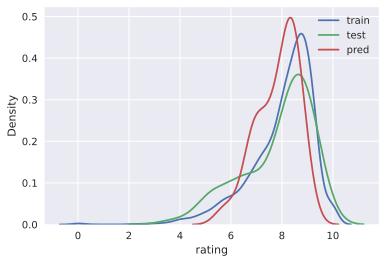

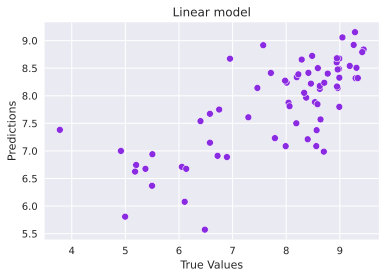

In [47]:
target_distr_linear(y_train, y_test, y_pred)  

In [48]:
calc_metrics(y_test, y_pred)

*** VAL **: 
MSE:   0.8716029527064778
RMSE:  0.9335967827207192
R2:    0.5259570147837993
MAE:   0.7254158283041264
MedAE: 0.6351808300061235
------------------------------


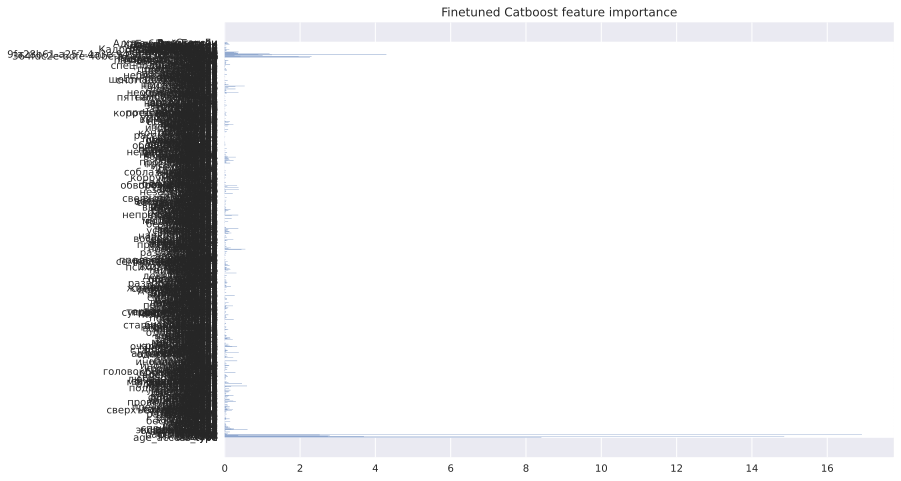

In [49]:
get_feature_imp(best_cat, train_dataset)

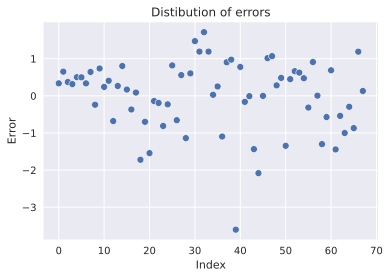

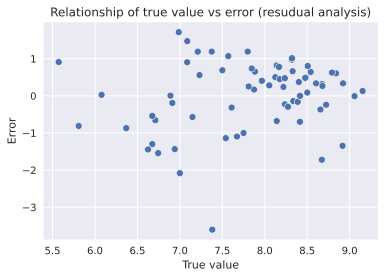

In [50]:
errors = y_test - y_pred
draw_res_analys(errors, y_pred)

In [51]:
test_df['PREDS_tune'] = y_pred.tolist()
test_df

,age_access_type,name,type,release_year,duration,element_uid,BUDGET,MARKETING,RUS,USA,...,Крис Гилл,Майкл Кан,Джим Дено,Дариуш Вольски,Харви Вайнштейн,Боб Вайнштейн,Адриан Политовски,Люк Бессон,Стэн Ли,PREDS_tune
10400,18,Не оставляй меня,SERIAL,2022,17.044733,00de4f79-d52d-4d2c-871c-e6e8432cc3df,NaN,NaN,NaN,NaN,...,0,0,0,0,0,0,0,0,0,8.921945
10300,18,Индекс страха,SERIAL,2022,16.200597,e281b84c-bb78-466a-ac71-c557aacc5c13,NaN,NaN,NaN,NaN,...,0,0,0,0,0,0,0,0,0,7.884289
10322,18,На взводе: Битва за UBER,SERIAL,2022,16.064695,fecde143-2a72-4a70-8efc-188079a62f1a,NaN,NaN,NaN,NaN,...,0,0,0,0,0,0,0,0,0,8.401769
10439,18,Жена путешественника во времени,SERIAL,2022,16.626117,7becd8d8-1fb8-4ee6-b903-47817686ddd8,NaN,NaN,NaN,NaN,...,0,0,0,0,0,0,0,0,0,8.674383
46,16,Боец: Король ринга,MOVIE,2022,15.665539,1f2481e2-55ec-429f-9e3d-6c3ea2087d00,15.894952,NaN,NaN,NaN,...,1,0,0,0,0,0,0,0,0,8.124558
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
4414,18,Отряд «Призрак»,MOVIE,2022,15.656060,f132627d-5b3b-443f-bccd-feb92b51d08d,NaN,NaN,NaN,NaN,...,0,0,0,0,0,0,0,0,0,7.750042
4415,12,Падение Луны,MOVIE,2022,15.869634,595c19b8-a22f-4beb-ab9f-5431fd3929ea,18.826146,NaN,15.237295,16.763137,...,0,0,0,0,0,0,0,0,0,8.273412
4417,16,Парни под прикрытием,MOVIE,2022,15.501910,1b9df53f-e556-4f00-8d1f-67b2cc74e01a,NaN,NaN,12.266231,NaN,...,0,0,0,0,0,0,0,0,0,6.367932
3392,16,9 жизней,MOVIE,2022,15.566448,a7979b64-cf82-4c7f-86d8-05670b07d1b0,NaN,NaN,12.154206,NaN,...,0,0,0,0,0,0,0,0,0,7.210781
